# Image Based Recommendation System

##### Problem statement

Most of the ecommerce website / application like Amazon, Flipkart largely depends on text 
filtering to find the required product. And for customer it is inconvenient to download multiple 
application and search for desired product manually. This is very time consuming and can result 
in selection of wrong product with inferior quality and high price.
In this paper, we are proposing a new way to filter product via image and recommend related 
products to customers through instant messaging applications like telegram and WhatsApp. 
Image base recommendations will help user to filter exact or similar products


##### Approch 

In this recommendation system, first, we will classify and categorize the product by the image 
classification model. This image classification model will be just the CNN model which will 
take the input image and categorize the product it belongs to. In the CNN model, we will also 
explore different CNN architecture/models like SVM (Support Vector Machine), VggNet, 
GoogleNet, and ResNet and validate their training, validation, and test accuracy


In the second part of the recommendation engine, we help to identify the recommended product 
based on the input image, for which we will calculate cosine similarities between the feature 
extracted from the pre-trained model and image. Then, images are suggested based on the 
calculated cosine similarity, listed in descending order. So, higher the cosine similarity, the 
recommended image will be more similar to the input image, and to get a better 
recommendation of the product we will again calculate cosine similarity between the text like 
title and brand to get the exact/similar product what customer/user is looking for.

##### Solution Steps 


1. Data Reading/Data Understanding
2. Data Cleaning
3. Dataset visualization 
4. Model Building & training
5. Data augmentation
6. Model Building & training on the augmented data
7. Class distribution
8. Handling class imbalances
9. Model Building & training on the rectified class imbalance data

### 1. Data Reading/Data Understanding

- Load the data to Python Dataframe
- Check Various columns of the dataframe.
- Normalize the json data.
- Identify the target column.

In [1]:
# Importing packages

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import random
import glob
import os
import seaborn as sns
import pickle
import plotly.express as px
import keras
import requests

from tqdm import tqdm
from keras_preprocessing.image import ImageDataGenerator
from keras_preprocessing import image
from keras.models import load_model
from keras.applications import vgg16
from keras.models import Model
from keras.applications.imagenet_utils import preprocess_input

from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics.pairwise import cosine_similarity

import tensorflow as tf
from tensorflow.keras import regularizers 
from tensorflow.keras import layers, losses
from tensorflow.keras.layers import Dense, Flatten, Activation, Conv2D, MaxPooling2D
from tensorflow.keras.layers import Dropout, BatchNormalization
from tensorflow.keras.models import Sequential
from tensorflow.keras.utils import load_img,img_to_array
from tensorflow.random import set_seed


from IPython.display import display, HTML
from PIL import Image

from io import BytesIO
from wordcloud import WordCloud

from tensorflow.keras.applications.resnet50 import ResNet50,preprocess_input
from keras.models import Sequential
from tensorflow.keras.layers import GlobalMaxPooling2D
from numpy.linalg import norm

import opendatasets as od
import pandas

%matplotlib inline

# Setting Display format to float
pd.options.display.float_format = '{:.2f}'.format

# Pandas Data frame settings
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

import warnings
warnings.filterwarnings('ignore')

In [2]:
# Set working Dir
path = "D:\Python\Image-Recommendation"
os.chdir(path)
os.getcwd()

'D:\\Python\\Image-Recommendation'

In [3]:
# Set the path of data
path_to_data = 'Data'

# Import all files from folder which ends with .csv 
csv_files = glob.glob(os.path.join(path_to_data, '*.csv'))
csv_files

['Data\\Cell_Phones_and_Accessories_downloaded.csv',
 'Data\\Clothing_Men_downloaded.csv',
 'Data\\Clothing_Women_downloaded.csv',
 'Data\\Electronics_downloaded.csv',
 'Data\\Home_and_Kitchen_downloaded.csv',
 'Data\\Pet_Supplies_downloaded.csv',
 'Data\\Shoes_downloaded.csv',
 'Data\\Watches_downloaded.csv']

In [4]:
# Function to Remove Suffix
def remove_suffix(text,suffix):    
    if suffix and text.endswith(suffix):
        return text[:-len(suffix)]
    return text

# Function to Remove Prefix
def remove_prefix(text, prefix):
    if prefix and text.startswith(prefix):
        return text[len(prefix):]
    return text

In [5]:
data = pd.DataFrame()
for index, file in enumerate(csv_files):
    df_temp = pd.read_csv(file)
    file_name = os.path.splitext(os.path.basename(file))[0]  
    file_name = remove_suffix(file_name,'_downloaded')
    df_temp['filename'] = file_name
    data = data.append(df_temp)

In [6]:
# Check Rows and Columns count
print(data.shape)

# Check the datatype of various columns
print(data.columns)

(40000, 14)
Index(['asin', 'related', 'title', 'price', 'salesRank', 'imUrl', 'brand', 'categories', 'description', 'rating', 'timestamp', 'imUrl_local', 'filename', 'user'], dtype='object')


**Summary** :
- We have loaded amazon data from http://jmcauley.ucsd.edu/data/amazon/. 
- The loaded data consist of column name i.e. 'id', 'asin', 'related', 'title', 'price', 'salesRank', 'imUrl', 'brand', 'categories', 'description', 'rating', 'timestamp', 'imUrl_local', 'user'.

### 2. Data Cleaning

- Remove duplicate rows.
- Add column to data frame.
- Remove unnecessary columns.
- Drop columns is null value. 
- Remove duplicate rows, 
- Rename the columns,
- Add columns in accordance with avaiable data.

In [7]:
# Check for null values
data.isnull().sum()

asin               0
related         3961
title              0
price              0
salesRank          0
imUrl              0
brand          24219
categories         0
description    20942
rating           297
timestamp        297
imUrl_local        0
filename           0
user           35000
dtype: int64

In [8]:
# Validate duplicate value
isDuplicate = data.duplicated().any() 

# Drop duplicate values
data.drop_duplicates(keep=False, inplace=True)

In [9]:
# Drop dulicate products
data.sort_values("asin", inplace=True)
data.drop_duplicates(subset="asin", keep=False, inplace=True)

In [10]:
# Remove related, salesRank, timestamp, user, imUrl_local, description, imUrl_local columns
data.drop(['related'], axis=1, inplace=True)
data.drop(['salesRank'], axis=1, inplace=True)
data.drop(['timestamp'], axis=1, inplace=True)
data.drop(['user'], axis=1, inplace=True)
data.drop(['description'], axis=1, inplace=True)
data.drop(['imUrl_local'], axis=1, inplace=True)

In [11]:
# We will remmove categories column as we will replace file name as categories of the product
data.drop(['categories'], axis=1, inplace=True)

In [12]:
# Checking the datatype of dataset column
d = {"Feature":[i for i in data.columns] ,'Type' : data.dtypes.values}
description = pd.DataFrame(data = d)
description

,Feature,Type
0,asin,object
1,title,object
2,price,float64
3,imUrl,object
4,brand,object
5,rating,float64
6,filename,object


In [13]:
# Checking the unique observations, datatype & null values for every feature
d = {"Feature":[i for i in data.columns]    ,"Nunique" :data.nunique().values ,'Type' : data.dtypes.values, "No: of nulls" : data.isnull().sum() }
description = pd.DataFrame(data = d)
description

,Feature,Nunique,Type,No: of nulls
asin,asin,39367,object,0
title,title,39233,object,0
price,price,7598,float64,0
imUrl,imUrl,39366,object,0
brand,brand,4108,object,23861
rating,rating,5,float64,297
filename,filename,8,object,0


We can see there are null values in brand, rating. So we will replace brand as "Unknown" and rating null value to 0

In [14]:
data['brand'].fillna(value = "Unknown" , inplace = True)
data['rating'].fillna(value = 0 , inplace = True)

In [15]:
# Rename filename with category name.
data.columns = data.columns.str.replace('filename', 'category')

In [16]:
# Replace '_' with ' '
data['category'] = data['category'].str.replace('_',' ')

In [17]:
# Reset the index back to the default 0, 1, 2 etc indexes
data=data.reset_index()

In [18]:
# Drop index column
data.drop(['index'], axis=1, inplace=True)

In [19]:
# Add 'product_id' column
data.insert(loc=0, column='product_id', value=np.arange(len(data)))

In [20]:
# Display dataframe
data.head()

,product_id,asin,title,price,imUrl,brand,rating,category
0,0,0777700018,"65W/90W DC Car Charger for Dell Inspiron, Lati...",21.40,http://ecx.images-amazon.com/images/I/41FVVuXV...,Unknown,5.00,Electronics
1,1,1304793303,Sport and Military Pet Suppment,13.99,http://ecx.images-amazon.com/images/I/316Sbqmu...,Unknown,5.00,Pet Supplies
2,2,1892069148,MindWare Perplexors: Level A,12.95,http://ecx.images-amazon.com/images/I/51UYAxOG...,MindWare,5.00,Home and Kitchen
3,3,1908510986,USB Data Sync Charger Cable Cord for Samsung G...,0.58,http://ecx.images-amazon.com/images/I/41wJoHbC...,Unknown,5.00,Cell Phones and Accessories
4,4,1934931403,Response Card RF LCD by Turning Technologies,51.97,http://ecx.images-amazon.com/images/I/51Feilx4...,Unknown,5.00,Electronics


In [21]:
# Check Rows and Columns count
print(data.shape)

# Check the datatype of various columns
print(data.columns)

(39367, 8)
Index(['product_id', 'asin', 'title', 'price', 'imUrl', 'brand', 'rating', 'category'], dtype='object')


In [ ]:
# Download image and save image to create image dataset
from PIL import Image
error_id = []

def save_img(img,row):
    img.save('Data\Images\Image_'+ str(row['product_id'])+'.jpeg')
    
# Downlaod images, run once
for idx, row in tqdm(data.iterrows()):
    try:
        url = row['imUrl']
        response = requests.get(url)
        img = Image.open(BytesIO(response.content))
        if img.mode in ['RGBA', 'P']:
            img = img.convert('RGB')
        save_img(img,row)
    except:
        error_id.append(row['product_id'])
        print("Error in : \n%s", str(row['product_id']))    

In [ ]:
# Reduce the data from dataframe for which image is not present
for eid in error_id:
    data.drop(data[data['product_id'] == eid].index, inplace = True)

In [22]:
# saving the dataframe
#data.to_csv('Save-Dataset/product_data.csv')

# load saved dataframe
data = pd.read_csv('Save-Dataset/product_data.csv')
data.drop(['Unnamed: 0'], axis=1, inplace=True)
data.shape

(39194, 8)

### 3. Dataset visualization

In [23]:
data.describe()

,product_id,price,rating
count,39194.00,39194.00,39194.00
mean,19620.51,58.61,4.64
std,11348.01,99.79,0.76
min,0.00,0.01,0.00
25%,9799.25,10.00,4.00
50%,19597.50,22.41,5.00
75%,29402.75,60.88,5.00
max,39366.00,999.99,5.00


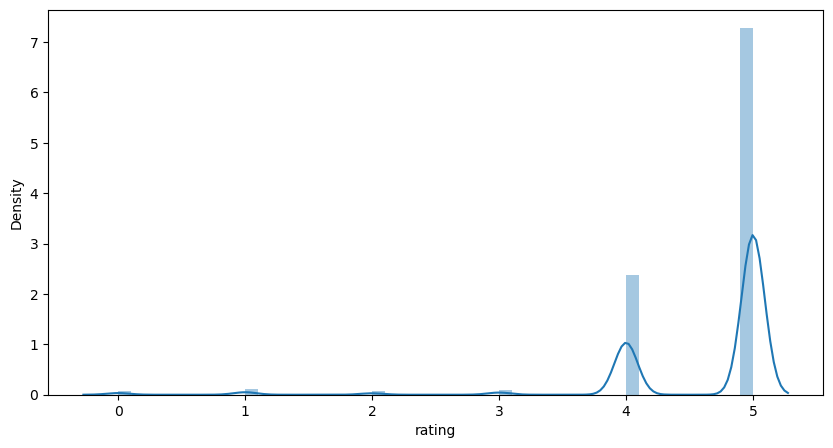

In [24]:
plt.figure(figsize=(10,5))
ax= sns.distplot(data["rating"])

(0.0, 1000.0)

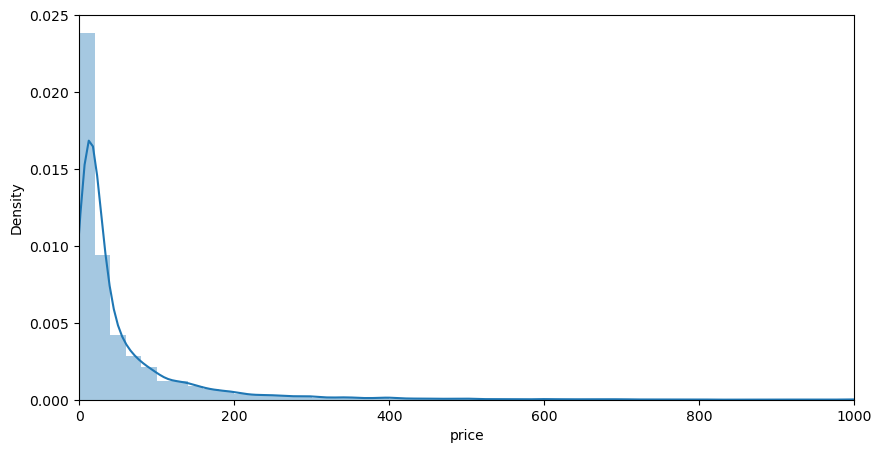

In [25]:
plt.figure(figsize=(10,5))
ax=sns.distplot(data["price"])
ax.set_xlim(0, 1000)

(0.0, 200.0)

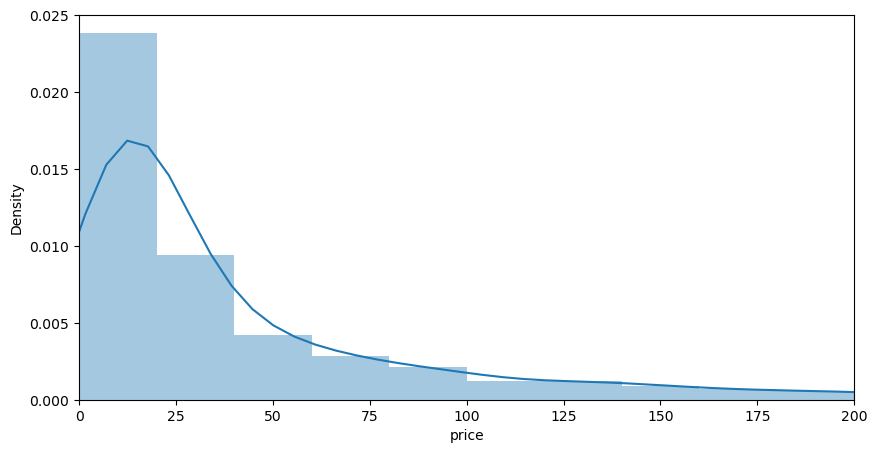

In [30]:
plt.figure(figsize=(10,5))
ax=sns.distplot(data["price"])
ax.set_xlim(0, 200)

In [26]:
fig = px.histogram(data["price"], labels={'x': 'Price'}, marginal="rug", title='Count per Price' )
fig.update_xaxes(range=[0,1000])
fig.show()

Product Price - There are products starting from 0.0 dollars to 999.99 dollars, so this is a huge range. The price mean is $58.54 across different category.
Product Rateing - On an average product rating is 4.64.

Visualizations
- Count of product per category

In [29]:
fig = px.bar(data.groupby('category').count().reset_index(), x='category',y='product_id',title='Count per Product Category')
fig.update_layout(barmode='stack', xaxis={'categoryorder':'total descending'})

In [26]:
# Groupby masterCategory 
sampleCategory = data.groupby('category', as_index=False)

# Selecting 1st row of group by Category
categoryData = sampleCategory.nth(0)
categoryData=categoryData.reset_index()

In [27]:
categoryData.head()

,index,product_id,asin,title,price,imUrl,brand,rating,filename,category
0,0,0,0777700018,"65W/90W DC Car Charger for Dell Inspiron, Lati...",21.40,http://ecx.images-amazon.com/images/I/41FVVuXV...,Unknown,5.00,0777700018_41FVVuXVieL._SX300_.jpg,Electronics
1,1,1,1304793303,Sport and Military Pet Suppment,13.99,http://ecx.images-amazon.com/images/I/316Sbqmu...,Unknown,5.00,1304793303_316SbqmubkL._SY300_.jpg,Pet Supplies
2,2,2,1892069148,MindWare Perplexors: Level A,12.95,http://ecx.images-amazon.com/images/I/51UYAxOG...,MindWare,5.00,1892069148_51UYAxOGCLL._SY300_.jpg,Home and Kitchen
3,3,3,1908510986,USB Data Sync Charger Cable Cord for Samsung G...,0.58,http://ecx.images-amazon.com/images/I/41wJoHbC...,Unknown,5.00,1908510986_41wJoHbCZOL._SY300_.jpg,Cell Phones and Accessories
4,6,6,5555015038,Top Gear Official Merchandise - NOT the Stig,22.95,http://ecx.images-amazon.com/images/I/319LpxRv...,Unknown,5.00,5555015038_319LpxRvbEL._SX342_.jpg,Clothing Men


In [28]:
Category = categoryData.category
print(Category)

0                    Electronics
1                   Pet Supplies
2               Home and Kitchen
3    Cell Phones and Accessories
4                   Clothing Men
5                 Clothing Women
6                        Watches
7                          Shoes
Name: category, dtype: object


In [29]:
# Functions takes the image url and return image
def getImageByUrl(url):   
    # we get the url of the apparel and download it
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))    
    return img

def getImagePlotByUrl(url):
    # we get the url of the apparel and download it
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))
    # we will display it in notebook 
    return plt.imshow(img)

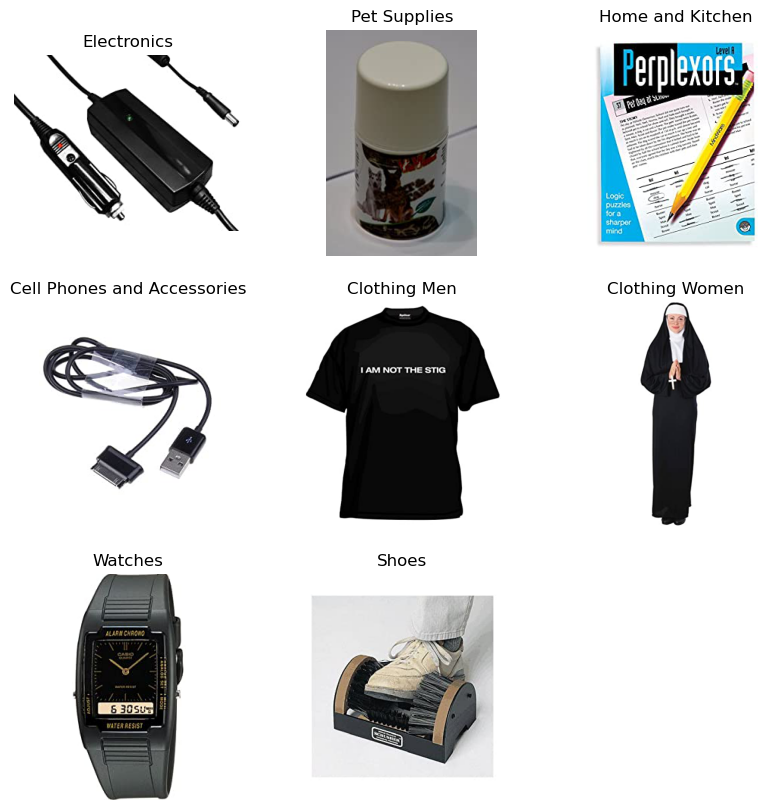

In [30]:
# Display sample image of different category of data
plt.figure(figsize=(10, 10))
for index, row in categoryData.iterrows():
  ax = plt.subplot(3, 3, index + 1)
  getImagePlotByUrl(row['imUrl'])  
  plt.title(row['category'])
  plt.axis("off")

In [29]:
# Load the mask images
list_masks = list()
list_name = list()

for index, row in categoryData.iterrows():  
  list_masks.insert(index, np.array(getImageByUrl(row['imUrl'])))
  list_name.insert(index, row['category'])

In [30]:
# Functions takes category type and returns product name joined with a space
def product_join(name):   
    return " ".join(t for t in data[data["category"]==name].title)

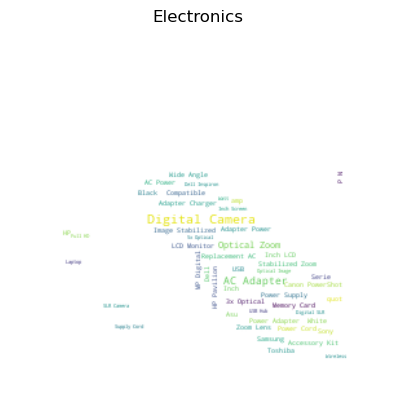

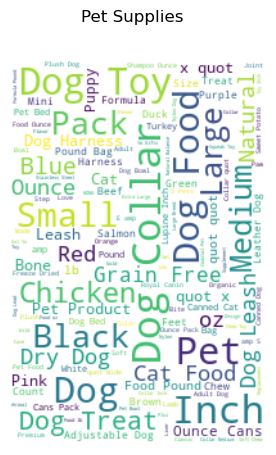

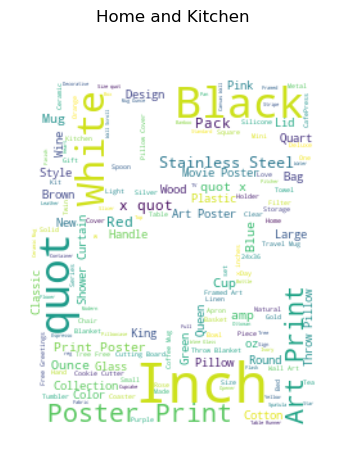

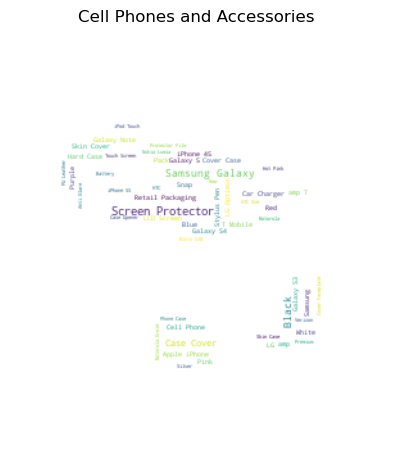

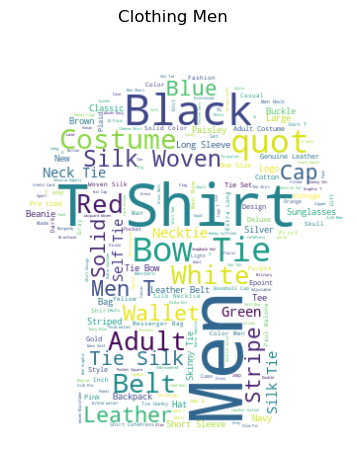

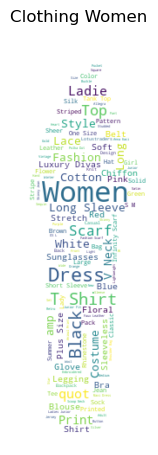

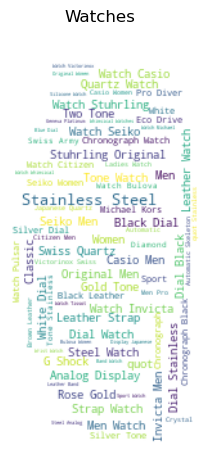

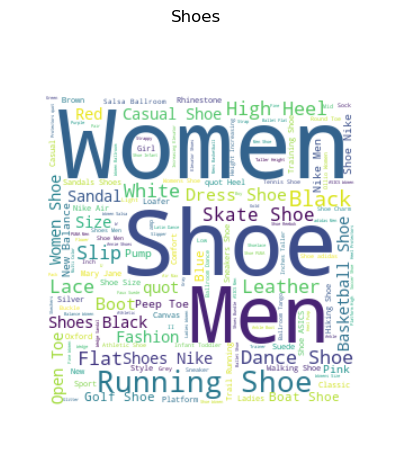

In [31]:
# The product titles are displayed like the product category's image
for i in range(len(list_masks)):
    # WordCloud Python library used to create word clouds of the words in the title of each of the category type.
    wordcloud = WordCloud(background_color="white",  mask=list_masks[i]).generate(product_join(list_name[i]))
    plt.figure(figsize=[5,5])
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.suptitle(list_name[i])
    plt.axis("off")
    plt.show()

### Part I : Image Classification

The objective of this section to identify the correct category of product from a random image i.e. if its a 
'Electronics','Pet Supplies','Home and Kitchen','Cell Phones and Accessories','Clothing Men','Clothing Women','Watches' or 'Shoes'


This section is divided into three parts:

1. Extracts the images from the data and convert them into arrays.
2. Perform the train/test split and run the classification model.
3. For the prediction part, we pick a random image from the test data, then identify it's correct category.

In [3]:
from tensorflow.keras.preprocessing import image
from keras.utils import to_categorical
from sklearn import metrics
from sklearn.metrics import confusion_matrix

In [32]:
# Reading the training images
train_image = []
for i, row in tqdm(data.iterrows()):    
    img = image.load_img('Data\Images\Image_'+ str(row['product_id'])+'.jpeg', target_size=(120,120,1), grayscale=True)
    img = image.img_to_array(img)
    img = img/255
    train_image.append(img)
X = np.array(train_image)

39194it [02:09, 302.73it/s]


In [9]:
data = pd.read_csv('Save-Dataset/product_data.csv')
data.drop(['Unnamed: 0'], axis=1, inplace=True)
data.shape

train_df = pd.read_csv('save-dataset/train.csv')
train_df.drop(['Unnamed: 0'], axis=1, inplace=True)

test_df = pd.read_csv('save-dataset/test.csv')
test_df.drop(['Unnamed: 0'], axis=1, inplace=True)

In [10]:
#import pickle
#pickle.dump(train_image,open('Save-Dataset/train_image.pkl','wb'))
#pickle.dump(X,open('Save-Dataset/X_image.pkl','wb'))

In [8]:
import pickle
train_image = np.asarray(pickle.load(open('save-dataset/train_image.pkl','rb')))
X = np.array(pickle.load(open('save-dataset/train_image.pkl','rb')))

In [11]:
# Converting the response variable into numbers
data['category'][data['category']=='Electronics' ]=0
data['category'][data['category']=='Pet Supplies' ]=1
data['category'][data['category']=='Home and Kitchen' ]=2
data['category'][data['category']=='Cell Phones and Accessories' ]=3
data['category'][data['category']=='Clothing Men' ]=4
data['category'][data['category']=='Clothing Women' ]=5
data['category'][data['category']=='Watches' ]=6
data['category'][data['category']=='Shoes' ]=7
data['category']=data['category'].astype(int)

In [12]:
# Creating the target variable
y = data['category'].values
y = to_categorical(y)

In [13]:
# Splitting the data
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42, test_size=0.25)

In [14]:
print("train data")
print(X_train.shape)
print(y_train.shape)
print("\n test data")
print(X_test.shape)
print(y_test.shape)

train data
(29395, 120, 120, 1)
(29395, 8)

 test data
(9799, 120, 120, 1)
(9799, 8)


In [40]:
# Validate datatype of train and test data 
print("train data")
print(X_train.dtype)
print("\ntest data")
print(X_test.dtype)

train data
float32

test data
float32


In [15]:
# normalise
X_train /= 255
X_test /= 255

In [16]:
img_rows, img_cols = 120, 120
input_shape = (img_rows, img_cols, 1)

num_classes = 8
batch_size = 128
epochs = 50

lstm_cells=128
dense_neurons=128
dropout=0.5

In [17]:
from tensorflow.keras.regularizers import l2

set_seed(42) #setting the seed

model = Sequential()

model.add(Conv2D(32, (3, 3), padding='same',
                 input_shape=X_train.shape[1:],kernel_regularizer=regularizers.l1(1e-5)))
model.add(Activation('relu'))
model.add(BatchNormalization())
model.add(Conv2D(32, (3, 3)))
model.add(Activation('relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.20))

model.add(Conv2D(64, (3, 3), padding='same'))
model.add(Activation('relu'))
model.add(BatchNormalization())
model.add(Conv2D(64, (3, 3)))
model.add(Activation('relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.20))

model.add(Conv2D(128, (3, 3), padding='same'))
model.add(Activation('relu'))
model.add(BatchNormalization())
model.add(Conv2D(128, (3, 3)))
model.add(Activation('relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.20))

model.add(Flatten())
model.add(Dense(512,kernel_regularizer=l2(0.01)))
model.add(Activation('relu'))
model.add(Dropout(0.20))
model.add(Dense(num_classes))
model.add(Activation('softmax'))

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 120, 120, 32)      320       
                                                                 
 activation (Activation)     (None, 120, 120, 32)      0         
                                                                 
 batch_normalization (BatchN  (None, 120, 120, 32)     128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 118, 118, 32)      9248      
                                                                 
 activation_1 (Activation)   (None, 118, 118, 32)      0         
                                                                 
 batch_normalization_1 (Batc  (None, 118, 118, 32)     128       
 hNormalization)                                        

In [44]:
# Compile the model
model.compile(loss=tf.keras.losses.categorical_crossentropy,
              optimizer=tf.keras.optimizers.Adadelta(),
              metrics=['accuracy'])

In [45]:
# Fit the model
r = model.fit(X_train, y_train,
          batch_size=batch_size,
          epochs=50,
          verbose=1,
          validation_data=(X_test, y_test),
          shuffle=True)

Epoch 1/50
230/230 [==============================] - 1603s 7s/step - loss: 13.0773 - accuracy: 0.1699 - val_loss: 12.4566 - val_accuracy: 0.1143
Epoch 2/50
230/230 [==============================] - 1602s 7s/step - loss: 12.4707 - accuracy: 0.2385 - val_loss: 12.6127 - val_accuracy: 0.1413
Epoch 3/50
230/230 [==============================] - 1532s 7s/step - loss: 12.1794 - accuracy: 0.2838 - val_loss: 12.3898 - val_accuracy: 0.1523
Epoch 4/50
230/230 [==============================] - 1513s 7s/step - loss: 11.9846 - accuracy: 0.3101 - val_loss: 11.8935 - val_accuracy: 0.2877
Epoch 5/50
230/230 [==============================] - 1482s 6s/step - loss: 11.8415 - accuracy: 0.3359 - val_loss: 11.7512 - val_accuracy: 0.3338
Epoch 6/50
230/230 [==============================] - 1480s 6s/step - loss: 11.7299 - accuracy: 0.3539 - val_loss: 11.6863 - val_accuracy: 0.3501
Epoch 7/50
230/230 [==============================] - 1475s 6s/step - loss: 11.6469 - accuracy: 0.3677 - val_loss: 11.6198 -

In [46]:
print("Total Params:", model.count_params())
print("Accuracy : ", model.evaluate(X_test, y_test))

Total Params: 11368424
307/307 [==============================] - 120s 391ms/step - loss: 9.8397 - accuracy: 0.5290
Accuracy :  [9.839730262756348, 0.5290336012840271]


In [18]:
# saving it in a '.h5' format file
#model.save('Model/model_cnn.h5')
model = tf.keras.models.load_model('Model/model_cnn.h5')

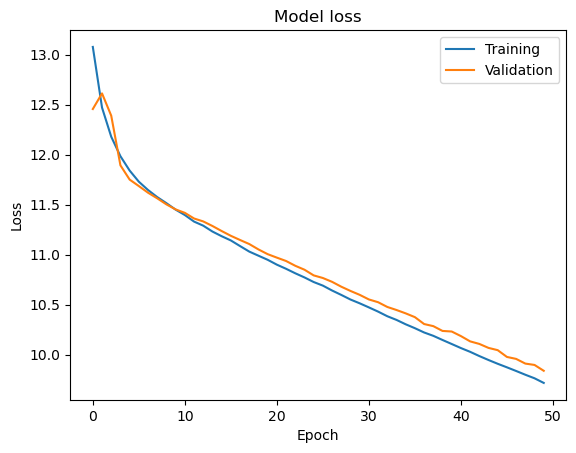

In [48]:
plt.plot(r.history['loss'])
plt.plot(r.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Training', 'Validation'], loc='upper right')
plt.show()

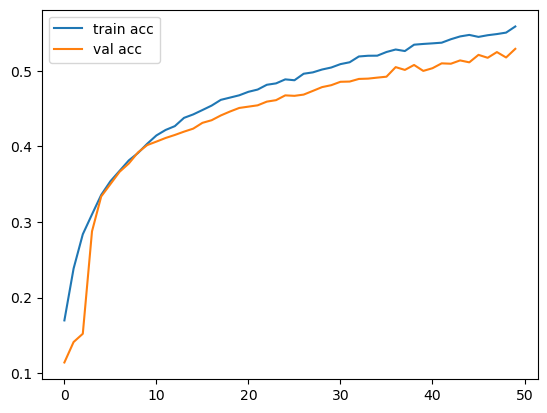

<Figure size 640x480 with 0 Axes>

In [49]:
# accuracies
plt.plot(r.history['accuracy'], label='train acc')
plt.plot(r.history['val_accuracy'], label='val acc')
plt.legend()
plt.show()
plt.savefig('AccVal_acc')

In [22]:
product_type = ['Electronics','Pet Supplies','Home and Kitchen','Cell Phones and Accessories'
                ,'Clothing Men','Clothing Women','Watches','Shoes']

In [51]:
# Prediction on the test image
model_pred = np.argmax(model.predict(X_test),axis=1)

307/307 [==============================] - 131s 423ms/step


In [52]:
y_test_arg=np.argmax(y_test,axis=1)

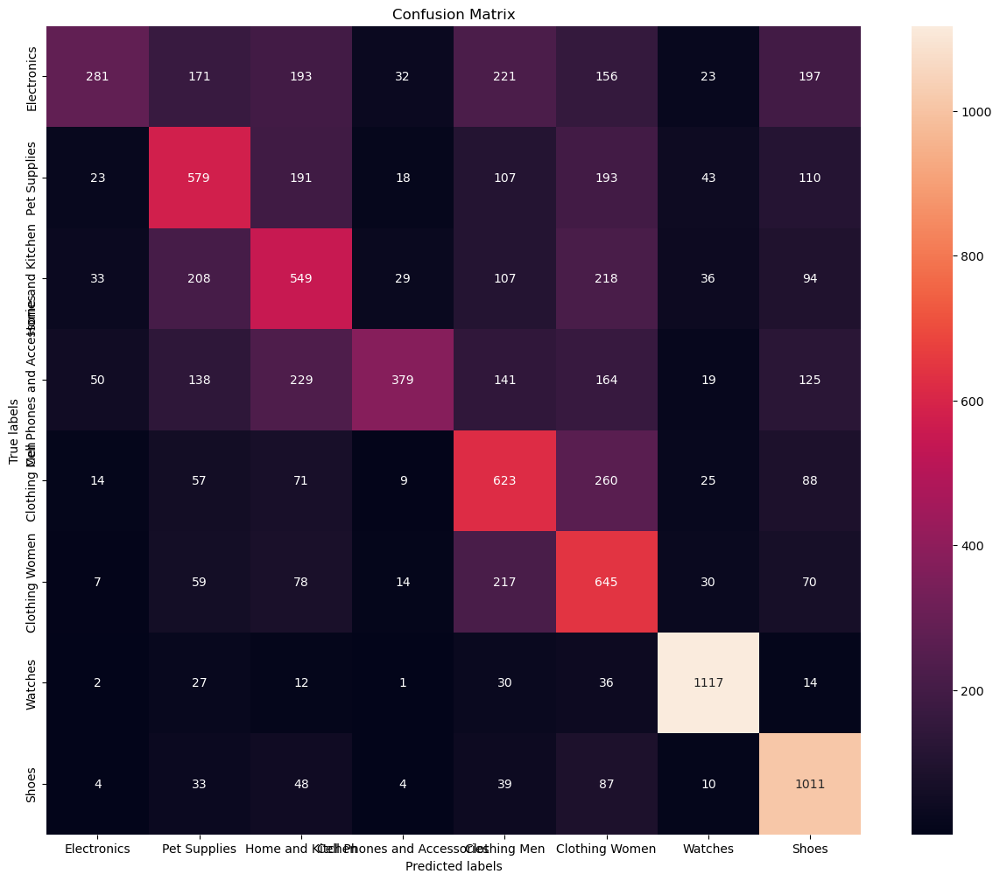

In [54]:
# Confusion matrix for results
cm = confusion_matrix(y_test_arg, model_pred)

fig, ax= plt.subplots(figsize=(15,12))
sns.heatmap(cm, annot=True, ax = ax, fmt='g'); # annot=True to annotate cells. 'fmt' prevents the numbers from going to scientific notation

# labels, title and ticks
ax.set_xlabel('Predicted labels');ax.set_ylabel('True labels'); 
ax.set_title('Confusion Matrix'); 
ax.xaxis.set_ticklabels(product_type);
ax.yaxis.set_ticklabels(product_type);

In [55]:
classification_metrics = metrics.classification_report(y_test_arg, model_pred, target_names=product_type )
print(classification_metrics)

                             precision    recall  f1-score   support

                Electronics       0.68      0.22      0.33      1274
               Pet Supplies       0.46      0.46      0.46      1264
           Home and Kitchen       0.40      0.43      0.42      1274
Cell Phones and Accessories       0.78      0.30      0.44      1245
               Clothing Men       0.42      0.54      0.47      1147
             Clothing Women       0.37      0.58      0.45      1120
                    Watches       0.86      0.90      0.88      1239
                      Shoes       0.59      0.82      0.69      1236

                   accuracy                           0.53      9799
                  macro avg       0.57      0.53      0.52      9799
               weighted avg       0.57      0.53      0.52      9799



In [20]:
# Prediction on the test image
model_pred = np.argmax(model.predict(X_test),axis=1)

307/307 [==============================] - 87s 276ms/step


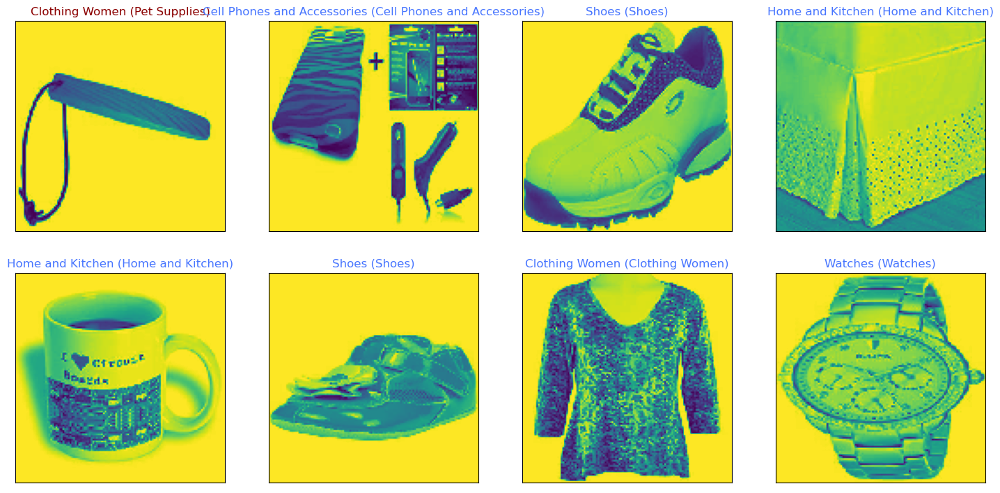

In [27]:
# Display true labels and predictions
fig = plt.figure(figsize=(18, 18))
for i, idx in enumerate(np.random.choice(X_test.shape[0], size=8, replace=False)):
    ax = fig.add_subplot(4, 4, i + 1, xticks=[], yticks=[])
    ax.imshow(np.squeeze(X_test[idx]))
    pred_idx = model_pred[idx]
    true_idx = np.argmax(y_test[idx])
    ax.set_title("{} ({})".format(product_type[pred_idx], product_type[true_idx]),
                 color=("#4876ff" if pred_idx == true_idx else "darkred"))

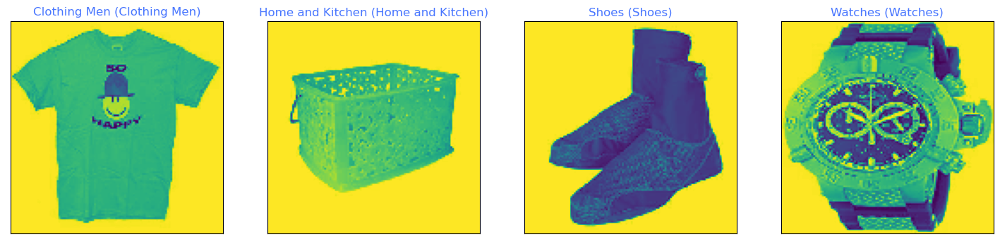

In [56]:
# Display true labels and predictions
fig = plt.figure(figsize=(18, 18))
for i, idx in enumerate(np.random.choice(X_test.shape[0], size=4, replace=False)):
    ax = fig.add_subplot(4, 4, i + 1, xticks=[], yticks=[])
    ax.imshow(np.squeeze(X_test[idx]))
    pred_idx = model_pred[idx]
    true_idx = np.argmax(y_test[idx])
    ax.set_title("{} ({})".format(product_type[pred_idx], product_type[true_idx]),
                 color=("#4876ff" if pred_idx == true_idx else "darkred"))

### Part II : Product Recommendation - Text Based Recommendation

###### Recommendation based on product title

The objective of this section is to recommend N products based on the product title.

This method is executed with the help of the below steps:

1. Convert the product title to BoW with the help of CountVectorizer in sklearn library. We will remove all the stop words and convert the text to a lowercase.
2. Calculate the cosine similarity score between the product titles. Sklearn's metrics is used to perform this.
3. Build the recommendation engine. A function is created that takes in the Product ID and returns N recommendations. The similarity score is arranged in descending order and results are outputed based on score

We will display the steps for the first method to see how the results are displayed

In [8]:
import pandas as pd
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import linear_kernel

In [9]:
data['title'].str.strip()

0        65W/90W DC Car Charger for Dell Inspiron, Lati...
1                          Sport and Military Pet Suppment
2                             MindWare Perplexors: Level A
3        USB Data Sync Charger Cable Cord for Samsung G...
4             Response Card RF LCD by Turning Technologies
                               ...                        
39189    Classic Aviator Style Color Gradient Lens Sung...
39190                              Stone Sour Face T-Shirt
39191    TRAKLINE Men's Icon Stainless Steel Buckle Ful...
39192    BeWild Brand&reg; - LeBron James Forgiven Welc...
39193    Dog Leash, night time, LED, 5ft, Red, Made for...
Name: title, Length: 39194, dtype: object

In [10]:
data['title'] = data['title'].astype(str).apply(lambda x: x[:100])

In [11]:
train_product , test_product = train_test_split(data, test_size=0.25, stratify=data['category'])

In [12]:
train_product.shape , "*****" , test_product.shape

((29395, 9), '*****', (9799, 9))

In [14]:
count_vectorize = CountVectorizer(stop_words = 'english') # Initialize the CountVectorizer
title_vectorized = count_vectorize.fit_transform(train_product['title']) # Run the CountVectorizer on the text
title_vectorized.shape

(29395, 32560)

There are 29395 Products and 32560 are unique words in the product name

In [15]:
counts = pd.DataFrame(title_vectorized.toarray(),columns=count_vectorize.get_feature_names())
counts

,00,000,00001,0001,00014,00030,0005,0009,000mah,001,0010,001d,002,002342,003,0030,00313,00363,004,005,006,007,00708,0072,0074,00767,0077,008,00836,0085,0087740,008g,009,00993,00d,00e009,00j00v,00k001,00l,00m,00q004,00utm5,01,010,01017,0103,01035,011,0111200,0113msu1159women,0118,0120,01236b,013,0134,014,0141,01451,015,015132,016,0168,016g,017,0183,01869,019,0193,01a03xx,01b,01e,01m,01p,01set,01the,01theone,02,0208dw,021,0211,02111,0216024r01m017,022,0220a1890,0227,022g2,025,0250,026,02692yl,027,027dc,0284,02905a,02a,02b,02d,02d2,02f,02g,02hc,02k6657,02k6661,02k6665,02k6669,02k6673,02s,02s034,03,030,0300,030ca,031,0311,0313msu3190,032,032g,033,0335a1,0337,035,0357,036,0361,03656,03682,037,038,03868,039l,03e,03l,03l18b,03x,04,040293554514,04090800,041,0412,0413,0415b19180,042,043,04300,0430001,04301c,0431,0432,045,04520,0459,047,0478am,04804106,049,04e,04g26,04k085,05,050,0501dw,0502,0504,051,052,053,054,0540,0560us1,0566,057,059,05a,05bz,05d,05e,06,060,06035,0605,0612dw,0622,0638,064,064g,065,0662,067,06bkrd,06d2,06e,06h,06rc,06ty,06x,07,070,0704,0717,07301413,07301422,07301429,07301441,07301452,0739,0760,0762,0789,07b1,07f,08,08102b,081596675,081596824,08215,083,0830001,0830098,085,0851,0869,0877,08800,08bkyw,08e,08h,08hn,09,090,0900dw,0910,0920,093,0932,093290,0942,095,0950,0957,0970,0981450,09b,09c3,09oz,0b66260,0c2894,0df261,0df263,0ft,0j62h3,...,z750,z750c,z796c,z80,z812is,z850,z87,z891,z9,z930l,z950,z981,z990,z992,z993,z998,za055,za2516,zac,zack,zacoo,zaft,zag,zagg,zaida,zaire14a,zak,zalman,zambaiti,zamberlan,zambia,zanies,zap,zari,zaza,zb,zcargel,ze,ze2000,ze3,ze4000,ze4800,ze4900,ze5,ze5100,ze5300,ze5400,ze5600,zeagoo,zeal,zealand,zeb,zebco,zebra,zebria,zee,zeetron,zehui,zeikos,zeimax,zeiss,zelda,zemgear,zen,zena120,zenana,zenbook,zenith,zenker,zenmuse,zenness,zeno,zentai,zentique,zenus,zeo,zeolite,zep,zephyr,zephz,zeppelin,zerg,zero,zeroflicker,zerogravitee,zeroll,zerouv,zeus,zevro,zg,zg5,zh1r,zhone,zi,zi6,zia,ziane,zibra,zicac,zig,zigdynamic,ziggies,ziggurat,zignature,zigoo,zigslash,zigtech,zigzag,ziiiro,zilu,zim,zin,zinc,zine,zing,zini,zink,ziotek,zip,zipcover,ziploc,zippe,zipper,zippered,zippers,zippo,zippypaws,zirc,zirconia,zisha,zitrades,ziwi,ziwipeak,zizo,zl,zl1047,zle,zm,zm2,zn,zn5,zne,zno,znu,zo,zodiac,zoe,zoey,zogoflex,zoidberg,zojirushi,zombie,zombies,zonders,zone,zoneplayer,zoneplayer120,zones,zonet,zoo,zoom,zoot,zopo,zorb,zoro,zorrel,zorro,zota,zp100,zp998,zr,zr1,zr1000,zr1000bk,zr1000rd,zr11999,zr15gd,zr200,zr200bk,zr2740w,zr300,zr300gd,zr300rd,zr33,zr33602m10cns3,zr34207,zr40,zr400,zr400bk,zr400sr,zr45mc,zr60,zr600,zr77224,zrt21005,zs10,zs12,zs12sr,zs15,zs20,zs20bk,zs20k,zs25,zs3,zs40k,zs5,zs9,zsr4164ws,zt3000,zt3100,zt3200,zte,zte9120,zten9120,ztex500mcb02,zu,zub,zuca,zugadgets,zuiko,zuke,zukes,zulu,zumba,zune,zuo,zupreem,zurich,zuzo,zv,zv5200,zv6000,zv6100,zv6200,zvac,zvox,zw330,zwiesel,zwilling,zx,zx3,zx3150,zx5,zx6970,zyliss,zyme,zywall,zywall110,zyxel,zzybia
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

In [16]:
cosine_sim = cosine_similarity(title_vectorized, title_vectorized)

In [17]:
cosine_sim_df=pd.DataFrame(cosine_sim)
cosine_sim_df.columns=train_product['title']
cosine_sim_df.index=train_product['title']
cosine_sim_df

title,"Zanies Plush Attack-A-Jack Dog Toy, 11-Inch",Addiction New Zealand Brushtail &amp; Vegetables Grain-Free Canned Dog Food (12/13.8 Ounce Cans),WHITE SKIRT TOP SET SMOCKED SEXY MAXI - FITS - S M L - A724S LOTUSTRADERS,"Joseph Joseph Small Cut and Carve Plus Multi-Function Chopping Board, White",Safavieh American Home Collection Wiltshire Distressed Dark Brown and Burgundy Ottoman,Padded Dog Harness,"UNLOCKED RIM Blackberry 9320 Curve GSM Quad-Band Smartphone with 3.2 MP Camera, Wi-Fi, GPS, FM Radio",AC Adapter,"PowerShot SX700 HS 16.1MP HD 1080p Digital Camera Black 32GB Kit Includes Camera, memory card, batte","Coastal Pet Products DCP2904BLU Nylon Double Collar Lead for Pets, 1-Inch by 4-Feet, Blue",Jingles Super Clown Costumes Adult Halloween Costumes,Li-Ion Polymer OEM Replacement Battery (1300mAh) FB0-2 for Motorola Triumph,Fine Mod Wire Counter Height stool,Silicone Heel Grip Shields Pads Cushion Clear Gel Liners Shoe Insole,Samsung S6792L Galaxy Fame Lite DUOS (Factory Unlocked) (White),Dr. Scholl's socks Spa Collection black/white low cut 2p,"TP-LINK TL-R470T+ Load Balance Broadband Router, 3 Changeable Ethernet WAN/LAN Ports, 64MB DRAM",The Partisan Backpack Color: Rust,(AT&amp;T) Samsung Galaxy S2 Black Pink Vine White Blue Red Color Daisy Flower Heart Design 2in1 Hyb,CafePress DETROIT 313 LION CREST Dark T-Shirt,LRG Men's The Big Tree Sunglasses,Concord HDWO-001 Easy Shot Clip HD (720p) Digital Video Camera with Outdoor/Diving Kit,OXA 2200mAh Portable Juice L1 Mini Backup External Battery Charger(Built-In SD Card Slot and Flashli,UBISOFT 34811 / Assassin's Creed IV Black Flag Action/Adventure Game - Blu-ray Disc - PlayStation 3,"HTC Evo Design 4G - 2 Hard Shield Cases (Black, White) + ATOM LED Keychain Light",Lotustraders Dress Lagenlook Parachute Jersey OS - L - 2X Olive R603S,Tissot T-Race Chronograph Black Dial Black and White Rubber Mens Watch T0484172705710,"Ethical Mediterranean Double Diner, 1-Pint",Medium Orthopedic Memory Foam Joint Relief Bolster Dog Bed - Toffee,DXG 569VS 5.0MP Slim HD Camcorder with 3.0-Inch LCD,Scarpa Women's Luna GTX Backpacking Shoe,Rachel Shoes Lil Gemini,Invicta Men's 0760 Ocean Reef Reserve Chronograph Black Dial Stainless Steel Watch,"Tovolo Collapsible Silicone Sink Strainer/Stopper, Red","My Generation Gifts - Looks 26 Feels 22 Acts 12, That Makes Me 60 - 60th Birthday Gift Present T-Shi",Ranger Metal Frame Aviator Sunglasses,Fluval G3 Fine Pre-Filter Cartridge,New Balance M3090 V3 Running Shoe - Black - Mens,Canon PowerShot S45 4MP Digital Camera w/ 3x Optical Zoom,Volcom Men's Skips Beanie,eForCity&reg; 2 TPU Gel Soft Skin Case+LCD Cover Compatible with HTC Inspire 4G,"Zebra,Insulated Cup with Straw 17 oz,Tumbler,4x4x6.25 Inches",Jinx Official Licensed Minecraft Enderman Inside Men's T-shirt,Motorola Battery Installation Adhesive Tape for Droid Razr EB20 &amp; Droid Razr Maxx EB40 Internal,Palm Centro 685 Black No Contract AT&amp;T Cell Phone,NIKE Air Alvord 10 Men's Running Shoes,Invicta Men's 11393 Specialty Charcoal Dial Dark Grey Leather Watch,Tartanista Women's Black Watch Plaid/Tartan Sash - 10.5&quot; x 90&quot;,August Steiner Women's ASA818BK Swiss Quartz Multi-Function Dazzling Fashion Watch,Mulco Unisex MW1-29878-021 &quot;Deep Scale&quot; Stainless Steel Casual Watch,Nokia Lumia 521 Distressed USA Flag Phone Case Cover,Men's Casual Stylish Braided Elastic Belt with Genuine Leather Tip,SUNNYDATE@ 2014 Women's Novel Fashion Leggings with variaty printing,Women's Red Wool Lined Slip-On Comfort Clog Shoes - Size 6,3 Pack of Premium Crystal Clear Screen Protectors for Samsung Reality U820 [Accessory Export Brand P,Premium Leatherette Wristlet Clutch Case Wallet for Apple iPhone 4/S with Back Camera Opening in Cam,Foot Relax Pad,LG Optimus 4X HD P880 16GB White Factory Unlocked International Version,Dragonborn Womens T-shirt - Gamer Gaming Geeky Tshirt,Ford Fairlane Car Round Retro Vintage Die-Cut Tin Sign,Verizon Wireless Pantech 295 4G/LTE modem + MOFI3500-3GN 4G L

Function text_recommendation taking
1. PID: Product ID of the original item in our dataset
2. num_recommend : Number of most similar items to retrieve
as input and returns product ID, title, brand and similarity score of the recommended items

In [34]:
def text_recommendation(pid, num_recommend=5):    
    recommended_prod = []
    score=[]    
    
    print("-----------------------------------------------------------------------")
    print("Original product:")
    print("-----------------------------------------------------------------------")
    print("Product ID : " , pid)
    print("Title : ", train_product['title'][train_product['product_id']==pid].tolist()[0].split(' - ')[0])
    print("Brand : ", train_product['brand'][train_product['product_id']==pid].tolist()[0].split(' - ')[0])
    
    # creating a Series with the similarity scores in descending order
    score_series = pd.Series(cosine_sim[pid]).sort_values(ascending = False)

    # getting the indexes and scores of the N most similar products
    top_10_indexes = list(score_series.iloc[1:(num_recommend+1)].index)
    top_10_score=list(score_series.iloc[1:(num_recommend+1)])
    
    # Displaying the recommended products- PID, Name, Brand and Similarity Score
    print("\n")
    print("-----------------------------------------------------------------------")
    print("Most similar products:")
    print("-----------------------------------------------------------------------")
    
    for i in range(0,len(top_10_score)):
        recommended_prod.append(list(train_product['title'])[i])
        print("\nProduct ID : " , top_10_indexes[i])
        print("Title : ", train_product['title'][train_product['product_id']==top_10_indexes[i]].tolist()[0].split(' - ')[0])
        print("Brand : ", train_product['brand'][train_product['product_id']==top_10_indexes[i]].tolist()[0].split(' - ')[0])
        print("Similarity score : ",top_10_score[i])

In [35]:
text_recommendation(23967)

-----------------------------------------------------------------------
Original product:
-----------------------------------------------------------------------
Product ID :  23967
Title :  KONG Funsters Flip Dog Toy, X-Small
Brand :  KONG


-----------------------------------------------------------------------
Most similar products:
-----------------------------------------------------------------------

Product ID :  14105
Title :  Yonex Women's Tennis Shoe
Brand :  Unknown
Similarity score :  0.6030226891555273

Product ID :  18626
Title :  Obama
Brand :  Unknown
Similarity score :  0.5892556509887895

Product ID :  18087
Title :  Hannspree HL HL161ABB 16-Inch Screen LED-Lit Monitor
Brand :  Hannspree
Similarity score :  0.5892556509887895

Product ID :  2649
Title :  Wardley Tropical Flakes
Brand :  Wardley
Similarity score :  0.5892556509887895

Product ID :  826
Title :  Iams Smart Puppy (Formerly Puppy Original Formula)
Brand :  Iams
Similarity score :  0.5555555555555556


### Part III -  Image Based Recommendation

The objective of this section is to recommend N products based on the images of the product.

This method is executed with the help of the below steps:

1. Since we are dealing with images, we need to extract features from the images. A pre trained model VGG16 is used to do this.
2. The final output layer is removed as we did not intend to use these models as classifiers.With this step, we are left with the output of a convolutional layer that is pooled and reduced using a global average pooling layer followed by a flatten layer to get a linear feature vector for an image.
3. The next step is to comput the cosine similarity scores between the image features. Sklearn's metrics is used to perform this.
4. The final step is to build the recommendation engine. A function is created that takes in the Product ID, Number of recommendation and returns N recommendations. The similarity score is arranged in descending order and results are outputed based on score.

In [28]:
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input

model = VGG16(weights='imagenet',include_top=False,input_shape=(224,224,3))
model.trainable = False

model = Sequential([
    model,
    GlobalMaxPooling2D()
])

In [29]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 global_max_pooling2d (Globa  (None, 512)              0         
 lMaxPooling2D)                                                  
                                                                 
Total params: 14,714,688
Trainable params: 0
Non-trainable params: 14,714,688
_________________________________________________________________


In [30]:
def extract_features(img_path,model):
    img = image.load_img(img_path,target_size=(224,224))
    img_array = image.img_to_array(img)
    expanded_img_array = np.expand_dims(img_array, axis=0)
    preprocessed_img = preprocess_input(expanded_img_array)
    result = model.predict(preprocessed_img).flatten()
    normalized_result = result / norm(result)
    return normalized_result

In [39]:
filenames = []

for file in tqdm(os.listdir('Data\Images')):
    filenames.append(os.path.join('Data\Images',file))

100%|████████████████████████████████████████████████████████████████████████| 39194/39194 [00:00<00:00, 496128.10it/s]


In [40]:
feature_list = []

for file in tqdm(filenames):
    feature_list.append(extract_features(file,model))

  0%|                                                                                        | 0/39194 [00:00<?, ?it/s]

1/1 [==============================] - 1s 533ms/step


  0%|                                                                              | 1/39194 [00:00<7:45:13,  1.40it/s]

1/1 [==============================] - 0s 188ms/step


  0%|                                                                              | 2/39194 [00:00<4:45:21,  2.29it/s]

1/1 [==============================] - 0s 197ms/step


  0%|                                                                              | 3/39194 [00:01<3:50:19,  2.84it/s]

1/1 [==============================] - 0s 216ms/step


  0%|                                                                              | 4/39194 [00:01<3:29:53,  3.11it/s]

1/1 [==============================] - 0s 205ms/step


  0%|                                                                              | 5/39194 [00:01<3:17:38,  3.30it/s]

1/1 [==============================] - 0s 199ms/step


  0%|                                                                              | 6/39194 [00:02<3:07:32,  3.48it/s]

1/1 [==============================] - 0s 214ms/step


  0%|                                                                              | 7/39194 [00:02<3:03:34,  3.56it/s]

1/1 [==============================] - 0s 193ms/step


  0%|                                                                              | 8/39194 [00:02<2:57:42,  3.68it/s]

1/1 [==============================] - 0s 211ms/step


  0%|                                                                              | 9/39194 [00:02<2:57:44,  3.67it/s]

1/1 [==============================] - 0s 200ms/step


  0%|                                                                             | 10/39194 [00:03<2:56:24,  3.70it/s]

1/1 [==============================] - 0s 197ms/step


  0%|                                                                             | 11/39194 [00:03<2:53:51,  3.76it/s]

1/1 [==============================] - 0s 203ms/step


  0%|                                                                             | 12/39194 [00:03<2:51:59,  3.80it/s]

1/1 [==============================] - 0s 183ms/step


  0%|                                                                             | 13/39194 [00:03<2:46:43,  3.92it/s]

1/1 [==============================] - 0s 248ms/step


  0%|                                                                             | 14/39194 [00:04<2:57:00,  3.69it/s]

1/1 [==============================] - 0s 211ms/step


  0%|                                                                             | 15/39194 [00:04<3:12:10,  3.40it/s]

1/1 [==============================] - 0s 207ms/step


  0%|                                                                             | 16/39194 [00:04<3:10:21,  3.43it/s]

1/1 [==============================] - 0s 223ms/step


  0%|                                                                             | 17/39194 [00:05<3:16:21,  3.33it/s]

1/1 [==============================] - 0s 216ms/step


  0%|                                                                             | 18/39194 [00:05<3:12:17,  3.40it/s]

1/1 [==============================] - 0s 205ms/step


  0%|                                                                             | 19/39194 [00:05<3:08:04,  3.47it/s]

1/1 [==============================] - 0s 206ms/step


  0%|                                                                             | 20/39194 [00:05<3:04:42,  3.53it/s]

1/1 [==============================] - 0s 224ms/step


  0%|                                                                             | 21/39194 [00:06<3:03:48,  3.55it/s]

1/1 [==============================] - 0s 229ms/step


  0%|                                                                             | 22/39194 [00:06<3:05:25,  3.52it/s]

1/1 [==============================] - 0s 219ms/step


  0%|                                                                             | 23/39194 [00:06<3:04:58,  3.53it/s]

1/1 [==============================] - 0s 208ms/step


  0%|                                                                             | 24/39194 [00:07<3:06:13,  3.51it/s]

1/1 [==============================] - 0s 207ms/step


  0%|                                                                             | 25/39194 [00:07<3:06:55,  3.49it/s]

1/1 [==============================] - 0s 197ms/step


  0%|                                                                             | 26/39194 [00:07<3:04:46,  3.53it/s]

1/1 [==============================] - 0s 203ms/step


  0%|                                                                             | 27/39194 [00:07<3:04:41,  3.53it/s]

1/1 [==============================] - 0s 187ms/step


  0%|                                                                             | 28/39194 [00:08<2:58:17,  3.66it/s]

1/1 [==============================] - 0s 191ms/step


  0%|                                                                             | 29/39194 [00:08<2:59:21,  3.64it/s]

1/1 [==============================] - 0s 208ms/step


  0%|                                                                             | 30/39194 [00:08<2:56:29,  3.70it/s]

1/1 [==============================] - 0s 197ms/step


  0%|                                                                             | 31/39194 [00:08<2:56:44,  3.69it/s]

1/1 [==============================] - 0s 184ms/step


  0%|                                                                             | 32/39194 [00:09<2:52:29,  3.78it/s]

1/1 [==============================] - 0s 255ms/step


  0%|                                                                             | 33/39194 [00:09<3:25:54,  3.17it/s]

1/1 [==============================] - 0s 208ms/step


  0%|                                                                             | 34/39194 [00:09<3:24:54,  3.19it/s]

1/1 [==============================] - 0s 313ms/step


  0%|                                                                             | 35/39194 [00:10<3:53:00,  2.80it/s]

1/1 [==============================] - 0s 201ms/step


  0%|                                                                             | 36/39194 [00:10<3:59:29,  2.73it/s]

1/1 [==============================] - 0s 117ms/step


  0%|                                                                             | 37/39194 [00:10<3:20:07,  3.26it/s]

1/1 [==============================] - 0s 110ms/step


  0%|                                                                             | 38/39194 [00:11<2:48:25,  3.87it/s]

1/1 [==============================] - 0s 105ms/step


  0%|                                                                             | 39/39194 [00:11<2:24:36,  4.51it/s]

1/1 [==============================] - 0s 113ms/step


  0%|                                                                             | 40/39194 [00:11<2:12:30,  4.92it/s]

1/1 [==============================] - 0s 107ms/step


  0%|                                                                             | 41/39194 [00:11<2:00:43,  5.41it/s]

1/1 [==============================] - 0s 110ms/step


  0%|                                                                             | 42/39194 [00:11<1:51:50,  5.83it/s]

1/1 [==============================] - 0s 120ms/step


  0%|                                                                             | 43/39194 [00:11<1:48:32,  6.01it/s]

1/1 [==============================] - 0s 113ms/step


  0%|                                                                             | 44/39194 [00:11<1:46:59,  6.10it/s]

1/1 [==============================] - 0s 130ms/step


  0%|                                                                             | 45/39194 [00:12<1:46:51,  6.11it/s]

1/1 [==============================] - 0s 125ms/step


  0%|                                                                             | 46/39194 [00:12<1:45:43,  6.17it/s]

1/1 [==============================] - 0s 119ms/step


  0%|                                                                             | 47/39194 [00:12<1:43:43,  6.29it/s]

1/1 [==============================] - 0s 103ms/step


  0%|                                                                             | 48/39194 [00:12<1:39:12,  6.58it/s]

1/1 [==============================] - 0s 113ms/step


  0%|                                                                             | 49/39194 [00:12<1:37:37,  6.68it/s]

1/1 [==============================] - 0s 108ms/step


  0%|                                                                             | 50/39194 [00:12<1:35:09,  6.86it/s]

1/1 [==============================] - 0s 102ms/step


  0%|                                                                             | 51/39194 [00:13<1:32:04,  7.08it/s]

1/1 [==============================] - 0s 103ms/step


  0%|                                                                             | 52/39194 [00:13<1:30:49,  7.18it/s]

1/1 [==============================] - 0s 101ms/step


  0%|                                                                             | 53/39194 [00:13<1:29:34,  7.28it/s]

1/1 [==============================] - 0s 103ms/step


  0%|                                                                             | 54/39194 [00:13<1:28:08,  7.40it/s]

1/1 [==============================] - 0s 100ms/step


  0%|                                                                             | 55/39194 [00:13<1:26:35,  7.53it/s]

1/1 [==============================] - 0s 100ms/step


  0%|                                                                             | 56/39194 [00:13<1:26:16,  7.56it/s]

1/1 [==============================] - 0s 98ms/step


  0%|                                                                             | 57/39194 [00:13<1:24:50,  7.69it/s]

1/1 [==============================] - 0s 102ms/step


  0%|                                                                             | 58/39194 [00:13<1:24:46,  7.69it/s]

1/1 [==============================] - 0s 122ms/step


  0%|                                                                             | 59/39194 [00:14<1:29:43,  7.27it/s]

1/1 [==============================] - 0s 104ms/step


  0%|                                                                             | 60/39194 [00:14<1:29:16,  7.31it/s]

1/1 [==============================] - 0s 102ms/step


  0%|                                                                             | 61/39194 [00:14<1:28:09,  7.40it/s]

1/1 [==============================] - 0s 105ms/step


  0%|                                                                             | 62/39194 [00:14<1:27:38,  7.44it/s]

1/1 [==============================] - 0s 105ms/step


  0%|                                                                             | 63/39194 [00:14<1:28:12,  7.39it/s]

1/1 [==============================] - 0s 98ms/step


  0%|▏                                                                            | 64/39194 [00:14<1:26:26,  7.54it/s]

1/1 [==============================] - 0s 95ms/step


  0%|▏                                                                            | 65/39194 [00:14<1:25:03,  7.67it/s]

1/1 [==============================] - 0s 99ms/step


  0%|▏                                                                            | 66/39194 [00:14<1:24:13,  7.74it/s]

1/1 [==============================] - 0s 98ms/step


  0%|▏                                                                            | 67/39194 [00:15<1:23:34,  7.80it/s]

1/1 [==============================] - 0s 97ms/step


  0%|▏                                                                            | 68/39194 [00:15<1:23:02,  7.85it/s]

1/1 [==============================] - 0s 96ms/step


  0%|▏                                                                            | 69/39194 [00:15<1:22:17,  7.92it/s]

1/1 [==============================] - 0s 96ms/step


  0%|▏                                                                            | 70/39194 [00:15<1:22:14,  7.93it/s]

1/1 [==============================] - 0s 99ms/step


  0%|▏                                                                            | 71/39194 [00:15<1:22:49,  7.87it/s]

1/1 [==============================] - 0s 99ms/step


  0%|▏                                                                            | 72/39194 [00:15<1:23:03,  7.85it/s]

1/1 [==============================] - 0s 99ms/step


  0%|▏                                                                            | 73/39194 [00:15<1:23:08,  7.84it/s]

1/1 [==============================] - 0s 98ms/step


  0%|▏                                                                            | 74/39194 [00:16<1:22:49,  7.87it/s]

1/1 [==============================] - 0s 98ms/step


  0%|▏                                                                            | 75/39194 [00:16<1:22:03,  7.95it/s]

1/1 [==============================] - 0s 99ms/step


  0%|▏                                                                            | 76/39194 [00:16<1:22:14,  7.93it/s]

1/1 [==============================] - 0s 96ms/step


  0%|▏                                                                            | 77/39194 [00:16<1:22:10,  7.93it/s]

1/1 [==============================] - 0s 98ms/step


  0%|▏                                                                            | 78/39194 [00:16<1:21:48,  7.97it/s]

1/1 [==============================] - 0s 97ms/step


  0%|▏                                                                            | 79/39194 [00:16<1:21:58,  7.95it/s]

1/1 [==============================] - 0s 99ms/step


  0%|▏                                                                            | 80/39194 [00:16<1:21:56,  7.96it/s]

1/1 [==============================] - 0s 98ms/step


  0%|▏                                                                            | 81/39194 [00:16<1:21:51,  7.96it/s]

1/1 [==============================] - 0s 96ms/step


  0%|▏                                                                            | 82/39194 [00:17<1:21:24,  8.01it/s]

1/1 [==============================] - 0s 98ms/step


  0%|▏                                                                            | 83/39194 [00:17<1:21:47,  7.97it/s]

1/1 [==============================] - 0s 99ms/step


  0%|▏                                                                            | 84/39194 [00:17<1:21:53,  7.96it/s]

1/1 [==============================] - 0s 96ms/step


  0%|▏                                                                            | 85/39194 [00:17<1:21:32,  7.99it/s]

1/1 [==============================] - 0s 97ms/step


  0%|▏                                                                            | 86/39194 [00:17<1:21:04,  8.04it/s]

1/1 [==============================] - 0s 98ms/step


  0%|▏                                                                            | 87/39194 [00:17<1:20:59,  8.05it/s]

1/1 [==============================] - 0s 97ms/step


  0%|▏                                                                            | 88/39194 [00:17<1:21:00,  8.05it/s]

1/1 [==============================] - 0s 101ms/step


  0%|▏                                                                            | 89/39194 [00:17<1:22:20,  7.92it/s]

1/1 [==============================] - 0s 100ms/step


  0%|▏                                                                            | 90/39194 [00:18<1:22:30,  7.90it/s]

1/1 [==============================] - 0s 99ms/step


  0%|▏                                                                            | 91/39194 [00:18<1:22:28,  7.90it/s]

1/1 [==============================] - 0s 100ms/step


  0%|▏                                                                            | 92/39194 [00:18<1:22:41,  7.88it/s]

1/1 [==============================] - 0s 102ms/step


  0%|▏                                                                            | 93/39194 [00:18<1:23:06,  7.84it/s]

1/1 [==============================] - 0s 102ms/step


  0%|▏                                                                            | 94/39194 [00:18<1:23:57,  7.76it/s]

1/1 [==============================] - 0s 103ms/step


  0%|▏                                                                            | 95/39194 [00:18<1:25:07,  7.66it/s]

1/1 [==============================] - 0s 103ms/step


  0%|▏                                                                            | 96/39194 [00:18<1:25:24,  7.63it/s]

1/1 [==============================] - 0s 102ms/step


  0%|▏                                                                            | 97/39194 [00:18<1:25:12,  7.65it/s]

1/1 [==============================] - 0s 102ms/step


  0%|▏                                                                            | 98/39194 [00:19<1:25:09,  7.65it/s]

1/1 [==============================] - 0s 102ms/step


  0%|▏                                                                            | 99/39194 [00:19<1:25:27,  7.62it/s]

1/1 [==============================] - 0s 109ms/step


  0%|▏                                                                           | 100/39194 [00:19<1:27:14,  7.47it/s]

1/1 [==============================] - 0s 129ms/step


  0%|▏                                                                           | 101/39194 [00:19<1:34:10,  6.92it/s]

1/1 [==============================] - 0s 137ms/step


  0%|▏                                                                           | 102/39194 [00:19<1:41:27,  6.42it/s]

1/1 [==============================] - 0s 143ms/step


  0%|▏                                                                           | 103/39194 [00:19<1:47:38,  6.05it/s]

1/1 [==============================] - 0s 139ms/step


  0%|▏                                                                           | 104/39194 [00:20<1:51:18,  5.85it/s]

1/1 [==============================] - 0s 147ms/step


  0%|▏                                                                           | 105/39194 [00:20<1:55:31,  5.64it/s]

1/1 [==============================] - 0s 142ms/step


  0%|▏                                                                           | 106/39194 [00:20<1:57:19,  5.55it/s]

1/1 [==============================] - 0s 144ms/step


  0%|▏                                                                           | 107/39194 [00:20<1:59:41,  5.44it/s]

1/1 [==============================] - 0s 146ms/step


  0%|▏                                                                           | 108/39194 [00:20<2:00:52,  5.39it/s]

1/1 [==============================] - 0s 142ms/step


  0%|▏                                                                           | 109/39194 [00:20<2:00:29,  5.41it/s]

1/1 [==============================] - 0s 145ms/step


  0%|▏                                                                           | 110/39194 [00:21<2:00:53,  5.39it/s]

1/1 [==============================] - 0s 138ms/step


  0%|▏                                                                           | 111/39194 [00:21<2:00:15,  5.42it/s]

1/1 [==============================] - 0s 138ms/step


  0%|▏                                                                           | 112/39194 [00:21<1:58:52,  5.48it/s]

1/1 [==============================] - 0s 135ms/step


  0%|▏                                                                           | 113/39194 [00:21<1:58:14,  5.51it/s]

1/1 [==============================] - 0s 137ms/step


  0%|▏                                                                           | 114/39194 [00:21<1:57:25,  5.55it/s]

1/1 [==============================] - 0s 136ms/step


  0%|▏                                                                           | 115/39194 [00:22<1:56:48,  5.58it/s]

1/1 [==============================] - 0s 136ms/step


  0%|▏                                                                           | 116/39194 [00:22<1:55:57,  5.62it/s]

1/1 [==============================] - 0s 135ms/step


  0%|▏                                                                           | 117/39194 [00:22<1:55:26,  5.64it/s]

1/1 [==============================] - 0s 133ms/step


  0%|▏                                                                           | 118/39194 [00:22<1:54:37,  5.68it/s]

1/1 [==============================] - 0s 132ms/step


  0%|▏                                                                           | 119/39194 [00:22<1:54:13,  5.70it/s]

1/1 [==============================] - 0s 138ms/step


  0%|▏                                                                           | 120/39194 [00:22<1:55:18,  5.65it/s]

1/1 [==============================] - 0s 138ms/step


  0%|▏                                                                           | 121/39194 [00:23<1:55:34,  5.63it/s]

1/1 [==============================] - 0s 136ms/step


  0%|▏                                                                           | 122/39194 [00:23<1:55:25,  5.64it/s]

1/1 [==============================] - 0s 136ms/step


  0%|▏                                                                           | 123/39194 [00:23<1:55:09,  5.65it/s]

1/1 [==============================] - 0s 138ms/step


  0%|▏                                                                           | 124/39194 [00:23<1:55:37,  5.63it/s]

1/1 [==============================] - 0s 136ms/step


  0%|▏                                                                           | 125/39194 [00:23<1:55:47,  5.62it/s]

1/1 [==============================] - 0s 134ms/step


  0%|▏                                                                           | 126/39194 [00:24<1:54:52,  5.67it/s]

1/1 [==============================] - 0s 134ms/step


  0%|▏                                                                           | 127/39194 [00:24<1:54:20,  5.69it/s]

1/1 [==============================] - 0s 134ms/step


  0%|▏                                                                           | 128/39194 [00:24<1:53:50,  5.72it/s]

1/1 [==============================] - 0s 133ms/step


  0%|▎                                                                           | 129/39194 [00:24<1:53:41,  5.73it/s]

1/1 [==============================] - 0s 136ms/step


  0%|▎                                                                           | 130/39194 [00:24<1:54:09,  5.70it/s]

1/1 [==============================] - 0s 135ms/step


  0%|▎                                                                           | 131/39194 [00:24<1:54:23,  5.69it/s]

1/1 [==============================] - 0s 136ms/step


  0%|▎                                                                           | 132/39194 [00:25<1:54:18,  5.70it/s]

1/1 [==============================] - 0s 133ms/step


  0%|▎                                                                           | 133/39194 [00:25<1:53:23,  5.74it/s]

1/1 [==============================] - 0s 132ms/step


  0%|▎                                                                           | 134/39194 [00:25<1:52:53,  5.77it/s]

1/1 [==============================] - 0s 133ms/step


  0%|▎                                                                           | 135/39194 [00:25<1:52:37,  5.78it/s]

1/1 [==============================] - 0s 134ms/step


  0%|▎                                                                           | 136/39194 [00:25<1:52:37,  5.78it/s]

1/1 [==============================] - 0s 134ms/step


  0%|▎                                                                           | 137/39194 [00:25<1:53:20,  5.74it/s]

1/1 [==============================] - 0s 135ms/step


  0%|▎                                                                           | 138/39194 [00:26<1:53:15,  5.75it/s]

1/1 [==============================] - 0s 137ms/step


  0%|▎                                                                           | 139/39194 [00:26<1:53:54,  5.71it/s]

1/1 [==============================] - 0s 133ms/step


  0%|▎                                                                           | 140/39194 [00:26<1:53:24,  5.74it/s]

1/1 [==============================] - 0s 134ms/step


  0%|▎                                                                           | 141/39194 [00:26<1:53:13,  5.75it/s]

1/1 [==============================] - 0s 133ms/step


  0%|▎                                                                           | 142/39194 [00:26<1:53:15,  5.75it/s]

1/1 [==============================] - 0s 139ms/step


  0%|▎                                                                           | 143/39194 [00:26<1:54:36,  5.68it/s]

1/1 [==============================] - 0s 135ms/step


  0%|▎                                                                           | 144/39194 [00:27<1:54:15,  5.70it/s]

1/1 [==============================] - 0s 133ms/step


  0%|▎                                                                           | 145/39194 [00:27<1:54:13,  5.70it/s]

1/1 [==============================] - 0s 134ms/step


  0%|▎                                                                           | 146/39194 [00:27<1:54:00,  5.71it/s]

1/1 [==============================] - 0s 136ms/step


  0%|▎                                                                           | 147/39194 [00:27<1:53:27,  5.74it/s]

1/1 [==============================] - 0s 136ms/step


  0%|▎                                                                           | 148/39194 [00:27<1:53:38,  5.73it/s]

1/1 [==============================] - 0s 135ms/step


  0%|▎                                                                           | 149/39194 [00:28<1:54:31,  5.68it/s]

1/1 [==============================] - 0s 135ms/step


  0%|▎                                                                           | 150/39194 [00:28<1:54:04,  5.70it/s]

1/1 [==============================] - 0s 135ms/step


  0%|▎                                                                           | 151/39194 [00:28<1:54:05,  5.70it/s]

1/1 [==============================] - 0s 134ms/step


  0%|▎                                                                           | 152/39194 [00:28<1:54:02,  5.71it/s]

1/1 [==============================] - 0s 143ms/step


  0%|▎                                                                           | 153/39194 [00:28<1:57:47,  5.52it/s]

1/1 [==============================] - 0s 140ms/step


  0%|▎                                                                           | 154/39194 [00:28<1:57:38,  5.53it/s]

1/1 [==============================] - 0s 135ms/step


  0%|▎                                                                           | 155/39194 [00:29<1:57:40,  5.53it/s]

1/1 [==============================] - 0s 135ms/step


  0%|▎                                                                           | 156/39194 [00:29<1:56:20,  5.59it/s]

1/1 [==============================] - 0s 133ms/step


  0%|▎                                                                           | 157/39194 [00:29<1:55:28,  5.63it/s]

1/1 [==============================] - 0s 135ms/step


  0%|▎                                                                           | 158/39194 [00:29<1:54:56,  5.66it/s]

1/1 [==============================] - 0s 135ms/step


  0%|▎                                                                           | 159/39194 [00:29<1:54:54,  5.66it/s]

1/1 [==============================] - 0s 137ms/step


  0%|▎                                                                           | 160/39194 [00:29<1:54:49,  5.67it/s]

1/1 [==============================] - 0s 133ms/step


  0%|▎                                                                           | 161/39194 [00:30<1:54:37,  5.68it/s]

1/1 [==============================] - 0s 133ms/step


  0%|▎                                                                           | 162/39194 [00:30<1:54:04,  5.70it/s]

1/1 [==============================] - 0s 133ms/step


  0%|▎                                                                           | 163/39194 [00:30<1:53:52,  5.71it/s]

1/1 [==============================] - 0s 134ms/step


  0%|▎                                                                           | 164/39194 [00:30<1:53:56,  5.71it/s]

1/1 [==============================] - 0s 132ms/step


  0%|▎                                                                           | 165/39194 [00:30<1:53:24,  5.74it/s]

1/1 [==============================] - 0s 135ms/step


  0%|▎                                                                           | 166/39194 [00:31<1:53:29,  5.73it/s]

1/1 [==============================] - 0s 135ms/step


  0%|▎                                                                           | 167/39194 [00:31<1:54:17,  5.69it/s]

1/1 [==============================] - 0s 134ms/step


  0%|▎                                                                           | 168/39194 [00:31<1:53:54,  5.71it/s]

1/1 [==============================] - 0s 135ms/step


  0%|▎                                                                           | 169/39194 [00:31<1:53:49,  5.71it/s]

1/1 [==============================] - 0s 136ms/step


  0%|▎                                                                           | 170/39194 [00:31<1:53:59,  5.71it/s]

1/1 [==============================] - 0s 136ms/step


  0%|▎                                                                           | 171/39194 [00:31<1:53:41,  5.72it/s]

1/1 [==============================] - 0s 136ms/step


  0%|▎                                                                           | 172/39194 [00:32<1:53:55,  5.71it/s]

1/1 [==============================] - 0s 134ms/step


  0%|▎                                                                           | 173/39194 [00:32<1:54:34,  5.68it/s]

1/1 [==============================] - 0s 136ms/step


  0%|▎                                                                           | 174/39194 [00:32<1:54:15,  5.69it/s]

1/1 [==============================] - 0s 137ms/step


  0%|▎                                                                           | 175/39194 [00:32<1:54:13,  5.69it/s]

1/1 [==============================] - 0s 140ms/step


  0%|▎                                                                           | 176/39194 [00:32<1:55:11,  5.65it/s]

1/1 [==============================] - 0s 138ms/step


  0%|▎                                                                           | 177/39194 [00:32<1:55:53,  5.61it/s]

1/1 [==============================] - 0s 136ms/step


  0%|▎                                                                           | 178/39194 [00:33<1:55:23,  5.63it/s]

1/1 [==============================] - 0s 137ms/step


  0%|▎                                                                           | 179/39194 [00:33<1:56:13,  5.59it/s]

1/1 [==============================] - 0s 135ms/step


  0%|▎                                                                           | 180/39194 [00:33<1:55:51,  5.61it/s]

1/1 [==============================] - 0s 135ms/step


  0%|▎                                                                           | 181/39194 [00:33<1:55:21,  5.64it/s]

1/1 [==============================] - 0s 137ms/step


  0%|▎                                                                           | 182/39194 [00:33<1:55:51,  5.61it/s]

1/1 [==============================] - 0s 136ms/step


  0%|▎                                                                           | 183/39194 [00:34<1:55:44,  5.62it/s]

1/1 [==============================] - 0s 136ms/step


  0%|▎                                                                           | 184/39194 [00:34<1:55:03,  5.65it/s]

1/1 [==============================] - 0s 137ms/step


  0%|▎                                                                           | 185/39194 [00:34<1:55:56,  5.61it/s]

1/1 [==============================] - 0s 136ms/step


  0%|▎                                                                           | 186/39194 [00:34<1:55:28,  5.63it/s]

1/1 [==============================] - 0s 133ms/step


  0%|▎                                                                           | 187/39194 [00:34<1:54:38,  5.67it/s]

1/1 [==============================] - 0s 135ms/step


  0%|▎                                                                           | 188/39194 [00:34<1:54:32,  5.68it/s]

1/1 [==============================] - 0s 135ms/step


  0%|▎                                                                           | 189/39194 [00:35<1:54:18,  5.69it/s]

1/1 [==============================] - 0s 134ms/step


  0%|▎                                                                           | 190/39194 [00:35<1:54:02,  5.70it/s]

1/1 [==============================] - 0s 114ms/step


  0%|▎                                                                           | 191/39194 [00:35<2:20:30,  4.63it/s]

1/1 [==============================] - 0s 127ms/step


  0%|▎                                                                           | 192/39194 [00:35<2:10:01,  5.00it/s]

1/1 [==============================] - 0s 135ms/step


  0%|▎                                                                           | 193/39194 [00:35<2:05:09,  5.19it/s]

1/1 [==============================] - 0s 137ms/step


  0%|▍                                                                           | 194/39194 [00:36<2:02:19,  5.31it/s]

1/1 [==============================] - 0s 136ms/step


  0%|▍                                                                           | 195/39194 [00:36<2:00:19,  5.40it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▍                                                                           | 196/39194 [00:36<1:59:18,  5.45it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▍                                                                           | 197/39194 [00:36<1:58:30,  5.48it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▍                                                                           | 198/39194 [00:36<1:57:17,  5.54it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▍                                                                           | 199/39194 [00:36<1:56:07,  5.60it/s]

1/1 [==============================] - 0s 138ms/step


  1%|▍                                                                           | 200/39194 [00:37<1:56:11,  5.59it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▍                                                                           | 201/39194 [00:37<1:55:10,  5.64it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▍                                                                           | 202/39194 [00:37<1:55:08,  5.64it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▍                                                                           | 203/39194 [00:37<1:56:06,  5.60it/s]

1/1 [==============================] - 0s 146ms/step


  1%|▍                                                                           | 204/39194 [00:37<1:58:16,  5.49it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▍                                                                           | 205/39194 [00:38<1:57:33,  5.53it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▍                                                                           | 206/39194 [00:38<1:56:53,  5.56it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▍                                                                           | 207/39194 [00:38<1:56:06,  5.60it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▍                                                                           | 208/39194 [00:38<1:55:34,  5.62it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▍                                                                           | 209/39194 [00:38<1:55:50,  5.61it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▍                                                                           | 210/39194 [00:38<1:55:35,  5.62it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▍                                                                           | 211/39194 [00:39<1:55:36,  5.62it/s]

1/1 [==============================] - 0s 138ms/step


  1%|▍                                                                           | 212/39194 [00:39<1:55:33,  5.62it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▍                                                                           | 213/39194 [00:39<1:55:15,  5.64it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▍                                                                           | 214/39194 [00:39<1:54:58,  5.65it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▍                                                                           | 215/39194 [00:39<1:55:03,  5.65it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▍                                                                           | 216/39194 [00:40<1:54:56,  5.65it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▍                                                                           | 217/39194 [00:40<1:54:48,  5.66it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▍                                                                           | 218/39194 [00:40<1:55:27,  5.63it/s]

1/1 [==============================] - 0s 144ms/step


  1%|▍                                                                           | 219/39194 [00:40<1:57:34,  5.52it/s]

1/1 [==============================] - 0s 142ms/step


  1%|▍                                                                           | 220/39194 [00:40<1:58:14,  5.49it/s]

1/1 [==============================] - 0s 143ms/step


  1%|▍                                                                           | 221/39194 [00:40<2:00:09,  5.41it/s]

1/1 [==============================] - 0s 146ms/step


  1%|▍                                                                           | 222/39194 [00:41<2:00:56,  5.37it/s]

1/1 [==============================] - 0s 146ms/step


  1%|▍                                                                           | 223/39194 [00:41<2:01:32,  5.34it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▍                                                                           | 224/39194 [00:41<1:58:57,  5.46it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▍                                                                           | 225/39194 [00:41<1:57:15,  5.54it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▍                                                                           | 226/39194 [00:41<1:56:00,  5.60it/s]

1/1 [==============================] - 0s 138ms/step


  1%|▍                                                                           | 227/39194 [00:42<1:56:42,  5.56it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▍                                                                           | 228/39194 [00:42<1:55:48,  5.61it/s]

1/1 [==============================] - 0s 139ms/step


  1%|▍                                                                           | 229/39194 [00:42<1:56:08,  5.59it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▍                                                                           | 230/39194 [00:42<1:55:58,  5.60it/s]

1/1 [==============================] - 0s 132ms/step


  1%|▍                                                                           | 231/39194 [00:42<1:54:51,  5.65it/s]

1/1 [==============================] - 0s 144ms/step


  1%|▍                                                                           | 232/39194 [00:42<1:56:39,  5.57it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▍                                                                           | 233/39194 [00:43<1:56:55,  5.55it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▍                                                                           | 234/39194 [00:43<1:55:51,  5.60it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▍                                                                           | 235/39194 [00:43<1:55:34,  5.62it/s]

1/1 [==============================] - 0s 132ms/step


  1%|▍                                                                           | 236/39194 [00:43<1:54:58,  5.65it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▍                                                                           | 237/39194 [00:43<1:54:25,  5.67it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▍                                                                           | 238/39194 [00:43<1:54:38,  5.66it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▍                                                                           | 239/39194 [00:44<1:54:58,  5.65it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▍                                                                           | 240/39194 [00:44<1:54:30,  5.67it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▍                                                                           | 241/39194 [00:44<1:53:57,  5.70it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▍                                                                           | 242/39194 [00:44<1:54:21,  5.68it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▍                                                                           | 243/39194 [00:44<1:54:05,  5.69it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▍                                                                           | 244/39194 [00:45<1:54:24,  5.67it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▍                                                                           | 245/39194 [00:45<1:55:02,  5.64it/s]

1/1 [==============================] - 0s 138ms/step


  1%|▍                                                                           | 246/39194 [00:45<1:55:27,  5.62it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▍                                                                           | 247/39194 [00:45<1:55:15,  5.63it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▍                                                                           | 248/39194 [00:45<1:55:21,  5.63it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▍                                                                           | 249/39194 [00:45<1:55:12,  5.63it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▍                                                                           | 250/39194 [00:46<1:54:49,  5.65it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▍                                                                           | 251/39194 [00:46<1:55:12,  5.63it/s]

1/1 [==============================] - 0s 142ms/step


  1%|▍                                                                           | 252/39194 [00:46<1:56:30,  5.57it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▍                                                                           | 253/39194 [00:46<1:56:05,  5.59it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▍                                                                           | 254/39194 [00:46<1:55:26,  5.62it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▍                                                                           | 255/39194 [00:46<1:55:21,  5.63it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▍                                                                           | 256/39194 [00:47<1:55:20,  5.63it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▍                                                                           | 257/39194 [00:47<1:55:42,  5.61it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▌                                                                           | 258/39194 [00:47<1:55:23,  5.62it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▌                                                                           | 259/39194 [00:47<1:54:51,  5.65it/s]

1/1 [==============================] - 0s 140ms/step


  1%|▌                                                                           | 260/39194 [00:47<1:55:38,  5.61it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▌                                                                           | 261/39194 [00:48<1:55:23,  5.62it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▌                                                                           | 262/39194 [00:48<1:55:22,  5.62it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▌                                                                           | 263/39194 [00:48<1:55:21,  5.62it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▌                                                                           | 264/39194 [00:48<1:54:54,  5.65it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▌                                                                           | 265/39194 [00:48<1:55:32,  5.62it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▌                                                                           | 266/39194 [00:48<1:55:24,  5.62it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▌                                                                           | 267/39194 [00:49<1:54:53,  5.65it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▌                                                                           | 268/39194 [00:49<1:53:57,  5.69it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▌                                                                           | 269/39194 [00:49<1:54:53,  5.65it/s]

1/1 [==============================] - 0s 141ms/step


  1%|▌                                                                           | 270/39194 [00:49<1:55:49,  5.60it/s]

1/1 [==============================] - 0s 142ms/step


  1%|▌                                                                           | 271/39194 [00:49<1:57:02,  5.54it/s]

1/1 [==============================] - 0s 147ms/step


  1%|▌                                                                           | 272/39194 [00:50<1:59:01,  5.45it/s]

1/1 [==============================] - 0s 144ms/step


  1%|▌                                                                           | 273/39194 [00:50<1:59:25,  5.43it/s]

1/1 [==============================] - 0s 141ms/step


  1%|▌                                                                           | 274/39194 [00:50<1:59:32,  5.43it/s]

1/1 [==============================] - 0s 141ms/step


  1%|▌                                                                           | 275/39194 [00:50<1:59:58,  5.41it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▌                                                                           | 276/39194 [00:50<1:58:04,  5.49it/s]

1/1 [==============================] - 0s 138ms/step


  1%|▌                                                                           | 277/39194 [00:50<1:57:35,  5.52it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▌                                                                           | 278/39194 [00:51<1:56:19,  5.58it/s]

1/1 [==============================] - 0s 139ms/step


  1%|▌                                                                           | 279/39194 [00:51<1:56:22,  5.57it/s]

1/1 [==============================] - 0s 149ms/step


  1%|▌                                                                           | 280/39194 [00:51<1:59:15,  5.44it/s]

1/1 [==============================] - 0s 141ms/step


  1%|▌                                                                           | 281/39194 [00:51<2:00:00,  5.40it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▌                                                                           | 282/39194 [00:51<1:58:30,  5.47it/s]

1/1 [==============================] - 0s 131ms/step


  1%|▌                                                                           | 283/39194 [00:52<1:56:11,  5.58it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▌                                                                           | 284/39194 [00:52<1:54:59,  5.64it/s]

1/1 [==============================] - 0s 132ms/step


  1%|▌                                                                           | 285/39194 [00:52<1:53:58,  5.69it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▌                                                                           | 286/39194 [00:52<1:54:05,  5.68it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▌                                                                           | 287/39194 [00:52<1:54:15,  5.68it/s]

1/1 [==============================] - 0s 140ms/step


  1%|▌                                                                           | 288/39194 [00:52<1:55:13,  5.63it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▌                                                                           | 289/39194 [00:53<1:55:09,  5.63it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▌                                                                           | 290/39194 [00:53<1:54:34,  5.66it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▌                                                                           | 291/39194 [00:53<1:54:29,  5.66it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▌                                                                           | 292/39194 [00:53<1:54:27,  5.66it/s]

1/1 [==============================] - 0s 139ms/step


  1%|▌                                                                           | 293/39194 [00:53<1:55:46,  5.60it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▌                                                                           | 294/39194 [00:53<1:55:27,  5.62it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▌                                                                           | 295/39194 [00:54<1:54:40,  5.65it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▌                                                                           | 296/39194 [00:54<1:54:36,  5.66it/s]

1/1 [==============================] - 0s 139ms/step


  1%|▌                                                                           | 297/39194 [00:54<1:55:29,  5.61it/s]

1/1 [==============================] - 0s 138ms/step


  1%|▌                                                                           | 298/39194 [00:54<1:55:34,  5.61it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▌                                                                           | 299/39194 [00:54<1:55:36,  5.61it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▌                                                                           | 300/39194 [00:55<1:55:17,  5.62it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▌                                                                           | 301/39194 [00:55<1:54:44,  5.65it/s]

1/1 [==============================] - 0s 139ms/step


  1%|▌                                                                           | 302/39194 [00:55<1:55:14,  5.62it/s]

1/1 [==============================] - 0s 140ms/step


  1%|▌                                                                           | 303/39194 [00:55<1:56:16,  5.57it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▌                                                                           | 304/39194 [00:55<1:55:40,  5.60it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▌                                                                           | 305/39194 [00:55<1:55:25,  5.62it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▌                                                                           | 306/39194 [00:56<1:54:16,  5.67it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▌                                                                           | 307/39194 [00:56<1:54:10,  5.68it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▌                                                                           | 308/39194 [00:56<1:54:39,  5.65it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▌                                                                           | 309/39194 [00:56<1:54:31,  5.66it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▌                                                                           | 310/39194 [00:56<1:54:07,  5.68it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▌                                                                           | 311/39194 [00:56<1:54:44,  5.65it/s]

1/1 [==============================] - 0s 140ms/step


  1%|▌                                                                           | 312/39194 [00:57<1:55:52,  5.59it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▌                                                                           | 313/39194 [00:57<1:55:17,  5.62it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▌                                                                           | 314/39194 [00:57<1:55:11,  5.63it/s]

1/1 [==============================] - 0s 148ms/step


  1%|▌                                                                           | 315/39194 [00:57<1:57:58,  5.49it/s]

1/1 [==============================] - 0s 145ms/step


  1%|▌                                                                           | 316/39194 [00:57<1:59:14,  5.43it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▌                                                                           | 317/39194 [00:58<1:58:24,  5.47it/s]

1/1 [==============================] - 0s 130ms/step


  1%|▌                                                                           | 318/39194 [00:58<1:55:57,  5.59it/s]

1/1 [==============================] - 0s 130ms/step


  1%|▌                                                                           | 319/39194 [00:58<1:54:28,  5.66it/s]

1/1 [==============================] - 0s 142ms/step


  1%|▌                                                                           | 320/39194 [00:58<1:55:28,  5.61it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▌                                                                           | 321/39194 [00:58<1:56:02,  5.58it/s]

1/1 [==============================] - 0s 132ms/step


  1%|▌                                                                           | 322/39194 [00:58<1:54:54,  5.64it/s]

1/1 [==============================] - 0s 129ms/step


  1%|▋                                                                           | 323/39194 [00:59<1:53:54,  5.69it/s]

1/1 [==============================] - 0s 131ms/step


  1%|▋                                                                           | 324/39194 [00:59<1:53:13,  5.72it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▋                                                                           | 325/39194 [00:59<1:53:10,  5.72it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▋                                                                           | 326/39194 [00:59<1:54:04,  5.68it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▋                                                                           | 327/39194 [00:59<1:54:01,  5.68it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▋                                                                           | 328/39194 [01:00<1:54:10,  5.67it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▋                                                                           | 329/39194 [01:00<1:54:53,  5.64it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▋                                                                           | 330/39194 [01:00<1:54:45,  5.64it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▋                                                                           | 331/39194 [01:00<1:54:46,  5.64it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▋                                                                           | 332/39194 [01:00<1:54:39,  5.65it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▋                                                                           | 333/39194 [01:00<1:54:40,  5.65it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▋                                                                           | 334/39194 [01:01<1:54:15,  5.67it/s]

1/1 [==============================] - 0s 132ms/step


  1%|▋                                                                           | 335/39194 [01:01<1:54:49,  5.64it/s]

1/1 [==============================] - 0s 175ms/step


  1%|▋                                                                           | 336/39194 [01:01<2:02:23,  5.29it/s]

1/1 [==============================] - 0s 144ms/step


  1%|▋                                                                           | 337/39194 [01:01<2:01:52,  5.31it/s]

1/1 [==============================] - 0s 143ms/step


  1%|▋                                                                           | 338/39194 [01:01<2:00:52,  5.36it/s]

1/1 [==============================] - 0s 146ms/step


  1%|▋                                                                           | 339/39194 [01:02<2:01:16,  5.34it/s]

1/1 [==============================] - 0s 148ms/step


  1%|▋                                                                           | 340/39194 [01:02<2:02:24,  5.29it/s]

1/1 [==============================] - 0s 139ms/step


  1%|▋                                                                           | 341/39194 [01:02<2:01:20,  5.34it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▋                                                                           | 342/39194 [01:02<1:59:18,  5.43it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▋                                                                           | 343/39194 [01:02<1:57:56,  5.49it/s]

1/1 [==============================] - 0s 138ms/step


  1%|▋                                                                           | 344/39194 [01:02<1:57:27,  5.51it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▋                                                                           | 345/39194 [01:03<1:56:49,  5.54it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▋                                                                           | 346/39194 [01:03<1:56:25,  5.56it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▋                                                                           | 347/39194 [01:03<1:55:56,  5.58it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▋                                                                           | 348/39194 [01:03<1:55:28,  5.61it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▋                                                                           | 349/39194 [01:03<1:55:26,  5.61it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▋                                                                           | 350/39194 [01:04<1:55:06,  5.62it/s]

1/1 [==============================] - 0s 138ms/step


  1%|▋                                                                           | 351/39194 [01:04<1:55:04,  5.63it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▋                                                                           | 352/39194 [01:04<1:55:00,  5.63it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▋                                                                           | 353/39194 [01:04<1:55:54,  5.58it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▋                                                                           | 354/39194 [01:04<1:55:09,  5.62it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▋                                                                           | 355/39194 [01:04<1:54:58,  5.63it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▋                                                                           | 356/39194 [01:05<1:55:04,  5.62it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▋                                                                           | 357/39194 [01:05<1:54:49,  5.64it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▋                                                                           | 358/39194 [01:05<1:55:06,  5.62it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▋                                                                           | 359/39194 [01:05<1:55:19,  5.61it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▋                                                                           | 360/39194 [01:05<1:55:04,  5.62it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▋                                                                           | 361/39194 [01:05<1:54:54,  5.63it/s]

1/1 [==============================] - 0s 138ms/step


  1%|▋                                                                           | 362/39194 [01:06<1:55:07,  5.62it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▋                                                                           | 363/39194 [01:06<1:55:26,  5.61it/s]

1/1 [==============================] - 0s 138ms/step


  1%|▋                                                                           | 364/39194 [01:06<1:55:33,  5.60it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▋                                                                           | 365/39194 [01:06<1:55:38,  5.60it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▋                                                                           | 366/39194 [01:06<1:55:02,  5.63it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▋                                                                           | 367/39194 [01:07<1:55:01,  5.63it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▋                                                                           | 368/39194 [01:07<1:54:47,  5.64it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▋                                                                           | 369/39194 [01:07<1:54:59,  5.63it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▋                                                                           | 370/39194 [01:07<1:54:53,  5.63it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▋                                                                           | 371/39194 [01:07<1:55:24,  5.61it/s]

1/1 [==============================] - 0s 139ms/step


  1%|▋                                                                           | 372/39194 [01:07<1:55:32,  5.60it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▋                                                                           | 373/39194 [01:08<1:55:03,  5.62it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▋                                                                           | 374/39194 [01:08<1:54:57,  5.63it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▋                                                                           | 375/39194 [01:08<1:54:12,  5.66it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▋                                                                           | 376/39194 [01:08<1:54:15,  5.66it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▋                                                                           | 377/39194 [01:08<1:54:13,  5.66it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▋                                                                           | 378/39194 [01:08<1:53:42,  5.69it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▋                                                                           | 379/39194 [01:09<1:53:44,  5.69it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▋                                                                           | 380/39194 [01:09<1:54:08,  5.67it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▋                                                                           | 381/39194 [01:09<1:53:43,  5.69it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▋                                                                           | 382/39194 [01:09<1:54:18,  5.66it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▋                                                                           | 383/39194 [01:09<1:54:26,  5.65it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▋                                                                           | 384/39194 [01:10<1:53:54,  5.68it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▋                                                                           | 385/39194 [01:10<1:53:32,  5.70it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▋                                                                           | 386/39194 [01:10<1:53:14,  5.71it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▊                                                                           | 387/39194 [01:10<1:53:39,  5.69it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▊                                                                           | 388/39194 [01:10<1:54:05,  5.67it/s]

1/1 [==============================] - 0s 139ms/step


  1%|▊                                                                           | 389/39194 [01:10<1:55:38,  5.59it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▊                                                                           | 390/39194 [01:11<1:55:45,  5.59it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▊                                                                           | 391/39194 [01:11<1:54:47,  5.63it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▊                                                                           | 392/39194 [01:11<1:54:05,  5.67it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▊                                                                           | 393/39194 [01:11<1:53:28,  5.70it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▊                                                                           | 394/39194 [01:11<1:53:09,  5.71it/s]

1/1 [==============================] - 0s 132ms/step


  1%|▊                                                                           | 395/39194 [01:11<1:53:09,  5.71it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▊                                                                           | 396/39194 [01:12<1:52:53,  5.73it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▊                                                                           | 397/39194 [01:12<1:53:40,  5.69it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▊                                                                           | 398/39194 [01:12<1:53:33,  5.69it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▊                                                                           | 399/39194 [01:12<1:53:35,  5.69it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▊                                                                           | 400/39194 [01:12<1:53:52,  5.68it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▊                                                                           | 401/39194 [01:13<1:54:14,  5.66it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▊                                                                           | 402/39194 [01:13<1:53:48,  5.68it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▊                                                                           | 403/39194 [01:13<1:53:24,  5.70it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▊                                                                           | 404/39194 [01:13<1:53:31,  5.69it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▊                                                                           | 405/39194 [01:13<1:52:59,  5.72it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▊                                                                           | 406/39194 [01:13<1:52:58,  5.72it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▊                                                                           | 407/39194 [01:14<1:53:47,  5.68it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▊                                                                           | 408/39194 [01:14<1:53:18,  5.70it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▊                                                                           | 409/39194 [01:14<1:53:12,  5.71it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▊                                                                           | 410/39194 [01:14<1:53:15,  5.71it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▊                                                                           | 411/39194 [01:14<1:52:53,  5.73it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▊                                                                           | 412/39194 [01:14<1:52:37,  5.74it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▊                                                                           | 413/39194 [01:15<1:53:04,  5.72it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▊                                                                           | 414/39194 [01:15<1:52:45,  5.73it/s]

1/1 [==============================] - 0s 131ms/step


  1%|▊                                                                           | 415/39194 [01:15<1:52:36,  5.74it/s]

1/1 [==============================] - 0s 142ms/step


  1%|▊                                                                           | 416/39194 [01:15<1:54:38,  5.64it/s]

1/1 [==============================] - 0s 145ms/step


  1%|▊                                                                           | 417/39194 [01:15<1:56:46,  5.53it/s]

1/1 [==============================] - 0s 146ms/step


  1%|▊                                                                           | 418/39194 [01:16<1:58:14,  5.47it/s]

1/1 [==============================] - 0s 142ms/step


  1%|▊                                                                           | 419/39194 [01:16<1:59:00,  5.43it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▊                                                                           | 420/39194 [01:16<1:57:06,  5.52it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▊                                                                           | 421/39194 [01:16<1:55:54,  5.58it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▊                                                                           | 422/39194 [01:16<1:55:02,  5.62it/s]

1/1 [==============================] - 0s 132ms/step


  1%|▊                                                                           | 423/39194 [01:16<1:54:24,  5.65it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▊                                                                           | 424/39194 [01:17<1:53:52,  5.67it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▊                                                                           | 425/39194 [01:17<1:53:55,  5.67it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▊                                                                           | 426/39194 [01:17<1:53:45,  5.68it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▊                                                                           | 427/39194 [01:17<1:53:44,  5.68it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▊                                                                           | 428/39194 [01:17<1:53:19,  5.70it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▊                                                                           | 429/39194 [01:17<1:54:04,  5.66it/s]

1/1 [==============================] - 0s 144ms/step


  1%|▊                                                                           | 430/39194 [01:18<1:55:57,  5.57it/s]

1/1 [==============================] - 0s 155ms/step


  1%|▊                                                                           | 431/39194 [01:18<2:06:45,  5.10it/s]

1/1 [==============================] - 0s 164ms/step


  1%|▊                                                                           | 432/39194 [01:18<2:15:55,  4.75it/s]

1/1 [==============================] - 0s 160ms/step


  1%|▊                                                                           | 433/39194 [01:18<2:15:33,  4.77it/s]

1/1 [==============================] - 0s 138ms/step


  1%|▊                                                                           | 434/39194 [01:19<2:09:59,  4.97it/s]

1/1 [==============================] - 0s 131ms/step


  1%|▊                                                                           | 435/39194 [01:19<2:04:14,  5.20it/s]

1/1 [==============================] - 0s 130ms/step


  1%|▊                                                                           | 436/39194 [01:19<1:59:35,  5.40it/s]

1/1 [==============================] - 0s 131ms/step


  1%|▊                                                                           | 437/39194 [01:19<1:57:14,  5.51it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▊                                                                           | 438/39194 [01:19<1:56:04,  5.56it/s]

1/1 [==============================] - 0s 145ms/step


  1%|▊                                                                           | 439/39194 [01:19<1:58:12,  5.46it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▊                                                                           | 440/39194 [01:20<1:56:19,  5.55it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▊                                                                           | 441/39194 [01:20<1:54:56,  5.62it/s]

1/1 [==============================] - 0s 131ms/step


  1%|▊                                                                           | 442/39194 [01:20<1:53:35,  5.69it/s]

1/1 [==============================] - 0s 131ms/step


  1%|▊                                                                           | 443/39194 [01:20<1:53:15,  5.70it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▊                                                                           | 444/39194 [01:20<1:52:59,  5.72it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▊                                                                           | 445/39194 [01:20<1:53:06,  5.71it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▊                                                                           | 446/39194 [01:21<1:52:55,  5.72it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▊                                                                           | 447/39194 [01:21<1:52:33,  5.74it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▊                                                                           | 448/39194 [01:21<1:52:03,  5.76it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▊                                                                           | 449/39194 [01:21<1:52:14,  5.75it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▊                                                                           | 450/39194 [01:21<1:52:02,  5.76it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▊                                                                           | 451/39194 [01:21<1:52:05,  5.76it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▉                                                                           | 452/39194 [01:22<1:52:56,  5.72it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▉                                                                           | 453/39194 [01:22<1:53:07,  5.71it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▉                                                                           | 454/39194 [01:22<1:53:41,  5.68it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▉                                                                           | 455/39194 [01:22<1:53:55,  5.67it/s]

1/1 [==============================] - 0s 138ms/step


  1%|▉                                                                           | 456/39194 [01:22<1:54:34,  5.64it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▉                                                                           | 457/39194 [01:23<1:55:05,  5.61it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▉                                                                           | 458/39194 [01:23<1:55:05,  5.61it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▉                                                                           | 459/39194 [01:23<1:55:40,  5.58it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▉                                                                           | 460/39194 [01:23<1:55:04,  5.61it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▉                                                                           | 461/39194 [01:23<1:55:12,  5.60it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▉                                                                           | 462/39194 [01:23<1:54:30,  5.64it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▉                                                                           | 463/39194 [01:24<1:53:47,  5.67it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▉                                                                           | 464/39194 [01:24<1:53:43,  5.68it/s]

1/1 [==============================] - 0s 132ms/step


  1%|▉                                                                           | 465/39194 [01:24<1:52:56,  5.71it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▉                                                                           | 466/39194 [01:24<1:52:42,  5.73it/s]

1/1 [==============================] - 0s 132ms/step


  1%|▉                                                                           | 467/39194 [01:24<1:52:42,  5.73it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▉                                                                           | 468/39194 [01:24<1:52:48,  5.72it/s]

1/1 [==============================] - 0s 132ms/step


  1%|▉                                                                           | 469/39194 [01:25<1:52:25,  5.74it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▉                                                                           | 470/39194 [01:25<1:52:15,  5.75it/s]

1/1 [==============================] - 0s 139ms/step


  1%|▉                                                                           | 471/39194 [01:25<1:53:29,  5.69it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▉                                                                           | 472/39194 [01:25<1:53:41,  5.68it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▉                                                                           | 473/39194 [01:25<1:53:48,  5.67it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▉                                                                           | 474/39194 [01:26<1:53:20,  5.69it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▉                                                                           | 475/39194 [01:26<1:53:18,  5.70it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▉                                                                           | 476/39194 [01:26<1:53:42,  5.67it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▉                                                                           | 477/39194 [01:26<1:53:39,  5.68it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▉                                                                           | 478/39194 [01:26<1:53:33,  5.68it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▉                                                                           | 479/39194 [01:26<1:54:01,  5.66it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▉                                                                           | 480/39194 [01:27<1:53:39,  5.68it/s]

1/1 [==============================] - 0s 137ms/step


  1%|▉                                                                           | 481/39194 [01:27<1:53:50,  5.67it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▉                                                                           | 482/39194 [01:27<1:53:41,  5.68it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▉                                                                           | 483/39194 [01:27<1:53:13,  5.70it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▉                                                                           | 484/39194 [01:27<1:53:14,  5.70it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▉                                                                           | 485/39194 [01:27<1:54:22,  5.64it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▉                                                                           | 486/39194 [01:28<1:54:03,  5.66it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▉                                                                           | 487/39194 [01:28<1:54:03,  5.66it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▉                                                                           | 488/39194 [01:28<1:53:44,  5.67it/s]

1/1 [==============================] - 0s 154ms/step


  1%|▉                                                                           | 489/39194 [01:28<1:57:49,  5.47it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▉                                                                           | 490/39194 [01:28<1:57:16,  5.50it/s]

1/1 [==============================] - 0s 138ms/step


  1%|▉                                                                           | 491/39194 [01:29<1:57:10,  5.51it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▉                                                                           | 492/39194 [01:29<1:55:57,  5.56it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▉                                                                           | 493/39194 [01:29<1:55:10,  5.60it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▉                                                                           | 494/39194 [01:29<1:54:30,  5.63it/s]

1/1 [==============================] - 0s 157ms/step


  1%|▉                                                                           | 495/39194 [01:29<1:58:52,  5.43it/s]

1/1 [==============================] - 0s 139ms/step


  1%|▉                                                                           | 496/39194 [01:29<1:59:03,  5.42it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▉                                                                           | 497/39194 [01:30<1:58:14,  5.45it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▉                                                                           | 498/39194 [01:30<1:56:38,  5.53it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▉                                                                           | 499/39194 [01:30<1:55:25,  5.59it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▉                                                                           | 500/39194 [01:30<1:54:31,  5.63it/s]

1/1 [==============================] - 0s 132ms/step


  1%|▉                                                                           | 501/39194 [01:30<1:53:53,  5.66it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▉                                                                           | 502/39194 [01:31<1:53:21,  5.69it/s]

1/1 [==============================] - 0s 132ms/step


  1%|▉                                                                           | 503/39194 [01:31<1:53:28,  5.68it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▉                                                                           | 504/39194 [01:31<1:53:30,  5.68it/s]

1/1 [==============================] - 0s 139ms/step


  1%|▉                                                                           | 505/39194 [01:31<1:54:13,  5.65it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▉                                                                           | 506/39194 [01:31<1:53:57,  5.66it/s]

1/1 [==============================] - 0s 133ms/step


  1%|▉                                                                           | 507/39194 [01:31<1:53:29,  5.68it/s]

1/1 [==============================] - 0s 134ms/step


  1%|▉                                                                           | 508/39194 [01:32<1:53:13,  5.69it/s]

1/1 [==============================] - 0s 136ms/step


  1%|▉                                                                           | 509/39194 [01:32<1:53:56,  5.66it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▉                                                                           | 510/39194 [01:32<1:53:54,  5.66it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▉                                                                           | 511/39194 [01:32<1:53:53,  5.66it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▉                                                                           | 512/39194 [01:32<1:53:54,  5.66it/s]

1/1 [==============================] - 0s 139ms/step


  1%|▉                                                                           | 513/39194 [01:32<1:54:32,  5.63it/s]

1/1 [==============================] - 0s 135ms/step


  1%|▉                                                                           | 514/39194 [01:33<1:54:29,  5.63it/s]

1/1 [==============================] - 0s 140ms/step


  1%|▉                                                                           | 515/39194 [01:33<1:55:47,  5.57it/s]

1/1 [==============================] - 0s 141ms/step


  1%|█                                                                           | 516/39194 [01:33<1:56:26,  5.54it/s]

1/1 [==============================] - 0s 139ms/step


  1%|█                                                                           | 517/39194 [01:33<1:56:36,  5.53it/s]

1/1 [==============================] - 0s 152ms/step


  1%|█                                                                           | 518/39194 [01:33<1:59:23,  5.40it/s]

1/1 [==============================] - 0s 138ms/step


  1%|█                                                                           | 519/39194 [01:34<1:58:31,  5.44it/s]

1/1 [==============================] - 0s 135ms/step


  1%|█                                                                           | 520/39194 [01:34<1:56:56,  5.51it/s]

1/1 [==============================] - 0s 135ms/step


  1%|█                                                                           | 521/39194 [01:34<1:56:44,  5.52it/s]

1/1 [==============================] - 0s 136ms/step


  1%|█                                                                           | 522/39194 [01:34<1:55:52,  5.56it/s]

1/1 [==============================] - 0s 134ms/step


  1%|█                                                                           | 523/39194 [01:34<1:55:12,  5.59it/s]

1/1 [==============================] - 0s 136ms/step


  1%|█                                                                           | 524/39194 [01:34<1:54:57,  5.61it/s]

1/1 [==============================] - 0s 174ms/step


  1%|█                                                                           | 525/39194 [01:35<2:02:15,  5.27it/s]

1/1 [==============================] - 0s 139ms/step


  1%|█                                                                           | 526/39194 [01:35<2:01:04,  5.32it/s]

1/1 [==============================] - 0s 135ms/step


  1%|█                                                                           | 527/39194 [01:35<1:59:18,  5.40it/s]

1/1 [==============================] - 0s 136ms/step


  1%|█                                                                           | 528/39194 [01:35<1:58:20,  5.45it/s]

1/1 [==============================] - 0s 135ms/step


  1%|█                                                                           | 529/39194 [01:35<1:56:46,  5.52it/s]

1/1 [==============================] - 0s 138ms/step


  1%|█                                                                           | 530/39194 [01:36<1:56:33,  5.53it/s]

1/1 [==============================] - 0s 136ms/step


  1%|█                                                                           | 531/39194 [01:36<1:55:56,  5.56it/s]

1/1 [==============================] - 0s 135ms/step


  1%|█                                                                           | 532/39194 [01:36<1:55:14,  5.59it/s]

1/1 [==============================] - 0s 149ms/step


  1%|█                                                                           | 533/39194 [01:36<1:58:20,  5.44it/s]

1/1 [==============================] - 0s 133ms/step


  1%|█                                                                           | 534/39194 [01:36<1:56:14,  5.54it/s]

1/1 [==============================] - 0s 136ms/step


  1%|█                                                                           | 535/39194 [01:36<1:55:38,  5.57it/s]

1/1 [==============================] - 0s 137ms/step


  1%|█                                                                           | 536/39194 [01:37<1:55:35,  5.57it/s]

1/1 [==============================] - 0s 146ms/step


  1%|█                                                                           | 537/39194 [01:37<1:57:27,  5.48it/s]

1/1 [==============================] - 0s 146ms/step


  1%|█                                                                           | 538/39194 [01:37<2:00:13,  5.36it/s]

1/1 [==============================] - 0s 145ms/step


  1%|█                                                                           | 539/39194 [01:37<2:01:12,  5.32it/s]

1/1 [==============================] - 0s 151ms/step


  1%|█                                                                           | 540/39194 [01:37<2:02:29,  5.26it/s]

1/1 [==============================] - 0s 146ms/step


  1%|█                                                                           | 541/39194 [01:38<2:02:36,  5.25it/s]

1/1 [==============================] - 0s 147ms/step


  1%|█                                                                           | 542/39194 [01:38<2:02:42,  5.25it/s]

1/1 [==============================] - 0s 144ms/step


  1%|█                                                                           | 543/39194 [01:38<2:01:53,  5.28it/s]

1/1 [==============================] - 0s 146ms/step


  1%|█                                                                           | 544/39194 [01:38<2:02:09,  5.27it/s]

1/1 [==============================] - 0s 144ms/step


  1%|█                                                                           | 545/39194 [01:38<2:02:42,  5.25it/s]

1/1 [==============================] - 0s 143ms/step


  1%|█                                                                           | 546/39194 [01:39<2:02:11,  5.27it/s]

1/1 [==============================] - 0s 145ms/step


  1%|█                                                                           | 547/39194 [01:39<2:01:41,  5.29it/s]

1/1 [==============================] - 0s 147ms/step


  1%|█                                                                           | 548/39194 [01:39<2:02:26,  5.26it/s]

1/1 [==============================] - 0s 143ms/step


  1%|█                                                                           | 549/39194 [01:39<2:02:09,  5.27it/s]

1/1 [==============================] - 0s 145ms/step


  1%|█                                                                           | 550/39194 [01:39<2:01:46,  5.29it/s]

1/1 [==============================] - 0s 144ms/step


  1%|█                                                                           | 551/39194 [01:40<2:02:14,  5.27it/s]

1/1 [==============================] - 0s 142ms/step


  1%|█                                                                           | 552/39194 [01:40<2:01:34,  5.30it/s]

1/1 [==============================] - 0s 143ms/step


  1%|█                                                                           | 553/39194 [01:40<2:02:56,  5.24it/s]

1/1 [==============================] - 0s 150ms/step


  1%|█                                                                           | 554/39194 [01:40<2:04:21,  5.18it/s]

1/1 [==============================] - 0s 153ms/step


  1%|█                                                                           | 555/39194 [01:40<2:05:27,  5.13it/s]

1/1 [==============================] - 0s 152ms/step


  1%|█                                                                           | 556/39194 [01:41<2:06:12,  5.10it/s]

1/1 [==============================] - 0s 153ms/step


  1%|█                                                                           | 557/39194 [01:41<2:07:28,  5.05it/s]

1/1 [==============================] - 0s 158ms/step


  1%|█                                                                           | 558/39194 [01:41<2:10:05,  4.95it/s]

1/1 [==============================] - 0s 150ms/step


  1%|█                                                                           | 559/39194 [01:41<2:09:16,  4.98it/s]

1/1 [==============================] - 0s 144ms/step


  1%|█                                                                           | 560/39194 [01:41<2:06:44,  5.08it/s]

1/1 [==============================] - 0s 140ms/step


  1%|█                                                                           | 561/39194 [01:41<2:03:57,  5.19it/s]

1/1 [==============================] - 0s 141ms/step


  1%|█                                                                           | 562/39194 [01:42<2:01:53,  5.28it/s]

1/1 [==============================] - 0s 153ms/step


  1%|█                                                                           | 563/39194 [01:42<2:03:31,  5.21it/s]

1/1 [==============================] - 0s 137ms/step


  1%|█                                                                           | 564/39194 [01:42<2:01:01,  5.32it/s]

1/1 [==============================] - 0s 135ms/step


  1%|█                                                                           | 565/39194 [01:42<1:58:24,  5.44it/s]

1/1 [==============================] - 0s 137ms/step


  1%|█                                                                           | 566/39194 [01:42<1:57:03,  5.50it/s]

1/1 [==============================] - 0s 136ms/step


  1%|█                                                                           | 567/39194 [01:43<1:56:39,  5.52it/s]

1/1 [==============================] - 0s 136ms/step


  1%|█                                                                           | 568/39194 [01:43<1:56:03,  5.55it/s]

1/1 [==============================] - 0s 140ms/step


  1%|█                                                                           | 569/39194 [01:43<1:57:20,  5.49it/s]

1/1 [==============================] - 0s 137ms/step


  1%|█                                                                           | 570/39194 [01:43<1:56:41,  5.52it/s]

1/1 [==============================] - 0s 137ms/step


  1%|█                                                                           | 571/39194 [01:43<1:56:06,  5.54it/s]

1/1 [==============================] - 0s 139ms/step


  1%|█                                                                           | 572/39194 [01:43<1:56:21,  5.53it/s]

1/1 [==============================] - 0s 144ms/step


  1%|█                                                                           | 573/39194 [01:44<1:58:13,  5.44it/s]

1/1 [==============================] - 0s 139ms/step


  1%|█                                                                           | 574/39194 [01:44<1:57:35,  5.47it/s]

1/1 [==============================] - 0s 139ms/step


  1%|█                                                                           | 575/39194 [01:44<1:57:43,  5.47it/s]

1/1 [==============================] - 0s 140ms/step


  1%|█                                                                           | 576/39194 [01:44<1:57:27,  5.48it/s]

1/1 [==============================] - 0s 140ms/step


  1%|█                                                                           | 577/39194 [01:44<1:57:29,  5.48it/s]

1/1 [==============================] - 0s 142ms/step


  1%|█                                                                           | 578/39194 [01:45<1:57:42,  5.47it/s]

1/1 [==============================] - 0s 144ms/step


  1%|█                                                                           | 579/39194 [01:45<1:58:21,  5.44it/s]

1/1 [==============================] - 0s 136ms/step


  1%|█                                                                           | 580/39194 [01:45<1:57:02,  5.50it/s]

1/1 [==============================] - 0s 139ms/step


  1%|█▏                                                                          | 581/39194 [01:45<1:57:25,  5.48it/s]

1/1 [==============================] - 0s 138ms/step


  1%|█▏                                                                          | 582/39194 [01:45<1:56:45,  5.51it/s]

1/1 [==============================] - 0s 137ms/step


  1%|█▏                                                                          | 583/39194 [01:45<1:56:16,  5.53it/s]

1/1 [==============================] - 0s 137ms/step


  1%|█▏                                                                          | 584/39194 [01:46<1:55:55,  5.55it/s]

1/1 [==============================] - 0s 139ms/step


  1%|█▏                                                                          | 585/39194 [01:46<1:55:57,  5.55it/s]

1/1 [==============================] - 0s 138ms/step


  1%|█▏                                                                          | 586/39194 [01:46<1:55:52,  5.55it/s]

1/1 [==============================] - 0s 137ms/step


  1%|█▏                                                                          | 587/39194 [01:46<1:56:27,  5.53it/s]

1/1 [==============================] - 0s 138ms/step


  2%|█▏                                                                          | 588/39194 [01:46<1:56:16,  5.53it/s]

1/1 [==============================] - 0s 137ms/step


  2%|█▏                                                                          | 589/39194 [01:47<1:56:00,  5.55it/s]

1/1 [==============================] - 0s 139ms/step


  2%|█▏                                                                          | 590/39194 [01:47<1:55:45,  5.56it/s]

1/1 [==============================] - 0s 137ms/step


  2%|█▏                                                                          | 591/39194 [01:47<1:55:56,  5.55it/s]

1/1 [==============================] - 0s 139ms/step


  2%|█▏                                                                          | 592/39194 [01:47<1:56:07,  5.54it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▏                                                                          | 593/39194 [01:47<1:56:55,  5.50it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▏                                                                          | 594/39194 [01:48<2:00:22,  5.34it/s]

1/1 [==============================] - 0s 136ms/step


  2%|█▏                                                                          | 595/39194 [01:48<1:58:51,  5.41it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▏                                                                          | 596/39194 [01:48<1:58:38,  5.42it/s]

1/1 [==============================] - 0s 139ms/step


  2%|█▏                                                                          | 597/39194 [01:48<1:58:19,  5.44it/s]

1/1 [==============================] - 0s 147ms/step


  2%|█▏                                                                          | 598/39194 [01:48<1:59:06,  5.40it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▏                                                                          | 599/39194 [01:48<1:59:31,  5.38it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▏                                                                          | 600/39194 [01:49<1:58:58,  5.41it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▏                                                                          | 601/39194 [01:49<1:58:43,  5.42it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▏                                                                          | 602/39194 [01:49<1:58:47,  5.41it/s]

1/1 [==============================] - 0s 139ms/step


  2%|█▏                                                                          | 603/39194 [01:49<1:58:31,  5.43it/s]

1/1 [==============================] - 0s 139ms/step


  2%|█▏                                                                          | 604/39194 [01:49<1:57:40,  5.47it/s]

1/1 [==============================] - 0s 138ms/step


  2%|█▏                                                                          | 605/39194 [01:50<1:57:50,  5.46it/s]

1/1 [==============================] - 0s 137ms/step


  2%|█▏                                                                          | 606/39194 [01:50<1:57:21,  5.48it/s]

1/1 [==============================] - 0s 138ms/step


  2%|█▏                                                                          | 607/39194 [01:50<1:56:43,  5.51it/s]

1/1 [==============================] - 0s 138ms/step


  2%|█▏                                                                          | 608/39194 [01:50<1:56:32,  5.52it/s]

1/1 [==============================] - 0s 136ms/step


  2%|█▏                                                                          | 609/39194 [01:50<1:55:47,  5.55it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▏                                                                          | 610/39194 [01:50<1:56:04,  5.54it/s]

1/1 [==============================] - 0s 136ms/step


  2%|█▏                                                                          | 611/39194 [01:51<1:56:04,  5.54it/s]

1/1 [==============================] - 0s 137ms/step


  2%|█▏                                                                          | 612/39194 [01:51<1:55:43,  5.56it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▏                                                                          | 613/39194 [01:51<1:56:26,  5.52it/s]

1/1 [==============================] - 0s 171ms/step


  2%|█▏                                                                          | 614/39194 [01:51<2:02:05,  5.27it/s]

1/1 [==============================] - 0s 167ms/step


  2%|█▏                                                                          | 615/39194 [01:51<2:07:50,  5.03it/s]

1/1 [==============================] - 0s 147ms/step


  2%|█▏                                                                          | 616/39194 [01:52<2:05:52,  5.11it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▏                                                                          | 617/39194 [01:52<2:03:54,  5.19it/s]

1/1 [==============================] - 0s 148ms/step


  2%|█▏                                                                          | 618/39194 [01:52<2:02:54,  5.23it/s]

1/1 [==============================] - 0s 155ms/step


  2%|█▏                                                                          | 619/39194 [01:52<2:03:57,  5.19it/s]

1/1 [==============================] - 0s 139ms/step


  2%|█▏                                                                          | 620/39194 [01:52<2:01:53,  5.27it/s]

1/1 [==============================] - 0s 146ms/step


  2%|█▏                                                                          | 621/39194 [01:53<2:02:09,  5.26it/s]

1/1 [==============================] - 0s 148ms/step


  2%|█▏                                                                          | 622/39194 [01:53<2:02:46,  5.24it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▏                                                                          | 623/39194 [01:53<2:02:10,  5.26it/s]

1/1 [==============================] - 0s 143ms/step


  2%|█▏                                                                          | 624/39194 [01:53<2:01:14,  5.30it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▏                                                                          | 625/39194 [01:53<2:00:10,  5.35it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▏                                                                          | 626/39194 [01:53<1:59:17,  5.39it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▏                                                                          | 627/39194 [01:54<1:58:20,  5.43it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▏                                                                          | 628/39194 [01:54<1:58:12,  5.44it/s]

1/1 [==============================] - 0s 143ms/step


  2%|█▏                                                                          | 629/39194 [01:54<1:58:56,  5.40it/s]

1/1 [==============================] - 0s 146ms/step


  2%|█▏                                                                          | 630/39194 [01:54<1:59:38,  5.37it/s]

1/1 [==============================] - 0s 138ms/step


  2%|█▏                                                                          | 631/39194 [01:54<1:58:26,  5.43it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▏                                                                          | 632/39194 [01:55<1:58:18,  5.43it/s]

1/1 [==============================] - 0s 139ms/step


  2%|█▏                                                                          | 633/39194 [01:55<1:57:13,  5.48it/s]

1/1 [==============================] - 0s 138ms/step


  2%|█▏                                                                          | 634/39194 [01:55<1:57:08,  5.49it/s]

1/1 [==============================] - 0s 139ms/step


  2%|█▏                                                                          | 635/39194 [01:55<1:57:30,  5.47it/s]

1/1 [==============================] - 0s 138ms/step


  2%|█▏                                                                          | 636/39194 [01:55<1:56:45,  5.50it/s]

1/1 [==============================] - 0s 137ms/step


  2%|█▏                                                                          | 637/39194 [01:55<1:56:28,  5.52it/s]

1/1 [==============================] - 0s 150ms/step


  2%|█▏                                                                          | 638/39194 [01:56<1:59:13,  5.39it/s]

1/1 [==============================] - 0s 138ms/step


  2%|█▏                                                                          | 639/39194 [01:56<1:58:03,  5.44it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▏                                                                          | 640/39194 [01:56<1:57:37,  5.46it/s]

1/1 [==============================] - 0s 135ms/step


  2%|█▏                                                                          | 641/39194 [01:56<1:56:48,  5.50it/s]

1/1 [==============================] - 0s 137ms/step


  2%|█▏                                                                          | 642/39194 [01:56<1:56:00,  5.54it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▏                                                                          | 643/39194 [01:57<1:56:02,  5.54it/s]

1/1 [==============================] - 0s 138ms/step


  2%|█▏                                                                          | 644/39194 [01:57<1:55:48,  5.55it/s]

1/1 [==============================] - 0s 156ms/step


  2%|█▎                                                                          | 645/39194 [01:57<1:59:25,  5.38it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▎                                                                          | 646/39194 [01:57<1:58:55,  5.40it/s]

1/1 [==============================] - 0s 137ms/step


  2%|█▎                                                                          | 647/39194 [01:57<1:58:25,  5.42it/s]

1/1 [==============================] - 0s 138ms/step


  2%|█▎                                                                          | 648/39194 [01:57<1:57:25,  5.47it/s]

1/1 [==============================] - 0s 139ms/step


  2%|█▎                                                                          | 649/39194 [01:58<1:56:47,  5.50it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▎                                                                          | 650/39194 [01:58<1:56:27,  5.52it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▎                                                                          | 651/39194 [01:58<1:56:19,  5.52it/s]

1/1 [==============================] - 0s 145ms/step


  2%|█▎                                                                          | 652/39194 [01:58<1:57:39,  5.46it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▎                                                                          | 653/39194 [01:58<1:58:02,  5.44it/s]

1/1 [==============================] - 0s 139ms/step


  2%|█▎                                                                          | 654/39194 [01:59<1:57:20,  5.47it/s]

1/1 [==============================] - 0s 138ms/step


  2%|█▎                                                                          | 655/39194 [01:59<1:56:53,  5.50it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▎                                                                          | 656/39194 [01:59<1:56:38,  5.51it/s]

1/1 [==============================] - 0s 139ms/step


  2%|█▎                                                                          | 657/39194 [01:59<1:56:45,  5.50it/s]

1/1 [==============================] - 0s 138ms/step


  2%|█▎                                                                          | 658/39194 [01:59<1:56:35,  5.51it/s]

1/1 [==============================] - 0s 139ms/step


  2%|█▎                                                                          | 659/39194 [01:59<1:56:29,  5.51it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▎                                                                          | 660/39194 [02:00<1:56:32,  5.51it/s]

1/1 [==============================] - 0s 138ms/step


  2%|█▎                                                                          | 661/39194 [02:00<1:56:40,  5.50it/s]

1/1 [==============================] - 0s 143ms/step


  2%|█▎                                                                          | 662/39194 [02:00<1:57:06,  5.48it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▎                                                                          | 663/39194 [02:00<1:57:22,  5.47it/s]

1/1 [==============================] - 0s 139ms/step


  2%|█▎                                                                          | 664/39194 [02:00<1:57:15,  5.48it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▎                                                                          | 665/39194 [02:01<1:57:36,  5.46it/s]

1/1 [==============================] - 0s 139ms/step


  2%|█▎                                                                          | 666/39194 [02:01<1:57:11,  5.48it/s]

1/1 [==============================] - 0s 139ms/step


  2%|█▎                                                                          | 667/39194 [02:01<1:57:05,  5.48it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▎                                                                          | 668/39194 [02:01<1:57:08,  5.48it/s]

1/1 [==============================] - 0s 138ms/step


  2%|█▎                                                                          | 669/39194 [02:01<1:56:24,  5.52it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▎                                                                          | 670/39194 [02:01<1:56:27,  5.51it/s]

1/1 [==============================] - 0s 137ms/step


  2%|█▎                                                                          | 671/39194 [02:02<1:57:39,  5.46it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▎                                                                          | 672/39194 [02:02<1:57:32,  5.46it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▎                                                                          | 673/39194 [02:02<1:57:10,  5.48it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▎                                                                          | 674/39194 [02:02<1:57:32,  5.46it/s]

1/1 [==============================] - 0s 150ms/step


  2%|█▎                                                                          | 675/39194 [02:02<1:59:17,  5.38it/s]

1/1 [==============================] - 0s 143ms/step


  2%|█▎                                                                          | 676/39194 [02:03<1:59:09,  5.39it/s]

1/1 [==============================] - 0s 138ms/step


  2%|█▎                                                                          | 677/39194 [02:03<1:58:10,  5.43it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▎                                                                          | 678/39194 [02:03<1:58:18,  5.43it/s]

1/1 [==============================] - 0s 143ms/step


  2%|█▎                                                                          | 679/39194 [02:03<1:58:38,  5.41it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▎                                                                          | 680/39194 [02:03<1:58:11,  5.43it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▎                                                                          | 681/39194 [02:04<1:57:57,  5.44it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▎                                                                          | 682/39194 [02:04<1:58:06,  5.43it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▎                                                                          | 683/39194 [02:04<1:58:45,  5.40it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▎                                                                          | 684/39194 [02:04<1:58:24,  5.42it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▎                                                                          | 685/39194 [02:04<1:58:15,  5.43it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▎                                                                          | 686/39194 [02:04<1:58:14,  5.43it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▎                                                                          | 687/39194 [02:05<1:58:04,  5.44it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▎                                                                          | 688/39194 [02:05<1:58:43,  5.41it/s]

1/1 [==============================] - 0s 139ms/step


  2%|█▎                                                                          | 689/39194 [02:05<1:58:33,  5.41it/s]

1/1 [==============================] - 0s 143ms/step


  2%|█▎                                                                          | 690/39194 [02:05<1:58:23,  5.42it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▎                                                                          | 691/39194 [02:05<1:58:19,  5.42it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▎                                                                          | 692/39194 [02:06<1:58:22,  5.42it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▎                                                                          | 693/39194 [02:06<1:58:03,  5.44it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▎                                                                          | 694/39194 [02:06<1:58:02,  5.44it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▎                                                                          | 695/39194 [02:06<1:58:43,  5.40it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▎                                                                          | 696/39194 [02:06<1:58:39,  5.41it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▎                                                                          | 697/39194 [02:06<1:58:23,  5.42it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▎                                                                          | 698/39194 [02:07<1:57:52,  5.44it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▎                                                                          | 699/39194 [02:07<1:58:05,  5.43it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▎                                                                          | 700/39194 [02:07<1:58:49,  5.40it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▎                                                                          | 701/39194 [02:07<1:59:20,  5.38it/s]

1/1 [==============================] - 0s 151ms/step


  2%|█▎                                                                          | 702/39194 [02:07<2:01:20,  5.29it/s]

1/1 [==============================] - 0s 162ms/step


  2%|█▎                                                                          | 703/39194 [02:08<2:04:22,  5.16it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▎                                                                          | 704/39194 [02:08<2:03:02,  5.21it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▎                                                                          | 705/39194 [02:08<2:01:22,  5.28it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▎                                                                          | 706/39194 [02:08<2:00:27,  5.33it/s]

1/1 [==============================] - 0s 139ms/step


  2%|█▎                                                                          | 707/39194 [02:08<1:59:51,  5.35it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▎                                                                          | 708/39194 [02:09<1:59:10,  5.38it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▎                                                                          | 709/39194 [02:09<1:59:04,  5.39it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▍                                                                          | 710/39194 [02:09<1:59:36,  5.36it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▍                                                                          | 711/39194 [02:09<1:59:27,  5.37it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▍                                                                          | 712/39194 [02:09<1:59:13,  5.38it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▍                                                                          | 713/39194 [02:09<1:59:29,  5.37it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▍                                                                          | 714/39194 [02:10<1:58:50,  5.40it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▍                                                                          | 715/39194 [02:10<1:58:46,  5.40it/s]

1/1 [==============================] - 0s 147ms/step


  2%|█▍                                                                          | 716/39194 [02:10<1:59:55,  5.35it/s]

1/1 [==============================] - 0s 143ms/step


  2%|█▍                                                                          | 717/39194 [02:10<2:00:12,  5.34it/s]

1/1 [==============================] - 0s 143ms/step


  2%|█▍                                                                          | 718/39194 [02:10<1:59:48,  5.35it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▍                                                                          | 719/39194 [02:11<1:59:32,  5.36it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▍                                                                          | 720/39194 [02:11<1:59:02,  5.39it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▍                                                                          | 721/39194 [02:11<1:58:34,  5.41it/s]

1/1 [==============================] - 0s 145ms/step


  2%|█▍                                                                          | 722/39194 [02:11<1:58:59,  5.39it/s]

1/1 [==============================] - 0s 145ms/step


  2%|█▍                                                                          | 723/39194 [02:11<1:59:15,  5.38it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▍                                                                          | 724/39194 [02:12<2:00:05,  5.34it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▍                                                                          | 725/39194 [02:12<2:00:17,  5.33it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▍                                                                          | 726/39194 [02:12<2:00:10,  5.33it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▍                                                                          | 727/39194 [02:12<2:00:10,  5.33it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▍                                                                          | 728/39194 [02:12<1:59:57,  5.34it/s]

1/1 [==============================] - 0s 147ms/step


  2%|█▍                                                                          | 729/39194 [02:12<2:01:05,  5.29it/s]

1/1 [==============================] - 0s 145ms/step


  2%|█▍                                                                          | 730/39194 [02:13<2:01:09,  5.29it/s]

1/1 [==============================] - 0s 146ms/step


  2%|█▍                                                                          | 731/39194 [02:13<2:02:10,  5.25it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▍                                                                          | 732/39194 [02:13<2:01:41,  5.27it/s]

1/1 [==============================] - 0s 146ms/step


  2%|█▍                                                                          | 733/39194 [02:13<2:01:11,  5.29it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▍                                                                          | 734/39194 [02:13<2:00:55,  5.30it/s]

1/1 [==============================] - 0s 146ms/step


  2%|█▍                                                                          | 735/39194 [02:14<2:00:56,  5.30it/s]

1/1 [==============================] - 0s 145ms/step


  2%|█▍                                                                          | 736/39194 [02:14<2:00:48,  5.31it/s]

1/1 [==============================] - 0s 143ms/step


  2%|█▍                                                                          | 737/39194 [02:14<2:00:55,  5.30it/s]

1/1 [==============================] - 0s 148ms/step


  2%|█▍                                                                          | 738/39194 [02:14<2:01:14,  5.29it/s]

1/1 [==============================] - 0s 146ms/step


  2%|█▍                                                                          | 739/39194 [02:14<2:01:19,  5.28it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▍                                                                          | 740/39194 [02:15<2:01:12,  5.29it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▍                                                                          | 741/39194 [02:15<2:00:30,  5.32it/s]

1/1 [==============================] - 0s 155ms/step


  2%|█▍                                                                          | 742/39194 [02:15<2:02:44,  5.22it/s]

1/1 [==============================] - 0s 145ms/step


  2%|█▍                                                                          | 743/39194 [02:15<2:03:04,  5.21it/s]

1/1 [==============================] - 0s 145ms/step


  2%|█▍                                                                          | 744/39194 [02:15<2:02:05,  5.25it/s]

1/1 [==============================] - 0s 147ms/step


  2%|█▍                                                                          | 745/39194 [02:15<2:01:43,  5.26it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▍                                                                          | 746/39194 [02:16<2:02:54,  5.21it/s]

1/1 [==============================] - 0s 147ms/step


  2%|█▍                                                                          | 747/39194 [02:16<2:02:26,  5.23it/s]

1/1 [==============================] - 0s 146ms/step


  2%|█▍                                                                          | 748/39194 [02:16<2:03:47,  5.18it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▍                                                                          | 749/39194 [02:16<2:03:06,  5.20it/s]

1/1 [==============================] - 0s 143ms/step


  2%|█▍                                                                          | 750/39194 [02:16<2:01:42,  5.26it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▍                                                                          | 751/39194 [02:17<2:00:18,  5.33it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▍                                                                          | 752/39194 [02:17<2:00:36,  5.31it/s]

1/1 [==============================] - 0s 143ms/step


  2%|█▍                                                                          | 753/39194 [02:17<2:00:21,  5.32it/s]

1/1 [==============================] - 0s 145ms/step


  2%|█▍                                                                          | 754/39194 [02:17<2:00:30,  5.32it/s]

1/1 [==============================] - 0s 150ms/step


  2%|█▍                                                                          | 755/39194 [02:17<2:02:17,  5.24it/s]

1/1 [==============================] - 0s 143ms/step


  2%|█▍                                                                          | 756/39194 [02:18<2:01:48,  5.26it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▍                                                                          | 757/39194 [02:18<2:01:17,  5.28it/s]

1/1 [==============================] - 0s 143ms/step


  2%|█▍                                                                          | 758/39194 [02:18<2:00:53,  5.30it/s]

1/1 [==============================] - 0s 146ms/step


  2%|█▍                                                                          | 759/39194 [02:18<2:01:19,  5.28it/s]

1/1 [==============================] - 0s 147ms/step


  2%|█▍                                                                          | 760/39194 [02:18<2:01:25,  5.28it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▍                                                                          | 761/39194 [02:19<2:01:35,  5.27it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▍                                                                          | 762/39194 [02:19<2:00:30,  5.32it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▍                                                                          | 763/39194 [02:19<1:59:58,  5.34it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▍                                                                          | 764/39194 [02:19<1:59:36,  5.36it/s]

1/1 [==============================] - 0s 143ms/step


  2%|█▍                                                                          | 765/39194 [02:19<1:59:28,  5.36it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▍                                                                          | 766/39194 [02:19<1:58:53,  5.39it/s]

1/1 [==============================] - 0s 143ms/step


  2%|█▍                                                                          | 767/39194 [02:20<1:59:11,  5.37it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▍                                                                          | 768/39194 [02:20<1:59:13,  5.37it/s]

1/1 [==============================] - 0s 146ms/step


  2%|█▍                                                                          | 769/39194 [02:20<1:59:37,  5.35it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▍                                                                          | 770/39194 [02:20<1:59:48,  5.35it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▍                                                                          | 771/39194 [02:20<1:59:20,  5.37it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▍                                                                          | 772/39194 [02:21<1:59:16,  5.37it/s]

1/1 [==============================] - 0s 153ms/step


  2%|█▍                                                                          | 773/39194 [02:21<2:02:59,  5.21it/s]

1/1 [==============================] - 0s 145ms/step


  2%|█▌                                                                          | 774/39194 [02:21<2:02:26,  5.23it/s]

1/1 [==============================] - 0s 150ms/step


  2%|█▌                                                                          | 775/39194 [02:21<2:02:21,  5.23it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▌                                                                          | 776/39194 [02:21<2:00:44,  5.30it/s]

1/1 [==============================] - 0s 140ms/step


  2%|█▌                                                                          | 777/39194 [02:22<1:59:18,  5.37it/s]

1/1 [==============================] - 0s 139ms/step


  2%|█▌                                                                          | 778/39194 [02:22<1:58:04,  5.42it/s]

1/1 [==============================] - 0s 139ms/step


  2%|█▌                                                                          | 779/39194 [02:22<1:58:07,  5.42it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▌                                                                          | 780/39194 [02:22<1:57:50,  5.43it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▌                                                                          | 781/39194 [02:22<1:57:45,  5.44it/s]

1/1 [==============================] - 0s 151ms/step


  2%|█▌                                                                          | 782/39194 [02:22<1:59:58,  5.34it/s]

1/1 [==============================] - 0s 145ms/step


  2%|█▌                                                                          | 783/39194 [02:23<1:59:55,  5.34it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▌                                                                          | 784/39194 [02:23<1:59:45,  5.35it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▌                                                                          | 785/39194 [02:23<1:59:53,  5.34it/s]

1/1 [==============================] - 0s 143ms/step


  2%|█▌                                                                          | 786/39194 [02:23<1:59:26,  5.36it/s]

1/1 [==============================] - 0s 145ms/step


  2%|█▌                                                                          | 787/39194 [02:23<1:59:52,  5.34it/s]

1/1 [==============================] - 0s 146ms/step


  2%|█▌                                                                          | 788/39194 [02:24<1:59:58,  5.34it/s]

1/1 [==============================] - 0s 147ms/step


  2%|█▌                                                                          | 789/39194 [02:24<2:00:19,  5.32it/s]

1/1 [==============================] - 0s 145ms/step


  2%|█▌                                                                          | 790/39194 [02:24<2:00:37,  5.31it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▌                                                                          | 791/39194 [02:24<2:00:40,  5.30it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▌                                                                          | 792/39194 [02:24<2:00:42,  5.30it/s]

1/1 [==============================] - 0s 145ms/step


  2%|█▌                                                                          | 793/39194 [02:25<2:00:20,  5.32it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▌                                                                          | 794/39194 [02:25<2:00:02,  5.33it/s]

1/1 [==============================] - 0s 148ms/step


  2%|█▌                                                                          | 795/39194 [02:25<2:00:26,  5.31it/s]

1/1 [==============================] - 0s 147ms/step


  2%|█▌                                                                          | 796/39194 [02:25<2:00:44,  5.30it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▌                                                                          | 797/39194 [02:25<2:00:59,  5.29it/s]

1/1 [==============================] - 0s 143ms/step


  2%|█▌                                                                          | 798/39194 [02:25<2:00:09,  5.33it/s]

1/1 [==============================] - 0s 145ms/step


  2%|█▌                                                                          | 799/39194 [02:26<2:00:18,  5.32it/s]

1/1 [==============================] - 0s 145ms/step


  2%|█▌                                                                          | 800/39194 [02:26<2:00:31,  5.31it/s]

1/1 [==============================] - 0s 149ms/step


  2%|█▌                                                                          | 801/39194 [02:26<2:01:07,  5.28it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▌                                                                          | 802/39194 [02:26<2:00:52,  5.29it/s]

1/1 [==============================] - 0s 146ms/step


  2%|█▌                                                                          | 803/39194 [02:26<2:01:13,  5.28it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▌                                                                          | 804/39194 [02:27<2:00:44,  5.30it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▌                                                                          | 805/39194 [02:27<2:00:20,  5.32it/s]

1/1 [==============================] - 0s 146ms/step


  2%|█▌                                                                          | 806/39194 [02:27<2:00:54,  5.29it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▌                                                                          | 807/39194 [02:27<2:00:18,  5.32it/s]

1/1 [==============================] - 0s 147ms/step


  2%|█▌                                                                          | 808/39194 [02:27<2:00:59,  5.29it/s]

1/1 [==============================] - 0s 149ms/step


  2%|█▌                                                                          | 809/39194 [02:28<2:02:33,  5.22it/s]

1/1 [==============================] - 0s 145ms/step


  2%|█▌                                                                          | 810/39194 [02:28<2:02:03,  5.24it/s]

1/1 [==============================] - 0s 146ms/step


  2%|█▌                                                                          | 811/39194 [02:28<2:01:47,  5.25it/s]

1/1 [==============================] - 0s 155ms/step


  2%|█▌                                                                          | 812/39194 [02:28<2:03:45,  5.17it/s]

1/1 [==============================] - 0s 163ms/step


  2%|█▌                                                                          | 813/39194 [02:28<2:08:03,  5.00it/s]

1/1 [==============================] - 0s 150ms/step


  2%|█▌                                                                          | 814/39194 [02:29<2:07:14,  5.03it/s]

1/1 [==============================] - 0s 153ms/step


  2%|█▌                                                                          | 815/39194 [02:29<2:07:17,  5.02it/s]

1/1 [==============================] - 0s 147ms/step


  2%|█▌                                                                          | 816/39194 [02:29<2:05:51,  5.08it/s]

1/1 [==============================] - 0s 146ms/step


  2%|█▌                                                                          | 817/39194 [02:29<2:04:21,  5.14it/s]

1/1 [==============================] - 0s 145ms/step


  2%|█▌                                                                          | 818/39194 [02:29<2:03:14,  5.19it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▌                                                                          | 819/39194 [02:29<2:01:57,  5.24it/s]

1/1 [==============================] - 0s 157ms/step


  2%|█▌                                                                          | 820/39194 [02:30<2:04:21,  5.14it/s]

1/1 [==============================] - 0s 147ms/step


  2%|█▌                                                                          | 821/39194 [02:30<2:04:21,  5.14it/s]

1/1 [==============================] - 0s 147ms/step


  2%|█▌                                                                          | 822/39194 [02:30<2:03:21,  5.18it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▌                                                                          | 823/39194 [02:30<2:01:35,  5.26it/s]

1/1 [==============================] - 0s 148ms/step


  2%|█▌                                                                          | 824/39194 [02:30<2:01:47,  5.25it/s]

1/1 [==============================] - 0s 144ms/step


  2%|█▌                                                                          | 825/39194 [02:31<2:00:39,  5.30it/s]

1/1 [==============================] - 0s 150ms/step


  2%|█▌                                                                          | 826/39194 [02:31<2:01:14,  5.27it/s]

1/1 [==============================] - 0s 146ms/step


  2%|█▌                                                                          | 827/39194 [02:31<2:01:50,  5.25it/s]

1/1 [==============================] - 0s 146ms/step


  2%|█▌                                                                          | 828/39194 [02:31<2:01:31,  5.26it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▌                                                                          | 829/39194 [02:31<2:00:23,  5.31it/s]

1/1 [==============================] - 0s 148ms/step


  2%|█▌                                                                          | 830/39194 [02:32<2:00:58,  5.29it/s]

1/1 [==============================] - 0s 143ms/step


  2%|█▌                                                                          | 831/39194 [02:32<2:00:18,  5.31it/s]

1/1 [==============================] - 0s 141ms/step


  2%|█▌                                                                          | 832/39194 [02:32<1:59:47,  5.34it/s]

1/1 [==============================] - 0s 142ms/step


  2%|█▌                                                                          | 833/39194 [02:32<1:59:56,  5.33it/s]

1/1 [==============================] - 0s 147ms/step


  2%|█▌                                                                          | 834/39194 [02:32<2:00:04,  5.32it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▌                                                                          | 835/39194 [02:33<2:02:08,  5.23it/s]

1/1 [==============================] - 0s 147ms/step


  2%|█▌                                                                          | 836/39194 [02:33<2:02:16,  5.23it/s]

1/1 [==============================] - 0s 147ms/step


  2%|█▌                                                                          | 837/39194 [02:33<2:02:08,  5.23it/s]

1/1 [==============================] - 0s 148ms/step


  2%|█▌                                                                          | 838/39194 [02:33<2:02:41,  5.21it/s]

1/1 [==============================] - 0s 149ms/step


  2%|█▋                                                                          | 839/39194 [02:33<2:03:32,  5.17it/s]

1/1 [==============================] - 0s 148ms/step


  2%|█▋                                                                          | 840/39194 [02:33<2:03:28,  5.18it/s]

1/1 [==============================] - 0s 148ms/step


  2%|█▋                                                                          | 841/39194 [02:34<2:03:16,  5.19it/s]

1/1 [==============================] - 0s 149ms/step


  2%|█▋                                                                          | 842/39194 [02:34<2:03:16,  5.19it/s]

1/1 [==============================] - 0s 149ms/step


  2%|█▋                                                                          | 843/39194 [02:34<2:03:03,  5.19it/s]

1/1 [==============================] - 0s 148ms/step


  2%|█▋                                                                          | 844/39194 [02:34<2:02:51,  5.20it/s]

1/1 [==============================] - 0s 148ms/step


  2%|█▋                                                                          | 845/39194 [02:34<2:03:26,  5.18it/s]

1/1 [==============================] - 0s 148ms/step


  2%|█▋                                                                          | 846/39194 [02:35<2:02:49,  5.20it/s]

1/1 [==============================] - 0s 150ms/step


  2%|█▋                                                                          | 847/39194 [02:35<2:03:10,  5.19it/s]

1/1 [==============================] - 0s 146ms/step


  2%|█▋                                                                          | 848/39194 [02:35<2:02:30,  5.22it/s]

1/1 [==============================] - 0s 148ms/step


  2%|█▋                                                                          | 849/39194 [02:35<2:02:49,  5.20it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▋                                                                          | 850/39194 [02:35<2:03:36,  5.17it/s]

1/1 [==============================] - 0s 147ms/step


  2%|█▋                                                                          | 851/39194 [02:36<2:03:50,  5.16it/s]

1/1 [==============================] - 0s 153ms/step


  2%|█▋                                                                          | 852/39194 [02:36<2:04:12,  5.14it/s]

1/1 [==============================] - 0s 151ms/step


  2%|█▋                                                                          | 853/39194 [02:36<2:04:44,  5.12it/s]

1/1 [==============================] - 0s 146ms/step


  2%|█▋                                                                          | 854/39194 [02:36<2:03:37,  5.17it/s]

1/1 [==============================] - 0s 145ms/step


  2%|█▋                                                                          | 855/39194 [02:36<2:02:33,  5.21it/s]

1/1 [==============================] - 0s 147ms/step


  2%|█▋                                                                          | 856/39194 [02:37<2:02:16,  5.23it/s]

1/1 [==============================] - 0s 148ms/step


  2%|█▋                                                                          | 857/39194 [02:37<2:02:42,  5.21it/s]

1/1 [==============================] - 0s 146ms/step


  2%|█▋                                                                          | 858/39194 [02:37<2:02:24,  5.22it/s]

1/1 [==============================] - 0s 149ms/step


  2%|█▋                                                                          | 859/39194 [02:37<2:02:28,  5.22it/s]

1/1 [==============================] - 0s 149ms/step


  2%|█▋                                                                          | 860/39194 [02:37<2:03:00,  5.19it/s]

1/1 [==============================] - 0s 155ms/step


  2%|█▋                                                                          | 861/39194 [02:38<2:04:58,  5.11it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▋                                                                          | 862/39194 [02:38<2:05:08,  5.11it/s]

1/1 [==============================] - 0s 148ms/step


  2%|█▋                                                                          | 863/39194 [02:38<2:05:13,  5.10it/s]

1/1 [==============================] - 0s 149ms/step


  2%|█▋                                                                          | 864/39194 [02:38<2:04:46,  5.12it/s]

1/1 [==============================] - 0s 148ms/step


  2%|█▋                                                                          | 865/39194 [02:38<2:03:59,  5.15it/s]

1/1 [==============================] - 0s 150ms/step


  2%|█▋                                                                          | 866/39194 [02:39<2:04:01,  5.15it/s]

1/1 [==============================] - 0s 151ms/step


  2%|█▋                                                                          | 867/39194 [02:39<2:04:14,  5.14it/s]

1/1 [==============================] - 0s 148ms/step


  2%|█▋                                                                          | 868/39194 [02:39<2:04:13,  5.14it/s]

1/1 [==============================] - 0s 149ms/step


  2%|█▋                                                                          | 869/39194 [02:39<2:04:15,  5.14it/s]

1/1 [==============================] - 0s 119ms/step


  2%|█▋                                                                          | 870/39194 [02:39<2:38:36,  4.03it/s]

1/1 [==============================] - 0s 139ms/step


  2%|█▋                                                                          | 871/39194 [02:40<2:25:19,  4.39it/s]

1/1 [==============================] - 0s 143ms/step


  2%|█▋                                                                          | 872/39194 [02:40<2:17:14,  4.65it/s]

1/1 [==============================] - 0s 160ms/step


  2%|█▋                                                                          | 873/39194 [02:40<2:16:04,  4.69it/s]

1/1 [==============================] - 0s 156ms/step


  2%|█▋                                                                          | 874/39194 [02:40<2:13:51,  4.77it/s]

1/1 [==============================] - 0s 163ms/step


  2%|█▋                                                                          | 875/39194 [02:40<2:13:39,  4.78it/s]

1/1 [==============================] - 0s 159ms/step


  2%|█▋                                                                          | 876/39194 [02:41<2:13:31,  4.78it/s]

1/1 [==============================] - 0s 177ms/step


  2%|█▋                                                                          | 877/39194 [02:41<2:16:07,  4.69it/s]

1/1 [==============================] - 0s 155ms/step


  2%|█▋                                                                          | 878/39194 [02:41<2:14:33,  4.75it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▋                                                                          | 879/39194 [02:41<2:11:37,  4.85it/s]

1/1 [==============================] - 0s 156ms/step


  2%|█▋                                                                          | 880/39194 [02:41<2:10:21,  4.90it/s]

1/1 [==============================] - 0s 145ms/step


  2%|█▋                                                                          | 881/39194 [02:42<2:07:50,  4.99it/s]

1/1 [==============================] - 0s 147ms/step


  2%|█▋                                                                          | 882/39194 [02:42<2:06:26,  5.05it/s]

1/1 [==============================] - 0s 147ms/step


  2%|█▋                                                                          | 883/39194 [02:42<2:04:27,  5.13it/s]

1/1 [==============================] - 0s 150ms/step


  2%|█▋                                                                          | 884/39194 [02:42<2:03:56,  5.15it/s]

1/1 [==============================] - 0s 155ms/step


  2%|█▋                                                                          | 885/39194 [02:42<2:04:50,  5.11it/s]

1/1 [==============================] - 0s 154ms/step


  2%|█▋                                                                          | 886/39194 [02:43<2:05:25,  5.09it/s]

1/1 [==============================] - 0s 151ms/step


  2%|█▋                                                                          | 887/39194 [02:43<2:05:32,  5.09it/s]

1/1 [==============================] - 0s 150ms/step


  2%|█▋                                                                          | 888/39194 [02:43<2:05:36,  5.08it/s]

1/1 [==============================] - 0s 156ms/step


  2%|█▋                                                                          | 889/39194 [02:43<2:05:58,  5.07it/s]

1/1 [==============================] - 0s 153ms/step


  2%|█▋                                                                          | 890/39194 [02:43<2:05:42,  5.08it/s]

1/1 [==============================] - 0s 154ms/step


  2%|█▋                                                                          | 891/39194 [02:44<2:06:14,  5.06it/s]

1/1 [==============================] - 0s 154ms/step


  2%|█▋                                                                          | 892/39194 [02:44<2:06:19,  5.05it/s]

1/1 [==============================] - 0s 156ms/step


  2%|█▋                                                                          | 893/39194 [02:44<2:06:32,  5.04it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▋                                                                          | 894/39194 [02:44<2:07:04,  5.02it/s]

1/1 [==============================] - 0s 154ms/step


  2%|█▋                                                                          | 895/39194 [02:44<2:07:01,  5.02it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▋                                                                          | 896/39194 [02:45<2:06:31,  5.04it/s]

1/1 [==============================] - 0s 153ms/step


  2%|█▋                                                                          | 897/39194 [02:45<2:06:20,  5.05it/s]

1/1 [==============================] - 0s 162ms/step


  2%|█▋                                                                          | 898/39194 [02:45<2:08:31,  4.97it/s]

1/1 [==============================] - 0s 155ms/step


  2%|█▋                                                                          | 899/39194 [02:45<2:08:05,  4.98it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▋                                                                          | 900/39194 [02:45<2:07:23,  5.01it/s]

1/1 [==============================] - 0s 157ms/step


  2%|█▋                                                                          | 901/39194 [02:46<2:07:41,  5.00it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▋                                                                          | 902/39194 [02:46<2:06:48,  5.03it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▊                                                                          | 903/39194 [02:46<2:07:40,  5.00it/s]

1/1 [==============================] - 0s 155ms/step


  2%|█▊                                                                          | 904/39194 [02:46<2:07:11,  5.02it/s]

1/1 [==============================] - 0s 149ms/step


  2%|█▊                                                                          | 905/39194 [02:46<2:06:02,  5.06it/s]

1/1 [==============================] - 0s 149ms/step


  2%|█▊                                                                          | 906/39194 [02:47<2:06:00,  5.06it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▊                                                                          | 907/39194 [02:47<2:05:33,  5.08it/s]

1/1 [==============================] - 0s 154ms/step


  2%|█▊                                                                          | 908/39194 [02:47<2:05:57,  5.07it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▊                                                                          | 909/39194 [02:47<2:05:55,  5.07it/s]

1/1 [==============================] - 0s 157ms/step


  2%|█▊                                                                          | 910/39194 [02:47<2:07:10,  5.02it/s]

1/1 [==============================] - 0s 155ms/step


  2%|█▊                                                                          | 911/39194 [02:48<2:07:19,  5.01it/s]

1/1 [==============================] - 0s 153ms/step


  2%|█▊                                                                          | 912/39194 [02:48<2:07:09,  5.02it/s]

1/1 [==============================] - 0s 153ms/step


  2%|█▊                                                                          | 913/39194 [02:48<2:06:41,  5.04it/s]

1/1 [==============================] - 0s 158ms/step


  2%|█▊                                                                          | 914/39194 [02:48<2:07:59,  4.98it/s]

1/1 [==============================] - 0s 154ms/step


  2%|█▊                                                                          | 915/39194 [02:48<2:07:40,  5.00it/s]

1/1 [==============================] - 0s 155ms/step


  2%|█▊                                                                          | 916/39194 [02:49<2:07:23,  5.01it/s]

1/1 [==============================] - 0s 154ms/step


  2%|█▊                                                                          | 917/39194 [02:49<2:07:12,  5.02it/s]

1/1 [==============================] - 0s 149ms/step


  2%|█▊                                                                          | 918/39194 [02:49<2:06:26,  5.05it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▊                                                                          | 919/39194 [02:49<2:05:54,  5.07it/s]

1/1 [==============================] - 0s 151ms/step


  2%|█▊                                                                          | 920/39194 [02:49<2:05:45,  5.07it/s]

1/1 [==============================] - 0s 153ms/step


  2%|█▊                                                                          | 921/39194 [02:50<2:05:39,  5.08it/s]

1/1 [==============================] - 0s 155ms/step


  2%|█▊                                                                          | 922/39194 [02:50<2:05:41,  5.08it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▊                                                                          | 923/39194 [02:50<2:05:54,  5.07it/s]

1/1 [==============================] - 0s 154ms/step


  2%|█▊                                                                          | 924/39194 [02:50<2:06:36,  5.04it/s]

1/1 [==============================] - 0s 153ms/step


  2%|█▊                                                                          | 925/39194 [02:50<2:07:44,  4.99it/s]

1/1 [==============================] - 0s 153ms/step


  2%|█▊                                                                          | 926/39194 [02:51<2:07:23,  5.01it/s]

1/1 [==============================] - 0s 149ms/step


  2%|█▊                                                                          | 927/39194 [02:51<2:06:08,  5.06it/s]

1/1 [==============================] - 0s 148ms/step


  2%|█▊                                                                          | 928/39194 [02:51<2:05:39,  5.08it/s]

1/1 [==============================] - 0s 150ms/step


  2%|█▊                                                                          | 929/39194 [02:51<2:04:54,  5.11it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▊                                                                          | 930/39194 [02:51<2:05:20,  5.09it/s]

1/1 [==============================] - 0s 154ms/step


  2%|█▊                                                                          | 931/39194 [02:52<2:05:39,  5.08it/s]

1/1 [==============================] - 0s 151ms/step


  2%|█▊                                                                          | 932/39194 [02:52<2:05:09,  5.10it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▊                                                                          | 933/39194 [02:52<2:05:36,  5.08it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▊                                                                          | 934/39194 [02:52<2:05:57,  5.06it/s]

1/1 [==============================] - 0s 157ms/step


  2%|█▊                                                                          | 935/39194 [02:52<2:06:37,  5.04it/s]

1/1 [==============================] - 0s 153ms/step


  2%|█▊                                                                          | 936/39194 [02:53<2:07:05,  5.02it/s]

1/1 [==============================] - 0s 154ms/step


  2%|█▊                                                                          | 937/39194 [02:53<2:06:46,  5.03it/s]

1/1 [==============================] - 0s 154ms/step


  2%|█▊                                                                          | 938/39194 [02:53<2:06:59,  5.02it/s]

1/1 [==============================] - 0s 154ms/step


  2%|█▊                                                                          | 939/39194 [02:53<2:07:21,  5.01it/s]

1/1 [==============================] - 0s 153ms/step


  2%|█▊                                                                          | 940/39194 [02:53<2:07:02,  5.02it/s]

1/1 [==============================] - 0s 154ms/step


  2%|█▊                                                                          | 941/39194 [02:54<2:06:56,  5.02it/s]

1/1 [==============================] - 0s 155ms/step


  2%|█▊                                                                          | 942/39194 [02:54<2:07:34,  5.00it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▊                                                                          | 943/39194 [02:54<2:07:35,  5.00it/s]

1/1 [==============================] - 0s 155ms/step


  2%|█▊                                                                          | 944/39194 [02:54<2:07:38,  4.99it/s]

1/1 [==============================] - 0s 154ms/step


  2%|█▊                                                                          | 945/39194 [02:54<2:07:21,  5.01it/s]

1/1 [==============================] - 0s 153ms/step


  2%|█▊                                                                          | 946/39194 [02:55<2:06:54,  5.02it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▊                                                                          | 947/39194 [02:55<2:06:35,  5.04it/s]

1/1 [==============================] - 0s 150ms/step


  2%|█▊                                                                          | 948/39194 [02:55<2:06:51,  5.02it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▊                                                                          | 949/39194 [02:55<2:06:21,  5.04it/s]

1/1 [==============================] - 0s 153ms/step


  2%|█▊                                                                          | 950/39194 [02:55<2:06:27,  5.04it/s]

1/1 [==============================] - 0s 153ms/step


  2%|█▊                                                                          | 951/39194 [02:56<2:06:34,  5.04it/s]

1/1 [==============================] - 0s 151ms/step


  2%|█▊                                                                          | 952/39194 [02:56<2:05:57,  5.06it/s]

1/1 [==============================] - 0s 156ms/step


  2%|█▊                                                                          | 953/39194 [02:56<2:06:28,  5.04it/s]

1/1 [==============================] - 0s 151ms/step


  2%|█▊                                                                          | 954/39194 [02:56<2:06:50,  5.02it/s]

1/1 [==============================] - 0s 154ms/step


  2%|█▊                                                                          | 955/39194 [02:56<2:06:29,  5.04it/s]

1/1 [==============================] - 0s 155ms/step


  2%|█▊                                                                          | 956/39194 [02:57<2:06:45,  5.03it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▊                                                                          | 957/39194 [02:57<2:07:15,  5.01it/s]

1/1 [==============================] - 0s 153ms/step


  2%|█▊                                                                          | 958/39194 [02:57<2:07:07,  5.01it/s]

1/1 [==============================] - 0s 155ms/step


  2%|█▊                                                                          | 959/39194 [02:57<2:07:04,  5.01it/s]

1/1 [==============================] - 0s 154ms/step


  2%|█▊                                                                          | 960/39194 [02:57<2:07:46,  4.99it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▊                                                                          | 961/39194 [02:58<2:07:12,  5.01it/s]

1/1 [==============================] - 0s 157ms/step


  2%|█▊                                                                          | 962/39194 [02:58<2:07:53,  4.98it/s]

1/1 [==============================] - 0s 154ms/step


  2%|█▊                                                                          | 963/39194 [02:58<2:07:33,  5.00it/s]

1/1 [==============================] - 0s 155ms/step


  2%|█▊                                                                          | 964/39194 [02:58<2:07:33,  4.99it/s]

1/1 [==============================] - 0s 156ms/step


  2%|█▊                                                                          | 965/39194 [02:58<2:07:46,  4.99it/s]

1/1 [==============================] - 0s 153ms/step


  2%|█▊                                                                          | 966/39194 [02:59<2:07:52,  4.98it/s]

1/1 [==============================] - 0s 155ms/step


  2%|█▉                                                                          | 967/39194 [02:59<2:07:46,  4.99it/s]

1/1 [==============================] - 0s 155ms/step


  2%|█▉                                                                          | 968/39194 [02:59<2:07:50,  4.98it/s]

1/1 [==============================] - 0s 155ms/step


  2%|█▉                                                                          | 969/39194 [02:59<2:07:29,  5.00it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▉                                                                          | 970/39194 [02:59<2:06:43,  5.03it/s]

1/1 [==============================] - 0s 154ms/step


  2%|█▉                                                                          | 971/39194 [03:00<2:06:41,  5.03it/s]

1/1 [==============================] - 0s 150ms/step


  2%|█▉                                                                          | 972/39194 [03:00<2:06:28,  5.04it/s]

1/1 [==============================] - 0s 153ms/step


  2%|█▉                                                                          | 973/39194 [03:00<2:06:02,  5.05it/s]

1/1 [==============================] - 0s 157ms/step


  2%|█▉                                                                          | 974/39194 [03:00<2:06:59,  5.02it/s]

1/1 [==============================] - 0s 154ms/step


  2%|█▉                                                                          | 975/39194 [03:00<2:07:07,  5.01it/s]

1/1 [==============================] - 0s 149ms/step


  2%|█▉                                                                          | 976/39194 [03:01<2:06:00,  5.05it/s]

1/1 [==============================] - 0s 150ms/step


  2%|█▉                                                                          | 977/39194 [03:01<2:05:40,  5.07it/s]

1/1 [==============================] - 0s 152ms/step


  2%|█▉                                                                          | 978/39194 [03:01<2:06:13,  5.05it/s]

1/1 [==============================] - 0s 153ms/step


  2%|█▉                                                                          | 979/39194 [03:01<2:05:57,  5.06it/s]

1/1 [==============================] - 0s 151ms/step


  3%|█▉                                                                          | 980/39194 [03:01<2:05:44,  5.06it/s]

1/1 [==============================] - 0s 152ms/step


  3%|█▉                                                                          | 981/39194 [03:02<2:05:48,  5.06it/s]

1/1 [==============================] - 0s 152ms/step


  3%|█▉                                                                          | 982/39194 [03:02<2:05:50,  5.06it/s]

1/1 [==============================] - 0s 153ms/step


  3%|█▉                                                                          | 983/39194 [03:02<2:05:46,  5.06it/s]

1/1 [==============================] - 0s 150ms/step


  3%|█▉                                                                          | 984/39194 [03:02<2:05:51,  5.06it/s]

1/1 [==============================] - 0s 156ms/step


  3%|█▉                                                                          | 985/39194 [03:02<2:06:25,  5.04it/s]

1/1 [==============================] - 0s 153ms/step


  3%|█▉                                                                          | 986/39194 [03:03<2:07:29,  4.99it/s]

1/1 [==============================] - 0s 154ms/step


  3%|█▉                                                                          | 987/39194 [03:03<2:07:21,  5.00it/s]

1/1 [==============================] - 0s 160ms/step


  3%|█▉                                                                          | 988/39194 [03:03<2:08:29,  4.96it/s]

1/1 [==============================] - 0s 159ms/step


  3%|█▉                                                                          | 989/39194 [03:03<2:08:44,  4.95it/s]

1/1 [==============================] - 0s 158ms/step


  3%|█▉                                                                          | 990/39194 [03:03<2:09:37,  4.91it/s]

1/1 [==============================] - 0s 159ms/step


  3%|█▉                                                                          | 991/39194 [03:04<2:09:45,  4.91it/s]

1/1 [==============================] - 0s 157ms/step


  3%|█▉                                                                          | 992/39194 [03:04<2:09:21,  4.92it/s]

1/1 [==============================] - 0s 155ms/step


  3%|█▉                                                                          | 993/39194 [03:04<2:08:58,  4.94it/s]

1/1 [==============================] - 0s 159ms/step


  3%|█▉                                                                          | 994/39194 [03:04<2:09:16,  4.92it/s]

1/1 [==============================] - 0s 155ms/step


  3%|█▉                                                                          | 995/39194 [03:04<2:08:40,  4.95it/s]

1/1 [==============================] - 0s 155ms/step


  3%|█▉                                                                          | 996/39194 [03:05<2:09:15,  4.93it/s]

1/1 [==============================] - 0s 156ms/step


  3%|█▉                                                                          | 997/39194 [03:05<2:08:45,  4.94it/s]

1/1 [==============================] - 0s 158ms/step


  3%|█▉                                                                          | 998/39194 [03:05<2:09:17,  4.92it/s]

1/1 [==============================] - 0s 156ms/step


  3%|█▉                                                                          | 999/39194 [03:05<2:09:04,  4.93it/s]

1/1 [==============================] - 0s 154ms/step


  3%|█▉                                                                         | 1000/39194 [03:05<2:08:13,  4.96it/s]

1/1 [==============================] - 0s 156ms/step


  3%|█▉                                                                         | 1001/39194 [03:06<2:08:20,  4.96it/s]

1/1 [==============================] - 0s 155ms/step


  3%|█▉                                                                         | 1002/39194 [03:06<2:08:42,  4.95it/s]

1/1 [==============================] - 0s 153ms/step


  3%|█▉                                                                         | 1003/39194 [03:06<2:08:08,  4.97it/s]

1/1 [==============================] - 0s 159ms/step


  3%|█▉                                                                         | 1004/39194 [03:06<2:08:39,  4.95it/s]

1/1 [==============================] - 0s 156ms/step


  3%|█▉                                                                         | 1005/39194 [03:06<2:08:41,  4.95it/s]

1/1 [==============================] - 0s 158ms/step


  3%|█▉                                                                         | 1006/39194 [03:07<2:08:48,  4.94it/s]

1/1 [==============================] - 0s 181ms/step


  3%|█▉                                                                         | 1007/39194 [03:07<2:15:40,  4.69it/s]

1/1 [==============================] - 0s 161ms/step


  3%|█▉                                                                         | 1008/39194 [03:07<2:16:31,  4.66it/s]

1/1 [==============================] - 0s 158ms/step


  3%|█▉                                                                         | 1009/39194 [03:07<2:14:39,  4.73it/s]

1/1 [==============================] - 0s 166ms/step


  3%|█▉                                                                         | 1010/39194 [03:07<2:14:34,  4.73it/s]

1/1 [==============================] - 0s 158ms/step


  3%|█▉                                                                         | 1011/39194 [03:08<2:13:24,  4.77it/s]

1/1 [==============================] - 0s 158ms/step


  3%|█▉                                                                         | 1012/39194 [03:08<2:12:15,  4.81it/s]

1/1 [==============================] - 0s 158ms/step


  3%|█▉                                                                         | 1013/39194 [03:08<2:11:04,  4.85it/s]

1/1 [==============================] - 0s 161ms/step


  3%|█▉                                                                         | 1014/39194 [03:08<2:11:58,  4.82it/s]

1/1 [==============================] - 0s 157ms/step


  3%|█▉                                                                         | 1015/39194 [03:08<2:11:29,  4.84it/s]

1/1 [==============================] - 0s 158ms/step


  3%|█▉                                                                         | 1016/39194 [03:09<2:11:12,  4.85it/s]

1/1 [==============================] - 0s 159ms/step


  3%|█▉                                                                         | 1017/39194 [03:09<2:11:00,  4.86it/s]

1/1 [==============================] - 0s 157ms/step


  3%|█▉                                                                         | 1018/39194 [03:09<2:10:20,  4.88it/s]

1/1 [==============================] - 0s 156ms/step


  3%|█▉                                                                         | 1019/39194 [03:09<2:10:12,  4.89it/s]

1/1 [==============================] - 0s 156ms/step


  3%|█▉                                                                         | 1020/39194 [03:10<2:10:17,  4.88it/s]

1/1 [==============================] - 0s 156ms/step


  3%|█▉                                                                         | 1021/39194 [03:10<2:09:40,  4.91it/s]

1/1 [==============================] - 0s 155ms/step


  3%|█▉                                                                         | 1022/39194 [03:10<2:08:45,  4.94it/s]

1/1 [==============================] - 0s 163ms/step


  3%|█▉                                                                         | 1023/39194 [03:10<2:09:55,  4.90it/s]

1/1 [==============================] - 0s 203ms/step


  3%|█▉                                                                         | 1024/39194 [03:10<2:23:55,  4.42it/s]

1/1 [==============================] - 0s 186ms/step


  3%|█▉                                                                         | 1025/39194 [03:11<2:26:51,  4.33it/s]

1/1 [==============================] - 0s 185ms/step


  3%|█▉                                                                         | 1026/39194 [03:11<2:29:00,  4.27it/s]

1/1 [==============================] - 0s 182ms/step


  3%|█▉                                                                         | 1027/39194 [03:11<2:29:06,  4.27it/s]

1/1 [==============================] - 0s 192ms/step


  3%|█▉                                                                         | 1028/39194 [03:11<2:33:39,  4.14it/s]

1/1 [==============================] - 0s 183ms/step


  3%|█▉                                                                         | 1029/39194 [03:12<2:35:17,  4.10it/s]

1/1 [==============================] - 0s 184ms/step


  3%|█▉                                                                         | 1030/39194 [03:12<2:36:10,  4.07it/s]

1/1 [==============================] - 0s 177ms/step


  3%|█▉                                                                         | 1031/39194 [03:12<2:33:51,  4.13it/s]

1/1 [==============================] - 0s 169ms/step


  3%|█▉                                                                         | 1032/39194 [03:12<2:30:27,  4.23it/s]

1/1 [==============================] - 0s 160ms/step


  3%|█▉                                                                         | 1033/39194 [03:13<2:25:54,  4.36it/s]

1/1 [==============================] - 0s 157ms/step


  3%|█▉                                                                         | 1034/39194 [03:13<2:21:09,  4.51it/s]

1/1 [==============================] - 0s 163ms/step


  3%|█▉                                                                         | 1035/39194 [03:13<2:19:01,  4.57it/s]

1/1 [==============================] - 0s 173ms/step


  3%|█▉                                                                         | 1036/39194 [03:13<2:20:20,  4.53it/s]

1/1 [==============================] - 0s 162ms/step


  3%|█▉                                                                         | 1037/39194 [03:13<2:18:11,  4.60it/s]

1/1 [==============================] - 0s 155ms/step


  3%|█▉                                                                         | 1038/39194 [03:14<2:15:42,  4.69it/s]

1/1 [==============================] - 0s 157ms/step


  3%|█▉                                                                         | 1039/39194 [03:14<2:13:43,  4.76it/s]

1/1 [==============================] - 0s 158ms/step


  3%|█▉                                                                         | 1040/39194 [03:14<2:12:28,  4.80it/s]

1/1 [==============================] - 0s 159ms/step


  3%|█▉                                                                         | 1041/39194 [03:14<2:11:45,  4.83it/s]

1/1 [==============================] - 0s 161ms/step


  3%|█▉                                                                         | 1042/39194 [03:14<2:11:41,  4.83it/s]

1/1 [==============================] - 0s 162ms/step


  3%|█▉                                                                         | 1043/39194 [03:15<2:11:27,  4.84it/s]

1/1 [==============================] - 0s 154ms/step


  3%|█▉                                                                         | 1044/39194 [03:15<2:10:40,  4.87it/s]

1/1 [==============================] - 0s 155ms/step


  3%|█▉                                                                         | 1045/39194 [03:15<2:10:23,  4.88it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██                                                                         | 1046/39194 [03:15<2:10:39,  4.87it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██                                                                         | 1047/39194 [03:15<2:09:59,  4.89it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██                                                                         | 1048/39194 [03:16<2:09:23,  4.91it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██                                                                         | 1049/39194 [03:16<2:10:02,  4.89it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██                                                                         | 1050/39194 [03:16<2:10:47,  4.86it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██                                                                         | 1051/39194 [03:16<2:10:36,  4.87it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██                                                                         | 1052/39194 [03:16<2:10:40,  4.86it/s]

1/1 [==============================] - 0s 163ms/step


  3%|██                                                                         | 1053/39194 [03:17<2:11:33,  4.83it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██                                                                         | 1054/39194 [03:17<2:11:06,  4.85it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██                                                                         | 1055/39194 [03:17<2:10:57,  4.85it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██                                                                         | 1056/39194 [03:17<2:11:22,  4.84it/s]

1/1 [==============================] - 0s 162ms/step


  3%|██                                                                         | 1057/39194 [03:18<2:11:53,  4.82it/s]

1/1 [==============================] - 0s 163ms/step


  3%|██                                                                         | 1058/39194 [03:18<2:12:24,  4.80it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██                                                                         | 1059/39194 [03:18<2:11:31,  4.83it/s]

1/1 [==============================] - 0s 164ms/step


  3%|██                                                                         | 1060/39194 [03:18<2:12:01,  4.81it/s]

1/1 [==============================] - 0s 162ms/step


  3%|██                                                                         | 1061/39194 [03:18<2:12:19,  4.80it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██                                                                         | 1062/39194 [03:19<2:12:41,  4.79it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██                                                                         | 1063/39194 [03:19<2:12:03,  4.81it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██                                                                         | 1064/39194 [03:19<2:11:43,  4.82it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██                                                                         | 1065/39194 [03:19<2:10:38,  4.86it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██                                                                         | 1066/39194 [03:19<2:09:35,  4.90it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██                                                                         | 1067/39194 [03:20<2:09:04,  4.92it/s]

1/1 [==============================] - 0s 162ms/step


  3%|██                                                                         | 1068/39194 [03:20<2:10:31,  4.87it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██                                                                         | 1069/39194 [03:20<2:10:36,  4.86it/s]

1/1 [==============================] - 0s 161ms/step


  3%|██                                                                         | 1070/39194 [03:20<2:10:46,  4.86it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██                                                                         | 1071/39194 [03:20<2:10:57,  4.85it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██                                                                         | 1072/39194 [03:21<2:10:58,  4.85it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██                                                                         | 1073/39194 [03:21<2:10:20,  4.87it/s]

1/1 [==============================] - 0s 165ms/step


  3%|██                                                                         | 1074/39194 [03:21<2:13:09,  4.77it/s]

1/1 [==============================] - 0s 167ms/step


  3%|██                                                                         | 1075/39194 [03:21<2:15:14,  4.70it/s]

1/1 [==============================] - 0s 166ms/step


  3%|██                                                                         | 1076/39194 [03:21<2:16:11,  4.66it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██                                                                         | 1077/39194 [03:22<2:13:51,  4.75it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██                                                                         | 1078/39194 [03:22<2:12:53,  4.78it/s]

1/1 [==============================] - 0s 161ms/step


  3%|██                                                                         | 1079/39194 [03:22<2:12:20,  4.80it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██                                                                         | 1080/39194 [03:22<2:11:59,  4.81it/s]

1/1 [==============================] - 0s 164ms/step


  3%|██                                                                         | 1081/39194 [03:22<2:12:15,  4.80it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██                                                                         | 1082/39194 [03:23<2:11:46,  4.82it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██                                                                         | 1083/39194 [03:23<2:11:27,  4.83it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██                                                                         | 1084/39194 [03:23<2:11:25,  4.83it/s]

1/1 [==============================] - 0s 168ms/step


  3%|██                                                                         | 1085/39194 [03:23<2:12:28,  4.79it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██                                                                         | 1086/39194 [03:24<2:12:14,  4.80it/s]

1/1 [==============================] - 0s 154ms/step


  3%|██                                                                         | 1087/39194 [03:24<2:10:28,  4.87it/s]

1/1 [==============================] - 0s 154ms/step


  3%|██                                                                         | 1088/39194 [03:24<2:09:29,  4.90it/s]

1/1 [==============================] - 0s 152ms/step


  3%|██                                                                         | 1089/39194 [03:24<2:08:15,  4.95it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██                                                                         | 1090/39194 [03:24<2:08:00,  4.96it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██                                                                         | 1091/39194 [03:25<2:08:08,  4.96it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██                                                                         | 1092/39194 [03:25<2:08:15,  4.95it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██                                                                         | 1093/39194 [03:25<2:08:15,  4.95it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██                                                                         | 1094/39194 [03:25<2:08:04,  4.96it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██                                                                         | 1095/39194 [03:25<2:08:02,  4.96it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██                                                                         | 1096/39194 [03:26<2:08:19,  4.95it/s]

1/1 [==============================] - 0s 152ms/step


  3%|██                                                                         | 1097/39194 [03:26<2:07:45,  4.97it/s]

1/1 [==============================] - 0s 151ms/step


  3%|██                                                                         | 1098/39194 [03:26<2:06:59,  5.00it/s]

1/1 [==============================] - 0s 154ms/step


  3%|██                                                                         | 1099/39194 [03:26<2:06:51,  5.01it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██                                                                         | 1100/39194 [03:26<2:06:57,  5.00it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██                                                                         | 1101/39194 [03:27<2:07:53,  4.96it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██                                                                         | 1102/39194 [03:27<2:08:46,  4.93it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██                                                                         | 1103/39194 [03:27<2:08:40,  4.93it/s]

1/1 [==============================] - 0s 151ms/step


  3%|██                                                                         | 1104/39194 [03:27<2:08:08,  4.95it/s]

1/1 [==============================] - 0s 154ms/step


  3%|██                                                                         | 1105/39194 [03:27<2:08:12,  4.95it/s]

1/1 [==============================] - 0s 154ms/step


  3%|██                                                                         | 1106/39194 [03:28<2:07:56,  4.96it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██                                                                         | 1107/39194 [03:28<2:08:10,  4.95it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██                                                                         | 1108/39194 [03:28<2:08:37,  4.94it/s]

1/1 [==============================] - 0s 166ms/step


  3%|██                                                                         | 1109/39194 [03:28<2:11:34,  4.82it/s]

1/1 [==============================] - 0s 164ms/step


  3%|██                                                                         | 1110/39194 [03:28<2:15:09,  4.70it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██▏                                                                        | 1111/39194 [03:29<2:13:17,  4.76it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██▏                                                                        | 1112/39194 [03:29<2:11:32,  4.82it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▏                                                                        | 1113/39194 [03:29<2:10:46,  4.85it/s]

1/1 [==============================] - 0s 152ms/step


  3%|██▏                                                                        | 1114/39194 [03:29<2:09:17,  4.91it/s]

1/1 [==============================] - 0s 153ms/step


  3%|██▏                                                                        | 1115/39194 [03:29<2:08:37,  4.93it/s]

1/1 [==============================] - 0s 150ms/step


  3%|██▏                                                                        | 1116/39194 [03:30<2:07:35,  4.97it/s]

1/1 [==============================] - 0s 149ms/step


  3%|██▏                                                                        | 1117/39194 [03:30<2:06:20,  5.02it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██▏                                                                        | 1118/39194 [03:30<2:06:30,  5.02it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▏                                                                        | 1119/39194 [03:30<2:07:05,  4.99it/s]

1/1 [==============================] - 0s 153ms/step


  3%|██▏                                                                        | 1120/39194 [03:30<2:06:46,  5.01it/s]

1/1 [==============================] - 0s 152ms/step


  3%|██▏                                                                        | 1121/39194 [03:31<2:07:24,  4.98it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▏                                                                        | 1122/39194 [03:31<2:07:57,  4.96it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▏                                                                        | 1123/39194 [03:31<2:08:29,  4.94it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▏                                                                        | 1124/39194 [03:31<2:08:43,  4.93it/s]

1/1 [==============================] - 0s 151ms/step


  3%|██▏                                                                        | 1125/39194 [03:31<2:08:11,  4.95it/s]

1/1 [==============================] - 0s 153ms/step


  3%|██▏                                                                        | 1126/39194 [03:32<2:07:18,  4.98it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██▏                                                                        | 1127/39194 [03:32<2:07:17,  4.98it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██▏                                                                        | 1128/39194 [03:32<2:07:44,  4.97it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▏                                                                        | 1129/39194 [03:32<2:07:30,  4.98it/s]

1/1 [==============================] - 0s 164ms/step


  3%|██▏                                                                        | 1130/39194 [03:32<2:09:17,  4.91it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▏                                                                        | 1131/39194 [03:33<2:09:21,  4.90it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▏                                                                        | 1132/39194 [03:33<2:08:54,  4.92it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▏                                                                        | 1133/39194 [03:33<2:09:00,  4.92it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▏                                                                        | 1134/39194 [03:33<2:08:49,  4.92it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▏                                                                        | 1135/39194 [03:33<2:09:16,  4.91it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▏                                                                        | 1136/39194 [03:34<2:08:46,  4.93it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▏                                                                        | 1137/39194 [03:34<2:09:04,  4.91it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▏                                                                        | 1138/39194 [03:34<2:09:31,  4.90it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▏                                                                        | 1139/39194 [03:34<2:09:10,  4.91it/s]

1/1 [==============================] - 0s 152ms/step


  3%|██▏                                                                        | 1140/39194 [03:34<2:09:02,  4.91it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██▏                                                                        | 1141/39194 [03:35<2:08:20,  4.94it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▏                                                                        | 1142/39194 [03:35<2:08:45,  4.93it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▏                                                                        | 1143/39194 [03:35<2:08:43,  4.93it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▏                                                                        | 1144/39194 [03:35<2:08:35,  4.93it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▏                                                                        | 1145/39194 [03:35<2:08:33,  4.93it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▏                                                                        | 1146/39194 [03:36<2:09:20,  4.90it/s]

1/1 [==============================] - 0s 154ms/step


  3%|██▏                                                                        | 1147/39194 [03:36<2:08:19,  4.94it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▏                                                                        | 1148/39194 [03:36<2:09:09,  4.91it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▏                                                                        | 1149/39194 [03:36<2:09:40,  4.89it/s]

1/1 [==============================] - 0s 161ms/step


  3%|██▏                                                                        | 1150/39194 [03:36<2:10:15,  4.87it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██▏                                                                        | 1151/39194 [03:37<2:09:29,  4.90it/s]

1/1 [==============================] - 0s 154ms/step


  3%|██▏                                                                        | 1152/39194 [03:37<2:10:01,  4.88it/s]

1/1 [==============================] - 0s 154ms/step


  3%|██▏                                                                        | 1153/39194 [03:37<2:09:12,  4.91it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▏                                                                        | 1154/39194 [03:37<2:09:11,  4.91it/s]

1/1 [==============================] - 0s 184ms/step


  3%|██▏                                                                        | 1155/39194 [03:38<2:19:31,  4.54it/s]

1/1 [==============================] - 0s 163ms/step


  3%|██▏                                                                        | 1156/39194 [03:38<2:19:11,  4.55it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▏                                                                        | 1157/39194 [03:38<2:16:34,  4.64it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▏                                                                        | 1158/39194 [03:38<2:15:40,  4.67it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▏                                                                        | 1159/39194 [03:38<2:13:10,  4.76it/s]

1/1 [==============================] - 0s 153ms/step


  3%|██▏                                                                        | 1160/39194 [03:39<2:10:54,  4.84it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██▏                                                                        | 1161/39194 [03:39<2:10:20,  4.86it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▏                                                                        | 1162/39194 [03:39<2:10:33,  4.86it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▏                                                                        | 1163/39194 [03:39<2:10:06,  4.87it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██▏                                                                        | 1164/39194 [03:39<2:09:26,  4.90it/s]

1/1 [==============================] - 0s 153ms/step


  3%|██▏                                                                        | 1165/39194 [03:40<2:08:03,  4.95it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▏                                                                        | 1166/39194 [03:40<2:08:05,  4.95it/s]

1/1 [==============================] - 0s 168ms/step


  3%|██▏                                                                        | 1167/39194 [03:40<2:10:25,  4.86it/s]

1/1 [==============================] - 0s 168ms/step


  3%|██▏                                                                        | 1168/39194 [03:40<2:12:00,  4.80it/s]

1/1 [==============================] - 0s 170ms/step


  3%|██▏                                                                        | 1169/39194 [03:40<2:13:56,  4.73it/s]

1/1 [==============================] - 0s 166ms/step


  3%|██▏                                                                        | 1170/39194 [03:41<2:15:28,  4.68it/s]

1/1 [==============================] - 0s 170ms/step


  3%|██▏                                                                        | 1171/39194 [03:41<2:16:03,  4.66it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▏                                                                        | 1172/39194 [03:41<2:14:48,  4.70it/s]

1/1 [==============================] - 0s 164ms/step


  3%|██▏                                                                        | 1173/39194 [03:41<2:15:22,  4.68it/s]

1/1 [==============================] - 0s 162ms/step


  3%|██▏                                                                        | 1174/39194 [03:42<2:15:37,  4.67it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▏                                                                        | 1175/39194 [03:42<2:14:02,  4.73it/s]

1/1 [==============================] - 0s 154ms/step


  3%|██▎                                                                        | 1176/39194 [03:42<2:12:07,  4.80it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▎                                                                        | 1177/39194 [03:42<2:10:57,  4.84it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▎                                                                        | 1178/39194 [03:42<2:10:31,  4.85it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▎                                                                        | 1179/39194 [03:43<2:10:27,  4.86it/s]

1/1 [==============================] - 0s 161ms/step


  3%|██▎                                                                        | 1180/39194 [03:43<2:10:45,  4.85it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▎                                                                        | 1181/39194 [03:43<2:10:36,  4.85it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██▎                                                                        | 1182/39194 [03:43<2:10:23,  4.86it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▎                                                                        | 1183/39194 [03:43<2:09:39,  4.89it/s]

1/1 [==============================] - 0s 162ms/step


  3%|██▎                                                                        | 1184/39194 [03:44<2:10:39,  4.85it/s]

1/1 [==============================] - 0s 161ms/step


  3%|██▎                                                                        | 1185/39194 [03:44<2:10:48,  4.84it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▎                                                                        | 1186/39194 [03:44<2:10:44,  4.85it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▎                                                                        | 1187/39194 [03:44<2:10:15,  4.86it/s]

1/1 [==============================] - 0s 162ms/step


  3%|██▎                                                                        | 1188/39194 [03:44<2:11:08,  4.83it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▎                                                                        | 1189/39194 [03:45<2:10:56,  4.84it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██▎                                                                        | 1190/39194 [03:45<2:10:11,  4.86it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▎                                                                        | 1191/39194 [03:45<2:09:19,  4.90it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▎                                                                        | 1192/39194 [03:45<2:09:49,  4.88it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▎                                                                        | 1193/39194 [03:45<2:09:31,  4.89it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▎                                                                        | 1194/39194 [03:46<2:09:28,  4.89it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██▎                                                                        | 1195/39194 [03:46<2:08:35,  4.93it/s]

1/1 [==============================] - 0s 153ms/step


  3%|██▎                                                                        | 1196/39194 [03:46<2:07:54,  4.95it/s]

1/1 [==============================] - 0s 173ms/step


  3%|██▎                                                                        | 1197/39194 [03:46<2:10:56,  4.84it/s]

1/1 [==============================] - 0s 175ms/step


  3%|██▎                                                                        | 1198/39194 [03:46<2:14:32,  4.71it/s]

1/1 [==============================] - 0s 165ms/step


  3%|██▎                                                                        | 1199/39194 [03:47<2:14:51,  4.70it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▎                                                                        | 1200/39194 [03:47<2:13:42,  4.74it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▎                                                                        | 1201/39194 [03:47<2:12:11,  4.79it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▎                                                                        | 1202/39194 [03:47<2:11:38,  4.81it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▎                                                                        | 1203/39194 [03:48<2:11:28,  4.82it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▎                                                                        | 1204/39194 [03:48<2:10:17,  4.86it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▎                                                                        | 1205/39194 [03:48<2:09:31,  4.89it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██▎                                                                        | 1206/39194 [03:48<2:09:35,  4.89it/s]

1/1 [==============================] - 0s 165ms/step


  3%|██▎                                                                        | 1207/39194 [03:48<2:11:13,  4.82it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▎                                                                        | 1208/39194 [03:49<2:11:25,  4.82it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▎                                                                        | 1209/39194 [03:49<2:10:53,  4.84it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▎                                                                        | 1210/39194 [03:49<2:10:46,  4.84it/s]

1/1 [==============================] - 0s 154ms/step


  3%|██▎                                                                        | 1211/39194 [03:49<2:09:27,  4.89it/s]

1/1 [==============================] - 0s 153ms/step


  3%|██▎                                                                        | 1212/39194 [03:49<2:08:40,  4.92it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██▎                                                                        | 1213/39194 [03:50<2:07:38,  4.96it/s]

1/1 [==============================] - 0s 171ms/step


  3%|██▎                                                                        | 1214/39194 [03:50<2:10:37,  4.85it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▎                                                                        | 1215/39194 [03:50<2:10:43,  4.84it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▎                                                                        | 1216/39194 [03:50<2:10:41,  4.84it/s]

1/1 [==============================] - 0s 152ms/step


  3%|██▎                                                                        | 1217/39194 [03:50<2:08:40,  4.92it/s]

1/1 [==============================] - 0s 147ms/step


  3%|██▎                                                                        | 1218/39194 [03:51<2:07:07,  4.98it/s]

1/1 [==============================] - 0s 150ms/step


  3%|██▎                                                                        | 1219/39194 [03:51<2:05:41,  5.04it/s]

1/1 [==============================] - 0s 152ms/step


  3%|██▎                                                                        | 1220/39194 [03:51<2:05:10,  5.06it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██▎                                                                        | 1221/39194 [03:51<2:06:00,  5.02it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██▎                                                                        | 1222/39194 [03:51<2:06:29,  5.00it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▎                                                                        | 1223/39194 [03:52<2:06:50,  4.99it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▎                                                                        | 1224/39194 [03:52<2:08:26,  4.93it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██▎                                                                        | 1225/39194 [03:52<2:08:00,  4.94it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▎                                                                        | 1226/39194 [03:52<2:08:45,  4.91it/s]

1/1 [==============================] - 0s 163ms/step


  3%|██▎                                                                        | 1227/39194 [03:52<2:09:52,  4.87it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▎                                                                        | 1228/39194 [03:53<2:10:07,  4.86it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▎                                                                        | 1229/39194 [03:53<2:09:34,  4.88it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▎                                                                        | 1230/39194 [03:53<2:09:58,  4.87it/s]

1/1 [==============================] - 0s 161ms/step


  3%|██▎                                                                        | 1231/39194 [03:53<2:09:44,  4.88it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▎                                                                        | 1232/39194 [03:53<2:09:06,  4.90it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██▎                                                                        | 1233/39194 [03:54<2:08:31,  4.92it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▎                                                                        | 1234/39194 [03:54<2:09:23,  4.89it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▎                                                                        | 1235/39194 [03:54<2:09:34,  4.88it/s]

1/1 [==============================] - 0s 153ms/step


  3%|██▎                                                                        | 1236/39194 [03:54<2:09:00,  4.90it/s]

1/1 [==============================] - 0s 153ms/step


  3%|██▎                                                                        | 1237/39194 [03:54<2:07:50,  4.95it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▎                                                                        | 1238/39194 [03:55<2:07:30,  4.96it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▎                                                                        | 1239/39194 [03:55<2:08:08,  4.94it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▎                                                                        | 1240/39194 [03:55<2:08:30,  4.92it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██▎                                                                        | 1241/39194 [03:55<2:08:27,  4.92it/s]

1/1 [==============================] - 0s 152ms/step


  3%|██▍                                                                        | 1242/39194 [03:55<2:08:15,  4.93it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██▍                                                                        | 1243/39194 [03:56<2:07:23,  4.97it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▍                                                                        | 1244/39194 [03:56<2:07:59,  4.94it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▍                                                                        | 1245/39194 [03:56<2:08:04,  4.94it/s]

1/1 [==============================] - 0s 161ms/step


  3%|██▍                                                                        | 1246/39194 [03:56<2:08:46,  4.91it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██▍                                                                        | 1247/39194 [03:56<2:08:31,  4.92it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██▍                                                                        | 1248/39194 [03:57<2:09:05,  4.90it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▍                                                                        | 1249/39194 [03:57<2:08:49,  4.91it/s]

1/1 [==============================] - 0s 153ms/step


  3%|██▍                                                                        | 1250/39194 [03:57<2:08:15,  4.93it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▍                                                                        | 1251/39194 [03:57<2:08:35,  4.92it/s]

1/1 [==============================] - 0s 166ms/step


  3%|██▍                                                                        | 1252/39194 [03:57<2:10:16,  4.85it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▍                                                                        | 1253/39194 [03:58<2:10:06,  4.86it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██▍                                                                        | 1254/39194 [03:58<2:10:09,  4.86it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██▍                                                                        | 1255/39194 [03:58<2:09:22,  4.89it/s]

1/1 [==============================] - 0s 162ms/step


  3%|██▍                                                                        | 1256/39194 [03:58<2:10:14,  4.86it/s]

1/1 [==============================] - 0s 154ms/step


  3%|██▍                                                                        | 1257/39194 [03:59<2:09:32,  4.88it/s]

1/1 [==============================] - 0s 153ms/step


  3%|██▍                                                                        | 1258/39194 [03:59<2:08:30,  4.92it/s]

1/1 [==============================] - 0s 161ms/step


  3%|██▍                                                                        | 1259/39194 [03:59<2:08:52,  4.91it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██▍                                                                        | 1260/39194 [03:59<2:09:15,  4.89it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▍                                                                        | 1261/39194 [03:59<2:09:15,  4.89it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██▍                                                                        | 1262/39194 [04:00<2:08:43,  4.91it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▍                                                                        | 1263/39194 [04:00<2:08:48,  4.91it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██▍                                                                        | 1264/39194 [04:00<2:08:29,  4.92it/s]

1/1 [==============================] - 0s 154ms/step


  3%|██▍                                                                        | 1265/39194 [04:00<2:07:52,  4.94it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▍                                                                        | 1266/39194 [04:00<2:09:04,  4.90it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▍                                                                        | 1267/39194 [04:01<2:09:12,  4.89it/s]

1/1 [==============================] - 0s 161ms/step


  3%|██▍                                                                        | 1268/39194 [04:01<2:09:43,  4.87it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██▍                                                                        | 1269/39194 [04:01<2:09:17,  4.89it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▍                                                                        | 1270/39194 [04:01<2:08:31,  4.92it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▍                                                                        | 1271/39194 [04:01<2:08:30,  4.92it/s]

1/1 [==============================] - 0s 154ms/step


  3%|██▍                                                                        | 1272/39194 [04:02<2:08:58,  4.90it/s]

1/1 [==============================] - 0s 154ms/step


  3%|██▍                                                                        | 1273/39194 [04:02<2:07:53,  4.94it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██▍                                                                        | 1274/39194 [04:02<2:07:45,  4.95it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██▍                                                                        | 1275/39194 [04:02<2:07:47,  4.95it/s]

1/1 [==============================] - 0s 164ms/step


  3%|██▍                                                                        | 1276/39194 [04:02<2:08:58,  4.90it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▍                                                                        | 1277/39194 [04:03<2:10:04,  4.86it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▍                                                                        | 1278/39194 [04:03<2:10:30,  4.84it/s]

1/1 [==============================] - 0s 189ms/step


  3%|██▍                                                                        | 1279/39194 [04:03<2:17:19,  4.60it/s]

1/1 [==============================] - 0s 163ms/step


  3%|██▍                                                                        | 1280/39194 [04:03<2:15:56,  4.65it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▍                                                                        | 1281/39194 [04:03<2:14:45,  4.69it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▍                                                                        | 1282/39194 [04:04<2:13:09,  4.75it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▍                                                                        | 1283/39194 [04:04<2:10:51,  4.83it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▍                                                                        | 1284/39194 [04:04<2:11:03,  4.82it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▍                                                                        | 1285/39194 [04:04<2:10:44,  4.83it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▍                                                                        | 1286/39194 [04:04<2:10:36,  4.84it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██▍                                                                        | 1287/39194 [04:05<2:09:35,  4.88it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▍                                                                        | 1288/39194 [04:05<2:09:40,  4.87it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▍                                                                        | 1289/39194 [04:05<2:09:42,  4.87it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▍                                                                        | 1290/39194 [04:05<2:09:57,  4.86it/s]

1/1 [==============================] - 0s 170ms/step


  3%|██▍                                                                        | 1291/39194 [04:06<2:11:57,  4.79it/s]

1/1 [==============================] - 0s 177ms/step


  3%|██▍                                                                        | 1292/39194 [04:06<2:14:50,  4.69it/s]

1/1 [==============================] - 0s 165ms/step


  3%|██▍                                                                        | 1293/39194 [04:06<2:15:34,  4.66it/s]

1/1 [==============================] - 0s 166ms/step


  3%|██▍                                                                        | 1294/39194 [04:06<2:15:13,  4.67it/s]

1/1 [==============================] - 0s 208ms/step


  3%|██▍                                                                        | 1295/39194 [04:06<2:23:07,  4.41it/s]

1/1 [==============================] - 0s 162ms/step


  3%|██▍                                                                        | 1296/39194 [04:07<2:21:26,  4.47it/s]

1/1 [==============================] - 0s 162ms/step


  3%|██▍                                                                        | 1297/39194 [04:07<2:18:22,  4.56it/s]

1/1 [==============================] - 0s 163ms/step


  3%|██▍                                                                        | 1298/39194 [04:07<2:16:48,  4.62it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▍                                                                        | 1299/39194 [04:07<2:14:32,  4.69it/s]

1/1 [==============================] - 0s 165ms/step


  3%|██▍                                                                        | 1300/39194 [04:07<2:14:41,  4.69it/s]

1/1 [==============================] - 0s 163ms/step


  3%|██▍                                                                        | 1301/39194 [04:08<2:14:30,  4.70it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▍                                                                        | 1302/39194 [04:08<2:13:23,  4.73it/s]

1/1 [==============================] - 0s 162ms/step


  3%|██▍                                                                        | 1303/39194 [04:08<2:13:00,  4.75it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██▍                                                                        | 1304/39194 [04:08<2:11:51,  4.79it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▍                                                                        | 1305/39194 [04:09<2:10:55,  4.82it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▍                                                                        | 1306/39194 [04:09<2:10:21,  4.84it/s]

1/1 [==============================] - 0s 185ms/step


  3%|██▌                                                                        | 1307/39194 [04:09<2:15:22,  4.66it/s]

1/1 [==============================] - 0s 187ms/step


  3%|██▌                                                                        | 1308/39194 [04:09<2:24:30,  4.37it/s]

1/1 [==============================] - 0s 172ms/step


  3%|██▌                                                                        | 1309/39194 [04:09<2:25:16,  4.35it/s]

1/1 [==============================] - 0s 164ms/step


  3%|██▌                                                                        | 1310/39194 [04:10<2:21:59,  4.45it/s]

1/1 [==============================] - 0s 163ms/step


  3%|██▌                                                                        | 1311/39194 [04:10<2:18:41,  4.55it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▌                                                                        | 1312/39194 [04:10<2:15:23,  4.66it/s]

1/1 [==============================] - 0s 156ms/step


  3%|██▌                                                                        | 1313/39194 [04:10<2:13:05,  4.74it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██▌                                                                        | 1314/39194 [04:10<2:11:40,  4.79it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▌                                                                        | 1315/39194 [04:11<2:10:31,  4.84it/s]

1/1 [==============================] - 0s 167ms/step


  3%|██▌                                                                        | 1316/39194 [04:11<2:11:22,  4.81it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▌                                                                        | 1317/39194 [04:11<2:10:44,  4.83it/s]

1/1 [==============================] - 0s 163ms/step


  3%|██▌                                                                        | 1318/39194 [04:11<2:11:14,  4.81it/s]

1/1 [==============================] - 0s 161ms/step


  3%|██▌                                                                        | 1319/39194 [04:12<2:10:51,  4.82it/s]

1/1 [==============================] - 0s 161ms/step


  3%|██▌                                                                        | 1320/39194 [04:12<2:12:03,  4.78it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▌                                                                        | 1321/39194 [04:12<2:11:25,  4.80it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██▌                                                                        | 1322/39194 [04:12<2:10:43,  4.83it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▌                                                                        | 1323/39194 [04:12<2:10:05,  4.85it/s]

1/1 [==============================] - 0s 163ms/step


  3%|██▌                                                                        | 1324/39194 [04:13<2:11:20,  4.81it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▌                                                                        | 1325/39194 [04:13<2:10:29,  4.84it/s]

1/1 [==============================] - 0s 162ms/step


  3%|██▌                                                                        | 1326/39194 [04:13<2:11:10,  4.81it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▌                                                                        | 1327/39194 [04:13<2:10:42,  4.83it/s]

1/1 [==============================] - 0s 168ms/step


  3%|██▌                                                                        | 1328/39194 [04:13<2:12:03,  4.78it/s]

1/1 [==============================] - 0s 165ms/step


  3%|██▌                                                                        | 1329/39194 [04:14<2:12:42,  4.76it/s]

1/1 [==============================] - 0s 169ms/step


  3%|██▌                                                                        | 1330/39194 [04:14<2:14:24,  4.70it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██▌                                                                        | 1331/39194 [04:14<2:12:52,  4.75it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▌                                                                        | 1332/39194 [04:14<2:11:54,  4.78it/s]

1/1 [==============================] - 0s 165ms/step


  3%|██▌                                                                        | 1333/39194 [04:14<2:13:09,  4.74it/s]

1/1 [==============================] - 0s 162ms/step


  3%|██▌                                                                        | 1334/39194 [04:15<2:12:21,  4.77it/s]

1/1 [==============================] - 0s 162ms/step


  3%|██▌                                                                        | 1335/39194 [04:15<2:11:50,  4.79it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▌                                                                        | 1336/39194 [04:15<2:11:11,  4.81it/s]

1/1 [==============================] - 0s 166ms/step


  3%|██▌                                                                        | 1337/39194 [04:15<2:12:04,  4.78it/s]

1/1 [==============================] - 0s 163ms/step


  3%|██▌                                                                        | 1338/39194 [04:15<2:13:01,  4.74it/s]

1/1 [==============================] - 0s 162ms/step


  3%|██▌                                                                        | 1339/39194 [04:16<2:12:46,  4.75it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▌                                                                        | 1340/39194 [04:16<2:11:44,  4.79it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██▌                                                                        | 1341/39194 [04:16<2:10:39,  4.83it/s]

1/1 [==============================] - 0s 162ms/step


  3%|██▌                                                                        | 1342/39194 [04:16<2:10:35,  4.83it/s]

1/1 [==============================] - 0s 157ms/step


  3%|██▌                                                                        | 1343/39194 [04:17<2:09:44,  4.86it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▌                                                                        | 1344/39194 [04:17<2:10:33,  4.83it/s]

1/1 [==============================] - 0s 159ms/step


  3%|██▌                                                                        | 1345/39194 [04:17<2:10:37,  4.83it/s]

1/1 [==============================] - 0s 163ms/step


  3%|██▌                                                                        | 1346/39194 [04:17<2:11:33,  4.80it/s]

1/1 [==============================] - 0s 162ms/step


  3%|██▌                                                                        | 1347/39194 [04:17<2:11:12,  4.81it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▌                                                                        | 1348/39194 [04:18<2:11:49,  4.78it/s]

1/1 [==============================] - 0s 162ms/step


  3%|██▌                                                                        | 1349/39194 [04:18<2:12:02,  4.78it/s]

1/1 [==============================] - 0s 164ms/step


  3%|██▌                                                                        | 1350/39194 [04:18<2:13:09,  4.74it/s]

1/1 [==============================] - 0s 163ms/step


  3%|██▌                                                                        | 1351/39194 [04:18<2:12:45,  4.75it/s]

1/1 [==============================] - 0s 162ms/step


  3%|██▌                                                                        | 1352/39194 [04:18<2:12:38,  4.76it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▌                                                                        | 1353/39194 [04:19<2:11:46,  4.79it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▌                                                                        | 1354/39194 [04:19<2:10:51,  4.82it/s]

1/1 [==============================] - 0s 164ms/step


  3%|██▌                                                                        | 1355/39194 [04:19<2:11:29,  4.80it/s]

1/1 [==============================] - 0s 161ms/step


  3%|██▌                                                                        | 1356/39194 [04:19<2:11:41,  4.79it/s]

1/1 [==============================] - 0s 162ms/step


  3%|██▌                                                                        | 1357/39194 [04:19<2:11:31,  4.79it/s]

1/1 [==============================] - 0s 164ms/step


  3%|██▌                                                                        | 1358/39194 [04:20<2:11:44,  4.79it/s]

1/1 [==============================] - 0s 171ms/step


  3%|██▌                                                                        | 1359/39194 [04:20<2:13:34,  4.72it/s]

1/1 [==============================] - 0s 165ms/step


  3%|██▌                                                                        | 1360/39194 [04:20<2:13:59,  4.71it/s]

1/1 [==============================] - 0s 166ms/step


  3%|██▌                                                                        | 1361/39194 [04:20<2:14:00,  4.71it/s]

1/1 [==============================] - 0s 158ms/step


  3%|██▌                                                                        | 1362/39194 [04:21<2:13:24,  4.73it/s]

1/1 [==============================] - 0s 160ms/step


  3%|██▌                                                                        | 1363/39194 [04:21<2:12:08,  4.77it/s]

1/1 [==============================] - 0s 170ms/step


  3%|██▌                                                                        | 1364/39194 [04:21<2:13:25,  4.73it/s]

1/1 [==============================] - 0s 165ms/step


  3%|██▌                                                                        | 1365/39194 [04:21<2:13:39,  4.72it/s]

1/1 [==============================] - 0s 165ms/step


  3%|██▌                                                                        | 1366/39194 [04:21<2:13:12,  4.73it/s]

1/1 [==============================] - 0s 153ms/step


  3%|██▌                                                                        | 1367/39194 [04:22<2:10:34,  4.83it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██▌                                                                        | 1368/39194 [04:22<2:09:57,  4.85it/s]

1/1 [==============================] - 0s 166ms/step


  3%|██▌                                                                        | 1369/39194 [04:22<2:10:43,  4.82it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██▌                                                                        | 1370/39194 [04:22<2:10:05,  4.85it/s]

1/1 [==============================] - 0s 155ms/step


  3%|██▌                                                                        | 1371/39194 [04:22<2:08:54,  4.89it/s]

1/1 [==============================] - 0s 159ms/step


  4%|██▋                                                                        | 1372/39194 [04:23<2:09:16,  4.88it/s]

1/1 [==============================] - 0s 179ms/step


  4%|██▋                                                                        | 1373/39194 [04:23<2:13:17,  4.73it/s]

1/1 [==============================] - 0s 172ms/step


  4%|██▋                                                                        | 1374/39194 [04:23<2:16:09,  4.63it/s]

1/1 [==============================] - 0s 177ms/step


  4%|██▋                                                                        | 1375/39194 [04:23<2:18:01,  4.57it/s]

1/1 [==============================] - 0s 179ms/step


  4%|██▋                                                                        | 1376/39194 [04:23<2:19:59,  4.50it/s]

1/1 [==============================] - 0s 173ms/step


  4%|██▋                                                                        | 1377/39194 [04:24<2:20:26,  4.49it/s]

1/1 [==============================] - 0s 177ms/step


  4%|██▋                                                                        | 1378/39194 [04:24<2:21:35,  4.45it/s]

1/1 [==============================] - 0s 184ms/step


  4%|██▋                                                                        | 1379/39194 [04:24<2:24:12,  4.37it/s]

1/1 [==============================] - 0s 175ms/step


  4%|██▋                                                                        | 1380/39194 [04:24<2:24:43,  4.35it/s]

1/1 [==============================] - 0s 161ms/step


  4%|██▋                                                                        | 1381/39194 [04:25<2:20:34,  4.48it/s]

1/1 [==============================] - 0s 160ms/step


  4%|██▋                                                                        | 1382/39194 [04:25<2:17:16,  4.59it/s]

1/1 [==============================] - 0s 160ms/step


  4%|██▋                                                                        | 1383/39194 [04:25<2:14:46,  4.68it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▋                                                                        | 1384/39194 [04:25<2:13:43,  4.71it/s]

1/1 [==============================] - 0s 157ms/step


  4%|██▋                                                                        | 1385/39194 [04:25<2:11:48,  4.78it/s]

1/1 [==============================] - 0s 160ms/step


  4%|██▋                                                                        | 1386/39194 [04:26<2:12:01,  4.77it/s]

1/1 [==============================] - 0s 160ms/step


  4%|██▋                                                                        | 1387/39194 [04:26<2:11:15,  4.80it/s]

1/1 [==============================] - 0s 158ms/step


  4%|██▋                                                                        | 1388/39194 [04:26<2:10:11,  4.84it/s]

1/1 [==============================] - 0s 164ms/step


  4%|██▋                                                                        | 1389/39194 [04:26<2:10:22,  4.83it/s]

1/1 [==============================] - 0s 160ms/step


  4%|██▋                                                                        | 1390/39194 [04:26<2:09:56,  4.85it/s]

1/1 [==============================] - 0s 165ms/step


  4%|██▋                                                                        | 1391/39194 [04:27<2:10:59,  4.81it/s]

1/1 [==============================] - 0s 164ms/step


  4%|██▋                                                                        | 1392/39194 [04:27<2:12:08,  4.77it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▋                                                                        | 1393/39194 [04:27<2:12:17,  4.76it/s]

1/1 [==============================] - 0s 164ms/step


  4%|██▋                                                                        | 1394/39194 [04:27<2:13:19,  4.73it/s]

1/1 [==============================] - 0s 160ms/step


  4%|██▋                                                                        | 1395/39194 [04:28<2:13:02,  4.74it/s]

1/1 [==============================] - 0s 159ms/step


  4%|██▋                                                                        | 1396/39194 [04:28<2:11:47,  4.78it/s]

1/1 [==============================] - 0s 160ms/step


  4%|██▋                                                                        | 1397/39194 [04:28<2:11:13,  4.80it/s]

1/1 [==============================] - 0s 175ms/step


  4%|██▋                                                                        | 1398/39194 [04:28<2:14:25,  4.69it/s]

1/1 [==============================] - 0s 167ms/step


  4%|██▋                                                                        | 1399/39194 [04:28<2:14:53,  4.67it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▋                                                                        | 1400/39194 [04:29<2:13:53,  4.70it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▋                                                                        | 1401/39194 [04:29<2:13:08,  4.73it/s]

1/1 [==============================] - 0s 162ms/step


  4%|██▋                                                                        | 1402/39194 [04:29<2:12:44,  4.74it/s]

1/1 [==============================] - 0s 155ms/step


  4%|██▋                                                                        | 1403/39194 [04:29<2:11:19,  4.80it/s]

1/1 [==============================] - 0s 159ms/step


  4%|██▋                                                                        | 1404/39194 [04:29<2:10:54,  4.81it/s]

1/1 [==============================] - 0s 158ms/step


  4%|██▋                                                                        | 1405/39194 [04:30<2:09:59,  4.84it/s]

1/1 [==============================] - 0s 160ms/step


  4%|██▋                                                                        | 1406/39194 [04:30<2:09:26,  4.87it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▋                                                                        | 1407/39194 [04:30<2:10:06,  4.84it/s]

1/1 [==============================] - 0s 160ms/step


  4%|██▋                                                                        | 1408/39194 [04:30<2:09:50,  4.85it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▋                                                                        | 1409/39194 [04:30<2:10:08,  4.84it/s]

1/1 [==============================] - 0s 162ms/step


  4%|██▋                                                                        | 1410/39194 [04:31<2:11:08,  4.80it/s]

1/1 [==============================] - 0s 164ms/step


  4%|██▋                                                                        | 1411/39194 [04:31<2:11:14,  4.80it/s]

1/1 [==============================] - 0s 157ms/step


  4%|██▋                                                                        | 1412/39194 [04:31<2:09:56,  4.85it/s]

1/1 [==============================] - 0s 156ms/step


  4%|██▋                                                                        | 1413/39194 [04:31<2:09:12,  4.87it/s]

1/1 [==============================] - 0s 159ms/step


  4%|██▋                                                                        | 1414/39194 [04:31<2:09:06,  4.88it/s]

1/1 [==============================] - 0s 165ms/step


  4%|██▋                                                                        | 1415/39194 [04:32<2:09:48,  4.85it/s]

1/1 [==============================] - 0s 158ms/step


  4%|██▋                                                                        | 1416/39194 [04:32<2:09:43,  4.85it/s]

1/1 [==============================] - 0s 160ms/step


  4%|██▋                                                                        | 1417/39194 [04:32<2:09:45,  4.85it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▋                                                                        | 1418/39194 [04:32<2:10:45,  4.82it/s]

1/1 [==============================] - 0s 162ms/step


  4%|██▋                                                                        | 1419/39194 [04:33<2:11:23,  4.79it/s]

1/1 [==============================] - 0s 159ms/step


  4%|██▋                                                                        | 1420/39194 [04:33<2:11:00,  4.81it/s]

1/1 [==============================] - 0s 175ms/step


  4%|██▋                                                                        | 1421/39194 [04:33<2:13:19,  4.72it/s]

1/1 [==============================] - 0s 157ms/step


  4%|██▋                                                                        | 1422/39194 [04:33<2:11:56,  4.77it/s]

1/1 [==============================] - 0s 164ms/step


  4%|██▋                                                                        | 1423/39194 [04:33<2:11:53,  4.77it/s]

1/1 [==============================] - 0s 168ms/step


  4%|██▋                                                                        | 1424/39194 [04:34<2:12:45,  4.74it/s]

1/1 [==============================] - 0s 164ms/step


  4%|██▋                                                                        | 1425/39194 [04:34<2:13:06,  4.73it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▋                                                                        | 1426/39194 [04:34<2:12:59,  4.73it/s]

1/1 [==============================] - 0s 157ms/step


  4%|██▋                                                                        | 1427/39194 [04:34<2:11:53,  4.77it/s]

1/1 [==============================] - 0s 157ms/step


  4%|██▋                                                                        | 1428/39194 [04:34<2:11:01,  4.80it/s]

1/1 [==============================] - 0s 162ms/step


  4%|██▋                                                                        | 1429/39194 [04:35<2:10:33,  4.82it/s]

1/1 [==============================] - 0s 161ms/step


  4%|██▋                                                                        | 1430/39194 [04:35<2:10:26,  4.83it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▋                                                                        | 1431/39194 [04:35<2:10:57,  4.81it/s]

1/1 [==============================] - 0s 180ms/step


  4%|██▋                                                                        | 1432/39194 [04:35<2:19:43,  4.50it/s]

1/1 [==============================] - 0s 168ms/step


  4%|██▋                                                                        | 1433/39194 [04:36<2:19:49,  4.50it/s]

1/1 [==============================] - 0s 161ms/step


  4%|██▋                                                                        | 1434/39194 [04:36<2:18:07,  4.56it/s]

1/1 [==============================] - 0s 161ms/step


  4%|██▋                                                                        | 1435/39194 [04:36<2:15:41,  4.64it/s]

1/1 [==============================] - 0s 158ms/step


  4%|██▋                                                                        | 1436/39194 [04:36<2:14:06,  4.69it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▋                                                                        | 1437/39194 [04:36<2:13:18,  4.72it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▊                                                                        | 1438/39194 [04:37<2:12:55,  4.73it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▊                                                                        | 1439/39194 [04:37<2:12:50,  4.74it/s]

1/1 [==============================] - 0s 162ms/step


  4%|██▊                                                                        | 1440/39194 [04:37<2:13:52,  4.70it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▊                                                                        | 1441/39194 [04:37<2:13:16,  4.72it/s]

1/1 [==============================] - 0s 161ms/step


  4%|██▊                                                                        | 1442/39194 [04:37<2:12:30,  4.75it/s]

1/1 [==============================] - 0s 162ms/step


  4%|██▊                                                                        | 1443/39194 [04:38<2:12:12,  4.76it/s]

1/1 [==============================] - 0s 165ms/step


  4%|██▊                                                                        | 1444/39194 [04:38<2:12:29,  4.75it/s]

1/1 [==============================] - 0s 162ms/step


  4%|██▊                                                                        | 1445/39194 [04:38<2:12:22,  4.75it/s]

1/1 [==============================] - 0s 160ms/step


  4%|██▊                                                                        | 1446/39194 [04:38<2:12:02,  4.76it/s]

1/1 [==============================] - 0s 156ms/step


  4%|██▊                                                                        | 1447/39194 [04:38<2:11:06,  4.80it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▊                                                                        | 1448/39194 [04:39<2:11:17,  4.79it/s]

1/1 [==============================] - 0s 162ms/step


  4%|██▊                                                                        | 1449/39194 [04:39<2:11:24,  4.79it/s]

1/1 [==============================] - 0s 165ms/step


  4%|██▊                                                                        | 1450/39194 [04:39<2:11:39,  4.78it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▊                                                                        | 1451/39194 [04:39<2:11:39,  4.78it/s]

1/1 [==============================] - 0s 164ms/step


  4%|██▊                                                                        | 1452/39194 [04:40<2:12:30,  4.75it/s]

1/1 [==============================] - 0s 156ms/step


  4%|██▊                                                                        | 1453/39194 [04:40<2:11:38,  4.78it/s]

1/1 [==============================] - 0s 184ms/step


  4%|██▊                                                                        | 1454/39194 [04:40<2:15:22,  4.65it/s]

1/1 [==============================] - 0s 178ms/step


  4%|██▊                                                                        | 1455/39194 [04:40<2:18:08,  4.55it/s]

1/1 [==============================] - 0s 176ms/step


  4%|██▊                                                                        | 1456/39194 [04:40<2:18:56,  4.53it/s]

1/1 [==============================] - 0s 170ms/step


  4%|██▊                                                                        | 1457/39194 [04:41<2:18:44,  4.53it/s]

1/1 [==============================] - 0s 168ms/step


  4%|██▊                                                                        | 1458/39194 [04:41<2:18:11,  4.55it/s]

1/1 [==============================] - 0s 167ms/step


  4%|██▊                                                                        | 1459/39194 [04:41<2:17:08,  4.59it/s]

1/1 [==============================] - 0s 157ms/step


  4%|██▊                                                                        | 1460/39194 [04:41<2:14:34,  4.67it/s]

1/1 [==============================] - 0s 160ms/step


  4%|██▊                                                                        | 1461/39194 [04:41<2:12:57,  4.73it/s]

1/1 [==============================] - 0s 159ms/step


  4%|██▊                                                                        | 1462/39194 [04:42<2:11:46,  4.77it/s]

1/1 [==============================] - 0s 165ms/step


  4%|██▊                                                                        | 1463/39194 [04:42<2:11:51,  4.77it/s]

1/1 [==============================] - 0s 165ms/step


  4%|██▊                                                                        | 1464/39194 [04:42<2:12:46,  4.74it/s]

1/1 [==============================] - 0s 159ms/step


  4%|██▊                                                                        | 1465/39194 [04:42<2:11:33,  4.78it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▊                                                                        | 1466/39194 [04:43<2:12:08,  4.76it/s]

1/1 [==============================] - 0s 160ms/step


  4%|██▊                                                                        | 1467/39194 [04:43<2:11:20,  4.79it/s]

1/1 [==============================] - 0s 169ms/step


  4%|██▊                                                                        | 1468/39194 [04:43<2:12:37,  4.74it/s]

1/1 [==============================] - 0s 169ms/step


  4%|██▊                                                                        | 1469/39194 [04:43<2:13:34,  4.71it/s]

1/1 [==============================] - 0s 162ms/step


  4%|██▊                                                                        | 1470/39194 [04:43<2:13:17,  4.72it/s]

1/1 [==============================] - 0s 167ms/step


  4%|██▊                                                                        | 1471/39194 [04:44<2:13:35,  4.71it/s]

1/1 [==============================] - 0s 159ms/step


  4%|██▊                                                                        | 1472/39194 [04:44<2:12:23,  4.75it/s]

1/1 [==============================] - 0s 160ms/step


  4%|██▊                                                                        | 1473/39194 [04:44<2:11:26,  4.78it/s]

1/1 [==============================] - 0s 162ms/step


  4%|██▊                                                                        | 1474/39194 [04:44<2:11:11,  4.79it/s]

1/1 [==============================] - 0s 162ms/step


  4%|██▊                                                                        | 1475/39194 [04:44<2:10:49,  4.81it/s]

1/1 [==============================] - 0s 160ms/step


  4%|██▊                                                                        | 1476/39194 [04:45<2:12:32,  4.74it/s]

1/1 [==============================] - 0s 162ms/step


  4%|██▊                                                                        | 1477/39194 [04:45<2:12:08,  4.76it/s]

1/1 [==============================] - 0s 164ms/step


  4%|██▊                                                                        | 1478/39194 [04:45<2:12:01,  4.76it/s]

1/1 [==============================] - 0s 161ms/step


  4%|██▊                                                                        | 1479/39194 [04:45<2:12:16,  4.75it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▊                                                                        | 1480/39194 [04:45<2:11:46,  4.77it/s]

1/1 [==============================] - 0s 164ms/step


  4%|██▊                                                                        | 1481/39194 [04:46<2:11:40,  4.77it/s]

1/1 [==============================] - 0s 165ms/step


  4%|██▊                                                                        | 1482/39194 [04:46<2:13:27,  4.71it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▊                                                                        | 1483/39194 [04:46<2:12:51,  4.73it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▊                                                                        | 1484/39194 [04:46<2:12:54,  4.73it/s]

1/1 [==============================] - 0s 162ms/step


  4%|██▊                                                                        | 1485/39194 [04:47<2:12:09,  4.76it/s]

1/1 [==============================] - 0s 159ms/step


  4%|██▊                                                                        | 1486/39194 [04:47<2:11:12,  4.79it/s]

1/1 [==============================] - 0s 162ms/step


  4%|██▊                                                                        | 1487/39194 [04:47<2:10:44,  4.81it/s]

1/1 [==============================] - 0s 161ms/step


  4%|██▊                                                                        | 1488/39194 [04:47<2:11:09,  4.79it/s]

1/1 [==============================] - 0s 166ms/step


  4%|██▊                                                                        | 1489/39194 [04:47<2:12:03,  4.76it/s]

1/1 [==============================] - 0s 164ms/step


  4%|██▊                                                                        | 1490/39194 [04:48<2:12:48,  4.73it/s]

1/1 [==============================] - 0s 160ms/step


  4%|██▊                                                                        | 1491/39194 [04:48<2:11:52,  4.76it/s]

1/1 [==============================] - 0s 162ms/step


  4%|██▊                                                                        | 1492/39194 [04:48<2:11:22,  4.78it/s]

1/1 [==============================] - 0s 170ms/step


  4%|██▊                                                                        | 1493/39194 [04:48<2:12:37,  4.74it/s]

1/1 [==============================] - 0s 181ms/step


  4%|██▊                                                                        | 1494/39194 [04:48<2:19:10,  4.51it/s]

1/1 [==============================] - 0s 171ms/step


  4%|██▊                                                                        | 1495/39194 [04:49<2:20:13,  4.48it/s]

1/1 [==============================] - 0s 159ms/step


  4%|██▊                                                                        | 1496/39194 [04:49<2:17:56,  4.55it/s]

1/1 [==============================] - 0s 161ms/step


  4%|██▊                                                                        | 1497/39194 [04:49<2:15:28,  4.64it/s]

1/1 [==============================] - 0s 161ms/step


  4%|██▊                                                                        | 1498/39194 [04:49<2:13:48,  4.70it/s]

1/1 [==============================] - 0s 159ms/step


  4%|██▊                                                                        | 1499/39194 [04:49<2:12:00,  4.76it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▊                                                                        | 1500/39194 [04:50<2:12:08,  4.75it/s]

1/1 [==============================] - 0s 159ms/step


  4%|██▊                                                                        | 1501/39194 [04:50<2:11:31,  4.78it/s]

1/1 [==============================] - 0s 159ms/step


  4%|██▊                                                                        | 1502/39194 [04:50<2:10:56,  4.80it/s]

1/1 [==============================] - 0s 159ms/step


  4%|██▉                                                                        | 1503/39194 [04:50<2:10:30,  4.81it/s]

1/1 [==============================] - 0s 162ms/step


  4%|██▉                                                                        | 1504/39194 [04:51<2:10:21,  4.82it/s]

1/1 [==============================] - 0s 165ms/step


  4%|██▉                                                                        | 1505/39194 [04:51<2:11:02,  4.79it/s]

1/1 [==============================] - 0s 167ms/step


  4%|██▉                                                                        | 1506/39194 [04:51<2:12:36,  4.74it/s]

1/1 [==============================] - 0s 161ms/step


  4%|██▉                                                                        | 1507/39194 [04:51<2:11:52,  4.76it/s]

1/1 [==============================] - 0s 166ms/step


  4%|██▉                                                                        | 1508/39194 [04:51<2:12:11,  4.75it/s]

1/1 [==============================] - 0s 160ms/step


  4%|██▉                                                                        | 1509/39194 [04:52<2:12:04,  4.76it/s]

1/1 [==============================] - 0s 159ms/step


  4%|██▉                                                                        | 1510/39194 [04:52<2:11:07,  4.79it/s]

1/1 [==============================] - 0s 161ms/step


  4%|██▉                                                                        | 1511/39194 [04:52<2:10:56,  4.80it/s]

1/1 [==============================] - 0s 160ms/step


  4%|██▉                                                                        | 1512/39194 [04:52<2:10:38,  4.81it/s]

1/1 [==============================] - 0s 166ms/step


  4%|██▉                                                                        | 1513/39194 [04:52<2:11:32,  4.77it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▉                                                                        | 1514/39194 [04:53<2:11:47,  4.77it/s]

1/1 [==============================] - 0s 162ms/step


  4%|██▉                                                                        | 1515/39194 [04:53<2:11:08,  4.79it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▉                                                                        | 1516/39194 [04:53<2:11:19,  4.78it/s]

1/1 [==============================] - 0s 165ms/step


  4%|██▉                                                                        | 1517/39194 [04:53<2:12:07,  4.75it/s]

1/1 [==============================] - 0s 158ms/step


  4%|██▉                                                                        | 1518/39194 [04:53<2:11:32,  4.77it/s]

1/1 [==============================] - 0s 158ms/step


  4%|██▉                                                                        | 1519/39194 [04:54<2:11:09,  4.79it/s]

1/1 [==============================] - 0s 160ms/step


  4%|██▉                                                                        | 1520/39194 [04:54<2:10:35,  4.81it/s]

1/1 [==============================] - 0s 165ms/step


  4%|██▉                                                                        | 1521/39194 [04:54<2:11:02,  4.79it/s]

1/1 [==============================] - 0s 161ms/step


  4%|██▉                                                                        | 1522/39194 [04:54<2:10:46,  4.80it/s]

1/1 [==============================] - 0s 165ms/step


  4%|██▉                                                                        | 1523/39194 [04:54<2:11:36,  4.77it/s]

1/1 [==============================] - 0s 161ms/step


  4%|██▉                                                                        | 1524/39194 [04:55<2:11:41,  4.77it/s]

1/1 [==============================] - 0s 156ms/step


  4%|██▉                                                                        | 1525/39194 [04:55<2:10:35,  4.81it/s]

1/1 [==============================] - 0s 159ms/step


  4%|██▉                                                                        | 1526/39194 [04:55<2:09:46,  4.84it/s]

1/1 [==============================] - 0s 165ms/step


  4%|██▉                                                                        | 1527/39194 [04:55<2:10:46,  4.80it/s]

1/1 [==============================] - 0s 166ms/step


  4%|██▉                                                                        | 1528/39194 [04:56<2:11:39,  4.77it/s]

1/1 [==============================] - 0s 162ms/step


  4%|██▉                                                                        | 1529/39194 [04:56<2:11:25,  4.78it/s]

1/1 [==============================] - 0s 164ms/step


  4%|██▉                                                                        | 1530/39194 [04:56<2:12:45,  4.73it/s]

1/1 [==============================] - 0s 158ms/step


  4%|██▉                                                                        | 1531/39194 [04:56<2:11:07,  4.79it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▉                                                                        | 1532/39194 [04:56<2:11:03,  4.79it/s]

1/1 [==============================] - 0s 162ms/step


  4%|██▉                                                                        | 1533/39194 [04:57<2:11:01,  4.79it/s]

1/1 [==============================] - 0s 162ms/step


  4%|██▉                                                                        | 1534/39194 [04:57<2:10:48,  4.80it/s]

1/1 [==============================] - 0s 162ms/step


  4%|██▉                                                                        | 1535/39194 [04:57<2:10:59,  4.79it/s]

1/1 [==============================] - 0s 157ms/step


  4%|██▉                                                                        | 1536/39194 [04:57<2:10:49,  4.80it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▉                                                                        | 1537/39194 [04:57<2:10:54,  4.79it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▉                                                                        | 1538/39194 [04:58<2:10:58,  4.79it/s]

1/1 [==============================] - 0s 167ms/step


  4%|██▉                                                                        | 1539/39194 [04:58<2:11:50,  4.76it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▉                                                                        | 1540/39194 [04:58<2:11:23,  4.78it/s]

1/1 [==============================] - 0s 164ms/step


  4%|██▉                                                                        | 1541/39194 [04:58<2:11:46,  4.76it/s]

1/1 [==============================] - 0s 171ms/step


  4%|██▉                                                                        | 1542/39194 [04:58<2:14:09,  4.68it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▉                                                                        | 1543/39194 [04:59<2:14:01,  4.68it/s]

1/1 [==============================] - 0s 162ms/step


  4%|██▉                                                                        | 1544/39194 [04:59<2:13:08,  4.71it/s]

1/1 [==============================] - 0s 160ms/step


  4%|██▉                                                                        | 1545/39194 [04:59<2:12:04,  4.75it/s]

1/1 [==============================] - 0s 171ms/step


  4%|██▉                                                                        | 1546/39194 [04:59<2:13:43,  4.69it/s]

1/1 [==============================] - 0s 158ms/step


  4%|██▉                                                                        | 1547/39194 [05:00<2:12:42,  4.73it/s]

1/1 [==============================] - 0s 154ms/step


  4%|██▉                                                                        | 1548/39194 [05:00<2:10:51,  4.79it/s]

1/1 [==============================] - 0s 159ms/step


  4%|██▉                                                                        | 1549/39194 [05:00<2:09:51,  4.83it/s]

1/1 [==============================] - 0s 160ms/step


  4%|██▉                                                                        | 1550/39194 [05:00<2:09:28,  4.85it/s]

1/1 [==============================] - 0s 164ms/step


  4%|██▉                                                                        | 1551/39194 [05:00<2:10:32,  4.81it/s]

1/1 [==============================] - 0s 158ms/step


  4%|██▉                                                                        | 1552/39194 [05:01<2:10:08,  4.82it/s]

1/1 [==============================] - 0s 158ms/step


  4%|██▉                                                                        | 1553/39194 [05:01<2:09:34,  4.84it/s]

1/1 [==============================] - 0s 160ms/step


  4%|██▉                                                                        | 1554/39194 [05:01<2:09:46,  4.83it/s]

1/1 [==============================] - 0s 165ms/step


  4%|██▉                                                                        | 1555/39194 [05:01<2:10:37,  4.80it/s]

1/1 [==============================] - 0s 158ms/step


  4%|██▉                                                                        | 1556/39194 [05:01<2:10:08,  4.82it/s]

1/1 [==============================] - 0s 158ms/step


  4%|██▉                                                                        | 1557/39194 [05:02<2:09:40,  4.84it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▉                                                                        | 1558/39194 [05:02<2:10:29,  4.81it/s]

1/1 [==============================] - 0s 166ms/step


  4%|██▉                                                                        | 1559/39194 [05:02<2:11:11,  4.78it/s]

1/1 [==============================] - 0s 165ms/step


  4%|██▉                                                                        | 1560/39194 [05:02<2:11:59,  4.75it/s]

1/1 [==============================] - 0s 170ms/step


  4%|██▉                                                                        | 1561/39194 [05:02<2:13:31,  4.70it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▉                                                                        | 1562/39194 [05:03<2:13:03,  4.71it/s]

1/1 [==============================] - 0s 163ms/step


  4%|██▉                                                                        | 1563/39194 [05:03<2:12:21,  4.74it/s]

1/1 [==============================] - 0s 167ms/step


  4%|██▉                                                                        | 1564/39194 [05:03<2:13:02,  4.71it/s]

1/1 [==============================] - 0s 166ms/step


  4%|██▉                                                                        | 1565/39194 [05:03<2:13:21,  4.70it/s]

1/1 [==============================] - 0s 168ms/step


  4%|██▉                                                                        | 1566/39194 [05:04<2:14:43,  4.65it/s]

1/1 [==============================] - 0s 161ms/step


  4%|██▉                                                                        | 1567/39194 [05:04<2:13:21,  4.70it/s]

1/1 [==============================] - 0s 212ms/step


  4%|███                                                                        | 1568/39194 [05:04<2:22:28,  4.40it/s]

1/1 [==============================] - 0s 182ms/step


  4%|███                                                                        | 1569/39194 [05:04<2:23:40,  4.36it/s]

1/1 [==============================] - 0s 177ms/step


  4%|███                                                                        | 1570/39194 [05:04<2:23:25,  4.37it/s]

1/1 [==============================] - 0s 168ms/step


  4%|███                                                                        | 1571/39194 [05:05<2:20:57,  4.45it/s]

1/1 [==============================] - 0s 165ms/step


  4%|███                                                                        | 1572/39194 [05:05<2:19:13,  4.50it/s]

1/1 [==============================] - 0s 169ms/step


  4%|███                                                                        | 1573/39194 [05:05<2:18:09,  4.54it/s]

1/1 [==============================] - 0s 162ms/step


  4%|███                                                                        | 1574/39194 [05:05<2:16:19,  4.60it/s]

1/1 [==============================] - 0s 161ms/step


  4%|███                                                                        | 1575/39194 [05:06<2:14:31,  4.66it/s]

1/1 [==============================] - 0s 164ms/step


  4%|███                                                                        | 1576/39194 [05:06<2:13:34,  4.69it/s]

1/1 [==============================] - 0s 165ms/step


  4%|███                                                                        | 1577/39194 [05:06<2:13:25,  4.70it/s]

1/1 [==============================] - 0s 167ms/step


  4%|███                                                                        | 1578/39194 [05:06<2:14:38,  4.66it/s]

1/1 [==============================] - 0s 166ms/step


  4%|███                                                                        | 1579/39194 [05:06<2:14:40,  4.66it/s]

1/1 [==============================] - 0s 161ms/step


  4%|███                                                                        | 1580/39194 [05:07<2:13:40,  4.69it/s]

1/1 [==============================] - 0s 165ms/step


  4%|███                                                                        | 1581/39194 [05:07<2:13:12,  4.71it/s]

1/1 [==============================] - 0s 165ms/step


  4%|███                                                                        | 1582/39194 [05:07<2:13:08,  4.71it/s]

1/1 [==============================] - 0s 170ms/step


  4%|███                                                                        | 1583/39194 [05:07<2:14:05,  4.67it/s]

1/1 [==============================] - 0s 170ms/step


  4%|███                                                                        | 1584/39194 [05:07<2:15:12,  4.64it/s]

1/1 [==============================] - 0s 166ms/step


  4%|███                                                                        | 1585/39194 [05:08<2:15:30,  4.63it/s]

1/1 [==============================] - 0s 170ms/step


  4%|███                                                                        | 1586/39194 [05:08<2:15:45,  4.62it/s]

1/1 [==============================] - 0s 167ms/step


  4%|███                                                                        | 1587/39194 [05:08<2:15:25,  4.63it/s]

1/1 [==============================] - 0s 162ms/step


  4%|███                                                                        | 1588/39194 [05:08<2:14:07,  4.67it/s]

1/1 [==============================] - 0s 167ms/step


  4%|███                                                                        | 1589/39194 [05:09<2:14:00,  4.68it/s]

1/1 [==============================] - 0s 164ms/step


  4%|███                                                                        | 1590/39194 [05:09<2:14:14,  4.67it/s]

1/1 [==============================] - 0s 177ms/step


  4%|███                                                                        | 1591/39194 [05:09<2:17:12,  4.57it/s]

1/1 [==============================] - 0s 179ms/step


  4%|███                                                                        | 1592/39194 [05:09<2:19:22,  4.50it/s]

1/1 [==============================] - 0s 176ms/step


  4%|███                                                                        | 1593/39194 [05:09<2:19:57,  4.48it/s]

1/1 [==============================] - 0s 170ms/step


  4%|███                                                                        | 1594/39194 [05:10<2:18:51,  4.51it/s]

1/1 [==============================] - 0s 165ms/step


  4%|███                                                                        | 1595/39194 [05:10<2:17:34,  4.55it/s]

1/1 [==============================] - 0s 158ms/step


  4%|███                                                                        | 1596/39194 [05:10<2:16:13,  4.60it/s]

1/1 [==============================] - 0s 175ms/step


  4%|███                                                                        | 1597/39194 [05:10<2:16:37,  4.59it/s]

1/1 [==============================] - 0s 167ms/step


  4%|███                                                                        | 1598/39194 [05:10<2:16:20,  4.60it/s]

1/1 [==============================] - 0s 171ms/step


  4%|███                                                                        | 1599/39194 [05:11<2:16:50,  4.58it/s]

1/1 [==============================] - 0s 161ms/step


  4%|███                                                                        | 1600/39194 [05:11<2:15:01,  4.64it/s]

1/1 [==============================] - 0s 156ms/step


  4%|███                                                                        | 1601/39194 [05:11<2:12:34,  4.73it/s]

1/1 [==============================] - 0s 169ms/step


  4%|███                                                                        | 1602/39194 [05:11<2:13:51,  4.68it/s]

1/1 [==============================] - 0s 160ms/step


  4%|███                                                                        | 1603/39194 [05:12<2:12:26,  4.73it/s]

1/1 [==============================] - 0s 166ms/step


  4%|███                                                                        | 1604/39194 [05:12<2:12:32,  4.73it/s]

1/1 [==============================] - 0s 161ms/step


  4%|███                                                                        | 1605/39194 [05:12<2:11:54,  4.75it/s]

1/1 [==============================] - 0s 162ms/step


  4%|███                                                                        | 1606/39194 [05:12<2:11:38,  4.76it/s]

1/1 [==============================] - 0s 171ms/step


  4%|███                                                                        | 1607/39194 [05:12<2:12:56,  4.71it/s]

1/1 [==============================] - 0s 166ms/step


  4%|███                                                                        | 1608/39194 [05:13<2:14:21,  4.66it/s]

1/1 [==============================] - 0s 170ms/step


  4%|███                                                                        | 1609/39194 [05:13<2:14:58,  4.64it/s]

1/1 [==============================] - 0s 169ms/step


  4%|███                                                                        | 1610/39194 [05:13<2:15:25,  4.63it/s]

1/1 [==============================] - 0s 164ms/step


  4%|███                                                                        | 1611/39194 [05:13<2:14:52,  4.64it/s]

1/1 [==============================] - 0s 179ms/step


  4%|███                                                                        | 1612/39194 [05:14<2:17:36,  4.55it/s]

1/1 [==============================] - 0s 195ms/step


  4%|███                                                                        | 1613/39194 [05:14<2:23:08,  4.38it/s]

1/1 [==============================] - 0s 188ms/step


  4%|███                                                                        | 1614/39194 [05:14<2:27:38,  4.24it/s]

1/1 [==============================] - 0s 183ms/step


  4%|███                                                                        | 1615/39194 [05:14<2:27:45,  4.24it/s]

1/1 [==============================] - 0s 184ms/step


  4%|███                                                                        | 1616/39194 [05:14<2:27:45,  4.24it/s]

1/1 [==============================] - 0s 172ms/step


  4%|███                                                                        | 1617/39194 [05:15<2:25:16,  4.31it/s]

1/1 [==============================] - 0s 169ms/step


  4%|███                                                                        | 1618/39194 [05:15<2:22:33,  4.39it/s]

1/1 [==============================] - 0s 168ms/step


  4%|███                                                                        | 1619/39194 [05:15<2:20:18,  4.46it/s]

1/1 [==============================] - 0s 168ms/step


  4%|███                                                                        | 1620/39194 [05:15<2:19:06,  4.50it/s]

1/1 [==============================] - 0s 184ms/step


  4%|███                                                                        | 1621/39194 [05:16<2:22:00,  4.41it/s]

1/1 [==============================] - 0s 183ms/step


  4%|███                                                                        | 1622/39194 [05:16<2:23:25,  4.37it/s]

1/1 [==============================] - 0s 180ms/step


  4%|███                                                                        | 1623/39194 [05:16<2:24:20,  4.34it/s]

1/1 [==============================] - 0s 182ms/step


  4%|███                                                                        | 1624/39194 [05:16<2:25:05,  4.32it/s]

1/1 [==============================] - 0s 170ms/step


  4%|███                                                                        | 1625/39194 [05:17<2:23:06,  4.38it/s]

1/1 [==============================] - 0s 141ms/step


  4%|███                                                                        | 1626/39194 [05:17<3:06:35,  3.36it/s]

1/1 [==============================] - 0s 163ms/step


  4%|███                                                                        | 1627/39194 [05:17<2:49:32,  3.69it/s]

1/1 [==============================] - 0s 189ms/step


  4%|███                                                                        | 1628/39194 [05:17<2:44:30,  3.81it/s]

1/1 [==============================] - 0s 180ms/step


  4%|███                                                                        | 1629/39194 [05:18<2:38:59,  3.94it/s]

1/1 [==============================] - 0s 174ms/step


  4%|███                                                                        | 1630/39194 [05:18<2:32:59,  4.09it/s]

1/1 [==============================] - 0s 191ms/step


  4%|███                                                                        | 1631/39194 [05:18<2:32:16,  4.11it/s]

1/1 [==============================] - 0s 170ms/step


  4%|███                                                                        | 1632/39194 [05:18<2:28:43,  4.21it/s]

1/1 [==============================] - 0s 167ms/step


  4%|███                                                                        | 1633/39194 [05:19<2:26:37,  4.27it/s]

1/1 [==============================] - 0s 183ms/step


  4%|███▏                                                                       | 1634/39194 [05:19<2:26:23,  4.28it/s]

1/1 [==============================] - 0s 176ms/step


  4%|███▏                                                                       | 1635/39194 [05:19<2:25:36,  4.30it/s]

1/1 [==============================] - 0s 195ms/step


  4%|███▏                                                                       | 1636/39194 [05:19<2:27:59,  4.23it/s]

1/1 [==============================] - 0s 174ms/step


  4%|███▏                                                                       | 1637/39194 [05:20<2:26:13,  4.28it/s]

1/1 [==============================] - 0s 170ms/step


  4%|███▏                                                                       | 1638/39194 [05:20<2:24:10,  4.34it/s]

1/1 [==============================] - 0s 177ms/step


  4%|███▏                                                                       | 1639/39194 [05:20<2:22:58,  4.38it/s]

1/1 [==============================] - 0s 170ms/step


  4%|███▏                                                                       | 1640/39194 [05:20<2:21:07,  4.44it/s]

1/1 [==============================] - 0s 167ms/step


  4%|███▏                                                                       | 1641/39194 [05:20<2:19:18,  4.49it/s]

1/1 [==============================] - 0s 166ms/step


  4%|███▏                                                                       | 1642/39194 [05:21<2:17:28,  4.55it/s]

1/1 [==============================] - 0s 166ms/step


  4%|███▏                                                                       | 1643/39194 [05:21<2:16:37,  4.58it/s]

1/1 [==============================] - 0s 177ms/step


  4%|███▏                                                                       | 1644/39194 [05:21<2:18:32,  4.52it/s]

1/1 [==============================] - 0s 169ms/step


  4%|███▏                                                                       | 1645/39194 [05:21<2:18:18,  4.52it/s]

1/1 [==============================] - 0s 161ms/step


  4%|███▏                                                                       | 1646/39194 [05:21<2:15:37,  4.61it/s]

1/1 [==============================] - 0s 161ms/step


  4%|███▏                                                                       | 1647/39194 [05:22<2:13:32,  4.69it/s]

1/1 [==============================] - 0s 168ms/step


  4%|███▏                                                                       | 1648/39194 [05:22<2:14:05,  4.67it/s]

1/1 [==============================] - 0s 180ms/step


  4%|███▏                                                                       | 1649/39194 [05:22<2:17:44,  4.54it/s]

1/1 [==============================] - 0s 169ms/step


  4%|███▏                                                                       | 1650/39194 [05:22<2:18:01,  4.53it/s]

1/1 [==============================] - 0s 173ms/step


  4%|███▏                                                                       | 1651/39194 [05:23<2:20:28,  4.45it/s]

1/1 [==============================] - 0s 173ms/step


  4%|███▏                                                                       | 1652/39194 [05:23<2:19:56,  4.47it/s]

1/1 [==============================] - 0s 172ms/step


  4%|███▏                                                                       | 1653/39194 [05:23<2:19:22,  4.49it/s]

1/1 [==============================] - 0s 173ms/step


  4%|███▏                                                                       | 1654/39194 [05:23<2:19:25,  4.49it/s]

1/1 [==============================] - 0s 175ms/step


  4%|███▏                                                                       | 1655/39194 [05:23<2:19:48,  4.48it/s]

1/1 [==============================] - 0s 177ms/step


  4%|███▏                                                                       | 1656/39194 [05:24<2:23:39,  4.36it/s]

1/1 [==============================] - 0s 177ms/step


  4%|███▏                                                                       | 1657/39194 [05:24<2:23:31,  4.36it/s]

1/1 [==============================] - 0s 179ms/step


  4%|███▏                                                                       | 1658/39194 [05:24<2:23:09,  4.37it/s]

1/1 [==============================] - 0s 175ms/step


  4%|███▏                                                                       | 1659/39194 [05:24<2:22:16,  4.40it/s]

1/1 [==============================] - 0s 174ms/step


  4%|███▏                                                                       | 1660/39194 [05:25<2:21:32,  4.42it/s]

1/1 [==============================] - 0s 171ms/step


  4%|███▏                                                                       | 1661/39194 [05:25<2:20:20,  4.46it/s]

1/1 [==============================] - 0s 161ms/step


  4%|███▏                                                                       | 1662/39194 [05:25<2:18:33,  4.51it/s]

1/1 [==============================] - 0s 169ms/step


  4%|███▏                                                                       | 1663/39194 [05:25<2:17:57,  4.53it/s]

1/1 [==============================] - 0s 167ms/step


  4%|███▏                                                                       | 1664/39194 [05:25<2:16:37,  4.58it/s]

1/1 [==============================] - 0s 166ms/step


  4%|███▏                                                                       | 1665/39194 [05:26<2:15:44,  4.61it/s]

1/1 [==============================] - 0s 169ms/step


  4%|███▏                                                                       | 1666/39194 [05:26<2:15:42,  4.61it/s]

1/1 [==============================] - 0s 159ms/step


  4%|███▏                                                                       | 1667/39194 [05:26<2:13:33,  4.68it/s]

1/1 [==============================] - 0s 161ms/step


  4%|███▏                                                                       | 1668/39194 [05:26<2:13:53,  4.67it/s]

1/1 [==============================] - 0s 165ms/step


  4%|███▏                                                                       | 1669/39194 [05:27<2:13:41,  4.68it/s]

1/1 [==============================] - 0s 165ms/step


  4%|███▏                                                                       | 1670/39194 [05:27<2:13:31,  4.68it/s]

1/1 [==============================] - 0s 166ms/step


  4%|███▏                                                                       | 1671/39194 [05:27<2:13:09,  4.70it/s]

1/1 [==============================] - 0s 166ms/step


  4%|███▏                                                                       | 1672/39194 [05:27<2:13:31,  4.68it/s]

1/1 [==============================] - 0s 173ms/step


  4%|███▏                                                                       | 1673/39194 [05:27<2:15:14,  4.62it/s]

1/1 [==============================] - 0s 167ms/step


  4%|███▏                                                                       | 1674/39194 [05:28<2:16:05,  4.60it/s]

1/1 [==============================] - 0s 167ms/step


  4%|███▏                                                                       | 1675/39194 [05:28<2:15:46,  4.61it/s]

1/1 [==============================] - 0s 172ms/step


  4%|███▏                                                                       | 1676/39194 [05:28<2:16:28,  4.58it/s]

1/1 [==============================] - 0s 180ms/step


  4%|███▏                                                                       | 1677/39194 [05:28<2:21:05,  4.43it/s]

1/1 [==============================] - 0s 174ms/step


  4%|███▏                                                                       | 1678/39194 [05:29<2:20:51,  4.44it/s]

1/1 [==============================] - 0s 161ms/step


  4%|███▏                                                                       | 1679/39194 [05:29<2:18:07,  4.53it/s]

1/1 [==============================] - 0s 163ms/step


  4%|███▏                                                                       | 1680/39194 [05:29<2:16:45,  4.57it/s]

1/1 [==============================] - 0s 176ms/step


  4%|███▏                                                                       | 1681/39194 [05:29<2:17:37,  4.54it/s]

1/1 [==============================] - 0s 170ms/step


  4%|███▏                                                                       | 1682/39194 [05:29<2:17:16,  4.55it/s]

1/1 [==============================] - 0s 167ms/step


  4%|███▏                                                                       | 1683/39194 [05:30<2:16:15,  4.59it/s]

1/1 [==============================] - 0s 161ms/step


  4%|███▏                                                                       | 1684/39194 [05:30<2:14:55,  4.63it/s]

1/1 [==============================] - 0s 164ms/step


  4%|███▏                                                                       | 1685/39194 [05:30<2:14:01,  4.66it/s]

1/1 [==============================] - 0s 165ms/step


  4%|███▏                                                                       | 1686/39194 [05:30<2:14:14,  4.66it/s]

1/1 [==============================] - 0s 167ms/step


  4%|███▏                                                                       | 1687/39194 [05:30<2:14:03,  4.66it/s]

1/1 [==============================] - 0s 168ms/step


  4%|███▏                                                                       | 1688/39194 [05:31<2:14:23,  4.65it/s]

1/1 [==============================] - 0s 162ms/step


  4%|███▏                                                                       | 1689/39194 [05:31<2:13:59,  4.67it/s]

1/1 [==============================] - 0s 165ms/step


  4%|███▏                                                                       | 1690/39194 [05:31<2:13:35,  4.68it/s]

1/1 [==============================] - 0s 166ms/step


  4%|███▏                                                                       | 1691/39194 [05:31<2:13:22,  4.69it/s]

1/1 [==============================] - 0s 164ms/step


  4%|███▏                                                                       | 1692/39194 [05:32<2:13:31,  4.68it/s]

1/1 [==============================] - 0s 169ms/step


  4%|███▏                                                                       | 1693/39194 [05:32<2:14:14,  4.66it/s]

1/1 [==============================] - 0s 166ms/step


  4%|███▏                                                                       | 1694/39194 [05:32<2:15:00,  4.63it/s]

1/1 [==============================] - 0s 165ms/step


  4%|███▏                                                                       | 1695/39194 [05:32<2:13:51,  4.67it/s]

1/1 [==============================] - 0s 172ms/step


  4%|███▏                                                                       | 1696/39194 [05:32<2:14:48,  4.64it/s]

1/1 [==============================] - 0s 167ms/step


  4%|███▏                                                                       | 1697/39194 [05:33<2:14:58,  4.63it/s]

1/1 [==============================] - 0s 173ms/step


  4%|███▏                                                                       | 1698/39194 [05:33<2:17:03,  4.56it/s]

1/1 [==============================] - 0s 166ms/step


  4%|███▎                                                                       | 1699/39194 [05:33<2:16:01,  4.59it/s]

1/1 [==============================] - 0s 169ms/step


  4%|███▎                                                                       | 1700/39194 [05:33<2:15:50,  4.60it/s]

1/1 [==============================] - 0s 170ms/step


  4%|███▎                                                                       | 1701/39194 [05:33<2:16:04,  4.59it/s]

1/1 [==============================] - 0s 174ms/step


  4%|███▎                                                                       | 1702/39194 [05:34<2:16:52,  4.57it/s]

1/1 [==============================] - 0s 170ms/step


  4%|███▎                                                                       | 1703/39194 [05:34<2:16:36,  4.57it/s]

1/1 [==============================] - 0s 185ms/step


  4%|███▎                                                                       | 1704/39194 [05:34<2:20:16,  4.45it/s]

1/1 [==============================] - 0s 165ms/step


  4%|███▎                                                                       | 1705/39194 [05:34<2:19:31,  4.48it/s]

1/1 [==============================] - 0s 160ms/step


  4%|███▎                                                                       | 1706/39194 [05:35<2:16:55,  4.56it/s]

1/1 [==============================] - 0s 164ms/step


  4%|███▎                                                                       | 1707/39194 [05:35<2:15:14,  4.62it/s]

1/1 [==============================] - 0s 165ms/step


  4%|███▎                                                                       | 1708/39194 [05:35<2:14:31,  4.64it/s]

1/1 [==============================] - 0s 180ms/step


  4%|███▎                                                                       | 1709/39194 [05:35<2:17:54,  4.53it/s]

1/1 [==============================] - 0s 164ms/step


  4%|███▎                                                                       | 1710/39194 [05:35<2:17:07,  4.56it/s]

1/1 [==============================] - 0s 164ms/step


  4%|███▎                                                                       | 1711/39194 [05:36<2:15:39,  4.61it/s]

1/1 [==============================] - 0s 165ms/step


  4%|███▎                                                                       | 1712/39194 [05:36<2:14:27,  4.65it/s]

1/1 [==============================] - 0s 171ms/step


  4%|███▎                                                                       | 1713/39194 [05:36<2:15:00,  4.63it/s]

1/1 [==============================] - 0s 167ms/step


  4%|███▎                                                                       | 1714/39194 [05:36<2:15:43,  4.60it/s]

1/1 [==============================] - 0s 168ms/step


  4%|███▎                                                                       | 1715/39194 [05:37<2:15:33,  4.61it/s]

1/1 [==============================] - 0s 168ms/step


  4%|███▎                                                                       | 1716/39194 [05:37<2:15:38,  4.60it/s]

1/1 [==============================] - 0s 171ms/step


  4%|███▎                                                                       | 1717/39194 [05:37<2:15:59,  4.59it/s]

1/1 [==============================] - 0s 169ms/step


  4%|███▎                                                                       | 1718/39194 [05:37<2:15:46,  4.60it/s]

1/1 [==============================] - 0s 173ms/step


  4%|███▎                                                                       | 1719/39194 [05:37<2:17:13,  4.55it/s]

1/1 [==============================] - 0s 171ms/step


  4%|███▎                                                                       | 1720/39194 [05:38<2:17:16,  4.55it/s]

1/1 [==============================] - 0s 171ms/step


  4%|███▎                                                                       | 1721/39194 [05:38<2:17:19,  4.55it/s]

1/1 [==============================] - 0s 176ms/step


  4%|███▎                                                                       | 1722/39194 [05:38<2:19:04,  4.49it/s]

1/1 [==============================] - 0s 171ms/step


  4%|███▎                                                                       | 1723/39194 [05:38<2:18:34,  4.51it/s]

1/1 [==============================] - 0s 170ms/step


  4%|███▎                                                                       | 1724/39194 [05:39<2:18:14,  4.52it/s]

1/1 [==============================] - 0s 173ms/step


  4%|███▎                                                                       | 1725/39194 [05:39<2:18:38,  4.50it/s]

1/1 [==============================] - 0s 170ms/step


  4%|███▎                                                                       | 1726/39194 [05:39<2:17:50,  4.53it/s]

1/1 [==============================] - 0s 173ms/step


  4%|███▎                                                                       | 1727/39194 [05:39<2:17:48,  4.53it/s]

1/1 [==============================] - 0s 173ms/step


  4%|███▎                                                                       | 1728/39194 [05:39<2:19:15,  4.48it/s]

1/1 [==============================] - 0s 166ms/step


  4%|███▎                                                                       | 1729/39194 [05:40<2:17:25,  4.54it/s]

1/1 [==============================] - 0s 161ms/step


  4%|███▎                                                                       | 1730/39194 [05:40<2:16:34,  4.57it/s]

1/1 [==============================] - 0s 178ms/step


  4%|███▎                                                                       | 1731/39194 [05:40<2:18:34,  4.51it/s]

1/1 [==============================] - 0s 179ms/step


  4%|███▎                                                                       | 1732/39194 [05:40<2:20:02,  4.46it/s]

1/1 [==============================] - 0s 183ms/step


  4%|███▎                                                                       | 1733/39194 [05:41<2:22:11,  4.39it/s]

1/1 [==============================] - 0s 178ms/step


  4%|███▎                                                                       | 1734/39194 [05:41<2:23:32,  4.35it/s]

1/1 [==============================] - 0s 173ms/step


  4%|███▎                                                                       | 1735/39194 [05:41<2:22:48,  4.37it/s]

1/1 [==============================] - 0s 193ms/step


  4%|███▎                                                                       | 1736/39194 [05:41<2:31:25,  4.12it/s]

1/1 [==============================] - 0s 170ms/step


  4%|███▎                                                                       | 1737/39194 [05:42<2:27:23,  4.24it/s]

1/1 [==============================] - 0s 169ms/step


  4%|███▎                                                                       | 1738/39194 [05:42<2:23:36,  4.35it/s]

1/1 [==============================] - 0s 173ms/step


  4%|███▎                                                                       | 1739/39194 [05:42<2:21:52,  4.40it/s]

1/1 [==============================] - 0s 171ms/step


  4%|███▎                                                                       | 1740/39194 [05:42<2:21:19,  4.42it/s]

1/1 [==============================] - 0s 172ms/step


  4%|███▎                                                                       | 1741/39194 [05:42<2:20:32,  4.44it/s]

1/1 [==============================] - 0s 166ms/step


  4%|███▎                                                                       | 1742/39194 [05:43<2:19:47,  4.47it/s]

1/1 [==============================] - 0s 172ms/step


  4%|███▎                                                                       | 1743/39194 [05:43<2:18:47,  4.50it/s]

1/1 [==============================] - 0s 173ms/step


  4%|███▎                                                                       | 1744/39194 [05:43<2:18:45,  4.50it/s]

1/1 [==============================] - 0s 175ms/step


  4%|███▎                                                                       | 1745/39194 [05:43<2:19:11,  4.48it/s]

1/1 [==============================] - 0s 168ms/step


  4%|███▎                                                                       | 1746/39194 [05:44<2:20:03,  4.46it/s]

1/1 [==============================] - 0s 164ms/step


  4%|███▎                                                                       | 1747/39194 [05:44<2:17:48,  4.53it/s]

1/1 [==============================] - 0s 171ms/step


  4%|███▎                                                                       | 1748/39194 [05:44<2:17:37,  4.53it/s]

1/1 [==============================] - 0s 175ms/step


  4%|███▎                                                                       | 1749/39194 [05:44<2:18:22,  4.51it/s]

1/1 [==============================] - 0s 178ms/step


  4%|███▎                                                                       | 1750/39194 [05:44<2:19:11,  4.48it/s]

1/1 [==============================] - 0s 194ms/step


  4%|███▎                                                                       | 1751/39194 [05:45<2:23:05,  4.36it/s]

1/1 [==============================] - 0s 165ms/step


  4%|███▎                                                                       | 1752/39194 [05:45<2:21:00,  4.43it/s]

1/1 [==============================] - 0s 168ms/step


  4%|███▎                                                                       | 1753/39194 [05:45<2:18:47,  4.50it/s]

1/1 [==============================] - 0s 169ms/step


  4%|███▎                                                                       | 1754/39194 [05:45<2:17:44,  4.53it/s]

1/1 [==============================] - 0s 170ms/step


  4%|███▎                                                                       | 1755/39194 [05:46<2:17:25,  4.54it/s]

1/1 [==============================] - 0s 171ms/step


  4%|███▎                                                                       | 1756/39194 [05:46<2:17:18,  4.54it/s]

1/1 [==============================] - 0s 170ms/step


  4%|███▎                                                                       | 1757/39194 [05:46<2:16:54,  4.56it/s]

1/1 [==============================] - 0s 165ms/step


  4%|███▎                                                                       | 1758/39194 [05:46<2:16:35,  4.57it/s]

1/1 [==============================] - 0s 166ms/step


  4%|███▎                                                                       | 1759/39194 [05:46<2:15:47,  4.59it/s]

1/1 [==============================] - 0s 172ms/step


  4%|███▎                                                                       | 1760/39194 [05:47<2:16:18,  4.58it/s]

1/1 [==============================] - 0s 173ms/step


  4%|███▎                                                                       | 1761/39194 [05:47<2:16:44,  4.56it/s]

1/1 [==============================] - 0s 170ms/step


  4%|███▎                                                                       | 1762/39194 [05:47<2:16:47,  4.56it/s]

1/1 [==============================] - 0s 170ms/step


  4%|███▎                                                                       | 1763/39194 [05:47<2:16:31,  4.57it/s]

1/1 [==============================] - 0s 189ms/step


  5%|███▍                                                                       | 1764/39194 [05:47<2:21:25,  4.41it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▍                                                                       | 1765/39194 [05:48<2:19:28,  4.47it/s]

1/1 [==============================] - 0s 166ms/step


  5%|███▍                                                                       | 1766/39194 [05:48<2:17:21,  4.54it/s]

1/1 [==============================] - 0s 168ms/step


  5%|███▍                                                                       | 1767/39194 [05:48<2:16:15,  4.58it/s]

1/1 [==============================] - 0s 168ms/step


  5%|███▍                                                                       | 1768/39194 [05:48<2:15:36,  4.60it/s]

1/1 [==============================] - 0s 183ms/step


  5%|███▍                                                                       | 1769/39194 [05:49<2:18:40,  4.50it/s]

1/1 [==============================] - 0s 166ms/step


  5%|███▍                                                                       | 1770/39194 [05:49<2:18:08,  4.52it/s]

1/1 [==============================] - 0s 165ms/step


  5%|███▍                                                                       | 1771/39194 [05:49<2:16:43,  4.56it/s]

1/1 [==============================] - 0s 168ms/step


  5%|███▍                                                                       | 1772/39194 [05:49<2:15:48,  4.59it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▍                                                                       | 1773/39194 [05:49<2:16:08,  4.58it/s]

1/1 [==============================] - 0s 184ms/step


  5%|███▍                                                                       | 1774/39194 [05:50<2:18:37,  4.50it/s]

1/1 [==============================] - 0s 172ms/step


  5%|███▍                                                                       | 1775/39194 [05:50<2:18:37,  4.50it/s]

1/1 [==============================] - 0s 163ms/step


  5%|███▍                                                                       | 1776/39194 [05:50<2:17:00,  4.55it/s]

1/1 [==============================] - 0s 162ms/step


  5%|███▍                                                                       | 1777/39194 [05:50<2:14:47,  4.63it/s]

1/1 [==============================] - 0s 168ms/step


  5%|███▍                                                                       | 1778/39194 [05:51<2:14:51,  4.62it/s]

1/1 [==============================] - 0s 162ms/step


  5%|███▍                                                                       | 1779/39194 [05:51<2:14:02,  4.65it/s]

1/1 [==============================] - 0s 174ms/step


  5%|███▍                                                                       | 1780/39194 [05:51<2:15:28,  4.60it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▍                                                                       | 1781/39194 [05:51<2:16:21,  4.57it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▍                                                                       | 1782/39194 [05:51<2:16:06,  4.58it/s]

1/1 [==============================] - 0s 165ms/step


  5%|███▍                                                                       | 1783/39194 [05:52<2:14:59,  4.62it/s]

1/1 [==============================] - 0s 164ms/step


  5%|███▍                                                                       | 1784/39194 [05:52<2:14:13,  4.65it/s]

1/1 [==============================] - 0s 176ms/step


  5%|███▍                                                                       | 1785/39194 [05:52<2:17:02,  4.55it/s]

1/1 [==============================] - 0s 168ms/step


  5%|███▍                                                                       | 1786/39194 [05:52<2:16:32,  4.57it/s]

1/1 [==============================] - 0s 172ms/step


  5%|███▍                                                                       | 1787/39194 [05:53<2:16:50,  4.56it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▍                                                                       | 1788/39194 [05:53<2:16:29,  4.57it/s]

1/1 [==============================] - 0s 170ms/step


  5%|███▍                                                                       | 1789/39194 [05:53<2:16:19,  4.57it/s]

1/1 [==============================] - 0s 168ms/step


  5%|███▍                                                                       | 1790/39194 [05:53<2:17:12,  4.54it/s]

1/1 [==============================] - 0s 166ms/step


  5%|███▍                                                                       | 1791/39194 [05:53<2:16:27,  4.57it/s]

1/1 [==============================] - 0s 168ms/step


  5%|███▍                                                                       | 1792/39194 [05:54<2:16:11,  4.58it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▍                                                                       | 1793/39194 [05:54<2:16:17,  4.57it/s]

1/1 [==============================] - 0s 164ms/step


  5%|███▍                                                                       | 1794/39194 [05:54<2:16:23,  4.57it/s]

1/1 [==============================] - 0s 170ms/step


  5%|███▍                                                                       | 1795/39194 [05:54<2:16:12,  4.58it/s]

1/1 [==============================] - 0s 175ms/step


  5%|███▍                                                                       | 1796/39194 [05:54<2:17:10,  4.54it/s]

1/1 [==============================] - 0s 169ms/step


  5%|███▍                                                                       | 1797/39194 [05:55<2:16:15,  4.57it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▍                                                                       | 1798/39194 [05:55<2:15:50,  4.59it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▍                                                                       | 1799/39194 [05:55<2:15:25,  4.60it/s]

1/1 [==============================] - 0s 166ms/step


  5%|███▍                                                                       | 1800/39194 [05:55<2:16:05,  4.58it/s]

1/1 [==============================] - 0s 173ms/step


  5%|███▍                                                                       | 1801/39194 [05:56<2:16:33,  4.56it/s]

1/1 [==============================] - 0s 170ms/step


  5%|███▍                                                                       | 1802/39194 [05:56<2:16:28,  4.57it/s]

1/1 [==============================] - 0s 165ms/step


  5%|███▍                                                                       | 1803/39194 [05:56<2:15:23,  4.60it/s]

1/1 [==============================] - 0s 166ms/step


  5%|███▍                                                                       | 1804/39194 [05:56<2:14:51,  4.62it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▍                                                                       | 1805/39194 [05:56<2:15:31,  4.60it/s]

1/1 [==============================] - 0s 169ms/step


  5%|███▍                                                                       | 1806/39194 [05:57<2:16:31,  4.56it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▍                                                                       | 1807/39194 [05:57<2:16:25,  4.57it/s]

1/1 [==============================] - 0s 163ms/step


  5%|███▍                                                                       | 1808/39194 [05:57<2:15:46,  4.59it/s]

1/1 [==============================] - 0s 170ms/step


  5%|███▍                                                                       | 1809/39194 [05:57<2:15:28,  4.60it/s]

1/1 [==============================] - 0s 176ms/step


  5%|███▍                                                                       | 1810/39194 [05:58<2:17:11,  4.54it/s]

1/1 [==============================] - 0s 177ms/step


  5%|███▍                                                                       | 1811/39194 [05:58<2:18:28,  4.50it/s]

1/1 [==============================] - 0s 170ms/step


  5%|███▍                                                                       | 1812/39194 [05:58<2:18:20,  4.50it/s]

1/1 [==============================] - 0s 172ms/step


  5%|███▍                                                                       | 1813/39194 [05:58<2:18:57,  4.48it/s]

1/1 [==============================] - 0s 169ms/step


  5%|███▍                                                                       | 1814/39194 [05:58<2:18:15,  4.51it/s]

1/1 [==============================] - 0s 172ms/step


  5%|███▍                                                                       | 1815/39194 [05:59<2:17:49,  4.52it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▍                                                                       | 1816/39194 [05:59<2:17:57,  4.52it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▍                                                                       | 1817/39194 [05:59<2:17:22,  4.53it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▍                                                                       | 1818/39194 [05:59<2:18:05,  4.51it/s]

1/1 [==============================] - 0s 176ms/step


  5%|███▍                                                                       | 1819/39194 [06:00<2:18:49,  4.49it/s]

1/1 [==============================] - 0s 169ms/step


  5%|███▍                                                                       | 1820/39194 [06:00<2:18:27,  4.50it/s]

1/1 [==============================] - 0s 165ms/step


  5%|███▍                                                                       | 1821/39194 [06:00<2:17:35,  4.53it/s]

1/1 [==============================] - 0s 165ms/step


  5%|███▍                                                                       | 1822/39194 [06:00<2:15:40,  4.59it/s]

1/1 [==============================] - 0s 172ms/step


  5%|███▍                                                                       | 1823/39194 [06:00<2:15:51,  4.58it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▍                                                                       | 1824/39194 [06:01<2:16:05,  4.58it/s]

1/1 [==============================] - 0s 172ms/step


  5%|███▍                                                                       | 1825/39194 [06:01<2:16:38,  4.56it/s]

1/1 [==============================] - 0s 166ms/step


  5%|███▍                                                                       | 1826/39194 [06:01<2:15:47,  4.59it/s]

1/1 [==============================] - 0s 166ms/step


  5%|███▍                                                                       | 1827/39194 [06:01<2:15:49,  4.59it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▍                                                                       | 1828/39194 [06:02<2:16:24,  4.57it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▍                                                                       | 1829/39194 [06:02<2:15:56,  4.58it/s]

1/1 [==============================] - 0s 166ms/step


  5%|███▌                                                                       | 1830/39194 [06:02<2:16:13,  4.57it/s]

1/1 [==============================] - 0s 165ms/step


  5%|███▌                                                                       | 1831/39194 [06:02<2:15:31,  4.59it/s]

1/1 [==============================] - 0s 173ms/step


  5%|███▌                                                                       | 1832/39194 [06:02<2:16:04,  4.58it/s]

1/1 [==============================] - 0s 174ms/step


  5%|███▌                                                                       | 1833/39194 [06:03<2:17:26,  4.53it/s]

1/1 [==============================] - 0s 166ms/step


  5%|███▌                                                                       | 1834/39194 [06:03<2:16:17,  4.57it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▌                                                                       | 1835/39194 [06:03<2:15:47,  4.59it/s]

1/1 [==============================] - 0s 170ms/step


  5%|███▌                                                                       | 1836/39194 [06:03<2:16:41,  4.55it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▌                                                                       | 1837/39194 [06:03<2:16:27,  4.56it/s]

1/1 [==============================] - 0s 173ms/step


  5%|███▌                                                                       | 1838/39194 [06:04<2:17:15,  4.54it/s]

1/1 [==============================] - 0s 170ms/step


  5%|███▌                                                                       | 1839/39194 [06:04<2:16:58,  4.55it/s]

1/1 [==============================] - 0s 166ms/step


  5%|███▌                                                                       | 1840/39194 [06:04<2:16:10,  4.57it/s]

1/1 [==============================] - 0s 173ms/step


  5%|███▌                                                                       | 1841/39194 [06:04<2:16:47,  4.55it/s]

1/1 [==============================] - 0s 178ms/step


  5%|███▌                                                                       | 1842/39194 [06:05<2:18:49,  4.48it/s]

1/1 [==============================] - 0s 168ms/step


  5%|███▌                                                                       | 1843/39194 [06:05<2:18:19,  4.50it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▌                                                                       | 1844/39194 [06:05<2:17:31,  4.53it/s]

1/1 [==============================] - 0s 170ms/step


  5%|███▌                                                                       | 1845/39194 [06:05<2:17:04,  4.54it/s]

1/1 [==============================] - 0s 177ms/step


  5%|███▌                                                                       | 1846/39194 [06:05<2:17:55,  4.51it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▌                                                                       | 1847/39194 [06:06<2:17:59,  4.51it/s]

1/1 [==============================] - 0s 162ms/step


  5%|███▌                                                                       | 1848/39194 [06:06<2:16:58,  4.54it/s]

1/1 [==============================] - 0s 179ms/step


  5%|███▌                                                                       | 1849/39194 [06:06<2:18:56,  4.48it/s]

1/1 [==============================] - 0s 178ms/step


  5%|███▌                                                                       | 1850/39194 [06:06<2:19:56,  4.45it/s]

1/1 [==============================] - 0s 169ms/step


  5%|███▌                                                                       | 1851/39194 [06:07<2:18:10,  4.50it/s]

1/1 [==============================] - 0s 170ms/step


  5%|███▌                                                                       | 1852/39194 [06:07<2:17:23,  4.53it/s]

1/1 [==============================] - 0s 176ms/step


  5%|███▌                                                                       | 1853/39194 [06:07<2:17:56,  4.51it/s]

1/1 [==============================] - 0s 168ms/step


  5%|███▌                                                                       | 1854/39194 [06:07<2:18:53,  4.48it/s]

1/1 [==============================] - 0s 172ms/step


  5%|███▌                                                                       | 1855/39194 [06:07<2:18:29,  4.49it/s]

1/1 [==============================] - 0s 165ms/step


  5%|███▌                                                                       | 1856/39194 [06:08<2:17:05,  4.54it/s]

1/1 [==============================] - 0s 166ms/step


  5%|███▌                                                                       | 1857/39194 [06:08<2:16:31,  4.56it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▌                                                                       | 1858/39194 [06:08<2:16:22,  4.56it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▌                                                                       | 1859/39194 [06:08<2:15:51,  4.58it/s]

1/1 [==============================] - 0s 175ms/step


  5%|███▌                                                                       | 1860/39194 [06:09<2:17:07,  4.54it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▌                                                                       | 1861/39194 [06:09<2:17:11,  4.54it/s]

1/1 [==============================] - 0s 172ms/step


  5%|███▌                                                                       | 1862/39194 [06:09<2:17:40,  4.52it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▌                                                                       | 1863/39194 [06:09<2:17:42,  4.52it/s]

1/1 [==============================] - 0s 178ms/step


  5%|███▌                                                                       | 1864/39194 [06:09<2:18:47,  4.48it/s]

1/1 [==============================] - 0s 179ms/step


  5%|███▌                                                                       | 1865/39194 [06:10<2:20:00,  4.44it/s]

1/1 [==============================] - 0s 170ms/step


  5%|███▌                                                                       | 1866/39194 [06:10<2:20:08,  4.44it/s]

1/1 [==============================] - 0s 180ms/step


  5%|███▌                                                                       | 1867/39194 [06:10<2:21:45,  4.39it/s]

1/1 [==============================] - 0s 168ms/step


  5%|███▌                                                                       | 1868/39194 [06:10<2:20:19,  4.43it/s]

1/1 [==============================] - 0s 174ms/step


  5%|███▌                                                                       | 1869/39194 [06:11<2:19:37,  4.46it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▌                                                                       | 1870/39194 [06:11<2:17:27,  4.53it/s]

1/1 [==============================] - 0s 168ms/step


  5%|███▌                                                                       | 1871/39194 [06:11<2:16:49,  4.55it/s]

1/1 [==============================] - 0s 184ms/step


  5%|███▌                                                                       | 1872/39194 [06:11<2:21:36,  4.39it/s]

1/1 [==============================] - 0s 166ms/step


  5%|███▌                                                                       | 1873/39194 [06:11<2:19:50,  4.45it/s]

1/1 [==============================] - 0s 170ms/step


  5%|███▌                                                                       | 1874/39194 [06:12<2:18:23,  4.49it/s]

1/1 [==============================] - 0s 168ms/step


  5%|███▌                                                                       | 1875/39194 [06:12<2:16:52,  4.54it/s]

1/1 [==============================] - 0s 166ms/step


  5%|███▌                                                                       | 1876/39194 [06:12<2:15:39,  4.59it/s]

1/1 [==============================] - 0s 166ms/step


  5%|███▌                                                                       | 1877/39194 [06:12<2:15:53,  4.58it/s]

1/1 [==============================] - 0s 184ms/step


  5%|███▌                                                                       | 1878/39194 [06:13<2:20:21,  4.43it/s]

1/1 [==============================] - 0s 183ms/step


  5%|███▌                                                                       | 1879/39194 [06:13<2:21:44,  4.39it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▌                                                                       | 1880/39194 [06:13<2:19:22,  4.46it/s]

1/1 [==============================] - 0s 188ms/step


  5%|███▌                                                                       | 1881/39194 [06:13<2:23:19,  4.34it/s]

1/1 [==============================] - 0s 178ms/step


  5%|███▌                                                                       | 1882/39194 [06:14<2:23:04,  4.35it/s]

1/1 [==============================] - 0s 189ms/step


  5%|███▌                                                                       | 1883/39194 [06:14<2:25:12,  4.28it/s]

1/1 [==============================] - 0s 174ms/step


  5%|███▌                                                                       | 1884/39194 [06:14<2:24:32,  4.30it/s]

1/1 [==============================] - 0s 162ms/step


  5%|███▌                                                                       | 1885/39194 [06:14<2:20:11,  4.44it/s]

1/1 [==============================] - 0s 162ms/step


  5%|███▌                                                                       | 1886/39194 [06:14<2:17:18,  4.53it/s]

1/1 [==============================] - 0s 175ms/step


  5%|███▌                                                                       | 1887/39194 [06:15<2:17:39,  4.52it/s]

1/1 [==============================] - 0s 168ms/step


  5%|███▌                                                                       | 1888/39194 [06:15<2:16:54,  4.54it/s]

1/1 [==============================] - 0s 188ms/step


  5%|███▌                                                                       | 1889/39194 [06:15<2:20:14,  4.43it/s]

1/1 [==============================] - 0s 172ms/step


  5%|███▌                                                                       | 1890/39194 [06:15<2:20:07,  4.44it/s]

1/1 [==============================] - 0s 164ms/step


  5%|███▌                                                                       | 1891/39194 [06:16<2:18:47,  4.48it/s]

1/1 [==============================] - 0s 164ms/step


  5%|███▌                                                                       | 1892/39194 [06:16<2:16:25,  4.56it/s]

1/1 [==============================] - 0s 182ms/step


  5%|███▌                                                                       | 1893/39194 [06:16<2:18:17,  4.50it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▌                                                                       | 1894/39194 [06:16<2:18:38,  4.48it/s]

1/1 [==============================] - 0s 164ms/step


  5%|███▋                                                                       | 1895/39194 [06:16<2:16:58,  4.54it/s]

1/1 [==============================] - 0s 166ms/step


  5%|███▋                                                                       | 1896/39194 [06:17<2:15:57,  4.57it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▋                                                                       | 1897/39194 [06:17<2:14:51,  4.61it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▋                                                                       | 1898/39194 [06:17<2:15:36,  4.58it/s]

1/1 [==============================] - 0s 168ms/step


  5%|███▋                                                                       | 1899/39194 [06:17<2:15:23,  4.59it/s]

1/1 [==============================] - 0s 174ms/step


  5%|███▋                                                                       | 1900/39194 [06:17<2:16:38,  4.55it/s]

1/1 [==============================] - 0s 172ms/step


  5%|███▋                                                                       | 1901/39194 [06:18<2:17:18,  4.53it/s]

1/1 [==============================] - 0s 178ms/step


  5%|███▋                                                                       | 1902/39194 [06:18<2:19:15,  4.46it/s]

1/1 [==============================] - 0s 169ms/step


  5%|███▋                                                                       | 1903/39194 [06:18<2:18:12,  4.50it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▋                                                                       | 1904/39194 [06:18<2:18:03,  4.50it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▋                                                                       | 1905/39194 [06:19<2:17:36,  4.52it/s]

1/1 [==============================] - 0s 177ms/step


  5%|███▋                                                                       | 1906/39194 [06:19<2:18:37,  4.48it/s]

1/1 [==============================] - 0s 172ms/step


  5%|███▋                                                                       | 1907/39194 [06:19<2:18:27,  4.49it/s]

1/1 [==============================] - 0s 172ms/step


  5%|███▋                                                                       | 1908/39194 [06:19<2:19:08,  4.47it/s]

1/1 [==============================] - 0s 166ms/step


  5%|███▋                                                                       | 1909/39194 [06:20<2:17:38,  4.51it/s]

1/1 [==============================] - 0s 180ms/step


  5%|███▋                                                                       | 1910/39194 [06:20<2:18:55,  4.47it/s]

1/1 [==============================] - 0s 179ms/step


  5%|███▋                                                                       | 1911/39194 [06:20<2:20:16,  4.43it/s]

1/1 [==============================] - 0s 163ms/step


  5%|███▋                                                                       | 1912/39194 [06:20<2:18:02,  4.50it/s]

1/1 [==============================] - 0s 166ms/step


  5%|███▋                                                                       | 1913/39194 [06:20<2:16:58,  4.54it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▋                                                                       | 1914/39194 [06:21<2:17:43,  4.51it/s]

1/1 [==============================] - 0s 175ms/step


  5%|███▋                                                                       | 1915/39194 [06:21<2:17:53,  4.51it/s]

1/1 [==============================] - 0s 172ms/step


  5%|███▋                                                                       | 1916/39194 [06:21<2:18:05,  4.50it/s]

1/1 [==============================] - 0s 168ms/step


  5%|███▋                                                                       | 1917/39194 [06:21<2:18:00,  4.50it/s]

1/1 [==============================] - 0s 169ms/step


  5%|███▋                                                                       | 1918/39194 [06:21<2:17:10,  4.53it/s]

1/1 [==============================] - 0s 173ms/step


  5%|███▋                                                                       | 1919/39194 [06:22<2:17:35,  4.51it/s]

1/1 [==============================] - 0s 169ms/step


  5%|███▋                                                                       | 1920/39194 [06:22<2:17:21,  4.52it/s]

1/1 [==============================] - 0s 166ms/step


  5%|███▋                                                                       | 1921/39194 [06:22<2:16:42,  4.54it/s]

1/1 [==============================] - 0s 168ms/step


  5%|███▋                                                                       | 1922/39194 [06:22<2:16:17,  4.56it/s]

1/1 [==============================] - 0s 173ms/step


  5%|███▋                                                                       | 1923/39194 [06:23<2:17:09,  4.53it/s]

1/1 [==============================] - 0s 172ms/step


  5%|███▋                                                                       | 1924/39194 [06:23<2:17:41,  4.51it/s]

1/1 [==============================] - 0s 166ms/step


  5%|███▋                                                                       | 1925/39194 [06:23<2:16:37,  4.55it/s]

1/1 [==============================] - 0s 169ms/step


  5%|███▋                                                                       | 1926/39194 [06:23<2:17:26,  4.52it/s]

1/1 [==============================] - 0s 217ms/step


  5%|███▋                                                                       | 1927/39194 [06:24<2:26:16,  4.25it/s]

1/1 [==============================] - 0s 177ms/step


  5%|███▋                                                                       | 1928/39194 [06:24<2:25:14,  4.28it/s]

1/1 [==============================] - 0s 178ms/step


  5%|███▋                                                                       | 1929/39194 [06:24<2:24:43,  4.29it/s]

1/1 [==============================] - 0s 185ms/step


  5%|███▋                                                                       | 1930/39194 [06:24<2:25:44,  4.26it/s]

1/1 [==============================] - 0s 187ms/step


  5%|███▋                                                                       | 1931/39194 [06:24<2:27:31,  4.21it/s]

1/1 [==============================] - 0s 186ms/step


  5%|███▋                                                                       | 1932/39194 [06:25<2:29:42,  4.15it/s]

1/1 [==============================] - 0s 181ms/step


  5%|███▋                                                                       | 1933/39194 [06:25<2:28:45,  4.17it/s]

1/1 [==============================] - 0s 177ms/step


  5%|███▋                                                                       | 1934/39194 [06:25<2:26:41,  4.23it/s]

1/1 [==============================] - 0s 180ms/step


  5%|███▋                                                                       | 1935/39194 [06:25<2:25:55,  4.26it/s]

1/1 [==============================] - 0s 185ms/step


  5%|███▋                                                                       | 1936/39194 [06:26<2:26:19,  4.24it/s]

1/1 [==============================] - 0s 190ms/step


  5%|███▋                                                                       | 1937/39194 [06:26<2:27:43,  4.20it/s]

1/1 [==============================] - 0s 189ms/step


  5%|███▋                                                                       | 1938/39194 [06:26<2:29:32,  4.15it/s]

1/1 [==============================] - 0s 193ms/step


  5%|███▋                                                                       | 1939/39194 [06:26<2:31:32,  4.10it/s]

1/1 [==============================] - 0s 192ms/step


  5%|███▋                                                                       | 1940/39194 [06:27<2:31:43,  4.09it/s]

1/1 [==============================] - 0s 195ms/step


  5%|███▋                                                                       | 1941/39194 [06:27<2:32:59,  4.06it/s]

1/1 [==============================] - 0s 194ms/step


  5%|███▋                                                                       | 1942/39194 [06:27<2:33:12,  4.05it/s]

1/1 [==============================] - 0s 197ms/step


  5%|███▋                                                                       | 1943/39194 [06:27<2:34:14,  4.03it/s]

1/1 [==============================] - 0s 194ms/step


  5%|███▋                                                                       | 1944/39194 [06:28<2:35:23,  4.00it/s]

1/1 [==============================] - 0s 180ms/step


  5%|███▋                                                                       | 1945/39194 [06:28<2:31:32,  4.10it/s]

1/1 [==============================] - 0s 184ms/step


  5%|███▋                                                                       | 1946/39194 [06:28<2:29:53,  4.14it/s]

1/1 [==============================] - 0s 187ms/step


  5%|███▋                                                                       | 1947/39194 [06:28<2:31:48,  4.09it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▋                                                                       | 1948/39194 [06:29<2:27:49,  4.20it/s]

1/1 [==============================] - 0s 169ms/step


  5%|███▋                                                                       | 1949/39194 [06:29<2:24:16,  4.30it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▋                                                                       | 1950/39194 [06:29<2:22:33,  4.35it/s]

1/1 [==============================] - 0s 179ms/step


  5%|███▋                                                                       | 1951/39194 [06:29<2:22:40,  4.35it/s]

1/1 [==============================] - 0s 177ms/step


  5%|███▋                                                                       | 1952/39194 [06:29<2:22:36,  4.35it/s]

1/1 [==============================] - 0s 169ms/step


  5%|███▋                                                                       | 1953/39194 [06:30<2:20:57,  4.40it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▋                                                                       | 1954/39194 [06:30<2:19:42,  4.44it/s]

1/1 [==============================] - 0s 170ms/step


  5%|███▋                                                                       | 1955/39194 [06:30<2:18:21,  4.49it/s]

1/1 [==============================] - 0s 170ms/step


  5%|███▋                                                                       | 1956/39194 [06:30<2:18:39,  4.48it/s]

1/1 [==============================] - 0s 174ms/step


  5%|███▋                                                                       | 1957/39194 [06:31<2:18:30,  4.48it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▋                                                                       | 1958/39194 [06:31<2:17:51,  4.50it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▋                                                                       | 1959/39194 [06:31<2:16:57,  4.53it/s]

1/1 [==============================] - 0s 174ms/step


  5%|███▊                                                                       | 1960/39194 [06:31<2:17:13,  4.52it/s]

1/1 [==============================] - 0s 187ms/step


  5%|███▊                                                                       | 1961/39194 [06:32<2:21:25,  4.39it/s]

1/1 [==============================] - 0s 172ms/step


  5%|███▊                                                                       | 1962/39194 [06:32<2:21:23,  4.39it/s]

1/1 [==============================] - 0s 169ms/step


  5%|███▊                                                                       | 1963/39194 [06:32<2:20:08,  4.43it/s]

1/1 [==============================] - 0s 168ms/step


  5%|███▊                                                                       | 1964/39194 [06:32<2:18:32,  4.48it/s]

1/1 [==============================] - 0s 169ms/step


  5%|███▊                                                                       | 1965/39194 [06:32<2:17:41,  4.51it/s]

1/1 [==============================] - 0s 182ms/step


  5%|███▊                                                                       | 1966/39194 [06:33<2:25:30,  4.26it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▊                                                                       | 1967/39194 [06:33<2:22:56,  4.34it/s]

1/1 [==============================] - 0s 173ms/step


  5%|███▊                                                                       | 1968/39194 [06:33<2:22:29,  4.35it/s]

1/1 [==============================] - 0s 184ms/step


  5%|███▊                                                                       | 1969/39194 [06:33<2:23:12,  4.33it/s]

1/1 [==============================] - 0s 190ms/step


  5%|███▊                                                                       | 1970/39194 [06:34<2:25:18,  4.27it/s]

1/1 [==============================] - 0s 204ms/step


  5%|███▊                                                                       | 1971/39194 [06:34<2:30:39,  4.12it/s]

1/1 [==============================] - 0s 176ms/step


  5%|███▊                                                                       | 1972/39194 [06:34<2:27:54,  4.19it/s]

1/1 [==============================] - 0s 185ms/step


  5%|███▊                                                                       | 1973/39194 [06:34<2:27:17,  4.21it/s]

1/1 [==============================] - 0s 180ms/step


  5%|███▊                                                                       | 1974/39194 [06:35<2:27:14,  4.21it/s]

1/1 [==============================] - 0s 170ms/step


  5%|███▊                                                                       | 1975/39194 [06:35<2:24:27,  4.29it/s]

1/1 [==============================] - 0s 169ms/step


  5%|███▊                                                                       | 1976/39194 [06:35<2:22:18,  4.36it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▊                                                                       | 1977/39194 [06:35<2:20:53,  4.40it/s]

1/1 [==============================] - 0s 176ms/step


  5%|███▊                                                                       | 1978/39194 [06:35<2:20:45,  4.41it/s]

1/1 [==============================] - 0s 176ms/step


  5%|███▊                                                                       | 1979/39194 [06:36<2:20:54,  4.40it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▊                                                                       | 1980/39194 [06:36<2:21:03,  4.40it/s]

1/1 [==============================] - 0s 173ms/step


  5%|███▊                                                                       | 1981/39194 [06:36<2:20:05,  4.43it/s]

1/1 [==============================] - 0s 183ms/step


  5%|███▊                                                                       | 1982/39194 [06:36<2:21:19,  4.39it/s]

1/1 [==============================] - 0s 180ms/step


  5%|███▊                                                                       | 1983/39194 [06:37<2:22:37,  4.35it/s]

1/1 [==============================] - 0s 185ms/step


  5%|███▊                                                                       | 1984/39194 [06:37<2:24:59,  4.28it/s]

1/1 [==============================] - 0s 183ms/step


  5%|███▊                                                                       | 1985/39194 [06:37<2:25:47,  4.25it/s]

1/1 [==============================] - 0s 173ms/step


  5%|███▊                                                                       | 1986/39194 [06:37<2:24:32,  4.29it/s]

1/1 [==============================] - 0s 187ms/step


  5%|███▊                                                                       | 1987/39194 [06:38<2:26:21,  4.24it/s]

1/1 [==============================] - 0s 193ms/step


  5%|███▊                                                                       | 1988/39194 [06:38<2:29:41,  4.14it/s]

1/1 [==============================] - 0s 168ms/step


  5%|███▊                                                                       | 1989/39194 [06:38<2:27:06,  4.22it/s]

1/1 [==============================] - 0s 174ms/step


  5%|███▊                                                                       | 1990/39194 [06:38<2:24:41,  4.29it/s]

1/1 [==============================] - 0s 174ms/step


  5%|███▊                                                                       | 1991/39194 [06:38<2:23:03,  4.33it/s]

1/1 [==============================] - 0s 163ms/step


  5%|███▊                                                                       | 1992/39194 [06:39<2:19:51,  4.43it/s]

1/1 [==============================] - 0s 166ms/step


  5%|███▊                                                                       | 1993/39194 [06:39<2:19:00,  4.46it/s]

1/1 [==============================] - 0s 175ms/step


  5%|███▊                                                                       | 1994/39194 [06:39<2:19:21,  4.45it/s]

1/1 [==============================] - 0s 187ms/step


  5%|███▊                                                                       | 1995/39194 [06:39<2:22:07,  4.36it/s]

1/1 [==============================] - 0s 175ms/step


  5%|███▊                                                                       | 1996/39194 [06:40<2:22:09,  4.36it/s]

1/1 [==============================] - 0s 169ms/step


  5%|███▊                                                                       | 1997/39194 [06:40<2:20:38,  4.41it/s]

1/1 [==============================] - 0s 193ms/step


  5%|███▊                                                                       | 1998/39194 [06:40<2:24:40,  4.28it/s]

1/1 [==============================] - 0s 189ms/step


  5%|███▊                                                                       | 1999/39194 [06:40<2:26:42,  4.23it/s]

1/1 [==============================] - 0s 183ms/step


  5%|███▊                                                                       | 2000/39194 [06:41<2:27:00,  4.22it/s]

1/1 [==============================] - 0s 179ms/step


  5%|███▊                                                                       | 2001/39194 [06:41<2:26:33,  4.23it/s]

1/1 [==============================] - 0s 178ms/step


  5%|███▊                                                                       | 2002/39194 [06:41<2:25:51,  4.25it/s]

1/1 [==============================] - 0s 177ms/step


  5%|███▊                                                                       | 2003/39194 [06:41<2:24:33,  4.29it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▊                                                                       | 2004/39194 [06:41<2:22:33,  4.35it/s]

1/1 [==============================] - 0s 170ms/step


  5%|███▊                                                                       | 2005/39194 [06:42<2:20:20,  4.42it/s]

1/1 [==============================] - 0s 178ms/step


  5%|███▊                                                                       | 2006/39194 [06:42<2:19:51,  4.43it/s]

1/1 [==============================] - 0s 176ms/step


  5%|███▊                                                                       | 2007/39194 [06:42<2:20:10,  4.42it/s]

1/1 [==============================] - 0s 183ms/step


  5%|███▊                                                                       | 2008/39194 [06:42<2:21:59,  4.36it/s]

1/1 [==============================] - 0s 185ms/step


  5%|███▊                                                                       | 2009/39194 [06:43<2:24:12,  4.30it/s]

1/1 [==============================] - 0s 175ms/step


  5%|███▊                                                                       | 2010/39194 [06:43<2:24:22,  4.29it/s]

1/1 [==============================] - 0s 177ms/step


  5%|███▊                                                                       | 2011/39194 [06:43<2:23:16,  4.33it/s]

1/1 [==============================] - 0s 176ms/step


  5%|███▊                                                                       | 2012/39194 [06:43<2:22:56,  4.34it/s]

1/1 [==============================] - 0s 174ms/step


  5%|███▊                                                                       | 2013/39194 [06:44<2:21:37,  4.38it/s]

1/1 [==============================] - 0s 169ms/step


  5%|███▊                                                                       | 2014/39194 [06:44<2:19:38,  4.44it/s]

1/1 [==============================] - 0s 173ms/step


  5%|███▊                                                                       | 2015/39194 [06:44<2:19:12,  4.45it/s]

1/1 [==============================] - 0s 219ms/step


  5%|███▊                                                                       | 2016/39194 [06:44<2:27:44,  4.19it/s]

1/1 [==============================] - 0s 182ms/step


  5%|███▊                                                                       | 2017/39194 [06:44<2:28:04,  4.18it/s]

1/1 [==============================] - 0s 179ms/step


  5%|███▊                                                                       | 2018/39194 [06:45<2:26:08,  4.24it/s]

1/1 [==============================] - 0s 178ms/step


  5%|███▊                                                                       | 2019/39194 [06:45<2:25:31,  4.26it/s]

1/1 [==============================] - 0s 186ms/step


  5%|███▊                                                                       | 2020/39194 [06:45<2:26:23,  4.23it/s]

1/1 [==============================] - 0s 181ms/step


  5%|███▊                                                                       | 2021/39194 [06:45<2:26:02,  4.24it/s]

1/1 [==============================] - 0s 175ms/step


  5%|███▊                                                                       | 2022/39194 [06:46<2:25:12,  4.27it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▊                                                                       | 2023/39194 [06:46<2:23:15,  4.32it/s]

1/1 [==============================] - 0s 182ms/step


  5%|███▊                                                                       | 2024/39194 [06:46<2:23:08,  4.33it/s]

1/1 [==============================] - 0s 178ms/step


  5%|███▊                                                                       | 2025/39194 [06:46<2:22:40,  4.34it/s]

1/1 [==============================] - 0s 182ms/step


  5%|███▉                                                                       | 2026/39194 [06:47<2:23:08,  4.33it/s]

1/1 [==============================] - 0s 193ms/step


  5%|███▉                                                                       | 2027/39194 [06:47<2:27:37,  4.20it/s]

1/1 [==============================] - 0s 188ms/step


  5%|███▉                                                                       | 2028/39194 [06:47<2:30:49,  4.11it/s]

1/1 [==============================] - 0s 200ms/step


  5%|███▉                                                                       | 2029/39194 [06:47<2:32:52,  4.05it/s]

1/1 [==============================] - 0s 182ms/step


  5%|███▉                                                                       | 2030/39194 [06:48<2:31:52,  4.08it/s]

1/1 [==============================] - 0s 178ms/step


  5%|███▉                                                                       | 2031/39194 [06:48<2:29:05,  4.15it/s]

1/1 [==============================] - 0s 168ms/step


  5%|███▉                                                                       | 2032/39194 [06:48<2:25:59,  4.24it/s]

1/1 [==============================] - 0s 174ms/step


  5%|███▉                                                                       | 2033/39194 [06:48<2:23:39,  4.31it/s]

1/1 [==============================] - 0s 177ms/step


  5%|███▉                                                                       | 2034/39194 [06:48<2:23:54,  4.30it/s]

1/1 [==============================] - 0s 178ms/step


  5%|███▉                                                                       | 2035/39194 [06:49<2:23:27,  4.32it/s]

1/1 [==============================] - 0s 175ms/step


  5%|███▉                                                                       | 2036/39194 [06:49<2:23:01,  4.33it/s]

1/1 [==============================] - 0s 173ms/step


  5%|███▉                                                                       | 2037/39194 [06:49<2:21:46,  4.37it/s]

1/1 [==============================] - 0s 177ms/step


  5%|███▉                                                                       | 2038/39194 [06:49<2:21:14,  4.38it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▉                                                                       | 2039/39194 [06:50<2:19:47,  4.43it/s]

1/1 [==============================] - 0s 175ms/step


  5%|███▉                                                                       | 2040/39194 [06:50<2:20:08,  4.42it/s]

1/1 [==============================] - 0s 176ms/step


  5%|███▉                                                                       | 2041/39194 [06:50<2:20:03,  4.42it/s]

1/1 [==============================] - 0s 175ms/step


  5%|███▉                                                                       | 2042/39194 [06:50<2:19:44,  4.43it/s]

1/1 [==============================] - 0s 177ms/step


  5%|███▉                                                                       | 2043/39194 [06:51<2:19:38,  4.43it/s]

1/1 [==============================] - 0s 174ms/step


  5%|███▉                                                                       | 2044/39194 [06:51<2:19:27,  4.44it/s]

1/1 [==============================] - 0s 170ms/step


  5%|███▉                                                                       | 2045/39194 [06:51<2:18:35,  4.47it/s]

1/1 [==============================] - 0s 173ms/step


  5%|███▉                                                                       | 2046/39194 [06:51<2:19:38,  4.43it/s]

1/1 [==============================] - 0s 180ms/step


  5%|███▉                                                                       | 2047/39194 [06:51<2:20:11,  4.42it/s]

1/1 [==============================] - 0s 177ms/step


  5%|███▉                                                                       | 2048/39194 [06:52<2:20:28,  4.41it/s]

1/1 [==============================] - 0s 170ms/step


  5%|███▉                                                                       | 2049/39194 [06:52<2:19:06,  4.45it/s]

1/1 [==============================] - 0s 174ms/step


  5%|███▉                                                                       | 2050/39194 [06:52<2:18:45,  4.46it/s]

1/1 [==============================] - 0s 174ms/step


  5%|███▉                                                                       | 2051/39194 [06:52<2:18:36,  4.47it/s]

1/1 [==============================] - 0s 181ms/step


  5%|███▉                                                                       | 2052/39194 [06:53<2:21:07,  4.39it/s]

1/1 [==============================] - 0s 169ms/step


  5%|███▉                                                                       | 2053/39194 [06:53<2:19:41,  4.43it/s]

1/1 [==============================] - 0s 172ms/step


  5%|███▉                                                                       | 2054/39194 [06:53<2:18:56,  4.46it/s]

1/1 [==============================] - 0s 181ms/step


  5%|███▉                                                                       | 2055/39194 [06:53<2:20:25,  4.41it/s]

1/1 [==============================] - 0s 178ms/step


  5%|███▉                                                                       | 2056/39194 [06:53<2:21:32,  4.37it/s]

1/1 [==============================] - 0s 173ms/step


  5%|███▉                                                                       | 2057/39194 [06:54<2:20:37,  4.40it/s]

1/1 [==============================] - 0s 175ms/step


  5%|███▉                                                                       | 2058/39194 [06:54<2:20:45,  4.40it/s]

1/1 [==============================] - 0s 179ms/step


  5%|███▉                                                                       | 2059/39194 [06:54<2:21:08,  4.38it/s]

1/1 [==============================] - 0s 178ms/step


  5%|███▉                                                                       | 2060/39194 [06:54<2:20:53,  4.39it/s]

1/1 [==============================] - 0s 170ms/step


  5%|███▉                                                                       | 2061/39194 [06:55<2:19:51,  4.42it/s]

1/1 [==============================] - 0s 172ms/step


  5%|███▉                                                                       | 2062/39194 [06:55<2:18:50,  4.46it/s]

1/1 [==============================] - 0s 180ms/step


  5%|███▉                                                                       | 2063/39194 [06:55<2:19:56,  4.42it/s]

1/1 [==============================] - 0s 186ms/step


  5%|███▉                                                                       | 2064/39194 [06:55<2:22:33,  4.34it/s]

1/1 [==============================] - 0s 176ms/step


  5%|███▉                                                                       | 2065/39194 [06:56<2:23:37,  4.31it/s]

1/1 [==============================] - 0s 172ms/step


  5%|███▉                                                                       | 2066/39194 [06:56<2:21:34,  4.37it/s]

1/1 [==============================] - 0s 179ms/step


  5%|███▉                                                                       | 2067/39194 [06:56<2:22:02,  4.36it/s]

1/1 [==============================] - 0s 167ms/step


  5%|███▉                                                                       | 2068/39194 [06:56<2:20:00,  4.42it/s]

1/1 [==============================] - 0s 169ms/step


  5%|███▉                                                                       | 2069/39194 [06:56<2:18:16,  4.47it/s]

1/1 [==============================] - 0s 176ms/step


  5%|███▉                                                                       | 2070/39194 [06:57<2:19:08,  4.45it/s]

1/1 [==============================] - 0s 179ms/step


  5%|███▉                                                                       | 2071/39194 [06:57<2:20:28,  4.40it/s]

1/1 [==============================] - 0s 175ms/step


  5%|███▉                                                                       | 2072/39194 [06:57<2:20:12,  4.41it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▉                                                                       | 2073/39194 [06:57<2:19:41,  4.43it/s]

1/1 [==============================] - 0s 184ms/step


  5%|███▉                                                                       | 2074/39194 [06:58<2:21:02,  4.39it/s]

1/1 [==============================] - 0s 173ms/step


  5%|███▉                                                                       | 2075/39194 [06:58<2:20:09,  4.41it/s]

1/1 [==============================] - 0s 177ms/step


  5%|███▉                                                                       | 2076/39194 [06:58<2:21:17,  4.38it/s]

1/1 [==============================] - 0s 178ms/step


  5%|███▉                                                                       | 2077/39194 [06:58<2:21:08,  4.38it/s]

1/1 [==============================] - 0s 176ms/step


  5%|███▉                                                                       | 2078/39194 [06:58<2:20:48,  4.39it/s]

1/1 [==============================] - 0s 182ms/step


  5%|███▉                                                                       | 2079/39194 [06:59<2:21:59,  4.36it/s]

1/1 [==============================] - 0s 176ms/step


  5%|███▉                                                                       | 2080/39194 [06:59<2:21:48,  4.36it/s]

1/1 [==============================] - 0s 171ms/step


  5%|███▉                                                                       | 2081/39194 [06:59<2:20:18,  4.41it/s]

1/1 [==============================] - 0s 178ms/step


  5%|███▉                                                                       | 2082/39194 [06:59<2:21:11,  4.38it/s]

1/1 [==============================] - 0s 181ms/step


  5%|███▉                                                                       | 2083/39194 [07:00<2:22:15,  4.35it/s]

1/1 [==============================] - 0s 176ms/step


  5%|███▉                                                                       | 2084/39194 [07:00<2:21:31,  4.37it/s]

1/1 [==============================] - 0s 181ms/step


  5%|███▉                                                                       | 2085/39194 [07:00<2:22:05,  4.35it/s]

1/1 [==============================] - 0s 191ms/step


  5%|███▉                                                                       | 2086/39194 [07:00<2:27:51,  4.18it/s]

1/1 [==============================] - 0s 186ms/step


  5%|███▉                                                                       | 2087/39194 [07:01<2:28:10,  4.17it/s]

1/1 [==============================] - 0s 168ms/step


  5%|███▉                                                                       | 2088/39194 [07:01<2:24:56,  4.27it/s]

1/1 [==============================] - 0s 168ms/step


  5%|███▉                                                                       | 2089/39194 [07:01<2:21:47,  4.36it/s]

1/1 [==============================] - 0s 170ms/step


  5%|███▉                                                                       | 2090/39194 [07:01<2:20:03,  4.42it/s]

1/1 [==============================] - 0s 187ms/step


  5%|████                                                                       | 2091/39194 [07:01<2:21:47,  4.36it/s]

1/1 [==============================] - 0s 171ms/step


  5%|████                                                                       | 2092/39194 [07:02<2:21:49,  4.36it/s]

1/1 [==============================] - 0s 168ms/step


  5%|████                                                                       | 2093/39194 [07:02<2:19:15,  4.44it/s]

1/1 [==============================] - 0s 169ms/step


  5%|████                                                                       | 2094/39194 [07:02<2:18:20,  4.47it/s]

1/1 [==============================] - 0s 172ms/step


  5%|████                                                                       | 2095/39194 [07:02<2:18:13,  4.47it/s]

1/1 [==============================] - 0s 165ms/step


  5%|████                                                                       | 2096/39194 [07:03<2:18:27,  4.47it/s]

1/1 [==============================] - 0s 175ms/step


  5%|████                                                                       | 2097/39194 [07:03<2:18:24,  4.47it/s]

1/1 [==============================] - 0s 175ms/step


  5%|████                                                                       | 2098/39194 [07:03<2:18:46,  4.46it/s]

1/1 [==============================] - 0s 186ms/step


  5%|████                                                                       | 2099/39194 [07:03<2:21:33,  4.37it/s]

1/1 [==============================] - 0s 175ms/step


  5%|████                                                                       | 2100/39194 [07:03<2:22:06,  4.35it/s]

1/1 [==============================] - 0s 176ms/step


  5%|████                                                                       | 2101/39194 [07:04<2:21:23,  4.37it/s]

1/1 [==============================] - 0s 177ms/step


  5%|████                                                                       | 2102/39194 [07:04<2:21:26,  4.37it/s]

1/1 [==============================] - 0s 170ms/step


  5%|████                                                                       | 2103/39194 [07:04<2:19:49,  4.42it/s]

1/1 [==============================] - 0s 176ms/step


  5%|████                                                                       | 2104/39194 [07:04<2:19:56,  4.42it/s]

1/1 [==============================] - 0s 178ms/step


  5%|████                                                                       | 2105/39194 [07:05<2:20:33,  4.40it/s]

1/1 [==============================] - 0s 178ms/step


  5%|████                                                                       | 2106/39194 [07:05<2:21:28,  4.37it/s]

1/1 [==============================] - 0s 170ms/step


  5%|████                                                                       | 2107/39194 [07:05<2:20:17,  4.41it/s]

1/1 [==============================] - 0s 178ms/step


  5%|████                                                                       | 2108/39194 [07:05<2:20:57,  4.39it/s]

1/1 [==============================] - 0s 177ms/step


  5%|████                                                                       | 2109/39194 [07:06<2:21:20,  4.37it/s]

1/1 [==============================] - 0s 175ms/step


  5%|████                                                                       | 2110/39194 [07:06<2:21:07,  4.38it/s]

1/1 [==============================] - 0s 176ms/step


  5%|████                                                                       | 2111/39194 [07:06<2:20:23,  4.40it/s]

1/1 [==============================] - 0s 174ms/step


  5%|████                                                                       | 2112/39194 [07:06<2:20:18,  4.40it/s]

1/1 [==============================] - 0s 192ms/step


  5%|████                                                                       | 2113/39194 [07:06<2:23:11,  4.32it/s]

1/1 [==============================] - 0s 172ms/step


  5%|████                                                                       | 2114/39194 [07:07<2:22:15,  4.34it/s]

1/1 [==============================] - 0s 173ms/step


  5%|████                                                                       | 2115/39194 [07:07<2:20:54,  4.39it/s]

1/1 [==============================] - 0s 174ms/step


  5%|████                                                                       | 2116/39194 [07:07<2:19:59,  4.41it/s]

1/1 [==============================] - 0s 182ms/step


  5%|████                                                                       | 2117/39194 [07:07<2:21:24,  4.37it/s]

1/1 [==============================] - 0s 192ms/step


  5%|████                                                                       | 2118/39194 [07:08<2:26:04,  4.23it/s]

1/1 [==============================] - 0s 170ms/step


  5%|████                                                                       | 2119/39194 [07:08<2:23:33,  4.30it/s]

1/1 [==============================] - 0s 170ms/step


  5%|████                                                                       | 2120/39194 [07:08<2:21:40,  4.36it/s]

1/1 [==============================] - 0s 166ms/step


  5%|████                                                                       | 2121/39194 [07:08<2:18:55,  4.45it/s]

1/1 [==============================] - 0s 170ms/step


  5%|████                                                                       | 2122/39194 [07:09<2:19:17,  4.44it/s]

1/1 [==============================] - 0s 176ms/step


  5%|████                                                                       | 2123/39194 [07:09<2:19:09,  4.44it/s]

1/1 [==============================] - 0s 183ms/step


  5%|████                                                                       | 2124/39194 [07:09<2:21:16,  4.37it/s]

1/1 [==============================] - 0s 180ms/step


  5%|████                                                                       | 2125/39194 [07:09<2:21:45,  4.36it/s]

1/1 [==============================] - 0s 182ms/step


  5%|████                                                                       | 2126/39194 [07:09<2:22:30,  4.33it/s]

1/1 [==============================] - 0s 175ms/step


  5%|████                                                                       | 2127/39194 [07:10<2:22:20,  4.34it/s]

1/1 [==============================] - 0s 178ms/step


  5%|████                                                                       | 2128/39194 [07:10<2:21:43,  4.36it/s]

1/1 [==============================] - 0s 182ms/step


  5%|████                                                                       | 2129/39194 [07:10<2:22:11,  4.34it/s]

1/1 [==============================] - 0s 178ms/step


  5%|████                                                                       | 2130/39194 [07:10<2:22:35,  4.33it/s]

1/1 [==============================] - 0s 171ms/step


  5%|████                                                                       | 2131/39194 [07:11<2:21:56,  4.35it/s]

1/1 [==============================] - 0s 178ms/step


  5%|████                                                                       | 2132/39194 [07:11<2:21:34,  4.36it/s]

1/1 [==============================] - 0s 179ms/step


  5%|████                                                                       | 2133/39194 [07:11<2:22:02,  4.35it/s]

1/1 [==============================] - 0s 178ms/step


  5%|████                                                                       | 2134/39194 [07:11<2:21:48,  4.36it/s]

1/1 [==============================] - 0s 174ms/step


  5%|████                                                                       | 2135/39194 [07:11<2:21:11,  4.37it/s]

1/1 [==============================] - 0s 190ms/step


  5%|████                                                                       | 2136/39194 [07:12<2:23:58,  4.29it/s]

1/1 [==============================] - 0s 191ms/step


  5%|████                                                                       | 2137/39194 [07:12<2:26:24,  4.22it/s]

1/1 [==============================] - 0s 175ms/step


  5%|████                                                                       | 2138/39194 [07:12<2:24:19,  4.28it/s]

1/1 [==============================] - 0s 185ms/step


  5%|████                                                                       | 2139/39194 [07:12<2:25:03,  4.26it/s]

1/1 [==============================] - 0s 173ms/step


  5%|████                                                                       | 2140/39194 [07:13<2:23:13,  4.31it/s]

1/1 [==============================] - 0s 192ms/step


  5%|████                                                                       | 2141/39194 [07:13<2:25:01,  4.26it/s]

1/1 [==============================] - 0s 183ms/step


  5%|████                                                                       | 2142/39194 [07:13<2:26:40,  4.21it/s]

1/1 [==============================] - 0s 176ms/step


  5%|████                                                                       | 2143/39194 [07:13<2:24:35,  4.27it/s]

1/1 [==============================] - 0s 168ms/step


  5%|████                                                                       | 2144/39194 [07:14<2:22:28,  4.33it/s]

1/1 [==============================] - 0s 175ms/step


  5%|████                                                                       | 2145/39194 [07:14<2:21:26,  4.37it/s]

1/1 [==============================] - 0s 182ms/step


  5%|████                                                                       | 2146/39194 [07:14<2:22:01,  4.35it/s]

1/1 [==============================] - 0s 182ms/step


  5%|████                                                                       | 2147/39194 [07:14<2:22:50,  4.32it/s]

1/1 [==============================] - 0s 172ms/step


  5%|████                                                                       | 2148/39194 [07:15<2:22:23,  4.34it/s]

1/1 [==============================] - 0s 176ms/step


  5%|████                                                                       | 2149/39194 [07:15<2:21:34,  4.36it/s]

1/1 [==============================] - 0s 179ms/step


  5%|████                                                                       | 2150/39194 [07:15<2:21:46,  4.35it/s]

1/1 [==============================] - 0s 182ms/step


  5%|████                                                                       | 2151/39194 [07:15<2:22:35,  4.33it/s]

1/1 [==============================] - 0s 172ms/step


  5%|████                                                                       | 2152/39194 [07:15<2:21:42,  4.36it/s]

1/1 [==============================] - 0s 177ms/step


  5%|████                                                                       | 2153/39194 [07:16<2:20:57,  4.38it/s]

1/1 [==============================] - 0s 174ms/step


  5%|████                                                                       | 2154/39194 [07:16<2:20:53,  4.38it/s]

1/1 [==============================] - 0s 177ms/step


  5%|████                                                                       | 2155/39194 [07:16<2:20:50,  4.38it/s]

1/1 [==============================] - 0s 169ms/step


  6%|████▏                                                                      | 2156/39194 [07:16<2:19:27,  4.43it/s]

1/1 [==============================] - 0s 177ms/step


  6%|████▏                                                                      | 2157/39194 [07:17<2:19:23,  4.43it/s]

1/1 [==============================] - 0s 180ms/step


  6%|████▏                                                                      | 2158/39194 [07:17<2:20:35,  4.39it/s]

1/1 [==============================] - 0s 172ms/step


  6%|████▏                                                                      | 2159/39194 [07:17<2:20:00,  4.41it/s]

1/1 [==============================] - 0s 174ms/step


  6%|████▏                                                                      | 2160/39194 [07:17<2:20:08,  4.40it/s]

1/1 [==============================] - 0s 184ms/step


  6%|████▏                                                                      | 2161/39194 [07:17<2:21:18,  4.37it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▏                                                                      | 2162/39194 [07:18<2:21:21,  4.37it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▏                                                                      | 2163/39194 [07:18<2:21:54,  4.35it/s]

1/1 [==============================] - 0s 174ms/step


  6%|████▏                                                                      | 2164/39194 [07:18<2:21:19,  4.37it/s]

1/1 [==============================] - 0s 181ms/step


  6%|████▏                                                                      | 2165/39194 [07:18<2:21:48,  4.35it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▏                                                                      | 2166/39194 [07:19<2:22:31,  4.33it/s]

1/1 [==============================] - 0s 177ms/step


  6%|████▏                                                                      | 2167/39194 [07:19<2:22:02,  4.34it/s]

1/1 [==============================] - 0s 171ms/step


  6%|████▏                                                                      | 2168/39194 [07:19<2:20:32,  4.39it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▏                                                                      | 2169/39194 [07:19<2:20:48,  4.38it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▏                                                                      | 2170/39194 [07:20<2:22:05,  4.34it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▏                                                                      | 2171/39194 [07:20<2:22:23,  4.33it/s]

1/1 [==============================] - 0s 170ms/step


  6%|████▏                                                                      | 2172/39194 [07:20<2:21:39,  4.36it/s]

1/1 [==============================] - 0s 180ms/step


  6%|████▏                                                                      | 2173/39194 [07:20<2:21:34,  4.36it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▏                                                                      | 2174/39194 [07:20<2:22:08,  4.34it/s]

1/1 [==============================] - 0s 169ms/step


  6%|████▏                                                                      | 2175/39194 [07:21<2:20:02,  4.41it/s]

1/1 [==============================] - 0s 176ms/step


  6%|████▏                                                                      | 2176/39194 [07:21<2:20:08,  4.40it/s]

1/1 [==============================] - 0s 188ms/step


  6%|████▏                                                                      | 2177/39194 [07:21<2:22:33,  4.33it/s]

1/1 [==============================] - 0s 194ms/step


  6%|████▏                                                                      | 2178/39194 [07:21<2:26:19,  4.22it/s]

1/1 [==============================] - 0s 173ms/step


  6%|████▏                                                                      | 2179/39194 [07:22<2:25:14,  4.25it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▏                                                                      | 2180/39194 [07:22<2:24:34,  4.27it/s]

1/1 [==============================] - 0s 175ms/step


  6%|████▏                                                                      | 2181/39194 [07:22<2:23:23,  4.30it/s]

1/1 [==============================] - 0s 185ms/step


  6%|████▏                                                                      | 2182/39194 [07:22<2:24:32,  4.27it/s]

1/1 [==============================] - 0s 172ms/step


  6%|████▏                                                                      | 2183/39194 [07:23<2:24:36,  4.27it/s]

1/1 [==============================] - 0s 176ms/step


  6%|████▏                                                                      | 2184/39194 [07:23<2:23:27,  4.30it/s]

1/1 [==============================] - 0s 171ms/step


  6%|████▏                                                                      | 2185/39194 [07:23<2:21:27,  4.36it/s]

1/1 [==============================] - 0s 167ms/step


  6%|████▏                                                                      | 2186/39194 [07:23<2:19:17,  4.43it/s]

1/1 [==============================] - 0s 175ms/step


  6%|████▏                                                                      | 2187/39194 [07:23<2:18:43,  4.45it/s]

1/1 [==============================] - 0s 178ms/step


  6%|████▏                                                                      | 2188/39194 [07:24<2:19:56,  4.41it/s]

1/1 [==============================] - 0s 178ms/step


  6%|████▏                                                                      | 2189/39194 [07:24<2:20:17,  4.40it/s]

1/1 [==============================] - 0s 168ms/step


  6%|████▏                                                                      | 2190/39194 [07:24<2:19:24,  4.42it/s]

1/1 [==============================] - 0s 178ms/step


  6%|████▏                                                                      | 2191/39194 [07:24<2:20:05,  4.40it/s]

1/1 [==============================] - 0s 181ms/step


  6%|████▏                                                                      | 2192/39194 [07:25<2:21:08,  4.37it/s]

1/1 [==============================] - 0s 216ms/step


  6%|████▏                                                                      | 2193/39194 [07:25<2:28:43,  4.15it/s]

1/1 [==============================] - 0s 190ms/step


  6%|████▏                                                                      | 2194/39194 [07:25<2:29:51,  4.12it/s]

1/1 [==============================] - 0s 190ms/step


  6%|████▏                                                                      | 2195/39194 [07:25<2:30:29,  4.10it/s]

1/1 [==============================] - 0s 184ms/step


  6%|████▏                                                                      | 2196/39194 [07:26<2:31:06,  4.08it/s]

1/1 [==============================] - 0s 173ms/step


  6%|████▏                                                                      | 2197/39194 [07:26<2:27:16,  4.19it/s]

1/1 [==============================] - 0s 168ms/step


  6%|████▏                                                                      | 2198/39194 [07:26<2:23:14,  4.30it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▏                                                                      | 2199/39194 [07:26<2:22:16,  4.33it/s]

1/1 [==============================] - 0s 191ms/step


  6%|████▏                                                                      | 2200/39194 [07:27<2:24:01,  4.28it/s]

1/1 [==============================] - 0s 184ms/step


  6%|████▏                                                                      | 2201/39194 [07:27<2:24:54,  4.25it/s]

1/1 [==============================] - 0s 172ms/step


  6%|████▏                                                                      | 2202/39194 [07:27<2:24:21,  4.27it/s]

1/1 [==============================] - 0s 174ms/step


  6%|████▏                                                                      | 2203/39194 [07:27<2:22:12,  4.34it/s]

1/1 [==============================] - 0s 171ms/step


  6%|████▏                                                                      | 2204/39194 [07:27<2:20:35,  4.38it/s]

1/1 [==============================] - 0s 170ms/step


  6%|████▏                                                                      | 2205/39194 [07:28<2:19:07,  4.43it/s]

1/1 [==============================] - 0s 191ms/step


  6%|████▏                                                                      | 2206/39194 [07:28<2:22:10,  4.34it/s]

1/1 [==============================] - 0s 190ms/step


  6%|████▏                                                                      | 2207/39194 [07:28<2:24:25,  4.27it/s]

1/1 [==============================] - 0s 183ms/step


  6%|████▏                                                                      | 2208/39194 [07:28<2:26:27,  4.21it/s]

1/1 [==============================] - 0s 173ms/step


  6%|████▏                                                                      | 2209/39194 [07:29<2:24:03,  4.28it/s]

1/1 [==============================] - 0s 172ms/step


  6%|████▏                                                                      | 2210/39194 [07:29<2:22:03,  4.34it/s]

1/1 [==============================] - 0s 180ms/step


  6%|████▏                                                                      | 2211/39194 [07:29<2:22:02,  4.34it/s]

1/1 [==============================] - 0s 188ms/step


  6%|████▏                                                                      | 2212/39194 [07:29<2:24:18,  4.27it/s]

1/1 [==============================] - 0s 183ms/step


  6%|████▏                                                                      | 2213/39194 [07:30<2:25:14,  4.24it/s]

1/1 [==============================] - 0s 173ms/step


  6%|████▏                                                                      | 2214/39194 [07:30<2:24:09,  4.28it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▏                                                                      | 2215/39194 [07:30<2:22:49,  4.32it/s]

1/1 [==============================] - 0s 177ms/step


  6%|████▏                                                                      | 2216/39194 [07:30<2:22:28,  4.33it/s]

1/1 [==============================] - 0s 177ms/step


  6%|████▏                                                                      | 2217/39194 [07:30<2:22:43,  4.32it/s]

1/1 [==============================] - 0s 175ms/step


  6%|████▏                                                                      | 2218/39194 [07:31<2:22:16,  4.33it/s]

1/1 [==============================] - 0s 184ms/step


  6%|████▏                                                                      | 2219/39194 [07:31<2:22:49,  4.31it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▏                                                                      | 2220/39194 [07:31<2:23:58,  4.28it/s]

1/1 [==============================] - 0s 170ms/step


  6%|████▎                                                                      | 2221/39194 [07:31<2:21:49,  4.35it/s]

1/1 [==============================] - 0s 176ms/step


  6%|████▎                                                                      | 2222/39194 [07:32<2:21:00,  4.37it/s]

1/1 [==============================] - 0s 180ms/step


  6%|████▎                                                                      | 2223/39194 [07:32<2:21:14,  4.36it/s]

1/1 [==============================] - 0s 174ms/step


  6%|████▎                                                                      | 2224/39194 [07:32<2:20:21,  4.39it/s]

1/1 [==============================] - 0s 178ms/step


  6%|████▎                                                                      | 2225/39194 [07:32<2:20:45,  4.38it/s]

1/1 [==============================] - 0s 178ms/step


  6%|████▎                                                                      | 2226/39194 [07:33<2:21:59,  4.34it/s]

1/1 [==============================] - 0s 183ms/step


  6%|████▎                                                                      | 2227/39194 [07:33<2:22:16,  4.33it/s]

1/1 [==============================] - 0s 174ms/step


  6%|████▎                                                                      | 2228/39194 [07:33<2:21:28,  4.35it/s]

1/1 [==============================] - 0s 181ms/step


  6%|████▎                                                                      | 2229/39194 [07:33<2:22:03,  4.34it/s]

1/1 [==============================] - 0s 178ms/step


  6%|████▎                                                                      | 2230/39194 [07:33<2:22:53,  4.31it/s]

1/1 [==============================] - 0s 181ms/step


  6%|████▎                                                                      | 2231/39194 [07:34<2:22:48,  4.31it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▎                                                                      | 2232/39194 [07:34<2:23:57,  4.28it/s]

1/1 [==============================] - 0s 184ms/step


  6%|████▎                                                                      | 2233/39194 [07:34<2:24:28,  4.26it/s]

1/1 [==============================] - 0s 177ms/step


  6%|████▎                                                                      | 2234/39194 [07:34<2:24:20,  4.27it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▎                                                                      | 2235/39194 [07:35<2:24:07,  4.27it/s]

1/1 [==============================] - 0s 186ms/step


  6%|████▎                                                                      | 2236/39194 [07:35<2:25:16,  4.24it/s]

1/1 [==============================] - 0s 178ms/step


  6%|████▎                                                                      | 2237/39194 [07:35<2:24:10,  4.27it/s]

1/1 [==============================] - 0s 172ms/step


  6%|████▎                                                                      | 2238/39194 [07:35<2:23:20,  4.30it/s]

1/1 [==============================] - 0s 178ms/step


  6%|████▎                                                                      | 2239/39194 [07:36<2:22:43,  4.32it/s]

1/1 [==============================] - 0s 176ms/step


  6%|████▎                                                                      | 2240/39194 [07:36<2:22:16,  4.33it/s]

1/1 [==============================] - 0s 175ms/step


  6%|████▎                                                                      | 2241/39194 [07:36<2:21:44,  4.35it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▎                                                                      | 2242/39194 [07:36<2:22:21,  4.33it/s]

1/1 [==============================] - 0s 177ms/step


  6%|████▎                                                                      | 2243/39194 [07:36<2:22:07,  4.33it/s]

1/1 [==============================] - 0s 184ms/step


  6%|████▎                                                                      | 2244/39194 [07:37<2:23:32,  4.29it/s]

1/1 [==============================] - 0s 177ms/step


  6%|████▎                                                                      | 2245/39194 [07:37<2:22:51,  4.31it/s]

1/1 [==============================] - 0s 174ms/step


  6%|████▎                                                                      | 2246/39194 [07:37<2:21:48,  4.34it/s]

1/1 [==============================] - 0s 193ms/step


  6%|████▎                                                                      | 2247/39194 [07:37<2:24:02,  4.27it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▎                                                                      | 2248/39194 [07:38<2:24:23,  4.26it/s]

1/1 [==============================] - 0s 176ms/step


  6%|████▎                                                                      | 2249/39194 [07:38<2:22:53,  4.31it/s]

1/1 [==============================] - 0s 174ms/step


  6%|████▎                                                                      | 2250/39194 [07:38<2:22:25,  4.32it/s]

1/1 [==============================] - 0s 184ms/step


  6%|████▎                                                                      | 2251/39194 [07:38<2:23:03,  4.30it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▎                                                                      | 2252/39194 [07:39<2:22:51,  4.31it/s]

1/1 [==============================] - 0s 173ms/step


  6%|████▎                                                                      | 2253/39194 [07:39<2:22:51,  4.31it/s]

1/1 [==============================] - 0s 180ms/step


  6%|████▎                                                                      | 2254/39194 [07:39<2:22:48,  4.31it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▎                                                                      | 2255/39194 [07:39<2:22:22,  4.32it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▎                                                                      | 2256/39194 [07:40<2:23:16,  4.30it/s]

1/1 [==============================] - 0s 181ms/step


  6%|████▎                                                                      | 2257/39194 [07:40<2:22:55,  4.31it/s]

1/1 [==============================] - 0s 200ms/step


  6%|████▎                                                                      | 2258/39194 [07:40<2:26:54,  4.19it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▎                                                                      | 2259/39194 [07:40<2:26:16,  4.21it/s]

1/1 [==============================] - 0s 192ms/step


  6%|████▎                                                                      | 2260/39194 [07:40<2:28:28,  4.15it/s]

1/1 [==============================] - 0s 187ms/step


  6%|████▎                                                                      | 2261/39194 [07:41<2:28:46,  4.14it/s]

1/1 [==============================] - 0s 189ms/step


  6%|████▎                                                                      | 2262/39194 [07:41<2:30:12,  4.10it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▎                                                                      | 2263/39194 [07:41<2:29:03,  4.13it/s]

1/1 [==============================] - 0s 175ms/step


  6%|████▎                                                                      | 2264/39194 [07:41<2:26:41,  4.20it/s]

1/1 [==============================] - 0s 184ms/step


  6%|████▎                                                                      | 2265/39194 [07:42<2:25:52,  4.22it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▎                                                                      | 2266/39194 [07:42<2:25:30,  4.23it/s]

1/1 [==============================] - 0s 183ms/step


  6%|████▎                                                                      | 2267/39194 [07:42<2:25:25,  4.23it/s]

1/1 [==============================] - 0s 186ms/step


  6%|████▎                                                                      | 2268/39194 [07:42<2:26:19,  4.21it/s]

1/1 [==============================] - 0s 184ms/step


  6%|████▎                                                                      | 2269/39194 [07:43<2:26:49,  4.19it/s]

1/1 [==============================] - 0s 184ms/step


  6%|████▎                                                                      | 2270/39194 [07:43<2:26:25,  4.20it/s]

1/1 [==============================] - 0s 178ms/step


  6%|████▎                                                                      | 2271/39194 [07:43<2:25:09,  4.24it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▎                                                                      | 2272/39194 [07:43<2:23:46,  4.28it/s]

1/1 [==============================] - 0s 189ms/step


  6%|████▎                                                                      | 2273/39194 [07:44<2:25:05,  4.24it/s]

1/1 [==============================] - 0s 178ms/step


  6%|████▎                                                                      | 2274/39194 [07:44<2:25:46,  4.22it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▎                                                                      | 2275/39194 [07:44<2:24:35,  4.26it/s]

1/1 [==============================] - 0s 191ms/step


  6%|████▎                                                                      | 2276/39194 [07:44<2:25:51,  4.22it/s]

1/1 [==============================] - 0s 187ms/step


  6%|████▎                                                                      | 2277/39194 [07:45<2:26:34,  4.20it/s]

1/1 [==============================] - 0s 180ms/step


  6%|████▎                                                                      | 2278/39194 [07:45<2:25:26,  4.23it/s]

1/1 [==============================] - 0s 177ms/step


  6%|████▎                                                                      | 2279/39194 [07:45<2:24:14,  4.27it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▎                                                                      | 2280/39194 [07:45<2:25:12,  4.24it/s]

1/1 [==============================] - 0s 180ms/step


  6%|████▎                                                                      | 2281/39194 [07:45<2:24:17,  4.26it/s]

1/1 [==============================] - 0s 170ms/step


  6%|████▎                                                                      | 2282/39194 [07:46<2:22:51,  4.31it/s]

1/1 [==============================] - 0s 181ms/step


  6%|████▎                                                                      | 2283/39194 [07:46<2:22:20,  4.32it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▎                                                                      | 2284/39194 [07:46<2:22:10,  4.33it/s]

1/1 [==============================] - 0s 174ms/step


  6%|████▎                                                                      | 2285/39194 [07:46<2:20:58,  4.36it/s]

1/1 [==============================] - 0s 175ms/step


  6%|████▎                                                                      | 2286/39194 [07:47<2:21:18,  4.35it/s]

1/1 [==============================] - 0s 185ms/step


  6%|████▍                                                                      | 2287/39194 [07:47<2:22:21,  4.32it/s]

1/1 [==============================] - 0s 191ms/step


  6%|████▍                                                                      | 2288/39194 [07:47<2:24:37,  4.25it/s]

1/1 [==============================] - 0s 211ms/step


  6%|████▍                                                                      | 2289/39194 [07:47<2:32:10,  4.04it/s]

1/1 [==============================] - 0s 185ms/step


  6%|████▍                                                                      | 2290/39194 [07:48<2:32:57,  4.02it/s]

1/1 [==============================] - 0s 181ms/step


  6%|████▍                                                                      | 2291/39194 [07:48<2:29:37,  4.11it/s]

1/1 [==============================] - 0s 178ms/step


  6%|████▍                                                                      | 2292/39194 [07:48<2:27:43,  4.16it/s]

1/1 [==============================] - 0s 176ms/step


  6%|████▍                                                                      | 2293/39194 [07:48<2:25:24,  4.23it/s]

1/1 [==============================] - 0s 195ms/step


  6%|████▍                                                                      | 2294/39194 [07:49<2:28:18,  4.15it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▍                                                                      | 2295/39194 [07:49<2:26:21,  4.20it/s]

1/1 [==============================] - 0s 174ms/step


  6%|████▍                                                                      | 2296/39194 [07:49<2:24:19,  4.26it/s]

1/1 [==============================] - 0s 165ms/step


  6%|████▍                                                                      | 2297/39194 [07:49<2:20:27,  4.38it/s]

1/1 [==============================] - 0s 171ms/step


  6%|████▍                                                                      | 2298/39194 [07:49<2:19:37,  4.40it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▍                                                                      | 2299/39194 [07:50<2:20:29,  4.38it/s]

1/1 [==============================] - 0s 181ms/step


  6%|████▍                                                                      | 2300/39194 [07:50<2:21:26,  4.35it/s]

1/1 [==============================] - 0s 177ms/step


  6%|████▍                                                                      | 2301/39194 [07:50<2:22:04,  4.33it/s]

1/1 [==============================] - 0s 180ms/step


  6%|████▍                                                                      | 2302/39194 [07:50<2:21:52,  4.33it/s]

1/1 [==============================] - 0s 177ms/step


  6%|████▍                                                                      | 2303/39194 [07:51<2:21:26,  4.35it/s]

1/1 [==============================] - 0s 181ms/step


  6%|████▍                                                                      | 2304/39194 [07:51<2:22:49,  4.30it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▍                                                                      | 2305/39194 [07:51<2:22:36,  4.31it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▍                                                                      | 2306/39194 [07:51<2:22:25,  4.32it/s]

1/1 [==============================] - 0s 176ms/step


  6%|████▍                                                                      | 2307/39194 [07:52<2:21:53,  4.33it/s]

1/1 [==============================] - 0s 176ms/step


  6%|████▍                                                                      | 2308/39194 [07:52<2:21:17,  4.35it/s]

1/1 [==============================] - 0s 172ms/step


  6%|████▍                                                                      | 2309/39194 [07:52<2:20:31,  4.37it/s]

1/1 [==============================] - 0s 183ms/step


  6%|████▍                                                                      | 2310/39194 [07:52<2:22:30,  4.31it/s]

1/1 [==============================] - 0s 138ms/step


  6%|████▍                                                                      | 2311/39194 [07:53<3:01:41,  3.38it/s]

1/1 [==============================] - 0s 167ms/step


  6%|████▍                                                                      | 2312/39194 [07:53<2:46:02,  3.70it/s]

1/1 [==============================] - 0s 177ms/step


  6%|████▍                                                                      | 2313/39194 [07:53<2:38:01,  3.89it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▍                                                                      | 2314/39194 [07:53<2:33:40,  4.00it/s]

1/1 [==============================] - 0s 176ms/step


  6%|████▍                                                                      | 2315/39194 [07:54<2:29:30,  4.11it/s]

1/1 [==============================] - 0s 180ms/step


  6%|████▍                                                                      | 2316/39194 [07:54<2:27:32,  4.17it/s]

1/1 [==============================] - 0s 186ms/step


  6%|████▍                                                                      | 2317/39194 [07:54<2:28:15,  4.15it/s]

1/1 [==============================] - 0s 188ms/step


  6%|████▍                                                                      | 2318/39194 [07:54<2:28:06,  4.15it/s]

1/1 [==============================] - 0s 176ms/step


  6%|████▍                                                                      | 2319/39194 [07:55<2:25:41,  4.22it/s]

1/1 [==============================] - 0s 185ms/step


  6%|████▍                                                                      | 2320/39194 [07:55<2:26:06,  4.21it/s]

1/1 [==============================] - 0s 187ms/step


  6%|████▍                                                                      | 2321/39194 [07:55<2:26:47,  4.19it/s]

1/1 [==============================] - 0s 171ms/step


  6%|████▍                                                                      | 2322/39194 [07:55<2:23:31,  4.28it/s]

1/1 [==============================] - 0s 176ms/step


  6%|████▍                                                                      | 2323/39194 [07:55<2:22:34,  4.31it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▍                                                                      | 2324/39194 [07:56<2:22:32,  4.31it/s]

1/1 [==============================] - 0s 175ms/step


  6%|████▍                                                                      | 2325/39194 [07:56<2:21:55,  4.33it/s]

1/1 [==============================] - 0s 196ms/step


  6%|████▍                                                                      | 2326/39194 [07:56<2:24:54,  4.24it/s]

1/1 [==============================] - 0s 185ms/step


  6%|████▍                                                                      | 2327/39194 [07:56<2:25:09,  4.23it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▍                                                                      | 2328/39194 [07:57<2:23:55,  4.27it/s]

1/1 [==============================] - 0s 173ms/step


  6%|████▍                                                                      | 2329/39194 [07:57<2:22:07,  4.32it/s]

1/1 [==============================] - 0s 177ms/step


  6%|████▍                                                                      | 2330/39194 [07:57<2:21:30,  4.34it/s]

1/1 [==============================] - 0s 183ms/step


  6%|████▍                                                                      | 2331/39194 [07:57<2:22:38,  4.31it/s]

1/1 [==============================] - 0s 192ms/step


  6%|████▍                                                                      | 2332/39194 [07:58<2:25:00,  4.24it/s]

1/1 [==============================] - 0s 184ms/step


  6%|████▍                                                                      | 2333/39194 [07:58<2:25:11,  4.23it/s]

1/1 [==============================] - 0s 181ms/step


  6%|████▍                                                                      | 2334/39194 [07:58<2:24:54,  4.24it/s]

1/1 [==============================] - 0s 188ms/step


  6%|████▍                                                                      | 2335/39194 [07:58<2:26:11,  4.20it/s]

1/1 [==============================] - 0s 183ms/step


  6%|████▍                                                                      | 2336/39194 [07:59<2:25:12,  4.23it/s]

1/1 [==============================] - 0s 198ms/step


  6%|████▍                                                                      | 2337/39194 [07:59<2:28:04,  4.15it/s]

1/1 [==============================] - 0s 185ms/step


  6%|████▍                                                                      | 2338/39194 [07:59<2:27:41,  4.16it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▍                                                                      | 2339/39194 [07:59<2:26:04,  4.20it/s]

1/1 [==============================] - 0s 183ms/step


  6%|████▍                                                                      | 2340/39194 [07:59<2:25:34,  4.22it/s]

1/1 [==============================] - 0s 171ms/step


  6%|████▍                                                                      | 2341/39194 [08:00<2:23:17,  4.29it/s]

1/1 [==============================] - 0s 186ms/step


  6%|████▍                                                                      | 2342/39194 [08:00<2:23:44,  4.27it/s]

1/1 [==============================] - 0s 201ms/step


  6%|████▍                                                                      | 2343/39194 [08:00<2:28:14,  4.14it/s]

1/1 [==============================] - 0s 185ms/step


  6%|████▍                                                                      | 2344/39194 [08:00<2:27:45,  4.16it/s]

1/1 [==============================] - 0s 180ms/step


  6%|████▍                                                                      | 2345/39194 [08:01<2:25:50,  4.21it/s]

1/1 [==============================] - 0s 184ms/step


  6%|████▍                                                                      | 2346/39194 [08:01<2:24:55,  4.24it/s]

1/1 [==============================] - 0s 181ms/step


  6%|████▍                                                                      | 2347/39194 [08:01<2:25:00,  4.24it/s]

1/1 [==============================] - 0s 177ms/step


  6%|████▍                                                                      | 2348/39194 [08:01<2:23:21,  4.28it/s]

1/1 [==============================] - 0s 181ms/step


  6%|████▍                                                                      | 2349/39194 [08:02<2:23:32,  4.28it/s]

1/1 [==============================] - 0s 187ms/step


  6%|████▍                                                                      | 2350/39194 [08:02<2:23:42,  4.27it/s]

1/1 [==============================] - 0s 184ms/step


  6%|████▍                                                                      | 2351/39194 [08:02<2:24:16,  4.26it/s]

1/1 [==============================] - 0s 181ms/step


  6%|████▌                                                                      | 2352/39194 [08:02<2:23:26,  4.28it/s]

1/1 [==============================] - 0s 176ms/step


  6%|████▌                                                                      | 2353/39194 [08:03<2:22:58,  4.29it/s]

1/1 [==============================] - 0s 178ms/step


  6%|████▌                                                                      | 2354/39194 [08:03<2:22:10,  4.32it/s]

1/1 [==============================] - 0s 186ms/step


  6%|████▌                                                                      | 2355/39194 [08:03<2:23:02,  4.29it/s]

1/1 [==============================] - 0s 205ms/step


  6%|████▌                                                                      | 2356/39194 [08:03<2:28:13,  4.14it/s]

1/1 [==============================] - 0s 184ms/step


  6%|████▌                                                                      | 2357/39194 [08:03<2:27:10,  4.17it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▌                                                                      | 2358/39194 [08:04<2:25:09,  4.23it/s]

1/1 [==============================] - 0s 185ms/step


  6%|████▌                                                                      | 2359/39194 [08:04<2:25:19,  4.22it/s]

1/1 [==============================] - 0s 183ms/step


  6%|████▌                                                                      | 2360/39194 [08:04<2:24:38,  4.24it/s]

1/1 [==============================] - 0s 181ms/step


  6%|████▌                                                                      | 2361/39194 [08:04<2:24:30,  4.25it/s]

1/1 [==============================] - 0s 180ms/step


  6%|████▌                                                                      | 2362/39194 [08:05<2:24:08,  4.26it/s]

1/1 [==============================] - 0s 194ms/step


  6%|████▌                                                                      | 2363/39194 [08:05<2:26:04,  4.20it/s]

1/1 [==============================] - 0s 201ms/step


  6%|████▌                                                                      | 2364/39194 [08:05<2:29:52,  4.10it/s]

1/1 [==============================] - 0s 173ms/step


  6%|████▌                                                                      | 2365/39194 [08:05<2:27:14,  4.17it/s]

1/1 [==============================] - 0s 177ms/step


  6%|████▌                                                                      | 2366/39194 [08:06<2:24:54,  4.24it/s]

1/1 [==============================] - 0s 191ms/step


  6%|████▌                                                                      | 2367/39194 [08:06<2:25:38,  4.21it/s]

1/1 [==============================] - 0s 191ms/step


  6%|████▌                                                                      | 2368/39194 [08:06<2:27:16,  4.17it/s]

1/1 [==============================] - 0s 193ms/step


  6%|████▌                                                                      | 2369/39194 [08:06<2:29:30,  4.11it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▌                                                                      | 2370/39194 [08:07<2:27:26,  4.16it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▌                                                                      | 2371/39194 [08:07<2:26:17,  4.19it/s]

1/1 [==============================] - 0s 208ms/step


  6%|████▌                                                                      | 2372/39194 [08:07<2:31:44,  4.04it/s]

1/1 [==============================] - 0s 183ms/step


  6%|████▌                                                                      | 2373/39194 [08:07<2:29:45,  4.10it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▌                                                                      | 2374/39194 [08:08<2:27:35,  4.16it/s]

1/1 [==============================] - 0s 178ms/step


  6%|████▌                                                                      | 2375/39194 [08:08<2:25:46,  4.21it/s]

1/1 [==============================] - 0s 202ms/step


  6%|████▌                                                                      | 2376/39194 [08:08<2:29:07,  4.12it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▌                                                                      | 2377/39194 [08:08<2:28:55,  4.12it/s]

1/1 [==============================] - 0s 184ms/step


  6%|████▌                                                                      | 2378/39194 [08:09<2:27:48,  4.15it/s]

1/1 [==============================] - 0s 185ms/step


  6%|████▌                                                                      | 2379/39194 [08:09<2:27:02,  4.17it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▌                                                                      | 2380/39194 [08:09<2:26:04,  4.20it/s]

1/1 [==============================] - 0s 176ms/step


  6%|████▌                                                                      | 2381/39194 [08:09<2:23:56,  4.26it/s]

1/1 [==============================] - 0s 181ms/step


  6%|████▌                                                                      | 2382/39194 [08:09<2:23:34,  4.27it/s]

1/1 [==============================] - 0s 180ms/step


  6%|████▌                                                                      | 2383/39194 [08:10<2:23:37,  4.27it/s]

1/1 [==============================] - 0s 192ms/step


  6%|████▌                                                                      | 2384/39194 [08:10<2:25:30,  4.22it/s]

1/1 [==============================] - 0s 189ms/step


  6%|████▌                                                                      | 2385/39194 [08:10<2:27:01,  4.17it/s]

1/1 [==============================] - 0s 170ms/step


  6%|████▌                                                                      | 2386/39194 [08:10<2:24:00,  4.26it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▌                                                                      | 2387/39194 [08:11<2:23:03,  4.29it/s]

1/1 [==============================] - 0s 184ms/step


  6%|████▌                                                                      | 2388/39194 [08:11<2:23:08,  4.29it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▌                                                                      | 2389/39194 [08:11<2:23:10,  4.28it/s]

1/1 [==============================] - 0s 189ms/step


  6%|████▌                                                                      | 2390/39194 [08:11<2:24:52,  4.23it/s]

1/1 [==============================] - 0s 189ms/step


  6%|████▌                                                                      | 2391/39194 [08:12<2:25:45,  4.21it/s]

1/1 [==============================] - 0s 187ms/step


  6%|████▌                                                                      | 2392/39194 [08:12<2:25:48,  4.21it/s]

1/1 [==============================] - 0s 186ms/step


  6%|████▌                                                                      | 2393/39194 [08:12<2:26:19,  4.19it/s]

1/1 [==============================] - 0s 189ms/step


  6%|████▌                                                                      | 2394/39194 [08:12<2:26:45,  4.18it/s]

1/1 [==============================] - 0s 209ms/step


  6%|████▌                                                                      | 2395/39194 [08:13<2:32:18,  4.03it/s]

1/1 [==============================] - 0s 188ms/step


  6%|████▌                                                                      | 2396/39194 [08:13<2:31:10,  4.06it/s]

1/1 [==============================] - 0s 198ms/step


  6%|████▌                                                                      | 2397/39194 [08:13<2:31:44,  4.04it/s]

1/1 [==============================] - 0s 191ms/step


  6%|████▌                                                                      | 2398/39194 [08:13<2:31:37,  4.04it/s]

1/1 [==============================] - 0s 184ms/step


  6%|████▌                                                                      | 2399/39194 [08:14<2:29:32,  4.10it/s]

1/1 [==============================] - 0s 200ms/step


  6%|████▌                                                                      | 2400/39194 [08:14<2:31:17,  4.05it/s]

1/1 [==============================] - 0s 227ms/step


  6%|████▌                                                                      | 2401/39194 [08:14<2:40:12,  3.83it/s]

1/1 [==============================] - 0s 200ms/step


  6%|████▌                                                                      | 2402/39194 [08:14<2:39:26,  3.85it/s]

1/1 [==============================] - 0s 192ms/step


  6%|████▌                                                                      | 2403/39194 [08:15<2:36:58,  3.91it/s]

1/1 [==============================] - 0s 205ms/step


  6%|████▌                                                                      | 2404/39194 [08:15<2:38:17,  3.87it/s]

1/1 [==============================] - 0s 197ms/step


  6%|████▌                                                                      | 2405/39194 [08:15<2:37:22,  3.90it/s]

1/1 [==============================] - 0s 198ms/step


  6%|████▌                                                                      | 2406/39194 [08:15<2:38:12,  3.88it/s]

1/1 [==============================] - 0s 206ms/step


  6%|████▌                                                                      | 2407/39194 [08:16<2:39:25,  3.85it/s]

1/1 [==============================] - 0s 189ms/step


  6%|████▌                                                                      | 2408/39194 [08:16<2:36:12,  3.92it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▌                                                                      | 2409/39194 [08:16<2:32:02,  4.03it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▌                                                                      | 2410/39194 [08:16<2:29:19,  4.11it/s]

1/1 [==============================] - 0s 193ms/step


  6%|████▌                                                                      | 2411/39194 [08:17<2:29:04,  4.11it/s]

1/1 [==============================] - 0s 185ms/step


  6%|████▌                                                                      | 2412/39194 [08:17<2:27:46,  4.15it/s]

1/1 [==============================] - 0s 186ms/step


  6%|████▌                                                                      | 2413/39194 [08:17<2:27:50,  4.15it/s]

1/1 [==============================] - 0s 186ms/step


  6%|████▌                                                                      | 2414/39194 [08:17<2:27:17,  4.16it/s]

1/1 [==============================] - 0s 195ms/step


  6%|████▌                                                                      | 2415/39194 [08:18<2:29:13,  4.11it/s]

1/1 [==============================] - 0s 183ms/step


  6%|████▌                                                                      | 2416/39194 [08:18<2:28:01,  4.14it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▋                                                                      | 2417/39194 [08:18<2:26:56,  4.17it/s]

1/1 [==============================] - 0s 193ms/step


  6%|████▋                                                                      | 2418/39194 [08:18<2:27:35,  4.15it/s]

1/1 [==============================] - 0s 189ms/step


  6%|████▋                                                                      | 2419/39194 [08:19<2:28:50,  4.12it/s]

1/1 [==============================] - 0s 188ms/step


  6%|████▋                                                                      | 2420/39194 [08:19<2:28:21,  4.13it/s]

1/1 [==============================] - 0s 184ms/step


  6%|████▋                                                                      | 2421/39194 [08:19<2:27:42,  4.15it/s]

1/1 [==============================] - 0s 186ms/step


  6%|████▋                                                                      | 2422/39194 [08:19<2:27:00,  4.17it/s]

1/1 [==============================] - 0s 184ms/step


  6%|████▋                                                                      | 2423/39194 [08:19<2:26:45,  4.18it/s]

1/1 [==============================] - 0s 186ms/step


  6%|████▋                                                                      | 2424/39194 [08:20<2:26:16,  4.19it/s]

1/1 [==============================] - 0s 195ms/step


  6%|████▋                                                                      | 2425/39194 [08:20<2:28:19,  4.13it/s]

1/1 [==============================] - 0s 189ms/step


  6%|████▋                                                                      | 2426/39194 [08:20<2:29:18,  4.10it/s]

1/1 [==============================] - 0s 171ms/step


  6%|████▋                                                                      | 2427/39194 [08:20<2:25:51,  4.20it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▋                                                                      | 2428/39194 [08:21<2:24:23,  4.24it/s]

1/1 [==============================] - 0s 173ms/step


  6%|████▋                                                                      | 2429/39194 [08:21<2:21:56,  4.32it/s]

1/1 [==============================] - 0s 187ms/step


  6%|████▋                                                                      | 2430/39194 [08:21<2:22:50,  4.29it/s]

1/1 [==============================] - 0s 206ms/step


  6%|████▋                                                                      | 2431/39194 [08:21<2:28:34,  4.12it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▋                                                                      | 2432/39194 [08:22<2:27:20,  4.16it/s]

1/1 [==============================] - 0s 177ms/step


  6%|████▋                                                                      | 2433/39194 [08:22<2:25:15,  4.22it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▋                                                                      | 2434/39194 [08:22<2:24:19,  4.24it/s]

1/1 [==============================] - 0s 186ms/step


  6%|████▋                                                                      | 2435/39194 [08:22<2:25:21,  4.21it/s]

1/1 [==============================] - 0s 189ms/step


  6%|████▋                                                                      | 2436/39194 [08:23<2:26:16,  4.19it/s]

1/1 [==============================] - 0s 222ms/step


  6%|████▋                                                                      | 2437/39194 [08:23<2:33:55,  3.98it/s]

1/1 [==============================] - 0s 193ms/step


  6%|████▋                                                                      | 2438/39194 [08:23<2:34:07,  3.97it/s]

1/1 [==============================] - 0s 195ms/step


  6%|████▋                                                                      | 2439/39194 [08:23<2:34:56,  3.95it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▋                                                                      | 2440/39194 [08:24<2:31:29,  4.04it/s]

1/1 [==============================] - 0s 192ms/step


  6%|████▋                                                                      | 2441/39194 [08:24<2:31:02,  4.06it/s]

1/1 [==============================] - 0s 180ms/step


  6%|████▋                                                                      | 2442/39194 [08:24<2:28:38,  4.12it/s]

1/1 [==============================] - 0s 189ms/step


  6%|████▋                                                                      | 2443/39194 [08:24<2:28:49,  4.12it/s]

1/1 [==============================] - 0s 206ms/step


  6%|████▋                                                                      | 2444/39194 [08:25<2:33:57,  3.98it/s]

1/1 [==============================] - 0s 178ms/step


  6%|████▋                                                                      | 2445/39194 [08:25<2:30:41,  4.06it/s]

1/1 [==============================] - 0s 175ms/step


  6%|████▋                                                                      | 2446/39194 [08:25<2:27:47,  4.14it/s]

1/1 [==============================] - 0s 186ms/step


  6%|████▋                                                                      | 2447/39194 [08:25<2:26:58,  4.17it/s]

1/1 [==============================] - 0s 206ms/step


  6%|████▋                                                                      | 2448/39194 [08:26<2:30:42,  4.06it/s]

1/1 [==============================] - 0s 177ms/step


  6%|████▋                                                                      | 2449/39194 [08:26<2:28:54,  4.11it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▋                                                                      | 2450/39194 [08:26<2:26:17,  4.19it/s]

1/1 [==============================] - 0s 175ms/step


  6%|████▋                                                                      | 2451/39194 [08:26<2:24:20,  4.24it/s]

1/1 [==============================] - 0s 185ms/step


  6%|████▋                                                                      | 2452/39194 [08:26<2:24:26,  4.24it/s]

1/1 [==============================] - 0s 188ms/step


  6%|████▋                                                                      | 2453/39194 [08:27<2:25:16,  4.21it/s]

1/1 [==============================] - 0s 183ms/step


  6%|████▋                                                                      | 2454/39194 [08:27<2:25:02,  4.22it/s]

1/1 [==============================] - 0s 180ms/step


  6%|████▋                                                                      | 2455/39194 [08:27<2:25:09,  4.22it/s]

1/1 [==============================] - 0s 193ms/step


  6%|████▋                                                                      | 2456/39194 [08:27<2:26:36,  4.18it/s]

1/1 [==============================] - 0s 193ms/step


  6%|████▋                                                                      | 2457/39194 [08:28<2:28:13,  4.13it/s]

1/1 [==============================] - 0s 191ms/step


  6%|████▋                                                                      | 2458/39194 [08:28<2:28:42,  4.12it/s]

1/1 [==============================] - 0s 201ms/step


  6%|████▋                                                                      | 2459/39194 [08:28<2:30:52,  4.06it/s]

1/1 [==============================] - 0s 210ms/step


  6%|████▋                                                                      | 2460/39194 [08:28<2:35:33,  3.94it/s]

1/1 [==============================] - 0s 186ms/step


  6%|████▋                                                                      | 2461/39194 [08:29<2:33:58,  3.98it/s]

1/1 [==============================] - 0s 176ms/step


  6%|████▋                                                                      | 2462/39194 [08:29<2:30:59,  4.05it/s]

1/1 [==============================] - 0s 185ms/step


  6%|████▋                                                                      | 2463/39194 [08:29<2:29:28,  4.10it/s]

1/1 [==============================] - 0s 177ms/step


  6%|████▋                                                                      | 2464/39194 [08:29<2:26:19,  4.18it/s]

1/1 [==============================] - 0s 190ms/step


  6%|████▋                                                                      | 2465/39194 [08:30<2:27:08,  4.16it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▋                                                                      | 2466/39194 [08:30<2:25:53,  4.20it/s]

1/1 [==============================] - 0s 172ms/step


  6%|████▋                                                                      | 2467/39194 [08:30<2:24:36,  4.23it/s]

1/1 [==============================] - 0s 187ms/step


  6%|████▋                                                                      | 2468/39194 [08:30<2:24:22,  4.24it/s]

1/1 [==============================] - 0s 188ms/step


  6%|████▋                                                                      | 2469/39194 [08:31<2:25:37,  4.20it/s]

1/1 [==============================] - 0s 185ms/step


  6%|████▋                                                                      | 2470/39194 [08:31<2:25:35,  4.20it/s]

1/1 [==============================] - 0s 193ms/step


  6%|████▋                                                                      | 2471/39194 [08:31<2:27:00,  4.16it/s]

1/1 [==============================] - 0s 195ms/step


  6%|████▋                                                                      | 2472/39194 [08:31<2:28:44,  4.11it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▋                                                                      | 2473/39194 [08:32<2:27:46,  4.14it/s]

1/1 [==============================] - 0s 185ms/step


  6%|████▋                                                                      | 2474/39194 [08:32<2:27:28,  4.15it/s]

1/1 [==============================] - 0s 187ms/step


  6%|████▋                                                                      | 2475/39194 [08:32<2:27:44,  4.14it/s]

1/1 [==============================] - 0s 181ms/step


  6%|████▋                                                                      | 2476/39194 [08:32<2:26:36,  4.17it/s]

1/1 [==============================] - 0s 193ms/step


  6%|████▋                                                                      | 2477/39194 [08:33<2:27:17,  4.15it/s]

1/1 [==============================] - 0s 189ms/step


  6%|████▋                                                                      | 2478/39194 [08:33<2:27:48,  4.14it/s]

1/1 [==============================] - 0s 183ms/step


  6%|████▋                                                                      | 2479/39194 [08:33<2:27:20,  4.15it/s]

1/1 [==============================] - 0s 184ms/step


  6%|████▋                                                                      | 2480/39194 [08:33<2:26:59,  4.16it/s]

1/1 [==============================] - 0s 201ms/step


  6%|████▋                                                                      | 2481/39194 [08:33<2:29:27,  4.09it/s]

1/1 [==============================] - 0s 215ms/step


  6%|████▋                                                                      | 2482/39194 [08:34<2:34:34,  3.96it/s]

1/1 [==============================] - 0s 179ms/step


  6%|████▊                                                                      | 2483/39194 [08:34<2:30:23,  4.07it/s]

1/1 [==============================] - 0s 178ms/step


  6%|████▊                                                                      | 2484/39194 [08:34<2:27:25,  4.15it/s]

1/1 [==============================] - 0s 182ms/step


  6%|████▊                                                                      | 2485/39194 [08:34<2:26:33,  4.17it/s]

1/1 [==============================] - 0s 177ms/step


  6%|████▊                                                                      | 2486/39194 [08:35<2:24:51,  4.22it/s]

1/1 [==============================] - 0s 197ms/step


  6%|████▊                                                                      | 2487/39194 [08:35<2:27:06,  4.16it/s]

1/1 [==============================] - 0s 200ms/step


  6%|████▊                                                                      | 2488/39194 [08:35<2:30:15,  4.07it/s]

1/1 [==============================] - 0s 193ms/step


  6%|████▊                                                                      | 2489/39194 [08:35<2:30:22,  4.07it/s]

1/1 [==============================] - 0s 181ms/step


  6%|████▊                                                                      | 2490/39194 [08:36<2:28:09,  4.13it/s]

1/1 [==============================] - 0s 185ms/step


  6%|████▊                                                                      | 2491/39194 [08:36<2:27:55,  4.14it/s]

1/1 [==============================] - 0s 188ms/step


  6%|████▊                                                                      | 2492/39194 [08:36<2:27:58,  4.13it/s]

1/1 [==============================] - 0s 177ms/step


  6%|████▊                                                                      | 2493/39194 [08:36<2:25:19,  4.21it/s]

1/1 [==============================] - 0s 203ms/step


  6%|████▊                                                                      | 2494/39194 [08:37<2:28:28,  4.12it/s]

1/1 [==============================] - 0s 194ms/step


  6%|████▊                                                                      | 2495/39194 [08:37<2:29:02,  4.10it/s]

1/1 [==============================] - 0s 180ms/step


  6%|████▊                                                                      | 2496/39194 [08:37<2:26:15,  4.18it/s]

1/1 [==============================] - 0s 183ms/step


  6%|████▊                                                                      | 2497/39194 [08:37<2:26:02,  4.19it/s]

1/1 [==============================] - 0s 181ms/step


  6%|████▊                                                                      | 2498/39194 [08:38<2:27:25,  4.15it/s]

1/1 [==============================] - 0s 191ms/step


  6%|████▊                                                                      | 2499/39194 [08:38<2:27:40,  4.14it/s]

1/1 [==============================] - 0s 187ms/step


  6%|████▊                                                                      | 2500/39194 [08:38<2:27:38,  4.14it/s]

1/1 [==============================] - 0s 206ms/step


  6%|████▊                                                                      | 2501/39194 [08:38<2:31:20,  4.04it/s]

1/1 [==============================] - 0s 185ms/step


  6%|████▊                                                                      | 2502/39194 [08:39<2:30:52,  4.05it/s]

1/1 [==============================] - 0s 184ms/step


  6%|████▊                                                                      | 2503/39194 [08:39<2:29:33,  4.09it/s]

1/1 [==============================] - 0s 175ms/step


  6%|████▊                                                                      | 2504/39194 [08:39<2:26:54,  4.16it/s]

1/1 [==============================] - 0s 185ms/step


  6%|████▊                                                                      | 2505/39194 [08:39<2:26:14,  4.18it/s]

1/1 [==============================] - 0s 212ms/step


  6%|████▊                                                                      | 2506/39194 [08:40<2:31:04,  4.05it/s]

1/1 [==============================] - 0s 191ms/step


  6%|████▊                                                                      | 2507/39194 [08:40<2:30:28,  4.06it/s]

1/1 [==============================] - 0s 208ms/step


  6%|████▊                                                                      | 2508/39194 [08:40<2:33:40,  3.98it/s]

1/1 [==============================] - 0s 196ms/step


  6%|████▊                                                                      | 2509/39194 [08:40<2:34:19,  3.96it/s]

1/1 [==============================] - 0s 190ms/step


  6%|████▊                                                                      | 2510/39194 [08:41<2:32:43,  4.00it/s]

1/1 [==============================] - 0s 190ms/step


  6%|████▊                                                                      | 2511/39194 [08:41<2:31:29,  4.04it/s]

1/1 [==============================] - 0s 191ms/step


  6%|████▊                                                                      | 2512/39194 [08:41<2:31:43,  4.03it/s]

1/1 [==============================] - 0s 198ms/step


  6%|████▊                                                                      | 2513/39194 [08:41<2:31:57,  4.02it/s]

1/1 [==============================] - 0s 188ms/step


  6%|████▊                                                                      | 2514/39194 [08:42<2:30:50,  4.05it/s]

1/1 [==============================] - 0s 176ms/step


  6%|████▊                                                                      | 2515/39194 [08:42<2:29:11,  4.10it/s]

1/1 [==============================] - 0s 192ms/step


  6%|████▊                                                                      | 2516/39194 [08:42<2:28:48,  4.11it/s]

1/1 [==============================] - 0s 185ms/step


  6%|████▊                                                                      | 2517/39194 [08:42<2:27:40,  4.14it/s]

1/1 [==============================] - 0s 191ms/step


  6%|████▊                                                                      | 2518/39194 [08:43<2:28:21,  4.12it/s]

1/1 [==============================] - 0s 186ms/step


  6%|████▊                                                                      | 2519/39194 [08:43<2:27:31,  4.14it/s]

1/1 [==============================] - 0s 186ms/step


  6%|████▊                                                                      | 2520/39194 [08:43<2:27:11,  4.15it/s]

1/1 [==============================] - 0s 189ms/step


  6%|████▊                                                                      | 2521/39194 [08:43<2:28:57,  4.10it/s]

1/1 [==============================] - 0s 195ms/step


  6%|████▊                                                                      | 2522/39194 [08:43<2:29:27,  4.09it/s]

1/1 [==============================] - 0s 207ms/step


  6%|████▊                                                                      | 2523/39194 [08:44<2:32:21,  4.01it/s]

1/1 [==============================] - 0s 189ms/step


  6%|████▊                                                                      | 2524/39194 [08:44<2:31:53,  4.02it/s]

1/1 [==============================] - 0s 198ms/step


  6%|████▊                                                                      | 2525/39194 [08:44<2:32:40,  4.00it/s]

1/1 [==============================] - 0s 190ms/step


  6%|████▊                                                                      | 2526/39194 [08:44<2:31:46,  4.03it/s]

1/1 [==============================] - 0s 185ms/step


  6%|████▊                                                                      | 2527/39194 [08:45<2:31:36,  4.03it/s]

1/1 [==============================] - 0s 204ms/step


  6%|████▊                                                                      | 2528/39194 [08:45<2:33:04,  3.99it/s]

1/1 [==============================] - 0s 191ms/step


  6%|████▊                                                                      | 2529/39194 [08:45<2:32:08,  4.02it/s]

1/1 [==============================] - 0s 178ms/step


  6%|████▊                                                                      | 2530/39194 [08:45<2:28:58,  4.10it/s]

1/1 [==============================] - 0s 183ms/step


  6%|████▊                                                                      | 2531/39194 [08:46<2:27:57,  4.13it/s]

1/1 [==============================] - 0s 196ms/step


  6%|████▊                                                                      | 2532/39194 [08:46<2:29:13,  4.09it/s]

1/1 [==============================] - 0s 192ms/step


  6%|████▊                                                                      | 2533/39194 [08:46<2:30:01,  4.07it/s]

1/1 [==============================] - 0s 188ms/step


  6%|████▊                                                                      | 2534/39194 [08:46<2:29:28,  4.09it/s]

1/1 [==============================] - 0s 238ms/step


  6%|████▊                                                                      | 2535/39194 [08:47<2:38:06,  3.86it/s]

1/1 [==============================] - 0s 198ms/step


  6%|████▊                                                                      | 2536/39194 [08:47<2:37:23,  3.88it/s]

1/1 [==============================] - 0s 192ms/step


  6%|████▊                                                                      | 2537/39194 [08:47<2:35:13,  3.94it/s]

1/1 [==============================] - 0s 198ms/step


  6%|████▊                                                                      | 2538/39194 [08:47<2:35:28,  3.93it/s]

1/1 [==============================] - 0s 189ms/step


  6%|████▊                                                                      | 2539/39194 [08:48<2:34:09,  3.96it/s]

1/1 [==============================] - 0s 188ms/step


  6%|████▊                                                                      | 2540/39194 [08:48<2:32:19,  4.01it/s]

1/1 [==============================] - 0s 183ms/step


  6%|████▊                                                                      | 2541/39194 [08:48<2:29:42,  4.08it/s]

1/1 [==============================] - 0s 192ms/step


  6%|████▊                                                                      | 2542/39194 [08:48<2:29:46,  4.08it/s]

1/1 [==============================] - 0s 189ms/step


  6%|████▊                                                                      | 2543/39194 [08:49<2:28:44,  4.11it/s]

1/1 [==============================] - 0s 183ms/step


  6%|████▊                                                                      | 2544/39194 [08:49<2:27:20,  4.15it/s]

1/1 [==============================] - 0s 176ms/step


  6%|████▊                                                                      | 2545/39194 [08:49<2:26:31,  4.17it/s]

1/1 [==============================] - 0s 184ms/step


  6%|████▊                                                                      | 2546/39194 [08:49<2:26:12,  4.18it/s]

1/1 [==============================] - 0s 188ms/step


  6%|████▊                                                                      | 2547/39194 [08:50<2:26:59,  4.16it/s]

1/1 [==============================] - 0s 178ms/step


  7%|████▉                                                                      | 2548/39194 [08:50<2:26:08,  4.18it/s]

1/1 [==============================] - 0s 187ms/step


  7%|████▉                                                                      | 2549/39194 [08:50<2:26:00,  4.18it/s]

1/1 [==============================] - 0s 194ms/step


  7%|████▉                                                                      | 2550/39194 [08:50<2:27:44,  4.13it/s]

1/1 [==============================] - 0s 199ms/step


  7%|████▉                                                                      | 2551/39194 [08:51<2:30:48,  4.05it/s]

1/1 [==============================] - 0s 190ms/step


  7%|████▉                                                                      | 2552/39194 [08:51<2:30:28,  4.06it/s]

1/1 [==============================] - 0s 193ms/step


  7%|████▉                                                                      | 2553/39194 [08:51<2:30:54,  4.05it/s]

1/1 [==============================] - 0s 196ms/step


  7%|████▉                                                                      | 2554/39194 [08:51<2:32:12,  4.01it/s]

1/1 [==============================] - 0s 204ms/step


  7%|████▉                                                                      | 2555/39194 [08:52<2:34:24,  3.95it/s]

1/1 [==============================] - 0s 179ms/step


  7%|████▉                                                                      | 2556/39194 [08:52<2:30:53,  4.05it/s]

1/1 [==============================] - 0s 178ms/step


  7%|████▉                                                                      | 2557/39194 [08:52<2:27:44,  4.13it/s]

1/1 [==============================] - 0s 178ms/step


  7%|████▉                                                                      | 2558/39194 [08:52<2:26:09,  4.18it/s]

1/1 [==============================] - 0s 185ms/step


  7%|████▉                                                                      | 2559/39194 [08:53<2:27:06,  4.15it/s]

1/1 [==============================] - 0s 199ms/step


  7%|████▉                                                                      | 2560/39194 [08:53<2:29:12,  4.09it/s]

1/1 [==============================] - 0s 186ms/step


  7%|████▉                                                                      | 2561/39194 [08:53<2:28:54,  4.10it/s]

1/1 [==============================] - 0s 174ms/step


  7%|████▉                                                                      | 2562/39194 [08:53<2:26:18,  4.17it/s]

1/1 [==============================] - 0s 183ms/step


  7%|████▉                                                                      | 2563/39194 [08:54<2:26:20,  4.17it/s]

1/1 [==============================] - 0s 187ms/step


  7%|████▉                                                                      | 2564/39194 [08:54<2:26:19,  4.17it/s]

1/1 [==============================] - 0s 188ms/step


  7%|████▉                                                                      | 2565/39194 [08:54<2:26:55,  4.15it/s]

1/1 [==============================] - 0s 185ms/step


  7%|████▉                                                                      | 2566/39194 [08:54<2:27:01,  4.15it/s]

1/1 [==============================] - 0s 177ms/step


  7%|████▉                                                                      | 2567/39194 [08:55<2:25:19,  4.20it/s]

1/1 [==============================] - 0s 190ms/step


  7%|████▉                                                                      | 2568/39194 [08:55<2:26:11,  4.18it/s]

1/1 [==============================] - 0s 182ms/step


  7%|████▉                                                                      | 2569/39194 [08:55<2:26:14,  4.17it/s]

1/1 [==============================] - 0s 205ms/step


  7%|████▉                                                                      | 2570/39194 [08:55<2:30:04,  4.07it/s]

1/1 [==============================] - 0s 188ms/step


  7%|████▉                                                                      | 2571/39194 [08:55<2:29:37,  4.08it/s]

1/1 [==============================] - 0s 176ms/step


  7%|████▉                                                                      | 2572/39194 [08:56<2:26:35,  4.16it/s]

1/1 [==============================] - 0s 170ms/step


  7%|████▉                                                                      | 2573/39194 [08:56<2:23:43,  4.25it/s]

1/1 [==============================] - 0s 185ms/step


  7%|████▉                                                                      | 2574/39194 [08:56<2:23:48,  4.24it/s]

1/1 [==============================] - 0s 188ms/step


  7%|████▉                                                                      | 2575/39194 [08:56<2:25:30,  4.19it/s]

1/1 [==============================] - 0s 196ms/step


  7%|████▉                                                                      | 2576/39194 [08:57<2:29:06,  4.09it/s]

1/1 [==============================] - 0s 182ms/step


  7%|████▉                                                                      | 2577/39194 [08:57<2:27:07,  4.15it/s]

1/1 [==============================] - 0s 177ms/step


  7%|████▉                                                                      | 2578/39194 [08:57<2:24:54,  4.21it/s]

1/1 [==============================] - 0s 185ms/step


  7%|████▉                                                                      | 2579/39194 [08:57<2:25:33,  4.19it/s]

1/1 [==============================] - 0s 190ms/step


  7%|████▉                                                                      | 2580/39194 [08:58<2:26:30,  4.17it/s]

1/1 [==============================] - 0s 184ms/step


  7%|████▉                                                                      | 2581/39194 [08:58<2:27:16,  4.14it/s]

1/1 [==============================] - 0s 181ms/step


  7%|████▉                                                                      | 2582/39194 [08:58<2:26:27,  4.17it/s]

1/1 [==============================] - 0s 195ms/step


  7%|████▉                                                                      | 2583/39194 [08:58<2:27:39,  4.13it/s]

1/1 [==============================] - 0s 182ms/step


  7%|████▉                                                                      | 2584/39194 [08:59<2:26:49,  4.16it/s]

1/1 [==============================] - 0s 193ms/step


  7%|████▉                                                                      | 2585/39194 [08:59<2:28:49,  4.10it/s]

1/1 [==============================] - 0s 185ms/step


  7%|████▉                                                                      | 2586/39194 [08:59<2:27:56,  4.12it/s]

1/1 [==============================] - 0s 180ms/step


  7%|████▉                                                                      | 2587/39194 [08:59<2:26:22,  4.17it/s]

1/1 [==============================] - 0s 173ms/step


  7%|████▉                                                                      | 2588/39194 [09:00<2:23:15,  4.26it/s]

1/1 [==============================] - 0s 185ms/step


  7%|████▉                                                                      | 2589/39194 [09:00<2:24:01,  4.24it/s]

1/1 [==============================] - 0s 185ms/step


  7%|████▉                                                                      | 2590/39194 [09:00<2:24:56,  4.21it/s]

1/1 [==============================] - 0s 203ms/step


  7%|████▉                                                                      | 2591/39194 [09:00<2:28:19,  4.11it/s]

1/1 [==============================] - 0s 185ms/step


  7%|████▉                                                                      | 2592/39194 [09:01<2:27:49,  4.13it/s]

1/1 [==============================] - 0s 186ms/step


  7%|████▉                                                                      | 2593/39194 [09:01<2:27:33,  4.13it/s]

1/1 [==============================] - 0s 180ms/step


  7%|████▉                                                                      | 2594/39194 [09:01<2:25:29,  4.19it/s]

1/1 [==============================] - 0s 191ms/step


  7%|████▉                                                                      | 2595/39194 [09:01<2:27:06,  4.15it/s]

1/1 [==============================] - 0s 197ms/step


  7%|████▉                                                                      | 2596/39194 [09:01<2:29:08,  4.09it/s]

1/1 [==============================] - 0s 187ms/step


  7%|████▉                                                                      | 2597/39194 [09:02<2:28:57,  4.09it/s]

1/1 [==============================] - 0s 182ms/step


  7%|████▉                                                                      | 2598/39194 [09:02<2:27:12,  4.14it/s]

1/1 [==============================] - 0s 180ms/step


  7%|████▉                                                                      | 2599/39194 [09:02<2:25:52,  4.18it/s]

1/1 [==============================] - 0s 183ms/step


  7%|████▉                                                                      | 2600/39194 [09:02<2:25:44,  4.18it/s]

1/1 [==============================] - 0s 186ms/step


  7%|████▉                                                                      | 2601/39194 [09:03<2:26:32,  4.16it/s]

1/1 [==============================] - 0s 189ms/step


  7%|████▉                                                                      | 2602/39194 [09:03<2:26:58,  4.15it/s]

1/1 [==============================] - 0s 185ms/step


  7%|████▉                                                                      | 2603/39194 [09:03<2:27:24,  4.14it/s]

1/1 [==============================] - 0s 173ms/step


  7%|████▉                                                                      | 2604/39194 [09:03<2:25:34,  4.19it/s]

1/1 [==============================] - 0s 184ms/step


  7%|████▉                                                                      | 2605/39194 [09:04<2:25:54,  4.18it/s]

1/1 [==============================] - 0s 187ms/step


  7%|████▉                                                                      | 2606/39194 [09:04<2:26:14,  4.17it/s]

1/1 [==============================] - 0s 179ms/step


  7%|████▉                                                                      | 2607/39194 [09:04<2:25:04,  4.20it/s]

1/1 [==============================] - 0s 189ms/step


  7%|████▉                                                                      | 2608/39194 [09:04<2:25:55,  4.18it/s]

1/1 [==============================] - 0s 193ms/step


  7%|████▉                                                                      | 2609/39194 [09:05<2:27:16,  4.14it/s]

1/1 [==============================] - 0s 200ms/step


  7%|████▉                                                                      | 2610/39194 [09:05<2:29:45,  4.07it/s]

1/1 [==============================] - 0s 187ms/step


  7%|████▉                                                                      | 2611/39194 [09:05<2:29:35,  4.08it/s]

1/1 [==============================] - 0s 180ms/step


  7%|████▉                                                                      | 2612/39194 [09:05<2:27:25,  4.14it/s]

1/1 [==============================] - 0s 173ms/step


  7%|█████                                                                      | 2613/39194 [09:06<2:24:37,  4.22it/s]

1/1 [==============================] - 0s 189ms/step


  7%|█████                                                                      | 2614/39194 [09:06<2:25:37,  4.19it/s]

1/1 [==============================] - 0s 188ms/step


  7%|█████                                                                      | 2615/39194 [09:06<2:25:58,  4.18it/s]

1/1 [==============================] - 0s 204ms/step


  7%|█████                                                                      | 2616/39194 [09:06<2:29:21,  4.08it/s]

1/1 [==============================] - 0s 191ms/step


  7%|█████                                                                      | 2617/39194 [09:07<2:31:20,  4.03it/s]

1/1 [==============================] - 0s 196ms/step


  7%|█████                                                                      | 2618/39194 [09:07<2:31:37,  4.02it/s]

1/1 [==============================] - 0s 181ms/step


  7%|█████                                                                      | 2619/39194 [09:07<2:29:22,  4.08it/s]

1/1 [==============================] - 0s 180ms/step


  7%|█████                                                                      | 2620/39194 [09:07<2:27:43,  4.13it/s]

1/1 [==============================] - 0s 209ms/step


  7%|█████                                                                      | 2621/39194 [09:08<2:31:19,  4.03it/s]

1/1 [==============================] - 0s 197ms/step


  7%|█████                                                                      | 2622/39194 [09:08<2:32:39,  3.99it/s]

1/1 [==============================] - 0s 181ms/step


  7%|█████                                                                      | 2623/39194 [09:08<2:30:35,  4.05it/s]

1/1 [==============================] - 0s 185ms/step


  7%|█████                                                                      | 2624/39194 [09:08<2:28:28,  4.11it/s]

1/1 [==============================] - 0s 181ms/step


  7%|█████                                                                      | 2625/39194 [09:09<2:26:35,  4.16it/s]

1/1 [==============================] - 0s 200ms/step


  7%|█████                                                                      | 2626/39194 [09:09<2:28:56,  4.09it/s]

1/1 [==============================] - 0s 200ms/step


  7%|█████                                                                      | 2627/39194 [09:09<2:31:27,  4.02it/s]

1/1 [==============================] - 0s 181ms/step


  7%|█████                                                                      | 2628/39194 [09:09<2:29:30,  4.08it/s]

1/1 [==============================] - 0s 195ms/step


  7%|█████                                                                      | 2629/39194 [09:10<2:31:11,  4.03it/s]

1/1 [==============================] - 0s 199ms/step


  7%|█████                                                                      | 2630/39194 [09:10<2:32:12,  4.00it/s]

1/1 [==============================] - 0s 226ms/step


  7%|█████                                                                      | 2631/39194 [09:10<2:37:57,  3.86it/s]

1/1 [==============================] - 0s 180ms/step


  7%|█████                                                                      | 2632/39194 [09:10<2:34:14,  3.95it/s]

1/1 [==============================] - 0s 186ms/step


  7%|█████                                                                      | 2633/39194 [09:11<2:31:50,  4.01it/s]

1/1 [==============================] - 0s 180ms/step


  7%|█████                                                                      | 2634/39194 [09:11<2:29:00,  4.09it/s]

1/1 [==============================] - 0s 205ms/step


  7%|█████                                                                      | 2635/39194 [09:11<2:32:38,  3.99it/s]

1/1 [==============================] - 0s 194ms/step


  7%|█████                                                                      | 2636/39194 [09:11<2:32:57,  3.98it/s]

1/1 [==============================] - 0s 182ms/step


  7%|█████                                                                      | 2637/39194 [09:12<2:30:51,  4.04it/s]

1/1 [==============================] - 0s 175ms/step


  7%|█████                                                                      | 2638/39194 [09:12<2:27:14,  4.14it/s]

1/1 [==============================] - 0s 192ms/step


  7%|█████                                                                      | 2639/39194 [09:12<2:27:32,  4.13it/s]

1/1 [==============================] - 0s 187ms/step


  7%|█████                                                                      | 2640/39194 [09:12<2:27:26,  4.13it/s]

1/1 [==============================] - 0s 213ms/step


  7%|█████                                                                      | 2641/39194 [09:13<2:32:38,  3.99it/s]

1/1 [==============================] - 0s 191ms/step


  7%|█████                                                                      | 2642/39194 [09:13<2:31:43,  4.01it/s]

1/1 [==============================] - 0s 181ms/step


  7%|█████                                                                      | 2643/39194 [09:13<2:29:13,  4.08it/s]

1/1 [==============================] - 0s 173ms/step


  7%|█████                                                                      | 2644/39194 [09:13<2:26:28,  4.16it/s]

1/1 [==============================] - 0s 195ms/step


  7%|█████                                                                      | 2645/39194 [09:13<2:27:31,  4.13it/s]

1/1 [==============================] - 0s 201ms/step


  7%|█████                                                                      | 2646/39194 [09:14<2:30:38,  4.04it/s]

1/1 [==============================] - 0s 185ms/step


  7%|█████                                                                      | 2647/39194 [09:14<2:29:58,  4.06it/s]

1/1 [==============================] - 0s 187ms/step


  7%|█████                                                                      | 2648/39194 [09:14<2:28:49,  4.09it/s]

1/1 [==============================] - 0s 189ms/step


  7%|█████                                                                      | 2649/39194 [09:14<2:28:47,  4.09it/s]

1/1 [==============================] - 0s 198ms/step


  7%|█████                                                                      | 2650/39194 [09:15<2:30:42,  4.04it/s]

1/1 [==============================] - 0s 195ms/step


  7%|█████                                                                      | 2651/39194 [09:15<2:31:07,  4.03it/s]

1/1 [==============================] - 0s 183ms/step


  7%|█████                                                                      | 2652/39194 [09:15<2:28:42,  4.10it/s]

1/1 [==============================] - 0s 178ms/step


  7%|█████                                                                      | 2653/39194 [09:15<2:27:11,  4.14it/s]

1/1 [==============================] - 0s 190ms/step


  7%|█████                                                                      | 2654/39194 [09:16<2:27:08,  4.14it/s]

1/1 [==============================] - 0s 193ms/step


  7%|█████                                                                      | 2655/39194 [09:16<2:28:53,  4.09it/s]

1/1 [==============================] - 0s 187ms/step


  7%|█████                                                                      | 2656/39194 [09:16<2:28:16,  4.11it/s]

1/1 [==============================] - 0s 196ms/step


  7%|█████                                                                      | 2657/39194 [09:16<2:29:09,  4.08it/s]

1/1 [==============================] - 0s 188ms/step


  7%|█████                                                                      | 2658/39194 [09:17<2:29:15,  4.08it/s]

1/1 [==============================] - 0s 183ms/step


  7%|█████                                                                      | 2659/39194 [09:17<2:29:15,  4.08it/s]

1/1 [==============================] - 0s 193ms/step


  7%|█████                                                                      | 2660/39194 [09:17<2:29:26,  4.07it/s]

1/1 [==============================] - 0s 188ms/step


  7%|█████                                                                      | 2661/39194 [09:17<2:28:47,  4.09it/s]

1/1 [==============================] - 0s 191ms/step


  7%|█████                                                                      | 2662/39194 [09:18<2:30:02,  4.06it/s]

1/1 [==============================] - 0s 194ms/step


  7%|█████                                                                      | 2663/39194 [09:18<2:29:53,  4.06it/s]

1/1 [==============================] - 0s 209ms/step


  7%|█████                                                                      | 2664/39194 [09:18<2:34:17,  3.95it/s]

1/1 [==============================] - 0s 197ms/step


  7%|█████                                                                      | 2665/39194 [09:18<2:34:27,  3.94it/s]

1/1 [==============================] - 0s 195ms/step


  7%|█████                                                                      | 2666/39194 [09:19<2:33:41,  3.96it/s]

1/1 [==============================] - 0s 186ms/step


  7%|█████                                                                      | 2667/39194 [09:19<2:31:42,  4.01it/s]

1/1 [==============================] - 0s 194ms/step


  7%|█████                                                                      | 2668/39194 [09:19<2:30:53,  4.03it/s]

1/1 [==============================] - 0s 188ms/step


  7%|█████                                                                      | 2669/39194 [09:19<2:29:55,  4.06it/s]

1/1 [==============================] - 0s 180ms/step


  7%|█████                                                                      | 2670/39194 [09:20<2:27:29,  4.13it/s]

1/1 [==============================] - 0s 175ms/step


  7%|█████                                                                      | 2671/39194 [09:20<2:25:57,  4.17it/s]

1/1 [==============================] - 0s 184ms/step


  7%|█████                                                                      | 2672/39194 [09:20<2:25:07,  4.19it/s]

1/1 [==============================] - 0s 200ms/step


  7%|█████                                                                      | 2673/39194 [09:20<2:28:02,  4.11it/s]

1/1 [==============================] - 0s 192ms/step


  7%|█████                                                                      | 2674/39194 [09:21<2:28:42,  4.09it/s]

1/1 [==============================] - 0s 185ms/step


  7%|█████                                                                      | 2675/39194 [09:21<2:27:08,  4.14it/s]

1/1 [==============================] - 0s 174ms/step


  7%|█████                                                                      | 2676/39194 [09:21<2:24:32,  4.21it/s]

1/1 [==============================] - 0s 188ms/step


  7%|█████                                                                      | 2677/39194 [09:21<2:25:28,  4.18it/s]

1/1 [==============================] - 0s 187ms/step


  7%|█████                                                                      | 2678/39194 [09:22<2:25:59,  4.17it/s]

1/1 [==============================] - 0s 194ms/step


  7%|█████▏                                                                     | 2679/39194 [09:22<2:28:06,  4.11it/s]

1/1 [==============================] - 0s 194ms/step


  7%|█████▏                                                                     | 2680/39194 [09:22<2:29:24,  4.07it/s]

1/1 [==============================] - 0s 188ms/step


  7%|█████▏                                                                     | 2681/39194 [09:22<2:28:21,  4.10it/s]

1/1 [==============================] - 0s 184ms/step


  7%|█████▏                                                                     | 2682/39194 [09:23<2:28:24,  4.10it/s]

1/1 [==============================] - 0s 187ms/step


  7%|█████▏                                                                     | 2683/39194 [09:23<2:28:01,  4.11it/s]

1/1 [==============================] - 0s 188ms/step


  7%|█████▏                                                                     | 2684/39194 [09:23<2:27:53,  4.11it/s]

1/1 [==============================] - 0s 187ms/step


  7%|█████▏                                                                     | 2685/39194 [09:23<2:27:27,  4.13it/s]

1/1 [==============================] - 0s 189ms/step


  7%|█████▏                                                                     | 2686/39194 [09:23<2:27:18,  4.13it/s]

1/1 [==============================] - 0s 191ms/step


  7%|█████▏                                                                     | 2687/39194 [09:24<2:27:57,  4.11it/s]

1/1 [==============================] - 0s 189ms/step


  7%|█████▏                                                                     | 2688/39194 [09:24<2:28:17,  4.10it/s]

1/1 [==============================] - 0s 240ms/step


  7%|█████▏                                                                     | 2689/39194 [09:24<2:38:11,  3.85it/s]

1/1 [==============================] - 0s 210ms/step


  7%|█████▏                                                                     | 2690/39194 [09:25<2:40:20,  3.79it/s]

1/1 [==============================] - 0s 192ms/step


  7%|█████▏                                                                     | 2691/39194 [09:25<2:37:23,  3.87it/s]

1/1 [==============================] - 0s 201ms/step


  7%|█████▏                                                                     | 2692/39194 [09:25<2:36:49,  3.88it/s]

1/1 [==============================] - 0s 193ms/step


  7%|█████▏                                                                     | 2693/39194 [09:25<2:35:01,  3.92it/s]

1/1 [==============================] - 0s 192ms/step


  7%|█████▏                                                                     | 2694/39194 [09:26<2:33:17,  3.97it/s]

1/1 [==============================] - 0s 209ms/step


  7%|█████▏                                                                     | 2695/39194 [09:26<2:36:00,  3.90it/s]

1/1 [==============================] - 0s 189ms/step


  7%|█████▏                                                                     | 2696/39194 [09:26<2:34:02,  3.95it/s]

1/1 [==============================] - 0s 180ms/step


  7%|█████▏                                                                     | 2697/39194 [09:26<2:30:42,  4.04it/s]

1/1 [==============================] - 0s 175ms/step


  7%|█████▏                                                                     | 2698/39194 [09:27<2:27:18,  4.13it/s]

1/1 [==============================] - 0s 182ms/step


  7%|█████▏                                                                     | 2699/39194 [09:27<2:26:06,  4.16it/s]

1/1 [==============================] - 0s 187ms/step


  7%|█████▏                                                                     | 2700/39194 [09:27<2:26:57,  4.14it/s]

1/1 [==============================] - 0s 190ms/step


  7%|█████▏                                                                     | 2701/39194 [09:27<2:27:34,  4.12it/s]

1/1 [==============================] - 0s 200ms/step


  7%|█████▏                                                                     | 2702/39194 [09:28<2:29:37,  4.06it/s]

1/1 [==============================] - 0s 190ms/step


  7%|█████▏                                                                     | 2703/39194 [09:28<2:29:37,  4.06it/s]

1/1 [==============================] - 0s 192ms/step


  7%|█████▏                                                                     | 2704/39194 [09:28<2:29:28,  4.07it/s]

1/1 [==============================] - 0s 227ms/step


  7%|█████▏                                                                     | 2705/39194 [09:28<2:36:14,  3.89it/s]

1/1 [==============================] - 0s 201ms/step


  7%|█████▏                                                                     | 2706/39194 [09:29<2:37:18,  3.87it/s]

1/1 [==============================] - 0s 190ms/step


  7%|█████▏                                                                     | 2707/39194 [09:29<2:35:34,  3.91it/s]

1/1 [==============================] - 0s 186ms/step


  7%|█████▏                                                                     | 2708/39194 [09:29<2:32:41,  3.98it/s]

1/1 [==============================] - 0s 190ms/step


  7%|█████▏                                                                     | 2709/39194 [09:29<2:31:22,  4.02it/s]

1/1 [==============================] - 0s 193ms/step


  7%|█████▏                                                                     | 2710/39194 [09:30<2:31:02,  4.03it/s]

1/1 [==============================] - 0s 195ms/step


  7%|█████▏                                                                     | 2711/39194 [09:30<2:30:31,  4.04it/s]

1/1 [==============================] - 0s 183ms/step


  7%|█████▏                                                                     | 2712/39194 [09:30<2:28:52,  4.08it/s]

1/1 [==============================] - 0s 185ms/step


  7%|█████▏                                                                     | 2713/39194 [09:30<2:28:28,  4.10it/s]

1/1 [==============================] - 0s 194ms/step


  7%|█████▏                                                                     | 2714/39194 [09:30<2:29:28,  4.07it/s]

1/1 [==============================] - 0s 191ms/step


  7%|█████▏                                                                     | 2715/39194 [09:31<2:29:10,  4.08it/s]

1/1 [==============================] - 0s 184ms/step


  7%|█████▏                                                                     | 2716/39194 [09:31<2:27:38,  4.12it/s]

1/1 [==============================] - 0s 179ms/step


  7%|█████▏                                                                     | 2717/39194 [09:31<2:25:47,  4.17it/s]

1/1 [==============================] - 0s 197ms/step


  7%|█████▏                                                                     | 2718/39194 [09:31<2:28:40,  4.09it/s]

1/1 [==============================] - 0s 212ms/step


  7%|█████▏                                                                     | 2719/39194 [09:32<2:34:27,  3.94it/s]

1/1 [==============================] - 0s 194ms/step


  7%|█████▏                                                                     | 2720/39194 [09:32<2:34:41,  3.93it/s]

1/1 [==============================] - 0s 187ms/step


  7%|█████▏                                                                     | 2721/39194 [09:32<2:31:30,  4.01it/s]

1/1 [==============================] - 0s 196ms/step


  7%|█████▏                                                                     | 2722/39194 [09:32<2:31:43,  4.01it/s]

1/1 [==============================] - 0s 196ms/step


  7%|█████▏                                                                     | 2723/39194 [09:33<2:31:57,  4.00it/s]

1/1 [==============================] - 0s 200ms/step


  7%|█████▏                                                                     | 2724/39194 [09:33<2:32:49,  3.98it/s]

1/1 [==============================] - 0s 196ms/step


  7%|█████▏                                                                     | 2725/39194 [09:33<2:33:37,  3.96it/s]

1/1 [==============================] - 0s 190ms/step


  7%|█████▏                                                                     | 2726/39194 [09:33<2:32:16,  3.99it/s]

1/1 [==============================] - 0s 202ms/step


  7%|█████▏                                                                     | 2727/39194 [09:34<2:33:00,  3.97it/s]

1/1 [==============================] - 0s 198ms/step


  7%|█████▏                                                                     | 2728/39194 [09:34<2:33:05,  3.97it/s]

1/1 [==============================] - 0s 206ms/step


  7%|█████▏                                                                     | 2729/39194 [09:34<2:34:40,  3.93it/s]

1/1 [==============================] - 0s 205ms/step


  7%|█████▏                                                                     | 2730/39194 [09:35<2:35:50,  3.90it/s]

1/1 [==============================] - 0s 201ms/step


  7%|█████▏                                                                     | 2731/39194 [09:35<2:37:51,  3.85it/s]

1/1 [==============================] - 0s 201ms/step


  7%|█████▏                                                                     | 2732/39194 [09:35<2:37:37,  3.86it/s]

1/1 [==============================] - 0s 195ms/step


  7%|█████▏                                                                     | 2733/39194 [09:35<2:36:07,  3.89it/s]

1/1 [==============================] - 0s 202ms/step


  7%|█████▏                                                                     | 2734/39194 [09:36<2:36:55,  3.87it/s]

1/1 [==============================] - 0s 196ms/step


  7%|█████▏                                                                     | 2735/39194 [09:36<2:36:22,  3.89it/s]

1/1 [==============================] - 0s 216ms/step


  7%|█████▏                                                                     | 2736/39194 [09:36<2:38:39,  3.83it/s]

1/1 [==============================] - 0s 194ms/step


  7%|█████▏                                                                     | 2737/39194 [09:36<2:37:17,  3.86it/s]

1/1 [==============================] - 0s 177ms/step


  7%|█████▏                                                                     | 2738/39194 [09:37<2:32:41,  3.98it/s]

1/1 [==============================] - 0s 192ms/step


  7%|█████▏                                                                     | 2739/39194 [09:37<2:31:48,  4.00it/s]

1/1 [==============================] - 0s 189ms/step


  7%|█████▏                                                                     | 2740/39194 [09:37<2:30:35,  4.03it/s]

1/1 [==============================] - 0s 186ms/step


  7%|█████▏                                                                     | 2741/39194 [09:37<2:29:09,  4.07it/s]

1/1 [==============================] - 0s 204ms/step


  7%|█████▏                                                                     | 2742/39194 [09:38<2:31:25,  4.01it/s]

1/1 [==============================] - 0s 191ms/step


  7%|█████▏                                                                     | 2743/39194 [09:38<2:31:41,  4.01it/s]

1/1 [==============================] - 0s 190ms/step


  7%|█████▎                                                                     | 2744/39194 [09:38<2:31:03,  4.02it/s]

1/1 [==============================] - 0s 199ms/step


  7%|█████▎                                                                     | 2745/39194 [09:38<2:31:44,  4.00it/s]

1/1 [==============================] - 0s 195ms/step


  7%|█████▎                                                                     | 2746/39194 [09:39<2:32:01,  4.00it/s]

1/1 [==============================] - 0s 193ms/step


  7%|█████▎                                                                     | 2747/39194 [09:39<2:31:39,  4.01it/s]

1/1 [==============================] - 0s 195ms/step


  7%|█████▎                                                                     | 2748/39194 [09:39<2:31:42,  4.00it/s]

1/1 [==============================] - 0s 191ms/step


  7%|█████▎                                                                     | 2749/39194 [09:39<2:32:25,  3.99it/s]

1/1 [==============================] - 0s 182ms/step


  7%|█████▎                                                                     | 2750/39194 [09:40<2:30:08,  4.05it/s]

1/1 [==============================] - 0s 190ms/step


  7%|█████▎                                                                     | 2751/39194 [09:40<2:29:42,  4.06it/s]

1/1 [==============================] - 0s 261ms/step


  7%|█████▎                                                                     | 2752/39194 [09:40<2:42:47,  3.73it/s]

1/1 [==============================] - 0s 219ms/step


  7%|█████▎                                                                     | 2753/39194 [09:40<2:45:12,  3.68it/s]

1/1 [==============================] - 0s 209ms/step


  7%|█████▎                                                                     | 2754/39194 [09:41<2:44:53,  3.68it/s]

1/1 [==============================] - 0s 192ms/step


  7%|█████▎                                                                     | 2755/39194 [09:41<2:42:30,  3.74it/s]

1/1 [==============================] - 0s 194ms/step


  7%|█████▎                                                                     | 2756/39194 [09:41<2:39:10,  3.82it/s]

1/1 [==============================] - 0s 209ms/step


  7%|█████▎                                                                     | 2757/39194 [09:41<2:39:28,  3.81it/s]

1/1 [==============================] - 0s 191ms/step


  7%|█████▎                                                                     | 2758/39194 [09:42<2:37:27,  3.86it/s]

1/1 [==============================] - 0s 192ms/step


  7%|█████▎                                                                     | 2759/39194 [09:42<2:34:40,  3.93it/s]

1/1 [==============================] - 0s 185ms/step


  7%|█████▎                                                                     | 2760/39194 [09:42<2:31:43,  4.00it/s]

1/1 [==============================] - 0s 189ms/step


  7%|█████▎                                                                     | 2761/39194 [09:42<2:31:34,  4.01it/s]

1/1 [==============================] - 0s 196ms/step


  7%|█████▎                                                                     | 2762/39194 [09:43<2:32:11,  3.99it/s]

1/1 [==============================] - 0s 195ms/step


  7%|█████▎                                                                     | 2763/39194 [09:43<2:32:04,  3.99it/s]

1/1 [==============================] - 0s 190ms/step


  7%|█████▎                                                                     | 2764/39194 [09:43<2:31:20,  4.01it/s]

1/1 [==============================] - 0s 197ms/step


  7%|█████▎                                                                     | 2765/39194 [09:43<2:31:24,  4.01it/s]

1/1 [==============================] - 0s 207ms/step


  7%|█████▎                                                                     | 2766/39194 [09:44<2:33:43,  3.95it/s]

1/1 [==============================] - 0s 184ms/step


  7%|█████▎                                                                     | 2767/39194 [09:44<2:32:38,  3.98it/s]

1/1 [==============================] - 0s 197ms/step


  7%|█████▎                                                                     | 2768/39194 [09:44<2:32:45,  3.97it/s]

1/1 [==============================] - 0s 197ms/step


  7%|█████▎                                                                     | 2769/39194 [09:44<2:32:32,  3.98it/s]

1/1 [==============================] - 0s 198ms/step


  7%|█████▎                                                                     | 2770/39194 [09:45<2:32:50,  3.97it/s]

1/1 [==============================] - 0s 199ms/step


  7%|█████▎                                                                     | 2771/39194 [09:45<2:32:58,  3.97it/s]

1/1 [==============================] - 0s 197ms/step


  7%|█████▎                                                                     | 2772/39194 [09:45<2:32:54,  3.97it/s]

1/1 [==============================] - 0s 194ms/step


  7%|█████▎                                                                     | 2773/39194 [09:45<2:34:12,  3.94it/s]

1/1 [==============================] - 0s 192ms/step


  7%|█████▎                                                                     | 2774/39194 [09:46<2:32:10,  3.99it/s]

1/1 [==============================] - 0s 186ms/step


  7%|█████▎                                                                     | 2775/39194 [09:46<2:30:28,  4.03it/s]

1/1 [==============================] - 0s 186ms/step


  7%|█████▎                                                                     | 2776/39194 [09:46<2:29:03,  4.07it/s]

1/1 [==============================] - 0s 194ms/step


  7%|█████▎                                                                     | 2777/39194 [09:46<2:29:24,  4.06it/s]

1/1 [==============================] - 0s 188ms/step


  7%|█████▎                                                                     | 2778/39194 [09:47<2:28:54,  4.08it/s]

1/1 [==============================] - 0s 203ms/step


  7%|█████▎                                                                     | 2779/39194 [09:47<2:31:29,  4.01it/s]

1/1 [==============================] - 0s 200ms/step


  7%|█████▎                                                                     | 2780/39194 [09:47<2:32:41,  3.97it/s]

1/1 [==============================] - 0s 202ms/step


  7%|█████▎                                                                     | 2781/39194 [09:47<2:33:58,  3.94it/s]

1/1 [==============================] - 0s 191ms/step


  7%|█████▎                                                                     | 2782/39194 [09:48<2:32:47,  3.97it/s]

1/1 [==============================] - 0s 190ms/step


  7%|█████▎                                                                     | 2783/39194 [09:48<2:31:27,  4.01it/s]

1/1 [==============================] - 0s 201ms/step


  7%|█████▎                                                                     | 2784/39194 [09:48<2:32:46,  3.97it/s]

1/1 [==============================] - 0s 205ms/step


  7%|█████▎                                                                     | 2785/39194 [09:48<2:35:36,  3.90it/s]

1/1 [==============================] - 0s 188ms/step


  7%|█████▎                                                                     | 2786/39194 [09:49<2:33:37,  3.95it/s]

1/1 [==============================] - 0s 195ms/step


  7%|█████▎                                                                     | 2787/39194 [09:49<2:32:27,  3.98it/s]

1/1 [==============================] - 0s 185ms/step


  7%|█████▎                                                                     | 2788/39194 [09:49<2:30:08,  4.04it/s]

1/1 [==============================] - 0s 197ms/step


  7%|█████▎                                                                     | 2789/39194 [09:49<2:31:52,  4.00it/s]

1/1 [==============================] - 0s 202ms/step


  7%|█████▎                                                                     | 2790/39194 [09:50<2:32:41,  3.97it/s]

1/1 [==============================] - 0s 192ms/step


  7%|█████▎                                                                     | 2791/39194 [09:50<2:31:47,  4.00it/s]

1/1 [==============================] - 0s 213ms/step


  7%|█████▎                                                                     | 2792/39194 [09:50<2:35:27,  3.90it/s]

1/1 [==============================] - 0s 231ms/step


  7%|█████▎                                                                     | 2793/39194 [09:51<2:42:50,  3.73it/s]

1/1 [==============================] - 0s 223ms/step


  7%|█████▎                                                                     | 2794/39194 [09:51<2:45:03,  3.68it/s]

1/1 [==============================] - 0s 268ms/step


  7%|█████▎                                                                     | 2795/39194 [09:51<2:56:05,  3.45it/s]

1/1 [==============================] - 0s 247ms/step


  7%|█████▎                                                                     | 2796/39194 [09:51<3:03:32,  3.31it/s]

1/1 [==============================] - 0s 216ms/step


  7%|█████▎                                                                     | 2797/39194 [09:52<2:59:47,  3.37it/s]

1/1 [==============================] - 0s 217ms/step


  7%|█████▎                                                                     | 2798/39194 [09:52<2:56:15,  3.44it/s]

1/1 [==============================] - 0s 246ms/step


  7%|█████▎                                                                     | 2799/39194 [09:52<3:00:11,  3.37it/s]

1/1 [==============================] - 0s 221ms/step


  7%|█████▎                                                                     | 2800/39194 [09:53<2:59:36,  3.38it/s]

1/1 [==============================] - 0s 181ms/step


  7%|█████▎                                                                     | 2801/39194 [09:53<2:48:32,  3.60it/s]

1/1 [==============================] - 0s 181ms/step


  7%|█████▎                                                                     | 2802/39194 [09:53<2:40:09,  3.79it/s]

1/1 [==============================] - 0s 242ms/step


  7%|█████▎                                                                     | 2803/39194 [09:53<2:47:09,  3.63it/s]

1/1 [==============================] - 0s 234ms/step


  7%|█████▎                                                                     | 2804/39194 [09:54<2:50:57,  3.55it/s]

1/1 [==============================] - 0s 223ms/step


  7%|█████▎                                                                     | 2805/39194 [09:54<2:51:59,  3.53it/s]

1/1 [==============================] - 0s 219ms/step


  7%|█████▎                                                                     | 2806/39194 [09:54<2:52:10,  3.52it/s]

1/1 [==============================] - 0s 215ms/step


  7%|█████▎                                                                     | 2807/39194 [09:55<2:50:13,  3.56it/s]

1/1 [==============================] - 0s 228ms/step


  7%|█████▎                                                                     | 2808/39194 [09:55<2:52:19,  3.52it/s]

1/1 [==============================] - 0s 246ms/step


  7%|█████▍                                                                     | 2809/39194 [09:55<2:58:09,  3.40it/s]

1/1 [==============================] - 0s 221ms/step


  7%|█████▍                                                                     | 2810/39194 [09:55<2:58:31,  3.40it/s]

1/1 [==============================] - 0s 193ms/step


  7%|█████▍                                                                     | 2811/39194 [09:56<2:50:39,  3.55it/s]

1/1 [==============================] - 0s 215ms/step


  7%|█████▍                                                                     | 2812/39194 [09:56<2:49:09,  3.58it/s]

1/1 [==============================] - 0s 193ms/step


  7%|█████▍                                                                     | 2813/39194 [09:56<2:43:52,  3.70it/s]

1/1 [==============================] - 0s 189ms/step


  7%|█████▍                                                                     | 2814/39194 [09:56<2:39:02,  3.81it/s]

1/1 [==============================] - 0s 205ms/step


  7%|█████▍                                                                     | 2815/39194 [09:57<2:38:41,  3.82it/s]

1/1 [==============================] - 0s 208ms/step


  7%|█████▍                                                                     | 2816/39194 [09:57<2:38:50,  3.82it/s]

1/1 [==============================] - 0s 194ms/step


  7%|█████▍                                                                     | 2817/39194 [09:57<2:36:54,  3.86it/s]

1/1 [==============================] - 0s 201ms/step


  7%|█████▍                                                                     | 2818/39194 [09:57<2:35:59,  3.89it/s]

1/1 [==============================] - 0s 184ms/step


  7%|█████▍                                                                     | 2819/39194 [09:58<2:32:16,  3.98it/s]

1/1 [==============================] - 0s 193ms/step


  7%|█████▍                                                                     | 2820/39194 [09:58<2:31:27,  4.00it/s]

1/1 [==============================] - 0s 187ms/step


  7%|█████▍                                                                     | 2821/39194 [09:58<2:30:30,  4.03it/s]

1/1 [==============================] - 0s 187ms/step


  7%|█████▍                                                                     | 2822/39194 [09:58<2:28:56,  4.07it/s]

1/1 [==============================] - 0s 194ms/step


  7%|█████▍                                                                     | 2823/39194 [09:59<2:29:12,  4.06it/s]

1/1 [==============================] - 0s 200ms/step


  7%|█████▍                                                                     | 2824/39194 [09:59<2:30:46,  4.02it/s]

1/1 [==============================] - 0s 221ms/step


  7%|█████▍                                                                     | 2825/39194 [09:59<2:42:40,  3.73it/s]

1/1 [==============================] - 0s 195ms/step


  7%|█████▍                                                                     | 2826/39194 [10:00<2:39:35,  3.80it/s]

1/1 [==============================] - 0s 216ms/step


  7%|█████▍                                                                     | 2827/39194 [10:00<2:42:26,  3.73it/s]

1/1 [==============================] - 0s 286ms/step


  7%|█████▍                                                                     | 2828/39194 [10:00<2:57:30,  3.41it/s]

1/1 [==============================] - 0s 234ms/step


  7%|█████▍                                                                     | 2829/39194 [10:00<2:58:33,  3.39it/s]

1/1 [==============================] - 0s 230ms/step


  7%|█████▍                                                                     | 2830/39194 [10:01<2:57:53,  3.41it/s]

1/1 [==============================] - 0s 242ms/step


  7%|█████▍                                                                     | 2831/39194 [10:01<3:01:20,  3.34it/s]

1/1 [==============================] - 0s 259ms/step


  7%|█████▍                                                                     | 2832/39194 [10:01<3:05:58,  3.26it/s]

1/1 [==============================] - 0s 241ms/step


  7%|█████▍                                                                     | 2833/39194 [10:02<3:10:00,  3.19it/s]

1/1 [==============================] - 0s 225ms/step


  7%|█████▍                                                                     | 2834/39194 [10:02<3:06:12,  3.25it/s]

1/1 [==============================] - 0s 203ms/step


  7%|█████▍                                                                     | 2835/39194 [10:02<2:57:45,  3.41it/s]

1/1 [==============================] - 0s 251ms/step


  7%|█████▍                                                                     | 2836/39194 [10:03<3:00:29,  3.36it/s]

1/1 [==============================] - 0s 215ms/step


  7%|█████▍                                                                     | 2837/39194 [10:03<2:56:12,  3.44it/s]

1/1 [==============================] - 0s 179ms/step


  7%|█████▍                                                                     | 2838/39194 [10:03<2:45:51,  3.65it/s]

1/1 [==============================] - 0s 180ms/step


  7%|█████▍                                                                     | 2839/39194 [10:03<2:38:33,  3.82it/s]

1/1 [==============================] - 0s 188ms/step


  7%|█████▍                                                                     | 2840/39194 [10:04<2:34:36,  3.92it/s]

1/1 [==============================] - 0s 210ms/step


  7%|█████▍                                                                     | 2841/39194 [10:04<2:36:41,  3.87it/s]

1/1 [==============================] - 0s 191ms/step


  7%|█████▍                                                                     | 2842/39194 [10:04<2:34:17,  3.93it/s]

1/1 [==============================] - 0s 215ms/step


  7%|█████▍                                                                     | 2843/39194 [10:04<2:36:37,  3.87it/s]

1/1 [==============================] - 0s 215ms/step


  7%|█████▍                                                                     | 2844/39194 [10:05<2:40:03,  3.79it/s]

1/1 [==============================] - 0s 199ms/step


  7%|█████▍                                                                     | 2845/39194 [10:05<2:39:38,  3.80it/s]

1/1 [==============================] - 0s 193ms/step


  7%|█████▍                                                                     | 2846/39194 [10:05<2:36:43,  3.87it/s]

1/1 [==============================] - 0s 194ms/step


  7%|█████▍                                                                     | 2847/39194 [10:05<2:34:27,  3.92it/s]

1/1 [==============================] - 0s 190ms/step


  7%|█████▍                                                                     | 2848/39194 [10:06<2:32:46,  3.96it/s]

1/1 [==============================] - 0s 199ms/step


  7%|█████▍                                                                     | 2849/39194 [10:06<2:33:15,  3.95it/s]

1/1 [==============================] - 0s 225ms/step


  7%|█████▍                                                                     | 2850/39194 [10:06<2:40:32,  3.77it/s]

1/1 [==============================] - 0s 207ms/step


  7%|█████▍                                                                     | 2851/39194 [10:06<2:41:46,  3.74it/s]

1/1 [==============================] - 0s 193ms/step


  7%|█████▍                                                                     | 2852/39194 [10:07<2:38:14,  3.83it/s]

1/1 [==============================] - 0s 176ms/step


  7%|█████▍                                                                     | 2853/39194 [10:07<2:32:05,  3.98it/s]

1/1 [==============================] - 0s 187ms/step


  7%|█████▍                                                                     | 2854/39194 [10:07<2:30:12,  4.03it/s]

1/1 [==============================] - 0s 197ms/step


  7%|█████▍                                                                     | 2855/39194 [10:07<2:30:11,  4.03it/s]

1/1 [==============================] - 0s 185ms/step


  7%|█████▍                                                                     | 2856/39194 [10:08<2:28:21,  4.08it/s]

1/1 [==============================] - 0s 214ms/step


  7%|█████▍                                                                     | 2857/39194 [10:08<2:32:49,  3.96it/s]

1/1 [==============================] - 0s 201ms/step


  7%|█████▍                                                                     | 2858/39194 [10:08<2:33:46,  3.94it/s]

1/1 [==============================] - 0s 204ms/step


  7%|█████▍                                                                     | 2859/39194 [10:08<2:33:57,  3.93it/s]

1/1 [==============================] - 0s 192ms/step


  7%|█████▍                                                                     | 2860/39194 [10:09<2:32:36,  3.97it/s]

1/1 [==============================] - 0s 198ms/step


  7%|█████▍                                                                     | 2861/39194 [10:09<2:32:24,  3.97it/s]

1/1 [==============================] - 0s 190ms/step


  7%|█████▍                                                                     | 2862/39194 [10:09<2:31:12,  4.00it/s]

1/1 [==============================] - 0s 190ms/step


  7%|█████▍                                                                     | 2863/39194 [10:09<2:30:37,  4.02it/s]

1/1 [==============================] - 0s 212ms/step


  7%|█████▍                                                                     | 2864/39194 [10:10<2:34:07,  3.93it/s]

1/1 [==============================] - 0s 200ms/step


  7%|█████▍                                                                     | 2865/39194 [10:10<2:34:29,  3.92it/s]

1/1 [==============================] - 0s 205ms/step


  7%|█████▍                                                                     | 2866/39194 [10:10<2:35:42,  3.89it/s]

1/1 [==============================] - 0s 201ms/step


  7%|█████▍                                                                     | 2867/39194 [10:10<2:36:39,  3.86it/s]

1/1 [==============================] - 0s 188ms/step


  7%|█████▍                                                                     | 2868/39194 [10:11<2:33:43,  3.94it/s]

1/1 [==============================] - 0s 190ms/step


  7%|█████▍                                                                     | 2869/39194 [10:11<2:32:55,  3.96it/s]

1/1 [==============================] - 0s 182ms/step


  7%|█████▍                                                                     | 2870/39194 [10:11<2:29:46,  4.04it/s]

1/1 [==============================] - 0s 178ms/step


  7%|█████▍                                                                     | 2871/39194 [10:11<2:26:28,  4.13it/s]

1/1 [==============================] - 0s 221ms/step


  7%|█████▍                                                                     | 2872/39194 [10:12<2:32:09,  3.98it/s]

1/1 [==============================] - 0s 229ms/step


  7%|█████▍                                                                     | 2873/39194 [10:12<2:39:18,  3.80it/s]

1/1 [==============================] - 0s 209ms/step


  7%|█████▍                                                                     | 2874/39194 [10:12<2:40:32,  3.77it/s]

1/1 [==============================] - 0s 268ms/step


  7%|█████▌                                                                     | 2875/39194 [10:13<2:52:56,  3.50it/s]

1/1 [==============================] - 0s 215ms/step


  7%|█████▌                                                                     | 2876/39194 [10:13<2:51:51,  3.52it/s]

1/1 [==============================] - 0s 205ms/step


  7%|█████▌                                                                     | 2877/39194 [10:13<2:47:29,  3.61it/s]

1/1 [==============================] - 0s 248ms/step


  7%|█████▌                                                                     | 2878/39194 [10:13<2:55:51,  3.44it/s]

1/1 [==============================] - 0s 280ms/step


  7%|█████▌                                                                     | 2879/39194 [10:14<3:06:31,  3.24it/s]

1/1 [==============================] - 0s 273ms/step


  7%|█████▌                                                                     | 2880/39194 [10:14<3:13:54,  3.12it/s]

1/1 [==============================] - 0s 267ms/step


  7%|█████▌                                                                     | 2881/39194 [10:14<3:19:29,  3.03it/s]

1/1 [==============================] - 0s 256ms/step


  7%|█████▌                                                                     | 2882/39194 [10:15<3:18:53,  3.04it/s]

1/1 [==============================] - 0s 272ms/step


  7%|█████▌                                                                     | 2883/39194 [10:15<3:21:39,  3.00it/s]

1/1 [==============================] - 0s 280ms/step


  7%|█████▌                                                                     | 2884/39194 [10:16<3:25:37,  2.94it/s]

1/1 [==============================] - 0s 251ms/step


  7%|█████▌                                                                     | 2885/39194 [10:16<3:23:46,  2.97it/s]

1/1 [==============================] - 0s 264ms/step


  7%|█████▌                                                                     | 2886/39194 [10:16<3:23:19,  2.98it/s]

1/1 [==============================] - 0s 217ms/step


  7%|█████▌                                                                     | 2887/39194 [10:16<3:13:16,  3.13it/s]

1/1 [==============================] - 0s 230ms/step


  7%|█████▌                                                                     | 2888/39194 [10:17<3:08:37,  3.21it/s]

1/1 [==============================] - 0s 206ms/step


  7%|█████▌                                                                     | 2889/39194 [10:17<2:59:36,  3.37it/s]

1/1 [==============================] - 0s 221ms/step


  7%|█████▌                                                                     | 2890/39194 [10:17<2:57:28,  3.41it/s]

1/1 [==============================] - 0s 216ms/step


  7%|█████▌                                                                     | 2891/39194 [10:18<2:53:32,  3.49it/s]

1/1 [==============================] - 0s 213ms/step


  7%|█████▌                                                                     | 2892/39194 [10:18<2:50:54,  3.54it/s]

1/1 [==============================] - 0s 218ms/step


  7%|█████▌                                                                     | 2893/39194 [10:18<2:51:05,  3.54it/s]

1/1 [==============================] - 0s 279ms/step


  7%|█████▌                                                                     | 2894/39194 [10:18<3:01:39,  3.33it/s]

1/1 [==============================] - 0s 228ms/step


  7%|█████▌                                                                     | 2895/39194 [10:19<3:04:14,  3.28it/s]

1/1 [==============================] - 0s 218ms/step


  7%|█████▌                                                                     | 2896/39194 [10:19<3:00:32,  3.35it/s]

1/1 [==============================] - 0s 217ms/step


  7%|█████▌                                                                     | 2897/39194 [10:19<2:56:32,  3.43it/s]

1/1 [==============================] - 0s 218ms/step


  7%|█████▌                                                                     | 2898/39194 [10:20<2:53:52,  3.48it/s]

1/1 [==============================] - 0s 247ms/step


  7%|█████▌                                                                     | 2899/39194 [10:20<3:01:54,  3.33it/s]

1/1 [==============================] - 0s 227ms/step


  7%|█████▌                                                                     | 2900/39194 [10:20<3:00:48,  3.35it/s]

1/1 [==============================] - 0s 224ms/step


  7%|█████▌                                                                     | 2901/39194 [10:21<2:58:48,  3.38it/s]

1/1 [==============================] - 0s 218ms/step


  7%|█████▌                                                                     | 2902/39194 [10:21<2:56:58,  3.42it/s]

1/1 [==============================] - 0s 219ms/step


  7%|█████▌                                                                     | 2903/39194 [10:21<2:54:24,  3.47it/s]

1/1 [==============================] - 0s 282ms/step


  7%|█████▌                                                                     | 2904/39194 [10:21<3:04:32,  3.28it/s]

1/1 [==============================] - 0s 247ms/step


  7%|█████▌                                                                     | 2905/39194 [10:22<3:10:12,  3.18it/s]

1/1 [==============================] - 0s 241ms/step


  7%|█████▌                                                                     | 2906/39194 [10:22<3:10:17,  3.18it/s]

1/1 [==============================] - 0s 249ms/step


  7%|█████▌                                                                     | 2907/39194 [10:22<3:13:52,  3.12it/s]

1/1 [==============================] - 0s 242ms/step


  7%|█████▌                                                                     | 2908/39194 [10:23<3:13:22,  3.13it/s]

1/1 [==============================] - 0s 248ms/step


  7%|█████▌                                                                     | 2909/39194 [10:23<3:14:23,  3.11it/s]

1/1 [==============================] - 0s 266ms/step


  7%|█████▌                                                                     | 2910/39194 [10:23<3:18:33,  3.05it/s]

1/1 [==============================] - 0s 228ms/step


  7%|█████▌                                                                     | 2911/39194 [10:24<3:14:14,  3.11it/s]

1/1 [==============================] - 0s 218ms/step


  7%|█████▌                                                                     | 2912/39194 [10:24<3:08:10,  3.21it/s]

1/1 [==============================] - 0s 240ms/step


  7%|█████▌                                                                     | 2913/39194 [10:24<3:09:14,  3.20it/s]

1/1 [==============================] - 0s 261ms/step


  7%|█████▌                                                                     | 2914/39194 [10:25<3:13:31,  3.12it/s]

1/1 [==============================] - 0s 260ms/step


  7%|█████▌                                                                     | 2915/39194 [10:25<3:15:59,  3.09it/s]

1/1 [==============================] - 0s 223ms/step


  7%|█████▌                                                                     | 2916/39194 [10:25<3:13:15,  3.13it/s]

1/1 [==============================] - 0s 240ms/step


  7%|█████▌                                                                     | 2917/39194 [10:26<3:12:12,  3.15it/s]

1/1 [==============================] - 0s 233ms/step


  7%|█████▌                                                                     | 2918/39194 [10:26<3:10:04,  3.18it/s]

1/1 [==============================] - 0s 224ms/step


  7%|█████▌                                                                     | 2919/39194 [10:26<3:05:06,  3.27it/s]

1/1 [==============================] - 0s 217ms/step


  7%|█████▌                                                                     | 2920/39194 [10:26<3:00:25,  3.35it/s]

1/1 [==============================] - 0s 208ms/step


  7%|█████▌                                                                     | 2921/39194 [10:27<2:54:24,  3.47it/s]

1/1 [==============================] - 0s 220ms/step


  7%|█████▌                                                                     | 2922/39194 [10:27<2:53:05,  3.49it/s]

1/1 [==============================] - 0s 236ms/step


  7%|█████▌                                                                     | 2923/39194 [10:27<2:56:14,  3.43it/s]

1/1 [==============================] - 0s 260ms/step


  7%|█████▌                                                                     | 2924/39194 [10:28<3:02:52,  3.31it/s]

1/1 [==============================] - 0s 237ms/step


  7%|█████▌                                                                     | 2925/39194 [10:28<3:03:50,  3.29it/s]

1/1 [==============================] - 0s 250ms/step


  7%|█████▌                                                                     | 2926/39194 [10:28<3:05:44,  3.25it/s]

1/1 [==============================] - 0s 210ms/step


  7%|█████▌                                                                     | 2927/39194 [10:29<3:00:11,  3.35it/s]

1/1 [==============================] - 0s 224ms/step


  7%|█████▌                                                                     | 2928/39194 [10:29<2:56:50,  3.42it/s]

1/1 [==============================] - 0s 203ms/step


  7%|█████▌                                                                     | 2929/39194 [10:29<2:51:25,  3.53it/s]

1/1 [==============================] - 0s 238ms/step


  7%|█████▌                                                                     | 2930/39194 [10:29<2:53:51,  3.48it/s]

1/1 [==============================] - 0s 199ms/step


  7%|█████▌                                                                     | 2931/39194 [10:30<2:48:57,  3.58it/s]

1/1 [==============================] - 0s 199ms/step


  7%|█████▌                                                                     | 2932/39194 [10:30<2:44:11,  3.68it/s]

1/1 [==============================] - 0s 259ms/step


  7%|█████▌                                                                     | 2933/39194 [10:30<2:52:33,  3.50it/s]

1/1 [==============================] - 0s 212ms/step


  7%|█████▌                                                                     | 2934/39194 [10:31<2:50:15,  3.55it/s]

1/1 [==============================] - 0s 207ms/step


  7%|█████▌                                                                     | 2935/39194 [10:31<2:47:57,  3.60it/s]

1/1 [==============================] - 0s 213ms/step


  7%|█████▌                                                                     | 2936/39194 [10:31<2:47:42,  3.60it/s]

1/1 [==============================] - 0s 244ms/step


  7%|█████▌                                                                     | 2937/39194 [10:31<2:53:45,  3.48it/s]

1/1 [==============================] - 0s 233ms/step


  7%|█████▌                                                                     | 2938/39194 [10:32<2:55:46,  3.44it/s]

1/1 [==============================] - 0s 215ms/step


  7%|█████▌                                                                     | 2939/39194 [10:32<2:53:53,  3.47it/s]

1/1 [==============================] - 0s 212ms/step


  8%|█████▋                                                                     | 2940/39194 [10:32<2:51:33,  3.52it/s]

1/1 [==============================] - 0s 249ms/step


  8%|█████▋                                                                     | 2941/39194 [10:33<2:56:29,  3.42it/s]

1/1 [==============================] - 0s 230ms/step


  8%|█████▋                                                                     | 2942/39194 [10:33<2:58:09,  3.39it/s]

1/1 [==============================] - 0s 196ms/step


  8%|█████▋                                                                     | 2943/39194 [10:33<2:50:21,  3.55it/s]

1/1 [==============================] - 0s 208ms/step


  8%|█████▋                                                                     | 2944/39194 [10:33<2:47:12,  3.61it/s]

1/1 [==============================] - 0s 213ms/step


  8%|█████▋                                                                     | 2945/39194 [10:34<2:46:19,  3.63it/s]

1/1 [==============================] - 0s 209ms/step


  8%|█████▋                                                                     | 2946/39194 [10:34<2:44:59,  3.66it/s]

1/1 [==============================] - 0s 217ms/step


  8%|█████▋                                                                     | 2947/39194 [10:34<2:46:19,  3.63it/s]

1/1 [==============================] - 0s 204ms/step


  8%|█████▋                                                                     | 2948/39194 [10:34<2:44:51,  3.66it/s]

1/1 [==============================] - 0s 205ms/step


  8%|█████▋                                                                     | 2949/39194 [10:35<2:42:20,  3.72it/s]

1/1 [==============================] - 0s 201ms/step


  8%|█████▋                                                                     | 2950/39194 [10:35<2:40:17,  3.77it/s]

1/1 [==============================] - 0s 233ms/step


  8%|█████▋                                                                     | 2951/39194 [10:35<2:44:17,  3.68it/s]

1/1 [==============================] - 0s 195ms/step


  8%|█████▋                                                                     | 2952/39194 [10:35<2:41:08,  3.75it/s]

1/1 [==============================] - 0s 193ms/step


  8%|█████▋                                                                     | 2953/39194 [10:36<2:38:15,  3.82it/s]

1/1 [==============================] - 0s 196ms/step


  8%|█████▋                                                                     | 2954/39194 [10:36<2:36:03,  3.87it/s]

1/1 [==============================] - 0s 247ms/step


  8%|█████▋                                                                     | 2955/39194 [10:36<2:44:20,  3.68it/s]

1/1 [==============================] - 0s 211ms/step


  8%|█████▋                                                                     | 2956/39194 [10:37<2:44:10,  3.68it/s]

1/1 [==============================] - 0s 200ms/step


  8%|█████▋                                                                     | 2957/39194 [10:37<2:41:00,  3.75it/s]

1/1 [==============================] - 0s 184ms/step


  8%|█████▋                                                                     | 2958/39194 [10:37<2:36:19,  3.86it/s]

1/1 [==============================] - 0s 194ms/step


  8%|█████▋                                                                     | 2959/39194 [10:37<2:34:25,  3.91it/s]

1/1 [==============================] - 0s 203ms/step


  8%|█████▋                                                                     | 2960/39194 [10:38<2:35:05,  3.89it/s]

1/1 [==============================] - 0s 205ms/step


  8%|█████▋                                                                     | 2961/39194 [10:38<2:35:22,  3.89it/s]

1/1 [==============================] - 0s 186ms/step


  8%|█████▋                                                                     | 2962/39194 [10:38<2:33:39,  3.93it/s]

1/1 [==============================] - 0s 189ms/step


  8%|█████▋                                                                     | 2963/39194 [10:38<2:31:35,  3.98it/s]

1/1 [==============================] - 0s 218ms/step


  8%|█████▋                                                                     | 2964/39194 [10:39<2:35:14,  3.89it/s]

1/1 [==============================] - 0s 215ms/step


  8%|█████▋                                                                     | 2965/39194 [10:39<2:39:02,  3.80it/s]

1/1 [==============================] - 0s 197ms/step


  8%|█████▋                                                                     | 2966/39194 [10:39<2:37:07,  3.84it/s]

1/1 [==============================] - 0s 212ms/step


  8%|█████▋                                                                     | 2967/39194 [10:39<2:38:07,  3.82it/s]

1/1 [==============================] - 0s 203ms/step


  8%|█████▋                                                                     | 2968/39194 [10:40<2:37:38,  3.83it/s]

1/1 [==============================] - 0s 252ms/step


  8%|█████▋                                                                     | 2969/39194 [10:40<2:48:59,  3.57it/s]

1/1 [==============================] - 0s 267ms/step


  8%|█████▋                                                                     | 2970/39194 [10:40<3:00:25,  3.35it/s]

1/1 [==============================] - 0s 235ms/step


  8%|█████▋                                                                     | 2971/39194 [10:41<3:01:41,  3.32it/s]

1/1 [==============================] - 0s 278ms/step


  8%|█████▋                                                                     | 2972/39194 [10:41<3:10:59,  3.16it/s]

1/1 [==============================] - 0s 224ms/step


  8%|█████▋                                                                     | 2973/39194 [10:41<3:06:06,  3.24it/s]

1/1 [==============================] - 0s 243ms/step


  8%|█████▋                                                                     | 2974/39194 [10:42<3:06:23,  3.24it/s]

1/1 [==============================] - 0s 230ms/step


  8%|█████▋                                                                     | 2975/39194 [10:42<3:03:46,  3.28it/s]

1/1 [==============================] - 0s 250ms/step


  8%|█████▋                                                                     | 2976/39194 [10:42<3:05:34,  3.25it/s]

1/1 [==============================] - 0s 249ms/step


  8%|█████▋                                                                     | 2977/39194 [10:43<3:08:38,  3.20it/s]

1/1 [==============================] - 0s 256ms/step


  8%|█████▋                                                                     | 2978/39194 [10:43<3:09:58,  3.18it/s]

1/1 [==============================] - 0s 234ms/step


  8%|█████▋                                                                     | 2979/39194 [10:43<3:06:25,  3.24it/s]

1/1 [==============================] - 0s 232ms/step


  8%|█████▋                                                                     | 2980/39194 [10:43<3:03:19,  3.29it/s]

1/1 [==============================] - 0s 230ms/step


  8%|█████▋                                                                     | 2981/39194 [10:44<3:01:18,  3.33it/s]

1/1 [==============================] - 0s 236ms/step


  8%|█████▋                                                                     | 2982/39194 [10:44<3:02:16,  3.31it/s]

1/1 [==============================] - 0s 234ms/step


  8%|█████▋                                                                     | 2983/39194 [10:44<3:02:14,  3.31it/s]

1/1 [==============================] - 0s 244ms/step


  8%|█████▋                                                                     | 2984/39194 [10:45<3:03:53,  3.28it/s]

1/1 [==============================] - 0s 218ms/step


  8%|█████▋                                                                     | 2985/39194 [10:45<3:00:16,  3.35it/s]

1/1 [==============================] - 0s 213ms/step


  8%|█████▋                                                                     | 2986/39194 [10:45<2:56:00,  3.43it/s]

1/1 [==============================] - 0s 221ms/step


  8%|█████▋                                                                     | 2987/39194 [10:45<2:56:46,  3.41it/s]

1/1 [==============================] - 0s 242ms/step


  8%|█████▋                                                                     | 2988/39194 [10:46<2:58:32,  3.38it/s]

1/1 [==============================] - 0s 228ms/step


  8%|█████▋                                                                     | 2989/39194 [10:46<2:58:17,  3.38it/s]

1/1 [==============================] - 0s 240ms/step


  8%|█████▋                                                                     | 2990/39194 [10:46<2:59:59,  3.35it/s]

1/1 [==============================] - 0s 263ms/step


  8%|█████▋                                                                     | 2991/39194 [10:47<3:05:15,  3.26it/s]

1/1 [==============================] - 0s 241ms/step


  8%|█████▋                                                                     | 2992/39194 [10:47<3:05:44,  3.25it/s]

1/1 [==============================] - 0s 238ms/step


  8%|█████▋                                                                     | 2993/39194 [10:47<3:05:09,  3.26it/s]

1/1 [==============================] - 0s 245ms/step


  8%|█████▋                                                                     | 2994/39194 [10:48<3:05:37,  3.25it/s]

1/1 [==============================] - 0s 234ms/step


  8%|█████▋                                                                     | 2995/39194 [10:48<3:06:21,  3.24it/s]

1/1 [==============================] - 0s 223ms/step


  8%|█████▋                                                                     | 2996/39194 [10:48<3:01:31,  3.32it/s]

1/1 [==============================] - 0s 233ms/step


  8%|█████▋                                                                     | 2997/39194 [10:49<3:00:51,  3.34it/s]

1/1 [==============================] - 0s 224ms/step


  8%|█████▋                                                                     | 2998/39194 [10:49<2:59:13,  3.37it/s]

1/1 [==============================] - 0s 243ms/step


  8%|█████▋                                                                     | 2999/39194 [10:49<3:02:28,  3.31it/s]

1/1 [==============================] - 0s 248ms/step


  8%|█████▋                                                                     | 3000/39194 [10:49<3:03:51,  3.28it/s]

1/1 [==============================] - 0s 260ms/step


  8%|█████▋                                                                     | 3001/39194 [10:50<3:07:58,  3.21it/s]

1/1 [==============================] - 0s 240ms/step


  8%|█████▋                                                                     | 3002/39194 [10:50<3:06:39,  3.23it/s]

1/1 [==============================] - 0s 234ms/step


  8%|█████▋                                                                     | 3003/39194 [10:50<3:04:22,  3.27it/s]

1/1 [==============================] - 0s 268ms/step


  8%|█████▋                                                                     | 3004/39194 [10:51<3:09:07,  3.19it/s]

1/1 [==============================] - 0s 244ms/step


  8%|█████▊                                                                     | 3005/39194 [10:51<3:08:29,  3.20it/s]

1/1 [==============================] - 0s 241ms/step


  8%|█████▊                                                                     | 3006/39194 [10:51<3:07:21,  3.22it/s]

1/1 [==============================] - 0s 252ms/step


  8%|█████▊                                                                     | 3007/39194 [10:52<3:09:01,  3.19it/s]

1/1 [==============================] - 0s 243ms/step


  8%|█████▊                                                                     | 3008/39194 [10:52<3:07:18,  3.22it/s]

1/1 [==============================] - 0s 223ms/step


  8%|█████▊                                                                     | 3009/39194 [10:52<3:02:51,  3.30it/s]

1/1 [==============================] - 0s 275ms/step


  8%|█████▊                                                                     | 3010/39194 [10:53<3:09:00,  3.19it/s]

1/1 [==============================] - 0s 234ms/step


  8%|█████▊                                                                     | 3011/39194 [10:53<3:06:36,  3.23it/s]

1/1 [==============================] - 0s 343ms/step


  8%|█████▊                                                                     | 3012/39194 [10:53<3:26:07,  2.93it/s]

1/1 [==============================] - 0s 247ms/step


  8%|█████▊                                                                     | 3013/39194 [10:54<3:21:59,  2.99it/s]

1/1 [==============================] - 0s 252ms/step


  8%|█████▊                                                                     | 3014/39194 [10:54<3:18:54,  3.03it/s]

1/1 [==============================] - 0s 240ms/step


  8%|█████▊                                                                     | 3015/39194 [10:54<3:15:10,  3.09it/s]

1/1 [==============================] - 0s 218ms/step


  8%|█████▊                                                                     | 3016/39194 [10:55<3:07:22,  3.22it/s]

1/1 [==============================] - 0s 206ms/step


  8%|█████▊                                                                     | 3017/39194 [10:55<2:58:46,  3.37it/s]

1/1 [==============================] - 0s 223ms/step


  8%|█████▊                                                                     | 3018/39194 [10:55<2:57:29,  3.40it/s]

1/1 [==============================] - 0s 250ms/step


  8%|█████▊                                                                     | 3019/39194 [10:55<3:02:36,  3.30it/s]

1/1 [==============================] - 0s 241ms/step


  8%|█████▊                                                                     | 3020/39194 [10:56<3:03:04,  3.29it/s]

1/1 [==============================] - 0s 214ms/step


  8%|█████▊                                                                     | 3021/39194 [10:56<2:57:19,  3.40it/s]

1/1 [==============================] - 0s 206ms/step


  8%|█████▊                                                                     | 3022/39194 [10:56<2:51:52,  3.51it/s]

1/1 [==============================] - 0s 224ms/step


  8%|█████▊                                                                     | 3023/39194 [10:57<2:51:04,  3.52it/s]

1/1 [==============================] - 0s 216ms/step


  8%|█████▊                                                                     | 3024/39194 [10:57<2:49:36,  3.55it/s]

1/1 [==============================] - 0s 244ms/step


  8%|█████▊                                                                     | 3025/39194 [10:57<2:56:02,  3.42it/s]

1/1 [==============================] - 0s 239ms/step


  8%|█████▊                                                                     | 3026/39194 [10:57<2:56:55,  3.41it/s]

1/1 [==============================] - 0s 221ms/step


  8%|█████▊                                                                     | 3027/39194 [10:58<2:56:16,  3.42it/s]

1/1 [==============================] - 0s 258ms/step


  8%|█████▊                                                                     | 3028/39194 [10:58<3:02:40,  3.30it/s]

1/1 [==============================] - 0s 238ms/step


  8%|█████▊                                                                     | 3029/39194 [10:58<3:02:10,  3.31it/s]

1/1 [==============================] - 0s 245ms/step


  8%|█████▊                                                                     | 3030/39194 [10:59<3:03:56,  3.28it/s]

1/1 [==============================] - 0s 223ms/step


  8%|█████▊                                                                     | 3031/39194 [10:59<3:00:40,  3.34it/s]

1/1 [==============================] - 0s 247ms/step


  8%|█████▊                                                                     | 3032/39194 [10:59<3:01:57,  3.31it/s]

1/1 [==============================] - 0s 242ms/step


  8%|█████▊                                                                     | 3033/39194 [11:00<3:02:46,  3.30it/s]

1/1 [==============================] - 0s 233ms/step


  8%|█████▊                                                                     | 3034/39194 [11:00<3:02:23,  3.30it/s]

1/1 [==============================] - 0s 234ms/step


  8%|█████▊                                                                     | 3035/39194 [11:00<3:01:34,  3.32it/s]

1/1 [==============================] - 0s 239ms/step


  8%|█████▊                                                                     | 3036/39194 [11:00<3:01:37,  3.32it/s]

1/1 [==============================] - 0s 229ms/step


  8%|█████▊                                                                     | 3037/39194 [11:01<3:01:02,  3.33it/s]

1/1 [==============================] - 0s 237ms/step


  8%|█████▊                                                                     | 3038/39194 [11:01<3:00:57,  3.33it/s]

1/1 [==============================] - 0s 237ms/step


  8%|█████▊                                                                     | 3039/39194 [11:01<3:00:52,  3.33it/s]

1/1 [==============================] - 0s 230ms/step


  8%|█████▊                                                                     | 3040/39194 [11:02<2:59:33,  3.36it/s]

1/1 [==============================] - 0s 236ms/step


  8%|█████▊                                                                     | 3041/39194 [11:02<3:00:02,  3.35it/s]

1/1 [==============================] - 0s 216ms/step


  8%|█████▊                                                                     | 3042/39194 [11:02<2:55:20,  3.44it/s]

1/1 [==============================] - 0s 220ms/step


  8%|█████▊                                                                     | 3043/39194 [11:02<2:53:17,  3.48it/s]

1/1 [==============================] - 0s 211ms/step


  8%|█████▊                                                                     | 3044/39194 [11:03<2:49:35,  3.55it/s]

1/1 [==============================] - 0s 212ms/step


  8%|█████▊                                                                     | 3045/39194 [11:03<2:47:20,  3.60it/s]

1/1 [==============================] - 0s 209ms/step


  8%|█████▊                                                                     | 3046/39194 [11:03<2:44:51,  3.65it/s]

1/1 [==============================] - 0s 224ms/step


  8%|█████▊                                                                     | 3047/39194 [11:04<2:46:19,  3.62it/s]

1/1 [==============================] - 0s 204ms/step


  8%|█████▊                                                                     | 3048/39194 [11:04<2:44:10,  3.67it/s]

1/1 [==============================] - 0s 192ms/step


  8%|█████▊                                                                     | 3049/39194 [11:04<2:39:48,  3.77it/s]

1/1 [==============================] - 0s 186ms/step


  8%|█████▊                                                                     | 3050/39194 [11:04<2:35:15,  3.88it/s]

1/1 [==============================] - 0s 182ms/step


  8%|█████▊                                                                     | 3051/39194 [11:05<2:31:25,  3.98it/s]

1/1 [==============================] - 0s 207ms/step


  8%|█████▊                                                                     | 3052/39194 [11:05<2:32:32,  3.95it/s]

1/1 [==============================] - 0s 190ms/step


  8%|█████▊                                                                     | 3053/39194 [11:05<2:31:00,  3.99it/s]

1/1 [==============================] - 0s 206ms/step


  8%|█████▊                                                                     | 3054/39194 [11:05<2:32:52,  3.94it/s]

1/1 [==============================] - 0s 200ms/step


  8%|█████▊                                                                     | 3055/39194 [11:06<2:34:24,  3.90it/s]

1/1 [==============================] - 0s 222ms/step


  8%|█████▊                                                                     | 3056/39194 [11:06<2:38:21,  3.80it/s]

1/1 [==============================] - 0s 208ms/step


  8%|█████▊                                                                     | 3057/39194 [11:06<2:38:33,  3.80it/s]

1/1 [==============================] - 0s 190ms/step


  8%|█████▊                                                                     | 3058/39194 [11:06<2:35:12,  3.88it/s]

1/1 [==============================] - 0s 206ms/step


  8%|█████▊                                                                     | 3059/39194 [11:07<2:36:05,  3.86it/s]

1/1 [==============================] - 0s 204ms/step


  8%|█████▊                                                                     | 3060/39194 [11:07<2:36:35,  3.85it/s]

1/1 [==============================] - 0s 192ms/step


  8%|█████▊                                                                     | 3061/39194 [11:07<2:34:48,  3.89it/s]

1/1 [==============================] - 0s 222ms/step


  8%|█████▊                                                                     | 3062/39194 [11:07<2:38:24,  3.80it/s]

1/1 [==============================] - 0s 207ms/step


  8%|█████▊                                                                     | 3063/39194 [11:08<2:39:51,  3.77it/s]

1/1 [==============================] - 0s 198ms/step


  8%|█████▊                                                                     | 3064/39194 [11:08<2:37:37,  3.82it/s]

1/1 [==============================] - 0s 187ms/step


  8%|█████▊                                                                     | 3065/39194 [11:08<2:34:32,  3.90it/s]

1/1 [==============================] - 0s 211ms/step


  8%|█████▊                                                                     | 3066/39194 [11:08<2:35:32,  3.87it/s]

1/1 [==============================] - 0s 154ms/step


  8%|█████▊                                                                     | 3067/39194 [11:09<3:18:39,  3.03it/s]

1/1 [==============================] - 0s 174ms/step


  8%|█████▊                                                                     | 3068/39194 [11:09<2:59:27,  3.35it/s]

1/1 [==============================] - 0s 195ms/step


  8%|█████▊                                                                     | 3069/39194 [11:09<2:51:15,  3.52it/s]

1/1 [==============================] - 0s 191ms/step


  8%|█████▊                                                                     | 3070/39194 [11:10<2:43:54,  3.67it/s]

1/1 [==============================] - 0s 194ms/step


  8%|█████▉                                                                     | 3071/39194 [11:10<2:40:04,  3.76it/s]

1/1 [==============================] - 0s 177ms/step


  8%|█████▉                                                                     | 3072/39194 [11:10<2:33:26,  3.92it/s]

1/1 [==============================] - 0s 187ms/step


  8%|█████▉                                                                     | 3073/39194 [11:10<2:30:31,  4.00it/s]

1/1 [==============================] - 0s 195ms/step


  8%|█████▉                                                                     | 3074/39194 [11:11<2:30:01,  4.01it/s]

1/1 [==============================] - 0s 197ms/step


  8%|█████▉                                                                     | 3075/39194 [11:11<2:30:16,  4.01it/s]

1/1 [==============================] - 0s 202ms/step


  8%|█████▉                                                                     | 3076/39194 [11:11<2:31:29,  3.97it/s]

1/1 [==============================] - 0s 197ms/step


  8%|█████▉                                                                     | 3077/39194 [11:11<2:31:27,  3.97it/s]

1/1 [==============================] - 0s 200ms/step


  8%|█████▉                                                                     | 3078/39194 [11:12<2:31:32,  3.97it/s]

1/1 [==============================] - 0s 209ms/step


  8%|█████▉                                                                     | 3079/39194 [11:12<2:34:33,  3.89it/s]

1/1 [==============================] - 0s 186ms/step


  8%|█████▉                                                                     | 3080/39194 [11:12<2:31:46,  3.97it/s]

1/1 [==============================] - 0s 202ms/step


  8%|█████▉                                                                     | 3081/39194 [11:12<2:32:21,  3.95it/s]

1/1 [==============================] - 0s 215ms/step


  8%|█████▉                                                                     | 3082/39194 [11:13<2:37:58,  3.81it/s]

1/1 [==============================] - 0s 211ms/step


  8%|█████▉                                                                     | 3083/39194 [11:13<2:38:54,  3.79it/s]

1/1 [==============================] - 0s 210ms/step


  8%|█████▉                                                                     | 3084/39194 [11:13<2:39:45,  3.77it/s]

1/1 [==============================] - 0s 207ms/step


  8%|█████▉                                                                     | 3085/39194 [11:13<2:40:07,  3.76it/s]

1/1 [==============================] - 0s 206ms/step


  8%|█████▉                                                                     | 3086/39194 [11:14<2:39:08,  3.78it/s]

1/1 [==============================] - 0s 219ms/step


  8%|█████▉                                                                     | 3087/39194 [11:14<2:41:23,  3.73it/s]

1/1 [==============================] - 0s 197ms/step


  8%|█████▉                                                                     | 3088/39194 [11:14<2:38:20,  3.80it/s]

1/1 [==============================] - 0s 210ms/step


  8%|█████▉                                                                     | 3089/39194 [11:15<2:38:25,  3.80it/s]

1/1 [==============================] - 0s 202ms/step


  8%|█████▉                                                                     | 3090/39194 [11:15<2:37:56,  3.81it/s]

1/1 [==============================] - 0s 197ms/step


  8%|█████▉                                                                     | 3091/39194 [11:15<2:36:46,  3.84it/s]

1/1 [==============================] - 0s 230ms/step


  8%|█████▉                                                                     | 3092/39194 [11:15<2:41:14,  3.73it/s]

1/1 [==============================] - 0s 228ms/step


  8%|█████▉                                                                     | 3093/39194 [11:16<2:45:41,  3.63it/s]

1/1 [==============================] - 0s 201ms/step


  8%|█████▉                                                                     | 3094/39194 [11:16<2:44:37,  3.65it/s]

1/1 [==============================] - 0s 181ms/step


  8%|█████▉                                                                     | 3095/39194 [11:16<2:37:15,  3.83it/s]

1/1 [==============================] - 0s 194ms/step


  8%|█████▉                                                                     | 3096/39194 [11:16<2:34:34,  3.89it/s]

1/1 [==============================] - 0s 189ms/step


  8%|█████▉                                                                     | 3097/39194 [11:17<2:32:42,  3.94it/s]

1/1 [==============================] - 0s 208ms/step


  8%|█████▉                                                                     | 3098/39194 [11:17<2:33:48,  3.91it/s]

1/1 [==============================] - 0s 189ms/step


  8%|█████▉                                                                     | 3099/39194 [11:17<2:31:59,  3.96it/s]

1/1 [==============================] - 0s 197ms/step


  8%|█████▉                                                                     | 3100/39194 [11:17<2:31:22,  3.97it/s]

1/1 [==============================] - 0s 229ms/step


  8%|█████▉                                                                     | 3101/39194 [11:18<2:38:08,  3.80it/s]

1/1 [==============================] - 0s 205ms/step


  8%|█████▉                                                                     | 3102/39194 [11:18<2:38:13,  3.80it/s]

1/1 [==============================] - 0s 220ms/step


  8%|█████▉                                                                     | 3103/39194 [11:18<2:42:21,  3.70it/s]

1/1 [==============================] - 0s 206ms/step


  8%|█████▉                                                                     | 3104/39194 [11:18<2:40:39,  3.74it/s]

1/1 [==============================] - 0s 201ms/step


  8%|█████▉                                                                     | 3105/39194 [11:19<2:39:16,  3.78it/s]

1/1 [==============================] - 0s 201ms/step


  8%|█████▉                                                                     | 3106/39194 [11:19<2:37:32,  3.82it/s]

1/1 [==============================] - 0s 198ms/step


  8%|█████▉                                                                     | 3107/39194 [11:19<2:35:59,  3.86it/s]

1/1 [==============================] - 0s 201ms/step


  8%|█████▉                                                                     | 3108/39194 [11:20<2:35:23,  3.87it/s]

1/1 [==============================] - 0s 209ms/step


  8%|█████▉                                                                     | 3109/39194 [11:20<2:37:27,  3.82it/s]

1/1 [==============================] - 0s 204ms/step


  8%|█████▉                                                                     | 3110/39194 [11:20<2:37:08,  3.83it/s]

1/1 [==============================] - 0s 191ms/step


  8%|█████▉                                                                     | 3111/39194 [11:20<2:33:46,  3.91it/s]

1/1 [==============================] - 0s 198ms/step


  8%|█████▉                                                                     | 3112/39194 [11:21<2:33:10,  3.93it/s]

1/1 [==============================] - 0s 198ms/step


  8%|█████▉                                                                     | 3113/39194 [11:21<2:32:48,  3.94it/s]

1/1 [==============================] - 0s 197ms/step


  8%|█████▉                                                                     | 3114/39194 [11:21<2:32:33,  3.94it/s]

1/1 [==============================] - 0s 193ms/step


  8%|█████▉                                                                     | 3115/39194 [11:21<2:32:49,  3.93it/s]

1/1 [==============================] - 0s 191ms/step


  8%|█████▉                                                                     | 3116/39194 [11:22<2:30:48,  3.99it/s]

1/1 [==============================] - 0s 199ms/step


  8%|█████▉                                                                     | 3117/39194 [11:22<2:31:04,  3.98it/s]

1/1 [==============================] - 0s 229ms/step


  8%|█████▉                                                                     | 3118/39194 [11:22<2:37:00,  3.83it/s]

1/1 [==============================] - 0s 213ms/step


  8%|█████▉                                                                     | 3119/39194 [11:22<2:38:33,  3.79it/s]

1/1 [==============================] - 0s 198ms/step


  8%|█████▉                                                                     | 3120/39194 [11:23<2:37:10,  3.83it/s]

1/1 [==============================] - 0s 193ms/step


  8%|█████▉                                                                     | 3121/39194 [11:23<2:35:22,  3.87it/s]

1/1 [==============================] - 0s 207ms/step


  8%|█████▉                                                                     | 3122/39194 [11:23<2:37:09,  3.83it/s]

1/1 [==============================] - 0s 187ms/step


  8%|█████▉                                                                     | 3123/39194 [11:23<2:33:22,  3.92it/s]

1/1 [==============================] - 0s 190ms/step


  8%|█████▉                                                                     | 3124/39194 [11:24<2:30:30,  3.99it/s]

1/1 [==============================] - 0s 191ms/step


  8%|█████▉                                                                     | 3125/39194 [11:24<2:29:19,  4.03it/s]

1/1 [==============================] - 0s 175ms/step


  8%|█████▉                                                                     | 3126/39194 [11:24<2:25:02,  4.14it/s]

1/1 [==============================] - 0s 174ms/step


  8%|█████▉                                                                     | 3127/39194 [11:24<2:22:23,  4.22it/s]

1/1 [==============================] - 0s 175ms/step


  8%|█████▉                                                                     | 3128/39194 [11:25<2:19:59,  4.29it/s]

1/1 [==============================] - 0s 173ms/step


  8%|█████▉                                                                     | 3129/39194 [11:25<2:17:53,  4.36it/s]

1/1 [==============================] - 0s 194ms/step


  8%|█████▉                                                                     | 3130/39194 [11:25<2:20:37,  4.27it/s]

1/1 [==============================] - 0s 228ms/step


  8%|█████▉                                                                     | 3131/39194 [11:25<2:31:55,  3.96it/s]

1/1 [==============================] - 0s 201ms/step


  8%|█████▉                                                                     | 3132/39194 [11:26<2:33:06,  3.93it/s]

1/1 [==============================] - 0s 197ms/step


  8%|█████▉                                                                     | 3133/39194 [11:26<2:33:14,  3.92it/s]

1/1 [==============================] - 0s 204ms/step


  8%|█████▉                                                                     | 3134/39194 [11:26<2:34:20,  3.89it/s]

1/1 [==============================] - 0s 204ms/step


  8%|█████▉                                                                     | 3135/39194 [11:26<2:34:43,  3.88it/s]

1/1 [==============================] - 0s 181ms/step


  8%|██████                                                                     | 3136/39194 [11:27<2:30:46,  3.99it/s]

1/1 [==============================] - 0s 197ms/step


  8%|██████                                                                     | 3137/39194 [11:27<2:30:33,  3.99it/s]

1/1 [==============================] - 0s 186ms/step


  8%|██████                                                                     | 3138/39194 [11:27<2:28:23,  4.05it/s]

1/1 [==============================] - 0s 196ms/step


  8%|██████                                                                     | 3139/39194 [11:27<2:30:05,  4.00it/s]

1/1 [==============================] - 0s 220ms/step


  8%|██████                                                                     | 3140/39194 [11:28<2:38:36,  3.79it/s]

1/1 [==============================] - 0s 214ms/step


  8%|██████                                                                     | 3141/39194 [11:28<2:40:20,  3.75it/s]

1/1 [==============================] - 0s 235ms/step


  8%|██████                                                                     | 3142/39194 [11:28<2:46:49,  3.60it/s]

1/1 [==============================] - 0s 230ms/step


  8%|██████                                                                     | 3143/39194 [11:28<2:50:13,  3.53it/s]

1/1 [==============================] - 0s 219ms/step


  8%|██████                                                                     | 3144/39194 [11:29<2:49:18,  3.55it/s]

1/1 [==============================] - 0s 206ms/step


  8%|██████                                                                     | 3145/39194 [11:29<2:47:09,  3.59it/s]

1/1 [==============================] - 0s 214ms/step


  8%|██████                                                                     | 3146/39194 [11:29<2:45:25,  3.63it/s]

1/1 [==============================] - 0s 200ms/step


  8%|██████                                                                     | 3147/39194 [11:30<2:42:07,  3.71it/s]

1/1 [==============================] - 0s 184ms/step


  8%|██████                                                                     | 3148/39194 [11:30<2:36:14,  3.85it/s]

1/1 [==============================] - 0s 199ms/step


  8%|██████                                                                     | 3149/39194 [11:30<2:35:01,  3.88it/s]

1/1 [==============================] - 0s 192ms/step


  8%|██████                                                                     | 3150/39194 [11:30<2:32:51,  3.93it/s]

1/1 [==============================] - 0s 189ms/step


  8%|██████                                                                     | 3151/39194 [11:31<2:31:18,  3.97it/s]

1/1 [==============================] - 0s 196ms/step


  8%|██████                                                                     | 3152/39194 [11:31<2:31:11,  3.97it/s]

1/1 [==============================] - 0s 187ms/step


  8%|██████                                                                     | 3153/39194 [11:31<2:29:40,  4.01it/s]

1/1 [==============================] - 0s 180ms/step


  8%|██████                                                                     | 3154/39194 [11:31<2:26:16,  4.11it/s]

1/1 [==============================] - 0s 181ms/step


  8%|██████                                                                     | 3155/39194 [11:31<2:23:54,  4.17it/s]

1/1 [==============================] - 0s 192ms/step


  8%|██████                                                                     | 3156/39194 [11:32<2:24:36,  4.15it/s]

1/1 [==============================] - 0s 198ms/step


  8%|██████                                                                     | 3157/39194 [11:32<2:27:07,  4.08it/s]

1/1 [==============================] - 0s 193ms/step


  8%|██████                                                                     | 3158/39194 [11:32<2:27:10,  4.08it/s]

1/1 [==============================] - 0s 203ms/step


  8%|██████                                                                     | 3159/39194 [11:32<2:29:16,  4.02it/s]

1/1 [==============================] - 0s 252ms/step


  8%|██████                                                                     | 3160/39194 [11:33<2:39:58,  3.75it/s]

1/1 [==============================] - 0s 211ms/step


  8%|██████                                                                     | 3161/39194 [11:33<2:40:38,  3.74it/s]

1/1 [==============================] - 0s 202ms/step


  8%|██████                                                                     | 3162/39194 [11:33<2:39:22,  3.77it/s]

1/1 [==============================] - 0s 197ms/step


  8%|██████                                                                     | 3163/39194 [11:34<2:37:33,  3.81it/s]

1/1 [==============================] - 0s 199ms/step


  8%|██████                                                                     | 3164/39194 [11:34<2:36:23,  3.84it/s]

1/1 [==============================] - 0s 222ms/step


  8%|██████                                                                     | 3165/39194 [11:34<2:39:08,  3.77it/s]

1/1 [==============================] - 0s 245ms/step


  8%|██████                                                                     | 3166/39194 [11:34<2:45:49,  3.62it/s]

1/1 [==============================] - 0s 190ms/step


  8%|██████                                                                     | 3167/39194 [11:35<2:41:52,  3.71it/s]

1/1 [==============================] - 0s 198ms/step


  8%|██████                                                                     | 3168/39194 [11:35<2:38:20,  3.79it/s]

1/1 [==============================] - 0s 187ms/step


  8%|██████                                                                     | 3169/39194 [11:35<2:34:52,  3.88it/s]

1/1 [==============================] - 0s 193ms/step


  8%|██████                                                                     | 3170/39194 [11:35<2:32:47,  3.93it/s]

1/1 [==============================] - 0s 219ms/step


  8%|██████                                                                     | 3171/39194 [11:36<2:35:59,  3.85it/s]

1/1 [==============================] - 0s 227ms/step


  8%|██████                                                                     | 3172/39194 [11:36<2:41:22,  3.72it/s]

1/1 [==============================] - 0s 237ms/step


  8%|██████                                                                     | 3173/39194 [11:36<2:45:40,  3.62it/s]

1/1 [==============================] - 0s 203ms/step


  8%|██████                                                                     | 3174/39194 [11:37<2:43:35,  3.67it/s]

1/1 [==============================] - 0s 194ms/step


  8%|██████                                                                     | 3175/39194 [11:37<2:39:55,  3.75it/s]

1/1 [==============================] - 0s 195ms/step


  8%|██████                                                                     | 3176/39194 [11:37<2:37:10,  3.82it/s]

1/1 [==============================] - 0s 230ms/step


  8%|██████                                                                     | 3177/39194 [11:37<2:40:51,  3.73it/s]

1/1 [==============================] - 0s 202ms/step


  8%|██████                                                                     | 3178/39194 [11:38<2:39:14,  3.77it/s]

1/1 [==============================] - 0s 213ms/step


  8%|██████                                                                     | 3179/39194 [11:38<2:39:20,  3.77it/s]

1/1 [==============================] - 0s 232ms/step


  8%|██████                                                                     | 3180/39194 [11:38<2:43:20,  3.67it/s]

1/1 [==============================] - 0s 217ms/step


  8%|██████                                                                     | 3181/39194 [11:38<2:44:44,  3.64it/s]

1/1 [==============================] - 0s 207ms/step


  8%|██████                                                                     | 3182/39194 [11:39<2:43:14,  3.68it/s]

1/1 [==============================] - 0s 197ms/step


  8%|██████                                                                     | 3183/39194 [11:39<2:39:59,  3.75it/s]

1/1 [==============================] - 0s 224ms/step


  8%|██████                                                                     | 3184/39194 [11:39<2:42:49,  3.69it/s]

1/1 [==============================] - 0s 206ms/step


  8%|██████                                                                     | 3185/39194 [11:39<2:41:28,  3.72it/s]

1/1 [==============================] - 0s 202ms/step


  8%|██████                                                                     | 3186/39194 [11:40<2:39:46,  3.76it/s]

1/1 [==============================] - 0s 222ms/step


  8%|██████                                                                     | 3187/39194 [11:40<2:42:42,  3.69it/s]

1/1 [==============================] - 0s 223ms/step


  8%|██████                                                                     | 3188/39194 [11:40<2:45:05,  3.63it/s]

1/1 [==============================] - 0s 253ms/step


  8%|██████                                                                     | 3189/39194 [11:41<2:53:26,  3.46it/s]

1/1 [==============================] - 0s 215ms/step


  8%|██████                                                                     | 3190/39194 [11:41<2:50:58,  3.51it/s]

1/1 [==============================] - 0s 208ms/step


  8%|██████                                                                     | 3191/39194 [11:41<2:47:20,  3.59it/s]

1/1 [==============================] - 0s 223ms/step


  8%|██████                                                                     | 3192/39194 [11:41<2:47:34,  3.58it/s]

1/1 [==============================] - 0s 204ms/step


  8%|██████                                                                     | 3193/39194 [11:42<2:45:46,  3.62it/s]

1/1 [==============================] - 0s 201ms/step


  8%|██████                                                                     | 3194/39194 [11:42<2:42:25,  3.69it/s]

1/1 [==============================] - 0s 185ms/step


  8%|██████                                                                     | 3195/39194 [11:42<2:36:43,  3.83it/s]

1/1 [==============================] - 0s 195ms/step


  8%|██████                                                                     | 3196/39194 [11:42<2:34:46,  3.88it/s]

1/1 [==============================] - 0s 196ms/step


  8%|██████                                                                     | 3197/39194 [11:43<2:33:51,  3.90it/s]

1/1 [==============================] - 0s 189ms/step


  8%|██████                                                                     | 3198/39194 [11:43<2:32:12,  3.94it/s]

1/1 [==============================] - 0s 222ms/step


  8%|██████                                                                     | 3199/39194 [11:43<2:37:21,  3.81it/s]

1/1 [==============================] - 0s 213ms/step


  8%|██████                                                                     | 3200/39194 [11:44<2:39:01,  3.77it/s]

1/1 [==============================] - 0s 213ms/step


  8%|██████▏                                                                    | 3201/39194 [11:44<2:39:56,  3.75it/s]

1/1 [==============================] - 0s 193ms/step


  8%|██████▏                                                                    | 3202/39194 [11:44<2:36:49,  3.83it/s]

1/1 [==============================] - 0s 186ms/step


  8%|██████▏                                                                    | 3203/39194 [11:44<2:32:38,  3.93it/s]

1/1 [==============================] - 0s 195ms/step


  8%|██████▏                                                                    | 3204/39194 [11:45<2:31:09,  3.97it/s]

1/1 [==============================] - 0s 186ms/step


  8%|██████▏                                                                    | 3205/39194 [11:45<2:29:26,  4.01it/s]

1/1 [==============================] - 0s 179ms/step


  8%|██████▏                                                                    | 3206/39194 [11:45<2:26:03,  4.11it/s]

1/1 [==============================] - 0s 190ms/step


  8%|██████▏                                                                    | 3207/39194 [11:45<2:25:13,  4.13it/s]

1/1 [==============================] - 0s 184ms/step


  8%|██████▏                                                                    | 3208/39194 [11:45<2:23:50,  4.17it/s]

1/1 [==============================] - 0s 181ms/step


  8%|██████▏                                                                    | 3209/39194 [11:46<2:21:58,  4.22it/s]

1/1 [==============================] - 0s 181ms/step


  8%|██████▏                                                                    | 3210/39194 [11:46<2:20:48,  4.26it/s]

1/1 [==============================] - 0s 179ms/step


  8%|██████▏                                                                    | 3211/39194 [11:46<2:20:13,  4.28it/s]

1/1 [==============================] - 0s 234ms/step


  8%|██████▏                                                                    | 3212/39194 [11:46<2:30:56,  3.97it/s]

1/1 [==============================] - 0s 209ms/step


  8%|██████▏                                                                    | 3213/39194 [11:47<2:34:24,  3.88it/s]

1/1 [==============================] - 0s 202ms/step


  8%|██████▏                                                                    | 3214/39194 [11:47<2:34:24,  3.88it/s]

1/1 [==============================] - 0s 199ms/step


  8%|██████▏                                                                    | 3215/39194 [11:47<2:33:43,  3.90it/s]

1/1 [==============================] - 0s 218ms/step


  8%|██████▏                                                                    | 3216/39194 [11:47<2:36:47,  3.82it/s]

1/1 [==============================] - 0s 208ms/step


  8%|██████▏                                                                    | 3217/39194 [11:48<2:38:04,  3.79it/s]

1/1 [==============================] - 0s 223ms/step


  8%|██████▏                                                                    | 3218/39194 [11:48<2:40:51,  3.73it/s]

1/1 [==============================] - 0s 248ms/step


  8%|██████▏                                                                    | 3219/39194 [11:48<2:47:50,  3.57it/s]

1/1 [==============================] - 0s 207ms/step


  8%|██████▏                                                                    | 3220/39194 [11:49<2:45:20,  3.63it/s]

1/1 [==============================] - 0s 204ms/step


  8%|██████▏                                                                    | 3221/39194 [11:49<2:42:23,  3.69it/s]

1/1 [==============================] - 0s 196ms/step


  8%|██████▏                                                                    | 3222/39194 [11:49<2:38:38,  3.78it/s]

1/1 [==============================] - 0s 227ms/step


  8%|██████▏                                                                    | 3223/39194 [11:49<2:42:31,  3.69it/s]

1/1 [==============================] - 0s 219ms/step


  8%|██████▏                                                                    | 3224/39194 [11:50<2:44:06,  3.65it/s]

1/1 [==============================] - 0s 207ms/step


  8%|██████▏                                                                    | 3225/39194 [11:50<2:42:22,  3.69it/s]

1/1 [==============================] - 0s 202ms/step


  8%|██████▏                                                                    | 3226/39194 [11:50<2:40:09,  3.74it/s]

1/1 [==============================] - 0s 235ms/step


  8%|██████▏                                                                    | 3227/39194 [11:51<2:45:59,  3.61it/s]

1/1 [==============================] - 0s 206ms/step


  8%|██████▏                                                                    | 3228/39194 [11:51<2:44:22,  3.65it/s]

1/1 [==============================] - 0s 191ms/step


  8%|██████▏                                                                    | 3229/39194 [11:51<2:40:29,  3.73it/s]

1/1 [==============================] - 0s 227ms/step


  8%|██████▏                                                                    | 3230/39194 [11:51<2:42:46,  3.68it/s]

1/1 [==============================] - 0s 252ms/step


  8%|██████▏                                                                    | 3231/39194 [11:52<2:57:08,  3.38it/s]

1/1 [==============================] - 0s 237ms/step


  8%|██████▏                                                                    | 3232/39194 [11:52<2:58:06,  3.37it/s]

1/1 [==============================] - 0s 224ms/step


  8%|██████▏                                                                    | 3233/39194 [11:52<2:57:23,  3.38it/s]

1/1 [==============================] - 0s 253ms/step


  8%|██████▏                                                                    | 3234/39194 [11:53<3:00:41,  3.32it/s]

1/1 [==============================] - 0s 242ms/step


  8%|██████▏                                                                    | 3235/39194 [11:53<3:01:39,  3.30it/s]

1/1 [==============================] - 0s 222ms/step


  8%|██████▏                                                                    | 3236/39194 [11:53<2:58:55,  3.35it/s]

1/1 [==============================] - 0s 220ms/step


  8%|██████▏                                                                    | 3237/39194 [11:53<2:55:49,  3.41it/s]

1/1 [==============================] - 0s 201ms/step


  8%|██████▏                                                                    | 3238/39194 [11:54<2:49:09,  3.54it/s]

1/1 [==============================] - 0s 201ms/step


  8%|██████▏                                                                    | 3239/39194 [11:54<2:44:37,  3.64it/s]

1/1 [==============================] - 0s 235ms/step


  8%|██████▏                                                                    | 3240/39194 [11:54<2:47:19,  3.58it/s]

1/1 [==============================] - 0s 191ms/step


  8%|██████▏                                                                    | 3241/39194 [11:55<2:42:43,  3.68it/s]

1/1 [==============================] - 0s 186ms/step


  8%|██████▏                                                                    | 3242/39194 [11:55<2:36:53,  3.82it/s]

1/1 [==============================] - 0s 209ms/step


  8%|██████▏                                                                    | 3243/39194 [11:55<2:38:24,  3.78it/s]

1/1 [==============================] - 0s 209ms/step


  8%|██████▏                                                                    | 3244/39194 [11:55<2:37:52,  3.80it/s]

1/1 [==============================] - 0s 218ms/step


  8%|██████▏                                                                    | 3245/39194 [11:56<2:40:35,  3.73it/s]

1/1 [==============================] - 0s 209ms/step


  8%|██████▏                                                                    | 3246/39194 [11:56<2:39:28,  3.76it/s]

1/1 [==============================] - 0s 216ms/step


  8%|██████▏                                                                    | 3247/39194 [11:56<2:41:36,  3.71it/s]

1/1 [==============================] - 0s 199ms/step


  8%|██████▏                                                                    | 3248/39194 [11:56<2:38:13,  3.79it/s]

1/1 [==============================] - 0s 206ms/step


  8%|██████▏                                                                    | 3249/39194 [11:57<2:37:23,  3.81it/s]

1/1 [==============================] - 0s 213ms/step


  8%|██████▏                                                                    | 3250/39194 [11:57<2:38:53,  3.77it/s]

1/1 [==============================] - 0s 200ms/step


  8%|██████▏                                                                    | 3251/39194 [11:57<2:37:23,  3.81it/s]

1/1 [==============================] - 0s 199ms/step


  8%|██████▏                                                                    | 3252/39194 [11:57<2:35:28,  3.85it/s]

1/1 [==============================] - 0s 223ms/step


  8%|██████▏                                                                    | 3253/39194 [11:58<2:39:52,  3.75it/s]

1/1 [==============================] - 0s 218ms/step


  8%|██████▏                                                                    | 3254/39194 [11:58<2:41:37,  3.71it/s]

1/1 [==============================] - 0s 198ms/step


  8%|██████▏                                                                    | 3255/39194 [11:58<2:38:51,  3.77it/s]

1/1 [==============================] - 0s 216ms/step


  8%|██████▏                                                                    | 3256/39194 [11:58<2:40:41,  3.73it/s]

1/1 [==============================] - 0s 211ms/step


  8%|██████▏                                                                    | 3257/39194 [11:59<2:40:41,  3.73it/s]

1/1 [==============================] - 0s 209ms/step


  8%|██████▏                                                                    | 3258/39194 [11:59<2:40:08,  3.74it/s]

1/1 [==============================] - 0s 214ms/step


  8%|██████▏                                                                    | 3259/39194 [11:59<2:41:12,  3.72it/s]

1/1 [==============================] - 0s 201ms/step


  8%|██████▏                                                                    | 3260/39194 [12:00<2:38:37,  3.78it/s]

1/1 [==============================] - 0s 203ms/step


  8%|██████▏                                                                    | 3261/39194 [12:00<2:37:22,  3.81it/s]

1/1 [==============================] - 0s 214ms/step


  8%|██████▏                                                                    | 3262/39194 [12:00<2:39:21,  3.76it/s]

1/1 [==============================] - 0s 199ms/step


  8%|██████▏                                                                    | 3263/39194 [12:00<2:37:05,  3.81it/s]

1/1 [==============================] - 0s 200ms/step


  8%|██████▏                                                                    | 3264/39194 [12:01<2:35:20,  3.85it/s]

1/1 [==============================] - 0s 242ms/step


  8%|██████▏                                                                    | 3265/39194 [12:01<2:43:12,  3.67it/s]

1/1 [==============================] - 0s 246ms/step


  8%|██████▏                                                                    | 3266/39194 [12:01<2:50:29,  3.51it/s]

1/1 [==============================] - 0s 252ms/step


  8%|██████▎                                                                    | 3267/39194 [12:02<2:56:28,  3.39it/s]

1/1 [==============================] - 0s 230ms/step


  8%|██████▎                                                                    | 3268/39194 [12:02<2:56:43,  3.39it/s]

1/1 [==============================] - 0s 236ms/step


  8%|██████▎                                                                    | 3269/39194 [12:02<2:58:00,  3.36it/s]

1/1 [==============================] - 0s 218ms/step


  8%|██████▎                                                                    | 3270/39194 [12:02<2:54:37,  3.43it/s]

1/1 [==============================] - 0s 205ms/step


  8%|██████▎                                                                    | 3271/39194 [12:03<2:50:35,  3.51it/s]

1/1 [==============================] - 0s 195ms/step


  8%|██████▎                                                                    | 3272/39194 [12:03<2:43:56,  3.65it/s]

1/1 [==============================] - 0s 196ms/step


  8%|██████▎                                                                    | 3273/39194 [12:03<2:39:41,  3.75it/s]

1/1 [==============================] - 0s 203ms/step


  8%|██████▎                                                                    | 3274/39194 [12:03<2:37:46,  3.79it/s]

1/1 [==============================] - 0s 198ms/step


  8%|██████▎                                                                    | 3275/39194 [12:04<2:35:47,  3.84it/s]

1/1 [==============================] - 0s 185ms/step


  8%|██████▎                                                                    | 3276/39194 [12:04<2:31:17,  3.96it/s]

1/1 [==============================] - 0s 183ms/step


  8%|██████▎                                                                    | 3277/39194 [12:04<2:28:31,  4.03it/s]

1/1 [==============================] - 0s 194ms/step


  8%|██████▎                                                                    | 3278/39194 [12:04<2:28:05,  4.04it/s]

1/1 [==============================] - 0s 186ms/step


  8%|██████▎                                                                    | 3279/39194 [12:05<2:26:25,  4.09it/s]

1/1 [==============================] - 0s 191ms/step


  8%|██████▎                                                                    | 3280/39194 [12:05<2:25:42,  4.11it/s]

1/1 [==============================] - 0s 186ms/step


  8%|██████▎                                                                    | 3281/39194 [12:05<2:24:32,  4.14it/s]

1/1 [==============================] - 0s 212ms/step


  8%|██████▎                                                                    | 3282/39194 [12:05<2:28:22,  4.03it/s]

1/1 [==============================] - 0s 197ms/step


  8%|██████▎                                                                    | 3283/39194 [12:06<2:29:53,  3.99it/s]

1/1 [==============================] - 0s 201ms/step


  8%|██████▎                                                                    | 3284/39194 [12:06<2:30:55,  3.97it/s]

1/1 [==============================] - 0s 211ms/step


  8%|██████▎                                                                    | 3285/39194 [12:06<2:33:02,  3.91it/s]

1/1 [==============================] - 0s 197ms/step


  8%|██████▎                                                                    | 3286/39194 [12:06<2:32:37,  3.92it/s]

1/1 [==============================] - 0s 224ms/step


  8%|██████▎                                                                    | 3287/39194 [12:07<2:37:12,  3.81it/s]

1/1 [==============================] - 0s 207ms/step


  8%|██████▎                                                                    | 3288/39194 [12:07<2:38:49,  3.77it/s]

1/1 [==============================] - 0s 200ms/step


  8%|██████▎                                                                    | 3289/39194 [12:07<2:37:02,  3.81it/s]

1/1 [==============================] - 0s 208ms/step


  8%|██████▎                                                                    | 3290/39194 [12:07<2:36:40,  3.82it/s]

1/1 [==============================] - 0s 199ms/step


  8%|██████▎                                                                    | 3291/39194 [12:08<2:36:02,  3.83it/s]

1/1 [==============================] - 0s 191ms/step


  8%|██████▎                                                                    | 3292/39194 [12:08<2:33:21,  3.90it/s]

1/1 [==============================] - 0s 198ms/step


  8%|██████▎                                                                    | 3293/39194 [12:08<2:32:03,  3.94it/s]

1/1 [==============================] - 0s 224ms/step


  8%|██████▎                                                                    | 3294/39194 [12:08<2:36:02,  3.83it/s]

1/1 [==============================] - 0s 201ms/step


  8%|██████▎                                                                    | 3295/39194 [12:09<2:35:50,  3.84it/s]

1/1 [==============================] - 0s 200ms/step


  8%|██████▎                                                                    | 3296/39194 [12:09<2:34:48,  3.86it/s]

1/1 [==============================] - 0s 203ms/step


  8%|██████▎                                                                    | 3297/39194 [12:09<2:34:52,  3.86it/s]

1/1 [==============================] - 0s 214ms/step


  8%|██████▎                                                                    | 3298/39194 [12:10<2:37:18,  3.80it/s]

1/1 [==============================] - 0s 202ms/step


  8%|██████▎                                                                    | 3299/39194 [12:10<2:36:44,  3.82it/s]

1/1 [==============================] - 0s 224ms/step


  8%|██████▎                                                                    | 3300/39194 [12:10<2:40:34,  3.73it/s]

1/1 [==============================] - 0s 220ms/step


  8%|██████▎                                                                    | 3301/39194 [12:10<2:43:04,  3.67it/s]

1/1 [==============================] - 0s 224ms/step


  8%|██████▎                                                                    | 3302/39194 [12:11<2:44:43,  3.63it/s]

1/1 [==============================] - 0s 220ms/step


  8%|██████▎                                                                    | 3303/39194 [12:11<2:45:52,  3.61it/s]

1/1 [==============================] - 0s 239ms/step


  8%|██████▎                                                                    | 3304/39194 [12:11<2:51:14,  3.49it/s]

1/1 [==============================] - 0s 202ms/step


  8%|██████▎                                                                    | 3305/39194 [12:11<2:45:54,  3.61it/s]

1/1 [==============================] - 0s 201ms/step


  8%|██████▎                                                                    | 3306/39194 [12:12<2:42:09,  3.69it/s]

1/1 [==============================] - 0s 199ms/step


  8%|██████▎                                                                    | 3307/39194 [12:12<2:39:26,  3.75it/s]

1/1 [==============================] - 0s 194ms/step


  8%|██████▎                                                                    | 3308/39194 [12:12<2:36:36,  3.82it/s]

1/1 [==============================] - 0s 205ms/step


  8%|██████▎                                                                    | 3309/39194 [12:13<2:35:52,  3.84it/s]

1/1 [==============================] - 0s 197ms/step


  8%|██████▎                                                                    | 3310/39194 [12:13<2:34:15,  3.88it/s]

1/1 [==============================] - 0s 209ms/step


  8%|██████▎                                                                    | 3311/39194 [12:13<2:35:23,  3.85it/s]

1/1 [==============================] - 0s 200ms/step


  8%|██████▎                                                                    | 3312/39194 [12:13<2:34:29,  3.87it/s]

1/1 [==============================] - 0s 186ms/step


  8%|██████▎                                                                    | 3313/39194 [12:14<2:32:05,  3.93it/s]

1/1 [==============================] - 0s 188ms/step


  8%|██████▎                                                                    | 3314/39194 [12:14<2:29:15,  4.01it/s]

1/1 [==============================] - 0s 185ms/step


  8%|██████▎                                                                    | 3315/39194 [12:14<2:27:26,  4.06it/s]

1/1 [==============================] - 0s 189ms/step


  8%|██████▎                                                                    | 3316/39194 [12:14<2:26:12,  4.09it/s]

1/1 [==============================] - 0s 197ms/step


  8%|██████▎                                                                    | 3317/39194 [12:14<2:26:55,  4.07it/s]

1/1 [==============================] - 0s 187ms/step


  8%|██████▎                                                                    | 3318/39194 [12:15<2:25:45,  4.10it/s]

1/1 [==============================] - 0s 201ms/step


  8%|██████▎                                                                    | 3319/39194 [12:15<2:28:20,  4.03it/s]

1/1 [==============================] - 0s 190ms/step


  8%|██████▎                                                                    | 3320/39194 [12:15<2:27:32,  4.05it/s]

1/1 [==============================] - 0s 195ms/step


  8%|██████▎                                                                    | 3321/39194 [12:15<2:27:54,  4.04it/s]

1/1 [==============================] - 0s 196ms/step


  8%|██████▎                                                                    | 3322/39194 [12:16<2:28:11,  4.03it/s]

1/1 [==============================] - 0s 192ms/step


  8%|██████▎                                                                    | 3323/39194 [12:16<2:27:47,  4.05it/s]

1/1 [==============================] - 0s 201ms/step


  8%|██████▎                                                                    | 3324/39194 [12:16<2:29:01,  4.01it/s]

1/1 [==============================] - 0s 193ms/step


  8%|██████▎                                                                    | 3325/39194 [12:16<2:29:32,  4.00it/s]

1/1 [==============================] - 0s 207ms/step


  8%|██████▎                                                                    | 3326/39194 [12:17<2:31:33,  3.94it/s]

1/1 [==============================] - 0s 212ms/step


  8%|██████▎                                                                    | 3327/39194 [12:17<2:33:54,  3.88it/s]

1/1 [==============================] - 0s 203ms/step


  8%|██████▎                                                                    | 3328/39194 [12:17<2:34:37,  3.87it/s]

1/1 [==============================] - 0s 211ms/step


  8%|██████▎                                                                    | 3329/39194 [12:18<2:37:07,  3.80it/s]

1/1 [==============================] - 0s 196ms/step


  8%|██████▎                                                                    | 3330/39194 [12:18<2:35:28,  3.84it/s]

1/1 [==============================] - 0s 194ms/step


  8%|██████▎                                                                    | 3331/39194 [12:18<2:34:51,  3.86it/s]

1/1 [==============================] - 0s 191ms/step


  9%|██████▍                                                                    | 3332/39194 [12:18<2:32:18,  3.92it/s]

1/1 [==============================] - 0s 197ms/step


  9%|██████▍                                                                    | 3333/39194 [12:19<2:31:20,  3.95it/s]

1/1 [==============================] - 0s 190ms/step


  9%|██████▍                                                                    | 3334/39194 [12:19<2:30:06,  3.98it/s]

1/1 [==============================] - 0s 193ms/step


  9%|██████▍                                                                    | 3335/39194 [12:19<2:29:28,  4.00it/s]

1/1 [==============================] - 0s 203ms/step


  9%|██████▍                                                                    | 3336/39194 [12:19<2:30:31,  3.97it/s]

1/1 [==============================] - 0s 202ms/step


  9%|██████▍                                                                    | 3337/39194 [12:20<2:32:33,  3.92it/s]

1/1 [==============================] - 0s 200ms/step


  9%|██████▍                                                                    | 3338/39194 [12:20<2:32:16,  3.92it/s]

1/1 [==============================] - 0s 199ms/step


  9%|██████▍                                                                    | 3339/39194 [12:20<2:32:42,  3.91it/s]

1/1 [==============================] - 0s 200ms/step


  9%|██████▍                                                                    | 3340/39194 [12:20<2:32:17,  3.92it/s]

1/1 [==============================] - 0s 208ms/step


  9%|██████▍                                                                    | 3341/39194 [12:21<2:34:08,  3.88it/s]

1/1 [==============================] - 0s 188ms/step


  9%|██████▍                                                                    | 3342/39194 [12:21<2:31:43,  3.94it/s]

1/1 [==============================] - 0s 188ms/step


  9%|██████▍                                                                    | 3343/39194 [12:21<2:29:30,  4.00it/s]

1/1 [==============================] - 0s 201ms/step


  9%|██████▍                                                                    | 3344/39194 [12:21<2:30:07,  3.98it/s]

1/1 [==============================] - 0s 194ms/step


  9%|██████▍                                                                    | 3345/39194 [12:22<2:29:48,  3.99it/s]

1/1 [==============================] - 0s 193ms/step


  9%|██████▍                                                                    | 3346/39194 [12:22<2:29:17,  4.00it/s]

1/1 [==============================] - 0s 205ms/step


  9%|██████▍                                                                    | 3347/39194 [12:22<2:30:54,  3.96it/s]

1/1 [==============================] - 0s 199ms/step


  9%|██████▍                                                                    | 3348/39194 [12:22<2:31:19,  3.95it/s]

1/1 [==============================] - 0s 203ms/step


  9%|██████▍                                                                    | 3349/39194 [12:23<2:33:20,  3.90it/s]

1/1 [==============================] - 0s 195ms/step


  9%|██████▍                                                                    | 3350/39194 [12:23<2:31:48,  3.94it/s]

1/1 [==============================] - 0s 197ms/step


  9%|██████▍                                                                    | 3351/39194 [12:23<2:30:54,  3.96it/s]

1/1 [==============================] - 0s 197ms/step


  9%|██████▍                                                                    | 3352/39194 [12:23<2:30:44,  3.96it/s]

1/1 [==============================] - 0s 204ms/step


  9%|██████▍                                                                    | 3353/39194 [12:24<2:31:57,  3.93it/s]

1/1 [==============================] - 0s 186ms/step


  9%|██████▍                                                                    | 3354/39194 [12:24<2:28:44,  4.02it/s]

1/1 [==============================] - 0s 180ms/step


  9%|██████▍                                                                    | 3355/39194 [12:24<2:26:09,  4.09it/s]

1/1 [==============================] - 0s 182ms/step


  9%|██████▍                                                                    | 3356/39194 [12:24<2:24:02,  4.15it/s]

1/1 [==============================] - 0s 181ms/step


  9%|██████▍                                                                    | 3357/39194 [12:25<2:21:59,  4.21it/s]

1/1 [==============================] - 0s 212ms/step


  9%|██████▍                                                                    | 3358/39194 [12:25<2:26:42,  4.07it/s]

1/1 [==============================] - 0s 211ms/step


  9%|██████▍                                                                    | 3359/39194 [12:25<2:31:30,  3.94it/s]

1/1 [==============================] - 0s 186ms/step


  9%|██████▍                                                                    | 3360/39194 [12:25<2:29:22,  4.00it/s]

1/1 [==============================] - 0s 174ms/step


  9%|██████▍                                                                    | 3361/39194 [12:26<2:25:07,  4.12it/s]

1/1 [==============================] - 0s 179ms/step


  9%|██████▍                                                                    | 3362/39194 [12:26<2:22:37,  4.19it/s]

1/1 [==============================] - 0s 183ms/step


  9%|██████▍                                                                    | 3363/39194 [12:26<2:21:44,  4.21it/s]

1/1 [==============================] - 0s 183ms/step


  9%|██████▍                                                                    | 3364/39194 [12:26<2:21:13,  4.23it/s]

1/1 [==============================] - 0s 181ms/step


  9%|██████▍                                                                    | 3365/39194 [12:26<2:20:25,  4.25it/s]

1/1 [==============================] - 0s 182ms/step


  9%|██████▍                                                                    | 3366/39194 [12:27<2:19:59,  4.27it/s]

1/1 [==============================] - 0s 189ms/step


  9%|██████▍                                                                    | 3367/39194 [12:27<2:21:47,  4.21it/s]

1/1 [==============================] - 0s 192ms/step


  9%|██████▍                                                                    | 3368/39194 [12:27<2:23:36,  4.16it/s]

1/1 [==============================] - 0s 189ms/step


  9%|██████▍                                                                    | 3369/39194 [12:27<2:24:03,  4.14it/s]

1/1 [==============================] - 0s 197ms/step


  9%|██████▍                                                                    | 3370/39194 [12:28<2:25:19,  4.11it/s]

1/1 [==============================] - 0s 190ms/step


  9%|██████▍                                                                    | 3371/39194 [12:28<2:25:16,  4.11it/s]

1/1 [==============================] - 0s 212ms/step


  9%|██████▍                                                                    | 3372/39194 [12:28<2:29:41,  3.99it/s]

1/1 [==============================] - 0s 185ms/step


  9%|██████▍                                                                    | 3373/39194 [12:28<2:28:44,  4.01it/s]

1/1 [==============================] - 0s 184ms/step


  9%|██████▍                                                                    | 3374/39194 [12:29<2:26:33,  4.07it/s]

1/1 [==============================] - 0s 187ms/step


  9%|██████▍                                                                    | 3375/39194 [12:29<2:25:42,  4.10it/s]

1/1 [==============================] - 0s 186ms/step


  9%|██████▍                                                                    | 3376/39194 [12:29<2:24:30,  4.13it/s]

1/1 [==============================] - 0s 195ms/step


  9%|██████▍                                                                    | 3377/39194 [12:29<2:25:27,  4.10it/s]

1/1 [==============================] - 0s 184ms/step


  9%|██████▍                                                                    | 3378/39194 [12:30<2:24:00,  4.15it/s]

1/1 [==============================] - 0s 191ms/step


  9%|██████▍                                                                    | 3379/39194 [12:30<2:25:24,  4.11it/s]

1/1 [==============================] - 0s 191ms/step


  9%|██████▍                                                                    | 3380/39194 [12:30<2:25:07,  4.11it/s]

1/1 [==============================] - 0s 194ms/step


  9%|██████▍                                                                    | 3381/39194 [12:30<2:26:15,  4.08it/s]

1/1 [==============================] - 0s 186ms/step


  9%|██████▍                                                                    | 3382/39194 [12:31<2:24:41,  4.13it/s]

1/1 [==============================] - 0s 189ms/step


  9%|██████▍                                                                    | 3383/39194 [12:31<2:24:00,  4.14it/s]

1/1 [==============================] - 0s 194ms/step


  9%|██████▍                                                                    | 3384/39194 [12:31<2:24:47,  4.12it/s]

1/1 [==============================] - 0s 191ms/step


  9%|██████▍                                                                    | 3385/39194 [12:31<2:25:41,  4.10it/s]

1/1 [==============================] - 0s 192ms/step


  9%|██████▍                                                                    | 3386/39194 [12:32<2:26:20,  4.08it/s]

1/1 [==============================] - 0s 193ms/step


  9%|██████▍                                                                    | 3387/39194 [12:32<2:26:35,  4.07it/s]

1/1 [==============================] - 0s 194ms/step


  9%|██████▍                                                                    | 3388/39194 [12:32<2:27:19,  4.05it/s]

1/1 [==============================] - 0s 187ms/step


  9%|██████▍                                                                    | 3389/39194 [12:32<2:26:14,  4.08it/s]

1/1 [==============================] - 0s 194ms/step


  9%|██████▍                                                                    | 3390/39194 [12:33<2:27:21,  4.05it/s]

1/1 [==============================] - 0s 183ms/step


  9%|██████▍                                                                    | 3391/39194 [12:33<2:26:03,  4.09it/s]

1/1 [==============================] - 0s 195ms/step


  9%|██████▍                                                                    | 3392/39194 [12:33<2:26:30,  4.07it/s]

1/1 [==============================] - 0s 194ms/step


  9%|██████▍                                                                    | 3393/39194 [12:33<2:27:12,  4.05it/s]

1/1 [==============================] - 0s 194ms/step


  9%|██████▍                                                                    | 3394/39194 [12:34<2:27:38,  4.04it/s]

1/1 [==============================] - 0s 191ms/step


  9%|██████▍                                                                    | 3395/39194 [12:34<2:27:10,  4.05it/s]

1/1 [==============================] - 0s 193ms/step


  9%|██████▍                                                                    | 3396/39194 [12:34<2:26:49,  4.06it/s]

1/1 [==============================] - 0s 184ms/step


  9%|██████▌                                                                    | 3397/39194 [12:34<2:26:15,  4.08it/s]

1/1 [==============================] - 0s 190ms/step


  9%|██████▌                                                                    | 3398/39194 [12:35<2:25:51,  4.09it/s]

1/1 [==============================] - 0s 188ms/step


  9%|██████▌                                                                    | 3399/39194 [12:35<2:25:06,  4.11it/s]

1/1 [==============================] - 0s 184ms/step


  9%|██████▌                                                                    | 3400/39194 [12:35<2:24:02,  4.14it/s]

1/1 [==============================] - 0s 183ms/step


  9%|██████▌                                                                    | 3401/39194 [12:35<2:22:51,  4.18it/s]

1/1 [==============================] - 0s 181ms/step


  9%|██████▌                                                                    | 3402/39194 [12:36<2:21:21,  4.22it/s]

1/1 [==============================] - 0s 178ms/step


  9%|██████▌                                                                    | 3403/39194 [12:36<2:20:34,  4.24it/s]

1/1 [==============================] - 0s 202ms/step


  9%|██████▌                                                                    | 3404/39194 [12:36<2:23:20,  4.16it/s]

1/1 [==============================] - 0s 185ms/step


  9%|██████▌                                                                    | 3405/39194 [12:36<2:23:04,  4.17it/s]

1/1 [==============================] - 0s 188ms/step


  9%|██████▌                                                                    | 3406/39194 [12:36<2:22:58,  4.17it/s]

1/1 [==============================] - 0s 188ms/step


  9%|██████▌                                                                    | 3407/39194 [12:37<2:23:11,  4.17it/s]

1/1 [==============================] - 0s 192ms/step


  9%|██████▌                                                                    | 3408/39194 [12:37<2:24:14,  4.14it/s]

1/1 [==============================] - 0s 187ms/step


  9%|██████▌                                                                    | 3409/39194 [12:37<2:25:31,  4.10it/s]

1/1 [==============================] - 0s 211ms/step


  9%|██████▌                                                                    | 3410/39194 [12:37<2:29:07,  4.00it/s]

1/1 [==============================] - 0s 189ms/step


  9%|██████▌                                                                    | 3411/39194 [12:38<2:27:35,  4.04it/s]

1/1 [==============================] - 0s 196ms/step


  9%|██████▌                                                                    | 3412/39194 [12:38<2:28:03,  4.03it/s]

1/1 [==============================] - 0s 193ms/step


  9%|██████▌                                                                    | 3413/39194 [12:38<2:27:20,  4.05it/s]

1/1 [==============================] - 0s 189ms/step


  9%|██████▌                                                                    | 3414/39194 [12:38<2:26:01,  4.08it/s]

1/1 [==============================] - 0s 179ms/step


  9%|██████▌                                                                    | 3415/39194 [12:39<2:23:27,  4.16it/s]

1/1 [==============================] - 0s 181ms/step


  9%|██████▌                                                                    | 3416/39194 [12:39<2:22:05,  4.20it/s]

1/1 [==============================] - 0s 175ms/step


  9%|██████▌                                                                    | 3417/39194 [12:39<2:20:13,  4.25it/s]

1/1 [==============================] - 0s 185ms/step


  9%|██████▌                                                                    | 3418/39194 [12:39<2:20:41,  4.24it/s]

1/1 [==============================] - 0s 215ms/step


  9%|██████▌                                                                    | 3419/39194 [12:40<2:26:40,  4.06it/s]

1/1 [==============================] - 0s 190ms/step


  9%|██████▌                                                                    | 3420/39194 [12:40<2:26:54,  4.06it/s]

1/1 [==============================] - 0s 197ms/step


  9%|██████▌                                                                    | 3421/39194 [12:40<2:28:45,  4.01it/s]

1/1 [==============================] - 0s 188ms/step


  9%|██████▌                                                                    | 3422/39194 [12:40<2:27:02,  4.05it/s]

1/1 [==============================] - 0s 224ms/step


  9%|██████▌                                                                    | 3423/39194 [12:41<2:35:13,  3.84it/s]

1/1 [==============================] - 0s 218ms/step


  9%|██████▌                                                                    | 3424/39194 [12:41<2:40:08,  3.72it/s]

1/1 [==============================] - 0s 191ms/step


  9%|██████▌                                                                    | 3425/39194 [12:41<2:35:54,  3.82it/s]

1/1 [==============================] - 0s 190ms/step


  9%|██████▌                                                                    | 3426/39194 [12:41<2:33:15,  3.89it/s]

1/1 [==============================] - 0s 178ms/step


  9%|██████▌                                                                    | 3427/39194 [12:42<2:29:10,  4.00it/s]

1/1 [==============================] - 0s 211ms/step


  9%|██████▌                                                                    | 3428/39194 [12:42<2:31:32,  3.93it/s]

1/1 [==============================] - 0s 196ms/step


  9%|██████▌                                                                    | 3429/39194 [12:42<2:31:27,  3.94it/s]

1/1 [==============================] - 0s 204ms/step


  9%|██████▌                                                                    | 3430/39194 [12:42<2:32:20,  3.91it/s]

1/1 [==============================] - 0s 204ms/step


  9%|██████▌                                                                    | 3431/39194 [12:43<2:32:57,  3.90it/s]

1/1 [==============================] - 0s 190ms/step


  9%|██████▌                                                                    | 3432/39194 [12:43<2:30:44,  3.95it/s]

1/1 [==============================] - 0s 197ms/step


  9%|██████▌                                                                    | 3433/39194 [12:43<2:31:11,  3.94it/s]

1/1 [==============================] - 0s 198ms/step


  9%|██████▌                                                                    | 3434/39194 [12:43<2:31:35,  3.93it/s]

1/1 [==============================] - 0s 212ms/step


  9%|██████▌                                                                    | 3435/39194 [12:44<2:34:58,  3.85it/s]

1/1 [==============================] - 0s 195ms/step


  9%|██████▌                                                                    | 3436/39194 [12:44<2:33:23,  3.89it/s]

1/1 [==============================] - 0s 196ms/step


  9%|██████▌                                                                    | 3437/39194 [12:44<2:32:35,  3.91it/s]

1/1 [==============================] - 0s 213ms/step


  9%|██████▌                                                                    | 3438/39194 [12:45<2:34:41,  3.85it/s]

1/1 [==============================] - 0s 188ms/step


  9%|██████▌                                                                    | 3439/39194 [12:45<2:32:04,  3.92it/s]

1/1 [==============================] - 0s 206ms/step


  9%|██████▌                                                                    | 3440/39194 [12:45<2:33:05,  3.89it/s]

1/1 [==============================] - 0s 231ms/step


  9%|██████▌                                                                    | 3441/39194 [12:45<2:39:09,  3.74it/s]

1/1 [==============================] - 0s 201ms/step


  9%|██████▌                                                                    | 3442/39194 [12:46<2:37:22,  3.79it/s]

1/1 [==============================] - 0s 198ms/step


  9%|██████▌                                                                    | 3443/39194 [12:46<2:35:28,  3.83it/s]

1/1 [==============================] - 0s 222ms/step


  9%|██████▌                                                                    | 3444/39194 [12:46<2:38:40,  3.76it/s]

1/1 [==============================] - 0s 194ms/step


  9%|██████▌                                                                    | 3445/39194 [12:46<2:37:21,  3.79it/s]

1/1 [==============================] - 0s 192ms/step


  9%|██████▌                                                                    | 3446/39194 [12:47<2:33:54,  3.87it/s]

1/1 [==============================] - 0s 197ms/step


  9%|██████▌                                                                    | 3447/39194 [12:47<2:32:42,  3.90it/s]

1/1 [==============================] - 0s 191ms/step


  9%|██████▌                                                                    | 3448/39194 [12:47<2:30:59,  3.95it/s]

1/1 [==============================] - 0s 213ms/step


  9%|██████▌                                                                    | 3449/39194 [12:47<2:33:37,  3.88it/s]

1/1 [==============================] - 0s 203ms/step


  9%|██████▌                                                                    | 3450/39194 [12:48<2:33:46,  3.87it/s]

1/1 [==============================] - 0s 204ms/step


  9%|██████▌                                                                    | 3451/39194 [12:48<2:34:40,  3.85it/s]

1/1 [==============================] - 0s 183ms/step


  9%|██████▌                                                                    | 3452/39194 [12:48<2:30:34,  3.96it/s]

1/1 [==============================] - 0s 196ms/step


  9%|██████▌                                                                    | 3453/39194 [12:48<2:29:27,  3.99it/s]

1/1 [==============================] - 0s 197ms/step


  9%|██████▌                                                                    | 3454/39194 [12:49<2:29:28,  3.99it/s]

1/1 [==============================] - 0s 221ms/step


  9%|██████▌                                                                    | 3455/39194 [12:49<2:33:51,  3.87it/s]

1/1 [==============================] - 0s 201ms/step


  9%|██████▌                                                                    | 3456/39194 [12:49<2:34:18,  3.86it/s]

1/1 [==============================] - 0s 199ms/step


  9%|██████▌                                                                    | 3457/39194 [12:49<2:34:07,  3.86it/s]

1/1 [==============================] - 0s 194ms/step


  9%|██████▌                                                                    | 3458/39194 [12:50<2:32:02,  3.92it/s]

1/1 [==============================] - 0s 192ms/step


  9%|██████▌                                                                    | 3459/39194 [12:50<2:30:35,  3.96it/s]

1/1 [==============================] - 0s 188ms/step


  9%|██████▌                                                                    | 3460/39194 [12:50<2:28:37,  4.01it/s]

1/1 [==============================] - 0s 189ms/step


  9%|██████▌                                                                    | 3461/39194 [12:50<2:27:54,  4.03it/s]

1/1 [==============================] - 0s 179ms/step


  9%|██████▌                                                                    | 3462/39194 [12:51<2:24:29,  4.12it/s]

1/1 [==============================] - 0s 178ms/step


  9%|██████▋                                                                    | 3463/39194 [12:51<2:22:26,  4.18it/s]

1/1 [==============================] - 0s 240ms/step


  9%|██████▋                                                                    | 3464/39194 [12:51<2:32:04,  3.92it/s]

1/1 [==============================] - 0s 284ms/step


  9%|██████▋                                                                    | 3465/39194 [12:52<2:51:51,  3.46it/s]

1/1 [==============================] - 0s 203ms/step


  9%|██████▋                                                                    | 3466/39194 [12:52<2:46:56,  3.57it/s]

1/1 [==============================] - 0s 229ms/step


  9%|██████▋                                                                    | 3467/39194 [12:52<2:48:48,  3.53it/s]

1/1 [==============================] - 0s 225ms/step


  9%|██████▋                                                                    | 3468/39194 [12:52<2:49:04,  3.52it/s]

1/1 [==============================] - 0s 197ms/step


  9%|██████▋                                                                    | 3469/39194 [12:53<2:44:21,  3.62it/s]

1/1 [==============================] - 0s 198ms/step


  9%|██████▋                                                                    | 3470/39194 [12:53<2:39:29,  3.73it/s]

1/1 [==============================] - 0s 185ms/step


  9%|██████▋                                                                    | 3471/39194 [12:53<2:34:49,  3.85it/s]

1/1 [==============================] - 0s 196ms/step


  9%|██████▋                                                                    | 3472/39194 [12:53<2:32:33,  3.90it/s]

1/1 [==============================] - 0s 186ms/step


  9%|██████▋                                                                    | 3473/39194 [12:54<2:29:02,  3.99it/s]

1/1 [==============================] - 0s 200ms/step


  9%|██████▋                                                                    | 3474/39194 [12:54<2:29:35,  3.98it/s]

1/1 [==============================] - 0s 194ms/step


  9%|██████▋                                                                    | 3475/39194 [12:54<2:29:28,  3.98it/s]

1/1 [==============================] - 0s 195ms/step


  9%|██████▋                                                                    | 3476/39194 [12:54<2:28:40,  4.00it/s]

1/1 [==============================] - 0s 197ms/step


  9%|██████▋                                                                    | 3477/39194 [12:55<2:28:49,  4.00it/s]

1/1 [==============================] - 0s 196ms/step


  9%|██████▋                                                                    | 3478/39194 [12:55<2:28:41,  4.00it/s]

1/1 [==============================] - 0s 201ms/step


  9%|██████▋                                                                    | 3479/39194 [12:55<2:29:41,  3.98it/s]

1/1 [==============================] - 0s 204ms/step


  9%|██████▋                                                                    | 3480/39194 [12:55<2:31:11,  3.94it/s]

1/1 [==============================] - 0s 203ms/step


  9%|██████▋                                                                    | 3481/39194 [12:56<2:32:35,  3.90it/s]

1/1 [==============================] - 0s 195ms/step


  9%|██████▋                                                                    | 3482/39194 [12:56<2:31:02,  3.94it/s]

1/1 [==============================] - 0s 188ms/step


  9%|██████▋                                                                    | 3483/39194 [12:56<2:28:36,  4.00it/s]

1/1 [==============================] - 0s 177ms/step


  9%|██████▋                                                                    | 3484/39194 [12:56<2:24:30,  4.12it/s]

1/1 [==============================] - 0s 176ms/step


  9%|██████▋                                                                    | 3485/39194 [12:57<2:21:18,  4.21it/s]

1/1 [==============================] - 0s 176ms/step


  9%|██████▋                                                                    | 3486/39194 [12:57<2:18:48,  4.29it/s]

1/1 [==============================] - 0s 176ms/step


  9%|██████▋                                                                    | 3487/39194 [12:57<2:18:12,  4.31it/s]

1/1 [==============================] - 0s 180ms/step


  9%|██████▋                                                                    | 3488/39194 [12:57<2:17:30,  4.33it/s]

1/1 [==============================] - 0s 189ms/step


  9%|██████▋                                                                    | 3489/39194 [12:57<2:19:28,  4.27it/s]

1/1 [==============================] - 0s 186ms/step


  9%|██████▋                                                                    | 3490/39194 [12:58<2:19:37,  4.26it/s]

1/1 [==============================] - 0s 189ms/step


  9%|██████▋                                                                    | 3491/39194 [12:58<2:20:41,  4.23it/s]

1/1 [==============================] - 0s 178ms/step


  9%|██████▋                                                                    | 3492/39194 [12:58<2:19:21,  4.27it/s]

1/1 [==============================] - 0s 187ms/step


  9%|██████▋                                                                    | 3493/39194 [12:58<2:21:08,  4.22it/s]

1/1 [==============================] - 0s 193ms/step


  9%|██████▋                                                                    | 3494/39194 [12:59<2:23:42,  4.14it/s]

1/1 [==============================] - 0s 181ms/step


  9%|██████▋                                                                    | 3495/39194 [12:59<2:23:26,  4.15it/s]

1/1 [==============================] - 0s 199ms/step


  9%|██████▋                                                                    | 3496/39194 [12:59<2:25:51,  4.08it/s]

1/1 [==============================] - 0s 190ms/step


  9%|██████▋                                                                    | 3497/39194 [12:59<2:25:37,  4.09it/s]

1/1 [==============================] - 0s 231ms/step


  9%|██████▋                                                                    | 3498/39194 [13:00<2:32:27,  3.90it/s]

1/1 [==============================] - 0s 201ms/step


  9%|██████▋                                                                    | 3499/39194 [13:00<2:33:20,  3.88it/s]

1/1 [==============================] - 0s 198ms/step


  9%|██████▋                                                                    | 3500/39194 [13:00<2:32:51,  3.89it/s]

1/1 [==============================] - 0s 196ms/step


  9%|██████▋                                                                    | 3501/39194 [13:00<2:32:39,  3.90it/s]

1/1 [==============================] - 0s 213ms/step


  9%|██████▋                                                                    | 3502/39194 [13:01<2:34:27,  3.85it/s]

1/1 [==============================] - 0s 208ms/step


  9%|██████▋                                                                    | 3503/39194 [13:01<2:35:59,  3.81it/s]

1/1 [==============================] - 0s 183ms/step


  9%|██████▋                                                                    | 3504/39194 [13:01<2:31:20,  3.93it/s]

1/1 [==============================] - 0s 187ms/step


  9%|██████▋                                                                    | 3505/39194 [13:02<2:29:44,  3.97it/s]

1/1 [==============================] - 0s 192ms/step


  9%|██████▋                                                                    | 3506/39194 [13:02<2:28:46,  4.00it/s]

1/1 [==============================] - 0s 201ms/step


  9%|██████▋                                                                    | 3507/39194 [13:02<2:29:42,  3.97it/s]

1/1 [==============================] - 0s 201ms/step


  9%|██████▋                                                                    | 3508/39194 [13:02<2:30:51,  3.94it/s]

1/1 [==============================] - 0s 203ms/step


  9%|██████▋                                                                    | 3509/39194 [13:03<2:32:11,  3.91it/s]

1/1 [==============================] - 0s 196ms/step


  9%|██████▋                                                                    | 3510/39194 [13:03<2:31:36,  3.92it/s]

1/1 [==============================] - 0s 183ms/step


  9%|██████▋                                                                    | 3511/39194 [13:03<2:28:51,  4.00it/s]

1/1 [==============================] - 0s 216ms/step


  9%|██████▋                                                                    | 3512/39194 [13:03<2:31:56,  3.91it/s]

1/1 [==============================] - 0s 189ms/step


  9%|██████▋                                                                    | 3513/39194 [13:04<2:30:13,  3.96it/s]

1/1 [==============================] - 0s 223ms/step


  9%|██████▋                                                                    | 3514/39194 [13:04<2:34:58,  3.84it/s]

1/1 [==============================] - 0s 221ms/step


  9%|██████▋                                                                    | 3515/39194 [13:04<2:38:26,  3.75it/s]

1/1 [==============================] - 0s 202ms/step


  9%|██████▋                                                                    | 3516/39194 [13:04<2:38:10,  3.76it/s]

1/1 [==============================] - 0s 204ms/step


  9%|██████▋                                                                    | 3517/39194 [13:05<2:37:32,  3.77it/s]

1/1 [==============================] - 0s 230ms/step


  9%|██████▋                                                                    | 3518/39194 [13:05<2:41:29,  3.68it/s]

1/1 [==============================] - 0s 195ms/step


  9%|██████▋                                                                    | 3519/39194 [13:05<2:37:41,  3.77it/s]

1/1 [==============================] - 0s 187ms/step


  9%|██████▋                                                                    | 3520/39194 [13:05<2:33:28,  3.87it/s]

1/1 [==============================] - 0s 180ms/step


  9%|██████▋                                                                    | 3521/39194 [13:06<2:29:04,  3.99it/s]

1/1 [==============================] - 0s 176ms/step


  9%|██████▋                                                                    | 3522/39194 [13:06<2:24:26,  4.12it/s]

1/1 [==============================] - 0s 198ms/step


  9%|██████▋                                                                    | 3523/39194 [13:06<2:26:18,  4.06it/s]

1/1 [==============================] - 0s 198ms/step


  9%|██████▋                                                                    | 3524/39194 [13:06<2:27:41,  4.03it/s]

1/1 [==============================] - 0s 192ms/step


  9%|██████▋                                                                    | 3525/39194 [13:07<2:27:20,  4.03it/s]

1/1 [==============================] - 0s 207ms/step


  9%|██████▋                                                                    | 3526/39194 [13:07<2:29:56,  3.96it/s]

1/1 [==============================] - 0s 206ms/step


  9%|██████▋                                                                    | 3527/39194 [13:07<2:31:40,  3.92it/s]

1/1 [==============================] - 0s 208ms/step


  9%|██████▊                                                                    | 3528/39194 [13:07<2:34:08,  3.86it/s]

1/1 [==============================] - 0s 209ms/step


  9%|██████▊                                                                    | 3529/39194 [13:08<2:37:39,  3.77it/s]

1/1 [==============================] - 0s 192ms/step


  9%|██████▊                                                                    | 3530/39194 [13:08<2:34:27,  3.85it/s]

1/1 [==============================] - 0s 190ms/step


  9%|██████▊                                                                    | 3531/39194 [13:08<2:31:44,  3.92it/s]

1/1 [==============================] - 0s 188ms/step


  9%|██████▊                                                                    | 3532/39194 [13:08<2:29:13,  3.98it/s]

1/1 [==============================] - 0s 186ms/step


  9%|██████▊                                                                    | 3533/39194 [13:09<2:27:25,  4.03it/s]

1/1 [==============================] - 0s 216ms/step


  9%|██████▊                                                                    | 3534/39194 [13:09<2:32:19,  3.90it/s]

1/1 [==============================] - 0s 196ms/step


  9%|██████▊                                                                    | 3535/39194 [13:09<2:32:06,  3.91it/s]

1/1 [==============================] - 0s 196ms/step


  9%|██████▊                                                                    | 3536/39194 [13:09<2:31:09,  3.93it/s]

1/1 [==============================] - 0s 198ms/step


  9%|██████▊                                                                    | 3537/39194 [13:10<2:31:02,  3.93it/s]

1/1 [==============================] - 0s 190ms/step


  9%|██████▊                                                                    | 3538/39194 [13:10<2:28:56,  3.99it/s]

1/1 [==============================] - 0s 236ms/step


  9%|██████▊                                                                    | 3539/39194 [13:10<2:37:17,  3.78it/s]

1/1 [==============================] - 0s 253ms/step


  9%|██████▊                                                                    | 3540/39194 [13:11<2:46:59,  3.56it/s]

1/1 [==============================] - 0s 204ms/step


  9%|██████▊                                                                    | 3541/39194 [13:11<2:44:54,  3.60it/s]

1/1 [==============================] - 0s 209ms/step


  9%|██████▊                                                                    | 3542/39194 [13:11<2:42:51,  3.65it/s]

1/1 [==============================] - 0s 199ms/step


  9%|██████▊                                                                    | 3543/39194 [13:11<2:39:23,  3.73it/s]

1/1 [==============================] - 0s 198ms/step


  9%|██████▊                                                                    | 3544/39194 [13:12<2:36:26,  3.80it/s]

1/1 [==============================] - 0s 192ms/step


  9%|██████▊                                                                    | 3545/39194 [13:12<2:33:07,  3.88it/s]

1/1 [==============================] - 0s 217ms/step


  9%|██████▊                                                                    | 3546/39194 [13:12<2:35:32,  3.82it/s]

1/1 [==============================] - 0s 208ms/step


  9%|██████▊                                                                    | 3547/39194 [13:12<2:37:08,  3.78it/s]

1/1 [==============================] - 0s 204ms/step


  9%|██████▊                                                                    | 3548/39194 [13:13<2:36:31,  3.80it/s]

1/1 [==============================] - 0s 204ms/step


  9%|██████▊                                                                    | 3549/39194 [13:13<2:36:07,  3.81it/s]

1/1 [==============================] - 0s 182ms/step


  9%|██████▊                                                                    | 3550/39194 [13:13<2:31:44,  3.91it/s]

1/1 [==============================] - 0s 194ms/step


  9%|██████▊                                                                    | 3551/39194 [13:13<2:29:39,  3.97it/s]

1/1 [==============================] - 0s 190ms/step


  9%|██████▊                                                                    | 3552/39194 [13:14<2:27:58,  4.01it/s]

1/1 [==============================] - 0s 184ms/step


  9%|██████▊                                                                    | 3553/39194 [13:14<2:25:53,  4.07it/s]

1/1 [==============================] - 0s 181ms/step


  9%|██████▊                                                                    | 3554/39194 [13:14<2:23:20,  4.14it/s]

1/1 [==============================] - 0s 184ms/step


  9%|██████▊                                                                    | 3555/39194 [13:14<2:22:07,  4.18it/s]

1/1 [==============================] - 0s 183ms/step


  9%|██████▊                                                                    | 3556/39194 [13:15<2:21:01,  4.21it/s]

1/1 [==============================] - 0s 181ms/step


  9%|██████▊                                                                    | 3557/39194 [13:15<2:20:15,  4.23it/s]

1/1 [==============================] - 0s 181ms/step


  9%|██████▊                                                                    | 3558/39194 [13:15<2:20:14,  4.23it/s]

1/1 [==============================] - 0s 181ms/step


  9%|██████▊                                                                    | 3559/39194 [13:15<2:20:07,  4.24it/s]

1/1 [==============================] - 0s 184ms/step


  9%|██████▊                                                                    | 3560/39194 [13:16<2:19:46,  4.25it/s]

1/1 [==============================] - 0s 209ms/step


  9%|██████▊                                                                    | 3561/39194 [13:16<2:24:52,  4.10it/s]

1/1 [==============================] - 0s 195ms/step


  9%|██████▊                                                                    | 3562/39194 [13:16<2:26:05,  4.07it/s]

1/1 [==============================] - 0s 194ms/step


  9%|██████▊                                                                    | 3563/39194 [13:16<2:26:43,  4.05it/s]

1/1 [==============================] - 0s 194ms/step


  9%|██████▊                                                                    | 3564/39194 [13:17<2:26:48,  4.04it/s]

1/1 [==============================] - 0s 221ms/step


  9%|██████▊                                                                    | 3565/39194 [13:17<2:33:23,  3.87it/s]

1/1 [==============================] - 0s 196ms/step


  9%|██████▊                                                                    | 3566/39194 [13:17<2:33:02,  3.88it/s]

1/1 [==============================] - 0s 191ms/step


  9%|██████▊                                                                    | 3567/39194 [13:17<2:31:15,  3.93it/s]

1/1 [==============================] - 0s 192ms/step


  9%|██████▊                                                                    | 3568/39194 [13:18<2:30:02,  3.96it/s]

1/1 [==============================] - 0s 210ms/step


  9%|██████▊                                                                    | 3569/39194 [13:18<2:31:50,  3.91it/s]

1/1 [==============================] - 0s 198ms/step


  9%|██████▊                                                                    | 3570/39194 [13:18<2:31:45,  3.91it/s]

1/1 [==============================] - 0s 209ms/step


  9%|██████▊                                                                    | 3571/39194 [13:18<2:34:13,  3.85it/s]

1/1 [==============================] - 0s 212ms/step


  9%|██████▊                                                                    | 3572/39194 [13:19<2:35:53,  3.81it/s]

1/1 [==============================] - 0s 196ms/step


  9%|██████▊                                                                    | 3573/39194 [13:19<2:34:10,  3.85it/s]

1/1 [==============================] - 0s 195ms/step


  9%|██████▊                                                                    | 3574/39194 [13:19<2:32:18,  3.90it/s]

1/1 [==============================] - 0s 197ms/step


  9%|██████▊                                                                    | 3575/39194 [13:19<2:30:56,  3.93it/s]

1/1 [==============================] - 0s 191ms/step


  9%|██████▊                                                                    | 3576/39194 [13:20<2:29:13,  3.98it/s]

1/1 [==============================] - 0s 182ms/step


  9%|██████▊                                                                    | 3577/39194 [13:20<2:26:30,  4.05it/s]

1/1 [==============================] - 0s 177ms/step


  9%|██████▊                                                                    | 3578/39194 [13:20<2:23:03,  4.15it/s]

1/1 [==============================] - 0s 176ms/step


  9%|██████▊                                                                    | 3579/39194 [13:20<2:20:16,  4.23it/s]

1/1 [==============================] - 0s 178ms/step


  9%|██████▊                                                                    | 3580/39194 [13:21<2:19:05,  4.27it/s]

1/1 [==============================] - 0s 178ms/step


  9%|██████▊                                                                    | 3581/39194 [13:21<2:17:49,  4.31it/s]

1/1 [==============================] - 0s 182ms/step


  9%|██████▊                                                                    | 3582/39194 [13:21<2:17:55,  4.30it/s]

1/1 [==============================] - 0s 180ms/step


  9%|██████▊                                                                    | 3583/39194 [13:21<2:18:10,  4.30it/s]

1/1 [==============================] - 0s 178ms/step


  9%|██████▊                                                                    | 3584/39194 [13:21<2:17:45,  4.31it/s]

1/1 [==============================] - 0s 208ms/step


  9%|██████▊                                                                    | 3585/39194 [13:22<2:22:44,  4.16it/s]

1/1 [==============================] - 0s 192ms/step


  9%|██████▊                                                                    | 3586/39194 [13:22<2:23:20,  4.14it/s]

1/1 [==============================] - 0s 196ms/step


  9%|██████▊                                                                    | 3587/39194 [13:22<2:25:06,  4.09it/s]

1/1 [==============================] - 0s 214ms/step


  9%|██████▊                                                                    | 3588/39194 [13:22<2:29:36,  3.97it/s]

1/1 [==============================] - 0s 216ms/step


  9%|██████▊                                                                    | 3589/39194 [13:23<2:34:18,  3.85it/s]

1/1 [==============================] - 0s 219ms/step


  9%|██████▊                                                                    | 3590/39194 [13:23<2:37:11,  3.78it/s]

1/1 [==============================] - 0s 187ms/step


  9%|██████▊                                                                    | 3591/39194 [13:23<2:33:09,  3.87it/s]

1/1 [==============================] - 0s 190ms/step


  9%|██████▊                                                                    | 3592/39194 [13:24<2:30:06,  3.95it/s]

1/1 [==============================] - 0s 184ms/step


  9%|██████▉                                                                    | 3593/39194 [13:24<2:27:05,  4.03it/s]

1/1 [==============================] - 0s 201ms/step


  9%|██████▉                                                                    | 3594/39194 [13:24<2:27:48,  4.01it/s]

1/1 [==============================] - 0s 189ms/step


  9%|██████▉                                                                    | 3595/39194 [13:24<2:27:04,  4.03it/s]

1/1 [==============================] - 0s 219ms/step


  9%|██████▉                                                                    | 3596/39194 [13:25<2:31:51,  3.91it/s]

1/1 [==============================] - 0s 196ms/step


  9%|██████▉                                                                    | 3597/39194 [13:25<2:30:58,  3.93it/s]

1/1 [==============================] - 0s 191ms/step


  9%|██████▉                                                                    | 3598/39194 [13:25<2:29:27,  3.97it/s]

1/1 [==============================] - 0s 191ms/step


  9%|██████▉                                                                    | 3599/39194 [13:25<2:28:24,  4.00it/s]

1/1 [==============================] - 0s 193ms/step


  9%|██████▉                                                                    | 3600/39194 [13:26<2:27:41,  4.02it/s]

1/1 [==============================] - 0s 190ms/step


  9%|██████▉                                                                    | 3601/39194 [13:26<2:27:47,  4.01it/s]

1/1 [==============================] - 0s 191ms/step


  9%|██████▉                                                                    | 3602/39194 [13:26<2:27:17,  4.03it/s]

1/1 [==============================] - 0s 180ms/step


  9%|██████▉                                                                    | 3603/39194 [13:26<2:24:31,  4.10it/s]

1/1 [==============================] - 0s 181ms/step


  9%|██████▉                                                                    | 3604/39194 [13:26<2:22:46,  4.15it/s]

1/1 [==============================] - 0s 173ms/step


  9%|██████▉                                                                    | 3605/39194 [13:27<2:19:29,  4.25it/s]

1/1 [==============================] - 0s 176ms/step


  9%|██████▉                                                                    | 3606/39194 [13:27<2:17:58,  4.30it/s]

1/1 [==============================] - 0s 174ms/step


  9%|██████▉                                                                    | 3607/39194 [13:27<2:17:01,  4.33it/s]

1/1 [==============================] - 0s 183ms/step


  9%|██████▉                                                                    | 3608/39194 [13:27<2:17:34,  4.31it/s]

1/1 [==============================] - 0s 250ms/step


  9%|██████▉                                                                    | 3609/39194 [13:28<2:31:41,  3.91it/s]

1/1 [==============================] - 0s 203ms/step


  9%|██████▉                                                                    | 3610/39194 [13:28<2:32:47,  3.88it/s]

1/1 [==============================] - 0s 217ms/step


  9%|██████▉                                                                    | 3611/39194 [13:28<2:35:37,  3.81it/s]

1/1 [==============================] - 0s 212ms/step


  9%|██████▉                                                                    | 3612/39194 [13:28<2:37:05,  3.78it/s]

1/1 [==============================] - 0s 220ms/step


  9%|██████▉                                                                    | 3613/39194 [13:29<2:40:24,  3.70it/s]

1/1 [==============================] - 0s 194ms/step


  9%|██████▉                                                                    | 3614/39194 [13:29<2:37:33,  3.76it/s]

1/1 [==============================] - 0s 196ms/step


  9%|██████▉                                                                    | 3615/39194 [13:29<2:34:45,  3.83it/s]

1/1 [==============================] - 0s 195ms/step


  9%|██████▉                                                                    | 3616/39194 [13:30<2:33:01,  3.88it/s]

1/1 [==============================] - 0s 189ms/step


  9%|██████▉                                                                    | 3617/39194 [13:30<2:30:39,  3.94it/s]

1/1 [==============================] - 0s 189ms/step


  9%|██████▉                                                                    | 3618/39194 [13:30<2:28:41,  3.99it/s]

1/1 [==============================] - 0s 185ms/step


  9%|██████▉                                                                    | 3619/39194 [13:30<2:27:10,  4.03it/s]

1/1 [==============================] - 0s 193ms/step


  9%|██████▉                                                                    | 3620/39194 [13:31<2:26:46,  4.04it/s]

1/1 [==============================] - 0s 197ms/step


  9%|██████▉                                                                    | 3621/39194 [13:31<2:27:16,  4.03it/s]

1/1 [==============================] - 0s 208ms/step


  9%|██████▉                                                                    | 3622/39194 [13:31<2:29:58,  3.95it/s]

1/1 [==============================] - 0s 196ms/step


  9%|██████▉                                                                    | 3623/39194 [13:31<2:29:44,  3.96it/s]

1/1 [==============================] - 0s 216ms/step


  9%|██████▉                                                                    | 3624/39194 [13:32<2:32:54,  3.88it/s]

1/1 [==============================] - 0s 199ms/step


  9%|██████▉                                                                    | 3625/39194 [13:32<2:33:33,  3.86it/s]

1/1 [==============================] - 0s 196ms/step


  9%|██████▉                                                                    | 3626/39194 [13:32<2:31:58,  3.90it/s]

1/1 [==============================] - 0s 194ms/step


  9%|██████▉                                                                    | 3627/39194 [13:32<2:30:37,  3.94it/s]

1/1 [==============================] - 0s 205ms/step


  9%|██████▉                                                                    | 3628/39194 [13:33<2:31:49,  3.90it/s]

1/1 [==============================] - 0s 189ms/step


  9%|██████▉                                                                    | 3629/39194 [13:33<2:29:19,  3.97it/s]

1/1 [==============================] - 0s 179ms/step


  9%|██████▉                                                                    | 3630/39194 [13:33<2:25:20,  4.08it/s]

1/1 [==============================] - 0s 179ms/step


  9%|██████▉                                                                    | 3631/39194 [13:33<2:22:35,  4.16it/s]

1/1 [==============================] - 0s 182ms/step


  9%|██████▉                                                                    | 3632/39194 [13:34<2:21:12,  4.20it/s]

1/1 [==============================] - 0s 179ms/step


  9%|██████▉                                                                    | 3633/39194 [13:34<2:19:42,  4.24it/s]

1/1 [==============================] - 0s 179ms/step


  9%|██████▉                                                                    | 3634/39194 [13:34<2:18:16,  4.29it/s]

1/1 [==============================] - 0s 180ms/step


  9%|██████▉                                                                    | 3635/39194 [13:34<2:17:31,  4.31it/s]

1/1 [==============================] - 0s 184ms/step


  9%|██████▉                                                                    | 3636/39194 [13:34<2:18:07,  4.29it/s]

1/1 [==============================] - 0s 205ms/step


  9%|██████▉                                                                    | 3637/39194 [13:35<2:24:21,  4.11it/s]

1/1 [==============================] - 0s 201ms/step


  9%|██████▉                                                                    | 3638/39194 [13:35<2:26:21,  4.05it/s]

1/1 [==============================] - 0s 211ms/step


  9%|██████▉                                                                    | 3639/39194 [13:35<2:30:10,  3.95it/s]

1/1 [==============================] - 0s 213ms/step


  9%|██████▉                                                                    | 3640/39194 [13:35<2:32:53,  3.88it/s]

1/1 [==============================] - 0s 222ms/step


  9%|██████▉                                                                    | 3641/39194 [13:36<2:36:40,  3.78it/s]

1/1 [==============================] - 0s 199ms/step


  9%|██████▉                                                                    | 3642/39194 [13:36<2:34:58,  3.82it/s]

1/1 [==============================] - 0s 197ms/step


  9%|██████▉                                                                    | 3643/39194 [13:36<2:34:07,  3.84it/s]

1/1 [==============================] - 0s 196ms/step


  9%|██████▉                                                                    | 3644/39194 [13:37<2:32:41,  3.88it/s]

1/1 [==============================] - 0s 197ms/step


  9%|██████▉                                                                    | 3645/39194 [13:37<2:31:32,  3.91it/s]

1/1 [==============================] - 0s 202ms/step


  9%|██████▉                                                                    | 3646/39194 [13:37<2:32:02,  3.90it/s]

1/1 [==============================] - 0s 201ms/step


  9%|██████▉                                                                    | 3647/39194 [13:37<2:32:21,  3.89it/s]

1/1 [==============================] - 0s 201ms/step


  9%|██████▉                                                                    | 3648/39194 [13:38<2:33:02,  3.87it/s]

1/1 [==============================] - 0s 207ms/step


  9%|██████▉                                                                    | 3649/39194 [13:38<2:34:27,  3.84it/s]

1/1 [==============================] - 0s 217ms/step


  9%|██████▉                                                                    | 3650/39194 [13:38<2:37:08,  3.77it/s]

1/1 [==============================] - 0s 210ms/step


  9%|██████▉                                                                    | 3651/39194 [13:38<2:37:21,  3.76it/s]

1/1 [==============================] - 0s 202ms/step


  9%|██████▉                                                                    | 3652/39194 [13:39<2:35:57,  3.80it/s]

1/1 [==============================] - 0s 213ms/step


  9%|██████▉                                                                    | 3653/39194 [13:39<2:37:02,  3.77it/s]

1/1 [==============================] - 0s 222ms/step


  9%|██████▉                                                                    | 3654/39194 [13:39<2:39:29,  3.71it/s]

1/1 [==============================] - 0s 230ms/step


  9%|██████▉                                                                    | 3655/39194 [13:39<2:46:02,  3.57it/s]

1/1 [==============================] - 0s 209ms/step


  9%|██████▉                                                                    | 3656/39194 [13:40<2:43:34,  3.62it/s]

1/1 [==============================] - 0s 239ms/step


  9%|██████▉                                                                    | 3657/39194 [13:40<2:47:26,  3.54it/s]

1/1 [==============================] - 0s 216ms/step


  9%|██████▉                                                                    | 3658/39194 [13:40<2:45:50,  3.57it/s]

1/1 [==============================] - 0s 211ms/step


  9%|███████                                                                    | 3659/39194 [13:41<2:43:36,  3.62it/s]

1/1 [==============================] - 0s 251ms/step


  9%|███████                                                                    | 3660/39194 [13:41<2:52:00,  3.44it/s]

1/1 [==============================] - 0s 245ms/step


  9%|███████                                                                    | 3661/39194 [13:41<2:55:23,  3.38it/s]

1/1 [==============================] - 0s 260ms/step


  9%|███████                                                                    | 3662/39194 [13:42<3:03:10,  3.23it/s]

1/1 [==============================] - 0s 255ms/step


  9%|███████                                                                    | 3663/39194 [13:42<3:05:42,  3.19it/s]

1/1 [==============================] - 0s 253ms/step


  9%|███████                                                                    | 3664/39194 [13:42<3:08:21,  3.14it/s]

1/1 [==============================] - 0s 238ms/step


  9%|███████                                                                    | 3665/39194 [13:43<3:07:07,  3.16it/s]

1/1 [==============================] - 0s 223ms/step


  9%|███████                                                                    | 3666/39194 [13:43<3:00:50,  3.27it/s]

1/1 [==============================] - 0s 253ms/step


  9%|███████                                                                    | 3667/39194 [13:43<3:03:22,  3.23it/s]

1/1 [==============================] - 0s 239ms/step


  9%|███████                                                                    | 3668/39194 [13:43<3:02:37,  3.24it/s]

1/1 [==============================] - 0s 224ms/step


  9%|███████                                                                    | 3669/39194 [13:44<2:59:01,  3.31it/s]

1/1 [==============================] - 0s 224ms/step


  9%|███████                                                                    | 3670/39194 [13:44<2:54:57,  3.38it/s]

1/1 [==============================] - 0s 198ms/step


  9%|███████                                                                    | 3671/39194 [13:44<2:47:40,  3.53it/s]

1/1 [==============================] - 0s 197ms/step


  9%|███████                                                                    | 3672/39194 [13:45<2:41:46,  3.66it/s]

1/1 [==============================] - 0s 212ms/step


  9%|███████                                                                    | 3673/39194 [13:45<2:41:16,  3.67it/s]

1/1 [==============================] - 0s 193ms/step


  9%|███████                                                                    | 3674/39194 [13:45<2:37:06,  3.77it/s]

1/1 [==============================] - 0s 205ms/step


  9%|███████                                                                    | 3675/39194 [13:45<2:35:50,  3.80it/s]

1/1 [==============================] - 0s 207ms/step


  9%|███████                                                                    | 3676/39194 [13:46<2:36:00,  3.79it/s]

1/1 [==============================] - 0s 206ms/step


  9%|███████                                                                    | 3677/39194 [13:46<2:36:09,  3.79it/s]

1/1 [==============================] - 0s 197ms/step


  9%|███████                                                                    | 3678/39194 [13:46<2:34:24,  3.83it/s]

1/1 [==============================] - 0s 204ms/step


  9%|███████                                                                    | 3679/39194 [13:46<2:35:09,  3.81it/s]

1/1 [==============================] - 0s 213ms/step


  9%|███████                                                                    | 3680/39194 [13:47<2:36:25,  3.78it/s]

1/1 [==============================] - 0s 229ms/step


  9%|███████                                                                    | 3681/39194 [13:47<2:40:27,  3.69it/s]

1/1 [==============================] - 0s 224ms/step


  9%|███████                                                                    | 3682/39194 [13:47<2:43:22,  3.62it/s]

1/1 [==============================] - 0s 217ms/step


  9%|███████                                                                    | 3683/39194 [13:47<2:43:16,  3.63it/s]

1/1 [==============================] - 0s 204ms/step


  9%|███████                                                                    | 3684/39194 [13:48<2:40:40,  3.68it/s]

1/1 [==============================] - 0s 208ms/step


  9%|███████                                                                    | 3685/39194 [13:48<2:40:09,  3.70it/s]

1/1 [==============================] - 0s 203ms/step


  9%|███████                                                                    | 3686/39194 [13:48<2:38:40,  3.73it/s]

1/1 [==============================] - 0s 214ms/step


  9%|███████                                                                    | 3687/39194 [13:49<2:39:09,  3.72it/s]

1/1 [==============================] - 0s 207ms/step


  9%|███████                                                                    | 3688/39194 [13:49<2:38:10,  3.74it/s]

1/1 [==============================] - 0s 201ms/step


  9%|███████                                                                    | 3689/39194 [13:49<2:37:53,  3.75it/s]

1/1 [==============================] - 0s 199ms/step


  9%|███████                                                                    | 3690/39194 [13:49<2:35:29,  3.81it/s]

1/1 [==============================] - 0s 208ms/step


  9%|███████                                                                    | 3691/39194 [13:50<2:36:04,  3.79it/s]

1/1 [==============================] - 0s 207ms/step


  9%|███████                                                                    | 3692/39194 [13:50<2:35:28,  3.81it/s]

1/1 [==============================] - 0s 189ms/step


  9%|███████                                                                    | 3693/39194 [13:50<2:32:11,  3.89it/s]

1/1 [==============================] - 0s 195ms/step


  9%|███████                                                                    | 3694/39194 [13:50<2:30:32,  3.93it/s]

1/1 [==============================] - 0s 196ms/step


  9%|███████                                                                    | 3695/39194 [13:51<2:29:52,  3.95it/s]

1/1 [==============================] - 0s 229ms/step


  9%|███████                                                                    | 3696/39194 [13:51<2:35:02,  3.82it/s]

1/1 [==============================] - 0s 198ms/step


  9%|███████                                                                    | 3697/39194 [13:51<2:34:26,  3.83it/s]

1/1 [==============================] - 0s 211ms/step


  9%|███████                                                                    | 3698/39194 [13:51<2:35:27,  3.81it/s]

1/1 [==============================] - 0s 197ms/step


  9%|███████                                                                    | 3699/39194 [13:52<2:33:38,  3.85it/s]

1/1 [==============================] - 0s 219ms/step


  9%|███████                                                                    | 3700/39194 [13:52<2:36:43,  3.77it/s]

1/1 [==============================] - 0s 195ms/step


  9%|███████                                                                    | 3701/39194 [13:52<2:33:54,  3.84it/s]

1/1 [==============================] - 0s 210ms/step


  9%|███████                                                                    | 3702/39194 [13:52<2:34:55,  3.82it/s]

1/1 [==============================] - 0s 209ms/step


  9%|███████                                                                    | 3703/39194 [13:53<2:37:15,  3.76it/s]

1/1 [==============================] - 0s 226ms/step


  9%|███████                                                                    | 3704/39194 [13:53<2:39:58,  3.70it/s]

1/1 [==============================] - 0s 198ms/step


  9%|███████                                                                    | 3705/39194 [13:53<2:37:06,  3.76it/s]

1/1 [==============================] - 0s 184ms/step


  9%|███████                                                                    | 3706/39194 [13:53<2:31:49,  3.90it/s]

1/1 [==============================] - 0s 182ms/step


  9%|███████                                                                    | 3707/39194 [13:54<2:27:21,  4.01it/s]

1/1 [==============================] - 0s 210ms/step


  9%|███████                                                                    | 3708/39194 [13:54<2:29:53,  3.95it/s]

1/1 [==============================] - 0s 212ms/step


  9%|███████                                                                    | 3709/39194 [13:54<2:33:44,  3.85it/s]

1/1 [==============================] - 0s 215ms/step


  9%|███████                                                                    | 3710/39194 [13:55<2:36:47,  3.77it/s]

1/1 [==============================] - 0s 224ms/step


  9%|███████                                                                    | 3711/39194 [13:55<2:40:24,  3.69it/s]

1/1 [==============================] - 0s 189ms/step


  9%|███████                                                                    | 3712/39194 [13:55<2:36:30,  3.78it/s]

1/1 [==============================] - 0s 200ms/step


  9%|███████                                                                    | 3713/39194 [13:55<2:35:07,  3.81it/s]

1/1 [==============================] - 0s 184ms/step


  9%|███████                                                                    | 3714/39194 [13:56<2:30:19,  3.93it/s]

1/1 [==============================] - 0s 200ms/step


  9%|███████                                                                    | 3715/39194 [13:56<2:30:16,  3.93it/s]

1/1 [==============================] - 0s 190ms/step


  9%|███████                                                                    | 3716/39194 [13:56<2:28:29,  3.98it/s]

1/1 [==============================] - 0s 189ms/step


  9%|███████                                                                    | 3717/39194 [13:56<2:26:47,  4.03it/s]

1/1 [==============================] - 0s 205ms/step


  9%|███████                                                                    | 3718/39194 [13:57<2:29:37,  3.95it/s]

1/1 [==============================] - 0s 183ms/step


  9%|███████                                                                    | 3719/39194 [13:57<2:26:19,  4.04it/s]

1/1 [==============================] - 0s 175ms/step


  9%|███████                                                                    | 3720/39194 [13:57<2:23:03,  4.13it/s]

1/1 [==============================] - 0s 184ms/step


  9%|███████                                                                    | 3721/39194 [13:57<2:22:29,  4.15it/s]

1/1 [==============================] - 0s 190ms/step


  9%|███████                                                                    | 3722/39194 [13:57<2:22:45,  4.14it/s]

1/1 [==============================] - 0s 187ms/step


  9%|███████                                                                    | 3723/39194 [13:58<2:22:18,  4.15it/s]

1/1 [==============================] - 0s 210ms/step


 10%|███████▏                                                                   | 3724/39194 [13:58<2:25:53,  4.05it/s]

1/1 [==============================] - 0s 202ms/step


 10%|███████▏                                                                   | 3725/39194 [13:58<2:28:23,  3.98it/s]

1/1 [==============================] - 0s 181ms/step


 10%|███████▏                                                                   | 3726/39194 [13:58<2:25:00,  4.08it/s]

1/1 [==============================] - 0s 194ms/step


 10%|███████▏                                                                   | 3727/39194 [13:59<2:25:08,  4.07it/s]

1/1 [==============================] - 0s 186ms/step


 10%|███████▏                                                                   | 3728/39194 [13:59<2:23:53,  4.11it/s]

1/1 [==============================] - 0s 238ms/step


 10%|███████▏                                                                   | 3729/39194 [13:59<2:32:32,  3.87it/s]

1/1 [==============================] - 0s 203ms/step


 10%|███████▏                                                                   | 3730/39194 [14:00<2:33:11,  3.86it/s]

1/1 [==============================] - 0s 226ms/step


 10%|███████▏                                                                   | 3731/39194 [14:00<2:37:20,  3.76it/s]

1/1 [==============================] - 0s 204ms/step


 10%|███████▏                                                                   | 3732/39194 [14:00<2:36:16,  3.78it/s]

1/1 [==============================] - 0s 207ms/step


 10%|███████▏                                                                   | 3733/39194 [14:00<2:37:57,  3.74it/s]

1/1 [==============================] - 0s 192ms/step


 10%|███████▏                                                                   | 3734/39194 [14:01<2:34:16,  3.83it/s]

1/1 [==============================] - 0s 190ms/step


 10%|███████▏                                                                   | 3735/39194 [14:01<2:31:12,  3.91it/s]

1/1 [==============================] - 0s 199ms/step


 10%|███████▏                                                                   | 3736/39194 [14:01<2:30:46,  3.92it/s]

1/1 [==============================] - 0s 196ms/step


 10%|███████▏                                                                   | 3737/39194 [14:01<2:30:03,  3.94it/s]

1/1 [==============================] - 0s 198ms/step


 10%|███████▏                                                                   | 3738/39194 [14:02<2:29:40,  3.95it/s]

1/1 [==============================] - 0s 184ms/step


 10%|███████▏                                                                   | 3739/39194 [14:02<2:27:16,  4.01it/s]

1/1 [==============================] - 0s 204ms/step


 10%|███████▏                                                                   | 3740/39194 [14:02<2:28:28,  3.98it/s]

1/1 [==============================] - 0s 201ms/step


 10%|███████▏                                                                   | 3741/39194 [14:02<2:29:57,  3.94it/s]

1/1 [==============================] - 0s 201ms/step


 10%|███████▏                                                                   | 3742/39194 [14:03<2:31:15,  3.91it/s]

1/1 [==============================] - 0s 201ms/step


 10%|███████▏                                                                   | 3743/39194 [14:03<2:31:23,  3.90it/s]

1/1 [==============================] - 0s 191ms/step


 10%|███████▏                                                                   | 3744/39194 [14:03<2:29:00,  3.97it/s]

1/1 [==============================] - 0s 198ms/step


 10%|███████▏                                                                   | 3745/39194 [14:03<2:29:29,  3.95it/s]

1/1 [==============================] - 0s 217ms/step


 10%|███████▏                                                                   | 3746/39194 [14:04<2:32:41,  3.87it/s]

1/1 [==============================] - 0s 205ms/step


 10%|███████▏                                                                   | 3747/39194 [14:04<2:33:42,  3.84it/s]

1/1 [==============================] - 0s 182ms/step


 10%|███████▏                                                                   | 3748/39194 [14:04<2:29:16,  3.96it/s]

1/1 [==============================] - 0s 184ms/step


 10%|███████▏                                                                   | 3749/39194 [14:04<2:26:09,  4.04it/s]

1/1 [==============================] - 0s 186ms/step


 10%|███████▏                                                                   | 3750/39194 [14:05<2:24:45,  4.08it/s]

1/1 [==============================] - 0s 194ms/step


 10%|███████▏                                                                   | 3751/39194 [14:05<2:25:16,  4.07it/s]

1/1 [==============================] - 0s 150ms/step


 10%|███████▏                                                                   | 3752/39194 [14:05<3:00:59,  3.26it/s]

1/1 [==============================] - 0s 174ms/step


 10%|███████▏                                                                   | 3753/39194 [14:06<2:45:26,  3.57it/s]

1/1 [==============================] - 0s 201ms/step


 10%|███████▏                                                                   | 3754/39194 [14:06<2:39:52,  3.69it/s]

1/1 [==============================] - 0s 197ms/step


 10%|███████▏                                                                   | 3755/39194 [14:06<2:36:35,  3.77it/s]

1/1 [==============================] - 0s 209ms/step


 10%|███████▏                                                                   | 3756/39194 [14:06<2:37:21,  3.75it/s]

1/1 [==============================] - 0s 197ms/step


 10%|███████▏                                                                   | 3757/39194 [14:07<2:35:10,  3.81it/s]

1/1 [==============================] - 0s 180ms/step


 10%|███████▏                                                                   | 3758/39194 [14:07<2:30:49,  3.92it/s]

1/1 [==============================] - 0s 193ms/step


 10%|███████▏                                                                   | 3759/39194 [14:07<2:28:53,  3.97it/s]

1/1 [==============================] - 0s 176ms/step


 10%|███████▏                                                                   | 3760/39194 [14:07<2:24:40,  4.08it/s]

1/1 [==============================] - 0s 219ms/step


 10%|███████▏                                                                   | 3761/39194 [14:08<2:28:54,  3.97it/s]

1/1 [==============================] - 0s 189ms/step


 10%|███████▏                                                                   | 3762/39194 [14:08<2:27:31,  4.00it/s]

1/1 [==============================] - 0s 183ms/step


 10%|███████▏                                                                   | 3763/39194 [14:08<2:24:32,  4.09it/s]

1/1 [==============================] - 0s 244ms/step


 10%|███████▏                                                                   | 3764/39194 [14:08<2:34:05,  3.83it/s]

1/1 [==============================] - 0s 202ms/step


 10%|███████▏                                                                   | 3765/39194 [14:09<2:33:18,  3.85it/s]

1/1 [==============================] - 0s 216ms/step


 10%|███████▏                                                                   | 3766/39194 [14:09<2:35:20,  3.80it/s]

1/1 [==============================] - 0s 208ms/step


 10%|███████▏                                                                   | 3767/39194 [14:09<2:35:35,  3.79it/s]

1/1 [==============================] - 0s 206ms/step


 10%|███████▏                                                                   | 3768/39194 [14:09<2:35:25,  3.80it/s]

1/1 [==============================] - 0s 194ms/step


 10%|███████▏                                                                   | 3769/39194 [14:10<2:32:47,  3.86it/s]

1/1 [==============================] - 0s 213ms/step


 10%|███████▏                                                                   | 3770/39194 [14:10<2:36:03,  3.78it/s]

1/1 [==============================] - 0s 198ms/step


 10%|███████▏                                                                   | 3771/39194 [14:10<2:34:08,  3.83it/s]

1/1 [==============================] - 0s 188ms/step


 10%|███████▏                                                                   | 3772/39194 [14:10<2:31:04,  3.91it/s]

1/1 [==============================] - 0s 187ms/step


 10%|███████▏                                                                   | 3773/39194 [14:11<2:28:02,  3.99it/s]

1/1 [==============================] - 0s 178ms/step


 10%|███████▏                                                                   | 3774/39194 [14:11<2:24:08,  4.10it/s]

1/1 [==============================] - 0s 177ms/step


 10%|███████▏                                                                   | 3775/39194 [14:11<2:20:50,  4.19it/s]

1/1 [==============================] - 0s 177ms/step


 10%|███████▏                                                                   | 3776/39194 [14:11<2:19:37,  4.23it/s]

1/1 [==============================] - 0s 194ms/step


 10%|███████▏                                                                   | 3777/39194 [14:12<2:20:57,  4.19it/s]

1/1 [==============================] - 0s 196ms/step


 10%|███████▏                                                                   | 3778/39194 [14:12<2:22:51,  4.13it/s]

1/1 [==============================] - 0s 184ms/step


 10%|███████▏                                                                   | 3779/39194 [14:12<2:22:16,  4.15it/s]

1/1 [==============================] - 0s 181ms/step


 10%|███████▏                                                                   | 3780/39194 [14:12<2:20:45,  4.19it/s]

1/1 [==============================] - 0s 186ms/step


 10%|███████▏                                                                   | 3781/39194 [14:12<2:20:34,  4.20it/s]

1/1 [==============================] - 0s 181ms/step


 10%|███████▏                                                                   | 3782/39194 [14:13<2:20:31,  4.20it/s]

1/1 [==============================] - 0s 184ms/step


 10%|███████▏                                                                   | 3783/39194 [14:13<2:19:52,  4.22it/s]

1/1 [==============================] - 0s 188ms/step


 10%|███████▏                                                                   | 3784/39194 [14:13<2:21:20,  4.18it/s]

1/1 [==============================] - 0s 181ms/step


 10%|███████▏                                                                   | 3785/39194 [14:13<2:20:19,  4.21it/s]

1/1 [==============================] - 0s 176ms/step


 10%|███████▏                                                                   | 3786/39194 [14:14<2:18:34,  4.26it/s]

1/1 [==============================] - 0s 176ms/step


 10%|███████▏                                                                   | 3787/39194 [14:14<2:16:44,  4.32it/s]

1/1 [==============================] - 0s 182ms/step


 10%|███████▏                                                                   | 3788/39194 [14:14<2:17:29,  4.29it/s]

1/1 [==============================] - 0s 184ms/step


 10%|███████▎                                                                   | 3789/39194 [14:14<2:18:21,  4.26it/s]

1/1 [==============================] - 0s 183ms/step


 10%|███████▎                                                                   | 3790/39194 [14:15<2:18:06,  4.27it/s]

1/1 [==============================] - 0s 180ms/step


 10%|███████▎                                                                   | 3791/39194 [14:15<2:18:02,  4.27it/s]

1/1 [==============================] - 0s 183ms/step


 10%|███████▎                                                                   | 3792/39194 [14:15<2:18:34,  4.26it/s]

1/1 [==============================] - 0s 175ms/step


 10%|███████▎                                                                   | 3793/39194 [14:15<2:16:34,  4.32it/s]

1/1 [==============================] - 0s 179ms/step


 10%|███████▎                                                                   | 3794/39194 [14:16<2:16:18,  4.33it/s]

1/1 [==============================] - 0s 218ms/step


 10%|███████▎                                                                   | 3795/39194 [14:16<2:28:16,  3.98it/s]

1/1 [==============================] - 0s 236ms/step


 10%|███████▎                                                                   | 3796/39194 [14:16<2:35:53,  3.78it/s]

1/1 [==============================] - 0s 202ms/step


 10%|███████▎                                                                   | 3797/39194 [14:16<2:35:19,  3.80it/s]

1/1 [==============================] - 0s 188ms/step


 10%|███████▎                                                                   | 3798/39194 [14:17<2:31:24,  3.90it/s]

1/1 [==============================] - 0s 193ms/step


 10%|███████▎                                                                   | 3799/39194 [14:17<2:29:54,  3.94it/s]

1/1 [==============================] - 0s 182ms/step


 10%|███████▎                                                                   | 3800/39194 [14:17<2:26:52,  4.02it/s]

1/1 [==============================] - 0s 181ms/step


 10%|███████▎                                                                   | 3801/39194 [14:17<2:24:18,  4.09it/s]

1/1 [==============================] - 0s 181ms/step


 10%|███████▎                                                                   | 3802/39194 [14:18<2:22:47,  4.13it/s]

1/1 [==============================] - 0s 173ms/step


 10%|███████▎                                                                   | 3803/39194 [14:18<2:19:43,  4.22it/s]

1/1 [==============================] - 0s 176ms/step


 10%|███████▎                                                                   | 3804/39194 [14:18<2:18:03,  4.27it/s]

1/1 [==============================] - 0s 177ms/step


 10%|███████▎                                                                   | 3805/39194 [14:18<2:16:44,  4.31it/s]

1/1 [==============================] - 0s 176ms/step


 10%|███████▎                                                                   | 3806/39194 [14:18<2:16:22,  4.32it/s]

1/1 [==============================] - 0s 179ms/step


 10%|███████▎                                                                   | 3807/39194 [14:19<2:15:56,  4.34it/s]

1/1 [==============================] - 0s 190ms/step


 10%|███████▎                                                                   | 3808/39194 [14:19<2:18:02,  4.27it/s]

1/1 [==============================] - 0s 192ms/step


 10%|███████▎                                                                   | 3809/39194 [14:19<2:20:08,  4.21it/s]

1/1 [==============================] - 0s 262ms/step


 10%|███████▎                                                                   | 3810/39194 [14:20<2:34:41,  3.81it/s]

1/1 [==============================] - 0s 196ms/step


 10%|███████▎                                                                   | 3811/39194 [14:20<2:33:20,  3.85it/s]

1/1 [==============================] - 0s 206ms/step


 10%|███████▎                                                                   | 3812/39194 [14:20<2:34:25,  3.82it/s]

1/1 [==============================] - 0s 304ms/step


 10%|███████▎                                                                   | 3813/39194 [14:20<2:56:09,  3.35it/s]

1/1 [==============================] - 0s 256ms/step


 10%|███████▎                                                                   | 3814/39194 [14:21<3:02:57,  3.22it/s]

1/1 [==============================] - 0s 305ms/step


 10%|███████▎                                                                   | 3815/39194 [14:21<3:16:46,  3.00it/s]

1/1 [==============================] - 0s 262ms/step


 10%|███████▎                                                                   | 3816/39194 [14:22<3:18:52,  2.96it/s]

1/1 [==============================] - 0s 215ms/step


 10%|███████▎                                                                   | 3817/39194 [14:22<3:08:37,  3.13it/s]

1/1 [==============================] - 0s 199ms/step


 10%|███████▎                                                                   | 3818/39194 [14:22<2:58:07,  3.31it/s]

1/1 [==============================] - 0s 201ms/step


 10%|███████▎                                                                   | 3819/39194 [14:22<2:50:17,  3.46it/s]

1/1 [==============================] - 0s 227ms/step


 10%|███████▎                                                                   | 3820/39194 [14:23<2:49:29,  3.48it/s]

1/1 [==============================] - 0s 208ms/step


 10%|███████▎                                                                   | 3821/39194 [14:23<2:45:30,  3.56it/s]

1/1 [==============================] - 0s 199ms/step


 10%|███████▎                                                                   | 3822/39194 [14:23<2:41:05,  3.66it/s]

1/1 [==============================] - 0s 193ms/step


 10%|███████▎                                                                   | 3823/39194 [14:23<2:35:56,  3.78it/s]

1/1 [==============================] - 0s 191ms/step


 10%|███████▎                                                                   | 3824/39194 [14:24<2:33:10,  3.85it/s]

1/1 [==============================] - 0s 188ms/step


 10%|███████▎                                                                   | 3825/39194 [14:24<2:29:51,  3.93it/s]

1/1 [==============================] - 0s 179ms/step


 10%|███████▎                                                                   | 3826/39194 [14:24<2:25:53,  4.04it/s]

1/1 [==============================] - 0s 179ms/step


 10%|███████▎                                                                   | 3827/39194 [14:24<2:22:20,  4.14it/s]

1/1 [==============================] - 0s 175ms/step


 10%|███████▎                                                                   | 3828/39194 [14:25<2:19:04,  4.24it/s]

1/1 [==============================] - 0s 215ms/step


 10%|███████▎                                                                   | 3829/39194 [14:25<2:24:11,  4.09it/s]

1/1 [==============================] - 0s 208ms/step


 10%|███████▎                                                                   | 3830/39194 [14:25<2:29:56,  3.93it/s]

1/1 [==============================] - 0s 195ms/step


 10%|███████▎                                                                   | 3831/39194 [14:25<2:29:26,  3.94it/s]

1/1 [==============================] - 0s 206ms/step


 10%|███████▎                                                                   | 3832/39194 [14:26<2:30:36,  3.91it/s]

1/1 [==============================] - 0s 201ms/step


 10%|███████▎                                                                   | 3833/39194 [14:26<2:30:31,  3.92it/s]

1/1 [==============================] - 0s 220ms/step


 10%|███████▎                                                                   | 3834/39194 [14:26<2:34:23,  3.82it/s]

1/1 [==============================] - 0s 199ms/step


 10%|███████▎                                                                   | 3835/39194 [14:26<2:33:53,  3.83it/s]

1/1 [==============================] - 0s 195ms/step


 10%|███████▎                                                                   | 3836/39194 [14:27<2:32:47,  3.86it/s]

1/1 [==============================] - 0s 198ms/step


 10%|███████▎                                                                   | 3837/39194 [14:27<2:32:25,  3.87it/s]

1/1 [==============================] - 0s 207ms/step


 10%|███████▎                                                                   | 3838/39194 [14:27<2:33:31,  3.84it/s]

1/1 [==============================] - 0s 203ms/step


 10%|███████▎                                                                   | 3839/39194 [14:27<2:33:05,  3.85it/s]

1/1 [==============================] - 0s 185ms/step


 10%|███████▎                                                                   | 3840/39194 [14:28<2:29:42,  3.94it/s]

1/1 [==============================] - 0s 185ms/step


 10%|███████▎                                                                   | 3841/39194 [14:28<2:26:45,  4.02it/s]

1/1 [==============================] - 0s 188ms/step


 10%|███████▎                                                                   | 3842/39194 [14:28<2:26:35,  4.02it/s]

1/1 [==============================] - 0s 203ms/step


 10%|███████▎                                                                   | 3843/39194 [14:28<2:29:57,  3.93it/s]

1/1 [==============================] - 0s 190ms/step


 10%|███████▎                                                                   | 3844/39194 [14:29<2:28:14,  3.97it/s]

1/1 [==============================] - 0s 176ms/step


 10%|███████▎                                                                   | 3845/39194 [14:29<2:24:04,  4.09it/s]

1/1 [==============================] - 0s 207ms/step


 10%|███████▎                                                                   | 3846/39194 [14:29<2:27:47,  3.99it/s]

1/1 [==============================] - 0s 193ms/step


 10%|███████▎                                                                   | 3847/39194 [14:29<2:26:53,  4.01it/s]

1/1 [==============================] - 0s 180ms/step


 10%|███████▎                                                                   | 3848/39194 [14:30<2:24:44,  4.07it/s]

1/1 [==============================] - 0s 178ms/step


 10%|███████▎                                                                   | 3849/39194 [14:30<2:21:30,  4.16it/s]

1/1 [==============================] - 0s 180ms/step


 10%|███████▎                                                                   | 3850/39194 [14:30<2:19:47,  4.21it/s]

1/1 [==============================] - 0s 183ms/step


 10%|███████▎                                                                   | 3851/39194 [14:30<2:19:05,  4.24it/s]

1/1 [==============================] - 0s 191ms/step


 10%|███████▎                                                                   | 3852/39194 [14:31<2:20:45,  4.18it/s]

1/1 [==============================] - 0s 192ms/step


 10%|███████▎                                                                   | 3853/39194 [14:31<2:22:25,  4.14it/s]

1/1 [==============================] - 0s 180ms/step


 10%|███████▎                                                                   | 3854/39194 [14:31<2:21:11,  4.17it/s]

1/1 [==============================] - 0s 174ms/step


 10%|███████▍                                                                   | 3855/39194 [14:31<2:18:44,  4.25it/s]

1/1 [==============================] - 0s 175ms/step


 10%|███████▍                                                                   | 3856/39194 [14:31<2:17:10,  4.29it/s]

1/1 [==============================] - 0s 176ms/step


 10%|███████▍                                                                   | 3857/39194 [14:32<2:15:47,  4.34it/s]

1/1 [==============================] - 0s 175ms/step


 10%|███████▍                                                                   | 3858/39194 [14:32<2:14:56,  4.36it/s]

1/1 [==============================] - 0s 179ms/step


 10%|███████▍                                                                   | 3859/39194 [14:32<2:14:56,  4.36it/s]

1/1 [==============================] - 0s 177ms/step


 10%|███████▍                                                                   | 3860/39194 [14:32<2:15:24,  4.35it/s]

1/1 [==============================] - 0s 176ms/step


 10%|███████▍                                                                   | 3861/39194 [14:33<2:15:03,  4.36it/s]

1/1 [==============================] - 0s 177ms/step


 10%|███████▍                                                                   | 3862/39194 [14:33<2:15:04,  4.36it/s]

1/1 [==============================] - 0s 174ms/step


 10%|███████▍                                                                   | 3863/39194 [14:33<2:14:19,  4.38it/s]

1/1 [==============================] - 0s 178ms/step


 10%|███████▍                                                                   | 3864/39194 [14:33<2:14:11,  4.39it/s]

1/1 [==============================] - 0s 176ms/step


 10%|███████▍                                                                   | 3865/39194 [14:34<2:14:08,  4.39it/s]

1/1 [==============================] - 0s 175ms/step


 10%|███████▍                                                                   | 3866/39194 [14:34<2:14:31,  4.38it/s]

1/1 [==============================] - 0s 178ms/step


 10%|███████▍                                                                   | 3867/39194 [14:34<2:14:44,  4.37it/s]

1/1 [==============================] - 0s 173ms/step


 10%|███████▍                                                                   | 3868/39194 [14:34<2:14:02,  4.39it/s]

1/1 [==============================] - 0s 179ms/step


 10%|███████▍                                                                   | 3869/39194 [14:34<2:14:47,  4.37it/s]

1/1 [==============================] - 0s 177ms/step


 10%|███████▍                                                                   | 3870/39194 [14:35<2:14:19,  4.38it/s]

1/1 [==============================] - 0s 176ms/step


 10%|███████▍                                                                   | 3871/39194 [14:35<2:13:54,  4.40it/s]

1/1 [==============================] - 0s 182ms/step


 10%|███████▍                                                                   | 3872/39194 [14:35<2:15:47,  4.34it/s]

1/1 [==============================] - 0s 175ms/step


 10%|███████▍                                                                   | 3873/39194 [14:35<2:14:40,  4.37it/s]

1/1 [==============================] - 0s 178ms/step


 10%|███████▍                                                                   | 3874/39194 [14:36<2:14:35,  4.37it/s]

1/1 [==============================] - 0s 179ms/step


 10%|███████▍                                                                   | 3875/39194 [14:36<2:14:44,  4.37it/s]

1/1 [==============================] - 0s 184ms/step


 10%|███████▍                                                                   | 3876/39194 [14:36<2:15:52,  4.33it/s]

1/1 [==============================] - 0s 179ms/step


 10%|███████▍                                                                   | 3877/39194 [14:36<2:15:43,  4.34it/s]

1/1 [==============================] - 0s 177ms/step


 10%|███████▍                                                                   | 3878/39194 [14:37<2:15:36,  4.34it/s]

1/1 [==============================] - 0s 184ms/step


 10%|███████▍                                                                   | 3879/39194 [14:37<2:16:22,  4.32it/s]

1/1 [==============================] - 0s 184ms/step


 10%|███████▍                                                                   | 3880/39194 [14:37<2:17:26,  4.28it/s]

1/1 [==============================] - 0s 186ms/step


 10%|███████▍                                                                   | 3881/39194 [14:37<2:18:16,  4.26it/s]

1/1 [==============================] - 0s 193ms/step


 10%|███████▍                                                                   | 3882/39194 [14:37<2:19:49,  4.21it/s]

1/1 [==============================] - 0s 185ms/step


 10%|███████▍                                                                   | 3883/39194 [14:38<2:19:56,  4.21it/s]

1/1 [==============================] - 0s 176ms/step


 10%|███████▍                                                                   | 3884/39194 [14:38<2:18:19,  4.25it/s]

1/1 [==============================] - 0s 177ms/step


 10%|███████▍                                                                   | 3885/39194 [14:38<2:17:05,  4.29it/s]

1/1 [==============================] - 0s 175ms/step


 10%|███████▍                                                                   | 3886/39194 [14:38<2:15:49,  4.33it/s]

1/1 [==============================] - 0s 178ms/step


 10%|███████▍                                                                   | 3887/39194 [14:39<2:15:02,  4.36it/s]

1/1 [==============================] - 0s 180ms/step


 10%|███████▍                                                                   | 3888/39194 [14:39<2:15:21,  4.35it/s]

1/1 [==============================] - 0s 178ms/step


 10%|███████▍                                                                   | 3889/39194 [14:39<2:15:08,  4.35it/s]

1/1 [==============================] - 0s 178ms/step


 10%|███████▍                                                                   | 3890/39194 [14:39<2:15:17,  4.35it/s]

1/1 [==============================] - 0s 174ms/step


 10%|███████▍                                                                   | 3891/39194 [14:40<2:14:32,  4.37it/s]

1/1 [==============================] - 0s 176ms/step


 10%|███████▍                                                                   | 3892/39194 [14:40<2:14:00,  4.39it/s]

1/1 [==============================] - 0s 229ms/step


 10%|███████▍                                                                   | 3893/39194 [14:40<2:24:07,  4.08it/s]

1/1 [==============================] - 0s 196ms/step


 10%|███████▍                                                                   | 3894/39194 [14:40<2:26:25,  4.02it/s]

1/1 [==============================] - 0s 196ms/step


 10%|███████▍                                                                   | 3895/39194 [14:41<2:27:08,  4.00it/s]

1/1 [==============================] - 0s 206ms/step


 10%|███████▍                                                                   | 3896/39194 [14:41<2:30:58,  3.90it/s]

1/1 [==============================] - 0s 183ms/step


 10%|███████▍                                                                   | 3897/39194 [14:41<2:27:26,  3.99it/s]

1/1 [==============================] - 0s 226ms/step


 10%|███████▍                                                                   | 3898/39194 [14:41<2:34:37,  3.80it/s]

1/1 [==============================] - 0s 212ms/step


 10%|███████▍                                                                   | 3899/39194 [14:42<2:36:48,  3.75it/s]

1/1 [==============================] - 0s 218ms/step


 10%|███████▍                                                                   | 3900/39194 [14:42<2:38:58,  3.70it/s]

1/1 [==============================] - 0s 247ms/step


 10%|███████▍                                                                   | 3901/39194 [14:42<2:46:32,  3.53it/s]

1/1 [==============================] - 0s 223ms/step


 10%|███████▍                                                                   | 3902/39194 [14:43<2:47:34,  3.51it/s]

1/1 [==============================] - 0s 223ms/step


 10%|███████▍                                                                   | 3903/39194 [14:43<2:46:25,  3.53it/s]

1/1 [==============================] - 0s 206ms/step


 10%|███████▍                                                                   | 3904/39194 [14:43<2:42:51,  3.61it/s]

1/1 [==============================] - 0s 200ms/step


 10%|███████▍                                                                   | 3905/39194 [14:43<2:39:35,  3.69it/s]

1/1 [==============================] - 0s 218ms/step


 10%|███████▍                                                                   | 3906/39194 [14:44<2:39:30,  3.69it/s]

1/1 [==============================] - 0s 212ms/step


 10%|███████▍                                                                   | 3907/39194 [14:44<2:39:23,  3.69it/s]

1/1 [==============================] - 0s 203ms/step


 10%|███████▍                                                                   | 3908/39194 [14:44<2:37:32,  3.73it/s]

1/1 [==============================] - 0s 196ms/step


 10%|███████▍                                                                   | 3909/39194 [14:44<2:35:29,  3.78it/s]

1/1 [==============================] - 0s 185ms/step


 10%|███████▍                                                                   | 3910/39194 [14:45<2:31:10,  3.89it/s]

1/1 [==============================] - 0s 180ms/step


 10%|███████▍                                                                   | 3911/39194 [14:45<2:26:29,  4.01it/s]

1/1 [==============================] - 0s 190ms/step


 10%|███████▍                                                                   | 3912/39194 [14:45<2:24:53,  4.06it/s]

1/1 [==============================] - 0s 187ms/step


 10%|███████▍                                                                   | 3913/39194 [14:45<2:24:08,  4.08it/s]

1/1 [==============================] - 0s 188ms/step


 10%|███████▍                                                                   | 3914/39194 [14:46<2:23:49,  4.09it/s]

1/1 [==============================] - 0s 181ms/step


 10%|███████▍                                                                   | 3915/39194 [14:46<2:21:45,  4.15it/s]

1/1 [==============================] - 0s 179ms/step


 10%|███████▍                                                                   | 3916/39194 [14:46<2:19:48,  4.21it/s]

1/1 [==============================] - 0s 187ms/step


 10%|███████▍                                                                   | 3917/39194 [14:46<2:19:53,  4.20it/s]

1/1 [==============================] - 0s 184ms/step


 10%|███████▍                                                                   | 3918/39194 [14:47<2:19:57,  4.20it/s]

1/1 [==============================] - 0s 188ms/step


 10%|███████▍                                                                   | 3919/39194 [14:47<2:20:44,  4.18it/s]

1/1 [==============================] - 0s 189ms/step


 10%|███████▌                                                                   | 3920/39194 [14:47<2:22:11,  4.13it/s]

1/1 [==============================] - 0s 182ms/step


 10%|███████▌                                                                   | 3921/39194 [14:47<2:21:21,  4.16it/s]

1/1 [==============================] - 0s 194ms/step


 10%|███████▌                                                                   | 3922/39194 [14:47<2:22:39,  4.12it/s]

1/1 [==============================] - 0s 192ms/step


 10%|███████▌                                                                   | 3923/39194 [14:48<2:23:38,  4.09it/s]

1/1 [==============================] - 0s 181ms/step


 10%|███████▌                                                                   | 3924/39194 [14:48<2:21:56,  4.14it/s]

1/1 [==============================] - 0s 176ms/step


 10%|███████▌                                                                   | 3925/39194 [14:48<2:19:22,  4.22it/s]

1/1 [==============================] - 0s 183ms/step


 10%|███████▌                                                                   | 3926/39194 [14:48<2:19:11,  4.22it/s]

1/1 [==============================] - 0s 180ms/step


 10%|███████▌                                                                   | 3927/39194 [14:49<2:18:22,  4.25it/s]

1/1 [==============================] - 0s 181ms/step


 10%|███████▌                                                                   | 3928/39194 [14:49<2:17:59,  4.26it/s]

1/1 [==============================] - 0s 184ms/step


 10%|███████▌                                                                   | 3929/39194 [14:49<2:18:23,  4.25it/s]

1/1 [==============================] - 0s 187ms/step


 10%|███████▌                                                                   | 3930/39194 [14:49<2:18:45,  4.24it/s]

1/1 [==============================] - 0s 178ms/step


 10%|███████▌                                                                   | 3931/39194 [14:50<2:17:31,  4.27it/s]

1/1 [==============================] - 0s 192ms/step


 10%|███████▌                                                                   | 3932/39194 [14:50<2:22:00,  4.14it/s]

1/1 [==============================] - 0s 180ms/step


 10%|███████▌                                                                   | 3933/39194 [14:50<2:20:30,  4.18it/s]

1/1 [==============================] - 0s 199ms/step


 10%|███████▌                                                                   | 3934/39194 [14:50<2:28:10,  3.97it/s]

1/1 [==============================] - 0s 192ms/step


 10%|███████▌                                                                   | 3935/39194 [14:51<2:27:22,  3.99it/s]

1/1 [==============================] - 0s 198ms/step


 10%|███████▌                                                                   | 3936/39194 [14:51<2:27:54,  3.97it/s]

1/1 [==============================] - 0s 201ms/step


 10%|███████▌                                                                   | 3937/39194 [14:51<2:31:25,  3.88it/s]

1/1 [==============================] - 0s 196ms/step


 10%|███████▌                                                                   | 3938/39194 [14:51<2:32:22,  3.86it/s]

1/1 [==============================] - 0s 184ms/step


 10%|███████▌                                                                   | 3939/39194 [14:52<2:28:40,  3.95it/s]

1/1 [==============================] - 0s 200ms/step


 10%|███████▌                                                                   | 3940/39194 [14:52<2:28:49,  3.95it/s]

1/1 [==============================] - 0s 229ms/step


 10%|███████▌                                                                   | 3941/39194 [14:52<2:38:17,  3.71it/s]

1/1 [==============================] - 0s 228ms/step


 10%|███████▌                                                                   | 3942/39194 [14:53<2:42:42,  3.61it/s]

1/1 [==============================] - 0s 194ms/step


 10%|███████▌                                                                   | 3943/39194 [14:53<2:38:14,  3.71it/s]

1/1 [==============================] - 0s 176ms/step


 10%|███████▌                                                                   | 3944/39194 [14:53<2:31:28,  3.88it/s]

1/1 [==============================] - 0s 177ms/step


 10%|███████▌                                                                   | 3945/39194 [14:53<2:26:03,  4.02it/s]

1/1 [==============================] - 0s 183ms/step


 10%|███████▌                                                                   | 3946/39194 [14:53<2:23:23,  4.10it/s]

1/1 [==============================] - 0s 185ms/step


 10%|███████▌                                                                   | 3947/39194 [14:54<2:22:05,  4.13it/s]

1/1 [==============================] - 0s 191ms/step


 10%|███████▌                                                                   | 3948/39194 [14:54<2:22:02,  4.14it/s]

1/1 [==============================] - 0s 184ms/step


 10%|███████▌                                                                   | 3949/39194 [14:54<2:21:15,  4.16it/s]

1/1 [==============================] - 0s 197ms/step


 10%|███████▌                                                                   | 3950/39194 [14:54<2:23:35,  4.09it/s]

1/1 [==============================] - 0s 181ms/step


 10%|███████▌                                                                   | 3951/39194 [14:55<2:21:57,  4.14it/s]

1/1 [==============================] - 0s 177ms/step


 10%|███████▌                                                                   | 3952/39194 [14:55<2:19:20,  4.22it/s]

1/1 [==============================] - 0s 188ms/step


 10%|███████▌                                                                   | 3953/39194 [14:55<2:19:53,  4.20it/s]

1/1 [==============================] - 0s 196ms/step


 10%|███████▌                                                                   | 3954/39194 [14:55<2:21:47,  4.14it/s]

1/1 [==============================] - 0s 194ms/step


 10%|███████▌                                                                   | 3955/39194 [14:56<2:22:49,  4.11it/s]

1/1 [==============================] - 0s 195ms/step


 10%|███████▌                                                                   | 3956/39194 [14:56<2:24:23,  4.07it/s]

1/1 [==============================] - 0s 190ms/step


 10%|███████▌                                                                   | 3957/39194 [14:56<2:24:37,  4.06it/s]

1/1 [==============================] - 0s 188ms/step


 10%|███████▌                                                                   | 3958/39194 [14:56<2:23:52,  4.08it/s]

1/1 [==============================] - 0s 182ms/step


 10%|███████▌                                                                   | 3959/39194 [14:57<2:21:36,  4.15it/s]

1/1 [==============================] - 0s 205ms/step


 10%|███████▌                                                                   | 3960/39194 [14:57<2:24:25,  4.07it/s]

1/1 [==============================] - 0s 186ms/step


 10%|███████▌                                                                   | 3961/39194 [14:57<2:24:11,  4.07it/s]

1/1 [==============================] - 0s 175ms/step


 10%|███████▌                                                                   | 3962/39194 [14:57<2:21:37,  4.15it/s]

1/1 [==============================] - 0s 181ms/step


 10%|███████▌                                                                   | 3963/39194 [14:58<2:20:41,  4.17it/s]

1/1 [==============================] - 0s 179ms/step


 10%|███████▌                                                                   | 3964/39194 [14:58<2:18:34,  4.24it/s]

1/1 [==============================] - 0s 190ms/step


 10%|███████▌                                                                   | 3965/39194 [14:58<2:19:40,  4.20it/s]

1/1 [==============================] - 0s 195ms/step


 10%|███████▌                                                                   | 3966/39194 [14:58<2:21:18,  4.15it/s]

1/1 [==============================] - 0s 185ms/step


 10%|███████▌                                                                   | 3967/39194 [14:59<2:20:27,  4.18it/s]

1/1 [==============================] - 0s 180ms/step


 10%|███████▌                                                                   | 3968/39194 [14:59<2:19:37,  4.20it/s]

1/1 [==============================] - 0s 178ms/step


 10%|███████▌                                                                   | 3969/39194 [14:59<2:17:53,  4.26it/s]

1/1 [==============================] - 0s 184ms/step


 10%|███████▌                                                                   | 3970/39194 [14:59<2:18:02,  4.25it/s]

1/1 [==============================] - 0s 176ms/step


 10%|███████▌                                                                   | 3971/39194 [14:59<2:16:46,  4.29it/s]

1/1 [==============================] - 0s 179ms/step


 10%|███████▌                                                                   | 3972/39194 [15:00<2:16:27,  4.30it/s]

1/1 [==============================] - 0s 204ms/step


 10%|███████▌                                                                   | 3973/39194 [15:00<2:20:16,  4.18it/s]

1/1 [==============================] - 0s 190ms/step


 10%|███████▌                                                                   | 3974/39194 [15:00<2:22:20,  4.12it/s]

1/1 [==============================] - 0s 178ms/step


 10%|███████▌                                                                   | 3975/39194 [15:00<2:20:15,  4.19it/s]

1/1 [==============================] - 0s 176ms/step


 10%|███████▌                                                                   | 3976/39194 [15:01<2:17:48,  4.26it/s]

1/1 [==============================] - 0s 179ms/step


 10%|███████▌                                                                   | 3977/39194 [15:01<2:16:32,  4.30it/s]

1/1 [==============================] - 0s 175ms/step


 10%|███████▌                                                                   | 3978/39194 [15:01<2:15:35,  4.33it/s]

1/1 [==============================] - 0s 195ms/step


 10%|███████▌                                                                   | 3979/39194 [15:01<2:18:39,  4.23it/s]

1/1 [==============================] - 0s 186ms/step


 10%|███████▌                                                                   | 3980/39194 [15:02<2:20:32,  4.18it/s]

1/1 [==============================] - 0s 209ms/step


 10%|███████▌                                                                   | 3981/39194 [15:02<2:27:21,  3.98it/s]

1/1 [==============================] - 0s 260ms/step


 10%|███████▌                                                                   | 3982/39194 [15:02<2:41:03,  3.64it/s]

1/1 [==============================] - 0s 221ms/step


 10%|███████▌                                                                   | 3983/39194 [15:02<2:42:20,  3.61it/s]

1/1 [==============================] - 0s 229ms/step


 10%|███████▌                                                                   | 3984/39194 [15:03<2:44:47,  3.56it/s]

1/1 [==============================] - 0s 247ms/step


 10%|███████▋                                                                   | 3985/39194 [15:03<2:50:56,  3.43it/s]

1/1 [==============================] - 0s 250ms/step


 10%|███████▋                                                                   | 3986/39194 [15:03<2:56:29,  3.32it/s]

1/1 [==============================] - 0s 248ms/step


 10%|███████▋                                                                   | 3987/39194 [15:04<2:58:56,  3.28it/s]

1/1 [==============================] - 0s 211ms/step


 10%|███████▋                                                                   | 3988/39194 [15:04<2:53:31,  3.38it/s]

1/1 [==============================] - 0s 234ms/step


 10%|███████▋                                                                   | 3989/39194 [15:04<2:53:50,  3.38it/s]

1/1 [==============================] - 0s 228ms/step


 10%|███████▋                                                                   | 3990/39194 [15:05<2:56:45,  3.32it/s]

1/1 [==============================] - 0s 218ms/step


 10%|███████▋                                                                   | 3991/39194 [15:05<2:54:12,  3.37it/s]

1/1 [==============================] - 0s 228ms/step


 10%|███████▋                                                                   | 3992/39194 [15:05<2:53:13,  3.39it/s]

1/1 [==============================] - 0s 215ms/step


 10%|███████▋                                                                   | 3993/39194 [15:05<2:50:38,  3.44it/s]

1/1 [==============================] - 0s 251ms/step


 10%|███████▋                                                                   | 3994/39194 [15:06<2:55:30,  3.34it/s]

1/1 [==============================] - 0s 217ms/step


 10%|███████▋                                                                   | 3995/39194 [15:06<2:53:08,  3.39it/s]

1/1 [==============================] - 0s 224ms/step


 10%|███████▋                                                                   | 3996/39194 [15:06<2:50:46,  3.44it/s]

1/1 [==============================] - 0s 224ms/step


 10%|███████▋                                                                   | 3997/39194 [15:07<2:49:49,  3.45it/s]

1/1 [==============================] - 0s 231ms/step


 10%|███████▋                                                                   | 3998/39194 [15:07<2:51:57,  3.41it/s]

1/1 [==============================] - 0s 234ms/step


 10%|███████▋                                                                   | 3999/39194 [15:07<2:52:02,  3.41it/s]

1/1 [==============================] - 0s 243ms/step


 10%|███████▋                                                                   | 4000/39194 [15:08<2:54:19,  3.36it/s]

1/1 [==============================] - 0s 272ms/step


 10%|███████▋                                                                   | 4001/39194 [15:08<3:05:54,  3.16it/s]

1/1 [==============================] - 0s 255ms/step


 10%|███████▋                                                                   | 4002/39194 [15:08<3:06:59,  3.14it/s]

1/1 [==============================] - 0s 249ms/step


 10%|███████▋                                                                   | 4003/39194 [15:09<3:06:13,  3.15it/s]

1/1 [==============================] - 0s 250ms/step


 10%|███████▋                                                                   | 4004/39194 [15:09<3:06:08,  3.15it/s]

1/1 [==============================] - 0s 266ms/step


 10%|███████▋                                                                   | 4005/39194 [15:09<3:10:43,  3.08it/s]

1/1 [==============================] - 0s 241ms/step


 10%|███████▋                                                                   | 4006/39194 [15:10<3:08:16,  3.11it/s]

1/1 [==============================] - 0s 261ms/step


 10%|███████▋                                                                   | 4007/39194 [15:10<3:10:57,  3.07it/s]

1/1 [==============================] - 0s 255ms/step


 10%|███████▋                                                                   | 4008/39194 [15:10<3:10:23,  3.08it/s]

1/1 [==============================] - 0s 263ms/step


 10%|███████▋                                                                   | 4009/39194 [15:11<3:13:02,  3.04it/s]

1/1 [==============================] - 0s 287ms/step


 10%|███████▋                                                                   | 4010/39194 [15:11<3:17:16,  2.97it/s]

1/1 [==============================] - 0s 238ms/step


 10%|███████▋                                                                   | 4011/39194 [15:11<3:12:08,  3.05it/s]

1/1 [==============================] - 0s 247ms/step


 10%|███████▋                                                                   | 4012/39194 [15:11<3:09:35,  3.09it/s]

1/1 [==============================] - 0s 238ms/step


 10%|███████▋                                                                   | 4013/39194 [15:12<3:05:48,  3.16it/s]

1/1 [==============================] - 0s 272ms/step


 10%|███████▋                                                                   | 4014/39194 [15:12<3:11:29,  3.06it/s]

1/1 [==============================] - 0s 260ms/step


 10%|███████▋                                                                   | 4015/39194 [15:12<3:12:16,  3.05it/s]

1/1 [==============================] - 0s 264ms/step


 10%|███████▋                                                                   | 4016/39194 [15:13<3:14:52,  3.01it/s]

1/1 [==============================] - 0s 229ms/step


 10%|███████▋                                                                   | 4017/39194 [15:13<3:08:45,  3.11it/s]

1/1 [==============================] - 0s 234ms/step


 10%|███████▋                                                                   | 4018/39194 [15:13<3:03:48,  3.19it/s]

1/1 [==============================] - 0s 264ms/step


 10%|███████▋                                                                   | 4019/39194 [15:14<3:08:46,  3.11it/s]

1/1 [==============================] - 0s 294ms/step


 10%|███████▋                                                                   | 4020/39194 [15:14<3:15:39,  3.00it/s]

1/1 [==============================] - 0s 228ms/step


 10%|███████▋                                                                   | 4021/39194 [15:14<3:08:18,  3.11it/s]

1/1 [==============================] - 0s 201ms/step


 10%|███████▋                                                                   | 4022/39194 [15:15<2:58:06,  3.29it/s]

1/1 [==============================] - 0s 221ms/step


 10%|███████▋                                                                   | 4023/39194 [15:15<2:53:32,  3.38it/s]

1/1 [==============================] - 0s 219ms/step


 10%|███████▋                                                                   | 4024/39194 [15:15<2:50:04,  3.45it/s]

1/1 [==============================] - 0s 198ms/step


 10%|███████▋                                                                   | 4025/39194 [15:15<2:43:13,  3.59it/s]

1/1 [==============================] - 0s 217ms/step


 10%|███████▋                                                                   | 4026/39194 [15:16<2:41:38,  3.63it/s]

1/1 [==============================] - 0s 205ms/step


 10%|███████▋                                                                   | 4027/39194 [15:16<2:38:57,  3.69it/s]

1/1 [==============================] - 0s 182ms/step


 10%|███████▋                                                                   | 4028/39194 [15:16<2:33:09,  3.83it/s]

1/1 [==============================] - 0s 194ms/step


 10%|███████▋                                                                   | 4029/39194 [15:16<2:30:28,  3.90it/s]

1/1 [==============================] - 0s 183ms/step


 10%|███████▋                                                                   | 4030/39194 [15:17<2:26:52,  3.99it/s]

1/1 [==============================] - 0s 190ms/step


 10%|███████▋                                                                   | 4031/39194 [15:17<2:25:07,  4.04it/s]

1/1 [==============================] - 0s 184ms/step


 10%|███████▋                                                                   | 4032/39194 [15:17<2:23:53,  4.07it/s]

1/1 [==============================] - 0s 192ms/step


 10%|███████▋                                                                   | 4033/39194 [15:17<2:23:10,  4.09it/s]

1/1 [==============================] - 0s 193ms/step


 10%|███████▋                                                                   | 4034/39194 [15:18<2:23:35,  4.08it/s]

1/1 [==============================] - 0s 196ms/step


 10%|███████▋                                                                   | 4035/39194 [15:18<2:24:26,  4.06it/s]

1/1 [==============================] - 0s 188ms/step


 10%|███████▋                                                                   | 4036/39194 [15:18<2:23:09,  4.09it/s]

1/1 [==============================] - 0s 219ms/step


 10%|███████▋                                                                   | 4037/39194 [15:18<2:28:56,  3.93it/s]

1/1 [==============================] - 0s 221ms/step


 10%|███████▋                                                                   | 4038/39194 [15:19<2:32:57,  3.83it/s]

1/1 [==============================] - 0s 206ms/step


 10%|███████▋                                                                   | 4039/39194 [15:19<2:32:53,  3.83it/s]

1/1 [==============================] - 0s 203ms/step


 10%|███████▋                                                                   | 4040/39194 [15:19<2:32:44,  3.84it/s]

1/1 [==============================] - 0s 198ms/step


 10%|███████▋                                                                   | 4041/39194 [15:19<2:31:31,  3.87it/s]

1/1 [==============================] - 0s 206ms/step


 10%|███████▋                                                                   | 4042/39194 [15:20<2:32:51,  3.83it/s]

1/1 [==============================] - 0s 197ms/step


 10%|███████▋                                                                   | 4043/39194 [15:20<2:31:56,  3.86it/s]

1/1 [==============================] - 0s 189ms/step


 10%|███████▋                                                                   | 4044/39194 [15:20<2:30:01,  3.91it/s]

1/1 [==============================] - 0s 191ms/step


 10%|███████▋                                                                   | 4045/39194 [15:21<2:27:39,  3.97it/s]

1/1 [==============================] - 0s 192ms/step


 10%|███████▋                                                                   | 4046/39194 [15:21<2:27:33,  3.97it/s]

1/1 [==============================] - 0s 184ms/step


 10%|███████▋                                                                   | 4047/39194 [15:21<2:24:50,  4.04it/s]

1/1 [==============================] - 0s 189ms/step


 10%|███████▋                                                                   | 4048/39194 [15:21<2:23:42,  4.08it/s]

1/1 [==============================] - 0s 183ms/step


 10%|███████▋                                                                   | 4049/39194 [15:21<2:22:17,  4.12it/s]

1/1 [==============================] - 0s 198ms/step


 10%|███████▋                                                                   | 4050/39194 [15:22<2:23:14,  4.09it/s]

1/1 [==============================] - 0s 206ms/step


 10%|███████▊                                                                   | 4051/39194 [15:22<2:26:10,  4.01it/s]

1/1 [==============================] - 0s 180ms/step


 10%|███████▊                                                                   | 4052/39194 [15:22<2:23:22,  4.08it/s]

1/1 [==============================] - 0s 208ms/step


 10%|███████▊                                                                   | 4053/39194 [15:22<2:26:15,  4.00it/s]

1/1 [==============================] - 0s 187ms/step


 10%|███████▊                                                                   | 4054/39194 [15:23<2:25:11,  4.03it/s]

1/1 [==============================] - 0s 187ms/step


 10%|███████▊                                                                   | 4055/39194 [15:23<2:23:27,  4.08it/s]

1/1 [==============================] - 0s 187ms/step


 10%|███████▊                                                                   | 4056/39194 [15:23<2:22:59,  4.10it/s]

1/1 [==============================] - 0s 179ms/step


 10%|███████▊                                                                   | 4057/39194 [15:23<2:20:24,  4.17it/s]

1/1 [==============================] - 0s 189ms/step


 10%|███████▊                                                                   | 4058/39194 [15:24<2:21:29,  4.14it/s]

1/1 [==============================] - 0s 190ms/step


 10%|███████▊                                                                   | 4059/39194 [15:24<2:21:35,  4.14it/s]

1/1 [==============================] - 0s 193ms/step


 10%|███████▊                                                                   | 4060/39194 [15:24<2:22:24,  4.11it/s]

1/1 [==============================] - 0s 175ms/step


 10%|███████▊                                                                   | 4061/39194 [15:24<2:19:22,  4.20it/s]

1/1 [==============================] - 0s 173ms/step


 10%|███████▊                                                                   | 4062/39194 [15:25<2:16:47,  4.28it/s]

1/1 [==============================] - 0s 174ms/step


 10%|███████▊                                                                   | 4063/39194 [15:25<2:15:08,  4.33it/s]

1/1 [==============================] - 0s 176ms/step


 10%|███████▊                                                                   | 4064/39194 [15:25<2:14:45,  4.34it/s]

1/1 [==============================] - 0s 177ms/step


 10%|███████▊                                                                   | 4065/39194 [15:25<2:14:04,  4.37it/s]

1/1 [==============================] - 0s 174ms/step


 10%|███████▊                                                                   | 4066/39194 [15:26<2:13:05,  4.40it/s]

1/1 [==============================] - 0s 177ms/step


 10%|███████▊                                                                   | 4067/39194 [15:26<2:12:42,  4.41it/s]

1/1 [==============================] - 0s 179ms/step


 10%|███████▊                                                                   | 4068/39194 [15:26<2:12:53,  4.41it/s]

1/1 [==============================] - 0s 179ms/step


 10%|███████▊                                                                   | 4069/39194 [15:26<2:13:32,  4.38it/s]

1/1 [==============================] - 0s 178ms/step


 10%|███████▊                                                                   | 4070/39194 [15:26<2:14:04,  4.37it/s]

1/1 [==============================] - 0s 177ms/step


 10%|███████▊                                                                   | 4071/39194 [15:27<2:13:49,  4.37it/s]

1/1 [==============================] - 0s 179ms/step


 10%|███████▊                                                                   | 4072/39194 [15:27<2:13:33,  4.38it/s]

1/1 [==============================] - 0s 176ms/step


 10%|███████▊                                                                   | 4073/39194 [15:27<2:13:20,  4.39it/s]

1/1 [==============================] - 0s 181ms/step


 10%|███████▊                                                                   | 4074/39194 [15:27<2:13:46,  4.38it/s]

1/1 [==============================] - 0s 181ms/step


 10%|███████▊                                                                   | 4075/39194 [15:28<2:14:57,  4.34it/s]

1/1 [==============================] - 0s 179ms/step


 10%|███████▊                                                                   | 4076/39194 [15:28<2:15:25,  4.32it/s]

1/1 [==============================] - 0s 177ms/step


 10%|███████▊                                                                   | 4077/39194 [15:28<2:14:41,  4.35it/s]

1/1 [==============================] - 0s 192ms/step


 10%|███████▊                                                                   | 4078/39194 [15:28<2:18:35,  4.22it/s]

1/1 [==============================] - 0s 183ms/step


 10%|███████▊                                                                   | 4079/39194 [15:29<2:18:21,  4.23it/s]

1/1 [==============================] - 0s 176ms/step


 10%|███████▊                                                                   | 4080/39194 [15:29<2:16:51,  4.28it/s]

1/1 [==============================] - 0s 177ms/step


 10%|███████▊                                                                   | 4081/39194 [15:29<2:15:29,  4.32it/s]

1/1 [==============================] - 0s 179ms/step


 10%|███████▊                                                                   | 4082/39194 [15:29<2:15:30,  4.32it/s]

1/1 [==============================] - 0s 180ms/step


 10%|███████▊                                                                   | 4083/39194 [15:29<2:15:25,  4.32it/s]

1/1 [==============================] - 0s 177ms/step


 10%|███████▊                                                                   | 4084/39194 [15:30<2:14:59,  4.33it/s]

1/1 [==============================] - 0s 177ms/step


 10%|███████▊                                                                   | 4085/39194 [15:30<2:14:11,  4.36it/s]

1/1 [==============================] - 0s 178ms/step


 10%|███████▊                                                                   | 4086/39194 [15:30<2:14:13,  4.36it/s]

1/1 [==============================] - 0s 177ms/step


 10%|███████▊                                                                   | 4087/39194 [15:30<2:14:02,  4.37it/s]

1/1 [==============================] - 0s 179ms/step


 10%|███████▊                                                                   | 4088/39194 [15:31<2:14:36,  4.35it/s]

1/1 [==============================] - 0s 181ms/step


 10%|███████▊                                                                   | 4089/39194 [15:31<2:14:50,  4.34it/s]

1/1 [==============================] - 0s 179ms/step


 10%|███████▊                                                                   | 4090/39194 [15:31<2:14:54,  4.34it/s]

1/1 [==============================] - 0s 174ms/step


 10%|███████▊                                                                   | 4091/39194 [15:31<2:13:45,  4.37it/s]

1/1 [==============================] - 0s 175ms/step


 10%|███████▊                                                                   | 4092/39194 [15:32<2:12:54,  4.40it/s]

1/1 [==============================] - 0s 174ms/step


 10%|███████▊                                                                   | 4093/39194 [15:32<2:12:21,  4.42it/s]

1/1 [==============================] - 0s 177ms/step


 10%|███████▊                                                                   | 4094/39194 [15:32<2:13:04,  4.40it/s]

1/1 [==============================] - 0s 175ms/step


 10%|███████▊                                                                   | 4095/39194 [15:32<2:12:33,  4.41it/s]

1/1 [==============================] - 0s 183ms/step


 10%|███████▊                                                                   | 4096/39194 [15:32<2:13:54,  4.37it/s]

1/1 [==============================] - 0s 178ms/step


 10%|███████▊                                                                   | 4097/39194 [15:33<2:14:05,  4.36it/s]

1/1 [==============================] - 0s 178ms/step


 10%|███████▊                                                                   | 4098/39194 [15:33<2:14:10,  4.36it/s]

1/1 [==============================] - 0s 175ms/step


 10%|███████▊                                                                   | 4099/39194 [15:33<2:13:08,  4.39it/s]

1/1 [==============================] - 0s 176ms/step


 10%|███████▊                                                                   | 4100/39194 [15:33<2:13:29,  4.38it/s]

1/1 [==============================] - 0s 174ms/step


 10%|███████▊                                                                   | 4101/39194 [15:34<2:12:29,  4.41it/s]

1/1 [==============================] - 0s 174ms/step


 10%|███████▊                                                                   | 4102/39194 [15:34<2:12:05,  4.43it/s]

1/1 [==============================] - 0s 174ms/step


 10%|███████▊                                                                   | 4103/39194 [15:34<2:11:55,  4.43it/s]

1/1 [==============================] - 0s 181ms/step


 10%|███████▊                                                                   | 4104/39194 [15:34<2:12:48,  4.40it/s]

1/1 [==============================] - 0s 195ms/step


 10%|███████▊                                                                   | 4105/39194 [15:34<2:16:21,  4.29it/s]

1/1 [==============================] - 0s 199ms/step


 10%|███████▊                                                                   | 4106/39194 [15:35<2:20:47,  4.15it/s]

1/1 [==============================] - 0s 179ms/step


 10%|███████▊                                                                   | 4107/39194 [15:35<2:19:16,  4.20it/s]

1/1 [==============================] - 0s 198ms/step


 10%|███████▊                                                                   | 4108/39194 [15:35<2:21:23,  4.14it/s]

1/1 [==============================] - 0s 183ms/step


 10%|███████▊                                                                   | 4109/39194 [15:35<2:20:32,  4.16it/s]

1/1 [==============================] - 0s 196ms/step


 10%|███████▊                                                                   | 4110/39194 [15:36<2:21:30,  4.13it/s]

1/1 [==============================] - 0s 187ms/step


 10%|███████▊                                                                   | 4111/39194 [15:36<2:21:30,  4.13it/s]

1/1 [==============================] - 0s 196ms/step


 10%|███████▊                                                                   | 4112/39194 [15:36<2:23:14,  4.08it/s]

1/1 [==============================] - 0s 197ms/step


 10%|███████▊                                                                   | 4113/39194 [15:36<2:24:31,  4.05it/s]

1/1 [==============================] - 0s 199ms/step


 10%|███████▊                                                                   | 4114/39194 [15:37<2:25:42,  4.01it/s]

1/1 [==============================] - 0s 208ms/step


 10%|███████▊                                                                   | 4115/39194 [15:37<2:28:18,  3.94it/s]

1/1 [==============================] - 0s 195ms/step


 11%|███████▉                                                                   | 4116/39194 [15:37<2:27:52,  3.95it/s]

1/1 [==============================] - 0s 206ms/step


 11%|███████▉                                                                   | 4117/39194 [15:37<2:29:06,  3.92it/s]

1/1 [==============================] - 0s 184ms/step


 11%|███████▉                                                                   | 4118/39194 [15:38<2:26:38,  3.99it/s]

1/1 [==============================] - 0s 190ms/step


 11%|███████▉                                                                   | 4119/39194 [15:38<2:25:46,  4.01it/s]

1/1 [==============================] - 0s 192ms/step


 11%|███████▉                                                                   | 4120/39194 [15:38<2:25:09,  4.03it/s]

1/1 [==============================] - 0s 185ms/step


 11%|███████▉                                                                   | 4121/39194 [15:38<2:23:26,  4.08it/s]

1/1 [==============================] - 0s 186ms/step


 11%|███████▉                                                                   | 4122/39194 [15:39<2:22:14,  4.11it/s]

1/1 [==============================] - 0s 189ms/step


 11%|███████▉                                                                   | 4123/39194 [15:39<2:21:40,  4.13it/s]

1/1 [==============================] - 0s 202ms/step


 11%|███████▉                                                                   | 4124/39194 [15:39<2:24:55,  4.03it/s]

1/1 [==============================] - 0s 181ms/step


 11%|███████▉                                                                   | 4125/39194 [15:39<2:22:23,  4.10it/s]

1/1 [==============================] - 0s 186ms/step


 11%|███████▉                                                                   | 4126/39194 [15:40<2:21:12,  4.14it/s]

1/1 [==============================] - 0s 216ms/step


 11%|███████▉                                                                   | 4127/39194 [15:40<2:26:47,  3.98it/s]

1/1 [==============================] - 0s 226ms/step


 11%|███████▉                                                                   | 4128/39194 [15:40<2:34:47,  3.78it/s]

1/1 [==============================] - 0s 208ms/step


 11%|███████▉                                                                   | 4129/39194 [15:41<2:35:33,  3.76it/s]

1/1 [==============================] - 0s 184ms/step


 11%|███████▉                                                                   | 4130/39194 [15:41<2:31:13,  3.86it/s]

1/1 [==============================] - 0s 197ms/step


 11%|███████▉                                                                   | 4131/39194 [15:41<2:30:06,  3.89it/s]

1/1 [==============================] - 0s 190ms/step


 11%|███████▉                                                                   | 4132/39194 [15:41<2:27:17,  3.97it/s]

1/1 [==============================] - 0s 199ms/step


 11%|███████▉                                                                   | 4133/39194 [15:41<2:27:39,  3.96it/s]

1/1 [==============================] - 0s 183ms/step


 11%|███████▉                                                                   | 4134/39194 [15:42<2:24:44,  4.04it/s]

1/1 [==============================] - 0s 190ms/step


 11%|███████▉                                                                   | 4135/39194 [15:42<2:23:35,  4.07it/s]

1/1 [==============================] - 0s 185ms/step


 11%|███████▉                                                                   | 4136/39194 [15:42<2:23:14,  4.08it/s]

1/1 [==============================] - 0s 190ms/step


 11%|███████▉                                                                   | 4137/39194 [15:42<2:22:37,  4.10it/s]

1/1 [==============================] - 0s 180ms/step


 11%|███████▉                                                                   | 4138/39194 [15:43<2:20:33,  4.16it/s]

1/1 [==============================] - 0s 177ms/step


 11%|███████▉                                                                   | 4139/39194 [15:43<2:18:06,  4.23it/s]

1/1 [==============================] - 0s 177ms/step


 11%|███████▉                                                                   | 4140/39194 [15:43<2:16:40,  4.27it/s]

1/1 [==============================] - 0s 178ms/step


 11%|███████▉                                                                   | 4141/39194 [15:43<2:16:03,  4.29it/s]

1/1 [==============================] - 0s 173ms/step


 11%|███████▉                                                                   | 4142/39194 [15:44<2:15:01,  4.33it/s]

1/1 [==============================] - 0s 174ms/step


 11%|███████▉                                                                   | 4143/39194 [15:44<2:13:54,  4.36it/s]

1/1 [==============================] - 0s 173ms/step


 11%|███████▉                                                                   | 4144/39194 [15:44<2:12:39,  4.40it/s]

1/1 [==============================] - 0s 176ms/step


 11%|███████▉                                                                   | 4145/39194 [15:44<2:12:27,  4.41it/s]

1/1 [==============================] - 0s 177ms/step


 11%|███████▉                                                                   | 4146/39194 [15:45<2:13:05,  4.39it/s]

1/1 [==============================] - 0s 172ms/step


 11%|███████▉                                                                   | 4147/39194 [15:45<2:12:08,  4.42it/s]

1/1 [==============================] - 0s 178ms/step


 11%|███████▉                                                                   | 4148/39194 [15:45<2:12:55,  4.39it/s]

1/1 [==============================] - 0s 176ms/step


 11%|███████▉                                                                   | 4149/39194 [15:45<2:13:20,  4.38it/s]

1/1 [==============================] - 0s 176ms/step


 11%|███████▉                                                                   | 4150/39194 [15:45<2:13:01,  4.39it/s]

1/1 [==============================] - 0s 180ms/step


 11%|███████▉                                                                   | 4151/39194 [15:46<2:13:27,  4.38it/s]

1/1 [==============================] - 0s 220ms/step


 11%|███████▉                                                                   | 4152/39194 [15:46<2:21:09,  4.14it/s]

1/1 [==============================] - 0s 185ms/step


 11%|███████▉                                                                   | 4153/39194 [15:46<2:21:40,  4.12it/s]

1/1 [==============================] - 0s 187ms/step


 11%|███████▉                                                                   | 4154/39194 [15:46<2:21:16,  4.13it/s]

1/1 [==============================] - 0s 190ms/step


 11%|███████▉                                                                   | 4155/39194 [15:47<2:21:34,  4.12it/s]

1/1 [==============================] - 0s 186ms/step


 11%|███████▉                                                                   | 4156/39194 [15:47<2:21:01,  4.14it/s]

1/1 [==============================] - 0s 188ms/step


 11%|███████▉                                                                   | 4157/39194 [15:47<2:21:20,  4.13it/s]

1/1 [==============================] - 0s 181ms/step


 11%|███████▉                                                                   | 4158/39194 [15:47<2:20:04,  4.17it/s]

1/1 [==============================] - 0s 185ms/step


 11%|███████▉                                                                   | 4159/39194 [15:48<2:19:50,  4.18it/s]

1/1 [==============================] - 0s 179ms/step


 11%|███████▉                                                                   | 4160/39194 [15:48<2:18:46,  4.21it/s]

1/1 [==============================] - 0s 177ms/step


 11%|███████▉                                                                   | 4161/39194 [15:48<2:16:46,  4.27it/s]

1/1 [==============================] - 0s 179ms/step


 11%|███████▉                                                                   | 4162/39194 [15:48<2:15:47,  4.30it/s]

1/1 [==============================] - 0s 173ms/step


 11%|███████▉                                                                   | 4163/39194 [15:49<2:14:20,  4.35it/s]

1/1 [==============================] - 0s 171ms/step


 11%|███████▉                                                                   | 4164/39194 [15:49<2:12:31,  4.41it/s]

1/1 [==============================] - 0s 186ms/step


 11%|███████▉                                                                   | 4165/39194 [15:49<2:14:17,  4.35it/s]

1/1 [==============================] - 0s 184ms/step


 11%|███████▉                                                                   | 4166/39194 [15:49<2:15:58,  4.29it/s]

1/1 [==============================] - 0s 185ms/step


 11%|███████▉                                                                   | 4167/39194 [15:49<2:17:05,  4.26it/s]

1/1 [==============================] - 0s 181ms/step


 11%|███████▉                                                                   | 4168/39194 [15:50<2:16:49,  4.27it/s]

1/1 [==============================] - 0s 177ms/step


 11%|███████▉                                                                   | 4169/39194 [15:50<2:15:32,  4.31it/s]

1/1 [==============================] - 0s 181ms/step


 11%|███████▉                                                                   | 4170/39194 [15:50<2:15:20,  4.31it/s]

1/1 [==============================] - 0s 192ms/step


 11%|███████▉                                                                   | 4171/39194 [15:50<2:18:36,  4.21it/s]

1/1 [==============================] - 0s 207ms/step


 11%|███████▉                                                                   | 4172/39194 [15:51<2:23:15,  4.07it/s]

1/1 [==============================] - 0s 215ms/step


 11%|███████▉                                                                   | 4173/39194 [15:51<2:28:02,  3.94it/s]

1/1 [==============================] - 0s 190ms/step


 11%|███████▉                                                                   | 4174/39194 [15:51<2:26:11,  3.99it/s]

1/1 [==============================] - 0s 184ms/step


 11%|███████▉                                                                   | 4175/39194 [15:51<2:23:13,  4.07it/s]

1/1 [==============================] - 0s 176ms/step


 11%|███████▉                                                                   | 4176/39194 [15:52<2:19:59,  4.17it/s]

1/1 [==============================] - 0s 176ms/step


 11%|███████▉                                                                   | 4177/39194 [15:52<2:17:22,  4.25it/s]

1/1 [==============================] - 0s 181ms/step


 11%|███████▉                                                                   | 4178/39194 [15:52<2:17:24,  4.25it/s]

1/1 [==============================] - 0s 191ms/step


 11%|███████▉                                                                   | 4179/39194 [15:52<2:18:50,  4.20it/s]

1/1 [==============================] - 0s 187ms/step


 11%|███████▉                                                                   | 4180/39194 [15:53<2:20:16,  4.16it/s]

1/1 [==============================] - 0s 209ms/step


 11%|████████                                                                   | 4181/39194 [15:53<2:23:52,  4.06it/s]

1/1 [==============================] - 0s 187ms/step


 11%|████████                                                                   | 4182/39194 [15:53<2:22:59,  4.08it/s]

1/1 [==============================] - 0s 191ms/step


 11%|████████                                                                   | 4183/39194 [15:53<2:23:01,  4.08it/s]

1/1 [==============================] - 0s 177ms/step


 11%|████████                                                                   | 4184/39194 [15:54<2:20:39,  4.15it/s]

1/1 [==============================] - 0s 204ms/step


 11%|████████                                                                   | 4185/39194 [15:54<2:23:35,  4.06it/s]

1/1 [==============================] - 0s 217ms/step


 11%|████████                                                                   | 4186/39194 [15:54<2:32:13,  3.83it/s]

1/1 [==============================] - 0s 209ms/step


 11%|████████                                                                   | 4187/39194 [15:54<2:32:52,  3.82it/s]

1/1 [==============================] - 0s 218ms/step


 11%|████████                                                                   | 4188/39194 [15:55<2:35:11,  3.76it/s]

1/1 [==============================] - 0s 195ms/step


 11%|████████                                                                   | 4189/39194 [15:55<2:32:37,  3.82it/s]

1/1 [==============================] - 0s 200ms/step


 11%|████████                                                                   | 4190/39194 [15:55<2:32:00,  3.84it/s]

1/1 [==============================] - 0s 228ms/step


 11%|████████                                                                   | 4191/39194 [15:55<2:38:08,  3.69it/s]

1/1 [==============================] - 0s 215ms/step


 11%|████████                                                                   | 4192/39194 [15:56<2:39:08,  3.67it/s]

1/1 [==============================] - 0s 215ms/step


 11%|████████                                                                   | 4193/39194 [15:56<2:38:34,  3.68it/s]

1/1 [==============================] - 0s 214ms/step


 11%|████████                                                                   | 4194/39194 [15:56<2:38:40,  3.68it/s]

1/1 [==============================] - 0s 229ms/step


 11%|████████                                                                   | 4195/39194 [15:57<2:40:59,  3.62it/s]

1/1 [==============================] - 0s 211ms/step


 11%|████████                                                                   | 4196/39194 [15:57<2:40:48,  3.63it/s]

1/1 [==============================] - 0s 211ms/step


 11%|████████                                                                   | 4197/39194 [15:57<2:39:11,  3.66it/s]

1/1 [==============================] - 0s 206ms/step


 11%|████████                                                                   | 4198/39194 [15:57<2:36:56,  3.72it/s]

1/1 [==============================] - 0s 193ms/step


 11%|████████                                                                   | 4199/39194 [15:58<2:33:27,  3.80it/s]

1/1 [==============================] - 0s 208ms/step


 11%|████████                                                                   | 4200/39194 [15:58<2:32:46,  3.82it/s]

1/1 [==============================] - 0s 212ms/step


 11%|████████                                                                   | 4201/39194 [15:58<2:34:07,  3.78it/s]

1/1 [==============================] - 0s 206ms/step


 11%|████████                                                                   | 4202/39194 [15:58<2:34:29,  3.78it/s]

1/1 [==============================] - 0s 206ms/step


 11%|████████                                                                   | 4203/39194 [15:59<2:34:06,  3.78it/s]

1/1 [==============================] - 0s 202ms/step


 11%|████████                                                                   | 4204/39194 [15:59<2:33:25,  3.80it/s]

1/1 [==============================] - 0s 205ms/step


 11%|████████                                                                   | 4205/39194 [15:59<2:33:33,  3.80it/s]

1/1 [==============================] - 0s 207ms/step


 11%|████████                                                                   | 4206/39194 [15:59<2:33:13,  3.81it/s]

1/1 [==============================] - 0s 190ms/step


 11%|████████                                                                   | 4207/39194 [16:00<2:29:54,  3.89it/s]

1/1 [==============================] - 0s 200ms/step


 11%|████████                                                                   | 4208/39194 [16:00<2:29:31,  3.90it/s]

1/1 [==============================] - 0s 206ms/step


 11%|████████                                                                   | 4209/39194 [16:00<2:30:33,  3.87it/s]

1/1 [==============================] - 0s 206ms/step


 11%|████████                                                                   | 4210/39194 [16:00<2:31:37,  3.85it/s]

1/1 [==============================] - 0s 204ms/step


 11%|████████                                                                   | 4211/39194 [16:01<2:31:48,  3.84it/s]

1/1 [==============================] - 0s 193ms/step


 11%|████████                                                                   | 4212/39194 [16:01<2:29:56,  3.89it/s]

1/1 [==============================] - 0s 205ms/step


 11%|████████                                                                   | 4213/39194 [16:01<2:30:26,  3.88it/s]

1/1 [==============================] - 0s 196ms/step


 11%|████████                                                                   | 4214/39194 [16:02<2:30:14,  3.88it/s]

1/1 [==============================] - 0s 192ms/step


 11%|████████                                                                   | 4215/39194 [16:02<2:28:18,  3.93it/s]

1/1 [==============================] - 0s 186ms/step


 11%|████████                                                                   | 4216/39194 [16:02<2:26:31,  3.98it/s]

1/1 [==============================] - 0s 223ms/step


 11%|████████                                                                   | 4217/39194 [16:02<2:31:01,  3.86it/s]

1/1 [==============================] - 0s 197ms/step


 11%|████████                                                                   | 4218/39194 [16:03<2:30:06,  3.88it/s]

1/1 [==============================] - 0s 191ms/step


 11%|████████                                                                   | 4219/39194 [16:03<2:27:57,  3.94it/s]

1/1 [==============================] - 0s 191ms/step


 11%|████████                                                                   | 4220/39194 [16:03<2:27:30,  3.95it/s]

1/1 [==============================] - 0s 200ms/step


 11%|████████                                                                   | 4221/39194 [16:03<2:28:33,  3.92it/s]

1/1 [==============================] - 0s 197ms/step


 11%|████████                                                                   | 4222/39194 [16:04<2:28:29,  3.93it/s]

1/1 [==============================] - 0s 209ms/step


 11%|████████                                                                   | 4223/39194 [16:04<2:29:58,  3.89it/s]

1/1 [==============================] - 0s 206ms/step


 11%|████████                                                                   | 4224/39194 [16:04<2:31:25,  3.85it/s]

1/1 [==============================] - 0s 205ms/step


 11%|████████                                                                   | 4225/39194 [16:04<2:31:31,  3.85it/s]

1/1 [==============================] - 0s 190ms/step


 11%|████████                                                                   | 4226/39194 [16:05<2:29:46,  3.89it/s]

1/1 [==============================] - 0s 196ms/step


 11%|████████                                                                   | 4227/39194 [16:05<2:28:42,  3.92it/s]

1/1 [==============================] - 0s 195ms/step


 11%|████████                                                                   | 4228/39194 [16:05<2:27:21,  3.95it/s]

1/1 [==============================] - 0s 194ms/step


 11%|████████                                                                   | 4229/39194 [16:05<2:26:48,  3.97it/s]

1/1 [==============================] - 0s 204ms/step


 11%|████████                                                                   | 4230/39194 [16:06<2:28:28,  3.92it/s]

1/1 [==============================] - 0s 199ms/step


 11%|████████                                                                   | 4231/39194 [16:06<2:28:39,  3.92it/s]

1/1 [==============================] - 0s 202ms/step


 11%|████████                                                                   | 4232/39194 [16:06<2:29:45,  3.89it/s]

1/1 [==============================] - 0s 193ms/step


 11%|████████                                                                   | 4233/39194 [16:06<2:28:41,  3.92it/s]

1/1 [==============================] - 0s 183ms/step


 11%|████████                                                                   | 4234/39194 [16:07<2:24:59,  4.02it/s]

1/1 [==============================] - 0s 209ms/step


 11%|████████                                                                   | 4235/39194 [16:07<2:27:48,  3.94it/s]

1/1 [==============================] - 0s 230ms/step


 11%|████████                                                                   | 4236/39194 [16:07<2:35:12,  3.75it/s]

1/1 [==============================] - 0s 215ms/step


 11%|████████                                                                   | 4237/39194 [16:07<2:35:58,  3.74it/s]

1/1 [==============================] - 0s 186ms/step


 11%|████████                                                                   | 4238/39194 [16:08<2:32:20,  3.82it/s]

1/1 [==============================] - 0s 199ms/step


 11%|████████                                                                   | 4239/39194 [16:08<2:30:52,  3.86it/s]

1/1 [==============================] - 0s 218ms/step


 11%|████████                                                                   | 4240/39194 [16:08<2:34:23,  3.77it/s]

1/1 [==============================] - 0s 267ms/step


 11%|████████                                                                   | 4241/39194 [16:09<2:45:41,  3.52it/s]

1/1 [==============================] - 0s 196ms/step


 11%|████████                                                                   | 4242/39194 [16:09<2:40:49,  3.62it/s]

1/1 [==============================] - 0s 192ms/step


 11%|████████                                                                   | 4243/39194 [16:09<2:35:49,  3.74it/s]

1/1 [==============================] - 0s 198ms/step


 11%|████████                                                                   | 4244/39194 [16:09<2:33:28,  3.80it/s]

1/1 [==============================] - 0s 193ms/step


 11%|████████                                                                   | 4245/39194 [16:10<2:30:24,  3.87it/s]

1/1 [==============================] - 0s 184ms/step


 11%|████████                                                                   | 4246/39194 [16:10<2:26:47,  3.97it/s]

1/1 [==============================] - 0s 180ms/step


 11%|████████▏                                                                  | 4247/39194 [16:10<2:23:34,  4.06it/s]

1/1 [==============================] - 0s 192ms/step


 11%|████████▏                                                                  | 4248/39194 [16:10<2:23:20,  4.06it/s]

1/1 [==============================] - 0s 187ms/step


 11%|████████▏                                                                  | 4249/39194 [16:10<2:23:22,  4.06it/s]

1/1 [==============================] - 0s 201ms/step


 11%|████████▏                                                                  | 4250/39194 [16:11<2:26:09,  3.98it/s]

1/1 [==============================] - 0s 228ms/step


 11%|████████▏                                                                  | 4251/39194 [16:11<2:33:04,  3.80it/s]

1/1 [==============================] - 0s 216ms/step


 11%|████████▏                                                                  | 4252/39194 [16:11<2:35:09,  3.75it/s]

1/1 [==============================] - 0s 202ms/step


 11%|████████▏                                                                  | 4253/39194 [16:12<2:34:00,  3.78it/s]

1/1 [==============================] - 0s 206ms/step


 11%|████████▏                                                                  | 4254/39194 [16:12<2:33:37,  3.79it/s]

1/1 [==============================] - 0s 198ms/step


 11%|████████▏                                                                  | 4255/39194 [16:12<2:31:47,  3.84it/s]

1/1 [==============================] - 0s 192ms/step


 11%|████████▏                                                                  | 4256/39194 [16:12<2:30:00,  3.88it/s]

1/1 [==============================] - 0s 199ms/step


 11%|████████▏                                                                  | 4257/39194 [16:13<2:30:18,  3.87it/s]

1/1 [==============================] - 0s 197ms/step


 11%|████████▏                                                                  | 4258/39194 [16:13<2:29:03,  3.91it/s]

1/1 [==============================] - 0s 191ms/step


 11%|████████▏                                                                  | 4259/39194 [16:13<2:27:12,  3.96it/s]

1/1 [==============================] - 0s 192ms/step


 11%|████████▏                                                                  | 4260/39194 [16:13<2:25:31,  4.00it/s]

1/1 [==============================] - 0s 194ms/step


 11%|████████▏                                                                  | 4261/39194 [16:14<2:25:37,  4.00it/s]

1/1 [==============================] - 0s 188ms/step


 11%|████████▏                                                                  | 4262/39194 [16:14<2:24:39,  4.02it/s]

1/1 [==============================] - 0s 180ms/step


 11%|████████▏                                                                  | 4263/39194 [16:14<2:21:55,  4.10it/s]

1/1 [==============================] - 0s 178ms/step


 11%|████████▏                                                                  | 4264/39194 [16:14<2:19:47,  4.16it/s]

1/1 [==============================] - 0s 176ms/step


 11%|████████▏                                                                  | 4265/39194 [16:15<2:17:35,  4.23it/s]

1/1 [==============================] - 0s 190ms/step


 11%|████████▏                                                                  | 4266/39194 [16:15<2:18:06,  4.22it/s]

1/1 [==============================] - 0s 188ms/step


 11%|████████▏                                                                  | 4267/39194 [16:15<2:18:30,  4.20it/s]

1/1 [==============================] - 0s 193ms/step


 11%|████████▏                                                                  | 4268/39194 [16:15<2:20:14,  4.15it/s]

1/1 [==============================] - 0s 200ms/step


 11%|████████▏                                                                  | 4269/39194 [16:16<2:23:12,  4.06it/s]

1/1 [==============================] - 0s 206ms/step


 11%|████████▏                                                                  | 4270/39194 [16:16<2:26:20,  3.98it/s]

1/1 [==============================] - 0s 225ms/step


 11%|████████▏                                                                  | 4271/39194 [16:16<2:32:05,  3.83it/s]

1/1 [==============================] - 0s 233ms/step


 11%|████████▏                                                                  | 4272/39194 [16:16<2:37:28,  3.70it/s]

1/1 [==============================] - 0s 236ms/step


 11%|████████▏                                                                  | 4273/39194 [16:17<2:41:42,  3.60it/s]

1/1 [==============================] - 0s 216ms/step


 11%|████████▏                                                                  | 4274/39194 [16:17<2:41:34,  3.60it/s]

1/1 [==============================] - 0s 200ms/step


 11%|████████▏                                                                  | 4275/39194 [16:17<2:39:24,  3.65it/s]

1/1 [==============================] - 0s 206ms/step


 11%|████████▏                                                                  | 4276/39194 [16:17<2:37:35,  3.69it/s]

1/1 [==============================] - 0s 191ms/step


 11%|████████▏                                                                  | 4277/39194 [16:18<2:34:44,  3.76it/s]

1/1 [==============================] - 0s 206ms/step


 11%|████████▏                                                                  | 4278/39194 [16:18<2:33:38,  3.79it/s]

1/1 [==============================] - 0s 203ms/step


 11%|████████▏                                                                  | 4279/39194 [16:18<2:32:43,  3.81it/s]

1/1 [==============================] - 0s 225ms/step


 11%|████████▏                                                                  | 4280/39194 [16:19<2:36:30,  3.72it/s]

1/1 [==============================] - 0s 204ms/step


 11%|████████▏                                                                  | 4281/39194 [16:19<2:34:56,  3.76it/s]

1/1 [==============================] - 0s 199ms/step


 11%|████████▏                                                                  | 4282/39194 [16:19<2:32:55,  3.80it/s]

1/1 [==============================] - 0s 195ms/step


 11%|████████▏                                                                  | 4283/39194 [16:19<2:30:42,  3.86it/s]

1/1 [==============================] - 0s 208ms/step


 11%|████████▏                                                                  | 4284/39194 [16:20<2:31:38,  3.84it/s]

1/1 [==============================] - 0s 196ms/step


 11%|████████▏                                                                  | 4285/39194 [16:20<2:29:46,  3.88it/s]

1/1 [==============================] - 0s 202ms/step


 11%|████████▏                                                                  | 4286/39194 [16:20<2:30:20,  3.87it/s]

1/1 [==============================] - 0s 193ms/step


 11%|████████▏                                                                  | 4287/39194 [16:20<2:28:44,  3.91it/s]

1/1 [==============================] - 0s 185ms/step


 11%|████████▏                                                                  | 4288/39194 [16:21<2:25:36,  4.00it/s]

1/1 [==============================] - 0s 192ms/step


 11%|████████▏                                                                  | 4289/39194 [16:21<2:24:51,  4.02it/s]

1/1 [==============================] - 0s 195ms/step


 11%|████████▏                                                                  | 4290/39194 [16:21<2:24:44,  4.02it/s]

1/1 [==============================] - 0s 214ms/step


 11%|████████▏                                                                  | 4291/39194 [16:21<2:28:17,  3.92it/s]

1/1 [==============================] - 0s 220ms/step


 11%|████████▏                                                                  | 4292/39194 [16:22<2:34:17,  3.77it/s]

1/1 [==============================] - 0s 196ms/step


 11%|████████▏                                                                  | 4293/39194 [16:22<2:32:29,  3.81it/s]

1/1 [==============================] - 0s 189ms/step


 11%|████████▏                                                                  | 4294/39194 [16:22<2:30:34,  3.86it/s]

1/1 [==============================] - 0s 205ms/step


 11%|████████▏                                                                  | 4295/39194 [16:22<2:31:10,  3.85it/s]

1/1 [==============================] - 0s 210ms/step


 11%|████████▏                                                                  | 4296/39194 [16:23<2:33:02,  3.80it/s]

1/1 [==============================] - 0s 193ms/step


 11%|████████▏                                                                  | 4297/39194 [16:23<2:30:17,  3.87it/s]

1/1 [==============================] - 0s 198ms/step


 11%|████████▏                                                                  | 4298/39194 [16:23<2:29:45,  3.88it/s]

1/1 [==============================] - 0s 198ms/step


 11%|████████▏                                                                  | 4299/39194 [16:23<2:29:06,  3.90it/s]

1/1 [==============================] - 0s 193ms/step


 11%|████████▏                                                                  | 4300/39194 [16:24<2:27:25,  3.94it/s]

1/1 [==============================] - 0s 195ms/step


 11%|████████▏                                                                  | 4301/39194 [16:24<2:26:53,  3.96it/s]

1/1 [==============================] - 0s 182ms/step


 11%|████████▏                                                                  | 4302/39194 [16:24<2:24:27,  4.03it/s]

1/1 [==============================] - 0s 186ms/step


 11%|████████▏                                                                  | 4303/39194 [16:24<2:22:31,  4.08it/s]

1/1 [==============================] - 0s 178ms/step


 11%|████████▏                                                                  | 4304/39194 [16:25<2:20:13,  4.15it/s]

1/1 [==============================] - 0s 200ms/step


 11%|████████▏                                                                  | 4305/39194 [16:25<2:22:10,  4.09it/s]

1/1 [==============================] - 0s 180ms/step


 11%|████████▏                                                                  | 4306/39194 [16:25<2:20:13,  4.15it/s]

1/1 [==============================] - 0s 176ms/step


 11%|████████▏                                                                  | 4307/39194 [16:25<2:17:39,  4.22it/s]

1/1 [==============================] - 0s 173ms/step


 11%|████████▏                                                                  | 4308/39194 [16:26<2:15:26,  4.29it/s]

1/1 [==============================] - 0s 178ms/step


 11%|████████▏                                                                  | 4309/39194 [16:26<2:14:34,  4.32it/s]

1/1 [==============================] - 0s 184ms/step


 11%|████████▏                                                                  | 4310/39194 [16:26<2:15:17,  4.30it/s]

1/1 [==============================] - 0s 180ms/step


 11%|████████▏                                                                  | 4311/39194 [16:26<2:14:57,  4.31it/s]

1/1 [==============================] - 0s 178ms/step


 11%|████████▎                                                                  | 4312/39194 [16:26<2:14:18,  4.33it/s]

1/1 [==============================] - 0s 179ms/step


 11%|████████▎                                                                  | 4313/39194 [16:27<2:14:14,  4.33it/s]

1/1 [==============================] - 0s 173ms/step


 11%|████████▎                                                                  | 4314/39194 [16:27<2:12:55,  4.37it/s]

1/1 [==============================] - 0s 174ms/step


 11%|████████▎                                                                  | 4315/39194 [16:27<2:11:56,  4.41it/s]

1/1 [==============================] - 0s 173ms/step


 11%|████████▎                                                                  | 4316/39194 [16:27<2:12:10,  4.40it/s]

1/1 [==============================] - 0s 179ms/step


 11%|████████▎                                                                  | 4317/39194 [16:28<2:12:57,  4.37it/s]

1/1 [==============================] - 0s 196ms/step


 11%|████████▎                                                                  | 4318/39194 [16:28<2:16:05,  4.27it/s]

1/1 [==============================] - 0s 193ms/step


 11%|████████▎                                                                  | 4319/39194 [16:28<2:18:43,  4.19it/s]

1/1 [==============================] - 0s 203ms/step


 11%|████████▎                                                                  | 4320/39194 [16:28<2:23:51,  4.04it/s]

1/1 [==============================] - 0s 193ms/step


 11%|████████▎                                                                  | 4321/39194 [16:29<2:23:38,  4.05it/s]

1/1 [==============================] - 0s 217ms/step


 11%|████████▎                                                                  | 4322/39194 [16:29<2:28:31,  3.91it/s]

1/1 [==============================] - 0s 198ms/step


 11%|████████▎                                                                  | 4323/39194 [16:29<2:28:34,  3.91it/s]

1/1 [==============================] - 0s 179ms/step


 11%|████████▎                                                                  | 4324/39194 [16:29<2:24:30,  4.02it/s]

1/1 [==============================] - 0s 179ms/step


 11%|████████▎                                                                  | 4325/39194 [16:30<2:21:15,  4.11it/s]

1/1 [==============================] - 0s 178ms/step


 11%|████████▎                                                                  | 4326/39194 [16:30<2:18:30,  4.20it/s]

1/1 [==============================] - 0s 182ms/step


 11%|████████▎                                                                  | 4327/39194 [16:30<2:17:16,  4.23it/s]

1/1 [==============================] - 0s 172ms/step


 11%|████████▎                                                                  | 4328/39194 [16:30<2:15:25,  4.29it/s]

1/1 [==============================] - 0s 197ms/step


 11%|████████▎                                                                  | 4329/39194 [16:31<2:18:39,  4.19it/s]

1/1 [==============================] - 0s 195ms/step


 11%|████████▎                                                                  | 4330/39194 [16:31<2:20:34,  4.13it/s]

1/1 [==============================] - 0s 179ms/step


 11%|████████▎                                                                  | 4331/39194 [16:31<2:19:11,  4.17it/s]

1/1 [==============================] - 0s 187ms/step


 11%|████████▎                                                                  | 4332/39194 [16:31<2:19:17,  4.17it/s]

1/1 [==============================] - 0s 188ms/step


 11%|████████▎                                                                  | 4333/39194 [16:32<2:19:15,  4.17it/s]

1/1 [==============================] - 0s 182ms/step


 11%|████████▎                                                                  | 4334/39194 [16:32<2:18:35,  4.19it/s]

1/1 [==============================] - 0s 189ms/step


 11%|████████▎                                                                  | 4335/39194 [16:32<2:18:51,  4.18it/s]

1/1 [==============================] - 0s 189ms/step


 11%|████████▎                                                                  | 4336/39194 [16:32<2:19:15,  4.17it/s]

1/1 [==============================] - 0s 202ms/step


 11%|████████▎                                                                  | 4337/39194 [16:32<2:22:13,  4.08it/s]

1/1 [==============================] - 0s 198ms/step


 11%|████████▎                                                                  | 4338/39194 [16:33<2:23:13,  4.06it/s]

1/1 [==============================] - 0s 199ms/step


 11%|████████▎                                                                  | 4339/39194 [16:33<2:24:13,  4.03it/s]

1/1 [==============================] - 0s 182ms/step


 11%|████████▎                                                                  | 4340/39194 [16:33<2:22:08,  4.09it/s]

1/1 [==============================] - 0s 186ms/step


 11%|████████▎                                                                  | 4341/39194 [16:33<2:21:16,  4.11it/s]

1/1 [==============================] - 0s 184ms/step


 11%|████████▎                                                                  | 4342/39194 [16:34<2:19:56,  4.15it/s]

1/1 [==============================] - 0s 175ms/step


 11%|████████▎                                                                  | 4343/39194 [16:34<2:17:07,  4.24it/s]

1/1 [==============================] - 0s 193ms/step


 11%|████████▎                                                                  | 4344/39194 [16:34<2:18:22,  4.20it/s]

1/1 [==============================] - 0s 218ms/step


 11%|████████▎                                                                  | 4345/39194 [16:34<2:24:27,  4.02it/s]

1/1 [==============================] - 0s 192ms/step


 11%|████████▎                                                                  | 4346/39194 [16:35<2:24:19,  4.02it/s]

1/1 [==============================] - 0s 189ms/step


 11%|████████▎                                                                  | 4347/39194 [16:35<2:23:09,  4.06it/s]

1/1 [==============================] - 0s 214ms/step


 11%|████████▎                                                                  | 4348/39194 [16:35<2:26:56,  3.95it/s]

1/1 [==============================] - 0s 201ms/step


 11%|████████▎                                                                  | 4349/39194 [16:35<2:27:28,  3.94it/s]

1/1 [==============================] - 0s 191ms/step


 11%|████████▎                                                                  | 4350/39194 [16:36<2:25:44,  3.98it/s]

1/1 [==============================] - 0s 206ms/step


 11%|████████▎                                                                  | 4351/39194 [16:36<2:27:45,  3.93it/s]

1/1 [==============================] - 0s 185ms/step


 11%|████████▎                                                                  | 4352/39194 [16:36<2:25:52,  3.98it/s]

1/1 [==============================] - 0s 218ms/step


 11%|████████▎                                                                  | 4353/39194 [16:36<2:29:05,  3.89it/s]

1/1 [==============================] - 0s 190ms/step


 11%|████████▎                                                                  | 4354/39194 [16:37<2:27:17,  3.94it/s]

1/1 [==============================] - 0s 190ms/step


 11%|████████▎                                                                  | 4355/39194 [16:37<2:25:20,  3.99it/s]

1/1 [==============================] - 0s 194ms/step


 11%|████████▎                                                                  | 4356/39194 [16:37<2:25:07,  4.00it/s]

1/1 [==============================] - 0s 234ms/step


 11%|████████▎                                                                  | 4357/39194 [16:37<2:31:44,  3.83it/s]

1/1 [==============================] - 0s 217ms/step


 11%|████████▎                                                                  | 4358/39194 [16:38<2:36:24,  3.71it/s]

1/1 [==============================] - 0s 222ms/step


 11%|████████▎                                                                  | 4359/39194 [16:38<2:39:55,  3.63it/s]

1/1 [==============================] - 0s 218ms/step


 11%|████████▎                                                                  | 4360/39194 [16:38<2:40:55,  3.61it/s]

1/1 [==============================] - 0s 210ms/step


 11%|████████▎                                                                  | 4361/39194 [16:39<2:40:02,  3.63it/s]

1/1 [==============================] - 0s 221ms/step


 11%|████████▎                                                                  | 4362/39194 [16:39<2:41:19,  3.60it/s]

1/1 [==============================] - 0s 235ms/step


 11%|████████▎                                                                  | 4363/39194 [16:39<2:44:45,  3.52it/s]

1/1 [==============================] - 0s 208ms/step


 11%|████████▎                                                                  | 4364/39194 [16:39<2:41:43,  3.59it/s]

1/1 [==============================] - 0s 200ms/step


 11%|████████▎                                                                  | 4365/39194 [16:40<2:37:51,  3.68it/s]

1/1 [==============================] - 0s 244ms/step


 11%|████████▎                                                                  | 4366/39194 [16:40<2:43:38,  3.55it/s]

1/1 [==============================] - 0s 211ms/step


 11%|████████▎                                                                  | 4367/39194 [16:40<2:41:17,  3.60it/s]

1/1 [==============================] - 0s 209ms/step


 11%|████████▎                                                                  | 4368/39194 [16:41<2:40:02,  3.63it/s]

1/1 [==============================] - 0s 210ms/step


 11%|████████▎                                                                  | 4369/39194 [16:41<2:37:58,  3.67it/s]

1/1 [==============================] - 0s 201ms/step


 11%|████████▎                                                                  | 4370/39194 [16:41<2:36:04,  3.72it/s]

1/1 [==============================] - 0s 204ms/step


 11%|████████▎                                                                  | 4371/39194 [16:41<2:35:42,  3.73it/s]

1/1 [==============================] - 0s 200ms/step


 11%|████████▎                                                                  | 4372/39194 [16:42<2:33:45,  3.77it/s]

1/1 [==============================] - 0s 204ms/step


 11%|████████▎                                                                  | 4373/39194 [16:42<2:32:44,  3.80it/s]

1/1 [==============================] - 0s 188ms/step


 11%|████████▎                                                                  | 4374/39194 [16:42<2:28:20,  3.91it/s]

1/1 [==============================] - 0s 196ms/step


 11%|████████▎                                                                  | 4375/39194 [16:42<2:27:25,  3.94it/s]

1/1 [==============================] - 0s 204ms/step


 11%|████████▎                                                                  | 4376/39194 [16:43<2:30:32,  3.85it/s]

1/1 [==============================] - 0s 206ms/step


 11%|████████▍                                                                  | 4377/39194 [16:43<2:32:02,  3.82it/s]

1/1 [==============================] - 0s 193ms/step


 11%|████████▍                                                                  | 4378/39194 [16:43<2:29:34,  3.88it/s]

1/1 [==============================] - 0s 192ms/step


 11%|████████▍                                                                  | 4379/39194 [16:43<2:27:35,  3.93it/s]

1/1 [==============================] - 0s 189ms/step


 11%|████████▍                                                                  | 4380/39194 [16:44<2:25:37,  3.98it/s]

1/1 [==============================] - 0s 190ms/step


 11%|████████▍                                                                  | 4381/39194 [16:44<2:24:27,  4.02it/s]

1/1 [==============================] - 0s 179ms/step


 11%|████████▍                                                                  | 4382/39194 [16:44<2:22:01,  4.09it/s]

1/1 [==============================] - 0s 179ms/step


 11%|████████▍                                                                  | 4383/39194 [16:44<2:19:35,  4.16it/s]

1/1 [==============================] - 0s 207ms/step


 11%|████████▍                                                                  | 4384/39194 [16:45<2:24:28,  4.02it/s]

1/1 [==============================] - 0s 189ms/step


 11%|████████▍                                                                  | 4385/39194 [16:45<2:23:09,  4.05it/s]

1/1 [==============================] - 0s 188ms/step


 11%|████████▍                                                                  | 4386/39194 [16:45<2:22:10,  4.08it/s]

1/1 [==============================] - 0s 205ms/step


 11%|████████▍                                                                  | 4387/39194 [16:45<2:24:40,  4.01it/s]

1/1 [==============================] - 0s 183ms/step


 11%|████████▍                                                                  | 4388/39194 [16:46<2:23:19,  4.05it/s]

1/1 [==============================] - 0s 175ms/step


 11%|████████▍                                                                  | 4389/39194 [16:46<2:19:28,  4.16it/s]

1/1 [==============================] - 0s 175ms/step


 11%|████████▍                                                                  | 4390/39194 [16:46<2:16:35,  4.25it/s]

1/1 [==============================] - 0s 177ms/step


 11%|████████▍                                                                  | 4391/39194 [16:46<2:15:36,  4.28it/s]

1/1 [==============================] - 0s 200ms/step


 11%|████████▍                                                                  | 4392/39194 [16:47<2:19:25,  4.16it/s]

1/1 [==============================] - 0s 197ms/step


 11%|████████▍                                                                  | 4393/39194 [16:47<2:23:12,  4.05it/s]

1/1 [==============================] - 0s 186ms/step


 11%|████████▍                                                                  | 4394/39194 [16:47<2:22:41,  4.06it/s]

1/1 [==============================] - 0s 179ms/step


 11%|████████▍                                                                  | 4395/39194 [16:47<2:19:56,  4.14it/s]

1/1 [==============================] - 0s 182ms/step


 11%|████████▍                                                                  | 4396/39194 [16:48<2:18:41,  4.18it/s]

1/1 [==============================] - 0s 176ms/step


 11%|████████▍                                                                  | 4397/39194 [16:48<2:16:21,  4.25it/s]

1/1 [==============================] - 0s 176ms/step


 11%|████████▍                                                                  | 4398/39194 [16:48<2:14:42,  4.31it/s]

1/1 [==============================] - 0s 170ms/step


 11%|████████▍                                                                  | 4399/39194 [16:48<2:12:24,  4.38it/s]

1/1 [==============================] - 0s 178ms/step


 11%|████████▍                                                                  | 4400/39194 [16:48<2:12:27,  4.38it/s]

1/1 [==============================] - 0s 171ms/step


 11%|████████▍                                                                  | 4401/39194 [16:49<2:11:00,  4.43it/s]

1/1 [==============================] - 0s 174ms/step


 11%|████████▍                                                                  | 4402/39194 [16:49<2:10:45,  4.43it/s]

1/1 [==============================] - 0s 175ms/step


 11%|████████▍                                                                  | 4403/39194 [16:49<2:10:26,  4.45it/s]

1/1 [==============================] - 0s 175ms/step


 11%|████████▍                                                                  | 4404/39194 [16:49<2:10:12,  4.45it/s]

1/1 [==============================] - 0s 228ms/step


 11%|████████▍                                                                  | 4405/39194 [16:50<2:19:40,  4.15it/s]

1/1 [==============================] - 0s 177ms/step


 11%|████████▍                                                                  | 4406/39194 [16:50<2:18:35,  4.18it/s]

1/1 [==============================] - 0s 213ms/step


 11%|████████▍                                                                  | 4407/39194 [16:50<2:23:21,  4.04it/s]

1/1 [==============================] - 0s 189ms/step


 11%|████████▍                                                                  | 4408/39194 [16:50<2:22:55,  4.06it/s]

1/1 [==============================] - 0s 183ms/step


 11%|████████▍                                                                  | 4409/39194 [16:51<2:21:01,  4.11it/s]

1/1 [==============================] - 0s 187ms/step


 11%|████████▍                                                                  | 4410/39194 [16:51<2:20:15,  4.13it/s]

1/1 [==============================] - 0s 214ms/step


 11%|████████▍                                                                  | 4411/39194 [16:51<2:25:46,  3.98it/s]

1/1 [==============================] - 0s 199ms/step


 11%|████████▍                                                                  | 4412/39194 [16:51<2:28:06,  3.91it/s]

1/1 [==============================] - 0s 228ms/step


 11%|████████▍                                                                  | 4413/39194 [16:52<2:33:46,  3.77it/s]

1/1 [==============================] - 0s 191ms/step


 11%|████████▍                                                                  | 4414/39194 [16:52<2:30:18,  3.86it/s]

1/1 [==============================] - 0s 179ms/step


 11%|████████▍                                                                  | 4415/39194 [16:52<2:25:16,  3.99it/s]

1/1 [==============================] - 0s 181ms/step


 11%|████████▍                                                                  | 4416/39194 [16:52<2:22:10,  4.08it/s]

1/1 [==============================] - 0s 189ms/step


 11%|████████▍                                                                  | 4417/39194 [16:53<2:27:19,  3.93it/s]

1/1 [==============================] - 0s 179ms/step


 11%|████████▍                                                                  | 4418/39194 [16:53<2:23:42,  4.03it/s]

1/1 [==============================] - 0s 187ms/step


 11%|████████▍                                                                  | 4419/39194 [16:53<2:22:12,  4.08it/s]

1/1 [==============================] - 0s 205ms/step


 11%|████████▍                                                                  | 4420/39194 [16:53<2:24:35,  4.01it/s]

1/1 [==============================] - 0s 206ms/step


 11%|████████▍                                                                  | 4421/39194 [16:54<2:27:25,  3.93it/s]

1/1 [==============================] - 0s 189ms/step


 11%|████████▍                                                                  | 4422/39194 [16:54<2:25:27,  3.98it/s]

1/1 [==============================] - 0s 178ms/step


 11%|████████▍                                                                  | 4423/39194 [16:54<2:21:28,  4.10it/s]

1/1 [==============================] - 0s 175ms/step


 11%|████████▍                                                                  | 4424/39194 [16:54<2:18:34,  4.18it/s]

1/1 [==============================] - 0s 187ms/step


 11%|████████▍                                                                  | 4425/39194 [16:55<2:18:33,  4.18it/s]

1/1 [==============================] - 0s 190ms/step


 11%|████████▍                                                                  | 4426/39194 [16:55<2:19:17,  4.16it/s]

1/1 [==============================] - 0s 176ms/step


 11%|████████▍                                                                  | 4427/39194 [16:55<2:17:53,  4.20it/s]

1/1 [==============================] - 0s 195ms/step


 11%|████████▍                                                                  | 4428/39194 [16:55<2:18:59,  4.17it/s]

1/1 [==============================] - 0s 219ms/step


 11%|████████▍                                                                  | 4429/39194 [16:56<2:24:30,  4.01it/s]

1/1 [==============================] - 0s 188ms/step


 11%|████████▍                                                                  | 4430/39194 [16:56<2:25:45,  3.98it/s]

1/1 [==============================] - 0s 195ms/step


 11%|████████▍                                                                  | 4431/39194 [16:56<2:25:05,  3.99it/s]

1/1 [==============================] - 0s 184ms/step


 11%|████████▍                                                                  | 4432/39194 [16:56<2:22:47,  4.06it/s]

1/1 [==============================] - 0s 187ms/step


 11%|████████▍                                                                  | 4433/39194 [16:57<2:21:47,  4.09it/s]

1/1 [==============================] - 0s 190ms/step


 11%|████████▍                                                                  | 4434/39194 [16:57<2:21:20,  4.10it/s]

1/1 [==============================] - 0s 189ms/step


 11%|████████▍                                                                  | 4435/39194 [16:57<2:21:01,  4.11it/s]

1/1 [==============================] - 0s 186ms/step


 11%|████████▍                                                                  | 4436/39194 [16:57<2:20:36,  4.12it/s]

1/1 [==============================] - 0s 192ms/step


 11%|████████▍                                                                  | 4437/39194 [16:57<2:20:46,  4.12it/s]

1/1 [==============================] - 0s 186ms/step


 11%|████████▍                                                                  | 4438/39194 [16:58<2:19:28,  4.15it/s]

1/1 [==============================] - 0s 189ms/step


 11%|████████▍                                                                  | 4439/39194 [16:58<2:19:51,  4.14it/s]

1/1 [==============================] - 0s 191ms/step


 11%|████████▍                                                                  | 4440/39194 [16:58<2:19:37,  4.15it/s]

1/1 [==============================] - 0s 188ms/step


 11%|████████▍                                                                  | 4441/39194 [16:58<2:20:16,  4.13it/s]

1/1 [==============================] - 0s 185ms/step


 11%|████████▌                                                                  | 4442/39194 [16:59<2:19:58,  4.14it/s]

1/1 [==============================] - 0s 184ms/step


 11%|████████▌                                                                  | 4443/39194 [16:59<2:18:58,  4.17it/s]

1/1 [==============================] - 0s 185ms/step


 11%|████████▌                                                                  | 4444/39194 [16:59<2:18:09,  4.19it/s]

1/1 [==============================] - 0s 192ms/step


 11%|████████▌                                                                  | 4445/39194 [16:59<2:19:11,  4.16it/s]

1/1 [==============================] - 0s 210ms/step


 11%|████████▌                                                                  | 4446/39194 [17:00<2:24:00,  4.02it/s]

1/1 [==============================] - 0s 212ms/step


 11%|████████▌                                                                  | 4447/39194 [17:00<2:27:13,  3.93it/s]

1/1 [==============================] - 0s 201ms/step


 11%|████████▌                                                                  | 4448/39194 [17:00<2:32:28,  3.80it/s]

1/1 [==============================] - 0s 187ms/step


 11%|████████▌                                                                  | 4449/39194 [17:00<2:28:34,  3.90it/s]

1/1 [==============================] - 0s 208ms/step


 11%|████████▌                                                                  | 4450/39194 [17:01<2:29:51,  3.86it/s]

1/1 [==============================] - 0s 183ms/step


 11%|████████▌                                                                  | 4451/39194 [17:01<2:25:33,  3.98it/s]

1/1 [==============================] - 0s 205ms/step


 11%|████████▌                                                                  | 4452/39194 [17:01<2:26:27,  3.95it/s]

1/1 [==============================] - 0s 199ms/step


 11%|████████▌                                                                  | 4453/39194 [17:01<2:26:36,  3.95it/s]

1/1 [==============================] - 0s 210ms/step


 11%|████████▌                                                                  | 4454/39194 [17:02<2:32:02,  3.81it/s]

1/1 [==============================] - 0s 200ms/step


 11%|████████▌                                                                  | 4455/39194 [17:02<2:30:46,  3.84it/s]

1/1 [==============================] - 0s 230ms/step


 11%|████████▌                                                                  | 4456/39194 [17:02<2:37:04,  3.69it/s]

1/1 [==============================] - 0s 198ms/step


 11%|████████▌                                                                  | 4457/39194 [17:03<2:34:39,  3.74it/s]

1/1 [==============================] - 0s 226ms/step


 11%|████████▌                                                                  | 4458/39194 [17:03<2:37:20,  3.68it/s]

1/1 [==============================] - 0s 189ms/step


 11%|████████▌                                                                  | 4459/39194 [17:03<2:32:28,  3.80it/s]

1/1 [==============================] - 0s 191ms/step


 11%|████████▌                                                                  | 4460/39194 [17:03<2:30:00,  3.86it/s]

1/1 [==============================] - 0s 195ms/step


 11%|████████▌                                                                  | 4461/39194 [17:04<2:28:15,  3.90it/s]

1/1 [==============================] - 0s 204ms/step


 11%|████████▌                                                                  | 4462/39194 [17:04<2:31:10,  3.83it/s]

1/1 [==============================] - 0s 209ms/step


 11%|████████▌                                                                  | 4463/39194 [17:04<2:31:41,  3.82it/s]

1/1 [==============================] - 0s 211ms/step


 11%|████████▌                                                                  | 4464/39194 [17:04<2:32:51,  3.79it/s]

1/1 [==============================] - 0s 208ms/step


 11%|████████▌                                                                  | 4465/39194 [17:05<2:32:54,  3.79it/s]

1/1 [==============================] - 0s 192ms/step


 11%|████████▌                                                                  | 4466/39194 [17:05<2:31:06,  3.83it/s]

1/1 [==============================] - 0s 192ms/step


 11%|████████▌                                                                  | 4467/39194 [17:05<2:28:30,  3.90it/s]

1/1 [==============================] - 0s 202ms/step


 11%|████████▌                                                                  | 4468/39194 [17:05<2:28:40,  3.89it/s]

1/1 [==============================] - 0s 211ms/step


 11%|████████▌                                                                  | 4469/39194 [17:06<2:30:59,  3.83it/s]

1/1 [==============================] - 0s 240ms/step


 11%|████████▌                                                                  | 4470/39194 [17:06<2:37:16,  3.68it/s]

1/1 [==============================] - 0s 201ms/step


 11%|████████▌                                                                  | 4471/39194 [17:06<2:35:10,  3.73it/s]

1/1 [==============================] - 0s 195ms/step


 11%|████████▌                                                                  | 4472/39194 [17:07<2:32:44,  3.79it/s]

1/1 [==============================] - 0s 191ms/step


 11%|████████▌                                                                  | 4473/39194 [17:07<2:29:46,  3.86it/s]

1/1 [==============================] - 0s 190ms/step


 11%|████████▌                                                                  | 4474/39194 [17:07<2:27:36,  3.92it/s]

1/1 [==============================] - 0s 191ms/step


 11%|████████▌                                                                  | 4475/39194 [17:07<2:25:47,  3.97it/s]

1/1 [==============================] - 0s 188ms/step


 11%|████████▌                                                                  | 4476/39194 [17:07<2:24:17,  4.01it/s]

1/1 [==============================] - 0s 177ms/step


 11%|████████▌                                                                  | 4477/39194 [17:08<2:20:47,  4.11it/s]

1/1 [==============================] - 0s 172ms/step


 11%|████████▌                                                                  | 4478/39194 [17:08<2:17:31,  4.21it/s]

1/1 [==============================] - 0s 175ms/step


 11%|████████▌                                                                  | 4479/39194 [17:08<2:15:35,  4.27it/s]

1/1 [==============================] - 0s 178ms/step


 11%|████████▌                                                                  | 4480/39194 [17:08<2:14:15,  4.31it/s]

1/1 [==============================] - 0s 179ms/step


 11%|████████▌                                                                  | 4481/39194 [17:09<2:13:57,  4.32it/s]

1/1 [==============================] - 0s 188ms/step


 11%|████████▌                                                                  | 4482/39194 [17:09<2:15:33,  4.27it/s]

1/1 [==============================] - 0s 188ms/step


 11%|████████▌                                                                  | 4483/39194 [17:09<2:16:42,  4.23it/s]

1/1 [==============================] - 0s 186ms/step


 11%|████████▌                                                                  | 4484/39194 [17:09<2:17:21,  4.21it/s]

1/1 [==============================] - 0s 178ms/step


 11%|████████▌                                                                  | 4485/39194 [17:10<2:16:29,  4.24it/s]

1/1 [==============================] - 0s 175ms/step


 11%|████████▌                                                                  | 4486/39194 [17:10<2:14:45,  4.29it/s]

1/1 [==============================] - 0s 181ms/step


 11%|████████▌                                                                  | 4487/39194 [17:10<2:14:41,  4.29it/s]

1/1 [==============================] - 0s 186ms/step


 11%|████████▌                                                                  | 4488/39194 [17:10<2:15:40,  4.26it/s]

1/1 [==============================] - 0s 196ms/step


 11%|████████▌                                                                  | 4489/39194 [17:11<2:17:30,  4.21it/s]

1/1 [==============================] - 0s 182ms/step


 11%|████████▌                                                                  | 4490/39194 [17:11<2:17:25,  4.21it/s]

1/1 [==============================] - 0s 181ms/step


 11%|████████▌                                                                  | 4491/39194 [17:11<2:16:33,  4.24it/s]

1/1 [==============================] - 0s 177ms/step


 11%|████████▌                                                                  | 4492/39194 [17:11<2:14:51,  4.29it/s]

1/1 [==============================] - 0s 220ms/step


 11%|████████▌                                                                  | 4493/39194 [17:11<2:22:01,  4.07it/s]

1/1 [==============================] - 0s 207ms/step


 11%|████████▌                                                                  | 4494/39194 [17:12<2:25:16,  3.98it/s]

1/1 [==============================] - 0s 193ms/step


 11%|████████▌                                                                  | 4495/39194 [17:12<2:26:51,  3.94it/s]

1/1 [==============================] - 0s 189ms/step


 11%|████████▌                                                                  | 4496/39194 [17:12<2:26:08,  3.96it/s]

1/1 [==============================] - 0s 204ms/step


 11%|████████▌                                                                  | 4497/39194 [17:13<2:27:31,  3.92it/s]

1/1 [==============================] - 0s 227ms/step


 11%|████████▌                                                                  | 4498/39194 [17:13<2:40:12,  3.61it/s]

1/1 [==============================] - 0s 211ms/step


 11%|████████▌                                                                  | 4499/39194 [17:13<2:38:36,  3.65it/s]

1/1 [==============================] - 0s 204ms/step


 11%|████████▌                                                                  | 4500/39194 [17:13<2:36:10,  3.70it/s]

1/1 [==============================] - 0s 210ms/step


 11%|████████▌                                                                  | 4501/39194 [17:14<2:35:27,  3.72it/s]

1/1 [==============================] - 0s 217ms/step


 11%|████████▌                                                                  | 4502/39194 [17:14<2:37:23,  3.67it/s]

1/1 [==============================] - 0s 214ms/step


 11%|████████▌                                                                  | 4503/39194 [17:14<2:37:46,  3.66it/s]

1/1 [==============================] - 0s 207ms/step


 11%|████████▌                                                                  | 4504/39194 [17:14<2:36:12,  3.70it/s]

1/1 [==============================] - 0s 197ms/step


 11%|████████▌                                                                  | 4505/39194 [17:15<2:33:22,  3.77it/s]

1/1 [==============================] - 0s 220ms/step


 11%|████████▌                                                                  | 4506/39194 [17:15<2:35:38,  3.71it/s]

1/1 [==============================] - 0s 204ms/step


 11%|████████▌                                                                  | 4507/39194 [17:15<2:34:32,  3.74it/s]

1/1 [==============================] - 0s 148ms/step


 12%|████████▋                                                                  | 4508/39194 [17:16<3:14:08,  2.98it/s]

1/1 [==============================] - 0s 173ms/step


 12%|████████▋                                                                  | 4509/39194 [17:16<2:53:42,  3.33it/s]

1/1 [==============================] - 0s 182ms/step


 12%|████████▋                                                                  | 4510/39194 [17:16<2:42:52,  3.55it/s]

1/1 [==============================] - 0s 181ms/step


 12%|████████▋                                                                  | 4511/39194 [17:16<2:34:16,  3.75it/s]

1/1 [==============================] - 0s 185ms/step


 12%|████████▋                                                                  | 4512/39194 [17:17<2:29:29,  3.87it/s]

1/1 [==============================] - 0s 190ms/step


 12%|████████▋                                                                  | 4513/39194 [17:17<2:26:52,  3.94it/s]

1/1 [==============================] - 0s 190ms/step


 12%|████████▋                                                                  | 4514/39194 [17:17<2:26:08,  3.96it/s]

1/1 [==============================] - 0s 206ms/step


 12%|████████▋                                                                  | 4515/39194 [17:17<2:27:23,  3.92it/s]

1/1 [==============================] - 0s 202ms/step


 12%|████████▋                                                                  | 4516/39194 [17:18<2:28:20,  3.90it/s]

1/1 [==============================] - 0s 202ms/step


 12%|████████▋                                                                  | 4517/39194 [17:18<2:30:33,  3.84it/s]

1/1 [==============================] - 0s 228ms/step


 12%|████████▋                                                                  | 4518/39194 [17:18<2:34:43,  3.74it/s]

1/1 [==============================] - 0s 208ms/step


 12%|████████▋                                                                  | 4519/39194 [17:19<2:34:11,  3.75it/s]

1/1 [==============================] - 0s 198ms/step


 12%|████████▋                                                                  | 4520/39194 [17:19<2:32:27,  3.79it/s]

1/1 [==============================] - 0s 190ms/step


 12%|████████▋                                                                  | 4521/39194 [17:19<2:28:51,  3.88it/s]

1/1 [==============================] - 0s 191ms/step


 12%|████████▋                                                                  | 4522/39194 [17:19<2:27:20,  3.92it/s]

1/1 [==============================] - 0s 186ms/step


 12%|████████▋                                                                  | 4523/39194 [17:20<2:24:28,  4.00it/s]

1/1 [==============================] - 0s 183ms/step


 12%|████████▋                                                                  | 4524/39194 [17:20<2:21:42,  4.08it/s]

1/1 [==============================] - 0s 181ms/step


 12%|████████▋                                                                  | 4525/39194 [17:20<2:19:16,  4.15it/s]

1/1 [==============================] - 0s 187ms/step


 12%|████████▋                                                                  | 4526/39194 [17:20<2:19:39,  4.14it/s]

1/1 [==============================] - 0s 195ms/step


 12%|████████▋                                                                  | 4527/39194 [17:20<2:20:49,  4.10it/s]

1/1 [==============================] - 0s 188ms/step


 12%|████████▋                                                                  | 4528/39194 [17:21<2:20:03,  4.13it/s]

1/1 [==============================] - 0s 187ms/step


 12%|████████▋                                                                  | 4529/39194 [17:21<2:19:13,  4.15it/s]

1/1 [==============================] - 0s 186ms/step


 12%|████████▋                                                                  | 4530/39194 [17:21<2:18:40,  4.17it/s]

1/1 [==============================] - 0s 197ms/step


 12%|████████▋                                                                  | 4531/39194 [17:21<2:20:17,  4.12it/s]

1/1 [==============================] - 0s 202ms/step


 12%|████████▋                                                                  | 4532/39194 [17:22<2:24:53,  3.99it/s]

1/1 [==============================] - 0s 210ms/step


 12%|████████▋                                                                  | 4533/39194 [17:22<2:27:00,  3.93it/s]

1/1 [==============================] - 0s 182ms/step


 12%|████████▋                                                                  | 4534/39194 [17:22<2:23:02,  4.04it/s]

1/1 [==============================] - 0s 223ms/step


 12%|████████▋                                                                  | 4535/39194 [17:22<2:29:03,  3.88it/s]

1/1 [==============================] - 0s 193ms/step


 12%|████████▋                                                                  | 4536/39194 [17:23<2:27:04,  3.93it/s]

1/1 [==============================] - 0s 192ms/step


 12%|████████▋                                                                  | 4537/39194 [17:23<2:25:09,  3.98it/s]

1/1 [==============================] - 0s 202ms/step


 12%|████████▋                                                                  | 4538/39194 [17:23<2:27:46,  3.91it/s]

1/1 [==============================] - 0s 198ms/step


 12%|████████▋                                                                  | 4539/39194 [17:23<2:28:13,  3.90it/s]

1/1 [==============================] - 0s 200ms/step


 12%|████████▋                                                                  | 4540/39194 [17:24<2:28:49,  3.88it/s]

1/1 [==============================] - 0s 189ms/step


 12%|████████▋                                                                  | 4541/39194 [17:24<2:25:41,  3.96it/s]

1/1 [==============================] - 0s 186ms/step


 12%|████████▋                                                                  | 4542/39194 [17:24<2:23:24,  4.03it/s]

1/1 [==============================] - 0s 179ms/step


 12%|████████▋                                                                  | 4543/39194 [17:24<2:20:12,  4.12it/s]

1/1 [==============================] - 0s 173ms/step


 12%|████████▋                                                                  | 4544/39194 [17:25<2:17:20,  4.20it/s]

1/1 [==============================] - 0s 177ms/step


 12%|████████▋                                                                  | 4545/39194 [17:25<2:15:19,  4.27it/s]

1/1 [==============================] - 0s 187ms/step


 12%|████████▋                                                                  | 4546/39194 [17:25<2:15:38,  4.26it/s]

1/1 [==============================] - 0s 188ms/step


 12%|████████▋                                                                  | 4547/39194 [17:25<2:16:38,  4.23it/s]

1/1 [==============================] - 0s 237ms/step


 12%|████████▋                                                                  | 4548/39194 [17:26<2:26:13,  3.95it/s]

1/1 [==============================] - 0s 199ms/step


 12%|████████▋                                                                  | 4549/39194 [17:26<2:27:59,  3.90it/s]

1/1 [==============================] - 0s 198ms/step


 12%|████████▋                                                                  | 4550/39194 [17:26<2:27:52,  3.90it/s]

1/1 [==============================] - 0s 203ms/step


 12%|████████▋                                                                  | 4551/39194 [17:26<2:28:17,  3.89it/s]

1/1 [==============================] - 0s 204ms/step


 12%|████████▋                                                                  | 4552/39194 [17:27<2:28:50,  3.88it/s]

1/1 [==============================] - 0s 260ms/step


 12%|████████▋                                                                  | 4553/39194 [17:27<2:39:13,  3.63it/s]

1/1 [==============================] - 0s 195ms/step


 12%|████████▋                                                                  | 4554/39194 [17:27<2:34:59,  3.72it/s]

1/1 [==============================] - 0s 210ms/step


 12%|████████▋                                                                  | 4555/39194 [17:28<2:35:01,  3.72it/s]

1/1 [==============================] - 0s 209ms/step


 12%|████████▋                                                                  | 4556/39194 [17:28<2:35:56,  3.70it/s]

1/1 [==============================] - 0s 216ms/step


 12%|████████▋                                                                  | 4557/39194 [17:28<2:36:21,  3.69it/s]

1/1 [==============================] - 0s 236ms/step


 12%|████████▋                                                                  | 4558/39194 [17:28<2:41:31,  3.57it/s]

1/1 [==============================] - 0s 214ms/step


 12%|████████▋                                                                  | 4559/39194 [17:29<2:40:04,  3.61it/s]

1/1 [==============================] - 0s 209ms/step


 12%|████████▋                                                                  | 4560/39194 [17:29<2:37:52,  3.66it/s]

1/1 [==============================] - 0s 210ms/step


 12%|████████▋                                                                  | 4561/39194 [17:29<2:36:48,  3.68it/s]

1/1 [==============================] - 0s 212ms/step


 12%|████████▋                                                                  | 4562/39194 [17:29<2:38:15,  3.65it/s]

1/1 [==============================] - 0s 181ms/step


 12%|████████▋                                                                  | 4563/39194 [17:30<2:32:16,  3.79it/s]

1/1 [==============================] - 0s 174ms/step


 12%|████████▋                                                                  | 4564/39194 [17:30<2:25:33,  3.97it/s]

1/1 [==============================] - 0s 175ms/step


 12%|████████▋                                                                  | 4565/39194 [17:30<2:20:44,  4.10it/s]

1/1 [==============================] - 0s 184ms/step


 12%|████████▋                                                                  | 4566/39194 [17:30<2:19:02,  4.15it/s]

1/1 [==============================] - 0s 187ms/step


 12%|████████▋                                                                  | 4567/39194 [17:31<2:19:32,  4.14it/s]

1/1 [==============================] - 0s 181ms/step


 12%|████████▋                                                                  | 4568/39194 [17:31<2:18:44,  4.16it/s]

1/1 [==============================] - 0s 179ms/step


 12%|████████▋                                                                  | 4569/39194 [17:31<2:16:21,  4.23it/s]

1/1 [==============================] - 0s 177ms/step


 12%|████████▋                                                                  | 4570/39194 [17:31<2:14:35,  4.29it/s]

1/1 [==============================] - 0s 178ms/step


 12%|████████▋                                                                  | 4571/39194 [17:32<2:13:46,  4.31it/s]

1/1 [==============================] - 0s 176ms/step


 12%|████████▋                                                                  | 4572/39194 [17:32<2:13:14,  4.33it/s]

1/1 [==============================] - 0s 180ms/step


 12%|████████▊                                                                  | 4573/39194 [17:32<2:13:26,  4.32it/s]

1/1 [==============================] - 0s 206ms/step


 12%|████████▊                                                                  | 4574/39194 [17:32<2:18:33,  4.16it/s]

1/1 [==============================] - 0s 196ms/step


 12%|████████▊                                                                  | 4575/39194 [17:33<2:20:42,  4.10it/s]

1/1 [==============================] - 0s 195ms/step


 12%|████████▊                                                                  | 4576/39194 [17:33<2:21:33,  4.08it/s]

1/1 [==============================] - 0s 179ms/step


 12%|████████▊                                                                  | 4577/39194 [17:33<2:19:22,  4.14it/s]

1/1 [==============================] - 0s 182ms/step


 12%|████████▊                                                                  | 4578/39194 [17:33<2:18:18,  4.17it/s]

1/1 [==============================] - 0s 195ms/step


 12%|████████▊                                                                  | 4579/39194 [17:34<2:21:28,  4.08it/s]

1/1 [==============================] - 0s 190ms/step


 12%|████████▊                                                                  | 4580/39194 [17:34<2:21:55,  4.06it/s]

1/1 [==============================] - 0s 188ms/step


 12%|████████▊                                                                  | 4581/39194 [17:34<2:21:47,  4.07it/s]

1/1 [==============================] - 0s 192ms/step


 12%|████████▊                                                                  | 4582/39194 [17:34<2:22:03,  4.06it/s]

1/1 [==============================] - 0s 204ms/step


 12%|████████▊                                                                  | 4583/39194 [17:35<2:24:17,  4.00it/s]

1/1 [==============================] - 0s 200ms/step


 12%|████████▊                                                                  | 4584/39194 [17:35<2:24:59,  3.98it/s]

1/1 [==============================] - 0s 191ms/step


 12%|████████▊                                                                  | 4585/39194 [17:35<2:24:46,  3.98it/s]

1/1 [==============================] - 0s 189ms/step


 12%|████████▊                                                                  | 4586/39194 [17:35<2:23:58,  4.01it/s]

1/1 [==============================] - 0s 222ms/step


 12%|████████▊                                                                  | 4587/39194 [17:36<2:29:39,  3.85it/s]

1/1 [==============================] - 0s 199ms/step


 12%|████████▊                                                                  | 4588/39194 [17:36<2:29:23,  3.86it/s]

1/1 [==============================] - 0s 180ms/step


 12%|████████▊                                                                  | 4589/39194 [17:36<2:25:00,  3.98it/s]

1/1 [==============================] - 0s 193ms/step


 12%|████████▊                                                                  | 4590/39194 [17:36<2:23:30,  4.02it/s]

1/1 [==============================] - 0s 185ms/step


 12%|████████▊                                                                  | 4591/39194 [17:37<2:21:15,  4.08it/s]

1/1 [==============================] - 0s 195ms/step


 12%|████████▊                                                                  | 4592/39194 [17:37<2:22:15,  4.05it/s]

1/1 [==============================] - 0s 184ms/step


 12%|████████▊                                                                  | 4593/39194 [17:37<2:20:56,  4.09it/s]

1/1 [==============================] - 0s 193ms/step


 12%|████████▊                                                                  | 4594/39194 [17:37<2:21:19,  4.08it/s]

1/1 [==============================] - 0s 189ms/step


 12%|████████▊                                                                  | 4595/39194 [17:38<2:20:41,  4.10it/s]

1/1 [==============================] - 0s 194ms/step


 12%|████████▊                                                                  | 4596/39194 [17:38<2:21:26,  4.08it/s]

1/1 [==============================] - 0s 190ms/step


 12%|████████▊                                                                  | 4597/39194 [17:38<2:21:17,  4.08it/s]

1/1 [==============================] - 0s 180ms/step


 12%|████████▊                                                                  | 4598/39194 [17:38<2:19:38,  4.13it/s]

1/1 [==============================] - 0s 181ms/step


 12%|████████▊                                                                  | 4599/39194 [17:38<2:17:34,  4.19it/s]

1/1 [==============================] - 0s 190ms/step


 12%|████████▊                                                                  | 4600/39194 [17:39<2:17:54,  4.18it/s]

1/1 [==============================] - 0s 199ms/step


 12%|████████▊                                                                  | 4601/39194 [17:39<2:20:05,  4.12it/s]

1/1 [==============================] - 0s 197ms/step


 12%|████████▊                                                                  | 4602/39194 [17:39<2:21:28,  4.08it/s]

1/1 [==============================] - 0s 195ms/step


 12%|████████▊                                                                  | 4603/39194 [17:39<2:21:56,  4.06it/s]

1/1 [==============================] - 0s 177ms/step


 12%|████████▊                                                                  | 4604/39194 [17:40<2:19:36,  4.13it/s]

1/1 [==============================] - 0s 206ms/step


 12%|████████▊                                                                  | 4605/39194 [17:40<2:22:16,  4.05it/s]

1/1 [==============================] - 0s 215ms/step


 12%|████████▊                                                                  | 4606/39194 [17:40<2:28:16,  3.89it/s]

1/1 [==============================] - 0s 198ms/step


 12%|████████▊                                                                  | 4607/39194 [17:40<2:28:26,  3.88it/s]

1/1 [==============================] - 0s 178ms/step


 12%|████████▊                                                                  | 4608/39194 [17:41<2:23:17,  4.02it/s]

1/1 [==============================] - 0s 200ms/step


 12%|████████▊                                                                  | 4609/39194 [17:41<2:24:08,  4.00it/s]

1/1 [==============================] - 0s 195ms/step


 12%|████████▊                                                                  | 4610/39194 [17:41<2:24:57,  3.98it/s]

1/1 [==============================] - 0s 185ms/step


 12%|████████▊                                                                  | 4611/39194 [17:41<2:22:37,  4.04it/s]

1/1 [==============================] - 0s 184ms/step


 12%|████████▊                                                                  | 4612/39194 [17:42<2:20:49,  4.09it/s]

1/1 [==============================] - 0s 192ms/step


 12%|████████▊                                                                  | 4613/39194 [17:42<2:21:17,  4.08it/s]

1/1 [==============================] - 0s 195ms/step


 12%|████████▊                                                                  | 4614/39194 [17:42<2:22:00,  4.06it/s]

1/1 [==============================] - 0s 187ms/step


 12%|████████▊                                                                  | 4615/39194 [17:42<2:20:59,  4.09it/s]

1/1 [==============================] - 0s 178ms/step


 12%|████████▊                                                                  | 4616/39194 [17:43<2:19:05,  4.14it/s]

1/1 [==============================] - 0s 174ms/step


 12%|████████▊                                                                  | 4617/39194 [17:43<2:15:59,  4.24it/s]

1/1 [==============================] - 0s 178ms/step


 12%|████████▊                                                                  | 4618/39194 [17:43<2:15:04,  4.27it/s]

1/1 [==============================] - 0s 179ms/step


 12%|████████▊                                                                  | 4619/39194 [17:43<2:14:34,  4.28it/s]

1/1 [==============================] - 0s 198ms/step


 12%|████████▊                                                                  | 4620/39194 [17:44<2:17:14,  4.20it/s]

1/1 [==============================] - 0s 233ms/step


 12%|████████▊                                                                  | 4621/39194 [17:44<2:26:05,  3.94it/s]

1/1 [==============================] - 0s 197ms/step


 12%|████████▊                                                                  | 4622/39194 [17:44<2:26:15,  3.94it/s]

1/1 [==============================] - 0s 180ms/step


 12%|████████▊                                                                  | 4623/39194 [17:44<2:22:25,  4.05it/s]

1/1 [==============================] - 0s 176ms/step


 12%|████████▊                                                                  | 4624/39194 [17:45<2:18:37,  4.16it/s]

1/1 [==============================] - 0s 189ms/step


 12%|████████▊                                                                  | 4625/39194 [17:45<2:18:38,  4.16it/s]

1/1 [==============================] - 0s 192ms/step


 12%|████████▊                                                                  | 4626/39194 [17:45<2:19:31,  4.13it/s]

1/1 [==============================] - 0s 189ms/step


 12%|████████▊                                                                  | 4627/39194 [17:45<2:19:42,  4.12it/s]

1/1 [==============================] - 0s 198ms/step


 12%|████████▊                                                                  | 4628/39194 [17:46<2:21:33,  4.07it/s]

1/1 [==============================] - 0s 184ms/step


 12%|████████▊                                                                  | 4629/39194 [17:46<2:20:11,  4.11it/s]

1/1 [==============================] - 0s 192ms/step


 12%|████████▊                                                                  | 4630/39194 [17:46<2:20:22,  4.10it/s]

1/1 [==============================] - 0s 194ms/step


 12%|████████▊                                                                  | 4631/39194 [17:46<2:21:23,  4.07it/s]

1/1 [==============================] - 0s 186ms/step


 12%|████████▊                                                                  | 4632/39194 [17:47<2:20:13,  4.11it/s]

1/1 [==============================] - 0s 175ms/step


 12%|████████▊                                                                  | 4633/39194 [17:47<2:16:50,  4.21it/s]

1/1 [==============================] - 0s 182ms/step


 12%|████████▊                                                                  | 4634/39194 [17:47<2:16:51,  4.21it/s]

1/1 [==============================] - 0s 194ms/step


 12%|████████▊                                                                  | 4635/39194 [17:47<2:18:41,  4.15it/s]

1/1 [==============================] - 0s 197ms/step


 12%|████████▊                                                                  | 4636/39194 [17:48<2:20:29,  4.10it/s]

1/1 [==============================] - 0s 182ms/step


 12%|████████▊                                                                  | 4637/39194 [17:48<2:19:09,  4.14it/s]

1/1 [==============================] - 0s 178ms/step


 12%|████████▉                                                                  | 4638/39194 [17:48<2:16:44,  4.21it/s]

1/1 [==============================] - 0s 177ms/step


 12%|████████▉                                                                  | 4639/39194 [17:48<2:15:16,  4.26it/s]

1/1 [==============================] - 0s 183ms/step


 12%|████████▉                                                                  | 4640/39194 [17:48<2:15:33,  4.25it/s]

1/1 [==============================] - 0s 185ms/step


 12%|████████▉                                                                  | 4641/39194 [17:49<2:15:53,  4.24it/s]

1/1 [==============================] - 0s 182ms/step


 12%|████████▉                                                                  | 4642/39194 [17:49<2:15:32,  4.25it/s]

1/1 [==============================] - 0s 221ms/step


 12%|████████▉                                                                  | 4643/39194 [17:49<2:22:13,  4.05it/s]

1/1 [==============================] - 0s 181ms/step


 12%|████████▉                                                                  | 4644/39194 [17:49<2:20:05,  4.11it/s]

1/1 [==============================] - 0s 204ms/step


 12%|████████▉                                                                  | 4645/39194 [17:50<2:22:25,  4.04it/s]

1/1 [==============================] - 0s 193ms/step


 12%|████████▉                                                                  | 4646/39194 [17:50<2:23:18,  4.02it/s]

1/1 [==============================] - 0s 215ms/step


 12%|████████▉                                                                  | 4647/39194 [17:50<2:26:59,  3.92it/s]

1/1 [==============================] - 0s 193ms/step


 12%|████████▉                                                                  | 4648/39194 [17:50<2:26:10,  3.94it/s]

1/1 [==============================] - 0s 204ms/step


 12%|████████▉                                                                  | 4649/39194 [17:51<2:27:11,  3.91it/s]

1/1 [==============================] - 0s 207ms/step


 12%|████████▉                                                                  | 4650/39194 [17:51<2:28:57,  3.87it/s]

1/1 [==============================] - 0s 218ms/step


 12%|████████▉                                                                  | 4651/39194 [17:51<2:32:14,  3.78it/s]

1/1 [==============================] - 0s 188ms/step


 12%|████████▉                                                                  | 4652/39194 [17:52<2:29:59,  3.84it/s]

1/1 [==============================] - 0s 189ms/step


 12%|████████▉                                                                  | 4653/39194 [17:52<2:26:56,  3.92it/s]

1/1 [==============================] - 0s 190ms/step


 12%|████████▉                                                                  | 4654/39194 [17:52<2:24:35,  3.98it/s]

1/1 [==============================] - 0s 203ms/step


 12%|████████▉                                                                  | 4655/39194 [17:52<2:25:50,  3.95it/s]

1/1 [==============================] - 0s 215ms/step


 12%|████████▉                                                                  | 4656/39194 [17:53<2:28:45,  3.87it/s]

1/1 [==============================] - 0s 199ms/step


 12%|████████▉                                                                  | 4657/39194 [17:53<2:28:33,  3.87it/s]

1/1 [==============================] - 0s 180ms/step


 12%|████████▉                                                                  | 4658/39194 [17:53<2:24:59,  3.97it/s]

1/1 [==============================] - 0s 186ms/step


 12%|████████▉                                                                  | 4659/39194 [17:53<2:22:08,  4.05it/s]

1/1 [==============================] - 0s 181ms/step


 12%|████████▉                                                                  | 4660/39194 [17:53<2:19:41,  4.12it/s]

1/1 [==============================] - 0s 203ms/step


 12%|████████▉                                                                  | 4661/39194 [17:54<2:21:33,  4.07it/s]

1/1 [==============================] - 0s 184ms/step


 12%|████████▉                                                                  | 4662/39194 [17:54<2:20:13,  4.10it/s]

1/1 [==============================] - 0s 193ms/step


 12%|████████▉                                                                  | 4663/39194 [17:54<2:20:11,  4.11it/s]

1/1 [==============================] - 0s 190ms/step


 12%|████████▉                                                                  | 4664/39194 [17:54<2:20:53,  4.08it/s]

1/1 [==============================] - 0s 186ms/step


 12%|████████▉                                                                  | 4665/39194 [17:55<2:19:28,  4.13it/s]

1/1 [==============================] - 0s 197ms/step


 12%|████████▉                                                                  | 4666/39194 [17:55<2:20:57,  4.08it/s]

1/1 [==============================] - 0s 188ms/step


 12%|████████▉                                                                  | 4667/39194 [17:55<2:20:33,  4.09it/s]

1/1 [==============================] - 0s 182ms/step


 12%|████████▉                                                                  | 4668/39194 [17:55<2:18:41,  4.15it/s]

1/1 [==============================] - 0s 184ms/step


 12%|████████▉                                                                  | 4669/39194 [17:56<2:17:44,  4.18it/s]

1/1 [==============================] - 0s 186ms/step


 12%|████████▉                                                                  | 4670/39194 [17:56<2:17:50,  4.17it/s]

1/1 [==============================] - 0s 187ms/step


 12%|████████▉                                                                  | 4671/39194 [17:56<2:17:56,  4.17it/s]

1/1 [==============================] - 0s 200ms/step


 12%|████████▉                                                                  | 4672/39194 [17:56<2:20:20,  4.10it/s]

1/1 [==============================] - 0s 192ms/step


 12%|████████▉                                                                  | 4673/39194 [17:57<2:20:42,  4.09it/s]

1/1 [==============================] - 0s 202ms/step


 12%|████████▉                                                                  | 4674/39194 [17:57<2:22:53,  4.03it/s]

1/1 [==============================] - 0s 193ms/step


 12%|████████▉                                                                  | 4675/39194 [17:57<2:23:01,  4.02it/s]

1/1 [==============================] - 0s 202ms/step


 12%|████████▉                                                                  | 4676/39194 [17:57<2:25:01,  3.97it/s]

1/1 [==============================] - 0s 216ms/step


 12%|████████▉                                                                  | 4677/39194 [17:58<2:29:39,  3.84it/s]

1/1 [==============================] - 0s 198ms/step


 12%|████████▉                                                                  | 4678/39194 [17:58<2:28:41,  3.87it/s]

1/1 [==============================] - 0s 192ms/step


 12%|████████▉                                                                  | 4679/39194 [17:58<2:26:41,  3.92it/s]

1/1 [==============================] - 0s 193ms/step


 12%|████████▉                                                                  | 4680/39194 [17:58<2:25:33,  3.95it/s]

1/1 [==============================] - 0s 195ms/step


 12%|████████▉                                                                  | 4681/39194 [17:59<2:24:46,  3.97it/s]

1/1 [==============================] - 0s 178ms/step


 12%|████████▉                                                                  | 4682/39194 [17:59<2:21:25,  4.07it/s]

1/1 [==============================] - 0s 185ms/step


 12%|████████▉                                                                  | 4683/39194 [17:59<2:19:45,  4.12it/s]

1/1 [==============================] - 0s 180ms/step


 12%|████████▉                                                                  | 4684/39194 [17:59<2:17:55,  4.17it/s]

1/1 [==============================] - 0s 184ms/step


 12%|████████▉                                                                  | 4685/39194 [18:00<2:17:17,  4.19it/s]

1/1 [==============================] - 0s 183ms/step


 12%|████████▉                                                                  | 4686/39194 [18:00<2:16:35,  4.21it/s]

1/1 [==============================] - 0s 180ms/step


 12%|████████▉                                                                  | 4687/39194 [18:00<2:16:02,  4.23it/s]

1/1 [==============================] - 0s 172ms/step


 12%|████████▉                                                                  | 4688/39194 [18:00<2:14:17,  4.28it/s]

1/1 [==============================] - 0s 179ms/step


 12%|████████▉                                                                  | 4689/39194 [18:01<2:13:33,  4.31it/s]

1/1 [==============================] - 0s 176ms/step


 12%|████████▉                                                                  | 4690/39194 [18:01<2:12:25,  4.34it/s]

1/1 [==============================] - 0s 174ms/step


 12%|████████▉                                                                  | 4691/39194 [18:01<2:11:49,  4.36it/s]

1/1 [==============================] - 0s 182ms/step


 12%|████████▉                                                                  | 4692/39194 [18:01<2:12:20,  4.34it/s]

1/1 [==============================] - 0s 181ms/step


 12%|████████▉                                                                  | 4693/39194 [18:01<2:12:33,  4.34it/s]

1/1 [==============================] - 0s 176ms/step


 12%|████████▉                                                                  | 4694/39194 [18:02<2:12:28,  4.34it/s]

1/1 [==============================] - 0s 179ms/step


 12%|████████▉                                                                  | 4695/39194 [18:02<2:12:32,  4.34it/s]

1/1 [==============================] - 0s 178ms/step


 12%|████████▉                                                                  | 4696/39194 [18:02<2:12:40,  4.33it/s]

1/1 [==============================] - 0s 181ms/step


 12%|████████▉                                                                  | 4697/39194 [18:02<2:12:35,  4.34it/s]

1/1 [==============================] - 0s 184ms/step


 12%|████████▉                                                                  | 4698/39194 [18:03<2:14:21,  4.28it/s]

1/1 [==============================] - 0s 180ms/step


 12%|████████▉                                                                  | 4699/39194 [18:03<2:13:50,  4.30it/s]

1/1 [==============================] - 0s 178ms/step


 12%|████████▉                                                                  | 4700/39194 [18:03<2:13:31,  4.31it/s]

1/1 [==============================] - 0s 176ms/step


 12%|████████▉                                                                  | 4701/39194 [18:03<2:12:30,  4.34it/s]

1/1 [==============================] - 0s 177ms/step


 12%|████████▉                                                                  | 4702/39194 [18:04<2:13:23,  4.31it/s]

1/1 [==============================] - 0s 174ms/step


 12%|████████▉                                                                  | 4703/39194 [18:04<2:11:57,  4.36it/s]

1/1 [==============================] - 0s 277ms/step


 12%|█████████                                                                  | 4704/39194 [18:04<2:29:22,  3.85it/s]

1/1 [==============================] - 0s 233ms/step


 12%|█████████                                                                  | 4705/39194 [18:04<2:41:06,  3.57it/s]

1/1 [==============================] - 0s 194ms/step


 12%|█████████                                                                  | 4706/39194 [18:05<2:36:55,  3.66it/s]

1/1 [==============================] - 0s 195ms/step


 12%|█████████                                                                  | 4707/39194 [18:05<2:32:56,  3.76it/s]

1/1 [==============================] - 0s 286ms/step


 12%|█████████                                                                  | 4708/39194 [18:05<2:46:24,  3.45it/s]

1/1 [==============================] - 0s 198ms/step


 12%|█████████                                                                  | 4709/39194 [18:06<2:40:28,  3.58it/s]

1/1 [==============================] - 0s 204ms/step


 12%|█████████                                                                  | 4710/39194 [18:06<2:36:53,  3.66it/s]

1/1 [==============================] - 0s 213ms/step


 12%|█████████                                                                  | 4711/39194 [18:06<2:36:55,  3.66it/s]

1/1 [==============================] - 0s 211ms/step


 12%|█████████                                                                  | 4712/39194 [18:06<2:36:58,  3.66it/s]

1/1 [==============================] - 0s 201ms/step


 12%|█████████                                                                  | 4713/39194 [18:07<2:35:00,  3.71it/s]

1/1 [==============================] - 0s 208ms/step


 12%|█████████                                                                  | 4714/39194 [18:07<2:33:46,  3.74it/s]

1/1 [==============================] - 0s 208ms/step


 12%|█████████                                                                  | 4715/39194 [18:07<2:34:03,  3.73it/s]

1/1 [==============================] - 0s 219ms/step


 12%|█████████                                                                  | 4716/39194 [18:07<2:35:03,  3.71it/s]

1/1 [==============================] - 0s 225ms/step


 12%|█████████                                                                  | 4717/39194 [18:08<2:37:43,  3.64it/s]

1/1 [==============================] - 0s 198ms/step


 12%|█████████                                                                  | 4718/39194 [18:08<2:34:36,  3.72it/s]

1/1 [==============================] - 0s 205ms/step


 12%|█████████                                                                  | 4719/39194 [18:08<2:33:06,  3.75it/s]

1/1 [==============================] - 0s 203ms/step


 12%|█████████                                                                  | 4720/39194 [18:08<2:32:06,  3.78it/s]

1/1 [==============================] - 0s 216ms/step


 12%|█████████                                                                  | 4721/39194 [18:09<2:32:58,  3.76it/s]

1/1 [==============================] - 0s 194ms/step


 12%|█████████                                                                  | 4722/39194 [18:09<2:29:58,  3.83it/s]

1/1 [==============================] - 0s 185ms/step


 12%|█████████                                                                  | 4723/39194 [18:09<2:25:22,  3.95it/s]

1/1 [==============================] - 0s 185ms/step


 12%|█████████                                                                  | 4724/39194 [18:09<2:23:07,  4.01it/s]

1/1 [==============================] - 0s 183ms/step


 12%|█████████                                                                  | 4725/39194 [18:10<2:20:30,  4.09it/s]

1/1 [==============================] - 0s 180ms/step


 12%|█████████                                                                  | 4726/39194 [18:10<2:18:12,  4.16it/s]

1/1 [==============================] - 0s 189ms/step


 12%|█████████                                                                  | 4727/39194 [18:10<2:18:14,  4.16it/s]

1/1 [==============================] - 0s 205ms/step


 12%|█████████                                                                  | 4728/39194 [18:10<2:20:48,  4.08it/s]

1/1 [==============================] - 0s 195ms/step


 12%|█████████                                                                  | 4729/39194 [18:11<2:21:46,  4.05it/s]

1/1 [==============================] - 0s 193ms/step


 12%|█████████                                                                  | 4730/39194 [18:11<2:21:59,  4.05it/s]

1/1 [==============================] - 0s 198ms/step


 12%|█████████                                                                  | 4731/39194 [18:11<2:22:22,  4.03it/s]

1/1 [==============================] - 0s 208ms/step


 12%|█████████                                                                  | 4732/39194 [18:11<2:24:39,  3.97it/s]

1/1 [==============================] - 0s 202ms/step


 12%|█████████                                                                  | 4733/39194 [18:12<2:25:32,  3.95it/s]

1/1 [==============================] - 0s 202ms/step


 12%|█████████                                                                  | 4734/39194 [18:12<2:27:09,  3.90it/s]

1/1 [==============================] - 0s 207ms/step


 12%|█████████                                                                  | 4735/39194 [18:12<2:28:10,  3.88it/s]

1/1 [==============================] - 0s 220ms/step


 12%|█████████                                                                  | 4736/39194 [18:13<2:31:43,  3.79it/s]

1/1 [==============================] - 0s 193ms/step


 12%|█████████                                                                  | 4737/39194 [18:13<2:29:27,  3.84it/s]

1/1 [==============================] - 0s 193ms/step


 12%|█████████                                                                  | 4738/39194 [18:13<2:28:03,  3.88it/s]

1/1 [==============================] - 0s 182ms/step


 12%|█████████                                                                  | 4739/39194 [18:13<2:24:14,  3.98it/s]

1/1 [==============================] - 0s 193ms/step


 12%|█████████                                                                  | 4740/39194 [18:13<2:23:09,  4.01it/s]

1/1 [==============================] - 0s 186ms/step


 12%|█████████                                                                  | 4741/39194 [18:14<2:21:10,  4.07it/s]

1/1 [==============================] - 0s 193ms/step


 12%|█████████                                                                  | 4742/39194 [18:14<2:21:29,  4.06it/s]

1/1 [==============================] - 0s 207ms/step


 12%|█████████                                                                  | 4743/39194 [18:14<2:24:39,  3.97it/s]

1/1 [==============================] - 0s 190ms/step


 12%|█████████                                                                  | 4744/39194 [18:14<2:23:46,  3.99it/s]

1/1 [==============================] - 0s 178ms/step


 12%|█████████                                                                  | 4745/39194 [18:15<2:20:42,  4.08it/s]

1/1 [==============================] - 0s 198ms/step


 12%|█████████                                                                  | 4746/39194 [18:15<2:21:52,  4.05it/s]

1/1 [==============================] - 0s 197ms/step


 12%|█████████                                                                  | 4747/39194 [18:15<2:22:41,  4.02it/s]

1/1 [==============================] - 0s 200ms/step


 12%|█████████                                                                  | 4748/39194 [18:15<2:24:36,  3.97it/s]

1/1 [==============================] - 0s 200ms/step


 12%|█████████                                                                  | 4749/39194 [18:16<2:25:26,  3.95it/s]

1/1 [==============================] - 0s 204ms/step


 12%|█████████                                                                  | 4750/39194 [18:16<2:26:57,  3.91it/s]

1/1 [==============================] - 0s 229ms/step


 12%|█████████                                                                  | 4751/39194 [18:16<2:35:05,  3.70it/s]

1/1 [==============================] - 0s 216ms/step


 12%|█████████                                                                  | 4752/39194 [18:17<2:36:38,  3.66it/s]

1/1 [==============================] - 0s 204ms/step


 12%|█████████                                                                  | 4753/39194 [18:17<2:34:51,  3.71it/s]

1/1 [==============================] - 0s 199ms/step


 12%|█████████                                                                  | 4754/39194 [18:17<2:33:36,  3.74it/s]

1/1 [==============================] - 0s 212ms/step


 12%|█████████                                                                  | 4755/39194 [18:17<2:33:55,  3.73it/s]

1/1 [==============================] - 0s 218ms/step


 12%|█████████                                                                  | 4756/39194 [18:18<2:36:03,  3.68it/s]

1/1 [==============================] - 0s 206ms/step


 12%|█████████                                                                  | 4757/39194 [18:18<2:35:19,  3.70it/s]

1/1 [==============================] - 0s 204ms/step


 12%|█████████                                                                  | 4758/39194 [18:18<2:34:10,  3.72it/s]

1/1 [==============================] - 0s 239ms/step


 12%|█████████                                                                  | 4759/39194 [18:18<2:39:53,  3.59it/s]

1/1 [==============================] - 0s 226ms/step


 12%|█████████                                                                  | 4760/39194 [18:19<2:42:09,  3.54it/s]

1/1 [==============================] - 0s 214ms/step


 12%|█████████                                                                  | 4761/39194 [18:19<2:40:29,  3.58it/s]

1/1 [==============================] - 0s 185ms/step


 12%|█████████                                                                  | 4762/39194 [18:19<2:33:48,  3.73it/s]

1/1 [==============================] - 0s 190ms/step


 12%|█████████                                                                  | 4763/39194 [18:20<2:29:24,  3.84it/s]

1/1 [==============================] - 0s 194ms/step


 12%|█████████                                                                  | 4764/39194 [18:20<2:27:01,  3.90it/s]

1/1 [==============================] - 0s 203ms/step


 12%|█████████                                                                  | 4765/39194 [18:20<2:27:28,  3.89it/s]

1/1 [==============================] - 0s 183ms/step


 12%|█████████                                                                  | 4766/39194 [18:20<2:24:12,  3.98it/s]

1/1 [==============================] - 0s 188ms/step


 12%|█████████                                                                  | 4767/39194 [18:21<2:22:10,  4.04it/s]

1/1 [==============================] - 0s 187ms/step


 12%|█████████                                                                  | 4768/39194 [18:21<2:21:03,  4.07it/s]

1/1 [==============================] - 0s 187ms/step


 12%|█████████▏                                                                 | 4769/39194 [18:21<2:19:53,  4.10it/s]

1/1 [==============================] - 0s 198ms/step


 12%|█████████▏                                                                 | 4770/39194 [18:21<2:21:37,  4.05it/s]

1/1 [==============================] - 0s 195ms/step


 12%|█████████▏                                                                 | 4771/39194 [18:22<2:22:03,  4.04it/s]

1/1 [==============================] - 0s 185ms/step


 12%|█████████▏                                                                 | 4772/39194 [18:22<2:21:18,  4.06it/s]

1/1 [==============================] - 0s 179ms/step


 12%|█████████▏                                                                 | 4773/39194 [18:22<2:18:05,  4.15it/s]

1/1 [==============================] - 0s 186ms/step


 12%|█████████▏                                                                 | 4774/39194 [18:22<2:17:24,  4.18it/s]

1/1 [==============================] - 0s 197ms/step


 12%|█████████▏                                                                 | 4775/39194 [18:22<2:19:17,  4.12it/s]

1/1 [==============================] - 0s 200ms/step


 12%|█████████▏                                                                 | 4776/39194 [18:23<2:21:27,  4.06it/s]

1/1 [==============================] - 0s 188ms/step


 12%|█████████▏                                                                 | 4777/39194 [18:23<2:20:44,  4.08it/s]

1/1 [==============================] - 0s 198ms/step


 12%|█████████▏                                                                 | 4778/39194 [18:23<2:22:24,  4.03it/s]

1/1 [==============================] - 0s 191ms/step


 12%|█████████▏                                                                 | 4779/39194 [18:23<2:21:48,  4.04it/s]

1/1 [==============================] - 0s 183ms/step


 12%|█████████▏                                                                 | 4780/39194 [18:24<2:19:51,  4.10it/s]

1/1 [==============================] - 0s 189ms/step


 12%|█████████▏                                                                 | 4781/39194 [18:24<2:19:26,  4.11it/s]

1/1 [==============================] - 0s 181ms/step


 12%|█████████▏                                                                 | 4782/39194 [18:24<2:17:35,  4.17it/s]

1/1 [==============================] - 0s 186ms/step


 12%|█████████▏                                                                 | 4783/39194 [18:24<2:17:07,  4.18it/s]

1/1 [==============================] - 0s 180ms/step


 12%|█████████▏                                                                 | 4784/39194 [18:25<2:15:58,  4.22it/s]

1/1 [==============================] - 0s 179ms/step


 12%|█████████▏                                                                 | 4785/39194 [18:25<2:14:38,  4.26it/s]

1/1 [==============================] - 0s 177ms/step


 12%|█████████▏                                                                 | 4786/39194 [18:25<2:13:21,  4.30it/s]

1/1 [==============================] - 0s 181ms/step


 12%|█████████▏                                                                 | 4787/39194 [18:25<2:13:12,  4.30it/s]

1/1 [==============================] - 0s 181ms/step


 12%|█████████▏                                                                 | 4788/39194 [18:26<2:13:09,  4.31it/s]

1/1 [==============================] - 0s 188ms/step


 12%|█████████▏                                                                 | 4789/39194 [18:26<2:14:23,  4.27it/s]

1/1 [==============================] - 0s 194ms/step


 12%|█████████▏                                                                 | 4790/39194 [18:26<2:17:49,  4.16it/s]

1/1 [==============================] - 0s 194ms/step


 12%|█████████▏                                                                 | 4791/39194 [18:26<2:19:06,  4.12it/s]

1/1 [==============================] - 0s 193ms/step


 12%|█████████▏                                                                 | 4792/39194 [18:27<2:20:20,  4.09it/s]

1/1 [==============================] - 0s 189ms/step


 12%|█████████▏                                                                 | 4793/39194 [18:27<2:19:54,  4.10it/s]

1/1 [==============================] - 0s 189ms/step


 12%|█████████▏                                                                 | 4794/39194 [18:27<2:19:51,  4.10it/s]

1/1 [==============================] - 0s 193ms/step


 12%|█████████▏                                                                 | 4795/39194 [18:27<2:20:11,  4.09it/s]

1/1 [==============================] - 0s 191ms/step


 12%|█████████▏                                                                 | 4796/39194 [18:28<2:20:53,  4.07it/s]

1/1 [==============================] - 0s 205ms/step


 12%|█████████▏                                                                 | 4797/39194 [18:28<2:23:22,  4.00it/s]

1/1 [==============================] - 0s 192ms/step


 12%|█████████▏                                                                 | 4798/39194 [18:28<2:23:09,  4.00it/s]

1/1 [==============================] - 0s 203ms/step


 12%|█████████▏                                                                 | 4799/39194 [18:28<2:26:37,  3.91it/s]

1/1 [==============================] - 0s 187ms/step


 12%|█████████▏                                                                 | 4800/39194 [18:29<2:23:54,  3.98it/s]

1/1 [==============================] - 0s 186ms/step


 12%|█████████▏                                                                 | 4801/39194 [18:29<2:21:38,  4.05it/s]

1/1 [==============================] - 0s 192ms/step


 12%|█████████▏                                                                 | 4802/39194 [18:29<2:21:51,  4.04it/s]

1/1 [==============================] - 0s 195ms/step


 12%|█████████▏                                                                 | 4803/39194 [18:29<2:22:15,  4.03it/s]

1/1 [==============================] - 0s 184ms/step


 12%|█████████▏                                                                 | 4804/39194 [18:30<2:20:18,  4.09it/s]

1/1 [==============================] - 0s 179ms/step


 12%|█████████▏                                                                 | 4805/39194 [18:30<2:17:58,  4.15it/s]

1/1 [==============================] - 0s 187ms/step


 12%|█████████▏                                                                 | 4806/39194 [18:30<2:17:36,  4.17it/s]

1/1 [==============================] - 0s 196ms/step


 12%|█████████▏                                                                 | 4807/39194 [18:30<2:18:59,  4.12it/s]

1/1 [==============================] - 0s 192ms/step


 12%|█████████▏                                                                 | 4808/39194 [18:30<2:20:13,  4.09it/s]

1/1 [==============================] - 0s 182ms/step


 12%|█████████▏                                                                 | 4809/39194 [18:31<2:18:11,  4.15it/s]

1/1 [==============================] - 0s 189ms/step


 12%|█████████▏                                                                 | 4810/39194 [18:31<2:18:00,  4.15it/s]

1/1 [==============================] - 0s 182ms/step


 12%|█████████▏                                                                 | 4811/39194 [18:31<2:16:52,  4.19it/s]

1/1 [==============================] - 0s 179ms/step


 12%|█████████▏                                                                 | 4812/39194 [18:31<2:15:18,  4.23it/s]

1/1 [==============================] - 0s 183ms/step


 12%|█████████▏                                                                 | 4813/39194 [18:32<2:15:02,  4.24it/s]

1/1 [==============================] - 0s 187ms/step


 12%|█████████▏                                                                 | 4814/39194 [18:32<2:16:07,  4.21it/s]

1/1 [==============================] - 0s 183ms/step


 12%|█████████▏                                                                 | 4815/39194 [18:32<2:15:12,  4.24it/s]

1/1 [==============================] - 0s 184ms/step


 12%|█████████▏                                                                 | 4816/39194 [18:32<2:15:22,  4.23it/s]

1/1 [==============================] - 0s 182ms/step


 12%|█████████▏                                                                 | 4817/39194 [18:33<2:15:20,  4.23it/s]

1/1 [==============================] - 0s 183ms/step


 12%|█████████▏                                                                 | 4818/39194 [18:33<2:15:10,  4.24it/s]

1/1 [==============================] - 0s 192ms/step


 12%|█████████▏                                                                 | 4819/39194 [18:33<2:16:32,  4.20it/s]

1/1 [==============================] - 0s 195ms/step


 12%|█████████▏                                                                 | 4820/39194 [18:33<2:18:58,  4.12it/s]

1/1 [==============================] - 0s 199ms/step


 12%|█████████▏                                                                 | 4821/39194 [18:34<2:20:44,  4.07it/s]

1/1 [==============================] - 0s 196ms/step


 12%|█████████▏                                                                 | 4822/39194 [18:34<2:21:44,  4.04it/s]

1/1 [==============================] - 0s 190ms/step


 12%|█████████▏                                                                 | 4823/39194 [18:34<2:21:21,  4.05it/s]

1/1 [==============================] - 0s 196ms/step


 12%|█████████▏                                                                 | 4824/39194 [18:34<2:22:25,  4.02it/s]

1/1 [==============================] - 0s 212ms/step


 12%|█████████▏                                                                 | 4825/39194 [18:35<2:26:56,  3.90it/s]

1/1 [==============================] - 0s 183ms/step


 12%|█████████▏                                                                 | 4826/39194 [18:35<2:24:01,  3.98it/s]

1/1 [==============================] - 0s 183ms/step


 12%|█████████▏                                                                 | 4827/39194 [18:35<2:21:15,  4.05it/s]

1/1 [==============================] - 0s 196ms/step


 12%|█████████▏                                                                 | 4828/39194 [18:35<2:21:59,  4.03it/s]

1/1 [==============================] - 0s 198ms/step


 12%|█████████▏                                                                 | 4829/39194 [18:36<2:22:48,  4.01it/s]

1/1 [==============================] - 0s 197ms/step


 12%|█████████▏                                                                 | 4830/39194 [18:36<2:23:27,  3.99it/s]

1/1 [==============================] - 0s 184ms/step


 12%|█████████▏                                                                 | 4831/39194 [18:36<2:20:53,  4.06it/s]

1/1 [==============================] - 0s 185ms/step


 12%|█████████▏                                                                 | 4832/39194 [18:36<2:19:46,  4.10it/s]

1/1 [==============================] - 0s 194ms/step


 12%|█████████▏                                                                 | 4833/39194 [18:37<2:19:55,  4.09it/s]

1/1 [==============================] - 0s 197ms/step


 12%|█████████▎                                                                 | 4834/39194 [18:37<2:21:14,  4.05it/s]

1/1 [==============================] - 0s 182ms/step


 12%|█████████▎                                                                 | 4835/39194 [18:37<2:19:06,  4.12it/s]

1/1 [==============================] - 0s 191ms/step


 12%|█████████▎                                                                 | 4836/39194 [18:37<2:19:08,  4.12it/s]

1/1 [==============================] - 0s 185ms/step


 12%|█████████▎                                                                 | 4837/39194 [18:38<2:18:34,  4.13it/s]

1/1 [==============================] - 0s 182ms/step


 12%|█████████▎                                                                 | 4838/39194 [18:38<2:17:56,  4.15it/s]

1/1 [==============================] - 0s 187ms/step


 12%|█████████▎                                                                 | 4839/39194 [18:38<2:17:59,  4.15it/s]

1/1 [==============================] - 0s 183ms/step


 12%|█████████▎                                                                 | 4840/39194 [18:38<2:17:39,  4.16it/s]

1/1 [==============================] - 0s 186ms/step


 12%|█████████▎                                                                 | 4841/39194 [18:38<2:17:08,  4.17it/s]

1/1 [==============================] - 0s 194ms/step


 12%|█████████▎                                                                 | 4842/39194 [18:39<2:18:49,  4.12it/s]

1/1 [==============================] - 0s 206ms/step


 12%|█████████▎                                                                 | 4843/39194 [18:39<2:22:04,  4.03it/s]

1/1 [==============================] - 0s 189ms/step


 12%|█████████▎                                                                 | 4844/39194 [18:39<2:22:27,  4.02it/s]

1/1 [==============================] - 0s 183ms/step


 12%|█████████▎                                                                 | 4845/39194 [18:39<2:19:59,  4.09it/s]

1/1 [==============================] - 0s 182ms/step


 12%|█████████▎                                                                 | 4846/39194 [18:40<2:18:06,  4.14it/s]

1/1 [==============================] - 0s 191ms/step


 12%|█████████▎                                                                 | 4847/39194 [18:40<2:18:47,  4.12it/s]

1/1 [==============================] - 0s 189ms/step


 12%|█████████▎                                                                 | 4848/39194 [18:40<2:18:56,  4.12it/s]

1/1 [==============================] - 0s 189ms/step


 12%|█████████▎                                                                 | 4849/39194 [18:40<2:18:48,  4.12it/s]

1/1 [==============================] - 0s 189ms/step


 12%|█████████▎                                                                 | 4850/39194 [18:41<2:19:15,  4.11it/s]

1/1 [==============================] - 0s 190ms/step


 12%|█████████▎                                                                 | 4851/39194 [18:41<2:20:01,  4.09it/s]

1/1 [==============================] - 0s 183ms/step


 12%|█████████▎                                                                 | 4852/39194 [18:41<2:18:41,  4.13it/s]

1/1 [==============================] - 0s 195ms/step


 12%|█████████▎                                                                 | 4853/39194 [18:41<2:19:36,  4.10it/s]

1/1 [==============================] - 0s 198ms/step


 12%|█████████▎                                                                 | 4854/39194 [18:42<2:21:01,  4.06it/s]

1/1 [==============================] - 0s 186ms/step


 12%|█████████▎                                                                 | 4855/39194 [18:42<2:20:03,  4.09it/s]

1/1 [==============================] - 0s 207ms/step


 12%|█████████▎                                                                 | 4856/39194 [18:42<2:23:33,  3.99it/s]

1/1 [==============================] - 0s 261ms/step


 12%|█████████▎                                                                 | 4857/39194 [18:43<2:37:01,  3.64it/s]

1/1 [==============================] - 0s 252ms/step


 12%|█████████▎                                                                 | 4858/39194 [18:43<2:47:25,  3.42it/s]

1/1 [==============================] - 0s 219ms/step


 12%|█████████▎                                                                 | 4859/39194 [18:43<2:45:32,  3.46it/s]

1/1 [==============================] - 0s 228ms/step


 12%|█████████▎                                                                 | 4860/39194 [18:43<2:45:39,  3.45it/s]

1/1 [==============================] - 0s 219ms/step


 12%|█████████▎                                                                 | 4861/39194 [18:44<2:43:57,  3.49it/s]

1/1 [==============================] - 0s 205ms/step


 12%|█████████▎                                                                 | 4862/39194 [18:44<2:41:04,  3.55it/s]

1/1 [==============================] - 0s 236ms/step


 12%|█████████▎                                                                 | 4863/39194 [18:44<2:44:28,  3.48it/s]

1/1 [==============================] - 0s 218ms/step


 12%|█████████▎                                                                 | 4864/39194 [18:45<2:47:58,  3.41it/s]

1/1 [==============================] - 0s 258ms/step


 12%|█████████▎                                                                 | 4865/39194 [18:45<2:54:39,  3.28it/s]

1/1 [==============================] - 0s 225ms/step


 12%|█████████▎                                                                 | 4866/39194 [18:45<2:55:01,  3.27it/s]

1/1 [==============================] - 0s 243ms/step


 12%|█████████▎                                                                 | 4867/39194 [18:46<2:54:11,  3.28it/s]

1/1 [==============================] - 0s 205ms/step


 12%|█████████▎                                                                 | 4868/39194 [18:46<2:47:59,  3.41it/s]

1/1 [==============================] - 0s 199ms/step


 12%|█████████▎                                                                 | 4869/39194 [18:46<2:41:03,  3.55it/s]

1/1 [==============================] - 0s 195ms/step


 12%|█████████▎                                                                 | 4870/39194 [18:46<2:35:16,  3.68it/s]

1/1 [==============================] - 0s 192ms/step


 12%|█████████▎                                                                 | 4871/39194 [18:47<2:30:49,  3.79it/s]

1/1 [==============================] - 0s 192ms/step


 12%|█████████▎                                                                 | 4872/39194 [18:47<2:27:27,  3.88it/s]

1/1 [==============================] - 0s 194ms/step


 12%|█████████▎                                                                 | 4873/39194 [18:47<2:26:01,  3.92it/s]

1/1 [==============================] - 0s 241ms/step


 12%|█████████▎                                                                 | 4874/39194 [18:47<2:34:06,  3.71it/s]

1/1 [==============================] - 0s 209ms/step


 12%|█████████▎                                                                 | 4875/39194 [18:48<2:34:45,  3.70it/s]

1/1 [==============================] - 0s 198ms/step


 12%|█████████▎                                                                 | 4876/39194 [18:48<2:31:39,  3.77it/s]

1/1 [==============================] - 0s 193ms/step


 12%|█████████▎                                                                 | 4877/39194 [18:48<2:28:43,  3.85it/s]

1/1 [==============================] - 0s 192ms/step


 12%|█████████▎                                                                 | 4878/39194 [18:48<2:26:02,  3.92it/s]

1/1 [==============================] - 0s 197ms/step


 12%|█████████▎                                                                 | 4879/39194 [18:49<2:25:16,  3.94it/s]

1/1 [==============================] - 0s 192ms/step


 12%|█████████▎                                                                 | 4880/39194 [18:49<2:24:08,  3.97it/s]

1/1 [==============================] - 0s 204ms/step


 12%|█████████▎                                                                 | 4881/39194 [18:49<2:25:09,  3.94it/s]

1/1 [==============================] - 0s 195ms/step


 12%|█████████▎                                                                 | 4882/39194 [18:49<2:24:07,  3.97it/s]

1/1 [==============================] - 0s 193ms/step


 12%|█████████▎                                                                 | 4883/39194 [18:50<2:23:18,  3.99it/s]

1/1 [==============================] - 0s 182ms/step


 12%|█████████▎                                                                 | 4884/39194 [18:50<2:20:10,  4.08it/s]

1/1 [==============================] - 0s 187ms/step


 12%|█████████▎                                                                 | 4885/39194 [18:50<2:19:03,  4.11it/s]

1/1 [==============================] - 0s 204ms/step


 12%|█████████▎                                                                 | 4886/39194 [18:50<2:24:27,  3.96it/s]

1/1 [==============================] - 0s 186ms/step


 12%|█████████▎                                                                 | 4887/39194 [18:51<2:21:54,  4.03it/s]

1/1 [==============================] - 0s 190ms/step


 12%|█████████▎                                                                 | 4888/39194 [18:51<2:20:31,  4.07it/s]

1/1 [==============================] - 0s 195ms/step


 12%|█████████▎                                                                 | 4889/39194 [18:51<2:21:04,  4.05it/s]

1/1 [==============================] - 0s 184ms/step


 12%|█████████▎                                                                 | 4890/39194 [18:51<2:19:18,  4.10it/s]

1/1 [==============================] - 0s 191ms/step


 12%|█████████▎                                                                 | 4891/39194 [18:52<2:18:52,  4.12it/s]

1/1 [==============================] - 0s 183ms/step


 12%|█████████▎                                                                 | 4892/39194 [18:52<2:18:13,  4.14it/s]

1/1 [==============================] - 0s 202ms/step


 12%|█████████▎                                                                 | 4893/39194 [18:52<2:20:35,  4.07it/s]

1/1 [==============================] - 0s 188ms/step


 12%|█████████▎                                                                 | 4894/39194 [18:52<2:20:04,  4.08it/s]

1/1 [==============================] - 0s 196ms/step


 12%|█████████▎                                                                 | 4895/39194 [18:53<2:20:53,  4.06it/s]

1/1 [==============================] - 0s 190ms/step


 12%|█████████▎                                                                 | 4896/39194 [18:53<2:20:09,  4.08it/s]

1/1 [==============================] - 0s 187ms/step


 12%|█████████▎                                                                 | 4897/39194 [18:53<2:19:22,  4.10it/s]

1/1 [==============================] - 0s 197ms/step


 12%|█████████▎                                                                 | 4898/39194 [18:53<2:20:40,  4.06it/s]

1/1 [==============================] - 0s 191ms/step


 12%|█████████▎                                                                 | 4899/39194 [18:54<2:20:42,  4.06it/s]

1/1 [==============================] - 0s 190ms/step


 13%|█████████▍                                                                 | 4900/39194 [18:54<2:19:56,  4.08it/s]

1/1 [==============================] - 0s 193ms/step


 13%|█████████▍                                                                 | 4901/39194 [18:54<2:20:19,  4.07it/s]

1/1 [==============================] - 0s 192ms/step


 13%|█████████▍                                                                 | 4902/39194 [18:54<2:20:16,  4.07it/s]

1/1 [==============================] - 0s 198ms/step


 13%|█████████▍                                                                 | 4903/39194 [18:55<2:21:08,  4.05it/s]

1/1 [==============================] - 0s 190ms/step


 13%|█████████▍                                                                 | 4904/39194 [18:55<2:21:04,  4.05it/s]

1/1 [==============================] - 0s 195ms/step


 13%|█████████▍                                                                 | 4905/39194 [18:55<2:21:24,  4.04it/s]

1/1 [==============================] - 0s 217ms/step


 13%|█████████▍                                                                 | 4906/39194 [18:55<2:26:26,  3.90it/s]

1/1 [==============================] - 0s 182ms/step


 13%|█████████▍                                                                 | 4907/39194 [18:56<2:22:53,  4.00it/s]

1/1 [==============================] - 0s 184ms/step


 13%|█████████▍                                                                 | 4908/39194 [18:56<2:20:35,  4.06it/s]

1/1 [==============================] - 0s 216ms/step


 13%|█████████▍                                                                 | 4909/39194 [18:56<2:25:41,  3.92it/s]

1/1 [==============================] - 0s 188ms/step


 13%|█████████▍                                                                 | 4910/39194 [18:56<2:23:46,  3.97it/s]

1/1 [==============================] - 0s 196ms/step


 13%|█████████▍                                                                 | 4911/39194 [18:57<2:23:17,  3.99it/s]

1/1 [==============================] - 0s 185ms/step


 13%|█████████▍                                                                 | 4912/39194 [18:57<2:21:01,  4.05it/s]

1/1 [==============================] - 0s 203ms/step


 13%|█████████▍                                                                 | 4913/39194 [18:57<2:22:35,  4.01it/s]

1/1 [==============================] - 0s 210ms/step


 13%|█████████▍                                                                 | 4914/39194 [18:57<2:25:59,  3.91it/s]

1/1 [==============================] - 0s 211ms/step


 13%|█████████▍                                                                 | 4915/39194 [18:58<2:28:17,  3.85it/s]

1/1 [==============================] - 0s 203ms/step


 13%|█████████▍                                                                 | 4916/39194 [18:58<2:29:05,  3.83it/s]

1/1 [==============================] - 0s 187ms/step


 13%|█████████▍                                                                 | 4917/39194 [18:58<2:25:30,  3.93it/s]

1/1 [==============================] - 0s 199ms/step


 13%|█████████▍                                                                 | 4918/39194 [18:58<2:24:49,  3.94it/s]

1/1 [==============================] - 0s 200ms/step


 13%|█████████▍                                                                 | 4919/39194 [18:59<2:25:03,  3.94it/s]

1/1 [==============================] - 0s 190ms/step


 13%|█████████▍                                                                 | 4920/39194 [18:59<2:22:39,  4.00it/s]

1/1 [==============================] - 0s 180ms/step


 13%|█████████▍                                                                 | 4921/39194 [18:59<2:19:40,  4.09it/s]

1/1 [==============================] - 0s 182ms/step


 13%|█████████▍                                                                 | 4922/39194 [18:59<2:18:08,  4.14it/s]

1/1 [==============================] - 0s 180ms/step


 13%|█████████▍                                                                 | 4923/39194 [19:00<2:16:16,  4.19it/s]

1/1 [==============================] - 0s 186ms/step


 13%|█████████▍                                                                 | 4924/39194 [19:00<2:15:40,  4.21it/s]

1/1 [==============================] - 0s 195ms/step


 13%|█████████▍                                                                 | 4925/39194 [19:00<2:17:44,  4.15it/s]

1/1 [==============================] - 0s 216ms/step


 13%|█████████▍                                                                 | 4926/39194 [19:00<2:23:53,  3.97it/s]

1/1 [==============================] - 0s 191ms/step


 13%|█████████▍                                                                 | 4927/39194 [19:01<2:22:26,  4.01it/s]

1/1 [==============================] - 0s 187ms/step


 13%|█████████▍                                                                 | 4928/39194 [19:01<2:21:32,  4.03it/s]

1/1 [==============================] - 0s 205ms/step


 13%|█████████▍                                                                 | 4929/39194 [19:01<2:22:49,  4.00it/s]

1/1 [==============================] - 0s 182ms/step


 13%|█████████▍                                                                 | 4930/39194 [19:01<2:20:10,  4.07it/s]

1/1 [==============================] - 0s 203ms/step


 13%|█████████▍                                                                 | 4931/39194 [19:02<2:21:48,  4.03it/s]

1/1 [==============================] - 0s 205ms/step


 13%|█████████▍                                                                 | 4932/39194 [19:02<2:23:40,  3.97it/s]

1/1 [==============================] - 0s 202ms/step


 13%|█████████▍                                                                 | 4933/39194 [19:02<2:24:47,  3.94it/s]

1/1 [==============================] - 0s 195ms/step


 13%|█████████▍                                                                 | 4934/39194 [19:02<2:24:57,  3.94it/s]

1/1 [==============================] - 0s 191ms/step


 13%|█████████▍                                                                 | 4935/39194 [19:03<2:23:06,  3.99it/s]

1/1 [==============================] - 0s 186ms/step


 13%|█████████▍                                                                 | 4936/39194 [19:03<2:20:55,  4.05it/s]

1/1 [==============================] - 0s 184ms/step


 13%|█████████▍                                                                 | 4937/39194 [19:03<2:18:54,  4.11it/s]

1/1 [==============================] - 0s 185ms/step


 13%|█████████▍                                                                 | 4938/39194 [19:03<2:18:01,  4.14it/s]

1/1 [==============================] - 0s 187ms/step


 13%|█████████▍                                                                 | 4939/39194 [19:03<2:17:35,  4.15it/s]

1/1 [==============================] - 0s 189ms/step


 13%|█████████▍                                                                 | 4940/39194 [19:04<2:18:38,  4.12it/s]

1/1 [==============================] - 0s 179ms/step


 13%|█████████▍                                                                 | 4941/39194 [19:04<2:16:59,  4.17it/s]

1/1 [==============================] - 0s 183ms/step


 13%|█████████▍                                                                 | 4942/39194 [19:04<2:15:58,  4.20it/s]

1/1 [==============================] - 0s 178ms/step


 13%|█████████▍                                                                 | 4943/39194 [19:04<2:14:33,  4.24it/s]

1/1 [==============================] - 0s 182ms/step


 13%|█████████▍                                                                 | 4944/39194 [19:05<2:13:41,  4.27it/s]

1/1 [==============================] - 0s 182ms/step


 13%|█████████▍                                                                 | 4945/39194 [19:05<2:13:18,  4.28it/s]

1/1 [==============================] - 0s 184ms/step


 13%|█████████▍                                                                 | 4946/39194 [19:05<2:14:01,  4.26it/s]

1/1 [==============================] - 0s 226ms/step


 13%|█████████▍                                                                 | 4947/39194 [19:05<2:21:50,  4.02it/s]

1/1 [==============================] - 0s 203ms/step


 13%|█████████▍                                                                 | 4948/39194 [19:06<2:24:17,  3.96it/s]

1/1 [==============================] - 0s 201ms/step


 13%|█████████▍                                                                 | 4949/39194 [19:06<2:24:45,  3.94it/s]

1/1 [==============================] - 0s 188ms/step


 13%|█████████▍                                                                 | 4950/39194 [19:06<2:22:47,  4.00it/s]

1/1 [==============================] - 0s 188ms/step


 13%|█████████▍                                                                 | 4951/39194 [19:06<2:20:55,  4.05it/s]

1/1 [==============================] - 0s 184ms/step


 13%|█████████▍                                                                 | 4952/39194 [19:07<2:19:20,  4.10it/s]

1/1 [==============================] - 0s 185ms/step


 13%|█████████▍                                                                 | 4953/39194 [19:07<2:17:46,  4.14it/s]

1/1 [==============================] - 0s 185ms/step


 13%|█████████▍                                                                 | 4954/39194 [19:07<2:16:58,  4.17it/s]

1/1 [==============================] - 0s 186ms/step


 13%|█████████▍                                                                 | 4955/39194 [19:07<2:16:41,  4.17it/s]

1/1 [==============================] - 0s 185ms/step


 13%|█████████▍                                                                 | 4956/39194 [19:08<2:16:18,  4.19it/s]

1/1 [==============================] - 0s 182ms/step


 13%|█████████▍                                                                 | 4957/39194 [19:08<2:14:56,  4.23it/s]

1/1 [==============================] - 0s 177ms/step


 13%|█████████▍                                                                 | 4958/39194 [19:08<2:14:18,  4.25it/s]

1/1 [==============================] - 0s 181ms/step


 13%|█████████▍                                                                 | 4959/39194 [19:08<2:13:59,  4.26it/s]

1/1 [==============================] - 0s 179ms/step


 13%|█████████▍                                                                 | 4960/39194 [19:09<2:12:44,  4.30it/s]

1/1 [==============================] - 0s 183ms/step


 13%|█████████▍                                                                 | 4961/39194 [19:09<2:13:04,  4.29it/s]

1/1 [==============================] - 0s 182ms/step


 13%|█████████▍                                                                 | 4962/39194 [19:09<2:12:52,  4.29it/s]

1/1 [==============================] - 0s 180ms/step


 13%|█████████▍                                                                 | 4963/39194 [19:09<2:12:41,  4.30it/s]

1/1 [==============================] - 0s 181ms/step


 13%|█████████▍                                                                 | 4964/39194 [19:09<2:12:50,  4.29it/s]

1/1 [==============================] - 0s 183ms/step


 13%|█████████▌                                                                 | 4965/39194 [19:10<2:12:59,  4.29it/s]

1/1 [==============================] - 0s 179ms/step


 13%|█████████▌                                                                 | 4966/39194 [19:10<2:12:27,  4.31it/s]

1/1 [==============================] - 0s 179ms/step


 13%|█████████▌                                                                 | 4967/39194 [19:10<2:11:49,  4.33it/s]

1/1 [==============================] - 0s 177ms/step


 13%|█████████▌                                                                 | 4968/39194 [19:10<2:11:22,  4.34it/s]

1/1 [==============================] - 0s 196ms/step


 13%|█████████▌                                                                 | 4969/39194 [19:11<2:14:21,  4.25it/s]

1/1 [==============================] - 0s 206ms/step


 13%|█████████▌                                                                 | 4970/39194 [19:11<2:19:30,  4.09it/s]

1/1 [==============================] - 0s 204ms/step


 13%|█████████▌                                                                 | 4971/39194 [19:11<2:21:44,  4.02it/s]

1/1 [==============================] - 0s 195ms/step


 13%|█████████▌                                                                 | 4972/39194 [19:11<2:22:09,  4.01it/s]

1/1 [==============================] - 0s 186ms/step


 13%|█████████▌                                                                 | 4973/39194 [19:12<2:20:31,  4.06it/s]

1/1 [==============================] - 0s 200ms/step


 13%|█████████▌                                                                 | 4974/39194 [19:12<2:21:44,  4.02it/s]

1/1 [==============================] - 0s 198ms/step


 13%|█████████▌                                                                 | 4975/39194 [19:12<2:22:02,  4.02it/s]

1/1 [==============================] - 0s 194ms/step


 13%|█████████▌                                                                 | 4976/39194 [19:12<2:22:38,  4.00it/s]

1/1 [==============================] - 0s 203ms/step


 13%|█████████▌                                                                 | 4977/39194 [19:13<2:24:22,  3.95it/s]

1/1 [==============================] - 0s 204ms/step


 13%|█████████▌                                                                 | 4978/39194 [19:13<2:25:30,  3.92it/s]

1/1 [==============================] - 0s 209ms/step


 13%|█████████▌                                                                 | 4979/39194 [19:13<2:27:08,  3.88it/s]

1/1 [==============================] - 0s 190ms/step


 13%|█████████▌                                                                 | 4980/39194 [19:13<2:24:42,  3.94it/s]

1/1 [==============================] - 0s 183ms/step


 13%|█████████▌                                                                 | 4981/39194 [19:14<2:21:41,  4.02it/s]

1/1 [==============================] - 0s 194ms/step


 13%|█████████▌                                                                 | 4982/39194 [19:14<2:21:48,  4.02it/s]

1/1 [==============================] - 0s 198ms/step


 13%|█████████▌                                                                 | 4983/39194 [19:14<2:22:38,  4.00it/s]

1/1 [==============================] - 0s 189ms/step


 13%|█████████▌                                                                 | 4984/39194 [19:14<2:21:16,  4.04it/s]

1/1 [==============================] - 0s 182ms/step


 13%|█████████▌                                                                 | 4985/39194 [19:15<2:18:44,  4.11it/s]

1/1 [==============================] - 0s 187ms/step


 13%|█████████▌                                                                 | 4986/39194 [19:15<2:17:54,  4.13it/s]

1/1 [==============================] - 0s 181ms/step


 13%|█████████▌                                                                 | 4987/39194 [19:15<2:16:24,  4.18it/s]

1/1 [==============================] - 0s 184ms/step


 13%|█████████▌                                                                 | 4988/39194 [19:15<2:16:03,  4.19it/s]

1/1 [==============================] - 0s 185ms/step


 13%|█████████▌                                                                 | 4989/39194 [19:16<2:15:27,  4.21it/s]

1/1 [==============================] - 0s 182ms/step


 13%|█████████▌                                                                 | 4990/39194 [19:16<2:14:36,  4.23it/s]

1/1 [==============================] - 0s 185ms/step


 13%|█████████▌                                                                 | 4991/39194 [19:16<2:15:22,  4.21it/s]

1/1 [==============================] - 0s 192ms/step


 13%|█████████▌                                                                 | 4992/39194 [19:16<2:16:50,  4.17it/s]

1/1 [==============================] - 0s 186ms/step


 13%|█████████▌                                                                 | 4993/39194 [19:17<2:16:41,  4.17it/s]

1/1 [==============================] - 0s 178ms/step


 13%|█████████▌                                                                 | 4994/39194 [19:17<2:15:24,  4.21it/s]

1/1 [==============================] - 0s 183ms/step


 13%|█████████▌                                                                 | 4995/39194 [19:17<2:14:44,  4.23it/s]

1/1 [==============================] - 0s 186ms/step


 13%|█████████▌                                                                 | 4996/39194 [19:17<2:14:51,  4.23it/s]

1/1 [==============================] - 0s 219ms/step


 13%|█████████▌                                                                 | 4997/39194 [19:17<2:20:59,  4.04it/s]

1/1 [==============================] - 0s 213ms/step


 13%|█████████▌                                                                 | 4998/39194 [19:18<2:24:24,  3.95it/s]

1/1 [==============================] - 0s 210ms/step


 13%|█████████▌                                                                 | 4999/39194 [19:18<2:27:09,  3.87it/s]

1/1 [==============================] - 0s 219ms/step


 13%|█████████▌                                                                 | 5000/39194 [19:18<2:30:56,  3.78it/s]

1/1 [==============================] - 0s 197ms/step


 13%|█████████▌                                                                 | 5001/39194 [19:19<2:29:15,  3.82it/s]

1/1 [==============================] - 0s 182ms/step


 13%|█████████▌                                                                 | 5002/39194 [19:19<2:24:24,  3.95it/s]

1/1 [==============================] - 0s 177ms/step


 13%|█████████▌                                                                 | 5003/39194 [19:19<2:20:39,  4.05it/s]

1/1 [==============================] - 0s 206ms/step


 13%|█████████▌                                                                 | 5004/39194 [19:19<2:22:31,  4.00it/s]

1/1 [==============================] - 0s 188ms/step


 13%|█████████▌                                                                 | 5005/39194 [19:20<2:20:45,  4.05it/s]

1/1 [==============================] - 0s 195ms/step


 13%|█████████▌                                                                 | 5006/39194 [19:20<2:21:44,  4.02it/s]

1/1 [==============================] - 0s 185ms/step


 13%|█████████▌                                                                 | 5007/39194 [19:20<2:20:19,  4.06it/s]

1/1 [==============================] - 0s 181ms/step


 13%|█████████▌                                                                 | 5008/39194 [19:20<2:17:52,  4.13it/s]

1/1 [==============================] - 0s 181ms/step


 13%|█████████▌                                                                 | 5009/39194 [19:20<2:16:02,  4.19it/s]

1/1 [==============================] - 0s 180ms/step


 13%|█████████▌                                                                 | 5010/39194 [19:21<2:14:40,  4.23it/s]

1/1 [==============================] - 0s 188ms/step


 13%|█████████▌                                                                 | 5011/39194 [19:21<2:15:08,  4.22it/s]

1/1 [==============================] - 0s 197ms/step


 13%|█████████▌                                                                 | 5012/39194 [19:21<2:18:00,  4.13it/s]

1/1 [==============================] - 0s 182ms/step


 13%|█████████▌                                                                 | 5013/39194 [19:21<2:16:05,  4.19it/s]

1/1 [==============================] - 0s 192ms/step


 13%|█████████▌                                                                 | 5014/39194 [19:22<2:16:46,  4.17it/s]

1/1 [==============================] - 0s 187ms/step


 13%|█████████▌                                                                 | 5015/39194 [19:22<2:17:08,  4.15it/s]

1/1 [==============================] - 0s 179ms/step


 13%|█████████▌                                                                 | 5016/39194 [19:22<2:15:05,  4.22it/s]

1/1 [==============================] - 0s 182ms/step


 13%|█████████▌                                                                 | 5017/39194 [19:22<2:14:24,  4.24it/s]

1/1 [==============================] - 0s 184ms/step


 13%|█████████▌                                                                 | 5018/39194 [19:23<2:15:25,  4.21it/s]

1/1 [==============================] - 0s 183ms/step


 13%|█████████▌                                                                 | 5019/39194 [19:23<2:14:49,  4.22it/s]

1/1 [==============================] - 0s 187ms/step


 13%|█████████▌                                                                 | 5020/39194 [19:23<2:15:22,  4.21it/s]

1/1 [==============================] - 0s 182ms/step


 13%|█████████▌                                                                 | 5021/39194 [19:23<2:14:16,  4.24it/s]

1/1 [==============================] - 0s 182ms/step


 13%|█████████▌                                                                 | 5022/39194 [19:24<2:13:20,  4.27it/s]

1/1 [==============================] - 0s 216ms/step


 13%|█████████▌                                                                 | 5023/39194 [19:24<2:24:13,  3.95it/s]

1/1 [==============================] - 0s 218ms/step


 13%|█████████▌                                                                 | 5024/39194 [19:24<2:28:41,  3.83it/s]

1/1 [==============================] - 0s 195ms/step


 13%|█████████▌                                                                 | 5025/39194 [19:24<2:26:25,  3.89it/s]

1/1 [==============================] - 0s 195ms/step


 13%|█████████▌                                                                 | 5026/39194 [19:25<2:24:48,  3.93it/s]

1/1 [==============================] - 0s 207ms/step


 13%|█████████▌                                                                 | 5027/39194 [19:25<2:26:35,  3.88it/s]

1/1 [==============================] - 0s 220ms/step


 13%|█████████▌                                                                 | 5028/39194 [19:25<2:29:39,  3.80it/s]

1/1 [==============================] - 0s 191ms/step


 13%|█████████▌                                                                 | 5029/39194 [19:25<2:27:26,  3.86it/s]

1/1 [==============================] - 0s 198ms/step


 13%|█████████▋                                                                 | 5030/39194 [19:26<2:26:23,  3.89it/s]

1/1 [==============================] - 0s 191ms/step


 13%|█████████▋                                                                 | 5031/39194 [19:26<2:25:15,  3.92it/s]

1/1 [==============================] - 0s 182ms/step


 13%|█████████▋                                                                 | 5032/39194 [19:26<2:21:22,  4.03it/s]

1/1 [==============================] - 0s 194ms/step


 13%|█████████▋                                                                 | 5033/39194 [19:26<2:20:52,  4.04it/s]

1/1 [==============================] - 0s 181ms/step


 13%|█████████▋                                                                 | 5034/39194 [19:27<2:18:16,  4.12it/s]

1/1 [==============================] - 0s 188ms/step


 13%|█████████▋                                                                 | 5035/39194 [19:27<2:17:38,  4.14it/s]

1/1 [==============================] - 0s 192ms/step


 13%|█████████▋                                                                 | 5036/39194 [19:27<2:19:27,  4.08it/s]

1/1 [==============================] - 0s 215ms/step


 13%|█████████▋                                                                 | 5037/39194 [19:27<2:23:40,  3.96it/s]

1/1 [==============================] - 0s 200ms/step


 13%|█████████▋                                                                 | 5038/39194 [19:28<2:24:31,  3.94it/s]

1/1 [==============================] - 0s 195ms/step


 13%|█████████▋                                                                 | 5039/39194 [19:28<2:24:30,  3.94it/s]

1/1 [==============================] - 0s 195ms/step


 13%|█████████▋                                                                 | 5040/39194 [19:28<2:23:33,  3.97it/s]

1/1 [==============================] - 0s 200ms/step


 13%|█████████▋                                                                 | 5041/39194 [19:28<2:25:04,  3.92it/s]

1/1 [==============================] - 0s 188ms/step


 13%|█████████▋                                                                 | 5042/39194 [19:29<2:23:08,  3.98it/s]

1/1 [==============================] - 0s 180ms/step


 13%|█████████▋                                                                 | 5043/39194 [19:29<2:19:46,  4.07it/s]

1/1 [==============================] - 0s 184ms/step


 13%|█████████▋                                                                 | 5044/39194 [19:29<2:18:16,  4.12it/s]

1/1 [==============================] - 0s 307ms/step


 13%|█████████▋                                                                 | 5045/39194 [19:29<2:38:34,  3.59it/s]

1/1 [==============================] - 0s 227ms/step


 13%|█████████▋                                                                 | 5046/39194 [19:30<2:41:40,  3.52it/s]

1/1 [==============================] - 0s 201ms/step


 13%|█████████▋                                                                 | 5047/39194 [19:30<2:37:46,  3.61it/s]

1/1 [==============================] - 0s 195ms/step


 13%|█████████▋                                                                 | 5048/39194 [19:30<2:34:12,  3.69it/s]

1/1 [==============================] - 0s 194ms/step


 13%|█████████▋                                                                 | 5049/39194 [19:31<2:30:05,  3.79it/s]

1/1 [==============================] - 0s 201ms/step


 13%|█████████▋                                                                 | 5050/39194 [19:31<2:29:00,  3.82it/s]

1/1 [==============================] - 0s 254ms/step


 13%|█████████▋                                                                 | 5051/39194 [19:31<2:40:06,  3.55it/s]

1/1 [==============================] - 0s 354ms/step


 13%|█████████▋                                                                 | 5052/39194 [19:32<3:12:51,  2.95it/s]

1/1 [==============================] - 0s 241ms/step


 13%|█████████▋                                                                 | 5053/39194 [19:32<3:09:53,  3.00it/s]

1/1 [==============================] - 0s 258ms/step


 13%|█████████▋                                                                 | 5054/39194 [19:32<3:09:50,  3.00it/s]

1/1 [==============================] - 0s 209ms/step


 13%|█████████▋                                                                 | 5055/39194 [19:33<2:59:28,  3.17it/s]

1/1 [==============================] - 0s 249ms/step


 13%|█████████▋                                                                 | 5056/39194 [19:33<2:58:23,  3.19it/s]

1/1 [==============================] - 0s 217ms/step


 13%|█████████▋                                                                 | 5057/39194 [19:33<2:52:35,  3.30it/s]

1/1 [==============================] - 0s 240ms/step


 13%|█████████▋                                                                 | 5058/39194 [19:33<2:51:36,  3.32it/s]

1/1 [==============================] - 0s 203ms/step


 13%|█████████▋                                                                 | 5059/39194 [19:34<2:44:36,  3.46it/s]

1/1 [==============================] - 0s 223ms/step


 13%|█████████▋                                                                 | 5060/39194 [19:34<2:44:28,  3.46it/s]

1/1 [==============================] - 0s 219ms/step


 13%|█████████▋                                                                 | 5061/39194 [19:34<2:42:38,  3.50it/s]

1/1 [==============================] - 0s 218ms/step


 13%|█████████▋                                                                 | 5062/39194 [19:35<2:41:06,  3.53it/s]

1/1 [==============================] - 0s 212ms/step


 13%|█████████▋                                                                 | 5063/39194 [19:35<2:39:17,  3.57it/s]

1/1 [==============================] - 0s 221ms/step


 13%|█████████▋                                                                 | 5064/39194 [19:35<2:40:06,  3.55it/s]

1/1 [==============================] - 0s 216ms/step


 13%|█████████▋                                                                 | 5065/39194 [19:35<2:38:52,  3.58it/s]

1/1 [==============================] - 0s 229ms/step


 13%|█████████▋                                                                 | 5066/39194 [19:36<2:40:55,  3.53it/s]

1/1 [==============================] - 0s 221ms/step


 13%|█████████▋                                                                 | 5067/39194 [19:36<2:40:26,  3.55it/s]

1/1 [==============================] - 0s 217ms/step


 13%|█████████▋                                                                 | 5068/39194 [19:36<2:40:05,  3.55it/s]

1/1 [==============================] - 0s 217ms/step


 13%|█████████▋                                                                 | 5069/39194 [19:36<2:38:34,  3.59it/s]

1/1 [==============================] - 0s 210ms/step


 13%|█████████▋                                                                 | 5070/39194 [19:37<2:36:20,  3.64it/s]

1/1 [==============================] - 0s 197ms/step


 13%|█████████▋                                                                 | 5071/39194 [19:37<2:33:08,  3.71it/s]

1/1 [==============================] - 0s 184ms/step


 13%|█████████▋                                                                 | 5072/39194 [19:37<2:28:54,  3.82it/s]

1/1 [==============================] - 0s 204ms/step


 13%|█████████▋                                                                 | 5073/39194 [19:38<2:28:09,  3.84it/s]

1/1 [==============================] - 0s 215ms/step


 13%|█████████▋                                                                 | 5074/39194 [19:38<2:29:51,  3.79it/s]

1/1 [==============================] - 0s 216ms/step


 13%|█████████▋                                                                 | 5075/39194 [19:38<2:31:52,  3.74it/s]

1/1 [==============================] - 0s 204ms/step


 13%|█████████▋                                                                 | 5076/39194 [19:38<2:30:13,  3.79it/s]

1/1 [==============================] - 0s 199ms/step


 13%|█████████▋                                                                 | 5077/39194 [19:39<2:28:39,  3.82it/s]

1/1 [==============================] - 0s 212ms/step


 13%|█████████▋                                                                 | 5078/39194 [19:39<2:30:45,  3.77it/s]

1/1 [==============================] - 0s 208ms/step


 13%|█████████▋                                                                 | 5079/39194 [19:39<2:30:18,  3.78it/s]

1/1 [==============================] - 0s 234ms/step


 13%|█████████▋                                                                 | 5080/39194 [19:39<2:34:48,  3.67it/s]

1/1 [==============================] - 0s 227ms/step


 13%|█████████▋                                                                 | 5081/39194 [19:40<2:37:24,  3.61it/s]

1/1 [==============================] - 0s 233ms/step


 13%|█████████▋                                                                 | 5082/39194 [19:40<2:39:42,  3.56it/s]

1/1 [==============================] - 0s 221ms/step


 13%|█████████▋                                                                 | 5083/39194 [19:40<2:40:21,  3.55it/s]

1/1 [==============================] - 0s 214ms/step


 13%|█████████▋                                                                 | 5084/39194 [19:41<2:39:29,  3.56it/s]

1/1 [==============================] - 0s 217ms/step


 13%|█████████▋                                                                 | 5085/39194 [19:41<2:38:39,  3.58it/s]

1/1 [==============================] - 0s 247ms/step


 13%|█████████▋                                                                 | 5086/39194 [19:41<2:46:02,  3.42it/s]

1/1 [==============================] - 0s 225ms/step


 13%|█████████▋                                                                 | 5087/39194 [19:41<2:45:46,  3.43it/s]

1/1 [==============================] - 0s 209ms/step


 13%|█████████▋                                                                 | 5088/39194 [19:42<2:42:07,  3.51it/s]

1/1 [==============================] - 0s 216ms/step


 13%|█████████▋                                                                 | 5089/39194 [19:42<2:40:22,  3.54it/s]

1/1 [==============================] - 0s 228ms/step


 13%|█████████▋                                                                 | 5090/39194 [19:42<2:42:46,  3.49it/s]

1/1 [==============================] - 0s 215ms/step


 13%|█████████▋                                                                 | 5091/39194 [19:43<2:41:40,  3.52it/s]

1/1 [==============================] - 0s 247ms/step


 13%|█████████▋                                                                 | 5092/39194 [19:43<2:47:11,  3.40it/s]

1/1 [==============================] - 0s 220ms/step


 13%|█████████▋                                                                 | 5093/39194 [19:43<2:46:20,  3.42it/s]

1/1 [==============================] - 0s 232ms/step


 13%|█████████▋                                                                 | 5094/39194 [19:43<2:46:48,  3.41it/s]

1/1 [==============================] - 0s 238ms/step


 13%|█████████▋                                                                 | 5095/39194 [19:44<2:48:04,  3.38it/s]

1/1 [==============================] - 0s 224ms/step


 13%|█████████▊                                                                 | 5096/39194 [19:44<2:47:33,  3.39it/s]

1/1 [==============================] - 0s 216ms/step


 13%|█████████▊                                                                 | 5097/39194 [19:44<2:45:23,  3.44it/s]

1/1 [==============================] - 0s 214ms/step


 13%|█████████▊                                                                 | 5098/39194 [19:45<2:42:32,  3.50it/s]

1/1 [==============================] - 0s 227ms/step


 13%|█████████▊                                                                 | 5099/39194 [19:45<2:43:12,  3.48it/s]

1/1 [==============================] - 0s 235ms/step


 13%|█████████▊                                                                 | 5100/39194 [19:45<2:45:17,  3.44it/s]

1/1 [==============================] - 0s 220ms/step


 13%|█████████▊                                                                 | 5101/39194 [19:45<2:44:48,  3.45it/s]

1/1 [==============================] - 0s 216ms/step


 13%|█████████▊                                                                 | 5102/39194 [19:46<2:43:16,  3.48it/s]

1/1 [==============================] - 0s 206ms/step


 13%|█████████▊                                                                 | 5103/39194 [19:46<2:39:56,  3.55it/s]

1/1 [==============================] - 0s 218ms/step


 13%|█████████▊                                                                 | 5104/39194 [19:46<2:38:55,  3.58it/s]

1/1 [==============================] - 0s 207ms/step


 13%|█████████▊                                                                 | 5105/39194 [19:47<2:36:21,  3.63it/s]

1/1 [==============================] - 0s 245ms/step


 13%|█████████▊                                                                 | 5106/39194 [19:47<2:42:14,  3.50it/s]

1/1 [==============================] - 0s 219ms/step


 13%|█████████▊                                                                 | 5107/39194 [19:47<2:41:44,  3.51it/s]

1/1 [==============================] - 0s 219ms/step


 13%|█████████▊                                                                 | 5108/39194 [19:47<2:43:03,  3.48it/s]

1/1 [==============================] - 0s 213ms/step


 13%|█████████▊                                                                 | 5109/39194 [19:48<2:42:04,  3.51it/s]

1/1 [==============================] - 0s 217ms/step


 13%|█████████▊                                                                 | 5110/39194 [19:48<2:41:45,  3.51it/s]

1/1 [==============================] - 0s 226ms/step


 13%|█████████▊                                                                 | 5111/39194 [19:48<2:44:33,  3.45it/s]

1/1 [==============================] - 0s 227ms/step


 13%|█████████▊                                                                 | 5112/39194 [19:49<2:44:45,  3.45it/s]

1/1 [==============================] - 0s 247ms/step


 13%|█████████▊                                                                 | 5113/39194 [19:49<2:49:20,  3.35it/s]

1/1 [==============================] - 0s 232ms/step


 13%|█████████▊                                                                 | 5114/39194 [19:49<2:50:29,  3.33it/s]

1/1 [==============================] - 0s 263ms/step


 13%|█████████▊                                                                 | 5115/39194 [19:50<2:56:37,  3.22it/s]

1/1 [==============================] - 0s 234ms/step


 13%|█████████▊                                                                 | 5116/39194 [19:50<2:55:30,  3.24it/s]

1/1 [==============================] - 0s 222ms/step


 13%|█████████▊                                                                 | 5117/39194 [19:50<2:51:59,  3.30it/s]

1/1 [==============================] - 0s 228ms/step


 13%|█████████▊                                                                 | 5118/39194 [19:50<2:51:07,  3.32it/s]

1/1 [==============================] - 0s 248ms/step


 13%|█████████▊                                                                 | 5119/39194 [19:51<2:54:56,  3.25it/s]

1/1 [==============================] - 0s 233ms/step


 13%|█████████▊                                                                 | 5120/39194 [19:51<2:56:07,  3.22it/s]

1/1 [==============================] - 0s 228ms/step


 13%|█████████▊                                                                 | 5121/39194 [19:51<2:53:48,  3.27it/s]

1/1 [==============================] - 0s 212ms/step


 13%|█████████▊                                                                 | 5122/39194 [19:52<2:47:42,  3.39it/s]

1/1 [==============================] - 0s 215ms/step


 13%|█████████▊                                                                 | 5123/39194 [19:52<2:43:44,  3.47it/s]

1/1 [==============================] - 0s 242ms/step


 13%|█████████▊                                                                 | 5124/39194 [19:52<2:46:00,  3.42it/s]

1/1 [==============================] - 0s 220ms/step


 13%|█████████▊                                                                 | 5125/39194 [19:53<2:44:24,  3.45it/s]

1/1 [==============================] - 0s 216ms/step


 13%|█████████▊                                                                 | 5126/39194 [19:53<2:43:02,  3.48it/s]

1/1 [==============================] - 0s 237ms/step


 13%|█████████▊                                                                 | 5127/39194 [19:53<2:45:27,  3.43it/s]

1/1 [==============================] - 0s 223ms/step


 13%|█████████▊                                                                 | 5128/39194 [19:53<2:43:56,  3.46it/s]

1/1 [==============================] - 0s 227ms/step


 13%|█████████▊                                                                 | 5129/39194 [19:54<2:44:02,  3.46it/s]

1/1 [==============================] - 0s 222ms/step


 13%|█████████▊                                                                 | 5130/39194 [19:54<2:43:34,  3.47it/s]

1/1 [==============================] - 0s 230ms/step


 13%|█████████▊                                                                 | 5131/39194 [19:54<2:44:05,  3.46it/s]

1/1 [==============================] - 0s 223ms/step


 13%|█████████▊                                                                 | 5132/39194 [19:55<2:44:40,  3.45it/s]

1/1 [==============================] - 0s 220ms/step


 13%|█████████▊                                                                 | 5133/39194 [19:55<2:43:00,  3.48it/s]

1/1 [==============================] - 0s 230ms/step


 13%|█████████▊                                                                 | 5134/39194 [19:55<2:43:52,  3.46it/s]

1/1 [==============================] - 0s 208ms/step


 13%|█████████▊                                                                 | 5135/39194 [19:55<2:41:38,  3.51it/s]

1/1 [==============================] - 0s 207ms/step


 13%|█████████▊                                                                 | 5136/39194 [19:56<2:38:44,  3.58it/s]

1/1 [==============================] - 0s 204ms/step


 13%|█████████▊                                                                 | 5137/39194 [19:56<2:36:02,  3.64it/s]

1/1 [==============================] - 0s 212ms/step


 13%|█████████▊                                                                 | 5138/39194 [19:56<2:35:25,  3.65it/s]

1/1 [==============================] - 0s 212ms/step


 13%|█████████▊                                                                 | 5139/39194 [19:56<2:35:48,  3.64it/s]

1/1 [==============================] - 0s 208ms/step


 13%|█████████▊                                                                 | 5140/39194 [19:57<2:34:58,  3.66it/s]

1/1 [==============================] - 0s 211ms/step


 13%|█████████▊                                                                 | 5141/39194 [19:57<2:35:05,  3.66it/s]

1/1 [==============================] - 0s 226ms/step


 13%|█████████▊                                                                 | 5142/39194 [19:57<2:37:31,  3.60it/s]

1/1 [==============================] - 0s 233ms/step


 13%|█████████▊                                                                 | 5143/39194 [19:58<2:41:20,  3.52it/s]

1/1 [==============================] - 0s 207ms/step


 13%|█████████▊                                                                 | 5144/39194 [19:58<2:39:08,  3.57it/s]

1/1 [==============================] - 0s 214ms/step


 13%|█████████▊                                                                 | 5145/39194 [19:58<2:37:54,  3.59it/s]

1/1 [==============================] - 0s 247ms/step


 13%|█████████▊                                                                 | 5146/39194 [19:58<2:43:10,  3.48it/s]

1/1 [==============================] - 0s 229ms/step


 13%|█████████▊                                                                 | 5147/39194 [19:59<2:43:52,  3.46it/s]

1/1 [==============================] - 0s 226ms/step


 13%|█████████▊                                                                 | 5148/39194 [19:59<2:44:44,  3.44it/s]

1/1 [==============================] - 0s 229ms/step


 13%|█████████▊                                                                 | 5149/39194 [19:59<2:44:57,  3.44it/s]

1/1 [==============================] - 0s 223ms/step


 13%|█████████▊                                                                 | 5150/39194 [20:00<2:44:42,  3.44it/s]

1/1 [==============================] - 0s 225ms/step


 13%|█████████▊                                                                 | 5151/39194 [20:00<2:44:52,  3.44it/s]

1/1 [==============================] - 0s 234ms/step


 13%|█████████▊                                                                 | 5152/39194 [20:00<2:46:27,  3.41it/s]

1/1 [==============================] - 0s 229ms/step


 13%|█████████▊                                                                 | 5153/39194 [20:01<2:46:16,  3.41it/s]

1/1 [==============================] - 0s 220ms/step


 13%|█████████▊                                                                 | 5154/39194 [20:01<2:44:05,  3.46it/s]

1/1 [==============================] - 0s 210ms/step


 13%|█████████▊                                                                 | 5155/39194 [20:01<2:40:31,  3.53it/s]

1/1 [==============================] - 0s 223ms/step


 13%|█████████▊                                                                 | 5156/39194 [20:01<2:41:18,  3.52it/s]

1/1 [==============================] - 0s 216ms/step


 13%|█████████▊                                                                 | 5157/39194 [20:02<2:39:17,  3.56it/s]

1/1 [==============================] - 0s 210ms/step


 13%|█████████▊                                                                 | 5158/39194 [20:02<2:36:46,  3.62it/s]

1/1 [==============================] - 0s 209ms/step


 13%|█████████▊                                                                 | 5159/39194 [20:02<2:34:50,  3.66it/s]

1/1 [==============================] - 0s 211ms/step


 13%|█████████▊                                                                 | 5160/39194 [20:02<2:34:13,  3.68it/s]

1/1 [==============================] - 0s 229ms/step


 13%|█████████▉                                                                 | 5161/39194 [20:03<2:38:16,  3.58it/s]

1/1 [==============================] - 0s 209ms/step


 13%|█████████▉                                                                 | 5162/39194 [20:03<2:36:34,  3.62it/s]

1/1 [==============================] - 0s 202ms/step


 13%|█████████▉                                                                 | 5163/39194 [20:03<2:35:14,  3.65it/s]

1/1 [==============================] - 0s 221ms/step


 13%|█████████▉                                                                 | 5164/39194 [20:04<2:36:24,  3.63it/s]

1/1 [==============================] - 0s 229ms/step


 13%|█████████▉                                                                 | 5165/39194 [20:04<2:38:31,  3.58it/s]

1/1 [==============================] - 0s 243ms/step


 13%|█████████▉                                                                 | 5166/39194 [20:04<2:45:22,  3.43it/s]

1/1 [==============================] - 0s 216ms/step


 13%|█████████▉                                                                 | 5167/39194 [20:04<2:42:16,  3.49it/s]

1/1 [==============================] - 0s 255ms/step


 13%|█████████▉                                                                 | 5168/39194 [20:05<2:48:35,  3.36it/s]

1/1 [==============================] - 0s 237ms/step


 13%|█████████▉                                                                 | 5169/39194 [20:05<2:52:06,  3.29it/s]

1/1 [==============================] - 0s 188ms/step


 13%|█████████▉                                                                 | 5170/39194 [20:05<2:41:37,  3.51it/s]

1/1 [==============================] - 0s 185ms/step


 13%|█████████▉                                                                 | 5171/39194 [20:06<2:33:34,  3.69it/s]

1/1 [==============================] - 0s 186ms/step


 13%|█████████▉                                                                 | 5172/39194 [20:06<2:27:54,  3.83it/s]

1/1 [==============================] - 0s 181ms/step


 13%|█████████▉                                                                 | 5173/39194 [20:06<2:23:04,  3.96it/s]

1/1 [==============================] - 0s 188ms/step


 13%|█████████▉                                                                 | 5174/39194 [20:06<2:21:36,  4.00it/s]

1/1 [==============================] - 0s 188ms/step


 13%|█████████▉                                                                 | 5175/39194 [20:06<2:20:34,  4.03it/s]

1/1 [==============================] - 0s 198ms/step


 13%|█████████▉                                                                 | 5176/39194 [20:07<2:20:52,  4.02it/s]

1/1 [==============================] - 0s 188ms/step


 13%|█████████▉                                                                 | 5177/39194 [20:07<2:19:45,  4.06it/s]

1/1 [==============================] - 0s 188ms/step


 13%|█████████▉                                                                 | 5178/39194 [20:07<2:18:50,  4.08it/s]

1/1 [==============================] - 0s 223ms/step


 13%|█████████▉                                                                 | 5179/39194 [20:08<2:24:38,  3.92it/s]

1/1 [==============================] - 0s 204ms/step


 13%|█████████▉                                                                 | 5180/39194 [20:08<2:27:42,  3.84it/s]

1/1 [==============================] - 0s 197ms/step


 13%|█████████▉                                                                 | 5181/39194 [20:08<2:27:21,  3.85it/s]

1/1 [==============================] - 0s 198ms/step


 13%|█████████▉                                                                 | 5182/39194 [20:08<2:26:08,  3.88it/s]

1/1 [==============================] - 0s 189ms/step


 13%|█████████▉                                                                 | 5183/39194 [20:09<2:23:54,  3.94it/s]

1/1 [==============================] - 0s 218ms/step


 13%|█████████▉                                                                 | 5184/39194 [20:09<2:27:53,  3.83it/s]

1/1 [==============================] - 0s 212ms/step


 13%|█████████▉                                                                 | 5185/39194 [20:09<2:29:37,  3.79it/s]

1/1 [==============================] - 0s 220ms/step


 13%|█████████▉                                                                 | 5186/39194 [20:09<2:33:02,  3.70it/s]

1/1 [==============================] - 0s 226ms/step


 13%|█████████▉                                                                 | 5187/39194 [20:10<2:37:13,  3.61it/s]

1/1 [==============================] - 0s 227ms/step


 13%|█████████▉                                                                 | 5188/39194 [20:10<2:38:27,  3.58it/s]

1/1 [==============================] - 0s 217ms/step


 13%|█████████▉                                                                 | 5189/39194 [20:10<2:37:46,  3.59it/s]

1/1 [==============================] - 0s 221ms/step


 13%|█████████▉                                                                 | 5190/39194 [20:11<2:38:20,  3.58it/s]

1/1 [==============================] - 0s 257ms/step


 13%|█████████▉                                                                 | 5191/39194 [20:11<2:45:37,  3.42it/s]

1/1 [==============================] - 0s 236ms/step


 13%|█████████▉                                                                 | 5192/39194 [20:11<2:47:57,  3.37it/s]

1/1 [==============================] - 0s 157ms/step


 13%|█████████▉                                                                 | 5193/39194 [20:12<3:24:03,  2.78it/s]

1/1 [==============================] - 0s 183ms/step


 13%|█████████▉                                                                 | 5194/39194 [20:12<3:02:08,  3.11it/s]

1/1 [==============================] - 0s 195ms/step


 13%|█████████▉                                                                 | 5195/39194 [20:12<2:49:28,  3.34it/s]

1/1 [==============================] - 0s 204ms/step


 13%|█████████▉                                                                 | 5196/39194 [20:12<2:43:12,  3.47it/s]

1/1 [==============================] - 0s 216ms/step


 13%|█████████▉                                                                 | 5197/39194 [20:13<2:41:08,  3.52it/s]

1/1 [==============================] - 0s 214ms/step


 13%|█████████▉                                                                 | 5198/39194 [20:13<2:39:18,  3.56it/s]

1/1 [==============================] - 0s 207ms/step


 13%|█████████▉                                                                 | 5199/39194 [20:13<2:37:25,  3.60it/s]

1/1 [==============================] - 0s 202ms/step


 13%|█████████▉                                                                 | 5200/39194 [20:13<2:34:30,  3.67it/s]

1/1 [==============================] - 0s 252ms/step


 13%|█████████▉                                                                 | 5201/39194 [20:14<2:41:22,  3.51it/s]

1/1 [==============================] - 0s 234ms/step


 13%|█████████▉                                                                 | 5202/39194 [20:14<2:44:20,  3.45it/s]

1/1 [==============================] - 0s 230ms/step


 13%|█████████▉                                                                 | 5203/39194 [20:14<2:45:30,  3.42it/s]

1/1 [==============================] - 0s 213ms/step


 13%|█████████▉                                                                 | 5204/39194 [20:15<2:42:45,  3.48it/s]

1/1 [==============================] - 0s 188ms/step


 13%|█████████▉                                                                 | 5205/39194 [20:15<2:36:07,  3.63it/s]

1/1 [==============================] - 0s 198ms/step


 13%|█████████▉                                                                 | 5206/39194 [20:15<2:32:16,  3.72it/s]

1/1 [==============================] - 0s 192ms/step


 13%|█████████▉                                                                 | 5207/39194 [20:15<2:28:16,  3.82it/s]

1/1 [==============================] - 0s 191ms/step


 13%|█████████▉                                                                 | 5208/39194 [20:16<2:25:29,  3.89it/s]

1/1 [==============================] - 0s 192ms/step


 13%|█████████▉                                                                 | 5209/39194 [20:16<2:23:42,  3.94it/s]

1/1 [==============================] - 0s 209ms/step


 13%|█████████▉                                                                 | 5210/39194 [20:16<2:24:58,  3.91it/s]

1/1 [==============================] - 0s 197ms/step


 13%|█████████▉                                                                 | 5211/39194 [20:16<2:25:18,  3.90it/s]

1/1 [==============================] - 0s 191ms/step


 13%|█████████▉                                                                 | 5212/39194 [20:17<2:23:16,  3.95it/s]

1/1 [==============================] - 0s 188ms/step


 13%|█████████▉                                                                 | 5213/39194 [20:17<2:21:22,  4.01it/s]

1/1 [==============================] - 0s 192ms/step


 13%|█████████▉                                                                 | 5214/39194 [20:17<2:20:24,  4.03it/s]

1/1 [==============================] - 0s 191ms/step


 13%|█████████▉                                                                 | 5215/39194 [20:17<2:19:46,  4.05it/s]

1/1 [==============================] - 0s 186ms/step


 13%|█████████▉                                                                 | 5216/39194 [20:18<2:18:48,  4.08it/s]

1/1 [==============================] - 0s 178ms/step


 13%|█████████▉                                                                 | 5217/39194 [20:18<2:16:36,  4.15it/s]

1/1 [==============================] - 0s 177ms/step


 13%|█████████▉                                                                 | 5218/39194 [20:18<2:14:50,  4.20it/s]

1/1 [==============================] - 0s 175ms/step


 13%|█████████▉                                                                 | 5219/39194 [20:18<2:12:51,  4.26it/s]

1/1 [==============================] - 0s 184ms/step


 13%|█████████▉                                                                 | 5220/39194 [20:19<2:12:59,  4.26it/s]

1/1 [==============================] - 0s 176ms/step


 13%|█████████▉                                                                 | 5221/39194 [20:19<2:11:43,  4.30it/s]

1/1 [==============================] - 0s 189ms/step


 13%|█████████▉                                                                 | 5222/39194 [20:19<2:13:11,  4.25it/s]

1/1 [==============================] - 0s 184ms/step


 13%|█████████▉                                                                 | 5223/39194 [20:19<2:14:24,  4.21it/s]

1/1 [==============================] - 0s 176ms/step


 13%|█████████▉                                                                 | 5224/39194 [20:19<2:12:25,  4.28it/s]

1/1 [==============================] - 0s 177ms/step


 13%|█████████▉                                                                 | 5225/39194 [20:20<2:11:09,  4.32it/s]

1/1 [==============================] - 0s 184ms/step


 13%|██████████                                                                 | 5226/39194 [20:20<2:11:48,  4.30it/s]

1/1 [==============================] - 0s 196ms/step


 13%|██████████                                                                 | 5227/39194 [20:20<2:14:06,  4.22it/s]

1/1 [==============================] - 0s 179ms/step


 13%|██████████                                                                 | 5228/39194 [20:20<2:13:13,  4.25it/s]

1/1 [==============================] - 0s 178ms/step


 13%|██████████                                                                 | 5229/39194 [20:21<2:12:49,  4.26it/s]

1/1 [==============================] - 0s 185ms/step


 13%|██████████                                                                 | 5230/39194 [20:21<2:13:05,  4.25it/s]

1/1 [==============================] - 0s 188ms/step


 13%|██████████                                                                 | 5231/39194 [20:21<2:13:48,  4.23it/s]

1/1 [==============================] - 0s 187ms/step


 13%|██████████                                                                 | 5232/39194 [20:21<2:14:06,  4.22it/s]

1/1 [==============================] - 0s 181ms/step


 13%|██████████                                                                 | 5233/39194 [20:22<2:13:12,  4.25it/s]

1/1 [==============================] - 0s 198ms/step


 13%|██████████                                                                 | 5234/39194 [20:22<2:15:23,  4.18it/s]

1/1 [==============================] - 0s 177ms/step


 13%|██████████                                                                 | 5235/39194 [20:22<2:14:24,  4.21it/s]

1/1 [==============================] - 0s 180ms/step


 13%|██████████                                                                 | 5236/39194 [20:22<2:13:36,  4.24it/s]

1/1 [==============================] - 0s 195ms/step


 13%|██████████                                                                 | 5237/39194 [20:23<2:15:40,  4.17it/s]

1/1 [==============================] - 0s 190ms/step


 13%|██████████                                                                 | 5238/39194 [20:23<2:16:08,  4.16it/s]

1/1 [==============================] - 0s 180ms/step


 13%|██████████                                                                 | 5239/39194 [20:23<2:14:25,  4.21it/s]

1/1 [==============================] - 0s 216ms/step


 13%|██████████                                                                 | 5240/39194 [20:23<2:19:13,  4.06it/s]

1/1 [==============================] - 0s 201ms/step


 13%|██████████                                                                 | 5241/39194 [20:24<2:21:56,  3.99it/s]

1/1 [==============================] - 0s 201ms/step


 13%|██████████                                                                 | 5242/39194 [20:24<2:22:40,  3.97it/s]

1/1 [==============================] - 0s 189ms/step


 13%|██████████                                                                 | 5243/39194 [20:24<2:21:08,  4.01it/s]

1/1 [==============================] - 0s 193ms/step


 13%|██████████                                                                 | 5244/39194 [20:24<2:20:31,  4.03it/s]

1/1 [==============================] - 0s 187ms/step


 13%|██████████                                                                 | 5245/39194 [20:25<2:19:04,  4.07it/s]

1/1 [==============================] - 0s 191ms/step


 13%|██████████                                                                 | 5246/39194 [20:25<2:18:42,  4.08it/s]

1/1 [==============================] - 0s 199ms/step


 13%|██████████                                                                 | 5247/39194 [20:25<2:21:47,  3.99it/s]

1/1 [==============================] - 0s 205ms/step


 13%|██████████                                                                 | 5248/39194 [20:25<2:23:04,  3.95it/s]

1/1 [==============================] - 0s 180ms/step


 13%|██████████                                                                 | 5249/39194 [20:26<2:19:56,  4.04it/s]

1/1 [==============================] - 0s 175ms/step


 13%|██████████                                                                 | 5250/39194 [20:26<2:16:14,  4.15it/s]

1/1 [==============================] - 0s 181ms/step


 13%|██████████                                                                 | 5251/39194 [20:26<2:14:55,  4.19it/s]

1/1 [==============================] - 0s 186ms/step


 13%|██████████                                                                 | 5252/39194 [20:26<2:14:46,  4.20it/s]

1/1 [==============================] - 0s 203ms/step


 13%|██████████                                                                 | 5253/39194 [20:27<2:18:20,  4.09it/s]

1/1 [==============================] - 0s 187ms/step


 13%|██████████                                                                 | 5254/39194 [20:27<2:17:38,  4.11it/s]

1/1 [==============================] - 0s 187ms/step


 13%|██████████                                                                 | 5255/39194 [20:27<2:16:46,  4.14it/s]

1/1 [==============================] - 0s 191ms/step


 13%|██████████                                                                 | 5256/39194 [20:27<2:17:02,  4.13it/s]

1/1 [==============================] - 0s 200ms/step


 13%|██████████                                                                 | 5257/39194 [20:27<2:18:47,  4.08it/s]

1/1 [==============================] - 0s 189ms/step


 13%|██████████                                                                 | 5258/39194 [20:28<2:18:22,  4.09it/s]

1/1 [==============================] - 0s 179ms/step


 13%|██████████                                                                 | 5259/39194 [20:28<2:16:06,  4.16it/s]

1/1 [==============================] - 0s 198ms/step


 13%|██████████                                                                 | 5260/39194 [20:28<2:18:11,  4.09it/s]

1/1 [==============================] - 0s 193ms/step


 13%|██████████                                                                 | 5261/39194 [20:28<2:19:20,  4.06it/s]

1/1 [==============================] - 0s 183ms/step


 13%|██████████                                                                 | 5262/39194 [20:29<2:18:01,  4.10it/s]

1/1 [==============================] - 0s 180ms/step


 13%|██████████                                                                 | 5263/39194 [20:29<2:15:32,  4.17it/s]

1/1 [==============================] - 0s 198ms/step


 13%|██████████                                                                 | 5264/39194 [20:29<2:16:47,  4.13it/s]

1/1 [==============================] - 0s 185ms/step


 13%|██████████                                                                 | 5265/39194 [20:29<2:16:52,  4.13it/s]

1/1 [==============================] - 0s 175ms/step


 13%|██████████                                                                 | 5266/39194 [20:30<2:14:24,  4.21it/s]

1/1 [==============================] - 0s 173ms/step


 13%|██████████                                                                 | 5267/39194 [20:30<2:12:04,  4.28it/s]

1/1 [==============================] - 0s 171ms/step


 13%|██████████                                                                 | 5268/39194 [20:30<2:10:06,  4.35it/s]

1/1 [==============================] - 0s 180ms/step


 13%|██████████                                                                 | 5269/39194 [20:30<2:10:11,  4.34it/s]

1/1 [==============================] - 0s 187ms/step


 13%|██████████                                                                 | 5270/39194 [20:31<2:11:35,  4.30it/s]

1/1 [==============================] - 0s 182ms/step


 13%|██████████                                                                 | 5271/39194 [20:31<2:12:40,  4.26it/s]

1/1 [==============================] - 0s 178ms/step


 13%|██████████                                                                 | 5272/39194 [20:31<2:11:58,  4.28it/s]

1/1 [==============================] - 0s 175ms/step


 13%|██████████                                                                 | 5273/39194 [20:31<2:10:13,  4.34it/s]

1/1 [==============================] - 0s 176ms/step


 13%|██████████                                                                 | 5274/39194 [20:31<2:09:11,  4.38it/s]

1/1 [==============================] - 0s 175ms/step


 13%|██████████                                                                 | 5275/39194 [20:32<2:08:33,  4.40it/s]

1/1 [==============================] - 0s 179ms/step


 13%|██████████                                                                 | 5276/39194 [20:32<2:08:28,  4.40it/s]

1/1 [==============================] - 0s 187ms/step


 13%|██████████                                                                 | 5277/39194 [20:32<2:10:50,  4.32it/s]

1/1 [==============================] - 0s 192ms/step


 13%|██████████                                                                 | 5278/39194 [20:32<2:13:11,  4.24it/s]

1/1 [==============================] - 0s 183ms/step


 13%|██████████                                                                 | 5279/39194 [20:33<2:13:42,  4.23it/s]

1/1 [==============================] - 0s 194ms/step


 13%|██████████                                                                 | 5280/39194 [20:33<2:15:24,  4.17it/s]

1/1 [==============================] - 0s 232ms/step


 13%|██████████                                                                 | 5281/39194 [20:33<2:24:48,  3.90it/s]

1/1 [==============================] - 0s 226ms/step


 13%|██████████                                                                 | 5282/39194 [20:33<2:30:21,  3.76it/s]

1/1 [==============================] - 0s 233ms/step


 13%|██████████                                                                 | 5283/39194 [20:34<2:35:34,  3.63it/s]

1/1 [==============================] - 0s 246ms/step


 13%|██████████                                                                 | 5284/39194 [20:34<2:41:03,  3.51it/s]

1/1 [==============================] - 0s 239ms/step


 13%|██████████                                                                 | 5285/39194 [20:34<2:45:31,  3.41it/s]

1/1 [==============================] - 0s 212ms/step


 13%|██████████                                                                 | 5286/39194 [20:35<2:42:01,  3.49it/s]

1/1 [==============================] - 0s 213ms/step


 13%|██████████                                                                 | 5287/39194 [20:35<2:39:48,  3.54it/s]

1/1 [==============================] - 0s 225ms/step


 13%|██████████                                                                 | 5288/39194 [20:35<2:39:46,  3.54it/s]

1/1 [==============================] - 0s 200ms/step


 13%|██████████                                                                 | 5289/39194 [20:35<2:36:14,  3.62it/s]

1/1 [==============================] - 0s 192ms/step


 13%|██████████                                                                 | 5290/39194 [20:36<2:31:20,  3.73it/s]

1/1 [==============================] - 0s 203ms/step


 13%|██████████                                                                 | 5291/39194 [20:36<2:29:35,  3.78it/s]

1/1 [==============================] - 0s 215ms/step


 14%|██████████▏                                                                | 5292/39194 [20:36<2:31:03,  3.74it/s]

1/1 [==============================] - 0s 216ms/step


 14%|██████████▏                                                                | 5293/39194 [20:37<2:32:15,  3.71it/s]

1/1 [==============================] - 0s 218ms/step


 14%|██████████▏                                                                | 5294/39194 [20:37<2:33:34,  3.68it/s]

1/1 [==============================] - 0s 254ms/step


 14%|██████████▏                                                                | 5295/39194 [20:37<2:41:12,  3.50it/s]

1/1 [==============================] - 0s 236ms/step


 14%|██████████▏                                                                | 5296/39194 [20:37<2:44:00,  3.44it/s]

1/1 [==============================] - 1s 573ms/step


 14%|██████████▏                                                                | 5297/39194 [20:38<3:48:54,  2.47it/s]

1/1 [==============================] - 1s 522ms/step


 14%|██████████▏                                                                | 5298/39194 [20:39<4:37:55,  2.03it/s]

1/1 [==============================] - 1s 572ms/step


 14%|██████████▏                                                                | 5299/39194 [20:40<5:15:26,  1.79it/s]

1/1 [==============================] - 1s 695ms/step


 14%|██████████▏                                                                | 5300/39194 [20:40<6:03:59,  1.55it/s]

1/1 [==============================] - 1s 522ms/step


 14%|██████████▏                                                                | 5301/39194 [20:41<6:14:18,  1.51it/s]

1/1 [==============================] - 1s 504ms/step


 14%|██████████▏                                                                | 5302/39194 [20:42<6:07:28,  1.54it/s]

1/1 [==============================] - 1s 518ms/step


 14%|██████████▏                                                                | 5303/39194 [20:42<6:20:04,  1.49it/s]

1/1 [==============================] - 1s 714ms/step


 14%|██████████▏                                                                | 5304/39194 [20:43<6:59:10,  1.35it/s]

1/1 [==============================] - 1s 568ms/step


 14%|██████████▏                                                                | 5305/39194 [20:44<7:03:56,  1.33it/s]

1/1 [==============================] - 1s 560ms/step


 14%|██████████▏                                                                | 5306/39194 [20:45<7:05:08,  1.33it/s]

1/1 [==============================] - 0s 481ms/step


 14%|██████████▏                                                                | 5307/39194 [20:46<6:59:48,  1.35it/s]

1/1 [==============================] - 1s 502ms/step


 14%|██████████▏                                                                | 5308/39194 [20:46<6:47:20,  1.39it/s]

1/1 [==============================] - 1s 641ms/step


 14%|██████████▏                                                                | 5309/39194 [20:47<6:59:01,  1.35it/s]

1/1 [==============================] - 0s 361ms/step


 14%|██████████▏                                                                | 5310/39194 [20:48<6:36:54,  1.42it/s]

1/1 [==============================] - 1s 639ms/step


 14%|██████████▏                                                                | 5311/39194 [20:48<6:53:23,  1.37it/s]

1/1 [==============================] - 0s 491ms/step


 14%|██████████▏                                                                | 5312/39194 [20:49<6:37:27,  1.42it/s]

1/1 [==============================] - 1s 559ms/step


 14%|██████████▏                                                                | 5313/39194 [20:50<6:37:22,  1.42it/s]

1/1 [==============================] - 1s 599ms/step


 14%|██████████▏                                                                | 5314/39194 [20:51<6:46:28,  1.39it/s]

1/1 [==============================] - 0s 494ms/step


 14%|██████████▏                                                                | 5315/39194 [20:51<6:32:13,  1.44it/s]

1/1 [==============================] - 1s 537ms/step


 14%|██████████▏                                                                | 5316/39194 [20:52<6:29:36,  1.45it/s]

1/1 [==============================] - 0s 471ms/step


 14%|██████████▏                                                                | 5317/39194 [20:52<6:17:47,  1.49it/s]

1/1 [==============================] - 1s 523ms/step


 14%|██████████▏                                                                | 5318/39194 [20:53<6:18:41,  1.49it/s]

1/1 [==============================] - 1s 531ms/step


 14%|██████████▏                                                                | 5319/39194 [20:54<6:25:31,  1.46it/s]

1/1 [==============================] - 0s 497ms/step


 14%|██████████▏                                                                | 5320/39194 [20:55<6:20:35,  1.48it/s]

1/1 [==============================] - 1s 596ms/step


 14%|██████████▏                                                                | 5321/39194 [20:55<6:38:01,  1.42it/s]

1/1 [==============================] - 0s 425ms/step


 14%|██████████▏                                                                | 5322/39194 [20:56<6:18:50,  1.49it/s]

1/1 [==============================] - 1s 547ms/step


 14%|██████████▏                                                                | 5323/39194 [20:57<6:24:41,  1.47it/s]

1/1 [==============================] - 0s 454ms/step


 14%|██████████▏                                                                | 5324/39194 [20:57<6:07:51,  1.53it/s]

1/1 [==============================] - 1s 516ms/step


 14%|██████████▏                                                                | 5325/39194 [20:58<6:06:15,  1.54it/s]

1/1 [==============================] - 0s 496ms/step


 14%|██████████▏                                                                | 5326/39194 [20:58<6:02:52,  1.56it/s]

1/1 [==============================] - 0s 462ms/step


 14%|██████████▏                                                                | 5327/39194 [20:59<6:46:20,  1.39it/s]

1/1 [==============================] - 0s 463ms/step


 14%|██████████▏                                                                | 5328/39194 [21:00<6:24:02,  1.47it/s]

1/1 [==============================] - 0s 491ms/step


 14%|██████████▏                                                                | 5329/39194 [21:01<6:16:54,  1.50it/s]

1/1 [==============================] - 1s 544ms/step


 14%|██████████▏                                                                | 5330/39194 [21:01<6:20:48,  1.48it/s]

1/1 [==============================] - 0s 474ms/step


 14%|██████████▏                                                                | 5331/39194 [21:02<6:10:41,  1.52it/s]

1/1 [==============================] - 1s 626ms/step


 14%|██████████▏                                                                | 5332/39194 [21:03<6:24:24,  1.47it/s]

1/1 [==============================] - 0s 364ms/step


 14%|██████████▏                                                                | 5333/39194 [21:03<5:52:17,  1.60it/s]

1/1 [==============================] - 1s 566ms/step


 14%|██████████▏                                                                | 5334/39194 [21:04<6:00:21,  1.57it/s]

1/1 [==============================] - 0s 495ms/step


 14%|██████████▏                                                                | 5335/39194 [21:04<5:57:12,  1.58it/s]

1/1 [==============================] - 0s 437ms/step


 14%|██████████▏                                                                | 5336/39194 [21:05<5:40:57,  1.66it/s]

1/1 [==============================] - 0s 496ms/step


 14%|██████████▏                                                                | 5337/39194 [21:06<5:41:04,  1.65it/s]

1/1 [==============================] - 0s 417ms/step


 14%|██████████▏                                                                | 5338/39194 [21:06<5:29:50,  1.71it/s]

1/1 [==============================] - 0s 477ms/step


 14%|██████████▏                                                                | 5339/39194 [21:07<5:34:09,  1.69it/s]

1/1 [==============================] - 0s 487ms/step


 14%|██████████▏                                                                | 5340/39194 [21:07<5:40:47,  1.66it/s]

1/1 [==============================] - 1s 525ms/step


 14%|██████████▏                                                                | 5341/39194 [21:08<5:53:14,  1.60it/s]

1/1 [==============================] - 0s 499ms/step


 14%|██████████▏                                                                | 5342/39194 [21:09<5:54:32,  1.59it/s]

1/1 [==============================] - 1s 511ms/step


 14%|██████████▏                                                                | 5343/39194 [21:09<6:05:18,  1.54it/s]

1/1 [==============================] - 1s 590ms/step


 14%|██████████▏                                                                | 5344/39194 [21:10<6:18:48,  1.49it/s]

1/1 [==============================] - 1s 652ms/step


 14%|██████████▏                                                                | 5345/39194 [21:11<6:37:26,  1.42it/s]

1/1 [==============================] - 1s 729ms/step


 14%|██████████▏                                                                | 5346/39194 [21:12<7:21:16,  1.28it/s]

1/1 [==============================] - 1s 660ms/step


 14%|██████████▏                                                                | 5347/39194 [21:13<7:35:47,  1.24it/s]

1/1 [==============================] - 1s 551ms/step


 14%|██████████▏                                                                | 5348/39194 [21:13<7:17:43,  1.29it/s]

1/1 [==============================] - 1s 531ms/step


 14%|██████████▏                                                                | 5349/39194 [21:14<7:07:35,  1.32it/s]

1/1 [==============================] - 1s 559ms/step


 14%|██████████▏                                                                | 5350/39194 [21:15<7:04:14,  1.33it/s]

1/1 [==============================] - 1s 659ms/step


 14%|██████████▏                                                                | 5351/39194 [21:16<7:25:30,  1.27it/s]

1/1 [==============================] - 1s 635ms/step


 14%|██████████▏                                                                | 5352/39194 [21:17<7:30:45,  1.25it/s]

1/1 [==============================] - 1s 557ms/step


 14%|██████████▏                                                                | 5353/39194 [21:17<7:16:49,  1.29it/s]

1/1 [==============================] - 1s 620ms/step


 14%|██████████▏                                                                | 5354/39194 [21:18<7:25:22,  1.27it/s]

1/1 [==============================] - 1s 710ms/step


 14%|██████████▏                                                                | 5355/39194 [21:19<7:43:00,  1.22it/s]

1/1 [==============================] - 1s 681ms/step


 14%|██████████▏                                                                | 5356/39194 [21:20<7:38:03,  1.23it/s]

1/1 [==============================] - 1s 654ms/step


 14%|██████████▎                                                                | 5357/39194 [21:21<7:38:34,  1.23it/s]

1/1 [==============================] - 1s 679ms/step


 14%|██████████▎                                                                | 5358/39194 [21:21<7:40:28,  1.22it/s]

1/1 [==============================] - 1s 578ms/step


 14%|██████████▎                                                                | 5359/39194 [21:22<7:32:02,  1.25it/s]

1/1 [==============================] - 1s 625ms/step


 14%|██████████▎                                                                | 5360/39194 [21:23<7:28:01,  1.26it/s]

1/1 [==============================] - 1s 670ms/step


 14%|██████████▎                                                                | 5361/39194 [21:24<7:39:40,  1.23it/s]

1/1 [==============================] - 1s 609ms/step


 14%|██████████▎                                                                | 5362/39194 [21:25<7:37:22,  1.23it/s]

1/1 [==============================] - 1s 549ms/step


 14%|██████████▎                                                                | 5363/39194 [21:25<7:26:19,  1.26it/s]

1/1 [==============================] - 1s 530ms/step


 14%|██████████▎                                                                | 5364/39194 [21:26<7:16:21,  1.29it/s]

1/1 [==============================] - 1s 620ms/step


 14%|██████████▎                                                                | 5365/39194 [21:27<7:22:24,  1.27it/s]

1/1 [==============================] - 1s 651ms/step


 14%|██████████▎                                                                | 5366/39194 [21:28<7:32:10,  1.25it/s]

1/1 [==============================] - 1s 567ms/step


 14%|██████████▎                                                                | 5367/39194 [21:29<7:27:41,  1.26it/s]

1/1 [==============================] - 1s 547ms/step


 14%|██████████▎                                                                | 5368/39194 [21:29<7:11:53,  1.31it/s]

1/1 [==============================] - 1s 596ms/step


 14%|██████████▎                                                                | 5369/39194 [21:30<7:10:53,  1.31it/s]

1/1 [==============================] - 1s 588ms/step


 14%|██████████▎                                                                | 5370/39194 [21:31<7:12:18,  1.30it/s]

1/1 [==============================] - 1s 563ms/step


 14%|██████████▎                                                                | 5371/39194 [21:31<7:07:25,  1.32it/s]

1/1 [==============================] - 1s 561ms/step


 14%|██████████▎                                                                | 5372/39194 [21:32<7:01:03,  1.34it/s]

1/1 [==============================] - 1s 615ms/step


 14%|██████████▎                                                                | 5373/39194 [21:33<7:06:36,  1.32it/s]

1/1 [==============================] - 1s 610ms/step


 14%|██████████▎                                                                | 5374/39194 [21:34<7:17:18,  1.29it/s]

1/1 [==============================] - 1s 579ms/step


 14%|██████████▎                                                                | 5375/39194 [21:35<7:11:12,  1.31it/s]

1/1 [==============================] - 1s 674ms/step


 14%|██████████▎                                                                | 5376/39194 [21:35<7:27:11,  1.26it/s]

1/1 [==============================] - 0s 404ms/step


 14%|██████████▎                                                                | 5377/39194 [21:36<6:56:48,  1.35it/s]

1/1 [==============================] - 1s 538ms/step


 14%|██████████▎                                                                | 5378/39194 [21:37<6:48:19,  1.38it/s]

1/1 [==============================] - 1s 619ms/step


 14%|██████████▎                                                                | 5379/39194 [21:37<7:00:13,  1.34it/s]

1/1 [==============================] - 1s 691ms/step


 14%|██████████▎                                                                | 5380/39194 [21:38<7:21:41,  1.28it/s]

1/1 [==============================] - 1s 621ms/step


 14%|██████████▎                                                                | 5381/39194 [21:39<7:30:29,  1.25it/s]

1/1 [==============================] - 1s 515ms/step


 14%|██████████▎                                                                | 5382/39194 [21:40<7:09:50,  1.31it/s]

1/1 [==============================] - 1s 612ms/step


 14%|██████████▎                                                                | 5383/39194 [21:41<7:18:05,  1.29it/s]

1/1 [==============================] - 1s 563ms/step


 14%|██████████▎                                                                | 5384/39194 [21:41<7:15:40,  1.29it/s]

1/1 [==============================] - 1s 569ms/step


 14%|██████████▎                                                                | 5385/39194 [21:42<7:13:16,  1.30it/s]

1/1 [==============================] - 1s 505ms/step


 14%|██████████▎                                                                | 5386/39194 [21:43<6:59:28,  1.34it/s]

1/1 [==============================] - 1s 641ms/step


 14%|██████████▎                                                                | 5387/39194 [21:44<7:19:16,  1.28it/s]

1/1 [==============================] - 0s 467ms/step


 14%|██████████▎                                                                | 5388/39194 [21:44<7:02:55,  1.33it/s]

1/1 [==============================] - 1s 503ms/step


 14%|██████████▎                                                                | 5389/39194 [21:45<6:52:27,  1.37it/s]

1/1 [==============================] - 1s 523ms/step


 14%|██████████▎                                                                | 5390/39194 [21:46<6:46:21,  1.39it/s]

1/1 [==============================] - 1s 536ms/step


 14%|██████████▎                                                                | 5391/39194 [21:47<6:40:27,  1.41it/s]

1/1 [==============================] - 0s 498ms/step


 14%|██████████▎                                                                | 5392/39194 [21:47<6:27:09,  1.46it/s]

1/1 [==============================] - 1s 529ms/step


 14%|██████████▎                                                                | 5393/39194 [21:48<6:25:46,  1.46it/s]

1/1 [==============================] - 1s 642ms/step


 14%|██████████▎                                                                | 5394/39194 [21:49<6:38:05,  1.42it/s]

1/1 [==============================] - 0s 498ms/step


 14%|██████████▎                                                                | 5395/39194 [21:49<6:22:43,  1.47it/s]

1/1 [==============================] - 1s 543ms/step


 14%|██████████▎                                                                | 5396/39194 [21:50<6:18:42,  1.49it/s]

1/1 [==============================] - 0s 450ms/step


 14%|██████████▎                                                                | 5397/39194 [21:50<6:08:05,  1.53it/s]

1/1 [==============================] - 1s 532ms/step


 14%|██████████▎                                                                | 5398/39194 [21:51<6:11:54,  1.51it/s]

1/1 [==============================] - 1s 502ms/step


 14%|██████████▎                                                                | 5399/39194 [21:52<6:06:34,  1.54it/s]

1/1 [==============================] - 0s 353ms/step


 14%|██████████▎                                                                | 5400/39194 [21:52<5:44:23,  1.64it/s]

1/1 [==============================] - 1s 503ms/step


 14%|██████████▎                                                                | 5401/39194 [21:53<5:49:36,  1.61it/s]

1/1 [==============================] - 1s 528ms/step


 14%|██████████▎                                                                | 5402/39194 [21:54<6:03:36,  1.55it/s]

1/1 [==============================] - 1s 582ms/step


 14%|██████████▎                                                                | 5403/39194 [21:54<6:11:47,  1.51it/s]

1/1 [==============================] - 1s 632ms/step


 14%|██████████▎                                                                | 5404/39194 [21:55<6:25:02,  1.46it/s]

1/1 [==============================] - 1s 507ms/step


 14%|██████████▎                                                                | 5405/39194 [21:56<6:18:29,  1.49it/s]

1/1 [==============================] - 0s 478ms/step


 14%|██████████▎                                                                | 5406/39194 [21:56<6:10:23,  1.52it/s]

1/1 [==============================] - 1s 532ms/step


 14%|██████████▎                                                                | 5407/39194 [21:57<6:10:30,  1.52it/s]

1/1 [==============================] - 1s 520ms/step


 14%|██████████▎                                                                | 5408/39194 [21:58<6:11:37,  1.52it/s]

1/1 [==============================] - 0s 473ms/step


 14%|██████████▎                                                                | 5409/39194 [21:58<6:01:08,  1.56it/s]

1/1 [==============================] - 1s 673ms/step


 14%|██████████▎                                                                | 5410/39194 [21:59<6:30:38,  1.44it/s]

1/1 [==============================] - 1s 513ms/step


 14%|██████████▎                                                                | 5411/39194 [22:00<6:25:53,  1.46it/s]

1/1 [==============================] - 0s 470ms/step


 14%|██████████▎                                                                | 5412/39194 [22:00<6:13:26,  1.51it/s]

1/1 [==============================] - 0s 445ms/step


 14%|██████████▎                                                                | 5413/39194 [22:01<6:05:27,  1.54it/s]

1/1 [==============================] - 0s 451ms/step


 14%|██████████▎                                                                | 5414/39194 [22:02<5:51:19,  1.60it/s]

1/1 [==============================] - 1s 574ms/step


 14%|██████████▎                                                                | 5415/39194 [22:02<6:02:55,  1.55it/s]

1/1 [==============================] - 1s 501ms/step


 14%|██████████▎                                                                | 5416/39194 [22:03<6:01:05,  1.56it/s]

1/1 [==============================] - 1s 562ms/step


 14%|██████████▎                                                                | 5417/39194 [22:04<6:07:14,  1.53it/s]

1/1 [==============================] - 1s 775ms/step


 14%|██████████▎                                                                | 5418/39194 [22:05<7:25:42,  1.26it/s]

1/1 [==============================] - 1s 526ms/step


 14%|██████████▎                                                                | 5419/39194 [22:05<7:08:40,  1.31it/s]

1/1 [==============================] - 1s 599ms/step


 14%|██████████▎                                                                | 5420/39194 [22:06<7:06:22,  1.32it/s]

1/1 [==============================] - 1s 762ms/step


 14%|██████████▎                                                                | 5421/39194 [22:07<7:47:26,  1.20it/s]

1/1 [==============================] - 0s 411ms/step


 14%|██████████▍                                                                | 5422/39194 [22:08<7:03:11,  1.33it/s]

1/1 [==============================] - 1s 654ms/step


 14%|██████████▍                                                                | 5423/39194 [22:08<7:15:37,  1.29it/s]

1/1 [==============================] - 1s 672ms/step


 14%|██████████▍                                                                | 5424/39194 [22:09<7:22:28,  1.27it/s]

1/1 [==============================] - 0s 481ms/step


 14%|██████████▍                                                                | 5425/39194 [22:10<6:59:14,  1.34it/s]

1/1 [==============================] - 0s 488ms/step


 14%|██████████▍                                                                | 5426/39194 [22:11<6:38:45,  1.41it/s]

1/1 [==============================] - 1s 584ms/step


 14%|██████████▍                                                                | 5427/39194 [22:11<6:44:15,  1.39it/s]

1/1 [==============================] - 1s 556ms/step


 14%|██████████▍                                                                | 5428/39194 [22:12<6:46:31,  1.38it/s]

1/1 [==============================] - 1s 529ms/step


 14%|██████████▍                                                                | 5429/39194 [22:13<7:12:01,  1.30it/s]

1/1 [==============================] - 1s 543ms/step


 14%|██████████▍                                                                | 5430/39194 [22:14<6:58:24,  1.34it/s]

1/1 [==============================] - 1s 531ms/step


 14%|██████████▍                                                                | 5431/39194 [22:14<6:52:53,  1.36it/s]

1/1 [==============================] - 1s 622ms/step


 14%|██████████▍                                                                | 5432/39194 [22:15<7:00:42,  1.34it/s]

1/1 [==============================] - 1s 701ms/step


 14%|██████████▍                                                                | 5433/39194 [22:16<7:21:07,  1.28it/s]

1/1 [==============================] - 0s 480ms/step


 14%|██████████▍                                                                | 5434/39194 [22:17<6:58:49,  1.34it/s]

1/1 [==============================] - 0s 479ms/step


 14%|██████████▍                                                                | 5435/39194 [22:17<6:37:07,  1.42it/s]

1/1 [==============================] - 1s 591ms/step


 14%|██████████▍                                                                | 5436/39194 [22:18<6:41:15,  1.40it/s]

1/1 [==============================] - 0s 452ms/step


 14%|██████████▍                                                                | 5437/39194 [22:19<6:18:43,  1.49it/s]

1/1 [==============================] - 1s 551ms/step


 14%|██████████▍                                                                | 5438/39194 [22:19<6:20:35,  1.48it/s]

1/1 [==============================] - 1s 578ms/step


 14%|██████████▍                                                                | 5439/39194 [22:20<6:26:11,  1.46it/s]

1/1 [==============================] - 1s 505ms/step


 14%|██████████▍                                                                | 5440/39194 [22:21<6:25:40,  1.46it/s]

1/1 [==============================] - 0s 485ms/step


 14%|██████████▍                                                                | 5441/39194 [22:21<6:23:17,  1.47it/s]

1/1 [==============================] - 1s 518ms/step


 14%|██████████▍                                                                | 5442/39194 [22:22<6:26:46,  1.45it/s]

1/1 [==============================] - 1s 587ms/step


 14%|██████████▍                                                                | 5443/39194 [22:23<6:31:27,  1.44it/s]

1/1 [==============================] - 1s 665ms/step


 14%|██████████▍                                                                | 5444/39194 [22:24<6:54:37,  1.36it/s]

1/1 [==============================] - 0s 464ms/step


 14%|██████████▍                                                                | 5445/39194 [22:24<6:34:38,  1.43it/s]

1/1 [==============================] - 0s 461ms/step


 14%|██████████▍                                                                | 5446/39194 [22:25<6:14:50,  1.50it/s]

1/1 [==============================] - 0s 477ms/step


 14%|██████████▍                                                                | 5447/39194 [22:25<6:12:16,  1.51it/s]

1/1 [==============================] - 1s 558ms/step


 14%|██████████▍                                                                | 5448/39194 [22:26<6:17:00,  1.49it/s]

1/1 [==============================] - 1s 578ms/step


 14%|██████████▍                                                                | 5449/39194 [22:27<6:22:14,  1.47it/s]

1/1 [==============================] - 0s 465ms/step


 14%|██████████▍                                                                | 5450/39194 [22:27<6:14:21,  1.50it/s]

1/1 [==============================] - 0s 471ms/step


 14%|██████████▍                                                                | 5451/39194 [22:28<6:04:34,  1.54it/s]

1/1 [==============================] - 1s 526ms/step


 14%|██████████▍                                                                | 5452/39194 [22:29<6:10:53,  1.52it/s]

1/1 [==============================] - 1s 534ms/step


 14%|██████████▍                                                                | 5453/39194 [22:29<6:26:31,  1.45it/s]

1/1 [==============================] - 1s 539ms/step


 14%|██████████▍                                                                | 5454/39194 [22:30<6:22:44,  1.47it/s]

1/1 [==============================] - 1s 527ms/step


 14%|██████████▍                                                                | 5455/39194 [22:31<6:20:14,  1.48it/s]

1/1 [==============================] - 0s 399ms/step


 14%|██████████▍                                                                | 5456/39194 [22:31<6:02:09,  1.55it/s]

1/1 [==============================] - 1s 512ms/step


 14%|██████████▍                                                                | 5457/39194 [22:32<5:57:50,  1.57it/s]

1/1 [==============================] - 0s 486ms/step


 14%|██████████▍                                                                | 5458/39194 [22:33<5:53:30,  1.59it/s]

1/1 [==============================] - 0s 475ms/step


 14%|██████████▍                                                                | 5459/39194 [22:34<7:13:40,  1.30it/s]

1/1 [==============================] - 1s 510ms/step


 14%|██████████▍                                                                | 5460/39194 [22:34<6:51:33,  1.37it/s]

1/1 [==============================] - 1s 528ms/step


 14%|██████████▍                                                                | 5461/39194 [22:35<6:41:59,  1.40it/s]

1/1 [==============================] - 0s 440ms/step


 14%|██████████▍                                                                | 5462/39194 [22:36<6:21:29,  1.47it/s]

1/1 [==============================] - 1s 602ms/step


 14%|██████████▍                                                                | 5463/39194 [22:36<6:35:47,  1.42it/s]

1/1 [==============================] - 1s 506ms/step


 14%|██████████▍                                                                | 5464/39194 [22:37<6:21:48,  1.47it/s]

1/1 [==============================] - 1s 571ms/step


 14%|██████████▍                                                                | 5465/39194 [22:38<6:22:50,  1.47it/s]

1/1 [==============================] - 0s 480ms/step


 14%|██████████▍                                                                | 5466/39194 [22:38<6:19:04,  1.48it/s]

1/1 [==============================] - 1s 539ms/step


 14%|██████████▍                                                                | 5467/39194 [22:39<6:11:59,  1.51it/s]

1/1 [==============================] - 1s 520ms/step


 14%|██████████▍                                                                | 5468/39194 [22:40<6:10:53,  1.52it/s]

1/1 [==============================] - 1s 549ms/step


 14%|██████████▍                                                                | 5469/39194 [22:41<6:51:17,  1.37it/s]

1/1 [==============================] - 1s 552ms/step


 14%|██████████▍                                                                | 5470/39194 [22:41<6:55:39,  1.35it/s]

1/1 [==============================] - 0s 418ms/step


 14%|██████████▍                                                                | 5471/39194 [22:42<6:28:37,  1.45it/s]

1/1 [==============================] - 1s 534ms/step


 14%|██████████▍                                                                | 5472/39194 [22:43<6:22:16,  1.47it/s]

1/1 [==============================] - 1s 510ms/step


 14%|██████████▍                                                                | 5473/39194 [22:43<6:21:13,  1.47it/s]

1/1 [==============================] - 1s 584ms/step


 14%|██████████▍                                                                | 5474/39194 [22:44<6:25:40,  1.46it/s]

1/1 [==============================] - 0s 413ms/step


 14%|██████████▍                                                                | 5475/39194 [22:44<6:02:06,  1.55it/s]

1/1 [==============================] - 0s 454ms/step


 14%|██████████▍                                                                | 5476/39194 [22:45<5:52:15,  1.60it/s]

1/1 [==============================] - 1s 539ms/step


 14%|██████████▍                                                                | 5477/39194 [22:46<6:15:34,  1.50it/s]

1/1 [==============================] - 0s 465ms/step


 14%|██████████▍                                                                | 5478/39194 [22:46<6:02:41,  1.55it/s]

1/1 [==============================] - 0s 396ms/step


 14%|██████████▍                                                                | 5479/39194 [22:47<5:47:01,  1.62it/s]

1/1 [==============================] - 0s 461ms/step


 14%|██████████▍                                                                | 5480/39194 [22:48<5:45:51,  1.62it/s]

1/1 [==============================] - 0s 488ms/step


 14%|██████████▍                                                                | 5481/39194 [22:48<5:48:33,  1.61it/s]

1/1 [==============================] - 1s 539ms/step


 14%|██████████▍                                                                | 5482/39194 [22:49<6:02:48,  1.55it/s]

1/1 [==============================] - 0s 481ms/step


 14%|██████████▍                                                                | 5483/39194 [22:50<6:01:08,  1.56it/s]

1/1 [==============================] - 0s 418ms/step


 14%|██████████▍                                                                | 5484/39194 [22:50<5:45:18,  1.63it/s]

1/1 [==============================] - 1s 577ms/step


 14%|██████████▍                                                                | 5485/39194 [22:51<6:04:41,  1.54it/s]

1/1 [==============================] - 0s 415ms/step


 14%|██████████▍                                                                | 5486/39194 [22:51<5:52:07,  1.60it/s]

1/1 [==============================] - 1s 639ms/step


 14%|██████████▍                                                                | 5487/39194 [22:52<6:17:25,  1.49it/s]

1/1 [==============================] - 1s 504ms/step


 14%|██████████▌                                                                | 5488/39194 [22:53<6:12:55,  1.51it/s]

1/1 [==============================] - 0s 454ms/step


 14%|██████████▌                                                                | 5489/39194 [22:53<6:02:34,  1.55it/s]

1/1 [==============================] - 1s 580ms/step


 14%|██████████▌                                                                | 5490/39194 [22:54<6:31:08,  1.44it/s]

1/1 [==============================] - 1s 538ms/step


 14%|██████████▌                                                                | 5491/39194 [22:55<6:23:00,  1.47it/s]

1/1 [==============================] - 1s 1s/step


 14%|██████████▌                                                                | 5492/39194 [22:56<7:54:00,  1.18it/s]

1/1 [==============================] - 1s 573ms/step


 14%|██████████▌                                                                | 5493/39194 [22:57<7:40:30,  1.22it/s]

1/1 [==============================] - 1s 661ms/step


 14%|██████████▌                                                                | 5494/39194 [22:58<7:38:34,  1.22it/s]

1/1 [==============================] - 1s 606ms/step


 14%|██████████▌                                                                | 5495/39194 [22:58<7:41:49,  1.22it/s]

1/1 [==============================] - 1s 585ms/step


 14%|██████████▌                                                                | 5496/39194 [22:59<7:32:19,  1.24it/s]

1/1 [==============================] - 1s 632ms/step


 14%|██████████▌                                                                | 5497/39194 [23:00<7:30:46,  1.25it/s]

1/1 [==============================] - 0s 481ms/step


 14%|██████████▌                                                                | 5498/39194 [23:01<7:01:50,  1.33it/s]

1/1 [==============================] - 1s 507ms/step


 14%|██████████▌                                                                | 5499/39194 [23:01<6:40:26,  1.40it/s]

1/1 [==============================] - 0s 471ms/step


 14%|██████████▌                                                                | 5500/39194 [23:02<6:21:49,  1.47it/s]

1/1 [==============================] - 0s 426ms/step


 14%|██████████▌                                                                | 5501/39194 [23:02<5:59:33,  1.56it/s]

1/1 [==============================] - 1s 527ms/step


 14%|██████████▌                                                                | 5502/39194 [23:03<6:04:31,  1.54it/s]

1/1 [==============================] - 0s 491ms/step


 14%|██████████▌                                                                | 5503/39194 [23:04<6:01:57,  1.55it/s]

1/1 [==============================] - 1s 518ms/step


 14%|██████████▌                                                                | 5504/39194 [23:04<6:05:27,  1.54it/s]

1/1 [==============================] - 0s 466ms/step


 14%|██████████▌                                                                | 5505/39194 [23:05<5:59:12,  1.56it/s]

1/1 [==============================] - 0s 497ms/step


 14%|██████████▌                                                                | 5506/39194 [23:06<6:05:46,  1.54it/s]

1/1 [==============================] - 1s 679ms/step


 14%|██████████▌                                                                | 5507/39194 [23:07<6:34:03,  1.42it/s]

1/1 [==============================] - 0s 440ms/step


 14%|██████████▌                                                                | 5508/39194 [23:07<6:07:11,  1.53it/s]

1/1 [==============================] - 0s 425ms/step


 14%|██████████▌                                                                | 5509/39194 [23:08<5:52:27,  1.59it/s]

1/1 [==============================] - 0s 457ms/step


 14%|██████████▌                                                                | 5510/39194 [23:08<5:55:11,  1.58it/s]

1/1 [==============================] - 1s 523ms/step


 14%|██████████▌                                                                | 5511/39194 [23:09<6:01:05,  1.55it/s]

1/1 [==============================] - 0s 478ms/step


 14%|██████████▌                                                                | 5512/39194 [23:10<5:52:46,  1.59it/s]

1/1 [==============================] - 0s 493ms/step


 14%|██████████▌                                                                | 5513/39194 [23:10<5:50:34,  1.60it/s]

1/1 [==============================] - 0s 388ms/step


 14%|██████████▌                                                                | 5514/39194 [23:11<5:28:27,  1.71it/s]

1/1 [==============================] - 0s 475ms/step


 14%|██████████▌                                                                | 5515/39194 [23:11<5:32:24,  1.69it/s]

1/1 [==============================] - 0s 448ms/step


 14%|██████████▌                                                                | 5516/39194 [23:12<5:30:14,  1.70it/s]

1/1 [==============================] - 0s 482ms/step


 14%|██████████▌                                                                | 5517/39194 [23:12<5:35:14,  1.67it/s]

1/1 [==============================] - 1s 506ms/step


 14%|██████████▌                                                                | 5518/39194 [23:13<5:42:33,  1.64it/s]

1/1 [==============================] - 1s 634ms/step


 14%|██████████▌                                                                | 5519/39194 [23:14<6:19:08,  1.48it/s]

1/1 [==============================] - 0s 426ms/step


 14%|██████████▌                                                                | 5520/39194 [23:15<6:00:46,  1.56it/s]

1/1 [==============================] - 0s 460ms/step


 14%|██████████▌                                                                | 5521/39194 [23:15<5:49:28,  1.61it/s]

1/1 [==============================] - 0s 437ms/step


 14%|██████████▌                                                                | 5522/39194 [23:16<5:47:35,  1.61it/s]

1/1 [==============================] - 1s 578ms/step


 14%|██████████▌                                                                | 5523/39194 [23:16<5:58:29,  1.57it/s]

1/1 [==============================] - 1s 593ms/step


 14%|██████████▌                                                                | 5524/39194 [23:17<6:07:23,  1.53it/s]

1/1 [==============================] - 0s 469ms/step


 14%|██████████▌                                                                | 5525/39194 [23:18<5:58:26,  1.57it/s]

1/1 [==============================] - 1s 523ms/step


 14%|██████████▌                                                                | 5526/39194 [23:18<5:58:04,  1.57it/s]

1/1 [==============================] - 0s 460ms/step


 14%|██████████▌                                                                | 5527/39194 [23:19<5:48:05,  1.61it/s]

1/1 [==============================] - 1s 531ms/step


 14%|██████████▌                                                                | 5528/39194 [23:20<5:56:07,  1.58it/s]

1/1 [==============================] - 0s 489ms/step


 14%|██████████▌                                                                | 5529/39194 [23:20<5:57:24,  1.57it/s]

1/1 [==============================] - 1s 585ms/step


 14%|██████████▌                                                                | 5530/39194 [23:21<6:15:10,  1.50it/s]

1/1 [==============================] - 0s 480ms/step


 14%|██████████▌                                                                | 5531/39194 [23:22<6:05:28,  1.54it/s]

1/1 [==============================] - 1s 518ms/step


 14%|██████████▌                                                                | 5532/39194 [23:22<6:01:43,  1.55it/s]

1/1 [==============================] - 0s 447ms/step


 14%|██████████▌                                                                | 5533/39194 [23:23<5:55:52,  1.58it/s]

1/1 [==============================] - 0s 405ms/step


 14%|██████████▌                                                                | 5534/39194 [23:23<5:43:59,  1.63it/s]

1/1 [==============================] - 0s 472ms/step


 14%|██████████▌                                                                | 5535/39194 [23:24<5:44:46,  1.63it/s]

1/1 [==============================] - 1s 555ms/step


 14%|██████████▌                                                                | 5536/39194 [23:25<5:53:52,  1.59it/s]

1/1 [==============================] - 0s 467ms/step


 14%|██████████▌                                                                | 5537/39194 [23:25<5:42:32,  1.64it/s]

1/1 [==============================] - 0s 476ms/step


 14%|██████████▌                                                                | 5538/39194 [23:26<5:38:08,  1.66it/s]

1/1 [==============================] - 1s 569ms/step


 14%|██████████▌                                                                | 5539/39194 [23:26<5:50:08,  1.60it/s]

1/1 [==============================] - 0s 464ms/step


 14%|██████████▌                                                                | 5540/39194 [23:27<5:42:51,  1.64it/s]

1/1 [==============================] - 0s 471ms/step


 14%|██████████▌                                                                | 5541/39194 [23:28<5:41:20,  1.64it/s]

1/1 [==============================] - 1s 624ms/step


 14%|██████████▌                                                                | 5542/39194 [23:28<6:07:05,  1.53it/s]

1/1 [==============================] - 0s 436ms/step


 14%|██████████▌                                                                | 5543/39194 [23:29<5:53:06,  1.59it/s]

1/1 [==============================] - 1s 597ms/step


 14%|██████████▌                                                                | 5544/39194 [23:30<6:09:32,  1.52it/s]

1/1 [==============================] - 0s 473ms/step


 14%|██████████▌                                                                | 5545/39194 [23:30<6:00:55,  1.55it/s]

1/1 [==============================] - 0s 427ms/step


 14%|██████████▌                                                                | 5546/39194 [23:31<5:45:21,  1.62it/s]

1/1 [==============================] - 0s 417ms/step


 14%|██████████▌                                                                | 5547/39194 [23:31<5:34:43,  1.68it/s]

1/1 [==============================] - 0s 469ms/step


 14%|██████████▌                                                                | 5548/39194 [23:32<5:30:08,  1.70it/s]

1/1 [==============================] - 0s 491ms/step


 14%|██████████▌                                                                | 5549/39194 [23:33<5:31:59,  1.69it/s]

1/1 [==============================] - 0s 469ms/step


 14%|██████████▌                                                                | 5550/39194 [23:33<5:35:03,  1.67it/s]

1/1 [==============================] - 0s 467ms/step


 14%|██████████▌                                                                | 5551/39194 [23:34<5:36:06,  1.67it/s]

1/1 [==============================] - 1s 507ms/step


 14%|██████████▌                                                                | 5552/39194 [23:34<5:43:34,  1.63it/s]

1/1 [==============================] - 0s 427ms/step


 14%|██████████▋                                                                | 5553/39194 [23:35<5:36:35,  1.67it/s]

1/1 [==============================] - 1s 690ms/step


 14%|██████████▋                                                                | 5554/39194 [23:36<6:11:25,  1.51it/s]

1/1 [==============================] - 0s 459ms/step


 14%|██████████▋                                                                | 5555/39194 [23:36<6:08:35,  1.52it/s]

1/1 [==============================] - 0s 480ms/step


 14%|██████████▋                                                                | 5556/39194 [23:37<5:57:49,  1.57it/s]

1/1 [==============================] - 0s 402ms/step


 14%|██████████▋                                                                | 5557/39194 [23:38<5:42:46,  1.64it/s]

1/1 [==============================] - 0s 456ms/step


 14%|██████████▋                                                                | 5558/39194 [23:38<5:48:42,  1.61it/s]

1/1 [==============================] - 0s 461ms/step


 14%|██████████▋                                                                | 5559/39194 [23:39<5:42:29,  1.64it/s]

1/1 [==============================] - 0s 459ms/step


 14%|██████████▋                                                                | 5560/39194 [23:39<5:40:30,  1.65it/s]

1/1 [==============================] - 0s 491ms/step


 14%|██████████▋                                                                | 5561/39194 [23:40<5:42:47,  1.64it/s]

1/1 [==============================] - 1s 516ms/step


 14%|██████████▋                                                                | 5562/39194 [23:41<5:55:41,  1.58it/s]

1/1 [==============================] - 1s 542ms/step


 14%|██████████▋                                                                | 5563/39194 [23:41<6:07:07,  1.53it/s]

1/1 [==============================] - 1s 514ms/step


 14%|██████████▋                                                                | 5564/39194 [23:42<6:07:11,  1.53it/s]

1/1 [==============================] - 0s 405ms/step


 14%|██████████▋                                                                | 5565/39194 [23:43<5:47:53,  1.61it/s]

1/1 [==============================] - 1s 624ms/step


 14%|██████████▋                                                                | 5566/39194 [23:43<6:10:46,  1.51it/s]

1/1 [==============================] - 0s 477ms/step


 14%|██████████▋                                                                | 5567/39194 [23:44<5:57:56,  1.57it/s]

1/1 [==============================] - 0s 427ms/step


 14%|██████████▋                                                                | 5568/39194 [23:45<5:48:07,  1.61it/s]

1/1 [==============================] - 0s 448ms/step


 14%|██████████▋                                                                | 5569/39194 [23:45<5:36:47,  1.66it/s]

1/1 [==============================] - 1s 552ms/step


 14%|██████████▋                                                                | 5570/39194 [23:46<5:46:56,  1.62it/s]

1/1 [==============================] - 0s 498ms/step


 14%|██████████▋                                                                | 5571/39194 [23:46<5:47:34,  1.61it/s]

1/1 [==============================] - 1s 502ms/step


 14%|██████████▋                                                                | 5572/39194 [23:47<5:46:34,  1.62it/s]

1/1 [==============================] - 1s 572ms/step


 14%|██████████▋                                                                | 5573/39194 [23:48<6:03:35,  1.54it/s]

1/1 [==============================] - 0s 487ms/step


 14%|██████████▋                                                                | 5574/39194 [23:48<6:06:56,  1.53it/s]

1/1 [==============================] - 0s 462ms/step


 14%|██████████▋                                                                | 5575/39194 [23:49<6:02:21,  1.55it/s]

1/1 [==============================] - 0s 425ms/step


 14%|██████████▋                                                                | 5576/39194 [23:50<5:47:16,  1.61it/s]

1/1 [==============================] - 1s 559ms/step


 14%|██████████▋                                                                | 5577/39194 [23:50<5:59:06,  1.56it/s]

1/1 [==============================] - 1s 613ms/step


 14%|██████████▋                                                                | 5578/39194 [23:51<6:15:13,  1.49it/s]

1/1 [==============================] - 1s 596ms/step


 14%|██████████▋                                                                | 5579/39194 [23:52<6:21:38,  1.47it/s]

1/1 [==============================] - 1s 642ms/step


 14%|██████████▋                                                                | 5580/39194 [23:53<6:38:24,  1.41it/s]

1/1 [==============================] - 1s 591ms/step


 14%|██████████▋                                                                | 5581/39194 [23:53<6:42:46,  1.39it/s]

1/1 [==============================] - 1s 506ms/step


 14%|██████████▋                                                                | 5582/39194 [23:54<6:26:09,  1.45it/s]

1/1 [==============================] - 1s 615ms/step


 14%|██████████▋                                                                | 5583/39194 [23:55<6:33:44,  1.42it/s]

1/1 [==============================] - 0s 453ms/step


 14%|██████████▋                                                                | 5584/39194 [23:55<6:13:40,  1.50it/s]

1/1 [==============================] - 1s 531ms/step


 14%|██████████▋                                                                | 5585/39194 [23:56<6:10:32,  1.51it/s]

1/1 [==============================] - 1s 527ms/step


 14%|██████████▋                                                                | 5586/39194 [23:56<6:08:33,  1.52it/s]

1/1 [==============================] - 1s 511ms/step


 14%|██████████▋                                                                | 5587/39194 [23:57<6:08:13,  1.52it/s]

1/1 [==============================] - 1s 569ms/step


 14%|██████████▋                                                                | 5588/39194 [23:58<6:23:38,  1.46it/s]

1/1 [==============================] - 0s 444ms/step


 14%|██████████▋                                                                | 5589/39194 [23:59<6:12:01,  1.51it/s]

1/1 [==============================] - 1s 526ms/step


 14%|██████████▋                                                                | 5590/39194 [23:59<6:11:53,  1.51it/s]

1/1 [==============================] - 1s 538ms/step


 14%|██████████▋                                                                | 5591/39194 [24:00<7:24:36,  1.26it/s]

1/1 [==============================] - 0s 452ms/step


 14%|██████████▋                                                                | 5592/39194 [24:01<6:48:14,  1.37it/s]

1/1 [==============================] - 1s 604ms/step


 14%|██████████▋                                                                | 5593/39194 [24:02<6:47:42,  1.37it/s]

1/1 [==============================] - 0s 497ms/step


 14%|██████████▋                                                                | 5594/39194 [24:02<6:30:50,  1.43it/s]

1/1 [==============================] - 0s 477ms/step


 14%|██████████▋                                                                | 5595/39194 [24:03<6:19:13,  1.48it/s]

1/1 [==============================] - 1s 522ms/step


 14%|██████████▋                                                                | 5596/39194 [24:03<6:14:52,  1.49it/s]

1/1 [==============================] - 0s 487ms/step


 14%|██████████▋                                                                | 5597/39194 [24:04<6:05:16,  1.53it/s]

1/1 [==============================] - 0s 444ms/step


 14%|██████████▋                                                                | 5598/39194 [24:05<5:53:35,  1.58it/s]

1/1 [==============================] - 1s 692ms/step


 14%|██████████▋                                                                | 5599/39194 [24:06<6:29:20,  1.44it/s]

1/1 [==============================] - 1s 602ms/step


 14%|██████████▋                                                                | 5600/39194 [24:06<6:35:44,  1.41it/s]

1/1 [==============================] - 1s 563ms/step


 14%|██████████▋                                                                | 5601/39194 [24:07<6:35:01,  1.42it/s]

1/1 [==============================] - 0s 390ms/step


 14%|██████████▋                                                                | 5602/39194 [24:08<6:12:28,  1.50it/s]

1/1 [==============================] - 0s 492ms/step


 14%|██████████▋                                                                | 5603/39194 [24:08<6:12:38,  1.50it/s]

1/1 [==============================] - 1s 518ms/step


 14%|██████████▋                                                                | 5604/39194 [24:09<6:06:22,  1.53it/s]

1/1 [==============================] - 1s 521ms/step


 14%|██████████▋                                                                | 5605/39194 [24:09<6:07:00,  1.53it/s]

1/1 [==============================] - 1s 506ms/step


 14%|██████████▋                                                                | 5606/39194 [24:10<6:07:40,  1.52it/s]

1/1 [==============================] - 0s 475ms/step


 14%|██████████▋                                                                | 5607/39194 [24:11<5:55:59,  1.57it/s]

1/1 [==============================] - 1s 512ms/step


 14%|██████████▋                                                                | 5608/39194 [24:11<5:53:24,  1.58it/s]

1/1 [==============================] - 1s 518ms/step


 14%|██████████▋                                                                | 5609/39194 [24:12<5:57:06,  1.57it/s]

1/1 [==============================] - 1s 621ms/step


 14%|██████████▋                                                                | 5610/39194 [24:13<6:20:51,  1.47it/s]

1/1 [==============================] - 0s 415ms/step


 14%|██████████▋                                                                | 5611/39194 [24:13<5:58:33,  1.56it/s]

1/1 [==============================] - 1s 518ms/step


 14%|██████████▋                                                                | 5612/39194 [24:14<5:59:22,  1.56it/s]

1/1 [==============================] - 1s 502ms/step


 14%|██████████▋                                                                | 5613/39194 [24:15<6:01:26,  1.55it/s]

1/1 [==============================] - 0s 481ms/step


 14%|██████████▋                                                                | 5614/39194 [24:15<6:01:03,  1.55it/s]

1/1 [==============================] - 1s 529ms/step


 14%|██████████▋                                                                | 5615/39194 [24:16<6:02:22,  1.54it/s]

1/1 [==============================] - 1s 537ms/step


 14%|██████████▋                                                                | 5616/39194 [24:17<6:02:12,  1.55it/s]

1/1 [==============================] - 1s 556ms/step


 14%|██████████▋                                                                | 5617/39194 [24:17<6:10:19,  1.51it/s]

1/1 [==============================] - 1s 530ms/step


 14%|██████████▊                                                                | 5618/39194 [24:18<6:06:14,  1.53it/s]

1/1 [==============================] - 0s 455ms/step


 14%|██████████▊                                                                | 5619/39194 [24:18<5:55:11,  1.58it/s]

1/1 [==============================] - 0s 419ms/step


 14%|██████████▊                                                                | 5620/39194 [24:19<5:48:39,  1.60it/s]

1/1 [==============================] - 1s 519ms/step


 14%|██████████▊                                                                | 5621/39194 [24:20<5:58:30,  1.56it/s]

1/1 [==============================] - 1s 609ms/step


 14%|██████████▊                                                                | 5622/39194 [24:21<6:17:30,  1.48it/s]

1/1 [==============================] - 1s 612ms/step


 14%|██████████▊                                                                | 5623/39194 [24:21<6:24:35,  1.45it/s]

1/1 [==============================] - 0s 484ms/step


 14%|██████████▊                                                                | 5624/39194 [24:22<6:16:10,  1.49it/s]

1/1 [==============================] - 1s 583ms/step


 14%|██████████▊                                                                | 5625/39194 [24:23<6:21:12,  1.47it/s]

1/1 [==============================] - 1s 503ms/step


 14%|██████████▊                                                                | 5626/39194 [24:23<6:11:16,  1.51it/s]

1/1 [==============================] - 1s 568ms/step


 14%|██████████▊                                                                | 5627/39194 [24:24<6:14:49,  1.49it/s]

1/1 [==============================] - 0s 458ms/step


 14%|██████████▊                                                                | 5628/39194 [24:24<6:01:55,  1.55it/s]

1/1 [==============================] - 1s 510ms/step


 14%|██████████▊                                                                | 5629/39194 [24:25<5:57:53,  1.56it/s]

1/1 [==============================] - 0s 472ms/step


 14%|██████████▊                                                                | 5630/39194 [24:26<5:50:00,  1.60it/s]

1/1 [==============================] - 1s 505ms/step


 14%|██████████▊                                                                | 5631/39194 [24:26<5:53:56,  1.58it/s]

1/1 [==============================] - 1s 554ms/step


 14%|██████████▊                                                                | 5632/39194 [24:27<6:06:51,  1.52it/s]

1/1 [==============================] - 1s 538ms/step


 14%|██████████▊                                                                | 5633/39194 [24:28<6:08:21,  1.52it/s]

1/1 [==============================] - 1s 571ms/step


 14%|██████████▊                                                                | 5634/39194 [24:28<6:20:51,  1.47it/s]

1/1 [==============================] - 0s 494ms/step


 14%|██████████▊                                                                | 5635/39194 [24:29<6:12:01,  1.50it/s]

1/1 [==============================] - 1s 564ms/step


 14%|██████████▊                                                                | 5636/39194 [24:30<6:22:22,  1.46it/s]

1/1 [==============================] - 1s 504ms/step


 14%|██████████▊                                                                | 5637/39194 [24:30<6:15:37,  1.49it/s]

1/1 [==============================] - 0s 454ms/step


 14%|██████████▊                                                                | 5638/39194 [24:31<6:01:33,  1.55it/s]

1/1 [==============================] - 0s 481ms/step


 14%|██████████▊                                                                | 5639/39194 [24:32<5:58:17,  1.56it/s]

1/1 [==============================] - 1s 542ms/step


 14%|██████████▊                                                                | 5640/39194 [24:32<6:03:54,  1.54it/s]

1/1 [==============================] - 0s 499ms/step


 14%|██████████▊                                                                | 5641/39194 [24:33<6:01:59,  1.54it/s]

1/1 [==============================] - 1s 522ms/step


 14%|██████████▊                                                                | 5642/39194 [24:34<6:06:42,  1.52it/s]

1/1 [==============================] - 0s 479ms/step


 14%|██████████▊                                                                | 5643/39194 [24:34<6:08:52,  1.52it/s]

1/1 [==============================] - 1s 541ms/step


 14%|██████████▊                                                                | 5644/39194 [24:35<6:09:32,  1.51it/s]

1/1 [==============================] - 0s 461ms/step


 14%|██████████▊                                                                | 5645/39194 [24:36<5:56:59,  1.57it/s]

1/1 [==============================] - 0s 400ms/step


 14%|██████████▊                                                                | 5646/39194 [24:36<5:36:07,  1.66it/s]

1/1 [==============================] - 0s 483ms/step


 14%|██████████▊                                                                | 5647/39194 [24:37<5:40:48,  1.64it/s]

1/1 [==============================] - 0s 479ms/step


 14%|██████████▊                                                                | 5648/39194 [24:37<5:48:34,  1.60it/s]

1/1 [==============================] - 1s 576ms/step


 14%|██████████▊                                                                | 5649/39194 [24:38<6:09:26,  1.51it/s]

1/1 [==============================] - 1s 553ms/step


 14%|██████████▊                                                                | 5650/39194 [24:39<6:15:07,  1.49it/s]

1/1 [==============================] - 0s 486ms/step


 14%|██████████▊                                                                | 5651/39194 [24:39<6:04:22,  1.53it/s]

1/1 [==============================] - 0s 487ms/step


 14%|██████████▊                                                                | 5652/39194 [24:40<6:01:42,  1.55it/s]

1/1 [==============================] - 1s 507ms/step


 14%|██████████▊                                                                | 5653/39194 [24:41<6:02:52,  1.54it/s]

1/1 [==============================] - 0s 465ms/step


 14%|██████████▊                                                                | 5654/39194 [24:41<5:57:51,  1.56it/s]

1/1 [==============================] - 1s 625ms/step


 14%|██████████▊                                                                | 5655/39194 [24:42<6:23:14,  1.46it/s]

1/1 [==============================] - 0s 489ms/step


 14%|██████████▊                                                                | 5656/39194 [24:43<6:09:21,  1.51it/s]

1/1 [==============================] - 1s 512ms/step


 14%|██████████▊                                                                | 5657/39194 [24:43<6:09:57,  1.51it/s]

1/1 [==============================] - 1s 538ms/step


 14%|██████████▊                                                                | 5658/39194 [24:44<6:06:24,  1.53it/s]

1/1 [==============================] - 0s 433ms/step


 14%|██████████▊                                                                | 5659/39194 [24:45<5:50:45,  1.59it/s]

1/1 [==============================] - 1s 562ms/step


 14%|██████████▊                                                                | 5660/39194 [24:45<5:57:26,  1.56it/s]

1/1 [==============================] - 0s 488ms/step


 14%|██████████▊                                                                | 5661/39194 [24:46<5:56:42,  1.57it/s]

1/1 [==============================] - 0s 466ms/step


 14%|██████████▊                                                                | 5662/39194 [24:46<5:48:05,  1.61it/s]

1/1 [==============================] - 1s 503ms/step


 14%|██████████▊                                                                | 5663/39194 [24:47<5:51:15,  1.59it/s]

1/1 [==============================] - 0s 482ms/step


 14%|██████████▊                                                                | 5664/39194 [24:48<5:57:37,  1.56it/s]

1/1 [==============================] - 0s 439ms/step


 14%|██████████▊                                                                | 5665/39194 [24:48<5:43:31,  1.63it/s]

1/1 [==============================] - 0s 472ms/step


 14%|██████████▊                                                                | 5666/39194 [24:49<5:45:02,  1.62it/s]

1/1 [==============================] - 1s 605ms/step


 14%|██████████▊                                                                | 5667/39194 [24:50<6:11:17,  1.50it/s]

1/1 [==============================] - 1s 533ms/step


 14%|██████████▊                                                                | 5668/39194 [24:50<6:21:22,  1.47it/s]

1/1 [==============================] - 0s 494ms/step


 14%|██████████▊                                                                | 5669/39194 [24:51<6:09:05,  1.51it/s]

1/1 [==============================] - 0s 480ms/step


 14%|██████████▊                                                                | 5670/39194 [24:52<6:06:21,  1.53it/s]

1/1 [==============================] - 1s 555ms/step


 14%|██████████▊                                                                | 5671/39194 [24:52<6:12:48,  1.50it/s]

1/1 [==============================] - 1s 543ms/step


 14%|██████████▊                                                                | 5672/39194 [24:53<6:12:38,  1.50it/s]

1/1 [==============================] - 0s 464ms/step


 14%|██████████▊                                                                | 5673/39194 [24:54<5:58:12,  1.56it/s]

1/1 [==============================] - 1s 503ms/step


 14%|██████████▊                                                                | 5674/39194 [24:54<5:58:59,  1.56it/s]

1/1 [==============================] - 1s 511ms/step


 14%|██████████▊                                                                | 5675/39194 [24:55<5:57:38,  1.56it/s]

1/1 [==============================] - 0s 430ms/step


 14%|██████████▊                                                                | 5676/39194 [24:56<5:44:58,  1.62it/s]

1/1 [==============================] - 0s 490ms/step


 14%|██████████▊                                                                | 5677/39194 [24:56<5:44:54,  1.62it/s]

1/1 [==============================] - 1s 526ms/step


 14%|██████████▊                                                                | 5678/39194 [24:57<5:53:04,  1.58it/s]

1/1 [==============================] - 0s 471ms/step


 14%|██████████▊                                                                | 5679/39194 [24:57<5:49:13,  1.60it/s]

1/1 [==============================] - 1s 505ms/step


 14%|██████████▊                                                                | 5680/39194 [24:58<5:47:56,  1.61it/s]

1/1 [==============================] - 0s 428ms/step


 14%|██████████▊                                                                | 5681/39194 [24:59<5:33:12,  1.68it/s]

1/1 [==============================] - 0s 472ms/step


 14%|██████████▊                                                                | 5682/39194 [24:59<5:31:25,  1.69it/s]

1/1 [==============================] - 0s 439ms/step


 14%|██████████▊                                                                | 5683/39194 [25:00<5:23:03,  1.73it/s]

1/1 [==============================] - 0s 423ms/step


 15%|██████████▉                                                                | 5684/39194 [25:00<5:17:56,  1.76it/s]

1/1 [==============================] - 0s 408ms/step


 15%|██████████▉                                                                | 5685/39194 [25:01<5:15:05,  1.77it/s]

1/1 [==============================] - 0s 451ms/step


 15%|██████████▉                                                                | 5686/39194 [25:01<5:15:50,  1.77it/s]

1/1 [==============================] - 0s 495ms/step


 15%|██████████▉                                                                | 5687/39194 [25:02<5:27:19,  1.71it/s]

1/1 [==============================] - 1s 508ms/step


 15%|██████████▉                                                                | 5688/39194 [25:03<5:33:05,  1.68it/s]

1/1 [==============================] - 0s 452ms/step


 15%|██████████▉                                                                | 5689/39194 [25:03<5:30:50,  1.69it/s]

1/1 [==============================] - 0s 494ms/step


 15%|██████████▉                                                                | 5690/39194 [25:04<5:38:43,  1.65it/s]

1/1 [==============================] - 0s 439ms/step


 15%|██████████▉                                                                | 5691/39194 [25:04<5:38:09,  1.65it/s]

1/1 [==============================] - 1s 502ms/step


 15%|██████████▉                                                                | 5692/39194 [25:05<5:40:50,  1.64it/s]

1/1 [==============================] - 0s 462ms/step


 15%|██████████▉                                                                | 5693/39194 [25:06<5:39:57,  1.64it/s]

1/1 [==============================] - 0s 411ms/step


 15%|██████████▉                                                                | 5694/39194 [25:06<5:27:35,  1.70it/s]

1/1 [==============================] - 0s 429ms/step


 15%|██████████▉                                                                | 5695/39194 [25:07<5:21:09,  1.74it/s]

1/1 [==============================] - 0s 496ms/step


 15%|██████████▉                                                                | 5696/39194 [25:07<5:25:17,  1.72it/s]

1/1 [==============================] - 1s 548ms/step


 15%|██████████▉                                                                | 5697/39194 [25:08<5:42:50,  1.63it/s]

1/1 [==============================] - 0s 466ms/step


 15%|██████████▉                                                                | 5698/39194 [25:09<5:37:22,  1.65it/s]

1/1 [==============================] - 0s 486ms/step


 15%|██████████▉                                                                | 5699/39194 [25:09<5:44:39,  1.62it/s]

1/1 [==============================] - 1s 518ms/step


 15%|██████████▉                                                                | 5700/39194 [25:10<5:52:46,  1.58it/s]

1/1 [==============================] - 0s 439ms/step


 15%|██████████▉                                                                | 5701/39194 [25:11<5:42:36,  1.63it/s]

1/1 [==============================] - 1s 538ms/step


 15%|██████████▉                                                                | 5702/39194 [25:11<5:50:14,  1.59it/s]

1/1 [==============================] - 1s 552ms/step


 15%|██████████▉                                                                | 5703/39194 [25:12<6:00:50,  1.55it/s]

1/1 [==============================] - 1s 613ms/step


 15%|██████████▉                                                                | 5704/39194 [25:13<6:14:48,  1.49it/s]

1/1 [==============================] - 1s 504ms/step


 15%|██████████▉                                                                | 5705/39194 [25:13<6:11:47,  1.50it/s]

1/1 [==============================] - 1s 657ms/step


 15%|██████████▉                                                                | 5706/39194 [25:14<6:30:27,  1.43it/s]

1/1 [==============================] - 1s 621ms/step


 15%|██████████▉                                                                | 5707/39194 [25:15<6:43:04,  1.38it/s]

1/1 [==============================] - 0s 461ms/step


 15%|██████████▉                                                                | 5708/39194 [25:15<6:20:08,  1.47it/s]

1/1 [==============================] - 1s 517ms/step


 15%|██████████▉                                                                | 5709/39194 [25:16<6:16:29,  1.48it/s]

1/1 [==============================] - 1s 545ms/step


 15%|██████████▉                                                                | 5710/39194 [25:17<6:16:05,  1.48it/s]

1/1 [==============================] - 1s 589ms/step


 15%|██████████▉                                                                | 5711/39194 [25:17<6:20:51,  1.47it/s]

1/1 [==============================] - 1s 614ms/step


 15%|██████████▉                                                                | 5712/39194 [25:18<6:41:30,  1.39it/s]

1/1 [==============================] - 1s 559ms/step


 15%|██████████▉                                                                | 5713/39194 [25:19<6:37:54,  1.40it/s]

1/1 [==============================] - 0s 468ms/step


 15%|██████████▉                                                                | 5714/39194 [25:20<6:23:53,  1.45it/s]

1/1 [==============================] - 0s 455ms/step


 15%|██████████▉                                                                | 5715/39194 [25:20<6:07:19,  1.52it/s]

1/1 [==============================] - 0s 466ms/step


 15%|██████████▉                                                                | 5716/39194 [25:21<6:01:02,  1.55it/s]

1/1 [==============================] - 1s 557ms/step


 15%|██████████▉                                                                | 5717/39194 [25:21<6:03:20,  1.54it/s]

1/1 [==============================] - 1s 534ms/step


 15%|██████████▉                                                                | 5718/39194 [25:22<6:03:36,  1.53it/s]

1/1 [==============================] - 1s 560ms/step


 15%|██████████▉                                                                | 5719/39194 [25:23<6:12:16,  1.50it/s]

1/1 [==============================] - 1s 581ms/step


 15%|██████████▉                                                                | 5720/39194 [25:23<6:19:26,  1.47it/s]

1/1 [==============================] - 0s 499ms/step


 15%|██████████▉                                                                | 5721/39194 [25:24<6:15:15,  1.49it/s]

1/1 [==============================] - 1s 539ms/step


 15%|██████████▉                                                                | 5722/39194 [25:25<6:14:53,  1.49it/s]

1/1 [==============================] - 0s 457ms/step


 15%|██████████▉                                                                | 5723/39194 [25:25<6:00:36,  1.55it/s]

1/1 [==============================] - 1s 625ms/step


 15%|██████████▉                                                                | 5724/39194 [25:26<6:21:46,  1.46it/s]

1/1 [==============================] - 0s 428ms/step


 15%|██████████▉                                                                | 5725/39194 [25:27<6:00:49,  1.55it/s]

1/1 [==============================] - 1s 512ms/step


 15%|██████████▉                                                                | 5726/39194 [25:27<6:02:43,  1.54it/s]

1/1 [==============================] - 0s 450ms/step


 15%|██████████▉                                                                | 5727/39194 [25:28<5:58:20,  1.56it/s]

1/1 [==============================] - 1s 508ms/step


 15%|██████████▉                                                                | 5728/39194 [25:29<5:58:25,  1.56it/s]

1/1 [==============================] - 1s 594ms/step


 15%|██████████▉                                                                | 5729/39194 [25:29<6:11:48,  1.50it/s]

1/1 [==============================] - 0s 474ms/step


 15%|██████████▉                                                                | 5730/39194 [25:30<6:01:34,  1.54it/s]

1/1 [==============================] - 1s 500ms/step


 15%|██████████▉                                                                | 5731/39194 [25:31<6:01:03,  1.54it/s]

1/1 [==============================] - 0s 462ms/step


 15%|██████████▉                                                                | 5732/39194 [25:31<5:51:05,  1.59it/s]

1/1 [==============================] - 1s 511ms/step


 15%|██████████▉                                                                | 5733/39194 [25:32<5:52:48,  1.58it/s]

1/1 [==============================] - 1s 538ms/step


 15%|██████████▉                                                                | 5734/39194 [25:33<6:02:52,  1.54it/s]

1/1 [==============================] - 1s 519ms/step


 15%|██████████▉                                                                | 5735/39194 [25:33<6:10:24,  1.51it/s]

1/1 [==============================] - 1s 518ms/step


 15%|██████████▉                                                                | 5736/39194 [25:34<6:08:03,  1.52it/s]

1/1 [==============================] - 1s 599ms/step


 15%|██████████▉                                                                | 5737/39194 [25:35<6:24:03,  1.45it/s]

1/1 [==============================] - 0s 473ms/step


 15%|██████████▉                                                                | 5738/39194 [25:35<6:13:05,  1.49it/s]

1/1 [==============================] - 1s 622ms/step


 15%|██████████▉                                                                | 5739/39194 [25:36<6:38:43,  1.40it/s]

1/1 [==============================] - 1s 553ms/step


 15%|██████████▉                                                                | 5740/39194 [25:37<6:35:25,  1.41it/s]

1/1 [==============================] - 0s 435ms/step


 15%|██████████▉                                                                | 5741/39194 [25:37<6:13:31,  1.49it/s]

1/1 [==============================] - 1s 594ms/step


 15%|██████████▉                                                                | 5742/39194 [25:38<6:29:02,  1.43it/s]

1/1 [==============================] - 0s 499ms/step


 15%|██████████▉                                                                | 5743/39194 [25:39<6:19:18,  1.47it/s]

1/1 [==============================] - 0s 472ms/step


 15%|██████████▉                                                                | 5744/39194 [25:39<6:08:39,  1.51it/s]

1/1 [==============================] - 1s 559ms/step


 15%|██████████▉                                                                | 5745/39194 [25:40<6:23:06,  1.46it/s]

1/1 [==============================] - 1s 622ms/step


 15%|██████████▉                                                                | 5746/39194 [25:41<6:37:10,  1.40it/s]

1/1 [==============================] - 1s 529ms/step


 15%|██████████▉                                                                | 5747/39194 [25:42<6:24:10,  1.45it/s]

1/1 [==============================] - 0s 479ms/step


 15%|██████████▉                                                                | 5748/39194 [25:42<6:13:41,  1.49it/s]

1/1 [==============================] - 1s 549ms/step


 15%|███████████                                                                | 5749/39194 [25:43<6:21:07,  1.46it/s]

1/1 [==============================] - 1s 602ms/step


 15%|███████████                                                                | 5750/39194 [25:44<6:25:40,  1.45it/s]

1/1 [==============================] - 0s 484ms/step


 15%|███████████                                                                | 5751/39194 [25:44<6:20:16,  1.47it/s]

1/1 [==============================] - 0s 485ms/step


 15%|███████████                                                                | 5752/39194 [25:45<6:05:48,  1.52it/s]

1/1 [==============================] - 1s 521ms/step


 15%|███████████                                                                | 5753/39194 [25:46<6:12:13,  1.50it/s]

1/1 [==============================] - 1s 558ms/step


 15%|███████████                                                                | 5754/39194 [25:46<6:13:25,  1.49it/s]

1/1 [==============================] - 0s 479ms/step


 15%|███████████                                                                | 5755/39194 [25:47<6:00:12,  1.55it/s]

1/1 [==============================] - 0s 492ms/step


 15%|███████████                                                                | 5756/39194 [25:47<6:00:17,  1.55it/s]

1/1 [==============================] - 1s 637ms/step


 15%|███████████                                                                | 5757/39194 [25:48<6:27:30,  1.44it/s]

1/1 [==============================] - 0s 492ms/step


 15%|███████████                                                                | 5758/39194 [25:49<6:14:11,  1.49it/s]

1/1 [==============================] - 1s 507ms/step


 15%|███████████                                                                | 5759/39194 [25:50<6:10:15,  1.51it/s]

1/1 [==============================] - 0s 484ms/step


 15%|███████████                                                                | 5760/39194 [25:50<6:04:09,  1.53it/s]

1/1 [==============================] - 1s 530ms/step


 15%|███████████                                                                | 5761/39194 [25:51<6:05:34,  1.52it/s]

1/1 [==============================] - 0s 482ms/step


 15%|███████████                                                                | 5762/39194 [25:51<5:53:18,  1.58it/s]

1/1 [==============================] - 0s 439ms/step


 15%|███████████                                                                | 5763/39194 [25:52<5:39:36,  1.64it/s]

1/1 [==============================] - 0s 500ms/step


 15%|███████████                                                                | 5764/39194 [25:53<5:46:42,  1.61it/s]

1/1 [==============================] - 1s 501ms/step


 15%|███████████                                                                | 5765/39194 [25:53<5:49:09,  1.60it/s]

1/1 [==============================] - 1s 520ms/step


 15%|███████████                                                                | 5766/39194 [25:54<5:54:22,  1.57it/s]

1/1 [==============================] - 1s 556ms/step


 15%|███████████                                                                | 5767/39194 [25:55<6:04:56,  1.53it/s]

1/1 [==============================] - 1s 610ms/step


 15%|███████████                                                                | 5768/39194 [25:55<6:21:32,  1.46it/s]

1/1 [==============================] - 1s 530ms/step


 15%|███████████                                                                | 5769/39194 [25:56<6:19:05,  1.47it/s]

1/1 [==============================] - 0s 455ms/step


 15%|███████████                                                                | 5770/39194 [25:57<6:00:13,  1.55it/s]

1/1 [==============================] - 0s 464ms/step


 15%|███████████                                                                | 5771/39194 [25:57<6:00:45,  1.54it/s]

1/1 [==============================] - 0s 405ms/step


 15%|███████████                                                                | 5772/39194 [25:58<5:37:13,  1.65it/s]

1/1 [==============================] - 0s 486ms/step


 15%|███████████                                                                | 5773/39194 [25:58<5:41:02,  1.63it/s]

1/1 [==============================] - 0s 481ms/step


 15%|███████████                                                                | 5774/39194 [25:59<5:39:28,  1.64it/s]

1/1 [==============================] - 1s 559ms/step


 15%|███████████                                                                | 5775/39194 [26:00<5:57:16,  1.56it/s]

1/1 [==============================] - 1s 553ms/step


 15%|███████████                                                                | 5776/39194 [26:00<6:01:08,  1.54it/s]

1/1 [==============================] - 1s 531ms/step


 15%|███████████                                                                | 5777/39194 [26:01<6:04:39,  1.53it/s]

1/1 [==============================] - 1s 547ms/step


 15%|███████████                                                                | 5778/39194 [26:02<6:11:14,  1.50it/s]

1/1 [==============================] - 0s 492ms/step


 15%|███████████                                                                | 5779/39194 [26:02<6:07:48,  1.51it/s]

1/1 [==============================] - 1s 599ms/step


 15%|███████████                                                                | 5780/39194 [26:03<6:24:09,  1.45it/s]

1/1 [==============================] - 1s 602ms/step


 15%|███████████                                                                | 5781/39194 [26:04<6:34:33,  1.41it/s]

1/1 [==============================] - 1s 568ms/step


 15%|███████████                                                                | 5782/39194 [26:05<6:32:44,  1.42it/s]

1/1 [==============================] - 0s 466ms/step


 15%|███████████                                                                | 5783/39194 [26:05<6:14:59,  1.48it/s]

1/1 [==============================] - 1s 596ms/step


 15%|███████████                                                                | 5784/39194 [26:06<6:23:20,  1.45it/s]

1/1 [==============================] - 0s 448ms/step


 15%|███████████                                                                | 5785/39194 [26:06<6:03:58,  1.53it/s]

1/1 [==============================] - 0s 393ms/step


 15%|███████████                                                                | 5786/39194 [26:07<6:49:48,  1.36it/s]

1/1 [==============================] - 1s 524ms/step


 15%|███████████                                                                | 5787/39194 [26:08<6:40:09,  1.39it/s]

1/1 [==============================] - 0s 486ms/step


 15%|███████████                                                                | 5788/39194 [26:09<6:23:24,  1.45it/s]

1/1 [==============================] - 0s 439ms/step


 15%|███████████                                                                | 5789/39194 [26:09<6:00:39,  1.54it/s]

1/1 [==============================] - 0s 493ms/step


 15%|███████████                                                                | 5790/39194 [26:10<5:58:44,  1.55it/s]

1/1 [==============================] - 1s 536ms/step


 15%|███████████                                                                | 5791/39194 [26:11<6:04:37,  1.53it/s]

1/1 [==============================] - 0s 440ms/step


 15%|███████████                                                                | 5792/39194 [26:11<5:50:11,  1.59it/s]

1/1 [==============================] - 1s 542ms/step


 15%|███████████                                                                | 5793/39194 [26:12<6:02:01,  1.54it/s]

1/1 [==============================] - 0s 443ms/step


 15%|███████████                                                                | 5794/39194 [26:12<5:52:38,  1.58it/s]

1/1 [==============================] - 1s 551ms/step


 15%|███████████                                                                | 5795/39194 [26:13<5:56:10,  1.56it/s]

1/1 [==============================] - 1s 522ms/step


 15%|███████████                                                                | 5796/39194 [26:14<5:54:56,  1.57it/s]

1/1 [==============================] - 0s 485ms/step


 15%|███████████                                                                | 5797/39194 [26:14<5:53:31,  1.57it/s]

1/1 [==============================] - 1s 548ms/step


 15%|███████████                                                                | 5798/39194 [26:15<6:00:09,  1.55it/s]

1/1 [==============================] - 1s 563ms/step


 15%|███████████                                                                | 5799/39194 [26:16<7:08:38,  1.30it/s]

1/1 [==============================] - 0s 493ms/step


 15%|███████████                                                                | 5800/39194 [26:17<6:44:29,  1.38it/s]

1/1 [==============================] - 1s 518ms/step


 15%|███████████                                                                | 5801/39194 [26:17<6:38:58,  1.39it/s]

1/1 [==============================] - 1s 524ms/step


 15%|███████████                                                                | 5802/39194 [26:18<6:29:34,  1.43it/s]

1/1 [==============================] - 1s 572ms/step


 15%|███████████                                                                | 5803/39194 [26:19<6:29:57,  1.43it/s]

1/1 [==============================] - 0s 466ms/step


 15%|███████████                                                                | 5804/39194 [26:19<6:14:01,  1.49it/s]

1/1 [==============================] - 1s 508ms/step


 15%|███████████                                                                | 5805/39194 [26:20<6:07:18,  1.52it/s]

1/1 [==============================] - 1s 503ms/step


 15%|███████████                                                                | 5806/39194 [26:21<6:01:43,  1.54it/s]

1/1 [==============================] - 1s 553ms/step


 15%|███████████                                                                | 5807/39194 [26:21<6:11:21,  1.50it/s]

1/1 [==============================] - 0s 493ms/step


 15%|███████████                                                                | 5808/39194 [26:22<6:07:14,  1.52it/s]

1/1 [==============================] - 1s 560ms/step


 15%|███████████                                                                | 5809/39194 [26:23<6:14:22,  1.49it/s]

1/1 [==============================] - 0s 454ms/step


 15%|███████████                                                                | 5810/39194 [26:23<6:02:20,  1.54it/s]

1/1 [==============================] - 1s 545ms/step


 15%|███████████                                                                | 5811/39194 [26:24<6:03:55,  1.53it/s]

1/1 [==============================] - 1s 550ms/step


 15%|███████████                                                                | 5812/39194 [26:25<6:14:43,  1.48it/s]

1/1 [==============================] - 1s 671ms/step


 15%|███████████                                                                | 5813/39194 [26:25<6:36:25,  1.40it/s]

1/1 [==============================] - 1s 602ms/step


 15%|███████████▏                                                               | 5814/39194 [26:26<6:46:48,  1.37it/s]

1/1 [==============================] - 1s 500ms/step


 15%|███████████▏                                                               | 5815/39194 [26:27<6:31:58,  1.42it/s]

1/1 [==============================] - 0s 460ms/step


 15%|███████████▏                                                               | 5816/39194 [26:28<6:23:49,  1.45it/s]

1/1 [==============================] - 1s 535ms/step


 15%|███████████▏                                                               | 5817/39194 [26:28<6:22:53,  1.45it/s]

1/1 [==============================] - 1s 544ms/step


 15%|███████████▏                                                               | 5818/39194 [26:29<6:21:26,  1.46it/s]

1/1 [==============================] - 1s 511ms/step


 15%|███████████▏                                                               | 5819/39194 [26:30<6:19:02,  1.47it/s]

1/1 [==============================] - 1s 553ms/step


 15%|███████████▏                                                               | 5820/39194 [26:30<6:17:18,  1.47it/s]

1/1 [==============================] - 1s 538ms/step


 15%|███████████▏                                                               | 5821/39194 [26:31<6:16:23,  1.48it/s]

1/1 [==============================] - 0s 467ms/step


 15%|███████████▏                                                               | 5822/39194 [26:32<6:05:41,  1.52it/s]

1/1 [==============================] - 1s 565ms/step


 15%|███████████▏                                                               | 5823/39194 [26:32<6:18:07,  1.47it/s]

1/1 [==============================] - 0s 497ms/step


 15%|███████████▏                                                               | 5824/39194 [26:33<6:11:50,  1.50it/s]

1/1 [==============================] - 1s 694ms/step


 15%|███████████▏                                                               | 5825/39194 [26:34<6:36:04,  1.40it/s]

1/1 [==============================] - 0s 477ms/step


 15%|███████████▏                                                               | 5826/39194 [26:34<6:17:27,  1.47it/s]

1/1 [==============================] - 1s 543ms/step


 15%|███████████▏                                                               | 5827/39194 [26:35<6:14:24,  1.49it/s]

1/1 [==============================] - 1s 578ms/step


 15%|███████████▏                                                               | 5828/39194 [26:36<6:19:03,  1.47it/s]

1/1 [==============================] - 1s 524ms/step


 15%|███████████▏                                                               | 5829/39194 [26:36<6:20:37,  1.46it/s]

1/1 [==============================] - 1s 520ms/step


 15%|███████████▏                                                               | 5830/39194 [26:37<6:13:17,  1.49it/s]

1/1 [==============================] - 1s 605ms/step


 15%|███████████▏                                                               | 5831/39194 [26:38<6:24:35,  1.45it/s]

1/1 [==============================] - 0s 466ms/step


 15%|███████████▏                                                               | 5832/39194 [26:39<7:06:59,  1.30it/s]

1/1 [==============================] - 1s 530ms/step


 15%|███████████▏                                                               | 5833/39194 [26:39<6:52:53,  1.35it/s]

1/1 [==============================] - 1s 539ms/step


 15%|███████████▏                                                               | 5834/39194 [26:40<6:41:43,  1.38it/s]

1/1 [==============================] - 1s 590ms/step


 15%|███████████▏                                                               | 5835/39194 [26:41<6:50:37,  1.35it/s]

1/1 [==============================] - 0s 483ms/step


 15%|███████████▏                                                               | 5836/39194 [26:41<6:32:28,  1.42it/s]

1/1 [==============================] - 0s 404ms/step


 15%|███████████▏                                                               | 5837/39194 [26:42<6:01:12,  1.54it/s]

1/1 [==============================] - 0s 477ms/step


 15%|███████████▏                                                               | 5838/39194 [26:43<5:52:57,  1.58it/s]

1/1 [==============================] - 0s 432ms/step


 15%|███████████▏                                                               | 5839/39194 [26:43<5:42:36,  1.62it/s]

1/1 [==============================] - 1s 515ms/step


 15%|███████████▏                                                               | 5840/39194 [26:44<5:48:13,  1.60it/s]

1/1 [==============================] - 0s 481ms/step


 15%|███████████▏                                                               | 5841/39194 [26:44<5:47:10,  1.60it/s]

1/1 [==============================] - 0s 443ms/step


 15%|███████████▏                                                               | 5842/39194 [26:45<5:39:04,  1.64it/s]

1/1 [==============================] - 1s 508ms/step


 15%|███████████▏                                                               | 5843/39194 [26:46<5:46:52,  1.60it/s]

1/1 [==============================] - 1s 504ms/step


 15%|███████████▏                                                               | 5844/39194 [26:46<5:58:18,  1.55it/s]

1/1 [==============================] - 1s 663ms/step


 15%|███████████▏                                                               | 5845/39194 [26:47<6:28:46,  1.43it/s]

1/1 [==============================] - 0s 445ms/step


 15%|███████████▏                                                               | 5846/39194 [26:48<6:08:05,  1.51it/s]

1/1 [==============================] - 1s 536ms/step


 15%|███████████▏                                                               | 5847/39194 [26:48<6:13:35,  1.49it/s]

1/1 [==============================] - 0s 464ms/step


 15%|███████████▏                                                               | 5848/39194 [26:49<6:03:53,  1.53it/s]

1/1 [==============================] - 1s 539ms/step


 15%|███████████▏                                                               | 5849/39194 [26:50<6:08:23,  1.51it/s]

1/1 [==============================] - 0s 484ms/step


 15%|███████████▏                                                               | 5850/39194 [26:50<5:57:33,  1.55it/s]

1/1 [==============================] - 1s 574ms/step


 15%|███████████▏                                                               | 5851/39194 [26:51<6:05:05,  1.52it/s]

1/1 [==============================] - 1s 528ms/step


 15%|███████████▏                                                               | 5852/39194 [26:52<6:03:48,  1.53it/s]

1/1 [==============================] - 0s 473ms/step


 15%|███████████▏                                                               | 5853/39194 [26:52<5:56:10,  1.56it/s]

1/1 [==============================] - 0s 471ms/step


 15%|███████████▏                                                               | 5854/39194 [26:53<5:53:46,  1.57it/s]

1/1 [==============================] - 1s 578ms/step


 15%|███████████▏                                                               | 5855/39194 [26:54<6:07:26,  1.51it/s]

1/1 [==============================] - 1s 536ms/step


 15%|███████████▏                                                               | 5856/39194 [26:54<6:15:05,  1.48it/s]

1/1 [==============================] - 0s 450ms/step


 15%|███████████▏                                                               | 5857/39194 [26:55<6:07:03,  1.51it/s]

1/1 [==============================] - 1s 505ms/step


 15%|███████████▏                                                               | 5858/39194 [26:56<6:10:24,  1.50it/s]

1/1 [==============================] - 1s 516ms/step


 15%|███████████▏                                                               | 5859/39194 [26:56<6:13:03,  1.49it/s]

1/1 [==============================] - 0s 480ms/step


 15%|███████████▏                                                               | 5860/39194 [26:57<6:04:14,  1.53it/s]

1/1 [==============================] - 1s 517ms/step


 15%|███████████▏                                                               | 5861/39194 [26:58<6:02:25,  1.53it/s]

1/1 [==============================] - 0s 435ms/step


 15%|███████████▏                                                               | 5862/39194 [26:58<5:45:14,  1.61it/s]

1/1 [==============================] - 0s 496ms/step


 15%|███████████▏                                                               | 5863/39194 [26:59<5:43:26,  1.62it/s]

1/1 [==============================] - 0s 462ms/step


 15%|███████████▏                                                               | 5864/39194 [26:59<5:37:11,  1.65it/s]

1/1 [==============================] - 0s 489ms/step


 15%|███████████▏                                                               | 5865/39194 [27:00<5:38:35,  1.64it/s]

1/1 [==============================] - 0s 450ms/step


 15%|███████████▏                                                               | 5866/39194 [27:01<5:34:24,  1.66it/s]

1/1 [==============================] - 0s 462ms/step


 15%|███████████▏                                                               | 5867/39194 [27:01<5:38:09,  1.64it/s]

1/1 [==============================] - 1s 548ms/step


 15%|███████████▏                                                               | 5868/39194 [27:02<5:54:37,  1.57it/s]

1/1 [==============================] - 1s 500ms/step


 15%|███████████▏                                                               | 5869/39194 [27:02<5:48:49,  1.59it/s]

1/1 [==============================] - 1s 549ms/step


 15%|███████████▏                                                               | 5870/39194 [27:03<5:58:01,  1.55it/s]

1/1 [==============================] - 0s 494ms/step


 15%|███████████▏                                                               | 5871/39194 [27:04<5:58:25,  1.55it/s]

1/1 [==============================] - 0s 455ms/step


 15%|███████████▏                                                               | 5872/39194 [27:04<5:45:34,  1.61it/s]

1/1 [==============================] - 0s 444ms/step


 15%|███████████▏                                                               | 5873/39194 [27:05<5:39:13,  1.64it/s]

1/1 [==============================] - 1s 516ms/step


 15%|███████████▏                                                               | 5874/39194 [27:06<5:43:03,  1.62it/s]

1/1 [==============================] - 1s 555ms/step


 15%|███████████▏                                                               | 5875/39194 [27:06<5:53:46,  1.57it/s]

1/1 [==============================] - 0s 445ms/step


 15%|███████████▏                                                               | 5876/39194 [27:07<5:43:48,  1.62it/s]

1/1 [==============================] - 1s 532ms/step


 15%|███████████▏                                                               | 5877/39194 [27:08<5:50:25,  1.58it/s]

1/1 [==============================] - 1s 501ms/step


 15%|███████████▏                                                               | 5878/39194 [27:08<5:48:15,  1.59it/s]

1/1 [==============================] - 0s 492ms/step


 15%|███████████▏                                                               | 5879/39194 [27:09<5:50:35,  1.58it/s]

1/1 [==============================] - 1s 565ms/step


 15%|███████████▎                                                               | 5880/39194 [27:09<6:04:24,  1.52it/s]

1/1 [==============================] - 0s 486ms/step


 15%|███████████▎                                                               | 5881/39194 [27:10<5:56:21,  1.56it/s]

1/1 [==============================] - 0s 446ms/step


 15%|███████████▎                                                               | 5882/39194 [27:11<5:44:25,  1.61it/s]

1/1 [==============================] - 0s 458ms/step


 15%|███████████▎                                                               | 5883/39194 [27:11<5:39:04,  1.64it/s]

1/1 [==============================] - 0s 423ms/step


 15%|███████████▎                                                               | 5884/39194 [27:12<5:30:35,  1.68it/s]

1/1 [==============================] - 0s 477ms/step


 15%|███████████▎                                                               | 5885/39194 [27:12<5:29:33,  1.68it/s]

1/1 [==============================] - 1s 511ms/step


 15%|███████████▎                                                               | 5886/39194 [27:13<5:40:44,  1.63it/s]

1/1 [==============================] - 1s 620ms/step


 15%|███████████▎                                                               | 5887/39194 [27:14<6:00:16,  1.54it/s]

1/1 [==============================] - 1s 621ms/step


 15%|███████████▎                                                               | 5888/39194 [27:15<6:18:20,  1.47it/s]

1/1 [==============================] - 1s 575ms/step


 15%|███████████▎                                                               | 5889/39194 [27:15<6:22:45,  1.45it/s]

1/1 [==============================] - 0s 477ms/step


 15%|███████████▎                                                               | 5890/39194 [27:16<6:20:23,  1.46it/s]

1/1 [==============================] - 1s 558ms/step


 15%|███████████▎                                                               | 5891/39194 [27:17<6:24:31,  1.44it/s]

1/1 [==============================] - 0s 407ms/step


 15%|███████████▎                                                               | 5892/39194 [27:17<6:01:32,  1.54it/s]

1/1 [==============================] - 1s 553ms/step


 15%|███████████▎                                                               | 5893/39194 [27:18<6:21:16,  1.46it/s]

1/1 [==============================] - 0s 471ms/step


 15%|███████████▎                                                               | 5894/39194 [27:19<6:09:12,  1.50it/s]

1/1 [==============================] - 0s 455ms/step


 15%|███████████▎                                                               | 5895/39194 [27:19<5:59:06,  1.55it/s]

1/1 [==============================] - 1s 533ms/step


 15%|███████████▎                                                               | 5896/39194 [27:20<6:01:32,  1.54it/s]

1/1 [==============================] - 1s 537ms/step


 15%|███████████▎                                                               | 5897/39194 [27:21<6:05:19,  1.52it/s]

1/1 [==============================] - 0s 448ms/step


 15%|███████████▎                                                               | 5898/39194 [27:21<5:53:34,  1.57it/s]

1/1 [==============================] - 0s 488ms/step


 15%|███████████▎                                                               | 5899/39194 [27:22<5:48:12,  1.59it/s]

1/1 [==============================] - 0s 473ms/step


 15%|███████████▎                                                               | 5900/39194 [27:22<5:49:17,  1.59it/s]

1/1 [==============================] - 0s 462ms/step


 15%|███████████▎                                                               | 5901/39194 [27:23<5:46:30,  1.60it/s]

1/1 [==============================] - 0s 441ms/step


 15%|███████████▎                                                               | 5902/39194 [27:24<5:42:07,  1.62it/s]

1/1 [==============================] - 1s 607ms/step


 15%|███████████▎                                                               | 5903/39194 [27:24<6:03:04,  1.53it/s]

1/1 [==============================] - 0s 492ms/step


 15%|███████████▎                                                               | 5904/39194 [27:25<5:56:02,  1.56it/s]

1/1 [==============================] - 1s 570ms/step


 15%|███████████▎                                                               | 5905/39194 [27:26<6:06:37,  1.51it/s]

1/1 [==============================] - 0s 463ms/step


 15%|███████████▎                                                               | 5906/39194 [27:26<5:53:04,  1.57it/s]

1/1 [==============================] - 1s 542ms/step


 15%|███████████▎                                                               | 5907/39194 [27:27<6:06:20,  1.51it/s]

1/1 [==============================] - 0s 474ms/step


 15%|███████████▎                                                               | 5908/39194 [27:28<5:56:57,  1.55it/s]

1/1 [==============================] - 0s 483ms/step


 15%|███████████▎                                                               | 5909/39194 [27:28<5:55:50,  1.56it/s]

1/1 [==============================] - 1s 553ms/step


 15%|███████████▎                                                               | 5910/39194 [27:29<6:11:49,  1.49it/s]

1/1 [==============================] - 0s 494ms/step


 15%|███████████▎                                                               | 5911/39194 [27:30<6:01:34,  1.53it/s]

1/1 [==============================] - 1s 517ms/step


 15%|███████████▎                                                               | 5912/39194 [27:31<7:25:08,  1.25it/s]

1/1 [==============================] - 1s 570ms/step


 15%|███████████▎                                                               | 5913/39194 [27:31<7:11:24,  1.29it/s]

1/1 [==============================] - 0s 447ms/step


 15%|███████████▎                                                               | 5914/39194 [27:32<6:38:39,  1.39it/s]

1/1 [==============================] - 1s 651ms/step


 15%|███████████▎                                                               | 5915/39194 [27:33<6:49:19,  1.36it/s]

1/1 [==============================] - 1s 530ms/step


 15%|███████████▎                                                               | 5916/39194 [27:33<6:34:58,  1.40it/s]

1/1 [==============================] - 1s 553ms/step


 15%|███████████▎                                                               | 5917/39194 [27:34<6:27:03,  1.43it/s]

1/1 [==============================] - 1s 645ms/step


 15%|███████████▎                                                               | 5918/39194 [27:35<6:36:42,  1.40it/s]

1/1 [==============================] - 0s 493ms/step


 15%|███████████▎                                                               | 5919/39194 [27:35<6:20:01,  1.46it/s]

1/1 [==============================] - 1s 533ms/step


 15%|███████████▎                                                               | 5920/39194 [27:36<6:13:23,  1.49it/s]

1/1 [==============================] - 1s 502ms/step


 15%|███████████▎                                                               | 5921/39194 [27:37<6:03:38,  1.52it/s]

1/1 [==============================] - 1s 505ms/step


 15%|███████████▎                                                               | 5922/39194 [27:37<6:01:36,  1.53it/s]

1/1 [==============================] - 0s 447ms/step


 15%|███████████▎                                                               | 5923/39194 [27:38<5:55:38,  1.56it/s]

1/1 [==============================] - 1s 566ms/step


 15%|███████████▎                                                               | 5924/39194 [27:39<6:02:18,  1.53it/s]

1/1 [==============================] - 0s 485ms/step


 15%|███████████▎                                                               | 5925/39194 [27:39<6:01:22,  1.53it/s]

1/1 [==============================] - 1s 638ms/step


 15%|███████████▎                                                               | 5926/39194 [27:40<6:25:57,  1.44it/s]

1/1 [==============================] - 1s 522ms/step


 15%|███████████▎                                                               | 5927/39194 [27:41<6:28:02,  1.43it/s]

1/1 [==============================] - 0s 477ms/step


 15%|███████████▎                                                               | 5928/39194 [27:41<6:15:48,  1.48it/s]

1/1 [==============================] - 0s 467ms/step


 15%|███████████▎                                                               | 5929/39194 [27:42<5:57:38,  1.55it/s]

1/1 [==============================] - 1s 551ms/step


 15%|███████████▎                                                               | 5930/39194 [27:43<6:00:55,  1.54it/s]

1/1 [==============================] - 0s 438ms/step


 15%|███████████▎                                                               | 5931/39194 [27:43<5:47:14,  1.60it/s]

1/1 [==============================] - 1s 515ms/step


 15%|███████████▎                                                               | 5932/39194 [27:44<5:52:44,  1.57it/s]

1/1 [==============================] - 0s 422ms/step


 15%|███████████▎                                                               | 5933/39194 [27:44<5:47:01,  1.60it/s]

1/1 [==============================] - 1s 539ms/step


 15%|███████████▎                                                               | 5934/39194 [27:45<5:53:11,  1.57it/s]

1/1 [==============================] - 0s 470ms/step


 15%|███████████▎                                                               | 5935/39194 [27:46<5:47:35,  1.59it/s]

1/1 [==============================] - 1s 509ms/step


 15%|███████████▎                                                               | 5936/39194 [27:46<5:49:44,  1.58it/s]

1/1 [==============================] - 0s 441ms/step


 15%|███████████▎                                                               | 5937/39194 [27:47<5:42:36,  1.62it/s]

1/1 [==============================] - 1s 587ms/step


 15%|███████████▎                                                               | 5938/39194 [27:48<6:00:09,  1.54it/s]

1/1 [==============================] - 0s 476ms/step


 15%|███████████▎                                                               | 5939/39194 [27:48<5:55:45,  1.56it/s]

1/1 [==============================] - 0s 472ms/step


 15%|███████████▎                                                               | 5940/39194 [27:49<5:45:31,  1.60it/s]

1/1 [==============================] - 1s 509ms/step


 15%|███████████▎                                                               | 5941/39194 [27:50<5:45:40,  1.60it/s]

1/1 [==============================] - 0s 398ms/step


 15%|███████████▎                                                               | 5942/39194 [27:50<5:27:01,  1.69it/s]

1/1 [==============================] - 0s 467ms/step


 15%|███████████▎                                                               | 5943/39194 [27:51<5:27:31,  1.69it/s]

1/1 [==============================] - 1s 520ms/step


 15%|███████████▎                                                               | 5944/39194 [27:51<5:33:49,  1.66it/s]

1/1 [==============================] - 1s 520ms/step


 15%|███████████▍                                                               | 5945/39194 [27:52<5:42:01,  1.62it/s]

1/1 [==============================] - 1s 511ms/step


 15%|███████████▍                                                               | 5946/39194 [27:53<5:43:17,  1.61it/s]

1/1 [==============================] - 0s 404ms/step


 15%|███████████▍                                                               | 5947/39194 [27:53<5:34:10,  1.66it/s]

1/1 [==============================] - 1s 525ms/step


 15%|███████████▍                                                               | 5948/39194 [27:54<5:43:08,  1.61it/s]

1/1 [==============================] - 1s 511ms/step


 15%|███████████▍                                                               | 5949/39194 [27:55<7:50:38,  1.18it/s]

1/1 [==============================] - 0s 417ms/step


 15%|███████████▍                                                               | 5950/39194 [27:56<7:01:43,  1.31it/s]

1/1 [==============================] - 0s 498ms/step


 15%|███████████▍                                                               | 5951/39194 [27:56<6:34:41,  1.40it/s]

1/1 [==============================] - 0s 450ms/step


 15%|███████████▍                                                               | 5952/39194 [27:57<6:09:20,  1.50it/s]

1/1 [==============================] - 0s 494ms/step


 15%|███████████▍                                                               | 5953/39194 [27:57<5:58:20,  1.55it/s]

1/1 [==============================] - 1s 534ms/step


 15%|███████████▍                                                               | 5954/39194 [27:58<6:09:10,  1.50it/s]

1/1 [==============================] - 0s 466ms/step


 15%|███████████▍                                                               | 5955/39194 [27:59<5:59:12,  1.54it/s]

1/1 [==============================] - 1s 528ms/step


 15%|███████████▍                                                               | 5956/39194 [27:59<6:00:16,  1.54it/s]

1/1 [==============================] - 1s 563ms/step


 15%|███████████▍                                                               | 5957/39194 [28:00<6:09:03,  1.50it/s]

1/1 [==============================] - 0s 417ms/step


 15%|███████████▍                                                               | 5958/39194 [28:01<5:52:21,  1.57it/s]

1/1 [==============================] - 1s 554ms/step


 15%|███████████▍                                                               | 5959/39194 [28:01<6:05:22,  1.52it/s]

1/1 [==============================] - 1s 502ms/step


 15%|███████████▍                                                               | 5960/39194 [28:02<6:10:08,  1.50it/s]

1/1 [==============================] - 1s 509ms/step


 15%|███████████▍                                                               | 5961/39194 [28:03<6:07:14,  1.51it/s]

1/1 [==============================] - 1s 552ms/step


 15%|███████████▍                                                               | 5962/39194 [28:03<6:13:01,  1.48it/s]

1/1 [==============================] - 1s 520ms/step


 15%|███████████▍                                                               | 5963/39194 [28:04<6:09:51,  1.50it/s]

1/1 [==============================] - 1s 520ms/step


 15%|███████████▍                                                               | 5964/39194 [28:05<6:03:40,  1.52it/s]

1/1 [==============================] - 1s 651ms/step


 15%|███████████▍                                                               | 5965/39194 [28:06<6:22:52,  1.45it/s]

1/1 [==============================] - 1s 520ms/step


 15%|███████████▍                                                               | 5966/39194 [28:06<6:15:57,  1.47it/s]

1/1 [==============================] - 1s 541ms/step


 15%|███████████▍                                                               | 5967/39194 [28:07<6:17:57,  1.47it/s]

1/1 [==============================] - 1s 527ms/step


 15%|███████████▍                                                               | 5968/39194 [28:07<6:12:26,  1.49it/s]

1/1 [==============================] - 1s 561ms/step


 15%|███████████▍                                                               | 5969/39194 [28:08<6:17:35,  1.47it/s]

1/1 [==============================] - 1s 523ms/step


 15%|███████████▍                                                               | 5970/39194 [28:09<6:19:59,  1.46it/s]

1/1 [==============================] - 0s 452ms/step


 15%|███████████▍                                                               | 5971/39194 [28:09<6:03:05,  1.53it/s]

1/1 [==============================] - 1s 552ms/step


 15%|███████████▍                                                               | 5972/39194 [28:10<6:10:44,  1.49it/s]

1/1 [==============================] - 1s 561ms/step


 15%|███████████▍                                                               | 5973/39194 [28:11<6:16:55,  1.47it/s]

1/1 [==============================] - 1s 690ms/step


 15%|███████████▍                                                               | 5974/39194 [28:12<6:35:02,  1.40it/s]

1/1 [==============================] - 1s 566ms/step


 15%|███████████▍                                                               | 5975/39194 [28:12<6:29:56,  1.42it/s]

1/1 [==============================] - 1s 516ms/step


 15%|███████████▍                                                               | 5976/39194 [28:13<6:26:14,  1.43it/s]

1/1 [==============================] - 1s 578ms/step


 15%|███████████▍                                                               | 5977/39194 [28:14<6:32:44,  1.41it/s]

1/1 [==============================] - 1s 510ms/step


 15%|███████████▍                                                               | 5978/39194 [28:14<6:20:41,  1.45it/s]

1/1 [==============================] - 0s 476ms/step


 15%|███████████▍                                                               | 5979/39194 [28:15<6:07:02,  1.51it/s]

1/1 [==============================] - 1s 639ms/step


 15%|███████████▍                                                               | 5980/39194 [28:16<6:25:13,  1.44it/s]

1/1 [==============================] - 0s 438ms/step


 15%|███████████▍                                                               | 5981/39194 [28:16<6:03:59,  1.52it/s]

1/1 [==============================] - 1s 580ms/step


 15%|███████████▍                                                               | 5982/39194 [28:17<6:12:17,  1.49it/s]

1/1 [==============================] - 0s 489ms/step


 15%|███████████▍                                                               | 5983/39194 [28:18<6:01:03,  1.53it/s]

1/1 [==============================] - 0s 500ms/step


 15%|███████████▍                                                               | 5984/39194 [28:18<5:57:41,  1.55it/s]

1/1 [==============================] - 0s 485ms/step


 15%|███████████▍                                                               | 5985/39194 [28:19<5:55:08,  1.56it/s]

1/1 [==============================] - 0s 473ms/step


 15%|███████████▍                                                               | 5986/39194 [28:20<5:48:23,  1.59it/s]

1/1 [==============================] - 0s 456ms/step


 15%|███████████▍                                                               | 5987/39194 [28:20<5:41:37,  1.62it/s]

1/1 [==============================] - 1s 514ms/step


 15%|███████████▍                                                               | 5988/39194 [28:21<5:50:12,  1.58it/s]

1/1 [==============================] - 0s 423ms/step


 15%|███████████▍                                                               | 5989/39194 [28:21<5:34:21,  1.66it/s]

1/1 [==============================] - 0s 481ms/step


 15%|███████████▍                                                               | 5990/39194 [28:22<5:34:40,  1.65it/s]

1/1 [==============================] - 0s 489ms/step


 15%|███████████▍                                                               | 5991/39194 [28:23<5:38:50,  1.63it/s]

1/1 [==============================] - 1s 637ms/step


 15%|███████████▍                                                               | 5992/39194 [28:23<6:04:16,  1.52it/s]

1/1 [==============================] - 0s 439ms/step


 15%|███████████▍                                                               | 5993/39194 [28:24<5:44:14,  1.61it/s]

1/1 [==============================] - 0s 434ms/step


 15%|███████████▍                                                               | 5994/39194 [28:24<5:36:56,  1.64it/s]

1/1 [==============================] - 0s 406ms/step


 15%|███████████▍                                                               | 5995/39194 [28:25<5:22:18,  1.72it/s]

1/1 [==============================] - 0s 463ms/step


 15%|███████████▍                                                               | 5996/39194 [28:26<5:24:06,  1.71it/s]

1/1 [==============================] - 1s 504ms/step


 15%|███████████▍                                                               | 5997/39194 [28:26<5:33:33,  1.66it/s]

1/1 [==============================] - 1s 587ms/step


 15%|███████████▍                                                               | 5998/39194 [28:27<5:53:30,  1.57it/s]

1/1 [==============================] - 1s 538ms/step


 15%|███████████▍                                                               | 5999/39194 [28:28<5:58:35,  1.54it/s]

1/1 [==============================] - 1s 544ms/step


 15%|███████████▍                                                               | 6000/39194 [28:28<5:59:59,  1.54it/s]

1/1 [==============================] - 1s 510ms/step


 15%|███████████▍                                                               | 6001/39194 [28:29<5:56:27,  1.55it/s]

1/1 [==============================] - 0s 436ms/step


 15%|███████████▍                                                               | 6002/39194 [28:29<5:49:06,  1.58it/s]

1/1 [==============================] - 1s 619ms/step


 15%|███████████▍                                                               | 6003/39194 [28:30<6:10:16,  1.49it/s]

1/1 [==============================] - 1s 508ms/step


 15%|███████████▍                                                               | 6004/39194 [28:31<6:02:48,  1.52it/s]

1/1 [==============================] - 1s 547ms/step


 15%|███████████▍                                                               | 6005/39194 [28:32<6:03:48,  1.52it/s]

1/1 [==============================] - 0s 421ms/step


 15%|███████████▍                                                               | 6006/39194 [28:32<5:53:31,  1.56it/s]

1/1 [==============================] - 0s 442ms/step


 15%|███████████▍                                                               | 6007/39194 [28:33<5:45:22,  1.60it/s]

1/1 [==============================] - 0s 485ms/step


 15%|███████████▍                                                               | 6008/39194 [28:33<5:41:19,  1.62it/s]

1/1 [==============================] - 0s 460ms/step


 15%|███████████▍                                                               | 6009/39194 [28:34<5:46:46,  1.59it/s]

1/1 [==============================] - 0s 449ms/step


 15%|███████████▌                                                               | 6010/39194 [28:35<5:34:40,  1.65it/s]

1/1 [==============================] - 0s 429ms/step


 15%|███████████▌                                                               | 6011/39194 [28:35<5:28:53,  1.68it/s]

1/1 [==============================] - 1s 512ms/step


 15%|███████████▌                                                               | 6012/39194 [28:36<5:37:03,  1.64it/s]

1/1 [==============================] - 0s 456ms/step


 15%|███████████▌                                                               | 6013/39194 [28:36<5:31:08,  1.67it/s]

1/1 [==============================] - 1s 578ms/step


 15%|███████████▌                                                               | 6014/39194 [28:37<5:52:32,  1.57it/s]

1/1 [==============================] - 1s 518ms/step


 15%|███████████▌                                                               | 6015/39194 [28:38<5:53:52,  1.56it/s]

1/1 [==============================] - 0s 439ms/step


 15%|███████████▌                                                               | 6016/39194 [28:38<5:47:19,  1.59it/s]

1/1 [==============================] - 1s 517ms/step


 15%|███████████▌                                                               | 6017/39194 [28:39<5:48:58,  1.58it/s]

1/1 [==============================] - 0s 468ms/step


 15%|███████████▌                                                               | 6018/39194 [28:40<5:43:15,  1.61it/s]

1/1 [==============================] - 1s 520ms/step


 15%|███████████▌                                                               | 6019/39194 [28:40<5:46:14,  1.60it/s]

1/1 [==============================] - 0s 491ms/step


 15%|███████████▌                                                               | 6020/39194 [28:41<5:44:48,  1.60it/s]

1/1 [==============================] - 0s 445ms/step


 15%|███████████▌                                                               | 6021/39194 [28:41<5:40:18,  1.62it/s]

1/1 [==============================] - 0s 450ms/step


 15%|███████████▌                                                               | 6022/39194 [28:42<5:35:33,  1.65it/s]

1/1 [==============================] - 0s 476ms/step


 15%|███████████▌                                                               | 6023/39194 [28:43<5:38:56,  1.63it/s]

1/1 [==============================] - 0s 442ms/step


 15%|███████████▌                                                               | 6024/39194 [28:43<5:31:41,  1.67it/s]

1/1 [==============================] - 0s 488ms/step


 15%|███████████▌                                                               | 6025/39194 [28:44<5:34:36,  1.65it/s]

1/1 [==============================] - 0s 474ms/step


 15%|███████████▌                                                               | 6026/39194 [28:44<5:41:34,  1.62it/s]

1/1 [==============================] - 1s 623ms/step


 15%|███████████▌                                                               | 6027/39194 [28:45<6:02:35,  1.52it/s]

1/1 [==============================] - 0s 411ms/step


 15%|███████████▌                                                               | 6028/39194 [28:46<5:39:29,  1.63it/s]

1/1 [==============================] - 1s 577ms/step


 15%|███████████▌                                                               | 6029/39194 [28:46<5:54:35,  1.56it/s]

1/1 [==============================] - 0s 408ms/step


 15%|███████████▌                                                               | 6030/39194 [28:47<5:37:29,  1.64it/s]

1/1 [==============================] - 1s 611ms/step


 15%|███████████▌                                                               | 6031/39194 [28:48<6:01:00,  1.53it/s]

1/1 [==============================] - 1s 515ms/step


 15%|███████████▌                                                               | 6032/39194 [28:48<5:55:56,  1.55it/s]

1/1 [==============================] - 0s 468ms/step


 15%|███████████▌                                                               | 6033/39194 [28:49<5:56:57,  1.55it/s]

1/1 [==============================] - 1s 577ms/step


 15%|███████████▌                                                               | 6034/39194 [28:50<6:06:28,  1.51it/s]

1/1 [==============================] - 1s 527ms/step


 15%|███████████▌                                                               | 6035/39194 [28:50<6:03:44,  1.52it/s]

1/1 [==============================] - 0s 474ms/step


 15%|███████████▌                                                               | 6036/39194 [28:51<5:55:06,  1.56it/s]

1/1 [==============================] - 1s 503ms/step


 15%|███████████▌                                                               | 6037/39194 [28:52<5:52:39,  1.57it/s]

1/1 [==============================] - 1s 503ms/step


 15%|███████████▌                                                               | 6038/39194 [28:52<5:53:52,  1.56it/s]

1/1 [==============================] - 0s 447ms/step


 15%|███████████▌                                                               | 6039/39194 [28:53<5:43:51,  1.61it/s]

1/1 [==============================] - 1s 561ms/step


 15%|███████████▌                                                               | 6040/39194 [28:53<5:56:49,  1.55it/s]

1/1 [==============================] - 0s 395ms/step


 15%|███████████▌                                                               | 6041/39194 [28:54<6:37:07,  1.39it/s]

1/1 [==============================] - 0s 495ms/step


 15%|███████████▌                                                               | 6042/39194 [28:55<6:17:53,  1.46it/s]

1/1 [==============================] - 0s 473ms/step


 15%|███████████▌                                                               | 6043/39194 [28:56<6:06:35,  1.51it/s]

1/1 [==============================] - 0s 444ms/step


 15%|███████████▌                                                               | 6044/39194 [28:56<5:48:39,  1.58it/s]

1/1 [==============================] - 0s 433ms/step


 15%|███████████▌                                                               | 6045/39194 [28:57<5:40:13,  1.62it/s]

1/1 [==============================] - 0s 496ms/step


 15%|███████████▌                                                               | 6046/39194 [28:57<5:43:49,  1.61it/s]

1/1 [==============================] - 1s 658ms/step


 15%|███████████▌                                                               | 6047/39194 [28:58<6:11:52,  1.49it/s]

1/1 [==============================] - 1s 583ms/step


 15%|███████████▌                                                               | 6048/39194 [28:59<6:21:56,  1.45it/s]

1/1 [==============================] - 1s 584ms/step


 15%|███████████▌                                                               | 6049/39194 [29:00<6:23:00,  1.44it/s]

1/1 [==============================] - 0s 424ms/step


 15%|███████████▌                                                               | 6050/39194 [29:00<6:04:16,  1.52it/s]

1/1 [==============================] - 0s 477ms/step


 15%|███████████▌                                                               | 6051/39194 [29:01<5:56:09,  1.55it/s]

1/1 [==============================] - 0s 432ms/step


 15%|███████████▌                                                               | 6052/39194 [29:01<5:45:31,  1.60it/s]

1/1 [==============================] - 1s 543ms/step


 15%|███████████▌                                                               | 6053/39194 [29:02<5:51:55,  1.57it/s]

1/1 [==============================] - 1s 594ms/step


 15%|███████████▌                                                               | 6054/39194 [29:03<6:06:53,  1.51it/s]

1/1 [==============================] - 0s 449ms/step


 15%|███████████▌                                                               | 6055/39194 [29:03<5:51:17,  1.57it/s]

1/1 [==============================] - 0s 476ms/step


 15%|███████████▌                                                               | 6056/39194 [29:04<5:46:14,  1.60it/s]

1/1 [==============================] - 0s 449ms/step


 15%|███████████▌                                                               | 6057/39194 [29:04<5:36:19,  1.64it/s]

1/1 [==============================] - 0s 489ms/step


 15%|███████████▌                                                               | 6058/39194 [29:05<5:35:02,  1.65it/s]

1/1 [==============================] - 1s 520ms/step


 15%|███████████▌                                                               | 6059/39194 [29:06<5:37:55,  1.63it/s]

1/1 [==============================] - 1s 558ms/step


 15%|███████████▌                                                               | 6060/39194 [29:06<5:54:01,  1.56it/s]

1/1 [==============================] - 1s 542ms/step


 15%|███████████▌                                                               | 6061/39194 [29:07<5:56:12,  1.55it/s]

1/1 [==============================] - 0s 490ms/step


 15%|███████████▌                                                               | 6062/39194 [29:08<6:00:26,  1.53it/s]

1/1 [==============================] - 1s 528ms/step


 15%|███████████▌                                                               | 6063/39194 [29:08<6:06:36,  1.51it/s]

1/1 [==============================] - 1s 596ms/step


 15%|███████████▌                                                               | 6064/39194 [29:09<6:21:22,  1.45it/s]

1/1 [==============================] - 0s 447ms/step


 15%|███████████▌                                                               | 6065/39194 [29:10<5:59:42,  1.54it/s]

1/1 [==============================] - 1s 509ms/step


 15%|███████████▌                                                               | 6066/39194 [29:10<5:59:10,  1.54it/s]

1/1 [==============================] - 0s 471ms/step


 15%|███████████▌                                                               | 6067/39194 [29:11<5:52:58,  1.56it/s]

1/1 [==============================] - 0s 470ms/step


 15%|███████████▌                                                               | 6068/39194 [29:12<5:46:21,  1.59it/s]

1/1 [==============================] - 0s 461ms/step


 15%|███████████▌                                                               | 6069/39194 [29:12<5:45:39,  1.60it/s]

1/1 [==============================] - 1s 534ms/step


 15%|███████████▌                                                               | 6070/39194 [29:13<5:50:31,  1.57it/s]

1/1 [==============================] - 0s 444ms/step


 15%|███████████▌                                                               | 6071/39194 [29:13<5:42:11,  1.61it/s]

1/1 [==============================] - 1s 583ms/step


 15%|███████████▌                                                               | 6072/39194 [29:14<5:59:27,  1.54it/s]

1/1 [==============================] - 1s 542ms/step


 15%|███████████▌                                                               | 6073/39194 [29:15<6:05:19,  1.51it/s]

1/1 [==============================] - 0s 456ms/step


 15%|███████████▌                                                               | 6074/39194 [29:15<5:51:47,  1.57it/s]

1/1 [==============================] - 0s 430ms/step


 15%|███████████▌                                                               | 6075/39194 [29:16<5:39:46,  1.62it/s]

1/1 [==============================] - 1s 520ms/step


 16%|███████████▋                                                               | 6076/39194 [29:17<5:42:41,  1.61it/s]

1/1 [==============================] - 0s 476ms/step


 16%|███████████▋                                                               | 6077/39194 [29:17<5:37:28,  1.64it/s]

1/1 [==============================] - 1s 555ms/step


 16%|███████████▋                                                               | 6078/39194 [29:18<5:49:16,  1.58it/s]

1/1 [==============================] - 0s 487ms/step


 16%|███████████▋                                                               | 6079/39194 [29:19<5:43:24,  1.61it/s]

1/1 [==============================] - 0s 490ms/step


 16%|███████████▋                                                               | 6080/39194 [29:19<5:42:11,  1.61it/s]

1/1 [==============================] - 1s 517ms/step


 16%|███████████▋                                                               | 6081/39194 [29:20<5:51:04,  1.57it/s]

1/1 [==============================] - 1s 522ms/step


 16%|███████████▋                                                               | 6082/39194 [29:20<5:56:19,  1.55it/s]

1/1 [==============================] - 1s 569ms/step


 16%|███████████▋                                                               | 6083/39194 [29:21<6:10:47,  1.49it/s]

1/1 [==============================] - 0s 397ms/step


 16%|███████████▋                                                               | 6084/39194 [29:22<5:50:09,  1.58it/s]

1/1 [==============================] - 1s 503ms/step


 16%|███████████▋                                                               | 6085/39194 [29:22<5:51:08,  1.57it/s]

1/1 [==============================] - 0s 487ms/step


 16%|███████████▋                                                               | 6086/39194 [29:23<5:47:24,  1.59it/s]

1/1 [==============================] - 0s 498ms/step


 16%|███████████▋                                                               | 6087/39194 [29:24<5:53:02,  1.56it/s]

1/1 [==============================] - 0s 445ms/step


 16%|███████████▋                                                               | 6088/39194 [29:24<5:39:26,  1.63it/s]

1/1 [==============================] - 0s 413ms/step


 16%|███████████▋                                                               | 6089/39194 [29:25<5:35:53,  1.64it/s]

1/1 [==============================] - 0s 485ms/step


 16%|███████████▋                                                               | 6090/39194 [29:25<5:32:14,  1.66it/s]

1/1 [==============================] - 0s 493ms/step


 16%|███████████▋                                                               | 6091/39194 [29:26<5:38:37,  1.63it/s]

1/1 [==============================] - 0s 459ms/step


 16%|███████████▋                                                               | 6092/39194 [29:27<5:32:22,  1.66it/s]

1/1 [==============================] - 0s 445ms/step


 16%|███████████▋                                                               | 6093/39194 [29:27<5:29:52,  1.67it/s]

1/1 [==============================] - 0s 458ms/step


 16%|███████████▋                                                               | 6094/39194 [29:28<5:33:59,  1.65it/s]

1/1 [==============================] - 1s 645ms/step


 16%|███████████▋                                                               | 6095/39194 [29:29<6:03:48,  1.52it/s]

1/1 [==============================] - 1s 501ms/step


 16%|███████████▋                                                               | 6096/39194 [29:29<5:55:30,  1.55it/s]

1/1 [==============================] - 1s 550ms/step


 16%|███████████▋                                                               | 6097/39194 [29:30<6:02:04,  1.52it/s]

1/1 [==============================] - 0s 480ms/step


 16%|███████████▋                                                               | 6098/39194 [29:31<5:51:53,  1.57it/s]

1/1 [==============================] - 0s 473ms/step


 16%|███████████▋                                                               | 6099/39194 [29:31<5:48:24,  1.58it/s]

1/1 [==============================] - 0s 486ms/step


 16%|███████████▋                                                               | 6100/39194 [29:32<5:46:40,  1.59it/s]

1/1 [==============================] - 1s 534ms/step


 16%|███████████▋                                                               | 6101/39194 [29:32<5:50:24,  1.57it/s]

1/1 [==============================] - 1s 533ms/step


 16%|███████████▋                                                               | 6102/39194 [29:33<5:56:28,  1.55it/s]

1/1 [==============================] - 1s 504ms/step


 16%|███████████▋                                                               | 6103/39194 [29:34<5:54:28,  1.56it/s]

1/1 [==============================] - 0s 473ms/step


 16%|███████████▋                                                               | 6104/39194 [29:34<5:45:57,  1.59it/s]

1/1 [==============================] - 0s 448ms/step


 16%|███████████▋                                                               | 6105/39194 [29:35<5:36:32,  1.64it/s]

1/1 [==============================] - 0s 498ms/step


 16%|███████████▋                                                               | 6106/39194 [29:35<5:37:44,  1.63it/s]

1/1 [==============================] - 1s 516ms/step


 16%|███████████▋                                                               | 6107/39194 [29:36<5:50:37,  1.57it/s]

1/1 [==============================] - 1s 622ms/step


 16%|███████████▋                                                               | 6108/39194 [29:37<6:20:20,  1.45it/s]

1/1 [==============================] - 0s 417ms/step


 16%|███████████▋                                                               | 6109/39194 [29:38<5:59:15,  1.53it/s]

1/1 [==============================] - 0s 491ms/step


 16%|███████████▋                                                               | 6110/39194 [29:38<5:51:53,  1.57it/s]

1/1 [==============================] - 0s 474ms/step


 16%|███████████▋                                                               | 6111/39194 [29:39<5:49:39,  1.58it/s]

1/1 [==============================] - 1s 548ms/step


 16%|███████████▋                                                               | 6112/39194 [29:40<6:03:57,  1.51it/s]

1/1 [==============================] - 0s 420ms/step


 16%|███████████▋                                                               | 6113/39194 [29:40<5:44:44,  1.60it/s]

1/1 [==============================] - 1s 507ms/step


 16%|███████████▋                                                               | 6114/39194 [29:41<5:49:23,  1.58it/s]

1/1 [==============================] - 0s 491ms/step


 16%|███████████▋                                                               | 6115/39194 [29:41<5:53:12,  1.56it/s]

1/1 [==============================] - 0s 433ms/step


 16%|███████████▋                                                               | 6116/39194 [29:42<5:43:44,  1.60it/s]

1/1 [==============================] - 1s 575ms/step


 16%|███████████▋                                                               | 6117/39194 [29:43<6:03:24,  1.52it/s]

1/1 [==============================] - 1s 569ms/step


 16%|███████████▋                                                               | 6118/39194 [29:43<6:08:24,  1.50it/s]

1/1 [==============================] - 1s 540ms/step


 16%|███████████▋                                                               | 6119/39194 [29:44<6:05:18,  1.51it/s]

1/1 [==============================] - 0s 448ms/step


 16%|███████████▋                                                               | 6120/39194 [29:45<5:50:06,  1.57it/s]

1/1 [==============================] - 0s 477ms/step


 16%|███████████▋                                                               | 6121/39194 [29:45<5:44:17,  1.60it/s]

1/1 [==============================] - 0s 387ms/step


 16%|███████████▋                                                               | 6122/39194 [29:46<5:21:08,  1.72it/s]

1/1 [==============================] - 0s 499ms/step


 16%|███████████▋                                                               | 6123/39194 [29:46<5:28:44,  1.68it/s]

1/1 [==============================] - 0s 464ms/step


 16%|███████████▋                                                               | 6124/39194 [29:47<5:28:15,  1.68it/s]

1/1 [==============================] - 0s 445ms/step


 16%|███████████▋                                                               | 6125/39194 [29:47<5:26:26,  1.69it/s]

1/1 [==============================] - 1s 526ms/step


 16%|███████████▋                                                               | 6126/39194 [29:48<5:38:32,  1.63it/s]

1/1 [==============================] - 1s 561ms/step


 16%|███████████▋                                                               | 6127/39194 [29:49<5:54:31,  1.55it/s]

1/1 [==============================] - 0s 436ms/step


 16%|███████████▋                                                               | 6128/39194 [29:49<5:43:51,  1.60it/s]

1/1 [==============================] - 0s 440ms/step


 16%|███████████▋                                                               | 6129/39194 [29:50<5:33:47,  1.65it/s]

1/1 [==============================] - 1s 535ms/step


 16%|███████████▋                                                               | 6130/39194 [29:51<5:41:41,  1.61it/s]

1/1 [==============================] - 1s 528ms/step


 16%|███████████▋                                                               | 6131/39194 [29:51<5:43:27,  1.60it/s]

1/1 [==============================] - 1s 501ms/step


 16%|███████████▋                                                               | 6132/39194 [29:52<5:39:45,  1.62it/s]

1/1 [==============================] - 0s 488ms/step


 16%|███████████▋                                                               | 6133/39194 [29:53<5:57:17,  1.54it/s]

1/1 [==============================] - 1s 517ms/step


 16%|███████████▋                                                               | 6134/39194 [29:53<6:01:18,  1.53it/s]

1/1 [==============================] - 0s 430ms/step


 16%|███████████▋                                                               | 6135/39194 [29:54<5:49:58,  1.57it/s]

1/1 [==============================] - 1s 518ms/step


 16%|███████████▋                                                               | 6136/39194 [29:55<5:49:08,  1.58it/s]

1/1 [==============================] - 1s 530ms/step


 16%|███████████▋                                                               | 6137/39194 [29:55<5:57:27,  1.54it/s]

1/1 [==============================] - 0s 461ms/step


 16%|███████████▋                                                               | 6138/39194 [29:56<5:47:10,  1.59it/s]

1/1 [==============================] - 1s 543ms/step


 16%|███████████▋                                                               | 6139/39194 [29:56<5:53:13,  1.56it/s]

1/1 [==============================] - 1s 622ms/step


 16%|███████████▋                                                               | 6140/39194 [29:57<6:16:02,  1.46it/s]

1/1 [==============================] - 1s 604ms/step


 16%|███████████▊                                                               | 6141/39194 [29:58<6:25:37,  1.43it/s]

1/1 [==============================] - 0s 484ms/step


 16%|███████████▊                                                               | 6142/39194 [29:59<6:18:50,  1.45it/s]

1/1 [==============================] - 1s 610ms/step


 16%|███████████▊                                                               | 6143/39194 [29:59<6:27:37,  1.42it/s]

1/1 [==============================] - 0s 497ms/step


 16%|███████████▊                                                               | 6144/39194 [30:00<6:10:22,  1.49it/s]

1/1 [==============================] - 1s 506ms/step


 16%|███████████▊                                                               | 6145/39194 [30:01<6:03:45,  1.51it/s]

1/1 [==============================] - 0s 459ms/step


 16%|███████████▊                                                               | 6146/39194 [30:01<5:50:52,  1.57it/s]

1/1 [==============================] - 0s 481ms/step


 16%|███████████▊                                                               | 6147/39194 [30:02<5:48:52,  1.58it/s]

1/1 [==============================] - 1s 513ms/step


 16%|███████████▊                                                               | 6148/39194 [30:02<5:51:17,  1.57it/s]

1/1 [==============================] - 0s 458ms/step


 16%|███████████▊                                                               | 6149/39194 [30:03<5:41:59,  1.61it/s]

1/1 [==============================] - 0s 486ms/step


 16%|███████████▊                                                               | 6150/39194 [30:04<5:41:02,  1.61it/s]

1/1 [==============================] - 0s 476ms/step


 16%|███████████▊                                                               | 6151/39194 [30:04<5:39:25,  1.62it/s]

1/1 [==============================] - 1s 503ms/step


 16%|███████████▊                                                               | 6152/39194 [30:05<5:46:28,  1.59it/s]

1/1 [==============================] - 0s 473ms/step


 16%|███████████▊                                                               | 6153/39194 [30:06<5:45:42,  1.59it/s]

1/1 [==============================] - 1s 569ms/step


 16%|███████████▊                                                               | 6154/39194 [30:06<6:00:02,  1.53it/s]

1/1 [==============================] - 0s 461ms/step


 16%|███████████▊                                                               | 6155/39194 [30:07<5:47:37,  1.58it/s]

1/1 [==============================] - 1s 512ms/step


 16%|███████████▊                                                               | 6156/39194 [30:07<5:45:36,  1.59it/s]

1/1 [==============================] - 0s 463ms/step


 16%|███████████▊                                                               | 6157/39194 [30:08<5:40:22,  1.62it/s]

1/1 [==============================] - 0s 442ms/step


 16%|███████████▊                                                               | 6158/39194 [30:09<5:31:12,  1.66it/s]

1/1 [==============================] - 0s 467ms/step


 16%|███████████▊                                                               | 6159/39194 [30:09<5:31:32,  1.66it/s]

1/1 [==============================] - 0s 448ms/step


 16%|███████████▊                                                               | 6160/39194 [30:10<5:23:29,  1.70it/s]

1/1 [==============================] - 0s 408ms/step


 16%|███████████▊                                                               | 6161/39194 [30:10<5:13:59,  1.75it/s]

1/1 [==============================] - 1s 538ms/step


 16%|███████████▊                                                               | 6162/39194 [30:11<5:28:44,  1.67it/s]

1/1 [==============================] - 0s 462ms/step


 16%|███████████▊                                                               | 6163/39194 [30:12<5:27:12,  1.68it/s]

1/1 [==============================] - 1s 538ms/step


 16%|███████████▊                                                               | 6164/39194 [30:12<5:35:59,  1.64it/s]

1/1 [==============================] - 1s 511ms/step


 16%|███████████▊                                                               | 6165/39194 [30:13<5:42:36,  1.61it/s]

1/1 [==============================] - 0s 492ms/step


 16%|███████████▊                                                               | 6166/39194 [30:13<5:45:40,  1.59it/s]

1/1 [==============================] - 1s 520ms/step


 16%|███████████▊                                                               | 6167/39194 [30:14<5:46:02,  1.59it/s]

1/1 [==============================] - 1s 566ms/step


 16%|███████████▊                                                               | 6168/39194 [30:15<5:54:50,  1.55it/s]

1/1 [==============================] - 0s 478ms/step


 16%|███████████▊                                                               | 6169/39194 [30:15<5:48:14,  1.58it/s]

1/1 [==============================] - 1s 518ms/step


 16%|███████████▊                                                               | 6170/39194 [30:16<5:51:13,  1.57it/s]

1/1 [==============================] - 1s 502ms/step


 16%|███████████▊                                                               | 6171/39194 [30:17<5:48:04,  1.58it/s]

1/1 [==============================] - 1s 505ms/step


 16%|███████████▊                                                               | 6172/39194 [30:17<5:48:40,  1.58it/s]

1/1 [==============================] - 1s 517ms/step


 16%|███████████▊                                                               | 6173/39194 [30:18<5:48:01,  1.58it/s]

1/1 [==============================] - 1s 524ms/step


 16%|███████████▊                                                               | 6174/39194 [30:19<5:54:44,  1.55it/s]

1/1 [==============================] - 1s 538ms/step


 16%|███████████▊                                                               | 6175/39194 [30:19<6:10:10,  1.49it/s]

1/1 [==============================] - 1s 504ms/step


 16%|███████████▊                                                               | 6176/39194 [30:20<6:06:21,  1.50it/s]

1/1 [==============================] - 1s 524ms/step


 16%|███████████▊                                                               | 6177/39194 [30:21<6:09:31,  1.49it/s]

1/1 [==============================] - 1s 544ms/step


 16%|███████████▊                                                               | 6178/39194 [30:21<6:17:06,  1.46it/s]

1/1 [==============================] - 1s 537ms/step


 16%|███████████▊                                                               | 6179/39194 [30:22<6:11:11,  1.48it/s]

1/1 [==============================] - 0s 491ms/step


 16%|███████████▊                                                               | 6180/39194 [30:23<5:58:11,  1.54it/s]

1/1 [==============================] - 1s 595ms/step


 16%|███████████▊                                                               | 6181/39194 [30:23<6:10:01,  1.49it/s]

1/1 [==============================] - 0s 446ms/step


 16%|███████████▊                                                               | 6182/39194 [30:24<5:58:37,  1.53it/s]

1/1 [==============================] - 0s 491ms/step


 16%|███████████▊                                                               | 6183/39194 [30:25<5:56:03,  1.55it/s]

1/1 [==============================] - 0s 458ms/step


 16%|███████████▊                                                               | 6184/39194 [30:25<5:47:44,  1.58it/s]

1/1 [==============================] - 1s 508ms/step


 16%|███████████▊                                                               | 6185/39194 [30:26<5:48:50,  1.58it/s]

1/1 [==============================] - 0s 479ms/step


 16%|███████████▊                                                               | 6186/39194 [30:26<5:44:02,  1.60it/s]

1/1 [==============================] - 1s 574ms/step


 16%|███████████▊                                                               | 6187/39194 [30:27<5:58:19,  1.54it/s]

1/1 [==============================] - 1s 523ms/step


 16%|███████████▊                                                               | 6188/39194 [30:28<5:56:05,  1.54it/s]

1/1 [==============================] - 1s 525ms/step


 16%|███████████▊                                                               | 6189/39194 [30:28<5:59:28,  1.53it/s]

1/1 [==============================] - 0s 388ms/step


 16%|███████████▊                                                               | 6190/39194 [30:29<5:36:59,  1.63it/s]

1/1 [==============================] - 0s 463ms/step


 16%|███████████▊                                                               | 6191/39194 [30:30<5:35:47,  1.64it/s]

1/1 [==============================] - 0s 462ms/step


 16%|███████████▊                                                               | 6192/39194 [30:30<5:29:56,  1.67it/s]

1/1 [==============================] - 1s 501ms/step


 16%|███████████▊                                                               | 6193/39194 [30:31<5:33:35,  1.65it/s]

1/1 [==============================] - 1s 532ms/step


 16%|███████████▊                                                               | 6194/39194 [30:31<5:43:09,  1.60it/s]

1/1 [==============================] - 1s 546ms/step


 16%|███████████▊                                                               | 6195/39194 [30:32<5:54:36,  1.55it/s]

1/1 [==============================] - 0s 436ms/step


 16%|███████████▊                                                               | 6196/39194 [30:33<5:41:43,  1.61it/s]

1/1 [==============================] - 0s 442ms/step


 16%|███████████▊                                                               | 6197/39194 [30:33<5:38:29,  1.62it/s]

1/1 [==============================] - 1s 528ms/step


 16%|███████████▊                                                               | 6198/39194 [30:34<5:51:25,  1.56it/s]

1/1 [==============================] - 1s 513ms/step


 16%|███████████▊                                                               | 6199/39194 [30:35<5:50:27,  1.57it/s]

1/1 [==============================] - 1s 513ms/step


 16%|███████████▊                                                               | 6200/39194 [30:35<5:49:36,  1.57it/s]

1/1 [==============================] - 0s 466ms/step


 16%|███████████▊                                                               | 6201/39194 [30:36<5:44:49,  1.59it/s]

1/1 [==============================] - 0s 373ms/step


 16%|███████████▊                                                               | 6202/39194 [30:36<5:25:22,  1.69it/s]

1/1 [==============================] - 1s 537ms/step


 16%|███████████▊                                                               | 6203/39194 [30:37<5:40:41,  1.61it/s]

1/1 [==============================] - 0s 478ms/step


 16%|███████████▊                                                               | 6204/39194 [30:38<5:38:30,  1.62it/s]

1/1 [==============================] - 0s 476ms/step


 16%|███████████▊                                                               | 6205/39194 [30:38<5:38:34,  1.62it/s]

1/1 [==============================] - 0s 442ms/step


 16%|███████████▉                                                               | 6206/39194 [30:39<5:28:12,  1.68it/s]

1/1 [==============================] - 1s 564ms/step


 16%|███████████▉                                                               | 6207/39194 [30:40<5:46:06,  1.59it/s]

1/1 [==============================] - 1s 511ms/step


 16%|███████████▉                                                               | 6208/39194 [30:40<5:44:31,  1.60it/s]

1/1 [==============================] - 1s 519ms/step


 16%|███████████▉                                                               | 6209/39194 [30:41<5:48:47,  1.58it/s]

1/1 [==============================] - 1s 564ms/step


 16%|███████████▉                                                               | 6210/39194 [30:42<6:01:46,  1.52it/s]

1/1 [==============================] - 0s 421ms/step


 16%|███████████▉                                                               | 6211/39194 [30:42<5:44:17,  1.60it/s]

1/1 [==============================] - 1s 582ms/step


 16%|███████████▉                                                               | 6212/39194 [30:43<5:57:24,  1.54it/s]

1/1 [==============================] - 0s 469ms/step


 16%|███████████▉                                                               | 6213/39194 [30:43<5:49:13,  1.57it/s]

1/1 [==============================] - 1s 530ms/step


 16%|███████████▉                                                               | 6214/39194 [30:44<5:53:21,  1.56it/s]

1/1 [==============================] - 0s 440ms/step


 16%|███████████▉                                                               | 6215/39194 [30:45<5:37:05,  1.63it/s]

1/1 [==============================] - 1s 507ms/step


 16%|███████████▉                                                               | 6216/39194 [30:45<5:41:38,  1.61it/s]

1/1 [==============================] - 0s 431ms/step


 16%|███████████▉                                                               | 6217/39194 [30:46<5:39:17,  1.62it/s]

1/1 [==============================] - 1s 611ms/step


 16%|███████████▉                                                               | 6218/39194 [30:47<6:01:09,  1.52it/s]

1/1 [==============================] - 0s 429ms/step


 16%|███████████▉                                                               | 6219/39194 [30:47<5:45:41,  1.59it/s]

1/1 [==============================] - 0s 487ms/step


 16%|███████████▉                                                               | 6220/39194 [30:48<5:44:47,  1.59it/s]

1/1 [==============================] - 1s 560ms/step


 16%|███████████▉                                                               | 6221/39194 [30:48<5:56:50,  1.54it/s]

1/1 [==============================] - 1s 530ms/step


 16%|███████████▉                                                               | 6222/39194 [30:49<6:03:12,  1.51it/s]

1/1 [==============================] - 1s 623ms/step


 16%|███████████▉                                                               | 6223/39194 [30:50<6:19:45,  1.45it/s]

1/1 [==============================] - 0s 485ms/step


 16%|███████████▉                                                               | 6224/39194 [30:51<6:03:14,  1.51it/s]

1/1 [==============================] - 1s 557ms/step


 16%|███████████▉                                                               | 6225/39194 [30:51<6:04:57,  1.51it/s]

1/1 [==============================] - 0s 485ms/step


 16%|███████████▉                                                               | 6226/39194 [30:52<5:54:09,  1.55it/s]

1/1 [==============================] - 1s 527ms/step


 16%|███████████▉                                                               | 6227/39194 [30:52<5:55:08,  1.55it/s]

1/1 [==============================] - 0s 491ms/step


 16%|███████████▉                                                               | 6228/39194 [30:53<5:49:28,  1.57it/s]

1/1 [==============================] - 0s 437ms/step


 16%|███████████▉                                                               | 6229/39194 [30:54<5:39:26,  1.62it/s]

1/1 [==============================] - 0s 474ms/step


 16%|███████████▉                                                               | 6230/39194 [30:54<5:39:41,  1.62it/s]

1/1 [==============================] - 1s 509ms/step


 16%|███████████▉                                                               | 6231/39194 [30:55<5:42:57,  1.60it/s]

1/1 [==============================] - 1s 523ms/step


 16%|███████████▉                                                               | 6232/39194 [30:56<5:48:17,  1.58it/s]

1/1 [==============================] - 1s 560ms/step


 16%|███████████▉                                                               | 6233/39194 [30:56<6:00:45,  1.52it/s]

1/1 [==============================] - 1s 515ms/step


 16%|███████████▉                                                               | 6234/39194 [30:57<5:53:47,  1.55it/s]

1/1 [==============================] - 0s 489ms/step


 16%|███████████▉                                                               | 6235/39194 [30:58<5:51:10,  1.56it/s]

1/1 [==============================] - 0s 433ms/step


 16%|███████████▉                                                               | 6236/39194 [30:58<5:41:23,  1.61it/s]

1/1 [==============================] - 0s 442ms/step


 16%|███████████▉                                                               | 6237/39194 [30:59<5:33:04,  1.65it/s]

1/1 [==============================] - 1s 559ms/step


 16%|███████████▉                                                               | 6238/39194 [30:59<5:42:56,  1.60it/s]

1/1 [==============================] - 0s 420ms/step


 16%|███████████▉                                                               | 6239/39194 [31:00<5:27:12,  1.68it/s]

1/1 [==============================] - 1s 562ms/step


 16%|███████████▉                                                               | 6240/39194 [31:01<5:44:07,  1.60it/s]

1/1 [==============================] - 1s 518ms/step


 16%|███████████▉                                                               | 6241/39194 [31:01<5:49:42,  1.57it/s]

1/1 [==============================] - 0s 461ms/step


 16%|███████████▉                                                               | 6242/39194 [31:02<5:43:33,  1.60it/s]

1/1 [==============================] - 0s 462ms/step


 16%|███████████▉                                                               | 6243/39194 [31:02<5:46:27,  1.59it/s]

1/1 [==============================] - 1s 547ms/step


 16%|███████████▉                                                               | 6244/39194 [31:03<5:57:12,  1.54it/s]

1/1 [==============================] - 0s 431ms/step


 16%|███████████▉                                                               | 6245/39194 [31:04<5:40:56,  1.61it/s]

1/1 [==============================] - 0s 476ms/step


 16%|███████████▉                                                               | 6246/39194 [31:04<5:31:30,  1.66it/s]

1/1 [==============================] - 0s 478ms/step


 16%|███████████▉                                                               | 6247/39194 [31:05<5:31:10,  1.66it/s]

1/1 [==============================] - 0s 445ms/step


 16%|███████████▉                                                               | 6248/39194 [31:05<5:23:50,  1.70it/s]

1/1 [==============================] - 0s 463ms/step


 16%|███████████▉                                                               | 6249/39194 [31:06<5:23:30,  1.70it/s]

1/1 [==============================] - 0s 469ms/step


 16%|███████████▉                                                               | 6250/39194 [31:07<5:23:27,  1.70it/s]

1/1 [==============================] - 1s 526ms/step


 16%|███████████▉                                                               | 6251/39194 [31:07<5:34:49,  1.64it/s]

1/1 [==============================] - 0s 423ms/step


 16%|███████████▉                                                               | 6252/39194 [31:08<5:26:33,  1.68it/s]

1/1 [==============================] - 1s 573ms/step


 16%|███████████▉                                                               | 6253/39194 [31:09<5:43:10,  1.60it/s]

1/1 [==============================] - 0s 449ms/step


 16%|███████████▉                                                               | 6254/39194 [31:09<5:37:58,  1.62it/s]

1/1 [==============================] - 0s 482ms/step


 16%|███████████▉                                                               | 6255/39194 [31:10<5:38:29,  1.62it/s]

1/1 [==============================] - 0s 499ms/step


 16%|███████████▉                                                               | 6256/39194 [31:10<5:40:20,  1.61it/s]

1/1 [==============================] - 0s 461ms/step


 16%|███████████▉                                                               | 6257/39194 [31:11<5:43:00,  1.60it/s]

1/1 [==============================] - 1s 560ms/step


 16%|███████████▉                                                               | 6258/39194 [31:12<5:52:42,  1.56it/s]

1/1 [==============================] - 0s 482ms/step


 16%|███████████▉                                                               | 6259/39194 [31:12<5:45:06,  1.59it/s]

1/1 [==============================] - 0s 452ms/step


 16%|███████████▉                                                               | 6260/39194 [31:13<5:35:01,  1.64it/s]

1/1 [==============================] - 0s 480ms/step


 16%|███████████▉                                                               | 6261/39194 [31:13<5:33:52,  1.64it/s]

1/1 [==============================] - 0s 438ms/step


 16%|███████████▉                                                               | 6262/39194 [31:14<5:25:12,  1.69it/s]

1/1 [==============================] - 0s 449ms/step


 16%|███████████▉                                                               | 6263/39194 [31:15<5:23:32,  1.70it/s]

1/1 [==============================] - 0s 430ms/step


 16%|███████████▉                                                               | 6264/39194 [31:15<5:19:35,  1.72it/s]

1/1 [==============================] - 0s 492ms/step


 16%|███████████▉                                                               | 6265/39194 [31:16<5:23:29,  1.70it/s]

1/1 [==============================] - 0s 455ms/step


 16%|███████████▉                                                               | 6266/39194 [31:16<5:19:54,  1.72it/s]

1/1 [==============================] - 1s 529ms/step


 16%|███████████▉                                                               | 6267/39194 [31:17<5:33:29,  1.65it/s]

1/1 [==============================] - 1s 578ms/step


 16%|███████████▉                                                               | 6268/39194 [31:18<5:51:18,  1.56it/s]

1/1 [==============================] - 0s 451ms/step


 16%|███████████▉                                                               | 6269/39194 [31:18<5:50:08,  1.57it/s]

1/1 [==============================] - 1s 555ms/step


 16%|███████████▉                                                               | 6270/39194 [31:19<5:52:11,  1.56it/s]

1/1 [==============================] - 1s 515ms/step


 16%|███████████▉                                                               | 6271/39194 [31:20<5:53:25,  1.55it/s]

1/1 [==============================] - 0s 462ms/step


 16%|████████████                                                               | 6272/39194 [31:20<5:44:37,  1.59it/s]

1/1 [==============================] - 0s 460ms/step


 16%|████████████                                                               | 6273/39194 [31:21<5:39:18,  1.62it/s]

1/1 [==============================] - 1s 512ms/step


 16%|████████████                                                               | 6274/39194 [31:21<5:46:45,  1.58it/s]

1/1 [==============================] - 0s 492ms/step


 16%|████████████                                                               | 6275/39194 [31:22<5:41:31,  1.61it/s]

1/1 [==============================] - 1s 533ms/step


 16%|████████████                                                               | 6276/39194 [31:23<5:48:24,  1.57it/s]

1/1 [==============================] - 0s 440ms/step


 16%|████████████                                                               | 6277/39194 [31:23<5:35:42,  1.63it/s]

1/1 [==============================] - 0s 463ms/step


 16%|████████████                                                               | 6278/39194 [31:24<5:36:46,  1.63it/s]

1/1 [==============================] - 0s 463ms/step


 16%|████████████                                                               | 6279/39194 [31:25<5:34:28,  1.64it/s]

1/1 [==============================] - 1s 666ms/step


 16%|████████████                                                               | 6280/39194 [31:25<6:06:14,  1.50it/s]

1/1 [==============================] - 0s 439ms/step


 16%|████████████                                                               | 6281/39194 [31:26<5:48:28,  1.57it/s]

1/1 [==============================] - 0s 406ms/step


 16%|████████████                                                               | 6282/39194 [31:26<5:29:20,  1.67it/s]

1/1 [==============================] - 0s 477ms/step


 16%|████████████                                                               | 6283/39194 [31:27<5:30:32,  1.66it/s]

1/1 [==============================] - 1s 526ms/step


 16%|████████████                                                               | 6284/39194 [31:28<5:39:31,  1.62it/s]

1/1 [==============================] - 0s 495ms/step


 16%|████████████                                                               | 6285/39194 [31:28<5:42:59,  1.60it/s]

1/1 [==============================] - 1s 532ms/step


 16%|████████████                                                               | 6286/39194 [31:29<5:49:27,  1.57it/s]

1/1 [==============================] - 1s 507ms/step


 16%|████████████                                                               | 6287/39194 [31:30<5:47:24,  1.58it/s]

1/1 [==============================] - 0s 439ms/step


 16%|████████████                                                               | 6288/39194 [31:30<5:38:23,  1.62it/s]

1/1 [==============================] - 1s 504ms/step


 16%|████████████                                                               | 6289/39194 [31:31<5:39:48,  1.61it/s]

1/1 [==============================] - 0s 460ms/step


 16%|████████████                                                               | 6290/39194 [31:31<5:43:27,  1.60it/s]

1/1 [==============================] - 1s 535ms/step


 16%|████████████                                                               | 6291/39194 [31:32<5:59:46,  1.52it/s]

1/1 [==============================] - 0s 477ms/step


 16%|████████████                                                               | 6292/39194 [31:33<5:50:51,  1.56it/s]

1/1 [==============================] - 1s 640ms/step


 16%|████████████                                                               | 6293/39194 [31:34<6:18:45,  1.45it/s]

1/1 [==============================] - 0s 426ms/step


 16%|████████████                                                               | 6294/39194 [31:34<5:58:21,  1.53it/s]

1/1 [==============================] - 1s 542ms/step


 16%|████████████                                                               | 6295/39194 [31:35<6:00:02,  1.52it/s]

1/1 [==============================] - 0s 491ms/step


 16%|████████████                                                               | 6296/39194 [31:35<5:50:57,  1.56it/s]

1/1 [==============================] - 1s 506ms/step


 16%|████████████                                                               | 6297/39194 [31:36<5:47:05,  1.58it/s]

1/1 [==============================] - 1s 612ms/step


 16%|████████████                                                               | 6298/39194 [31:37<6:06:36,  1.50it/s]

1/1 [==============================] - 0s 486ms/step


 16%|████████████                                                               | 6299/39194 [31:37<6:02:47,  1.51it/s]

1/1 [==============================] - 1s 562ms/step


 16%|████████████                                                               | 6300/39194 [31:38<6:09:53,  1.48it/s]

1/1 [==============================] - 1s 579ms/step


 16%|████████████                                                               | 6301/39194 [31:39<6:15:41,  1.46it/s]

1/1 [==============================] - 1s 525ms/step


 16%|████████████                                                               | 6302/39194 [31:40<6:14:22,  1.46it/s]

1/1 [==============================] - 0s 498ms/step


 16%|████████████                                                               | 6303/39194 [31:40<6:10:28,  1.48it/s]

1/1 [==============================] - 1s 609ms/step


 16%|████████████                                                               | 6304/39194 [31:41<6:19:49,  1.44it/s]

1/1 [==============================] - 0s 494ms/step


 16%|████████████                                                               | 6305/39194 [31:42<6:04:42,  1.50it/s]

1/1 [==============================] - 0s 387ms/step


 16%|████████████                                                               | 6306/39194 [31:42<5:40:44,  1.61it/s]

1/1 [==============================] - 1s 517ms/step


 16%|████████████                                                               | 6307/39194 [31:43<5:43:05,  1.60it/s]

1/1 [==============================] - 1s 517ms/step


 16%|████████████                                                               | 6308/39194 [31:43<5:46:55,  1.58it/s]

1/1 [==============================] - 1s 527ms/step


 16%|████████████                                                               | 6309/39194 [31:44<5:49:35,  1.57it/s]

1/1 [==============================] - 0s 451ms/step


 16%|████████████                                                               | 6310/39194 [31:45<5:44:40,  1.59it/s]

1/1 [==============================] - 0s 478ms/step


 16%|████████████                                                               | 6311/39194 [31:45<5:41:22,  1.61it/s]

1/1 [==============================] - 1s 560ms/step


 16%|████████████                                                               | 6312/39194 [31:46<5:51:32,  1.56it/s]

1/1 [==============================] - 0s 445ms/step


 16%|████████████                                                               | 6313/39194 [31:47<5:51:05,  1.56it/s]

1/1 [==============================] - 0s 494ms/step


 16%|████████████                                                               | 6314/39194 [31:47<5:51:58,  1.56it/s]

1/1 [==============================] - 1s 610ms/step


 16%|████████████                                                               | 6315/39194 [31:48<6:08:28,  1.49it/s]

1/1 [==============================] - 1s 570ms/step


 16%|████████████                                                               | 6316/39194 [31:49<6:16:18,  1.46it/s]

1/1 [==============================] - 0s 448ms/step


 16%|████████████                                                               | 6317/39194 [31:49<6:00:16,  1.52it/s]

1/1 [==============================] - 0s 460ms/step


 16%|████████████                                                               | 6318/39194 [31:50<5:51:50,  1.56it/s]

1/1 [==============================] - 1s 519ms/step


 16%|████████████                                                               | 6319/39194 [31:50<5:49:59,  1.57it/s]

1/1 [==============================] - 1s 567ms/step


 16%|████████████                                                               | 6320/39194 [31:51<6:01:10,  1.52it/s]

1/1 [==============================] - 1s 507ms/step


 16%|████████████                                                               | 6321/39194 [31:52<5:56:41,  1.54it/s]

1/1 [==============================] - 1s 554ms/step


 16%|████████████                                                               | 6322/39194 [31:52<6:01:46,  1.51it/s]

1/1 [==============================] - 1s 560ms/step


 16%|████████████                                                               | 6323/39194 [31:53<6:08:15,  1.49it/s]

1/1 [==============================] - 0s 491ms/step


 16%|████████████                                                               | 6324/39194 [31:54<6:04:32,  1.50it/s]

1/1 [==============================] - 1s 583ms/step


 16%|████████████                                                               | 6325/39194 [31:55<6:16:18,  1.46it/s]

1/1 [==============================] - 1s 505ms/step


 16%|████████████                                                               | 6326/39194 [31:55<6:10:24,  1.48it/s]

1/1 [==============================] - 0s 458ms/step


 16%|████████████                                                               | 6327/39194 [31:56<6:00:04,  1.52it/s]

1/1 [==============================] - 1s 593ms/step


 16%|████████████                                                               | 6328/39194 [31:57<6:16:36,  1.45it/s]

1/1 [==============================] - 0s 475ms/step


 16%|████████████                                                               | 6329/39194 [31:57<6:01:38,  1.51it/s]

1/1 [==============================] - 1s 553ms/step


 16%|████████████                                                               | 6330/39194 [31:58<6:01:19,  1.52it/s]

1/1 [==============================] - 1s 535ms/step


 16%|████████████                                                               | 6331/39194 [31:59<6:04:58,  1.50it/s]

1/1 [==============================] - 0s 491ms/step


 16%|████████████                                                               | 6332/39194 [31:59<5:54:40,  1.54it/s]

1/1 [==============================] - 1s 567ms/step


 16%|████████████                                                               | 6333/39194 [32:00<6:01:47,  1.51it/s]

1/1 [==============================] - 1s 599ms/step


 16%|████████████                                                               | 6334/39194 [32:01<6:15:12,  1.46it/s]

1/1 [==============================] - 0s 461ms/step


 16%|████████████                                                               | 6335/39194 [32:01<6:01:05,  1.52it/s]

1/1 [==============================] - 1s 553ms/step


 16%|████████████                                                               | 6336/39194 [32:02<6:14:06,  1.46it/s]

1/1 [==============================] - 1s 502ms/step


 16%|████████████▏                                                              | 6337/39194 [32:03<6:06:30,  1.49it/s]

1/1 [==============================] - 0s 478ms/step


 16%|████████████▏                                                              | 6338/39194 [32:03<5:58:01,  1.53it/s]

1/1 [==============================] - 0s 439ms/step


 16%|████████████▏                                                              | 6339/39194 [32:04<5:49:57,  1.56it/s]

1/1 [==============================] - 1s 525ms/step


 16%|████████████▏                                                              | 6340/39194 [32:04<5:52:50,  1.55it/s]

1/1 [==============================] - 0s 447ms/step


 16%|████████████▏                                                              | 6341/39194 [32:05<5:42:21,  1.60it/s]

1/1 [==============================] - 0s 471ms/step


 16%|████████████▏                                                              | 6342/39194 [32:06<5:39:06,  1.61it/s]

1/1 [==============================] - 0s 479ms/step


 16%|████████████▏                                                              | 6343/39194 [32:06<5:34:30,  1.64it/s]

1/1 [==============================] - 0s 479ms/step


 16%|████████████▏                                                              | 6344/39194 [32:07<5:31:31,  1.65it/s]

1/1 [==============================] - 1s 501ms/step


 16%|████████████▏                                                              | 6345/39194 [32:07<5:40:13,  1.61it/s]

1/1 [==============================] - 0s 498ms/step


 16%|████████████▏                                                              | 6346/39194 [32:08<5:38:14,  1.62it/s]

1/1 [==============================] - 0s 497ms/step


 16%|████████████▏                                                              | 6347/39194 [32:09<5:42:43,  1.60it/s]

1/1 [==============================] - 1s 545ms/step


 16%|████████████▏                                                              | 6348/39194 [32:09<5:47:58,  1.57it/s]

1/1 [==============================] - 0s 454ms/step


 16%|████████████▏                                                              | 6349/39194 [32:10<5:38:47,  1.62it/s]

1/1 [==============================] - 0s 485ms/step


 16%|████████████▏                                                              | 6350/39194 [32:11<5:37:54,  1.62it/s]

1/1 [==============================] - 0s 423ms/step


 16%|████████████▏                                                              | 6351/39194 [32:11<5:33:18,  1.64it/s]

1/1 [==============================] - 1s 520ms/step


 16%|████████████▏                                                              | 6352/39194 [32:12<5:40:06,  1.61it/s]

1/1 [==============================] - 0s 481ms/step


 16%|████████████▏                                                              | 6353/39194 [32:12<5:34:15,  1.64it/s]

1/1 [==============================] - 1s 558ms/step


 16%|████████████▏                                                              | 6354/39194 [32:13<5:43:25,  1.59it/s]

1/1 [==============================] - 1s 507ms/step


 16%|████████████▏                                                              | 6355/39194 [32:14<5:41:46,  1.60it/s]

1/1 [==============================] - 1s 557ms/step


 16%|████████████▏                                                              | 6356/39194 [32:14<5:51:31,  1.56it/s]

1/1 [==============================] - 1s 520ms/step


 16%|████████████▏                                                              | 6357/39194 [32:15<5:56:50,  1.53it/s]

1/1 [==============================] - 0s 473ms/step


 16%|████████████▏                                                              | 6358/39194 [32:16<5:51:32,  1.56it/s]

1/1 [==============================] - 1s 538ms/step


 16%|████████████▏                                                              | 6359/39194 [32:16<6:00:29,  1.52it/s]

1/1 [==============================] - 0s 456ms/step


 16%|████████████▏                                                              | 6360/39194 [32:17<5:47:25,  1.58it/s]

1/1 [==============================] - 1s 563ms/step


 16%|████████████▏                                                              | 6361/39194 [32:18<5:59:56,  1.52it/s]

1/1 [==============================] - 0s 492ms/step


 16%|████████████▏                                                              | 6362/39194 [32:18<5:55:45,  1.54it/s]

1/1 [==============================] - 1s 531ms/step


 16%|████████████▏                                                              | 6363/39194 [32:19<5:56:45,  1.53it/s]

1/1 [==============================] - 0s 497ms/step


 16%|████████████▏                                                              | 6364/39194 [32:20<5:51:38,  1.56it/s]

1/1 [==============================] - 0s 465ms/step


 16%|████████████▏                                                              | 6365/39194 [32:20<5:46:34,  1.58it/s]

1/1 [==============================] - 1s 505ms/step


 16%|████████████▏                                                              | 6366/39194 [32:21<6:26:14,  1.42it/s]

1/1 [==============================] - 1s 503ms/step


 16%|████████████▏                                                              | 6367/39194 [32:22<6:12:03,  1.47it/s]

1/1 [==============================] - 0s 492ms/step


 16%|████████████▏                                                              | 6368/39194 [32:22<6:01:38,  1.51it/s]

1/1 [==============================] - 0s 393ms/step


 16%|████████████▏                                                              | 6369/39194 [32:23<5:43:05,  1.59it/s]

1/1 [==============================] - 1s 585ms/step


 16%|████████████▏                                                              | 6370/39194 [32:24<6:02:22,  1.51it/s]

1/1 [==============================] - 0s 427ms/step


 16%|████████████▏                                                              | 6371/39194 [32:24<5:47:57,  1.57it/s]

1/1 [==============================] - 1s 558ms/step


 16%|████████████▏                                                              | 6372/39194 [32:25<5:53:32,  1.55it/s]

1/1 [==============================] - 0s 429ms/step


 16%|████████████▏                                                              | 6373/39194 [32:25<5:33:46,  1.64it/s]

1/1 [==============================] - 0s 485ms/step


 16%|████████████▏                                                              | 6374/39194 [32:26<5:33:27,  1.64it/s]

1/1 [==============================] - 0s 454ms/step


 16%|████████████▏                                                              | 6375/39194 [32:27<5:27:48,  1.67it/s]

1/1 [==============================] - 0s 479ms/step


 16%|████████████▏                                                              | 6376/39194 [32:27<5:25:13,  1.68it/s]

1/1 [==============================] - 0s 439ms/step


 16%|████████████▏                                                              | 6377/39194 [32:28<5:18:33,  1.72it/s]

1/1 [==============================] - 1s 514ms/step


 16%|████████████▏                                                              | 6378/39194 [32:28<5:27:58,  1.67it/s]

1/1 [==============================] - 0s 439ms/step


 16%|████████████▏                                                              | 6379/39194 [32:29<5:24:20,  1.69it/s]

1/1 [==============================] - 0s 458ms/step


 16%|████████████▏                                                              | 6380/39194 [32:29<5:22:24,  1.70it/s]

1/1 [==============================] - 0s 414ms/step


 16%|████████████▏                                                              | 6381/39194 [32:30<5:20:49,  1.70it/s]

1/1 [==============================] - 0s 450ms/step


 16%|████████████▏                                                              | 6382/39194 [32:31<5:22:36,  1.70it/s]

1/1 [==============================] - 0s 452ms/step


 16%|████████████▏                                                              | 6383/39194 [32:31<5:24:50,  1.68it/s]

1/1 [==============================] - 1s 529ms/step


 16%|████████████▏                                                              | 6384/39194 [32:32<5:31:45,  1.65it/s]

1/1 [==============================] - 1s 528ms/step


 16%|████████████▏                                                              | 6385/39194 [32:33<5:38:21,  1.62it/s]

1/1 [==============================] - 0s 432ms/step


 16%|████████████▏                                                              | 6386/39194 [32:33<5:28:09,  1.67it/s]

1/1 [==============================] - 1s 507ms/step


 16%|████████████▏                                                              | 6387/39194 [32:34<5:36:34,  1.62it/s]

1/1 [==============================] - 1s 564ms/step


 16%|████████████▏                                                              | 6388/39194 [32:34<5:44:58,  1.58it/s]

1/1 [==============================] - 1s 616ms/step


 16%|████████████▏                                                              | 6389/39194 [32:35<6:04:43,  1.50it/s]

1/1 [==============================] - 1s 515ms/step


 16%|████████████▏                                                              | 6390/39194 [32:36<6:07:29,  1.49it/s]

1/1 [==============================] - 1s 534ms/step


 16%|████████████▏                                                              | 6391/39194 [32:37<6:11:42,  1.47it/s]

1/1 [==============================] - 1s 538ms/step


 16%|████████████▏                                                              | 6392/39194 [32:37<6:16:34,  1.45it/s]

1/1 [==============================] - 1s 589ms/step


 16%|████████████▏                                                              | 6393/39194 [32:38<6:26:51,  1.41it/s]

1/1 [==============================] - 1s 712ms/step


 16%|████████████▏                                                              | 6394/39194 [32:39<6:52:27,  1.33it/s]

1/1 [==============================] - 1s 558ms/step


 16%|████████████▏                                                              | 6395/39194 [32:40<6:46:15,  1.35it/s]

1/1 [==============================] - 1s 783ms/step


 16%|████████████▏                                                              | 6396/39194 [32:40<7:12:51,  1.26it/s]

1/1 [==============================] - 1s 556ms/step


 16%|████████████▏                                                              | 6397/39194 [32:41<7:04:33,  1.29it/s]

1/1 [==============================] - 1s 504ms/step


 16%|████████████▏                                                              | 6398/39194 [32:42<6:51:16,  1.33it/s]

1/1 [==============================] - 1s 573ms/step


 16%|████████████▏                                                              | 6399/39194 [32:43<6:43:32,  1.35it/s]

1/1 [==============================] - 1s 544ms/step


 16%|████████████▏                                                              | 6400/39194 [32:43<6:45:19,  1.35it/s]

1/1 [==============================] - 1s 635ms/step


 16%|████████████▏                                                              | 6401/39194 [32:44<6:55:38,  1.31it/s]

1/1 [==============================] - 1s 517ms/step


 16%|████████████▎                                                              | 6402/39194 [32:45<6:44:31,  1.35it/s]

1/1 [==============================] - 1s 514ms/step


 16%|████████████▎                                                              | 6403/39194 [32:46<6:34:00,  1.39it/s]

1/1 [==============================] - 1s 710ms/step


 16%|████████████▎                                                              | 6404/39194 [32:46<7:01:07,  1.30it/s]

1/1 [==============================] - 0s 499ms/step


 16%|████████████▎                                                              | 6405/39194 [32:47<6:40:52,  1.36it/s]

1/1 [==============================] - 1s 564ms/step


 16%|████████████▎                                                              | 6406/39194 [32:48<6:34:00,  1.39it/s]

1/1 [==============================] - 1s 543ms/step


 16%|████████████▎                                                              | 6407/39194 [32:48<6:31:14,  1.40it/s]

1/1 [==============================] - 1s 637ms/step


 16%|████████████▎                                                              | 6408/39194 [32:49<6:39:50,  1.37it/s]

1/1 [==============================] - 1s 572ms/step


 16%|████████████▎                                                              | 6409/39194 [32:50<6:36:20,  1.38it/s]

1/1 [==============================] - 1s 557ms/step


 16%|████████████▎                                                              | 6410/39194 [32:51<6:38:21,  1.37it/s]

1/1 [==============================] - 1s 634ms/step


 16%|████████████▎                                                              | 6411/39194 [32:51<6:48:50,  1.34it/s]

1/1 [==============================] - 1s 540ms/step


 16%|████████████▎                                                              | 6412/39194 [32:52<6:38:51,  1.37it/s]

1/1 [==============================] - 1s 620ms/step


 16%|████████████▎                                                              | 6413/39194 [32:53<6:50:42,  1.33it/s]

1/1 [==============================] - 1s 564ms/step


 16%|████████████▎                                                              | 6414/39194 [32:54<6:46:23,  1.34it/s]

1/1 [==============================] - 1s 636ms/step


 16%|████████████▎                                                              | 6415/39194 [32:54<6:46:53,  1.34it/s]

1/1 [==============================] - 0s 414ms/step


 16%|████████████▎                                                              | 6416/39194 [32:55<6:17:35,  1.45it/s]

1/1 [==============================] - 1s 523ms/step


 16%|████████████▎                                                              | 6417/39194 [32:56<6:15:02,  1.46it/s]

1/1 [==============================] - 1s 509ms/step


 16%|████████████▎                                                              | 6418/39194 [32:56<6:04:45,  1.50it/s]

1/1 [==============================] - 1s 529ms/step


 16%|████████████▎                                                              | 6419/39194 [32:57<6:05:17,  1.50it/s]

1/1 [==============================] - 1s 701ms/step


 16%|████████████▎                                                              | 6420/39194 [32:58<6:30:04,  1.40it/s]

1/1 [==============================] - 0s 467ms/step


 16%|████████████▎                                                              | 6421/39194 [32:58<6:15:46,  1.45it/s]

1/1 [==============================] - 1s 552ms/step


 16%|████████████▎                                                              | 6422/39194 [32:59<6:14:26,  1.46it/s]

1/1 [==============================] - 1s 547ms/step


 16%|████████████▎                                                              | 6423/39194 [33:00<6:17:16,  1.45it/s]

1/1 [==============================] - 1s 597ms/step


 16%|████████████▎                                                              | 6424/39194 [33:01<6:28:16,  1.41it/s]

1/1 [==============================] - 0s 494ms/step


 16%|████████████▎                                                              | 6425/39194 [33:01<6:22:01,  1.43it/s]

1/1 [==============================] - 1s 621ms/step


 16%|████████████▎                                                              | 6426/39194 [33:02<6:38:35,  1.37it/s]

1/1 [==============================] - 0s 472ms/step


 16%|████████████▎                                                              | 6427/39194 [33:03<6:20:32,  1.44it/s]

1/1 [==============================] - 1s 612ms/step


 16%|████████████▎                                                              | 6428/39194 [33:03<6:37:16,  1.37it/s]

1/1 [==============================] - 1s 557ms/step


 16%|████████████▎                                                              | 6429/39194 [33:04<6:39:11,  1.37it/s]

1/1 [==============================] - 1s 544ms/step


 16%|████████████▎                                                              | 6430/39194 [33:05<6:29:50,  1.40it/s]

1/1 [==============================] - 1s 533ms/step


 16%|████████████▎                                                              | 6431/39194 [33:06<6:25:41,  1.42it/s]

1/1 [==============================] - 1s 558ms/step


 16%|████████████▎                                                              | 6432/39194 [33:06<6:29:29,  1.40it/s]

1/1 [==============================] - 1s 544ms/step


 16%|████████████▎                                                              | 6433/39194 [33:07<6:24:35,  1.42it/s]

1/1 [==============================] - 1s 583ms/step


 16%|████████████▎                                                              | 6434/39194 [33:08<6:28:59,  1.40it/s]

1/1 [==============================] - 1s 510ms/step


 16%|████████████▎                                                              | 6435/39194 [33:08<6:23:29,  1.42it/s]

1/1 [==============================] - 0s 472ms/step


 16%|████████████▎                                                              | 6436/39194 [33:09<6:18:38,  1.44it/s]

1/1 [==============================] - 1s 532ms/step


 16%|████████████▎                                                              | 6437/39194 [33:10<6:26:09,  1.41it/s]

1/1 [==============================] - 1s 504ms/step


 16%|████████████▎                                                              | 6438/39194 [33:10<6:20:05,  1.44it/s]

1/1 [==============================] - 1s 550ms/step


 16%|████████████▎                                                              | 6439/39194 [33:11<6:26:50,  1.41it/s]

1/1 [==============================] - 1s 528ms/step


 16%|████████████▎                                                              | 6440/39194 [33:12<6:22:10,  1.43it/s]

1/1 [==============================] - 1s 518ms/step


 16%|████████████▎                                                              | 6441/39194 [33:13<6:26:21,  1.41it/s]

1/1 [==============================] - 1s 609ms/step


 16%|████████████▎                                                              | 6442/39194 [33:13<6:38:48,  1.37it/s]

1/1 [==============================] - 1s 588ms/step


 16%|████████████▎                                                              | 6443/39194 [33:14<6:41:25,  1.36it/s]

1/1 [==============================] - 1s 567ms/step


 16%|████████████▎                                                              | 6444/39194 [33:15<6:42:21,  1.36it/s]

1/1 [==============================] - 1s 573ms/step


 16%|████████████▎                                                              | 6445/39194 [33:16<6:35:42,  1.38it/s]

1/1 [==============================] - 1s 567ms/step


 16%|████████████▎                                                              | 6446/39194 [33:16<6:34:13,  1.38it/s]

1/1 [==============================] - 1s 639ms/step


 16%|████████████▎                                                              | 6447/39194 [33:17<6:44:54,  1.35it/s]

1/1 [==============================] - 1s 581ms/step


 16%|████████████▎                                                              | 6448/39194 [33:18<6:39:42,  1.37it/s]

1/1 [==============================] - 1s 511ms/step


 16%|████████████▎                                                              | 6449/39194 [33:18<6:31:53,  1.39it/s]

1/1 [==============================] - 1s 584ms/step


 16%|████████████▎                                                              | 6450/39194 [33:19<6:35:47,  1.38it/s]

1/1 [==============================] - 1s 543ms/step


 16%|████████████▎                                                              | 6451/39194 [33:20<6:30:57,  1.40it/s]

1/1 [==============================] - 1s 564ms/step


 16%|████████████▎                                                              | 6452/39194 [33:21<6:29:08,  1.40it/s]

1/1 [==============================] - 1s 555ms/step


 16%|████████████▎                                                              | 6453/39194 [33:21<6:31:10,  1.39it/s]

1/1 [==============================] - 1s 521ms/step


 16%|████████████▎                                                              | 6454/39194 [33:22<6:25:04,  1.42it/s]

1/1 [==============================] - 1s 652ms/step


 16%|████████████▎                                                              | 6455/39194 [33:23<6:45:00,  1.35it/s]

1/1 [==============================] - 1s 564ms/step


 16%|████████████▎                                                              | 6456/39194 [33:24<6:42:08,  1.36it/s]

1/1 [==============================] - 1s 551ms/step


 16%|████████████▎                                                              | 6457/39194 [33:24<6:38:59,  1.37it/s]

1/1 [==============================] - 0s 487ms/step


 16%|████████████▎                                                              | 6458/39194 [33:25<6:26:45,  1.41it/s]

1/1 [==============================] - 1s 630ms/step


 16%|████████████▎                                                              | 6459/39194 [33:26<6:42:28,  1.36it/s]

1/1 [==============================] - 0s 440ms/step


 16%|████████████▎                                                              | 6460/39194 [33:26<6:23:36,  1.42it/s]

1/1 [==============================] - 1s 682ms/step


 16%|████████████▎                                                              | 6461/39194 [33:27<6:44:11,  1.35it/s]

1/1 [==============================] - 1s 586ms/step


 16%|████████████▎                                                              | 6462/39194 [33:28<6:46:14,  1.34it/s]

1/1 [==============================] - 1s 662ms/step


 16%|████████████▎                                                              | 6463/39194 [33:29<7:06:56,  1.28it/s]

1/1 [==============================] - 1s 517ms/step


 16%|████████████▎                                                              | 6464/39194 [33:29<6:48:14,  1.34it/s]

1/1 [==============================] - 1s 546ms/step


 16%|████████████▎                                                              | 6465/39194 [33:30<6:38:45,  1.37it/s]

1/1 [==============================] - 1s 625ms/step


 16%|████████████▎                                                              | 6466/39194 [33:31<6:46:41,  1.34it/s]

1/1 [==============================] - 1s 512ms/step


 16%|████████████▎                                                              | 6467/39194 [33:32<6:34:30,  1.38it/s]

1/1 [==============================] - 1s 504ms/step


 17%|████████████▍                                                              | 6468/39194 [33:32<6:24:48,  1.42it/s]

1/1 [==============================] - 1s 556ms/step


 17%|████████████▍                                                              | 6469/39194 [33:33<6:26:38,  1.41it/s]

1/1 [==============================] - 1s 703ms/step


 17%|████████████▍                                                              | 6470/39194 [33:34<6:44:11,  1.35it/s]

1/1 [==============================] - 1s 732ms/step


 17%|████████████▍                                                              | 6471/39194 [33:35<7:17:01,  1.25it/s]

1/1 [==============================] - 1s 512ms/step


 17%|████████████▍                                                              | 6472/39194 [33:35<6:54:42,  1.32it/s]

1/1 [==============================] - 1s 602ms/step


 17%|████████████▍                                                              | 6473/39194 [33:36<6:49:59,  1.33it/s]

1/1 [==============================] - 1s 540ms/step


 17%|████████████▍                                                              | 6474/39194 [33:37<6:40:28,  1.36it/s]

1/1 [==============================] - 0s 496ms/step


 17%|████████████▍                                                              | 6475/39194 [33:37<6:24:56,  1.42it/s]

1/1 [==============================] - 0s 486ms/step


 17%|████████████▍                                                              | 6476/39194 [33:38<6:16:16,  1.45it/s]

1/1 [==============================] - 1s 538ms/step


 17%|████████████▍                                                              | 6477/39194 [33:39<6:17:55,  1.44it/s]

1/1 [==============================] - 1s 591ms/step


 17%|████████████▍                                                              | 6478/39194 [33:40<6:21:45,  1.43it/s]

1/1 [==============================] - 1s 572ms/step


 17%|████████████▍                                                              | 6479/39194 [33:40<6:22:39,  1.42it/s]

1/1 [==============================] - 1s 708ms/step


 17%|████████████▍                                                              | 6480/39194 [33:41<6:52:05,  1.32it/s]

1/1 [==============================] - 0s 417ms/step


 17%|████████████▍                                                              | 6481/39194 [33:42<6:24:16,  1.42it/s]

1/1 [==============================] - 1s 529ms/step


 17%|████████████▍                                                              | 6482/39194 [33:42<6:22:25,  1.43it/s]

1/1 [==============================] - 1s 554ms/step


 17%|████████████▍                                                              | 6483/39194 [33:43<6:22:21,  1.43it/s]

1/1 [==============================] - 0s 487ms/step


 17%|████████████▍                                                              | 6484/39194 [33:44<6:07:00,  1.49it/s]

1/1 [==============================] - 1s 570ms/step


 17%|████████████▍                                                              | 6485/39194 [33:44<6:14:03,  1.46it/s]

1/1 [==============================] - 0s 449ms/step


 17%|████████████▍                                                              | 6486/39194 [33:45<5:53:13,  1.54it/s]

1/1 [==============================] - 0s 471ms/step


 17%|████████████▍                                                              | 6487/39194 [33:46<5:46:32,  1.57it/s]

1/1 [==============================] - 1s 505ms/step


 17%|████████████▍                                                              | 6488/39194 [33:46<5:49:26,  1.56it/s]

1/1 [==============================] - 1s 517ms/step


 17%|████████████▍                                                              | 6489/39194 [33:47<5:53:04,  1.54it/s]

1/1 [==============================] - 0s 439ms/step


 17%|████████████▍                                                              | 6490/39194 [33:48<5:45:34,  1.58it/s]

1/1 [==============================] - 1s 526ms/step


 17%|████████████▍                                                              | 6491/39194 [33:48<5:54:10,  1.54it/s]

1/1 [==============================] - 1s 578ms/step


 17%|████████████▍                                                              | 6492/39194 [33:49<6:08:06,  1.48it/s]

1/1 [==============================] - 1s 501ms/step


 17%|████████████▍                                                              | 6493/39194 [33:50<6:07:57,  1.48it/s]

1/1 [==============================] - 1s 568ms/step


 17%|████████████▍                                                              | 6494/39194 [33:50<6:09:42,  1.47it/s]

1/1 [==============================] - 1s 548ms/step


 17%|████████████▍                                                              | 6495/39194 [33:51<6:10:38,  1.47it/s]

1/1 [==============================] - 1s 577ms/step


 17%|████████████▍                                                              | 6496/39194 [33:52<6:15:38,  1.45it/s]

1/1 [==============================] - 0s 460ms/step


 17%|████████████▍                                                              | 6497/39194 [33:52<5:58:56,  1.52it/s]

1/1 [==============================] - 1s 536ms/step


 17%|████████████▍                                                              | 6498/39194 [33:53<6:00:51,  1.51it/s]

1/1 [==============================] - 1s 649ms/step


 17%|████████████▍                                                              | 6499/39194 [33:54<6:25:47,  1.41it/s]

1/1 [==============================] - 1s 556ms/step


 17%|████████████▍                                                              | 6500/39194 [33:54<6:23:20,  1.42it/s]

1/1 [==============================] - 1s 544ms/step


 17%|████████████▍                                                              | 6501/39194 [33:55<6:30:46,  1.39it/s]

1/1 [==============================] - 1s 538ms/step


 17%|████████████▍                                                              | 6502/39194 [33:56<6:25:32,  1.41it/s]

1/1 [==============================] - 1s 686ms/step


 17%|████████████▍                                                              | 6503/39194 [33:57<6:46:48,  1.34it/s]

1/1 [==============================] - 1s 504ms/step


 17%|████████████▍                                                              | 6504/39194 [33:57<6:34:56,  1.38it/s]

1/1 [==============================] - 1s 708ms/step


 17%|████████████▍                                                              | 6505/39194 [33:58<6:59:23,  1.30it/s]

1/1 [==============================] - 1s 585ms/step


 17%|████████████▍                                                              | 6506/39194 [33:59<6:52:11,  1.32it/s]

1/1 [==============================] - 1s 597ms/step


 17%|████████████▍                                                              | 6507/39194 [34:00<6:54:34,  1.31it/s]

1/1 [==============================] - 1s 569ms/step


 17%|████████████▍                                                              | 6508/39194 [34:01<6:52:54,  1.32it/s]

1/1 [==============================] - 0s 498ms/step


 17%|████████████▍                                                              | 6509/39194 [34:01<6:42:05,  1.35it/s]

1/1 [==============================] - 1s 509ms/step


 17%|████████████▍                                                              | 6510/39194 [34:02<6:34:19,  1.38it/s]

1/1 [==============================] - 1s 517ms/step


 17%|████████████▍                                                              | 6511/39194 [34:03<6:22:31,  1.42it/s]

1/1 [==============================] - 0s 480ms/step


 17%|████████████▍                                                              | 6512/39194 [34:03<6:08:15,  1.48it/s]

1/1 [==============================] - 1s 529ms/step


 17%|████████████▍                                                              | 6513/39194 [34:04<6:17:10,  1.44it/s]

1/1 [==============================] - 1s 557ms/step


 17%|████████████▍                                                              | 6514/39194 [34:05<6:23:51,  1.42it/s]

1/1 [==============================] - 1s 608ms/step


 17%|████████████▍                                                              | 6515/39194 [34:05<6:25:56,  1.41it/s]

1/1 [==============================] - 1s 724ms/step


 17%|████████████▍                                                              | 6516/39194 [34:06<6:53:58,  1.32it/s]

1/1 [==============================] - 1s 518ms/step


 17%|████████████▍                                                              | 6517/39194 [34:07<6:35:16,  1.38it/s]

1/1 [==============================] - 1s 600ms/step


 17%|████████████▍                                                              | 6518/39194 [34:08<6:35:18,  1.38it/s]

1/1 [==============================] - 1s 538ms/step


 17%|████████████▍                                                              | 6519/39194 [34:08<6:32:09,  1.39it/s]

1/1 [==============================] - 1s 523ms/step


 17%|████████████▍                                                              | 6520/39194 [34:09<6:26:30,  1.41it/s]

1/1 [==============================] - 0s 427ms/step


 17%|████████████▍                                                              | 6521/39194 [34:10<6:04:33,  1.49it/s]

1/1 [==============================] - 0s 491ms/step


 17%|████████████▍                                                              | 6522/39194 [34:10<5:59:24,  1.52it/s]

1/1 [==============================] - 1s 558ms/step


 17%|████████████▍                                                              | 6523/39194 [34:11<6:10:53,  1.47it/s]

1/1 [==============================] - 0s 486ms/step


 17%|████████████▍                                                              | 6524/39194 [34:12<6:05:35,  1.49it/s]

1/1 [==============================] - 1s 606ms/step


 17%|████████████▍                                                              | 6525/39194 [34:12<6:23:50,  1.42it/s]

1/1 [==============================] - 1s 624ms/step


 17%|████████████▍                                                              | 6526/39194 [34:13<6:28:56,  1.40it/s]

1/1 [==============================] - 1s 628ms/step


 17%|████████████▍                                                              | 6527/39194 [34:14<6:36:37,  1.37it/s]

1/1 [==============================] - 0s 442ms/step


 17%|████████████▍                                                              | 6528/39194 [34:14<6:10:58,  1.47it/s]

1/1 [==============================] - 0s 445ms/step


 17%|████████████▍                                                              | 6529/39194 [34:15<5:59:53,  1.51it/s]

1/1 [==============================] - 1s 534ms/step


 17%|████████████▍                                                              | 6530/39194 [34:16<6:02:26,  1.50it/s]

1/1 [==============================] - 1s 574ms/step


 17%|████████████▍                                                              | 6531/39194 [34:16<6:07:44,  1.48it/s]

1/1 [==============================] - 0s 459ms/step


 17%|████████████▍                                                              | 6532/39194 [34:17<5:52:01,  1.55it/s]

1/1 [==============================] - 1s 602ms/step


 17%|████████████▌                                                              | 6533/39194 [34:18<6:04:57,  1.49it/s]

1/1 [==============================] - 1s 573ms/step


 17%|████████████▌                                                              | 6534/39194 [34:18<6:11:52,  1.46it/s]

1/1 [==============================] - 0s 465ms/step


 17%|████████████▌                                                              | 6535/39194 [34:19<5:59:05,  1.52it/s]

1/1 [==============================] - 0s 430ms/step


 17%|████████████▌                                                              | 6536/39194 [34:20<5:46:05,  1.57it/s]

1/1 [==============================] - 1s 625ms/step


 17%|████████████▌                                                              | 6537/39194 [34:20<6:09:11,  1.47it/s]

1/1 [==============================] - 1s 512ms/step


 17%|████████████▌                                                              | 6538/39194 [34:21<6:03:53,  1.50it/s]

1/1 [==============================] - 1s 536ms/step


 17%|████████████▌                                                              | 6539/39194 [34:22<6:09:16,  1.47it/s]

1/1 [==============================] - 1s 567ms/step


 17%|████████████▌                                                              | 6540/39194 [34:23<6:14:42,  1.45it/s]

1/1 [==============================] - 1s 564ms/step


 17%|████████████▌                                                              | 6541/39194 [34:23<6:17:09,  1.44it/s]

1/1 [==============================] - 1s 506ms/step


 17%|████████████▌                                                              | 6542/39194 [34:24<6:04:26,  1.49it/s]

1/1 [==============================] - 0s 494ms/step


 17%|████████████▌                                                              | 6543/39194 [34:24<5:57:18,  1.52it/s]

1/1 [==============================] - 0s 460ms/step


 17%|████████████▌                                                              | 6544/39194 [34:25<5:46:46,  1.57it/s]

1/1 [==============================] - 1s 572ms/step


 17%|████████████▌                                                              | 6545/39194 [34:26<5:58:35,  1.52it/s]

1/1 [==============================] - 1s 509ms/step


 17%|████████████▌                                                              | 6546/39194 [34:26<5:55:55,  1.53it/s]

1/1 [==============================] - 1s 523ms/step


 17%|████████████▌                                                              | 6547/39194 [34:27<5:57:34,  1.52it/s]

1/1 [==============================] - 1s 740ms/step


 17%|████████████▌                                                              | 6548/39194 [34:28<6:29:54,  1.40it/s]

1/1 [==============================] - 0s 393ms/step


 17%|████████████▌                                                              | 6549/39194 [34:28<6:02:40,  1.50it/s]

1/1 [==============================] - 1s 560ms/step


 17%|████████████▌                                                              | 6550/39194 [34:29<6:08:22,  1.48it/s]

1/1 [==============================] - 0s 472ms/step


 17%|████████████▌                                                              | 6551/39194 [34:30<5:55:39,  1.53it/s]

1/1 [==============================] - 1s 527ms/step


 17%|████████████▌                                                              | 6552/39194 [34:30<6:00:32,  1.51it/s]

1/1 [==============================] - 1s 578ms/step


 17%|████████████▌                                                              | 6553/39194 [34:31<6:14:53,  1.45it/s]

1/1 [==============================] - 1s 535ms/step


 17%|████████████▌                                                              | 6554/39194 [34:32<6:11:30,  1.46it/s]

1/1 [==============================] - 1s 543ms/step


 17%|████████████▌                                                              | 6555/39194 [34:33<6:12:59,  1.46it/s]

1/1 [==============================] - 1s 579ms/step


 17%|████████████▌                                                              | 6556/39194 [34:33<6:14:21,  1.45it/s]

1/1 [==============================] - 1s 516ms/step


 17%|████████████▌                                                              | 6557/39194 [34:34<6:07:41,  1.48it/s]

1/1 [==============================] - 1s 513ms/step


 17%|████████████▌                                                              | 6558/39194 [34:35<6:07:49,  1.48it/s]

1/1 [==============================] - 1s 552ms/step


 17%|████████████▌                                                              | 6559/39194 [34:35<6:21:17,  1.43it/s]

1/1 [==============================] - 0s 472ms/step


 17%|████████████▌                                                              | 6560/39194 [34:36<6:06:03,  1.49it/s]

1/1 [==============================] - 1s 565ms/step


 17%|████████████▌                                                              | 6561/39194 [34:37<6:14:01,  1.45it/s]

1/1 [==============================] - 0s 450ms/step


 17%|████████████▌                                                              | 6562/39194 [34:37<6:00:30,  1.51it/s]

1/1 [==============================] - 1s 546ms/step


 17%|████████████▌                                                              | 6563/39194 [34:38<6:02:45,  1.50it/s]

1/1 [==============================] - 1s 503ms/step


 17%|████████████▌                                                              | 6564/39194 [34:39<5:54:05,  1.54it/s]

1/1 [==============================] - 0s 466ms/step


 17%|████████████▌                                                              | 6565/39194 [34:39<5:49:37,  1.56it/s]

1/1 [==============================] - 0s 441ms/step


 17%|████████████▌                                                              | 6566/39194 [34:40<5:36:04,  1.62it/s]

1/1 [==============================] - 1s 561ms/step


 17%|████████████▌                                                              | 6567/39194 [34:40<5:51:59,  1.54it/s]

1/1 [==============================] - 1s 555ms/step


 17%|████████████▌                                                              | 6568/39194 [34:41<5:59:10,  1.51it/s]

1/1 [==============================] - 0s 426ms/step


 17%|████████████▌                                                              | 6569/39194 [34:42<5:44:43,  1.58it/s]

1/1 [==============================] - 0s 430ms/step


 17%|████████████▌                                                              | 6570/39194 [34:42<5:29:20,  1.65it/s]

1/1 [==============================] - 1s 547ms/step


 17%|████████████▌                                                              | 6571/39194 [34:43<5:41:50,  1.59it/s]

1/1 [==============================] - 0s 463ms/step


 17%|████████████▌                                                              | 6572/39194 [34:44<5:35:29,  1.62it/s]

1/1 [==============================] - 1s 514ms/step


 17%|████████████▌                                                              | 6573/39194 [34:44<5:41:47,  1.59it/s]

1/1 [==============================] - 0s 486ms/step


 17%|████████████▌                                                              | 6574/39194 [34:45<5:35:18,  1.62it/s]

1/1 [==============================] - 0s 423ms/step


 17%|████████████▌                                                              | 6575/39194 [34:45<5:24:50,  1.67it/s]

1/1 [==============================] - 0s 449ms/step


 17%|████████████▌                                                              | 6576/39194 [34:46<5:27:30,  1.66it/s]

1/1 [==============================] - 0s 447ms/step


 17%|████████████▌                                                              | 6577/39194 [34:47<5:23:53,  1.68it/s]

1/1 [==============================] - 1s 503ms/step


 17%|████████████▌                                                              | 6578/39194 [34:47<5:30:56,  1.64it/s]

1/1 [==============================] - 1s 506ms/step


 17%|████████████▌                                                              | 6579/39194 [34:48<5:34:21,  1.63it/s]

1/1 [==============================] - 0s 477ms/step


 17%|████████████▌                                                              | 6580/39194 [34:48<5:34:19,  1.63it/s]

1/1 [==============================] - 0s 416ms/step


 17%|████████████▌                                                              | 6581/39194 [34:49<5:24:07,  1.68it/s]

1/1 [==============================] - 0s 440ms/step


 17%|████████████▌                                                              | 6582/39194 [34:50<5:22:42,  1.68it/s]

1/1 [==============================] - 1s 592ms/step


 17%|████████████▌                                                              | 6583/39194 [34:50<5:43:23,  1.58it/s]

1/1 [==============================] - 0s 420ms/step


 17%|████████████▌                                                              | 6584/39194 [34:51<5:31:32,  1.64it/s]

1/1 [==============================] - 0s 466ms/step


 17%|████████████▌                                                              | 6585/39194 [34:51<5:29:26,  1.65it/s]

1/1 [==============================] - 0s 450ms/step


 17%|████████████▌                                                              | 6586/39194 [34:52<5:25:29,  1.67it/s]

1/1 [==============================] - 0s 472ms/step


 17%|████████████▌                                                              | 6587/39194 [34:53<5:26:59,  1.66it/s]

1/1 [==============================] - 1s 524ms/step


 17%|████████████▌                                                              | 6588/39194 [34:53<5:31:15,  1.64it/s]

1/1 [==============================] - 0s 474ms/step


 17%|████████████▌                                                              | 6589/39194 [34:54<5:27:48,  1.66it/s]

1/1 [==============================] - 0s 433ms/step


 17%|████████████▌                                                              | 6590/39194 [34:54<5:19:05,  1.70it/s]

1/1 [==============================] - 1s 526ms/step


 17%|████████████▌                                                              | 6591/39194 [34:55<5:32:52,  1.63it/s]

1/1 [==============================] - 0s 473ms/step


 17%|████████████▌                                                              | 6592/39194 [34:56<5:31:56,  1.64it/s]

1/1 [==============================] - 1s 535ms/step


 17%|████████████▌                                                              | 6593/39194 [34:56<5:42:17,  1.59it/s]

1/1 [==============================] - 0s 384ms/step


 17%|████████████▌                                                              | 6594/39194 [34:57<5:22:39,  1.68it/s]

1/1 [==============================] - 1s 534ms/step


 17%|████████████▌                                                              | 6595/39194 [34:58<5:39:23,  1.60it/s]

1/1 [==============================] - 0s 472ms/step


 17%|████████████▌                                                              | 6596/39194 [34:58<5:31:44,  1.64it/s]

1/1 [==============================] - 0s 434ms/step


 17%|████████████▌                                                              | 6597/39194 [34:59<5:28:37,  1.65it/s]

1/1 [==============================] - 0s 475ms/step


 17%|████████████▋                                                              | 6598/39194 [34:59<5:25:58,  1.67it/s]

1/1 [==============================] - 1s 593ms/step


 17%|████████████▋                                                              | 6599/39194 [35:00<5:47:02,  1.57it/s]

1/1 [==============================] - 0s 465ms/step


 17%|████████████▋                                                              | 6600/39194 [35:01<5:37:15,  1.61it/s]

1/1 [==============================] - 0s 484ms/step


 17%|████████████▋                                                              | 6601/39194 [35:01<5:37:40,  1.61it/s]

1/1 [==============================] - 1s 505ms/step


 17%|████████████▋                                                              | 6602/39194 [35:02<5:37:41,  1.61it/s]

1/1 [==============================] - 0s 488ms/step


 17%|████████████▋                                                              | 6603/39194 [35:02<5:40:51,  1.59it/s]

1/1 [==============================] - 0s 472ms/step


 17%|████████████▋                                                              | 6604/39194 [35:03<5:40:17,  1.60it/s]

1/1 [==============================] - 0s 427ms/step


 17%|████████████▋                                                              | 6605/39194 [35:04<5:30:40,  1.64it/s]

1/1 [==============================] - 1s 532ms/step


 17%|████████████▋                                                              | 6606/39194 [35:04<5:40:14,  1.60it/s]

1/1 [==============================] - 1s 544ms/step


 17%|████████████▋                                                              | 6607/39194 [35:05<5:44:36,  1.58it/s]

1/1 [==============================] - 1s 536ms/step


 17%|████████████▋                                                              | 6608/39194 [35:06<5:48:53,  1.56it/s]

1/1 [==============================] - 0s 433ms/step


 17%|████████████▋                                                              | 6609/39194 [35:06<5:35:30,  1.62it/s]

1/1 [==============================] - 0s 435ms/step


 17%|████████████▋                                                              | 6610/39194 [35:07<5:25:02,  1.67it/s]

1/1 [==============================] - 0s 454ms/step


 17%|████████████▋                                                              | 6611/39194 [35:07<5:18:09,  1.71it/s]

1/1 [==============================] - 1s 555ms/step


 17%|████████████▋                                                              | 6612/39194 [35:08<5:33:08,  1.63it/s]

1/1 [==============================] - 0s 464ms/step


 17%|████████████▋                                                              | 6613/39194 [35:09<5:29:57,  1.65it/s]

1/1 [==============================] - 0s 480ms/step


 17%|████████████▋                                                              | 6614/39194 [35:09<5:30:39,  1.64it/s]

1/1 [==============================] - 1s 548ms/step


 17%|████████████▋                                                              | 6615/39194 [35:10<5:45:46,  1.57it/s]

1/1 [==============================] - 0s 484ms/step


 17%|████████████▋                                                              | 6616/39194 [35:11<5:43:27,  1.58it/s]

1/1 [==============================] - 0s 464ms/step


 17%|████████████▋                                                              | 6617/39194 [35:11<5:35:58,  1.62it/s]

1/1 [==============================] - 0s 467ms/step


 17%|████████████▋                                                              | 6618/39194 [35:12<5:40:04,  1.60it/s]

1/1 [==============================] - 0s 489ms/step


 17%|████████████▋                                                              | 6619/39194 [35:12<5:36:11,  1.61it/s]

1/1 [==============================] - 1s 531ms/step


 17%|████████████▋                                                              | 6620/39194 [35:13<5:45:50,  1.57it/s]

1/1 [==============================] - 1s 523ms/step


 17%|████████████▋                                                              | 6621/39194 [35:14<5:49:28,  1.55it/s]

1/1 [==============================] - 0s 408ms/step


 17%|████████████▋                                                              | 6622/39194 [35:14<5:30:07,  1.64it/s]

1/1 [==============================] - 0s 458ms/step


 17%|████████████▋                                                              | 6623/39194 [35:15<5:26:45,  1.66it/s]

1/1 [==============================] - 1s 530ms/step


 17%|████████████▋                                                              | 6624/39194 [35:15<5:33:24,  1.63it/s]

1/1 [==============================] - 0s 465ms/step


 17%|████████████▋                                                              | 6625/39194 [35:16<5:25:28,  1.67it/s]

1/1 [==============================] - 0s 454ms/step


 17%|████████████▋                                                              | 6626/39194 [35:17<5:23:33,  1.68it/s]

1/1 [==============================] - 1s 581ms/step


 17%|████████████▋                                                              | 6627/39194 [35:17<5:45:08,  1.57it/s]

1/1 [==============================] - 1s 508ms/step


 17%|████████████▋                                                              | 6628/39194 [35:18<5:46:07,  1.57it/s]

1/1 [==============================] - 0s 485ms/step


 17%|████████████▋                                                              | 6629/39194 [35:19<5:44:03,  1.58it/s]

1/1 [==============================] - 1s 574ms/step


 17%|████████████▋                                                              | 6630/39194 [35:19<5:56:10,  1.52it/s]

1/1 [==============================] - 0s 420ms/step


 17%|████████████▋                                                              | 6631/39194 [35:20<5:41:48,  1.59it/s]

1/1 [==============================] - 1s 586ms/step


 17%|████████████▋                                                              | 6632/39194 [35:21<5:57:52,  1.52it/s]

1/1 [==============================] - 0s 451ms/step


 17%|████████████▋                                                              | 6633/39194 [35:21<5:43:40,  1.58it/s]

1/1 [==============================] - 0s 389ms/step


 17%|████████████▋                                                              | 6634/39194 [35:22<7:11:11,  1.26it/s]

1/1 [==============================] - 0s 482ms/step


 17%|████████████▋                                                              | 6635/39194 [35:23<6:41:49,  1.35it/s]

1/1 [==============================] - 1s 598ms/step


 17%|████████████▋                                                              | 6636/39194 [35:24<6:41:38,  1.35it/s]

1/1 [==============================] - 0s 446ms/step


 17%|████████████▋                                                              | 6637/39194 [35:24<6:13:10,  1.45it/s]

1/1 [==============================] - 0s 487ms/step


 17%|████████████▋                                                              | 6638/39194 [35:25<6:01:51,  1.50it/s]

1/1 [==============================] - 0s 488ms/step


 17%|████████████▋                                                              | 6639/39194 [35:26<5:54:02,  1.53it/s]

1/1 [==============================] - 1s 541ms/step


 17%|████████████▋                                                              | 6640/39194 [35:26<6:06:55,  1.48it/s]

1/1 [==============================] - 0s 375ms/step


 17%|████████████▋                                                              | 6641/39194 [35:27<5:48:33,  1.56it/s]

1/1 [==============================] - 1s 594ms/step


 17%|████████████▋                                                              | 6642/39194 [35:28<6:02:23,  1.50it/s]

1/1 [==============================] - 0s 464ms/step


 17%|████████████▋                                                              | 6643/39194 [35:28<5:52:20,  1.54it/s]

1/1 [==============================] - 0s 490ms/step


 17%|████████████▋                                                              | 6644/39194 [35:29<5:43:29,  1.58it/s]

1/1 [==============================] - 1s 524ms/step


 17%|████████████▋                                                              | 6645/39194 [35:29<5:44:24,  1.58it/s]

1/1 [==============================] - 0s 500ms/step


 17%|████████████▋                                                              | 6646/39194 [35:30<5:40:35,  1.59it/s]

1/1 [==============================] - 0s 465ms/step


 17%|████████████▋                                                              | 6647/39194 [35:31<5:32:01,  1.63it/s]

1/1 [==============================] - 0s 409ms/step


 17%|████████████▋                                                              | 6648/39194 [35:31<6:21:54,  1.42it/s]

1/1 [==============================] - 0s 488ms/step


 17%|████████████▋                                                              | 6649/39194 [35:32<6:06:52,  1.48it/s]

1/1 [==============================] - 1s 547ms/step


 17%|████████████▋                                                              | 6650/39194 [35:33<6:05:29,  1.48it/s]

1/1 [==============================] - 1s 540ms/step


 17%|████████████▋                                                              | 6651/39194 [35:33<6:00:50,  1.50it/s]

1/1 [==============================] - 0s 471ms/step


 17%|████████████▋                                                              | 6652/39194 [35:34<5:55:46,  1.52it/s]

1/1 [==============================] - 1s 510ms/step


 17%|████████████▋                                                              | 6653/39194 [35:35<5:53:47,  1.53it/s]

1/1 [==============================] - 0s 464ms/step


 17%|████████████▋                                                              | 6654/39194 [35:35<5:44:00,  1.58it/s]

1/1 [==============================] - 1s 568ms/step


 17%|████████████▋                                                              | 6655/39194 [35:36<5:51:12,  1.54it/s]

1/1 [==============================] - 0s 474ms/step


 17%|████████████▋                                                              | 6656/39194 [35:37<5:42:09,  1.58it/s]

1/1 [==============================] - 0s 479ms/step


 17%|████████████▋                                                              | 6657/39194 [35:37<5:37:25,  1.61it/s]

1/1 [==============================] - 0s 385ms/step


 17%|████████████▋                                                              | 6658/39194 [35:38<5:16:36,  1.71it/s]

1/1 [==============================] - 1s 669ms/step


 17%|████████████▋                                                              | 6659/39194 [35:39<5:58:29,  1.51it/s]

1/1 [==============================] - 1s 527ms/step


 17%|████████████▋                                                              | 6660/39194 [35:39<5:56:42,  1.52it/s]

1/1 [==============================] - 0s 490ms/step


 17%|████████████▋                                                              | 6661/39194 [35:40<5:49:40,  1.55it/s]

1/1 [==============================] - 1s 554ms/step


 17%|████████████▋                                                              | 6662/39194 [35:40<5:54:42,  1.53it/s]

1/1 [==============================] - 1s 579ms/step


 17%|████████████▊                                                              | 6663/39194 [35:41<6:02:27,  1.50it/s]

1/1 [==============================] - 1s 513ms/step


 17%|████████████▊                                                              | 6664/39194 [35:42<5:58:03,  1.51it/s]

1/1 [==============================] - 0s 495ms/step


 17%|████████████▊                                                              | 6665/39194 [35:42<5:48:35,  1.56it/s]

1/1 [==============================] - 0s 443ms/step


 17%|████████████▊                                                              | 6666/39194 [35:43<5:35:34,  1.62it/s]

1/1 [==============================] - 0s 498ms/step


 17%|████████████▊                                                              | 6667/39194 [35:44<5:34:44,  1.62it/s]

1/1 [==============================] - 1s 506ms/step


 17%|████████████▊                                                              | 6668/39194 [35:44<5:39:12,  1.60it/s]

1/1 [==============================] - 1s 542ms/step


 17%|████████████▊                                                              | 6669/39194 [35:45<5:46:31,  1.56it/s]

1/1 [==============================] - 0s 474ms/step


 17%|████████████▊                                                              | 6670/39194 [35:45<5:42:17,  1.58it/s]

1/1 [==============================] - 0s 477ms/step


 17%|████████████▊                                                              | 6671/39194 [35:46<5:40:54,  1.59it/s]

1/1 [==============================] - 1s 559ms/step


 17%|████████████▊                                                              | 6672/39194 [35:47<5:51:27,  1.54it/s]

1/1 [==============================] - 1s 514ms/step


 17%|████████████▊                                                              | 6673/39194 [35:47<5:50:10,  1.55it/s]

1/1 [==============================] - 1s 599ms/step


 17%|████████████▊                                                              | 6674/39194 [35:48<6:03:48,  1.49it/s]

1/1 [==============================] - 0s 425ms/step


 17%|████████████▊                                                              | 6675/39194 [35:49<5:38:34,  1.60it/s]

1/1 [==============================] - 1s 534ms/step


 17%|████████████▊                                                              | 6676/39194 [35:49<5:47:14,  1.56it/s]

1/1 [==============================] - 0s 470ms/step


 17%|████████████▊                                                              | 6677/39194 [35:50<5:37:35,  1.61it/s]

1/1 [==============================] - 0s 460ms/step


 17%|████████████▊                                                              | 6678/39194 [35:51<5:30:12,  1.64it/s]

1/1 [==============================] - 1s 595ms/step


 17%|████████████▊                                                              | 6679/39194 [35:51<5:45:56,  1.57it/s]

1/1 [==============================] - 0s 457ms/step


 17%|████████████▊                                                              | 6680/39194 [35:52<5:38:39,  1.60it/s]

1/1 [==============================] - 0s 494ms/step


 17%|████████████▊                                                              | 6681/39194 [35:52<5:38:46,  1.60it/s]

1/1 [==============================] - 1s 511ms/step


 17%|████████████▊                                                              | 6682/39194 [35:53<5:44:27,  1.57it/s]

1/1 [==============================] - 0s 475ms/step


 17%|████████████▊                                                              | 6683/39194 [35:54<5:39:28,  1.60it/s]

1/1 [==============================] - 0s 443ms/step


 17%|████████████▊                                                              | 6684/39194 [35:54<5:32:23,  1.63it/s]

1/1 [==============================] - 1s 524ms/step


 17%|████████████▊                                                              | 6685/39194 [35:55<5:38:20,  1.60it/s]

1/1 [==============================] - 1s 544ms/step


 17%|████████████▊                                                              | 6686/39194 [35:56<5:52:33,  1.54it/s]

1/1 [==============================] - 1s 576ms/step


 17%|████████████▊                                                              | 6687/39194 [35:56<5:57:51,  1.51it/s]

1/1 [==============================] - 0s 429ms/step


 17%|████████████▊                                                              | 6688/39194 [35:57<5:55:32,  1.52it/s]

1/1 [==============================] - 1s 516ms/step


 17%|████████████▊                                                              | 6689/39194 [35:58<5:56:15,  1.52it/s]

1/1 [==============================] - 1s 507ms/step


 17%|████████████▊                                                              | 6690/39194 [35:58<5:52:37,  1.54it/s]

1/1 [==============================] - 1s 564ms/step


 17%|████████████▊                                                              | 6691/39194 [35:59<5:55:32,  1.52it/s]

1/1 [==============================] - 0s 413ms/step


 17%|████████████▊                                                              | 6692/39194 [36:00<5:38:01,  1.60it/s]

1/1 [==============================] - 0s 465ms/step


 17%|████████████▊                                                              | 6693/39194 [36:00<5:31:23,  1.63it/s]

1/1 [==============================] - 1s 537ms/step


 17%|████████████▊                                                              | 6694/39194 [36:01<5:44:28,  1.57it/s]

1/1 [==============================] - 0s 468ms/step


 17%|████████████▊                                                              | 6695/39194 [36:01<5:42:42,  1.58it/s]

1/1 [==============================] - 1s 538ms/step


 17%|████████████▊                                                              | 6696/39194 [36:02<5:47:23,  1.56it/s]

1/1 [==============================] - 1s 601ms/step


 17%|████████████▊                                                              | 6697/39194 [36:03<6:07:03,  1.48it/s]

1/1 [==============================] - 1s 601ms/step


 17%|████████████▊                                                              | 6698/39194 [36:04<6:11:56,  1.46it/s]

1/1 [==============================] - 1s 617ms/step


 17%|████████████▊                                                              | 6699/39194 [36:04<6:22:12,  1.42it/s]

1/1 [==============================] - 0s 438ms/step


 17%|████████████▊                                                              | 6700/39194 [36:05<6:04:20,  1.49it/s]

1/1 [==============================] - 1s 656ms/step


 17%|████████████▊                                                              | 6701/39194 [36:06<6:26:59,  1.40it/s]

1/1 [==============================] - 1s 545ms/step


 17%|████████████▊                                                              | 6702/39194 [36:06<6:18:58,  1.43it/s]

1/1 [==============================] - 0s 470ms/step


 17%|████████████▊                                                              | 6703/39194 [36:07<6:03:52,  1.49it/s]

1/1 [==============================] - 1s 663ms/step


 17%|████████████▊                                                              | 6704/39194 [36:08<6:27:12,  1.40it/s]

1/1 [==============================] - 1s 517ms/step


 17%|████████████▊                                                              | 6705/39194 [36:08<6:22:17,  1.42it/s]

1/1 [==============================] - 1s 567ms/step


 17%|████████████▊                                                              | 6706/39194 [36:09<6:24:58,  1.41it/s]

1/1 [==============================] - 1s 807ms/step


 17%|████████████▊                                                              | 6707/39194 [36:10<7:12:31,  1.25it/s]

1/1 [==============================] - 0s 446ms/step


 17%|████████████▊                                                              | 6708/39194 [36:11<6:40:19,  1.35it/s]

1/1 [==============================] - 0s 444ms/step


 17%|████████████▊                                                              | 6709/39194 [36:11<6:17:44,  1.43it/s]

1/1 [==============================] - 0s 453ms/step


 17%|████████████▊                                                              | 6710/39194 [36:12<5:56:30,  1.52it/s]

1/1 [==============================] - 0s 495ms/step


 17%|████████████▊                                                              | 6711/39194 [36:13<5:49:53,  1.55it/s]

1/1 [==============================] - 0s 478ms/step


 17%|████████████▊                                                              | 6712/39194 [36:13<5:46:35,  1.56it/s]

1/1 [==============================] - 1s 570ms/step


 17%|████████████▊                                                              | 6713/39194 [36:14<5:53:20,  1.53it/s]

1/1 [==============================] - 0s 471ms/step


 17%|████████████▊                                                              | 6714/39194 [36:15<5:49:58,  1.55it/s]

1/1 [==============================] - 0s 440ms/step


 17%|████████████▊                                                              | 6715/39194 [36:15<5:40:47,  1.59it/s]

1/1 [==============================] - 1s 501ms/step


 17%|████████████▊                                                              | 6716/39194 [36:16<5:45:57,  1.56it/s]

1/1 [==============================] - 1s 514ms/step


 17%|████████████▊                                                              | 6717/39194 [36:16<5:58:35,  1.51it/s]

1/1 [==============================] - 1s 528ms/step


 17%|████████████▊                                                              | 6718/39194 [36:17<6:23:13,  1.41it/s]

1/1 [==============================] - 1s 653ms/step


 17%|████████████▊                                                              | 6719/39194 [36:18<6:43:05,  1.34it/s]

1/1 [==============================] - 1s 571ms/step


 17%|████████████▊                                                              | 6720/39194 [36:19<6:42:07,  1.35it/s]

1/1 [==============================] - 0s 491ms/step


 17%|████████████▊                                                              | 6721/39194 [36:20<6:28:14,  1.39it/s]

1/1 [==============================] - 0s 477ms/step


 17%|████████████▊                                                              | 6722/39194 [36:20<6:23:55,  1.41it/s]

1/1 [==============================] - 1s 560ms/step


 17%|████████████▊                                                              | 6723/39194 [36:21<6:16:49,  1.44it/s]

1/1 [==============================] - 1s 546ms/step


 17%|████████████▊                                                              | 6724/39194 [36:22<6:19:41,  1.43it/s]

1/1 [==============================] - 1s 558ms/step


 17%|████████████▊                                                              | 6725/39194 [36:22<6:24:07,  1.41it/s]

1/1 [==============================] - 1s 550ms/step


 17%|████████████▊                                                              | 6726/39194 [36:23<6:19:04,  1.43it/s]

1/1 [==============================] - 1s 567ms/step


 17%|████████████▊                                                              | 6727/39194 [36:24<6:18:11,  1.43it/s]

1/1 [==============================] - 1s 561ms/step


 17%|████████████▊                                                              | 6728/39194 [36:24<6:19:06,  1.43it/s]

1/1 [==============================] - 1s 533ms/step


 17%|████████████▉                                                              | 6729/39194 [36:25<6:20:07,  1.42it/s]

1/1 [==============================] - 1s 639ms/step


 17%|████████████▉                                                              | 6730/39194 [36:26<6:38:13,  1.36it/s]

1/1 [==============================] - 1s 548ms/step


 17%|████████████▉                                                              | 6731/39194 [36:27<6:34:17,  1.37it/s]

1/1 [==============================] - 1s 633ms/step


 17%|████████████▉                                                              | 6732/39194 [36:27<6:40:56,  1.35it/s]

1/1 [==============================] - 1s 648ms/step


 17%|████████████▉                                                              | 6733/39194 [36:28<6:51:46,  1.31it/s]

1/1 [==============================] - 0s 407ms/step


 17%|████████████▉                                                              | 6734/39194 [36:29<6:16:52,  1.44it/s]

1/1 [==============================] - 1s 586ms/step


 17%|████████████▉                                                              | 6735/39194 [36:30<6:23:50,  1.41it/s]

1/1 [==============================] - 0s 446ms/step


 17%|████████████▉                                                              | 6736/39194 [36:30<6:07:57,  1.47it/s]

1/1 [==============================] - 0s 458ms/step


 17%|████████████▉                                                              | 6737/39194 [36:31<5:50:28,  1.54it/s]

1/1 [==============================] - 1s 567ms/step


 17%|████████████▉                                                              | 6738/39194 [36:31<5:55:14,  1.52it/s]

1/1 [==============================] - 0s 438ms/step


 17%|████████████▉                                                              | 6739/39194 [36:32<5:44:18,  1.57it/s]

1/1 [==============================] - 1s 508ms/step


 17%|████████████▉                                                              | 6740/39194 [36:33<5:45:16,  1.57it/s]

1/1 [==============================] - 1s 511ms/step


 17%|████████████▉                                                              | 6741/39194 [36:33<5:43:41,  1.57it/s]

1/1 [==============================] - 1s 649ms/step


 17%|████████████▉                                                              | 6742/39194 [36:34<6:17:11,  1.43it/s]

1/1 [==============================] - 1s 539ms/step


 17%|████████████▉                                                              | 6743/39194 [36:35<6:17:57,  1.43it/s]

1/1 [==============================] - 1s 591ms/step


 17%|████████████▉                                                              | 6744/39194 [36:36<6:23:52,  1.41it/s]

1/1 [==============================] - 0s 470ms/step


 17%|████████████▉                                                              | 6745/39194 [36:36<6:14:57,  1.44it/s]

1/1 [==============================] - 0s 474ms/step


 17%|████████████▉                                                              | 6746/39194 [36:37<6:08:03,  1.47it/s]

1/1 [==============================] - 1s 613ms/step


 17%|████████████▉                                                              | 6747/39194 [36:38<7:27:43,  1.21it/s]

1/1 [==============================] - 1s 517ms/step


 17%|████████████▉                                                              | 6748/39194 [36:39<7:01:49,  1.28it/s]

1/1 [==============================] - 1s 549ms/step


 17%|████████████▉                                                              | 6749/39194 [36:39<6:45:41,  1.33it/s]

1/1 [==============================] - 1s 575ms/step


 17%|████████████▉                                                              | 6750/39194 [36:40<6:41:32,  1.35it/s]

1/1 [==============================] - 1s 503ms/step


 17%|████████████▉                                                              | 6751/39194 [36:41<6:28:12,  1.39it/s]

1/1 [==============================] - 1s 579ms/step


 17%|████████████▉                                                              | 6752/39194 [36:41<6:36:05,  1.37it/s]

1/1 [==============================] - 1s 567ms/step


 17%|████████████▉                                                              | 6753/39194 [36:42<6:36:57,  1.36it/s]

1/1 [==============================] - 0s 488ms/step


 17%|████████████▉                                                              | 6754/39194 [36:43<6:19:01,  1.43it/s]

1/1 [==============================] - 1s 623ms/step


 17%|████████████▉                                                              | 6755/39194 [36:44<6:28:48,  1.39it/s]

1/1 [==============================] - 0s 340ms/step


 17%|████████████▉                                                              | 6756/39194 [36:44<5:49:32,  1.55it/s]

1/1 [==============================] - 0s 242ms/step


 17%|████████████▉                                                              | 6757/39194 [36:44<4:54:24,  1.84it/s]

1/1 [==============================] - 0s 231ms/step


 17%|████████████▉                                                              | 6758/39194 [36:45<4:14:51,  2.12it/s]

1/1 [==============================] - 0s 229ms/step


 17%|████████████▉                                                              | 6759/39194 [36:45<3:47:43,  2.37it/s]

1/1 [==============================] - 0s 237ms/step


 17%|████████████▉                                                              | 6760/39194 [36:45<3:29:34,  2.58it/s]

1/1 [==============================] - 0s 235ms/step


 17%|████████████▉                                                              | 6761/39194 [36:46<3:16:19,  2.75it/s]

1/1 [==============================] - 0s 250ms/step


 17%|████████████▉                                                              | 6762/39194 [36:46<3:09:06,  2.86it/s]

1/1 [==============================] - 0s 221ms/step


 17%|████████████▉                                                              | 6763/39194 [36:46<2:58:45,  3.02it/s]

1/1 [==============================] - 0s 219ms/step


 17%|████████████▉                                                              | 6764/39194 [36:47<2:50:39,  3.17it/s]

1/1 [==============================] - 0s 212ms/step


 17%|████████████▉                                                              | 6765/39194 [36:47<2:43:46,  3.30it/s]

1/1 [==============================] - 0s 221ms/step


 17%|████████████▉                                                              | 6766/39194 [36:47<2:41:10,  3.35it/s]

1/1 [==============================] - 0s 211ms/step


 17%|████████████▉                                                              | 6767/39194 [36:47<2:36:37,  3.45it/s]

1/1 [==============================] - 0s 206ms/step


 17%|████████████▉                                                              | 6768/39194 [36:48<2:32:53,  3.53it/s]

1/1 [==============================] - 0s 211ms/step


 17%|████████████▉                                                              | 6769/39194 [36:48<2:30:35,  3.59it/s]

1/1 [==============================] - 0s 203ms/step


 17%|████████████▉                                                              | 6770/39194 [36:48<2:28:07,  3.65it/s]

1/1 [==============================] - 0s 200ms/step


 17%|████████████▉                                                              | 6771/39194 [36:48<2:25:22,  3.72it/s]

1/1 [==============================] - 0s 250ms/step


 17%|████████████▉                                                              | 6772/39194 [36:49<2:32:21,  3.55it/s]

1/1 [==============================] - 0s 224ms/step


 17%|████████████▉                                                              | 6773/39194 [36:49<2:33:32,  3.52it/s]

1/1 [==============================] - 0s 223ms/step


 17%|████████████▉                                                              | 6774/39194 [36:49<2:34:33,  3.50it/s]

1/1 [==============================] - 0s 198ms/step


 17%|████████████▉                                                              | 6775/39194 [36:50<2:30:17,  3.60it/s]

1/1 [==============================] - 0s 187ms/step


 17%|████████████▉                                                              | 6776/39194 [36:50<2:24:33,  3.74it/s]

1/1 [==============================] - 0s 218ms/step


 17%|████████████▉                                                              | 6777/39194 [36:50<2:25:17,  3.72it/s]

1/1 [==============================] - 0s 222ms/step


 17%|████████████▉                                                              | 6778/39194 [36:50<2:30:25,  3.59it/s]

1/1 [==============================] - 0s 226ms/step


 17%|████████████▉                                                              | 6779/39194 [36:51<2:31:23,  3.57it/s]

1/1 [==============================] - 0s 194ms/step


 17%|████████████▉                                                              | 6780/39194 [36:51<2:26:49,  3.68it/s]

1/1 [==============================] - 0s 185ms/step


 17%|████████████▉                                                              | 6781/39194 [36:51<2:21:45,  3.81it/s]

1/1 [==============================] - 0s 191ms/step


 17%|████████████▉                                                              | 6782/39194 [36:51<2:18:43,  3.89it/s]

1/1 [==============================] - 0s 192ms/step


 17%|████████████▉                                                              | 6783/39194 [36:52<2:16:57,  3.94it/s]

1/1 [==============================] - 0s 193ms/step


 17%|████████████▉                                                              | 6784/39194 [36:52<2:16:28,  3.96it/s]

1/1 [==============================] - 0s 213ms/step


 17%|████████████▉                                                              | 6785/39194 [36:52<2:18:31,  3.90it/s]

1/1 [==============================] - 0s 204ms/step


 17%|████████████▉                                                              | 6786/39194 [36:52<2:19:25,  3.87it/s]

1/1 [==============================] - 0s 188ms/step


 17%|████████████▉                                                              | 6787/39194 [36:53<2:17:26,  3.93it/s]

1/1 [==============================] - 0s 187ms/step


 17%|████████████▉                                                              | 6788/39194 [36:53<2:14:40,  4.01it/s]

1/1 [==============================] - 0s 209ms/step


 17%|████████████▉                                                              | 6789/39194 [36:53<2:16:41,  3.95it/s]

1/1 [==============================] - 0s 228ms/step


 17%|████████████▉                                                              | 6790/39194 [36:53<2:22:36,  3.79it/s]

1/1 [==============================] - 0s 226ms/step


 17%|████████████▉                                                              | 6791/39194 [36:54<2:27:13,  3.67it/s]

1/1 [==============================] - 0s 219ms/step


 17%|████████████▉                                                              | 6792/39194 [36:54<2:28:14,  3.64it/s]

1/1 [==============================] - 0s 213ms/step


 17%|████████████▉                                                              | 6793/39194 [36:54<2:28:30,  3.64it/s]

1/1 [==============================] - 0s 229ms/step


 17%|█████████████                                                              | 6794/39194 [36:55<2:31:16,  3.57it/s]

1/1 [==============================] - 0s 227ms/step


 17%|█████████████                                                              | 6795/39194 [36:55<2:32:38,  3.54it/s]

1/1 [==============================] - 0s 229ms/step


 17%|█████████████                                                              | 6796/39194 [36:55<2:34:04,  3.50it/s]

1/1 [==============================] - 0s 224ms/step


 17%|█████████████                                                              | 6797/39194 [36:55<2:34:34,  3.49it/s]

1/1 [==============================] - 0s 217ms/step


 17%|█████████████                                                              | 6798/39194 [36:56<2:32:58,  3.53it/s]

1/1 [==============================] - 0s 248ms/step


 17%|█████████████                                                              | 6799/39194 [36:56<2:38:22,  3.41it/s]

1/1 [==============================] - 0s 244ms/step


 17%|█████████████                                                              | 6800/39194 [36:56<2:40:40,  3.36it/s]

1/1 [==============================] - 0s 246ms/step


 17%|█████████████                                                              | 6801/39194 [36:57<2:42:59,  3.31it/s]

1/1 [==============================] - 0s 219ms/step


 17%|█████████████                                                              | 6802/39194 [36:57<2:40:03,  3.37it/s]

1/1 [==============================] - 0s 255ms/step


 17%|█████████████                                                              | 6803/39194 [36:57<2:42:58,  3.31it/s]

1/1 [==============================] - 0s 226ms/step


 17%|█████████████                                                              | 6804/39194 [36:58<2:40:54,  3.36it/s]

1/1 [==============================] - 0s 215ms/step


 17%|█████████████                                                              | 6805/39194 [36:58<2:36:47,  3.44it/s]

1/1 [==============================] - 0s 212ms/step


 17%|█████████████                                                              | 6806/39194 [36:58<2:33:36,  3.51it/s]

1/1 [==============================] - 0s 215ms/step


 17%|█████████████                                                              | 6807/39194 [36:58<2:31:58,  3.55it/s]

1/1 [==============================] - 0s 253ms/step


 17%|█████████████                                                              | 6808/39194 [36:59<2:37:55,  3.42it/s]

1/1 [==============================] - 0s 221ms/step


 17%|█████████████                                                              | 6809/39194 [36:59<2:36:40,  3.45it/s]

1/1 [==============================] - 0s 223ms/step


 17%|█████████████                                                              | 6810/39194 [36:59<2:37:11,  3.43it/s]

1/1 [==============================] - 0s 205ms/step


 17%|█████████████                                                              | 6811/39194 [37:00<2:33:29,  3.52it/s]

1/1 [==============================] - 0s 208ms/step


 17%|█████████████                                                              | 6812/39194 [37:00<2:30:54,  3.58it/s]

1/1 [==============================] - 0s 277ms/step


 17%|█████████████                                                              | 6813/39194 [37:00<2:40:21,  3.37it/s]

1/1 [==============================] - 0s 227ms/step


 17%|█████████████                                                              | 6814/39194 [37:00<2:40:01,  3.37it/s]

1/1 [==============================] - 0s 227ms/step


 17%|█████████████                                                              | 6815/39194 [37:01<2:39:09,  3.39it/s]

1/1 [==============================] - 0s 212ms/step


 17%|█████████████                                                              | 6816/39194 [37:01<2:35:06,  3.48it/s]

1/1 [==============================] - 0s 225ms/step


 17%|█████████████                                                              | 6817/39194 [37:01<2:34:44,  3.49it/s]

1/1 [==============================] - 0s 213ms/step


 17%|█████████████                                                              | 6818/39194 [37:02<2:32:14,  3.54it/s]

1/1 [==============================] - 0s 214ms/step


 17%|█████████████                                                              | 6819/39194 [37:02<2:31:24,  3.56it/s]

1/1 [==============================] - 0s 220ms/step


 17%|█████████████                                                              | 6820/39194 [37:02<2:31:40,  3.56it/s]

1/1 [==============================] - 0s 252ms/step


 17%|█████████████                                                              | 6821/39194 [37:02<2:38:34,  3.40it/s]

1/1 [==============================] - 0s 227ms/step


 17%|█████████████                                                              | 6822/39194 [37:03<2:38:45,  3.40it/s]

1/1 [==============================] - 0s 204ms/step


 17%|█████████████                                                              | 6823/39194 [37:03<2:33:36,  3.51it/s]

1/1 [==============================] - 0s 246ms/step


 17%|█████████████                                                              | 6824/39194 [37:03<2:37:09,  3.43it/s]

1/1 [==============================] - 0s 221ms/step


 17%|█████████████                                                              | 6825/39194 [37:04<2:35:48,  3.46it/s]

1/1 [==============================] - 0s 225ms/step


 17%|█████████████                                                              | 6826/39194 [37:04<2:36:33,  3.45it/s]

1/1 [==============================] - 0s 230ms/step


 17%|█████████████                                                              | 6827/39194 [37:04<2:36:41,  3.44it/s]

1/1 [==============================] - 0s 226ms/step


 17%|█████████████                                                              | 6828/39194 [37:04<2:36:17,  3.45it/s]

1/1 [==============================] - 0s 228ms/step


 17%|█████████████                                                              | 6829/39194 [37:05<2:36:42,  3.44it/s]

1/1 [==============================] - 0s 232ms/step


 17%|█████████████                                                              | 6830/39194 [37:05<2:38:48,  3.40it/s]

1/1 [==============================] - 0s 235ms/step


 17%|█████████████                                                              | 6831/39194 [37:05<2:39:21,  3.38it/s]

1/1 [==============================] - 0s 222ms/step


 17%|█████████████                                                              | 6832/39194 [37:06<2:38:45,  3.40it/s]

1/1 [==============================] - 0s 222ms/step


 17%|█████████████                                                              | 6833/39194 [37:06<2:36:25,  3.45it/s]

1/1 [==============================] - 0s 213ms/step


 17%|█████████████                                                              | 6834/39194 [37:06<2:33:53,  3.50it/s]

1/1 [==============================] - 0s 208ms/step


 17%|█████████████                                                              | 6835/39194 [37:06<2:30:55,  3.57it/s]

1/1 [==============================] - 0s 218ms/step


 17%|█████████████                                                              | 6836/39194 [37:07<2:30:01,  3.59it/s]

1/1 [==============================] - 0s 210ms/step


 17%|█████████████                                                              | 6837/39194 [37:07<2:28:51,  3.62it/s]

1/1 [==============================] - 0s 207ms/step


 17%|█████████████                                                              | 6838/39194 [37:07<2:27:58,  3.64it/s]

1/1 [==============================] - 0s 217ms/step


 17%|█████████████                                                              | 6839/39194 [37:08<2:28:36,  3.63it/s]

1/1 [==============================] - 0s 209ms/step


 17%|█████████████                                                              | 6840/39194 [37:08<2:27:09,  3.66it/s]

1/1 [==============================] - 0s 209ms/step


 17%|█████████████                                                              | 6841/39194 [37:08<2:26:53,  3.67it/s]

1/1 [==============================] - 0s 230ms/step


 17%|█████████████                                                              | 6842/39194 [37:08<2:31:44,  3.55it/s]

1/1 [==============================] - 0s 214ms/step


 17%|█████████████                                                              | 6843/39194 [37:09<2:30:14,  3.59it/s]

1/1 [==============================] - 0s 210ms/step


 17%|█████████████                                                              | 6844/39194 [37:09<2:29:44,  3.60it/s]

1/1 [==============================] - 0s 256ms/step


 17%|█████████████                                                              | 6845/39194 [37:09<2:36:59,  3.43it/s]

1/1 [==============================] - 0s 276ms/step


 17%|█████████████                                                              | 6846/39194 [37:10<2:47:17,  3.22it/s]

1/1 [==============================] - 0s 230ms/step


 17%|█████████████                                                              | 6847/39194 [37:10<2:49:35,  3.18it/s]

1/1 [==============================] - 0s 228ms/step


 17%|█████████████                                                              | 6848/39194 [37:10<2:45:28,  3.26it/s]

1/1 [==============================] - 0s 276ms/step


 17%|█████████████                                                              | 6849/39194 [37:11<2:53:18,  3.11it/s]

1/1 [==============================] - 0s 263ms/step


 17%|█████████████                                                              | 6850/39194 [37:11<2:58:19,  3.02it/s]

1/1 [==============================] - 0s 232ms/step


 17%|█████████████                                                              | 6851/39194 [37:11<2:52:46,  3.12it/s]

1/1 [==============================] - 0s 228ms/step


 17%|█████████████                                                              | 6852/39194 [37:12<2:47:37,  3.22it/s]

1/1 [==============================] - 0s 240ms/step


 17%|█████████████                                                              | 6853/39194 [37:12<2:45:45,  3.25it/s]

1/1 [==============================] - 0s 233ms/step


 17%|█████████████                                                              | 6854/39194 [37:12<2:43:58,  3.29it/s]

1/1 [==============================] - 0s 256ms/step


 17%|█████████████                                                              | 6855/39194 [37:12<2:47:12,  3.22it/s]

1/1 [==============================] - 0s 217ms/step


 17%|█████████████                                                              | 6856/39194 [37:13<2:44:15,  3.28it/s]

1/1 [==============================] - 0s 224ms/step


 17%|█████████████                                                              | 6857/39194 [37:13<2:40:46,  3.35it/s]

1/1 [==============================] - 0s 221ms/step


 17%|█████████████                                                              | 6858/39194 [37:13<2:37:48,  3.41it/s]

1/1 [==============================] - 0s 218ms/step


 18%|█████████████▏                                                             | 6859/39194 [37:14<2:35:37,  3.46it/s]

1/1 [==============================] - 0s 205ms/step


 18%|█████████████▏                                                             | 6860/39194 [37:14<2:32:08,  3.54it/s]

1/1 [==============================] - 0s 218ms/step


 18%|█████████████▏                                                             | 6861/39194 [37:14<2:31:38,  3.55it/s]

1/1 [==============================] - 0s 206ms/step


 18%|█████████████▏                                                             | 6862/39194 [37:14<2:29:29,  3.60it/s]

1/1 [==============================] - 0s 206ms/step


 18%|█████████████▏                                                             | 6863/39194 [37:15<2:27:58,  3.64it/s]

1/1 [==============================] - 0s 213ms/step


 18%|█████████████▏                                                             | 6864/39194 [37:15<2:28:25,  3.63it/s]

1/1 [==============================] - 0s 210ms/step


 18%|█████████████▏                                                             | 6865/39194 [37:15<2:27:45,  3.65it/s]

1/1 [==============================] - 0s 206ms/step


 18%|█████████████▏                                                             | 6866/39194 [37:15<2:26:29,  3.68it/s]

1/1 [==============================] - 0s 211ms/step


 18%|█████████████▏                                                             | 6867/39194 [37:16<2:27:24,  3.65it/s]

1/1 [==============================] - 0s 204ms/step


 18%|█████████████▏                                                             | 6868/39194 [37:16<2:26:33,  3.68it/s]

1/1 [==============================] - 0s 230ms/step


 18%|█████████████▏                                                             | 6869/39194 [37:16<2:29:39,  3.60it/s]

1/1 [==============================] - 0s 247ms/step


 18%|█████████████▏                                                             | 6870/39194 [37:17<2:35:10,  3.47it/s]

1/1 [==============================] - 0s 234ms/step


 18%|█████████████▏                                                             | 6871/39194 [37:17<2:36:27,  3.44it/s]

1/1 [==============================] - 0s 213ms/step


 18%|█████████████▏                                                             | 6872/39194 [37:17<2:33:56,  3.50it/s]

1/1 [==============================] - 0s 231ms/step


 18%|█████████████▏                                                             | 6873/39194 [37:17<2:34:44,  3.48it/s]

1/1 [==============================] - 0s 231ms/step


 18%|█████████████▏                                                             | 6874/39194 [37:18<2:36:27,  3.44it/s]

1/1 [==============================] - 0s 219ms/step


 18%|█████████████▏                                                             | 6875/39194 [37:18<2:35:41,  3.46it/s]

1/1 [==============================] - 1s 649ms/step


 18%|█████████████▏                                                             | 6876/39194 [37:19<3:59:33,  2.25it/s]

1/1 [==============================] - 1s 508ms/step


 18%|█████████████▏                                                             | 6877/39194 [37:20<4:33:41,  1.97it/s]

1/1 [==============================] - 1s 604ms/step


 18%|█████████████▏                                                             | 6878/39194 [37:20<5:13:30,  1.72it/s]

1/1 [==============================] - 0s 497ms/step


 18%|█████████████▏                                                             | 6879/39194 [37:21<5:17:15,  1.70it/s]

1/1 [==============================] - 0s 495ms/step


 18%|█████████████▏                                                             | 6880/39194 [37:22<5:28:26,  1.64it/s]

1/1 [==============================] - 0s 459ms/step


 18%|█████████████▏                                                             | 6881/39194 [37:22<5:29:33,  1.63it/s]

1/1 [==============================] - 1s 616ms/step


 18%|█████████████▏                                                             | 6882/39194 [37:23<5:54:21,  1.52it/s]

1/1 [==============================] - 0s 492ms/step


 18%|█████████████▏                                                             | 6883/39194 [37:24<5:52:40,  1.53it/s]

1/1 [==============================] - 1s 524ms/step


 18%|█████████████▏                                                             | 6884/39194 [37:24<5:55:03,  1.52it/s]

1/1 [==============================] - 1s 554ms/step


 18%|█████████████▏                                                             | 6885/39194 [37:25<5:58:16,  1.50it/s]

1/1 [==============================] - 1s 505ms/step


 18%|█████████████▏                                                             | 6886/39194 [37:26<5:59:26,  1.50it/s]

1/1 [==============================] - 1s 651ms/step


 18%|█████████████▏                                                             | 6887/39194 [37:26<6:24:01,  1.40it/s]

1/1 [==============================] - 1s 534ms/step


 18%|█████████████▏                                                             | 6888/39194 [37:27<6:24:49,  1.40it/s]

1/1 [==============================] - 1s 554ms/step


 18%|█████████████▏                                                             | 6889/39194 [37:28<6:19:38,  1.42it/s]

1/1 [==============================] - 1s 549ms/step


 18%|█████████████▏                                                             | 6890/39194 [37:29<6:18:56,  1.42it/s]

1/1 [==============================] - 1s 531ms/step


 18%|█████████████▏                                                             | 6891/39194 [37:29<6:13:32,  1.44it/s]

1/1 [==============================] - 1s 503ms/step


 18%|█████████████▏                                                             | 6892/39194 [37:30<6:09:32,  1.46it/s]

1/1 [==============================] - 0s 469ms/step


 18%|█████████████▏                                                             | 6893/39194 [37:30<5:53:57,  1.52it/s]

1/1 [==============================] - 0s 490ms/step


 18%|█████████████▏                                                             | 6894/39194 [37:31<5:47:21,  1.55it/s]

1/1 [==============================] - 0s 498ms/step


 18%|█████████████▏                                                             | 6895/39194 [37:32<5:49:04,  1.54it/s]

1/1 [==============================] - 0s 475ms/step


 18%|█████████████▏                                                             | 6896/39194 [37:32<5:44:47,  1.56it/s]

1/1 [==============================] - 1s 618ms/step


 18%|█████████████▏                                                             | 6897/39194 [37:33<6:05:22,  1.47it/s]

1/1 [==============================] - 1s 568ms/step


 18%|█████████████▏                                                             | 6898/39194 [37:34<6:17:46,  1.42it/s]

1/1 [==============================] - 1s 600ms/step


 18%|█████████████▏                                                             | 6899/39194 [37:35<6:38:00,  1.35it/s]

1/1 [==============================] - 1s 506ms/step


 18%|█████████████▏                                                             | 6900/39194 [37:35<6:32:42,  1.37it/s]

1/1 [==============================] - 1s 539ms/step


 18%|█████████████▏                                                             | 6901/39194 [37:36<6:26:14,  1.39it/s]

1/1 [==============================] - 0s 489ms/step


 18%|█████████████▏                                                             | 6902/39194 [37:37<6:13:35,  1.44it/s]

1/1 [==============================] - 0s 484ms/step


 18%|█████████████▏                                                             | 6903/39194 [37:37<6:08:11,  1.46it/s]

1/1 [==============================] - 1s 504ms/step


 18%|█████████████▏                                                             | 6904/39194 [37:38<6:09:30,  1.46it/s]

1/1 [==============================] - 1s 552ms/step


 18%|█████████████▏                                                             | 6905/39194 [37:39<6:13:46,  1.44it/s]

1/1 [==============================] - 1s 527ms/step


 18%|█████████████▏                                                             | 6906/39194 [37:40<6:17:54,  1.42it/s]

1/1 [==============================] - 1s 562ms/step


 18%|█████████████▏                                                             | 6907/39194 [37:40<6:21:21,  1.41it/s]

1/1 [==============================] - 1s 591ms/step


 18%|█████████████▏                                                             | 6908/39194 [37:41<6:25:40,  1.40it/s]

1/1 [==============================] - 1s 500ms/step


 18%|█████████████▏                                                             | 6909/39194 [37:42<6:11:39,  1.45it/s]

1/1 [==============================] - 0s 469ms/step


 18%|█████████████▏                                                             | 6910/39194 [37:42<6:00:43,  1.49it/s]

1/1 [==============================] - 1s 578ms/step


 18%|█████████████▏                                                             | 6911/39194 [37:43<6:06:38,  1.47it/s]

1/1 [==============================] - 1s 563ms/step


 18%|█████████████▏                                                             | 6912/39194 [37:44<6:12:35,  1.44it/s]

1/1 [==============================] - 0s 489ms/step


 18%|█████████████▏                                                             | 6913/39194 [37:44<5:58:40,  1.50it/s]

1/1 [==============================] - 1s 523ms/step


 18%|█████████████▏                                                             | 6914/39194 [37:45<5:57:15,  1.51it/s]

1/1 [==============================] - 0s 447ms/step


 18%|█████████████▏                                                             | 6915/39194 [37:45<5:38:55,  1.59it/s]

1/1 [==============================] - 1s 504ms/step


 18%|█████████████▏                                                             | 6916/39194 [37:46<5:39:47,  1.58it/s]

1/1 [==============================] - 0s 445ms/step


 18%|█████████████▏                                                             | 6917/39194 [37:47<5:26:09,  1.65it/s]

1/1 [==============================] - 0s 490ms/step


 18%|█████████████▏                                                             | 6918/39194 [37:47<5:24:43,  1.66it/s]

1/1 [==============================] - 0s 490ms/step


 18%|█████████████▏                                                             | 6919/39194 [37:48<5:35:45,  1.60it/s]

1/1 [==============================] - 0s 450ms/step


 18%|█████████████▏                                                             | 6920/39194 [37:49<5:30:51,  1.63it/s]

1/1 [==============================] - 0s 421ms/step


 18%|█████████████▏                                                             | 6921/39194 [37:49<5:25:01,  1.65it/s]

1/1 [==============================] - 1s 532ms/step


 18%|█████████████▏                                                             | 6922/39194 [37:50<5:36:29,  1.60it/s]

1/1 [==============================] - 0s 434ms/step


 18%|█████████████▏                                                             | 6923/39194 [37:50<5:28:34,  1.64it/s]

1/1 [==============================] - 0s 482ms/step


 18%|█████████████▏                                                             | 6924/39194 [37:51<5:31:31,  1.62it/s]

1/1 [==============================] - 0s 477ms/step


 18%|█████████████▎                                                             | 6925/39194 [37:52<5:34:53,  1.61it/s]

1/1 [==============================] - 0s 460ms/step


 18%|█████████████▎                                                             | 6926/39194 [37:52<5:27:03,  1.64it/s]

1/1 [==============================] - 0s 414ms/step


 18%|█████████████▎                                                             | 6927/39194 [37:53<5:20:33,  1.68it/s]

1/1 [==============================] - 1s 515ms/step


 18%|█████████████▎                                                             | 6928/39194 [37:53<5:28:07,  1.64it/s]

1/1 [==============================] - 0s 477ms/step


 18%|█████████████▎                                                             | 6929/39194 [37:54<5:24:34,  1.66it/s]

1/1 [==============================] - 0s 461ms/step


 18%|█████████████▎                                                             | 6930/39194 [37:55<5:19:40,  1.68it/s]

1/1 [==============================] - 0s 493ms/step


 18%|█████████████▎                                                             | 6931/39194 [37:55<5:22:43,  1.67it/s]

1/1 [==============================] - 0s 485ms/step


 18%|█████████████▎                                                             | 6932/39194 [37:56<5:24:36,  1.66it/s]

1/1 [==============================] - 0s 450ms/step


 18%|█████████████▎                                                             | 6933/39194 [37:56<5:19:33,  1.68it/s]

1/1 [==============================] - 1s 577ms/step


 18%|█████████████▎                                                             | 6934/39194 [37:57<5:49:55,  1.54it/s]

1/1 [==============================] - 0s 419ms/step


 18%|█████████████▎                                                             | 6935/39194 [37:58<5:29:26,  1.63it/s]

1/1 [==============================] - 1s 565ms/step


 18%|█████████████▎                                                             | 6936/39194 [37:58<5:38:50,  1.59it/s]

1/1 [==============================] - 0s 434ms/step


 18%|█████████████▎                                                             | 6937/39194 [37:59<5:33:10,  1.61it/s]

1/1 [==============================] - 0s 497ms/step


 18%|█████████████▎                                                             | 6938/39194 [38:00<5:30:11,  1.63it/s]

1/1 [==============================] - 1s 502ms/step


 18%|█████████████▎                                                             | 6939/39194 [38:00<5:32:17,  1.62it/s]

1/1 [==============================] - 0s 449ms/step


 18%|█████████████▎                                                             | 6940/39194 [38:01<5:27:08,  1.64it/s]

1/1 [==============================] - 0s 421ms/step


 18%|█████████████▎                                                             | 6941/39194 [38:01<5:16:29,  1.70it/s]

1/1 [==============================] - 0s 481ms/step


 18%|█████████████▎                                                             | 6942/39194 [38:02<5:29:34,  1.63it/s]

1/1 [==============================] - 1s 530ms/step


 18%|█████████████▎                                                             | 6943/39194 [38:03<5:33:54,  1.61it/s]

1/1 [==============================] - 0s 470ms/step


 18%|█████████████▎                                                             | 6944/39194 [38:03<5:33:11,  1.61it/s]

1/1 [==============================] - 0s 463ms/step


 18%|█████████████▎                                                             | 6945/39194 [38:04<5:27:44,  1.64it/s]

1/1 [==============================] - 1s 558ms/step


 18%|█████████████▎                                                             | 6946/39194 [38:05<5:42:12,  1.57it/s]

1/1 [==============================] - 0s 427ms/step


 18%|█████████████▎                                                             | 6947/39194 [38:05<5:26:39,  1.65it/s]

1/1 [==============================] - 0s 484ms/step


 18%|█████████████▎                                                             | 6948/39194 [38:06<5:27:39,  1.64it/s]

1/1 [==============================] - 0s 428ms/step


 18%|█████████████▎                                                             | 6949/39194 [38:06<5:15:59,  1.70it/s]

1/1 [==============================] - 0s 469ms/step


 18%|█████████████▎                                                             | 6950/39194 [38:07<5:17:54,  1.69it/s]

1/1 [==============================] - 1s 589ms/step


 18%|█████████████▎                                                             | 6951/39194 [38:08<5:36:24,  1.60it/s]

1/1 [==============================] - 1s 624ms/step


 18%|█████████████▎                                                             | 6952/39194 [38:08<5:57:34,  1.50it/s]

1/1 [==============================] - 0s 476ms/step


 18%|█████████████▎                                                             | 6953/39194 [38:09<5:46:24,  1.55it/s]

1/1 [==============================] - 0s 485ms/step


 18%|█████████████▎                                                             | 6954/39194 [38:09<5:43:08,  1.57it/s]

1/1 [==============================] - 0s 489ms/step


 18%|█████████████▎                                                             | 6955/39194 [38:10<5:38:11,  1.59it/s]

1/1 [==============================] - 0s 428ms/step


 18%|█████████████▎                                                             | 6956/39194 [38:11<5:25:30,  1.65it/s]

1/1 [==============================] - 1s 533ms/step


 18%|█████████████▎                                                             | 6957/39194 [38:11<5:33:08,  1.61it/s]

1/1 [==============================] - 0s 413ms/step


 18%|█████████████▎                                                             | 6958/39194 [38:12<5:26:46,  1.64it/s]

1/1 [==============================] - 1s 547ms/step


 18%|█████████████▎                                                             | 6959/39194 [38:13<5:33:04,  1.61it/s]

1/1 [==============================] - 1s 521ms/step


 18%|█████████████▎                                                             | 6960/39194 [38:13<5:44:56,  1.56it/s]

1/1 [==============================] - 1s 509ms/step


 18%|█████████████▎                                                             | 6961/39194 [38:14<5:42:52,  1.57it/s]

1/1 [==============================] - 0s 495ms/step


 18%|█████████████▎                                                             | 6962/39194 [38:14<5:38:49,  1.59it/s]

1/1 [==============================] - 0s 492ms/step


 18%|█████████████▎                                                             | 6963/39194 [38:15<5:35:12,  1.60it/s]

1/1 [==============================] - 0s 419ms/step


 18%|█████████████▎                                                             | 6964/39194 [38:16<5:20:51,  1.67it/s]

1/1 [==============================] - 0s 494ms/step


 18%|█████████████▎                                                             | 6965/39194 [38:16<5:25:23,  1.65it/s]

1/1 [==============================] - 1s 528ms/step


 18%|█████████████▎                                                             | 6966/39194 [38:17<5:33:38,  1.61it/s]

1/1 [==============================] - 0s 462ms/step


 18%|█████████████▎                                                             | 6967/39194 [38:17<5:31:15,  1.62it/s]

1/1 [==============================] - 0s 473ms/step


 18%|█████████████▎                                                             | 6968/39194 [38:18<5:27:10,  1.64it/s]

1/1 [==============================] - 1s 518ms/step


 18%|█████████████▎                                                             | 6969/39194 [38:19<5:32:37,  1.61it/s]

1/1 [==============================] - 0s 382ms/step


 18%|█████████████▎                                                             | 6970/39194 [38:19<5:19:07,  1.68it/s]

1/1 [==============================] - 1s 561ms/step


 18%|█████████████▎                                                             | 6971/39194 [38:20<5:40:51,  1.58it/s]

1/1 [==============================] - 0s 480ms/step


 18%|█████████████▎                                                             | 6972/39194 [38:21<5:35:13,  1.60it/s]

1/1 [==============================] - 1s 530ms/step


 18%|█████████████▎                                                             | 6973/39194 [38:21<5:36:33,  1.60it/s]

1/1 [==============================] - 0s 461ms/step


 18%|█████████████▎                                                             | 6974/39194 [38:22<5:27:31,  1.64it/s]

1/1 [==============================] - 0s 422ms/step


 18%|█████████████▎                                                             | 6975/39194 [38:22<5:20:07,  1.68it/s]

1/1 [==============================] - 0s 486ms/step


 18%|█████████████▎                                                             | 6976/39194 [38:23<5:23:24,  1.66it/s]

1/1 [==============================] - 1s 541ms/step


 18%|█████████████▎                                                             | 6977/39194 [38:24<5:29:58,  1.63it/s]

1/1 [==============================] - 0s 495ms/step


 18%|█████████████▎                                                             | 6978/39194 [38:24<5:32:59,  1.61it/s]

1/1 [==============================] - 1s 506ms/step


 18%|█████████████▎                                                             | 6979/39194 [38:25<5:35:05,  1.60it/s]

1/1 [==============================] - 0s 485ms/step


 18%|█████████████▎                                                             | 6980/39194 [38:26<5:33:53,  1.61it/s]

1/1 [==============================] - 1s 507ms/step


 18%|█████████████▎                                                             | 6981/39194 [38:26<5:32:20,  1.62it/s]

1/1 [==============================] - 0s 400ms/step


 18%|█████████████▎                                                             | 6982/39194 [38:27<5:14:59,  1.70it/s]

1/1 [==============================] - 0s 449ms/step


 18%|█████████████▎                                                             | 6983/39194 [38:27<5:08:34,  1.74it/s]

1/1 [==============================] - 0s 464ms/step


 18%|█████████████▎                                                             | 6984/39194 [38:28<5:08:00,  1.74it/s]

1/1 [==============================] - 1s 543ms/step


 18%|█████████████▎                                                             | 6985/39194 [38:28<5:24:38,  1.65it/s]

1/1 [==============================] - 0s 473ms/step


 18%|█████████████▎                                                             | 6986/39194 [38:29<5:21:51,  1.67it/s]

1/1 [==============================] - 0s 497ms/step


 18%|█████████████▎                                                             | 6987/39194 [38:30<5:25:01,  1.65it/s]

1/1 [==============================] - 0s 447ms/step


 18%|█████████████▎                                                             | 6988/39194 [38:30<5:19:36,  1.68it/s]

1/1 [==============================] - 0s 486ms/step


 18%|█████████████▎                                                             | 6989/39194 [38:31<5:23:17,  1.66it/s]

1/1 [==============================] - 0s 492ms/step


 18%|█████████████▍                                                             | 6990/39194 [38:31<5:26:44,  1.64it/s]

1/1 [==============================] - 0s 485ms/step


 18%|█████████████▍                                                             | 6991/39194 [38:32<5:28:40,  1.63it/s]

1/1 [==============================] - 1s 520ms/step


 18%|█████████████▍                                                             | 6992/39194 [38:33<5:33:06,  1.61it/s]

1/1 [==============================] - 1s 556ms/step


 18%|█████████████▍                                                             | 6993/39194 [38:33<5:44:01,  1.56it/s]

1/1 [==============================] - 1s 541ms/step


 18%|█████████████▍                                                             | 6994/39194 [38:34<5:44:26,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 18%|█████████████▍                                                             | 6995/39194 [38:35<5:39:58,  1.58it/s]

1/1 [==============================] - 0s 424ms/step


 18%|█████████████▍                                                             | 6996/39194 [38:35<5:22:45,  1.66it/s]

1/1 [==============================] - 0s 475ms/step


 18%|█████████████▍                                                             | 6997/39194 [38:36<5:18:52,  1.68it/s]

1/1 [==============================] - 0s 407ms/step


 18%|█████████████▍                                                             | 6998/39194 [38:36<5:08:41,  1.74it/s]

1/1 [==============================] - 0s 431ms/step


 18%|█████████████▍                                                             | 6999/39194 [38:37<5:01:52,  1.78it/s]

1/1 [==============================] - 0s 471ms/step


 18%|█████████████▍                                                             | 7000/39194 [38:37<5:08:30,  1.74it/s]

1/1 [==============================] - 0s 474ms/step


 18%|█████████████▍                                                             | 7001/39194 [38:38<5:10:59,  1.73it/s]

1/1 [==============================] - 0s 434ms/step


 18%|█████████████▍                                                             | 7002/39194 [38:39<5:04:09,  1.76it/s]

1/1 [==============================] - 1s 562ms/step


 18%|█████████████▍                                                             | 7003/39194 [38:39<5:23:45,  1.66it/s]

1/1 [==============================] - 0s 468ms/step


 18%|█████████████▍                                                             | 7004/39194 [38:40<5:22:33,  1.66it/s]

1/1 [==============================] - 1s 632ms/step


 18%|█████████████▍                                                             | 7005/39194 [38:41<5:53:49,  1.52it/s]

1/1 [==============================] - 1s 589ms/step


 18%|█████████████▍                                                             | 7006/39194 [38:41<5:58:04,  1.50it/s]

1/1 [==============================] - 1s 515ms/step


 18%|█████████████▍                                                             | 7007/39194 [38:42<5:53:40,  1.52it/s]

1/1 [==============================] - 0s 476ms/step


 18%|█████████████▍                                                             | 7008/39194 [38:43<5:37:49,  1.59it/s]

1/1 [==============================] - 0s 461ms/step


 18%|█████████████▍                                                             | 7009/39194 [38:43<5:30:49,  1.62it/s]

1/1 [==============================] - 0s 444ms/step


 18%|█████████████▍                                                             | 7010/39194 [38:44<5:22:41,  1.66it/s]

1/1 [==============================] - 0s 487ms/step


 18%|█████████████▍                                                             | 7011/39194 [38:44<5:21:46,  1.67it/s]

1/1 [==============================] - 0s 459ms/step


 18%|█████████████▍                                                             | 7012/39194 [38:45<5:21:41,  1.67it/s]

1/1 [==============================] - 1s 522ms/step


 18%|█████████████▍                                                             | 7013/39194 [38:46<5:30:38,  1.62it/s]

1/1 [==============================] - 0s 449ms/step


 18%|█████████████▍                                                             | 7014/39194 [38:46<5:24:00,  1.66it/s]

1/1 [==============================] - 0s 435ms/step


 18%|█████████████▍                                                             | 7015/39194 [38:47<5:16:32,  1.69it/s]

1/1 [==============================] - 1s 581ms/step


 18%|█████████████▍                                                             | 7016/39194 [38:47<5:33:13,  1.61it/s]

1/1 [==============================] - 0s 499ms/step


 18%|█████████████▍                                                             | 7017/39194 [38:48<5:34:10,  1.60it/s]

1/1 [==============================] - 1s 551ms/step


 18%|█████████████▍                                                             | 7018/39194 [38:49<5:47:48,  1.54it/s]

1/1 [==============================] - 1s 500ms/step


 18%|█████████████▍                                                             | 7019/39194 [38:49<5:48:27,  1.54it/s]

1/1 [==============================] - 1s 538ms/step


 18%|█████████████▍                                                             | 7020/39194 [38:50<5:46:40,  1.55it/s]

1/1 [==============================] - 1s 544ms/step


 18%|█████████████▍                                                             | 7021/39194 [38:51<5:52:10,  1.52it/s]

1/1 [==============================] - 1s 506ms/step


 18%|█████████████▍                                                             | 7022/39194 [38:51<5:45:38,  1.55it/s]

1/1 [==============================] - 1s 512ms/step


 18%|█████████████▍                                                             | 7023/39194 [38:52<5:40:24,  1.58it/s]

1/1 [==============================] - 0s 441ms/step


 18%|█████████████▍                                                             | 7024/39194 [38:52<5:30:45,  1.62it/s]

1/1 [==============================] - 0s 485ms/step


 18%|█████████████▍                                                             | 7025/39194 [38:53<5:29:48,  1.63it/s]

1/1 [==============================] - 1s 524ms/step


 18%|█████████████▍                                                             | 7026/39194 [38:54<5:34:33,  1.60it/s]

1/1 [==============================] - 1s 541ms/step


 18%|█████████████▍                                                             | 7027/39194 [38:54<5:42:08,  1.57it/s]

1/1 [==============================] - 1s 519ms/step


 18%|█████████████▍                                                             | 7028/39194 [38:55<5:42:55,  1.56it/s]

1/1 [==============================] - 0s 425ms/step


 18%|█████████████▍                                                             | 7029/39194 [38:56<5:21:04,  1.67it/s]

1/1 [==============================] - 0s 391ms/step


 18%|█████████████▍                                                             | 7030/39194 [38:56<5:05:00,  1.76it/s]

1/1 [==============================] - 0s 453ms/step


 18%|█████████████▍                                                             | 7031/39194 [38:57<5:05:24,  1.76it/s]

1/1 [==============================] - 0s 489ms/step


 18%|█████████████▍                                                             | 7032/39194 [38:57<5:09:26,  1.73it/s]

1/1 [==============================] - 0s 454ms/step


 18%|█████████████▍                                                             | 7033/39194 [38:58<5:06:58,  1.75it/s]

1/1 [==============================] - 0s 475ms/step


 18%|█████████████▍                                                             | 7034/39194 [38:58<5:11:25,  1.72it/s]

1/1 [==============================] - 0s 466ms/step


 18%|█████████████▍                                                             | 7035/39194 [38:59<5:10:53,  1.72it/s]

1/1 [==============================] - 1s 516ms/step


 18%|█████████████▍                                                             | 7036/39194 [39:00<5:18:52,  1.68it/s]

1/1 [==============================] - 0s 486ms/step


 18%|█████████████▍                                                             | 7037/39194 [39:00<5:24:36,  1.65it/s]

1/1 [==============================] - 0s 420ms/step


 18%|█████████████▍                                                             | 7038/39194 [39:01<5:15:18,  1.70it/s]

1/1 [==============================] - 0s 491ms/step


 18%|█████████████▍                                                             | 7039/39194 [39:01<5:19:13,  1.68it/s]

1/1 [==============================] - 1s 534ms/step


 18%|█████████████▍                                                             | 7040/39194 [39:02<5:27:34,  1.64it/s]

1/1 [==============================] - 1s 526ms/step


 18%|█████████████▍                                                             | 7041/39194 [39:03<5:34:56,  1.60it/s]

1/1 [==============================] - 0s 490ms/step


 18%|█████████████▍                                                             | 7042/39194 [39:03<5:35:42,  1.60it/s]

1/1 [==============================] - 1s 524ms/step


 18%|█████████████▍                                                             | 7043/39194 [39:04<5:37:18,  1.59it/s]

1/1 [==============================] - 0s 480ms/step


 18%|█████████████▍                                                             | 7044/39194 [39:05<5:31:26,  1.62it/s]

1/1 [==============================] - 0s 500ms/step


 18%|█████████████▍                                                             | 7045/39194 [39:05<5:31:10,  1.62it/s]

1/1 [==============================] - 0s 475ms/step


 18%|█████████████▍                                                             | 7046/39194 [39:06<5:28:38,  1.63it/s]

1/1 [==============================] - 0s 497ms/step


 18%|█████████████▍                                                             | 7047/39194 [39:06<5:30:58,  1.62it/s]

1/1 [==============================] - 0s 452ms/step


 18%|█████████████▍                                                             | 7048/39194 [39:07<5:26:16,  1.64it/s]

1/1 [==============================] - 0s 483ms/step


 18%|█████████████▍                                                             | 7049/39194 [39:08<5:22:24,  1.66it/s]

1/1 [==============================] - 1s 502ms/step


 18%|█████████████▍                                                             | 7050/39194 [39:08<5:29:44,  1.62it/s]

1/1 [==============================] - 0s 446ms/step


 18%|█████████████▍                                                             | 7051/39194 [39:09<5:19:23,  1.68it/s]

1/1 [==============================] - 1s 657ms/step


 18%|█████████████▍                                                             | 7052/39194 [39:10<5:52:07,  1.52it/s]

1/1 [==============================] - 0s 439ms/step


 18%|█████████████▍                                                             | 7053/39194 [39:10<5:34:15,  1.60it/s]

1/1 [==============================] - 0s 456ms/step


 18%|█████████████▍                                                             | 7054/39194 [39:11<5:26:40,  1.64it/s]

1/1 [==============================] - 0s 393ms/step


 18%|█████████████▌                                                             | 7055/39194 [39:11<5:19:04,  1.68it/s]

1/1 [==============================] - 1s 531ms/step


 18%|█████████████▌                                                             | 7056/39194 [39:12<5:29:33,  1.63it/s]

1/1 [==============================] - 0s 499ms/step


 18%|█████████████▌                                                             | 7057/39194 [39:13<5:31:50,  1.61it/s]

1/1 [==============================] - 0s 450ms/step


 18%|█████████████▌                                                             | 7058/39194 [39:13<5:24:53,  1.65it/s]

1/1 [==============================] - 0s 465ms/step


 18%|█████████████▌                                                             | 7059/39194 [39:14<5:19:30,  1.68it/s]

1/1 [==============================] - 1s 557ms/step


 18%|█████████████▌                                                             | 7060/39194 [39:14<5:35:36,  1.60it/s]

1/1 [==============================] - 1s 520ms/step


 18%|█████████████▌                                                             | 7061/39194 [39:15<5:40:34,  1.57it/s]

1/1 [==============================] - 0s 474ms/step


 18%|█████████████▌                                                             | 7062/39194 [39:16<5:37:16,  1.59it/s]

1/1 [==============================] - 0s 439ms/step


 18%|█████████████▌                                                             | 7063/39194 [39:16<5:25:39,  1.64it/s]

1/1 [==============================] - 1s 639ms/step


 18%|█████████████▌                                                             | 7064/39194 [39:17<5:51:05,  1.53it/s]

1/1 [==============================] - 0s 437ms/step


 18%|█████████████▌                                                             | 7065/39194 [39:18<5:32:03,  1.61it/s]

1/1 [==============================] - 0s 493ms/step


 18%|█████████████▌                                                             | 7066/39194 [39:18<5:37:40,  1.59it/s]

1/1 [==============================] - 0s 476ms/step


 18%|█████████████▌                                                             | 7067/39194 [39:19<5:30:04,  1.62it/s]

1/1 [==============================] - 0s 458ms/step


 18%|█████████████▌                                                             | 7068/39194 [39:19<5:22:35,  1.66it/s]

1/1 [==============================] - 0s 486ms/step


 18%|█████████████▌                                                             | 7069/39194 [39:20<5:22:51,  1.66it/s]

1/1 [==============================] - 0s 494ms/step


 18%|█████████████▌                                                             | 7070/39194 [39:21<5:22:56,  1.66it/s]

1/1 [==============================] - 0s 492ms/step


 18%|█████████████▌                                                             | 7071/39194 [39:21<5:26:05,  1.64it/s]

1/1 [==============================] - 1s 507ms/step


 18%|█████████████▌                                                             | 7072/39194 [39:22<5:33:02,  1.61it/s]

1/1 [==============================] - 1s 511ms/step


 18%|█████████████▌                                                             | 7073/39194 [39:22<5:36:28,  1.59it/s]

1/1 [==============================] - 0s 433ms/step


 18%|█████████████▌                                                             | 7074/39194 [39:23<5:25:50,  1.64it/s]

1/1 [==============================] - 1s 549ms/step


 18%|█████████████▌                                                             | 7075/39194 [39:24<5:39:31,  1.58it/s]

1/1 [==============================] - 1s 506ms/step


 18%|█████████████▌                                                             | 7076/39194 [39:24<5:46:52,  1.54it/s]

1/1 [==============================] - 1s 615ms/step


 18%|█████████████▌                                                             | 7077/39194 [39:25<5:58:12,  1.49it/s]

1/1 [==============================] - 0s 488ms/step


 18%|█████████████▌                                                             | 7078/39194 [39:26<5:52:20,  1.52it/s]

1/1 [==============================] - 1s 523ms/step


 18%|█████████████▌                                                             | 7079/39194 [39:26<5:52:07,  1.52it/s]

1/1 [==============================] - 1s 520ms/step


 18%|█████████████▌                                                             | 7080/39194 [39:27<5:51:13,  1.52it/s]

1/1 [==============================] - 0s 448ms/step


 18%|█████████████▌                                                             | 7081/39194 [39:28<5:34:24,  1.60it/s]

1/1 [==============================] - 1s 505ms/step


 18%|█████████████▌                                                             | 7082/39194 [39:28<5:36:14,  1.59it/s]

1/1 [==============================] - 1s 532ms/step


 18%|█████████████▌                                                             | 7083/39194 [39:29<5:41:29,  1.57it/s]

1/1 [==============================] - 0s 496ms/step


 18%|█████████████▌                                                             | 7084/39194 [39:30<5:39:58,  1.57it/s]

1/1 [==============================] - 0s 460ms/step


 18%|█████████████▌                                                             | 7085/39194 [39:30<5:33:59,  1.60it/s]

1/1 [==============================] - 1s 558ms/step


 18%|█████████████▌                                                             | 7086/39194 [39:31<5:45:04,  1.55it/s]

1/1 [==============================] - 0s 475ms/step


 18%|█████████████▌                                                             | 7087/39194 [39:31<5:46:10,  1.55it/s]

1/1 [==============================] - 1s 530ms/step


 18%|█████████████▌                                                             | 7088/39194 [39:32<5:52:28,  1.52it/s]

1/1 [==============================] - 1s 534ms/step


 18%|█████████████▌                                                             | 7089/39194 [39:33<5:50:24,  1.53it/s]

1/1 [==============================] - 1s 506ms/step


 18%|█████████████▌                                                             | 7090/39194 [39:33<5:47:45,  1.54it/s]

1/1 [==============================] - 0s 452ms/step


 18%|█████████████▌                                                             | 7091/39194 [39:34<5:35:40,  1.59it/s]

1/1 [==============================] - 0s 469ms/step


 18%|█████████████▌                                                             | 7092/39194 [39:35<5:25:46,  1.64it/s]

1/1 [==============================] - 0s 465ms/step


 18%|█████████████▌                                                             | 7093/39194 [39:35<5:21:03,  1.67it/s]

1/1 [==============================] - 0s 447ms/step


 18%|█████████████▌                                                             | 7094/39194 [39:36<5:16:14,  1.69it/s]

1/1 [==============================] - 1s 559ms/step


 18%|█████████████▌                                                             | 7095/39194 [39:36<5:31:04,  1.62it/s]

1/1 [==============================] - 1s 506ms/step


 18%|█████████████▌                                                             | 7096/39194 [39:37<5:34:14,  1.60it/s]

1/1 [==============================] - 0s 439ms/step


 18%|█████████████▌                                                             | 7097/39194 [39:38<5:23:21,  1.65it/s]

1/1 [==============================] - 0s 498ms/step


 18%|█████████████▌                                                             | 7098/39194 [39:38<5:27:08,  1.64it/s]

1/1 [==============================] - 0s 462ms/step


 18%|█████████████▌                                                             | 7099/39194 [39:39<5:23:33,  1.65it/s]

1/1 [==============================] - 1s 566ms/step


 18%|█████████████▌                                                             | 7100/39194 [39:40<5:42:46,  1.56it/s]

1/1 [==============================] - 1s 543ms/step


 18%|█████████████▌                                                             | 7101/39194 [39:40<5:48:56,  1.53it/s]

1/1 [==============================] - 1s 597ms/step


 18%|█████████████▌                                                             | 7102/39194 [39:41<5:58:33,  1.49it/s]

1/1 [==============================] - 1s 526ms/step


 18%|█████████████▌                                                             | 7103/39194 [39:42<5:56:33,  1.50it/s]

1/1 [==============================] - 0s 486ms/step


 18%|█████████████▌                                                             | 7104/39194 [39:42<5:51:52,  1.52it/s]

1/1 [==============================] - 0s 446ms/step


 18%|█████████████▌                                                             | 7105/39194 [39:43<5:40:24,  1.57it/s]

1/1 [==============================] - 0s 477ms/step


 18%|█████████████▌                                                             | 7106/39194 [39:43<5:31:41,  1.61it/s]

1/1 [==============================] - 0s 451ms/step


 18%|█████████████▌                                                             | 7107/39194 [39:44<5:22:47,  1.66it/s]

1/1 [==============================] - 0s 474ms/step


 18%|█████████████▌                                                             | 7108/39194 [39:45<5:27:23,  1.63it/s]

1/1 [==============================] - 0s 431ms/step


 18%|█████████████▌                                                             | 7109/39194 [39:45<5:20:18,  1.67it/s]

1/1 [==============================] - 1s 514ms/step


 18%|█████████████▌                                                             | 7110/39194 [39:46<5:32:19,  1.61it/s]

1/1 [==============================] - 0s 438ms/step


 18%|█████████████▌                                                             | 7111/39194 [39:46<5:27:43,  1.63it/s]

1/1 [==============================] - 0s 467ms/step


 18%|█████████████▌                                                             | 7112/39194 [39:47<5:27:10,  1.63it/s]

1/1 [==============================] - 0s 476ms/step


 18%|█████████████▌                                                             | 7113/39194 [39:48<5:27:28,  1.63it/s]

1/1 [==============================] - 0s 470ms/step


 18%|█████████████▌                                                             | 7114/39194 [39:48<5:21:11,  1.66it/s]

1/1 [==============================] - 1s 532ms/step


 18%|█████████████▌                                                             | 7115/39194 [39:49<5:30:33,  1.62it/s]

1/1 [==============================] - 0s 483ms/step


 18%|█████████████▌                                                             | 7116/39194 [39:49<5:28:56,  1.63it/s]

1/1 [==============================] - 0s 444ms/step


 18%|█████████████▌                                                             | 7117/39194 [39:50<5:19:11,  1.67it/s]

1/1 [==============================] - 0s 440ms/step


 18%|█████████████▌                                                             | 7118/39194 [39:51<5:11:33,  1.72it/s]

1/1 [==============================] - 1s 519ms/step


 18%|█████████████▌                                                             | 7119/39194 [39:51<5:21:15,  1.66it/s]

1/1 [==============================] - 1s 531ms/step


 18%|█████████████▌                                                             | 7120/39194 [39:52<5:33:09,  1.60it/s]

1/1 [==============================] - 1s 532ms/step


 18%|█████████████▋                                                             | 7121/39194 [39:53<5:36:06,  1.59it/s]

1/1 [==============================] - 0s 424ms/step


 18%|█████████████▋                                                             | 7122/39194 [39:53<5:30:58,  1.62it/s]

1/1 [==============================] - 0s 416ms/step


 18%|█████████████▋                                                             | 7123/39194 [39:54<5:24:54,  1.65it/s]

1/1 [==============================] - 1s 505ms/step


 18%|█████████████▋                                                             | 7124/39194 [39:54<5:25:38,  1.64it/s]

1/1 [==============================] - 0s 493ms/step


 18%|█████████████▋                                                             | 7125/39194 [39:55<5:28:38,  1.63it/s]

1/1 [==============================] - 0s 443ms/step


 18%|█████████████▋                                                             | 7126/39194 [39:56<5:19:01,  1.68it/s]

1/1 [==============================] - 0s 488ms/step


 18%|█████████████▋                                                             | 7127/39194 [39:56<5:17:04,  1.69it/s]

1/1 [==============================] - 1s 514ms/step


 18%|█████████████▋                                                             | 7128/39194 [39:57<5:22:02,  1.66it/s]

1/1 [==============================] - 0s 488ms/step


 18%|█████████████▋                                                             | 7129/39194 [39:57<5:21:47,  1.66it/s]

1/1 [==============================] - 0s 472ms/step


 18%|█████████████▋                                                             | 7130/39194 [39:58<5:24:13,  1.65it/s]

1/1 [==============================] - 0s 450ms/step


 18%|█████████████▋                                                             | 7131/39194 [39:59<5:19:04,  1.67it/s]

1/1 [==============================] - 0s 485ms/step


 18%|█████████████▋                                                             | 7132/39194 [39:59<5:21:53,  1.66it/s]

1/1 [==============================] - 0s 383ms/step


 18%|█████████████▋                                                             | 7133/39194 [40:00<5:03:43,  1.76it/s]

1/1 [==============================] - 1s 590ms/step


 18%|█████████████▋                                                             | 7134/39194 [40:00<5:27:24,  1.63it/s]

1/1 [==============================] - 0s 481ms/step


 18%|█████████████▋                                                             | 7135/39194 [40:01<5:30:17,  1.62it/s]

1/1 [==============================] - 1s 670ms/step


 18%|█████████████▋                                                             | 7136/39194 [40:02<5:57:24,  1.49it/s]

1/1 [==============================] - 0s 443ms/step


 18%|█████████████▋                                                             | 7137/39194 [40:02<5:47:55,  1.54it/s]

1/1 [==============================] - 1s 518ms/step


 18%|█████████████▋                                                             | 7138/39194 [40:03<5:44:00,  1.55it/s]

1/1 [==============================] - 0s 471ms/step


 18%|█████████████▋                                                             | 7139/39194 [40:04<5:33:17,  1.60it/s]

1/1 [==============================] - 1s 563ms/step


 18%|█████████████▋                                                             | 7140/39194 [40:04<5:42:46,  1.56it/s]

1/1 [==============================] - 0s 465ms/step


 18%|█████████████▋                                                             | 7141/39194 [40:05<5:31:12,  1.61it/s]

1/1 [==============================] - 0s 476ms/step


 18%|█████████████▋                                                             | 7142/39194 [40:05<5:24:13,  1.65it/s]

1/1 [==============================] - 0s 407ms/step


 18%|█████████████▋                                                             | 7143/39194 [40:06<5:13:43,  1.70it/s]

1/1 [==============================] - 0s 443ms/step


 18%|█████████████▋                                                             | 7144/39194 [40:07<5:12:32,  1.71it/s]

1/1 [==============================] - 0s 486ms/step


 18%|█████████████▋                                                             | 7145/39194 [40:07<5:17:13,  1.68it/s]

1/1 [==============================] - 0s 414ms/step


 18%|█████████████▋                                                             | 7146/39194 [40:08<5:05:11,  1.75it/s]

1/1 [==============================] - 0s 476ms/step


 18%|█████████████▋                                                             | 7147/39194 [40:08<5:14:49,  1.70it/s]

1/1 [==============================] - 1s 501ms/step


 18%|█████████████▋                                                             | 7148/39194 [40:09<5:14:06,  1.70it/s]

1/1 [==============================] - 0s 449ms/step


 18%|█████████████▋                                                             | 7149/39194 [40:09<5:12:06,  1.71it/s]

1/1 [==============================] - 0s 425ms/step


 18%|█████████████▋                                                             | 7150/39194 [40:10<5:08:16,  1.73it/s]

1/1 [==============================] - 1s 537ms/step


 18%|█████████████▋                                                             | 7151/39194 [40:11<5:22:56,  1.65it/s]

1/1 [==============================] - 0s 416ms/step


 18%|█████████████▋                                                             | 7152/39194 [40:11<5:10:57,  1.72it/s]

1/1 [==============================] - 1s 514ms/step


 18%|█████████████▋                                                             | 7153/39194 [40:12<5:19:46,  1.67it/s]

1/1 [==============================] - 0s 457ms/step


 18%|█████████████▋                                                             | 7154/39194 [40:12<5:15:54,  1.69it/s]

1/1 [==============================] - 1s 548ms/step


 18%|█████████████▋                                                             | 7155/39194 [40:13<5:28:02,  1.63it/s]

1/1 [==============================] - 1s 575ms/step


 18%|█████████████▋                                                             | 7156/39194 [40:14<5:46:16,  1.54it/s]

1/1 [==============================] - 1s 507ms/step


 18%|█████████████▋                                                             | 7157/39194 [40:14<5:50:06,  1.53it/s]

1/1 [==============================] - 1s 539ms/step


 18%|█████████████▋                                                             | 7158/39194 [40:15<5:50:00,  1.53it/s]

1/1 [==============================] - 1s 538ms/step


 18%|█████████████▋                                                             | 7159/39194 [40:16<5:50:23,  1.52it/s]

1/1 [==============================] - 1s 520ms/step


 18%|█████████████▋                                                             | 7160/39194 [40:16<5:50:25,  1.52it/s]

1/1 [==============================] - 0s 427ms/step


 18%|█████████████▋                                                             | 7161/39194 [40:17<5:43:09,  1.56it/s]

1/1 [==============================] - 0s 493ms/step


 18%|█████████████▋                                                             | 7162/39194 [40:18<5:37:21,  1.58it/s]

1/1 [==============================] - 0s 440ms/step


 18%|█████████████▋                                                             | 7163/39194 [40:18<5:29:12,  1.62it/s]

1/1 [==============================] - 0s 493ms/step


 18%|█████████████▋                                                             | 7164/39194 [40:19<5:29:03,  1.62it/s]

1/1 [==============================] - 0s 456ms/step


 18%|█████████████▋                                                             | 7165/39194 [40:19<5:23:42,  1.65it/s]

1/1 [==============================] - 0s 451ms/step


 18%|█████████████▋                                                             | 7166/39194 [40:20<5:21:21,  1.66it/s]

1/1 [==============================] - 0s 434ms/step


 18%|█████████████▋                                                             | 7167/39194 [40:21<5:14:53,  1.70it/s]

1/1 [==============================] - 0s 473ms/step


 18%|█████████████▋                                                             | 7168/39194 [40:21<5:17:15,  1.68it/s]

1/1 [==============================] - 1s 520ms/step


 18%|█████████████▋                                                             | 7169/39194 [40:22<5:27:03,  1.63it/s]

1/1 [==============================] - 1s 532ms/step


 18%|█████████████▋                                                             | 7170/39194 [40:23<5:36:16,  1.59it/s]

1/1 [==============================] - 0s 422ms/step


 18%|█████████████▋                                                             | 7171/39194 [40:23<5:21:56,  1.66it/s]

1/1 [==============================] - 1s 623ms/step


 18%|█████████████▋                                                             | 7172/39194 [40:24<5:48:23,  1.53it/s]

1/1 [==============================] - 0s 415ms/step


 18%|█████████████▋                                                             | 7173/39194 [40:24<5:29:53,  1.62it/s]

1/1 [==============================] - 1s 524ms/step


 18%|█████████████▋                                                             | 7174/39194 [40:25<5:37:29,  1.58it/s]

1/1 [==============================] - 1s 500ms/step


 18%|█████████████▋                                                             | 7175/39194 [40:26<5:37:52,  1.58it/s]

1/1 [==============================] - 1s 517ms/step


 18%|█████████████▋                                                             | 7176/39194 [40:26<5:41:26,  1.56it/s]

1/1 [==============================] - 1s 536ms/step


 18%|█████████████▋                                                             | 7177/39194 [40:27<5:46:52,  1.54it/s]

1/1 [==============================] - 1s 590ms/step


 18%|█████████████▋                                                             | 7178/39194 [40:28<5:57:07,  1.49it/s]

1/1 [==============================] - 0s 491ms/step


 18%|█████████████▋                                                             | 7179/39194 [40:28<5:50:18,  1.52it/s]

1/1 [==============================] - 0s 467ms/step


 18%|█████████████▋                                                             | 7180/39194 [40:29<5:41:37,  1.56it/s]

1/1 [==============================] - 1s 568ms/step


 18%|█████████████▋                                                             | 7181/39194 [40:30<5:51:01,  1.52it/s]

1/1 [==============================] - 0s 473ms/step


 18%|█████████████▋                                                             | 7182/39194 [40:30<5:48:30,  1.53it/s]

1/1 [==============================] - 1s 576ms/step


 18%|█████████████▋                                                             | 7183/39194 [40:31<5:58:56,  1.49it/s]

1/1 [==============================] - 0s 499ms/step


 18%|█████████████▋                                                             | 7184/39194 [40:32<5:51:09,  1.52it/s]

1/1 [==============================] - 1s 575ms/step


 18%|█████████████▋                                                             | 7185/39194 [40:32<5:55:37,  1.50it/s]

1/1 [==============================] - 0s 490ms/step


 18%|█████████████▊                                                             | 7186/39194 [40:33<5:49:51,  1.52it/s]

1/1 [==============================] - 1s 555ms/step


 18%|█████████████▊                                                             | 7187/39194 [40:34<5:50:22,  1.52it/s]

1/1 [==============================] - 0s 451ms/step


 18%|█████████████▊                                                             | 7188/39194 [40:34<5:39:10,  1.57it/s]

1/1 [==============================] - 0s 460ms/step


 18%|█████████████▊                                                             | 7189/39194 [40:35<5:29:30,  1.62it/s]

1/1 [==============================] - 0s 498ms/step


 18%|█████████████▊                                                             | 7190/39194 [40:35<5:30:42,  1.61it/s]

1/1 [==============================] - 0s 451ms/step


 18%|█████████████▊                                                             | 7191/39194 [40:36<5:23:55,  1.65it/s]

1/1 [==============================] - 0s 481ms/step


 18%|█████████████▊                                                             | 7192/39194 [40:37<5:32:45,  1.60it/s]

1/1 [==============================] - 1s 576ms/step


 18%|█████████████▊                                                             | 7193/39194 [40:37<5:41:58,  1.56it/s]

1/1 [==============================] - 1s 785ms/step


 18%|█████████████▊                                                             | 7194/39194 [40:38<6:21:46,  1.40it/s]

1/1 [==============================] - 0s 471ms/step


 18%|█████████████▊                                                             | 7195/39194 [40:39<6:04:10,  1.46it/s]

1/1 [==============================] - 0s 493ms/step


 18%|█████████████▊                                                             | 7196/39194 [40:40<6:02:01,  1.47it/s]

1/1 [==============================] - 1s 526ms/step


 18%|█████████████▊                                                             | 7197/39194 [40:40<6:23:20,  1.39it/s]

1/1 [==============================] - 1s 528ms/step


 18%|█████████████▊                                                             | 7198/39194 [40:41<6:25:02,  1.38it/s]

1/1 [==============================] - 0s 476ms/step


 18%|█████████████▊                                                             | 7199/39194 [40:42<6:05:09,  1.46it/s]

1/1 [==============================] - 1s 515ms/step


 18%|█████████████▊                                                             | 7200/39194 [40:42<5:58:48,  1.49it/s]

1/1 [==============================] - 0s 494ms/step


 18%|█████████████▊                                                             | 7201/39194 [40:43<5:50:37,  1.52it/s]

1/1 [==============================] - 0s 481ms/step


 18%|█████████████▊                                                             | 7202/39194 [40:44<5:51:06,  1.52it/s]

1/1 [==============================] - 1s 569ms/step


 18%|█████████████▊                                                             | 7203/39194 [40:44<5:59:51,  1.48it/s]

1/1 [==============================] - 0s 482ms/step


 18%|█████████████▊                                                             | 7204/39194 [40:45<5:55:22,  1.50it/s]

1/1 [==============================] - 0s 447ms/step


 18%|█████████████▊                                                             | 7205/39194 [40:46<5:43:19,  1.55it/s]

1/1 [==============================] - 0s 487ms/step


 18%|█████████████▊                                                             | 7206/39194 [40:46<5:37:33,  1.58it/s]

1/1 [==============================] - 1s 583ms/step


 18%|█████████████▊                                                             | 7207/39194 [40:47<5:48:40,  1.53it/s]

1/1 [==============================] - 0s 499ms/step


 18%|█████████████▊                                                             | 7208/39194 [40:47<5:44:16,  1.55it/s]

1/1 [==============================] - 1s 592ms/step


 18%|█████████████▊                                                             | 7209/39194 [40:48<5:58:12,  1.49it/s]

1/1 [==============================] - 1s 507ms/step


 18%|█████████████▊                                                             | 7210/39194 [40:49<5:53:30,  1.51it/s]

1/1 [==============================] - 0s 497ms/step


 18%|█████████████▊                                                             | 7211/39194 [40:49<5:47:41,  1.53it/s]

1/1 [==============================] - 0s 453ms/step


 18%|█████████████▊                                                             | 7212/39194 [40:50<5:42:55,  1.55it/s]

1/1 [==============================] - 0s 500ms/step


 18%|█████████████▊                                                             | 7213/39194 [40:51<5:40:56,  1.56it/s]

1/1 [==============================] - 0s 411ms/step


 18%|█████████████▊                                                             | 7214/39194 [40:51<5:23:45,  1.65it/s]

1/1 [==============================] - 1s 531ms/step


 18%|█████████████▊                                                             | 7215/39194 [40:52<5:33:17,  1.60it/s]

1/1 [==============================] - 1s 611ms/step


 18%|█████████████▊                                                             | 7216/39194 [40:53<5:48:36,  1.53it/s]

1/1 [==============================] - 0s 481ms/step


 18%|█████████████▊                                                             | 7217/39194 [40:53<5:40:14,  1.57it/s]

1/1 [==============================] - 0s 493ms/step


 18%|█████████████▊                                                             | 7218/39194 [40:54<5:38:58,  1.57it/s]

1/1 [==============================] - 1s 564ms/step


 18%|█████████████▊                                                             | 7219/39194 [40:55<5:47:24,  1.53it/s]

1/1 [==============================] - 1s 581ms/step


 18%|█████████████▊                                                             | 7220/39194 [40:55<5:54:26,  1.50it/s]

1/1 [==============================] - 1s 503ms/step


 18%|█████████████▊                                                             | 7221/39194 [40:56<5:51:18,  1.52it/s]

1/1 [==============================] - 1s 587ms/step


 18%|█████████████▊                                                             | 7222/39194 [40:57<6:02:56,  1.47it/s]

1/1 [==============================] - 1s 638ms/step


 18%|█████████████▊                                                             | 7223/39194 [40:57<6:16:38,  1.41it/s]

1/1 [==============================] - 1s 529ms/step


 18%|█████████████▊                                                             | 7224/39194 [40:58<6:17:37,  1.41it/s]

1/1 [==============================] - 0s 491ms/step


 18%|█████████████▊                                                             | 7225/39194 [40:59<6:03:29,  1.47it/s]

1/1 [==============================] - 1s 535ms/step


 18%|█████████████▊                                                             | 7226/39194 [40:59<6:01:23,  1.47it/s]

1/1 [==============================] - 1s 567ms/step


 18%|█████████████▊                                                             | 7227/39194 [41:00<6:02:05,  1.47it/s]

1/1 [==============================] - 1s 557ms/step


 18%|█████████████▊                                                             | 7228/39194 [41:01<6:07:23,  1.45it/s]

1/1 [==============================] - 0s 453ms/step


 18%|█████████████▊                                                             | 7229/39194 [41:01<5:49:33,  1.52it/s]

1/1 [==============================] - 0s 492ms/step


 18%|█████████████▊                                                             | 7230/39194 [41:02<5:44:32,  1.55it/s]

1/1 [==============================] - 0s 468ms/step


 18%|█████████████▊                                                             | 7231/39194 [41:03<5:32:48,  1.60it/s]

1/1 [==============================] - 0s 499ms/step


 18%|█████████████▊                                                             | 7232/39194 [41:03<5:32:19,  1.60it/s]

1/1 [==============================] - 0s 436ms/step


 18%|█████████████▊                                                             | 7233/39194 [41:04<5:18:54,  1.67it/s]

1/1 [==============================] - 0s 480ms/step


 18%|█████████████▊                                                             | 7234/39194 [41:04<5:25:47,  1.64it/s]

1/1 [==============================] - 1s 525ms/step


 18%|█████████████▊                                                             | 7235/39194 [41:05<5:33:50,  1.60it/s]

1/1 [==============================] - 0s 484ms/step


 18%|█████████████▊                                                             | 7236/39194 [41:06<5:31:34,  1.61it/s]

1/1 [==============================] - 1s 629ms/step


 18%|█████████████▊                                                             | 7237/39194 [41:06<5:56:15,  1.50it/s]

1/1 [==============================] - 0s 402ms/step


 18%|█████████████▊                                                             | 7238/39194 [41:07<5:32:25,  1.60it/s]

1/1 [==============================] - 1s 545ms/step


 18%|█████████████▊                                                             | 7239/39194 [41:08<5:40:22,  1.56it/s]

1/1 [==============================] - 0s 446ms/step


 18%|█████████████▊                                                             | 7240/39194 [41:08<5:34:02,  1.59it/s]

1/1 [==============================] - 1s 522ms/step


 18%|█████████████▊                                                             | 7241/39194 [41:09<5:39:33,  1.57it/s]

1/1 [==============================] - 0s 471ms/step


 18%|█████████████▊                                                             | 7242/39194 [41:09<5:33:37,  1.60it/s]

1/1 [==============================] - 0s 461ms/step


 18%|█████████████▊                                                             | 7243/39194 [41:10<5:27:16,  1.63it/s]

1/1 [==============================] - 0s 477ms/step


 18%|█████████████▊                                                             | 7244/39194 [41:11<5:28:51,  1.62it/s]

1/1 [==============================] - 0s 417ms/step


 18%|█████████████▊                                                             | 7245/39194 [41:11<5:24:06,  1.64it/s]

1/1 [==============================] - 1s 526ms/step


 18%|█████████████▊                                                             | 7246/39194 [41:12<5:31:04,  1.61it/s]

1/1 [==============================] - 0s 460ms/step


 18%|█████████████▊                                                             | 7247/39194 [41:13<5:25:45,  1.63it/s]

1/1 [==============================] - 0s 498ms/step


 18%|█████████████▊                                                             | 7248/39194 [41:13<5:25:42,  1.63it/s]

1/1 [==============================] - 0s 443ms/step


 18%|█████████████▊                                                             | 7249/39194 [41:14<5:18:29,  1.67it/s]

1/1 [==============================] - 0s 442ms/step


 18%|█████████████▊                                                             | 7250/39194 [41:14<5:14:11,  1.69it/s]

1/1 [==============================] - 0s 488ms/step


 19%|█████████████▉                                                             | 7251/39194 [41:15<5:16:32,  1.68it/s]

1/1 [==============================] - 0s 455ms/step


 19%|█████████████▉                                                             | 7252/39194 [41:15<5:18:07,  1.67it/s]

1/1 [==============================] - 1s 589ms/step


 19%|█████████████▉                                                             | 7253/39194 [41:16<5:40:58,  1.56it/s]

1/1 [==============================] - 0s 484ms/step


 19%|█████████████▉                                                             | 7254/39194 [41:17<5:37:15,  1.58it/s]

1/1 [==============================] - 1s 503ms/step


 19%|█████████████▉                                                             | 7255/39194 [41:17<5:36:38,  1.58it/s]

1/1 [==============================] - 1s 510ms/step


 19%|█████████████▉                                                             | 7256/39194 [41:18<5:36:54,  1.58it/s]

1/1 [==============================] - 1s 533ms/step


 19%|█████████████▉                                                             | 7257/39194 [41:19<5:41:43,  1.56it/s]

1/1 [==============================] - 0s 477ms/step


 19%|█████████████▉                                                             | 7258/39194 [41:19<5:39:50,  1.57it/s]

1/1 [==============================] - 0s 405ms/step


 19%|█████████████▉                                                             | 7259/39194 [41:20<5:24:41,  1.64it/s]

1/1 [==============================] - 1s 503ms/step


 19%|█████████████▉                                                             | 7260/39194 [41:21<5:30:43,  1.61it/s]

1/1 [==============================] - 1s 565ms/step


 19%|█████████████▉                                                             | 7261/39194 [41:21<5:44:48,  1.54it/s]

1/1 [==============================] - 0s 477ms/step


 19%|█████████████▉                                                             | 7262/39194 [41:22<5:34:46,  1.59it/s]

1/1 [==============================] - 1s 555ms/step


 19%|█████████████▉                                                             | 7263/39194 [41:23<5:48:23,  1.53it/s]

1/1 [==============================] - 0s 416ms/step


 19%|█████████████▉                                                             | 7264/39194 [41:23<5:32:42,  1.60it/s]

1/1 [==============================] - 0s 398ms/step


 19%|█████████████▉                                                             | 7265/39194 [41:24<5:17:57,  1.67it/s]

1/1 [==============================] - 1s 609ms/step


 19%|█████████████▉                                                             | 7266/39194 [41:24<5:36:49,  1.58it/s]

1/1 [==============================] - 1s 517ms/step


 19%|█████████████▉                                                             | 7267/39194 [41:25<5:36:40,  1.58it/s]

1/1 [==============================] - 0s 460ms/step


 19%|█████████████▉                                                             | 7268/39194 [41:26<5:29:51,  1.61it/s]

1/1 [==============================] - 1s 513ms/step


 19%|█████████████▉                                                             | 7269/39194 [41:26<5:35:22,  1.59it/s]

1/1 [==============================] - 0s 469ms/step


 19%|█████████████▉                                                             | 7270/39194 [41:27<5:32:35,  1.60it/s]

1/1 [==============================] - 0s 441ms/step


 19%|█████████████▉                                                             | 7271/39194 [41:27<5:24:41,  1.64it/s]

1/1 [==============================] - 1s 500ms/step


 19%|█████████████▉                                                             | 7272/39194 [41:28<5:34:37,  1.59it/s]

1/1 [==============================] - 1s 544ms/step


 19%|█████████████▉                                                             | 7273/39194 [41:29<5:42:33,  1.55it/s]

1/1 [==============================] - 0s 450ms/step


 19%|█████████████▉                                                             | 7274/39194 [41:29<5:36:05,  1.58it/s]

1/1 [==============================] - 1s 558ms/step


 19%|█████████████▉                                                             | 7275/39194 [41:30<5:45:21,  1.54it/s]

1/1 [==============================] - 0s 441ms/step


 19%|█████████████▉                                                             | 7276/39194 [41:31<5:33:12,  1.60it/s]

1/1 [==============================] - 1s 524ms/step


 19%|█████████████▉                                                             | 7277/39194 [41:31<5:37:40,  1.58it/s]

1/1 [==============================] - 0s 490ms/step


 19%|█████████████▉                                                             | 7278/39194 [41:32<5:36:46,  1.58it/s]

1/1 [==============================] - 0s 481ms/step


 19%|█████████████▉                                                             | 7279/39194 [41:33<5:29:28,  1.61it/s]

1/1 [==============================] - 0s 486ms/step


 19%|█████████████▉                                                             | 7280/39194 [41:33<5:26:55,  1.63it/s]

1/1 [==============================] - 0s 447ms/step


 19%|█████████████▉                                                             | 7281/39194 [41:34<5:17:37,  1.67it/s]

1/1 [==============================] - 0s 400ms/step


 19%|█████████████▉                                                             | 7282/39194 [41:34<5:13:52,  1.69it/s]

1/1 [==============================] - 0s 492ms/step


 19%|█████████████▉                                                             | 7283/39194 [41:35<5:23:01,  1.65it/s]

1/1 [==============================] - 1s 609ms/step


 19%|█████████████▉                                                             | 7284/39194 [41:36<5:41:35,  1.56it/s]

1/1 [==============================] - 0s 477ms/step


 19%|█████████████▉                                                             | 7285/39194 [41:36<5:37:19,  1.58it/s]

1/1 [==============================] - 1s 554ms/step


 19%|█████████████▉                                                             | 7286/39194 [41:37<5:40:38,  1.56it/s]

1/1 [==============================] - 0s 485ms/step


 19%|█████████████▉                                                             | 7287/39194 [41:38<5:34:31,  1.59it/s]

1/1 [==============================] - 1s 595ms/step


 19%|█████████████▉                                                             | 7288/39194 [41:38<5:52:21,  1.51it/s]

1/1 [==============================] - 0s 498ms/step


 19%|█████████████▉                                                             | 7289/39194 [41:39<5:48:56,  1.52it/s]

1/1 [==============================] - 1s 554ms/step


 19%|█████████████▉                                                             | 7290/39194 [41:40<5:49:13,  1.52it/s]

1/1 [==============================] - 1s 551ms/step


 19%|█████████████▉                                                             | 7291/39194 [41:40<5:50:53,  1.52it/s]

1/1 [==============================] - 1s 665ms/step


 19%|█████████████▉                                                             | 7292/39194 [41:41<6:14:47,  1.42it/s]

1/1 [==============================] - 1s 552ms/step


 19%|█████████████▉                                                             | 7293/39194 [41:42<6:12:00,  1.43it/s]

1/1 [==============================] - 0s 500ms/step


 19%|█████████████▉                                                             | 7294/39194 [41:42<6:07:35,  1.45it/s]

1/1 [==============================] - 1s 602ms/step


 19%|█████████████▉                                                             | 7295/39194 [41:43<6:15:46,  1.41it/s]

1/1 [==============================] - 0s 369ms/step


 19%|█████████████▉                                                             | 7296/39194 [41:44<5:44:18,  1.54it/s]

1/1 [==============================] - 1s 549ms/step


 19%|█████████████▉                                                             | 7297/39194 [41:44<5:53:03,  1.51it/s]

1/1 [==============================] - 1s 546ms/step


 19%|█████████████▉                                                             | 7298/39194 [41:45<6:44:19,  1.31it/s]

1/1 [==============================] - 1s 543ms/step


 19%|█████████████▉                                                             | 7299/39194 [41:46<6:29:35,  1.36it/s]

1/1 [==============================] - 1s 513ms/step


 19%|█████████████▉                                                             | 7300/39194 [41:47<6:14:44,  1.42it/s]

1/1 [==============================] - 1s 518ms/step


 19%|█████████████▉                                                             | 7301/39194 [41:47<6:07:49,  1.45it/s]

1/1 [==============================] - 0s 468ms/step


 19%|█████████████▉                                                             | 7302/39194 [41:48<5:54:04,  1.50it/s]

1/1 [==============================] - 0s 472ms/step


 19%|█████████████▉                                                             | 7303/39194 [41:49<5:46:45,  1.53it/s]

1/1 [==============================] - 0s 474ms/step


 19%|█████████████▉                                                             | 7304/39194 [41:49<5:40:32,  1.56it/s]

1/1 [==============================] - 1s 508ms/step


 19%|█████████████▉                                                             | 7305/39194 [41:50<5:48:05,  1.53it/s]

1/1 [==============================] - 1s 639ms/step


 19%|█████████████▉                                                             | 7306/39194 [41:51<6:16:03,  1.41it/s]

1/1 [==============================] - 1s 663ms/step


 19%|█████████████▉                                                             | 7307/39194 [41:52<6:47:57,  1.30it/s]

1/1 [==============================] - 0s 433ms/step


 19%|█████████████▉                                                             | 7308/39194 [41:52<6:21:48,  1.39it/s]

1/1 [==============================] - 1s 501ms/step


 19%|█████████████▉                                                             | 7309/39194 [41:53<6:08:45,  1.44it/s]

1/1 [==============================] - 1s 751ms/step


 19%|█████████████▉                                                             | 7310/39194 [41:54<6:38:31,  1.33it/s]

1/1 [==============================] - 0s 479ms/step


 19%|█████████████▉                                                             | 7311/39194 [41:54<6:21:13,  1.39it/s]

1/1 [==============================] - 0s 478ms/step


 19%|█████████████▉                                                             | 7312/39194 [41:55<6:04:12,  1.46it/s]

1/1 [==============================] - 0s 480ms/step


 19%|█████████████▉                                                             | 7313/39194 [41:56<5:57:21,  1.49it/s]

1/1 [==============================] - 0s 428ms/step


 19%|█████████████▉                                                             | 7314/39194 [41:56<5:43:45,  1.55it/s]

1/1 [==============================] - 0s 475ms/step


 19%|█████████████▉                                                             | 7315/39194 [41:57<5:45:14,  1.54it/s]

1/1 [==============================] - 1s 583ms/step


 19%|█████████████▉                                                             | 7316/39194 [41:58<6:01:01,  1.47it/s]

1/1 [==============================] - 0s 474ms/step


 19%|██████████████                                                             | 7317/39194 [41:58<5:50:45,  1.51it/s]

1/1 [==============================] - 1s 556ms/step


 19%|██████████████                                                             | 7318/39194 [41:59<5:56:26,  1.49it/s]

1/1 [==============================] - 0s 426ms/step


 19%|██████████████                                                             | 7319/39194 [41:59<5:42:14,  1.55it/s]

1/1 [==============================] - 1s 559ms/step


 19%|██████████████                                                             | 7320/39194 [42:00<5:49:36,  1.52it/s]

1/1 [==============================] - 1s 556ms/step


 19%|██████████████                                                             | 7321/39194 [42:01<5:54:49,  1.50it/s]

1/1 [==============================] - 1s 518ms/step


 19%|██████████████                                                             | 7322/39194 [42:02<5:49:32,  1.52it/s]

1/1 [==============================] - 1s 507ms/step


 19%|██████████████                                                             | 7323/39194 [42:02<5:42:19,  1.55it/s]

1/1 [==============================] - 0s 431ms/step


 19%|██████████████                                                             | 7324/39194 [42:03<5:28:33,  1.62it/s]

1/1 [==============================] - 0s 497ms/step


 19%|██████████████                                                             | 7325/39194 [42:03<5:30:39,  1.61it/s]

1/1 [==============================] - 1s 515ms/step


 19%|██████████████                                                             | 7326/39194 [42:04<5:36:28,  1.58it/s]

1/1 [==============================] - 1s 529ms/step


 19%|██████████████                                                             | 7327/39194 [42:05<5:43:04,  1.55it/s]

1/1 [==============================] - 0s 435ms/step


 19%|██████████████                                                             | 7328/39194 [42:05<5:30:38,  1.61it/s]

1/1 [==============================] - 1s 620ms/step


 19%|██████████████                                                             | 7329/39194 [42:06<5:48:06,  1.53it/s]

1/1 [==============================] - 0s 426ms/step


 19%|██████████████                                                             | 7330/39194 [42:07<5:35:19,  1.58it/s]

1/1 [==============================] - 0s 472ms/step


 19%|██████████████                                                             | 7331/39194 [42:07<5:33:16,  1.59it/s]

1/1 [==============================] - 1s 525ms/step


 19%|██████████████                                                             | 7332/39194 [42:08<5:36:44,  1.58it/s]

1/1 [==============================] - 1s 516ms/step


 19%|██████████████                                                             | 7333/39194 [42:08<5:37:49,  1.57it/s]

1/1 [==============================] - 0s 441ms/step


 19%|██████████████                                                             | 7334/39194 [42:09<5:24:02,  1.64it/s]

1/1 [==============================] - 0s 465ms/step


 19%|██████████████                                                             | 7335/39194 [42:10<5:18:41,  1.67it/s]

1/1 [==============================] - 0s 468ms/step


 19%|██████████████                                                             | 7336/39194 [42:10<5:19:40,  1.66it/s]

1/1 [==============================] - 0s 448ms/step


 19%|██████████████                                                             | 7337/39194 [42:11<5:11:40,  1.70it/s]

1/1 [==============================] - 0s 444ms/step


 19%|██████████████                                                             | 7338/39194 [42:11<5:18:28,  1.67it/s]

1/1 [==============================] - 1s 579ms/step


 19%|██████████████                                                             | 7339/39194 [42:12<5:38:45,  1.57it/s]

1/1 [==============================] - 0s 381ms/step


 19%|██████████████                                                             | 7340/39194 [42:13<5:14:58,  1.69it/s]

1/1 [==============================] - 1s 529ms/step


 19%|██████████████                                                             | 7341/39194 [42:13<5:26:05,  1.63it/s]

1/1 [==============================] - 1s 517ms/step


 19%|██████████████                                                             | 7342/39194 [42:14<5:28:55,  1.61it/s]

1/1 [==============================] - 0s 447ms/step


 19%|██████████████                                                             | 7343/39194 [42:14<5:20:29,  1.66it/s]

1/1 [==============================] - 0s 487ms/step


 19%|██████████████                                                             | 7344/39194 [42:15<5:22:45,  1.64it/s]

1/1 [==============================] - 0s 499ms/step


 19%|██████████████                                                             | 7345/39194 [42:16<5:22:24,  1.65it/s]

1/1 [==============================] - 0s 443ms/step


 19%|██████████████                                                             | 7346/39194 [42:16<5:14:47,  1.69it/s]

1/1 [==============================] - 0s 477ms/step


 19%|██████████████                                                             | 7347/39194 [42:17<5:13:07,  1.70it/s]

1/1 [==============================] - 0s 450ms/step


 19%|██████████████                                                             | 7348/39194 [42:17<5:11:59,  1.70it/s]

1/1 [==============================] - 1s 541ms/step


 19%|██████████████                                                             | 7349/39194 [42:18<5:25:57,  1.63it/s]

1/1 [==============================] - 0s 478ms/step


 19%|██████████████                                                             | 7350/39194 [42:19<5:24:29,  1.64it/s]

1/1 [==============================] - 1s 510ms/step


 19%|██████████████                                                             | 7351/39194 [42:19<5:28:29,  1.62it/s]

1/1 [==============================] - 0s 437ms/step


 19%|██████████████                                                             | 7352/39194 [42:20<5:18:48,  1.66it/s]

1/1 [==============================] - 1s 538ms/step


 19%|██████████████                                                             | 7353/39194 [42:21<5:29:22,  1.61it/s]

1/1 [==============================] - 0s 465ms/step


 19%|██████████████                                                             | 7354/39194 [42:21<5:26:00,  1.63it/s]

1/1 [==============================] - 1s 538ms/step


 19%|██████████████                                                             | 7355/39194 [42:22<5:30:15,  1.61it/s]

1/1 [==============================] - 1s 539ms/step


 19%|██████████████                                                             | 7356/39194 [42:22<5:34:10,  1.59it/s]

1/1 [==============================] - 0s 460ms/step


 19%|██████████████                                                             | 7357/39194 [42:23<5:33:15,  1.59it/s]

1/1 [==============================] - 0s 460ms/step


 19%|██████████████                                                             | 7358/39194 [42:24<5:28:00,  1.62it/s]

1/1 [==============================] - 1s 558ms/step


 19%|██████████████                                                             | 7359/39194 [42:24<5:45:50,  1.53it/s]

1/1 [==============================] - 1s 527ms/step


 19%|██████████████                                                             | 7360/39194 [42:25<5:51:26,  1.51it/s]

1/1 [==============================] - 0s 425ms/step


 19%|██████████████                                                             | 7361/39194 [42:26<5:32:05,  1.60it/s]

1/1 [==============================] - 1s 503ms/step


 19%|██████████████                                                             | 7362/39194 [42:26<5:34:16,  1.59it/s]

1/1 [==============================] - 1s 509ms/step


 19%|██████████████                                                             | 7363/39194 [42:27<5:35:32,  1.58it/s]

1/1 [==============================] - 0s 482ms/step


 19%|██████████████                                                             | 7364/39194 [42:27<5:31:09,  1.60it/s]

1/1 [==============================] - 0s 451ms/step


 19%|██████████████                                                             | 7365/39194 [42:28<5:21:08,  1.65it/s]

1/1 [==============================] - 1s 581ms/step


 19%|██████████████                                                             | 7366/39194 [42:29<5:39:55,  1.56it/s]

1/1 [==============================] - 0s 499ms/step


 19%|██████████████                                                             | 7367/39194 [42:29<5:37:49,  1.57it/s]

1/1 [==============================] - 1s 524ms/step


 19%|██████████████                                                             | 7368/39194 [42:30<5:38:20,  1.57it/s]

1/1 [==============================] - 0s 471ms/step


 19%|██████████████                                                             | 7369/39194 [42:31<5:31:25,  1.60it/s]

1/1 [==============================] - 0s 477ms/step


 19%|██████████████                                                             | 7370/39194 [42:31<5:45:36,  1.53it/s]

1/1 [==============================] - 0s 451ms/step


 19%|██████████████                                                             | 7371/39194 [42:32<5:32:14,  1.60it/s]

1/1 [==============================] - 1s 525ms/step


 19%|██████████████                                                             | 7372/39194 [42:33<6:26:01,  1.37it/s]

1/1 [==============================] - 1s 561ms/step


 19%|██████████████                                                             | 7373/39194 [42:34<6:24:31,  1.38it/s]

1/1 [==============================] - 0s 471ms/step


 19%|██████████████                                                             | 7374/39194 [42:34<6:02:31,  1.46it/s]

1/1 [==============================] - 1s 606ms/step


 19%|██████████████                                                             | 7375/39194 [42:35<6:09:56,  1.43it/s]

1/1 [==============================] - 0s 401ms/step


 19%|██████████████                                                             | 7376/39194 [42:35<5:41:35,  1.55it/s]

1/1 [==============================] - 0s 482ms/step


 19%|██████████████                                                             | 7377/39194 [42:36<5:35:12,  1.58it/s]

1/1 [==============================] - 0s 499ms/step


 19%|██████████████                                                             | 7378/39194 [42:37<5:33:38,  1.59it/s]

1/1 [==============================] - 0s 450ms/step


 19%|██████████████                                                             | 7379/39194 [42:37<5:28:46,  1.61it/s]

1/1 [==============================] - 0s 475ms/step


 19%|██████████████                                                             | 7380/39194 [42:38<5:26:18,  1.62it/s]

1/1 [==============================] - 0s 489ms/step


 19%|██████████████                                                             | 7381/39194 [42:38<5:26:00,  1.63it/s]

1/1 [==============================] - 0s 452ms/step


 19%|██████████████▏                                                            | 7382/39194 [42:39<5:19:07,  1.66it/s]

1/1 [==============================] - 0s 469ms/step


 19%|██████████████▏                                                            | 7383/39194 [42:40<5:18:25,  1.67it/s]

1/1 [==============================] - 0s 449ms/step


 19%|██████████████▏                                                            | 7384/39194 [42:40<5:14:26,  1.69it/s]

1/1 [==============================] - 1s 522ms/step


 19%|██████████████▏                                                            | 7385/39194 [42:41<5:23:34,  1.64it/s]

1/1 [==============================] - 0s 422ms/step


 19%|██████████████▏                                                            | 7386/39194 [42:41<5:18:25,  1.66it/s]

1/1 [==============================] - 0s 477ms/step


 19%|██████████████▏                                                            | 7387/39194 [42:42<5:17:18,  1.67it/s]

1/1 [==============================] - 0s 490ms/step


 19%|██████████████▏                                                            | 7388/39194 [42:43<5:18:16,  1.67it/s]

1/1 [==============================] - 0s 466ms/step


 19%|██████████████▏                                                            | 7389/39194 [42:43<5:19:21,  1.66it/s]

1/1 [==============================] - 1s 583ms/step


 19%|██████████████▏                                                            | 7390/39194 [42:45<7:12:09,  1.23it/s]

1/1 [==============================] - 0s 490ms/step


 19%|██████████████▏                                                            | 7391/39194 [42:45<6:38:38,  1.33it/s]

1/1 [==============================] - 0s 455ms/step


 19%|██████████████▏                                                            | 7392/39194 [42:46<6:10:33,  1.43it/s]

1/1 [==============================] - 0s 419ms/step


 19%|██████████████▏                                                            | 7393/39194 [42:46<5:48:03,  1.52it/s]

1/1 [==============================] - 0s 487ms/step


 19%|██████████████▏                                                            | 7394/39194 [42:47<5:41:48,  1.55it/s]

1/1 [==============================] - 0s 464ms/step


 19%|██████████████▏                                                            | 7395/39194 [42:47<5:34:07,  1.59it/s]

1/1 [==============================] - 1s 533ms/step


 19%|██████████████▏                                                            | 7396/39194 [42:48<5:42:04,  1.55it/s]

1/1 [==============================] - 0s 436ms/step


 19%|██████████████▏                                                            | 7397/39194 [42:49<5:29:46,  1.61it/s]

1/1 [==============================] - 1s 532ms/step


 19%|██████████████▏                                                            | 7398/39194 [42:49<5:35:17,  1.58it/s]

1/1 [==============================] - 0s 422ms/step


 19%|██████████████▏                                                            | 7399/39194 [42:50<5:20:23,  1.65it/s]

1/1 [==============================] - 0s 466ms/step


 19%|██████████████▏                                                            | 7400/39194 [42:51<5:13:33,  1.69it/s]

1/1 [==============================] - 0s 444ms/step


 19%|██████████████▏                                                            | 7401/39194 [42:51<5:11:39,  1.70it/s]

1/1 [==============================] - 0s 427ms/step


 19%|██████████████▏                                                            | 7402/39194 [42:52<5:04:47,  1.74it/s]

1/1 [==============================] - 0s 458ms/step


 19%|██████████████▏                                                            | 7403/39194 [42:52<5:07:47,  1.72it/s]

1/1 [==============================] - 1s 551ms/step


 19%|██████████████▏                                                            | 7404/39194 [42:53<5:21:29,  1.65it/s]

1/1 [==============================] - 1s 501ms/step


 19%|██████████████▏                                                            | 7405/39194 [42:53<5:21:38,  1.65it/s]

1/1 [==============================] - 1s 595ms/step


 19%|██████████████▏                                                            | 7406/39194 [42:54<5:37:27,  1.57it/s]

1/1 [==============================] - 0s 457ms/step


 19%|██████████████▏                                                            | 7407/39194 [42:55<5:28:14,  1.61it/s]

1/1 [==============================] - 0s 477ms/step


 19%|██████████████▏                                                            | 7408/39194 [42:55<5:31:08,  1.60it/s]

1/1 [==============================] - 0s 436ms/step


 19%|██████████████▏                                                            | 7409/39194 [42:56<5:20:23,  1.65it/s]

1/1 [==============================] - 1s 558ms/step


 19%|██████████████▏                                                            | 7410/39194 [42:57<5:34:37,  1.58it/s]

1/1 [==============================] - 0s 473ms/step


 19%|██████████████▏                                                            | 7411/39194 [42:57<5:26:59,  1.62it/s]

1/1 [==============================] - 1s 502ms/step


 19%|██████████████▏                                                            | 7412/39194 [42:58<5:32:43,  1.59it/s]

1/1 [==============================] - 0s 487ms/step


 19%|██████████████▏                                                            | 7413/39194 [42:59<5:30:49,  1.60it/s]

1/1 [==============================] - 1s 504ms/step


 19%|██████████████▏                                                            | 7414/39194 [42:59<5:29:49,  1.61it/s]

1/1 [==============================] - 0s 420ms/step


 19%|██████████████▏                                                            | 7415/39194 [43:00<5:13:29,  1.69it/s]

1/1 [==============================] - 0s 487ms/step


 19%|██████████████▏                                                            | 7416/39194 [43:00<5:18:43,  1.66it/s]

1/1 [==============================] - 0s 418ms/step


 19%|██████████████▏                                                            | 7417/39194 [43:01<5:06:21,  1.73it/s]

1/1 [==============================] - 1s 512ms/step


 19%|██████████████▏                                                            | 7418/39194 [43:01<5:17:09,  1.67it/s]

1/1 [==============================] - 0s 492ms/step


 19%|██████████████▏                                                            | 7419/39194 [43:02<5:20:41,  1.65it/s]

1/1 [==============================] - 1s 643ms/step


 19%|██████████████▏                                                            | 7420/39194 [43:03<5:47:53,  1.52it/s]

1/1 [==============================] - 1s 534ms/step


 19%|██████████████▏                                                            | 7421/39194 [43:03<5:42:48,  1.54it/s]

1/1 [==============================] - 1s 512ms/step


 19%|██████████████▏                                                            | 7422/39194 [43:04<5:40:02,  1.56it/s]

1/1 [==============================] - 0s 438ms/step


 19%|██████████████▏                                                            | 7423/39194 [43:05<5:24:30,  1.63it/s]

1/1 [==============================] - 0s 463ms/step


 19%|██████████████▏                                                            | 7424/39194 [43:05<5:19:18,  1.66it/s]

1/1 [==============================] - 0s 452ms/step


 19%|██████████████▏                                                            | 7425/39194 [43:06<5:15:14,  1.68it/s]

1/1 [==============================] - 0s 384ms/step


 19%|██████████████▏                                                            | 7426/39194 [43:06<5:02:29,  1.75it/s]

1/1 [==============================] - 0s 476ms/step


 19%|██████████████▏                                                            | 7427/39194 [43:07<5:07:11,  1.72it/s]

1/1 [==============================] - 1s 525ms/step


 19%|██████████████▏                                                            | 7428/39194 [43:08<5:20:59,  1.65it/s]

1/1 [==============================] - 0s 483ms/step


 19%|██████████████▏                                                            | 7429/39194 [43:08<5:24:09,  1.63it/s]

1/1 [==============================] - 0s 448ms/step


 19%|██████████████▏                                                            | 7430/39194 [43:09<5:20:43,  1.65it/s]

1/1 [==============================] - 0s 469ms/step


 19%|██████████████▏                                                            | 7431/39194 [43:09<5:20:05,  1.65it/s]

1/1 [==============================] - 1s 515ms/step


 19%|██████████████▏                                                            | 7432/39194 [43:10<5:30:38,  1.60it/s]

1/1 [==============================] - 1s 550ms/step


 19%|██████████████▏                                                            | 7433/39194 [43:11<5:34:56,  1.58it/s]

1/1 [==============================] - 0s 484ms/step


 19%|██████████████▏                                                            | 7434/39194 [43:11<5:35:14,  1.58it/s]

1/1 [==============================] - 0s 498ms/step


 19%|██████████████▏                                                            | 7435/39194 [43:12<5:29:08,  1.61it/s]

1/1 [==============================] - 1s 609ms/step


 19%|██████████████▏                                                            | 7436/39194 [43:13<5:47:12,  1.52it/s]

1/1 [==============================] - 1s 535ms/step


 19%|██████████████▏                                                            | 7437/39194 [43:14<7:01:02,  1.26it/s]

1/1 [==============================] - 0s 429ms/step


 19%|██████████████▏                                                            | 7438/39194 [43:14<6:26:05,  1.37it/s]

1/1 [==============================] - 0s 436ms/step


 19%|██████████████▏                                                            | 7439/39194 [43:15<5:56:05,  1.49it/s]

1/1 [==============================] - 0s 484ms/step


 19%|██████████████▏                                                            | 7440/39194 [43:16<5:45:42,  1.53it/s]

1/1 [==============================] - 1s 533ms/step


 19%|██████████████▏                                                            | 7441/39194 [43:16<5:47:41,  1.52it/s]

1/1 [==============================] - 1s 504ms/step


 19%|██████████████▏                                                            | 7442/39194 [43:17<5:45:08,  1.53it/s]

1/1 [==============================] - 0s 453ms/step


 19%|██████████████▏                                                            | 7443/39194 [43:17<5:35:44,  1.58it/s]

1/1 [==============================] - 1s 503ms/step


 19%|██████████████▏                                                            | 7444/39194 [43:18<5:40:29,  1.55it/s]

1/1 [==============================] - 0s 451ms/step


 19%|██████████████▏                                                            | 7445/39194 [43:19<5:27:50,  1.61it/s]

1/1 [==============================] - 0s 473ms/step


 19%|██████████████▏                                                            | 7446/39194 [43:19<5:25:47,  1.62it/s]

1/1 [==============================] - 0s 491ms/step


 19%|██████████████▎                                                            | 7447/39194 [43:20<5:24:05,  1.63it/s]

1/1 [==============================] - 0s 497ms/step


 19%|██████████████▎                                                            | 7448/39194 [43:20<5:22:42,  1.64it/s]

1/1 [==============================] - 0s 485ms/step


 19%|██████████████▎                                                            | 7449/39194 [43:21<5:21:59,  1.64it/s]

1/1 [==============================] - 0s 478ms/step


 19%|██████████████▎                                                            | 7450/39194 [43:22<5:22:04,  1.64it/s]

1/1 [==============================] - 0s 484ms/step


 19%|██████████████▎                                                            | 7451/39194 [43:22<5:19:22,  1.66it/s]

1/1 [==============================] - 1s 504ms/step


 19%|██████████████▎                                                            | 7452/39194 [43:23<5:26:00,  1.62it/s]

1/1 [==============================] - 1s 544ms/step


 19%|██████████████▎                                                            | 7453/39194 [43:24<5:35:28,  1.58it/s]

1/1 [==============================] - 1s 505ms/step


 19%|██████████████▎                                                            | 7454/39194 [43:24<5:37:45,  1.57it/s]

1/1 [==============================] - 0s 482ms/step


 19%|██████████████▎                                                            | 7455/39194 [43:25<5:27:44,  1.61it/s]

1/1 [==============================] - 0s 467ms/step


 19%|██████████████▎                                                            | 7456/39194 [43:25<5:22:57,  1.64it/s]

1/1 [==============================] - 1s 500ms/step


 19%|██████████████▎                                                            | 7457/39194 [43:26<5:22:27,  1.64it/s]

1/1 [==============================] - 0s 394ms/step


 19%|██████████████▎                                                            | 7458/39194 [43:27<5:04:46,  1.74it/s]

1/1 [==============================] - 0s 452ms/step


 19%|██████████████▎                                                            | 7459/39194 [43:27<5:03:12,  1.74it/s]

1/1 [==============================] - 0s 468ms/step


 19%|██████████████▎                                                            | 7460/39194 [43:28<5:05:53,  1.73it/s]

1/1 [==============================] - 0s 394ms/step


 19%|██████████████▎                                                            | 7461/39194 [43:28<4:53:54,  1.80it/s]

1/1 [==============================] - 0s 492ms/step


 19%|██████████████▎                                                            | 7462/39194 [43:29<5:09:24,  1.71it/s]

1/1 [==============================] - 0s 434ms/step


 19%|██████████████▎                                                            | 7463/39194 [43:29<5:03:55,  1.74it/s]

1/1 [==============================] - 0s 450ms/step


 19%|██████████████▎                                                            | 7464/39194 [43:30<5:06:58,  1.72it/s]

1/1 [==============================] - 0s 473ms/step


 19%|██████████████▎                                                            | 7465/39194 [43:31<5:18:21,  1.66it/s]

1/1 [==============================] - 1s 529ms/step


 19%|██████████████▎                                                            | 7466/39194 [43:31<5:31:42,  1.59it/s]

1/1 [==============================] - 1s 518ms/step


 19%|██████████████▎                                                            | 7467/39194 [43:32<5:33:59,  1.58it/s]

1/1 [==============================] - 1s 586ms/step


 19%|██████████████▎                                                            | 7468/39194 [43:33<5:45:57,  1.53it/s]

1/1 [==============================] - 0s 442ms/step


 19%|██████████████▎                                                            | 7469/39194 [43:33<5:33:14,  1.59it/s]

1/1 [==============================] - 0s 497ms/step


 19%|██████████████▎                                                            | 7470/39194 [43:34<5:27:55,  1.61it/s]

1/1 [==============================] - 1s 518ms/step


 19%|██████████████▎                                                            | 7471/39194 [43:34<5:31:07,  1.60it/s]

1/1 [==============================] - 0s 473ms/step


 19%|██████████████▎                                                            | 7472/39194 [43:35<5:28:06,  1.61it/s]

1/1 [==============================] - 0s 492ms/step


 19%|██████████████▎                                                            | 7473/39194 [43:36<5:27:42,  1.61it/s]

1/1 [==============================] - 0s 451ms/step


 19%|██████████████▎                                                            | 7474/39194 [43:36<5:25:40,  1.62it/s]

1/1 [==============================] - 0s 468ms/step


 19%|██████████████▎                                                            | 7475/39194 [43:37<5:23:44,  1.63it/s]

1/1 [==============================] - 0s 426ms/step


 19%|██████████████▎                                                            | 7476/39194 [43:37<5:15:10,  1.68it/s]

1/1 [==============================] - 1s 572ms/step


 19%|██████████████▎                                                            | 7477/39194 [43:38<5:33:22,  1.59it/s]

1/1 [==============================] - 0s 409ms/step


 19%|██████████████▎                                                            | 7478/39194 [43:39<6:21:43,  1.38it/s]

1/1 [==============================] - 1s 528ms/step


 19%|██████████████▎                                                            | 7479/39194 [43:40<6:10:08,  1.43it/s]

1/1 [==============================] - 1s 574ms/step


 19%|██████████████▎                                                            | 7480/39194 [43:41<6:13:52,  1.41it/s]

1/1 [==============================] - 1s 501ms/step


 19%|██████████████▎                                                            | 7481/39194 [43:41<6:03:39,  1.45it/s]

1/1 [==============================] - 1s 506ms/step


 19%|██████████████▎                                                            | 7482/39194 [43:42<5:50:49,  1.51it/s]

1/1 [==============================] - 0s 470ms/step


 19%|██████████████▎                                                            | 7483/39194 [43:42<5:40:33,  1.55it/s]

1/1 [==============================] - 1s 527ms/step


 19%|██████████████▎                                                            | 7484/39194 [43:43<5:45:28,  1.53it/s]

1/1 [==============================] - 0s 498ms/step


 19%|██████████████▎                                                            | 7485/39194 [43:44<5:41:38,  1.55it/s]

1/1 [==============================] - 0s 410ms/step


 19%|██████████████▎                                                            | 7486/39194 [43:44<5:25:10,  1.63it/s]

1/1 [==============================] - 0s 461ms/step


 19%|██████████████▎                                                            | 7487/39194 [43:45<5:18:27,  1.66it/s]

1/1 [==============================] - 0s 484ms/step


 19%|██████████████▎                                                            | 7488/39194 [43:45<5:19:59,  1.65it/s]

1/1 [==============================] - 1s 531ms/step


 19%|██████████████▎                                                            | 7489/39194 [43:46<5:31:42,  1.59it/s]

1/1 [==============================] - 1s 630ms/step


 19%|██████████████▎                                                            | 7490/39194 [43:47<5:50:23,  1.51it/s]

1/1 [==============================] - 1s 622ms/step


 19%|██████████████▎                                                            | 7491/39194 [43:48<6:01:38,  1.46it/s]

1/1 [==============================] - 0s 476ms/step


 19%|██████████████▎                                                            | 7492/39194 [43:48<5:48:18,  1.52it/s]

1/1 [==============================] - 0s 407ms/step


 19%|██████████████▎                                                            | 7493/39194 [43:49<5:27:20,  1.61it/s]

1/1 [==============================] - 1s 539ms/step


 19%|██████████████▎                                                            | 7494/39194 [43:49<5:32:28,  1.59it/s]

1/1 [==============================] - 1s 551ms/step


 19%|██████████████▎                                                            | 7495/39194 [43:50<5:42:53,  1.54it/s]

1/1 [==============================] - 0s 475ms/step


 19%|██████████████▎                                                            | 7496/39194 [43:51<5:38:37,  1.56it/s]

1/1 [==============================] - 1s 507ms/step


 19%|██████████████▎                                                            | 7497/39194 [43:51<5:39:33,  1.56it/s]

1/1 [==============================] - 0s 475ms/step


 19%|██████████████▎                                                            | 7498/39194 [43:52<5:40:03,  1.55it/s]

1/1 [==============================] - 1s 559ms/step


 19%|██████████████▎                                                            | 7499/39194 [43:53<5:46:50,  1.52it/s]

1/1 [==============================] - 1s 527ms/step


 19%|██████████████▎                                                            | 7500/39194 [43:53<5:49:40,  1.51it/s]

1/1 [==============================] - 1s 518ms/step


 19%|██████████████▎                                                            | 7501/39194 [43:54<5:46:17,  1.53it/s]

1/1 [==============================] - 0s 462ms/step


 19%|██████████████▎                                                            | 7502/39194 [43:55<5:32:18,  1.59it/s]

1/1 [==============================] - 0s 488ms/step


 19%|██████████████▎                                                            | 7503/39194 [43:55<5:31:57,  1.59it/s]

1/1 [==============================] - 0s 410ms/step


 19%|██████████████▎                                                            | 7504/39194 [43:56<5:20:51,  1.65it/s]

1/1 [==============================] - 1s 522ms/step


 19%|██████████████▎                                                            | 7505/39194 [43:56<5:24:36,  1.63it/s]

1/1 [==============================] - 1s 506ms/step


 19%|██████████████▎                                                            | 7506/39194 [43:57<5:26:24,  1.62it/s]

1/1 [==============================] - 1s 605ms/step


 19%|██████████████▎                                                            | 7507/39194 [43:58<5:46:35,  1.52it/s]

1/1 [==============================] - 1s 506ms/step


 19%|██████████████▎                                                            | 7508/39194 [43:58<5:44:25,  1.53it/s]

1/1 [==============================] - 0s 422ms/step


 19%|██████████████▎                                                            | 7509/39194 [43:59<5:29:46,  1.60it/s]

1/1 [==============================] - 1s 525ms/step


 19%|██████████████▎                                                            | 7510/39194 [44:00<5:35:42,  1.57it/s]

1/1 [==============================] - 0s 478ms/step


 19%|██████████████▎                                                            | 7511/39194 [44:00<5:28:35,  1.61it/s]

1/1 [==============================] - 1s 519ms/step


 19%|██████████████▎                                                            | 7512/39194 [44:01<5:32:41,  1.59it/s]

1/1 [==============================] - 0s 470ms/step


 19%|██████████████▍                                                            | 7513/39194 [44:01<5:24:58,  1.62it/s]

1/1 [==============================] - 1s 534ms/step


 19%|██████████████▍                                                            | 7514/39194 [44:02<5:28:01,  1.61it/s]

1/1 [==============================] - 0s 444ms/step


 19%|██████████████▍                                                            | 7515/39194 [44:03<5:20:29,  1.65it/s]

1/1 [==============================] - 1s 518ms/step


 19%|██████████████▍                                                            | 7516/39194 [44:03<5:28:55,  1.61it/s]

1/1 [==============================] - 1s 523ms/step


 19%|██████████████▍                                                            | 7517/39194 [44:04<5:31:40,  1.59it/s]

1/1 [==============================] - 0s 487ms/step


 19%|██████████████▍                                                            | 7518/39194 [44:05<5:28:59,  1.60it/s]

1/1 [==============================] - 0s 484ms/step


 19%|██████████████▍                                                            | 7519/39194 [44:05<5:28:18,  1.61it/s]

1/1 [==============================] - 0s 484ms/step


 19%|██████████████▍                                                            | 7520/39194 [44:06<5:24:01,  1.63it/s]

1/1 [==============================] - 1s 505ms/step


 19%|██████████████▍                                                            | 7521/39194 [44:06<5:29:56,  1.60it/s]

1/1 [==============================] - 0s 492ms/step


 19%|██████████████▍                                                            | 7522/39194 [44:07<5:33:01,  1.59it/s]

1/1 [==============================] - 1s 589ms/step


 19%|██████████████▍                                                            | 7523/39194 [44:08<5:40:01,  1.55it/s]

1/1 [==============================] - 0s 499ms/step


 19%|██████████████▍                                                            | 7524/39194 [44:08<5:39:47,  1.55it/s]

1/1 [==============================] - 0s 464ms/step


 19%|██████████████▍                                                            | 7525/39194 [44:09<5:26:35,  1.62it/s]

1/1 [==============================] - 1s 501ms/step


 19%|██████████████▍                                                            | 7526/39194 [44:10<5:25:46,  1.62it/s]

1/1 [==============================] - 0s 446ms/step


 19%|██████████████▍                                                            | 7527/39194 [44:10<5:16:03,  1.67it/s]

1/1 [==============================] - 1s 555ms/step


 19%|██████████████▍                                                            | 7528/39194 [44:11<5:28:42,  1.61it/s]

1/1 [==============================] - 1s 550ms/step


 19%|██████████████▍                                                            | 7529/39194 [44:11<5:35:18,  1.57it/s]

1/1 [==============================] - 0s 482ms/step


 19%|██████████████▍                                                            | 7530/39194 [44:12<5:29:43,  1.60it/s]

1/1 [==============================] - 0s 472ms/step


 19%|██████████████▍                                                            | 7531/39194 [44:13<5:27:04,  1.61it/s]

1/1 [==============================] - 0s 464ms/step


 19%|██████████████▍                                                            | 7532/39194 [44:13<5:22:55,  1.63it/s]

1/1 [==============================] - 1s 658ms/step


 19%|██████████████▍                                                            | 7533/39194 [44:14<5:52:56,  1.50it/s]

1/1 [==============================] - 0s 393ms/step


 19%|██████████████▍                                                            | 7534/39194 [44:15<5:31:48,  1.59it/s]

1/1 [==============================] - 0s 454ms/step


 19%|██████████████▍                                                            | 7535/39194 [44:15<5:26:35,  1.62it/s]

1/1 [==============================] - 0s 445ms/step


 19%|██████████████▍                                                            | 7536/39194 [44:16<5:22:03,  1.64it/s]

1/1 [==============================] - 1s 526ms/step


 19%|██████████████▍                                                            | 7537/39194 [44:16<5:25:23,  1.62it/s]

1/1 [==============================] - 0s 421ms/step


 19%|██████████████▍                                                            | 7538/39194 [44:17<5:14:30,  1.68it/s]

1/1 [==============================] - 0s 457ms/step


 19%|██████████████▍                                                            | 7539/39194 [44:17<5:11:29,  1.69it/s]

1/1 [==============================] - 0s 491ms/step


 19%|██████████████▍                                                            | 7540/39194 [44:18<5:17:56,  1.66it/s]

1/1 [==============================] - 0s 430ms/step


 19%|██████████████▍                                                            | 7541/39194 [44:19<5:14:56,  1.68it/s]

1/1 [==============================] - 0s 424ms/step


 19%|██████████████▍                                                            | 7542/39194 [44:19<5:11:10,  1.70it/s]

1/1 [==============================] - 1s 523ms/step


 19%|██████████████▍                                                            | 7543/39194 [44:20<5:21:17,  1.64it/s]

1/1 [==============================] - 0s 468ms/step


 19%|██████████████▍                                                            | 7544/39194 [44:21<5:21:10,  1.64it/s]

1/1 [==============================] - 1s 631ms/step


 19%|██████████████▍                                                            | 7545/39194 [44:21<5:41:36,  1.54it/s]

1/1 [==============================] - 0s 449ms/step


 19%|██████████████▍                                                            | 7546/39194 [44:22<5:32:58,  1.58it/s]

1/1 [==============================] - 0s 479ms/step


 19%|██████████████▍                                                            | 7547/39194 [44:22<5:26:01,  1.62it/s]

1/1 [==============================] - 0s 459ms/step


 19%|██████████████▍                                                            | 7548/39194 [44:23<5:29:02,  1.60it/s]

1/1 [==============================] - 0s 440ms/step


 19%|██████████████▍                                                            | 7549/39194 [44:24<5:20:45,  1.64it/s]

1/1 [==============================] - 1s 540ms/step


 19%|██████████████▍                                                            | 7550/39194 [44:24<5:31:09,  1.59it/s]

1/1 [==============================] - 1s 543ms/step


 19%|██████████████▍                                                            | 7551/39194 [44:25<5:39:57,  1.55it/s]

1/1 [==============================] - 1s 516ms/step


 19%|██████████████▍                                                            | 7552/39194 [44:26<5:39:06,  1.56it/s]

1/1 [==============================] - 0s 466ms/step


 19%|██████████████▍                                                            | 7553/39194 [44:26<5:32:21,  1.59it/s]

1/1 [==============================] - 0s 487ms/step


 19%|██████████████▍                                                            | 7554/39194 [44:27<5:35:08,  1.57it/s]

1/1 [==============================] - 0s 496ms/step


 19%|██████████████▍                                                            | 7555/39194 [44:28<5:31:10,  1.59it/s]

1/1 [==============================] - 1s 552ms/step


 19%|██████████████▍                                                            | 7556/39194 [44:28<5:42:27,  1.54it/s]

1/1 [==============================] - 0s 485ms/step


 19%|██████████████▍                                                            | 7557/39194 [44:29<5:37:40,  1.56it/s]

1/1 [==============================] - 0s 482ms/step


 19%|██████████████▍                                                            | 7558/39194 [44:30<5:44:30,  1.53it/s]

1/1 [==============================] - 0s 454ms/step


 19%|██████████████▍                                                            | 7559/39194 [44:30<5:35:19,  1.57it/s]

1/1 [==============================] - 0s 500ms/step


 19%|██████████████▍                                                            | 7560/39194 [44:31<5:33:30,  1.58it/s]

1/1 [==============================] - 1s 527ms/step


 19%|██████████████▍                                                            | 7561/39194 [44:31<5:36:27,  1.57it/s]

1/1 [==============================] - 0s 500ms/step


 19%|██████████████▍                                                            | 7562/39194 [44:32<5:36:41,  1.57it/s]

1/1 [==============================] - 0s 468ms/step


 19%|██████████████▍                                                            | 7563/39194 [44:33<5:27:10,  1.61it/s]

1/1 [==============================] - 0s 493ms/step


 19%|██████████████▍                                                            | 7564/39194 [44:33<5:31:04,  1.59it/s]

1/1 [==============================] - 0s 423ms/step


 19%|██████████████▍                                                            | 7565/39194 [44:34<5:21:30,  1.64it/s]

1/1 [==============================] - 0s 447ms/step


 19%|██████████████▍                                                            | 7566/39194 [44:34<5:14:48,  1.67it/s]

1/1 [==============================] - 0s 500ms/step


 19%|██████████████▍                                                            | 7567/39194 [44:35<5:21:54,  1.64it/s]

1/1 [==============================] - 1s 507ms/step


 19%|██████████████▍                                                            | 7568/39194 [44:36<5:22:12,  1.64it/s]

1/1 [==============================] - 1s 500ms/step


 19%|██████████████▍                                                            | 7569/39194 [44:36<5:25:09,  1.62it/s]

1/1 [==============================] - 0s 402ms/step


 19%|██████████████▍                                                            | 7570/39194 [44:37<5:12:49,  1.68it/s]

1/1 [==============================] - 0s 436ms/step


 19%|██████████████▍                                                            | 7571/39194 [44:37<5:07:32,  1.71it/s]

1/1 [==============================] - 1s 576ms/step


 19%|██████████████▍                                                            | 7572/39194 [44:38<5:23:41,  1.63it/s]

1/1 [==============================] - 1s 501ms/step


 19%|██████████████▍                                                            | 7573/39194 [44:39<5:21:58,  1.64it/s]

1/1 [==============================] - 0s 485ms/step


 19%|██████████████▍                                                            | 7574/39194 [44:39<5:29:10,  1.60it/s]

1/1 [==============================] - 0s 453ms/step


 19%|██████████████▍                                                            | 7575/39194 [44:40<5:20:05,  1.65it/s]

1/1 [==============================] - 1s 596ms/step


 19%|██████████████▍                                                            | 7576/39194 [44:41<5:51:17,  1.50it/s]

1/1 [==============================] - 0s 458ms/step


 19%|██████████████▍                                                            | 7577/39194 [44:41<5:38:34,  1.56it/s]

1/1 [==============================] - 0s 480ms/step


 19%|██████████████▌                                                            | 7578/39194 [44:42<5:33:43,  1.58it/s]

1/1 [==============================] - 0s 409ms/step


 19%|██████████████▌                                                            | 7579/39194 [44:42<5:25:54,  1.62it/s]

1/1 [==============================] - 1s 641ms/step


 19%|██████████████▌                                                            | 7580/39194 [44:43<5:49:56,  1.51it/s]

1/1 [==============================] - 1s 530ms/step


 19%|██████████████▌                                                            | 7581/39194 [44:44<5:43:47,  1.53it/s]

1/1 [==============================] - 1s 640ms/step


 19%|██████████████▌                                                            | 7582/39194 [44:45<6:00:39,  1.46it/s]

1/1 [==============================] - 0s 483ms/step


 19%|██████████████▌                                                            | 7583/39194 [44:45<5:51:40,  1.50it/s]

1/1 [==============================] - 0s 458ms/step


 19%|██████████████▌                                                            | 7584/39194 [44:46<5:34:55,  1.57it/s]

1/1 [==============================] - 0s 493ms/step


 19%|██████████████▌                                                            | 7585/39194 [44:46<5:34:33,  1.57it/s]

1/1 [==============================] - 0s 412ms/step


 19%|██████████████▌                                                            | 7586/39194 [44:47<5:15:35,  1.67it/s]

1/1 [==============================] - 1s 536ms/step


 19%|██████████████▌                                                            | 7587/39194 [44:48<5:23:01,  1.63it/s]

1/1 [==============================] - 0s 463ms/step


 19%|██████████████▌                                                            | 7588/39194 [44:48<5:24:28,  1.62it/s]

1/1 [==============================] - 1s 514ms/step


 19%|██████████████▌                                                            | 7589/39194 [44:49<5:28:22,  1.60it/s]

1/1 [==============================] - 0s 494ms/step


 19%|██████████████▌                                                            | 7590/39194 [44:50<5:33:58,  1.58it/s]

1/1 [==============================] - 1s 557ms/step


 19%|██████████████▌                                                            | 7591/39194 [44:50<5:39:50,  1.55it/s]

1/1 [==============================] - 0s 414ms/step


 19%|██████████████▌                                                            | 7592/39194 [44:51<5:23:32,  1.63it/s]

1/1 [==============================] - 0s 469ms/step


 19%|██████████████▌                                                            | 7593/39194 [44:51<5:19:39,  1.65it/s]

1/1 [==============================] - 1s 528ms/step


 19%|██████████████▌                                                            | 7594/39194 [44:52<5:28:42,  1.60it/s]

1/1 [==============================] - 0s 414ms/step


 19%|██████████████▌                                                            | 7595/39194 [44:53<5:17:52,  1.66it/s]

1/1 [==============================] - 1s 522ms/step


 19%|██████████████▌                                                            | 7596/39194 [44:53<5:25:46,  1.62it/s]

1/1 [==============================] - 0s 443ms/step


 19%|██████████████▌                                                            | 7597/39194 [44:54<5:17:12,  1.66it/s]

1/1 [==============================] - 0s 425ms/step


 19%|██████████████▌                                                            | 7598/39194 [44:54<5:08:11,  1.71it/s]

1/1 [==============================] - 0s 452ms/step


 19%|██████████████▌                                                            | 7599/39194 [44:55<5:04:13,  1.73it/s]

1/1 [==============================] - 1s 560ms/step


 19%|██████████████▌                                                            | 7600/39194 [44:56<5:23:16,  1.63it/s]

1/1 [==============================] - 0s 473ms/step


 19%|██████████████▌                                                            | 7601/39194 [44:56<5:22:09,  1.63it/s]

1/1 [==============================] - 0s 484ms/step


 19%|██████████████▌                                                            | 7602/39194 [44:57<5:22:04,  1.63it/s]

1/1 [==============================] - 0s 493ms/step


 19%|██████████████▌                                                            | 7603/39194 [44:57<5:26:52,  1.61it/s]

1/1 [==============================] - 0s 419ms/step


 19%|██████████████▌                                                            | 7604/39194 [44:58<5:16:31,  1.66it/s]

1/1 [==============================] - 0s 449ms/step


 19%|██████████████▌                                                            | 7605/39194 [44:59<5:10:23,  1.70it/s]

1/1 [==============================] - 0s 464ms/step


 19%|██████████████▌                                                            | 7606/39194 [44:59<5:17:20,  1.66it/s]

1/1 [==============================] - 1s 557ms/step


 19%|██████████████▌                                                            | 7607/39194 [45:00<5:28:16,  1.60it/s]

1/1 [==============================] - 0s 493ms/step


 19%|██████████████▌                                                            | 7608/39194 [45:00<5:25:56,  1.62it/s]

1/1 [==============================] - 1s 629ms/step


 19%|██████████████▌                                                            | 7609/39194 [45:01<5:45:46,  1.52it/s]

1/1 [==============================] - 1s 528ms/step


 19%|██████████████▌                                                            | 7610/39194 [45:02<5:44:26,  1.53it/s]

1/1 [==============================] - 0s 496ms/step


 19%|██████████████▌                                                            | 7611/39194 [45:03<5:42:22,  1.54it/s]

1/1 [==============================] - 1s 559ms/step


 19%|██████████████▌                                                            | 7612/39194 [45:03<5:52:59,  1.49it/s]

1/1 [==============================] - 0s 474ms/step


 19%|██████████████▌                                                            | 7613/39194 [45:04<5:46:28,  1.52it/s]

1/1 [==============================] - 1s 503ms/step


 19%|██████████████▌                                                            | 7614/39194 [45:05<5:48:16,  1.51it/s]

1/1 [==============================] - 0s 489ms/step


 19%|██████████████▌                                                            | 7615/39194 [45:05<5:43:30,  1.53it/s]

1/1 [==============================] - 1s 638ms/step


 19%|██████████████▌                                                            | 7616/39194 [45:06<6:06:21,  1.44it/s]

1/1 [==============================] - 0s 472ms/step


 19%|██████████████▌                                                            | 7617/39194 [45:07<5:54:51,  1.48it/s]

1/1 [==============================] - 1s 565ms/step


 19%|██████████████▌                                                            | 7618/39194 [45:07<5:56:06,  1.48it/s]

1/1 [==============================] - 1s 577ms/step


 19%|██████████████▌                                                            | 7619/39194 [45:08<5:55:42,  1.48it/s]

1/1 [==============================] - 0s 403ms/step


 19%|██████████████▌                                                            | 7620/39194 [45:08<5:33:45,  1.58it/s]

1/1 [==============================] - 0s 469ms/step


 19%|██████████████▌                                                            | 7621/39194 [45:09<5:25:52,  1.61it/s]

1/1 [==============================] - 1s 532ms/step


 19%|██████████████▌                                                            | 7622/39194 [45:10<5:32:27,  1.58it/s]

1/1 [==============================] - 1s 647ms/step


 19%|██████████████▌                                                            | 7623/39194 [45:10<5:52:37,  1.49it/s]

1/1 [==============================] - 0s 448ms/step


 19%|██████████████▌                                                            | 7624/39194 [45:11<5:41:20,  1.54it/s]

1/1 [==============================] - 1s 535ms/step


 19%|██████████████▌                                                            | 7625/39194 [45:12<5:43:50,  1.53it/s]

1/1 [==============================] - 0s 437ms/step


 19%|██████████████▌                                                            | 7626/39194 [45:12<5:36:13,  1.56it/s]

1/1 [==============================] - 0s 490ms/step


 19%|██████████████▌                                                            | 7627/39194 [45:13<5:36:26,  1.56it/s]

1/1 [==============================] - 0s 483ms/step


 19%|██████████████▌                                                            | 7628/39194 [45:14<5:27:49,  1.60it/s]

1/1 [==============================] - 0s 489ms/step


 19%|██████████████▌                                                            | 7629/39194 [45:14<5:23:18,  1.63it/s]

1/1 [==============================] - 0s 453ms/step


 19%|██████████████▌                                                            | 7630/39194 [45:15<5:18:12,  1.65it/s]

1/1 [==============================] - 1s 508ms/step


 19%|██████████████▌                                                            | 7631/39194 [45:15<5:20:41,  1.64it/s]

1/1 [==============================] - 0s 462ms/step


 19%|██████████████▌                                                            | 7632/39194 [45:16<5:14:37,  1.67it/s]

1/1 [==============================] - 0s 474ms/step


 19%|██████████████▌                                                            | 7633/39194 [45:17<5:19:55,  1.64it/s]

1/1 [==============================] - 1s 530ms/step


 19%|██████████████▌                                                            | 7634/39194 [45:17<5:27:40,  1.61it/s]

1/1 [==============================] - 1s 653ms/step


 19%|██████████████▌                                                            | 7635/39194 [45:18<5:50:13,  1.50it/s]

1/1 [==============================] - 1s 532ms/step


 19%|██████████████▌                                                            | 7636/39194 [45:19<5:53:02,  1.49it/s]

1/1 [==============================] - 1s 568ms/step


 19%|██████████████▌                                                            | 7637/39194 [45:19<5:58:22,  1.47it/s]

1/1 [==============================] - 0s 445ms/step


 19%|██████████████▌                                                            | 7638/39194 [45:20<5:37:43,  1.56it/s]

1/1 [==============================] - 1s 570ms/step


 19%|██████████████▌                                                            | 7639/39194 [45:21<5:41:19,  1.54it/s]

1/1 [==============================] - 0s 403ms/step


 19%|██████████████▌                                                            | 7640/39194 [45:21<5:21:06,  1.64it/s]

1/1 [==============================] - 0s 471ms/step


 19%|██████████████▌                                                            | 7641/39194 [45:22<5:16:09,  1.66it/s]

1/1 [==============================] - 1s 540ms/step


 19%|██████████████▌                                                            | 7642/39194 [45:22<5:29:56,  1.59it/s]

1/1 [==============================] - 0s 493ms/step


 20%|██████████████▋                                                            | 7643/39194 [45:23<5:32:18,  1.58it/s]

1/1 [==============================] - 0s 437ms/step


 20%|██████████████▋                                                            | 7644/39194 [45:24<5:22:18,  1.63it/s]

1/1 [==============================] - 1s 577ms/step


 20%|██████████████▋                                                            | 7645/39194 [45:24<5:33:37,  1.58it/s]

1/1 [==============================] - 0s 467ms/step


 20%|██████████████▋                                                            | 7646/39194 [45:25<5:24:50,  1.62it/s]

1/1 [==============================] - 0s 437ms/step


 20%|██████████████▋                                                            | 7647/39194 [45:25<5:20:28,  1.64it/s]

1/1 [==============================] - 1s 561ms/step


 20%|██████████████▋                                                            | 7648/39194 [45:26<5:35:36,  1.57it/s]

1/1 [==============================] - 0s 437ms/step


 20%|██████████████▋                                                            | 7649/39194 [45:27<5:27:40,  1.60it/s]

1/1 [==============================] - 0s 493ms/step


 20%|██████████████▋                                                            | 7650/39194 [45:27<5:32:47,  1.58it/s]

1/1 [==============================] - 1s 504ms/step


 20%|██████████████▋                                                            | 7651/39194 [45:28<5:41:49,  1.54it/s]

1/1 [==============================] - 1s 518ms/step


 20%|██████████████▋                                                            | 7652/39194 [45:29<5:45:43,  1.52it/s]

1/1 [==============================] - 0s 482ms/step


 20%|██████████████▋                                                            | 7653/39194 [45:29<5:38:42,  1.55it/s]

1/1 [==============================] - 0s 496ms/step


 20%|██████████████▋                                                            | 7654/39194 [45:30<5:36:03,  1.56it/s]

1/1 [==============================] - 0s 479ms/step


 20%|██████████████▋                                                            | 7655/39194 [45:31<5:30:18,  1.59it/s]

1/1 [==============================] - 0s 487ms/step


 20%|██████████████▋                                                            | 7656/39194 [45:31<5:29:45,  1.59it/s]

1/1 [==============================] - 0s 452ms/step


 20%|██████████████▋                                                            | 7657/39194 [45:32<5:21:38,  1.63it/s]

1/1 [==============================] - 0s 471ms/step


 20%|██████████████▋                                                            | 7658/39194 [45:32<5:20:38,  1.64it/s]

1/1 [==============================] - 1s 530ms/step


 20%|██████████████▋                                                            | 7659/39194 [45:33<5:34:13,  1.57it/s]

1/1 [==============================] - 1s 608ms/step


 20%|██████████████▋                                                            | 7660/39194 [45:34<5:53:30,  1.49it/s]

1/1 [==============================] - 0s 382ms/step


 20%|██████████████▋                                                            | 7661/39194 [45:34<5:25:05,  1.62it/s]

1/1 [==============================] - 0s 470ms/step


 20%|██████████████▋                                                            | 7662/39194 [45:35<5:24:00,  1.62it/s]

1/1 [==============================] - 0s 407ms/step


 20%|██████████████▋                                                            | 7663/39194 [45:36<5:10:16,  1.69it/s]

1/1 [==============================] - 1s 517ms/step


 20%|██████████████▋                                                            | 7664/39194 [45:36<5:19:26,  1.65it/s]

1/1 [==============================] - 1s 566ms/step


 20%|██████████████▋                                                            | 7665/39194 [45:37<5:30:47,  1.59it/s]

1/1 [==============================] - 0s 499ms/step


 20%|██████████████▋                                                            | 7666/39194 [45:37<5:31:05,  1.59it/s]

1/1 [==============================] - 0s 450ms/step


 20%|██████████████▋                                                            | 7667/39194 [45:38<5:26:06,  1.61it/s]

1/1 [==============================] - 1s 598ms/step


 20%|██████████████▋                                                            | 7668/39194 [45:39<5:42:41,  1.53it/s]

1/1 [==============================] - 1s 510ms/step


 20%|██████████████▋                                                            | 7669/39194 [45:39<5:40:52,  1.54it/s]

1/1 [==============================] - 0s 431ms/step


 20%|██████████████▋                                                            | 7670/39194 [45:40<5:29:39,  1.59it/s]

1/1 [==============================] - 1s 659ms/step


 20%|██████████████▋                                                            | 7671/39194 [45:41<6:01:45,  1.45it/s]

1/1 [==============================] - 0s 476ms/step


 20%|██████████████▋                                                            | 7672/39194 [45:41<5:49:49,  1.50it/s]

1/1 [==============================] - 1s 520ms/step


 20%|██████████████▋                                                            | 7673/39194 [45:42<5:44:03,  1.53it/s]

1/1 [==============================] - 1s 525ms/step


 20%|██████████████▋                                                            | 7674/39194 [45:43<5:45:31,  1.52it/s]

1/1 [==============================] - 1s 621ms/step


 20%|██████████████▋                                                            | 7675/39194 [45:43<5:59:31,  1.46it/s]

1/1 [==============================] - 1s 582ms/step


 20%|██████████████▋                                                            | 7676/39194 [45:44<6:06:41,  1.43it/s]

1/1 [==============================] - 0s 475ms/step


 20%|██████████████▋                                                            | 7677/39194 [45:45<5:55:18,  1.48it/s]

1/1 [==============================] - 0s 452ms/step


 20%|██████████████▋                                                            | 7678/39194 [45:45<5:42:37,  1.53it/s]

1/1 [==============================] - 0s 500ms/step


 20%|██████████████▋                                                            | 7679/39194 [45:46<5:36:35,  1.56it/s]

1/1 [==============================] - 0s 442ms/step


 20%|██████████████▋                                                            | 7680/39194 [45:47<6:29:53,  1.35it/s]

1/1 [==============================] - 1s 565ms/step


 20%|██████████████▋                                                            | 7681/39194 [45:48<6:27:05,  1.36it/s]

1/1 [==============================] - 0s 437ms/step


 20%|██████████████▋                                                            | 7682/39194 [45:48<6:08:16,  1.43it/s]

1/1 [==============================] - 0s 494ms/step


 20%|██████████████▋                                                            | 7683/39194 [45:49<5:51:07,  1.50it/s]

1/1 [==============================] - 1s 515ms/step


 20%|██████████████▋                                                            | 7684/39194 [45:50<5:48:13,  1.51it/s]

1/1 [==============================] - 1s 512ms/step


 20%|██████████████▋                                                            | 7685/39194 [45:50<5:43:59,  1.53it/s]

1/1 [==============================] - 1s 523ms/step


 20%|██████████████▋                                                            | 7686/39194 [45:51<5:40:28,  1.54it/s]

1/1 [==============================] - 0s 449ms/step


 20%|██████████████▋                                                            | 7687/39194 [45:51<5:26:33,  1.61it/s]

1/1 [==============================] - 0s 434ms/step


 20%|██████████████▋                                                            | 7688/39194 [45:52<5:20:10,  1.64it/s]

1/1 [==============================] - 0s 438ms/step


 20%|██████████████▋                                                            | 7689/39194 [45:53<5:11:09,  1.69it/s]

1/1 [==============================] - 1s 555ms/step


 20%|██████████████▋                                                            | 7690/39194 [45:53<5:31:00,  1.59it/s]

1/1 [==============================] - 1s 569ms/step


 20%|██████████████▋                                                            | 7691/39194 [45:54<5:40:27,  1.54it/s]

1/1 [==============================] - 0s 455ms/step


 20%|██████████████▋                                                            | 7692/39194 [45:55<5:27:34,  1.60it/s]

1/1 [==============================] - 0s 407ms/step


 20%|██████████████▋                                                            | 7693/39194 [45:55<5:12:54,  1.68it/s]

1/1 [==============================] - 1s 510ms/step


 20%|██████████████▋                                                            | 7694/39194 [45:56<5:25:48,  1.61it/s]

1/1 [==============================] - 0s 471ms/step


 20%|██████████████▋                                                            | 7695/39194 [45:56<5:17:11,  1.66it/s]

1/1 [==============================] - 1s 529ms/step


 20%|██████████████▋                                                            | 7696/39194 [45:57<5:35:29,  1.56it/s]

1/1 [==============================] - 0s 400ms/step


 20%|██████████████▋                                                            | 7697/39194 [45:58<5:17:34,  1.65it/s]

1/1 [==============================] - 0s 481ms/step


 20%|██████████████▋                                                            | 7698/39194 [45:58<5:22:29,  1.63it/s]

1/1 [==============================] - 1s 532ms/step


 20%|██████████████▋                                                            | 7699/39194 [45:59<5:29:27,  1.59it/s]

1/1 [==============================] - 1s 552ms/step


 20%|██████████████▋                                                            | 7700/39194 [46:00<5:39:08,  1.55it/s]

1/1 [==============================] - 0s 484ms/step


 20%|██████████████▋                                                            | 7701/39194 [46:00<5:33:17,  1.57it/s]

1/1 [==============================] - 0s 486ms/step


 20%|██████████████▋                                                            | 7702/39194 [46:01<5:42:40,  1.53it/s]

1/1 [==============================] - 1s 555ms/step


 20%|██████████████▋                                                            | 7703/39194 [46:02<5:49:13,  1.50it/s]

1/1 [==============================] - 0s 498ms/step


 20%|██████████████▋                                                            | 7704/39194 [46:02<5:48:12,  1.51it/s]

1/1 [==============================] - 1s 652ms/step


 20%|██████████████▋                                                            | 7705/39194 [46:03<6:12:34,  1.41it/s]

1/1 [==============================] - 1s 503ms/step


 20%|██████████████▋                                                            | 7706/39194 [46:04<6:00:17,  1.46it/s]

1/1 [==============================] - 0s 442ms/step


 20%|██████████████▋                                                            | 7707/39194 [46:04<5:45:17,  1.52it/s]

1/1 [==============================] - 0s 476ms/step


 20%|██████████████▋                                                            | 7708/39194 [46:05<5:40:25,  1.54it/s]

1/1 [==============================] - 1s 576ms/step


 20%|██████████████▊                                                            | 7709/39194 [46:06<5:54:22,  1.48it/s]

1/1 [==============================] - 1s 523ms/step


 20%|██████████████▊                                                            | 7710/39194 [46:06<5:52:25,  1.49it/s]

1/1 [==============================] - 1s 545ms/step


 20%|██████████████▊                                                            | 7711/39194 [46:07<5:53:26,  1.48it/s]

1/1 [==============================] - 1s 524ms/step


 20%|██████████████▊                                                            | 7712/39194 [46:08<5:52:28,  1.49it/s]

1/1 [==============================] - 1s 520ms/step


 20%|██████████████▊                                                            | 7713/39194 [46:08<5:47:24,  1.51it/s]

1/1 [==============================] - 1s 503ms/step


 20%|██████████████▊                                                            | 7714/39194 [46:09<5:46:32,  1.51it/s]

1/1 [==============================] - 1s 513ms/step


 20%|██████████████▊                                                            | 7715/39194 [46:10<5:48:28,  1.51it/s]

1/1 [==============================] - 1s 569ms/step


 20%|██████████████▊                                                            | 7716/39194 [46:10<5:54:58,  1.48it/s]

1/1 [==============================] - 1s 563ms/step


 20%|██████████████▊                                                            | 7717/39194 [46:11<5:56:53,  1.47it/s]

1/1 [==============================] - 0s 449ms/step


 20%|██████████████▊                                                            | 7718/39194 [46:12<5:36:39,  1.56it/s]

1/1 [==============================] - 0s 466ms/step


 20%|██████████████▊                                                            | 7719/39194 [46:12<5:26:21,  1.61it/s]

1/1 [==============================] - 0s 434ms/step


 20%|██████████████▊                                                            | 7720/39194 [46:13<5:18:56,  1.64it/s]

1/1 [==============================] - 1s 502ms/step


 20%|██████████████▊                                                            | 7721/39194 [46:13<5:22:22,  1.63it/s]

1/1 [==============================] - 0s 462ms/step


 20%|██████████████▊                                                            | 7722/39194 [46:14<5:18:38,  1.65it/s]

1/1 [==============================] - 0s 468ms/step


 20%|██████████████▊                                                            | 7723/39194 [46:15<5:16:35,  1.66it/s]

1/1 [==============================] - 1s 505ms/step


 20%|██████████████▊                                                            | 7724/39194 [46:15<5:17:16,  1.65it/s]

1/1 [==============================] - 1s 509ms/step


 20%|██████████████▊                                                            | 7725/39194 [46:16<5:19:25,  1.64it/s]

1/1 [==============================] - 0s 492ms/step


 20%|██████████████▊                                                            | 7726/39194 [46:16<5:20:06,  1.64it/s]

1/1 [==============================] - 0s 470ms/step


 20%|██████████████▊                                                            | 7727/39194 [46:17<5:19:52,  1.64it/s]

1/1 [==============================] - 1s 544ms/step


 20%|██████████████▊                                                            | 7728/39194 [46:18<5:29:28,  1.59it/s]

1/1 [==============================] - 1s 596ms/step


 20%|██████████████▊                                                            | 7729/39194 [46:18<5:45:51,  1.52it/s]

1/1 [==============================] - 0s 423ms/step


 20%|██████████████▊                                                            | 7730/39194 [46:19<5:23:02,  1.62it/s]

1/1 [==============================] - 1s 589ms/step


 20%|██████████████▊                                                            | 7731/39194 [46:20<5:41:48,  1.53it/s]

1/1 [==============================] - 0s 419ms/step


 20%|██████████████▊                                                            | 7732/39194 [46:20<5:30:25,  1.59it/s]

1/1 [==============================] - 0s 461ms/step


 20%|██████████████▊                                                            | 7733/39194 [46:21<5:24:48,  1.61it/s]

1/1 [==============================] - 0s 447ms/step


 20%|██████████████▊                                                            | 7734/39194 [46:21<5:14:31,  1.67it/s]

1/1 [==============================] - 0s 467ms/step


 20%|██████████████▊                                                            | 7735/39194 [46:23<6:41:37,  1.31it/s]

1/1 [==============================] - 1s 638ms/step


 20%|██████████████▊                                                            | 7736/39194 [46:23<6:44:28,  1.30it/s]

1/1 [==============================] - 0s 483ms/step


 20%|██████████████▊                                                            | 7737/39194 [46:24<6:20:45,  1.38it/s]

1/1 [==============================] - 0s 461ms/step


 20%|██████████████▊                                                            | 7738/39194 [46:25<6:00:39,  1.45it/s]

1/1 [==============================] - 1s 552ms/step


 20%|██████████████▊                                                            | 7739/39194 [46:25<6:11:44,  1.41it/s]

1/1 [==============================] - 0s 425ms/step


 20%|██████████████▊                                                            | 7740/39194 [46:26<5:50:15,  1.50it/s]

1/1 [==============================] - 0s 448ms/step


 20%|██████████████▊                                                            | 7741/39194 [46:26<5:41:14,  1.54it/s]

1/1 [==============================] - 1s 529ms/step


 20%|██████████████▊                                                            | 7742/39194 [46:27<5:43:02,  1.53it/s]

1/1 [==============================] - 0s 469ms/step


 20%|██████████████▊                                                            | 7743/39194 [46:28<5:32:10,  1.58it/s]

1/1 [==============================] - 0s 463ms/step


 20%|██████████████▊                                                            | 7744/39194 [46:28<5:28:52,  1.59it/s]

1/1 [==============================] - 0s 426ms/step


 20%|██████████████▊                                                            | 7745/39194 [46:29<5:15:08,  1.66it/s]

1/1 [==============================] - 1s 507ms/step


 20%|██████████████▊                                                            | 7746/39194 [46:30<5:21:55,  1.63it/s]

1/1 [==============================] - 1s 527ms/step


 20%|██████████████▊                                                            | 7747/39194 [46:30<5:26:49,  1.60it/s]

1/1 [==============================] - 1s 534ms/step


 20%|██████████████▊                                                            | 7748/39194 [46:31<5:29:50,  1.59it/s]

1/1 [==============================] - 0s 473ms/step


 20%|██████████████▊                                                            | 7749/39194 [46:31<5:24:09,  1.62it/s]

1/1 [==============================] - 0s 427ms/step


 20%|██████████████▊                                                            | 7750/39194 [46:32<5:16:51,  1.65it/s]

1/1 [==============================] - 1s 612ms/step


 20%|██████████████▊                                                            | 7751/39194 [46:33<5:39:51,  1.54it/s]

1/1 [==============================] - 0s 495ms/step


 20%|██████████████▊                                                            | 7752/39194 [46:33<5:37:46,  1.55it/s]

1/1 [==============================] - 1s 519ms/step


 20%|██████████████▊                                                            | 7753/39194 [46:34<5:37:00,  1.55it/s]

1/1 [==============================] - 0s 462ms/step


 20%|██████████████▊                                                            | 7754/39194 [46:35<5:29:03,  1.59it/s]

1/1 [==============================] - 1s 510ms/step


 20%|██████████████▊                                                            | 7755/39194 [46:35<5:30:28,  1.59it/s]

1/1 [==============================] - 0s 423ms/step


 20%|██████████████▊                                                            | 7756/39194 [46:36<5:17:59,  1.65it/s]

1/1 [==============================] - 0s 495ms/step


 20%|██████████████▊                                                            | 7757/39194 [46:36<5:21:02,  1.63it/s]

1/1 [==============================] - 0s 476ms/step


 20%|██████████████▊                                                            | 7758/39194 [46:37<5:23:10,  1.62it/s]

1/1 [==============================] - 0s 477ms/step


 20%|██████████████▊                                                            | 7759/39194 [46:38<5:20:02,  1.64it/s]

1/1 [==============================] - 0s 432ms/step


 20%|██████████████▊                                                            | 7760/39194 [46:38<5:10:04,  1.69it/s]

1/1 [==============================] - 0s 475ms/step


 20%|██████████████▊                                                            | 7761/39194 [46:39<5:14:06,  1.67it/s]

1/1 [==============================] - 0s 434ms/step


 20%|██████████████▊                                                            | 7762/39194 [46:39<5:13:43,  1.67it/s]

1/1 [==============================] - 1s 562ms/step


 20%|██████████████▊                                                            | 7763/39194 [46:40<5:35:16,  1.56it/s]

1/1 [==============================] - 0s 464ms/step


 20%|██████████████▊                                                            | 7764/39194 [46:41<5:29:04,  1.59it/s]

1/1 [==============================] - 1s 549ms/step


 20%|██████████████▊                                                            | 7765/39194 [46:41<5:41:09,  1.54it/s]

1/1 [==============================] - 0s 468ms/step


 20%|██████████████▊                                                            | 7766/39194 [46:42<5:35:22,  1.56it/s]

1/1 [==============================] - 1s 554ms/step


 20%|██████████████▊                                                            | 7767/39194 [46:43<5:44:39,  1.52it/s]

1/1 [==============================] - 1s 585ms/step


 20%|██████████████▊                                                            | 7768/39194 [46:43<5:51:31,  1.49it/s]

1/1 [==============================] - 1s 560ms/step


 20%|██████████████▊                                                            | 7769/39194 [46:44<5:55:28,  1.47it/s]

1/1 [==============================] - 0s 444ms/step


 20%|██████████████▊                                                            | 7770/39194 [46:45<5:41:36,  1.53it/s]

1/1 [==============================] - 1s 518ms/step


 20%|██████████████▊                                                            | 7771/39194 [46:45<5:42:06,  1.53it/s]

1/1 [==============================] - 1s 540ms/step


 20%|██████████████▊                                                            | 7772/39194 [46:46<5:44:56,  1.52it/s]

1/1 [==============================] - 1s 520ms/step


 20%|██████████████▊                                                            | 7773/39194 [46:47<5:50:50,  1.49it/s]

1/1 [==============================] - 1s 605ms/step


 20%|██████████████▉                                                            | 7774/39194 [46:48<6:12:14,  1.41it/s]

1/1 [==============================] - 0s 431ms/step


 20%|██████████████▉                                                            | 7775/39194 [46:48<5:51:28,  1.49it/s]

1/1 [==============================] - 0s 465ms/step


 20%|██████████████▉                                                            | 7776/39194 [46:49<5:42:44,  1.53it/s]

1/1 [==============================] - 1s 527ms/step


 20%|██████████████▉                                                            | 7777/39194 [46:49<5:44:37,  1.52it/s]

1/1 [==============================] - 1s 530ms/step


 20%|██████████████▉                                                            | 7778/39194 [46:50<5:43:42,  1.52it/s]

1/1 [==============================] - 0s 425ms/step


 20%|██████████████▉                                                            | 7779/39194 [46:51<5:27:43,  1.60it/s]

1/1 [==============================] - 1s 511ms/step


 20%|██████████████▉                                                            | 7780/39194 [46:51<5:32:29,  1.57it/s]

1/1 [==============================] - 1s 521ms/step


 20%|██████████████▉                                                            | 7781/39194 [46:52<5:32:59,  1.57it/s]

1/1 [==============================] - 1s 512ms/step


 20%|██████████████▉                                                            | 7782/39194 [46:53<5:34:25,  1.57it/s]

1/1 [==============================] - 0s 492ms/step


 20%|██████████████▉                                                            | 7783/39194 [46:53<5:33:23,  1.57it/s]

1/1 [==============================] - 0s 424ms/step


 20%|██████████████▉                                                            | 7784/39194 [46:54<5:23:31,  1.62it/s]

1/1 [==============================] - 0s 485ms/step


 20%|██████████████▉                                                            | 7785/39194 [46:54<5:24:51,  1.61it/s]

1/1 [==============================] - 1s 541ms/step


 20%|██████████████▉                                                            | 7786/39194 [46:55<5:36:11,  1.56it/s]

1/1 [==============================] - 1s 587ms/step


 20%|██████████████▉                                                            | 7787/39194 [46:56<5:44:23,  1.52it/s]

1/1 [==============================] - 1s 577ms/step


 20%|██████████████▉                                                            | 7788/39194 [46:57<5:55:17,  1.47it/s]

1/1 [==============================] - 0s 447ms/step


 20%|██████████████▉                                                            | 7789/39194 [46:57<5:43:12,  1.53it/s]

1/1 [==============================] - 1s 516ms/step


 20%|██████████████▉                                                            | 7790/39194 [46:58<5:40:47,  1.54it/s]

1/1 [==============================] - 0s 481ms/step


 20%|██████████████▉                                                            | 7791/39194 [46:58<5:40:26,  1.54it/s]

1/1 [==============================] - 0s 452ms/step


 20%|██████████████▉                                                            | 7792/39194 [46:59<5:28:30,  1.59it/s]

1/1 [==============================] - 1s 555ms/step


 20%|██████████████▉                                                            | 7793/39194 [47:00<5:37:50,  1.55it/s]

1/1 [==============================] - 0s 477ms/step


 20%|██████████████▉                                                            | 7794/39194 [47:00<5:37:03,  1.55it/s]

1/1 [==============================] - 0s 490ms/step


 20%|██████████████▉                                                            | 7795/39194 [47:01<5:29:16,  1.59it/s]

1/1 [==============================] - 1s 541ms/step


 20%|██████████████▉                                                            | 7796/39194 [47:02<5:36:16,  1.56it/s]

1/1 [==============================] - 1s 644ms/step


 20%|██████████████▉                                                            | 7797/39194 [47:02<5:56:18,  1.47it/s]

1/1 [==============================] - 1s 593ms/step


 20%|██████████████▉                                                            | 7798/39194 [47:03<6:10:28,  1.41it/s]

1/1 [==============================] - 1s 539ms/step


 20%|██████████████▉                                                            | 7799/39194 [47:04<6:04:58,  1.43it/s]

1/1 [==============================] - 1s 602ms/step


 20%|██████████████▉                                                            | 7800/39194 [47:05<6:13:36,  1.40it/s]

1/1 [==============================] - 1s 562ms/step


 20%|██████████████▉                                                            | 7801/39194 [47:05<6:06:58,  1.43it/s]

1/1 [==============================] - 0s 468ms/step


 20%|██████████████▉                                                            | 7802/39194 [47:06<5:51:08,  1.49it/s]

1/1 [==============================] - 0s 457ms/step


 20%|██████████████▉                                                            | 7803/39194 [47:06<5:39:06,  1.54it/s]

1/1 [==============================] - 0s 439ms/step


 20%|██████████████▉                                                            | 7804/39194 [47:07<5:36:19,  1.56it/s]

1/1 [==============================] - 1s 532ms/step


 20%|██████████████▉                                                            | 7805/39194 [47:08<5:44:39,  1.52it/s]

1/1 [==============================] - 0s 469ms/step


 20%|██████████████▉                                                            | 7806/39194 [47:08<5:35:52,  1.56it/s]

1/1 [==============================] - 1s 528ms/step


 20%|██████████████▉                                                            | 7807/39194 [47:09<5:40:10,  1.54it/s]

1/1 [==============================] - 0s 493ms/step


 20%|██████████████▉                                                            | 7808/39194 [47:10<5:38:18,  1.55it/s]

1/1 [==============================] - 1s 737ms/step


 20%|██████████████▉                                                            | 7809/39194 [47:11<6:20:09,  1.38it/s]

1/1 [==============================] - 0s 424ms/step


 20%|██████████████▉                                                            | 7810/39194 [47:11<5:58:08,  1.46it/s]

1/1 [==============================] - 0s 491ms/step


 20%|██████████████▉                                                            | 7811/39194 [47:12<5:47:51,  1.50it/s]

1/1 [==============================] - 0s 485ms/step


 20%|██████████████▉                                                            | 7812/39194 [47:12<5:39:23,  1.54it/s]

1/1 [==============================] - 0s 489ms/step


 20%|██████████████▉                                                            | 7813/39194 [47:13<5:35:29,  1.56it/s]

1/1 [==============================] - 0s 481ms/step


 20%|██████████████▉                                                            | 7814/39194 [47:14<5:33:05,  1.57it/s]

1/1 [==============================] - 0s 480ms/step


 20%|██████████████▉                                                            | 7815/39194 [47:14<5:28:03,  1.59it/s]

1/1 [==============================] - 1s 501ms/step


 20%|██████████████▉                                                            | 7816/39194 [47:15<5:29:01,  1.59it/s]

1/1 [==============================] - 0s 417ms/step


 20%|██████████████▉                                                            | 7817/39194 [47:15<5:14:02,  1.67it/s]

1/1 [==============================] - 1s 503ms/step


 20%|██████████████▉                                                            | 7818/39194 [47:16<5:21:14,  1.63it/s]

1/1 [==============================] - 1s 652ms/step


 20%|██████████████▉                                                            | 7819/39194 [47:17<5:45:22,  1.51it/s]

1/1 [==============================] - 1s 767ms/step


 20%|██████████████▉                                                            | 7820/39194 [47:18<6:33:04,  1.33it/s]

1/1 [==============================] - 0s 475ms/step


 20%|██████████████▉                                                            | 7821/39194 [47:18<6:13:22,  1.40it/s]

1/1 [==============================] - 1s 558ms/step


 20%|██████████████▉                                                            | 7822/39194 [47:19<6:13:48,  1.40it/s]

1/1 [==============================] - 0s 420ms/step


 20%|██████████████▉                                                            | 7823/39194 [47:20<5:47:55,  1.50it/s]

1/1 [==============================] - 0s 458ms/step


 20%|██████████████▉                                                            | 7824/39194 [47:20<5:38:29,  1.54it/s]

1/1 [==============================] - 1s 505ms/step


 20%|██████████████▉                                                            | 7825/39194 [47:21<5:39:02,  1.54it/s]

1/1 [==============================] - 1s 567ms/step


 20%|██████████████▉                                                            | 7826/39194 [47:22<5:43:49,  1.52it/s]

1/1 [==============================] - 0s 473ms/step


 20%|██████████████▉                                                            | 7827/39194 [47:22<5:35:34,  1.56it/s]

1/1 [==============================] - 1s 547ms/step


 20%|██████████████▉                                                            | 7828/39194 [47:23<5:44:19,  1.52it/s]

1/1 [==============================] - 0s 484ms/step


 20%|██████████████▉                                                            | 7829/39194 [47:23<5:34:58,  1.56it/s]

1/1 [==============================] - 0s 384ms/step


 20%|██████████████▉                                                            | 7830/39194 [47:24<5:15:21,  1.66it/s]

1/1 [==============================] - 0s 453ms/step


 20%|██████████████▉                                                            | 7831/39194 [47:25<5:22:47,  1.62it/s]

1/1 [==============================] - 0s 452ms/step


 20%|██████████████▉                                                            | 7832/39194 [47:25<5:15:45,  1.66it/s]

1/1 [==============================] - 0s 487ms/step


 20%|██████████████▉                                                            | 7833/39194 [47:26<5:16:09,  1.65it/s]

1/1 [==============================] - 0s 460ms/step


 20%|██████████████▉                                                            | 7834/39194 [47:26<5:13:17,  1.67it/s]

1/1 [==============================] - 1s 515ms/step


 20%|██████████████▉                                                            | 7835/39194 [47:27<5:16:49,  1.65it/s]

1/1 [==============================] - 0s 474ms/step


 20%|██████████████▉                                                            | 7836/39194 [47:28<5:16:30,  1.65it/s]

1/1 [==============================] - 0s 454ms/step


 20%|██████████████▉                                                            | 7837/39194 [47:28<5:11:47,  1.68it/s]

1/1 [==============================] - 0s 397ms/step


 20%|██████████████▉                                                            | 7838/39194 [47:29<5:04:46,  1.71it/s]

1/1 [==============================] - 1s 562ms/step


 20%|███████████████                                                            | 7839/39194 [47:29<5:24:20,  1.61it/s]

1/1 [==============================] - 1s 517ms/step


 20%|███████████████                                                            | 7840/39194 [47:30<5:28:52,  1.59it/s]

1/1 [==============================] - 0s 490ms/step


 20%|███████████████                                                            | 7841/39194 [47:31<5:31:09,  1.58it/s]

1/1 [==============================] - 1s 501ms/step


 20%|███████████████                                                            | 7842/39194 [47:31<5:31:00,  1.58it/s]

1/1 [==============================] - 1s 597ms/step


 20%|███████████████                                                            | 7843/39194 [47:32<5:42:59,  1.52it/s]

1/1 [==============================] - 0s 469ms/step


 20%|███████████████                                                            | 7844/39194 [47:33<5:34:43,  1.56it/s]

1/1 [==============================] - 0s 446ms/step


 20%|███████████████                                                            | 7845/39194 [47:33<5:20:17,  1.63it/s]

1/1 [==============================] - 1s 538ms/step


 20%|███████████████                                                            | 7846/39194 [47:34<5:30:51,  1.58it/s]

1/1 [==============================] - 0s 474ms/step


 20%|███████████████                                                            | 7847/39194 [47:35<5:27:04,  1.60it/s]

1/1 [==============================] - 1s 504ms/step


 20%|███████████████                                                            | 7848/39194 [47:35<5:30:33,  1.58it/s]

1/1 [==============================] - 0s 451ms/step


 20%|███████████████                                                            | 7849/39194 [47:36<5:20:29,  1.63it/s]

1/1 [==============================] - 1s 563ms/step


 20%|███████████████                                                            | 7850/39194 [47:36<5:29:40,  1.58it/s]

1/1 [==============================] - 1s 514ms/step


 20%|███████████████                                                            | 7851/39194 [47:37<5:33:07,  1.57it/s]

1/1 [==============================] - 1s 521ms/step


 20%|███████████████                                                            | 7852/39194 [47:38<5:40:28,  1.53it/s]

1/1 [==============================] - 0s 465ms/step


 20%|███████████████                                                            | 7853/39194 [47:38<5:33:52,  1.56it/s]

1/1 [==============================] - 0s 486ms/step


 20%|███████████████                                                            | 7854/39194 [47:39<5:28:13,  1.59it/s]

1/1 [==============================] - 0s 486ms/step


 20%|███████████████                                                            | 7855/39194 [47:40<5:29:31,  1.59it/s]

1/1 [==============================] - 0s 476ms/step


 20%|███████████████                                                            | 7856/39194 [47:40<5:25:13,  1.61it/s]

1/1 [==============================] - 0s 485ms/step


 20%|███████████████                                                            | 7857/39194 [47:41<5:29:15,  1.59it/s]

1/1 [==============================] - 1s 513ms/step


 20%|███████████████                                                            | 7858/39194 [47:42<5:32:30,  1.57it/s]

1/1 [==============================] - 1s 610ms/step


 20%|███████████████                                                            | 7859/39194 [47:42<5:48:52,  1.50it/s]

1/1 [==============================] - 0s 481ms/step


 20%|███████████████                                                            | 7860/39194 [47:43<5:41:32,  1.53it/s]

1/1 [==============================] - 0s 466ms/step


 20%|███████████████                                                            | 7861/39194 [47:44<5:32:15,  1.57it/s]

1/1 [==============================] - 0s 494ms/step


 20%|███████████████                                                            | 7862/39194 [47:44<5:33:10,  1.57it/s]

1/1 [==============================] - 0s 487ms/step


 20%|███████████████                                                            | 7863/39194 [47:45<5:36:31,  1.55it/s]

1/1 [==============================] - 1s 587ms/step


 20%|███████████████                                                            | 7864/39194 [47:46<5:47:33,  1.50it/s]

1/1 [==============================] - 1s 515ms/step


 20%|███████████████                                                            | 7865/39194 [47:46<5:42:30,  1.52it/s]

1/1 [==============================] - 0s 480ms/step


 20%|███████████████                                                            | 7866/39194 [47:47<5:36:27,  1.55it/s]

1/1 [==============================] - 0s 443ms/step


 20%|███████████████                                                            | 7867/39194 [47:47<5:33:56,  1.56it/s]

1/1 [==============================] - 0s 483ms/step


 20%|███████████████                                                            | 7868/39194 [47:48<5:30:21,  1.58it/s]

1/1 [==============================] - 1s 537ms/step


 20%|███████████████                                                            | 7869/39194 [47:49<5:39:56,  1.54it/s]

1/1 [==============================] - 0s 500ms/step


 20%|███████████████                                                            | 7870/39194 [47:49<5:35:47,  1.55it/s]

1/1 [==============================] - 1s 506ms/step


 20%|███████████████                                                            | 7871/39194 [47:50<5:29:37,  1.58it/s]

1/1 [==============================] - 1s 505ms/step


 20%|███████████████                                                            | 7872/39194 [47:51<5:29:34,  1.58it/s]

1/1 [==============================] - 1s 538ms/step


 20%|███████████████                                                            | 7873/39194 [47:51<5:36:08,  1.55it/s]

1/1 [==============================] - 1s 527ms/step


 20%|███████████████                                                            | 7874/39194 [47:52<5:36:16,  1.55it/s]

1/1 [==============================] - 1s 597ms/step


 20%|███████████████                                                            | 7875/39194 [47:53<5:51:36,  1.48it/s]

1/1 [==============================] - 1s 514ms/step


 20%|███████████████                                                            | 7876/39194 [47:53<5:53:11,  1.48it/s]

1/1 [==============================] - 0s 490ms/step


 20%|███████████████                                                            | 7877/39194 [47:54<5:47:39,  1.50it/s]

1/1 [==============================] - 1s 556ms/step


 20%|███████████████                                                            | 7878/39194 [47:55<5:48:16,  1.50it/s]

1/1 [==============================] - 0s 477ms/step


 20%|███████████████                                                            | 7879/39194 [47:55<5:36:18,  1.55it/s]

1/1 [==============================] - 1s 500ms/step


 20%|███████████████                                                            | 7880/39194 [47:56<5:30:54,  1.58it/s]

1/1 [==============================] - 0s 429ms/step


 20%|███████████████                                                            | 7881/39194 [47:56<5:17:47,  1.64it/s]

1/1 [==============================] - 0s 456ms/step


 20%|███████████████                                                            | 7882/39194 [47:57<5:15:18,  1.66it/s]

1/1 [==============================] - 0s 473ms/step


 20%|███████████████                                                            | 7883/39194 [47:58<5:14:06,  1.66it/s]

1/1 [==============================] - 0s 490ms/step


 20%|███████████████                                                            | 7884/39194 [47:58<5:19:50,  1.63it/s]

1/1 [==============================] - 0s 491ms/step


 20%|███████████████                                                            | 7885/39194 [47:59<5:20:55,  1.63it/s]

1/1 [==============================] - 0s 499ms/step


 20%|███████████████                                                            | 7886/39194 [47:59<5:22:59,  1.62it/s]

1/1 [==============================] - 1s 599ms/step


 20%|███████████████                                                            | 7887/39194 [48:00<5:39:34,  1.54it/s]

1/1 [==============================] - 1s 597ms/step


 20%|███████████████                                                            | 7888/39194 [48:01<5:47:53,  1.50it/s]

1/1 [==============================] - 1s 506ms/step


 20%|███████████████                                                            | 7889/39194 [48:02<5:44:11,  1.52it/s]

1/1 [==============================] - 0s 459ms/step


 20%|███████████████                                                            | 7890/39194 [48:02<5:29:19,  1.58it/s]

1/1 [==============================] - 1s 519ms/step


 20%|███████████████                                                            | 7891/39194 [48:03<5:29:09,  1.58it/s]

1/1 [==============================] - 0s 437ms/step


 20%|███████████████                                                            | 7892/39194 [48:03<5:18:40,  1.64it/s]

1/1 [==============================] - 0s 412ms/step


 20%|███████████████                                                            | 7893/39194 [48:04<5:08:10,  1.69it/s]

1/1 [==============================] - 0s 437ms/step


 20%|███████████████                                                            | 7894/39194 [48:04<5:09:55,  1.68it/s]

1/1 [==============================] - 1s 523ms/step


 20%|███████████████                                                            | 7895/39194 [48:05<5:20:19,  1.63it/s]

1/1 [==============================] - 0s 470ms/step


 20%|███████████████                                                            | 7896/39194 [48:06<5:15:57,  1.65it/s]

1/1 [==============================] - 0s 470ms/step


 20%|███████████████                                                            | 7897/39194 [48:06<5:14:30,  1.66it/s]

1/1 [==============================] - 0s 500ms/step


 20%|███████████████                                                            | 7898/39194 [48:07<5:22:03,  1.62it/s]

1/1 [==============================] - 1s 559ms/step


 20%|███████████████                                                            | 7899/39194 [48:08<5:35:41,  1.55it/s]

1/1 [==============================] - 1s 564ms/step


 20%|███████████████                                                            | 7900/39194 [48:08<5:46:05,  1.51it/s]

1/1 [==============================] - 1s 536ms/step


 20%|███████████████                                                            | 7901/39194 [48:09<5:47:22,  1.50it/s]

1/1 [==============================] - 0s 452ms/step


 20%|███████████████                                                            | 7902/39194 [48:10<5:33:14,  1.57it/s]

1/1 [==============================] - 0s 427ms/step


 20%|███████████████                                                            | 7903/39194 [48:10<5:20:35,  1.63it/s]

1/1 [==============================] - 1s 507ms/step


 20%|███████████████                                                            | 7904/39194 [48:11<5:19:43,  1.63it/s]

1/1 [==============================] - 0s 429ms/step


 20%|███████████████▏                                                           | 7905/39194 [48:11<5:09:45,  1.68it/s]

1/1 [==============================] - 0s 427ms/step


 20%|███████████████▏                                                           | 7906/39194 [48:12<5:07:10,  1.70it/s]

1/1 [==============================] - 1s 537ms/step


 20%|███████████████▏                                                           | 7907/39194 [48:13<5:20:25,  1.63it/s]

1/1 [==============================] - 1s 512ms/step


 20%|███████████████▏                                                           | 7908/39194 [48:13<5:25:11,  1.60it/s]

1/1 [==============================] - 0s 413ms/step


 20%|███████████████▏                                                           | 7909/39194 [48:14<5:13:27,  1.66it/s]

1/1 [==============================] - 1s 613ms/step


 20%|███████████████▏                                                           | 7910/39194 [48:15<5:36:05,  1.55it/s]

1/1 [==============================] - 0s 420ms/step


 20%|███████████████▏                                                           | 7911/39194 [48:15<5:20:57,  1.62it/s]

1/1 [==============================] - 1s 530ms/step


 20%|███████████████▏                                                           | 7912/39194 [48:16<5:29:28,  1.58it/s]

1/1 [==============================] - 1s 521ms/step


 20%|███████████████▏                                                           | 7913/39194 [48:16<5:32:58,  1.57it/s]

1/1 [==============================] - 1s 546ms/step


 20%|███████████████▏                                                           | 7914/39194 [48:17<5:39:37,  1.54it/s]

1/1 [==============================] - 1s 577ms/step


 20%|███████████████▏                                                           | 7915/39194 [48:18<5:49:14,  1.49it/s]

1/1 [==============================] - 0s 438ms/step


 20%|███████████████▏                                                           | 7916/39194 [48:18<5:30:26,  1.58it/s]

1/1 [==============================] - 0s 462ms/step


 20%|███████████████▏                                                           | 7917/39194 [48:19<5:24:23,  1.61it/s]

1/1 [==============================] - 0s 492ms/step


 20%|███████████████▏                                                           | 7918/39194 [48:20<5:25:40,  1.60it/s]

1/1 [==============================] - 1s 525ms/step


 20%|███████████████▏                                                           | 7919/39194 [48:20<5:32:26,  1.57it/s]

1/1 [==============================] - 0s 475ms/step


 20%|███████████████▏                                                           | 7920/39194 [48:21<5:27:21,  1.59it/s]

1/1 [==============================] - 1s 570ms/step


 20%|███████████████▏                                                           | 7921/39194 [48:22<5:38:08,  1.54it/s]

1/1 [==============================] - 0s 492ms/step


 20%|███████████████▏                                                           | 7922/39194 [48:22<5:36:49,  1.55it/s]

1/1 [==============================] - 1s 618ms/step


 20%|███████████████▏                                                           | 7923/39194 [48:23<5:55:54,  1.46it/s]

1/1 [==============================] - 0s 438ms/step


 20%|███████████████▏                                                           | 7924/39194 [48:24<5:41:32,  1.53it/s]

1/1 [==============================] - 0s 439ms/step


 20%|███████████████▏                                                           | 7925/39194 [48:24<5:30:37,  1.58it/s]

1/1 [==============================] - 0s 488ms/step


 20%|███████████████▏                                                           | 7926/39194 [48:25<5:26:12,  1.60it/s]

1/1 [==============================] - 0s 471ms/step


 20%|███████████████▏                                                           | 7927/39194 [48:25<5:23:31,  1.61it/s]

1/1 [==============================] - 0s 407ms/step


 20%|███████████████▏                                                           | 7928/39194 [48:26<5:08:03,  1.69it/s]

1/1 [==============================] - 1s 555ms/step


 20%|███████████████▏                                                           | 7929/39194 [48:27<5:20:57,  1.62it/s]

1/1 [==============================] - 1s 534ms/step


 20%|███████████████▏                                                           | 7930/39194 [48:27<5:32:00,  1.57it/s]

1/1 [==============================] - 1s 516ms/step


 20%|███████████████▏                                                           | 7931/39194 [48:28<5:31:52,  1.57it/s]

1/1 [==============================] - 1s 555ms/step


 20%|███████████████▏                                                           | 7932/39194 [48:29<5:42:09,  1.52it/s]

1/1 [==============================] - 1s 524ms/step


 20%|███████████████▏                                                           | 7933/39194 [48:29<5:40:54,  1.53it/s]

1/1 [==============================] - 1s 566ms/step


 20%|███████████████▏                                                           | 7934/39194 [48:30<5:46:11,  1.50it/s]

1/1 [==============================] - 0s 492ms/step


 20%|███████████████▏                                                           | 7935/39194 [48:30<5:40:14,  1.53it/s]

1/1 [==============================] - 0s 421ms/step


 20%|███████████████▏                                                           | 7936/39194 [48:31<5:23:21,  1.61it/s]

1/1 [==============================] - 0s 433ms/step


 20%|███████████████▏                                                           | 7937/39194 [48:32<5:12:24,  1.67it/s]

1/1 [==============================] - 0s 427ms/step


 20%|███████████████▏                                                           | 7938/39194 [48:32<5:12:08,  1.67it/s]

1/1 [==============================] - 0s 483ms/step


 20%|███████████████▏                                                           | 7939/39194 [48:33<5:13:20,  1.66it/s]

1/1 [==============================] - 0s 454ms/step


 20%|███████████████▏                                                           | 7940/39194 [48:33<5:07:50,  1.69it/s]

1/1 [==============================] - 1s 510ms/step


 20%|███████████████▏                                                           | 7941/39194 [48:34<5:17:37,  1.64it/s]

1/1 [==============================] - 0s 461ms/step


 20%|███████████████▏                                                           | 7942/39194 [48:35<5:16:42,  1.64it/s]

1/1 [==============================] - 0s 454ms/step


 20%|███████████████▏                                                           | 7943/39194 [48:35<5:11:46,  1.67it/s]

1/1 [==============================] - 0s 402ms/step


 20%|███████████████▏                                                           | 7944/39194 [48:36<5:01:23,  1.73it/s]

1/1 [==============================] - 1s 691ms/step


 20%|███████████████▏                                                           | 7945/39194 [48:37<5:37:42,  1.54it/s]

1/1 [==============================] - 0s 482ms/step


 20%|███████████████▏                                                           | 7946/39194 [48:37<5:25:51,  1.60it/s]

1/1 [==============================] - 1s 530ms/step


 20%|███████████████▏                                                           | 7947/39194 [48:38<5:31:55,  1.57it/s]

1/1 [==============================] - 0s 368ms/step


 20%|███████████████▏                                                           | 7948/39194 [48:38<5:07:44,  1.69it/s]

1/1 [==============================] - 0s 475ms/step


 20%|███████████████▏                                                           | 7949/39194 [48:39<5:05:47,  1.70it/s]

1/1 [==============================] - 1s 571ms/step


 20%|███████████████▏                                                           | 7950/39194 [48:40<5:19:29,  1.63it/s]

1/1 [==============================] - 0s 455ms/step


 20%|███████████████▏                                                           | 7951/39194 [48:40<5:15:47,  1.65it/s]

1/1 [==============================] - 1s 574ms/step


 20%|███████████████▏                                                           | 7952/39194 [48:41<5:31:38,  1.57it/s]

1/1 [==============================] - 0s 484ms/step


 20%|███████████████▏                                                           | 7953/39194 [48:41<5:30:34,  1.58it/s]

1/1 [==============================] - 1s 511ms/step


 20%|███████████████▏                                                           | 7954/39194 [48:42<5:34:24,  1.56it/s]

1/1 [==============================] - 0s 492ms/step


 20%|███████████████▏                                                           | 7955/39194 [48:43<5:33:52,  1.56it/s]

1/1 [==============================] - 1s 565ms/step


 20%|███████████████▏                                                           | 7956/39194 [48:43<5:44:23,  1.51it/s]

1/1 [==============================] - 0s 433ms/step


 20%|███████████████▏                                                           | 7957/39194 [48:44<5:26:58,  1.59it/s]

1/1 [==============================] - 0s 475ms/step


 20%|███████████████▏                                                           | 7958/39194 [48:45<5:24:59,  1.60it/s]

1/1 [==============================] - 0s 464ms/step


 20%|███████████████▏                                                           | 7959/39194 [48:45<5:20:12,  1.63it/s]

1/1 [==============================] - 0s 402ms/step


 20%|███████████████▏                                                           | 7960/39194 [48:46<5:04:14,  1.71it/s]

1/1 [==============================] - 1s 613ms/step


 20%|███████████████▏                                                           | 7961/39194 [48:46<5:27:05,  1.59it/s]

1/1 [==============================] - 0s 478ms/step


 20%|███████████████▏                                                           | 7962/39194 [48:47<5:23:06,  1.61it/s]

1/1 [==============================] - 0s 497ms/step


 20%|███████████████▏                                                           | 7963/39194 [48:48<5:23:24,  1.61it/s]

1/1 [==============================] - 1s 550ms/step


 20%|███████████████▏                                                           | 7964/39194 [48:48<5:34:55,  1.55it/s]

1/1 [==============================] - 0s 449ms/step


 20%|███████████████▏                                                           | 7965/39194 [48:49<5:21:12,  1.62it/s]

1/1 [==============================] - 0s 466ms/step


 20%|███████████████▏                                                           | 7966/39194 [48:50<5:18:29,  1.63it/s]

1/1 [==============================] - 1s 524ms/step


 20%|███████████████▏                                                           | 7967/39194 [48:50<5:23:01,  1.61it/s]

1/1 [==============================] - 1s 601ms/step


 20%|███████████████▏                                                           | 7968/39194 [48:51<5:43:39,  1.51it/s]

1/1 [==============================] - 1s 564ms/step


 20%|███████████████▏                                                           | 7969/39194 [48:52<5:43:31,  1.51it/s]

1/1 [==============================] - 0s 458ms/step


 20%|███████████████▎                                                           | 7970/39194 [48:52<5:30:42,  1.57it/s]

1/1 [==============================] - 0s 393ms/step


 20%|███████████████▎                                                           | 7971/39194 [48:53<5:13:13,  1.66it/s]

1/1 [==============================] - 0s 431ms/step


 20%|███████████████▎                                                           | 7972/39194 [48:53<5:08:26,  1.69it/s]

1/1 [==============================] - 1s 521ms/step


 20%|███████████████▎                                                           | 7973/39194 [48:54<5:19:33,  1.63it/s]

1/1 [==============================] - 0s 482ms/step


 20%|███████████████▎                                                           | 7974/39194 [48:55<5:16:56,  1.64it/s]

1/1 [==============================] - 1s 507ms/step


 20%|███████████████▎                                                           | 7975/39194 [48:55<5:21:28,  1.62it/s]

1/1 [==============================] - 0s 500ms/step


 20%|███████████████▎                                                           | 7976/39194 [48:56<5:24:39,  1.60it/s]

1/1 [==============================] - 1s 522ms/step


 20%|███████████████▎                                                           | 7977/39194 [48:56<5:24:48,  1.60it/s]

1/1 [==============================] - 0s 440ms/step


 20%|███████████████▎                                                           | 7978/39194 [48:57<5:21:11,  1.62it/s]

1/1 [==============================] - 1s 558ms/step


 20%|███████████████▎                                                           | 7979/39194 [48:58<5:35:09,  1.55it/s]

1/1 [==============================] - 1s 509ms/step


 20%|███████████████▎                                                           | 7980/39194 [48:58<5:38:47,  1.54it/s]

1/1 [==============================] - 0s 474ms/step


 20%|███████████████▎                                                           | 7981/39194 [48:59<5:30:01,  1.58it/s]

1/1 [==============================] - 0s 442ms/step


 20%|███████████████▎                                                           | 7982/39194 [49:00<5:25:32,  1.60it/s]

1/1 [==============================] - 1s 500ms/step


 20%|███████████████▎                                                           | 7983/39194 [49:00<5:24:00,  1.61it/s]

1/1 [==============================] - 0s 488ms/step


 20%|███████████████▎                                                           | 7984/39194 [49:01<5:23:05,  1.61it/s]

1/1 [==============================] - 0s 462ms/step


 20%|███████████████▎                                                           | 7985/39194 [49:01<5:15:32,  1.65it/s]

1/1 [==============================] - 0s 414ms/step


 20%|███████████████▎                                                           | 7986/39194 [49:02<5:01:17,  1.73it/s]

1/1 [==============================] - 0s 422ms/step


 20%|███████████████▎                                                           | 7987/39194 [49:02<4:54:03,  1.77it/s]

1/1 [==============================] - 0s 470ms/step


 20%|███████████████▎                                                           | 7988/39194 [49:03<4:58:29,  1.74it/s]

1/1 [==============================] - 0s 417ms/step


 20%|███████████████▎                                                           | 7989/39194 [49:04<4:56:29,  1.75it/s]

1/1 [==============================] - 0s 470ms/step


 20%|███████████████▎                                                           | 7990/39194 [49:04<5:03:51,  1.71it/s]

1/1 [==============================] - 0s 452ms/step


 20%|███████████████▎                                                           | 7991/39194 [49:05<5:08:02,  1.69it/s]

1/1 [==============================] - 0s 499ms/step


 20%|███████████████▎                                                           | 7992/39194 [49:05<5:10:17,  1.68it/s]

1/1 [==============================] - 0s 440ms/step


 20%|███████████████▎                                                           | 7993/39194 [49:06<5:05:08,  1.70it/s]

1/1 [==============================] - 1s 527ms/step


 20%|███████████████▎                                                           | 7994/39194 [49:07<5:17:43,  1.64it/s]

1/1 [==============================] - 0s 466ms/step


 20%|███████████████▎                                                           | 7995/39194 [49:07<5:10:09,  1.68it/s]

1/1 [==============================] - 1s 546ms/step


 20%|███████████████▎                                                           | 7996/39194 [49:08<5:26:49,  1.59it/s]

1/1 [==============================] - 1s 525ms/step


 20%|███████████████▎                                                           | 7997/39194 [49:09<5:27:20,  1.59it/s]

1/1 [==============================] - 0s 487ms/step


 20%|███████████████▎                                                           | 7998/39194 [49:09<5:26:53,  1.59it/s]

1/1 [==============================] - 1s 518ms/step


 20%|███████████████▎                                                           | 7999/39194 [49:10<5:30:53,  1.57it/s]

1/1 [==============================] - 0s 468ms/step


 20%|███████████████▎                                                           | 8000/39194 [49:10<5:25:37,  1.60it/s]

1/1 [==============================] - 1s 501ms/step


 20%|███████████████▎                                                           | 8001/39194 [49:11<5:23:38,  1.61it/s]

1/1 [==============================] - 0s 452ms/step


 20%|███████████████▎                                                           | 8002/39194 [49:12<5:19:13,  1.63it/s]

1/1 [==============================] - 1s 637ms/step


 20%|███████████████▎                                                           | 8003/39194 [49:12<5:41:58,  1.52it/s]

1/1 [==============================] - 0s 386ms/step


 20%|███████████████▎                                                           | 8004/39194 [49:13<5:17:49,  1.64it/s]

1/1 [==============================] - 1s 600ms/step


 20%|███████████████▎                                                           | 8005/39194 [49:14<5:36:29,  1.54it/s]

1/1 [==============================] - 0s 465ms/step


 20%|███████████████▎                                                           | 8006/39194 [49:14<5:27:15,  1.59it/s]

1/1 [==============================] - 0s 450ms/step


 20%|███████████████▎                                                           | 8007/39194 [49:15<5:14:54,  1.65it/s]

1/1 [==============================] - 0s 432ms/step


 20%|███████████████▎                                                           | 8008/39194 [49:15<5:08:22,  1.69it/s]

1/1 [==============================] - 1s 531ms/step


 20%|███████████████▎                                                           | 8009/39194 [49:16<5:16:23,  1.64it/s]

1/1 [==============================] - 0s 447ms/step


 20%|███████████████▎                                                           | 8010/39194 [49:17<5:15:59,  1.64it/s]

1/1 [==============================] - 1s 660ms/step


 20%|███████████████▎                                                           | 8011/39194 [49:17<5:42:16,  1.52it/s]

1/1 [==============================] - 0s 423ms/step


 20%|███████████████▎                                                           | 8012/39194 [49:18<5:26:59,  1.59it/s]

1/1 [==============================] - 0s 483ms/step


 20%|███████████████▎                                                           | 8013/39194 [49:19<5:21:14,  1.62it/s]

1/1 [==============================] - 1s 507ms/step


 20%|███████████████▎                                                           | 8014/39194 [49:19<5:27:51,  1.59it/s]

1/1 [==============================] - 0s 456ms/step


 20%|███████████████▎                                                           | 8015/39194 [49:20<5:20:24,  1.62it/s]

1/1 [==============================] - 1s 527ms/step


 20%|███████████████▎                                                           | 8016/39194 [49:20<5:28:51,  1.58it/s]

1/1 [==============================] - 0s 462ms/step


 20%|███████████████▎                                                           | 8017/39194 [49:21<5:22:24,  1.61it/s]

1/1 [==============================] - 0s 470ms/step


 20%|███████████████▎                                                           | 8018/39194 [49:22<5:16:41,  1.64it/s]

1/1 [==============================] - 1s 656ms/step


 20%|███████████████▎                                                           | 8019/39194 [49:22<5:42:42,  1.52it/s]

1/1 [==============================] - 0s 483ms/step


 20%|███████████████▎                                                           | 8020/39194 [49:23<5:36:04,  1.55it/s]

1/1 [==============================] - 0s 494ms/step


 20%|███████████████▎                                                           | 8021/39194 [49:24<5:28:59,  1.58it/s]

1/1 [==============================] - 0s 454ms/step


 20%|███████████████▎                                                           | 8022/39194 [49:24<5:22:50,  1.61it/s]

1/1 [==============================] - 1s 504ms/step


 20%|███████████████▎                                                           | 8023/39194 [49:25<5:24:40,  1.60it/s]

1/1 [==============================] - 0s 450ms/step


 20%|███████████████▎                                                           | 8024/39194 [49:25<5:14:32,  1.65it/s]

1/1 [==============================] - 0s 417ms/step


 20%|███████████████▎                                                           | 8025/39194 [49:26<5:08:39,  1.68it/s]

1/1 [==============================] - 1s 542ms/step


 20%|███████████████▎                                                           | 8026/39194 [49:27<5:24:19,  1.60it/s]

1/1 [==============================] - 0s 459ms/step


 20%|███████████████▎                                                           | 8027/39194 [49:27<5:15:22,  1.65it/s]

1/1 [==============================] - 0s 416ms/step


 20%|███████████████▎                                                           | 8028/39194 [49:28<5:01:59,  1.72it/s]

1/1 [==============================] - 0s 494ms/step


 20%|███████████████▎                                                           | 8029/39194 [49:28<5:08:33,  1.68it/s]

1/1 [==============================] - 0s 466ms/step


 20%|███████████████▎                                                           | 8030/39194 [49:29<5:07:11,  1.69it/s]

1/1 [==============================] - 0s 444ms/step


 20%|███████████████▎                                                           | 8031/39194 [49:30<5:01:33,  1.72it/s]

1/1 [==============================] - 1s 523ms/step


 20%|███████████████▎                                                           | 8032/39194 [49:30<5:15:01,  1.65it/s]

1/1 [==============================] - 1s 517ms/step


 20%|███████████████▎                                                           | 8033/39194 [49:31<5:19:24,  1.63it/s]

1/1 [==============================] - 1s 500ms/step


 20%|███████████████▎                                                           | 8034/39194 [49:31<5:23:28,  1.61it/s]

1/1 [==============================] - 1s 513ms/step


 21%|███████████████▍                                                           | 8035/39194 [49:32<5:27:48,  1.58it/s]

1/1 [==============================] - 0s 493ms/step


 21%|███████████████▍                                                           | 8036/39194 [49:33<5:23:22,  1.61it/s]

1/1 [==============================] - 1s 510ms/step


 21%|███████████████▍                                                           | 8037/39194 [49:33<5:27:57,  1.58it/s]

1/1 [==============================] - 0s 473ms/step


 21%|███████████████▍                                                           | 8038/39194 [49:34<5:25:03,  1.60it/s]

1/1 [==============================] - 1s 604ms/step


 21%|███████████████▍                                                           | 8039/39194 [49:35<5:45:15,  1.50it/s]

1/1 [==============================] - 0s 441ms/step


 21%|███████████████▍                                                           | 8040/39194 [49:35<5:29:15,  1.58it/s]

1/1 [==============================] - 0s 492ms/step


 21%|███████████████▍                                                           | 8041/39194 [49:36<5:21:33,  1.61it/s]

1/1 [==============================] - 1s 546ms/step


 21%|███████████████▍                                                           | 8042/39194 [49:37<5:26:29,  1.59it/s]

1/1 [==============================] - 0s 464ms/step


 21%|███████████████▍                                                           | 8043/39194 [49:37<5:15:54,  1.64it/s]

1/1 [==============================] - 0s 478ms/step


 21%|███████████████▍                                                           | 8044/39194 [49:38<5:13:58,  1.65it/s]

1/1 [==============================] - 0s 401ms/step


 21%|███████████████▍                                                           | 8045/39194 [49:38<5:02:51,  1.71it/s]

1/1 [==============================] - 0s 487ms/step


 21%|███████████████▍                                                           | 8046/39194 [49:39<5:11:48,  1.66it/s]

1/1 [==============================] - 1s 506ms/step


 21%|███████████████▍                                                           | 8047/39194 [49:40<5:18:35,  1.63it/s]

1/1 [==============================] - 1s 552ms/step


 21%|███████████████▍                                                           | 8048/39194 [49:40<5:27:54,  1.58it/s]

1/1 [==============================] - 1s 606ms/step


 21%|███████████████▍                                                           | 8049/39194 [49:41<5:47:43,  1.49it/s]

1/1 [==============================] - 0s 396ms/step


 21%|███████████████▍                                                           | 8050/39194 [49:41<5:23:55,  1.60it/s]

1/1 [==============================] - 0s 484ms/step


 21%|███████████████▍                                                           | 8051/39194 [49:42<5:21:54,  1.61it/s]

1/1 [==============================] - 0s 423ms/step


 21%|███████████████▍                                                           | 8052/39194 [49:43<5:18:37,  1.63it/s]

1/1 [==============================] - 0s 380ms/step


 21%|███████████████▍                                                           | 8053/39194 [49:43<5:00:15,  1.73it/s]

1/1 [==============================] - 1s 513ms/step


 21%|███████████████▍                                                           | 8054/39194 [49:44<5:11:01,  1.67it/s]

1/1 [==============================] - 0s 425ms/step


 21%|███████████████▍                                                           | 8055/39194 [49:44<5:00:44,  1.73it/s]

1/1 [==============================] - 0s 432ms/step


 21%|███████████████▍                                                           | 8056/39194 [49:45<4:59:51,  1.73it/s]

1/1 [==============================] - 0s 413ms/step


 21%|███████████████▍                                                           | 8057/39194 [49:45<4:56:02,  1.75it/s]

1/1 [==============================] - 0s 495ms/step


 21%|███████████████▍                                                           | 8058/39194 [49:46<5:03:22,  1.71it/s]

1/1 [==============================] - 0s 483ms/step


 21%|███████████████▍                                                           | 8059/39194 [49:47<5:10:14,  1.67it/s]

1/1 [==============================] - 0s 430ms/step


 21%|███████████████▍                                                           | 8060/39194 [49:47<5:02:11,  1.72it/s]

1/1 [==============================] - 1s 583ms/step


 21%|███████████████▍                                                           | 8061/39194 [49:48<5:24:00,  1.60it/s]

1/1 [==============================] - 0s 466ms/step


 21%|███████████████▍                                                           | 8062/39194 [49:49<5:23:05,  1.61it/s]

1/1 [==============================] - 0s 463ms/step


 21%|███████████████▍                                                           | 8063/39194 [49:49<5:16:06,  1.64it/s]

1/1 [==============================] - 0s 488ms/step


 21%|███████████████▍                                                           | 8064/39194 [49:50<5:15:19,  1.65it/s]

1/1 [==============================] - 0s 480ms/step


 21%|███████████████▍                                                           | 8065/39194 [49:50<5:12:22,  1.66it/s]

1/1 [==============================] - 1s 532ms/step


 21%|███████████████▍                                                           | 8066/39194 [49:51<5:21:51,  1.61it/s]

1/1 [==============================] - 0s 418ms/step


 21%|███████████████▍                                                           | 8067/39194 [49:52<5:07:21,  1.69it/s]

1/1 [==============================] - 0s 394ms/step


 21%|███████████████▍                                                           | 8068/39194 [49:52<4:58:02,  1.74it/s]

1/1 [==============================] - 0s 497ms/step


 21%|███████████████▍                                                           | 8069/39194 [49:53<5:05:05,  1.70it/s]

1/1 [==============================] - 0s 464ms/step


 21%|███████████████▍                                                           | 8070/39194 [49:53<5:05:53,  1.70it/s]

1/1 [==============================] - 1s 526ms/step


 21%|███████████████▍                                                           | 8071/39194 [49:54<5:16:38,  1.64it/s]

1/1 [==============================] - 0s 443ms/step


 21%|███████████████▍                                                           | 8072/39194 [49:55<5:10:58,  1.67it/s]

1/1 [==============================] - 1s 515ms/step


 21%|███████████████▍                                                           | 8073/39194 [49:55<5:15:41,  1.64it/s]

1/1 [==============================] - 1s 521ms/step


 21%|███████████████▍                                                           | 8074/39194 [49:56<5:30:03,  1.57it/s]

1/1 [==============================] - 0s 493ms/step


 21%|███████████████▍                                                           | 8075/39194 [49:57<7:16:04,  1.19it/s]

1/1 [==============================] - 1s 509ms/step


 21%|███████████████▍                                                           | 8076/39194 [49:58<6:44:33,  1.28it/s]

1/1 [==============================] - 0s 499ms/step


 21%|███████████████▍                                                           | 8077/39194 [49:58<6:21:05,  1.36it/s]

1/1 [==============================] - 0s 419ms/step


 21%|███████████████▍                                                           | 8078/39194 [49:59<5:51:20,  1.48it/s]

1/1 [==============================] - 1s 530ms/step


 21%|███████████████▍                                                           | 8079/39194 [50:00<5:44:37,  1.50it/s]

1/1 [==============================] - 1s 630ms/step


 21%|███████████████▍                                                           | 8080/39194 [50:00<5:56:08,  1.46it/s]

1/1 [==============================] - 1s 532ms/step


 21%|███████████████▍                                                           | 8081/39194 [50:01<5:50:44,  1.48it/s]

1/1 [==============================] - 0s 461ms/step


 21%|███████████████▍                                                           | 8082/39194 [50:02<5:36:33,  1.54it/s]

1/1 [==============================] - 1s 511ms/step


 21%|███████████████▍                                                           | 8083/39194 [50:02<5:36:15,  1.54it/s]

1/1 [==============================] - 0s 423ms/step


 21%|███████████████▍                                                           | 8084/39194 [50:03<5:19:06,  1.62it/s]

1/1 [==============================] - 1s 546ms/step


 21%|███████████████▍                                                           | 8085/39194 [50:03<5:27:16,  1.58it/s]

1/1 [==============================] - 0s 456ms/step


 21%|███████████████▍                                                           | 8086/39194 [50:04<5:16:30,  1.64it/s]

1/1 [==============================] - 0s 485ms/step


 21%|███████████████▍                                                           | 8087/39194 [50:05<5:15:02,  1.65it/s]

1/1 [==============================] - 1s 523ms/step


 21%|███████████████▍                                                           | 8088/39194 [50:05<5:18:38,  1.63it/s]

1/1 [==============================] - 0s 437ms/step


 21%|███████████████▍                                                           | 8089/39194 [50:06<5:11:36,  1.66it/s]

1/1 [==============================] - 0s 404ms/step


 21%|███████████████▍                                                           | 8090/39194 [50:06<4:56:57,  1.75it/s]

1/1 [==============================] - 1s 548ms/step


 21%|███████████████▍                                                           | 8091/39194 [50:07<5:14:49,  1.65it/s]

1/1 [==============================] - 1s 537ms/step


 21%|███████████████▍                                                           | 8092/39194 [50:08<5:24:50,  1.60it/s]

1/1 [==============================] - 0s 487ms/step


 21%|███████████████▍                                                           | 8093/39194 [50:08<5:20:46,  1.62it/s]

1/1 [==============================] - 0s 436ms/step


 21%|███████████████▍                                                           | 8094/39194 [50:09<5:14:42,  1.65it/s]

1/1 [==============================] - 1s 660ms/step


 21%|███████████████▍                                                           | 8095/39194 [50:10<5:40:57,  1.52it/s]

1/1 [==============================] - 1s 673ms/step


 21%|███████████████▍                                                           | 8096/39194 [50:10<5:58:12,  1.45it/s]

1/1 [==============================] - 1s 509ms/step


 21%|███████████████▍                                                           | 8097/39194 [50:11<5:46:16,  1.50it/s]

1/1 [==============================] - 0s 477ms/step


 21%|███████████████▍                                                           | 8098/39194 [50:12<5:35:21,  1.55it/s]

1/1 [==============================] - 1s 531ms/step


 21%|███████████████▍                                                           | 8099/39194 [50:12<5:39:14,  1.53it/s]

1/1 [==============================] - 1s 505ms/step


 21%|███████████████▍                                                           | 8100/39194 [50:13<5:36:07,  1.54it/s]

1/1 [==============================] - 1s 564ms/step


 21%|███████████████▌                                                           | 8101/39194 [50:14<5:39:34,  1.53it/s]

1/1 [==============================] - 0s 482ms/step


 21%|███████████████▌                                                           | 8102/39194 [50:14<5:37:03,  1.54it/s]

1/1 [==============================] - 0s 446ms/step


 21%|███████████████▌                                                           | 8103/39194 [50:15<5:22:30,  1.61it/s]

1/1 [==============================] - 0s 456ms/step


 21%|███████████████▌                                                           | 8104/39194 [50:15<5:15:11,  1.64it/s]

1/1 [==============================] - 1s 546ms/step


 21%|███████████████▌                                                           | 8105/39194 [50:16<5:28:45,  1.58it/s]

1/1 [==============================] - 1s 524ms/step


 21%|███████████████▌                                                           | 8106/39194 [50:17<5:34:21,  1.55it/s]

1/1 [==============================] - 1s 603ms/step


 21%|███████████████▌                                                           | 8107/39194 [50:17<5:47:52,  1.49it/s]

1/1 [==============================] - 1s 524ms/step


 21%|███████████████▌                                                           | 8108/39194 [50:18<5:44:30,  1.50it/s]

1/1 [==============================] - 0s 425ms/step


 21%|███████████████▌                                                           | 8109/39194 [50:19<5:21:33,  1.61it/s]

1/1 [==============================] - 1s 546ms/step


 21%|███████████████▌                                                           | 8110/39194 [50:19<5:28:17,  1.58it/s]

1/1 [==============================] - 1s 541ms/step


 21%|███████████████▌                                                           | 8111/39194 [50:20<5:33:19,  1.55it/s]

1/1 [==============================] - 0s 442ms/step


 21%|███████████████▌                                                           | 8112/39194 [50:21<5:21:17,  1.61it/s]

1/1 [==============================] - 0s 474ms/step


 21%|███████████████▌                                                           | 8113/39194 [50:21<5:14:48,  1.65it/s]

1/1 [==============================] - 0s 439ms/step


 21%|███████████████▌                                                           | 8114/39194 [50:22<5:10:00,  1.67it/s]

1/1 [==============================] - 1s 510ms/step


 21%|███████████████▌                                                           | 8115/39194 [50:22<5:16:27,  1.64it/s]

1/1 [==============================] - 0s 402ms/step


 21%|███████████████▌                                                           | 8116/39194 [50:23<5:07:36,  1.68it/s]

1/1 [==============================] - 1s 527ms/step


 21%|███████████████▌                                                           | 8117/39194 [50:24<5:17:19,  1.63it/s]

1/1 [==============================] - 1s 520ms/step


 21%|███████████████▌                                                           | 8118/39194 [50:24<5:20:45,  1.61it/s]

1/1 [==============================] - 1s 560ms/step


 21%|███████████████▌                                                           | 8119/39194 [50:25<5:31:57,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 21%|███████████████▌                                                           | 8120/39194 [50:26<5:28:12,  1.58it/s]

1/1 [==============================] - 0s 478ms/step


 21%|███████████████▌                                                           | 8121/39194 [50:26<5:20:51,  1.61it/s]

1/1 [==============================] - 0s 446ms/step


 21%|███████████████▌                                                           | 8122/39194 [50:27<5:13:02,  1.65it/s]

1/1 [==============================] - 1s 529ms/step


 21%|███████████████▌                                                           | 8123/39194 [50:27<5:18:09,  1.63it/s]

1/1 [==============================] - 0s 426ms/step


 21%|███████████████▌                                                           | 8124/39194 [50:28<5:08:15,  1.68it/s]

1/1 [==============================] - 1s 505ms/step


 21%|███████████████▌                                                           | 8125/39194 [50:28<5:16:00,  1.64it/s]

1/1 [==============================] - 0s 460ms/step


 21%|███████████████▌                                                           | 8126/39194 [50:29<5:12:07,  1.66it/s]

1/1 [==============================] - 1s 615ms/step


 21%|███████████████▌                                                           | 8127/39194 [50:30<5:34:00,  1.55it/s]

1/1 [==============================] - 0s 453ms/step


 21%|███████████████▌                                                           | 8128/39194 [50:30<5:31:03,  1.56it/s]

1/1 [==============================] - 1s 558ms/step


 21%|███████████████▌                                                           | 8129/39194 [50:31<5:39:03,  1.53it/s]

1/1 [==============================] - 0s 388ms/step


 21%|███████████████▌                                                           | 8130/39194 [50:32<5:18:48,  1.62it/s]

1/1 [==============================] - 0s 434ms/step


 21%|███████████████▌                                                           | 8131/39194 [50:32<5:11:02,  1.66it/s]

1/1 [==============================] - 1s 552ms/step


 21%|███████████████▌                                                           | 8132/39194 [50:33<5:20:02,  1.62it/s]

1/1 [==============================] - 1s 509ms/step


 21%|███████████████▌                                                           | 8133/39194 [50:34<5:19:51,  1.62it/s]

1/1 [==============================] - 0s 496ms/step


 21%|███████████████▌                                                           | 8134/39194 [50:34<5:22:55,  1.60it/s]

1/1 [==============================] - 1s 573ms/step


 21%|███████████████▌                                                           | 8135/39194 [50:35<5:35:22,  1.54it/s]

1/1 [==============================] - 0s 425ms/step


 21%|███████████████▌                                                           | 8136/39194 [50:35<5:21:20,  1.61it/s]

1/1 [==============================] - 1s 504ms/step


 21%|███████████████▌                                                           | 8137/39194 [50:36<5:23:57,  1.60it/s]

1/1 [==============================] - 0s 439ms/step


 21%|███████████████▌                                                           | 8138/39194 [50:37<5:15:27,  1.64it/s]

1/1 [==============================] - 0s 490ms/step


 21%|███████████████▌                                                           | 8139/39194 [50:37<5:15:57,  1.64it/s]

1/1 [==============================] - 1s 532ms/step


 21%|███████████████▌                                                           | 8140/39194 [50:38<5:28:07,  1.58it/s]

1/1 [==============================] - 1s 518ms/step


 21%|███████████████▌                                                           | 8141/39194 [50:39<5:33:14,  1.55it/s]

1/1 [==============================] - 1s 562ms/step


 21%|███████████████▌                                                           | 8142/39194 [50:39<5:38:30,  1.53it/s]

1/1 [==============================] - 0s 448ms/step


 21%|███████████████▌                                                           | 8143/39194 [50:40<5:33:18,  1.55it/s]

1/1 [==============================] - 1s 556ms/step


 21%|███████████████▌                                                           | 8144/39194 [50:41<5:40:58,  1.52it/s]

1/1 [==============================] - 1s 501ms/step


 21%|███████████████▌                                                           | 8145/39194 [50:41<5:36:03,  1.54it/s]

1/1 [==============================] - 0s 493ms/step


 21%|███████████████▌                                                           | 8146/39194 [50:42<5:33:59,  1.55it/s]

1/1 [==============================] - 1s 501ms/step


 21%|███████████████▌                                                           | 8147/39194 [50:42<5:32:32,  1.56it/s]

1/1 [==============================] - 1s 519ms/step


 21%|███████████████▌                                                           | 8148/39194 [50:43<5:34:41,  1.55it/s]

1/1 [==============================] - 1s 525ms/step


 21%|███████████████▌                                                           | 8149/39194 [50:44<5:37:44,  1.53it/s]

1/1 [==============================] - 0s 460ms/step


 21%|███████████████▌                                                           | 8150/39194 [50:44<5:32:19,  1.56it/s]

1/1 [==============================] - 1s 542ms/step


 21%|███████████████▌                                                           | 8151/39194 [50:45<5:35:45,  1.54it/s]

1/1 [==============================] - 0s 497ms/step


 21%|███████████████▌                                                           | 8152/39194 [50:46<5:36:16,  1.54it/s]

1/1 [==============================] - 1s 509ms/step


 21%|███████████████▌                                                           | 8153/39194 [50:46<5:38:25,  1.53it/s]

1/1 [==============================] - 0s 466ms/step


 21%|███████████████▌                                                           | 8154/39194 [50:47<5:28:50,  1.57it/s]

1/1 [==============================] - 1s 526ms/step


 21%|███████████████▌                                                           | 8155/39194 [50:48<5:31:50,  1.56it/s]

1/1 [==============================] - 1s 530ms/step


 21%|███████████████▌                                                           | 8156/39194 [50:48<5:36:00,  1.54it/s]

1/1 [==============================] - 0s 446ms/step


 21%|███████████████▌                                                           | 8157/39194 [50:49<5:23:31,  1.60it/s]

1/1 [==============================] - 0s 449ms/step


 21%|███████████████▌                                                           | 8158/39194 [50:49<5:15:22,  1.64it/s]

1/1 [==============================] - 0s 495ms/step


 21%|███████████████▌                                                           | 8159/39194 [50:50<5:19:12,  1.62it/s]

1/1 [==============================] - 0s 487ms/step


 21%|███████████████▌                                                           | 8160/39194 [50:51<5:16:21,  1.63it/s]

1/1 [==============================] - 0s 470ms/step


 21%|███████████████▌                                                           | 8161/39194 [50:51<5:13:54,  1.65it/s]

1/1 [==============================] - 0s 427ms/step


 21%|███████████████▌                                                           | 8162/39194 [50:52<5:05:27,  1.69it/s]

1/1 [==============================] - 1s 533ms/step


 21%|███████████████▌                                                           | 8163/39194 [50:52<5:15:52,  1.64it/s]

1/1 [==============================] - 0s 437ms/step


 21%|███████████████▌                                                           | 8164/39194 [50:53<5:11:02,  1.66it/s]

1/1 [==============================] - 0s 482ms/step


 21%|███████████████▌                                                           | 8165/39194 [50:54<5:12:48,  1.65it/s]

1/1 [==============================] - 0s 426ms/step


 21%|███████████████▋                                                           | 8166/39194 [50:54<5:04:54,  1.70it/s]

1/1 [==============================] - 1s 563ms/step


 21%|███████████████▋                                                           | 8167/39194 [50:55<5:26:10,  1.59it/s]

1/1 [==============================] - 0s 473ms/step


 21%|███████████████▋                                                           | 8168/39194 [50:56<5:22:06,  1.61it/s]

1/1 [==============================] - 1s 522ms/step


 21%|███████████████▋                                                           | 8169/39194 [50:56<5:25:34,  1.59it/s]

1/1 [==============================] - 0s 472ms/step


 21%|███████████████▋                                                           | 8170/39194 [50:57<5:24:29,  1.59it/s]

1/1 [==============================] - 0s 482ms/step


 21%|███████████████▋                                                           | 8171/39194 [50:57<5:24:24,  1.59it/s]

1/1 [==============================] - 1s 520ms/step


 21%|███████████████▋                                                           | 8172/39194 [50:58<5:31:40,  1.56it/s]

1/1 [==============================] - 0s 472ms/step


 21%|███████████████▋                                                           | 8173/39194 [50:59<5:25:40,  1.59it/s]

1/1 [==============================] - 0s 494ms/step


 21%|███████████████▋                                                           | 8174/39194 [50:59<5:23:09,  1.60it/s]

1/1 [==============================] - 1s 573ms/step


 21%|███████████████▋                                                           | 8175/39194 [51:00<5:37:23,  1.53it/s]

1/1 [==============================] - 1s 527ms/step


 21%|███████████████▋                                                           | 8176/39194 [51:01<5:35:23,  1.54it/s]

1/1 [==============================] - 0s 476ms/step


 21%|███████████████▋                                                           | 8177/39194 [51:01<5:28:49,  1.57it/s]

1/1 [==============================] - 1s 545ms/step


 21%|███████████████▋                                                           | 8178/39194 [51:02<5:31:30,  1.56it/s]

1/1 [==============================] - 1s 558ms/step


 21%|███████████████▋                                                           | 8179/39194 [51:03<5:34:25,  1.55it/s]

1/1 [==============================] - 1s 516ms/step


 21%|███████████████▋                                                           | 8180/39194 [51:03<5:30:37,  1.56it/s]

1/1 [==============================] - 0s 493ms/step


 21%|███████████████▋                                                           | 8181/39194 [51:04<5:28:54,  1.57it/s]

1/1 [==============================] - 0s 485ms/step


 21%|███████████████▋                                                           | 8182/39194 [51:04<5:23:57,  1.60it/s]

1/1 [==============================] - 0s 450ms/step


 21%|███████████████▋                                                           | 8183/39194 [51:05<5:25:19,  1.59it/s]

1/1 [==============================] - 0s 401ms/step


 21%|███████████████▋                                                           | 8184/39194 [51:06<5:09:12,  1.67it/s]

1/1 [==============================] - 0s 458ms/step


 21%|███████████████▋                                                           | 8185/39194 [51:06<5:07:07,  1.68it/s]

1/1 [==============================] - 0s 476ms/step


 21%|███████████████▋                                                           | 8186/39194 [51:07<5:08:44,  1.67it/s]

1/1 [==============================] - 0s 474ms/step


 21%|███████████████▋                                                           | 8187/39194 [51:07<5:11:34,  1.66it/s]

1/1 [==============================] - 1s 508ms/step


 21%|███████████████▋                                                           | 8188/39194 [51:08<5:15:17,  1.64it/s]

1/1 [==============================] - 0s 481ms/step


 21%|███████████████▋                                                           | 8189/39194 [51:09<5:21:31,  1.61it/s]

1/1 [==============================] - 0s 415ms/step


 21%|███████████████▋                                                           | 8190/39194 [51:09<5:10:22,  1.66it/s]

1/1 [==============================] - 0s 465ms/step


 21%|███████████████▋                                                           | 8191/39194 [51:10<5:07:42,  1.68it/s]

1/1 [==============================] - 0s 464ms/step


 21%|███████████████▋                                                           | 8192/39194 [51:10<5:06:32,  1.69it/s]

1/1 [==============================] - 0s 452ms/step


 21%|███████████████▋                                                           | 8193/39194 [51:11<5:03:49,  1.70it/s]

1/1 [==============================] - 0s 477ms/step


 21%|███████████████▋                                                           | 8194/39194 [51:12<5:06:49,  1.68it/s]

1/1 [==============================] - 0s 448ms/step


 21%|███████████████▋                                                           | 8195/39194 [51:12<5:05:44,  1.69it/s]

1/1 [==============================] - 1s 518ms/step


 21%|███████████████▋                                                           | 8196/39194 [51:13<5:11:40,  1.66it/s]

1/1 [==============================] - 0s 496ms/step


 21%|███████████████▋                                                           | 8197/39194 [51:14<5:18:15,  1.62it/s]

1/1 [==============================] - 1s 570ms/step


 21%|███████████████▋                                                           | 8198/39194 [51:14<5:29:45,  1.57it/s]

1/1 [==============================] - 0s 461ms/step


 21%|███████████████▋                                                           | 8199/39194 [51:15<5:19:53,  1.61it/s]

1/1 [==============================] - 0s 473ms/step


 21%|███████████████▋                                                           | 8200/39194 [51:15<5:19:17,  1.62it/s]

1/1 [==============================] - 1s 503ms/step


 21%|███████████████▋                                                           | 8201/39194 [51:16<5:19:41,  1.62it/s]

1/1 [==============================] - 0s 408ms/step


 21%|███████████████▋                                                           | 8202/39194 [51:17<5:01:57,  1.71it/s]

1/1 [==============================] - 1s 504ms/step


 21%|███████████████▋                                                           | 8203/39194 [51:17<5:10:44,  1.66it/s]

1/1 [==============================] - 0s 467ms/step


 21%|███████████████▋                                                           | 8204/39194 [51:18<5:07:10,  1.68it/s]

1/1 [==============================] - 0s 441ms/step


 21%|███████████████▋                                                           | 8205/39194 [51:18<5:02:44,  1.71it/s]

1/1 [==============================] - 0s 473ms/step


 21%|███████████████▋                                                           | 8206/39194 [51:19<5:06:10,  1.69it/s]

1/1 [==============================] - 0s 437ms/step


 21%|███████████████▋                                                           | 8207/39194 [51:19<5:01:33,  1.71it/s]

1/1 [==============================] - 0s 484ms/step


 21%|███████████████▋                                                           | 8208/39194 [51:20<5:02:41,  1.71it/s]

1/1 [==============================] - 0s 474ms/step


 21%|███████████████▋                                                           | 8209/39194 [51:21<5:03:25,  1.70it/s]

1/1 [==============================] - 1s 553ms/step


 21%|███████████████▋                                                           | 8210/39194 [51:21<5:15:29,  1.64it/s]

1/1 [==============================] - 0s 442ms/step


 21%|███████████████▋                                                           | 8211/39194 [51:22<5:08:55,  1.67it/s]

1/1 [==============================] - 1s 514ms/step


 21%|███████████████▋                                                           | 8212/39194 [51:23<5:13:43,  1.65it/s]

1/1 [==============================] - 0s 481ms/step


 21%|███████████████▋                                                           | 8213/39194 [51:23<5:23:25,  1.60it/s]

1/1 [==============================] - 1s 523ms/step


 21%|███████████████▋                                                           | 8214/39194 [51:24<5:26:51,  1.58it/s]

1/1 [==============================] - 0s 490ms/step


 21%|███████████████▋                                                           | 8215/39194 [51:24<5:22:41,  1.60it/s]

1/1 [==============================] - 1s 531ms/step


 21%|███████████████▋                                                           | 8216/39194 [51:25<5:31:31,  1.56it/s]

1/1 [==============================] - 0s 416ms/step


 21%|███████████████▋                                                           | 8217/39194 [51:26<5:13:46,  1.65it/s]

1/1 [==============================] - 1s 503ms/step


 21%|███████████████▋                                                           | 8218/39194 [51:26<5:15:54,  1.63it/s]

1/1 [==============================] - 1s 513ms/step


 21%|███████████████▋                                                           | 8219/39194 [51:27<5:17:57,  1.62it/s]

1/1 [==============================] - 0s 458ms/step


 21%|███████████████▋                                                           | 8220/39194 [51:27<5:14:42,  1.64it/s]

1/1 [==============================] - 0s 457ms/step


 21%|███████████████▋                                                           | 8221/39194 [51:28<5:12:06,  1.65it/s]

1/1 [==============================] - 1s 642ms/step


 21%|███████████████▋                                                           | 8222/39194 [51:29<5:38:01,  1.53it/s]

1/1 [==============================] - 1s 510ms/step


 21%|███████████████▋                                                           | 8223/39194 [51:30<5:36:24,  1.53it/s]

1/1 [==============================] - 1s 506ms/step


 21%|███████████████▋                                                           | 8224/39194 [51:30<5:37:30,  1.53it/s]

1/1 [==============================] - 0s 402ms/step


 21%|███████████████▋                                                           | 8225/39194 [51:31<5:18:03,  1.62it/s]

1/1 [==============================] - 1s 565ms/step


 21%|███████████████▋                                                           | 8226/39194 [51:31<5:29:46,  1.57it/s]

1/1 [==============================] - 0s 452ms/step


 21%|███████████████▋                                                           | 8227/39194 [51:32<5:18:10,  1.62it/s]

1/1 [==============================] - 0s 482ms/step


 21%|███████████████▋                                                           | 8228/39194 [51:33<5:14:52,  1.64it/s]

1/1 [==============================] - 0s 479ms/step


 21%|███████████████▋                                                           | 8229/39194 [51:33<5:14:27,  1.64it/s]

1/1 [==============================] - 1s 551ms/step


 21%|███████████████▋                                                           | 8230/39194 [51:34<5:24:51,  1.59it/s]

1/1 [==============================] - 0s 489ms/step


 21%|███████████████▊                                                           | 8231/39194 [51:34<5:23:16,  1.60it/s]

1/1 [==============================] - 0s 469ms/step


 21%|███████████████▊                                                           | 8232/39194 [51:35<5:16:54,  1.63it/s]

1/1 [==============================] - 1s 538ms/step


 21%|███████████████▊                                                           | 8233/39194 [51:36<5:27:59,  1.57it/s]

1/1 [==============================] - 1s 522ms/step


 21%|███████████████▊                                                           | 8234/39194 [51:36<5:35:26,  1.54it/s]

1/1 [==============================] - 0s 477ms/step


 21%|███████████████▊                                                           | 8235/39194 [51:37<5:32:03,  1.55it/s]

1/1 [==============================] - 1s 554ms/step


 21%|███████████████▊                                                           | 8236/39194 [51:38<5:44:27,  1.50it/s]

1/1 [==============================] - 1s 509ms/step


 21%|███████████████▊                                                           | 8237/39194 [51:38<5:44:03,  1.50it/s]

1/1 [==============================] - 0s 498ms/step


 21%|███████████████▊                                                           | 8238/39194 [51:39<5:39:28,  1.52it/s]

1/1 [==============================] - 1s 591ms/step


 21%|███████████████▊                                                           | 8239/39194 [51:40<5:52:00,  1.47it/s]

1/1 [==============================] - 1s 539ms/step


 21%|███████████████▊                                                           | 8240/39194 [51:40<5:46:09,  1.49it/s]

1/1 [==============================] - 1s 563ms/step


 21%|███████████████▊                                                           | 8241/39194 [51:41<5:53:03,  1.46it/s]

1/1 [==============================] - 1s 522ms/step


 21%|███████████████▊                                                           | 8242/39194 [51:42<5:46:49,  1.49it/s]

1/1 [==============================] - 0s 430ms/step


 21%|███████████████▊                                                           | 8243/39194 [51:42<5:33:16,  1.55it/s]

1/1 [==============================] - 1s 527ms/step


 21%|███████████████▊                                                           | 8244/39194 [51:43<5:37:07,  1.53it/s]

1/1 [==============================] - 1s 562ms/step


 21%|███████████████▊                                                           | 8245/39194 [51:44<5:40:02,  1.52it/s]

1/1 [==============================] - 0s 430ms/step


 21%|███████████████▊                                                           | 8246/39194 [51:44<5:22:08,  1.60it/s]

1/1 [==============================] - 1s 520ms/step


 21%|███████████████▊                                                           | 8247/39194 [51:45<5:26:17,  1.58it/s]

1/1 [==============================] - 0s 433ms/step


 21%|███████████████▊                                                           | 8248/39194 [51:45<5:17:13,  1.63it/s]

1/1 [==============================] - 0s 486ms/step


 21%|███████████████▊                                                           | 8249/39194 [51:46<5:15:16,  1.64it/s]

1/1 [==============================] - 1s 512ms/step


 21%|███████████████▊                                                           | 8250/39194 [51:47<5:20:59,  1.61it/s]

1/1 [==============================] - 0s 491ms/step


 21%|███████████████▊                                                           | 8251/39194 [51:47<5:22:38,  1.60it/s]

1/1 [==============================] - 1s 505ms/step


 21%|███████████████▊                                                           | 8252/39194 [51:48<5:20:14,  1.61it/s]

1/1 [==============================] - 1s 513ms/step


 21%|███████████████▊                                                           | 8253/39194 [51:49<5:27:25,  1.57it/s]

1/1 [==============================] - 0s 488ms/step


 21%|███████████████▊                                                           | 8254/39194 [51:49<5:24:27,  1.59it/s]

1/1 [==============================] - 0s 479ms/step


 21%|███████████████▊                                                           | 8255/39194 [51:50<5:20:08,  1.61it/s]

1/1 [==============================] - 1s 625ms/step


 21%|███████████████▊                                                           | 8256/39194 [51:51<5:44:22,  1.50it/s]

1/1 [==============================] - 1s 542ms/step


 21%|███████████████▊                                                           | 8257/39194 [51:51<5:45:15,  1.49it/s]

1/1 [==============================] - 0s 438ms/step


 21%|███████████████▊                                                           | 8258/39194 [51:52<5:23:52,  1.59it/s]

1/1 [==============================] - 0s 497ms/step


 21%|███████████████▊                                                           | 8259/39194 [51:53<5:27:44,  1.57it/s]

1/1 [==============================] - 0s 454ms/step


 21%|███████████████▊                                                           | 8260/39194 [51:53<5:20:32,  1.61it/s]

1/1 [==============================] - 1s 510ms/step


 21%|███████████████▊                                                           | 8261/39194 [51:54<5:26:00,  1.58it/s]

1/1 [==============================] - 0s 475ms/step


 21%|███████████████▊                                                           | 8262/39194 [51:54<5:20:40,  1.61it/s]

1/1 [==============================] - 1s 563ms/step


 21%|███████████████▊                                                           | 8263/39194 [51:55<5:28:19,  1.57it/s]

1/1 [==============================] - 1s 511ms/step


 21%|███████████████▊                                                           | 8264/39194 [51:56<5:25:59,  1.58it/s]

1/1 [==============================] - 1s 541ms/step


 21%|███████████████▊                                                           | 8265/39194 [51:56<5:30:31,  1.56it/s]

1/1 [==============================] - 1s 571ms/step


 21%|███████████████▊                                                           | 8266/39194 [51:57<5:40:01,  1.52it/s]

1/1 [==============================] - 0s 487ms/step


 21%|███████████████▊                                                           | 8267/39194 [51:58<5:36:54,  1.53it/s]

1/1 [==============================] - 0s 486ms/step


 21%|███████████████▊                                                           | 8268/39194 [51:58<5:42:12,  1.51it/s]

1/1 [==============================] - 0s 439ms/step


 21%|███████████████▊                                                           | 8269/39194 [51:59<5:31:41,  1.55it/s]

1/1 [==============================] - 1s 510ms/step


 21%|███████████████▊                                                           | 8270/39194 [52:00<5:29:50,  1.56it/s]

1/1 [==============================] - 1s 517ms/step


 21%|███████████████▊                                                           | 8271/39194 [52:00<5:29:40,  1.56it/s]

1/1 [==============================] - 1s 579ms/step


 21%|███████████████▊                                                           | 8272/39194 [52:01<5:39:25,  1.52it/s]

1/1 [==============================] - 0s 490ms/step


 21%|███████████████▊                                                           | 8273/39194 [52:02<5:34:23,  1.54it/s]

1/1 [==============================] - 0s 425ms/step


 21%|███████████████▊                                                           | 8274/39194 [52:02<5:21:27,  1.60it/s]

1/1 [==============================] - 1s 508ms/step


 21%|███████████████▊                                                           | 8275/39194 [52:03<5:20:18,  1.61it/s]

1/1 [==============================] - 0s 454ms/step


 21%|███████████████▊                                                           | 8276/39194 [52:03<5:18:10,  1.62it/s]

1/1 [==============================] - 0s 443ms/step


 21%|███████████████▊                                                           | 8277/39194 [52:04<5:08:57,  1.67it/s]

1/1 [==============================] - 0s 483ms/step


 21%|███████████████▊                                                           | 8278/39194 [52:04<5:11:23,  1.65it/s]

1/1 [==============================] - 0s 476ms/step


 21%|███████████████▊                                                           | 8279/39194 [52:05<5:16:05,  1.63it/s]

1/1 [==============================] - 1s 575ms/step


 21%|███████████████▊                                                           | 8280/39194 [52:06<5:35:24,  1.54it/s]

1/1 [==============================] - 0s 453ms/step


 21%|███████████████▊                                                           | 8281/39194 [52:06<5:19:42,  1.61it/s]

1/1 [==============================] - 0s 436ms/step


 21%|███████████████▊                                                           | 8282/39194 [52:07<5:07:28,  1.68it/s]

1/1 [==============================] - 1s 523ms/step


 21%|███████████████▊                                                           | 8283/39194 [52:08<5:15:01,  1.64it/s]

1/1 [==============================] - 0s 487ms/step


 21%|███████████████▊                                                           | 8284/39194 [52:08<5:16:43,  1.63it/s]

1/1 [==============================] - 0s 475ms/step


 21%|███████████████▊                                                           | 8285/39194 [52:09<5:14:04,  1.64it/s]

1/1 [==============================] - 0s 469ms/step


 21%|███████████████▊                                                           | 8286/39194 [52:09<5:10:38,  1.66it/s]

1/1 [==============================] - 1s 547ms/step


 21%|███████████████▊                                                           | 8287/39194 [52:10<5:19:16,  1.61it/s]

1/1 [==============================] - 0s 451ms/step


 21%|███████████████▊                                                           | 8288/39194 [52:11<5:13:01,  1.65it/s]

1/1 [==============================] - 1s 502ms/step


 21%|███████████████▊                                                           | 8289/39194 [52:11<5:15:21,  1.63it/s]

1/1 [==============================] - 0s 417ms/step


 21%|███████████████▊                                                           | 8290/39194 [52:12<5:02:34,  1.70it/s]

1/1 [==============================] - 1s 524ms/step


 21%|███████████████▊                                                           | 8291/39194 [52:12<5:12:56,  1.65it/s]

1/1 [==============================] - 1s 606ms/step


 21%|███████████████▊                                                           | 8292/39194 [52:13<5:36:28,  1.53it/s]

1/1 [==============================] - 1s 567ms/step


 21%|███████████████▊                                                           | 8293/39194 [52:14<5:43:30,  1.50it/s]

1/1 [==============================] - 0s 498ms/step


 21%|███████████████▊                                                           | 8294/39194 [52:15<5:39:11,  1.52it/s]

1/1 [==============================] - 1s 552ms/step


 21%|███████████████▊                                                           | 8295/39194 [52:15<5:44:10,  1.50it/s]

1/1 [==============================] - 0s 484ms/step


 21%|███████████████▊                                                           | 8296/39194 [52:16<5:32:45,  1.55it/s]

1/1 [==============================] - 1s 541ms/step


 21%|███████████████▉                                                           | 8297/39194 [52:17<5:41:29,  1.51it/s]

1/1 [==============================] - 1s 547ms/step


 21%|███████████████▉                                                           | 8298/39194 [52:17<5:45:29,  1.49it/s]

1/1 [==============================] - 0s 474ms/step


 21%|███████████████▉                                                           | 8299/39194 [52:18<5:38:08,  1.52it/s]

1/1 [==============================] - 0s 488ms/step


 21%|███████████████▉                                                           | 8300/39194 [52:18<5:33:51,  1.54it/s]

1/1 [==============================] - 0s 485ms/step


 21%|███████████████▉                                                           | 8301/39194 [52:19<5:29:10,  1.56it/s]

1/1 [==============================] - 0s 487ms/step


 21%|███████████████▉                                                           | 8302/39194 [52:20<5:31:17,  1.55it/s]

1/1 [==============================] - 0s 441ms/step


 21%|███████████████▉                                                           | 8303/39194 [52:20<5:23:27,  1.59it/s]

1/1 [==============================] - 1s 618ms/step


 21%|███████████████▉                                                           | 8304/39194 [52:21<5:48:44,  1.48it/s]

1/1 [==============================] - 0s 461ms/step


 21%|███████████████▉                                                           | 8305/39194 [52:22<5:39:47,  1.52it/s]

1/1 [==============================] - 0s 486ms/step


 21%|███████████████▉                                                           | 8306/39194 [52:22<5:29:30,  1.56it/s]

1/1 [==============================] - 1s 541ms/step


 21%|███████████████▉                                                           | 8307/39194 [52:23<5:34:10,  1.54it/s]

1/1 [==============================] - 1s 550ms/step


 21%|███████████████▉                                                           | 8308/39194 [52:24<5:39:53,  1.51it/s]

1/1 [==============================] - 0s 432ms/step


 21%|███████████████▉                                                           | 8309/39194 [52:24<5:33:32,  1.54it/s]

1/1 [==============================] - 0s 455ms/step


 21%|███████████████▉                                                           | 8310/39194 [52:25<5:22:42,  1.60it/s]

1/1 [==============================] - 0s 462ms/step


 21%|███████████████▉                                                           | 8311/39194 [52:26<5:19:30,  1.61it/s]

1/1 [==============================] - 1s 536ms/step


 21%|███████████████▉                                                           | 8312/39194 [52:26<5:25:17,  1.58it/s]

1/1 [==============================] - 0s 483ms/step


 21%|███████████████▉                                                           | 8313/39194 [52:27<5:24:11,  1.59it/s]

1/1 [==============================] - 1s 543ms/step


 21%|███████████████▉                                                           | 8314/39194 [52:27<5:32:20,  1.55it/s]

1/1 [==============================] - 0s 457ms/step


 21%|███████████████▉                                                           | 8315/39194 [52:28<5:23:08,  1.59it/s]

1/1 [==============================] - 1s 526ms/step


 21%|███████████████▉                                                           | 8316/39194 [52:29<5:39:27,  1.52it/s]

1/1 [==============================] - 0s 475ms/step


 21%|███████████████▉                                                           | 8317/39194 [52:29<5:28:22,  1.57it/s]

1/1 [==============================] - 0s 466ms/step


 21%|███████████████▉                                                           | 8318/39194 [52:30<5:23:45,  1.59it/s]

1/1 [==============================] - 1s 523ms/step


 21%|███████████████▉                                                           | 8319/39194 [52:31<5:27:02,  1.57it/s]

1/1 [==============================] - 1s 517ms/step


 21%|███████████████▉                                                           | 8320/39194 [52:31<5:25:24,  1.58it/s]

1/1 [==============================] - 0s 470ms/step


 21%|███████████████▉                                                           | 8321/39194 [52:32<5:21:16,  1.60it/s]

1/1 [==============================] - 0s 493ms/step


 21%|███████████████▉                                                           | 8322/39194 [52:33<5:22:23,  1.60it/s]

1/1 [==============================] - 0s 451ms/step


 21%|███████████████▉                                                           | 8323/39194 [52:33<5:17:37,  1.62it/s]

1/1 [==============================] - 1s 504ms/step


 21%|███████████████▉                                                           | 8324/39194 [52:34<5:22:03,  1.60it/s]

1/1 [==============================] - 1s 511ms/step


 21%|███████████████▉                                                           | 8325/39194 [52:34<5:31:14,  1.55it/s]

1/1 [==============================] - 0s 424ms/step


 21%|███████████████▉                                                           | 8326/39194 [52:35<5:22:44,  1.59it/s]

1/1 [==============================] - 1s 517ms/step


 21%|███████████████▉                                                           | 8327/39194 [52:36<5:22:08,  1.60it/s]

1/1 [==============================] - 0s 492ms/step


 21%|███████████████▉                                                           | 8328/39194 [52:36<5:17:45,  1.62it/s]

1/1 [==============================] - 0s 367ms/step


 21%|███████████████▉                                                           | 8329/39194 [52:37<4:55:40,  1.74it/s]

1/1 [==============================] - 0s 427ms/step


 21%|███████████████▉                                                           | 8330/39194 [52:37<4:50:21,  1.77it/s]

1/1 [==============================] - 0s 479ms/step


 21%|███████████████▉                                                           | 8331/39194 [52:38<4:56:59,  1.73it/s]

1/1 [==============================] - 0s 494ms/step


 21%|███████████████▉                                                           | 8332/39194 [52:38<5:04:15,  1.69it/s]

1/1 [==============================] - 1s 501ms/step


 21%|███████████████▉                                                           | 8333/39194 [52:39<5:10:58,  1.65it/s]

1/1 [==============================] - 0s 435ms/step


 21%|███████████████▉                                                           | 8334/39194 [52:40<5:06:19,  1.68it/s]

1/1 [==============================] - 0s 481ms/step


 21%|███████████████▉                                                           | 8335/39194 [52:40<5:05:38,  1.68it/s]

1/1 [==============================] - 1s 547ms/step


 21%|███████████████▉                                                           | 8336/39194 [52:41<5:20:42,  1.60it/s]

1/1 [==============================] - 0s 485ms/step


 21%|███████████████▉                                                           | 8337/39194 [52:42<5:22:20,  1.60it/s]

1/1 [==============================] - 1s 603ms/step


 21%|███████████████▉                                                           | 8338/39194 [52:42<5:36:46,  1.53it/s]

1/1 [==============================] - 0s 400ms/step


 21%|███████████████▉                                                           | 8339/39194 [52:43<5:13:01,  1.64it/s]

1/1 [==============================] - 0s 422ms/step


 21%|███████████████▉                                                           | 8340/39194 [52:43<5:03:24,  1.69it/s]

1/1 [==============================] - 1s 500ms/step


 21%|███████████████▉                                                           | 8341/39194 [52:44<5:08:45,  1.67it/s]

1/1 [==============================] - 1s 511ms/step


 21%|███████████████▉                                                           | 8342/39194 [52:45<5:13:54,  1.64it/s]

1/1 [==============================] - 0s 448ms/step


 21%|███████████████▉                                                           | 8343/39194 [52:45<5:04:27,  1.69it/s]

1/1 [==============================] - 1s 501ms/step


 21%|███████████████▉                                                           | 8344/39194 [52:46<5:13:06,  1.64it/s]

1/1 [==============================] - 0s 495ms/step


 21%|███████████████▉                                                           | 8345/39194 [52:46<5:18:01,  1.62it/s]

1/1 [==============================] - 1s 596ms/step


 21%|███████████████▉                                                           | 8346/39194 [52:47<5:35:23,  1.53it/s]

1/1 [==============================] - 1s 527ms/step


 21%|███████████████▉                                                           | 8347/39194 [52:48<5:35:01,  1.53it/s]

1/1 [==============================] - 0s 423ms/step


 21%|███████████████▉                                                           | 8348/39194 [52:48<5:22:02,  1.60it/s]

1/1 [==============================] - 0s 481ms/step


 21%|███████████████▉                                                           | 8349/39194 [52:49<5:22:03,  1.60it/s]

1/1 [==============================] - 1s 518ms/step


 21%|███████████████▉                                                           | 8350/39194 [52:50<5:24:29,  1.58it/s]

1/1 [==============================] - 1s 622ms/step


 21%|███████████████▉                                                           | 8351/39194 [52:50<5:43:29,  1.50it/s]

1/1 [==============================] - 0s 436ms/step


 21%|███████████████▉                                                           | 8352/39194 [52:51<5:27:14,  1.57it/s]

1/1 [==============================] - 0s 430ms/step


 21%|███████████████▉                                                           | 8353/39194 [52:52<5:11:42,  1.65it/s]

1/1 [==============================] - 0s 479ms/step


 21%|███████████████▉                                                           | 8354/39194 [52:52<5:07:24,  1.67it/s]

1/1 [==============================] - 0s 448ms/step


 21%|███████████████▉                                                           | 8355/39194 [52:53<5:06:35,  1.68it/s]

1/1 [==============================] - 0s 419ms/step


 21%|███████████████▉                                                           | 8356/39194 [52:53<4:56:56,  1.73it/s]

1/1 [==============================] - 1s 558ms/step


 21%|███████████████▉                                                           | 8357/39194 [52:54<5:17:11,  1.62it/s]

1/1 [==============================] - 0s 477ms/step


 21%|███████████████▉                                                           | 8358/39194 [52:55<5:17:44,  1.62it/s]

1/1 [==============================] - 0s 492ms/step


 21%|███████████████▉                                                           | 8359/39194 [52:55<5:20:54,  1.60it/s]

1/1 [==============================] - 0s 489ms/step


 21%|███████████████▉                                                           | 8360/39194 [52:56<5:19:27,  1.61it/s]

1/1 [==============================] - 1s 538ms/step


 21%|███████████████▉                                                           | 8361/39194 [52:57<5:31:07,  1.55it/s]

1/1 [==============================] - 0s 497ms/step


 21%|████████████████                                                           | 8362/39194 [52:57<5:27:03,  1.57it/s]

1/1 [==============================] - 1s 563ms/step


 21%|████████████████                                                           | 8363/39194 [52:58<5:32:43,  1.54it/s]

1/1 [==============================] - 0s 463ms/step


 21%|████████████████                                                           | 8364/39194 [52:58<5:22:00,  1.60it/s]

1/1 [==============================] - 0s 427ms/step


 21%|████████████████                                                           | 8365/39194 [52:59<5:07:15,  1.67it/s]

1/1 [==============================] - 0s 487ms/step


 21%|████████████████                                                           | 8366/39194 [53:00<5:11:08,  1.65it/s]

1/1 [==============================] - 0s 446ms/step


 21%|████████████████                                                           | 8367/39194 [53:00<5:05:46,  1.68it/s]

1/1 [==============================] - 0s 458ms/step


 21%|████████████████                                                           | 8368/39194 [53:01<5:01:58,  1.70it/s]

1/1 [==============================] - 0s 439ms/step


 21%|████████████████                                                           | 8369/39194 [53:01<5:01:16,  1.71it/s]

1/1 [==============================] - 0s 485ms/step


 21%|████████████████                                                           | 8370/39194 [53:02<5:02:01,  1.70it/s]

1/1 [==============================] - 0s 460ms/step


 21%|████████████████                                                           | 8371/39194 [53:02<5:03:12,  1.69it/s]

1/1 [==============================] - 0s 451ms/step


 21%|████████████████                                                           | 8372/39194 [53:03<5:03:59,  1.69it/s]

1/1 [==============================] - 0s 497ms/step


 21%|████████████████                                                           | 8373/39194 [53:04<5:11:00,  1.65it/s]

1/1 [==============================] - 0s 498ms/step


 21%|████████████████                                                           | 8374/39194 [53:04<5:12:02,  1.65it/s]

1/1 [==============================] - 0s 392ms/step


 21%|████████████████                                                           | 8375/39194 [53:05<4:55:10,  1.74it/s]

1/1 [==============================] - 1s 510ms/step


 21%|████████████████                                                           | 8376/39194 [53:05<5:04:59,  1.68it/s]

1/1 [==============================] - 0s 440ms/step


 21%|████████████████                                                           | 8377/39194 [53:06<5:00:42,  1.71it/s]

1/1 [==============================] - 1s 574ms/step


 21%|████████████████                                                           | 8378/39194 [53:07<5:15:52,  1.63it/s]

1/1 [==============================] - 1s 512ms/step


 21%|████████████████                                                           | 8379/39194 [53:07<5:18:52,  1.61it/s]

1/1 [==============================] - 1s 509ms/step


 21%|████████████████                                                           | 8380/39194 [53:08<5:22:33,  1.59it/s]

1/1 [==============================] - 1s 535ms/step


 21%|████████████████                                                           | 8381/39194 [53:09<5:32:24,  1.54it/s]

1/1 [==============================] - 1s 526ms/step


 21%|████████████████                                                           | 8382/39194 [53:09<5:33:10,  1.54it/s]

1/1 [==============================] - 0s 467ms/step


 21%|████████████████                                                           | 8383/39194 [53:10<5:22:55,  1.59it/s]

1/1 [==============================] - 0s 484ms/step


 21%|████████████████                                                           | 8384/39194 [53:11<5:27:47,  1.57it/s]

1/1 [==============================] - 1s 508ms/step


 21%|████████████████                                                           | 8385/39194 [53:11<5:25:07,  1.58it/s]

1/1 [==============================] - 1s 516ms/step


 21%|████████████████                                                           | 8386/39194 [53:12<5:28:16,  1.56it/s]

1/1 [==============================] - 0s 474ms/step


 21%|████████████████                                                           | 8387/39194 [53:13<5:30:20,  1.55it/s]

1/1 [==============================] - 0s 492ms/step


 21%|████████████████                                                           | 8388/39194 [53:13<5:27:50,  1.57it/s]

1/1 [==============================] - 1s 604ms/step


 21%|████████████████                                                           | 8389/39194 [53:14<5:46:41,  1.48it/s]

1/1 [==============================] - 1s 527ms/step


 21%|████████████████                                                           | 8390/39194 [53:15<5:41:38,  1.50it/s]

1/1 [==============================] - 1s 547ms/step


 21%|████████████████                                                           | 8391/39194 [53:15<5:39:40,  1.51it/s]

1/1 [==============================] - 1s 516ms/step


 21%|████████████████                                                           | 8392/39194 [53:16<5:35:44,  1.53it/s]

1/1 [==============================] - 1s 569ms/step


 21%|████████████████                                                           | 8393/39194 [53:17<5:42:01,  1.50it/s]

1/1 [==============================] - 0s 444ms/step


 21%|████████████████                                                           | 8394/39194 [53:17<5:31:48,  1.55it/s]

1/1 [==============================] - 0s 456ms/step


 21%|████████████████                                                           | 8395/39194 [53:18<5:26:54,  1.57it/s]

1/1 [==============================] - 1s 525ms/step


 21%|████████████████                                                           | 8396/39194 [53:18<5:28:52,  1.56it/s]

1/1 [==============================] - 0s 458ms/step


 21%|████████████████                                                           | 8397/39194 [53:19<5:17:31,  1.62it/s]

1/1 [==============================] - 1s 571ms/step


 21%|████████████████                                                           | 8398/39194 [53:20<5:39:55,  1.51it/s]

1/1 [==============================] - 0s 489ms/step


 21%|████████████████                                                           | 8399/39194 [53:20<5:33:20,  1.54it/s]

1/1 [==============================] - 1s 508ms/step


 21%|████████████████                                                           | 8400/39194 [53:21<6:06:41,  1.40it/s]

1/1 [==============================] - 0s 468ms/step


 21%|████████████████                                                           | 8401/39194 [53:22<5:45:55,  1.48it/s]

1/1 [==============================] - 0s 436ms/step


 21%|████████████████                                                           | 8402/39194 [53:22<5:29:32,  1.56it/s]

1/1 [==============================] - 0s 464ms/step


 21%|████████████████                                                           | 8403/39194 [53:23<5:22:43,  1.59it/s]

1/1 [==============================] - 0s 455ms/step


 21%|████████████████                                                           | 8404/39194 [53:24<5:19:47,  1.60it/s]

1/1 [==============================] - 1s 589ms/step


 21%|████████████████                                                           | 8405/39194 [53:24<5:34:37,  1.53it/s]

1/1 [==============================] - 0s 483ms/step


 21%|████████████████                                                           | 8406/39194 [53:25<5:30:44,  1.55it/s]

1/1 [==============================] - 1s 535ms/step


 21%|████████████████                                                           | 8407/39194 [53:26<5:36:15,  1.53it/s]

1/1 [==============================] - 0s 483ms/step


 21%|████████████████                                                           | 8408/39194 [53:26<5:28:29,  1.56it/s]

1/1 [==============================] - 1s 517ms/step


 21%|████████████████                                                           | 8409/39194 [53:27<5:28:59,  1.56it/s]

1/1 [==============================] - 0s 488ms/step


 21%|████████████████                                                           | 8410/39194 [53:27<5:24:35,  1.58it/s]

1/1 [==============================] - 0s 494ms/step


 21%|████████████████                                                           | 8411/39194 [53:28<5:20:03,  1.60it/s]

1/1 [==============================] - 0s 500ms/step


 21%|████████████████                                                           | 8412/39194 [53:29<5:20:24,  1.60it/s]

1/1 [==============================] - 0s 473ms/step


 21%|████████████████                                                           | 8413/39194 [53:29<5:19:11,  1.61it/s]

1/1 [==============================] - 1s 508ms/step


 21%|████████████████                                                           | 8414/39194 [53:30<5:19:32,  1.61it/s]

1/1 [==============================] - 0s 451ms/step


 21%|████████████████                                                           | 8415/39194 [53:31<5:13:16,  1.64it/s]

1/1 [==============================] - 0s 456ms/step


 21%|████████████████                                                           | 8416/39194 [53:31<5:09:30,  1.66it/s]

1/1 [==============================] - 0s 421ms/step


 21%|████████████████                                                           | 8417/39194 [53:32<5:02:57,  1.69it/s]

1/1 [==============================] - 1s 503ms/step


 21%|████████████████                                                           | 8418/39194 [53:32<5:13:50,  1.63it/s]

1/1 [==============================] - 1s 510ms/step


 21%|████████████████                                                           | 8419/39194 [53:33<5:21:03,  1.60it/s]

1/1 [==============================] - 1s 517ms/step


 21%|████████████████                                                           | 8420/39194 [53:34<5:29:17,  1.56it/s]

1/1 [==============================] - 1s 621ms/step


 21%|████████████████                                                           | 8421/39194 [53:34<5:50:34,  1.46it/s]

1/1 [==============================] - 1s 520ms/step


 21%|████████████████                                                           | 8422/39194 [53:35<5:52:08,  1.46it/s]

1/1 [==============================] - 1s 510ms/step


 21%|████████████████                                                           | 8423/39194 [53:36<5:42:59,  1.50it/s]

1/1 [==============================] - 1s 623ms/step


 21%|████████████████                                                           | 8424/39194 [53:36<5:53:06,  1.45it/s]

1/1 [==============================] - 1s 527ms/step


 21%|████████████████                                                           | 8425/39194 [53:37<5:50:36,  1.46it/s]

1/1 [==============================] - 1s 561ms/step


 21%|████████████████                                                           | 8426/39194 [53:38<5:56:30,  1.44it/s]

1/1 [==============================] - 0s 500ms/step


 22%|████████████████▏                                                          | 8427/39194 [53:39<5:50:05,  1.46it/s]

1/1 [==============================] - 1s 525ms/step


 22%|████████████████▏                                                          | 8428/39194 [53:39<5:50:53,  1.46it/s]

1/1 [==============================] - 1s 521ms/step


 22%|████████████████▏                                                          | 8429/39194 [53:40<5:47:54,  1.47it/s]

1/1 [==============================] - 1s 557ms/step


 22%|████████████████▏                                                          | 8430/39194 [53:41<5:52:50,  1.45it/s]

1/1 [==============================] - 1s 587ms/step


 22%|████████████████▏                                                          | 8431/39194 [53:41<5:55:21,  1.44it/s]

1/1 [==============================] - 0s 453ms/step


 22%|████████████████▏                                                          | 8432/39194 [53:42<5:39:21,  1.51it/s]

1/1 [==============================] - 0s 405ms/step


 22%|████████████████▏                                                          | 8433/39194 [53:42<5:24:54,  1.58it/s]

1/1 [==============================] - 0s 443ms/step


 22%|████████████████▏                                                          | 8434/39194 [53:43<5:20:19,  1.60it/s]

1/1 [==============================] - 1s 542ms/step


 22%|████████████████▏                                                          | 8435/39194 [53:44<5:26:03,  1.57it/s]

1/1 [==============================] - 0s 471ms/step


 22%|████████████████▏                                                          | 8436/39194 [53:44<5:20:38,  1.60it/s]

1/1 [==============================] - 0s 442ms/step


 22%|████████████████▏                                                          | 8437/39194 [53:45<5:11:20,  1.65it/s]

1/1 [==============================] - 0s 484ms/step


 22%|████████████████▏                                                          | 8438/39194 [53:46<5:14:18,  1.63it/s]

1/1 [==============================] - 0s 430ms/step


 22%|████████████████▏                                                          | 8439/39194 [53:46<5:08:18,  1.66it/s]

1/1 [==============================] - 1s 550ms/step


 22%|████████████████▏                                                          | 8440/39194 [53:47<5:19:53,  1.60it/s]

1/1 [==============================] - 1s 520ms/step


 22%|████████████████▏                                                          | 8441/39194 [53:47<5:26:04,  1.57it/s]

1/1 [==============================] - 1s 603ms/step


 22%|████████████████▏                                                          | 8442/39194 [53:48<5:43:32,  1.49it/s]

1/1 [==============================] - 0s 420ms/step


 22%|████████████████▏                                                          | 8443/39194 [53:49<5:31:18,  1.55it/s]

1/1 [==============================] - 0s 491ms/step


 22%|████████████████▏                                                          | 8444/39194 [53:49<5:26:48,  1.57it/s]

1/1 [==============================] - 0s 466ms/step


 22%|████████████████▏                                                          | 8445/39194 [53:50<5:27:24,  1.57it/s]

1/1 [==============================] - 1s 507ms/step


 22%|████████████████▏                                                          | 8446/39194 [53:51<5:25:34,  1.57it/s]

1/1 [==============================] - 1s 531ms/step


 22%|████████████████▏                                                          | 8447/39194 [53:51<5:33:32,  1.54it/s]

1/1 [==============================] - 1s 503ms/step


 22%|████████████████▏                                                          | 8448/39194 [53:52<5:31:28,  1.55it/s]

1/1 [==============================] - 0s 413ms/step


 22%|████████████████▏                                                          | 8449/39194 [53:53<5:11:32,  1.64it/s]

1/1 [==============================] - 0s 452ms/step


 22%|████████████████▏                                                          | 8450/39194 [53:53<5:08:17,  1.66it/s]

1/1 [==============================] - 1s 529ms/step


 22%|████████████████▏                                                          | 8451/39194 [53:54<5:14:35,  1.63it/s]

1/1 [==============================] - 1s 505ms/step


 22%|████████████████▏                                                          | 8452/39194 [53:54<5:20:35,  1.60it/s]

1/1 [==============================] - 1s 513ms/step


 22%|████████████████▏                                                          | 8453/39194 [53:55<5:27:37,  1.56it/s]

1/1 [==============================] - 1s 633ms/step


 22%|████████████████▏                                                          | 8454/39194 [53:56<5:45:02,  1.48it/s]

1/1 [==============================] - 1s 543ms/step


 22%|████████████████▏                                                          | 8455/39194 [53:57<5:48:05,  1.47it/s]

1/1 [==============================] - 1s 528ms/step


 22%|████████████████▏                                                          | 8456/39194 [53:57<5:47:49,  1.47it/s]

1/1 [==============================] - 0s 466ms/step


 22%|████████████████▏                                                          | 8457/39194 [53:58<5:32:00,  1.54it/s]

1/1 [==============================] - 0s 494ms/step


 22%|████████████████▏                                                          | 8458/39194 [53:58<5:30:00,  1.55it/s]

1/1 [==============================] - 0s 414ms/step


 22%|████████████████▏                                                          | 8459/39194 [53:59<5:13:34,  1.63it/s]

1/1 [==============================] - 0s 423ms/step


 22%|████████████████▏                                                          | 8460/39194 [53:59<5:02:16,  1.69it/s]

1/1 [==============================] - 1s 504ms/step


 22%|████████████████▏                                                          | 8461/39194 [54:00<5:05:25,  1.68it/s]

1/1 [==============================] - 0s 477ms/step


 22%|████████████████▏                                                          | 8462/39194 [54:01<5:06:18,  1.67it/s]

1/1 [==============================] - 0s 434ms/step


 22%|████████████████▏                                                          | 8463/39194 [54:01<4:59:44,  1.71it/s]

1/1 [==============================] - 0s 491ms/step


 22%|████████████████▏                                                          | 8464/39194 [54:02<5:12:33,  1.64it/s]

1/1 [==============================] - 0s 458ms/step


 22%|████████████████▏                                                          | 8465/39194 [54:02<5:09:23,  1.66it/s]

1/1 [==============================] - 1s 545ms/step


 22%|████████████████▏                                                          | 8466/39194 [54:03<5:21:02,  1.60it/s]

1/1 [==============================] - 0s 360ms/step


 22%|████████████████▏                                                          | 8467/39194 [54:04<5:01:48,  1.70it/s]

1/1 [==============================] - 0s 488ms/step


 22%|████████████████▏                                                          | 8468/39194 [54:04<5:13:32,  1.63it/s]

1/1 [==============================] - 0s 420ms/step


 22%|████████████████▏                                                          | 8469/39194 [54:05<5:05:54,  1.67it/s]

1/1 [==============================] - 0s 381ms/step


 22%|████████████████▏                                                          | 8470/39194 [54:05<4:48:27,  1.78it/s]

1/1 [==============================] - 1s 653ms/step


 22%|████████████████▏                                                          | 8471/39194 [54:06<5:21:24,  1.59it/s]

1/1 [==============================] - 1s 571ms/step


 22%|████████████████▏                                                          | 8472/39194 [54:07<5:29:12,  1.56it/s]

1/1 [==============================] - 0s 450ms/step


 22%|████████████████▏                                                          | 8473/39194 [54:07<5:17:25,  1.61it/s]

1/1 [==============================] - 1s 503ms/step


 22%|████████████████▏                                                          | 8474/39194 [54:08<5:21:21,  1.59it/s]

1/1 [==============================] - 1s 507ms/step


 22%|████████████████▏                                                          | 8475/39194 [54:09<5:20:03,  1.60it/s]

1/1 [==============================] - 1s 536ms/step


 22%|████████████████▏                                                          | 8476/39194 [54:09<5:28:42,  1.56it/s]

1/1 [==============================] - 1s 543ms/step


 22%|████████████████▏                                                          | 8477/39194 [54:10<5:37:34,  1.52it/s]

1/1 [==============================] - 1s 551ms/step


 22%|████████████████▏                                                          | 8478/39194 [54:11<5:39:13,  1.51it/s]

1/1 [==============================] - 1s 598ms/step


 22%|████████████████▏                                                          | 8479/39194 [54:11<5:44:06,  1.49it/s]

1/1 [==============================] - 0s 462ms/step


 22%|████████████████▏                                                          | 8480/39194 [54:12<5:31:18,  1.55it/s]

1/1 [==============================] - 0s 465ms/step


 22%|████████████████▏                                                          | 8481/39194 [54:13<5:18:51,  1.61it/s]

1/1 [==============================] - 1s 521ms/step


 22%|████████████████▏                                                          | 8482/39194 [54:13<5:21:37,  1.59it/s]

1/1 [==============================] - 0s 420ms/step


 22%|████████████████▏                                                          | 8483/39194 [54:14<5:09:42,  1.65it/s]

1/1 [==============================] - 1s 531ms/step


 22%|████████████████▏                                                          | 8484/39194 [54:14<5:15:32,  1.62it/s]

1/1 [==============================] - 0s 465ms/step


 22%|████████████████▏                                                          | 8485/39194 [54:15<5:15:37,  1.62it/s]

1/1 [==============================] - 0s 442ms/step


 22%|████████████████▏                                                          | 8486/39194 [54:16<5:09:31,  1.65it/s]

1/1 [==============================] - 1s 510ms/step


 22%|████████████████▏                                                          | 8487/39194 [54:16<5:14:30,  1.63it/s]

1/1 [==============================] - 0s 483ms/step


 22%|████████████████▏                                                          | 8488/39194 [54:17<5:12:27,  1.64it/s]

1/1 [==============================] - 1s 527ms/step


 22%|████████████████▏                                                          | 8489/39194 [54:18<5:23:48,  1.58it/s]

1/1 [==============================] - 1s 508ms/step


 22%|████████████████▏                                                          | 8490/39194 [54:18<5:23:11,  1.58it/s]

1/1 [==============================] - 1s 519ms/step


 22%|████████████████▏                                                          | 8491/39194 [54:19<5:28:42,  1.56it/s]

1/1 [==============================] - 0s 481ms/step


 22%|████████████████▏                                                          | 8492/39194 [54:19<5:19:33,  1.60it/s]

1/1 [==============================] - 0s 476ms/step


 22%|████████████████▎                                                          | 8493/39194 [54:20<5:12:22,  1.64it/s]

1/1 [==============================] - 0s 445ms/step


 22%|████████████████▎                                                          | 8494/39194 [54:21<5:10:04,  1.65it/s]

1/1 [==============================] - 0s 454ms/step


 22%|████████████████▎                                                          | 8495/39194 [54:21<5:08:14,  1.66it/s]

1/1 [==============================] - 1s 553ms/step


 22%|████████████████▎                                                          | 8496/39194 [54:22<5:20:50,  1.59it/s]

1/1 [==============================] - 0s 462ms/step


 22%|████████████████▎                                                          | 8497/39194 [54:22<5:15:51,  1.62it/s]

1/1 [==============================] - 0s 468ms/step


 22%|████████████████▎                                                          | 8498/39194 [54:23<5:15:34,  1.62it/s]

1/1 [==============================] - 1s 551ms/step


 22%|████████████████▎                                                          | 8499/39194 [54:24<5:23:11,  1.58it/s]

1/1 [==============================] - 1s 513ms/step


 22%|████████████████▎                                                          | 8500/39194 [54:24<5:27:38,  1.56it/s]

1/1 [==============================] - 1s 643ms/step


 22%|████████████████▎                                                          | 8501/39194 [54:25<5:53:03,  1.45it/s]

1/1 [==============================] - 0s 407ms/step


 22%|████████████████▎                                                          | 8502/39194 [54:26<5:32:34,  1.54it/s]

1/1 [==============================] - 1s 564ms/step


 22%|████████████████▎                                                          | 8503/39194 [54:26<5:40:15,  1.50it/s]

1/1 [==============================] - 0s 451ms/step


 22%|████████████████▎                                                          | 8504/39194 [54:27<5:24:23,  1.58it/s]

1/1 [==============================] - 0s 479ms/step


 22%|████████████████▎                                                          | 8505/39194 [54:28<5:19:06,  1.60it/s]

1/1 [==============================] - 1s 561ms/step


 22%|████████████████▎                                                          | 8506/39194 [54:28<5:30:28,  1.55it/s]

1/1 [==============================] - 0s 474ms/step


 22%|████████████████▎                                                          | 8507/39194 [54:29<5:27:05,  1.56it/s]

1/1 [==============================] - 1s 588ms/step


 22%|████████████████▎                                                          | 8508/39194 [54:30<5:40:36,  1.50it/s]

1/1 [==============================] - 1s 541ms/step


 22%|████████████████▎                                                          | 8509/39194 [54:30<5:41:25,  1.50it/s]

1/1 [==============================] - 1s 533ms/step


 22%|████████████████▎                                                          | 8510/39194 [54:31<5:38:39,  1.51it/s]

1/1 [==============================] - 0s 445ms/step


 22%|████████████████▎                                                          | 8511/39194 [54:32<5:26:29,  1.57it/s]

1/1 [==============================] - 1s 588ms/step


 22%|████████████████▎                                                          | 8512/39194 [54:32<5:37:03,  1.52it/s]

1/1 [==============================] - 1s 528ms/step


 22%|████████████████▎                                                          | 8513/39194 [54:33<5:38:07,  1.51it/s]

1/1 [==============================] - 0s 449ms/step


 22%|████████████████▎                                                          | 8514/39194 [54:34<5:26:26,  1.57it/s]

1/1 [==============================] - 0s 475ms/step


 22%|████████████████▎                                                          | 8515/39194 [54:34<5:23:15,  1.58it/s]

1/1 [==============================] - 0s 432ms/step


 22%|████████████████▎                                                          | 8516/39194 [54:35<5:14:23,  1.63it/s]

1/1 [==============================] - 0s 496ms/step


 22%|████████████████▎                                                          | 8517/39194 [54:35<5:14:09,  1.63it/s]

1/1 [==============================] - 1s 511ms/step


 22%|████████████████▎                                                          | 8518/39194 [54:36<5:15:35,  1.62it/s]

1/1 [==============================] - 0s 473ms/step


 22%|████████████████▎                                                          | 8519/39194 [54:37<5:14:36,  1.63it/s]

1/1 [==============================] - 0s 489ms/step


 22%|████████████████▎                                                          | 8520/39194 [54:37<5:14:14,  1.63it/s]

1/1 [==============================] - 0s 456ms/step


 22%|████████████████▎                                                          | 8521/39194 [54:38<5:06:25,  1.67it/s]

1/1 [==============================] - 1s 545ms/step


 22%|████████████████▎                                                          | 8522/39194 [54:38<5:23:35,  1.58it/s]

1/1 [==============================] - 1s 548ms/step


 22%|████████████████▎                                                          | 8523/39194 [54:39<5:35:03,  1.53it/s]

1/1 [==============================] - 1s 512ms/step


 22%|████████████████▎                                                          | 8524/39194 [54:40<5:31:22,  1.54it/s]

1/1 [==============================] - 0s 428ms/step


 22%|████████████████▎                                                          | 8525/39194 [54:40<5:15:54,  1.62it/s]

1/1 [==============================] - 1s 566ms/step


 22%|████████████████▎                                                          | 8526/39194 [54:41<5:36:29,  1.52it/s]

1/1 [==============================] - 0s 483ms/step


 22%|████████████████▎                                                          | 8527/39194 [54:42<5:27:44,  1.56it/s]

1/1 [==============================] - 0s 496ms/step


 22%|████████████████▎                                                          | 8528/39194 [54:42<5:25:53,  1.57it/s]

1/1 [==============================] - 1s 517ms/step


 22%|████████████████▎                                                          | 8529/39194 [54:43<5:26:50,  1.56it/s]

1/1 [==============================] - 1s 579ms/step


 22%|████████████████▎                                                          | 8530/39194 [54:44<5:36:33,  1.52it/s]

1/1 [==============================] - 0s 479ms/step


 22%|████████████████▎                                                          | 8531/39194 [54:44<5:26:39,  1.56it/s]

1/1 [==============================] - 0s 435ms/step


 22%|████████████████▎                                                          | 8532/39194 [54:45<5:18:06,  1.61it/s]

1/1 [==============================] - 0s 461ms/step


 22%|████████████████▎                                                          | 8533/39194 [54:45<5:15:33,  1.62it/s]

1/1 [==============================] - 1s 519ms/step


 22%|████████████████▎                                                          | 8534/39194 [54:46<5:17:03,  1.61it/s]

1/1 [==============================] - 0s 490ms/step


 22%|████████████████▎                                                          | 8535/39194 [54:47<5:17:18,  1.61it/s]

1/1 [==============================] - 0s 487ms/step


 22%|████████████████▎                                                          | 8536/39194 [54:47<5:19:57,  1.60it/s]

1/1 [==============================] - 1s 503ms/step


 22%|████████████████▎                                                          | 8537/39194 [54:48<5:16:22,  1.62it/s]

1/1 [==============================] - 0s 459ms/step


 22%|████████████████▎                                                          | 8538/39194 [54:49<5:10:18,  1.65it/s]

1/1 [==============================] - 0s 447ms/step


 22%|████████████████▎                                                          | 8539/39194 [54:49<5:02:25,  1.69it/s]

1/1 [==============================] - 1s 510ms/step


 22%|████████████████▎                                                          | 8540/39194 [54:50<5:07:09,  1.66it/s]

1/1 [==============================] - 0s 481ms/step


 22%|████████████████▎                                                          | 8541/39194 [54:50<5:09:05,  1.65it/s]

1/1 [==============================] - 1s 563ms/step


 22%|████████████████▎                                                          | 8542/39194 [54:51<5:19:27,  1.60it/s]

1/1 [==============================] - 0s 453ms/step


 22%|████████████████▎                                                          | 8543/39194 [54:52<5:14:18,  1.63it/s]

1/1 [==============================] - 0s 471ms/step


 22%|████████████████▎                                                          | 8544/39194 [54:52<5:14:00,  1.63it/s]

1/1 [==============================] - 0s 484ms/step


 22%|████████████████▎                                                          | 8545/39194 [54:53<5:14:07,  1.63it/s]

1/1 [==============================] - 0s 486ms/step


 22%|████████████████▎                                                          | 8546/39194 [54:53<5:13:25,  1.63it/s]

1/1 [==============================] - 1s 511ms/step


 22%|████████████████▎                                                          | 8547/39194 [54:54<5:20:52,  1.59it/s]

1/1 [==============================] - 0s 498ms/step


 22%|████████████████▎                                                          | 8548/39194 [54:55<5:19:02,  1.60it/s]

1/1 [==============================] - 0s 469ms/step


 22%|████████████████▎                                                          | 8549/39194 [54:55<5:15:57,  1.62it/s]

1/1 [==============================] - 1s 506ms/step


 22%|████████████████▎                                                          | 8550/39194 [54:56<5:19:57,  1.60it/s]

1/1 [==============================] - 0s 467ms/step


 22%|████████████████▎                                                          | 8551/39194 [54:57<5:11:34,  1.64it/s]

1/1 [==============================] - 0s 487ms/step


 22%|████████████████▎                                                          | 8552/39194 [54:57<5:10:15,  1.65it/s]

1/1 [==============================] - 0s 426ms/step


 22%|████████████████▎                                                          | 8553/39194 [54:58<5:00:35,  1.70it/s]

1/1 [==============================] - 0s 442ms/step


 22%|████████████████▎                                                          | 8554/39194 [54:58<4:59:40,  1.70it/s]

1/1 [==============================] - 1s 500ms/step


 22%|████████████████▎                                                          | 8555/39194 [54:59<5:04:55,  1.67it/s]

1/1 [==============================] - 0s 470ms/step


 22%|████████████████▎                                                          | 8556/39194 [54:59<5:05:35,  1.67it/s]

1/1 [==============================] - 1s 528ms/step


 22%|████████████████▎                                                          | 8557/39194 [55:00<5:15:58,  1.62it/s]

1/1 [==============================] - 0s 409ms/step


 22%|████████████████▍                                                          | 8558/39194 [55:01<5:02:41,  1.69it/s]

1/1 [==============================] - 0s 449ms/step


 22%|████████████████▍                                                          | 8559/39194 [55:01<5:05:16,  1.67it/s]

1/1 [==============================] - 0s 465ms/step


 22%|████████████████▍                                                          | 8560/39194 [55:02<5:06:13,  1.67it/s]

1/1 [==============================] - 1s 506ms/step


 22%|████████████████▍                                                          | 8561/39194 [55:03<5:12:32,  1.63it/s]

1/1 [==============================] - 1s 515ms/step


 22%|████████████████▍                                                          | 8562/39194 [55:03<5:18:03,  1.61it/s]

1/1 [==============================] - 0s 422ms/step


 22%|████████████████▍                                                          | 8563/39194 [55:04<5:04:24,  1.68it/s]

1/1 [==============================] - 0s 476ms/step


 22%|████████████████▍                                                          | 8564/39194 [55:04<5:04:43,  1.68it/s]

1/1 [==============================] - 0s 412ms/step


 22%|████████████████▍                                                          | 8565/39194 [55:05<4:53:30,  1.74it/s]

1/1 [==============================] - 1s 505ms/step


 22%|████████████████▍                                                          | 8566/39194 [55:05<4:59:25,  1.70it/s]

1/1 [==============================] - 0s 468ms/step


 22%|████████████████▍                                                          | 8567/39194 [55:06<4:57:53,  1.71it/s]

1/1 [==============================] - 0s 499ms/step


 22%|████████████████▍                                                          | 8568/39194 [55:07<5:04:37,  1.68it/s]

1/1 [==============================] - 0s 483ms/step


 22%|████████████████▍                                                          | 8569/39194 [55:07<5:06:29,  1.67it/s]

1/1 [==============================] - 1s 515ms/step


 22%|████████████████▍                                                          | 8570/39194 [55:08<5:15:55,  1.62it/s]

1/1 [==============================] - 1s 511ms/step


 22%|████████████████▍                                                          | 8571/39194 [55:09<5:20:25,  1.59it/s]

1/1 [==============================] - 0s 459ms/step


 22%|████████████████▍                                                          | 8572/39194 [55:09<5:16:39,  1.61it/s]

1/1 [==============================] - 1s 600ms/step


 22%|████████████████▍                                                          | 8573/39194 [55:10<5:31:14,  1.54it/s]

1/1 [==============================] - 0s 466ms/step


 22%|████████████████▍                                                          | 8574/39194 [55:10<5:22:21,  1.58it/s]

1/1 [==============================] - 1s 527ms/step


 22%|████████████████▍                                                          | 8575/39194 [55:11<5:24:03,  1.57it/s]

1/1 [==============================] - 1s 599ms/step


 22%|████████████████▍                                                          | 8576/39194 [55:12<5:36:26,  1.52it/s]

1/1 [==============================] - 0s 483ms/step


 22%|████████████████▍                                                          | 8577/39194 [55:12<5:30:00,  1.55it/s]

1/1 [==============================] - 1s 518ms/step


 22%|████████████████▍                                                          | 8578/39194 [55:13<5:26:55,  1.56it/s]

1/1 [==============================] - 0s 490ms/step


 22%|████████████████▍                                                          | 8579/39194 [55:14<5:23:44,  1.58it/s]

1/1 [==============================] - 1s 532ms/step


 22%|████████████████▍                                                          | 8580/39194 [55:14<5:34:37,  1.52it/s]

1/1 [==============================] - 0s 449ms/step


 22%|████████████████▍                                                          | 8581/39194 [55:15<5:25:57,  1.57it/s]

1/1 [==============================] - 1s 544ms/step


 22%|████████████████▍                                                          | 8582/39194 [55:16<5:33:08,  1.53it/s]

1/1 [==============================] - 1s 519ms/step


 22%|████████████████▍                                                          | 8583/39194 [55:16<5:33:33,  1.53it/s]

1/1 [==============================] - 0s 456ms/step


 22%|████████████████▍                                                          | 8584/39194 [55:17<5:19:00,  1.60it/s]

1/1 [==============================] - 1s 602ms/step


 22%|████████████████▍                                                          | 8585/39194 [55:18<5:36:51,  1.51it/s]

1/1 [==============================] - 0s 462ms/step


 22%|████████████████▍                                                          | 8586/39194 [55:18<5:21:45,  1.59it/s]

1/1 [==============================] - 1s 523ms/step


 22%|████████████████▍                                                          | 8587/39194 [55:19<5:23:31,  1.58it/s]

1/1 [==============================] - 0s 494ms/step


 22%|████████████████▍                                                          | 8588/39194 [55:19<5:21:17,  1.59it/s]

1/1 [==============================] - 0s 439ms/step


 22%|████████████████▍                                                          | 8589/39194 [55:20<5:13:04,  1.63it/s]

1/1 [==============================] - 0s 470ms/step


 22%|████████████████▍                                                          | 8590/39194 [55:21<5:08:46,  1.65it/s]

1/1 [==============================] - 1s 515ms/step


 22%|████████████████▍                                                          | 8591/39194 [55:21<5:15:25,  1.62it/s]

1/1 [==============================] - 0s 406ms/step


 22%|████████████████▍                                                          | 8592/39194 [55:22<5:04:26,  1.68it/s]

1/1 [==============================] - 0s 487ms/step


 22%|████████████████▍                                                          | 8593/39194 [55:22<5:08:37,  1.65it/s]

1/1 [==============================] - 1s 516ms/step


 22%|████████████████▍                                                          | 8594/39194 [55:23<5:18:51,  1.60it/s]

1/1 [==============================] - 0s 478ms/step


 22%|████████████████▍                                                          | 8595/39194 [55:24<5:16:01,  1.61it/s]

1/1 [==============================] - 0s 499ms/step


 22%|████████████████▍                                                          | 8596/39194 [55:24<5:16:39,  1.61it/s]

1/1 [==============================] - 0s 481ms/step


 22%|████████████████▍                                                          | 8597/39194 [55:25<5:13:54,  1.62it/s]

1/1 [==============================] - 1s 530ms/step


 22%|████████████████▍                                                          | 8598/39194 [55:26<5:21:44,  1.58it/s]

1/1 [==============================] - 1s 500ms/step


 22%|████████████████▍                                                          | 8599/39194 [55:26<5:21:27,  1.59it/s]

1/1 [==============================] - 1s 502ms/step


 22%|████████████████▍                                                          | 8600/39194 [55:27<5:25:00,  1.57it/s]

1/1 [==============================] - 0s 432ms/step


 22%|████████████████▍                                                          | 8601/39194 [55:27<5:11:34,  1.64it/s]

1/1 [==============================] - 0s 482ms/step


 22%|████████████████▍                                                          | 8602/39194 [55:28<5:15:29,  1.62it/s]

1/1 [==============================] - 1s 523ms/step


 22%|████████████████▍                                                          | 8603/39194 [55:29<5:21:32,  1.59it/s]

1/1 [==============================] - 0s 476ms/step


 22%|████████████████▍                                                          | 8604/39194 [55:29<5:17:11,  1.61it/s]

1/1 [==============================] - 1s 571ms/step


 22%|████████████████▍                                                          | 8605/39194 [55:30<5:31:24,  1.54it/s]

1/1 [==============================] - 1s 526ms/step


 22%|████████████████▍                                                          | 8606/39194 [55:31<5:33:39,  1.53it/s]

1/1 [==============================] - 0s 424ms/step


 22%|████████████████▍                                                          | 8607/39194 [55:31<5:17:18,  1.61it/s]

1/1 [==============================] - 1s 501ms/step


 22%|████████████████▍                                                          | 8608/39194 [55:32<5:20:23,  1.59it/s]

1/1 [==============================] - 0s 406ms/step


 22%|████████████████▍                                                          | 8609/39194 [55:32<5:07:11,  1.66it/s]

1/1 [==============================] - 1s 550ms/step


 22%|████████████████▍                                                          | 8610/39194 [55:33<5:18:18,  1.60it/s]

1/1 [==============================] - 1s 589ms/step


 22%|████████████████▍                                                          | 8611/39194 [55:34<5:33:52,  1.53it/s]

1/1 [==============================] - 0s 422ms/step


 22%|████████████████▍                                                          | 8612/39194 [55:34<5:19:06,  1.60it/s]

1/1 [==============================] - 0s 488ms/step


 22%|████████████████▍                                                          | 8613/39194 [55:35<5:17:56,  1.60it/s]

1/1 [==============================] - 0s 480ms/step


 22%|████████████████▍                                                          | 8614/39194 [55:36<5:11:34,  1.64it/s]

1/1 [==============================] - 0s 497ms/step


 22%|████████████████▍                                                          | 8615/39194 [55:36<5:15:33,  1.62it/s]

1/1 [==============================] - 0s 495ms/step


 22%|████████████████▍                                                          | 8616/39194 [55:37<5:15:57,  1.61it/s]

1/1 [==============================] - 0s 453ms/step


 22%|████████████████▍                                                          | 8617/39194 [55:37<5:07:33,  1.66it/s]

1/1 [==============================] - 1s 561ms/step


 22%|████████████████▍                                                          | 8618/39194 [55:38<5:21:45,  1.58it/s]

1/1 [==============================] - 0s 408ms/step


 22%|████████████████▍                                                          | 8619/39194 [55:39<5:03:51,  1.68it/s]

1/1 [==============================] - 0s 430ms/step


 22%|████████████████▍                                                          | 8620/39194 [55:39<4:54:06,  1.73it/s]

1/1 [==============================] - 0s 466ms/step


 22%|████████████████▍                                                          | 8621/39194 [55:40<4:58:24,  1.71it/s]

1/1 [==============================] - 1s 553ms/step


 22%|████████████████▍                                                          | 8622/39194 [55:40<5:12:00,  1.63it/s]

1/1 [==============================] - 1s 516ms/step


 22%|████████████████▌                                                          | 8623/39194 [55:41<5:17:25,  1.61it/s]

1/1 [==============================] - 0s 491ms/step


 22%|████████████████▌                                                          | 8624/39194 [55:42<5:15:04,  1.62it/s]

1/1 [==============================] - 0s 434ms/step


 22%|████████████████▌                                                          | 8625/39194 [55:42<5:03:44,  1.68it/s]

1/1 [==============================] - 0s 495ms/step


 22%|████████████████▌                                                          | 8626/39194 [55:43<5:07:51,  1.65it/s]

1/1 [==============================] - 1s 522ms/step


 22%|████████████████▌                                                          | 8627/39194 [55:44<5:15:34,  1.61it/s]

1/1 [==============================] - 1s 501ms/step


 22%|████████████████▌                                                          | 8628/39194 [55:44<5:18:56,  1.60it/s]

1/1 [==============================] - 0s 415ms/step


 22%|████████████████▌                                                          | 8629/39194 [55:45<5:07:09,  1.66it/s]

1/1 [==============================] - 1s 584ms/step


 22%|████████████████▌                                                          | 8630/39194 [55:46<5:28:53,  1.55it/s]

1/1 [==============================] - 0s 412ms/step


 22%|████████████████▌                                                          | 8631/39194 [55:46<5:11:04,  1.64it/s]

1/1 [==============================] - 0s 468ms/step


 22%|████████████████▌                                                          | 8632/39194 [55:47<5:10:42,  1.64it/s]

1/1 [==============================] - 0s 477ms/step


 22%|████████████████▌                                                          | 8633/39194 [55:47<5:06:58,  1.66it/s]

1/1 [==============================] - 1s 535ms/step


 22%|████████████████▌                                                          | 8634/39194 [55:48<5:14:29,  1.62it/s]

1/1 [==============================] - 1s 685ms/step


 22%|████████████████▌                                                          | 8635/39194 [55:49<5:41:48,  1.49it/s]

1/1 [==============================] - 1s 613ms/step


 22%|████████████████▌                                                          | 8636/39194 [55:49<5:52:25,  1.45it/s]

1/1 [==============================] - 0s 446ms/step


 22%|████████████████▌                                                          | 8637/39194 [55:50<5:33:09,  1.53it/s]

1/1 [==============================] - 0s 487ms/step


 22%|████████████████▌                                                          | 8638/39194 [55:51<5:28:18,  1.55it/s]

1/1 [==============================] - 0s 432ms/step


 22%|████████████████▌                                                          | 8639/39194 [55:51<5:17:24,  1.60it/s]

1/1 [==============================] - 0s 489ms/step


 22%|████████████████▌                                                          | 8640/39194 [55:52<5:17:53,  1.60it/s]

1/1 [==============================] - 1s 508ms/step


 22%|████████████████▌                                                          | 8641/39194 [55:52<5:26:47,  1.56it/s]

1/1 [==============================] - 0s 467ms/step


 22%|████████████████▌                                                          | 8642/39194 [55:53<5:17:35,  1.60it/s]

1/1 [==============================] - 1s 564ms/step


 22%|████████████████▌                                                          | 8643/39194 [55:54<5:35:33,  1.52it/s]

1/1 [==============================] - 0s 491ms/step


 22%|████████████████▌                                                          | 8644/39194 [55:54<5:25:32,  1.56it/s]

1/1 [==============================] - 1s 506ms/step


 22%|████████████████▌                                                          | 8645/39194 [55:55<5:26:47,  1.56it/s]

1/1 [==============================] - 0s 470ms/step


 22%|████████████████▌                                                          | 8646/39194 [55:56<5:19:00,  1.60it/s]

1/1 [==============================] - 0s 463ms/step


 22%|████████████████▌                                                          | 8647/39194 [55:56<5:14:28,  1.62it/s]

1/1 [==============================] - 0s 440ms/step


 22%|████████████████▌                                                          | 8648/39194 [55:57<5:06:28,  1.66it/s]

1/1 [==============================] - 0s 467ms/step


 22%|████████████████▌                                                          | 8649/39194 [55:57<5:05:18,  1.67it/s]

1/1 [==============================] - 0s 452ms/step


 22%|████████████████▌                                                          | 8650/39194 [55:58<5:05:44,  1.66it/s]

1/1 [==============================] - 0s 461ms/step


 22%|████████████████▌                                                          | 8651/39194 [55:59<5:06:56,  1.66it/s]

1/1 [==============================] - 0s 482ms/step


 22%|████████████████▌                                                          | 8652/39194 [55:59<5:09:09,  1.65it/s]

1/1 [==============================] - 1s 568ms/step


 22%|████████████████▌                                                          | 8653/39194 [56:00<5:22:39,  1.58it/s]

1/1 [==============================] - 0s 451ms/step


 22%|████████████████▌                                                          | 8654/39194 [56:00<5:11:45,  1.63it/s]

1/1 [==============================] - 0s 479ms/step


 22%|████████████████▌                                                          | 8655/39194 [56:01<5:09:20,  1.65it/s]

1/1 [==============================] - 0s 463ms/step


 22%|████████████████▌                                                          | 8656/39194 [56:02<5:10:25,  1.64it/s]

1/1 [==============================] - 0s 448ms/step


 22%|████████████████▌                                                          | 8657/39194 [56:02<5:03:08,  1.68it/s]

1/1 [==============================] - 1s 505ms/step


 22%|████████████████▌                                                          | 8658/39194 [56:03<5:08:20,  1.65it/s]

1/1 [==============================] - 0s 489ms/step


 22%|████████████████▌                                                          | 8659/39194 [56:03<5:08:02,  1.65it/s]

1/1 [==============================] - 0s 391ms/step


 22%|████████████████▌                                                          | 8660/39194 [56:04<4:52:20,  1.74it/s]

1/1 [==============================] - 0s 497ms/step


 22%|████████████████▌                                                          | 8661/39194 [56:05<5:00:17,  1.69it/s]

1/1 [==============================] - 1s 542ms/step


 22%|████████████████▌                                                          | 8662/39194 [56:05<5:12:57,  1.63it/s]

1/1 [==============================] - 0s 444ms/step


 22%|████████████████▌                                                          | 8663/39194 [56:06<5:06:38,  1.66it/s]

1/1 [==============================] - 0s 462ms/step


 22%|████████████████▌                                                          | 8664/39194 [56:06<5:06:06,  1.66it/s]

1/1 [==============================] - 1s 530ms/step


 22%|████████████████▌                                                          | 8665/39194 [56:07<5:15:33,  1.61it/s]

1/1 [==============================] - 0s 472ms/step


 22%|████████████████▌                                                          | 8666/39194 [56:08<5:15:25,  1.61it/s]

1/1 [==============================] - 0s 485ms/step


 22%|████████████████▌                                                          | 8667/39194 [56:08<5:16:13,  1.61it/s]

1/1 [==============================] - 0s 488ms/step


 22%|████████████████▌                                                          | 8668/39194 [56:09<5:15:38,  1.61it/s]

1/1 [==============================] - 0s 472ms/step


 22%|████████████████▌                                                          | 8669/39194 [56:10<5:08:58,  1.65it/s]

1/1 [==============================] - 0s 476ms/step


 22%|████████████████▌                                                          | 8670/39194 [56:10<5:05:26,  1.67it/s]

1/1 [==============================] - 0s 467ms/step


 22%|████████████████▌                                                          | 8671/39194 [56:11<5:03:20,  1.68it/s]

1/1 [==============================] - 0s 498ms/step


 22%|████████████████▌                                                          | 8672/39194 [56:11<5:05:29,  1.67it/s]

1/1 [==============================] - 1s 521ms/step


 22%|████████████████▌                                                          | 8673/39194 [56:12<5:13:44,  1.62it/s]

1/1 [==============================] - 0s 427ms/step


 22%|████████████████▌                                                          | 8674/39194 [56:13<5:01:13,  1.69it/s]

1/1 [==============================] - 1s 518ms/step


 22%|████████████████▌                                                          | 8675/39194 [56:13<5:09:32,  1.64it/s]

1/1 [==============================] - 0s 453ms/step


 22%|████████████████▌                                                          | 8676/39194 [56:14<5:06:32,  1.66it/s]

1/1 [==============================] - 1s 590ms/step


 22%|████████████████▌                                                          | 8677/39194 [56:15<5:30:04,  1.54it/s]

1/1 [==============================] - 1s 542ms/step


 22%|████████████████▌                                                          | 8678/39194 [56:15<5:34:45,  1.52it/s]

1/1 [==============================] - 0s 492ms/step


 22%|████████████████▌                                                          | 8679/39194 [56:16<5:25:47,  1.56it/s]

1/1 [==============================] - 0s 425ms/step


 22%|████████████████▌                                                          | 8680/39194 [56:16<5:11:43,  1.63it/s]

1/1 [==============================] - 0s 403ms/step


 22%|████████████████▌                                                          | 8681/39194 [56:17<4:55:36,  1.72it/s]

1/1 [==============================] - 1s 541ms/step


 22%|████████████████▌                                                          | 8682/39194 [56:18<5:08:45,  1.65it/s]

1/1 [==============================] - 1s 509ms/step


 22%|████████████████▌                                                          | 8683/39194 [56:18<5:09:30,  1.64it/s]

1/1 [==============================] - 0s 472ms/step


 22%|████████████████▌                                                          | 8684/39194 [56:19<5:07:17,  1.65it/s]

1/1 [==============================] - 0s 455ms/step


 22%|████████████████▌                                                          | 8685/39194 [56:19<5:02:52,  1.68it/s]

1/1 [==============================] - 0s 447ms/step


 22%|████████████████▌                                                          | 8686/39194 [56:20<4:59:15,  1.70it/s]

1/1 [==============================] - 0s 464ms/step


 22%|████████████████▌                                                          | 8687/39194 [56:20<5:01:34,  1.69it/s]

1/1 [==============================] - 0s 448ms/step


 22%|████████████████▌                                                          | 8688/39194 [56:21<5:02:22,  1.68it/s]

1/1 [==============================] - 1s 590ms/step


 22%|████████████████▋                                                          | 8689/39194 [56:22<5:26:17,  1.56it/s]

1/1 [==============================] - 0s 425ms/step


 22%|████████████████▋                                                          | 8690/39194 [56:22<5:15:18,  1.61it/s]

1/1 [==============================] - 1s 509ms/step


 22%|████████████████▋                                                          | 8691/39194 [56:23<5:15:26,  1.61it/s]

1/1 [==============================] - 1s 566ms/step


 22%|████████████████▋                                                          | 8692/39194 [56:24<5:27:22,  1.55it/s]

1/1 [==============================] - 0s 477ms/step


 22%|████████████████▋                                                          | 8693/39194 [56:24<5:18:00,  1.60it/s]

1/1 [==============================] - 0s 385ms/step


 22%|████████████████▋                                                          | 8694/39194 [56:25<5:05:31,  1.66it/s]

1/1 [==============================] - 1s 534ms/step


 22%|████████████████▋                                                          | 8695/39194 [56:25<5:11:16,  1.63it/s]

1/1 [==============================] - 0s 487ms/step


 22%|████████████████▋                                                          | 8696/39194 [56:26<5:12:31,  1.63it/s]

1/1 [==============================] - 0s 452ms/step


 22%|████████████████▋                                                          | 8697/39194 [56:27<5:07:48,  1.65it/s]

1/1 [==============================] - 0s 491ms/step


 22%|████████████████▋                                                          | 8698/39194 [56:27<5:07:08,  1.65it/s]

1/1 [==============================] - 0s 485ms/step


 22%|████████████████▋                                                          | 8699/39194 [56:28<5:07:13,  1.65it/s]

1/1 [==============================] - 0s 480ms/step


 22%|████████████████▋                                                          | 8700/39194 [56:29<5:09:45,  1.64it/s]

1/1 [==============================] - 1s 669ms/step


 22%|████████████████▋                                                          | 8701/39194 [56:29<5:49:38,  1.45it/s]

1/1 [==============================] - 1s 534ms/step


 22%|████████████████▋                                                          | 8702/39194 [56:30<6:05:41,  1.39it/s]

1/1 [==============================] - 1s 535ms/step


 22%|████████████████▋                                                          | 8703/39194 [56:31<5:56:51,  1.42it/s]

1/1 [==============================] - 0s 447ms/step


 22%|████████████████▋                                                          | 8704/39194 [56:31<5:33:17,  1.52it/s]

1/1 [==============================] - 0s 467ms/step


 22%|████████████████▋                                                          | 8705/39194 [56:32<5:23:28,  1.57it/s]

1/1 [==============================] - 0s 432ms/step


 22%|████████████████▋                                                          | 8706/39194 [56:33<5:12:31,  1.63it/s]

1/1 [==============================] - 0s 478ms/step


 22%|████████████████▋                                                          | 8707/39194 [56:33<5:12:12,  1.63it/s]

1/1 [==============================] - 0s 429ms/step


 22%|████████████████▋                                                          | 8708/39194 [56:34<5:02:25,  1.68it/s]

1/1 [==============================] - 1s 588ms/step


 22%|████████████████▋                                                          | 8709/39194 [56:34<5:16:56,  1.60it/s]

1/1 [==============================] - 0s 442ms/step


 22%|████████████████▋                                                          | 8710/39194 [56:35<5:06:22,  1.66it/s]

1/1 [==============================] - 0s 411ms/step


 22%|████████████████▋                                                          | 8711/39194 [56:36<5:00:42,  1.69it/s]

1/1 [==============================] - 1s 535ms/step


 22%|████████████████▋                                                          | 8712/39194 [56:36<5:11:56,  1.63it/s]

1/1 [==============================] - 0s 500ms/step


 22%|████████████████▋                                                          | 8713/39194 [56:37<5:14:30,  1.62it/s]

1/1 [==============================] - 1s 570ms/step


 22%|████████████████▋                                                          | 8714/39194 [56:37<5:21:18,  1.58it/s]

1/1 [==============================] - 0s 491ms/step


 22%|████████████████▋                                                          | 8715/39194 [56:38<5:28:38,  1.55it/s]

1/1 [==============================] - 0s 445ms/step


 22%|████████████████▋                                                          | 8716/39194 [56:39<5:12:14,  1.63it/s]

1/1 [==============================] - 1s 508ms/step


 22%|████████████████▋                                                          | 8717/39194 [56:39<5:14:17,  1.62it/s]

1/1 [==============================] - 1s 560ms/step


 22%|████████████████▋                                                          | 8718/39194 [56:40<5:33:48,  1.52it/s]

1/1 [==============================] - 0s 459ms/step


 22%|████████████████▋                                                          | 8719/39194 [56:41<5:24:41,  1.56it/s]

1/1 [==============================] - 0s 468ms/step


 22%|████████████████▋                                                          | 8720/39194 [56:41<5:21:28,  1.58it/s]

1/1 [==============================] - 1s 519ms/step


 22%|████████████████▋                                                          | 8721/39194 [56:42<5:23:58,  1.57it/s]

1/1 [==============================] - 0s 495ms/step


 22%|████████████████▋                                                          | 8722/39194 [56:43<5:21:05,  1.58it/s]

1/1 [==============================] - 0s 443ms/step


 22%|████████████████▋                                                          | 8723/39194 [56:43<5:17:35,  1.60it/s]

1/1 [==============================] - 1s 517ms/step


 22%|████████████████▋                                                          | 8724/39194 [56:44<5:19:57,  1.59it/s]

1/1 [==============================] - 0s 463ms/step


 22%|████████████████▋                                                          | 8725/39194 [56:44<5:11:25,  1.63it/s]

1/1 [==============================] - 0s 469ms/step


 22%|████████████████▋                                                          | 8726/39194 [56:45<5:07:08,  1.65it/s]

1/1 [==============================] - 0s 481ms/step


 22%|████████████████▋                                                          | 8727/39194 [56:46<5:08:17,  1.65it/s]

1/1 [==============================] - 0s 410ms/step


 22%|████████████████▋                                                          | 8728/39194 [56:46<4:52:11,  1.74it/s]

1/1 [==============================] - 0s 497ms/step


 22%|████████████████▋                                                          | 8729/39194 [56:47<4:59:30,  1.70it/s]

1/1 [==============================] - 0s 443ms/step


 22%|████████████████▋                                                          | 8730/39194 [56:47<4:53:21,  1.73it/s]

1/1 [==============================] - 0s 494ms/step


 22%|████████████████▋                                                          | 8731/39194 [56:48<4:57:35,  1.71it/s]

1/1 [==============================] - 0s 385ms/step


 22%|████████████████▋                                                          | 8732/39194 [56:48<4:44:49,  1.78it/s]

1/1 [==============================] - 0s 465ms/step


 22%|████████████████▋                                                          | 8733/39194 [56:49<4:48:38,  1.76it/s]

1/1 [==============================] - 1s 532ms/step


 22%|████████████████▋                                                          | 8734/39194 [56:50<4:59:56,  1.69it/s]

1/1 [==============================] - 1s 533ms/step


 22%|████████████████▋                                                          | 8735/39194 [56:50<5:13:31,  1.62it/s]

1/1 [==============================] - 1s 549ms/step


 22%|████████████████▋                                                          | 8736/39194 [56:51<5:30:01,  1.54it/s]

1/1 [==============================] - 0s 459ms/step


 22%|████████████████▋                                                          | 8737/39194 [56:52<5:20:21,  1.58it/s]

1/1 [==============================] - 1s 576ms/step


 22%|████████████████▋                                                          | 8738/39194 [56:52<5:32:20,  1.53it/s]

1/1 [==============================] - 0s 460ms/step


 22%|████████████████▋                                                          | 8739/39194 [56:53<5:22:32,  1.57it/s]

1/1 [==============================] - 0s 497ms/step


 22%|████████████████▋                                                          | 8740/39194 [56:54<5:20:58,  1.58it/s]

1/1 [==============================] - 0s 455ms/step


 22%|████████████████▋                                                          | 8741/39194 [56:54<5:17:58,  1.60it/s]

1/1 [==============================] - 1s 510ms/step


 22%|████████████████▋                                                          | 8742/39194 [56:55<5:17:57,  1.60it/s]

1/1 [==============================] - 0s 427ms/step


 22%|████████████████▋                                                          | 8743/39194 [56:55<5:05:13,  1.66it/s]

1/1 [==============================] - 0s 479ms/step


 22%|████████████████▋                                                          | 8744/39194 [56:56<5:03:49,  1.67it/s]

1/1 [==============================] - 0s 436ms/step


 22%|████████████████▋                                                          | 8745/39194 [56:56<4:58:00,  1.70it/s]

1/1 [==============================] - 1s 507ms/step


 22%|████████████████▋                                                          | 8746/39194 [56:57<5:05:46,  1.66it/s]

1/1 [==============================] - 0s 470ms/step


 22%|████████████████▋                                                          | 8747/39194 [56:58<5:04:50,  1.66it/s]

1/1 [==============================] - 1s 605ms/step


 22%|████████████████▋                                                          | 8748/39194 [56:58<5:23:45,  1.57it/s]

1/1 [==============================] - 0s 433ms/step


 22%|████████████████▋                                                          | 8749/39194 [56:59<5:09:24,  1.64it/s]

1/1 [==============================] - 0s 465ms/step


 22%|████████████████▋                                                          | 8750/39194 [57:00<5:10:22,  1.63it/s]

1/1 [==============================] - 0s 455ms/step


 22%|████████████████▋                                                          | 8751/39194 [57:00<5:08:06,  1.65it/s]

1/1 [==============================] - 1s 521ms/step


 22%|████████████████▋                                                          | 8752/39194 [57:01<5:12:22,  1.62it/s]

1/1 [==============================] - 0s 492ms/step


 22%|████████████████▋                                                          | 8753/39194 [57:01<5:13:59,  1.62it/s]

1/1 [==============================] - 0s 491ms/step


 22%|████████████████▊                                                          | 8754/39194 [57:02<5:14:34,  1.61it/s]

1/1 [==============================] - 1s 501ms/step


 22%|████████████████▊                                                          | 8755/39194 [57:03<5:12:37,  1.62it/s]

1/1 [==============================] - 1s 527ms/step


 22%|████████████████▊                                                          | 8756/39194 [57:03<5:21:27,  1.58it/s]

1/1 [==============================] - 0s 449ms/step


 22%|████████████████▊                                                          | 8757/39194 [57:04<6:27:24,  1.31it/s]

1/1 [==============================] - 0s 478ms/step


 22%|████████████████▊                                                          | 8758/39194 [57:05<6:03:09,  1.40it/s]

1/1 [==============================] - 1s 549ms/step


 22%|████████████████▊                                                          | 8759/39194 [57:06<5:56:07,  1.42it/s]

1/1 [==============================] - 0s 496ms/step


 22%|████████████████▊                                                          | 8760/39194 [57:06<5:43:26,  1.48it/s]

1/1 [==============================] - 1s 577ms/step


 22%|████████████████▊                                                          | 8761/39194 [57:07<5:47:56,  1.46it/s]

1/1 [==============================] - 0s 421ms/step


 22%|████████████████▊                                                          | 8762/39194 [57:08<5:21:03,  1.58it/s]

1/1 [==============================] - 0s 470ms/step


 22%|████████████████▊                                                          | 8763/39194 [57:08<5:20:46,  1.58it/s]

1/1 [==============================] - 0s 494ms/step


 22%|████████████████▊                                                          | 8764/39194 [57:09<5:19:16,  1.59it/s]

1/1 [==============================] - 0s 485ms/step


 22%|████████████████▊                                                          | 8765/39194 [57:09<5:21:54,  1.58it/s]

1/1 [==============================] - 0s 492ms/step


 22%|████████████████▊                                                          | 8766/39194 [57:10<5:18:54,  1.59it/s]

1/1 [==============================] - 1s 539ms/step


 22%|████████████████▊                                                          | 8767/39194 [57:11<5:26:33,  1.55it/s]

1/1 [==============================] - 0s 448ms/step


 22%|████████████████▊                                                          | 8768/39194 [57:11<5:17:26,  1.60it/s]

1/1 [==============================] - 0s 464ms/step


 22%|████████████████▊                                                          | 8769/39194 [57:12<5:13:22,  1.62it/s]

1/1 [==============================] - 1s 577ms/step


 22%|████████████████▊                                                          | 8770/39194 [57:13<5:25:28,  1.56it/s]

1/1 [==============================] - 0s 417ms/step


 22%|████████████████▊                                                          | 8771/39194 [57:13<5:16:09,  1.60it/s]

1/1 [==============================] - 1s 529ms/step


 22%|████████████████▊                                                          | 8772/39194 [57:14<5:17:28,  1.60it/s]

1/1 [==============================] - 1s 503ms/step


 22%|████████████████▊                                                          | 8773/39194 [57:14<5:21:31,  1.58it/s]

1/1 [==============================] - 0s 411ms/step


 22%|████████████████▊                                                          | 8774/39194 [57:15<5:03:46,  1.67it/s]

1/1 [==============================] - 0s 450ms/step


 22%|████████████████▊                                                          | 8775/39194 [57:16<4:58:47,  1.70it/s]

1/1 [==============================] - 0s 412ms/step


 22%|████████████████▊                                                          | 8776/39194 [57:16<4:50:39,  1.74it/s]

1/1 [==============================] - 0s 420ms/step


 22%|████████████████▊                                                          | 8777/39194 [57:17<4:48:53,  1.75it/s]

1/1 [==============================] - 1s 503ms/step


 22%|████████████████▊                                                          | 8778/39194 [57:17<4:54:36,  1.72it/s]

1/1 [==============================] - 0s 488ms/step


 22%|████████████████▊                                                          | 8779/39194 [57:18<5:01:43,  1.68it/s]

1/1 [==============================] - 0s 390ms/step


 22%|████████████████▊                                                          | 8780/39194 [57:18<4:50:23,  1.75it/s]

1/1 [==============================] - 1s 505ms/step


 22%|████████████████▊                                                          | 8781/39194 [57:19<4:59:15,  1.69it/s]

1/1 [==============================] - 0s 476ms/step


 22%|████████████████▊                                                          | 8782/39194 [57:20<5:03:56,  1.67it/s]

1/1 [==============================] - 1s 577ms/step


 22%|████████████████▊                                                          | 8783/39194 [57:20<5:18:31,  1.59it/s]

1/1 [==============================] - 0s 463ms/step


 22%|████████████████▊                                                          | 8784/39194 [57:21<5:10:31,  1.63it/s]

1/1 [==============================] - 0s 491ms/step


 22%|████████████████▊                                                          | 8785/39194 [57:22<5:11:57,  1.62it/s]

1/1 [==============================] - 0s 465ms/step


 22%|████████████████▊                                                          | 8786/39194 [57:22<5:10:35,  1.63it/s]

1/1 [==============================] - 0s 489ms/step


 22%|████████████████▊                                                          | 8787/39194 [57:23<5:10:17,  1.63it/s]

1/1 [==============================] - 0s 488ms/step


 22%|████████████████▊                                                          | 8788/39194 [57:23<5:09:55,  1.64it/s]

1/1 [==============================] - 0s 483ms/step


 22%|████████████████▊                                                          | 8789/39194 [57:24<5:11:20,  1.63it/s]

1/1 [==============================] - 1s 506ms/step


 22%|████████████████▊                                                          | 8790/39194 [57:25<5:08:40,  1.64it/s]

1/1 [==============================] - 0s 427ms/step


 22%|████████████████▊                                                          | 8791/39194 [57:25<5:00:25,  1.69it/s]

1/1 [==============================] - 0s 481ms/step


 22%|████████████████▊                                                          | 8792/39194 [57:26<5:00:57,  1.68it/s]

1/1 [==============================] - 0s 486ms/step


 22%|████████████████▊                                                          | 8793/39194 [57:26<5:00:41,  1.69it/s]

1/1 [==============================] - 0s 423ms/step


 22%|████████████████▊                                                          | 8794/39194 [57:27<4:53:07,  1.73it/s]

1/1 [==============================] - 1s 606ms/step


 22%|████████████████▊                                                          | 8795/39194 [57:28<5:20:55,  1.58it/s]

1/1 [==============================] - 0s 433ms/step


 22%|████████████████▊                                                          | 8796/39194 [57:28<5:12:17,  1.62it/s]

1/1 [==============================] - 0s 462ms/step


 22%|████████████████▊                                                          | 8797/39194 [57:29<5:10:02,  1.63it/s]

1/1 [==============================] - 0s 439ms/step


 22%|████████████████▊                                                          | 8798/39194 [57:29<5:13:25,  1.62it/s]

1/1 [==============================] - 1s 529ms/step


 22%|████████████████▊                                                          | 8799/39194 [57:30<5:16:00,  1.60it/s]

1/1 [==============================] - 1s 534ms/step


 22%|████████████████▊                                                          | 8800/39194 [57:31<5:22:25,  1.57it/s]

1/1 [==============================] - 1s 512ms/step


 22%|████████████████▊                                                          | 8801/39194 [57:31<5:26:17,  1.55it/s]

1/1 [==============================] - 1s 545ms/step


 22%|████████████████▊                                                          | 8802/39194 [57:32<5:30:06,  1.53it/s]

1/1 [==============================] - 0s 495ms/step


 22%|████████████████▊                                                          | 8803/39194 [57:33<5:27:56,  1.54it/s]

1/1 [==============================] - 1s 506ms/step


 22%|████████████████▊                                                          | 8804/39194 [57:33<5:26:38,  1.55it/s]

1/1 [==============================] - 0s 466ms/step


 22%|████████████████▊                                                          | 8805/39194 [57:34<5:20:28,  1.58it/s]

1/1 [==============================] - 0s 466ms/step


 22%|████████████████▊                                                          | 8806/39194 [57:35<5:11:21,  1.63it/s]

1/1 [==============================] - 1s 514ms/step


 22%|████████████████▊                                                          | 8807/39194 [57:35<5:17:51,  1.59it/s]

1/1 [==============================] - 1s 546ms/step


 22%|████████████████▊                                                          | 8808/39194 [57:36<5:18:34,  1.59it/s]

1/1 [==============================] - 0s 476ms/step


 22%|████████████████▊                                                          | 8809/39194 [57:36<5:16:07,  1.60it/s]

1/1 [==============================] - 0s 453ms/step


 22%|████████████████▊                                                          | 8810/39194 [57:37<5:07:00,  1.65it/s]

1/1 [==============================] - 0s 426ms/step


 22%|████████████████▊                                                          | 8811/39194 [57:38<4:57:04,  1.70it/s]

1/1 [==============================] - 0s 479ms/step


 22%|████████████████▊                                                          | 8812/39194 [57:38<5:01:54,  1.68it/s]

1/1 [==============================] - 0s 495ms/step


 22%|████████████████▊                                                          | 8813/39194 [57:39<5:06:12,  1.65it/s]

1/1 [==============================] - 0s 419ms/step


 22%|████████████████▊                                                          | 8814/39194 [57:39<5:00:27,  1.69it/s]

1/1 [==============================] - 0s 450ms/step


 22%|████████████████▊                                                          | 8815/39194 [57:40<5:03:51,  1.67it/s]

1/1 [==============================] - 1s 580ms/step


 22%|████████████████▊                                                          | 8816/39194 [57:41<5:20:41,  1.58it/s]

1/1 [==============================] - 0s 436ms/step


 22%|████████████████▊                                                          | 8817/39194 [57:41<5:10:50,  1.63it/s]

1/1 [==============================] - 0s 463ms/step


 22%|████████████████▊                                                          | 8818/39194 [57:42<5:04:40,  1.66it/s]

1/1 [==============================] - 1s 526ms/step


 23%|████████████████▉                                                          | 8819/39194 [57:43<5:16:30,  1.60it/s]

1/1 [==============================] - 1s 557ms/step


 23%|████████████████▉                                                          | 8820/39194 [57:43<5:22:47,  1.57it/s]

1/1 [==============================] - 1s 567ms/step


 23%|████████████████▉                                                          | 8821/39194 [57:44<5:36:13,  1.51it/s]

1/1 [==============================] - 0s 413ms/step


 23%|████████████████▉                                                          | 8822/39194 [57:44<5:12:58,  1.62it/s]

1/1 [==============================] - 1s 548ms/step


 23%|████████████████▉                                                          | 8823/39194 [57:45<5:22:57,  1.57it/s]

1/1 [==============================] - 0s 487ms/step


 23%|████████████████▉                                                          | 8824/39194 [57:46<5:16:08,  1.60it/s]

1/1 [==============================] - 1s 539ms/step


 23%|████████████████▉                                                          | 8825/39194 [57:46<5:20:50,  1.58it/s]

1/1 [==============================] - 0s 422ms/step


 23%|████████████████▉                                                          | 8826/39194 [57:47<5:11:57,  1.62it/s]

1/1 [==============================] - 1s 527ms/step


 23%|████████████████▉                                                          | 8827/39194 [57:48<5:17:37,  1.59it/s]

1/1 [==============================] - 0s 495ms/step


 23%|████████████████▉                                                          | 8828/39194 [57:48<5:26:50,  1.55it/s]

1/1 [==============================] - 0s 492ms/step


 23%|████████████████▉                                                          | 8829/39194 [57:49<5:24:27,  1.56it/s]

1/1 [==============================] - 1s 726ms/step


 23%|████████████████▉                                                          | 8830/39194 [57:50<6:00:27,  1.40it/s]

1/1 [==============================] - 0s 436ms/step


 23%|████████████████▉                                                          | 8831/39194 [57:51<7:10:44,  1.17it/s]

1/1 [==============================] - 0s 419ms/step


 23%|████████████████▉                                                          | 8832/39194 [57:51<6:22:40,  1.32it/s]

1/1 [==============================] - 0s 482ms/step


 23%|████████████████▉                                                          | 8833/39194 [57:52<5:58:39,  1.41it/s]

1/1 [==============================] - 0s 484ms/step


 23%|████████████████▉                                                          | 8834/39194 [57:53<5:45:36,  1.46it/s]

1/1 [==============================] - 0s 446ms/step


 23%|████████████████▉                                                          | 8835/39194 [57:53<5:26:57,  1.55it/s]

1/1 [==============================] - 0s 474ms/step


 23%|████████████████▉                                                          | 8836/39194 [57:54<5:19:47,  1.58it/s]

1/1 [==============================] - 0s 477ms/step


 23%|████████████████▉                                                          | 8837/39194 [57:54<5:16:09,  1.60it/s]

1/1 [==============================] - 0s 460ms/step


 23%|████████████████▉                                                          | 8838/39194 [57:55<5:07:11,  1.65it/s]

1/1 [==============================] - 0s 465ms/step


 23%|████████████████▉                                                          | 8839/39194 [57:56<5:05:30,  1.66it/s]

1/1 [==============================] - 1s 531ms/step


 23%|████████████████▉                                                          | 8840/39194 [57:56<5:10:48,  1.63it/s]

1/1 [==============================] - 1s 555ms/step


 23%|████████████████▉                                                          | 8841/39194 [57:57<5:20:52,  1.58it/s]

1/1 [==============================] - 1s 516ms/step


 23%|████████████████▉                                                          | 8842/39194 [57:58<5:23:35,  1.56it/s]

1/1 [==============================] - 1s 553ms/step


 23%|████████████████▉                                                          | 8843/39194 [57:58<5:36:21,  1.50it/s]

1/1 [==============================] - 0s 408ms/step


 23%|████████████████▉                                                          | 8844/39194 [57:59<5:15:27,  1.60it/s]

1/1 [==============================] - 0s 492ms/step


 23%|████████████████▉                                                          | 8845/39194 [57:59<5:12:32,  1.62it/s]

1/1 [==============================] - 1s 519ms/step


 23%|████████████████▉                                                          | 8846/39194 [58:00<5:17:31,  1.59it/s]

1/1 [==============================] - 1s 516ms/step


 23%|████████████████▉                                                          | 8847/39194 [58:01<5:19:14,  1.58it/s]

1/1 [==============================] - 0s 472ms/step


 23%|████████████████▉                                                          | 8848/39194 [58:01<5:15:58,  1.60it/s]

1/1 [==============================] - 0s 461ms/step


 23%|████████████████▉                                                          | 8849/39194 [58:02<5:11:49,  1.62it/s]

1/1 [==============================] - 1s 517ms/step


 23%|████████████████▉                                                          | 8850/39194 [58:03<5:15:46,  1.60it/s]

1/1 [==============================] - 0s 482ms/step


 23%|████████████████▉                                                          | 8851/39194 [58:03<5:16:27,  1.60it/s]

1/1 [==============================] - 1s 580ms/step


 23%|████████████████▉                                                          | 8852/39194 [58:04<5:30:21,  1.53it/s]

1/1 [==============================] - 1s 545ms/step


 23%|████████████████▉                                                          | 8853/39194 [58:05<5:31:18,  1.53it/s]

1/1 [==============================] - 1s 525ms/step


 23%|████████████████▉                                                          | 8854/39194 [58:05<5:29:53,  1.53it/s]

1/1 [==============================] - 0s 483ms/step


 23%|████████████████▉                                                          | 8855/39194 [58:06<5:24:19,  1.56it/s]

1/1 [==============================] - 0s 464ms/step


 23%|████████████████▉                                                          | 8856/39194 [58:06<5:17:40,  1.59it/s]

1/1 [==============================] - 0s 443ms/step


 23%|████████████████▉                                                          | 8857/39194 [58:07<5:07:21,  1.65it/s]

1/1 [==============================] - 0s 472ms/step


 23%|████████████████▉                                                          | 8858/39194 [58:08<5:05:10,  1.66it/s]

1/1 [==============================] - 0s 435ms/step


 23%|████████████████▉                                                          | 8859/39194 [58:08<4:59:06,  1.69it/s]

1/1 [==============================] - 0s 445ms/step


 23%|████████████████▉                                                          | 8860/39194 [58:09<4:55:42,  1.71it/s]

1/1 [==============================] - 1s 569ms/step


 23%|████████████████▉                                                          | 8861/39194 [58:09<5:15:02,  1.60it/s]

1/1 [==============================] - 0s 479ms/step


 23%|████████████████▉                                                          | 8862/39194 [58:10<5:14:51,  1.61it/s]

1/1 [==============================] - 1s 547ms/step


 23%|████████████████▉                                                          | 8863/39194 [58:11<5:29:26,  1.53it/s]

1/1 [==============================] - 1s 623ms/step


 23%|████████████████▉                                                          | 8864/39194 [58:12<5:47:20,  1.46it/s]

1/1 [==============================] - 0s 386ms/step


 23%|████████████████▉                                                          | 8865/39194 [58:12<5:22:47,  1.57it/s]

1/1 [==============================] - 1s 502ms/step


 23%|████████████████▉                                                          | 8866/39194 [58:13<5:19:49,  1.58it/s]

1/1 [==============================] - 0s 467ms/step


 23%|████████████████▉                                                          | 8867/39194 [58:13<5:12:49,  1.62it/s]

1/1 [==============================] - 1s 547ms/step


 23%|████████████████▉                                                          | 8868/39194 [58:14<5:16:54,  1.59it/s]

1/1 [==============================] - 0s 476ms/step


 23%|████████████████▉                                                          | 8869/39194 [58:15<5:14:52,  1.61it/s]

1/1 [==============================] - 1s 505ms/step


 23%|████████████████▉                                                          | 8870/39194 [58:15<5:14:23,  1.61it/s]

1/1 [==============================] - 0s 445ms/step


 23%|████████████████▉                                                          | 8871/39194 [58:16<5:05:36,  1.65it/s]

1/1 [==============================] - 1s 528ms/step


 23%|████████████████▉                                                          | 8872/39194 [58:16<5:12:18,  1.62it/s]

1/1 [==============================] - 0s 485ms/step


 23%|████████████████▉                                                          | 8873/39194 [58:17<5:09:42,  1.63it/s]

1/1 [==============================] - 1s 509ms/step


 23%|████████████████▉                                                          | 8874/39194 [58:18<5:16:03,  1.60it/s]

1/1 [==============================] - 0s 406ms/step


 23%|████████████████▉                                                          | 8875/39194 [58:18<5:01:23,  1.68it/s]

1/1 [==============================] - 1s 644ms/step


 23%|████████████████▉                                                          | 8876/39194 [58:19<5:26:01,  1.55it/s]

1/1 [==============================] - 0s 460ms/step


 23%|████████████████▉                                                          | 8877/39194 [58:20<5:20:14,  1.58it/s]

1/1 [==============================] - 0s 467ms/step


 23%|████████████████▉                                                          | 8878/39194 [58:20<5:12:25,  1.62it/s]

1/1 [==============================] - 0s 411ms/step


 23%|████████████████▉                                                          | 8879/39194 [58:21<5:02:59,  1.67it/s]

1/1 [==============================] - 1s 572ms/step


 23%|████████████████▉                                                          | 8880/39194 [58:21<5:16:31,  1.60it/s]

1/1 [==============================] - 0s 473ms/step


 23%|████████████████▉                                                          | 8881/39194 [58:22<5:10:19,  1.63it/s]

1/1 [==============================] - 1s 527ms/step


 23%|████████████████▉                                                          | 8882/39194 [58:23<5:19:51,  1.58it/s]

1/1 [==============================] - 0s 478ms/step


 23%|████████████████▉                                                          | 8883/39194 [58:23<5:19:43,  1.58it/s]

1/1 [==============================] - 0s 485ms/step


 23%|█████████████████                                                          | 8884/39194 [58:24<5:14:52,  1.60it/s]

1/1 [==============================] - 1s 509ms/step


 23%|█████████████████                                                          | 8885/39194 [58:25<5:19:06,  1.58it/s]

1/1 [==============================] - 0s 447ms/step


 23%|█████████████████                                                          | 8886/39194 [58:25<5:06:58,  1.65it/s]

1/1 [==============================] - 0s 480ms/step


 23%|█████████████████                                                          | 8887/39194 [58:26<5:03:43,  1.66it/s]

1/1 [==============================] - 1s 529ms/step


 23%|█████████████████                                                          | 8888/39194 [58:26<5:13:36,  1.61it/s]

1/1 [==============================] - 0s 488ms/step


 23%|█████████████████                                                          | 8889/39194 [58:27<5:08:40,  1.64it/s]

1/1 [==============================] - 0s 360ms/step


 23%|█████████████████                                                          | 8890/39194 [58:27<4:53:50,  1.72it/s]

1/1 [==============================] - 1s 534ms/step


 23%|█████████████████                                                          | 8891/39194 [58:28<5:05:25,  1.65it/s]

1/1 [==============================] - 1s 507ms/step


 23%|█████████████████                                                          | 8892/39194 [58:29<5:09:56,  1.63it/s]

1/1 [==============================] - 1s 501ms/step


 23%|█████████████████                                                          | 8893/39194 [58:29<5:08:48,  1.64it/s]

1/1 [==============================] - 0s 443ms/step


 23%|█████████████████                                                          | 8894/39194 [58:30<5:02:10,  1.67it/s]

1/1 [==============================] - 0s 450ms/step


 23%|█████████████████                                                          | 8895/39194 [58:30<4:58:05,  1.69it/s]

1/1 [==============================] - 0s 461ms/step


 23%|█████████████████                                                          | 8896/39194 [58:31<5:01:16,  1.68it/s]

1/1 [==============================] - 0s 483ms/step


 23%|█████████████████                                                          | 8897/39194 [58:32<5:02:33,  1.67it/s]

1/1 [==============================] - 0s 450ms/step


 23%|█████████████████                                                          | 8898/39194 [58:32<4:59:06,  1.69it/s]

1/1 [==============================] - 1s 519ms/step


 23%|█████████████████                                                          | 8899/39194 [58:33<5:07:52,  1.64it/s]

1/1 [==============================] - 1s 593ms/step


 23%|█████████████████                                                          | 8900/39194 [58:34<5:25:13,  1.55it/s]

1/1 [==============================] - 0s 424ms/step


 23%|█████████████████                                                          | 8901/39194 [58:34<5:06:52,  1.65it/s]

1/1 [==============================] - 1s 568ms/step


 23%|█████████████████                                                          | 8902/39194 [58:35<5:20:44,  1.57it/s]

1/1 [==============================] - 0s 442ms/step


 23%|█████████████████                                                          | 8903/39194 [58:35<5:11:07,  1.62it/s]

1/1 [==============================] - 0s 452ms/step


 23%|█████████████████                                                          | 8904/39194 [58:36<5:04:38,  1.66it/s]

1/1 [==============================] - 0s 453ms/step


 23%|█████████████████                                                          | 8905/39194 [58:37<5:01:47,  1.67it/s]

1/1 [==============================] - 1s 560ms/step


 23%|█████████████████                                                          | 8906/39194 [58:37<5:17:41,  1.59it/s]

1/1 [==============================] - 0s 443ms/step


 23%|█████████████████                                                          | 8907/39194 [58:38<5:10:42,  1.62it/s]

1/1 [==============================] - 0s 483ms/step


 23%|█████████████████                                                          | 8908/39194 [58:39<5:12:17,  1.62it/s]

1/1 [==============================] - 0s 436ms/step


 23%|█████████████████                                                          | 8909/39194 [58:39<5:05:16,  1.65it/s]

1/1 [==============================] - 0s 439ms/step


 23%|█████████████████                                                          | 8910/39194 [58:40<4:56:10,  1.70it/s]

1/1 [==============================] - 1s 533ms/step


 23%|█████████████████                                                          | 8911/39194 [58:40<5:11:30,  1.62it/s]

1/1 [==============================] - 1s 510ms/step


 23%|█████████████████                                                          | 8912/39194 [58:41<5:12:18,  1.62it/s]

1/1 [==============================] - 0s 413ms/step


 23%|█████████████████                                                          | 8913/39194 [58:41<4:57:23,  1.70it/s]

1/1 [==============================] - 0s 482ms/step


 23%|█████████████████                                                          | 8914/39194 [58:42<4:58:50,  1.69it/s]

1/1 [==============================] - 1s 592ms/step


 23%|█████████████████                                                          | 8915/39194 [58:43<5:20:53,  1.57it/s]

1/1 [==============================] - 0s 473ms/step


 23%|█████████████████                                                          | 8916/39194 [58:43<5:14:22,  1.61it/s]

1/1 [==============================] - 1s 519ms/step


 23%|█████████████████                                                          | 8917/39194 [58:44<5:15:07,  1.60it/s]

1/1 [==============================] - 1s 507ms/step


 23%|█████████████████                                                          | 8918/39194 [58:45<5:13:14,  1.61it/s]

1/1 [==============================] - 1s 502ms/step


 23%|█████████████████                                                          | 8919/39194 [58:45<5:09:56,  1.63it/s]

1/1 [==============================] - 1s 567ms/step


 23%|█████████████████                                                          | 8920/39194 [58:46<5:27:19,  1.54it/s]

1/1 [==============================] - 0s 459ms/step


 23%|█████████████████                                                          | 8921/39194 [58:47<5:16:18,  1.60it/s]

1/1 [==============================] - 0s 424ms/step


 23%|█████████████████                                                          | 8922/39194 [58:47<5:09:53,  1.63it/s]

1/1 [==============================] - 1s 583ms/step


 23%|█████████████████                                                          | 8923/39194 [58:48<5:30:45,  1.53it/s]

1/1 [==============================] - 0s 430ms/step


 23%|█████████████████                                                          | 8924/39194 [58:48<5:16:59,  1.59it/s]

1/1 [==============================] - 1s 568ms/step


 23%|█████████████████                                                          | 8925/39194 [58:49<5:24:46,  1.55it/s]

1/1 [==============================] - 0s 433ms/step


 23%|█████████████████                                                          | 8926/39194 [58:50<5:15:19,  1.60it/s]

1/1 [==============================] - 1s 529ms/step


 23%|█████████████████                                                          | 8927/39194 [58:50<5:22:41,  1.56it/s]

1/1 [==============================] - 0s 436ms/step


 23%|█████████████████                                                          | 8928/39194 [58:51<5:12:07,  1.62it/s]

1/1 [==============================] - 0s 452ms/step


 23%|█████████████████                                                          | 8929/39194 [58:51<5:02:59,  1.66it/s]

1/1 [==============================] - 0s 495ms/step


 23%|█████████████████                                                          | 8930/39194 [58:52<5:06:00,  1.65it/s]

1/1 [==============================] - 0s 496ms/step


 23%|█████████████████                                                          | 8931/39194 [58:53<5:07:29,  1.64it/s]

1/1 [==============================] - 0s 466ms/step


 23%|█████████████████                                                          | 8932/39194 [58:53<5:02:55,  1.67it/s]

1/1 [==============================] - 0s 479ms/step


 23%|█████████████████                                                          | 8933/39194 [58:54<5:01:13,  1.67it/s]

1/1 [==============================] - 0s 460ms/step


 23%|█████████████████                                                          | 8934/39194 [58:54<4:58:19,  1.69it/s]

1/1 [==============================] - 1s 544ms/step


 23%|█████████████████                                                          | 8935/39194 [58:55<5:12:25,  1.61it/s]

1/1 [==============================] - 0s 488ms/step


 23%|█████████████████                                                          | 8936/39194 [58:56<5:11:39,  1.62it/s]

1/1 [==============================] - 0s 436ms/step


 23%|█████████████████                                                          | 8937/39194 [58:56<5:05:38,  1.65it/s]

1/1 [==============================] - 0s 480ms/step


 23%|█████████████████                                                          | 8938/39194 [58:57<5:04:39,  1.66it/s]

1/1 [==============================] - 0s 444ms/step


 23%|█████████████████                                                          | 8939/39194 [58:58<5:00:00,  1.68it/s]

1/1 [==============================] - 0s 464ms/step


 23%|█████████████████                                                          | 8940/39194 [58:58<4:58:54,  1.69it/s]

1/1 [==============================] - 0s 448ms/step


 23%|█████████████████                                                          | 8941/39194 [58:59<4:54:24,  1.71it/s]

1/1 [==============================] - 0s 476ms/step


 23%|█████████████████                                                          | 8942/39194 [58:59<4:54:21,  1.71it/s]

1/1 [==============================] - 0s 402ms/step


 23%|█████████████████                                                          | 8943/39194 [59:00<4:45:27,  1.77it/s]

1/1 [==============================] - 0s 493ms/step


 23%|█████████████████                                                          | 8944/39194 [59:00<4:57:45,  1.69it/s]

1/1 [==============================] - 0s 468ms/step


 23%|█████████████████                                                          | 8945/39194 [59:01<5:00:48,  1.68it/s]

1/1 [==============================] - 0s 424ms/step


 23%|█████████████████                                                          | 8946/39194 [59:02<4:51:47,  1.73it/s]

1/1 [==============================] - 1s 555ms/step


 23%|█████████████████                                                          | 8947/39194 [59:02<5:13:20,  1.61it/s]

1/1 [==============================] - 0s 500ms/step


 23%|█████████████████                                                          | 8948/39194 [59:03<5:11:43,  1.62it/s]

1/1 [==============================] - 1s 541ms/step


 23%|█████████████████                                                          | 8949/39194 [59:04<5:16:26,  1.59it/s]

1/1 [==============================] - 1s 510ms/step


 23%|█████████████████▏                                                         | 8950/39194 [59:04<5:17:24,  1.59it/s]

1/1 [==============================] - 1s 526ms/step


 23%|█████████████████▏                                                         | 8951/39194 [59:05<5:17:13,  1.59it/s]

1/1 [==============================] - 0s 481ms/step


 23%|█████████████████▏                                                         | 8952/39194 [59:05<5:10:57,  1.62it/s]

1/1 [==============================] - 0s 421ms/step


 23%|█████████████████▏                                                         | 8953/39194 [59:06<4:56:22,  1.70it/s]

1/1 [==============================] - 0s 473ms/step


 23%|█████████████████▏                                                         | 8954/39194 [59:07<5:00:06,  1.68it/s]

1/1 [==============================] - 0s 459ms/step


 23%|█████████████████▏                                                         | 8955/39194 [59:07<4:58:14,  1.69it/s]

1/1 [==============================] - 1s 586ms/step


 23%|█████████████████▏                                                         | 8956/39194 [59:08<5:14:07,  1.60it/s]

1/1 [==============================] - 0s 473ms/step


 23%|█████████████████▏                                                         | 8957/39194 [59:08<5:11:55,  1.62it/s]

1/1 [==============================] - 0s 451ms/step


 23%|█████████████████▏                                                         | 8958/39194 [59:09<5:05:09,  1.65it/s]

1/1 [==============================] - 1s 618ms/step


 23%|█████████████████▏                                                         | 8959/39194 [59:10<5:32:47,  1.51it/s]

1/1 [==============================] - 0s 405ms/step


 23%|█████████████████▏                                                         | 8960/39194 [59:10<5:11:05,  1.62it/s]

1/1 [==============================] - 0s 476ms/step


 23%|█████████████████▏                                                         | 8961/39194 [59:11<5:10:25,  1.62it/s]

1/1 [==============================] - 0s 426ms/step


 23%|█████████████████▏                                                         | 8962/39194 [59:12<5:05:28,  1.65it/s]

1/1 [==============================] - 1s 552ms/step


 23%|█████████████████▏                                                         | 8963/39194 [59:12<5:14:14,  1.60it/s]

1/1 [==============================] - 1s 621ms/step


 23%|█████████████████▏                                                         | 8964/39194 [59:13<5:36:23,  1.50it/s]

1/1 [==============================] - 0s 458ms/step


 23%|█████████████████▏                                                         | 8965/39194 [59:14<5:21:36,  1.57it/s]

1/1 [==============================] - 0s 452ms/step


 23%|█████████████████▏                                                         | 8966/39194 [59:14<5:12:11,  1.61it/s]

1/1 [==============================] - 0s 478ms/step


 23%|█████████████████▏                                                         | 8967/39194 [59:15<5:13:04,  1.61it/s]

1/1 [==============================] - 0s 480ms/step


 23%|█████████████████▏                                                         | 8968/39194 [59:15<5:07:24,  1.64it/s]

1/1 [==============================] - 0s 431ms/step


 23%|█████████████████▏                                                         | 8969/39194 [59:16<5:04:44,  1.65it/s]

1/1 [==============================] - 0s 490ms/step


 23%|█████████████████▏                                                         | 8970/39194 [59:17<5:08:13,  1.63it/s]

1/1 [==============================] - 1s 549ms/step


 23%|█████████████████▏                                                         | 8971/39194 [59:17<5:21:29,  1.57it/s]

1/1 [==============================] - 1s 537ms/step


 23%|█████████████████▏                                                         | 8972/39194 [59:18<5:23:41,  1.56it/s]

1/1 [==============================] - 1s 504ms/step


 23%|█████████████████▏                                                         | 8973/39194 [59:19<5:24:23,  1.55it/s]

1/1 [==============================] - 0s 479ms/step


 23%|█████████████████▏                                                         | 8974/39194 [59:19<5:17:22,  1.59it/s]

1/1 [==============================] - 0s 442ms/step


 23%|█████████████████▏                                                         | 8975/39194 [59:20<5:11:21,  1.62it/s]

1/1 [==============================] - 0s 401ms/step


 23%|█████████████████▏                                                         | 8976/39194 [59:20<5:00:38,  1.68it/s]

1/1 [==============================] - 1s 500ms/step


 23%|█████████████████▏                                                         | 8977/39194 [59:21<5:07:12,  1.64it/s]

1/1 [==============================] - 0s 471ms/step


 23%|█████████████████▏                                                         | 8978/39194 [59:21<5:06:06,  1.65it/s]

1/1 [==============================] - 1s 521ms/step


 23%|█████████████████▏                                                         | 8979/39194 [59:22<5:14:41,  1.60it/s]

1/1 [==============================] - 0s 481ms/step


 23%|█████████████████▏                                                         | 8980/39194 [59:23<5:15:08,  1.60it/s]

1/1 [==============================] - 0s 451ms/step


 23%|█████████████████▏                                                         | 8981/39194 [59:23<5:10:38,  1.62it/s]

1/1 [==============================] - 1s 552ms/step


 23%|█████████████████▏                                                         | 8982/39194 [59:24<5:27:43,  1.54it/s]

1/1 [==============================] - 1s 501ms/step


 23%|█████████████████▏                                                         | 8983/39194 [59:25<5:27:19,  1.54it/s]

1/1 [==============================] - 1s 516ms/step


 23%|█████████████████▏                                                         | 8984/39194 [59:25<5:23:52,  1.55it/s]

1/1 [==============================] - 0s 479ms/step


 23%|█████████████████▏                                                         | 8985/39194 [59:26<5:16:43,  1.59it/s]

1/1 [==============================] - 0s 394ms/step


 23%|█████████████████▏                                                         | 8986/39194 [59:27<4:59:18,  1.68it/s]

1/1 [==============================] - 0s 484ms/step


 23%|█████████████████▏                                                         | 8987/39194 [59:27<4:59:51,  1.68it/s]

1/1 [==============================] - 0s 476ms/step


 23%|█████████████████▏                                                         | 8988/39194 [59:28<4:57:03,  1.69it/s]

1/1 [==============================] - 1s 516ms/step


 23%|█████████████████▏                                                         | 8989/39194 [59:28<5:05:38,  1.65it/s]

1/1 [==============================] - 0s 468ms/step


 23%|█████████████████▏                                                         | 8990/39194 [59:29<5:02:42,  1.66it/s]

1/1 [==============================] - 1s 621ms/step


 23%|█████████████████▏                                                         | 8991/39194 [59:30<5:26:07,  1.54it/s]

1/1 [==============================] - 0s 426ms/step


 23%|█████████████████▏                                                         | 8992/39194 [59:30<5:11:08,  1.62it/s]

1/1 [==============================] - 0s 432ms/step


 23%|█████████████████▏                                                         | 8993/39194 [59:31<5:04:53,  1.65it/s]

1/1 [==============================] - 0s 476ms/step


 23%|█████████████████▏                                                         | 8994/39194 [59:31<5:04:32,  1.65it/s]

1/1 [==============================] - 1s 524ms/step


 23%|█████████████████▏                                                         | 8995/39194 [59:32<5:13:19,  1.61it/s]

1/1 [==============================] - 1s 602ms/step


 23%|█████████████████▏                                                         | 8996/39194 [59:33<5:22:25,  1.56it/s]

1/1 [==============================] - 1s 522ms/step


 23%|█████████████████▏                                                         | 8997/39194 [59:33<5:27:17,  1.54it/s]

1/1 [==============================] - 0s 460ms/step


 23%|█████████████████▏                                                         | 8998/39194 [59:34<5:12:53,  1.61it/s]

1/1 [==============================] - 1s 514ms/step


 23%|█████████████████▏                                                         | 8999/39194 [59:35<5:15:08,  1.60it/s]

1/1 [==============================] - 1s 552ms/step


 23%|█████████████████▏                                                         | 9000/39194 [59:35<5:21:22,  1.57it/s]

1/1 [==============================] - 0s 466ms/step


 23%|█████████████████▏                                                         | 9001/39194 [59:36<5:12:09,  1.61it/s]

1/1 [==============================] - 0s 480ms/step


 23%|█████████████████▏                                                         | 9002/39194 [59:36<5:10:07,  1.62it/s]

1/1 [==============================] - 0s 467ms/step


 23%|█████████████████▏                                                         | 9003/39194 [59:37<5:11:49,  1.61it/s]

1/1 [==============================] - 0s 497ms/step


 23%|█████████████████▏                                                         | 9004/39194 [59:38<5:10:44,  1.62it/s]

1/1 [==============================] - 1s 582ms/step


 23%|█████████████████▏                                                         | 9005/39194 [59:38<5:30:24,  1.52it/s]

1/1 [==============================] - 1s 550ms/step


 23%|█████████████████▏                                                         | 9006/39194 [59:39<5:36:26,  1.50it/s]

1/1 [==============================] - 1s 529ms/step


 23%|█████████████████▏                                                         | 9007/39194 [59:40<5:34:45,  1.50it/s]

1/1 [==============================] - 1s 598ms/step


 23%|█████████████████▏                                                         | 9008/39194 [59:41<5:43:59,  1.46it/s]

1/1 [==============================] - 1s 501ms/step


 23%|█████████████████▏                                                         | 9009/39194 [59:41<5:39:50,  1.48it/s]

1/1 [==============================] - 1s 504ms/step


 23%|█████████████████▏                                                         | 9010/39194 [59:42<5:33:51,  1.51it/s]

1/1 [==============================] - 0s 473ms/step


 23%|█████████████████▏                                                         | 9011/39194 [59:42<5:24:00,  1.55it/s]

1/1 [==============================] - 1s 539ms/step


 23%|█████████████████▏                                                         | 9012/39194 [59:43<5:30:03,  1.52it/s]

1/1 [==============================] - 0s 499ms/step


 23%|█████████████████▏                                                         | 9013/39194 [59:44<5:29:39,  1.53it/s]

1/1 [==============================] - 1s 558ms/step


 23%|█████████████████▏                                                         | 9014/39194 [59:44<5:35:44,  1.50it/s]

1/1 [==============================] - 1s 547ms/step


 23%|█████████████████▎                                                         | 9015/39194 [59:45<5:37:11,  1.49it/s]

1/1 [==============================] - 1s 529ms/step


 23%|█████████████████▎                                                         | 9016/39194 [59:46<5:39:03,  1.48it/s]

1/1 [==============================] - 1s 531ms/step


 23%|█████████████████▎                                                         | 9017/39194 [59:47<5:41:17,  1.47it/s]

1/1 [==============================] - 1s 542ms/step


 23%|█████████████████▎                                                         | 9018/39194 [59:47<5:41:52,  1.47it/s]

1/1 [==============================] - 1s 507ms/step


 23%|█████████████████▎                                                         | 9019/39194 [59:48<5:34:05,  1.51it/s]

1/1 [==============================] - 0s 488ms/step


 23%|█████████████████▎                                                         | 9020/39194 [59:48<5:26:27,  1.54it/s]

1/1 [==============================] - 0s 401ms/step


 23%|█████████████████▎                                                         | 9021/39194 [59:49<5:04:59,  1.65it/s]

1/1 [==============================] - 0s 485ms/step


 23%|█████████████████▎                                                         | 9022/39194 [59:50<5:10:36,  1.62it/s]

1/1 [==============================] - 0s 439ms/step


 23%|█████████████████▎                                                         | 9023/39194 [59:50<5:04:29,  1.65it/s]

1/1 [==============================] - 0s 445ms/step


 23%|█████████████████▎                                                         | 9024/39194 [59:51<4:59:53,  1.68it/s]

1/1 [==============================] - 1s 508ms/step


 23%|█████████████████▎                                                         | 9025/39194 [59:51<5:04:06,  1.65it/s]

1/1 [==============================] - 0s 458ms/step


 23%|█████████████████▎                                                         | 9026/39194 [59:52<4:59:17,  1.68it/s]

1/1 [==============================] - 1s 688ms/step


 23%|█████████████████▎                                                         | 9027/39194 [59:53<5:34:36,  1.50it/s]

1/1 [==============================] - 0s 427ms/step


 23%|█████████████████▎                                                         | 9028/39194 [59:53<5:18:48,  1.58it/s]

1/1 [==============================] - 1s 594ms/step


 23%|█████████████████▎                                                         | 9029/39194 [59:54<5:33:45,  1.51it/s]

1/1 [==============================] - 0s 436ms/step


 23%|█████████████████▎                                                         | 9030/39194 [59:55<5:16:30,  1.59it/s]

1/1 [==============================] - 1s 533ms/step


 23%|█████████████████▎                                                         | 9031/39194 [59:55<5:19:45,  1.57it/s]

1/1 [==============================] - 0s 463ms/step


 23%|█████████████████▎                                                         | 9032/39194 [59:56<5:13:46,  1.60it/s]

1/1 [==============================] - 0s 495ms/step


 23%|█████████████████▎                                                         | 9033/39194 [59:56<5:13:57,  1.60it/s]

1/1 [==============================] - 1s 561ms/step


 23%|█████████████████▎                                                         | 9034/39194 [59:57<5:20:43,  1.57it/s]

1/1 [==============================] - 1s 576ms/step


 23%|█████████████████▎                                                         | 9035/39194 [59:58<5:33:26,  1.51it/s]

1/1 [==============================] - 0s 497ms/step


 23%|█████████████████▎                                                         | 9036/39194 [59:59<5:28:55,  1.53it/s]

1/1 [==============================] - 0s 491ms/step


 23%|█████████████████▎                                                         | 9037/39194 [59:59<5:22:01,  1.56it/s]

1/1 [==============================] - 1s 571ms/step


 23%|████████████████▊                                                        | 9038/39194 [1:00:00<5:29:15,  1.53it/s]

1/1 [==============================] - 0s 459ms/step


 23%|████████████████▊                                                        | 9039/39194 [1:00:00<5:21:43,  1.56it/s]

1/1 [==============================] - 0s 487ms/step


 23%|████████████████▊                                                        | 9040/39194 [1:00:01<5:16:32,  1.59it/s]

1/1 [==============================] - 1s 568ms/step


 23%|████████████████▊                                                        | 9041/39194 [1:00:02<5:28:19,  1.53it/s]

1/1 [==============================] - 1s 567ms/step


 23%|████████████████▊                                                        | 9042/39194 [1:00:02<5:35:55,  1.50it/s]

1/1 [==============================] - 0s 420ms/step


 23%|████████████████▊                                                        | 9043/39194 [1:00:03<5:18:29,  1.58it/s]

1/1 [==============================] - 0s 499ms/step


 23%|████████████████▊                                                        | 9044/39194 [1:00:04<5:17:27,  1.58it/s]

1/1 [==============================] - 0s 499ms/step


 23%|████████████████▊                                                        | 9045/39194 [1:00:04<5:14:09,  1.60it/s]

1/1 [==============================] - 1s 550ms/step


 23%|████████████████▊                                                        | 9046/39194 [1:00:05<5:21:40,  1.56it/s]

1/1 [==============================] - 0s 462ms/step


 23%|████████████████▊                                                        | 9047/39194 [1:00:05<5:15:11,  1.59it/s]

1/1 [==============================] - 1s 503ms/step


 23%|████████████████▊                                                        | 9048/39194 [1:00:06<5:16:40,  1.59it/s]

1/1 [==============================] - 0s 463ms/step


 23%|████████████████▊                                                        | 9049/39194 [1:00:07<5:08:54,  1.63it/s]

1/1 [==============================] - 0s 425ms/step


 23%|████████████████▊                                                        | 9050/39194 [1:00:07<4:57:53,  1.69it/s]

1/1 [==============================] - 1s 531ms/step


 23%|████████████████▊                                                        | 9051/39194 [1:00:08<5:09:10,  1.62it/s]

1/1 [==============================] - 1s 551ms/step


 23%|████████████████▊                                                        | 9052/39194 [1:00:09<5:17:42,  1.58it/s]

1/1 [==============================] - 0s 457ms/step


 23%|████████████████▊                                                        | 9053/39194 [1:00:09<5:07:52,  1.63it/s]

1/1 [==============================] - 0s 499ms/step


 23%|████████████████▊                                                        | 9054/39194 [1:00:10<5:10:48,  1.62it/s]

1/1 [==============================] - 0s 423ms/step


 23%|████████████████▊                                                        | 9055/39194 [1:00:10<5:02:01,  1.66it/s]

1/1 [==============================] - 0s 497ms/step


 23%|████████████████▊                                                        | 9056/39194 [1:00:11<5:03:56,  1.65it/s]

1/1 [==============================] - 0s 479ms/step


 23%|████████████████▊                                                        | 9057/39194 [1:00:12<5:04:59,  1.65it/s]

1/1 [==============================] - 0s 494ms/step


 23%|████████████████▊                                                        | 9058/39194 [1:00:12<5:03:52,  1.65it/s]

1/1 [==============================] - 1s 523ms/step


 23%|████████████████▊                                                        | 9059/39194 [1:00:13<5:11:36,  1.61it/s]

1/1 [==============================] - 0s 497ms/step


 23%|████████████████▊                                                        | 9060/39194 [1:00:13<5:10:54,  1.62it/s]

1/1 [==============================] - 1s 531ms/step


 23%|████████████████▉                                                        | 9061/39194 [1:00:14<5:15:52,  1.59it/s]

1/1 [==============================] - 0s 488ms/step


 23%|████████████████▉                                                        | 9062/39194 [1:00:15<5:15:00,  1.59it/s]

1/1 [==============================] - 0s 448ms/step


 23%|████████████████▉                                                        | 9063/39194 [1:00:15<5:05:47,  1.64it/s]

1/1 [==============================] - 0s 482ms/step


 23%|████████████████▉                                                        | 9064/39194 [1:00:16<5:03:58,  1.65it/s]

1/1 [==============================] - 0s 375ms/step


 23%|████████████████▉                                                        | 9065/39194 [1:00:16<4:50:24,  1.73it/s]

1/1 [==============================] - 1s 541ms/step


 23%|████████████████▉                                                        | 9066/39194 [1:00:17<5:06:09,  1.64it/s]

1/1 [==============================] - 0s 438ms/step


 23%|████████████████▉                                                        | 9067/39194 [1:00:18<5:04:42,  1.65it/s]

1/1 [==============================] - 1s 528ms/step


 23%|████████████████▉                                                        | 9068/39194 [1:00:18<5:12:53,  1.60it/s]

1/1 [==============================] - 0s 493ms/step


 23%|████████████████▉                                                        | 9069/39194 [1:00:19<5:10:36,  1.62it/s]

1/1 [==============================] - 1s 539ms/step


 23%|████████████████▉                                                        | 9070/39194 [1:00:20<5:18:21,  1.58it/s]

1/1 [==============================] - 0s 479ms/step


 23%|████████████████▉                                                        | 9071/39194 [1:00:20<5:17:28,  1.58it/s]

1/1 [==============================] - 1s 515ms/step


 23%|████████████████▉                                                        | 9072/39194 [1:00:21<5:19:52,  1.57it/s]

1/1 [==============================] - 1s 565ms/step


 23%|████████████████▉                                                        | 9073/39194 [1:00:22<5:29:22,  1.52it/s]

1/1 [==============================] - 0s 422ms/step


 23%|████████████████▉                                                        | 9074/39194 [1:00:22<5:12:46,  1.60it/s]

1/1 [==============================] - 1s 536ms/step


 23%|████████████████▉                                                        | 9075/39194 [1:00:23<5:22:30,  1.56it/s]

1/1 [==============================] - 1s 600ms/step


 23%|████████████████▉                                                        | 9076/39194 [1:00:24<5:31:43,  1.51it/s]

1/1 [==============================] - 1s 600ms/step


 23%|████████████████▉                                                        | 9077/39194 [1:00:24<5:42:51,  1.46it/s]

1/1 [==============================] - 0s 407ms/step


 23%|████████████████▉                                                        | 9078/39194 [1:00:25<5:26:00,  1.54it/s]

1/1 [==============================] - 0s 461ms/step


 23%|████████████████▉                                                        | 9079/39194 [1:00:25<5:16:19,  1.59it/s]

1/1 [==============================] - 1s 521ms/step


 23%|████████████████▉                                                        | 9080/39194 [1:00:26<5:18:40,  1.57it/s]

1/1 [==============================] - 0s 482ms/step


 23%|████████████████▉                                                        | 9081/39194 [1:00:27<5:14:19,  1.60it/s]

1/1 [==============================] - 0s 396ms/step


 23%|████████████████▉                                                        | 9082/39194 [1:00:27<4:58:40,  1.68it/s]

1/1 [==============================] - 0s 464ms/step


 23%|████████████████▉                                                        | 9083/39194 [1:00:28<4:56:29,  1.69it/s]

1/1 [==============================] - 1s 501ms/step


 23%|████████████████▉                                                        | 9084/39194 [1:00:28<4:59:15,  1.68it/s]

1/1 [==============================] - 0s 479ms/step


 23%|████████████████▉                                                        | 9085/39194 [1:00:29<4:59:45,  1.67it/s]

1/1 [==============================] - 0s 417ms/step


 23%|████████████████▉                                                        | 9086/39194 [1:00:30<4:55:57,  1.70it/s]

1/1 [==============================] - 1s 585ms/step


 23%|████████████████▉                                                        | 9087/39194 [1:00:30<5:18:28,  1.58it/s]

1/1 [==============================] - 1s 505ms/step


 23%|████████████████▉                                                        | 9088/39194 [1:00:31<5:21:21,  1.56it/s]

1/1 [==============================] - 1s 568ms/step


 23%|████████████████▉                                                        | 9089/39194 [1:00:32<5:33:52,  1.50it/s]

1/1 [==============================] - 0s 482ms/step


 23%|████████████████▉                                                        | 9090/39194 [1:00:32<5:25:25,  1.54it/s]

1/1 [==============================] - 0s 454ms/step


 23%|████████████████▉                                                        | 9091/39194 [1:00:33<5:14:51,  1.59it/s]

1/1 [==============================] - 1s 536ms/step


 23%|████████████████▉                                                        | 9092/39194 [1:00:34<5:22:24,  1.56it/s]

1/1 [==============================] - 0s 457ms/step


 23%|████████████████▉                                                        | 9093/39194 [1:00:34<5:14:16,  1.60it/s]

1/1 [==============================] - 0s 454ms/step


 23%|████████████████▉                                                        | 9094/39194 [1:00:35<5:04:10,  1.65it/s]

1/1 [==============================] - 0s 454ms/step


 23%|████████████████▉                                                        | 9095/39194 [1:00:35<5:03:08,  1.65it/s]

1/1 [==============================] - 0s 496ms/step


 23%|████████████████▉                                                        | 9096/39194 [1:00:36<5:03:25,  1.65it/s]

1/1 [==============================] - 0s 407ms/step


 23%|████████████████▉                                                        | 9097/39194 [1:00:36<4:50:31,  1.73it/s]

1/1 [==============================] - 0s 457ms/step


 23%|████████████████▉                                                        | 9098/39194 [1:00:37<4:50:25,  1.73it/s]

1/1 [==============================] - 1s 548ms/step


 23%|████████████████▉                                                        | 9099/39194 [1:00:38<5:01:19,  1.66it/s]

1/1 [==============================] - 0s 377ms/step


 23%|████████████████▉                                                        | 9100/39194 [1:00:38<4:49:40,  1.73it/s]

1/1 [==============================] - 1s 519ms/step


 23%|████████████████▉                                                        | 9101/39194 [1:00:39<4:57:57,  1.68it/s]

1/1 [==============================] - 0s 446ms/step


 23%|████████████████▉                                                        | 9102/39194 [1:00:39<4:55:47,  1.70it/s]

1/1 [==============================] - 0s 456ms/step


 23%|████████████████▉                                                        | 9103/39194 [1:00:40<4:49:23,  1.73it/s]

1/1 [==============================] - 1s 560ms/step


 23%|████████████████▉                                                        | 9104/39194 [1:00:41<5:08:34,  1.63it/s]

1/1 [==============================] - 0s 463ms/step


 23%|████████████████▉                                                        | 9105/39194 [1:00:41<5:03:30,  1.65it/s]

1/1 [==============================] - 0s 423ms/step


 23%|████████████████▉                                                        | 9106/39194 [1:00:42<4:53:07,  1.71it/s]

1/1 [==============================] - 0s 470ms/step


 23%|████████████████▉                                                        | 9107/39194 [1:00:42<4:56:21,  1.69it/s]

1/1 [==============================] - 1s 508ms/step


 23%|████████████████▉                                                        | 9108/39194 [1:00:43<4:59:48,  1.67it/s]

1/1 [==============================] - 1s 513ms/step


 23%|████████████████▉                                                        | 9109/39194 [1:00:44<5:06:47,  1.63it/s]

1/1 [==============================] - 0s 426ms/step


 23%|████████████████▉                                                        | 9110/39194 [1:00:44<4:56:13,  1.69it/s]

1/1 [==============================] - 1s 515ms/step


 23%|████████████████▉                                                        | 9111/39194 [1:00:45<5:00:56,  1.67it/s]

1/1 [==============================] - 0s 496ms/step


 23%|████████████████▉                                                        | 9112/39194 [1:00:45<5:00:30,  1.67it/s]

1/1 [==============================] - 1s 572ms/step


 23%|████████████████▉                                                        | 9113/39194 [1:00:46<5:16:58,  1.58it/s]

1/1 [==============================] - 0s 494ms/step


 23%|████████████████▉                                                        | 9114/39194 [1:00:47<5:15:49,  1.59it/s]

1/1 [==============================] - 0s 399ms/step


 23%|████████████████▉                                                        | 9115/39194 [1:00:47<4:57:22,  1.69it/s]

1/1 [==============================] - 1s 527ms/step


 23%|████████████████▉                                                        | 9116/39194 [1:00:48<5:03:52,  1.65it/s]

1/1 [==============================] - 0s 473ms/step


 23%|████████████████▉                                                        | 9117/39194 [1:00:48<5:05:02,  1.64it/s]

1/1 [==============================] - 1s 532ms/step


 23%|████████████████▉                                                        | 9118/39194 [1:00:49<5:10:39,  1.61it/s]

1/1 [==============================] - 0s 480ms/step


 23%|████████████████▉                                                        | 9119/39194 [1:00:50<5:09:58,  1.62it/s]

1/1 [==============================] - 0s 459ms/step


 23%|████████████████▉                                                        | 9120/39194 [1:00:50<5:02:45,  1.66it/s]

1/1 [==============================] - 1s 589ms/step


 23%|████████████████▉                                                        | 9121/39194 [1:00:51<5:18:30,  1.57it/s]

1/1 [==============================] - 0s 478ms/step


 23%|████████████████▉                                                        | 9122/39194 [1:00:52<5:16:48,  1.58it/s]

1/1 [==============================] - 1s 673ms/step


 23%|████████████████▉                                                        | 9123/39194 [1:00:52<5:44:03,  1.46it/s]

1/1 [==============================] - 1s 666ms/step


 23%|████████████████▉                                                        | 9124/39194 [1:00:53<6:01:01,  1.39it/s]

1/1 [==============================] - 0s 437ms/step


 23%|████████████████▉                                                        | 9125/39194 [1:00:54<5:36:28,  1.49it/s]

1/1 [==============================] - 0s 448ms/step


 23%|████████████████▉                                                        | 9126/39194 [1:00:54<5:25:06,  1.54it/s]

1/1 [==============================] - 0s 481ms/step


 23%|████████████████▉                                                        | 9127/39194 [1:00:55<5:18:22,  1.57it/s]

1/1 [==============================] - 0s 492ms/step


 23%|█████████████████                                                        | 9128/39194 [1:00:56<5:17:43,  1.58it/s]

1/1 [==============================] - 0s 395ms/step


 23%|█████████████████                                                        | 9129/39194 [1:00:56<5:01:58,  1.66it/s]

1/1 [==============================] - 0s 419ms/step


 23%|█████████████████                                                        | 9130/39194 [1:00:57<4:53:45,  1.71it/s]

1/1 [==============================] - 0s 463ms/step


 23%|█████████████████                                                        | 9131/39194 [1:00:57<4:55:17,  1.70it/s]

1/1 [==============================] - 1s 516ms/step


 23%|█████████████████                                                        | 9132/39194 [1:00:58<5:03:31,  1.65it/s]

1/1 [==============================] - 1s 508ms/step


 23%|█████████████████                                                        | 9133/39194 [1:00:59<5:10:22,  1.61it/s]

1/1 [==============================] - 1s 621ms/step


 23%|█████████████████                                                        | 9134/39194 [1:00:59<5:30:56,  1.51it/s]

1/1 [==============================] - 0s 448ms/step


 23%|█████████████████                                                        | 9135/39194 [1:01:00<5:18:36,  1.57it/s]

1/1 [==============================] - 0s 438ms/step


 23%|█████████████████                                                        | 9136/39194 [1:01:00<5:06:27,  1.63it/s]

1/1 [==============================] - 1s 510ms/step


 23%|█████████████████                                                        | 9137/39194 [1:01:01<5:10:16,  1.61it/s]

1/1 [==============================] - 0s 497ms/step


 23%|█████████████████                                                        | 9138/39194 [1:01:02<5:13:51,  1.60it/s]

1/1 [==============================] - 1s 536ms/step


 23%|█████████████████                                                        | 9139/39194 [1:01:02<5:20:21,  1.56it/s]

1/1 [==============================] - 1s 537ms/step


 23%|█████████████████                                                        | 9140/39194 [1:01:03<5:23:54,  1.55it/s]

1/1 [==============================] - 0s 454ms/step


 23%|█████████████████                                                        | 9141/39194 [1:01:04<5:13:18,  1.60it/s]

1/1 [==============================] - 0s 433ms/step


 23%|█████████████████                                                        | 9142/39194 [1:01:04<5:05:24,  1.64it/s]

1/1 [==============================] - 1s 511ms/step


 23%|█████████████████                                                        | 9143/39194 [1:01:05<5:11:37,  1.61it/s]

1/1 [==============================] - 1s 561ms/step


 23%|█████████████████                                                        | 9144/39194 [1:01:06<5:19:29,  1.57it/s]

1/1 [==============================] - 0s 490ms/step


 23%|█████████████████                                                        | 9145/39194 [1:01:06<5:23:20,  1.55it/s]

1/1 [==============================] - 1s 556ms/step


 23%|█████████████████                                                        | 9146/39194 [1:01:07<5:28:28,  1.52it/s]

1/1 [==============================] - 1s 520ms/step


 23%|█████████████████                                                        | 9147/39194 [1:01:08<5:29:32,  1.52it/s]

1/1 [==============================] - 0s 464ms/step


 23%|█████████████████                                                        | 9148/39194 [1:01:08<5:23:39,  1.55it/s]

1/1 [==============================] - 0s 437ms/step


 23%|█████████████████                                                        | 9149/39194 [1:01:09<5:08:52,  1.62it/s]

1/1 [==============================] - 0s 485ms/step


 23%|█████████████████                                                        | 9150/39194 [1:01:09<5:08:11,  1.62it/s]

1/1 [==============================] - 0s 427ms/step


 23%|█████████████████                                                        | 9151/39194 [1:01:10<4:57:26,  1.68it/s]

1/1 [==============================] - 0s 469ms/step


 23%|█████████████████                                                        | 9152/39194 [1:01:10<4:56:10,  1.69it/s]

1/1 [==============================] - 0s 458ms/step


 23%|█████████████████                                                        | 9153/39194 [1:01:11<4:59:50,  1.67it/s]

1/1 [==============================] - 1s 511ms/step


 23%|█████████████████                                                        | 9154/39194 [1:01:12<5:07:18,  1.63it/s]

1/1 [==============================] - 0s 452ms/step


 23%|█████████████████                                                        | 9155/39194 [1:01:12<5:05:26,  1.64it/s]

1/1 [==============================] - 0s 469ms/step


 23%|█████████████████                                                        | 9156/39194 [1:01:13<5:05:13,  1.64it/s]

1/1 [==============================] - 0s 490ms/step


 23%|█████████████████                                                        | 9157/39194 [1:01:14<5:10:13,  1.61it/s]

1/1 [==============================] - 0s 447ms/step


 23%|█████████████████                                                        | 9158/39194 [1:01:14<5:05:52,  1.64it/s]

1/1 [==============================] - 1s 567ms/step


 23%|█████████████████                                                        | 9159/39194 [1:01:15<5:21:26,  1.56it/s]

1/1 [==============================] - 0s 461ms/step


 23%|█████████████████                                                        | 9160/39194 [1:01:16<5:15:37,  1.59it/s]

1/1 [==============================] - 0s 445ms/step


 23%|█████████████████                                                        | 9161/39194 [1:01:16<5:03:34,  1.65it/s]

1/1 [==============================] - 1s 568ms/step


 23%|█████████████████                                                        | 9162/39194 [1:01:17<5:18:16,  1.57it/s]

1/1 [==============================] - 1s 562ms/step


 23%|█████████████████                                                        | 9163/39194 [1:01:17<5:25:22,  1.54it/s]

1/1 [==============================] - 1s 501ms/step


 23%|█████████████████                                                        | 9164/39194 [1:01:18<5:21:10,  1.56it/s]

1/1 [==============================] - 1s 501ms/step


 23%|█████████████████                                                        | 9165/39194 [1:01:19<5:16:56,  1.58it/s]

1/1 [==============================] - 1s 528ms/step


 23%|█████████████████                                                        | 9166/39194 [1:01:19<5:22:52,  1.55it/s]

1/1 [==============================] - 0s 454ms/step


 23%|█████████████████                                                        | 9167/39194 [1:01:20<5:14:53,  1.59it/s]

1/1 [==============================] - 1s 557ms/step


 23%|█████████████████                                                        | 9168/39194 [1:01:21<5:27:00,  1.53it/s]

1/1 [==============================] - 0s 485ms/step


 23%|█████████████████                                                        | 9169/39194 [1:01:21<5:30:35,  1.51it/s]

1/1 [==============================] - 0s 473ms/step


 23%|█████████████████                                                        | 9170/39194 [1:01:22<5:23:12,  1.55it/s]

1/1 [==============================] - 0s 484ms/step


 23%|█████████████████                                                        | 9171/39194 [1:01:23<5:18:24,  1.57it/s]

1/1 [==============================] - 1s 510ms/step


 23%|█████████████████                                                        | 9172/39194 [1:01:23<5:15:39,  1.59it/s]

1/1 [==============================] - 1s 505ms/step


 23%|█████████████████                                                        | 9173/39194 [1:01:24<5:15:51,  1.58it/s]

1/1 [==============================] - 0s 457ms/step


 23%|█████████████████                                                        | 9174/39194 [1:01:24<5:08:42,  1.62it/s]

1/1 [==============================] - 0s 459ms/step


 23%|█████████████████                                                        | 9175/39194 [1:01:25<5:01:04,  1.66it/s]

1/1 [==============================] - 1s 525ms/step


 23%|█████████████████                                                        | 9176/39194 [1:01:26<5:10:41,  1.61it/s]

1/1 [==============================] - 0s 452ms/step


 23%|█████████████████                                                        | 9177/39194 [1:01:26<5:03:24,  1.65it/s]

1/1 [==============================] - 1s 539ms/step


 23%|█████████████████                                                        | 9178/39194 [1:01:27<5:09:32,  1.62it/s]

1/1 [==============================] - 0s 491ms/step


 23%|█████████████████                                                        | 9179/39194 [1:01:28<5:12:37,  1.60it/s]

1/1 [==============================] - 1s 563ms/step


 23%|█████████████████                                                        | 9180/39194 [1:01:28<5:19:33,  1.57it/s]

1/1 [==============================] - 0s 427ms/step


 23%|█████████████████                                                        | 9181/39194 [1:01:29<5:09:43,  1.62it/s]

1/1 [==============================] - 1s 562ms/step


 23%|█████████████████                                                        | 9182/39194 [1:01:29<5:17:54,  1.57it/s]

1/1 [==============================] - 0s 476ms/step


 23%|█████████████████                                                        | 9183/39194 [1:01:30<5:15:46,  1.58it/s]

1/1 [==============================] - 0s 486ms/step


 23%|█████████████████                                                        | 9184/39194 [1:01:31<5:08:16,  1.62it/s]

1/1 [==============================] - 1s 510ms/step


 23%|█████████████████                                                        | 9185/39194 [1:01:31<5:11:38,  1.60it/s]

1/1 [==============================] - 1s 516ms/step


 23%|█████████████████                                                        | 9186/39194 [1:01:32<5:12:14,  1.60it/s]

1/1 [==============================] - 0s 424ms/step


 23%|█████████████████                                                        | 9187/39194 [1:01:32<4:59:25,  1.67it/s]

1/1 [==============================] - 0s 463ms/step


 23%|█████████████████                                                        | 9188/39194 [1:01:33<4:57:17,  1.68it/s]

1/1 [==============================] - 0s 480ms/step


 23%|█████████████████                                                        | 9189/39194 [1:01:34<5:00:55,  1.66it/s]

1/1 [==============================] - 0s 399ms/step


 23%|█████████████████                                                        | 9190/39194 [1:01:34<4:51:31,  1.72it/s]

1/1 [==============================] - 1s 522ms/step


 23%|█████████████████                                                        | 9191/39194 [1:01:35<5:03:06,  1.65it/s]

1/1 [==============================] - 1s 600ms/step


 23%|█████████████████                                                        | 9192/39194 [1:01:36<5:23:26,  1.55it/s]

1/1 [==============================] - 0s 365ms/step


 23%|█████████████████                                                        | 9193/39194 [1:01:36<5:01:23,  1.66it/s]

1/1 [==============================] - 0s 489ms/step


 23%|█████████████████                                                        | 9194/39194 [1:01:37<5:05:59,  1.63it/s]

1/1 [==============================] - 1s 608ms/step


 23%|█████████████████▏                                                       | 9195/39194 [1:01:37<5:24:08,  1.54it/s]

1/1 [==============================] - 0s 477ms/step


 23%|█████████████████▏                                                       | 9196/39194 [1:01:38<5:14:53,  1.59it/s]

1/1 [==============================] - 1s 587ms/step


 23%|█████████████████▏                                                       | 9197/39194 [1:01:39<5:29:24,  1.52it/s]

1/1 [==============================] - 1s 592ms/step


 23%|█████████████████▏                                                       | 9198/39194 [1:01:39<5:38:54,  1.48it/s]

1/1 [==============================] - 1s 574ms/step


 23%|█████████████████▏                                                       | 9199/39194 [1:01:40<5:45:36,  1.45it/s]

1/1 [==============================] - 0s 473ms/step


 23%|█████████████████▏                                                       | 9200/39194 [1:01:41<5:36:51,  1.48it/s]

1/1 [==============================] - 1s 514ms/step


 23%|█████████████████▏                                                       | 9201/39194 [1:01:41<5:30:29,  1.51it/s]

1/1 [==============================] - 0s 473ms/step


 23%|█████████████████▏                                                       | 9202/39194 [1:01:42<5:23:59,  1.54it/s]

1/1 [==============================] - 1s 597ms/step


 23%|█████████████████▏                                                       | 9203/39194 [1:01:43<5:42:11,  1.46it/s]

1/1 [==============================] - 0s 467ms/step


 23%|█████████████████▏                                                       | 9204/39194 [1:01:43<5:29:30,  1.52it/s]

1/1 [==============================] - 0s 477ms/step


 23%|█████████████████▏                                                       | 9205/39194 [1:01:44<5:23:00,  1.55it/s]

1/1 [==============================] - 0s 461ms/step


 23%|█████████████████▏                                                       | 9206/39194 [1:01:45<5:10:59,  1.61it/s]

1/1 [==============================] - 1s 507ms/step


 23%|█████████████████▏                                                       | 9207/39194 [1:01:45<5:09:36,  1.61it/s]

1/1 [==============================] - 1s 576ms/step


 23%|█████████████████▏                                                       | 9208/39194 [1:01:46<5:19:43,  1.56it/s]

1/1 [==============================] - 0s 484ms/step


 23%|█████████████████▏                                                       | 9209/39194 [1:01:47<5:18:04,  1.57it/s]

1/1 [==============================] - 0s 457ms/step


 23%|█████████████████▏                                                       | 9210/39194 [1:01:47<5:12:38,  1.60it/s]

1/1 [==============================] - 1s 540ms/step


 24%|█████████████████▏                                                       | 9211/39194 [1:01:48<5:17:18,  1.57it/s]

1/1 [==============================] - 1s 536ms/step


 24%|█████████████████▏                                                       | 9212/39194 [1:01:48<5:20:28,  1.56it/s]

1/1 [==============================] - 0s 494ms/step


 24%|█████████████████▏                                                       | 9213/39194 [1:01:49<5:16:30,  1.58it/s]

1/1 [==============================] - 1s 581ms/step


 24%|█████████████████▏                                                       | 9214/39194 [1:01:50<5:29:51,  1.51it/s]

1/1 [==============================] - 1s 598ms/step


 24%|█████████████████▏                                                       | 9215/39194 [1:01:51<5:47:44,  1.44it/s]

1/1 [==============================] - 0s 487ms/step


 24%|█████████████████▏                                                       | 9216/39194 [1:01:51<5:29:41,  1.52it/s]

1/1 [==============================] - 1s 592ms/step


 24%|█████████████████▏                                                       | 9217/39194 [1:01:52<5:37:39,  1.48it/s]

1/1 [==============================] - 0s 437ms/step


 24%|█████████████████▏                                                       | 9218/39194 [1:01:52<5:18:50,  1.57it/s]

1/1 [==============================] - 1s 519ms/step


 24%|█████████████████▏                                                       | 9219/39194 [1:01:53<5:16:56,  1.58it/s]

1/1 [==============================] - 1s 501ms/step


 24%|█████████████████▏                                                       | 9220/39194 [1:01:54<5:13:31,  1.59it/s]

1/1 [==============================] - 0s 442ms/step


 24%|█████████████████▏                                                       | 9221/39194 [1:01:54<5:04:42,  1.64it/s]

1/1 [==============================] - 1s 582ms/step


 24%|█████████████████▏                                                       | 9222/39194 [1:01:55<5:18:22,  1.57it/s]

1/1 [==============================] - 1s 560ms/step


 24%|█████████████████▏                                                       | 9223/39194 [1:01:56<5:23:26,  1.54it/s]

1/1 [==============================] - 0s 461ms/step


 24%|█████████████████▏                                                       | 9224/39194 [1:01:56<5:13:06,  1.60it/s]

1/1 [==============================] - 0s 488ms/step


 24%|█████████████████▏                                                       | 9225/39194 [1:01:57<5:11:40,  1.60it/s]

1/1 [==============================] - 1s 554ms/step


 24%|█████████████████▏                                                       | 9226/39194 [1:01:57<5:21:25,  1.55it/s]

1/1 [==============================] - 0s 476ms/step


 24%|█████████████████▏                                                       | 9227/39194 [1:01:58<5:20:55,  1.56it/s]

1/1 [==============================] - 1s 563ms/step


 24%|█████████████████▏                                                       | 9228/39194 [1:01:59<5:27:01,  1.53it/s]

1/1 [==============================] - 0s 438ms/step


 24%|█████████████████▏                                                       | 9229/39194 [1:01:59<5:14:40,  1.59it/s]

1/1 [==============================] - 1s 510ms/step


 24%|█████████████████▏                                                       | 9230/39194 [1:02:00<5:10:46,  1.61it/s]

1/1 [==============================] - 1s 544ms/step


 24%|█████████████████▏                                                       | 9231/39194 [1:02:01<5:18:57,  1.57it/s]

1/1 [==============================] - 0s 423ms/step


 24%|█████████████████▏                                                       | 9232/39194 [1:02:01<5:05:02,  1.64it/s]

1/1 [==============================] - 0s 481ms/step


 24%|█████████████████▏                                                       | 9233/39194 [1:02:02<5:05:40,  1.63it/s]

1/1 [==============================] - 0s 492ms/step


 24%|█████████████████▏                                                       | 9234/39194 [1:02:02<5:06:33,  1.63it/s]

1/1 [==============================] - 1s 509ms/step


 24%|█████████████████▏                                                       | 9235/39194 [1:02:03<5:11:59,  1.60it/s]

1/1 [==============================] - 1s 596ms/step


 24%|█████████████████▏                                                       | 9236/39194 [1:02:04<5:26:46,  1.53it/s]

1/1 [==============================] - 0s 452ms/step


 24%|█████████████████▏                                                       | 9237/39194 [1:02:04<5:13:37,  1.59it/s]

1/1 [==============================] - 1s 589ms/step


 24%|█████████████████▏                                                       | 9238/39194 [1:02:05<5:28:50,  1.52it/s]

1/1 [==============================] - 0s 403ms/step


 24%|█████████████████▏                                                       | 9239/39194 [1:02:06<5:05:48,  1.63it/s]

1/1 [==============================] - 0s 464ms/step


 24%|█████████████████▏                                                       | 9240/39194 [1:02:06<4:59:49,  1.67it/s]

1/1 [==============================] - 0s 446ms/step


 24%|█████████████████▏                                                       | 9241/39194 [1:02:07<4:53:52,  1.70it/s]

1/1 [==============================] - 1s 542ms/step


 24%|█████████████████▏                                                       | 9242/39194 [1:02:07<5:03:03,  1.65it/s]

1/1 [==============================] - 1s 563ms/step


 24%|█████████████████▏                                                       | 9243/39194 [1:02:08<5:14:50,  1.59it/s]

1/1 [==============================] - 0s 469ms/step


 24%|█████████████████▏                                                       | 9244/39194 [1:02:09<5:11:09,  1.60it/s]

1/1 [==============================] - 0s 453ms/step


 24%|█████████████████▏                                                       | 9245/39194 [1:02:09<5:05:10,  1.64it/s]

1/1 [==============================] - 0s 441ms/step


 24%|█████████████████▏                                                       | 9246/39194 [1:02:10<4:58:50,  1.67it/s]

1/1 [==============================] - 0s 455ms/step


 24%|█████████████████▏                                                       | 9247/39194 [1:02:10<4:54:53,  1.69it/s]

1/1 [==============================] - 0s 464ms/step


 24%|█████████████████▏                                                       | 9248/39194 [1:02:11<4:52:30,  1.71it/s]

1/1 [==============================] - 1s 526ms/step


 24%|█████████████████▏                                                       | 9249/39194 [1:02:12<5:05:09,  1.64it/s]

1/1 [==============================] - 1s 547ms/step


 24%|█████████████████▏                                                       | 9250/39194 [1:02:12<5:15:06,  1.58it/s]

1/1 [==============================] - 0s 492ms/step


 24%|█████████████████▏                                                       | 9251/39194 [1:02:13<5:10:16,  1.61it/s]

1/1 [==============================] - 1s 532ms/step


 24%|█████████████████▏                                                       | 9252/39194 [1:02:14<5:16:20,  1.58it/s]

1/1 [==============================] - 0s 373ms/step


 24%|█████████████████▏                                                       | 9253/39194 [1:02:14<4:55:46,  1.69it/s]

1/1 [==============================] - 0s 495ms/step


 24%|█████████████████▏                                                       | 9254/39194 [1:02:15<4:57:41,  1.68it/s]

1/1 [==============================] - 0s 452ms/step


 24%|█████████████████▏                                                       | 9255/39194 [1:02:15<4:51:25,  1.71it/s]

1/1 [==============================] - 0s 490ms/step


 24%|█████████████████▏                                                       | 9256/39194 [1:02:16<4:56:50,  1.68it/s]

1/1 [==============================] - 0s 481ms/step


 24%|█████████████████▏                                                       | 9257/39194 [1:02:17<5:00:49,  1.66it/s]

1/1 [==============================] - 1s 557ms/step


 24%|█████████████████▏                                                       | 9258/39194 [1:02:17<5:11:31,  1.60it/s]

1/1 [==============================] - 1s 531ms/step


 24%|█████████████████▏                                                       | 9259/39194 [1:02:18<5:17:09,  1.57it/s]

1/1 [==============================] - 0s 463ms/step


 24%|█████████████████▏                                                       | 9260/39194 [1:02:18<5:15:57,  1.58it/s]

1/1 [==============================] - 1s 624ms/step


 24%|█████████████████▏                                                       | 9261/39194 [1:02:19<5:35:39,  1.49it/s]

1/1 [==============================] - 1s 502ms/step


 24%|█████████████████▎                                                       | 9262/39194 [1:02:20<5:31:41,  1.50it/s]

1/1 [==============================] - 1s 586ms/step


 24%|█████████████████▎                                                       | 9263/39194 [1:02:21<5:41:36,  1.46it/s]

1/1 [==============================] - 1s 584ms/step


 24%|█████████████████▎                                                       | 9264/39194 [1:02:21<5:43:46,  1.45it/s]

1/1 [==============================] - 0s 466ms/step


 24%|█████████████████▎                                                       | 9265/39194 [1:02:22<5:26:28,  1.53it/s]

1/1 [==============================] - 1s 508ms/step


 24%|█████████████████▎                                                       | 9266/39194 [1:02:23<5:23:51,  1.54it/s]

1/1 [==============================] - 0s 445ms/step


 24%|█████████████████▎                                                       | 9267/39194 [1:02:23<5:10:05,  1.61it/s]

1/1 [==============================] - 1s 523ms/step


 24%|█████████████████▎                                                       | 9268/39194 [1:02:24<5:13:14,  1.59it/s]

1/1 [==============================] - 0s 466ms/step


 24%|█████████████████▎                                                       | 9269/39194 [1:02:24<5:12:38,  1.60it/s]

1/1 [==============================] - 1s 558ms/step


 24%|█████████████████▎                                                       | 9270/39194 [1:02:25<5:20:46,  1.55it/s]

1/1 [==============================] - 1s 511ms/step


 24%|█████████████████▎                                                       | 9271/39194 [1:02:26<5:18:26,  1.57it/s]

1/1 [==============================] - 1s 541ms/step


 24%|█████████████████▎                                                       | 9272/39194 [1:02:26<5:28:21,  1.52it/s]

1/1 [==============================] - 1s 507ms/step


 24%|█████████████████▎                                                       | 9273/39194 [1:02:27<5:24:57,  1.53it/s]

1/1 [==============================] - 1s 627ms/step


 24%|█████████████████▎                                                       | 9274/39194 [1:02:28<5:40:56,  1.46it/s]

1/1 [==============================] - 0s 489ms/step


 24%|█████████████████▎                                                       | 9275/39194 [1:02:28<5:33:45,  1.49it/s]

1/1 [==============================] - 0s 485ms/step


 24%|█████████████████▎                                                       | 9276/39194 [1:02:29<5:22:00,  1.55it/s]

1/1 [==============================] - 1s 619ms/step


 24%|█████████████████▎                                                       | 9277/39194 [1:02:30<5:36:52,  1.48it/s]

1/1 [==============================] - 0s 443ms/step


 24%|█████████████████▎                                                       | 9278/39194 [1:02:30<5:19:30,  1.56it/s]

1/1 [==============================] - 1s 508ms/step


 24%|█████████████████▎                                                       | 9279/39194 [1:02:31<5:19:06,  1.56it/s]

1/1 [==============================] - 0s 441ms/step


 24%|█████████████████▎                                                       | 9280/39194 [1:02:31<5:07:55,  1.62it/s]

1/1 [==============================] - 1s 510ms/step


 24%|█████████████████▎                                                       | 9281/39194 [1:02:32<5:12:27,  1.60it/s]

1/1 [==============================] - 0s 456ms/step


 24%|█████████████████▎                                                       | 9282/39194 [1:02:33<5:06:22,  1.63it/s]

1/1 [==============================] - 1s 516ms/step


 24%|█████████████████▎                                                       | 9283/39194 [1:02:33<5:15:39,  1.58it/s]

1/1 [==============================] - 0s 494ms/step


 24%|█████████████████▎                                                       | 9284/39194 [1:02:34<5:18:37,  1.56it/s]

1/1 [==============================] - 0s 422ms/step


 24%|█████████████████▎                                                       | 9285/39194 [1:02:35<5:02:18,  1.65it/s]

1/1 [==============================] - 0s 471ms/step


 24%|█████████████████▎                                                       | 9286/39194 [1:02:35<5:01:18,  1.65it/s]

1/1 [==============================] - 0s 481ms/step


 24%|█████████████████▎                                                       | 9287/39194 [1:02:36<5:02:50,  1.65it/s]

1/1 [==============================] - 1s 542ms/step


 24%|█████████████████▎                                                       | 9288/39194 [1:02:36<5:11:59,  1.60it/s]

1/1 [==============================] - 0s 423ms/step


 24%|█████████████████▎                                                       | 9289/39194 [1:02:37<4:58:52,  1.67it/s]

1/1 [==============================] - 0s 477ms/step


 24%|█████████████████▎                                                       | 9290/39194 [1:02:38<5:03:17,  1.64it/s]

1/1 [==============================] - 1s 507ms/step


 24%|█████████████████▎                                                       | 9291/39194 [1:02:38<5:08:47,  1.61it/s]

1/1 [==============================] - 0s 494ms/step


 24%|█████████████████▎                                                       | 9292/39194 [1:02:39<5:15:21,  1.58it/s]

1/1 [==============================] - 1s 556ms/step


 24%|█████████████████▎                                                       | 9293/39194 [1:02:40<5:24:26,  1.54it/s]

1/1 [==============================] - 0s 480ms/step


 24%|█████████████████▎                                                       | 9294/39194 [1:02:40<5:18:53,  1.56it/s]

1/1 [==============================] - 1s 618ms/step


 24%|█████████████████▎                                                       | 9295/39194 [1:02:41<5:37:10,  1.48it/s]

1/1 [==============================] - 1s 506ms/step


 24%|█████████████████▎                                                       | 9296/39194 [1:02:42<5:31:40,  1.50it/s]

1/1 [==============================] - 0s 493ms/step


 24%|█████████████████▎                                                       | 9297/39194 [1:02:42<5:22:28,  1.55it/s]

1/1 [==============================] - 0s 479ms/step


 24%|█████████████████▎                                                       | 9298/39194 [1:02:43<5:16:39,  1.57it/s]

1/1 [==============================] - 1s 549ms/step


 24%|█████████████████▎                                                       | 9299/39194 [1:02:44<5:22:35,  1.54it/s]

1/1 [==============================] - 0s 454ms/step


 24%|█████████████████▎                                                       | 9300/39194 [1:02:44<5:16:35,  1.57it/s]

1/1 [==============================] - 1s 598ms/step


 24%|█████████████████▎                                                       | 9301/39194 [1:02:45<5:27:10,  1.52it/s]

1/1 [==============================] - 0s 465ms/step


 24%|█████████████████▎                                                       | 9302/39194 [1:02:45<5:18:54,  1.56it/s]

1/1 [==============================] - 0s 450ms/step


 24%|█████████████████▎                                                       | 9303/39194 [1:02:46<5:09:14,  1.61it/s]

1/1 [==============================] - 0s 499ms/step


 24%|█████████████████▎                                                       | 9304/39194 [1:02:47<5:11:45,  1.60it/s]

1/1 [==============================] - 0s 480ms/step


 24%|█████████████████▎                                                       | 9305/39194 [1:02:47<5:09:45,  1.61it/s]

1/1 [==============================] - 1s 547ms/step


 24%|█████████████████▎                                                       | 9306/39194 [1:02:48<5:16:19,  1.57it/s]

1/1 [==============================] - 0s 480ms/step


 24%|█████████████████▎                                                       | 9307/39194 [1:02:49<5:15:02,  1.58it/s]

1/1 [==============================] - 1s 540ms/step


 24%|█████████████████▎                                                       | 9308/39194 [1:02:49<5:14:08,  1.59it/s]

1/1 [==============================] - 1s 519ms/step


 24%|█████████████████▎                                                       | 9309/39194 [1:02:50<5:19:02,  1.56it/s]

1/1 [==============================] - 0s 415ms/step


 24%|█████████████████▎                                                       | 9310/39194 [1:02:50<5:02:52,  1.64it/s]

1/1 [==============================] - 1s 535ms/step


 24%|█████████████████▎                                                       | 9311/39194 [1:02:51<5:11:00,  1.60it/s]

1/1 [==============================] - 0s 416ms/step


 24%|█████████████████▎                                                       | 9312/39194 [1:02:52<4:55:59,  1.68it/s]

1/1 [==============================] - 1s 513ms/step


 24%|█████████████████▎                                                       | 9313/39194 [1:02:52<5:04:42,  1.63it/s]

1/1 [==============================] - 0s 403ms/step


 24%|█████████████████▎                                                       | 9314/39194 [1:02:53<4:52:15,  1.70it/s]

1/1 [==============================] - 0s 464ms/step


 24%|█████████████████▎                                                       | 9315/39194 [1:02:53<4:55:04,  1.69it/s]

1/1 [==============================] - 1s 517ms/step


 24%|█████████████████▎                                                       | 9316/39194 [1:02:54<4:59:53,  1.66it/s]

1/1 [==============================] - 0s 449ms/step


 24%|█████████████████▎                                                       | 9317/39194 [1:02:55<4:54:58,  1.69it/s]

1/1 [==============================] - 1s 515ms/step


 24%|█████████████████▎                                                       | 9318/39194 [1:02:55<5:03:04,  1.64it/s]

1/1 [==============================] - 1s 507ms/step


 24%|█████████████████▎                                                       | 9319/39194 [1:02:56<5:05:17,  1.63it/s]

1/1 [==============================] - 0s 377ms/step


 24%|█████████████████▎                                                       | 9320/39194 [1:02:56<4:45:52,  1.74it/s]

1/1 [==============================] - 0s 449ms/step


 24%|█████████████████▎                                                       | 9321/39194 [1:02:57<4:47:12,  1.73it/s]

1/1 [==============================] - 0s 386ms/step


 24%|█████████████████▎                                                       | 9322/39194 [1:02:57<4:41:51,  1.77it/s]

1/1 [==============================] - 0s 432ms/step


 24%|█████████████████▎                                                       | 9323/39194 [1:02:58<4:38:48,  1.79it/s]

1/1 [==============================] - 1s 544ms/step


 24%|█████████████████▎                                                       | 9324/39194 [1:02:59<4:56:43,  1.68it/s]

1/1 [==============================] - 0s 467ms/step


 24%|█████████████████▎                                                       | 9325/39194 [1:02:59<4:55:46,  1.68it/s]

1/1 [==============================] - 0s 489ms/step


 24%|█████████████████▎                                                       | 9326/39194 [1:03:00<4:54:40,  1.69it/s]

1/1 [==============================] - 0s 488ms/step


 24%|█████████████████▎                                                       | 9327/39194 [1:03:00<4:56:28,  1.68it/s]

1/1 [==============================] - 0s 471ms/step


 24%|█████████████████▎                                                       | 9328/39194 [1:03:01<4:57:20,  1.67it/s]

1/1 [==============================] - 0s 458ms/step


 24%|█████████████████▍                                                       | 9329/39194 [1:03:02<4:59:40,  1.66it/s]

1/1 [==============================] - 0s 447ms/step


 24%|█████████████████▍                                                       | 9330/39194 [1:03:02<4:54:28,  1.69it/s]

1/1 [==============================] - 1s 526ms/step


 24%|█████████████████▍                                                       | 9331/39194 [1:03:03<5:06:16,  1.63it/s]

1/1 [==============================] - 1s 502ms/step


 24%|█████████████████▍                                                       | 9332/39194 [1:03:04<5:10:19,  1.60it/s]

1/1 [==============================] - 0s 442ms/step


 24%|█████████████████▍                                                       | 9333/39194 [1:03:04<5:01:17,  1.65it/s]

1/1 [==============================] - 0s 446ms/step


 24%|█████████████████▍                                                       | 9334/39194 [1:03:05<4:57:09,  1.67it/s]

1/1 [==============================] - 0s 485ms/step


 24%|█████████████████▍                                                       | 9335/39194 [1:03:05<5:02:44,  1.64it/s]

1/1 [==============================] - 0s 440ms/step


 24%|█████████████████▍                                                       | 9336/39194 [1:03:06<4:55:22,  1.68it/s]

1/1 [==============================] - 0s 468ms/step


 24%|█████████████████▍                                                       | 9337/39194 [1:03:06<4:56:05,  1.68it/s]

1/1 [==============================] - 0s 462ms/step


 24%|█████████████████▍                                                       | 9338/39194 [1:03:07<4:52:44,  1.70it/s]

1/1 [==============================] - 0s 484ms/step


 24%|█████████████████▍                                                       | 9339/39194 [1:03:08<4:59:21,  1.66it/s]

1/1 [==============================] - 1s 512ms/step


 24%|█████████████████▍                                                       | 9340/39194 [1:03:08<5:01:08,  1.65it/s]

1/1 [==============================] - 1s 516ms/step


 24%|█████████████████▍                                                       | 9341/39194 [1:03:09<5:09:05,  1.61it/s]

1/1 [==============================] - 0s 437ms/step


 24%|█████████████████▍                                                       | 9342/39194 [1:03:10<4:58:31,  1.67it/s]

1/1 [==============================] - 1s 552ms/step


 24%|█████████████████▍                                                       | 9343/39194 [1:03:10<5:18:30,  1.56it/s]

1/1 [==============================] - 0s 400ms/step


 24%|█████████████████▍                                                       | 9344/39194 [1:03:11<5:07:52,  1.62it/s]

1/1 [==============================] - 1s 507ms/step


 24%|█████████████████▍                                                       | 9345/39194 [1:03:11<5:11:23,  1.60it/s]

1/1 [==============================] - 1s 514ms/step


 24%|█████████████████▍                                                       | 9346/39194 [1:03:12<5:15:06,  1.58it/s]

1/1 [==============================] - 0s 449ms/step


 24%|█████████████████▍                                                       | 9347/39194 [1:03:13<5:09:54,  1.61it/s]

1/1 [==============================] - 0s 495ms/step


 24%|█████████████████▍                                                       | 9348/39194 [1:03:13<5:11:40,  1.60it/s]

1/1 [==============================] - 0s 442ms/step


 24%|█████████████████▍                                                       | 9349/39194 [1:03:14<5:04:06,  1.64it/s]

1/1 [==============================] - 0s 472ms/step


 24%|█████████████████▍                                                       | 9350/39194 [1:03:14<4:58:45,  1.66it/s]

1/1 [==============================] - 1s 512ms/step


 24%|█████████████████▍                                                       | 9351/39194 [1:03:15<5:03:31,  1.64it/s]

1/1 [==============================] - 0s 497ms/step


 24%|█████████████████▍                                                       | 9352/39194 [1:03:16<5:04:47,  1.63it/s]

1/1 [==============================] - 1s 536ms/step


 24%|█████████████████▍                                                       | 9353/39194 [1:03:16<5:11:12,  1.60it/s]

1/1 [==============================] - 0s 462ms/step


 24%|█████████████████▍                                                       | 9354/39194 [1:03:17<5:05:05,  1.63it/s]

1/1 [==============================] - 1s 553ms/step


 24%|█████████████████▍                                                       | 9355/39194 [1:03:18<5:13:47,  1.58it/s]

1/1 [==============================] - 0s 473ms/step


 24%|█████████████████▍                                                       | 9356/39194 [1:03:18<5:07:09,  1.62it/s]

1/1 [==============================] - 1s 506ms/step


 24%|█████████████████▍                                                       | 9357/39194 [1:03:19<5:09:33,  1.61it/s]

1/1 [==============================] - 0s 438ms/step


 24%|█████████████████▍                                                       | 9358/39194 [1:03:19<4:59:45,  1.66it/s]

1/1 [==============================] - 0s 461ms/step


 24%|█████████████████▍                                                       | 9359/39194 [1:03:20<4:55:05,  1.69it/s]

1/1 [==============================] - 1s 519ms/step


 24%|█████████████████▍                                                       | 9360/39194 [1:03:21<5:01:57,  1.65it/s]

1/1 [==============================] - 0s 437ms/step


 24%|█████████████████▍                                                       | 9361/39194 [1:03:21<4:53:45,  1.69it/s]

1/1 [==============================] - 0s 479ms/step


 24%|█████████████████▍                                                       | 9362/39194 [1:03:22<4:54:29,  1.69it/s]

1/1 [==============================] - 1s 508ms/step


 24%|█████████████████▍                                                       | 9363/39194 [1:03:22<5:00:31,  1.65it/s]

1/1 [==============================] - 1s 562ms/step


 24%|█████████████████▍                                                       | 9364/39194 [1:03:23<5:13:31,  1.59it/s]

1/1 [==============================] - 1s 508ms/step


 24%|█████████████████▍                                                       | 9365/39194 [1:03:24<5:14:25,  1.58it/s]

1/1 [==============================] - 1s 529ms/step


 24%|█████████████████▍                                                       | 9366/39194 [1:03:24<5:19:01,  1.56it/s]

1/1 [==============================] - 0s 475ms/step


 24%|█████████████████▍                                                       | 9367/39194 [1:03:25<5:10:41,  1.60it/s]

1/1 [==============================] - 1s 601ms/step


 24%|█████████████████▍                                                       | 9368/39194 [1:03:26<5:27:07,  1.52it/s]

1/1 [==============================] - 1s 501ms/step


 24%|█████████████████▍                                                       | 9369/39194 [1:03:26<5:22:31,  1.54it/s]

1/1 [==============================] - 0s 459ms/step


 24%|█████████████████▍                                                       | 9370/39194 [1:03:27<5:11:22,  1.60it/s]

1/1 [==============================] - 1s 520ms/step


 24%|█████████████████▍                                                       | 9371/39194 [1:03:28<5:12:51,  1.59it/s]

1/1 [==============================] - 1s 533ms/step


 24%|█████████████████▍                                                       | 9372/39194 [1:03:28<5:12:43,  1.59it/s]

1/1 [==============================] - 0s 488ms/step


 24%|█████████████████▍                                                       | 9373/39194 [1:03:29<5:11:48,  1.59it/s]

1/1 [==============================] - 1s 541ms/step


 24%|█████████████████▍                                                       | 9374/39194 [1:03:30<5:22:11,  1.54it/s]

1/1 [==============================] - 0s 449ms/step


 24%|█████████████████▍                                                       | 9375/39194 [1:03:30<5:10:53,  1.60it/s]

1/1 [==============================] - 0s 448ms/step


 24%|█████████████████▍                                                       | 9376/39194 [1:03:31<5:01:47,  1.65it/s]

1/1 [==============================] - 0s 444ms/step


 24%|█████████████████▍                                                       | 9377/39194 [1:03:31<5:01:54,  1.65it/s]

1/1 [==============================] - 1s 567ms/step


 24%|█████████████████▍                                                       | 9378/39194 [1:03:32<5:13:50,  1.58it/s]

1/1 [==============================] - 0s 404ms/step


 24%|█████████████████▍                                                       | 9379/39194 [1:03:32<4:58:48,  1.66it/s]

1/1 [==============================] - 1s 524ms/step


 24%|█████████████████▍                                                       | 9380/39194 [1:03:33<5:06:02,  1.62it/s]

1/1 [==============================] - 0s 424ms/step


 24%|█████████████████▍                                                       | 9381/39194 [1:03:34<4:57:59,  1.67it/s]

1/1 [==============================] - 0s 492ms/step


 24%|█████████████████▍                                                       | 9382/39194 [1:03:34<4:57:02,  1.67it/s]

1/1 [==============================] - 1s 523ms/step


 24%|█████████████████▍                                                       | 9383/39194 [1:03:35<5:07:39,  1.61it/s]

1/1 [==============================] - 1s 593ms/step


 24%|█████████████████▍                                                       | 9384/39194 [1:03:36<5:19:45,  1.55it/s]

1/1 [==============================] - 0s 494ms/step


 24%|█████████████████▍                                                       | 9385/39194 [1:03:36<5:14:28,  1.58it/s]

1/1 [==============================] - 0s 464ms/step


 24%|█████████████████▍                                                       | 9386/39194 [1:03:37<5:09:37,  1.60it/s]

1/1 [==============================] - 1s 506ms/step


 24%|█████████████████▍                                                       | 9387/39194 [1:03:38<5:13:00,  1.59it/s]

1/1 [==============================] - 0s 456ms/step


 24%|█████████████████▍                                                       | 9388/39194 [1:03:38<5:06:27,  1.62it/s]

1/1 [==============================] - 0s 497ms/step


 24%|█████████████████▍                                                       | 9389/39194 [1:03:39<5:08:40,  1.61it/s]

1/1 [==============================] - 1s 542ms/step


 24%|█████████████████▍                                                       | 9390/39194 [1:03:39<5:17:33,  1.56it/s]

1/1 [==============================] - 1s 554ms/step


 24%|█████████████████▍                                                       | 9391/39194 [1:03:40<5:28:06,  1.51it/s]

1/1 [==============================] - 1s 525ms/step


 24%|█████████████████▍                                                       | 9392/39194 [1:03:41<5:26:46,  1.52it/s]

1/1 [==============================] - 1s 540ms/step


 24%|█████████████████▍                                                       | 9393/39194 [1:03:41<5:27:05,  1.52it/s]

1/1 [==============================] - 1s 594ms/step


 24%|█████████████████▍                                                       | 9394/39194 [1:03:42<5:39:13,  1.46it/s]

1/1 [==============================] - 0s 464ms/step


 24%|█████████████████▍                                                       | 9395/39194 [1:03:43<6:40:48,  1.24it/s]

1/1 [==============================] - 1s 518ms/step


 24%|█████████████████▌                                                       | 9396/39194 [1:03:44<6:17:53,  1.31it/s]

1/1 [==============================] - 0s 470ms/step


 24%|█████████████████▌                                                       | 9397/39194 [1:03:45<5:55:13,  1.40it/s]

1/1 [==============================] - 0s 441ms/step


 24%|█████████████████▌                                                       | 9398/39194 [1:03:45<5:32:52,  1.49it/s]

1/1 [==============================] - 0s 482ms/step


 24%|█████████████████▌                                                       | 9399/39194 [1:03:46<5:24:10,  1.53it/s]

1/1 [==============================] - 1s 591ms/step


 24%|█████████████████▌                                                       | 9400/39194 [1:03:46<5:35:43,  1.48it/s]

1/1 [==============================] - 1s 555ms/step


 24%|█████████████████▌                                                       | 9401/39194 [1:03:47<5:32:57,  1.49it/s]

1/1 [==============================] - 1s 537ms/step


 24%|█████████████████▌                                                       | 9402/39194 [1:03:48<5:29:18,  1.51it/s]

1/1 [==============================] - 0s 432ms/step


 24%|█████████████████▌                                                       | 9403/39194 [1:03:48<5:09:42,  1.60it/s]

1/1 [==============================] - 1s 548ms/step


 24%|█████████████████▌                                                       | 9404/39194 [1:03:49<5:13:55,  1.58it/s]

1/1 [==============================] - 1s 533ms/step


 24%|█████████████████▌                                                       | 9405/39194 [1:03:50<5:24:07,  1.53it/s]

1/1 [==============================] - 0s 365ms/step


 24%|█████████████████▌                                                       | 9406/39194 [1:03:50<4:58:06,  1.67it/s]

1/1 [==============================] - 1s 513ms/step


 24%|█████████████████▌                                                       | 9407/39194 [1:03:51<5:05:09,  1.63it/s]

1/1 [==============================] - 0s 426ms/step


 24%|█████████████████▌                                                       | 9408/39194 [1:03:51<4:56:05,  1.68it/s]

1/1 [==============================] - 1s 523ms/step


 24%|█████████████████▌                                                       | 9409/39194 [1:03:52<5:04:29,  1.63it/s]

1/1 [==============================] - 0s 447ms/step


 24%|█████████████████▌                                                       | 9410/39194 [1:03:53<5:02:14,  1.64it/s]

1/1 [==============================] - 0s 490ms/step


 24%|█████████████████▌                                                       | 9411/39194 [1:03:53<5:06:50,  1.62it/s]

1/1 [==============================] - 0s 493ms/step


 24%|█████████████████▌                                                       | 9412/39194 [1:03:54<5:12:55,  1.59it/s]

1/1 [==============================] - 1s 610ms/step


 24%|█████████████████▌                                                       | 9413/39194 [1:03:55<5:27:55,  1.51it/s]

1/1 [==============================] - 0s 446ms/step


 24%|█████████████████▌                                                       | 9414/39194 [1:03:55<5:12:18,  1.59it/s]

1/1 [==============================] - 1s 531ms/step


 24%|█████████████████▌                                                       | 9415/39194 [1:03:56<5:13:16,  1.58it/s]

1/1 [==============================] - 0s 424ms/step


 24%|█████████████████▌                                                       | 9416/39194 [1:03:56<5:00:52,  1.65it/s]

1/1 [==============================] - 0s 493ms/step


 24%|█████████████████▌                                                       | 9417/39194 [1:03:57<5:01:08,  1.65it/s]

1/1 [==============================] - 0s 399ms/step


 24%|█████████████████▌                                                       | 9418/39194 [1:03:57<4:48:43,  1.72it/s]

1/1 [==============================] - 1s 509ms/step


 24%|█████████████████▌                                                       | 9419/39194 [1:03:58<4:56:40,  1.67it/s]

1/1 [==============================] - 0s 412ms/step


 24%|█████████████████▌                                                       | 9420/39194 [1:03:59<4:47:50,  1.72it/s]

1/1 [==============================] - 0s 434ms/step


 24%|█████████████████▌                                                       | 9421/39194 [1:03:59<4:45:59,  1.74it/s]

1/1 [==============================] - 0s 477ms/step


 24%|█████████████████▌                                                       | 9422/39194 [1:04:00<4:49:41,  1.71it/s]

1/1 [==============================] - 1s 534ms/step


 24%|█████████████████▌                                                       | 9423/39194 [1:04:00<5:01:46,  1.64it/s]

1/1 [==============================] - 0s 473ms/step


 24%|█████████████████▌                                                       | 9424/39194 [1:04:01<5:06:23,  1.62it/s]

1/1 [==============================] - 1s 532ms/step


 24%|█████████████████▌                                                       | 9425/39194 [1:04:02<5:10:14,  1.60it/s]

1/1 [==============================] - 1s 538ms/step


 24%|█████████████████▌                                                       | 9426/39194 [1:04:02<5:18:03,  1.56it/s]

1/1 [==============================] - 1s 522ms/step


 24%|█████████████████▌                                                       | 9427/39194 [1:04:03<5:22:41,  1.54it/s]

1/1 [==============================] - 0s 484ms/step


 24%|█████████████████▌                                                       | 9428/39194 [1:04:04<5:13:55,  1.58it/s]

1/1 [==============================] - 1s 546ms/step


 24%|█████████████████▌                                                       | 9429/39194 [1:04:04<5:21:27,  1.54it/s]

1/1 [==============================] - 0s 485ms/step


 24%|█████████████████▌                                                       | 9430/39194 [1:04:05<5:14:33,  1.58it/s]

1/1 [==============================] - 0s 472ms/step


 24%|█████████████████▌                                                       | 9431/39194 [1:04:06<5:11:43,  1.59it/s]

1/1 [==============================] - 1s 535ms/step


 24%|█████████████████▌                                                       | 9432/39194 [1:04:06<5:14:11,  1.58it/s]

1/1 [==============================] - 1s 575ms/step


 24%|█████████████████▌                                                       | 9433/39194 [1:04:07<5:25:53,  1.52it/s]

1/1 [==============================] - 0s 500ms/step


 24%|█████████████████▌                                                       | 9434/39194 [1:04:08<5:22:31,  1.54it/s]

1/1 [==============================] - 1s 614ms/step


 24%|█████████████████▌                                                       | 9435/39194 [1:04:08<5:35:52,  1.48it/s]

1/1 [==============================] - 0s 417ms/step


 24%|█████████████████▌                                                       | 9436/39194 [1:04:09<5:10:51,  1.60it/s]

1/1 [==============================] - 0s 435ms/step


 24%|█████████████████▌                                                       | 9437/39194 [1:04:09<5:02:10,  1.64it/s]

1/1 [==============================] - 0s 429ms/step


 24%|█████████████████▌                                                       | 9438/39194 [1:04:10<4:52:07,  1.70it/s]

1/1 [==============================] - 1s 522ms/step


 24%|█████████████████▌                                                       | 9439/39194 [1:04:11<4:59:03,  1.66it/s]

1/1 [==============================] - 0s 437ms/step


 24%|█████████████████▌                                                       | 9440/39194 [1:04:11<4:57:28,  1.67it/s]

1/1 [==============================] - 1s 507ms/step


 24%|█████████████████▌                                                       | 9441/39194 [1:04:12<5:03:06,  1.64it/s]

1/1 [==============================] - 1s 509ms/step


 24%|█████████████████▌                                                       | 9442/39194 [1:04:12<5:01:07,  1.65it/s]

1/1 [==============================] - 1s 522ms/step


 24%|█████████████████▌                                                       | 9443/39194 [1:04:13<5:10:04,  1.60it/s]

1/1 [==============================] - 1s 535ms/step


 24%|█████████████████▌                                                       | 9444/39194 [1:04:14<5:16:15,  1.57it/s]

1/1 [==============================] - 0s 495ms/step


 24%|█████████████████▌                                                       | 9445/39194 [1:04:14<5:13:15,  1.58it/s]

1/1 [==============================] - 0s 484ms/step


 24%|█████████████████▌                                                       | 9446/39194 [1:04:15<5:17:30,  1.56it/s]

1/1 [==============================] - 1s 517ms/step


 24%|█████████████████▌                                                       | 9447/39194 [1:04:16<5:21:52,  1.54it/s]

1/1 [==============================] - 1s 577ms/step


 24%|█████████████████▌                                                       | 9448/39194 [1:04:16<5:33:43,  1.49it/s]

1/1 [==============================] - 0s 485ms/step


 24%|█████████████████▌                                                       | 9449/39194 [1:04:17<5:25:04,  1.53it/s]

1/1 [==============================] - 1s 570ms/step


 24%|█████████████████▌                                                       | 9450/39194 [1:04:18<5:31:11,  1.50it/s]

1/1 [==============================] - 1s 532ms/step


 24%|█████████████████▌                                                       | 9451/39194 [1:04:18<5:32:22,  1.49it/s]

1/1 [==============================] - 1s 529ms/step


 24%|█████████████████▌                                                       | 9452/39194 [1:04:19<5:28:15,  1.51it/s]

1/1 [==============================] - 0s 442ms/step


 24%|█████████████████▌                                                       | 9453/39194 [1:04:20<5:11:03,  1.59it/s]

1/1 [==============================] - 0s 480ms/step


 24%|█████████████████▌                                                       | 9454/39194 [1:04:20<5:10:43,  1.60it/s]

1/1 [==============================] - 1s 509ms/step


 24%|█████████████████▌                                                       | 9455/39194 [1:04:21<5:21:03,  1.54it/s]

1/1 [==============================] - 1s 536ms/step


 24%|█████████████████▌                                                       | 9456/39194 [1:04:22<5:25:56,  1.52it/s]

1/1 [==============================] - 0s 429ms/step


 24%|█████████████████▌                                                       | 9457/39194 [1:04:22<5:08:25,  1.61it/s]

1/1 [==============================] - 1s 606ms/step


 24%|█████████████████▌                                                       | 9458/39194 [1:04:23<5:21:03,  1.54it/s]

1/1 [==============================] - 0s 451ms/step


 24%|█████████████████▌                                                       | 9459/39194 [1:04:23<5:09:09,  1.60it/s]

1/1 [==============================] - 0s 491ms/step


 24%|█████████████████▌                                                       | 9460/39194 [1:04:24<5:10:40,  1.60it/s]

1/1 [==============================] - 0s 389ms/step


 24%|█████████████████▌                                                       | 9461/39194 [1:04:25<4:59:39,  1.65it/s]

1/1 [==============================] - 1s 542ms/step


 24%|█████████████████▌                                                       | 9462/39194 [1:04:25<5:05:48,  1.62it/s]

1/1 [==============================] - 1s 537ms/step


 24%|█████████████████▋                                                       | 9463/39194 [1:04:26<5:12:40,  1.58it/s]

1/1 [==============================] - 0s 490ms/step


 24%|█████████████████▋                                                       | 9464/39194 [1:04:27<5:08:44,  1.60it/s]

1/1 [==============================] - 0s 446ms/step


 24%|█████████████████▋                                                       | 9465/39194 [1:04:27<5:01:08,  1.65it/s]

1/1 [==============================] - 0s 459ms/step


 24%|█████████████████▋                                                       | 9466/39194 [1:04:28<5:01:20,  1.64it/s]

1/1 [==============================] - 0s 408ms/step


 24%|█████████████████▋                                                       | 9467/39194 [1:04:28<4:49:29,  1.71it/s]

1/1 [==============================] - 0s 497ms/step


 24%|█████████████████▋                                                       | 9468/39194 [1:04:29<4:58:46,  1.66it/s]

1/1 [==============================] - 0s 491ms/step


 24%|█████████████████▋                                                       | 9469/39194 [1:04:30<5:12:06,  1.59it/s]

1/1 [==============================] - 1s 522ms/step


 24%|█████████████████▋                                                       | 9470/39194 [1:04:30<5:13:20,  1.58it/s]

1/1 [==============================] - 0s 432ms/step


 24%|█████████████████▋                                                       | 9471/39194 [1:04:31<5:04:08,  1.63it/s]

1/1 [==============================] - 0s 427ms/step


 24%|█████████████████▋                                                       | 9472/39194 [1:04:31<4:55:36,  1.68it/s]

1/1 [==============================] - 0s 466ms/step


 24%|█████████████████▋                                                       | 9473/39194 [1:04:32<4:57:40,  1.66it/s]

1/1 [==============================] - 1s 501ms/step


 24%|█████████████████▋                                                       | 9474/39194 [1:04:33<5:04:57,  1.62it/s]

1/1 [==============================] - 1s 521ms/step


 24%|█████████████████▋                                                       | 9475/39194 [1:04:33<5:09:40,  1.60it/s]

1/1 [==============================] - 0s 497ms/step


 24%|█████████████████▋                                                       | 9476/39194 [1:04:34<5:09:45,  1.60it/s]

1/1 [==============================] - 1s 503ms/step


 24%|█████████████████▋                                                       | 9477/39194 [1:04:34<5:07:57,  1.61it/s]

1/1 [==============================] - 0s 474ms/step


 24%|█████████████████▋                                                       | 9478/39194 [1:04:35<5:03:03,  1.63it/s]

1/1 [==============================] - 0s 451ms/step


 24%|█████████████████▋                                                       | 9479/39194 [1:04:36<4:57:36,  1.66it/s]

1/1 [==============================] - 0s 453ms/step


 24%|█████████████████▋                                                       | 9480/39194 [1:04:36<4:54:57,  1.68it/s]

1/1 [==============================] - 0s 483ms/step


 24%|█████████████████▋                                                       | 9481/39194 [1:04:37<4:58:30,  1.66it/s]

1/1 [==============================] - 1s 573ms/step


 24%|█████████████████▋                                                       | 9482/39194 [1:04:38<5:14:02,  1.58it/s]

1/1 [==============================] - 0s 406ms/step


 24%|█████████████████▋                                                       | 9483/39194 [1:04:38<4:59:11,  1.66it/s]

1/1 [==============================] - 0s 472ms/step


 24%|█████████████████▋                                                       | 9484/39194 [1:04:39<4:58:04,  1.66it/s]

1/1 [==============================] - 0s 452ms/step


 24%|█████████████████▋                                                       | 9485/39194 [1:04:39<4:53:32,  1.69it/s]

1/1 [==============================] - 1s 514ms/step


 24%|█████████████████▋                                                       | 9486/39194 [1:04:40<5:00:11,  1.65it/s]

1/1 [==============================] - 1s 517ms/step


 24%|█████████████████▋                                                       | 9487/39194 [1:04:41<5:07:47,  1.61it/s]

1/1 [==============================] - 1s 516ms/step


 24%|█████████████████▋                                                       | 9488/39194 [1:04:41<5:12:52,  1.58it/s]

1/1 [==============================] - 0s 406ms/step


 24%|█████████████████▋                                                       | 9489/39194 [1:04:42<4:54:03,  1.68it/s]

1/1 [==============================] - 1s 519ms/step


 24%|█████████████████▋                                                       | 9490/39194 [1:04:42<5:06:03,  1.62it/s]

1/1 [==============================] - 0s 431ms/step


 24%|█████████████████▋                                                       | 9491/39194 [1:04:43<5:09:06,  1.60it/s]

1/1 [==============================] - 1s 573ms/step


 24%|█████████████████▋                                                       | 9492/39194 [1:04:44<5:19:18,  1.55it/s]

1/1 [==============================] - 0s 450ms/step


 24%|█████████████████▋                                                       | 9493/39194 [1:04:44<5:12:39,  1.58it/s]

1/1 [==============================] - 1s 546ms/step


 24%|█████████████████▋                                                       | 9494/39194 [1:04:45<5:16:18,  1.56it/s]

1/1 [==============================] - 0s 454ms/step


 24%|█████████████████▋                                                       | 9495/39194 [1:04:46<5:05:34,  1.62it/s]

1/1 [==============================] - 0s 500ms/step


 24%|█████████████████▋                                                       | 9496/39194 [1:04:46<5:05:20,  1.62it/s]

1/1 [==============================] - 0s 447ms/step


 24%|█████████████████▋                                                       | 9497/39194 [1:04:47<4:58:50,  1.66it/s]

1/1 [==============================] - 0s 416ms/step


 24%|█████████████████▋                                                       | 9498/39194 [1:04:47<4:50:09,  1.71it/s]

1/1 [==============================] - 1s 544ms/step


 24%|█████████████████▋                                                       | 9499/39194 [1:04:48<5:02:34,  1.64it/s]

1/1 [==============================] - 1s 517ms/step


 24%|█████████████████▋                                                       | 9500/39194 [1:04:49<5:07:50,  1.61it/s]

1/1 [==============================] - 1s 536ms/step


 24%|█████████████████▋                                                       | 9501/39194 [1:04:49<5:11:15,  1.59it/s]

1/1 [==============================] - 0s 479ms/step


 24%|█████████████████▋                                                       | 9502/39194 [1:04:50<5:09:25,  1.60it/s]

1/1 [==============================] - 0s 462ms/step


 24%|█████████████████▋                                                       | 9503/39194 [1:04:50<5:03:30,  1.63it/s]

1/1 [==============================] - 0s 417ms/step


 24%|█████████████████▋                                                       | 9504/39194 [1:04:51<4:50:08,  1.71it/s]

1/1 [==============================] - 1s 530ms/step


 24%|█████████████████▋                                                       | 9505/39194 [1:04:52<5:03:04,  1.63it/s]

1/1 [==============================] - 1s 517ms/step


 24%|█████████████████▋                                                       | 9506/39194 [1:04:52<5:20:24,  1.54it/s]

1/1 [==============================] - 0s 475ms/step


 24%|█████████████████▋                                                       | 9507/39194 [1:04:53<5:09:56,  1.60it/s]

1/1 [==============================] - 0s 481ms/step


 24%|█████████████████▋                                                       | 9508/39194 [1:04:54<5:12:47,  1.58it/s]

1/1 [==============================] - 0s 416ms/step


 24%|█████████████████▋                                                       | 9509/39194 [1:04:54<5:00:16,  1.65it/s]

1/1 [==============================] - 0s 437ms/step


 24%|█████████████████▋                                                       | 9510/39194 [1:04:55<4:50:49,  1.70it/s]

1/1 [==============================] - 1s 572ms/step


 24%|█████████████████▋                                                       | 9511/39194 [1:04:55<5:08:03,  1.61it/s]

1/1 [==============================] - 0s 481ms/step


 24%|█████████████████▋                                                       | 9512/39194 [1:04:56<5:04:48,  1.62it/s]

1/1 [==============================] - 0s 430ms/step


 24%|█████████████████▋                                                       | 9513/39194 [1:04:57<4:58:05,  1.66it/s]

1/1 [==============================] - 1s 578ms/step


 24%|█████████████████▋                                                       | 9514/39194 [1:04:57<5:14:37,  1.57it/s]

1/1 [==============================] - 1s 509ms/step


 24%|█████████████████▋                                                       | 9515/39194 [1:04:58<5:15:56,  1.57it/s]

1/1 [==============================] - 0s 477ms/step


 24%|█████████████████▋                                                       | 9516/39194 [1:04:59<7:28:54,  1.10it/s]

1/1 [==============================] - 1s 565ms/step


 24%|█████████████████▋                                                       | 9517/39194 [1:05:00<6:59:17,  1.18it/s]

1/1 [==============================] - 0s 436ms/step


 24%|█████████████████▋                                                       | 9518/39194 [1:05:01<6:16:42,  1.31it/s]

1/1 [==============================] - 0s 454ms/step


 24%|█████████████████▋                                                       | 9519/39194 [1:05:01<5:49:16,  1.42it/s]

1/1 [==============================] - 0s 440ms/step


 24%|█████████████████▋                                                       | 9520/39194 [1:05:02<5:29:21,  1.50it/s]

1/1 [==============================] - 0s 480ms/step


 24%|█████████████████▋                                                       | 9521/39194 [1:05:02<5:21:03,  1.54it/s]

1/1 [==============================] - 0s 434ms/step


 24%|█████████████████▋                                                       | 9522/39194 [1:05:03<5:12:59,  1.58it/s]

1/1 [==============================] - 0s 402ms/step


 24%|█████████████████▋                                                       | 9523/39194 [1:05:04<4:56:59,  1.67it/s]

1/1 [==============================] - 1s 507ms/step


 24%|█████████████████▋                                                       | 9524/39194 [1:05:04<5:03:29,  1.63it/s]

1/1 [==============================] - 0s 463ms/step


 24%|█████████████████▋                                                       | 9525/39194 [1:05:05<5:00:07,  1.65it/s]

1/1 [==============================] - 0s 413ms/step


 24%|█████████████████▋                                                       | 9526/39194 [1:05:05<4:51:38,  1.70it/s]

1/1 [==============================] - 1s 517ms/step


 24%|█████████████████▋                                                       | 9527/39194 [1:05:06<5:04:29,  1.62it/s]

1/1 [==============================] - 0s 478ms/step


 24%|█████████████████▋                                                       | 9528/39194 [1:05:07<5:02:16,  1.64it/s]

1/1 [==============================] - 0s 491ms/step


 24%|█████████████████▋                                                       | 9529/39194 [1:05:07<5:07:53,  1.61it/s]

1/1 [==============================] - 0s 492ms/step


 24%|█████████████████▋                                                       | 9530/39194 [1:05:08<5:06:06,  1.62it/s]

1/1 [==============================] - 0s 488ms/step


 24%|█████████████████▊                                                       | 9531/39194 [1:05:09<4:59:37,  1.65it/s]

1/1 [==============================] - 1s 710ms/step


 24%|█████████████████▊                                                       | 9532/39194 [1:05:09<5:35:19,  1.47it/s]

1/1 [==============================] - 1s 509ms/step


 24%|█████████████████▊                                                       | 9533/39194 [1:05:10<5:25:37,  1.52it/s]

1/1 [==============================] - 0s 472ms/step


 24%|█████████████████▊                                                       | 9534/39194 [1:05:11<5:19:40,  1.55it/s]

1/1 [==============================] - 1s 505ms/step


 24%|█████████████████▊                                                       | 9535/39194 [1:05:11<5:16:05,  1.56it/s]

1/1 [==============================] - 1s 513ms/step


 24%|█████████████████▊                                                       | 9536/39194 [1:05:12<5:13:14,  1.58it/s]

1/1 [==============================] - 0s 431ms/step


 24%|█████████████████▊                                                       | 9537/39194 [1:05:12<5:00:39,  1.64it/s]

1/1 [==============================] - 1s 593ms/step


 24%|█████████████████▊                                                       | 9538/39194 [1:05:13<5:18:50,  1.55it/s]

1/1 [==============================] - 1s 527ms/step


 24%|█████████████████▊                                                       | 9539/39194 [1:05:14<5:34:24,  1.48it/s]

1/1 [==============================] - 1s 524ms/step


 24%|█████████████████▊                                                       | 9540/39194 [1:05:15<5:39:13,  1.46it/s]

1/1 [==============================] - 0s 448ms/step


 24%|█████████████████▊                                                       | 9541/39194 [1:05:15<5:21:30,  1.54it/s]

1/1 [==============================] - 0s 435ms/step


 24%|█████████████████▊                                                       | 9542/39194 [1:05:16<5:04:17,  1.62it/s]

1/1 [==============================] - 1s 508ms/step


 24%|█████████████████▊                                                       | 9543/39194 [1:05:16<5:05:06,  1.62it/s]

1/1 [==============================] - 0s 429ms/step


 24%|█████████████████▊                                                       | 9544/39194 [1:05:17<4:55:07,  1.67it/s]

1/1 [==============================] - 1s 503ms/step


 24%|█████████████████▊                                                       | 9545/39194 [1:05:17<4:59:31,  1.65it/s]

1/1 [==============================] - 0s 441ms/step


 24%|█████████████████▊                                                       | 9546/39194 [1:05:18<4:58:58,  1.65it/s]

1/1 [==============================] - 0s 496ms/step


 24%|█████████████████▊                                                       | 9547/39194 [1:05:19<5:01:41,  1.64it/s]

1/1 [==============================] - 0s 427ms/step


 24%|█████████████████▊                                                       | 9548/39194 [1:05:19<4:55:53,  1.67it/s]

1/1 [==============================] - 1s 523ms/step


 24%|█████████████████▊                                                       | 9549/39194 [1:05:20<5:04:52,  1.62it/s]

1/1 [==============================] - 1s 619ms/step


 24%|█████████████████▊                                                       | 9550/39194 [1:05:21<5:27:45,  1.51it/s]

1/1 [==============================] - 0s 403ms/step


 24%|█████████████████▊                                                       | 9551/39194 [1:05:21<5:05:47,  1.62it/s]

1/1 [==============================] - 0s 468ms/step


 24%|█████████████████▊                                                       | 9552/39194 [1:05:22<5:05:53,  1.62it/s]

1/1 [==============================] - 0s 425ms/step


 24%|█████████████████▊                                                       | 9553/39194 [1:05:22<4:56:16,  1.67it/s]

1/1 [==============================] - 0s 473ms/step


 24%|█████████████████▊                                                       | 9554/39194 [1:05:23<4:53:50,  1.68it/s]

1/1 [==============================] - 1s 542ms/step


 24%|█████████████████▊                                                       | 9555/39194 [1:05:24<5:03:49,  1.63it/s]

1/1 [==============================] - 0s 489ms/step


 24%|█████████████████▊                                                       | 9556/39194 [1:05:24<5:03:55,  1.63it/s]

1/1 [==============================] - 0s 443ms/step


 24%|█████████████████▊                                                       | 9557/39194 [1:05:25<4:57:48,  1.66it/s]

1/1 [==============================] - 0s 390ms/step


 24%|█████████████████▊                                                       | 9558/39194 [1:05:25<4:43:28,  1.74it/s]

1/1 [==============================] - 1s 527ms/step


 24%|█████████████████▊                                                       | 9559/39194 [1:05:26<4:55:22,  1.67it/s]

1/1 [==============================] - 0s 469ms/step


 24%|█████████████████▊                                                       | 9560/39194 [1:05:27<4:57:52,  1.66it/s]

1/1 [==============================] - 1s 509ms/step


 24%|█████████████████▊                                                       | 9561/39194 [1:05:27<5:01:33,  1.64it/s]

1/1 [==============================] - 1s 507ms/step


 24%|█████████████████▊                                                       | 9562/39194 [1:05:28<5:02:13,  1.63it/s]

1/1 [==============================] - 0s 405ms/step


 24%|█████████████████▊                                                       | 9563/39194 [1:05:28<4:53:00,  1.69it/s]

1/1 [==============================] - 1s 527ms/step


 24%|█████████████████▊                                                       | 9564/39194 [1:05:29<5:07:52,  1.60it/s]

1/1 [==============================] - 1s 513ms/step


 24%|█████████████████▊                                                       | 9565/39194 [1:05:30<5:08:05,  1.60it/s]

1/1 [==============================] - 0s 467ms/step


 24%|█████████████████▊                                                       | 9566/39194 [1:05:30<5:03:19,  1.63it/s]

1/1 [==============================] - 1s 518ms/step


 24%|█████████████████▊                                                       | 9567/39194 [1:05:31<5:05:05,  1.62it/s]

1/1 [==============================] - 0s 474ms/step


 24%|█████████████████▊                                                       | 9568/39194 [1:05:32<5:02:02,  1.63it/s]

1/1 [==============================] - 1s 529ms/step


 24%|█████████████████▊                                                       | 9569/39194 [1:05:32<5:08:08,  1.60it/s]

1/1 [==============================] - 1s 514ms/step


 24%|█████████████████▊                                                       | 9570/39194 [1:05:33<5:15:55,  1.56it/s]

1/1 [==============================] - 1s 588ms/step


 24%|█████████████████▊                                                       | 9571/39194 [1:05:34<5:28:41,  1.50it/s]

1/1 [==============================] - 0s 445ms/step


 24%|█████████████████▊                                                       | 9572/39194 [1:05:34<5:13:23,  1.58it/s]

1/1 [==============================] - 1s 691ms/step


 24%|█████████████████▊                                                       | 9573/39194 [1:05:35<5:40:14,  1.45it/s]

1/1 [==============================] - 0s 433ms/step


 24%|█████████████████▊                                                       | 9574/39194 [1:05:35<5:18:21,  1.55it/s]

1/1 [==============================] - 1s 521ms/step


 24%|█████████████████▊                                                       | 9575/39194 [1:05:36<5:21:49,  1.53it/s]

1/1 [==============================] - 0s 482ms/step


 24%|█████████████████▊                                                       | 9576/39194 [1:05:37<5:18:36,  1.55it/s]

1/1 [==============================] - 1s 518ms/step


 24%|█████████████████▊                                                       | 9577/39194 [1:05:37<5:19:08,  1.55it/s]

1/1 [==============================] - 0s 442ms/step


 24%|█████████████████▊                                                       | 9578/39194 [1:05:38<5:05:41,  1.61it/s]

1/1 [==============================] - 1s 518ms/step


 24%|█████████████████▊                                                       | 9579/39194 [1:05:39<5:07:44,  1.60it/s]

1/1 [==============================] - 0s 465ms/step


 24%|█████████████████▊                                                       | 9580/39194 [1:05:39<5:01:06,  1.64it/s]

1/1 [==============================] - 1s 523ms/step


 24%|█████████████████▊                                                       | 9581/39194 [1:05:40<5:04:02,  1.62it/s]

1/1 [==============================] - 1s 543ms/step


 24%|█████████████████▊                                                       | 9582/39194 [1:05:41<5:16:22,  1.56it/s]

1/1 [==============================] - 1s 507ms/step


 24%|█████████████████▊                                                       | 9583/39194 [1:05:41<5:17:56,  1.55it/s]

1/1 [==============================] - 1s 526ms/step


 24%|█████████████████▊                                                       | 9584/39194 [1:05:42<5:19:40,  1.54it/s]

1/1 [==============================] - 1s 535ms/step


 24%|█████████████████▊                                                       | 9585/39194 [1:05:43<5:23:29,  1.53it/s]

1/1 [==============================] - 1s 525ms/step


 24%|█████████████████▊                                                       | 9586/39194 [1:05:43<5:19:29,  1.54it/s]

1/1 [==============================] - 1s 529ms/step


 24%|█████████████████▊                                                       | 9587/39194 [1:05:44<5:19:56,  1.54it/s]

1/1 [==============================] - 0s 469ms/step


 24%|█████████████████▊                                                       | 9588/39194 [1:05:44<5:10:55,  1.59it/s]

1/1 [==============================] - 0s 499ms/step


 24%|█████████████████▊                                                       | 9589/39194 [1:05:45<5:08:26,  1.60it/s]

1/1 [==============================] - 0s 480ms/step


 24%|█████████████████▊                                                       | 9590/39194 [1:05:46<5:02:42,  1.63it/s]

1/1 [==============================] - 1s 530ms/step


 24%|█████████████████▊                                                       | 9591/39194 [1:05:46<5:06:47,  1.61it/s]

1/1 [==============================] - 0s 496ms/step


 24%|█████████████████▊                                                       | 9592/39194 [1:05:47<5:06:28,  1.61it/s]

1/1 [==============================] - 1s 598ms/step


 24%|█████████████████▊                                                       | 9593/39194 [1:05:48<5:19:03,  1.55it/s]

1/1 [==============================] - 0s 437ms/step


 24%|█████████████████▊                                                       | 9594/39194 [1:05:48<5:07:24,  1.60it/s]

1/1 [==============================] - 0s 455ms/step


 24%|█████████████████▊                                                       | 9595/39194 [1:05:49<5:01:30,  1.64it/s]

1/1 [==============================] - 1s 535ms/step


 24%|█████████████████▊                                                       | 9596/39194 [1:05:49<5:08:15,  1.60it/s]

1/1 [==============================] - 0s 440ms/step


 24%|█████████████████▊                                                       | 9597/39194 [1:05:50<5:03:10,  1.63it/s]

1/1 [==============================] - 1s 558ms/step


 24%|█████████████████▉                                                       | 9598/39194 [1:05:51<5:16:04,  1.56it/s]

1/1 [==============================] - 0s 430ms/step


 24%|█████████████████▉                                                       | 9599/39194 [1:05:51<5:04:14,  1.62it/s]

1/1 [==============================] - 1s 550ms/step


 24%|█████████████████▉                                                       | 9600/39194 [1:05:52<5:12:51,  1.58it/s]

1/1 [==============================] - 1s 516ms/step


 24%|█████████████████▉                                                       | 9601/39194 [1:05:53<5:15:35,  1.56it/s]

1/1 [==============================] - 0s 482ms/step


 24%|█████████████████▉                                                       | 9602/39194 [1:05:53<5:10:13,  1.59it/s]

1/1 [==============================] - 0s 410ms/step


 25%|█████████████████▉                                                       | 9603/39194 [1:05:54<4:53:59,  1.68it/s]

1/1 [==============================] - 0s 488ms/step


 25%|█████████████████▉                                                       | 9604/39194 [1:05:54<4:57:42,  1.66it/s]

1/1 [==============================] - 1s 508ms/step


 25%|█████████████████▉                                                       | 9605/39194 [1:05:55<5:01:34,  1.64it/s]

1/1 [==============================] - 0s 495ms/step


 25%|█████████████████▉                                                       | 9606/39194 [1:05:56<5:07:13,  1.61it/s]

1/1 [==============================] - 0s 437ms/step


 25%|█████████████████▉                                                       | 9607/39194 [1:05:56<4:56:33,  1.66it/s]

1/1 [==============================] - 0s 481ms/step


 25%|█████████████████▉                                                       | 9608/39194 [1:05:57<5:01:20,  1.64it/s]

1/1 [==============================] - 0s 441ms/step


 25%|█████████████████▉                                                       | 9609/39194 [1:05:57<4:56:53,  1.66it/s]

1/1 [==============================] - 1s 604ms/step


 25%|█████████████████▉                                                       | 9610/39194 [1:05:58<5:16:09,  1.56it/s]

1/1 [==============================] - 0s 440ms/step


 25%|█████████████████▉                                                       | 9611/39194 [1:05:59<5:08:14,  1.60it/s]

1/1 [==============================] - 1s 521ms/step


 25%|█████████████████▉                                                       | 9612/39194 [1:05:59<5:12:33,  1.58it/s]

1/1 [==============================] - 1s 501ms/step


 25%|█████████████████▉                                                       | 9613/39194 [1:06:00<5:09:08,  1.59it/s]

1/1 [==============================] - 0s 447ms/step


 25%|█████████████████▉                                                       | 9614/39194 [1:06:01<5:02:16,  1.63it/s]

1/1 [==============================] - 0s 415ms/step


 25%|█████████████████▉                                                       | 9615/39194 [1:06:01<4:48:34,  1.71it/s]

1/1 [==============================] - 0s 468ms/step


 25%|█████████████████▉                                                       | 9616/39194 [1:06:02<4:52:53,  1.68it/s]

1/1 [==============================] - 0s 449ms/step


 25%|█████████████████▉                                                       | 9617/39194 [1:06:02<4:49:35,  1.70it/s]

1/1 [==============================] - 0s 450ms/step


 25%|█████████████████▉                                                       | 9618/39194 [1:06:03<4:49:35,  1.70it/s]

1/1 [==============================] - 0s 422ms/step


 25%|█████████████████▉                                                       | 9619/39194 [1:06:03<4:44:27,  1.73it/s]

1/1 [==============================] - 1s 534ms/step


 25%|█████████████████▉                                                       | 9620/39194 [1:06:04<5:01:20,  1.64it/s]

1/1 [==============================] - 0s 455ms/step


 25%|█████████████████▉                                                       | 9621/39194 [1:06:05<4:54:56,  1.67it/s]

1/1 [==============================] - 1s 580ms/step


 25%|█████████████████▉                                                       | 9622/39194 [1:06:05<5:13:38,  1.57it/s]

1/1 [==============================] - 1s 540ms/step


 25%|█████████████████▉                                                       | 9623/39194 [1:06:06<5:19:20,  1.54it/s]

1/1 [==============================] - 1s 534ms/step


 25%|█████████████████▉                                                       | 9624/39194 [1:06:07<5:19:29,  1.54it/s]

1/1 [==============================] - 0s 489ms/step


 25%|█████████████████▉                                                       | 9625/39194 [1:06:07<5:12:28,  1.58it/s]

1/1 [==============================] - 1s 540ms/step


 25%|█████████████████▉                                                       | 9626/39194 [1:06:08<5:16:27,  1.56it/s]

1/1 [==============================] - 0s 473ms/step


 25%|█████████████████▉                                                       | 9627/39194 [1:06:09<5:10:16,  1.59it/s]

1/1 [==============================] - 1s 506ms/step


 25%|█████████████████▉                                                       | 9628/39194 [1:06:09<5:12:53,  1.57it/s]

1/1 [==============================] - 0s 470ms/step


 25%|█████████████████▉                                                       | 9629/39194 [1:06:10<5:10:19,  1.59it/s]

1/1 [==============================] - 0s 451ms/step


 25%|█████████████████▉                                                       | 9630/39194 [1:06:10<5:03:26,  1.62it/s]

1/1 [==============================] - 0s 447ms/step


 25%|█████████████████▉                                                       | 9631/39194 [1:06:11<4:59:52,  1.64it/s]

1/1 [==============================] - 1s 580ms/step


 25%|█████████████████▉                                                       | 9632/39194 [1:06:12<5:17:24,  1.55it/s]

1/1 [==============================] - 0s 488ms/step


 25%|█████████████████▉                                                       | 9633/39194 [1:06:12<5:12:19,  1.58it/s]

1/1 [==============================] - 1s 578ms/step


 25%|█████████████████▉                                                       | 9634/39194 [1:06:13<5:22:50,  1.53it/s]

1/1 [==============================] - 0s 496ms/step


 25%|█████████████████▉                                                       | 9635/39194 [1:06:14<5:18:37,  1.55it/s]

1/1 [==============================] - 0s 481ms/step


 25%|█████████████████▉                                                       | 9636/39194 [1:06:14<5:12:23,  1.58it/s]

1/1 [==============================] - 0s 460ms/step


 25%|█████████████████▉                                                       | 9637/39194 [1:06:15<5:08:27,  1.60it/s]

1/1 [==============================] - 1s 544ms/step


 25%|█████████████████▉                                                       | 9638/39194 [1:06:16<5:22:34,  1.53it/s]

1/1 [==============================] - 1s 539ms/step


 25%|█████████████████▉                                                       | 9639/39194 [1:06:16<5:28:31,  1.50it/s]

1/1 [==============================] - 1s 600ms/step


 25%|█████████████████▉                                                       | 9640/39194 [1:06:17<5:39:51,  1.45it/s]

1/1 [==============================] - 1s 607ms/step


 25%|█████████████████▉                                                       | 9641/39194 [1:06:18<5:52:10,  1.40it/s]

1/1 [==============================] - 0s 493ms/step


 25%|█████████████████▉                                                       | 9642/39194 [1:06:18<5:45:24,  1.43it/s]

1/1 [==============================] - 1s 728ms/step


 25%|█████████████████▉                                                       | 9643/39194 [1:06:19<6:10:54,  1.33it/s]

1/1 [==============================] - 1s 548ms/step


 25%|█████████████████▉                                                       | 9644/39194 [1:06:20<5:57:32,  1.38it/s]

1/1 [==============================] - 1s 684ms/step


 25%|█████████████████▉                                                       | 9645/39194 [1:06:21<6:14:22,  1.32it/s]

1/1 [==============================] - 1s 707ms/step


 25%|█████████████████▉                                                       | 9646/39194 [1:06:22<6:30:57,  1.26it/s]

1/1 [==============================] - 0s 477ms/step


 25%|█████████████████▉                                                       | 9647/39194 [1:06:22<6:04:35,  1.35it/s]

1/1 [==============================] - 0s 480ms/step


 25%|█████████████████▉                                                       | 9648/39194 [1:06:23<5:48:02,  1.41it/s]

1/1 [==============================] - 0s 485ms/step


 25%|█████████████████▉                                                       | 9649/39194 [1:06:24<5:41:11,  1.44it/s]

1/1 [==============================] - 1s 503ms/step


 25%|█████████████████▉                                                       | 9650/39194 [1:06:24<5:33:24,  1.48it/s]

1/1 [==============================] - 1s 547ms/step


 25%|█████████████████▉                                                       | 9651/39194 [1:06:25<5:33:52,  1.47it/s]

1/1 [==============================] - 0s 474ms/step


 25%|█████████████████▉                                                       | 9652/39194 [1:06:26<5:25:00,  1.51it/s]

1/1 [==============================] - 1s 508ms/step


 25%|█████████████████▉                                                       | 9653/39194 [1:06:26<5:26:32,  1.51it/s]

1/1 [==============================] - 0s 412ms/step


 25%|█████████████████▉                                                       | 9654/39194 [1:06:27<5:11:40,  1.58it/s]

1/1 [==============================] - 1s 543ms/step


 25%|█████████████████▉                                                       | 9655/39194 [1:06:27<5:15:09,  1.56it/s]

1/1 [==============================] - 1s 572ms/step


 25%|█████████████████▉                                                       | 9656/39194 [1:06:28<5:26:00,  1.51it/s]

1/1 [==============================] - 0s 497ms/step


 25%|█████████████████▉                                                       | 9657/39194 [1:06:29<5:23:17,  1.52it/s]

1/1 [==============================] - 1s 501ms/step


 25%|█████████████████▉                                                       | 9658/39194 [1:06:29<5:18:50,  1.54it/s]

1/1 [==============================] - 1s 528ms/step


 25%|█████████████████▉                                                       | 9659/39194 [1:06:30<5:20:34,  1.54it/s]

1/1 [==============================] - 0s 486ms/step


 25%|█████████████████▉                                                       | 9660/39194 [1:06:31<5:15:12,  1.56it/s]

1/1 [==============================] - 1s 511ms/step


 25%|█████████████████▉                                                       | 9661/39194 [1:06:31<5:11:37,  1.58it/s]

1/1 [==============================] - 0s 462ms/step


 25%|█████████████████▉                                                       | 9662/39194 [1:06:32<5:07:35,  1.60it/s]

1/1 [==============================] - 1s 593ms/step


 25%|█████████████████▉                                                       | 9663/39194 [1:06:33<5:23:19,  1.52it/s]

1/1 [==============================] - 0s 482ms/step


 25%|█████████████████▉                                                       | 9664/39194 [1:06:33<5:18:38,  1.54it/s]

1/1 [==============================] - 1s 526ms/step


 25%|██████████████████                                                       | 9665/39194 [1:06:34<5:19:28,  1.54it/s]

1/1 [==============================] - 0s 430ms/step


 25%|██████████████████                                                       | 9666/39194 [1:06:34<5:06:44,  1.60it/s]

1/1 [==============================] - 0s 442ms/step


 25%|██████████████████                                                       | 9667/39194 [1:06:35<4:57:25,  1.65it/s]

1/1 [==============================] - 0s 414ms/step


 25%|██████████████████                                                       | 9668/39194 [1:06:36<4:59:05,  1.65it/s]

1/1 [==============================] - 1s 550ms/step


 25%|██████████████████                                                       | 9669/39194 [1:06:36<5:07:03,  1.60it/s]

1/1 [==============================] - 1s 603ms/step


 25%|██████████████████                                                       | 9670/39194 [1:06:37<5:20:43,  1.53it/s]

1/1 [==============================] - 1s 554ms/step


 25%|██████████████████                                                       | 9671/39194 [1:06:38<5:22:47,  1.52it/s]

1/1 [==============================] - 1s 504ms/step


 25%|██████████████████                                                       | 9672/39194 [1:06:38<5:23:15,  1.52it/s]

1/1 [==============================] - 0s 497ms/step


 25%|██████████████████                                                       | 9673/39194 [1:06:39<5:20:04,  1.54it/s]

1/1 [==============================] - 0s 420ms/step


 25%|██████████████████                                                       | 9674/39194 [1:06:40<5:05:25,  1.61it/s]

1/1 [==============================] - 1s 563ms/step


 25%|██████████████████                                                       | 9675/39194 [1:06:40<5:16:17,  1.56it/s]

1/1 [==============================] - 1s 558ms/step


 25%|██████████████████                                                       | 9676/39194 [1:06:41<5:32:37,  1.48it/s]

1/1 [==============================] - 0s 488ms/step


 25%|██████████████████                                                       | 9677/39194 [1:06:42<5:22:00,  1.53it/s]

1/1 [==============================] - 1s 577ms/step


 25%|██████████████████                                                       | 9678/39194 [1:06:42<5:29:50,  1.49it/s]

1/1 [==============================] - 0s 435ms/step


 25%|██████████████████                                                       | 9679/39194 [1:06:43<5:14:27,  1.56it/s]

1/1 [==============================] - 1s 657ms/step


 25%|██████████████████                                                       | 9680/39194 [1:06:44<5:44:21,  1.43it/s]

1/1 [==============================] - 0s 463ms/step


 25%|██████████████████                                                       | 9681/39194 [1:06:44<5:30:01,  1.49it/s]

1/1 [==============================] - 0s 490ms/step


 25%|██████████████████                                                       | 9682/39194 [1:06:45<5:22:01,  1.53it/s]

1/1 [==============================] - 0s 461ms/step


 25%|██████████████████                                                       | 9683/39194 [1:06:46<5:12:28,  1.57it/s]

1/1 [==============================] - 0s 496ms/step


 25%|██████████████████                                                       | 9684/39194 [1:06:46<5:10:13,  1.59it/s]

1/1 [==============================] - 1s 537ms/step


 25%|██████████████████                                                       | 9685/39194 [1:06:47<5:15:56,  1.56it/s]

1/1 [==============================] - 0s 485ms/step


 25%|██████████████████                                                       | 9686/39194 [1:06:47<5:09:53,  1.59it/s]

1/1 [==============================] - 1s 504ms/step


 25%|██████████████████                                                       | 9687/39194 [1:06:48<5:11:58,  1.58it/s]

1/1 [==============================] - 1s 563ms/step


 25%|██████████████████                                                       | 9688/39194 [1:06:49<5:16:16,  1.55it/s]

1/1 [==============================] - 0s 443ms/step


 25%|██████████████████                                                       | 9689/39194 [1:06:49<5:09:31,  1.59it/s]

1/1 [==============================] - 0s 475ms/step


 25%|██████████████████                                                       | 9690/39194 [1:06:50<5:07:07,  1.60it/s]

1/1 [==============================] - 0s 433ms/step


 25%|██████████████████                                                       | 9691/39194 [1:06:50<4:57:45,  1.65it/s]

1/1 [==============================] - 1s 583ms/step


 25%|██████████████████                                                       | 9692/39194 [1:06:51<5:14:02,  1.57it/s]

1/1 [==============================] - 0s 467ms/step


 25%|██████████████████                                                       | 9693/39194 [1:06:52<5:09:58,  1.59it/s]

1/1 [==============================] - 0s 482ms/step


 25%|██████████████████                                                       | 9694/39194 [1:06:52<5:05:41,  1.61it/s]

1/1 [==============================] - 0s 476ms/step


 25%|██████████████████                                                       | 9695/39194 [1:06:53<5:00:05,  1.64it/s]

1/1 [==============================] - 1s 509ms/step


 25%|██████████████████                                                       | 9696/39194 [1:06:54<5:07:28,  1.60it/s]

1/1 [==============================] - 0s 458ms/step


 25%|██████████████████                                                       | 9697/39194 [1:06:54<5:03:42,  1.62it/s]

1/1 [==============================] - 1s 515ms/step


 25%|██████████████████                                                       | 9698/39194 [1:06:55<5:08:53,  1.59it/s]

1/1 [==============================] - 0s 484ms/step


 25%|██████████████████                                                       | 9699/39194 [1:06:56<5:11:58,  1.58it/s]

1/1 [==============================] - 1s 546ms/step


 25%|██████████████████                                                       | 9700/39194 [1:06:56<5:18:09,  1.55it/s]

1/1 [==============================] - 0s 425ms/step


 25%|██████████████████                                                       | 9701/39194 [1:06:57<5:06:34,  1.60it/s]

1/1 [==============================] - 1s 513ms/step


 25%|██████████████████                                                       | 9702/39194 [1:06:57<5:09:48,  1.59it/s]

1/1 [==============================] - 0s 490ms/step


 25%|██████████████████                                                       | 9703/39194 [1:06:58<5:05:53,  1.61it/s]

1/1 [==============================] - 1s 504ms/step


 25%|██████████████████                                                       | 9704/39194 [1:06:59<5:09:18,  1.59it/s]

1/1 [==============================] - 0s 430ms/step


 25%|██████████████████                                                       | 9705/39194 [1:06:59<5:04:42,  1.61it/s]

1/1 [==============================] - 1s 550ms/step


 25%|██████████████████                                                       | 9706/39194 [1:07:00<5:09:56,  1.59it/s]

1/1 [==============================] - 0s 491ms/step


 25%|██████████████████                                                       | 9707/39194 [1:07:01<5:09:30,  1.59it/s]

1/1 [==============================] - 1s 532ms/step


 25%|██████████████████                                                       | 9708/39194 [1:07:01<5:17:46,  1.55it/s]

1/1 [==============================] - 0s 432ms/step


 25%|██████████████████                                                       | 9709/39194 [1:07:02<5:03:52,  1.62it/s]

1/1 [==============================] - 1s 573ms/step


 25%|██████████████████                                                       | 9710/39194 [1:07:03<5:14:26,  1.56it/s]

1/1 [==============================] - 1s 530ms/step


 25%|██████████████████                                                       | 9711/39194 [1:07:03<5:17:56,  1.55it/s]

1/1 [==============================] - 0s 491ms/step


 25%|██████████████████                                                       | 9712/39194 [1:07:04<5:10:07,  1.58it/s]

1/1 [==============================] - 1s 573ms/step


 25%|██████████████████                                                       | 9713/39194 [1:07:04<5:22:13,  1.52it/s]

1/1 [==============================] - 0s 471ms/step


 25%|██████████████████                                                       | 9714/39194 [1:07:05<5:15:40,  1.56it/s]

1/1 [==============================] - 0s 481ms/step


 25%|██████████████████                                                       | 9715/39194 [1:07:06<5:12:17,  1.57it/s]

1/1 [==============================] - 1s 575ms/step


 25%|██████████████████                                                       | 9716/39194 [1:07:06<5:23:15,  1.52it/s]

1/1 [==============================] - 0s 485ms/step


 25%|██████████████████                                                       | 9717/39194 [1:07:07<5:15:31,  1.56it/s]

1/1 [==============================] - 1s 626ms/step


 25%|██████████████████                                                       | 9718/39194 [1:07:08<5:35:19,  1.47it/s]

1/1 [==============================] - 1s 604ms/step


 25%|██████████████████                                                       | 9719/39194 [1:07:09<5:41:43,  1.44it/s]

1/1 [==============================] - 1s 535ms/step


 25%|██████████████████                                                       | 9720/39194 [1:07:09<5:38:37,  1.45it/s]

1/1 [==============================] - 0s 400ms/step


 25%|██████████████████                                                       | 9721/39194 [1:07:10<5:13:33,  1.57it/s]

1/1 [==============================] - 1s 528ms/step


 25%|██████████████████                                                       | 9722/39194 [1:07:10<5:14:04,  1.56it/s]

1/1 [==============================] - 0s 492ms/step


 25%|██████████████████                                                       | 9723/39194 [1:07:11<5:11:20,  1.58it/s]

1/1 [==============================] - 1s 546ms/step


 25%|██████████████████                                                       | 9724/39194 [1:07:12<5:17:07,  1.55it/s]

1/1 [==============================] - 0s 491ms/step


 25%|██████████████████                                                       | 9725/39194 [1:07:12<5:12:36,  1.57it/s]

1/1 [==============================] - 0s 416ms/step


 25%|██████████████████                                                       | 9726/39194 [1:07:13<5:00:14,  1.64it/s]

1/1 [==============================] - 1s 518ms/step


 25%|██████████████████                                                       | 9727/39194 [1:07:13<5:06:30,  1.60it/s]

1/1 [==============================] - 1s 507ms/step


 25%|██████████████████                                                       | 9728/39194 [1:07:14<5:09:41,  1.59it/s]

1/1 [==============================] - 0s 489ms/step


 25%|██████████████████                                                       | 9729/39194 [1:07:15<5:07:57,  1.59it/s]

1/1 [==============================] - 1s 546ms/step


 25%|██████████████████                                                       | 9730/39194 [1:07:15<5:13:41,  1.57it/s]

1/1 [==============================] - 0s 456ms/step


 25%|██████████████████                                                       | 9731/39194 [1:07:16<5:02:24,  1.62it/s]

1/1 [==============================] - 0s 488ms/step


 25%|██████████████████▏                                                      | 9732/39194 [1:07:17<5:01:05,  1.63it/s]

1/1 [==============================] - 0s 486ms/step


 25%|██████████████████▏                                                      | 9733/39194 [1:07:17<4:59:51,  1.64it/s]

1/1 [==============================] - 1s 554ms/step


 25%|██████████████████▏                                                      | 9734/39194 [1:07:18<5:08:19,  1.59it/s]

1/1 [==============================] - 0s 386ms/step


 25%|██████████████████▏                                                      | 9735/39194 [1:07:18<4:50:47,  1.69it/s]

1/1 [==============================] - 1s 510ms/step


 25%|██████████████████▏                                                      | 9736/39194 [1:07:19<4:59:38,  1.64it/s]

1/1 [==============================] - 0s 431ms/step


 25%|██████████████████▏                                                      | 9737/39194 [1:07:20<4:53:24,  1.67it/s]

1/1 [==============================] - 1s 545ms/step


 25%|██████████████████▏                                                      | 9738/39194 [1:07:20<5:06:13,  1.60it/s]

1/1 [==============================] - 0s 441ms/step


 25%|██████████████████▏                                                      | 9739/39194 [1:07:21<4:57:23,  1.65it/s]

1/1 [==============================] - 0s 470ms/step


 25%|██████████████████▏                                                      | 9740/39194 [1:07:21<4:52:19,  1.68it/s]

1/1 [==============================] - 0s 475ms/step


 25%|██████████████████▏                                                      | 9741/39194 [1:07:22<4:52:08,  1.68it/s]

1/1 [==============================] - 1s 519ms/step


 25%|██████████████████▏                                                      | 9742/39194 [1:07:23<5:02:04,  1.62it/s]

1/1 [==============================] - 0s 492ms/step


 25%|██████████████████▏                                                      | 9743/39194 [1:07:23<5:01:34,  1.63it/s]

1/1 [==============================] - 1s 510ms/step


 25%|██████████████████▏                                                      | 9744/39194 [1:07:24<5:08:03,  1.59it/s]

1/1 [==============================] - 0s 482ms/step


 25%|██████████████████▏                                                      | 9745/39194 [1:07:25<5:03:48,  1.62it/s]

1/1 [==============================] - 1s 543ms/step


 25%|██████████████████▏                                                      | 9746/39194 [1:07:25<5:08:05,  1.59it/s]

1/1 [==============================] - 0s 368ms/step


 25%|██████████████████▏                                                      | 9747/39194 [1:07:26<4:49:53,  1.69it/s]

1/1 [==============================] - 0s 437ms/step


 25%|██████████████████▏                                                      | 9748/39194 [1:07:26<4:44:31,  1.72it/s]

1/1 [==============================] - 0s 471ms/step


 25%|██████████████████▏                                                      | 9749/39194 [1:07:27<4:44:55,  1.72it/s]

1/1 [==============================] - 0s 441ms/step


 25%|██████████████████▏                                                      | 9750/39194 [1:07:27<4:44:24,  1.73it/s]

1/1 [==============================] - 0s 442ms/step


 25%|██████████████████▏                                                      | 9751/39194 [1:07:28<4:40:29,  1.75it/s]

1/1 [==============================] - 0s 493ms/step


 25%|██████████████████▏                                                      | 9752/39194 [1:07:29<4:46:47,  1.71it/s]

1/1 [==============================] - 0s 449ms/step


 25%|██████████████████▏                                                      | 9753/39194 [1:07:29<4:57:58,  1.65it/s]

1/1 [==============================] - 0s 465ms/step


 25%|██████████████████▏                                                      | 9754/39194 [1:07:30<4:57:10,  1.65it/s]

1/1 [==============================] - 0s 388ms/step


 25%|██████████████████▏                                                      | 9755/39194 [1:07:30<4:41:18,  1.74it/s]

1/1 [==============================] - 0s 500ms/step


 25%|██████████████████▏                                                      | 9756/39194 [1:07:31<4:46:13,  1.71it/s]

1/1 [==============================] - 0s 403ms/step


 25%|██████████████████▏                                                      | 9757/39194 [1:07:31<4:36:33,  1.77it/s]

1/1 [==============================] - 0s 490ms/step


 25%|██████████████████▏                                                      | 9758/39194 [1:07:32<4:46:35,  1.71it/s]

1/1 [==============================] - 0s 489ms/step


 25%|██████████████████▏                                                      | 9759/39194 [1:07:33<4:56:04,  1.66it/s]

1/1 [==============================] - 1s 565ms/step


 25%|██████████████████▏                                                      | 9760/39194 [1:07:33<5:11:32,  1.57it/s]

1/1 [==============================] - 0s 420ms/step


 25%|██████████████████▏                                                      | 9761/39194 [1:07:34<4:58:40,  1.64it/s]

1/1 [==============================] - 0s 422ms/step


 25%|██████████████████▏                                                      | 9762/39194 [1:07:35<4:51:32,  1.68it/s]

1/1 [==============================] - 0s 476ms/step


 25%|██████████████████▏                                                      | 9763/39194 [1:07:35<4:51:33,  1.68it/s]

1/1 [==============================] - 0s 443ms/step


 25%|██████████████████▏                                                      | 9764/39194 [1:07:36<4:43:52,  1.73it/s]

1/1 [==============================] - 0s 432ms/step


 25%|██████████████████▏                                                      | 9765/39194 [1:07:36<4:40:38,  1.75it/s]

1/1 [==============================] - 1s 564ms/step


 25%|██████████████████▏                                                      | 9766/39194 [1:07:37<4:57:10,  1.65it/s]

1/1 [==============================] - 1s 535ms/step


 25%|██████████████████▏                                                      | 9767/39194 [1:07:38<5:05:30,  1.61it/s]

1/1 [==============================] - 1s 607ms/step


 25%|██████████████████▏                                                      | 9768/39194 [1:07:38<5:26:01,  1.50it/s]

1/1 [==============================] - 0s 468ms/step


 25%|██████████████████▏                                                      | 9769/39194 [1:07:39<5:19:27,  1.54it/s]

1/1 [==============================] - 1s 571ms/step


 25%|██████████████████▏                                                      | 9770/39194 [1:07:40<5:25:13,  1.51it/s]

1/1 [==============================] - 0s 432ms/step


 25%|██████████████████▏                                                      | 9771/39194 [1:07:40<5:03:19,  1.62it/s]

1/1 [==============================] - 1s 515ms/step


 25%|██████████████████▏                                                      | 9772/39194 [1:07:41<5:15:41,  1.55it/s]

1/1 [==============================] - 0s 494ms/step


 25%|██████████████████▏                                                      | 9773/39194 [1:07:42<5:11:46,  1.57it/s]

1/1 [==============================] - 0s 420ms/step


 25%|██████████████████▏                                                      | 9774/39194 [1:07:42<4:56:12,  1.66it/s]

1/1 [==============================] - 0s 451ms/step


 25%|██████████████████▏                                                      | 9775/39194 [1:07:43<4:48:23,  1.70it/s]

1/1 [==============================] - 1s 527ms/step


 25%|██████████████████▏                                                      | 9776/39194 [1:07:43<4:56:48,  1.65it/s]

1/1 [==============================] - 1s 553ms/step


 25%|██████████████████▏                                                      | 9777/39194 [1:07:44<5:03:22,  1.62it/s]

1/1 [==============================] - 0s 470ms/step


 25%|██████████████████▏                                                      | 9778/39194 [1:07:44<5:02:33,  1.62it/s]

1/1 [==============================] - 1s 554ms/step


 25%|██████████████████▏                                                      | 9779/39194 [1:07:45<5:08:52,  1.59it/s]

1/1 [==============================] - 0s 412ms/step


 25%|██████████████████▏                                                      | 9780/39194 [1:07:46<4:58:09,  1.64it/s]

1/1 [==============================] - 1s 574ms/step


 25%|██████████████████▏                                                      | 9781/39194 [1:07:46<5:09:57,  1.58it/s]

1/1 [==============================] - 0s 490ms/step


 25%|██████████████████▏                                                      | 9782/39194 [1:07:47<5:08:46,  1.59it/s]

1/1 [==============================] - 1s 519ms/step


 25%|██████████████████▏                                                      | 9783/39194 [1:07:48<5:09:37,  1.58it/s]

1/1 [==============================] - 1s 567ms/step


 25%|██████████████████▏                                                      | 9784/39194 [1:07:48<5:25:14,  1.51it/s]

1/1 [==============================] - 0s 432ms/step


 25%|██████████████████▏                                                      | 9785/39194 [1:07:49<5:07:13,  1.60it/s]

1/1 [==============================] - 0s 370ms/step


 25%|██████████████████▏                                                      | 9786/39194 [1:07:49<4:48:58,  1.70it/s]

1/1 [==============================] - 1s 573ms/step


 25%|██████████████████▏                                                      | 9787/39194 [1:07:50<5:02:01,  1.62it/s]

1/1 [==============================] - 1s 523ms/step


 25%|██████████████████▏                                                      | 9788/39194 [1:07:51<5:03:51,  1.61it/s]

1/1 [==============================] - 0s 422ms/step


 25%|██████████████████▏                                                      | 9789/39194 [1:07:51<4:53:39,  1.67it/s]

1/1 [==============================] - 0s 436ms/step


 25%|██████████████████▏                                                      | 9790/39194 [1:07:52<4:47:23,  1.71it/s]

1/1 [==============================] - 0s 472ms/step


 25%|██████████████████▏                                                      | 9791/39194 [1:07:52<4:48:11,  1.70it/s]

1/1 [==============================] - 0s 489ms/step


 25%|██████████████████▏                                                      | 9792/39194 [1:07:53<4:58:46,  1.64it/s]

1/1 [==============================] - 1s 518ms/step


 25%|██████████████████▏                                                      | 9793/39194 [1:07:54<5:05:04,  1.61it/s]

1/1 [==============================] - 1s 520ms/step


 25%|██████████████████▏                                                      | 9794/39194 [1:07:54<5:07:43,  1.59it/s]

1/1 [==============================] - 1s 571ms/step


 25%|██████████████████▏                                                      | 9795/39194 [1:07:55<5:13:47,  1.56it/s]

1/1 [==============================] - 1s 506ms/step


 25%|██████████████████▏                                                      | 9796/39194 [1:07:56<5:08:07,  1.59it/s]

1/1 [==============================] - 0s 473ms/step


 25%|██████████████████▏                                                      | 9797/39194 [1:07:56<4:58:08,  1.64it/s]

1/1 [==============================] - 1s 501ms/step


 25%|██████████████████▏                                                      | 9798/39194 [1:07:57<5:01:53,  1.62it/s]

1/1 [==============================] - 1s 522ms/step


 25%|██████████████████▎                                                      | 9799/39194 [1:07:58<5:04:40,  1.61it/s]

1/1 [==============================] - 0s 461ms/step


 25%|██████████████████▎                                                      | 9800/39194 [1:07:58<4:56:14,  1.65it/s]

1/1 [==============================] - 1s 509ms/step


 25%|██████████████████▎                                                      | 9801/39194 [1:07:59<4:58:09,  1.64it/s]

1/1 [==============================] - 0s 454ms/step


 25%|██████████████████▎                                                      | 9802/39194 [1:07:59<4:52:59,  1.67it/s]

1/1 [==============================] - 1s 551ms/step


 25%|██████████████████▎                                                      | 9803/39194 [1:08:00<5:06:41,  1.60it/s]

1/1 [==============================] - 0s 468ms/step


 25%|██████████████████▎                                                      | 9804/39194 [1:08:01<5:06:33,  1.60it/s]

1/1 [==============================] - 1s 582ms/step


 25%|██████████████████▎                                                      | 9805/39194 [1:08:01<5:20:42,  1.53it/s]

1/1 [==============================] - 0s 420ms/step


 25%|██████████████████▎                                                      | 9806/39194 [1:08:02<5:02:27,  1.62it/s]

1/1 [==============================] - 1s 512ms/step


 25%|██████████████████▎                                                      | 9807/39194 [1:08:02<5:04:36,  1.61it/s]

1/1 [==============================] - 0s 474ms/step


 25%|██████████████████▎                                                      | 9808/39194 [1:08:03<4:58:51,  1.64it/s]

1/1 [==============================] - 0s 462ms/step


 25%|██████████████████▎                                                      | 9809/39194 [1:08:04<4:55:31,  1.66it/s]

1/1 [==============================] - 0s 477ms/step


 25%|██████████████████▎                                                      | 9810/39194 [1:08:04<4:56:04,  1.65it/s]

1/1 [==============================] - 1s 513ms/step


 25%|██████████████████▎                                                      | 9811/39194 [1:08:05<4:59:12,  1.64it/s]

1/1 [==============================] - 0s 407ms/step


 25%|██████████████████▎                                                      | 9812/39194 [1:08:05<4:44:06,  1.72it/s]

1/1 [==============================] - 0s 491ms/step


 25%|██████████████████▎                                                      | 9813/39194 [1:08:06<4:47:12,  1.70it/s]

1/1 [==============================] - 0s 412ms/step


 25%|██████████████████▎                                                      | 9814/39194 [1:08:07<4:41:53,  1.74it/s]

1/1 [==============================] - 1s 522ms/step


 25%|██████████████████▎                                                      | 9815/39194 [1:08:07<4:51:16,  1.68it/s]

1/1 [==============================] - 0s 437ms/step


 25%|██████████████████▎                                                      | 9816/39194 [1:08:08<4:48:20,  1.70it/s]

1/1 [==============================] - 0s 471ms/step


 25%|██████████████████▎                                                      | 9817/39194 [1:08:08<4:49:02,  1.69it/s]

1/1 [==============================] - 0s 415ms/step


 25%|██████████████████▎                                                      | 9818/39194 [1:08:09<4:47:33,  1.70it/s]

1/1 [==============================] - 1s 697ms/step


 25%|██████████████████▎                                                      | 9819/39194 [1:08:10<5:19:08,  1.53it/s]

1/1 [==============================] - 0s 433ms/step


 25%|██████████████████▎                                                      | 9820/39194 [1:08:10<5:06:53,  1.60it/s]

1/1 [==============================] - 0s 457ms/step


 25%|██████████████████▎                                                      | 9821/39194 [1:08:11<4:59:28,  1.63it/s]

1/1 [==============================] - 1s 528ms/step


 25%|██████████████████▎                                                      | 9822/39194 [1:08:12<5:08:08,  1.59it/s]

1/1 [==============================] - 1s 593ms/step


 25%|██████████████████▎                                                      | 9823/39194 [1:08:12<5:21:55,  1.52it/s]

1/1 [==============================] - 1s 558ms/step


 25%|██████████████████▎                                                      | 9824/39194 [1:08:13<5:26:02,  1.50it/s]

1/1 [==============================] - 1s 535ms/step


 25%|██████████████████▎                                                      | 9825/39194 [1:08:14<5:23:59,  1.51it/s]

1/1 [==============================] - 0s 389ms/step


 25%|██████████████████▎                                                      | 9826/39194 [1:08:14<5:05:02,  1.60it/s]

1/1 [==============================] - 0s 469ms/step


 25%|██████████████████▎                                                      | 9827/39194 [1:08:15<5:01:51,  1.62it/s]

1/1 [==============================] - 1s 547ms/step


 25%|██████████████████▎                                                      | 9828/39194 [1:08:15<5:10:19,  1.58it/s]

1/1 [==============================] - 1s 592ms/step


 25%|██████████████████▎                                                      | 9829/39194 [1:08:16<5:22:39,  1.52it/s]

1/1 [==============================] - 1s 533ms/step


 25%|██████████████████▎                                                      | 9830/39194 [1:08:17<5:19:59,  1.53it/s]

1/1 [==============================] - 1s 532ms/step


 25%|██████████████████▎                                                      | 9831/39194 [1:08:17<5:19:03,  1.53it/s]

1/1 [==============================] - 0s 467ms/step


 25%|██████████████████▎                                                      | 9832/39194 [1:08:18<5:09:24,  1.58it/s]

1/1 [==============================] - 1s 524ms/step


 25%|██████████████████▎                                                      | 9833/39194 [1:08:19<5:13:00,  1.56it/s]

1/1 [==============================] - 0s 448ms/step


 25%|██████████████████▎                                                      | 9834/39194 [1:08:19<5:04:33,  1.61it/s]

1/1 [==============================] - 0s 462ms/step


 25%|██████████████████▎                                                      | 9835/39194 [1:08:20<4:55:41,  1.65it/s]

1/1 [==============================] - 1s 552ms/step


 25%|██████████████████▎                                                      | 9836/39194 [1:08:20<5:07:08,  1.59it/s]

1/1 [==============================] - 0s 487ms/step


 25%|██████████████████▎                                                      | 9837/39194 [1:08:21<5:05:52,  1.60it/s]

1/1 [==============================] - 0s 435ms/step


 25%|██████████████████▎                                                      | 9838/39194 [1:08:22<4:54:51,  1.66it/s]

1/1 [==============================] - 0s 448ms/step


 25%|██████████████████▎                                                      | 9839/39194 [1:08:22<4:50:26,  1.68it/s]

1/1 [==============================] - 1s 622ms/step


 25%|██████████████████▎                                                      | 9840/39194 [1:08:23<5:11:26,  1.57it/s]

1/1 [==============================] - 0s 474ms/step


 25%|██████████████████▎                                                      | 9841/39194 [1:08:24<5:06:23,  1.60it/s]

1/1 [==============================] - 0s 456ms/step


 25%|██████████████████▎                                                      | 9842/39194 [1:08:24<5:00:00,  1.63it/s]

1/1 [==============================] - 0s 410ms/step


 25%|██████████████████▎                                                      | 9843/39194 [1:08:25<4:51:38,  1.68it/s]

1/1 [==============================] - 0s 486ms/step


 25%|██████████████████▎                                                      | 9844/39194 [1:08:25<4:51:24,  1.68it/s]

1/1 [==============================] - 0s 472ms/step


 25%|██████████████████▎                                                      | 9845/39194 [1:08:26<4:52:16,  1.67it/s]

1/1 [==============================] - 1s 542ms/step


 25%|██████████████████▎                                                      | 9846/39194 [1:08:27<5:04:53,  1.60it/s]

1/1 [==============================] - 0s 464ms/step


 25%|██████████████████▎                                                      | 9847/39194 [1:08:27<4:56:07,  1.65it/s]

1/1 [==============================] - 1s 599ms/step


 25%|██████████████████▎                                                      | 9848/39194 [1:08:28<5:15:00,  1.55it/s]

1/1 [==============================] - 1s 514ms/step


 25%|██████████████████▎                                                      | 9849/39194 [1:08:29<5:17:07,  1.54it/s]

1/1 [==============================] - 1s 502ms/step


 25%|██████████████████▎                                                      | 9850/39194 [1:08:29<5:17:16,  1.54it/s]

1/1 [==============================] - 0s 486ms/step


 25%|██████████████████▎                                                      | 9851/39194 [1:08:30<5:14:41,  1.55it/s]

1/1 [==============================] - 1s 502ms/step


 25%|██████████████████▎                                                      | 9852/39194 [1:08:30<5:19:27,  1.53it/s]

1/1 [==============================] - 0s 472ms/step


 25%|██████████████████▎                                                      | 9853/39194 [1:08:31<5:15:41,  1.55it/s]

1/1 [==============================] - 1s 503ms/step


 25%|██████████████████▎                                                      | 9854/39194 [1:08:32<5:15:53,  1.55it/s]

1/1 [==============================] - 1s 500ms/step


 25%|██████████████████▎                                                      | 9855/39194 [1:08:32<5:08:55,  1.58it/s]

1/1 [==============================] - 0s 497ms/step


 25%|██████████████████▎                                                      | 9856/39194 [1:08:33<5:10:27,  1.58it/s]

1/1 [==============================] - 0s 460ms/step


 25%|██████████████████▎                                                      | 9857/39194 [1:08:34<5:02:44,  1.62it/s]

1/1 [==============================] - 0s 470ms/step


 25%|██████████████████▎                                                      | 9858/39194 [1:08:34<4:57:25,  1.64it/s]

1/1 [==============================] - 0s 457ms/step


 25%|██████████████████▎                                                      | 9859/39194 [1:08:35<4:59:12,  1.63it/s]

1/1 [==============================] - 0s 482ms/step


 25%|██████████████████▎                                                      | 9860/39194 [1:08:35<4:57:28,  1.64it/s]

1/1 [==============================] - 0s 494ms/step


 25%|██████████████████▎                                                      | 9861/39194 [1:08:36<4:58:32,  1.64it/s]

1/1 [==============================] - 0s 441ms/step


 25%|██████████████████▎                                                      | 9862/39194 [1:08:37<4:54:44,  1.66it/s]

1/1 [==============================] - 1s 581ms/step


 25%|██████████████████▎                                                      | 9863/39194 [1:08:37<5:07:06,  1.59it/s]

1/1 [==============================] - 0s 456ms/step


 25%|██████████████████▎                                                      | 9864/39194 [1:08:38<5:02:59,  1.61it/s]

1/1 [==============================] - 1s 503ms/step


 25%|██████████████████▎                                                      | 9865/39194 [1:08:39<5:07:26,  1.59it/s]

1/1 [==============================] - 0s 474ms/step


 25%|██████████████████▍                                                      | 9866/39194 [1:08:39<5:07:48,  1.59it/s]

1/1 [==============================] - 1s 543ms/step


 25%|██████████████████▍                                                      | 9867/39194 [1:08:40<5:10:36,  1.57it/s]

1/1 [==============================] - 1s 618ms/step


 25%|██████████████████▍                                                      | 9868/39194 [1:08:41<5:27:17,  1.49it/s]

1/1 [==============================] - 0s 490ms/step


 25%|██████████████████▍                                                      | 9869/39194 [1:08:41<5:17:16,  1.54it/s]

1/1 [==============================] - 0s 494ms/step


 25%|██████████████████▍                                                      | 9870/39194 [1:08:42<5:16:14,  1.55it/s]

1/1 [==============================] - 1s 544ms/step


 25%|██████████████████▍                                                      | 9871/39194 [1:08:42<5:18:20,  1.54it/s]

1/1 [==============================] - 0s 497ms/step


 25%|██████████████████▍                                                      | 9872/39194 [1:08:43<5:18:43,  1.53it/s]

1/1 [==============================] - 0s 448ms/step


 25%|██████████████████▍                                                      | 9873/39194 [1:08:44<5:10:12,  1.58it/s]

1/1 [==============================] - 0s 495ms/step


 25%|██████████████████▍                                                      | 9874/39194 [1:08:44<5:06:38,  1.59it/s]

1/1 [==============================] - 0s 499ms/step


 25%|██████████████████▍                                                      | 9875/39194 [1:08:45<5:06:25,  1.59it/s]

1/1 [==============================] - 1s 635ms/step


 25%|██████████████████▍                                                      | 9876/39194 [1:08:46<5:30:39,  1.48it/s]

1/1 [==============================] - 1s 509ms/step


 25%|██████████████████▍                                                      | 9877/39194 [1:08:46<5:20:37,  1.52it/s]

1/1 [==============================] - 0s 434ms/step


 25%|██████████████████▍                                                      | 9878/39194 [1:08:47<5:06:10,  1.60it/s]

1/1 [==============================] - 1s 523ms/step


 25%|██████████████████▍                                                      | 9879/39194 [1:08:48<5:07:56,  1.59it/s]

1/1 [==============================] - 0s 469ms/step


 25%|██████████████████▍                                                      | 9880/39194 [1:08:48<5:00:58,  1.62it/s]

1/1 [==============================] - 0s 464ms/step


 25%|██████████████████▍                                                      | 9881/39194 [1:08:49<4:56:11,  1.65it/s]

1/1 [==============================] - 1s 529ms/step


 25%|██████████████████▍                                                      | 9882/39194 [1:08:49<5:02:42,  1.61it/s]

1/1 [==============================] - 0s 480ms/step


 25%|██████████████████▍                                                      | 9883/39194 [1:08:50<5:03:34,  1.61it/s]

1/1 [==============================] - 0s 496ms/step


 25%|██████████████████▍                                                      | 9884/39194 [1:08:51<5:02:20,  1.62it/s]

1/1 [==============================] - 1s 500ms/step


 25%|██████████████████▍                                                      | 9885/39194 [1:08:51<5:06:20,  1.59it/s]

1/1 [==============================] - 1s 511ms/step


 25%|██████████████████▍                                                      | 9886/39194 [1:08:52<5:08:29,  1.58it/s]

1/1 [==============================] - 0s 427ms/step


 25%|██████████████████▍                                                      | 9887/39194 [1:08:52<4:55:38,  1.65it/s]

1/1 [==============================] - 1s 501ms/step


 25%|██████████████████▍                                                      | 9888/39194 [1:08:53<5:03:52,  1.61it/s]

1/1 [==============================] - 1s 513ms/step


 25%|██████████████████▍                                                      | 9889/39194 [1:08:54<5:06:44,  1.59it/s]

1/1 [==============================] - 0s 467ms/step


 25%|██████████████████▍                                                      | 9890/39194 [1:08:54<5:02:36,  1.61it/s]

1/1 [==============================] - 0s 455ms/step


 25%|██████████████████▍                                                      | 9891/39194 [1:08:55<4:59:00,  1.63it/s]

1/1 [==============================] - 0s 447ms/step


 25%|██████████████████▍                                                      | 9892/39194 [1:08:56<4:54:23,  1.66it/s]

1/1 [==============================] - 0s 375ms/step


 25%|██████████████████▍                                                      | 9893/39194 [1:08:56<4:40:48,  1.74it/s]

1/1 [==============================] - 0s 435ms/step


 25%|██████████████████▍                                                      | 9894/39194 [1:08:57<4:37:16,  1.76it/s]

1/1 [==============================] - 0s 448ms/step


 25%|██████████████████▍                                                      | 9895/39194 [1:08:57<4:38:21,  1.75it/s]

1/1 [==============================] - 0s 482ms/step


 25%|██████████████████▍                                                      | 9896/39194 [1:08:58<4:45:00,  1.71it/s]

1/1 [==============================] - 0s 431ms/step


 25%|██████████████████▍                                                      | 9897/39194 [1:08:58<4:44:45,  1.71it/s]

1/1 [==============================] - 1s 591ms/step


 25%|██████████████████▍                                                      | 9898/39194 [1:08:59<5:08:15,  1.58it/s]

1/1 [==============================] - 1s 506ms/step


 25%|██████████████████▍                                                      | 9899/39194 [1:09:00<5:11:38,  1.57it/s]

1/1 [==============================] - 1s 515ms/step


 25%|██████████████████▍                                                      | 9900/39194 [1:09:00<5:11:33,  1.57it/s]

1/1 [==============================] - 0s 455ms/step


 25%|██████████████████▍                                                      | 9901/39194 [1:09:01<5:03:35,  1.61it/s]

1/1 [==============================] - 0s 454ms/step


 25%|██████████████████▍                                                      | 9902/39194 [1:09:02<4:56:31,  1.65it/s]

1/1 [==============================] - 1s 556ms/step


 25%|██████████████████▍                                                      | 9903/39194 [1:09:02<5:08:12,  1.58it/s]

1/1 [==============================] - 1s 520ms/step


 25%|██████████████████▍                                                      | 9904/39194 [1:09:03<5:10:45,  1.57it/s]

1/1 [==============================] - 0s 466ms/step


 25%|██████████████████▍                                                      | 9905/39194 [1:09:04<5:09:48,  1.58it/s]

1/1 [==============================] - 1s 511ms/step


 25%|██████████████████▍                                                      | 9906/39194 [1:09:04<5:13:13,  1.56it/s]

1/1 [==============================] - 1s 604ms/step


 25%|██████████████████▍                                                      | 9907/39194 [1:09:05<5:25:43,  1.50it/s]

1/1 [==============================] - 0s 454ms/step


 25%|██████████████████▍                                                      | 9908/39194 [1:09:05<5:12:01,  1.56it/s]

1/1 [==============================] - 1s 523ms/step


 25%|██████████████████▍                                                      | 9909/39194 [1:09:06<5:16:44,  1.54it/s]

1/1 [==============================] - 0s 451ms/step


 25%|██████████████████▍                                                      | 9910/39194 [1:09:07<5:10:34,  1.57it/s]

1/1 [==============================] - 1s 525ms/step


 25%|██████████████████▍                                                      | 9911/39194 [1:09:07<5:09:40,  1.58it/s]

1/1 [==============================] - 0s 458ms/step


 25%|██████████████████▍                                                      | 9912/39194 [1:09:08<5:08:07,  1.58it/s]

1/1 [==============================] - 1s 523ms/step


 25%|██████████████████▍                                                      | 9913/39194 [1:09:09<5:11:37,  1.57it/s]

1/1 [==============================] - 0s 439ms/step


 25%|██████████████████▍                                                      | 9914/39194 [1:09:09<5:02:11,  1.61it/s]

1/1 [==============================] - 1s 523ms/step


 25%|██████████████████▍                                                      | 9915/39194 [1:09:10<5:02:46,  1.61it/s]

1/1 [==============================] - 0s 488ms/step


 25%|██████████████████▍                                                      | 9916/39194 [1:09:10<5:00:32,  1.62it/s]

1/1 [==============================] - 1s 541ms/step


 25%|██████████████████▍                                                      | 9917/39194 [1:09:11<5:05:37,  1.60it/s]

1/1 [==============================] - 0s 462ms/step


 25%|██████████████████▍                                                      | 9918/39194 [1:09:12<5:04:00,  1.60it/s]

1/1 [==============================] - 0s 403ms/step


 25%|██████████████████▍                                                      | 9919/39194 [1:09:12<4:49:33,  1.69it/s]

1/1 [==============================] - 1s 544ms/step


 25%|██████████████████▍                                                      | 9920/39194 [1:09:13<5:00:01,  1.63it/s]

1/1 [==============================] - 0s 476ms/step


 25%|██████████████████▍                                                      | 9921/39194 [1:09:14<4:56:19,  1.65it/s]

1/1 [==============================] - 0s 419ms/step


 25%|██████████████████▍                                                      | 9922/39194 [1:09:14<4:46:14,  1.70it/s]

1/1 [==============================] - 0s 478ms/step


 25%|██████████████████▍                                                      | 9923/39194 [1:09:15<4:49:54,  1.68it/s]

1/1 [==============================] - 0s 438ms/step


 25%|██████████████████▍                                                      | 9924/39194 [1:09:15<4:48:36,  1.69it/s]

1/1 [==============================] - 1s 534ms/step


 25%|██████████████████▍                                                      | 9925/39194 [1:09:16<4:57:34,  1.64it/s]

1/1 [==============================] - 0s 385ms/step


 25%|██████████████████▍                                                      | 9926/39194 [1:09:16<4:48:22,  1.69it/s]

1/1 [==============================] - 0s 448ms/step


 25%|██████████████████▍                                                      | 9927/39194 [1:09:17<4:43:32,  1.72it/s]

1/1 [==============================] - 1s 522ms/step


 25%|██████████████████▍                                                      | 9928/39194 [1:09:18<4:50:26,  1.68it/s]

1/1 [==============================] - 0s 432ms/step


 25%|██████████████████▍                                                      | 9929/39194 [1:09:18<4:47:03,  1.70it/s]

1/1 [==============================] - 1s 503ms/step


 25%|██████████████████▍                                                      | 9930/39194 [1:09:19<4:53:04,  1.66it/s]

1/1 [==============================] - 1s 533ms/step


 25%|██████████████████▍                                                      | 9931/39194 [1:09:19<4:58:41,  1.63it/s]

1/1 [==============================] - 0s 436ms/step


 25%|██████████████████▍                                                      | 9932/39194 [1:09:20<4:53:18,  1.66it/s]

1/1 [==============================] - 0s 469ms/step


 25%|██████████████████▌                                                      | 9933/39194 [1:09:21<4:56:16,  1.65it/s]

1/1 [==============================] - 0s 428ms/step


 25%|██████████████████▌                                                      | 9934/39194 [1:09:21<4:49:26,  1.68it/s]

1/1 [==============================] - 1s 540ms/step


 25%|██████████████████▌                                                      | 9935/39194 [1:09:22<4:58:59,  1.63it/s]

1/1 [==============================] - 0s 482ms/step


 25%|██████████████████▌                                                      | 9936/39194 [1:09:23<5:00:15,  1.62it/s]

1/1 [==============================] - 0s 450ms/step


 25%|██████████████████▌                                                      | 9937/39194 [1:09:23<4:52:26,  1.67it/s]

1/1 [==============================] - 1s 518ms/step


 25%|██████████████████▌                                                      | 9938/39194 [1:09:24<4:56:55,  1.64it/s]

1/1 [==============================] - 0s 434ms/step


 25%|██████████████████▌                                                      | 9939/39194 [1:09:24<4:50:14,  1.68it/s]

1/1 [==============================] - 0s 452ms/step


 25%|██████████████████▌                                                      | 9940/39194 [1:09:25<4:46:21,  1.70it/s]

1/1 [==============================] - 0s 474ms/step


 25%|██████████████████▌                                                      | 9941/39194 [1:09:25<4:46:13,  1.70it/s]

1/1 [==============================] - 1s 501ms/step


 25%|██████████████████▌                                                      | 9942/39194 [1:09:26<4:51:48,  1.67it/s]

1/1 [==============================] - 0s 443ms/step


 25%|██████████████████▌                                                      | 9943/39194 [1:09:27<4:47:59,  1.69it/s]

1/1 [==============================] - 0s 439ms/step


 25%|██████████████████▌                                                      | 9944/39194 [1:09:27<4:43:08,  1.72it/s]

1/1 [==============================] - 1s 552ms/step


 25%|██████████████████▌                                                      | 9945/39194 [1:09:28<4:56:11,  1.65it/s]

1/1 [==============================] - 1s 523ms/step


 25%|██████████████████▌                                                      | 9946/39194 [1:09:29<5:04:18,  1.60it/s]

1/1 [==============================] - 1s 514ms/step


 25%|██████████████████▌                                                      | 9947/39194 [1:09:29<5:07:26,  1.59it/s]

1/1 [==============================] - 0s 439ms/step


 25%|██████████████████▌                                                      | 9948/39194 [1:09:30<4:57:45,  1.64it/s]

1/1 [==============================] - 1s 508ms/step


 25%|██████████████████▌                                                      | 9949/39194 [1:09:30<5:02:47,  1.61it/s]

1/1 [==============================] - 0s 495ms/step


 25%|██████████████████▌                                                      | 9950/39194 [1:09:31<4:59:48,  1.63it/s]

1/1 [==============================] - 1s 536ms/step


 25%|██████████████████▌                                                      | 9951/39194 [1:09:32<5:04:11,  1.60it/s]

1/1 [==============================] - 1s 504ms/step


 25%|██████████████████▌                                                      | 9952/39194 [1:09:32<5:02:26,  1.61it/s]

1/1 [==============================] - 1s 592ms/step


 25%|██████████████████▌                                                      | 9953/39194 [1:09:33<5:14:59,  1.55it/s]

1/1 [==============================] - 1s 511ms/step


 25%|██████████████████▌                                                      | 9954/39194 [1:09:34<5:13:53,  1.55it/s]

1/1 [==============================] - 0s 422ms/step


 25%|██████████████████▌                                                      | 9955/39194 [1:09:34<5:00:24,  1.62it/s]

1/1 [==============================] - 1s 553ms/step


 25%|██████████████████▌                                                      | 9956/39194 [1:09:35<5:09:38,  1.57it/s]

1/1 [==============================] - 1s 542ms/step


 25%|██████████████████▌                                                      | 9957/39194 [1:09:35<5:13:10,  1.56it/s]

1/1 [==============================] - 1s 648ms/step


 25%|██████████████████▌                                                      | 9958/39194 [1:09:36<5:31:57,  1.47it/s]

1/1 [==============================] - 1s 584ms/step


 25%|██████████████████▌                                                      | 9959/39194 [1:09:37<5:39:30,  1.44it/s]

1/1 [==============================] - 0s 398ms/step


 25%|██████████████████▌                                                      | 9960/39194 [1:09:37<5:14:31,  1.55it/s]

1/1 [==============================] - 0s 492ms/step


 25%|██████████████████▌                                                      | 9961/39194 [1:09:38<5:14:09,  1.55it/s]

1/1 [==============================] - 1s 556ms/step


 25%|██████████████████▌                                                      | 9962/39194 [1:09:39<5:20:56,  1.52it/s]

1/1 [==============================] - 0s 486ms/step


 25%|██████████████████▌                                                      | 9963/39194 [1:09:39<5:13:22,  1.55it/s]

1/1 [==============================] - 1s 530ms/step


 25%|██████████████████▌                                                      | 9964/39194 [1:09:40<5:16:10,  1.54it/s]

1/1 [==============================] - 1s 570ms/step


 25%|██████████████████▌                                                      | 9965/39194 [1:09:41<5:21:01,  1.52it/s]

1/1 [==============================] - 0s 458ms/step


 25%|██████████████████▌                                                      | 9966/39194 [1:09:41<5:11:32,  1.56it/s]

1/1 [==============================] - 0s 486ms/step


 25%|██████████████████▌                                                      | 9967/39194 [1:09:42<5:09:27,  1.57it/s]

1/1 [==============================] - 1s 565ms/step


 25%|██████████████████▌                                                      | 9968/39194 [1:09:43<5:19:01,  1.53it/s]

1/1 [==============================] - 0s 420ms/step


 25%|██████████████████▌                                                      | 9969/39194 [1:09:43<4:59:50,  1.62it/s]

1/1 [==============================] - 1s 529ms/step


 25%|██████████████████▌                                                      | 9970/39194 [1:09:44<5:07:08,  1.59it/s]

1/1 [==============================] - 0s 451ms/step


 25%|██████████████████▌                                                      | 9971/39194 [1:09:44<4:56:23,  1.64it/s]

1/1 [==============================] - 0s 458ms/step


 25%|██████████████████▌                                                      | 9972/39194 [1:09:45<4:51:06,  1.67it/s]

1/1 [==============================] - 0s 498ms/step


 25%|██████████████████▌                                                      | 9973/39194 [1:09:46<4:53:15,  1.66it/s]

1/1 [==============================] - 0s 491ms/step


 25%|██████████████████▌                                                      | 9974/39194 [1:09:46<4:56:20,  1.64it/s]

1/1 [==============================] - 0s 443ms/step


 25%|██████████████████▌                                                      | 9975/39194 [1:09:47<4:49:13,  1.68it/s]

1/1 [==============================] - 1s 513ms/step


 25%|██████████████████▌                                                      | 9976/39194 [1:09:47<4:53:53,  1.66it/s]

1/1 [==============================] - 0s 485ms/step


 25%|██████████████████▌                                                      | 9977/39194 [1:09:48<4:54:24,  1.65it/s]

1/1 [==============================] - 0s 427ms/step


 25%|██████████████████▌                                                      | 9978/39194 [1:09:49<4:50:47,  1.67it/s]

1/1 [==============================] - 1s 552ms/step


 25%|██████████████████▌                                                      | 9979/39194 [1:09:49<5:02:32,  1.61it/s]

1/1 [==============================] - 1s 604ms/step


 25%|██████████████████▌                                                      | 9980/39194 [1:09:50<5:19:52,  1.52it/s]

1/1 [==============================] - 1s 561ms/step


 25%|██████████████████▌                                                      | 9981/39194 [1:09:51<5:19:40,  1.52it/s]

1/1 [==============================] - 1s 572ms/step


 25%|██████████████████▌                                                      | 9982/39194 [1:09:51<5:25:10,  1.50it/s]

1/1 [==============================] - 0s 428ms/step


 25%|██████████████████▌                                                      | 9983/39194 [1:09:52<5:03:53,  1.60it/s]

1/1 [==============================] - 0s 461ms/step


 25%|██████████████████▌                                                      | 9984/39194 [1:09:53<4:58:46,  1.63it/s]

1/1 [==============================] - 1s 508ms/step


 25%|██████████████████▌                                                      | 9985/39194 [1:09:53<5:03:47,  1.60it/s]

1/1 [==============================] - 0s 500ms/step


 25%|██████████████████▌                                                      | 9986/39194 [1:09:54<5:04:13,  1.60it/s]

1/1 [==============================] - 0s 455ms/step


 25%|██████████████████▌                                                      | 9987/39194 [1:09:54<4:56:21,  1.64it/s]

1/1 [==============================] - 1s 526ms/step


 25%|██████████████████▌                                                      | 9988/39194 [1:09:55<4:59:28,  1.63it/s]

1/1 [==============================] - 1s 568ms/step


 25%|██████████████████▌                                                      | 9989/39194 [1:09:56<5:12:01,  1.56it/s]

1/1 [==============================] - 0s 483ms/step


 25%|██████████████████▌                                                      | 9990/39194 [1:09:56<5:08:44,  1.58it/s]

1/1 [==============================] - 1s 594ms/step


 25%|██████████████████▌                                                      | 9991/39194 [1:09:57<5:20:35,  1.52it/s]

1/1 [==============================] - 0s 463ms/step


 25%|██████████████████▌                                                      | 9992/39194 [1:09:58<5:11:53,  1.56it/s]

1/1 [==============================] - 0s 484ms/step


 25%|██████████████████▌                                                      | 9993/39194 [1:09:58<5:07:36,  1.58it/s]

1/1 [==============================] - 0s 433ms/step


 25%|██████████████████▌                                                      | 9994/39194 [1:09:59<4:55:00,  1.65it/s]

1/1 [==============================] - 1s 504ms/step


 26%|██████████████████▌                                                      | 9995/39194 [1:09:59<4:58:15,  1.63it/s]

1/1 [==============================] - 1s 596ms/step


 26%|██████████████████▌                                                      | 9996/39194 [1:10:00<5:14:13,  1.55it/s]

1/1 [==============================] - 0s 435ms/step


 26%|██████████████████▌                                                      | 9997/39194 [1:10:01<5:02:40,  1.61it/s]

1/1 [==============================] - 1s 531ms/step


 26%|██████████████████▌                                                      | 9998/39194 [1:10:01<5:06:28,  1.59it/s]

1/1 [==============================] - 0s 421ms/step


 26%|██████████████████▌                                                      | 9999/39194 [1:10:02<4:58:53,  1.63it/s]

1/1 [==============================] - 0s 480ms/step


 26%|██████████████████▎                                                     | 10000/39194 [1:10:03<5:00:48,  1.62it/s]

1/1 [==============================] - 0s 468ms/step


 26%|██████████████████▎                                                     | 10001/39194 [1:10:03<4:59:06,  1.63it/s]

1/1 [==============================] - 0s 456ms/step


 26%|██████████████████▎                                                     | 10002/39194 [1:10:04<4:59:13,  1.63it/s]

1/1 [==============================] - 1s 750ms/step


 26%|██████████████████▍                                                     | 10003/39194 [1:10:05<5:45:46,  1.41it/s]

1/1 [==============================] - 1s 558ms/step


 26%|██████████████████▍                                                     | 10004/39194 [1:10:05<5:53:11,  1.38it/s]

1/1 [==============================] - 1s 654ms/step


 26%|██████████████████▍                                                     | 10005/39194 [1:10:06<6:09:55,  1.32it/s]

1/1 [==============================] - 1s 629ms/step


 26%|██████████████████▍                                                     | 10006/39194 [1:10:07<6:13:09,  1.30it/s]

1/1 [==============================] - 1s 531ms/step


 26%|██████████████████▍                                                     | 10007/39194 [1:10:08<5:55:56,  1.37it/s]

1/1 [==============================] - 1s 521ms/step


 26%|██████████████████▍                                                     | 10008/39194 [1:10:08<5:48:12,  1.40it/s]

1/1 [==============================] - 0s 483ms/step


 26%|██████████████████▍                                                     | 10009/39194 [1:10:09<5:29:41,  1.48it/s]

1/1 [==============================] - 1s 523ms/step


 26%|██████████████████▍                                                     | 10010/39194 [1:10:10<5:31:33,  1.47it/s]

1/1 [==============================] - 1s 570ms/step


 26%|██████████████████▍                                                     | 10011/39194 [1:10:10<5:43:01,  1.42it/s]

1/1 [==============================] - 1s 546ms/step


 26%|██████████████████▍                                                     | 10012/39194 [1:10:11<5:45:08,  1.41it/s]

1/1 [==============================] - 1s 542ms/step


 26%|██████████████████▍                                                     | 10013/39194 [1:10:12<5:46:03,  1.41it/s]

1/1 [==============================] - 1s 594ms/step


 26%|██████████████████▍                                                     | 10014/39194 [1:10:13<5:48:33,  1.40it/s]

1/1 [==============================] - 1s 554ms/step


 26%|██████████████████▍                                                     | 10015/39194 [1:10:13<5:46:20,  1.40it/s]

1/1 [==============================] - 1s 596ms/step


 26%|██████████████████▍                                                     | 10016/39194 [1:10:14<5:51:06,  1.39it/s]

1/1 [==============================] - 1s 509ms/step


 26%|██████████████████▍                                                     | 10017/39194 [1:10:15<5:48:32,  1.40it/s]

1/1 [==============================] - 0s 494ms/step


 26%|██████████████████▍                                                     | 10018/39194 [1:10:15<5:35:57,  1.45it/s]

1/1 [==============================] - 0s 459ms/step


 26%|██████████████████▍                                                     | 10019/39194 [1:10:16<5:19:17,  1.52it/s]

1/1 [==============================] - 1s 504ms/step


 26%|██████████████████▍                                                     | 10020/39194 [1:10:17<5:20:41,  1.52it/s]

1/1 [==============================] - 1s 562ms/step


 26%|██████████████████▍                                                     | 10021/39194 [1:10:17<5:32:58,  1.46it/s]

1/1 [==============================] - 1s 592ms/step


 26%|██████████████████▍                                                     | 10022/39194 [1:10:18<5:43:38,  1.41it/s]

1/1 [==============================] - 1s 575ms/step


 26%|██████████████████▍                                                     | 10023/39194 [1:10:19<5:45:24,  1.41it/s]

1/1 [==============================] - 0s 445ms/step


 26%|██████████████████▍                                                     | 10024/39194 [1:10:19<5:34:13,  1.45it/s]

1/1 [==============================] - 1s 581ms/step


 26%|██████████████████▍                                                     | 10025/39194 [1:10:20<5:42:33,  1.42it/s]

1/1 [==============================] - 0s 424ms/step


 26%|██████████████████▍                                                     | 10026/39194 [1:10:21<5:23:39,  1.50it/s]

1/1 [==============================] - 0s 495ms/step


 26%|██████████████████▍                                                     | 10027/39194 [1:10:21<5:21:41,  1.51it/s]

1/1 [==============================] - 1s 538ms/step


 26%|██████████████████▍                                                     | 10028/39194 [1:10:22<5:27:17,  1.49it/s]

1/1 [==============================] - 1s 560ms/step


 26%|██████████████████▍                                                     | 10029/39194 [1:10:23<5:26:13,  1.49it/s]

1/1 [==============================] - 1s 659ms/step


 26%|██████████████████▍                                                     | 10030/39194 [1:10:24<5:41:18,  1.42it/s]

1/1 [==============================] - 0s 452ms/step


 26%|██████████████████▍                                                     | 10031/39194 [1:10:24<5:25:51,  1.49it/s]

1/1 [==============================] - 0s 481ms/step


 26%|██████████████████▍                                                     | 10032/39194 [1:10:25<5:20:01,  1.52it/s]

1/1 [==============================] - 0s 480ms/step


 26%|██████████████████▍                                                     | 10033/39194 [1:10:25<5:14:58,  1.54it/s]

1/1 [==============================] - 0s 491ms/step


 26%|██████████████████▍                                                     | 10034/39194 [1:10:26<5:10:26,  1.57it/s]

1/1 [==============================] - 0s 437ms/step


 26%|██████████████████▍                                                     | 10035/39194 [1:10:27<5:01:10,  1.61it/s]

1/1 [==============================] - 1s 563ms/step


 26%|██████████████████▍                                                     | 10036/39194 [1:10:27<5:17:47,  1.53it/s]

1/1 [==============================] - 0s 451ms/step


 26%|██████████████████▍                                                     | 10037/39194 [1:10:28<5:07:37,  1.58it/s]

1/1 [==============================] - 0s 474ms/step


 26%|██████████████████▍                                                     | 10038/39194 [1:10:29<5:11:04,  1.56it/s]

1/1 [==============================] - 0s 481ms/step


 26%|██████████████████▍                                                     | 10039/39194 [1:10:29<5:08:16,  1.58it/s]

1/1 [==============================] - 0s 468ms/step


 26%|██████████████████▍                                                     | 10040/39194 [1:10:30<5:04:29,  1.60it/s]

1/1 [==============================] - 1s 603ms/step


 26%|██████████████████▍                                                     | 10041/39194 [1:10:31<5:22:58,  1.50it/s]

1/1 [==============================] - 1s 592ms/step


 26%|██████████████████▍                                                     | 10042/39194 [1:10:31<5:29:30,  1.47it/s]

1/1 [==============================] - 0s 416ms/step


 26%|██████████████████▍                                                     | 10043/39194 [1:10:32<5:07:22,  1.58it/s]

1/1 [==============================] - 1s 525ms/step


 26%|██████████████████▍                                                     | 10044/39194 [1:10:33<5:13:09,  1.55it/s]

1/1 [==============================] - 0s 473ms/step


 26%|██████████████████▍                                                     | 10045/39194 [1:10:33<5:05:49,  1.59it/s]

1/1 [==============================] - 0s 446ms/step


 26%|██████████████████▍                                                     | 10046/39194 [1:10:34<4:56:26,  1.64it/s]

1/1 [==============================] - 0s 418ms/step


 26%|██████████████████▍                                                     | 10047/39194 [1:10:34<4:46:32,  1.70it/s]

1/1 [==============================] - 1s 561ms/step


 26%|██████████████████▍                                                     | 10048/39194 [1:10:35<5:03:10,  1.60it/s]

1/1 [==============================] - 0s 417ms/step


 26%|██████████████████▍                                                     | 10049/39194 [1:10:35<4:51:37,  1.67it/s]

1/1 [==============================] - 1s 631ms/step


 26%|██████████████████▍                                                     | 10050/39194 [1:10:36<5:13:49,  1.55it/s]

1/1 [==============================] - 0s 428ms/step


 26%|██████████████████▍                                                     | 10051/39194 [1:10:37<5:00:13,  1.62it/s]

1/1 [==============================] - 1s 517ms/step


 26%|██████████████████▍                                                     | 10052/39194 [1:10:37<5:04:19,  1.60it/s]

1/1 [==============================] - 0s 493ms/step


 26%|██████████████████▍                                                     | 10053/39194 [1:10:38<5:01:15,  1.61it/s]

1/1 [==============================] - 0s 425ms/step


 26%|██████████████████▍                                                     | 10054/39194 [1:10:39<4:48:50,  1.68it/s]

1/1 [==============================] - 0s 453ms/step


 26%|██████████████████▍                                                     | 10055/39194 [1:10:39<4:46:07,  1.70it/s]

1/1 [==============================] - 1s 552ms/step


 26%|██████████████████▍                                                     | 10056/39194 [1:10:40<5:06:30,  1.58it/s]

1/1 [==============================] - 1s 500ms/step


 26%|██████████████████▍                                                     | 10057/39194 [1:10:41<5:12:13,  1.56it/s]

1/1 [==============================] - 1s 520ms/step


 26%|██████████████████▍                                                     | 10058/39194 [1:10:41<5:13:35,  1.55it/s]

1/1 [==============================] - 0s 438ms/step


 26%|██████████████████▍                                                     | 10059/39194 [1:10:42<5:05:42,  1.59it/s]

1/1 [==============================] - 1s 525ms/step


 26%|██████████████████▍                                                     | 10060/39194 [1:10:42<5:12:34,  1.55it/s]

1/1 [==============================] - 0s 431ms/step


 26%|██████████████████▍                                                     | 10061/39194 [1:10:43<5:05:05,  1.59it/s]

1/1 [==============================] - 0s 498ms/step


 26%|██████████████████▍                                                     | 10062/39194 [1:10:44<5:03:14,  1.60it/s]

1/1 [==============================] - 1s 575ms/step


 26%|██████████████████▍                                                     | 10063/39194 [1:10:44<5:15:11,  1.54it/s]

1/1 [==============================] - 0s 487ms/step


 26%|██████████████████▍                                                     | 10064/39194 [1:10:45<5:15:21,  1.54it/s]

1/1 [==============================] - 1s 550ms/step


 26%|██████████████████▍                                                     | 10065/39194 [1:10:46<5:17:23,  1.53it/s]

1/1 [==============================] - 1s 546ms/step


 26%|██████████████████▍                                                     | 10066/39194 [1:10:46<5:21:18,  1.51it/s]

1/1 [==============================] - 0s 480ms/step


 26%|██████████████████▍                                                     | 10067/39194 [1:10:47<5:14:20,  1.54it/s]

1/1 [==============================] - 0s 465ms/step


 26%|██████████████████▍                                                     | 10068/39194 [1:10:48<5:06:42,  1.58it/s]

1/1 [==============================] - 1s 526ms/step


 26%|██████████████████▍                                                     | 10069/39194 [1:10:48<5:13:37,  1.55it/s]

1/1 [==============================] - 0s 439ms/step


 26%|██████████████████▍                                                     | 10070/39194 [1:10:49<5:05:16,  1.59it/s]

1/1 [==============================] - 1s 535ms/step


 26%|██████████████████▌                                                     | 10071/39194 [1:10:50<5:09:34,  1.57it/s]

1/1 [==============================] - 1s 548ms/step


 26%|██████████████████▌                                                     | 10072/39194 [1:10:50<5:15:41,  1.54it/s]

1/1 [==============================] - 0s 471ms/step


 26%|██████████████████▌                                                     | 10073/39194 [1:10:51<5:06:16,  1.58it/s]

1/1 [==============================] - 0s 452ms/step


 26%|██████████████████▌                                                     | 10074/39194 [1:10:51<4:56:30,  1.64it/s]

1/1 [==============================] - 0s 478ms/step


 26%|██████████████████▌                                                     | 10075/39194 [1:10:52<4:56:19,  1.64it/s]

1/1 [==============================] - 0s 463ms/step


 26%|██████████████████▌                                                     | 10076/39194 [1:10:53<4:52:24,  1.66it/s]

1/1 [==============================] - 0s 404ms/step


 26%|██████████████████▌                                                     | 10077/39194 [1:10:53<4:38:15,  1.74it/s]

1/1 [==============================] - 0s 467ms/step


 26%|██████████████████▌                                                     | 10078/39194 [1:10:54<4:48:20,  1.68it/s]

1/1 [==============================] - 0s 443ms/step


 26%|██████████████████▌                                                     | 10079/39194 [1:10:54<4:44:45,  1.70it/s]

1/1 [==============================] - 1s 599ms/step


 26%|██████████████████▌                                                     | 10080/39194 [1:10:55<5:03:31,  1.60it/s]

1/1 [==============================] - 1s 506ms/step


 26%|██████████████████▌                                                     | 10081/39194 [1:10:56<5:07:42,  1.58it/s]

1/1 [==============================] - 1s 532ms/step


 26%|██████████████████▌                                                     | 10082/39194 [1:10:56<5:17:09,  1.53it/s]

1/1 [==============================] - 1s 588ms/step


 26%|██████████████████▌                                                     | 10083/39194 [1:10:57<5:25:22,  1.49it/s]

1/1 [==============================] - 0s 465ms/step


 26%|██████████████████▌                                                     | 10084/39194 [1:10:58<5:14:52,  1.54it/s]

1/1 [==============================] - 0s 487ms/step


 26%|██████████████████▌                                                     | 10085/39194 [1:10:58<5:16:58,  1.53it/s]

1/1 [==============================] - 0s 498ms/step


 26%|██████████████████▌                                                     | 10086/39194 [1:10:59<5:12:35,  1.55it/s]

1/1 [==============================] - 0s 465ms/step


 26%|██████████████████▌                                                     | 10087/39194 [1:10:59<5:00:53,  1.61it/s]

1/1 [==============================] - 0s 495ms/step


 26%|██████████████████▌                                                     | 10088/39194 [1:11:00<4:58:20,  1.63it/s]

1/1 [==============================] - 0s 439ms/step


 26%|██████████████████▌                                                     | 10089/39194 [1:11:01<5:20:30,  1.51it/s]

1/1 [==============================] - 0s 455ms/step


 26%|██████████████████▌                                                     | 10090/39194 [1:11:01<5:09:12,  1.57it/s]

1/1 [==============================] - 0s 483ms/step


 26%|██████████████████▌                                                     | 10091/39194 [1:11:02<5:03:12,  1.60it/s]

1/1 [==============================] - 0s 479ms/step


 26%|██████████████████▌                                                     | 10092/39194 [1:11:03<5:03:52,  1.60it/s]

1/1 [==============================] - 0s 465ms/step


 26%|██████████████████▌                                                     | 10093/39194 [1:11:03<5:07:26,  1.58it/s]

1/1 [==============================] - 1s 551ms/step


 26%|██████████████████▌                                                     | 10094/39194 [1:11:04<5:13:22,  1.55it/s]

1/1 [==============================] - 0s 388ms/step


 26%|██████████████████▌                                                     | 10095/39194 [1:11:05<4:55:26,  1.64it/s]

1/1 [==============================] - 1s 625ms/step


 26%|██████████████████▌                                                     | 10096/39194 [1:11:05<5:11:46,  1.56it/s]

1/1 [==============================] - 1s 502ms/step


 26%|██████████████████▌                                                     | 10097/39194 [1:11:06<5:08:32,  1.57it/s]

1/1 [==============================] - 1s 502ms/step


 26%|██████████████████▌                                                     | 10098/39194 [1:11:06<5:06:29,  1.58it/s]

1/1 [==============================] - 1s 533ms/step


 26%|██████████████████▌                                                     | 10099/39194 [1:11:07<5:10:43,  1.56it/s]

1/1 [==============================] - 0s 461ms/step


 26%|██████████████████▌                                                     | 10100/39194 [1:11:08<5:02:08,  1.60it/s]

1/1 [==============================] - 0s 489ms/step


 26%|██████████████████▌                                                     | 10101/39194 [1:11:08<5:01:35,  1.61it/s]

1/1 [==============================] - 1s 507ms/step


 26%|██████████████████▌                                                     | 10102/39194 [1:11:09<5:04:35,  1.59it/s]

1/1 [==============================] - 1s 559ms/step


 26%|██████████████████▌                                                     | 10103/39194 [1:11:10<5:13:28,  1.55it/s]

1/1 [==============================] - 0s 458ms/step


 26%|██████████████████▌                                                     | 10104/39194 [1:11:10<5:06:09,  1.58it/s]

1/1 [==============================] - 0s 453ms/step


 26%|██████████████████▌                                                     | 10105/39194 [1:11:11<4:56:55,  1.63it/s]

1/1 [==============================] - 0s 492ms/step


 26%|██████████████████▌                                                     | 10106/39194 [1:11:11<4:57:48,  1.63it/s]

1/1 [==============================] - 0s 443ms/step


 26%|██████████████████▌                                                     | 10107/39194 [1:11:12<4:50:12,  1.67it/s]

1/1 [==============================] - 0s 451ms/step


 26%|██████████████████▌                                                     | 10108/39194 [1:11:13<4:47:06,  1.69it/s]

1/1 [==============================] - 0s 447ms/step


 26%|██████████████████▌                                                     | 10109/39194 [1:11:13<4:47:05,  1.69it/s]

1/1 [==============================] - 0s 481ms/step


 26%|██████████████████▌                                                     | 10110/39194 [1:11:14<4:49:59,  1.67it/s]

1/1 [==============================] - 0s 452ms/step


 26%|██████████████████▌                                                     | 10111/39194 [1:11:14<4:43:52,  1.71it/s]

1/1 [==============================] - 1s 506ms/step


 26%|██████████████████▌                                                     | 10112/39194 [1:11:15<4:50:38,  1.67it/s]

1/1 [==============================] - 0s 461ms/step


 26%|██████████████████▌                                                     | 10113/39194 [1:11:16<4:45:31,  1.70it/s]

1/1 [==============================] - 0s 417ms/step


 26%|██████████████████▌                                                     | 10114/39194 [1:11:16<4:38:43,  1.74it/s]

1/1 [==============================] - 1s 562ms/step


 26%|██████████████████▌                                                     | 10115/39194 [1:11:17<4:54:03,  1.65it/s]

1/1 [==============================] - 0s 449ms/step


 26%|██████████████████▌                                                     | 10116/39194 [1:11:17<4:53:10,  1.65it/s]

1/1 [==============================] - 0s 418ms/step


 26%|██████████████████▌                                                     | 10117/39194 [1:11:18<4:46:48,  1.69it/s]

1/1 [==============================] - 1s 517ms/step


 26%|██████████████████▌                                                     | 10118/39194 [1:11:19<4:54:18,  1.65it/s]

1/1 [==============================] - 0s 445ms/step


 26%|██████████████████▌                                                     | 10119/39194 [1:11:19<4:52:05,  1.66it/s]

1/1 [==============================] - 1s 537ms/step


 26%|██████████████████▌                                                     | 10120/39194 [1:11:20<4:56:13,  1.64it/s]

1/1 [==============================] - 1s 501ms/step


 26%|██████████████████▌                                                     | 10121/39194 [1:11:20<5:02:04,  1.60it/s]

1/1 [==============================] - 0s 411ms/step


 26%|██████████████████▌                                                     | 10122/39194 [1:11:21<4:47:51,  1.68it/s]

1/1 [==============================] - 0s 489ms/step


 26%|██████████████████▌                                                     | 10123/39194 [1:11:22<4:47:44,  1.68it/s]

1/1 [==============================] - 1s 547ms/step


 26%|██████████████████▌                                                     | 10124/39194 [1:11:22<4:56:48,  1.63it/s]

1/1 [==============================] - 0s 480ms/step


 26%|██████████████████▌                                                     | 10125/39194 [1:11:23<4:54:02,  1.65it/s]

1/1 [==============================] - 0s 493ms/step


 26%|██████████████████▌                                                     | 10126/39194 [1:11:23<4:55:48,  1.64it/s]

1/1 [==============================] - 1s 503ms/step


 26%|██████████████████▌                                                     | 10127/39194 [1:11:24<4:59:08,  1.62it/s]

1/1 [==============================] - 0s 457ms/step


 26%|██████████████████▌                                                     | 10128/39194 [1:11:25<4:56:08,  1.64it/s]

1/1 [==============================] - 1s 560ms/step


 26%|██████████████████▌                                                     | 10129/39194 [1:11:25<5:07:05,  1.58it/s]

1/1 [==============================] - 1s 612ms/step


 26%|██████████████████▌                                                     | 10130/39194 [1:11:26<5:21:18,  1.51it/s]

1/1 [==============================] - 0s 404ms/step


 26%|██████████████████▌                                                     | 10131/39194 [1:11:27<5:01:29,  1.61it/s]

1/1 [==============================] - 1s 505ms/step


 26%|██████████████████▌                                                     | 10132/39194 [1:11:27<5:03:48,  1.59it/s]

1/1 [==============================] - 0s 462ms/step


 26%|██████████████████▌                                                     | 10133/39194 [1:11:28<4:56:40,  1.63it/s]

1/1 [==============================] - 1s 522ms/step


 26%|██████████████████▌                                                     | 10134/39194 [1:11:28<5:05:06,  1.59it/s]

1/1 [==============================] - 0s 465ms/step


 26%|██████████████████▌                                                     | 10135/39194 [1:11:29<4:57:33,  1.63it/s]

1/1 [==============================] - 0s 485ms/step


 26%|██████████████████▌                                                     | 10136/39194 [1:11:30<4:56:23,  1.63it/s]

1/1 [==============================] - 1s 529ms/step


 26%|██████████████████▌                                                     | 10137/39194 [1:11:30<5:00:58,  1.61it/s]

1/1 [==============================] - 0s 475ms/step


 26%|██████████████████▌                                                     | 10138/39194 [1:11:31<4:55:02,  1.64it/s]

1/1 [==============================] - 0s 429ms/step


 26%|██████████████████▋                                                     | 10139/39194 [1:11:31<4:46:18,  1.69it/s]

1/1 [==============================] - 1s 541ms/step


 26%|██████████████████▋                                                     | 10140/39194 [1:11:32<4:58:09,  1.62it/s]

1/1 [==============================] - 1s 530ms/step


 26%|██████████████████▋                                                     | 10141/39194 [1:11:33<5:03:36,  1.59it/s]

1/1 [==============================] - 1s 523ms/step


 26%|██████████████████▋                                                     | 10142/39194 [1:11:33<5:07:30,  1.57it/s]

1/1 [==============================] - 0s 417ms/step


 26%|██████████████████▋                                                     | 10143/39194 [1:11:34<4:52:30,  1.66it/s]

1/1 [==============================] - 0s 493ms/step


 26%|██████████████████▋                                                     | 10144/39194 [1:11:35<4:56:18,  1.63it/s]

1/1 [==============================] - 0s 455ms/step


 26%|██████████████████▋                                                     | 10145/39194 [1:11:35<4:49:31,  1.67it/s]

1/1 [==============================] - 0s 489ms/step


 26%|██████████████████▋                                                     | 10146/39194 [1:11:36<4:51:06,  1.66it/s]

1/1 [==============================] - 1s 526ms/step


 26%|██████████████████▋                                                     | 10147/39194 [1:11:36<4:59:51,  1.61it/s]

1/1 [==============================] - 1s 537ms/step


 26%|██████████████████▋                                                     | 10148/39194 [1:11:37<5:03:57,  1.59it/s]

1/1 [==============================] - 0s 498ms/step


 26%|██████████████████▋                                                     | 10149/39194 [1:11:38<5:03:12,  1.60it/s]

1/1 [==============================] - 1s 578ms/step


 26%|██████████████████▋                                                     | 10150/39194 [1:11:38<5:14:05,  1.54it/s]

1/1 [==============================] - 1s 546ms/step


 26%|██████████████████▋                                                     | 10151/39194 [1:11:39<5:17:18,  1.53it/s]

1/1 [==============================] - 0s 497ms/step


 26%|██████████████████▋                                                     | 10152/39194 [1:11:40<5:17:54,  1.52it/s]

1/1 [==============================] - 1s 500ms/step


 26%|██████████████████▋                                                     | 10153/39194 [1:11:40<5:18:35,  1.52it/s]

1/1 [==============================] - 1s 556ms/step


 26%|██████████████████▋                                                     | 10154/39194 [1:11:41<5:26:01,  1.48it/s]

1/1 [==============================] - 0s 498ms/step


 26%|██████████████████▋                                                     | 10155/39194 [1:11:42<5:15:58,  1.53it/s]

1/1 [==============================] - 0s 498ms/step


 26%|██████████████████▋                                                     | 10156/39194 [1:11:42<5:21:04,  1.51it/s]

1/1 [==============================] - 0s 497ms/step


 26%|██████████████████▋                                                     | 10157/39194 [1:11:43<5:18:44,  1.52it/s]

1/1 [==============================] - 1s 526ms/step


 26%|██████████████████▋                                                     | 10158/39194 [1:11:44<5:22:08,  1.50it/s]

1/1 [==============================] - 1s 502ms/step


 26%|██████████████████▋                                                     | 10159/39194 [1:11:44<5:21:28,  1.51it/s]

1/1 [==============================] - 0s 498ms/step


 26%|██████████████████▋                                                     | 10160/39194 [1:11:45<5:21:05,  1.51it/s]

1/1 [==============================] - 0s 448ms/step


 26%|██████████████████▋                                                     | 10161/39194 [1:11:46<5:06:58,  1.58it/s]

1/1 [==============================] - 1s 518ms/step


 26%|██████████████████▋                                                     | 10162/39194 [1:11:46<5:10:54,  1.56it/s]

1/1 [==============================] - 1s 505ms/step


 26%|██████████████████▋                                                     | 10163/39194 [1:11:47<5:09:12,  1.56it/s]

1/1 [==============================] - 0s 453ms/step


 26%|██████████████████▋                                                     | 10164/39194 [1:11:48<5:04:05,  1.59it/s]

1/1 [==============================] - 1s 605ms/step


 26%|██████████████████▋                                                     | 10165/39194 [1:11:48<5:25:06,  1.49it/s]

1/1 [==============================] - 0s 473ms/step


 26%|██████████████████▋                                                     | 10166/39194 [1:11:49<5:16:02,  1.53it/s]

1/1 [==============================] - 1s 536ms/step


 26%|██████████████████▋                                                     | 10167/39194 [1:11:50<5:14:45,  1.54it/s]

1/1 [==============================] - 0s 457ms/step


 26%|██████████████████▋                                                     | 10168/39194 [1:11:50<5:12:33,  1.55it/s]

1/1 [==============================] - 1s 525ms/step


 26%|██████████████████▋                                                     | 10169/39194 [1:11:51<5:10:38,  1.56it/s]

1/1 [==============================] - 0s 469ms/step


 26%|██████████████████▋                                                     | 10170/39194 [1:11:51<5:04:39,  1.59it/s]

1/1 [==============================] - 0s 470ms/step


 26%|██████████████████▋                                                     | 10171/39194 [1:11:52<5:01:05,  1.61it/s]

1/1 [==============================] - 1s 514ms/step


 26%|██████████████████▋                                                     | 10172/39194 [1:11:53<5:05:04,  1.59it/s]

1/1 [==============================] - 1s 581ms/step


 26%|██████████████████▋                                                     | 10173/39194 [1:11:53<5:16:12,  1.53it/s]

1/1 [==============================] - 0s 445ms/step


 26%|██████████████████▋                                                     | 10174/39194 [1:11:54<5:03:53,  1.59it/s]

1/1 [==============================] - 0s 486ms/step


 26%|██████████████████▋                                                     | 10175/39194 [1:11:55<5:00:48,  1.61it/s]

1/1 [==============================] - 1s 537ms/step


 26%|██████████████████▋                                                     | 10176/39194 [1:11:55<5:08:43,  1.57it/s]

1/1 [==============================] - 1s 585ms/step


 26%|██████████████████▋                                                     | 10177/39194 [1:11:56<5:20:52,  1.51it/s]

1/1 [==============================] - 0s 431ms/step


 26%|██████████████████▋                                                     | 10178/39194 [1:11:57<5:06:44,  1.58it/s]

1/1 [==============================] - 0s 448ms/step


 26%|██████████████████▋                                                     | 10179/39194 [1:11:57<4:57:20,  1.63it/s]

1/1 [==============================] - 0s 492ms/step


 26%|██████████████████▋                                                     | 10180/39194 [1:11:58<4:56:43,  1.63it/s]

1/1 [==============================] - 1s 526ms/step


 26%|██████████████████▋                                                     | 10181/39194 [1:11:58<5:01:53,  1.60it/s]

1/1 [==============================] - 1s 586ms/step


 26%|██████████████████▋                                                     | 10182/39194 [1:11:59<5:16:16,  1.53it/s]

1/1 [==============================] - 0s 418ms/step


 26%|██████████████████▋                                                     | 10183/39194 [1:12:00<5:02:20,  1.60it/s]

1/1 [==============================] - 0s 466ms/step


 26%|██████████████████▋                                                     | 10184/39194 [1:12:00<4:58:02,  1.62it/s]

1/1 [==============================] - 0s 492ms/step


 26%|██████████████████▋                                                     | 10185/39194 [1:12:01<4:57:40,  1.62it/s]

1/1 [==============================] - 1s 527ms/step


 26%|██████████████████▋                                                     | 10186/39194 [1:12:01<5:00:11,  1.61it/s]

1/1 [==============================] - 0s 443ms/step


 26%|██████████████████▋                                                     | 10187/39194 [1:12:02<4:52:02,  1.66it/s]

1/1 [==============================] - 1s 541ms/step


 26%|██████████████████▋                                                     | 10188/39194 [1:12:03<5:01:57,  1.60it/s]

1/1 [==============================] - 1s 513ms/step


 26%|██████████████████▋                                                     | 10189/39194 [1:12:03<5:09:23,  1.56it/s]

1/1 [==============================] - 1s 647ms/step


 26%|██████████████████▋                                                     | 10190/39194 [1:12:04<5:28:37,  1.47it/s]

1/1 [==============================] - 0s 431ms/step


 26%|██████████████████▋                                                     | 10191/39194 [1:12:05<5:20:05,  1.51it/s]

1/1 [==============================] - 0s 453ms/step


 26%|██████████████████▋                                                     | 10192/39194 [1:12:05<5:04:41,  1.59it/s]

1/1 [==============================] - 1s 525ms/step


 26%|██████████████████▋                                                     | 10193/39194 [1:12:06<5:07:09,  1.57it/s]

1/1 [==============================] - 1s 512ms/step


 26%|██████████████████▋                                                     | 10194/39194 [1:12:07<5:08:52,  1.56it/s]

1/1 [==============================] - 1s 531ms/step


 26%|██████████████████▋                                                     | 10195/39194 [1:12:07<5:08:39,  1.57it/s]

1/1 [==============================] - 1s 687ms/step


 26%|██████████████████▋                                                     | 10196/39194 [1:12:08<5:34:23,  1.45it/s]

1/1 [==============================] - 1s 538ms/step


 26%|██████████████████▋                                                     | 10197/39194 [1:12:09<5:29:33,  1.47it/s]

1/1 [==============================] - 0s 424ms/step


 26%|██████████████████▋                                                     | 10198/39194 [1:12:09<5:12:40,  1.55it/s]

1/1 [==============================] - 0s 441ms/step


 26%|██████████████████▋                                                     | 10199/39194 [1:12:10<5:01:51,  1.60it/s]

1/1 [==============================] - 0s 440ms/step


 26%|██████████████████▋                                                     | 10200/39194 [1:12:10<5:00:42,  1.61it/s]

1/1 [==============================] - 1s 502ms/step


 26%|██████████████████▋                                                     | 10201/39194 [1:12:11<5:05:45,  1.58it/s]

1/1 [==============================] - 0s 491ms/step


 26%|██████████████████▋                                                     | 10202/39194 [1:12:12<5:02:48,  1.60it/s]

1/1 [==============================] - 1s 526ms/step


 26%|██████████████████▋                                                     | 10203/39194 [1:12:12<5:04:34,  1.59it/s]

1/1 [==============================] - 0s 450ms/step


 26%|██████████████████▋                                                     | 10204/39194 [1:12:13<5:56:48,  1.35it/s]

1/1 [==============================] - 1s 534ms/step


 26%|██████████████████▋                                                     | 10205/39194 [1:12:14<5:45:51,  1.40it/s]

1/1 [==============================] - 0s 451ms/step


 26%|██████████████████▋                                                     | 10206/39194 [1:12:15<5:26:21,  1.48it/s]

1/1 [==============================] - 0s 434ms/step


 26%|██████████████████▊                                                     | 10207/39194 [1:12:15<5:10:10,  1.56it/s]

1/1 [==============================] - 0s 443ms/step


 26%|██████████████████▊                                                     | 10208/39194 [1:12:16<4:57:06,  1.63it/s]

1/1 [==============================] - 0s 417ms/step


 26%|██████████████████▊                                                     | 10209/39194 [1:12:16<4:44:32,  1.70it/s]

1/1 [==============================] - 1s 605ms/step


 26%|██████████████████▊                                                     | 10210/39194 [1:12:17<5:11:48,  1.55it/s]

1/1 [==============================] - 1s 519ms/step


 26%|██████████████████▊                                                     | 10211/39194 [1:12:18<5:13:55,  1.54it/s]

1/1 [==============================] - 0s 471ms/step


 26%|██████████████████▊                                                     | 10212/39194 [1:12:18<5:08:41,  1.56it/s]

1/1 [==============================] - 1s 546ms/step


 26%|██████████████████▊                                                     | 10213/39194 [1:12:19<5:12:16,  1.55it/s]

1/1 [==============================] - 1s 590ms/step


 26%|██████████████████▊                                                     | 10214/39194 [1:12:20<5:19:16,  1.51it/s]

1/1 [==============================] - 1s 617ms/step


 26%|██████████████████▊                                                     | 10215/39194 [1:12:20<5:29:08,  1.47it/s]

1/1 [==============================] - 0s 481ms/step


 26%|██████████████████▊                                                     | 10216/39194 [1:12:21<5:18:54,  1.51it/s]

1/1 [==============================] - 0s 481ms/step


 26%|██████████████████▊                                                     | 10217/39194 [1:12:22<5:09:17,  1.56it/s]

1/1 [==============================] - 1s 501ms/step


 26%|██████████████████▊                                                     | 10218/39194 [1:12:22<5:09:35,  1.56it/s]

1/1 [==============================] - 1s 636ms/step


 26%|██████████████████▊                                                     | 10219/39194 [1:12:23<5:27:02,  1.48it/s]

1/1 [==============================] - 0s 486ms/step


 26%|██████████████████▊                                                     | 10220/39194 [1:12:24<5:19:06,  1.51it/s]

1/1 [==============================] - 1s 592ms/step


 26%|██████████████████▊                                                     | 10221/39194 [1:12:24<5:37:41,  1.43it/s]

1/1 [==============================] - 0s 468ms/step


 26%|██████████████████▊                                                     | 10222/39194 [1:12:25<5:25:19,  1.48it/s]

1/1 [==============================] - 1s 534ms/step


 26%|██████████████████▊                                                     | 10223/39194 [1:12:26<5:23:20,  1.49it/s]

1/1 [==============================] - 0s 451ms/step


 26%|██████████████████▊                                                     | 10224/39194 [1:12:26<5:08:13,  1.57it/s]

1/1 [==============================] - 1s 538ms/step


 26%|██████████████████▊                                                     | 10225/39194 [1:12:27<5:11:07,  1.55it/s]

1/1 [==============================] - 0s 394ms/step


 26%|██████████████████▊                                                     | 10226/39194 [1:12:28<5:01:02,  1.60it/s]

1/1 [==============================] - 0s 481ms/step


 26%|██████████████████▊                                                     | 10227/39194 [1:12:28<4:59:25,  1.61it/s]

1/1 [==============================] - 1s 521ms/step


 26%|██████████████████▊                                                     | 10228/39194 [1:12:29<5:08:04,  1.57it/s]

1/1 [==============================] - 0s 456ms/step


 26%|██████████████████▊                                                     | 10229/39194 [1:12:29<5:01:03,  1.60it/s]

1/1 [==============================] - 1s 510ms/step


 26%|██████████████████▊                                                     | 10230/39194 [1:12:30<5:02:23,  1.60it/s]

1/1 [==============================] - 0s 489ms/step


 26%|██████████████████▊                                                     | 10231/39194 [1:12:31<4:58:25,  1.62it/s]

1/1 [==============================] - 1s 525ms/step


 26%|██████████████████▊                                                     | 10232/39194 [1:12:31<5:04:57,  1.58it/s]

1/1 [==============================] - 0s 499ms/step


 26%|██████████████████▊                                                     | 10233/39194 [1:12:32<5:01:18,  1.60it/s]

1/1 [==============================] - 1s 552ms/step


 26%|██████████████████▊                                                     | 10234/39194 [1:12:33<5:04:49,  1.58it/s]

1/1 [==============================] - 1s 548ms/step


 26%|██████████████████▊                                                     | 10235/39194 [1:12:33<5:11:36,  1.55it/s]

1/1 [==============================] - 0s 438ms/step


 26%|██████████████████▊                                                     | 10236/39194 [1:12:34<4:55:40,  1.63it/s]

1/1 [==============================] - 1s 504ms/step


 26%|██████████████████▊                                                     | 10237/39194 [1:12:34<4:55:11,  1.63it/s]

1/1 [==============================] - 0s 436ms/step


 26%|██████████████████▊                                                     | 10238/39194 [1:12:35<4:45:42,  1.69it/s]

1/1 [==============================] - 1s 602ms/step


 26%|██████████████████▊                                                     | 10239/39194 [1:12:36<5:02:02,  1.60it/s]

1/1 [==============================] - 0s 467ms/step


 26%|██████████████████▊                                                     | 10240/39194 [1:12:36<4:55:09,  1.63it/s]

1/1 [==============================] - 1s 509ms/step


 26%|██████████████████▊                                                     | 10241/39194 [1:12:37<4:57:17,  1.62it/s]

1/1 [==============================] - 0s 445ms/step


 26%|██████████████████▊                                                     | 10242/39194 [1:12:37<4:51:36,  1.65it/s]

1/1 [==============================] - 0s 468ms/step


 26%|██████████████████▊                                                     | 10243/39194 [1:12:38<4:55:21,  1.63it/s]

1/1 [==============================] - 1s 601ms/step


 26%|██████████████████▊                                                     | 10244/39194 [1:12:39<5:12:47,  1.54it/s]

1/1 [==============================] - 0s 406ms/step


 26%|██████████████████▊                                                     | 10245/39194 [1:12:39<4:56:20,  1.63it/s]

1/1 [==============================] - 0s 480ms/step


 26%|██████████████████▊                                                     | 10246/39194 [1:12:40<4:53:22,  1.64it/s]

1/1 [==============================] - 1s 595ms/step


 26%|██████████████████▊                                                     | 10247/39194 [1:12:41<5:09:09,  1.56it/s]

1/1 [==============================] - 0s 468ms/step


 26%|██████████████████▊                                                     | 10248/39194 [1:12:41<5:06:53,  1.57it/s]

1/1 [==============================] - 0s 452ms/step


 26%|██████████████████▊                                                     | 10249/39194 [1:12:42<4:58:59,  1.61it/s]

1/1 [==============================] - 1s 534ms/step


 26%|██████████████████▊                                                     | 10250/39194 [1:12:42<5:05:54,  1.58it/s]

1/1 [==============================] - 0s 452ms/step


 26%|██████████████████▊                                                     | 10251/39194 [1:12:43<4:55:50,  1.63it/s]

1/1 [==============================] - 1s 534ms/step


 26%|██████████████████▊                                                     | 10252/39194 [1:12:44<4:59:22,  1.61it/s]

1/1 [==============================] - 0s 424ms/step


 26%|██████████████████▊                                                     | 10253/39194 [1:12:44<4:48:59,  1.67it/s]

1/1 [==============================] - 1s 527ms/step


 26%|██████████████████▊                                                     | 10254/39194 [1:12:45<4:56:32,  1.63it/s]

1/1 [==============================] - 1s 535ms/step


 26%|██████████████████▊                                                     | 10255/39194 [1:12:46<5:01:58,  1.60it/s]

1/1 [==============================] - 1s 534ms/step


 26%|██████████████████▊                                                     | 10256/39194 [1:12:46<5:06:48,  1.57it/s]

1/1 [==============================] - 0s 418ms/step


 26%|██████████████████▊                                                     | 10257/39194 [1:12:47<4:53:04,  1.65it/s]

1/1 [==============================] - 1s 603ms/step


 26%|██████████████████▊                                                     | 10258/39194 [1:12:47<5:11:36,  1.55it/s]

1/1 [==============================] - 0s 408ms/step


 26%|██████████████████▊                                                     | 10259/39194 [1:12:48<4:53:34,  1.64it/s]

1/1 [==============================] - 0s 450ms/step


 26%|██████████████████▊                                                     | 10260/39194 [1:12:49<4:48:11,  1.67it/s]

1/1 [==============================] - 0s 446ms/step


 26%|██████████████████▊                                                     | 10261/39194 [1:12:49<4:41:30,  1.71it/s]

1/1 [==============================] - 0s 474ms/step


 26%|██████████████████▊                                                     | 10262/39194 [1:12:50<4:43:14,  1.70it/s]

1/1 [==============================] - 0s 486ms/step


 26%|██████████████████▊                                                     | 10263/39194 [1:12:50<4:43:26,  1.70it/s]

1/1 [==============================] - 1s 554ms/step


 26%|██████████████████▊                                                     | 10264/39194 [1:12:51<4:56:57,  1.62it/s]

1/1 [==============================] - 0s 433ms/step


 26%|██████████████████▊                                                     | 10265/39194 [1:12:52<4:52:00,  1.65it/s]

1/1 [==============================] - 0s 437ms/step


 26%|██████████████████▊                                                     | 10266/39194 [1:12:52<4:48:10,  1.67it/s]

1/1 [==============================] - 1s 549ms/step


 26%|██████████████████▊                                                     | 10267/39194 [1:12:53<4:57:23,  1.62it/s]

1/1 [==============================] - 1s 599ms/step


 26%|██████████████████▊                                                     | 10268/39194 [1:12:54<5:13:05,  1.54it/s]

1/1 [==============================] - 1s 537ms/step


 26%|██████████████████▊                                                     | 10269/39194 [1:12:54<5:12:35,  1.54it/s]

1/1 [==============================] - 0s 445ms/step


 26%|██████████████████▊                                                     | 10270/39194 [1:12:55<5:02:33,  1.59it/s]

1/1 [==============================] - 0s 425ms/step


 26%|██████████████████▊                                                     | 10271/39194 [1:12:55<4:52:29,  1.65it/s]

1/1 [==============================] - 0s 424ms/step


 26%|██████████████████▊                                                     | 10272/39194 [1:12:56<6:05:04,  1.32it/s]

1/1 [==============================] - 0s 441ms/step


 26%|██████████████████▊                                                     | 10273/39194 [1:12:57<5:37:10,  1.43it/s]

1/1 [==============================] - 1s 620ms/step


 26%|██████████████████▊                                                     | 10274/39194 [1:12:58<5:51:08,  1.37it/s]

1/1 [==============================] - 0s 473ms/step


 26%|██████████████████▉                                                     | 10275/39194 [1:12:58<5:36:19,  1.43it/s]

1/1 [==============================] - 1s 501ms/step


 26%|██████████████████▉                                                     | 10276/39194 [1:12:59<5:27:56,  1.47it/s]

1/1 [==============================] - 0s 428ms/step


 26%|██████████████████▉                                                     | 10277/39194 [1:13:00<5:08:46,  1.56it/s]

1/1 [==============================] - 1s 548ms/step


 26%|██████████████████▉                                                     | 10278/39194 [1:13:00<5:18:55,  1.51it/s]

1/1 [==============================] - 0s 488ms/step


 26%|██████████████████▉                                                     | 10279/39194 [1:13:01<5:11:30,  1.55it/s]

1/1 [==============================] - 1s 612ms/step


 26%|██████████████████▉                                                     | 10280/39194 [1:13:02<5:26:13,  1.48it/s]

1/1 [==============================] - 0s 444ms/step


 26%|██████████████████▉                                                     | 10281/39194 [1:13:02<5:09:36,  1.56it/s]

1/1 [==============================] - 0s 446ms/step


 26%|██████████████████▉                                                     | 10282/39194 [1:13:03<4:55:05,  1.63it/s]

1/1 [==============================] - 1s 540ms/step


 26%|██████████████████▉                                                     | 10283/39194 [1:13:03<5:04:37,  1.58it/s]

1/1 [==============================] - 0s 466ms/step


 26%|██████████████████▉                                                     | 10284/39194 [1:13:04<4:58:06,  1.62it/s]

1/1 [==============================] - 0s 422ms/step


 26%|██████████████████▉                                                     | 10285/39194 [1:13:05<4:45:32,  1.69it/s]

1/1 [==============================] - 0s 445ms/step


 26%|██████████████████▉                                                     | 10286/39194 [1:13:05<4:40:27,  1.72it/s]

1/1 [==============================] - 1s 509ms/step


 26%|██████████████████▉                                                     | 10287/39194 [1:13:06<4:49:39,  1.66it/s]

1/1 [==============================] - 0s 491ms/step


 26%|██████████████████▉                                                     | 10288/39194 [1:13:06<4:50:31,  1.66it/s]

1/1 [==============================] - 0s 438ms/step


 26%|██████████████████▉                                                     | 10289/39194 [1:13:07<4:44:15,  1.69it/s]

1/1 [==============================] - 0s 435ms/step


 26%|██████████████████▉                                                     | 10290/39194 [1:13:08<4:43:41,  1.70it/s]

1/1 [==============================] - 1s 524ms/step


 26%|██████████████████▉                                                     | 10291/39194 [1:13:08<4:55:13,  1.63it/s]

1/1 [==============================] - 1s 593ms/step


 26%|██████████████████▉                                                     | 10292/39194 [1:13:09<5:11:15,  1.55it/s]

1/1 [==============================] - 1s 510ms/step


 26%|██████████████████▉                                                     | 10293/39194 [1:13:10<5:12:23,  1.54it/s]

1/1 [==============================] - 1s 524ms/step


 26%|██████████████████▉                                                     | 10294/39194 [1:13:10<5:09:18,  1.56it/s]

1/1 [==============================] - 1s 520ms/step


 26%|██████████████████▉                                                     | 10295/39194 [1:13:11<5:11:34,  1.55it/s]

1/1 [==============================] - 1s 560ms/step


 26%|██████████████████▉                                                     | 10296/39194 [1:13:12<5:17:45,  1.52it/s]

1/1 [==============================] - 1s 540ms/step


 26%|██████████████████▉                                                     | 10297/39194 [1:13:12<5:17:20,  1.52it/s]

1/1 [==============================] - 0s 491ms/step


 26%|██████████████████▉                                                     | 10298/39194 [1:13:13<5:12:08,  1.54it/s]

1/1 [==============================] - 0s 460ms/step


 26%|██████████████████▉                                                     | 10299/39194 [1:13:13<5:02:01,  1.59it/s]

1/1 [==============================] - 0s 487ms/step


 26%|██████████████████▉                                                     | 10300/39194 [1:13:14<5:00:23,  1.60it/s]

1/1 [==============================] - 1s 570ms/step


 26%|██████████████████▉                                                     | 10301/39194 [1:13:15<5:21:24,  1.50it/s]

1/1 [==============================] - 1s 560ms/step


 26%|██████████████████▉                                                     | 10302/39194 [1:13:15<5:23:39,  1.49it/s]

1/1 [==============================] - 1s 509ms/step


 26%|██████████████████▉                                                     | 10303/39194 [1:13:16<5:18:14,  1.51it/s]

1/1 [==============================] - 0s 493ms/step


 26%|██████████████████▉                                                     | 10304/39194 [1:13:17<5:13:28,  1.54it/s]

1/1 [==============================] - 1s 500ms/step


 26%|██████████████████▉                                                     | 10305/39194 [1:13:17<5:07:34,  1.57it/s]

1/1 [==============================] - 1s 554ms/step


 26%|██████████████████▉                                                     | 10306/39194 [1:13:18<5:11:36,  1.55it/s]

1/1 [==============================] - 0s 458ms/step


 26%|██████████████████▉                                                     | 10307/39194 [1:13:19<5:05:43,  1.57it/s]

1/1 [==============================] - 0s 487ms/step


 26%|██████████████████▉                                                     | 10308/39194 [1:13:19<5:03:58,  1.58it/s]

1/1 [==============================] - 0s 476ms/step


 26%|██████████████████▉                                                     | 10309/39194 [1:13:20<4:58:26,  1.61it/s]

1/1 [==============================] - 1s 510ms/step


 26%|██████████████████▉                                                     | 10310/39194 [1:13:20<4:59:55,  1.61it/s]

1/1 [==============================] - 0s 482ms/step


 26%|██████████████████▉                                                     | 10311/39194 [1:13:21<4:57:27,  1.62it/s]

1/1 [==============================] - 1s 555ms/step


 26%|██████████████████▉                                                     | 10312/39194 [1:13:22<5:12:35,  1.54it/s]

1/1 [==============================] - 0s 490ms/step


 26%|██████████████████▉                                                     | 10313/39194 [1:13:22<5:06:44,  1.57it/s]

1/1 [==============================] - 1s 502ms/step


 26%|██████████████████▉                                                     | 10314/39194 [1:13:23<5:01:08,  1.60it/s]

1/1 [==============================] - 1s 602ms/step


 26%|██████████████████▉                                                     | 10315/39194 [1:13:24<5:17:23,  1.52it/s]

1/1 [==============================] - 1s 533ms/step


 26%|██████████████████▉                                                     | 10316/39194 [1:13:24<5:18:32,  1.51it/s]

1/1 [==============================] - 1s 527ms/step


 26%|██████████████████▉                                                     | 10317/39194 [1:13:25<5:17:05,  1.52it/s]

1/1 [==============================] - 1s 652ms/step


 26%|██████████████████▉                                                     | 10318/39194 [1:13:26<5:30:57,  1.45it/s]

1/1 [==============================] - 0s 469ms/step


 26%|██████████████████▉                                                     | 10319/39194 [1:13:26<5:19:26,  1.51it/s]

1/1 [==============================] - 1s 529ms/step


 26%|██████████████████▉                                                     | 10320/39194 [1:13:27<5:16:10,  1.52it/s]

1/1 [==============================] - 0s 448ms/step


 26%|██████████████████▉                                                     | 10321/39194 [1:13:28<5:03:49,  1.58it/s]

1/1 [==============================] - 0s 427ms/step


 26%|██████████████████▉                                                     | 10322/39194 [1:13:28<4:54:28,  1.63it/s]

1/1 [==============================] - 0s 492ms/step


 26%|██████████████████▉                                                     | 10323/39194 [1:13:29<4:58:02,  1.61it/s]

1/1 [==============================] - 1s 525ms/step


 26%|██████████████████▉                                                     | 10324/39194 [1:13:30<5:03:16,  1.59it/s]

1/1 [==============================] - 1s 579ms/step


 26%|██████████████████▉                                                     | 10325/39194 [1:13:30<5:11:10,  1.55it/s]

1/1 [==============================] - 1s 511ms/step


 26%|██████████████████▉                                                     | 10326/39194 [1:13:31<5:11:54,  1.54it/s]

1/1 [==============================] - 0s 467ms/step


 26%|██████████████████▉                                                     | 10327/39194 [1:13:31<5:03:33,  1.58it/s]

1/1 [==============================] - 0s 469ms/step


 26%|██████████████████▉                                                     | 10328/39194 [1:13:32<4:58:02,  1.61it/s]

1/1 [==============================] - 0s 473ms/step


 26%|██████████████████▉                                                     | 10329/39194 [1:13:33<4:53:54,  1.64it/s]

1/1 [==============================] - 0s 453ms/step


 26%|██████████████████▉                                                     | 10330/39194 [1:13:33<4:47:20,  1.67it/s]

1/1 [==============================] - 0s 471ms/step


 26%|██████████████████▉                                                     | 10331/39194 [1:13:34<4:47:12,  1.67it/s]

1/1 [==============================] - 1s 551ms/step


 26%|██████████████████▉                                                     | 10332/39194 [1:13:34<5:02:24,  1.59it/s]

1/1 [==============================] - 1s 511ms/step


 26%|██████████████████▉                                                     | 10333/39194 [1:13:35<5:02:59,  1.59it/s]

1/1 [==============================] - 0s 447ms/step


 26%|██████████████████▉                                                     | 10334/39194 [1:13:36<4:57:41,  1.62it/s]

1/1 [==============================] - 1s 526ms/step


 26%|██████████████████▉                                                     | 10335/39194 [1:13:36<5:05:17,  1.58it/s]

1/1 [==============================] - 0s 407ms/step


 26%|██████████████████▉                                                     | 10336/39194 [1:13:37<4:52:43,  1.64it/s]

1/1 [==============================] - 1s 544ms/step


 26%|██████████████████▉                                                     | 10337/39194 [1:13:38<5:02:41,  1.59it/s]

1/1 [==============================] - 0s 448ms/step


 26%|██████████████████▉                                                     | 10338/39194 [1:13:38<4:58:26,  1.61it/s]

1/1 [==============================] - 0s 494ms/step


 26%|██████████████████▉                                                     | 10339/39194 [1:13:39<4:59:45,  1.60it/s]

1/1 [==============================] - 1s 517ms/step


 26%|██████████████████▉                                                     | 10340/39194 [1:13:39<5:02:55,  1.59it/s]

1/1 [==============================] - 0s 496ms/step


 26%|██████████████████▉                                                     | 10341/39194 [1:13:40<5:01:58,  1.59it/s]

1/1 [==============================] - 1s 630ms/step


 26%|██████████████████▉                                                     | 10342/39194 [1:13:41<5:17:47,  1.51it/s]

1/1 [==============================] - 1s 502ms/step


 26%|███████████████████                                                     | 10343/39194 [1:13:41<5:13:19,  1.53it/s]

1/1 [==============================] - 0s 438ms/step


 26%|███████████████████                                                     | 10344/39194 [1:13:42<5:02:14,  1.59it/s]

1/1 [==============================] - 0s 483ms/step


 26%|███████████████████                                                     | 10345/39194 [1:13:43<4:58:00,  1.61it/s]

1/1 [==============================] - 0s 497ms/step


 26%|███████████████████                                                     | 10346/39194 [1:13:43<4:58:22,  1.61it/s]

1/1 [==============================] - 1s 523ms/step


 26%|███████████████████                                                     | 10347/39194 [1:13:44<5:03:52,  1.58it/s]

1/1 [==============================] - 1s 541ms/step


 26%|███████████████████                                                     | 10348/39194 [1:13:45<5:08:11,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 26%|███████████████████                                                     | 10349/39194 [1:13:45<5:04:31,  1.58it/s]

1/1 [==============================] - 0s 470ms/step


 26%|███████████████████                                                     | 10350/39194 [1:13:46<4:55:14,  1.63it/s]

1/1 [==============================] - 0s 496ms/step


 26%|███████████████████                                                     | 10351/39194 [1:13:46<4:54:54,  1.63it/s]

1/1 [==============================] - 0s 467ms/step


 26%|███████████████████                                                     | 10352/39194 [1:13:47<4:47:54,  1.67it/s]

1/1 [==============================] - 0s 464ms/step


 26%|███████████████████                                                     | 10353/39194 [1:13:48<4:45:34,  1.68it/s]

1/1 [==============================] - 0s 465ms/step


 26%|███████████████████                                                     | 10354/39194 [1:13:48<4:45:04,  1.69it/s]

1/1 [==============================] - 1s 518ms/step


 26%|███████████████████                                                     | 10355/39194 [1:13:49<4:54:13,  1.63it/s]

1/1 [==============================] - 0s 462ms/step


 26%|███████████████████                                                     | 10356/39194 [1:13:49<4:53:10,  1.64it/s]

1/1 [==============================] - 0s 479ms/step


 26%|███████████████████                                                     | 10357/39194 [1:13:50<4:55:58,  1.62it/s]

1/1 [==============================] - 0s 464ms/step


 26%|███████████████████                                                     | 10358/39194 [1:13:51<4:54:57,  1.63it/s]

1/1 [==============================] - 0s 432ms/step


 26%|███████████████████                                                     | 10359/39194 [1:13:51<4:45:26,  1.68it/s]

1/1 [==============================] - 1s 553ms/step


 26%|███████████████████                                                     | 10360/39194 [1:13:52<4:58:23,  1.61it/s]

1/1 [==============================] - 0s 465ms/step


 26%|███████████████████                                                     | 10361/39194 [1:13:52<4:53:51,  1.64it/s]

1/1 [==============================] - 0s 472ms/step


 26%|███████████████████                                                     | 10362/39194 [1:13:53<4:50:27,  1.65it/s]

1/1 [==============================] - 0s 449ms/step


 26%|███████████████████                                                     | 10363/39194 [1:13:54<4:49:47,  1.66it/s]

1/1 [==============================] - 0s 423ms/step


 26%|███████████████████                                                     | 10364/39194 [1:13:54<4:39:44,  1.72it/s]

1/1 [==============================] - 0s 467ms/step


 26%|███████████████████                                                     | 10365/39194 [1:13:55<4:42:56,  1.70it/s]

1/1 [==============================] - 0s 468ms/step


 26%|███████████████████                                                     | 10366/39194 [1:13:55<4:46:51,  1.67it/s]

1/1 [==============================] - 0s 466ms/step


 26%|███████████████████                                                     | 10367/39194 [1:13:56<4:46:31,  1.68it/s]

1/1 [==============================] - 0s 492ms/step


 26%|███████████████████                                                     | 10368/39194 [1:13:57<4:48:06,  1.67it/s]

1/1 [==============================] - 0s 435ms/step


 26%|███████████████████                                                     | 10369/39194 [1:13:57<4:42:06,  1.70it/s]

1/1 [==============================] - 0s 441ms/step


 26%|███████████████████                                                     | 10370/39194 [1:13:58<4:37:42,  1.73it/s]

1/1 [==============================] - 1s 645ms/step


 26%|███████████████████                                                     | 10371/39194 [1:13:58<5:04:04,  1.58it/s]

1/1 [==============================] - 1s 594ms/step


 26%|███████████████████                                                     | 10372/39194 [1:13:59<5:18:53,  1.51it/s]

1/1 [==============================] - 1s 525ms/step


 26%|███████████████████                                                     | 10373/39194 [1:14:00<5:15:22,  1.52it/s]

1/1 [==============================] - 1s 519ms/step


 26%|███████████████████                                                     | 10374/39194 [1:14:00<5:11:09,  1.54it/s]

1/1 [==============================] - 1s 516ms/step


 26%|███████████████████                                                     | 10375/39194 [1:14:01<5:06:57,  1.56it/s]

1/1 [==============================] - 1s 530ms/step


 26%|███████████████████                                                     | 10376/39194 [1:14:02<5:07:12,  1.56it/s]

1/1 [==============================] - 0s 444ms/step


 26%|███████████████████                                                     | 10377/39194 [1:14:02<4:59:51,  1.60it/s]

1/1 [==============================] - 0s 496ms/step


 26%|███████████████████                                                     | 10378/39194 [1:14:03<5:02:16,  1.59it/s]

1/1 [==============================] - 1s 545ms/step


 26%|███████████████████                                                     | 10379/39194 [1:14:04<5:07:41,  1.56it/s]

1/1 [==============================] - 0s 453ms/step


 26%|███████████████████                                                     | 10380/39194 [1:14:04<4:58:02,  1.61it/s]

1/1 [==============================] - 1s 607ms/step


 26%|███████████████████                                                     | 10381/39194 [1:14:05<5:14:25,  1.53it/s]

1/1 [==============================] - 0s 493ms/step


 26%|███████████████████                                                     | 10382/39194 [1:14:06<5:09:03,  1.55it/s]

1/1 [==============================] - 1s 635ms/step


 26%|███████████████████                                                     | 10383/39194 [1:14:06<5:25:30,  1.48it/s]

1/1 [==============================] - 1s 510ms/step


 26%|███████████████████                                                     | 10384/39194 [1:14:07<5:17:04,  1.51it/s]

1/1 [==============================] - 0s 485ms/step


 26%|███████████████████                                                     | 10385/39194 [1:14:08<5:09:20,  1.55it/s]

1/1 [==============================] - 1s 518ms/step


 26%|███████████████████                                                     | 10386/39194 [1:14:08<5:16:11,  1.52it/s]

1/1 [==============================] - 0s 463ms/step


 27%|███████████████████                                                     | 10387/39194 [1:14:09<5:06:33,  1.57it/s]

1/1 [==============================] - 1s 510ms/step


 27%|███████████████████                                                     | 10388/39194 [1:14:09<5:05:40,  1.57it/s]

1/1 [==============================] - 0s 496ms/step


 27%|███████████████████                                                     | 10389/39194 [1:14:10<5:04:27,  1.58it/s]

1/1 [==============================] - 0s 490ms/step


 27%|███████████████████                                                     | 10390/39194 [1:14:11<5:03:59,  1.58it/s]

1/1 [==============================] - 0s 458ms/step


 27%|███████████████████                                                     | 10391/39194 [1:14:11<5:00:33,  1.60it/s]

1/1 [==============================] - 0s 495ms/step


 27%|███████████████████                                                     | 10392/39194 [1:14:12<5:02:05,  1.59it/s]

1/1 [==============================] - 1s 574ms/step


 27%|███████████████████                                                     | 10393/39194 [1:14:13<5:11:25,  1.54it/s]

1/1 [==============================] - 1s 565ms/step


 27%|███████████████████                                                     | 10394/39194 [1:14:13<5:19:05,  1.50it/s]

1/1 [==============================] - 1s 509ms/step


 27%|███████████████████                                                     | 10395/39194 [1:14:14<5:15:42,  1.52it/s]

1/1 [==============================] - 0s 488ms/step


 27%|███████████████████                                                     | 10396/39194 [1:14:15<5:11:54,  1.54it/s]

1/1 [==============================] - 1s 539ms/step


 27%|███████████████████                                                     | 10397/39194 [1:14:15<5:13:06,  1.53it/s]

1/1 [==============================] - 0s 464ms/step


 27%|███████████████████                                                     | 10398/39194 [1:14:16<5:06:51,  1.56it/s]

1/1 [==============================] - 0s 492ms/step


 27%|███████████████████                                                     | 10399/39194 [1:14:16<5:02:07,  1.59it/s]

1/1 [==============================] - 0s 453ms/step


 27%|███████████████████                                                     | 10400/39194 [1:14:17<4:55:22,  1.62it/s]

1/1 [==============================] - 0s 488ms/step


 27%|███████████████████                                                     | 10401/39194 [1:14:18<4:55:08,  1.63it/s]

1/1 [==============================] - 0s 486ms/step


 27%|███████████████████                                                     | 10402/39194 [1:14:18<4:55:28,  1.62it/s]

1/1 [==============================] - 0s 454ms/step


 27%|███████████████████                                                     | 10403/39194 [1:14:19<4:51:10,  1.65it/s]

1/1 [==============================] - 1s 637ms/step


 27%|███████████████████                                                     | 10404/39194 [1:14:20<5:15:16,  1.52it/s]

1/1 [==============================] - 0s 386ms/step


 27%|███████████████████                                                     | 10405/39194 [1:14:20<4:57:21,  1.61it/s]

1/1 [==============================] - 1s 518ms/step


 27%|███████████████████                                                     | 10406/39194 [1:14:21<5:03:00,  1.58it/s]

1/1 [==============================] - 0s 456ms/step


 27%|███████████████████                                                     | 10407/39194 [1:14:21<4:58:35,  1.61it/s]

1/1 [==============================] - 1s 510ms/step


 27%|███████████████████                                                     | 10408/39194 [1:14:22<4:57:41,  1.61it/s]

1/1 [==============================] - 0s 451ms/step


 27%|███████████████████                                                     | 10409/39194 [1:14:23<5:37:44,  1.42it/s]

1/1 [==============================] - 0s 495ms/step


 27%|███████████████████                                                     | 10410/39194 [1:14:24<5:28:24,  1.46it/s]

1/1 [==============================] - 1s 543ms/step


 27%|███████████████████▏                                                    | 10411/39194 [1:14:24<5:26:27,  1.47it/s]

1/1 [==============================] - 0s 438ms/step


 27%|███████████████████▏                                                    | 10412/39194 [1:14:25<5:10:39,  1.54it/s]

1/1 [==============================] - 0s 470ms/step


 27%|███████████████████▏                                                    | 10413/39194 [1:14:25<5:05:15,  1.57it/s]

1/1 [==============================] - 0s 439ms/step


 27%|███████████████████▏                                                    | 10414/39194 [1:14:26<4:56:18,  1.62it/s]

1/1 [==============================] - 1s 535ms/step


 27%|███████████████████▏                                                    | 10415/39194 [1:14:27<5:03:29,  1.58it/s]

1/1 [==============================] - 1s 530ms/step


 27%|███████████████████▏                                                    | 10416/39194 [1:14:27<5:08:35,  1.55it/s]

1/1 [==============================] - 0s 469ms/step


 27%|███████████████████▏                                                    | 10417/39194 [1:14:28<5:05:54,  1.57it/s]

1/1 [==============================] - 0s 472ms/step


 27%|███████████████████▏                                                    | 10418/39194 [1:14:29<5:03:16,  1.58it/s]

1/1 [==============================] - 0s 447ms/step


 27%|███████████████████▏                                                    | 10419/39194 [1:14:29<4:57:35,  1.61it/s]

1/1 [==============================] - 1s 604ms/step


 27%|███████████████████▏                                                    | 10420/39194 [1:14:30<5:14:04,  1.53it/s]

1/1 [==============================] - 1s 522ms/step


 27%|███████████████████▏                                                    | 10421/39194 [1:14:31<5:09:28,  1.55it/s]

1/1 [==============================] - 1s 572ms/step


 27%|███████████████████▏                                                    | 10422/39194 [1:14:31<5:18:20,  1.51it/s]

1/1 [==============================] - 1s 531ms/step


 27%|███████████████████▏                                                    | 10423/39194 [1:14:32<5:16:14,  1.52it/s]

1/1 [==============================] - 0s 415ms/step


 27%|███████████████████▏                                                    | 10424/39194 [1:14:32<5:00:37,  1.60it/s]

1/1 [==============================] - 0s 469ms/step


 27%|███████████████████▏                                                    | 10425/39194 [1:14:33<5:00:25,  1.60it/s]

1/1 [==============================] - 1s 562ms/step


 27%|███████████████████▏                                                    | 10426/39194 [1:14:34<5:08:04,  1.56it/s]

1/1 [==============================] - 0s 464ms/step


 27%|███████████████████▏                                                    | 10427/39194 [1:14:34<5:06:39,  1.56it/s]

1/1 [==============================] - 1s 601ms/step


 27%|███████████████████▏                                                    | 10428/39194 [1:14:35<5:21:50,  1.49it/s]

1/1 [==============================] - 0s 496ms/step


 27%|███████████████████▏                                                    | 10429/39194 [1:14:36<5:14:17,  1.53it/s]

1/1 [==============================] - 0s 466ms/step


 27%|███████████████████▏                                                    | 10430/39194 [1:14:36<5:00:09,  1.60it/s]

1/1 [==============================] - 1s 603ms/step


 27%|███████████████████▏                                                    | 10431/39194 [1:14:37<5:16:40,  1.51it/s]

1/1 [==============================] - 1s 582ms/step


 27%|███████████████████▏                                                    | 10432/39194 [1:14:38<5:24:47,  1.48it/s]

1/1 [==============================] - 0s 496ms/step


 27%|███████████████████▏                                                    | 10433/39194 [1:14:38<5:16:36,  1.51it/s]

1/1 [==============================] - 0s 486ms/step


 27%|███████████████████▏                                                    | 10434/39194 [1:14:39<5:13:28,  1.53it/s]

1/1 [==============================] - 1s 501ms/step


 27%|███████████████████▏                                                    | 10435/39194 [1:14:40<5:11:04,  1.54it/s]

1/1 [==============================] - 1s 531ms/step


 27%|███████████████████▏                                                    | 10436/39194 [1:14:40<5:14:38,  1.52it/s]

1/1 [==============================] - 1s 502ms/step


 27%|███████████████████▏                                                    | 10437/39194 [1:14:41<5:13:56,  1.53it/s]

1/1 [==============================] - 0s 488ms/step


 27%|███████████████████▏                                                    | 10438/39194 [1:14:42<5:11:12,  1.54it/s]

1/1 [==============================] - 1s 565ms/step


 27%|███████████████████▏                                                    | 10439/39194 [1:14:42<5:17:10,  1.51it/s]

1/1 [==============================] - 1s 513ms/step


 27%|███████████████████▏                                                    | 10440/39194 [1:14:43<5:15:35,  1.52it/s]

1/1 [==============================] - 1s 553ms/step


 27%|███████████████████▏                                                    | 10441/39194 [1:14:44<5:16:22,  1.51it/s]

1/1 [==============================] - 0s 483ms/step


 27%|███████████████████▏                                                    | 10442/39194 [1:14:44<5:07:31,  1.56it/s]

1/1 [==============================] - 1s 512ms/step


 27%|███████████████████▏                                                    | 10443/39194 [1:14:45<5:06:40,  1.56it/s]

1/1 [==============================] - 1s 525ms/step


 27%|███████████████████▏                                                    | 10444/39194 [1:14:46<5:08:46,  1.55it/s]

1/1 [==============================] - 0s 457ms/step


 27%|███████████████████▏                                                    | 10445/39194 [1:14:46<5:00:46,  1.59it/s]

1/1 [==============================] - 0s 491ms/step


 27%|███████████████████▏                                                    | 10446/39194 [1:14:47<4:58:39,  1.60it/s]

1/1 [==============================] - 0s 435ms/step


 27%|███████████████████▏                                                    | 10447/39194 [1:14:47<4:48:13,  1.66it/s]

1/1 [==============================] - 1s 541ms/step


 27%|███████████████████▏                                                    | 10448/39194 [1:14:48<4:57:57,  1.61it/s]

1/1 [==============================] - 0s 439ms/step


 27%|███████████████████▏                                                    | 10449/39194 [1:14:49<4:52:16,  1.64it/s]

1/1 [==============================] - 0s 457ms/step


 27%|███████████████████▏                                                    | 10450/39194 [1:14:49<4:51:03,  1.65it/s]

1/1 [==============================] - 1s 546ms/step


 27%|███████████████████▏                                                    | 10451/39194 [1:14:50<5:03:46,  1.58it/s]

1/1 [==============================] - 1s 506ms/step


 27%|███████████████████▏                                                    | 10452/39194 [1:14:50<5:04:09,  1.57it/s]

1/1 [==============================] - 0s 465ms/step


 27%|███████████████████▏                                                    | 10453/39194 [1:14:51<4:58:00,  1.61it/s]

1/1 [==============================] - 1s 545ms/step


 27%|███████████████████▏                                                    | 10454/39194 [1:14:52<5:05:16,  1.57it/s]

1/1 [==============================] - 0s 484ms/step


 27%|███████████████████▏                                                    | 10455/39194 [1:14:52<5:02:34,  1.58it/s]

1/1 [==============================] - 0s 454ms/step


 27%|███████████████████▏                                                    | 10456/39194 [1:14:53<4:57:04,  1.61it/s]

1/1 [==============================] - 0s 452ms/step


 27%|███████████████████▏                                                    | 10457/39194 [1:14:54<4:50:51,  1.65it/s]

1/1 [==============================] - 0s 460ms/step


 27%|███████████████████▏                                                    | 10458/39194 [1:14:54<4:51:53,  1.64it/s]

1/1 [==============================] - 0s 437ms/step


 27%|███████████████████▏                                                    | 10459/39194 [1:14:55<4:46:40,  1.67it/s]

1/1 [==============================] - 1s 605ms/step


 27%|███████████████████▏                                                    | 10460/39194 [1:14:55<5:04:15,  1.57it/s]

1/1 [==============================] - 0s 474ms/step


 27%|███████████████████▏                                                    | 10461/39194 [1:14:56<4:57:21,  1.61it/s]

1/1 [==============================] - 0s 497ms/step


 27%|███████████████████▏                                                    | 10462/39194 [1:14:57<4:57:42,  1.61it/s]

1/1 [==============================] - 1s 535ms/step


 27%|███████████████████▏                                                    | 10463/39194 [1:14:57<5:05:39,  1.57it/s]

1/1 [==============================] - 0s 456ms/step


 27%|███████████████████▏                                                    | 10464/39194 [1:14:58<4:55:48,  1.62it/s]

1/1 [==============================] - 1s 519ms/step


 27%|███████████████████▏                                                    | 10465/39194 [1:14:59<5:01:44,  1.59it/s]

1/1 [==============================] - 0s 365ms/step


 27%|███████████████████▏                                                    | 10466/39194 [1:14:59<4:40:30,  1.71it/s]

1/1 [==============================] - 0s 464ms/step


 27%|███████████████████▏                                                    | 10467/39194 [1:15:00<4:41:38,  1.70it/s]

1/1 [==============================] - 1s 518ms/step


 27%|███████████████████▏                                                    | 10468/39194 [1:15:00<4:55:02,  1.62it/s]

1/1 [==============================] - 1s 521ms/step


 27%|███████████████████▏                                                    | 10469/39194 [1:15:01<4:59:11,  1.60it/s]

1/1 [==============================] - 0s 475ms/step


 27%|███████████████████▏                                                    | 10470/39194 [1:15:02<4:57:07,  1.61it/s]

1/1 [==============================] - 0s 464ms/step


 27%|███████████████████▏                                                    | 10471/39194 [1:15:02<4:53:19,  1.63it/s]

1/1 [==============================] - 1s 616ms/step


 27%|███████████████████▏                                                    | 10472/39194 [1:15:03<5:14:37,  1.52it/s]

1/1 [==============================] - 0s 407ms/step


 27%|███████████████████▏                                                    | 10473/39194 [1:15:03<4:55:58,  1.62it/s]

1/1 [==============================] - 1s 576ms/step


 27%|███████████████████▏                                                    | 10474/39194 [1:15:04<5:05:36,  1.57it/s]

1/1 [==============================] - 0s 486ms/step


 27%|███████████████████▏                                                    | 10475/39194 [1:15:05<5:01:00,  1.59it/s]

1/1 [==============================] - 1s 522ms/step


 27%|███████████████████▏                                                    | 10476/39194 [1:15:05<5:05:52,  1.56it/s]

1/1 [==============================] - 1s 553ms/step


 27%|███████████████████▏                                                    | 10477/39194 [1:15:06<5:09:59,  1.54it/s]

1/1 [==============================] - 0s 472ms/step


 27%|███████████████████▏                                                    | 10478/39194 [1:15:07<5:03:19,  1.58it/s]

1/1 [==============================] - 0s 467ms/step


 27%|███████████████████▎                                                    | 10479/39194 [1:15:07<4:56:56,  1.61it/s]

1/1 [==============================] - 1s 575ms/step


 27%|███████████████████▎                                                    | 10480/39194 [1:15:08<5:09:18,  1.55it/s]

1/1 [==============================] - 1s 555ms/step


 27%|███████████████████▎                                                    | 10481/39194 [1:15:09<5:15:25,  1.52it/s]

1/1 [==============================] - 0s 444ms/step


 27%|███████████████████▎                                                    | 10482/39194 [1:15:09<5:07:05,  1.56it/s]

1/1 [==============================] - 0s 462ms/step


 27%|███████████████████▎                                                    | 10483/39194 [1:15:10<5:02:44,  1.58it/s]

1/1 [==============================] - 0s 472ms/step


 27%|███████████████████▎                                                    | 10484/39194 [1:15:11<5:00:07,  1.59it/s]

1/1 [==============================] - 0s 490ms/step


 27%|███████████████████▎                                                    | 10485/39194 [1:15:11<4:54:51,  1.62it/s]

1/1 [==============================] - 1s 605ms/step


 27%|███████████████████▎                                                    | 10486/39194 [1:15:12<5:12:58,  1.53it/s]

1/1 [==============================] - 0s 463ms/step


 27%|███████████████████▎                                                    | 10487/39194 [1:15:12<5:01:36,  1.59it/s]

1/1 [==============================] - 1s 512ms/step


 27%|███████████████████▎                                                    | 10488/39194 [1:15:13<5:06:45,  1.56it/s]

1/1 [==============================] - 0s 470ms/step


 27%|███████████████████▎                                                    | 10489/39194 [1:15:14<5:01:02,  1.59it/s]

1/1 [==============================] - 0s 468ms/step


 27%|███████████████████▎                                                    | 10490/39194 [1:15:14<5:00:01,  1.59it/s]

1/1 [==============================] - 0s 453ms/step


 27%|███████████████████▎                                                    | 10491/39194 [1:15:15<4:50:47,  1.65it/s]

1/1 [==============================] - 0s 461ms/step


 27%|███████████████████▎                                                    | 10492/39194 [1:15:15<4:49:05,  1.65it/s]

1/1 [==============================] - 1s 566ms/step


 27%|███████████████████▎                                                    | 10493/39194 [1:15:16<4:59:56,  1.59it/s]

1/1 [==============================] - 0s 414ms/step


 27%|███████████████████▎                                                    | 10494/39194 [1:15:17<4:54:22,  1.62it/s]

1/1 [==============================] - 1s 707ms/step


 27%|███████████████████▎                                                    | 10495/39194 [1:15:18<5:28:27,  1.46it/s]

1/1 [==============================] - 0s 443ms/step


 27%|███████████████████▎                                                    | 10496/39194 [1:15:18<5:12:21,  1.53it/s]

1/1 [==============================] - 0s 493ms/step


 27%|███████████████████▎                                                    | 10497/39194 [1:15:19<5:07:46,  1.55it/s]

1/1 [==============================] - 0s 482ms/step


 27%|███████████████████▎                                                    | 10498/39194 [1:15:19<5:03:38,  1.58it/s]

1/1 [==============================] - 0s 484ms/step


 27%|███████████████████▎                                                    | 10499/39194 [1:15:20<4:58:22,  1.60it/s]

1/1 [==============================] - 1s 510ms/step


 27%|███████████████████▎                                                    | 10500/39194 [1:15:21<4:59:59,  1.59it/s]

1/1 [==============================] - 1s 520ms/step


 27%|███████████████████▎                                                    | 10501/39194 [1:15:21<5:01:36,  1.59it/s]

1/1 [==============================] - 0s 417ms/step


 27%|███████████████████▎                                                    | 10502/39194 [1:15:22<4:46:07,  1.67it/s]

1/1 [==============================] - 0s 485ms/step


 27%|███████████████████▎                                                    | 10503/39194 [1:15:22<4:49:40,  1.65it/s]

1/1 [==============================] - 1s 557ms/step


 27%|███████████████████▎                                                    | 10504/39194 [1:15:23<4:59:46,  1.60it/s]

1/1 [==============================] - 0s 441ms/step


 27%|███████████████████▎                                                    | 10505/39194 [1:15:24<4:52:07,  1.64it/s]

1/1 [==============================] - 0s 439ms/step


 27%|███████████████████▎                                                    | 10506/39194 [1:15:24<4:49:17,  1.65it/s]

1/1 [==============================] - 1s 564ms/step


 27%|███████████████████▎                                                    | 10507/39194 [1:15:25<5:03:45,  1.57it/s]

1/1 [==============================] - 1s 513ms/step


 27%|███████████████████▎                                                    | 10508/39194 [1:15:26<5:01:39,  1.58it/s]

1/1 [==============================] - 0s 473ms/step


 27%|███████████████████▎                                                    | 10509/39194 [1:15:26<4:53:47,  1.63it/s]

1/1 [==============================] - 0s 457ms/step


 27%|███████████████████▎                                                    | 10510/39194 [1:15:27<4:49:32,  1.65it/s]

1/1 [==============================] - 0s 462ms/step


 27%|███████████████████▎                                                    | 10511/39194 [1:15:27<4:45:36,  1.67it/s]

1/1 [==============================] - 1s 536ms/step


 27%|███████████████████▎                                                    | 10512/39194 [1:15:28<4:56:36,  1.61it/s]

1/1 [==============================] - 1s 579ms/step


 27%|███████████████████▎                                                    | 10513/39194 [1:15:29<5:11:19,  1.54it/s]

1/1 [==============================] - 0s 465ms/step


 27%|███████████████████▎                                                    | 10514/39194 [1:15:29<5:01:25,  1.59it/s]

1/1 [==============================] - 1s 522ms/step


 27%|███████████████████▎                                                    | 10515/39194 [1:15:30<5:02:18,  1.58it/s]

1/1 [==============================] - 1s 545ms/step


 27%|███████████████████▎                                                    | 10516/39194 [1:15:31<5:05:37,  1.56it/s]

1/1 [==============================] - 0s 459ms/step


 27%|███████████████████▎                                                    | 10517/39194 [1:15:31<5:00:46,  1.59it/s]

1/1 [==============================] - 1s 551ms/step


 27%|███████████████████▎                                                    | 10518/39194 [1:15:32<5:14:52,  1.52it/s]

1/1 [==============================] - 1s 528ms/step


 27%|███████████████████▎                                                    | 10519/39194 [1:15:33<5:15:49,  1.51it/s]

1/1 [==============================] - 1s 523ms/step


 27%|███████████████████▎                                                    | 10520/39194 [1:15:33<5:17:50,  1.50it/s]

1/1 [==============================] - 0s 462ms/step


 27%|███████████████████▎                                                    | 10521/39194 [1:15:34<5:04:11,  1.57it/s]

1/1 [==============================] - 0s 406ms/step


 27%|███████████████████▎                                                    | 10522/39194 [1:15:34<4:45:52,  1.67it/s]

1/1 [==============================] - 0s 427ms/step


 27%|███████████████████▎                                                    | 10523/39194 [1:15:35<4:38:00,  1.72it/s]

1/1 [==============================] - 1s 520ms/step


 27%|███████████████████▎                                                    | 10524/39194 [1:15:36<4:47:40,  1.66it/s]

1/1 [==============================] - 0s 431ms/step


 27%|███████████████████▎                                                    | 10525/39194 [1:15:36<4:43:35,  1.68it/s]

1/1 [==============================] - 0s 474ms/step


 27%|███████████████████▎                                                    | 10526/39194 [1:15:37<4:44:45,  1.68it/s]

1/1 [==============================] - 0s 493ms/step


 27%|███████████████████▎                                                    | 10527/39194 [1:15:37<4:44:47,  1.68it/s]

1/1 [==============================] - 1s 515ms/step


 27%|███████████████████▎                                                    | 10528/39194 [1:15:38<4:54:13,  1.62it/s]

1/1 [==============================] - 0s 455ms/step


 27%|███████████████████▎                                                    | 10529/39194 [1:15:39<4:50:07,  1.65it/s]

1/1 [==============================] - 1s 703ms/step


 27%|███████████████████▎                                                    | 10530/39194 [1:15:39<5:20:46,  1.49it/s]

1/1 [==============================] - 1s 686ms/step


 27%|███████████████████▎                                                    | 10531/39194 [1:15:40<5:36:09,  1.42it/s]

1/1 [==============================] - 0s 452ms/step


 27%|███████████████████▎                                                    | 10532/39194 [1:15:41<5:19:04,  1.50it/s]

1/1 [==============================] - 0s 478ms/step


 27%|███████████████████▎                                                    | 10533/39194 [1:15:41<5:13:01,  1.53it/s]

1/1 [==============================] - 1s 520ms/step


 27%|███████████████████▎                                                    | 10534/39194 [1:15:42<5:09:01,  1.55it/s]

1/1 [==============================] - 0s 462ms/step


 27%|███████████████████▎                                                    | 10535/39194 [1:15:43<4:56:55,  1.61it/s]

1/1 [==============================] - 0s 470ms/step


 27%|███████████████████▎                                                    | 10536/39194 [1:15:43<4:58:05,  1.60it/s]

1/1 [==============================] - 1s 538ms/step


 27%|███████████████████▎                                                    | 10537/39194 [1:15:44<5:04:35,  1.57it/s]

1/1 [==============================] - 0s 466ms/step


 27%|███████████████████▎                                                    | 10538/39194 [1:15:44<5:01:19,  1.59it/s]

1/1 [==============================] - 1s 527ms/step


 27%|███████████████████▎                                                    | 10539/39194 [1:15:45<5:05:01,  1.57it/s]

1/1 [==============================] - 1s 557ms/step


 27%|███████████████████▎                                                    | 10540/39194 [1:15:46<5:10:00,  1.54it/s]

1/1 [==============================] - 1s 518ms/step


 27%|███████████████████▎                                                    | 10541/39194 [1:15:46<5:09:35,  1.54it/s]

1/1 [==============================] - 0s 445ms/step


 27%|███████████████████▎                                                    | 10542/39194 [1:15:47<4:59:54,  1.59it/s]

1/1 [==============================] - 0s 497ms/step


 27%|███████████████████▎                                                    | 10543/39194 [1:15:48<5:00:04,  1.59it/s]

1/1 [==============================] - 0s 486ms/step


 27%|███████████████████▎                                                    | 10544/39194 [1:15:48<4:55:34,  1.62it/s]

1/1 [==============================] - 0s 464ms/step


 27%|███████████████████▎                                                    | 10545/39194 [1:15:49<4:53:21,  1.63it/s]

1/1 [==============================] - 1s 533ms/step


 27%|███████████████████▎                                                    | 10546/39194 [1:15:50<5:01:03,  1.59it/s]

1/1 [==============================] - 1s 505ms/step


 27%|███████████████████▍                                                    | 10547/39194 [1:15:50<4:59:03,  1.60it/s]

1/1 [==============================] - 0s 492ms/step


 27%|███████████████████▍                                                    | 10548/39194 [1:15:51<4:58:24,  1.60it/s]

1/1 [==============================] - 0s 497ms/step


 27%|███████████████████▍                                                    | 10549/39194 [1:15:51<4:58:40,  1.60it/s]

1/1 [==============================] - 1s 527ms/step


 27%|███████████████████▍                                                    | 10550/39194 [1:15:52<5:03:41,  1.57it/s]

1/1 [==============================] - 0s 463ms/step


 27%|███████████████████▍                                                    | 10551/39194 [1:15:53<4:57:58,  1.60it/s]

1/1 [==============================] - 0s 494ms/step


 27%|███████████████████▍                                                    | 10552/39194 [1:15:53<4:59:26,  1.59it/s]

1/1 [==============================] - 0s 450ms/step


 27%|███████████████████▍                                                    | 10553/39194 [1:15:54<4:53:50,  1.62it/s]

1/1 [==============================] - 1s 536ms/step


 27%|███████████████████▍                                                    | 10554/39194 [1:15:55<5:03:40,  1.57it/s]

1/1 [==============================] - 0s 470ms/step


 27%|███████████████████▍                                                    | 10555/39194 [1:15:55<4:55:21,  1.62it/s]

1/1 [==============================] - 0s 421ms/step


 27%|███████████████████▍                                                    | 10556/39194 [1:15:56<4:41:27,  1.70it/s]

1/1 [==============================] - 1s 503ms/step


 27%|███████████████████▍                                                    | 10557/39194 [1:15:56<4:45:22,  1.67it/s]

1/1 [==============================] - 0s 489ms/step


 27%|███████████████████▍                                                    | 10558/39194 [1:15:57<4:48:27,  1.65it/s]

1/1 [==============================] - 1s 538ms/step


 27%|███████████████████▍                                                    | 10559/39194 [1:15:58<4:55:09,  1.62it/s]

1/1 [==============================] - 0s 493ms/step


 27%|███████████████████▍                                                    | 10560/39194 [1:15:58<4:59:45,  1.59it/s]

1/1 [==============================] - 1s 505ms/step


 27%|███████████████████▍                                                    | 10561/39194 [1:15:59<4:59:26,  1.59it/s]

1/1 [==============================] - 1s 500ms/step


 27%|███████████████████▍                                                    | 10562/39194 [1:15:59<4:58:46,  1.60it/s]

1/1 [==============================] - 0s 472ms/step


 27%|███████████████████▍                                                    | 10563/39194 [1:16:00<4:54:26,  1.62it/s]

1/1 [==============================] - 1s 648ms/step


 27%|███████████████████▍                                                    | 10564/39194 [1:16:01<5:19:03,  1.50it/s]

1/1 [==============================] - 0s 402ms/step


 27%|███████████████████▍                                                    | 10565/39194 [1:16:01<4:57:31,  1.60it/s]

1/1 [==============================] - 0s 457ms/step


 27%|███████████████████▍                                                    | 10566/39194 [1:16:02<4:56:58,  1.61it/s]

1/1 [==============================] - 1s 558ms/step


 27%|███████████████████▍                                                    | 10567/39194 [1:16:03<5:07:34,  1.55it/s]

1/1 [==============================] - 1s 511ms/step


 27%|███████████████████▍                                                    | 10568/39194 [1:16:03<5:06:18,  1.56it/s]

1/1 [==============================] - 1s 535ms/step


 27%|███████████████████▍                                                    | 10569/39194 [1:16:04<5:09:21,  1.54it/s]

1/1 [==============================] - 1s 526ms/step


 27%|███████████████████▍                                                    | 10570/39194 [1:16:05<5:16:06,  1.51it/s]

1/1 [==============================] - 0s 477ms/step


 27%|███████████████████▍                                                    | 10571/39194 [1:16:05<5:09:17,  1.54it/s]

1/1 [==============================] - 1s 514ms/step


 27%|███████████████████▍                                                    | 10572/39194 [1:16:06<5:09:19,  1.54it/s]

1/1 [==============================] - 0s 438ms/step


 27%|███████████████████▍                                                    | 10573/39194 [1:16:07<5:00:35,  1.59it/s]

1/1 [==============================] - 0s 477ms/step


 27%|███████████████████▍                                                    | 10574/39194 [1:16:07<4:58:16,  1.60it/s]

1/1 [==============================] - 1s 529ms/step


 27%|███████████████████▍                                                    | 10575/39194 [1:16:08<5:05:26,  1.56it/s]

1/1 [==============================] - 1s 555ms/step


 27%|███████████████████▍                                                    | 10576/39194 [1:16:08<5:10:18,  1.54it/s]

1/1 [==============================] - 1s 510ms/step


 27%|███████████████████▍                                                    | 10577/39194 [1:16:09<5:06:54,  1.55it/s]

1/1 [==============================] - 0s 487ms/step


 27%|███████████████████▍                                                    | 10578/39194 [1:16:10<5:00:33,  1.59it/s]

1/1 [==============================] - 0s 470ms/step


 27%|███████████████████▍                                                    | 10579/39194 [1:16:10<4:56:45,  1.61it/s]

1/1 [==============================] - 0s 414ms/step


 27%|███████████████████▍                                                    | 10580/39194 [1:16:11<4:43:13,  1.68it/s]

1/1 [==============================] - 0s 469ms/step


 27%|███████████████████▍                                                    | 10581/39194 [1:16:11<4:43:18,  1.68it/s]

1/1 [==============================] - 1s 511ms/step


 27%|███████████████████▍                                                    | 10582/39194 [1:16:12<4:50:35,  1.64it/s]

1/1 [==============================] - 0s 443ms/step


 27%|███████████████████▍                                                    | 10583/39194 [1:16:13<4:47:19,  1.66it/s]

1/1 [==============================] - 1s 576ms/step


 27%|███████████████████▍                                                    | 10584/39194 [1:16:13<5:03:24,  1.57it/s]

1/1 [==============================] - 1s 513ms/step


 27%|███████████████████▍                                                    | 10585/39194 [1:16:14<5:06:22,  1.56it/s]

1/1 [==============================] - 0s 412ms/step


 27%|███████████████████▍                                                    | 10586/39194 [1:16:15<4:52:46,  1.63it/s]

1/1 [==============================] - 1s 538ms/step


 27%|███████████████████▍                                                    | 10587/39194 [1:16:15<4:59:26,  1.59it/s]

1/1 [==============================] - 1s 574ms/step


 27%|███████████████████▍                                                    | 10588/39194 [1:16:16<5:07:16,  1.55it/s]

1/1 [==============================] - 1s 508ms/step


 27%|███████████████████▍                                                    | 10589/39194 [1:16:17<5:00:59,  1.58it/s]

1/1 [==============================] - 1s 565ms/step


 27%|███████████████████▍                                                    | 10590/39194 [1:16:17<5:14:11,  1.52it/s]

1/1 [==============================] - 0s 481ms/step


 27%|███████████████████▍                                                    | 10591/39194 [1:16:18<5:04:56,  1.56it/s]

1/1 [==============================] - 1s 521ms/step


 27%|███████████████████▍                                                    | 10592/39194 [1:16:19<5:07:53,  1.55it/s]

1/1 [==============================] - 0s 489ms/step


 27%|███████████████████▍                                                    | 10593/39194 [1:16:19<4:59:25,  1.59it/s]

1/1 [==============================] - 0s 465ms/step


 27%|███████████████████▍                                                    | 10594/39194 [1:16:20<4:56:06,  1.61it/s]

1/1 [==============================] - 0s 452ms/step


 27%|███████████████████▍                                                    | 10595/39194 [1:16:20<4:50:33,  1.64it/s]

1/1 [==============================] - 0s 467ms/step


 27%|███████████████████▍                                                    | 10596/39194 [1:16:21<4:47:58,  1.66it/s]

1/1 [==============================] - 0s 470ms/step


 27%|███████████████████▍                                                    | 10597/39194 [1:16:21<4:49:02,  1.65it/s]

1/1 [==============================] - 1s 507ms/step


 27%|███████████████████▍                                                    | 10598/39194 [1:16:22<4:53:51,  1.62it/s]

1/1 [==============================] - 1s 589ms/step


 27%|███████████████████▍                                                    | 10599/39194 [1:16:23<5:15:35,  1.51it/s]

1/1 [==============================] - 0s 453ms/step


 27%|███████████████████▍                                                    | 10600/39194 [1:16:23<5:06:08,  1.56it/s]

1/1 [==============================] - 1s 562ms/step


 27%|███████████████████▍                                                    | 10601/39194 [1:16:24<5:15:27,  1.51it/s]

1/1 [==============================] - 0s 419ms/step


 27%|███████████████████▍                                                    | 10602/39194 [1:16:25<4:59:39,  1.59it/s]

1/1 [==============================] - 1s 508ms/step


 27%|███████████████████▍                                                    | 10603/39194 [1:16:25<4:57:45,  1.60it/s]

1/1 [==============================] - 1s 502ms/step


 27%|███████████████████▍                                                    | 10604/39194 [1:16:26<4:59:11,  1.59it/s]

1/1 [==============================] - 0s 497ms/step


 27%|███████████████████▍                                                    | 10605/39194 [1:16:27<4:56:28,  1.61it/s]

1/1 [==============================] - 0s 467ms/step


 27%|███████████████████▍                                                    | 10606/39194 [1:16:27<4:49:55,  1.64it/s]

1/1 [==============================] - 0s 458ms/step


 27%|███████████████████▍                                                    | 10607/39194 [1:16:28<4:47:04,  1.66it/s]

1/1 [==============================] - 0s 477ms/step


 27%|███████████████████▍                                                    | 10608/39194 [1:16:28<4:46:41,  1.66it/s]

1/1 [==============================] - 0s 494ms/step


 27%|███████████████████▍                                                    | 10609/39194 [1:16:29<4:47:45,  1.66it/s]

1/1 [==============================] - 0s 479ms/step


 27%|███████████████████▍                                                    | 10610/39194 [1:16:30<4:52:46,  1.63it/s]

1/1 [==============================] - 1s 519ms/step


 27%|███████████████████▍                                                    | 10611/39194 [1:16:30<5:02:00,  1.58it/s]

1/1 [==============================] - 1s 500ms/step


 27%|███████████████████▍                                                    | 10612/39194 [1:16:31<5:04:24,  1.56it/s]

1/1 [==============================] - 0s 483ms/step


 27%|███████████████████▍                                                    | 10613/39194 [1:16:32<4:58:03,  1.60it/s]

1/1 [==============================] - 0s 446ms/step


 27%|███████████████████▍                                                    | 10614/39194 [1:16:32<4:48:59,  1.65it/s]

1/1 [==============================] - 0s 463ms/step


 27%|███████████████████▍                                                    | 10615/39194 [1:16:33<4:45:11,  1.67it/s]

1/1 [==============================] - 0s 453ms/step


 27%|███████████████████▌                                                    | 10616/39194 [1:16:34<5:18:45,  1.49it/s]

1/1 [==============================] - 1s 528ms/step


 27%|███████████████████▌                                                    | 10617/39194 [1:16:34<5:17:17,  1.50it/s]

1/1 [==============================] - 0s 440ms/step


 27%|███████████████████▌                                                    | 10618/39194 [1:16:35<4:59:44,  1.59it/s]

1/1 [==============================] - 1s 512ms/step


 27%|███████████████████▌                                                    | 10619/39194 [1:16:35<5:01:25,  1.58it/s]

1/1 [==============================] - 1s 538ms/step


 27%|███████████████████▌                                                    | 10620/39194 [1:16:36<5:04:55,  1.56it/s]

1/1 [==============================] - 0s 437ms/step


 27%|███████████████████▌                                                    | 10621/39194 [1:16:37<4:57:04,  1.60it/s]

1/1 [==============================] - 0s 453ms/step


 27%|███████████████████▌                                                    | 10622/39194 [1:16:37<4:51:32,  1.63it/s]

1/1 [==============================] - 0s 488ms/step


 27%|███████████████████▌                                                    | 10623/39194 [1:16:38<4:55:04,  1.61it/s]

1/1 [==============================] - 1s 600ms/step


 27%|███████████████████▌                                                    | 10624/39194 [1:16:39<5:09:22,  1.54it/s]

1/1 [==============================] - 0s 491ms/step


 27%|███████████████████▌                                                    | 10625/39194 [1:16:39<5:01:41,  1.58it/s]

1/1 [==============================] - 0s 474ms/step


 27%|███████████████████▌                                                    | 10626/39194 [1:16:40<4:58:31,  1.59it/s]

1/1 [==============================] - 1s 635ms/step


 27%|███████████████████▌                                                    | 10627/39194 [1:16:41<5:17:30,  1.50it/s]

1/1 [==============================] - 0s 466ms/step


 27%|███████████████████▌                                                    | 10628/39194 [1:16:41<5:13:38,  1.52it/s]

1/1 [==============================] - 0s 472ms/step


 27%|███████████████████▌                                                    | 10629/39194 [1:16:42<5:05:47,  1.56it/s]

1/1 [==============================] - 1s 522ms/step


 27%|███████████████████▌                                                    | 10630/39194 [1:16:42<5:09:41,  1.54it/s]

1/1 [==============================] - 0s 451ms/step


 27%|███████████████████▌                                                    | 10631/39194 [1:16:43<5:03:59,  1.57it/s]

1/1 [==============================] - 0s 424ms/step


 27%|███████████████████▌                                                    | 10632/39194 [1:16:44<4:54:12,  1.62it/s]

1/1 [==============================] - 1s 578ms/step


 27%|███████████████████▌                                                    | 10633/39194 [1:16:44<5:15:26,  1.51it/s]

1/1 [==============================] - 1s 528ms/step


 27%|███████████████████▌                                                    | 10634/39194 [1:16:45<5:13:11,  1.52it/s]

1/1 [==============================] - 1s 507ms/step


 27%|███████████████████▌                                                    | 10635/39194 [1:16:46<5:11:58,  1.53it/s]

1/1 [==============================] - 0s 424ms/step


 27%|███████████████████▌                                                    | 10636/39194 [1:16:46<5:00:20,  1.58it/s]

1/1 [==============================] - 1s 554ms/step


 27%|███████████████████▌                                                    | 10637/39194 [1:16:47<5:03:52,  1.57it/s]

1/1 [==============================] - 0s 489ms/step


 27%|███████████████████▌                                                    | 10638/39194 [1:16:48<4:58:49,  1.59it/s]

1/1 [==============================] - 0s 472ms/step


 27%|███████████████████▌                                                    | 10639/39194 [1:16:48<4:55:57,  1.61it/s]

1/1 [==============================] - 0s 420ms/step


 27%|███████████████████▌                                                    | 10640/39194 [1:16:49<4:48:08,  1.65it/s]

1/1 [==============================] - 1s 520ms/step


 27%|███████████████████▌                                                    | 10641/39194 [1:16:49<4:52:52,  1.62it/s]

1/1 [==============================] - 0s 434ms/step


 27%|███████████████████▌                                                    | 10642/39194 [1:16:50<4:45:16,  1.67it/s]

1/1 [==============================] - 0s 484ms/step


 27%|███████████████████▌                                                    | 10643/39194 [1:16:50<4:46:31,  1.66it/s]

1/1 [==============================] - 0s 423ms/step


 27%|███████████████████▌                                                    | 10644/39194 [1:16:51<4:42:09,  1.69it/s]

1/1 [==============================] - 0s 489ms/step


 27%|███████████████████▌                                                    | 10645/39194 [1:16:52<4:43:58,  1.68it/s]

1/1 [==============================] - 0s 395ms/step


 27%|███████████████████▌                                                    | 10646/39194 [1:16:52<4:40:50,  1.69it/s]

1/1 [==============================] - 1s 641ms/step


 27%|███████████████████▌                                                    | 10647/39194 [1:16:53<5:03:15,  1.57it/s]

1/1 [==============================] - 0s 480ms/step


 27%|███████████████████▌                                                    | 10648/39194 [1:16:54<5:02:47,  1.57it/s]

1/1 [==============================] - 1s 535ms/step


 27%|███████████████████▌                                                    | 10649/39194 [1:16:54<5:05:52,  1.56it/s]

1/1 [==============================] - 1s 545ms/step


 27%|███████████████████▌                                                    | 10650/39194 [1:16:55<5:12:07,  1.52it/s]

1/1 [==============================] - 0s 447ms/step


 27%|███████████████████▌                                                    | 10651/39194 [1:16:56<5:00:41,  1.58it/s]

1/1 [==============================] - 1s 509ms/step


 27%|███████████████████▌                                                    | 10652/39194 [1:16:56<5:01:47,  1.58it/s]

1/1 [==============================] - 0s 456ms/step


 27%|███████████████████▌                                                    | 10653/39194 [1:16:57<4:53:35,  1.62it/s]

1/1 [==============================] - 0s 443ms/step


 27%|███████████████████▌                                                    | 10654/39194 [1:16:57<4:47:01,  1.66it/s]

1/1 [==============================] - 0s 459ms/step


 27%|███████████████████▌                                                    | 10655/39194 [1:16:58<4:48:32,  1.65it/s]

1/1 [==============================] - 0s 500ms/step


 27%|███████████████████▌                                                    | 10656/39194 [1:16:59<4:54:58,  1.61it/s]

1/1 [==============================] - 1s 517ms/step


 27%|███████████████████▌                                                    | 10657/39194 [1:16:59<5:02:16,  1.57it/s]

1/1 [==============================] - 1s 533ms/step


 27%|███████████████████▌                                                    | 10658/39194 [1:17:00<5:08:00,  1.54it/s]

1/1 [==============================] - 1s 501ms/step


 27%|███████████████████▌                                                    | 10659/39194 [1:17:01<5:08:50,  1.54it/s]

1/1 [==============================] - 1s 551ms/step


 27%|███████████████████▌                                                    | 10660/39194 [1:17:01<5:07:28,  1.55it/s]

1/1 [==============================] - 1s 502ms/step


 27%|███████████████████▌                                                    | 10661/39194 [1:17:02<5:05:13,  1.56it/s]

1/1 [==============================] - 1s 541ms/step


 27%|███████████████████▌                                                    | 10662/39194 [1:17:03<5:10:29,  1.53it/s]

1/1 [==============================] - 1s 539ms/step


 27%|███████████████████▌                                                    | 10663/39194 [1:17:03<5:10:25,  1.53it/s]

1/1 [==============================] - 0s 500ms/step


 27%|███████████████████▌                                                    | 10664/39194 [1:17:04<5:04:36,  1.56it/s]

1/1 [==============================] - 1s 554ms/step


 27%|███████████████████▌                                                    | 10665/39194 [1:17:04<5:10:25,  1.53it/s]

1/1 [==============================] - 0s 494ms/step


 27%|███████████████████▌                                                    | 10666/39194 [1:17:05<5:08:37,  1.54it/s]

1/1 [==============================] - 0s 473ms/step


 27%|███████████████████▌                                                    | 10667/39194 [1:17:06<5:05:11,  1.56it/s]

1/1 [==============================] - 0s 414ms/step


 27%|███████████████████▌                                                    | 10668/39194 [1:17:06<4:57:58,  1.60it/s]

1/1 [==============================] - 1s 562ms/step


 27%|███████████████████▌                                                    | 10669/39194 [1:17:07<5:03:25,  1.57it/s]

1/1 [==============================] - 0s 465ms/step


 27%|███████████████████▌                                                    | 10670/39194 [1:17:08<4:55:53,  1.61it/s]

1/1 [==============================] - 0s 443ms/step


 27%|███████████████████▌                                                    | 10671/39194 [1:17:08<4:49:23,  1.64it/s]

1/1 [==============================] - 1s 507ms/step


 27%|███████████████████▌                                                    | 10672/39194 [1:17:09<4:50:13,  1.64it/s]

1/1 [==============================] - 0s 455ms/step


 27%|███████████████████▌                                                    | 10673/39194 [1:17:09<4:45:28,  1.67it/s]

1/1 [==============================] - 0s 478ms/step


 27%|███████████████████▌                                                    | 10674/39194 [1:17:10<4:45:35,  1.66it/s]

1/1 [==============================] - 1s 528ms/step


 27%|███████████████████▌                                                    | 10675/39194 [1:17:11<4:52:42,  1.62it/s]

1/1 [==============================] - 0s 473ms/step


 27%|███████████████████▌                                                    | 10676/39194 [1:17:11<4:51:13,  1.63it/s]

1/1 [==============================] - 0s 423ms/step


 27%|███████████████████▌                                                    | 10677/39194 [1:17:12<4:47:32,  1.65it/s]

1/1 [==============================] - 0s 446ms/step


 27%|███████████████████▌                                                    | 10678/39194 [1:17:12<4:45:12,  1.67it/s]

1/1 [==============================] - 1s 502ms/step


 27%|███████████████████▌                                                    | 10679/39194 [1:17:13<4:53:04,  1.62it/s]

1/1 [==============================] - 0s 450ms/step


 27%|███████████████████▌                                                    | 10680/39194 [1:17:14<4:48:52,  1.65it/s]

1/1 [==============================] - 0s 438ms/step


 27%|███████████████████▌                                                    | 10681/39194 [1:17:14<4:39:50,  1.70it/s]

1/1 [==============================] - 0s 450ms/step


 27%|███████████████████▌                                                    | 10682/39194 [1:17:15<4:40:45,  1.69it/s]

1/1 [==============================] - 0s 409ms/step


 27%|███████████████████▌                                                    | 10683/39194 [1:17:15<4:29:41,  1.76it/s]

1/1 [==============================] - 0s 437ms/step


 27%|███████████████████▋                                                    | 10684/39194 [1:17:16<4:29:06,  1.77it/s]

1/1 [==============================] - 1s 513ms/step


 27%|███████████████████▋                                                    | 10685/39194 [1:17:16<4:36:30,  1.72it/s]

1/1 [==============================] - 1s 580ms/step


 27%|███████████████████▋                                                    | 10686/39194 [1:17:17<4:54:02,  1.62it/s]

1/1 [==============================] - 0s 468ms/step


 27%|███████████████████▋                                                    | 10687/39194 [1:17:18<4:51:41,  1.63it/s]

1/1 [==============================] - 1s 548ms/step


 27%|███████████████████▋                                                    | 10688/39194 [1:17:18<5:02:51,  1.57it/s]

1/1 [==============================] - 0s 491ms/step


 27%|███████████████████▋                                                    | 10689/39194 [1:17:19<5:01:22,  1.58it/s]

1/1 [==============================] - 0s 386ms/step


 27%|███████████████████▋                                                    | 10690/39194 [1:17:20<4:46:24,  1.66it/s]

1/1 [==============================] - 0s 483ms/step


 27%|███████████████████▋                                                    | 10691/39194 [1:17:20<4:47:21,  1.65it/s]

1/1 [==============================] - 0s 486ms/step


 27%|███████████████████▋                                                    | 10692/39194 [1:17:21<4:52:59,  1.62it/s]

1/1 [==============================] - 1s 521ms/step


 27%|███████████████████▋                                                    | 10693/39194 [1:17:22<4:53:11,  1.62it/s]

1/1 [==============================] - 0s 422ms/step


 27%|███████████████████▋                                                    | 10694/39194 [1:17:22<4:47:24,  1.65it/s]

1/1 [==============================] - 0s 443ms/step


 27%|███████████████████▋                                                    | 10695/39194 [1:17:23<4:40:51,  1.69it/s]

1/1 [==============================] - 0s 497ms/step


 27%|███████████████████▋                                                    | 10696/39194 [1:17:23<4:50:58,  1.63it/s]

1/1 [==============================] - 0s 451ms/step


 27%|███████████████████▋                                                    | 10697/39194 [1:17:24<4:47:21,  1.65it/s]

1/1 [==============================] - 1s 624ms/step


 27%|███████████████████▋                                                    | 10698/39194 [1:17:25<5:07:48,  1.54it/s]

1/1 [==============================] - 0s 477ms/step


 27%|███████████████████▋                                                    | 10699/39194 [1:17:25<5:02:06,  1.57it/s]

1/1 [==============================] - 0s 488ms/step


 27%|███████████████████▋                                                    | 10700/39194 [1:17:26<5:03:26,  1.57it/s]

1/1 [==============================] - 0s 482ms/step


 27%|███████████████████▋                                                    | 10701/39194 [1:17:27<4:59:51,  1.58it/s]

1/1 [==============================] - 1s 511ms/step


 27%|███████████████████▋                                                    | 10702/39194 [1:17:27<5:06:14,  1.55it/s]

1/1 [==============================] - 1s 565ms/step


 27%|███████████████████▋                                                    | 10703/39194 [1:17:28<5:12:36,  1.52it/s]

1/1 [==============================] - 0s 468ms/step


 27%|███████████████████▋                                                    | 10704/39194 [1:17:29<5:07:40,  1.54it/s]

1/1 [==============================] - 0s 484ms/step


 27%|███████████████████▋                                                    | 10705/39194 [1:17:29<5:05:08,  1.56it/s]

1/1 [==============================] - 0s 450ms/step


 27%|███████████████████▋                                                    | 10706/39194 [1:17:30<4:58:44,  1.59it/s]

1/1 [==============================] - 1s 528ms/step


 27%|███████████████████▋                                                    | 10707/39194 [1:17:30<5:02:11,  1.57it/s]

1/1 [==============================] - 0s 470ms/step


 27%|███████████████████▋                                                    | 10708/39194 [1:17:31<4:55:44,  1.61it/s]

1/1 [==============================] - 1s 501ms/step


 27%|███████████████████▋                                                    | 10709/39194 [1:17:32<4:56:50,  1.60it/s]

1/1 [==============================] - 0s 418ms/step


 27%|███████████████████▋                                                    | 10710/39194 [1:17:32<4:46:26,  1.66it/s]

1/1 [==============================] - 1s 595ms/step


 27%|███████████████████▋                                                    | 10711/39194 [1:17:33<5:02:17,  1.57it/s]

1/1 [==============================] - 0s 491ms/step


 27%|███████████████████▋                                                    | 10712/39194 [1:17:33<4:58:24,  1.59it/s]

1/1 [==============================] - 0s 437ms/step


 27%|███████████████████▋                                                    | 10713/39194 [1:17:34<4:47:17,  1.65it/s]

1/1 [==============================] - 0s 460ms/step


 27%|███████████████████▋                                                    | 10714/39194 [1:17:35<4:47:20,  1.65it/s]

1/1 [==============================] - 1s 592ms/step


 27%|███████████████████▋                                                    | 10715/39194 [1:17:35<5:03:10,  1.57it/s]

1/1 [==============================] - 0s 414ms/step


 27%|███████████████████▋                                                    | 10716/39194 [1:17:36<4:47:38,  1.65it/s]

1/1 [==============================] - 0s 453ms/step


 27%|███████████████████▋                                                    | 10717/39194 [1:17:36<4:42:51,  1.68it/s]

1/1 [==============================] - 0s 458ms/step


 27%|███████████████████▋                                                    | 10718/39194 [1:17:37<4:42:42,  1.68it/s]

1/1 [==============================] - 0s 455ms/step


 27%|███████████████████▋                                                    | 10719/39194 [1:17:38<4:38:07,  1.71it/s]

1/1 [==============================] - 1s 515ms/step


 27%|███████████████████▋                                                    | 10720/39194 [1:17:38<4:46:55,  1.65it/s]

1/1 [==============================] - 0s 497ms/step


 27%|███████████████████▋                                                    | 10721/39194 [1:17:39<4:50:24,  1.63it/s]

1/1 [==============================] - 0s 498ms/step


 27%|███████████████████▋                                                    | 10722/39194 [1:17:40<4:55:42,  1.60it/s]

1/1 [==============================] - 1s 592ms/step


 27%|███████████████████▋                                                    | 10723/39194 [1:17:40<5:10:10,  1.53it/s]

1/1 [==============================] - 1s 542ms/step


 27%|███████████████████▋                                                    | 10724/39194 [1:17:41<5:15:11,  1.51it/s]

1/1 [==============================] - 0s 427ms/step


 27%|███████████████████▋                                                    | 10725/39194 [1:17:42<4:58:20,  1.59it/s]

1/1 [==============================] - 1s 622ms/step


 27%|███████████████████▋                                                    | 10726/39194 [1:17:42<5:18:13,  1.49it/s]

1/1 [==============================] - 0s 473ms/step


 27%|███████████████████▋                                                    | 10727/39194 [1:17:43<5:10:02,  1.53it/s]

1/1 [==============================] - 1s 623ms/step


 27%|███████████████████▋                                                    | 10728/39194 [1:17:44<5:23:34,  1.47it/s]

1/1 [==============================] - 1s 506ms/step


 27%|███████████████████▋                                                    | 10729/39194 [1:17:44<5:24:17,  1.46it/s]

1/1 [==============================] - 0s 488ms/step


 27%|███████████████████▋                                                    | 10730/39194 [1:17:45<5:16:25,  1.50it/s]

1/1 [==============================] - 0s 485ms/step


 27%|███████████████████▋                                                    | 10731/39194 [1:17:46<5:06:21,  1.55it/s]

1/1 [==============================] - 1s 508ms/step


 27%|███████████████████▋                                                    | 10732/39194 [1:17:46<5:03:45,  1.56it/s]

1/1 [==============================] - 0s 450ms/step


 27%|███████████████████▋                                                    | 10733/39194 [1:17:47<4:51:36,  1.63it/s]

1/1 [==============================] - 0s 467ms/step


 27%|███████████████████▋                                                    | 10734/39194 [1:17:47<4:51:44,  1.63it/s]

1/1 [==============================] - 1s 511ms/step


 27%|███████████████████▋                                                    | 10735/39194 [1:17:48<4:57:10,  1.60it/s]

1/1 [==============================] - 1s 539ms/step


 27%|███████████████████▋                                                    | 10736/39194 [1:17:49<5:00:37,  1.58it/s]

1/1 [==============================] - 0s 493ms/step


 27%|███████████████████▋                                                    | 10737/39194 [1:17:49<5:01:22,  1.57it/s]

1/1 [==============================] - 1s 572ms/step


 27%|███████████████████▋                                                    | 10738/39194 [1:17:50<5:07:28,  1.54it/s]

1/1 [==============================] - 0s 463ms/step


 27%|███████████████████▋                                                    | 10739/39194 [1:17:51<4:55:54,  1.60it/s]

1/1 [==============================] - 1s 510ms/step


 27%|███████████████████▋                                                    | 10740/39194 [1:17:51<4:59:39,  1.58it/s]

1/1 [==============================] - 0s 487ms/step


 27%|███████████████████▋                                                    | 10741/39194 [1:17:52<4:55:14,  1.61it/s]

1/1 [==============================] - 0s 365ms/step


 27%|███████████████████▋                                                    | 10742/39194 [1:17:52<4:37:42,  1.71it/s]

1/1 [==============================] - 1s 516ms/step


 27%|███████████████████▋                                                    | 10743/39194 [1:17:53<4:45:58,  1.66it/s]

1/1 [==============================] - 0s 467ms/step


 27%|███████████████████▋                                                    | 10744/39194 [1:17:54<4:45:49,  1.66it/s]

1/1 [==============================] - 0s 477ms/step


 27%|███████████████████▋                                                    | 10745/39194 [1:17:54<4:43:44,  1.67it/s]

1/1 [==============================] - 1s 585ms/step


 27%|███████████████████▋                                                    | 10746/39194 [1:17:55<5:00:54,  1.58it/s]

1/1 [==============================] - 1s 584ms/step


 27%|███████████████████▋                                                    | 10747/39194 [1:17:56<5:21:48,  1.47it/s]

1/1 [==============================] - 1s 512ms/step


 27%|███████████████████▋                                                    | 10748/39194 [1:17:56<5:17:29,  1.49it/s]

1/1 [==============================] - 1s 660ms/step


 27%|███████████████████▋                                                    | 10749/39194 [1:17:57<5:45:09,  1.37it/s]

1/1 [==============================] - 1s 600ms/step


 27%|███████████████████▋                                                    | 10750/39194 [1:17:58<5:57:31,  1.33it/s]

1/1 [==============================] - 1s 729ms/step


 27%|███████████████████▋                                                    | 10751/39194 [1:17:59<6:14:57,  1.26it/s]

1/1 [==============================] - 1s 611ms/step


 27%|███████████████████▊                                                    | 10752/39194 [1:18:00<6:14:54,  1.26it/s]

1/1 [==============================] - 1s 572ms/step


 27%|███████████████████▊                                                    | 10753/39194 [1:18:00<6:06:42,  1.29it/s]

1/1 [==============================] - 1s 513ms/step


 27%|███████████████████▊                                                    | 10754/39194 [1:18:01<5:50:33,  1.35it/s]

1/1 [==============================] - 1s 604ms/step


 27%|███████████████████▊                                                    | 10755/39194 [1:18:02<5:51:19,  1.35it/s]

1/1 [==============================] - 1s 541ms/step


 27%|███████████████████▊                                                    | 10756/39194 [1:18:02<5:45:35,  1.37it/s]

1/1 [==============================] - 1s 580ms/step


 27%|███████████████████▊                                                    | 10757/39194 [1:18:03<5:55:07,  1.33it/s]

1/1 [==============================] - 1s 721ms/step


 27%|███████████████████▊                                                    | 10758/39194 [1:18:04<6:25:31,  1.23it/s]

1/1 [==============================] - 1s 637ms/step


 27%|███████████████████▊                                                    | 10759/39194 [1:18:05<6:38:01,  1.19it/s]

1/1 [==============================] - 0s 491ms/step


 27%|███████████████████▊                                                    | 10760/39194 [1:18:06<6:16:26,  1.26it/s]

1/1 [==============================] - 1s 527ms/step


 27%|███████████████████▊                                                    | 10761/39194 [1:18:07<6:02:43,  1.31it/s]

1/1 [==============================] - 1s 614ms/step


 27%|███████████████████▊                                                    | 10762/39194 [1:18:07<6:07:40,  1.29it/s]

1/1 [==============================] - 1s 545ms/step


 27%|███████████████████▊                                                    | 10763/39194 [1:18:08<5:55:07,  1.33it/s]

1/1 [==============================] - 1s 551ms/step


 27%|███████████████████▊                                                    | 10764/39194 [1:18:09<5:53:34,  1.34it/s]

1/1 [==============================] - 1s 505ms/step


 27%|███████████████████▊                                                    | 10765/39194 [1:18:09<5:38:37,  1.40it/s]

1/1 [==============================] - 1s 504ms/step


 27%|███████████████████▊                                                    | 10766/39194 [1:18:10<5:26:47,  1.45it/s]

1/1 [==============================] - 0s 483ms/step


 27%|███████████████████▊                                                    | 10767/39194 [1:18:11<5:20:27,  1.48it/s]

1/1 [==============================] - 1s 501ms/step


 27%|███████████████████▊                                                    | 10768/39194 [1:18:11<5:14:30,  1.51it/s]

1/1 [==============================] - 0s 423ms/step


 27%|███████████████████▊                                                    | 10769/39194 [1:18:12<4:58:06,  1.59it/s]

1/1 [==============================] - 0s 462ms/step


 27%|███████████████████▊                                                    | 10770/39194 [1:18:12<4:54:45,  1.61it/s]

1/1 [==============================] - 1s 547ms/step


 27%|███████████████████▊                                                    | 10771/39194 [1:18:13<5:11:19,  1.52it/s]

1/1 [==============================] - 1s 686ms/step


 27%|███████████████████▊                                                    | 10772/39194 [1:18:14<5:45:42,  1.37it/s]

1/1 [==============================] - 0s 417ms/step


 27%|███████████████████▊                                                    | 10773/39194 [1:18:15<5:24:20,  1.46it/s]

1/1 [==============================] - 1s 542ms/step


 27%|███████████████████▊                                                    | 10774/39194 [1:18:15<5:26:41,  1.45it/s]

1/1 [==============================] - 1s 737ms/step


 27%|███████████████████▊                                                    | 10775/39194 [1:18:16<5:59:11,  1.32it/s]

1/1 [==============================] - 1s 558ms/step


 27%|███████████████████▊                                                    | 10776/39194 [1:18:17<5:51:26,  1.35it/s]

1/1 [==============================] - 0s 484ms/step


 27%|███████████████████▊                                                    | 10777/39194 [1:18:18<5:35:07,  1.41it/s]

1/1 [==============================] - 0s 489ms/step


 27%|███████████████████▊                                                    | 10778/39194 [1:18:18<5:25:39,  1.45it/s]

1/1 [==============================] - 1s 520ms/step


 28%|███████████████████▊                                                    | 10779/39194 [1:18:19<5:24:39,  1.46it/s]

1/1 [==============================] - 1s 514ms/step


 28%|███████████████████▊                                                    | 10780/39194 [1:18:20<5:19:25,  1.48it/s]

1/1 [==============================] - 1s 533ms/step


 28%|███████████████████▊                                                    | 10781/39194 [1:18:20<5:19:30,  1.48it/s]

1/1 [==============================] - 0s 482ms/step


 28%|███████████████████▊                                                    | 10782/39194 [1:18:21<5:13:57,  1.51it/s]

1/1 [==============================] - 1s 649ms/step


 28%|███████████████████▊                                                    | 10783/39194 [1:18:22<5:36:31,  1.41it/s]

1/1 [==============================] - 0s 413ms/step


 28%|███████████████████▊                                                    | 10784/39194 [1:18:22<5:14:48,  1.50it/s]

1/1 [==============================] - 1s 553ms/step


 28%|███████████████████▊                                                    | 10785/39194 [1:18:23<5:30:08,  1.43it/s]

1/1 [==============================] - 1s 546ms/step


 28%|███████████████████▊                                                    | 10786/39194 [1:18:24<5:28:50,  1.44it/s]

1/1 [==============================] - 1s 591ms/step


 28%|███████████████████▊                                                    | 10787/39194 [1:18:24<5:31:23,  1.43it/s]

1/1 [==============================] - 0s 488ms/step


 28%|███████████████████▊                                                    | 10788/39194 [1:18:25<5:21:55,  1.47it/s]

1/1 [==============================] - 1s 591ms/step


 28%|███████████████████▊                                                    | 10789/39194 [1:18:26<5:29:43,  1.44it/s]

1/1 [==============================] - 0s 453ms/step


 28%|███████████████████▊                                                    | 10790/39194 [1:18:26<5:17:01,  1.49it/s]

1/1 [==============================] - 1s 532ms/step


 28%|███████████████████▊                                                    | 10791/39194 [1:18:27<5:20:33,  1.48it/s]

1/1 [==============================] - 1s 587ms/step


 28%|███████████████████▊                                                    | 10792/39194 [1:18:28<5:25:11,  1.46it/s]

1/1 [==============================] - 0s 474ms/step


 28%|███████████████████▊                                                    | 10793/39194 [1:18:28<5:16:10,  1.50it/s]

1/1 [==============================] - 1s 557ms/step


 28%|███████████████████▊                                                    | 10794/39194 [1:18:29<5:19:51,  1.48it/s]

1/1 [==============================] - 1s 503ms/step


 28%|███████████████████▊                                                    | 10795/39194 [1:18:30<5:13:53,  1.51it/s]

1/1 [==============================] - 0s 499ms/step


 28%|███████████████████▊                                                    | 10796/39194 [1:18:30<5:15:18,  1.50it/s]

1/1 [==============================] - 0s 491ms/step


 28%|███████████████████▊                                                    | 10797/39194 [1:18:31<5:06:27,  1.54it/s]

1/1 [==============================] - 0s 469ms/step


 28%|███████████████████▊                                                    | 10798/39194 [1:18:32<4:57:00,  1.59it/s]

1/1 [==============================] - 0s 483ms/step


 28%|███████████████████▊                                                    | 10799/39194 [1:18:32<4:59:01,  1.58it/s]

1/1 [==============================] - 1s 501ms/step


 28%|███████████████████▊                                                    | 10800/39194 [1:18:33<4:58:21,  1.59it/s]

1/1 [==============================] - 1s 513ms/step


 28%|███████████████████▊                                                    | 10801/39194 [1:18:34<4:58:45,  1.58it/s]

1/1 [==============================] - 1s 534ms/step


 28%|███████████████████▊                                                    | 10802/39194 [1:18:34<5:02:17,  1.57it/s]

1/1 [==============================] - 0s 480ms/step


 28%|███████████████████▊                                                    | 10803/39194 [1:18:35<4:56:29,  1.60it/s]

1/1 [==============================] - 0s 497ms/step


 28%|███████████████████▊                                                    | 10804/39194 [1:18:35<4:58:41,  1.58it/s]

1/1 [==============================] - 0s 473ms/step


 28%|███████████████████▊                                                    | 10805/39194 [1:18:36<4:52:28,  1.62it/s]

1/1 [==============================] - 0s 427ms/step


 28%|███████████████████▊                                                    | 10806/39194 [1:18:37<4:52:22,  1.62it/s]

1/1 [==============================] - 1s 540ms/step


 28%|███████████████████▊                                                    | 10807/39194 [1:18:37<4:58:01,  1.59it/s]

1/1 [==============================] - 1s 609ms/step


 28%|███████████████████▊                                                    | 10808/39194 [1:18:38<5:16:13,  1.50it/s]

1/1 [==============================] - 0s 495ms/step


 28%|███████████████████▊                                                    | 10809/39194 [1:18:39<5:16:18,  1.50it/s]

1/1 [==============================] - 0s 477ms/step


 28%|███████████████████▊                                                    | 10810/39194 [1:18:39<5:05:41,  1.55it/s]

1/1 [==============================] - 0s 459ms/step


 28%|███████████████████▊                                                    | 10811/39194 [1:18:40<4:54:53,  1.60it/s]

1/1 [==============================] - 1s 582ms/step


 28%|███████████████████▊                                                    | 10812/39194 [1:18:41<5:10:10,  1.53it/s]

1/1 [==============================] - 0s 450ms/step


 28%|███████████████████▊                                                    | 10813/39194 [1:18:41<4:58:18,  1.59it/s]

1/1 [==============================] - 0s 446ms/step


 28%|███████████████████▊                                                    | 10814/39194 [1:18:42<4:49:24,  1.63it/s]

1/1 [==============================] - 1s 544ms/step


 28%|███████████████████▊                                                    | 10815/39194 [1:18:42<4:54:12,  1.61it/s]

1/1 [==============================] - 1s 600ms/step


 28%|███████████████████▊                                                    | 10816/39194 [1:18:43<5:12:20,  1.51it/s]

1/1 [==============================] - 1s 532ms/step


 28%|███████████████████▊                                                    | 10817/39194 [1:18:44<5:15:23,  1.50it/s]

1/1 [==============================] - 1s 677ms/step


 28%|███████████████████▊                                                    | 10818/39194 [1:18:45<5:52:16,  1.34it/s]

1/1 [==============================] - 1s 535ms/step


 28%|███████████████████▊                                                    | 10819/39194 [1:18:45<5:46:55,  1.36it/s]

1/1 [==============================] - 1s 627ms/step


 28%|███████████████████▉                                                    | 10820/39194 [1:18:46<5:56:02,  1.33it/s]

1/1 [==============================] - 0s 497ms/step


 28%|███████████████████▉                                                    | 10821/39194 [1:18:47<5:35:17,  1.41it/s]

1/1 [==============================] - 0s 486ms/step


 28%|███████████████████▉                                                    | 10822/39194 [1:18:47<5:23:15,  1.46it/s]

1/1 [==============================] - 0s 483ms/step


 28%|███████████████████▉                                                    | 10823/39194 [1:18:48<5:14:41,  1.50it/s]

1/1 [==============================] - 0s 460ms/step


 28%|███████████████████▉                                                    | 10824/39194 [1:18:49<5:05:29,  1.55it/s]

1/1 [==============================] - 0s 493ms/step


 28%|███████████████████▉                                                    | 10825/39194 [1:18:49<5:05:36,  1.55it/s]

1/1 [==============================] - 0s 465ms/step


 28%|███████████████████▉                                                    | 10826/39194 [1:18:50<5:01:17,  1.57it/s]

1/1 [==============================] - 0s 498ms/step


 28%|███████████████████▉                                                    | 10827/39194 [1:18:51<5:00:24,  1.57it/s]

1/1 [==============================] - 0s 499ms/step


 28%|███████████████████▉                                                    | 10828/39194 [1:18:51<5:01:20,  1.57it/s]

1/1 [==============================] - 1s 528ms/step


 28%|███████████████████▉                                                    | 10829/39194 [1:18:52<5:10:11,  1.52it/s]

1/1 [==============================] - 1s 512ms/step


 28%|███████████████████▉                                                    | 10830/39194 [1:18:53<5:13:31,  1.51it/s]

1/1 [==============================] - 1s 645ms/step


 28%|███████████████████▉                                                    | 10831/39194 [1:18:53<5:38:37,  1.40it/s]

1/1 [==============================] - 0s 459ms/step


 28%|███████████████████▉                                                    | 10832/39194 [1:18:54<5:27:37,  1.44it/s]

1/1 [==============================] - 0s 478ms/step


 28%|███████████████████▉                                                    | 10833/39194 [1:18:55<5:20:20,  1.48it/s]

1/1 [==============================] - 1s 509ms/step


 28%|███████████████████▉                                                    | 10834/39194 [1:18:55<5:18:16,  1.49it/s]

1/1 [==============================] - 0s 443ms/step


 28%|███████████████████▉                                                    | 10835/39194 [1:18:56<5:02:52,  1.56it/s]

1/1 [==============================] - 1s 530ms/step


 28%|███████████████████▉                                                    | 10836/39194 [1:18:57<5:08:35,  1.53it/s]

1/1 [==============================] - 0s 441ms/step


 28%|███████████████████▉                                                    | 10837/39194 [1:18:57<4:58:43,  1.58it/s]

1/1 [==============================] - 0s 479ms/step


 28%|███████████████████▉                                                    | 10838/39194 [1:18:58<4:54:51,  1.60it/s]

1/1 [==============================] - 1s 546ms/step


 28%|███████████████████▉                                                    | 10839/39194 [1:18:59<5:04:21,  1.55it/s]

1/1 [==============================] - 0s 465ms/step


 28%|███████████████████▉                                                    | 10840/39194 [1:18:59<4:59:04,  1.58it/s]

1/1 [==============================] - 1s 591ms/step


 28%|███████████████████▉                                                    | 10841/39194 [1:19:00<5:11:18,  1.52it/s]

1/1 [==============================] - 0s 417ms/step


 28%|███████████████████▉                                                    | 10842/39194 [1:19:00<4:58:10,  1.58it/s]

1/1 [==============================] - 1s 505ms/step


 28%|███████████████████▉                                                    | 10843/39194 [1:19:01<5:01:23,  1.57it/s]

1/1 [==============================] - 0s 473ms/step


 28%|███████████████████▉                                                    | 10844/39194 [1:19:02<4:57:02,  1.59it/s]

1/1 [==============================] - 1s 518ms/step


 28%|███████████████████▉                                                    | 10845/39194 [1:19:02<5:03:11,  1.56it/s]

1/1 [==============================] - 1s 506ms/step


 28%|███████████████████▉                                                    | 10846/39194 [1:19:03<5:03:52,  1.55it/s]

1/1 [==============================] - 0s 473ms/step


 28%|███████████████████▉                                                    | 10847/39194 [1:19:04<4:56:10,  1.60it/s]

1/1 [==============================] - 1s 515ms/step


 28%|███████████████████▉                                                    | 10848/39194 [1:19:04<5:04:47,  1.55it/s]

1/1 [==============================] - 0s 493ms/step


 28%|███████████████████▉                                                    | 10849/39194 [1:19:05<5:03:13,  1.56it/s]

1/1 [==============================] - 1s 615ms/step


 28%|███████████████████▉                                                    | 10850/39194 [1:19:06<5:18:47,  1.48it/s]

1/1 [==============================] - 1s 548ms/step


 28%|███████████████████▉                                                    | 10851/39194 [1:19:06<5:20:25,  1.47it/s]

1/1 [==============================] - 1s 544ms/step


 28%|███████████████████▉                                                    | 10852/39194 [1:19:07<5:25:35,  1.45it/s]

1/1 [==============================] - 1s 538ms/step


 28%|███████████████████▉                                                    | 10853/39194 [1:19:08<5:26:49,  1.45it/s]

1/1 [==============================] - 0s 484ms/step


 28%|███████████████████▉                                                    | 10854/39194 [1:19:08<5:19:34,  1.48it/s]

1/1 [==============================] - 1s 605ms/step


 28%|███████████████████▉                                                    | 10855/39194 [1:19:09<5:27:56,  1.44it/s]

1/1 [==============================] - 1s 526ms/step


 28%|███████████████████▉                                                    | 10856/39194 [1:19:10<5:22:07,  1.47it/s]

1/1 [==============================] - 1s 535ms/step


 28%|███████████████████▉                                                    | 10857/39194 [1:19:10<5:20:00,  1.48it/s]

1/1 [==============================] - 0s 418ms/step


 28%|███████████████████▉                                                    | 10858/39194 [1:19:11<5:05:25,  1.55it/s]

1/1 [==============================] - 1s 535ms/step


 28%|███████████████████▉                                                    | 10859/39194 [1:19:12<5:10:27,  1.52it/s]

1/1 [==============================] - 0s 452ms/step


 28%|███████████████████▉                                                    | 10860/39194 [1:19:12<4:58:53,  1.58it/s]

1/1 [==============================] - 0s 481ms/step


 28%|███████████████████▉                                                    | 10861/39194 [1:19:13<4:55:16,  1.60it/s]

1/1 [==============================] - 0s 446ms/step


 28%|███████████████████▉                                                    | 10862/39194 [1:19:14<4:51:49,  1.62it/s]

1/1 [==============================] - 1s 570ms/step


 28%|███████████████████▉                                                    | 10863/39194 [1:19:14<5:03:51,  1.55it/s]

1/1 [==============================] - 0s 419ms/step


 28%|███████████████████▉                                                    | 10864/39194 [1:19:15<4:49:31,  1.63it/s]

1/1 [==============================] - 1s 605ms/step


 28%|███████████████████▉                                                    | 10865/39194 [1:19:15<5:07:01,  1.54it/s]

1/1 [==============================] - 0s 445ms/step


 28%|███████████████████▉                                                    | 10866/39194 [1:19:16<4:57:58,  1.58it/s]

1/1 [==============================] - 1s 523ms/step


 28%|███████████████████▉                                                    | 10867/39194 [1:19:17<4:59:06,  1.58it/s]

1/1 [==============================] - 1s 506ms/step


 28%|███████████████████▉                                                    | 10868/39194 [1:19:17<4:56:59,  1.59it/s]

1/1 [==============================] - 1s 638ms/step


 28%|███████████████████▉                                                    | 10869/39194 [1:19:18<5:13:22,  1.51it/s]

1/1 [==============================] - 0s 456ms/step


 28%|███████████████████▉                                                    | 10870/39194 [1:19:19<5:05:30,  1.55it/s]

1/1 [==============================] - 0s 453ms/step


 28%|███████████████████▉                                                    | 10871/39194 [1:19:19<4:57:44,  1.59it/s]

1/1 [==============================] - 0s 492ms/step


 28%|███████████████████▉                                                    | 10872/39194 [1:19:20<5:00:24,  1.57it/s]

1/1 [==============================] - 1s 520ms/step


 28%|███████████████████▉                                                    | 10873/39194 [1:19:21<5:01:54,  1.56it/s]

1/1 [==============================] - 1s 550ms/step


 28%|███████████████████▉                                                    | 10874/39194 [1:19:21<5:16:19,  1.49it/s]

1/1 [==============================] - 1s 538ms/step


 28%|███████████████████▉                                                    | 10875/39194 [1:19:22<5:18:12,  1.48it/s]

1/1 [==============================] - 1s 535ms/step


 28%|███████████████████▉                                                    | 10876/39194 [1:19:23<5:13:34,  1.51it/s]

1/1 [==============================] - 0s 435ms/step


 28%|███████████████████▉                                                    | 10877/39194 [1:19:23<5:01:02,  1.57it/s]

1/1 [==============================] - 0s 473ms/step


 28%|███████████████████▉                                                    | 10878/39194 [1:19:24<4:58:10,  1.58it/s]

1/1 [==============================] - 0s 422ms/step


 28%|███████████████████▉                                                    | 10879/39194 [1:19:24<4:44:36,  1.66it/s]

1/1 [==============================] - 1s 514ms/step


 28%|███████████████████▉                                                    | 10880/39194 [1:19:25<4:47:48,  1.64it/s]

1/1 [==============================] - 0s 491ms/step


 28%|███████████████████▉                                                    | 10881/39194 [1:19:26<4:48:14,  1.64it/s]

1/1 [==============================] - 0s 467ms/step


 28%|███████████████████▉                                                    | 10882/39194 [1:19:26<4:46:21,  1.65it/s]

1/1 [==============================] - 0s 459ms/step


 28%|███████████████████▉                                                    | 10883/39194 [1:19:27<4:43:05,  1.67it/s]

1/1 [==============================] - 1s 603ms/step


 28%|███████████████████▉                                                    | 10884/39194 [1:19:28<5:01:12,  1.57it/s]

1/1 [==============================] - 0s 473ms/step


 28%|███████████████████▉                                                    | 10885/39194 [1:19:28<5:00:02,  1.57it/s]

1/1 [==============================] - 1s 587ms/step


 28%|███████████████████▉                                                    | 10886/39194 [1:19:29<5:09:56,  1.52it/s]

1/1 [==============================] - 0s 475ms/step


 28%|███████████████████▉                                                    | 10887/39194 [1:19:29<5:06:07,  1.54it/s]

1/1 [==============================] - 1s 613ms/step


 28%|████████████████████                                                    | 10888/39194 [1:19:30<5:19:11,  1.48it/s]

1/1 [==============================] - 0s 405ms/step


 28%|████████████████████                                                    | 10889/39194 [1:19:31<4:55:56,  1.59it/s]

1/1 [==============================] - 0s 495ms/step


 28%|████████████████████                                                    | 10890/39194 [1:19:31<4:58:50,  1.58it/s]

1/1 [==============================] - 0s 478ms/step


 28%|████████████████████                                                    | 10891/39194 [1:19:32<4:53:39,  1.61it/s]

1/1 [==============================] - 0s 476ms/step


 28%|████████████████████                                                    | 10892/39194 [1:19:33<4:52:22,  1.61it/s]

1/1 [==============================] - 1s 516ms/step


 28%|████████████████████                                                    | 10893/39194 [1:19:33<4:57:22,  1.59it/s]

1/1 [==============================] - 0s 481ms/step


 28%|████████████████████                                                    | 10894/39194 [1:19:34<4:57:25,  1.59it/s]

1/1 [==============================] - 1s 602ms/step


 28%|████████████████████                                                    | 10895/39194 [1:19:35<5:12:44,  1.51it/s]

1/1 [==============================] - 0s 500ms/step


 28%|████████████████████                                                    | 10896/39194 [1:19:35<5:11:06,  1.52it/s]

1/1 [==============================] - 1s 544ms/step


 28%|████████████████████                                                    | 10897/39194 [1:19:36<5:13:19,  1.51it/s]

1/1 [==============================] - 0s 452ms/step


 28%|████████████████████                                                    | 10898/39194 [1:19:37<5:03:04,  1.56it/s]

1/1 [==============================] - 1s 539ms/step


 28%|████████████████████                                                    | 10899/39194 [1:19:37<5:04:54,  1.55it/s]

1/1 [==============================] - 0s 498ms/step


 28%|████████████████████                                                    | 10900/39194 [1:19:38<5:01:54,  1.56it/s]

1/1 [==============================] - 1s 527ms/step


 28%|████████████████████                                                    | 10901/39194 [1:19:38<4:59:40,  1.57it/s]

1/1 [==============================] - 0s 419ms/step


 28%|████████████████████                                                    | 10902/39194 [1:19:39<4:48:03,  1.64it/s]

1/1 [==============================] - 1s 504ms/step


 28%|████████████████████                                                    | 10903/39194 [1:19:40<4:50:17,  1.62it/s]

1/1 [==============================] - 1s 614ms/step


 28%|████████████████████                                                    | 10904/39194 [1:19:40<5:05:59,  1.54it/s]

1/1 [==============================] - 1s 535ms/step


 28%|████████████████████                                                    | 10905/39194 [1:19:41<5:05:40,  1.54it/s]

1/1 [==============================] - 0s 491ms/step


 28%|████████████████████                                                    | 10906/39194 [1:19:42<5:01:13,  1.57it/s]

1/1 [==============================] - 1s 519ms/step


 28%|████████████████████                                                    | 10907/39194 [1:19:42<5:02:21,  1.56it/s]

1/1 [==============================] - 1s 526ms/step


 28%|████████████████████                                                    | 10908/39194 [1:19:43<5:10:41,  1.52it/s]

1/1 [==============================] - 1s 551ms/step


 28%|████████████████████                                                    | 10909/39194 [1:19:44<5:14:31,  1.50it/s]

1/1 [==============================] - 1s 605ms/step


 28%|████████████████████                                                    | 10910/39194 [1:19:44<5:32:18,  1.42it/s]

1/1 [==============================] - 0s 415ms/step


 28%|████████████████████                                                    | 10911/39194 [1:19:45<5:08:31,  1.53it/s]

1/1 [==============================] - 1s 515ms/step


 28%|████████████████████                                                    | 10912/39194 [1:19:46<5:06:06,  1.54it/s]

1/1 [==============================] - 1s 537ms/step


 28%|████████████████████                                                    | 10913/39194 [1:19:46<5:06:42,  1.54it/s]

1/1 [==============================] - 1s 524ms/step


 28%|████████████████████                                                    | 10914/39194 [1:19:47<5:06:33,  1.54it/s]

1/1 [==============================] - 0s 496ms/step


 28%|████████████████████                                                    | 10915/39194 [1:19:48<4:59:11,  1.58it/s]

1/1 [==============================] - 1s 516ms/step


 28%|████████████████████                                                    | 10916/39194 [1:19:48<5:02:40,  1.56it/s]

1/1 [==============================] - 0s 487ms/step


 28%|████████████████████                                                    | 10917/39194 [1:19:49<4:59:11,  1.58it/s]

1/1 [==============================] - 1s 501ms/step


 28%|████████████████████                                                    | 10918/39194 [1:19:49<5:00:11,  1.57it/s]

1/1 [==============================] - 1s 559ms/step


 28%|████████████████████                                                    | 10919/39194 [1:19:50<5:09:38,  1.52it/s]

1/1 [==============================] - 0s 486ms/step


 28%|████████████████████                                                    | 10920/39194 [1:19:51<5:11:28,  1.51it/s]

1/1 [==============================] - 1s 576ms/step


 28%|████████████████████                                                    | 10921/39194 [1:19:52<5:18:25,  1.48it/s]

1/1 [==============================] - 1s 614ms/step


 28%|████████████████████                                                    | 10922/39194 [1:19:52<5:27:11,  1.44it/s]

1/1 [==============================] - 1s 573ms/step


 28%|████████████████████                                                    | 10923/39194 [1:19:53<5:31:21,  1.42it/s]

1/1 [==============================] - 0s 483ms/step


 28%|████████████████████                                                    | 10924/39194 [1:19:54<5:22:10,  1.46it/s]

1/1 [==============================] - 1s 671ms/step


 28%|████████████████████                                                    | 10925/39194 [1:19:54<5:38:08,  1.39it/s]

1/1 [==============================] - 0s 446ms/step


 28%|████████████████████                                                    | 10926/39194 [1:19:55<5:21:37,  1.46it/s]

1/1 [==============================] - 1s 616ms/step


 28%|████████████████████                                                    | 10927/39194 [1:19:56<5:30:34,  1.43it/s]

1/1 [==============================] - 0s 491ms/step


 28%|████████████████████                                                    | 10928/39194 [1:19:56<5:21:47,  1.46it/s]

1/1 [==============================] - 1s 506ms/step


 28%|████████████████████                                                    | 10929/39194 [1:19:57<5:15:42,  1.49it/s]

1/1 [==============================] - 1s 588ms/step


 28%|████████████████████                                                    | 10930/39194 [1:19:58<5:27:37,  1.44it/s]

1/1 [==============================] - 0s 441ms/step


 28%|████████████████████                                                    | 10931/39194 [1:19:58<5:12:34,  1.51it/s]

1/1 [==============================] - 1s 525ms/step


 28%|████████████████████                                                    | 10932/39194 [1:19:59<5:15:05,  1.49it/s]

1/1 [==============================] - 1s 572ms/step


 28%|████████████████████                                                    | 10933/39194 [1:20:00<5:24:19,  1.45it/s]

1/1 [==============================] - 0s 477ms/step


 28%|████████████████████                                                    | 10934/39194 [1:20:00<5:11:34,  1.51it/s]

1/1 [==============================] - 1s 577ms/step


 28%|████████████████████                                                    | 10935/39194 [1:20:01<5:17:03,  1.49it/s]

1/1 [==============================] - 1s 593ms/step


 28%|████████████████████                                                    | 10936/39194 [1:20:02<5:24:07,  1.45it/s]

1/1 [==============================] - 1s 512ms/step


 28%|████████████████████                                                    | 10937/39194 [1:20:02<5:17:55,  1.48it/s]

1/1 [==============================] - 0s 483ms/step


 28%|████████████████████                                                    | 10938/39194 [1:20:03<5:13:50,  1.50it/s]

1/1 [==============================] - 0s 434ms/step


 28%|████████████████████                                                    | 10939/39194 [1:20:04<4:57:31,  1.58it/s]

1/1 [==============================] - 0s 489ms/step


 28%|████████████████████                                                    | 10940/39194 [1:20:04<4:54:19,  1.60it/s]

1/1 [==============================] - 1s 628ms/step


 28%|████████████████████                                                    | 10941/39194 [1:20:05<5:15:17,  1.49it/s]

1/1 [==============================] - 1s 514ms/step


 28%|████████████████████                                                    | 10942/39194 [1:20:06<5:08:21,  1.53it/s]

1/1 [==============================] - 0s 484ms/step


 28%|████████████████████                                                    | 10943/39194 [1:20:06<5:02:21,  1.56it/s]

1/1 [==============================] - 0s 463ms/step


 28%|████████████████████                                                    | 10944/39194 [1:20:07<4:59:06,  1.57it/s]

1/1 [==============================] - 0s 493ms/step


 28%|████████████████████                                                    | 10945/39194 [1:20:08<5:05:35,  1.54it/s]

1/1 [==============================] - 0s 421ms/step


 28%|████████████████████                                                    | 10946/39194 [1:20:08<4:49:49,  1.62it/s]

1/1 [==============================] - 1s 590ms/step


 28%|████████████████████                                                    | 10947/39194 [1:20:09<5:03:22,  1.55it/s]

1/1 [==============================] - 1s 665ms/step


 28%|████████████████████                                                    | 10948/39194 [1:20:10<5:25:12,  1.45it/s]

1/1 [==============================] - 1s 547ms/step


 28%|████████████████████                                                    | 10949/39194 [1:20:10<5:26:37,  1.44it/s]

1/1 [==============================] - 1s 568ms/step


 28%|████████████████████                                                    | 10950/39194 [1:20:11<5:31:09,  1.42it/s]

1/1 [==============================] - 1s 508ms/step


 28%|████████████████████                                                    | 10951/39194 [1:20:12<5:22:39,  1.46it/s]

1/1 [==============================] - 1s 523ms/step


 28%|████████████████████                                                    | 10952/39194 [1:20:12<5:22:12,  1.46it/s]

1/1 [==============================] - 1s 515ms/step


 28%|████████████████████                                                    | 10953/39194 [1:20:13<5:24:47,  1.45it/s]

1/1 [==============================] - 1s 653ms/step


 28%|████████████████████                                                    | 10954/39194 [1:20:14<5:43:46,  1.37it/s]

1/1 [==============================] - 0s 452ms/step


 28%|████████████████████                                                    | 10955/39194 [1:20:15<5:31:06,  1.42it/s]

1/1 [==============================] - 1s 568ms/step


 28%|████████████████████▏                                                   | 10956/39194 [1:20:15<5:31:18,  1.42it/s]

1/1 [==============================] - 1s 531ms/step


 28%|████████████████████▏                                                   | 10957/39194 [1:20:17<6:56:46,  1.13it/s]

1/1 [==============================] - 1s 509ms/step


 28%|████████████████████▏                                                   | 10958/39194 [1:20:17<6:38:27,  1.18it/s]

1/1 [==============================] - 1s 513ms/step


 28%|████████████████████▏                                                   | 10959/39194 [1:20:18<6:09:40,  1.27it/s]

1/1 [==============================] - 0s 439ms/step


 28%|████████████████████▏                                                   | 10960/39194 [1:20:19<5:40:41,  1.38it/s]

1/1 [==============================] - 1s 510ms/step


 28%|████████████████████▏                                                   | 10961/39194 [1:20:19<5:30:02,  1.43it/s]

1/1 [==============================] - 1s 568ms/step


 28%|████████████████████▏                                                   | 10962/39194 [1:20:20<5:28:52,  1.43it/s]

1/1 [==============================] - 0s 460ms/step


 28%|████████████████████▏                                                   | 10963/39194 [1:20:20<5:13:03,  1.50it/s]

1/1 [==============================] - 1s 541ms/step


 28%|████████████████████▏                                                   | 10964/39194 [1:20:21<5:14:30,  1.50it/s]

1/1 [==============================] - 0s 445ms/step


 28%|████████████████████▏                                                   | 10965/39194 [1:20:22<5:03:29,  1.55it/s]

1/1 [==============================] - 1s 525ms/step


 28%|████████████████████▏                                                   | 10966/39194 [1:20:22<5:03:50,  1.55it/s]

1/1 [==============================] - 1s 690ms/step


 28%|████████████████████▏                                                   | 10967/39194 [1:20:23<5:24:48,  1.45it/s]

1/1 [==============================] - 1s 559ms/step


 28%|████████████████████▏                                                   | 10968/39194 [1:20:24<5:23:33,  1.45it/s]

1/1 [==============================] - 0s 449ms/step


 28%|████████████████████▏                                                   | 10969/39194 [1:20:24<5:09:30,  1.52it/s]

1/1 [==============================] - 1s 557ms/step


 28%|████████████████████▏                                                   | 10970/39194 [1:20:25<5:13:34,  1.50it/s]

1/1 [==============================] - 1s 523ms/step


 28%|████████████████████▏                                                   | 10971/39194 [1:20:26<5:11:53,  1.51it/s]

1/1 [==============================] - 0s 473ms/step


 28%|████████████████████▏                                                   | 10972/39194 [1:20:26<5:03:59,  1.55it/s]

1/1 [==============================] - 1s 614ms/step


 28%|████████████████████▏                                                   | 10973/39194 [1:20:27<5:15:54,  1.49it/s]

1/1 [==============================] - 0s 420ms/step


 28%|████████████████████▏                                                   | 10974/39194 [1:20:28<4:58:03,  1.58it/s]

1/1 [==============================] - 1s 518ms/step


 28%|████████████████████▏                                                   | 10975/39194 [1:20:28<5:02:11,  1.56it/s]

1/1 [==============================] - 0s 463ms/step


 28%|████████████████████▏                                                   | 10976/39194 [1:20:29<4:55:39,  1.59it/s]

1/1 [==============================] - 1s 599ms/step


 28%|████████████████████▏                                                   | 10977/39194 [1:20:30<5:05:51,  1.54it/s]

1/1 [==============================] - 0s 482ms/step


 28%|████████████████████▏                                                   | 10978/39194 [1:20:30<4:59:44,  1.57it/s]

1/1 [==============================] - 0s 468ms/step


 28%|████████████████████▏                                                   | 10979/39194 [1:20:31<4:55:24,  1.59it/s]

1/1 [==============================] - 1s 526ms/step


 28%|████████████████████▏                                                   | 10980/39194 [1:20:32<4:57:25,  1.58it/s]

1/1 [==============================] - 0s 479ms/step


 28%|████████████████████▏                                                   | 10981/39194 [1:20:32<4:59:01,  1.57it/s]

1/1 [==============================] - 1s 579ms/step


 28%|████████████████████▏                                                   | 10982/39194 [1:20:33<5:06:53,  1.53it/s]

1/1 [==============================] - 1s 509ms/step


 28%|████████████████████▏                                                   | 10983/39194 [1:20:34<5:07:36,  1.53it/s]

1/1 [==============================] - 1s 672ms/step


 28%|████████████████████▏                                                   | 10984/39194 [1:20:34<5:28:15,  1.43it/s]

1/1 [==============================] - 0s 473ms/step


 28%|████████████████████▏                                                   | 10985/39194 [1:20:35<5:11:10,  1.51it/s]

1/1 [==============================] - 1s 573ms/step


 28%|████████████████████▏                                                   | 10986/39194 [1:20:36<5:27:11,  1.44it/s]

1/1 [==============================] - 1s 506ms/step


 28%|████████████████████▏                                                   | 10987/39194 [1:20:36<5:21:46,  1.46it/s]

1/1 [==============================] - 1s 515ms/step


 28%|████████████████████▏                                                   | 10988/39194 [1:20:37<5:15:56,  1.49it/s]

1/1 [==============================] - 1s 561ms/step


 28%|████████████████████▏                                                   | 10989/39194 [1:20:38<5:21:07,  1.46it/s]

1/1 [==============================] - 1s 557ms/step


 28%|████████████████████▏                                                   | 10990/39194 [1:20:38<5:24:16,  1.45it/s]

1/1 [==============================] - 1s 576ms/step


 28%|████████████████████▏                                                   | 10991/39194 [1:20:39<5:33:30,  1.41it/s]

1/1 [==============================] - 0s 497ms/step


 28%|████████████████████▏                                                   | 10992/39194 [1:20:40<5:23:18,  1.45it/s]

1/1 [==============================] - 0s 488ms/step


 28%|████████████████████▏                                                   | 10993/39194 [1:20:40<5:14:36,  1.49it/s]

1/1 [==============================] - 1s 538ms/step


 28%|████████████████████▏                                                   | 10994/39194 [1:20:41<5:19:24,  1.47it/s]

1/1 [==============================] - 1s 545ms/step


 28%|████████████████████▏                                                   | 10995/39194 [1:20:42<5:22:41,  1.46it/s]

1/1 [==============================] - 0s 491ms/step


 28%|████████████████████▏                                                   | 10996/39194 [1:20:42<5:15:47,  1.49it/s]

1/1 [==============================] - 0s 461ms/step


 28%|████████████████████▏                                                   | 10997/39194 [1:20:43<5:04:23,  1.54it/s]

1/1 [==============================] - 1s 514ms/step


 28%|████████████████████▏                                                   | 10998/39194 [1:20:44<5:05:23,  1.54it/s]

1/1 [==============================] - 1s 526ms/step


 28%|████████████████████▏                                                   | 10999/39194 [1:20:44<5:08:40,  1.52it/s]

1/1 [==============================] - 0s 492ms/step


 28%|████████████████████▏                                                   | 11000/39194 [1:20:45<5:01:48,  1.56it/s]

1/1 [==============================] - 0s 449ms/step


 28%|████████████████████▏                                                   | 11001/39194 [1:20:46<4:54:33,  1.60it/s]

1/1 [==============================] - 0s 473ms/step


 28%|████████████████████▏                                                   | 11002/39194 [1:20:46<4:52:15,  1.61it/s]

1/1 [==============================] - 0s 492ms/step


 28%|████████████████████▏                                                   | 11003/39194 [1:20:47<4:52:42,  1.61it/s]

1/1 [==============================] - 0s 459ms/step


 28%|████████████████████▏                                                   | 11004/39194 [1:20:47<4:49:17,  1.62it/s]

1/1 [==============================] - 0s 435ms/step


 28%|████████████████████▏                                                   | 11005/39194 [1:20:48<4:47:19,  1.64it/s]

1/1 [==============================] - 0s 490ms/step


 28%|████████████████████▏                                                   | 11006/39194 [1:20:49<4:51:23,  1.61it/s]

1/1 [==============================] - 1s 534ms/step


 28%|████████████████████▏                                                   | 11007/39194 [1:20:49<5:02:13,  1.55it/s]

1/1 [==============================] - 1s 685ms/step


 28%|████████████████████▏                                                   | 11008/39194 [1:20:50<5:25:03,  1.45it/s]

1/1 [==============================] - 0s 455ms/step


 28%|████████████████████▏                                                   | 11009/39194 [1:20:51<5:08:16,  1.52it/s]

1/1 [==============================] - 1s 542ms/step


 28%|████████████████████▏                                                   | 11010/39194 [1:20:51<5:10:37,  1.51it/s]

1/1 [==============================] - 0s 447ms/step


 28%|████████████████████▏                                                   | 11011/39194 [1:20:52<4:59:11,  1.57it/s]

1/1 [==============================] - 1s 597ms/step


 28%|████████████████████▏                                                   | 11012/39194 [1:20:53<5:12:10,  1.50it/s]

1/1 [==============================] - 0s 455ms/step


 28%|████████████████████▏                                                   | 11013/39194 [1:20:53<4:59:15,  1.57it/s]

1/1 [==============================] - 1s 572ms/step


 28%|████████████████████▏                                                   | 11014/39194 [1:20:54<5:09:00,  1.52it/s]

1/1 [==============================] - 0s 485ms/step


 28%|████████████████████▏                                                   | 11015/39194 [1:20:55<5:04:23,  1.54it/s]

1/1 [==============================] - 0s 410ms/step


 28%|████████████████████▏                                                   | 11016/39194 [1:20:55<4:53:51,  1.60it/s]

1/1 [==============================] - 1s 592ms/step


 28%|████████████████████▏                                                   | 11017/39194 [1:20:56<5:09:47,  1.52it/s]

1/1 [==============================] - 0s 419ms/step


 28%|████████████████████▏                                                   | 11018/39194 [1:20:56<4:53:38,  1.60it/s]

1/1 [==============================] - 1s 538ms/step


 28%|████████████████████▏                                                   | 11019/39194 [1:20:57<5:04:59,  1.54it/s]

1/1 [==============================] - 1s 526ms/step


 28%|████████████████████▏                                                   | 11020/39194 [1:20:58<5:06:13,  1.53it/s]

1/1 [==============================] - 1s 568ms/step


 28%|████████████████████▏                                                   | 11021/39194 [1:20:59<5:13:36,  1.50it/s]

1/1 [==============================] - 1s 545ms/step


 28%|████████████████████▏                                                   | 11022/39194 [1:20:59<5:14:27,  1.49it/s]

1/1 [==============================] - 1s 529ms/step


 28%|████████████████████▏                                                   | 11023/39194 [1:21:00<5:13:47,  1.50it/s]

1/1 [==============================] - 1s 533ms/step


 28%|████████████████████▎                                                   | 11024/39194 [1:21:01<5:19:33,  1.47it/s]

1/1 [==============================] - 0s 480ms/step


 28%|████████████████████▎                                                   | 11025/39194 [1:21:01<5:13:42,  1.50it/s]

1/1 [==============================] - 0s 487ms/step


 28%|████████████████████▎                                                   | 11026/39194 [1:21:02<5:09:15,  1.52it/s]

1/1 [==============================] - 0s 449ms/step


 28%|████████████████████▎                                                   | 11027/39194 [1:21:02<5:02:55,  1.55it/s]

1/1 [==============================] - 1s 588ms/step


 28%|████████████████████▎                                                   | 11028/39194 [1:21:03<5:13:25,  1.50it/s]

1/1 [==============================] - 0s 455ms/step


 28%|████████████████████▎                                                   | 11029/39194 [1:21:04<5:03:18,  1.55it/s]

1/1 [==============================] - 1s 507ms/step


 28%|████████████████████▎                                                   | 11030/39194 [1:21:04<5:01:49,  1.56it/s]

1/1 [==============================] - 0s 447ms/step


 28%|████████████████████▎                                                   | 11031/39194 [1:21:05<4:52:06,  1.61it/s]

1/1 [==============================] - 0s 451ms/step


 28%|████████████████████▎                                                   | 11032/39194 [1:21:06<4:43:01,  1.66it/s]

1/1 [==============================] - 0s 484ms/step


 28%|████████████████████▎                                                   | 11033/39194 [1:21:06<4:49:07,  1.62it/s]

1/1 [==============================] - 0s 491ms/step


 28%|████████████████████▎                                                   | 11034/39194 [1:21:07<4:50:09,  1.62it/s]

1/1 [==============================] - 0s 450ms/step


 28%|████████████████████▎                                                   | 11035/39194 [1:21:07<4:42:52,  1.66it/s]

1/1 [==============================] - 1s 522ms/step


 28%|████████████████████▎                                                   | 11036/39194 [1:21:08<4:51:02,  1.61it/s]

1/1 [==============================] - 0s 467ms/step


 28%|████████████████████▎                                                   | 11037/39194 [1:21:09<4:49:20,  1.62it/s]

1/1 [==============================] - 0s 494ms/step


 28%|████████████████████▎                                                   | 11038/39194 [1:21:09<4:50:04,  1.62it/s]

1/1 [==============================] - 0s 449ms/step


 28%|████████████████████▎                                                   | 11039/39194 [1:21:10<4:41:03,  1.67it/s]

1/1 [==============================] - 1s 632ms/step


 28%|████████████████████▎                                                   | 11040/39194 [1:21:11<5:02:23,  1.55it/s]

1/1 [==============================] - 0s 440ms/step


 28%|████████████████████▎                                                   | 11041/39194 [1:21:11<4:53:10,  1.60it/s]

1/1 [==============================] - 0s 467ms/step


 28%|████████████████████▎                                                   | 11042/39194 [1:21:12<4:48:39,  1.63it/s]

1/1 [==============================] - 0s 491ms/step


 28%|████████████████████▎                                                   | 11043/39194 [1:21:12<4:50:29,  1.62it/s]

1/1 [==============================] - 1s 510ms/step


 28%|████████████████████▎                                                   | 11044/39194 [1:21:13<4:58:01,  1.57it/s]

1/1 [==============================] - 1s 554ms/step


 28%|████████████████████▎                                                   | 11045/39194 [1:21:14<5:07:29,  1.53it/s]

1/1 [==============================] - 0s 413ms/step


 28%|████████████████████▎                                                   | 11046/39194 [1:21:14<4:57:04,  1.58it/s]

1/1 [==============================] - 1s 518ms/step


 28%|████████████████████▎                                                   | 11047/39194 [1:21:15<4:59:21,  1.57it/s]

1/1 [==============================] - 1s 507ms/step


 28%|████████████████████▎                                                   | 11048/39194 [1:21:16<4:59:37,  1.57it/s]

1/1 [==============================] - 0s 451ms/step


 28%|████████████████████▎                                                   | 11049/39194 [1:21:16<4:48:28,  1.63it/s]

1/1 [==============================] - 1s 516ms/step


 28%|████████████████████▎                                                   | 11050/39194 [1:21:17<4:55:02,  1.59it/s]

1/1 [==============================] - 0s 458ms/step


 28%|████████████████████▎                                                   | 11051/39194 [1:21:17<4:51:17,  1.61it/s]

1/1 [==============================] - 1s 667ms/step


 28%|████████████████████▎                                                   | 11052/39194 [1:21:18<5:15:00,  1.49it/s]

1/1 [==============================] - 0s 452ms/step


 28%|████████████████████▎                                                   | 11053/39194 [1:21:19<4:58:36,  1.57it/s]

1/1 [==============================] - 0s 486ms/step


 28%|████████████████████▎                                                   | 11054/39194 [1:21:19<4:55:23,  1.59it/s]

1/1 [==============================] - 1s 501ms/step


 28%|████████████████████▎                                                   | 11055/39194 [1:21:20<4:56:44,  1.58it/s]

1/1 [==============================] - 0s 457ms/step


 28%|████████████████████▎                                                   | 11056/39194 [1:21:21<4:50:47,  1.61it/s]

1/1 [==============================] - 1s 509ms/step


 28%|████████████████████▎                                                   | 11057/39194 [1:21:21<4:52:14,  1.60it/s]

1/1 [==============================] - 0s 449ms/step


 28%|████████████████████▎                                                   | 11058/39194 [1:21:22<4:42:23,  1.66it/s]

1/1 [==============================] - 0s 408ms/step


 28%|████████████████████▎                                                   | 11059/39194 [1:21:22<4:30:27,  1.73it/s]

1/1 [==============================] - 1s 608ms/step


 28%|████████████████████▎                                                   | 11060/39194 [1:21:23<4:51:35,  1.61it/s]

1/1 [==============================] - 1s 636ms/step


 28%|████████████████████▎                                                   | 11061/39194 [1:21:24<5:12:20,  1.50it/s]

1/1 [==============================] - 0s 435ms/step


 28%|████████████████████▎                                                   | 11062/39194 [1:21:24<5:00:20,  1.56it/s]

1/1 [==============================] - 0s 456ms/step


 28%|████████████████████▎                                                   | 11063/39194 [1:21:25<4:59:35,  1.56it/s]

1/1 [==============================] - 1s 507ms/step


 28%|████████████████████▎                                                   | 11064/39194 [1:21:26<5:08:18,  1.52it/s]

1/1 [==============================] - 1s 579ms/step


 28%|████████████████████▎                                                   | 11065/39194 [1:21:26<5:18:20,  1.47it/s]

1/1 [==============================] - 1s 504ms/step


 28%|████████████████████▎                                                   | 11066/39194 [1:21:27<5:13:28,  1.50it/s]

1/1 [==============================] - 1s 504ms/step


 28%|████████████████████▎                                                   | 11067/39194 [1:21:28<5:14:19,  1.49it/s]

1/1 [==============================] - 0s 489ms/step


 28%|████████████████████▎                                                   | 11068/39194 [1:21:28<5:04:11,  1.54it/s]

1/1 [==============================] - 1s 534ms/step


 28%|████████████████████▎                                                   | 11069/39194 [1:21:29<5:05:40,  1.53it/s]

1/1 [==============================] - 1s 507ms/step


 28%|████████████████████▎                                                   | 11070/39194 [1:21:30<5:04:08,  1.54it/s]

1/1 [==============================] - 0s 493ms/step


 28%|████████████████████▎                                                   | 11071/39194 [1:21:30<5:04:44,  1.54it/s]

1/1 [==============================] - 1s 502ms/step


 28%|████████████████████▎                                                   | 11072/39194 [1:21:31<5:02:25,  1.55it/s]

1/1 [==============================] - 0s 458ms/step


 28%|████████████████████▎                                                   | 11073/39194 [1:21:32<4:56:43,  1.58it/s]

1/1 [==============================] - 1s 516ms/step


 28%|████████████████████▎                                                   | 11074/39194 [1:21:32<5:01:01,  1.56it/s]

1/1 [==============================] - 1s 577ms/step


 28%|████████████████████▎                                                   | 11075/39194 [1:21:33<5:10:27,  1.51it/s]

1/1 [==============================] - 1s 634ms/step


 28%|████████████████████▎                                                   | 11076/39194 [1:21:34<5:26:50,  1.43it/s]

1/1 [==============================] - 0s 422ms/step


 28%|████████████████████▎                                                   | 11077/39194 [1:21:34<5:09:00,  1.52it/s]

1/1 [==============================] - 1s 607ms/step


 28%|████████████████████▎                                                   | 11078/39194 [1:21:35<5:17:42,  1.47it/s]

1/1 [==============================] - 0s 455ms/step


 28%|████████████████████▎                                                   | 11079/39194 [1:21:36<5:05:06,  1.54it/s]

1/1 [==============================] - 0s 495ms/step


 28%|████████████████████▎                                                   | 11080/39194 [1:21:36<5:09:43,  1.51it/s]

1/1 [==============================] - 1s 535ms/step


 28%|████████████████████▎                                                   | 11081/39194 [1:21:37<5:09:01,  1.52it/s]

1/1 [==============================] - 1s 630ms/step


 28%|████████████████████▎                                                   | 11082/39194 [1:21:38<5:25:30,  1.44it/s]

1/1 [==============================] - 1s 694ms/step


 28%|████████████████████▎                                                   | 11083/39194 [1:21:39<5:47:53,  1.35it/s]

1/1 [==============================] - 1s 526ms/step


 28%|████████████████████▎                                                   | 11084/39194 [1:21:39<5:39:27,  1.38it/s]

1/1 [==============================] - 1s 581ms/step


 28%|████████████████████▎                                                   | 11085/39194 [1:21:40<5:40:21,  1.38it/s]

1/1 [==============================] - 0s 462ms/step


 28%|████████████████████▎                                                   | 11086/39194 [1:21:41<5:24:58,  1.44it/s]

1/1 [==============================] - 1s 514ms/step


 28%|████████████████████▎                                                   | 11087/39194 [1:21:41<5:23:05,  1.45it/s]

1/1 [==============================] - 0s 462ms/step


 28%|████████████████████▎                                                   | 11088/39194 [1:21:42<5:14:10,  1.49it/s]

1/1 [==============================] - 1s 525ms/step


 28%|████████████████████▎                                                   | 11089/39194 [1:21:43<5:13:50,  1.49it/s]

1/1 [==============================] - 1s 545ms/step


 28%|████████████████████▎                                                   | 11090/39194 [1:21:43<5:18:36,  1.47it/s]

1/1 [==============================] - 0s 466ms/step


 28%|████████████████████▎                                                   | 11091/39194 [1:21:44<5:05:00,  1.54it/s]

1/1 [==============================] - 1s 504ms/step


 28%|████████████████████▍                                                   | 11092/39194 [1:21:44<4:59:04,  1.57it/s]

1/1 [==============================] - 0s 492ms/step


 28%|████████████████████▍                                                   | 11093/39194 [1:21:45<4:53:41,  1.59it/s]

1/1 [==============================] - 0s 369ms/step


 28%|████████████████████▍                                                   | 11094/39194 [1:21:46<4:33:47,  1.71it/s]

1/1 [==============================] - 0s 482ms/step


 28%|████████████████████▍                                                   | 11095/39194 [1:21:46<4:40:37,  1.67it/s]

1/1 [==============================] - 1s 540ms/step


 28%|████████████████████▍                                                   | 11096/39194 [1:21:47<4:51:17,  1.61it/s]

1/1 [==============================] - 1s 697ms/step


 28%|████████████████████▍                                                   | 11097/39194 [1:21:48<5:22:20,  1.45it/s]

1/1 [==============================] - 0s 369ms/step


 28%|████████████████████▍                                                   | 11098/39194 [1:21:48<4:57:21,  1.57it/s]

1/1 [==============================] - 1s 580ms/step


 28%|████████████████████▍                                                   | 11099/39194 [1:21:49<5:08:41,  1.52it/s]

1/1 [==============================] - 1s 517ms/step


 28%|████████████████████▍                                                   | 11100/39194 [1:21:50<5:06:41,  1.53it/s]

1/1 [==============================] - 0s 491ms/step


 28%|████████████████████▍                                                   | 11101/39194 [1:21:50<5:00:30,  1.56it/s]

1/1 [==============================] - 1s 505ms/step


 28%|████████████████████▍                                                   | 11102/39194 [1:21:51<4:57:43,  1.57it/s]

1/1 [==============================] - 1s 537ms/step


 28%|████████████████████▍                                                   | 11103/39194 [1:21:52<5:06:13,  1.53it/s]

1/1 [==============================] - 0s 490ms/step


 28%|████████████████████▍                                                   | 11104/39194 [1:21:52<5:00:14,  1.56it/s]

1/1 [==============================] - 1s 539ms/step


 28%|████████████████████▍                                                   | 11105/39194 [1:21:53<5:06:27,  1.53it/s]

1/1 [==============================] - 1s 529ms/step


 28%|████████████████████▍                                                   | 11106/39194 [1:21:53<5:05:22,  1.53it/s]

1/1 [==============================] - 1s 503ms/step


 28%|████████████████████▍                                                   | 11107/39194 [1:21:54<5:09:51,  1.51it/s]

1/1 [==============================] - 1s 635ms/step


 28%|████████████████████▍                                                   | 11108/39194 [1:21:55<5:27:00,  1.43it/s]

1/1 [==============================] - 0s 433ms/step


 28%|████████████████████▍                                                   | 11109/39194 [1:21:56<5:11:45,  1.50it/s]

1/1 [==============================] - 0s 452ms/step


 28%|████████████████████▍                                                   | 11110/39194 [1:21:56<5:04:21,  1.54it/s]

1/1 [==============================] - 1s 590ms/step


 28%|████████████████████▍                                                   | 11111/39194 [1:21:57<5:14:40,  1.49it/s]

1/1 [==============================] - 1s 513ms/step


 28%|████████████████████▍                                                   | 11112/39194 [1:21:57<5:06:29,  1.53it/s]

1/1 [==============================] - 1s 573ms/step


 28%|████████████████████▍                                                   | 11113/39194 [1:21:58<5:14:29,  1.49it/s]

1/1 [==============================] - 0s 454ms/step


 28%|████████████████████▍                                                   | 11114/39194 [1:21:59<5:05:02,  1.53it/s]

1/1 [==============================] - 1s 568ms/step


 28%|████████████████████▍                                                   | 11115/39194 [1:21:59<5:08:01,  1.52it/s]

1/1 [==============================] - 0s 471ms/step


 28%|████████████████████▍                                                   | 11116/39194 [1:22:00<4:58:14,  1.57it/s]

1/1 [==============================] - 0s 404ms/step


 28%|████████████████████▍                                                   | 11117/39194 [1:22:01<4:48:04,  1.62it/s]

1/1 [==============================] - 0s 472ms/step


 28%|████████████████████▍                                                   | 11118/39194 [1:22:01<4:49:24,  1.62it/s]

1/1 [==============================] - 0s 474ms/step


 28%|████████████████████▍                                                   | 11119/39194 [1:22:02<4:47:25,  1.63it/s]

1/1 [==============================] - 1s 651ms/step


 28%|████████████████████▍                                                   | 11120/39194 [1:22:03<5:08:53,  1.51it/s]

1/1 [==============================] - 0s 430ms/step


 28%|████████████████████▍                                                   | 11121/39194 [1:22:03<4:56:19,  1.58it/s]

1/1 [==============================] - 0s 499ms/step


 28%|████████████████████▍                                                   | 11122/39194 [1:22:04<4:57:44,  1.57it/s]

1/1 [==============================] - 0s 485ms/step


 28%|████████████████████▍                                                   | 11123/39194 [1:22:04<4:52:30,  1.60it/s]

1/1 [==============================] - 1s 565ms/step


 28%|████████████████████▍                                                   | 11124/39194 [1:22:05<5:01:11,  1.55it/s]

1/1 [==============================] - 0s 445ms/step


 28%|████████████████████▍                                                   | 11125/39194 [1:22:06<4:51:18,  1.61it/s]

1/1 [==============================] - 0s 476ms/step


 28%|████████████████████▍                                                   | 11126/39194 [1:22:06<4:55:13,  1.58it/s]

1/1 [==============================] - 0s 482ms/step


 28%|████████████████████▍                                                   | 11127/39194 [1:22:07<4:55:05,  1.59it/s]

1/1 [==============================] - 1s 562ms/step


 28%|████████████████████▍                                                   | 11128/39194 [1:22:08<5:04:38,  1.54it/s]

1/1 [==============================] - 1s 501ms/step


 28%|████████████████████▍                                                   | 11129/39194 [1:22:08<5:04:36,  1.54it/s]

1/1 [==============================] - 1s 531ms/step


 28%|████████████████████▍                                                   | 11130/39194 [1:22:09<5:04:54,  1.53it/s]

1/1 [==============================] - 1s 520ms/step


 28%|████████████████████▍                                                   | 11131/39194 [1:22:10<5:08:36,  1.52it/s]

1/1 [==============================] - 1s 566ms/step


 28%|████████████████████▍                                                   | 11132/39194 [1:22:10<5:11:50,  1.50it/s]

1/1 [==============================] - 0s 378ms/step


 28%|████████████████████▍                                                   | 11133/39194 [1:22:11<4:48:52,  1.62it/s]

1/1 [==============================] - 1s 531ms/step


 28%|████████████████████▍                                                   | 11134/39194 [1:22:12<4:54:05,  1.59it/s]

1/1 [==============================] - 1s 505ms/step


 28%|████████████████████▍                                                   | 11135/39194 [1:22:12<5:00:21,  1.56it/s]

1/1 [==============================] - 1s 504ms/step


 28%|████████████████████▍                                                   | 11136/39194 [1:22:13<4:54:53,  1.59it/s]

1/1 [==============================] - 1s 517ms/step


 28%|████████████████████▍                                                   | 11137/39194 [1:22:13<5:04:23,  1.54it/s]

1/1 [==============================] - 1s 558ms/step


 28%|████████████████████▍                                                   | 11138/39194 [1:22:14<5:06:33,  1.53it/s]

1/1 [==============================] - 0s 485ms/step


 28%|████████████████████▍                                                   | 11139/39194 [1:22:15<5:00:26,  1.56it/s]

1/1 [==============================] - 1s 533ms/step


 28%|████████████████████▍                                                   | 11140/39194 [1:22:15<5:06:04,  1.53it/s]

1/1 [==============================] - 1s 503ms/step


 28%|████████████████████▍                                                   | 11141/39194 [1:22:16<5:02:47,  1.54it/s]

1/1 [==============================] - 0s 410ms/step


 28%|████████████████████▍                                                   | 11142/39194 [1:22:17<4:44:27,  1.64it/s]

1/1 [==============================] - 0s 477ms/step


 28%|████████████████████▍                                                   | 11143/39194 [1:22:17<4:43:30,  1.65it/s]

1/1 [==============================] - 1s 595ms/step


 28%|████████████████████▍                                                   | 11144/39194 [1:22:18<4:59:33,  1.56it/s]

1/1 [==============================] - 0s 372ms/step


 28%|████████████████████▍                                                   | 11145/39194 [1:22:18<4:43:15,  1.65it/s]

1/1 [==============================] - 0s 474ms/step


 28%|████████████████████▍                                                   | 11146/39194 [1:22:19<4:48:31,  1.62it/s]

1/1 [==============================] - 0s 442ms/step


 28%|████████████████████▍                                                   | 11147/39194 [1:22:20<4:49:36,  1.61it/s]

1/1 [==============================] - 1s 501ms/step


 28%|████████████████████▍                                                   | 11148/39194 [1:22:20<4:52:35,  1.60it/s]

1/1 [==============================] - 1s 571ms/step


 28%|████████████████████▍                                                   | 11149/39194 [1:22:21<5:01:57,  1.55it/s]

1/1 [==============================] - 0s 500ms/step


 28%|████████████████████▍                                                   | 11150/39194 [1:22:22<5:00:20,  1.56it/s]

1/1 [==============================] - 1s 576ms/step


 28%|████████████████████▍                                                   | 11151/39194 [1:22:22<5:15:07,  1.48it/s]

1/1 [==============================] - 1s 511ms/step


 28%|████████████████████▍                                                   | 11152/39194 [1:22:23<5:12:05,  1.50it/s]

1/1 [==============================] - 1s 551ms/step


 28%|████████████████████▍                                                   | 11153/39194 [1:22:24<5:15:51,  1.48it/s]

1/1 [==============================] - 0s 428ms/step


 28%|████████████████████▍                                                   | 11154/39194 [1:22:24<5:00:53,  1.55it/s]

1/1 [==============================] - 1s 533ms/step


 28%|████████████████████▍                                                   | 11155/39194 [1:22:25<5:08:17,  1.52it/s]

1/1 [==============================] - 0s 493ms/step


 28%|████████████████████▍                                                   | 11156/39194 [1:22:26<5:03:34,  1.54it/s]

1/1 [==============================] - 0s 496ms/step


 28%|████████████████████▍                                                   | 11157/39194 [1:22:26<5:02:58,  1.54it/s]

1/1 [==============================] - 0s 436ms/step


 28%|████████████████████▍                                                   | 11158/39194 [1:22:27<4:47:06,  1.63it/s]

1/1 [==============================] - 0s 467ms/step


 28%|████████████████████▍                                                   | 11159/39194 [1:22:27<4:43:55,  1.65it/s]

1/1 [==============================] - 0s 446ms/step


 28%|████████████████████▌                                                   | 11160/39194 [1:22:28<4:39:02,  1.67it/s]

1/1 [==============================] - 1s 500ms/step


 28%|████████████████████▌                                                   | 11161/39194 [1:22:29<4:41:26,  1.66it/s]

1/1 [==============================] - 0s 435ms/step


 28%|████████████████████▌                                                   | 11162/39194 [1:22:29<4:38:46,  1.68it/s]

1/1 [==============================] - 0s 441ms/step


 28%|████████████████████▌                                                   | 11163/39194 [1:22:30<4:35:29,  1.70it/s]

1/1 [==============================] - 1s 550ms/step


 28%|████████████████████▌                                                   | 11164/39194 [1:22:30<4:46:29,  1.63it/s]

1/1 [==============================] - 0s 440ms/step


 28%|████████████████████▌                                                   | 11165/39194 [1:22:31<4:41:29,  1.66it/s]

1/1 [==============================] - 0s 476ms/step


 28%|████████████████████▌                                                   | 11166/39194 [1:22:32<4:40:50,  1.66it/s]

1/1 [==============================] - 1s 506ms/step


 28%|████████████████████▌                                                   | 11167/39194 [1:22:32<4:46:06,  1.63it/s]

1/1 [==============================] - 1s 568ms/step


 28%|████████████████████▌                                                   | 11168/39194 [1:22:33<4:57:58,  1.57it/s]

1/1 [==============================] - 1s 593ms/step


 28%|████████████████████▌                                                   | 11169/39194 [1:22:34<5:11:02,  1.50it/s]

1/1 [==============================] - 0s 497ms/step


 28%|████████████████████▌                                                   | 11170/39194 [1:22:34<5:07:51,  1.52it/s]

1/1 [==============================] - 1s 528ms/step


 29%|████████████████████▌                                                   | 11171/39194 [1:22:35<5:03:10,  1.54it/s]

1/1 [==============================] - 0s 494ms/step


 29%|████████████████████▌                                                   | 11172/39194 [1:22:36<4:55:34,  1.58it/s]

1/1 [==============================] - 1s 557ms/step


 29%|████████████████████▌                                                   | 11173/39194 [1:22:36<5:03:33,  1.54it/s]

1/1 [==============================] - 0s 415ms/step


 29%|████████████████████▌                                                   | 11174/39194 [1:22:37<4:44:57,  1.64it/s]

1/1 [==============================] - 0s 474ms/step


 29%|████████████████████▌                                                   | 11175/39194 [1:22:37<4:41:20,  1.66it/s]

1/1 [==============================] - 1s 538ms/step


 29%|████████████████████▌                                                   | 11176/39194 [1:22:38<4:50:14,  1.61it/s]

1/1 [==============================] - 1s 508ms/step


 29%|████████████████████▌                                                   | 11177/39194 [1:22:39<4:55:27,  1.58it/s]

1/1 [==============================] - 0s 479ms/step


 29%|████████████████████▌                                                   | 11178/39194 [1:22:39<4:52:11,  1.60it/s]

1/1 [==============================] - 1s 575ms/step


 29%|████████████████████▌                                                   | 11179/39194 [1:22:40<5:04:46,  1.53it/s]

1/1 [==============================] - 0s 470ms/step


 29%|████████████████████▌                                                   | 11180/39194 [1:22:41<4:55:34,  1.58it/s]

1/1 [==============================] - 1s 502ms/step


 29%|████████████████████▌                                                   | 11181/39194 [1:22:41<4:55:44,  1.58it/s]

1/1 [==============================] - 0s 438ms/step


 29%|████████████████████▌                                                   | 11182/39194 [1:22:42<4:42:28,  1.65it/s]

1/1 [==============================] - 0s 483ms/step


 29%|████████████████████▌                                                   | 11183/39194 [1:22:42<4:43:55,  1.64it/s]

1/1 [==============================] - 0s 495ms/step


 29%|████████████████████▌                                                   | 11184/39194 [1:22:43<4:42:00,  1.66it/s]

1/1 [==============================] - 1s 528ms/step


 29%|████████████████████▌                                                   | 11185/39194 [1:22:44<4:52:58,  1.59it/s]

1/1 [==============================] - 0s 368ms/step


 29%|████████████████████▌                                                   | 11186/39194 [1:22:44<4:30:27,  1.73it/s]

1/1 [==============================] - 0s 485ms/step


 29%|████████████████████▌                                                   | 11187/39194 [1:22:45<4:32:05,  1.72it/s]

1/1 [==============================] - 0s 469ms/step


 29%|████████████████████▌                                                   | 11188/39194 [1:22:45<4:38:29,  1.68it/s]

1/1 [==============================] - 0s 426ms/step


 29%|████████████████████▌                                                   | 11189/39194 [1:22:46<4:30:56,  1.72it/s]

1/1 [==============================] - 0s 429ms/step


 29%|████████████████████▌                                                   | 11190/39194 [1:22:46<4:25:42,  1.76it/s]

1/1 [==============================] - 1s 519ms/step


 29%|████████████████████▌                                                   | 11191/39194 [1:22:47<4:36:53,  1.69it/s]

1/1 [==============================] - 0s 440ms/step


 29%|████████████████████▌                                                   | 11192/39194 [1:22:48<4:35:59,  1.69it/s]

1/1 [==============================] - 0s 458ms/step


 29%|████████████████████▌                                                   | 11193/39194 [1:22:48<4:44:40,  1.64it/s]

1/1 [==============================] - 1s 531ms/step


 29%|████████████████████▌                                                   | 11194/39194 [1:22:49<4:53:21,  1.59it/s]

1/1 [==============================] - 0s 400ms/step


 29%|████████████████████▌                                                   | 11195/39194 [1:22:50<4:38:25,  1.68it/s]

1/1 [==============================] - 0s 480ms/step


 29%|████████████████████▌                                                   | 11196/39194 [1:22:50<4:41:55,  1.66it/s]

1/1 [==============================] - 0s 449ms/step


 29%|████████████████████▌                                                   | 11197/39194 [1:22:51<4:37:58,  1.68it/s]

1/1 [==============================] - 0s 406ms/step


 29%|████████████████████▌                                                   | 11198/39194 [1:22:51<4:28:56,  1.73it/s]

1/1 [==============================] - 0s 497ms/step


 29%|████████████████████▌                                                   | 11199/39194 [1:22:52<4:32:39,  1.71it/s]

1/1 [==============================] - 0s 474ms/step


 29%|████████████████████▌                                                   | 11200/39194 [1:22:52<4:37:54,  1.68it/s]

1/1 [==============================] - 0s 412ms/step


 29%|████████████████████▌                                                   | 11201/39194 [1:22:53<4:27:08,  1.75it/s]

1/1 [==============================] - 1s 555ms/step


 29%|████████████████████▌                                                   | 11202/39194 [1:22:54<4:43:37,  1.64it/s]

1/1 [==============================] - 1s 528ms/step


 29%|████████████████████▌                                                   | 11203/39194 [1:22:54<4:48:58,  1.61it/s]

1/1 [==============================] - 1s 502ms/step


 29%|████████████████████▌                                                   | 11204/39194 [1:22:55<4:51:04,  1.60it/s]

1/1 [==============================] - 0s 472ms/step


 29%|████████████████████▌                                                   | 11205/39194 [1:22:56<4:47:10,  1.62it/s]

1/1 [==============================] - 1s 501ms/step


 29%|████████████████████▌                                                   | 11206/39194 [1:22:56<4:49:36,  1.61it/s]

1/1 [==============================] - 0s 446ms/step


 29%|████████████████████▌                                                   | 11207/39194 [1:22:57<4:44:38,  1.64it/s]

1/1 [==============================] - 0s 419ms/step


 29%|████████████████████▌                                                   | 11208/39194 [1:22:57<4:32:38,  1.71it/s]

1/1 [==============================] - 0s 477ms/step


 29%|████████████████████▌                                                   | 11209/39194 [1:22:58<4:34:16,  1.70it/s]

1/1 [==============================] - 0s 498ms/step


 29%|████████████████████▌                                                   | 11210/39194 [1:22:58<4:35:17,  1.69it/s]

1/1 [==============================] - 0s 459ms/step


 29%|████████████████████▌                                                   | 11211/39194 [1:22:59<4:32:35,  1.71it/s]

1/1 [==============================] - 0s 451ms/step


 29%|████████████████████▌                                                   | 11212/39194 [1:23:00<4:32:19,  1.71it/s]

1/1 [==============================] - 1s 509ms/step


 29%|████████████████████▌                                                   | 11213/39194 [1:23:00<4:40:40,  1.66it/s]

1/1 [==============================] - 1s 510ms/step


 29%|████████████████████▌                                                   | 11214/39194 [1:23:01<4:48:12,  1.62it/s]

1/1 [==============================] - 1s 595ms/step


 29%|████████████████████▌                                                   | 11215/39194 [1:23:02<5:05:51,  1.52it/s]

1/1 [==============================] - 0s 478ms/step


 29%|████████████████████▌                                                   | 11216/39194 [1:23:02<4:58:45,  1.56it/s]

1/1 [==============================] - 1s 551ms/step


 29%|████████████████████▌                                                   | 11217/39194 [1:23:03<5:09:14,  1.51it/s]

1/1 [==============================] - 0s 449ms/step


 29%|████████████████████▌                                                   | 11218/39194 [1:23:04<4:56:48,  1.57it/s]

1/1 [==============================] - 0s 431ms/step


 29%|████████████████████▌                                                   | 11219/39194 [1:23:04<4:42:08,  1.65it/s]

1/1 [==============================] - 1s 522ms/step


 29%|████████████████████▌                                                   | 11220/39194 [1:23:05<4:45:06,  1.64it/s]

1/1 [==============================] - 0s 471ms/step


 29%|████████████████████▌                                                   | 11221/39194 [1:23:05<4:40:28,  1.66it/s]

1/1 [==============================] - 0s 466ms/step


 29%|████████████████████▌                                                   | 11222/39194 [1:23:06<4:38:04,  1.68it/s]

1/1 [==============================] - 0s 486ms/step


 29%|████████████████████▌                                                   | 11223/39194 [1:23:06<4:38:58,  1.67it/s]

1/1 [==============================] - 1s 519ms/step


 29%|████████████████████▌                                                   | 11224/39194 [1:23:07<4:44:07,  1.64it/s]

1/1 [==============================] - 0s 499ms/step


 29%|████████████████████▌                                                   | 11225/39194 [1:23:08<4:45:51,  1.63it/s]

1/1 [==============================] - 1s 546ms/step


 29%|████████████████████▌                                                   | 11226/39194 [1:23:08<4:55:28,  1.58it/s]

1/1 [==============================] - 1s 502ms/step


 29%|████████████████████▌                                                   | 11227/39194 [1:23:09<4:56:47,  1.57it/s]

1/1 [==============================] - 0s 447ms/step


 29%|████████████████████▋                                                   | 11228/39194 [1:23:10<4:49:57,  1.61it/s]

1/1 [==============================] - 1s 554ms/step


 29%|████████████████████▋                                                   | 11229/39194 [1:23:10<4:56:07,  1.57it/s]

1/1 [==============================] - 0s 444ms/step


 29%|████████████████████▋                                                   | 11230/39194 [1:23:11<4:46:21,  1.63it/s]

1/1 [==============================] - 0s 473ms/step


 29%|████████████████████▋                                                   | 11231/39194 [1:23:12<4:45:14,  1.63it/s]

1/1 [==============================] - 0s 416ms/step


 29%|████████████████████▋                                                   | 11232/39194 [1:23:12<4:35:52,  1.69it/s]

1/1 [==============================] - 1s 559ms/step


 29%|████████████████████▋                                                   | 11233/39194 [1:23:13<4:51:56,  1.60it/s]

1/1 [==============================] - 0s 436ms/step


 29%|████████████████████▋                                                   | 11234/39194 [1:23:13<4:40:20,  1.66it/s]

1/1 [==============================] - 0s 499ms/step


 29%|████████████████████▋                                                   | 11235/39194 [1:23:14<4:50:05,  1.61it/s]

1/1 [==============================] - 0s 463ms/step


 29%|████████████████████▋                                                   | 11236/39194 [1:23:15<4:43:14,  1.65it/s]

1/1 [==============================] - 1s 534ms/step


 29%|████████████████████▋                                                   | 11237/39194 [1:23:15<4:48:27,  1.62it/s]

1/1 [==============================] - 0s 420ms/step


 29%|████████████████████▋                                                   | 11238/39194 [1:23:16<4:36:44,  1.68it/s]

1/1 [==============================] - 1s 597ms/step


 29%|████████████████████▋                                                   | 11239/39194 [1:23:16<4:56:03,  1.57it/s]

1/1 [==============================] - 0s 446ms/step


 29%|████████████████████▋                                                   | 11240/39194 [1:23:17<4:46:58,  1.62it/s]

1/1 [==============================] - 1s 537ms/step


 29%|████████████████████▋                                                   | 11241/39194 [1:23:18<4:55:31,  1.58it/s]

1/1 [==============================] - 0s 468ms/step


 29%|████████████████████▋                                                   | 11242/39194 [1:23:18<4:50:22,  1.60it/s]

1/1 [==============================] - 0s 492ms/step


 29%|████████████████████▋                                                   | 11243/39194 [1:23:19<4:48:51,  1.61it/s]

1/1 [==============================] - 0s 445ms/step


 29%|████████████████████▋                                                   | 11244/39194 [1:23:19<4:42:04,  1.65it/s]

1/1 [==============================] - 1s 507ms/step


 29%|████████████████████▋                                                   | 11245/39194 [1:23:20<4:48:13,  1.62it/s]

1/1 [==============================] - 0s 429ms/step


 29%|████████████████████▋                                                   | 11246/39194 [1:23:21<4:38:29,  1.67it/s]

1/1 [==============================] - 0s 463ms/step


 29%|████████████████████▋                                                   | 11247/39194 [1:23:21<4:36:50,  1.68it/s]

1/1 [==============================] - 1s 546ms/step


 29%|████████████████████▋                                                   | 11248/39194 [1:23:22<4:49:05,  1.61it/s]

1/1 [==============================] - 0s 398ms/step


 29%|████████████████████▋                                                   | 11249/39194 [1:23:22<4:38:18,  1.67it/s]

1/1 [==============================] - 0s 439ms/step


 29%|████████████████████▋                                                   | 11250/39194 [1:23:23<4:36:16,  1.69it/s]

1/1 [==============================] - 1s 507ms/step


 29%|████████████████████▋                                                   | 11251/39194 [1:23:24<4:43:13,  1.64it/s]

1/1 [==============================] - 1s 595ms/step


 29%|████████████████████▋                                                   | 11252/39194 [1:23:24<4:57:41,  1.56it/s]

1/1 [==============================] - 0s 416ms/step


 29%|████████████████████▋                                                   | 11253/39194 [1:23:25<4:46:03,  1.63it/s]

1/1 [==============================] - 0s 369ms/step


 29%|████████████████████▋                                                   | 11254/39194 [1:23:25<4:26:28,  1.75it/s]

1/1 [==============================] - 0s 417ms/step


 29%|████████████████████▋                                                   | 11255/39194 [1:23:26<4:20:39,  1.79it/s]

1/1 [==============================] - 0s 475ms/step


 29%|████████████████████▋                                                   | 11256/39194 [1:23:27<4:28:15,  1.74it/s]

1/1 [==============================] - 1s 608ms/step


 29%|████████████████████▋                                                   | 11257/39194 [1:23:27<4:54:47,  1.58it/s]

1/1 [==============================] - 0s 441ms/step


 29%|████████████████████▋                                                   | 11258/39194 [1:23:28<4:43:50,  1.64it/s]

1/1 [==============================] - 0s 497ms/step


 29%|████████████████████▋                                                   | 11259/39194 [1:23:29<4:45:47,  1.63it/s]

1/1 [==============================] - 0s 479ms/step


 29%|████████████████████▋                                                   | 11260/39194 [1:23:29<4:44:20,  1.64it/s]

1/1 [==============================] - 0s 473ms/step


 29%|████████████████████▋                                                   | 11261/39194 [1:23:30<4:46:29,  1.62it/s]

1/1 [==============================] - 0s 464ms/step


 29%|████████████████████▋                                                   | 11262/39194 [1:23:30<4:47:49,  1.62it/s]

1/1 [==============================] - 0s 455ms/step


 29%|████████████████████▋                                                   | 11263/39194 [1:23:31<4:43:56,  1.64it/s]

1/1 [==============================] - 0s 474ms/step


 29%|████████████████████▋                                                   | 11264/39194 [1:23:32<4:38:44,  1.67it/s]

1/1 [==============================] - 0s 445ms/step


 29%|████████████████████▋                                                   | 11265/39194 [1:23:32<4:31:17,  1.72it/s]

1/1 [==============================] - 0s 420ms/step


 29%|████████████████████▋                                                   | 11266/39194 [1:23:33<4:24:54,  1.76it/s]

1/1 [==============================] - 0s 398ms/step


 29%|████████████████████▋                                                   | 11267/39194 [1:23:33<4:17:53,  1.80it/s]

1/1 [==============================] - 0s 461ms/step


 29%|████████████████████▋                                                   | 11268/39194 [1:23:34<4:24:56,  1.76it/s]

1/1 [==============================] - 1s 507ms/step


 29%|████████████████████▋                                                   | 11269/39194 [1:23:34<4:37:17,  1.68it/s]

1/1 [==============================] - 0s 439ms/step


 29%|████████████████████▋                                                   | 11270/39194 [1:23:35<4:36:43,  1.68it/s]

1/1 [==============================] - 1s 564ms/step


 29%|████████████████████▋                                                   | 11271/39194 [1:23:36<4:50:13,  1.60it/s]

1/1 [==============================] - 1s 515ms/step


 29%|████████████████████▋                                                   | 11272/39194 [1:23:36<4:53:54,  1.58it/s]

1/1 [==============================] - 0s 454ms/step


 29%|████████████████████▋                                                   | 11273/39194 [1:23:37<4:45:10,  1.63it/s]

1/1 [==============================] - 1s 516ms/step


 29%|████████████████████▋                                                   | 11274/39194 [1:23:38<4:49:48,  1.61it/s]

1/1 [==============================] - 1s 511ms/step


 29%|████████████████████▋                                                   | 11275/39194 [1:23:38<4:55:56,  1.57it/s]

1/1 [==============================] - 1s 548ms/step


 29%|████████████████████▋                                                   | 11276/39194 [1:23:39<5:01:27,  1.54it/s]

1/1 [==============================] - 1s 509ms/step


 29%|████████████████████▋                                                   | 11277/39194 [1:23:40<4:58:55,  1.56it/s]

1/1 [==============================] - 1s 520ms/step


 29%|████████████████████▋                                                   | 11278/39194 [1:23:40<4:56:41,  1.57it/s]

1/1 [==============================] - 1s 545ms/step


 29%|████████████████████▋                                                   | 11279/39194 [1:23:41<5:00:49,  1.55it/s]

1/1 [==============================] - 0s 462ms/step


 29%|████████████████████▋                                                   | 11280/39194 [1:23:41<4:53:00,  1.59it/s]

1/1 [==============================] - 0s 448ms/step


 29%|████████████████████▋                                                   | 11281/39194 [1:23:42<4:45:10,  1.63it/s]

1/1 [==============================] - 0s 403ms/step


 29%|████████████████████▋                                                   | 11282/39194 [1:23:43<4:31:52,  1.71it/s]

1/1 [==============================] - 1s 512ms/step


 29%|████████████████████▋                                                   | 11283/39194 [1:23:43<4:38:15,  1.67it/s]

1/1 [==============================] - 1s 512ms/step


 29%|████████████████████▋                                                   | 11284/39194 [1:23:44<4:43:37,  1.64it/s]

1/1 [==============================] - 0s 459ms/step


 29%|████████████████████▋                                                   | 11285/39194 [1:23:44<4:44:34,  1.63it/s]

1/1 [==============================] - 1s 602ms/step


 29%|████████████████████▋                                                   | 11286/39194 [1:23:45<5:04:01,  1.53it/s]

1/1 [==============================] - 0s 412ms/step


 29%|████████████████████▋                                                   | 11287/39194 [1:23:46<4:48:04,  1.61it/s]

1/1 [==============================] - 1s 587ms/step


 29%|████████████████████▋                                                   | 11288/39194 [1:23:46<4:59:00,  1.56it/s]

1/1 [==============================] - 0s 467ms/step


 29%|████████████████████▋                                                   | 11289/39194 [1:23:47<4:53:44,  1.58it/s]

1/1 [==============================] - 1s 519ms/step


 29%|████████████████████▋                                                   | 11290/39194 [1:23:48<4:52:39,  1.59it/s]

1/1 [==============================] - 1s 523ms/step


 29%|████████████████████▋                                                   | 11291/39194 [1:23:48<4:56:49,  1.57it/s]

1/1 [==============================] - 1s 519ms/step


 29%|████████████████████▋                                                   | 11292/39194 [1:23:49<4:54:53,  1.58it/s]

1/1 [==============================] - 0s 468ms/step


 29%|████████████████████▋                                                   | 11293/39194 [1:23:50<4:56:09,  1.57it/s]

1/1 [==============================] - 0s 468ms/step


 29%|████████████████████▋                                                   | 11294/39194 [1:23:50<4:51:54,  1.59it/s]

1/1 [==============================] - 0s 486ms/step


 29%|████████████████████▋                                                   | 11295/39194 [1:23:51<4:48:28,  1.61it/s]

1/1 [==============================] - 0s 430ms/step


 29%|████████████████████▊                                                   | 11296/39194 [1:23:51<4:37:20,  1.68it/s]

1/1 [==============================] - 1s 573ms/step


 29%|████████████████████▊                                                   | 11297/39194 [1:23:52<4:48:38,  1.61it/s]

1/1 [==============================] - 0s 438ms/step


 29%|████████████████████▊                                                   | 11298/39194 [1:23:53<4:39:17,  1.66it/s]

1/1 [==============================] - 0s 450ms/step


 29%|████████████████████▊                                                   | 11299/39194 [1:23:53<4:32:11,  1.71it/s]

1/1 [==============================] - 0s 443ms/step


 29%|████████████████████▊                                                   | 11300/39194 [1:23:54<4:29:00,  1.73it/s]

1/1 [==============================] - 0s 470ms/step


 29%|████████████████████▊                                                   | 11301/39194 [1:23:54<4:29:51,  1.72it/s]

1/1 [==============================] - 1s 542ms/step


 29%|████████████████████▊                                                   | 11302/39194 [1:23:55<4:47:55,  1.61it/s]

1/1 [==============================] - 0s 499ms/step


 29%|████████████████████▊                                                   | 11303/39194 [1:23:56<4:49:34,  1.61it/s]

1/1 [==============================] - 0s 480ms/step


 29%|████████████████████▊                                                   | 11304/39194 [1:23:56<4:48:59,  1.61it/s]

1/1 [==============================] - 0s 475ms/step


 29%|████████████████████▊                                                   | 11305/39194 [1:23:57<4:45:56,  1.63it/s]

1/1 [==============================] - 0s 472ms/step


 29%|████████████████████▊                                                   | 11306/39194 [1:23:57<4:42:00,  1.65it/s]

1/1 [==============================] - 1s 558ms/step


 29%|████████████████████▊                                                   | 11307/39194 [1:23:58<4:50:46,  1.60it/s]

1/1 [==============================] - 0s 419ms/step


 29%|████████████████████▊                                                   | 11308/39194 [1:23:59<4:37:50,  1.67it/s]

1/1 [==============================] - 1s 535ms/step


 29%|████████████████████▊                                                   | 11309/39194 [1:23:59<4:46:12,  1.62it/s]

1/1 [==============================] - 0s 434ms/step


 29%|████████████████████▊                                                   | 11310/39194 [1:24:00<4:41:00,  1.65it/s]

1/1 [==============================] - 1s 558ms/step


 29%|████████████████████▊                                                   | 11311/39194 [1:24:01<4:57:27,  1.56it/s]

1/1 [==============================] - 0s 417ms/step


 29%|████████████████████▊                                                   | 11312/39194 [1:24:01<4:48:35,  1.61it/s]

1/1 [==============================] - 0s 443ms/step


 29%|████████████████████▊                                                   | 11313/39194 [1:24:02<4:38:07,  1.67it/s]

1/1 [==============================] - 0s 477ms/step


 29%|████████████████████▊                                                   | 11314/39194 [1:24:02<4:38:35,  1.67it/s]

1/1 [==============================] - 0s 493ms/step


 29%|████████████████████▊                                                   | 11315/39194 [1:24:03<4:38:26,  1.67it/s]

1/1 [==============================] - 0s 446ms/step


 29%|████████████████████▊                                                   | 11316/39194 [1:24:03<4:33:31,  1.70it/s]

1/1 [==============================] - 0s 433ms/step


 29%|████████████████████▊                                                   | 11317/39194 [1:24:04<4:28:01,  1.73it/s]

1/1 [==============================] - 1s 501ms/step


 29%|████████████████████▊                                                   | 11318/39194 [1:24:05<4:36:59,  1.68it/s]

1/1 [==============================] - 0s 481ms/step


 29%|████████████████████▊                                                   | 11319/39194 [1:24:05<4:40:27,  1.66it/s]

1/1 [==============================] - 0s 416ms/step


 29%|████████████████████▊                                                   | 11320/39194 [1:24:06<4:31:38,  1.71it/s]

1/1 [==============================] - 0s 470ms/step


 29%|████████████████████▊                                                   | 11321/39194 [1:24:06<4:40:47,  1.65it/s]

1/1 [==============================] - 0s 476ms/step


 29%|████████████████████▊                                                   | 11322/39194 [1:24:07<4:40:06,  1.66it/s]

1/1 [==============================] - 1s 619ms/step


 29%|████████████████████▊                                                   | 11323/39194 [1:24:08<4:59:01,  1.55it/s]

1/1 [==============================] - 0s 473ms/step


 29%|████████████████████▊                                                   | 11324/39194 [1:24:08<4:51:03,  1.60it/s]

1/1 [==============================] - 1s 515ms/step


 29%|████████████████████▊                                                   | 11325/39194 [1:24:09<4:53:46,  1.58it/s]

1/1 [==============================] - 0s 440ms/step


 29%|████████████████████▊                                                   | 11326/39194 [1:24:10<4:43:28,  1.64it/s]

1/1 [==============================] - 1s 515ms/step


 29%|████████████████████▊                                                   | 11327/39194 [1:24:10<4:49:56,  1.60it/s]

1/1 [==============================] - 0s 495ms/step


 29%|████████████████████▊                                                   | 11328/39194 [1:24:11<4:50:54,  1.60it/s]

1/1 [==============================] - 0s 490ms/step


 29%|████████████████████▊                                                   | 11329/39194 [1:24:12<4:53:31,  1.58it/s]

1/1 [==============================] - 1s 568ms/step


 29%|████████████████████▊                                                   | 11330/39194 [1:24:12<5:02:57,  1.53it/s]

1/1 [==============================] - 0s 483ms/step


 29%|████████████████████▊                                                   | 11331/39194 [1:24:13<4:56:15,  1.57it/s]

1/1 [==============================] - 1s 518ms/step


 29%|████████████████████▊                                                   | 11332/39194 [1:24:13<4:57:00,  1.56it/s]

1/1 [==============================] - 0s 426ms/step


 29%|████████████████████▊                                                   | 11333/39194 [1:24:14<4:53:29,  1.58it/s]

1/1 [==============================] - 1s 502ms/step


 29%|████████████████████▊                                                   | 11334/39194 [1:24:15<4:50:55,  1.60it/s]

1/1 [==============================] - 0s 493ms/step


 29%|████████████████████▊                                                   | 11335/39194 [1:24:15<4:57:30,  1.56it/s]

1/1 [==============================] - 0s 482ms/step


 29%|████████████████████▊                                                   | 11336/39194 [1:24:16<4:49:52,  1.60it/s]

1/1 [==============================] - 0s 469ms/step


 29%|████████████████████▊                                                   | 11337/39194 [1:24:17<4:43:11,  1.64it/s]

1/1 [==============================] - 0s 496ms/step


 29%|████████████████████▊                                                   | 11338/39194 [1:24:17<4:41:01,  1.65it/s]

1/1 [==============================] - 0s 490ms/step


 29%|████████████████████▊                                                   | 11339/39194 [1:24:18<4:42:34,  1.64it/s]

1/1 [==============================] - 0s 459ms/step


 29%|████████████████████▊                                                   | 11340/39194 [1:24:18<4:39:06,  1.66it/s]

1/1 [==============================] - 0s 442ms/step


 29%|████████████████████▊                                                   | 11341/39194 [1:24:19<4:33:39,  1.70it/s]

1/1 [==============================] - 0s 460ms/step


 29%|████████████████████▊                                                   | 11342/39194 [1:24:19<4:35:19,  1.69it/s]

1/1 [==============================] - 1s 507ms/step


 29%|████████████████████▊                                                   | 11343/39194 [1:24:20<4:39:45,  1.66it/s]

1/1 [==============================] - 1s 518ms/step


 29%|████████████████████▊                                                   | 11344/39194 [1:24:21<4:46:27,  1.62it/s]

1/1 [==============================] - 0s 474ms/step


 29%|████████████████████▊                                                   | 11345/39194 [1:24:21<4:46:05,  1.62it/s]

1/1 [==============================] - 1s 506ms/step


 29%|████████████████████▊                                                   | 11346/39194 [1:24:22<4:51:21,  1.59it/s]

1/1 [==============================] - 0s 420ms/step


 29%|████████████████████▊                                                   | 11347/39194 [1:24:23<4:43:45,  1.64it/s]

1/1 [==============================] - 1s 581ms/step


 29%|████████████████████▊                                                   | 11348/39194 [1:24:23<4:53:53,  1.58it/s]

1/1 [==============================] - 0s 499ms/step


 29%|████████████████████▊                                                   | 11349/39194 [1:24:24<4:53:32,  1.58it/s]

1/1 [==============================] - 1s 500ms/step


 29%|████████████████████▊                                                   | 11350/39194 [1:24:25<4:48:26,  1.61it/s]

1/1 [==============================] - 0s 472ms/step


 29%|████████████████████▊                                                   | 11351/39194 [1:24:25<4:40:59,  1.65it/s]

1/1 [==============================] - 0s 440ms/step


 29%|████████████████████▊                                                   | 11352/39194 [1:24:26<4:37:14,  1.67it/s]

1/1 [==============================] - 1s 539ms/step


 29%|████████████████████▊                                                   | 11353/39194 [1:24:26<4:48:41,  1.61it/s]

1/1 [==============================] - 0s 480ms/step


 29%|████████████████████▊                                                   | 11354/39194 [1:24:27<4:49:17,  1.60it/s]

1/1 [==============================] - 1s 505ms/step


 29%|████████████████████▊                                                   | 11355/39194 [1:24:28<4:49:07,  1.60it/s]

1/1 [==============================] - 1s 602ms/step


 29%|████████████████████▊                                                   | 11356/39194 [1:24:28<5:03:46,  1.53it/s]

1/1 [==============================] - 0s 470ms/step


 29%|████████████████████▊                                                   | 11357/39194 [1:24:29<4:55:32,  1.57it/s]

1/1 [==============================] - 0s 441ms/step


 29%|████████████████████▊                                                   | 11358/39194 [1:24:29<4:45:20,  1.63it/s]

1/1 [==============================] - 0s 448ms/step


 29%|████████████████████▊                                                   | 11359/39194 [1:24:30<4:39:57,  1.66it/s]

1/1 [==============================] - 0s 447ms/step


 29%|████████████████████▊                                                   | 11360/39194 [1:24:31<4:31:29,  1.71it/s]

1/1 [==============================] - 1s 533ms/step


 29%|████████████████████▊                                                   | 11361/39194 [1:24:31<4:41:33,  1.65it/s]

1/1 [==============================] - 0s 447ms/step


 29%|████████████████████▊                                                   | 11362/39194 [1:24:32<5:22:00,  1.44it/s]

1/1 [==============================] - 0s 470ms/step


 29%|████████████████████▊                                                   | 11363/39194 [1:24:33<5:09:48,  1.50it/s]

1/1 [==============================] - 1s 502ms/step


 29%|████████████████████▉                                                   | 11364/39194 [1:24:33<5:03:13,  1.53it/s]

1/1 [==============================] - 0s 496ms/step


 29%|████████████████████▉                                                   | 11365/39194 [1:24:34<5:00:37,  1.54it/s]

1/1 [==============================] - 0s 436ms/step


 29%|████████████████████▉                                                   | 11366/39194 [1:24:35<4:46:34,  1.62it/s]

1/1 [==============================] - 1s 631ms/step


 29%|████████████████████▉                                                   | 11367/39194 [1:24:35<5:02:31,  1.53it/s]

1/1 [==============================] - 1s 597ms/step


 29%|████████████████████▉                                                   | 11368/39194 [1:24:36<5:11:59,  1.49it/s]

1/1 [==============================] - 0s 467ms/step


 29%|████████████████████▉                                                   | 11369/39194 [1:24:37<5:03:30,  1.53it/s]

1/1 [==============================] - 1s 506ms/step


 29%|████████████████████▉                                                   | 11370/39194 [1:24:37<5:01:49,  1.54it/s]

1/1 [==============================] - 1s 508ms/step


 29%|████████████████████▉                                                   | 11371/39194 [1:24:38<4:58:36,  1.55it/s]

1/1 [==============================] - 0s 481ms/step


 29%|████████████████████▉                                                   | 11372/39194 [1:24:38<4:53:08,  1.58it/s]

1/1 [==============================] - 0s 492ms/step


 29%|████████████████████▉                                                   | 11373/39194 [1:24:39<4:51:02,  1.59it/s]

1/1 [==============================] - 0s 486ms/step


 29%|████████████████████▉                                                   | 11374/39194 [1:24:40<4:48:06,  1.61it/s]

1/1 [==============================] - 1s 615ms/step


 29%|████████████████████▉                                                   | 11375/39194 [1:24:40<5:05:54,  1.52it/s]

1/1 [==============================] - 0s 500ms/step


 29%|████████████████████▉                                                   | 11376/39194 [1:24:41<5:03:27,  1.53it/s]

1/1 [==============================] - 0s 486ms/step


 29%|████████████████████▉                                                   | 11377/39194 [1:24:42<5:02:41,  1.53it/s]

1/1 [==============================] - 0s 488ms/step


 29%|████████████████████▉                                                   | 11378/39194 [1:24:42<5:02:18,  1.53it/s]

1/1 [==============================] - 1s 596ms/step


 29%|████████████████████▉                                                   | 11379/39194 [1:24:43<5:19:09,  1.45it/s]

1/1 [==============================] - 0s 443ms/step


 29%|████████████████████▉                                                   | 11380/39194 [1:24:44<5:01:25,  1.54it/s]

1/1 [==============================] - 1s 529ms/step


 29%|████████████████████▉                                                   | 11381/39194 [1:24:44<5:02:20,  1.53it/s]

1/1 [==============================] - 0s 440ms/step


 29%|████████████████████▉                                                   | 11382/39194 [1:24:45<4:51:12,  1.59it/s]

1/1 [==============================] - 1s 567ms/step


 29%|████████████████████▉                                                   | 11383/39194 [1:24:46<5:01:49,  1.54it/s]

1/1 [==============================] - 0s 439ms/step


 29%|████████████████████▉                                                   | 11384/39194 [1:24:46<4:49:10,  1.60it/s]

1/1 [==============================] - 1s 561ms/step


 29%|████████████████████▉                                                   | 11385/39194 [1:24:47<4:58:02,  1.56it/s]

1/1 [==============================] - 1s 518ms/step


 29%|████████████████████▉                                                   | 11386/39194 [1:24:48<4:58:40,  1.55it/s]

1/1 [==============================] - 0s 474ms/step


 29%|████████████████████▉                                                   | 11387/39194 [1:24:48<4:52:11,  1.59it/s]

1/1 [==============================] - 0s 462ms/step


 29%|████████████████████▉                                                   | 11388/39194 [1:24:49<4:45:22,  1.62it/s]

1/1 [==============================] - 1s 549ms/step


 29%|████████████████████▉                                                   | 11389/39194 [1:24:49<4:57:41,  1.56it/s]

1/1 [==============================] - 1s 565ms/step


 29%|████████████████████▉                                                   | 11390/39194 [1:24:50<5:06:35,  1.51it/s]

1/1 [==============================] - 1s 514ms/step


 29%|████████████████████▉                                                   | 11391/39194 [1:24:51<5:05:31,  1.52it/s]

1/1 [==============================] - 0s 449ms/step


 29%|████████████████████▉                                                   | 11392/39194 [1:24:51<4:52:58,  1.58it/s]

1/1 [==============================] - 1s 511ms/step


 29%|████████████████████▉                                                   | 11393/39194 [1:24:52<4:55:18,  1.57it/s]

1/1 [==============================] - 0s 471ms/step


 29%|████████████████████▉                                                   | 11394/39194 [1:24:53<4:48:16,  1.61it/s]

1/1 [==============================] - 0s 431ms/step


 29%|████████████████████▉                                                   | 11395/39194 [1:24:53<4:42:56,  1.64it/s]

1/1 [==============================] - 0s 449ms/step


 29%|████████████████████▉                                                   | 11396/39194 [1:24:54<4:37:20,  1.67it/s]

1/1 [==============================] - 1s 535ms/step


 29%|████████████████████▉                                                   | 11397/39194 [1:24:54<4:47:02,  1.61it/s]

1/1 [==============================] - 0s 450ms/step


 29%|████████████████████▉                                                   | 11398/39194 [1:24:55<4:40:46,  1.65it/s]

1/1 [==============================] - 1s 531ms/step


 29%|████████████████████▉                                                   | 11399/39194 [1:24:56<4:49:35,  1.60it/s]

1/1 [==============================] - 0s 486ms/step


 29%|████████████████████▉                                                   | 11400/39194 [1:24:56<4:44:18,  1.63it/s]

1/1 [==============================] - 1s 527ms/step


 29%|████████████████████▉                                                   | 11401/39194 [1:24:57<4:53:08,  1.58it/s]

1/1 [==============================] - 0s 465ms/step


 29%|████████████████████▉                                                   | 11402/39194 [1:24:58<4:50:25,  1.59it/s]

1/1 [==============================] - 1s 533ms/step


 29%|████████████████████▉                                                   | 11403/39194 [1:24:58<4:54:02,  1.58it/s]

1/1 [==============================] - 1s 565ms/step


 29%|████████████████████▉                                                   | 11404/39194 [1:24:59<4:58:30,  1.55it/s]

1/1 [==============================] - 0s 405ms/step


 29%|████████████████████▉                                                   | 11405/39194 [1:24:59<4:43:56,  1.63it/s]

1/1 [==============================] - 0s 409ms/step


 29%|████████████████████▉                                                   | 11406/39194 [1:25:00<4:31:22,  1.71it/s]

1/1 [==============================] - 0s 386ms/step


 29%|████████████████████▉                                                   | 11407/39194 [1:25:00<4:23:55,  1.75it/s]

1/1 [==============================] - 0s 470ms/step


 29%|████████████████████▉                                                   | 11408/39194 [1:25:01<4:25:23,  1.74it/s]

1/1 [==============================] - 0s 460ms/step


 29%|████████████████████▉                                                   | 11409/39194 [1:25:02<4:26:49,  1.74it/s]

1/1 [==============================] - 0s 438ms/step


 29%|████████████████████▉                                                   | 11410/39194 [1:25:02<4:24:56,  1.75it/s]

1/1 [==============================] - 1s 596ms/step


 29%|████████████████████▉                                                   | 11411/39194 [1:25:03<4:45:01,  1.62it/s]

1/1 [==============================] - 0s 461ms/step


 29%|████████████████████▉                                                   | 11412/39194 [1:25:03<4:37:17,  1.67it/s]

1/1 [==============================] - 0s 479ms/step


 29%|████████████████████▉                                                   | 11413/39194 [1:25:04<4:37:15,  1.67it/s]

1/1 [==============================] - 0s 469ms/step


 29%|████████████████████▉                                                   | 11414/39194 [1:25:05<4:38:10,  1.66it/s]

1/1 [==============================] - 0s 475ms/step


 29%|████████████████████▉                                                   | 11415/39194 [1:25:05<4:37:29,  1.67it/s]

1/1 [==============================] - 1s 676ms/step


 29%|████████████████████▉                                                   | 11416/39194 [1:25:06<5:05:21,  1.52it/s]

1/1 [==============================] - 0s 468ms/step


 29%|████████████████████▉                                                   | 11417/39194 [1:25:07<4:57:55,  1.55it/s]

1/1 [==============================] - 0s 470ms/step


 29%|████████████████████▉                                                   | 11418/39194 [1:25:07<4:53:43,  1.58it/s]

1/1 [==============================] - 0s 490ms/step


 29%|████████████████████▉                                                   | 11419/39194 [1:25:08<4:52:42,  1.58it/s]

1/1 [==============================] - 0s 480ms/step


 29%|████████████████████▉                                                   | 11420/39194 [1:25:09<4:50:24,  1.59it/s]

1/1 [==============================] - 0s 438ms/step


 29%|████████████████████▉                                                   | 11421/39194 [1:25:09<4:42:05,  1.64it/s]

1/1 [==============================] - 0s 494ms/step


 29%|████████████████████▉                                                   | 11422/39194 [1:25:10<4:44:26,  1.63it/s]

1/1 [==============================] - 0s 496ms/step


 29%|████████████████████▉                                                   | 11423/39194 [1:25:10<4:49:13,  1.60it/s]

1/1 [==============================] - 0s 432ms/step


 29%|████████████████████▉                                                   | 11424/39194 [1:25:11<4:41:16,  1.65it/s]

1/1 [==============================] - 1s 518ms/step


 29%|████████████████████▉                                                   | 11425/39194 [1:25:12<4:49:17,  1.60it/s]

1/1 [==============================] - 0s 479ms/step


 29%|████████████████████▉                                                   | 11426/39194 [1:25:12<4:44:52,  1.62it/s]

1/1 [==============================] - 0s 490ms/step


 29%|████████████████████▉                                                   | 11427/39194 [1:25:13<4:45:42,  1.62it/s]

1/1 [==============================] - 1s 537ms/step


 29%|████████████████████▉                                                   | 11428/39194 [1:25:13<4:48:50,  1.60it/s]

1/1 [==============================] - 1s 568ms/step


 29%|████████████████████▉                                                   | 11429/39194 [1:25:14<4:57:05,  1.56it/s]

1/1 [==============================] - 1s 537ms/step


 29%|████████████████████▉                                                   | 11430/39194 [1:25:15<5:03:54,  1.52it/s]

1/1 [==============================] - 0s 449ms/step


 29%|████████████████████▉                                                   | 11431/39194 [1:25:15<4:54:25,  1.57it/s]

1/1 [==============================] - 0s 476ms/step


 29%|█████████████████████                                                   | 11432/39194 [1:25:16<4:52:25,  1.58it/s]

1/1 [==============================] - 0s 436ms/step


 29%|█████████████████████                                                   | 11433/39194 [1:25:17<4:50:37,  1.59it/s]

1/1 [==============================] - 1s 549ms/step


 29%|█████████████████████                                                   | 11434/39194 [1:25:17<4:58:21,  1.55it/s]

1/1 [==============================] - 1s 501ms/step


 29%|█████████████████████                                                   | 11435/39194 [1:25:18<4:58:58,  1.55it/s]

1/1 [==============================] - 1s 525ms/step


 29%|█████████████████████                                                   | 11436/39194 [1:25:19<4:58:12,  1.55it/s]

1/1 [==============================] - 1s 587ms/step


 29%|█████████████████████                                                   | 11437/39194 [1:25:19<5:10:45,  1.49it/s]

1/1 [==============================] - 0s 374ms/step


 29%|█████████████████████                                                   | 11438/39194 [1:25:20<4:44:54,  1.62it/s]

1/1 [==============================] - 0s 426ms/step


 29%|█████████████████████                                                   | 11439/39194 [1:25:20<4:32:53,  1.70it/s]

1/1 [==============================] - 1s 503ms/step


 29%|█████████████████████                                                   | 11440/39194 [1:25:21<4:39:21,  1.66it/s]

1/1 [==============================] - 0s 483ms/step


 29%|█████████████████████                                                   | 11441/39194 [1:25:22<4:38:42,  1.66it/s]

1/1 [==============================] - 0s 479ms/step


 29%|█████████████████████                                                   | 11442/39194 [1:25:22<4:39:19,  1.66it/s]

1/1 [==============================] - 0s 495ms/step


 29%|█████████████████████                                                   | 11443/39194 [1:25:23<4:44:26,  1.63it/s]

1/1 [==============================] - 0s 470ms/step


 29%|█████████████████████                                                   | 11444/39194 [1:25:23<4:41:44,  1.64it/s]

1/1 [==============================] - 0s 471ms/step


 29%|█████████████████████                                                   | 11445/39194 [1:25:24<4:45:31,  1.62it/s]

1/1 [==============================] - 1s 509ms/step


 29%|█████████████████████                                                   | 11446/39194 [1:25:25<4:52:01,  1.58it/s]

1/1 [==============================] - 0s 490ms/step


 29%|█████████████████████                                                   | 11447/39194 [1:25:25<4:55:34,  1.56it/s]

1/1 [==============================] - 1s 525ms/step


 29%|█████████████████████                                                   | 11448/39194 [1:25:26<4:53:21,  1.58it/s]

1/1 [==============================] - 0s 430ms/step


 29%|█████████████████████                                                   | 11449/39194 [1:25:27<4:46:27,  1.61it/s]

1/1 [==============================] - 0s 405ms/step


 29%|█████████████████████                                                   | 11450/39194 [1:25:27<4:30:28,  1.71it/s]

1/1 [==============================] - 1s 513ms/step


 29%|█████████████████████                                                   | 11451/39194 [1:25:28<4:35:38,  1.68it/s]

1/1 [==============================] - 0s 435ms/step


 29%|█████████████████████                                                   | 11452/39194 [1:25:28<4:31:14,  1.70it/s]

1/1 [==============================] - 1s 511ms/step


 29%|█████████████████████                                                   | 11453/39194 [1:25:29<4:38:35,  1.66it/s]

1/1 [==============================] - 1s 504ms/step


 29%|█████████████████████                                                   | 11454/39194 [1:25:30<4:47:04,  1.61it/s]

1/1 [==============================] - 1s 527ms/step


 29%|█████████████████████                                                   | 11455/39194 [1:25:30<4:52:12,  1.58it/s]

1/1 [==============================] - 0s 492ms/step


 29%|█████████████████████                                                   | 11456/39194 [1:25:31<4:49:00,  1.60it/s]

1/1 [==============================] - 0s 472ms/step


 29%|█████████████████████                                                   | 11457/39194 [1:25:32<4:51:33,  1.59it/s]

1/1 [==============================] - 1s 573ms/step


 29%|█████████████████████                                                   | 11458/39194 [1:25:32<5:05:09,  1.51it/s]

1/1 [==============================] - 1s 510ms/step


 29%|█████████████████████                                                   | 11459/39194 [1:25:33<5:00:09,  1.54it/s]

1/1 [==============================] - 1s 536ms/step


 29%|█████████████████████                                                   | 11460/39194 [1:25:34<5:02:49,  1.53it/s]

1/1 [==============================] - 0s 485ms/step


 29%|█████████████████████                                                   | 11461/39194 [1:25:34<4:57:31,  1.55it/s]

1/1 [==============================] - 1s 510ms/step


 29%|█████████████████████                                                   | 11462/39194 [1:25:35<4:55:14,  1.57it/s]

1/1 [==============================] - 1s 525ms/step


 29%|█████████████████████                                                   | 11463/39194 [1:25:35<4:55:25,  1.56it/s]

1/1 [==============================] - 0s 441ms/step


 29%|█████████████████████                                                   | 11464/39194 [1:25:36<4:47:23,  1.61it/s]

1/1 [==============================] - 1s 556ms/step


 29%|█████████████████████                                                   | 11465/39194 [1:25:37<4:54:46,  1.57it/s]

1/1 [==============================] - 0s 480ms/step


 29%|█████████████████████                                                   | 11466/39194 [1:25:37<4:51:50,  1.58it/s]

1/1 [==============================] - 1s 588ms/step


 29%|█████████████████████                                                   | 11467/39194 [1:25:38<5:03:49,  1.52it/s]

1/1 [==============================] - 0s 469ms/step


 29%|█████████████████████                                                   | 11468/39194 [1:25:39<4:55:02,  1.57it/s]

1/1 [==============================] - 1s 567ms/step


 29%|█████████████████████                                                   | 11469/39194 [1:25:39<5:03:09,  1.52it/s]

1/1 [==============================] - 0s 445ms/step


 29%|█████████████████████                                                   | 11470/39194 [1:25:40<4:55:40,  1.56it/s]

1/1 [==============================] - 1s 637ms/step


 29%|█████████████████████                                                   | 11471/39194 [1:25:41<5:11:17,  1.48it/s]

1/1 [==============================] - 0s 453ms/step


 29%|█████████████████████                                                   | 11472/39194 [1:25:41<5:04:45,  1.52it/s]

1/1 [==============================] - 1s 593ms/step


 29%|█████████████████████                                                   | 11473/39194 [1:25:42<5:14:07,  1.47it/s]

1/1 [==============================] - 1s 503ms/step


 29%|█████████████████████                                                   | 11474/39194 [1:25:43<5:05:12,  1.51it/s]

1/1 [==============================] - 1s 523ms/step


 29%|█████████████████████                                                   | 11475/39194 [1:25:43<5:05:42,  1.51it/s]

1/1 [==============================] - 1s 505ms/step


 29%|█████████████████████                                                   | 11476/39194 [1:25:44<5:02:25,  1.53it/s]

1/1 [==============================] - 0s 405ms/step


 29%|█████████████████████                                                   | 11477/39194 [1:25:45<4:45:35,  1.62it/s]

1/1 [==============================] - 1s 507ms/step


 29%|█████████████████████                                                   | 11478/39194 [1:25:45<4:50:58,  1.59it/s]

1/1 [==============================] - 1s 512ms/step


 29%|█████████████████████                                                   | 11479/39194 [1:25:46<4:51:59,  1.58it/s]

1/1 [==============================] - 1s 536ms/step


 29%|█████████████████████                                                   | 11480/39194 [1:25:46<4:57:21,  1.55it/s]

1/1 [==============================] - 0s 474ms/step


 29%|█████████████████████                                                   | 11481/39194 [1:25:47<4:54:10,  1.57it/s]

1/1 [==============================] - 1s 550ms/step


 29%|█████████████████████                                                   | 11482/39194 [1:25:48<5:01:47,  1.53it/s]

1/1 [==============================] - 0s 464ms/step


 29%|█████████████████████                                                   | 11483/39194 [1:25:48<4:57:05,  1.55it/s]

1/1 [==============================] - 1s 556ms/step


 29%|█████████████████████                                                   | 11484/39194 [1:25:49<5:00:57,  1.53it/s]

1/1 [==============================] - 1s 503ms/step


 29%|█████████████████████                                                   | 11485/39194 [1:25:50<5:00:20,  1.54it/s]

1/1 [==============================] - 0s 474ms/step


 29%|█████████████████████                                                   | 11486/39194 [1:25:50<4:53:55,  1.57it/s]

1/1 [==============================] - 1s 548ms/step


 29%|█████████████████████                                                   | 11487/39194 [1:25:51<4:57:55,  1.55it/s]

1/1 [==============================] - 1s 522ms/step


 29%|█████████████████████                                                   | 11488/39194 [1:25:52<4:59:14,  1.54it/s]

1/1 [==============================] - 0s 488ms/step


 29%|█████████████████████                                                   | 11489/39194 [1:25:52<4:55:02,  1.57it/s]

1/1 [==============================] - 0s 491ms/step


 29%|█████████████████████                                                   | 11490/39194 [1:25:53<4:52:04,  1.58it/s]

1/1 [==============================] - 1s 522ms/step


 29%|█████████████████████                                                   | 11491/39194 [1:25:54<4:57:14,  1.55it/s]

1/1 [==============================] - 0s 460ms/step


 29%|█████████████████████                                                   | 11492/39194 [1:25:54<4:48:11,  1.60it/s]

1/1 [==============================] - 1s 584ms/step


 29%|█████████████████████                                                   | 11493/39194 [1:25:55<5:03:17,  1.52it/s]

1/1 [==============================] - 1s 604ms/step


 29%|█████████████████████                                                   | 11494/39194 [1:25:56<6:05:47,  1.26it/s]

1/1 [==============================] - 0s 466ms/step


 29%|█████████████████████                                                   | 11495/39194 [1:25:57<5:35:37,  1.38it/s]

1/1 [==============================] - 1s 657ms/step


 29%|█████████████████████                                                   | 11496/39194 [1:25:57<5:40:05,  1.36it/s]

1/1 [==============================] - 0s 432ms/step


 29%|█████████████████████                                                   | 11497/39194 [1:25:58<5:18:21,  1.45it/s]

1/1 [==============================] - 1s 601ms/step


 29%|█████████████████████                                                   | 11498/39194 [1:25:59<5:23:43,  1.43it/s]

1/1 [==============================] - 1s 521ms/step


 29%|█████████████████████                                                   | 11499/39194 [1:25:59<5:17:58,  1.45it/s]

1/1 [==============================] - 0s 440ms/step


 29%|█████████████████████▏                                                  | 11500/39194 [1:26:00<5:03:59,  1.52it/s]

1/1 [==============================] - 1s 541ms/step


 29%|█████████████████████▏                                                  | 11501/39194 [1:26:01<5:03:33,  1.52it/s]

1/1 [==============================] - 1s 505ms/step


 29%|█████████████████████▏                                                  | 11502/39194 [1:26:01<4:59:54,  1.54it/s]

1/1 [==============================] - 0s 453ms/step


 29%|█████████████████████▏                                                  | 11503/39194 [1:26:02<4:49:24,  1.59it/s]

1/1 [==============================] - 0s 405ms/step


 29%|█████████████████████▏                                                  | 11504/39194 [1:26:02<4:44:31,  1.62it/s]

1/1 [==============================] - 1s 554ms/step


 29%|█████████████████████▏                                                  | 11505/39194 [1:26:03<4:51:54,  1.58it/s]

1/1 [==============================] - 0s 482ms/step


 29%|█████████████████████▏                                                  | 11506/39194 [1:26:04<4:52:34,  1.58it/s]

1/1 [==============================] - 1s 570ms/step


 29%|█████████████████████▏                                                  | 11507/39194 [1:26:04<5:01:49,  1.53it/s]

1/1 [==============================] - 1s 517ms/step


 29%|█████████████████████▏                                                  | 11508/39194 [1:26:05<4:58:11,  1.55it/s]

1/1 [==============================] - 0s 470ms/step


 29%|█████████████████████▏                                                  | 11509/39194 [1:26:06<4:48:47,  1.60it/s]

1/1 [==============================] - 0s 470ms/step


 29%|█████████████████████▏                                                  | 11510/39194 [1:26:06<4:46:20,  1.61it/s]

1/1 [==============================] - 0s 446ms/step


 29%|█████████████████████▏                                                  | 11511/39194 [1:26:07<4:39:24,  1.65it/s]

1/1 [==============================] - 1s 532ms/step


 29%|█████████████████████▏                                                  | 11512/39194 [1:26:07<4:45:22,  1.62it/s]

1/1 [==============================] - 1s 542ms/step


 29%|█████████████████████▏                                                  | 11513/39194 [1:26:08<4:49:27,  1.59it/s]

1/1 [==============================] - 1s 551ms/step


 29%|█████████████████████▏                                                  | 11514/39194 [1:26:09<4:58:06,  1.55it/s]

1/1 [==============================] - 0s 451ms/step


 29%|█████████████████████▏                                                  | 11515/39194 [1:26:09<4:51:05,  1.58it/s]

1/1 [==============================] - 1s 596ms/step


 29%|█████████████████████▏                                                  | 11516/39194 [1:26:10<5:04:39,  1.51it/s]

1/1 [==============================] - 0s 485ms/step


 29%|█████████████████████▏                                                  | 11517/39194 [1:26:11<4:57:39,  1.55it/s]

1/1 [==============================] - 0s 497ms/step


 29%|█████████████████████▏                                                  | 11518/39194 [1:26:11<4:52:03,  1.58it/s]

1/1 [==============================] - 0s 405ms/step


 29%|█████████████████████▏                                                  | 11519/39194 [1:26:12<4:36:22,  1.67it/s]

1/1 [==============================] - 1s 515ms/step


 29%|█████████████████████▏                                                  | 11520/39194 [1:26:12<4:42:49,  1.63it/s]

1/1 [==============================] - 0s 405ms/step


 29%|█████████████████████▏                                                  | 11521/39194 [1:26:13<4:31:58,  1.70it/s]

1/1 [==============================] - 1s 560ms/step


 29%|█████████████████████▏                                                  | 11522/39194 [1:26:14<4:46:37,  1.61it/s]

1/1 [==============================] - 0s 449ms/step


 29%|█████████████████████▏                                                  | 11523/39194 [1:26:14<4:40:18,  1.65it/s]

1/1 [==============================] - 1s 521ms/step


 29%|█████████████████████▏                                                  | 11524/39194 [1:26:15<4:48:17,  1.60it/s]

1/1 [==============================] - 0s 378ms/step


 29%|█████████████████████▏                                                  | 11525/39194 [1:26:15<4:32:03,  1.70it/s]

1/1 [==============================] - 1s 516ms/step


 29%|█████████████████████▏                                                  | 11526/39194 [1:26:16<4:40:29,  1.64it/s]

1/1 [==============================] - 0s 432ms/step


 29%|█████████████████████▏                                                  | 11527/39194 [1:26:17<4:47:12,  1.61it/s]

1/1 [==============================] - 1s 589ms/step


 29%|█████████████████████▏                                                  | 11528/39194 [1:26:17<4:57:10,  1.55it/s]

1/1 [==============================] - 0s 480ms/step


 29%|█████████████████████▏                                                  | 11529/39194 [1:26:18<4:52:24,  1.58it/s]

1/1 [==============================] - 1s 587ms/step


 29%|█████████████████████▏                                                  | 11530/39194 [1:26:19<5:02:31,  1.52it/s]

1/1 [==============================] - 0s 409ms/step


 29%|█████████████████████▏                                                  | 11531/39194 [1:26:19<4:47:49,  1.60it/s]

1/1 [==============================] - 0s 491ms/step


 29%|█████████████████████▏                                                  | 11532/39194 [1:26:20<4:48:12,  1.60it/s]

1/1 [==============================] - 0s 473ms/step


 29%|█████████████████████▏                                                  | 11533/39194 [1:26:20<4:46:34,  1.61it/s]

1/1 [==============================] - 0s 436ms/step


 29%|█████████████████████▏                                                  | 11534/39194 [1:26:21<4:37:48,  1.66it/s]

1/1 [==============================] - 1s 523ms/step


 29%|█████████████████████▏                                                  | 11535/39194 [1:26:22<4:48:04,  1.60it/s]

1/1 [==============================] - 0s 497ms/step


 29%|█████████████████████▏                                                  | 11536/39194 [1:26:22<4:48:30,  1.60it/s]

1/1 [==============================] - 1s 509ms/step


 29%|█████████████████████▏                                                  | 11537/39194 [1:26:23<4:50:47,  1.59it/s]

1/1 [==============================] - 1s 519ms/step


 29%|█████████████████████▏                                                  | 11538/39194 [1:26:24<4:52:21,  1.58it/s]

1/1 [==============================] - 1s 524ms/step


 29%|█████████████████████▏                                                  | 11539/39194 [1:26:24<4:52:09,  1.58it/s]

1/1 [==============================] - 0s 431ms/step


 29%|█████████████████████▏                                                  | 11540/39194 [1:26:25<4:40:36,  1.64it/s]

1/1 [==============================] - 0s 458ms/step


 29%|█████████████████████▏                                                  | 11541/39194 [1:26:25<4:34:53,  1.68it/s]

1/1 [==============================] - 0s 441ms/step


 29%|█████████████████████▏                                                  | 11542/39194 [1:26:26<4:29:39,  1.71it/s]

1/1 [==============================] - 0s 472ms/step


 29%|█████████████████████▏                                                  | 11543/39194 [1:26:27<4:32:55,  1.69it/s]

1/1 [==============================] - 0s 452ms/step


 29%|█████████████████████▏                                                  | 11544/39194 [1:26:27<4:31:28,  1.70it/s]

1/1 [==============================] - 0s 493ms/step


 29%|█████████████████████▏                                                  | 11545/39194 [1:26:28<4:36:38,  1.67it/s]

1/1 [==============================] - 0s 465ms/step


 29%|█████████████████████▏                                                  | 11546/39194 [1:26:28<4:36:44,  1.67it/s]

1/1 [==============================] - 1s 514ms/step


 29%|█████████████████████▏                                                  | 11547/39194 [1:26:29<4:47:19,  1.60it/s]

1/1 [==============================] - 0s 483ms/step


 29%|█████████████████████▏                                                  | 11548/39194 [1:26:30<4:41:36,  1.64it/s]

1/1 [==============================] - 1s 574ms/step


 29%|█████████████████████▏                                                  | 11549/39194 [1:26:30<4:55:12,  1.56it/s]

1/1 [==============================] - 0s 454ms/step


 29%|█████████████████████▏                                                  | 11550/39194 [1:26:31<4:53:02,  1.57it/s]

1/1 [==============================] - 0s 497ms/step


 29%|█████████████████████▏                                                  | 11551/39194 [1:26:32<4:50:17,  1.59it/s]

1/1 [==============================] - 0s 468ms/step


 29%|█████████████████████▏                                                  | 11552/39194 [1:26:32<4:46:35,  1.61it/s]

1/1 [==============================] - 1s 523ms/step


 29%|█████████████████████▏                                                  | 11553/39194 [1:26:33<4:49:25,  1.59it/s]

1/1 [==============================] - 0s 399ms/step


 29%|█████████████████████▏                                                  | 11554/39194 [1:26:33<4:31:53,  1.69it/s]

1/1 [==============================] - 0s 466ms/step


 29%|█████████████████████▏                                                  | 11555/39194 [1:26:34<4:30:25,  1.70it/s]

1/1 [==============================] - 0s 474ms/step


 29%|█████████████████████▏                                                  | 11556/39194 [1:26:34<4:31:26,  1.70it/s]

1/1 [==============================] - 0s 488ms/step


 29%|█████████████████████▏                                                  | 11557/39194 [1:26:35<4:36:47,  1.66it/s]

1/1 [==============================] - 0s 447ms/step


 29%|█████████████████████▏                                                  | 11558/39194 [1:26:36<4:31:38,  1.70it/s]

1/1 [==============================] - 1s 528ms/step


 29%|█████████████████████▏                                                  | 11559/39194 [1:26:36<4:44:49,  1.62it/s]

1/1 [==============================] - 0s 488ms/step


 29%|█████████████████████▏                                                  | 11560/39194 [1:26:37<4:43:01,  1.63it/s]

1/1 [==============================] - 1s 562ms/step


 29%|█████████████████████▏                                                  | 11561/39194 [1:26:38<4:53:54,  1.57it/s]

1/1 [==============================] - 0s 455ms/step


 29%|█████████████████████▏                                                  | 11562/39194 [1:26:38<4:44:24,  1.62it/s]

1/1 [==============================] - 1s 530ms/step


 30%|█████████████████████▏                                                  | 11563/39194 [1:26:39<4:52:05,  1.58it/s]

1/1 [==============================] - 0s 442ms/step


 30%|█████████████████████▏                                                  | 11564/39194 [1:26:39<4:40:16,  1.64it/s]

1/1 [==============================] - 0s 444ms/step


 30%|█████████████████████▏                                                  | 11565/39194 [1:26:40<4:35:54,  1.67it/s]

1/1 [==============================] - 0s 468ms/step


 30%|█████████████████████▏                                                  | 11566/39194 [1:26:41<4:38:59,  1.65it/s]

1/1 [==============================] - 1s 505ms/step


 30%|█████████████████████▏                                                  | 11567/39194 [1:26:41<4:43:34,  1.62it/s]

1/1 [==============================] - 0s 419ms/step


 30%|█████████████████████▎                                                  | 11568/39194 [1:26:42<4:31:18,  1.70it/s]

1/1 [==============================] - 0s 478ms/step


 30%|█████████████████████▎                                                  | 11569/39194 [1:26:42<4:33:29,  1.68it/s]

1/1 [==============================] - 0s 488ms/step


 30%|█████████████████████▎                                                  | 11570/39194 [1:26:43<4:35:13,  1.67it/s]

1/1 [==============================] - 1s 570ms/step


 30%|█████████████████████▎                                                  | 11571/39194 [1:26:44<4:49:46,  1.59it/s]

1/1 [==============================] - 0s 461ms/step


 30%|█████████████████████▎                                                  | 11572/39194 [1:26:44<4:43:57,  1.62it/s]

1/1 [==============================] - 1s 558ms/step


 30%|█████████████████████▎                                                  | 11573/39194 [1:26:45<4:51:30,  1.58it/s]

1/1 [==============================] - 0s 498ms/step


 30%|█████████████████████▎                                                  | 11574/39194 [1:26:46<4:50:10,  1.59it/s]

1/1 [==============================] - 0s 486ms/step


 30%|█████████████████████▎                                                  | 11575/39194 [1:26:46<4:44:15,  1.62it/s]

1/1 [==============================] - 1s 525ms/step


 30%|█████████████████████▎                                                  | 11576/39194 [1:26:47<4:48:08,  1.60it/s]

1/1 [==============================] - 0s 492ms/step


 30%|█████████████████████▎                                                  | 11577/39194 [1:26:47<4:47:33,  1.60it/s]

1/1 [==============================] - 0s 487ms/step


 30%|█████████████████████▎                                                  | 11578/39194 [1:26:48<4:47:23,  1.60it/s]

1/1 [==============================] - 1s 536ms/step


 30%|█████████████████████▎                                                  | 11579/39194 [1:26:49<4:54:57,  1.56it/s]

1/1 [==============================] - 1s 548ms/step


 30%|█████████████████████▎                                                  | 11580/39194 [1:26:49<5:00:39,  1.53it/s]

1/1 [==============================] - 0s 472ms/step


 30%|█████████████████████▎                                                  | 11581/39194 [1:26:50<4:58:28,  1.54it/s]

1/1 [==============================] - 1s 668ms/step


 30%|█████████████████████▎                                                  | 11582/39194 [1:26:51<5:21:21,  1.43it/s]

1/1 [==============================] - 0s 428ms/step


 30%|█████████████████████▎                                                  | 11583/39194 [1:26:51<5:00:50,  1.53it/s]

1/1 [==============================] - 0s 495ms/step


 30%|█████████████████████▎                                                  | 11584/39194 [1:26:52<4:59:28,  1.54it/s]

1/1 [==============================] - 1s 504ms/step


 30%|█████████████████████▎                                                  | 11585/39194 [1:26:53<4:54:32,  1.56it/s]

1/1 [==============================] - 0s 480ms/step


 30%|█████████████████████▎                                                  | 11586/39194 [1:26:53<4:51:00,  1.58it/s]

1/1 [==============================] - 0s 448ms/step


 30%|█████████████████████▎                                                  | 11587/39194 [1:26:54<4:42:50,  1.63it/s]

1/1 [==============================] - 1s 508ms/step


 30%|█████████████████████▎                                                  | 11588/39194 [1:26:55<4:44:01,  1.62it/s]

1/1 [==============================] - 1s 509ms/step


 30%|█████████████████████▎                                                  | 11589/39194 [1:26:55<4:49:18,  1.59it/s]

1/1 [==============================] - 0s 479ms/step


 30%|█████████████████████▎                                                  | 11590/39194 [1:26:56<4:50:42,  1.58it/s]

1/1 [==============================] - 0s 466ms/step


 30%|█████████████████████▎                                                  | 11591/39194 [1:26:56<4:45:37,  1.61it/s]

1/1 [==============================] - 0s 409ms/step


 30%|█████████████████████▎                                                  | 11592/39194 [1:26:57<4:34:40,  1.67it/s]

1/1 [==============================] - 0s 461ms/step


 30%|█████████████████████▎                                                  | 11593/39194 [1:26:58<4:37:55,  1.66it/s]

1/1 [==============================] - 1s 593ms/step


 30%|█████████████████████▎                                                  | 11594/39194 [1:26:58<4:58:24,  1.54it/s]

1/1 [==============================] - 1s 595ms/step


 30%|█████████████████████▎                                                  | 11595/39194 [1:26:59<5:05:15,  1.51it/s]

1/1 [==============================] - 1s 539ms/step


 30%|█████████████████████▎                                                  | 11596/39194 [1:27:00<5:07:44,  1.49it/s]

1/1 [==============================] - 0s 445ms/step


 30%|█████████████████████▎                                                  | 11597/39194 [1:27:00<4:52:11,  1.57it/s]

1/1 [==============================] - 1s 606ms/step


 30%|█████████████████████▎                                                  | 11598/39194 [1:27:01<5:06:10,  1.50it/s]

1/1 [==============================] - 0s 470ms/step


 30%|█████████████████████▎                                                  | 11599/39194 [1:27:02<4:57:35,  1.55it/s]

1/1 [==============================] - 0s 418ms/step


 30%|█████████████████████▎                                                  | 11600/39194 [1:27:02<4:40:23,  1.64it/s]

1/1 [==============================] - 1s 518ms/step


 30%|█████████████████████▎                                                  | 11601/39194 [1:27:03<4:46:09,  1.61it/s]

1/1 [==============================] - 0s 433ms/step


 30%|█████████████████████▎                                                  | 11602/39194 [1:27:03<4:37:38,  1.66it/s]

1/1 [==============================] - 0s 467ms/step


 30%|█████████████████████▎                                                  | 11603/39194 [1:27:04<4:40:07,  1.64it/s]

1/1 [==============================] - 1s 506ms/step


 30%|█████████████████████▎                                                  | 11604/39194 [1:27:05<4:41:45,  1.63it/s]

1/1 [==============================] - 1s 636ms/step


 30%|█████████████████████▎                                                  | 11605/39194 [1:27:05<5:00:02,  1.53it/s]

1/1 [==============================] - 0s 427ms/step


 30%|█████████████████████▎                                                  | 11606/39194 [1:27:06<4:42:42,  1.63it/s]

1/1 [==============================] - 0s 434ms/step


 30%|█████████████████████▎                                                  | 11607/39194 [1:27:06<4:35:32,  1.67it/s]

1/1 [==============================] - 0s 440ms/step


 30%|█████████████████████▎                                                  | 11608/39194 [1:27:07<4:29:02,  1.71it/s]

1/1 [==============================] - 0s 442ms/step


 30%|█████████████████████▎                                                  | 11609/39194 [1:27:08<4:25:38,  1.73it/s]

1/1 [==============================] - 0s 469ms/step


 30%|█████████████████████▎                                                  | 11610/39194 [1:27:08<4:26:21,  1.73it/s]

1/1 [==============================] - 0s 453ms/step


 30%|█████████████████████▎                                                  | 11611/39194 [1:27:09<4:26:06,  1.73it/s]

1/1 [==============================] - 0s 462ms/step


 30%|█████████████████████▎                                                  | 11612/39194 [1:27:09<4:27:45,  1.72it/s]

1/1 [==============================] - 0s 394ms/step


 30%|█████████████████████▎                                                  | 11613/39194 [1:27:10<4:18:48,  1.78it/s]

1/1 [==============================] - 0s 499ms/step


 30%|█████████████████████▎                                                  | 11614/39194 [1:27:10<4:23:33,  1.74it/s]

1/1 [==============================] - 0s 493ms/step


 30%|█████████████████████▎                                                  | 11615/39194 [1:27:11<4:28:39,  1.71it/s]

1/1 [==============================] - 0s 444ms/step


 30%|█████████████████████▎                                                  | 11616/39194 [1:27:12<4:26:55,  1.72it/s]

1/1 [==============================] - 0s 471ms/step


 30%|█████████████████████▎                                                  | 11617/39194 [1:27:12<4:30:06,  1.70it/s]

1/1 [==============================] - 1s 541ms/step


 30%|█████████████████████▎                                                  | 11618/39194 [1:27:13<4:40:14,  1.64it/s]

1/1 [==============================] - 1s 533ms/step


 30%|█████████████████████▎                                                  | 11619/39194 [1:27:14<4:47:26,  1.60it/s]

1/1 [==============================] - 0s 489ms/step


 30%|█████████████████████▎                                                  | 11620/39194 [1:27:14<4:44:18,  1.62it/s]

1/1 [==============================] - 0s 425ms/step


 30%|█████████████████████▎                                                  | 11621/39194 [1:27:15<4:33:17,  1.68it/s]

1/1 [==============================] - 0s 484ms/step


 30%|█████████████████████▎                                                  | 11622/39194 [1:27:15<4:34:39,  1.67it/s]

1/1 [==============================] - 0s 461ms/step


 30%|█████████████████████▎                                                  | 11623/39194 [1:27:16<4:35:10,  1.67it/s]

1/1 [==============================] - 1s 612ms/step


 30%|█████████████████████▎                                                  | 11624/39194 [1:27:17<4:52:38,  1.57it/s]

1/1 [==============================] - 0s 446ms/step


 30%|█████████████████████▎                                                  | 11625/39194 [1:27:17<4:44:35,  1.61it/s]

1/1 [==============================] - 0s 452ms/step


 30%|█████████████████████▎                                                  | 11626/39194 [1:27:18<4:36:36,  1.66it/s]

1/1 [==============================] - 0s 463ms/step


 30%|█████████████████████▎                                                  | 11627/39194 [1:27:18<4:34:39,  1.67it/s]

1/1 [==============================] - 0s 473ms/step


 30%|█████████████████████▎                                                  | 11628/39194 [1:27:19<4:36:46,  1.66it/s]

1/1 [==============================] - 1s 529ms/step


 30%|█████████████████████▎                                                  | 11629/39194 [1:27:20<4:42:45,  1.62it/s]

1/1 [==============================] - 0s 472ms/step


 30%|█████████████████████▎                                                  | 11630/39194 [1:27:20<4:40:42,  1.64it/s]

1/1 [==============================] - 1s 593ms/step


 30%|█████████████████████▎                                                  | 11631/39194 [1:27:21<4:51:21,  1.58it/s]

1/1 [==============================] - 0s 462ms/step


 30%|█████████████████████▎                                                  | 11632/39194 [1:27:22<4:50:45,  1.58it/s]

1/1 [==============================] - 0s 396ms/step


 30%|█████████████████████▎                                                  | 11633/39194 [1:27:22<4:28:51,  1.71it/s]

1/1 [==============================] - 0s 445ms/step


 30%|█████████████████████▎                                                  | 11634/39194 [1:27:23<4:24:56,  1.73it/s]

1/1 [==============================] - 1s 529ms/step


 30%|█████████████████████▎                                                  | 11635/39194 [1:27:23<4:36:21,  1.66it/s]

1/1 [==============================] - 0s 475ms/step


 30%|█████████████████████▍                                                  | 11636/39194 [1:27:24<4:33:19,  1.68it/s]

1/1 [==============================] - 0s 467ms/step


 30%|█████████████████████▍                                                  | 11637/39194 [1:27:24<4:33:38,  1.68it/s]

1/1 [==============================] - 1s 512ms/step


 30%|█████████████████████▍                                                  | 11638/39194 [1:27:25<4:42:43,  1.62it/s]

1/1 [==============================] - 0s 492ms/step


 30%|█████████████████████▍                                                  | 11639/39194 [1:27:26<4:43:22,  1.62it/s]

1/1 [==============================] - 0s 469ms/step


 30%|█████████████████████▍                                                  | 11640/39194 [1:27:26<4:39:44,  1.64it/s]

1/1 [==============================] - 1s 512ms/step


 30%|█████████████████████▍                                                  | 11641/39194 [1:27:27<4:43:32,  1.62it/s]

1/1 [==============================] - 1s 529ms/step


 30%|█████████████████████▍                                                  | 11642/39194 [1:27:28<4:44:57,  1.61it/s]

1/1 [==============================] - 0s 489ms/step


 30%|█████████████████████▍                                                  | 11643/39194 [1:27:28<4:47:33,  1.60it/s]

1/1 [==============================] - 0s 465ms/step


 30%|█████████████████████▍                                                  | 11644/39194 [1:27:29<4:40:01,  1.64it/s]

1/1 [==============================] - 0s 444ms/step


 30%|█████████████████████▍                                                  | 11645/39194 [1:27:29<4:34:09,  1.67it/s]

1/1 [==============================] - 1s 531ms/step


 30%|█████████████████████▍                                                  | 11646/39194 [1:27:30<4:39:48,  1.64it/s]

1/1 [==============================] - 0s 471ms/step


 30%|█████████████████████▍                                                  | 11647/39194 [1:27:31<4:36:32,  1.66it/s]

1/1 [==============================] - 0s 457ms/step


 30%|█████████████████████▍                                                  | 11648/39194 [1:27:31<4:34:41,  1.67it/s]

1/1 [==============================] - 0s 448ms/step


 30%|█████████████████████▍                                                  | 11649/39194 [1:27:32<4:31:24,  1.69it/s]

1/1 [==============================] - 0s 490ms/step


 30%|█████████████████████▍                                                  | 11650/39194 [1:27:32<4:33:42,  1.68it/s]

1/1 [==============================] - 0s 476ms/step


 30%|█████████████████████▍                                                  | 11651/39194 [1:27:33<4:36:06,  1.66it/s]

1/1 [==============================] - 0s 412ms/step


 30%|█████████████████████▍                                                  | 11652/39194 [1:27:33<4:25:39,  1.73it/s]

1/1 [==============================] - 1s 530ms/step


 30%|█████████████████████▍                                                  | 11653/39194 [1:27:34<4:34:31,  1.67it/s]

1/1 [==============================] - 1s 530ms/step


 30%|█████████████████████▍                                                  | 11654/39194 [1:27:35<4:45:53,  1.61it/s]

1/1 [==============================] - 1s 565ms/step


 30%|█████████████████████▍                                                  | 11655/39194 [1:27:35<4:54:58,  1.56it/s]

1/1 [==============================] - 0s 448ms/step


 30%|█████████████████████▍                                                  | 11656/39194 [1:27:36<4:45:50,  1.61it/s]

1/1 [==============================] - 1s 528ms/step


 30%|█████████████████████▍                                                  | 11657/39194 [1:27:37<4:47:18,  1.60it/s]

1/1 [==============================] - 0s 462ms/step


 30%|█████████████████████▍                                                  | 11658/39194 [1:27:37<4:43:06,  1.62it/s]

1/1 [==============================] - 1s 548ms/step


 30%|█████████████████████▍                                                  | 11659/39194 [1:27:38<4:49:04,  1.59it/s]

1/1 [==============================] - 0s 401ms/step


 30%|█████████████████████▍                                                  | 11660/39194 [1:27:38<4:32:36,  1.68it/s]

1/1 [==============================] - 0s 416ms/step


 30%|█████████████████████▍                                                  | 11661/39194 [1:27:39<4:22:52,  1.75it/s]

1/1 [==============================] - 1s 526ms/step


 30%|█████████████████████▍                                                  | 11662/39194 [1:27:40<4:34:22,  1.67it/s]

1/1 [==============================] - 1s 509ms/step


 30%|█████████████████████▍                                                  | 11663/39194 [1:27:40<4:41:44,  1.63it/s]

1/1 [==============================] - 1s 561ms/step


 30%|█████████████████████▍                                                  | 11664/39194 [1:27:41<4:54:37,  1.56it/s]

1/1 [==============================] - 1s 533ms/step


 30%|█████████████████████▍                                                  | 11665/39194 [1:27:42<5:00:41,  1.53it/s]

1/1 [==============================] - 0s 409ms/step


 30%|█████████████████████▍                                                  | 11666/39194 [1:27:42<4:42:42,  1.62it/s]

1/1 [==============================] - 1s 568ms/step


 30%|█████████████████████▍                                                  | 11667/39194 [1:27:43<4:54:13,  1.56it/s]

1/1 [==============================] - 0s 400ms/step


 30%|█████████████████████▍                                                  | 11668/39194 [1:27:43<4:42:48,  1.62it/s]

1/1 [==============================] - 1s 533ms/step


 30%|█████████████████████▍                                                  | 11669/39194 [1:27:44<4:48:09,  1.59it/s]

1/1 [==============================] - 0s 488ms/step


 30%|█████████████████████▍                                                  | 11670/39194 [1:27:45<4:50:40,  1.58it/s]

1/1 [==============================] - 0s 453ms/step


 30%|█████████████████████▍                                                  | 11671/39194 [1:27:45<4:42:59,  1.62it/s]

1/1 [==============================] - 0s 497ms/step


 30%|█████████████████████▍                                                  | 11672/39194 [1:27:46<4:40:32,  1.64it/s]

1/1 [==============================] - 0s 459ms/step


 30%|█████████████████████▍                                                  | 11673/39194 [1:27:46<4:34:50,  1.67it/s]

1/1 [==============================] - 0s 458ms/step


 30%|█████████████████████▍                                                  | 11674/39194 [1:27:47<4:30:22,  1.70it/s]

1/1 [==============================] - 1s 598ms/step


 30%|█████████████████████▍                                                  | 11675/39194 [1:27:48<4:48:16,  1.59it/s]

1/1 [==============================] - 0s 461ms/step


 30%|█████████████████████▍                                                  | 11676/39194 [1:27:48<4:44:04,  1.61it/s]

1/1 [==============================] - 1s 670ms/step


 30%|█████████████████████▍                                                  | 11677/39194 [1:27:49<5:09:48,  1.48it/s]

1/1 [==============================] - 1s 570ms/step


 30%|█████████████████████▍                                                  | 11678/39194 [1:27:50<5:11:57,  1.47it/s]

1/1 [==============================] - 0s 419ms/step


 30%|█████████████████████▍                                                  | 11679/39194 [1:27:50<4:50:05,  1.58it/s]

1/1 [==============================] - 1s 602ms/step


 30%|█████████████████████▍                                                  | 11680/39194 [1:27:51<4:57:46,  1.54it/s]

1/1 [==============================] - 0s 450ms/step


 30%|█████████████████████▍                                                  | 11681/39194 [1:27:52<4:49:03,  1.59it/s]

1/1 [==============================] - 0s 476ms/step


 30%|█████████████████████▍                                                  | 11682/39194 [1:27:52<4:46:33,  1.60it/s]

1/1 [==============================] - 0s 472ms/step


 30%|█████████████████████▍                                                  | 11683/39194 [1:27:53<4:40:46,  1.63it/s]

1/1 [==============================] - 0s 443ms/step


 30%|█████████████████████▍                                                  | 11684/39194 [1:27:53<4:33:40,  1.68it/s]

1/1 [==============================] - 0s 435ms/step


 30%|█████████████████████▍                                                  | 11685/39194 [1:27:54<4:29:44,  1.70it/s]

1/1 [==============================] - 0s 419ms/step


 30%|█████████████████████▍                                                  | 11686/39194 [1:27:55<4:24:53,  1.73it/s]

1/1 [==============================] - 0s 443ms/step


 30%|█████████████████████▍                                                  | 11687/39194 [1:27:55<4:23:51,  1.74it/s]

1/1 [==============================] - 1s 540ms/step


 30%|█████████████████████▍                                                  | 11688/39194 [1:27:56<4:43:39,  1.62it/s]

1/1 [==============================] - 0s 416ms/step


 30%|█████████████████████▍                                                  | 11689/39194 [1:27:56<4:35:19,  1.66it/s]

1/1 [==============================] - 1s 524ms/step


 30%|█████████████████████▍                                                  | 11690/39194 [1:27:57<4:46:43,  1.60it/s]

1/1 [==============================] - 0s 461ms/step


 30%|█████████████████████▍                                                  | 11691/39194 [1:27:58<4:46:33,  1.60it/s]

1/1 [==============================] - 0s 449ms/step


 30%|█████████████████████▍                                                  | 11692/39194 [1:27:58<4:37:57,  1.65it/s]

1/1 [==============================] - 0s 493ms/step


 30%|█████████████████████▍                                                  | 11693/39194 [1:27:59<4:38:54,  1.64it/s]

1/1 [==============================] - 1s 606ms/step


 30%|█████████████████████▍                                                  | 11694/39194 [1:28:00<4:58:56,  1.53it/s]

1/1 [==============================] - 1s 518ms/step


 30%|█████████████████████▍                                                  | 11695/39194 [1:28:00<4:57:50,  1.54it/s]

1/1 [==============================] - 1s 513ms/step


 30%|█████████████████████▍                                                  | 11696/39194 [1:28:01<4:54:50,  1.55it/s]

1/1 [==============================] - 0s 456ms/step


 30%|█████████████████████▍                                                  | 11697/39194 [1:28:01<4:47:31,  1.59it/s]

1/1 [==============================] - 0s 441ms/step


 30%|█████████████████████▍                                                  | 11698/39194 [1:28:02<4:44:36,  1.61it/s]

1/1 [==============================] - 1s 550ms/step


 30%|█████████████████████▍                                                  | 11699/39194 [1:28:03<4:50:32,  1.58it/s]

1/1 [==============================] - 0s 450ms/step


 30%|█████████████████████▍                                                  | 11700/39194 [1:28:03<4:49:38,  1.58it/s]

1/1 [==============================] - 1s 546ms/step


 30%|█████████████████████▍                                                  | 11701/39194 [1:28:04<4:58:51,  1.53it/s]

1/1 [==============================] - 0s 456ms/step


 30%|█████████████████████▍                                                  | 11702/39194 [1:28:05<4:47:11,  1.60it/s]

1/1 [==============================] - 0s 480ms/step


 30%|█████████████████████▍                                                  | 11703/39194 [1:28:05<4:46:53,  1.60it/s]

1/1 [==============================] - 0s 438ms/step


 30%|█████████████████████▌                                                  | 11704/39194 [1:28:06<4:35:41,  1.66it/s]

1/1 [==============================] - 0s 489ms/step


 30%|█████████████████████▌                                                  | 11705/39194 [1:28:06<4:34:23,  1.67it/s]

1/1 [==============================] - 0s 377ms/step


 30%|█████████████████████▌                                                  | 11706/39194 [1:28:07<4:24:21,  1.73it/s]

1/1 [==============================] - 0s 472ms/step


 30%|█████████████████████▌                                                  | 11707/39194 [1:28:08<4:27:25,  1.71it/s]

1/1 [==============================] - 0s 464ms/step


 30%|█████████████████████▌                                                  | 11708/39194 [1:28:08<4:28:09,  1.71it/s]

1/1 [==============================] - 1s 505ms/step


 30%|█████████████████████▌                                                  | 11709/39194 [1:28:09<4:32:12,  1.68it/s]

1/1 [==============================] - 0s 458ms/step


 30%|█████████████████████▌                                                  | 11710/39194 [1:28:09<4:32:33,  1.68it/s]

1/1 [==============================] - 1s 507ms/step


 30%|█████████████████████▌                                                  | 11711/39194 [1:28:10<4:38:45,  1.64it/s]

1/1 [==============================] - 1s 550ms/step


 30%|█████████████████████▌                                                  | 11712/39194 [1:28:11<4:45:15,  1.61it/s]

1/1 [==============================] - 0s 482ms/step


 30%|█████████████████████▌                                                  | 11713/39194 [1:28:12<6:01:59,  1.27it/s]

1/1 [==============================] - 0s 430ms/step


 30%|█████████████████████▌                                                  | 11714/39194 [1:28:12<5:26:49,  1.40it/s]

1/1 [==============================] - 0s 463ms/step


 30%|█████████████████████▌                                                  | 11715/39194 [1:28:13<5:10:44,  1.47it/s]

1/1 [==============================] - 0s 478ms/step


 30%|█████████████████████▌                                                  | 11716/39194 [1:28:14<4:57:41,  1.54it/s]

1/1 [==============================] - 0s 495ms/step


 30%|█████████████████████▌                                                  | 11717/39194 [1:28:14<4:51:50,  1.57it/s]

1/1 [==============================] - 1s 504ms/step


 30%|█████████████████████▌                                                  | 11718/39194 [1:28:15<4:50:55,  1.57it/s]

1/1 [==============================] - 0s 500ms/step


 30%|█████████████████████▌                                                  | 11719/39194 [1:28:15<4:49:01,  1.58it/s]

1/1 [==============================] - 0s 449ms/step


 30%|█████████████████████▌                                                  | 11720/39194 [1:28:16<4:41:53,  1.62it/s]

1/1 [==============================] - 1s 505ms/step


 30%|█████████████████████▌                                                  | 11721/39194 [1:28:17<4:43:12,  1.62it/s]

1/1 [==============================] - 1s 534ms/step


 30%|█████████████████████▌                                                  | 11722/39194 [1:28:17<4:47:05,  1.59it/s]

1/1 [==============================] - 0s 471ms/step


 30%|█████████████████████▌                                                  | 11723/39194 [1:28:18<4:41:09,  1.63it/s]

1/1 [==============================] - 1s 597ms/step


 30%|█████████████████████▌                                                  | 11724/39194 [1:28:19<4:54:37,  1.55it/s]

1/1 [==============================] - 1s 507ms/step


 30%|█████████████████████▌                                                  | 11725/39194 [1:28:19<4:51:38,  1.57it/s]

1/1 [==============================] - 0s 388ms/step


 30%|█████████████████████▌                                                  | 11726/39194 [1:28:20<4:38:40,  1.64it/s]

1/1 [==============================] - 0s 456ms/step


 30%|█████████████████████▌                                                  | 11727/39194 [1:28:20<4:31:56,  1.68it/s]

1/1 [==============================] - 0s 468ms/step


 30%|█████████████████████▌                                                  | 11728/39194 [1:28:21<4:32:16,  1.68it/s]

1/1 [==============================] - 0s 490ms/step


 30%|█████████████████████▌                                                  | 11729/39194 [1:28:21<4:34:39,  1.67it/s]

1/1 [==============================] - 1s 548ms/step


 30%|█████████████████████▌                                                  | 11730/39194 [1:28:22<4:44:34,  1.61it/s]

1/1 [==============================] - 1s 503ms/step


 30%|█████████████████████▌                                                  | 11731/39194 [1:28:23<4:46:54,  1.60it/s]

1/1 [==============================] - 0s 464ms/step


 30%|█████████████████████▌                                                  | 11732/39194 [1:28:23<4:41:45,  1.62it/s]

1/1 [==============================] - 1s 514ms/step


 30%|█████████████████████▌                                                  | 11733/39194 [1:28:24<4:50:16,  1.58it/s]

1/1 [==============================] - 1s 580ms/step


 30%|█████████████████████▌                                                  | 11734/39194 [1:28:25<5:03:13,  1.51it/s]

1/1 [==============================] - 1s 577ms/step


 30%|█████████████████████▌                                                  | 11735/39194 [1:28:25<5:07:50,  1.49it/s]

1/1 [==============================] - 1s 503ms/step


 30%|█████████████████████▌                                                  | 11736/39194 [1:28:26<4:59:33,  1.53it/s]

1/1 [==============================] - 0s 453ms/step


 30%|█████████████████████▌                                                  | 11737/39194 [1:28:27<4:45:15,  1.60it/s]

1/1 [==============================] - 0s 491ms/step


 30%|█████████████████████▌                                                  | 11738/39194 [1:28:27<4:44:00,  1.61it/s]

1/1 [==============================] - 0s 493ms/step


 30%|█████████████████████▌                                                  | 11739/39194 [1:28:28<4:40:05,  1.63it/s]

1/1 [==============================] - 1s 512ms/step


 30%|█████████████████████▌                                                  | 11740/39194 [1:28:28<4:40:43,  1.63it/s]

1/1 [==============================] - 0s 464ms/step


 30%|█████████████████████▌                                                  | 11741/39194 [1:28:29<4:37:52,  1.65it/s]

1/1 [==============================] - 0s 489ms/step


 30%|█████████████████████▌                                                  | 11742/39194 [1:28:30<4:39:44,  1.64it/s]

1/1 [==============================] - 0s 434ms/step


 30%|█████████████████████▌                                                  | 11743/39194 [1:28:30<4:33:35,  1.67it/s]

1/1 [==============================] - 0s 496ms/step


 30%|█████████████████████▌                                                  | 11744/39194 [1:28:31<4:40:09,  1.63it/s]

1/1 [==============================] - 1s 513ms/step


 30%|█████████████████████▌                                                  | 11745/39194 [1:28:32<4:42:31,  1.62it/s]

1/1 [==============================] - 0s 426ms/step


 30%|█████████████████████▌                                                  | 11746/39194 [1:28:32<4:33:46,  1.67it/s]

1/1 [==============================] - 0s 486ms/step


 30%|█████████████████████▌                                                  | 11747/39194 [1:28:33<4:34:10,  1.67it/s]

1/1 [==============================] - 0s 460ms/step


 30%|█████████████████████▌                                                  | 11748/39194 [1:28:33<4:41:41,  1.62it/s]

1/1 [==============================] - 0s 471ms/step


 30%|█████████████████████▌                                                  | 11749/39194 [1:28:34<4:38:28,  1.64it/s]

1/1 [==============================] - 0s 448ms/step


 30%|█████████████████████▌                                                  | 11750/39194 [1:28:34<4:32:21,  1.68it/s]

1/1 [==============================] - 1s 536ms/step


 30%|█████████████████████▌                                                  | 11751/39194 [1:28:35<4:39:11,  1.64it/s]

1/1 [==============================] - 0s 471ms/step


 30%|█████████████████████▌                                                  | 11752/39194 [1:28:36<4:36:57,  1.65it/s]

1/1 [==============================] - 0s 445ms/step


 30%|█████████████████████▌                                                  | 11753/39194 [1:28:36<4:31:08,  1.69it/s]

1/1 [==============================] - 0s 446ms/step


 30%|█████████████████████▌                                                  | 11754/39194 [1:28:37<4:29:11,  1.70it/s]

1/1 [==============================] - 0s 494ms/step


 30%|█████████████████████▌                                                  | 11755/39194 [1:28:37<4:34:58,  1.66it/s]

1/1 [==============================] - 0s 424ms/step


 30%|█████████████████████▌                                                  | 11756/39194 [1:28:38<4:26:27,  1.72it/s]

1/1 [==============================] - 1s 530ms/step


 30%|█████████████████████▌                                                  | 11757/39194 [1:28:39<4:43:17,  1.61it/s]

1/1 [==============================] - 0s 441ms/step


 30%|█████████████████████▌                                                  | 11758/39194 [1:28:39<4:38:55,  1.64it/s]

1/1 [==============================] - 1s 505ms/step


 30%|█████████████████████▌                                                  | 11759/39194 [1:28:40<4:40:10,  1.63it/s]

1/1 [==============================] - 0s 444ms/step


 30%|█████████████████████▌                                                  | 11760/39194 [1:28:41<4:37:58,  1.64it/s]

1/1 [==============================] - 1s 550ms/step


 30%|█████████████████████▌                                                  | 11761/39194 [1:28:41<4:44:49,  1.61it/s]

1/1 [==============================] - 1s 518ms/step


 30%|█████████████████████▌                                                  | 11762/39194 [1:28:42<4:44:21,  1.61it/s]

1/1 [==============================] - 0s 452ms/step


 30%|█████████████████████▌                                                  | 11763/39194 [1:28:42<4:37:24,  1.65it/s]

1/1 [==============================] - 0s 441ms/step


 30%|█████████████████████▌                                                  | 11764/39194 [1:28:43<4:31:44,  1.68it/s]

1/1 [==============================] - 1s 598ms/step


 30%|█████████████████████▌                                                  | 11765/39194 [1:28:44<4:48:15,  1.59it/s]

1/1 [==============================] - 0s 489ms/step


 30%|█████████████████████▌                                                  | 11766/39194 [1:28:44<4:46:24,  1.60it/s]

1/1 [==============================] - 0s 451ms/step


 30%|█████████████████████▌                                                  | 11767/39194 [1:28:45<4:42:37,  1.62it/s]

1/1 [==============================] - 1s 541ms/step


 30%|█████████████████████▌                                                  | 11768/39194 [1:28:46<4:47:21,  1.59it/s]

1/1 [==============================] - 1s 590ms/step


 30%|█████████████████████▌                                                  | 11769/39194 [1:28:46<4:56:29,  1.54it/s]

1/1 [==============================] - 0s 414ms/step


 30%|█████████████████████▌                                                  | 11770/39194 [1:28:47<4:36:59,  1.65it/s]

1/1 [==============================] - 1s 507ms/step


 30%|█████████████████████▌                                                  | 11771/39194 [1:28:47<4:38:45,  1.64it/s]

1/1 [==============================] - 0s 476ms/step


 30%|█████████████████████▋                                                  | 11772/39194 [1:28:48<4:35:03,  1.66it/s]

1/1 [==============================] - 0s 473ms/step


 30%|█████████████████████▋                                                  | 11773/39194 [1:28:49<4:35:13,  1.66it/s]

1/1 [==============================] - 1s 530ms/step


 30%|█████████████████████▋                                                  | 11774/39194 [1:28:49<4:42:03,  1.62it/s]

1/1 [==============================] - 1s 515ms/step


 30%|█████████████████████▋                                                  | 11775/39194 [1:28:50<4:43:50,  1.61it/s]

1/1 [==============================] - 0s 419ms/step


 30%|█████████████████████▋                                                  | 11776/39194 [1:28:50<4:35:54,  1.66it/s]

1/1 [==============================] - 1s 511ms/step


 30%|█████████████████████▋                                                  | 11777/39194 [1:28:51<4:39:28,  1.63it/s]

1/1 [==============================] - 0s 448ms/step


 30%|█████████████████████▋                                                  | 11778/39194 [1:28:52<4:34:10,  1.67it/s]

1/1 [==============================] - 1s 519ms/step


 30%|█████████████████████▋                                                  | 11779/39194 [1:28:52<4:44:18,  1.61it/s]

1/1 [==============================] - 0s 471ms/step


 30%|█████████████████████▋                                                  | 11780/39194 [1:28:53<4:42:27,  1.62it/s]

1/1 [==============================] - 1s 563ms/step


 30%|█████████████████████▋                                                  | 11781/39194 [1:28:54<4:56:29,  1.54it/s]

1/1 [==============================] - 1s 509ms/step


 30%|█████████████████████▋                                                  | 11782/39194 [1:28:54<4:49:26,  1.58it/s]

1/1 [==============================] - 1s 640ms/step


 30%|█████████████████████▋                                                  | 11783/39194 [1:28:55<5:03:42,  1.50it/s]

1/1 [==============================] - 0s 418ms/step


 30%|█████████████████████▋                                                  | 11784/39194 [1:28:55<4:42:03,  1.62it/s]

1/1 [==============================] - 0s 456ms/step


 30%|█████████████████████▋                                                  | 11785/39194 [1:28:56<4:35:47,  1.66it/s]

1/1 [==============================] - 0s 393ms/step


 30%|█████████████████████▋                                                  | 11786/39194 [1:28:57<4:29:21,  1.70it/s]

1/1 [==============================] - 0s 497ms/step


 30%|█████████████████████▋                                                  | 11787/39194 [1:28:57<4:33:58,  1.67it/s]

1/1 [==============================] - 1s 522ms/step


 30%|█████████████████████▋                                                  | 11788/39194 [1:28:58<4:42:13,  1.62it/s]

1/1 [==============================] - 0s 472ms/step


 30%|█████████████████████▋                                                  | 11789/39194 [1:28:58<4:38:09,  1.64it/s]

1/1 [==============================] - 1s 510ms/step


 30%|█████████████████████▋                                                  | 11790/39194 [1:28:59<4:42:56,  1.61it/s]

1/1 [==============================] - 0s 457ms/step


 30%|█████████████████████▋                                                  | 11791/39194 [1:29:00<4:39:20,  1.63it/s]

1/1 [==============================] - 1s 583ms/step


 30%|█████████████████████▋                                                  | 11792/39194 [1:29:00<4:56:32,  1.54it/s]

1/1 [==============================] - 1s 543ms/step


 30%|█████████████████████▋                                                  | 11793/39194 [1:29:01<4:59:24,  1.53it/s]

1/1 [==============================] - 1s 543ms/step


 30%|█████████████████████▋                                                  | 11794/39194 [1:29:02<5:02:04,  1.51it/s]

1/1 [==============================] - 0s 446ms/step


 30%|█████████████████████▋                                                  | 11795/39194 [1:29:02<4:48:59,  1.58it/s]

1/1 [==============================] - 1s 534ms/step


 30%|█████████████████████▋                                                  | 11796/39194 [1:29:03<4:49:39,  1.58it/s]

1/1 [==============================] - 1s 513ms/step


 30%|█████████████████████▋                                                  | 11797/39194 [1:29:04<4:52:45,  1.56it/s]

1/1 [==============================] - 0s 481ms/step


 30%|█████████████████████▋                                                  | 11798/39194 [1:29:04<4:45:35,  1.60it/s]

1/1 [==============================] - 0s 422ms/step


 30%|█████████████████████▋                                                  | 11799/39194 [1:29:05<4:33:22,  1.67it/s]

1/1 [==============================] - 0s 484ms/step


 30%|█████████████████████▋                                                  | 11800/39194 [1:29:05<4:34:41,  1.66it/s]

1/1 [==============================] - 0s 453ms/step


 30%|█████████████████████▋                                                  | 11801/39194 [1:29:06<4:29:00,  1.70it/s]

1/1 [==============================] - 0s 483ms/step


 30%|█████████████████████▋                                                  | 11802/39194 [1:29:07<4:30:02,  1.69it/s]

1/1 [==============================] - 1s 534ms/step


 30%|█████████████████████▋                                                  | 11803/39194 [1:29:07<4:39:29,  1.63it/s]

1/1 [==============================] - 1s 504ms/step


 30%|█████████████████████▋                                                  | 11804/39194 [1:29:08<4:42:32,  1.62it/s]

1/1 [==============================] - 0s 401ms/step


 30%|█████████████████████▋                                                  | 11805/39194 [1:29:08<4:27:57,  1.70it/s]

1/1 [==============================] - 0s 449ms/step


 30%|█████████████████████▋                                                  | 11806/39194 [1:29:09<4:24:41,  1.72it/s]

1/1 [==============================] - 0s 472ms/step


 30%|█████████████████████▋                                                  | 11807/39194 [1:29:09<4:24:02,  1.73it/s]

1/1 [==============================] - 0s 487ms/step


 30%|█████████████████████▋                                                  | 11808/39194 [1:29:10<4:29:08,  1.70it/s]

1/1 [==============================] - 1s 600ms/step


 30%|█████████████████████▋                                                  | 11809/39194 [1:29:11<4:47:42,  1.59it/s]

1/1 [==============================] - 1s 597ms/step


 30%|█████████████████████▋                                                  | 11810/39194 [1:29:12<4:58:46,  1.53it/s]

1/1 [==============================] - 0s 485ms/step


 30%|█████████████████████▋                                                  | 11811/39194 [1:29:12<4:52:28,  1.56it/s]

1/1 [==============================] - 0s 477ms/step


 30%|█████████████████████▋                                                  | 11812/39194 [1:29:13<4:48:38,  1.58it/s]

1/1 [==============================] - 0s 470ms/step


 30%|█████████████████████▋                                                  | 11813/39194 [1:29:13<4:47:06,  1.59it/s]

1/1 [==============================] - 0s 479ms/step


 30%|█████████████████████▋                                                  | 11814/39194 [1:29:14<4:46:44,  1.59it/s]

1/1 [==============================] - 1s 505ms/step


 30%|█████████████████████▋                                                  | 11815/39194 [1:29:15<4:49:59,  1.57it/s]

1/1 [==============================] - 0s 461ms/step


 30%|█████████████████████▋                                                  | 11816/39194 [1:29:15<4:51:27,  1.57it/s]

1/1 [==============================] - 1s 524ms/step


 30%|█████████████████████▋                                                  | 11817/39194 [1:29:16<4:50:17,  1.57it/s]

1/1 [==============================] - 1s 584ms/step


 30%|█████████████████████▋                                                  | 11818/39194 [1:29:17<5:02:53,  1.51it/s]

1/1 [==============================] - 1s 626ms/step


 30%|█████████████████████▋                                                  | 11819/39194 [1:29:17<5:13:51,  1.45it/s]

1/1 [==============================] - 1s 519ms/step


 30%|█████████████████████▋                                                  | 11820/39194 [1:29:18<5:05:18,  1.49it/s]

1/1 [==============================] - 0s 469ms/step


 30%|█████████████████████▋                                                  | 11821/39194 [1:29:19<4:54:26,  1.55it/s]

1/1 [==============================] - 1s 562ms/step


 30%|█████████████████████▋                                                  | 11822/39194 [1:29:19<5:01:16,  1.51it/s]

1/1 [==============================] - 1s 511ms/step


 30%|█████████████████████▋                                                  | 11823/39194 [1:29:20<5:00:29,  1.52it/s]

1/1 [==============================] - 1s 544ms/step


 30%|█████████████████████▋                                                  | 11824/39194 [1:29:21<5:02:56,  1.51it/s]

1/1 [==============================] - 1s 587ms/step


 30%|█████████████████████▋                                                  | 11825/39194 [1:29:21<5:11:28,  1.46it/s]

1/1 [==============================] - 1s 586ms/step


 30%|█████████████████████▋                                                  | 11826/39194 [1:29:22<5:22:54,  1.41it/s]

1/1 [==============================] - 0s 456ms/step


 30%|█████████████████████▋                                                  | 11827/39194 [1:29:23<5:05:43,  1.49it/s]

1/1 [==============================] - 1s 627ms/step


 30%|█████████████████████▋                                                  | 11828/39194 [1:29:23<5:18:38,  1.43it/s]

1/1 [==============================] - 1s 516ms/step


 30%|█████████████████████▋                                                  | 11829/39194 [1:29:24<5:12:19,  1.46it/s]

1/1 [==============================] - 0s 477ms/step


 30%|█████████████████████▋                                                  | 11830/39194 [1:29:25<5:01:58,  1.51it/s]

1/1 [==============================] - 0s 465ms/step


 30%|█████████████████████▋                                                  | 11831/39194 [1:29:25<4:50:05,  1.57it/s]

1/1 [==============================] - 1s 526ms/step


 30%|█████████████████████▋                                                  | 11832/39194 [1:29:26<4:52:23,  1.56it/s]

1/1 [==============================] - 0s 449ms/step


 30%|█████████████████████▋                                                  | 11833/39194 [1:29:27<4:47:24,  1.59it/s]

1/1 [==============================] - 1s 556ms/step


 30%|█████████████████████▋                                                  | 11834/39194 [1:29:27<4:55:38,  1.54it/s]

1/1 [==============================] - 1s 563ms/step


 30%|█████████████████████▋                                                  | 11835/39194 [1:29:28<5:03:53,  1.50it/s]

1/1 [==============================] - 0s 463ms/step


 30%|█████████████████████▋                                                  | 11836/39194 [1:29:29<4:51:54,  1.56it/s]

1/1 [==============================] - 1s 522ms/step


 30%|█████████████████████▋                                                  | 11837/39194 [1:29:29<4:56:51,  1.54it/s]

1/1 [==============================] - 1s 517ms/step


 30%|█████████████████████▋                                                  | 11838/39194 [1:29:30<4:54:43,  1.55it/s]

1/1 [==============================] - 1s 537ms/step


 30%|█████████████████████▋                                                  | 11839/39194 [1:29:31<5:10:07,  1.47it/s]

1/1 [==============================] - 0s 484ms/step


 30%|█████████████████████▊                                                  | 11840/39194 [1:29:31<5:08:03,  1.48it/s]

1/1 [==============================] - 0s 450ms/step


 30%|█████████████████████▊                                                  | 11841/39194 [1:29:32<4:56:50,  1.54it/s]

1/1 [==============================] - 0s 435ms/step


 30%|█████████████████████▊                                                  | 11842/39194 [1:29:32<4:44:11,  1.60it/s]

1/1 [==============================] - 1s 578ms/step


 30%|█████████████████████▊                                                  | 11843/39194 [1:29:33<4:57:08,  1.53it/s]

1/1 [==============================] - 0s 479ms/step


 30%|█████████████████████▊                                                  | 11844/39194 [1:29:34<4:52:08,  1.56it/s]

1/1 [==============================] - 0s 499ms/step


 30%|█████████████████████▊                                                  | 11845/39194 [1:29:34<4:51:59,  1.56it/s]

1/1 [==============================] - 0s 468ms/step


 30%|█████████████████████▊                                                  | 11846/39194 [1:29:35<4:46:45,  1.59it/s]

1/1 [==============================] - 0s 487ms/step


 30%|█████████████████████▊                                                  | 11847/39194 [1:29:36<5:23:38,  1.41it/s]

1/1 [==============================] - 1s 504ms/step


 30%|█████████████████████▊                                                  | 11848/39194 [1:29:37<5:21:42,  1.42it/s]

1/1 [==============================] - 0s 485ms/step


 30%|█████████████████████▊                                                  | 11849/39194 [1:29:37<5:10:16,  1.47it/s]

1/1 [==============================] - 1s 609ms/step


 30%|█████████████████████▊                                                  | 11850/39194 [1:29:38<5:24:04,  1.41it/s]

1/1 [==============================] - 1s 510ms/step


 30%|█████████████████████▊                                                  | 11851/39194 [1:29:39<5:18:26,  1.43it/s]

1/1 [==============================] - 1s 578ms/step


 30%|█████████████████████▊                                                  | 11852/39194 [1:29:39<5:16:51,  1.44it/s]

1/1 [==============================] - 1s 501ms/step


 30%|█████████████████████▊                                                  | 11853/39194 [1:29:40<5:07:46,  1.48it/s]

1/1 [==============================] - 0s 484ms/step


 30%|█████████████████████▊                                                  | 11854/39194 [1:29:41<5:57:50,  1.27it/s]

1/1 [==============================] - 1s 506ms/step


 30%|█████████████████████▊                                                  | 11855/39194 [1:29:42<5:40:05,  1.34it/s]

1/1 [==============================] - 1s 534ms/step


 30%|█████████████████████▊                                                  | 11856/39194 [1:29:42<5:25:18,  1.40it/s]

1/1 [==============================] - 0s 465ms/step


 30%|█████████████████████▊                                                  | 11857/39194 [1:29:43<5:09:54,  1.47it/s]

1/1 [==============================] - 1s 562ms/step


 30%|█████████████████████▊                                                  | 11858/39194 [1:29:44<5:16:18,  1.44it/s]

1/1 [==============================] - 1s 551ms/step


 30%|█████████████████████▊                                                  | 11859/39194 [1:29:44<5:15:42,  1.44it/s]

1/1 [==============================] - 1s 581ms/step


 30%|█████████████████████▊                                                  | 11860/39194 [1:29:45<5:20:02,  1.42it/s]

1/1 [==============================] - 0s 449ms/step


 30%|█████████████████████▊                                                  | 11861/39194 [1:29:46<5:00:18,  1.52it/s]

1/1 [==============================] - 1s 502ms/step


 30%|█████████████████████▊                                                  | 11862/39194 [1:29:46<4:57:10,  1.53it/s]

1/1 [==============================] - 0s 429ms/step


 30%|█████████████████████▊                                                  | 11863/39194 [1:29:47<4:45:12,  1.60it/s]

1/1 [==============================] - 0s 416ms/step


 30%|█████████████████████▊                                                  | 11864/39194 [1:29:47<4:36:24,  1.65it/s]

1/1 [==============================] - 0s 468ms/step


 30%|█████████████████████▊                                                  | 11865/39194 [1:29:48<4:36:32,  1.65it/s]

1/1 [==============================] - 0s 473ms/step


 30%|█████████████████████▊                                                  | 11866/39194 [1:29:49<4:36:30,  1.65it/s]

1/1 [==============================] - 1s 560ms/step


 30%|█████████████████████▊                                                  | 11867/39194 [1:29:49<4:48:21,  1.58it/s]

1/1 [==============================] - 1s 511ms/step


 30%|█████████████████████▊                                                  | 11868/39194 [1:29:50<4:45:54,  1.59it/s]

1/1 [==============================] - 0s 471ms/step


 30%|█████████████████████▊                                                  | 11869/39194 [1:29:51<4:47:54,  1.58it/s]

1/1 [==============================] - 1s 532ms/step


 30%|█████████████████████▊                                                  | 11870/39194 [1:29:51<4:54:12,  1.55it/s]

1/1 [==============================] - 0s 405ms/step


 30%|█████████████████████▊                                                  | 11871/39194 [1:29:52<4:39:11,  1.63it/s]

1/1 [==============================] - 1s 575ms/step


 30%|█████████████████████▊                                                  | 11872/39194 [1:29:52<4:50:59,  1.56it/s]

1/1 [==============================] - 0s 472ms/step


 30%|█████████████████████▊                                                  | 11873/39194 [1:29:53<4:47:19,  1.58it/s]

1/1 [==============================] - 1s 507ms/step


 30%|█████████████████████▊                                                  | 11874/39194 [1:29:54<4:44:44,  1.60it/s]

1/1 [==============================] - 1s 508ms/step


 30%|█████████████████████▊                                                  | 11875/39194 [1:29:54<4:47:57,  1.58it/s]

1/1 [==============================] - 0s 470ms/step


 30%|█████████████████████▊                                                  | 11876/39194 [1:29:55<4:41:54,  1.62it/s]

1/1 [==============================] - 1s 570ms/step


 30%|█████████████████████▊                                                  | 11877/39194 [1:29:56<4:51:34,  1.56it/s]

1/1 [==============================] - 1s 637ms/step


 30%|█████████████████████▊                                                  | 11878/39194 [1:29:56<5:06:17,  1.49it/s]

1/1 [==============================] - 0s 462ms/step


 30%|█████████████████████▊                                                  | 11879/39194 [1:29:57<4:52:27,  1.56it/s]

1/1 [==============================] - 0s 458ms/step


 30%|█████████████████████▊                                                  | 11880/39194 [1:29:58<4:43:55,  1.60it/s]

1/1 [==============================] - 1s 520ms/step


 30%|█████████████████████▊                                                  | 11881/39194 [1:29:58<4:51:11,  1.56it/s]

1/1 [==============================] - 1s 521ms/step


 30%|█████████████████████▊                                                  | 11882/39194 [1:29:59<4:50:56,  1.56it/s]

1/1 [==============================] - 1s 519ms/step


 30%|█████████████████████▊                                                  | 11883/39194 [1:29:59<4:49:58,  1.57it/s]

1/1 [==============================] - 1s 527ms/step


 30%|█████████████████████▊                                                  | 11884/39194 [1:30:00<4:52:25,  1.56it/s]

1/1 [==============================] - 1s 519ms/step


 30%|█████████████████████▊                                                  | 11885/39194 [1:30:01<4:49:04,  1.57it/s]

1/1 [==============================] - 0s 487ms/step


 30%|█████████████████████▊                                                  | 11886/39194 [1:30:01<4:43:12,  1.61it/s]

1/1 [==============================] - 0s 495ms/step


 30%|█████████████████████▊                                                  | 11887/39194 [1:30:02<4:44:43,  1.60it/s]

1/1 [==============================] - 0s 407ms/step


 30%|█████████████████████▊                                                  | 11888/39194 [1:30:02<4:31:41,  1.68it/s]

1/1 [==============================] - 0s 464ms/step


 30%|█████████████████████▊                                                  | 11889/39194 [1:30:03<4:35:07,  1.65it/s]

1/1 [==============================] - 0s 420ms/step


 30%|█████████████████████▊                                                  | 11890/39194 [1:30:04<4:27:34,  1.70it/s]

1/1 [==============================] - 1s 525ms/step


 30%|█████████████████████▊                                                  | 11891/39194 [1:30:04<4:37:16,  1.64it/s]

1/1 [==============================] - 0s 425ms/step


 30%|█████████████████████▊                                                  | 11892/39194 [1:30:05<4:29:04,  1.69it/s]

1/1 [==============================] - 1s 520ms/step


 30%|█████████████████████▊                                                  | 11893/39194 [1:30:06<4:40:05,  1.62it/s]

1/1 [==============================] - 0s 442ms/step


 30%|█████████████████████▊                                                  | 11894/39194 [1:30:06<4:36:06,  1.65it/s]

1/1 [==============================] - 0s 490ms/step


 30%|█████████████████████▊                                                  | 11895/39194 [1:30:07<4:34:10,  1.66it/s]

1/1 [==============================] - 1s 507ms/step


 30%|█████████████████████▊                                                  | 11896/39194 [1:30:07<4:39:38,  1.63it/s]

1/1 [==============================] - 0s 426ms/step


 30%|█████████████████████▊                                                  | 11897/39194 [1:30:08<4:30:00,  1.68it/s]

1/1 [==============================] - 0s 492ms/step


 30%|█████████████████████▊                                                  | 11898/39194 [1:30:09<4:31:53,  1.67it/s]

1/1 [==============================] - 0s 487ms/step


 30%|█████████████████████▊                                                  | 11899/39194 [1:30:09<4:31:45,  1.67it/s]

1/1 [==============================] - 0s 499ms/step


 30%|█████████████████████▊                                                  | 11900/39194 [1:30:10<4:34:42,  1.66it/s]

1/1 [==============================] - 0s 425ms/step


 30%|█████████████████████▊                                                  | 11901/39194 [1:30:10<4:27:57,  1.70it/s]

1/1 [==============================] - 1s 514ms/step


 30%|█████████████████████▊                                                  | 11902/39194 [1:30:11<4:35:50,  1.65it/s]

1/1 [==============================] - 0s 488ms/step


 30%|█████████████████████▊                                                  | 11903/39194 [1:30:12<4:36:55,  1.64it/s]

1/1 [==============================] - 0s 468ms/step


 30%|█████████████████████▊                                                  | 11904/39194 [1:30:12<4:38:42,  1.63it/s]

1/1 [==============================] - 0s 451ms/step


 30%|█████████████████████▊                                                  | 11905/39194 [1:30:13<4:36:11,  1.65it/s]

1/1 [==============================] - 1s 503ms/step


 30%|█████████████████████▊                                                  | 11906/39194 [1:30:13<4:39:12,  1.63it/s]

1/1 [==============================] - 1s 644ms/step


 30%|█████████████████████▊                                                  | 11907/39194 [1:30:14<4:58:03,  1.53it/s]

1/1 [==============================] - 1s 539ms/step


 30%|█████████████████████▉                                                  | 11908/39194 [1:30:15<5:03:55,  1.50it/s]

1/1 [==============================] - 0s 488ms/step


 30%|█████████████████████▉                                                  | 11909/39194 [1:30:15<4:55:18,  1.54it/s]

1/1 [==============================] - 1s 559ms/step


 30%|█████████████████████▉                                                  | 11910/39194 [1:30:16<5:01:13,  1.51it/s]

1/1 [==============================] - 0s 483ms/step


 30%|█████████████████████▉                                                  | 11911/39194 [1:30:17<4:53:28,  1.55it/s]

1/1 [==============================] - 0s 484ms/step


 30%|█████████████████████▉                                                  | 11912/39194 [1:30:17<4:48:24,  1.58it/s]

1/1 [==============================] - 0s 462ms/step


 30%|█████████████████████▉                                                  | 11913/39194 [1:30:18<4:40:06,  1.62it/s]

1/1 [==============================] - 0s 479ms/step


 30%|█████████████████████▉                                                  | 11914/39194 [1:30:19<4:39:37,  1.63it/s]

1/1 [==============================] - 0s 451ms/step


 30%|█████████████████████▉                                                  | 11915/39194 [1:30:19<4:34:43,  1.65it/s]

1/1 [==============================] - 0s 479ms/step


 30%|█████████████████████▉                                                  | 11916/39194 [1:30:20<4:35:14,  1.65it/s]

1/1 [==============================] - 0s 450ms/step


 30%|█████████████████████▉                                                  | 11917/39194 [1:30:20<4:30:28,  1.68it/s]

1/1 [==============================] - 0s 497ms/step


 30%|█████████████████████▉                                                  | 11918/39194 [1:30:21<4:36:27,  1.64it/s]

1/1 [==============================] - 1s 618ms/step


 30%|█████████████████████▉                                                  | 11919/39194 [1:30:22<4:58:25,  1.52it/s]

1/1 [==============================] - 1s 523ms/step


 30%|█████████████████████▉                                                  | 11920/39194 [1:30:22<5:09:11,  1.47it/s]

1/1 [==============================] - 1s 572ms/step


 30%|█████████████████████▉                                                  | 11921/39194 [1:30:23<5:11:34,  1.46it/s]

1/1 [==============================] - 1s 552ms/step


 30%|█████████████████████▉                                                  | 11922/39194 [1:30:24<5:11:33,  1.46it/s]

1/1 [==============================] - 1s 646ms/step


 30%|█████████████████████▉                                                  | 11923/39194 [1:30:25<5:23:44,  1.40it/s]

1/1 [==============================] - 0s 483ms/step


 30%|█████████████████████▉                                                  | 11924/39194 [1:30:25<5:11:09,  1.46it/s]

1/1 [==============================] - 0s 436ms/step


 30%|█████████████████████▉                                                  | 11925/39194 [1:30:26<4:55:51,  1.54it/s]

1/1 [==============================] - 1s 504ms/step


 30%|█████████████████████▉                                                  | 11926/39194 [1:30:26<4:53:55,  1.55it/s]

1/1 [==============================] - 0s 488ms/step


 30%|█████████████████████▉                                                  | 11927/39194 [1:30:27<4:53:11,  1.55it/s]

1/1 [==============================] - 0s 497ms/step


 30%|█████████████████████▉                                                  | 11928/39194 [1:30:28<4:49:08,  1.57it/s]

1/1 [==============================] - 1s 513ms/step


 30%|█████████████████████▉                                                  | 11929/39194 [1:30:28<4:53:07,  1.55it/s]

1/1 [==============================] - 0s 468ms/step


 30%|█████████████████████▉                                                  | 11930/39194 [1:30:29<4:48:07,  1.58it/s]

1/1 [==============================] - 1s 504ms/step


 30%|█████████████████████▉                                                  | 11931/39194 [1:30:30<4:50:41,  1.56it/s]

1/1 [==============================] - 0s 491ms/step


 30%|█████████████████████▉                                                  | 11932/39194 [1:30:30<4:49:38,  1.57it/s]

1/1 [==============================] - 0s 399ms/step


 30%|█████████████████████▉                                                  | 11933/39194 [1:30:31<4:32:39,  1.67it/s]

1/1 [==============================] - 0s 482ms/step


 30%|█████████████████████▉                                                  | 11934/39194 [1:30:31<4:34:37,  1.65it/s]

1/1 [==============================] - 1s 502ms/step


 30%|█████████████████████▉                                                  | 11935/39194 [1:30:32<4:37:10,  1.64it/s]

1/1 [==============================] - 1s 580ms/step


 30%|█████████████████████▉                                                  | 11936/39194 [1:30:33<4:48:10,  1.58it/s]

1/1 [==============================] - 0s 426ms/step


 30%|█████████████████████▉                                                  | 11937/39194 [1:30:33<4:39:16,  1.63it/s]

1/1 [==============================] - 0s 495ms/step


 30%|█████████████████████▉                                                  | 11938/39194 [1:30:34<4:39:44,  1.62it/s]

1/1 [==============================] - 0s 456ms/step


 30%|█████████████████████▉                                                  | 11939/39194 [1:30:34<4:35:05,  1.65it/s]

1/1 [==============================] - 0s 470ms/step


 30%|█████████████████████▉                                                  | 11940/39194 [1:30:35<4:32:21,  1.67it/s]

1/1 [==============================] - 1s 542ms/step


 30%|█████████████████████▉                                                  | 11941/39194 [1:30:36<4:42:26,  1.61it/s]

1/1 [==============================] - 0s 417ms/step


 30%|█████████████████████▉                                                  | 11942/39194 [1:30:36<4:31:22,  1.67it/s]

1/1 [==============================] - 1s 505ms/step


 30%|█████████████████████▉                                                  | 11943/39194 [1:30:37<4:39:23,  1.63it/s]

1/1 [==============================] - 0s 424ms/step


 30%|█████████████████████▉                                                  | 11944/39194 [1:30:37<4:31:06,  1.68it/s]

1/1 [==============================] - 0s 477ms/step


 30%|█████████████████████▉                                                  | 11945/39194 [1:30:38<4:35:25,  1.65it/s]

1/1 [==============================] - 1s 534ms/step


 30%|█████████████████████▉                                                  | 11946/39194 [1:30:39<4:44:20,  1.60it/s]

1/1 [==============================] - 0s 481ms/step


 30%|█████████████████████▉                                                  | 11947/39194 [1:30:39<4:44:19,  1.60it/s]

1/1 [==============================] - 0s 432ms/step


 30%|█████████████████████▉                                                  | 11948/39194 [1:30:40<4:34:21,  1.66it/s]

1/1 [==============================] - 1s 527ms/step


 30%|█████████████████████▉                                                  | 11949/39194 [1:30:41<4:43:15,  1.60it/s]

1/1 [==============================] - 0s 458ms/step


 30%|█████████████████████▉                                                  | 11950/39194 [1:30:41<4:46:48,  1.58it/s]

1/1 [==============================] - 0s 476ms/step


 30%|█████████████████████▉                                                  | 11951/39194 [1:30:42<4:41:11,  1.61it/s]

1/1 [==============================] - 1s 572ms/step


 30%|█████████████████████▉                                                  | 11952/39194 [1:30:43<4:59:07,  1.52it/s]

1/1 [==============================] - 1s 591ms/step


 30%|█████████████████████▉                                                  | 11953/39194 [1:30:43<5:04:50,  1.49it/s]

1/1 [==============================] - 0s 459ms/step


 30%|█████████████████████▉                                                  | 11954/39194 [1:30:44<4:52:26,  1.55it/s]

1/1 [==============================] - 0s 487ms/step


 31%|█████████████████████▉                                                  | 11955/39194 [1:30:45<4:49:59,  1.57it/s]

1/1 [==============================] - 0s 442ms/step


 31%|█████████████████████▉                                                  | 11956/39194 [1:30:45<4:39:15,  1.63it/s]

1/1 [==============================] - 0s 462ms/step


 31%|█████████████████████▉                                                  | 11957/39194 [1:30:46<4:31:18,  1.67it/s]

1/1 [==============================] - 1s 562ms/step


 31%|█████████████████████▉                                                  | 11958/39194 [1:30:46<4:44:36,  1.59it/s]

1/1 [==============================] - 0s 466ms/step


 31%|█████████████████████▉                                                  | 11959/39194 [1:30:47<4:42:14,  1.61it/s]

1/1 [==============================] - 0s 487ms/step


 31%|█████████████████████▉                                                  | 11960/39194 [1:30:48<4:39:10,  1.63it/s]

1/1 [==============================] - 0s 487ms/step


 31%|█████████████████████▉                                                  | 11961/39194 [1:30:48<4:40:34,  1.62it/s]

1/1 [==============================] - 1s 524ms/step


 31%|█████████████████████▉                                                  | 11962/39194 [1:30:49<4:47:21,  1.58it/s]

1/1 [==============================] - 1s 524ms/step


 31%|█████████████████████▉                                                  | 11963/39194 [1:30:50<4:54:26,  1.54it/s]

1/1 [==============================] - 1s 516ms/step


 31%|█████████████████████▉                                                  | 11964/39194 [1:30:50<5:02:40,  1.50it/s]

1/1 [==============================] - 0s 473ms/step


 31%|█████████████████████▉                                                  | 11965/39194 [1:30:51<4:56:09,  1.53it/s]

1/1 [==============================] - 0s 481ms/step


 31%|█████████████████████▉                                                  | 11966/39194 [1:30:51<4:56:37,  1.53it/s]

1/1 [==============================] - 1s 515ms/step


 31%|█████████████████████▉                                                  | 11967/39194 [1:30:52<4:52:11,  1.55it/s]

1/1 [==============================] - 1s 531ms/step


 31%|█████████████████████▉                                                  | 11968/39194 [1:30:53<4:52:41,  1.55it/s]

1/1 [==============================] - 1s 578ms/step


 31%|█████████████████████▉                                                  | 11969/39194 [1:30:53<5:01:24,  1.51it/s]

1/1 [==============================] - 0s 460ms/step


 31%|█████████████████████▉                                                  | 11970/39194 [1:30:54<4:48:46,  1.57it/s]

1/1 [==============================] - 0s 472ms/step


 31%|█████████████████████▉                                                  | 11971/39194 [1:30:55<4:42:57,  1.60it/s]

1/1 [==============================] - 0s 471ms/step


 31%|█████████████████████▉                                                  | 11972/39194 [1:30:55<4:41:38,  1.61it/s]

1/1 [==============================] - 0s 468ms/step


 31%|█████████████████████▉                                                  | 11973/39194 [1:30:56<4:37:37,  1.63it/s]

1/1 [==============================] - 1s 502ms/step


 31%|█████████████████████▉                                                  | 11974/39194 [1:30:56<4:39:12,  1.62it/s]

1/1 [==============================] - 0s 484ms/step


 31%|█████████████████████▉                                                  | 11975/39194 [1:30:57<4:39:32,  1.62it/s]

1/1 [==============================] - 1s 627ms/step


 31%|██████████████████████                                                  | 11976/39194 [1:30:58<4:56:16,  1.53it/s]

1/1 [==============================] - 1s 502ms/step


 31%|██████████████████████                                                  | 11977/39194 [1:30:58<4:54:58,  1.54it/s]

1/1 [==============================] - 1s 507ms/step


 31%|██████████████████████                                                  | 11978/39194 [1:30:59<4:55:11,  1.54it/s]

1/1 [==============================] - 0s 489ms/step


 31%|██████████████████████                                                  | 11979/39194 [1:31:00<4:49:19,  1.57it/s]

1/1 [==============================] - 0s 491ms/step


 31%|██████████████████████                                                  | 11980/39194 [1:31:00<4:45:29,  1.59it/s]

1/1 [==============================] - 0s 397ms/step


 31%|██████████████████████                                                  | 11981/39194 [1:31:01<4:28:40,  1.69it/s]

1/1 [==============================] - 0s 463ms/step


 31%|██████████████████████                                                  | 11982/39194 [1:31:01<4:26:29,  1.70it/s]

1/1 [==============================] - 0s 448ms/step


 31%|██████████████████████                                                  | 11983/39194 [1:31:02<4:23:14,  1.72it/s]

1/1 [==============================] - 1s 537ms/step


 31%|██████████████████████                                                  | 11984/39194 [1:31:03<4:31:37,  1.67it/s]

1/1 [==============================] - 0s 437ms/step


 31%|██████████████████████                                                  | 11985/39194 [1:31:03<4:27:08,  1.70it/s]

1/1 [==============================] - 0s 473ms/step


 31%|██████████████████████                                                  | 11986/39194 [1:31:04<4:31:20,  1.67it/s]

1/1 [==============================] - 0s 403ms/step


 31%|██████████████████████                                                  | 11987/39194 [1:31:04<4:23:45,  1.72it/s]

1/1 [==============================] - 0s 497ms/step


 31%|██████████████████████                                                  | 11988/39194 [1:31:05<4:27:17,  1.70it/s]

1/1 [==============================] - 0s 419ms/step


 31%|██████████████████████                                                  | 11989/39194 [1:31:06<4:24:06,  1.72it/s]

1/1 [==============================] - 0s 486ms/step


 31%|██████████████████████                                                  | 11990/39194 [1:31:06<4:24:50,  1.71it/s]

1/1 [==============================] - 0s 462ms/step


 31%|██████████████████████                                                  | 11991/39194 [1:31:07<4:27:20,  1.70it/s]

1/1 [==============================] - 0s 428ms/step


 31%|██████████████████████                                                  | 11992/39194 [1:31:07<4:19:03,  1.75it/s]

1/1 [==============================] - 0s 490ms/step


 31%|██████████████████████                                                  | 11993/39194 [1:31:08<4:21:34,  1.73it/s]

1/1 [==============================] - 0s 458ms/step


 31%|██████████████████████                                                  | 11994/39194 [1:31:08<4:23:41,  1.72it/s]

1/1 [==============================] - 0s 460ms/step


 31%|██████████████████████                                                  | 11995/39194 [1:31:09<4:26:53,  1.70it/s]

1/1 [==============================] - 0s 454ms/step


 31%|██████████████████████                                                  | 11996/39194 [1:31:10<4:24:44,  1.71it/s]

1/1 [==============================] - 0s 470ms/step


 31%|██████████████████████                                                  | 11997/39194 [1:31:10<4:26:57,  1.70it/s]

1/1 [==============================] - 1s 526ms/step


 31%|██████████████████████                                                  | 11998/39194 [1:31:11<4:37:17,  1.63it/s]

1/1 [==============================] - 0s 497ms/step


 31%|██████████████████████                                                  | 11999/39194 [1:31:11<4:37:15,  1.63it/s]

1/1 [==============================] - 1s 629ms/step


 31%|██████████████████████                                                  | 12000/39194 [1:31:12<4:57:15,  1.52it/s]

1/1 [==============================] - 0s 442ms/step


 31%|██████████████████████                                                  | 12001/39194 [1:31:13<4:47:50,  1.57it/s]

1/1 [==============================] - 1s 528ms/step


 31%|██████████████████████                                                  | 12002/39194 [1:31:13<4:50:00,  1.56it/s]

1/1 [==============================] - 0s 401ms/step


 31%|██████████████████████                                                  | 12003/39194 [1:31:14<4:39:39,  1.62it/s]

1/1 [==============================] - 1s 551ms/step


 31%|██████████████████████                                                  | 12004/39194 [1:31:15<4:44:35,  1.59it/s]

1/1 [==============================] - 0s 406ms/step


 31%|██████████████████████                                                  | 12005/39194 [1:31:15<4:31:47,  1.67it/s]

1/1 [==============================] - 0s 441ms/step


 31%|██████████████████████                                                  | 12006/39194 [1:31:16<4:24:18,  1.71it/s]

1/1 [==============================] - 0s 427ms/step


 31%|██████████████████████                                                  | 12007/39194 [1:31:16<4:22:33,  1.73it/s]

1/1 [==============================] - 0s 492ms/step


 31%|██████████████████████                                                  | 12008/39194 [1:31:17<4:28:33,  1.69it/s]

1/1 [==============================] - 0s 497ms/step


 31%|██████████████████████                                                  | 12009/39194 [1:31:18<4:31:48,  1.67it/s]

1/1 [==============================] - 0s 475ms/step


 31%|██████████████████████                                                  | 12010/39194 [1:31:18<4:32:13,  1.66it/s]

1/1 [==============================] - 0s 490ms/step


 31%|██████████████████████                                                  | 12011/39194 [1:31:19<4:36:21,  1.64it/s]

1/1 [==============================] - 1s 542ms/step


 31%|██████████████████████                                                  | 12012/39194 [1:31:20<4:45:22,  1.59it/s]

1/1 [==============================] - 1s 507ms/step


 31%|██████████████████████                                                  | 12013/39194 [1:31:20<4:47:22,  1.58it/s]

1/1 [==============================] - 0s 439ms/step


 31%|██████████████████████                                                  | 12014/39194 [1:31:21<4:38:34,  1.63it/s]

1/1 [==============================] - 0s 457ms/step


 31%|██████████████████████                                                  | 12015/39194 [1:31:21<4:33:10,  1.66it/s]

1/1 [==============================] - 0s 440ms/step


 31%|██████████████████████                                                  | 12016/39194 [1:31:22<4:23:49,  1.72it/s]

1/1 [==============================] - 0s 426ms/step


 31%|██████████████████████                                                  | 12017/39194 [1:31:22<4:22:33,  1.73it/s]

1/1 [==============================] - 0s 469ms/step


 31%|██████████████████████                                                  | 12018/39194 [1:31:23<4:23:59,  1.72it/s]

1/1 [==============================] - 0s 479ms/step


 31%|██████████████████████                                                  | 12019/39194 [1:31:24<4:28:50,  1.68it/s]

1/1 [==============================] - 0s 474ms/step


 31%|██████████████████████                                                  | 12020/39194 [1:31:24<4:33:49,  1.65it/s]

1/1 [==============================] - 1s 531ms/step


 31%|██████████████████████                                                  | 12021/39194 [1:31:25<4:44:37,  1.59it/s]

1/1 [==============================] - 0s 465ms/step


 31%|██████████████████████                                                  | 12022/39194 [1:31:26<4:40:14,  1.62it/s]

1/1 [==============================] - 0s 413ms/step


 31%|██████████████████████                                                  | 12023/39194 [1:31:26<4:29:11,  1.68it/s]

1/1 [==============================] - 1s 521ms/step


 31%|██████████████████████                                                  | 12024/39194 [1:31:27<4:40:24,  1.61it/s]

1/1 [==============================] - 0s 460ms/step


 31%|██████████████████████                                                  | 12025/39194 [1:31:27<4:39:06,  1.62it/s]

1/1 [==============================] - 1s 551ms/step


 31%|██████████████████████                                                  | 12026/39194 [1:31:28<4:44:33,  1.59it/s]

1/1 [==============================] - 1s 552ms/step


 31%|██████████████████████                                                  | 12027/39194 [1:31:29<4:49:51,  1.56it/s]

1/1 [==============================] - 0s 478ms/step


 31%|██████████████████████                                                  | 12028/39194 [1:31:29<4:42:45,  1.60it/s]

1/1 [==============================] - 1s 537ms/step


 31%|██████████████████████                                                  | 12029/39194 [1:31:30<4:48:57,  1.57it/s]

1/1 [==============================] - 0s 480ms/step


 31%|██████████████████████                                                  | 12030/39194 [1:31:31<4:42:01,  1.61it/s]

1/1 [==============================] - 0s 405ms/step


 31%|██████████████████████                                                  | 12031/39194 [1:31:31<4:27:13,  1.69it/s]

1/1 [==============================] - 0s 495ms/step


 31%|██████████████████████                                                  | 12032/39194 [1:31:32<4:33:18,  1.66it/s]

1/1 [==============================] - 0s 481ms/step


 31%|██████████████████████                                                  | 12033/39194 [1:31:32<4:32:47,  1.66it/s]

1/1 [==============================] - 0s 473ms/step


 31%|██████████████████████                                                  | 12034/39194 [1:31:33<4:30:13,  1.68it/s]

1/1 [==============================] - 0s 453ms/step


 31%|██████████████████████                                                  | 12035/39194 [1:31:33<4:32:39,  1.66it/s]

1/1 [==============================] - 1s 559ms/step


 31%|██████████████████████                                                  | 12036/39194 [1:31:34<4:40:59,  1.61it/s]

1/1 [==============================] - 0s 488ms/step


 31%|██████████████████████                                                  | 12037/39194 [1:31:35<4:43:36,  1.60it/s]

1/1 [==============================] - 0s 440ms/step


 31%|██████████████████████                                                  | 12038/39194 [1:31:35<4:36:19,  1.64it/s]

1/1 [==============================] - 0s 467ms/step


 31%|██████████████████████                                                  | 12039/39194 [1:31:36<4:32:35,  1.66it/s]

1/1 [==============================] - 1s 531ms/step


 31%|██████████████████████                                                  | 12040/39194 [1:31:37<4:35:48,  1.64it/s]

1/1 [==============================] - 1s 511ms/step


 31%|██████████████████████                                                  | 12041/39194 [1:31:37<4:39:39,  1.62it/s]

1/1 [==============================] - 1s 624ms/step


 31%|██████████████████████                                                  | 12042/39194 [1:31:38<4:58:26,  1.52it/s]

1/1 [==============================] - 0s 460ms/step


 31%|██████████████████████                                                  | 12043/39194 [1:31:39<4:49:21,  1.56it/s]

1/1 [==============================] - 1s 622ms/step


 31%|██████████████████████▏                                                 | 12044/39194 [1:31:39<5:06:20,  1.48it/s]

1/1 [==============================] - 0s 487ms/step


 31%|██████████████████████▏                                                 | 12045/39194 [1:31:40<4:54:55,  1.53it/s]

1/1 [==============================] - 1s 516ms/step


 31%|██████████████████████▏                                                 | 12046/39194 [1:31:41<4:55:21,  1.53it/s]

1/1 [==============================] - 1s 557ms/step


 31%|██████████████████████▏                                                 | 12047/39194 [1:31:41<5:02:28,  1.50it/s]

1/1 [==============================] - 1s 547ms/step


 31%|██████████████████████▏                                                 | 12048/39194 [1:31:42<5:03:53,  1.49it/s]

1/1 [==============================] - 1s 593ms/step


 31%|██████████████████████▏                                                 | 12049/39194 [1:31:43<5:10:22,  1.46it/s]

1/1 [==============================] - 0s 463ms/step


 31%|██████████████████████▏                                                 | 12050/39194 [1:31:43<4:59:12,  1.51it/s]

1/1 [==============================] - 1s 673ms/step


 31%|██████████████████████▏                                                 | 12051/39194 [1:31:44<5:16:27,  1.43it/s]

1/1 [==============================] - 0s 493ms/step


 31%|██████████████████████▏                                                 | 12052/39194 [1:31:45<5:10:44,  1.46it/s]

1/1 [==============================] - 1s 554ms/step


 31%|██████████████████████▏                                                 | 12053/39194 [1:31:46<5:53:50,  1.28it/s]

1/1 [==============================] - 0s 472ms/step


 31%|██████████████████████▏                                                 | 12054/39194 [1:31:46<5:31:06,  1.37it/s]

1/1 [==============================] - 1s 640ms/step


 31%|██████████████████████▏                                                 | 12055/39194 [1:31:47<5:37:41,  1.34it/s]

1/1 [==============================] - 1s 503ms/step


 31%|██████████████████████▏                                                 | 12056/39194 [1:31:48<5:22:19,  1.40it/s]

1/1 [==============================] - 1s 525ms/step


 31%|██████████████████████▏                                                 | 12057/39194 [1:31:48<5:13:49,  1.44it/s]

1/1 [==============================] - 0s 447ms/step


 31%|██████████████████████▏                                                 | 12058/39194 [1:31:49<4:58:54,  1.51it/s]

1/1 [==============================] - 1s 583ms/step


 31%|██████████████████████▏                                                 | 12059/39194 [1:31:50<5:11:19,  1.45it/s]

1/1 [==============================] - 0s 456ms/step


 31%|██████████████████████▏                                                 | 12060/39194 [1:31:50<4:57:52,  1.52it/s]

1/1 [==============================] - 0s 479ms/step


 31%|██████████████████████▏                                                 | 12061/39194 [1:31:51<4:52:58,  1.54it/s]

1/1 [==============================] - 1s 506ms/step


 31%|██████████████████████▏                                                 | 12062/39194 [1:31:52<4:53:25,  1.54it/s]

1/1 [==============================] - 1s 503ms/step


 31%|██████████████████████▏                                                 | 12063/39194 [1:31:52<4:51:09,  1.55it/s]

1/1 [==============================] - 1s 656ms/step


 31%|██████████████████████▏                                                 | 12064/39194 [1:31:53<5:09:36,  1.46it/s]

1/1 [==============================] - 1s 570ms/step


 31%|██████████████████████▏                                                 | 12065/39194 [1:31:54<5:15:12,  1.43it/s]

1/1 [==============================] - 1s 511ms/step


 31%|██████████████████████▏                                                 | 12066/39194 [1:31:54<5:07:26,  1.47it/s]

1/1 [==============================] - 0s 489ms/step


 31%|██████████████████████▏                                                 | 12067/39194 [1:31:55<5:04:43,  1.48it/s]

1/1 [==============================] - 1s 607ms/step


 31%|██████████████████████▏                                                 | 12068/39194 [1:31:56<5:17:58,  1.42it/s]

1/1 [==============================] - 0s 416ms/step


 31%|██████████████████████▏                                                 | 12069/39194 [1:31:56<4:55:07,  1.53it/s]

1/1 [==============================] - 0s 493ms/step


 31%|██████████████████████▏                                                 | 12070/39194 [1:31:57<4:50:25,  1.56it/s]

1/1 [==============================] - 1s 503ms/step


 31%|██████████████████████▏                                                 | 12071/39194 [1:31:58<4:49:10,  1.56it/s]

1/1 [==============================] - 1s 570ms/step


 31%|██████████████████████▏                                                 | 12072/39194 [1:31:58<4:54:27,  1.54it/s]

1/1 [==============================] - 0s 436ms/step


 31%|██████████████████████▏                                                 | 12073/39194 [1:31:59<4:41:22,  1.61it/s]

1/1 [==============================] - 0s 448ms/step


 31%|██████████████████████▏                                                 | 12074/39194 [1:31:59<4:36:56,  1.63it/s]

1/1 [==============================] - 0s 477ms/step


 31%|██████████████████████▏                                                 | 12075/39194 [1:32:00<4:35:07,  1.64it/s]

1/1 [==============================] - 0s 475ms/step


 31%|██████████████████████▏                                                 | 12076/39194 [1:32:01<4:33:55,  1.65it/s]

1/1 [==============================] - 0s 440ms/step


 31%|██████████████████████▏                                                 | 12077/39194 [1:32:01<4:29:05,  1.68it/s]

1/1 [==============================] - 1s 517ms/step


 31%|██████████████████████▏                                                 | 12078/39194 [1:32:02<4:35:26,  1.64it/s]

1/1 [==============================] - 0s 431ms/step


 31%|██████████████████████▏                                                 | 12079/39194 [1:32:02<4:31:57,  1.66it/s]

1/1 [==============================] - 0s 460ms/step


 31%|██████████████████████▏                                                 | 12080/39194 [1:32:03<4:27:35,  1.69it/s]

1/1 [==============================] - 1s 505ms/step


 31%|██████████████████████▏                                                 | 12081/39194 [1:32:04<4:30:50,  1.67it/s]

1/1 [==============================] - 1s 528ms/step


 31%|██████████████████████▏                                                 | 12082/39194 [1:32:04<4:47:26,  1.57it/s]

1/1 [==============================] - 0s 481ms/step


 31%|██████████████████████▏                                                 | 12083/39194 [1:32:05<4:48:48,  1.56it/s]

1/1 [==============================] - 1s 526ms/step


 31%|██████████████████████▏                                                 | 12084/39194 [1:32:06<4:48:07,  1.57it/s]

1/1 [==============================] - 0s 452ms/step


 31%|██████████████████████▏                                                 | 12085/39194 [1:32:06<4:40:45,  1.61it/s]

1/1 [==============================] - 0s 489ms/step


 31%|██████████████████████▏                                                 | 12086/39194 [1:32:07<4:40:37,  1.61it/s]

1/1 [==============================] - 0s 441ms/step


 31%|██████████████████████▏                                                 | 12087/39194 [1:32:07<4:36:26,  1.63it/s]

1/1 [==============================] - 1s 573ms/step


 31%|██████████████████████▏                                                 | 12088/39194 [1:32:08<4:48:55,  1.56it/s]

1/1 [==============================] - 0s 467ms/step


 31%|██████████████████████▏                                                 | 12089/39194 [1:32:09<4:40:21,  1.61it/s]

1/1 [==============================] - 0s 466ms/step


 31%|██████████████████████▏                                                 | 12090/39194 [1:32:09<4:36:25,  1.63it/s]

1/1 [==============================] - 1s 519ms/step


 31%|██████████████████████▏                                                 | 12091/39194 [1:32:10<4:41:51,  1.60it/s]

1/1 [==============================] - 1s 585ms/step


 31%|██████████████████████▏                                                 | 12092/39194 [1:32:11<4:52:41,  1.54it/s]

1/1 [==============================] - 0s 394ms/step


 31%|██████████████████████▏                                                 | 12093/39194 [1:32:11<4:33:44,  1.65it/s]

1/1 [==============================] - 1s 501ms/step


 31%|██████████████████████▏                                                 | 12094/39194 [1:32:12<4:38:21,  1.62it/s]

1/1 [==============================] - 0s 424ms/step


 31%|██████████████████████▏                                                 | 12095/39194 [1:32:12<4:26:34,  1.69it/s]

1/1 [==============================] - 1s 549ms/step


 31%|██████████████████████▏                                                 | 12096/39194 [1:32:13<4:38:07,  1.62it/s]

1/1 [==============================] - 0s 459ms/step


 31%|██████████████████████▏                                                 | 12097/39194 [1:32:14<4:35:08,  1.64it/s]

1/1 [==============================] - 0s 485ms/step


 31%|██████████████████████▏                                                 | 12098/39194 [1:32:14<4:33:40,  1.65it/s]

1/1 [==============================] - 0s 449ms/step


 31%|██████████████████████▏                                                 | 12099/39194 [1:32:15<4:26:32,  1.69it/s]

1/1 [==============================] - 0s 454ms/step


 31%|██████████████████████▏                                                 | 12100/39194 [1:32:15<4:27:02,  1.69it/s]

1/1 [==============================] - 0s 499ms/step


 31%|██████████████████████▏                                                 | 12101/39194 [1:32:16<4:30:58,  1.67it/s]

1/1 [==============================] - 0s 458ms/step


 31%|██████████████████████▏                                                 | 12102/39194 [1:32:17<4:27:48,  1.69it/s]

1/1 [==============================] - 0s 459ms/step


 31%|██████████████████████▏                                                 | 12103/39194 [1:32:17<4:31:44,  1.66it/s]

1/1 [==============================] - 1s 603ms/step


 31%|██████████████████████▏                                                 | 12104/39194 [1:32:18<4:52:06,  1.55it/s]

1/1 [==============================] - 0s 457ms/step


 31%|██████████████████████▏                                                 | 12105/39194 [1:32:18<4:45:36,  1.58it/s]

1/1 [==============================] - 0s 485ms/step


 31%|██████████████████████▏                                                 | 12106/39194 [1:32:19<4:44:37,  1.59it/s]

1/1 [==============================] - 0s 409ms/step


 31%|██████████████████████▏                                                 | 12107/39194 [1:32:20<4:34:40,  1.64it/s]

1/1 [==============================] - 1s 527ms/step


 31%|██████████████████████▏                                                 | 12108/39194 [1:32:20<4:38:17,  1.62it/s]

1/1 [==============================] - 1s 556ms/step


 31%|██████████████████████▏                                                 | 12109/39194 [1:32:21<4:48:38,  1.56it/s]

1/1 [==============================] - 0s 439ms/step


 31%|██████████████████████▏                                                 | 12110/39194 [1:32:22<4:37:37,  1.63it/s]

1/1 [==============================] - 0s 436ms/step


 31%|██████████████████████▏                                                 | 12111/39194 [1:32:22<4:29:07,  1.68it/s]

1/1 [==============================] - 0s 487ms/step


 31%|██████████████████████▏                                                 | 12112/39194 [1:32:23<4:31:37,  1.66it/s]

1/1 [==============================] - 0s 457ms/step


 31%|██████████████████████▎                                                 | 12113/39194 [1:32:23<4:35:17,  1.64it/s]

1/1 [==============================] - 1s 546ms/step


 31%|██████████████████████▎                                                 | 12114/39194 [1:32:24<4:44:11,  1.59it/s]

1/1 [==============================] - 1s 532ms/step


 31%|██████████████████████▎                                                 | 12115/39194 [1:32:25<4:47:17,  1.57it/s]

1/1 [==============================] - 1s 538ms/step


 31%|██████████████████████▎                                                 | 12116/39194 [1:32:25<4:56:15,  1.52it/s]

1/1 [==============================] - 0s 382ms/step


 31%|██████████████████████▎                                                 | 12117/39194 [1:32:26<4:33:19,  1.65it/s]

1/1 [==============================] - 0s 455ms/step


 31%|██████████████████████▎                                                 | 12118/39194 [1:32:26<4:28:57,  1.68it/s]

1/1 [==============================] - 0s 416ms/step


 31%|██████████████████████▎                                                 | 12119/39194 [1:32:27<4:19:37,  1.74it/s]

1/1 [==============================] - 0s 434ms/step


 31%|██████████████████████▎                                                 | 12120/39194 [1:32:27<4:14:00,  1.78it/s]

1/1 [==============================] - 1s 519ms/step


 31%|██████████████████████▎                                                 | 12121/39194 [1:32:28<4:25:47,  1.70it/s]

1/1 [==============================] - 0s 413ms/step


 31%|██████████████████████▎                                                 | 12122/39194 [1:32:29<4:21:05,  1.73it/s]

1/1 [==============================] - 0s 420ms/step


 31%|██████████████████████▎                                                 | 12123/39194 [1:32:29<4:14:19,  1.77it/s]

1/1 [==============================] - 1s 515ms/step


 31%|██████████████████████▎                                                 | 12124/39194 [1:32:30<4:31:47,  1.66it/s]

1/1 [==============================] - 0s 449ms/step


 31%|██████████████████████▎                                                 | 12125/39194 [1:32:30<4:28:04,  1.68it/s]

1/1 [==============================] - 0s 491ms/step


 31%|██████████████████████▎                                                 | 12126/39194 [1:32:31<4:33:36,  1.65it/s]

1/1 [==============================] - 0s 476ms/step


 31%|██████████████████████▎                                                 | 12127/39194 [1:32:32<4:38:34,  1.62it/s]

1/1 [==============================] - 1s 545ms/step


 31%|██████████████████████▎                                                 | 12128/39194 [1:32:33<4:56:14,  1.52it/s]

1/1 [==============================] - 0s 482ms/step


 31%|██████████████████████▎                                                 | 12129/39194 [1:32:33<4:47:00,  1.57it/s]

1/1 [==============================] - 0s 438ms/step


 31%|██████████████████████▎                                                 | 12130/39194 [1:32:34<4:40:55,  1.61it/s]

1/1 [==============================] - 0s 426ms/step


 31%|██████████████████████▎                                                 | 12131/39194 [1:32:34<4:31:56,  1.66it/s]

1/1 [==============================] - 1s 512ms/step


 31%|██████████████████████▎                                                 | 12132/39194 [1:32:35<4:37:19,  1.63it/s]

1/1 [==============================] - 0s 471ms/step


 31%|██████████████████████▎                                                 | 12133/39194 [1:32:35<4:34:07,  1.65it/s]

1/1 [==============================] - 0s 495ms/step


 31%|██████████████████████▎                                                 | 12134/39194 [1:32:36<4:36:18,  1.63it/s]

1/1 [==============================] - 1s 509ms/step


 31%|██████████████████████▎                                                 | 12135/39194 [1:32:37<4:40:07,  1.61it/s]

1/1 [==============================] - 0s 499ms/step


 31%|██████████████████████▎                                                 | 12136/39194 [1:32:37<4:38:55,  1.62it/s]

1/1 [==============================] - 0s 481ms/step


 31%|██████████████████████▎                                                 | 12137/39194 [1:32:38<4:42:38,  1.60it/s]

1/1 [==============================] - 0s 473ms/step


 31%|██████████████████████▎                                                 | 12138/39194 [1:32:39<4:38:47,  1.62it/s]

1/1 [==============================] - 0s 486ms/step


 31%|██████████████████████▎                                                 | 12139/39194 [1:32:39<4:40:44,  1.61it/s]

1/1 [==============================] - 1s 565ms/step


 31%|██████████████████████▎                                                 | 12140/39194 [1:32:40<4:53:18,  1.54it/s]

1/1 [==============================] - 1s 592ms/step


 31%|██████████████████████▎                                                 | 12141/39194 [1:32:41<4:58:24,  1.51it/s]

1/1 [==============================] - 1s 536ms/step


 31%|██████████████████████▎                                                 | 12142/39194 [1:32:41<4:59:26,  1.51it/s]

1/1 [==============================] - 0s 432ms/step


 31%|██████████████████████▎                                                 | 12143/39194 [1:32:42<4:40:57,  1.60it/s]

1/1 [==============================] - 0s 411ms/step


 31%|██████████████████████▎                                                 | 12144/39194 [1:32:42<4:27:14,  1.69it/s]

1/1 [==============================] - 1s 509ms/step


 31%|██████████████████████▎                                                 | 12145/39194 [1:32:43<4:36:06,  1.63it/s]

1/1 [==============================] - 1s 504ms/step


 31%|██████████████████████▎                                                 | 12146/39194 [1:32:44<4:35:07,  1.64it/s]

1/1 [==============================] - 0s 447ms/step


 31%|██████████████████████▎                                                 | 12147/39194 [1:32:44<4:33:42,  1.65it/s]

1/1 [==============================] - 0s 480ms/step


 31%|██████████████████████▎                                                 | 12148/39194 [1:32:45<4:31:51,  1.66it/s]

1/1 [==============================] - 0s 426ms/step


 31%|██████████████████████▎                                                 | 12149/39194 [1:32:45<4:25:08,  1.70it/s]

1/1 [==============================] - 0s 434ms/step


 31%|██████████████████████▎                                                 | 12150/39194 [1:32:46<4:24:40,  1.70it/s]

1/1 [==============================] - 0s 476ms/step


 31%|██████████████████████▎                                                 | 12151/39194 [1:32:47<4:25:58,  1.69it/s]

1/1 [==============================] - 1s 515ms/step


 31%|██████████████████████▎                                                 | 12152/39194 [1:32:47<4:30:01,  1.67it/s]

1/1 [==============================] - 0s 437ms/step


 31%|██████████████████████▎                                                 | 12153/39194 [1:32:48<4:23:25,  1.71it/s]

1/1 [==============================] - 0s 426ms/step


 31%|██████████████████████▎                                                 | 12154/39194 [1:32:48<4:18:59,  1.74it/s]

1/1 [==============================] - 0s 450ms/step


 31%|██████████████████████▎                                                 | 12155/39194 [1:32:49<4:18:46,  1.74it/s]

1/1 [==============================] - 0s 460ms/step


 31%|██████████████████████▎                                                 | 12156/39194 [1:32:49<4:21:50,  1.72it/s]

1/1 [==============================] - 0s 468ms/step


 31%|██████████████████████▎                                                 | 12157/39194 [1:32:50<4:28:04,  1.68it/s]

1/1 [==============================] - 1s 510ms/step


 31%|██████████████████████▎                                                 | 12158/39194 [1:32:51<4:31:53,  1.66it/s]

1/1 [==============================] - 0s 444ms/step


 31%|██████████████████████▎                                                 | 12159/39194 [1:32:51<4:25:22,  1.70it/s]

1/1 [==============================] - 0s 411ms/step


 31%|██████████████████████▎                                                 | 12160/39194 [1:32:52<4:16:05,  1.76it/s]

1/1 [==============================] - 1s 562ms/step


 31%|██████████████████████▎                                                 | 12161/39194 [1:32:52<4:31:25,  1.66it/s]

1/1 [==============================] - 0s 478ms/step


 31%|██████████████████████▎                                                 | 12162/39194 [1:32:53<4:34:11,  1.64it/s]

1/1 [==============================] - 0s 457ms/step


 31%|██████████████████████▎                                                 | 12163/39194 [1:32:54<4:31:49,  1.66it/s]

1/1 [==============================] - 1s 508ms/step


 31%|██████████████████████▎                                                 | 12164/39194 [1:32:54<4:36:59,  1.63it/s]

1/1 [==============================] - 0s 421ms/step


 31%|██████████████████████▎                                                 | 12165/39194 [1:32:55<4:27:26,  1.68it/s]

1/1 [==============================] - 0s 495ms/step


 31%|██████████████████████▎                                                 | 12166/39194 [1:32:55<4:31:16,  1.66it/s]

1/1 [==============================] - 0s 474ms/step


 31%|██████████████████████▎                                                 | 12167/39194 [1:32:56<4:32:04,  1.66it/s]

1/1 [==============================] - 1s 551ms/step


 31%|██████████████████████▎                                                 | 12168/39194 [1:32:57<4:42:29,  1.59it/s]

1/1 [==============================] - 1s 567ms/step


 31%|██████████████████████▎                                                 | 12169/39194 [1:32:57<4:53:06,  1.54it/s]

1/1 [==============================] - 1s 558ms/step


 31%|██████████████████████▎                                                 | 12170/39194 [1:32:58<4:59:12,  1.51it/s]

1/1 [==============================] - 1s 551ms/step


 31%|██████████████████████▎                                                 | 12171/39194 [1:32:59<5:00:10,  1.50it/s]

1/1 [==============================] - 1s 574ms/step


 31%|██████████████████████▎                                                 | 12172/39194 [1:33:00<5:06:47,  1.47it/s]

1/1 [==============================] - 0s 486ms/step


 31%|██████████████████████▎                                                 | 12173/39194 [1:33:00<5:09:19,  1.46it/s]

1/1 [==============================] - 1s 529ms/step


 31%|██████████████████████▎                                                 | 12174/39194 [1:33:01<5:10:06,  1.45it/s]

1/1 [==============================] - 1s 550ms/step


 31%|██████████████████████▎                                                 | 12175/39194 [1:33:02<5:11:45,  1.44it/s]

1/1 [==============================] - 1s 611ms/step


 31%|██████████████████████▎                                                 | 12176/39194 [1:33:02<5:19:04,  1.41it/s]

1/1 [==============================] - 0s 500ms/step


 31%|██████████████████████▎                                                 | 12177/39194 [1:33:03<5:06:43,  1.47it/s]

1/1 [==============================] - 1s 633ms/step


 31%|██████████████████████▎                                                 | 12178/39194 [1:33:04<5:19:07,  1.41it/s]

1/1 [==============================] - 0s 455ms/step


 31%|██████████████████████▎                                                 | 12179/39194 [1:33:04<4:57:15,  1.51it/s]

1/1 [==============================] - 0s 441ms/step


 31%|██████████████████████▎                                                 | 12180/39194 [1:33:05<5:50:07,  1.29it/s]

1/1 [==============================] - 0s 471ms/step


 31%|██████████████████████▍                                                 | 12181/39194 [1:33:06<5:27:38,  1.37it/s]

1/1 [==============================] - 0s 435ms/step


 31%|██████████████████████▍                                                 | 12182/39194 [1:33:07<5:09:30,  1.45it/s]

1/1 [==============================] - 1s 557ms/step


 31%|██████████████████████▍                                                 | 12183/39194 [1:33:07<5:06:43,  1.47it/s]

1/1 [==============================] - 1s 526ms/step


 31%|██████████████████████▍                                                 | 12184/39194 [1:33:08<5:03:03,  1.49it/s]

1/1 [==============================] - 0s 443ms/step


 31%|██████████████████████▍                                                 | 12185/39194 [1:33:08<4:48:35,  1.56it/s]

1/1 [==============================] - 1s 594ms/step


 31%|██████████████████████▍                                                 | 12186/39194 [1:33:09<5:02:32,  1.49it/s]

1/1 [==============================] - 0s 438ms/step


 31%|██████████████████████▍                                                 | 12187/39194 [1:33:10<4:48:49,  1.56it/s]

1/1 [==============================] - 0s 449ms/step


 31%|██████████████████████▍                                                 | 12188/39194 [1:33:10<4:40:42,  1.60it/s]

1/1 [==============================] - 0s 450ms/step


 31%|██████████████████████▍                                                 | 12189/39194 [1:33:11<4:35:14,  1.64it/s]

1/1 [==============================] - 0s 355ms/step


 31%|██████████████████████▍                                                 | 12190/39194 [1:33:11<4:14:01,  1.77it/s]

1/1 [==============================] - 0s 477ms/step


 31%|██████████████████████▍                                                 | 12191/39194 [1:33:12<4:18:59,  1.74it/s]

1/1 [==============================] - 0s 486ms/step


 31%|██████████████████████▍                                                 | 12192/39194 [1:33:13<4:20:00,  1.73it/s]

1/1 [==============================] - 1s 505ms/step


 31%|██████████████████████▍                                                 | 12193/39194 [1:33:13<4:27:25,  1.68it/s]

1/1 [==============================] - 0s 498ms/step


 31%|██████████████████████▍                                                 | 12194/39194 [1:33:14<4:30:43,  1.66it/s]

1/1 [==============================] - 1s 510ms/step


 31%|██████████████████████▍                                                 | 12195/39194 [1:33:14<4:35:29,  1.63it/s]

1/1 [==============================] - 0s 456ms/step


 31%|██████████████████████▍                                                 | 12196/39194 [1:33:15<4:34:07,  1.64it/s]

1/1 [==============================] - 1s 512ms/step


 31%|██████████████████████▍                                                 | 12197/39194 [1:33:16<4:39:31,  1.61it/s]

1/1 [==============================] - 1s 583ms/step


 31%|██████████████████████▍                                                 | 12198/39194 [1:33:16<4:51:10,  1.55it/s]

1/1 [==============================] - 0s 434ms/step


 31%|██████████████████████▍                                                 | 12199/39194 [1:33:17<4:44:44,  1.58it/s]

1/1 [==============================] - 0s 499ms/step


 31%|██████████████████████▍                                                 | 12200/39194 [1:33:18<4:45:20,  1.58it/s]

1/1 [==============================] - 0s 462ms/step


 31%|██████████████████████▍                                                 | 12201/39194 [1:33:18<4:36:54,  1.62it/s]

1/1 [==============================] - 0s 470ms/step


 31%|██████████████████████▍                                                 | 12202/39194 [1:33:19<4:31:41,  1.66it/s]

1/1 [==============================] - 0s 465ms/step


 31%|██████████████████████▍                                                 | 12203/39194 [1:33:19<4:28:54,  1.67it/s]

1/1 [==============================] - 0s 490ms/step


 31%|██████████████████████▍                                                 | 12204/39194 [1:33:20<4:30:40,  1.66it/s]

1/1 [==============================] - 0s 447ms/step


 31%|██████████████████████▍                                                 | 12205/39194 [1:33:21<4:26:19,  1.69it/s]

1/1 [==============================] - 0s 373ms/step


 31%|██████████████████████▍                                                 | 12206/39194 [1:33:21<4:11:51,  1.79it/s]

1/1 [==============================] - 1s 505ms/step


 31%|██████████████████████▍                                                 | 12207/39194 [1:33:22<4:21:01,  1.72it/s]

1/1 [==============================] - 0s 463ms/step


 31%|██████████████████████▍                                                 | 12208/39194 [1:33:22<4:22:41,  1.71it/s]

1/1 [==============================] - 0s 455ms/step


 31%|██████████████████████▍                                                 | 12209/39194 [1:33:23<4:25:46,  1.69it/s]

1/1 [==============================] - 1s 603ms/step


 31%|██████████████████████▍                                                 | 12210/39194 [1:33:24<4:42:28,  1.59it/s]

1/1 [==============================] - 1s 539ms/step


 31%|██████████████████████▍                                                 | 12211/39194 [1:33:24<4:46:44,  1.57it/s]

1/1 [==============================] - 0s 425ms/step


 31%|██████████████████████▍                                                 | 12212/39194 [1:33:25<4:35:30,  1.63it/s]

1/1 [==============================] - 0s 433ms/step


 31%|██████████████████████▍                                                 | 12213/39194 [1:33:25<4:35:16,  1.63it/s]

1/1 [==============================] - 1s 540ms/step


 31%|██████████████████████▍                                                 | 12214/39194 [1:33:26<4:40:19,  1.60it/s]

1/1 [==============================] - 1s 555ms/step


 31%|██████████████████████▍                                                 | 12215/39194 [1:33:27<4:47:46,  1.56it/s]

1/1 [==============================] - 0s 428ms/step


 31%|██████████████████████▍                                                 | 12216/39194 [1:33:27<4:42:33,  1.59it/s]

1/1 [==============================] - 1s 504ms/step


 31%|██████████████████████▍                                                 | 12217/39194 [1:33:28<4:45:18,  1.58it/s]

1/1 [==============================] - 0s 461ms/step


 31%|██████████████████████▍                                                 | 12218/39194 [1:33:29<4:37:15,  1.62it/s]

1/1 [==============================] - 1s 510ms/step


 31%|██████████████████████▍                                                 | 12219/39194 [1:33:29<4:39:24,  1.61it/s]

1/1 [==============================] - 0s 494ms/step


 31%|██████████████████████▍                                                 | 12220/39194 [1:33:30<4:40:12,  1.60it/s]

1/1 [==============================] - 1s 537ms/step


 31%|██████████████████████▍                                                 | 12221/39194 [1:33:31<4:47:58,  1.56it/s]

1/1 [==============================] - 0s 495ms/step


 31%|██████████████████████▍                                                 | 12222/39194 [1:33:31<4:48:28,  1.56it/s]

1/1 [==============================] - 1s 551ms/step


 31%|██████████████████████▍                                                 | 12223/39194 [1:33:32<4:51:07,  1.54it/s]

1/1 [==============================] - 0s 430ms/step


 31%|██████████████████████▍                                                 | 12224/39194 [1:33:32<4:39:53,  1.61it/s]

1/1 [==============================] - 0s 456ms/step


 31%|██████████████████████▍                                                 | 12225/39194 [1:33:33<4:35:01,  1.63it/s]

1/1 [==============================] - 0s 494ms/step


 31%|██████████████████████▍                                                 | 12226/39194 [1:33:34<4:33:48,  1.64it/s]

1/1 [==============================] - 0s 473ms/step


 31%|██████████████████████▍                                                 | 12227/39194 [1:33:34<4:29:03,  1.67it/s]

1/1 [==============================] - 0s 454ms/step


 31%|██████████████████████▍                                                 | 12228/39194 [1:33:35<4:25:53,  1.69it/s]

1/1 [==============================] - 0s 452ms/step


 31%|██████████████████████▍                                                 | 12229/39194 [1:33:35<4:26:35,  1.69it/s]

1/1 [==============================] - 1s 547ms/step


 31%|██████████████████████▍                                                 | 12230/39194 [1:33:36<4:37:38,  1.62it/s]

1/1 [==============================] - 0s 491ms/step


 31%|██████████████████████▍                                                 | 12231/39194 [1:33:37<4:37:48,  1.62it/s]

1/1 [==============================] - 0s 456ms/step


 31%|██████████████████████▍                                                 | 12232/39194 [1:33:37<4:36:32,  1.62it/s]

1/1 [==============================] - 0s 495ms/step


 31%|██████████████████████▍                                                 | 12233/39194 [1:33:38<4:37:35,  1.62it/s]

1/1 [==============================] - 0s 456ms/step


 31%|██████████████████████▍                                                 | 12234/39194 [1:33:38<4:30:43,  1.66it/s]

1/1 [==============================] - 0s 484ms/step


 31%|██████████████████████▍                                                 | 12235/39194 [1:33:39<4:31:28,  1.66it/s]

1/1 [==============================] - 0s 493ms/step


 31%|██████████████████████▍                                                 | 12236/39194 [1:33:40<4:33:43,  1.64it/s]

1/1 [==============================] - 0s 466ms/step


 31%|██████████████████████▍                                                 | 12237/39194 [1:33:40<4:30:31,  1.66it/s]

1/1 [==============================] - 1s 522ms/step


 31%|██████████████████████▍                                                 | 12238/39194 [1:33:41<4:42:18,  1.59it/s]

1/1 [==============================] - 0s 442ms/step


 31%|██████████████████████▍                                                 | 12239/39194 [1:33:42<4:32:55,  1.65it/s]

1/1 [==============================] - 0s 495ms/step


 31%|██████████████████████▍                                                 | 12240/39194 [1:33:42<4:36:11,  1.63it/s]

1/1 [==============================] - 0s 476ms/step


 31%|██████████████████████▍                                                 | 12241/39194 [1:33:43<4:34:05,  1.64it/s]

1/1 [==============================] - 0s 462ms/step


 31%|██████████████████████▍                                                 | 12242/39194 [1:33:43<4:33:53,  1.64it/s]

1/1 [==============================] - 1s 567ms/step


 31%|██████████████████████▍                                                 | 12243/39194 [1:33:44<4:48:41,  1.56it/s]

1/1 [==============================] - 0s 450ms/step


 31%|██████████████████████▍                                                 | 12244/39194 [1:33:45<4:40:08,  1.60it/s]

1/1 [==============================] - 1s 590ms/step


 31%|██████████████████████▍                                                 | 12245/39194 [1:33:45<4:53:29,  1.53it/s]

1/1 [==============================] - 0s 413ms/step


 31%|██████████████████████▍                                                 | 12246/39194 [1:33:46<4:38:46,  1.61it/s]

1/1 [==============================] - 0s 460ms/step


 31%|██████████████████████▍                                                 | 12247/39194 [1:33:47<4:35:42,  1.63it/s]

1/1 [==============================] - 1s 514ms/step


 31%|██████████████████████▍                                                 | 12248/39194 [1:33:47<4:37:22,  1.62it/s]

1/1 [==============================] - 1s 514ms/step


 31%|██████████████████████▌                                                 | 12249/39194 [1:33:48<4:42:39,  1.59it/s]

1/1 [==============================] - 0s 485ms/step


 31%|██████████████████████▌                                                 | 12250/39194 [1:33:48<4:38:52,  1.61it/s]

1/1 [==============================] - 0s 477ms/step


 31%|██████████████████████▌                                                 | 12251/39194 [1:33:49<4:35:29,  1.63it/s]

1/1 [==============================] - 0s 480ms/step


 31%|██████████████████████▌                                                 | 12252/39194 [1:33:50<4:33:06,  1.64it/s]

1/1 [==============================] - 1s 502ms/step


 31%|██████████████████████▌                                                 | 12253/39194 [1:33:50<4:37:23,  1.62it/s]

1/1 [==============================] - 1s 550ms/step


 31%|██████████████████████▌                                                 | 12254/39194 [1:33:51<4:49:24,  1.55it/s]

1/1 [==============================] - 0s 413ms/step


 31%|██████████████████████▌                                                 | 12255/39194 [1:33:51<4:32:17,  1.65it/s]

1/1 [==============================] - 0s 463ms/step


 31%|██████████████████████▌                                                 | 12256/39194 [1:33:52<4:34:37,  1.63it/s]

1/1 [==============================] - 1s 616ms/step


 31%|██████████████████████▌                                                 | 12257/39194 [1:33:53<4:56:29,  1.51it/s]

1/1 [==============================] - 0s 479ms/step


 31%|██████████████████████▌                                                 | 12258/39194 [1:33:53<4:49:29,  1.55it/s]

1/1 [==============================] - 0s 477ms/step


 31%|██████████████████████▌                                                 | 12259/39194 [1:33:54<4:42:36,  1.59it/s]

1/1 [==============================] - 0s 468ms/step


 31%|██████████████████████▌                                                 | 12260/39194 [1:33:55<4:34:23,  1.64it/s]

1/1 [==============================] - 1s 511ms/step


 31%|██████████████████████▌                                                 | 12261/39194 [1:33:55<4:36:01,  1.63it/s]

1/1 [==============================] - 0s 471ms/step


 31%|██████████████████████▌                                                 | 12262/39194 [1:33:56<4:35:18,  1.63it/s]

1/1 [==============================] - 0s 437ms/step


 31%|██████████████████████▌                                                 | 12263/39194 [1:33:56<4:29:23,  1.67it/s]

1/1 [==============================] - 0s 467ms/step


 31%|██████████████████████▌                                                 | 12264/39194 [1:33:57<4:25:54,  1.69it/s]

1/1 [==============================] - 0s 453ms/step


 31%|██████████████████████▌                                                 | 12265/39194 [1:33:58<4:27:25,  1.68it/s]

1/1 [==============================] - 0s 401ms/step


 31%|██████████████████████▌                                                 | 12266/39194 [1:33:58<4:16:38,  1.75it/s]

1/1 [==============================] - 0s 490ms/step


 31%|██████████████████████▌                                                 | 12267/39194 [1:33:59<4:23:00,  1.71it/s]

1/1 [==============================] - 0s 438ms/step


 31%|██████████████████████▌                                                 | 12268/39194 [1:33:59<4:25:04,  1.69it/s]

1/1 [==============================] - 1s 613ms/step


 31%|██████████████████████▌                                                 | 12269/39194 [1:34:00<4:45:05,  1.57it/s]

1/1 [==============================] - 0s 477ms/step


 31%|██████████████████████▌                                                 | 12270/39194 [1:34:01<4:44:58,  1.57it/s]

1/1 [==============================] - 0s 467ms/step


 31%|██████████████████████▌                                                 | 12271/39194 [1:34:01<4:40:31,  1.60it/s]

1/1 [==============================] - 0s 390ms/step


 31%|██████████████████████▌                                                 | 12272/39194 [1:34:02<4:26:03,  1.69it/s]

1/1 [==============================] - 1s 573ms/step


 31%|██████████████████████▌                                                 | 12273/39194 [1:34:03<4:41:14,  1.60it/s]

1/1 [==============================] - 1s 514ms/step


 31%|██████████████████████▌                                                 | 12274/39194 [1:34:03<4:41:44,  1.59it/s]

1/1 [==============================] - 0s 438ms/step


 31%|██████████████████████▌                                                 | 12275/39194 [1:34:04<4:35:41,  1.63it/s]

1/1 [==============================] - 0s 451ms/step


 31%|██████████████████████▌                                                 | 12276/39194 [1:34:04<4:32:17,  1.65it/s]

1/1 [==============================] - 0s 443ms/step


 31%|██████████████████████▌                                                 | 12277/39194 [1:34:05<4:29:32,  1.66it/s]

1/1 [==============================] - 0s 473ms/step


 31%|██████████████████████▌                                                 | 12278/39194 [1:34:06<4:26:55,  1.68it/s]

1/1 [==============================] - 0s 434ms/step


 31%|██████████████████████▌                                                 | 12279/39194 [1:34:06<4:23:49,  1.70it/s]

1/1 [==============================] - 0s 495ms/step


 31%|██████████████████████▌                                                 | 12280/39194 [1:34:07<4:27:23,  1.68it/s]

1/1 [==============================] - 1s 515ms/step


 31%|██████████████████████▌                                                 | 12281/39194 [1:34:07<4:31:53,  1.65it/s]

1/1 [==============================] - 0s 402ms/step


 31%|██████████████████████▌                                                 | 12282/39194 [1:34:08<4:25:37,  1.69it/s]

1/1 [==============================] - 1s 538ms/step


 31%|██████████████████████▌                                                 | 12283/39194 [1:34:09<4:39:09,  1.61it/s]

1/1 [==============================] - 0s 479ms/step


 31%|██████████████████████▌                                                 | 12284/39194 [1:34:09<4:34:16,  1.64it/s]

1/1 [==============================] - 1s 531ms/step


 31%|██████████████████████▌                                                 | 12285/39194 [1:34:10<4:39:12,  1.61it/s]

1/1 [==============================] - 1s 570ms/step


 31%|██████████████████████▌                                                 | 12286/39194 [1:34:11<4:50:22,  1.54it/s]

1/1 [==============================] - 1s 658ms/step


 31%|██████████████████████▌                                                 | 12287/39194 [1:34:11<5:10:04,  1.45it/s]

1/1 [==============================] - 0s 440ms/step


 31%|██████████████████████▌                                                 | 12288/39194 [1:34:12<4:50:48,  1.54it/s]

1/1 [==============================] - 0s 452ms/step


 31%|██████████████████████▌                                                 | 12289/39194 [1:34:12<4:43:59,  1.58it/s]

1/1 [==============================] - 1s 503ms/step


 31%|██████████████████████▌                                                 | 12290/39194 [1:34:13<4:43:05,  1.58it/s]

1/1 [==============================] - 1s 510ms/step


 31%|██████████████████████▌                                                 | 12291/39194 [1:34:14<4:44:06,  1.58it/s]

1/1 [==============================] - 1s 623ms/step


 31%|██████████████████████▌                                                 | 12292/39194 [1:34:14<5:02:09,  1.48it/s]

1/1 [==============================] - 0s 401ms/step


 31%|██████████████████████▌                                                 | 12293/39194 [1:34:15<4:47:38,  1.56it/s]

1/1 [==============================] - 0s 460ms/step


 31%|██████████████████████▌                                                 | 12294/39194 [1:34:16<4:40:16,  1.60it/s]

1/1 [==============================] - 0s 434ms/step


 31%|██████████████████████▌                                                 | 12295/39194 [1:34:16<4:32:42,  1.64it/s]

1/1 [==============================] - 0s 395ms/step


 31%|██████████████████████▌                                                 | 12296/39194 [1:34:17<4:16:43,  1.75it/s]

1/1 [==============================] - 0s 472ms/step


 31%|██████████████████████▌                                                 | 12297/39194 [1:34:17<4:19:46,  1.73it/s]

1/1 [==============================] - 0s 454ms/step


 31%|██████████████████████▌                                                 | 12298/39194 [1:34:18<4:16:43,  1.75it/s]

1/1 [==============================] - 0s 497ms/step


 31%|██████████████████████▌                                                 | 12299/39194 [1:34:18<4:23:46,  1.70it/s]

1/1 [==============================] - 0s 463ms/step


 31%|██████████████████████▌                                                 | 12300/39194 [1:34:19<4:25:35,  1.69it/s]

1/1 [==============================] - 0s 471ms/step


 31%|██████████████████████▌                                                 | 12301/39194 [1:34:20<4:26:07,  1.68it/s]

1/1 [==============================] - 0s 478ms/step


 31%|██████████████████████▌                                                 | 12302/39194 [1:34:20<4:27:14,  1.68it/s]

1/1 [==============================] - 0s 444ms/step


 31%|██████████████████████▌                                                 | 12303/39194 [1:34:21<4:27:03,  1.68it/s]

1/1 [==============================] - 0s 445ms/step


 31%|██████████████████████▌                                                 | 12304/39194 [1:34:21<4:24:36,  1.69it/s]

1/1 [==============================] - 1s 512ms/step


 31%|██████████████████████▌                                                 | 12305/39194 [1:34:22<4:36:50,  1.62it/s]

1/1 [==============================] - 1s 536ms/step


 31%|██████████████████████▌                                                 | 12306/39194 [1:34:23<4:39:42,  1.60it/s]

1/1 [==============================] - 0s 476ms/step


 31%|██████████████████████▌                                                 | 12307/39194 [1:34:23<4:39:58,  1.60it/s]

1/1 [==============================] - 0s 433ms/step


 31%|██████████████████████▌                                                 | 12308/39194 [1:34:24<4:30:07,  1.66it/s]

1/1 [==============================] - 1s 538ms/step


 31%|██████████████████████▌                                                 | 12309/39194 [1:34:25<4:36:14,  1.62it/s]

1/1 [==============================] - 0s 435ms/step


 31%|██████████████████████▌                                                 | 12310/39194 [1:34:25<4:30:26,  1.66it/s]

1/1 [==============================] - 0s 477ms/step


 31%|██████████████████████▌                                                 | 12311/39194 [1:34:26<4:31:16,  1.65it/s]

1/1 [==============================] - 1s 505ms/step


 31%|██████████████████████▌                                                 | 12312/39194 [1:34:26<4:34:48,  1.63it/s]

1/1 [==============================] - 1s 526ms/step


 31%|██████████████████████▌                                                 | 12313/39194 [1:34:27<4:42:02,  1.59it/s]

1/1 [==============================] - 1s 504ms/step


 31%|██████████████████████▌                                                 | 12314/39194 [1:34:28<4:42:34,  1.59it/s]

1/1 [==============================] - 0s 462ms/step


 31%|██████████████████████▌                                                 | 12315/39194 [1:34:28<4:42:15,  1.59it/s]

1/1 [==============================] - 1s 532ms/step


 31%|██████████████████████▌                                                 | 12316/39194 [1:34:29<4:49:06,  1.55it/s]

1/1 [==============================] - 0s 481ms/step


 31%|██████████████████████▋                                                 | 12317/39194 [1:34:30<4:43:02,  1.58it/s]

1/1 [==============================] - 1s 538ms/step


 31%|██████████████████████▋                                                 | 12318/39194 [1:34:30<4:45:29,  1.57it/s]

1/1 [==============================] - 0s 456ms/step


 31%|██████████████████████▋                                                 | 12319/39194 [1:34:31<4:47:42,  1.56it/s]

1/1 [==============================] - 0s 433ms/step


 31%|██████████████████████▋                                                 | 12320/39194 [1:34:32<4:37:22,  1.61it/s]

1/1 [==============================] - 0s 380ms/step


 31%|██████████████████████▋                                                 | 12321/39194 [1:34:32<4:22:51,  1.70it/s]

1/1 [==============================] - 0s 442ms/step


 31%|██████████████████████▋                                                 | 12322/39194 [1:34:33<4:23:00,  1.70it/s]

1/1 [==============================] - 0s 422ms/step


 31%|██████████████████████▋                                                 | 12323/39194 [1:34:33<4:19:51,  1.72it/s]

1/1 [==============================] - 0s 421ms/step


 31%|██████████████████████▋                                                 | 12324/39194 [1:34:34<4:13:23,  1.77it/s]

1/1 [==============================] - 0s 458ms/step


 31%|██████████████████████▋                                                 | 12325/39194 [1:34:34<4:20:37,  1.72it/s]

1/1 [==============================] - 0s 480ms/step


 31%|██████████████████████▋                                                 | 12326/39194 [1:34:35<4:25:10,  1.69it/s]

1/1 [==============================] - 0s 481ms/step


 31%|██████████████████████▋                                                 | 12327/39194 [1:34:36<4:26:31,  1.68it/s]

1/1 [==============================] - 1s 512ms/step


 31%|██████████████████████▋                                                 | 12328/39194 [1:34:36<4:33:05,  1.64it/s]

1/1 [==============================] - 0s 461ms/step


 31%|██████████████████████▋                                                 | 12329/39194 [1:34:37<4:33:21,  1.64it/s]

1/1 [==============================] - 0s 387ms/step


 31%|██████████████████████▋                                                 | 12330/39194 [1:34:37<4:17:02,  1.74it/s]

1/1 [==============================] - 1s 554ms/step


 31%|██████████████████████▋                                                 | 12331/39194 [1:34:38<4:32:32,  1.64it/s]

1/1 [==============================] - 0s 453ms/step


 31%|██████████████████████▋                                                 | 12332/39194 [1:34:39<4:26:01,  1.68it/s]

1/1 [==============================] - 0s 450ms/step


 31%|██████████████████████▋                                                 | 12333/39194 [1:34:39<4:20:09,  1.72it/s]

1/1 [==============================] - 0s 470ms/step


 31%|██████████████████████▋                                                 | 12334/39194 [1:34:40<4:23:25,  1.70it/s]

1/1 [==============================] - 1s 597ms/step


 31%|██████████████████████▋                                                 | 12335/39194 [1:34:40<4:39:11,  1.60it/s]

1/1 [==============================] - 1s 518ms/step


 31%|██████████████████████▋                                                 | 12336/39194 [1:34:41<4:42:51,  1.58it/s]

1/1 [==============================] - 0s 441ms/step


 31%|██████████████████████▋                                                 | 12337/39194 [1:34:42<4:35:57,  1.62it/s]

1/1 [==============================] - 1s 531ms/step


 31%|██████████████████████▋                                                 | 12338/39194 [1:34:42<4:41:49,  1.59it/s]

1/1 [==============================] - 0s 480ms/step


 31%|██████████████████████▋                                                 | 12339/39194 [1:34:43<4:37:44,  1.61it/s]

1/1 [==============================] - 1s 581ms/step


 31%|██████████████████████▋                                                 | 12340/39194 [1:34:44<4:52:35,  1.53it/s]

1/1 [==============================] - 0s 453ms/step


 31%|██████████████████████▋                                                 | 12341/39194 [1:34:44<4:42:25,  1.58it/s]

1/1 [==============================] - 1s 540ms/step


 31%|██████████████████████▋                                                 | 12342/39194 [1:34:45<4:48:20,  1.55it/s]

1/1 [==============================] - 0s 489ms/step


 31%|██████████████████████▋                                                 | 12343/39194 [1:34:45<4:45:56,  1.57it/s]

1/1 [==============================] - 1s 544ms/step


 31%|██████████████████████▋                                                 | 12344/39194 [1:34:46<4:48:14,  1.55it/s]

1/1 [==============================] - 1s 572ms/step


 31%|██████████████████████▋                                                 | 12345/39194 [1:34:47<4:54:59,  1.52it/s]

1/1 [==============================] - 0s 494ms/step


 31%|██████████████████████▋                                                 | 12346/39194 [1:34:47<4:47:28,  1.56it/s]

1/1 [==============================] - 1s 512ms/step


 32%|██████████████████████▋                                                 | 12347/39194 [1:34:48<4:47:35,  1.56it/s]

1/1 [==============================] - 0s 490ms/step


 32%|██████████████████████▋                                                 | 12348/39194 [1:34:49<4:43:05,  1.58it/s]

1/1 [==============================] - 0s 497ms/step


 32%|██████████████████████▋                                                 | 12349/39194 [1:34:49<4:46:00,  1.56it/s]

1/1 [==============================] - 0s 441ms/step


 32%|██████████████████████▋                                                 | 12350/39194 [1:34:50<4:40:13,  1.60it/s]

1/1 [==============================] - 1s 513ms/step


 32%|██████████████████████▋                                                 | 12351/39194 [1:34:51<4:42:57,  1.58it/s]

1/1 [==============================] - 0s 495ms/step


 32%|██████████████████████▋                                                 | 12352/39194 [1:34:51<4:40:24,  1.60it/s]

1/1 [==============================] - 1s 542ms/step


 32%|██████████████████████▋                                                 | 12353/39194 [1:34:52<4:47:12,  1.56it/s]

1/1 [==============================] - 0s 442ms/step


 32%|██████████████████████▋                                                 | 12354/39194 [1:34:52<4:37:00,  1.61it/s]

1/1 [==============================] - 0s 435ms/step


 32%|██████████████████████▋                                                 | 12355/39194 [1:34:53<4:26:53,  1.68it/s]

1/1 [==============================] - 1s 518ms/step


 32%|██████████████████████▋                                                 | 12356/39194 [1:34:54<4:31:15,  1.65it/s]

1/1 [==============================] - 1s 505ms/step


 32%|██████████████████████▋                                                 | 12357/39194 [1:34:54<4:32:12,  1.64it/s]

1/1 [==============================] - 0s 449ms/step


 32%|██████████████████████▋                                                 | 12358/39194 [1:34:55<4:28:02,  1.67it/s]

1/1 [==============================] - 0s 416ms/step


 32%|██████████████████████▋                                                 | 12359/39194 [1:34:55<4:21:51,  1.71it/s]

1/1 [==============================] - 0s 489ms/step


 32%|██████████████████████▋                                                 | 12360/39194 [1:34:56<4:26:31,  1.68it/s]

1/1 [==============================] - 0s 436ms/step


 32%|██████████████████████▋                                                 | 12361/39194 [1:34:57<4:27:51,  1.67it/s]

1/1 [==============================] - 0s 464ms/step


 32%|██████████████████████▋                                                 | 12362/39194 [1:34:57<4:29:40,  1.66it/s]

1/1 [==============================] - 1s 525ms/step


 32%|██████████████████████▋                                                 | 12363/39194 [1:34:58<4:37:45,  1.61it/s]

1/1 [==============================] - 1s 614ms/step


 32%|██████████████████████▋                                                 | 12364/39194 [1:34:59<4:54:02,  1.52it/s]

1/1 [==============================] - 1s 581ms/step


 32%|██████████████████████▋                                                 | 12365/39194 [1:34:59<5:00:30,  1.49it/s]

1/1 [==============================] - 0s 428ms/step


 32%|██████████████████████▋                                                 | 12366/39194 [1:35:00<4:41:41,  1.59it/s]

1/1 [==============================] - 0s 469ms/step


 32%|██████████████████████▋                                                 | 12367/39194 [1:35:00<4:34:50,  1.63it/s]

1/1 [==============================] - 0s 481ms/step


 32%|██████████████████████▋                                                 | 12368/39194 [1:35:01<4:30:05,  1.66it/s]

1/1 [==============================] - 1s 501ms/step


 32%|██████████████████████▋                                                 | 12369/39194 [1:35:02<4:34:40,  1.63it/s]

1/1 [==============================] - 0s 484ms/step


 32%|██████████████████████▋                                                 | 12370/39194 [1:35:02<4:33:07,  1.64it/s]

1/1 [==============================] - 1s 542ms/step


 32%|██████████████████████▋                                                 | 12371/39194 [1:35:03<4:41:15,  1.59it/s]

1/1 [==============================] - 0s 426ms/step


 32%|██████████████████████▋                                                 | 12372/39194 [1:35:03<4:32:43,  1.64it/s]

1/1 [==============================] - 0s 432ms/step


 32%|██████████████████████▋                                                 | 12373/39194 [1:35:04<4:30:04,  1.66it/s]

1/1 [==============================] - 0s 487ms/step


 32%|██████████████████████▋                                                 | 12374/39194 [1:35:05<4:32:47,  1.64it/s]

1/1 [==============================] - 1s 588ms/step


 32%|██████████████████████▋                                                 | 12375/39194 [1:35:05<4:43:28,  1.58it/s]

1/1 [==============================] - 0s 409ms/step


 32%|██████████████████████▋                                                 | 12376/39194 [1:35:06<4:28:25,  1.67it/s]

1/1 [==============================] - 1s 501ms/step


 32%|██████████████████████▋                                                 | 12377/39194 [1:35:07<4:29:50,  1.66it/s]

1/1 [==============================] - 1s 546ms/step


 32%|██████████████████████▋                                                 | 12378/39194 [1:35:07<4:35:05,  1.62it/s]

1/1 [==============================] - 0s 469ms/step


 32%|██████████████████████▋                                                 | 12379/39194 [1:35:08<4:31:53,  1.64it/s]

1/1 [==============================] - 0s 476ms/step


 32%|██████████████████████▋                                                 | 12380/39194 [1:35:08<4:29:10,  1.66it/s]

1/1 [==============================] - 0s 435ms/step


 32%|██████████████████████▋                                                 | 12381/39194 [1:35:09<4:21:49,  1.71it/s]

1/1 [==============================] - 0s 404ms/step


 32%|██████████████████████▋                                                 | 12382/39194 [1:35:09<4:10:45,  1.78it/s]

1/1 [==============================] - 0s 440ms/step


 32%|██████████████████████▋                                                 | 12383/39194 [1:35:10<4:08:24,  1.80it/s]

1/1 [==============================] - 0s 430ms/step


 32%|██████████████████████▋                                                 | 12384/39194 [1:35:11<4:08:17,  1.80it/s]

1/1 [==============================] - 1s 512ms/step


 32%|██████████████████████▊                                                 | 12385/39194 [1:35:11<4:21:38,  1.71it/s]

1/1 [==============================] - 0s 482ms/step


 32%|██████████████████████▊                                                 | 12386/39194 [1:35:12<4:24:08,  1.69it/s]

1/1 [==============================] - 1s 549ms/step


 32%|██████████████████████▊                                                 | 12387/39194 [1:35:12<4:35:05,  1.62it/s]

1/1 [==============================] - 0s 460ms/step


 32%|██████████████████████▊                                                 | 12388/39194 [1:35:13<4:33:29,  1.63it/s]

1/1 [==============================] - 1s 509ms/step


 32%|██████████████████████▊                                                 | 12389/39194 [1:35:14<4:38:28,  1.60it/s]

1/1 [==============================] - 1s 508ms/step


 32%|██████████████████████▊                                                 | 12390/39194 [1:35:14<4:46:50,  1.56it/s]

1/1 [==============================] - 1s 541ms/step


 32%|██████████████████████▊                                                 | 12391/39194 [1:35:15<4:50:13,  1.54it/s]

1/1 [==============================] - 0s 465ms/step


 32%|██████████████████████▊                                                 | 12392/39194 [1:35:16<4:43:26,  1.58it/s]

1/1 [==============================] - 0s 480ms/step


 32%|██████████████████████▊                                                 | 12393/39194 [1:35:16<4:37:09,  1.61it/s]

1/1 [==============================] - 0s 396ms/step


 32%|██████████████████████▊                                                 | 12394/39194 [1:35:17<4:20:23,  1.72it/s]

1/1 [==============================] - 0s 487ms/step


 32%|██████████████████████▊                                                 | 12395/39194 [1:35:17<4:24:08,  1.69it/s]

1/1 [==============================] - 1s 516ms/step


 32%|██████████████████████▊                                                 | 12396/39194 [1:35:18<4:33:16,  1.63it/s]

1/1 [==============================] - 1s 502ms/step


 32%|██████████████████████▊                                                 | 12397/39194 [1:35:19<4:35:01,  1.62it/s]

1/1 [==============================] - 0s 478ms/step


 32%|██████████████████████▊                                                 | 12398/39194 [1:35:20<6:14:40,  1.19it/s]

1/1 [==============================] - 1s 549ms/step


 32%|██████████████████████▊                                                 | 12399/39194 [1:35:21<5:55:05,  1.26it/s]

1/1 [==============================] - 1s 514ms/step


 32%|██████████████████████▊                                                 | 12400/39194 [1:35:21<5:36:08,  1.33it/s]

1/1 [==============================] - 1s 544ms/step


 32%|██████████████████████▊                                                 | 12401/39194 [1:35:22<5:26:52,  1.37it/s]

1/1 [==============================] - 0s 464ms/step


 32%|██████████████████████▊                                                 | 12402/39194 [1:35:23<5:47:52,  1.28it/s]

1/1 [==============================] - 0s 466ms/step


 32%|██████████████████████▊                                                 | 12403/39194 [1:35:24<5:24:22,  1.38it/s]

1/1 [==============================] - 0s 497ms/step


 32%|██████████████████████▊                                                 | 12404/39194 [1:35:24<5:11:25,  1.43it/s]

1/1 [==============================] - 0s 462ms/step


 32%|██████████████████████▊                                                 | 12405/39194 [1:35:25<4:58:05,  1.50it/s]

1/1 [==============================] - 0s 485ms/step


 32%|██████████████████████▊                                                 | 12406/39194 [1:35:25<4:50:38,  1.54it/s]

1/1 [==============================] - 1s 506ms/step


 32%|██████████████████████▊                                                 | 12407/39194 [1:35:26<4:49:51,  1.54it/s]

1/1 [==============================] - 1s 534ms/step


 32%|██████████████████████▊                                                 | 12408/39194 [1:35:27<4:53:03,  1.52it/s]

1/1 [==============================] - 0s 395ms/step


 32%|██████████████████████▊                                                 | 12409/39194 [1:35:27<4:38:04,  1.61it/s]

1/1 [==============================] - 0s 493ms/step


 32%|██████████████████████▊                                                 | 12410/39194 [1:35:28<4:42:11,  1.58it/s]

1/1 [==============================] - 0s 465ms/step


 32%|██████████████████████▊                                                 | 12411/39194 [1:35:28<4:42:33,  1.58it/s]

1/1 [==============================] - 1s 525ms/step


 32%|██████████████████████▊                                                 | 12412/39194 [1:35:29<4:42:58,  1.58it/s]

1/1 [==============================] - 0s 477ms/step


 32%|██████████████████████▊                                                 | 12413/39194 [1:35:30<4:38:19,  1.60it/s]

1/1 [==============================] - 0s 492ms/step


 32%|██████████████████████▊                                                 | 12414/39194 [1:35:30<4:38:06,  1.60it/s]

1/1 [==============================] - 1s 500ms/step


 32%|██████████████████████▊                                                 | 12415/39194 [1:35:31<4:36:13,  1.62it/s]

1/1 [==============================] - 1s 516ms/step


 32%|██████████████████████▊                                                 | 12416/39194 [1:35:32<4:42:07,  1.58it/s]

1/1 [==============================] - 0s 472ms/step


 32%|██████████████████████▊                                                 | 12417/39194 [1:35:32<4:35:26,  1.62it/s]

1/1 [==============================] - 1s 513ms/step


 32%|██████████████████████▊                                                 | 12418/39194 [1:35:33<4:39:27,  1.60it/s]

1/1 [==============================] - 0s 447ms/step


 32%|██████████████████████▊                                                 | 12419/39194 [1:35:33<4:32:16,  1.64it/s]

1/1 [==============================] - 1s 568ms/step


 32%|██████████████████████▊                                                 | 12420/39194 [1:35:34<4:43:51,  1.57it/s]

1/1 [==============================] - 0s 464ms/step


 32%|██████████████████████▊                                                 | 12421/39194 [1:35:35<4:34:18,  1.63it/s]

1/1 [==============================] - 0s 482ms/step


 32%|██████████████████████▊                                                 | 12422/39194 [1:35:35<4:33:34,  1.63it/s]

1/1 [==============================] - 1s 510ms/step


 32%|██████████████████████▊                                                 | 12423/39194 [1:35:36<4:33:53,  1.63it/s]

1/1 [==============================] - 1s 512ms/step


 32%|██████████████████████▊                                                 | 12424/39194 [1:35:37<4:34:34,  1.62it/s]

1/1 [==============================] - 1s 537ms/step


 32%|██████████████████████▊                                                 | 12425/39194 [1:35:37<4:38:35,  1.60it/s]

1/1 [==============================] - 0s 472ms/step


 32%|██████████████████████▊                                                 | 12426/39194 [1:35:38<4:36:22,  1.61it/s]

1/1 [==============================] - 0s 498ms/step


 32%|██████████████████████▊                                                 | 12427/39194 [1:35:38<4:37:20,  1.61it/s]

1/1 [==============================] - 0s 480ms/step


 32%|██████████████████████▊                                                 | 12428/39194 [1:35:39<4:36:22,  1.61it/s]

1/1 [==============================] - 0s 482ms/step


 32%|██████████████████████▊                                                 | 12429/39194 [1:35:40<4:35:40,  1.62it/s]

1/1 [==============================] - 0s 456ms/step


 32%|██████████████████████▊                                                 | 12430/39194 [1:35:40<4:35:17,  1.62it/s]

1/1 [==============================] - 1s 573ms/step


 32%|██████████████████████▊                                                 | 12431/39194 [1:35:41<4:49:45,  1.54it/s]

1/1 [==============================] - 0s 483ms/step


 32%|██████████████████████▊                                                 | 12432/39194 [1:35:42<4:44:08,  1.57it/s]

1/1 [==============================] - 1s 652ms/step


 32%|██████████████████████▊                                                 | 12433/39194 [1:35:42<5:05:54,  1.46it/s]

1/1 [==============================] - 0s 466ms/step


 32%|██████████████████████▊                                                 | 12434/39194 [1:35:43<4:53:46,  1.52it/s]

1/1 [==============================] - 1s 504ms/step


 32%|██████████████████████▊                                                 | 12435/39194 [1:35:44<4:55:39,  1.51it/s]

1/1 [==============================] - 1s 504ms/step


 32%|██████████████████████▊                                                 | 12436/39194 [1:35:44<4:49:31,  1.54it/s]

1/1 [==============================] - 1s 512ms/step


 32%|██████████████████████▊                                                 | 12437/39194 [1:35:45<4:49:20,  1.54it/s]

1/1 [==============================] - 0s 397ms/step


 32%|██████████████████████▊                                                 | 12438/39194 [1:35:45<4:33:07,  1.63it/s]

1/1 [==============================] - 1s 546ms/step


 32%|██████████████████████▊                                                 | 12439/39194 [1:35:46<4:37:51,  1.60it/s]

1/1 [==============================] - 0s 445ms/step


 32%|██████████████████████▊                                                 | 12440/39194 [1:35:47<4:32:36,  1.64it/s]

1/1 [==============================] - 0s 497ms/step


 32%|██████████████████████▊                                                 | 12441/39194 [1:35:47<4:35:11,  1.62it/s]

1/1 [==============================] - 1s 533ms/step


 32%|██████████████████████▊                                                 | 12442/39194 [1:35:48<4:42:07,  1.58it/s]

1/1 [==============================] - 1s 583ms/step


 32%|██████████████████████▊                                                 | 12443/39194 [1:35:49<4:50:25,  1.54it/s]

1/1 [==============================] - 1s 640ms/step


 32%|██████████████████████▊                                                 | 12444/39194 [1:35:49<5:09:42,  1.44it/s]

1/1 [==============================] - 0s 452ms/step


 32%|██████████████████████▊                                                 | 12445/39194 [1:35:50<4:58:14,  1.49it/s]

1/1 [==============================] - 1s 503ms/step


 32%|██████████████████████▊                                                 | 12446/39194 [1:35:51<4:52:33,  1.52it/s]

1/1 [==============================] - 1s 517ms/step


 32%|██████████████████████▊                                                 | 12447/39194 [1:35:51<4:51:39,  1.53it/s]

1/1 [==============================] - 1s 528ms/step


 32%|██████████████████████▊                                                 | 12448/39194 [1:35:52<4:51:36,  1.53it/s]

1/1 [==============================] - 1s 596ms/step


 32%|██████████████████████▊                                                 | 12449/39194 [1:35:53<5:02:22,  1.47it/s]

1/1 [==============================] - 1s 587ms/step


 32%|██████████████████████▊                                                 | 12450/39194 [1:35:53<5:07:31,  1.45it/s]

1/1 [==============================] - 0s 405ms/step


 32%|██████████████████████▊                                                 | 12451/39194 [1:35:54<4:48:23,  1.55it/s]

1/1 [==============================] - 0s 424ms/step


 32%|██████████████████████▊                                                 | 12452/39194 [1:35:55<4:37:35,  1.61it/s]

1/1 [==============================] - 1s 524ms/step


 32%|██████████████████████▉                                                 | 12453/39194 [1:35:55<4:43:06,  1.57it/s]

1/1 [==============================] - 0s 457ms/step


 32%|██████████████████████▉                                                 | 12454/39194 [1:35:56<4:37:33,  1.61it/s]

1/1 [==============================] - 1s 538ms/step


 32%|██████████████████████▉                                                 | 12455/39194 [1:35:56<4:41:21,  1.58it/s]

1/1 [==============================] - 1s 533ms/step


 32%|██████████████████████▉                                                 | 12456/39194 [1:35:57<4:44:35,  1.57it/s]

1/1 [==============================] - 1s 545ms/step


 32%|██████████████████████▉                                                 | 12457/39194 [1:35:58<4:45:15,  1.56it/s]

1/1 [==============================] - 1s 536ms/step


 32%|██████████████████████▉                                                 | 12458/39194 [1:35:58<4:49:27,  1.54it/s]

1/1 [==============================] - 1s 555ms/step


 32%|██████████████████████▉                                                 | 12459/39194 [1:35:59<4:54:00,  1.52it/s]

1/1 [==============================] - 0s 455ms/step


 32%|██████████████████████▉                                                 | 12460/39194 [1:36:00<4:45:40,  1.56it/s]

1/1 [==============================] - 0s 479ms/step


 32%|██████████████████████▉                                                 | 12461/39194 [1:36:00<4:42:28,  1.58it/s]

1/1 [==============================] - 0s 490ms/step


 32%|██████████████████████▉                                                 | 12462/39194 [1:36:01<4:42:28,  1.58it/s]

1/1 [==============================] - 0s 478ms/step


 32%|██████████████████████▉                                                 | 12463/39194 [1:36:02<4:37:57,  1.60it/s]

1/1 [==============================] - 1s 555ms/step


 32%|██████████████████████▉                                                 | 12464/39194 [1:36:02<4:52:49,  1.52it/s]

1/1 [==============================] - 1s 587ms/step


 32%|██████████████████████▉                                                 | 12465/39194 [1:36:03<5:00:46,  1.48it/s]

1/1 [==============================] - 0s 447ms/step


 32%|██████████████████████▉                                                 | 12466/39194 [1:36:04<4:48:10,  1.55it/s]

1/1 [==============================] - 1s 537ms/step


 32%|██████████████████████▉                                                 | 12467/39194 [1:36:04<4:47:00,  1.55it/s]

1/1 [==============================] - 0s 474ms/step


 32%|██████████████████████▉                                                 | 12468/39194 [1:36:05<4:41:08,  1.58it/s]

1/1 [==============================] - 0s 461ms/step


 32%|██████████████████████▉                                                 | 12469/39194 [1:36:05<4:32:37,  1.63it/s]

1/1 [==============================] - 0s 439ms/step


 32%|██████████████████████▉                                                 | 12470/39194 [1:36:06<4:28:43,  1.66it/s]

1/1 [==============================] - 0s 418ms/step


 32%|██████████████████████▉                                                 | 12471/39194 [1:36:07<4:18:27,  1.72it/s]

1/1 [==============================] - 0s 432ms/step


 32%|██████████████████████▉                                                 | 12472/39194 [1:36:07<4:12:48,  1.76it/s]

1/1 [==============================] - 1s 518ms/step


 32%|██████████████████████▉                                                 | 12473/39194 [1:36:08<4:23:08,  1.69it/s]

1/1 [==============================] - 0s 463ms/step


 32%|██████████████████████▉                                                 | 12474/39194 [1:36:08<4:24:01,  1.69it/s]

1/1 [==============================] - 0s 447ms/step


 32%|██████████████████████▉                                                 | 12475/39194 [1:36:09<4:24:37,  1.68it/s]

1/1 [==============================] - 1s 580ms/step


 32%|██████████████████████▉                                                 | 12476/39194 [1:36:10<4:41:07,  1.58it/s]

1/1 [==============================] - 0s 468ms/step


 32%|██████████████████████▉                                                 | 12477/39194 [1:36:10<4:35:31,  1.62it/s]

1/1 [==============================] - 1s 598ms/step


 32%|██████████████████████▉                                                 | 12478/39194 [1:36:11<4:50:56,  1.53it/s]

1/1 [==============================] - 0s 431ms/step


 32%|██████████████████████▉                                                 | 12479/39194 [1:36:12<4:38:30,  1.60it/s]

1/1 [==============================] - 0s 401ms/step


 32%|██████████████████████▉                                                 | 12480/39194 [1:36:12<4:25:30,  1.68it/s]

1/1 [==============================] - 1s 516ms/step


 32%|██████████████████████▉                                                 | 12481/39194 [1:36:13<4:31:31,  1.64it/s]

1/1 [==============================] - 1s 530ms/step


 32%|██████████████████████▉                                                 | 12482/39194 [1:36:13<4:36:41,  1.61it/s]

1/1 [==============================] - 0s 422ms/step


 32%|██████████████████████▉                                                 | 12483/39194 [1:36:14<4:24:35,  1.68it/s]

1/1 [==============================] - 0s 489ms/step


 32%|██████████████████████▉                                                 | 12484/39194 [1:36:14<4:25:57,  1.67it/s]

1/1 [==============================] - 0s 479ms/step


 32%|██████████████████████▉                                                 | 12485/39194 [1:36:15<4:25:18,  1.68it/s]

1/1 [==============================] - 1s 528ms/step


 32%|██████████████████████▉                                                 | 12486/39194 [1:36:16<4:29:39,  1.65it/s]

1/1 [==============================] - 0s 464ms/step


 32%|██████████████████████▉                                                 | 12487/39194 [1:36:16<4:25:47,  1.67it/s]

1/1 [==============================] - 1s 543ms/step


 32%|██████████████████████▉                                                 | 12488/39194 [1:36:17<4:38:15,  1.60it/s]

1/1 [==============================] - 0s 364ms/step


 32%|██████████████████████▉                                                 | 12489/39194 [1:36:17<4:18:43,  1.72it/s]

1/1 [==============================] - 1s 522ms/step


 32%|██████████████████████▉                                                 | 12490/39194 [1:36:18<4:27:29,  1.66it/s]

1/1 [==============================] - 0s 431ms/step


 32%|██████████████████████▉                                                 | 12491/39194 [1:36:19<4:25:22,  1.68it/s]

1/1 [==============================] - 1s 567ms/step


 32%|██████████████████████▉                                                 | 12492/39194 [1:36:19<4:36:00,  1.61it/s]

1/1 [==============================] - 0s 487ms/step


 32%|██████████████████████▉                                                 | 12493/39194 [1:36:20<4:33:53,  1.62it/s]

1/1 [==============================] - 0s 451ms/step


 32%|██████████████████████▉                                                 | 12494/39194 [1:36:21<4:30:02,  1.65it/s]

1/1 [==============================] - 0s 468ms/step


 32%|██████████████████████▉                                                 | 12495/39194 [1:36:21<4:25:29,  1.68it/s]

1/1 [==============================] - 1s 533ms/step


 32%|██████████████████████▉                                                 | 12496/39194 [1:36:22<4:44:19,  1.56it/s]

1/1 [==============================] - 0s 484ms/step


 32%|██████████████████████▉                                                 | 12497/39194 [1:36:22<4:42:23,  1.58it/s]

1/1 [==============================] - 0s 441ms/step


 32%|██████████████████████▉                                                 | 12498/39194 [1:36:23<4:31:35,  1.64it/s]

1/1 [==============================] - 0s 479ms/step


 32%|██████████████████████▉                                                 | 12499/39194 [1:36:24<4:29:42,  1.65it/s]

1/1 [==============================] - 1s 553ms/step


 32%|██████████████████████▉                                                 | 12500/39194 [1:36:24<4:42:21,  1.58it/s]

1/1 [==============================] - 0s 413ms/step


 32%|██████████████████████▉                                                 | 12501/39194 [1:36:25<4:29:20,  1.65it/s]

1/1 [==============================] - 1s 583ms/step


 32%|██████████████████████▉                                                 | 12502/39194 [1:36:26<4:44:44,  1.56it/s]

1/1 [==============================] - 0s 406ms/step


 32%|██████████████████████▉                                                 | 12503/39194 [1:36:26<4:29:16,  1.65it/s]

1/1 [==============================] - 0s 443ms/step


 32%|██████████████████████▉                                                 | 12504/39194 [1:36:27<4:21:54,  1.70it/s]

1/1 [==============================] - 0s 405ms/step


 32%|██████████████████████▉                                                 | 12505/39194 [1:36:27<4:13:34,  1.75it/s]

1/1 [==============================] - 1s 511ms/step


 32%|██████████████████████▉                                                 | 12506/39194 [1:36:28<4:28:19,  1.66it/s]

1/1 [==============================] - 1s 579ms/step


 32%|██████████████████████▉                                                 | 12507/39194 [1:36:29<4:39:54,  1.59it/s]

1/1 [==============================] - 1s 543ms/step


 32%|██████████████████████▉                                                 | 12508/39194 [1:36:29<4:46:17,  1.55it/s]

1/1 [==============================] - 1s 503ms/step


 32%|██████████████████████▉                                                 | 12509/39194 [1:36:30<4:43:56,  1.57it/s]

1/1 [==============================] - 0s 472ms/step


 32%|██████████████████████▉                                                 | 12510/39194 [1:36:30<4:37:13,  1.60it/s]

1/1 [==============================] - 1s 620ms/step


 32%|██████████████████████▉                                                 | 12511/39194 [1:36:31<4:55:24,  1.51it/s]

1/1 [==============================] - 0s 413ms/step


 32%|██████████████████████▉                                                 | 12512/39194 [1:36:32<4:42:02,  1.58it/s]

1/1 [==============================] - 1s 533ms/step


 32%|██████████████████████▉                                                 | 12513/39194 [1:36:32<4:44:45,  1.56it/s]

1/1 [==============================] - 1s 502ms/step


 32%|██████████████████████▉                                                 | 12514/39194 [1:36:33<4:43:55,  1.57it/s]

1/1 [==============================] - 0s 458ms/step


 32%|██████████████████████▉                                                 | 12515/39194 [1:36:34<4:39:46,  1.59it/s]

1/1 [==============================] - 1s 584ms/step


 32%|██████████████████████▉                                                 | 12516/39194 [1:36:34<4:51:46,  1.52it/s]

1/1 [==============================] - 0s 445ms/step


 32%|██████████████████████▉                                                 | 12517/39194 [1:36:35<4:38:08,  1.60it/s]

1/1 [==============================] - 1s 504ms/step


 32%|██████████████████████▉                                                 | 12518/39194 [1:36:36<4:40:01,  1.59it/s]

1/1 [==============================] - 0s 489ms/step


 32%|██████████████████████▉                                                 | 12519/39194 [1:36:36<4:40:48,  1.58it/s]

1/1 [==============================] - 0s 440ms/step


 32%|██████████████████████▉                                                 | 12520/39194 [1:36:37<4:38:08,  1.60it/s]

1/1 [==============================] - 0s 459ms/step


 32%|███████████████████████                                                 | 12521/39194 [1:36:37<4:33:27,  1.63it/s]

1/1 [==============================] - 1s 531ms/step


 32%|███████████████████████                                                 | 12522/39194 [1:36:38<4:37:20,  1.60it/s]

1/1 [==============================] - 1s 641ms/step


 32%|███████████████████████                                                 | 12523/39194 [1:36:39<4:59:04,  1.49it/s]

1/1 [==============================] - 1s 626ms/step


 32%|███████████████████████                                                 | 12524/39194 [1:36:40<5:10:33,  1.43it/s]

1/1 [==============================] - 0s 499ms/step


 32%|███████████████████████                                                 | 12525/39194 [1:36:40<5:00:19,  1.48it/s]

1/1 [==============================] - 1s 542ms/step


 32%|███████████████████████                                                 | 12526/39194 [1:36:41<5:00:40,  1.48it/s]

1/1 [==============================] - 0s 469ms/step


 32%|███████████████████████                                                 | 12527/39194 [1:36:41<4:48:12,  1.54it/s]

1/1 [==============================] - 0s 433ms/step


 32%|███████████████████████                                                 | 12528/39194 [1:36:42<4:37:52,  1.60it/s]

1/1 [==============================] - 0s 446ms/step


 32%|███████████████████████                                                 | 12529/39194 [1:36:43<4:29:56,  1.65it/s]

1/1 [==============================] - 1s 586ms/step


 32%|███████████████████████                                                 | 12530/39194 [1:36:43<4:43:22,  1.57it/s]

1/1 [==============================] - 0s 466ms/step


 32%|███████████████████████                                                 | 12531/39194 [1:36:44<4:37:29,  1.60it/s]

1/1 [==============================] - 1s 604ms/step


 32%|███████████████████████                                                 | 12532/39194 [1:36:45<4:50:23,  1.53it/s]

1/1 [==============================] - 0s 439ms/step


 32%|███████████████████████                                                 | 12533/39194 [1:36:45<4:39:46,  1.59it/s]

1/1 [==============================] - 1s 597ms/step


 32%|███████████████████████                                                 | 12534/39194 [1:36:46<4:50:53,  1.53it/s]

1/1 [==============================] - 0s 385ms/step


 32%|███████████████████████                                                 | 12535/39194 [1:36:46<4:30:41,  1.64it/s]

1/1 [==============================] - 1s 503ms/step


 32%|███████████████████████                                                 | 12536/39194 [1:36:47<4:35:30,  1.61it/s]

1/1 [==============================] - 0s 462ms/step


 32%|███████████████████████                                                 | 12537/39194 [1:36:48<4:29:45,  1.65it/s]

1/1 [==============================] - 1s 557ms/step


 32%|███████████████████████                                                 | 12538/39194 [1:36:48<4:41:56,  1.58it/s]

1/1 [==============================] - 0s 469ms/step


 32%|███████████████████████                                                 | 12539/39194 [1:36:49<4:35:01,  1.62it/s]

1/1 [==============================] - 1s 514ms/step


 32%|███████████████████████                                                 | 12540/39194 [1:36:50<4:35:45,  1.61it/s]

1/1 [==============================] - 0s 404ms/step


 32%|███████████████████████                                                 | 12541/39194 [1:36:50<4:19:59,  1.71it/s]

1/1 [==============================] - 0s 443ms/step


 32%|███████████████████████                                                 | 12542/39194 [1:36:51<4:17:49,  1.72it/s]

1/1 [==============================] - 0s 419ms/step


 32%|███████████████████████                                                 | 12543/39194 [1:36:51<4:16:50,  1.73it/s]

1/1 [==============================] - 0s 406ms/step


 32%|███████████████████████                                                 | 12544/39194 [1:36:52<4:09:43,  1.78it/s]

1/1 [==============================] - 0s 428ms/step


 32%|███████████████████████                                                 | 12545/39194 [1:36:52<4:11:49,  1.76it/s]

1/1 [==============================] - 0s 498ms/step


 32%|███████████████████████                                                 | 12546/39194 [1:36:53<4:22:26,  1.69it/s]

1/1 [==============================] - 0s 490ms/step


 32%|███████████████████████                                                 | 12547/39194 [1:36:54<4:23:09,  1.69it/s]

1/1 [==============================] - 1s 529ms/step


 32%|███████████████████████                                                 | 12548/39194 [1:36:54<4:30:55,  1.64it/s]

1/1 [==============================] - 0s 483ms/step


 32%|███████████████████████                                                 | 12549/39194 [1:36:55<4:29:27,  1.65it/s]

1/1 [==============================] - 0s 444ms/step


 32%|███████████████████████                                                 | 12550/39194 [1:36:55<4:20:08,  1.71it/s]

1/1 [==============================] - 0s 469ms/step


 32%|███████████████████████                                                 | 12551/39194 [1:36:56<4:18:48,  1.72it/s]

1/1 [==============================] - 0s 426ms/step


 32%|███████████████████████                                                 | 12552/39194 [1:36:56<4:11:42,  1.76it/s]

1/1 [==============================] - 0s 416ms/step


 32%|███████████████████████                                                 | 12553/39194 [1:36:57<4:09:26,  1.78it/s]

1/1 [==============================] - 0s 482ms/step


 32%|███████████████████████                                                 | 12554/39194 [1:36:58<4:15:36,  1.74it/s]

1/1 [==============================] - 0s 489ms/step


 32%|███████████████████████                                                 | 12555/39194 [1:36:58<4:22:12,  1.69it/s]

1/1 [==============================] - 1s 518ms/step


 32%|███████████████████████                                                 | 12556/39194 [1:36:59<4:30:16,  1.64it/s]

1/1 [==============================] - 0s 465ms/step


 32%|███████████████████████                                                 | 12557/39194 [1:36:59<4:28:09,  1.66it/s]

1/1 [==============================] - 1s 529ms/step


 32%|███████████████████████                                                 | 12558/39194 [1:37:00<4:34:33,  1.62it/s]

1/1 [==============================] - 0s 455ms/step


 32%|███████████████████████                                                 | 12559/39194 [1:37:01<4:32:16,  1.63it/s]

1/1 [==============================] - 1s 633ms/step


 32%|███████████████████████                                                 | 12560/39194 [1:37:02<4:56:29,  1.50it/s]

1/1 [==============================] - 1s 513ms/step


 32%|███████████████████████                                                 | 12561/39194 [1:37:02<4:53:25,  1.51it/s]

1/1 [==============================] - 1s 546ms/step


 32%|███████████████████████                                                 | 12562/39194 [1:37:03<4:54:00,  1.51it/s]

1/1 [==============================] - 0s 487ms/step


 32%|███████████████████████                                                 | 12563/39194 [1:37:03<4:45:47,  1.55it/s]

1/1 [==============================] - 0s 484ms/step


 32%|███████████████████████                                                 | 12564/39194 [1:37:04<4:40:03,  1.58it/s]

1/1 [==============================] - 0s 421ms/step


 32%|███████████████████████                                                 | 12565/39194 [1:37:05<4:26:04,  1.67it/s]

1/1 [==============================] - 1s 535ms/step


 32%|███████████████████████                                                 | 12566/39194 [1:37:05<4:39:11,  1.59it/s]

1/1 [==============================] - 0s 464ms/step


 32%|███████████████████████                                                 | 12567/39194 [1:37:06<4:35:19,  1.61it/s]

1/1 [==============================] - 0s 399ms/step


 32%|███████████████████████                                                 | 12568/39194 [1:37:06<4:22:19,  1.69it/s]

1/1 [==============================] - 1s 529ms/step


 32%|███████████████████████                                                 | 12569/39194 [1:37:07<4:30:01,  1.64it/s]

1/1 [==============================] - 1s 578ms/step


 32%|███████████████████████                                                 | 12570/39194 [1:37:08<4:42:20,  1.57it/s]

1/1 [==============================] - 0s 487ms/step


 32%|███████████████████████                                                 | 12571/39194 [1:37:08<4:39:24,  1.59it/s]

1/1 [==============================] - 0s 480ms/step


 32%|███████████████████████                                                 | 12572/39194 [1:37:09<4:36:40,  1.60it/s]

1/1 [==============================] - 0s 448ms/step


 32%|███████████████████████                                                 | 12573/39194 [1:37:10<4:27:58,  1.66it/s]

1/1 [==============================] - 0s 410ms/step


 32%|███████████████████████                                                 | 12574/39194 [1:37:10<4:17:49,  1.72it/s]

1/1 [==============================] - 1s 525ms/step


 32%|███████████████████████                                                 | 12575/39194 [1:37:11<4:25:04,  1.67it/s]

1/1 [==============================] - 1s 510ms/step


 32%|███████████████████████                                                 | 12576/39194 [1:37:11<4:31:17,  1.64it/s]

1/1 [==============================] - 0s 494ms/step


 32%|███████████████████████                                                 | 12577/39194 [1:37:12<4:29:50,  1.64it/s]

1/1 [==============================] - 1s 510ms/step


 32%|███████████████████████                                                 | 12578/39194 [1:37:13<4:32:19,  1.63it/s]

1/1 [==============================] - 1s 515ms/step


 32%|███████████████████████                                                 | 12579/39194 [1:37:13<4:34:17,  1.62it/s]

1/1 [==============================] - 0s 470ms/step


 32%|███████████████████████                                                 | 12580/39194 [1:37:14<4:29:09,  1.65it/s]

1/1 [==============================] - 1s 527ms/step


 32%|███████████████████████                                                 | 12581/39194 [1:37:14<4:34:31,  1.62it/s]

1/1 [==============================] - 1s 523ms/step


 32%|███████████████████████                                                 | 12582/39194 [1:37:15<4:36:36,  1.60it/s]

1/1 [==============================] - 1s 562ms/step


 32%|███████████████████████                                                 | 12583/39194 [1:37:16<4:40:44,  1.58it/s]

1/1 [==============================] - 0s 499ms/step


 32%|███████████████████████                                                 | 12584/39194 [1:37:16<4:42:16,  1.57it/s]

1/1 [==============================] - 0s 499ms/step


 32%|███████████████████████                                                 | 12585/39194 [1:37:17<4:38:58,  1.59it/s]

1/1 [==============================] - 0s 461ms/step


 32%|███████████████████████                                                 | 12586/39194 [1:37:18<4:34:44,  1.61it/s]

1/1 [==============================] - 0s 412ms/step


 32%|███████████████████████                                                 | 12587/39194 [1:37:18<4:22:44,  1.69it/s]

1/1 [==============================] - 1s 534ms/step


 32%|███████████████████████                                                 | 12588/39194 [1:37:19<4:30:45,  1.64it/s]

1/1 [==============================] - 0s 446ms/step


 32%|███████████████████████▏                                                | 12589/39194 [1:37:19<4:25:20,  1.67it/s]

1/1 [==============================] - 0s 474ms/step


 32%|███████████████████████▏                                                | 12590/39194 [1:37:20<4:27:01,  1.66it/s]

1/1 [==============================] - 0s 473ms/step


 32%|███████████████████████▏                                                | 12591/39194 [1:37:21<4:26:24,  1.66it/s]

1/1 [==============================] - 0s 450ms/step


 32%|███████████████████████▏                                                | 12592/39194 [1:37:21<4:22:17,  1.69it/s]

1/1 [==============================] - 1s 537ms/step


 32%|███████████████████████▏                                                | 12593/39194 [1:37:22<4:33:27,  1.62it/s]

1/1 [==============================] - 1s 507ms/step


 32%|███████████████████████▏                                                | 12594/39194 [1:37:22<4:34:03,  1.62it/s]

1/1 [==============================] - 1s 566ms/step


 32%|███████████████████████▏                                                | 12595/39194 [1:37:23<4:43:28,  1.56it/s]

1/1 [==============================] - 0s 458ms/step


 32%|███████████████████████▏                                                | 12596/39194 [1:37:24<4:35:17,  1.61it/s]

1/1 [==============================] - 0s 400ms/step


 32%|███████████████████████▏                                                | 12597/39194 [1:37:24<4:20:54,  1.70it/s]

1/1 [==============================] - 0s 446ms/step


 32%|███████████████████████▏                                                | 12598/39194 [1:37:25<4:16:00,  1.73it/s]

1/1 [==============================] - 0s 480ms/step


 32%|███████████████████████▏                                                | 12599/39194 [1:37:25<4:19:01,  1.71it/s]

1/1 [==============================] - 0s 494ms/step


 32%|███████████████████████▏                                                | 12600/39194 [1:37:26<4:21:32,  1.69it/s]

1/1 [==============================] - 0s 429ms/step


 32%|███████████████████████▏                                                | 12601/39194 [1:37:26<4:17:16,  1.72it/s]

1/1 [==============================] - 1s 507ms/step


 32%|███████████████████████▏                                                | 12602/39194 [1:37:27<4:24:11,  1.68it/s]

1/1 [==============================] - 1s 524ms/step


 32%|███████████████████████▏                                                | 12603/39194 [1:37:28<4:32:47,  1.62it/s]

1/1 [==============================] - 0s 480ms/step


 32%|███████████████████████▏                                                | 12604/39194 [1:37:28<4:40:59,  1.58it/s]

1/1 [==============================] - 0s 499ms/step


 32%|███████████████████████▏                                                | 12605/39194 [1:37:29<4:42:25,  1.57it/s]

1/1 [==============================] - 0s 452ms/step


 32%|███████████████████████▏                                                | 12606/39194 [1:37:30<4:33:26,  1.62it/s]

1/1 [==============================] - 1s 522ms/step


 32%|███████████████████████▏                                                | 12607/39194 [1:37:30<4:35:18,  1.61it/s]

1/1 [==============================] - 1s 613ms/step


 32%|███████████████████████▏                                                | 12608/39194 [1:37:31<4:54:45,  1.50it/s]

1/1 [==============================] - 0s 454ms/step


 32%|███████████████████████▏                                                | 12609/39194 [1:37:32<4:43:42,  1.56it/s]

1/1 [==============================] - 0s 467ms/step


 32%|███████████████████████▏                                                | 12610/39194 [1:37:32<4:35:42,  1.61it/s]

1/1 [==============================] - 0s 479ms/step


 32%|███████████████████████▏                                                | 12611/39194 [1:37:33<4:34:34,  1.61it/s]

1/1 [==============================] - 0s 456ms/step


 32%|███████████████████████▏                                                | 12612/39194 [1:37:33<4:27:14,  1.66it/s]

1/1 [==============================] - 0s 476ms/step


 32%|███████████████████████▏                                                | 12613/39194 [1:37:34<4:27:30,  1.66it/s]

1/1 [==============================] - 1s 560ms/step


 32%|███████████████████████▏                                                | 12614/39194 [1:37:35<4:40:15,  1.58it/s]

1/1 [==============================] - 0s 481ms/step


 32%|███████████████████████▏                                                | 12615/39194 [1:37:35<4:37:54,  1.59it/s]

1/1 [==============================] - 1s 578ms/step


 32%|███████████████████████▏                                                | 12616/39194 [1:37:36<4:47:34,  1.54it/s]

1/1 [==============================] - 1s 516ms/step


 32%|███████████████████████▏                                                | 12617/39194 [1:37:37<4:46:11,  1.55it/s]

1/1 [==============================] - 1s 619ms/step


 32%|███████████████████████▏                                                | 12618/39194 [1:37:37<4:58:27,  1.48it/s]

1/1 [==============================] - 0s 455ms/step


 32%|███████████████████████▏                                                | 12619/39194 [1:37:38<4:45:43,  1.55it/s]

1/1 [==============================] - 0s 441ms/step


 32%|███████████████████████▏                                                | 12620/39194 [1:37:39<4:33:05,  1.62it/s]

1/1 [==============================] - 0s 470ms/step


 32%|███████████████████████▏                                                | 12621/39194 [1:37:39<4:29:27,  1.64it/s]

1/1 [==============================] - 0s 466ms/step


 32%|███████████████████████▏                                                | 12622/39194 [1:37:40<4:25:37,  1.67it/s]

1/1 [==============================] - 1s 567ms/step


 32%|███████████████████████▏                                                | 12623/39194 [1:37:40<4:37:07,  1.60it/s]

1/1 [==============================] - 1s 520ms/step


 32%|███████████████████████▏                                                | 12624/39194 [1:37:41<4:42:20,  1.57it/s]

1/1 [==============================] - 0s 401ms/step


 32%|███████████████████████▏                                                | 12625/39194 [1:37:42<4:27:38,  1.65it/s]

1/1 [==============================] - 0s 463ms/step


 32%|███████████████████████▏                                                | 12626/39194 [1:37:42<4:27:56,  1.65it/s]

1/1 [==============================] - 0s 447ms/step


 32%|███████████████████████▏                                                | 12627/39194 [1:37:43<4:23:25,  1.68it/s]

1/1 [==============================] - 0s 482ms/step


 32%|███████████████████████▏                                                | 12628/39194 [1:37:43<4:28:37,  1.65it/s]

1/1 [==============================] - 1s 553ms/step


 32%|███████████████████████▏                                                | 12629/39194 [1:37:44<4:37:42,  1.59it/s]

1/1 [==============================] - 1s 582ms/step


 32%|███████████████████████▏                                                | 12630/39194 [1:37:45<4:51:09,  1.52it/s]

1/1 [==============================] - 0s 449ms/step


 32%|███████████████████████▏                                                | 12631/39194 [1:37:45<4:40:23,  1.58it/s]

1/1 [==============================] - 1s 567ms/step


 32%|███████████████████████▏                                                | 12632/39194 [1:37:46<4:45:31,  1.55it/s]

1/1 [==============================] - 0s 497ms/step


 32%|███████████████████████▏                                                | 12633/39194 [1:37:47<4:40:42,  1.58it/s]

1/1 [==============================] - 1s 587ms/step


 32%|███████████████████████▏                                                | 12634/39194 [1:37:47<4:52:41,  1.51it/s]

1/1 [==============================] - 1s 517ms/step


 32%|███████████████████████▏                                                | 12635/39194 [1:37:48<4:52:19,  1.51it/s]

1/1 [==============================] - 0s 466ms/step


 32%|███████████████████████▏                                                | 12636/39194 [1:37:49<4:47:06,  1.54it/s]

1/1 [==============================] - 1s 502ms/step


 32%|███████████████████████▏                                                | 12637/39194 [1:37:49<4:46:58,  1.54it/s]

1/1 [==============================] - 0s 480ms/step


 32%|███████████████████████▏                                                | 12638/39194 [1:37:50<4:41:33,  1.57it/s]

1/1 [==============================] - 0s 449ms/step


 32%|███████████████████████▏                                                | 12639/39194 [1:37:50<4:33:07,  1.62it/s]

1/1 [==============================] - 0s 475ms/step


 32%|███████████████████████▏                                                | 12640/39194 [1:37:51<4:30:45,  1.63it/s]

1/1 [==============================] - 1s 502ms/step


 32%|███████████████████████▏                                                | 12641/39194 [1:37:52<4:37:34,  1.59it/s]

1/1 [==============================] - 1s 541ms/step


 32%|███████████████████████▏                                                | 12642/39194 [1:37:52<4:40:09,  1.58it/s]

1/1 [==============================] - 1s 503ms/step


 32%|███████████████████████▏                                                | 12643/39194 [1:37:53<4:36:37,  1.60it/s]

1/1 [==============================] - 0s 451ms/step


 32%|███████████████████████▏                                                | 12644/39194 [1:37:54<4:29:19,  1.64it/s]

1/1 [==============================] - 0s 471ms/step


 32%|███████████████████████▏                                                | 12645/39194 [1:37:54<4:26:51,  1.66it/s]

1/1 [==============================] - 1s 516ms/step


 32%|███████████████████████▏                                                | 12646/39194 [1:37:55<4:32:46,  1.62it/s]

1/1 [==============================] - 0s 441ms/step


 32%|███████████████████████▏                                                | 12647/39194 [1:37:55<4:27:31,  1.65it/s]

1/1 [==============================] - 0s 447ms/step


 32%|███████████████████████▏                                                | 12648/39194 [1:37:56<4:23:35,  1.68it/s]

1/1 [==============================] - 0s 490ms/step


 32%|███████████████████████▏                                                | 12649/39194 [1:37:57<4:27:02,  1.66it/s]

1/1 [==============================] - 0s 474ms/step


 32%|███████████████████████▏                                                | 12650/39194 [1:37:57<4:28:08,  1.65it/s]

1/1 [==============================] - 1s 601ms/step


 32%|███████████████████████▏                                                | 12651/39194 [1:37:58<4:46:12,  1.55it/s]

1/1 [==============================] - 0s 457ms/step


 32%|███████████████████████▏                                                | 12652/39194 [1:37:59<4:39:43,  1.58it/s]

1/1 [==============================] - 1s 562ms/step


 32%|███████████████████████▏                                                | 12653/39194 [1:37:59<4:46:43,  1.54it/s]

1/1 [==============================] - 0s 465ms/step


 32%|███████████████████████▏                                                | 12654/39194 [1:38:00<4:39:47,  1.58it/s]

1/1 [==============================] - 0s 483ms/step


 32%|███████████████████████▏                                                | 12655/39194 [1:38:00<4:36:55,  1.60it/s]

1/1 [==============================] - 1s 502ms/step


 32%|███████████████████████▏                                                | 12656/39194 [1:38:01<4:37:52,  1.59it/s]

1/1 [==============================] - 1s 506ms/step


 32%|███████████████████████▎                                                | 12657/39194 [1:38:02<4:37:36,  1.59it/s]

1/1 [==============================] - 1s 567ms/step


 32%|███████████████████████▎                                                | 12658/39194 [1:38:02<4:43:47,  1.56it/s]

1/1 [==============================] - 0s 473ms/step


 32%|███████████████████████▎                                                | 12659/39194 [1:38:03<4:40:14,  1.58it/s]

1/1 [==============================] - 0s 494ms/step


 32%|███████████████████████▎                                                | 12660/39194 [1:38:04<4:38:35,  1.59it/s]

1/1 [==============================] - 0s 480ms/step


 32%|███████████████████████▎                                                | 12661/39194 [1:38:04<4:36:54,  1.60it/s]

1/1 [==============================] - 0s 473ms/step


 32%|███████████████████████▎                                                | 12662/39194 [1:38:05<4:33:28,  1.62it/s]

1/1 [==============================] - 1s 600ms/step


 32%|███████████████████████▎                                                | 12663/39194 [1:38:06<4:47:23,  1.54it/s]

1/1 [==============================] - 1s 557ms/step


 32%|███████████████████████▎                                                | 12664/39194 [1:38:06<4:53:54,  1.50it/s]

1/1 [==============================] - 0s 490ms/step


 32%|███████████████████████▎                                                | 12665/39194 [1:38:07<4:45:23,  1.55it/s]

1/1 [==============================] - 1s 504ms/step


 32%|███████████████████████▎                                                | 12666/39194 [1:38:07<4:44:24,  1.55it/s]

1/1 [==============================] - 1s 512ms/step


 32%|███████████████████████▎                                                | 12667/39194 [1:38:08<4:42:01,  1.57it/s]

1/1 [==============================] - 1s 524ms/step


 32%|███████████████████████▎                                                | 12668/39194 [1:38:09<4:45:54,  1.55it/s]

1/1 [==============================] - 1s 526ms/step


 32%|███████████████████████▎                                                | 12669/39194 [1:38:09<4:44:44,  1.55it/s]

1/1 [==============================] - 0s 496ms/step


 32%|███████████████████████▎                                                | 12670/39194 [1:38:10<4:41:24,  1.57it/s]

1/1 [==============================] - 0s 485ms/step


 32%|███████████████████████▎                                                | 12671/39194 [1:38:11<4:36:14,  1.60it/s]

1/1 [==============================] - 0s 394ms/step


 32%|███████████████████████▎                                                | 12672/39194 [1:38:11<4:20:20,  1.70it/s]

1/1 [==============================] - 0s 465ms/step


 32%|███████████████████████▎                                                | 12673/39194 [1:38:12<4:21:07,  1.69it/s]

1/1 [==============================] - 1s 592ms/step


 32%|███████████████████████▎                                                | 12674/39194 [1:38:12<4:39:40,  1.58it/s]

1/1 [==============================] - 0s 465ms/step


 32%|███████████████████████▎                                                | 12675/39194 [1:38:13<4:36:32,  1.60it/s]

1/1 [==============================] - 1s 533ms/step


 32%|███████████████████████▎                                                | 12676/39194 [1:38:14<4:39:24,  1.58it/s]

1/1 [==============================] - 1s 500ms/step


 32%|███████████████████████▎                                                | 12677/39194 [1:38:14<4:36:11,  1.60it/s]

1/1 [==============================] - 0s 469ms/step


 32%|███████████████████████▎                                                | 12678/39194 [1:38:15<4:32:37,  1.62it/s]

1/1 [==============================] - 0s 495ms/step


 32%|███████████████████████▎                                                | 12679/39194 [1:38:16<4:30:07,  1.64it/s]

1/1 [==============================] - 0s 484ms/step


 32%|███████████████████████▎                                                | 12680/39194 [1:38:16<4:32:53,  1.62it/s]

1/1 [==============================] - 0s 480ms/step


 32%|███████████████████████▎                                                | 12681/39194 [1:38:17<4:32:52,  1.62it/s]

1/1 [==============================] - 1s 527ms/step


 32%|███████████████████████▎                                                | 12682/39194 [1:38:17<4:35:37,  1.60it/s]

1/1 [==============================] - 1s 628ms/step


 32%|███████████████████████▎                                                | 12683/39194 [1:38:18<4:50:43,  1.52it/s]

1/1 [==============================] - 0s 465ms/step


 32%|███████████████████████▎                                                | 12684/39194 [1:38:19<4:44:29,  1.55it/s]

1/1 [==============================] - 0s 436ms/step


 32%|███████████████████████▎                                                | 12685/39194 [1:38:19<4:31:28,  1.63it/s]

1/1 [==============================] - 0s 470ms/step


 32%|███████████████████████▎                                                | 12686/39194 [1:38:20<4:31:36,  1.63it/s]

1/1 [==============================] - 1s 508ms/step


 32%|███████████████████████▎                                                | 12687/39194 [1:38:21<4:36:08,  1.60it/s]

1/1 [==============================] - 0s 445ms/step


 32%|███████████████████████▎                                                | 12688/39194 [1:38:21<4:28:55,  1.64it/s]

1/1 [==============================] - 0s 469ms/step


 32%|███████████████████████▎                                                | 12689/39194 [1:38:22<4:24:48,  1.67it/s]

1/1 [==============================] - 0s 422ms/step


 32%|███████████████████████▎                                                | 12690/39194 [1:38:22<4:15:33,  1.73it/s]

1/1 [==============================] - 1s 535ms/step


 32%|███████████████████████▎                                                | 12691/39194 [1:38:23<4:26:35,  1.66it/s]

1/1 [==============================] - 0s 435ms/step


 32%|███████████████████████▎                                                | 12692/39194 [1:38:23<4:25:52,  1.66it/s]

1/1 [==============================] - 1s 545ms/step


 32%|███████████████████████▎                                                | 12693/39194 [1:38:24<4:35:58,  1.60it/s]

1/1 [==============================] - 0s 481ms/step


 32%|███████████████████████▎                                                | 12694/39194 [1:38:25<4:32:45,  1.62it/s]

1/1 [==============================] - 1s 571ms/step


 32%|███████████████████████▎                                                | 12695/39194 [1:38:25<4:43:31,  1.56it/s]

1/1 [==============================] - 1s 503ms/step


 32%|███████████████████████▎                                                | 12696/39194 [1:38:26<4:41:59,  1.57it/s]

1/1 [==============================] - 1s 524ms/step


 32%|███████████████████████▎                                                | 12697/39194 [1:38:27<4:47:24,  1.54it/s]

1/1 [==============================] - 1s 583ms/step


 32%|███████████████████████▎                                                | 12698/39194 [1:38:28<4:57:06,  1.49it/s]

1/1 [==============================] - 1s 582ms/step


 32%|███████████████████████▎                                                | 12699/39194 [1:38:28<5:00:18,  1.47it/s]

1/1 [==============================] - 0s 498ms/step


 32%|███████████████████████▎                                                | 12700/39194 [1:38:29<4:50:03,  1.52it/s]

1/1 [==============================] - 0s 473ms/step


 32%|███████████████████████▎                                                | 12701/39194 [1:38:29<4:48:45,  1.53it/s]

1/1 [==============================] - 0s 453ms/step


 32%|███████████████████████▎                                                | 12702/39194 [1:38:30<4:36:55,  1.59it/s]

1/1 [==============================] - 0s 421ms/step


 32%|███████████████████████▎                                                | 12703/39194 [1:38:31<4:25:03,  1.67it/s]

1/1 [==============================] - 1s 544ms/step


 32%|███████████████████████▎                                                | 12704/39194 [1:38:31<4:39:14,  1.58it/s]

1/1 [==============================] - 0s 495ms/step


 32%|███████████████████████▎                                                | 12705/39194 [1:38:32<4:36:41,  1.60it/s]

1/1 [==============================] - 0s 434ms/step


 32%|███████████████████████▎                                                | 12706/39194 [1:38:32<4:30:07,  1.63it/s]

1/1 [==============================] - 0s 484ms/step


 32%|███████████████████████▎                                                | 12707/39194 [1:38:33<4:34:34,  1.61it/s]

1/1 [==============================] - 1s 568ms/step


 32%|███████████████████████▎                                                | 12708/39194 [1:38:34<4:49:38,  1.52it/s]

1/1 [==============================] - 0s 460ms/step


 32%|███████████████████████▎                                                | 12709/39194 [1:38:34<4:46:00,  1.54it/s]

1/1 [==============================] - 1s 535ms/step


 32%|███████████████████████▎                                                | 12710/39194 [1:38:35<4:53:10,  1.51it/s]

1/1 [==============================] - 1s 532ms/step


 32%|███████████████████████▎                                                | 12711/39194 [1:38:36<4:53:00,  1.51it/s]

1/1 [==============================] - 0s 491ms/step


 32%|███████████████████████▎                                                | 12712/39194 [1:38:37<5:13:25,  1.41it/s]

1/1 [==============================] - 0s 494ms/step


 32%|███████████████████████▎                                                | 12713/39194 [1:38:37<5:00:33,  1.47it/s]

1/1 [==============================] - 0s 493ms/step


 32%|███████████████████████▎                                                | 12714/39194 [1:38:38<4:52:34,  1.51it/s]

1/1 [==============================] - 1s 533ms/step


 32%|███████████████████████▎                                                | 12715/39194 [1:38:39<4:52:45,  1.51it/s]

1/1 [==============================] - 0s 485ms/step


 32%|███████████████████████▎                                                | 12716/39194 [1:38:39<4:49:10,  1.53it/s]

1/1 [==============================] - 1s 500ms/step


 32%|███████████████████████▎                                                | 12717/39194 [1:38:40<4:43:45,  1.56it/s]

1/1 [==============================] - 0s 487ms/step


 32%|███████████████████████▎                                                | 12718/39194 [1:38:40<4:44:22,  1.55it/s]

1/1 [==============================] - 1s 615ms/step


 32%|███████████████████████▎                                                | 12719/39194 [1:38:41<5:02:08,  1.46it/s]

1/1 [==============================] - 0s 428ms/step


 32%|███████████████████████▎                                                | 12720/39194 [1:38:42<4:43:17,  1.56it/s]

1/1 [==============================] - 1s 522ms/step


 32%|███████████████████████▎                                                | 12721/39194 [1:38:42<4:42:03,  1.56it/s]

1/1 [==============================] - 1s 622ms/step


 32%|███████████████████████▎                                                | 12722/39194 [1:38:43<4:57:54,  1.48it/s]

1/1 [==============================] - 0s 477ms/step


 32%|███████████████████████▎                                                | 12723/39194 [1:38:44<4:50:31,  1.52it/s]

1/1 [==============================] - 0s 435ms/step


 32%|███████████████████████▎                                                | 12724/39194 [1:38:44<4:39:23,  1.58it/s]

1/1 [==============================] - 0s 448ms/step


 32%|███████████████████████▍                                                | 12725/39194 [1:38:45<4:33:09,  1.61it/s]

1/1 [==============================] - 0s 435ms/step


 32%|███████████████████████▍                                                | 12726/39194 [1:38:45<4:22:27,  1.68it/s]

1/1 [==============================] - 1s 523ms/step


 32%|███████████████████████▍                                                | 12727/39194 [1:38:46<4:34:54,  1.60it/s]

1/1 [==============================] - 0s 480ms/step


 32%|███████████████████████▍                                                | 12728/39194 [1:38:47<4:34:20,  1.61it/s]

1/1 [==============================] - 0s 448ms/step


 32%|███████████████████████▍                                                | 12729/39194 [1:38:47<4:27:20,  1.65it/s]

1/1 [==============================] - 0s 430ms/step


 32%|███████████████████████▍                                                | 12730/39194 [1:38:48<4:22:33,  1.68it/s]

1/1 [==============================] - 1s 514ms/step


 32%|███████████████████████▍                                                | 12731/39194 [1:38:49<4:26:08,  1.66it/s]

1/1 [==============================] - 0s 468ms/step


 32%|███████████████████████▍                                                | 12732/39194 [1:38:49<4:22:00,  1.68it/s]

1/1 [==============================] - 0s 419ms/step


 32%|███████████████████████▍                                                | 12733/39194 [1:38:50<4:12:06,  1.75it/s]

1/1 [==============================] - 0s 478ms/step


 32%|███████████████████████▍                                                | 12734/39194 [1:38:50<4:14:53,  1.73it/s]

1/1 [==============================] - 0s 475ms/step


 32%|███████████████████████▍                                                | 12735/39194 [1:38:51<4:16:34,  1.72it/s]

1/1 [==============================] - 0s 425ms/step


 32%|███████████████████████▍                                                | 12736/39194 [1:38:51<4:14:16,  1.73it/s]

1/1 [==============================] - 1s 585ms/step


 32%|███████████████████████▍                                                | 12737/39194 [1:38:52<4:33:10,  1.61it/s]

1/1 [==============================] - 1s 531ms/step


 32%|███████████████████████▍                                                | 12738/39194 [1:38:53<4:36:48,  1.59it/s]

1/1 [==============================] - 1s 557ms/step


 33%|███████████████████████▍                                                | 12739/39194 [1:38:53<4:46:43,  1.54it/s]

1/1 [==============================] - 0s 490ms/step


 33%|███████████████████████▍                                                | 12740/39194 [1:38:54<4:43:31,  1.56it/s]

1/1 [==============================] - 0s 460ms/step


 33%|███████████████████████▍                                                | 12741/39194 [1:38:55<4:39:29,  1.58it/s]

1/1 [==============================] - 0s 451ms/step


 33%|███████████████████████▍                                                | 12742/39194 [1:38:55<4:34:22,  1.61it/s]

1/1 [==============================] - 0s 496ms/step


 33%|███████████████████████▍                                                | 12743/39194 [1:38:56<4:50:13,  1.52it/s]

1/1 [==============================] - 1s 528ms/step


 33%|███████████████████████▍                                                | 12744/39194 [1:38:57<4:48:46,  1.53it/s]

1/1 [==============================] - 0s 466ms/step


 33%|███████████████████████▍                                                | 12745/39194 [1:38:57<4:41:10,  1.57it/s]

1/1 [==============================] - 0s 403ms/step


 33%|███████████████████████▍                                                | 12746/39194 [1:38:58<4:30:06,  1.63it/s]

1/1 [==============================] - 1s 569ms/step


 33%|███████████████████████▍                                                | 12747/39194 [1:38:59<4:41:12,  1.57it/s]

1/1 [==============================] - 0s 439ms/step


 33%|███████████████████████▍                                                | 12748/39194 [1:38:59<4:33:01,  1.61it/s]

1/1 [==============================] - 0s 400ms/step


 33%|███████████████████████▍                                                | 12749/39194 [1:39:00<4:20:13,  1.69it/s]

1/1 [==============================] - 0s 481ms/step


 33%|███████████████████████▍                                                | 12750/39194 [1:39:00<4:21:07,  1.69it/s]

1/1 [==============================] - 0s 445ms/step


 33%|███████████████████████▍                                                | 12751/39194 [1:39:01<4:19:44,  1.70it/s]

1/1 [==============================] - 0s 470ms/step


 33%|███████████████████████▍                                                | 12752/39194 [1:39:01<4:21:39,  1.68it/s]

1/1 [==============================] - 0s 425ms/step


 33%|███████████████████████▍                                                | 12753/39194 [1:39:02<4:16:04,  1.72it/s]

1/1 [==============================] - 0s 477ms/step


 33%|███████████████████████▍                                                | 12754/39194 [1:39:03<4:23:08,  1.67it/s]

1/1 [==============================] - 0s 492ms/step


 33%|███████████████████████▍                                                | 12755/39194 [1:39:03<4:28:44,  1.64it/s]

1/1 [==============================] - 1s 538ms/step


 33%|███████████████████████▍                                                | 12756/39194 [1:39:04<4:33:41,  1.61it/s]

1/1 [==============================] - 0s 450ms/step


 33%|███████████████████████▍                                                | 12757/39194 [1:39:04<4:27:44,  1.65it/s]

1/1 [==============================] - 1s 569ms/step


 33%|███████████████████████▍                                                | 12758/39194 [1:39:05<4:44:33,  1.55it/s]

1/1 [==============================] - 1s 501ms/step


 33%|███████████████████████▍                                                | 12759/39194 [1:39:06<4:39:37,  1.58it/s]

1/1 [==============================] - 0s 471ms/step


 33%|███████████████████████▍                                                | 12760/39194 [1:39:06<4:31:42,  1.62it/s]

1/1 [==============================] - 0s 487ms/step


 33%|███████████████████████▍                                                | 12761/39194 [1:39:07<4:28:13,  1.64it/s]

1/1 [==============================] - 0s 467ms/step


 33%|███████████████████████▍                                                | 12762/39194 [1:39:08<4:28:01,  1.64it/s]

1/1 [==============================] - 0s 413ms/step


 33%|███████████████████████▍                                                | 12763/39194 [1:39:08<4:18:22,  1.70it/s]

1/1 [==============================] - 1s 507ms/step


 33%|███████████████████████▍                                                | 12764/39194 [1:39:09<4:29:58,  1.63it/s]

1/1 [==============================] - 0s 475ms/step


 33%|███████████████████████▍                                                | 12765/39194 [1:39:09<4:28:00,  1.64it/s]

1/1 [==============================] - 1s 509ms/step


 33%|███████████████████████▍                                                | 12766/39194 [1:39:10<4:31:56,  1.62it/s]

1/1 [==============================] - 0s 456ms/step


 33%|███████████████████████▍                                                | 12767/39194 [1:39:11<4:26:01,  1.66it/s]

1/1 [==============================] - 0s 471ms/step


 33%|███████████████████████▍                                                | 12768/39194 [1:39:11<4:26:21,  1.65it/s]

1/1 [==============================] - 0s 445ms/step


 33%|███████████████████████▍                                                | 12769/39194 [1:39:12<4:33:35,  1.61it/s]

1/1 [==============================] - 0s 367ms/step


 33%|███████████████████████▍                                                | 12770/39194 [1:39:12<4:21:03,  1.69it/s]

1/1 [==============================] - 0s 487ms/step


 33%|███████████████████████▍                                                | 12771/39194 [1:39:13<4:23:07,  1.67it/s]

1/1 [==============================] - 1s 511ms/step


 33%|███████████████████████▍                                                | 12772/39194 [1:39:14<4:28:28,  1.64it/s]

1/1 [==============================] - 0s 401ms/step


 33%|███████████████████████▍                                                | 12773/39194 [1:39:14<4:18:21,  1.70it/s]

1/1 [==============================] - 1s 528ms/step


 33%|███████████████████████▍                                                | 12774/39194 [1:39:15<4:25:16,  1.66it/s]

1/1 [==============================] - 1s 524ms/step


 33%|███████████████████████▍                                                | 12775/39194 [1:39:15<4:33:05,  1.61it/s]

1/1 [==============================] - 0s 482ms/step


 33%|███████████████████████▍                                                | 12776/39194 [1:39:16<4:33:12,  1.61it/s]

1/1 [==============================] - 0s 493ms/step


 33%|███████████████████████▍                                                | 12777/39194 [1:39:17<4:32:04,  1.62it/s]

1/1 [==============================] - 1s 573ms/step


 33%|███████████████████████▍                                                | 12778/39194 [1:39:17<4:44:10,  1.55it/s]

1/1 [==============================] - 0s 425ms/step


 33%|███████████████████████▍                                                | 12779/39194 [1:39:18<4:31:31,  1.62it/s]

1/1 [==============================] - 1s 537ms/step


 33%|███████████████████████▍                                                | 12780/39194 [1:39:19<4:39:22,  1.58it/s]

1/1 [==============================] - 1s 558ms/step


 33%|███████████████████████▍                                                | 12781/39194 [1:39:19<4:42:18,  1.56it/s]

1/1 [==============================] - 0s 439ms/step


 33%|███████████████████████▍                                                | 12782/39194 [1:39:20<4:30:48,  1.63it/s]

1/1 [==============================] - 0s 483ms/step


 33%|███████████████████████▍                                                | 12783/39194 [1:39:20<4:27:45,  1.64it/s]

1/1 [==============================] - 0s 492ms/step


 33%|███████████████████████▍                                                | 12784/39194 [1:39:21<4:29:39,  1.63it/s]

1/1 [==============================] - 0s 370ms/step


 33%|███████████████████████▍                                                | 12785/39194 [1:39:22<4:13:23,  1.74it/s]

1/1 [==============================] - 0s 426ms/step


 33%|███████████████████████▍                                                | 12786/39194 [1:39:22<4:18:15,  1.70it/s]

1/1 [==============================] - 1s 523ms/step


 33%|███████████████████████▍                                                | 12787/39194 [1:39:23<4:31:10,  1.62it/s]

1/1 [==============================] - 0s 432ms/step


 33%|███████████████████████▍                                                | 12788/39194 [1:39:23<4:29:09,  1.64it/s]

1/1 [==============================] - 0s 427ms/step


 33%|███████████████████████▍                                                | 12789/39194 [1:39:24<4:20:54,  1.69it/s]

1/1 [==============================] - 1s 578ms/step


 33%|███████████████████████▍                                                | 12790/39194 [1:39:25<4:36:15,  1.59it/s]

1/1 [==============================] - 1s 531ms/step


 33%|███████████████████████▍                                                | 12791/39194 [1:39:25<4:43:36,  1.55it/s]

1/1 [==============================] - 0s 482ms/step


 33%|███████████████████████▍                                                | 12792/39194 [1:39:26<4:35:34,  1.60it/s]

1/1 [==============================] - 0s 416ms/step


 33%|███████████████████████▌                                                | 12793/39194 [1:39:27<4:23:51,  1.67it/s]

1/1 [==============================] - 0s 472ms/step


 33%|███████████████████████▌                                                | 12794/39194 [1:39:27<4:22:41,  1.67it/s]

1/1 [==============================] - 0s 399ms/step


 33%|███████████████████████▌                                                | 12795/39194 [1:39:28<4:14:00,  1.73it/s]

1/1 [==============================] - 0s 461ms/step


 33%|███████████████████████▌                                                | 12796/39194 [1:39:28<4:12:42,  1.74it/s]

1/1 [==============================] - 0s 411ms/step


 33%|███████████████████████▌                                                | 12797/39194 [1:39:29<4:06:53,  1.78it/s]

1/1 [==============================] - 0s 462ms/step


 33%|███████████████████████▌                                                | 12798/39194 [1:39:29<4:16:46,  1.71it/s]

1/1 [==============================] - 0s 472ms/step


 33%|███████████████████████▌                                                | 12799/39194 [1:39:30<4:17:02,  1.71it/s]

1/1 [==============================] - 0s 449ms/step


 33%|███████████████████████▌                                                | 12800/39194 [1:39:31<4:17:46,  1.71it/s]

1/1 [==============================] - 1s 514ms/step


 33%|███████████████████████▌                                                | 12801/39194 [1:39:31<4:27:01,  1.65it/s]

1/1 [==============================] - 1s 571ms/step


 33%|███████████████████████▌                                                | 12802/39194 [1:39:32<4:40:46,  1.57it/s]

1/1 [==============================] - 0s 412ms/step


 33%|███████████████████████▌                                                | 12803/39194 [1:39:32<4:28:09,  1.64it/s]

1/1 [==============================] - 1s 534ms/step


 33%|███████████████████████▌                                                | 12804/39194 [1:39:33<4:35:38,  1.60it/s]

1/1 [==============================] - 1s 521ms/step


 33%|███████████████████████▌                                                | 12805/39194 [1:39:34<4:37:47,  1.58it/s]

1/1 [==============================] - 1s 517ms/step


 33%|███████████████████████▌                                                | 12806/39194 [1:39:34<4:38:07,  1.58it/s]

1/1 [==============================] - 1s 514ms/step


 33%|███████████████████████▌                                                | 12807/39194 [1:39:35<4:38:10,  1.58it/s]

1/1 [==============================] - 1s 526ms/step


 33%|███████████████████████▌                                                | 12808/39194 [1:39:36<4:37:54,  1.58it/s]

1/1 [==============================] - 0s 464ms/step


 33%|███████████████████████▌                                                | 12809/39194 [1:39:36<4:30:20,  1.63it/s]

1/1 [==============================] - 0s 454ms/step


 33%|███████████████████████▌                                                | 12810/39194 [1:39:37<4:25:07,  1.66it/s]

1/1 [==============================] - 0s 437ms/step


 33%|███████████████████████▌                                                | 12811/39194 [1:39:37<4:18:40,  1.70it/s]

1/1 [==============================] - 1s 516ms/step


 33%|███████████████████████▌                                                | 12812/39194 [1:39:38<4:27:21,  1.64it/s]

1/1 [==============================] - 0s 477ms/step


 33%|███████████████████████▌                                                | 12813/39194 [1:39:39<4:26:19,  1.65it/s]

1/1 [==============================] - 1s 573ms/step


 33%|███████████████████████▌                                                | 12814/39194 [1:39:39<4:38:14,  1.58it/s]

1/1 [==============================] - 0s 418ms/step


 33%|███████████████████████▌                                                | 12815/39194 [1:39:40<4:24:52,  1.66it/s]

1/1 [==============================] - 1s 557ms/step


 33%|███████████████████████▌                                                | 12816/39194 [1:39:41<4:35:34,  1.60it/s]

1/1 [==============================] - 1s 583ms/step


 33%|███████████████████████▌                                                | 12817/39194 [1:39:41<4:47:20,  1.53it/s]

1/1 [==============================] - 0s 438ms/step


 33%|███████████████████████▌                                                | 12818/39194 [1:39:42<4:37:17,  1.59it/s]

1/1 [==============================] - 0s 460ms/step


 33%|███████████████████████▌                                                | 12819/39194 [1:39:42<4:30:58,  1.62it/s]

1/1 [==============================] - 1s 513ms/step


 33%|███████████████████████▌                                                | 12820/39194 [1:39:43<4:35:06,  1.60it/s]

1/1 [==============================] - 0s 489ms/step


 33%|███████████████████████▌                                                | 12821/39194 [1:39:44<4:32:06,  1.62it/s]

1/1 [==============================] - 0s 483ms/step


 33%|███████████████████████▌                                                | 12822/39194 [1:39:44<4:32:17,  1.61it/s]

1/1 [==============================] - 1s 508ms/step


 33%|███████████████████████▌                                                | 12823/39194 [1:39:45<4:36:20,  1.59it/s]

1/1 [==============================] - 0s 438ms/step


 33%|███████████████████████▌                                                | 12824/39194 [1:39:45<4:26:50,  1.65it/s]

1/1 [==============================] - 1s 512ms/step


 33%|███████████████████████▌                                                | 12825/39194 [1:39:46<4:33:51,  1.60it/s]

1/1 [==============================] - 0s 478ms/step


 33%|███████████████████████▌                                                | 12826/39194 [1:39:47<4:38:18,  1.58it/s]

1/1 [==============================] - 1s 618ms/step


 33%|███████████████████████▌                                                | 12827/39194 [1:39:48<4:49:59,  1.52it/s]

1/1 [==============================] - 0s 474ms/step


 33%|███████████████████████▌                                                | 12828/39194 [1:39:48<4:43:23,  1.55it/s]

1/1 [==============================] - 0s 488ms/step


 33%|███████████████████████▌                                                | 12829/39194 [1:39:49<4:35:52,  1.59it/s]

1/1 [==============================] - 1s 528ms/step


 33%|███████████████████████▌                                                | 12830/39194 [1:39:49<4:39:14,  1.57it/s]

1/1 [==============================] - 0s 489ms/step


 33%|███████████████████████▌                                                | 12831/39194 [1:39:50<4:37:47,  1.58it/s]

1/1 [==============================] - 0s 452ms/step


 33%|███████████████████████▌                                                | 12832/39194 [1:39:51<4:29:58,  1.63it/s]

1/1 [==============================] - 0s 496ms/step


 33%|███████████████████████▌                                                | 12833/39194 [1:39:51<4:32:06,  1.61it/s]

1/1 [==============================] - 0s 487ms/step


 33%|███████████████████████▌                                                | 12834/39194 [1:39:52<4:29:54,  1.63it/s]

1/1 [==============================] - 0s 484ms/step


 33%|███████████████████████▌                                                | 12835/39194 [1:39:52<4:31:45,  1.62it/s]

1/1 [==============================] - 0s 494ms/step


 33%|███████████████████████▌                                                | 12836/39194 [1:39:53<4:33:06,  1.61it/s]

1/1 [==============================] - 1s 551ms/step


 33%|███████████████████████▌                                                | 12837/39194 [1:39:54<4:39:06,  1.57it/s]

1/1 [==============================] - 0s 471ms/step


 33%|███████████████████████▌                                                | 12838/39194 [1:39:54<4:31:24,  1.62it/s]

1/1 [==============================] - 1s 535ms/step


 33%|███████████████████████▌                                                | 12839/39194 [1:39:55<4:34:46,  1.60it/s]

1/1 [==============================] - 0s 451ms/step


 33%|███████████████████████▌                                                | 12840/39194 [1:39:56<4:24:04,  1.66it/s]

1/1 [==============================] - 0s 380ms/step


 33%|███████████████████████▌                                                | 12841/39194 [1:39:56<4:09:29,  1.76it/s]

1/1 [==============================] - 0s 486ms/step


 33%|███████████████████████▌                                                | 12842/39194 [1:39:57<4:14:23,  1.73it/s]

1/1 [==============================] - 1s 510ms/step


 33%|███████████████████████▌                                                | 12843/39194 [1:39:57<4:19:05,  1.70it/s]

1/1 [==============================] - 0s 432ms/step


 33%|███████████████████████▌                                                | 12844/39194 [1:39:58<4:12:52,  1.74it/s]

1/1 [==============================] - 0s 482ms/step


 33%|███████████████████████▌                                                | 12845/39194 [1:39:58<4:17:00,  1.71it/s]

1/1 [==============================] - 0s 414ms/step


 33%|███████████████████████▌                                                | 12846/39194 [1:39:59<4:08:37,  1.77it/s]

1/1 [==============================] - 0s 482ms/step


 33%|███████████████████████▌                                                | 12847/39194 [1:40:00<4:15:22,  1.72it/s]

1/1 [==============================] - 0s 400ms/step


 33%|███████████████████████▌                                                | 12848/39194 [1:40:00<4:10:45,  1.75it/s]

1/1 [==============================] - 0s 456ms/step


 33%|███████████████████████▌                                                | 12849/39194 [1:40:01<4:13:03,  1.74it/s]

1/1 [==============================] - 0s 440ms/step


 33%|███████████████████████▌                                                | 12850/39194 [1:40:01<4:13:18,  1.73it/s]

1/1 [==============================] - 1s 639ms/step


 33%|███████████████████████▌                                                | 12851/39194 [1:40:02<4:38:25,  1.58it/s]

1/1 [==============================] - 0s 469ms/step


 33%|███████████████████████▌                                                | 12852/39194 [1:40:03<4:30:33,  1.62it/s]

1/1 [==============================] - 1s 522ms/step


 33%|███████████████████████▌                                                | 12853/39194 [1:40:03<4:32:12,  1.61it/s]

1/1 [==============================] - 0s 433ms/step


 33%|███████████████████████▌                                                | 12854/39194 [1:40:04<4:25:11,  1.66it/s]

1/1 [==============================] - 0s 500ms/step


 33%|███████████████████████▌                                                | 12855/39194 [1:40:04<4:28:59,  1.63it/s]

1/1 [==============================] - 0s 444ms/step


 33%|███████████████████████▌                                                | 12856/39194 [1:40:05<4:27:44,  1.64it/s]

1/1 [==============================] - 1s 523ms/step


 33%|███████████████████████▌                                                | 12857/39194 [1:40:06<4:35:04,  1.60it/s]

1/1 [==============================] - 0s 406ms/step


 33%|███████████████████████▌                                                | 12858/39194 [1:40:06<4:19:56,  1.69it/s]

1/1 [==============================] - 0s 428ms/step


 33%|███████████████████████▌                                                | 12859/39194 [1:40:07<4:16:06,  1.71it/s]

1/1 [==============================] - 0s 492ms/step


 33%|███████████████████████▌                                                | 12860/39194 [1:40:07<4:21:22,  1.68it/s]

1/1 [==============================] - 1s 668ms/step


 33%|███████████████████████▋                                                | 12861/39194 [1:40:08<4:45:49,  1.54it/s]

1/1 [==============================] - 0s 410ms/step


 33%|███████████████████████▋                                                | 12862/39194 [1:40:09<4:30:54,  1.62it/s]

1/1 [==============================] - 0s 466ms/step


 33%|███████████████████████▋                                                | 12863/39194 [1:40:09<4:25:28,  1.65it/s]

1/1 [==============================] - 0s 463ms/step


 33%|███████████████████████▋                                                | 12864/39194 [1:40:10<4:19:41,  1.69it/s]

1/1 [==============================] - 0s 462ms/step


 33%|███████████████████████▋                                                | 12865/39194 [1:40:10<4:18:31,  1.70it/s]

1/1 [==============================] - 0s 471ms/step


 33%|███████████████████████▋                                                | 12866/39194 [1:40:11<4:20:43,  1.68it/s]

1/1 [==============================] - 1s 520ms/step


 33%|███████████████████████▋                                                | 12867/39194 [1:40:12<4:27:09,  1.64it/s]

1/1 [==============================] - 0s 455ms/step


 33%|███████████████████████▋                                                | 12868/39194 [1:40:12<4:21:59,  1.67it/s]

1/1 [==============================] - 1s 545ms/step


 33%|███████████████████████▋                                                | 12869/39194 [1:40:13<4:31:35,  1.62it/s]

1/1 [==============================] - 0s 492ms/step


 33%|███████████████████████▋                                                | 12870/39194 [1:40:13<4:29:39,  1.63it/s]

1/1 [==============================] - 1s 549ms/step


 33%|███████████████████████▋                                                | 12871/39194 [1:40:14<4:36:24,  1.59it/s]

1/1 [==============================] - 0s 475ms/step


 33%|███████████████████████▋                                                | 12872/39194 [1:40:15<4:33:45,  1.60it/s]

1/1 [==============================] - 1s 522ms/step


 33%|███████████████████████▋                                                | 12873/39194 [1:40:15<4:41:53,  1.56it/s]

1/1 [==============================] - 0s 416ms/step


 33%|███████████████████████▋                                                | 12874/39194 [1:40:16<4:27:29,  1.64it/s]

1/1 [==============================] - 1s 528ms/step


 33%|███████████████████████▋                                                | 12875/39194 [1:40:17<4:34:24,  1.60it/s]

1/1 [==============================] - 0s 428ms/step


 33%|███████████████████████▋                                                | 12876/39194 [1:40:17<4:25:22,  1.65it/s]

1/1 [==============================] - 1s 618ms/step


 33%|███████████████████████▋                                                | 12877/39194 [1:40:18<4:45:14,  1.54it/s]

1/1 [==============================] - 1s 525ms/step


 33%|███████████████████████▋                                                | 12878/39194 [1:40:19<4:50:02,  1.51it/s]

1/1 [==============================] - 0s 449ms/step


 33%|███████████████████████▋                                                | 12879/39194 [1:40:19<4:38:56,  1.57it/s]

1/1 [==============================] - 0s 485ms/step


 33%|███████████████████████▋                                                | 12880/39194 [1:40:20<4:35:42,  1.59it/s]

1/1 [==============================] - 1s 527ms/step


 33%|███████████████████████▋                                                | 12881/39194 [1:40:20<4:39:05,  1.57it/s]

1/1 [==============================] - 0s 422ms/step


 33%|███████████████████████▋                                                | 12882/39194 [1:40:21<4:28:55,  1.63it/s]

1/1 [==============================] - 0s 482ms/step


 33%|███████████████████████▋                                                | 12883/39194 [1:40:22<4:26:24,  1.65it/s]

1/1 [==============================] - 1s 536ms/step


 33%|███████████████████████▋                                                | 12884/39194 [1:40:22<4:34:04,  1.60it/s]

1/1 [==============================] - 1s 544ms/step


 33%|███████████████████████▋                                                | 12885/39194 [1:40:23<4:42:09,  1.55it/s]

1/1 [==============================] - 0s 366ms/step


 33%|███████████████████████▋                                                | 12886/39194 [1:40:23<4:18:55,  1.69it/s]

1/1 [==============================] - 0s 486ms/step


 33%|███████████████████████▋                                                | 12887/39194 [1:40:24<4:26:08,  1.65it/s]

1/1 [==============================] - 0s 400ms/step


 33%|███████████████████████▋                                                | 12888/39194 [1:40:25<4:12:36,  1.74it/s]

1/1 [==============================] - 1s 607ms/step


 33%|███████████████████████▋                                                | 12889/39194 [1:40:25<4:32:09,  1.61it/s]

1/1 [==============================] - 0s 466ms/step


 33%|███████████████████████▋                                                | 12890/39194 [1:40:26<4:28:32,  1.63it/s]

1/1 [==============================] - 1s 518ms/step


 33%|███████████████████████▋                                                | 12891/39194 [1:40:27<4:30:47,  1.62it/s]

1/1 [==============================] - 1s 508ms/step


 33%|███████████████████████▋                                                | 12892/39194 [1:40:27<4:30:47,  1.62it/s]

1/1 [==============================] - 1s 529ms/step


 33%|███████████████████████▋                                                | 12893/39194 [1:40:28<4:35:07,  1.59it/s]

1/1 [==============================] - 0s 461ms/step


 33%|███████████████████████▋                                                | 12894/39194 [1:40:28<4:27:00,  1.64it/s]

1/1 [==============================] - 0s 489ms/step


 33%|███████████████████████▋                                                | 12895/39194 [1:40:29<4:27:00,  1.64it/s]

1/1 [==============================] - 1s 501ms/step


 33%|███████████████████████▋                                                | 12896/39194 [1:40:30<4:32:02,  1.61it/s]

1/1 [==============================] - 1s 555ms/step


 33%|███████████████████████▋                                                | 12897/39194 [1:40:30<4:41:47,  1.56it/s]

1/1 [==============================] - 1s 586ms/step


 33%|███████████████████████▋                                                | 12898/39194 [1:40:31<4:47:58,  1.52it/s]

1/1 [==============================] - 1s 530ms/step


 33%|███████████████████████▋                                                | 12899/39194 [1:40:32<4:47:36,  1.52it/s]

1/1 [==============================] - 0s 445ms/step


 33%|███████████████████████▋                                                | 12900/39194 [1:40:32<4:31:17,  1.62it/s]

1/1 [==============================] - 1s 504ms/step


 33%|███████████████████████▋                                                | 12901/39194 [1:40:33<4:36:32,  1.58it/s]

1/1 [==============================] - 0s 401ms/step


 33%|███████████████████████▋                                                | 12902/39194 [1:40:33<4:20:45,  1.68it/s]

1/1 [==============================] - 0s 496ms/step


 33%|███████████████████████▋                                                | 12903/39194 [1:40:34<4:24:55,  1.65it/s]

1/1 [==============================] - 0s 476ms/step


 33%|███████████████████████▋                                                | 12904/39194 [1:40:35<4:25:16,  1.65it/s]

1/1 [==============================] - 1s 540ms/step


 33%|███████████████████████▋                                                | 12905/39194 [1:40:35<4:32:30,  1.61it/s]

1/1 [==============================] - 0s 475ms/step


 33%|███████████████████████▋                                                | 12906/39194 [1:40:36<4:29:20,  1.63it/s]

1/1 [==============================] - 0s 426ms/step


 33%|███████████████████████▋                                                | 12907/39194 [1:40:36<4:24:33,  1.66it/s]

1/1 [==============================] - 1s 558ms/step


 33%|███████████████████████▋                                                | 12908/39194 [1:40:37<4:36:40,  1.58it/s]

1/1 [==============================] - 1s 557ms/step


 33%|███████████████████████▋                                                | 12909/39194 [1:40:38<4:42:41,  1.55it/s]

1/1 [==============================] - 1s 530ms/step


 33%|███████████████████████▋                                                | 12910/39194 [1:40:39<4:49:05,  1.52it/s]

1/1 [==============================] - 1s 510ms/step


 33%|███████████████████████▋                                                | 12911/39194 [1:40:39<4:48:10,  1.52it/s]

1/1 [==============================] - 1s 542ms/step


 33%|███████████████████████▋                                                | 12912/39194 [1:40:40<4:48:16,  1.52it/s]

1/1 [==============================] - 0s 477ms/step


 33%|███████████████████████▋                                                | 12913/39194 [1:40:40<4:45:48,  1.53it/s]

1/1 [==============================] - 0s 460ms/step


 33%|███████████████████████▋                                                | 12914/39194 [1:40:41<4:38:08,  1.57it/s]

1/1 [==============================] - 0s 484ms/step


 33%|███████████████████████▋                                                | 12915/39194 [1:40:42<4:33:20,  1.60it/s]

1/1 [==============================] - 1s 523ms/step


 33%|███████████████████████▋                                                | 12916/39194 [1:40:42<4:34:18,  1.60it/s]

1/1 [==============================] - 1s 565ms/step


 33%|███████████████████████▋                                                | 12917/39194 [1:40:43<4:43:49,  1.54it/s]

1/1 [==============================] - 1s 655ms/step


 33%|███████████████████████▋                                                | 12918/39194 [1:40:44<5:00:45,  1.46it/s]

1/1 [==============================] - 1s 593ms/step


 33%|███████████████████████▋                                                | 12919/39194 [1:40:45<5:10:53,  1.41it/s]

1/1 [==============================] - 1s 526ms/step


 33%|███████████████████████▋                                                | 12920/39194 [1:40:45<5:06:19,  1.43it/s]

1/1 [==============================] - 1s 650ms/step


 33%|███████████████████████▋                                                | 12921/39194 [1:40:46<5:19:49,  1.37it/s]

1/1 [==============================] - 1s 502ms/step


 33%|███████████████████████▋                                                | 12922/39194 [1:40:47<5:06:43,  1.43it/s]

1/1 [==============================] - 0s 464ms/step


 33%|███████████████████████▋                                                | 12923/39194 [1:40:47<4:52:22,  1.50it/s]

1/1 [==============================] - 1s 537ms/step


 33%|███████████████████████▋                                                | 12924/39194 [1:40:48<4:53:41,  1.49it/s]

1/1 [==============================] - 0s 430ms/step


 33%|███████████████████████▋                                                | 12925/39194 [1:40:48<4:36:30,  1.58it/s]

1/1 [==============================] - 1s 558ms/step


 33%|███████████████████████▋                                                | 12926/39194 [1:40:49<4:43:30,  1.54it/s]

1/1 [==============================] - 1s 568ms/step


 33%|███████████████████████▋                                                | 12927/39194 [1:40:50<4:50:27,  1.51it/s]

1/1 [==============================] - 0s 471ms/step


 33%|███████████████████████▋                                                | 12928/39194 [1:40:50<4:41:25,  1.56it/s]

1/1 [==============================] - 1s 504ms/step


 33%|███████████████████████▊                                                | 12929/39194 [1:40:51<4:42:14,  1.55it/s]

1/1 [==============================] - 1s 543ms/step


 33%|███████████████████████▊                                                | 12930/39194 [1:40:52<4:54:23,  1.49it/s]

1/1 [==============================] - 1s 526ms/step


 33%|███████████████████████▊                                                | 12931/39194 [1:40:52<4:49:16,  1.51it/s]

1/1 [==============================] - 1s 641ms/step


 33%|███████████████████████▊                                                | 12932/39194 [1:40:53<5:07:35,  1.42it/s]

1/1 [==============================] - 1s 509ms/step


 33%|███████████████████████▊                                                | 12933/39194 [1:40:54<4:57:59,  1.47it/s]

1/1 [==============================] - 0s 493ms/step


 33%|███████████████████████▊                                                | 12934/39194 [1:40:55<4:48:57,  1.51it/s]

1/1 [==============================] - 0s 454ms/step


 33%|███████████████████████▊                                                | 12935/39194 [1:40:55<4:38:42,  1.57it/s]

1/1 [==============================] - 1s 532ms/step


 33%|███████████████████████▊                                                | 12936/39194 [1:40:56<4:38:24,  1.57it/s]

1/1 [==============================] - 0s 483ms/step


 33%|███████████████████████▊                                                | 12937/39194 [1:40:56<4:31:08,  1.61it/s]

1/1 [==============================] - 1s 503ms/step


 33%|███████████████████████▊                                                | 12938/39194 [1:40:57<4:31:42,  1.61it/s]

1/1 [==============================] - 0s 498ms/step


 33%|███████████████████████▊                                                | 12939/39194 [1:40:58<4:30:00,  1.62it/s]

1/1 [==============================] - 1s 516ms/step


 33%|███████████████████████▊                                                | 12940/39194 [1:40:58<4:33:30,  1.60it/s]

1/1 [==============================] - 1s 515ms/step


 33%|███████████████████████▊                                                | 12941/39194 [1:40:59<4:35:03,  1.59it/s]

1/1 [==============================] - 1s 569ms/step


 33%|███████████████████████▊                                                | 12942/39194 [1:41:00<4:45:17,  1.53it/s]

1/1 [==============================] - 0s 477ms/step


 33%|███████████████████████▊                                                | 12943/39194 [1:41:00<4:35:45,  1.59it/s]

1/1 [==============================] - 1s 552ms/step


 33%|███████████████████████▊                                                | 12944/39194 [1:41:01<4:42:10,  1.55it/s]

1/1 [==============================] - 0s 405ms/step


 33%|███████████████████████▊                                                | 12945/39194 [1:41:01<4:26:12,  1.64it/s]

1/1 [==============================] - 0s 463ms/step


 33%|███████████████████████▊                                                | 12946/39194 [1:41:02<4:27:36,  1.63it/s]

1/1 [==============================] - 0s 470ms/step


 33%|███████████████████████▊                                                | 12947/39194 [1:41:03<4:26:03,  1.64it/s]

1/1 [==============================] - 0s 454ms/step


 33%|███████████████████████▊                                                | 12948/39194 [1:41:03<4:20:12,  1.68it/s]

1/1 [==============================] - 0s 483ms/step


 33%|███████████████████████▊                                                | 12949/39194 [1:41:04<4:21:35,  1.67it/s]

1/1 [==============================] - 0s 482ms/step


 33%|███████████████████████▊                                                | 12950/39194 [1:41:04<4:27:21,  1.64it/s]

1/1 [==============================] - 1s 553ms/step


 33%|███████████████████████▊                                                | 12951/39194 [1:41:05<4:37:09,  1.58it/s]

1/1 [==============================] - 0s 412ms/step


 33%|███████████████████████▊                                                | 12952/39194 [1:41:06<4:25:09,  1.65it/s]

1/1 [==============================] - 0s 451ms/step


 33%|███████████████████████▊                                                | 12953/39194 [1:41:06<4:24:22,  1.65it/s]

1/1 [==============================] - 1s 580ms/step


 33%|███████████████████████▊                                                | 12954/39194 [1:41:07<4:35:17,  1.59it/s]

1/1 [==============================] - 1s 527ms/step


 33%|███████████████████████▊                                                | 12955/39194 [1:41:07<4:37:25,  1.58it/s]

1/1 [==============================] - 1s 521ms/step


 33%|███████████████████████▊                                                | 12956/39194 [1:41:08<4:40:32,  1.56it/s]

1/1 [==============================] - 1s 578ms/step


 33%|███████████████████████▊                                                | 12957/39194 [1:41:09<4:52:21,  1.50it/s]

1/1 [==============================] - 1s 506ms/step


 33%|███████████████████████▊                                                | 12958/39194 [1:41:10<4:47:19,  1.52it/s]

1/1 [==============================] - 0s 422ms/step


 33%|███████████████████████▊                                                | 12959/39194 [1:41:10<4:32:55,  1.60it/s]

1/1 [==============================] - 0s 425ms/step


 33%|███████████████████████▊                                                | 12960/39194 [1:41:11<4:21:20,  1.67it/s]

1/1 [==============================] - 1s 526ms/step


 33%|███████████████████████▊                                                | 12961/39194 [1:41:11<4:26:13,  1.64it/s]

1/1 [==============================] - 0s 442ms/step


 33%|███████████████████████▊                                                | 12962/39194 [1:41:12<4:24:35,  1.65it/s]

1/1 [==============================] - 1s 560ms/step


 33%|███████████████████████▊                                                | 12963/39194 [1:41:13<4:34:01,  1.60it/s]

1/1 [==============================] - 1s 511ms/step


 33%|███████████████████████▊                                                | 12964/39194 [1:41:13<4:37:42,  1.57it/s]

1/1 [==============================] - 1s 562ms/step


 33%|███████████████████████▊                                                | 12965/39194 [1:41:14<4:44:23,  1.54it/s]

1/1 [==============================] - 0s 492ms/step


 33%|███████████████████████▊                                                | 12966/39194 [1:41:14<4:40:42,  1.56it/s]

1/1 [==============================] - 1s 582ms/step


 33%|███████████████████████▊                                                | 12967/39194 [1:41:15<4:47:12,  1.52it/s]

1/1 [==============================] - 0s 477ms/step


 33%|███████████████████████▊                                                | 12968/39194 [1:41:16<4:40:26,  1.56it/s]

1/1 [==============================] - 0s 499ms/step


 33%|███████████████████████▊                                                | 12969/39194 [1:41:16<4:41:34,  1.55it/s]

1/1 [==============================] - 1s 502ms/step


 33%|███████████████████████▊                                                | 12970/39194 [1:41:17<4:40:29,  1.56it/s]

1/1 [==============================] - 1s 534ms/step


 33%|███████████████████████▊                                                | 12971/39194 [1:41:18<4:44:05,  1.54it/s]

1/1 [==============================] - 0s 471ms/step


 33%|███████████████████████▊                                                | 12972/39194 [1:41:19<5:07:43,  1.42it/s]

1/1 [==============================] - 0s 499ms/step


 33%|███████████████████████▊                                                | 12973/39194 [1:41:19<4:59:41,  1.46it/s]

1/1 [==============================] - 0s 453ms/step


 33%|███████████████████████▊                                                | 12974/39194 [1:41:20<4:44:59,  1.53it/s]

1/1 [==============================] - 0s 450ms/step


 33%|███████████████████████▊                                                | 12975/39194 [1:41:20<4:35:48,  1.58it/s]

1/1 [==============================] - 1s 608ms/step


 33%|███████████████████████▊                                                | 12976/39194 [1:41:21<4:49:58,  1.51it/s]

1/1 [==============================] - 0s 430ms/step


 33%|███████████████████████▊                                                | 12977/39194 [1:41:22<4:36:04,  1.58it/s]

1/1 [==============================] - 0s 455ms/step


 33%|███████████████████████▊                                                | 12978/39194 [1:41:22<4:27:27,  1.63it/s]

1/1 [==============================] - 1s 513ms/step


 33%|███████████████████████▊                                                | 12979/39194 [1:41:23<4:28:28,  1.63it/s]

1/1 [==============================] - 0s 478ms/step


 33%|███████████████████████▊                                                | 12980/39194 [1:41:23<4:27:46,  1.63it/s]

1/1 [==============================] - 1s 605ms/step


 33%|███████████████████████▊                                                | 12981/39194 [1:41:24<4:41:38,  1.55it/s]

1/1 [==============================] - 1s 519ms/step


 33%|███████████████████████▊                                                | 12982/39194 [1:41:25<4:43:38,  1.54it/s]

1/1 [==============================] - 0s 444ms/step


 33%|███████████████████████▊                                                | 12983/39194 [1:41:25<4:34:18,  1.59it/s]

1/1 [==============================] - 1s 508ms/step


 33%|███████████████████████▊                                                | 12984/39194 [1:41:26<4:33:14,  1.60it/s]

1/1 [==============================] - 1s 500ms/step


 33%|███████████████████████▊                                                | 12985/39194 [1:41:27<4:34:59,  1.59it/s]

1/1 [==============================] - 0s 445ms/step


 33%|███████████████████████▊                                                | 12986/39194 [1:41:27<4:28:48,  1.62it/s]

1/1 [==============================] - 1s 556ms/step


 33%|███████████████████████▊                                                | 12987/39194 [1:41:28<4:39:02,  1.57it/s]

1/1 [==============================] - 1s 500ms/step


 33%|███████████████████████▊                                                | 12988/39194 [1:41:29<4:34:05,  1.59it/s]

1/1 [==============================] - 0s 438ms/step


 33%|███████████████████████▊                                                | 12989/39194 [1:41:29<4:29:19,  1.62it/s]

1/1 [==============================] - 0s 404ms/step


 33%|███████████████████████▊                                                | 12990/39194 [1:41:30<4:18:04,  1.69it/s]

1/1 [==============================] - 0s 394ms/step


 33%|███████████████████████▊                                                | 12991/39194 [1:41:30<4:08:10,  1.76it/s]

1/1 [==============================] - 0s 445ms/step


 33%|███████████████████████▊                                                | 12992/39194 [1:41:31<4:08:12,  1.76it/s]

1/1 [==============================] - 0s 453ms/step


 33%|███████████████████████▊                                                | 12993/39194 [1:41:31<4:10:30,  1.74it/s]

1/1 [==============================] - 1s 511ms/step


 33%|███████████████████████▊                                                | 12994/39194 [1:41:32<4:18:45,  1.69it/s]

1/1 [==============================] - 0s 441ms/step


 33%|███████████████████████▊                                                | 12995/39194 [1:41:33<4:12:40,  1.73it/s]

1/1 [==============================] - 0s 446ms/step


 33%|███████████████████████▊                                                | 12996/39194 [1:41:33<4:12:56,  1.73it/s]

1/1 [==============================] - 0s 459ms/step


 33%|███████████████████████▉                                                | 12997/39194 [1:41:34<4:13:31,  1.72it/s]

1/1 [==============================] - 0s 482ms/step


 33%|███████████████████████▉                                                | 12998/39194 [1:41:34<4:18:02,  1.69it/s]

1/1 [==============================] - 0s 483ms/step


 33%|███████████████████████▉                                                | 12999/39194 [1:41:35<4:20:08,  1.68it/s]

1/1 [==============================] - 1s 589ms/step


 33%|███████████████████████▉                                                | 13000/39194 [1:41:36<4:36:55,  1.58it/s]

1/1 [==============================] - 0s 408ms/step


 33%|███████████████████████▉                                                | 13001/39194 [1:41:36<4:22:06,  1.67it/s]

1/1 [==============================] - 0s 451ms/step


 33%|███████████████████████▉                                                | 13002/39194 [1:41:37<4:19:44,  1.68it/s]

1/1 [==============================] - 1s 533ms/step


 33%|███████████████████████▉                                                | 13003/39194 [1:41:37<4:29:39,  1.62it/s]

1/1 [==============================] - 0s 477ms/step


 33%|███████████████████████▉                                                | 13004/39194 [1:41:38<4:31:51,  1.61it/s]

1/1 [==============================] - 1s 539ms/step


 33%|███████████████████████▉                                                | 13005/39194 [1:41:39<4:39:00,  1.56it/s]

1/1 [==============================] - 1s 507ms/step


 33%|███████████████████████▉                                                | 13006/39194 [1:41:39<4:38:33,  1.57it/s]

1/1 [==============================] - 0s 491ms/step


 33%|███████████████████████▉                                                | 13007/39194 [1:41:40<4:42:46,  1.54it/s]

1/1 [==============================] - 1s 541ms/step


 33%|███████████████████████▉                                                | 13008/39194 [1:41:41<4:47:02,  1.52it/s]

1/1 [==============================] - 0s 473ms/step


 33%|███████████████████████▉                                                | 13009/39194 [1:41:41<4:39:51,  1.56it/s]

1/1 [==============================] - 1s 512ms/step


 33%|███████████████████████▉                                                | 13010/39194 [1:41:42<4:42:29,  1.54it/s]

1/1 [==============================] - 0s 484ms/step


 33%|███████████████████████▉                                                | 13011/39194 [1:41:43<4:36:09,  1.58it/s]

1/1 [==============================] - 1s 564ms/step


 33%|███████████████████████▉                                                | 13012/39194 [1:41:43<4:43:24,  1.54it/s]

1/1 [==============================] - 0s 419ms/step


 33%|███████████████████████▉                                                | 13013/39194 [1:41:44<4:28:40,  1.62it/s]

1/1 [==============================] - 1s 510ms/step


 33%|███████████████████████▉                                                | 13014/39194 [1:41:44<4:32:37,  1.60it/s]

1/1 [==============================] - 1s 586ms/step


 33%|███████████████████████▉                                                | 13015/39194 [1:41:45<4:40:28,  1.56it/s]

1/1 [==============================] - 0s 453ms/step


 33%|███████████████████████▉                                                | 13016/39194 [1:41:46<4:31:15,  1.61it/s]

1/1 [==============================] - 0s 489ms/step


 33%|███████████████████████▉                                                | 13017/39194 [1:41:46<4:27:51,  1.63it/s]

1/1 [==============================] - 1s 531ms/step


 33%|███████████████████████▉                                                | 13018/39194 [1:41:47<4:32:52,  1.60it/s]

1/1 [==============================] - 0s 468ms/step


 33%|███████████████████████▉                                                | 13019/39194 [1:41:48<4:30:07,  1.61it/s]

1/1 [==============================] - 1s 516ms/step


 33%|███████████████████████▉                                                | 13020/39194 [1:41:48<4:35:45,  1.58it/s]

1/1 [==============================] - 0s 471ms/step


 33%|███████████████████████▉                                                | 13021/39194 [1:41:49<4:33:40,  1.59it/s]

1/1 [==============================] - 0s 468ms/step


 33%|███████████████████████▉                                                | 13022/39194 [1:41:49<4:32:54,  1.60it/s]

1/1 [==============================] - 1s 615ms/step


 33%|███████████████████████▉                                                | 13023/39194 [1:41:50<4:54:39,  1.48it/s]

1/1 [==============================] - 1s 517ms/step


 33%|███████████████████████▉                                                | 13024/39194 [1:41:51<4:54:19,  1.48it/s]

1/1 [==============================] - 1s 552ms/step


 33%|███████████████████████▉                                                | 13025/39194 [1:41:52<4:56:21,  1.47it/s]

1/1 [==============================] - 0s 468ms/step


 33%|███████████████████████▉                                                | 13026/39194 [1:41:52<4:46:10,  1.52it/s]

1/1 [==============================] - 1s 564ms/step


 33%|███████████████████████▉                                                | 13027/39194 [1:41:53<4:48:35,  1.51it/s]

1/1 [==============================] - 1s 541ms/step


 33%|███████████████████████▉                                                | 13028/39194 [1:41:54<4:53:32,  1.49it/s]

1/1 [==============================] - 1s 555ms/step


 33%|███████████████████████▉                                                | 13029/39194 [1:41:54<4:55:15,  1.48it/s]

1/1 [==============================] - 0s 395ms/step


 33%|███████████████████████▉                                                | 13030/39194 [1:41:55<4:33:30,  1.59it/s]

1/1 [==============================] - 1s 595ms/step


 33%|███████████████████████▉                                                | 13031/39194 [1:41:55<4:45:01,  1.53it/s]

1/1 [==============================] - 1s 535ms/step


 33%|███████████████████████▉                                                | 13032/39194 [1:41:56<4:44:45,  1.53it/s]

1/1 [==============================] - 0s 473ms/step


 33%|███████████████████████▉                                                | 13033/39194 [1:41:57<4:36:20,  1.58it/s]

1/1 [==============================] - 0s 480ms/step


 33%|███████████████████████▉                                                | 13034/39194 [1:41:57<4:37:06,  1.57it/s]

1/1 [==============================] - 1s 560ms/step


 33%|███████████████████████▉                                                | 13035/39194 [1:41:58<4:43:24,  1.54it/s]

1/1 [==============================] - 0s 418ms/step


 33%|███████████████████████▉                                                | 13036/39194 [1:41:59<4:29:17,  1.62it/s]

1/1 [==============================] - 0s 469ms/step


 33%|███████████████████████▉                                                | 13037/39194 [1:41:59<4:26:11,  1.64it/s]

1/1 [==============================] - 0s 418ms/step


 33%|███████████████████████▉                                                | 13038/39194 [1:42:00<4:16:13,  1.70it/s]

1/1 [==============================] - 0s 488ms/step


 33%|███████████████████████▉                                                | 13039/39194 [1:42:00<4:19:57,  1.68it/s]

1/1 [==============================] - 0s 488ms/step


 33%|███████████████████████▉                                                | 13040/39194 [1:42:01<4:25:20,  1.64it/s]

1/1 [==============================] - 0s 470ms/step


 33%|███████████████████████▉                                                | 13041/39194 [1:42:02<4:24:08,  1.65it/s]

1/1 [==============================] - 0s 397ms/step


 33%|███████████████████████▉                                                | 13042/39194 [1:42:02<4:10:13,  1.74it/s]

1/1 [==============================] - 0s 471ms/step


 33%|███████████████████████▉                                                | 13043/39194 [1:42:03<4:11:46,  1.73it/s]

1/1 [==============================] - 0s 438ms/step


 33%|███████████████████████▉                                                | 13044/39194 [1:42:03<4:11:06,  1.74it/s]

1/1 [==============================] - 0s 454ms/step


 33%|███████████████████████▉                                                | 13045/39194 [1:42:04<4:13:29,  1.72it/s]

1/1 [==============================] - 0s 458ms/step


 33%|███████████████████████▉                                                | 13046/39194 [1:42:04<4:15:13,  1.71it/s]

1/1 [==============================] - 0s 456ms/step


 33%|███████████████████████▉                                                | 13047/39194 [1:42:05<4:17:15,  1.69it/s]

1/1 [==============================] - 0s 498ms/step


 33%|███████████████████████▉                                                | 13048/39194 [1:42:06<4:24:19,  1.65it/s]

1/1 [==============================] - 1s 607ms/step


 33%|███████████████████████▉                                                | 13049/39194 [1:42:06<4:42:03,  1.54it/s]

1/1 [==============================] - 0s 481ms/step


 33%|███████████████████████▉                                                | 13050/39194 [1:42:07<4:37:44,  1.57it/s]

1/1 [==============================] - 0s 471ms/step


 33%|███████████████████████▉                                                | 13051/39194 [1:42:08<4:29:01,  1.62it/s]

1/1 [==============================] - 1s 548ms/step


 33%|███████████████████████▉                                                | 13052/39194 [1:42:08<4:39:01,  1.56it/s]

1/1 [==============================] - 1s 504ms/step


 33%|███████████████████████▉                                                | 13053/39194 [1:42:09<4:42:20,  1.54it/s]

1/1 [==============================] - 0s 377ms/step


 33%|███████████████████████▉                                                | 13054/39194 [1:42:09<4:20:59,  1.67it/s]

1/1 [==============================] - 0s 450ms/step


 33%|███████████████████████▉                                                | 13055/39194 [1:42:10<4:21:22,  1.67it/s]

1/1 [==============================] - 0s 419ms/step


 33%|███████████████████████▉                                                | 13056/39194 [1:42:11<4:14:51,  1.71it/s]

1/1 [==============================] - 0s 421ms/step


 33%|███████████████████████▉                                                | 13057/39194 [1:42:11<4:12:34,  1.72it/s]

1/1 [==============================] - 0s 461ms/step


 33%|███████████████████████▉                                                | 13058/39194 [1:42:12<4:14:58,  1.71it/s]

1/1 [==============================] - 1s 555ms/step


 33%|███████████████████████▉                                                | 13059/39194 [1:42:12<4:26:53,  1.63it/s]

1/1 [==============================] - 1s 502ms/step


 33%|███████████████████████▉                                                | 13060/39194 [1:42:13<4:32:24,  1.60it/s]

1/1 [==============================] - 1s 556ms/step


 33%|███████████████████████▉                                                | 13061/39194 [1:42:14<4:39:40,  1.56it/s]

1/1 [==============================] - 0s 448ms/step


 33%|███████████████████████▉                                                | 13062/39194 [1:42:14<4:31:57,  1.60it/s]

1/1 [==============================] - 1s 503ms/step


 33%|███████████████████████▉                                                | 13063/39194 [1:42:15<4:30:46,  1.61it/s]

1/1 [==============================] - 1s 523ms/step


 33%|███████████████████████▉                                                | 13064/39194 [1:42:16<4:36:43,  1.57it/s]

1/1 [==============================] - 0s 467ms/step


 33%|████████████████████████                                                | 13065/39194 [1:42:16<4:28:46,  1.62it/s]

1/1 [==============================] - 0s 420ms/step


 33%|████████████████████████                                                | 13066/39194 [1:42:17<4:18:46,  1.68it/s]

1/1 [==============================] - 1s 502ms/step


 33%|████████████████████████                                                | 13067/39194 [1:42:17<4:26:15,  1.64it/s]

1/1 [==============================] - 0s 492ms/step


 33%|████████████████████████                                                | 13068/39194 [1:42:18<4:31:30,  1.60it/s]

1/1 [==============================] - 0s 473ms/step


 33%|████████████████████████                                                | 13069/39194 [1:42:19<4:27:25,  1.63it/s]

1/1 [==============================] - 0s 482ms/step


 33%|████████████████████████                                                | 13070/39194 [1:42:19<4:27:16,  1.63it/s]

1/1 [==============================] - 0s 447ms/step


 33%|████████████████████████                                                | 13071/39194 [1:42:20<5:32:56,  1.31it/s]

1/1 [==============================] - 1s 582ms/step


 33%|████████████████████████                                                | 13072/39194 [1:42:21<5:23:32,  1.35it/s]

1/1 [==============================] - 0s 494ms/step


 33%|████████████████████████                                                | 13073/39194 [1:42:22<5:06:42,  1.42it/s]

1/1 [==============================] - 0s 473ms/step


 33%|████████████████████████                                                | 13074/39194 [1:42:22<4:57:12,  1.46it/s]

1/1 [==============================] - 1s 503ms/step


 33%|████████████████████████                                                | 13075/39194 [1:42:23<4:50:55,  1.50it/s]

1/1 [==============================] - 0s 470ms/step


 33%|████████████████████████                                                | 13076/39194 [1:42:24<4:43:49,  1.53it/s]

1/1 [==============================] - 0s 493ms/step


 33%|████████████████████████                                                | 13077/39194 [1:42:24<4:38:50,  1.56it/s]

1/1 [==============================] - 0s 487ms/step


 33%|████████████████████████                                                | 13078/39194 [1:42:25<4:36:42,  1.57it/s]

1/1 [==============================] - 1s 536ms/step


 33%|████████████████████████                                                | 13079/39194 [1:42:25<4:40:00,  1.55it/s]

1/1 [==============================] - 1s 512ms/step


 33%|████████████████████████                                                | 13080/39194 [1:42:26<4:40:42,  1.55it/s]

1/1 [==============================] - 1s 564ms/step


 33%|████████████████████████                                                | 13081/39194 [1:42:27<4:50:30,  1.50it/s]

1/1 [==============================] - 0s 439ms/step


 33%|████████████████████████                                                | 13082/39194 [1:42:27<4:40:51,  1.55it/s]

1/1 [==============================] - 1s 529ms/step


 33%|████████████████████████                                                | 13083/39194 [1:42:28<4:44:20,  1.53it/s]

1/1 [==============================] - 0s 462ms/step


 33%|████████████████████████                                                | 13084/39194 [1:42:29<4:39:32,  1.56it/s]

1/1 [==============================] - 0s 466ms/step


 33%|████████████████████████                                                | 13085/39194 [1:42:29<4:30:52,  1.61it/s]

1/1 [==============================] - 0s 468ms/step


 33%|████████████████████████                                                | 13086/39194 [1:42:30<4:25:06,  1.64it/s]

1/1 [==============================] - 0s 495ms/step


 33%|████████████████████████                                                | 13087/39194 [1:42:31<4:28:29,  1.62it/s]

1/1 [==============================] - 0s 442ms/step


 33%|████████████████████████                                                | 13088/39194 [1:42:31<4:26:57,  1.63it/s]

1/1 [==============================] - 0s 440ms/step


 33%|████████████████████████                                                | 13089/39194 [1:42:32<4:20:38,  1.67it/s]

1/1 [==============================] - 1s 540ms/step


 33%|████████████████████████                                                | 13090/39194 [1:42:32<4:31:13,  1.60it/s]

1/1 [==============================] - 1s 601ms/step


 33%|████████████████████████                                                | 13091/39194 [1:42:33<4:44:57,  1.53it/s]

1/1 [==============================] - 1s 512ms/step


 33%|████████████████████████                                                | 13092/39194 [1:42:34<4:43:31,  1.53it/s]

1/1 [==============================] - 0s 490ms/step


 33%|████████████████████████                                                | 13093/39194 [1:42:34<4:35:22,  1.58it/s]

1/1 [==============================] - 0s 469ms/step


 33%|████████████████████████                                                | 13094/39194 [1:42:35<4:33:07,  1.59it/s]

1/1 [==============================] - 0s 483ms/step


 33%|████████████████████████                                                | 13095/39194 [1:42:36<4:27:19,  1.63it/s]

1/1 [==============================] - 0s 481ms/step


 33%|████████████████████████                                                | 13096/39194 [1:42:36<4:25:57,  1.64it/s]

1/1 [==============================] - 0s 379ms/step


 33%|████████████████████████                                                | 13097/39194 [1:42:37<4:11:08,  1.73it/s]

1/1 [==============================] - 0s 481ms/step


 33%|████████████████████████                                                | 13098/39194 [1:42:37<4:13:54,  1.71it/s]

1/1 [==============================] - 1s 561ms/step


 33%|████████████████████████                                                | 13099/39194 [1:42:38<4:25:45,  1.64it/s]

1/1 [==============================] - 1s 516ms/step


 33%|████████████████████████                                                | 13100/39194 [1:42:39<4:37:53,  1.56it/s]

1/1 [==============================] - 0s 412ms/step


 33%|████████████████████████                                                | 13101/39194 [1:42:39<5:10:11,  1.40it/s]

1/1 [==============================] - 0s 477ms/step


 33%|████████████████████████                                                | 13102/39194 [1:42:40<4:57:28,  1.46it/s]

1/1 [==============================] - 1s 545ms/step


 33%|████████████████████████                                                | 13103/39194 [1:42:41<4:56:47,  1.47it/s]

1/1 [==============================] - 1s 713ms/step


 33%|████████████████████████                                                | 13104/39194 [1:42:42<5:20:37,  1.36it/s]

1/1 [==============================] - 1s 516ms/step


 33%|████████████████████████                                                | 13105/39194 [1:42:42<5:06:41,  1.42it/s]

1/1 [==============================] - 1s 589ms/step


 33%|████████████████████████                                                | 13106/39194 [1:42:43<5:09:19,  1.41it/s]

1/1 [==============================] - 0s 422ms/step


 33%|████████████████████████                                                | 13107/39194 [1:42:44<4:47:34,  1.51it/s]

1/1 [==============================] - 1s 578ms/step


 33%|████████████████████████                                                | 13108/39194 [1:42:44<4:53:06,  1.48it/s]

1/1 [==============================] - 0s 488ms/step


 33%|████████████████████████                                                | 13109/39194 [1:42:45<4:45:40,  1.52it/s]

1/1 [==============================] - 0s 425ms/step


 33%|████████████████████████                                                | 13110/39194 [1:42:45<4:38:00,  1.56it/s]

1/1 [==============================] - 1s 567ms/step


 33%|████████████████████████                                                | 13111/39194 [1:42:46<4:45:52,  1.52it/s]

1/1 [==============================] - 1s 563ms/step


 33%|████████████████████████                                                | 13112/39194 [1:42:47<4:52:49,  1.48it/s]

1/1 [==============================] - 0s 494ms/step


 33%|████████████████████████                                                | 13113/39194 [1:42:48<4:49:32,  1.50it/s]

1/1 [==============================] - 0s 483ms/step


 33%|████████████████████████                                                | 13114/39194 [1:42:48<4:50:09,  1.50it/s]

1/1 [==============================] - 1s 573ms/step


 33%|████████████████████████                                                | 13115/39194 [1:42:49<4:55:38,  1.47it/s]

1/1 [==============================] - 0s 442ms/step


 33%|████████████████████████                                                | 13116/39194 [1:42:49<4:40:59,  1.55it/s]

1/1 [==============================] - 0s 486ms/step


 33%|████████████████████████                                                | 13117/39194 [1:42:50<4:40:16,  1.55it/s]

1/1 [==============================] - 0s 484ms/step


 33%|████████████████████████                                                | 13118/39194 [1:42:51<4:40:16,  1.55it/s]

1/1 [==============================] - 1s 536ms/step


 33%|████████████████████████                                                | 13119/39194 [1:42:51<4:39:45,  1.55it/s]

1/1 [==============================] - 1s 503ms/step


 33%|████████████████████████                                                | 13120/39194 [1:42:52<4:37:34,  1.57it/s]

1/1 [==============================] - 0s 491ms/step


 33%|████████████████████████                                                | 13121/39194 [1:42:53<4:33:45,  1.59it/s]

1/1 [==============================] - 0s 459ms/step


 33%|████████████████████████                                                | 13122/39194 [1:42:53<4:28:10,  1.62it/s]

1/1 [==============================] - 0s 474ms/step


 33%|████████████████████████                                                | 13123/39194 [1:42:54<4:28:02,  1.62it/s]

1/1 [==============================] - 0s 489ms/step


 33%|████████████████████████                                                | 13124/39194 [1:42:54<4:27:14,  1.63it/s]

1/1 [==============================] - 0s 380ms/step


 33%|████████████████████████                                                | 13125/39194 [1:42:55<4:11:44,  1.73it/s]

1/1 [==============================] - 0s 432ms/step


 33%|████████████████████████                                                | 13126/39194 [1:42:56<4:10:19,  1.74it/s]

1/1 [==============================] - 1s 514ms/step


 33%|████████████████████████                                                | 13127/39194 [1:42:56<4:16:41,  1.69it/s]

1/1 [==============================] - 1s 507ms/step


 33%|████████████████████████                                                | 13128/39194 [1:42:57<4:25:05,  1.64it/s]

1/1 [==============================] - 1s 530ms/step


 33%|████████████████████████                                                | 13129/39194 [1:42:57<4:29:49,  1.61it/s]

1/1 [==============================] - 0s 473ms/step


 34%|████████████████████████                                                | 13130/39194 [1:42:58<4:27:48,  1.62it/s]

1/1 [==============================] - 1s 512ms/step


 34%|████████████████████████                                                | 13131/39194 [1:42:59<4:34:20,  1.58it/s]

1/1 [==============================] - 1s 591ms/step


 34%|████████████████████████                                                | 13132/39194 [1:42:59<4:45:29,  1.52it/s]

1/1 [==============================] - 0s 484ms/step


 34%|████████████████████████▏                                               | 13133/39194 [1:43:00<4:37:33,  1.56it/s]

1/1 [==============================] - 0s 462ms/step


 34%|████████████████████████▏                                               | 13134/39194 [1:43:01<4:32:14,  1.60it/s]

1/1 [==============================] - 0s 477ms/step


 34%|████████████████████████▏                                               | 13135/39194 [1:43:01<4:30:57,  1.60it/s]

1/1 [==============================] - 0s 455ms/step


 34%|████████████████████████▏                                               | 13136/39194 [1:43:02<4:26:44,  1.63it/s]

1/1 [==============================] - 0s 457ms/step


 34%|████████████████████████▏                                               | 13137/39194 [1:43:02<4:23:04,  1.65it/s]

1/1 [==============================] - 0s 475ms/step


 34%|████████████████████████▏                                               | 13138/39194 [1:43:03<4:25:03,  1.64it/s]

1/1 [==============================] - 1s 540ms/step


 34%|████████████████████████▏                                               | 13139/39194 [1:43:04<4:33:49,  1.59it/s]

1/1 [==============================] - 0s 495ms/step


 34%|████████████████████████▏                                               | 13140/39194 [1:43:04<4:28:06,  1.62it/s]

1/1 [==============================] - 0s 483ms/step


 34%|████████████████████████▏                                               | 13141/39194 [1:43:05<4:26:19,  1.63it/s]

1/1 [==============================] - 1s 531ms/step


 34%|████████████████████████▏                                               | 13142/39194 [1:43:06<4:32:44,  1.59it/s]

1/1 [==============================] - 0s 464ms/step


 34%|████████████████████████▏                                               | 13143/39194 [1:43:06<4:31:23,  1.60it/s]

1/1 [==============================] - 0s 455ms/step


 34%|████████████████████████▏                                               | 13144/39194 [1:43:07<4:27:42,  1.62it/s]

1/1 [==============================] - 0s 467ms/step


 34%|████████████████████████▏                                               | 13145/39194 [1:43:07<4:21:57,  1.66it/s]

1/1 [==============================] - 0s 465ms/step


 34%|████████████████████████▏                                               | 13146/39194 [1:43:08<4:23:16,  1.65it/s]

1/1 [==============================] - 1s 514ms/step


 34%|████████████████████████▏                                               | 13147/39194 [1:43:09<4:28:45,  1.62it/s]

1/1 [==============================] - 0s 440ms/step


 34%|████████████████████████▏                                               | 13148/39194 [1:43:09<4:24:48,  1.64it/s]

1/1 [==============================] - 0s 455ms/step


 34%|████████████████████████▏                                               | 13149/39194 [1:43:10<4:19:47,  1.67it/s]

1/1 [==============================] - 0s 474ms/step


 34%|████████████████████████▏                                               | 13150/39194 [1:43:10<4:24:43,  1.64it/s]

1/1 [==============================] - 1s 518ms/step


 34%|████████████████████████▏                                               | 13151/39194 [1:43:11<4:31:06,  1.60it/s]

1/1 [==============================] - 1s 647ms/step


 34%|████████████████████████▏                                               | 13152/39194 [1:43:12<4:58:40,  1.45it/s]

1/1 [==============================] - 0s 477ms/step


 34%|████████████████████████▏                                               | 13153/39194 [1:43:13<4:49:08,  1.50it/s]

1/1 [==============================] - 0s 404ms/step


 34%|████████████████████████▏                                               | 13154/39194 [1:43:14<6:00:02,  1.21it/s]

1/1 [==============================] - 1s 528ms/step


 34%|████████████████████████▏                                               | 13155/39194 [1:43:14<5:36:10,  1.29it/s]

1/1 [==============================] - 0s 438ms/step


 34%|████████████████████████▏                                               | 13156/39194 [1:43:15<5:12:29,  1.39it/s]

1/1 [==============================] - 1s 537ms/step


 34%|████████████████████████▏                                               | 13157/39194 [1:43:16<5:13:37,  1.38it/s]

1/1 [==============================] - 0s 428ms/step


 34%|████████████████████████▏                                               | 13158/39194 [1:43:16<4:52:34,  1.48it/s]

1/1 [==============================] - 0s 439ms/step


 34%|████████████████████████▏                                               | 13159/39194 [1:43:17<4:41:11,  1.54it/s]

1/1 [==============================] - 1s 547ms/step


 34%|████████████████████████▏                                               | 13160/39194 [1:43:18<4:46:49,  1.51it/s]

1/1 [==============================] - 0s 435ms/step


 34%|████████████████████████▏                                               | 13161/39194 [1:43:18<4:34:41,  1.58it/s]

1/1 [==============================] - 1s 514ms/step


 34%|████████████████████████▏                                               | 13162/39194 [1:43:19<4:39:01,  1.55it/s]

1/1 [==============================] - 0s 444ms/step


 34%|████████████████████████▏                                               | 13163/39194 [1:43:19<4:33:27,  1.59it/s]

1/1 [==============================] - 0s 434ms/step


 34%|████████████████████████▏                                               | 13164/39194 [1:43:20<4:21:19,  1.66it/s]

1/1 [==============================] - 0s 450ms/step


 34%|████████████████████████▏                                               | 13165/39194 [1:43:20<4:15:48,  1.70it/s]

1/1 [==============================] - 0s 429ms/step


 34%|████████████████████████▏                                               | 13166/39194 [1:43:21<4:13:47,  1.71it/s]

1/1 [==============================] - 0s 426ms/step


 34%|████████████████████████▏                                               | 13167/39194 [1:43:22<4:15:38,  1.70it/s]

1/1 [==============================] - 0s 422ms/step


 34%|████████████████████████▏                                               | 13168/39194 [1:43:22<4:15:14,  1.70it/s]

1/1 [==============================] - 0s 455ms/step


 34%|████████████████████████▏                                               | 13169/39194 [1:43:23<4:14:55,  1.70it/s]

1/1 [==============================] - 1s 506ms/step


 34%|████████████████████████▏                                               | 13170/39194 [1:43:23<4:23:45,  1.64it/s]

1/1 [==============================] - 1s 500ms/step


 34%|████████████████████████▏                                               | 13171/39194 [1:43:24<4:23:49,  1.64it/s]

1/1 [==============================] - 0s 464ms/step


 34%|████████████████████████▏                                               | 13172/39194 [1:43:25<4:19:48,  1.67it/s]

1/1 [==============================] - 1s 575ms/step


 34%|████████████████████████▏                                               | 13173/39194 [1:43:25<4:31:39,  1.60it/s]

1/1 [==============================] - 0s 492ms/step


 34%|████████████████████████▏                                               | 13174/39194 [1:43:26<4:26:53,  1.62it/s]

1/1 [==============================] - 0s 497ms/step


 34%|████████████████████████▏                                               | 13175/39194 [1:43:27<4:33:01,  1.59it/s]

1/1 [==============================] - 1s 536ms/step


 34%|████████████████████████▏                                               | 13176/39194 [1:43:27<4:34:16,  1.58it/s]

1/1 [==============================] - 0s 472ms/step


 34%|████████████████████████▏                                               | 13177/39194 [1:43:28<4:32:33,  1.59it/s]

1/1 [==============================] - 0s 472ms/step


 34%|████████████████████████▏                                               | 13178/39194 [1:43:28<4:27:57,  1.62it/s]

1/1 [==============================] - 0s 417ms/step


 34%|████████████████████████▏                                               | 13179/39194 [1:43:29<4:22:21,  1.65it/s]

1/1 [==============================] - 1s 508ms/step


 34%|████████████████████████▏                                               | 13180/39194 [1:43:30<4:26:28,  1.63it/s]

1/1 [==============================] - 1s 576ms/step


 34%|████████████████████████▏                                               | 13181/39194 [1:43:30<4:37:56,  1.56it/s]

1/1 [==============================] - 1s 520ms/step


 34%|████████████████████████▏                                               | 13182/39194 [1:43:31<4:38:38,  1.56it/s]

1/1 [==============================] - 0s 471ms/step


 34%|████████████████████████▏                                               | 13183/39194 [1:43:32<4:34:12,  1.58it/s]

1/1 [==============================] - 1s 587ms/step


 34%|████████████████████████▏                                               | 13184/39194 [1:43:32<4:51:55,  1.48it/s]

1/1 [==============================] - 0s 380ms/step


 34%|████████████████████████▏                                               | 13185/39194 [1:43:33<4:29:51,  1.61it/s]

1/1 [==============================] - 0s 446ms/step


 34%|████████████████████████▏                                               | 13186/39194 [1:43:33<4:24:08,  1.64it/s]

1/1 [==============================] - 0s 465ms/step


 34%|████████████████████████▏                                               | 13187/39194 [1:43:34<4:21:38,  1.66it/s]

1/1 [==============================] - 0s 430ms/step


 34%|████████████████████████▏                                               | 13188/39194 [1:43:35<4:17:25,  1.68it/s]

1/1 [==============================] - 0s 446ms/step


 34%|████████████████████████▏                                               | 13189/39194 [1:43:35<4:14:03,  1.71it/s]

1/1 [==============================] - 0s 426ms/step


 34%|████████████████████████▏                                               | 13190/39194 [1:43:36<4:08:52,  1.74it/s]

1/1 [==============================] - 0s 417ms/step


 34%|████████████████████████▏                                               | 13191/39194 [1:43:36<4:13:35,  1.71it/s]

1/1 [==============================] - 1s 515ms/step


 34%|████████████████████████▏                                               | 13192/39194 [1:43:37<4:19:34,  1.67it/s]

1/1 [==============================] - 1s 515ms/step


 34%|████████████████████████▏                                               | 13193/39194 [1:43:38<4:25:12,  1.63it/s]

1/1 [==============================] - 1s 550ms/step


 34%|████████████████████████▏                                               | 13194/39194 [1:43:38<4:32:48,  1.59it/s]

1/1 [==============================] - 1s 540ms/step


 34%|████████████████████████▏                                               | 13195/39194 [1:43:39<4:36:53,  1.56it/s]

1/1 [==============================] - 1s 602ms/step


 34%|████████████████████████▏                                               | 13196/39194 [1:43:40<4:50:07,  1.49it/s]

1/1 [==============================] - 1s 546ms/step


 34%|████████████████████████▏                                               | 13197/39194 [1:43:40<4:52:38,  1.48it/s]

1/1 [==============================] - 0s 440ms/step


 34%|████████████████████████▏                                               | 13198/39194 [1:43:41<4:43:42,  1.53it/s]

1/1 [==============================] - 0s 492ms/step


 34%|████████████████████████▏                                               | 13199/39194 [1:43:42<4:36:17,  1.57it/s]

1/1 [==============================] - 0s 480ms/step


 34%|████████████████████████▏                                               | 13200/39194 [1:43:42<4:29:24,  1.61it/s]

1/1 [==============================] - 0s 469ms/step


 34%|████████████████████████▎                                               | 13201/39194 [1:43:43<5:07:11,  1.41it/s]

1/1 [==============================] - 0s 460ms/step


 34%|████████████████████████▎                                               | 13202/39194 [1:43:44<4:51:28,  1.49it/s]

1/1 [==============================] - 1s 545ms/step


 34%|████████████████████████▎                                               | 13203/39194 [1:43:44<4:54:35,  1.47it/s]

1/1 [==============================] - 1s 527ms/step


 34%|████████████████████████▎                                               | 13204/39194 [1:43:45<4:55:02,  1.47it/s]

1/1 [==============================] - 0s 458ms/step


 34%|████████████████████████▎                                               | 13205/39194 [1:43:46<4:40:37,  1.54it/s]

1/1 [==============================] - 0s 429ms/step


 34%|████████████████████████▎                                               | 13206/39194 [1:43:46<4:28:23,  1.61it/s]

1/1 [==============================] - 1s 540ms/step


 34%|████████████████████████▎                                               | 13207/39194 [1:43:47<4:36:27,  1.57it/s]

1/1 [==============================] - 0s 408ms/step


 34%|████████████████████████▎                                               | 13208/39194 [1:43:47<4:22:00,  1.65it/s]

1/1 [==============================] - 1s 520ms/step


 34%|████████████████████████▎                                               | 13209/39194 [1:43:48<4:25:24,  1.63it/s]

1/1 [==============================] - 0s 453ms/step


 34%|████████████████████████▎                                               | 13210/39194 [1:43:49<4:20:07,  1.66it/s]

1/1 [==============================] - 0s 476ms/step


 34%|████████████████████████▎                                               | 13211/39194 [1:43:49<4:24:35,  1.64it/s]

1/1 [==============================] - 0s 462ms/step


 34%|████████████████████████▎                                               | 13212/39194 [1:43:50<4:18:48,  1.67it/s]

1/1 [==============================] - 0s 456ms/step


 34%|████████████████████████▎                                               | 13213/39194 [1:43:50<4:21:03,  1.66it/s]

1/1 [==============================] - 0s 392ms/step


 34%|████████████████████████▎                                               | 13214/39194 [1:43:51<4:09:00,  1.74it/s]

1/1 [==============================] - 0s 415ms/step


 34%|████████████████████████▎                                               | 13215/39194 [1:43:51<4:03:37,  1.78it/s]

1/1 [==============================] - 0s 465ms/step


 34%|████████████████████████▎                                               | 13216/39194 [1:43:52<4:08:19,  1.74it/s]

1/1 [==============================] - 0s 486ms/step


 34%|████████████████████████▎                                               | 13217/39194 [1:43:53<4:18:43,  1.67it/s]

1/1 [==============================] - 0s 492ms/step


 34%|████████████████████████▎                                               | 13218/39194 [1:43:53<4:23:56,  1.64it/s]

1/1 [==============================] - 0s 436ms/step


 34%|████████████████████████▎                                               | 13219/39194 [1:43:54<4:16:41,  1.69it/s]

1/1 [==============================] - 1s 579ms/step


 34%|████████████████████████▎                                               | 13220/39194 [1:43:55<4:34:11,  1.58it/s]

1/1 [==============================] - 0s 493ms/step


 34%|████████████████████████▎                                               | 13221/39194 [1:43:55<4:28:11,  1.61it/s]

1/1 [==============================] - 0s 451ms/step


 34%|████████████████████████▎                                               | 13222/39194 [1:43:56<4:23:47,  1.64it/s]

1/1 [==============================] - 0s 460ms/step


 34%|████████████████████████▎                                               | 13223/39194 [1:43:56<4:24:52,  1.63it/s]

1/1 [==============================] - 0s 495ms/step


 34%|████████████████████████▎                                               | 13224/39194 [1:43:57<4:25:41,  1.63it/s]

1/1 [==============================] - 0s 494ms/step


 34%|████████████████████████▎                                               | 13225/39194 [1:43:58<4:25:42,  1.63it/s]

1/1 [==============================] - 0s 468ms/step


 34%|████████████████████████▎                                               | 13226/39194 [1:43:58<4:23:09,  1.64it/s]

1/1 [==============================] - 1s 530ms/step


 34%|████████████████████████▎                                               | 13227/39194 [1:43:59<4:29:29,  1.61it/s]

1/1 [==============================] - 1s 557ms/step


 34%|████████████████████████▎                                               | 13228/39194 [1:44:00<4:35:19,  1.57it/s]

1/1 [==============================] - 1s 533ms/step


 34%|████████████████████████▎                                               | 13229/39194 [1:44:00<4:39:39,  1.55it/s]

1/1 [==============================] - 0s 435ms/step


 34%|████████████████████████▎                                               | 13230/39194 [1:44:01<4:30:59,  1.60it/s]

1/1 [==============================] - 1s 519ms/step


 34%|████████████████████████▎                                               | 13231/39194 [1:44:02<4:34:51,  1.57it/s]

1/1 [==============================] - 0s 470ms/step


 34%|████████████████████████▎                                               | 13232/39194 [1:44:02<4:35:37,  1.57it/s]

1/1 [==============================] - 0s 476ms/step


 34%|████████████████████████▎                                               | 13233/39194 [1:44:03<4:32:24,  1.59it/s]

1/1 [==============================] - 0s 457ms/step


 34%|████████████████████████▎                                               | 13234/39194 [1:44:03<4:33:48,  1.58it/s]

1/1 [==============================] - 1s 550ms/step


 34%|████████████████████████▎                                               | 13235/39194 [1:44:04<4:41:03,  1.54it/s]

1/1 [==============================] - 0s 475ms/step


 34%|████████████████████████▎                                               | 13236/39194 [1:44:05<4:33:57,  1.58it/s]

1/1 [==============================] - 1s 501ms/step


 34%|████████████████████████▎                                               | 13237/39194 [1:44:05<4:32:30,  1.59it/s]

1/1 [==============================] - 0s 456ms/step


 34%|████████████████████████▎                                               | 13238/39194 [1:44:06<4:26:03,  1.63it/s]

1/1 [==============================] - 0s 459ms/step


 34%|████████████████████████▎                                               | 13239/39194 [1:44:06<4:21:19,  1.66it/s]

1/1 [==============================] - 0s 482ms/step


 34%|████████████████████████▎                                               | 13240/39194 [1:44:07<4:23:05,  1.64it/s]

1/1 [==============================] - 0s 463ms/step


 34%|████████████████████████▎                                               | 13241/39194 [1:44:08<4:20:16,  1.66it/s]

1/1 [==============================] - 0s 469ms/step


 34%|████████████████████████▎                                               | 13242/39194 [1:44:08<4:21:21,  1.65it/s]

1/1 [==============================] - 1s 641ms/step


 34%|████████████████████████▎                                               | 13243/39194 [1:44:09<4:40:27,  1.54it/s]

1/1 [==============================] - 1s 619ms/step


 34%|████████████████████████▎                                               | 13244/39194 [1:44:10<4:53:01,  1.48it/s]

1/1 [==============================] - 0s 436ms/step


 34%|████████████████████████▎                                               | 13245/39194 [1:44:10<4:38:32,  1.55it/s]

1/1 [==============================] - 1s 530ms/step


 34%|████████████████████████▎                                               | 13246/39194 [1:44:11<4:35:21,  1.57it/s]

1/1 [==============================] - 0s 496ms/step


 34%|████████████████████████▎                                               | 13247/39194 [1:44:12<4:32:50,  1.58it/s]

1/1 [==============================] - 0s 430ms/step


 34%|████████████████████████▎                                               | 13248/39194 [1:44:12<4:21:21,  1.65it/s]

1/1 [==============================] - 0s 477ms/step


 34%|████████████████████████▎                                               | 13249/39194 [1:44:13<4:18:52,  1.67it/s]

1/1 [==============================] - 0s 400ms/step


 34%|████████████████████████▎                                               | 13250/39194 [1:44:13<4:08:52,  1.74it/s]

1/1 [==============================] - 1s 516ms/step


 34%|████████████████████████▎                                               | 13251/39194 [1:44:14<4:18:56,  1.67it/s]

1/1 [==============================] - 1s 567ms/step


 34%|████████████████████████▎                                               | 13252/39194 [1:44:15<4:31:37,  1.59it/s]

1/1 [==============================] - 0s 409ms/step


 34%|████████████████████████▎                                               | 13253/39194 [1:44:15<4:17:51,  1.68it/s]

1/1 [==============================] - 1s 565ms/step


 34%|████████████████████████▎                                               | 13254/39194 [1:44:16<4:31:49,  1.59it/s]

1/1 [==============================] - 0s 474ms/step


 34%|████████████████████████▎                                               | 13255/39194 [1:44:16<4:28:40,  1.61it/s]

1/1 [==============================] - 1s 562ms/step


 34%|████████████████████████▎                                               | 13256/39194 [1:44:17<4:38:14,  1.55it/s]

1/1 [==============================] - 0s 414ms/step


 34%|████████████████████████▎                                               | 13257/39194 [1:44:18<4:32:14,  1.59it/s]

1/1 [==============================] - 0s 399ms/step


 34%|████████████████████████▎                                               | 13258/39194 [1:44:18<4:22:01,  1.65it/s]

1/1 [==============================] - 0s 461ms/step


 34%|████████████████████████▎                                               | 13259/39194 [1:44:19<4:18:17,  1.67it/s]

1/1 [==============================] - 0s 396ms/step


 34%|████████████████████████▎                                               | 13260/39194 [1:44:19<4:06:17,  1.76it/s]

1/1 [==============================] - 0s 404ms/step


 34%|████████████████████████▎                                               | 13261/39194 [1:44:20<3:59:53,  1.80it/s]

1/1 [==============================] - 0s 462ms/step


 34%|████████████████████████▎                                               | 13262/39194 [1:44:20<4:07:28,  1.75it/s]

1/1 [==============================] - 0s 439ms/step


 34%|████████████████████████▎                                               | 13263/39194 [1:44:21<4:06:41,  1.75it/s]

1/1 [==============================] - 1s 554ms/step


 34%|████████████████████████▎                                               | 13264/39194 [1:44:22<4:19:23,  1.67it/s]

1/1 [==============================] - 0s 428ms/step


 34%|████████████████████████▎                                               | 13265/39194 [1:44:22<4:16:50,  1.68it/s]

1/1 [==============================] - 0s 466ms/step


 34%|████████████████████████▎                                               | 13266/39194 [1:44:23<4:19:22,  1.67it/s]

1/1 [==============================] - 1s 544ms/step


 34%|████████████████████████▎                                               | 13267/39194 [1:44:24<4:27:51,  1.61it/s]

1/1 [==============================] - 0s 499ms/step


 34%|████████████████████████▎                                               | 13268/39194 [1:44:24<4:31:37,  1.59it/s]

1/1 [==============================] - 0s 496ms/step


 34%|████████████████████████▍                                               | 13269/39194 [1:44:25<4:28:56,  1.61it/s]

1/1 [==============================] - 0s 430ms/step


 34%|████████████████████████▍                                               | 13270/39194 [1:44:25<4:19:20,  1.67it/s]

1/1 [==============================] - 0s 446ms/step


 34%|████████████████████████▍                                               | 13271/39194 [1:44:26<4:13:02,  1.71it/s]

1/1 [==============================] - 0s 432ms/step


 34%|████████████████████████▍                                               | 13272/39194 [1:44:26<4:07:08,  1.75it/s]

1/1 [==============================] - 0s 463ms/step


 34%|████████████████████████▍                                               | 13273/39194 [1:44:27<4:08:29,  1.74it/s]

1/1 [==============================] - 0s 440ms/step


 34%|████████████████████████▍                                               | 13274/39194 [1:44:28<4:05:58,  1.76it/s]

1/1 [==============================] - 0s 479ms/step


 34%|████████████████████████▍                                               | 13275/39194 [1:44:28<4:08:20,  1.74it/s]

1/1 [==============================] - 0s 448ms/step


 34%|████████████████████████▍                                               | 13276/39194 [1:44:29<4:07:33,  1.74it/s]

1/1 [==============================] - 0s 459ms/step


 34%|████████████████████████▍                                               | 13277/39194 [1:44:29<4:07:53,  1.74it/s]

1/1 [==============================] - 0s 458ms/step


 34%|████████████████████████▍                                               | 13278/39194 [1:44:30<4:11:36,  1.72it/s]

1/1 [==============================] - 1s 646ms/step


 34%|████████████████████████▍                                               | 13279/39194 [1:44:31<4:39:06,  1.55it/s]

1/1 [==============================] - 1s 533ms/step


 34%|████████████████████████▍                                               | 13280/39194 [1:44:31<4:40:33,  1.54it/s]

1/1 [==============================] - 1s 542ms/step


 34%|████████████████████████▍                                               | 13281/39194 [1:44:32<4:40:33,  1.54it/s]

1/1 [==============================] - 1s 522ms/step


 34%|████████████████████████▍                                               | 13282/39194 [1:44:33<4:40:06,  1.54it/s]

1/1 [==============================] - 0s 449ms/step


 34%|████████████████████████▍                                               | 13283/39194 [1:44:33<4:28:03,  1.61it/s]

1/1 [==============================] - 1s 552ms/step


 34%|████████████████████████▍                                               | 13284/39194 [1:44:34<4:36:25,  1.56it/s]

1/1 [==============================] - 1s 566ms/step


 34%|████████████████████████▍                                               | 13285/39194 [1:44:35<4:43:14,  1.52it/s]

1/1 [==============================] - 0s 450ms/step


 34%|████████████████████████▍                                               | 13286/39194 [1:44:35<4:34:09,  1.57it/s]

1/1 [==============================] - 0s 499ms/step


 34%|████████████████████████▍                                               | 13287/39194 [1:44:36<4:35:07,  1.57it/s]

1/1 [==============================] - 0s 447ms/step


 34%|████████████████████████▍                                               | 13288/39194 [1:44:36<4:24:57,  1.63it/s]

1/1 [==============================] - 0s 458ms/step


 34%|████████████████████████▍                                               | 13289/39194 [1:44:37<4:20:14,  1.66it/s]

1/1 [==============================] - 0s 432ms/step


 34%|████████████████████████▍                                               | 13290/39194 [1:44:38<4:15:25,  1.69it/s]

1/1 [==============================] - 0s 486ms/step


 34%|████████████████████████▍                                               | 13291/39194 [1:44:38<4:22:02,  1.65it/s]

1/1 [==============================] - 1s 508ms/step


 34%|████████████████████████▍                                               | 13292/39194 [1:44:39<4:30:58,  1.59it/s]

1/1 [==============================] - 0s 459ms/step


 34%|████████████████████████▍                                               | 13293/39194 [1:44:40<4:32:35,  1.58it/s]

1/1 [==============================] - 0s 486ms/step


 34%|████████████████████████▍                                               | 13294/39194 [1:44:40<4:29:08,  1.60it/s]

1/1 [==============================] - 1s 554ms/step


 34%|████████████████████████▍                                               | 13295/39194 [1:44:41<4:34:53,  1.57it/s]

1/1 [==============================] - 0s 454ms/step


 34%|████████████████████████▍                                               | 13296/39194 [1:44:41<4:30:12,  1.60it/s]

1/1 [==============================] - 0s 425ms/step


 34%|████████████████████████▍                                               | 13297/39194 [1:44:42<4:19:06,  1.67it/s]

1/1 [==============================] - 1s 535ms/step


 34%|████████████████████████▍                                               | 13298/39194 [1:44:43<4:27:23,  1.61it/s]

1/1 [==============================] - 1s 516ms/step


 34%|████████████████████████▍                                               | 13299/39194 [1:44:43<4:32:59,  1.58it/s]

1/1 [==============================] - 0s 480ms/step


 34%|████████████████████████▍                                               | 13300/39194 [1:44:44<4:31:27,  1.59it/s]

1/1 [==============================] - 1s 616ms/step


 34%|████████████████████████▍                                               | 13301/39194 [1:44:45<4:47:03,  1.50it/s]

1/1 [==============================] - 1s 562ms/step


 34%|████████████████████████▍                                               | 13302/39194 [1:44:45<4:49:30,  1.49it/s]

1/1 [==============================] - 1s 572ms/step


 34%|████████████████████████▍                                               | 13303/39194 [1:44:46<4:48:48,  1.49it/s]

1/1 [==============================] - 1s 523ms/step


 34%|████████████████████████▍                                               | 13304/39194 [1:44:47<4:48:30,  1.50it/s]

1/1 [==============================] - 1s 514ms/step


 34%|████████████████████████▍                                               | 13305/39194 [1:44:47<4:43:31,  1.52it/s]

1/1 [==============================] - 1s 511ms/step


 34%|████████████████████████▍                                               | 13306/39194 [1:44:48<4:39:27,  1.54it/s]

1/1 [==============================] - 0s 461ms/step


 34%|████████████████████████▍                                               | 13307/39194 [1:44:48<4:28:20,  1.61it/s]

1/1 [==============================] - 0s 492ms/step


 34%|████████████████████████▍                                               | 13308/39194 [1:44:49<4:28:20,  1.61it/s]

1/1 [==============================] - 1s 518ms/step


 34%|████████████████████████▍                                               | 13309/39194 [1:44:50<4:30:59,  1.59it/s]

1/1 [==============================] - 0s 464ms/step


 34%|████████████████████████▍                                               | 13310/39194 [1:44:50<4:27:35,  1.61it/s]

1/1 [==============================] - 0s 499ms/step


 34%|████████████████████████▍                                               | 13311/39194 [1:44:51<4:29:08,  1.60it/s]

1/1 [==============================] - 0s 467ms/step


 34%|████████████████████████▍                                               | 13312/39194 [1:44:52<4:22:45,  1.64it/s]

1/1 [==============================] - 1s 603ms/step


 34%|████████████████████████▍                                               | 13313/39194 [1:44:52<4:38:20,  1.55it/s]

1/1 [==============================] - 0s 399ms/step


 34%|████████████████████████▍                                               | 13314/39194 [1:44:53<4:23:43,  1.64it/s]

1/1 [==============================] - 0s 488ms/step


 34%|████████████████████████▍                                               | 13315/39194 [1:44:53<4:23:00,  1.64it/s]

1/1 [==============================] - 0s 439ms/step


 34%|████████████████████████▍                                               | 13316/39194 [1:44:54<4:17:32,  1.67it/s]

1/1 [==============================] - 0s 466ms/step


 34%|████████████████████████▍                                               | 13317/39194 [1:44:55<4:16:33,  1.68it/s]

1/1 [==============================] - 1s 603ms/step


 34%|████████████████████████▍                                               | 13318/39194 [1:44:55<4:31:09,  1.59it/s]

1/1 [==============================] - 0s 477ms/step


 34%|████████████████████████▍                                               | 13319/39194 [1:44:56<4:26:31,  1.62it/s]

1/1 [==============================] - 0s 447ms/step


 34%|████████████████████████▍                                               | 13320/39194 [1:44:56<4:24:36,  1.63it/s]

1/1 [==============================] - 0s 421ms/step


 34%|████████████████████████▍                                               | 13321/39194 [1:44:57<4:15:39,  1.69it/s]

1/1 [==============================] - 0s 375ms/step


 34%|████████████████████████▍                                               | 13322/39194 [1:44:57<4:02:10,  1.78it/s]

1/1 [==============================] - 0s 489ms/step


 34%|████████████████████████▍                                               | 13323/39194 [1:44:58<4:10:42,  1.72it/s]

1/1 [==============================] - 1s 503ms/step


 34%|████████████████████████▍                                               | 13324/39194 [1:44:59<4:15:33,  1.69it/s]

1/1 [==============================] - 1s 602ms/step


 34%|████████████████████████▍                                               | 13325/39194 [1:44:59<4:29:58,  1.60it/s]

1/1 [==============================] - 0s 368ms/step


 34%|████████████████████████▍                                               | 13326/39194 [1:45:00<4:08:39,  1.73it/s]

1/1 [==============================] - 0s 446ms/step


 34%|████████████████████████▍                                               | 13327/39194 [1:45:00<4:08:19,  1.74it/s]

1/1 [==============================] - 0s 439ms/step


 34%|████████████████████████▍                                               | 13328/39194 [1:45:01<4:08:59,  1.73it/s]

1/1 [==============================] - 1s 526ms/step


 34%|████████████████████████▍                                               | 13329/39194 [1:45:02<4:17:00,  1.68it/s]

1/1 [==============================] - 1s 540ms/step


 34%|████████████████████████▍                                               | 13330/39194 [1:45:02<4:26:44,  1.62it/s]

1/1 [==============================] - 1s 510ms/step


 34%|████████████████████████▍                                               | 13331/39194 [1:45:03<4:28:25,  1.61it/s]

1/1 [==============================] - 0s 471ms/step


 34%|████████████████████████▍                                               | 13332/39194 [1:45:04<4:24:44,  1.63it/s]

1/1 [==============================] - 1s 548ms/step


 34%|████████████████████████▍                                               | 13333/39194 [1:45:04<4:30:18,  1.59it/s]

1/1 [==============================] - 1s 514ms/step


 34%|████████████████████████▍                                               | 13334/39194 [1:45:05<4:32:55,  1.58it/s]

1/1 [==============================] - 0s 434ms/step


 34%|████████████████████████▍                                               | 13335/39194 [1:45:05<4:23:17,  1.64it/s]

1/1 [==============================] - 1s 636ms/step


 34%|████████████████████████▍                                               | 13336/39194 [1:45:06<4:49:31,  1.49it/s]

1/1 [==============================] - 0s 448ms/step


 34%|████████████████████████▌                                               | 13337/39194 [1:45:07<4:36:36,  1.56it/s]

1/1 [==============================] - 1s 507ms/step


 34%|████████████████████████▌                                               | 13338/39194 [1:45:07<4:33:32,  1.58it/s]

1/1 [==============================] - 1s 514ms/step


 34%|████████████████████████▌                                               | 13339/39194 [1:45:08<4:34:35,  1.57it/s]

1/1 [==============================] - 0s 470ms/step


 34%|████████████████████████▌                                               | 13340/39194 [1:45:09<4:33:10,  1.58it/s]

1/1 [==============================] - 1s 502ms/step


 34%|████████████████████████▌                                               | 13341/39194 [1:45:09<4:34:20,  1.57it/s]

1/1 [==============================] - 1s 547ms/step


 34%|████████████████████████▌                                               | 13342/39194 [1:45:10<4:41:08,  1.53it/s]

1/1 [==============================] - 1s 576ms/step


 34%|████████████████████████▌                                               | 13343/39194 [1:45:11<4:47:12,  1.50it/s]

1/1 [==============================] - 0s 464ms/step


 34%|████████████████████████▌                                               | 13344/39194 [1:45:11<4:36:29,  1.56it/s]

1/1 [==============================] - 1s 502ms/step


 34%|████████████████████████▌                                               | 13345/39194 [1:45:12<4:37:03,  1.55it/s]

1/1 [==============================] - 0s 474ms/step


 34%|████████████████████████▌                                               | 13346/39194 [1:45:13<4:31:20,  1.59it/s]

1/1 [==============================] - 1s 532ms/step


 34%|████████████████████████▌                                               | 13347/39194 [1:45:13<4:38:53,  1.54it/s]

1/1 [==============================] - 0s 493ms/step


 34%|████████████████████████▌                                               | 13348/39194 [1:45:14<4:40:08,  1.54it/s]

1/1 [==============================] - 1s 503ms/step


 34%|████████████████████████▌                                               | 13349/39194 [1:45:15<4:34:10,  1.57it/s]

1/1 [==============================] - 1s 554ms/step


 34%|████████████████████████▌                                               | 13350/39194 [1:45:15<4:46:29,  1.50it/s]

1/1 [==============================] - 1s 542ms/step


 34%|████████████████████████▌                                               | 13351/39194 [1:45:16<4:46:15,  1.50it/s]

1/1 [==============================] - 0s 446ms/step


 34%|████████████████████████▌                                               | 13352/39194 [1:45:17<4:37:25,  1.55it/s]

1/1 [==============================] - 1s 503ms/step


 34%|████████████████████████▌                                               | 13353/39194 [1:45:17<4:50:04,  1.48it/s]

1/1 [==============================] - 0s 486ms/step


 34%|████████████████████████▌                                               | 13354/39194 [1:45:18<4:42:12,  1.53it/s]

1/1 [==============================] - 0s 435ms/step


 34%|████████████████████████▌                                               | 13355/39194 [1:45:18<4:28:25,  1.60it/s]

1/1 [==============================] - 0s 498ms/step


 34%|████████████████████████▌                                               | 13356/39194 [1:45:19<4:30:20,  1.59it/s]

1/1 [==============================] - 0s 452ms/step


 34%|████████████████████████▌                                               | 13357/39194 [1:45:20<4:22:34,  1.64it/s]

1/1 [==============================] - 0s 467ms/step


 34%|████████████████████████▌                                               | 13358/39194 [1:45:20<4:22:49,  1.64it/s]

1/1 [==============================] - 1s 567ms/step


 34%|████████████████████████▌                                               | 13359/39194 [1:45:21<4:38:23,  1.55it/s]

1/1 [==============================] - 1s 563ms/step


 34%|████████████████████████▌                                               | 13360/39194 [1:45:22<4:40:58,  1.53it/s]

1/1 [==============================] - 1s 524ms/step


 34%|████████████████████████▌                                               | 13361/39194 [1:45:22<4:41:10,  1.53it/s]

1/1 [==============================] - 1s 518ms/step


 34%|████████████████████████▌                                               | 13362/39194 [1:45:23<4:37:16,  1.55it/s]

1/1 [==============================] - 0s 450ms/step


 34%|████████████████████████▌                                               | 13363/39194 [1:45:24<4:28:37,  1.60it/s]

1/1 [==============================] - 0s 454ms/step


 34%|████████████████████████▌                                               | 13364/39194 [1:45:24<4:22:00,  1.64it/s]

1/1 [==============================] - 0s 461ms/step


 34%|████████████████████████▌                                               | 13365/39194 [1:45:25<4:15:36,  1.68it/s]

1/1 [==============================] - 0s 472ms/step


 34%|████████████████████████▌                                               | 13366/39194 [1:45:25<4:16:32,  1.68it/s]

1/1 [==============================] - 1s 558ms/step


 34%|████████████████████████▌                                               | 13367/39194 [1:45:26<4:27:53,  1.61it/s]

1/1 [==============================] - 1s 503ms/step


 34%|████████████████████████▌                                               | 13368/39194 [1:45:27<4:28:31,  1.60it/s]

1/1 [==============================] - 0s 446ms/step


 34%|████████████████████████▌                                               | 13369/39194 [1:45:27<4:22:02,  1.64it/s]

1/1 [==============================] - 1s 557ms/step


 34%|████████████████████████▌                                               | 13370/39194 [1:45:28<4:36:04,  1.56it/s]

1/1 [==============================] - 0s 484ms/step


 34%|████████████████████████▌                                               | 13371/39194 [1:45:28<4:36:22,  1.56it/s]

1/1 [==============================] - 1s 518ms/step


 34%|████████████████████████▌                                               | 13372/39194 [1:45:29<4:37:31,  1.55it/s]

1/1 [==============================] - 0s 498ms/step


 34%|████████████████████████▌                                               | 13373/39194 [1:45:30<4:37:44,  1.55it/s]

1/1 [==============================] - 0s 466ms/step


 34%|████████████████████████▌                                               | 13374/39194 [1:45:30<4:28:58,  1.60it/s]

1/1 [==============================] - 1s 507ms/step


 34%|████████████████████████▌                                               | 13375/39194 [1:45:31<4:27:11,  1.61it/s]

1/1 [==============================] - 0s 473ms/step


 34%|████████████████████████▌                                               | 13376/39194 [1:45:32<4:25:39,  1.62it/s]

1/1 [==============================] - 0s 421ms/step


 34%|████████████████████████▌                                               | 13377/39194 [1:45:32<4:19:50,  1.66it/s]

1/1 [==============================] - 1s 509ms/step


 34%|████████████████████████▌                                               | 13378/39194 [1:45:33<4:25:27,  1.62it/s]

1/1 [==============================] - 0s 492ms/step


 34%|████████████████████████▌                                               | 13379/39194 [1:45:33<4:25:03,  1.62it/s]

1/1 [==============================] - 1s 504ms/step


 34%|████████████████████████▌                                               | 13380/39194 [1:45:34<4:30:01,  1.59it/s]

1/1 [==============================] - 1s 511ms/step


 34%|████████████████████████▌                                               | 13381/39194 [1:45:35<4:29:55,  1.59it/s]

1/1 [==============================] - 0s 463ms/step


 34%|████████████████████████▌                                               | 13382/39194 [1:45:35<4:26:13,  1.62it/s]

1/1 [==============================] - 1s 524ms/step


 34%|████████████████████████▌                                               | 13383/39194 [1:45:36<4:25:29,  1.62it/s]

1/1 [==============================] - 0s 474ms/step


 34%|████████████████████████▌                                               | 13384/39194 [1:45:36<4:22:12,  1.64it/s]

1/1 [==============================] - 1s 553ms/step


 34%|████████████████████████▌                                               | 13385/39194 [1:45:37<4:27:05,  1.61it/s]

1/1 [==============================] - 0s 449ms/step


 34%|████████████████████████▌                                               | 13386/39194 [1:45:38<4:22:25,  1.64it/s]

1/1 [==============================] - 1s 504ms/step


 34%|████████████████████████▌                                               | 13387/39194 [1:45:38<4:21:26,  1.65it/s]

1/1 [==============================] - 0s 470ms/step


 34%|████████████████████████▌                                               | 13388/39194 [1:45:39<4:20:59,  1.65it/s]

1/1 [==============================] - 0s 375ms/step


 34%|████████████████████████▌                                               | 13389/39194 [1:45:39<4:07:41,  1.74it/s]

1/1 [==============================] - 1s 507ms/step


 34%|████████████████████████▌                                               | 13390/39194 [1:45:40<4:14:55,  1.69it/s]

1/1 [==============================] - 0s 487ms/step


 34%|████████████████████████▌                                               | 13391/39194 [1:45:41<4:20:17,  1.65it/s]

1/1 [==============================] - 1s 505ms/step


 34%|████████████████████████▌                                               | 13392/39194 [1:45:41<4:23:31,  1.63it/s]

1/1 [==============================] - 0s 485ms/step


 34%|████████████████████████▌                                               | 13393/39194 [1:45:42<4:27:52,  1.61it/s]

1/1 [==============================] - 0s 485ms/step


 34%|████████████████████████▌                                               | 13394/39194 [1:45:43<4:28:11,  1.60it/s]

1/1 [==============================] - 1s 624ms/step


 34%|████████████████████████▌                                               | 13395/39194 [1:45:43<4:41:34,  1.53it/s]

1/1 [==============================] - 0s 436ms/step


 34%|████████████████████████▌                                               | 13396/39194 [1:45:44<4:34:47,  1.56it/s]

1/1 [==============================] - 0s 437ms/step


 34%|████████████████████████▌                                               | 13397/39194 [1:45:44<4:20:49,  1.65it/s]

1/1 [==============================] - 0s 403ms/step


 34%|████████████████████████▌                                               | 13398/39194 [1:45:45<4:08:20,  1.73it/s]

1/1 [==============================] - 0s 456ms/step


 34%|████████████████████████▌                                               | 13399/39194 [1:45:46<4:09:00,  1.73it/s]

1/1 [==============================] - 1s 572ms/step


 34%|████████████████████████▌                                               | 13400/39194 [1:45:46<4:25:36,  1.62it/s]

1/1 [==============================] - 0s 498ms/step


 34%|████████████████████████▌                                               | 13401/39194 [1:45:47<4:27:12,  1.61it/s]

1/1 [==============================] - 1s 513ms/step


 34%|████████████████████████▌                                               | 13402/39194 [1:45:48<4:30:49,  1.59it/s]

1/1 [==============================] - 0s 498ms/step


 34%|████████████████████████▌                                               | 13403/39194 [1:45:48<4:34:11,  1.57it/s]

1/1 [==============================] - 0s 465ms/step


 34%|████████████████████████▌                                               | 13404/39194 [1:45:49<4:28:57,  1.60it/s]

1/1 [==============================] - 1s 543ms/step


 34%|████████████████████████▋                                               | 13405/39194 [1:45:49<4:33:53,  1.57it/s]

1/1 [==============================] - 0s 418ms/step


 34%|████████████████████████▋                                               | 13406/39194 [1:45:50<4:20:47,  1.65it/s]

1/1 [==============================] - 0s 487ms/step


 34%|████████████████████████▋                                               | 13407/39194 [1:45:51<4:19:48,  1.65it/s]

1/1 [==============================] - 1s 511ms/step


 34%|████████████████████████▋                                               | 13408/39194 [1:45:51<4:20:42,  1.65it/s]

1/1 [==============================] - 0s 484ms/step


 34%|████████████████████████▋                                               | 13409/39194 [1:45:52<4:22:00,  1.64it/s]

1/1 [==============================] - 1s 524ms/step


 34%|████████████████████████▋                                               | 13410/39194 [1:45:52<4:27:36,  1.61it/s]

1/1 [==============================] - 0s 479ms/step


 34%|████████████████████████▋                                               | 13411/39194 [1:45:53<4:27:18,  1.61it/s]

1/1 [==============================] - 1s 524ms/step


 34%|████████████████████████▋                                               | 13412/39194 [1:45:54<4:32:18,  1.58it/s]

1/1 [==============================] - 1s 528ms/step


 34%|████████████████████████▋                                               | 13413/39194 [1:45:54<4:35:15,  1.56it/s]

1/1 [==============================] - 0s 450ms/step


 34%|████████████████████████▋                                               | 13414/39194 [1:45:55<4:26:54,  1.61it/s]

1/1 [==============================] - 0s 479ms/step


 34%|████████████████████████▋                                               | 13415/39194 [1:45:56<4:28:09,  1.60it/s]

1/1 [==============================] - 1s 554ms/step


 34%|████████████████████████▋                                               | 13416/39194 [1:45:56<4:35:23,  1.56it/s]

1/1 [==============================] - 0s 379ms/step


 34%|████████████████████████▋                                               | 13417/39194 [1:45:57<4:24:11,  1.63it/s]

1/1 [==============================] - 1s 645ms/step


 34%|████████████████████████▋                                               | 13418/39194 [1:45:58<4:45:28,  1.50it/s]

1/1 [==============================] - 0s 435ms/step


 34%|████████████████████████▋                                               | 13419/39194 [1:45:58<4:31:32,  1.58it/s]

1/1 [==============================] - 1s 559ms/step


 34%|████████████████████████▋                                               | 13420/39194 [1:45:59<4:36:34,  1.55it/s]

1/1 [==============================] - 0s 459ms/step


 34%|████████████████████████▋                                               | 13421/39194 [1:45:59<4:32:15,  1.58it/s]

1/1 [==============================] - 0s 491ms/step


 34%|████████████████████████▋                                               | 13422/39194 [1:46:00<4:28:26,  1.60it/s]

1/1 [==============================] - 0s 469ms/step


 34%|████████████████████████▋                                               | 13423/39194 [1:46:01<4:26:07,  1.61it/s]

1/1 [==============================] - 0s 453ms/step


 34%|████████████████████████▋                                               | 13424/39194 [1:46:01<4:23:47,  1.63it/s]

1/1 [==============================] - 0s 433ms/step


 34%|████████████████████████▋                                               | 13425/39194 [1:46:02<4:14:49,  1.69it/s]

1/1 [==============================] - 0s 485ms/step


 34%|████████████████████████▋                                               | 13426/39194 [1:46:02<4:17:49,  1.67it/s]

1/1 [==============================] - 0s 498ms/step


 34%|████████████████████████▋                                               | 13427/39194 [1:46:03<4:21:38,  1.64it/s]

1/1 [==============================] - 1s 576ms/step


 34%|████████████████████████▋                                               | 13428/39194 [1:46:04<4:35:00,  1.56it/s]

1/1 [==============================] - 0s 459ms/step


 34%|████████████████████████▋                                               | 13429/39194 [1:46:04<4:28:07,  1.60it/s]

1/1 [==============================] - 0s 404ms/step


 34%|████████████████████████▋                                               | 13430/39194 [1:46:05<4:20:38,  1.65it/s]

1/1 [==============================] - 0s 476ms/step


 34%|████████████████████████▋                                               | 13431/39194 [1:46:06<4:18:04,  1.66it/s]

1/1 [==============================] - 1s 525ms/step


 34%|████████████████████████▋                                               | 13432/39194 [1:46:06<4:21:22,  1.64it/s]

1/1 [==============================] - 0s 450ms/step


 34%|████████████████████████▋                                               | 13433/39194 [1:46:07<4:18:48,  1.66it/s]

1/1 [==============================] - 0s 469ms/step


 34%|████████████████████████▋                                               | 13434/39194 [1:46:07<4:15:54,  1.68it/s]

1/1 [==============================] - 0s 471ms/step


 34%|████████████████████████▋                                               | 13435/39194 [1:46:08<4:13:08,  1.70it/s]

1/1 [==============================] - 1s 512ms/step


 34%|████████████████████████▋                                               | 13436/39194 [1:46:09<4:21:25,  1.64it/s]

1/1 [==============================] - 0s 451ms/step


 34%|████████████████████████▋                                               | 13437/39194 [1:46:09<4:14:54,  1.68it/s]

1/1 [==============================] - 0s 460ms/step


 34%|████████████████████████▋                                               | 13438/39194 [1:46:10<4:15:56,  1.68it/s]

1/1 [==============================] - 1s 535ms/step


 34%|████████████████████████▋                                               | 13439/39194 [1:46:10<4:24:28,  1.62it/s]

1/1 [==============================] - 1s 521ms/step


 34%|████████████████████████▋                                               | 13440/39194 [1:46:11<4:29:35,  1.59it/s]

1/1 [==============================] - 0s 474ms/step


 34%|████████████████████████▋                                               | 13441/39194 [1:46:12<4:25:33,  1.62it/s]

1/1 [==============================] - 0s 418ms/step


 34%|████████████████████████▋                                               | 13442/39194 [1:46:12<4:19:14,  1.66it/s]

1/1 [==============================] - 0s 453ms/step


 34%|████████████████████████▋                                               | 13443/39194 [1:46:13<4:22:01,  1.64it/s]

1/1 [==============================] - 1s 519ms/step


 34%|████████████████████████▋                                               | 13444/39194 [1:46:13<4:23:39,  1.63it/s]

1/1 [==============================] - 0s 495ms/step


 34%|████████████████████████▋                                               | 13445/39194 [1:46:14<4:23:08,  1.63it/s]

1/1 [==============================] - 0s 489ms/step


 34%|████████████████████████▋                                               | 13446/39194 [1:46:15<4:24:56,  1.62it/s]

1/1 [==============================] - 0s 471ms/step


 34%|████████████████████████▋                                               | 13447/39194 [1:46:15<4:19:39,  1.65it/s]

1/1 [==============================] - 1s 536ms/step


 34%|████████████████████████▋                                               | 13448/39194 [1:46:16<4:28:33,  1.60it/s]

1/1 [==============================] - 1s 561ms/step


 34%|████████████████████████▋                                               | 13449/39194 [1:46:17<4:36:18,  1.55it/s]

1/1 [==============================] - 0s 477ms/step


 34%|████████████████████████▋                                               | 13450/39194 [1:46:17<4:35:26,  1.56it/s]

1/1 [==============================] - 1s 520ms/step


 34%|████████████████████████▋                                               | 13451/39194 [1:46:18<4:34:31,  1.56it/s]

1/1 [==============================] - 0s 474ms/step


 34%|████████████████████████▋                                               | 13452/39194 [1:46:19<4:34:45,  1.56it/s]

1/1 [==============================] - 1s 585ms/step


 34%|████████████████████████▋                                               | 13453/39194 [1:46:19<4:44:10,  1.51it/s]

1/1 [==============================] - 1s 504ms/step


 34%|████████████████████████▋                                               | 13454/39194 [1:46:20<4:39:52,  1.53it/s]

1/1 [==============================] - 0s 475ms/step


 34%|████████████████████████▋                                               | 13455/39194 [1:46:20<4:32:01,  1.58it/s]

1/1 [==============================] - 0s 474ms/step


 34%|████████████████████████▋                                               | 13456/39194 [1:46:21<4:29:32,  1.59it/s]

1/1 [==============================] - 1s 552ms/step


 34%|████████████████████████▋                                               | 13457/39194 [1:46:22<4:35:38,  1.56it/s]

1/1 [==============================] - 0s 451ms/step


 34%|████████████████████████▋                                               | 13458/39194 [1:46:22<4:28:35,  1.60it/s]

1/1 [==============================] - 1s 515ms/step


 34%|████████████████████████▋                                               | 13459/39194 [1:46:23<4:31:31,  1.58it/s]

1/1 [==============================] - 0s 493ms/step


 34%|████████████████████████▋                                               | 13460/39194 [1:46:24<4:33:03,  1.57it/s]

1/1 [==============================] - 0s 486ms/step


 34%|████████████████████████▋                                               | 13461/39194 [1:46:24<4:32:11,  1.58it/s]

1/1 [==============================] - 0s 460ms/step


 34%|████████████████████████▋                                               | 13462/39194 [1:46:25<4:26:57,  1.61it/s]

1/1 [==============================] - 1s 545ms/step


 34%|████████████████████████▋                                               | 13463/39194 [1:46:26<4:33:29,  1.57it/s]

1/1 [==============================] - 0s 468ms/step


 34%|████████████████████████▋                                               | 13464/39194 [1:46:26<4:23:29,  1.63it/s]

1/1 [==============================] - 1s 510ms/step


 34%|████████████████████████▋                                               | 13465/39194 [1:46:27<4:27:41,  1.60it/s]

1/1 [==============================] - 0s 481ms/step


 34%|████████████████████████▋                                               | 13466/39194 [1:46:27<4:27:00,  1.61it/s]

1/1 [==============================] - 1s 511ms/step


 34%|████████████████████████▋                                               | 13467/39194 [1:46:28<4:28:22,  1.60it/s]

1/1 [==============================] - 0s 478ms/step


 34%|████████████████████████▋                                               | 13468/39194 [1:46:29<4:26:18,  1.61it/s]

1/1 [==============================] - 1s 672ms/step


 34%|████████████████████████▋                                               | 13469/39194 [1:46:29<4:50:04,  1.48it/s]

1/1 [==============================] - 0s 478ms/step


 34%|████████████████████████▋                                               | 13470/39194 [1:46:30<4:40:51,  1.53it/s]

1/1 [==============================] - 0s 454ms/step


 34%|████████████████████████▋                                               | 13471/39194 [1:46:31<4:31:17,  1.58it/s]

1/1 [==============================] - 1s 505ms/step


 34%|████████████████████████▋                                               | 13472/39194 [1:46:31<4:32:19,  1.57it/s]

1/1 [==============================] - 1s 516ms/step


 34%|████████████████████████▊                                               | 13473/39194 [1:46:32<4:35:24,  1.56it/s]

1/1 [==============================] - 1s 560ms/step


 34%|████████████████████████▊                                               | 13474/39194 [1:46:33<4:40:35,  1.53it/s]

1/1 [==============================] - 0s 437ms/step


 34%|████████████████████████▊                                               | 13475/39194 [1:46:33<4:31:10,  1.58it/s]

1/1 [==============================] - 1s 520ms/step


 34%|████████████████████████▊                                               | 13476/39194 [1:46:34<4:36:25,  1.55it/s]

1/1 [==============================] - 0s 458ms/step


 34%|████████████████████████▊                                               | 13477/39194 [1:46:34<4:29:58,  1.59it/s]

1/1 [==============================] - 0s 411ms/step


 34%|████████████████████████▊                                               | 13478/39194 [1:46:35<4:15:34,  1.68it/s]

1/1 [==============================] - 1s 518ms/step


 34%|████████████████████████▊                                               | 13479/39194 [1:46:36<4:22:01,  1.64it/s]

1/1 [==============================] - 0s 481ms/step


 34%|████████████████████████▊                                               | 13480/39194 [1:46:36<4:22:44,  1.63it/s]

1/1 [==============================] - 0s 399ms/step


 34%|████████████████████████▊                                               | 13481/39194 [1:46:37<4:08:53,  1.72it/s]

1/1 [==============================] - 0s 467ms/step


 34%|████████████████████████▊                                               | 13482/39194 [1:46:37<4:08:46,  1.72it/s]

1/1 [==============================] - 0s 432ms/step


 34%|████████████████████████▊                                               | 13483/39194 [1:46:38<4:10:13,  1.71it/s]

1/1 [==============================] - 0s 475ms/step


 34%|████████████████████████▊                                               | 13484/39194 [1:46:39<4:14:21,  1.68it/s]

1/1 [==============================] - 0s 397ms/step


 34%|████████████████████████▊                                               | 13485/39194 [1:46:39<4:05:30,  1.75it/s]

1/1 [==============================] - 1s 519ms/step


 34%|████████████████████████▊                                               | 13486/39194 [1:46:40<4:14:22,  1.68it/s]

1/1 [==============================] - 1s 530ms/step


 34%|████████████████████████▊                                               | 13487/39194 [1:46:40<4:23:05,  1.63it/s]

1/1 [==============================] - 1s 625ms/step


 34%|████████████████████████▊                                               | 13488/39194 [1:46:41<4:37:55,  1.54it/s]

1/1 [==============================] - 0s 440ms/step


 34%|████████████████████████▊                                               | 13489/39194 [1:46:42<4:26:49,  1.61it/s]

1/1 [==============================] - 0s 460ms/step


 34%|████████████████████████▊                                               | 13490/39194 [1:46:42<4:23:13,  1.63it/s]

1/1 [==============================] - 0s 448ms/step


 34%|████████████████████████▊                                               | 13491/39194 [1:46:43<4:16:22,  1.67it/s]

1/1 [==============================] - 1s 561ms/step


 34%|████████████████████████▊                                               | 13492/39194 [1:46:43<4:27:39,  1.60it/s]

1/1 [==============================] - 1s 502ms/step


 34%|████████████████████████▊                                               | 13493/39194 [1:46:44<4:25:01,  1.62it/s]

1/1 [==============================] - 0s 433ms/step


 34%|████████████████████████▊                                               | 13494/39194 [1:46:45<4:19:21,  1.65it/s]

1/1 [==============================] - 1s 515ms/step


 34%|████████████████████████▊                                               | 13495/39194 [1:46:45<4:21:31,  1.64it/s]

1/1 [==============================] - 0s 430ms/step


 34%|████████████████████████▊                                               | 13496/39194 [1:46:46<4:16:13,  1.67it/s]

1/1 [==============================] - 0s 470ms/step


 34%|████████████████████████▊                                               | 13497/39194 [1:46:46<4:15:50,  1.67it/s]

1/1 [==============================] - 1s 537ms/step


 34%|████████████████████████▊                                               | 13498/39194 [1:46:47<4:23:06,  1.63it/s]

1/1 [==============================] - 0s 453ms/step


 34%|████████████████████████▊                                               | 13499/39194 [1:46:48<4:17:45,  1.66it/s]

1/1 [==============================] - 0s 438ms/step


 34%|████████████████████████▊                                               | 13500/39194 [1:46:48<4:13:24,  1.69it/s]

1/1 [==============================] - 1s 514ms/step


 34%|████████████████████████▊                                               | 13501/39194 [1:46:49<4:19:00,  1.65it/s]

1/1 [==============================] - 1s 582ms/step


 34%|████████████████████████▊                                               | 13502/39194 [1:46:50<4:37:10,  1.54it/s]

1/1 [==============================] - 1s 513ms/step


 34%|████████████████████████▊                                               | 13503/39194 [1:46:50<4:33:11,  1.57it/s]

1/1 [==============================] - 0s 451ms/step


 34%|████████████████████████▊                                               | 13504/39194 [1:46:51<4:25:40,  1.61it/s]

1/1 [==============================] - 0s 390ms/step


 34%|████████████████████████▊                                               | 13505/39194 [1:46:51<4:10:45,  1.71it/s]

1/1 [==============================] - 0s 391ms/step


 34%|████████████████████████▊                                               | 13506/39194 [1:46:52<4:02:51,  1.76it/s]

1/1 [==============================] - 0s 486ms/step


 34%|████████████████████████▊                                               | 13507/39194 [1:46:52<4:10:39,  1.71it/s]

1/1 [==============================] - 0s 498ms/step


 34%|████████████████████████▊                                               | 13508/39194 [1:46:53<4:19:06,  1.65it/s]

1/1 [==============================] - 1s 519ms/step


 34%|████████████████████████▊                                               | 13509/39194 [1:46:54<4:25:29,  1.61it/s]

1/1 [==============================] - 1s 512ms/step


 34%|████████████████████████▊                                               | 13510/39194 [1:46:54<4:27:34,  1.60it/s]

1/1 [==============================] - 0s 420ms/step


 34%|████████████████████████▊                                               | 13511/39194 [1:46:55<4:16:32,  1.67it/s]

1/1 [==============================] - 1s 520ms/step


 34%|████████████████████████▊                                               | 13512/39194 [1:46:56<4:19:24,  1.65it/s]

1/1 [==============================] - 1s 509ms/step


 34%|████████████████████████▊                                               | 13513/39194 [1:46:56<4:20:08,  1.65it/s]

1/1 [==============================] - 0s 449ms/step


 34%|████████████████████████▊                                               | 13514/39194 [1:46:57<4:16:06,  1.67it/s]

1/1 [==============================] - 0s 444ms/step


 34%|████████████████████████▊                                               | 13515/39194 [1:46:57<4:13:23,  1.69it/s]

1/1 [==============================] - 0s 465ms/step


 34%|████████████████████████▊                                               | 13516/39194 [1:46:58<4:16:52,  1.67it/s]

1/1 [==============================] - 0s 430ms/step


 34%|████████████████████████▊                                               | 13517/39194 [1:46:59<4:11:23,  1.70it/s]

1/1 [==============================] - 0s 459ms/step


 34%|████████████████████████▊                                               | 13518/39194 [1:46:59<4:11:07,  1.70it/s]

1/1 [==============================] - 0s 452ms/step


 34%|████████████████████████▊                                               | 13519/39194 [1:47:00<4:12:35,  1.69it/s]

1/1 [==============================] - 0s 456ms/step


 34%|████████████████████████▊                                               | 13520/39194 [1:47:00<4:13:49,  1.69it/s]

1/1 [==============================] - 0s 435ms/step


 34%|████████████████████████▊                                               | 13521/39194 [1:47:01<4:12:10,  1.70it/s]

1/1 [==============================] - 1s 518ms/step


 35%|████████████████████████▊                                               | 13522/39194 [1:47:02<4:16:51,  1.67it/s]

1/1 [==============================] - 1s 550ms/step


 35%|████████████████████████▊                                               | 13523/39194 [1:47:02<4:23:44,  1.62it/s]

1/1 [==============================] - 1s 565ms/step


 35%|████████████████████████▊                                               | 13524/39194 [1:47:03<4:30:56,  1.58it/s]

1/1 [==============================] - 0s 479ms/step


 35%|████████████████████████▊                                               | 13525/39194 [1:47:03<4:29:08,  1.59it/s]

1/1 [==============================] - 0s 475ms/step


 35%|████████████████████████▊                                               | 13526/39194 [1:47:04<4:22:24,  1.63it/s]

1/1 [==============================] - 1s 508ms/step


 35%|████████████████████████▊                                               | 13527/39194 [1:47:05<4:24:03,  1.62it/s]

1/1 [==============================] - 0s 450ms/step


 35%|████████████████████████▊                                               | 13528/39194 [1:47:05<4:16:58,  1.66it/s]

1/1 [==============================] - 0s 444ms/step


 35%|████████████████████████▊                                               | 13529/39194 [1:47:06<4:12:44,  1.69it/s]

1/1 [==============================] - 0s 422ms/step


 35%|████████████████████████▊                                               | 13530/39194 [1:47:06<4:04:50,  1.75it/s]

1/1 [==============================] - 0s 425ms/step


 35%|████████████████████████▊                                               | 13531/39194 [1:47:07<3:59:48,  1.78it/s]

1/1 [==============================] - 0s 485ms/step


 35%|████████████████████████▊                                               | 13532/39194 [1:47:07<4:05:17,  1.74it/s]

1/1 [==============================] - 0s 459ms/step


 35%|████████████████████████▊                                               | 13533/39194 [1:47:08<4:10:20,  1.71it/s]

1/1 [==============================] - 1s 546ms/step


 35%|████████████████████████▊                                               | 13534/39194 [1:47:09<4:24:18,  1.62it/s]

1/1 [==============================] - 0s 445ms/step


 35%|████████████████████████▊                                               | 13535/39194 [1:47:09<4:20:14,  1.64it/s]

1/1 [==============================] - 0s 445ms/step


 35%|████████████████████████▊                                               | 13536/39194 [1:47:10<4:17:31,  1.66it/s]

1/1 [==============================] - 1s 535ms/step


 35%|████████████████████████▊                                               | 13537/39194 [1:47:11<4:27:18,  1.60it/s]

1/1 [==============================] - 1s 527ms/step


 35%|████████████████████████▊                                               | 13538/39194 [1:47:11<4:33:00,  1.57it/s]

1/1 [==============================] - 1s 514ms/step


 35%|████████████████████████▊                                               | 13539/39194 [1:47:12<4:32:27,  1.57it/s]

1/1 [==============================] - 0s 488ms/step


 35%|████████████████████████▊                                               | 13540/39194 [1:47:13<4:26:15,  1.61it/s]

1/1 [==============================] - 0s 494ms/step


 35%|████████████████████████▉                                               | 13541/39194 [1:47:13<4:30:00,  1.58it/s]

1/1 [==============================] - 1s 533ms/step


 35%|████████████████████████▉                                               | 13542/39194 [1:47:14<4:33:02,  1.57it/s]

1/1 [==============================] - 1s 521ms/step


 35%|████████████████████████▉                                               | 13543/39194 [1:47:14<4:37:17,  1.54it/s]

1/1 [==============================] - 0s 463ms/step


 35%|████████████████████████▉                                               | 13544/39194 [1:47:15<4:37:45,  1.54it/s]

1/1 [==============================] - 0s 464ms/step


 35%|████████████████████████▉                                               | 13545/39194 [1:47:16<4:28:32,  1.59it/s]

1/1 [==============================] - 0s 433ms/step


 35%|████████████████████████▉                                               | 13546/39194 [1:47:16<4:17:55,  1.66it/s]

1/1 [==============================] - 1s 533ms/step


 35%|████████████████████████▉                                               | 13547/39194 [1:47:17<4:25:35,  1.61it/s]

1/1 [==============================] - 0s 456ms/step


 35%|████████████████████████▉                                               | 13548/39194 [1:47:18<4:22:04,  1.63it/s]

1/1 [==============================] - 1s 577ms/step


 35%|████████████████████████▉                                               | 13549/39194 [1:47:18<4:32:33,  1.57it/s]

1/1 [==============================] - 0s 471ms/step


 35%|████████████████████████▉                                               | 13550/39194 [1:47:19<4:26:25,  1.60it/s]

1/1 [==============================] - 0s 479ms/step


 35%|████████████████████████▉                                               | 13551/39194 [1:47:19<4:20:41,  1.64it/s]

1/1 [==============================] - 0s 399ms/step


 35%|████████████████████████▉                                               | 13552/39194 [1:47:20<4:07:16,  1.73it/s]

1/1 [==============================] - 0s 469ms/step


 35%|████████████████████████▉                                               | 13553/39194 [1:47:20<4:09:51,  1.71it/s]

1/1 [==============================] - 0s 484ms/step


 35%|████████████████████████▉                                               | 13554/39194 [1:47:21<4:11:36,  1.70it/s]

1/1 [==============================] - 0s 478ms/step


 35%|████████████████████████▉                                               | 13555/39194 [1:47:22<4:14:51,  1.68it/s]

1/1 [==============================] - 0s 439ms/step


 35%|████████████████████████▉                                               | 13556/39194 [1:47:22<4:13:06,  1.69it/s]

1/1 [==============================] - 1s 532ms/step


 35%|████████████████████████▉                                               | 13557/39194 [1:47:23<4:18:26,  1.65it/s]

1/1 [==============================] - 0s 465ms/step


 35%|████████████████████████▉                                               | 13558/39194 [1:47:24<4:20:23,  1.64it/s]

1/1 [==============================] - 0s 482ms/step


 35%|████████████████████████▉                                               | 13559/39194 [1:47:24<4:21:36,  1.63it/s]

1/1 [==============================] - 1s 522ms/step


 35%|████████████████████████▉                                               | 13560/39194 [1:47:25<4:27:40,  1.60it/s]

1/1 [==============================] - 1s 538ms/step


 35%|████████████████████████▉                                               | 13561/39194 [1:47:25<4:29:56,  1.58it/s]

1/1 [==============================] - 1s 507ms/step


 35%|████████████████████████▉                                               | 13562/39194 [1:47:26<4:28:41,  1.59it/s]

1/1 [==============================] - 0s 466ms/step


 35%|████████████████████████▉                                               | 13563/39194 [1:47:27<4:25:21,  1.61it/s]

1/1 [==============================] - 1s 602ms/step


 35%|████████████████████████▉                                               | 13564/39194 [1:47:27<4:36:44,  1.54it/s]

1/1 [==============================] - 0s 453ms/step


 35%|████████████████████████▉                                               | 13565/39194 [1:47:28<4:30:35,  1.58it/s]

1/1 [==============================] - 0s 492ms/step


 35%|████████████████████████▉                                               | 13566/39194 [1:47:29<4:33:44,  1.56it/s]

1/1 [==============================] - 0s 429ms/step


 35%|████████████████████████▉                                               | 13567/39194 [1:47:29<4:26:11,  1.60it/s]

1/1 [==============================] - 1s 631ms/step


 35%|████████████████████████▉                                               | 13568/39194 [1:47:30<4:47:27,  1.49it/s]

1/1 [==============================] - 0s 384ms/step


 35%|████████████████████████▉                                               | 13569/39194 [1:47:31<4:28:08,  1.59it/s]

1/1 [==============================] - 1s 545ms/step


 35%|████████████████████████▉                                               | 13570/39194 [1:47:31<4:32:35,  1.57it/s]

1/1 [==============================] - 0s 445ms/step


 35%|████████████████████████▉                                               | 13571/39194 [1:47:32<4:23:47,  1.62it/s]

1/1 [==============================] - 0s 437ms/step


 35%|████████████████████████▉                                               | 13572/39194 [1:47:32<4:14:54,  1.68it/s]

1/1 [==============================] - 0s 486ms/step


 35%|████████████████████████▉                                               | 13573/39194 [1:47:33<4:13:27,  1.68it/s]

1/1 [==============================] - 1s 529ms/step


 35%|████████████████████████▉                                               | 13574/39194 [1:47:34<4:22:48,  1.62it/s]

1/1 [==============================] - 0s 420ms/step


 35%|████████████████████████▉                                               | 13575/39194 [1:47:34<4:11:13,  1.70it/s]

1/1 [==============================] - 1s 506ms/step


 35%|████████████████████████▉                                               | 13576/39194 [1:47:35<4:18:31,  1.65it/s]

1/1 [==============================] - 1s 552ms/step


 35%|████████████████████████▉                                               | 13577/39194 [1:47:35<4:26:12,  1.60it/s]

1/1 [==============================] - 0s 438ms/step


 35%|████████████████████████▉                                               | 13578/39194 [1:47:36<4:21:16,  1.63it/s]

1/1 [==============================] - 0s 436ms/step


 35%|████████████████████████▉                                               | 13579/39194 [1:47:37<4:13:32,  1.68it/s]

1/1 [==============================] - 1s 528ms/step


 35%|████████████████████████▉                                               | 13580/39194 [1:47:37<4:23:34,  1.62it/s]

1/1 [==============================] - 0s 427ms/step


 35%|████████████████████████▉                                               | 13581/39194 [1:47:38<4:18:27,  1.65it/s]

1/1 [==============================] - 1s 534ms/step


 35%|████████████████████████▉                                               | 13582/39194 [1:47:38<4:24:41,  1.61it/s]

1/1 [==============================] - 0s 436ms/step


 35%|████████████████████████▉                                               | 13583/39194 [1:47:39<4:18:40,  1.65it/s]

1/1 [==============================] - 0s 446ms/step


 35%|████████████████████████▉                                               | 13584/39194 [1:47:40<4:15:11,  1.67it/s]

1/1 [==============================] - 0s 486ms/step


 35%|████████████████████████▉                                               | 13585/39194 [1:47:40<4:14:57,  1.67it/s]

1/1 [==============================] - 0s 487ms/step


 35%|████████████████████████▉                                               | 13586/39194 [1:47:41<4:20:17,  1.64it/s]

1/1 [==============================] - 0s 455ms/step


 35%|████████████████████████▉                                               | 13587/39194 [1:47:41<4:15:08,  1.67it/s]

1/1 [==============================] - 0s 499ms/step


 35%|████████████████████████▉                                               | 13588/39194 [1:47:42<4:21:58,  1.63it/s]

1/1 [==============================] - 1s 516ms/step


 35%|████████████████████████▉                                               | 13589/39194 [1:47:43<4:25:49,  1.61it/s]

1/1 [==============================] - 0s 421ms/step


 35%|████████████████████████▉                                               | 13590/39194 [1:47:43<4:17:47,  1.66it/s]

1/1 [==============================] - 1s 584ms/step


 35%|████████████████████████▉                                               | 13591/39194 [1:47:44<4:31:48,  1.57it/s]

1/1 [==============================] - 1s 571ms/step


 35%|████████████████████████▉                                               | 13592/39194 [1:47:45<4:43:03,  1.51it/s]

1/1 [==============================] - 1s 578ms/step


 35%|████████████████████████▉                                               | 13593/39194 [1:47:45<4:45:49,  1.49it/s]

1/1 [==============================] - 1s 573ms/step


 35%|████████████████████████▉                                               | 13594/39194 [1:47:46<4:50:11,  1.47it/s]

1/1 [==============================] - 1s 619ms/step


 35%|████████████████████████▉                                               | 13595/39194 [1:47:47<4:59:12,  1.43it/s]

1/1 [==============================] - 0s 498ms/step


 35%|████████████████████████▉                                               | 13596/39194 [1:47:47<4:48:37,  1.48it/s]

1/1 [==============================] - 1s 526ms/step


 35%|████████████████████████▉                                               | 13597/39194 [1:47:48<4:49:16,  1.47it/s]

1/1 [==============================] - 0s 453ms/step


 35%|████████████████████████▉                                               | 13598/39194 [1:47:49<4:37:08,  1.54it/s]

1/1 [==============================] - 0s 483ms/step


 35%|████████████████████████▉                                               | 13599/39194 [1:47:49<4:29:56,  1.58it/s]

1/1 [==============================] - 1s 563ms/step


 35%|████████████████████████▉                                               | 13600/39194 [1:47:50<4:41:20,  1.52it/s]

1/1 [==============================] - 0s 438ms/step


 35%|████████████████████████▉                                               | 13601/39194 [1:47:51<4:26:05,  1.60it/s]

1/1 [==============================] - 0s 483ms/step


 35%|████████████████████████▉                                               | 13602/39194 [1:47:51<4:22:19,  1.63it/s]

1/1 [==============================] - 1s 560ms/step


 35%|████████████████████████▉                                               | 13603/39194 [1:47:52<4:30:52,  1.57it/s]

1/1 [==============================] - 1s 545ms/step


 35%|████████████████████████▉                                               | 13604/39194 [1:47:53<4:35:13,  1.55it/s]

1/1 [==============================] - 1s 501ms/step


 35%|████████████████████████▉                                               | 13605/39194 [1:47:53<4:33:05,  1.56it/s]

1/1 [==============================] - 0s 476ms/step


 35%|████████████████████████▉                                               | 13606/39194 [1:47:54<4:26:28,  1.60it/s]

1/1 [==============================] - 0s 441ms/step


 35%|████████████████████████▉                                               | 13607/39194 [1:47:54<4:19:19,  1.64it/s]

1/1 [==============================] - 0s 467ms/step


 35%|████████████████████████▉                                               | 13608/39194 [1:47:55<4:16:44,  1.66it/s]

1/1 [==============================] - 0s 472ms/step


 35%|████████████████████████▉                                               | 13609/39194 [1:47:56<4:18:59,  1.65it/s]

1/1 [==============================] - 0s 424ms/step


 35%|█████████████████████████                                               | 13610/39194 [1:47:56<4:11:18,  1.70it/s]

1/1 [==============================] - 1s 652ms/step


 35%|█████████████████████████                                               | 13611/39194 [1:47:57<4:38:04,  1.53it/s]

1/1 [==============================] - 1s 505ms/step


 35%|█████████████████████████                                               | 13612/39194 [1:47:58<4:37:06,  1.54it/s]

1/1 [==============================] - 0s 453ms/step


 35%|█████████████████████████                                               | 13613/39194 [1:47:58<4:29:42,  1.58it/s]

1/1 [==============================] - 1s 602ms/step


 35%|█████████████████████████                                               | 13614/39194 [1:47:59<4:39:13,  1.53it/s]

1/1 [==============================] - 0s 420ms/step


 35%|█████████████████████████                                               | 13615/39194 [1:47:59<4:24:21,  1.61it/s]

1/1 [==============================] - 0s 466ms/step


 35%|█████████████████████████                                               | 13616/39194 [1:48:00<4:21:38,  1.63it/s]

1/1 [==============================] - 0s 464ms/step


 35%|█████████████████████████                                               | 13617/39194 [1:48:01<4:20:53,  1.63it/s]

1/1 [==============================] - 0s 483ms/step


 35%|█████████████████████████                                               | 13618/39194 [1:48:01<4:19:58,  1.64it/s]

1/1 [==============================] - 1s 551ms/step


 35%|█████████████████████████                                               | 13619/39194 [1:48:02<4:28:53,  1.59it/s]

1/1 [==============================] - 0s 480ms/step


 35%|█████████████████████████                                               | 13620/39194 [1:48:02<4:27:37,  1.59it/s]

1/1 [==============================] - 0s 444ms/step


 35%|█████████████████████████                                               | 13621/39194 [1:48:03<4:20:25,  1.64it/s]

1/1 [==============================] - 0s 485ms/step


 35%|█████████████████████████                                               | 13622/39194 [1:48:04<4:22:05,  1.63it/s]

1/1 [==============================] - 0s 483ms/step


 35%|█████████████████████████                                               | 13623/39194 [1:48:04<4:22:10,  1.63it/s]

1/1 [==============================] - 0s 491ms/step


 35%|█████████████████████████                                               | 13624/39194 [1:48:05<4:19:50,  1.64it/s]

1/1 [==============================] - 1s 550ms/step


 35%|█████████████████████████                                               | 13625/39194 [1:48:06<4:28:08,  1.59it/s]

1/1 [==============================] - 0s 499ms/step


 35%|█████████████████████████                                               | 13626/39194 [1:48:06<4:25:18,  1.61it/s]

1/1 [==============================] - 0s 482ms/step


 35%|█████████████████████████                                               | 13627/39194 [1:48:07<4:22:45,  1.62it/s]

1/1 [==============================] - 0s 478ms/step


 35%|█████████████████████████                                               | 13628/39194 [1:48:07<4:21:30,  1.63it/s]

1/1 [==============================] - 0s 493ms/step


 35%|█████████████████████████                                               | 13629/39194 [1:48:08<4:18:30,  1.65it/s]

1/1 [==============================] - 1s 529ms/step


 35%|█████████████████████████                                               | 13630/39194 [1:48:09<4:24:11,  1.61it/s]

1/1 [==============================] - 0s 418ms/step


 35%|█████████████████████████                                               | 13631/39194 [1:48:09<4:11:40,  1.69it/s]

1/1 [==============================] - 0s 438ms/step


 35%|█████████████████████████                                               | 13632/39194 [1:48:10<4:05:29,  1.74it/s]

1/1 [==============================] - 0s 435ms/step


 35%|█████████████████████████                                               | 13633/39194 [1:48:10<4:04:09,  1.74it/s]

1/1 [==============================] - 0s 417ms/step


 35%|█████████████████████████                                               | 13634/39194 [1:48:11<4:05:18,  1.74it/s]

1/1 [==============================] - 1s 510ms/step


 35%|█████████████████████████                                               | 13635/39194 [1:48:11<4:11:02,  1.70it/s]

1/1 [==============================] - 1s 534ms/step


 35%|█████████████████████████                                               | 13636/39194 [1:48:12<4:19:38,  1.64it/s]

1/1 [==============================] - 1s 513ms/step


 35%|█████████████████████████                                               | 13637/39194 [1:48:13<4:25:46,  1.60it/s]

1/1 [==============================] - 1s 509ms/step


 35%|█████████████████████████                                               | 13638/39194 [1:48:13<4:29:54,  1.58it/s]

1/1 [==============================] - 1s 505ms/step


 35%|█████████████████████████                                               | 13639/39194 [1:48:14<4:29:39,  1.58it/s]

1/1 [==============================] - 0s 456ms/step


 35%|█████████████████████████                                               | 13640/39194 [1:48:15<4:23:26,  1.62it/s]

1/1 [==============================] - 0s 408ms/step


 35%|█████████████████████████                                               | 13641/39194 [1:48:15<4:13:07,  1.68it/s]

1/1 [==============================] - 0s 418ms/step


 35%|█████████████████████████                                               | 13642/39194 [1:48:16<4:04:51,  1.74it/s]

1/1 [==============================] - 0s 417ms/step


 35%|█████████████████████████                                               | 13643/39194 [1:48:16<4:03:36,  1.75it/s]

1/1 [==============================] - 0s 423ms/step


 35%|█████████████████████████                                               | 13644/39194 [1:48:17<4:00:28,  1.77it/s]

1/1 [==============================] - 0s 396ms/step


 35%|█████████████████████████                                               | 13645/39194 [1:48:17<3:54:38,  1.81it/s]

1/1 [==============================] - 1s 548ms/step


 35%|█████████████████████████                                               | 13646/39194 [1:48:18<4:13:26,  1.68it/s]

1/1 [==============================] - 0s 424ms/step


 35%|█████████████████████████                                               | 13647/39194 [1:48:19<4:08:43,  1.71it/s]

1/1 [==============================] - 0s 428ms/step


 35%|█████████████████████████                                               | 13648/39194 [1:48:19<4:06:34,  1.73it/s]

1/1 [==============================] - 0s 464ms/step


 35%|█████████████████████████                                               | 13649/39194 [1:48:20<4:06:22,  1.73it/s]

1/1 [==============================] - 0s 440ms/step


 35%|█████████████████████████                                               | 13650/39194 [1:48:20<4:05:13,  1.74it/s]

1/1 [==============================] - 0s 483ms/step


 35%|█████████████████████████                                               | 13651/39194 [1:48:21<4:10:27,  1.70it/s]

1/1 [==============================] - 1s 520ms/step


 35%|█████████████████████████                                               | 13652/39194 [1:48:22<4:16:19,  1.66it/s]

1/1 [==============================] - 0s 490ms/step


 35%|█████████████████████████                                               | 13653/39194 [1:48:22<4:16:39,  1.66it/s]

1/1 [==============================] - 0s 438ms/step


 35%|█████████████████████████                                               | 13654/39194 [1:48:23<4:11:02,  1.70it/s]

1/1 [==============================] - 0s 426ms/step


 35%|█████████████████████████                                               | 13655/39194 [1:48:23<4:05:05,  1.74it/s]

1/1 [==============================] - 0s 467ms/step


 35%|█████████████████████████                                               | 13656/39194 [1:48:24<4:10:44,  1.70it/s]

1/1 [==============================] - 1s 518ms/step


 35%|█████████████████████████                                               | 13657/39194 [1:48:25<4:17:23,  1.65it/s]

1/1 [==============================] - 0s 470ms/step


 35%|█████████████████████████                                               | 13658/39194 [1:48:25<4:16:01,  1.66it/s]

1/1 [==============================] - 0s 451ms/step


 35%|█████████████████████████                                               | 13659/39194 [1:48:26<4:12:42,  1.68it/s]

1/1 [==============================] - 1s 518ms/step


 35%|█████████████████████████                                               | 13660/39194 [1:48:26<4:16:04,  1.66it/s]

1/1 [==============================] - 1s 536ms/step


 35%|█████████████████████████                                               | 13661/39194 [1:48:27<4:41:32,  1.51it/s]

1/1 [==============================] - 1s 573ms/step


 35%|█████████████████████████                                               | 13662/39194 [1:48:28<4:47:16,  1.48it/s]

1/1 [==============================] - 0s 412ms/step


 35%|█████████████████████████                                               | 13663/39194 [1:48:28<4:36:12,  1.54it/s]

1/1 [==============================] - 1s 614ms/step


 35%|█████████████████████████                                               | 13664/39194 [1:48:29<4:47:05,  1.48it/s]

1/1 [==============================] - 0s 421ms/step


 35%|█████████████████████████                                               | 13665/39194 [1:48:30<4:34:45,  1.55it/s]

1/1 [==============================] - 1s 541ms/step


 35%|█████████████████████████                                               | 13666/39194 [1:48:30<4:34:43,  1.55it/s]

1/1 [==============================] - 0s 485ms/step


 35%|█████████████████████████                                               | 13667/39194 [1:48:31<5:15:52,  1.35it/s]

1/1 [==============================] - 1s 508ms/step


 35%|█████████████████████████                                               | 13668/39194 [1:48:32<4:59:33,  1.42it/s]

1/1 [==============================] - 0s 427ms/step


 35%|█████████████████████████                                               | 13669/39194 [1:48:33<4:41:46,  1.51it/s]

1/1 [==============================] - 0s 459ms/step


 35%|█████████████████████████                                               | 13670/39194 [1:48:33<4:32:44,  1.56it/s]

1/1 [==============================] - 0s 475ms/step


 35%|█████████████████████████                                               | 13671/39194 [1:48:34<4:27:51,  1.59it/s]

1/1 [==============================] - 0s 437ms/step


 35%|█████████████████████████                                               | 13672/39194 [1:48:34<4:18:29,  1.65it/s]

1/1 [==============================] - 1s 566ms/step


 35%|█████████████████████████                                               | 13673/39194 [1:48:35<4:36:49,  1.54it/s]

1/1 [==============================] - 0s 387ms/step


 35%|█████████████████████████                                               | 13674/39194 [1:48:36<4:17:21,  1.65it/s]

1/1 [==============================] - 0s 447ms/step


 35%|█████████████████████████                                               | 13675/39194 [1:48:36<4:12:23,  1.69it/s]

1/1 [==============================] - 0s 434ms/step


 35%|█████████████████████████                                               | 13676/39194 [1:48:37<4:09:29,  1.70it/s]

1/1 [==============================] - 1s 512ms/step


 35%|█████████████████████████                                               | 13677/39194 [1:48:37<4:16:10,  1.66it/s]

1/1 [==============================] - 1s 514ms/step


 35%|█████████████████████████▏                                              | 13678/39194 [1:48:38<4:23:08,  1.62it/s]

1/1 [==============================] - 0s 494ms/step


 35%|█████████████████████████▏                                              | 13679/39194 [1:48:39<4:26:19,  1.60it/s]

1/1 [==============================] - 0s 457ms/step


 35%|█████████████████████████▏                                              | 13680/39194 [1:48:39<4:18:34,  1.64it/s]

1/1 [==============================] - 0s 488ms/step


 35%|█████████████████████████▏                                              | 13681/39194 [1:48:40<4:17:39,  1.65it/s]

1/1 [==============================] - 1s 611ms/step


 35%|█████████████████████████▏                                              | 13682/39194 [1:48:40<4:32:28,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 35%|█████████████████████████▏                                              | 13683/39194 [1:48:41<4:29:23,  1.58it/s]

1/1 [==============================] - 0s 456ms/step


 35%|█████████████████████████▏                                              | 13684/39194 [1:48:42<4:23:08,  1.62it/s]

1/1 [==============================] - 1s 519ms/step


 35%|█████████████████████████▏                                              | 13685/39194 [1:48:42<4:26:55,  1.59it/s]

1/1 [==============================] - 0s 462ms/step


 35%|█████████████████████████▏                                              | 13686/39194 [1:48:43<4:21:02,  1.63it/s]

1/1 [==============================] - 1s 533ms/step


 35%|█████████████████████████▏                                              | 13687/39194 [1:48:44<4:27:44,  1.59it/s]

1/1 [==============================] - 0s 466ms/step


 35%|█████████████████████████▏                                              | 13688/39194 [1:48:44<4:24:53,  1.60it/s]

1/1 [==============================] - 0s 476ms/step


 35%|█████████████████████████▏                                              | 13689/39194 [1:48:45<4:19:17,  1.64it/s]

1/1 [==============================] - 1s 514ms/step


 35%|█████████████████████████▏                                              | 13690/39194 [1:48:45<4:21:56,  1.62it/s]

1/1 [==============================] - 1s 550ms/step


 35%|█████████████████████████▏                                              | 13691/39194 [1:48:46<4:29:16,  1.58it/s]

1/1 [==============================] - 0s 423ms/step


 35%|█████████████████████████▏                                              | 13692/39194 [1:48:47<4:19:52,  1.64it/s]

1/1 [==============================] - 1s 503ms/step


 35%|█████████████████████████▏                                              | 13693/39194 [1:48:47<4:24:09,  1.61it/s]

1/1 [==============================] - 0s 496ms/step


 35%|█████████████████████████▏                                              | 13694/39194 [1:48:48<4:27:46,  1.59it/s]

1/1 [==============================] - 0s 446ms/step


 35%|█████████████████████████▏                                              | 13695/39194 [1:48:48<4:19:06,  1.64it/s]

1/1 [==============================] - 0s 488ms/step


 35%|█████████████████████████▏                                              | 13696/39194 [1:48:49<4:22:25,  1.62it/s]

1/1 [==============================] - 0s 467ms/step


 35%|█████████████████████████▏                                              | 13697/39194 [1:48:50<4:17:56,  1.65it/s]

1/1 [==============================] - 0s 476ms/step


 35%|█████████████████████████▏                                              | 13698/39194 [1:48:50<4:16:20,  1.66it/s]

1/1 [==============================] - 0s 437ms/step


 35%|█████████████████████████▏                                              | 13699/39194 [1:48:51<4:10:21,  1.70it/s]

1/1 [==============================] - 0s 410ms/step


 35%|█████████████████████████▏                                              | 13700/39194 [1:48:51<4:04:15,  1.74it/s]

1/1 [==============================] - 0s 418ms/step


 35%|█████████████████████████▏                                              | 13701/39194 [1:48:52<3:57:54,  1.79it/s]

1/1 [==============================] - 1s 556ms/step


 35%|█████████████████████████▏                                              | 13702/39194 [1:48:53<4:11:55,  1.69it/s]

1/1 [==============================] - 0s 444ms/step


 35%|█████████████████████████▏                                              | 13703/39194 [1:48:53<4:47:24,  1.48it/s]

1/1 [==============================] - 1s 511ms/step


 35%|█████████████████████████▏                                              | 13704/39194 [1:48:54<4:40:45,  1.51it/s]

1/1 [==============================] - 0s 497ms/step


 35%|█████████████████████████▏                                              | 13705/39194 [1:48:55<4:35:46,  1.54it/s]

1/1 [==============================] - 0s 436ms/step


 35%|█████████████████████████▏                                              | 13706/39194 [1:48:55<4:24:46,  1.60it/s]

1/1 [==============================] - 0s 411ms/step


 35%|█████████████████████████▏                                              | 13707/39194 [1:48:56<4:15:31,  1.66it/s]

1/1 [==============================] - 1s 648ms/step


 35%|█████████████████████████▏                                              | 13708/39194 [1:48:57<4:39:32,  1.52it/s]

1/1 [==============================] - 0s 469ms/step


 35%|█████████████████████████▏                                              | 13709/39194 [1:48:57<4:34:49,  1.55it/s]

1/1 [==============================] - 0s 452ms/step


 35%|█████████████████████████▏                                              | 13710/39194 [1:48:58<4:30:54,  1.57it/s]

1/1 [==============================] - 0s 454ms/step


 35%|█████████████████████████▏                                              | 13711/39194 [1:48:58<4:24:03,  1.61it/s]

1/1 [==============================] - 0s 482ms/step


 35%|█████████████████████████▏                                              | 13712/39194 [1:48:59<4:21:32,  1.62it/s]

1/1 [==============================] - 0s 471ms/step


 35%|█████████████████████████▏                                              | 13713/39194 [1:49:00<4:17:24,  1.65it/s]

1/1 [==============================] - 0s 482ms/step


 35%|█████████████████████████▏                                              | 13714/39194 [1:49:00<4:16:48,  1.65it/s]

1/1 [==============================] - 1s 573ms/step


 35%|█████████████████████████▏                                              | 13715/39194 [1:49:01<4:29:26,  1.58it/s]

1/1 [==============================] - 1s 530ms/step


 35%|█████████████████████████▏                                              | 13716/39194 [1:49:02<4:31:49,  1.56it/s]

1/1 [==============================] - 0s 482ms/step


 35%|█████████████████████████▏                                              | 13717/39194 [1:49:02<4:28:53,  1.58it/s]

1/1 [==============================] - 0s 470ms/step


 35%|█████████████████████████▏                                              | 13718/39194 [1:49:03<4:27:14,  1.59it/s]

1/1 [==============================] - 1s 669ms/step


 35%|█████████████████████████▏                                              | 13719/39194 [1:49:04<4:49:50,  1.46it/s]

1/1 [==============================] - 0s 339ms/step


 35%|█████████████████████████▏                                              | 13720/39194 [1:49:04<4:21:05,  1.63it/s]

1/1 [==============================] - 0s 472ms/step


 35%|█████████████████████████▏                                              | 13721/39194 [1:49:05<4:18:33,  1.64it/s]

1/1 [==============================] - 0s 426ms/step


 35%|█████████████████████████▏                                              | 13722/39194 [1:49:05<4:10:22,  1.70it/s]

1/1 [==============================] - 1s 535ms/step


 35%|█████████████████████████▏                                              | 13723/39194 [1:49:06<4:21:37,  1.62it/s]

1/1 [==============================] - 0s 451ms/step


 35%|█████████████████████████▏                                              | 13724/39194 [1:49:07<4:19:20,  1.64it/s]

1/1 [==============================] - 1s 654ms/step


 35%|█████████████████████████▏                                              | 13725/39194 [1:49:07<4:38:32,  1.52it/s]

1/1 [==============================] - 1s 507ms/step


 35%|█████████████████████████▏                                              | 13726/39194 [1:49:08<4:33:50,  1.55it/s]

1/1 [==============================] - 1s 568ms/step


 35%|█████████████████████████▏                                              | 13727/39194 [1:49:09<4:40:46,  1.51it/s]

1/1 [==============================] - 0s 488ms/step


 35%|█████████████████████████▏                                              | 13728/39194 [1:49:09<4:35:51,  1.54it/s]

1/1 [==============================] - 0s 462ms/step


 35%|█████████████████████████▏                                              | 13729/39194 [1:49:10<4:27:49,  1.58it/s]

1/1 [==============================] - 0s 428ms/step


 35%|█████████████████████████▏                                              | 13730/39194 [1:49:10<4:24:15,  1.61it/s]

1/1 [==============================] - 0s 448ms/step


 35%|█████████████████████████▏                                              | 13731/39194 [1:49:11<4:18:41,  1.64it/s]

1/1 [==============================] - 1s 593ms/step


 35%|█████████████████████████▏                                              | 13732/39194 [1:49:12<4:34:20,  1.55it/s]

1/1 [==============================] - 0s 449ms/step


 35%|█████████████████████████▏                                              | 13733/39194 [1:49:12<4:27:17,  1.59it/s]

1/1 [==============================] - 1s 507ms/step


 35%|█████████████████████████▏                                              | 13734/39194 [1:49:13<4:26:16,  1.59it/s]

1/1 [==============================] - 0s 467ms/step


 35%|█████████████████████████▏                                              | 13735/39194 [1:49:14<4:24:29,  1.60it/s]

1/1 [==============================] - 1s 541ms/step


 35%|█████████████████████████▏                                              | 13736/39194 [1:49:14<4:31:31,  1.56it/s]

1/1 [==============================] - 0s 371ms/step


 35%|█████████████████████████▏                                              | 13737/39194 [1:49:15<4:12:28,  1.68it/s]

1/1 [==============================] - 1s 576ms/step


 35%|█████████████████████████▏                                              | 13738/39194 [1:49:15<4:25:30,  1.60it/s]

1/1 [==============================] - 0s 439ms/step


 35%|█████████████████████████▏                                              | 13739/39194 [1:49:16<4:15:58,  1.66it/s]

1/1 [==============================] - 0s 448ms/step


 35%|█████████████████████████▏                                              | 13740/39194 [1:49:17<4:21:36,  1.62it/s]

1/1 [==============================] - 0s 432ms/step


 35%|█████████████████████████▏                                              | 13741/39194 [1:49:17<4:16:25,  1.65it/s]

1/1 [==============================] - 1s 634ms/step


 35%|█████████████████████████▏                                              | 13742/39194 [1:49:18<4:35:39,  1.54it/s]

1/1 [==============================] - 0s 426ms/step


 35%|█████████████████████████▏                                              | 13743/39194 [1:49:19<4:24:15,  1.61it/s]

1/1 [==============================] - 0s 436ms/step


 35%|█████████████████████████▏                                              | 13744/39194 [1:49:19<4:18:46,  1.64it/s]

1/1 [==============================] - 0s 457ms/step


 35%|█████████████████████████▏                                              | 13745/39194 [1:49:20<4:16:40,  1.65it/s]

1/1 [==============================] - 0s 497ms/step


 35%|█████████████████████████▎                                              | 13746/39194 [1:49:20<4:16:08,  1.66it/s]

1/1 [==============================] - 0s 460ms/step


 35%|█████████████████████████▎                                              | 13747/39194 [1:49:21<4:14:28,  1.67it/s]

1/1 [==============================] - 0s 492ms/step


 35%|█████████████████████████▎                                              | 13748/39194 [1:49:21<4:14:30,  1.67it/s]

1/1 [==============================] - 0s 494ms/step


 35%|█████████████████████████▎                                              | 13749/39194 [1:49:22<4:17:36,  1.65it/s]

1/1 [==============================] - 0s 452ms/step


 35%|█████████████████████████▎                                              | 13750/39194 [1:49:23<4:14:59,  1.66it/s]

1/1 [==============================] - 0s 470ms/step


 35%|█████████████████████████▎                                              | 13751/39194 [1:49:23<4:17:52,  1.64it/s]

1/1 [==============================] - 0s 457ms/step


 35%|█████████████████████████▎                                              | 13752/39194 [1:49:24<4:14:35,  1.67it/s]

1/1 [==============================] - 0s 441ms/step


 35%|█████████████████████████▎                                              | 13753/39194 [1:49:24<4:10:58,  1.69it/s]

1/1 [==============================] - 1s 571ms/step


 35%|█████████████████████████▎                                              | 13754/39194 [1:49:25<4:28:21,  1.58it/s]

1/1 [==============================] - 0s 422ms/step


 35%|█████████████████████████▎                                              | 13755/39194 [1:49:26<4:18:12,  1.64it/s]

1/1 [==============================] - 1s 529ms/step


 35%|█████████████████████████▎                                              | 13756/39194 [1:49:26<4:22:09,  1.62it/s]

1/1 [==============================] - 0s 463ms/step


 35%|█████████████████████████▎                                              | 13757/39194 [1:49:27<4:18:30,  1.64it/s]

1/1 [==============================] - 0s 486ms/step


 35%|█████████████████████████▎                                              | 13758/39194 [1:49:28<4:16:53,  1.65it/s]

1/1 [==============================] - 1s 560ms/step


 35%|█████████████████████████▎                                              | 13759/39194 [1:49:28<4:29:42,  1.57it/s]

1/1 [==============================] - 0s 439ms/step


 35%|█████████████████████████▎                                              | 13760/39194 [1:49:29<4:22:06,  1.62it/s]

1/1 [==============================] - 1s 506ms/step


 35%|█████████████████████████▎                                              | 13761/39194 [1:49:30<4:26:20,  1.59it/s]

1/1 [==============================] - 0s 496ms/step


 35%|█████████████████████████▎                                              | 13762/39194 [1:49:30<4:26:17,  1.59it/s]

1/1 [==============================] - 0s 483ms/step


 35%|█████████████████████████▎                                              | 13763/39194 [1:49:31<4:20:38,  1.63it/s]

1/1 [==============================] - 0s 412ms/step


 35%|█████████████████████████▎                                              | 13764/39194 [1:49:31<4:13:44,  1.67it/s]

1/1 [==============================] - 0s 462ms/step


 35%|█████████████████████████▎                                              | 13765/39194 [1:49:32<4:13:12,  1.67it/s]

1/1 [==============================] - 0s 498ms/step


 35%|█████████████████████████▎                                              | 13766/39194 [1:49:33<4:18:17,  1.64it/s]

1/1 [==============================] - 0s 406ms/step


 35%|█████████████████████████▎                                              | 13767/39194 [1:49:33<4:08:20,  1.71it/s]

1/1 [==============================] - 1s 524ms/step


 35%|█████████████████████████▎                                              | 13768/39194 [1:49:34<4:15:57,  1.66it/s]

1/1 [==============================] - 0s 441ms/step


 35%|█████████████████████████▎                                              | 13769/39194 [1:49:34<4:11:27,  1.69it/s]

1/1 [==============================] - 0s 466ms/step


 35%|█████████████████████████▎                                              | 13770/39194 [1:49:35<4:07:43,  1.71it/s]

1/1 [==============================] - 0s 496ms/step


 35%|█████████████████████████▎                                              | 13771/39194 [1:49:35<4:11:26,  1.69it/s]

1/1 [==============================] - 1s 573ms/step


 35%|█████████████████████████▎                                              | 13772/39194 [1:49:36<4:28:10,  1.58it/s]

1/1 [==============================] - 0s 483ms/step


 35%|█████████████████████████▎                                              | 13773/39194 [1:49:37<4:26:44,  1.59it/s]

1/1 [==============================] - 0s 454ms/step


 35%|█████████████████████████▎                                              | 13774/39194 [1:49:37<4:25:24,  1.60it/s]

1/1 [==============================] - 0s 427ms/step


 35%|█████████████████████████▎                                              | 13775/39194 [1:49:38<4:17:43,  1.64it/s]

1/1 [==============================] - 0s 466ms/step


 35%|█████████████████████████▎                                              | 13776/39194 [1:49:39<4:17:21,  1.65it/s]

1/1 [==============================] - 0s 447ms/step


 35%|█████████████████████████▎                                              | 13777/39194 [1:49:39<4:14:03,  1.67it/s]

1/1 [==============================] - 1s 557ms/step


 35%|█████████████████████████▎                                              | 13778/39194 [1:49:40<4:26:05,  1.59it/s]

1/1 [==============================] - 1s 594ms/step


 35%|█████████████████████████▎                                              | 13779/39194 [1:49:41<4:39:05,  1.52it/s]

1/1 [==============================] - 1s 551ms/step


 35%|█████████████████████████▎                                              | 13780/39194 [1:49:41<4:40:23,  1.51it/s]

1/1 [==============================] - 0s 435ms/step


 35%|█████████████████████████▎                                              | 13781/39194 [1:49:42<4:24:09,  1.60it/s]

1/1 [==============================] - 0s 456ms/step


 35%|█████████████████████████▎                                              | 13782/39194 [1:49:42<4:16:00,  1.65it/s]

1/1 [==============================] - 0s 450ms/step


 35%|█████████████████████████▎                                              | 13783/39194 [1:49:43<4:11:25,  1.68it/s]

1/1 [==============================] - 1s 537ms/step


 35%|█████████████████████████▎                                              | 13784/39194 [1:49:44<4:18:07,  1.64it/s]

1/1 [==============================] - 1s 531ms/step


 35%|█████████████████████████▎                                              | 13785/39194 [1:49:44<4:28:28,  1.58it/s]

1/1 [==============================] - 0s 439ms/step


 35%|█████████████████████████▎                                              | 13786/39194 [1:49:45<4:21:18,  1.62it/s]

1/1 [==============================] - 0s 493ms/step


 35%|█████████████████████████▎                                              | 13787/39194 [1:49:45<4:21:58,  1.62it/s]

1/1 [==============================] - 0s 445ms/step


 35%|█████████████████████████▎                                              | 13788/39194 [1:49:46<4:17:42,  1.64it/s]

1/1 [==============================] - 1s 553ms/step


 35%|█████████████████████████▎                                              | 13789/39194 [1:49:47<4:24:18,  1.60it/s]

1/1 [==============================] - 0s 441ms/step


 35%|█████████████████████████▎                                              | 13790/39194 [1:49:47<4:17:15,  1.65it/s]

1/1 [==============================] - 0s 444ms/step


 35%|█████████████████████████▎                                              | 13791/39194 [1:49:48<4:14:30,  1.66it/s]

1/1 [==============================] - 0s 477ms/step


 35%|█████████████████████████▎                                              | 13792/39194 [1:49:48<4:15:44,  1.66it/s]

1/1 [==============================] - 0s 441ms/step


 35%|█████████████████████████▎                                              | 13793/39194 [1:49:49<4:08:17,  1.71it/s]

1/1 [==============================] - 0s 478ms/step


 35%|█████████████████████████▎                                              | 13794/39194 [1:49:50<4:10:55,  1.69it/s]

1/1 [==============================] - 1s 570ms/step


 35%|█████████████████████████▎                                              | 13795/39194 [1:49:50<4:22:09,  1.61it/s]

1/1 [==============================] - 1s 525ms/step


 35%|█████████████████████████▎                                              | 13796/39194 [1:49:51<4:24:20,  1.60it/s]

1/1 [==============================] - 0s 440ms/step


 35%|█████████████████████████▎                                              | 13797/39194 [1:49:52<4:21:08,  1.62it/s]

1/1 [==============================] - 0s 485ms/step


 35%|█████████████████████████▎                                              | 13798/39194 [1:49:52<4:19:55,  1.63it/s]

1/1 [==============================] - 0s 465ms/step


 35%|█████████████████████████▎                                              | 13799/39194 [1:49:53<4:15:56,  1.65it/s]

1/1 [==============================] - 1s 570ms/step


 35%|█████████████████████████▎                                              | 13800/39194 [1:49:53<4:26:21,  1.59it/s]

1/1 [==============================] - 1s 546ms/step


 35%|█████████████████████████▎                                              | 13801/39194 [1:49:54<4:32:48,  1.55it/s]

1/1 [==============================] - 1s 502ms/step


 35%|█████████████████████████▎                                              | 13802/39194 [1:49:55<4:28:49,  1.57it/s]

1/1 [==============================] - 0s 477ms/step


 35%|█████████████████████████▎                                              | 13803/39194 [1:49:55<4:23:49,  1.60it/s]

1/1 [==============================] - 0s 420ms/step


 35%|█████████████████████████▎                                              | 13804/39194 [1:49:56<4:11:21,  1.68it/s]

1/1 [==============================] - 0s 435ms/step


 35%|█████████████████████████▎                                              | 13805/39194 [1:49:56<4:07:33,  1.71it/s]

1/1 [==============================] - 0s 467ms/step


 35%|█████████████████████████▎                                              | 13806/39194 [1:49:57<4:06:11,  1.72it/s]

1/1 [==============================] - 1s 501ms/step


 35%|█████████████████████████▎                                              | 13807/39194 [1:49:58<4:09:30,  1.70it/s]

1/1 [==============================] - 0s 497ms/step


 35%|█████████████████████████▎                                              | 13808/39194 [1:49:58<4:13:14,  1.67it/s]

1/1 [==============================] - 0s 444ms/step


 35%|█████████████████████████▎                                              | 13809/39194 [1:49:59<4:09:31,  1.70it/s]

1/1 [==============================] - 0s 418ms/step


 35%|█████████████████████████▎                                              | 13810/39194 [1:49:59<4:01:38,  1.75it/s]

1/1 [==============================] - 0s 457ms/step


 35%|█████████████████████████▎                                              | 13811/39194 [1:50:00<4:03:08,  1.74it/s]

1/1 [==============================] - 1s 518ms/step


 35%|█████████████████████████▎                                              | 13812/39194 [1:50:01<4:12:28,  1.68it/s]

1/1 [==============================] - 1s 587ms/step


 35%|█████████████████████████▎                                              | 13813/39194 [1:50:01<4:27:27,  1.58it/s]

1/1 [==============================] - 0s 430ms/step


 35%|█████████████████████████▍                                              | 13814/39194 [1:50:02<4:18:44,  1.63it/s]

1/1 [==============================] - 0s 466ms/step


 35%|█████████████████████████▍                                              | 13815/39194 [1:50:02<4:17:05,  1.65it/s]

1/1 [==============================] - 0s 485ms/step


 35%|█████████████████████████▍                                              | 13816/39194 [1:50:03<4:15:16,  1.66it/s]

1/1 [==============================] - 1s 521ms/step


 35%|█████████████████████████▍                                              | 13817/39194 [1:50:04<4:17:23,  1.64it/s]

1/1 [==============================] - 0s 440ms/step


 35%|█████████████████████████▍                                              | 13818/39194 [1:50:04<4:11:00,  1.68it/s]

1/1 [==============================] - 1s 512ms/step


 35%|█████████████████████████▍                                              | 13819/39194 [1:50:05<4:14:53,  1.66it/s]

1/1 [==============================] - 0s 411ms/step


 35%|█████████████████████████▍                                              | 13820/39194 [1:50:05<4:07:46,  1.71it/s]

1/1 [==============================] - 1s 564ms/step


 35%|█████████████████████████▍                                              | 13821/39194 [1:50:06<4:20:34,  1.62it/s]

1/1 [==============================] - 1s 523ms/step


 35%|█████████████████████████▍                                              | 13822/39194 [1:50:07<4:27:41,  1.58it/s]

1/1 [==============================] - 1s 504ms/step


 35%|█████████████████████████▍                                              | 13823/39194 [1:50:07<4:26:33,  1.59it/s]

1/1 [==============================] - 0s 461ms/step


 35%|█████████████████████████▍                                              | 13824/39194 [1:50:08<4:24:27,  1.60it/s]

1/1 [==============================] - 1s 580ms/step


 35%|█████████████████████████▍                                              | 13825/39194 [1:50:09<4:33:38,  1.55it/s]

1/1 [==============================] - 1s 502ms/step


 35%|█████████████████████████▍                                              | 13826/39194 [1:50:09<4:31:35,  1.56it/s]

1/1 [==============================] - 0s 485ms/step


 35%|█████████████████████████▍                                              | 13827/39194 [1:50:10<4:29:07,  1.57it/s]

1/1 [==============================] - 0s 466ms/step


 35%|█████████████████████████▍                                              | 13828/39194 [1:50:10<4:21:50,  1.61it/s]

1/1 [==============================] - 0s 421ms/step


 35%|█████████████████████████▍                                              | 13829/39194 [1:50:11<4:11:51,  1.68it/s]

1/1 [==============================] - 0s 485ms/step


 35%|█████████████████████████▍                                              | 13830/39194 [1:50:12<4:15:10,  1.66it/s]

1/1 [==============================] - 0s 495ms/step


 35%|█████████████████████████▍                                              | 13831/39194 [1:50:12<4:15:48,  1.65it/s]

1/1 [==============================] - 1s 504ms/step


 35%|█████████████████████████▍                                              | 13832/39194 [1:50:13<4:20:59,  1.62it/s]

1/1 [==============================] - 1s 507ms/step


 35%|█████████████████████████▍                                              | 13833/39194 [1:50:14<4:24:12,  1.60it/s]

1/1 [==============================] - 1s 519ms/step


 35%|█████████████████████████▍                                              | 13834/39194 [1:50:14<4:29:42,  1.57it/s]

1/1 [==============================] - 0s 480ms/step


 35%|█████████████████████████▍                                              | 13835/39194 [1:50:15<4:27:25,  1.58it/s]

1/1 [==============================] - 1s 518ms/step


 35%|█████████████████████████▍                                              | 13836/39194 [1:50:15<4:30:36,  1.56it/s]

1/1 [==============================] - 0s 431ms/step


 35%|█████████████████████████▍                                              | 13837/39194 [1:50:16<4:29:55,  1.57it/s]

1/1 [==============================] - 1s 535ms/step


 35%|█████████████████████████▍                                              | 13838/39194 [1:50:17<4:41:11,  1.50it/s]

1/1 [==============================] - 0s 441ms/step


 35%|█████████████████████████▍                                              | 13839/39194 [1:50:18<5:42:42,  1.23it/s]

1/1 [==============================] - 0s 474ms/step


 35%|█████████████████████████▍                                              | 13840/39194 [1:50:19<5:16:42,  1.33it/s]

1/1 [==============================] - 1s 516ms/step


 35%|█████████████████████████▍                                              | 13841/39194 [1:50:19<5:01:42,  1.40it/s]

1/1 [==============================] - 0s 467ms/step


 35%|█████████████████████████▍                                              | 13842/39194 [1:50:20<4:46:13,  1.48it/s]

1/1 [==============================] - 0s 464ms/step


 35%|█████████████████████████▍                                              | 13843/39194 [1:50:20<4:32:47,  1.55it/s]

1/1 [==============================] - 0s 483ms/step


 35%|█████████████████████████▍                                              | 13844/39194 [1:50:21<4:31:36,  1.56it/s]

1/1 [==============================] - 1s 517ms/step


 35%|█████████████████████████▍                                              | 13845/39194 [1:50:22<4:33:08,  1.55it/s]

1/1 [==============================] - 0s 416ms/step


 35%|█████████████████████████▍                                              | 13846/39194 [1:50:22<4:22:14,  1.61it/s]

1/1 [==============================] - 1s 608ms/step


 35%|█████████████████████████▍                                              | 13847/39194 [1:50:23<4:38:19,  1.52it/s]

1/1 [==============================] - 0s 441ms/step


 35%|█████████████████████████▍                                              | 13848/39194 [1:50:24<4:29:28,  1.57it/s]

1/1 [==============================] - 1s 515ms/step


 35%|█████████████████████████▍                                              | 13849/39194 [1:50:24<4:32:49,  1.55it/s]

1/1 [==============================] - 0s 486ms/step


 35%|█████████████████████████▍                                              | 13850/39194 [1:50:25<4:26:34,  1.58it/s]

1/1 [==============================] - 0s 427ms/step


 35%|█████████████████████████▍                                              | 13851/39194 [1:50:25<4:18:46,  1.63it/s]

1/1 [==============================] - 0s 403ms/step


 35%|█████████████████████████▍                                              | 13852/39194 [1:50:26<4:06:51,  1.71it/s]

1/1 [==============================] - 1s 521ms/step


 35%|█████████████████████████▍                                              | 13853/39194 [1:50:27<4:13:28,  1.67it/s]

1/1 [==============================] - 0s 391ms/step


 35%|█████████████████████████▍                                              | 13854/39194 [1:50:27<4:02:57,  1.74it/s]

1/1 [==============================] - 0s 459ms/step


 35%|█████████████████████████▍                                              | 13855/39194 [1:50:28<4:03:16,  1.74it/s]

1/1 [==============================] - 0s 497ms/step


 35%|█████████████████████████▍                                              | 13856/39194 [1:50:28<4:06:37,  1.71it/s]

1/1 [==============================] - 1s 513ms/step


 35%|█████████████████████████▍                                              | 13857/39194 [1:50:29<4:14:58,  1.66it/s]

1/1 [==============================] - 0s 472ms/step


 35%|█████████████████████████▍                                              | 13858/39194 [1:50:30<4:15:19,  1.65it/s]

1/1 [==============================] - 1s 666ms/step


 35%|█████████████████████████▍                                              | 13859/39194 [1:50:30<4:39:40,  1.51it/s]

1/1 [==============================] - 1s 503ms/step


 35%|█████████████████████████▍                                              | 13860/39194 [1:50:31<4:35:24,  1.53it/s]

1/1 [==============================] - 0s 490ms/step


 35%|█████████████████████████▍                                              | 13861/39194 [1:50:32<4:33:08,  1.55it/s]

1/1 [==============================] - 0s 461ms/step


 35%|█████████████████████████▍                                              | 13862/39194 [1:50:32<4:25:42,  1.59it/s]

1/1 [==============================] - 1s 506ms/step


 35%|█████████████████████████▍                                              | 13863/39194 [1:50:33<4:28:11,  1.57it/s]

1/1 [==============================] - 0s 445ms/step


 35%|█████████████████████████▍                                              | 13864/39194 [1:50:33<4:20:56,  1.62it/s]

1/1 [==============================] - 0s 494ms/step


 35%|█████████████████████████▍                                              | 13865/39194 [1:50:34<4:20:13,  1.62it/s]

1/1 [==============================] - 0s 446ms/step


 35%|█████████████████████████▍                                              | 13866/39194 [1:50:35<4:12:41,  1.67it/s]

1/1 [==============================] - 0s 478ms/step


 35%|█████████████████████████▍                                              | 13867/39194 [1:50:35<4:12:30,  1.67it/s]

1/1 [==============================] - 1s 523ms/step


 35%|█████████████████████████▍                                              | 13868/39194 [1:50:36<4:18:03,  1.64it/s]

1/1 [==============================] - 0s 438ms/step


 35%|█████████████████████████▍                                              | 13869/39194 [1:50:36<4:12:42,  1.67it/s]

1/1 [==============================] - 1s 504ms/step


 35%|█████████████████████████▍                                              | 13870/39194 [1:50:37<4:17:07,  1.64it/s]

1/1 [==============================] - 1s 509ms/step


 35%|█████████████████████████▍                                              | 13871/39194 [1:50:38<4:24:24,  1.60it/s]

1/1 [==============================] - 1s 661ms/step


 35%|█████████████████████████▍                                              | 13872/39194 [1:50:38<4:48:38,  1.46it/s]

1/1 [==============================] - 0s 457ms/step


 35%|█████████████████████████▍                                              | 13873/39194 [1:50:39<4:36:37,  1.53it/s]

1/1 [==============================] - 1s 564ms/step


 35%|█████████████████████████▍                                              | 13874/39194 [1:50:40<4:42:22,  1.49it/s]

1/1 [==============================] - 1s 605ms/step


 35%|█████████████████████████▍                                              | 13875/39194 [1:50:41<4:52:42,  1.44it/s]

1/1 [==============================] - 0s 457ms/step


 35%|█████████████████████████▍                                              | 13876/39194 [1:50:41<4:40:35,  1.50it/s]

1/1 [==============================] - 0s 466ms/step


 35%|█████████████████████████▍                                              | 13877/39194 [1:50:42<4:31:19,  1.56it/s]

1/1 [==============================] - 0s 454ms/step


 35%|█████████████████████████▍                                              | 13878/39194 [1:50:42<4:24:28,  1.60it/s]

1/1 [==============================] - 1s 525ms/step


 35%|█████████████████████████▍                                              | 13879/39194 [1:50:43<4:27:47,  1.58it/s]

1/1 [==============================] - 0s 471ms/step


 35%|█████████████████████████▍                                              | 13880/39194 [1:50:44<4:27:45,  1.58it/s]

1/1 [==============================] - 1s 576ms/step


 35%|█████████████████████████▍                                              | 13881/39194 [1:50:44<4:41:13,  1.50it/s]

1/1 [==============================] - 1s 507ms/step


 35%|█████████████████████████▌                                              | 13882/39194 [1:50:45<4:34:26,  1.54it/s]

1/1 [==============================] - 1s 565ms/step


 35%|█████████████████████████▌                                              | 13883/39194 [1:50:46<4:41:42,  1.50it/s]

1/1 [==============================] - 0s 485ms/step


 35%|█████████████████████████▌                                              | 13884/39194 [1:50:46<4:34:43,  1.54it/s]

1/1 [==============================] - 1s 532ms/step


 35%|█████████████████████████▌                                              | 13885/39194 [1:50:47<4:35:10,  1.53it/s]

1/1 [==============================] - 1s 586ms/step


 35%|█████████████████████████▌                                              | 13886/39194 [1:50:48<4:43:14,  1.49it/s]

1/1 [==============================] - 0s 457ms/step


 35%|█████████████████████████▌                                              | 13887/39194 [1:50:48<4:38:16,  1.52it/s]

1/1 [==============================] - 0s 451ms/step


 35%|█████████████████████████▌                                              | 13888/39194 [1:50:49<4:30:08,  1.56it/s]

1/1 [==============================] - 0s 458ms/step


 35%|█████████████████████████▌                                              | 13889/39194 [1:50:49<4:23:52,  1.60it/s]

1/1 [==============================] - 0s 487ms/step


 35%|█████████████████████████▌                                              | 13890/39194 [1:50:50<4:24:25,  1.59it/s]

1/1 [==============================] - 0s 451ms/step


 35%|█████████████████████████▌                                              | 13891/39194 [1:50:51<4:18:51,  1.63it/s]

1/1 [==============================] - 0s 447ms/step


 35%|█████████████████████████▌                                              | 13892/39194 [1:50:51<4:11:52,  1.67it/s]

1/1 [==============================] - 0s 464ms/step


 35%|█████████████████████████▌                                              | 13893/39194 [1:50:52<4:17:27,  1.64it/s]

1/1 [==============================] - 0s 473ms/step


 35%|█████████████████████████▌                                              | 13894/39194 [1:50:52<4:18:20,  1.63it/s]

1/1 [==============================] - 0s 484ms/step


 35%|█████████████████████████▌                                              | 13895/39194 [1:50:53<4:27:00,  1.58it/s]

1/1 [==============================] - 0s 432ms/step


 35%|█████████████████████████▌                                              | 13896/39194 [1:50:54<4:14:43,  1.66it/s]

1/1 [==============================] - 0s 480ms/step


 35%|█████████████████████████▌                                              | 13897/39194 [1:50:54<4:19:28,  1.62it/s]

1/1 [==============================] - 0s 486ms/step


 35%|█████████████████████████▌                                              | 13898/39194 [1:50:55<4:20:35,  1.62it/s]

1/1 [==============================] - 1s 501ms/step


 35%|█████████████████████████▌                                              | 13899/39194 [1:50:56<4:22:18,  1.61it/s]

1/1 [==============================] - 0s 462ms/step


 35%|█████████████████████████▌                                              | 13900/39194 [1:50:56<4:15:27,  1.65it/s]

1/1 [==============================] - 0s 463ms/step


 35%|█████████████████████████▌                                              | 13901/39194 [1:50:57<4:12:39,  1.67it/s]

1/1 [==============================] - 0s 489ms/step


 35%|█████████████████████████▌                                              | 13902/39194 [1:50:57<4:12:05,  1.67it/s]

1/1 [==============================] - 1s 536ms/step


 35%|█████████████████████████▌                                              | 13903/39194 [1:50:58<4:23:59,  1.60it/s]

1/1 [==============================] - 1s 533ms/step


 35%|█████████████████████████▌                                              | 13904/39194 [1:50:59<4:27:39,  1.57it/s]

1/1 [==============================] - 0s 470ms/step


 35%|█████████████████████████▌                                              | 13905/39194 [1:50:59<4:33:32,  1.54it/s]

1/1 [==============================] - 1s 594ms/step


 35%|█████████████████████████▌                                              | 13906/39194 [1:51:00<4:44:01,  1.48it/s]

1/1 [==============================] - 0s 474ms/step


 35%|█████████████████████████▌                                              | 13907/39194 [1:51:01<4:34:26,  1.54it/s]

1/1 [==============================] - 1s 513ms/step


 35%|█████████████████████████▌                                              | 13908/39194 [1:51:01<4:33:31,  1.54it/s]

1/1 [==============================] - 0s 476ms/step


 35%|█████████████████████████▌                                              | 13909/39194 [1:51:02<4:25:06,  1.59it/s]

1/1 [==============================] - 0s 494ms/step


 35%|█████████████████████████▌                                              | 13910/39194 [1:51:03<4:24:32,  1.59it/s]

1/1 [==============================] - 0s 491ms/step


 35%|█████████████████████████▌                                              | 13911/39194 [1:51:03<4:22:46,  1.60it/s]

1/1 [==============================] - 0s 470ms/step


 35%|█████████████████████████▌                                              | 13912/39194 [1:51:04<4:17:52,  1.63it/s]

1/1 [==============================] - 1s 505ms/step


 35%|█████████████████████████▌                                              | 13913/39194 [1:51:04<4:21:11,  1.61it/s]

1/1 [==============================] - 0s 474ms/step


 36%|█████████████████████████▌                                              | 13914/39194 [1:51:05<4:20:02,  1.62it/s]

1/1 [==============================] - 0s 428ms/step


 36%|█████████████████████████▌                                              | 13915/39194 [1:51:06<4:11:44,  1.67it/s]

1/1 [==============================] - 1s 533ms/step


 36%|█████████████████████████▌                                              | 13916/39194 [1:51:06<4:16:47,  1.64it/s]

1/1 [==============================] - 0s 434ms/step


 36%|█████████████████████████▌                                              | 13917/39194 [1:51:07<4:11:22,  1.68it/s]

1/1 [==============================] - 0s 475ms/step


 36%|█████████████████████████▌                                              | 13918/39194 [1:51:07<4:12:25,  1.67it/s]

1/1 [==============================] - 1s 527ms/step


 36%|█████████████████████████▌                                              | 13919/39194 [1:51:08<4:21:55,  1.61it/s]

1/1 [==============================] - 1s 510ms/step


 36%|█████████████████████████▌                                              | 13920/39194 [1:51:09<4:22:26,  1.61it/s]

1/1 [==============================] - 1s 503ms/step


 36%|█████████████████████████▌                                              | 13921/39194 [1:51:09<4:21:28,  1.61it/s]

1/1 [==============================] - 0s 459ms/step


 36%|█████████████████████████▌                                              | 13922/39194 [1:51:10<4:16:41,  1.64it/s]

1/1 [==============================] - 0s 407ms/step


 36%|█████████████████████████▌                                              | 13923/39194 [1:51:10<4:06:41,  1.71it/s]

1/1 [==============================] - 0s 486ms/step


 36%|█████████████████████████▌                                              | 13924/39194 [1:51:11<4:07:57,  1.70it/s]

1/1 [==============================] - 0s 442ms/step


 36%|█████████████████████████▌                                              | 13925/39194 [1:51:12<4:08:08,  1.70it/s]

1/1 [==============================] - 1s 526ms/step


 36%|█████████████████████████▌                                              | 13926/39194 [1:51:12<4:20:46,  1.61it/s]

1/1 [==============================] - 1s 533ms/step


 36%|█████████████████████████▌                                              | 13927/39194 [1:51:13<4:30:02,  1.56it/s]

1/1 [==============================] - 1s 535ms/step


 36%|█████████████████████████▌                                              | 13928/39194 [1:51:14<4:32:10,  1.55it/s]

1/1 [==============================] - 0s 455ms/step


 36%|█████████████████████████▌                                              | 13929/39194 [1:51:14<4:25:36,  1.59it/s]

1/1 [==============================] - 0s 487ms/step


 36%|█████████████████████████▌                                              | 13930/39194 [1:51:15<4:20:50,  1.61it/s]

1/1 [==============================] - 0s 498ms/step


 36%|█████████████████████████▌                                              | 13931/39194 [1:51:15<4:22:11,  1.61it/s]

1/1 [==============================] - 0s 461ms/step


 36%|█████████████████████████▌                                              | 13932/39194 [1:51:16<4:15:23,  1.65it/s]

1/1 [==============================] - 1s 552ms/step


 36%|█████████████████████████▌                                              | 13933/39194 [1:51:17<4:24:52,  1.59it/s]

1/1 [==============================] - 0s 492ms/step


 36%|█████████████████████████▌                                              | 13934/39194 [1:51:17<4:23:19,  1.60it/s]

1/1 [==============================] - 0s 472ms/step


 36%|█████████████████████████▌                                              | 13935/39194 [1:51:18<4:21:57,  1.61it/s]

1/1 [==============================] - 0s 457ms/step


 36%|█████████████████████████▌                                              | 13936/39194 [1:51:19<4:17:22,  1.64it/s]

1/1 [==============================] - 1s 535ms/step


 36%|█████████████████████████▌                                              | 13937/39194 [1:51:19<4:26:55,  1.58it/s]

1/1 [==============================] - 0s 458ms/step


 36%|█████████████████████████▌                                              | 13938/39194 [1:51:20<4:20:34,  1.62it/s]

1/1 [==============================] - 0s 443ms/step


 36%|█████████████████████████▌                                              | 13939/39194 [1:51:20<4:17:04,  1.64it/s]

1/1 [==============================] - 0s 492ms/step


 36%|█████████████████████████▌                                              | 13940/39194 [1:51:21<4:17:05,  1.64it/s]

1/1 [==============================] - 1s 534ms/step


 36%|█████████████████████████▌                                              | 13941/39194 [1:51:22<4:21:26,  1.61it/s]

1/1 [==============================] - 0s 470ms/step


 36%|█████████████████████████▌                                              | 13942/39194 [1:51:22<4:17:17,  1.64it/s]

1/1 [==============================] - 0s 446ms/step


 36%|█████████████████████████▌                                              | 13943/39194 [1:51:23<4:16:13,  1.64it/s]

1/1 [==============================] - 1s 551ms/step


 36%|█████████████████████████▌                                              | 13944/39194 [1:51:24<4:25:19,  1.59it/s]

1/1 [==============================] - 1s 523ms/step


 36%|█████████████████████████▌                                              | 13945/39194 [1:51:24<4:26:35,  1.58it/s]

1/1 [==============================] - 0s 477ms/step


 36%|█████████████████████████▌                                              | 13946/39194 [1:51:25<4:20:54,  1.61it/s]

1/1 [==============================] - 1s 523ms/step


 36%|█████████████████████████▌                                              | 13947/39194 [1:51:25<4:24:59,  1.59it/s]

1/1 [==============================] - 0s 433ms/step


 36%|█████████████████████████▌                                              | 13948/39194 [1:51:26<4:21:02,  1.61it/s]

1/1 [==============================] - 0s 394ms/step


 36%|█████████████████████████▌                                              | 13949/39194 [1:51:27<4:08:14,  1.69it/s]

1/1 [==============================] - 1s 541ms/step


 36%|█████████████████████████▋                                              | 13950/39194 [1:51:27<4:16:33,  1.64it/s]

1/1 [==============================] - 1s 601ms/step


 36%|█████████████████████████▋                                              | 13951/39194 [1:51:28<4:33:31,  1.54it/s]

1/1 [==============================] - 0s 398ms/step


 36%|█████████████████████████▋                                              | 13952/39194 [1:51:28<4:14:53,  1.65it/s]

1/1 [==============================] - 1s 561ms/step


 36%|█████████████████████████▋                                              | 13953/39194 [1:51:29<4:27:34,  1.57it/s]

1/1 [==============================] - 0s 478ms/step


 36%|█████████████████████████▋                                              | 13954/39194 [1:51:30<4:23:56,  1.59it/s]

1/1 [==============================] - 1s 516ms/step


 36%|█████████████████████████▋                                              | 13955/39194 [1:51:30<4:30:16,  1.56it/s]

1/1 [==============================] - 0s 482ms/step


 36%|█████████████████████████▋                                              | 13956/39194 [1:51:31<4:22:48,  1.60it/s]

1/1 [==============================] - 1s 637ms/step


 36%|█████████████████████████▋                                              | 13957/39194 [1:51:32<4:40:32,  1.50it/s]

1/1 [==============================] - 1s 502ms/step


 36%|█████████████████████████▋                                              | 13958/39194 [1:51:32<4:36:21,  1.52it/s]

1/1 [==============================] - 1s 507ms/step


 36%|█████████████████████████▋                                              | 13959/39194 [1:51:33<4:32:48,  1.54it/s]

1/1 [==============================] - 1s 536ms/step


 36%|█████████████████████████▋                                              | 13960/39194 [1:51:34<4:32:54,  1.54it/s]

1/1 [==============================] - 0s 482ms/step


 36%|█████████████████████████▋                                              | 13961/39194 [1:51:34<4:27:01,  1.57it/s]

1/1 [==============================] - 1s 601ms/step


 36%|█████████████████████████▋                                              | 13962/39194 [1:51:35<4:37:39,  1.51it/s]

1/1 [==============================] - 0s 442ms/step


 36%|█████████████████████████▋                                              | 13963/39194 [1:51:36<4:21:59,  1.61it/s]

1/1 [==============================] - 0s 456ms/step


 36%|█████████████████████████▋                                              | 13964/39194 [1:51:36<4:15:45,  1.64it/s]

1/1 [==============================] - 0s 470ms/step


 36%|█████████████████████████▋                                              | 13965/39194 [1:51:37<4:16:20,  1.64it/s]

1/1 [==============================] - 1s 554ms/step


 36%|█████████████████████████▋                                              | 13966/39194 [1:51:37<4:25:39,  1.58it/s]

1/1 [==============================] - 1s 619ms/step


 36%|█████████████████████████▋                                              | 13967/39194 [1:51:38<4:40:59,  1.50it/s]

1/1 [==============================] - 1s 674ms/step


 36%|█████████████████████████▋                                              | 13968/39194 [1:51:39<4:58:52,  1.41it/s]

1/1 [==============================] - 1s 577ms/step


 36%|█████████████████████████▋                                              | 13969/39194 [1:51:40<4:58:15,  1.41it/s]

1/1 [==============================] - 0s 416ms/step


 36%|█████████████████████████▋                                              | 13970/39194 [1:51:40<4:36:45,  1.52it/s]

1/1 [==============================] - 1s 604ms/step


 36%|█████████████████████████▋                                              | 13971/39194 [1:51:41<4:46:51,  1.47it/s]

1/1 [==============================] - 1s 500ms/step


 36%|█████████████████████████▋                                              | 13972/39194 [1:51:42<4:43:43,  1.48it/s]

1/1 [==============================] - 1s 575ms/step


 36%|█████████████████████████▋                                              | 13973/39194 [1:51:42<4:46:06,  1.47it/s]

1/1 [==============================] - 0s 437ms/step


 36%|█████████████████████████▋                                              | 13974/39194 [1:51:43<4:32:58,  1.54it/s]

1/1 [==============================] - 1s 502ms/step


 36%|█████████████████████████▋                                              | 13975/39194 [1:51:43<4:31:09,  1.55it/s]

1/1 [==============================] - 0s 448ms/step


 36%|█████████████████████████▋                                              | 13976/39194 [1:51:44<4:29:51,  1.56it/s]

1/1 [==============================] - 0s 497ms/step


 36%|█████████████████████████▋                                              | 13977/39194 [1:51:45<4:28:38,  1.56it/s]

1/1 [==============================] - 0s 471ms/step


 36%|█████████████████████████▋                                              | 13978/39194 [1:51:45<4:24:13,  1.59it/s]

1/1 [==============================] - 1s 503ms/step


 36%|█████████████████████████▋                                              | 13979/39194 [1:51:46<4:26:30,  1.58it/s]

1/1 [==============================] - 1s 539ms/step


 36%|█████████████████████████▋                                              | 13980/39194 [1:51:47<4:36:30,  1.52it/s]

1/1 [==============================] - 0s 474ms/step


 36%|█████████████████████████▋                                              | 13981/39194 [1:51:47<4:33:26,  1.54it/s]

1/1 [==============================] - 1s 528ms/step


 36%|█████████████████████████▋                                              | 13982/39194 [1:51:48<4:33:03,  1.54it/s]

1/1 [==============================] - 0s 448ms/step


 36%|█████████████████████████▋                                              | 13983/39194 [1:51:49<4:27:05,  1.57it/s]

1/1 [==============================] - 0s 460ms/step


 36%|█████████████████████████▋                                              | 13984/39194 [1:51:49<4:22:07,  1.60it/s]

1/1 [==============================] - 1s 652ms/step


 36%|█████████████████████████▋                                              | 13985/39194 [1:51:50<4:40:28,  1.50it/s]

1/1 [==============================] - 0s 466ms/step


 36%|█████████████████████████▋                                              | 13986/39194 [1:51:51<4:30:22,  1.55it/s]

1/1 [==============================] - 1s 528ms/step


 36%|█████████████████████████▋                                              | 13987/39194 [1:51:51<4:31:23,  1.55it/s]

1/1 [==============================] - 0s 492ms/step


 36%|█████████████████████████▋                                              | 13988/39194 [1:51:52<4:25:16,  1.58it/s]

1/1 [==============================] - 0s 443ms/step


 36%|█████████████████████████▋                                              | 13989/39194 [1:51:52<4:17:15,  1.63it/s]

1/1 [==============================] - 1s 674ms/step


 36%|█████████████████████████▋                                              | 13990/39194 [1:51:53<4:37:42,  1.51it/s]

1/1 [==============================] - 1s 507ms/step


 36%|█████████████████████████▋                                              | 13991/39194 [1:51:54<4:35:56,  1.52it/s]

1/1 [==============================] - 0s 463ms/step


 36%|█████████████████████████▋                                              | 13992/39194 [1:51:54<4:29:44,  1.56it/s]

1/1 [==============================] - 0s 477ms/step


 36%|█████████████████████████▋                                              | 13993/39194 [1:51:55<4:26:21,  1.58it/s]

1/1 [==============================] - 1s 567ms/step


 36%|█████████████████████████▋                                              | 13994/39194 [1:51:56<4:33:47,  1.53it/s]

1/1 [==============================] - 1s 543ms/step


 36%|█████████████████████████▋                                              | 13995/39194 [1:51:56<4:35:01,  1.53it/s]

1/1 [==============================] - 1s 540ms/step


 36%|█████████████████████████▋                                              | 13996/39194 [1:51:57<4:36:59,  1.52it/s]

1/1 [==============================] - 1s 530ms/step


 36%|█████████████████████████▋                                              | 13997/39194 [1:51:58<4:36:55,  1.52it/s]

1/1 [==============================] - 0s 466ms/step


 36%|█████████████████████████▋                                              | 13998/39194 [1:51:58<4:29:43,  1.56it/s]

1/1 [==============================] - 0s 449ms/step


 36%|█████████████████████████▋                                              | 13999/39194 [1:51:59<4:24:40,  1.59it/s]

1/1 [==============================] - 1s 527ms/step


 36%|█████████████████████████▋                                              | 14000/39194 [1:52:00<4:26:52,  1.57it/s]

1/1 [==============================] - 0s 489ms/step


 36%|█████████████████████████▋                                              | 14001/39194 [1:52:00<4:22:43,  1.60it/s]

1/1 [==============================] - 0s 495ms/step


 36%|█████████████████████████▋                                              | 14002/39194 [1:52:01<4:21:15,  1.61it/s]

1/1 [==============================] - 1s 514ms/step


 36%|█████████████████████████▋                                              | 14003/39194 [1:52:01<4:19:55,  1.62it/s]

1/1 [==============================] - 0s 470ms/step


 36%|█████████████████████████▋                                              | 14004/39194 [1:52:02<4:17:30,  1.63it/s]

1/1 [==============================] - 0s 410ms/step


 36%|█████████████████████████▋                                              | 14005/39194 [1:52:03<4:05:55,  1.71it/s]

1/1 [==============================] - 1s 512ms/step


 36%|█████████████████████████▋                                              | 14006/39194 [1:52:03<4:14:50,  1.65it/s]

1/1 [==============================] - 1s 552ms/step


 36%|█████████████████████████▋                                              | 14007/39194 [1:52:04<4:26:03,  1.58it/s]

1/1 [==============================] - 0s 478ms/step


 36%|█████████████████████████▋                                              | 14008/39194 [1:52:04<4:25:05,  1.58it/s]

1/1 [==============================] - 0s 476ms/step


 36%|█████████████████████████▋                                              | 14009/39194 [1:52:05<4:20:06,  1.61it/s]

1/1 [==============================] - 0s 463ms/step


 36%|█████████████████████████▋                                              | 14010/39194 [1:52:06<4:14:37,  1.65it/s]

1/1 [==============================] - 1s 577ms/step


 36%|█████████████████████████▋                                              | 14011/39194 [1:52:06<4:24:28,  1.59it/s]

1/1 [==============================] - 0s 462ms/step


 36%|█████████████████████████▋                                              | 14012/39194 [1:52:07<4:16:20,  1.64it/s]

1/1 [==============================] - 0s 440ms/step


 36%|█████████████████████████▋                                              | 14013/39194 [1:52:07<4:12:39,  1.66it/s]

1/1 [==============================] - 1s 513ms/step


 36%|█████████████████████████▋                                              | 14014/39194 [1:52:08<4:17:41,  1.63it/s]

1/1 [==============================] - 1s 509ms/step


 36%|█████████████████████████▋                                              | 14015/39194 [1:52:09<4:19:25,  1.62it/s]

1/1 [==============================] - 0s 484ms/step


 36%|█████████████████████████▋                                              | 14016/39194 [1:52:09<4:20:24,  1.61it/s]

1/1 [==============================] - 0s 453ms/step


 36%|█████████████████████████▋                                              | 14017/39194 [1:52:10<4:14:34,  1.65it/s]

1/1 [==============================] - 1s 505ms/step


 36%|█████████████████████████▊                                              | 14018/39194 [1:52:11<4:15:43,  1.64it/s]

1/1 [==============================] - 0s 471ms/step


 36%|█████████████████████████▊                                              | 14019/39194 [1:52:11<4:19:39,  1.62it/s]

1/1 [==============================] - 0s 430ms/step


 36%|█████████████████████████▊                                              | 14020/39194 [1:52:12<4:11:11,  1.67it/s]

1/1 [==============================] - 1s 618ms/step


 36%|█████████████████████████▊                                              | 14021/39194 [1:52:13<4:28:24,  1.56it/s]

1/1 [==============================] - 0s 476ms/step


 36%|█████████████████████████▊                                              | 14022/39194 [1:52:13<4:24:26,  1.59it/s]

1/1 [==============================] - 1s 553ms/step


 36%|█████████████████████████▊                                              | 14023/39194 [1:52:14<4:28:45,  1.56it/s]

1/1 [==============================] - 1s 515ms/step


 36%|█████████████████████████▊                                              | 14024/39194 [1:52:14<4:27:36,  1.57it/s]

1/1 [==============================] - 1s 584ms/step


 36%|█████████████████████████▊                                              | 14025/39194 [1:52:15<4:35:52,  1.52it/s]

1/1 [==============================] - 0s 426ms/step


 36%|█████████████████████████▊                                              | 14026/39194 [1:52:16<4:25:37,  1.58it/s]

1/1 [==============================] - 0s 500ms/step


 36%|█████████████████████████▊                                              | 14027/39194 [1:52:16<4:28:19,  1.56it/s]

1/1 [==============================] - 0s 466ms/step


 36%|█████████████████████████▊                                              | 14028/39194 [1:52:17<4:22:02,  1.60it/s]

1/1 [==============================] - 0s 447ms/step


 36%|█████████████████████████▊                                              | 14029/39194 [1:52:18<4:16:16,  1.64it/s]

1/1 [==============================] - 1s 626ms/step


 36%|█████████████████████████▊                                              | 14030/39194 [1:52:18<4:39:29,  1.50it/s]

1/1 [==============================] - 0s 467ms/step


 36%|█████████████████████████▊                                              | 14031/39194 [1:52:19<4:32:30,  1.54it/s]

1/1 [==============================] - 1s 531ms/step


 36%|█████████████████████████▊                                              | 14032/39194 [1:52:20<4:34:21,  1.53it/s]

1/1 [==============================] - 0s 447ms/step


 36%|█████████████████████████▊                                              | 14033/39194 [1:52:20<4:28:05,  1.56it/s]

1/1 [==============================] - 0s 496ms/step


 36%|█████████████████████████▊                                              | 14034/39194 [1:52:21<4:23:30,  1.59it/s]

1/1 [==============================] - 0s 473ms/step


 36%|█████████████████████████▊                                              | 14035/39194 [1:52:21<4:19:41,  1.61it/s]

1/1 [==============================] - 0s 445ms/step


 36%|█████████████████████████▊                                              | 14036/39194 [1:52:22<4:18:48,  1.62it/s]

1/1 [==============================] - 0s 437ms/step


 36%|█████████████████████████▊                                              | 14037/39194 [1:52:23<4:10:15,  1.68it/s]

1/1 [==============================] - 1s 520ms/step


 36%|█████████████████████████▊                                              | 14038/39194 [1:52:23<4:18:42,  1.62it/s]

1/1 [==============================] - 0s 498ms/step


 36%|█████████████████████████▊                                              | 14039/39194 [1:52:24<4:19:33,  1.62it/s]

1/1 [==============================] - 0s 457ms/step


 36%|█████████████████████████▊                                              | 14040/39194 [1:52:24<4:15:11,  1.64it/s]

1/1 [==============================] - 0s 422ms/step


 36%|█████████████████████████▊                                              | 14041/39194 [1:52:25<4:08:53,  1.68it/s]

1/1 [==============================] - 1s 576ms/step


 36%|█████████████████████████▊                                              | 14042/39194 [1:52:26<4:26:39,  1.57it/s]

1/1 [==============================] - 0s 397ms/step


 36%|█████████████████████████▊                                              | 14043/39194 [1:52:26<4:13:42,  1.65it/s]

1/1 [==============================] - 1s 594ms/step


 36%|█████████████████████████▊                                              | 14044/39194 [1:52:27<4:26:26,  1.57it/s]

1/1 [==============================] - 0s 403ms/step


 36%|█████████████████████████▊                                              | 14045/39194 [1:52:28<4:17:21,  1.63it/s]

1/1 [==============================] - 1s 549ms/step


 36%|█████████████████████████▊                                              | 14046/39194 [1:52:28<4:22:05,  1.60it/s]

1/1 [==============================] - 0s 469ms/step


 36%|█████████████████████████▊                                              | 14047/39194 [1:52:29<4:18:54,  1.62it/s]

1/1 [==============================] - 1s 519ms/step


 36%|█████████████████████████▊                                              | 14048/39194 [1:52:29<4:18:38,  1.62it/s]

1/1 [==============================] - 0s 420ms/step


 36%|█████████████████████████▊                                              | 14049/39194 [1:52:30<4:10:30,  1.67it/s]

1/1 [==============================] - 1s 554ms/step


 36%|█████████████████████████▊                                              | 14050/39194 [1:52:31<4:20:25,  1.61it/s]

1/1 [==============================] - 0s 473ms/step


 36%|█████████████████████████▊                                              | 14051/39194 [1:52:31<4:16:41,  1.63it/s]

1/1 [==============================] - 0s 443ms/step


 36%|█████████████████████████▊                                              | 14052/39194 [1:52:32<4:12:35,  1.66it/s]

1/1 [==============================] - 1s 538ms/step


 36%|█████████████████████████▊                                              | 14053/39194 [1:52:32<4:21:10,  1.60it/s]

1/1 [==============================] - 1s 568ms/step


 36%|█████████████████████████▊                                              | 14054/39194 [1:52:33<4:29:24,  1.56it/s]

1/1 [==============================] - 0s 410ms/step


 36%|█████████████████████████▊                                              | 14055/39194 [1:52:34<4:16:42,  1.63it/s]

1/1 [==============================] - 0s 485ms/step


 36%|█████████████████████████▊                                              | 14056/39194 [1:52:34<4:14:54,  1.64it/s]

1/1 [==============================] - 0s 408ms/step


 36%|█████████████████████████▊                                              | 14057/39194 [1:52:35<4:03:34,  1.72it/s]

1/1 [==============================] - 0s 479ms/step


 36%|█████████████████████████▊                                              | 14058/39194 [1:52:35<4:05:02,  1.71it/s]

1/1 [==============================] - 0s 492ms/step


 36%|█████████████████████████▊                                              | 14059/39194 [1:52:36<4:07:04,  1.70it/s]

1/1 [==============================] - 0s 462ms/step


 36%|█████████████████████████▊                                              | 14060/39194 [1:52:37<4:07:57,  1.69it/s]

1/1 [==============================] - 0s 423ms/step


 36%|█████████████████████████▊                                              | 14061/39194 [1:52:37<3:59:34,  1.75it/s]

1/1 [==============================] - 1s 573ms/step


 36%|█████████████████████████▊                                              | 14062/39194 [1:52:38<4:12:45,  1.66it/s]

1/1 [==============================] - 0s 422ms/step


 36%|█████████████████████████▊                                              | 14063/39194 [1:52:38<4:04:12,  1.72it/s]

1/1 [==============================] - 0s 481ms/step


 36%|█████████████████████████▊                                              | 14064/39194 [1:52:39<4:10:55,  1.67it/s]

1/1 [==============================] - 0s 499ms/step


 36%|█████████████████████████▊                                              | 14065/39194 [1:52:40<4:11:22,  1.67it/s]

1/1 [==============================] - 1s 531ms/step


 36%|█████████████████████████▊                                              | 14066/39194 [1:52:40<4:15:56,  1.64it/s]

1/1 [==============================] - 0s 446ms/step


 36%|█████████████████████████▊                                              | 14067/39194 [1:52:41<4:14:08,  1.65it/s]

1/1 [==============================] - 1s 586ms/step


 36%|█████████████████████████▊                                              | 14068/39194 [1:52:42<4:29:22,  1.55it/s]

1/1 [==============================] - 0s 421ms/step


 36%|█████████████████████████▊                                              | 14069/39194 [1:52:42<4:18:28,  1.62it/s]

1/1 [==============================] - 1s 507ms/step


 36%|█████████████████████████▊                                              | 14070/39194 [1:52:43<4:19:51,  1.61it/s]

1/1 [==============================] - 0s 490ms/step


 36%|█████████████████████████▊                                              | 14071/39194 [1:52:43<4:19:32,  1.61it/s]

1/1 [==============================] - 1s 502ms/step


 36%|█████████████████████████▊                                              | 14072/39194 [1:52:44<4:19:39,  1.61it/s]

1/1 [==============================] - 1s 507ms/step


 36%|█████████████████████████▊                                              | 14073/39194 [1:52:45<4:20:17,  1.61it/s]

1/1 [==============================] - 1s 515ms/step


 36%|█████████████████████████▊                                              | 14074/39194 [1:52:45<4:23:29,  1.59it/s]

1/1 [==============================] - 1s 517ms/step


 36%|█████████████████████████▊                                              | 14075/39194 [1:52:46<4:23:16,  1.59it/s]

1/1 [==============================] - 0s 448ms/step


 36%|█████████████████████████▊                                              | 14076/39194 [1:52:46<4:14:31,  1.64it/s]

1/1 [==============================] - 0s 463ms/step


 36%|█████████████████████████▊                                              | 14077/39194 [1:52:47<4:11:17,  1.67it/s]

1/1 [==============================] - 1s 561ms/step


 36%|█████████████████████████▊                                              | 14078/39194 [1:52:48<4:22:18,  1.60it/s]

1/1 [==============================] - 0s 422ms/step


 36%|█████████████████████████▊                                              | 14079/39194 [1:52:48<4:13:40,  1.65it/s]

1/1 [==============================] - 0s 487ms/step


 36%|█████████████████████████▊                                              | 14080/39194 [1:52:49<4:12:22,  1.66it/s]

1/1 [==============================] - 0s 471ms/step


 36%|█████████████████████████▊                                              | 14081/39194 [1:52:49<4:11:44,  1.66it/s]

1/1 [==============================] - 1s 524ms/step


 36%|█████████████████████████▊                                              | 14082/39194 [1:52:50<4:18:44,  1.62it/s]

1/1 [==============================] - 0s 473ms/step


 36%|█████████████████████████▊                                              | 14083/39194 [1:52:51<4:14:02,  1.65it/s]

1/1 [==============================] - 1s 515ms/step


 36%|█████████████████████████▊                                              | 14084/39194 [1:52:51<4:18:13,  1.62it/s]

1/1 [==============================] - 1s 519ms/step


 36%|█████████████████████████▊                                              | 14085/39194 [1:52:52<4:20:49,  1.60it/s]

1/1 [==============================] - 1s 521ms/step


 36%|█████████████████████████▉                                              | 14086/39194 [1:52:53<4:24:31,  1.58it/s]

1/1 [==============================] - 1s 522ms/step


 36%|█████████████████████████▉                                              | 14087/39194 [1:52:53<4:29:59,  1.55it/s]

1/1 [==============================] - 0s 452ms/step


 36%|█████████████████████████▉                                              | 14088/39194 [1:52:54<4:19:06,  1.61it/s]

1/1 [==============================] - 0s 473ms/step


 36%|█████████████████████████▉                                              | 14089/39194 [1:52:54<4:13:29,  1.65it/s]

1/1 [==============================] - 0s 464ms/step


 36%|█████████████████████████▉                                              | 14090/39194 [1:52:55<4:16:55,  1.63it/s]

1/1 [==============================] - 1s 528ms/step


 36%|█████████████████████████▉                                              | 14091/39194 [1:52:56<4:25:33,  1.58it/s]

1/1 [==============================] - 0s 465ms/step


 36%|█████████████████████████▉                                              | 14092/39194 [1:52:56<4:21:27,  1.60it/s]

1/1 [==============================] - 0s 458ms/step


 36%|█████████████████████████▉                                              | 14093/39194 [1:52:57<4:17:28,  1.62it/s]

1/1 [==============================] - 0s 467ms/step


 36%|█████████████████████████▉                                              | 14094/39194 [1:52:58<4:14:07,  1.65it/s]

1/1 [==============================] - 0s 458ms/step


 36%|█████████████████████████▉                                              | 14095/39194 [1:52:58<4:14:33,  1.64it/s]

1/1 [==============================] - 0s 491ms/step


 36%|█████████████████████████▉                                              | 14096/39194 [1:52:59<4:14:44,  1.64it/s]

1/1 [==============================] - 0s 485ms/step


 36%|█████████████████████████▉                                              | 14097/39194 [1:52:59<4:16:42,  1.63it/s]

1/1 [==============================] - 0s 472ms/step


 36%|█████████████████████████▉                                              | 14098/39194 [1:53:00<4:14:08,  1.65it/s]

1/1 [==============================] - 1s 513ms/step


 36%|█████████████████████████▉                                              | 14099/39194 [1:53:01<4:18:25,  1.62it/s]

1/1 [==============================] - 0s 478ms/step


 36%|█████████████████████████▉                                              | 14100/39194 [1:53:01<4:16:38,  1.63it/s]

1/1 [==============================] - 1s 589ms/step


 36%|█████████████████████████▉                                              | 14101/39194 [1:53:02<4:28:22,  1.56it/s]

1/1 [==============================] - 0s 437ms/step


 36%|█████████████████████████▉                                              | 14102/39194 [1:53:02<4:19:46,  1.61it/s]

1/1 [==============================] - 1s 505ms/step


 36%|█████████████████████████▉                                              | 14103/39194 [1:53:03<4:28:53,  1.56it/s]

1/1 [==============================] - 0s 423ms/step


 36%|█████████████████████████▉                                              | 14104/39194 [1:53:04<4:19:59,  1.61it/s]

1/1 [==============================] - 0s 384ms/step


 36%|█████████████████████████▉                                              | 14105/39194 [1:53:04<4:07:31,  1.69it/s]

1/1 [==============================] - 0s 462ms/step


 36%|█████████████████████████▉                                              | 14106/39194 [1:53:05<4:07:46,  1.69it/s]

1/1 [==============================] - 0s 479ms/step


 36%|█████████████████████████▉                                              | 14107/39194 [1:53:05<4:06:20,  1.70it/s]

1/1 [==============================] - 1s 532ms/step


 36%|█████████████████████████▉                                              | 14108/39194 [1:53:06<4:13:32,  1.65it/s]

1/1 [==============================] - 0s 498ms/step


 36%|█████████████████████████▉                                              | 14109/39194 [1:53:07<4:14:19,  1.64it/s]

1/1 [==============================] - 0s 436ms/step


 36%|█████████████████████████▉                                              | 14110/39194 [1:53:07<4:06:43,  1.69it/s]

1/1 [==============================] - 0s 487ms/step


 36%|█████████████████████████▉                                              | 14111/39194 [1:53:08<4:11:03,  1.67it/s]

1/1 [==============================] - 1s 503ms/step


 36%|█████████████████████████▉                                              | 14112/39194 [1:53:09<4:16:36,  1.63it/s]

1/1 [==============================] - 0s 495ms/step


 36%|█████████████████████████▉                                              | 14113/39194 [1:53:09<4:19:50,  1.61it/s]

1/1 [==============================] - 0s 460ms/step


 36%|█████████████████████████▉                                              | 14114/39194 [1:53:10<4:15:40,  1.63it/s]

1/1 [==============================] - 1s 537ms/step


 36%|█████████████████████████▉                                              | 14115/39194 [1:53:10<4:23:47,  1.58it/s]

1/1 [==============================] - 0s 445ms/step


 36%|█████████████████████████▉                                              | 14116/39194 [1:53:11<4:23:52,  1.58it/s]

1/1 [==============================] - 0s 471ms/step


 36%|█████████████████████████▉                                              | 14117/39194 [1:53:12<4:17:37,  1.62it/s]

1/1 [==============================] - 0s 469ms/step


 36%|█████████████████████████▉                                              | 14118/39194 [1:53:12<4:11:40,  1.66it/s]

1/1 [==============================] - 1s 554ms/step


 36%|█████████████████████████▉                                              | 14119/39194 [1:53:13<4:19:46,  1.61it/s]

1/1 [==============================] - 0s 433ms/step


 36%|█████████████████████████▉                                              | 14120/39194 [1:53:13<4:10:44,  1.67it/s]

1/1 [==============================] - 0s 471ms/step


 36%|█████████████████████████▉                                              | 14121/39194 [1:53:14<4:08:49,  1.68it/s]

1/1 [==============================] - 0s 454ms/step


 36%|█████████████████████████▉                                              | 14122/39194 [1:53:15<4:06:02,  1.70it/s]

1/1 [==============================] - 0s 460ms/step


 36%|█████████████████████████▉                                              | 14123/39194 [1:53:15<4:07:25,  1.69it/s]

1/1 [==============================] - 0s 463ms/step


 36%|█████████████████████████▉                                              | 14124/39194 [1:53:16<4:06:01,  1.70it/s]

1/1 [==============================] - 1s 614ms/step


 36%|█████████████████████████▉                                              | 14125/39194 [1:53:17<4:24:06,  1.58it/s]

1/1 [==============================] - 0s 387ms/step


 36%|█████████████████████████▉                                              | 14126/39194 [1:53:17<4:09:28,  1.67it/s]

1/1 [==============================] - 1s 570ms/step


 36%|█████████████████████████▉                                              | 14127/39194 [1:53:18<4:23:32,  1.59it/s]

1/1 [==============================] - 1s 543ms/step


 36%|█████████████████████████▉                                              | 14128/39194 [1:53:18<4:32:00,  1.54it/s]

1/1 [==============================] - 0s 468ms/step


 36%|█████████████████████████▉                                              | 14129/39194 [1:53:19<4:22:28,  1.59it/s]

1/1 [==============================] - 1s 550ms/step


 36%|█████████████████████████▉                                              | 14130/39194 [1:53:20<4:26:56,  1.56it/s]

1/1 [==============================] - 0s 474ms/step


 36%|█████████████████████████▉                                              | 14131/39194 [1:53:20<4:23:13,  1.59it/s]

1/1 [==============================] - 1s 506ms/step


 36%|█████████████████████████▉                                              | 14132/39194 [1:53:21<4:20:20,  1.60it/s]

1/1 [==============================] - 0s 491ms/step


 36%|█████████████████████████▉                                              | 14133/39194 [1:53:22<4:21:42,  1.60it/s]

1/1 [==============================] - 0s 430ms/step


 36%|█████████████████████████▉                                              | 14134/39194 [1:53:22<4:09:37,  1.67it/s]

1/1 [==============================] - 0s 404ms/step


 36%|█████████████████████████▉                                              | 14135/39194 [1:53:23<4:07:14,  1.69it/s]

1/1 [==============================] - 1s 548ms/step


 36%|█████████████████████████▉                                              | 14136/39194 [1:53:23<4:19:44,  1.61it/s]

1/1 [==============================] - 0s 486ms/step


 36%|█████████████████████████▉                                              | 14137/39194 [1:53:24<4:25:51,  1.57it/s]

1/1 [==============================] - 1s 626ms/step


 36%|█████████████████████████▉                                              | 14138/39194 [1:53:25<4:37:25,  1.51it/s]

1/1 [==============================] - 0s 471ms/step


 36%|█████████████████████████▉                                              | 14139/39194 [1:53:25<4:30:20,  1.54it/s]

1/1 [==============================] - 0s 446ms/step


 36%|█████████████████████████▉                                              | 14140/39194 [1:53:26<4:21:06,  1.60it/s]

1/1 [==============================] - 1s 506ms/step


 36%|█████████████████████████▉                                              | 14141/39194 [1:53:27<4:23:13,  1.59it/s]

1/1 [==============================] - 1s 515ms/step


 36%|█████████████████████████▉                                              | 14142/39194 [1:53:27<4:21:32,  1.60it/s]

1/1 [==============================] - 0s 454ms/step


 36%|█████████████████████████▉                                              | 14143/39194 [1:53:28<4:14:45,  1.64it/s]

1/1 [==============================] - 0s 472ms/step


 36%|█████████████████████████▉                                              | 14144/39194 [1:53:28<4:14:17,  1.64it/s]

1/1 [==============================] - 0s 433ms/step


 36%|█████████████████████████▉                                              | 14145/39194 [1:53:29<4:07:52,  1.68it/s]

1/1 [==============================] - 1s 534ms/step


 36%|█████████████████████████▉                                              | 14146/39194 [1:53:30<4:16:20,  1.63it/s]

1/1 [==============================] - 0s 458ms/step


 36%|█████████████████████████▉                                              | 14147/39194 [1:53:30<4:13:13,  1.65it/s]

1/1 [==============================] - 1s 554ms/step


 36%|█████████████████████████▉                                              | 14148/39194 [1:53:31<4:20:35,  1.60it/s]

1/1 [==============================] - 0s 464ms/step


 36%|█████████████████████████▉                                              | 14149/39194 [1:53:31<4:13:08,  1.65it/s]

1/1 [==============================] - 0s 476ms/step


 36%|█████████████████████████▉                                              | 14150/39194 [1:53:32<4:14:18,  1.64it/s]

1/1 [==============================] - 1s 512ms/step


 36%|█████████████████████████▉                                              | 14151/39194 [1:53:33<4:21:16,  1.60it/s]

1/1 [==============================] - 0s 419ms/step


 36%|█████████████████████████▉                                              | 14152/39194 [1:53:33<4:13:27,  1.65it/s]

1/1 [==============================] - 0s 455ms/step


 36%|█████████████████████████▉                                              | 14153/39194 [1:53:34<4:07:55,  1.68it/s]

1/1 [==============================] - 0s 388ms/step


 36%|██████████████████████████                                              | 14154/39194 [1:53:34<3:56:45,  1.76it/s]

1/1 [==============================] - 0s 433ms/step


 36%|██████████████████████████                                              | 14155/39194 [1:53:35<3:53:58,  1.78it/s]

1/1 [==============================] - 0s 437ms/step


 36%|██████████████████████████                                              | 14156/39194 [1:53:35<3:52:31,  1.79it/s]

1/1 [==============================] - 1s 518ms/step


 36%|██████████████████████████                                              | 14157/39194 [1:53:36<4:04:14,  1.71it/s]

1/1 [==============================] - 0s 465ms/step


 36%|██████████████████████████                                              | 14158/39194 [1:53:37<4:02:37,  1.72it/s]

1/1 [==============================] - 0s 406ms/step


 36%|██████████████████████████                                              | 14159/39194 [1:53:37<3:56:21,  1.77it/s]

1/1 [==============================] - 0s 425ms/step


 36%|██████████████████████████                                              | 14160/39194 [1:53:38<3:55:49,  1.77it/s]

1/1 [==============================] - 0s 497ms/step


 36%|██████████████████████████                                              | 14161/39194 [1:53:38<4:03:36,  1.71it/s]

1/1 [==============================] - 1s 556ms/step


 36%|██████████████████████████                                              | 14162/39194 [1:53:39<4:11:32,  1.66it/s]

1/1 [==============================] - 0s 464ms/step


 36%|██████████████████████████                                              | 14163/39194 [1:53:40<4:13:44,  1.64it/s]

1/1 [==============================] - 0s 466ms/step


 36%|██████████████████████████                                              | 14164/39194 [1:53:40<4:07:19,  1.69it/s]

1/1 [==============================] - 1s 617ms/step


 36%|██████████████████████████                                              | 14165/39194 [1:53:41<4:23:38,  1.58it/s]

1/1 [==============================] - 0s 368ms/step


 36%|██████████████████████████                                              | 14166/39194 [1:53:41<4:02:51,  1.72it/s]

1/1 [==============================] - 1s 524ms/step


 36%|██████████████████████████                                              | 14167/39194 [1:53:42<4:10:06,  1.67it/s]

1/1 [==============================] - 0s 426ms/step


 36%|██████████████████████████                                              | 14168/39194 [1:53:43<4:01:59,  1.72it/s]

1/1 [==============================] - 0s 461ms/step


 36%|██████████████████████████                                              | 14169/39194 [1:53:43<4:03:41,  1.71it/s]

1/1 [==============================] - 1s 528ms/step


 36%|██████████████████████████                                              | 14170/39194 [1:53:44<4:11:57,  1.66it/s]

1/1 [==============================] - 0s 483ms/step


 36%|██████████████████████████                                              | 14171/39194 [1:53:44<4:12:47,  1.65it/s]

1/1 [==============================] - 0s 488ms/step


 36%|██████████████████████████                                              | 14172/39194 [1:53:45<4:12:45,  1.65it/s]

1/1 [==============================] - 1s 526ms/step


 36%|██████████████████████████                                              | 14173/39194 [1:53:46<4:18:20,  1.61it/s]

1/1 [==============================] - 0s 471ms/step


 36%|██████████████████████████                                              | 14174/39194 [1:53:46<4:11:15,  1.66it/s]

1/1 [==============================] - 1s 501ms/step


 36%|██████████████████████████                                              | 14175/39194 [1:53:47<4:16:30,  1.63it/s]

1/1 [==============================] - 0s 466ms/step


 36%|██████████████████████████                                              | 14176/39194 [1:53:47<4:12:57,  1.65it/s]

1/1 [==============================] - 0s 495ms/step


 36%|██████████████████████████                                              | 14177/39194 [1:53:48<4:13:31,  1.64it/s]

1/1 [==============================] - 0s 495ms/step


 36%|██████████████████████████                                              | 14178/39194 [1:53:49<4:15:00,  1.64it/s]

1/1 [==============================] - 0s 458ms/step


 36%|██████████████████████████                                              | 14179/39194 [1:53:49<4:11:09,  1.66it/s]

1/1 [==============================] - 0s 459ms/step


 36%|██████████████████████████                                              | 14180/39194 [1:53:50<4:09:53,  1.67it/s]

1/1 [==============================] - 1s 504ms/step


 36%|██████████████████████████                                              | 14181/39194 [1:53:50<4:12:38,  1.65it/s]

1/1 [==============================] - 0s 480ms/step


 36%|██████████████████████████                                              | 14182/39194 [1:53:51<4:12:56,  1.65it/s]

1/1 [==============================] - 0s 430ms/step


 36%|██████████████████████████                                              | 14183/39194 [1:53:52<4:04:43,  1.70it/s]

1/1 [==============================] - 0s 471ms/step


 36%|██████████████████████████                                              | 14184/39194 [1:53:52<4:04:30,  1.70it/s]

1/1 [==============================] - 1s 563ms/step


 36%|██████████████████████████                                              | 14185/39194 [1:53:53<4:14:16,  1.64it/s]

1/1 [==============================] - 1s 639ms/step


 36%|██████████████████████████                                              | 14186/39194 [1:53:54<4:30:09,  1.54it/s]

1/1 [==============================] - 0s 456ms/step


 36%|██████████████████████████                                              | 14187/39194 [1:53:54<4:21:55,  1.59it/s]

1/1 [==============================] - 1s 558ms/step


 36%|██████████████████████████                                              | 14188/39194 [1:53:55<4:30:09,  1.54it/s]

1/1 [==============================] - 1s 538ms/step


 36%|██████████████████████████                                              | 14189/39194 [1:53:56<4:31:24,  1.54it/s]

1/1 [==============================] - 0s 485ms/step


 36%|██████████████████████████                                              | 14190/39194 [1:53:56<4:27:50,  1.56it/s]

1/1 [==============================] - 0s 451ms/step


 36%|██████████████████████████                                              | 14191/39194 [1:53:57<4:18:08,  1.61it/s]

1/1 [==============================] - 1s 562ms/step


 36%|██████████████████████████                                              | 14192/39194 [1:53:57<4:27:37,  1.56it/s]

1/1 [==============================] - 1s 550ms/step


 36%|██████████████████████████                                              | 14193/39194 [1:53:58<4:35:44,  1.51it/s]

1/1 [==============================] - 0s 457ms/step


 36%|██████████████████████████                                              | 14194/39194 [1:53:59<4:26:06,  1.57it/s]

1/1 [==============================] - 1s 512ms/step


 36%|██████████████████████████                                              | 14195/39194 [1:53:59<4:28:06,  1.55it/s]

1/1 [==============================] - 0s 499ms/step


 36%|██████████████████████████                                              | 14196/39194 [1:54:00<4:28:11,  1.55it/s]

1/1 [==============================] - 0s 466ms/step


 36%|██████████████████████████                                              | 14197/39194 [1:54:01<4:19:32,  1.61it/s]

1/1 [==============================] - 0s 495ms/step


 36%|██████████████████████████                                              | 14198/39194 [1:54:01<4:16:50,  1.62it/s]

1/1 [==============================] - 0s 465ms/step


 36%|██████████████████████████                                              | 14199/39194 [1:54:02<4:18:42,  1.61it/s]

1/1 [==============================] - 1s 524ms/step


 36%|██████████████████████████                                              | 14200/39194 [1:54:02<4:21:21,  1.59it/s]

1/1 [==============================] - 0s 406ms/step


 36%|██████████████████████████                                              | 14201/39194 [1:54:03<4:06:32,  1.69it/s]

1/1 [==============================] - 0s 442ms/step


 36%|██████████████████████████                                              | 14202/39194 [1:54:04<4:01:15,  1.73it/s]

1/1 [==============================] - 1s 508ms/step


 36%|██████████████████████████                                              | 14203/39194 [1:54:04<4:04:36,  1.70it/s]

1/1 [==============================] - 1s 665ms/step


 36%|██████████████████████████                                              | 14204/39194 [1:54:05<4:30:35,  1.54it/s]

1/1 [==============================] - 0s 460ms/step


 36%|██████████████████████████                                              | 14205/39194 [1:54:06<4:23:51,  1.58it/s]

1/1 [==============================] - 0s 485ms/step


 36%|██████████████████████████                                              | 14206/39194 [1:54:06<4:22:04,  1.59it/s]

1/1 [==============================] - 1s 731ms/step


 36%|██████████████████████████                                              | 14207/39194 [1:54:07<4:50:26,  1.43it/s]

1/1 [==============================] - 0s 393ms/step


 36%|██████████████████████████                                              | 14208/39194 [1:54:07<4:25:25,  1.57it/s]

1/1 [==============================] - 1s 557ms/step


 36%|██████████████████████████                                              | 14209/39194 [1:54:08<4:30:39,  1.54it/s]

1/1 [==============================] - 0s 463ms/step


 36%|██████████████████████████                                              | 14210/39194 [1:54:09<4:21:31,  1.59it/s]

1/1 [==============================] - 0s 459ms/step


 36%|██████████████████████████                                              | 14211/39194 [1:54:09<4:15:47,  1.63it/s]

1/1 [==============================] - 1s 520ms/step


 36%|██████████████████████████                                              | 14212/39194 [1:54:10<4:19:59,  1.60it/s]

1/1 [==============================] - 0s 432ms/step


 36%|██████████████████████████                                              | 14213/39194 [1:54:11<4:09:05,  1.67it/s]

1/1 [==============================] - 1s 505ms/step


 36%|██████████████████████████                                              | 14214/39194 [1:54:11<4:13:55,  1.64it/s]

1/1 [==============================] - 1s 516ms/step


 36%|██████████████████████████                                              | 14215/39194 [1:54:12<4:19:14,  1.61it/s]

1/1 [==============================] - 0s 445ms/step


 36%|██████████████████████████                                              | 14216/39194 [1:54:12<4:13:16,  1.64it/s]

1/1 [==============================] - 0s 446ms/step


 36%|██████████████████████████                                              | 14217/39194 [1:54:13<4:11:25,  1.66it/s]

1/1 [==============================] - 1s 576ms/step


 36%|██████████████████████████                                              | 14218/39194 [1:54:14<4:22:36,  1.59it/s]

1/1 [==============================] - 1s 504ms/step


 36%|██████████████████████████                                              | 14219/39194 [1:54:14<4:22:16,  1.59it/s]

1/1 [==============================] - 1s 569ms/step


 36%|██████████████████████████                                              | 14220/39194 [1:54:15<4:33:00,  1.52it/s]

1/1 [==============================] - 0s 472ms/step


 36%|██████████████████████████                                              | 14221/39194 [1:54:16<4:27:31,  1.56it/s]

1/1 [==============================] - 0s 480ms/step


 36%|██████████████████████████▏                                             | 14222/39194 [1:54:16<4:23:01,  1.58it/s]

1/1 [==============================] - 0s 451ms/step


 36%|██████████████████████████▏                                             | 14223/39194 [1:54:17<4:17:12,  1.62it/s]

1/1 [==============================] - 1s 531ms/step


 36%|██████████████████████████▏                                             | 14224/39194 [1:54:17<4:22:20,  1.59it/s]

1/1 [==============================] - 0s 495ms/step


 36%|██████████████████████████▏                                             | 14225/39194 [1:54:18<4:28:23,  1.55it/s]

1/1 [==============================] - 0s 475ms/step


 36%|██████████████████████████▏                                             | 14226/39194 [1:54:19<4:24:45,  1.57it/s]

1/1 [==============================] - 0s 472ms/step


 36%|██████████████████████████▏                                             | 14227/39194 [1:54:19<4:23:30,  1.58it/s]

1/1 [==============================] - 0s 458ms/step


 36%|██████████████████████████▏                                             | 14228/39194 [1:54:20<4:18:18,  1.61it/s]

1/1 [==============================] - 1s 543ms/step


 36%|██████████████████████████▏                                             | 14229/39194 [1:54:21<4:25:58,  1.56it/s]

1/1 [==============================] - 1s 516ms/step


 36%|██████████████████████████▏                                             | 14230/39194 [1:54:21<4:30:42,  1.54it/s]

1/1 [==============================] - 1s 568ms/step


 36%|██████████████████████████▏                                             | 14231/39194 [1:54:22<4:38:52,  1.49it/s]

1/1 [==============================] - 0s 460ms/step


 36%|██████████████████████████▏                                             | 14232/39194 [1:54:23<4:28:57,  1.55it/s]

1/1 [==============================] - 1s 558ms/step


 36%|██████████████████████████▏                                             | 14233/39194 [1:54:23<4:33:44,  1.52it/s]

1/1 [==============================] - 0s 498ms/step


 36%|██████████████████████████▏                                             | 14234/39194 [1:54:24<4:30:35,  1.54it/s]

1/1 [==============================] - 0s 469ms/step


 36%|██████████████████████████▏                                             | 14235/39194 [1:54:25<4:22:57,  1.58it/s]

1/1 [==============================] - 0s 442ms/step


 36%|██████████████████████████▏                                             | 14236/39194 [1:54:25<4:17:32,  1.62it/s]

1/1 [==============================] - 0s 441ms/step


 36%|██████████████████████████▏                                             | 14237/39194 [1:54:26<4:10:24,  1.66it/s]

1/1 [==============================] - 1s 537ms/step


 36%|██████████████████████████▏                                             | 14238/39194 [1:54:26<4:16:23,  1.62it/s]

1/1 [==============================] - 0s 467ms/step


 36%|██████████████████████████▏                                             | 14239/39194 [1:54:27<4:12:39,  1.65it/s]

1/1 [==============================] - 1s 516ms/step


 36%|██████████████████████████▏                                             | 14240/39194 [1:54:28<4:18:40,  1.61it/s]

1/1 [==============================] - 0s 493ms/step


 36%|██████████████████████████▏                                             | 14241/39194 [1:54:28<4:23:48,  1.58it/s]

1/1 [==============================] - 0s 448ms/step


 36%|██████████████████████████▏                                             | 14242/39194 [1:54:29<4:17:45,  1.61it/s]

1/1 [==============================] - 1s 512ms/step


 36%|██████████████████████████▏                                             | 14243/39194 [1:54:29<4:20:22,  1.60it/s]

1/1 [==============================] - 0s 484ms/step


 36%|██████████████████████████▏                                             | 14244/39194 [1:54:30<4:18:53,  1.61it/s]

1/1 [==============================] - 1s 503ms/step


 36%|██████████████████████████▏                                             | 14245/39194 [1:54:31<4:20:32,  1.60it/s]

1/1 [==============================] - 0s 421ms/step


 36%|██████████████████████████▏                                             | 14246/39194 [1:54:31<4:12:02,  1.65it/s]

1/1 [==============================] - 0s 468ms/step


 36%|██████████████████████████▏                                             | 14247/39194 [1:54:32<4:14:43,  1.63it/s]

1/1 [==============================] - 0s 393ms/step


 36%|██████████████████████████▏                                             | 14248/39194 [1:54:32<4:00:14,  1.73it/s]

1/1 [==============================] - 0s 444ms/step


 36%|██████████████████████████▏                                             | 14249/39194 [1:54:33<4:00:26,  1.73it/s]

1/1 [==============================] - 0s 452ms/step


 36%|██████████████████████████▏                                             | 14250/39194 [1:54:34<4:01:55,  1.72it/s]

1/1 [==============================] - 0s 439ms/step


 36%|██████████████████████████▏                                             | 14251/39194 [1:54:34<3:59:37,  1.73it/s]

1/1 [==============================] - 0s 495ms/step


 36%|██████████████████████████▏                                             | 14252/39194 [1:54:35<4:04:41,  1.70it/s]

1/1 [==============================] - 0s 500ms/step


 36%|██████████████████████████▏                                             | 14253/39194 [1:54:35<4:12:08,  1.65it/s]

1/1 [==============================] - 0s 462ms/step


 36%|██████████████████████████▏                                             | 14254/39194 [1:54:36<4:12:18,  1.65it/s]

1/1 [==============================] - 1s 594ms/step


 36%|██████████████████████████▏                                             | 14255/39194 [1:54:37<4:23:44,  1.58it/s]

1/1 [==============================] - 0s 494ms/step


 36%|██████████████████████████▏                                             | 14256/39194 [1:54:37<4:21:30,  1.59it/s]

1/1 [==============================] - 0s 327ms/step


 36%|██████████████████████████▏                                             | 14257/39194 [1:54:38<3:55:50,  1.76it/s]

1/1 [==============================] - 0s 390ms/step


 36%|██████████████████████████▏                                             | 14258/39194 [1:54:38<3:48:27,  1.82it/s]

1/1 [==============================] - 0s 500ms/step


 36%|██████████████████████████▏                                             | 14259/39194 [1:54:39<4:01:43,  1.72it/s]

1/1 [==============================] - 0s 457ms/step


 36%|██████████████████████████▏                                             | 14260/39194 [1:54:39<4:00:07,  1.73it/s]

1/1 [==============================] - 0s 452ms/step


 36%|██████████████████████████▏                                             | 14261/39194 [1:54:40<3:57:15,  1.75it/s]

1/1 [==============================] - 1s 543ms/step


 36%|██████████████████████████▏                                             | 14262/39194 [1:54:41<4:16:27,  1.62it/s]

1/1 [==============================] - 0s 481ms/step


 36%|██████████████████████████▏                                             | 14263/39194 [1:54:41<4:14:45,  1.63it/s]

1/1 [==============================] - 0s 495ms/step


 36%|██████████████████████████▏                                             | 14264/39194 [1:54:42<4:12:43,  1.64it/s]

1/1 [==============================] - 0s 435ms/step


 36%|██████████████████████████▏                                             | 14265/39194 [1:54:43<4:09:29,  1.67it/s]

1/1 [==============================] - 0s 499ms/step


 36%|██████████████████████████▏                                             | 14266/39194 [1:54:43<4:12:55,  1.64it/s]

1/1 [==============================] - 0s 464ms/step


 36%|██████████████████████████▏                                             | 14267/39194 [1:54:44<4:13:08,  1.64it/s]

1/1 [==============================] - 0s 432ms/step


 36%|██████████████████████████▏                                             | 14268/39194 [1:54:44<4:09:03,  1.67it/s]

1/1 [==============================] - 0s 424ms/step


 36%|██████████████████████████▏                                             | 14269/39194 [1:54:45<4:03:42,  1.70it/s]

1/1 [==============================] - 0s 418ms/step


 36%|██████████████████████████▏                                             | 14270/39194 [1:54:45<3:53:30,  1.78it/s]

1/1 [==============================] - 0s 433ms/step


 36%|██████████████████████████▏                                             | 14271/39194 [1:54:46<3:50:08,  1.80it/s]

1/1 [==============================] - 0s 495ms/step


 36%|██████████████████████████▏                                             | 14272/39194 [1:54:47<3:56:28,  1.76it/s]

1/1 [==============================] - 0s 446ms/step


 36%|██████████████████████████▏                                             | 14273/39194 [1:54:47<3:56:56,  1.75it/s]

1/1 [==============================] - 1s 538ms/step


 36%|██████████████████████████▏                                             | 14274/39194 [1:54:48<4:07:29,  1.68it/s]

1/1 [==============================] - 0s 498ms/step


 36%|██████████████████████████▏                                             | 14275/39194 [1:54:48<4:12:10,  1.65it/s]

1/1 [==============================] - 1s 517ms/step


 36%|██████████████████████████▏                                             | 14276/39194 [1:54:49<4:17:44,  1.61it/s]

1/1 [==============================] - 0s 434ms/step


 36%|██████████████████████████▏                                             | 14277/39194 [1:54:50<4:11:54,  1.65it/s]

1/1 [==============================] - 0s 490ms/step


 36%|██████████████████████████▏                                             | 14278/39194 [1:54:50<4:19:36,  1.60it/s]

1/1 [==============================] - 1s 517ms/step


 36%|██████████████████████████▏                                             | 14279/39194 [1:54:51<4:26:18,  1.56it/s]

1/1 [==============================] - 1s 543ms/step


 36%|██████████████████████████▏                                             | 14280/39194 [1:54:52<4:30:12,  1.54it/s]

1/1 [==============================] - 0s 452ms/step


 36%|██████████████████████████▏                                             | 14281/39194 [1:54:52<4:19:13,  1.60it/s]

1/1 [==============================] - 0s 435ms/step


 36%|██████████████████████████▏                                             | 14282/39194 [1:54:53<4:12:42,  1.64it/s]

1/1 [==============================] - 1s 546ms/step


 36%|██████████████████████████▏                                             | 14283/39194 [1:54:54<4:21:58,  1.58it/s]

1/1 [==============================] - 1s 504ms/step


 36%|██████████████████████████▏                                             | 14284/39194 [1:54:54<4:19:14,  1.60it/s]

1/1 [==============================] - 1s 560ms/step


 36%|██████████████████████████▏                                             | 14285/39194 [1:54:55<4:28:26,  1.55it/s]

1/1 [==============================] - 0s 440ms/step


 36%|██████████████████████████▏                                             | 14286/39194 [1:54:55<4:16:38,  1.62it/s]

1/1 [==============================] - 0s 483ms/step


 36%|██████████████████████████▏                                             | 14287/39194 [1:54:56<4:13:51,  1.64it/s]

1/1 [==============================] - 0s 435ms/step


 36%|██████████████████████████▏                                             | 14288/39194 [1:54:57<4:08:05,  1.67it/s]

1/1 [==============================] - 0s 463ms/step


 36%|██████████████████████████▏                                             | 14289/39194 [1:54:57<4:08:41,  1.67it/s]

1/1 [==============================] - 1s 545ms/step


 36%|██████████████████████████▎                                             | 14290/39194 [1:54:58<4:20:33,  1.59it/s]

1/1 [==============================] - 1s 582ms/step


 36%|██████████████████████████▎                                             | 14291/39194 [1:54:59<4:30:15,  1.54it/s]

1/1 [==============================] - 1s 537ms/step


 36%|██████████████████████████▎                                             | 14292/39194 [1:54:59<4:32:12,  1.52it/s]

1/1 [==============================] - 0s 423ms/step


 36%|██████████████████████████▎                                             | 14293/39194 [1:55:00<4:17:55,  1.61it/s]

1/1 [==============================] - 0s 474ms/step


 36%|██████████████████████████▎                                             | 14294/39194 [1:55:00<4:13:43,  1.64it/s]

1/1 [==============================] - 0s 499ms/step


 36%|██████████████████████████▎                                             | 14295/39194 [1:55:01<4:16:37,  1.62it/s]

1/1 [==============================] - 1s 545ms/step


 36%|██████████████████████████▎                                             | 14296/39194 [1:55:02<4:24:06,  1.57it/s]

1/1 [==============================] - 0s 497ms/step


 36%|██████████████████████████▎                                             | 14297/39194 [1:55:02<4:24:35,  1.57it/s]

1/1 [==============================] - 1s 539ms/step


 36%|██████████████████████████▎                                             | 14298/39194 [1:55:03<4:27:42,  1.55it/s]

1/1 [==============================] - 1s 503ms/step


 36%|██████████████████████████▎                                             | 14299/39194 [1:55:04<4:24:29,  1.57it/s]

1/1 [==============================] - 0s 481ms/step


 36%|██████████████████████████▎                                             | 14300/39194 [1:55:04<4:25:09,  1.56it/s]

1/1 [==============================] - 0s 477ms/step


 36%|██████████████████████████▎                                             | 14301/39194 [1:55:05<4:23:31,  1.57it/s]

1/1 [==============================] - 1s 546ms/step


 36%|██████████████████████████▎                                             | 14302/39194 [1:55:05<4:27:23,  1.55it/s]

1/1 [==============================] - 0s 449ms/step


 36%|██████████████████████████▎                                             | 14303/39194 [1:55:06<4:15:58,  1.62it/s]

1/1 [==============================] - 1s 502ms/step


 36%|██████████████████████████▎                                             | 14304/39194 [1:55:07<4:17:34,  1.61it/s]

1/1 [==============================] - 0s 409ms/step


 36%|██████████████████████████▎                                             | 14305/39194 [1:55:07<4:06:13,  1.68it/s]

1/1 [==============================] - 0s 402ms/step


 37%|██████████████████████████▎                                             | 14306/39194 [1:55:08<3:56:22,  1.75it/s]

1/1 [==============================] - 0s 494ms/step


 37%|██████████████████████████▎                                             | 14307/39194 [1:55:08<4:04:57,  1.69it/s]

1/1 [==============================] - 0s 411ms/step


 37%|██████████████████████████▎                                             | 14308/39194 [1:55:09<3:58:48,  1.74it/s]

1/1 [==============================] - 0s 428ms/step


 37%|██████████████████████████▎                                             | 14309/39194 [1:55:09<3:52:54,  1.78it/s]

1/1 [==============================] - 0s 432ms/step


 37%|██████████████████████████▎                                             | 14310/39194 [1:55:10<3:54:08,  1.77it/s]

1/1 [==============================] - 0s 446ms/step


 37%|██████████████████████████▎                                             | 14311/39194 [1:55:11<3:55:43,  1.76it/s]

1/1 [==============================] - 0s 465ms/step


 37%|██████████████████████████▎                                             | 14312/39194 [1:55:11<3:57:15,  1.75it/s]

1/1 [==============================] - 0s 474ms/step


 37%|██████████████████████████▎                                             | 14313/39194 [1:55:12<4:10:36,  1.65it/s]

1/1 [==============================] - 1s 536ms/step


 37%|██████████████████████████▎                                             | 14314/39194 [1:55:12<4:15:39,  1.62it/s]

1/1 [==============================] - 1s 536ms/step


 37%|██████████████████████████▎                                             | 14315/39194 [1:55:13<4:23:58,  1.57it/s]

1/1 [==============================] - 0s 433ms/step


 37%|██████████████████████████▎                                             | 14316/39194 [1:55:14<4:16:38,  1.62it/s]

1/1 [==============================] - 0s 486ms/step


 37%|██████████████████████████▎                                             | 14317/39194 [1:55:14<4:24:26,  1.57it/s]

1/1 [==============================] - 1s 514ms/step


 37%|██████████████████████████▎                                             | 14318/39194 [1:55:15<4:27:07,  1.55it/s]

1/1 [==============================] - 0s 486ms/step


 37%|██████████████████████████▎                                             | 14319/39194 [1:55:16<4:24:16,  1.57it/s]

1/1 [==============================] - 0s 438ms/step


 37%|██████████████████████████▎                                             | 14320/39194 [1:55:16<4:14:45,  1.63it/s]

1/1 [==============================] - 0s 453ms/step


 37%|██████████████████████████▎                                             | 14321/39194 [1:55:17<4:11:42,  1.65it/s]

1/1 [==============================] - 0s 494ms/step


 37%|██████████████████████████▎                                             | 14322/39194 [1:55:17<4:14:24,  1.63it/s]

1/1 [==============================] - 0s 499ms/step


 37%|██████████████████████████▎                                             | 14323/39194 [1:55:18<4:17:36,  1.61it/s]

1/1 [==============================] - 0s 385ms/step


 37%|██████████████████████████▎                                             | 14324/39194 [1:55:19<4:04:54,  1.69it/s]

1/1 [==============================] - 1s 543ms/step


 37%|██████████████████████████▎                                             | 14325/39194 [1:55:19<4:16:32,  1.62it/s]

1/1 [==============================] - 1s 510ms/step


 37%|██████████████████████████▎                                             | 14326/39194 [1:55:20<4:19:54,  1.59it/s]

1/1 [==============================] - 0s 421ms/step


 37%|██████████████████████████▎                                             | 14327/39194 [1:55:21<4:08:06,  1.67it/s]

1/1 [==============================] - 0s 380ms/step


 37%|██████████████████████████▎                                             | 14328/39194 [1:55:21<3:59:06,  1.73it/s]

1/1 [==============================] - 0s 490ms/step


 37%|██████████████████████████▎                                             | 14329/39194 [1:55:22<4:07:05,  1.68it/s]

1/1 [==============================] - 0s 429ms/step


 37%|██████████████████████████▎                                             | 14330/39194 [1:55:22<4:00:41,  1.72it/s]

1/1 [==============================] - 0s 480ms/step


 37%|██████████████████████████▎                                             | 14331/39194 [1:55:23<4:02:45,  1.71it/s]

1/1 [==============================] - 0s 483ms/step


 37%|██████████████████████████▎                                             | 14332/39194 [1:55:23<4:03:38,  1.70it/s]

1/1 [==============================] - 0s 493ms/step


 37%|██████████████████████████▎                                             | 14333/39194 [1:55:24<4:08:10,  1.67it/s]

1/1 [==============================] - 1s 541ms/step


 37%|██████████████████████████▎                                             | 14334/39194 [1:55:25<4:27:59,  1.55it/s]

1/1 [==============================] - 0s 419ms/step


 37%|██████████████████████████▎                                             | 14335/39194 [1:55:25<4:14:33,  1.63it/s]

1/1 [==============================] - 0s 478ms/step


 37%|██████████████████████████▎                                             | 14336/39194 [1:55:26<4:15:31,  1.62it/s]

1/1 [==============================] - 0s 439ms/step


 37%|██████████████████████████▎                                             | 14337/39194 [1:55:27<4:11:40,  1.65it/s]

1/1 [==============================] - 1s 504ms/step


 37%|██████████████████████████▎                                             | 14338/39194 [1:55:27<4:21:34,  1.58it/s]

1/1 [==============================] - 0s 420ms/step


 37%|██████████████████████████▎                                             | 14339/39194 [1:55:28<4:09:47,  1.66it/s]

1/1 [==============================] - 0s 414ms/step


 37%|██████████████████████████▎                                             | 14340/39194 [1:55:28<4:00:40,  1.72it/s]

1/1 [==============================] - 0s 432ms/step


 37%|██████████████████████████▎                                             | 14341/39194 [1:55:29<4:04:06,  1.70it/s]

1/1 [==============================] - 1s 524ms/step


 37%|██████████████████████████▎                                             | 14342/39194 [1:55:30<4:11:40,  1.65it/s]

1/1 [==============================] - 0s 467ms/step


 37%|██████████████████████████▎                                             | 14343/39194 [1:55:30<4:11:00,  1.65it/s]

1/1 [==============================] - 1s 542ms/step


 37%|██████████████████████████▎                                             | 14344/39194 [1:55:31<4:26:14,  1.56it/s]

1/1 [==============================] - 1s 548ms/step


 37%|██████████████████████████▎                                             | 14345/39194 [1:55:32<4:27:57,  1.55it/s]

1/1 [==============================] - 1s 542ms/step


 37%|██████████████████████████▎                                             | 14346/39194 [1:55:32<4:32:21,  1.52it/s]

1/1 [==============================] - 1s 527ms/step


 37%|██████████████████████████▎                                             | 14347/39194 [1:55:33<4:35:22,  1.50it/s]

1/1 [==============================] - 0s 498ms/step


 37%|██████████████████████████▎                                             | 14348/39194 [1:55:34<4:30:37,  1.53it/s]

1/1 [==============================] - 1s 518ms/step


 37%|██████████████████████████▎                                             | 14349/39194 [1:55:34<4:31:48,  1.52it/s]

1/1 [==============================] - 0s 462ms/step


 37%|██████████████████████████▎                                             | 14350/39194 [1:55:35<4:20:32,  1.59it/s]

1/1 [==============================] - 1s 557ms/step


 37%|██████████████████████████▎                                             | 14351/39194 [1:55:35<4:25:42,  1.56it/s]

1/1 [==============================] - 0s 421ms/step


 37%|██████████████████████████▎                                             | 14352/39194 [1:55:36<4:12:35,  1.64it/s]

1/1 [==============================] - 0s 478ms/step


 37%|██████████████████████████▎                                             | 14353/39194 [1:55:37<4:09:16,  1.66it/s]

1/1 [==============================] - 1s 588ms/step


 37%|██████████████████████████▎                                             | 14354/39194 [1:55:37<4:24:30,  1.57it/s]

1/1 [==============================] - 1s 517ms/step


 37%|██████████████████████████▎                                             | 14355/39194 [1:55:38<4:25:49,  1.56it/s]

1/1 [==============================] - 0s 486ms/step


 37%|██████████████████████████▎                                             | 14356/39194 [1:55:39<4:19:05,  1.60it/s]

1/1 [==============================] - 0s 483ms/step


 37%|██████████████████████████▎                                             | 14357/39194 [1:55:39<4:21:18,  1.58it/s]

1/1 [==============================] - 0s 473ms/step


 37%|██████████████████████████▍                                             | 14358/39194 [1:55:40<4:17:16,  1.61it/s]

1/1 [==============================] - 1s 541ms/step


 37%|██████████████████████████▍                                             | 14359/39194 [1:55:40<4:21:19,  1.58it/s]

1/1 [==============================] - 1s 547ms/step


 37%|██████████████████████████▍                                             | 14360/39194 [1:55:41<4:26:27,  1.55it/s]

1/1 [==============================] - 1s 574ms/step


 37%|██████████████████████████▍                                             | 14361/39194 [1:55:42<4:35:08,  1.50it/s]

1/1 [==============================] - 1s 612ms/step


 37%|██████████████████████████▍                                             | 14362/39194 [1:55:43<4:46:10,  1.45it/s]

1/1 [==============================] - 0s 472ms/step


 37%|██████████████████████████▍                                             | 14363/39194 [1:55:43<4:40:42,  1.47it/s]

1/1 [==============================] - 1s 552ms/step


 37%|██████████████████████████▍                                             | 14364/39194 [1:55:44<4:39:36,  1.48it/s]

1/1 [==============================] - 0s 433ms/step


 37%|██████████████████████████▍                                             | 14365/39194 [1:55:44<4:26:05,  1.56it/s]

1/1 [==============================] - 0s 407ms/step


 37%|██████████████████████████▍                                             | 14366/39194 [1:55:45<4:15:32,  1.62it/s]

1/1 [==============================] - 0s 425ms/step


 37%|██████████████████████████▍                                             | 14367/39194 [1:55:46<4:06:13,  1.68it/s]

1/1 [==============================] - 0s 485ms/step


 37%|██████████████████████████▍                                             | 14368/39194 [1:55:46<4:05:55,  1.68it/s]

1/1 [==============================] - 1s 570ms/step


 37%|██████████████████████████▍                                             | 14369/39194 [1:55:47<4:15:41,  1.62it/s]

1/1 [==============================] - 1s 549ms/step


 37%|██████████████████████████▍                                             | 14370/39194 [1:55:47<4:20:24,  1.59it/s]

1/1 [==============================] - 0s 450ms/step


 37%|██████████████████████████▍                                             | 14371/39194 [1:55:48<4:15:13,  1.62it/s]

1/1 [==============================] - 0s 496ms/step


 37%|██████████████████████████▍                                             | 14372/39194 [1:55:49<4:18:30,  1.60it/s]

1/1 [==============================] - 1s 523ms/step


 37%|██████████████████████████▍                                             | 14373/39194 [1:55:49<4:24:41,  1.56it/s]

1/1 [==============================] - 1s 518ms/step


 37%|██████████████████████████▍                                             | 14374/39194 [1:55:50<4:25:37,  1.56it/s]

1/1 [==============================] - 0s 420ms/step


 37%|██████████████████████████▍                                             | 14375/39194 [1:55:51<4:14:17,  1.63it/s]

1/1 [==============================] - 1s 528ms/step


 37%|██████████████████████████▍                                             | 14376/39194 [1:55:51<4:18:52,  1.60it/s]

1/1 [==============================] - 0s 453ms/step


 37%|██████████████████████████▍                                             | 14377/39194 [1:55:52<4:12:53,  1.64it/s]

1/1 [==============================] - 0s 448ms/step


 37%|██████████████████████████▍                                             | 14378/39194 [1:55:52<4:08:07,  1.67it/s]

1/1 [==============================] - 1s 507ms/step


 37%|██████████████████████████▍                                             | 14379/39194 [1:55:53<4:13:20,  1.63it/s]

1/1 [==============================] - 1s 536ms/step


 37%|██████████████████████████▍                                             | 14380/39194 [1:55:54<4:21:46,  1.58it/s]

1/1 [==============================] - 0s 482ms/step


 37%|██████████████████████████▍                                             | 14381/39194 [1:55:54<4:17:02,  1.61it/s]

1/1 [==============================] - 0s 424ms/step


 37%|██████████████████████████▍                                             | 14382/39194 [1:55:55<4:10:03,  1.65it/s]

1/1 [==============================] - 1s 531ms/step


 37%|██████████████████████████▍                                             | 14383/39194 [1:55:56<4:17:34,  1.61it/s]

1/1 [==============================] - 1s 507ms/step


 37%|██████████████████████████▍                                             | 14384/39194 [1:55:56<4:19:01,  1.60it/s]

1/1 [==============================] - 1s 538ms/step


 37%|██████████████████████████▍                                             | 14385/39194 [1:55:57<4:24:52,  1.56it/s]

1/1 [==============================] - 0s 453ms/step


 37%|██████████████████████████▍                                             | 14386/39194 [1:55:57<4:18:03,  1.60it/s]

1/1 [==============================] - 0s 439ms/step


 37%|██████████████████████████▍                                             | 14387/39194 [1:55:58<4:07:02,  1.67it/s]

1/1 [==============================] - 0s 445ms/step


 37%|██████████████████████████▍                                             | 14388/39194 [1:55:59<4:02:57,  1.70it/s]

1/1 [==============================] - 0s 474ms/step


 37%|██████████████████████████▍                                             | 14389/39194 [1:55:59<4:04:26,  1.69it/s]

1/1 [==============================] - 0s 453ms/step


 37%|██████████████████████████▍                                             | 14390/39194 [1:56:00<4:02:57,  1.70it/s]

1/1 [==============================] - 1s 501ms/step


 37%|██████████████████████████▍                                             | 14391/39194 [1:56:00<4:10:23,  1.65it/s]

1/1 [==============================] - 0s 475ms/step


 37%|██████████████████████████▍                                             | 14392/39194 [1:56:01<4:08:52,  1.66it/s]

1/1 [==============================] - 0s 497ms/step


 37%|██████████████████████████▍                                             | 14393/39194 [1:56:02<4:09:00,  1.66it/s]

1/1 [==============================] - 0s 450ms/step


 37%|██████████████████████████▍                                             | 14394/39194 [1:56:02<4:07:57,  1.67it/s]

1/1 [==============================] - 1s 542ms/step


 37%|██████████████████████████▍                                             | 14395/39194 [1:56:03<4:15:44,  1.62it/s]

1/1 [==============================] - 1s 514ms/step


 37%|██████████████████████████▍                                             | 14396/39194 [1:56:03<4:19:33,  1.59it/s]

1/1 [==============================] - 1s 749ms/step


 37%|██████████████████████████▍                                             | 14397/39194 [1:56:04<4:51:41,  1.42it/s]

1/1 [==============================] - 0s 479ms/step


 37%|██████████████████████████▍                                             | 14398/39194 [1:56:05<4:38:58,  1.48it/s]

1/1 [==============================] - 0s 468ms/step


 37%|██████████████████████████▍                                             | 14399/39194 [1:56:05<4:24:57,  1.56it/s]

1/1 [==============================] - 0s 492ms/step


 37%|██████████████████████████▍                                             | 14400/39194 [1:56:06<4:20:31,  1.59it/s]

1/1 [==============================] - 0s 478ms/step


 37%|██████████████████████████▍                                             | 14401/39194 [1:56:07<4:17:00,  1.61it/s]

1/1 [==============================] - 0s 484ms/step


 37%|██████████████████████████▍                                             | 14402/39194 [1:56:07<4:13:53,  1.63it/s]

1/1 [==============================] - 0s 477ms/step


 37%|██████████████████████████▍                                             | 14403/39194 [1:56:08<4:12:46,  1.63it/s]

1/1 [==============================] - 0s 489ms/step


 37%|██████████████████████████▍                                             | 14404/39194 [1:56:09<4:14:26,  1.62it/s]

1/1 [==============================] - 0s 482ms/step


 37%|██████████████████████████▍                                             | 14405/39194 [1:56:09<4:12:32,  1.64it/s]

1/1 [==============================] - 0s 418ms/step


 37%|██████████████████████████▍                                             | 14406/39194 [1:56:10<4:03:19,  1.70it/s]

1/1 [==============================] - 1s 599ms/step


 37%|██████████████████████████▍                                             | 14407/39194 [1:56:10<4:26:47,  1.55it/s]

1/1 [==============================] - 1s 509ms/step


 37%|██████████████████████████▍                                             | 14408/39194 [1:56:11<4:25:56,  1.55it/s]

1/1 [==============================] - 1s 505ms/step


 37%|██████████████████████████▍                                             | 14409/39194 [1:56:12<4:27:25,  1.54it/s]

1/1 [==============================] - 0s 385ms/step


 37%|██████████████████████████▍                                             | 14410/39194 [1:56:12<4:07:34,  1.67it/s]

1/1 [==============================] - 1s 514ms/step


 37%|██████████████████████████▍                                             | 14411/39194 [1:56:13<4:11:05,  1.65it/s]

1/1 [==============================] - 0s 486ms/step


 37%|██████████████████████████▍                                             | 14412/39194 [1:56:13<4:10:01,  1.65it/s]

1/1 [==============================] - 1s 549ms/step


 37%|██████████████████████████▍                                             | 14413/39194 [1:56:14<4:21:04,  1.58it/s]

1/1 [==============================] - 1s 618ms/step


 37%|██████████████████████████▍                                             | 14414/39194 [1:56:15<4:34:41,  1.50it/s]

1/1 [==============================] - 0s 478ms/step


 37%|██████████████████████████▍                                             | 14415/39194 [1:56:16<4:28:35,  1.54it/s]

1/1 [==============================] - 1s 542ms/step


 37%|██████████████████████████▍                                             | 14416/39194 [1:56:16<4:28:54,  1.54it/s]

1/1 [==============================] - 0s 463ms/step


 37%|██████████████████████████▍                                             | 14417/39194 [1:56:17<4:22:55,  1.57it/s]

1/1 [==============================] - 1s 524ms/step


 37%|██████████████████████████▍                                             | 14418/39194 [1:56:17<4:22:01,  1.58it/s]

1/1 [==============================] - 0s 398ms/step


 37%|██████████████████████████▍                                             | 14419/39194 [1:56:18<4:08:01,  1.66it/s]

1/1 [==============================] - 0s 447ms/step


 37%|██████████████████████████▍                                             | 14420/39194 [1:56:18<4:03:57,  1.69it/s]

1/1 [==============================] - 0s 489ms/step


 37%|██████████████████████████▍                                             | 14421/39194 [1:56:19<4:10:22,  1.65it/s]

1/1 [==============================] - 1s 537ms/step


 37%|██████████████████████████▍                                             | 14422/39194 [1:56:20<4:19:28,  1.59it/s]

1/1 [==============================] - 0s 434ms/step


 37%|██████████████████████████▍                                             | 14423/39194 [1:56:20<4:10:24,  1.65it/s]

1/1 [==============================] - 1s 564ms/step


 37%|██████████████████████████▍                                             | 14424/39194 [1:56:21<4:21:17,  1.58it/s]

1/1 [==============================] - 1s 537ms/step


 37%|██████████████████████████▍                                             | 14425/39194 [1:56:22<4:23:30,  1.57it/s]

1/1 [==============================] - 0s 483ms/step


 37%|██████████████████████████▌                                             | 14426/39194 [1:56:22<4:18:19,  1.60it/s]

1/1 [==============================] - 0s 463ms/step


 37%|██████████████████████████▌                                             | 14427/39194 [1:56:23<4:16:13,  1.61it/s]

1/1 [==============================] - 1s 542ms/step


 37%|██████████████████████████▌                                             | 14428/39194 [1:56:24<4:19:43,  1.59it/s]

1/1 [==============================] - 1s 585ms/step


 37%|██████████████████████████▌                                             | 14429/39194 [1:56:24<4:31:51,  1.52it/s]

1/1 [==============================] - 0s 495ms/step


 37%|██████████████████████████▌                                             | 14430/39194 [1:56:25<4:31:15,  1.52it/s]

1/1 [==============================] - 1s 521ms/step


 37%|██████████████████████████▌                                             | 14431/39194 [1:56:26<4:29:51,  1.53it/s]

1/1 [==============================] - 1s 509ms/step


 37%|██████████████████████████▌                                             | 14432/39194 [1:56:26<4:27:11,  1.54it/s]

1/1 [==============================] - 1s 553ms/step


 37%|██████████████████████████▌                                             | 14433/39194 [1:56:27<4:32:46,  1.51it/s]

1/1 [==============================] - 1s 520ms/step


 37%|██████████████████████████▌                                             | 14434/39194 [1:56:28<4:28:23,  1.54it/s]

1/1 [==============================] - 1s 521ms/step


 37%|██████████████████████████▌                                             | 14435/39194 [1:56:28<4:26:34,  1.55it/s]

1/1 [==============================] - 0s 469ms/step


 37%|██████████████████████████▌                                             | 14436/39194 [1:56:29<4:21:10,  1.58it/s]

1/1 [==============================] - 0s 473ms/step


 37%|██████████████████████████▌                                             | 14437/39194 [1:56:29<4:15:00,  1.62it/s]

1/1 [==============================] - 0s 427ms/step


 37%|██████████████████████████▌                                             | 14438/39194 [1:56:30<4:09:26,  1.65it/s]

1/1 [==============================] - 0s 498ms/step


 37%|██████████████████████████▌                                             | 14439/39194 [1:56:31<4:15:48,  1.61it/s]

1/1 [==============================] - 0s 484ms/step


 37%|██████████████████████████▌                                             | 14440/39194 [1:56:31<4:14:44,  1.62it/s]

1/1 [==============================] - 1s 575ms/step


 37%|██████████████████████████▌                                             | 14441/39194 [1:56:32<4:26:34,  1.55it/s]

1/1 [==============================] - 0s 491ms/step


 37%|██████████████████████████▌                                             | 14442/39194 [1:56:32<4:18:52,  1.59it/s]

1/1 [==============================] - 0s 470ms/step


 37%|██████████████████████████▌                                             | 14443/39194 [1:56:33<4:13:27,  1.63it/s]

1/1 [==============================] - 1s 527ms/step


 37%|██████████████████████████▌                                             | 14444/39194 [1:56:34<4:17:16,  1.60it/s]

1/1 [==============================] - 1s 527ms/step


 37%|██████████████████████████▌                                             | 14445/39194 [1:56:34<4:19:21,  1.59it/s]

1/1 [==============================] - 0s 483ms/step


 37%|██████████████████████████▌                                             | 14446/39194 [1:56:35<4:17:52,  1.60it/s]

1/1 [==============================] - 0s 492ms/step


 37%|██████████████████████████▌                                             | 14447/39194 [1:56:36<4:15:58,  1.61it/s]

1/1 [==============================] - 0s 499ms/step


 37%|██████████████████████████▌                                             | 14448/39194 [1:56:36<4:17:09,  1.60it/s]

1/1 [==============================] - 1s 580ms/step


 37%|██████████████████████████▌                                             | 14449/39194 [1:56:37<4:25:34,  1.55it/s]

1/1 [==============================] - 1s 500ms/step


 37%|██████████████████████████▌                                             | 14450/39194 [1:56:38<4:22:00,  1.57it/s]

1/1 [==============================] - 0s 468ms/step


 37%|██████████████████████████▌                                             | 14451/39194 [1:56:38<4:18:38,  1.59it/s]

1/1 [==============================] - 1s 565ms/step


 37%|██████████████████████████▌                                             | 14452/39194 [1:56:39<4:27:40,  1.54it/s]

1/1 [==============================] - 0s 403ms/step


 37%|██████████████████████████▌                                             | 14453/39194 [1:56:39<4:12:05,  1.64it/s]

1/1 [==============================] - 1s 573ms/step


 37%|██████████████████████████▌                                             | 14454/39194 [1:56:40<4:26:33,  1.55it/s]

1/1 [==============================] - 0s 462ms/step


 37%|██████████████████████████▌                                             | 14455/39194 [1:56:41<4:21:49,  1.57it/s]

1/1 [==============================] - 1s 538ms/step


 37%|██████████████████████████▌                                             | 14456/39194 [1:56:41<4:23:50,  1.56it/s]

1/1 [==============================] - 0s 468ms/step


 37%|██████████████████████████▌                                             | 14457/39194 [1:56:42<4:20:37,  1.58it/s]

1/1 [==============================] - 0s 474ms/step


 37%|██████████████████████████▌                                             | 14458/39194 [1:56:43<4:17:19,  1.60it/s]

1/1 [==============================] - 0s 447ms/step


 37%|██████████████████████████▌                                             | 14459/39194 [1:56:43<4:09:32,  1.65it/s]

1/1 [==============================] - 0s 499ms/step


 37%|██████████████████████████▌                                             | 14460/39194 [1:56:44<4:09:51,  1.65it/s]

1/1 [==============================] - 0s 464ms/step


 37%|██████████████████████████▌                                             | 14461/39194 [1:56:44<4:08:44,  1.66it/s]

1/1 [==============================] - 0s 483ms/step


 37%|██████████████████████████▌                                             | 14462/39194 [1:56:45<4:12:37,  1.63it/s]

1/1 [==============================] - 0s 447ms/step


 37%|██████████████████████████▌                                             | 14463/39194 [1:56:46<4:08:03,  1.66it/s]

1/1 [==============================] - 1s 733ms/step


 37%|██████████████████████████▌                                             | 14464/39194 [1:56:46<4:43:29,  1.45it/s]

1/1 [==============================] - 1s 544ms/step


 37%|██████████████████████████▌                                             | 14465/39194 [1:56:47<4:38:37,  1.48it/s]

1/1 [==============================] - 0s 494ms/step


 37%|██████████████████████████▌                                             | 14466/39194 [1:56:48<4:39:17,  1.48it/s]

1/1 [==============================] - 0s 406ms/step


 37%|██████████████████████████▌                                             | 14467/39194 [1:56:48<4:23:10,  1.57it/s]

1/1 [==============================] - 0s 450ms/step


 37%|██████████████████████████▌                                             | 14468/39194 [1:56:49<4:15:14,  1.61it/s]

1/1 [==============================] - 1s 502ms/step


 37%|██████████████████████████▌                                             | 14469/39194 [1:56:50<4:15:11,  1.61it/s]

1/1 [==============================] - 1s 591ms/step


 37%|██████████████████████████▌                                             | 14470/39194 [1:56:50<4:26:54,  1.54it/s]

1/1 [==============================] - 0s 477ms/step


 37%|██████████████████████████▌                                             | 14471/39194 [1:56:51<4:23:30,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 37%|██████████████████████████▌                                             | 14472/39194 [1:56:51<4:21:26,  1.58it/s]

1/1 [==============================] - 0s 460ms/step


 37%|██████████████████████████▌                                             | 14473/39194 [1:56:52<4:15:28,  1.61it/s]

1/1 [==============================] - 0s 439ms/step


 37%|██████████████████████████▌                                             | 14474/39194 [1:56:53<4:09:58,  1.65it/s]

1/1 [==============================] - 1s 567ms/step


 37%|██████████████████████████▌                                             | 14475/39194 [1:56:53<4:27:47,  1.54it/s]

1/1 [==============================] - 1s 532ms/step


 37%|██████████████████████████▌                                             | 14476/39194 [1:56:54<4:28:01,  1.54it/s]

1/1 [==============================] - 0s 470ms/step


 37%|██████████████████████████▌                                             | 14477/39194 [1:56:55<4:22:34,  1.57it/s]

1/1 [==============================] - 1s 598ms/step


 37%|██████████████████████████▌                                             | 14478/39194 [1:56:55<4:33:40,  1.51it/s]

1/1 [==============================] - 0s 488ms/step


 37%|██████████████████████████▌                                             | 14479/39194 [1:56:56<4:31:46,  1.52it/s]

1/1 [==============================] - 1s 548ms/step


 37%|██████████████████████████▌                                             | 14480/39194 [1:56:57<4:30:33,  1.52it/s]

1/1 [==============================] - 0s 481ms/step


 37%|██████████████████████████▌                                             | 14481/39194 [1:56:57<4:29:15,  1.53it/s]

1/1 [==============================] - 1s 504ms/step


 37%|██████████████████████████▌                                             | 14482/39194 [1:56:58<4:29:51,  1.53it/s]

1/1 [==============================] - 1s 521ms/step


 37%|██████████████████████████▌                                             | 14483/39194 [1:56:59<4:30:28,  1.52it/s]

1/1 [==============================] - 1s 511ms/step


 37%|██████████████████████████▌                                             | 14484/39194 [1:56:59<4:27:44,  1.54it/s]

1/1 [==============================] - 1s 537ms/step


 37%|██████████████████████████▌                                             | 14485/39194 [1:57:00<4:36:32,  1.49it/s]

1/1 [==============================] - 1s 581ms/step


 37%|██████████████████████████▌                                             | 14486/39194 [1:57:01<4:40:15,  1.47it/s]

1/1 [==============================] - 1s 545ms/step


 37%|██████████████████████████▌                                             | 14487/39194 [1:57:01<4:37:55,  1.48it/s]

1/1 [==============================] - 0s 490ms/step


 37%|██████████████████████████▌                                             | 14488/39194 [1:57:02<4:32:07,  1.51it/s]

1/1 [==============================] - 0s 440ms/step


 37%|██████████████████████████▌                                             | 14489/39194 [1:57:03<4:18:28,  1.59it/s]

1/1 [==============================] - 0s 472ms/step


 37%|██████████████████████████▌                                             | 14490/39194 [1:57:03<4:16:48,  1.60it/s]

1/1 [==============================] - 0s 472ms/step


 37%|██████████████████████████▌                                             | 14491/39194 [1:57:04<4:18:13,  1.59it/s]

1/1 [==============================] - 1s 626ms/step


 37%|██████████████████████████▌                                             | 14492/39194 [1:57:05<4:32:46,  1.51it/s]

1/1 [==============================] - 0s 440ms/step


 37%|██████████████████████████▌                                             | 14493/39194 [1:57:05<4:25:40,  1.55it/s]

1/1 [==============================] - 1s 520ms/step


 37%|██████████████████████████▋                                             | 14494/39194 [1:57:06<4:25:56,  1.55it/s]

1/1 [==============================] - 1s 529ms/step


 37%|██████████████████████████▋                                             | 14495/39194 [1:57:07<5:21:50,  1.28it/s]

1/1 [==============================] - 0s 451ms/step


 37%|██████████████████████████▋                                             | 14496/39194 [1:57:07<4:55:01,  1.40it/s]

1/1 [==============================] - 1s 506ms/step


 37%|██████████████████████████▋                                             | 14497/39194 [1:57:08<4:44:32,  1.45it/s]

1/1 [==============================] - 0s 464ms/step


 37%|██████████████████████████▋                                             | 14498/39194 [1:57:09<4:35:26,  1.49it/s]

1/1 [==============================] - 0s 477ms/step


 37%|██████████████████████████▋                                             | 14499/39194 [1:57:09<4:28:23,  1.53it/s]

1/1 [==============================] - 0s 419ms/step


 37%|██████████████████████████▋                                             | 14500/39194 [1:57:10<4:17:52,  1.60it/s]

1/1 [==============================] - 0s 462ms/step


 37%|██████████████████████████▋                                             | 14501/39194 [1:57:10<4:11:27,  1.64it/s]

1/1 [==============================] - 1s 510ms/step


 37%|██████████████████████████▋                                             | 14502/39194 [1:57:11<4:14:11,  1.62it/s]

1/1 [==============================] - 0s 490ms/step


 37%|██████████████████████████▋                                             | 14503/39194 [1:57:12<4:10:14,  1.64it/s]

1/1 [==============================] - 1s 530ms/step


 37%|██████████████████████████▋                                             | 14504/39194 [1:57:12<4:13:25,  1.62it/s]

1/1 [==============================] - 1s 529ms/step


 37%|██████████████████████████▋                                             | 14505/39194 [1:57:13<4:21:05,  1.58it/s]

1/1 [==============================] - 0s 489ms/step


 37%|██████████████████████████▋                                             | 14506/39194 [1:57:14<4:18:31,  1.59it/s]

1/1 [==============================] - 0s 439ms/step


 37%|██████████████████████████▋                                             | 14507/39194 [1:57:14<4:12:39,  1.63it/s]

1/1 [==============================] - 1s 619ms/step


 37%|██████████████████████████▋                                             | 14508/39194 [1:57:15<4:28:29,  1.53it/s]

1/1 [==============================] - 0s 388ms/step


 37%|██████████████████████████▋                                             | 14509/39194 [1:57:15<4:09:43,  1.65it/s]

1/1 [==============================] - 0s 450ms/step


 37%|██████████████████████████▋                                             | 14510/39194 [1:57:16<4:05:10,  1.68it/s]

1/1 [==============================] - 1s 609ms/step


 37%|██████████████████████████▋                                             | 14511/39194 [1:57:17<4:22:06,  1.57it/s]

1/1 [==============================] - 0s 440ms/step


 37%|██████████████████████████▋                                             | 14512/39194 [1:57:17<4:10:16,  1.64it/s]

1/1 [==============================] - 1s 528ms/step


 37%|██████████████████████████▋                                             | 14513/39194 [1:57:18<4:13:19,  1.62it/s]

1/1 [==============================] - 0s 461ms/step


 37%|██████████████████████████▋                                             | 14514/39194 [1:57:18<4:08:20,  1.66it/s]

1/1 [==============================] - 0s 488ms/step


 37%|██████████████████████████▋                                             | 14515/39194 [1:57:19<4:11:03,  1.64it/s]

1/1 [==============================] - 0s 499ms/step


 37%|██████████████████████████▋                                             | 14516/39194 [1:57:20<4:13:51,  1.62it/s]

1/1 [==============================] - 0s 470ms/step


 37%|██████████████████████████▋                                             | 14517/39194 [1:57:20<4:10:44,  1.64it/s]

1/1 [==============================] - 0s 399ms/step


 37%|██████████████████████████▋                                             | 14518/39194 [1:57:21<4:02:35,  1.70it/s]

1/1 [==============================] - 0s 417ms/step


 37%|██████████████████████████▋                                             | 14519/39194 [1:57:21<3:57:20,  1.73it/s]

1/1 [==============================] - 0s 477ms/step


 37%|██████████████████████████▋                                             | 14520/39194 [1:57:22<4:02:27,  1.70it/s]

1/1 [==============================] - 0s 446ms/step


 37%|██████████████████████████▋                                             | 14521/39194 [1:57:23<3:58:37,  1.72it/s]

1/1 [==============================] - 1s 509ms/step


 37%|██████████████████████████▋                                             | 14522/39194 [1:57:23<4:05:19,  1.68it/s]

1/1 [==============================] - 0s 417ms/step


 37%|██████████████████████████▋                                             | 14523/39194 [1:57:24<4:01:45,  1.70it/s]

1/1 [==============================] - 0s 492ms/step


 37%|██████████████████████████▋                                             | 14524/39194 [1:57:24<4:05:11,  1.68it/s]

1/1 [==============================] - 1s 512ms/step


 37%|██████████████████████████▋                                             | 14525/39194 [1:57:25<4:13:42,  1.62it/s]

1/1 [==============================] - 1s 503ms/step


 37%|██████████████████████████▋                                             | 14526/39194 [1:57:26<4:13:20,  1.62it/s]

1/1 [==============================] - 1s 552ms/step


 37%|██████████████████████████▋                                             | 14527/39194 [1:57:26<4:20:10,  1.58it/s]

1/1 [==============================] - 0s 478ms/step


 37%|██████████████████████████▋                                             | 14528/39194 [1:57:27<4:18:12,  1.59it/s]

1/1 [==============================] - 1s 588ms/step


 37%|██████████████████████████▋                                             | 14529/39194 [1:57:28<4:29:04,  1.53it/s]

1/1 [==============================] - 0s 437ms/step


 37%|██████████████████████████▋                                             | 14530/39194 [1:57:28<4:17:39,  1.60it/s]

1/1 [==============================] - 0s 478ms/step


 37%|██████████████████████████▋                                             | 14531/39194 [1:57:29<4:16:13,  1.60it/s]

1/1 [==============================] - 1s 518ms/step


 37%|██████████████████████████▋                                             | 14532/39194 [1:57:30<4:20:31,  1.58it/s]

1/1 [==============================] - 1s 697ms/step


 37%|██████████████████████████▋                                             | 14533/39194 [1:57:30<4:45:15,  1.44it/s]

1/1 [==============================] - 0s 481ms/step


 37%|██████████████████████████▋                                             | 14534/39194 [1:57:31<4:30:51,  1.52it/s]

1/1 [==============================] - 0s 457ms/step


 37%|██████████████████████████▋                                             | 14535/39194 [1:57:32<4:20:25,  1.58it/s]

1/1 [==============================] - 0s 447ms/step


 37%|██████████████████████████▋                                             | 14536/39194 [1:57:32<4:15:06,  1.61it/s]

1/1 [==============================] - 1s 557ms/step


 37%|██████████████████████████▋                                             | 14537/39194 [1:57:33<4:23:35,  1.56it/s]

1/1 [==============================] - 0s 412ms/step


 37%|██████████████████████████▋                                             | 14538/39194 [1:57:33<4:07:44,  1.66it/s]

1/1 [==============================] - 0s 413ms/step


 37%|██████████████████████████▋                                             | 14539/39194 [1:57:34<4:00:56,  1.71it/s]

1/1 [==============================] - 0s 434ms/step


 37%|██████████████████████████▋                                             | 14540/39194 [1:57:34<3:58:34,  1.72it/s]

1/1 [==============================] - 0s 475ms/step


 37%|██████████████████████████▋                                             | 14541/39194 [1:57:35<4:03:40,  1.69it/s]

1/1 [==============================] - 0s 425ms/step


 37%|██████████████████████████▋                                             | 14542/39194 [1:57:36<4:00:48,  1.71it/s]

1/1 [==============================] - 1s 523ms/step


 37%|██████████████████████████▋                                             | 14543/39194 [1:57:36<4:11:37,  1.63it/s]

1/1 [==============================] - 0s 438ms/step


 37%|██████████████████████████▋                                             | 14544/39194 [1:57:37<4:08:00,  1.66it/s]

1/1 [==============================] - 1s 504ms/step


 37%|██████████████████████████▋                                             | 14545/39194 [1:57:38<4:14:08,  1.62it/s]

1/1 [==============================] - 1s 504ms/step


 37%|██████████████████████████▋                                             | 14546/39194 [1:57:38<4:15:29,  1.61it/s]

1/1 [==============================] - 0s 417ms/step


 37%|██████████████████████████▋                                             | 14547/39194 [1:57:39<4:05:29,  1.67it/s]

1/1 [==============================] - 0s 488ms/step


 37%|██████████████████████████▋                                             | 14548/39194 [1:57:39<4:08:56,  1.65it/s]

1/1 [==============================] - 0s 494ms/step


 37%|██████████████████████████▋                                             | 14549/39194 [1:57:40<4:07:26,  1.66it/s]

1/1 [==============================] - 1s 511ms/step


 37%|██████████████████████████▋                                             | 14550/39194 [1:57:41<4:09:55,  1.64it/s]

1/1 [==============================] - 0s 446ms/step


 37%|██████████████████████████▋                                             | 14551/39194 [1:57:41<4:07:15,  1.66it/s]

1/1 [==============================] - 0s 436ms/step


 37%|██████████████████████████▋                                             | 14552/39194 [1:57:42<4:06:39,  1.67it/s]

1/1 [==============================] - 0s 495ms/step


 37%|██████████████████████████▋                                             | 14553/39194 [1:57:42<4:12:43,  1.63it/s]

1/1 [==============================] - 0s 469ms/step


 37%|██████████████████████████▋                                             | 14554/39194 [1:57:43<4:12:14,  1.63it/s]

1/1 [==============================] - 1s 587ms/step


 37%|██████████████████████████▋                                             | 14555/39194 [1:57:44<4:23:48,  1.56it/s]

1/1 [==============================] - 0s 450ms/step


 37%|██████████████████████████▋                                             | 14556/39194 [1:57:44<4:19:24,  1.58it/s]

1/1 [==============================] - 1s 513ms/step


 37%|██████████████████████████▋                                             | 14557/39194 [1:57:45<4:21:49,  1.57it/s]

1/1 [==============================] - 0s 478ms/step


 37%|██████████████████████████▋                                             | 14558/39194 [1:57:46<4:19:13,  1.58it/s]

1/1 [==============================] - 0s 435ms/step


 37%|██████████████████████████▋                                             | 14559/39194 [1:57:46<4:10:52,  1.64it/s]

1/1 [==============================] - 0s 431ms/step


 37%|██████████████████████████▋                                             | 14560/39194 [1:57:47<4:04:32,  1.68it/s]

1/1 [==============================] - 1s 556ms/step


 37%|██████████████████████████▋                                             | 14561/39194 [1:57:47<4:13:07,  1.62it/s]

1/1 [==============================] - 1s 549ms/step


 37%|██████████████████████████▊                                             | 14562/39194 [1:57:48<4:19:05,  1.58it/s]

1/1 [==============================] - 0s 500ms/step


 37%|██████████████████████████▊                                             | 14563/39194 [1:57:49<4:19:21,  1.58it/s]

1/1 [==============================] - 0s 402ms/step


 37%|██████████████████████████▊                                             | 14564/39194 [1:57:49<4:05:34,  1.67it/s]

1/1 [==============================] - 0s 472ms/step


 37%|██████████████████████████▊                                             | 14565/39194 [1:57:50<4:08:07,  1.65it/s]

1/1 [==============================] - 0s 474ms/step


 37%|██████████████████████████▊                                             | 14566/39194 [1:57:50<4:09:51,  1.64it/s]

1/1 [==============================] - 1s 610ms/step


 37%|██████████████████████████▊                                             | 14567/39194 [1:57:51<4:27:21,  1.54it/s]

1/1 [==============================] - 0s 392ms/step


 37%|██████████████████████████▊                                             | 14568/39194 [1:57:52<4:10:08,  1.64it/s]

1/1 [==============================] - 0s 440ms/step


 37%|██████████████████████████▊                                             | 14569/39194 [1:57:52<4:05:37,  1.67it/s]

1/1 [==============================] - 0s 498ms/step


 37%|██████████████████████████▊                                             | 14570/39194 [1:57:53<4:14:19,  1.61it/s]

1/1 [==============================] - 0s 469ms/step


 37%|██████████████████████████▊                                             | 14571/39194 [1:57:54<4:13:25,  1.62it/s]

1/1 [==============================] - 0s 495ms/step


 37%|██████████████████████████▊                                             | 14572/39194 [1:57:54<4:12:34,  1.62it/s]

1/1 [==============================] - 1s 513ms/step


 37%|██████████████████████████▊                                             | 14573/39194 [1:57:55<4:16:20,  1.60it/s]

1/1 [==============================] - 0s 430ms/step


 37%|██████████████████████████▊                                             | 14574/39194 [1:57:55<4:04:21,  1.68it/s]

1/1 [==============================] - 0s 426ms/step


 37%|██████████████████████████▊                                             | 14575/39194 [1:57:56<3:59:55,  1.71it/s]

1/1 [==============================] - 0s 438ms/step


 37%|██████████████████████████▊                                             | 14576/39194 [1:57:56<3:57:25,  1.73it/s]

1/1 [==============================] - 1s 510ms/step


 37%|██████████████████████████▊                                             | 14577/39194 [1:57:57<4:05:46,  1.67it/s]

1/1 [==============================] - 1s 509ms/step


 37%|██████████████████████████▊                                             | 14578/39194 [1:57:58<4:08:50,  1.65it/s]

1/1 [==============================] - 1s 526ms/step


 37%|██████████████████████████▊                                             | 14579/39194 [1:57:58<4:18:16,  1.59it/s]

1/1 [==============================] - 0s 379ms/step


 37%|██████████████████████████▊                                             | 14580/39194 [1:57:59<3:59:36,  1.71it/s]

1/1 [==============================] - 1s 541ms/step


 37%|██████████████████████████▊                                             | 14581/39194 [1:58:00<4:09:46,  1.64it/s]

1/1 [==============================] - 0s 458ms/step


 37%|██████████████████████████▊                                             | 14582/39194 [1:58:00<4:06:08,  1.67it/s]

1/1 [==============================] - 1s 594ms/step


 37%|██████████████████████████▊                                             | 14583/39194 [1:58:01<4:22:51,  1.56it/s]

1/1 [==============================] - 0s 462ms/step


 37%|██████████████████████████▊                                             | 14584/39194 [1:58:01<4:15:04,  1.61it/s]

1/1 [==============================] - 1s 548ms/step


 37%|██████████████████████████▊                                             | 14585/39194 [1:58:02<4:21:13,  1.57it/s]

1/1 [==============================] - 1s 517ms/step


 37%|██████████████████████████▊                                             | 14586/39194 [1:58:03<4:22:48,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 37%|██████████████████████████▊                                             | 14587/39194 [1:58:03<4:20:41,  1.57it/s]

1/1 [==============================] - 0s 431ms/step


 37%|██████████████████████████▊                                             | 14588/39194 [1:58:04<4:12:39,  1.62it/s]

1/1 [==============================] - 1s 524ms/step


 37%|██████████████████████████▊                                             | 14589/39194 [1:58:05<4:16:26,  1.60it/s]

1/1 [==============================] - 1s 534ms/step


 37%|██████████████████████████▊                                             | 14590/39194 [1:58:05<4:24:26,  1.55it/s]

1/1 [==============================] - 0s 486ms/step


 37%|██████████████████████████▊                                             | 14591/39194 [1:58:06<4:22:02,  1.56it/s]

1/1 [==============================] - 1s 562ms/step


 37%|██████████████████████████▊                                             | 14592/39194 [1:58:07<4:30:11,  1.52it/s]

1/1 [==============================] - 0s 431ms/step


 37%|██████████████████████████▊                                             | 14593/39194 [1:58:07<4:16:29,  1.60it/s]

1/1 [==============================] - 0s 442ms/step


 37%|██████████████████████████▊                                             | 14594/39194 [1:58:08<4:07:21,  1.66it/s]

1/1 [==============================] - 0s 395ms/step


 37%|██████████████████████████▊                                             | 14595/39194 [1:58:09<5:09:24,  1.33it/s]

1/1 [==============================] - 0s 408ms/step


 37%|██████████████████████████▊                                             | 14596/39194 [1:58:09<4:42:43,  1.45it/s]

1/1 [==============================] - 0s 419ms/step


 37%|██████████████████████████▊                                             | 14597/39194 [1:58:10<4:24:13,  1.55it/s]

1/1 [==============================] - 1s 516ms/step


 37%|██████████████████████████▊                                             | 14598/39194 [1:58:11<4:23:01,  1.56it/s]

1/1 [==============================] - 1s 587ms/step


 37%|██████████████████████████▊                                             | 14599/39194 [1:58:11<4:33:37,  1.50it/s]

1/1 [==============================] - 0s 461ms/step


 37%|██████████████████████████▊                                             | 14600/39194 [1:58:12<4:24:57,  1.55it/s]

1/1 [==============================] - 0s 444ms/step


 37%|██████████████████████████▊                                             | 14601/39194 [1:58:12<4:16:52,  1.60it/s]

1/1 [==============================] - 0s 488ms/step


 37%|██████████████████████████▊                                             | 14602/39194 [1:58:13<4:13:38,  1.62it/s]

1/1 [==============================] - 1s 552ms/step


 37%|██████████████████████████▊                                             | 14603/39194 [1:58:14<4:20:28,  1.57it/s]

1/1 [==============================] - 1s 502ms/step


 37%|██████████████████████████▊                                             | 14604/39194 [1:58:14<4:20:04,  1.58it/s]

1/1 [==============================] - 0s 368ms/step


 37%|██████████████████████████▊                                             | 14605/39194 [1:58:15<3:59:39,  1.71it/s]

1/1 [==============================] - 0s 428ms/step


 37%|██████████████████████████▊                                             | 14606/39194 [1:58:15<3:52:22,  1.76it/s]

1/1 [==============================] - 0s 434ms/step


 37%|██████████████████████████▊                                             | 14607/39194 [1:58:16<3:49:34,  1.78it/s]

1/1 [==============================] - 0s 469ms/step


 37%|██████████████████████████▊                                             | 14608/39194 [1:58:16<3:54:37,  1.75it/s]

1/1 [==============================] - 0s 448ms/step


 37%|██████████████████████████▊                                             | 14609/39194 [1:58:17<3:56:35,  1.73it/s]

1/1 [==============================] - 1s 597ms/step


 37%|██████████████████████████▊                                             | 14610/39194 [1:58:18<4:12:34,  1.62it/s]

1/1 [==============================] - 0s 465ms/step


 37%|██████████████████████████▊                                             | 14611/39194 [1:58:18<4:08:37,  1.65it/s]

1/1 [==============================] - 0s 472ms/step


 37%|██████████████████████████▊                                             | 14612/39194 [1:58:19<4:09:07,  1.64it/s]

1/1 [==============================] - 1s 589ms/step


 37%|██████████████████████████▊                                             | 14613/39194 [1:58:20<4:25:17,  1.54it/s]

1/1 [==============================] - 0s 499ms/step


 37%|██████████████████████████▊                                             | 14614/39194 [1:58:20<4:22:39,  1.56it/s]

1/1 [==============================] - 1s 502ms/step


 37%|██████████████████████████▊                                             | 14615/39194 [1:58:21<4:19:26,  1.58it/s]

1/1 [==============================] - 1s 615ms/step


 37%|██████████████████████████▊                                             | 14616/39194 [1:58:22<4:33:43,  1.50it/s]

1/1 [==============================] - 0s 425ms/step


 37%|██████████████████████████▊                                             | 14617/39194 [1:58:22<4:15:51,  1.60it/s]

1/1 [==============================] - 0s 474ms/step


 37%|██████████████████████████▊                                             | 14618/39194 [1:58:23<4:11:21,  1.63it/s]

1/1 [==============================] - 1s 506ms/step


 37%|██████████████████████████▊                                             | 14619/39194 [1:58:23<4:12:04,  1.62it/s]

1/1 [==============================] - 0s 489ms/step


 37%|██████████████████████████▊                                             | 14620/39194 [1:58:24<4:17:58,  1.59it/s]

1/1 [==============================] - 0s 483ms/step


 37%|██████████████████████████▊                                             | 14621/39194 [1:58:25<4:14:39,  1.61it/s]

1/1 [==============================] - 1s 502ms/step


 37%|██████████████████████████▊                                             | 14622/39194 [1:58:25<4:15:12,  1.60it/s]

1/1 [==============================] - 0s 428ms/step


 37%|██████████████████████████▊                                             | 14623/39194 [1:58:26<4:05:35,  1.67it/s]

1/1 [==============================] - 1s 514ms/step


 37%|██████████████████████████▊                                             | 14624/39194 [1:58:27<4:11:43,  1.63it/s]

1/1 [==============================] - 0s 424ms/step


 37%|██████████████████████████▊                                             | 14625/39194 [1:58:27<4:02:56,  1.69it/s]

1/1 [==============================] - 0s 484ms/step


 37%|██████████████████████████▊                                             | 14626/39194 [1:58:28<4:08:08,  1.65it/s]

1/1 [==============================] - 1s 548ms/step


 37%|██████████████████████████▊                                             | 14627/39194 [1:58:28<4:24:57,  1.55it/s]

1/1 [==============================] - 0s 494ms/step


 37%|██████████████████████████▊                                             | 14628/39194 [1:58:29<4:22:48,  1.56it/s]

1/1 [==============================] - 0s 421ms/step


 37%|██████████████████████████▊                                             | 14629/39194 [1:58:30<4:12:28,  1.62it/s]

1/1 [==============================] - 1s 542ms/step


 37%|██████████████████████████▉                                             | 14630/39194 [1:58:30<4:21:57,  1.56it/s]

1/1 [==============================] - 0s 491ms/step


 37%|██████████████████████████▉                                             | 14631/39194 [1:58:31<4:25:28,  1.54it/s]

1/1 [==============================] - 1s 519ms/step


 37%|██████████████████████████▉                                             | 14632/39194 [1:58:32<4:28:41,  1.52it/s]

1/1 [==============================] - 0s 455ms/step


 37%|██████████████████████████▉                                             | 14633/39194 [1:58:32<4:22:51,  1.56it/s]

1/1 [==============================] - 0s 485ms/step


 37%|██████████████████████████▉                                             | 14634/39194 [1:58:33<4:23:29,  1.55it/s]

1/1 [==============================] - 1s 502ms/step


 37%|██████████████████████████▉                                             | 14635/39194 [1:58:34<4:20:49,  1.57it/s]

1/1 [==============================] - 0s 448ms/step


 37%|██████████████████████████▉                                             | 14636/39194 [1:58:34<4:12:23,  1.62it/s]

1/1 [==============================] - 1s 553ms/step


 37%|██████████████████████████▉                                             | 14637/39194 [1:58:35<4:21:39,  1.56it/s]

1/1 [==============================] - 0s 429ms/step


 37%|██████████████████████████▉                                             | 14638/39194 [1:58:35<4:09:08,  1.64it/s]

1/1 [==============================] - 0s 434ms/step


 37%|██████████████████████████▉                                             | 14639/39194 [1:58:36<4:00:36,  1.70it/s]

1/1 [==============================] - 0s 440ms/step


 37%|██████████████████████████▉                                             | 14640/39194 [1:58:36<3:59:23,  1.71it/s]

1/1 [==============================] - 1s 533ms/step


 37%|██████████████████████████▉                                             | 14641/39194 [1:58:37<4:07:48,  1.65it/s]

1/1 [==============================] - 1s 515ms/step


 37%|██████████████████████████▉                                             | 14642/39194 [1:58:38<4:09:34,  1.64it/s]

1/1 [==============================] - 1s 592ms/step


 37%|██████████████████████████▉                                             | 14643/39194 [1:58:38<4:24:12,  1.55it/s]

1/1 [==============================] - 0s 439ms/step


 37%|██████████████████████████▉                                             | 14644/39194 [1:58:39<4:14:30,  1.61it/s]

1/1 [==============================] - 1s 580ms/step


 37%|██████████████████████████▉                                             | 14645/39194 [1:58:40<4:26:35,  1.53it/s]

1/1 [==============================] - 0s 493ms/step


 37%|██████████████████████████▉                                             | 14646/39194 [1:58:40<4:21:33,  1.56it/s]

1/1 [==============================] - 0s 478ms/step


 37%|██████████████████████████▉                                             | 14647/39194 [1:58:41<4:17:36,  1.59it/s]

1/1 [==============================] - 1s 532ms/step


 37%|██████████████████████████▉                                             | 14648/39194 [1:58:42<4:24:40,  1.55it/s]

1/1 [==============================] - 0s 467ms/step


 37%|██████████████████████████▉                                             | 14649/39194 [1:58:42<4:21:15,  1.57it/s]

1/1 [==============================] - 1s 577ms/step


 37%|██████████████████████████▉                                             | 14650/39194 [1:58:43<4:28:50,  1.52it/s]

1/1 [==============================] - 0s 458ms/step


 37%|██████████████████████████▉                                             | 14651/39194 [1:58:44<4:21:03,  1.57it/s]

1/1 [==============================] - 0s 463ms/step


 37%|██████████████████████████▉                                             | 14652/39194 [1:58:44<4:16:57,  1.59it/s]

1/1 [==============================] - 0s 487ms/step


 37%|██████████████████████████▉                                             | 14653/39194 [1:58:45<4:13:33,  1.61it/s]

1/1 [==============================] - 1s 587ms/step


 37%|██████████████████████████▉                                             | 14654/39194 [1:58:45<4:23:08,  1.55it/s]

1/1 [==============================] - 1s 500ms/step


 37%|██████████████████████████▉                                             | 14655/39194 [1:58:46<4:22:02,  1.56it/s]

1/1 [==============================] - 0s 456ms/step


 37%|██████████████████████████▉                                             | 14656/39194 [1:58:47<4:15:42,  1.60it/s]

1/1 [==============================] - 1s 535ms/step


 37%|██████████████████████████▉                                             | 14657/39194 [1:58:47<4:17:55,  1.59it/s]

1/1 [==============================] - 1s 508ms/step


 37%|██████████████████████████▉                                             | 14658/39194 [1:58:48<4:19:08,  1.58it/s]

1/1 [==============================] - 0s 460ms/step


 37%|██████████████████████████▉                                             | 14659/39194 [1:58:49<4:15:22,  1.60it/s]

1/1 [==============================] - 1s 524ms/step


 37%|██████████████████████████▉                                             | 14660/39194 [1:58:49<4:18:49,  1.58it/s]

1/1 [==============================] - 1s 580ms/step


 37%|██████████████████████████▉                                             | 14661/39194 [1:58:50<4:29:10,  1.52it/s]

1/1 [==============================] - 0s 462ms/step


 37%|██████████████████████████▉                                             | 14662/39194 [1:58:51<4:18:44,  1.58it/s]

1/1 [==============================] - 0s 417ms/step


 37%|██████████████████████████▉                                             | 14663/39194 [1:58:51<4:06:13,  1.66it/s]

1/1 [==============================] - 0s 453ms/step


 37%|██████████████████████████▉                                             | 14664/39194 [1:58:52<4:01:24,  1.69it/s]

1/1 [==============================] - 0s 459ms/step


 37%|██████████████████████████▉                                             | 14665/39194 [1:58:52<3:59:56,  1.70it/s]

1/1 [==============================] - 0s 493ms/step


 37%|██████████████████████████▉                                             | 14666/39194 [1:58:53<4:04:06,  1.67it/s]

1/1 [==============================] - 0s 476ms/step


 37%|██████████████████████████▉                                             | 14667/39194 [1:58:53<4:06:45,  1.66it/s]

1/1 [==============================] - 0s 487ms/step


 37%|██████████████████████████▉                                             | 14668/39194 [1:58:54<4:08:31,  1.64it/s]

1/1 [==============================] - 1s 518ms/step


 37%|██████████████████████████▉                                             | 14669/39194 [1:58:55<4:11:48,  1.62it/s]

1/1 [==============================] - 0s 454ms/step


 37%|██████████████████████████▉                                             | 14670/39194 [1:58:55<4:09:07,  1.64it/s]

1/1 [==============================] - 1s 526ms/step


 37%|██████████████████████████▉                                             | 14671/39194 [1:58:56<4:19:10,  1.58it/s]

1/1 [==============================] - 0s 472ms/step


 37%|██████████████████████████▉                                             | 14672/39194 [1:58:57<4:15:12,  1.60it/s]

1/1 [==============================] - 1s 560ms/step


 37%|██████████████████████████▉                                             | 14673/39194 [1:58:57<4:24:23,  1.55it/s]

1/1 [==============================] - 0s 489ms/step


 37%|██████████████████████████▉                                             | 14674/39194 [1:58:58<4:22:35,  1.56it/s]

1/1 [==============================] - 1s 507ms/step


 37%|██████████████████████████▉                                             | 14675/39194 [1:58:59<4:20:17,  1.57it/s]

1/1 [==============================] - 0s 457ms/step


 37%|██████████████████████████▉                                             | 14676/39194 [1:58:59<4:14:51,  1.60it/s]

1/1 [==============================] - 0s 482ms/step


 37%|██████████████████████████▉                                             | 14677/39194 [1:59:00<4:12:20,  1.62it/s]

1/1 [==============================] - 0s 447ms/step


 37%|██████████████████████████▉                                             | 14678/39194 [1:59:00<4:06:32,  1.66it/s]

1/1 [==============================] - 0s 495ms/step


 37%|██████████████████████████▉                                             | 14679/39194 [1:59:01<4:09:41,  1.64it/s]

1/1 [==============================] - 0s 408ms/step


 37%|██████████████████████████▉                                             | 14680/39194 [1:59:01<4:01:24,  1.69it/s]

1/1 [==============================] - 0s 489ms/step


 37%|██████████████████████████▉                                             | 14681/39194 [1:59:02<4:04:33,  1.67it/s]

1/1 [==============================] - 0s 464ms/step


 37%|██████████████████████████▉                                             | 14682/39194 [1:59:03<4:03:17,  1.68it/s]

1/1 [==============================] - 1s 504ms/step


 37%|██████████████████████████▉                                             | 14683/39194 [1:59:03<4:07:47,  1.65it/s]

1/1 [==============================] - 1s 501ms/step


 37%|██████████████████████████▉                                             | 14684/39194 [1:59:04<4:15:48,  1.60it/s]

1/1 [==============================] - 1s 512ms/step


 37%|██████████████████████████▉                                             | 14685/39194 [1:59:05<4:20:52,  1.57it/s]

1/1 [==============================] - 0s 424ms/step


 37%|██████████████████████████▉                                             | 14686/39194 [1:59:05<4:11:04,  1.63it/s]

1/1 [==============================] - 0s 491ms/step


 37%|██████████████████████████▉                                             | 14687/39194 [1:59:06<4:11:25,  1.62it/s]

1/1 [==============================] - 0s 476ms/step


 37%|██████████████████████████▉                                             | 14688/39194 [1:59:06<4:10:24,  1.63it/s]

1/1 [==============================] - 1s 535ms/step


 37%|██████████████████████████▉                                             | 14689/39194 [1:59:07<4:18:57,  1.58it/s]

1/1 [==============================] - 0s 481ms/step


 37%|██████████████████████████▉                                             | 14690/39194 [1:59:08<4:14:50,  1.60it/s]

1/1 [==============================] - 0s 475ms/step


 37%|██████████████████████████▉                                             | 14691/39194 [1:59:08<4:12:22,  1.62it/s]

1/1 [==============================] - 0s 457ms/step


 37%|██████████████████████████▉                                             | 14692/39194 [1:59:09<4:12:55,  1.61it/s]

1/1 [==============================] - 0s 469ms/step


 37%|██████████████████████████▉                                             | 14693/39194 [1:59:10<4:09:21,  1.64it/s]

1/1 [==============================] - 1s 544ms/step


 37%|██████████████████████████▉                                             | 14694/39194 [1:59:10<4:14:06,  1.61it/s]

1/1 [==============================] - 1s 529ms/step


 37%|██████████████████████████▉                                             | 14695/39194 [1:59:11<4:20:48,  1.57it/s]

1/1 [==============================] - 1s 505ms/step


 37%|██████████████████████████▉                                             | 14696/39194 [1:59:11<4:20:08,  1.57it/s]

1/1 [==============================] - 0s 495ms/step


 37%|██████████████████████████▉                                             | 14697/39194 [1:59:12<4:18:03,  1.58it/s]

1/1 [==============================] - 0s 448ms/step


 38%|███████████████████████████                                             | 14698/39194 [1:59:13<4:07:02,  1.65it/s]

1/1 [==============================] - 1s 637ms/step


 38%|███████████████████████████                                             | 14699/39194 [1:59:13<4:29:26,  1.52it/s]

1/1 [==============================] - 0s 485ms/step


 38%|███████████████████████████                                             | 14700/39194 [1:59:14<4:21:40,  1.56it/s]

1/1 [==============================] - 0s 473ms/step


 38%|███████████████████████████                                             | 14701/39194 [1:59:15<4:13:46,  1.61it/s]

1/1 [==============================] - 0s 499ms/step


 38%|███████████████████████████                                             | 14702/39194 [1:59:15<4:13:31,  1.61it/s]

1/1 [==============================] - 0s 438ms/step


 38%|███████████████████████████                                             | 14703/39194 [1:59:16<4:09:04,  1.64it/s]

1/1 [==============================] - 0s 441ms/step


 38%|███████████████████████████                                             | 14704/39194 [1:59:16<4:04:26,  1.67it/s]

1/1 [==============================] - 0s 500ms/step


 38%|███████████████████████████                                             | 14705/39194 [1:59:17<4:09:55,  1.63it/s]

1/1 [==============================] - 1s 673ms/step


 38%|███████████████████████████                                             | 14706/39194 [1:59:18<4:36:12,  1.48it/s]

1/1 [==============================] - 0s 357ms/step


 38%|███████████████████████████                                             | 14707/39194 [1:59:18<4:12:03,  1.62it/s]

1/1 [==============================] - 1s 516ms/step


 38%|███████████████████████████                                             | 14708/39194 [1:59:19<4:12:47,  1.61it/s]

1/1 [==============================] - 0s 466ms/step


 38%|███████████████████████████                                             | 14709/39194 [1:59:20<4:10:34,  1.63it/s]

1/1 [==============================] - 1s 563ms/step


 38%|███████████████████████████                                             | 14710/39194 [1:59:20<4:15:36,  1.60it/s]

1/1 [==============================] - 0s 493ms/step


 38%|███████████████████████████                                             | 14711/39194 [1:59:21<4:14:39,  1.60it/s]

1/1 [==============================] - 1s 575ms/step


 38%|███████████████████████████                                             | 14712/39194 [1:59:22<4:21:15,  1.56it/s]

1/1 [==============================] - 0s 486ms/step


 38%|███████████████████████████                                             | 14713/39194 [1:59:22<4:16:15,  1.59it/s]

1/1 [==============================] - 1s 511ms/step


 38%|███████████████████████████                                             | 14714/39194 [1:59:23<4:18:20,  1.58it/s]

1/1 [==============================] - 0s 439ms/step


 38%|███████████████████████████                                             | 14715/39194 [1:59:23<4:11:20,  1.62it/s]

1/1 [==============================] - 0s 461ms/step


 38%|███████████████████████████                                             | 14716/39194 [1:59:24<4:08:03,  1.64it/s]

1/1 [==============================] - 1s 503ms/step


 38%|███████████████████████████                                             | 14717/39194 [1:59:25<4:09:10,  1.64it/s]

1/1 [==============================] - 0s 438ms/step


 38%|███████████████████████████                                             | 14718/39194 [1:59:25<4:05:35,  1.66it/s]

1/1 [==============================] - 0s 388ms/step


 38%|███████████████████████████                                             | 14719/39194 [1:59:26<4:01:21,  1.69it/s]

1/1 [==============================] - 1s 524ms/step


 38%|███████████████████████████                                             | 14720/39194 [1:59:26<4:05:48,  1.66it/s]

1/1 [==============================] - 0s 433ms/step


 38%|███████████████████████████                                             | 14721/39194 [1:59:27<4:06:13,  1.66it/s]

1/1 [==============================] - 1s 547ms/step


 38%|███████████████████████████                                             | 14722/39194 [1:59:28<4:14:25,  1.60it/s]

1/1 [==============================] - 1s 505ms/step


 38%|███████████████████████████                                             | 14723/39194 [1:59:28<4:17:29,  1.58it/s]

1/1 [==============================] - 0s 446ms/step


 38%|███████████████████████████                                             | 14724/39194 [1:59:29<4:12:06,  1.62it/s]

1/1 [==============================] - 1s 523ms/step


 38%|███████████████████████████                                             | 14725/39194 [1:59:30<4:17:54,  1.58it/s]

1/1 [==============================] - 0s 479ms/step


 38%|███████████████████████████                                             | 14726/39194 [1:59:30<4:15:10,  1.60it/s]

1/1 [==============================] - 0s 431ms/step


 38%|███████████████████████████                                             | 14727/39194 [1:59:31<4:09:57,  1.63it/s]

1/1 [==============================] - 1s 513ms/step


 38%|███████████████████████████                                             | 14728/39194 [1:59:31<4:17:11,  1.59it/s]

1/1 [==============================] - 0s 473ms/step


 38%|███████████████████████████                                             | 14729/39194 [1:59:32<4:12:51,  1.61it/s]

1/1 [==============================] - 1s 526ms/step


 38%|███████████████████████████                                             | 14730/39194 [1:59:33<4:16:54,  1.59it/s]

1/1 [==============================] - 1s 531ms/step


 38%|███████████████████████████                                             | 14731/39194 [1:59:33<4:18:54,  1.57it/s]

1/1 [==============================] - 1s 571ms/step


 38%|███████████████████████████                                             | 14732/39194 [1:59:34<4:35:20,  1.48it/s]

1/1 [==============================] - 1s 506ms/step


 38%|███████████████████████████                                             | 14733/39194 [1:59:35<4:34:18,  1.49it/s]

1/1 [==============================] - 1s 531ms/step


 38%|███████████████████████████                                             | 14734/39194 [1:59:35<4:29:20,  1.51it/s]

1/1 [==============================] - 1s 537ms/step


 38%|███████████████████████████                                             | 14735/39194 [1:59:36<4:29:30,  1.51it/s]

1/1 [==============================] - 1s 507ms/step


 38%|███████████████████████████                                             | 14736/39194 [1:59:37<4:25:20,  1.54it/s]

1/1 [==============================] - 0s 459ms/step


 38%|███████████████████████████                                             | 14737/39194 [1:59:37<4:18:32,  1.58it/s]

1/1 [==============================] - 0s 465ms/step


 38%|███████████████████████████                                             | 14738/39194 [1:59:38<4:13:09,  1.61it/s]

1/1 [==============================] - 0s 452ms/step


 38%|███████████████████████████                                             | 14739/39194 [1:59:38<4:11:16,  1.62it/s]

1/1 [==============================] - 1s 533ms/step


 38%|███████████████████████████                                             | 14740/39194 [1:59:39<4:17:28,  1.58it/s]

1/1 [==============================] - 1s 529ms/step


 38%|███████████████████████████                                             | 14741/39194 [1:59:40<4:22:26,  1.55it/s]

1/1 [==============================] - 1s 618ms/step


 38%|███████████████████████████                                             | 14742/39194 [1:59:40<4:34:10,  1.49it/s]

1/1 [==============================] - 0s 407ms/step


 38%|███████████████████████████                                             | 14743/39194 [1:59:41<4:19:49,  1.57it/s]

1/1 [==============================] - 0s 495ms/step


 38%|███████████████████████████                                             | 14744/39194 [1:59:42<4:15:49,  1.59it/s]

1/1 [==============================] - 1s 590ms/step


 38%|███████████████████████████                                             | 14745/39194 [1:59:42<4:27:28,  1.52it/s]

1/1 [==============================] - 1s 503ms/step


 38%|███████████████████████████                                             | 14746/39194 [1:59:43<4:29:31,  1.51it/s]

1/1 [==============================] - 0s 500ms/step


 38%|███████████████████████████                                             | 14747/39194 [1:59:44<4:25:15,  1.54it/s]

1/1 [==============================] - 0s 482ms/step


 38%|███████████████████████████                                             | 14748/39194 [1:59:44<4:19:44,  1.57it/s]

1/1 [==============================] - 1s 516ms/step


 38%|███████████████████████████                                             | 14749/39194 [1:59:45<4:18:59,  1.57it/s]

1/1 [==============================] - 0s 432ms/step


 38%|███████████████████████████                                             | 14750/39194 [1:59:45<4:08:28,  1.64it/s]

1/1 [==============================] - 1s 519ms/step


 38%|███████████████████████████                                             | 14751/39194 [1:59:46<4:15:16,  1.60it/s]

1/1 [==============================] - 1s 513ms/step


 38%|███████████████████████████                                             | 14752/39194 [1:59:47<4:17:43,  1.58it/s]

1/1 [==============================] - 0s 433ms/step


 38%|███████████████████████████                                             | 14753/39194 [1:59:47<4:07:16,  1.65it/s]

1/1 [==============================] - 1s 505ms/step


 38%|███████████████████████████                                             | 14754/39194 [1:59:48<4:14:39,  1.60it/s]

1/1 [==============================] - 1s 528ms/step


 38%|███████████████████████████                                             | 14755/39194 [1:59:49<4:18:39,  1.57it/s]

1/1 [==============================] - 0s 433ms/step


 38%|███████████████████████████                                             | 14756/39194 [1:59:49<4:06:09,  1.65it/s]

1/1 [==============================] - 1s 561ms/step


 38%|███████████████████████████                                             | 14757/39194 [1:59:50<4:14:13,  1.60it/s]

1/1 [==============================] - 0s 410ms/step


 38%|███████████████████████████                                             | 14758/39194 [1:59:50<4:03:51,  1.67it/s]

1/1 [==============================] - 0s 463ms/step


 38%|███████████████████████████                                             | 14759/39194 [1:59:51<4:03:06,  1.68it/s]

1/1 [==============================] - 1s 527ms/step


 38%|███████████████████████████                                             | 14760/39194 [1:59:52<4:07:32,  1.65it/s]

1/1 [==============================] - 1s 540ms/step


 38%|███████████████████████████                                             | 14761/39194 [1:59:52<4:15:53,  1.59it/s]

1/1 [==============================] - 0s 441ms/step


 38%|███████████████████████████                                             | 14762/39194 [1:59:53<4:09:45,  1.63it/s]

1/1 [==============================] - 1s 521ms/step


 38%|███████████████████████████                                             | 14763/39194 [1:59:54<4:15:14,  1.60it/s]

1/1 [==============================] - 0s 443ms/step


 38%|███████████████████████████                                             | 14764/39194 [1:59:54<4:07:12,  1.65it/s]

1/1 [==============================] - 1s 532ms/step


 38%|███████████████████████████                                             | 14765/39194 [1:59:55<4:09:38,  1.63it/s]

1/1 [==============================] - 0s 451ms/step


 38%|███████████████████████████▏                                            | 14766/39194 [1:59:55<4:03:35,  1.67it/s]

1/1 [==============================] - 0s 422ms/step


 38%|███████████████████████████▏                                            | 14767/39194 [1:59:56<3:54:57,  1.73it/s]

1/1 [==============================] - 0s 460ms/step


 38%|███████████████████████████▏                                            | 14768/39194 [1:59:56<3:54:14,  1.74it/s]

1/1 [==============================] - 0s 413ms/step


 38%|███████████████████████████▏                                            | 14769/39194 [1:59:57<3:50:57,  1.76it/s]

1/1 [==============================] - 0s 432ms/step


 38%|███████████████████████████▏                                            | 14770/39194 [1:59:57<3:48:19,  1.78it/s]

1/1 [==============================] - 1s 506ms/step


 38%|███████████████████████████▏                                            | 14771/39194 [1:59:58<3:58:42,  1.71it/s]

1/1 [==============================] - 1s 530ms/step


 38%|███████████████████████████▏                                            | 14772/39194 [1:59:59<4:06:44,  1.65it/s]

1/1 [==============================] - 0s 491ms/step


 38%|███████████████████████████▏                                            | 14773/39194 [1:59:59<4:08:15,  1.64it/s]

1/1 [==============================] - 0s 424ms/step


 38%|███████████████████████████▏                                            | 14774/39194 [2:00:00<3:58:51,  1.70it/s]

1/1 [==============================] - 0s 493ms/step


 38%|███████████████████████████▏                                            | 14775/39194 [2:00:01<4:03:59,  1.67it/s]

1/1 [==============================] - 1s 549ms/step


 38%|███████████████████████████▏                                            | 14776/39194 [2:00:01<4:14:07,  1.60it/s]

1/1 [==============================] - 1s 509ms/step


 38%|███████████████████████████▏                                            | 14777/39194 [2:00:02<4:11:38,  1.62it/s]

1/1 [==============================] - 1s 504ms/step


 38%|███████████████████████████▏                                            | 14778/39194 [2:00:02<4:13:21,  1.61it/s]

1/1 [==============================] - 0s 420ms/step


 38%|███████████████████████████▏                                            | 14779/39194 [2:00:03<4:01:37,  1.68it/s]

1/1 [==============================] - 1s 539ms/step


 38%|███████████████████████████▏                                            | 14780/39194 [2:00:04<4:08:19,  1.64it/s]

1/1 [==============================] - 0s 438ms/step


 38%|███████████████████████████▏                                            | 14781/39194 [2:00:04<4:04:22,  1.66it/s]

1/1 [==============================] - 0s 463ms/step


 38%|███████████████████████████▏                                            | 14782/39194 [2:00:05<4:00:12,  1.69it/s]

1/1 [==============================] - 0s 492ms/step


 38%|███████████████████████████▏                                            | 14783/39194 [2:00:05<4:01:51,  1.68it/s]

1/1 [==============================] - 1s 508ms/step


 38%|███████████████████████████▏                                            | 14784/39194 [2:00:06<4:10:01,  1.63it/s]

1/1 [==============================] - 0s 488ms/step


 38%|███████████████████████████▏                                            | 14785/39194 [2:00:07<4:08:39,  1.64it/s]

1/1 [==============================] - 0s 476ms/step


 38%|███████████████████████████▏                                            | 14786/39194 [2:00:07<4:06:32,  1.65it/s]

1/1 [==============================] - 1s 571ms/step


 38%|███████████████████████████▏                                            | 14787/39194 [2:00:08<4:20:45,  1.56it/s]

1/1 [==============================] - 0s 459ms/step


 38%|███████████████████████████▏                                            | 14788/39194 [2:00:09<4:14:31,  1.60it/s]

1/1 [==============================] - 1s 602ms/step


 38%|███████████████████████████▏                                            | 14789/39194 [2:00:09<4:24:15,  1.54it/s]

1/1 [==============================] - 0s 398ms/step


 38%|███████████████████████████▏                                            | 14790/39194 [2:00:10<4:13:25,  1.60it/s]

1/1 [==============================] - 0s 407ms/step


 38%|███████████████████████████▏                                            | 14791/39194 [2:00:10<3:59:46,  1.70it/s]

1/1 [==============================] - 0s 449ms/step


 38%|███████████████████████████▏                                            | 14792/39194 [2:00:11<3:56:23,  1.72it/s]

1/1 [==============================] - 1s 509ms/step


 38%|███████████████████████████▏                                            | 14793/39194 [2:00:12<4:05:29,  1.66it/s]

1/1 [==============================] - 0s 455ms/step


 38%|███████████████████████████▏                                            | 14794/39194 [2:00:12<4:02:25,  1.68it/s]

1/1 [==============================] - 0s 474ms/step


 38%|███████████████████████████▏                                            | 14795/39194 [2:00:13<4:04:46,  1.66it/s]

1/1 [==============================] - 1s 557ms/step


 38%|███████████████████████████▏                                            | 14796/39194 [2:00:13<4:15:03,  1.59it/s]

1/1 [==============================] - 0s 484ms/step


 38%|███████████████████████████▏                                            | 14797/39194 [2:00:14<4:17:40,  1.58it/s]

1/1 [==============================] - 1s 519ms/step


 38%|███████████████████████████▏                                            | 14798/39194 [2:00:15<4:20:19,  1.56it/s]

1/1 [==============================] - 1s 653ms/step


 38%|███████████████████████████▏                                            | 14799/39194 [2:00:16<4:40:24,  1.45it/s]

1/1 [==============================] - 0s 439ms/step


 38%|███████████████████████████▏                                            | 14800/39194 [2:00:16<4:27:27,  1.52it/s]

1/1 [==============================] - 1s 516ms/step


 38%|███████████████████████████▏                                            | 14801/39194 [2:00:17<4:28:03,  1.52it/s]

1/1 [==============================] - 0s 480ms/step


 38%|███████████████████████████▏                                            | 14802/39194 [2:00:17<4:21:53,  1.55it/s]

1/1 [==============================] - 0s 496ms/step


 38%|███████████████████████████▏                                            | 14803/39194 [2:00:18<4:19:24,  1.57it/s]

1/1 [==============================] - 1s 554ms/step


 38%|███████████████████████████▏                                            | 14804/39194 [2:00:19<4:22:09,  1.55it/s]

1/1 [==============================] - 1s 511ms/step


 38%|███████████████████████████▏                                            | 14805/39194 [2:00:19<4:22:13,  1.55it/s]

1/1 [==============================] - 0s 459ms/step


 38%|███████████████████████████▏                                            | 14806/39194 [2:00:20<4:13:55,  1.60it/s]

1/1 [==============================] - 0s 450ms/step


 38%|███████████████████████████▏                                            | 14807/39194 [2:00:21<4:09:19,  1.63it/s]

1/1 [==============================] - 0s 472ms/step


 38%|███████████████████████████▏                                            | 14808/39194 [2:00:21<4:09:38,  1.63it/s]

1/1 [==============================] - 1s 513ms/step


 38%|███████████████████████████▏                                            | 14809/39194 [2:00:22<4:10:48,  1.62it/s]

1/1 [==============================] - 1s 575ms/step


 38%|███████████████████████████▏                                            | 14810/39194 [2:00:22<4:22:39,  1.55it/s]

1/1 [==============================] - 1s 507ms/step


 38%|███████████████████████████▏                                            | 14811/39194 [2:00:23<4:25:15,  1.53it/s]

1/1 [==============================] - 1s 620ms/step


 38%|███████████████████████████▏                                            | 14812/39194 [2:00:24<4:40:20,  1.45it/s]

1/1 [==============================] - 0s 443ms/step


 38%|███████████████████████████▏                                            | 14813/39194 [2:00:24<4:26:41,  1.52it/s]

1/1 [==============================] - 0s 490ms/step


 38%|███████████████████████████▏                                            | 14814/39194 [2:00:25<4:24:00,  1.54it/s]

1/1 [==============================] - 1s 556ms/step


 38%|███████████████████████████▏                                            | 14815/39194 [2:00:26<4:28:49,  1.51it/s]

1/1 [==============================] - 0s 485ms/step


 38%|███████████████████████████▏                                            | 14816/39194 [2:00:26<4:23:39,  1.54it/s]

1/1 [==============================] - 1s 503ms/step


 38%|███████████████████████████▏                                            | 14817/39194 [2:00:27<4:23:08,  1.54it/s]

1/1 [==============================] - 0s 469ms/step


 38%|███████████████████████████▏                                            | 14818/39194 [2:00:28<4:17:18,  1.58it/s]

1/1 [==============================] - 0s 492ms/step


 38%|███████████████████████████▏                                            | 14819/39194 [2:00:28<4:14:36,  1.60it/s]

1/1 [==============================] - 1s 507ms/step


 38%|███████████████████████████▏                                            | 14820/39194 [2:00:29<4:15:13,  1.59it/s]

1/1 [==============================] - 0s 494ms/step


 38%|███████████████████████████▏                                            | 14821/39194 [2:00:30<4:14:29,  1.60it/s]

1/1 [==============================] - 1s 596ms/step


 38%|███████████████████████████▏                                            | 14822/39194 [2:00:30<4:26:34,  1.52it/s]

1/1 [==============================] - 0s 498ms/step


 38%|███████████████████████████▏                                            | 14823/39194 [2:00:31<4:22:01,  1.55it/s]

1/1 [==============================] - 0s 499ms/step


 38%|███████████████████████████▏                                            | 14824/39194 [2:00:31<4:19:01,  1.57it/s]

1/1 [==============================] - 0s 431ms/step


 38%|███████████████████████████▏                                            | 14825/39194 [2:00:32<4:07:41,  1.64it/s]

1/1 [==============================] - 1s 553ms/step


 38%|███████████████████████████▏                                            | 14826/39194 [2:00:33<4:15:08,  1.59it/s]

1/1 [==============================] - 0s 471ms/step


 38%|███████████████████████████▏                                            | 14827/39194 [2:00:33<4:11:44,  1.61it/s]

1/1 [==============================] - 0s 498ms/step


 38%|███████████████████████████▏                                            | 14828/39194 [2:00:34<4:11:23,  1.62it/s]

1/1 [==============================] - 0s 477ms/step


 38%|███████████████████████████▏                                            | 14829/39194 [2:00:35<4:09:42,  1.63it/s]

1/1 [==============================] - 0s 492ms/step


 38%|███████████████████████████▏                                            | 14830/39194 [2:00:35<4:10:01,  1.62it/s]

1/1 [==============================] - 0s 440ms/step


 38%|███████████████████████████▏                                            | 14831/39194 [2:00:36<4:01:37,  1.68it/s]

1/1 [==============================] - 0s 464ms/step


 38%|███████████████████████████▏                                            | 14832/39194 [2:00:36<4:02:07,  1.68it/s]

1/1 [==============================] - 1s 507ms/step


 38%|███████████████████████████▏                                            | 14833/39194 [2:00:37<4:07:17,  1.64it/s]

1/1 [==============================] - 1s 662ms/step


 38%|███████████████████████████▎                                            | 14834/39194 [2:00:38<4:32:26,  1.49it/s]

1/1 [==============================] - 1s 642ms/step


 38%|███████████████████████████▎                                            | 14835/39194 [2:00:39<4:49:11,  1.40it/s]

1/1 [==============================] - 0s 426ms/step


 38%|███████████████████████████▎                                            | 14836/39194 [2:00:39<4:32:21,  1.49it/s]

1/1 [==============================] - 0s 497ms/step


 38%|███████████████████████████▎                                            | 14837/39194 [2:00:40<4:25:42,  1.53it/s]

1/1 [==============================] - 1s 699ms/step


 38%|███████████████████████████▎                                            | 14838/39194 [2:00:41<4:47:34,  1.41it/s]

1/1 [==============================] - 1s 631ms/step


 38%|███████████████████████████▎                                            | 14839/39194 [2:00:41<4:57:56,  1.36it/s]

1/1 [==============================] - 1s 500ms/step


 38%|███████████████████████████▎                                            | 14840/39194 [2:00:42<4:49:43,  1.40it/s]

1/1 [==============================] - 0s 432ms/step


 38%|███████████████████████████▎                                            | 14841/39194 [2:00:43<4:32:58,  1.49it/s]

1/1 [==============================] - 0s 439ms/step


 38%|███████████████████████████▎                                            | 14842/39194 [2:00:43<4:22:41,  1.55it/s]

1/1 [==============================] - 0s 484ms/step


 38%|███████████████████████████▎                                            | 14843/39194 [2:00:44<4:19:40,  1.56it/s]

1/1 [==============================] - 1s 575ms/step


 38%|███████████████████████████▎                                            | 14844/39194 [2:00:45<4:29:46,  1.50it/s]

1/1 [==============================] - 1s 508ms/step


 38%|███████████████████████████▎                                            | 14845/39194 [2:00:45<4:30:18,  1.50it/s]

1/1 [==============================] - 1s 543ms/step


 38%|███████████████████████████▎                                            | 14846/39194 [2:00:46<4:31:34,  1.49it/s]

1/1 [==============================] - 1s 621ms/step


 38%|███████████████████████████▎                                            | 14847/39194 [2:00:47<4:42:07,  1.44it/s]

1/1 [==============================] - 1s 587ms/step


 38%|███████████████████████████▎                                            | 14848/39194 [2:00:47<4:40:56,  1.44it/s]

1/1 [==============================] - 0s 468ms/step


 38%|███████████████████████████▎                                            | 14849/39194 [2:00:48<4:30:52,  1.50it/s]

1/1 [==============================] - 1s 510ms/step


 38%|███████████████████████████▎                                            | 14850/39194 [2:00:49<4:30:08,  1.50it/s]

1/1 [==============================] - 0s 458ms/step


 38%|███████████████████████████▎                                            | 14851/39194 [2:00:49<4:18:31,  1.57it/s]

1/1 [==============================] - 0s 481ms/step


 38%|███████████████████████████▎                                            | 14852/39194 [2:00:50<4:13:31,  1.60it/s]

1/1 [==============================] - 1s 575ms/step


 38%|███████████████████████████▎                                            | 14853/39194 [2:00:50<4:22:35,  1.54it/s]

1/1 [==============================] - 0s 437ms/step


 38%|███████████████████████████▎                                            | 14854/39194 [2:00:51<4:11:54,  1.61it/s]

1/1 [==============================] - 1s 504ms/step


 38%|███████████████████████████▎                                            | 14855/39194 [2:00:52<4:13:53,  1.60it/s]

1/1 [==============================] - 1s 575ms/step


 38%|███████████████████████████▎                                            | 14856/39194 [2:00:52<4:24:03,  1.54it/s]

1/1 [==============================] - 1s 596ms/step


 38%|███████████████████████████▎                                            | 14857/39194 [2:00:53<4:31:38,  1.49it/s]

1/1 [==============================] - 1s 505ms/step


 38%|███████████████████████████▎                                            | 14858/39194 [2:00:54<4:24:18,  1.53it/s]

1/1 [==============================] - 0s 434ms/step


 38%|███████████████████████████▎                                            | 14859/39194 [2:00:54<4:11:29,  1.61it/s]

1/1 [==============================] - 1s 541ms/step


 38%|███████████████████████████▎                                            | 14860/39194 [2:00:55<4:14:11,  1.60it/s]

1/1 [==============================] - 0s 423ms/step


 38%|███████████████████████████▎                                            | 14861/39194 [2:00:55<4:03:17,  1.67it/s]

1/1 [==============================] - 1s 602ms/step


 38%|███████████████████████████▎                                            | 14862/39194 [2:00:56<4:18:01,  1.57it/s]

1/1 [==============================] - 0s 489ms/step


 38%|███████████████████████████▎                                            | 14863/39194 [2:00:57<4:13:25,  1.60it/s]

1/1 [==============================] - 0s 460ms/step


 38%|███████████████████████████▎                                            | 14864/39194 [2:00:57<4:10:03,  1.62it/s]

1/1 [==============================] - 0s 470ms/step


 38%|███████████████████████████▎                                            | 14865/39194 [2:00:58<4:10:24,  1.62it/s]

1/1 [==============================] - 0s 474ms/step


 38%|███████████████████████████▎                                            | 14866/39194 [2:00:59<4:08:11,  1.63it/s]

1/1 [==============================] - 1s 558ms/step


 38%|███████████████████████████▎                                            | 14867/39194 [2:00:59<4:13:53,  1.60it/s]

1/1 [==============================] - 1s 548ms/step


 38%|███████████████████████████▎                                            | 14868/39194 [2:01:00<4:18:08,  1.57it/s]

1/1 [==============================] - 0s 449ms/step


 38%|███████████████████████████▎                                            | 14869/39194 [2:01:00<4:10:32,  1.62it/s]

1/1 [==============================] - 1s 518ms/step


 38%|███████████████████████████▎                                            | 14870/39194 [2:01:01<4:15:32,  1.59it/s]

1/1 [==============================] - 0s 479ms/step


 38%|███████████████████████████▎                                            | 14871/39194 [2:01:02<4:14:16,  1.59it/s]

1/1 [==============================] - 0s 483ms/step


 38%|███████████████████████████▎                                            | 14872/39194 [2:01:02<4:12:56,  1.60it/s]

1/1 [==============================] - 0s 414ms/step


 38%|███████████████████████████▎                                            | 14873/39194 [2:01:03<4:04:01,  1.66it/s]

1/1 [==============================] - 0s 388ms/step


 38%|███████████████████████████▎                                            | 14874/39194 [2:01:03<3:51:43,  1.75it/s]

1/1 [==============================] - 0s 442ms/step


 38%|███████████████████████████▎                                            | 14875/39194 [2:01:04<3:50:58,  1.75it/s]

1/1 [==============================] - 0s 472ms/step


 38%|███████████████████████████▎                                            | 14876/39194 [2:01:05<3:55:28,  1.72it/s]

1/1 [==============================] - 0s 486ms/step


 38%|███████████████████████████▎                                            | 14877/39194 [2:01:05<4:02:52,  1.67it/s]

1/1 [==============================] - 0s 455ms/step


 38%|███████████████████████████▎                                            | 14878/39194 [2:01:06<4:01:25,  1.68it/s]

1/1 [==============================] - 1s 523ms/step


 38%|███████████████████████████▎                                            | 14879/39194 [2:01:06<4:06:46,  1.64it/s]

1/1 [==============================] - 0s 427ms/step


 38%|███████████████████████████▎                                            | 14880/39194 [2:01:07<4:02:06,  1.67it/s]

1/1 [==============================] - 1s 553ms/step


 38%|███████████████████████████▎                                            | 14881/39194 [2:01:08<4:12:19,  1.61it/s]

1/1 [==============================] - 0s 466ms/step


 38%|███████████████████████████▎                                            | 14882/39194 [2:01:08<4:06:51,  1.64it/s]

1/1 [==============================] - 0s 410ms/step


 38%|███████████████████████████▎                                            | 14883/39194 [2:01:09<3:56:53,  1.71it/s]

1/1 [==============================] - 0s 490ms/step


 38%|███████████████████████████▎                                            | 14884/39194 [2:01:09<4:00:38,  1.68it/s]

1/1 [==============================] - 0s 468ms/step


 38%|███████████████████████████▎                                            | 14885/39194 [2:01:10<4:00:35,  1.68it/s]

1/1 [==============================] - 0s 444ms/step


 38%|███████████████████████████▎                                            | 14886/39194 [2:01:11<3:56:17,  1.71it/s]

1/1 [==============================] - 0s 461ms/step


 38%|███████████████████████████▎                                            | 14887/39194 [2:01:11<3:55:34,  1.72it/s]

1/1 [==============================] - 0s 487ms/step


 38%|███████████████████████████▎                                            | 14888/39194 [2:01:12<3:59:37,  1.69it/s]

1/1 [==============================] - 1s 544ms/step


 38%|███████████████████████████▎                                            | 14889/39194 [2:01:12<4:08:29,  1.63it/s]

1/1 [==============================] - 0s 459ms/step


 38%|███████████████████████████▎                                            | 14890/39194 [2:01:13<4:05:43,  1.65it/s]

1/1 [==============================] - 1s 514ms/step


 38%|███████████████████████████▎                                            | 14891/39194 [2:01:14<4:11:54,  1.61it/s]

1/1 [==============================] - 1s 544ms/step


 38%|███████████████████████████▎                                            | 14892/39194 [2:01:14<4:17:00,  1.58it/s]

1/1 [==============================] - 1s 508ms/step


 38%|███████████████████████████▎                                            | 14893/39194 [2:01:15<4:18:01,  1.57it/s]

1/1 [==============================] - 0s 464ms/step


 38%|███████████████████████████▎                                            | 14894/39194 [2:01:16<4:10:28,  1.62it/s]

1/1 [==============================] - 1s 519ms/step


 38%|███████████████████████████▎                                            | 14895/39194 [2:01:16<4:14:27,  1.59it/s]

1/1 [==============================] - 0s 450ms/step


 38%|███████████████████████████▎                                            | 14896/39194 [2:01:17<4:05:37,  1.65it/s]

1/1 [==============================] - 1s 505ms/step


 38%|███████████████████████████▎                                            | 14897/39194 [2:01:17<4:09:46,  1.62it/s]

1/1 [==============================] - 1s 509ms/step


 38%|███████████████████████████▎                                            | 14898/39194 [2:01:18<4:13:03,  1.60it/s]

1/1 [==============================] - 0s 474ms/step


 38%|███████████████████████████▎                                            | 14899/39194 [2:01:19<4:10:44,  1.61it/s]

1/1 [==============================] - 1s 520ms/step


 38%|███████████████████████████▎                                            | 14900/39194 [2:01:19<4:11:48,  1.61it/s]

1/1 [==============================] - 0s 442ms/step


 38%|███████████████████████████▎                                            | 14901/39194 [2:01:20<4:07:34,  1.64it/s]

1/1 [==============================] - 0s 494ms/step


 38%|███████████████████████████▍                                            | 14902/39194 [2:01:21<4:10:53,  1.61it/s]

1/1 [==============================] - 1s 544ms/step


 38%|███████████████████████████▍                                            | 14903/39194 [2:01:21<4:15:00,  1.59it/s]

1/1 [==============================] - 1s 589ms/step


 38%|███████████████████████████▍                                            | 14904/39194 [2:01:22<4:29:30,  1.50it/s]

1/1 [==============================] - 0s 470ms/step


 38%|███████████████████████████▍                                            | 14905/39194 [2:01:23<4:22:14,  1.54it/s]

1/1 [==============================] - 0s 493ms/step


 38%|███████████████████████████▍                                            | 14906/39194 [2:01:23<4:14:45,  1.59it/s]

1/1 [==============================] - 1s 507ms/step


 38%|███████████████████████████▍                                            | 14907/39194 [2:01:24<4:16:19,  1.58it/s]

1/1 [==============================] - 0s 472ms/step


 38%|███████████████████████████▍                                            | 14908/39194 [2:01:24<4:11:03,  1.61it/s]

1/1 [==============================] - 0s 413ms/step


 38%|███████████████████████████▍                                            | 14909/39194 [2:01:25<4:02:18,  1.67it/s]

1/1 [==============================] - 1s 536ms/step


 38%|███████████████████████████▍                                            | 14910/39194 [2:01:26<4:08:59,  1.63it/s]

1/1 [==============================] - 0s 437ms/step


 38%|███████████████████████████▍                                            | 14911/39194 [2:01:26<4:03:10,  1.66it/s]

1/1 [==============================] - 1s 553ms/step


 38%|███████████████████████████▍                                            | 14912/39194 [2:01:27<4:12:26,  1.60it/s]

1/1 [==============================] - 1s 532ms/step


 38%|███████████████████████████▍                                            | 14913/39194 [2:01:27<4:19:01,  1.56it/s]

1/1 [==============================] - 1s 656ms/step


 38%|███████████████████████████▍                                            | 14914/39194 [2:01:28<4:37:44,  1.46it/s]

1/1 [==============================] - 1s 623ms/step


 38%|███████████████████████████▍                                            | 14915/39194 [2:01:29<4:44:50,  1.42it/s]

1/1 [==============================] - 0s 452ms/step


 38%|███████████████████████████▍                                            | 14916/39194 [2:01:30<4:32:31,  1.48it/s]

1/1 [==============================] - 1s 546ms/step


 38%|███████████████████████████▍                                            | 14917/39194 [2:01:30<4:29:07,  1.50it/s]

1/1 [==============================] - 1s 523ms/step


 38%|███████████████████████████▍                                            | 14918/39194 [2:01:31<4:25:54,  1.52it/s]

1/1 [==============================] - 1s 536ms/step


 38%|███████████████████████████▍                                            | 14919/39194 [2:01:32<4:27:25,  1.51it/s]

1/1 [==============================] - 1s 536ms/step


 38%|███████████████████████████▍                                            | 14920/39194 [2:01:32<4:26:23,  1.52it/s]

1/1 [==============================] - 1s 528ms/step


 38%|███████████████████████████▍                                            | 14921/39194 [2:01:33<4:25:42,  1.52it/s]

1/1 [==============================] - 0s 486ms/step


 38%|███████████████████████████▍                                            | 14922/39194 [2:01:33<4:20:20,  1.55it/s]

1/1 [==============================] - 0s 440ms/step


 38%|███████████████████████████▍                                            | 14923/39194 [2:01:34<4:07:51,  1.63it/s]

1/1 [==============================] - 0s 496ms/step


 38%|███████████████████████████▍                                            | 14924/39194 [2:01:35<4:08:18,  1.63it/s]

1/1 [==============================] - 1s 526ms/step


 38%|███████████████████████████▍                                            | 14925/39194 [2:01:35<4:15:08,  1.59it/s]

1/1 [==============================] - 1s 575ms/step


 38%|███████████████████████████▍                                            | 14926/39194 [2:01:36<4:24:43,  1.53it/s]

1/1 [==============================] - 0s 430ms/step


 38%|███████████████████████████▍                                            | 14927/39194 [2:01:37<4:13:24,  1.60it/s]

1/1 [==============================] - 1s 534ms/step


 38%|███████████████████████████▍                                            | 14928/39194 [2:01:37<4:16:07,  1.58it/s]

1/1 [==============================] - 1s 577ms/step


 38%|███████████████████████████▍                                            | 14929/39194 [2:01:38<4:26:13,  1.52it/s]

1/1 [==============================] - 1s 521ms/step


 38%|███████████████████████████▍                                            | 14930/39194 [2:01:39<4:21:43,  1.55it/s]

1/1 [==============================] - 1s 507ms/step


 38%|███████████████████████████▍                                            | 14931/39194 [2:01:39<4:23:14,  1.54it/s]

1/1 [==============================] - 1s 533ms/step


 38%|███████████████████████████▍                                            | 14932/39194 [2:01:40<4:23:17,  1.54it/s]

1/1 [==============================] - 1s 596ms/step


 38%|███████████████████████████▍                                            | 14933/39194 [2:01:41<4:32:49,  1.48it/s]

1/1 [==============================] - 0s 398ms/step


 38%|███████████████████████████▍                                            | 14934/39194 [2:01:41<4:18:12,  1.57it/s]

1/1 [==============================] - 0s 456ms/step


 38%|███████████████████████████▍                                            | 14935/39194 [2:01:42<4:11:54,  1.60it/s]

1/1 [==============================] - 1s 547ms/step


 38%|███████████████████████████▍                                            | 14936/39194 [2:01:42<4:19:37,  1.56it/s]

1/1 [==============================] - 1s 510ms/step


 38%|███████████████████████████▍                                            | 14937/39194 [2:01:43<4:17:43,  1.57it/s]

1/1 [==============================] - 0s 448ms/step


 38%|███████████████████████████▍                                            | 14938/39194 [2:01:44<4:09:35,  1.62it/s]

1/1 [==============================] - 0s 487ms/step


 38%|███████████████████████████▍                                            | 14939/39194 [2:01:44<4:15:24,  1.58it/s]

1/1 [==============================] - 0s 437ms/step


 38%|███████████████████████████▍                                            | 14940/39194 [2:01:45<4:07:17,  1.63it/s]

1/1 [==============================] - 0s 491ms/step


 38%|███████████████████████████▍                                            | 14941/39194 [2:01:45<4:08:44,  1.63it/s]

1/1 [==============================] - 1s 589ms/step


 38%|███████████████████████████▍                                            | 14942/39194 [2:01:46<4:17:38,  1.57it/s]

1/1 [==============================] - 1s 502ms/step


 38%|███████████████████████████▍                                            | 14943/39194 [2:01:47<4:17:58,  1.57it/s]

1/1 [==============================] - 1s 560ms/step


 38%|███████████████████████████▍                                            | 14944/39194 [2:01:48<4:25:00,  1.53it/s]

1/1 [==============================] - 0s 466ms/step


 38%|███████████████████████████▍                                            | 14945/39194 [2:01:48<4:15:28,  1.58it/s]

1/1 [==============================] - 1s 539ms/step


 38%|███████████████████████████▍                                            | 14946/39194 [2:01:49<4:21:25,  1.55it/s]

1/1 [==============================] - 0s 463ms/step


 38%|███████████████████████████▍                                            | 14947/39194 [2:01:49<4:14:52,  1.59it/s]

1/1 [==============================] - 1s 636ms/step


 38%|███████████████████████████▍                                            | 14948/39194 [2:01:50<4:28:41,  1.50it/s]

1/1 [==============================] - 1s 530ms/step


 38%|███████████████████████████▍                                            | 14949/39194 [2:01:51<4:34:45,  1.47it/s]

1/1 [==============================] - 0s 467ms/step


 38%|███████████████████████████▍                                            | 14950/39194 [2:01:51<4:26:29,  1.52it/s]

1/1 [==============================] - 1s 503ms/step


 38%|███████████████████████████▍                                            | 14951/39194 [2:01:52<4:21:51,  1.54it/s]

1/1 [==============================] - 1s 522ms/step


 38%|███████████████████████████▍                                            | 14952/39194 [2:01:53<4:23:56,  1.53it/s]

1/1 [==============================] - 1s 515ms/step


 38%|███████████████████████████▍                                            | 14953/39194 [2:01:53<4:27:35,  1.51it/s]

1/1 [==============================] - 0s 477ms/step


 38%|███████████████████████████▍                                            | 14954/39194 [2:01:54<4:22:07,  1.54it/s]

1/1 [==============================] - 1s 636ms/step


 38%|███████████████████████████▍                                            | 14955/39194 [2:01:55<4:34:37,  1.47it/s]

1/1 [==============================] - 1s 560ms/step


 38%|███████████████████████████▍                                            | 14956/39194 [2:01:56<4:40:37,  1.44it/s]

1/1 [==============================] - 1s 541ms/step


 38%|███████████████████████████▍                                            | 14957/39194 [2:01:56<4:39:20,  1.45it/s]

1/1 [==============================] - 0s 499ms/step


 38%|███████████████████████████▍                                            | 14958/39194 [2:01:57<4:35:59,  1.46it/s]

1/1 [==============================] - 1s 527ms/step


 38%|███████████████████████████▍                                            | 14959/39194 [2:01:58<4:34:34,  1.47it/s]

1/1 [==============================] - 0s 474ms/step


 38%|███████████████████████████▍                                            | 14960/39194 [2:01:58<4:27:52,  1.51it/s]

1/1 [==============================] - 0s 477ms/step


 38%|███████████████████████████▍                                            | 14961/39194 [2:01:59<4:19:23,  1.56it/s]

1/1 [==============================] - 0s 458ms/step


 38%|███████████████████████████▍                                            | 14962/39194 [2:01:59<4:11:27,  1.61it/s]

1/1 [==============================] - 1s 507ms/step


 38%|███████████████████████████▍                                            | 14963/39194 [2:02:00<4:11:11,  1.61it/s]

1/1 [==============================] - 0s 458ms/step


 38%|███████████████████████████▍                                            | 14964/39194 [2:02:01<4:05:46,  1.64it/s]

1/1 [==============================] - 0s 461ms/step


 38%|███████████████████████████▍                                            | 14965/39194 [2:02:01<4:01:06,  1.67it/s]

1/1 [==============================] - 1s 515ms/step


 38%|███████████████████████████▍                                            | 14966/39194 [2:02:02<4:06:44,  1.64it/s]

1/1 [==============================] - 0s 398ms/step


 38%|███████████████████████████▍                                            | 14967/39194 [2:02:02<3:56:56,  1.70it/s]

1/1 [==============================] - 0s 478ms/step


 38%|███████████████████████████▍                                            | 14968/39194 [2:02:03<4:00:39,  1.68it/s]

1/1 [==============================] - 0s 495ms/step


 38%|███████████████████████████▍                                            | 14969/39194 [2:02:04<4:04:00,  1.65it/s]

1/1 [==============================] - 1s 568ms/step


 38%|███████████████████████████▌                                            | 14970/39194 [2:02:04<4:13:18,  1.59it/s]

1/1 [==============================] - 0s 398ms/step


 38%|███████████████████████████▌                                            | 14971/39194 [2:02:05<4:01:10,  1.67it/s]

1/1 [==============================] - 0s 479ms/step


 38%|███████████████████████████▌                                            | 14972/39194 [2:02:05<4:01:56,  1.67it/s]

1/1 [==============================] - 1s 505ms/step


 38%|███████████████████████████▌                                            | 14973/39194 [2:02:06<4:07:32,  1.63it/s]

1/1 [==============================] - 0s 465ms/step


 38%|███████████████████████████▌                                            | 14974/39194 [2:02:07<4:02:38,  1.66it/s]

1/1 [==============================] - 0s 498ms/step


 38%|███████████████████████████▌                                            | 14975/39194 [2:02:07<4:05:22,  1.65it/s]

1/1 [==============================] - 0s 449ms/step


 38%|███████████████████████████▌                                            | 14976/39194 [2:02:08<4:06:29,  1.64it/s]

1/1 [==============================] - 0s 465ms/step


 38%|███████████████████████████▌                                            | 14977/39194 [2:02:08<4:05:15,  1.65it/s]

1/1 [==============================] - 1s 549ms/step


 38%|███████████████████████████▌                                            | 14978/39194 [2:02:09<4:15:25,  1.58it/s]

1/1 [==============================] - 0s 482ms/step


 38%|███████████████████████████▌                                            | 14979/39194 [2:02:10<4:12:46,  1.60it/s]

1/1 [==============================] - 1s 569ms/step


 38%|███████████████████████████▌                                            | 14980/39194 [2:02:10<4:20:04,  1.55it/s]

1/1 [==============================] - 1s 533ms/step


 38%|███████████████████████████▌                                            | 14981/39194 [2:02:11<4:23:02,  1.53it/s]

1/1 [==============================] - 1s 560ms/step


 38%|███████████████████████████▌                                            | 14982/39194 [2:02:12<4:28:38,  1.50it/s]

1/1 [==============================] - 1s 707ms/step


 38%|███████████████████████████▌                                            | 14983/39194 [2:02:13<4:48:35,  1.40it/s]

1/1 [==============================] - 0s 442ms/step


 38%|███████████████████████████▌                                            | 14984/39194 [2:02:13<4:29:54,  1.49it/s]

1/1 [==============================] - 1s 589ms/step


 38%|███████████████████████████▌                                            | 14985/39194 [2:02:14<4:38:57,  1.45it/s]

1/1 [==============================] - 1s 602ms/step


 38%|███████████████████████████▌                                            | 14986/39194 [2:02:15<4:42:43,  1.43it/s]

1/1 [==============================] - 0s 450ms/step


 38%|███████████████████████████▌                                            | 14987/39194 [2:02:15<4:29:03,  1.50it/s]

1/1 [==============================] - 0s 449ms/step


 38%|███████████████████████████▌                                            | 14988/39194 [2:02:16<4:18:11,  1.56it/s]

1/1 [==============================] - 1s 541ms/step


 38%|███████████████████████████▌                                            | 14989/39194 [2:02:16<4:22:43,  1.54it/s]

1/1 [==============================] - 0s 454ms/step


 38%|███████████████████████████▌                                            | 14990/39194 [2:02:17<4:14:56,  1.58it/s]

1/1 [==============================] - 0s 496ms/step


 38%|███████████████████████████▌                                            | 14991/39194 [2:02:18<4:15:17,  1.58it/s]

1/1 [==============================] - 1s 507ms/step


 38%|███████████████████████████▌                                            | 14992/39194 [2:02:18<4:18:05,  1.56it/s]

1/1 [==============================] - 0s 425ms/step


 38%|███████████████████████████▌                                            | 14993/39194 [2:02:19<4:12:54,  1.59it/s]

1/1 [==============================] - 1s 595ms/step


 38%|███████████████████████████▌                                            | 14994/39194 [2:02:20<4:23:46,  1.53it/s]

1/1 [==============================] - 0s 488ms/step


 38%|███████████████████████████▌                                            | 14995/39194 [2:02:20<4:20:41,  1.55it/s]

1/1 [==============================] - 0s 436ms/step


 38%|███████████████████████████▌                                            | 14996/39194 [2:02:21<4:06:57,  1.63it/s]

1/1 [==============================] - 0s 467ms/step


 38%|███████████████████████████▌                                            | 14997/39194 [2:02:21<4:03:55,  1.65it/s]

1/1 [==============================] - 0s 428ms/step


 38%|███████████████████████████▌                                            | 14998/39194 [2:02:22<3:56:31,  1.70it/s]

1/1 [==============================] - 0s 498ms/step


 38%|███████████████████████████▌                                            | 14999/39194 [2:02:23<4:01:06,  1.67it/s]

1/1 [==============================] - 0s 422ms/step


 38%|███████████████████████████▌                                            | 15000/39194 [2:02:23<3:56:25,  1.71it/s]

1/1 [==============================] - 0s 444ms/step


 38%|███████████████████████████▌                                            | 15001/39194 [2:02:24<3:56:06,  1.71it/s]

1/1 [==============================] - 0s 473ms/step


 38%|███████████████████████████▌                                            | 15002/39194 [2:02:24<3:58:34,  1.69it/s]

1/1 [==============================] - 1s 525ms/step


 38%|███████████████████████████▌                                            | 15003/39194 [2:02:25<4:08:53,  1.62it/s]

1/1 [==============================] - 0s 462ms/step


 38%|███████████████████████████▌                                            | 15004/39194 [2:02:26<4:05:44,  1.64it/s]

1/1 [==============================] - 1s 596ms/step


 38%|███████████████████████████▌                                            | 15005/39194 [2:02:26<4:19:11,  1.56it/s]

1/1 [==============================] - 0s 454ms/step


 38%|███████████████████████████▌                                            | 15006/39194 [2:02:27<4:05:42,  1.64it/s]

1/1 [==============================] - 1s 530ms/step


 38%|███████████████████████████▌                                            | 15007/39194 [2:02:27<4:09:29,  1.62it/s]

1/1 [==============================] - 0s 395ms/step


 38%|███████████████████████████▌                                            | 15008/39194 [2:02:28<3:56:58,  1.70it/s]

1/1 [==============================] - 0s 478ms/step


 38%|███████████████████████████▌                                            | 15009/39194 [2:02:29<3:58:21,  1.69it/s]

1/1 [==============================] - 0s 496ms/step


 38%|███████████████████████████▌                                            | 15010/39194 [2:02:29<3:59:41,  1.68it/s]

1/1 [==============================] - 0s 472ms/step


 38%|███████████████████████████▌                                            | 15011/39194 [2:02:30<3:59:34,  1.68it/s]

1/1 [==============================] - 0s 499ms/step


 38%|███████████████████████████▌                                            | 15012/39194 [2:02:30<4:04:35,  1.65it/s]

1/1 [==============================] - 1s 597ms/step


 38%|███████████████████████████▌                                            | 15013/39194 [2:02:31<4:16:07,  1.57it/s]

1/1 [==============================] - 1s 504ms/step


 38%|███████████████████████████▌                                            | 15014/39194 [2:02:32<4:16:34,  1.57it/s]

1/1 [==============================] - 1s 548ms/step


 38%|███████████████████████████▌                                            | 15015/39194 [2:02:32<4:21:59,  1.54it/s]

1/1 [==============================] - 1s 586ms/step


 38%|███████████████████████████▌                                            | 15016/39194 [2:02:33<4:31:52,  1.48it/s]

1/1 [==============================] - 0s 426ms/step


 38%|███████████████████████████▌                                            | 15017/39194 [2:02:34<4:18:35,  1.56it/s]

1/1 [==============================] - 1s 510ms/step


 38%|███████████████████████████▌                                            | 15018/39194 [2:02:34<4:19:53,  1.55it/s]

1/1 [==============================] - 0s 476ms/step


 38%|███████████████████████████▌                                            | 15019/39194 [2:02:35<4:14:04,  1.59it/s]

1/1 [==============================] - 0s 484ms/step


 38%|███████████████████████████▌                                            | 15020/39194 [2:02:36<4:11:55,  1.60it/s]

1/1 [==============================] - 0s 430ms/step


 38%|███████████████████████████▌                                            | 15021/39194 [2:02:36<4:07:10,  1.63it/s]

1/1 [==============================] - 0s 410ms/step


 38%|███████████████████████████▌                                            | 15022/39194 [2:02:37<3:56:44,  1.70it/s]

1/1 [==============================] - 1s 508ms/step


 38%|███████████████████████████▌                                            | 15023/39194 [2:02:37<4:00:38,  1.67it/s]

1/1 [==============================] - 0s 436ms/step


 38%|███████████████████████████▌                                            | 15024/39194 [2:02:38<3:55:59,  1.71it/s]

1/1 [==============================] - 0s 467ms/step


 38%|███████████████████████████▌                                            | 15025/39194 [2:02:38<3:54:22,  1.72it/s]

1/1 [==============================] - 1s 508ms/step


 38%|███████████████████████████▌                                            | 15026/39194 [2:02:39<4:01:15,  1.67it/s]

1/1 [==============================] - 0s 447ms/step


 38%|███████████████████████████▌                                            | 15027/39194 [2:02:40<3:59:33,  1.68it/s]

1/1 [==============================] - 1s 660ms/step


 38%|███████████████████████████▌                                            | 15028/39194 [2:02:40<4:19:34,  1.55it/s]

1/1 [==============================] - 0s 461ms/step


 38%|███████████████████████████▌                                            | 15029/39194 [2:02:41<4:16:53,  1.57it/s]

1/1 [==============================] - 0s 410ms/step


 38%|███████████████████████████▌                                            | 15030/39194 [2:02:42<4:04:25,  1.65it/s]

1/1 [==============================] - 0s 468ms/step


 38%|███████████████████████████▌                                            | 15031/39194 [2:02:42<4:00:28,  1.67it/s]

1/1 [==============================] - 1s 558ms/step


 38%|███████████████████████████▌                                            | 15032/39194 [2:02:43<4:07:55,  1.62it/s]

1/1 [==============================] - 0s 481ms/step


 38%|███████████████████████████▌                                            | 15033/39194 [2:02:43<4:10:56,  1.60it/s]

1/1 [==============================] - 1s 552ms/step


 38%|███████████████████████████▌                                            | 15034/39194 [2:02:44<4:17:33,  1.56it/s]

1/1 [==============================] - 1s 514ms/step


 38%|███████████████████████████▌                                            | 15035/39194 [2:02:45<4:16:42,  1.57it/s]

1/1 [==============================] - 1s 549ms/step


 38%|███████████████████████████▌                                            | 15036/39194 [2:02:45<4:18:07,  1.56it/s]

1/1 [==============================] - 1s 519ms/step


 38%|███████████████████████████▌                                            | 15037/39194 [2:02:46<4:19:42,  1.55it/s]

1/1 [==============================] - 1s 507ms/step


 38%|███████████████████████████▋                                            | 15038/39194 [2:02:47<4:21:17,  1.54it/s]

1/1 [==============================] - 0s 469ms/step


 38%|███████████████████████████▋                                            | 15039/39194 [2:02:47<4:17:58,  1.56it/s]

1/1 [==============================] - 0s 490ms/step


 38%|███████████████████████████▋                                            | 15040/39194 [2:02:48<4:16:21,  1.57it/s]

1/1 [==============================] - 1s 649ms/step


 38%|███████████████████████████▋                                            | 15041/39194 [2:02:49<4:34:31,  1.47it/s]

1/1 [==============================] - 1s 502ms/step


 38%|███████████████████████████▋                                            | 15042/39194 [2:02:49<4:28:45,  1.50it/s]

1/1 [==============================] - 0s 486ms/step


 38%|███████████████████████████▋                                            | 15043/39194 [2:02:50<4:22:48,  1.53it/s]

1/1 [==============================] - 1s 540ms/step


 38%|███████████████████████████▋                                            | 15044/39194 [2:02:51<4:23:50,  1.53it/s]

1/1 [==============================] - 1s 529ms/step


 38%|███████████████████████████▋                                            | 15045/39194 [2:02:51<4:24:21,  1.52it/s]

1/1 [==============================] - 0s 458ms/step


 38%|███████████████████████████▋                                            | 15046/39194 [2:02:52<4:16:41,  1.57it/s]

1/1 [==============================] - 1s 507ms/step


 38%|███████████████████████████▋                                            | 15047/39194 [2:02:53<4:18:25,  1.56it/s]

1/1 [==============================] - 0s 472ms/step


 38%|███████████████████████████▋                                            | 15048/39194 [2:02:53<4:15:05,  1.58it/s]

1/1 [==============================] - 1s 501ms/step


 38%|███████████████████████████▋                                            | 15049/39194 [2:02:54<4:12:17,  1.60it/s]

1/1 [==============================] - 1s 625ms/step


 38%|███████████████████████████▋                                            | 15050/39194 [2:02:55<4:30:22,  1.49it/s]

1/1 [==============================] - 1s 559ms/step


 38%|███████████████████████████▋                                            | 15051/39194 [2:02:55<4:31:46,  1.48it/s]

1/1 [==============================] - 0s 486ms/step


 38%|███████████████████████████▋                                            | 15052/39194 [2:02:56<4:23:15,  1.53it/s]

1/1 [==============================] - 0s 442ms/step


 38%|███████████████████████████▋                                            | 15053/39194 [2:02:57<4:18:29,  1.56it/s]

1/1 [==============================] - 0s 460ms/step


 38%|███████████████████████████▋                                            | 15054/39194 [2:02:57<4:13:42,  1.59it/s]

1/1 [==============================] - 1s 602ms/step


 38%|███████████████████████████▋                                            | 15055/39194 [2:02:58<4:27:02,  1.51it/s]

1/1 [==============================] - 0s 445ms/step


 38%|███████████████████████████▋                                            | 15056/39194 [2:02:58<4:16:18,  1.57it/s]

1/1 [==============================] - 0s 457ms/step


 38%|███████████████████████████▋                                            | 15057/39194 [2:02:59<4:15:47,  1.57it/s]

1/1 [==============================] - 1s 561ms/step


 38%|███████████████████████████▋                                            | 15058/39194 [2:03:00<4:19:55,  1.55it/s]

1/1 [==============================] - 1s 522ms/step


 38%|███████████████████████████▋                                            | 15059/39194 [2:03:00<4:18:47,  1.55it/s]

1/1 [==============================] - 0s 462ms/step


 38%|███████████████████████████▋                                            | 15060/39194 [2:03:01<4:10:44,  1.60it/s]

1/1 [==============================] - 1s 511ms/step


 38%|███████████████████████████▋                                            | 15061/39194 [2:03:02<4:12:19,  1.59it/s]

1/1 [==============================] - 1s 530ms/step


 38%|███████████████████████████▋                                            | 15062/39194 [2:03:02<4:14:54,  1.58it/s]

1/1 [==============================] - 1s 579ms/step


 38%|███████████████████████████▋                                            | 15063/39194 [2:03:03<4:28:19,  1.50it/s]

1/1 [==============================] - 0s 475ms/step


 38%|███████████████████████████▋                                            | 15064/39194 [2:03:04<4:19:56,  1.55it/s]

1/1 [==============================] - 0s 418ms/step


 38%|███████████████████████████▋                                            | 15065/39194 [2:03:04<4:05:04,  1.64it/s]

1/1 [==============================] - 1s 545ms/step


 38%|███████████████████████████▋                                            | 15066/39194 [2:03:05<4:11:39,  1.60it/s]

1/1 [==============================] - 0s 467ms/step


 38%|███████████████████████████▋                                            | 15067/39194 [2:03:05<4:05:14,  1.64it/s]

1/1 [==============================] - 0s 440ms/step


 38%|███████████████████████████▋                                            | 15068/39194 [2:03:06<3:58:10,  1.69it/s]

1/1 [==============================] - 0s 486ms/step


 38%|███████████████████████████▋                                            | 15069/39194 [2:03:06<4:00:21,  1.67it/s]

1/1 [==============================] - 0s 489ms/step


 38%|███████████████████████████▋                                            | 15070/39194 [2:03:07<4:01:45,  1.66it/s]

1/1 [==============================] - 0s 465ms/step


 38%|███████████████████████████▋                                            | 15071/39194 [2:03:08<4:02:45,  1.66it/s]

1/1 [==============================] - 1s 527ms/step


 38%|███████████████████████████▋                                            | 15072/39194 [2:03:08<4:09:57,  1.61it/s]

1/1 [==============================] - 0s 493ms/step


 38%|███████████████████████████▋                                            | 15073/39194 [2:03:09<4:11:39,  1.60it/s]

1/1 [==============================] - 0s 444ms/step


 38%|███████████████████████████▋                                            | 15074/39194 [2:03:10<4:05:51,  1.64it/s]

1/1 [==============================] - 0s 456ms/step


 38%|███████████████████████████▋                                            | 15075/39194 [2:03:10<4:00:35,  1.67it/s]

1/1 [==============================] - 1s 560ms/step


 38%|███████████████████████████▋                                            | 15076/39194 [2:03:11<4:13:17,  1.59it/s]

1/1 [==============================] - 0s 450ms/step


 38%|███████████████████████████▋                                            | 15077/39194 [2:03:11<4:04:57,  1.64it/s]

1/1 [==============================] - 1s 513ms/step


 38%|███████████████████████████▋                                            | 15078/39194 [2:03:12<4:06:51,  1.63it/s]

1/1 [==============================] - 1s 509ms/step


 38%|███████████████████████████▋                                            | 15079/39194 [2:03:13<4:07:58,  1.62it/s]

1/1 [==============================] - 0s 488ms/step


 38%|███████████████████████████▋                                            | 15080/39194 [2:03:13<4:06:37,  1.63it/s]

1/1 [==============================] - 0s 475ms/step


 38%|███████████████████████████▋                                            | 15081/39194 [2:03:14<4:54:28,  1.36it/s]

1/1 [==============================] - 0s 428ms/step


 38%|███████████████████████████▋                                            | 15082/39194 [2:03:15<4:30:32,  1.49it/s]

1/1 [==============================] - 0s 455ms/step


 38%|███████████████████████████▋                                            | 15083/39194 [2:03:15<4:22:17,  1.53it/s]

1/1 [==============================] - 1s 534ms/step


 38%|███████████████████████████▋                                            | 15084/39194 [2:03:16<4:23:24,  1.53it/s]

1/1 [==============================] - 0s 406ms/step


 38%|███████████████████████████▋                                            | 15085/39194 [2:03:17<4:09:33,  1.61it/s]

1/1 [==============================] - 0s 500ms/step


 38%|███████████████████████████▋                                            | 15086/39194 [2:03:17<4:12:01,  1.59it/s]

1/1 [==============================] - 0s 481ms/step


 38%|███████████████████████████▋                                            | 15087/39194 [2:03:18<4:13:59,  1.58it/s]

1/1 [==============================] - 1s 508ms/step


 38%|███████████████████████████▋                                            | 15088/39194 [2:03:19<4:12:46,  1.59it/s]

1/1 [==============================] - 0s 479ms/step


 38%|███████████████████████████▋                                            | 15089/39194 [2:03:19<4:10:03,  1.61it/s]

1/1 [==============================] - 0s 453ms/step


 39%|███████████████████████████▋                                            | 15090/39194 [2:03:20<4:04:44,  1.64it/s]

1/1 [==============================] - 0s 491ms/step


 39%|███████████████████████████▋                                            | 15091/39194 [2:03:20<4:03:24,  1.65it/s]

1/1 [==============================] - 1s 511ms/step


 39%|███████████████████████████▋                                            | 15092/39194 [2:03:21<4:09:31,  1.61it/s]

1/1 [==============================] - 1s 508ms/step


 39%|███████████████████████████▋                                            | 15093/39194 [2:03:22<4:11:39,  1.60it/s]

1/1 [==============================] - 0s 434ms/step


 39%|███████████████████████████▋                                            | 15094/39194 [2:03:22<4:04:29,  1.64it/s]

1/1 [==============================] - 0s 428ms/step


 39%|███████████████████████████▋                                            | 15095/39194 [2:03:23<3:58:44,  1.68it/s]

1/1 [==============================] - 1s 642ms/step


 39%|███████████████████████████▋                                            | 15096/39194 [2:03:23<4:17:42,  1.56it/s]

1/1 [==============================] - 1s 545ms/step


 39%|███████████████████████████▋                                            | 15097/39194 [2:03:24<4:20:27,  1.54it/s]

1/1 [==============================] - 1s 551ms/step


 39%|███████████████████████████▋                                            | 15098/39194 [2:03:25<4:24:59,  1.52it/s]

1/1 [==============================] - 1s 610ms/step


 39%|███████████████████████████▋                                            | 15099/39194 [2:03:26<4:32:27,  1.47it/s]

1/1 [==============================] - 1s 537ms/step


 39%|███████████████████████████▋                                            | 15100/39194 [2:03:26<4:30:29,  1.48it/s]

1/1 [==============================] - 0s 499ms/step


 39%|███████████████████████████▋                                            | 15101/39194 [2:03:27<4:25:38,  1.51it/s]

1/1 [==============================] - 1s 524ms/step


 39%|███████████████████████████▋                                            | 15102/39194 [2:03:28<4:25:08,  1.51it/s]

1/1 [==============================] - 1s 541ms/step


 39%|███████████████████████████▋                                            | 15103/39194 [2:03:28<4:28:13,  1.50it/s]

1/1 [==============================] - 1s 530ms/step


 39%|███████████████████████████▋                                            | 15104/39194 [2:03:29<4:28:21,  1.50it/s]

1/1 [==============================] - 0s 455ms/step


 39%|███████████████████████████▋                                            | 15105/39194 [2:03:30<4:26:18,  1.51it/s]

1/1 [==============================] - 1s 591ms/step


 39%|███████████████████████████▋                                            | 15106/39194 [2:03:30<4:30:45,  1.48it/s]

1/1 [==============================] - 0s 463ms/step


 39%|███████████████████████████▊                                            | 15107/39194 [2:03:31<4:19:45,  1.55it/s]

1/1 [==============================] - 0s 480ms/step


 39%|███████████████████████████▊                                            | 15108/39194 [2:03:31<4:15:24,  1.57it/s]

1/1 [==============================] - 0s 436ms/step


 39%|███████████████████████████▊                                            | 15109/39194 [2:03:32<4:06:01,  1.63it/s]

1/1 [==============================] - 0s 447ms/step


 39%|███████████████████████████▊                                            | 15110/39194 [2:03:33<3:57:50,  1.69it/s]

1/1 [==============================] - 0s 496ms/step


 39%|███████████████████████████▊                                            | 15111/39194 [2:03:33<4:01:30,  1.66it/s]

1/1 [==============================] - 0s 445ms/step


 39%|███████████████████████████▊                                            | 15112/39194 [2:03:34<3:55:45,  1.70it/s]

1/1 [==============================] - 0s 442ms/step


 39%|███████████████████████████▊                                            | 15113/39194 [2:03:34<3:55:29,  1.70it/s]

1/1 [==============================] - 0s 428ms/step


 39%|███████████████████████████▊                                            | 15114/39194 [2:03:35<3:52:45,  1.72it/s]

1/1 [==============================] - 1s 520ms/step


 39%|███████████████████████████▊                                            | 15115/39194 [2:03:36<4:02:23,  1.66it/s]

1/1 [==============================] - 1s 551ms/step


 39%|███████████████████████████▊                                            | 15116/39194 [2:03:36<4:11:44,  1.59it/s]

1/1 [==============================] - 0s 474ms/step


 39%|███████████████████████████▊                                            | 15117/39194 [2:03:37<4:10:11,  1.60it/s]

1/1 [==============================] - 1s 543ms/step


 39%|███████████████████████████▊                                            | 15118/39194 [2:03:37<4:13:32,  1.58it/s]

1/1 [==============================] - 0s 350ms/step


 39%|███████████████████████████▊                                            | 15119/39194 [2:03:38<3:57:28,  1.69it/s]

1/1 [==============================] - 1s 505ms/step


 39%|███████████████████████████▊                                            | 15120/39194 [2:03:39<4:07:17,  1.62it/s]

1/1 [==============================] - 0s 405ms/step


 39%|███████████████████████████▊                                            | 15121/39194 [2:03:39<4:00:04,  1.67it/s]

1/1 [==============================] - 1s 543ms/step


 39%|███████████████████████████▊                                            | 15122/39194 [2:03:40<4:07:55,  1.62it/s]

1/1 [==============================] - 1s 557ms/step


 39%|███████████████████████████▊                                            | 15123/39194 [2:03:41<4:17:46,  1.56it/s]

1/1 [==============================] - 1s 538ms/step


 39%|███████████████████████████▊                                            | 15124/39194 [2:03:41<4:20:42,  1.54it/s]

1/1 [==============================] - 0s 451ms/step


 39%|███████████████████████████▊                                            | 15125/39194 [2:03:42<4:15:29,  1.57it/s]

1/1 [==============================] - 1s 547ms/step


 39%|███████████████████████████▊                                            | 15126/39194 [2:03:43<4:19:51,  1.54it/s]

1/1 [==============================] - 0s 449ms/step


 39%|███████████████████████████▊                                            | 15127/39194 [2:03:43<4:13:16,  1.58it/s]

1/1 [==============================] - 0s 458ms/step


 39%|███████████████████████████▊                                            | 15128/39194 [2:03:44<4:09:21,  1.61it/s]

1/1 [==============================] - 1s 625ms/step


 39%|███████████████████████████▊                                            | 15129/39194 [2:03:44<4:27:16,  1.50it/s]

1/1 [==============================] - 0s 469ms/step


 39%|███████████████████████████▊                                            | 15130/39194 [2:03:45<4:18:47,  1.55it/s]

1/1 [==============================] - 1s 573ms/step


 39%|███████████████████████████▊                                            | 15131/39194 [2:03:46<4:25:08,  1.51it/s]

1/1 [==============================] - 0s 499ms/step


 39%|███████████████████████████▊                                            | 15132/39194 [2:03:46<4:22:05,  1.53it/s]

1/1 [==============================] - 0s 463ms/step


 39%|███████████████████████████▊                                            | 15133/39194 [2:03:47<4:12:14,  1.59it/s]

1/1 [==============================] - 0s 470ms/step


 39%|███████████████████████████▊                                            | 15134/39194 [2:03:48<4:10:25,  1.60it/s]

1/1 [==============================] - 1s 507ms/step


 39%|███████████████████████████▊                                            | 15135/39194 [2:03:48<4:18:01,  1.55it/s]

1/1 [==============================] - 1s 602ms/step


 39%|███████████████████████████▊                                            | 15136/39194 [2:03:49<4:25:54,  1.51it/s]

1/1 [==============================] - 1s 621ms/step


 39%|███████████████████████████▊                                            | 15137/39194 [2:03:50<4:38:24,  1.44it/s]

1/1 [==============================] - 1s 710ms/step


 39%|███████████████████████████▊                                            | 15138/39194 [2:03:51<4:58:28,  1.34it/s]

1/1 [==============================] - 1s 504ms/step


 39%|███████████████████████████▊                                            | 15139/39194 [2:03:51<4:48:12,  1.39it/s]

1/1 [==============================] - 1s 614ms/step


 39%|███████████████████████████▊                                            | 15140/39194 [2:03:52<4:50:08,  1.38it/s]

1/1 [==============================] - 1s 571ms/step


 39%|███████████████████████████▊                                            | 15141/39194 [2:03:53<4:49:34,  1.38it/s]

1/1 [==============================] - 1s 563ms/step


 39%|███████████████████████████▊                                            | 15142/39194 [2:03:53<4:47:21,  1.40it/s]

1/1 [==============================] - 1s 590ms/step


 39%|███████████████████████████▊                                            | 15143/39194 [2:03:54<4:48:27,  1.39it/s]

1/1 [==============================] - 0s 493ms/step


 39%|███████████████████████████▊                                            | 15144/39194 [2:03:55<4:37:37,  1.44it/s]

1/1 [==============================] - 1s 592ms/step


 39%|███████████████████████████▊                                            | 15145/39194 [2:03:55<4:39:19,  1.43it/s]

1/1 [==============================] - 0s 425ms/step


 39%|███████████████████████████▊                                            | 15146/39194 [2:03:56<4:23:04,  1.52it/s]

1/1 [==============================] - 1s 553ms/step


 39%|███████████████████████████▊                                            | 15147/39194 [2:03:57<4:29:48,  1.49it/s]

1/1 [==============================] - 1s 520ms/step


 39%|███████████████████████████▊                                            | 15148/39194 [2:03:57<4:25:28,  1.51it/s]

1/1 [==============================] - 0s 481ms/step


 39%|███████████████████████████▊                                            | 15149/39194 [2:03:58<4:17:43,  1.55it/s]

1/1 [==============================] - 1s 503ms/step


 39%|███████████████████████████▊                                            | 15150/39194 [2:03:59<4:18:21,  1.55it/s]

1/1 [==============================] - 1s 619ms/step


 39%|███████████████████████████▊                                            | 15151/39194 [2:03:59<4:33:49,  1.46it/s]

1/1 [==============================] - 0s 403ms/step


 39%|███████████████████████████▊                                            | 15152/39194 [2:04:00<4:14:52,  1.57it/s]

1/1 [==============================] - 1s 503ms/step


 39%|███████████████████████████▊                                            | 15153/39194 [2:04:01<4:15:40,  1.57it/s]

1/1 [==============================] - 0s 436ms/step


 39%|███████████████████████████▊                                            | 15154/39194 [2:04:01<4:07:46,  1.62it/s]

1/1 [==============================] - 1s 530ms/step


 39%|███████████████████████████▊                                            | 15155/39194 [2:04:02<4:13:08,  1.58it/s]

1/1 [==============================] - 1s 536ms/step


 39%|███████████████████████████▊                                            | 15156/39194 [2:04:02<4:13:14,  1.58it/s]

1/1 [==============================] - 1s 706ms/step


 39%|███████████████████████████▊                                            | 15157/39194 [2:04:03<4:43:20,  1.41it/s]

1/1 [==============================] - 0s 435ms/step


 39%|███████████████████████████▊                                            | 15158/39194 [2:04:04<4:23:33,  1.52it/s]

1/1 [==============================] - 1s 512ms/step


 39%|███████████████████████████▊                                            | 15159/39194 [2:04:05<4:19:18,  1.54it/s]

1/1 [==============================] - 0s 455ms/step


 39%|███████████████████████████▊                                            | 15160/39194 [2:04:05<4:11:08,  1.59it/s]

1/1 [==============================] - 0s 469ms/step


 39%|███████████████████████████▊                                            | 15161/39194 [2:04:06<4:08:02,  1.61it/s]

1/1 [==============================] - 1s 538ms/step


 39%|███████████████████████████▊                                            | 15162/39194 [2:04:06<4:12:29,  1.59it/s]

1/1 [==============================] - 0s 452ms/step


 39%|███████████████████████████▊                                            | 15163/39194 [2:04:07<4:07:00,  1.62it/s]

1/1 [==============================] - 0s 496ms/step


 39%|███████████████████████████▊                                            | 15164/39194 [2:04:08<4:13:07,  1.58it/s]

1/1 [==============================] - 0s 464ms/step


 39%|███████████████████████████▊                                            | 15165/39194 [2:04:08<4:10:54,  1.60it/s]

1/1 [==============================] - 0s 428ms/step


 39%|███████████████████████████▊                                            | 15166/39194 [2:04:09<4:01:38,  1.66it/s]

1/1 [==============================] - 1s 648ms/step


 39%|███████████████████████████▊                                            | 15167/39194 [2:04:10<4:19:49,  1.54it/s]

1/1 [==============================] - 0s 447ms/step


 39%|███████████████████████████▊                                            | 15168/39194 [2:04:10<4:09:05,  1.61it/s]

1/1 [==============================] - 0s 456ms/step


 39%|███████████████████████████▊                                            | 15169/39194 [2:04:11<4:02:36,  1.65it/s]

1/1 [==============================] - 0s 447ms/step


 39%|███████████████████████████▊                                            | 15170/39194 [2:04:11<3:58:33,  1.68it/s]

1/1 [==============================] - 0s 459ms/step


 39%|███████████████████████████▊                                            | 15171/39194 [2:04:12<3:57:48,  1.68it/s]

1/1 [==============================] - 1s 527ms/step


 39%|███████████████████████████▊                                            | 15172/39194 [2:04:12<4:05:13,  1.63it/s]

1/1 [==============================] - 0s 470ms/step


 39%|███████████████████████████▊                                            | 15173/39194 [2:04:13<4:05:49,  1.63it/s]

1/1 [==============================] - 1s 571ms/step


 39%|███████████████████████████▊                                            | 15174/39194 [2:04:14<4:16:56,  1.56it/s]

1/1 [==============================] - 0s 422ms/step


 39%|███████████████████████████▉                                            | 15175/39194 [2:04:14<4:06:55,  1.62it/s]

1/1 [==============================] - 1s 569ms/step


 39%|███████████████████████████▉                                            | 15176/39194 [2:04:15<4:17:35,  1.55it/s]

1/1 [==============================] - 1s 571ms/step


 39%|███████████████████████████▉                                            | 15177/39194 [2:04:16<4:25:47,  1.51it/s]

1/1 [==============================] - 0s 496ms/step


 39%|███████████████████████████▉                                            | 15178/39194 [2:04:16<4:22:01,  1.53it/s]

1/1 [==============================] - 1s 501ms/step


 39%|███████████████████████████▉                                            | 15179/39194 [2:04:17<4:19:01,  1.55it/s]

1/1 [==============================] - 0s 454ms/step


 39%|███████████████████████████▉                                            | 15180/39194 [2:04:18<4:11:48,  1.59it/s]

1/1 [==============================] - 1s 502ms/step


 39%|███████████████████████████▉                                            | 15181/39194 [2:04:18<4:13:20,  1.58it/s]

1/1 [==============================] - 0s 455ms/step


 39%|███████████████████████████▉                                            | 15182/39194 [2:04:19<4:08:15,  1.61it/s]

1/1 [==============================] - 0s 484ms/step


 39%|███████████████████████████▉                                            | 15183/39194 [2:04:19<4:09:09,  1.61it/s]

1/1 [==============================] - 0s 492ms/step


 39%|███████████████████████████▉                                            | 15184/39194 [2:04:20<4:12:21,  1.59it/s]

1/1 [==============================] - 1s 566ms/step


 39%|███████████████████████████▉                                            | 15185/39194 [2:04:21<4:24:09,  1.51it/s]

1/1 [==============================] - 0s 479ms/step


 39%|███████████████████████████▉                                            | 15186/39194 [2:04:21<4:19:25,  1.54it/s]

1/1 [==============================] - 1s 569ms/step


 39%|███████████████████████████▉                                            | 15187/39194 [2:04:22<4:30:27,  1.48it/s]

1/1 [==============================] - 1s 544ms/step


 39%|███████████████████████████▉                                            | 15188/39194 [2:04:23<4:29:18,  1.49it/s]

1/1 [==============================] - 0s 383ms/step


 39%|███████████████████████████▉                                            | 15189/39194 [2:04:23<4:09:20,  1.60it/s]

1/1 [==============================] - 0s 461ms/step


 39%|███████████████████████████▉                                            | 15190/39194 [2:04:24<4:05:24,  1.63it/s]

1/1 [==============================] - 0s 471ms/step


 39%|███████████████████████████▉                                            | 15191/39194 [2:04:25<4:01:52,  1.65it/s]

1/1 [==============================] - 0s 479ms/step


 39%|███████████████████████████▉                                            | 15192/39194 [2:04:25<4:04:49,  1.63it/s]

1/1 [==============================] - 0s 478ms/step


 39%|███████████████████████████▉                                            | 15193/39194 [2:04:26<4:03:18,  1.64it/s]

1/1 [==============================] - 0s 477ms/step


 39%|███████████████████████████▉                                            | 15194/39194 [2:04:26<4:04:59,  1.63it/s]

1/1 [==============================] - 0s 488ms/step


 39%|███████████████████████████▉                                            | 15195/39194 [2:04:27<4:11:06,  1.59it/s]

1/1 [==============================] - 0s 452ms/step


 39%|███████████████████████████▉                                            | 15196/39194 [2:04:28<4:03:38,  1.64it/s]

1/1 [==============================] - 1s 560ms/step


 39%|███████████████████████████▉                                            | 15197/39194 [2:04:28<4:14:15,  1.57it/s]

1/1 [==============================] - 1s 571ms/step


 39%|███████████████████████████▉                                            | 15198/39194 [2:04:29<4:22:55,  1.52it/s]

1/1 [==============================] - 1s 504ms/step


 39%|███████████████████████████▉                                            | 15199/39194 [2:04:30<4:17:40,  1.55it/s]

1/1 [==============================] - 1s 506ms/step


 39%|███████████████████████████▉                                            | 15200/39194 [2:04:30<4:15:55,  1.56it/s]

1/1 [==============================] - 1s 538ms/step


 39%|███████████████████████████▉                                            | 15201/39194 [2:04:31<4:20:33,  1.53it/s]

1/1 [==============================] - 0s 442ms/step


 39%|███████████████████████████▉                                            | 15202/39194 [2:04:32<4:12:39,  1.58it/s]

1/1 [==============================] - 0s 496ms/step


 39%|███████████████████████████▉                                            | 15203/39194 [2:04:32<4:11:52,  1.59it/s]

1/1 [==============================] - 1s 510ms/step


 39%|███████████████████████████▉                                            | 15204/39194 [2:04:33<4:12:11,  1.59it/s]

1/1 [==============================] - 0s 458ms/step


 39%|███████████████████████████▉                                            | 15205/39194 [2:04:33<4:07:03,  1.62it/s]

1/1 [==============================] - 0s 393ms/step


 39%|███████████████████████████▉                                            | 15206/39194 [2:04:34<3:55:09,  1.70it/s]

1/1 [==============================] - 0s 450ms/step


 39%|███████████████████████████▉                                            | 15207/39194 [2:04:35<3:59:32,  1.67it/s]

1/1 [==============================] - 0s 432ms/step


 39%|███████████████████████████▉                                            | 15208/39194 [2:04:35<3:54:24,  1.71it/s]

1/1 [==============================] - 1s 555ms/step


 39%|███████████████████████████▉                                            | 15209/39194 [2:04:36<4:08:21,  1.61it/s]

1/1 [==============================] - 0s 433ms/step


 39%|███████████████████████████▉                                            | 15210/39194 [2:04:36<4:02:50,  1.65it/s]

1/1 [==============================] - 1s 545ms/step


 39%|███████████████████████████▉                                            | 15211/39194 [2:04:37<4:07:43,  1.61it/s]

1/1 [==============================] - 0s 434ms/step


 39%|███████████████████████████▉                                            | 15212/39194 [2:04:38<3:59:24,  1.67it/s]

1/1 [==============================] - 0s 423ms/step


 39%|███████████████████████████▉                                            | 15213/39194 [2:04:38<3:51:33,  1.73it/s]

1/1 [==============================] - 1s 543ms/step


 39%|███████████████████████████▉                                            | 15214/39194 [2:04:39<3:59:35,  1.67it/s]

1/1 [==============================] - 0s 446ms/step


 39%|███████████████████████████▉                                            | 15215/39194 [2:04:39<3:55:23,  1.70it/s]

1/1 [==============================] - 0s 478ms/step


 39%|███████████████████████████▉                                            | 15216/39194 [2:04:40<3:56:25,  1.69it/s]

1/1 [==============================] - 0s 469ms/step


 39%|███████████████████████████▉                                            | 15217/39194 [2:04:41<3:58:05,  1.68it/s]

1/1 [==============================] - 0s 484ms/step


 39%|███████████████████████████▉                                            | 15218/39194 [2:04:41<4:03:01,  1.64it/s]

1/1 [==============================] - 0s 465ms/step


 39%|███████████████████████████▉                                            | 15219/39194 [2:04:42<4:00:37,  1.66it/s]

1/1 [==============================] - 0s 446ms/step


 39%|███████████████████████████▉                                            | 15220/39194 [2:04:42<3:55:26,  1.70it/s]

1/1 [==============================] - 0s 461ms/step


 39%|███████████████████████████▉                                            | 15221/39194 [2:04:43<3:57:25,  1.68it/s]

1/1 [==============================] - 1s 579ms/step


 39%|███████████████████████████▉                                            | 15222/39194 [2:04:44<4:11:10,  1.59it/s]

1/1 [==============================] - 1s 567ms/step


 39%|███████████████████████████▉                                            | 15223/39194 [2:04:44<4:24:19,  1.51it/s]

1/1 [==============================] - 0s 466ms/step


 39%|███████████████████████████▉                                            | 15224/39194 [2:04:45<4:17:46,  1.55it/s]

1/1 [==============================] - 0s 422ms/step


 39%|███████████████████████████▉                                            | 15225/39194 [2:04:45<4:03:57,  1.64it/s]

1/1 [==============================] - 0s 498ms/step


 39%|███████████████████████████▉                                            | 15226/39194 [2:04:46<4:04:00,  1.64it/s]

1/1 [==============================] - 0s 429ms/step


 39%|███████████████████████████▉                                            | 15227/39194 [2:04:47<3:55:37,  1.70it/s]

1/1 [==============================] - 0s 419ms/step


 39%|███████████████████████████▉                                            | 15228/39194 [2:04:47<3:50:07,  1.74it/s]

1/1 [==============================] - 1s 510ms/step


 39%|███████████████████████████▉                                            | 15229/39194 [2:04:48<3:57:57,  1.68it/s]

1/1 [==============================] - 1s 542ms/step


 39%|███████████████████████████▉                                            | 15230/39194 [2:04:49<4:08:31,  1.61it/s]

1/1 [==============================] - 1s 501ms/step


 39%|███████████████████████████▉                                            | 15231/39194 [2:04:49<4:11:02,  1.59it/s]

1/1 [==============================] - 1s 506ms/step


 39%|███████████████████████████▉                                            | 15232/39194 [2:04:50<4:10:44,  1.59it/s]

1/1 [==============================] - 1s 548ms/step


 39%|███████████████████████████▉                                            | 15233/39194 [2:04:50<4:15:18,  1.56it/s]

1/1 [==============================] - 0s 471ms/step


 39%|███████████████████████████▉                                            | 15234/39194 [2:04:51<4:11:09,  1.59it/s]

1/1 [==============================] - 0s 458ms/step


 39%|███████████████████████████▉                                            | 15235/39194 [2:04:52<4:05:57,  1.62it/s]

1/1 [==============================] - 0s 479ms/step


 39%|███████████████████████████▉                                            | 15236/39194 [2:04:52<4:03:46,  1.64it/s]

1/1 [==============================] - 1s 529ms/step


 39%|███████████████████████████▉                                            | 15237/39194 [2:04:53<4:11:55,  1.58it/s]

1/1 [==============================] - 0s 477ms/step


 39%|███████████████████████████▉                                            | 15238/39194 [2:04:54<4:07:28,  1.61it/s]

1/1 [==============================] - 1s 586ms/step


 39%|███████████████████████████▉                                            | 15239/39194 [2:04:54<4:19:57,  1.54it/s]

1/1 [==============================] - 0s 463ms/step


 39%|███████████████████████████▉                                            | 15240/39194 [2:04:55<4:14:09,  1.57it/s]

1/1 [==============================] - 1s 512ms/step


 39%|███████████████████████████▉                                            | 15241/39194 [2:04:55<4:15:52,  1.56it/s]

1/1 [==============================] - 0s 467ms/step


 39%|███████████████████████████▉                                            | 15242/39194 [2:04:56<4:11:04,  1.59it/s]

1/1 [==============================] - 0s 440ms/step


 39%|████████████████████████████                                            | 15243/39194 [2:04:57<4:05:15,  1.63it/s]

1/1 [==============================] - 0s 481ms/step


 39%|████████████████████████████                                            | 15244/39194 [2:04:57<4:08:12,  1.61it/s]

1/1 [==============================] - 0s 477ms/step


 39%|████████████████████████████                                            | 15245/39194 [2:04:58<4:08:56,  1.60it/s]

1/1 [==============================] - 1s 535ms/step


 39%|████████████████████████████                                            | 15246/39194 [2:04:59<4:09:58,  1.60it/s]

1/1 [==============================] - 1s 641ms/step


 39%|████████████████████████████                                            | 15247/39194 [2:04:59<4:26:33,  1.50it/s]

1/1 [==============================] - 1s 556ms/step


 39%|████████████████████████████                                            | 15248/39194 [2:05:00<4:28:25,  1.49it/s]

1/1 [==============================] - 1s 511ms/step


 39%|████████████████████████████                                            | 15249/39194 [2:05:01<4:24:14,  1.51it/s]

1/1 [==============================] - 1s 584ms/step


 39%|████████████████████████████                                            | 15250/39194 [2:05:01<4:27:23,  1.49it/s]

1/1 [==============================] - 1s 554ms/step


 39%|████████████████████████████                                            | 15251/39194 [2:05:02<4:27:40,  1.49it/s]

1/1 [==============================] - 1s 515ms/step


 39%|████████████████████████████                                            | 15252/39194 [2:05:03<4:23:45,  1.51it/s]

1/1 [==============================] - 0s 451ms/step


 39%|████████████████████████████                                            | 15253/39194 [2:05:03<4:15:59,  1.56it/s]

1/1 [==============================] - 0s 465ms/step


 39%|████████████████████████████                                            | 15254/39194 [2:05:04<4:12:31,  1.58it/s]

1/1 [==============================] - 1s 586ms/step


 39%|████████████████████████████                                            | 15255/39194 [2:05:05<4:25:44,  1.50it/s]

1/1 [==============================] - 1s 532ms/step


 39%|████████████████████████████                                            | 15256/39194 [2:05:05<4:23:13,  1.52it/s]

1/1 [==============================] - 0s 497ms/step


 39%|████████████████████████████                                            | 15257/39194 [2:05:06<4:16:33,  1.56it/s]

1/1 [==============================] - 0s 457ms/step


 39%|████████████████████████████                                            | 15258/39194 [2:05:06<4:10:22,  1.59it/s]

1/1 [==============================] - 1s 551ms/step


 39%|████████████████████████████                                            | 15259/39194 [2:05:07<4:13:37,  1.57it/s]

1/1 [==============================] - 1s 635ms/step


 39%|████████████████████████████                                            | 15260/39194 [2:05:08<4:28:54,  1.48it/s]

1/1 [==============================] - 0s 472ms/step


 39%|████████████████████████████                                            | 15261/39194 [2:05:08<4:21:48,  1.52it/s]

1/1 [==============================] - 0s 459ms/step


 39%|████████████████████████████                                            | 15262/39194 [2:05:09<4:12:35,  1.58it/s]

1/1 [==============================] - 1s 517ms/step


 39%|████████████████████████████                                            | 15263/39194 [2:05:10<4:19:52,  1.53it/s]

1/1 [==============================] - 1s 587ms/step


 39%|████████████████████████████                                            | 15264/39194 [2:05:10<4:28:24,  1.49it/s]

1/1 [==============================] - 0s 437ms/step


 39%|████████████████████████████                                            | 15265/39194 [2:05:11<4:17:37,  1.55it/s]

1/1 [==============================] - 1s 577ms/step


 39%|████████████████████████████                                            | 15266/39194 [2:05:12<4:25:00,  1.50it/s]

1/1 [==============================] - 0s 448ms/step


 39%|████████████████████████████                                            | 15267/39194 [2:05:12<4:16:24,  1.56it/s]

1/1 [==============================] - 1s 559ms/step


 39%|████████████████████████████                                            | 15268/39194 [2:05:13<4:26:47,  1.49it/s]

1/1 [==============================] - 0s 438ms/step


 39%|████████████████████████████                                            | 15269/39194 [2:05:14<4:15:42,  1.56it/s]

1/1 [==============================] - 0s 453ms/step


 39%|████████████████████████████                                            | 15270/39194 [2:05:14<4:11:41,  1.58it/s]

1/1 [==============================] - 0s 423ms/step


 39%|████████████████████████████                                            | 15271/39194 [2:05:15<4:00:55,  1.65it/s]

1/1 [==============================] - 0s 475ms/step


 39%|████████████████████████████                                            | 15272/39194 [2:05:15<4:03:36,  1.64it/s]

1/1 [==============================] - 0s 460ms/step


 39%|████████████████████████████                                            | 15273/39194 [2:05:16<4:05:07,  1.63it/s]

1/1 [==============================] - 1s 578ms/step


 39%|████████████████████████████                                            | 15274/39194 [2:05:17<4:16:07,  1.56it/s]

1/1 [==============================] - 0s 481ms/step


 39%|████████████████████████████                                            | 15275/39194 [2:05:17<4:12:03,  1.58it/s]

1/1 [==============================] - 1s 551ms/step


 39%|████████████████████████████                                            | 15276/39194 [2:05:18<4:17:27,  1.55it/s]

1/1 [==============================] - 0s 467ms/step


 39%|████████████████████████████                                            | 15277/39194 [2:05:19<4:15:01,  1.56it/s]

1/1 [==============================] - 1s 504ms/step


 39%|████████████████████████████                                            | 15278/39194 [2:05:19<4:14:47,  1.56it/s]

1/1 [==============================] - 0s 424ms/step


 39%|████████████████████████████                                            | 15279/39194 [2:05:20<4:07:48,  1.61it/s]

1/1 [==============================] - 0s 461ms/step


 39%|████████████████████████████                                            | 15280/39194 [2:05:21<5:04:37,  1.31it/s]

1/1 [==============================] - 1s 541ms/step


 39%|████████████████████████████                                            | 15281/39194 [2:05:22<4:51:01,  1.37it/s]

1/1 [==============================] - 1s 543ms/step


 39%|████████████████████████████                                            | 15282/39194 [2:05:22<4:42:34,  1.41it/s]

1/1 [==============================] - 1s 582ms/step


 39%|████████████████████████████                                            | 15283/39194 [2:05:23<4:42:36,  1.41it/s]

1/1 [==============================] - 0s 456ms/step


 39%|████████████████████████████                                            | 15284/39194 [2:05:24<4:28:31,  1.48it/s]

1/1 [==============================] - 0s 471ms/step


 39%|████████████████████████████                                            | 15285/39194 [2:05:24<4:17:55,  1.54it/s]

1/1 [==============================] - 1s 554ms/step


 39%|████████████████████████████                                            | 15286/39194 [2:05:25<4:23:03,  1.51it/s]

1/1 [==============================] - 1s 561ms/step


 39%|████████████████████████████                                            | 15287/39194 [2:05:26<4:35:45,  1.44it/s]

1/1 [==============================] - 1s 638ms/step


 39%|████████████████████████████                                            | 15288/39194 [2:05:26<4:46:06,  1.39it/s]

1/1 [==============================] - 0s 432ms/step


 39%|████████████████████████████                                            | 15289/39194 [2:05:27<4:24:58,  1.50it/s]

1/1 [==============================] - 0s 426ms/step


 39%|████████████████████████████                                            | 15290/39194 [2:05:28<4:10:45,  1.59it/s]

1/1 [==============================] - 1s 500ms/step


 39%|████████████████████████████                                            | 15291/39194 [2:05:28<4:08:21,  1.60it/s]

1/1 [==============================] - 1s 597ms/step


 39%|████████████████████████████                                            | 15292/39194 [2:05:29<4:22:27,  1.52it/s]

1/1 [==============================] - 0s 464ms/step


 39%|████████████████████████████                                            | 15293/39194 [2:05:29<4:14:07,  1.57it/s]

1/1 [==============================] - 1s 504ms/step


 39%|████████████████████████████                                            | 15294/39194 [2:05:30<4:14:54,  1.56it/s]

1/1 [==============================] - 0s 480ms/step


 39%|████████████████████████████                                            | 15295/39194 [2:05:31<4:11:18,  1.58it/s]

1/1 [==============================] - 1s 537ms/step


 39%|████████████████████████████                                            | 15296/39194 [2:05:31<4:14:12,  1.57it/s]

1/1 [==============================] - 0s 486ms/step


 39%|████████████████████████████                                            | 15297/39194 [2:05:32<4:10:43,  1.59it/s]

1/1 [==============================] - 0s 442ms/step


 39%|████████████████████████████                                            | 15298/39194 [2:05:33<4:04:00,  1.63it/s]

1/1 [==============================] - 1s 534ms/step


 39%|████████████████████████████                                            | 15299/39194 [2:05:33<4:10:01,  1.59it/s]

1/1 [==============================] - 1s 610ms/step


 39%|████████████████████████████                                            | 15300/39194 [2:05:34<4:26:40,  1.49it/s]

1/1 [==============================] - 1s 617ms/step


 39%|████████████████████████████                                            | 15301/39194 [2:05:35<4:33:07,  1.46it/s]

1/1 [==============================] - 0s 471ms/step


 39%|████████████████████████████                                            | 15302/39194 [2:05:35<4:22:43,  1.52it/s]

1/1 [==============================] - 0s 482ms/step


 39%|████████████████████████████                                            | 15303/39194 [2:05:36<4:15:01,  1.56it/s]

1/1 [==============================] - 0s 429ms/step


 39%|████████████████████████████                                            | 15304/39194 [2:05:36<4:05:47,  1.62it/s]

1/1 [==============================] - 0s 500ms/step


 39%|████████████████████████████                                            | 15305/39194 [2:05:37<4:04:04,  1.63it/s]

1/1 [==============================] - 0s 450ms/step


 39%|████████████████████████████                                            | 15306/39194 [2:05:38<3:56:46,  1.68it/s]

1/1 [==============================] - 0s 485ms/step


 39%|████████████████████████████                                            | 15307/39194 [2:05:38<3:58:27,  1.67it/s]

1/1 [==============================] - 1s 595ms/step


 39%|████████████████████████████                                            | 15308/39194 [2:05:39<4:11:51,  1.58it/s]

1/1 [==============================] - 0s 484ms/step


 39%|████████████████████████████                                            | 15309/39194 [2:05:40<4:12:56,  1.57it/s]

1/1 [==============================] - 0s 469ms/step


 39%|████████████████████████████                                            | 15310/39194 [2:05:40<4:07:28,  1.61it/s]

1/1 [==============================] - 1s 627ms/step


 39%|████████████████████████████▏                                           | 15311/39194 [2:05:41<4:24:25,  1.51it/s]

1/1 [==============================] - 0s 424ms/step


 39%|████████████████████████████▏                                           | 15312/39194 [2:05:42<4:13:28,  1.57it/s]

1/1 [==============================] - 1s 518ms/step


 39%|████████████████████████████▏                                           | 15313/39194 [2:05:42<4:12:36,  1.58it/s]

1/1 [==============================] - 0s 471ms/step


 39%|████████████████████████████▏                                           | 15314/39194 [2:05:43<4:07:07,  1.61it/s]

1/1 [==============================] - 0s 482ms/step


 39%|████████████████████████████▏                                           | 15315/39194 [2:05:43<4:07:30,  1.61it/s]

1/1 [==============================] - 1s 521ms/step


 39%|████████████████████████████▏                                           | 15316/39194 [2:05:44<4:14:44,  1.56it/s]

1/1 [==============================] - 1s 536ms/step


 39%|████████████████████████████▏                                           | 15317/39194 [2:05:45<4:14:41,  1.56it/s]

1/1 [==============================] - 1s 655ms/step


 39%|████████████████████████████▏                                           | 15318/39194 [2:05:45<4:29:30,  1.48it/s]

1/1 [==============================] - 1s 549ms/step


 39%|████████████████████████████▏                                           | 15319/39194 [2:05:46<4:31:14,  1.47it/s]

1/1 [==============================] - 0s 465ms/step


 39%|████████████████████████████▏                                           | 15320/39194 [2:05:47<4:21:38,  1.52it/s]

1/1 [==============================] - 0s 472ms/step


 39%|████████████████████████████▏                                           | 15321/39194 [2:05:47<4:18:05,  1.54it/s]

1/1 [==============================] - 1s 523ms/step


 39%|████████████████████████████▏                                           | 15322/39194 [2:05:48<4:23:29,  1.51it/s]

1/1 [==============================] - 0s 437ms/step


 39%|████████████████████████████▏                                           | 15323/39194 [2:05:49<4:11:32,  1.58it/s]

1/1 [==============================] - 0s 485ms/step


 39%|████████████████████████████▏                                           | 15324/39194 [2:05:49<4:08:18,  1.60it/s]

1/1 [==============================] - 0s 440ms/step


 39%|████████████████████████████▏                                           | 15325/39194 [2:05:50<4:02:11,  1.64it/s]

1/1 [==============================] - 0s 453ms/step


 39%|████████████████████████████▏                                           | 15326/39194 [2:05:50<3:56:20,  1.68it/s]

1/1 [==============================] - 1s 505ms/step


 39%|████████████████████████████▏                                           | 15327/39194 [2:05:51<4:02:45,  1.64it/s]

1/1 [==============================] - 1s 531ms/step


 39%|████████████████████████████▏                                           | 15328/39194 [2:05:52<4:07:07,  1.61it/s]

1/1 [==============================] - 0s 403ms/step


 39%|████████████████████████████▏                                           | 15329/39194 [2:05:52<3:59:15,  1.66it/s]

1/1 [==============================] - 1s 525ms/step


 39%|████████████████████████████▏                                           | 15330/39194 [2:05:53<4:08:03,  1.60it/s]

1/1 [==============================] - 0s 420ms/step


 39%|████████████████████████████▏                                           | 15331/39194 [2:05:53<3:59:28,  1.66it/s]

1/1 [==============================] - 0s 419ms/step


 39%|████████████████████████████▏                                           | 15332/39194 [2:05:54<3:53:40,  1.70it/s]

1/1 [==============================] - 0s 493ms/step


 39%|████████████████████████████▏                                           | 15333/39194 [2:05:55<3:57:50,  1.67it/s]

1/1 [==============================] - 1s 540ms/step


 39%|████████████████████████████▏                                           | 15334/39194 [2:05:55<4:09:50,  1.59it/s]

1/1 [==============================] - 1s 562ms/step


 39%|████████████████████████████▏                                           | 15335/39194 [2:05:56<4:16:22,  1.55it/s]

1/1 [==============================] - 1s 514ms/step


 39%|████████████████████████████▏                                           | 15336/39194 [2:05:57<4:15:51,  1.55it/s]

1/1 [==============================] - 0s 421ms/step


 39%|████████████████████████████▏                                           | 15337/39194 [2:05:57<4:13:50,  1.57it/s]

1/1 [==============================] - 1s 550ms/step


 39%|████████████████████████████▏                                           | 15338/39194 [2:05:58<4:16:41,  1.55it/s]

1/1 [==============================] - 0s 488ms/step


 39%|████████████████████████████▏                                           | 15339/39194 [2:05:59<4:11:11,  1.58it/s]

1/1 [==============================] - 1s 570ms/step


 39%|████████████████████████████▏                                           | 15340/39194 [2:05:59<4:17:21,  1.54it/s]

1/1 [==============================] - 0s 396ms/step


 39%|████████████████████████████▏                                           | 15341/39194 [2:06:00<3:59:48,  1.66it/s]

1/1 [==============================] - 1s 602ms/step


 39%|████████████████████████████▏                                           | 15342/39194 [2:06:00<4:13:07,  1.57it/s]

1/1 [==============================] - 0s 484ms/step


 39%|████████████████████████████▏                                           | 15343/39194 [2:06:01<4:07:56,  1.60it/s]

1/1 [==============================] - 0s 479ms/step


 39%|████████████████████████████▏                                           | 15344/39194 [2:06:02<4:03:33,  1.63it/s]

1/1 [==============================] - 0s 449ms/step


 39%|████████████████████████████▏                                           | 15345/39194 [2:06:02<3:59:47,  1.66it/s]

1/1 [==============================] - 1s 555ms/step


 39%|████████████████████████████▏                                           | 15346/39194 [2:06:03<4:11:24,  1.58it/s]

1/1 [==============================] - 0s 475ms/step


 39%|████████████████████████████▏                                           | 15347/39194 [2:06:04<4:10:38,  1.59it/s]

1/1 [==============================] - 1s 515ms/step


 39%|████████████████████████████▏                                           | 15348/39194 [2:06:04<4:14:18,  1.56it/s]

1/1 [==============================] - 1s 585ms/step


 39%|████████████████████████████▏                                           | 15349/39194 [2:06:05<4:25:42,  1.50it/s]

1/1 [==============================] - 1s 520ms/step


 39%|████████████████████████████▏                                           | 15350/39194 [2:06:06<4:24:12,  1.50it/s]

1/1 [==============================] - 0s 435ms/step


 39%|████████████████████████████▏                                           | 15351/39194 [2:06:06<4:11:02,  1.58it/s]

1/1 [==============================] - 0s 487ms/step


 39%|████████████████████████████▏                                           | 15352/39194 [2:06:07<4:09:40,  1.59it/s]

1/1 [==============================] - 0s 492ms/step


 39%|████████████████████████████▏                                           | 15353/39194 [2:06:07<4:10:37,  1.59it/s]

1/1 [==============================] - 0s 471ms/step


 39%|████████████████████████████▏                                           | 15354/39194 [2:06:08<4:07:07,  1.61it/s]

1/1 [==============================] - 1s 500ms/step


 39%|████████████████████████████▏                                           | 15355/39194 [2:06:09<4:09:37,  1.59it/s]

1/1 [==============================] - 0s 416ms/step


 39%|████████████████████████████▏                                           | 15356/39194 [2:06:09<4:03:02,  1.63it/s]

1/1 [==============================] - 0s 482ms/step


 39%|████████████████████████████▏                                           | 15357/39194 [2:06:10<4:05:18,  1.62it/s]

1/1 [==============================] - 0s 463ms/step


 39%|████████████████████████████▏                                           | 15358/39194 [2:06:10<3:59:38,  1.66it/s]

1/1 [==============================] - 0s 468ms/step


 39%|████████████████████████████▏                                           | 15359/39194 [2:06:11<3:55:00,  1.69it/s]

1/1 [==============================] - 1s 537ms/step


 39%|████████████████████████████▏                                           | 15360/39194 [2:06:12<4:00:56,  1.65it/s]

1/1 [==============================] - 0s 444ms/step


 39%|████████████████████████████▏                                           | 15361/39194 [2:06:12<3:55:05,  1.69it/s]

1/1 [==============================] - 1s 547ms/step


 39%|████████████████████████████▏                                           | 15362/39194 [2:06:13<4:01:42,  1.64it/s]

1/1 [==============================] - 0s 418ms/step


 39%|████████████████████████████▏                                           | 15363/39194 [2:06:13<3:53:37,  1.70it/s]

1/1 [==============================] - 1s 607ms/step


 39%|████████████████████████████▏                                           | 15364/39194 [2:06:14<4:10:34,  1.58it/s]

1/1 [==============================] - 0s 431ms/step


 39%|████████████████████████████▏                                           | 15365/39194 [2:06:15<3:59:13,  1.66it/s]

1/1 [==============================] - 0s 494ms/step


 39%|████████████████████████████▏                                           | 15366/39194 [2:06:15<4:03:45,  1.63it/s]

1/1 [==============================] - 0s 453ms/step


 39%|████████████████████████████▏                                           | 15367/39194 [2:06:16<4:41:52,  1.41it/s]

1/1 [==============================] - 0s 242ms/step


 39%|████████████████████████████▏                                           | 15368/39194 [2:06:17<3:58:33,  1.66it/s]

1/1 [==============================] - 0s 218ms/step


 39%|████████████████████████████▏                                           | 15369/39194 [2:06:17<3:20:18,  1.98it/s]

1/1 [==============================] - 0s 215ms/step


 39%|████████████████████████████▏                                           | 15370/39194 [2:06:17<2:54:04,  2.28it/s]

1/1 [==============================] - 0s 216ms/step


 39%|████████████████████████████▏                                           | 15371/39194 [2:06:17<2:34:58,  2.56it/s]

1/1 [==============================] - 0s 192ms/step


 39%|████████████████████████████▏                                           | 15372/39194 [2:06:18<2:18:21,  2.87it/s]

1/1 [==============================] - 0s 199ms/step


 39%|████████████████████████████▏                                           | 15373/39194 [2:06:18<2:07:21,  3.12it/s]

1/1 [==============================] - 0s 199ms/step


 39%|████████████████████████████▏                                           | 15374/39194 [2:06:18<1:59:49,  3.31it/s]

1/1 [==============================] - 0s 198ms/step


 39%|████████████████████████████▏                                           | 15375/39194 [2:06:18<1:54:09,  3.48it/s]

1/1 [==============================] - 0s 197ms/step


 39%|████████████████████████████▏                                           | 15376/39194 [2:06:19<1:51:02,  3.57it/s]

1/1 [==============================] - 0s 198ms/step


 39%|████████████████████████████▏                                           | 15377/39194 [2:06:19<1:48:18,  3.66it/s]

1/1 [==============================] - 0s 208ms/step


 39%|████████████████████████████▏                                           | 15378/39194 [2:06:19<1:48:05,  3.67it/s]

1/1 [==============================] - 0s 199ms/step


 39%|████████████████████████████▎                                           | 15379/39194 [2:06:19<1:46:18,  3.73it/s]

1/1 [==============================] - 0s 334ms/step


 39%|████████████████████████████▎                                           | 15380/39194 [2:06:20<2:01:08,  3.28it/s]

1/1 [==============================] - 1s 657ms/step


 39%|████████████████████████████▎                                           | 15381/39194 [2:06:21<2:57:27,  2.24it/s]

1/1 [==============================] - 0s 474ms/step


 39%|████████████████████████████▎                                           | 15382/39194 [2:06:21<3:16:34,  2.02it/s]

1/1 [==============================] - 1s 597ms/step


 39%|████████████████████████████▎                                           | 15383/39194 [2:06:22<3:44:55,  1.76it/s]

1/1 [==============================] - 0s 445ms/step


 39%|████████████████████████████▎                                           | 15384/39194 [2:06:22<3:42:42,  1.78it/s]

1/1 [==============================] - 0s 381ms/step


 39%|████████████████████████████▎                                           | 15385/39194 [2:06:23<3:34:00,  1.85it/s]

1/1 [==============================] - 0s 477ms/step


 39%|████████████████████████████▎                                           | 15386/39194 [2:06:24<3:40:33,  1.80it/s]

1/1 [==============================] - 1s 501ms/step


 39%|████████████████████████████▎                                           | 15387/39194 [2:06:24<3:50:01,  1.72it/s]

1/1 [==============================] - 0s 449ms/step


 39%|████████████████████████████▎                                           | 15388/39194 [2:06:25<3:50:42,  1.72it/s]

1/1 [==============================] - 0s 487ms/step


 39%|████████████████████████████▎                                           | 15389/39194 [2:06:25<3:53:50,  1.70it/s]

1/1 [==============================] - 0s 410ms/step


 39%|████████████████████████████▎                                           | 15390/39194 [2:06:26<3:48:49,  1.73it/s]

1/1 [==============================] - 1s 515ms/step


 39%|████████████████████████████▎                                           | 15391/39194 [2:06:27<3:54:04,  1.69it/s]

1/1 [==============================] - 0s 428ms/step


 39%|████████████████████████████▎                                           | 15392/39194 [2:06:27<3:52:11,  1.71it/s]

1/1 [==============================] - 0s 497ms/step


 39%|████████████████████████████▎                                           | 15393/39194 [2:06:28<3:58:50,  1.66it/s]

1/1 [==============================] - 0s 421ms/step


 39%|████████████████████████████▎                                           | 15394/39194 [2:06:28<3:58:00,  1.67it/s]

1/1 [==============================] - 1s 521ms/step


 39%|████████████████████████████▎                                           | 15395/39194 [2:06:29<4:05:29,  1.62it/s]

1/1 [==============================] - 0s 469ms/step


 39%|████████████████████████████▎                                           | 15396/39194 [2:06:30<4:10:28,  1.58it/s]

1/1 [==============================] - 0s 490ms/step


 39%|████████████████████████████▎                                           | 15397/39194 [2:06:30<4:07:03,  1.61it/s]

1/1 [==============================] - 1s 558ms/step


 39%|████████████████████████████▎                                           | 15398/39194 [2:06:31<4:12:43,  1.57it/s]

1/1 [==============================] - 0s 463ms/step


 39%|████████████████████████████▎                                           | 15399/39194 [2:06:32<4:10:44,  1.58it/s]

1/1 [==============================] - 0s 487ms/step


 39%|████████████████████████████▎                                           | 15400/39194 [2:06:32<4:08:01,  1.60it/s]

1/1 [==============================] - 1s 532ms/step


 39%|████████████████████████████▎                                           | 15401/39194 [2:06:33<4:13:26,  1.56it/s]

1/1 [==============================] - 1s 570ms/step


 39%|████████████████████████████▎                                           | 15402/39194 [2:06:34<4:21:26,  1.52it/s]

1/1 [==============================] - 0s 458ms/step


 39%|████████████████████████████▎                                           | 15403/39194 [2:06:34<4:13:02,  1.57it/s]

1/1 [==============================] - 1s 614ms/step


 39%|████████████████████████████▎                                           | 15404/39194 [2:06:35<4:28:36,  1.48it/s]

1/1 [==============================] - 0s 440ms/step


 39%|████████████████████████████▎                                           | 15405/39194 [2:06:36<4:14:30,  1.56it/s]

1/1 [==============================] - 1s 562ms/step


 39%|████████████████████████████▎                                           | 15406/39194 [2:06:36<4:23:51,  1.50it/s]

1/1 [==============================] - 0s 436ms/step


 39%|████████████████████████████▎                                           | 15407/39194 [2:06:37<4:11:03,  1.58it/s]

1/1 [==============================] - 0s 461ms/step


 39%|████████████████████████████▎                                           | 15408/39194 [2:06:37<4:06:54,  1.61it/s]

1/1 [==============================] - 0s 467ms/step


 39%|████████████████████████████▎                                           | 15409/39194 [2:06:38<4:00:49,  1.65it/s]

1/1 [==============================] - 1s 583ms/step


 39%|████████████████████████████▎                                           | 15410/39194 [2:06:39<4:10:55,  1.58it/s]

1/1 [==============================] - 0s 448ms/step


 39%|████████████████████████████▎                                           | 15411/39194 [2:06:39<4:02:13,  1.64it/s]

1/1 [==============================] - 0s 470ms/step


 39%|████████████████████████████▎                                           | 15412/39194 [2:06:40<4:01:12,  1.64it/s]

1/1 [==============================] - 1s 586ms/step


 39%|████████████████████████████▎                                           | 15413/39194 [2:06:41<4:14:35,  1.56it/s]

1/1 [==============================] - 0s 439ms/step


 39%|████████████████████████████▎                                           | 15414/39194 [2:06:41<4:06:22,  1.61it/s]

1/1 [==============================] - 0s 468ms/step


 39%|████████████████████████████▎                                           | 15415/39194 [2:06:42<4:05:17,  1.62it/s]

1/1 [==============================] - 1s 614ms/step


 39%|████████████████████████████▎                                           | 15416/39194 [2:06:42<4:20:55,  1.52it/s]

1/1 [==============================] - 0s 469ms/step


 39%|████████████████████████████▎                                           | 15417/39194 [2:06:43<4:11:28,  1.58it/s]

1/1 [==============================] - 0s 423ms/step


 39%|████████████████████████████▎                                           | 15418/39194 [2:06:44<4:02:25,  1.63it/s]

1/1 [==============================] - 0s 472ms/step


 39%|████████████████████████████▎                                           | 15419/39194 [2:06:44<3:59:37,  1.65it/s]

1/1 [==============================] - 0s 475ms/step


 39%|████████████████████████████▎                                           | 15420/39194 [2:06:45<3:58:40,  1.66it/s]

1/1 [==============================] - 1s 507ms/step


 39%|████████████████████████████▎                                           | 15421/39194 [2:06:45<4:03:02,  1.63it/s]

1/1 [==============================] - 0s 443ms/step


 39%|████████████████████████████▎                                           | 15422/39194 [2:06:46<3:57:51,  1.67it/s]

1/1 [==============================] - 1s 572ms/step


 39%|████████████████████████████▎                                           | 15423/39194 [2:06:47<4:07:21,  1.60it/s]

1/1 [==============================] - 0s 427ms/step


 39%|████████████████████████████▎                                           | 15424/39194 [2:06:47<4:02:53,  1.63it/s]

1/1 [==============================] - 0s 493ms/step


 39%|████████████████████████████▎                                           | 15425/39194 [2:06:48<4:02:21,  1.63it/s]

1/1 [==============================] - 0s 486ms/step


 39%|████████████████████████████▎                                           | 15426/39194 [2:06:49<4:08:47,  1.59it/s]

1/1 [==============================] - 0s 492ms/step


 39%|████████████████████████████▎                                           | 15427/39194 [2:06:49<4:05:18,  1.61it/s]

1/1 [==============================] - 1s 556ms/step


 39%|████████████████████████████▎                                           | 15428/39194 [2:06:50<4:14:24,  1.56it/s]

1/1 [==============================] - 0s 492ms/step


 39%|████████████████████████████▎                                           | 15429/39194 [2:06:50<4:08:01,  1.60it/s]

1/1 [==============================] - 0s 477ms/step


 39%|████████████████████████████▎                                           | 15430/39194 [2:06:51<4:02:56,  1.63it/s]

1/1 [==============================] - 1s 522ms/step


 39%|████████████████████████████▎                                           | 15431/39194 [2:06:52<4:06:36,  1.61it/s]

1/1 [==============================] - 0s 499ms/step


 39%|████████████████████████████▎                                           | 15432/39194 [2:06:52<4:07:26,  1.60it/s]

1/1 [==============================] - 0s 444ms/step


 39%|████████████████████████████▎                                           | 15433/39194 [2:06:53<3:57:58,  1.66it/s]

1/1 [==============================] - 0s 427ms/step


 39%|████████████████████████████▎                                           | 15434/39194 [2:06:53<3:54:14,  1.69it/s]

1/1 [==============================] - 1s 516ms/step


 39%|████████████████████████████▎                                           | 15435/39194 [2:06:54<3:56:48,  1.67it/s]

1/1 [==============================] - 0s 469ms/step


 39%|████████████████████████████▎                                           | 15436/39194 [2:06:55<3:58:52,  1.66it/s]

1/1 [==============================] - 0s 490ms/step


 39%|████████████████████████████▎                                           | 15437/39194 [2:06:55<4:02:42,  1.63it/s]

1/1 [==============================] - 0s 489ms/step


 39%|████████████████████████████▎                                           | 15438/39194 [2:06:56<4:02:11,  1.63it/s]

1/1 [==============================] - 1s 519ms/step


 39%|████████████████████████████▎                                           | 15439/39194 [2:06:57<4:09:05,  1.59it/s]

1/1 [==============================] - 0s 479ms/step


 39%|████████████████████████████▎                                           | 15440/39194 [2:06:57<4:11:17,  1.58it/s]

1/1 [==============================] - 1s 525ms/step


 39%|████████████████████████████▎                                           | 15441/39194 [2:06:58<4:13:49,  1.56it/s]

1/1 [==============================] - 1s 501ms/step


 39%|████████████████████████████▎                                           | 15442/39194 [2:06:58<4:14:52,  1.55it/s]

1/1 [==============================] - 0s 388ms/step


 39%|████████████████████████████▎                                           | 15443/39194 [2:06:59<3:55:21,  1.68it/s]

1/1 [==============================] - 0s 498ms/step


 39%|████████████████████████████▎                                           | 15444/39194 [2:07:00<3:56:00,  1.68it/s]

1/1 [==============================] - 0s 396ms/step


 39%|████████████████████████████▎                                           | 15445/39194 [2:07:00<3:48:16,  1.73it/s]

1/1 [==============================] - 0s 492ms/step


 39%|████████████████████████████▎                                           | 15446/39194 [2:07:01<3:52:24,  1.70it/s]

1/1 [==============================] - 0s 486ms/step


 39%|████████████████████████████▍                                           | 15447/39194 [2:07:01<3:56:18,  1.67it/s]

1/1 [==============================] - 0s 459ms/step


 39%|████████████████████████████▍                                           | 15448/39194 [2:07:02<3:53:30,  1.69it/s]

1/1 [==============================] - 0s 492ms/step


 39%|████████████████████████████▍                                           | 15449/39194 [2:07:03<3:58:02,  1.66it/s]

1/1 [==============================] - 0s 460ms/step


 39%|████████████████████████████▍                                           | 15450/39194 [2:07:03<3:57:36,  1.67it/s]

1/1 [==============================] - 0s 493ms/step


 39%|████████████████████████████▍                                           | 15451/39194 [2:07:04<4:01:17,  1.64it/s]

1/1 [==============================] - 1s 518ms/step


 39%|████████████████████████████▍                                           | 15452/39194 [2:07:04<4:08:27,  1.59it/s]

1/1 [==============================] - 0s 478ms/step


 39%|████████████████████████████▍                                           | 15453/39194 [2:07:05<4:02:15,  1.63it/s]

1/1 [==============================] - 0s 489ms/step


 39%|████████████████████████████▍                                           | 15454/39194 [2:07:06<4:09:24,  1.59it/s]

1/1 [==============================] - 0s 460ms/step


 39%|████████████████████████████▍                                           | 15455/39194 [2:07:06<4:04:49,  1.62it/s]

1/1 [==============================] - 0s 437ms/step


 39%|████████████████████████████▍                                           | 15456/39194 [2:07:07<3:55:31,  1.68it/s]

1/1 [==============================] - 0s 459ms/step


 39%|████████████████████████████▍                                           | 15457/39194 [2:07:07<3:54:07,  1.69it/s]

1/1 [==============================] - 1s 517ms/step


 39%|████████████████████████████▍                                           | 15458/39194 [2:07:08<4:01:26,  1.64it/s]

1/1 [==============================] - 0s 493ms/step


 39%|████████████████████████████▍                                           | 15459/39194 [2:07:09<4:02:50,  1.63it/s]

1/1 [==============================] - 0s 474ms/step


 39%|████████████████████████████▍                                           | 15460/39194 [2:07:09<4:04:13,  1.62it/s]

1/1 [==============================] - 1s 502ms/step


 39%|████████████████████████████▍                                           | 15461/39194 [2:07:10<4:06:19,  1.61it/s]

1/1 [==============================] - 0s 466ms/step


 39%|████████████████████████████▍                                           | 15462/39194 [2:07:11<4:02:53,  1.63it/s]

1/1 [==============================] - 1s 524ms/step


 39%|████████████████████████████▍                                           | 15463/39194 [2:07:11<4:08:49,  1.59it/s]

1/1 [==============================] - 1s 512ms/step


 39%|████████████████████████████▍                                           | 15464/39194 [2:07:12<4:07:56,  1.60it/s]

1/1 [==============================] - 1s 508ms/step


 39%|████████████████████████████▍                                           | 15465/39194 [2:07:12<4:09:09,  1.59it/s]

1/1 [==============================] - 1s 543ms/step


 39%|████████████████████████████▍                                           | 15466/39194 [2:07:13<4:15:37,  1.55it/s]

1/1 [==============================] - 0s 476ms/step


 39%|████████████████████████████▍                                           | 15467/39194 [2:07:14<4:07:42,  1.60it/s]

1/1 [==============================] - 1s 528ms/step


 39%|████████████████████████████▍                                           | 15468/39194 [2:07:14<4:09:53,  1.58it/s]

1/1 [==============================] - 0s 403ms/step


 39%|████████████████████████████▍                                           | 15469/39194 [2:07:15<3:54:37,  1.69it/s]

1/1 [==============================] - 1s 541ms/step


 39%|████████████████████████████▍                                           | 15470/39194 [2:07:16<4:03:51,  1.62it/s]

1/1 [==============================] - 0s 437ms/step


 39%|████████████████████████████▍                                           | 15471/39194 [2:07:16<3:58:55,  1.65it/s]

1/1 [==============================] - 0s 454ms/step


 39%|████████████████████████████▍                                           | 15472/39194 [2:07:17<3:58:12,  1.66it/s]

1/1 [==============================] - 0s 463ms/step


 39%|████████████████████████████▍                                           | 15473/39194 [2:07:17<3:56:06,  1.67it/s]

1/1 [==============================] - 1s 513ms/step


 39%|████████████████████████████▍                                           | 15474/39194 [2:07:18<4:04:10,  1.62it/s]

1/1 [==============================] - 1s 598ms/step


 39%|████████████████████████████▍                                           | 15475/39194 [2:07:19<4:18:09,  1.53it/s]

1/1 [==============================] - 0s 412ms/step


 39%|████████████████████████████▍                                           | 15476/39194 [2:07:19<4:07:35,  1.60it/s]

1/1 [==============================] - 0s 488ms/step


 39%|████████████████████████████▍                                           | 15477/39194 [2:07:20<4:07:07,  1.60it/s]

1/1 [==============================] - 0s 454ms/step


 39%|████████████████████████████▍                                           | 15478/39194 [2:07:20<4:03:36,  1.62it/s]

1/1 [==============================] - 0s 483ms/step


 39%|████████████████████████████▍                                           | 15479/39194 [2:07:21<4:03:28,  1.62it/s]

1/1 [==============================] - 1s 510ms/step


 39%|████████████████████████████▍                                           | 15480/39194 [2:07:22<4:06:10,  1.61it/s]

1/1 [==============================] - 1s 530ms/step


 39%|████████████████████████████▍                                           | 15481/39194 [2:07:22<4:13:36,  1.56it/s]

1/1 [==============================] - 0s 476ms/step


 40%|████████████████████████████▍                                           | 15482/39194 [2:07:23<4:14:06,  1.56it/s]

1/1 [==============================] - 0s 478ms/step


 40%|████████████████████████████▍                                           | 15483/39194 [2:07:24<4:10:03,  1.58it/s]

1/1 [==============================] - 0s 465ms/step


 40%|████████████████████████████▍                                           | 15484/39194 [2:07:24<4:07:10,  1.60it/s]

1/1 [==============================] - 0s 430ms/step


 40%|████████████████████████████▍                                           | 15485/39194 [2:07:25<3:57:19,  1.67it/s]

1/1 [==============================] - 0s 456ms/step


 40%|████████████████████████████▍                                           | 15486/39194 [2:07:25<3:56:35,  1.67it/s]

1/1 [==============================] - 1s 618ms/step


 40%|████████████████████████████▍                                           | 15487/39194 [2:07:26<4:12:09,  1.57it/s]

1/1 [==============================] - 1s 565ms/step


 40%|████████████████████████████▍                                           | 15488/39194 [2:07:27<4:15:36,  1.55it/s]

1/1 [==============================] - 1s 562ms/step


 40%|████████████████████████████▍                                           | 15489/39194 [2:07:28<4:21:26,  1.51it/s]

1/1 [==============================] - 0s 401ms/step


 40%|████████████████████████████▍                                           | 15490/39194 [2:07:28<4:04:37,  1.62it/s]

1/1 [==============================] - 0s 487ms/step


 40%|████████████████████████████▍                                           | 15491/39194 [2:07:29<4:00:44,  1.64it/s]

1/1 [==============================] - 0s 458ms/step


 40%|████████████████████████████▍                                           | 15492/39194 [2:07:29<3:57:29,  1.66it/s]

1/1 [==============================] - 1s 608ms/step


 40%|████████████████████████████▍                                           | 15493/39194 [2:07:30<4:13:43,  1.56it/s]

1/1 [==============================] - 1s 536ms/step


 40%|████████████████████████████▍                                           | 15494/39194 [2:07:31<4:20:02,  1.52it/s]

1/1 [==============================] - 1s 560ms/step


 40%|████████████████████████████▍                                           | 15495/39194 [2:07:31<4:24:21,  1.49it/s]

1/1 [==============================] - 0s 492ms/step


 40%|████████████████████████████▍                                           | 15496/39194 [2:07:32<4:21:38,  1.51it/s]

1/1 [==============================] - 1s 556ms/step


 40%|████████████████████████████▍                                           | 15497/39194 [2:07:33<4:24:20,  1.49it/s]

1/1 [==============================] - 1s 536ms/step


 40%|████████████████████████████▍                                           | 15498/39194 [2:07:33<4:26:09,  1.48it/s]

1/1 [==============================] - 1s 547ms/step


 40%|████████████████████████████▍                                           | 15499/39194 [2:07:34<4:23:35,  1.50it/s]

1/1 [==============================] - 1s 648ms/step


 40%|████████████████████████████▍                                           | 15500/39194 [2:07:35<4:38:08,  1.42it/s]

1/1 [==============================] - 0s 462ms/step


 40%|████████████████████████████▍                                           | 15501/39194 [2:07:35<4:22:31,  1.50it/s]

1/1 [==============================] - 1s 521ms/step


 40%|████████████████████████████▍                                           | 15502/39194 [2:07:36<4:24:31,  1.49it/s]

1/1 [==============================] - 1s 551ms/step


 40%|████████████████████████████▍                                           | 15503/39194 [2:07:37<4:24:34,  1.49it/s]

1/1 [==============================] - 1s 559ms/step


 40%|████████████████████████████▍                                           | 15504/39194 [2:07:37<4:24:09,  1.49it/s]

1/1 [==============================] - 1s 578ms/step


 40%|████████████████████████████▍                                           | 15505/39194 [2:07:38<4:28:34,  1.47it/s]

1/1 [==============================] - 0s 463ms/step


 40%|████████████████████████████▍                                           | 15506/39194 [2:07:39<4:17:30,  1.53it/s]

1/1 [==============================] - 1s 544ms/step


 40%|████████████████████████████▍                                           | 15507/39194 [2:07:39<4:21:02,  1.51it/s]

1/1 [==============================] - 1s 523ms/step


 40%|████████████████████████████▍                                           | 15508/39194 [2:07:40<4:22:34,  1.50it/s]

1/1 [==============================] - 0s 490ms/step


 40%|████████████████████████████▍                                           | 15509/39194 [2:07:41<4:14:28,  1.55it/s]

1/1 [==============================] - 1s 516ms/step


 40%|████████████████████████████▍                                           | 15510/39194 [2:07:41<4:16:42,  1.54it/s]

1/1 [==============================] - 1s 503ms/step


 40%|████████████████████████████▍                                           | 15511/39194 [2:07:42<4:14:34,  1.55it/s]

1/1 [==============================] - 1s 510ms/step


 40%|████████████████████████████▍                                           | 15512/39194 [2:07:43<4:15:30,  1.54it/s]

1/1 [==============================] - 1s 505ms/step


 40%|████████████████████████████▍                                           | 15513/39194 [2:07:43<4:12:33,  1.56it/s]

1/1 [==============================] - 1s 506ms/step


 40%|████████████████████████████▍                                           | 15514/39194 [2:07:44<4:13:57,  1.55it/s]

1/1 [==============================] - 0s 468ms/step


 40%|████████████████████████████▌                                           | 15515/39194 [2:07:44<4:07:26,  1.59it/s]

1/1 [==============================] - 1s 511ms/step


 40%|████████████████████████████▌                                           | 15516/39194 [2:07:45<4:15:44,  1.54it/s]

1/1 [==============================] - 1s 520ms/step


 40%|████████████████████████████▌                                           | 15517/39194 [2:07:46<4:14:34,  1.55it/s]

1/1 [==============================] - 0s 428ms/step


 40%|████████████████████████████▌                                           | 15518/39194 [2:07:46<4:01:55,  1.63it/s]

1/1 [==============================] - 0s 461ms/step


 40%|████████████████████████████▌                                           | 15519/39194 [2:07:47<3:58:41,  1.65it/s]

1/1 [==============================] - 1s 530ms/step


 40%|████████████████████████████▌                                           | 15520/39194 [2:07:48<4:06:24,  1.60it/s]

1/1 [==============================] - 0s 413ms/step


 40%|████████████████████████████▌                                           | 15521/39194 [2:07:48<3:59:39,  1.65it/s]

1/1 [==============================] - 1s 636ms/step


 40%|████████████████████████████▌                                           | 15522/39194 [2:07:49<4:16:27,  1.54it/s]

1/1 [==============================] - 0s 402ms/step


 40%|████████████████████████████▌                                           | 15523/39194 [2:07:49<4:03:09,  1.62it/s]

1/1 [==============================] - 0s 424ms/step


 40%|████████████████████████████▌                                           | 15524/39194 [2:07:50<3:55:24,  1.68it/s]

1/1 [==============================] - 0s 452ms/step


 40%|████████████████████████████▌                                           | 15525/39194 [2:07:51<3:52:53,  1.69it/s]

1/1 [==============================] - 0s 450ms/step


 40%|████████████████████████████▌                                           | 15526/39194 [2:07:51<3:52:51,  1.69it/s]

1/1 [==============================] - 0s 433ms/step


 40%|████████████████████████████▌                                           | 15527/39194 [2:07:52<3:47:23,  1.73it/s]

1/1 [==============================] - 0s 459ms/step


 40%|████████████████████████████▌                                           | 15528/39194 [2:07:52<3:47:07,  1.74it/s]

1/1 [==============================] - 1s 527ms/step


 40%|████████████████████████████▌                                           | 15529/39194 [2:07:53<3:56:59,  1.66it/s]

1/1 [==============================] - 0s 434ms/step


 40%|████████████████████████████▌                                           | 15530/39194 [2:07:53<3:52:01,  1.70it/s]

1/1 [==============================] - 0s 478ms/step


 40%|████████████████████████████▌                                           | 15531/39194 [2:07:54<3:54:04,  1.68it/s]

1/1 [==============================] - 0s 488ms/step


 40%|████████████████████████████▌                                           | 15532/39194 [2:07:55<3:56:52,  1.66it/s]

1/1 [==============================] - 0s 448ms/step


 40%|████████████████████████████▌                                           | 15533/39194 [2:07:55<3:53:26,  1.69it/s]

1/1 [==============================] - 1s 568ms/step


 40%|████████████████████████████▌                                           | 15534/39194 [2:07:56<4:04:17,  1.61it/s]

1/1 [==============================] - 1s 523ms/step


 40%|████████████████████████████▌                                           | 15535/39194 [2:07:57<4:12:39,  1.56it/s]

1/1 [==============================] - 1s 532ms/step


 40%|████████████████████████████▌                                           | 15536/39194 [2:07:57<4:12:46,  1.56it/s]

1/1 [==============================] - 0s 435ms/step


 40%|████████████████████████████▌                                           | 15537/39194 [2:07:58<4:00:28,  1.64it/s]

1/1 [==============================] - 1s 537ms/step


 40%|████████████████████████████▌                                           | 15538/39194 [2:07:58<4:07:00,  1.60it/s]

1/1 [==============================] - 0s 440ms/step


 40%|████████████████████████████▌                                           | 15539/39194 [2:07:59<3:58:28,  1.65it/s]

1/1 [==============================] - 1s 505ms/step


 40%|████████████████████████████▌                                           | 15540/39194 [2:08:00<4:00:05,  1.64it/s]

1/1 [==============================] - 0s 428ms/step


 40%|████████████████████████████▌                                           | 15541/39194 [2:08:00<3:54:21,  1.68it/s]

1/1 [==============================] - 1s 518ms/step


 40%|████████████████████████████▌                                           | 15542/39194 [2:08:01<4:01:31,  1.63it/s]

1/1 [==============================] - 0s 462ms/step


 40%|████████████████████████████▌                                           | 15543/39194 [2:08:01<4:00:08,  1.64it/s]

1/1 [==============================] - 1s 532ms/step


 40%|████████████████████████████▌                                           | 15544/39194 [2:08:02<4:07:23,  1.59it/s]

1/1 [==============================] - 0s 449ms/step


 40%|████████████████████████████▌                                           | 15545/39194 [2:08:03<4:02:48,  1.62it/s]

1/1 [==============================] - 1s 500ms/step


 40%|████████████████████████████▌                                           | 15546/39194 [2:08:03<4:04:42,  1.61it/s]

1/1 [==============================] - 0s 438ms/step


 40%|████████████████████████████▌                                           | 15547/39194 [2:08:04<4:03:13,  1.62it/s]

1/1 [==============================] - 0s 486ms/step


 40%|████████████████████████████▌                                           | 15548/39194 [2:08:05<3:59:11,  1.65it/s]

1/1 [==============================] - 1s 515ms/step


 40%|████████████████████████████▌                                           | 15549/39194 [2:08:05<4:00:41,  1.64it/s]

1/1 [==============================] - 0s 447ms/step


 40%|████████████████████████████▌                                           | 15550/39194 [2:08:06<3:55:18,  1.67it/s]

1/1 [==============================] - 1s 518ms/step


 40%|████████████████████████████▌                                           | 15551/39194 [2:08:06<4:00:44,  1.64it/s]

1/1 [==============================] - 0s 433ms/step


 40%|████████████████████████████▌                                           | 15552/39194 [2:08:07<3:54:30,  1.68it/s]

1/1 [==============================] - 0s 480ms/step


 40%|████████████████████████████▌                                           | 15553/39194 [2:08:08<3:54:23,  1.68it/s]

1/1 [==============================] - 1s 503ms/step


 40%|████████████████████████████▌                                           | 15554/39194 [2:08:08<3:58:43,  1.65it/s]

1/1 [==============================] - 0s 450ms/step


 40%|████████████████████████████▌                                           | 15555/39194 [2:08:09<3:54:22,  1.68it/s]

1/1 [==============================] - 1s 507ms/step


 40%|████████████████████████████▌                                           | 15556/39194 [2:08:09<4:03:20,  1.62it/s]

1/1 [==============================] - 0s 413ms/step


 40%|████████████████████████████▌                                           | 15557/39194 [2:08:10<3:54:58,  1.68it/s]

1/1 [==============================] - 0s 464ms/step


 40%|████████████████████████████▌                                           | 15558/39194 [2:08:11<3:58:08,  1.65it/s]

1/1 [==============================] - 1s 644ms/step


 40%|████████████████████████████▌                                           | 15559/39194 [2:08:11<4:18:33,  1.52it/s]

1/1 [==============================] - 0s 471ms/step


 40%|████████████████████████████▌                                           | 15560/39194 [2:08:12<4:09:21,  1.58it/s]

1/1 [==============================] - 0s 495ms/step


 40%|████████████████████████████▌                                           | 15561/39194 [2:08:13<4:07:54,  1.59it/s]

1/1 [==============================] - 0s 487ms/step


 40%|████████████████████████████▌                                           | 15562/39194 [2:08:13<4:05:37,  1.60it/s]

1/1 [==============================] - 1s 524ms/step


 40%|████████████████████████████▌                                           | 15563/39194 [2:08:14<4:10:44,  1.57it/s]

1/1 [==============================] - 0s 450ms/step


 40%|████████████████████████████▌                                           | 15564/39194 [2:08:14<4:04:15,  1.61it/s]

1/1 [==============================] - 0s 465ms/step


 40%|████████████████████████████▌                                           | 15565/39194 [2:08:15<4:00:52,  1.63it/s]

1/1 [==============================] - 0s 435ms/step


 40%|████████████████████████████▌                                           | 15566/39194 [2:08:16<3:54:14,  1.68it/s]

1/1 [==============================] - 1s 566ms/step


 40%|████████████████████████████▌                                           | 15567/39194 [2:08:16<4:05:55,  1.60it/s]

1/1 [==============================] - 0s 456ms/step


 40%|████████████████████████████▌                                           | 15568/39194 [2:08:17<4:07:34,  1.59it/s]

1/1 [==============================] - 1s 534ms/step


 40%|████████████████████████████▌                                           | 15569/39194 [2:08:18<4:06:10,  1.60it/s]

1/1 [==============================] - 1s 515ms/step


 40%|████████████████████████████▌                                           | 15570/39194 [2:08:18<4:11:51,  1.56it/s]

1/1 [==============================] - 0s 459ms/step


 40%|████████████████████████████▌                                           | 15571/39194 [2:08:19<4:00:24,  1.64it/s]

1/1 [==============================] - 0s 500ms/step


 40%|████████████████████████████▌                                           | 15572/39194 [2:08:19<4:02:10,  1.63it/s]

1/1 [==============================] - 0s 485ms/step


 40%|████████████████████████████▌                                           | 15573/39194 [2:08:20<3:59:33,  1.64it/s]

1/1 [==============================] - 1s 513ms/step


 40%|████████████████████████████▌                                           | 15574/39194 [2:08:21<4:05:01,  1.61it/s]

1/1 [==============================] - 0s 464ms/step


 40%|████████████████████████████▌                                           | 15575/39194 [2:08:21<3:59:33,  1.64it/s]

1/1 [==============================] - 0s 459ms/step


 40%|████████████████████████████▌                                           | 15576/39194 [2:08:22<3:56:01,  1.67it/s]

1/1 [==============================] - 0s 487ms/step


 40%|████████████████████████████▌                                           | 15577/39194 [2:08:22<3:58:04,  1.65it/s]

1/1 [==============================] - 1s 521ms/step


 40%|████████████████████████████▌                                           | 15578/39194 [2:08:23<4:02:58,  1.62it/s]

1/1 [==============================] - 0s 500ms/step


 40%|████████████████████████████▌                                           | 15579/39194 [2:08:24<4:03:50,  1.61it/s]

1/1 [==============================] - 0s 474ms/step


 40%|████████████████████████████▌                                           | 15580/39194 [2:08:24<4:04:40,  1.61it/s]

1/1 [==============================] - 0s 497ms/step


 40%|████████████████████████████▌                                           | 15581/39194 [2:08:25<4:07:19,  1.59it/s]

1/1 [==============================] - 0s 455ms/step


 40%|████████████████████████████▌                                           | 15582/39194 [2:08:26<4:04:18,  1.61it/s]

1/1 [==============================] - 0s 445ms/step


 40%|████████████████████████████▋                                           | 15583/39194 [2:08:26<3:59:48,  1.64it/s]

1/1 [==============================] - 0s 474ms/step


 40%|████████████████████████████▋                                           | 15584/39194 [2:08:27<3:56:55,  1.66it/s]

1/1 [==============================] - 0s 487ms/step


 40%|████████████████████████████▋                                           | 15585/39194 [2:08:27<3:59:54,  1.64it/s]

1/1 [==============================] - 0s 460ms/step


 40%|████████████████████████████▋                                           | 15586/39194 [2:08:28<3:58:45,  1.65it/s]

1/1 [==============================] - 0s 488ms/step


 40%|████████████████████████████▋                                           | 15587/39194 [2:08:29<3:59:32,  1.64it/s]

1/1 [==============================] - 0s 461ms/step


 40%|████████████████████████████▋                                           | 15588/39194 [2:08:29<3:57:06,  1.66it/s]

1/1 [==============================] - 0s 479ms/step


 40%|████████████████████████████▋                                           | 15589/39194 [2:08:30<3:55:49,  1.67it/s]

1/1 [==============================] - 0s 478ms/step


 40%|████████████████████████████▋                                           | 15590/39194 [2:08:30<3:58:27,  1.65it/s]

1/1 [==============================] - 1s 581ms/step


 40%|████████████████████████████▋                                           | 15591/39194 [2:08:31<4:12:32,  1.56it/s]

1/1 [==============================] - 0s 388ms/step


 40%|████████████████████████████▋                                           | 15592/39194 [2:08:32<3:59:55,  1.64it/s]

1/1 [==============================] - 0s 441ms/step


 40%|████████████████████████████▋                                           | 15593/39194 [2:08:32<3:55:41,  1.67it/s]

1/1 [==============================] - 1s 610ms/step


 40%|████████████████████████████▋                                           | 15594/39194 [2:08:33<4:13:52,  1.55it/s]

1/1 [==============================] - 0s 436ms/step


 40%|████████████████████████████▋                                           | 15595/39194 [2:08:33<4:02:21,  1.62it/s]

1/1 [==============================] - 0s 442ms/step


 40%|████████████████████████████▋                                           | 15596/39194 [2:08:34<3:56:26,  1.66it/s]

1/1 [==============================] - 0s 412ms/step


 40%|████████████████████████████▋                                           | 15597/39194 [2:08:35<3:46:23,  1.74it/s]

1/1 [==============================] - 0s 438ms/step


 40%|████████████████████████████▋                                           | 15598/39194 [2:08:35<3:46:06,  1.74it/s]

1/1 [==============================] - 0s 493ms/step


 40%|████████████████████████████▋                                           | 15599/39194 [2:08:36<3:51:42,  1.70it/s]

1/1 [==============================] - 0s 429ms/step


 40%|████████████████████████████▋                                           | 15600/39194 [2:08:36<3:46:38,  1.73it/s]

1/1 [==============================] - 1s 522ms/step


 40%|████████████████████████████▋                                           | 15601/39194 [2:08:37<3:53:46,  1.68it/s]

1/1 [==============================] - 0s 460ms/step


 40%|████████████████████████████▋                                           | 15602/39194 [2:08:38<3:52:59,  1.69it/s]

1/1 [==============================] - 1s 572ms/step


 40%|████████████████████████████▋                                           | 15603/39194 [2:08:38<4:07:19,  1.59it/s]

1/1 [==============================] - 0s 473ms/step


 40%|████████████████████████████▋                                           | 15604/39194 [2:08:39<4:08:39,  1.58it/s]

1/1 [==============================] - 1s 526ms/step


 40%|████████████████████████████▋                                           | 15605/39194 [2:08:40<4:13:52,  1.55it/s]

1/1 [==============================] - 0s 494ms/step


 40%|████████████████████████████▋                                           | 15606/39194 [2:08:40<4:12:07,  1.56it/s]

1/1 [==============================] - 1s 520ms/step


 40%|████████████████████████████▋                                           | 15607/39194 [2:08:41<4:10:21,  1.57it/s]

1/1 [==============================] - 0s 470ms/step


 40%|████████████████████████████▋                                           | 15608/39194 [2:08:41<4:05:51,  1.60it/s]

1/1 [==============================] - 0s 473ms/step


 40%|████████████████████████████▋                                           | 15609/39194 [2:08:42<4:04:34,  1.61it/s]

1/1 [==============================] - 0s 412ms/step


 40%|████████████████████████████▋                                           | 15610/39194 [2:08:43<3:52:34,  1.69it/s]

1/1 [==============================] - 1s 511ms/step


 40%|████████████████████████████▋                                           | 15611/39194 [2:08:43<3:59:28,  1.64it/s]

1/1 [==============================] - 1s 508ms/step


 40%|████████████████████████████▋                                           | 15612/39194 [2:08:44<3:59:51,  1.64it/s]

1/1 [==============================] - 0s 433ms/step


 40%|████████████████████████████▋                                           | 15613/39194 [2:08:44<3:57:09,  1.66it/s]

1/1 [==============================] - 0s 485ms/step


 40%|████████████████████████████▋                                           | 15614/39194 [2:08:45<3:58:31,  1.65it/s]

1/1 [==============================] - 0s 497ms/step


 40%|████████████████████████████▋                                           | 15615/39194 [2:08:46<4:02:05,  1.62it/s]

1/1 [==============================] - 0s 372ms/step


 40%|████████████████████████████▋                                           | 15616/39194 [2:08:46<3:48:31,  1.72it/s]

1/1 [==============================] - 0s 474ms/step


 40%|████████████████████████████▋                                           | 15617/39194 [2:08:47<3:53:56,  1.68it/s]

1/1 [==============================] - 0s 430ms/step


 40%|████████████████████████████▋                                           | 15618/39194 [2:08:47<3:50:37,  1.70it/s]

1/1 [==============================] - 0s 493ms/step


 40%|████████████████████████████▋                                           | 15619/39194 [2:08:48<3:54:08,  1.68it/s]

1/1 [==============================] - 1s 568ms/step


 40%|████████████████████████████▋                                           | 15620/39194 [2:08:49<4:02:56,  1.62it/s]

1/1 [==============================] - 1s 510ms/step


 40%|████████████████████████████▋                                           | 15621/39194 [2:08:49<4:03:52,  1.61it/s]

1/1 [==============================] - 1s 552ms/step


 40%|████████████████████████████▋                                           | 15622/39194 [2:08:50<4:11:02,  1.56it/s]

1/1 [==============================] - 0s 467ms/step


 40%|████████████████████████████▋                                           | 15623/39194 [2:08:51<4:05:46,  1.60it/s]

1/1 [==============================] - 0s 476ms/step


 40%|████████████████████████████▋                                           | 15624/39194 [2:08:51<4:05:03,  1.60it/s]

1/1 [==============================] - 0s 454ms/step


 40%|████████████████████████████▋                                           | 15625/39194 [2:08:52<4:03:34,  1.61it/s]

1/1 [==============================] - 1s 558ms/step


 40%|████████████████████████████▋                                           | 15626/39194 [2:08:52<4:13:04,  1.55it/s]

1/1 [==============================] - 0s 469ms/step


 40%|████████████████████████████▋                                           | 15627/39194 [2:08:53<4:07:38,  1.59it/s]

1/1 [==============================] - 1s 640ms/step


 40%|████████████████████████████▋                                           | 15628/39194 [2:08:54<4:24:05,  1.49it/s]

1/1 [==============================] - 0s 467ms/step


 40%|████████████████████████████▋                                           | 15629/39194 [2:08:54<4:13:42,  1.55it/s]

1/1 [==============================] - 0s 395ms/step


 40%|████████████████████████████▋                                           | 15630/39194 [2:08:55<3:59:51,  1.64it/s]

1/1 [==============================] - 0s 452ms/step


 40%|████████████████████████████▋                                           | 15631/39194 [2:08:56<3:58:26,  1.65it/s]

1/1 [==============================] - 1s 510ms/step


 40%|████████████████████████████▋                                           | 15632/39194 [2:08:56<3:59:45,  1.64it/s]

1/1 [==============================] - 0s 456ms/step


 40%|████████████████████████████▋                                           | 15633/39194 [2:08:57<3:57:17,  1.65it/s]

1/1 [==============================] - 1s 501ms/step


 40%|████████████████████████████▋                                           | 15634/39194 [2:08:57<4:02:35,  1.62it/s]

1/1 [==============================] - 0s 469ms/step


 40%|████████████████████████████▋                                           | 15635/39194 [2:08:58<3:59:00,  1.64it/s]

1/1 [==============================] - 0s 490ms/step


 40%|████████████████████████████▋                                           | 15636/39194 [2:08:59<3:59:47,  1.64it/s]

1/1 [==============================] - 1s 504ms/step


 40%|████████████████████████████▋                                           | 15637/39194 [2:08:59<4:11:50,  1.56it/s]

1/1 [==============================] - 1s 576ms/step


 40%|████████████████████████████▋                                           | 15638/39194 [2:09:00<4:22:54,  1.49it/s]

1/1 [==============================] - 0s 461ms/step


 40%|████████████████████████████▋                                           | 15639/39194 [2:09:01<4:15:24,  1.54it/s]

1/1 [==============================] - 1s 554ms/step


 40%|████████████████████████████▋                                           | 15640/39194 [2:09:01<4:22:59,  1.49it/s]

1/1 [==============================] - 0s 448ms/step


 40%|████████████████████████████▋                                           | 15641/39194 [2:09:02<4:11:28,  1.56it/s]

1/1 [==============================] - 0s 484ms/step


 40%|████████████████████████████▋                                           | 15642/39194 [2:09:03<4:06:40,  1.59it/s]

1/1 [==============================] - 0s 468ms/step


 40%|████████████████████████████▋                                           | 15643/39194 [2:09:03<4:03:46,  1.61it/s]

1/1 [==============================] - 1s 532ms/step


 40%|████████████████████████████▋                                           | 15644/39194 [2:09:04<4:09:15,  1.57it/s]

1/1 [==============================] - 1s 513ms/step


 40%|████████████████████████████▋                                           | 15645/39194 [2:09:04<4:09:08,  1.58it/s]

1/1 [==============================] - 0s 433ms/step


 40%|████████████████████████████▋                                           | 15646/39194 [2:09:05<4:02:11,  1.62it/s]

1/1 [==============================] - 1s 620ms/step


 40%|████████████████████████████▋                                           | 15647/39194 [2:09:06<4:17:57,  1.52it/s]

1/1 [==============================] - 0s 442ms/step


 40%|████████████████████████████▋                                           | 15648/39194 [2:09:06<4:09:20,  1.57it/s]

1/1 [==============================] - 1s 621ms/step


 40%|████████████████████████████▋                                           | 15649/39194 [2:09:07<4:25:00,  1.48it/s]

1/1 [==============================] - 1s 511ms/step


 40%|████████████████████████████▋                                           | 15650/39194 [2:09:08<4:20:57,  1.50it/s]

1/1 [==============================] - 1s 517ms/step


 40%|████████████████████████████▊                                           | 15651/39194 [2:09:08<4:19:43,  1.51it/s]

1/1 [==============================] - 0s 400ms/step


 40%|████████████████████████████▊                                           | 15652/39194 [2:09:09<4:06:09,  1.59it/s]

1/1 [==============================] - 1s 515ms/step


 40%|████████████████████████████▊                                           | 15653/39194 [2:09:10<4:06:51,  1.59it/s]

1/1 [==============================] - 0s 498ms/step


 40%|████████████████████████████▊                                           | 15654/39194 [2:09:10<4:03:04,  1.61it/s]

1/1 [==============================] - 1s 553ms/step


 40%|████████████████████████████▊                                           | 15655/39194 [2:09:11<4:06:59,  1.59it/s]

1/1 [==============================] - 0s 479ms/step


 40%|████████████████████████████▊                                           | 15656/39194 [2:09:11<4:02:17,  1.62it/s]

1/1 [==============================] - 1s 571ms/step


 40%|████████████████████████████▊                                           | 15657/39194 [2:09:12<4:12:03,  1.56it/s]

1/1 [==============================] - 1s 520ms/step


 40%|████████████████████████████▊                                           | 15658/39194 [2:09:13<4:13:58,  1.54it/s]

1/1 [==============================] - 0s 480ms/step


 40%|████████████████████████████▊                                           | 15659/39194 [2:09:13<4:11:03,  1.56it/s]

1/1 [==============================] - 1s 505ms/step


 40%|████████████████████████████▊                                           | 15660/39194 [2:09:14<4:12:52,  1.55it/s]

1/1 [==============================] - 0s 432ms/step


 40%|████████████████████████████▊                                           | 15661/39194 [2:09:15<4:01:19,  1.63it/s]

1/1 [==============================] - 1s 508ms/step


 40%|████████████████████████████▊                                           | 15662/39194 [2:09:15<4:01:56,  1.62it/s]

1/1 [==============================] - 0s 480ms/step


 40%|████████████████████████████▊                                           | 15663/39194 [2:09:16<4:04:00,  1.61it/s]

1/1 [==============================] - 0s 449ms/step


 40%|████████████████████████████▊                                           | 15664/39194 [2:09:16<3:57:26,  1.65it/s]

1/1 [==============================] - 0s 445ms/step


 40%|████████████████████████████▊                                           | 15665/39194 [2:09:17<3:50:22,  1.70it/s]

1/1 [==============================] - 0s 481ms/step


 40%|████████████████████████████▊                                           | 15666/39194 [2:09:18<3:51:28,  1.69it/s]

1/1 [==============================] - 0s 474ms/step


 40%|████████████████████████████▊                                           | 15667/39194 [2:09:18<3:53:51,  1.68it/s]

1/1 [==============================] - 1s 516ms/step


 40%|████████████████████████████▊                                           | 15668/39194 [2:09:19<3:59:25,  1.64it/s]

1/1 [==============================] - 1s 506ms/step


 40%|████████████████████████████▊                                           | 15669/39194 [2:09:20<4:03:09,  1.61it/s]

1/1 [==============================] - 1s 500ms/step


 40%|████████████████████████████▊                                           | 15670/39194 [2:09:20<4:03:43,  1.61it/s]

1/1 [==============================] - 1s 518ms/step


 40%|████████████████████████████▊                                           | 15671/39194 [2:09:21<4:06:02,  1.59it/s]

1/1 [==============================] - 1s 536ms/step


 40%|████████████████████████████▊                                           | 15672/39194 [2:09:21<4:09:06,  1.57it/s]

1/1 [==============================] - 0s 489ms/step


 40%|████████████████████████████▊                                           | 15673/39194 [2:09:22<4:07:35,  1.58it/s]

1/1 [==============================] - 1s 505ms/step


 40%|████████████████████████████▊                                           | 15674/39194 [2:09:23<4:08:38,  1.58it/s]

1/1 [==============================] - 0s 479ms/step


 40%|████████████████████████████▊                                           | 15675/39194 [2:09:23<4:04:26,  1.60it/s]

1/1 [==============================] - 1s 589ms/step


 40%|████████████████████████████▊                                           | 15676/39194 [2:09:24<4:15:47,  1.53it/s]

1/1 [==============================] - 1s 559ms/step


 40%|████████████████████████████▊                                           | 15677/39194 [2:09:25<4:20:37,  1.50it/s]

1/1 [==============================] - 1s 505ms/step


 40%|████████████████████████████▊                                           | 15678/39194 [2:09:25<4:16:03,  1.53it/s]

1/1 [==============================] - 0s 433ms/step


 40%|████████████████████████████▊                                           | 15679/39194 [2:09:26<4:02:27,  1.62it/s]

1/1 [==============================] - 1s 559ms/step


 40%|████████████████████████████▊                                           | 15680/39194 [2:09:27<4:09:41,  1.57it/s]

1/1 [==============================] - 1s 507ms/step


 40%|████████████████████████████▊                                           | 15681/39194 [2:09:27<4:09:30,  1.57it/s]

1/1 [==============================] - 0s 448ms/step


 40%|████████████████████████████▊                                           | 15682/39194 [2:09:28<4:01:23,  1.62it/s]

1/1 [==============================] - 0s 491ms/step


 40%|████████████████████████████▊                                           | 15683/39194 [2:09:28<4:06:54,  1.59it/s]

1/1 [==============================] - 0s 444ms/step


 40%|████████████████████████████▊                                           | 15684/39194 [2:09:29<4:01:36,  1.62it/s]

1/1 [==============================] - 1s 625ms/step


 40%|████████████████████████████▊                                           | 15685/39194 [2:09:30<4:19:31,  1.51it/s]

1/1 [==============================] - 0s 434ms/step


 40%|████████████████████████████▊                                           | 15686/39194 [2:09:30<4:12:03,  1.55it/s]

1/1 [==============================] - 1s 559ms/step


 40%|████████████████████████████▊                                           | 15687/39194 [2:09:31<4:15:47,  1.53it/s]

1/1 [==============================] - 0s 480ms/step


 40%|████████████████████████████▊                                           | 15688/39194 [2:09:32<4:11:17,  1.56it/s]

1/1 [==============================] - 0s 422ms/step


 40%|████████████████████████████▊                                           | 15689/39194 [2:09:32<3:59:51,  1.63it/s]

1/1 [==============================] - 0s 476ms/step


 40%|████████████████████████████▊                                           | 15690/39194 [2:09:33<4:00:15,  1.63it/s]

1/1 [==============================] - 0s 495ms/step


 40%|████████████████████████████▊                                           | 15691/39194 [2:09:33<4:02:21,  1.62it/s]

1/1 [==============================] - 1s 522ms/step


 40%|████████████████████████████▊                                           | 15692/39194 [2:09:34<4:07:11,  1.58it/s]

1/1 [==============================] - 0s 416ms/step


 40%|████████████████████████████▊                                           | 15693/39194 [2:09:35<3:54:43,  1.67it/s]

1/1 [==============================] - 1s 514ms/step


 40%|████████████████████████████▊                                           | 15694/39194 [2:09:35<4:01:20,  1.62it/s]

1/1 [==============================] - 1s 541ms/step


 40%|████████████████████████████▊                                           | 15695/39194 [2:09:36<4:07:00,  1.59it/s]

1/1 [==============================] - 0s 454ms/step


 40%|████████████████████████████▊                                           | 15696/39194 [2:09:37<4:00:57,  1.63it/s]

1/1 [==============================] - 0s 461ms/step


 40%|████████████████████████████▊                                           | 15697/39194 [2:09:37<3:53:23,  1.68it/s]

1/1 [==============================] - 0s 493ms/step


 40%|████████████████████████████▊                                           | 15698/39194 [2:09:38<3:56:01,  1.66it/s]

1/1 [==============================] - 1s 508ms/step


 40%|████████████████████████████▊                                           | 15699/39194 [2:09:38<3:58:38,  1.64it/s]

1/1 [==============================] - 1s 520ms/step


 40%|████████████████████████████▊                                           | 15700/39194 [2:09:39<4:01:51,  1.62it/s]

1/1 [==============================] - 0s 448ms/step


 40%|████████████████████████████▊                                           | 15701/39194 [2:09:40<3:54:11,  1.67it/s]

1/1 [==============================] - 0s 499ms/step


 40%|████████████████████████████▊                                           | 15702/39194 [2:09:40<3:56:54,  1.65it/s]

1/1 [==============================] - 1s 596ms/step


 40%|████████████████████████████▊                                           | 15703/39194 [2:09:41<4:12:22,  1.55it/s]

1/1 [==============================] - 0s 446ms/step


 40%|████████████████████████████▊                                           | 15704/39194 [2:09:41<4:05:00,  1.60it/s]

1/1 [==============================] - 0s 449ms/step


 40%|████████████████████████████▊                                           | 15705/39194 [2:09:42<3:59:35,  1.63it/s]

1/1 [==============================] - 0s 462ms/step


 40%|████████████████████████████▊                                           | 15706/39194 [2:09:43<3:56:59,  1.65it/s]

1/1 [==============================] - 1s 583ms/step


 40%|████████████████████████████▊                                           | 15707/39194 [2:09:43<4:11:26,  1.56it/s]

1/1 [==============================] - 0s 499ms/step


 40%|████████████████████████████▊                                           | 15708/39194 [2:09:44<4:09:29,  1.57it/s]

1/1 [==============================] - 0s 479ms/step


 40%|████████████████████████████▊                                           | 15709/39194 [2:09:45<4:04:18,  1.60it/s]

1/1 [==============================] - 1s 507ms/step


 40%|████████████████████████████▊                                           | 15710/39194 [2:09:45<4:02:19,  1.62it/s]

1/1 [==============================] - 0s 452ms/step


 40%|████████████████████████████▊                                           | 15711/39194 [2:09:46<3:57:40,  1.65it/s]

1/1 [==============================] - 0s 462ms/step


 40%|████████████████████████████▊                                           | 15712/39194 [2:09:46<3:57:23,  1.65it/s]

1/1 [==============================] - 0s 496ms/step


 40%|████████████████████████████▊                                           | 15713/39194 [2:09:47<4:00:03,  1.63it/s]

1/1 [==============================] - 0s 475ms/step


 40%|████████████████████████████▊                                           | 15714/39194 [2:09:48<3:58:20,  1.64it/s]

1/1 [==============================] - 1s 549ms/step


 40%|████████████████████████████▊                                           | 15715/39194 [2:09:48<4:08:34,  1.57it/s]

1/1 [==============================] - 0s 470ms/step


 40%|████████████████████████████▊                                           | 15716/39194 [2:09:49<4:02:40,  1.61it/s]

1/1 [==============================] - 0s 444ms/step


 40%|████████████████████████████▊                                           | 15717/39194 [2:09:49<3:56:10,  1.66it/s]

1/1 [==============================] - 1s 544ms/step


 40%|████████████████████████████▊                                           | 15718/39194 [2:09:50<4:03:46,  1.61it/s]

1/1 [==============================] - 0s 498ms/step


 40%|████████████████████████████▉                                           | 15719/39194 [2:09:51<4:05:30,  1.59it/s]

1/1 [==============================] - 1s 530ms/step


 40%|████████████████████████████▉                                           | 15720/39194 [2:09:51<4:05:21,  1.59it/s]

1/1 [==============================] - 0s 469ms/step


 40%|████████████████████████████▉                                           | 15721/39194 [2:09:52<4:02:22,  1.61it/s]

1/1 [==============================] - 0s 430ms/step


 40%|████████████████████████████▉                                           | 15722/39194 [2:09:52<3:51:46,  1.69it/s]

1/1 [==============================] - 0s 415ms/step


 40%|████████████████████████████▉                                           | 15723/39194 [2:09:53<3:43:45,  1.75it/s]

1/1 [==============================] - 0s 452ms/step


 40%|████████████████████████████▉                                           | 15724/39194 [2:09:54<3:45:16,  1.74it/s]

1/1 [==============================] - 1s 531ms/step


 40%|████████████████████████████▉                                           | 15725/39194 [2:09:54<3:54:44,  1.67it/s]

1/1 [==============================] - 1s 502ms/step


 40%|████████████████████████████▉                                           | 15726/39194 [2:09:55<3:57:29,  1.65it/s]

1/1 [==============================] - 0s 464ms/step


 40%|████████████████████████████▉                                           | 15727/39194 [2:09:55<3:55:45,  1.66it/s]

1/1 [==============================] - 1s 530ms/step


 40%|████████████████████████████▉                                           | 15728/39194 [2:09:56<4:01:58,  1.62it/s]

1/1 [==============================] - 0s 452ms/step


 40%|████████████████████████████▉                                           | 15729/39194 [2:09:57<3:55:57,  1.66it/s]

1/1 [==============================] - 0s 491ms/step


 40%|████████████████████████████▉                                           | 15730/39194 [2:09:57<4:05:12,  1.59it/s]

1/1 [==============================] - 0s 453ms/step


 40%|████████████████████████████▉                                           | 15731/39194 [2:09:58<4:07:10,  1.58it/s]

1/1 [==============================] - 0s 489ms/step


 40%|████████████████████████████▉                                           | 15732/39194 [2:09:59<4:04:42,  1.60it/s]

1/1 [==============================] - 1s 529ms/step


 40%|████████████████████████████▉                                           | 15733/39194 [2:09:59<4:09:09,  1.57it/s]

1/1 [==============================] - 0s 492ms/step


 40%|████████████████████████████▉                                           | 15734/39194 [2:10:00<4:10:55,  1.56it/s]

1/1 [==============================] - 1s 502ms/step


 40%|████████████████████████████▉                                           | 15735/39194 [2:10:01<4:08:57,  1.57it/s]

1/1 [==============================] - 1s 593ms/step


 40%|████████████████████████████▉                                           | 15736/39194 [2:10:01<4:18:55,  1.51it/s]

1/1 [==============================] - 0s 485ms/step


 40%|████████████████████████████▉                                           | 15737/39194 [2:10:02<4:14:55,  1.53it/s]

1/1 [==============================] - 0s 454ms/step


 40%|████████████████████████████▉                                           | 15738/39194 [2:10:03<4:06:33,  1.59it/s]

1/1 [==============================] - 0s 473ms/step


 40%|████████████████████████████▉                                           | 15739/39194 [2:10:03<4:03:59,  1.60it/s]

1/1 [==============================] - 0s 430ms/step


 40%|████████████████████████████▉                                           | 15740/39194 [2:10:04<3:56:03,  1.66it/s]

1/1 [==============================] - 0s 455ms/step


 40%|████████████████████████████▉                                           | 15741/39194 [2:10:04<3:51:47,  1.69it/s]

1/1 [==============================] - 1s 555ms/step


 40%|████████████████████████████▉                                           | 15742/39194 [2:10:05<4:05:25,  1.59it/s]

1/1 [==============================] - 0s 418ms/step


 40%|████████████████████████████▉                                           | 15743/39194 [2:10:05<3:52:35,  1.68it/s]

1/1 [==============================] - 1s 512ms/step


 40%|████████████████████████████▉                                           | 15744/39194 [2:10:06<3:57:40,  1.64it/s]

1/1 [==============================] - 0s 467ms/step


 40%|████████████████████████████▉                                           | 15745/39194 [2:10:07<3:54:41,  1.67it/s]

1/1 [==============================] - 0s 466ms/step


 40%|████████████████████████████▉                                           | 15746/39194 [2:10:07<3:54:31,  1.67it/s]

1/1 [==============================] - 0s 482ms/step


 40%|████████████████████████████▉                                           | 15747/39194 [2:10:08<3:55:23,  1.66it/s]

1/1 [==============================] - 1s 564ms/step


 40%|████████████████████████████▉                                           | 15748/39194 [2:10:09<4:08:33,  1.57it/s]

1/1 [==============================] - 0s 432ms/step


 40%|████████████████████████████▉                                           | 15749/39194 [2:10:09<3:59:12,  1.63it/s]

1/1 [==============================] - 1s 511ms/step


 40%|████████████████████████████▉                                           | 15750/39194 [2:10:10<4:04:01,  1.60it/s]

1/1 [==============================] - 0s 492ms/step


 40%|████████████████████████████▉                                           | 15751/39194 [2:10:10<4:04:37,  1.60it/s]

1/1 [==============================] - 0s 489ms/step


 40%|████████████████████████████▉                                           | 15752/39194 [2:10:11<4:01:51,  1.62it/s]

1/1 [==============================] - 0s 464ms/step


 40%|████████████████████████████▉                                           | 15753/39194 [2:10:12<4:00:02,  1.63it/s]

1/1 [==============================] - 0s 477ms/step


 40%|████████████████████████████▉                                           | 15754/39194 [2:10:12<4:02:55,  1.61it/s]

1/1 [==============================] - 1s 527ms/step


 40%|████████████████████████████▉                                           | 15755/39194 [2:10:13<4:06:34,  1.58it/s]

1/1 [==============================] - 1s 694ms/step


 40%|████████████████████████████▉                                           | 15756/39194 [2:10:14<4:32:08,  1.44it/s]

1/1 [==============================] - 1s 556ms/step


 40%|████████████████████████████▉                                           | 15757/39194 [2:10:14<4:31:55,  1.44it/s]

1/1 [==============================] - 1s 539ms/step


 40%|████████████████████████████▉                                           | 15758/39194 [2:10:15<4:30:25,  1.44it/s]

1/1 [==============================] - 1s 517ms/step


 40%|████████████████████████████▉                                           | 15759/39194 [2:10:16<4:23:02,  1.48it/s]

1/1 [==============================] - 0s 451ms/step


 40%|████████████████████████████▉                                           | 15760/39194 [2:10:16<4:14:45,  1.53it/s]

1/1 [==============================] - 1s 594ms/step


 40%|████████████████████████████▉                                           | 15761/39194 [2:10:17<4:24:33,  1.48it/s]

1/1 [==============================] - 0s 467ms/step


 40%|████████████████████████████▉                                           | 15762/39194 [2:10:18<4:16:15,  1.52it/s]

1/1 [==============================] - 0s 428ms/step


 40%|████████████████████████████▉                                           | 15763/39194 [2:10:18<4:07:56,  1.57it/s]

1/1 [==============================] - 1s 544ms/step


 40%|████████████████████████████▉                                           | 15764/39194 [2:10:19<4:16:54,  1.52it/s]

1/1 [==============================] - 0s 419ms/step


 40%|████████████████████████████▉                                           | 15765/39194 [2:10:20<4:08:50,  1.57it/s]

1/1 [==============================] - 1s 507ms/step


 40%|████████████████████████████▉                                           | 15766/39194 [2:10:20<4:10:13,  1.56it/s]

1/1 [==============================] - 0s 467ms/step


 40%|████████████████████████████▉                                           | 15767/39194 [2:10:21<4:06:18,  1.59it/s]

1/1 [==============================] - 1s 540ms/step


 40%|████████████████████████████▉                                           | 15768/39194 [2:10:22<4:09:06,  1.57it/s]

1/1 [==============================] - 0s 440ms/step


 40%|████████████████████████████▉                                           | 15769/39194 [2:10:22<4:00:29,  1.62it/s]

1/1 [==============================] - 1s 686ms/step


 40%|████████████████████████████▉                                           | 15770/39194 [2:10:23<4:23:32,  1.48it/s]

1/1 [==============================] - 1s 513ms/step


 40%|████████████████████████████▉                                           | 15771/39194 [2:10:24<4:19:57,  1.50it/s]

1/1 [==============================] - 1s 551ms/step


 40%|████████████████████████████▉                                           | 15772/39194 [2:10:24<4:22:59,  1.48it/s]

1/1 [==============================] - 1s 519ms/step


 40%|████████████████████████████▉                                           | 15773/39194 [2:10:25<4:28:57,  1.45it/s]

1/1 [==============================] - 0s 482ms/step


 40%|████████████████████████████▉                                           | 15774/39194 [2:10:26<4:17:33,  1.52it/s]

1/1 [==============================] - 1s 513ms/step


 40%|████████████████████████████▉                                           | 15775/39194 [2:10:26<4:16:09,  1.52it/s]

1/1 [==============================] - 1s 509ms/step


 40%|████████████████████████████▉                                           | 15776/39194 [2:10:27<4:15:24,  1.53it/s]

1/1 [==============================] - 0s 463ms/step


 40%|████████████████████████████▉                                           | 15777/39194 [2:10:27<4:07:31,  1.58it/s]

1/1 [==============================] - 1s 566ms/step


 40%|████████████████████████████▉                                           | 15778/39194 [2:10:28<4:13:48,  1.54it/s]

1/1 [==============================] - 1s 539ms/step


 40%|████████████████████████████▉                                           | 15779/39194 [2:10:29<4:15:26,  1.53it/s]

1/1 [==============================] - 1s 514ms/step


 40%|████████████████████████████▉                                           | 15780/39194 [2:10:29<4:15:32,  1.53it/s]

1/1 [==============================] - 0s 497ms/step


 40%|████████████████████████████▉                                           | 15781/39194 [2:10:30<4:09:30,  1.56it/s]

1/1 [==============================] - 0s 474ms/step


 40%|████████████████████████████▉                                           | 15782/39194 [2:10:31<4:02:39,  1.61it/s]

1/1 [==============================] - 1s 515ms/step


 40%|████████████████████████████▉                                           | 15783/39194 [2:10:31<4:05:41,  1.59it/s]

1/1 [==============================] - 0s 434ms/step


 40%|████████████████████████████▉                                           | 15784/39194 [2:10:32<4:00:04,  1.63it/s]

1/1 [==============================] - 1s 505ms/step


 40%|████████████████████████████▉                                           | 15785/39194 [2:10:33<4:02:11,  1.61it/s]

1/1 [==============================] - 1s 511ms/step


 40%|████████████████████████████▉                                           | 15786/39194 [2:10:33<4:05:30,  1.59it/s]

1/1 [==============================] - 0s 482ms/step


 40%|█████████████████████████████                                           | 15787/39194 [2:10:34<4:06:37,  1.58it/s]

1/1 [==============================] - 1s 502ms/step


 40%|█████████████████████████████                                           | 15788/39194 [2:10:34<4:05:31,  1.59it/s]

1/1 [==============================] - 0s 460ms/step


 40%|█████████████████████████████                                           | 15789/39194 [2:10:35<3:59:12,  1.63it/s]

1/1 [==============================] - 1s 516ms/step


 40%|█████████████████████████████                                           | 15790/39194 [2:10:36<4:02:47,  1.61it/s]

1/1 [==============================] - 1s 523ms/step


 40%|█████████████████████████████                                           | 15791/39194 [2:10:36<4:09:57,  1.56it/s]

1/1 [==============================] - 1s 528ms/step


 40%|█████████████████████████████                                           | 15792/39194 [2:10:37<4:09:11,  1.57it/s]

1/1 [==============================] - 0s 489ms/step


 40%|█████████████████████████████                                           | 15793/39194 [2:10:38<4:05:09,  1.59it/s]

1/1 [==============================] - 0s 441ms/step


 40%|█████████████████████████████                                           | 15794/39194 [2:10:38<3:57:52,  1.64it/s]

1/1 [==============================] - 0s 465ms/step


 40%|█████████████████████████████                                           | 15795/39194 [2:10:39<3:53:31,  1.67it/s]

1/1 [==============================] - 0s 404ms/step


 40%|█████████████████████████████                                           | 15796/39194 [2:10:39<3:46:42,  1.72it/s]

1/1 [==============================] - 0s 423ms/step


 40%|█████████████████████████████                                           | 15797/39194 [2:10:40<3:40:14,  1.77it/s]

1/1 [==============================] - 1s 585ms/step


 40%|█████████████████████████████                                           | 15798/39194 [2:10:41<4:01:58,  1.61it/s]

1/1 [==============================] - 1s 575ms/step


 40%|█████████████████████████████                                           | 15799/39194 [2:10:41<4:10:31,  1.56it/s]

1/1 [==============================] - 1s 512ms/step


 40%|█████████████████████████████                                           | 15800/39194 [2:10:42<4:09:18,  1.56it/s]

1/1 [==============================] - 0s 472ms/step


 40%|█████████████████████████████                                           | 15801/39194 [2:10:42<4:03:54,  1.60it/s]

1/1 [==============================] - 0s 453ms/step


 40%|█████████████████████████████                                           | 15802/39194 [2:10:43<4:02:04,  1.61it/s]

1/1 [==============================] - 0s 469ms/step


 40%|█████████████████████████████                                           | 15803/39194 [2:10:44<3:59:11,  1.63it/s]

1/1 [==============================] - 1s 553ms/step


 40%|█████████████████████████████                                           | 15804/39194 [2:10:44<4:06:05,  1.58it/s]

1/1 [==============================] - 1s 506ms/step


 40%|█████████████████████████████                                           | 15805/39194 [2:10:45<4:04:15,  1.60it/s]

1/1 [==============================] - 0s 458ms/step


 40%|█████████████████████████████                                           | 15806/39194 [2:10:46<3:56:35,  1.65it/s]

1/1 [==============================] - 0s 495ms/step


 40%|█████████████████████████████                                           | 15807/39194 [2:10:46<4:02:41,  1.61it/s]

1/1 [==============================] - 0s 469ms/step


 40%|█████████████████████████████                                           | 15808/39194 [2:10:47<4:04:39,  1.59it/s]

1/1 [==============================] - 0s 478ms/step


 40%|█████████████████████████████                                           | 15809/39194 [2:10:47<4:03:23,  1.60it/s]

1/1 [==============================] - 1s 524ms/step


 40%|█████████████████████████████                                           | 15810/39194 [2:10:48<4:07:00,  1.58it/s]

1/1 [==============================] - 1s 551ms/step


 40%|█████████████████████████████                                           | 15811/39194 [2:10:49<4:14:00,  1.53it/s]

1/1 [==============================] - 1s 589ms/step


 40%|█████████████████████████████                                           | 15812/39194 [2:10:50<4:25:06,  1.47it/s]

1/1 [==============================] - 1s 518ms/step


 40%|█████████████████████████████                                           | 15813/39194 [2:10:50<4:23:12,  1.48it/s]

1/1 [==============================] - 0s 498ms/step


 40%|█████████████████████████████                                           | 15814/39194 [2:10:51<4:17:40,  1.51it/s]

1/1 [==============================] - 0s 472ms/step


 40%|█████████████████████████████                                           | 15815/39194 [2:10:51<4:09:22,  1.56it/s]

1/1 [==============================] - 1s 565ms/step


 40%|█████████████████████████████                                           | 15816/39194 [2:10:52<4:14:32,  1.53it/s]

1/1 [==============================] - 1s 554ms/step


 40%|█████████████████████████████                                           | 15817/39194 [2:10:53<4:18:24,  1.51it/s]

1/1 [==============================] - 0s 396ms/step


 40%|█████████████████████████████                                           | 15818/39194 [2:10:53<4:05:23,  1.59it/s]

1/1 [==============================] - 0s 455ms/step


 40%|█████████████████████████████                                           | 15819/39194 [2:10:54<3:57:50,  1.64it/s]

1/1 [==============================] - 0s 406ms/step


 40%|█████████████████████████████                                           | 15820/39194 [2:10:54<3:47:56,  1.71it/s]

1/1 [==============================] - 0s 427ms/step


 40%|█████████████████████████████                                           | 15821/39194 [2:10:55<3:44:04,  1.74it/s]

1/1 [==============================] - 0s 390ms/step


 40%|█████████████████████████████                                           | 15822/39194 [2:10:56<3:39:53,  1.77it/s]

1/1 [==============================] - 1s 555ms/step


 40%|█████████████████████████████                                           | 15823/39194 [2:10:56<3:54:33,  1.66it/s]

1/1 [==============================] - 0s 425ms/step


 40%|█████████████████████████████                                           | 15824/39194 [2:10:57<3:49:01,  1.70it/s]

1/1 [==============================] - 0s 435ms/step


 40%|█████████████████████████████                                           | 15825/39194 [2:10:57<3:46:10,  1.72it/s]

1/1 [==============================] - 1s 528ms/step


 40%|█████████████████████████████                                           | 15826/39194 [2:10:58<3:59:39,  1.63it/s]

1/1 [==============================] - 0s 462ms/step


 40%|█████████████████████████████                                           | 15827/39194 [2:10:59<3:53:52,  1.67it/s]

1/1 [==============================] - 1s 541ms/step


 40%|█████████████████████████████                                           | 15828/39194 [2:10:59<4:02:24,  1.61it/s]

1/1 [==============================] - 0s 471ms/step


 40%|█████████████████████████████                                           | 15829/39194 [2:11:00<3:55:55,  1.65it/s]

1/1 [==============================] - 1s 509ms/step


 40%|█████████████████████████████                                           | 15830/39194 [2:11:00<3:59:25,  1.63it/s]

1/1 [==============================] - 0s 414ms/step


 40%|█████████████████████████████                                           | 15831/39194 [2:11:01<3:50:23,  1.69it/s]

1/1 [==============================] - 1s 503ms/step


 40%|█████████████████████████████                                           | 15832/39194 [2:11:02<4:01:37,  1.61it/s]

1/1 [==============================] - 1s 516ms/step


 40%|█████████████████████████████                                           | 15833/39194 [2:11:02<4:03:43,  1.60it/s]

1/1 [==============================] - 0s 432ms/step


 40%|█████████████████████████████                                           | 15834/39194 [2:11:03<3:58:58,  1.63it/s]

1/1 [==============================] - 0s 499ms/step


 40%|█████████████████████████████                                           | 15835/39194 [2:11:04<3:59:45,  1.62it/s]

1/1 [==============================] - 1s 533ms/step


 40%|█████████████████████████████                                           | 15836/39194 [2:11:04<4:06:40,  1.58it/s]

1/1 [==============================] - 0s 472ms/step


 40%|█████████████████████████████                                           | 15837/39194 [2:11:05<4:01:45,  1.61it/s]

1/1 [==============================] - 1s 557ms/step


 40%|█████████████████████████████                                           | 15838/39194 [2:11:06<4:13:03,  1.54it/s]

1/1 [==============================] - 0s 452ms/step


 40%|█████████████████████████████                                           | 15839/39194 [2:11:06<4:06:48,  1.58it/s]

1/1 [==============================] - 0s 480ms/step


 40%|█████████████████████████████                                           | 15840/39194 [2:11:07<4:03:45,  1.60it/s]

1/1 [==============================] - 0s 426ms/step


 40%|█████████████████████████████                                           | 15841/39194 [2:11:07<3:52:16,  1.68it/s]

1/1 [==============================] - 0s 427ms/step


 40%|█████████████████████████████                                           | 15842/39194 [2:11:08<3:48:22,  1.70it/s]

1/1 [==============================] - 0s 493ms/step


 40%|█████████████████████████████                                           | 15843/39194 [2:11:08<3:54:01,  1.66it/s]

1/1 [==============================] - 1s 521ms/step


 40%|█████████████████████████████                                           | 15844/39194 [2:11:09<4:01:20,  1.61it/s]

1/1 [==============================] - 0s 488ms/step


 40%|█████████████████████████████                                           | 15845/39194 [2:11:10<4:01:25,  1.61it/s]

1/1 [==============================] - 0s 499ms/step


 40%|█████████████████████████████                                           | 15846/39194 [2:11:10<4:01:27,  1.61it/s]

1/1 [==============================] - 1s 565ms/step


 40%|█████████████████████████████                                           | 15847/39194 [2:11:11<4:12:32,  1.54it/s]

1/1 [==============================] - 0s 470ms/step


 40%|█████████████████████████████                                           | 15848/39194 [2:11:12<4:07:46,  1.57it/s]

1/1 [==============================] - 1s 529ms/step


 40%|█████████████████████████████                                           | 15849/39194 [2:11:12<4:10:22,  1.55it/s]

1/1 [==============================] - 0s 462ms/step


 40%|█████████████████████████████                                           | 15850/39194 [2:11:13<4:06:57,  1.58it/s]

1/1 [==============================] - 0s 451ms/step


 40%|█████████████████████████████                                           | 15851/39194 [2:11:14<3:57:58,  1.63it/s]

1/1 [==============================] - 0s 407ms/step


 40%|█████████████████████████████                                           | 15852/39194 [2:11:14<3:46:38,  1.72it/s]

1/1 [==============================] - 0s 447ms/step


 40%|█████████████████████████████                                           | 15853/39194 [2:11:15<3:43:24,  1.74it/s]

1/1 [==============================] - 0s 429ms/step


 40%|█████████████████████████████                                           | 15854/39194 [2:11:15<3:39:29,  1.77it/s]

1/1 [==============================] - 0s 431ms/step


 40%|█████████████████████████████▏                                          | 15855/39194 [2:11:16<3:43:10,  1.74it/s]

1/1 [==============================] - 0s 468ms/step


 40%|█████████████████████████████▏                                          | 15856/39194 [2:11:16<3:45:00,  1.73it/s]

1/1 [==============================] - 1s 515ms/step


 40%|█████████████████████████████▏                                          | 15857/39194 [2:11:17<3:57:57,  1.63it/s]

1/1 [==============================] - 0s 492ms/step


 40%|█████████████████████████████▏                                          | 15858/39194 [2:11:18<3:57:13,  1.64it/s]

1/1 [==============================] - 1s 504ms/step


 40%|█████████████████████████████▏                                          | 15859/39194 [2:11:18<3:57:48,  1.64it/s]

1/1 [==============================] - 1s 550ms/step


 40%|█████████████████████████████▏                                          | 15860/39194 [2:11:19<4:03:44,  1.60it/s]

1/1 [==============================] - 0s 463ms/step


 40%|█████████████████████████████▏                                          | 15861/39194 [2:11:19<3:56:44,  1.64it/s]

1/1 [==============================] - 0s 432ms/step


 40%|█████████████████████████████▏                                          | 15862/39194 [2:11:20<3:49:20,  1.70it/s]

1/1 [==============================] - 0s 449ms/step


 40%|█████████████████████████████▏                                          | 15863/39194 [2:11:21<3:49:14,  1.70it/s]

1/1 [==============================] - 1s 505ms/step


 40%|█████████████████████████████▏                                          | 15864/39194 [2:11:21<3:53:53,  1.66it/s]

1/1 [==============================] - 1s 528ms/step


 40%|█████████████████████████████▏                                          | 15865/39194 [2:11:22<3:57:35,  1.64it/s]

1/1 [==============================] - 0s 482ms/step


 40%|█████████████████████████████▏                                          | 15866/39194 [2:11:22<3:57:30,  1.64it/s]

1/1 [==============================] - 0s 405ms/step


 40%|█████████████████████████████▏                                          | 15867/39194 [2:11:23<3:44:33,  1.73it/s]

1/1 [==============================] - 0s 486ms/step


 40%|█████████████████████████████▏                                          | 15868/39194 [2:11:24<3:49:05,  1.70it/s]

1/1 [==============================] - 0s 459ms/step


 40%|█████████████████████████████▏                                          | 15869/39194 [2:11:24<3:48:09,  1.70it/s]

1/1 [==============================] - 0s 391ms/step


 40%|█████████████████████████████▏                                          | 15870/39194 [2:11:25<3:42:10,  1.75it/s]

1/1 [==============================] - 0s 462ms/step


 40%|█████████████████████████████▏                                          | 15871/39194 [2:11:25<3:47:17,  1.71it/s]

1/1 [==============================] - 0s 490ms/step


 40%|█████████████████████████████▏                                          | 15872/39194 [2:11:26<3:50:00,  1.69it/s]

1/1 [==============================] - 0s 468ms/step


 40%|█████████████████████████████▏                                          | 15873/39194 [2:11:27<3:52:54,  1.67it/s]

1/1 [==============================] - 1s 511ms/step


 41%|█████████████████████████████▏                                          | 15874/39194 [2:11:27<3:55:30,  1.65it/s]

1/1 [==============================] - 1s 591ms/step


 41%|█████████████████████████████▏                                          | 15875/39194 [2:11:28<4:13:13,  1.53it/s]

1/1 [==============================] - 0s 445ms/step


 41%|█████████████████████████████▏                                          | 15876/39194 [2:11:28<3:59:25,  1.62it/s]

1/1 [==============================] - 0s 424ms/step


 41%|█████████████████████████████▏                                          | 15877/39194 [2:11:29<3:49:08,  1.70it/s]

1/1 [==============================] - 0s 480ms/step


 41%|█████████████████████████████▏                                          | 15878/39194 [2:11:30<3:53:07,  1.67it/s]

1/1 [==============================] - 1s 518ms/step


 41%|█████████████████████████████▏                                          | 15879/39194 [2:11:30<3:57:20,  1.64it/s]

1/1 [==============================] - 1s 567ms/step


 41%|█████████████████████████████▏                                          | 15880/39194 [2:11:31<4:07:26,  1.57it/s]

1/1 [==============================] - 0s 413ms/step


 41%|█████████████████████████████▏                                          | 15881/39194 [2:11:31<3:56:38,  1.64it/s]

1/1 [==============================] - 1s 543ms/step


 41%|█████████████████████████████▏                                          | 15882/39194 [2:11:32<4:04:57,  1.59it/s]

1/1 [==============================] - 0s 446ms/step


 41%|█████████████████████████████▏                                          | 15883/39194 [2:11:33<4:06:16,  1.58it/s]

1/1 [==============================] - 1s 570ms/step


 41%|█████████████████████████████▏                                          | 15884/39194 [2:11:33<4:13:02,  1.54it/s]

1/1 [==============================] - 0s 350ms/step


 41%|█████████████████████████████▏                                          | 15885/39194 [2:11:34<3:52:51,  1.67it/s]

1/1 [==============================] - 1s 564ms/step


 41%|█████████████████████████████▏                                          | 15886/39194 [2:11:35<4:07:41,  1.57it/s]

1/1 [==============================] - 0s 478ms/step


 41%|█████████████████████████████▏                                          | 15887/39194 [2:11:35<4:01:49,  1.61it/s]

1/1 [==============================] - 1s 565ms/step


 41%|█████████████████████████████▏                                          | 15888/39194 [2:11:36<4:06:22,  1.58it/s]

1/1 [==============================] - 1s 515ms/step


 41%|█████████████████████████████▏                                          | 15889/39194 [2:11:37<4:05:38,  1.58it/s]

1/1 [==============================] - 1s 565ms/step


 41%|█████████████████████████████▏                                          | 15890/39194 [2:11:37<4:09:46,  1.56it/s]

1/1 [==============================] - 1s 530ms/step


 41%|█████████████████████████████▏                                          | 15891/39194 [2:11:38<4:12:29,  1.54it/s]

1/1 [==============================] - 1s 636ms/step


 41%|█████████████████████████████▏                                          | 15892/39194 [2:11:39<4:26:43,  1.46it/s]

1/1 [==============================] - 1s 640ms/step


 41%|█████████████████████████████▏                                          | 15893/39194 [2:11:39<4:35:15,  1.41it/s]

1/1 [==============================] - 0s 465ms/step


 41%|█████████████████████████████▏                                          | 15894/39194 [2:11:40<4:20:55,  1.49it/s]

1/1 [==============================] - 1s 607ms/step


 41%|█████████████████████████████▏                                          | 15895/39194 [2:11:41<4:31:08,  1.43it/s]

1/1 [==============================] - 0s 444ms/step


 41%|█████████████████████████████▏                                          | 15896/39194 [2:11:41<4:19:54,  1.49it/s]

1/1 [==============================] - 0s 486ms/step


 41%|█████████████████████████████▏                                          | 15897/39194 [2:11:42<4:14:28,  1.53it/s]

1/1 [==============================] - 0s 448ms/step


 41%|█████████████████████████████▏                                          | 15898/39194 [2:11:43<4:08:32,  1.56it/s]

1/1 [==============================] - 1s 567ms/step


 41%|█████████████████████████████▏                                          | 15899/39194 [2:11:43<4:15:08,  1.52it/s]

1/1 [==============================] - 1s 611ms/step


 41%|█████████████████████████████▏                                          | 15900/39194 [2:11:44<4:27:15,  1.45it/s]

1/1 [==============================] - 0s 463ms/step


 41%|█████████████████████████████▏                                          | 15901/39194 [2:11:45<4:17:14,  1.51it/s]

1/1 [==============================] - 1s 562ms/step


 41%|█████████████████████████████▏                                          | 15902/39194 [2:11:45<4:23:29,  1.47it/s]

1/1 [==============================] - 0s 493ms/step


 41%|█████████████████████████████▏                                          | 15903/39194 [2:11:46<4:18:16,  1.50it/s]

1/1 [==============================] - 1s 532ms/step


 41%|█████████████████████████████▏                                          | 15904/39194 [2:11:47<4:18:46,  1.50it/s]

1/1 [==============================] - 0s 448ms/step


 41%|█████████████████████████████▏                                          | 15905/39194 [2:11:47<4:10:01,  1.55it/s]

1/1 [==============================] - 0s 468ms/step


 41%|█████████████████████████████▏                                          | 15906/39194 [2:11:48<4:06:26,  1.57it/s]

1/1 [==============================] - 1s 532ms/step


 41%|█████████████████████████████▏                                          | 15907/39194 [2:11:49<4:12:07,  1.54it/s]

1/1 [==============================] - 1s 673ms/step


 41%|█████████████████████████████▏                                          | 15908/39194 [2:11:49<4:32:18,  1.43it/s]

1/1 [==============================] - 0s 470ms/step


 41%|█████████████████████████████▏                                          | 15909/39194 [2:11:50<4:19:57,  1.49it/s]

1/1 [==============================] - 1s 506ms/step


 41%|█████████████████████████████▏                                          | 15910/39194 [2:11:51<4:21:11,  1.49it/s]

1/1 [==============================] - 1s 555ms/step


 41%|█████████████████████████████▏                                          | 15911/39194 [2:11:51<4:20:43,  1.49it/s]

1/1 [==============================] - 0s 493ms/step


 41%|█████████████████████████████▏                                          | 15912/39194 [2:11:52<4:14:05,  1.53it/s]

1/1 [==============================] - 0s 498ms/step


 41%|█████████████████████████████▏                                          | 15913/39194 [2:11:53<4:08:01,  1.56it/s]

1/1 [==============================] - 1s 528ms/step


 41%|█████████████████████████████▏                                          | 15914/39194 [2:11:53<4:13:06,  1.53it/s]

1/1 [==============================] - 0s 467ms/step


 41%|█████████████████████████████▏                                          | 15915/39194 [2:11:54<4:07:09,  1.57it/s]

1/1 [==============================] - 1s 536ms/step


 41%|█████████████████████████████▏                                          | 15916/39194 [2:11:55<4:09:32,  1.55it/s]

1/1 [==============================] - 0s 484ms/step


 41%|█████████████████████████████▏                                          | 15917/39194 [2:11:55<4:05:16,  1.58it/s]

1/1 [==============================] - 1s 596ms/step


 41%|█████████████████████████████▏                                          | 15918/39194 [2:11:56<4:17:37,  1.51it/s]

1/1 [==============================] - 0s 462ms/step


 41%|█████████████████████████████▏                                          | 15919/39194 [2:11:56<4:06:58,  1.57it/s]

1/1 [==============================] - 0s 453ms/step


 41%|█████████████████████████████▏                                          | 15920/39194 [2:11:57<3:59:09,  1.62it/s]

1/1 [==============================] - 0s 497ms/step


 41%|█████████████████████████████▏                                          | 15921/39194 [2:11:58<3:59:06,  1.62it/s]

1/1 [==============================] - 1s 503ms/step


 41%|█████████████████████████████▏                                          | 15922/39194 [2:11:58<4:02:07,  1.60it/s]

1/1 [==============================] - 0s 436ms/step


 41%|█████████████████████████████▎                                          | 15923/39194 [2:11:59<3:52:09,  1.67it/s]

1/1 [==============================] - 1s 525ms/step


 41%|█████████████████████████████▎                                          | 15924/39194 [2:11:59<3:58:13,  1.63it/s]

1/1 [==============================] - 0s 443ms/step


 41%|█████████████████████████████▎                                          | 15925/39194 [2:12:00<3:51:16,  1.68it/s]

1/1 [==============================] - 0s 476ms/step


 41%|█████████████████████████████▎                                          | 15926/39194 [2:12:01<3:51:33,  1.67it/s]

1/1 [==============================] - 0s 480ms/step


 41%|█████████████████████████████▎                                          | 15927/39194 [2:12:01<3:52:30,  1.67it/s]

1/1 [==============================] - 1s 501ms/step


 41%|█████████████████████████████▎                                          | 15928/39194 [2:12:02<4:02:45,  1.60it/s]

1/1 [==============================] - 1s 504ms/step


 41%|█████████████████████████████▎                                          | 15929/39194 [2:12:03<4:03:02,  1.60it/s]

1/1 [==============================] - 1s 561ms/step


 41%|█████████████████████████████▎                                          | 15930/39194 [2:12:03<4:11:52,  1.54it/s]

1/1 [==============================] - 1s 570ms/step


 41%|█████████████████████████████▎                                          | 15931/39194 [2:12:04<4:19:10,  1.50it/s]

1/1 [==============================] - 1s 530ms/step


 41%|█████████████████████████████▎                                          | 15932/39194 [2:12:05<4:17:17,  1.51it/s]

1/1 [==============================] - 0s 471ms/step


 41%|█████████████████████████████▎                                          | 15933/39194 [2:12:05<4:05:25,  1.58it/s]

1/1 [==============================] - 0s 477ms/step


 41%|█████████████████████████████▎                                          | 15934/39194 [2:12:06<4:03:53,  1.59it/s]

1/1 [==============================] - 1s 563ms/step


 41%|█████████████████████████████▎                                          | 15935/39194 [2:12:06<4:10:00,  1.55it/s]

1/1 [==============================] - 0s 451ms/step


 41%|█████████████████████████████▎                                          | 15936/39194 [2:12:07<4:01:07,  1.61it/s]

1/1 [==============================] - 0s 440ms/step


 41%|█████████████████████████████▎                                          | 15937/39194 [2:12:08<3:52:35,  1.67it/s]

1/1 [==============================] - 0s 487ms/step


 41%|█████████████████████████████▎                                          | 15938/39194 [2:12:08<3:57:06,  1.63it/s]

1/1 [==============================] - 0s 480ms/step


 41%|█████████████████████████████▎                                          | 15939/39194 [2:12:09<3:56:47,  1.64it/s]

1/1 [==============================] - 0s 496ms/step


 41%|█████████████████████████████▎                                          | 15940/39194 [2:12:09<4:04:52,  1.58it/s]

1/1 [==============================] - 1s 513ms/step


 41%|█████████████████████████████▎                                          | 15941/39194 [2:12:10<4:05:41,  1.58it/s]

1/1 [==============================] - 0s 478ms/step


 41%|█████████████████████████████▎                                          | 15942/39194 [2:12:11<4:04:15,  1.59it/s]

1/1 [==============================] - 0s 413ms/step


 41%|█████████████████████████████▎                                          | 15943/39194 [2:12:11<3:55:28,  1.65it/s]

1/1 [==============================] - 0s 444ms/step


 41%|█████████████████████████████▎                                          | 15944/39194 [2:12:12<3:49:45,  1.69it/s]

1/1 [==============================] - 0s 494ms/step


 41%|█████████████████████████████▎                                          | 15945/39194 [2:12:12<3:53:01,  1.66it/s]

1/1 [==============================] - 0s 499ms/step


 41%|█████████████████████████████▎                                          | 15946/39194 [2:12:13<3:57:56,  1.63it/s]

1/1 [==============================] - 1s 655ms/step


 41%|█████████████████████████████▎                                          | 15947/39194 [2:12:14<4:18:31,  1.50it/s]

1/1 [==============================] - 0s 428ms/step


 41%|█████████████████████████████▎                                          | 15948/39194 [2:12:14<4:06:25,  1.57it/s]

1/1 [==============================] - 1s 558ms/step


 41%|█████████████████████████████▎                                          | 15949/39194 [2:12:15<4:12:31,  1.53it/s]

1/1 [==============================] - 0s 476ms/step


 41%|█████████████████████████████▎                                          | 15950/39194 [2:12:16<4:10:35,  1.55it/s]

1/1 [==============================] - 0s 495ms/step


 41%|█████████████████████████████▎                                          | 15951/39194 [2:12:16<4:07:16,  1.57it/s]

1/1 [==============================] - 1s 581ms/step


 41%|█████████████████████████████▎                                          | 15952/39194 [2:12:17<4:16:05,  1.51it/s]

1/1 [==============================] - 0s 453ms/step


 41%|█████████████████████████████▎                                          | 15953/39194 [2:12:18<4:08:41,  1.56it/s]

1/1 [==============================] - 0s 420ms/step


 41%|█████████████████████████████▎                                          | 15954/39194 [2:12:18<4:06:43,  1.57it/s]

1/1 [==============================] - 1s 567ms/step


 41%|█████████████████████████████▎                                          | 15955/39194 [2:12:19<4:16:25,  1.51it/s]

1/1 [==============================] - 1s 621ms/step


 41%|█████████████████████████████▎                                          | 15956/39194 [2:12:20<4:27:54,  1.45it/s]

1/1 [==============================] - 1s 502ms/step


 41%|█████████████████████████████▎                                          | 15957/39194 [2:12:20<4:19:14,  1.49it/s]

1/1 [==============================] - 1s 545ms/step


 41%|█████████████████████████████▎                                          | 15958/39194 [2:12:21<4:18:53,  1.50it/s]

1/1 [==============================] - 0s 466ms/step


 41%|█████████████████████████████▎                                          | 15959/39194 [2:12:22<4:09:41,  1.55it/s]

1/1 [==============================] - 0s 471ms/step


 41%|█████████████████████████████▎                                          | 15960/39194 [2:12:22<4:04:39,  1.58it/s]

1/1 [==============================] - 0s 485ms/step


 41%|█████████████████████████████▎                                          | 15961/39194 [2:12:23<4:00:48,  1.61it/s]

1/1 [==============================] - 0s 494ms/step


 41%|█████████████████████████████▎                                          | 15962/39194 [2:12:24<4:00:21,  1.61it/s]

1/1 [==============================] - 0s 492ms/step


 41%|█████████████████████████████▎                                          | 15963/39194 [2:12:24<3:58:22,  1.62it/s]

1/1 [==============================] - 1s 559ms/step


 41%|█████████████████████████████▎                                          | 15964/39194 [2:12:25<4:08:36,  1.56it/s]

1/1 [==============================] - 1s 546ms/step


 41%|█████████████████████████████▎                                          | 15965/39194 [2:12:25<4:08:48,  1.56it/s]

1/1 [==============================] - 0s 484ms/step


 41%|█████████████████████████████▎                                          | 15966/39194 [2:12:26<4:08:05,  1.56it/s]

1/1 [==============================] - 0s 446ms/step


 41%|█████████████████████████████▎                                          | 15967/39194 [2:12:27<3:58:41,  1.62it/s]

1/1 [==============================] - 0s 488ms/step


 41%|█████████████████████████████▎                                          | 15968/39194 [2:12:27<3:55:16,  1.65it/s]

1/1 [==============================] - 1s 522ms/step


 41%|█████████████████████████████▎                                          | 15969/39194 [2:12:28<3:57:20,  1.63it/s]

1/1 [==============================] - 0s 495ms/step


 41%|█████████████████████████████▎                                          | 15970/39194 [2:12:29<3:59:32,  1.62it/s]

1/1 [==============================] - 0s 488ms/step


 41%|█████████████████████████████▎                                          | 15971/39194 [2:12:29<3:59:24,  1.62it/s]

1/1 [==============================] - 1s 538ms/step


 41%|█████████████████████████████▎                                          | 15972/39194 [2:12:30<4:05:35,  1.58it/s]

1/1 [==============================] - 1s 513ms/step


 41%|█████████████████████████████▎                                          | 15973/39194 [2:12:30<4:07:25,  1.56it/s]

1/1 [==============================] - 1s 533ms/step


 41%|█████████████████████████████▎                                          | 15974/39194 [2:12:31<4:11:09,  1.54it/s]

1/1 [==============================] - 0s 494ms/step


 41%|█████████████████████████████▎                                          | 15975/39194 [2:12:32<4:09:04,  1.55it/s]

1/1 [==============================] - 0s 433ms/step


 41%|█████████████████████████████▎                                          | 15976/39194 [2:12:32<4:01:59,  1.60it/s]

1/1 [==============================] - 0s 463ms/step


 41%|█████████████████████████████▎                                          | 15977/39194 [2:12:33<4:00:20,  1.61it/s]

1/1 [==============================] - 0s 425ms/step


 41%|█████████████████████████████▎                                          | 15978/39194 [2:12:34<3:57:56,  1.63it/s]

1/1 [==============================] - 0s 496ms/step


 41%|█████████████████████████████▎                                          | 15979/39194 [2:12:34<3:56:13,  1.64it/s]

1/1 [==============================] - 1s 501ms/step


 41%|█████████████████████████████▎                                          | 15980/39194 [2:12:35<3:56:40,  1.63it/s]

1/1 [==============================] - 0s 448ms/step


 41%|█████████████████████████████▎                                          | 15981/39194 [2:12:35<3:48:52,  1.69it/s]

1/1 [==============================] - 0s 422ms/step


 41%|█████████████████████████████▎                                          | 15982/39194 [2:12:36<3:45:17,  1.72it/s]

1/1 [==============================] - 1s 509ms/step


 41%|█████████████████████████████▎                                          | 15983/39194 [2:12:37<3:49:05,  1.69it/s]

1/1 [==============================] - 1s 503ms/step


 41%|█████████████████████████████▎                                          | 15984/39194 [2:12:37<3:54:43,  1.65it/s]

1/1 [==============================] - 1s 585ms/step


 41%|█████████████████████████████▎                                          | 15985/39194 [2:12:38<4:05:32,  1.58it/s]

1/1 [==============================] - 1s 593ms/step


 41%|█████████████████████████████▎                                          | 15986/39194 [2:12:39<4:16:00,  1.51it/s]

1/1 [==============================] - 0s 452ms/step


 41%|█████████████████████████████▎                                          | 15987/39194 [2:12:39<4:07:20,  1.56it/s]

1/1 [==============================] - 0s 453ms/step


 41%|█████████████████████████████▎                                          | 15988/39194 [2:12:40<3:58:52,  1.62it/s]

1/1 [==============================] - 1s 617ms/step


 41%|█████████████████████████████▎                                          | 15989/39194 [2:12:40<4:13:10,  1.53it/s]

1/1 [==============================] - 0s 481ms/step


 41%|█████████████████████████████▎                                          | 15990/39194 [2:12:41<4:06:59,  1.57it/s]

1/1 [==============================] - 0s 423ms/step


 41%|█████████████████████████████▍                                          | 15991/39194 [2:12:42<3:53:59,  1.65it/s]

1/1 [==============================] - 0s 493ms/step


 41%|█████████████████████████████▍                                          | 15992/39194 [2:12:42<3:54:15,  1.65it/s]

1/1 [==============================] - 1s 528ms/step


 41%|█████████████████████████████▍                                          | 15993/39194 [2:12:43<3:58:19,  1.62it/s]

1/1 [==============================] - 1s 529ms/step


 41%|█████████████████████████████▍                                          | 15994/39194 [2:12:44<4:05:34,  1.57it/s]

1/1 [==============================] - 1s 519ms/step


 41%|█████████████████████████████▍                                          | 15995/39194 [2:12:44<4:06:46,  1.57it/s]

1/1 [==============================] - 0s 493ms/step


 41%|█████████████████████████████▍                                          | 15996/39194 [2:12:45<4:04:45,  1.58it/s]

1/1 [==============================] - 0s 425ms/step


 41%|█████████████████████████████▍                                          | 15997/39194 [2:12:45<3:52:01,  1.67it/s]

1/1 [==============================] - 1s 538ms/step


 41%|█████████████████████████████▍                                          | 15998/39194 [2:12:46<3:58:53,  1.62it/s]

1/1 [==============================] - 1s 523ms/step


 41%|█████████████████████████████▍                                          | 15999/39194 [2:12:47<4:00:46,  1.61it/s]

1/1 [==============================] - 0s 482ms/step


 41%|█████████████████████████████▍                                          | 16000/39194 [2:12:47<3:55:07,  1.64it/s]

1/1 [==============================] - 0s 487ms/step


 41%|█████████████████████████████▍                                          | 16001/39194 [2:12:48<3:58:26,  1.62it/s]

1/1 [==============================] - 0s 457ms/step


 41%|█████████████████████████████▍                                          | 16002/39194 [2:12:48<3:51:17,  1.67it/s]

1/1 [==============================] - 0s 438ms/step


 41%|█████████████████████████████▍                                          | 16003/39194 [2:12:49<3:44:55,  1.72it/s]

1/1 [==============================] - 1s 592ms/step


 41%|█████████████████████████████▍                                          | 16004/39194 [2:12:50<4:01:44,  1.60it/s]

1/1 [==============================] - 1s 505ms/step


 41%|█████████████████████████████▍                                          | 16005/39194 [2:12:50<4:01:48,  1.60it/s]

1/1 [==============================] - 0s 441ms/step


 41%|█████████████████████████████▍                                          | 16006/39194 [2:12:51<3:57:10,  1.63it/s]

1/1 [==============================] - 0s 488ms/step


 41%|█████████████████████████████▍                                          | 16007/39194 [2:12:51<3:55:51,  1.64it/s]

1/1 [==============================] - 1s 513ms/step


 41%|█████████████████████████████▍                                          | 16008/39194 [2:12:52<4:00:22,  1.61it/s]

1/1 [==============================] - 0s 466ms/step


 41%|█████████████████████████████▍                                          | 16009/39194 [2:12:53<3:58:38,  1.62it/s]

1/1 [==============================] - 1s 534ms/step


 41%|█████████████████████████████▍                                          | 16010/39194 [2:12:53<4:04:20,  1.58it/s]

1/1 [==============================] - 0s 420ms/step


 41%|█████████████████████████████▍                                          | 16011/39194 [2:12:54<4:00:22,  1.61it/s]

1/1 [==============================] - 1s 501ms/step


 41%|█████████████████████████████▍                                          | 16012/39194 [2:12:55<4:00:35,  1.61it/s]

1/1 [==============================] - 1s 517ms/step


 41%|█████████████████████████████▍                                          | 16013/39194 [2:12:55<4:00:30,  1.61it/s]

1/1 [==============================] - 0s 409ms/step


 41%|█████████████████████████████▍                                          | 16014/39194 [2:12:56<3:45:56,  1.71it/s]

1/1 [==============================] - 0s 489ms/step


 41%|█████████████████████████████▍                                          | 16015/39194 [2:12:56<3:46:07,  1.71it/s]

1/1 [==============================] - 0s 450ms/step


 41%|█████████████████████████████▍                                          | 16016/39194 [2:12:57<3:45:16,  1.71it/s]

1/1 [==============================] - 1s 511ms/step


 41%|█████████████████████████████▍                                          | 16017/39194 [2:12:58<3:52:34,  1.66it/s]

1/1 [==============================] - 0s 478ms/step


 41%|█████████████████████████████▍                                          | 16018/39194 [2:12:58<3:56:14,  1.64it/s]

1/1 [==============================] - 0s 460ms/step


 41%|█████████████████████████████▍                                          | 16019/39194 [2:12:59<3:57:16,  1.63it/s]

1/1 [==============================] - 0s 494ms/step


 41%|█████████████████████████████▍                                          | 16020/39194 [2:12:59<3:58:32,  1.62it/s]

1/1 [==============================] - 0s 486ms/step


 41%|█████████████████████████████▍                                          | 16021/39194 [2:13:00<3:58:41,  1.62it/s]

1/1 [==============================] - 1s 504ms/step


 41%|█████████████████████████████▍                                          | 16022/39194 [2:13:01<4:01:59,  1.60it/s]

1/1 [==============================] - 1s 518ms/step


 41%|█████████████████████████████▍                                          | 16023/39194 [2:13:01<4:14:36,  1.52it/s]

1/1 [==============================] - 0s 475ms/step


 41%|█████████████████████████████▍                                          | 16024/39194 [2:13:02<4:08:52,  1.55it/s]

1/1 [==============================] - 1s 622ms/step


 41%|█████████████████████████████▍                                          | 16025/39194 [2:13:03<4:19:32,  1.49it/s]

1/1 [==============================] - 1s 707ms/step


 41%|█████████████████████████████▍                                          | 16026/39194 [2:13:04<4:44:40,  1.36it/s]

1/1 [==============================] - 1s 583ms/step


 41%|█████████████████████████████▍                                          | 16027/39194 [2:13:04<4:40:46,  1.38it/s]

1/1 [==============================] - 1s 604ms/step


 41%|█████████████████████████████▍                                          | 16028/39194 [2:13:05<4:44:48,  1.36it/s]

1/1 [==============================] - 1s 514ms/step


 41%|█████████████████████████████▍                                          | 16029/39194 [2:13:06<4:33:46,  1.41it/s]

1/1 [==============================] - 1s 678ms/step


 41%|█████████████████████████████▍                                          | 16030/39194 [2:13:07<4:47:32,  1.34it/s]

1/1 [==============================] - 1s 609ms/step


 41%|█████████████████████████████▍                                          | 16031/39194 [2:13:07<4:47:55,  1.34it/s]

1/1 [==============================] - 0s 483ms/step


 41%|█████████████████████████████▍                                          | 16032/39194 [2:13:08<4:34:18,  1.41it/s]

1/1 [==============================] - 1s 672ms/step


 41%|█████████████████████████████▍                                          | 16033/39194 [2:13:09<4:50:39,  1.33it/s]

1/1 [==============================] - 0s 428ms/step


 41%|█████████████████████████████▍                                          | 16034/39194 [2:13:09<4:28:37,  1.44it/s]

1/1 [==============================] - 0s 484ms/step


 41%|█████████████████████████████▍                                          | 16035/39194 [2:13:10<4:20:45,  1.48it/s]

1/1 [==============================] - 1s 635ms/step


 41%|█████████████████████████████▍                                          | 16036/39194 [2:13:12<6:01:25,  1.07it/s]

1/1 [==============================] - 0s 399ms/step


 41%|█████████████████████████████▍                                          | 16037/39194 [2:13:12<5:14:22,  1.23it/s]

1/1 [==============================] - 0s 485ms/step


 41%|█████████████████████████████▍                                          | 16038/39194 [2:13:13<4:49:07,  1.33it/s]

1/1 [==============================] - 0s 480ms/step


 41%|█████████████████████████████▍                                          | 16039/39194 [2:13:13<4:30:35,  1.43it/s]

1/1 [==============================] - 0s 465ms/step


 41%|█████████████████████████████▍                                          | 16040/39194 [2:13:14<4:20:09,  1.48it/s]

1/1 [==============================] - 1s 537ms/step


 41%|█████████████████████████████▍                                          | 16041/39194 [2:13:15<4:19:56,  1.48it/s]

1/1 [==============================] - 0s 416ms/step


 41%|█████████████████████████████▍                                          | 16042/39194 [2:13:15<4:08:58,  1.55it/s]

1/1 [==============================] - 1s 502ms/step


 41%|█████████████████████████████▍                                          | 16043/39194 [2:13:16<4:07:47,  1.56it/s]

1/1 [==============================] - 0s 459ms/step


 41%|█████████████████████████████▍                                          | 16044/39194 [2:13:16<4:03:31,  1.58it/s]

1/1 [==============================] - 1s 509ms/step


 41%|█████████████████████████████▍                                          | 16045/39194 [2:13:17<4:00:55,  1.60it/s]

1/1 [==============================] - 1s 552ms/step


 41%|█████████████████████████████▍                                          | 16046/39194 [2:13:18<4:05:58,  1.57it/s]

1/1 [==============================] - 0s 435ms/step


 41%|█████████████████████████████▍                                          | 16047/39194 [2:13:18<3:52:48,  1.66it/s]

1/1 [==============================] - 0s 482ms/step


 41%|█████████████████████████████▍                                          | 16048/39194 [2:13:19<3:55:29,  1.64it/s]

1/1 [==============================] - 0s 421ms/step


 41%|█████████████████████████████▍                                          | 16049/39194 [2:13:19<3:45:43,  1.71it/s]

1/1 [==============================] - 1s 502ms/step


 41%|█████████████████████████████▍                                          | 16050/39194 [2:13:20<3:47:48,  1.69it/s]

1/1 [==============================] - 1s 536ms/step


 41%|█████████████████████████████▍                                          | 16051/39194 [2:13:21<3:57:26,  1.62it/s]

1/1 [==============================] - 1s 590ms/step


 41%|█████████████████████████████▍                                          | 16052/39194 [2:13:21<4:10:30,  1.54it/s]

1/1 [==============================] - 0s 468ms/step


 41%|█████████████████████████████▍                                          | 16053/39194 [2:13:22<4:03:58,  1.58it/s]

1/1 [==============================] - 0s 425ms/step


 41%|█████████████████████████████▍                                          | 16054/39194 [2:13:22<3:55:37,  1.64it/s]

1/1 [==============================] - 1s 511ms/step


 41%|█████████████████████████████▍                                          | 16055/39194 [2:13:23<4:00:17,  1.60it/s]

1/1 [==============================] - 0s 464ms/step


 41%|█████████████████████████████▍                                          | 16056/39194 [2:13:24<3:57:55,  1.62it/s]

1/1 [==============================] - 1s 598ms/step


 41%|█████████████████████████████▍                                          | 16057/39194 [2:13:24<4:08:14,  1.55it/s]

1/1 [==============================] - 0s 474ms/step


 41%|█████████████████████████████▍                                          | 16058/39194 [2:13:25<4:02:39,  1.59it/s]

1/1 [==============================] - 0s 443ms/step


 41%|█████████████████████████████▌                                          | 16059/39194 [2:13:26<3:56:41,  1.63it/s]

1/1 [==============================] - 0s 499ms/step


 41%|█████████████████████████████▌                                          | 16060/39194 [2:13:26<3:59:23,  1.61it/s]

1/1 [==============================] - 0s 478ms/step


 41%|█████████████████████████████▌                                          | 16061/39194 [2:13:27<3:56:22,  1.63it/s]

1/1 [==============================] - 0s 438ms/step


 41%|█████████████████████████████▌                                          | 16062/39194 [2:13:27<3:47:10,  1.70it/s]

1/1 [==============================] - 0s 499ms/step


 41%|█████████████████████████████▌                                          | 16063/39194 [2:13:28<3:51:27,  1.67it/s]

1/1 [==============================] - 1s 502ms/step


 41%|█████████████████████████████▌                                          | 16064/39194 [2:13:29<3:54:29,  1.64it/s]

1/1 [==============================] - 0s 495ms/step


 41%|█████████████████████████████▌                                          | 16065/39194 [2:13:29<3:55:59,  1.63it/s]

1/1 [==============================] - 0s 455ms/step


 41%|█████████████████████████████▌                                          | 16066/39194 [2:13:30<3:56:40,  1.63it/s]

1/1 [==============================] - 1s 539ms/step


 41%|█████████████████████████████▌                                          | 16067/39194 [2:13:31<4:04:49,  1.57it/s]

1/1 [==============================] - 0s 412ms/step


 41%|█████████████████████████████▌                                          | 16068/39194 [2:13:31<3:55:09,  1.64it/s]

1/1 [==============================] - 1s 551ms/step


 41%|█████████████████████████████▌                                          | 16069/39194 [2:13:32<4:05:15,  1.57it/s]

1/1 [==============================] - 0s 450ms/step


 41%|█████████████████████████████▌                                          | 16070/39194 [2:13:32<3:59:11,  1.61it/s]

1/1 [==============================] - 0s 480ms/step


 41%|█████████████████████████████▌                                          | 16071/39194 [2:13:33<3:55:37,  1.64it/s]

1/1 [==============================] - 0s 485ms/step


 41%|█████████████████████████████▌                                          | 16072/39194 [2:13:34<3:57:18,  1.62it/s]

1/1 [==============================] - 0s 473ms/step


 41%|█████████████████████████████▌                                          | 16073/39194 [2:13:34<3:54:16,  1.64it/s]

1/1 [==============================] - 0s 491ms/step


 41%|█████████████████████████████▌                                          | 16074/39194 [2:13:35<3:56:50,  1.63it/s]

1/1 [==============================] - 0s 483ms/step


 41%|█████████████████████████████▌                                          | 16075/39194 [2:13:35<3:56:42,  1.63it/s]

1/1 [==============================] - 1s 524ms/step


 41%|█████████████████████████████▌                                          | 16076/39194 [2:13:36<4:00:03,  1.61it/s]

1/1 [==============================] - 0s 459ms/step


 41%|█████████████████████████████▌                                          | 16077/39194 [2:13:37<3:54:38,  1.64it/s]

1/1 [==============================] - 1s 506ms/step


 41%|█████████████████████████████▌                                          | 16078/39194 [2:13:37<3:56:15,  1.63it/s]

1/1 [==============================] - 1s 533ms/step


 41%|█████████████████████████████▌                                          | 16079/39194 [2:13:38<4:07:47,  1.55it/s]

1/1 [==============================] - 1s 589ms/step


 41%|█████████████████████████████▌                                          | 16080/39194 [2:13:39<4:13:02,  1.52it/s]

1/1 [==============================] - 1s 552ms/step


 41%|█████████████████████████████▌                                          | 16081/39194 [2:13:40<5:11:28,  1.24it/s]

1/1 [==============================] - 1s 565ms/step


 41%|█████████████████████████████▌                                          | 16082/39194 [2:13:41<4:56:54,  1.30it/s]

1/1 [==============================] - 0s 471ms/step


 41%|█████████████████████████████▌                                          | 16083/39194 [2:13:41<4:41:38,  1.37it/s]

1/1 [==============================] - 0s 475ms/step


 41%|█████████████████████████████▌                                          | 16084/39194 [2:13:42<4:27:24,  1.44it/s]

1/1 [==============================] - 0s 443ms/step


 41%|█████████████████████████████▌                                          | 16085/39194 [2:13:42<4:14:44,  1.51it/s]

1/1 [==============================] - 0s 382ms/step


 41%|█████████████████████████████▌                                          | 16086/39194 [2:13:43<3:56:35,  1.63it/s]

1/1 [==============================] - 0s 471ms/step


 41%|█████████████████████████████▌                                          | 16087/39194 [2:13:43<3:53:59,  1.65it/s]

1/1 [==============================] - 1s 523ms/step


 41%|█████████████████████████████▌                                          | 16088/39194 [2:13:44<4:05:03,  1.57it/s]

1/1 [==============================] - 1s 578ms/step


 41%|█████████████████████████████▌                                          | 16089/39194 [2:13:45<4:13:35,  1.52it/s]

1/1 [==============================] - 0s 386ms/step


 41%|█████████████████████████████▌                                          | 16090/39194 [2:13:45<4:01:37,  1.59it/s]

1/1 [==============================] - 0s 490ms/step


 41%|█████████████████████████████▌                                          | 16091/39194 [2:13:46<4:00:46,  1.60it/s]

1/1 [==============================] - 0s 492ms/step


 41%|█████████████████████████████▌                                          | 16092/39194 [2:13:47<3:57:14,  1.62it/s]

1/1 [==============================] - 1s 511ms/step


 41%|█████████████████████████████▌                                          | 16093/39194 [2:13:47<3:59:54,  1.60it/s]

1/1 [==============================] - 1s 582ms/step


 41%|█████████████████████████████▌                                          | 16094/39194 [2:13:48<4:10:45,  1.54it/s]

1/1 [==============================] - 1s 500ms/step


 41%|█████████████████████████████▌                                          | 16095/39194 [2:13:49<4:07:12,  1.56it/s]

1/1 [==============================] - 0s 449ms/step


 41%|█████████████████████████████▌                                          | 16096/39194 [2:13:49<4:02:14,  1.59it/s]

1/1 [==============================] - 1s 508ms/step


 41%|█████████████████████████████▌                                          | 16097/39194 [2:13:50<4:06:02,  1.56it/s]

1/1 [==============================] - 1s 562ms/step


 41%|█████████████████████████████▌                                          | 16098/39194 [2:13:51<4:12:52,  1.52it/s]

1/1 [==============================] - 1s 502ms/step


 41%|█████████████████████████████▌                                          | 16099/39194 [2:13:51<4:11:32,  1.53it/s]

1/1 [==============================] - 1s 599ms/step


 41%|█████████████████████████████▌                                          | 16100/39194 [2:13:52<4:24:17,  1.46it/s]

1/1 [==============================] - 0s 371ms/step


 41%|█████████████████████████████▌                                          | 16101/39194 [2:13:52<4:01:05,  1.60it/s]

1/1 [==============================] - 0s 499ms/step


 41%|█████████████████████████████▌                                          | 16102/39194 [2:13:53<4:05:49,  1.57it/s]

1/1 [==============================] - 0s 467ms/step


 41%|█████████████████████████████▌                                          | 16103/39194 [2:13:54<4:01:06,  1.60it/s]

1/1 [==============================] - 0s 490ms/step


 41%|█████████████████████████████▌                                          | 16104/39194 [2:13:54<4:02:11,  1.59it/s]

1/1 [==============================] - 1s 517ms/step


 41%|█████████████████████████████▌                                          | 16105/39194 [2:13:55<4:00:54,  1.60it/s]

1/1 [==============================] - 1s 506ms/step


 41%|█████████████████████████████▌                                          | 16106/39194 [2:13:56<4:00:01,  1.60it/s]

1/1 [==============================] - 0s 431ms/step


 41%|█████████████████████████████▌                                          | 16107/39194 [2:13:56<3:49:25,  1.68it/s]

1/1 [==============================] - 1s 511ms/step


 41%|█████████████████████████████▌                                          | 16108/39194 [2:13:57<3:56:42,  1.63it/s]

1/1 [==============================] - 0s 415ms/step


 41%|█████████████████████████████▌                                          | 16109/39194 [2:13:57<3:46:14,  1.70it/s]

1/1 [==============================] - 0s 446ms/step


 41%|█████████████████████████████▌                                          | 16110/39194 [2:13:58<3:41:59,  1.73it/s]

1/1 [==============================] - 0s 473ms/step


 41%|█████████████████████████████▌                                          | 16111/39194 [2:13:58<3:44:49,  1.71it/s]

1/1 [==============================] - 0s 493ms/step


 41%|█████████████████████████████▌                                          | 16112/39194 [2:13:59<3:49:40,  1.67it/s]

1/1 [==============================] - 0s 467ms/step


 41%|█████████████████████████████▌                                          | 16113/39194 [2:14:00<3:49:44,  1.67it/s]

1/1 [==============================] - 0s 453ms/step


 41%|█████████████████████████████▌                                          | 16114/39194 [2:14:00<3:47:13,  1.69it/s]

1/1 [==============================] - 0s 446ms/step


 41%|█████████████████████████████▌                                          | 16115/39194 [2:14:01<3:45:43,  1.70it/s]

1/1 [==============================] - 0s 470ms/step


 41%|█████████████████████████████▌                                          | 16116/39194 [2:14:01<3:44:43,  1.71it/s]

1/1 [==============================] - 0s 445ms/step


 41%|█████████████████████████████▌                                          | 16117/39194 [2:14:02<3:41:05,  1.74it/s]

1/1 [==============================] - 0s 430ms/step


 41%|█████████████████████████████▌                                          | 16118/39194 [2:14:03<3:38:35,  1.76it/s]

1/1 [==============================] - 0s 430ms/step


 41%|█████████████████████████████▌                                          | 16119/39194 [2:14:03<3:37:51,  1.77it/s]

1/1 [==============================] - 1s 534ms/step


 41%|█████████████████████████████▌                                          | 16120/39194 [2:14:04<3:48:25,  1.68it/s]

1/1 [==============================] - 0s 433ms/step


 41%|█████████████████████████████▌                                          | 16121/39194 [2:14:04<3:44:05,  1.72it/s]

1/1 [==============================] - 0s 446ms/step


 41%|█████████████████████████████▌                                          | 16122/39194 [2:14:05<3:41:56,  1.73it/s]

1/1 [==============================] - 0s 406ms/step


 41%|█████████████████████████████▌                                          | 16123/39194 [2:14:05<3:38:00,  1.76it/s]

1/1 [==============================] - 1s 573ms/step


 41%|█████████████████████████████▌                                          | 16124/39194 [2:14:06<3:56:19,  1.63it/s]

1/1 [==============================] - 0s 487ms/step


 41%|█████████████████████████████▌                                          | 16125/39194 [2:14:07<3:59:15,  1.61it/s]

1/1 [==============================] - 0s 481ms/step


 41%|█████████████████████████████▌                                          | 16126/39194 [2:14:07<3:56:40,  1.62it/s]

1/1 [==============================] - 1s 599ms/step


 41%|█████████████████████████████▋                                          | 16127/39194 [2:14:08<4:10:55,  1.53it/s]

1/1 [==============================] - 0s 384ms/step


 41%|█████████████████████████████▋                                          | 16128/39194 [2:14:09<3:52:15,  1.66it/s]

1/1 [==============================] - 0s 407ms/step


 41%|█████████████████████████████▋                                          | 16129/39194 [2:14:09<3:43:47,  1.72it/s]

1/1 [==============================] - 0s 482ms/step


 41%|█████████████████████████████▋                                          | 16130/39194 [2:14:10<3:46:34,  1.70it/s]

1/1 [==============================] - 1s 596ms/step


 41%|█████████████████████████████▋                                          | 16131/39194 [2:14:10<4:00:36,  1.60it/s]

1/1 [==============================] - 1s 507ms/step


 41%|█████████████████████████████▋                                          | 16132/39194 [2:14:11<4:04:41,  1.57it/s]

1/1 [==============================] - 1s 526ms/step


 41%|█████████████████████████████▋                                          | 16133/39194 [2:14:12<4:07:04,  1.56it/s]

1/1 [==============================] - 0s 461ms/step


 41%|█████████████████████████████▋                                          | 16134/39194 [2:14:12<3:58:28,  1.61it/s]

1/1 [==============================] - 0s 460ms/step


 41%|█████████████████████████████▋                                          | 16135/39194 [2:14:13<3:58:35,  1.61it/s]

1/1 [==============================] - 1s 601ms/step


 41%|█████████████████████████████▋                                          | 16136/39194 [2:14:14<4:10:40,  1.53it/s]

1/1 [==============================] - 0s 431ms/step


 41%|█████████████████████████████▋                                          | 16137/39194 [2:14:14<4:01:59,  1.59it/s]

1/1 [==============================] - 1s 504ms/step


 41%|█████████████████████████████▋                                          | 16138/39194 [2:14:15<4:03:12,  1.58it/s]

1/1 [==============================] - 0s 455ms/step


 41%|█████████████████████████████▋                                          | 16139/39194 [2:14:16<3:58:52,  1.61it/s]

1/1 [==============================] - 0s 489ms/step


 41%|█████████████████████████████▋                                          | 16140/39194 [2:14:16<3:54:56,  1.64it/s]

1/1 [==============================] - 1s 512ms/step


 41%|█████████████████████████████▋                                          | 16141/39194 [2:14:17<3:58:00,  1.61it/s]

1/1 [==============================] - 0s 457ms/step


 41%|█████████████████████████████▋                                          | 16142/39194 [2:14:17<3:53:00,  1.65it/s]

1/1 [==============================] - 0s 411ms/step


 41%|█████████████████████████████▋                                          | 16143/39194 [2:14:18<3:45:22,  1.70it/s]

1/1 [==============================] - 1s 501ms/step


 41%|█████████████████████████████▋                                          | 16144/39194 [2:14:18<3:49:08,  1.68it/s]

1/1 [==============================] - 0s 421ms/step


 41%|█████████████████████████████▋                                          | 16145/39194 [2:14:19<3:44:27,  1.71it/s]

1/1 [==============================] - 0s 484ms/step


 41%|█████████████████████████████▋                                          | 16146/39194 [2:14:20<3:46:41,  1.69it/s]

1/1 [==============================] - 0s 444ms/step


 41%|█████████████████████████████▋                                          | 16147/39194 [2:14:20<3:44:01,  1.71it/s]

1/1 [==============================] - 0s 479ms/step


 41%|█████████████████████████████▋                                          | 16148/39194 [2:14:21<3:47:42,  1.69it/s]

1/1 [==============================] - 0s 429ms/step


 41%|█████████████████████████████▋                                          | 16149/39194 [2:14:21<3:47:58,  1.68it/s]

1/1 [==============================] - 1s 508ms/step


 41%|█████████████████████████████▋                                          | 16150/39194 [2:14:22<3:51:22,  1.66it/s]

1/1 [==============================] - 0s 487ms/step


 41%|█████████████████████████████▋                                          | 16151/39194 [2:14:23<3:52:39,  1.65it/s]

1/1 [==============================] - 0s 438ms/step


 41%|█████████████████████████████▋                                          | 16152/39194 [2:14:23<3:44:31,  1.71it/s]

1/1 [==============================] - 0s 434ms/step


 41%|█████████████████████████████▋                                          | 16153/39194 [2:14:24<3:39:07,  1.75it/s]

1/1 [==============================] - 0s 474ms/step


 41%|█████████████████████████████▋                                          | 16154/39194 [2:14:24<3:41:54,  1.73it/s]

1/1 [==============================] - 0s 466ms/step


 41%|█████████████████████████████▋                                          | 16155/39194 [2:14:25<3:43:32,  1.72it/s]

1/1 [==============================] - 0s 463ms/step


 41%|█████████████████████████████▋                                          | 16156/39194 [2:14:26<3:46:11,  1.70it/s]

1/1 [==============================] - 1s 530ms/step


 41%|█████████████████████████████▋                                          | 16157/39194 [2:14:26<3:54:31,  1.64it/s]

1/1 [==============================] - 0s 492ms/step


 41%|█████████████████████████████▋                                          | 16158/39194 [2:14:27<3:53:12,  1.65it/s]

1/1 [==============================] - 0s 452ms/step


 41%|█████████████████████████████▋                                          | 16159/39194 [2:14:27<3:50:57,  1.66it/s]

1/1 [==============================] - 1s 580ms/step


 41%|█████████████████████████████▋                                          | 16160/39194 [2:14:28<4:05:51,  1.56it/s]

1/1 [==============================] - 0s 432ms/step


 41%|█████████████████████████████▋                                          | 16161/39194 [2:14:29<3:58:22,  1.61it/s]

1/1 [==============================] - 1s 568ms/step


 41%|█████████████████████████████▋                                          | 16162/39194 [2:14:29<4:09:26,  1.54it/s]

1/1 [==============================] - 0s 445ms/step


 41%|█████████████████████████████▋                                          | 16163/39194 [2:14:30<4:02:25,  1.58it/s]

1/1 [==============================] - 0s 425ms/step


 41%|█████████████████████████████▋                                          | 16164/39194 [2:14:31<3:52:20,  1.65it/s]

1/1 [==============================] - 0s 475ms/step


 41%|█████████████████████████████▋                                          | 16165/39194 [2:14:31<3:52:00,  1.65it/s]

1/1 [==============================] - 1s 567ms/step


 41%|█████████████████████████████▋                                          | 16166/39194 [2:14:32<4:02:34,  1.58it/s]

1/1 [==============================] - 0s 419ms/step


 41%|█████████████████████████████▋                                          | 16167/39194 [2:14:32<3:53:56,  1.64it/s]

1/1 [==============================] - 0s 499ms/step


 41%|█████████████████████████████▋                                          | 16168/39194 [2:14:33<3:59:11,  1.60it/s]

1/1 [==============================] - 0s 410ms/step


 41%|█████████████████████████████▋                                          | 16169/39194 [2:14:34<3:47:29,  1.69it/s]

1/1 [==============================] - 0s 489ms/step


 41%|█████████████████████████████▋                                          | 16170/39194 [2:14:34<3:51:33,  1.66it/s]

1/1 [==============================] - 0s 492ms/step


 41%|█████████████████████████████▋                                          | 16171/39194 [2:14:35<3:54:45,  1.63it/s]

1/1 [==============================] - 1s 680ms/step


 41%|█████████████████████████████▋                                          | 16172/39194 [2:14:36<4:18:56,  1.48it/s]

1/1 [==============================] - 0s 413ms/step


 41%|█████████████████████████████▋                                          | 16173/39194 [2:14:36<4:03:10,  1.58it/s]

1/1 [==============================] - 0s 435ms/step


 41%|█████████████████████████████▋                                          | 16174/39194 [2:14:37<3:59:23,  1.60it/s]

1/1 [==============================] - 1s 535ms/step


 41%|█████████████████████████████▋                                          | 16175/39194 [2:14:37<4:02:27,  1.58it/s]

1/1 [==============================] - 0s 438ms/step


 41%|█████████████████████████████▋                                          | 16176/39194 [2:14:38<3:55:02,  1.63it/s]

1/1 [==============================] - 1s 518ms/step


 41%|█████████████████████████████▋                                          | 16177/39194 [2:14:39<3:57:44,  1.61it/s]

1/1 [==============================] - 0s 486ms/step


 41%|█████████████████████████████▋                                          | 16178/39194 [2:14:39<3:55:34,  1.63it/s]

1/1 [==============================] - 0s 441ms/step


 41%|█████████████████████████████▋                                          | 16179/39194 [2:14:40<3:48:03,  1.68it/s]

1/1 [==============================] - 1s 549ms/step


 41%|█████████████████████████████▋                                          | 16180/39194 [2:14:40<3:58:54,  1.61it/s]

1/1 [==============================] - 1s 536ms/step


 41%|█████████████████████████████▋                                          | 16181/39194 [2:14:41<4:04:47,  1.57it/s]

1/1 [==============================] - 0s 488ms/step


 41%|█████████████████████████████▋                                          | 16182/39194 [2:14:42<4:08:09,  1.55it/s]

1/1 [==============================] - 1s 512ms/step


 41%|█████████████████████████████▋                                          | 16183/39194 [2:14:42<4:06:05,  1.56it/s]

1/1 [==============================] - 1s 553ms/step


 41%|█████████████████████████████▋                                          | 16184/39194 [2:14:43<4:10:50,  1.53it/s]

1/1 [==============================] - 0s 384ms/step


 41%|█████████████████████████████▋                                          | 16185/39194 [2:14:44<3:51:17,  1.66it/s]

1/1 [==============================] - 0s 470ms/step


 41%|█████████████████████████████▋                                          | 16186/39194 [2:14:44<3:51:29,  1.66it/s]

1/1 [==============================] - 1s 539ms/step


 41%|█████████████████████████████▋                                          | 16187/39194 [2:14:45<3:56:43,  1.62it/s]

1/1 [==============================] - 1s 517ms/step


 41%|█████████████████████████████▋                                          | 16188/39194 [2:14:45<3:58:31,  1.61it/s]

1/1 [==============================] - 0s 460ms/step


 41%|█████████████████████████████▋                                          | 16189/39194 [2:14:46<3:56:56,  1.62it/s]

1/1 [==============================] - 0s 470ms/step


 41%|█████████████████████████████▋                                          | 16190/39194 [2:14:47<3:52:27,  1.65it/s]

1/1 [==============================] - 0s 447ms/step


 41%|█████████████████████████████▋                                          | 16191/39194 [2:14:47<3:46:20,  1.69it/s]

1/1 [==============================] - 1s 605ms/step


 41%|█████████████████████████████▋                                          | 16192/39194 [2:14:48<4:03:59,  1.57it/s]

1/1 [==============================] - 0s 497ms/step


 41%|█████████████████████████████▋                                          | 16193/39194 [2:14:49<4:03:09,  1.58it/s]

1/1 [==============================] - 0s 493ms/step


 41%|█████████████████████████████▋                                          | 16194/39194 [2:14:49<3:59:45,  1.60it/s]

1/1 [==============================] - 1s 504ms/step


 41%|█████████████████████████████▊                                          | 16195/39194 [2:14:50<3:57:20,  1.62it/s]

1/1 [==============================] - 1s 528ms/step


 41%|█████████████████████████████▊                                          | 16196/39194 [2:14:50<4:01:34,  1.59it/s]

1/1 [==============================] - 0s 493ms/step


 41%|█████████████████████████████▊                                          | 16197/39194 [2:14:51<3:57:21,  1.61it/s]

1/1 [==============================] - 1s 516ms/step


 41%|█████████████████████████████▊                                          | 16198/39194 [2:14:52<4:06:28,  1.55it/s]

1/1 [==============================] - 0s 477ms/step


 41%|█████████████████████████████▊                                          | 16199/39194 [2:14:52<3:59:43,  1.60it/s]

1/1 [==============================] - 0s 477ms/step


 41%|█████████████████████████████▊                                          | 16200/39194 [2:14:53<3:54:54,  1.63it/s]

1/1 [==============================] - 1s 535ms/step


 41%|█████████████████████████████▊                                          | 16201/39194 [2:14:54<3:59:22,  1.60it/s]

1/1 [==============================] - 0s 470ms/step


 41%|█████████████████████████████▊                                          | 16202/39194 [2:14:54<3:59:44,  1.60it/s]

1/1 [==============================] - 0s 463ms/step


 41%|█████████████████████████████▊                                          | 16203/39194 [2:14:55<3:55:47,  1.63it/s]

1/1 [==============================] - 0s 460ms/step


 41%|█████████████████████████████▊                                          | 16204/39194 [2:14:55<3:55:06,  1.63it/s]

1/1 [==============================] - 0s 496ms/step


 41%|█████████████████████████████▊                                          | 16205/39194 [2:14:56<3:58:12,  1.61it/s]

1/1 [==============================] - 0s 413ms/step


 41%|█████████████████████████████▊                                          | 16206/39194 [2:14:57<3:48:27,  1.68it/s]

1/1 [==============================] - 1s 611ms/step


 41%|█████████████████████████████▊                                          | 16207/39194 [2:14:57<4:03:37,  1.57it/s]

1/1 [==============================] - 0s 396ms/step


 41%|█████████████████████████████▊                                          | 16208/39194 [2:14:58<3:51:19,  1.66it/s]

1/1 [==============================] - 0s 455ms/step


 41%|█████████████████████████████▊                                          | 16209/39194 [2:14:58<3:51:11,  1.66it/s]

1/1 [==============================] - 0s 421ms/step


 41%|█████████████████████████████▊                                          | 16210/39194 [2:14:59<3:47:51,  1.68it/s]

1/1 [==============================] - 1s 513ms/step


 41%|█████████████████████████████▊                                          | 16211/39194 [2:15:00<3:51:32,  1.65it/s]

1/1 [==============================] - 0s 448ms/step


 41%|█████████████████████████████▊                                          | 16212/39194 [2:15:00<3:45:26,  1.70it/s]

1/1 [==============================] - 0s 474ms/step


 41%|█████████████████████████████▊                                          | 16213/39194 [2:15:01<3:48:27,  1.68it/s]

1/1 [==============================] - 0s 433ms/step


 41%|█████████████████████████████▊                                          | 16214/39194 [2:15:01<3:42:54,  1.72it/s]

1/1 [==============================] - 1s 505ms/step


 41%|█████████████████████████████▊                                          | 16215/39194 [2:15:02<3:47:11,  1.69it/s]

1/1 [==============================] - 0s 454ms/step


 41%|█████████████████████████████▊                                          | 16216/39194 [2:15:03<3:45:53,  1.70it/s]

1/1 [==============================] - 1s 549ms/step


 41%|█████████████████████████████▊                                          | 16217/39194 [2:15:03<3:59:21,  1.60it/s]

1/1 [==============================] - 0s 439ms/step


 41%|█████████████████████████████▊                                          | 16218/39194 [2:15:04<3:51:05,  1.66it/s]

1/1 [==============================] - 1s 629ms/step


 41%|█████████████████████████████▊                                          | 16219/39194 [2:15:05<4:10:04,  1.53it/s]

1/1 [==============================] - 0s 478ms/step


 41%|█████████████████████████████▊                                          | 16220/39194 [2:15:05<4:09:38,  1.53it/s]

1/1 [==============================] - 1s 559ms/step


 41%|█████████████████████████████▊                                          | 16221/39194 [2:15:06<4:15:26,  1.50it/s]

1/1 [==============================] - 0s 396ms/step


 41%|█████████████████████████████▊                                          | 16222/39194 [2:15:06<3:59:49,  1.60it/s]

1/1 [==============================] - 0s 431ms/step


 41%|█████████████████████████████▊                                          | 16223/39194 [2:15:07<3:51:05,  1.66it/s]

1/1 [==============================] - 0s 468ms/step


 41%|█████████████████████████████▊                                          | 16224/39194 [2:15:08<3:51:21,  1.65it/s]

1/1 [==============================] - 0s 499ms/step


 41%|█████████████████████████████▊                                          | 16225/39194 [2:15:08<3:53:54,  1.64it/s]

1/1 [==============================] - 0s 471ms/step


 41%|█████████████████████████████▊                                          | 16226/39194 [2:15:09<3:52:54,  1.64it/s]

1/1 [==============================] - 1s 554ms/step


 41%|█████████████████████████████▊                                          | 16227/39194 [2:15:10<4:02:49,  1.58it/s]

1/1 [==============================] - 1s 534ms/step


 41%|█████████████████████████████▊                                          | 16228/39194 [2:15:10<4:07:05,  1.55it/s]

1/1 [==============================] - 1s 531ms/step


 41%|█████████████████████████████▊                                          | 16229/39194 [2:15:11<4:11:16,  1.52it/s]

1/1 [==============================] - 1s 541ms/step


 41%|█████████████████████████████▊                                          | 16230/39194 [2:15:12<4:17:42,  1.49it/s]

1/1 [==============================] - 0s 492ms/step


 41%|█████████████████████████████▊                                          | 16231/39194 [2:15:12<4:09:30,  1.53it/s]

1/1 [==============================] - 1s 520ms/step


 41%|█████████████████████████████▊                                          | 16232/39194 [2:15:13<4:10:07,  1.53it/s]

1/1 [==============================] - 0s 500ms/step


 41%|█████████████████████████████▊                                          | 16233/39194 [2:15:14<4:10:06,  1.53it/s]

1/1 [==============================] - 1s 542ms/step


 41%|█████████████████████████████▊                                          | 16234/39194 [2:15:14<4:10:32,  1.53it/s]

1/1 [==============================] - 0s 455ms/step


 41%|█████████████████████████████▊                                          | 16235/39194 [2:15:15<4:01:29,  1.58it/s]

1/1 [==============================] - 1s 504ms/step


 41%|█████████████████████████████▊                                          | 16236/39194 [2:15:15<4:02:03,  1.58it/s]

1/1 [==============================] - 0s 452ms/step


 41%|█████████████████████████████▊                                          | 16237/39194 [2:15:16<3:57:25,  1.61it/s]

1/1 [==============================] - 1s 507ms/step


 41%|█████████████████████████████▊                                          | 16238/39194 [2:15:17<4:00:39,  1.59it/s]

1/1 [==============================] - 0s 428ms/step


 41%|█████████████████████████████▊                                          | 16239/39194 [2:15:17<3:54:25,  1.63it/s]

1/1 [==============================] - 1s 523ms/step


 41%|█████████████████████████████▊                                          | 16240/39194 [2:15:18<3:57:14,  1.61it/s]

1/1 [==============================] - 1s 526ms/step


 41%|█████████████████████████████▊                                          | 16241/39194 [2:15:19<4:02:52,  1.58it/s]

1/1 [==============================] - 1s 524ms/step


 41%|█████████████████████████████▊                                          | 16242/39194 [2:15:19<4:09:31,  1.53it/s]

1/1 [==============================] - 0s 470ms/step


 41%|█████████████████████████████▊                                          | 16243/39194 [2:15:20<4:03:47,  1.57it/s]

1/1 [==============================] - 1s 511ms/step


 41%|█████████████████████████████▊                                          | 16244/39194 [2:15:20<4:06:24,  1.55it/s]

1/1 [==============================] - 0s 418ms/step


 41%|█████████████████████████████▊                                          | 16245/39194 [2:15:21<3:52:43,  1.64it/s]

1/1 [==============================] - 1s 500ms/step


 41%|█████████████████████████████▊                                          | 16246/39194 [2:15:22<3:55:43,  1.62it/s]

1/1 [==============================] - 1s 518ms/step


 41%|█████████████████████████████▊                                          | 16247/39194 [2:15:22<3:58:36,  1.60it/s]

1/1 [==============================] - 0s 482ms/step


 41%|█████████████████████████████▊                                          | 16248/39194 [2:15:23<3:57:35,  1.61it/s]

1/1 [==============================] - 0s 492ms/step


 41%|█████████████████████████████▊                                          | 16249/39194 [2:15:24<3:58:23,  1.60it/s]

1/1 [==============================] - 0s 440ms/step


 41%|█████████████████████████████▊                                          | 16250/39194 [2:15:24<3:53:42,  1.64it/s]

1/1 [==============================] - 0s 474ms/step


 41%|█████████████████████████████▊                                          | 16251/39194 [2:15:25<3:50:00,  1.66it/s]

1/1 [==============================] - 0s 494ms/step


 41%|█████████████████████████████▊                                          | 16252/39194 [2:15:25<3:51:44,  1.65it/s]

1/1 [==============================] - 0s 472ms/step


 41%|█████████████████████████████▊                                          | 16253/39194 [2:15:26<3:50:43,  1.66it/s]

1/1 [==============================] - 1s 678ms/step


 41%|█████████████████████████████▊                                          | 16254/39194 [2:15:27<4:12:34,  1.51it/s]

1/1 [==============================] - 1s 550ms/step


 41%|█████████████████████████████▊                                          | 16255/39194 [2:15:27<4:11:32,  1.52it/s]

1/1 [==============================] - 0s 494ms/step


 41%|█████████████████████████████▊                                          | 16256/39194 [2:15:28<4:09:16,  1.53it/s]

1/1 [==============================] - 0s 497ms/step


 41%|█████████████████████████████▊                                          | 16257/39194 [2:15:29<4:04:32,  1.56it/s]

1/1 [==============================] - 0s 432ms/step


 41%|█████████████████████████████▊                                          | 16258/39194 [2:15:29<3:57:36,  1.61it/s]

1/1 [==============================] - 0s 482ms/step


 41%|█████████████████████████████▊                                          | 16259/39194 [2:15:30<3:55:29,  1.62it/s]

1/1 [==============================] - 1s 514ms/step


 41%|█████████████████████████████▊                                          | 16260/39194 [2:15:30<3:56:57,  1.61it/s]

1/1 [==============================] - 0s 475ms/step


 41%|█████████████████████████████▊                                          | 16261/39194 [2:15:31<3:52:20,  1.65it/s]

1/1 [==============================] - 1s 502ms/step


 41%|█████████████████████████████▊                                          | 16262/39194 [2:15:32<3:53:16,  1.64it/s]

1/1 [==============================] - 0s 445ms/step


 41%|█████████████████████████████▉                                          | 16263/39194 [2:15:32<3:50:48,  1.66it/s]

1/1 [==============================] - 1s 533ms/step


 41%|█████████████████████████████▉                                          | 16264/39194 [2:15:33<3:57:26,  1.61it/s]

1/1 [==============================] - 0s 476ms/step


 41%|█████████████████████████████▉                                          | 16265/39194 [2:15:33<3:56:06,  1.62it/s]

1/1 [==============================] - 1s 554ms/step


 42%|█████████████████████████████▉                                          | 16266/39194 [2:15:34<4:03:38,  1.57it/s]

1/1 [==============================] - 1s 531ms/step


 42%|█████████████████████████████▉                                          | 16267/39194 [2:15:35<4:05:10,  1.56it/s]

1/1 [==============================] - 0s 438ms/step


 42%|█████████████████████████████▉                                          | 16268/39194 [2:15:35<4:00:11,  1.59it/s]

1/1 [==============================] - 0s 473ms/step


 42%|█████████████████████████████▉                                          | 16269/39194 [2:15:36<3:55:06,  1.63it/s]

1/1 [==============================] - 0s 458ms/step


 42%|█████████████████████████████▉                                          | 16270/39194 [2:15:37<3:51:08,  1.65it/s]

1/1 [==============================] - 0s 463ms/step


 42%|█████████████████████████████▉                                          | 16271/39194 [2:15:37<3:50:07,  1.66it/s]

1/1 [==============================] - 1s 522ms/step


 42%|█████████████████████████████▉                                          | 16272/39194 [2:15:38<3:56:15,  1.62it/s]

1/1 [==============================] - 0s 460ms/step


 42%|█████████████████████████████▉                                          | 16273/39194 [2:15:38<3:51:56,  1.65it/s]

1/1 [==============================] - 0s 387ms/step


 42%|█████████████████████████████▉                                          | 16274/39194 [2:15:39<3:41:18,  1.73it/s]

1/1 [==============================] - 0s 462ms/step


 42%|█████████████████████████████▉                                          | 16275/39194 [2:15:40<3:42:40,  1.72it/s]

1/1 [==============================] - 1s 535ms/step


 42%|█████████████████████████████▉                                          | 16276/39194 [2:15:40<3:54:44,  1.63it/s]

1/1 [==============================] - 1s 571ms/step


 42%|█████████████████████████████▉                                          | 16277/39194 [2:15:41<4:03:40,  1.57it/s]

1/1 [==============================] - 0s 455ms/step


 42%|█████████████████████████████▉                                          | 16278/39194 [2:15:41<3:59:05,  1.60it/s]

1/1 [==============================] - 0s 485ms/step


 42%|█████████████████████████████▉                                          | 16279/39194 [2:15:42<3:57:11,  1.61it/s]

1/1 [==============================] - 0s 457ms/step


 42%|█████████████████████████████▉                                          | 16280/39194 [2:15:43<3:59:26,  1.59it/s]

1/1 [==============================] - 1s 576ms/step


 42%|█████████████████████████████▉                                          | 16281/39194 [2:15:43<4:05:55,  1.55it/s]

1/1 [==============================] - 0s 479ms/step


 42%|█████████████████████████████▉                                          | 16282/39194 [2:15:44<4:04:04,  1.56it/s]

1/1 [==============================] - 0s 443ms/step


 42%|█████████████████████████████▉                                          | 16283/39194 [2:15:45<3:55:40,  1.62it/s]

1/1 [==============================] - 0s 468ms/step


 42%|█████████████████████████████▉                                          | 16284/39194 [2:15:45<3:52:18,  1.64it/s]

1/1 [==============================] - 1s 696ms/step


 42%|█████████████████████████████▉                                          | 16285/39194 [2:15:46<4:17:49,  1.48it/s]

1/1 [==============================] - 0s 496ms/step


 42%|█████████████████████████████▉                                          | 16286/39194 [2:15:47<4:20:39,  1.46it/s]

1/1 [==============================] - 0s 469ms/step


 42%|█████████████████████████████▉                                          | 16287/39194 [2:15:47<4:11:56,  1.52it/s]

1/1 [==============================] - 1s 564ms/step


 42%|█████████████████████████████▉                                          | 16288/39194 [2:15:48<4:19:20,  1.47it/s]

1/1 [==============================] - 0s 453ms/step


 42%|█████████████████████████████▉                                          | 16289/39194 [2:15:49<4:10:38,  1.52it/s]

1/1 [==============================] - 0s 468ms/step


 42%|█████████████████████████████▉                                          | 16290/39194 [2:15:49<4:07:31,  1.54it/s]

1/1 [==============================] - 1s 551ms/step


 42%|█████████████████████████████▉                                          | 16291/39194 [2:15:50<4:13:07,  1.51it/s]

1/1 [==============================] - 1s 508ms/step


 42%|█████████████████████████████▉                                          | 16292/39194 [2:15:51<4:08:19,  1.54it/s]

1/1 [==============================] - 0s 496ms/step


 42%|█████████████████████████████▉                                          | 16293/39194 [2:15:51<4:05:00,  1.56it/s]

1/1 [==============================] - 0s 475ms/step


 42%|█████████████████████████████▉                                          | 16294/39194 [2:15:52<4:03:23,  1.57it/s]

1/1 [==============================] - 0s 399ms/step


 42%|█████████████████████████████▉                                          | 16295/39194 [2:15:52<3:50:20,  1.66it/s]

1/1 [==============================] - 1s 511ms/step


 42%|█████████████████████████████▉                                          | 16296/39194 [2:15:53<3:55:55,  1.62it/s]

1/1 [==============================] - 0s 419ms/step


 42%|█████████████████████████████▉                                          | 16297/39194 [2:15:54<3:45:17,  1.69it/s]

1/1 [==============================] - 0s 477ms/step


 42%|█████████████████████████████▉                                          | 16298/39194 [2:15:54<3:50:40,  1.65it/s]

1/1 [==============================] - 0s 449ms/step


 42%|█████████████████████████████▉                                          | 16299/39194 [2:15:55<3:46:32,  1.68it/s]

1/1 [==============================] - 1s 578ms/step


 42%|█████████████████████████████▉                                          | 16300/39194 [2:15:56<4:03:31,  1.57it/s]

1/1 [==============================] - 0s 382ms/step


 42%|█████████████████████████████▉                                          | 16301/39194 [2:15:56<3:51:48,  1.65it/s]

1/1 [==============================] - 0s 497ms/step


 42%|█████████████████████████████▉                                          | 16302/39194 [2:15:57<3:52:43,  1.64it/s]

1/1 [==============================] - 0s 413ms/step


 42%|█████████████████████████████▉                                          | 16303/39194 [2:15:57<3:43:54,  1.70it/s]

1/1 [==============================] - 1s 557ms/step


 42%|█████████████████████████████▉                                          | 16304/39194 [2:15:58<3:53:16,  1.64it/s]

1/1 [==============================] - 0s 496ms/step


 42%|█████████████████████████████▉                                          | 16305/39194 [2:15:59<3:55:58,  1.62it/s]

1/1 [==============================] - 1s 507ms/step


 42%|█████████████████████████████▉                                          | 16306/39194 [2:15:59<3:59:37,  1.59it/s]

1/1 [==============================] - 0s 404ms/step


 42%|█████████████████████████████▉                                          | 16307/39194 [2:16:00<3:45:58,  1.69it/s]

1/1 [==============================] - 0s 469ms/step


 42%|█████████████████████████████▉                                          | 16308/39194 [2:16:00<3:48:54,  1.67it/s]

1/1 [==============================] - 0s 414ms/step


 42%|█████████████████████████████▉                                          | 16309/39194 [2:16:01<3:40:32,  1.73it/s]

1/1 [==============================] - 0s 465ms/step


 42%|█████████████████████████████▉                                          | 16310/39194 [2:16:01<3:39:26,  1.74it/s]

1/1 [==============================] - 0s 462ms/step


 42%|█████████████████████████████▉                                          | 16311/39194 [2:16:02<3:41:58,  1.72it/s]

1/1 [==============================] - 1s 549ms/step


 42%|█████████████████████████████▉                                          | 16312/39194 [2:16:03<3:54:36,  1.63it/s]

1/1 [==============================] - 0s 403ms/step


 42%|█████████████████████████████▉                                          | 16313/39194 [2:16:03<3:54:32,  1.63it/s]

1/1 [==============================] - 1s 562ms/step


 42%|█████████████████████████████▉                                          | 16314/39194 [2:16:04<4:05:02,  1.56it/s]

1/1 [==============================] - 0s 420ms/step


 42%|█████████████████████████████▉                                          | 16315/39194 [2:16:05<3:56:48,  1.61it/s]

1/1 [==============================] - 0s 498ms/step


 42%|█████████████████████████████▉                                          | 16316/39194 [2:16:05<3:54:46,  1.62it/s]

1/1 [==============================] - 0s 495ms/step


 42%|█████████████████████████████▉                                          | 16317/39194 [2:16:06<3:54:17,  1.63it/s]

1/1 [==============================] - 1s 504ms/step


 42%|█████████████████████████████▉                                          | 16318/39194 [2:16:06<3:54:49,  1.62it/s]

1/1 [==============================] - 1s 575ms/step


 42%|█████████████████████████████▉                                          | 16319/39194 [2:16:07<4:01:54,  1.58it/s]

1/1 [==============================] - 1s 506ms/step


 42%|█████████████████████████████▉                                          | 16320/39194 [2:16:08<3:59:49,  1.59it/s]

1/1 [==============================] - 0s 466ms/step


 42%|█████████████████████████████▉                                          | 16321/39194 [2:16:08<3:55:12,  1.62it/s]

1/1 [==============================] - 0s 487ms/step


 42%|█████████████████████████████▉                                          | 16322/39194 [2:16:09<3:56:11,  1.61it/s]

1/1 [==============================] - 1s 571ms/step


 42%|█████████████████████████████▉                                          | 16323/39194 [2:16:10<4:05:03,  1.56it/s]

1/1 [==============================] - 1s 525ms/step


 42%|█████████████████████████████▉                                          | 16324/39194 [2:16:10<4:07:35,  1.54it/s]

1/1 [==============================] - 0s 463ms/step


 42%|█████████████████████████████▉                                          | 16325/39194 [2:16:11<3:58:22,  1.60it/s]

1/1 [==============================] - 0s 472ms/step


 42%|█████████████████████████████▉                                          | 16326/39194 [2:16:11<3:52:29,  1.64it/s]

1/1 [==============================] - 0s 451ms/step


 42%|█████████████████████████████▉                                          | 16327/39194 [2:16:12<3:49:57,  1.66it/s]

1/1 [==============================] - 0s 448ms/step


 42%|█████████████████████████████▉                                          | 16328/39194 [2:16:13<3:45:45,  1.69it/s]

1/1 [==============================] - 0s 403ms/step


 42%|█████████████████████████████▉                                          | 16329/39194 [2:16:13<3:41:31,  1.72it/s]

1/1 [==============================] - 1s 603ms/step


 42%|█████████████████████████████▉                                          | 16330/39194 [2:16:14<3:57:39,  1.60it/s]

1/1 [==============================] - 0s 443ms/step


 42%|██████████████████████████████                                          | 16331/39194 [2:16:14<3:49:12,  1.66it/s]

1/1 [==============================] - 1s 571ms/step


 42%|██████████████████████████████                                          | 16332/39194 [2:16:15<4:00:32,  1.58it/s]

1/1 [==============================] - 0s 458ms/step


 42%|██████████████████████████████                                          | 16333/39194 [2:16:16<3:54:32,  1.62it/s]

1/1 [==============================] - 0s 432ms/step


 42%|██████████████████████████████                                          | 16334/39194 [2:16:16<3:48:14,  1.67it/s]

1/1 [==============================] - 1s 506ms/step


 42%|██████████████████████████████                                          | 16335/39194 [2:16:17<3:51:55,  1.64it/s]

1/1 [==============================] - 1s 592ms/step


 42%|██████████████████████████████                                          | 16336/39194 [2:16:18<4:11:20,  1.52it/s]

1/1 [==============================] - 0s 481ms/step


 42%|██████████████████████████████                                          | 16337/39194 [2:16:18<4:02:39,  1.57it/s]

1/1 [==============================] - 0s 412ms/step


 42%|██████████████████████████████                                          | 16338/39194 [2:16:19<3:49:57,  1.66it/s]

1/1 [==============================] - 0s 471ms/step


 42%|██████████████████████████████                                          | 16339/39194 [2:16:19<3:48:50,  1.66it/s]

1/1 [==============================] - 0s 442ms/step


 42%|██████████████████████████████                                          | 16340/39194 [2:16:20<3:45:06,  1.69it/s]

1/1 [==============================] - 0s 477ms/step


 42%|██████████████████████████████                                          | 16341/39194 [2:16:21<3:45:56,  1.69it/s]

1/1 [==============================] - 0s 496ms/step


 42%|██████████████████████████████                                          | 16342/39194 [2:16:21<3:50:23,  1.65it/s]

1/1 [==============================] - 0s 486ms/step


 42%|██████████████████████████████                                          | 16343/39194 [2:16:22<3:48:15,  1.67it/s]

1/1 [==============================] - 1s 512ms/step


 42%|██████████████████████████████                                          | 16344/39194 [2:16:22<3:52:55,  1.64it/s]

1/1 [==============================] - 0s 420ms/step


 42%|██████████████████████████████                                          | 16345/39194 [2:16:23<3:43:33,  1.70it/s]

1/1 [==============================] - 0s 415ms/step


 42%|██████████████████████████████                                          | 16346/39194 [2:16:23<3:39:19,  1.74it/s]

1/1 [==============================] - 0s 398ms/step


 42%|██████████████████████████████                                          | 16347/39194 [2:16:24<3:33:59,  1.78it/s]

1/1 [==============================] - 0s 492ms/step


 42%|██████████████████████████████                                          | 16348/39194 [2:16:25<3:44:07,  1.70it/s]

1/1 [==============================] - 1s 513ms/step


 42%|██████████████████████████████                                          | 16349/39194 [2:16:25<3:51:30,  1.64it/s]

1/1 [==============================] - 1s 504ms/step


 42%|██████████████████████████████                                          | 16350/39194 [2:16:26<3:56:12,  1.61it/s]

1/1 [==============================] - 0s 408ms/step


 42%|██████████████████████████████                                          | 16351/39194 [2:16:26<3:48:07,  1.67it/s]

1/1 [==============================] - 1s 529ms/step


 42%|██████████████████████████████                                          | 16352/39194 [2:16:27<3:52:19,  1.64it/s]

1/1 [==============================] - 1s 512ms/step


 42%|██████████████████████████████                                          | 16353/39194 [2:16:28<3:56:32,  1.61it/s]

1/1 [==============================] - 1s 601ms/step


 42%|██████████████████████████████                                          | 16354/39194 [2:16:29<4:09:39,  1.52it/s]

1/1 [==============================] - 1s 503ms/step


 42%|██████████████████████████████                                          | 16355/39194 [2:16:29<4:09:59,  1.52it/s]

1/1 [==============================] - 1s 524ms/step


 42%|██████████████████████████████                                          | 16356/39194 [2:16:30<4:11:58,  1.51it/s]

1/1 [==============================] - 1s 513ms/step


 42%|██████████████████████████████                                          | 16357/39194 [2:16:30<4:08:04,  1.53it/s]

1/1 [==============================] - 0s 487ms/step


 42%|██████████████████████████████                                          | 16358/39194 [2:16:31<4:04:24,  1.56it/s]

1/1 [==============================] - 1s 512ms/step


 42%|██████████████████████████████                                          | 16359/39194 [2:16:32<4:06:19,  1.55it/s]

1/1 [==============================] - 0s 451ms/step


 42%|██████████████████████████████                                          | 16360/39194 [2:16:32<4:05:00,  1.55it/s]

1/1 [==============================] - 1s 569ms/step


 42%|██████████████████████████████                                          | 16361/39194 [2:16:33<4:15:01,  1.49it/s]

1/1 [==============================] - 0s 459ms/step


 42%|██████████████████████████████                                          | 16362/39194 [2:16:34<4:07:02,  1.54it/s]

1/1 [==============================] - 0s 416ms/step


 42%|██████████████████████████████                                          | 16363/39194 [2:16:34<3:52:18,  1.64it/s]

1/1 [==============================] - 0s 494ms/step


 42%|██████████████████████████████                                          | 16364/39194 [2:16:35<3:50:39,  1.65it/s]

1/1 [==============================] - 0s 465ms/step


 42%|██████████████████████████████                                          | 16365/39194 [2:16:35<3:49:26,  1.66it/s]

1/1 [==============================] - 1s 578ms/step


 42%|██████████████████████████████                                          | 16366/39194 [2:16:36<4:01:00,  1.58it/s]

1/1 [==============================] - 0s 469ms/step


 42%|██████████████████████████████                                          | 16367/39194 [2:16:37<3:57:41,  1.60it/s]

1/1 [==============================] - 0s 461ms/step


 42%|██████████████████████████████                                          | 16368/39194 [2:16:37<3:55:08,  1.62it/s]

1/1 [==============================] - 1s 543ms/step


 42%|██████████████████████████████                                          | 16369/39194 [2:16:38<4:01:02,  1.58it/s]

1/1 [==============================] - 0s 412ms/step


 42%|██████████████████████████████                                          | 16370/39194 [2:16:39<3:49:38,  1.66it/s]

1/1 [==============================] - 1s 558ms/step


 42%|██████████████████████████████                                          | 16371/39194 [2:16:39<4:00:32,  1.58it/s]

1/1 [==============================] - 0s 485ms/step


 42%|██████████████████████████████                                          | 16372/39194 [2:16:40<4:00:10,  1.58it/s]

1/1 [==============================] - 0s 491ms/step


 42%|██████████████████████████████                                          | 16373/39194 [2:16:41<4:00:33,  1.58it/s]

1/1 [==============================] - 0s 485ms/step


 42%|██████████████████████████████                                          | 16374/39194 [2:16:41<3:55:38,  1.61it/s]

1/1 [==============================] - 0s 439ms/step


 42%|██████████████████████████████                                          | 16375/39194 [2:16:42<3:45:59,  1.68it/s]

1/1 [==============================] - 1s 542ms/step


 42%|██████████████████████████████                                          | 16376/39194 [2:16:42<3:52:45,  1.63it/s]

1/1 [==============================] - 0s 398ms/step


 42%|██████████████████████████████                                          | 16377/39194 [2:16:43<3:40:09,  1.73it/s]

1/1 [==============================] - 0s 458ms/step


 42%|██████████████████████████████                                          | 16378/39194 [2:16:43<3:41:51,  1.71it/s]

1/1 [==============================] - 1s 501ms/step


 42%|██████████████████████████████                                          | 16379/39194 [2:16:44<3:46:16,  1.68it/s]

1/1 [==============================] - 0s 407ms/step


 42%|██████████████████████████████                                          | 16380/39194 [2:16:45<3:39:13,  1.73it/s]

1/1 [==============================] - 0s 443ms/step


 42%|██████████████████████████████                                          | 16381/39194 [2:16:45<3:36:33,  1.76it/s]

1/1 [==============================] - 0s 487ms/step


 42%|██████████████████████████████                                          | 16382/39194 [2:16:46<3:41:48,  1.71it/s]

1/1 [==============================] - 0s 495ms/step


 42%|██████████████████████████████                                          | 16383/39194 [2:16:46<3:49:01,  1.66it/s]

1/1 [==============================] - 1s 564ms/step


 42%|██████████████████████████████                                          | 16384/39194 [2:16:47<3:59:31,  1.59it/s]

1/1 [==============================] - 1s 595ms/step


 42%|██████████████████████████████                                          | 16385/39194 [2:16:48<4:10:53,  1.52it/s]

1/1 [==============================] - 0s 442ms/step


 42%|██████████████████████████████                                          | 16386/39194 [2:16:48<4:00:30,  1.58it/s]

1/1 [==============================] - 0s 451ms/step


 42%|██████████████████████████████                                          | 16387/39194 [2:16:49<3:51:59,  1.64it/s]

1/1 [==============================] - 1s 518ms/step


 42%|██████████████████████████████                                          | 16388/39194 [2:16:50<3:55:02,  1.62it/s]

1/1 [==============================] - 0s 433ms/step


 42%|██████████████████████████████                                          | 16389/39194 [2:16:50<3:50:23,  1.65it/s]

1/1 [==============================] - 1s 533ms/step


 42%|██████████████████████████████                                          | 16390/39194 [2:16:51<3:58:32,  1.59it/s]

1/1 [==============================] - 0s 469ms/step


 42%|██████████████████████████████                                          | 16391/39194 [2:16:51<3:55:47,  1.61it/s]

1/1 [==============================] - 0s 494ms/step


 42%|██████████████████████████████                                          | 16392/39194 [2:16:52<3:55:43,  1.61it/s]

1/1 [==============================] - 1s 545ms/step


 42%|██████████████████████████████                                          | 16393/39194 [2:16:53<4:01:34,  1.57it/s]

1/1 [==============================] - 0s 417ms/step


 42%|██████████████████████████████                                          | 16394/39194 [2:16:53<3:54:55,  1.62it/s]

1/1 [==============================] - 0s 496ms/step


 42%|██████████████████████████████                                          | 16395/39194 [2:16:54<3:59:35,  1.59it/s]

1/1 [==============================] - 0s 455ms/step


 42%|██████████████████████████████                                          | 16396/39194 [2:16:55<3:54:42,  1.62it/s]

1/1 [==============================] - 0s 500ms/step


 42%|██████████████████████████████                                          | 16397/39194 [2:16:55<3:56:02,  1.61it/s]

1/1 [==============================] - 0s 444ms/step


 42%|██████████████████████████████                                          | 16398/39194 [2:16:56<3:51:18,  1.64it/s]

1/1 [==============================] - 0s 414ms/step


 42%|██████████████████████████████▏                                         | 16399/39194 [2:16:56<3:41:16,  1.72it/s]

1/1 [==============================] - 0s 486ms/step


 42%|██████████████████████████████▏                                         | 16400/39194 [2:16:57<3:43:28,  1.70it/s]

1/1 [==============================] - 0s 463ms/step


 42%|██████████████████████████████▏                                         | 16401/39194 [2:16:57<3:43:21,  1.70it/s]

1/1 [==============================] - 1s 510ms/step


 42%|██████████████████████████████▏                                         | 16402/39194 [2:16:58<3:50:59,  1.64it/s]

1/1 [==============================] - 0s 474ms/step


 42%|██████████████████████████████▏                                         | 16403/39194 [2:16:59<3:52:10,  1.64it/s]

1/1 [==============================] - 0s 488ms/step


 42%|██████████████████████████████▏                                         | 16404/39194 [2:16:59<3:52:47,  1.63it/s]

1/1 [==============================] - 0s 487ms/step


 42%|██████████████████████████████▏                                         | 16405/39194 [2:17:00<3:52:46,  1.63it/s]

1/1 [==============================] - 0s 442ms/step


 42%|██████████████████████████████▏                                         | 16406/39194 [2:17:01<3:50:42,  1.65it/s]

1/1 [==============================] - 0s 474ms/step


 42%|██████████████████████████████▏                                         | 16407/39194 [2:17:01<3:49:30,  1.65it/s]

1/1 [==============================] - 0s 443ms/step


 42%|██████████████████████████████▏                                         | 16408/39194 [2:17:02<3:47:19,  1.67it/s]

1/1 [==============================] - 1s 564ms/step


 42%|██████████████████████████████▏                                         | 16409/39194 [2:17:02<3:57:39,  1.60it/s]

1/1 [==============================] - 1s 502ms/step


 42%|██████████████████████████████▏                                         | 16410/39194 [2:17:03<4:00:05,  1.58it/s]

1/1 [==============================] - 1s 638ms/step


 42%|██████████████████████████████▏                                         | 16411/39194 [2:17:04<4:12:14,  1.51it/s]

1/1 [==============================] - 0s 435ms/step


 42%|██████████████████████████████▏                                         | 16412/39194 [2:17:04<4:00:38,  1.58it/s]

1/1 [==============================] - 1s 520ms/step


 42%|██████████████████████████████▏                                         | 16413/39194 [2:17:05<3:58:44,  1.59it/s]

1/1 [==============================] - 0s 454ms/step


 42%|██████████████████████████████▏                                         | 16414/39194 [2:17:06<3:51:34,  1.64it/s]

1/1 [==============================] - 0s 463ms/step


 42%|██████████████████████████████▏                                         | 16415/39194 [2:17:06<3:50:08,  1.65it/s]

1/1 [==============================] - 1s 540ms/step


 42%|██████████████████████████████▏                                         | 16416/39194 [2:17:07<3:57:11,  1.60it/s]

1/1 [==============================] - 0s 440ms/step


 42%|██████████████████████████████▏                                         | 16417/39194 [2:17:07<3:49:27,  1.65it/s]

1/1 [==============================] - 1s 502ms/step


 42%|██████████████████████████████▏                                         | 16418/39194 [2:17:08<3:51:48,  1.64it/s]

1/1 [==============================] - 0s 453ms/step


 42%|██████████████████████████████▏                                         | 16419/39194 [2:17:09<3:48:53,  1.66it/s]

1/1 [==============================] - 0s 419ms/step


 42%|██████████████████████████████▏                                         | 16420/39194 [2:17:09<3:43:35,  1.70it/s]

1/1 [==============================] - 0s 497ms/step


 42%|██████████████████████████████▏                                         | 16421/39194 [2:17:10<3:48:23,  1.66it/s]

1/1 [==============================] - 0s 489ms/step


 42%|██████████████████████████████▏                                         | 16422/39194 [2:17:10<3:52:59,  1.63it/s]

1/1 [==============================] - 0s 437ms/step


 42%|██████████████████████████████▏                                         | 16423/39194 [2:17:11<3:47:31,  1.67it/s]

1/1 [==============================] - 1s 500ms/step


 42%|██████████████████████████████▏                                         | 16424/39194 [2:17:12<3:50:47,  1.64it/s]

1/1 [==============================] - 0s 431ms/step


 42%|██████████████████████████████▏                                         | 16425/39194 [2:17:12<3:43:33,  1.70it/s]

1/1 [==============================] - 0s 439ms/step


 42%|██████████████████████████████▏                                         | 16426/39194 [2:17:13<3:39:01,  1.73it/s]

1/1 [==============================] - 1s 530ms/step


 42%|██████████████████████████████▏                                         | 16427/39194 [2:17:13<3:46:20,  1.68it/s]

1/1 [==============================] - 0s 424ms/step


 42%|██████████████████████████████▏                                         | 16428/39194 [2:17:14<3:40:45,  1.72it/s]

1/1 [==============================] - 1s 533ms/step


 42%|██████████████████████████████▏                                         | 16429/39194 [2:17:15<3:49:27,  1.65it/s]

1/1 [==============================] - 0s 484ms/step


 42%|██████████████████████████████▏                                         | 16430/39194 [2:17:15<3:49:37,  1.65it/s]

1/1 [==============================] - 1s 581ms/step


 42%|██████████████████████████████▏                                         | 16431/39194 [2:17:16<4:02:38,  1.56it/s]

1/1 [==============================] - 0s 407ms/step


 42%|██████████████████████████████▏                                         | 16432/39194 [2:17:16<3:51:34,  1.64it/s]

1/1 [==============================] - 1s 510ms/step


 42%|██████████████████████████████▏                                         | 16433/39194 [2:17:17<3:55:48,  1.61it/s]

1/1 [==============================] - 0s 469ms/step


 42%|██████████████████████████████▏                                         | 16434/39194 [2:17:18<3:50:05,  1.65it/s]

1/1 [==============================] - 0s 437ms/step


 42%|██████████████████████████████▏                                         | 16435/39194 [2:17:18<3:49:33,  1.65it/s]

1/1 [==============================] - 1s 513ms/step


 42%|██████████████████████████████▏                                         | 16436/39194 [2:17:19<3:52:27,  1.63it/s]

1/1 [==============================] - 1s 531ms/step


 42%|██████████████████████████████▏                                         | 16437/39194 [2:17:20<3:56:52,  1.60it/s]

1/1 [==============================] - 0s 471ms/step


 42%|██████████████████████████████▏                                         | 16438/39194 [2:17:20<3:56:37,  1.60it/s]

1/1 [==============================] - 0s 466ms/step


 42%|██████████████████████████████▏                                         | 16439/39194 [2:17:21<3:55:07,  1.61it/s]

1/1 [==============================] - 1s 535ms/step


 42%|██████████████████████████████▏                                         | 16440/39194 [2:17:21<3:58:41,  1.59it/s]

1/1 [==============================] - 0s 464ms/step


 42%|██████████████████████████████▏                                         | 16441/39194 [2:17:22<3:54:26,  1.62it/s]

1/1 [==============================] - 0s 497ms/step


 42%|██████████████████████████████▏                                         | 16442/39194 [2:17:23<3:54:58,  1.61it/s]

1/1 [==============================] - 1s 525ms/step


 42%|██████████████████████████████▏                                         | 16443/39194 [2:17:23<3:58:46,  1.59it/s]

1/1 [==============================] - 1s 546ms/step


 42%|██████████████████████████████▏                                         | 16444/39194 [2:17:24<4:03:57,  1.55it/s]

1/1 [==============================] - 1s 529ms/step


 42%|██████████████████████████████▏                                         | 16445/39194 [2:17:25<4:07:26,  1.53it/s]

1/1 [==============================] - 0s 481ms/step


 42%|██████████████████████████████▏                                         | 16446/39194 [2:17:25<4:06:43,  1.54it/s]

1/1 [==============================] - 0s 451ms/step


 42%|██████████████████████████████▏                                         | 16447/39194 [2:17:26<3:59:05,  1.59it/s]

1/1 [==============================] - 0s 425ms/step


 42%|██████████████████████████████▏                                         | 16448/39194 [2:17:26<3:48:40,  1.66it/s]

1/1 [==============================] - 0s 445ms/step


 42%|██████████████████████████████▏                                         | 16449/39194 [2:17:27<3:50:12,  1.65it/s]

1/1 [==============================] - 0s 455ms/step


 42%|██████████████████████████████▏                                         | 16450/39194 [2:17:28<3:46:11,  1.68it/s]

1/1 [==============================] - 1s 577ms/step


 42%|██████████████████████████████▏                                         | 16451/39194 [2:17:28<4:00:14,  1.58it/s]

1/1 [==============================] - 0s 411ms/step


 42%|██████████████████████████████▏                                         | 16452/39194 [2:17:29<3:51:29,  1.64it/s]

1/1 [==============================] - 0s 479ms/step


 42%|██████████████████████████████▏                                         | 16453/39194 [2:17:29<3:54:40,  1.62it/s]

1/1 [==============================] - 0s 466ms/step


 42%|██████████████████████████████▏                                         | 16454/39194 [2:17:30<3:56:17,  1.60it/s]

1/1 [==============================] - 0s 459ms/step


 42%|██████████████████████████████▏                                         | 16455/39194 [2:17:31<3:50:58,  1.64it/s]

1/1 [==============================] - 1s 525ms/step


 42%|██████████████████████████████▏                                         | 16456/39194 [2:17:31<4:01:35,  1.57it/s]

1/1 [==============================] - 1s 502ms/step


 42%|██████████████████████████████▏                                         | 16457/39194 [2:17:32<4:02:35,  1.56it/s]

1/1 [==============================] - 0s 454ms/step


 42%|██████████████████████████████▏                                         | 16458/39194 [2:17:33<3:53:34,  1.62it/s]

1/1 [==============================] - 1s 545ms/step


 42%|██████████████████████████████▏                                         | 16459/39194 [2:17:33<4:00:47,  1.57it/s]

1/1 [==============================] - 0s 492ms/step


 42%|██████████████████████████████▏                                         | 16460/39194 [2:17:34<4:04:39,  1.55it/s]

1/1 [==============================] - 0s 449ms/step


 42%|██████████████████████████████▏                                         | 16461/39194 [2:17:35<3:55:35,  1.61it/s]

1/1 [==============================] - 0s 440ms/step


 42%|██████████████████████████████▏                                         | 16462/39194 [2:17:35<3:48:26,  1.66it/s]

1/1 [==============================] - 1s 511ms/step


 42%|██████████████████████████████▏                                         | 16463/39194 [2:17:36<3:54:03,  1.62it/s]

1/1 [==============================] - 0s 473ms/step


 42%|██████████████████████████████▏                                         | 16464/39194 [2:17:36<3:50:53,  1.64it/s]

1/1 [==============================] - 0s 431ms/step


 42%|██████████████████████████████▏                                         | 16465/39194 [2:17:37<3:46:36,  1.67it/s]

1/1 [==============================] - 1s 531ms/step


 42%|██████████████████████████████▏                                         | 16466/39194 [2:17:38<3:51:47,  1.63it/s]

1/1 [==============================] - 0s 438ms/step


 42%|██████████████████████████████▎                                         | 16467/39194 [2:17:38<3:49:20,  1.65it/s]

1/1 [==============================] - 1s 549ms/step


 42%|██████████████████████████████▎                                         | 16468/39194 [2:17:39<3:58:19,  1.59it/s]

1/1 [==============================] - 0s 475ms/step


 42%|██████████████████████████████▎                                         | 16469/39194 [2:17:39<3:58:34,  1.59it/s]

1/1 [==============================] - 0s 456ms/step


 42%|██████████████████████████████▎                                         | 16470/39194 [2:17:40<3:50:00,  1.65it/s]

1/1 [==============================] - 0s 490ms/step


 42%|██████████████████████████████▎                                         | 16471/39194 [2:17:41<3:52:20,  1.63it/s]

1/1 [==============================] - 0s 478ms/step


 42%|██████████████████████████████▎                                         | 16472/39194 [2:17:41<3:53:30,  1.62it/s]

1/1 [==============================] - 0s 493ms/step


 42%|██████████████████████████████▎                                         | 16473/39194 [2:17:42<3:50:40,  1.64it/s]

1/1 [==============================] - 0s 452ms/step


 42%|██████████████████████████████▎                                         | 16474/39194 [2:17:42<3:47:52,  1.66it/s]

1/1 [==============================] - 1s 509ms/step


 42%|██████████████████████████████▎                                         | 16475/39194 [2:17:43<3:53:47,  1.62it/s]

1/1 [==============================] - 1s 574ms/step


 42%|██████████████████████████████▎                                         | 16476/39194 [2:17:44<4:01:18,  1.57it/s]

1/1 [==============================] - 0s 480ms/step


 42%|██████████████████████████████▎                                         | 16477/39194 [2:17:44<3:59:00,  1.58it/s]

1/1 [==============================] - 1s 557ms/step


 42%|██████████████████████████████▎                                         | 16478/39194 [2:17:45<4:06:44,  1.53it/s]

1/1 [==============================] - 0s 438ms/step


 42%|██████████████████████████████▎                                         | 16479/39194 [2:17:46<3:57:59,  1.59it/s]

1/1 [==============================] - 1s 600ms/step


 42%|██████████████████████████████▎                                         | 16480/39194 [2:17:46<4:10:51,  1.51it/s]

1/1 [==============================] - 0s 407ms/step


 42%|██████████████████████████████▎                                         | 16481/39194 [2:17:47<3:58:47,  1.59it/s]

1/1 [==============================] - 1s 530ms/step


 42%|██████████████████████████████▎                                         | 16482/39194 [2:17:48<3:59:48,  1.58it/s]

1/1 [==============================] - 1s 528ms/step


 42%|██████████████████████████████▎                                         | 16483/39194 [2:17:48<3:59:25,  1.58it/s]

1/1 [==============================] - 1s 636ms/step


 42%|██████████████████████████████▎                                         | 16484/39194 [2:17:49<4:16:19,  1.48it/s]

1/1 [==============================] - 0s 491ms/step


 42%|██████████████████████████████▎                                         | 16485/39194 [2:17:50<4:11:29,  1.50it/s]

1/1 [==============================] - 1s 509ms/step


 42%|██████████████████████████████▎                                         | 16486/39194 [2:17:50<4:11:23,  1.51it/s]

1/1 [==============================] - 0s 475ms/step


 42%|██████████████████████████████▎                                         | 16487/39194 [2:17:51<4:03:33,  1.55it/s]

1/1 [==============================] - 0s 470ms/step


 42%|██████████████████████████████▎                                         | 16488/39194 [2:17:51<3:58:26,  1.59it/s]

1/1 [==============================] - 1s 528ms/step


 42%|██████████████████████████████▎                                         | 16489/39194 [2:17:52<3:59:05,  1.58it/s]

1/1 [==============================] - 0s 437ms/step


 42%|██████████████████████████████▎                                         | 16490/39194 [2:17:53<3:54:40,  1.61it/s]

1/1 [==============================] - 1s 524ms/step


 42%|██████████████████████████████▎                                         | 16491/39194 [2:17:53<4:04:09,  1.55it/s]

1/1 [==============================] - 1s 521ms/step


 42%|██████████████████████████████▎                                         | 16492/39194 [2:17:54<4:07:58,  1.53it/s]

1/1 [==============================] - 0s 439ms/step


 42%|██████████████████████████████▎                                         | 16493/39194 [2:17:55<3:55:43,  1.61it/s]

1/1 [==============================] - 0s 477ms/step


 42%|██████████████████████████████▎                                         | 16494/39194 [2:17:55<3:53:34,  1.62it/s]

1/1 [==============================] - 1s 505ms/step


 42%|██████████████████████████████▎                                         | 16495/39194 [2:17:56<3:58:05,  1.59it/s]

1/1 [==============================] - 1s 543ms/step


 42%|██████████████████████████████▎                                         | 16496/39194 [2:17:57<4:01:13,  1.57it/s]

1/1 [==============================] - 0s 452ms/step


 42%|██████████████████████████████▎                                         | 16497/39194 [2:17:57<3:59:02,  1.58it/s]

1/1 [==============================] - 0s 431ms/step


 42%|██████████████████████████████▎                                         | 16498/39194 [2:17:58<3:55:21,  1.61it/s]

1/1 [==============================] - 1s 562ms/step


 42%|██████████████████████████████▎                                         | 16499/39194 [2:17:58<4:04:54,  1.54it/s]

1/1 [==============================] - 0s 484ms/step


 42%|██████████████████████████████▎                                         | 16500/39194 [2:17:59<4:02:15,  1.56it/s]

1/1 [==============================] - 1s 579ms/step


 42%|██████████████████████████████▎                                         | 16501/39194 [2:18:00<4:10:36,  1.51it/s]

1/1 [==============================] - 1s 501ms/step


 42%|██████████████████████████████▎                                         | 16502/39194 [2:18:00<4:06:18,  1.54it/s]

1/1 [==============================] - 1s 519ms/step


 42%|██████████████████████████████▎                                         | 16503/39194 [2:18:01<4:06:40,  1.53it/s]

1/1 [==============================] - 0s 416ms/step


 42%|██████████████████████████████▎                                         | 16504/39194 [2:18:02<3:55:47,  1.60it/s]

1/1 [==============================] - 1s 511ms/step


 42%|██████████████████████████████▎                                         | 16505/39194 [2:18:02<3:54:29,  1.61it/s]

1/1 [==============================] - 1s 579ms/step


 42%|██████████████████████████████▎                                         | 16506/39194 [2:18:03<4:04:51,  1.54it/s]

1/1 [==============================] - 1s 560ms/step


 42%|██████████████████████████████▎                                         | 16507/39194 [2:18:04<4:09:54,  1.51it/s]

1/1 [==============================] - 0s 405ms/step


 42%|██████████████████████████████▎                                         | 16508/39194 [2:18:04<3:55:08,  1.61it/s]

1/1 [==============================] - 1s 513ms/step


 42%|██████████████████████████████▎                                         | 16509/39194 [2:18:05<3:56:35,  1.60it/s]

1/1 [==============================] - 0s 456ms/step


 42%|██████████████████████████████▎                                         | 16510/39194 [2:18:05<3:54:29,  1.61it/s]

1/1 [==============================] - 1s 516ms/step


 42%|██████████████████████████████▎                                         | 16511/39194 [2:18:06<3:56:48,  1.60it/s]

1/1 [==============================] - 1s 557ms/step


 42%|██████████████████████████████▎                                         | 16512/39194 [2:18:07<4:06:02,  1.54it/s]

1/1 [==============================] - 0s 478ms/step


 42%|██████████████████████████████▎                                         | 16513/39194 [2:18:07<4:00:37,  1.57it/s]

1/1 [==============================] - 1s 616ms/step


 42%|██████████████████████████████▎                                         | 16514/39194 [2:18:08<4:11:31,  1.50it/s]

1/1 [==============================] - 0s 468ms/step


 42%|██████████████████████████████▎                                         | 16515/39194 [2:18:09<4:04:12,  1.55it/s]

1/1 [==============================] - 1s 500ms/step


 42%|██████████████████████████████▎                                         | 16516/39194 [2:18:09<4:04:41,  1.54it/s]

1/1 [==============================] - 0s 451ms/step


 42%|██████████████████████████████▎                                         | 16517/39194 [2:18:10<3:55:21,  1.61it/s]

1/1 [==============================] - 0s 407ms/step


 42%|██████████████████████████████▎                                         | 16518/39194 [2:18:11<3:46:09,  1.67it/s]

1/1 [==============================] - 0s 407ms/step


 42%|██████████████████████████████▎                                         | 16519/39194 [2:18:11<3:39:16,  1.72it/s]

1/1 [==============================] - 0s 479ms/step


 42%|██████████████████████████████▎                                         | 16520/39194 [2:18:12<3:43:00,  1.69it/s]

1/1 [==============================] - 0s 454ms/step


 42%|██████████████████████████████▎                                         | 16521/39194 [2:18:12<3:41:40,  1.70it/s]

1/1 [==============================] - 1s 537ms/step


 42%|██████████████████████████████▎                                         | 16522/39194 [2:18:13<3:49:18,  1.65it/s]

1/1 [==============================] - 0s 442ms/step


 42%|██████████████████████████████▎                                         | 16523/39194 [2:18:13<3:43:44,  1.69it/s]

1/1 [==============================] - 1s 529ms/step


 42%|██████████████████████████████▎                                         | 16524/39194 [2:18:14<3:51:51,  1.63it/s]

1/1 [==============================] - 0s 473ms/step


 42%|██████████████████████████████▎                                         | 16525/39194 [2:18:15<3:50:22,  1.64it/s]

1/1 [==============================] - 1s 571ms/step


 42%|██████████████████████████████▎                                         | 16526/39194 [2:18:15<4:00:41,  1.57it/s]

1/1 [==============================] - 0s 474ms/step


 42%|██████████████████████████████▎                                         | 16527/39194 [2:18:16<3:59:07,  1.58it/s]

1/1 [==============================] - 1s 526ms/step


 42%|██████████████████████████████▎                                         | 16528/39194 [2:18:17<3:58:45,  1.58it/s]

1/1 [==============================] - 1s 530ms/step


 42%|██████████████████████████████▎                                         | 16529/39194 [2:18:17<4:02:59,  1.55it/s]

1/1 [==============================] - 1s 520ms/step


 42%|██████████████████████████████▎                                         | 16530/39194 [2:18:18<4:03:43,  1.55it/s]

1/1 [==============================] - 1s 515ms/step


 42%|██████████████████████████████▎                                         | 16531/39194 [2:18:19<4:02:08,  1.56it/s]

1/1 [==============================] - 1s 551ms/step


 42%|██████████████████████████████▎                                         | 16532/39194 [2:18:19<4:05:01,  1.54it/s]

1/1 [==============================] - 0s 463ms/step


 42%|██████████████████████████████▎                                         | 16533/39194 [2:18:20<3:57:17,  1.59it/s]

1/1 [==============================] - 1s 505ms/step


 42%|██████████████████████████████▎                                         | 16534/39194 [2:18:20<3:56:10,  1.60it/s]

1/1 [==============================] - 0s 484ms/step


 42%|██████████████████████████████▍                                         | 16535/39194 [2:18:21<3:56:16,  1.60it/s]

1/1 [==============================] - 1s 616ms/step


 42%|██████████████████████████████▍                                         | 16536/39194 [2:18:22<4:14:07,  1.49it/s]

1/1 [==============================] - 1s 532ms/step


 42%|██████████████████████████████▍                                         | 16537/39194 [2:18:23<4:10:46,  1.51it/s]

1/1 [==============================] - 0s 430ms/step


 42%|██████████████████████████████▍                                         | 16538/39194 [2:18:23<4:01:55,  1.56it/s]

1/1 [==============================] - 0s 423ms/step


 42%|██████████████████████████████▍                                         | 16539/39194 [2:18:24<3:51:13,  1.63it/s]

1/1 [==============================] - 0s 481ms/step


 42%|██████████████████████████████▍                                         | 16540/39194 [2:18:24<3:51:00,  1.63it/s]

1/1 [==============================] - 0s 461ms/step


 42%|██████████████████████████████▍                                         | 16541/39194 [2:18:25<3:47:08,  1.66it/s]

1/1 [==============================] - 0s 481ms/step


 42%|██████████████████████████████▍                                         | 16542/39194 [2:18:25<3:49:34,  1.64it/s]

1/1 [==============================] - 1s 550ms/step


 42%|██████████████████████████████▍                                         | 16543/39194 [2:18:26<3:55:18,  1.60it/s]

1/1 [==============================] - 1s 544ms/step


 42%|██████████████████████████████▍                                         | 16544/39194 [2:18:27<4:01:39,  1.56it/s]

1/1 [==============================] - 0s 491ms/step


 42%|██████████████████████████████▍                                         | 16545/39194 [2:18:27<3:58:20,  1.58it/s]

1/1 [==============================] - 0s 460ms/step


 42%|██████████████████████████████▍                                         | 16546/39194 [2:18:28<3:54:52,  1.61it/s]

1/1 [==============================] - 1s 570ms/step


 42%|██████████████████████████████▍                                         | 16547/39194 [2:18:29<4:05:15,  1.54it/s]

1/1 [==============================] - 1s 558ms/step


 42%|██████████████████████████████▍                                         | 16548/39194 [2:18:29<4:06:42,  1.53it/s]

1/1 [==============================] - 1s 559ms/step


 42%|██████████████████████████████▍                                         | 16549/39194 [2:18:30<4:09:41,  1.51it/s]

1/1 [==============================] - 0s 429ms/step


 42%|██████████████████████████████▍                                         | 16550/39194 [2:18:31<3:55:44,  1.60it/s]

1/1 [==============================] - 0s 431ms/step


 42%|██████████████████████████████▍                                         | 16551/39194 [2:18:31<3:48:45,  1.65it/s]

1/1 [==============================] - 0s 443ms/step


 42%|██████████████████████████████▍                                         | 16552/39194 [2:18:32<3:43:47,  1.69it/s]

1/1 [==============================] - 0s 479ms/step


 42%|██████████████████████████████▍                                         | 16553/39194 [2:18:32<3:43:25,  1.69it/s]

1/1 [==============================] - 0s 464ms/step


 42%|██████████████████████████████▍                                         | 16554/39194 [2:18:33<3:40:48,  1.71it/s]

1/1 [==============================] - 1s 527ms/step


 42%|██████████████████████████████▍                                         | 16555/39194 [2:18:34<3:49:36,  1.64it/s]

1/1 [==============================] - 1s 504ms/step


 42%|██████████████████████████████▍                                         | 16556/39194 [2:18:34<3:52:20,  1.62it/s]

1/1 [==============================] - 1s 511ms/step


 42%|██████████████████████████████▍                                         | 16557/39194 [2:18:35<3:52:42,  1.62it/s]

1/1 [==============================] - 0s 446ms/step


 42%|██████████████████████████████▍                                         | 16558/39194 [2:18:35<3:48:22,  1.65it/s]

1/1 [==============================] - 1s 518ms/step


 42%|██████████████████████████████▍                                         | 16559/39194 [2:18:36<3:56:54,  1.59it/s]

1/1 [==============================] - 0s 366ms/step


 42%|██████████████████████████████▍                                         | 16560/39194 [2:18:37<3:49:21,  1.64it/s]

1/1 [==============================] - 1s 534ms/step


 42%|██████████████████████████████▍                                         | 16561/39194 [2:18:37<3:56:34,  1.59it/s]

1/1 [==============================] - 1s 508ms/step


 42%|██████████████████████████████▍                                         | 16562/39194 [2:18:38<4:00:33,  1.57it/s]

1/1 [==============================] - 1s 519ms/step


 42%|██████████████████████████████▍                                         | 16563/39194 [2:18:39<3:58:29,  1.58it/s]

1/1 [==============================] - 0s 472ms/step


 42%|██████████████████████████████▍                                         | 16564/39194 [2:18:39<3:56:19,  1.60it/s]

1/1 [==============================] - 0s 463ms/step


 42%|██████████████████████████████▍                                         | 16565/39194 [2:18:40<3:50:22,  1.64it/s]

1/1 [==============================] - 0s 493ms/step


 42%|██████████████████████████████▍                                         | 16566/39194 [2:18:40<3:51:10,  1.63it/s]

1/1 [==============================] - 1s 546ms/step


 42%|██████████████████████████████▍                                         | 16567/39194 [2:18:41<3:59:34,  1.57it/s]

1/1 [==============================] - 0s 435ms/step


 42%|██████████████████████████████▍                                         | 16568/39194 [2:18:42<3:51:58,  1.63it/s]

1/1 [==============================] - 1s 662ms/step


 42%|██████████████████████████████▍                                         | 16569/39194 [2:18:42<4:10:01,  1.51it/s]

1/1 [==============================] - 1s 575ms/step


 42%|██████████████████████████████▍                                         | 16570/39194 [2:18:43<4:23:59,  1.43it/s]

1/1 [==============================] - 1s 601ms/step


 42%|██████████████████████████████▍                                         | 16571/39194 [2:18:44<4:26:38,  1.41it/s]

1/1 [==============================] - 0s 464ms/step


 42%|██████████████████████████████▍                                         | 16572/39194 [2:18:45<4:12:35,  1.49it/s]

1/1 [==============================] - 1s 506ms/step


 42%|██████████████████████████████▍                                         | 16573/39194 [2:18:45<4:09:57,  1.51it/s]

1/1 [==============================] - 0s 422ms/step


 42%|██████████████████████████████▍                                         | 16574/39194 [2:18:46<3:54:22,  1.61it/s]

1/1 [==============================] - 0s 459ms/step


 42%|██████████████████████████████▍                                         | 16575/39194 [2:18:46<3:49:10,  1.65it/s]

1/1 [==============================] - 1s 503ms/step


 42%|██████████████████████████████▍                                         | 16576/39194 [2:18:47<3:54:56,  1.60it/s]

1/1 [==============================] - 1s 524ms/step


 42%|██████████████████████████████▍                                         | 16577/39194 [2:18:48<3:58:15,  1.58it/s]

1/1 [==============================] - 1s 506ms/step


 42%|██████████████████████████████▍                                         | 16578/39194 [2:18:48<3:59:24,  1.57it/s]

1/1 [==============================] - 0s 488ms/step


 42%|██████████████████████████████▍                                         | 16579/39194 [2:18:49<3:58:46,  1.58it/s]

1/1 [==============================] - 1s 504ms/step


 42%|██████████████████████████████▍                                         | 16580/39194 [2:18:49<3:57:34,  1.59it/s]

1/1 [==============================] - 0s 465ms/step


 42%|██████████████████████████████▍                                         | 16581/39194 [2:18:50<3:53:48,  1.61it/s]

1/1 [==============================] - 0s 461ms/step


 42%|██████████████████████████████▍                                         | 16582/39194 [2:18:51<3:48:46,  1.65it/s]

1/1 [==============================] - 1s 552ms/step


 42%|██████████████████████████████▍                                         | 16583/39194 [2:18:51<3:58:30,  1.58it/s]

1/1 [==============================] - 1s 534ms/step


 42%|██████████████████████████████▍                                         | 16584/39194 [2:18:52<4:06:09,  1.53it/s]

1/1 [==============================] - 0s 470ms/step


 42%|██████████████████████████████▍                                         | 16585/39194 [2:18:53<4:02:50,  1.55it/s]

1/1 [==============================] - 1s 535ms/step


 42%|██████████████████████████████▍                                         | 16586/39194 [2:18:53<4:04:09,  1.54it/s]

1/1 [==============================] - 0s 424ms/step


 42%|██████████████████████████████▍                                         | 16587/39194 [2:18:54<3:54:03,  1.61it/s]

1/1 [==============================] - 1s 665ms/step


 42%|██████████████████████████████▍                                         | 16588/39194 [2:18:55<4:16:45,  1.47it/s]

1/1 [==============================] - 1s 598ms/step


 42%|██████████████████████████████▍                                         | 16589/39194 [2:18:55<4:28:39,  1.40it/s]

1/1 [==============================] - 1s 549ms/step


 42%|██████████████████████████████▍                                         | 16590/39194 [2:18:56<4:29:37,  1.40it/s]

1/1 [==============================] - 0s 489ms/step


 42%|██████████████████████████████▍                                         | 16591/39194 [2:18:57<4:18:05,  1.46it/s]

1/1 [==============================] - 1s 583ms/step


 42%|██████████████████████████████▍                                         | 16592/39194 [2:18:58<4:20:39,  1.45it/s]

1/1 [==============================] - 1s 589ms/step


 42%|██████████████████████████████▍                                         | 16593/39194 [2:18:58<4:27:59,  1.41it/s]

1/1 [==============================] - 0s 448ms/step


 42%|██████████████████████████████▍                                         | 16594/39194 [2:18:59<4:13:20,  1.49it/s]

1/1 [==============================] - 1s 568ms/step


 42%|██████████████████████████████▍                                         | 16595/39194 [2:19:00<4:19:31,  1.45it/s]

1/1 [==============================] - 1s 578ms/step


 42%|██████████████████████████████▍                                         | 16596/39194 [2:19:00<4:23:49,  1.43it/s]

1/1 [==============================] - 1s 529ms/step


 42%|██████████████████████████████▍                                         | 16597/39194 [2:19:01<4:19:15,  1.45it/s]

1/1 [==============================] - 1s 551ms/step


 42%|██████████████████████████████▍                                         | 16598/39194 [2:19:02<4:17:34,  1.46it/s]

1/1 [==============================] - 1s 518ms/step


 42%|██████████████████████████████▍                                         | 16599/39194 [2:19:02<4:17:25,  1.46it/s]

1/1 [==============================] - 1s 553ms/step


 42%|██████████████████████████████▍                                         | 16600/39194 [2:19:03<4:16:39,  1.47it/s]

1/1 [==============================] - 0s 476ms/step


 42%|██████████████████████████████▍                                         | 16601/39194 [2:19:04<4:09:51,  1.51it/s]

1/1 [==============================] - 1s 618ms/step


 42%|██████████████████████████████▍                                         | 16602/39194 [2:19:04<4:16:36,  1.47it/s]

1/1 [==============================] - 1s 529ms/step


 42%|██████████████████████████████▍                                         | 16603/39194 [2:19:05<4:13:20,  1.49it/s]

1/1 [==============================] - 1s 532ms/step


 42%|██████████████████████████████▌                                         | 16604/39194 [2:19:06<4:13:22,  1.49it/s]

1/1 [==============================] - 1s 596ms/step


 42%|██████████████████████████████▌                                         | 16605/39194 [2:19:06<4:24:57,  1.42it/s]

1/1 [==============================] - 1s 521ms/step


 42%|██████████████████████████████▌                                         | 16606/39194 [2:19:07<4:26:54,  1.41it/s]

1/1 [==============================] - 1s 545ms/step


 42%|██████████████████████████████▌                                         | 16607/39194 [2:19:08<4:31:05,  1.39it/s]

1/1 [==============================] - 1s 652ms/step


 42%|██████████████████████████████▌                                         | 16608/39194 [2:19:09<4:44:16,  1.32it/s]

1/1 [==============================] - 1s 513ms/step


 42%|██████████████████████████████▌                                         | 16609/39194 [2:19:09<4:34:15,  1.37it/s]

1/1 [==============================] - 1s 517ms/step


 42%|██████████████████████████████▌                                         | 16610/39194 [2:19:10<4:31:21,  1.39it/s]

1/1 [==============================] - 1s 560ms/step


 42%|██████████████████████████████▌                                         | 16611/39194 [2:19:11<4:26:58,  1.41it/s]

1/1 [==============================] - 1s 657ms/step


 42%|██████████████████████████████▌                                         | 16612/39194 [2:19:12<4:42:11,  1.33it/s]

1/1 [==============================] - 1s 581ms/step


 42%|██████████████████████████████▌                                         | 16613/39194 [2:19:13<5:32:10,  1.13it/s]

1/1 [==============================] - 1s 507ms/step


 42%|██████████████████████████████▌                                         | 16614/39194 [2:19:14<5:07:53,  1.22it/s]

1/1 [==============================] - 1s 592ms/step


 42%|██████████████████████████████▌                                         | 16615/39194 [2:19:14<5:01:53,  1.25it/s]

1/1 [==============================] - 1s 587ms/step


 42%|██████████████████████████████▌                                         | 16616/39194 [2:19:15<4:55:42,  1.27it/s]

1/1 [==============================] - 1s 584ms/step


 42%|██████████████████████████████▌                                         | 16617/39194 [2:19:16<4:51:13,  1.29it/s]

1/1 [==============================] - 1s 518ms/step


 42%|██████████████████████████████▌                                         | 16618/39194 [2:19:16<4:38:13,  1.35it/s]

1/1 [==============================] - 1s 574ms/step


 42%|██████████████████████████████▌                                         | 16619/39194 [2:19:17<4:36:07,  1.36it/s]

1/1 [==============================] - 1s 580ms/step


 42%|██████████████████████████████▌                                         | 16620/39194 [2:19:18<4:36:36,  1.36it/s]

1/1 [==============================] - 1s 642ms/step


 42%|██████████████████████████████▌                                         | 16621/39194 [2:19:19<4:40:55,  1.34it/s]

1/1 [==============================] - 1s 603ms/step


 42%|██████████████████████████████▌                                         | 16622/39194 [2:19:19<4:40:51,  1.34it/s]

1/1 [==============================] - 1s 572ms/step


 42%|██████████████████████████████▌                                         | 16623/39194 [2:19:21<5:22:28,  1.17it/s]

1/1 [==============================] - 1s 549ms/step


 42%|██████████████████████████████▌                                         | 16624/39194 [2:19:21<5:09:24,  1.22it/s]

1/1 [==============================] - 0s 384ms/step


 42%|██████████████████████████████▌                                         | 16625/39194 [2:19:22<4:39:06,  1.35it/s]

1/1 [==============================] - 0s 497ms/step


 42%|██████████████████████████████▌                                         | 16626/39194 [2:19:22<4:27:54,  1.40it/s]

1/1 [==============================] - 1s 516ms/step


 42%|██████████████████████████████▌                                         | 16627/39194 [2:19:23<4:25:23,  1.42it/s]

1/1 [==============================] - 1s 613ms/step


 42%|██████████████████████████████▌                                         | 16628/39194 [2:19:24<4:31:15,  1.39it/s]

1/1 [==============================] - 1s 559ms/step


 42%|██████████████████████████████▌                                         | 16629/39194 [2:19:25<4:29:06,  1.40it/s]

1/1 [==============================] - 0s 475ms/step


 42%|██████████████████████████████▌                                         | 16630/39194 [2:19:25<4:17:22,  1.46it/s]

1/1 [==============================] - 1s 557ms/step


 42%|██████████████████████████████▌                                         | 16631/39194 [2:19:26<4:18:24,  1.46it/s]

1/1 [==============================] - 0s 488ms/step


 42%|██████████████████████████████▌                                         | 16632/39194 [2:19:27<4:14:34,  1.48it/s]

1/1 [==============================] - 0s 473ms/step


 42%|██████████████████████████████▌                                         | 16633/39194 [2:19:27<4:39:25,  1.35it/s]

1/1 [==============================] - 1s 602ms/step


 42%|██████████████████████████████▌                                         | 16634/39194 [2:19:28<4:38:27,  1.35it/s]

1/1 [==============================] - 1s 505ms/step


 42%|██████████████████████████████▌                                         | 16635/39194 [2:19:29<4:28:48,  1.40it/s]

1/1 [==============================] - 1s 621ms/step


 42%|██████████████████████████████▌                                         | 16636/39194 [2:19:30<4:38:59,  1.35it/s]

1/1 [==============================] - 1s 553ms/step


 42%|██████████████████████████████▌                                         | 16637/39194 [2:19:30<4:34:27,  1.37it/s]

1/1 [==============================] - 0s 493ms/step


 42%|██████████████████████████████▌                                         | 16638/39194 [2:19:31<4:21:51,  1.44it/s]

1/1 [==============================] - 0s 431ms/step


 42%|██████████████████████████████▌                                         | 16639/39194 [2:19:32<4:03:41,  1.54it/s]

1/1 [==============================] - 1s 558ms/step


 42%|██████████████████████████████▌                                         | 16640/39194 [2:19:32<4:09:23,  1.51it/s]

1/1 [==============================] - 1s 570ms/step


 42%|██████████████████████████████▌                                         | 16641/39194 [2:19:33<4:12:42,  1.49it/s]

1/1 [==============================] - 1s 518ms/step


 42%|██████████████████████████████▌                                         | 16642/39194 [2:19:34<4:10:58,  1.50it/s]

1/1 [==============================] - 1s 521ms/step


 42%|██████████████████████████████▌                                         | 16643/39194 [2:19:34<4:09:22,  1.51it/s]

1/1 [==============================] - 1s 526ms/step


 42%|██████████████████████████████▌                                         | 16644/39194 [2:19:35<4:08:18,  1.51it/s]

1/1 [==============================] - 1s 523ms/step


 42%|██████████████████████████████▌                                         | 16645/39194 [2:19:36<4:10:05,  1.50it/s]

1/1 [==============================] - 1s 553ms/step


 42%|██████████████████████████████▌                                         | 16646/39194 [2:19:36<4:12:22,  1.49it/s]

1/1 [==============================] - 1s 545ms/step


 42%|██████████████████████████████▌                                         | 16647/39194 [2:19:37<4:14:04,  1.48it/s]

1/1 [==============================] - 0s 467ms/step


 42%|██████████████████████████████▌                                         | 16648/39194 [2:19:38<4:06:56,  1.52it/s]

1/1 [==============================] - 0s 484ms/step


 42%|██████████████████████████████▌                                         | 16649/39194 [2:19:38<3:59:57,  1.57it/s]

1/1 [==============================] - 0s 485ms/step


 42%|██████████████████████████████▌                                         | 16650/39194 [2:19:39<3:54:40,  1.60it/s]

1/1 [==============================] - 1s 533ms/step


 42%|██████████████████████████████▌                                         | 16651/39194 [2:19:39<3:57:13,  1.58it/s]

1/1 [==============================] - 1s 556ms/step


 42%|██████████████████████████████▌                                         | 16652/39194 [2:19:40<4:04:45,  1.54it/s]

1/1 [==============================] - 1s 522ms/step


 42%|██████████████████████████████▌                                         | 16653/39194 [2:19:41<4:04:48,  1.53it/s]

1/1 [==============================] - 0s 474ms/step


 42%|██████████████████████████████▌                                         | 16654/39194 [2:19:41<4:02:54,  1.55it/s]

1/1 [==============================] - 1s 557ms/step


 42%|██████████████████████████████▌                                         | 16655/39194 [2:19:42<4:08:49,  1.51it/s]

1/1 [==============================] - 1s 574ms/step


 42%|██████████████████████████████▌                                         | 16656/39194 [2:19:43<4:16:55,  1.46it/s]

1/1 [==============================] - 0s 429ms/step


 42%|██████████████████████████████▌                                         | 16657/39194 [2:19:43<4:04:58,  1.53it/s]

1/1 [==============================] - 1s 571ms/step


 43%|██████████████████████████████▌                                         | 16658/39194 [2:19:44<4:14:15,  1.48it/s]

1/1 [==============================] - 0s 458ms/step


 43%|██████████████████████████████▌                                         | 16659/39194 [2:19:45<4:05:34,  1.53it/s]

1/1 [==============================] - 1s 550ms/step


 43%|██████████████████████████████▌                                         | 16660/39194 [2:19:45<4:08:15,  1.51it/s]

1/1 [==============================] - 0s 492ms/step


 43%|██████████████████████████████▌                                         | 16661/39194 [2:19:46<4:01:56,  1.55it/s]

1/1 [==============================] - 0s 482ms/step


 43%|██████████████████████████████▌                                         | 16662/39194 [2:19:47<3:55:29,  1.59it/s]

1/1 [==============================] - 0s 493ms/step


 43%|██████████████████████████████▌                                         | 16663/39194 [2:19:47<3:55:12,  1.60it/s]

1/1 [==============================] - 1s 509ms/step


 43%|██████████████████████████████▌                                         | 16664/39194 [2:19:48<3:55:16,  1.60it/s]

1/1 [==============================] - 1s 517ms/step


 43%|██████████████████████████████▌                                         | 16665/39194 [2:19:49<3:58:31,  1.57it/s]

1/1 [==============================] - 0s 448ms/step


 43%|██████████████████████████████▌                                         | 16666/39194 [2:19:49<3:53:41,  1.61it/s]

1/1 [==============================] - 1s 519ms/step


 43%|██████████████████████████████▌                                         | 16667/39194 [2:19:50<3:57:27,  1.58it/s]

1/1 [==============================] - 1s 588ms/step


 43%|██████████████████████████████▌                                         | 16668/39194 [2:19:50<4:04:45,  1.53it/s]

1/1 [==============================] - 0s 470ms/step


 43%|██████████████████████████████▌                                         | 16669/39194 [2:19:51<3:58:57,  1.57it/s]

1/1 [==============================] - 0s 414ms/step


 43%|██████████████████████████████▌                                         | 16670/39194 [2:19:52<3:48:05,  1.65it/s]

1/1 [==============================] - 0s 437ms/step


 43%|██████████████████████████████▌                                         | 16671/39194 [2:19:52<3:42:39,  1.69it/s]

1/1 [==============================] - 1s 512ms/step


 43%|██████████████████████████████▋                                         | 16672/39194 [2:19:53<3:49:12,  1.64it/s]

1/1 [==============================] - 0s 478ms/step


 43%|██████████████████████████████▋                                         | 16673/39194 [2:19:53<3:47:30,  1.65it/s]

1/1 [==============================] - 0s 496ms/step


 43%|██████████████████████████████▋                                         | 16674/39194 [2:19:54<3:51:44,  1.62it/s]

1/1 [==============================] - 0s 483ms/step


 43%|██████████████████████████████▋                                         | 16675/39194 [2:19:55<3:50:17,  1.63it/s]

1/1 [==============================] - 1s 528ms/step


 43%|██████████████████████████████▋                                         | 16676/39194 [2:19:55<3:55:23,  1.59it/s]

1/1 [==============================] - 1s 502ms/step


 43%|██████████████████████████████▋                                         | 16677/39194 [2:19:56<3:52:55,  1.61it/s]

1/1 [==============================] - 0s 441ms/step


 43%|██████████████████████████████▋                                         | 16678/39194 [2:19:56<3:48:48,  1.64it/s]

1/1 [==============================] - 0s 477ms/step


 43%|██████████████████████████████▋                                         | 16679/39194 [2:19:57<3:48:15,  1.64it/s]

1/1 [==============================] - 1s 506ms/step


 43%|██████████████████████████████▋                                         | 16680/39194 [2:19:58<3:49:49,  1.63it/s]

1/1 [==============================] - 0s 456ms/step


 43%|██████████████████████████████▋                                         | 16681/39194 [2:19:58<3:46:48,  1.65it/s]

1/1 [==============================] - 0s 495ms/step


 43%|██████████████████████████████▋                                         | 16682/39194 [2:19:59<3:52:38,  1.61it/s]

1/1 [==============================] - 0s 403ms/step


 43%|██████████████████████████████▋                                         | 16683/39194 [2:19:59<3:42:37,  1.69it/s]

1/1 [==============================] - 0s 441ms/step


 43%|██████████████████████████████▋                                         | 16684/39194 [2:20:00<3:38:41,  1.72it/s]

1/1 [==============================] - 1s 512ms/step


 43%|██████████████████████████████▋                                         | 16685/39194 [2:20:01<3:45:29,  1.66it/s]

1/1 [==============================] - 0s 497ms/step


 43%|██████████████████████████████▋                                         | 16686/39194 [2:20:01<3:48:42,  1.64it/s]

1/1 [==============================] - 0s 484ms/step


 43%|██████████████████████████████▋                                         | 16687/39194 [2:20:02<3:46:25,  1.66it/s]

1/1 [==============================] - 0s 485ms/step


 43%|██████████████████████████████▋                                         | 16688/39194 [2:20:03<3:44:58,  1.67it/s]

1/1 [==============================] - 1s 549ms/step


 43%|██████████████████████████████▋                                         | 16689/39194 [2:20:03<3:52:08,  1.62it/s]

1/1 [==============================] - 1s 501ms/step


 43%|██████████████████████████████▋                                         | 16690/39194 [2:20:04<3:56:13,  1.59it/s]

1/1 [==============================] - 1s 545ms/step


 43%|██████████████████████████████▋                                         | 16691/39194 [2:20:05<4:02:38,  1.55it/s]

1/1 [==============================] - 0s 459ms/step


 43%|██████████████████████████████▋                                         | 16692/39194 [2:20:05<3:57:22,  1.58it/s]

1/1 [==============================] - 0s 475ms/step


 43%|██████████████████████████████▋                                         | 16693/39194 [2:20:06<3:58:29,  1.57it/s]

1/1 [==============================] - 1s 514ms/step


 43%|██████████████████████████████▋                                         | 16694/39194 [2:20:06<3:59:07,  1.57it/s]

1/1 [==============================] - 0s 494ms/step


 43%|██████████████████████████████▋                                         | 16695/39194 [2:20:07<3:53:04,  1.61it/s]

1/1 [==============================] - 1s 567ms/step


 43%|██████████████████████████████▋                                         | 16696/39194 [2:20:08<4:02:53,  1.54it/s]

1/1 [==============================] - 1s 505ms/step


 43%|██████████████████████████████▋                                         | 16697/39194 [2:20:08<4:06:08,  1.52it/s]

1/1 [==============================] - 0s 482ms/step


 43%|██████████████████████████████▋                                         | 16698/39194 [2:20:09<3:57:53,  1.58it/s]

1/1 [==============================] - 1s 507ms/step


 43%|██████████████████████████████▋                                         | 16699/39194 [2:20:10<3:58:54,  1.57it/s]

1/1 [==============================] - 0s 470ms/step


 43%|██████████████████████████████▋                                         | 16700/39194 [2:20:10<3:56:15,  1.59it/s]

1/1 [==============================] - 0s 454ms/step


 43%|██████████████████████████████▋                                         | 16701/39194 [2:20:11<3:51:30,  1.62it/s]

1/1 [==============================] - 1s 530ms/step


 43%|██████████████████████████████▋                                         | 16702/39194 [2:20:11<3:57:15,  1.58it/s]

1/1 [==============================] - 1s 501ms/step


 43%|██████████████████████████████▋                                         | 16703/39194 [2:20:12<3:56:19,  1.59it/s]

1/1 [==============================] - 0s 428ms/step


 43%|██████████████████████████████▋                                         | 16704/39194 [2:20:13<3:44:56,  1.67it/s]

1/1 [==============================] - 0s 464ms/step


 43%|██████████████████████████████▋                                         | 16705/39194 [2:20:13<3:45:55,  1.66it/s]

1/1 [==============================] - 0s 405ms/step


 43%|██████████████████████████████▋                                         | 16706/39194 [2:20:14<3:39:40,  1.71it/s]

1/1 [==============================] - 1s 589ms/step


 43%|██████████████████████████████▋                                         | 16707/39194 [2:20:15<4:00:21,  1.56it/s]

1/1 [==============================] - 1s 546ms/step


 43%|██████████████████████████████▋                                         | 16708/39194 [2:20:15<4:06:37,  1.52it/s]

1/1 [==============================] - 0s 421ms/step


 43%|██████████████████████████████▋                                         | 16709/39194 [2:20:16<3:52:20,  1.61it/s]

1/1 [==============================] - 1s 517ms/step


 43%|██████████████████████████████▋                                         | 16710/39194 [2:20:16<3:59:57,  1.56it/s]

1/1 [==============================] - 1s 538ms/step


 43%|██████████████████████████████▋                                         | 16711/39194 [2:20:17<4:02:50,  1.54it/s]

1/1 [==============================] - 1s 524ms/step


 43%|██████████████████████████████▋                                         | 16712/39194 [2:20:18<4:05:15,  1.53it/s]

1/1 [==============================] - 1s 528ms/step


 43%|██████████████████████████████▋                                         | 16713/39194 [2:20:18<4:07:37,  1.51it/s]

1/1 [==============================] - 1s 527ms/step


 43%|██████████████████████████████▋                                         | 16714/39194 [2:20:19<4:11:26,  1.49it/s]

1/1 [==============================] - 0s 458ms/step


 43%|██████████████████████████████▋                                         | 16715/39194 [2:20:20<4:03:49,  1.54it/s]

1/1 [==============================] - 0s 458ms/step


 43%|██████████████████████████████▋                                         | 16716/39194 [2:20:20<3:55:52,  1.59it/s]

1/1 [==============================] - 0s 491ms/step


 43%|██████████████████████████████▋                                         | 16717/39194 [2:20:21<3:55:34,  1.59it/s]

1/1 [==============================] - 1s 529ms/step


 43%|██████████████████████████████▋                                         | 16718/39194 [2:20:22<3:59:11,  1.57it/s]

1/1 [==============================] - 1s 536ms/step


 43%|██████████████████████████████▋                                         | 16719/39194 [2:20:22<4:00:00,  1.56it/s]

1/1 [==============================] - 1s 573ms/step


 43%|██████████████████████████████▋                                         | 16720/39194 [2:20:23<4:06:51,  1.52it/s]

1/1 [==============================] - 0s 403ms/step


 43%|██████████████████████████████▋                                         | 16721/39194 [2:20:24<5:05:23,  1.23it/s]

1/1 [==============================] - 0s 486ms/step


 43%|██████████████████████████████▋                                         | 16722/39194 [2:20:25<4:44:04,  1.32it/s]

1/1 [==============================] - 0s 465ms/step


 43%|██████████████████████████████▋                                         | 16723/39194 [2:20:25<4:24:50,  1.41it/s]

1/1 [==============================] - 1s 516ms/step


 43%|██████████████████████████████▋                                         | 16724/39194 [2:20:26<4:17:21,  1.46it/s]

1/1 [==============================] - 0s 468ms/step


 43%|██████████████████████████████▋                                         | 16725/39194 [2:20:27<4:08:19,  1.51it/s]

1/1 [==============================] - 0s 432ms/step


 43%|██████████████████████████████▋                                         | 16726/39194 [2:20:27<4:01:57,  1.55it/s]

1/1 [==============================] - 0s 472ms/step


 43%|██████████████████████████████▋                                         | 16727/39194 [2:20:28<4:00:14,  1.56it/s]

1/1 [==============================] - 0s 491ms/step


 43%|██████████████████████████████▋                                         | 16728/39194 [2:20:28<3:54:47,  1.59it/s]

1/1 [==============================] - 0s 467ms/step


 43%|██████████████████████████████▋                                         | 16729/39194 [2:20:29<3:50:33,  1.62it/s]

1/1 [==============================] - 0s 479ms/step


 43%|██████████████████████████████▋                                         | 16730/39194 [2:20:30<3:47:11,  1.65it/s]

1/1 [==============================] - 0s 500ms/step


 43%|██████████████████████████████▋                                         | 16731/39194 [2:20:30<3:53:50,  1.60it/s]

1/1 [==============================] - 0s 465ms/step


 43%|██████████████████████████████▋                                         | 16732/39194 [2:20:31<3:53:09,  1.61it/s]

1/1 [==============================] - 0s 411ms/step


 43%|██████████████████████████████▋                                         | 16733/39194 [2:20:31<3:45:48,  1.66it/s]

1/1 [==============================] - 1s 519ms/step


 43%|██████████████████████████████▋                                         | 16734/39194 [2:20:32<3:51:55,  1.61it/s]

1/1 [==============================] - 0s 469ms/step


 43%|██████████████████████████████▋                                         | 16735/39194 [2:20:33<3:48:49,  1.64it/s]

1/1 [==============================] - 0s 460ms/step


 43%|██████████████████████████████▋                                         | 16736/39194 [2:20:33<3:51:40,  1.62it/s]

1/1 [==============================] - 0s 448ms/step


 43%|██████████████████████████████▋                                         | 16737/39194 [2:20:34<3:50:49,  1.62it/s]

1/1 [==============================] - 1s 591ms/step


 43%|██████████████████████████████▋                                         | 16738/39194 [2:20:35<4:00:18,  1.56it/s]

1/1 [==============================] - 1s 560ms/step


 43%|██████████████████████████████▋                                         | 16739/39194 [2:20:35<4:06:55,  1.52it/s]

1/1 [==============================] - 1s 512ms/step


 43%|██████████████████████████████▊                                         | 16740/39194 [2:20:36<4:09:18,  1.50it/s]

1/1 [==============================] - 0s 484ms/step


 43%|██████████████████████████████▊                                         | 16741/39194 [2:20:37<4:00:34,  1.56it/s]

1/1 [==============================] - 0s 493ms/step


 43%|██████████████████████████████▊                                         | 16742/39194 [2:20:37<3:56:45,  1.58it/s]

1/1 [==============================] - 0s 478ms/step


 43%|██████████████████████████████▊                                         | 16743/39194 [2:20:38<3:51:41,  1.62it/s]

1/1 [==============================] - 0s 466ms/step


 43%|██████████████████████████████▊                                         | 16744/39194 [2:20:38<3:50:53,  1.62it/s]

1/1 [==============================] - 1s 527ms/step


 43%|██████████████████████████████▊                                         | 16745/39194 [2:20:39<3:58:30,  1.57it/s]

1/1 [==============================] - 0s 453ms/step


 43%|██████████████████████████████▊                                         | 16746/39194 [2:20:40<3:51:49,  1.61it/s]

1/1 [==============================] - 1s 618ms/step


 43%|██████████████████████████████▊                                         | 16747/39194 [2:20:40<4:08:37,  1.50it/s]

1/1 [==============================] - 1s 503ms/step


 43%|██████████████████████████████▊                                         | 16748/39194 [2:20:41<4:07:35,  1.51it/s]

1/1 [==============================] - 1s 511ms/step


 43%|██████████████████████████████▊                                         | 16749/39194 [2:20:42<4:03:15,  1.54it/s]

1/1 [==============================] - 0s 452ms/step


 43%|██████████████████████████████▊                                         | 16750/39194 [2:20:42<3:57:35,  1.57it/s]

1/1 [==============================] - 0s 422ms/step


 43%|██████████████████████████████▊                                         | 16751/39194 [2:20:43<3:46:58,  1.65it/s]

1/1 [==============================] - 1s 519ms/step


 43%|██████████████████████████████▊                                         | 16752/39194 [2:20:44<3:54:09,  1.60it/s]

1/1 [==============================] - 0s 472ms/step


 43%|██████████████████████████████▊                                         | 16753/39194 [2:20:44<3:56:31,  1.58it/s]

1/1 [==============================] - 0s 498ms/step


 43%|██████████████████████████████▊                                         | 16754/39194 [2:20:45<3:56:05,  1.58it/s]

1/1 [==============================] - 0s 395ms/step


 43%|██████████████████████████████▊                                         | 16755/39194 [2:20:45<3:42:13,  1.68it/s]

1/1 [==============================] - 1s 517ms/step


 43%|██████████████████████████████▊                                         | 16756/39194 [2:20:46<3:49:38,  1.63it/s]

1/1 [==============================] - 0s 447ms/step


 43%|██████████████████████████████▊                                         | 16757/39194 [2:20:47<3:48:43,  1.63it/s]

1/1 [==============================] - 1s 523ms/step


 43%|██████████████████████████████▊                                         | 16758/39194 [2:20:47<3:51:27,  1.62it/s]

1/1 [==============================] - 0s 500ms/step


 43%|██████████████████████████████▊                                         | 16759/39194 [2:20:48<3:54:53,  1.59it/s]

1/1 [==============================] - 1s 554ms/step


 43%|██████████████████████████████▊                                         | 16760/39194 [2:20:49<4:04:33,  1.53it/s]

1/1 [==============================] - 0s 433ms/step


 43%|██████████████████████████████▊                                         | 16761/39194 [2:20:49<3:52:01,  1.61it/s]

1/1 [==============================] - 1s 573ms/step


 43%|██████████████████████████████▊                                         | 16762/39194 [2:20:50<3:59:27,  1.56it/s]

1/1 [==============================] - 0s 395ms/step


 43%|██████████████████████████████▊                                         | 16763/39194 [2:20:50<3:48:51,  1.63it/s]

1/1 [==============================] - 0s 435ms/step


 43%|██████████████████████████████▊                                         | 16764/39194 [2:20:51<3:42:30,  1.68it/s]

1/1 [==============================] - 0s 499ms/step


 43%|██████████████████████████████▊                                         | 16765/39194 [2:20:52<3:48:00,  1.64it/s]

1/1 [==============================] - 1s 515ms/step


 43%|██████████████████████████████▊                                         | 16766/39194 [2:20:52<3:51:08,  1.62it/s]

1/1 [==============================] - 0s 443ms/step


 43%|██████████████████████████████▊                                         | 16767/39194 [2:20:53<3:45:56,  1.65it/s]

1/1 [==============================] - 0s 491ms/step


 43%|██████████████████████████████▊                                         | 16768/39194 [2:20:53<3:48:12,  1.64it/s]

1/1 [==============================] - 0s 390ms/step


 43%|██████████████████████████████▊                                         | 16769/39194 [2:20:54<3:38:25,  1.71it/s]

1/1 [==============================] - 0s 483ms/step


 43%|██████████████████████████████▊                                         | 16770/39194 [2:20:55<3:42:52,  1.68it/s]

1/1 [==============================] - 0s 399ms/step


 43%|██████████████████████████████▊                                         | 16771/39194 [2:20:55<3:37:39,  1.72it/s]

1/1 [==============================] - 1s 578ms/step


 43%|██████████████████████████████▊                                         | 16772/39194 [2:20:56<3:56:18,  1.58it/s]

1/1 [==============================] - 0s 444ms/step


 43%|██████████████████████████████▊                                         | 16773/39194 [2:20:56<3:49:39,  1.63it/s]

1/1 [==============================] - 1s 610ms/step


 43%|██████████████████████████████▊                                         | 16774/39194 [2:20:57<4:02:49,  1.54it/s]

1/1 [==============================] - 1s 502ms/step


 43%|██████████████████████████████▊                                         | 16775/39194 [2:20:58<4:00:50,  1.55it/s]

1/1 [==============================] - 1s 543ms/step


 43%|██████████████████████████████▊                                         | 16776/39194 [2:20:58<4:01:05,  1.55it/s]

1/1 [==============================] - 1s 592ms/step


 43%|██████████████████████████████▊                                         | 16777/39194 [2:20:59<4:07:13,  1.51it/s]

1/1 [==============================] - 0s 469ms/step


 43%|██████████████████████████████▊                                         | 16778/39194 [2:21:00<4:02:08,  1.54it/s]

1/1 [==============================] - 0s 479ms/step


 43%|██████████████████████████████▊                                         | 16779/39194 [2:21:00<3:59:12,  1.56it/s]

1/1 [==============================] - 1s 603ms/step


 43%|██████████████████████████████▊                                         | 16780/39194 [2:21:01<4:10:28,  1.49it/s]

1/1 [==============================] - 1s 651ms/step


 43%|██████████████████████████████▊                                         | 16781/39194 [2:21:02<4:28:21,  1.39it/s]

1/1 [==============================] - 1s 528ms/step


 43%|██████████████████████████████▊                                         | 16782/39194 [2:21:03<4:23:06,  1.42it/s]

1/1 [==============================] - 1s 566ms/step


 43%|██████████████████████████████▊                                         | 16783/39194 [2:21:03<4:23:08,  1.42it/s]

1/1 [==============================] - 0s 443ms/step


 43%|██████████████████████████████▊                                         | 16784/39194 [2:21:04<4:04:18,  1.53it/s]

1/1 [==============================] - 1s 506ms/step


 43%|██████████████████████████████▊                                         | 16785/39194 [2:21:05<4:00:25,  1.55it/s]

1/1 [==============================] - 0s 457ms/step


 43%|██████████████████████████████▊                                         | 16786/39194 [2:21:05<3:51:08,  1.62it/s]

1/1 [==============================] - 0s 417ms/step


 43%|██████████████████████████████▊                                         | 16787/39194 [2:21:06<3:41:59,  1.68it/s]

1/1 [==============================] - 0s 458ms/step


 43%|██████████████████████████████▊                                         | 16788/39194 [2:21:06<3:43:23,  1.67it/s]

1/1 [==============================] - 1s 527ms/step


 43%|██████████████████████████████▊                                         | 16789/39194 [2:21:07<3:49:09,  1.63it/s]

1/1 [==============================] - 0s 455ms/step


 43%|██████████████████████████████▊                                         | 16790/39194 [2:21:07<3:44:58,  1.66it/s]

1/1 [==============================] - 0s 460ms/step


 43%|██████████████████████████████▊                                         | 16791/39194 [2:21:08<3:43:52,  1.67it/s]

1/1 [==============================] - 0s 497ms/step


 43%|██████████████████████████████▊                                         | 16792/39194 [2:21:09<3:44:40,  1.66it/s]

1/1 [==============================] - 0s 456ms/step


 43%|██████████████████████████████▊                                         | 16793/39194 [2:21:09<3:42:48,  1.68it/s]

1/1 [==============================] - 0s 464ms/step


 43%|██████████████████████████████▊                                         | 16794/39194 [2:21:10<3:44:35,  1.66it/s]

1/1 [==============================] - 1s 596ms/step


 43%|██████████████████████████████▊                                         | 16795/39194 [2:21:11<3:56:41,  1.58it/s]

1/1 [==============================] - 0s 483ms/step


 43%|██████████████████████████████▊                                         | 16796/39194 [2:21:11<3:51:35,  1.61it/s]

1/1 [==============================] - 0s 476ms/step


 43%|██████████████████████████████▊                                         | 16797/39194 [2:21:12<3:49:00,  1.63it/s]

1/1 [==============================] - 1s 516ms/step


 43%|██████████████████████████████▊                                         | 16798/39194 [2:21:12<3:51:39,  1.61it/s]

1/1 [==============================] - 0s 482ms/step


 43%|██████████████████████████████▊                                         | 16799/39194 [2:21:13<3:52:33,  1.61it/s]

1/1 [==============================] - 1s 538ms/step


 43%|██████████████████████████████▊                                         | 16800/39194 [2:21:14<3:56:20,  1.58it/s]

1/1 [==============================] - 0s 482ms/step


 43%|██████████████████████████████▊                                         | 16801/39194 [2:21:14<3:52:56,  1.60it/s]

1/1 [==============================] - 0s 441ms/step


 43%|██████████████████████████████▊                                         | 16802/39194 [2:21:15<3:46:43,  1.65it/s]

1/1 [==============================] - 1s 514ms/step


 43%|██████████████████████████████▊                                         | 16803/39194 [2:21:15<3:50:15,  1.62it/s]

1/1 [==============================] - 1s 534ms/step


 43%|██████████████████████████████▊                                         | 16804/39194 [2:21:16<3:54:40,  1.59it/s]

1/1 [==============================] - 0s 467ms/step


 43%|██████████████████████████████▊                                         | 16805/39194 [2:21:17<3:52:44,  1.60it/s]

1/1 [==============================] - 1s 505ms/step


 43%|██████████████████████████████▊                                         | 16806/39194 [2:21:17<3:52:02,  1.61it/s]

1/1 [==============================] - 0s 422ms/step


 43%|██████████████████████████████▊                                         | 16807/39194 [2:21:18<3:46:10,  1.65it/s]

1/1 [==============================] - 1s 715ms/step


 43%|██████████████████████████████▉                                         | 16808/39194 [2:21:19<4:15:03,  1.46it/s]

1/1 [==============================] - 0s 493ms/step


 43%|██████████████████████████████▉                                         | 16809/39194 [2:21:19<4:07:00,  1.51it/s]

1/1 [==============================] - 0s 450ms/step


 43%|██████████████████████████████▉                                         | 16810/39194 [2:21:20<3:57:33,  1.57it/s]

1/1 [==============================] - 0s 479ms/step


 43%|██████████████████████████████▉                                         | 16811/39194 [2:21:21<3:54:37,  1.59it/s]

1/1 [==============================] - 0s 484ms/step


 43%|██████████████████████████████▉                                         | 16812/39194 [2:21:21<3:50:08,  1.62it/s]

1/1 [==============================] - 1s 567ms/step


 43%|██████████████████████████████▉                                         | 16813/39194 [2:21:22<3:57:08,  1.57it/s]

1/1 [==============================] - 0s 446ms/step


 43%|██████████████████████████████▉                                         | 16814/39194 [2:21:22<3:55:08,  1.59it/s]

1/1 [==============================] - 1s 571ms/step


 43%|██████████████████████████████▉                                         | 16815/39194 [2:21:23<4:01:52,  1.54it/s]

1/1 [==============================] - 1s 584ms/step


 43%|██████████████████████████████▉                                         | 16816/39194 [2:21:24<4:09:48,  1.49it/s]

1/1 [==============================] - 1s 503ms/step


 43%|██████████████████████████████▉                                         | 16817/39194 [2:21:25<4:06:41,  1.51it/s]

1/1 [==============================] - 0s 499ms/step


 43%|██████████████████████████████▉                                         | 16818/39194 [2:21:25<4:04:04,  1.53it/s]

1/1 [==============================] - 1s 577ms/step


 43%|██████████████████████████████▉                                         | 16819/39194 [2:21:26<4:09:22,  1.50it/s]

1/1 [==============================] - 0s 479ms/step


 43%|██████████████████████████████▉                                         | 16820/39194 [2:21:27<4:05:46,  1.52it/s]

1/1 [==============================] - 0s 411ms/step


 43%|██████████████████████████████▉                                         | 16821/39194 [2:21:27<3:50:19,  1.62it/s]

1/1 [==============================] - 0s 479ms/step


 43%|██████████████████████████████▉                                         | 16822/39194 [2:21:28<3:49:49,  1.62it/s]

1/1 [==============================] - 1s 513ms/step


 43%|██████████████████████████████▉                                         | 16823/39194 [2:21:28<3:54:52,  1.59it/s]

1/1 [==============================] - 0s 440ms/step


 43%|██████████████████████████████▉                                         | 16824/39194 [2:21:29<3:44:51,  1.66it/s]

1/1 [==============================] - 0s 448ms/step


 43%|██████████████████████████████▉                                         | 16825/39194 [2:21:29<3:41:02,  1.69it/s]

1/1 [==============================] - 0s 442ms/step


 43%|██████████████████████████████▉                                         | 16826/39194 [2:21:30<3:39:32,  1.70it/s]

1/1 [==============================] - 0s 453ms/step


 43%|██████████████████████████████▉                                         | 16827/39194 [2:21:31<3:36:56,  1.72it/s]

1/1 [==============================] - 0s 466ms/step


 43%|██████████████████████████████▉                                         | 16828/39194 [2:21:31<3:38:35,  1.71it/s]

1/1 [==============================] - 1s 509ms/step


 43%|██████████████████████████████▉                                         | 16829/39194 [2:21:32<3:43:52,  1.67it/s]

1/1 [==============================] - 0s 477ms/step


 43%|██████████████████████████████▉                                         | 16830/39194 [2:21:32<3:48:05,  1.63it/s]

1/1 [==============================] - 0s 470ms/step


 43%|██████████████████████████████▉                                         | 16831/39194 [2:21:33<3:42:16,  1.68it/s]

1/1 [==============================] - 0s 462ms/step


 43%|██████████████████████████████▉                                         | 16832/39194 [2:21:34<3:42:01,  1.68it/s]

1/1 [==============================] - 0s 468ms/step


 43%|██████████████████████████████▉                                         | 16833/39194 [2:21:34<3:40:47,  1.69it/s]

1/1 [==============================] - 0s 389ms/step


 43%|██████████████████████████████▉                                         | 16834/39194 [2:21:35<3:29:36,  1.78it/s]

1/1 [==============================] - 0s 489ms/step


 43%|██████████████████████████████▉                                         | 16835/39194 [2:21:35<3:35:07,  1.73it/s]

1/1 [==============================] - 1s 544ms/step


 43%|██████████████████████████████▉                                         | 16836/39194 [2:21:36<3:45:17,  1.65it/s]

1/1 [==============================] - 0s 436ms/step


 43%|██████████████████████████████▉                                         | 16837/39194 [2:21:36<3:38:12,  1.71it/s]

1/1 [==============================] - 1s 675ms/step


 43%|██████████████████████████████▉                                         | 16838/39194 [2:21:37<4:05:53,  1.52it/s]

1/1 [==============================] - 1s 727ms/step


 43%|██████████████████████████████▉                                         | 16839/39194 [2:21:38<4:28:23,  1.39it/s]

1/1 [==============================] - 0s 464ms/step


 43%|██████████████████████████████▉                                         | 16840/39194 [2:21:39<4:15:20,  1.46it/s]

1/1 [==============================] - 0s 500ms/step


 43%|██████████████████████████████▉                                         | 16841/39194 [2:21:39<4:07:46,  1.50it/s]

1/1 [==============================] - 1s 558ms/step


 43%|██████████████████████████████▉                                         | 16842/39194 [2:21:40<4:11:13,  1.48it/s]

1/1 [==============================] - 1s 678ms/step


 43%|██████████████████████████████▉                                         | 16843/39194 [2:21:41<4:29:28,  1.38it/s]

1/1 [==============================] - 0s 491ms/step


 43%|██████████████████████████████▉                                         | 16844/39194 [2:21:42<4:18:11,  1.44it/s]

1/1 [==============================] - 1s 506ms/step


 43%|██████████████████████████████▉                                         | 16845/39194 [2:21:42<4:11:11,  1.48it/s]

1/1 [==============================] - 1s 503ms/step


 43%|██████████████████████████████▉                                         | 16846/39194 [2:21:43<4:04:17,  1.52it/s]

1/1 [==============================] - 1s 523ms/step


 43%|██████████████████████████████▉                                         | 16847/39194 [2:21:43<4:05:04,  1.52it/s]

1/1 [==============================] - 1s 515ms/step


 43%|██████████████████████████████▉                                         | 16848/39194 [2:21:44<4:02:35,  1.54it/s]

1/1 [==============================] - 0s 489ms/step


 43%|██████████████████████████████▉                                         | 16849/39194 [2:21:45<3:58:52,  1.56it/s]

1/1 [==============================] - 1s 507ms/step


 43%|██████████████████████████████▉                                         | 16850/39194 [2:21:45<3:59:04,  1.56it/s]

1/1 [==============================] - 1s 537ms/step


 43%|██████████████████████████████▉                                         | 16851/39194 [2:21:46<4:00:23,  1.55it/s]

1/1 [==============================] - 1s 618ms/step


 43%|██████████████████████████████▉                                         | 16852/39194 [2:21:47<4:16:32,  1.45it/s]

1/1 [==============================] - 0s 491ms/step


 43%|██████████████████████████████▉                                         | 16853/39194 [2:21:47<4:12:30,  1.47it/s]

1/1 [==============================] - 1s 530ms/step


 43%|██████████████████████████████▉                                         | 16854/39194 [2:21:48<4:08:54,  1.50it/s]

1/1 [==============================] - 0s 487ms/step


 43%|██████████████████████████████▉                                         | 16855/39194 [2:21:49<4:02:34,  1.53it/s]

1/1 [==============================] - 0s 491ms/step


 43%|██████████████████████████████▉                                         | 16856/39194 [2:21:49<3:59:14,  1.56it/s]

1/1 [==============================] - 1s 620ms/step


 43%|██████████████████████████████▉                                         | 16857/39194 [2:21:50<4:11:12,  1.48it/s]

1/1 [==============================] - 0s 439ms/step


 43%|██████████████████████████████▉                                         | 16858/39194 [2:21:51<4:00:45,  1.55it/s]

1/1 [==============================] - 1s 632ms/step


 43%|██████████████████████████████▉                                         | 16859/39194 [2:21:51<4:15:18,  1.46it/s]

1/1 [==============================] - 1s 554ms/step


 43%|██████████████████████████████▉                                         | 16860/39194 [2:21:52<4:13:29,  1.47it/s]

1/1 [==============================] - 1s 576ms/step


 43%|██████████████████████████████▉                                         | 16861/39194 [2:21:53<4:18:04,  1.44it/s]

1/1 [==============================] - 0s 485ms/step


 43%|██████████████████████████████▉                                         | 16862/39194 [2:21:53<4:10:56,  1.48it/s]

1/1 [==============================] - 1s 548ms/step


 43%|██████████████████████████████▉                                         | 16863/39194 [2:21:54<4:14:21,  1.46it/s]

1/1 [==============================] - 0s 443ms/step


 43%|██████████████████████████████▉                                         | 16864/39194 [2:21:55<4:07:57,  1.50it/s]

1/1 [==============================] - 0s 437ms/step


 43%|██████████████████████████████▉                                         | 16865/39194 [2:21:55<3:59:11,  1.56it/s]

1/1 [==============================] - 0s 480ms/step


 43%|██████████████████████████████▉                                         | 16866/39194 [2:21:56<3:59:34,  1.55it/s]

1/1 [==============================] - 1s 556ms/step


 43%|██████████████████████████████▉                                         | 16867/39194 [2:21:57<4:03:15,  1.53it/s]

1/1 [==============================] - 0s 466ms/step


 43%|██████████████████████████████▉                                         | 16868/39194 [2:21:57<3:56:50,  1.57it/s]

1/1 [==============================] - 1s 557ms/step


 43%|██████████████████████████████▉                                         | 16869/39194 [2:21:58<3:59:26,  1.55it/s]

1/1 [==============================] - 0s 420ms/step


 43%|██████████████████████████████▉                                         | 16870/39194 [2:21:58<3:46:13,  1.64it/s]

1/1 [==============================] - 1s 546ms/step


 43%|██████████████████████████████▉                                         | 16871/39194 [2:21:59<3:55:18,  1.58it/s]

1/1 [==============================] - 0s 455ms/step


 43%|██████████████████████████████▉                                         | 16872/39194 [2:22:00<3:49:05,  1.62it/s]

1/1 [==============================] - 0s 488ms/step


 43%|██████████████████████████████▉                                         | 16873/39194 [2:22:00<3:48:45,  1.63it/s]

1/1 [==============================] - 0s 460ms/step


 43%|██████████████████████████████▉                                         | 16874/39194 [2:22:01<3:47:21,  1.64it/s]

1/1 [==============================] - 1s 606ms/step


 43%|██████████████████████████████▉                                         | 16875/39194 [2:22:02<4:02:23,  1.53it/s]

1/1 [==============================] - 1s 542ms/step


 43%|███████████████████████████████                                         | 16876/39194 [2:22:02<4:03:56,  1.52it/s]

1/1 [==============================] - 1s 534ms/step


 43%|███████████████████████████████                                         | 16877/39194 [2:22:03<4:01:23,  1.54it/s]

1/1 [==============================] - 0s 434ms/step


 43%|███████████████████████████████                                         | 16878/39194 [2:22:04<3:50:35,  1.61it/s]

1/1 [==============================] - 0s 498ms/step


 43%|███████████████████████████████                                         | 16879/39194 [2:22:04<3:50:43,  1.61it/s]

1/1 [==============================] - 1s 546ms/step


 43%|███████████████████████████████                                         | 16880/39194 [2:22:05<3:54:55,  1.58it/s]

1/1 [==============================] - 0s 464ms/step


 43%|███████████████████████████████                                         | 16881/39194 [2:22:05<3:49:11,  1.62it/s]

1/1 [==============================] - 1s 529ms/step


 43%|███████████████████████████████                                         | 16882/39194 [2:22:06<3:54:02,  1.59it/s]

1/1 [==============================] - 1s 539ms/step


 43%|███████████████████████████████                                         | 16883/39194 [2:22:07<3:59:47,  1.55it/s]

1/1 [==============================] - 1s 530ms/step


 43%|███████████████████████████████                                         | 16884/39194 [2:22:07<4:01:03,  1.54it/s]

1/1 [==============================] - 0s 436ms/step


 43%|███████████████████████████████                                         | 16885/39194 [2:22:08<3:54:15,  1.59it/s]

1/1 [==============================] - 0s 455ms/step


 43%|███████████████████████████████                                         | 16886/39194 [2:22:09<3:49:00,  1.62it/s]

1/1 [==============================] - 0s 460ms/step


 43%|███████████████████████████████                                         | 16887/39194 [2:22:09<3:45:12,  1.65it/s]

1/1 [==============================] - 1s 522ms/step


 43%|███████████████████████████████                                         | 16888/39194 [2:22:10<3:49:35,  1.62it/s]

1/1 [==============================] - 1s 559ms/step


 43%|███████████████████████████████                                         | 16889/39194 [2:22:11<3:58:41,  1.56it/s]

1/1 [==============================] - 0s 468ms/step


 43%|███████████████████████████████                                         | 16890/39194 [2:22:11<3:48:59,  1.62it/s]

1/1 [==============================] - 1s 512ms/step


 43%|███████████████████████████████                                         | 16891/39194 [2:22:12<3:51:50,  1.60it/s]

1/1 [==============================] - 0s 488ms/step


 43%|███████████████████████████████                                         | 16892/39194 [2:22:12<3:53:40,  1.59it/s]

1/1 [==============================] - 0s 444ms/step


 43%|███████████████████████████████                                         | 16893/39194 [2:22:13<3:45:37,  1.65it/s]

1/1 [==============================] - 0s 417ms/step


 43%|███████████████████████████████                                         | 16894/39194 [2:22:13<3:40:26,  1.69it/s]

1/1 [==============================] - 1s 549ms/step


 43%|███████████████████████████████                                         | 16895/39194 [2:22:14<3:53:01,  1.59it/s]

1/1 [==============================] - 0s 460ms/step


 43%|███████████████████████████████                                         | 16896/39194 [2:22:15<3:48:08,  1.63it/s]

1/1 [==============================] - 0s 427ms/step


 43%|███████████████████████████████                                         | 16897/39194 [2:22:15<3:42:15,  1.67it/s]

1/1 [==============================] - 1s 502ms/step


 43%|███████████████████████████████                                         | 16898/39194 [2:22:16<3:48:00,  1.63it/s]

1/1 [==============================] - 1s 533ms/step


 43%|███████████████████████████████                                         | 16899/39194 [2:22:17<3:53:23,  1.59it/s]

1/1 [==============================] - 1s 521ms/step


 43%|███████████████████████████████                                         | 16900/39194 [2:22:17<3:54:53,  1.58it/s]

1/1 [==============================] - 1s 529ms/step


 43%|███████████████████████████████                                         | 16901/39194 [2:22:18<3:58:51,  1.56it/s]

1/1 [==============================] - 0s 430ms/step


 43%|███████████████████████████████                                         | 16902/39194 [2:22:18<3:47:30,  1.63it/s]

1/1 [==============================] - 0s 455ms/step


 43%|███████████████████████████████                                         | 16903/39194 [2:22:19<3:43:06,  1.67it/s]

1/1 [==============================] - 0s 479ms/step


 43%|███████████████████████████████                                         | 16904/39194 [2:22:20<3:42:59,  1.67it/s]

1/1 [==============================] - 0s 444ms/step


 43%|███████████████████████████████                                         | 16905/39194 [2:22:20<3:38:16,  1.70it/s]

1/1 [==============================] - 1s 538ms/step


 43%|███████████████████████████████                                         | 16906/39194 [2:22:21<3:50:00,  1.62it/s]

1/1 [==============================] - 0s 494ms/step


 43%|███████████████████████████████                                         | 16907/39194 [2:22:22<3:51:04,  1.61it/s]

1/1 [==============================] - 0s 465ms/step


 43%|███████████████████████████████                                         | 16908/39194 [2:22:22<3:47:10,  1.64it/s]

1/1 [==============================] - 1s 572ms/step


 43%|███████████████████████████████                                         | 16909/39194 [2:22:23<3:56:42,  1.57it/s]

1/1 [==============================] - 1s 551ms/step


 43%|███████████████████████████████                                         | 16910/39194 [2:22:24<4:03:03,  1.53it/s]

1/1 [==============================] - 0s 436ms/step


 43%|███████████████████████████████                                         | 16911/39194 [2:22:24<3:50:06,  1.61it/s]

1/1 [==============================] - 1s 505ms/step


 43%|███████████████████████████████                                         | 16912/39194 [2:22:25<3:49:24,  1.62it/s]

1/1 [==============================] - 0s 426ms/step


 43%|███████████████████████████████                                         | 16913/39194 [2:22:25<3:43:58,  1.66it/s]

1/1 [==============================] - 1s 502ms/step


 43%|███████████████████████████████                                         | 16914/39194 [2:22:26<3:45:22,  1.65it/s]

1/1 [==============================] - 0s 497ms/step


 43%|███████████████████████████████                                         | 16915/39194 [2:22:26<3:45:48,  1.64it/s]

1/1 [==============================] - 1s 509ms/step


 43%|███████████████████████████████                                         | 16916/39194 [2:22:27<3:49:50,  1.62it/s]

1/1 [==============================] - 0s 455ms/step


 43%|███████████████████████████████                                         | 16917/39194 [2:22:28<3:45:09,  1.65it/s]

1/1 [==============================] - 0s 473ms/step


 43%|███████████████████████████████                                         | 16918/39194 [2:22:28<3:44:26,  1.65it/s]

1/1 [==============================] - 0s 488ms/step


 43%|███████████████████████████████                                         | 16919/39194 [2:22:29<3:45:56,  1.64it/s]

1/1 [==============================] - 0s 466ms/step


 43%|███████████████████████████████                                         | 16920/39194 [2:22:29<3:42:19,  1.67it/s]

1/1 [==============================] - 1s 519ms/step


 43%|███████████████████████████████                                         | 16921/39194 [2:22:30<3:51:15,  1.61it/s]

1/1 [==============================] - 1s 611ms/step


 43%|███████████████████████████████                                         | 16922/39194 [2:22:31<4:19:01,  1.43it/s]

1/1 [==============================] - 1s 561ms/step


 43%|███████████████████████████████                                         | 16923/39194 [2:22:32<4:19:34,  1.43it/s]

1/1 [==============================] - 1s 793ms/step


 43%|███████████████████████████████                                         | 16924/39194 [2:22:33<4:52:38,  1.27it/s]

1/1 [==============================] - 1s 580ms/step


 43%|███████████████████████████████                                         | 16925/39194 [2:22:34<4:54:55,  1.26it/s]

1/1 [==============================] - 1s 591ms/step


 43%|███████████████████████████████                                         | 16926/39194 [2:22:34<4:56:49,  1.25it/s]

1/1 [==============================] - 0s 484ms/step


 43%|███████████████████████████████                                         | 16927/39194 [2:22:35<4:47:50,  1.29it/s]

1/1 [==============================] - 0s 478ms/step


 43%|███████████████████████████████                                         | 16928/39194 [2:22:36<4:34:40,  1.35it/s]

1/1 [==============================] - 0s 450ms/step


 43%|███████████████████████████████                                         | 16929/39194 [2:22:36<4:18:28,  1.44it/s]

1/1 [==============================] - 1s 564ms/step


 43%|███████████████████████████████                                         | 16930/39194 [2:22:37<4:22:05,  1.42it/s]

1/1 [==============================] - 1s 543ms/step


 43%|███████████████████████████████                                         | 16931/39194 [2:22:38<4:20:12,  1.43it/s]

1/1 [==============================] - 0s 428ms/step


 43%|███████████████████████████████                                         | 16932/39194 [2:22:38<4:07:15,  1.50it/s]

1/1 [==============================] - 1s 538ms/step


 43%|███████████████████████████████                                         | 16933/39194 [2:22:39<4:09:18,  1.49it/s]

1/1 [==============================] - 1s 562ms/step


 43%|███████████████████████████████                                         | 16934/39194 [2:22:40<4:14:11,  1.46it/s]

1/1 [==============================] - 1s 695ms/step


 43%|███████████████████████████████                                         | 16935/39194 [2:22:41<4:31:22,  1.37it/s]

1/1 [==============================] - 1s 517ms/step


 43%|███████████████████████████████                                         | 16936/39194 [2:22:41<4:27:57,  1.38it/s]

1/1 [==============================] - 1s 625ms/step


 43%|███████████████████████████████                                         | 16937/39194 [2:22:42<4:35:07,  1.35it/s]

1/1 [==============================] - 1s 557ms/step


 43%|███████████████████████████████                                         | 16938/39194 [2:22:43<4:28:46,  1.38it/s]

1/1 [==============================] - 1s 562ms/step


 43%|███████████████████████████████                                         | 16939/39194 [2:22:43<4:24:15,  1.40it/s]

1/1 [==============================] - 1s 533ms/step


 43%|███████████████████████████████                                         | 16940/39194 [2:22:44<4:23:58,  1.41it/s]

1/1 [==============================] - 1s 580ms/step


 43%|███████████████████████████████                                         | 16941/39194 [2:22:45<4:27:57,  1.38it/s]

1/1 [==============================] - 1s 730ms/step


 43%|███████████████████████████████                                         | 16942/39194 [2:22:46<4:47:30,  1.29it/s]

1/1 [==============================] - 1s 584ms/step


 43%|███████████████████████████████                                         | 16943/39194 [2:22:47<4:48:04,  1.29it/s]

1/1 [==============================] - 1s 573ms/step


 43%|███████████████████████████████▏                                        | 16944/39194 [2:22:47<4:44:16,  1.30it/s]

1/1 [==============================] - 1s 521ms/step


 43%|███████████████████████████████▏                                        | 16945/39194 [2:22:48<4:40:31,  1.32it/s]

1/1 [==============================] - 1s 633ms/step


 43%|███████████████████████████████▏                                        | 16946/39194 [2:22:49<4:45:25,  1.30it/s]

1/1 [==============================] - 1s 549ms/step


 43%|███████████████████████████████▏                                        | 16947/39194 [2:22:50<4:39:51,  1.32it/s]

1/1 [==============================] - 1s 556ms/step


 43%|███████████████████████████████▏                                        | 16948/39194 [2:22:50<4:37:13,  1.34it/s]

1/1 [==============================] - 1s 552ms/step


 43%|███████████████████████████████▏                                        | 16949/39194 [2:22:51<4:33:12,  1.36it/s]

1/1 [==============================] - 1s 595ms/step


 43%|███████████████████████████████▏                                        | 16950/39194 [2:22:52<4:36:00,  1.34it/s]

1/1 [==============================] - 1s 506ms/step


 43%|███████████████████████████████▏                                        | 16951/39194 [2:22:52<4:27:14,  1.39it/s]

1/1 [==============================] - 1s 567ms/step


 43%|███████████████████████████████▏                                        | 16952/39194 [2:22:53<4:27:19,  1.39it/s]

1/1 [==============================] - 0s 496ms/step


 43%|███████████████████████████████▏                                        | 16953/39194 [2:22:54<4:23:01,  1.41it/s]

1/1 [==============================] - 0s 462ms/step


 43%|███████████████████████████████▏                                        | 16954/39194 [2:22:54<4:15:45,  1.45it/s]

1/1 [==============================] - 1s 566ms/step


 43%|███████████████████████████████▏                                        | 16955/39194 [2:22:55<4:26:22,  1.39it/s]

1/1 [==============================] - 0s 490ms/step


 43%|███████████████████████████████▏                                        | 16956/39194 [2:22:56<4:26:25,  1.39it/s]

1/1 [==============================] - 1s 565ms/step


 43%|███████████████████████████████▏                                        | 16957/39194 [2:22:57<4:21:08,  1.42it/s]

1/1 [==============================] - 1s 507ms/step


 43%|███████████████████████████████▏                                        | 16958/39194 [2:22:57<4:15:48,  1.45it/s]

1/1 [==============================] - 1s 531ms/step


 43%|███████████████████████████████▏                                        | 16959/39194 [2:22:58<4:15:19,  1.45it/s]

1/1 [==============================] - 1s 536ms/step


 43%|███████████████████████████████▏                                        | 16960/39194 [2:22:59<4:13:52,  1.46it/s]

1/1 [==============================] - 1s 548ms/step


 43%|███████████████████████████████▏                                        | 16961/39194 [2:22:59<4:15:27,  1.45it/s]

1/1 [==============================] - 1s 568ms/step


 43%|███████████████████████████████▏                                        | 16962/39194 [2:23:00<4:18:38,  1.43it/s]

1/1 [==============================] - 1s 539ms/step


 43%|███████████████████████████████▏                                        | 16963/39194 [2:23:01<4:13:03,  1.46it/s]

1/1 [==============================] - 0s 496ms/step


 43%|███████████████████████████████▏                                        | 16964/39194 [2:23:01<4:06:17,  1.50it/s]

1/1 [==============================] - 1s 686ms/step


 43%|███████████████████████████████▏                                        | 16965/39194 [2:23:02<4:27:34,  1.38it/s]

1/1 [==============================] - 1s 562ms/step


 43%|███████████████████████████████▏                                        | 16966/39194 [2:23:03<4:28:19,  1.38it/s]

1/1 [==============================] - 1s 558ms/step


 43%|███████████████████████████████▏                                        | 16967/39194 [2:23:04<4:26:33,  1.39it/s]

1/1 [==============================] - 1s 659ms/step


 43%|███████████████████████████████▏                                        | 16968/39194 [2:23:04<4:32:24,  1.36it/s]

1/1 [==============================] - 1s 527ms/step


 43%|███████████████████████████████▏                                        | 16969/39194 [2:23:05<4:27:32,  1.38it/s]

1/1 [==============================] - 0s 405ms/step


 43%|███████████████████████████████▏                                        | 16970/39194 [2:23:06<4:05:14,  1.51it/s]

1/1 [==============================] - 1s 586ms/step


 43%|███████████████████████████████▏                                        | 16971/39194 [2:23:06<4:11:05,  1.48it/s]

1/1 [==============================] - 0s 473ms/step


 43%|███████████████████████████████▏                                        | 16972/39194 [2:23:07<4:03:11,  1.52it/s]

1/1 [==============================] - 0s 460ms/step


 43%|███████████████████████████████▏                                        | 16973/39194 [2:23:08<3:59:03,  1.55it/s]

1/1 [==============================] - 0s 451ms/step


 43%|███████████████████████████████▏                                        | 16974/39194 [2:23:08<3:55:56,  1.57it/s]

1/1 [==============================] - 1s 591ms/step


 43%|███████████████████████████████▏                                        | 16975/39194 [2:23:09<4:04:16,  1.52it/s]

1/1 [==============================] - 1s 526ms/step


 43%|███████████████████████████████▏                                        | 16976/39194 [2:23:10<4:05:51,  1.51it/s]

1/1 [==============================] - 0s 469ms/step


 43%|███████████████████████████████▏                                        | 16977/39194 [2:23:10<3:57:48,  1.56it/s]

1/1 [==============================] - 1s 526ms/step


 43%|███████████████████████████████▏                                        | 16978/39194 [2:23:11<4:00:34,  1.54it/s]

1/1 [==============================] - 0s 468ms/step


 43%|███████████████████████████████▏                                        | 16979/39194 [2:23:11<3:59:04,  1.55it/s]

1/1 [==============================] - 0s 446ms/step


 43%|███████████████████████████████▏                                        | 16980/39194 [2:23:12<3:52:35,  1.59it/s]

1/1 [==============================] - 0s 493ms/step


 43%|███████████████████████████████▏                                        | 16981/39194 [2:23:13<3:59:50,  1.54it/s]

1/1 [==============================] - 1s 617ms/step


 43%|███████████████████████████████▏                                        | 16982/39194 [2:23:13<4:09:20,  1.48it/s]

1/1 [==============================] - 0s 482ms/step


 43%|███████████████████████████████▏                                        | 16983/39194 [2:23:14<4:01:56,  1.53it/s]

1/1 [==============================] - 1s 525ms/step


 43%|███████████████████████████████▏                                        | 16984/39194 [2:23:15<4:01:56,  1.53it/s]

1/1 [==============================] - 0s 453ms/step


 43%|███████████████████████████████▏                                        | 16985/39194 [2:23:15<4:00:14,  1.54it/s]

1/1 [==============================] - 0s 493ms/step


 43%|███████████████████████████████▏                                        | 16986/39194 [2:23:16<3:57:07,  1.56it/s]

1/1 [==============================] - 1s 510ms/step


 43%|███████████████████████████████▏                                        | 16987/39194 [2:23:17<3:57:19,  1.56it/s]

1/1 [==============================] - 0s 429ms/step


 43%|███████████████████████████████▏                                        | 16988/39194 [2:23:17<3:48:07,  1.62it/s]

1/1 [==============================] - 1s 520ms/step


 43%|███████████████████████████████▏                                        | 16989/39194 [2:23:18<3:53:37,  1.58it/s]

1/1 [==============================] - 1s 510ms/step


 43%|███████████████████████████████▏                                        | 16990/39194 [2:23:19<3:54:21,  1.58it/s]

1/1 [==============================] - 0s 454ms/step


 43%|███████████████████████████████▏                                        | 16991/39194 [2:23:19<3:49:50,  1.61it/s]

1/1 [==============================] - 1s 540ms/step


 43%|███████████████████████████████▏                                        | 16992/39194 [2:23:20<3:56:13,  1.57it/s]

1/1 [==============================] - 1s 520ms/step


 43%|███████████████████████████████▏                                        | 16993/39194 [2:23:20<3:56:05,  1.57it/s]

1/1 [==============================] - 1s 529ms/step


 43%|███████████████████████████████▏                                        | 16994/39194 [2:23:21<3:56:03,  1.57it/s]

1/1 [==============================] - 0s 462ms/step


 43%|███████████████████████████████▏                                        | 16995/39194 [2:23:22<3:49:11,  1.61it/s]

1/1 [==============================] - 0s 463ms/step


 43%|███████████████████████████████▏                                        | 16996/39194 [2:23:22<3:48:17,  1.62it/s]

1/1 [==============================] - 0s 481ms/step


 43%|███████████████████████████████▏                                        | 16997/39194 [2:23:23<3:51:15,  1.60it/s]

1/1 [==============================] - 0s 456ms/step


 43%|███████████████████████████████▏                                        | 16998/39194 [2:23:24<3:48:36,  1.62it/s]

1/1 [==============================] - 0s 427ms/step


 43%|███████████████████████████████▏                                        | 16999/39194 [2:23:24<3:41:44,  1.67it/s]

1/1 [==============================] - 0s 457ms/step


 43%|███████████████████████████████▏                                        | 17000/39194 [2:23:25<3:39:38,  1.68it/s]

1/1 [==============================] - 0s 459ms/step


 43%|███████████████████████████████▏                                        | 17001/39194 [2:23:25<3:37:05,  1.70it/s]

1/1 [==============================] - 0s 467ms/step


 43%|███████████████████████████████▏                                        | 17002/39194 [2:23:26<3:41:11,  1.67it/s]

1/1 [==============================] - 0s 446ms/step


 43%|███████████████████████████████▏                                        | 17003/39194 [2:23:26<3:39:19,  1.69it/s]

1/1 [==============================] - 1s 516ms/step


 43%|███████████████████████████████▏                                        | 17004/39194 [2:23:27<3:44:47,  1.65it/s]

1/1 [==============================] - 0s 459ms/step


 43%|███████████████████████████████▏                                        | 17005/39194 [2:23:28<3:40:15,  1.68it/s]

1/1 [==============================] - 1s 502ms/step


 43%|███████████████████████████████▏                                        | 17006/39194 [2:23:28<3:41:17,  1.67it/s]

1/1 [==============================] - 1s 512ms/step


 43%|███████████████████████████████▏                                        | 17007/39194 [2:23:29<3:46:22,  1.63it/s]

1/1 [==============================] - 1s 520ms/step


 43%|███████████████████████████████▏                                        | 17008/39194 [2:23:30<4:40:51,  1.32it/s]

1/1 [==============================] - 1s 545ms/step


 43%|███████████████████████████████▏                                        | 17009/39194 [2:23:31<4:30:10,  1.37it/s]

1/1 [==============================] - 0s 490ms/step


 43%|███████████████████████████████▏                                        | 17010/39194 [2:23:31<4:19:05,  1.43it/s]

1/1 [==============================] - 0s 436ms/step


 43%|███████████████████████████████▏                                        | 17011/39194 [2:23:32<4:03:35,  1.52it/s]

1/1 [==============================] - 0s 480ms/step


 43%|███████████████████████████████▎                                        | 17012/39194 [2:23:32<4:00:47,  1.54it/s]

1/1 [==============================] - 1s 533ms/step


 43%|███████████████████████████████▎                                        | 17013/39194 [2:23:33<4:08:05,  1.49it/s]

1/1 [==============================] - 1s 544ms/step


 43%|███████████████████████████████▎                                        | 17014/39194 [2:23:34<4:11:01,  1.47it/s]

1/1 [==============================] - 0s 490ms/step


 43%|███████████████████████████████▎                                        | 17015/39194 [2:23:35<4:07:01,  1.50it/s]

1/1 [==============================] - 0s 418ms/step


 43%|███████████████████████████████▎                                        | 17016/39194 [2:23:35<3:51:18,  1.60it/s]

1/1 [==============================] - 0s 456ms/step


 43%|███████████████████████████████▎                                        | 17017/39194 [2:23:36<3:47:07,  1.63it/s]

1/1 [==============================] - 0s 356ms/step


 43%|███████████████████████████████▎                                        | 17018/39194 [2:23:36<3:32:55,  1.74it/s]

1/1 [==============================] - 0s 424ms/step


 43%|███████████████████████████████▎                                        | 17019/39194 [2:23:37<3:32:56,  1.74it/s]

1/1 [==============================] - 0s 487ms/step


 43%|███████████████████████████████▎                                        | 17020/39194 [2:23:37<3:39:45,  1.68it/s]

1/1 [==============================] - 1s 539ms/step


 43%|███████████████████████████████▎                                        | 17021/39194 [2:23:38<3:47:31,  1.62it/s]

1/1 [==============================] - 1s 511ms/step


 43%|███████████████████████████████▎                                        | 17022/39194 [2:23:39<3:49:32,  1.61it/s]

1/1 [==============================] - 0s 485ms/step


 43%|███████████████████████████████▎                                        | 17023/39194 [2:23:39<3:50:05,  1.61it/s]

1/1 [==============================] - 1s 508ms/step


 43%|███████████████████████████████▎                                        | 17024/39194 [2:23:40<3:56:12,  1.56it/s]

1/1 [==============================] - 1s 527ms/step


 43%|███████████████████████████████▎                                        | 17025/39194 [2:23:41<4:07:56,  1.49it/s]

1/1 [==============================] - 1s 699ms/step


 43%|███████████████████████████████▎                                        | 17026/39194 [2:23:42<4:25:43,  1.39it/s]

1/1 [==============================] - 0s 487ms/step


 43%|███████████████████████████████▎                                        | 17027/39194 [2:23:42<4:20:30,  1.42it/s]

1/1 [==============================] - 1s 504ms/step


 43%|███████████████████████████████▎                                        | 17028/39194 [2:23:43<4:13:43,  1.46it/s]

1/1 [==============================] - 0s 458ms/step


 43%|███████████████████████████████▎                                        | 17029/39194 [2:23:43<4:04:04,  1.51it/s]

1/1 [==============================] - 1s 505ms/step


 43%|███████████████████████████████▎                                        | 17030/39194 [2:23:44<3:59:42,  1.54it/s]

1/1 [==============================] - 1s 526ms/step


 43%|███████████████████████████████▎                                        | 17031/39194 [2:23:45<3:58:44,  1.55it/s]

1/1 [==============================] - 0s 490ms/step


 43%|███████████████████████████████▎                                        | 17032/39194 [2:23:45<3:54:56,  1.57it/s]

1/1 [==============================] - 0s 424ms/step


 43%|███████████████████████████████▎                                        | 17033/39194 [2:23:46<3:46:28,  1.63it/s]

1/1 [==============================] - 0s 462ms/step


 43%|███████████████████████████████▎                                        | 17034/39194 [2:23:46<3:47:51,  1.62it/s]

1/1 [==============================] - 1s 503ms/step


 43%|███████████████████████████████▎                                        | 17035/39194 [2:23:47<3:49:46,  1.61it/s]

1/1 [==============================] - 1s 611ms/step


 43%|███████████████████████████████▎                                        | 17036/39194 [2:23:48<4:01:57,  1.53it/s]

1/1 [==============================] - 0s 476ms/step


 43%|███████████████████████████████▎                                        | 17037/39194 [2:23:48<3:56:53,  1.56it/s]

1/1 [==============================] - 0s 483ms/step


 43%|███████████████████████████████▎                                        | 17038/39194 [2:23:49<3:53:18,  1.58it/s]

1/1 [==============================] - 0s 427ms/step


 43%|███████████████████████████████▎                                        | 17039/39194 [2:23:50<3:45:52,  1.63it/s]

1/1 [==============================] - 0s 465ms/step


 43%|███████████████████████████████▎                                        | 17040/39194 [2:23:50<3:41:12,  1.67it/s]

1/1 [==============================] - 0s 433ms/step


 43%|███████████████████████████████▎                                        | 17041/39194 [2:23:51<3:38:05,  1.69it/s]

1/1 [==============================] - 1s 610ms/step


 43%|███████████████████████████████▎                                        | 17042/39194 [2:23:52<3:52:19,  1.59it/s]

1/1 [==============================] - 0s 418ms/step


 43%|███████████████████████████████▎                                        | 17043/39194 [2:23:52<3:39:47,  1.68it/s]

1/1 [==============================] - 0s 462ms/step


 43%|███████████████████████████████▎                                        | 17044/39194 [2:23:53<3:40:30,  1.67it/s]

1/1 [==============================] - 0s 475ms/step


 43%|███████████████████████████████▎                                        | 17045/39194 [2:23:53<3:42:47,  1.66it/s]

1/1 [==============================] - 0s 396ms/step


 43%|███████████████████████████████▎                                        | 17046/39194 [2:23:54<3:34:43,  1.72it/s]

1/1 [==============================] - 0s 455ms/step


 43%|███████████████████████████████▎                                        | 17047/39194 [2:23:54<3:35:29,  1.71it/s]

1/1 [==============================] - 0s 474ms/step


 43%|███████████████████████████████▎                                        | 17048/39194 [2:23:55<3:46:04,  1.63it/s]

1/1 [==============================] - 0s 425ms/step


 43%|███████████████████████████████▎                                        | 17049/39194 [2:23:56<3:41:37,  1.67it/s]

1/1 [==============================] - 0s 468ms/step


 44%|███████████████████████████████▎                                        | 17050/39194 [2:23:56<3:42:41,  1.66it/s]

1/1 [==============================] - 1s 516ms/step


 44%|███████████████████████████████▎                                        | 17051/39194 [2:23:57<3:49:44,  1.61it/s]

1/1 [==============================] - 1s 542ms/step


 44%|███████████████████████████████▎                                        | 17052/39194 [2:23:58<3:55:37,  1.57it/s]

1/1 [==============================] - 0s 429ms/step


 44%|███████████████████████████████▎                                        | 17053/39194 [2:23:58<3:50:04,  1.60it/s]

1/1 [==============================] - 0s 483ms/step


 44%|███████████████████████████████▎                                        | 17054/39194 [2:23:59<3:51:55,  1.59it/s]

1/1 [==============================] - 0s 493ms/step


 44%|███████████████████████████████▎                                        | 17055/39194 [2:23:59<3:48:23,  1.62it/s]

1/1 [==============================] - 0s 473ms/step


 44%|███████████████████████████████▎                                        | 17056/39194 [2:24:00<3:47:00,  1.63it/s]

1/1 [==============================] - 1s 543ms/step


 44%|███████████████████████████████▎                                        | 17057/39194 [2:24:01<3:54:36,  1.57it/s]

1/1 [==============================] - 0s 470ms/step


 44%|███████████████████████████████▎                                        | 17058/39194 [2:24:01<3:49:56,  1.60it/s]

1/1 [==============================] - 0s 462ms/step


 44%|███████████████████████████████▎                                        | 17059/39194 [2:24:02<3:47:05,  1.62it/s]

1/1 [==============================] - 0s 461ms/step


 44%|███████████████████████████████▎                                        | 17060/39194 [2:24:02<3:45:49,  1.63it/s]

1/1 [==============================] - 0s 425ms/step


 44%|███████████████████████████████▎                                        | 17061/39194 [2:24:03<3:40:46,  1.67it/s]

1/1 [==============================] - 0s 416ms/step


 44%|███████████████████████████████▎                                        | 17062/39194 [2:24:04<3:35:32,  1.71it/s]

1/1 [==============================] - 1s 529ms/step


 44%|███████████████████████████████▎                                        | 17063/39194 [2:24:04<3:45:47,  1.63it/s]

1/1 [==============================] - 0s 472ms/step


 44%|███████████████████████████████▎                                        | 17064/39194 [2:24:05<3:48:11,  1.62it/s]

1/1 [==============================] - 0s 482ms/step


 44%|███████████████████████████████▎                                        | 17065/39194 [2:24:05<3:44:30,  1.64it/s]

1/1 [==============================] - 1s 543ms/step


 44%|███████████████████████████████▎                                        | 17066/39194 [2:24:06<3:52:10,  1.59it/s]

1/1 [==============================] - 0s 450ms/step


 44%|███████████████████████████████▎                                        | 17067/39194 [2:24:07<3:49:36,  1.61it/s]

1/1 [==============================] - 0s 481ms/step


 44%|███████████████████████████████▎                                        | 17068/39194 [2:24:07<3:49:18,  1.61it/s]

1/1 [==============================] - 0s 460ms/step


 44%|███████████████████████████████▎                                        | 17069/39194 [2:24:08<3:46:48,  1.63it/s]

1/1 [==============================] - 1s 502ms/step


 44%|███████████████████████████████▎                                        | 17070/39194 [2:24:09<3:49:50,  1.60it/s]

1/1 [==============================] - 0s 492ms/step


 44%|███████████████████████████████▎                                        | 17071/39194 [2:24:09<3:49:39,  1.61it/s]

1/1 [==============================] - 1s 575ms/step


 44%|███████████████████████████████▎                                        | 17072/39194 [2:24:10<3:59:10,  1.54it/s]

1/1 [==============================] - 0s 434ms/step


 44%|███████████████████████████████▎                                        | 17073/39194 [2:24:11<3:51:46,  1.59it/s]

1/1 [==============================] - 1s 539ms/step


 44%|███████████████████████████████▎                                        | 17074/39194 [2:24:11<3:52:14,  1.59it/s]

1/1 [==============================] - 1s 582ms/step


 44%|███████████████████████████████▎                                        | 17075/39194 [2:24:12<4:02:57,  1.52it/s]

1/1 [==============================] - 0s 452ms/step


 44%|███████████████████████████████▎                                        | 17076/39194 [2:24:12<3:53:54,  1.58it/s]

1/1 [==============================] - 1s 517ms/step


 44%|███████████████████████████████▎                                        | 17077/39194 [2:24:13<3:55:54,  1.56it/s]

1/1 [==============================] - 1s 507ms/step


 44%|███████████████████████████████▎                                        | 17078/39194 [2:24:14<3:52:16,  1.59it/s]

1/1 [==============================] - 0s 440ms/step


 44%|███████████████████████████████▎                                        | 17079/39194 [2:24:14<3:45:01,  1.64it/s]

1/1 [==============================] - 0s 431ms/step


 44%|███████████████████████████████▍                                        | 17080/39194 [2:24:15<3:37:31,  1.69it/s]

1/1 [==============================] - 1s 535ms/step


 44%|███████████████████████████████▍                                        | 17081/39194 [2:24:16<3:46:40,  1.63it/s]

1/1 [==============================] - 1s 587ms/step


 44%|███████████████████████████████▍                                        | 17082/39194 [2:24:16<3:59:43,  1.54it/s]

1/1 [==============================] - 0s 402ms/step


 44%|███████████████████████████████▍                                        | 17083/39194 [2:24:17<3:49:30,  1.61it/s]

1/1 [==============================] - 1s 563ms/step


 44%|███████████████████████████████▍                                        | 17084/39194 [2:24:17<3:54:48,  1.57it/s]

1/1 [==============================] - 0s 439ms/step


 44%|███████████████████████████████▍                                        | 17085/39194 [2:24:18<3:50:36,  1.60it/s]

1/1 [==============================] - 0s 487ms/step


 44%|███████████████████████████████▍                                        | 17086/39194 [2:24:19<3:46:48,  1.62it/s]

1/1 [==============================] - 0s 453ms/step


 44%|███████████████████████████████▍                                        | 17087/39194 [2:24:19<3:46:51,  1.62it/s]

1/1 [==============================] - 0s 488ms/step


 44%|███████████████████████████████▍                                        | 17088/39194 [2:24:20<3:44:13,  1.64it/s]

1/1 [==============================] - 1s 527ms/step


 44%|███████████████████████████████▍                                        | 17089/39194 [2:24:21<3:46:56,  1.62it/s]

1/1 [==============================] - 0s 494ms/step


 44%|███████████████████████████████▍                                        | 17090/39194 [2:24:21<3:48:51,  1.61it/s]

1/1 [==============================] - 1s 531ms/step


 44%|███████████████████████████████▍                                        | 17091/39194 [2:24:22<4:02:22,  1.52it/s]

1/1 [==============================] - 0s 468ms/step


 44%|███████████████████████████████▍                                        | 17092/39194 [2:24:22<3:54:55,  1.57it/s]

1/1 [==============================] - 0s 496ms/step


 44%|███████████████████████████████▍                                        | 17093/39194 [2:24:23<3:54:17,  1.57it/s]

1/1 [==============================] - 0s 435ms/step


 44%|███████████████████████████████▍                                        | 17094/39194 [2:24:24<3:47:01,  1.62it/s]

1/1 [==============================] - 1s 555ms/step


 44%|███████████████████████████████▍                                        | 17095/39194 [2:24:24<3:55:48,  1.56it/s]

1/1 [==============================] - 1s 520ms/step


 44%|███████████████████████████████▍                                        | 17096/39194 [2:24:25<3:55:25,  1.56it/s]

1/1 [==============================] - 1s 602ms/step


 44%|███████████████████████████████▍                                        | 17097/39194 [2:24:26<4:11:33,  1.46it/s]

1/1 [==============================] - 1s 517ms/step


 44%|███████████████████████████████▍                                        | 17098/39194 [2:24:26<4:09:31,  1.48it/s]

1/1 [==============================] - 0s 469ms/step


 44%|███████████████████████████████▍                                        | 17099/39194 [2:24:27<4:01:54,  1.52it/s]

1/1 [==============================] - 1s 604ms/step


 44%|███████████████████████████████▍                                        | 17100/39194 [2:24:28<4:10:53,  1.47it/s]

1/1 [==============================] - 1s 593ms/step


 44%|███████████████████████████████▍                                        | 17101/39194 [2:24:29<4:14:36,  1.45it/s]

1/1 [==============================] - 0s 467ms/step


 44%|███████████████████████████████▍                                        | 17102/39194 [2:24:29<4:08:31,  1.48it/s]

1/1 [==============================] - 0s 449ms/step


 44%|███████████████████████████████▍                                        | 17103/39194 [2:24:30<4:00:42,  1.53it/s]

1/1 [==============================] - 0s 499ms/step


 44%|███████████████████████████████▍                                        | 17104/39194 [2:24:30<3:58:28,  1.54it/s]

1/1 [==============================] - 0s 468ms/step


 44%|███████████████████████████████▍                                        | 17105/39194 [2:24:31<3:54:51,  1.57it/s]

1/1 [==============================] - 1s 542ms/step


 44%|███████████████████████████████▍                                        | 17106/39194 [2:24:32<3:58:23,  1.54it/s]

1/1 [==============================] - 1s 540ms/step


 44%|███████████████████████████████▍                                        | 17107/39194 [2:24:32<4:01:58,  1.52it/s]

1/1 [==============================] - 1s 595ms/step


 44%|███████████████████████████████▍                                        | 17108/39194 [2:24:33<4:10:17,  1.47it/s]

1/1 [==============================] - 1s 546ms/step


 44%|███████████████████████████████▍                                        | 17109/39194 [2:24:34<4:11:19,  1.46it/s]

1/1 [==============================] - 0s 495ms/step


 44%|███████████████████████████████▍                                        | 17110/39194 [2:24:34<4:03:03,  1.51it/s]

1/1 [==============================] - 0s 492ms/step


 44%|███████████████████████████████▍                                        | 17111/39194 [2:24:35<3:57:16,  1.55it/s]

1/1 [==============================] - 1s 501ms/step


 44%|███████████████████████████████▍                                        | 17112/39194 [2:24:36<3:56:06,  1.56it/s]

1/1 [==============================] - 0s 455ms/step


 44%|███████████████████████████████▍                                        | 17113/39194 [2:24:36<3:53:01,  1.58it/s]

1/1 [==============================] - 0s 443ms/step


 44%|███████████████████████████████▍                                        | 17114/39194 [2:24:37<3:45:14,  1.63it/s]

1/1 [==============================] - 0s 475ms/step


 44%|███████████████████████████████▍                                        | 17115/39194 [2:24:37<3:46:40,  1.62it/s]

1/1 [==============================] - 1s 530ms/step


 44%|███████████████████████████████▍                                        | 17116/39194 [2:24:38<3:49:49,  1.60it/s]

1/1 [==============================] - 0s 434ms/step


 44%|███████████████████████████████▍                                        | 17117/39194 [2:24:39<3:43:41,  1.64it/s]

1/1 [==============================] - 1s 555ms/step


 44%|███████████████████████████████▍                                        | 17118/39194 [2:24:39<3:56:11,  1.56it/s]

1/1 [==============================] - 0s 442ms/step


 44%|███████████████████████████████▍                                        | 17119/39194 [2:24:40<3:52:52,  1.58it/s]

1/1 [==============================] - 1s 617ms/step


 44%|███████████████████████████████▍                                        | 17120/39194 [2:24:41<4:08:25,  1.48it/s]

1/1 [==============================] - 1s 501ms/step


 44%|███████████████████████████████▍                                        | 17121/39194 [2:24:41<4:08:15,  1.48it/s]

1/1 [==============================] - 0s 485ms/step


 44%|███████████████████████████████▍                                        | 17122/39194 [2:24:42<4:02:51,  1.51it/s]

1/1 [==============================] - 1s 564ms/step


 44%|███████████████████████████████▍                                        | 17123/39194 [2:24:43<4:06:48,  1.49it/s]

1/1 [==============================] - 0s 493ms/step


 44%|███████████████████████████████▍                                        | 17124/39194 [2:24:43<4:05:10,  1.50it/s]

1/1 [==============================] - 0s 481ms/step


 44%|███████████████████████████████▍                                        | 17125/39194 [2:24:44<3:59:55,  1.53it/s]

1/1 [==============================] - 0s 439ms/step


 44%|███████████████████████████████▍                                        | 17126/39194 [2:24:45<3:50:17,  1.60it/s]

1/1 [==============================] - 1s 527ms/step


 44%|███████████████████████████████▍                                        | 17127/39194 [2:24:45<3:54:37,  1.57it/s]

1/1 [==============================] - 1s 563ms/step


 44%|███████████████████████████████▍                                        | 17128/39194 [2:24:46<4:00:27,  1.53it/s]

1/1 [==============================] - 0s 439ms/step


 44%|███████████████████████████████▍                                        | 17129/39194 [2:24:47<3:50:59,  1.59it/s]

1/1 [==============================] - 1s 559ms/step


 44%|███████████████████████████████▍                                        | 17130/39194 [2:24:47<3:58:28,  1.54it/s]

1/1 [==============================] - 1s 608ms/step


 44%|███████████████████████████████▍                                        | 17131/39194 [2:24:48<4:06:21,  1.49it/s]

1/1 [==============================] - 0s 466ms/step


 44%|███████████████████████████████▍                                        | 17132/39194 [2:24:49<3:58:35,  1.54it/s]

1/1 [==============================] - 0s 453ms/step


 44%|███████████████████████████████▍                                        | 17133/39194 [2:24:49<3:49:54,  1.60it/s]

1/1 [==============================] - 1s 543ms/step


 44%|███████████████████████████████▍                                        | 17134/39194 [2:24:50<3:52:29,  1.58it/s]

1/1 [==============================] - 1s 539ms/step


 44%|███████████████████████████████▍                                        | 17135/39194 [2:24:50<3:57:00,  1.55it/s]

1/1 [==============================] - 0s 442ms/step


 44%|███████████████████████████████▍                                        | 17136/39194 [2:24:51<3:48:18,  1.61it/s]

1/1 [==============================] - 0s 462ms/step


 44%|███████████████████████████████▍                                        | 17137/39194 [2:24:52<3:44:58,  1.63it/s]

1/1 [==============================] - 0s 495ms/step


 44%|███████████████████████████████▍                                        | 17138/39194 [2:24:52<3:45:18,  1.63it/s]

1/1 [==============================] - 1s 543ms/step


 44%|███████████████████████████████▍                                        | 17139/39194 [2:24:53<3:50:50,  1.59it/s]

1/1 [==============================] - 0s 471ms/step


 44%|███████████████████████████████▍                                        | 17140/39194 [2:24:53<3:48:14,  1.61it/s]

1/1 [==============================] - 1s 506ms/step


 44%|███████████████████████████████▍                                        | 17141/39194 [2:24:54<3:55:20,  1.56it/s]

1/1 [==============================] - 0s 363ms/step


 44%|███████████████████████████████▍                                        | 17142/39194 [2:24:55<3:40:24,  1.67it/s]

1/1 [==============================] - 1s 691ms/step


 44%|███████████████████████████████▍                                        | 17143/39194 [2:24:55<4:03:49,  1.51it/s]

1/1 [==============================] - 0s 439ms/step


 44%|███████████████████████████████▍                                        | 17144/39194 [2:24:56<3:55:29,  1.56it/s]

1/1 [==============================] - 0s 403ms/step


 44%|███████████████████████████████▍                                        | 17145/39194 [2:24:57<3:44:24,  1.64it/s]

1/1 [==============================] - 1s 582ms/step


 44%|███████████████████████████████▍                                        | 17146/39194 [2:24:57<3:53:38,  1.57it/s]

1/1 [==============================] - 1s 538ms/step


 44%|███████████████████████████████▍                                        | 17147/39194 [2:24:58<3:56:53,  1.55it/s]

1/1 [==============================] - 0s 461ms/step


 44%|███████████████████████████████▌                                        | 17148/39194 [2:24:59<3:50:21,  1.60it/s]

1/1 [==============================] - 1s 607ms/step


 44%|███████████████████████████████▌                                        | 17149/39194 [2:24:59<4:03:25,  1.51it/s]

1/1 [==============================] - 0s 430ms/step


 44%|███████████████████████████████▌                                        | 17150/39194 [2:25:00<3:53:23,  1.57it/s]

1/1 [==============================] - 1s 501ms/step


 44%|███████████████████████████████▌                                        | 17151/39194 [2:25:01<3:53:52,  1.57it/s]

1/1 [==============================] - 1s 572ms/step


 44%|███████████████████████████████▌                                        | 17152/39194 [2:25:01<4:00:38,  1.53it/s]

1/1 [==============================] - 0s 500ms/step


 44%|███████████████████████████████▌                                        | 17153/39194 [2:25:02<3:57:45,  1.55it/s]

1/1 [==============================] - 0s 439ms/step


 44%|███████████████████████████████▌                                        | 17154/39194 [2:25:02<3:45:01,  1.63it/s]

1/1 [==============================] - 1s 634ms/step


 44%|███████████████████████████████▌                                        | 17155/39194 [2:25:03<4:00:20,  1.53it/s]

1/1 [==============================] - 0s 472ms/step


 44%|███████████████████████████████▌                                        | 17156/39194 [2:25:04<3:55:13,  1.56it/s]

1/1 [==============================] - 1s 546ms/step


 44%|███████████████████████████████▌                                        | 17157/39194 [2:25:04<3:57:10,  1.55it/s]

1/1 [==============================] - 0s 488ms/step


 44%|███████████████████████████████▌                                        | 17158/39194 [2:25:05<3:54:25,  1.57it/s]

1/1 [==============================] - 1s 540ms/step


 44%|███████████████████████████████▌                                        | 17159/39194 [2:25:06<3:59:36,  1.53it/s]

1/1 [==============================] - 1s 502ms/step


 44%|███████████████████████████████▌                                        | 17160/39194 [2:25:06<3:56:23,  1.55it/s]

1/1 [==============================] - 1s 661ms/step


 44%|███████████████████████████████▌                                        | 17161/39194 [2:25:07<4:15:16,  1.44it/s]

1/1 [==============================] - 1s 592ms/step


 44%|███████████████████████████████▌                                        | 17162/39194 [2:25:08<4:19:00,  1.42it/s]

1/1 [==============================] - 1s 507ms/step


 44%|███████████████████████████████▌                                        | 17163/39194 [2:25:09<4:11:46,  1.46it/s]

1/1 [==============================] - 1s 598ms/step


 44%|███████████████████████████████▌                                        | 17164/39194 [2:25:09<4:21:15,  1.41it/s]

1/1 [==============================] - 1s 610ms/step


 44%|███████████████████████████████▌                                        | 17165/39194 [2:25:10<4:23:50,  1.39it/s]

1/1 [==============================] - 1s 531ms/step


 44%|███████████████████████████████▌                                        | 17166/39194 [2:25:11<4:17:29,  1.43it/s]

1/1 [==============================] - 1s 584ms/step


 44%|███████████████████████████████▌                                        | 17167/39194 [2:25:11<4:20:07,  1.41it/s]

1/1 [==============================] - 1s 568ms/step


 44%|███████████████████████████████▌                                        | 17168/39194 [2:25:12<4:18:41,  1.42it/s]

1/1 [==============================] - 0s 494ms/step


 44%|███████████████████████████████▌                                        | 17169/39194 [2:25:13<4:11:39,  1.46it/s]

1/1 [==============================] - 1s 584ms/step


 44%|███████████████████████████████▌                                        | 17170/39194 [2:25:13<4:17:45,  1.42it/s]

1/1 [==============================] - 1s 624ms/step


 44%|███████████████████████████████▌                                        | 17171/39194 [2:25:14<4:26:19,  1.38it/s]

1/1 [==============================] - 1s 512ms/step


 44%|███████████████████████████████▌                                        | 17172/39194 [2:25:15<4:21:25,  1.40it/s]

1/1 [==============================] - 0s 441ms/step


 44%|███████████████████████████████▌                                        | 17173/39194 [2:25:16<4:07:49,  1.48it/s]

1/1 [==============================] - 0s 488ms/step


 44%|███████████████████████████████▌                                        | 17174/39194 [2:25:16<4:04:07,  1.50it/s]

1/1 [==============================] - 1s 537ms/step


 44%|███████████████████████████████▌                                        | 17175/39194 [2:25:17<4:04:53,  1.50it/s]

1/1 [==============================] - 1s 518ms/step


 44%|███████████████████████████████▌                                        | 17176/39194 [2:25:18<4:06:12,  1.49it/s]

1/1 [==============================] - 0s 498ms/step


 44%|███████████████████████████████▌                                        | 17177/39194 [2:25:18<4:03:51,  1.50it/s]

1/1 [==============================] - 0s 428ms/step


 44%|███████████████████████████████▌                                        | 17178/39194 [2:25:19<3:54:50,  1.56it/s]

1/1 [==============================] - 1s 511ms/step


 44%|███████████████████████████████▌                                        | 17179/39194 [2:25:19<3:52:25,  1.58it/s]

1/1 [==============================] - 0s 434ms/step


 44%|███████████████████████████████▌                                        | 17180/39194 [2:25:20<3:43:10,  1.64it/s]

1/1 [==============================] - 0s 476ms/step


 44%|███████████████████████████████▌                                        | 17181/39194 [2:25:21<3:43:40,  1.64it/s]

1/1 [==============================] - 0s 416ms/step


 44%|███████████████████████████████▌                                        | 17182/39194 [2:25:21<3:39:06,  1.67it/s]

1/1 [==============================] - 1s 571ms/step


 44%|███████████████████████████████▌                                        | 17183/39194 [2:25:22<3:49:19,  1.60it/s]

1/1 [==============================] - 1s 599ms/step


 44%|███████████████████████████████▌                                        | 17184/39194 [2:25:23<4:01:40,  1.52it/s]

1/1 [==============================] - 1s 548ms/step


 44%|███████████████████████████████▌                                        | 17185/39194 [2:25:23<4:08:28,  1.48it/s]

1/1 [==============================] - 1s 714ms/step


 44%|███████████████████████████████▌                                        | 17186/39194 [2:25:24<4:25:48,  1.38it/s]

1/1 [==============================] - 0s 440ms/step


 44%|███████████████████████████████▌                                        | 17187/39194 [2:25:25<4:04:59,  1.50it/s]

1/1 [==============================] - 0s 485ms/step


 44%|███████████████████████████████▌                                        | 17188/39194 [2:25:25<3:58:47,  1.54it/s]

1/1 [==============================] - 0s 400ms/step


 44%|███████████████████████████████▌                                        | 17189/39194 [2:25:26<3:49:10,  1.60it/s]

1/1 [==============================] - 0s 497ms/step


 44%|███████████████████████████████▌                                        | 17190/39194 [2:25:26<3:48:47,  1.60it/s]

1/1 [==============================] - 0s 440ms/step


 44%|███████████████████████████████▌                                        | 17191/39194 [2:25:27<3:44:25,  1.63it/s]

1/1 [==============================] - 0s 498ms/step


 44%|███████████████████████████████▌                                        | 17192/39194 [2:25:28<3:43:20,  1.64it/s]

1/1 [==============================] - 0s 446ms/step


 44%|███████████████████████████████▌                                        | 17193/39194 [2:25:28<3:38:28,  1.68it/s]

1/1 [==============================] - 0s 493ms/step


 44%|███████████████████████████████▌                                        | 17194/39194 [2:25:29<3:42:01,  1.65it/s]

1/1 [==============================] - 0s 438ms/step


 44%|███████████████████████████████▌                                        | 17195/39194 [2:25:29<3:37:57,  1.68it/s]

1/1 [==============================] - 0s 472ms/step


 44%|███████████████████████████████▌                                        | 17196/39194 [2:25:30<3:38:02,  1.68it/s]

1/1 [==============================] - 0s 492ms/step


 44%|███████████████████████████████▌                                        | 17197/39194 [2:25:31<3:43:32,  1.64it/s]

1/1 [==============================] - 1s 636ms/step


 44%|███████████████████████████████▌                                        | 17198/39194 [2:25:31<4:04:06,  1.50it/s]

1/1 [==============================] - 0s 419ms/step


 44%|███████████████████████████████▌                                        | 17199/39194 [2:25:32<3:52:13,  1.58it/s]

1/1 [==============================] - 0s 490ms/step


 44%|███████████████████████████████▌                                        | 17200/39194 [2:25:33<3:52:16,  1.58it/s]

1/1 [==============================] - 0s 447ms/step


 44%|███████████████████████████████▌                                        | 17201/39194 [2:25:33<3:49:37,  1.60it/s]

1/1 [==============================] - 1s 514ms/step


 44%|███████████████████████████████▌                                        | 17202/39194 [2:25:34<3:51:18,  1.58it/s]

1/1 [==============================] - 1s 505ms/step


 44%|███████████████████████████████▌                                        | 17203/39194 [2:25:34<3:53:23,  1.57it/s]

1/1 [==============================] - 0s 468ms/step


 44%|███████████████████████████████▌                                        | 17204/39194 [2:25:35<3:47:03,  1.61it/s]

1/1 [==============================] - 0s 430ms/step


 44%|███████████████████████████████▌                                        | 17205/39194 [2:25:36<3:39:09,  1.67it/s]

1/1 [==============================] - 1s 600ms/step


 44%|███████████████████████████████▌                                        | 17206/39194 [2:25:36<3:58:09,  1.54it/s]

1/1 [==============================] - 1s 552ms/step


 44%|███████████████████████████████▌                                        | 17207/39194 [2:25:37<4:04:17,  1.50it/s]

1/1 [==============================] - 1s 505ms/step


 44%|███████████████████████████████▌                                        | 17208/39194 [2:25:38<4:01:02,  1.52it/s]

1/1 [==============================] - 1s 536ms/step


 44%|███████████████████████████████▌                                        | 17209/39194 [2:25:38<4:03:30,  1.50it/s]

1/1 [==============================] - 1s 502ms/step


 44%|███████████████████████████████▌                                        | 17210/39194 [2:25:39<3:58:02,  1.54it/s]

1/1 [==============================] - 1s 516ms/step


 44%|███████████████████████████████▌                                        | 17211/39194 [2:25:40<3:58:42,  1.53it/s]

1/1 [==============================] - 1s 601ms/step


 44%|███████████████████████████████▌                                        | 17212/39194 [2:25:40<4:13:47,  1.44it/s]

1/1 [==============================] - 1s 521ms/step


 44%|███████████████████████████████▌                                        | 17213/39194 [2:25:41<4:11:16,  1.46it/s]

1/1 [==============================] - 1s 536ms/step


 44%|███████████████████████████████▌                                        | 17214/39194 [2:25:42<4:09:27,  1.47it/s]

1/1 [==============================] - 0s 440ms/step


 44%|███████████████████████████████▌                                        | 17215/39194 [2:25:42<3:56:46,  1.55it/s]

1/1 [==============================] - 0s 426ms/step


 44%|███████████████████████████████▋                                        | 17216/39194 [2:25:43<3:45:24,  1.63it/s]

1/1 [==============================] - 1s 566ms/step


 44%|███████████████████████████████▋                                        | 17217/39194 [2:25:44<3:53:12,  1.57it/s]

1/1 [==============================] - 0s 499ms/step


 44%|███████████████████████████████▋                                        | 17218/39194 [2:25:44<3:53:23,  1.57it/s]

1/1 [==============================] - 0s 477ms/step


 44%|███████████████████████████████▋                                        | 17219/39194 [2:25:45<3:50:43,  1.59it/s]

1/1 [==============================] - 1s 528ms/step


 44%|███████████████████████████████▋                                        | 17220/39194 [2:25:46<3:54:53,  1.56it/s]

1/1 [==============================] - 0s 490ms/step


 44%|███████████████████████████████▋                                        | 17221/39194 [2:25:46<3:55:47,  1.55it/s]

1/1 [==============================] - 0s 449ms/step


 44%|███████████████████████████████▋                                        | 17222/39194 [2:25:47<3:46:31,  1.62it/s]

1/1 [==============================] - 1s 554ms/step


 44%|███████████████████████████████▋                                        | 17223/39194 [2:25:47<3:53:26,  1.57it/s]

1/1 [==============================] - 0s 448ms/step


 44%|███████████████████████████████▋                                        | 17224/39194 [2:25:48<3:49:13,  1.60it/s]

1/1 [==============================] - 0s 451ms/step


 44%|███████████████████████████████▋                                        | 17225/39194 [2:25:49<3:45:01,  1.63it/s]

1/1 [==============================] - 1s 515ms/step


 44%|███████████████████████████████▋                                        | 17226/39194 [2:25:49<3:48:06,  1.61it/s]

1/1 [==============================] - 1s 563ms/step


 44%|███████████████████████████████▋                                        | 17227/39194 [2:25:50<3:55:21,  1.56it/s]

1/1 [==============================] - 1s 555ms/step


 44%|███████████████████████████████▋                                        | 17228/39194 [2:25:51<4:22:35,  1.39it/s]

1/1 [==============================] - 0s 382ms/step


 44%|███████████████████████████████▋                                        | 17229/39194 [2:25:51<4:02:19,  1.51it/s]

1/1 [==============================] - 0s 499ms/step


 44%|███████████████████████████████▋                                        | 17230/39194 [2:25:52<3:58:54,  1.53it/s]

1/1 [==============================] - 1s 507ms/step


 44%|███████████████████████████████▋                                        | 17231/39194 [2:25:53<3:57:56,  1.54it/s]

1/1 [==============================] - 1s 601ms/step


 44%|███████████████████████████████▋                                        | 17232/39194 [2:25:53<4:08:10,  1.47it/s]

1/1 [==============================] - 0s 419ms/step


 44%|███████████████████████████████▋                                        | 17233/39194 [2:25:54<3:52:55,  1.57it/s]

1/1 [==============================] - 0s 480ms/step


 44%|███████████████████████████████▋                                        | 17234/39194 [2:25:55<3:51:01,  1.58it/s]

1/1 [==============================] - 0s 439ms/step


 44%|███████████████████████████████▋                                        | 17235/39194 [2:25:55<3:43:46,  1.64it/s]

1/1 [==============================] - 1s 502ms/step


 44%|███████████████████████████████▋                                        | 17236/39194 [2:25:56<3:43:39,  1.64it/s]

1/1 [==============================] - 0s 467ms/step


 44%|███████████████████████████████▋                                        | 17237/39194 [2:25:56<3:41:54,  1.65it/s]

1/1 [==============================] - 1s 524ms/step


 44%|███████████████████████████████▋                                        | 17238/39194 [2:25:57<3:44:28,  1.63it/s]

1/1 [==============================] - 1s 504ms/step


 44%|███████████████████████████████▋                                        | 17239/39194 [2:25:58<3:47:50,  1.61it/s]

1/1 [==============================] - 1s 505ms/step


 44%|███████████████████████████████▋                                        | 17240/39194 [2:25:58<3:50:30,  1.59it/s]

1/1 [==============================] - 1s 558ms/step


 44%|███████████████████████████████▋                                        | 17241/39194 [2:25:59<3:56:06,  1.55it/s]

1/1 [==============================] - 0s 467ms/step


 44%|███████████████████████████████▋                                        | 17242/39194 [2:26:00<3:52:25,  1.57it/s]

1/1 [==============================] - 1s 515ms/step


 44%|███████████████████████████████▋                                        | 17243/39194 [2:26:00<3:55:18,  1.55it/s]

1/1 [==============================] - 0s 469ms/step


 44%|███████████████████████████████▋                                        | 17244/39194 [2:26:01<3:53:24,  1.57it/s]

1/1 [==============================] - 0s 449ms/step


 44%|███████████████████████████████▋                                        | 17245/39194 [2:26:01<3:47:44,  1.61it/s]

1/1 [==============================] - 1s 509ms/step


 44%|███████████████████████████████▋                                        | 17246/39194 [2:26:02<3:50:32,  1.59it/s]

1/1 [==============================] - 0s 429ms/step


 44%|███████████████████████████████▋                                        | 17247/39194 [2:26:03<3:41:40,  1.65it/s]

1/1 [==============================] - 0s 452ms/step


 44%|███████████████████████████████▋                                        | 17248/39194 [2:26:03<3:36:04,  1.69it/s]

1/1 [==============================] - 0s 495ms/step


 44%|███████████████████████████████▋                                        | 17249/39194 [2:26:04<3:37:28,  1.68it/s]

1/1 [==============================] - 0s 454ms/step


 44%|███████████████████████████████▋                                        | 17250/39194 [2:26:04<3:36:58,  1.69it/s]

1/1 [==============================] - 0s 489ms/step


 44%|███████████████████████████████▋                                        | 17251/39194 [2:26:05<3:36:42,  1.69it/s]

1/1 [==============================] - 0s 477ms/step


 44%|███████████████████████████████▋                                        | 17252/39194 [2:26:06<3:39:56,  1.66it/s]

1/1 [==============================] - 0s 457ms/step


 44%|███████████████████████████████▋                                        | 17253/39194 [2:26:06<3:35:33,  1.70it/s]

1/1 [==============================] - 0s 491ms/step


 44%|███████████████████████████████▋                                        | 17254/39194 [2:26:07<3:38:13,  1.68it/s]

1/1 [==============================] - 0s 485ms/step


 44%|███████████████████████████████▋                                        | 17255/39194 [2:26:07<3:42:06,  1.65it/s]

1/1 [==============================] - 1s 595ms/step


 44%|███████████████████████████████▋                                        | 17256/39194 [2:26:08<3:55:31,  1.55it/s]

1/1 [==============================] - 0s 383ms/step


 44%|███████████████████████████████▋                                        | 17257/39194 [2:26:09<3:39:11,  1.67it/s]

1/1 [==============================] - 1s 550ms/step


 44%|███████████████████████████████▋                                        | 17258/39194 [2:26:09<3:47:10,  1.61it/s]

1/1 [==============================] - 0s 420ms/step


 44%|███████████████████████████████▋                                        | 17259/39194 [2:26:10<3:43:18,  1.64it/s]

1/1 [==============================] - 0s 488ms/step


 44%|███████████████████████████████▋                                        | 17260/39194 [2:26:10<3:42:44,  1.64it/s]

1/1 [==============================] - 1s 597ms/step


 44%|███████████████████████████████▋                                        | 17261/39194 [2:26:11<3:56:39,  1.54it/s]

1/1 [==============================] - 0s 469ms/step


 44%|███████████████████████████████▋                                        | 17262/39194 [2:26:12<3:48:23,  1.60it/s]

1/1 [==============================] - 1s 520ms/step


 44%|███████████████████████████████▋                                        | 17263/39194 [2:26:12<3:54:08,  1.56it/s]

1/1 [==============================] - 0s 500ms/step


 44%|███████████████████████████████▋                                        | 17264/39194 [2:26:13<3:53:42,  1.56it/s]

1/1 [==============================] - 0s 449ms/step


 44%|███████████████████████████████▋                                        | 17265/39194 [2:26:14<3:55:08,  1.55it/s]

1/1 [==============================] - 0s 468ms/step


 44%|███████████████████████████████▋                                        | 17266/39194 [2:26:14<3:51:18,  1.58it/s]

1/1 [==============================] - 1s 502ms/step


 44%|███████████████████████████████▋                                        | 17267/39194 [2:26:15<3:53:26,  1.57it/s]

1/1 [==============================] - 1s 569ms/step


 44%|███████████████████████████████▋                                        | 17268/39194 [2:26:16<4:02:43,  1.51it/s]

1/1 [==============================] - 0s 452ms/step


 44%|███████████████████████████████▋                                        | 17269/39194 [2:26:16<3:50:22,  1.59it/s]

1/1 [==============================] - 1s 518ms/step


 44%|███████████████████████████████▋                                        | 17270/39194 [2:26:17<3:51:02,  1.58it/s]

1/1 [==============================] - 0s 495ms/step


 44%|███████████████████████████████▋                                        | 17271/39194 [2:26:18<3:51:47,  1.58it/s]

1/1 [==============================] - 0s 468ms/step


 44%|███████████████████████████████▋                                        | 17272/39194 [2:26:18<3:46:25,  1.61it/s]

1/1 [==============================] - 1s 515ms/step


 44%|███████████████████████████████▋                                        | 17273/39194 [2:26:19<3:48:01,  1.60it/s]

1/1 [==============================] - 1s 517ms/step


 44%|███████████████████████████████▋                                        | 17274/39194 [2:26:19<3:51:21,  1.58it/s]

1/1 [==============================] - 0s 421ms/step


 44%|███████████████████████████████▋                                        | 17275/39194 [2:26:20<3:44:05,  1.63it/s]

1/1 [==============================] - 0s 463ms/step


 44%|███████████████████████████████▋                                        | 17276/39194 [2:26:21<3:44:16,  1.63it/s]

1/1 [==============================] - 1s 514ms/step


 44%|███████████████████████████████▋                                        | 17277/39194 [2:26:21<3:47:43,  1.60it/s]

1/1 [==============================] - 1s 560ms/step


 44%|███████████████████████████████▋                                        | 17278/39194 [2:26:22<3:52:17,  1.57it/s]

1/1 [==============================] - 1s 562ms/step


 44%|███████████████████████████████▋                                        | 17279/39194 [2:26:23<4:01:32,  1.51it/s]

1/1 [==============================] - 0s 485ms/step


 44%|███████████████████████████████▋                                        | 17280/39194 [2:26:23<3:56:18,  1.55it/s]

1/1 [==============================] - 0s 490ms/step


 44%|███████████████████████████████▋                                        | 17281/39194 [2:26:24<3:57:58,  1.53it/s]

1/1 [==============================] - 0s 481ms/step


 44%|███████████████████████████████▋                                        | 17282/39194 [2:26:24<3:50:38,  1.58it/s]

1/1 [==============================] - 0s 457ms/step


 44%|███████████████████████████████▋                                        | 17283/39194 [2:26:25<3:43:36,  1.63it/s]

1/1 [==============================] - 0s 499ms/step


 44%|███████████████████████████████▊                                        | 17284/39194 [2:26:26<3:42:39,  1.64it/s]

1/1 [==============================] - 1s 624ms/step


 44%|███████████████████████████████▊                                        | 17285/39194 [2:26:26<4:02:17,  1.51it/s]

1/1 [==============================] - 1s 536ms/step


 44%|███████████████████████████████▊                                        | 17286/39194 [2:26:27<4:00:55,  1.52it/s]

1/1 [==============================] - 0s 485ms/step


 44%|███████████████████████████████▊                                        | 17287/39194 [2:26:28<3:57:49,  1.54it/s]

1/1 [==============================] - 1s 513ms/step


 44%|███████████████████████████████▊                                        | 17288/39194 [2:26:28<3:57:42,  1.54it/s]

1/1 [==============================] - 0s 495ms/step


 44%|███████████████████████████████▊                                        | 17289/39194 [2:26:29<3:58:17,  1.53it/s]

1/1 [==============================] - 0s 464ms/step


 44%|███████████████████████████████▊                                        | 17290/39194 [2:26:30<3:53:26,  1.56it/s]

1/1 [==============================] - 1s 510ms/step


 44%|███████████████████████████████▊                                        | 17291/39194 [2:26:30<3:58:37,  1.53it/s]

1/1 [==============================] - 1s 583ms/step


 44%|███████████████████████████████▊                                        | 17292/39194 [2:26:31<4:07:43,  1.47it/s]

1/1 [==============================] - 0s 485ms/step


 44%|███████████████████████████████▊                                        | 17293/39194 [2:26:32<4:02:11,  1.51it/s]

1/1 [==============================] - 0s 373ms/step


 44%|███████████████████████████████▊                                        | 17294/39194 [2:26:32<3:41:30,  1.65it/s]

1/1 [==============================] - 0s 483ms/step


 44%|███████████████████████████████▊                                        | 17295/39194 [2:26:33<3:46:02,  1.61it/s]

1/1 [==============================] - 0s 450ms/step


 44%|███████████████████████████████▊                                        | 17296/39194 [2:26:33<3:45:20,  1.62it/s]

1/1 [==============================] - 0s 469ms/step


 44%|███████████████████████████████▊                                        | 17297/39194 [2:26:34<3:46:38,  1.61it/s]

1/1 [==============================] - 0s 483ms/step


 44%|███████████████████████████████▊                                        | 17298/39194 [2:26:35<3:48:03,  1.60it/s]

1/1 [==============================] - 1s 511ms/step


 44%|███████████████████████████████▊                                        | 17299/39194 [2:26:35<3:53:12,  1.56it/s]

1/1 [==============================] - 0s 497ms/step


 44%|███████████████████████████████▊                                        | 17300/39194 [2:26:36<3:58:07,  1.53it/s]

1/1 [==============================] - 1s 547ms/step


 44%|███████████████████████████████▊                                        | 17301/39194 [2:26:37<4:05:52,  1.48it/s]

1/1 [==============================] - 1s 516ms/step


 44%|███████████████████████████████▊                                        | 17302/39194 [2:26:37<4:02:15,  1.51it/s]

1/1 [==============================] - 1s 557ms/step


 44%|███████████████████████████████▊                                        | 17303/39194 [2:26:38<4:04:48,  1.49it/s]

1/1 [==============================] - 1s 577ms/step


 44%|███████████████████████████████▊                                        | 17304/39194 [2:26:39<4:12:35,  1.44it/s]

1/1 [==============================] - 1s 651ms/step


 44%|███████████████████████████████▊                                        | 17305/39194 [2:26:40<4:27:46,  1.36it/s]

1/1 [==============================] - 1s 612ms/step


 44%|███████████████████████████████▊                                        | 17306/39194 [2:26:40<4:28:46,  1.36it/s]

1/1 [==============================] - 1s 553ms/step


 44%|███████████████████████████████▊                                        | 17307/39194 [2:26:41<4:22:19,  1.39it/s]

1/1 [==============================] - 1s 644ms/step


 44%|███████████████████████████████▊                                        | 17308/39194 [2:26:42<4:30:59,  1.35it/s]

1/1 [==============================] - 1s 500ms/step


 44%|███████████████████████████████▊                                        | 17309/39194 [2:26:43<4:19:56,  1.40it/s]

1/1 [==============================] - 1s 548ms/step


 44%|███████████████████████████████▊                                        | 17310/39194 [2:26:43<4:17:02,  1.42it/s]

1/1 [==============================] - 1s 514ms/step


 44%|███████████████████████████████▊                                        | 17311/39194 [2:26:44<4:12:09,  1.45it/s]

1/1 [==============================] - 0s 493ms/step


 44%|███████████████████████████████▊                                        | 17312/39194 [2:26:45<4:05:00,  1.49it/s]

1/1 [==============================] - 1s 605ms/step


 44%|███████████████████████████████▊                                        | 17313/39194 [2:26:45<4:14:24,  1.43it/s]

1/1 [==============================] - 0s 401ms/step


 44%|███████████████████████████████▊                                        | 17314/39194 [2:26:46<3:56:07,  1.54it/s]

1/1 [==============================] - 1s 546ms/step


 44%|███████████████████████████████▊                                        | 17315/39194 [2:26:47<4:02:46,  1.50it/s]

1/1 [==============================] - 0s 497ms/step


 44%|███████████████████████████████▊                                        | 17316/39194 [2:26:47<3:59:45,  1.52it/s]

1/1 [==============================] - 1s 633ms/step


 44%|███████████████████████████████▊                                        | 17317/39194 [2:26:48<4:09:15,  1.46it/s]

1/1 [==============================] - 1s 526ms/step


 44%|███████████████████████████████▊                                        | 17318/39194 [2:26:49<4:09:47,  1.46it/s]

1/1 [==============================] - 1s 525ms/step


 44%|███████████████████████████████▊                                        | 17319/39194 [2:26:49<4:05:53,  1.48it/s]

1/1 [==============================] - 1s 557ms/step


 44%|███████████████████████████████▊                                        | 17320/39194 [2:26:50<4:11:17,  1.45it/s]

1/1 [==============================] - 1s 614ms/step


 44%|███████████████████████████████▊                                        | 17321/39194 [2:26:51<4:16:52,  1.42it/s]

1/1 [==============================] - 1s 502ms/step


 44%|███████████████████████████████▊                                        | 17322/39194 [2:26:51<4:10:36,  1.45it/s]

1/1 [==============================] - 0s 486ms/step


 44%|███████████████████████████████▊                                        | 17323/39194 [2:26:52<4:06:53,  1.48it/s]

1/1 [==============================] - 1s 636ms/step


 44%|███████████████████████████████▊                                        | 17324/39194 [2:26:53<4:17:06,  1.42it/s]

1/1 [==============================] - 0s 408ms/step


 44%|███████████████████████████████▊                                        | 17325/39194 [2:26:53<3:59:59,  1.52it/s]

1/1 [==============================] - 0s 460ms/step


 44%|███████████████████████████████▊                                        | 17326/39194 [2:26:54<3:52:49,  1.57it/s]

1/1 [==============================] - 0s 465ms/step


 44%|███████████████████████████████▊                                        | 17327/39194 [2:26:55<3:50:22,  1.58it/s]

1/1 [==============================] - 1s 526ms/step


 44%|███████████████████████████████▊                                        | 17328/39194 [2:26:55<3:52:24,  1.57it/s]

1/1 [==============================] - 1s 612ms/step


 44%|███████████████████████████████▊                                        | 17329/39194 [2:26:56<4:03:14,  1.50it/s]

1/1 [==============================] - 0s 482ms/step


 44%|███████████████████████████████▊                                        | 17330/39194 [2:26:57<4:00:19,  1.52it/s]

1/1 [==============================] - 1s 556ms/step


 44%|███████████████████████████████▊                                        | 17331/39194 [2:26:57<4:03:43,  1.50it/s]

1/1 [==============================] - 1s 585ms/step


 44%|███████████████████████████████▊                                        | 17332/39194 [2:26:58<4:09:50,  1.46it/s]

1/1 [==============================] - 1s 592ms/step


 44%|███████████████████████████████▊                                        | 17333/39194 [2:26:59<4:19:52,  1.40it/s]

1/1 [==============================] - 0s 458ms/step


 44%|███████████████████████████████▊                                        | 17334/39194 [2:26:59<4:07:28,  1.47it/s]

1/1 [==============================] - 1s 549ms/step


 44%|███████████████████████████████▊                                        | 17335/39194 [2:27:00<4:07:02,  1.47it/s]

1/1 [==============================] - 0s 460ms/step


 44%|███████████████████████████████▊                                        | 17336/39194 [2:27:01<3:59:00,  1.52it/s]

1/1 [==============================] - 1s 549ms/step


 44%|███████████████████████████████▊                                        | 17337/39194 [2:27:01<3:58:55,  1.52it/s]

1/1 [==============================] - 0s 434ms/step


 44%|███████████████████████████████▊                                        | 17338/39194 [2:27:02<3:51:58,  1.57it/s]

1/1 [==============================] - 1s 508ms/step


 44%|███████████████████████████████▊                                        | 17339/39194 [2:27:03<3:54:35,  1.55it/s]

1/1 [==============================] - 1s 590ms/step


 44%|███████████████████████████████▊                                        | 17340/39194 [2:27:03<4:02:52,  1.50it/s]

1/1 [==============================] - 0s 436ms/step


 44%|███████████████████████████████▊                                        | 17341/39194 [2:27:04<3:50:16,  1.58it/s]

1/1 [==============================] - 0s 466ms/step


 44%|███████████████████████████████▊                                        | 17342/39194 [2:27:04<3:43:37,  1.63it/s]

1/1 [==============================] - 1s 547ms/step


 44%|███████████████████████████████▊                                        | 17343/39194 [2:27:05<3:52:34,  1.57it/s]

1/1 [==============================] - 1s 590ms/step


 44%|███████████████████████████████▊                                        | 17344/39194 [2:27:06<4:04:07,  1.49it/s]

1/1 [==============================] - 0s 497ms/step


 44%|███████████████████████████████▊                                        | 17345/39194 [2:27:06<4:03:44,  1.49it/s]

1/1 [==============================] - 1s 510ms/step


 44%|███████████████████████████████▊                                        | 17346/39194 [2:27:07<4:03:32,  1.50it/s]

1/1 [==============================] - 1s 605ms/step


 44%|███████████████████████████████▊                                        | 17347/39194 [2:27:08<4:08:54,  1.46it/s]

1/1 [==============================] - 1s 584ms/step


 44%|███████████████████████████████▊                                        | 17348/39194 [2:27:09<4:17:51,  1.41it/s]

1/1 [==============================] - 0s 468ms/step


 44%|███████████████████████████████▊                                        | 17349/39194 [2:27:09<4:04:57,  1.49it/s]

1/1 [==============================] - 0s 449ms/step


 44%|███████████████████████████████▊                                        | 17350/39194 [2:27:10<3:51:24,  1.57it/s]

1/1 [==============================] - 0s 475ms/step


 44%|███████████████████████████████▊                                        | 17351/39194 [2:27:10<3:48:01,  1.60it/s]

1/1 [==============================] - 0s 437ms/step


 44%|███████████████████████████████▉                                        | 17352/39194 [2:27:11<3:38:57,  1.66it/s]

1/1 [==============================] - 0s 491ms/step


 44%|███████████████████████████████▉                                        | 17353/39194 [2:27:12<3:42:07,  1.64it/s]

1/1 [==============================] - 0s 429ms/step


 44%|███████████████████████████████▉                                        | 17354/39194 [2:27:12<3:40:58,  1.65it/s]

1/1 [==============================] - 1s 511ms/step


 44%|███████████████████████████████▉                                        | 17355/39194 [2:27:13<3:45:46,  1.61it/s]

1/1 [==============================] - 1s 525ms/step


 44%|███████████████████████████████▉                                        | 17356/39194 [2:27:13<3:50:57,  1.58it/s]

1/1 [==============================] - 1s 507ms/step


 44%|███████████████████████████████▉                                        | 17357/39194 [2:27:14<3:56:04,  1.54it/s]

1/1 [==============================] - 1s 513ms/step


 44%|███████████████████████████████▉                                        | 17358/39194 [2:27:15<3:53:49,  1.56it/s]

1/1 [==============================] - 1s 540ms/step


 44%|███████████████████████████████▉                                        | 17359/39194 [2:27:15<3:55:42,  1.54it/s]

1/1 [==============================] - 1s 581ms/step


 44%|███████████████████████████████▉                                        | 17360/39194 [2:27:16<4:05:40,  1.48it/s]

1/1 [==============================] - 0s 459ms/step


 44%|███████████████████████████████▉                                        | 17361/39194 [2:27:17<3:54:53,  1.55it/s]

1/1 [==============================] - 0s 463ms/step


 44%|███████████████████████████████▉                                        | 17362/39194 [2:27:17<3:50:54,  1.58it/s]

1/1 [==============================] - 0s 496ms/step


 44%|███████████████████████████████▉                                        | 17363/39194 [2:27:18<3:51:44,  1.57it/s]

1/1 [==============================] - 0s 462ms/step


 44%|███████████████████████████████▉                                        | 17364/39194 [2:27:19<3:50:00,  1.58it/s]

1/1 [==============================] - 0s 457ms/step


 44%|███████████████████████████████▉                                        | 17365/39194 [2:27:19<3:51:23,  1.57it/s]

1/1 [==============================] - 0s 393ms/step


 44%|███████████████████████████████▉                                        | 17366/39194 [2:27:20<3:37:51,  1.67it/s]

1/1 [==============================] - 1s 591ms/step


 44%|███████████████████████████████▉                                        | 17367/39194 [2:27:21<3:50:08,  1.58it/s]

1/1 [==============================] - 0s 486ms/step


 44%|███████████████████████████████▉                                        | 17368/39194 [2:27:21<3:47:20,  1.60it/s]

1/1 [==============================] - 0s 437ms/step


 44%|███████████████████████████████▉                                        | 17369/39194 [2:27:22<3:42:58,  1.63it/s]

1/1 [==============================] - 0s 442ms/step


 44%|███████████████████████████████▉                                        | 17370/39194 [2:27:22<3:40:16,  1.65it/s]

1/1 [==============================] - 0s 493ms/step


 44%|███████████████████████████████▉                                        | 17371/39194 [2:27:23<3:43:14,  1.63it/s]

1/1 [==============================] - 1s 607ms/step


 44%|███████████████████████████████▉                                        | 17372/39194 [2:27:24<3:59:17,  1.52it/s]

1/1 [==============================] - 0s 438ms/step


 44%|███████████████████████████████▉                                        | 17373/39194 [2:27:24<3:55:23,  1.55it/s]

1/1 [==============================] - 0s 422ms/step


 44%|███████████████████████████████▉                                        | 17374/39194 [2:27:25<3:49:09,  1.59it/s]

1/1 [==============================] - 0s 499ms/step


 44%|███████████████████████████████▉                                        | 17375/39194 [2:27:26<3:50:16,  1.58it/s]

1/1 [==============================] - 0s 483ms/step


 44%|███████████████████████████████▉                                        | 17376/39194 [2:27:26<3:47:16,  1.60it/s]

1/1 [==============================] - 0s 448ms/step


 44%|███████████████████████████████▉                                        | 17377/39194 [2:27:27<3:41:24,  1.64it/s]

1/1 [==============================] - 1s 545ms/step


 44%|███████████████████████████████▉                                        | 17378/39194 [2:27:27<3:48:31,  1.59it/s]

1/1 [==============================] - 1s 511ms/step


 44%|███████████████████████████████▉                                        | 17379/39194 [2:27:28<3:52:26,  1.56it/s]

1/1 [==============================] - 1s 523ms/step


 44%|███████████████████████████████▉                                        | 17380/39194 [2:27:29<3:52:26,  1.56it/s]

1/1 [==============================] - 1s 502ms/step


 44%|███████████████████████████████▉                                        | 17381/39194 [2:27:29<3:59:46,  1.52it/s]

1/1 [==============================] - 1s 517ms/step


 44%|███████████████████████████████▉                                        | 17382/39194 [2:27:30<3:59:49,  1.52it/s]

1/1 [==============================] - 0s 443ms/step


 44%|███████████████████████████████▉                                        | 17383/39194 [2:27:31<3:50:54,  1.57it/s]

1/1 [==============================] - 1s 525ms/step


 44%|███████████████████████████████▉                                        | 17384/39194 [2:27:31<3:55:20,  1.54it/s]

1/1 [==============================] - 0s 434ms/step


 44%|███████████████████████████████▉                                        | 17385/39194 [2:27:32<3:47:20,  1.60it/s]

1/1 [==============================] - 0s 462ms/step


 44%|███████████████████████████████▉                                        | 17386/39194 [2:27:32<3:44:35,  1.62it/s]

1/1 [==============================] - 1s 548ms/step


 44%|███████████████████████████████▉                                        | 17387/39194 [2:27:33<3:51:19,  1.57it/s]

1/1 [==============================] - 0s 480ms/step


 44%|███████████████████████████████▉                                        | 17388/39194 [2:27:34<3:46:32,  1.60it/s]

1/1 [==============================] - 0s 496ms/step


 44%|███████████████████████████████▉                                        | 17389/39194 [2:27:34<3:47:11,  1.60it/s]

1/1 [==============================] - 0s 458ms/step


 44%|███████████████████████████████▉                                        | 17390/39194 [2:27:35<3:45:52,  1.61it/s]

1/1 [==============================] - 1s 531ms/step


 44%|███████████████████████████████▉                                        | 17391/39194 [2:27:36<3:48:16,  1.59it/s]

1/1 [==============================] - 1s 508ms/step


 44%|███████████████████████████████▉                                        | 17392/39194 [2:27:36<3:49:22,  1.58it/s]

1/1 [==============================] - 0s 496ms/step


 44%|███████████████████████████████▉                                        | 17393/39194 [2:27:37<3:50:50,  1.57it/s]

1/1 [==============================] - 1s 539ms/step


 44%|███████████████████████████████▉                                        | 17394/39194 [2:27:38<3:57:32,  1.53it/s]

1/1 [==============================] - 0s 496ms/step


 44%|███████████████████████████████▉                                        | 17395/39194 [2:27:38<3:53:02,  1.56it/s]

1/1 [==============================] - 1s 524ms/step


 44%|███████████████████████████████▉                                        | 17396/39194 [2:27:39<3:56:17,  1.54it/s]

1/1 [==============================] - 0s 483ms/step


 44%|███████████████████████████████▉                                        | 17397/39194 [2:27:40<3:53:49,  1.55it/s]

1/1 [==============================] - 0s 477ms/step


 44%|███████████████████████████████▉                                        | 17398/39194 [2:27:40<3:48:56,  1.59it/s]

1/1 [==============================] - 0s 495ms/step


 44%|███████████████████████████████▉                                        | 17399/39194 [2:27:41<3:50:33,  1.58it/s]

1/1 [==============================] - 0s 484ms/step


 44%|███████████████████████████████▉                                        | 17400/39194 [2:27:41<3:49:31,  1.58it/s]

1/1 [==============================] - 1s 559ms/step


 44%|███████████████████████████████▉                                        | 17401/39194 [2:27:42<3:53:11,  1.56it/s]

1/1 [==============================] - 1s 536ms/step


 44%|███████████████████████████████▉                                        | 17402/39194 [2:27:43<3:54:58,  1.55it/s]

1/1 [==============================] - 1s 524ms/step


 44%|███████████████████████████████▉                                        | 17403/39194 [2:27:43<4:01:43,  1.50it/s]

1/1 [==============================] - 0s 483ms/step


 44%|███████████████████████████████▉                                        | 17404/39194 [2:27:44<4:01:04,  1.51it/s]

1/1 [==============================] - 1s 513ms/step


 44%|███████████████████████████████▉                                        | 17405/39194 [2:27:45<4:00:16,  1.51it/s]

1/1 [==============================] - 1s 503ms/step


 44%|███████████████████████████████▉                                        | 17406/39194 [2:27:45<3:59:20,  1.52it/s]

1/1 [==============================] - 1s 549ms/step


 44%|███████████████████████████████▉                                        | 17407/39194 [2:27:46<4:01:36,  1.50it/s]

1/1 [==============================] - 1s 537ms/step


 44%|███████████████████████████████▉                                        | 17408/39194 [2:27:47<4:07:34,  1.47it/s]

1/1 [==============================] - 0s 477ms/step


 44%|███████████████████████████████▉                                        | 17409/39194 [2:27:47<3:56:34,  1.53it/s]

1/1 [==============================] - 1s 637ms/step


 44%|███████████████████████████████▉                                        | 17410/39194 [2:27:48<4:11:09,  1.45it/s]

1/1 [==============================] - 1s 596ms/step


 44%|███████████████████████████████▉                                        | 17411/39194 [2:27:49<4:16:54,  1.41it/s]

1/1 [==============================] - 0s 463ms/step


 44%|███████████████████████████████▉                                        | 17412/39194 [2:27:50<4:04:06,  1.49it/s]

1/1 [==============================] - 1s 583ms/step


 44%|███████████████████████████████▉                                        | 17413/39194 [2:27:50<4:08:01,  1.46it/s]

1/1 [==============================] - 0s 480ms/step


 44%|███████████████████████████████▉                                        | 17414/39194 [2:27:51<4:05:16,  1.48it/s]

1/1 [==============================] - 0s 466ms/step


 44%|███████████████████████████████▉                                        | 17415/39194 [2:27:51<3:58:59,  1.52it/s]

1/1 [==============================] - 0s 466ms/step


 44%|███████████████████████████████▉                                        | 17416/39194 [2:27:52<3:54:48,  1.55it/s]

1/1 [==============================] - 1s 523ms/step


 44%|███████████████████████████████▉                                        | 17417/39194 [2:27:53<3:57:06,  1.53it/s]

1/1 [==============================] - 0s 443ms/step


 44%|███████████████████████████████▉                                        | 17418/39194 [2:27:53<3:48:08,  1.59it/s]

1/1 [==============================] - 0s 462ms/step


 44%|███████████████████████████████▉                                        | 17419/39194 [2:27:54<3:44:01,  1.62it/s]

1/1 [==============================] - 0s 470ms/step


 44%|████████████████████████████████                                        | 17420/39194 [2:27:55<3:43:25,  1.62it/s]

1/1 [==============================] - 0s 482ms/step


 44%|████████████████████████████████                                        | 17421/39194 [2:27:55<3:39:40,  1.65it/s]

1/1 [==============================] - 1s 523ms/step


 44%|████████████████████████████████                                        | 17422/39194 [2:27:56<3:42:25,  1.63it/s]

1/1 [==============================] - 1s 519ms/step


 44%|████████████████████████████████                                        | 17423/39194 [2:27:56<3:48:48,  1.59it/s]

1/1 [==============================] - 0s 485ms/step


 44%|████████████████████████████████                                        | 17424/39194 [2:27:57<3:49:12,  1.58it/s]

1/1 [==============================] - 0s 482ms/step


 44%|████████████████████████████████                                        | 17425/39194 [2:27:58<3:48:48,  1.59it/s]

1/1 [==============================] - 0s 479ms/step


 44%|████████████████████████████████                                        | 17426/39194 [2:27:58<3:46:03,  1.60it/s]

1/1 [==============================] - 1s 533ms/step


 44%|████████████████████████████████                                        | 17427/39194 [2:27:59<3:49:28,  1.58it/s]

1/1 [==============================] - 1s 573ms/step


 44%|████████████████████████████████                                        | 17428/39194 [2:28:00<3:57:58,  1.52it/s]

1/1 [==============================] - 0s 443ms/step


 44%|████████████████████████████████                                        | 17429/39194 [2:28:00<3:54:57,  1.54it/s]

1/1 [==============================] - 1s 545ms/step


 44%|████████████████████████████████                                        | 17430/39194 [2:28:01<3:59:00,  1.52it/s]

1/1 [==============================] - 0s 424ms/step


 44%|████████████████████████████████                                        | 17431/39194 [2:28:02<3:49:44,  1.58it/s]

1/1 [==============================] - 0s 438ms/step


 44%|████████████████████████████████                                        | 17432/39194 [2:28:02<3:40:46,  1.64it/s]

1/1 [==============================] - 0s 458ms/step


 44%|████████████████████████████████                                        | 17433/39194 [2:28:03<3:40:04,  1.65it/s]

1/1 [==============================] - 1s 504ms/step


 44%|████████████████████████████████                                        | 17434/39194 [2:28:03<3:43:55,  1.62it/s]

1/1 [==============================] - 0s 479ms/step


 44%|████████████████████████████████                                        | 17435/39194 [2:28:04<3:43:50,  1.62it/s]

1/1 [==============================] - 0s 468ms/step


 44%|████████████████████████████████                                        | 17436/39194 [2:28:05<3:43:47,  1.62it/s]

1/1 [==============================] - 1s 534ms/step


 44%|████████████████████████████████                                        | 17437/39194 [2:28:05<3:50:25,  1.57it/s]

1/1 [==============================] - 0s 464ms/step


 44%|████████████████████████████████                                        | 17438/39194 [2:28:06<3:45:47,  1.61it/s]

1/1 [==============================] - 1s 524ms/step


 44%|████████████████████████████████                                        | 17439/39194 [2:28:07<3:55:39,  1.54it/s]

1/1 [==============================] - 1s 522ms/step


 44%|████████████████████████████████                                        | 17440/39194 [2:28:07<3:59:42,  1.51it/s]

1/1 [==============================] - 0s 460ms/step


 44%|████████████████████████████████                                        | 17441/39194 [2:28:08<3:54:00,  1.55it/s]

1/1 [==============================] - 1s 529ms/step


 45%|████████████████████████████████                                        | 17442/39194 [2:28:09<3:56:45,  1.53it/s]

1/1 [==============================] - 1s 518ms/step


 45%|████████████████████████████████                                        | 17443/39194 [2:28:09<3:57:12,  1.53it/s]

1/1 [==============================] - 0s 486ms/step


 45%|████████████████████████████████                                        | 17444/39194 [2:28:10<3:53:56,  1.55it/s]

1/1 [==============================] - 0s 435ms/step


 45%|████████████████████████████████                                        | 17445/39194 [2:28:10<3:45:01,  1.61it/s]

1/1 [==============================] - 1s 541ms/step


 45%|████████████████████████████████                                        | 17446/39194 [2:28:11<3:50:35,  1.57it/s]

1/1 [==============================] - 1s 554ms/step


 45%|████████████████████████████████                                        | 17447/39194 [2:28:12<4:00:08,  1.51it/s]

1/1 [==============================] - 0s 492ms/step


 45%|████████████████████████████████                                        | 17448/39194 [2:28:12<3:54:46,  1.54it/s]

1/1 [==============================] - 1s 515ms/step


 45%|████████████████████████████████                                        | 17449/39194 [2:28:13<3:56:50,  1.53it/s]

1/1 [==============================] - 0s 436ms/step


 45%|████████████████████████████████                                        | 17450/39194 [2:28:14<3:49:30,  1.58it/s]

1/1 [==============================] - 1s 554ms/step


 45%|████████████████████████████████                                        | 17451/39194 [2:28:14<3:56:22,  1.53it/s]

1/1 [==============================] - 1s 503ms/step


 45%|████████████████████████████████                                        | 17452/39194 [2:28:15<3:53:38,  1.55it/s]

1/1 [==============================] - 1s 570ms/step


 45%|████████████████████████████████                                        | 17453/39194 [2:28:16<4:05:39,  1.47it/s]

1/1 [==============================] - 0s 466ms/step


 45%|████████████████████████████████                                        | 17454/39194 [2:28:16<3:58:38,  1.52it/s]

1/1 [==============================] - 1s 578ms/step


 45%|████████████████████████████████                                        | 17455/39194 [2:28:17<4:04:03,  1.48it/s]

1/1 [==============================] - 1s 533ms/step


 45%|████████████████████████████████                                        | 17456/39194 [2:28:18<4:01:10,  1.50it/s]

1/1 [==============================] - 0s 461ms/step


 45%|████████████████████████████████                                        | 17457/39194 [2:28:18<3:51:03,  1.57it/s]

1/1 [==============================] - 1s 521ms/step


 45%|████████████████████████████████                                        | 17458/39194 [2:28:19<3:49:21,  1.58it/s]

1/1 [==============================] - 1s 659ms/step


 45%|████████████████████████████████                                        | 17459/39194 [2:28:20<4:06:09,  1.47it/s]

1/1 [==============================] - 1s 635ms/step


 45%|████████████████████████████████                                        | 17460/39194 [2:28:20<4:13:14,  1.43it/s]

1/1 [==============================] - 0s 496ms/step


 45%|████████████████████████████████                                        | 17461/39194 [2:28:21<4:04:43,  1.48it/s]

1/1 [==============================] - 0s 499ms/step


 45%|████████████████████████████████                                        | 17462/39194 [2:28:22<4:04:36,  1.48it/s]

1/1 [==============================] - 1s 554ms/step


 45%|████████████████████████████████                                        | 17463/39194 [2:28:22<4:06:16,  1.47it/s]

1/1 [==============================] - 1s 535ms/step


 45%|████████████████████████████████                                        | 17464/39194 [2:28:23<4:05:26,  1.48it/s]

1/1 [==============================] - 1s 502ms/step


 45%|████████████████████████████████                                        | 17465/39194 [2:28:24<4:00:56,  1.50it/s]

1/1 [==============================] - 1s 522ms/step


 45%|████████████████████████████████                                        | 17466/39194 [2:28:24<3:58:12,  1.52it/s]

1/1 [==============================] - 0s 475ms/step


 45%|████████████████████████████████                                        | 17467/39194 [2:28:25<3:51:17,  1.57it/s]

1/1 [==============================] - 0s 488ms/step


 45%|████████████████████████████████                                        | 17468/39194 [2:28:26<3:49:53,  1.58it/s]

1/1 [==============================] - 0s 479ms/step


 45%|████████████████████████████████                                        | 17469/39194 [2:28:26<3:48:52,  1.58it/s]

1/1 [==============================] - 1s 561ms/step


 45%|████████████████████████████████                                        | 17470/39194 [2:28:27<3:53:45,  1.55it/s]

1/1 [==============================] - 0s 450ms/step


 45%|████████████████████████████████                                        | 17471/39194 [2:28:27<3:49:04,  1.58it/s]

1/1 [==============================] - 1s 505ms/step


 45%|████████████████████████████████                                        | 17472/39194 [2:28:28<3:49:50,  1.58it/s]

1/1 [==============================] - 1s 560ms/step


 45%|████████████████████████████████                                        | 17473/39194 [2:28:29<3:55:10,  1.54it/s]

1/1 [==============================] - 1s 593ms/step


 45%|████████████████████████████████                                        | 17474/39194 [2:28:30<4:02:33,  1.49it/s]

1/1 [==============================] - 0s 498ms/step


 45%|████████████████████████████████                                        | 17475/39194 [2:28:30<3:58:48,  1.52it/s]

1/1 [==============================] - 0s 476ms/step


 45%|████████████████████████████████                                        | 17476/39194 [2:28:31<3:53:40,  1.55it/s]

1/1 [==============================] - 0s 453ms/step


 45%|████████████████████████████████                                        | 17477/39194 [2:28:32<4:54:03,  1.23it/s]

1/1 [==============================] - 0s 448ms/step


 45%|████████████████████████████████                                        | 17478/39194 [2:28:33<4:28:26,  1.35it/s]

1/1 [==============================] - 0s 485ms/step


 45%|████████████████████████████████                                        | 17479/39194 [2:28:33<4:12:40,  1.43it/s]

1/1 [==============================] - 1s 557ms/step


 45%|████████████████████████████████                                        | 17480/39194 [2:28:34<4:10:10,  1.45it/s]

1/1 [==============================] - 0s 490ms/step


 45%|████████████████████████████████                                        | 17481/39194 [2:28:34<4:03:37,  1.49it/s]

1/1 [==============================] - 0s 498ms/step


 45%|████████████████████████████████                                        | 17482/39194 [2:28:35<3:57:02,  1.53it/s]

1/1 [==============================] - 1s 548ms/step


 45%|████████████████████████████████                                        | 17483/39194 [2:28:36<4:02:45,  1.49it/s]

1/1 [==============================] - 0s 484ms/step


 45%|████████████████████████████████                                        | 17484/39194 [2:28:36<3:57:29,  1.52it/s]

1/1 [==============================] - 0s 455ms/step


 45%|████████████████████████████████                                        | 17485/39194 [2:28:37<3:52:45,  1.55it/s]

1/1 [==============================] - 1s 577ms/step


 45%|████████████████████████████████                                        | 17486/39194 [2:28:38<3:56:47,  1.53it/s]

1/1 [==============================] - 0s 473ms/step


 45%|████████████████████████████████                                        | 17487/39194 [2:28:38<3:48:08,  1.59it/s]

1/1 [==============================] - 1s 543ms/step


 45%|████████████████████████████████▏                                       | 17488/39194 [2:28:39<3:49:53,  1.57it/s]

1/1 [==============================] - 0s 395ms/step


 45%|████████████████████████████████▏                                       | 17489/39194 [2:28:39<3:36:53,  1.67it/s]

1/1 [==============================] - 1s 602ms/step


 45%|████████████████████████████████▏                                       | 17490/39194 [2:28:40<3:50:15,  1.57it/s]

1/1 [==============================] - 1s 557ms/step


 45%|████████████████████████████████▏                                       | 17491/39194 [2:28:41<3:55:13,  1.54it/s]

1/1 [==============================] - 0s 466ms/step


 45%|████████████████████████████████▏                                       | 17492/39194 [2:28:41<3:47:45,  1.59it/s]

1/1 [==============================] - 1s 517ms/step


 45%|████████████████████████████████▏                                       | 17493/39194 [2:28:42<3:49:54,  1.57it/s]

1/1 [==============================] - 0s 487ms/step


 45%|████████████████████████████████▏                                       | 17494/39194 [2:28:43<3:50:14,  1.57it/s]

1/1 [==============================] - 0s 422ms/step


 45%|████████████████████████████████▏                                       | 17495/39194 [2:28:43<3:46:32,  1.60it/s]

1/1 [==============================] - 0s 454ms/step


 45%|████████████████████████████████▏                                       | 17496/39194 [2:28:44<3:36:45,  1.67it/s]

1/1 [==============================] - 0s 467ms/step


 45%|████████████████████████████████▏                                       | 17497/39194 [2:28:44<3:34:53,  1.68it/s]

1/1 [==============================] - 0s 468ms/step


 45%|████████████████████████████████▏                                       | 17498/39194 [2:28:45<3:34:12,  1.69it/s]

1/1 [==============================] - 0s 487ms/step


 45%|████████████████████████████████▏                                       | 17499/39194 [2:28:46<3:36:44,  1.67it/s]

1/1 [==============================] - 1s 503ms/step


 45%|████████████████████████████████▏                                       | 17500/39194 [2:28:46<3:37:52,  1.66it/s]

1/1 [==============================] - 1s 591ms/step


 45%|████████████████████████████████▏                                       | 17501/39194 [2:28:47<3:49:54,  1.57it/s]

1/1 [==============================] - 0s 494ms/step


 45%|████████████████████████████████▏                                       | 17502/39194 [2:28:48<3:48:11,  1.58it/s]

1/1 [==============================] - 0s 230ms/step


 45%|████████████████████████████████▏                                       | 17503/39194 [2:28:48<3:12:46,  1.88it/s]

1/1 [==============================] - 0s 208ms/step


 45%|████████████████████████████████▏                                       | 17504/39194 [2:28:48<2:44:14,  2.20it/s]

1/1 [==============================] - 0s 200ms/step


 45%|████████████████████████████████▏                                       | 17505/39194 [2:28:48<2:22:45,  2.53it/s]

1/1 [==============================] - 0s 205ms/step


 45%|████████████████████████████████▏                                       | 17506/39194 [2:28:49<2:08:42,  2.81it/s]

1/1 [==============================] - 0s 378ms/step


 45%|████████████████████████████████▏                                       | 17507/39194 [2:28:49<2:18:53,  2.60it/s]

1/1 [==============================] - 1s 553ms/step


 45%|████████████████████████████████▏                                       | 17508/39194 [2:28:50<2:51:34,  2.11it/s]

1/1 [==============================] - 0s 436ms/step


 45%|████████████████████████████████▏                                       | 17509/39194 [2:28:50<3:01:08,  2.00it/s]

1/1 [==============================] - 0s 490ms/step


 45%|████████████████████████████████▏                                       | 17510/39194 [2:28:51<3:12:07,  1.88it/s]

1/1 [==============================] - 0s 474ms/step


 45%|████████████████████████████████▏                                       | 17511/39194 [2:28:52<3:18:05,  1.82it/s]

1/1 [==============================] - 0s 455ms/step


 45%|████████████████████████████████▏                                       | 17512/39194 [2:28:52<3:22:15,  1.79it/s]

1/1 [==============================] - 1s 622ms/step


 45%|████████████████████████████████▏                                       | 17513/39194 [2:28:53<3:40:07,  1.64it/s]

1/1 [==============================] - 0s 439ms/step


 45%|████████████████████████████████▏                                       | 17514/39194 [2:28:53<3:33:56,  1.69it/s]

1/1 [==============================] - 0s 493ms/step


 45%|████████████████████████████████▏                                       | 17515/39194 [2:28:54<3:36:21,  1.67it/s]

1/1 [==============================] - 1s 521ms/step


 45%|████████████████████████████████▏                                       | 17516/39194 [2:28:55<3:40:37,  1.64it/s]

1/1 [==============================] - 0s 461ms/step


 45%|████████████████████████████████▏                                       | 17517/39194 [2:28:55<3:39:43,  1.64it/s]

1/1 [==============================] - 0s 447ms/step


 45%|████████████████████████████████▏                                       | 17518/39194 [2:28:56<3:35:21,  1.68it/s]

1/1 [==============================] - 1s 602ms/step


 45%|████████████████████████████████▏                                       | 17519/39194 [2:28:57<3:50:13,  1.57it/s]

1/1 [==============================] - 1s 559ms/step


 45%|████████████████████████████████▏                                       | 17520/39194 [2:28:57<3:56:39,  1.53it/s]

1/1 [==============================] - 0s 425ms/step


 45%|████████████████████████████████▏                                       | 17521/39194 [2:28:58<3:45:40,  1.60it/s]

1/1 [==============================] - 0s 462ms/step


 45%|████████████████████████████████▏                                       | 17522/39194 [2:28:58<3:44:03,  1.61it/s]

1/1 [==============================] - 0s 482ms/step


 45%|████████████████████████████████▏                                       | 17523/39194 [2:28:59<3:40:34,  1.64it/s]

1/1 [==============================] - 1s 550ms/step


 45%|████████████████████████████████▏                                       | 17524/39194 [2:29:00<3:48:43,  1.58it/s]

1/1 [==============================] - 1s 551ms/step


 45%|████████████████████████████████▏                                       | 17525/39194 [2:29:00<3:54:17,  1.54it/s]

1/1 [==============================] - 1s 581ms/step


 45%|████████████████████████████████▏                                       | 17526/39194 [2:29:01<3:59:33,  1.51it/s]

1/1 [==============================] - 1s 569ms/step


 45%|████████████████████████████████▏                                       | 17527/39194 [2:29:02<4:05:54,  1.47it/s]

1/1 [==============================] - 1s 506ms/step


 45%|████████████████████████████████▏                                       | 17528/39194 [2:29:02<4:03:17,  1.48it/s]

1/1 [==============================] - 0s 430ms/step


 45%|████████████████████████████████▏                                       | 17529/39194 [2:29:03<3:57:18,  1.52it/s]

1/1 [==============================] - 1s 615ms/step


 45%|████████████████████████████████▏                                       | 17530/39194 [2:29:04<4:05:26,  1.47it/s]

1/1 [==============================] - 0s 497ms/step


 45%|████████████████████████████████▏                                       | 17531/39194 [2:29:04<3:59:59,  1.50it/s]

1/1 [==============================] - 0s 458ms/step


 45%|████████████████████████████████▏                                       | 17532/39194 [2:29:05<3:49:07,  1.58it/s]

1/1 [==============================] - 0s 465ms/step


 45%|████████████████████████████████▏                                       | 17533/39194 [2:29:06<3:44:40,  1.61it/s]

1/1 [==============================] - 1s 519ms/step


 45%|████████████████████████████████▏                                       | 17534/39194 [2:29:06<3:47:27,  1.59it/s]

1/1 [==============================] - 1s 568ms/step


 45%|████████████████████████████████▏                                       | 17535/39194 [2:29:07<3:52:51,  1.55it/s]

1/1 [==============================] - 0s 492ms/step


 45%|████████████████████████████████▏                                       | 17536/39194 [2:29:08<3:50:14,  1.57it/s]

1/1 [==============================] - 0s 481ms/step


 45%|████████████████████████████████▏                                       | 17537/39194 [2:29:08<3:48:58,  1.58it/s]

1/1 [==============================] - 1s 526ms/step


 45%|████████████████████████████████▏                                       | 17538/39194 [2:29:09<3:50:47,  1.56it/s]

1/1 [==============================] - 0s 440ms/step


 45%|████████████████████████████████▏                                       | 17539/39194 [2:29:09<3:43:27,  1.62it/s]

1/1 [==============================] - 0s 489ms/step


 45%|████████████████████████████████▏                                       | 17540/39194 [2:29:10<3:45:55,  1.60it/s]

1/1 [==============================] - 1s 549ms/step


 45%|████████████████████████████████▏                                       | 17541/39194 [2:29:11<3:51:31,  1.56it/s]

1/1 [==============================] - 1s 590ms/step


 45%|████████████████████████████████▏                                       | 17542/39194 [2:29:11<4:00:11,  1.50it/s]

1/1 [==============================] - 0s 416ms/step


 45%|████████████████████████████████▏                                       | 17543/39194 [2:29:12<3:48:38,  1.58it/s]

1/1 [==============================] - 0s 472ms/step


 45%|████████████████████████████████▏                                       | 17544/39194 [2:29:13<3:46:34,  1.59it/s]

1/1 [==============================] - 1s 512ms/step


 45%|████████████████████████████████▏                                       | 17545/39194 [2:29:13<3:45:22,  1.60it/s]

1/1 [==============================] - 1s 632ms/step


 45%|████████████████████████████████▏                                       | 17546/39194 [2:29:14<3:59:32,  1.51it/s]

1/1 [==============================] - 1s 500ms/step


 45%|████████████████████████████████▏                                       | 17547/39194 [2:29:15<3:55:09,  1.53it/s]

1/1 [==============================] - 1s 556ms/step


 45%|████████████████████████████████▏                                       | 17548/39194 [2:29:15<3:58:54,  1.51it/s]

1/1 [==============================] - 1s 572ms/step


 45%|████████████████████████████████▏                                       | 17549/39194 [2:29:16<4:03:40,  1.48it/s]

1/1 [==============================] - 0s 468ms/step


 45%|████████████████████████████████▏                                       | 17550/39194 [2:29:17<4:27:00,  1.35it/s]

1/1 [==============================] - 0s 448ms/step


 45%|████████████████████████████████▏                                       | 17551/39194 [2:29:17<4:08:38,  1.45it/s]

1/1 [==============================] - 1s 559ms/step


 45%|████████████████████████████████▏                                       | 17552/39194 [2:29:18<4:15:36,  1.41it/s]

1/1 [==============================] - 1s 515ms/step


 45%|████████████████████████████████▏                                       | 17553/39194 [2:29:19<4:13:11,  1.42it/s]

1/1 [==============================] - 0s 455ms/step


 45%|████████████████████████████████▏                                       | 17554/39194 [2:29:19<3:58:49,  1.51it/s]

1/1 [==============================] - 1s 567ms/step


 45%|████████████████████████████████▏                                       | 17555/39194 [2:29:20<4:07:29,  1.46it/s]

1/1 [==============================] - 0s 483ms/step


 45%|████████████████████████████████▎                                       | 17556/39194 [2:29:21<4:00:43,  1.50it/s]

1/1 [==============================] - 0s 451ms/step


 45%|████████████████████████████████▎                                       | 17557/39194 [2:29:21<3:54:53,  1.54it/s]

1/1 [==============================] - 0s 403ms/step


 45%|████████████████████████████████▎                                       | 17558/39194 [2:29:22<3:42:24,  1.62it/s]

1/1 [==============================] - 0s 485ms/step


 45%|████████████████████████████████▎                                       | 17559/39194 [2:29:23<3:39:51,  1.64it/s]

1/1 [==============================] - 0s 493ms/step


 45%|████████████████████████████████▎                                       | 17560/39194 [2:29:23<3:47:53,  1.58it/s]

1/1 [==============================] - 0s 450ms/step


 45%|████████████████████████████████▎                                       | 17561/39194 [2:29:24<3:43:48,  1.61it/s]

1/1 [==============================] - 0s 409ms/step


 45%|████████████████████████████████▎                                       | 17562/39194 [2:29:24<3:36:52,  1.66it/s]

1/1 [==============================] - 1s 504ms/step


 45%|████████████████████████████████▎                                       | 17563/39194 [2:29:25<3:39:11,  1.64it/s]

1/1 [==============================] - 0s 446ms/step


 45%|████████████████████████████████▎                                       | 17564/39194 [2:29:26<3:33:43,  1.69it/s]

1/1 [==============================] - 0s 429ms/step


 45%|████████████████████████████████▎                                       | 17565/39194 [2:29:26<3:34:25,  1.68it/s]

1/1 [==============================] - 0s 481ms/step


 45%|████████████████████████████████▎                                       | 17566/39194 [2:29:27<3:35:23,  1.67it/s]

1/1 [==============================] - 1s 507ms/step


 45%|████████████████████████████████▎                                       | 17567/39194 [2:29:27<3:40:04,  1.64it/s]

1/1 [==============================] - 0s 493ms/step


 45%|████████████████████████████████▎                                       | 17568/39194 [2:29:28<3:41:40,  1.63it/s]

1/1 [==============================] - 0s 426ms/step


 45%|████████████████████████████████▎                                       | 17569/39194 [2:29:29<3:36:47,  1.66it/s]

1/1 [==============================] - 1s 516ms/step


 45%|████████████████████████████████▎                                       | 17570/39194 [2:29:29<3:42:19,  1.62it/s]

1/1 [==============================] - 1s 553ms/step


 45%|████████████████████████████████▎                                       | 17571/39194 [2:29:30<3:50:42,  1.56it/s]

1/1 [==============================] - 0s 464ms/step


 45%|████████████████████████████████▎                                       | 17572/39194 [2:29:31<3:47:28,  1.58it/s]

1/1 [==============================] - 1s 518ms/step


 45%|████████████████████████████████▎                                       | 17573/39194 [2:29:31<3:49:27,  1.57it/s]

1/1 [==============================] - 0s 441ms/step


 45%|████████████████████████████████▎                                       | 17574/39194 [2:29:32<3:46:44,  1.59it/s]

1/1 [==============================] - 1s 607ms/step


 45%|████████████████████████████████▎                                       | 17575/39194 [2:29:33<3:57:25,  1.52it/s]

1/1 [==============================] - 1s 695ms/step


 45%|████████████████████████████████▎                                       | 17576/39194 [2:29:33<4:16:18,  1.41it/s]

1/1 [==============================] - 1s 549ms/step


 45%|████████████████████████████████▎                                       | 17577/39194 [2:29:34<4:11:40,  1.43it/s]

1/1 [==============================] - 0s 424ms/step


 45%|████████████████████████████████▎                                       | 17578/39194 [2:29:35<3:57:14,  1.52it/s]

1/1 [==============================] - 1s 507ms/step


 45%|████████████████████████████████▎                                       | 17579/39194 [2:29:35<3:53:44,  1.54it/s]

1/1 [==============================] - 0s 488ms/step


 45%|████████████████████████████████▎                                       | 17580/39194 [2:29:36<3:47:34,  1.58it/s]

1/1 [==============================] - 0s 477ms/step


 45%|████████████████████████████████▎                                       | 17581/39194 [2:29:36<3:42:35,  1.62it/s]

1/1 [==============================] - 1s 580ms/step


 45%|████████████████████████████████▎                                       | 17582/39194 [2:29:37<3:53:19,  1.54it/s]

1/1 [==============================] - 1s 522ms/step


 45%|████████████████████████████████▎                                       | 17583/39194 [2:29:38<3:53:21,  1.54it/s]

1/1 [==============================] - 1s 509ms/step


 45%|████████████████████████████████▎                                       | 17584/39194 [2:29:38<3:50:54,  1.56it/s]

1/1 [==============================] - 1s 559ms/step


 45%|████████████████████████████████▎                                       | 17585/39194 [2:29:39<3:57:11,  1.52it/s]

1/1 [==============================] - 0s 445ms/step


 45%|████████████████████████████████▎                                       | 17586/39194 [2:29:40<3:51:59,  1.55it/s]

1/1 [==============================] - 1s 588ms/step


 45%|████████████████████████████████▎                                       | 17587/39194 [2:29:41<4:02:33,  1.48it/s]

1/1 [==============================] - 0s 446ms/step


 45%|████████████████████████████████▎                                       | 17588/39194 [2:29:41<3:48:59,  1.57it/s]

1/1 [==============================] - 1s 539ms/step


 45%|████████████████████████████████▎                                       | 17589/39194 [2:29:42<3:53:22,  1.54it/s]

1/1 [==============================] - 0s 439ms/step


 45%|████████████████████████████████▎                                       | 17590/39194 [2:29:42<3:46:37,  1.59it/s]

1/1 [==============================] - 1s 531ms/step


 45%|████████████████████████████████▎                                       | 17591/39194 [2:29:43<3:50:21,  1.56it/s]

1/1 [==============================] - 1s 530ms/step


 45%|████████████████████████████████▎                                       | 17592/39194 [2:29:44<3:49:41,  1.57it/s]

1/1 [==============================] - 0s 465ms/step


 45%|████████████████████████████████▎                                       | 17593/39194 [2:29:44<3:47:50,  1.58it/s]

1/1 [==============================] - 1s 555ms/step


 45%|████████████████████████████████▎                                       | 17594/39194 [2:29:45<3:52:22,  1.55it/s]

1/1 [==============================] - 0s 476ms/step


 45%|████████████████████████████████▎                                       | 17595/39194 [2:29:46<3:48:29,  1.58it/s]

1/1 [==============================] - 1s 650ms/step


 45%|████████████████████████████████▎                                       | 17596/39194 [2:29:46<4:05:21,  1.47it/s]

1/1 [==============================] - 1s 509ms/step


 45%|████████████████████████████████▎                                       | 17597/39194 [2:29:47<3:57:59,  1.51it/s]

1/1 [==============================] - 1s 543ms/step


 45%|████████████████████████████████▎                                       | 17598/39194 [2:29:48<3:58:41,  1.51it/s]

1/1 [==============================] - 1s 504ms/step


 45%|████████████████████████████████▎                                       | 17599/39194 [2:29:48<3:53:59,  1.54it/s]

1/1 [==============================] - 0s 445ms/step


 45%|████████████████████████████████▎                                       | 17600/39194 [2:29:49<3:44:50,  1.60it/s]

1/1 [==============================] - 1s 585ms/step


 45%|████████████████████████████████▎                                       | 17601/39194 [2:29:49<3:51:31,  1.55it/s]

1/1 [==============================] - 1s 555ms/step


 45%|████████████████████████████████▎                                       | 17602/39194 [2:29:50<3:57:02,  1.52it/s]

1/1 [==============================] - 1s 546ms/step


 45%|████████████████████████████████▎                                       | 17603/39194 [2:29:51<3:58:56,  1.51it/s]

1/1 [==============================] - 1s 501ms/step


 45%|████████████████████████████████▎                                       | 17604/39194 [2:29:51<3:57:51,  1.51it/s]

1/1 [==============================] - 0s 442ms/step


 45%|████████████████████████████████▎                                       | 17605/39194 [2:29:52<3:46:37,  1.59it/s]

1/1 [==============================] - 0s 500ms/step


 45%|████████████████████████████████▎                                       | 17606/39194 [2:29:53<3:44:42,  1.60it/s]

1/1 [==============================] - 0s 441ms/step


 45%|████████████████████████████████▎                                       | 17607/39194 [2:29:53<3:42:21,  1.62it/s]

1/1 [==============================] - 1s 533ms/step


 45%|████████████████████████████████▎                                       | 17608/39194 [2:29:54<3:46:03,  1.59it/s]

1/1 [==============================] - 0s 453ms/step


 45%|████████████████████████████████▎                                       | 17609/39194 [2:29:54<3:40:25,  1.63it/s]

1/1 [==============================] - 0s 491ms/step


 45%|████████████████████████████████▎                                       | 17610/39194 [2:29:55<3:40:57,  1.63it/s]

1/1 [==============================] - 0s 447ms/step


 45%|████████████████████████████████▎                                       | 17611/39194 [2:29:56<3:33:20,  1.69it/s]

1/1 [==============================] - 0s 423ms/step


 45%|████████████████████████████████▎                                       | 17612/39194 [2:29:56<3:26:55,  1.74it/s]

1/1 [==============================] - 0s 451ms/step


 45%|████████████████████████████████▎                                       | 17613/39194 [2:29:57<3:25:59,  1.75it/s]

1/1 [==============================] - 0s 485ms/step


 45%|████████████████████████████████▎                                       | 17614/39194 [2:29:57<3:30:32,  1.71it/s]

1/1 [==============================] - 0s 462ms/step


 45%|████████████████████████████████▎                                       | 17615/39194 [2:29:58<3:35:39,  1.67it/s]

1/1 [==============================] - 1s 565ms/step


 45%|████████████████████████████████▎                                       | 17616/39194 [2:29:59<3:44:06,  1.60it/s]

1/1 [==============================] - 0s 429ms/step


 45%|████████████████████████████████▎                                       | 17617/39194 [2:29:59<3:39:02,  1.64it/s]

1/1 [==============================] - 0s 422ms/step


 45%|████████████████████████████████▎                                       | 17618/39194 [2:30:00<3:33:14,  1.69it/s]

1/1 [==============================] - 0s 500ms/step


 45%|████████████████████████████████▎                                       | 17619/39194 [2:30:00<3:36:39,  1.66it/s]

1/1 [==============================] - 0s 456ms/step


 45%|████████████████████████████████▎                                       | 17620/39194 [2:30:01<3:35:30,  1.67it/s]

1/1 [==============================] - 1s 538ms/step


 45%|████████████████████████████████▎                                       | 17621/39194 [2:30:02<3:43:49,  1.61it/s]

1/1 [==============================] - 0s 464ms/step


 45%|████████████████████████████████▎                                       | 17622/39194 [2:30:02<3:38:25,  1.65it/s]

1/1 [==============================] - 0s 424ms/step


 45%|████████████████████████████████▎                                       | 17623/39194 [2:30:03<3:31:49,  1.70it/s]

1/1 [==============================] - 0s 477ms/step


 45%|████████████████████████████████▍                                       | 17624/39194 [2:30:03<3:30:53,  1.70it/s]

1/1 [==============================] - 0s 481ms/step


 45%|████████████████████████████████▍                                       | 17625/39194 [2:30:04<3:30:29,  1.71it/s]

1/1 [==============================] - 1s 510ms/step


 45%|████████████████████████████████▍                                       | 17626/39194 [2:30:05<3:36:13,  1.66it/s]

1/1 [==============================] - 0s 423ms/step


 45%|████████████████████████████████▍                                       | 17627/39194 [2:30:05<3:34:02,  1.68it/s]

1/1 [==============================] - 1s 537ms/step


 45%|████████████████████████████████▍                                       | 17628/39194 [2:30:06<3:41:45,  1.62it/s]

1/1 [==============================] - 1s 538ms/step


 45%|████████████████████████████████▍                                       | 17629/39194 [2:30:07<3:47:40,  1.58it/s]

1/1 [==============================] - 1s 514ms/step


 45%|████████████████████████████████▍                                       | 17630/39194 [2:30:07<3:48:24,  1.57it/s]

1/1 [==============================] - 1s 506ms/step


 45%|████████████████████████████████▍                                       | 17631/39194 [2:30:08<3:47:02,  1.58it/s]

1/1 [==============================] - 1s 661ms/step


 45%|████████████████████████████████▍                                       | 17632/39194 [2:30:09<4:04:05,  1.47it/s]

1/1 [==============================] - 1s 528ms/step


 45%|████████████████████████████████▍                                       | 17633/39194 [2:30:09<4:00:24,  1.49it/s]

1/1 [==============================] - 0s 426ms/step


 45%|████████████████████████████████▍                                       | 17634/39194 [2:30:10<3:48:58,  1.57it/s]

1/1 [==============================] - 0s 438ms/step


 45%|████████████████████████████████▍                                       | 17635/39194 [2:30:10<3:39:46,  1.63it/s]

1/1 [==============================] - 0s 436ms/step


 45%|████████████████████████████████▍                                       | 17636/39194 [2:30:11<3:35:53,  1.66it/s]

1/1 [==============================] - 1s 526ms/step


 45%|████████████████████████████████▍                                       | 17637/39194 [2:30:12<3:42:18,  1.62it/s]

1/1 [==============================] - 0s 409ms/step


 45%|████████████████████████████████▍                                       | 17638/39194 [2:30:12<3:32:28,  1.69it/s]

1/1 [==============================] - 0s 469ms/step


 45%|████████████████████████████████▍                                       | 17639/39194 [2:30:13<3:33:39,  1.68it/s]

1/1 [==============================] - 1s 525ms/step


 45%|████████████████████████████████▍                                       | 17640/39194 [2:30:13<3:39:03,  1.64it/s]

1/1 [==============================] - 1s 531ms/step


 45%|████████████████████████████████▍                                       | 17641/39194 [2:30:14<3:52:43,  1.54it/s]

1/1 [==============================] - 0s 476ms/step


 45%|████████████████████████████████▍                                       | 17642/39194 [2:30:15<3:49:27,  1.57it/s]

1/1 [==============================] - 1s 565ms/step


 45%|████████████████████████████████▍                                       | 17643/39194 [2:30:15<3:53:21,  1.54it/s]

1/1 [==============================] - 0s 440ms/step


 45%|████████████████████████████████▍                                       | 17644/39194 [2:30:16<3:44:58,  1.60it/s]

1/1 [==============================] - 1s 564ms/step


 45%|████████████████████████████████▍                                       | 17645/39194 [2:30:17<3:55:44,  1.52it/s]

1/1 [==============================] - 0s 441ms/step


 45%|████████████████████████████████▍                                       | 17646/39194 [2:30:17<3:43:49,  1.60it/s]

1/1 [==============================] - 1s 510ms/step


 45%|████████████████████████████████▍                                       | 17647/39194 [2:30:18<3:45:59,  1.59it/s]

1/1 [==============================] - 0s 483ms/step


 45%|████████████████████████████████▍                                       | 17648/39194 [2:30:19<3:45:15,  1.59it/s]

1/1 [==============================] - 0s 418ms/step


 45%|████████████████████████████████▍                                       | 17649/39194 [2:30:19<3:36:56,  1.66it/s]

1/1 [==============================] - 1s 541ms/step


 45%|████████████████████████████████▍                                       | 17650/39194 [2:30:20<3:46:57,  1.58it/s]

1/1 [==============================] - 1s 530ms/step


 45%|████████████████████████████████▍                                       | 17651/39194 [2:30:20<3:52:01,  1.55it/s]

1/1 [==============================] - 1s 507ms/step


 45%|████████████████████████████████▍                                       | 17652/39194 [2:30:21<3:51:48,  1.55it/s]

1/1 [==============================] - 1s 540ms/step


 45%|████████████████████████████████▍                                       | 17653/39194 [2:30:22<3:54:35,  1.53it/s]

1/1 [==============================] - 1s 538ms/step


 45%|████████████████████████████████▍                                       | 17654/39194 [2:30:22<4:01:42,  1.49it/s]

1/1 [==============================] - 0s 483ms/step


 45%|████████████████████████████████▍                                       | 17655/39194 [2:30:23<3:55:22,  1.53it/s]

1/1 [==============================] - 1s 530ms/step


 45%|████████████████████████████████▍                                       | 17656/39194 [2:30:24<3:54:08,  1.53it/s]

1/1 [==============================] - 1s 509ms/step


 45%|████████████████████████████████▍                                       | 17657/39194 [2:30:24<3:53:56,  1.53it/s]

1/1 [==============================] - 0s 445ms/step


 45%|████████████████████████████████▍                                       | 17658/39194 [2:30:25<3:44:28,  1.60it/s]

1/1 [==============================] - 0s 478ms/step


 45%|████████████████████████████████▍                                       | 17659/39194 [2:30:26<3:43:17,  1.61it/s]

1/1 [==============================] - 0s 466ms/step


 45%|████████████████████████████████▍                                       | 17660/39194 [2:30:26<3:41:46,  1.62it/s]

1/1 [==============================] - 1s 521ms/step


 45%|████████████████████████████████▍                                       | 17661/39194 [2:30:27<3:47:03,  1.58it/s]

1/1 [==============================] - 1s 501ms/step


 45%|████████████████████████████████▍                                       | 17662/39194 [2:30:27<3:46:51,  1.58it/s]

1/1 [==============================] - 0s 440ms/step


 45%|████████████████████████████████▍                                       | 17663/39194 [2:30:28<3:42:16,  1.61it/s]

1/1 [==============================] - 0s 500ms/step


 45%|████████████████████████████████▍                                       | 17664/39194 [2:30:29<3:44:38,  1.60it/s]

1/1 [==============================] - 1s 525ms/step


 45%|████████████████████████████████▍                                       | 17665/39194 [2:30:29<3:49:52,  1.56it/s]

1/1 [==============================] - 0s 492ms/step


 45%|████████████████████████████████▍                                       | 17666/39194 [2:30:30<3:45:19,  1.59it/s]

1/1 [==============================] - 1s 520ms/step


 45%|████████████████████████████████▍                                       | 17667/39194 [2:30:31<3:47:00,  1.58it/s]

1/1 [==============================] - 1s 527ms/step


 45%|████████████████████████████████▍                                       | 17668/39194 [2:30:31<3:48:37,  1.57it/s]

1/1 [==============================] - 1s 568ms/step


 45%|████████████████████████████████▍                                       | 17669/39194 [2:30:32<3:56:13,  1.52it/s]

1/1 [==============================] - 0s 450ms/step


 45%|████████████████████████████████▍                                       | 17670/39194 [2:30:33<3:47:30,  1.58it/s]

1/1 [==============================] - 1s 560ms/step


 45%|████████████████████████████████▍                                       | 17671/39194 [2:30:33<3:56:15,  1.52it/s]

1/1 [==============================] - 0s 456ms/step


 45%|████████████████████████████████▍                                       | 17672/39194 [2:30:34<3:49:47,  1.56it/s]

1/1 [==============================] - 0s 484ms/step


 45%|████████████████████████████████▍                                       | 17673/39194 [2:30:34<3:45:35,  1.59it/s]

1/1 [==============================] - 1s 641ms/step


 45%|████████████████████████████████▍                                       | 17674/39194 [2:30:35<3:58:48,  1.50it/s]

1/1 [==============================] - 0s 424ms/step


 45%|████████████████████████████████▍                                       | 17675/39194 [2:30:36<3:53:59,  1.53it/s]

1/1 [==============================] - 1s 530ms/step


 45%|████████████████████████████████▍                                       | 17676/39194 [2:30:37<3:56:38,  1.52it/s]

1/1 [==============================] - 0s 460ms/step


 45%|████████████████████████████████▍                                       | 17677/39194 [2:30:37<3:49:08,  1.57it/s]

1/1 [==============================] - 0s 380ms/step


 45%|████████████████████████████████▍                                       | 17678/39194 [2:30:38<3:40:35,  1.63it/s]

1/1 [==============================] - 1s 519ms/step


 45%|████████████████████████████████▍                                       | 17679/39194 [2:30:38<3:49:57,  1.56it/s]

1/1 [==============================] - 0s 468ms/step


 45%|████████████████████████████████▍                                       | 17680/39194 [2:30:39<3:42:53,  1.61it/s]

1/1 [==============================] - 1s 548ms/step


 45%|████████████████████████████████▍                                       | 17681/39194 [2:30:40<3:50:51,  1.55it/s]

1/1 [==============================] - 1s 520ms/step


 45%|████████████████████████████████▍                                       | 17682/39194 [2:30:40<3:50:08,  1.56it/s]

1/1 [==============================] - 0s 490ms/step


 45%|████████████████████████████████▍                                       | 17683/39194 [2:30:41<3:50:25,  1.56it/s]

1/1 [==============================] - 1s 606ms/step


 45%|████████████████████████████████▍                                       | 17684/39194 [2:30:42<4:02:55,  1.48it/s]

1/1 [==============================] - 0s 461ms/step


 45%|████████████████████████████████▍                                       | 17685/39194 [2:30:42<3:54:42,  1.53it/s]

1/1 [==============================] - 1s 554ms/step


 45%|████████████████████████████████▍                                       | 17686/39194 [2:30:43<3:57:22,  1.51it/s]

1/1 [==============================] - 0s 479ms/step


 45%|████████████████████████████████▍                                       | 17687/39194 [2:30:44<3:51:23,  1.55it/s]

1/1 [==============================] - 1s 535ms/step


 45%|████████████████████████████████▍                                       | 17688/39194 [2:30:44<3:53:15,  1.54it/s]

1/1 [==============================] - 0s 440ms/step


 45%|████████████████████████████████▍                                       | 17689/39194 [2:30:45<3:43:26,  1.60it/s]

1/1 [==============================] - 0s 439ms/step


 45%|████████████████████████████████▍                                       | 17690/39194 [2:30:45<3:43:43,  1.60it/s]

1/1 [==============================] - 0s 453ms/step


 45%|████████████████████████████████▍                                       | 17691/39194 [2:30:46<3:40:40,  1.62it/s]

1/1 [==============================] - 0s 472ms/step


 45%|████████████████████████████████▌                                       | 17692/39194 [2:30:47<3:39:23,  1.63it/s]

1/1 [==============================] - 0s 498ms/step


 45%|████████████████████████████████▌                                       | 17693/39194 [2:30:47<3:39:01,  1.64it/s]

1/1 [==============================] - 0s 496ms/step


 45%|████████████████████████████████▌                                       | 17694/39194 [2:30:48<3:39:16,  1.63it/s]

1/1 [==============================] - 0s 463ms/step


 45%|████████████████████████████████▌                                       | 17695/39194 [2:30:48<3:42:35,  1.61it/s]

1/1 [==============================] - 1s 502ms/step


 45%|████████████████████████████████▌                                       | 17696/39194 [2:30:49<3:44:49,  1.59it/s]

1/1 [==============================] - 0s 456ms/step


 45%|████████████████████████████████▌                                       | 17697/39194 [2:30:50<3:40:06,  1.63it/s]

1/1 [==============================] - 0s 425ms/step


 45%|████████████████████████████████▌                                       | 17698/39194 [2:30:50<3:34:56,  1.67it/s]

1/1 [==============================] - 0s 487ms/step


 45%|████████████████████████████████▌                                       | 17699/39194 [2:30:51<3:40:37,  1.62it/s]

1/1 [==============================] - 1s 513ms/step


 45%|████████████████████████████████▌                                       | 17700/39194 [2:30:52<3:43:18,  1.60it/s]

1/1 [==============================] - 0s 440ms/step


 45%|████████████████████████████████▌                                       | 17701/39194 [2:30:52<3:34:49,  1.67it/s]

1/1 [==============================] - 1s 581ms/step


 45%|████████████████████████████████▌                                       | 17702/39194 [2:30:53<3:45:50,  1.59it/s]

1/1 [==============================] - 0s 424ms/step


 45%|████████████████████████████████▌                                       | 17703/39194 [2:30:53<3:36:40,  1.65it/s]

1/1 [==============================] - 0s 463ms/step


 45%|████████████████████████████████▌                                       | 17704/39194 [2:30:54<3:34:49,  1.67it/s]

1/1 [==============================] - 1s 530ms/step


 45%|████████████████████████████████▌                                       | 17705/39194 [2:30:55<3:41:25,  1.62it/s]

1/1 [==============================] - 0s 465ms/step


 45%|████████████████████████████████▌                                       | 17706/39194 [2:30:55<3:36:06,  1.66it/s]

1/1 [==============================] - 1s 556ms/step


 45%|████████████████████████████████▌                                       | 17707/39194 [2:30:56<3:43:53,  1.60it/s]

1/1 [==============================] - 0s 448ms/step


 45%|████████████████████████████████▌                                       | 17708/39194 [2:30:56<3:38:11,  1.64it/s]

1/1 [==============================] - 0s 483ms/step


 45%|████████████████████████████████▌                                       | 17709/39194 [2:30:57<3:39:12,  1.63it/s]

1/1 [==============================] - 1s 501ms/step


 45%|████████████████████████████████▌                                       | 17710/39194 [2:30:58<3:43:49,  1.60it/s]

1/1 [==============================] - 1s 546ms/step


 45%|████████████████████████████████▌                                       | 17711/39194 [2:30:58<3:55:37,  1.52it/s]

1/1 [==============================] - 0s 391ms/step


 45%|████████████████████████████████▌                                       | 17712/39194 [2:30:59<3:41:56,  1.61it/s]

1/1 [==============================] - 0s 451ms/step


 45%|████████████████████████████████▌                                       | 17713/39194 [2:31:00<3:37:49,  1.64it/s]

1/1 [==============================] - 0s 493ms/step


 45%|████████████████████████████████▌                                       | 17714/39194 [2:31:00<3:42:34,  1.61it/s]

1/1 [==============================] - 0s 420ms/step


 45%|████████████████████████████████▌                                       | 17715/39194 [2:31:01<3:37:13,  1.65it/s]

1/1 [==============================] - 1s 504ms/step


 45%|████████████████████████████████▌                                       | 17716/39194 [2:31:01<3:40:04,  1.63it/s]

1/1 [==============================] - 1s 568ms/step


 45%|████████████████████████████████▌                                       | 17717/39194 [2:31:02<3:47:41,  1.57it/s]

1/1 [==============================] - 0s 479ms/step


 45%|████████████████████████████████▌                                       | 17718/39194 [2:31:03<3:42:11,  1.61it/s]

1/1 [==============================] - 0s 497ms/step


 45%|████████████████████████████████▌                                       | 17719/39194 [2:31:03<3:42:47,  1.61it/s]

1/1 [==============================] - 0s 404ms/step


 45%|████████████████████████████████▌                                       | 17720/39194 [2:31:04<3:30:22,  1.70it/s]

1/1 [==============================] - 1s 502ms/step


 45%|████████████████████████████████▌                                       | 17721/39194 [2:31:04<3:33:59,  1.67it/s]

1/1 [==============================] - 0s 430ms/step


 45%|████████████████████████████████▌                                       | 17722/39194 [2:31:05<3:33:56,  1.67it/s]

1/1 [==============================] - 1s 656ms/step


 45%|████████████████████████████████▌                                       | 17723/39194 [2:31:06<3:55:24,  1.52it/s]

1/1 [==============================] - 1s 533ms/step


 45%|████████████████████████████████▌                                       | 17724/39194 [2:31:06<3:56:33,  1.51it/s]

1/1 [==============================] - 1s 613ms/step


 45%|████████████████████████████████▌                                       | 17725/39194 [2:31:07<4:03:09,  1.47it/s]

1/1 [==============================] - 1s 532ms/step


 45%|████████████████████████████████▌                                       | 17726/39194 [2:31:08<4:04:37,  1.46it/s]

1/1 [==============================] - 1s 654ms/step


 45%|████████████████████████████████▌                                       | 17727/39194 [2:31:09<4:13:48,  1.41it/s]

1/1 [==============================] - 0s 435ms/step


 45%|████████████████████████████████▌                                       | 17728/39194 [2:31:09<4:02:26,  1.48it/s]

1/1 [==============================] - 0s 465ms/step


 45%|████████████████████████████████▌                                       | 17729/39194 [2:31:10<3:57:36,  1.51it/s]

1/1 [==============================] - 1s 603ms/step


 45%|████████████████████████████████▌                                       | 17730/39194 [2:31:11<4:05:53,  1.45it/s]

1/1 [==============================] - 1s 584ms/step


 45%|████████████████████████████████▌                                       | 17731/39194 [2:31:11<4:09:19,  1.43it/s]

1/1 [==============================] - 0s 500ms/step


 45%|████████████████████████████████▌                                       | 17732/39194 [2:31:12<4:01:07,  1.48it/s]

1/1 [==============================] - 1s 523ms/step


 45%|████████████████████████████████▌                                       | 17733/39194 [2:31:13<4:03:13,  1.47it/s]

1/1 [==============================] - 0s 456ms/step


 45%|████████████████████████████████▌                                       | 17734/39194 [2:31:13<3:54:57,  1.52it/s]

1/1 [==============================] - 0s 465ms/step


 45%|████████████████████████████████▌                                       | 17735/39194 [2:31:14<3:48:29,  1.57it/s]

1/1 [==============================] - 0s 485ms/step


 45%|████████████████████████████████▌                                       | 17736/39194 [2:31:15<3:46:14,  1.58it/s]

1/1 [==============================] - 0s 422ms/step


 45%|████████████████████████████████▌                                       | 17737/39194 [2:31:15<3:37:36,  1.64it/s]

1/1 [==============================] - 0s 489ms/step


 45%|████████████████████████████████▌                                       | 17738/39194 [2:31:16<3:37:18,  1.65it/s]

1/1 [==============================] - 1s 572ms/step


 45%|████████████████████████████████▌                                       | 17739/39194 [2:31:16<3:48:00,  1.57it/s]

1/1 [==============================] - 0s 450ms/step


 45%|████████████████████████████████▌                                       | 17740/39194 [2:31:17<3:43:09,  1.60it/s]

1/1 [==============================] - 1s 500ms/step


 45%|████████████████████████████████▌                                       | 17741/39194 [2:31:18<3:44:34,  1.59it/s]

1/1 [==============================] - 1s 503ms/step


 45%|████████████████████████████████▌                                       | 17742/39194 [2:31:18<3:43:10,  1.60it/s]

1/1 [==============================] - 0s 446ms/step


 45%|████████████████████████████████▌                                       | 17743/39194 [2:31:19<3:37:22,  1.64it/s]

1/1 [==============================] - 0s 492ms/step


 45%|████████████████████████████████▌                                       | 17744/39194 [2:31:19<3:39:36,  1.63it/s]

1/1 [==============================] - 0s 437ms/step


 45%|████████████████████████████████▌                                       | 17745/39194 [2:31:20<3:37:32,  1.64it/s]

1/1 [==============================] - 1s 524ms/step


 45%|████████████████████████████████▌                                       | 17746/39194 [2:31:21<3:42:56,  1.60it/s]

1/1 [==============================] - 0s 494ms/step


 45%|████████████████████████████████▌                                       | 17747/39194 [2:31:21<3:45:47,  1.58it/s]

1/1 [==============================] - 1s 507ms/step


 45%|████████████████████████████████▌                                       | 17748/39194 [2:31:22<3:44:21,  1.59it/s]

1/1 [==============================] - 1s 517ms/step


 45%|████████████████████████████████▌                                       | 17749/39194 [2:31:23<3:45:24,  1.59it/s]

1/1 [==============================] - 0s 452ms/step


 45%|████████████████████████████████▌                                       | 17750/39194 [2:31:23<3:37:57,  1.64it/s]

1/1 [==============================] - 0s 471ms/step


 45%|████████████████████████████████▌                                       | 17751/39194 [2:31:24<3:34:22,  1.67it/s]

1/1 [==============================] - 1s 506ms/step


 45%|████████████████████████████████▌                                       | 17752/39194 [2:31:24<3:37:25,  1.64it/s]

1/1 [==============================] - 0s 467ms/step


 45%|████████████████████████████████▌                                       | 17753/39194 [2:31:25<3:37:32,  1.64it/s]

1/1 [==============================] - 1s 552ms/step


 45%|████████████████████████████████▌                                       | 17754/39194 [2:31:26<3:48:38,  1.56it/s]

1/1 [==============================] - 1s 549ms/step


 45%|████████████████████████████████▌                                       | 17755/39194 [2:31:26<3:58:06,  1.50it/s]

1/1 [==============================] - 1s 564ms/step


 45%|████████████████████████████████▌                                       | 17756/39194 [2:31:27<4:00:41,  1.48it/s]

1/1 [==============================] - 0s 491ms/step


 45%|████████████████████████████████▌                                       | 17757/39194 [2:31:28<3:55:23,  1.52it/s]

1/1 [==============================] - 0s 496ms/step


 45%|████████████████████████████████▌                                       | 17758/39194 [2:31:28<3:53:07,  1.53it/s]

1/1 [==============================] - 0s 424ms/step


 45%|████████████████████████████████▌                                       | 17759/39194 [2:31:29<3:46:14,  1.58it/s]

1/1 [==============================] - 0s 471ms/step


 45%|████████████████████████████████▋                                       | 17760/39194 [2:31:30<3:43:29,  1.60it/s]

1/1 [==============================] - 1s 536ms/step


 45%|████████████████████████████████▋                                       | 17761/39194 [2:31:30<3:49:13,  1.56it/s]

1/1 [==============================] - 1s 503ms/step


 45%|████████████████████████████████▋                                       | 17762/39194 [2:31:31<3:50:45,  1.55it/s]

1/1 [==============================] - 1s 519ms/step


 45%|████████████████████████████████▋                                       | 17763/39194 [2:31:32<3:49:23,  1.56it/s]

1/1 [==============================] - 0s 469ms/step


 45%|████████████████████████████████▋                                       | 17764/39194 [2:31:32<3:44:05,  1.59it/s]

1/1 [==============================] - 1s 528ms/step


 45%|████████████████████████████████▋                                       | 17765/39194 [2:31:33<3:47:05,  1.57it/s]

1/1 [==============================] - 0s 443ms/step


 45%|████████████████████████████████▋                                       | 17766/39194 [2:31:33<3:43:09,  1.60it/s]

1/1 [==============================] - 0s 498ms/step


 45%|████████████████████████████████▋                                       | 17767/39194 [2:31:34<3:46:58,  1.57it/s]

1/1 [==============================] - 0s 449ms/step


 45%|████████████████████████████████▋                                       | 17768/39194 [2:31:35<3:40:54,  1.62it/s]

1/1 [==============================] - 1s 505ms/step


 45%|████████████████████████████████▋                                       | 17769/39194 [2:31:35<3:42:05,  1.61it/s]

1/1 [==============================] - 0s 421ms/step


 45%|████████████████████████████████▋                                       | 17770/39194 [2:31:36<3:42:17,  1.61it/s]

1/1 [==============================] - 1s 501ms/step


 45%|████████████████████████████████▋                                       | 17771/39194 [2:31:36<3:41:28,  1.61it/s]

1/1 [==============================] - 0s 467ms/step


 45%|████████████████████████████████▋                                       | 17772/39194 [2:31:37<3:41:24,  1.61it/s]

1/1 [==============================] - 1s 569ms/step


 45%|████████████████████████████████▋                                       | 17773/39194 [2:31:38<3:50:33,  1.55it/s]

1/1 [==============================] - 1s 592ms/step


 45%|████████████████████████████████▋                                       | 17774/39194 [2:31:39<3:56:53,  1.51it/s]

1/1 [==============================] - 1s 520ms/step


 45%|████████████████████████████████▋                                       | 17775/39194 [2:31:39<3:57:51,  1.50it/s]

1/1 [==============================] - 0s 443ms/step


 45%|████████████████████████████████▋                                       | 17776/39194 [2:31:40<3:53:45,  1.53it/s]

1/1 [==============================] - 1s 553ms/step


 45%|████████████████████████████████▋                                       | 17777/39194 [2:31:41<4:02:29,  1.47it/s]

1/1 [==============================] - 0s 487ms/step


 45%|████████████████████████████████▋                                       | 17778/39194 [2:31:41<3:58:17,  1.50it/s]

1/1 [==============================] - 1s 516ms/step


 45%|████████████████████████████████▋                                       | 17779/39194 [2:31:42<3:58:15,  1.50it/s]

1/1 [==============================] - 0s 401ms/step


 45%|████████████████████████████████▋                                       | 17780/39194 [2:31:42<3:42:21,  1.61it/s]

1/1 [==============================] - 0s 492ms/step


 45%|████████████████████████████████▋                                       | 17781/39194 [2:31:43<3:39:06,  1.63it/s]

1/1 [==============================] - 1s 507ms/step


 45%|████████████████████████████████▋                                       | 17782/39194 [2:31:44<3:40:51,  1.62it/s]

1/1 [==============================] - 0s 483ms/step


 45%|████████████████████████████████▋                                       | 17783/39194 [2:31:44<3:45:37,  1.58it/s]

1/1 [==============================] - 1s 516ms/step


 45%|████████████████████████████████▋                                       | 17784/39194 [2:31:45<3:48:10,  1.56it/s]

1/1 [==============================] - 1s 542ms/step


 45%|████████████████████████████████▋                                       | 17785/39194 [2:31:46<3:51:23,  1.54it/s]

1/1 [==============================] - 0s 466ms/step


 45%|████████████████████████████████▋                                       | 17786/39194 [2:31:46<3:46:39,  1.57it/s]

1/1 [==============================] - 0s 453ms/step


 45%|████████████████████████████████▋                                       | 17787/39194 [2:31:47<3:41:59,  1.61it/s]

1/1 [==============================] - 0s 491ms/step


 45%|████████████████████████████████▋                                       | 17788/39194 [2:31:47<3:39:38,  1.62it/s]

1/1 [==============================] - 0s 467ms/step


 45%|████████████████████████████████▋                                       | 17789/39194 [2:31:48<3:39:17,  1.63it/s]

1/1 [==============================] - 1s 535ms/step


 45%|████████████████████████████████▋                                       | 17790/39194 [2:31:49<3:46:04,  1.58it/s]

1/1 [==============================] - 1s 554ms/step


 45%|████████████████████████████████▋                                       | 17791/39194 [2:31:49<3:53:39,  1.53it/s]

1/1 [==============================] - 1s 538ms/step


 45%|████████████████████████████████▋                                       | 17792/39194 [2:31:50<3:57:30,  1.50it/s]

1/1 [==============================] - 1s 638ms/step


 45%|████████████████████████████████▋                                       | 17793/39194 [2:31:51<4:10:17,  1.43it/s]

1/1 [==============================] - 0s 497ms/step


 45%|████████████████████████████████▋                                       | 17794/39194 [2:31:52<4:04:45,  1.46it/s]

1/1 [==============================] - 0s 491ms/step


 45%|████████████████████████████████▋                                       | 17795/39194 [2:31:52<3:59:28,  1.49it/s]

1/1 [==============================] - 1s 619ms/step


 45%|████████████████████████████████▋                                       | 17796/39194 [2:31:53<4:08:48,  1.43it/s]

1/1 [==============================] - 1s 639ms/step


 45%|████████████████████████████████▋                                       | 17797/39194 [2:31:54<4:16:57,  1.39it/s]

1/1 [==============================] - 1s 529ms/step


 45%|████████████████████████████████▋                                       | 17798/39194 [2:31:54<4:12:01,  1.41it/s]

1/1 [==============================] - 0s 499ms/step


 45%|████████████████████████████████▋                                       | 17799/39194 [2:31:55<4:07:25,  1.44it/s]

1/1 [==============================] - 0s 462ms/step


 45%|████████████████████████████████▋                                       | 17800/39194 [2:31:56<4:01:27,  1.48it/s]

1/1 [==============================] - 1s 690ms/step


 45%|████████████████████████████████▋                                       | 17801/39194 [2:31:56<4:19:48,  1.37it/s]

1/1 [==============================] - 0s 493ms/step


 45%|████████████████████████████████▋                                       | 17802/39194 [2:31:57<4:07:30,  1.44it/s]

1/1 [==============================] - 0s 471ms/step


 45%|████████████████████████████████▋                                       | 17803/39194 [2:31:58<3:54:10,  1.52it/s]

1/1 [==============================] - 0s 496ms/step


 45%|████████████████████████████████▋                                       | 17804/39194 [2:31:58<3:48:43,  1.56it/s]

1/1 [==============================] - 0s 462ms/step


 45%|████████████████████████████████▋                                       | 17805/39194 [2:31:59<3:42:28,  1.60it/s]

1/1 [==============================] - 0s 490ms/step


 45%|████████████████████████████████▋                                       | 17806/39194 [2:31:59<3:39:22,  1.62it/s]

1/1 [==============================] - 1s 535ms/step


 45%|████████████████████████████████▋                                       | 17807/39194 [2:32:00<3:44:50,  1.59it/s]

1/1 [==============================] - 0s 492ms/step


 45%|████████████████████████████████▋                                       | 17808/39194 [2:32:01<3:41:28,  1.61it/s]

1/1 [==============================] - 0s 450ms/step


 45%|████████████████████████████████▋                                       | 17809/39194 [2:32:01<3:38:24,  1.63it/s]

1/1 [==============================] - 1s 522ms/step


 45%|████████████████████████████████▋                                       | 17810/39194 [2:32:02<3:40:55,  1.61it/s]

1/1 [==============================] - 0s 494ms/step


 45%|████████████████████████████████▋                                       | 17811/39194 [2:32:03<3:42:11,  1.60it/s]

1/1 [==============================] - 0s 475ms/step


 45%|████████████████████████████████▋                                       | 17812/39194 [2:32:03<3:41:01,  1.61it/s]

1/1 [==============================] - 1s 660ms/step


 45%|████████████████████████████████▋                                       | 17813/39194 [2:32:04<4:01:20,  1.48it/s]

1/1 [==============================] - 0s 474ms/step


 45%|████████████████████████████████▋                                       | 17814/39194 [2:32:05<3:49:06,  1.56it/s]

1/1 [==============================] - 1s 537ms/step


 45%|████████████████████████████████▋                                       | 17815/39194 [2:32:05<3:57:12,  1.50it/s]

1/1 [==============================] - 1s 525ms/step


 45%|████████████████████████████████▋                                       | 17816/39194 [2:32:06<3:53:15,  1.53it/s]

1/1 [==============================] - 0s 454ms/step


 45%|████████████████████████████████▋                                       | 17817/39194 [2:32:07<3:45:10,  1.58it/s]

1/1 [==============================] - 0s 432ms/step


 45%|████████████████████████████████▋                                       | 17818/39194 [2:32:07<3:37:51,  1.64it/s]

1/1 [==============================] - 1s 511ms/step


 45%|████████████████████████████████▋                                       | 17819/39194 [2:32:08<3:42:19,  1.60it/s]

1/1 [==============================] - 0s 475ms/step


 45%|████████████████████████████████▋                                       | 17820/39194 [2:32:08<3:39:18,  1.62it/s]

1/1 [==============================] - 1s 512ms/step


 45%|████████████████████████████████▋                                       | 17821/39194 [2:32:09<3:43:10,  1.60it/s]

1/1 [==============================] - 1s 510ms/step


 45%|████████████████████████████████▋                                       | 17822/39194 [2:32:10<3:44:08,  1.59it/s]

1/1 [==============================] - 0s 488ms/step


 45%|████████████████████████████████▋                                       | 17823/39194 [2:32:10<3:44:08,  1.59it/s]

1/1 [==============================] - 1s 532ms/step


 45%|████████████████████████████████▋                                       | 17824/39194 [2:32:11<3:50:43,  1.54it/s]

1/1 [==============================] - 0s 414ms/step


 45%|████████████████████████████████▋                                       | 17825/39194 [2:32:11<3:42:40,  1.60it/s]

1/1 [==============================] - 0s 411ms/step


 45%|████████████████████████████████▋                                       | 17826/39194 [2:32:12<3:33:06,  1.67it/s]

1/1 [==============================] - 0s 465ms/step


 45%|████████████████████████████████▋                                       | 17827/39194 [2:32:13<3:34:07,  1.66it/s]

1/1 [==============================] - 1s 558ms/step


 45%|████████████████████████████████▊                                       | 17828/39194 [2:32:13<3:43:31,  1.59it/s]

1/1 [==============================] - 1s 522ms/step


 45%|████████████████████████████████▊                                       | 17829/39194 [2:32:14<3:44:34,  1.59it/s]

1/1 [==============================] - 1s 533ms/step


 45%|████████████████████████████████▊                                       | 17830/39194 [2:32:15<3:50:59,  1.54it/s]

1/1 [==============================] - 1s 593ms/step


 45%|████████████████████████████████▊                                       | 17831/39194 [2:32:15<3:59:46,  1.48it/s]

1/1 [==============================] - 1s 533ms/step


 45%|████████████████████████████████▊                                       | 17832/39194 [2:32:16<3:59:07,  1.49it/s]

1/1 [==============================] - 0s 465ms/step


 45%|████████████████████████████████▊                                       | 17833/39194 [2:32:17<3:51:32,  1.54it/s]

1/1 [==============================] - 0s 472ms/step


 46%|████████████████████████████████▊                                       | 17834/39194 [2:32:17<3:48:44,  1.56it/s]

1/1 [==============================] - 1s 504ms/step


 46%|████████████████████████████████▊                                       | 17835/39194 [2:32:18<3:54:16,  1.52it/s]

1/1 [==============================] - 0s 450ms/step


 46%|████████████████████████████████▊                                       | 17836/39194 [2:32:19<3:49:52,  1.55it/s]

1/1 [==============================] - 0s 479ms/step


 46%|████████████████████████████████▊                                       | 17837/39194 [2:32:19<3:45:04,  1.58it/s]

1/1 [==============================] - 0s 417ms/step


 46%|████████████████████████████████▊                                       | 17838/39194 [2:32:20<3:41:48,  1.60it/s]

1/1 [==============================] - 0s 471ms/step


 46%|████████████████████████████████▊                                       | 17839/39194 [2:32:20<3:39:21,  1.62it/s]

1/1 [==============================] - 1s 524ms/step


 46%|████████████████████████████████▊                                       | 17840/39194 [2:32:21<3:43:33,  1.59it/s]

1/1 [==============================] - 0s 488ms/step


 46%|████████████████████████████████▊                                       | 17841/39194 [2:32:22<3:41:52,  1.60it/s]

1/1 [==============================] - 0s 441ms/step


 46%|████████████████████████████████▊                                       | 17842/39194 [2:32:22<3:33:38,  1.67it/s]

1/1 [==============================] - 0s 478ms/step


 46%|████████████████████████████████▊                                       | 17843/39194 [2:32:23<3:37:21,  1.64it/s]

1/1 [==============================] - 0s 493ms/step


 46%|████████████████████████████████▊                                       | 17844/39194 [2:32:23<3:38:10,  1.63it/s]

1/1 [==============================] - 0s 457ms/step


 46%|████████████████████████████████▊                                       | 17845/39194 [2:32:24<3:35:43,  1.65it/s]

1/1 [==============================] - 0s 468ms/step


 46%|████████████████████████████████▊                                       | 17846/39194 [2:32:25<3:34:07,  1.66it/s]

1/1 [==============================] - 0s 498ms/step


 46%|████████████████████████████████▊                                       | 17847/39194 [2:32:25<3:35:38,  1.65it/s]

1/1 [==============================] - 0s 433ms/step


 46%|████████████████████████████████▊                                       | 17848/39194 [2:32:26<3:34:48,  1.66it/s]

1/1 [==============================] - 1s 556ms/step


 46%|████████████████████████████████▊                                       | 17849/39194 [2:32:27<3:45:16,  1.58it/s]

1/1 [==============================] - 0s 437ms/step


 46%|████████████████████████████████▊                                       | 17850/39194 [2:32:27<3:36:18,  1.64it/s]

1/1 [==============================] - 0s 464ms/step


 46%|████████████████████████████████▊                                       | 17851/39194 [2:32:28<3:32:58,  1.67it/s]

1/1 [==============================] - 1s 520ms/step


 46%|████████████████████████████████▊                                       | 17852/39194 [2:32:28<3:37:10,  1.64it/s]

1/1 [==============================] - 1s 522ms/step


 46%|████████████████████████████████▊                                       | 17853/39194 [2:32:29<3:39:28,  1.62it/s]

1/1 [==============================] - 0s 382ms/step


 46%|████████████████████████████████▊                                       | 17854/39194 [2:32:29<3:27:18,  1.72it/s]

1/1 [==============================] - 0s 420ms/step


 46%|████████████████████████████████▊                                       | 17855/39194 [2:32:30<3:29:03,  1.70it/s]

1/1 [==============================] - 0s 466ms/step


 46%|████████████████████████████████▊                                       | 17856/39194 [2:32:31<3:30:23,  1.69it/s]

1/1 [==============================] - 0s 462ms/step


 46%|████████████████████████████████▊                                       | 17857/39194 [2:32:31<3:31:35,  1.68it/s]

1/1 [==============================] - 0s 450ms/step


 46%|████████████████████████████████▊                                       | 17858/39194 [2:32:32<3:32:42,  1.67it/s]

1/1 [==============================] - 1s 515ms/step


 46%|████████████████████████████████▊                                       | 17859/39194 [2:32:33<3:36:16,  1.64it/s]

1/1 [==============================] - 0s 490ms/step


 46%|████████████████████████████████▊                                       | 17860/39194 [2:32:33<3:38:53,  1.62it/s]

1/1 [==============================] - 0s 485ms/step


 46%|████████████████████████████████▊                                       | 17861/39194 [2:32:34<3:42:17,  1.60it/s]

1/1 [==============================] - 0s 475ms/step


 46%|████████████████████████████████▊                                       | 17862/39194 [2:32:34<3:39:07,  1.62it/s]

1/1 [==============================] - 0s 461ms/step


 46%|████████████████████████████████▊                                       | 17863/39194 [2:32:35<3:33:16,  1.67it/s]

1/1 [==============================] - 1s 537ms/step


 46%|████████████████████████████████▊                                       | 17864/39194 [2:32:36<3:40:07,  1.61it/s]

1/1 [==============================] - 0s 489ms/step


 46%|████████████████████████████████▊                                       | 17865/39194 [2:32:36<3:41:29,  1.60it/s]

1/1 [==============================] - 0s 451ms/step


 46%|████████████████████████████████▊                                       | 17866/39194 [2:32:37<3:34:05,  1.66it/s]

1/1 [==============================] - 0s 490ms/step


 46%|████████████████████████████████▊                                       | 17867/39194 [2:32:37<3:39:20,  1.62it/s]

1/1 [==============================] - 0s 457ms/step


 46%|████████████████████████████████▊                                       | 17868/39194 [2:32:38<3:34:31,  1.66it/s]

1/1 [==============================] - 0s 475ms/step


 46%|████████████████████████████████▊                                       | 17869/39194 [2:32:39<3:34:23,  1.66it/s]

1/1 [==============================] - 0s 495ms/step


 46%|████████████████████████████████▊                                       | 17870/39194 [2:32:39<3:37:46,  1.63it/s]

1/1 [==============================] - 1s 718ms/step


 46%|████████████████████████████████▊                                       | 17871/39194 [2:32:40<4:03:46,  1.46it/s]

1/1 [==============================] - 1s 540ms/step


 46%|████████████████████████████████▊                                       | 17872/39194 [2:32:41<3:59:46,  1.48it/s]

1/1 [==============================] - 0s 454ms/step


 46%|████████████████████████████████▊                                       | 17873/39194 [2:32:41<3:54:31,  1.52it/s]

1/1 [==============================] - 0s 436ms/step


 46%|████████████████████████████████▊                                       | 17874/39194 [2:32:42<3:44:37,  1.58it/s]

1/1 [==============================] - 0s 473ms/step


 46%|████████████████████████████████▊                                       | 17875/39194 [2:32:43<3:38:50,  1.62it/s]

1/1 [==============================] - 1s 523ms/step


 46%|████████████████████████████████▊                                       | 17876/39194 [2:32:43<3:44:59,  1.58it/s]

1/1 [==============================] - 0s 475ms/step


 46%|████████████████████████████████▊                                       | 17877/39194 [2:32:44<3:43:41,  1.59it/s]

1/1 [==============================] - 0s 489ms/step


 46%|████████████████████████████████▊                                       | 17878/39194 [2:32:44<3:40:53,  1.61it/s]

1/1 [==============================] - 0s 444ms/step


 46%|████████████████████████████████▊                                       | 17879/39194 [2:32:45<3:36:53,  1.64it/s]

1/1 [==============================] - 1s 516ms/step


 46%|████████████████████████████████▊                                       | 17880/39194 [2:32:46<3:38:46,  1.62it/s]

1/1 [==============================] - 0s 441ms/step


 46%|████████████████████████████████▊                                       | 17881/39194 [2:32:46<3:33:46,  1.66it/s]

1/1 [==============================] - 1s 506ms/step


 46%|████████████████████████████████▊                                       | 17882/39194 [2:32:47<3:36:49,  1.64it/s]

1/1 [==============================] - 1s 508ms/step


 46%|████████████████████████████████▊                                       | 17883/39194 [2:32:47<3:39:50,  1.62it/s]

1/1 [==============================] - 1s 663ms/step


 46%|████████████████████████████████▊                                       | 17884/39194 [2:32:48<3:54:52,  1.51it/s]

1/1 [==============================] - 0s 459ms/step


 46%|████████████████████████████████▊                                       | 17885/39194 [2:32:49<3:47:32,  1.56it/s]

1/1 [==============================] - 1s 505ms/step


 46%|████████████████████████████████▊                                       | 17886/39194 [2:32:49<3:47:43,  1.56it/s]

1/1 [==============================] - 0s 474ms/step


 46%|████████████████████████████████▊                                       | 17887/39194 [2:32:50<3:45:44,  1.57it/s]

1/1 [==============================] - 0s 477ms/step


 46%|████████████████████████████████▊                                       | 17888/39194 [2:32:51<3:46:18,  1.57it/s]

1/1 [==============================] - 0s 452ms/step


 46%|████████████████████████████████▊                                       | 17889/39194 [2:32:51<3:37:17,  1.63it/s]

1/1 [==============================] - 0s 475ms/step


 46%|████████████████████████████████▊                                       | 17890/39194 [2:32:52<3:37:08,  1.64it/s]

1/1 [==============================] - 0s 490ms/step


 46%|████████████████████████████████▊                                       | 17891/39194 [2:32:53<3:36:31,  1.64it/s]

1/1 [==============================] - 0s 481ms/step


 46%|████████████████████████████████▊                                       | 17892/39194 [2:32:53<3:36:01,  1.64it/s]

1/1 [==============================] - 0s 440ms/step


 46%|████████████████████████████████▊                                       | 17893/39194 [2:32:54<3:31:24,  1.68it/s]

1/1 [==============================] - 1s 572ms/step


 46%|████████████████████████████████▊                                       | 17894/39194 [2:32:54<3:40:21,  1.61it/s]

1/1 [==============================] - 0s 425ms/step


 46%|████████████████████████████████▊                                       | 17895/39194 [2:32:55<3:31:17,  1.68it/s]

1/1 [==============================] - 0s 457ms/step


 46%|████████████████████████████████▉                                       | 17896/39194 [2:32:55<3:31:50,  1.68it/s]

1/1 [==============================] - 0s 411ms/step


 46%|████████████████████████████████▉                                       | 17897/39194 [2:32:56<3:29:41,  1.69it/s]

1/1 [==============================] - 1s 527ms/step


 46%|████████████████████████████████▉                                       | 17898/39194 [2:32:57<3:35:10,  1.65it/s]

1/1 [==============================] - 1s 544ms/step


 46%|████████████████████████████████▉                                       | 17899/39194 [2:32:57<3:41:29,  1.60it/s]

1/1 [==============================] - 1s 549ms/step


 46%|████████████████████████████████▉                                       | 17900/39194 [2:32:58<3:46:26,  1.57it/s]

1/1 [==============================] - 0s 497ms/step


 46%|████████████████████████████████▉                                       | 17901/39194 [2:32:59<3:45:48,  1.57it/s]

1/1 [==============================] - 0s 413ms/step


 46%|████████████████████████████████▉                                       | 17902/39194 [2:32:59<3:39:08,  1.62it/s]

1/1 [==============================] - 1s 578ms/step


 46%|████████████████████████████████▉                                       | 17903/39194 [2:33:00<3:49:11,  1.55it/s]

1/1 [==============================] - 1s 540ms/step


 46%|████████████████████████████████▉                                       | 17904/39194 [2:33:01<3:53:19,  1.52it/s]

1/1 [==============================] - 1s 601ms/step


 46%|████████████████████████████████▉                                       | 17905/39194 [2:33:01<4:00:13,  1.48it/s]

1/1 [==============================] - 1s 516ms/step


 46%|████████████████████████████████▉                                       | 17906/39194 [2:33:02<3:58:07,  1.49it/s]

1/1 [==============================] - 0s 419ms/step


 46%|████████████████████████████████▉                                       | 17907/39194 [2:33:03<3:45:58,  1.57it/s]

1/1 [==============================] - 0s 490ms/step


 46%|████████████████████████████████▉                                       | 17908/39194 [2:33:03<3:44:35,  1.58it/s]

1/1 [==============================] - 0s 483ms/step


 46%|████████████████████████████████▉                                       | 17909/39194 [2:33:04<3:42:58,  1.59it/s]

1/1 [==============================] - 0s 443ms/step


 46%|████████████████████████████████▉                                       | 17910/39194 [2:33:04<3:39:06,  1.62it/s]

1/1 [==============================] - 1s 591ms/step


 46%|████████████████████████████████▉                                       | 17911/39194 [2:33:05<3:50:44,  1.54it/s]

1/1 [==============================] - 0s 485ms/step


 46%|████████████████████████████████▉                                       | 17912/39194 [2:33:06<3:49:25,  1.55it/s]

1/1 [==============================] - 1s 560ms/step


 46%|████████████████████████████████▉                                       | 17913/39194 [2:33:06<3:54:11,  1.51it/s]

1/1 [==============================] - 1s 575ms/step


 46%|████████████████████████████████▉                                       | 17914/39194 [2:33:07<4:00:03,  1.48it/s]

1/1 [==============================] - 0s 497ms/step


 46%|████████████████████████████████▉                                       | 17915/39194 [2:33:08<3:58:22,  1.49it/s]

1/1 [==============================] - 0s 468ms/step


 46%|████████████████████████████████▉                                       | 17916/39194 [2:33:08<3:51:22,  1.53it/s]

1/1 [==============================] - 0s 437ms/step


 46%|████████████████████████████████▉                                       | 17917/39194 [2:33:09<3:41:38,  1.60it/s]

1/1 [==============================] - 1s 518ms/step


 46%|████████████████████████████████▉                                       | 17918/39194 [2:33:10<3:44:13,  1.58it/s]

1/1 [==============================] - 0s 466ms/step


 46%|████████████████████████████████▉                                       | 17919/39194 [2:33:10<3:40:14,  1.61it/s]

1/1 [==============================] - 1s 546ms/step


 46%|████████████████████████████████▉                                       | 17920/39194 [2:33:11<3:46:04,  1.57it/s]

1/1 [==============================] - 0s 490ms/step


 46%|████████████████████████████████▉                                       | 17921/39194 [2:33:12<3:44:25,  1.58it/s]

1/1 [==============================] - 1s 578ms/step


 46%|████████████████████████████████▉                                       | 17922/39194 [2:33:12<3:50:05,  1.54it/s]

1/1 [==============================] - 0s 437ms/step


 46%|████████████████████████████████▉                                       | 17923/39194 [2:33:13<3:43:23,  1.59it/s]

1/1 [==============================] - 1s 514ms/step


 46%|████████████████████████████████▉                                       | 17924/39194 [2:33:13<3:46:01,  1.57it/s]

1/1 [==============================] - 0s 445ms/step


 46%|████████████████████████████████▉                                       | 17925/39194 [2:33:14<3:37:54,  1.63it/s]

1/1 [==============================] - 0s 406ms/step


 46%|████████████████████████████████▉                                       | 17926/39194 [2:33:15<3:27:57,  1.70it/s]

1/1 [==============================] - 1s 523ms/step


 46%|████████████████████████████████▉                                       | 17927/39194 [2:33:15<3:35:19,  1.65it/s]

1/1 [==============================] - 1s 575ms/step


 46%|████████████████████████████████▉                                       | 17928/39194 [2:33:16<3:44:00,  1.58it/s]

1/1 [==============================] - 1s 569ms/step


 46%|████████████████████████████████▉                                       | 17929/39194 [2:33:17<3:48:16,  1.55it/s]

1/1 [==============================] - 1s 659ms/step


 46%|████████████████████████████████▉                                       | 17930/39194 [2:33:17<4:01:30,  1.47it/s]

1/1 [==============================] - 0s 485ms/step


 46%|████████████████████████████████▉                                       | 17931/39194 [2:33:18<3:54:43,  1.51it/s]

1/1 [==============================] - 0s 484ms/step


 46%|████████████████████████████████▉                                       | 17932/39194 [2:33:19<3:48:51,  1.55it/s]

1/1 [==============================] - 0s 447ms/step


 46%|████████████████████████████████▉                                       | 17933/39194 [2:33:19<3:42:49,  1.59it/s]

1/1 [==============================] - 1s 502ms/step


 46%|████████████████████████████████▉                                       | 17934/39194 [2:33:20<3:40:42,  1.61it/s]

1/1 [==============================] - 0s 472ms/step


 46%|████████████████████████████████▉                                       | 17935/39194 [2:33:20<3:39:30,  1.61it/s]

1/1 [==============================] - 0s 489ms/step


 46%|████████████████████████████████▉                                       | 17936/39194 [2:33:21<3:41:43,  1.60it/s]

1/1 [==============================] - 0s 430ms/step


 46%|████████████████████████████████▉                                       | 17937/39194 [2:33:22<3:37:54,  1.63it/s]

1/1 [==============================] - 0s 435ms/step


 46%|████████████████████████████████▉                                       | 17938/39194 [2:33:22<3:30:27,  1.68it/s]

1/1 [==============================] - 1s 537ms/step


 46%|████████████████████████████████▉                                       | 17939/39194 [2:33:23<3:38:40,  1.62it/s]

1/1 [==============================] - 0s 476ms/step


 46%|████████████████████████████████▉                                       | 17940/39194 [2:33:23<3:39:36,  1.61it/s]

1/1 [==============================] - 0s 499ms/step


 46%|████████████████████████████████▉                                       | 17941/39194 [2:33:24<3:39:24,  1.61it/s]

1/1 [==============================] - 0s 497ms/step


 46%|████████████████████████████████▉                                       | 17942/39194 [2:33:25<3:41:15,  1.60it/s]

1/1 [==============================] - 0s 407ms/step


 46%|████████████████████████████████▉                                       | 17943/39194 [2:33:25<3:30:43,  1.68it/s]

1/1 [==============================] - 1s 555ms/step


 46%|████████████████████████████████▉                                       | 17944/39194 [2:33:26<3:41:09,  1.60it/s]

1/1 [==============================] - 1s 515ms/step


 46%|████████████████████████████████▉                                       | 17945/39194 [2:33:27<3:42:17,  1.59it/s]

1/1 [==============================] - 1s 512ms/step


 46%|████████████████████████████████▉                                       | 17946/39194 [2:33:27<3:44:56,  1.57it/s]

1/1 [==============================] - 1s 511ms/step


 46%|████████████████████████████████▉                                       | 17947/39194 [2:33:28<3:48:18,  1.55it/s]

1/1 [==============================] - 1s 510ms/step


 46%|████████████████████████████████▉                                       | 17948/39194 [2:33:29<3:49:50,  1.54it/s]

1/1 [==============================] - 0s 463ms/step


 46%|████████████████████████████████▉                                       | 17949/39194 [2:33:29<3:43:53,  1.58it/s]

1/1 [==============================] - 0s 496ms/step


 46%|████████████████████████████████▉                                       | 17950/39194 [2:33:30<3:44:38,  1.58it/s]

1/1 [==============================] - 1s 648ms/step


 46%|████████████████████████████████▉                                       | 17951/39194 [2:33:31<3:59:47,  1.48it/s]

1/1 [==============================] - 0s 445ms/step


 46%|████████████████████████████████▉                                       | 17952/39194 [2:33:31<3:47:08,  1.56it/s]

1/1 [==============================] - 0s 444ms/step


 46%|████████████████████████████████▉                                       | 17953/39194 [2:33:32<3:41:23,  1.60it/s]

1/1 [==============================] - 1s 545ms/step


 46%|████████████████████████████████▉                                       | 17954/39194 [2:33:32<3:46:40,  1.56it/s]

1/1 [==============================] - 0s 459ms/step


 46%|████████████████████████████████▉                                       | 17955/39194 [2:33:33<3:41:31,  1.60it/s]

1/1 [==============================] - 0s 446ms/step


 46%|████████████████████████████████▉                                       | 17956/39194 [2:33:34<3:39:08,  1.62it/s]

1/1 [==============================] - 1s 564ms/step


 46%|████████████████████████████████▉                                       | 17957/39194 [2:33:34<3:46:38,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 46%|████████████████████████████████▉                                       | 17958/39194 [2:33:35<3:43:43,  1.58it/s]

1/1 [==============================] - 1s 505ms/step


 46%|████████████████████████████████▉                                       | 17959/39194 [2:33:36<3:44:57,  1.57it/s]

1/1 [==============================] - 1s 522ms/step


 46%|████████████████████████████████▉                                       | 17960/39194 [2:33:36<3:50:51,  1.53it/s]

1/1 [==============================] - 1s 514ms/step


 46%|████████████████████████████████▉                                       | 17961/39194 [2:33:37<3:55:25,  1.50it/s]

1/1 [==============================] - 0s 445ms/step


 46%|████████████████████████████████▉                                       | 17962/39194 [2:33:37<3:45:09,  1.57it/s]

1/1 [==============================] - 1s 501ms/step


 46%|████████████████████████████████▉                                       | 17963/39194 [2:33:38<3:48:33,  1.55it/s]

1/1 [==============================] - 0s 480ms/step


 46%|█████████████████████████████████                                       | 17964/39194 [2:33:39<3:43:13,  1.59it/s]

1/1 [==============================] - 1s 507ms/step


 46%|█████████████████████████████████                                       | 17965/39194 [2:33:39<3:43:58,  1.58it/s]

1/1 [==============================] - 0s 476ms/step


 46%|█████████████████████████████████                                       | 17966/39194 [2:33:40<3:42:16,  1.59it/s]

1/1 [==============================] - 1s 553ms/step


 46%|█████████████████████████████████                                       | 17967/39194 [2:33:41<3:50:36,  1.53it/s]

1/1 [==============================] - 0s 485ms/step


 46%|█████████████████████████████████                                       | 17968/39194 [2:33:41<3:47:11,  1.56it/s]

1/1 [==============================] - 1s 550ms/step


 46%|█████████████████████████████████                                       | 17969/39194 [2:33:42<3:52:03,  1.52it/s]

1/1 [==============================] - 1s 590ms/step


 46%|█████████████████████████████████                                       | 17970/39194 [2:33:43<4:00:31,  1.47it/s]

1/1 [==============================] - 0s 485ms/step


 46%|█████████████████████████████████                                       | 17971/39194 [2:33:43<3:57:16,  1.49it/s]

1/1 [==============================] - 1s 693ms/step


 46%|█████████████████████████████████                                       | 17972/39194 [2:33:44<4:12:54,  1.40it/s]

1/1 [==============================] - 0s 471ms/step


 46%|█████████████████████████████████                                       | 17973/39194 [2:33:45<4:00:12,  1.47it/s]

1/1 [==============================] - 0s 428ms/step


 46%|█████████████████████████████████                                       | 17974/39194 [2:33:45<3:50:57,  1.53it/s]

1/1 [==============================] - 0s 434ms/step


 46%|█████████████████████████████████                                       | 17975/39194 [2:33:46<3:39:57,  1.61it/s]

1/1 [==============================] - 0s 489ms/step


 46%|█████████████████████████████████                                       | 17976/39194 [2:33:47<3:40:32,  1.60it/s]

1/1 [==============================] - 1s 524ms/step


 46%|█████████████████████████████████                                       | 17977/39194 [2:33:47<3:42:56,  1.59it/s]

1/1 [==============================] - 0s 458ms/step


 46%|█████████████████████████████████                                       | 17978/39194 [2:33:48<3:39:28,  1.61it/s]

1/1 [==============================] - 1s 571ms/step


 46%|█████████████████████████████████                                       | 17979/39194 [2:33:49<3:47:07,  1.56it/s]

1/1 [==============================] - 0s 498ms/step


 46%|█████████████████████████████████                                       | 17980/39194 [2:33:49<3:45:51,  1.57it/s]

1/1 [==============================] - 1s 523ms/step


 46%|█████████████████████████████████                                       | 17981/39194 [2:33:50<3:47:58,  1.55it/s]

1/1 [==============================] - 1s 505ms/step


 46%|█████████████████████████████████                                       | 17982/39194 [2:33:50<3:46:59,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 46%|█████████████████████████████████                                       | 17983/39194 [2:33:51<3:48:47,  1.55it/s]

1/1 [==============================] - 0s 497ms/step


 46%|█████████████████████████████████                                       | 17984/39194 [2:33:52<3:49:01,  1.54it/s]

1/1 [==============================] - 1s 577ms/step


 46%|█████████████████████████████████                                       | 17985/39194 [2:33:52<3:58:18,  1.48it/s]

1/1 [==============================] - 0s 429ms/step


 46%|█████████████████████████████████                                       | 17986/39194 [2:33:53<3:47:50,  1.55it/s]

1/1 [==============================] - 1s 617ms/step


 46%|█████████████████████████████████                                       | 17987/39194 [2:33:54<3:58:00,  1.48it/s]

1/1 [==============================] - 0s 476ms/step


 46%|█████████████████████████████████                                       | 17988/39194 [2:33:54<3:51:02,  1.53it/s]

1/1 [==============================] - 1s 564ms/step


 46%|█████████████████████████████████                                       | 17989/39194 [2:33:55<4:31:48,  1.30it/s]

1/1 [==============================] - 0s 499ms/step


 46%|█████████████████████████████████                                       | 17990/39194 [2:33:56<4:17:36,  1.37it/s]

1/1 [==============================] - 1s 578ms/step


 46%|█████████████████████████████████                                       | 17991/39194 [2:33:57<4:13:53,  1.39it/s]

1/1 [==============================] - 0s 416ms/step


 46%|█████████████████████████████████                                       | 17992/39194 [2:33:57<3:57:54,  1.49it/s]

1/1 [==============================] - 1s 532ms/step


 46%|█████████████████████████████████                                       | 17993/39194 [2:33:58<4:00:15,  1.47it/s]

1/1 [==============================] - 0s 440ms/step


 46%|█████████████████████████████████                                       | 17994/39194 [2:33:59<3:51:01,  1.53it/s]

1/1 [==============================] - 1s 511ms/step


 46%|█████████████████████████████████                                       | 17995/39194 [2:33:59<3:58:25,  1.48it/s]

1/1 [==============================] - 0s 440ms/step


 46%|█████████████████████████████████                                       | 17996/39194 [2:34:00<3:47:04,  1.56it/s]

1/1 [==============================] - 0s 494ms/step


 46%|█████████████████████████████████                                       | 17997/39194 [2:34:01<3:47:27,  1.55it/s]

1/1 [==============================] - 1s 567ms/step


 46%|█████████████████████████████████                                       | 17998/39194 [2:34:01<3:53:32,  1.51it/s]

1/1 [==============================] - 1s 536ms/step


 46%|█████████████████████████████████                                       | 17999/39194 [2:34:02<3:54:36,  1.51it/s]

1/1 [==============================] - 0s 476ms/step


 46%|█████████████████████████████████                                       | 18000/39194 [2:34:03<3:53:53,  1.51it/s]

1/1 [==============================] - 0s 478ms/step


 46%|█████████████████████████████████                                       | 18001/39194 [2:34:03<3:48:55,  1.54it/s]

1/1 [==============================] - 0s 463ms/step


 46%|█████████████████████████████████                                       | 18002/39194 [2:34:04<3:44:08,  1.58it/s]

1/1 [==============================] - 1s 526ms/step


 46%|█████████████████████████████████                                       | 18003/39194 [2:34:04<3:46:59,  1.56it/s]

1/1 [==============================] - 0s 484ms/step


 46%|█████████████████████████████████                                       | 18004/39194 [2:34:05<3:45:05,  1.57it/s]

1/1 [==============================] - 0s 484ms/step


 46%|█████████████████████████████████                                       | 18005/39194 [2:34:06<3:45:59,  1.56it/s]

1/1 [==============================] - 0s 410ms/step


 46%|█████████████████████████████████                                       | 18006/39194 [2:34:06<3:33:04,  1.66it/s]

1/1 [==============================] - 1s 571ms/step


 46%|█████████████████████████████████                                       | 18007/39194 [2:34:07<3:49:27,  1.54it/s]

1/1 [==============================] - 1s 510ms/step


 46%|█████████████████████████████████                                       | 18008/39194 [2:34:08<3:47:26,  1.55it/s]

1/1 [==============================] - 0s 498ms/step


 46%|█████████████████████████████████                                       | 18009/39194 [2:34:08<3:47:34,  1.55it/s]

1/1 [==============================] - 1s 579ms/step


 46%|█████████████████████████████████                                       | 18010/39194 [2:34:09<3:52:59,  1.52it/s]

1/1 [==============================] - 0s 432ms/step


 46%|█████████████████████████████████                                       | 18011/39194 [2:34:10<3:43:56,  1.58it/s]

1/1 [==============================] - 1s 561ms/step


 46%|█████████████████████████████████                                       | 18012/39194 [2:34:10<3:50:27,  1.53it/s]

1/1 [==============================] - 1s 616ms/step


 46%|█████████████████████████████████                                       | 18013/39194 [2:34:11<3:58:19,  1.48it/s]

1/1 [==============================] - 1s 541ms/step


 46%|█████████████████████████████████                                       | 18014/39194 [2:34:12<3:58:27,  1.48it/s]

1/1 [==============================] - 1s 525ms/step


 46%|█████████████████████████████████                                       | 18015/39194 [2:34:12<4:00:24,  1.47it/s]

1/1 [==============================] - 1s 643ms/step


 46%|█████████████████████████████████                                       | 18016/39194 [2:34:13<4:10:36,  1.41it/s]

1/1 [==============================] - 0s 468ms/step


 46%|█████████████████████████████████                                       | 18017/39194 [2:34:14<4:04:03,  1.45it/s]

1/1 [==============================] - 0s 429ms/step


 46%|█████████████████████████████████                                       | 18018/39194 [2:34:14<3:48:55,  1.54it/s]

1/1 [==============================] - 0s 488ms/step


 46%|█████████████████████████████████                                       | 18019/39194 [2:34:15<3:43:13,  1.58it/s]

1/1 [==============================] - 0s 470ms/step


 46%|█████████████████████████████████                                       | 18020/39194 [2:34:16<3:37:50,  1.62it/s]

1/1 [==============================] - 0s 487ms/step


 46%|█████████████████████████████████                                       | 18021/39194 [2:34:16<3:37:48,  1.62it/s]

1/1 [==============================] - 0s 480ms/step


 46%|█████████████████████████████████                                       | 18022/39194 [2:34:17<3:36:56,  1.63it/s]

1/1 [==============================] - 0s 427ms/step


 46%|█████████████████████████████████                                       | 18023/39194 [2:34:17<3:31:56,  1.66it/s]

1/1 [==============================] - 1s 631ms/step


 46%|█████████████████████████████████                                       | 18024/39194 [2:34:18<3:47:27,  1.55it/s]

1/1 [==============================] - 0s 429ms/step


 46%|█████████████████████████████████                                       | 18025/39194 [2:34:19<3:39:52,  1.60it/s]

1/1 [==============================] - 1s 511ms/step


 46%|█████████████████████████████████                                       | 18026/39194 [2:34:19<3:44:28,  1.57it/s]

1/1 [==============================] - 1s 572ms/step


 46%|█████████████████████████████████                                       | 18027/39194 [2:34:20<3:55:10,  1.50it/s]

1/1 [==============================] - 0s 470ms/step


 46%|█████████████████████████████████                                       | 18028/39194 [2:34:21<3:46:10,  1.56it/s]

1/1 [==============================] - 0s 407ms/step


 46%|█████████████████████████████████                                       | 18029/39194 [2:34:21<3:37:23,  1.62it/s]

1/1 [==============================] - 1s 507ms/step


 46%|█████████████████████████████████                                       | 18030/39194 [2:34:22<3:45:31,  1.56it/s]

1/1 [==============================] - 0s 469ms/step


 46%|█████████████████████████████████                                       | 18031/39194 [2:34:22<3:38:15,  1.62it/s]

1/1 [==============================] - 0s 484ms/step


 46%|█████████████████████████████████▏                                      | 18032/39194 [2:34:23<3:38:34,  1.61it/s]

1/1 [==============================] - 1s 523ms/step


 46%|█████████████████████████████████▏                                      | 18033/39194 [2:34:24<3:38:50,  1.61it/s]

1/1 [==============================] - 0s 452ms/step


 46%|█████████████████████████████████▏                                      | 18034/39194 [2:34:24<3:33:31,  1.65it/s]

1/1 [==============================] - 1s 542ms/step


 46%|█████████████████████████████████▏                                      | 18035/39194 [2:34:25<3:39:27,  1.61it/s]

1/1 [==============================] - 1s 512ms/step


 46%|█████████████████████████████████▏                                      | 18036/39194 [2:34:26<3:43:43,  1.58it/s]

1/1 [==============================] - 0s 447ms/step


 46%|█████████████████████████████████▏                                      | 18037/39194 [2:34:26<3:39:24,  1.61it/s]

1/1 [==============================] - 0s 478ms/step


 46%|█████████████████████████████████▏                                      | 18038/39194 [2:34:27<3:39:15,  1.61it/s]

1/1 [==============================] - 1s 595ms/step


 46%|█████████████████████████████████▏                                      | 18039/39194 [2:34:28<3:50:18,  1.53it/s]

1/1 [==============================] - 1s 577ms/step


 46%|█████████████████████████████████▏                                      | 18040/39194 [2:34:28<4:02:13,  1.46it/s]

1/1 [==============================] - 0s 478ms/step


 46%|█████████████████████████████████▏                                      | 18041/39194 [2:34:29<3:54:27,  1.50it/s]

1/1 [==============================] - 0s 488ms/step


 46%|█████████████████████████████████▏                                      | 18042/39194 [2:34:30<3:47:58,  1.55it/s]

1/1 [==============================] - 1s 517ms/step


 46%|█████████████████████████████████▏                                      | 18043/39194 [2:34:30<3:46:29,  1.56it/s]

1/1 [==============================] - 0s 470ms/step


 46%|█████████████████████████████████▏                                      | 18044/39194 [2:34:31<3:42:06,  1.59it/s]

1/1 [==============================] - 0s 462ms/step


 46%|█████████████████████████████████▏                                      | 18045/39194 [2:34:31<3:36:35,  1.63it/s]

1/1 [==============================] - 0s 458ms/step


 46%|█████████████████████████████████▏                                      | 18046/39194 [2:34:32<3:33:32,  1.65it/s]

1/1 [==============================] - 1s 522ms/step


 46%|█████████████████████████████████▏                                      | 18047/39194 [2:34:33<3:41:20,  1.59it/s]

1/1 [==============================] - 0s 484ms/step


 46%|█████████████████████████████████▏                                      | 18048/39194 [2:34:33<3:38:38,  1.61it/s]

1/1 [==============================] - 0s 485ms/step


 46%|█████████████████████████████████▏                                      | 18049/39194 [2:34:34<3:38:26,  1.61it/s]

1/1 [==============================] - 1s 541ms/step


 46%|█████████████████████████████████▏                                      | 18050/39194 [2:34:34<3:42:49,  1.58it/s]

1/1 [==============================] - 0s 483ms/step


 46%|█████████████████████████████████▏                                      | 18051/39194 [2:34:35<3:41:39,  1.59it/s]

1/1 [==============================] - 1s 543ms/step


 46%|█████████████████████████████████▏                                      | 18052/39194 [2:34:36<3:44:10,  1.57it/s]

1/1 [==============================] - 0s 441ms/step


 46%|█████████████████████████████████▏                                      | 18053/39194 [2:34:36<3:38:55,  1.61it/s]

1/1 [==============================] - 1s 585ms/step


 46%|█████████████████████████████████▏                                      | 18054/39194 [2:34:37<3:49:05,  1.54it/s]

1/1 [==============================] - 1s 598ms/step


 46%|█████████████████████████████████▏                                      | 18055/39194 [2:34:38<3:57:44,  1.48it/s]

1/1 [==============================] - 1s 546ms/step


 46%|█████████████████████████████████▏                                      | 18056/39194 [2:34:38<3:58:52,  1.47it/s]

1/1 [==============================] - 1s 528ms/step


 46%|█████████████████████████████████▏                                      | 18057/39194 [2:34:39<3:56:54,  1.49it/s]

1/1 [==============================] - 1s 518ms/step


 46%|█████████████████████████████████▏                                      | 18058/39194 [2:34:40<3:58:54,  1.47it/s]

1/1 [==============================] - 1s 618ms/step


 46%|█████████████████████████████████▏                                      | 18059/39194 [2:34:41<4:12:15,  1.40it/s]

1/1 [==============================] - 0s 434ms/step


 46%|█████████████████████████████████▏                                      | 18060/39194 [2:34:41<3:59:05,  1.47it/s]

1/1 [==============================] - 1s 507ms/step


 46%|█████████████████████████████████▏                                      | 18061/39194 [2:34:42<3:54:31,  1.50it/s]

1/1 [==============================] - 0s 402ms/step


 46%|█████████████████████████████████▏                                      | 18062/39194 [2:34:42<3:40:21,  1.60it/s]

1/1 [==============================] - 0s 469ms/step


 46%|█████████████████████████████████▏                                      | 18063/39194 [2:34:43<3:38:34,  1.61it/s]

1/1 [==============================] - 0s 441ms/step


 46%|█████████████████████████████████▏                                      | 18064/39194 [2:34:44<3:34:05,  1.64it/s]

1/1 [==============================] - 0s 436ms/step


 46%|█████████████████████████████████▏                                      | 18065/39194 [2:34:44<3:27:26,  1.70it/s]

1/1 [==============================] - 0s 441ms/step


 46%|█████████████████████████████████▏                                      | 18066/39194 [2:34:45<3:27:05,  1.70it/s]

1/1 [==============================] - 0s 443ms/step


 46%|█████████████████████████████████▏                                      | 18067/39194 [2:34:45<3:27:07,  1.70it/s]

1/1 [==============================] - 0s 451ms/step


 46%|█████████████████████████████████▏                                      | 18068/39194 [2:34:46<3:25:21,  1.71it/s]

1/1 [==============================] - 1s 560ms/step


 46%|█████████████████████████████████▏                                      | 18069/39194 [2:34:47<3:34:27,  1.64it/s]

1/1 [==============================] - 0s 452ms/step


 46%|█████████████████████████████████▏                                      | 18070/39194 [2:34:47<3:31:34,  1.66it/s]

1/1 [==============================] - 1s 540ms/step


 46%|█████████████████████████████████▏                                      | 18071/39194 [2:34:48<3:38:31,  1.61it/s]

1/1 [==============================] - 1s 510ms/step


 46%|█████████████████████████████████▏                                      | 18072/39194 [2:34:48<3:39:10,  1.61it/s]

1/1 [==============================] - 1s 563ms/step


 46%|█████████████████████████████████▏                                      | 18073/39194 [2:34:49<3:47:36,  1.55it/s]

1/1 [==============================] - 0s 479ms/step


 46%|█████████████████████████████████▏                                      | 18074/39194 [2:34:50<3:45:23,  1.56it/s]

1/1 [==============================] - 0s 497ms/step


 46%|█████████████████████████████████▏                                      | 18075/39194 [2:34:50<3:41:41,  1.59it/s]

1/1 [==============================] - 0s 489ms/step


 46%|█████████████████████████████████▏                                      | 18076/39194 [2:34:51<3:41:16,  1.59it/s]

1/1 [==============================] - 1s 539ms/step


 46%|█████████████████████████████████▏                                      | 18077/39194 [2:34:52<3:47:37,  1.55it/s]

1/1 [==============================] - 0s 496ms/step


 46%|█████████████████████████████████▏                                      | 18078/39194 [2:34:52<3:44:55,  1.56it/s]

1/1 [==============================] - 1s 565ms/step


 46%|█████████████████████████████████▏                                      | 18079/39194 [2:34:53<3:49:26,  1.53it/s]

1/1 [==============================] - 0s 489ms/step


 46%|█████████████████████████████████▏                                      | 18080/39194 [2:34:54<3:46:51,  1.55it/s]

1/1 [==============================] - 1s 506ms/step


 46%|█████████████████████████████████▏                                      | 18081/39194 [2:34:54<3:46:03,  1.56it/s]

1/1 [==============================] - 0s 490ms/step


 46%|█████████████████████████████████▏                                      | 18082/39194 [2:34:55<3:42:02,  1.58it/s]

1/1 [==============================] - 1s 511ms/step


 46%|█████████████████████████████████▏                                      | 18083/39194 [2:34:55<3:44:07,  1.57it/s]

1/1 [==============================] - 1s 539ms/step


 46%|█████████████████████████████████▏                                      | 18084/39194 [2:34:56<3:50:48,  1.52it/s]

1/1 [==============================] - 0s 394ms/step


 46%|█████████████████████████████████▏                                      | 18085/39194 [2:34:57<3:37:16,  1.62it/s]

1/1 [==============================] - 1s 526ms/step


 46%|█████████████████████████████████▏                                      | 18086/39194 [2:34:57<3:48:49,  1.54it/s]

1/1 [==============================] - 1s 510ms/step


 46%|█████████████████████████████████▏                                      | 18087/39194 [2:34:58<3:47:12,  1.55it/s]

1/1 [==============================] - 0s 456ms/step


 46%|█████████████████████████████████▏                                      | 18088/39194 [2:34:59<3:41:24,  1.59it/s]

1/1 [==============================] - 1s 558ms/step


 46%|█████████████████████████████████▏                                      | 18089/39194 [2:34:59<3:46:47,  1.55it/s]

1/1 [==============================] - 1s 502ms/step


 46%|█████████████████████████████████▏                                      | 18090/39194 [2:35:00<3:45:50,  1.56it/s]

1/1 [==============================] - 0s 463ms/step


 46%|█████████████████████████████████▏                                      | 18091/39194 [2:35:01<3:38:20,  1.61it/s]

1/1 [==============================] - 0s 488ms/step


 46%|█████████████████████████████████▏                                      | 18092/39194 [2:35:01<3:39:44,  1.60it/s]

1/1 [==============================] - 0s 459ms/step


 46%|█████████████████████████████████▏                                      | 18093/39194 [2:35:02<3:36:02,  1.63it/s]

1/1 [==============================] - 1s 518ms/step


 46%|█████████████████████████████████▏                                      | 18094/39194 [2:35:02<3:39:06,  1.60it/s]

1/1 [==============================] - 0s 494ms/step


 46%|█████████████████████████████████▏                                      | 18095/39194 [2:35:03<3:42:06,  1.58it/s]

1/1 [==============================] - 1s 602ms/step


 46%|█████████████████████████████████▏                                      | 18096/39194 [2:35:04<3:53:28,  1.51it/s]

1/1 [==============================] - 0s 449ms/step


 46%|█████████████████████████████████▏                                      | 18097/39194 [2:35:04<3:42:05,  1.58it/s]

1/1 [==============================] - 0s 460ms/step


 46%|█████████████████████████████████▏                                      | 18098/39194 [2:35:05<3:35:23,  1.63it/s]

1/1 [==============================] - 0s 481ms/step


 46%|█████████████████████████████████▏                                      | 18099/39194 [2:35:06<3:33:50,  1.64it/s]

1/1 [==============================] - 0s 495ms/step


 46%|█████████████████████████████████▏                                      | 18100/39194 [2:35:06<3:36:00,  1.63it/s]

1/1 [==============================] - 0s 471ms/step


 46%|█████████████████████████████████▎                                      | 18101/39194 [2:35:07<3:35:50,  1.63it/s]

1/1 [==============================] - 0s 471ms/step


 46%|█████████████████████████████████▎                                      | 18102/39194 [2:35:07<3:34:18,  1.64it/s]

1/1 [==============================] - 1s 509ms/step


 46%|█████████████████████████████████▎                                      | 18103/39194 [2:35:08<3:38:10,  1.61it/s]

1/1 [==============================] - 0s 482ms/step


 46%|█████████████████████████████████▎                                      | 18104/39194 [2:35:09<3:36:05,  1.63it/s]

1/1 [==============================] - 1s 513ms/step


 46%|█████████████████████████████████▎                                      | 18105/39194 [2:35:09<3:36:28,  1.62it/s]

1/1 [==============================] - 0s 458ms/step


 46%|█████████████████████████████████▎                                      | 18106/39194 [2:35:10<3:32:52,  1.65it/s]

1/1 [==============================] - 1s 538ms/step


 46%|█████████████████████████████████▎                                      | 18107/39194 [2:35:11<3:43:16,  1.57it/s]

1/1 [==============================] - 1s 524ms/step


 46%|█████████████████████████████████▎                                      | 18108/39194 [2:35:11<3:45:36,  1.56it/s]

1/1 [==============================] - 0s 469ms/step


 46%|█████████████████████████████████▎                                      | 18109/39194 [2:35:12<3:42:51,  1.58it/s]

1/1 [==============================] - 0s 480ms/step


 46%|█████████████████████████████████▎                                      | 18110/39194 [2:35:12<3:39:40,  1.60it/s]

1/1 [==============================] - 1s 537ms/step


 46%|█████████████████████████████████▎                                      | 18111/39194 [2:35:13<3:41:02,  1.59it/s]

1/1 [==============================] - 1s 522ms/step


 46%|█████████████████████████████████▎                                      | 18112/39194 [2:35:14<3:42:57,  1.58it/s]

1/1 [==============================] - 1s 522ms/step


 46%|█████████████████████████████████▎                                      | 18113/39194 [2:35:14<3:48:01,  1.54it/s]

1/1 [==============================] - 0s 475ms/step


 46%|█████████████████████████████████▎                                      | 18114/39194 [2:35:15<3:46:34,  1.55it/s]

1/1 [==============================] - 1s 555ms/step


 46%|█████████████████████████████████▎                                      | 18115/39194 [2:35:16<3:52:21,  1.51it/s]

1/1 [==============================] - 0s 479ms/step


 46%|█████████████████████████████████▎                                      | 18116/39194 [2:35:16<3:48:18,  1.54it/s]

1/1 [==============================] - 1s 503ms/step


 46%|█████████████████████████████████▎                                      | 18117/39194 [2:35:17<3:48:28,  1.54it/s]

1/1 [==============================] - 0s 497ms/step


 46%|█████████████████████████████████▎                                      | 18118/39194 [2:35:18<3:48:31,  1.54it/s]

1/1 [==============================] - 0s 455ms/step


 46%|█████████████████████████████████▎                                      | 18119/39194 [2:35:18<3:46:48,  1.55it/s]

1/1 [==============================] - 0s 488ms/step


 46%|█████████████████████████████████▎                                      | 18120/39194 [2:35:19<3:44:20,  1.57it/s]

1/1 [==============================] - 1s 560ms/step


 46%|█████████████████████████████████▎                                      | 18121/39194 [2:35:20<3:50:50,  1.52it/s]

1/1 [==============================] - 0s 420ms/step


 46%|█████████████████████████████████▎                                      | 18122/39194 [2:35:20<3:37:48,  1.61it/s]

1/1 [==============================] - 1s 535ms/step


 46%|█████████████████████████████████▎                                      | 18123/39194 [2:35:21<3:42:52,  1.58it/s]

1/1 [==============================] - 1s 524ms/step


 46%|█████████████████████████████████▎                                      | 18124/39194 [2:35:21<3:44:38,  1.56it/s]

1/1 [==============================] - 0s 449ms/step


 46%|█████████████████████████████████▎                                      | 18125/39194 [2:35:22<3:39:18,  1.60it/s]

1/1 [==============================] - 0s 497ms/step


 46%|█████████████████████████████████▎                                      | 18126/39194 [2:35:23<3:40:11,  1.59it/s]

1/1 [==============================] - 0s 442ms/step


 46%|█████████████████████████████████▎                                      | 18127/39194 [2:35:23<3:36:13,  1.62it/s]

1/1 [==============================] - 1s 544ms/step


 46%|█████████████████████████████████▎                                      | 18128/39194 [2:35:24<3:44:14,  1.57it/s]

1/1 [==============================] - 1s 502ms/step


 46%|█████████████████████████████████▎                                      | 18129/39194 [2:35:25<3:50:01,  1.53it/s]

1/1 [==============================] - 1s 510ms/step


 46%|█████████████████████████████████▎                                      | 18130/39194 [2:35:25<3:49:12,  1.53it/s]

1/1 [==============================] - 0s 478ms/step


 46%|█████████████████████████████████▎                                      | 18131/39194 [2:35:26<3:44:05,  1.57it/s]

1/1 [==============================] - 1s 521ms/step


 46%|█████████████████████████████████▎                                      | 18132/39194 [2:35:27<3:44:18,  1.57it/s]

1/1 [==============================] - 0s 486ms/step


 46%|█████████████████████████████████▎                                      | 18133/39194 [2:35:27<3:39:25,  1.60it/s]

1/1 [==============================] - 0s 457ms/step


 46%|█████████████████████████████████▎                                      | 18134/39194 [2:35:28<3:35:10,  1.63it/s]

1/1 [==============================] - 0s 479ms/step


 46%|█████████████████████████████████▎                                      | 18135/39194 [2:35:28<3:34:50,  1.63it/s]

1/1 [==============================] - 0s 464ms/step


 46%|█████████████████████████████████▎                                      | 18136/39194 [2:35:29<3:33:17,  1.65it/s]

1/1 [==============================] - 1s 538ms/step


 46%|█████████████████████████████████▎                                      | 18137/39194 [2:35:30<3:40:31,  1.59it/s]

1/1 [==============================] - 0s 482ms/step


 46%|█████████████████████████████████▎                                      | 18138/39194 [2:35:30<3:38:39,  1.60it/s]

1/1 [==============================] - 1s 523ms/step


 46%|█████████████████████████████████▎                                      | 18139/39194 [2:35:31<3:41:14,  1.59it/s]

1/1 [==============================] - 0s 404ms/step


 46%|█████████████████████████████████▎                                      | 18140/39194 [2:35:31<3:33:51,  1.64it/s]

1/1 [==============================] - 0s 441ms/step


 46%|█████████████████████████████████▎                                      | 18141/39194 [2:35:32<3:31:13,  1.66it/s]

1/1 [==============================] - 0s 453ms/step


 46%|█████████████████████████████████▎                                      | 18142/39194 [2:35:33<3:31:37,  1.66it/s]

1/1 [==============================] - 0s 372ms/step


 46%|█████████████████████████████████▎                                      | 18143/39194 [2:35:33<3:22:05,  1.74it/s]

1/1 [==============================] - 0s 462ms/step


 46%|█████████████████████████████████▎                                      | 18144/39194 [2:35:34<3:23:06,  1.73it/s]

1/1 [==============================] - 0s 435ms/step


 46%|█████████████████████████████████▎                                      | 18145/39194 [2:35:34<3:22:20,  1.73it/s]

1/1 [==============================] - 1s 517ms/step


 46%|█████████████████████████████████▎                                      | 18146/39194 [2:35:35<3:26:01,  1.70it/s]

1/1 [==============================] - 0s 488ms/step


 46%|█████████████████████████████████▎                                      | 18147/39194 [2:35:36<3:28:48,  1.68it/s]

1/1 [==============================] - 0s 494ms/step


 46%|█████████████████████████████████▎                                      | 18148/39194 [2:35:36<3:28:54,  1.68it/s]

1/1 [==============================] - 0s 430ms/step


 46%|█████████████████████████████████▎                                      | 18149/39194 [2:35:37<3:27:32,  1.69it/s]

1/1 [==============================] - 0s 426ms/step


 46%|█████████████████████████████████▎                                      | 18150/39194 [2:35:37<3:22:57,  1.73it/s]

1/1 [==============================] - 1s 507ms/step


 46%|█████████████████████████████████▎                                      | 18151/39194 [2:35:38<3:27:45,  1.69it/s]

1/1 [==============================] - 0s 458ms/step


 46%|█████████████████████████████████▎                                      | 18152/39194 [2:35:38<3:29:11,  1.68it/s]

1/1 [==============================] - 0s 472ms/step


 46%|█████████████████████████████████▎                                      | 18153/39194 [2:35:39<3:28:40,  1.68it/s]

1/1 [==============================] - 0s 416ms/step


 46%|█████████████████████████████████▎                                      | 18154/39194 [2:35:40<3:25:11,  1.71it/s]

1/1 [==============================] - 1s 574ms/step


 46%|█████████████████████████████████▎                                      | 18155/39194 [2:35:40<3:42:27,  1.58it/s]

1/1 [==============================] - 1s 532ms/step


 46%|█████████████████████████████████▎                                      | 18156/39194 [2:35:41<3:46:53,  1.55it/s]

1/1 [==============================] - 1s 553ms/step


 46%|█████████████████████████████████▎                                      | 18157/39194 [2:35:42<3:48:47,  1.53it/s]

1/1 [==============================] - 1s 554ms/step


 46%|█████████████████████████████████▎                                      | 18158/39194 [2:35:42<3:48:44,  1.53it/s]

1/1 [==============================] - 1s 572ms/step


 46%|█████████████████████████████████▎                                      | 18159/39194 [2:35:43<3:50:55,  1.52it/s]

1/1 [==============================] - 1s 511ms/step


 46%|█████████████████████████████████▎                                      | 18160/39194 [2:35:44<3:50:24,  1.52it/s]

1/1 [==============================] - 0s 454ms/step


 46%|█████████████████████████████████▎                                      | 18161/39194 [2:35:44<3:44:12,  1.56it/s]

1/1 [==============================] - 1s 501ms/step


 46%|█████████████████████████████████▎                                      | 18162/39194 [2:35:46<4:47:43,  1.22it/s]

1/1 [==============================] - 0s 493ms/step


 46%|█████████████████████████████████▎                                      | 18163/39194 [2:35:46<4:26:31,  1.32it/s]

1/1 [==============================] - 1s 742ms/step


 46%|█████████████████████████████████▎                                      | 18164/39194 [2:35:47<4:37:49,  1.26it/s]

1/1 [==============================] - 0s 459ms/step


 46%|█████████████████████████████████▎                                      | 18165/39194 [2:35:48<4:14:37,  1.38it/s]

1/1 [==============================] - 0s 456ms/step


 46%|█████████████████████████████████▎                                      | 18166/39194 [2:35:48<4:04:35,  1.43it/s]

1/1 [==============================] - 0s 463ms/step


 46%|█████████████████████████████████▎                                      | 18167/39194 [2:35:49<3:52:28,  1.51it/s]

1/1 [==============================] - 1s 505ms/step


 46%|█████████████████████████████████▎                                      | 18168/39194 [2:35:49<3:46:54,  1.54it/s]

1/1 [==============================] - 1s 511ms/step


 46%|█████████████████████████████████▍                                      | 18169/39194 [2:35:50<3:44:02,  1.56it/s]

1/1 [==============================] - 0s 416ms/step


 46%|█████████████████████████████████▍                                      | 18170/39194 [2:35:51<3:33:08,  1.64it/s]

1/1 [==============================] - 1s 538ms/step


 46%|█████████████████████████████████▍                                      | 18171/39194 [2:35:51<3:38:10,  1.61it/s]

1/1 [==============================] - 0s 495ms/step


 46%|█████████████████████████████████▍                                      | 18172/39194 [2:35:52<3:35:52,  1.62it/s]

1/1 [==============================] - 1s 596ms/step


 46%|█████████████████████████████████▍                                      | 18173/39194 [2:35:53<3:48:36,  1.53it/s]

1/1 [==============================] - 0s 408ms/step


 46%|█████████████████████████████████▍                                      | 18174/39194 [2:35:53<3:38:18,  1.60it/s]

1/1 [==============================] - 0s 471ms/step


 46%|█████████████████████████████████▍                                      | 18175/39194 [2:35:54<3:34:45,  1.63it/s]

1/1 [==============================] - 0s 461ms/step


 46%|█████████████████████████████████▍                                      | 18176/39194 [2:35:54<3:34:11,  1.64it/s]

1/1 [==============================] - 1s 594ms/step


 46%|█████████████████████████████████▍                                      | 18177/39194 [2:35:55<3:44:47,  1.56it/s]

1/1 [==============================] - 0s 446ms/step


 46%|█████████████████████████████████▍                                      | 18178/39194 [2:35:56<3:41:37,  1.58it/s]

1/1 [==============================] - 1s 545ms/step


 46%|█████████████████████████████████▍                                      | 18179/39194 [2:35:56<3:48:17,  1.53it/s]

1/1 [==============================] - 1s 505ms/step


 46%|█████████████████████████████████▍                                      | 18180/39194 [2:35:57<3:47:33,  1.54it/s]

1/1 [==============================] - 1s 576ms/step


 46%|█████████████████████████████████▍                                      | 18181/39194 [2:35:58<3:52:05,  1.51it/s]

1/1 [==============================] - 0s 492ms/step


 46%|█████████████████████████████████▍                                      | 18182/39194 [2:35:58<3:50:58,  1.52it/s]

1/1 [==============================] - 0s 494ms/step


 46%|█████████████████████████████████▍                                      | 18183/39194 [2:35:59<3:47:31,  1.54it/s]

1/1 [==============================] - 0s 495ms/step


 46%|█████████████████████████████████▍                                      | 18184/39194 [2:36:00<3:42:42,  1.57it/s]

1/1 [==============================] - 0s 489ms/step


 46%|█████████████████████████████████▍                                      | 18185/39194 [2:36:00<3:41:59,  1.58it/s]

1/1 [==============================] - 1s 580ms/step


 46%|█████████████████████████████████▍                                      | 18186/39194 [2:36:01<3:50:53,  1.52it/s]

1/1 [==============================] - 0s 495ms/step


 46%|█████████████████████████████████▍                                      | 18187/39194 [2:36:02<3:46:28,  1.55it/s]

1/1 [==============================] - 0s 435ms/step


 46%|█████████████████████████████████▍                                      | 18188/39194 [2:36:02<3:41:14,  1.58it/s]

1/1 [==============================] - 0s 463ms/step


 46%|█████████████████████████████████▍                                      | 18189/39194 [2:36:03<3:37:16,  1.61it/s]

1/1 [==============================] - 1s 545ms/step


 46%|█████████████████████████████████▍                                      | 18190/39194 [2:36:03<3:42:20,  1.57it/s]

1/1 [==============================] - 1s 508ms/step


 46%|█████████████████████████████████▍                                      | 18191/39194 [2:36:04<3:43:03,  1.57it/s]

1/1 [==============================] - 1s 503ms/step


 46%|█████████████████████████████████▍                                      | 18192/39194 [2:36:05<3:44:09,  1.56it/s]

1/1 [==============================] - 1s 514ms/step


 46%|█████████████████████████████████▍                                      | 18193/39194 [2:36:05<3:43:52,  1.56it/s]

1/1 [==============================] - 1s 503ms/step


 46%|█████████████████████████████████▍                                      | 18194/39194 [2:36:06<3:44:12,  1.56it/s]

1/1 [==============================] - 0s 425ms/step


 46%|█████████████████████████████████▍                                      | 18195/39194 [2:36:06<3:34:43,  1.63it/s]

1/1 [==============================] - 0s 497ms/step


 46%|█████████████████████████████████▍                                      | 18196/39194 [2:36:07<3:35:11,  1.63it/s]

1/1 [==============================] - 1s 674ms/step


 46%|█████████████████████████████████▍                                      | 18197/39194 [2:36:08<3:58:39,  1.47it/s]

1/1 [==============================] - 0s 480ms/step


 46%|█████████████████████████████████▍                                      | 18198/39194 [2:36:09<3:51:55,  1.51it/s]

1/1 [==============================] - 1s 533ms/step


 46%|█████████████████████████████████▍                                      | 18199/39194 [2:36:09<3:52:11,  1.51it/s]

1/1 [==============================] - 0s 471ms/step


 46%|█████████████████████████████████▍                                      | 18200/39194 [2:36:10<3:44:01,  1.56it/s]

1/1 [==============================] - 0s 423ms/step


 46%|█████████████████████████████████▍                                      | 18201/39194 [2:36:10<3:33:19,  1.64it/s]

1/1 [==============================] - 0s 428ms/step


 46%|█████████████████████████████████▍                                      | 18202/39194 [2:36:11<3:26:17,  1.70it/s]

1/1 [==============================] - 1s 547ms/step


 46%|█████████████████████████████████▍                                      | 18203/39194 [2:36:12<3:35:08,  1.63it/s]

1/1 [==============================] - 1s 575ms/step


 46%|█████████████████████████████████▍                                      | 18204/39194 [2:36:12<3:42:49,  1.57it/s]

1/1 [==============================] - 1s 527ms/step


 46%|█████████████████████████████████▍                                      | 18205/39194 [2:36:13<3:47:43,  1.54it/s]

1/1 [==============================] - 0s 479ms/step


 46%|█████████████████████████████████▍                                      | 18206/39194 [2:36:14<3:48:29,  1.53it/s]

1/1 [==============================] - 0s 479ms/step


 46%|█████████████████████████████████▍                                      | 18207/39194 [2:36:14<3:41:27,  1.58it/s]

1/1 [==============================] - 1s 501ms/step


 46%|█████████████████████████████████▍                                      | 18208/39194 [2:36:15<3:41:04,  1.58it/s]

1/1 [==============================] - 0s 450ms/step


 46%|█████████████████████████████████▍                                      | 18209/39194 [2:36:15<3:39:18,  1.59it/s]

1/1 [==============================] - 1s 554ms/step


 46%|█████████████████████████████████▍                                      | 18210/39194 [2:36:16<3:45:50,  1.55it/s]

1/1 [==============================] - 1s 508ms/step


 46%|█████████████████████████████████▍                                      | 18211/39194 [2:36:17<3:42:49,  1.57it/s]

1/1 [==============================] - 1s 534ms/step


 46%|█████████████████████████████████▍                                      | 18212/39194 [2:36:17<3:44:50,  1.56it/s]

1/1 [==============================] - 1s 531ms/step


 46%|█████████████████████████████████▍                                      | 18213/39194 [2:36:18<3:46:09,  1.55it/s]

1/1 [==============================] - 1s 528ms/step


 46%|█████████████████████████████████▍                                      | 18214/39194 [2:36:19<3:47:00,  1.54it/s]

1/1 [==============================] - 0s 462ms/step


 46%|█████████████████████████████████▍                                      | 18215/39194 [2:36:19<3:38:48,  1.60it/s]

1/1 [==============================] - 0s 475ms/step


 46%|█████████████████████████████████▍                                      | 18216/39194 [2:36:20<3:36:39,  1.61it/s]

1/1 [==============================] - 0s 462ms/step


 46%|█████████████████████████████████▍                                      | 18217/39194 [2:36:20<3:31:40,  1.65it/s]

1/1 [==============================] - 0s 483ms/step


 46%|█████████████████████████████████▍                                      | 18218/39194 [2:36:21<3:32:18,  1.65it/s]

1/1 [==============================] - 1s 546ms/step


 46%|█████████████████████████████████▍                                      | 18219/39194 [2:36:22<3:38:46,  1.60it/s]

1/1 [==============================] - 1s 596ms/step


 46%|█████████████████████████████████▍                                      | 18220/39194 [2:36:22<3:49:08,  1.53it/s]

1/1 [==============================] - 0s 444ms/step


 46%|█████████████████████████████████▍                                      | 18221/39194 [2:36:23<3:37:25,  1.61it/s]

1/1 [==============================] - 0s 495ms/step


 46%|█████████████████████████████████▍                                      | 18222/39194 [2:36:24<3:36:33,  1.61it/s]

1/1 [==============================] - 0s 405ms/step


 46%|█████████████████████████████████▍                                      | 18223/39194 [2:36:24<3:27:55,  1.68it/s]

1/1 [==============================] - 1s 531ms/step


 46%|█████████████████████████████████▍                                      | 18224/39194 [2:36:25<3:35:38,  1.62it/s]

1/1 [==============================] - 0s 446ms/step


 46%|█████████████████████████████████▍                                      | 18225/39194 [2:36:25<3:30:41,  1.66it/s]

1/1 [==============================] - 0s 493ms/step


 47%|█████████████████████████████████▍                                      | 18226/39194 [2:36:26<3:35:19,  1.62it/s]

1/1 [==============================] - 0s 473ms/step


 47%|█████████████████████████████████▍                                      | 18227/39194 [2:36:27<3:32:48,  1.64it/s]

1/1 [==============================] - 1s 548ms/step


 47%|█████████████████████████████████▍                                      | 18228/39194 [2:36:27<3:41:07,  1.58it/s]

1/1 [==============================] - 0s 468ms/step


 47%|█████████████████████████████████▍                                      | 18229/39194 [2:36:28<3:35:27,  1.62it/s]

1/1 [==============================] - 0s 474ms/step


 47%|█████████████████████████████████▍                                      | 18230/39194 [2:36:29<3:33:18,  1.64it/s]

1/1 [==============================] - 1s 544ms/step


 47%|█████████████████████████████████▍                                      | 18231/39194 [2:36:29<3:39:47,  1.59it/s]

1/1 [==============================] - 0s 442ms/step


 47%|█████████████████████████████████▍                                      | 18232/39194 [2:36:30<3:34:08,  1.63it/s]

1/1 [==============================] - 1s 527ms/step


 47%|█████████████████████████████████▍                                      | 18233/39194 [2:36:30<3:45:10,  1.55it/s]

1/1 [==============================] - 1s 510ms/step


 47%|█████████████████████████████████▍                                      | 18234/39194 [2:36:31<3:44:34,  1.56it/s]

1/1 [==============================] - 0s 453ms/step


 47%|█████████████████████████████████▍                                      | 18235/39194 [2:36:32<3:34:35,  1.63it/s]

1/1 [==============================] - 1s 506ms/step


 47%|█████████████████████████████████▍                                      | 18236/39194 [2:36:32<3:35:44,  1.62it/s]

1/1 [==============================] - 1s 523ms/step


 47%|█████████████████████████████████▌                                      | 18237/39194 [2:36:33<3:37:37,  1.60it/s]

1/1 [==============================] - 1s 509ms/step


 47%|█████████████████████████████████▌                                      | 18238/39194 [2:36:34<3:35:57,  1.62it/s]

1/1 [==============================] - 0s 437ms/step


 47%|█████████████████████████████████▌                                      | 18239/39194 [2:36:34<3:27:59,  1.68it/s]

1/1 [==============================] - 1s 507ms/step


 47%|█████████████████████████████████▌                                      | 18240/39194 [2:36:35<3:32:52,  1.64it/s]

1/1 [==============================] - 0s 449ms/step


 47%|█████████████████████████████████▌                                      | 18241/39194 [2:36:35<3:30:23,  1.66it/s]

1/1 [==============================] - 0s 443ms/step


 47%|█████████████████████████████████▌                                      | 18242/39194 [2:36:36<3:26:50,  1.69it/s]

1/1 [==============================] - 0s 482ms/step


 47%|█████████████████████████████████▌                                      | 18243/39194 [2:36:36<3:25:55,  1.70it/s]

1/1 [==============================] - 0s 449ms/step


 47%|█████████████████████████████████▌                                      | 18244/39194 [2:36:37<3:25:02,  1.70it/s]

1/1 [==============================] - 1s 614ms/step


 47%|█████████████████████████████████▌                                      | 18245/39194 [2:36:38<3:42:31,  1.57it/s]

1/1 [==============================] - 0s 443ms/step


 47%|█████████████████████████████████▌                                      | 18246/39194 [2:36:38<3:36:15,  1.61it/s]

1/1 [==============================] - 1s 524ms/step


 47%|█████████████████████████████████▌                                      | 18247/39194 [2:36:39<3:39:02,  1.59it/s]

1/1 [==============================] - 0s 478ms/step


 47%|█████████████████████████████████▌                                      | 18248/39194 [2:36:40<3:38:37,  1.60it/s]

1/1 [==============================] - 1s 544ms/step


 47%|█████████████████████████████████▌                                      | 18249/39194 [2:36:40<3:42:28,  1.57it/s]

1/1 [==============================] - 1s 566ms/step


 47%|█████████████████████████████████▌                                      | 18250/39194 [2:36:41<3:49:41,  1.52it/s]

1/1 [==============================] - 0s 476ms/step


 47%|█████████████████████████████████▌                                      | 18251/39194 [2:36:42<3:46:55,  1.54it/s]

1/1 [==============================] - 0s 459ms/step


 47%|█████████████████████████████████▌                                      | 18252/39194 [2:36:42<3:41:04,  1.58it/s]

1/1 [==============================] - 1s 504ms/step


 47%|█████████████████████████████████▌                                      | 18253/39194 [2:36:43<3:40:59,  1.58it/s]

1/1 [==============================] - 1s 529ms/step


 47%|█████████████████████████████████▌                                      | 18254/39194 [2:36:44<3:45:40,  1.55it/s]

1/1 [==============================] - 1s 553ms/step


 47%|█████████████████████████████████▌                                      | 18255/39194 [2:36:44<3:47:49,  1.53it/s]

1/1 [==============================] - 0s 449ms/step


 47%|█████████████████████████████████▌                                      | 18256/39194 [2:36:45<3:39:22,  1.59it/s]

1/1 [==============================] - 0s 434ms/step


 47%|█████████████████████████████████▌                                      | 18257/39194 [2:36:45<3:33:06,  1.64it/s]

1/1 [==============================] - 1s 522ms/step


 47%|█████████████████████████████████▌                                      | 18258/39194 [2:36:46<3:36:39,  1.61it/s]

1/1 [==============================] - 0s 408ms/step


 47%|█████████████████████████████████▌                                      | 18259/39194 [2:36:47<3:27:59,  1.68it/s]

1/1 [==============================] - 1s 538ms/step


 47%|█████████████████████████████████▌                                      | 18260/39194 [2:36:47<3:34:56,  1.62it/s]

1/1 [==============================] - 0s 477ms/step


 47%|█████████████████████████████████▌                                      | 18261/39194 [2:36:48<3:32:20,  1.64it/s]

1/1 [==============================] - 0s 475ms/step


 47%|█████████████████████████████████▌                                      | 18262/39194 [2:36:48<3:30:03,  1.66it/s]

1/1 [==============================] - 0s 435ms/step


 47%|█████████████████████████████████▌                                      | 18263/39194 [2:36:49<3:25:06,  1.70it/s]

1/1 [==============================] - 0s 473ms/step


 47%|█████████████████████████████████▌                                      | 18264/39194 [2:36:50<3:27:34,  1.68it/s]

1/1 [==============================] - 0s 440ms/step


 47%|█████████████████████████████████▌                                      | 18265/39194 [2:36:50<3:24:16,  1.71it/s]

1/1 [==============================] - 1s 542ms/step


 47%|█████████████████████████████████▌                                      | 18266/39194 [2:36:51<3:31:44,  1.65it/s]

1/1 [==============================] - 1s 504ms/step


 47%|█████████████████████████████████▌                                      | 18267/39194 [2:36:51<3:35:54,  1.62it/s]

1/1 [==============================] - 1s 542ms/step


 47%|█████████████████████████████████▌                                      | 18268/39194 [2:36:52<3:39:05,  1.59it/s]

1/1 [==============================] - 0s 463ms/step


 47%|█████████████████████████████████▌                                      | 18269/39194 [2:36:53<3:34:51,  1.62it/s]

1/1 [==============================] - 1s 536ms/step


 47%|█████████████████████████████████▌                                      | 18270/39194 [2:36:53<3:40:17,  1.58it/s]

1/1 [==============================] - 0s 462ms/step


 47%|█████████████████████████████████▌                                      | 18271/39194 [2:36:54<4:11:52,  1.38it/s]

1/1 [==============================] - 0s 409ms/step


 47%|█████████████████████████████████▌                                      | 18272/39194 [2:36:55<3:52:00,  1.50it/s]

1/1 [==============================] - 0s 432ms/step


 47%|█████████████████████████████████▌                                      | 18273/39194 [2:36:55<3:40:39,  1.58it/s]

1/1 [==============================] - 0s 482ms/step


 47%|█████████████████████████████████▌                                      | 18274/39194 [2:36:56<3:39:33,  1.59it/s]

1/1 [==============================] - 1s 501ms/step


 47%|█████████████████████████████████▌                                      | 18275/39194 [2:36:57<3:41:20,  1.58it/s]

1/1 [==============================] - 1s 526ms/step


 47%|█████████████████████████████████▌                                      | 18276/39194 [2:36:57<3:44:53,  1.55it/s]

1/1 [==============================] - 1s 515ms/step


 47%|█████████████████████████████████▌                                      | 18277/39194 [2:36:58<3:42:38,  1.57it/s]

1/1 [==============================] - 0s 496ms/step


 47%|█████████████████████████████████▌                                      | 18278/39194 [2:36:59<3:41:43,  1.57it/s]

1/1 [==============================] - 0s 457ms/step


 47%|█████████████████████████████████▌                                      | 18279/39194 [2:36:59<3:35:37,  1.62it/s]

1/1 [==============================] - 0s 475ms/step


 47%|█████████████████████████████████▌                                      | 18280/39194 [2:37:00<3:32:30,  1.64it/s]

1/1 [==============================] - 0s 471ms/step


 47%|█████████████████████████████████▌                                      | 18281/39194 [2:37:00<3:29:44,  1.66it/s]

1/1 [==============================] - 0s 481ms/step


 47%|█████████████████████████████████▌                                      | 18282/39194 [2:37:01<3:30:51,  1.65it/s]

1/1 [==============================] - 1s 501ms/step


 47%|█████████████████████████████████▌                                      | 18283/39194 [2:37:02<4:19:30,  1.34it/s]

1/1 [==============================] - 0s 438ms/step


 47%|█████████████████████████████████▌                                      | 18284/39194 [2:37:03<4:00:21,  1.45it/s]

1/1 [==============================] - 0s 494ms/step


 47%|█████████████████████████████████▌                                      | 18285/39194 [2:37:03<3:53:08,  1.49it/s]

1/1 [==============================] - 0s 463ms/step


 47%|█████████████████████████████████▌                                      | 18286/39194 [2:37:04<3:46:28,  1.54it/s]

1/1 [==============================] - 1s 514ms/step


 47%|█████████████████████████████████▌                                      | 18287/39194 [2:37:04<3:44:24,  1.55it/s]

1/1 [==============================] - 1s 502ms/step


 47%|█████████████████████████████████▌                                      | 18288/39194 [2:37:05<3:46:16,  1.54it/s]

1/1 [==============================] - 0s 442ms/step


 47%|█████████████████████████████████▌                                      | 18289/39194 [2:37:06<3:36:35,  1.61it/s]

1/1 [==============================] - 0s 428ms/step


 47%|█████████████████████████████████▌                                      | 18290/39194 [2:37:06<3:27:42,  1.68it/s]

1/1 [==============================] - 0s 458ms/step


 47%|█████████████████████████████████▌                                      | 18291/39194 [2:37:07<3:26:22,  1.69it/s]

1/1 [==============================] - 0s 486ms/step


 47%|█████████████████████████████████▌                                      | 18292/39194 [2:37:07<3:31:21,  1.65it/s]

1/1 [==============================] - 1s 608ms/step


 47%|█████████████████████████████████▌                                      | 18293/39194 [2:37:08<3:43:18,  1.56it/s]

1/1 [==============================] - 0s 457ms/step


 47%|█████████████████████████████████▌                                      | 18294/39194 [2:37:09<3:41:29,  1.57it/s]

1/1 [==============================] - 0s 454ms/step


 47%|█████████████████████████████████▌                                      | 18295/39194 [2:37:09<3:39:52,  1.58it/s]

1/1 [==============================] - 0s 496ms/step


 47%|█████████████████████████████████▌                                      | 18296/39194 [2:37:10<3:37:32,  1.60it/s]

1/1 [==============================] - 1s 546ms/step


 47%|█████████████████████████████████▌                                      | 18297/39194 [2:37:11<3:42:42,  1.56it/s]

1/1 [==============================] - 0s 484ms/step


 47%|█████████████████████████████████▌                                      | 18298/39194 [2:37:11<3:40:55,  1.58it/s]

1/1 [==============================] - 1s 572ms/step


 47%|█████████████████████████████████▌                                      | 18299/39194 [2:37:12<3:55:09,  1.48it/s]

1/1 [==============================] - 0s 428ms/step


 47%|█████████████████████████████████▌                                      | 18300/39194 [2:37:13<3:44:54,  1.55it/s]

1/1 [==============================] - 0s 379ms/step


 47%|█████████████████████████████████▌                                      | 18301/39194 [2:37:13<3:30:52,  1.65it/s]

1/1 [==============================] - 1s 502ms/step


 47%|█████████████████████████████████▌                                      | 18302/39194 [2:37:14<3:36:04,  1.61it/s]

1/1 [==============================] - 0s 458ms/step


 47%|█████████████████████████████████▌                                      | 18303/39194 [2:37:14<3:30:25,  1.65it/s]

1/1 [==============================] - 0s 488ms/step


 47%|█████████████████████████████████▌                                      | 18304/39194 [2:37:15<3:32:07,  1.64it/s]

1/1 [==============================] - 1s 509ms/step


 47%|█████████████████████████████████▋                                      | 18305/39194 [2:37:16<3:34:11,  1.63it/s]

1/1 [==============================] - 0s 456ms/step


 47%|█████████████████████████████████▋                                      | 18306/39194 [2:37:16<3:30:14,  1.66it/s]

1/1 [==============================] - 1s 520ms/step


 47%|█████████████████████████████████▋                                      | 18307/39194 [2:37:17<3:34:38,  1.62it/s]

1/1 [==============================] - 1s 566ms/step


 47%|█████████████████████████████████▋                                      | 18308/39194 [2:37:17<3:44:33,  1.55it/s]

1/1 [==============================] - 0s 477ms/step


 47%|█████████████████████████████████▋                                      | 18309/39194 [2:37:18<3:40:31,  1.58it/s]

1/1 [==============================] - 0s 475ms/step


 47%|█████████████████████████████████▋                                      | 18310/39194 [2:37:19<3:37:15,  1.60it/s]

1/1 [==============================] - 0s 482ms/step


 47%|█████████████████████████████████▋                                      | 18311/39194 [2:37:19<3:32:58,  1.63it/s]

1/1 [==============================] - 0s 404ms/step


 47%|█████████████████████████████████▋                                      | 18312/39194 [2:37:20<3:25:16,  1.70it/s]

1/1 [==============================] - 1s 530ms/step


 47%|█████████████████████████████████▋                                      | 18313/39194 [2:37:20<3:32:23,  1.64it/s]

1/1 [==============================] - 0s 497ms/step


 47%|█████████████████████████████████▋                                      | 18314/39194 [2:37:21<3:31:27,  1.65it/s]

1/1 [==============================] - 0s 459ms/step


 47%|█████████████████████████████████▋                                      | 18315/39194 [2:37:22<3:27:20,  1.68it/s]

1/1 [==============================] - 0s 476ms/step


 47%|█████████████████████████████████▋                                      | 18316/39194 [2:37:22<3:27:41,  1.68it/s]

1/1 [==============================] - 0s 479ms/step


 47%|█████████████████████████████████▋                                      | 18317/39194 [2:37:23<3:27:43,  1.68it/s]

1/1 [==============================] - 0s 499ms/step


 47%|█████████████████████████████████▋                                      | 18318/39194 [2:37:23<3:30:04,  1.66it/s]

1/1 [==============================] - 1s 563ms/step


 47%|█████████████████████████████████▋                                      | 18319/39194 [2:37:24<3:38:53,  1.59it/s]

1/1 [==============================] - 1s 625ms/step


 47%|█████████████████████████████████▋                                      | 18320/39194 [2:37:25<3:53:10,  1.49it/s]

1/1 [==============================] - 0s 449ms/step


 47%|█████████████████████████████████▋                                      | 18321/39194 [2:37:25<3:42:20,  1.56it/s]

1/1 [==============================] - 1s 662ms/step


 47%|█████████████████████████████████▋                                      | 18322/39194 [2:37:26<3:55:24,  1.48it/s]

1/1 [==============================] - 0s 439ms/step


 47%|█████████████████████████████████▋                                      | 18323/39194 [2:37:27<3:42:38,  1.56it/s]

1/1 [==============================] - 0s 451ms/step


 47%|█████████████████████████████████▋                                      | 18324/39194 [2:37:27<3:36:58,  1.60it/s]

1/1 [==============================] - 1s 540ms/step


 47%|█████████████████████████████████▋                                      | 18325/39194 [2:37:28<3:39:22,  1.59it/s]

1/1 [==============================] - 0s 424ms/step


 47%|█████████████████████████████████▋                                      | 18326/39194 [2:37:29<3:31:02,  1.65it/s]

1/1 [==============================] - 1s 559ms/step


 47%|█████████████████████████████████▋                                      | 18327/39194 [2:37:29<3:41:43,  1.57it/s]

1/1 [==============================] - 0s 473ms/step


 47%|█████████████████████████████████▋                                      | 18328/39194 [2:37:30<3:35:57,  1.61it/s]

1/1 [==============================] - 1s 508ms/step


 47%|█████████████████████████████████▋                                      | 18329/39194 [2:37:31<3:37:21,  1.60it/s]

1/1 [==============================] - 1s 580ms/step


 47%|█████████████████████████████████▋                                      | 18330/39194 [2:37:31<3:47:19,  1.53it/s]

1/1 [==============================] - 0s 490ms/step


 47%|█████████████████████████████████▋                                      | 18331/39194 [2:37:32<3:43:37,  1.55it/s]

1/1 [==============================] - 0s 474ms/step


 47%|█████████████████████████████████▋                                      | 18332/39194 [2:37:32<3:39:41,  1.58it/s]

1/1 [==============================] - 0s 493ms/step


 47%|█████████████████████████████████▋                                      | 18333/39194 [2:37:33<3:37:25,  1.60it/s]

1/1 [==============================] - 0s 454ms/step


 47%|█████████████████████████████████▋                                      | 18334/39194 [2:37:34<3:32:46,  1.63it/s]

1/1 [==============================] - 1s 516ms/step


 47%|█████████████████████████████████▋                                      | 18335/39194 [2:37:34<3:37:43,  1.60it/s]

1/1 [==============================] - 0s 444ms/step


 47%|█████████████████████████████████▋                                      | 18336/39194 [2:37:35<3:32:55,  1.63it/s]

1/1 [==============================] - 0s 388ms/step


 47%|█████████████████████████████████▋                                      | 18337/39194 [2:37:35<3:20:55,  1.73it/s]

1/1 [==============================] - 0s 450ms/step


 47%|█████████████████████████████████▋                                      | 18338/39194 [2:37:36<3:19:39,  1.74it/s]

1/1 [==============================] - 0s 455ms/step


 47%|█████████████████████████████████▋                                      | 18339/39194 [2:37:37<3:20:05,  1.74it/s]

1/1 [==============================] - 0s 482ms/step


 47%|█████████████████████████████████▋                                      | 18340/39194 [2:37:37<3:24:15,  1.70it/s]

1/1 [==============================] - 1s 513ms/step


 47%|█████████████████████████████████▋                                      | 18341/39194 [2:37:38<3:30:57,  1.65it/s]

1/1 [==============================] - 1s 538ms/step


 47%|█████████████████████████████████▋                                      | 18342/39194 [2:37:38<3:36:05,  1.61it/s]

1/1 [==============================] - 1s 515ms/step


 47%|█████████████████████████████████▋                                      | 18343/39194 [2:37:39<3:39:58,  1.58it/s]

1/1 [==============================] - 0s 453ms/step


 47%|█████████████████████████████████▋                                      | 18344/39194 [2:37:40<3:35:26,  1.61it/s]

1/1 [==============================] - 1s 610ms/step


 47%|█████████████████████████████████▋                                      | 18345/39194 [2:37:40<3:48:22,  1.52it/s]

1/1 [==============================] - 0s 475ms/step


 47%|█████████████████████████████████▋                                      | 18346/39194 [2:37:41<3:45:36,  1.54it/s]

1/1 [==============================] - 0s 452ms/step


 47%|█████████████████████████████████▋                                      | 18347/39194 [2:37:42<3:37:53,  1.59it/s]

1/1 [==============================] - 0s 464ms/step


 47%|█████████████████████████████████▋                                      | 18348/39194 [2:37:42<3:36:58,  1.60it/s]

1/1 [==============================] - 1s 583ms/step


 47%|█████████████████████████████████▋                                      | 18349/39194 [2:37:43<3:45:31,  1.54it/s]

1/1 [==============================] - 1s 565ms/step


 47%|█████████████████████████████████▋                                      | 18350/39194 [2:37:44<3:51:01,  1.50it/s]

1/1 [==============================] - 0s 453ms/step


 47%|█████████████████████████████████▋                                      | 18351/39194 [2:37:44<3:42:52,  1.56it/s]

1/1 [==============================] - 0s 467ms/step


 47%|█████████████████████████████████▋                                      | 18352/39194 [2:37:45<3:38:32,  1.59it/s]

1/1 [==============================] - 1s 506ms/step


 47%|█████████████████████████████████▋                                      | 18353/39194 [2:37:46<3:39:59,  1.58it/s]

1/1 [==============================] - 1s 521ms/step


 47%|█████████████████████████████████▋                                      | 18354/39194 [2:37:46<3:43:22,  1.55it/s]

1/1 [==============================] - 0s 442ms/step


 47%|█████████████████████████████████▋                                      | 18355/39194 [2:37:47<3:36:59,  1.60it/s]

1/1 [==============================] - 1s 556ms/step


 47%|█████████████████████████████████▋                                      | 18356/39194 [2:37:47<3:42:41,  1.56it/s]

1/1 [==============================] - 1s 522ms/step


 47%|█████████████████████████████████▋                                      | 18357/39194 [2:37:48<3:44:35,  1.55it/s]

1/1 [==============================] - 0s 490ms/step


 47%|█████████████████████████████████▋                                      | 18358/39194 [2:37:49<3:42:27,  1.56it/s]

1/1 [==============================] - 0s 430ms/step


 47%|█████████████████████████████████▋                                      | 18359/39194 [2:37:49<3:35:16,  1.61it/s]

1/1 [==============================] - 1s 520ms/step


 47%|█████████████████████████████████▋                                      | 18360/39194 [2:37:50<3:36:45,  1.60it/s]

1/1 [==============================] - 0s 447ms/step


 47%|█████████████████████████████████▋                                      | 18361/39194 [2:37:50<3:29:58,  1.65it/s]

1/1 [==============================] - 0s 490ms/step


 47%|█████████████████████████████████▋                                      | 18362/39194 [2:37:51<3:27:59,  1.67it/s]

1/1 [==============================] - 0s 451ms/step


 47%|█████████████████████████████████▋                                      | 18363/39194 [2:37:52<3:25:03,  1.69it/s]

1/1 [==============================] - 0s 406ms/step


 47%|█████████████████████████████████▋                                      | 18364/39194 [2:37:52<3:17:58,  1.75it/s]

1/1 [==============================] - 1s 516ms/step


 47%|█████████████████████████████████▋                                      | 18365/39194 [2:37:53<3:26:21,  1.68it/s]

1/1 [==============================] - 1s 552ms/step


 47%|█████████████████████████████████▋                                      | 18366/39194 [2:37:54<3:36:40,  1.60it/s]

1/1 [==============================] - 0s 481ms/step


 47%|█████████████████████████████████▋                                      | 18367/39194 [2:37:54<3:35:35,  1.61it/s]

1/1 [==============================] - 1s 608ms/step


 47%|█████████████████████████████████▋                                      | 18368/39194 [2:37:55<3:48:48,  1.52it/s]

1/1 [==============================] - 0s 384ms/step


 47%|█████████████████████████████████▋                                      | 18369/39194 [2:37:55<3:32:47,  1.63it/s]

1/1 [==============================] - 0s 425ms/step


 47%|█████████████████████████████████▋                                      | 18370/39194 [2:37:56<3:24:22,  1.70it/s]

1/1 [==============================] - 0s 494ms/step


 47%|█████████████████████████████████▋                                      | 18371/39194 [2:37:57<3:29:26,  1.66it/s]

1/1 [==============================] - 1s 545ms/step


 47%|█████████████████████████████████▋                                      | 18372/39194 [2:37:57<3:34:34,  1.62it/s]

1/1 [==============================] - 1s 535ms/step


 47%|█████████████████████████████████▊                                      | 18373/39194 [2:37:58<3:36:55,  1.60it/s]

1/1 [==============================] - 0s 435ms/step


 47%|█████████████████████████████████▊                                      | 18374/39194 [2:37:58<3:28:58,  1.66it/s]

1/1 [==============================] - 1s 506ms/step


 47%|█████████████████████████████████▊                                      | 18375/39194 [2:37:59<3:32:16,  1.63it/s]

1/1 [==============================] - 1s 509ms/step


 47%|█████████████████████████████████▊                                      | 18376/39194 [2:38:00<3:37:37,  1.59it/s]

1/1 [==============================] - 1s 506ms/step


 47%|█████████████████████████████████▊                                      | 18377/39194 [2:38:00<3:38:33,  1.59it/s]

1/1 [==============================] - 1s 532ms/step


 47%|█████████████████████████████████▊                                      | 18378/39194 [2:38:01<3:43:00,  1.56it/s]

1/1 [==============================] - 0s 453ms/step


 47%|█████████████████████████████████▊                                      | 18379/39194 [2:38:02<3:39:12,  1.58it/s]

1/1 [==============================] - 0s 464ms/step


 47%|█████████████████████████████████▊                                      | 18380/39194 [2:38:02<3:35:57,  1.61it/s]

1/1 [==============================] - 1s 624ms/step


 47%|█████████████████████████████████▊                                      | 18381/39194 [2:38:03<3:53:53,  1.48it/s]

1/1 [==============================] - 0s 440ms/step


 47%|█████████████████████████████████▊                                      | 18382/39194 [2:38:04<3:41:12,  1.57it/s]

1/1 [==============================] - 0s 462ms/step


 47%|█████████████████████████████████▊                                      | 18383/39194 [2:38:04<3:34:07,  1.62it/s]

1/1 [==============================] - 1s 506ms/step


 47%|█████████████████████████████████▊                                      | 18384/39194 [2:38:05<3:34:41,  1.62it/s]

1/1 [==============================] - 0s 497ms/step


 47%|█████████████████████████████████▊                                      | 18385/39194 [2:38:05<3:33:20,  1.63it/s]

1/1 [==============================] - 0s 374ms/step


 47%|█████████████████████████████████▊                                      | 18386/39194 [2:38:06<3:22:01,  1.72it/s]

1/1 [==============================] - 0s 428ms/step


 47%|█████████████████████████████████▊                                      | 18387/39194 [2:38:06<3:19:02,  1.74it/s]

1/1 [==============================] - 1s 507ms/step


 47%|█████████████████████████████████▊                                      | 18388/39194 [2:38:07<3:28:34,  1.66it/s]

1/1 [==============================] - 1s 609ms/step


 47%|█████████████████████████████████▊                                      | 18389/39194 [2:38:08<3:42:03,  1.56it/s]

1/1 [==============================] - 0s 440ms/step


 47%|█████████████████████████████████▊                                      | 18390/39194 [2:38:08<3:33:49,  1.62it/s]

1/1 [==============================] - 1s 569ms/step


 47%|█████████████████████████████████▊                                      | 18391/39194 [2:38:09<3:43:25,  1.55it/s]

1/1 [==============================] - 0s 442ms/step


 47%|█████████████████████████████████▊                                      | 18392/39194 [2:38:10<3:34:47,  1.61it/s]

1/1 [==============================] - 0s 496ms/step


 47%|█████████████████████████████████▊                                      | 18393/39194 [2:38:10<3:33:45,  1.62it/s]

1/1 [==============================] - 0s 477ms/step


 47%|█████████████████████████████████▊                                      | 18394/39194 [2:38:11<3:33:39,  1.62it/s]

1/1 [==============================] - 1s 632ms/step


 47%|█████████████████████████████████▊                                      | 18395/39194 [2:38:12<3:47:54,  1.52it/s]

1/1 [==============================] - 1s 524ms/step


 47%|█████████████████████████████████▊                                      | 18396/39194 [2:38:12<3:50:22,  1.50it/s]

1/1 [==============================] - 0s 467ms/step


 47%|█████████████████████████████████▊                                      | 18397/39194 [2:38:13<3:41:34,  1.56it/s]

1/1 [==============================] - 1s 587ms/step


 47%|█████████████████████████████████▊                                      | 18398/39194 [2:38:14<3:46:54,  1.53it/s]

1/1 [==============================] - 1s 541ms/step


 47%|█████████████████████████████████▊                                      | 18399/39194 [2:38:14<3:50:04,  1.51it/s]

1/1 [==============================] - 0s 500ms/step


 47%|█████████████████████████████████▊                                      | 18400/39194 [2:38:15<3:47:32,  1.52it/s]

1/1 [==============================] - 0s 477ms/step


 47%|█████████████████████████████████▊                                      | 18401/39194 [2:38:16<3:42:26,  1.56it/s]

1/1 [==============================] - 1s 641ms/step


 47%|█████████████████████████████████▊                                      | 18402/39194 [2:38:16<3:53:58,  1.48it/s]

1/1 [==============================] - 0s 429ms/step


 47%|█████████████████████████████████▊                                      | 18403/39194 [2:38:17<3:38:16,  1.59it/s]

1/1 [==============================] - 1s 513ms/step


 47%|█████████████████████████████████▊                                      | 18404/39194 [2:38:17<3:40:33,  1.57it/s]

1/1 [==============================] - 0s 453ms/step


 47%|█████████████████████████████████▊                                      | 18405/39194 [2:38:18<3:34:18,  1.62it/s]

1/1 [==============================] - 0s 458ms/step


 47%|█████████████████████████████████▊                                      | 18406/39194 [2:38:19<3:32:02,  1.63it/s]

1/1 [==============================] - 1s 579ms/step


 47%|█████████████████████████████████▊                                      | 18407/39194 [2:38:19<3:48:16,  1.52it/s]

1/1 [==============================] - 0s 473ms/step


 47%|█████████████████████████████████▊                                      | 18408/39194 [2:38:20<3:43:36,  1.55it/s]

1/1 [==============================] - 1s 524ms/step


 47%|█████████████████████████████████▊                                      | 18409/39194 [2:38:21<3:45:09,  1.54it/s]

1/1 [==============================] - 0s 471ms/step


 47%|█████████████████████████████████▊                                      | 18410/39194 [2:38:21<3:40:16,  1.57it/s]

1/1 [==============================] - 0s 494ms/step


 47%|█████████████████████████████████▊                                      | 18411/39194 [2:38:22<3:44:04,  1.55it/s]

1/1 [==============================] - 1s 518ms/step


 47%|█████████████████████████████████▊                                      | 18412/39194 [2:38:23<3:43:13,  1.55it/s]

1/1 [==============================] - 1s 510ms/step


 47%|█████████████████████████████████▊                                      | 18413/39194 [2:38:23<3:39:55,  1.57it/s]

1/1 [==============================] - 0s 445ms/step


 47%|█████████████████████████████████▊                                      | 18414/39194 [2:38:24<3:34:08,  1.62it/s]

1/1 [==============================] - 0s 474ms/step


 47%|█████████████████████████████████▊                                      | 18415/39194 [2:38:24<3:32:12,  1.63it/s]

1/1 [==============================] - 0s 471ms/step


 47%|█████████████████████████████████▊                                      | 18416/39194 [2:38:25<3:28:20,  1.66it/s]

1/1 [==============================] - 0s 490ms/step


 47%|█████████████████████████████████▊                                      | 18417/39194 [2:38:26<3:27:07,  1.67it/s]

1/1 [==============================] - 1s 556ms/step


 47%|█████████████████████████████████▊                                      | 18418/39194 [2:38:26<3:37:03,  1.60it/s]

1/1 [==============================] - 1s 568ms/step


 47%|█████████████████████████████████▊                                      | 18419/39194 [2:38:27<3:44:54,  1.54it/s]

1/1 [==============================] - 1s 568ms/step


 47%|█████████████████████████████████▊                                      | 18420/39194 [2:38:28<3:49:48,  1.51it/s]

1/1 [==============================] - 1s 526ms/step


 47%|█████████████████████████████████▊                                      | 18421/39194 [2:38:28<3:48:07,  1.52it/s]

1/1 [==============================] - 1s 543ms/step


 47%|█████████████████████████████████▊                                      | 18422/39194 [2:38:29<3:50:44,  1.50it/s]

1/1 [==============================] - 0s 437ms/step


 47%|█████████████████████████████████▊                                      | 18423/39194 [2:38:30<3:46:24,  1.53it/s]

1/1 [==============================] - 1s 614ms/step


 47%|█████████████████████████████████▊                                      | 18424/39194 [2:38:30<3:57:27,  1.46it/s]

1/1 [==============================] - 0s 433ms/step


 47%|█████████████████████████████████▊                                      | 18425/39194 [2:38:31<3:44:06,  1.54it/s]

1/1 [==============================] - 0s 440ms/step


 47%|█████████████████████████████████▊                                      | 18426/39194 [2:38:31<3:37:20,  1.59it/s]

1/1 [==============================] - 1s 533ms/step


 47%|█████████████████████████████████▊                                      | 18427/39194 [2:38:32<3:38:58,  1.58it/s]

1/1 [==============================] - 1s 501ms/step


 47%|█████████████████████████████████▊                                      | 18428/39194 [2:38:33<3:39:41,  1.58it/s]

1/1 [==============================] - 1s 512ms/step


 47%|█████████████████████████████████▊                                      | 18429/39194 [2:38:33<3:39:41,  1.58it/s]

1/1 [==============================] - 0s 466ms/step


 47%|█████████████████████████████████▊                                      | 18430/39194 [2:38:34<3:33:43,  1.62it/s]

1/1 [==============================] - 1s 522ms/step


 47%|█████████████████████████████████▊                                      | 18431/39194 [2:38:35<3:37:34,  1.59it/s]

1/1 [==============================] - 1s 510ms/step


 47%|█████████████████████████████████▊                                      | 18432/39194 [2:38:35<3:39:42,  1.57it/s]

1/1 [==============================] - 0s 447ms/step


 47%|█████████████████████████████████▊                                      | 18433/39194 [2:38:36<3:35:37,  1.60it/s]

1/1 [==============================] - 0s 460ms/step


 47%|█████████████████████████████████▊                                      | 18434/39194 [2:38:36<3:31:17,  1.64it/s]

1/1 [==============================] - 0s 483ms/step


 47%|█████████████████████████████████▊                                      | 18435/39194 [2:38:37<3:32:30,  1.63it/s]

1/1 [==============================] - 1s 508ms/step


 47%|█████████████████████████████████▊                                      | 18436/39194 [2:38:38<3:32:46,  1.63it/s]

1/1 [==============================] - 1s 642ms/step


 47%|█████████████████████████████████▊                                      | 18437/39194 [2:38:38<3:49:56,  1.50it/s]

1/1 [==============================] - 1s 512ms/step


 47%|█████████████████████████████████▊                                      | 18438/39194 [2:38:39<3:46:59,  1.52it/s]

1/1 [==============================] - 0s 496ms/step


 47%|█████████████████████████████████▊                                      | 18439/39194 [2:38:40<3:41:24,  1.56it/s]

1/1 [==============================] - 1s 572ms/step


 47%|█████████████████████████████████▊                                      | 18440/39194 [2:38:40<3:48:13,  1.52it/s]

1/1 [==============================] - 0s 489ms/step


 47%|█████████████████████████████████▉                                      | 18441/39194 [2:38:41<3:45:02,  1.54it/s]

1/1 [==============================] - 0s 456ms/step


 47%|█████████████████████████████████▉                                      | 18442/39194 [2:38:42<3:36:22,  1.60it/s]

1/1 [==============================] - 1s 538ms/step


 47%|█████████████████████████████████▉                                      | 18443/39194 [2:38:42<3:41:04,  1.56it/s]

1/1 [==============================] - 0s 492ms/step


 47%|█████████████████████████████████▉                                      | 18444/39194 [2:38:43<3:41:53,  1.56it/s]

1/1 [==============================] - 0s 453ms/step


 47%|█████████████████████████████████▉                                      | 18445/39194 [2:38:44<3:36:55,  1.59it/s]

1/1 [==============================] - 0s 418ms/step


 47%|█████████████████████████████████▉                                      | 18446/39194 [2:38:44<3:27:20,  1.67it/s]

1/1 [==============================] - 1s 523ms/step


 47%|█████████████████████████████████▉                                      | 18447/39194 [2:38:45<3:31:06,  1.64it/s]

1/1 [==============================] - 1s 564ms/step


 47%|█████████████████████████████████▉                                      | 18448/39194 [2:38:45<3:43:10,  1.55it/s]

1/1 [==============================] - 0s 422ms/step


 47%|█████████████████████████████████▉                                      | 18449/39194 [2:38:46<3:35:48,  1.60it/s]

1/1 [==============================] - 1s 519ms/step


 47%|█████████████████████████████████▉                                      | 18450/39194 [2:38:47<3:39:10,  1.58it/s]

1/1 [==============================] - 0s 437ms/step


 47%|█████████████████████████████████▉                                      | 18451/39194 [2:38:47<3:30:05,  1.65it/s]

1/1 [==============================] - 1s 513ms/step


 47%|█████████████████████████████████▉                                      | 18452/39194 [2:38:48<3:31:24,  1.64it/s]

1/1 [==============================] - 0s 414ms/step


 47%|█████████████████████████████████▉                                      | 18453/39194 [2:38:48<3:24:12,  1.69it/s]

1/1 [==============================] - 0s 473ms/step


 47%|█████████████████████████████████▉                                      | 18454/39194 [2:38:49<3:26:46,  1.67it/s]

1/1 [==============================] - 0s 473ms/step


 47%|█████████████████████████████████▉                                      | 18455/39194 [2:38:50<3:28:36,  1.66it/s]

1/1 [==============================] - 0s 448ms/step


 47%|█████████████████████████████████▉                                      | 18456/39194 [2:38:50<3:28:14,  1.66it/s]

1/1 [==============================] - 1s 520ms/step


 47%|█████████████████████████████████▉                                      | 18457/39194 [2:38:51<3:32:05,  1.63it/s]

1/1 [==============================] - 1s 586ms/step


 47%|█████████████████████████████████▉                                      | 18458/39194 [2:38:52<3:41:49,  1.56it/s]

1/1 [==============================] - 0s 396ms/step


 47%|█████████████████████████████████▉                                      | 18459/39194 [2:38:52<3:28:45,  1.66it/s]

1/1 [==============================] - 0s 494ms/step


 47%|█████████████████████████████████▉                                      | 18460/39194 [2:38:53<3:28:00,  1.66it/s]

1/1 [==============================] - 0s 469ms/step


 47%|█████████████████████████████████▉                                      | 18461/39194 [2:38:53<3:25:23,  1.68it/s]

1/1 [==============================] - 1s 513ms/step


 47%|█████████████████████████████████▉                                      | 18462/39194 [2:38:54<3:29:50,  1.65it/s]

1/1 [==============================] - 1s 507ms/step


 47%|█████████████████████████████████▉                                      | 18463/39194 [2:38:55<3:35:14,  1.61it/s]

1/1 [==============================] - 1s 534ms/step


 47%|█████████████████████████████████▉                                      | 18464/39194 [2:38:55<3:40:50,  1.56it/s]

1/1 [==============================] - 0s 453ms/step


 47%|█████████████████████████████████▉                                      | 18465/39194 [2:38:56<3:35:02,  1.61it/s]

1/1 [==============================] - 1s 565ms/step


 47%|█████████████████████████████████▉                                      | 18466/39194 [2:38:56<3:40:30,  1.57it/s]

1/1 [==============================] - 0s 473ms/step


 47%|█████████████████████████████████▉                                      | 18467/39194 [2:38:57<3:36:12,  1.60it/s]

1/1 [==============================] - 0s 452ms/step


 47%|█████████████████████████████████▉                                      | 18468/39194 [2:38:58<3:31:43,  1.63it/s]

1/1 [==============================] - 1s 554ms/step


 47%|█████████████████████████████████▉                                      | 18469/39194 [2:38:58<3:38:46,  1.58it/s]

1/1 [==============================] - 1s 504ms/step


 47%|█████████████████████████████████▉                                      | 18470/39194 [2:38:59<3:38:23,  1.58it/s]

1/1 [==============================] - 1s 518ms/step


 47%|█████████████████████████████████▉                                      | 18471/39194 [2:39:00<3:44:20,  1.54it/s]

1/1 [==============================] - 0s 442ms/step


 47%|█████████████████████████████████▉                                      | 18472/39194 [2:39:00<3:36:00,  1.60it/s]

1/1 [==============================] - 0s 460ms/step


 47%|█████████████████████████████████▉                                      | 18473/39194 [2:39:01<3:29:06,  1.65it/s]

1/1 [==============================] - 0s 445ms/step


 47%|█████████████████████████████████▉                                      | 18474/39194 [2:39:01<3:26:09,  1.68it/s]

1/1 [==============================] - 1s 508ms/step


 47%|█████████████████████████████████▉                                      | 18475/39194 [2:39:02<3:30:06,  1.64it/s]

1/1 [==============================] - 0s 492ms/step


 47%|█████████████████████████████████▉                                      | 18476/39194 [2:39:03<3:31:07,  1.64it/s]

1/1 [==============================] - 1s 507ms/step


 47%|█████████████████████████████████▉                                      | 18477/39194 [2:39:03<3:33:09,  1.62it/s]

1/1 [==============================] - 1s 522ms/step


 47%|█████████████████████████████████▉                                      | 18478/39194 [2:39:04<3:35:22,  1.60it/s]

1/1 [==============================] - 0s 473ms/step


 47%|█████████████████████████████████▉                                      | 18479/39194 [2:39:04<3:33:52,  1.61it/s]

1/1 [==============================] - 0s 454ms/step


 47%|█████████████████████████████████▉                                      | 18480/39194 [2:39:05<3:33:11,  1.62it/s]

1/1 [==============================] - 1s 613ms/step


 47%|█████████████████████████████████▉                                      | 18481/39194 [2:39:06<3:47:40,  1.52it/s]

1/1 [==============================] - 0s 414ms/step


 47%|█████████████████████████████████▉                                      | 18482/39194 [2:39:06<3:34:54,  1.61it/s]

1/1 [==============================] - 0s 427ms/step


 47%|█████████████████████████████████▉                                      | 18483/39194 [2:39:07<3:27:43,  1.66it/s]

1/1 [==============================] - 0s 497ms/step


 47%|█████████████████████████████████▉                                      | 18484/39194 [2:39:08<3:35:01,  1.61it/s]

1/1 [==============================] - 1s 516ms/step


 47%|█████████████████████████████████▉                                      | 18485/39194 [2:39:08<3:39:50,  1.57it/s]

1/1 [==============================] - 1s 503ms/step


 47%|█████████████████████████████████▉                                      | 18486/39194 [2:39:09<3:39:26,  1.57it/s]

1/1 [==============================] - 0s 460ms/step


 47%|█████████████████████████████████▉                                      | 18487/39194 [2:39:10<3:34:28,  1.61it/s]

1/1 [==============================] - 0s 435ms/step


 47%|█████████████████████████████████▉                                      | 18488/39194 [2:39:10<3:25:57,  1.68it/s]

1/1 [==============================] - 1s 608ms/step


 47%|█████████████████████████████████▉                                      | 18489/39194 [2:39:11<3:40:20,  1.57it/s]

1/1 [==============================] - 1s 678ms/step


 47%|█████████████████████████████████▉                                      | 18490/39194 [2:39:12<3:58:02,  1.45it/s]

1/1 [==============================] - 0s 471ms/step


 47%|█████████████████████████████████▉                                      | 18491/39194 [2:39:12<3:47:35,  1.52it/s]

1/1 [==============================] - 1s 652ms/step


 47%|█████████████████████████████████▉                                      | 18492/39194 [2:39:13<4:00:39,  1.43it/s]

1/1 [==============================] - 0s 393ms/step


 47%|█████████████████████████████████▉                                      | 18493/39194 [2:39:14<3:47:42,  1.52it/s]

1/1 [==============================] - 0s 465ms/step


 47%|█████████████████████████████████▉                                      | 18494/39194 [2:39:14<3:39:43,  1.57it/s]

1/1 [==============================] - 0s 463ms/step


 47%|█████████████████████████████████▉                                      | 18495/39194 [2:39:15<3:36:04,  1.60it/s]

1/1 [==============================] - 0s 479ms/step


 47%|█████████████████████████████████▉                                      | 18496/39194 [2:39:15<3:33:44,  1.61it/s]

1/1 [==============================] - 0s 478ms/step


 47%|█████████████████████████████████▉                                      | 18497/39194 [2:39:16<3:31:05,  1.63it/s]

1/1 [==============================] - 1s 522ms/step


 47%|█████████████████████████████████▉                                      | 18498/39194 [2:39:17<3:36:50,  1.59it/s]

1/1 [==============================] - 0s 488ms/step


 47%|█████████████████████████████████▉                                      | 18499/39194 [2:39:17<3:33:54,  1.61it/s]

1/1 [==============================] - 1s 502ms/step


 47%|█████████████████████████████████▉                                      | 18500/39194 [2:39:18<3:32:25,  1.62it/s]

1/1 [==============================] - 0s 470ms/step


 47%|█████████████████████████████████▉                                      | 18501/39194 [2:39:18<3:30:49,  1.64it/s]

1/1 [==============================] - 0s 420ms/step


 47%|█████████████████████████████████▉                                      | 18502/39194 [2:39:19<3:25:33,  1.68it/s]

1/1 [==============================] - 0s 472ms/step


 47%|█████████████████████████████████▉                                      | 18503/39194 [2:39:20<3:26:11,  1.67it/s]

1/1 [==============================] - 1s 636ms/step


 47%|█████████████████████████████████▉                                      | 18504/39194 [2:39:20<3:42:38,  1.55it/s]

1/1 [==============================] - 1s 517ms/step


 47%|█████████████████████████████████▉                                      | 18505/39194 [2:39:21<3:39:34,  1.57it/s]

1/1 [==============================] - 0s 460ms/step


 47%|█████████████████████████████████▉                                      | 18506/39194 [2:39:22<3:35:37,  1.60it/s]

1/1 [==============================] - 0s 485ms/step


 47%|█████████████████████████████████▉                                      | 18507/39194 [2:39:22<3:34:43,  1.61it/s]

1/1 [==============================] - 1s 505ms/step


 47%|█████████████████████████████████▉                                      | 18508/39194 [2:39:23<3:36:01,  1.60it/s]

1/1 [==============================] - 0s 429ms/step


 47%|██████████████████████████████████                                      | 18509/39194 [2:39:23<3:27:32,  1.66it/s]

1/1 [==============================] - 0s 456ms/step


 47%|██████████████████████████████████                                      | 18510/39194 [2:39:24<3:25:38,  1.68it/s]

1/1 [==============================] - 1s 511ms/step


 47%|██████████████████████████████████                                      | 18511/39194 [2:39:25<3:29:24,  1.65it/s]

1/1 [==============================] - 1s 579ms/step


 47%|██████████████████████████████████                                      | 18512/39194 [2:39:25<3:38:51,  1.57it/s]

1/1 [==============================] - 0s 478ms/step


 47%|██████████████████████████████████                                      | 18513/39194 [2:39:26<3:35:09,  1.60it/s]

1/1 [==============================] - 1s 566ms/step


 47%|██████████████████████████████████                                      | 18514/39194 [2:39:27<3:41:40,  1.55it/s]

1/1 [==============================] - 1s 525ms/step


 47%|██████████████████████████████████                                      | 18515/39194 [2:39:27<3:42:24,  1.55it/s]

1/1 [==============================] - 0s 397ms/step


 47%|██████████████████████████████████                                      | 18516/39194 [2:39:28<3:32:44,  1.62it/s]

1/1 [==============================] - 0s 435ms/step


 47%|██████████████████████████████████                                      | 18517/39194 [2:39:28<3:27:47,  1.66it/s]

1/1 [==============================] - 0s 488ms/step


 47%|██████████████████████████████████                                      | 18518/39194 [2:39:29<3:29:13,  1.65it/s]

1/1 [==============================] - 0s 485ms/step


 47%|██████████████████████████████████                                      | 18519/39194 [2:39:30<3:29:23,  1.65it/s]

1/1 [==============================] - 0s 484ms/step


 47%|██████████████████████████████████                                      | 18520/39194 [2:39:30<3:30:26,  1.64it/s]

1/1 [==============================] - 1s 506ms/step


 47%|██████████████████████████████████                                      | 18521/39194 [2:39:31<3:34:44,  1.60it/s]

1/1 [==============================] - 0s 474ms/step


 47%|██████████████████████████████████                                      | 18522/39194 [2:39:31<3:32:18,  1.62it/s]

1/1 [==============================] - 0s 458ms/step


 47%|██████████████████████████████████                                      | 18523/39194 [2:39:32<3:29:29,  1.64it/s]

1/1 [==============================] - 1s 518ms/step


 47%|██████████████████████████████████                                      | 18524/39194 [2:39:33<3:36:09,  1.59it/s]

1/1 [==============================] - 0s 475ms/step


 47%|██████████████████████████████████                                      | 18525/39194 [2:39:33<3:35:47,  1.60it/s]

1/1 [==============================] - 0s 493ms/step


 47%|██████████████████████████████████                                      | 18526/39194 [2:39:34<3:34:07,  1.61it/s]

1/1 [==============================] - 1s 503ms/step


 47%|██████████████████████████████████                                      | 18527/39194 [2:39:35<3:35:46,  1.60it/s]

1/1 [==============================] - 0s 416ms/step


 47%|██████████████████████████████████                                      | 18528/39194 [2:39:35<3:26:32,  1.67it/s]

1/1 [==============================] - 0s 449ms/step


 47%|██████████████████████████████████                                      | 18529/39194 [2:39:36<3:26:32,  1.67it/s]

1/1 [==============================] - 0s 421ms/step


 47%|██████████████████████████████████                                      | 18530/39194 [2:39:36<3:20:21,  1.72it/s]

1/1 [==============================] - 1s 511ms/step


 47%|██████████████████████████████████                                      | 18531/39194 [2:39:37<3:26:33,  1.67it/s]

1/1 [==============================] - 1s 506ms/step


 47%|██████████████████████████████████                                      | 18532/39194 [2:39:37<3:28:20,  1.65it/s]

1/1 [==============================] - 1s 553ms/step


 47%|██████████████████████████████████                                      | 18533/39194 [2:39:38<3:34:05,  1.61it/s]

1/1 [==============================] - 1s 516ms/step


 47%|██████████████████████████████████                                      | 18534/39194 [2:39:39<3:38:47,  1.57it/s]

1/1 [==============================] - 0s 462ms/step


 47%|██████████████████████████████████                                      | 18535/39194 [2:39:39<3:35:26,  1.60it/s]

1/1 [==============================] - 1s 596ms/step


 47%|██████████████████████████████████                                      | 18536/39194 [2:39:40<3:47:41,  1.51it/s]

1/1 [==============================] - 1s 524ms/step


 47%|██████████████████████████████████                                      | 18537/39194 [2:39:41<3:51:05,  1.49it/s]

1/1 [==============================] - 0s 475ms/step


 47%|██████████████████████████████████                                      | 18538/39194 [2:39:41<3:48:57,  1.50it/s]

1/1 [==============================] - 0s 475ms/step


 47%|██████████████████████████████████                                      | 18539/39194 [2:39:42<3:43:57,  1.54it/s]

1/1 [==============================] - 0s 442ms/step


 47%|██████████████████████████████████                                      | 18540/39194 [2:39:43<3:37:01,  1.59it/s]

1/1 [==============================] - 0s 437ms/step


 47%|██████████████████████████████████                                      | 18541/39194 [2:39:43<3:33:54,  1.61it/s]

1/1 [==============================] - 1s 521ms/step


 47%|██████████████████████████████████                                      | 18542/39194 [2:39:44<3:33:50,  1.61it/s]

1/1 [==============================] - 0s 435ms/step


 47%|██████████████████████████████████                                      | 18543/39194 [2:39:44<3:29:21,  1.64it/s]

1/1 [==============================] - 0s 469ms/step


 47%|██████████████████████████████████                                      | 18544/39194 [2:39:45<3:27:12,  1.66it/s]

1/1 [==============================] - 0s 358ms/step


 47%|██████████████████████████████████                                      | 18545/39194 [2:39:46<3:15:58,  1.76it/s]

1/1 [==============================] - 1s 526ms/step


 47%|██████████████████████████████████                                      | 18546/39194 [2:39:46<3:27:20,  1.66it/s]

1/1 [==============================] - 0s 449ms/step


 47%|██████████████████████████████████                                      | 18547/39194 [2:39:47<3:24:25,  1.68it/s]

1/1 [==============================] - 0s 446ms/step


 47%|██████████████████████████████████                                      | 18548/39194 [2:39:47<3:22:52,  1.70it/s]

1/1 [==============================] - 0s 413ms/step


 47%|██████████████████████████████████                                      | 18549/39194 [2:39:48<3:19:42,  1.72it/s]

1/1 [==============================] - 1s 522ms/step


 47%|██████████████████████████████████                                      | 18550/39194 [2:39:49<3:28:45,  1.65it/s]

1/1 [==============================] - 0s 458ms/step


 47%|██████████████████████████████████                                      | 18551/39194 [2:39:49<3:28:16,  1.65it/s]

1/1 [==============================] - 1s 566ms/step


 47%|██████████████████████████████████                                      | 18552/39194 [2:39:50<3:37:03,  1.59it/s]

1/1 [==============================] - 0s 463ms/step


 47%|██████████████████████████████████                                      | 18553/39194 [2:39:51<3:34:00,  1.61it/s]

1/1 [==============================] - 1s 566ms/step


 47%|██████████████████████████████████                                      | 18554/39194 [2:39:51<3:38:06,  1.58it/s]

1/1 [==============================] - 0s 453ms/step


 47%|██████████████████████████████████                                      | 18555/39194 [2:39:52<3:30:55,  1.63it/s]

1/1 [==============================] - 1s 515ms/step


 47%|██████████████████████████████████                                      | 18556/39194 [2:39:52<3:31:00,  1.63it/s]

1/1 [==============================] - 0s 462ms/step


 47%|██████████████████████████████████                                      | 18557/39194 [2:39:53<3:30:51,  1.63it/s]

1/1 [==============================] - 0s 458ms/step


 47%|██████████████████████████████████                                      | 18558/39194 [2:39:54<3:29:32,  1.64it/s]

1/1 [==============================] - 0s 474ms/step


 47%|██████████████████████████████████                                      | 18559/39194 [2:39:54<3:27:03,  1.66it/s]

1/1 [==============================] - 0s 500ms/step


 47%|██████████████████████████████████                                      | 18560/39194 [2:39:55<3:28:28,  1.65it/s]

1/1 [==============================] - 0s 485ms/step


 47%|██████████████████████████████████                                      | 18561/39194 [2:39:55<3:28:18,  1.65it/s]

1/1 [==============================] - 1s 613ms/step


 47%|██████████████████████████████████                                      | 18562/39194 [2:39:56<3:41:14,  1.55it/s]

1/1 [==============================] - 0s 379ms/step


 47%|██████████████████████████████████                                      | 18563/39194 [2:39:57<3:21:47,  1.70it/s]

1/1 [==============================] - 1s 503ms/step


 47%|██████████████████████████████████                                      | 18564/39194 [2:39:57<3:26:34,  1.66it/s]

1/1 [==============================] - 0s 472ms/step


 47%|██████████████████████████████████                                      | 18565/39194 [2:39:58<3:26:24,  1.67it/s]

1/1 [==============================] - 0s 403ms/step


 47%|██████████████████████████████████                                      | 18566/39194 [2:39:58<3:17:39,  1.74it/s]

1/1 [==============================] - 0s 491ms/step


 47%|██████████████████████████████████                                      | 18567/39194 [2:39:59<3:21:42,  1.70it/s]

1/1 [==============================] - 1s 516ms/step


 47%|██████████████████████████████████                                      | 18568/39194 [2:40:00<3:25:00,  1.68it/s]

1/1 [==============================] - 0s 425ms/step


 47%|██████████████████████████████████                                      | 18569/39194 [2:40:00<3:17:40,  1.74it/s]

1/1 [==============================] - 0s 496ms/step


 47%|██████████████████████████████████                                      | 18570/39194 [2:40:01<3:24:47,  1.68it/s]

1/1 [==============================] - 0s 478ms/step


 47%|██████████████████████████████████                                      | 18571/39194 [2:40:01<3:26:59,  1.66it/s]

1/1 [==============================] - 0s 466ms/step


 47%|██████████████████████████████████                                      | 18572/39194 [2:40:02<3:24:21,  1.68it/s]

1/1 [==============================] - 0s 482ms/step


 47%|██████████████████████████████████                                      | 18573/39194 [2:40:03<3:24:56,  1.68it/s]

1/1 [==============================] - 1s 578ms/step


 47%|██████████████████████████████████                                      | 18574/39194 [2:40:03<3:34:45,  1.60it/s]

1/1 [==============================] - 0s 403ms/step


 47%|██████████████████████████████████                                      | 18575/39194 [2:40:04<3:23:13,  1.69it/s]

1/1 [==============================] - 0s 474ms/step


 47%|██████████████████████████████████                                      | 18576/39194 [2:40:04<3:22:15,  1.70it/s]

1/1 [==============================] - 0s 461ms/step


 47%|██████████████████████████████████▏                                     | 18577/39194 [2:40:05<3:29:54,  1.64it/s]

1/1 [==============================] - 1s 526ms/step


 47%|██████████████████████████████████▏                                     | 18578/39194 [2:40:06<3:34:16,  1.60it/s]

1/1 [==============================] - 0s 447ms/step


 47%|██████████████████████████████████▏                                     | 18579/39194 [2:40:06<3:28:11,  1.65it/s]

1/1 [==============================] - 0s 456ms/step


 47%|██████████████████████████████████▏                                     | 18580/39194 [2:40:07<3:24:30,  1.68it/s]

1/1 [==============================] - 0s 460ms/step


 47%|██████████████████████████████████▏                                     | 18581/39194 [2:40:07<3:22:33,  1.70it/s]

1/1 [==============================] - 1s 559ms/step


 47%|██████████████████████████████████▏                                     | 18582/39194 [2:40:08<3:32:55,  1.61it/s]

1/1 [==============================] - 0s 473ms/step


 47%|██████████████████████████████████▏                                     | 18583/39194 [2:40:09<3:28:44,  1.65it/s]

1/1 [==============================] - 0s 442ms/step


 47%|██████████████████████████████████▏                                     | 18584/39194 [2:40:09<3:23:30,  1.69it/s]

1/1 [==============================] - 0s 440ms/step


 47%|██████████████████████████████████▏                                     | 18585/39194 [2:40:10<3:24:23,  1.68it/s]

1/1 [==============================] - 1s 624ms/step


 47%|██████████████████████████████████▏                                     | 18586/39194 [2:40:11<3:41:09,  1.55it/s]

1/1 [==============================] - 0s 358ms/step


 47%|██████████████████████████████████▏                                     | 18587/39194 [2:40:11<3:21:40,  1.70it/s]

1/1 [==============================] - 0s 443ms/step


 47%|██████████████████████████████████▏                                     | 18588/39194 [2:40:12<3:20:32,  1.71it/s]

1/1 [==============================] - 1s 520ms/step


 47%|██████████████████████████████████▏                                     | 18589/39194 [2:40:12<3:27:36,  1.65it/s]

1/1 [==============================] - 0s 450ms/step


 47%|██████████████████████████████████▏                                     | 18590/39194 [2:40:13<3:26:33,  1.66it/s]

1/1 [==============================] - 0s 485ms/step


 47%|██████████████████████████████████▏                                     | 18591/39194 [2:40:13<3:26:42,  1.66it/s]

1/1 [==============================] - 1s 586ms/step


 47%|██████████████████████████████████▏                                     | 18592/39194 [2:40:14<3:37:40,  1.58it/s]

1/1 [==============================] - 1s 516ms/step


 47%|██████████████████████████████████▏                                     | 18593/39194 [2:40:15<3:39:42,  1.56it/s]

1/1 [==============================] - 1s 546ms/step


 47%|██████████████████████████████████▏                                     | 18594/39194 [2:40:15<3:45:20,  1.52it/s]

1/1 [==============================] - 0s 489ms/step


 47%|██████████████████████████████████▏                                     | 18595/39194 [2:40:16<3:40:34,  1.56it/s]

1/1 [==============================] - 1s 550ms/step


 47%|██████████████████████████████████▏                                     | 18596/39194 [2:40:17<3:44:01,  1.53it/s]

1/1 [==============================] - 0s 411ms/step


 47%|██████████████████████████████████▏                                     | 18597/39194 [2:40:17<3:31:46,  1.62it/s]

1/1 [==============================] - 1s 514ms/step


 47%|██████████████████████████████████▏                                     | 18598/39194 [2:40:18<3:35:32,  1.59it/s]

1/1 [==============================] - 1s 579ms/step


 47%|██████████████████████████████████▏                                     | 18599/39194 [2:40:19<3:42:00,  1.55it/s]

1/1 [==============================] - 0s 478ms/step


 47%|██████████████████████████████████▏                                     | 18600/39194 [2:40:19<3:42:02,  1.55it/s]

1/1 [==============================] - 1s 569ms/step


 47%|██████████████████████████████████▏                                     | 18601/39194 [2:40:20<3:44:50,  1.53it/s]

1/1 [==============================] - 0s 473ms/step


 47%|██████████████████████████████████▏                                     | 18602/39194 [2:40:21<3:39:10,  1.57it/s]

1/1 [==============================] - 0s 450ms/step


 47%|██████████████████████████████████▏                                     | 18603/39194 [2:40:21<3:30:52,  1.63it/s]

1/1 [==============================] - 1s 537ms/step


 47%|██████████████████████████████████▏                                     | 18604/39194 [2:40:22<3:36:57,  1.58it/s]

1/1 [==============================] - 1s 533ms/step


 47%|██████████████████████████████████▏                                     | 18605/39194 [2:40:22<3:41:19,  1.55it/s]

1/1 [==============================] - 0s 485ms/step


 47%|██████████████████████████████████▏                                     | 18606/39194 [2:40:23<3:39:54,  1.56it/s]

1/1 [==============================] - 0s 465ms/step


 47%|██████████████████████████████████▏                                     | 18607/39194 [2:40:24<3:34:01,  1.60it/s]

1/1 [==============================] - 0s 448ms/step


 47%|██████████████████████████████████▏                                     | 18608/39194 [2:40:24<3:32:21,  1.62it/s]

1/1 [==============================] - 0s 487ms/step


 47%|██████████████████████████████████▏                                     | 18609/39194 [2:40:25<3:36:47,  1.58it/s]

1/1 [==============================] - 0s 445ms/step


 47%|██████████████████████████████████▏                                     | 18610/39194 [2:40:25<3:25:57,  1.67it/s]

1/1 [==============================] - 0s 472ms/step


 47%|██████████████████████████████████▏                                     | 18611/39194 [2:40:26<3:24:48,  1.67it/s]

1/1 [==============================] - 0s 459ms/step


 47%|██████████████████████████████████▏                                     | 18612/39194 [2:40:27<3:23:56,  1.68it/s]

1/1 [==============================] - 0s 464ms/step


 47%|██████████████████████████████████▏                                     | 18613/39194 [2:40:27<3:21:06,  1.71it/s]

1/1 [==============================] - 0s 464ms/step


 47%|██████████████████████████████████▏                                     | 18614/39194 [2:40:28<3:22:19,  1.70it/s]

1/1 [==============================] - 1s 527ms/step


 47%|██████████████████████████████████▏                                     | 18615/39194 [2:40:28<3:28:02,  1.65it/s]

1/1 [==============================] - 1s 590ms/step


 47%|██████████████████████████████████▏                                     | 18616/39194 [2:40:29<3:44:16,  1.53it/s]

1/1 [==============================] - 1s 554ms/step


 47%|██████████████████████████████████▏                                     | 18617/39194 [2:40:30<3:48:02,  1.50it/s]

1/1 [==============================] - 0s 475ms/step


 48%|██████████████████████████████████▏                                     | 18618/39194 [2:40:31<4:23:28,  1.30it/s]

1/1 [==============================] - 1s 523ms/step


 48%|██████████████████████████████████▏                                     | 18619/39194 [2:40:32<4:14:30,  1.35it/s]

1/1 [==============================] - 1s 598ms/step


 48%|██████████████████████████████████▏                                     | 18620/39194 [2:40:32<4:11:24,  1.36it/s]

1/1 [==============================] - 1s 500ms/step


 48%|██████████████████████████████████▏                                     | 18621/39194 [2:40:33<4:00:15,  1.43it/s]

1/1 [==============================] - 0s 429ms/step


 48%|██████████████████████████████████▏                                     | 18622/39194 [2:40:34<3:46:50,  1.51it/s]

1/1 [==============================] - 0s 460ms/step


 48%|██████████████████████████████████▏                                     | 18623/39194 [2:40:34<3:42:10,  1.54it/s]

1/1 [==============================] - 0s 462ms/step


 48%|██████████████████████████████████▏                                     | 18624/39194 [2:40:35<3:36:39,  1.58it/s]

1/1 [==============================] - 0s 488ms/step


 48%|██████████████████████████████████▏                                     | 18625/39194 [2:40:35<3:36:38,  1.58it/s]

1/1 [==============================] - 0s 398ms/step


 48%|██████████████████████████████████▏                                     | 18626/39194 [2:40:36<3:24:14,  1.68it/s]

1/1 [==============================] - 1s 508ms/step


 48%|██████████████████████████████████▏                                     | 18627/39194 [2:40:37<3:29:54,  1.63it/s]

1/1 [==============================] - 0s 476ms/step


 48%|██████████████████████████████████▏                                     | 18628/39194 [2:40:37<3:27:08,  1.65it/s]

1/1 [==============================] - 0s 447ms/step


 48%|██████████████████████████████████▏                                     | 18629/39194 [2:40:38<3:25:29,  1.67it/s]

1/1 [==============================] - 0s 418ms/step


 48%|██████████████████████████████████▏                                     | 18630/39194 [2:40:38<3:23:16,  1.69it/s]

1/1 [==============================] - 1s 537ms/step


 48%|██████████████████████████████████▏                                     | 18631/39194 [2:40:39<3:37:35,  1.58it/s]

1/1 [==============================] - 1s 538ms/step


 48%|██████████████████████████████████▏                                     | 18632/39194 [2:40:40<3:39:01,  1.56it/s]

1/1 [==============================] - 0s 487ms/step


 48%|██████████████████████████████████▏                                     | 18633/39194 [2:40:40<3:34:17,  1.60it/s]

1/1 [==============================] - 0s 484ms/step


 48%|██████████████████████████████████▏                                     | 18634/39194 [2:40:41<3:33:39,  1.60it/s]

1/1 [==============================] - 0s 433ms/step


 48%|██████████████████████████████████▏                                     | 18635/39194 [2:40:41<3:25:23,  1.67it/s]

1/1 [==============================] - 0s 477ms/step


 48%|██████████████████████████████████▏                                     | 18636/39194 [2:40:42<3:25:54,  1.66it/s]

1/1 [==============================] - 0s 495ms/step


 48%|██████████████████████████████████▏                                     | 18637/39194 [2:40:43<3:24:59,  1.67it/s]

1/1 [==============================] - 1s 524ms/step


 48%|██████████████████████████████████▏                                     | 18638/39194 [2:40:43<3:30:22,  1.63it/s]

1/1 [==============================] - 1s 550ms/step


 48%|██████████████████████████████████▏                                     | 18639/39194 [2:40:44<3:35:36,  1.59it/s]

1/1 [==============================] - 1s 506ms/step


 48%|██████████████████████████████████▏                                     | 18640/39194 [2:40:45<3:39:37,  1.56it/s]

1/1 [==============================] - 1s 530ms/step


 48%|██████████████████████████████████▏                                     | 18641/39194 [2:40:45<3:42:13,  1.54it/s]

1/1 [==============================] - 0s 430ms/step


 48%|██████████████████████████████████▏                                     | 18642/39194 [2:40:46<3:36:05,  1.59it/s]

1/1 [==============================] - 1s 545ms/step


 48%|██████████████████████████████████▏                                     | 18643/39194 [2:40:47<3:40:57,  1.55it/s]

1/1 [==============================] - 0s 359ms/step


 48%|██████████████████████████████████▏                                     | 18644/39194 [2:40:47<3:25:41,  1.67it/s]

1/1 [==============================] - 0s 473ms/step


 48%|██████████████████████████████████▎                                     | 18645/39194 [2:40:48<3:26:27,  1.66it/s]

1/1 [==============================] - 0s 471ms/step


 48%|██████████████████████████████████▎                                     | 18646/39194 [2:40:48<3:26:55,  1.65it/s]

1/1 [==============================] - 0s 485ms/step


 48%|██████████████████████████████████▎                                     | 18647/39194 [2:40:49<3:29:47,  1.63it/s]

1/1 [==============================] - 0s 496ms/step


 48%|██████████████████████████████████▎                                     | 18648/39194 [2:40:49<3:31:02,  1.62it/s]

1/1 [==============================] - 1s 508ms/step


 48%|██████████████████████████████████▎                                     | 18649/39194 [2:40:50<3:31:09,  1.62it/s]

1/1 [==============================] - 0s 397ms/step


 48%|██████████████████████████████████▎                                     | 18650/39194 [2:40:51<3:19:36,  1.72it/s]

1/1 [==============================] - 0s 483ms/step


 48%|██████████████████████████████████▎                                     | 18651/39194 [2:40:51<3:21:15,  1.70it/s]

1/1 [==============================] - 0s 468ms/step


 48%|██████████████████████████████████▎                                     | 18652/39194 [2:40:52<3:19:59,  1.71it/s]

1/1 [==============================] - 0s 457ms/step


 48%|██████████████████████████████████▎                                     | 18653/39194 [2:40:52<3:18:15,  1.73it/s]

1/1 [==============================] - 0s 425ms/step


 48%|██████████████████████████████████▎                                     | 18654/39194 [2:40:53<3:19:16,  1.72it/s]

1/1 [==============================] - 0s 493ms/step


 48%|██████████████████████████████████▎                                     | 18655/39194 [2:40:54<3:26:25,  1.66it/s]

1/1 [==============================] - 1s 505ms/step


 48%|██████████████████████████████████▎                                     | 18656/39194 [2:40:54<3:29:29,  1.63it/s]

1/1 [==============================] - 1s 585ms/step


 48%|██████████████████████████████████▎                                     | 18657/39194 [2:40:55<3:45:10,  1.52it/s]

1/1 [==============================] - 0s 455ms/step


 48%|██████████████████████████████████▎                                     | 18658/39194 [2:40:56<3:34:45,  1.59it/s]

1/1 [==============================] - 0s 492ms/step


 48%|██████████████████████████████████▎                                     | 18659/39194 [2:40:56<3:33:58,  1.60it/s]

1/1 [==============================] - 1s 520ms/step


 48%|██████████████████████████████████▎                                     | 18660/39194 [2:40:57<3:36:31,  1.58it/s]

1/1 [==============================] - 1s 551ms/step


 48%|██████████████████████████████████▎                                     | 18661/39194 [2:40:57<3:40:58,  1.55it/s]

1/1 [==============================] - 0s 433ms/step


 48%|██████████████████████████████████▎                                     | 18662/39194 [2:40:58<3:33:15,  1.60it/s]

1/1 [==============================] - 1s 636ms/step


 48%|██████████████████████████████████▎                                     | 18663/39194 [2:40:59<3:49:51,  1.49it/s]

1/1 [==============================] - 1s 507ms/step


 48%|██████████████████████████████████▎                                     | 18664/39194 [2:40:59<3:44:12,  1.53it/s]

1/1 [==============================] - 0s 457ms/step


 48%|██████████████████████████████████▎                                     | 18665/39194 [2:41:00<3:35:32,  1.59it/s]

1/1 [==============================] - 1s 564ms/step


 48%|██████████████████████████████████▎                                     | 18666/39194 [2:41:01<3:54:18,  1.46it/s]

1/1 [==============================] - 0s 379ms/step


 48%|██████████████████████████████████▎                                     | 18667/39194 [2:41:01<3:34:57,  1.59it/s]

1/1 [==============================] - 0s 460ms/step


 48%|██████████████████████████████████▎                                     | 18668/39194 [2:41:02<3:29:03,  1.64it/s]

1/1 [==============================] - 0s 446ms/step


 48%|██████████████████████████████████▎                                     | 18669/39194 [2:41:02<3:23:34,  1.68it/s]

1/1 [==============================] - 0s 382ms/step


 48%|██████████████████████████████████▎                                     | 18670/39194 [2:41:03<3:12:18,  1.78it/s]

1/1 [==============================] - 1s 509ms/step


 48%|██████████████████████████████████▎                                     | 18671/39194 [2:41:04<3:18:22,  1.72it/s]

1/1 [==============================] - 0s 436ms/step


 48%|██████████████████████████████████▎                                     | 18672/39194 [2:41:04<3:17:04,  1.74it/s]

1/1 [==============================] - 0s 408ms/step


 48%|██████████████████████████████████▎                                     | 18673/39194 [2:41:05<3:13:31,  1.77it/s]

1/1 [==============================] - 0s 478ms/step


 48%|██████████████████████████████████▎                                     | 18674/39194 [2:41:05<3:17:24,  1.73it/s]

1/1 [==============================] - 0s 484ms/step


 48%|██████████████████████████████████▎                                     | 18675/39194 [2:41:06<3:20:10,  1.71it/s]

1/1 [==============================] - 1s 504ms/step


 48%|██████████████████████████████████▎                                     | 18676/39194 [2:41:07<3:25:32,  1.66it/s]

1/1 [==============================] - 0s 425ms/step


 48%|██████████████████████████████████▎                                     | 18677/39194 [2:41:07<3:19:06,  1.72it/s]

1/1 [==============================] - 0s 458ms/step


 48%|██████████████████████████████████▎                                     | 18678/39194 [2:41:08<3:19:57,  1.71it/s]

1/1 [==============================] - 1s 514ms/step


 48%|██████████████████████████████████▎                                     | 18679/39194 [2:41:08<3:26:42,  1.65it/s]

1/1 [==============================] - 0s 426ms/step


 48%|██████████████████████████████████▎                                     | 18680/39194 [2:41:09<3:19:56,  1.71it/s]

1/1 [==============================] - 0s 447ms/step


 48%|██████████████████████████████████▎                                     | 18681/39194 [2:41:09<3:16:03,  1.74it/s]

1/1 [==============================] - 0s 419ms/step


 48%|██████████████████████████████████▎                                     | 18682/39194 [2:41:10<3:11:32,  1.78it/s]

1/1 [==============================] - 1s 629ms/step


 48%|██████████████████████████████████▎                                     | 18683/39194 [2:41:11<3:29:55,  1.63it/s]

1/1 [==============================] - 1s 521ms/step


 48%|██████████████████████████████████▎                                     | 18684/39194 [2:41:11<3:32:49,  1.61it/s]

1/1 [==============================] - 0s 468ms/step


 48%|██████████████████████████████████▎                                     | 18685/39194 [2:41:12<3:29:34,  1.63it/s]

1/1 [==============================] - 1s 539ms/step


 48%|██████████████████████████████████▎                                     | 18686/39194 [2:41:13<3:35:47,  1.58it/s]

1/1 [==============================] - 0s 447ms/step


 48%|██████████████████████████████████▎                                     | 18687/39194 [2:41:13<3:30:37,  1.62it/s]

1/1 [==============================] - 1s 515ms/step


 48%|██████████████████████████████████▎                                     | 18688/39194 [2:41:14<3:35:03,  1.59it/s]

1/1 [==============================] - 0s 472ms/step


 48%|██████████████████████████████████▎                                     | 18689/39194 [2:41:14<3:30:57,  1.62it/s]

1/1 [==============================] - 0s 442ms/step


 48%|██████████████████████████████████▎                                     | 18690/39194 [2:41:15<3:27:22,  1.65it/s]

1/1 [==============================] - 1s 514ms/step


 48%|██████████████████████████████████▎                                     | 18691/39194 [2:41:16<3:30:42,  1.62it/s]

1/1 [==============================] - 1s 580ms/step


 48%|██████████████████████████████████▎                                     | 18692/39194 [2:41:16<3:39:45,  1.55it/s]

1/1 [==============================] - 0s 491ms/step


 48%|██████████████████████████████████▎                                     | 18693/39194 [2:41:17<3:35:11,  1.59it/s]

1/1 [==============================] - 1s 569ms/step


 48%|██████████████████████████████████▎                                     | 18694/39194 [2:41:18<3:42:11,  1.54it/s]

1/1 [==============================] - 0s 490ms/step


 48%|██████████████████████████████████▎                                     | 18695/39194 [2:41:18<3:40:50,  1.55it/s]

1/1 [==============================] - 0s 481ms/step


 48%|██████████████████████████████████▎                                     | 18696/39194 [2:41:19<3:37:22,  1.57it/s]

1/1 [==============================] - 0s 475ms/step


 48%|██████████████████████████████████▎                                     | 18697/39194 [2:41:19<3:33:09,  1.60it/s]

1/1 [==============================] - 1s 507ms/step


 48%|██████████████████████████████████▎                                     | 18698/39194 [2:41:20<3:37:49,  1.57it/s]

1/1 [==============================] - 0s 455ms/step


 48%|██████████████████████████████████▎                                     | 18699/39194 [2:41:21<3:34:21,  1.59it/s]

1/1 [==============================] - 0s 462ms/step


 48%|██████████████████████████████████▎                                     | 18700/39194 [2:41:21<3:31:12,  1.62it/s]

1/1 [==============================] - 0s 437ms/step


 48%|██████████████████████████████████▎                                     | 18701/39194 [2:41:22<3:23:49,  1.68it/s]

1/1 [==============================] - 1s 589ms/step


 48%|██████████████████████████████████▎                                     | 18702/39194 [2:41:23<3:37:12,  1.57it/s]

1/1 [==============================] - 1s 599ms/step


 48%|██████████████████████████████████▎                                     | 18703/39194 [2:41:23<3:43:29,  1.53it/s]

1/1 [==============================] - 0s 470ms/step


 48%|██████████████████████████████████▎                                     | 18704/39194 [2:41:24<3:38:47,  1.56it/s]

1/1 [==============================] - 1s 502ms/step


 48%|██████████████████████████████████▎                                     | 18705/39194 [2:41:25<3:33:24,  1.60it/s]

1/1 [==============================] - 1s 545ms/step


 48%|██████████████████████████████████▎                                     | 18706/39194 [2:41:25<3:38:30,  1.56it/s]

1/1 [==============================] - 0s 453ms/step


 48%|██████████████████████████████████▎                                     | 18707/39194 [2:41:26<3:32:47,  1.60it/s]

1/1 [==============================] - 0s 388ms/step


 48%|██████████████████████████████████▎                                     | 18708/39194 [2:41:26<3:22:18,  1.69it/s]

1/1 [==============================] - 0s 431ms/step


 48%|██████████████████████████████████▎                                     | 18709/39194 [2:41:27<3:19:38,  1.71it/s]

1/1 [==============================] - 0s 498ms/step


 48%|██████████████████████████████████▎                                     | 18710/39194 [2:41:27<3:22:28,  1.69it/s]

1/1 [==============================] - 1s 557ms/step


 48%|██████████████████████████████████▎                                     | 18711/39194 [2:41:28<3:31:17,  1.62it/s]

1/1 [==============================] - 0s 451ms/step


 48%|██████████████████████████████████▎                                     | 18712/39194 [2:41:29<3:28:52,  1.63it/s]

1/1 [==============================] - 1s 581ms/step


 48%|██████████████████████████████████▍                                     | 18713/39194 [2:41:29<3:42:14,  1.54it/s]

1/1 [==============================] - 0s 483ms/step


 48%|██████████████████████████████████▍                                     | 18714/39194 [2:41:30<3:40:55,  1.55it/s]

1/1 [==============================] - 0s 499ms/step


 48%|██████████████████████████████████▍                                     | 18715/39194 [2:41:31<3:37:21,  1.57it/s]

1/1 [==============================] - 0s 452ms/step


 48%|██████████████████████████████████▍                                     | 18716/39194 [2:41:31<3:31:43,  1.61it/s]

1/1 [==============================] - 0s 432ms/step


 48%|██████████████████████████████████▍                                     | 18717/39194 [2:41:32<3:23:57,  1.67it/s]

1/1 [==============================] - 1s 536ms/step


 48%|██████████████████████████████████▍                                     | 18718/39194 [2:41:33<3:32:52,  1.60it/s]

1/1 [==============================] - 1s 540ms/step


 48%|██████████████████████████████████▍                                     | 18719/39194 [2:41:33<3:41:15,  1.54it/s]

1/1 [==============================] - 0s 428ms/step


 48%|██████████████████████████████████▍                                     | 18720/39194 [2:41:34<3:33:12,  1.60it/s]

1/1 [==============================] - 1s 510ms/step


 48%|██████████████████████████████████▍                                     | 18721/39194 [2:41:34<3:34:10,  1.59it/s]

1/1 [==============================] - 0s 478ms/step


 48%|██████████████████████████████████▍                                     | 18722/39194 [2:41:35<3:30:22,  1.62it/s]

1/1 [==============================] - 1s 533ms/step


 48%|██████████████████████████████████▍                                     | 18723/39194 [2:41:36<3:32:57,  1.60it/s]

1/1 [==============================] - 1s 500ms/step


 48%|██████████████████████████████████▍                                     | 18724/39194 [2:41:36<3:33:35,  1.60it/s]

1/1 [==============================] - 0s 464ms/step


 48%|██████████████████████████████████▍                                     | 18725/39194 [2:41:37<3:31:16,  1.61it/s]

1/1 [==============================] - 1s 501ms/step


 48%|██████████████████████████████████▍                                     | 18726/39194 [2:41:38<3:33:05,  1.60it/s]

1/1 [==============================] - 0s 480ms/step


 48%|██████████████████████████████████▍                                     | 18727/39194 [2:41:38<3:34:44,  1.59it/s]

1/1 [==============================] - 1s 591ms/step


 48%|██████████████████████████████████▍                                     | 18728/39194 [2:41:39<3:43:13,  1.53it/s]

1/1 [==============================] - 1s 526ms/step


 48%|██████████████████████████████████▍                                     | 18729/39194 [2:41:40<3:44:24,  1.52it/s]

1/1 [==============================] - 1s 500ms/step


 48%|██████████████████████████████████▍                                     | 18730/39194 [2:41:40<3:38:18,  1.56it/s]

1/1 [==============================] - 1s 508ms/step


 48%|██████████████████████████████████▍                                     | 18731/39194 [2:41:41<3:39:00,  1.56it/s]

1/1 [==============================] - 0s 484ms/step


 48%|██████████████████████████████████▍                                     | 18732/39194 [2:41:41<3:38:46,  1.56it/s]

1/1 [==============================] - 1s 501ms/step


 48%|██████████████████████████████████▍                                     | 18733/39194 [2:41:42<3:39:03,  1.56it/s]

1/1 [==============================] - 0s 497ms/step


 48%|██████████████████████████████████▍                                     | 18734/39194 [2:41:43<3:38:21,  1.56it/s]

1/1 [==============================] - 0s 440ms/step


 48%|██████████████████████████████████▍                                     | 18735/39194 [2:41:43<3:31:47,  1.61it/s]

1/1 [==============================] - 1s 539ms/step


 48%|██████████████████████████████████▍                                     | 18736/39194 [2:41:44<3:36:06,  1.58it/s]

1/1 [==============================] - 1s 509ms/step


 48%|██████████████████████████████████▍                                     | 18737/39194 [2:41:45<3:34:12,  1.59it/s]

1/1 [==============================] - 0s 496ms/step


 48%|██████████████████████████████████▍                                     | 18738/39194 [2:41:45<3:32:33,  1.60it/s]

1/1 [==============================] - 0s 437ms/step


 48%|██████████████████████████████████▍                                     | 18739/39194 [2:41:46<3:31:10,  1.61it/s]

1/1 [==============================] - 1s 516ms/step


 48%|██████████████████████████████████▍                                     | 18740/39194 [2:41:46<3:36:49,  1.57it/s]

1/1 [==============================] - 1s 546ms/step


 48%|██████████████████████████████████▍                                     | 18741/39194 [2:41:47<3:38:37,  1.56it/s]

1/1 [==============================] - 0s 492ms/step


 48%|██████████████████████████████████▍                                     | 18742/39194 [2:41:48<3:36:27,  1.57it/s]

1/1 [==============================] - 0s 478ms/step


 48%|██████████████████████████████████▍                                     | 18743/39194 [2:41:48<3:31:01,  1.62it/s]

1/1 [==============================] - 1s 549ms/step


 48%|██████████████████████████████████▍                                     | 18744/39194 [2:41:49<3:40:52,  1.54it/s]

1/1 [==============================] - 0s 496ms/step


 48%|██████████████████████████████████▍                                     | 18745/39194 [2:41:50<3:38:56,  1.56it/s]

1/1 [==============================] - 1s 524ms/step


 48%|██████████████████████████████████▍                                     | 18746/39194 [2:41:50<3:38:57,  1.56it/s]

1/1 [==============================] - 1s 584ms/step


 48%|██████████████████████████████████▍                                     | 18747/39194 [2:41:51<3:46:54,  1.50it/s]

1/1 [==============================] - 1s 528ms/step


 48%|██████████████████████████████████▍                                     | 18748/39194 [2:41:52<3:49:46,  1.48it/s]

1/1 [==============================] - 1s 567ms/step


 48%|██████████████████████████████████▍                                     | 18749/39194 [2:41:52<3:53:05,  1.46it/s]

1/1 [==============================] - 0s 448ms/step


 48%|██████████████████████████████████▍                                     | 18750/39194 [2:41:53<3:44:23,  1.52it/s]

1/1 [==============================] - 1s 519ms/step


 48%|██████████████████████████████████▍                                     | 18751/39194 [2:41:54<3:43:51,  1.52it/s]

1/1 [==============================] - 0s 494ms/step


 48%|██████████████████████████████████▍                                     | 18752/39194 [2:41:54<3:39:41,  1.55it/s]

1/1 [==============================] - 1s 536ms/step


 48%|██████████████████████████████████▍                                     | 18753/39194 [2:41:55<3:46:06,  1.51it/s]

1/1 [==============================] - 0s 423ms/step


 48%|██████████████████████████████████▍                                     | 18754/39194 [2:41:56<3:38:02,  1.56it/s]

1/1 [==============================] - 1s 564ms/step


 48%|██████████████████████████████████▍                                     | 18755/39194 [2:41:56<3:42:37,  1.53it/s]

1/1 [==============================] - 1s 527ms/step


 48%|██████████████████████████████████▍                                     | 18756/39194 [2:41:57<3:52:25,  1.47it/s]

1/1 [==============================] - 0s 420ms/step


 48%|██████████████████████████████████▍                                     | 18757/39194 [2:41:58<3:36:08,  1.58it/s]

1/1 [==============================] - 0s 482ms/step


 48%|██████████████████████████████████▍                                     | 18758/39194 [2:41:58<3:35:04,  1.58it/s]

1/1 [==============================] - 1s 606ms/step


 48%|██████████████████████████████████▍                                     | 18759/39194 [2:41:59<3:47:29,  1.50it/s]

1/1 [==============================] - 1s 587ms/step


 48%|██████████████████████████████████▍                                     | 18760/39194 [2:42:00<3:48:50,  1.49it/s]

1/1 [==============================] - 0s 481ms/step


 48%|██████████████████████████████████▍                                     | 18761/39194 [2:42:00<3:42:11,  1.53it/s]

1/1 [==============================] - 0s 347ms/step


 48%|██████████████████████████████████▍                                     | 18762/39194 [2:42:01<3:22:31,  1.68it/s]

1/1 [==============================] - 1s 503ms/step


 48%|██████████████████████████████████▍                                     | 18763/39194 [2:42:01<3:24:38,  1.66it/s]

1/1 [==============================] - 0s 423ms/step


 48%|██████████████████████████████████▍                                     | 18764/39194 [2:42:02<3:18:35,  1.71it/s]

1/1 [==============================] - 0s 447ms/step


 48%|██████████████████████████████████▍                                     | 18765/39194 [2:42:02<3:16:02,  1.74it/s]

1/1 [==============================] - 1s 531ms/step


 48%|██████████████████████████████████▍                                     | 18766/39194 [2:42:03<3:26:12,  1.65it/s]

1/1 [==============================] - 0s 489ms/step


 48%|██████████████████████████████████▍                                     | 18767/39194 [2:42:04<3:29:24,  1.63it/s]

1/1 [==============================] - 0s 470ms/step


 48%|██████████████████████████████████▍                                     | 18768/39194 [2:42:04<3:28:56,  1.63it/s]

1/1 [==============================] - 0s 467ms/step


 48%|██████████████████████████████████▍                                     | 18769/39194 [2:42:05<3:27:20,  1.64it/s]

1/1 [==============================] - 1s 528ms/step


 48%|██████████████████████████████████▍                                     | 18770/39194 [2:42:06<3:36:36,  1.57it/s]

1/1 [==============================] - 0s 440ms/step


 48%|██████████████████████████████████▍                                     | 18771/39194 [2:42:06<3:32:44,  1.60it/s]

1/1 [==============================] - 0s 486ms/step


 48%|██████████████████████████████████▍                                     | 18772/39194 [2:42:07<3:32:02,  1.61it/s]

1/1 [==============================] - 0s 500ms/step


 48%|██████████████████████████████████▍                                     | 18773/39194 [2:42:07<3:31:55,  1.61it/s]

1/1 [==============================] - 0s 451ms/step


 48%|██████████████████████████████████▍                                     | 18774/39194 [2:42:08<3:26:43,  1.65it/s]

1/1 [==============================] - 0s 459ms/step


 48%|██████████████████████████████████▍                                     | 18775/39194 [2:42:09<3:23:27,  1.67it/s]

1/1 [==============================] - 0s 431ms/step


 48%|██████████████████████████████████▍                                     | 18776/39194 [2:42:09<3:20:12,  1.70it/s]

1/1 [==============================] - 0s 478ms/step


 48%|██████████████████████████████████▍                                     | 18777/39194 [2:42:10<3:22:52,  1.68it/s]

1/1 [==============================] - 0s 438ms/step


 48%|██████████████████████████████████▍                                     | 18778/39194 [2:42:10<3:21:26,  1.69it/s]

1/1 [==============================] - 0s 488ms/step


 48%|██████████████████████████████████▍                                     | 18779/39194 [2:42:11<3:24:24,  1.66it/s]

1/1 [==============================] - 0s 489ms/step


 48%|██████████████████████████████████▍                                     | 18780/39194 [2:42:12<3:26:49,  1.65it/s]

1/1 [==============================] - 1s 510ms/step


 48%|██████████████████████████████████▌                                     | 18781/39194 [2:42:12<3:29:31,  1.62it/s]

1/1 [==============================] - 1s 616ms/step


 48%|██████████████████████████████████▌                                     | 18782/39194 [2:42:13<3:43:08,  1.52it/s]

1/1 [==============================] - 1s 518ms/step


 48%|██████████████████████████████████▌                                     | 18783/39194 [2:42:14<3:42:55,  1.53it/s]

1/1 [==============================] - 0s 472ms/step


 48%|██████████████████████████████████▌                                     | 18784/39194 [2:42:14<3:35:26,  1.58it/s]

1/1 [==============================] - 0s 443ms/step


 48%|██████████████████████████████████▌                                     | 18785/39194 [2:42:15<3:31:55,  1.61it/s]

1/1 [==============================] - 1s 503ms/step


 48%|██████████████████████████████████▌                                     | 18786/39194 [2:42:15<3:33:14,  1.60it/s]

1/1 [==============================] - 1s 503ms/step


 48%|██████████████████████████████████▌                                     | 18787/39194 [2:42:16<3:34:19,  1.59it/s]

1/1 [==============================] - 0s 458ms/step


 48%|██████████████████████████████████▌                                     | 18788/39194 [2:42:17<3:27:54,  1.64it/s]

1/1 [==============================] - 0s 473ms/step


 48%|██████████████████████████████████▌                                     | 18789/39194 [2:42:17<3:26:54,  1.64it/s]

1/1 [==============================] - 1s 553ms/step


 48%|██████████████████████████████████▌                                     | 18790/39194 [2:42:18<3:35:26,  1.58it/s]

1/1 [==============================] - 1s 515ms/step


 48%|██████████████████████████████████▌                                     | 18791/39194 [2:42:19<3:35:10,  1.58it/s]

1/1 [==============================] - 0s 494ms/step


 48%|██████████████████████████████████▌                                     | 18792/39194 [2:42:19<3:35:31,  1.58it/s]

1/1 [==============================] - 1s 574ms/step


 48%|██████████████████████████████████▌                                     | 18793/39194 [2:42:20<3:44:02,  1.52it/s]

1/1 [==============================] - 0s 460ms/step


 48%|██████████████████████████████████▌                                     | 18794/39194 [2:42:21<3:39:19,  1.55it/s]

1/1 [==============================] - 0s 467ms/step


 48%|██████████████████████████████████▌                                     | 18795/39194 [2:42:21<3:37:12,  1.57it/s]

1/1 [==============================] - 0s 474ms/step


 48%|██████████████████████████████████▌                                     | 18796/39194 [2:42:22<3:39:39,  1.55it/s]

1/1 [==============================] - 0s 452ms/step


 48%|██████████████████████████████████▌                                     | 18797/39194 [2:42:22<3:31:26,  1.61it/s]

1/1 [==============================] - 0s 447ms/step


 48%|██████████████████████████████████▌                                     | 18798/39194 [2:42:23<3:28:50,  1.63it/s]

1/1 [==============================] - 0s 443ms/step


 48%|██████████████████████████████████▌                                     | 18799/39194 [2:42:24<3:24:14,  1.66it/s]

1/1 [==============================] - 0s 458ms/step


 48%|██████████████████████████████████▌                                     | 18800/39194 [2:42:24<3:23:24,  1.67it/s]

1/1 [==============================] - 0s 407ms/step


 48%|██████████████████████████████████▌                                     | 18801/39194 [2:42:25<3:18:00,  1.72it/s]

1/1 [==============================] - 1s 536ms/step


 48%|██████████████████████████████████▌                                     | 18802/39194 [2:42:25<3:27:38,  1.64it/s]

1/1 [==============================] - 1s 569ms/step


 48%|██████████████████████████████████▌                                     | 18803/39194 [2:42:26<3:36:28,  1.57it/s]

1/1 [==============================] - 0s 466ms/step


 48%|██████████████████████████████████▌                                     | 18804/39194 [2:42:27<3:32:37,  1.60it/s]

1/1 [==============================] - 1s 572ms/step


 48%|██████████████████████████████████▌                                     | 18805/39194 [2:42:27<3:43:16,  1.52it/s]

1/1 [==============================] - 0s 419ms/step


 48%|██████████████████████████████████▌                                     | 18806/39194 [2:42:28<3:33:30,  1.59it/s]

1/1 [==============================] - 0s 423ms/step


 48%|██████████████████████████████████▌                                     | 18807/39194 [2:42:29<3:26:43,  1.64it/s]

1/1 [==============================] - 0s 484ms/step


 48%|██████████████████████████████████▌                                     | 18808/39194 [2:42:29<3:31:34,  1.61it/s]

1/1 [==============================] - 1s 534ms/step


 48%|██████████████████████████████████▌                                     | 18809/39194 [2:42:30<3:33:25,  1.59it/s]

1/1 [==============================] - 1s 525ms/step


 48%|██████████████████████████████████▌                                     | 18810/39194 [2:42:31<3:37:51,  1.56it/s]

1/1 [==============================] - 0s 450ms/step


 48%|██████████████████████████████████▌                                     | 18811/39194 [2:42:31<3:31:38,  1.61it/s]

1/1 [==============================] - 0s 461ms/step


 48%|██████████████████████████████████▌                                     | 18812/39194 [2:42:32<3:27:50,  1.63it/s]

1/1 [==============================] - 0s 465ms/step


 48%|██████████████████████████████████▌                                     | 18813/39194 [2:42:32<3:23:15,  1.67it/s]

1/1 [==============================] - 1s 546ms/step


 48%|██████████████████████████████████▌                                     | 18814/39194 [2:42:33<3:33:55,  1.59it/s]

1/1 [==============================] - 0s 462ms/step


 48%|██████████████████████████████████▌                                     | 18815/39194 [2:42:34<3:28:30,  1.63it/s]

1/1 [==============================] - 0s 497ms/step


 48%|██████████████████████████████████▌                                     | 18816/39194 [2:42:34<3:33:55,  1.59it/s]

1/1 [==============================] - 1s 522ms/step


 48%|██████████████████████████████████▌                                     | 18817/39194 [2:42:35<3:35:57,  1.57it/s]

1/1 [==============================] - 0s 399ms/step


 48%|██████████████████████████████████▌                                     | 18818/39194 [2:42:35<3:21:24,  1.69it/s]

1/1 [==============================] - 0s 479ms/step


 48%|██████████████████████████████████▌                                     | 18819/39194 [2:42:36<3:21:26,  1.69it/s]

1/1 [==============================] - 0s 439ms/step


 48%|██████████████████████████████████▌                                     | 18820/39194 [2:42:37<3:17:32,  1.72it/s]

1/1 [==============================] - 1s 578ms/step


 48%|██████████████████████████████████▌                                     | 18821/39194 [2:42:37<3:27:49,  1.63it/s]

1/1 [==============================] - 1s 527ms/step


 48%|██████████████████████████████████▌                                     | 18822/39194 [2:42:38<3:33:36,  1.59it/s]

1/1 [==============================] - 0s 476ms/step


 48%|██████████████████████████████████▌                                     | 18823/39194 [2:42:38<3:30:14,  1.61it/s]

1/1 [==============================] - 1s 543ms/step


 48%|██████████████████████████████████▌                                     | 18824/39194 [2:42:39<3:35:16,  1.58it/s]

1/1 [==============================] - 1s 504ms/step


 48%|██████████████████████████████████▌                                     | 18825/39194 [2:42:40<3:36:04,  1.57it/s]

1/1 [==============================] - 1s 585ms/step


 48%|██████████████████████████████████▌                                     | 18826/39194 [2:42:41<3:45:11,  1.51it/s]

1/1 [==============================] - 1s 544ms/step


 48%|██████████████████████████████████▌                                     | 18827/39194 [2:42:41<3:47:05,  1.49it/s]

1/1 [==============================] - 1s 573ms/step


 48%|██████████████████████████████████▌                                     | 18828/39194 [2:42:42<3:51:18,  1.47it/s]

1/1 [==============================] - 0s 449ms/step


 48%|██████████████████████████████████▌                                     | 18829/39194 [2:42:42<3:40:06,  1.54it/s]

1/1 [==============================] - 0s 411ms/step


 48%|██████████████████████████████████▌                                     | 18830/39194 [2:42:43<3:30:10,  1.61it/s]

1/1 [==============================] - 0s 455ms/step


 48%|██████████████████████████████████▌                                     | 18831/39194 [2:42:44<3:25:53,  1.65it/s]

1/1 [==============================] - 1s 575ms/step


 48%|██████████████████████████████████▌                                     | 18832/39194 [2:42:44<3:36:58,  1.56it/s]

1/1 [==============================] - 0s 496ms/step


 48%|██████████████████████████████████▌                                     | 18833/39194 [2:42:45<3:35:09,  1.58it/s]

1/1 [==============================] - 0s 482ms/step


 48%|██████████████████████████████████▌                                     | 18834/39194 [2:42:46<3:35:02,  1.58it/s]

1/1 [==============================] - 0s 500ms/step


 48%|██████████████████████████████████▌                                     | 18835/39194 [2:42:46<3:32:38,  1.60it/s]

1/1 [==============================] - 1s 558ms/step


 48%|██████████████████████████████████▌                                     | 18836/39194 [2:42:47<3:36:53,  1.56it/s]

1/1 [==============================] - 1s 625ms/step


 48%|██████████████████████████████████▌                                     | 18837/39194 [2:42:48<3:49:51,  1.48it/s]

1/1 [==============================] - 0s 419ms/step


 48%|██████████████████████████████████▌                                     | 18838/39194 [2:42:48<3:41:56,  1.53it/s]

1/1 [==============================] - 0s 473ms/step


 48%|██████████████████████████████████▌                                     | 18839/39194 [2:42:49<3:37:52,  1.56it/s]

1/1 [==============================] - 0s 468ms/step


 48%|██████████████████████████████████▌                                     | 18840/39194 [2:42:49<3:40:15,  1.54it/s]

1/1 [==============================] - 1s 626ms/step


 48%|██████████████████████████████████▌                                     | 18841/39194 [2:42:50<3:50:20,  1.47it/s]

1/1 [==============================] - 1s 500ms/step


 48%|██████████████████████████████████▌                                     | 18842/39194 [2:42:51<3:47:24,  1.49it/s]

1/1 [==============================] - 0s 404ms/step


 48%|██████████████████████████████████▌                                     | 18843/39194 [2:42:51<3:33:19,  1.59it/s]

1/1 [==============================] - 0s 469ms/step


 48%|██████████████████████████████████▌                                     | 18844/39194 [2:42:52<3:27:27,  1.63it/s]

1/1 [==============================] - 1s 543ms/step


 48%|██████████████████████████████████▌                                     | 18845/39194 [2:42:53<3:32:15,  1.60it/s]

1/1 [==============================] - 1s 507ms/step


 48%|██████████████████████████████████▌                                     | 18846/39194 [2:42:53<3:34:50,  1.58it/s]

1/1 [==============================] - 1s 557ms/step


 48%|██████████████████████████████████▌                                     | 18847/39194 [2:42:54<3:41:13,  1.53it/s]

1/1 [==============================] - 0s 465ms/step


 48%|██████████████████████████████████▌                                     | 18848/39194 [2:42:55<3:36:23,  1.57it/s]

1/1 [==============================] - 0s 432ms/step


 48%|██████████████████████████████████▋                                     | 18849/39194 [2:42:55<3:27:41,  1.63it/s]

1/1 [==============================] - 1s 525ms/step


 48%|██████████████████████████████████▋                                     | 18850/39194 [2:42:56<3:31:24,  1.60it/s]

1/1 [==============================] - 0s 500ms/step


 48%|██████████████████████████████████▋                                     | 18851/39194 [2:42:56<3:31:53,  1.60it/s]

1/1 [==============================] - 1s 606ms/step


 48%|██████████████████████████████████▋                                     | 18852/39194 [2:42:57<3:41:16,  1.53it/s]

1/1 [==============================] - 1s 540ms/step


 48%|██████████████████████████████████▋                                     | 18853/39194 [2:42:58<3:43:12,  1.52it/s]

1/1 [==============================] - 0s 434ms/step


 48%|██████████████████████████████████▋                                     | 18854/39194 [2:42:58<3:35:21,  1.57it/s]

1/1 [==============================] - 0s 486ms/step


 48%|██████████████████████████████████▋                                     | 18855/39194 [2:42:59<3:33:03,  1.59it/s]

1/1 [==============================] - 0s 463ms/step


 48%|██████████████████████████████████▋                                     | 18856/39194 [2:43:00<3:29:06,  1.62it/s]

1/1 [==============================] - 0s 435ms/step


 48%|██████████████████████████████████▋                                     | 18857/39194 [2:43:00<3:22:02,  1.68it/s]

1/1 [==============================] - 0s 472ms/step


 48%|██████████████████████████████████▋                                     | 18858/39194 [2:43:01<3:24:30,  1.66it/s]

1/1 [==============================] - 1s 505ms/step


 48%|██████████████████████████████████▋                                     | 18859/39194 [2:43:01<3:29:27,  1.62it/s]

1/1 [==============================] - 0s 450ms/step


 48%|██████████████████████████████████▋                                     | 18860/39194 [2:43:02<3:26:29,  1.64it/s]

1/1 [==============================] - 0s 421ms/step


 48%|██████████████████████████████████▋                                     | 18861/39194 [2:43:03<3:21:35,  1.68it/s]

1/1 [==============================] - 1s 549ms/step


 48%|██████████████████████████████████▋                                     | 18862/39194 [2:43:03<3:29:28,  1.62it/s]

1/1 [==============================] - 0s 385ms/step


 48%|██████████████████████████████████▋                                     | 18863/39194 [2:43:04<3:19:59,  1.69it/s]

1/1 [==============================] - 0s 479ms/step


 48%|██████████████████████████████████▋                                     | 18864/39194 [2:43:04<3:22:37,  1.67it/s]

1/1 [==============================] - 0s 453ms/step


 48%|██████████████████████████████████▋                                     | 18865/39194 [2:43:05<3:20:28,  1.69it/s]

1/1 [==============================] - 0s 485ms/step


 48%|██████████████████████████████████▋                                     | 18866/39194 [2:43:06<3:23:50,  1.66it/s]

1/1 [==============================] - 1s 558ms/step


 48%|██████████████████████████████████▋                                     | 18867/39194 [2:43:06<3:32:00,  1.60it/s]

1/1 [==============================] - 0s 493ms/step


 48%|██████████████████████████████████▋                                     | 18868/39194 [2:43:07<3:29:58,  1.61it/s]

1/1 [==============================] - 0s 466ms/step


 48%|██████████████████████████████████▋                                     | 18869/39194 [2:43:07<3:24:26,  1.66it/s]

1/1 [==============================] - 0s 492ms/step


 48%|██████████████████████████████████▋                                     | 18870/39194 [2:43:08<3:29:34,  1.62it/s]

1/1 [==============================] - 1s 522ms/step


 48%|██████████████████████████████████▋                                     | 18871/39194 [2:43:09<3:31:35,  1.60it/s]

1/1 [==============================] - 0s 493ms/step


 48%|██████████████████████████████████▋                                     | 18872/39194 [2:43:09<3:32:18,  1.60it/s]

1/1 [==============================] - 1s 517ms/step


 48%|██████████████████████████████████▋                                     | 18873/39194 [2:43:10<3:38:14,  1.55it/s]

1/1 [==============================] - 1s 508ms/step


 48%|██████████████████████████████████▋                                     | 18874/39194 [2:43:11<3:36:28,  1.56it/s]

1/1 [==============================] - 1s 540ms/step


 48%|██████████████████████████████████▋                                     | 18875/39194 [2:43:11<3:39:58,  1.54it/s]

1/1 [==============================] - 0s 459ms/step


 48%|██████████████████████████████████▋                                     | 18876/39194 [2:43:12<3:34:34,  1.58it/s]

1/1 [==============================] - 1s 573ms/step


 48%|██████████████████████████████████▋                                     | 18877/39194 [2:43:13<3:40:43,  1.53it/s]

1/1 [==============================] - 0s 457ms/step


 48%|██████████████████████████████████▋                                     | 18878/39194 [2:43:13<3:35:42,  1.57it/s]

1/1 [==============================] - 1s 506ms/step


 48%|██████████████████████████████████▋                                     | 18879/39194 [2:43:14<3:33:15,  1.59it/s]

1/1 [==============================] - 0s 493ms/step


 48%|██████████████████████████████████▋                                     | 18880/39194 [2:43:14<3:30:34,  1.61it/s]

1/1 [==============================] - 0s 463ms/step


 48%|██████████████████████████████████▋                                     | 18881/39194 [2:43:15<3:27:05,  1.63it/s]

1/1 [==============================] - 0s 460ms/step


 48%|██████████████████████████████████▋                                     | 18882/39194 [2:43:16<3:25:08,  1.65it/s]

1/1 [==============================] - 1s 545ms/step


 48%|██████████████████████████████████▋                                     | 18883/39194 [2:43:16<3:35:25,  1.57it/s]

1/1 [==============================] - 0s 494ms/step


 48%|██████████████████████████████████▋                                     | 18884/39194 [2:43:17<3:34:56,  1.57it/s]

1/1 [==============================] - 0s 482ms/step


 48%|██████████████████████████████████▋                                     | 18885/39194 [2:43:18<3:33:40,  1.58it/s]

1/1 [==============================] - 0s 496ms/step


 48%|██████████████████████████████████▋                                     | 18886/39194 [2:43:18<3:33:07,  1.59it/s]

1/1 [==============================] - 1s 593ms/step


 48%|██████████████████████████████████▋                                     | 18887/39194 [2:43:19<3:43:16,  1.52it/s]

1/1 [==============================] - 0s 441ms/step


 48%|██████████████████████████████████▋                                     | 18888/39194 [2:43:20<3:32:27,  1.59it/s]

1/1 [==============================] - 0s 391ms/step


 48%|██████████████████████████████████▋                                     | 18889/39194 [2:43:20<3:18:34,  1.70it/s]

1/1 [==============================] - 1s 600ms/step


 48%|██████████████████████████████████▋                                     | 18890/39194 [2:43:21<3:32:32,  1.59it/s]

1/1 [==============================] - 0s 453ms/step


 48%|██████████████████████████████████▋                                     | 18891/39194 [2:43:21<3:26:12,  1.64it/s]

1/1 [==============================] - 0s 414ms/step


 48%|██████████████████████████████████▋                                     | 18892/39194 [2:43:22<3:19:29,  1.70it/s]

1/1 [==============================] - 0s 491ms/step


 48%|██████████████████████████████████▋                                     | 18893/39194 [2:43:22<3:23:21,  1.66it/s]

1/1 [==============================] - 1s 524ms/step


 48%|██████████████████████████████████▋                                     | 18894/39194 [2:43:23<3:35:29,  1.57it/s]

1/1 [==============================] - 0s 443ms/step


 48%|██████████████████████████████████▋                                     | 18895/39194 [2:43:24<3:28:32,  1.62it/s]

1/1 [==============================] - 1s 588ms/step


 48%|██████████████████████████████████▋                                     | 18896/39194 [2:43:24<3:39:02,  1.54it/s]

1/1 [==============================] - 1s 506ms/step


 48%|██████████████████████████████████▋                                     | 18897/39194 [2:43:25<3:38:43,  1.55it/s]

1/1 [==============================] - 0s 453ms/step


 48%|██████████████████████████████████▋                                     | 18898/39194 [2:43:26<3:36:26,  1.56it/s]

1/1 [==============================] - 0s 438ms/step


 48%|██████████████████████████████████▋                                     | 18899/39194 [2:43:26<3:28:39,  1.62it/s]

1/1 [==============================] - 0s 479ms/step


 48%|██████████████████████████████████▋                                     | 18900/39194 [2:43:27<3:32:48,  1.59it/s]

1/1 [==============================] - 0s 475ms/step


 48%|██████████████████████████████████▋                                     | 18901/39194 [2:43:28<3:28:55,  1.62it/s]

1/1 [==============================] - 1s 501ms/step


 48%|██████████████████████████████████▋                                     | 18902/39194 [2:43:28<3:28:00,  1.63it/s]

1/1 [==============================] - 0s 457ms/step


 48%|██████████████████████████████████▋                                     | 18903/39194 [2:43:29<3:23:41,  1.66it/s]

1/1 [==============================] - 0s 456ms/step


 48%|██████████████████████████████████▋                                     | 18904/39194 [2:43:29<3:22:03,  1.67it/s]

1/1 [==============================] - 0s 450ms/step


 48%|██████████████████████████████████▋                                     | 18905/39194 [2:43:30<3:22:11,  1.67it/s]

1/1 [==============================] - 0s 456ms/step


 48%|██████████████████████████████████▋                                     | 18906/39194 [2:43:31<3:21:50,  1.68it/s]

1/1 [==============================] - 0s 471ms/step


 48%|██████████████████████████████████▋                                     | 18907/39194 [2:43:31<3:24:17,  1.66it/s]

1/1 [==============================] - 1s 636ms/step


 48%|██████████████████████████████████▋                                     | 18908/39194 [2:43:32<3:44:21,  1.51it/s]

1/1 [==============================] - 0s 377ms/step


 48%|██████████████████████████████████▋                                     | 18909/39194 [2:43:32<3:26:09,  1.64it/s]

1/1 [==============================] - 0s 488ms/step


 48%|██████████████████████████████████▋                                     | 18910/39194 [2:43:33<3:25:39,  1.64it/s]

1/1 [==============================] - 0s 463ms/step


 48%|██████████████████████████████████▋                                     | 18911/39194 [2:43:34<3:23:00,  1.67it/s]

1/1 [==============================] - 0s 465ms/step


 48%|██████████████████████████████████▋                                     | 18912/39194 [2:43:34<3:23:43,  1.66it/s]

1/1 [==============================] - 1s 506ms/step


 48%|██████████████████████████████████▋                                     | 18913/39194 [2:43:35<4:00:11,  1.41it/s]

1/1 [==============================] - 0s 484ms/step


 48%|██████████████████████████████████▋                                     | 18914/39194 [2:43:36<3:47:55,  1.48it/s]

1/1 [==============================] - 0s 451ms/step


 48%|██████████████████████████████████▋                                     | 18915/39194 [2:43:36<3:41:23,  1.53it/s]

1/1 [==============================] - 0s 490ms/step


 48%|██████████████████████████████████▋                                     | 18916/39194 [2:43:37<3:38:49,  1.54it/s]

1/1 [==============================] - 1s 638ms/step


 48%|██████████████████████████████████▊                                     | 18917/39194 [2:43:38<3:52:04,  1.46it/s]

1/1 [==============================] - 1s 510ms/step


 48%|██████████████████████████████████▊                                     | 18918/39194 [2:43:39<4:59:02,  1.13it/s]

1/1 [==============================] - 0s 489ms/step


 48%|██████████████████████████████████▊                                     | 18919/39194 [2:43:40<4:36:13,  1.22it/s]

1/1 [==============================] - 1s 574ms/step


 48%|██████████████████████████████████▊                                     | 18920/39194 [2:43:41<4:25:41,  1.27it/s]

1/1 [==============================] - 0s 491ms/step


 48%|██████████████████████████████████▊                                     | 18921/39194 [2:43:41<4:09:19,  1.36it/s]

1/1 [==============================] - 0s 482ms/step


 48%|██████████████████████████████████▊                                     | 18922/39194 [2:43:42<3:57:56,  1.42it/s]

1/1 [==============================] - 0s 494ms/step


 48%|██████████████████████████████████▊                                     | 18923/39194 [2:43:42<3:47:55,  1.48it/s]

1/1 [==============================] - 0s 420ms/step


 48%|██████████████████████████████████▊                                     | 18924/39194 [2:43:43<3:36:01,  1.56it/s]

1/1 [==============================] - 0s 462ms/step


 48%|██████████████████████████████████▊                                     | 18925/39194 [2:43:43<3:28:42,  1.62it/s]

1/1 [==============================] - 0s 500ms/step


 48%|██████████████████████████████████▊                                     | 18926/39194 [2:43:44<3:29:47,  1.61it/s]

1/1 [==============================] - 1s 555ms/step


 48%|██████████████████████████████████▊                                     | 18927/39194 [2:43:45<3:33:34,  1.58it/s]

1/1 [==============================] - 0s 468ms/step


 48%|██████████████████████████████████▊                                     | 18928/39194 [2:43:45<3:34:35,  1.57it/s]

1/1 [==============================] - 0s 499ms/step


 48%|██████████████████████████████████▊                                     | 18929/39194 [2:43:46<3:35:44,  1.57it/s]

1/1 [==============================] - 0s 425ms/step


 48%|██████████████████████████████████▊                                     | 18930/39194 [2:43:47<3:27:33,  1.63it/s]

1/1 [==============================] - 1s 528ms/step


 48%|██████████████████████████████████▊                                     | 18931/39194 [2:43:47<3:32:24,  1.59it/s]

1/1 [==============================] - 0s 487ms/step


 48%|██████████████████████████████████▊                                     | 18932/39194 [2:43:48<3:29:07,  1.61it/s]

1/1 [==============================] - 1s 562ms/step


 48%|██████████████████████████████████▊                                     | 18933/39194 [2:43:49<3:37:29,  1.55it/s]

1/1 [==============================] - 0s 472ms/step


 48%|██████████████████████████████████▊                                     | 18934/39194 [2:43:49<3:31:19,  1.60it/s]

1/1 [==============================] - 1s 595ms/step


 48%|██████████████████████████████████▊                                     | 18935/39194 [2:43:50<3:42:11,  1.52it/s]

1/1 [==============================] - 0s 486ms/step


 48%|██████████████████████████████████▊                                     | 18936/39194 [2:43:51<3:38:54,  1.54it/s]

1/1 [==============================] - 1s 614ms/step


 48%|██████████████████████████████████▊                                     | 18937/39194 [2:43:51<3:46:40,  1.49it/s]

1/1 [==============================] - 1s 505ms/step


 48%|██████████████████████████████████▊                                     | 18938/39194 [2:43:52<3:42:29,  1.52it/s]

1/1 [==============================] - 1s 613ms/step


 48%|██████████████████████████████████▊                                     | 18939/39194 [2:43:53<3:51:56,  1.46it/s]

1/1 [==============================] - 0s 471ms/step


 48%|██████████████████████████████████▊                                     | 18940/39194 [2:43:53<3:47:20,  1.48it/s]

1/1 [==============================] - 0s 425ms/step


 48%|██████████████████████████████████▊                                     | 18941/39194 [2:43:54<3:38:32,  1.54it/s]

1/1 [==============================] - 0s 423ms/step


 48%|██████████████████████████████████▊                                     | 18942/39194 [2:43:54<3:27:23,  1.63it/s]

1/1 [==============================] - 0s 487ms/step


 48%|██████████████████████████████████▊                                     | 18943/39194 [2:43:55<3:31:09,  1.60it/s]

1/1 [==============================] - 1s 552ms/step


 48%|██████████████████████████████████▊                                     | 18944/39194 [2:43:56<3:34:35,  1.57it/s]

1/1 [==============================] - 1s 508ms/step


 48%|██████████████████████████████████▊                                     | 18945/39194 [2:43:56<3:35:27,  1.57it/s]

1/1 [==============================] - 0s 456ms/step


 48%|██████████████████████████████████▊                                     | 18946/39194 [2:43:57<3:29:11,  1.61it/s]

1/1 [==============================] - 1s 521ms/step


 48%|██████████████████████████████████▊                                     | 18947/39194 [2:43:58<3:31:13,  1.60it/s]

1/1 [==============================] - 0s 481ms/step


 48%|██████████████████████████████████▊                                     | 18948/39194 [2:43:58<3:31:30,  1.60it/s]

1/1 [==============================] - 0s 476ms/step


 48%|██████████████████████████████████▊                                     | 18949/39194 [2:43:59<3:29:27,  1.61it/s]

1/1 [==============================] - 0s 497ms/step


 48%|██████████████████████████████████▊                                     | 18950/39194 [2:43:59<3:30:28,  1.60it/s]

1/1 [==============================] - 1s 577ms/step


 48%|██████████████████████████████████▊                                     | 18951/39194 [2:44:00<3:42:46,  1.51it/s]

1/1 [==============================] - 1s 548ms/step


 48%|██████████████████████████████████▊                                     | 18952/39194 [2:44:01<3:44:50,  1.50it/s]

1/1 [==============================] - 1s 597ms/step


 48%|██████████████████████████████████▊                                     | 18953/39194 [2:44:02<3:51:26,  1.46it/s]

1/1 [==============================] - 0s 485ms/step


 48%|██████████████████████████████████▊                                     | 18954/39194 [2:44:02<3:43:50,  1.51it/s]

1/1 [==============================] - 1s 512ms/step


 48%|██████████████████████████████████▊                                     | 18955/39194 [2:44:03<3:47:21,  1.48it/s]

1/1 [==============================] - 1s 517ms/step


 48%|██████████████████████████████████▊                                     | 18956/39194 [2:44:04<3:43:19,  1.51it/s]

1/1 [==============================] - 0s 433ms/step


 48%|██████████████████████████████████▊                                     | 18957/39194 [2:44:04<3:33:39,  1.58it/s]

1/1 [==============================] - 0s 473ms/step


 48%|██████████████████████████████████▊                                     | 18958/39194 [2:44:05<3:34:13,  1.57it/s]

1/1 [==============================] - 1s 529ms/step


 48%|██████████████████████████████████▊                                     | 18959/39194 [2:44:05<3:36:41,  1.56it/s]

1/1 [==============================] - 0s 423ms/step


 48%|██████████████████████████████████▊                                     | 18960/39194 [2:44:06<3:29:15,  1.61it/s]

1/1 [==============================] - 0s 447ms/step


 48%|██████████████████████████████████▊                                     | 18961/39194 [2:44:07<3:27:12,  1.63it/s]

1/1 [==============================] - 0s 423ms/step


 48%|██████████████████████████████████▊                                     | 18962/39194 [2:44:07<3:21:08,  1.68it/s]

1/1 [==============================] - 1s 505ms/step


 48%|██████████████████████████████████▊                                     | 18963/39194 [2:44:08<3:24:39,  1.65it/s]

1/1 [==============================] - 1s 545ms/step


 48%|██████████████████████████████████▊                                     | 18964/39194 [2:44:08<3:34:37,  1.57it/s]

1/1 [==============================] - 0s 472ms/step


 48%|██████████████████████████████████▊                                     | 18965/39194 [2:44:09<3:30:26,  1.60it/s]

1/1 [==============================] - 0s 497ms/step


 48%|██████████████████████████████████▊                                     | 18966/39194 [2:44:10<3:31:53,  1.59it/s]

1/1 [==============================] - 1s 538ms/step


 48%|██████████████████████████████████▊                                     | 18967/39194 [2:44:10<3:33:30,  1.58it/s]

1/1 [==============================] - 0s 492ms/step


 48%|██████████████████████████████████▊                                     | 18968/39194 [2:44:11<3:32:10,  1.59it/s]

1/1 [==============================] - 1s 523ms/step


 48%|██████████████████████████████████▊                                     | 18969/39194 [2:44:12<3:33:58,  1.58it/s]

1/1 [==============================] - 1s 549ms/step


 48%|██████████████████████████████████▊                                     | 18970/39194 [2:44:12<3:40:11,  1.53it/s]

1/1 [==============================] - 0s 471ms/step


 48%|██████████████████████████████████▊                                     | 18971/39194 [2:44:13<3:37:52,  1.55it/s]

1/1 [==============================] - 0s 455ms/step


 48%|██████████████████████████████████▊                                     | 18972/39194 [2:44:14<3:32:46,  1.58it/s]

1/1 [==============================] - 0s 439ms/step


 48%|██████████████████████████████████▊                                     | 18973/39194 [2:44:14<3:29:01,  1.61it/s]

1/1 [==============================] - 0s 426ms/step


 48%|██████████████████████████████████▊                                     | 18974/39194 [2:44:15<3:26:52,  1.63it/s]

1/1 [==============================] - 1s 644ms/step


 48%|██████████████████████████████████▊                                     | 18975/39194 [2:44:15<3:39:47,  1.53it/s]

1/1 [==============================] - 1s 579ms/step


 48%|██████████████████████████████████▊                                     | 18976/39194 [2:44:16<3:45:00,  1.50it/s]

1/1 [==============================] - 0s 465ms/step


 48%|██████████████████████████████████▊                                     | 18977/39194 [2:44:17<3:37:25,  1.55it/s]

1/1 [==============================] - 1s 568ms/step


 48%|██████████████████████████████████▊                                     | 18978/39194 [2:44:18<3:51:01,  1.46it/s]

1/1 [==============================] - 0s 465ms/step


 48%|██████████████████████████████████▊                                     | 18979/39194 [2:44:18<3:44:08,  1.50it/s]

1/1 [==============================] - 1s 559ms/step


 48%|██████████████████████████████████▊                                     | 18980/39194 [2:44:19<3:45:43,  1.49it/s]

1/1 [==============================] - 1s 601ms/step


 48%|██████████████████████████████████▊                                     | 18981/39194 [2:44:20<3:51:04,  1.46it/s]

1/1 [==============================] - 0s 485ms/step


 48%|██████████████████████████████████▊                                     | 18982/39194 [2:44:20<3:44:31,  1.50it/s]

1/1 [==============================] - 1s 571ms/step


 48%|██████████████████████████████████▊                                     | 18983/39194 [2:44:21<3:48:15,  1.48it/s]

1/1 [==============================] - 1s 537ms/step


 48%|██████████████████████████████████▊                                     | 18984/39194 [2:44:22<3:50:39,  1.46it/s]

1/1 [==============================] - 1s 656ms/step


 48%|██████████████████████████████████▉                                     | 18985/39194 [2:44:22<4:01:06,  1.40it/s]

1/1 [==============================] - 0s 468ms/step


 48%|██████████████████████████████████▉                                     | 18986/39194 [2:44:23<3:48:05,  1.48it/s]

1/1 [==============================] - 0s 476ms/step


 48%|██████████████████████████████████▉                                     | 18987/39194 [2:44:24<3:40:06,  1.53it/s]

1/1 [==============================] - 0s 423ms/step


 48%|██████████████████████████████████▉                                     | 18988/39194 [2:44:24<3:29:18,  1.61it/s]

1/1 [==============================] - 1s 546ms/step


 48%|██████████████████████████████████▉                                     | 18989/39194 [2:44:25<3:34:16,  1.57it/s]

1/1 [==============================] - 1s 577ms/step


 48%|██████████████████████████████████▉                                     | 18990/39194 [2:44:25<3:40:04,  1.53it/s]

1/1 [==============================] - 0s 473ms/step


 48%|██████████████████████████████████▉                                     | 18991/39194 [2:44:26<3:35:24,  1.56it/s]

1/1 [==============================] - 1s 517ms/step


 48%|██████████████████████████████████▉                                     | 18992/39194 [2:44:27<3:37:33,  1.55it/s]

1/1 [==============================] - 1s 500ms/step


 48%|██████████████████████████████████▉                                     | 18993/39194 [2:44:27<3:35:49,  1.56it/s]

1/1 [==============================] - 1s 611ms/step


 48%|██████████████████████████████████▉                                     | 18994/39194 [2:44:28<3:47:06,  1.48it/s]

1/1 [==============================] - 0s 449ms/step


 48%|██████████████████████████████████▉                                     | 18995/39194 [2:44:29<3:39:06,  1.54it/s]

1/1 [==============================] - 0s 485ms/step


 48%|██████████████████████████████████▉                                     | 18996/39194 [2:44:29<3:39:05,  1.54it/s]

1/1 [==============================] - 0s 440ms/step


 48%|██████████████████████████████████▉                                     | 18997/39194 [2:44:30<3:29:32,  1.61it/s]

1/1 [==============================] - 1s 560ms/step


 48%|██████████████████████████████████▉                                     | 18998/39194 [2:44:31<3:35:16,  1.56it/s]

1/1 [==============================] - 0s 464ms/step


 48%|██████████████████████████████████▉                                     | 18999/39194 [2:44:31<3:30:08,  1.60it/s]

1/1 [==============================] - 1s 540ms/step


 48%|██████████████████████████████████▉                                     | 19000/39194 [2:44:32<3:34:29,  1.57it/s]

1/1 [==============================] - 1s 608ms/step


 48%|██████████████████████████████████▉                                     | 19001/39194 [2:44:33<3:41:41,  1.52it/s]

1/1 [==============================] - 1s 535ms/step


 48%|██████████████████████████████████▉                                     | 19002/39194 [2:44:33<3:45:27,  1.49it/s]

1/1 [==============================] - 0s 443ms/step


 48%|██████████████████████████████████▉                                     | 19003/39194 [2:44:34<3:34:24,  1.57it/s]

1/1 [==============================] - 0s 451ms/step


 48%|██████████████████████████████████▉                                     | 19004/39194 [2:44:34<3:29:38,  1.61it/s]

1/1 [==============================] - 1s 530ms/step


 48%|██████████████████████████████████▉                                     | 19005/39194 [2:44:35<3:32:43,  1.58it/s]

1/1 [==============================] - 0s 456ms/step


 48%|██████████████████████████████████▉                                     | 19006/39194 [2:44:36<3:26:20,  1.63it/s]

1/1 [==============================] - 1s 558ms/step


 48%|██████████████████████████████████▉                                     | 19007/39194 [2:44:36<3:33:58,  1.57it/s]

1/1 [==============================] - 1s 538ms/step


 48%|██████████████████████████████████▉                                     | 19008/39194 [2:44:37<3:41:23,  1.52it/s]

1/1 [==============================] - 1s 530ms/step


 48%|██████████████████████████████████▉                                     | 19009/39194 [2:44:38<3:42:19,  1.51it/s]

1/1 [==============================] - 0s 468ms/step


 49%|██████████████████████████████████▉                                     | 19010/39194 [2:44:38<3:35:26,  1.56it/s]

1/1 [==============================] - 0s 480ms/step


 49%|██████████████████████████████████▉                                     | 19011/39194 [2:44:39<3:30:13,  1.60it/s]

1/1 [==============================] - 1s 524ms/step


 49%|██████████████████████████████████▉                                     | 19012/39194 [2:44:40<3:31:40,  1.59it/s]

1/1 [==============================] - 1s 528ms/step


 49%|██████████████████████████████████▉                                     | 19013/39194 [2:44:40<3:34:45,  1.57it/s]

1/1 [==============================] - 1s 574ms/step


 49%|██████████████████████████████████▉                                     | 19014/39194 [2:44:41<3:43:29,  1.50it/s]

1/1 [==============================] - 1s 542ms/step


 49%|██████████████████████████████████▉                                     | 19015/39194 [2:44:42<3:44:45,  1.50it/s]

1/1 [==============================] - 1s 528ms/step


 49%|██████████████████████████████████▉                                     | 19016/39194 [2:44:42<3:45:54,  1.49it/s]

1/1 [==============================] - 1s 514ms/step


 49%|██████████████████████████████████▉                                     | 19017/39194 [2:44:43<3:44:46,  1.50it/s]

1/1 [==============================] - 1s 502ms/step


 49%|██████████████████████████████████▉                                     | 19018/39194 [2:44:44<3:39:21,  1.53it/s]

1/1 [==============================] - 0s 487ms/step


 49%|██████████████████████████████████▉                                     | 19019/39194 [2:44:44<3:33:57,  1.57it/s]

1/1 [==============================] - 0s 488ms/step


 49%|██████████████████████████████████▉                                     | 19020/39194 [2:44:45<3:30:13,  1.60it/s]

1/1 [==============================] - 0s 487ms/step


 49%|██████████████████████████████████▉                                     | 19021/39194 [2:44:45<3:29:46,  1.60it/s]

1/1 [==============================] - 0s 471ms/step


 49%|██████████████████████████████████▉                                     | 19022/39194 [2:44:46<3:26:35,  1.63it/s]

1/1 [==============================] - 0s 471ms/step


 49%|██████████████████████████████████▉                                     | 19023/39194 [2:44:47<3:25:22,  1.64it/s]

1/1 [==============================] - 1s 502ms/step


 49%|██████████████████████████████████▉                                     | 19024/39194 [2:44:47<3:30:12,  1.60it/s]

1/1 [==============================] - 1s 534ms/step


 49%|██████████████████████████████████▉                                     | 19025/39194 [2:44:48<3:33:57,  1.57it/s]

1/1 [==============================] - 1s 531ms/step


 49%|██████████████████████████████████▉                                     | 19026/39194 [2:44:49<3:36:32,  1.55it/s]

1/1 [==============================] - 0s 470ms/step


 49%|██████████████████████████████████▉                                     | 19027/39194 [2:44:49<3:32:58,  1.58it/s]

1/1 [==============================] - 0s 478ms/step


 49%|██████████████████████████████████▉                                     | 19028/39194 [2:44:50<3:29:44,  1.60it/s]

1/1 [==============================] - 0s 489ms/step


 49%|██████████████████████████████████▉                                     | 19029/39194 [2:44:50<3:33:26,  1.57it/s]

1/1 [==============================] - 0s 492ms/step


 49%|██████████████████████████████████▉                                     | 19030/39194 [2:44:51<3:35:55,  1.56it/s]

1/1 [==============================] - 0s 433ms/step


 49%|██████████████████████████████████▉                                     | 19031/39194 [2:44:52<3:34:22,  1.57it/s]

1/1 [==============================] - 0s 486ms/step


 49%|██████████████████████████████████▉                                     | 19032/39194 [2:44:52<3:31:59,  1.59it/s]

1/1 [==============================] - 0s 493ms/step


 49%|██████████████████████████████████▉                                     | 19033/39194 [2:44:53<3:31:29,  1.59it/s]

1/1 [==============================] - 0s 474ms/step


 49%|██████████████████████████████████▉                                     | 19034/39194 [2:44:54<3:27:29,  1.62it/s]

1/1 [==============================] - 0s 438ms/step


 49%|██████████████████████████████████▉                                     | 19035/39194 [2:44:54<3:21:33,  1.67it/s]

1/1 [==============================] - 0s 434ms/step


 49%|██████████████████████████████████▉                                     | 19036/39194 [2:44:55<3:18:35,  1.69it/s]

1/1 [==============================] - 1s 517ms/step


 49%|██████████████████████████████████▉                                     | 19037/39194 [2:44:55<3:23:12,  1.65it/s]

1/1 [==============================] - 1s 548ms/step


 49%|██████████████████████████████████▉                                     | 19038/39194 [2:44:56<3:30:03,  1.60it/s]

1/1 [==============================] - 0s 454ms/step


 49%|██████████████████████████████████▉                                     | 19039/39194 [2:44:57<3:25:40,  1.63it/s]

1/1 [==============================] - 1s 536ms/step


 49%|██████████████████████████████████▉                                     | 19040/39194 [2:44:57<3:29:53,  1.60it/s]

1/1 [==============================] - 1s 514ms/step


 49%|██████████████████████████████████▉                                     | 19041/39194 [2:44:58<3:30:47,  1.59it/s]

1/1 [==============================] - 1s 508ms/step


 49%|██████████████████████████████████▉                                     | 19042/39194 [2:44:58<3:31:21,  1.59it/s]

1/1 [==============================] - 0s 418ms/step


 49%|██████████████████████████████████▉                                     | 19043/39194 [2:44:59<3:22:23,  1.66it/s]

1/1 [==============================] - 1s 514ms/step


 49%|██████████████████████████████████▉                                     | 19044/39194 [2:45:00<3:27:55,  1.62it/s]

1/1 [==============================] - 1s 520ms/step


 49%|██████████████████████████████████▉                                     | 19045/39194 [2:45:00<3:31:52,  1.59it/s]

1/1 [==============================] - 0s 474ms/step


 49%|██████████████████████████████████▉                                     | 19046/39194 [2:45:01<3:26:11,  1.63it/s]

1/1 [==============================] - 1s 539ms/step


 49%|██████████████████████████████████▉                                     | 19047/39194 [2:45:02<3:32:07,  1.58it/s]

1/1 [==============================] - 0s 450ms/step


 49%|██████████████████████████████████▉                                     | 19048/39194 [2:45:02<3:26:01,  1.63it/s]

1/1 [==============================] - 0s 427ms/step


 49%|██████████████████████████████████▉                                     | 19049/39194 [2:45:03<3:20:03,  1.68it/s]

1/1 [==============================] - 0s 432ms/step


 49%|██████████████████████████████████▉                                     | 19050/39194 [2:45:03<3:17:43,  1.70it/s]

1/1 [==============================] - 1s 576ms/step


 49%|██████████████████████████████████▉                                     | 19051/39194 [2:45:04<3:29:11,  1.60it/s]

1/1 [==============================] - 1s 513ms/step


 49%|██████████████████████████████████▉                                     | 19052/39194 [2:45:05<3:28:55,  1.61it/s]

1/1 [==============================] - 0s 442ms/step


 49%|███████████████████████████████████                                     | 19053/39194 [2:45:05<3:22:59,  1.65it/s]

1/1 [==============================] - 0s 493ms/step


 49%|███████████████████████████████████                                     | 19054/39194 [2:45:06<3:25:20,  1.63it/s]

1/1 [==============================] - 1s 616ms/step


 49%|███████████████████████████████████                                     | 19055/39194 [2:45:07<3:37:35,  1.54it/s]

1/1 [==============================] - 0s 477ms/step


 49%|███████████████████████████████████                                     | 19056/39194 [2:45:07<3:33:52,  1.57it/s]

1/1 [==============================] - 1s 563ms/step


 49%|███████████████████████████████████                                     | 19057/39194 [2:45:08<3:40:05,  1.52it/s]

1/1 [==============================] - 1s 504ms/step


 49%|███████████████████████████████████                                     | 19058/39194 [2:45:08<3:38:07,  1.54it/s]

1/1 [==============================] - 0s 454ms/step


 49%|███████████████████████████████████                                     | 19059/39194 [2:45:09<3:30:38,  1.59it/s]

1/1 [==============================] - 1s 528ms/step


 49%|███████████████████████████████████                                     | 19060/39194 [2:45:10<3:33:38,  1.57it/s]

1/1 [==============================] - 1s 570ms/step


 49%|███████████████████████████████████                                     | 19061/39194 [2:45:10<3:39:20,  1.53it/s]

1/1 [==============================] - 1s 517ms/step


 49%|███████████████████████████████████                                     | 19062/39194 [2:45:11<3:39:26,  1.53it/s]

1/1 [==============================] - 0s 450ms/step


 49%|███████████████████████████████████                                     | 19063/39194 [2:45:12<3:32:49,  1.58it/s]

1/1 [==============================] - 0s 479ms/step


 49%|███████████████████████████████████                                     | 19064/39194 [2:45:12<3:33:43,  1.57it/s]

1/1 [==============================] - 1s 537ms/step


 49%|███████████████████████████████████                                     | 19065/39194 [2:45:13<3:37:27,  1.54it/s]

1/1 [==============================] - 1s 582ms/step


 49%|███████████████████████████████████                                     | 19066/39194 [2:45:14<3:45:39,  1.49it/s]

1/1 [==============================] - 1s 597ms/step


 49%|███████████████████████████████████                                     | 19067/39194 [2:45:14<3:56:21,  1.42it/s]

1/1 [==============================] - 1s 592ms/step


 49%|███████████████████████████████████                                     | 19068/39194 [2:45:15<4:00:01,  1.40it/s]

1/1 [==============================] - 1s 587ms/step


 49%|███████████████████████████████████                                     | 19069/39194 [2:45:16<4:00:02,  1.40it/s]

1/1 [==============================] - 0s 481ms/step


 49%|███████████████████████████████████                                     | 19070/39194 [2:45:17<3:49:41,  1.46it/s]

1/1 [==============================] - 0s 452ms/step


 49%|███████████████████████████████████                                     | 19071/39194 [2:45:17<3:38:23,  1.54it/s]

1/1 [==============================] - 0s 478ms/step


 49%|███████████████████████████████████                                     | 19072/39194 [2:45:18<3:33:19,  1.57it/s]

1/1 [==============================] - 0s 485ms/step


 49%|███████████████████████████████████                                     | 19073/39194 [2:45:18<3:31:08,  1.59it/s]

1/1 [==============================] - 0s 449ms/step


 49%|███████████████████████████████████                                     | 19074/39194 [2:45:19<3:25:45,  1.63it/s]

1/1 [==============================] - 0s 459ms/step


 49%|███████████████████████████████████                                     | 19075/39194 [2:45:20<3:24:01,  1.64it/s]

1/1 [==============================] - 1s 560ms/step


 49%|███████████████████████████████████                                     | 19076/39194 [2:45:20<3:29:55,  1.60it/s]

1/1 [==============================] - 0s 456ms/step


 49%|███████████████████████████████████                                     | 19077/39194 [2:45:21<3:26:40,  1.62it/s]

1/1 [==============================] - 1s 501ms/step


 49%|███████████████████████████████████                                     | 19078/39194 [2:45:21<3:31:35,  1.58it/s]

1/1 [==============================] - 0s 446ms/step


 49%|███████████████████████████████████                                     | 19079/39194 [2:45:22<3:25:18,  1.63it/s]

1/1 [==============================] - 0s 437ms/step


 49%|███████████████████████████████████                                     | 19080/39194 [2:45:23<3:19:21,  1.68it/s]

1/1 [==============================] - 0s 458ms/step


 49%|███████████████████████████████████                                     | 19081/39194 [2:45:23<3:22:00,  1.66it/s]

1/1 [==============================] - 0s 500ms/step


 49%|███████████████████████████████████                                     | 19082/39194 [2:45:24<3:22:59,  1.65it/s]

1/1 [==============================] - 0s 477ms/step


 49%|███████████████████████████████████                                     | 19083/39194 [2:45:24<3:24:26,  1.64it/s]

1/1 [==============================] - 1s 528ms/step


 49%|███████████████████████████████████                                     | 19084/39194 [2:45:25<4:09:20,  1.34it/s]

1/1 [==============================] - 0s 423ms/step


 49%|███████████████████████████████████                                     | 19085/39194 [2:45:26<3:50:40,  1.45it/s]

1/1 [==============================] - 1s 502ms/step


 49%|███████████████████████████████████                                     | 19086/39194 [2:45:27<3:44:04,  1.50it/s]

1/1 [==============================] - 0s 489ms/step


 49%|███████████████████████████████████                                     | 19087/39194 [2:45:27<3:39:10,  1.53it/s]

1/1 [==============================] - 0s 422ms/step


 49%|███████████████████████████████████                                     | 19088/39194 [2:45:28<3:25:36,  1.63it/s]

1/1 [==============================] - 0s 469ms/step


 49%|███████████████████████████████████                                     | 19089/39194 [2:45:28<3:22:39,  1.65it/s]

1/1 [==============================] - 0s 451ms/step


 49%|███████████████████████████████████                                     | 19090/39194 [2:45:29<3:20:43,  1.67it/s]

1/1 [==============================] - 0s 478ms/step


 49%|███████████████████████████████████                                     | 19091/39194 [2:45:30<3:19:45,  1.68it/s]

1/1 [==============================] - 1s 508ms/step


 49%|███████████████████████████████████                                     | 19092/39194 [2:45:30<3:23:14,  1.65it/s]

1/1 [==============================] - 1s 557ms/step


 49%|███████████████████████████████████                                     | 19093/39194 [2:45:31<3:32:21,  1.58it/s]

1/1 [==============================] - 1s 508ms/step


 49%|███████████████████████████████████                                     | 19094/39194 [2:45:32<3:31:35,  1.58it/s]

1/1 [==============================] - 0s 483ms/step


 49%|███████████████████████████████████                                     | 19095/39194 [2:45:32<3:29:54,  1.60it/s]

1/1 [==============================] - 1s 503ms/step


 49%|███████████████████████████████████                                     | 19096/39194 [2:45:33<3:30:00,  1.59it/s]

1/1 [==============================] - 0s 458ms/step


 49%|███████████████████████████████████                                     | 19097/39194 [2:45:33<3:28:03,  1.61it/s]

1/1 [==============================] - 0s 473ms/step


 49%|███████████████████████████████████                                     | 19098/39194 [2:45:34<3:28:04,  1.61it/s]

1/1 [==============================] - 1s 603ms/step


 49%|███████████████████████████████████                                     | 19099/39194 [2:45:35<3:37:09,  1.54it/s]

1/1 [==============================] - 1s 587ms/step


 49%|███████████████████████████████████                                     | 19100/39194 [2:45:35<3:45:41,  1.48it/s]

1/1 [==============================] - 1s 501ms/step


 49%|███████████████████████████████████                                     | 19101/39194 [2:45:36<4:17:01,  1.30it/s]

1/1 [==============================] - 1s 546ms/step


 49%|███████████████████████████████████                                     | 19102/39194 [2:45:37<4:09:33,  1.34it/s]

1/1 [==============================] - 0s 478ms/step


 49%|███████████████████████████████████                                     | 19103/39194 [2:45:38<3:57:01,  1.41it/s]

1/1 [==============================] - 0s 423ms/step


 49%|███████████████████████████████████                                     | 19104/39194 [2:45:38<3:40:38,  1.52it/s]

1/1 [==============================] - 1s 528ms/step


 49%|███████████████████████████████████                                     | 19105/39194 [2:45:39<3:39:32,  1.53it/s]

1/1 [==============================] - 1s 562ms/step


 49%|███████████████████████████████████                                     | 19106/39194 [2:45:40<3:42:01,  1.51it/s]

1/1 [==============================] - 0s 457ms/step


 49%|███████████████████████████████████                                     | 19107/39194 [2:45:40<3:32:47,  1.57it/s]

1/1 [==============================] - 1s 502ms/step


 49%|███████████████████████████████████                                     | 19108/39194 [2:45:41<3:32:30,  1.58it/s]

1/1 [==============================] - 1s 651ms/step


 49%|███████████████████████████████████                                     | 19109/39194 [2:45:42<3:46:55,  1.48it/s]

1/1 [==============================] - 1s 509ms/step


 49%|███████████████████████████████████                                     | 19110/39194 [2:45:42<3:40:55,  1.52it/s]

1/1 [==============================] - 0s 486ms/step


 49%|███████████████████████████████████                                     | 19111/39194 [2:45:43<3:36:44,  1.54it/s]

1/1 [==============================] - 0s 441ms/step


 49%|███████████████████████████████████                                     | 19112/39194 [2:45:43<3:26:55,  1.62it/s]

1/1 [==============================] - 0s 497ms/step


 49%|███████████████████████████████████                                     | 19113/39194 [2:45:44<3:28:35,  1.60it/s]

1/1 [==============================] - 0s 463ms/step


 49%|███████████████████████████████████                                     | 19114/39194 [2:45:45<3:23:43,  1.64it/s]

1/1 [==============================] - 0s 440ms/step


 49%|███████████████████████████████████                                     | 19115/39194 [2:45:45<3:19:08,  1.68it/s]

1/1 [==============================] - 1s 503ms/step


 49%|███████████████████████████████████                                     | 19116/39194 [2:45:46<3:24:10,  1.64it/s]

1/1 [==============================] - 1s 528ms/step


 49%|███████████████████████████████████                                     | 19117/39194 [2:45:46<3:29:11,  1.60it/s]

1/1 [==============================] - 0s 466ms/step


 49%|███████████████████████████████████                                     | 19118/39194 [2:45:47<3:26:36,  1.62it/s]

1/1 [==============================] - 0s 493ms/step


 49%|███████████████████████████████████                                     | 19119/39194 [2:45:48<3:31:32,  1.58it/s]

1/1 [==============================] - 1s 564ms/step


 49%|███████████████████████████████████                                     | 19120/39194 [2:45:48<3:41:54,  1.51it/s]

1/1 [==============================] - 0s 382ms/step


 49%|███████████████████████████████████▏                                    | 19121/39194 [2:45:49<3:28:45,  1.60it/s]

1/1 [==============================] - 0s 408ms/step


 49%|███████████████████████████████████▏                                    | 19122/39194 [2:45:50<3:21:16,  1.66it/s]

1/1 [==============================] - 0s 493ms/step


 49%|███████████████████████████████████▏                                    | 19123/39194 [2:45:50<3:21:42,  1.66it/s]

1/1 [==============================] - 1s 530ms/step


 49%|███████████████████████████████████▏                                    | 19124/39194 [2:45:51<3:27:54,  1.61it/s]

1/1 [==============================] - 0s 496ms/step


 49%|███████████████████████████████████▏                                    | 19125/39194 [2:45:51<3:31:03,  1.58it/s]

1/1 [==============================] - 1s 597ms/step


 49%|███████████████████████████████████▏                                    | 19126/39194 [2:45:52<3:41:33,  1.51it/s]

1/1 [==============================] - 0s 430ms/step


 49%|███████████████████████████████████▏                                    | 19127/39194 [2:45:53<3:29:36,  1.60it/s]

1/1 [==============================] - 1s 530ms/step


 49%|███████████████████████████████████▏                                    | 19128/39194 [2:45:53<3:33:50,  1.56it/s]

1/1 [==============================] - 1s 506ms/step


 49%|███████████████████████████████████▏                                    | 19129/39194 [2:45:54<3:33:31,  1.57it/s]

1/1 [==============================] - 0s 432ms/step


 49%|███████████████████████████████████▏                                    | 19130/39194 [2:45:55<3:29:00,  1.60it/s]

1/1 [==============================] - 0s 477ms/step


 49%|███████████████████████████████████▏                                    | 19131/39194 [2:45:55<3:26:57,  1.62it/s]

1/1 [==============================] - 1s 511ms/step


 49%|███████████████████████████████████▏                                    | 19132/39194 [2:45:56<3:28:45,  1.60it/s]

1/1 [==============================] - 1s 610ms/step


 49%|███████████████████████████████████▏                                    | 19133/39194 [2:45:57<3:38:13,  1.53it/s]

1/1 [==============================] - 1s 562ms/step


 49%|███████████████████████████████████▏                                    | 19134/39194 [2:45:57<3:42:09,  1.50it/s]

1/1 [==============================] - 1s 543ms/step


 49%|███████████████████████████████████▏                                    | 19135/39194 [2:45:58<3:41:11,  1.51it/s]

1/1 [==============================] - 0s 480ms/step


 49%|███████████████████████████████████▏                                    | 19136/39194 [2:45:59<3:36:51,  1.54it/s]

1/1 [==============================] - 1s 502ms/step


 49%|███████████████████████████████████▏                                    | 19137/39194 [2:45:59<3:34:19,  1.56it/s]

1/1 [==============================] - 0s 441ms/step


 49%|███████████████████████████████████▏                                    | 19138/39194 [2:46:00<3:26:28,  1.62it/s]

1/1 [==============================] - 0s 454ms/step


 49%|███████████████████████████████████▏                                    | 19139/39194 [2:46:00<3:25:53,  1.62it/s]

1/1 [==============================] - 1s 505ms/step


 49%|███████████████████████████████████▏                                    | 19140/39194 [2:46:01<3:30:19,  1.59it/s]

1/1 [==============================] - 0s 434ms/step


 49%|███████████████████████████████████▏                                    | 19141/39194 [2:46:02<3:22:37,  1.65it/s]

1/1 [==============================] - 0s 488ms/step


 49%|███████████████████████████████████▏                                    | 19142/39194 [2:46:02<3:25:14,  1.63it/s]

1/1 [==============================] - 1s 541ms/step


 49%|███████████████████████████████████▏                                    | 19143/39194 [2:46:03<3:28:22,  1.60it/s]

1/1 [==============================] - 0s 489ms/step


 49%|███████████████████████████████████▏                                    | 19144/39194 [2:46:03<3:27:20,  1.61it/s]

1/1 [==============================] - 0s 440ms/step


 49%|███████████████████████████████████▏                                    | 19145/39194 [2:46:04<3:21:26,  1.66it/s]

1/1 [==============================] - 1s 524ms/step


 49%|███████████████████████████████████▏                                    | 19146/39194 [2:46:05<3:25:36,  1.63it/s]

1/1 [==============================] - 0s 457ms/step


 49%|███████████████████████████████████▏                                    | 19147/39194 [2:46:05<3:24:00,  1.64it/s]

1/1 [==============================] - 1s 519ms/step


 49%|███████████████████████████████████▏                                    | 19148/39194 [2:46:06<3:28:01,  1.61it/s]

1/1 [==============================] - 1s 506ms/step


 49%|███████████████████████████████████▏                                    | 19149/39194 [2:46:07<3:27:16,  1.61it/s]

1/1 [==============================] - 0s 474ms/step


 49%|███████████████████████████████████▏                                    | 19150/39194 [2:46:07<3:26:48,  1.62it/s]

1/1 [==============================] - 1s 546ms/step


 49%|███████████████████████████████████▏                                    | 19151/39194 [2:46:08<3:32:27,  1.57it/s]

1/1 [==============================] - 0s 423ms/step


 49%|███████████████████████████████████▏                                    | 19152/39194 [2:46:08<3:25:02,  1.63it/s]

1/1 [==============================] - 0s 476ms/step


 49%|███████████████████████████████████▏                                    | 19153/39194 [2:46:09<3:27:19,  1.61it/s]

1/1 [==============================] - 1s 519ms/step


 49%|███████████████████████████████████▏                                    | 19154/39194 [2:46:10<3:33:40,  1.56it/s]

1/1 [==============================] - 0s 457ms/step


 49%|███████████████████████████████████▏                                    | 19155/39194 [2:46:10<3:29:32,  1.59it/s]

1/1 [==============================] - 0s 438ms/step


 49%|███████████████████████████████████▏                                    | 19156/39194 [2:46:11<3:22:53,  1.65it/s]

1/1 [==============================] - 0s 469ms/step


 49%|███████████████████████████████████▏                                    | 19157/39194 [2:46:11<3:20:19,  1.67it/s]

1/1 [==============================] - 0s 431ms/step


 49%|███████████████████████████████████▏                                    | 19158/39194 [2:46:12<3:22:57,  1.65it/s]

1/1 [==============================] - 1s 652ms/step


 49%|███████████████████████████████████▏                                    | 19159/39194 [2:46:13<3:39:50,  1.52it/s]

1/1 [==============================] - 1s 505ms/step


 49%|███████████████████████████████████▏                                    | 19160/39194 [2:46:14<3:38:53,  1.53it/s]

1/1 [==============================] - 1s 554ms/step


 49%|███████████████████████████████████▏                                    | 19161/39194 [2:46:14<3:43:02,  1.50it/s]

1/1 [==============================] - 0s 430ms/step


 49%|███████████████████████████████████▏                                    | 19162/39194 [2:46:15<3:31:06,  1.58it/s]

1/1 [==============================] - 1s 506ms/step


 49%|███████████████████████████████████▏                                    | 19163/39194 [2:46:15<3:32:40,  1.57it/s]

1/1 [==============================] - 0s 449ms/step


 49%|███████████████████████████████████▏                                    | 19164/39194 [2:46:16<3:28:09,  1.60it/s]

1/1 [==============================] - 0s 473ms/step


 49%|███████████████████████████████████▏                                    | 19165/39194 [2:46:17<3:28:40,  1.60it/s]

1/1 [==============================] - 1s 577ms/step


 49%|███████████████████████████████████▏                                    | 19166/39194 [2:46:17<3:37:13,  1.54it/s]

1/1 [==============================] - 1s 512ms/step


 49%|███████████████████████████████████▏                                    | 19167/39194 [2:46:18<3:32:03,  1.57it/s]

1/1 [==============================] - 0s 489ms/step


 49%|███████████████████████████████████▏                                    | 19168/39194 [2:46:19<3:28:35,  1.60it/s]

1/1 [==============================] - 1s 520ms/step


 49%|███████████████████████████████████▏                                    | 19169/39194 [2:46:19<3:29:15,  1.59it/s]

1/1 [==============================] - 1s 548ms/step


 49%|███████████████████████████████████▏                                    | 19170/39194 [2:46:20<3:33:15,  1.56it/s]

1/1 [==============================] - 0s 453ms/step


 49%|███████████████████████████████████▏                                    | 19171/39194 [2:46:20<3:32:14,  1.57it/s]

1/1 [==============================] - 0s 487ms/step


 49%|███████████████████████████████████▏                                    | 19172/39194 [2:46:21<3:31:20,  1.58it/s]

1/1 [==============================] - 0s 493ms/step


 49%|███████████████████████████████████▏                                    | 19173/39194 [2:46:22<3:32:44,  1.57it/s]

1/1 [==============================] - 1s 683ms/step


 49%|███████████████████████████████████▏                                    | 19174/39194 [2:46:23<3:49:04,  1.46it/s]

1/1 [==============================] - 0s 473ms/step


 49%|███████████████████████████████████▏                                    | 19175/39194 [2:46:23<3:42:37,  1.50it/s]

1/1 [==============================] - 1s 518ms/step


 49%|███████████████████████████████████▏                                    | 19176/39194 [2:46:24<3:44:07,  1.49it/s]

1/1 [==============================] - 1s 773ms/step


 49%|███████████████████████████████████▏                                    | 19177/39194 [2:46:25<4:08:27,  1.34it/s]

1/1 [==============================] - 1s 685ms/step


 49%|███████████████████████████████████▏                                    | 19178/39194 [2:46:26<4:21:17,  1.28it/s]

1/1 [==============================] - 0s 496ms/step


 49%|███████████████████████████████████▏                                    | 19179/39194 [2:46:26<4:06:21,  1.35it/s]

1/1 [==============================] - 0s 498ms/step


 49%|███████████████████████████████████▏                                    | 19180/39194 [2:46:27<3:56:37,  1.41it/s]

1/1 [==============================] - 1s 524ms/step


 49%|███████████████████████████████████▏                                    | 19181/39194 [2:46:28<3:52:28,  1.43it/s]

1/1 [==============================] - 1s 548ms/step


 49%|███████████████████████████████████▏                                    | 19182/39194 [2:46:28<3:53:25,  1.43it/s]

1/1 [==============================] - 1s 576ms/step


 49%|███████████████████████████████████▏                                    | 19183/39194 [2:46:29<3:55:57,  1.41it/s]

1/1 [==============================] - 0s 474ms/step


 49%|███████████████████████████████████▏                                    | 19184/39194 [2:46:30<3:46:00,  1.48it/s]

1/1 [==============================] - 0s 458ms/step


 49%|███████████████████████████████████▏                                    | 19185/39194 [2:46:30<3:36:29,  1.54it/s]

1/1 [==============================] - 0s 467ms/step


 49%|███████████████████████████████████▏                                    | 19186/39194 [2:46:31<3:32:51,  1.57it/s]

1/1 [==============================] - 1s 582ms/step


 49%|███████████████████████████████████▏                                    | 19187/39194 [2:46:32<3:45:34,  1.48it/s]

1/1 [==============================] - 0s 469ms/step


 49%|███████████████████████████████████▏                                    | 19188/39194 [2:46:32<3:41:15,  1.51it/s]

1/1 [==============================] - 1s 604ms/step


 49%|███████████████████████████████████▎                                    | 19189/39194 [2:46:33<3:47:42,  1.46it/s]

1/1 [==============================] - 0s 487ms/step


 49%|███████████████████████████████████▎                                    | 19190/39194 [2:46:34<3:41:49,  1.50it/s]

1/1 [==============================] - 1s 524ms/step


 49%|███████████████████████████████████▎                                    | 19191/39194 [2:46:34<3:40:24,  1.51it/s]

1/1 [==============================] - 1s 519ms/step


 49%|███████████████████████████████████▎                                    | 19192/39194 [2:46:35<3:38:13,  1.53it/s]

1/1 [==============================] - 0s 439ms/step


 49%|███████████████████████████████████▎                                    | 19193/39194 [2:46:35<3:27:50,  1.60it/s]

1/1 [==============================] - 0s 406ms/step


 49%|███████████████████████████████████▎                                    | 19194/39194 [2:46:36<3:20:09,  1.67it/s]

1/1 [==============================] - 1s 578ms/step


 49%|███████████████████████████████████▎                                    | 19195/39194 [2:46:37<3:30:03,  1.59it/s]

1/1 [==============================] - 0s 467ms/step


 49%|███████████████████████████████████▎                                    | 19196/39194 [2:46:37<3:27:47,  1.60it/s]

1/1 [==============================] - 0s 462ms/step


 49%|███████████████████████████████████▎                                    | 19197/39194 [2:46:38<3:26:30,  1.61it/s]

1/1 [==============================] - 1s 560ms/step


 49%|███████████████████████████████████▎                                    | 19198/39194 [2:46:39<3:32:45,  1.57it/s]

1/1 [==============================] - 1s 574ms/step


 49%|███████████████████████████████████▎                                    | 19199/39194 [2:46:39<3:39:44,  1.52it/s]

1/1 [==============================] - 1s 570ms/step


 49%|███████████████████████████████████▎                                    | 19200/39194 [2:46:40<3:48:37,  1.46it/s]

1/1 [==============================] - 0s 485ms/step


 49%|███████████████████████████████████▎                                    | 19201/39194 [2:46:41<3:43:34,  1.49it/s]

1/1 [==============================] - 1s 502ms/step


 49%|███████████████████████████████████▎                                    | 19202/39194 [2:46:41<3:37:49,  1.53it/s]

1/1 [==============================] - 0s 424ms/step


 49%|███████████████████████████████████▎                                    | 19203/39194 [2:46:42<3:29:41,  1.59it/s]

1/1 [==============================] - 1s 513ms/step


 49%|███████████████████████████████████▎                                    | 19204/39194 [2:46:42<3:29:22,  1.59it/s]

1/1 [==============================] - 0s 469ms/step


 49%|███████████████████████████████████▎                                    | 19205/39194 [2:46:43<3:28:32,  1.60it/s]

1/1 [==============================] - 0s 451ms/step


 49%|███████████████████████████████████▎                                    | 19206/39194 [2:46:44<3:23:30,  1.64it/s]

1/1 [==============================] - 0s 472ms/step


 49%|███████████████████████████████████▎                                    | 19207/39194 [2:46:44<3:22:40,  1.64it/s]

1/1 [==============================] - 0s 458ms/step


 49%|███████████████████████████████████▎                                    | 19208/39194 [2:46:45<3:22:11,  1.65it/s]

1/1 [==============================] - 0s 481ms/step


 49%|███████████████████████████████████▎                                    | 19209/39194 [2:46:45<3:22:56,  1.64it/s]

1/1 [==============================] - 1s 561ms/step


 49%|███████████████████████████████████▎                                    | 19210/39194 [2:46:46<3:34:40,  1.55it/s]

1/1 [==============================] - 0s 398ms/step


 49%|███████████████████████████████████▎                                    | 19211/39194 [2:46:47<3:21:35,  1.65it/s]

1/1 [==============================] - 0s 457ms/step


 49%|███████████████████████████████████▎                                    | 19212/39194 [2:46:47<3:20:12,  1.66it/s]

1/1 [==============================] - 1s 590ms/step


 49%|███████████████████████████████████▎                                    | 19213/39194 [2:46:48<3:33:01,  1.56it/s]

1/1 [==============================] - 0s 442ms/step


 49%|███████████████████████████████████▎                                    | 19214/39194 [2:46:49<3:27:27,  1.61it/s]

1/1 [==============================] - 1s 531ms/step


 49%|███████████████████████████████████▎                                    | 19215/39194 [2:46:49<3:31:23,  1.58it/s]

1/1 [==============================] - 0s 489ms/step


 49%|███████████████████████████████████▎                                    | 19216/39194 [2:46:50<3:28:12,  1.60it/s]

1/1 [==============================] - 1s 516ms/step


 49%|███████████████████████████████████▎                                    | 19217/39194 [2:46:51<3:29:01,  1.59it/s]

1/1 [==============================] - 0s 437ms/step


 49%|███████████████████████████████████▎                                    | 19218/39194 [2:46:51<3:24:22,  1.63it/s]

1/1 [==============================] - 0s 485ms/step


 49%|███████████████████████████████████▎                                    | 19219/39194 [2:46:52<3:24:05,  1.63it/s]

1/1 [==============================] - 0s 443ms/step


 49%|███████████████████████████████████▎                                    | 19220/39194 [2:46:52<3:23:58,  1.63it/s]

1/1 [==============================] - 0s 459ms/step


 49%|███████████████████████████████████▎                                    | 19221/39194 [2:46:53<3:23:00,  1.64it/s]

1/1 [==============================] - 1s 598ms/step


 49%|███████████████████████████████████▎                                    | 19222/39194 [2:46:54<3:32:47,  1.56it/s]

1/1 [==============================] - 1s 578ms/step


 49%|███████████████████████████████████▎                                    | 19223/39194 [2:46:54<3:40:28,  1.51it/s]

1/1 [==============================] - 0s 476ms/step


 49%|███████████████████████████████████▎                                    | 19224/39194 [2:46:55<3:35:19,  1.55it/s]

1/1 [==============================] - 0s 456ms/step


 49%|███████████████████████████████████▎                                    | 19225/39194 [2:46:56<3:27:16,  1.61it/s]

1/1 [==============================] - 1s 542ms/step


 49%|███████████████████████████████████▎                                    | 19226/39194 [2:46:56<3:29:36,  1.59it/s]

1/1 [==============================] - 0s 459ms/step


 49%|███████████████████████████████████▎                                    | 19227/39194 [2:46:57<3:25:00,  1.62it/s]

1/1 [==============================] - 0s 395ms/step


 49%|███████████████████████████████████▎                                    | 19228/39194 [2:46:57<3:15:55,  1.70it/s]

1/1 [==============================] - 0s 425ms/step


 49%|███████████████████████████████████▎                                    | 19229/39194 [2:46:58<3:11:31,  1.74it/s]

1/1 [==============================] - 1s 506ms/step


 49%|███████████████████████████████████▎                                    | 19230/39194 [2:46:58<3:20:21,  1.66it/s]

1/1 [==============================] - 0s 444ms/step


 49%|███████████████████████████████████▎                                    | 19231/39194 [2:46:59<3:18:33,  1.68it/s]

1/1 [==============================] - 0s 426ms/step


 49%|███████████████████████████████████▎                                    | 19232/39194 [2:47:00<3:16:48,  1.69it/s]

1/1 [==============================] - 0s 463ms/step


 49%|███████████████████████████████████▎                                    | 19233/39194 [2:47:00<3:16:24,  1.69it/s]

1/1 [==============================] - 0s 461ms/step


 49%|███████████████████████████████████▎                                    | 19234/39194 [2:47:01<3:14:57,  1.71it/s]

1/1 [==============================] - 1s 543ms/step


 49%|███████████████████████████████████▎                                    | 19235/39194 [2:47:01<3:21:32,  1.65it/s]

1/1 [==============================] - 0s 491ms/step


 49%|███████████████████████████████████▎                                    | 19236/39194 [2:47:02<3:21:08,  1.65it/s]

1/1 [==============================] - 0s 416ms/step


 49%|███████████████████████████████████▎                                    | 19237/39194 [2:47:03<3:12:12,  1.73it/s]

1/1 [==============================] - 1s 538ms/step


 49%|███████████████████████████████████▎                                    | 19238/39194 [2:47:03<3:20:59,  1.65it/s]

1/1 [==============================] - 0s 408ms/step


 49%|███████████████████████████████████▎                                    | 19239/39194 [2:47:04<3:15:42,  1.70it/s]

1/1 [==============================] - 1s 546ms/step


 49%|███████████████████████████████████▎                                    | 19240/39194 [2:47:04<3:24:06,  1.63it/s]

1/1 [==============================] - 0s 418ms/step


 49%|███████████████████████████████████▎                                    | 19241/39194 [2:47:05<3:18:26,  1.68it/s]

1/1 [==============================] - 0s 440ms/step


 49%|███████████████████████████████████▎                                    | 19242/39194 [2:47:06<3:15:36,  1.70it/s]

1/1 [==============================] - 1s 623ms/step


 49%|███████████████████████████████████▎                                    | 19243/39194 [2:47:06<3:31:41,  1.57it/s]

1/1 [==============================] - 0s 467ms/step


 49%|███████████████████████████████████▎                                    | 19244/39194 [2:47:07<3:29:53,  1.58it/s]

1/1 [==============================] - 1s 510ms/step


 49%|███████████████████████████████████▎                                    | 19245/39194 [2:47:08<3:33:20,  1.56it/s]

1/1 [==============================] - 0s 393ms/step


 49%|███████████████████████████████████▎                                    | 19246/39194 [2:47:08<3:20:34,  1.66it/s]

1/1 [==============================] - 1s 613ms/step


 49%|███████████████████████████████████▎                                    | 19247/39194 [2:47:09<3:34:58,  1.55it/s]

1/1 [==============================] - 0s 445ms/step


 49%|███████████████████████████████████▎                                    | 19248/39194 [2:47:09<3:26:55,  1.61it/s]

1/1 [==============================] - 0s 437ms/step


 49%|███████████████████████████████████▎                                    | 19249/39194 [2:47:10<3:24:27,  1.63it/s]

1/1 [==============================] - 0s 494ms/step


 49%|███████████████████████████████████▎                                    | 19250/39194 [2:47:11<3:24:20,  1.63it/s]

1/1 [==============================] - 0s 478ms/step


 49%|███████████████████████████████████▎                                    | 19251/39194 [2:47:11<3:21:12,  1.65it/s]

1/1 [==============================] - 1s 526ms/step


 49%|███████████████████████████████████▎                                    | 19252/39194 [2:47:12<3:25:19,  1.62it/s]

1/1 [==============================] - 0s 459ms/step


 49%|███████████████████████████████████▎                                    | 19253/39194 [2:47:12<3:20:58,  1.65it/s]

1/1 [==============================] - 0s 425ms/step


 49%|███████████████████████████████████▎                                    | 19254/39194 [2:47:13<3:17:16,  1.68it/s]

1/1 [==============================] - 1s 606ms/step


 49%|███████████████████████████████████▎                                    | 19255/39194 [2:47:14<3:33:44,  1.55it/s]

1/1 [==============================] - 0s 456ms/step


 49%|███████████████████████████████████▎                                    | 19256/39194 [2:47:14<3:26:51,  1.61it/s]

1/1 [==============================] - 1s 534ms/step


 49%|███████████████████████████████████▍                                    | 19257/39194 [2:47:15<3:29:48,  1.58it/s]

1/1 [==============================] - 0s 432ms/step


 49%|███████████████████████████████████▍                                    | 19258/39194 [2:47:16<3:22:02,  1.64it/s]

1/1 [==============================] - 1s 559ms/step


 49%|███████████████████████████████████▍                                    | 19259/39194 [2:47:16<3:27:39,  1.60it/s]

1/1 [==============================] - 0s 448ms/step


 49%|███████████████████████████████████▍                                    | 19260/39194 [2:47:17<3:21:32,  1.65it/s]

1/1 [==============================] - 0s 477ms/step


 49%|███████████████████████████████████▍                                    | 19261/39194 [2:47:17<3:19:50,  1.66it/s]

1/1 [==============================] - 0s 485ms/step


 49%|███████████████████████████████████▍                                    | 19262/39194 [2:47:18<3:22:47,  1.64it/s]

1/1 [==============================] - 1s 516ms/step


 49%|███████████████████████████████████▍                                    | 19263/39194 [2:47:19<3:23:20,  1.63it/s]

1/1 [==============================] - 0s 475ms/step


 49%|███████████████████████████████████▍                                    | 19264/39194 [2:47:19<3:23:46,  1.63it/s]

1/1 [==============================] - 1s 613ms/step


 49%|███████████████████████████████████▍                                    | 19265/39194 [2:47:20<3:38:58,  1.52it/s]

1/1 [==============================] - 1s 620ms/step


 49%|███████████████████████████████████▍                                    | 19266/39194 [2:47:21<3:47:47,  1.46it/s]

1/1 [==============================] - 1s 515ms/step


 49%|███████████████████████████████████▍                                    | 19267/39194 [2:47:21<3:43:53,  1.48it/s]

1/1 [==============================] - 1s 586ms/step


 49%|███████████████████████████████████▍                                    | 19268/39194 [2:47:22<3:47:03,  1.46it/s]

1/1 [==============================] - 0s 428ms/step


 49%|███████████████████████████████████▍                                    | 19269/39194 [2:47:23<3:34:52,  1.55it/s]

1/1 [==============================] - 1s 535ms/step


 49%|███████████████████████████████████▍                                    | 19270/39194 [2:47:23<3:40:20,  1.51it/s]

1/1 [==============================] - 0s 473ms/step


 49%|███████████████████████████████████▍                                    | 19271/39194 [2:47:24<3:31:46,  1.57it/s]

1/1 [==============================] - 0s 495ms/step


 49%|███████████████████████████████████▍                                    | 19272/39194 [2:47:25<3:28:57,  1.59it/s]

1/1 [==============================] - 0s 391ms/step


 49%|███████████████████████████████████▍                                    | 19273/39194 [2:47:25<3:18:29,  1.67it/s]

1/1 [==============================] - 0s 492ms/step


 49%|███████████████████████████████████▍                                    | 19274/39194 [2:47:26<3:22:36,  1.64it/s]

1/1 [==============================] - 0s 447ms/step


 49%|███████████████████████████████████▍                                    | 19275/39194 [2:47:26<3:22:39,  1.64it/s]

1/1 [==============================] - 1s 501ms/step


 49%|███████████████████████████████████▍                                    | 19276/39194 [2:47:27<3:25:04,  1.62it/s]

1/1 [==============================] - 1s 502ms/step


 49%|███████████████████████████████████▍                                    | 19277/39194 [2:47:28<3:24:47,  1.62it/s]

1/1 [==============================] - 0s 460ms/step


 49%|███████████████████████████████████▍                                    | 19278/39194 [2:47:28<3:23:34,  1.63it/s]

1/1 [==============================] - 0s 455ms/step


 49%|███████████████████████████████████▍                                    | 19279/39194 [2:47:29<3:22:49,  1.64it/s]

1/1 [==============================] - 1s 505ms/step


 49%|███████████████████████████████████▍                                    | 19280/39194 [2:47:29<3:25:32,  1.61it/s]

1/1 [==============================] - 1s 550ms/step


 49%|███████████████████████████████████▍                                    | 19281/39194 [2:47:30<3:34:51,  1.54it/s]

1/1 [==============================] - 0s 430ms/step


 49%|███████████████████████████████████▍                                    | 19282/39194 [2:47:31<3:28:20,  1.59it/s]

1/1 [==============================] - 0s 470ms/step


 49%|███████████████████████████████████▍                                    | 19283/39194 [2:47:31<3:22:22,  1.64it/s]

1/1 [==============================] - 0s 486ms/step


 49%|███████████████████████████████████▍                                    | 19284/39194 [2:47:32<3:23:20,  1.63it/s]

1/1 [==============================] - 0s 496ms/step


 49%|███████████████████████████████████▍                                    | 19285/39194 [2:47:33<3:25:55,  1.61it/s]

1/1 [==============================] - 0s 403ms/step


 49%|███████████████████████████████████▍                                    | 19286/39194 [2:47:33<3:18:32,  1.67it/s]

1/1 [==============================] - 1s 533ms/step


 49%|███████████████████████████████████▍                                    | 19287/39194 [2:47:34<3:25:08,  1.62it/s]

1/1 [==============================] - 0s 475ms/step


 49%|███████████████████████████████████▍                                    | 19288/39194 [2:47:34<3:26:04,  1.61it/s]

1/1 [==============================] - 1s 546ms/step


 49%|███████████████████████████████████▍                                    | 19289/39194 [2:47:35<3:29:48,  1.58it/s]

1/1 [==============================] - 0s 453ms/step


 49%|███████████████████████████████████▍                                    | 19290/39194 [2:47:36<3:25:05,  1.62it/s]

1/1 [==============================] - 1s 517ms/step


 49%|███████████████████████████████████▍                                    | 19291/39194 [2:47:36<3:30:45,  1.57it/s]

1/1 [==============================] - 0s 437ms/step


 49%|███████████████████████████████████▍                                    | 19292/39194 [2:47:37<3:25:19,  1.62it/s]

1/1 [==============================] - 0s 477ms/step


 49%|███████████████████████████████████▍                                    | 19293/39194 [2:47:37<3:22:01,  1.64it/s]

1/1 [==============================] - 0s 435ms/step


 49%|███████████████████████████████████▍                                    | 19294/39194 [2:47:38<3:19:54,  1.66it/s]

1/1 [==============================] - 1s 558ms/step


 49%|███████████████████████████████████▍                                    | 19295/39194 [2:47:39<3:30:26,  1.58it/s]

1/1 [==============================] - 1s 502ms/step


 49%|███████████████████████████████████▍                                    | 19296/39194 [2:47:39<3:29:15,  1.58it/s]

1/1 [==============================] - 0s 488ms/step


 49%|███████████████████████████████████▍                                    | 19297/39194 [2:47:40<3:26:35,  1.61it/s]

1/1 [==============================] - 0s 458ms/step


 49%|███████████████████████████████████▍                                    | 19298/39194 [2:47:41<3:26:29,  1.61it/s]

1/1 [==============================] - 1s 566ms/step


 49%|███████████████████████████████████▍                                    | 19299/39194 [2:47:41<3:32:41,  1.56it/s]

1/1 [==============================] - 1s 531ms/step


 49%|███████████████████████████████████▍                                    | 19300/39194 [2:47:42<3:36:01,  1.53it/s]

1/1 [==============================] - 0s 434ms/step


 49%|███████████████████████████████████▍                                    | 19301/39194 [2:47:43<3:25:55,  1.61it/s]

1/1 [==============================] - 0s 478ms/step


 49%|███████████████████████████████████▍                                    | 19302/39194 [2:47:43<3:27:24,  1.60it/s]

1/1 [==============================] - 1s 580ms/step


 49%|███████████████████████████████████▍                                    | 19303/39194 [2:47:44<3:38:33,  1.52it/s]

1/1 [==============================] - 1s 589ms/step


 49%|███████████████████████████████████▍                                    | 19304/39194 [2:47:45<3:44:43,  1.48it/s]

1/1 [==============================] - 0s 410ms/step


 49%|███████████████████████████████████▍                                    | 19305/39194 [2:47:45<3:35:25,  1.54it/s]

1/1 [==============================] - 1s 536ms/step


 49%|███████████████████████████████████▍                                    | 19306/39194 [2:47:46<3:38:52,  1.51it/s]

1/1 [==============================] - 1s 531ms/step


 49%|███████████████████████████████████▍                                    | 19307/39194 [2:47:47<3:38:02,  1.52it/s]

1/1 [==============================] - 0s 471ms/step


 49%|███████████████████████████████████▍                                    | 19308/39194 [2:47:47<3:34:32,  1.54it/s]

1/1 [==============================] - 0s 490ms/step


 49%|███████████████████████████████████▍                                    | 19309/39194 [2:47:48<3:29:45,  1.58it/s]

1/1 [==============================] - 1s 510ms/step


 49%|███████████████████████████████████▍                                    | 19310/39194 [2:47:48<3:33:04,  1.56it/s]

1/1 [==============================] - 0s 468ms/step


 49%|███████████████████████████████████▍                                    | 19311/39194 [2:47:49<3:30:59,  1.57it/s]

1/1 [==============================] - 0s 489ms/step


 49%|███████████████████████████████████▍                                    | 19312/39194 [2:47:50<3:32:17,  1.56it/s]

1/1 [==============================] - 1s 634ms/step


 49%|███████████████████████████████████▍                                    | 19313/39194 [2:47:50<3:44:09,  1.48it/s]

1/1 [==============================] - 0s 454ms/step


 49%|███████████████████████████████████▍                                    | 19314/39194 [2:47:51<3:38:31,  1.52it/s]

1/1 [==============================] - 1s 523ms/step


 49%|███████████████████████████████████▍                                    | 19315/39194 [2:47:52<3:36:43,  1.53it/s]

1/1 [==============================] - 0s 443ms/step


 49%|███████████████████████████████████▍                                    | 19316/39194 [2:47:52<3:35:08,  1.54it/s]

1/1 [==============================] - 1s 540ms/step


 49%|███████████████████████████████████▍                                    | 19317/39194 [2:47:53<3:34:50,  1.54it/s]

1/1 [==============================] - 0s 480ms/step


 49%|███████████████████████████████████▍                                    | 19318/39194 [2:47:54<3:29:44,  1.58it/s]

1/1 [==============================] - 1s 545ms/step


 49%|███████████████████████████████████▍                                    | 19319/39194 [2:47:54<3:30:30,  1.57it/s]

1/1 [==============================] - 0s 464ms/step


 49%|███████████████████████████████████▍                                    | 19320/39194 [2:47:55<3:25:55,  1.61it/s]

1/1 [==============================] - 0s 422ms/step


 49%|███████████████████████████████████▍                                    | 19321/39194 [2:47:55<3:21:31,  1.64it/s]

1/1 [==============================] - 1s 503ms/step


 49%|███████████████████████████████████▍                                    | 19322/39194 [2:47:56<3:24:27,  1.62it/s]

1/1 [==============================] - 1s 512ms/step


 49%|███████████████████████████████████▍                                    | 19323/39194 [2:47:57<3:28:03,  1.59it/s]

1/1 [==============================] - 1s 516ms/step


 49%|███████████████████████████████████▍                                    | 19324/39194 [2:47:57<3:30:11,  1.58it/s]

1/1 [==============================] - 1s 508ms/step


 49%|███████████████████████████████████▌                                    | 19325/39194 [2:47:58<3:32:00,  1.56it/s]

1/1 [==============================] - 0s 368ms/step


 49%|███████████████████████████████████▌                                    | 19326/39194 [2:47:59<3:15:38,  1.69it/s]

1/1 [==============================] - 0s 426ms/step


 49%|███████████████████████████████████▌                                    | 19327/39194 [2:47:59<3:10:16,  1.74it/s]

1/1 [==============================] - 0s 423ms/step


 49%|███████████████████████████████████▌                                    | 19328/39194 [2:48:00<3:10:57,  1.73it/s]

1/1 [==============================] - 1s 563ms/step


 49%|███████████████████████████████████▌                                    | 19329/39194 [2:48:00<3:24:02,  1.62it/s]

1/1 [==============================] - 0s 482ms/step


 49%|███████████████████████████████████▌                                    | 19330/39194 [2:48:01<3:23:26,  1.63it/s]

1/1 [==============================] - 0s 493ms/step


 49%|███████████████████████████████████▌                                    | 19331/39194 [2:48:02<3:27:51,  1.59it/s]

1/1 [==============================] - 1s 536ms/step


 49%|███████████████████████████████████▌                                    | 19332/39194 [2:48:02<3:32:13,  1.56it/s]

1/1 [==============================] - 1s 518ms/step


 49%|███████████████████████████████████▌                                    | 19333/39194 [2:48:03<3:32:15,  1.56it/s]

1/1 [==============================] - 1s 505ms/step


 49%|███████████████████████████████████▌                                    | 19334/39194 [2:48:04<3:31:56,  1.56it/s]

1/1 [==============================] - 0s 498ms/step


 49%|███████████████████████████████████▌                                    | 19335/39194 [2:48:04<3:28:42,  1.59it/s]

1/1 [==============================] - 0s 474ms/step


 49%|███████████████████████████████████▌                                    | 19336/39194 [2:48:05<3:24:37,  1.62it/s]

1/1 [==============================] - 1s 519ms/step


 49%|███████████████████████████████████▌                                    | 19337/39194 [2:48:05<3:27:46,  1.59it/s]

1/1 [==============================] - 1s 531ms/step


 49%|███████████████████████████████████▌                                    | 19338/39194 [2:48:06<3:32:03,  1.56it/s]

1/1 [==============================] - 0s 453ms/step


 49%|███████████████████████████████████▌                                    | 19339/39194 [2:48:07<3:26:50,  1.60it/s]

1/1 [==============================] - 0s 459ms/step


 49%|███████████████████████████████████▌                                    | 19340/39194 [2:48:07<3:22:02,  1.64it/s]

1/1 [==============================] - 1s 528ms/step


 49%|███████████████████████████████████▌                                    | 19341/39194 [2:48:08<3:26:58,  1.60it/s]

1/1 [==============================] - 1s 526ms/step


 49%|███████████████████████████████████▌                                    | 19342/39194 [2:48:09<3:30:13,  1.57it/s]

1/1 [==============================] - 0s 496ms/step


 49%|███████████████████████████████████▌                                    | 19343/39194 [2:48:09<3:28:10,  1.59it/s]

1/1 [==============================] - 0s 485ms/step


 49%|███████████████████████████████████▌                                    | 19344/39194 [2:48:10<3:28:59,  1.58it/s]

1/1 [==============================] - 0s 439ms/step


 49%|███████████████████████████████████▌                                    | 19345/39194 [2:48:10<3:23:02,  1.63it/s]

1/1 [==============================] - 0s 471ms/step


 49%|███████████████████████████████████▌                                    | 19346/39194 [2:48:11<3:21:33,  1.64it/s]

1/1 [==============================] - 1s 515ms/step


 49%|███████████████████████████████████▌                                    | 19347/39194 [2:48:12<3:25:36,  1.61it/s]

1/1 [==============================] - 1s 555ms/step


 49%|███████████████████████████████████▌                                    | 19348/39194 [2:48:12<3:33:53,  1.55it/s]

1/1 [==============================] - 1s 542ms/step


 49%|███████████████████████████████████▌                                    | 19349/39194 [2:48:13<3:32:56,  1.55it/s]

1/1 [==============================] - 1s 551ms/step


 49%|███████████████████████████████████▌                                    | 19350/39194 [2:48:14<3:34:33,  1.54it/s]

1/1 [==============================] - 0s 484ms/step


 49%|███████████████████████████████████▌                                    | 19351/39194 [2:48:14<3:29:25,  1.58it/s]

1/1 [==============================] - 0s 471ms/step


 49%|███████████████████████████████████▌                                    | 19352/39194 [2:48:15<3:27:37,  1.59it/s]

1/1 [==============================] - 0s 463ms/step


 49%|███████████████████████████████████▌                                    | 19353/39194 [2:48:15<3:24:00,  1.62it/s]

1/1 [==============================] - 0s 484ms/step


 49%|███████████████████████████████████▌                                    | 19354/39194 [2:48:16<3:23:08,  1.63it/s]

1/1 [==============================] - 0s 491ms/step


 49%|███████████████████████████████████▌                                    | 19355/39194 [2:48:17<3:24:55,  1.61it/s]

1/1 [==============================] - 0s 453ms/step


 49%|███████████████████████████████████▌                                    | 19356/39194 [2:48:17<3:20:30,  1.65it/s]

1/1 [==============================] - 1s 507ms/step


 49%|███████████████████████████████████▌                                    | 19357/39194 [2:48:18<3:24:29,  1.62it/s]

1/1 [==============================] - 0s 452ms/step


 49%|███████████████████████████████████▌                                    | 19358/39194 [2:48:18<3:21:26,  1.64it/s]

1/1 [==============================] - 0s 499ms/step


 49%|███████████████████████████████████▌                                    | 19359/39194 [2:48:19<3:25:42,  1.61it/s]

1/1 [==============================] - 0s 401ms/step


 49%|███████████████████████████████████▌                                    | 19360/39194 [2:48:20<3:15:51,  1.69it/s]

1/1 [==============================] - 1s 520ms/step


 49%|███████████████████████████████████▌                                    | 19361/39194 [2:48:20<3:21:50,  1.64it/s]

1/1 [==============================] - 0s 454ms/step


 49%|███████████████████████████████████▌                                    | 19362/39194 [2:48:21<3:18:37,  1.66it/s]

1/1 [==============================] - 1s 612ms/step


 49%|███████████████████████████████████▌                                    | 19363/39194 [2:48:22<3:32:32,  1.56it/s]

1/1 [==============================] - 1s 518ms/step


 49%|███████████████████████████████████▌                                    | 19364/39194 [2:48:22<3:30:27,  1.57it/s]

1/1 [==============================] - 1s 617ms/step


 49%|███████████████████████████████████▌                                    | 19365/39194 [2:48:23<3:39:19,  1.51it/s]

1/1 [==============================] - 1s 515ms/step


 49%|███████████████████████████████████▌                                    | 19366/39194 [2:48:24<3:36:07,  1.53it/s]

1/1 [==============================] - 0s 486ms/step


 49%|███████████████████████████████████▌                                    | 19367/39194 [2:48:24<3:30:53,  1.57it/s]

1/1 [==============================] - 1s 512ms/step


 49%|███████████████████████████████████▌                                    | 19368/39194 [2:48:25<3:30:40,  1.57it/s]

1/1 [==============================] - 1s 544ms/step


 49%|███████████████████████████████████▌                                    | 19369/39194 [2:48:26<3:33:38,  1.55it/s]

1/1 [==============================] - 0s 492ms/step


 49%|███████████████████████████████████▌                                    | 19370/39194 [2:48:26<3:33:13,  1.55it/s]

1/1 [==============================] - 0s 482ms/step


 49%|███████████████████████████████████▌                                    | 19371/39194 [2:48:27<3:28:54,  1.58it/s]

1/1 [==============================] - 1s 609ms/step


 49%|███████████████████████████████████▌                                    | 19372/39194 [2:48:28<3:43:36,  1.48it/s]

1/1 [==============================] - 0s 448ms/step


 49%|███████████████████████████████████▌                                    | 19373/39194 [2:48:28<3:34:12,  1.54it/s]

1/1 [==============================] - 0s 425ms/step


 49%|███████████████████████████████████▌                                    | 19374/39194 [2:48:29<3:31:09,  1.56it/s]

1/1 [==============================] - 1s 524ms/step


 49%|███████████████████████████████████▌                                    | 19375/39194 [2:48:29<3:30:37,  1.57it/s]

1/1 [==============================] - 0s 444ms/step


 49%|███████████████████████████████████▌                                    | 19376/39194 [2:48:30<3:24:17,  1.62it/s]

1/1 [==============================] - 0s 460ms/step


 49%|███████████████████████████████████▌                                    | 19377/39194 [2:48:31<3:20:06,  1.65it/s]

1/1 [==============================] - 0s 415ms/step


 49%|███████████████████████████████████▌                                    | 19378/39194 [2:48:31<3:11:47,  1.72it/s]

1/1 [==============================] - 1s 560ms/step


 49%|███████████████████████████████████▌                                    | 19379/39194 [2:48:32<3:22:02,  1.63it/s]

1/1 [==============================] - 0s 480ms/step


 49%|███████████████████████████████████▌                                    | 19380/39194 [2:48:32<3:22:37,  1.63it/s]

1/1 [==============================] - 1s 504ms/step


 49%|███████████████████████████████████▌                                    | 19381/39194 [2:48:33<3:23:48,  1.62it/s]

1/1 [==============================] - 0s 480ms/step


 49%|███████████████████████████████████▌                                    | 19382/39194 [2:48:34<3:22:37,  1.63it/s]

1/1 [==============================] - 1s 525ms/step


 49%|███████████████████████████████████▌                                    | 19383/39194 [2:48:34<3:25:08,  1.61it/s]

1/1 [==============================] - 1s 503ms/step


 49%|███████████████████████████████████▌                                    | 19384/39194 [2:48:35<3:24:12,  1.62it/s]

1/1 [==============================] - 1s 537ms/step


 49%|███████████████████████████████████▌                                    | 19385/39194 [2:48:35<3:27:56,  1.59it/s]

1/1 [==============================] - 0s 436ms/step


 49%|███████████████████████████████████▌                                    | 19386/39194 [2:48:36<3:20:58,  1.64it/s]

1/1 [==============================] - 1s 524ms/step


 49%|███████████████████████████████████▌                                    | 19387/39194 [2:48:37<3:27:04,  1.59it/s]

1/1 [==============================] - 0s 456ms/step


 49%|███████████████████████████████████▌                                    | 19388/39194 [2:48:37<3:24:28,  1.61it/s]

1/1 [==============================] - 0s 480ms/step


 49%|███████████████████████████████████▌                                    | 19389/39194 [2:48:38<3:22:55,  1.63it/s]

1/1 [==============================] - 1s 558ms/step


 49%|███████████████████████████████████▌                                    | 19390/39194 [2:48:39<3:31:56,  1.56it/s]

1/1 [==============================] - 1s 520ms/step


 49%|███████████████████████████████████▌                                    | 19391/39194 [2:48:39<3:34:01,  1.54it/s]

1/1 [==============================] - 1s 500ms/step


 49%|███████████████████████████████████▌                                    | 19392/39194 [2:48:40<3:36:23,  1.53it/s]

1/1 [==============================] - 1s 523ms/step


 49%|███████████████████████████████████▋                                    | 19393/39194 [2:48:41<3:43:36,  1.48it/s]

1/1 [==============================] - 0s 394ms/step


 49%|███████████████████████████████████▋                                    | 19394/39194 [2:48:41<3:28:43,  1.58it/s]

1/1 [==============================] - 1s 577ms/step


 49%|███████████████████████████████████▋                                    | 19395/39194 [2:48:42<3:35:47,  1.53it/s]

1/1 [==============================] - 0s 419ms/step


 49%|███████████████████████████████████▋                                    | 19396/39194 [2:48:42<3:25:22,  1.61it/s]

1/1 [==============================] - 0s 484ms/step


 49%|███████████████████████████████████▋                                    | 19397/39194 [2:48:43<3:22:11,  1.63it/s]

1/1 [==============================] - 0s 408ms/step


 49%|███████████████████████████████████▋                                    | 19398/39194 [2:48:44<3:18:17,  1.66it/s]

1/1 [==============================] - 0s 460ms/step


 49%|███████████████████████████████████▋                                    | 19399/39194 [2:48:44<3:17:10,  1.67it/s]

1/1 [==============================] - 1s 506ms/step


 49%|███████████████████████████████████▋                                    | 19400/39194 [2:48:45<3:22:04,  1.63it/s]

1/1 [==============================] - 0s 484ms/step


 49%|███████████████████████████████████▋                                    | 19401/39194 [2:48:45<3:20:43,  1.64it/s]

1/1 [==============================] - 0s 460ms/step


 50%|███████████████████████████████████▋                                    | 19402/39194 [2:48:46<3:18:40,  1.66it/s]

1/1 [==============================] - 0s 452ms/step


 50%|███████████████████████████████████▋                                    | 19403/39194 [2:48:47<3:16:43,  1.68it/s]

1/1 [==============================] - 0s 486ms/step


 50%|███████████████████████████████████▋                                    | 19404/39194 [2:48:47<3:22:15,  1.63it/s]

1/1 [==============================] - 1s 566ms/step


 50%|███████████████████████████████████▋                                    | 19405/39194 [2:48:48<3:29:11,  1.58it/s]

1/1 [==============================] - 0s 470ms/step


 50%|███████████████████████████████████▋                                    | 19406/39194 [2:48:49<3:25:41,  1.60it/s]

1/1 [==============================] - 0s 469ms/step


 50%|███████████████████████████████████▋                                    | 19407/39194 [2:48:49<3:23:25,  1.62it/s]

1/1 [==============================] - 0s 449ms/step


 50%|███████████████████████████████████▋                                    | 19408/39194 [2:48:50<3:17:46,  1.67it/s]

1/1 [==============================] - 0s 402ms/step


 50%|███████████████████████████████████▋                                    | 19409/39194 [2:48:50<3:12:37,  1.71it/s]

1/1 [==============================] - 0s 484ms/step


 50%|███████████████████████████████████▋                                    | 19410/39194 [2:48:51<3:19:09,  1.66it/s]

1/1 [==============================] - 1s 590ms/step


 50%|███████████████████████████████████▋                                    | 19411/39194 [2:48:52<3:32:40,  1.55it/s]

1/1 [==============================] - 0s 468ms/step


 50%|███████████████████████████████████▋                                    | 19412/39194 [2:48:52<3:26:16,  1.60it/s]

1/1 [==============================] - 1s 513ms/step


 50%|███████████████████████████████████▋                                    | 19413/39194 [2:48:53<3:29:16,  1.58it/s]

1/1 [==============================] - 1s 527ms/step


 50%|███████████████████████████████████▋                                    | 19414/39194 [2:48:54<3:32:24,  1.55it/s]

1/1 [==============================] - 0s 449ms/step


 50%|███████████████████████████████████▋                                    | 19415/39194 [2:48:54<3:24:29,  1.61it/s]

1/1 [==============================] - 1s 577ms/step


 50%|███████████████████████████████████▋                                    | 19416/39194 [2:48:55<3:35:14,  1.53it/s]

1/1 [==============================] - 0s 474ms/step


 50%|███████████████████████████████████▋                                    | 19417/39194 [2:48:55<3:29:18,  1.57it/s]

1/1 [==============================] - 0s 481ms/step


 50%|███████████████████████████████████▋                                    | 19418/39194 [2:48:56<3:28:03,  1.58it/s]

1/1 [==============================] - 0s 454ms/step


 50%|███████████████████████████████████▋                                    | 19419/39194 [2:48:57<3:23:08,  1.62it/s]

1/1 [==============================] - 0s 412ms/step


 50%|███████████████████████████████████▋                                    | 19420/39194 [2:48:57<3:13:08,  1.71it/s]

1/1 [==============================] - 0s 453ms/step


 50%|███████████████████████████████████▋                                    | 19421/39194 [2:48:58<3:11:06,  1.72it/s]

1/1 [==============================] - 0s 462ms/step


 50%|███████████████████████████████████▋                                    | 19422/39194 [2:48:58<3:13:04,  1.71it/s]

1/1 [==============================] - 0s 428ms/step


 50%|███████████████████████████████████▋                                    | 19423/39194 [2:48:59<3:09:11,  1.74it/s]

1/1 [==============================] - 1s 514ms/step


 50%|███████████████████████████████████▋                                    | 19424/39194 [2:49:00<3:14:39,  1.69it/s]

1/1 [==============================] - 1s 514ms/step


 50%|███████████████████████████████████▋                                    | 19425/39194 [2:49:00<3:21:05,  1.64it/s]

1/1 [==============================] - 1s 512ms/step


 50%|███████████████████████████████████▋                                    | 19426/39194 [2:49:01<3:25:09,  1.61it/s]

1/1 [==============================] - 0s 474ms/step


 50%|███████████████████████████████████▋                                    | 19427/39194 [2:49:01<3:25:07,  1.61it/s]

1/1 [==============================] - 1s 562ms/step


 50%|███████████████████████████████████▋                                    | 19428/39194 [2:49:02<3:34:11,  1.54it/s]

1/1 [==============================] - 1s 573ms/step


 50%|███████████████████████████████████▋                                    | 19429/39194 [2:49:03<3:37:23,  1.52it/s]

1/1 [==============================] - 0s 429ms/step


 50%|███████████████████████████████████▋                                    | 19430/39194 [2:49:03<3:28:59,  1.58it/s]

1/1 [==============================] - 0s 451ms/step


 50%|███████████████████████████████████▋                                    | 19431/39194 [2:49:04<3:21:17,  1.64it/s]

1/1 [==============================] - 0s 445ms/step


 50%|███████████████████████████████████▋                                    | 19432/39194 [2:49:05<3:18:02,  1.66it/s]

1/1 [==============================] - 0s 480ms/step


 50%|███████████████████████████████████▋                                    | 19433/39194 [2:49:05<3:18:41,  1.66it/s]

1/1 [==============================] - 0s 494ms/step


 50%|███████████████████████████████████▋                                    | 19434/39194 [2:49:06<3:23:14,  1.62it/s]

1/1 [==============================] - 0s 454ms/step


 50%|███████████████████████████████████▋                                    | 19435/39194 [2:49:06<3:19:58,  1.65it/s]

1/1 [==============================] - 0s 440ms/step


 50%|███████████████████████████████████▋                                    | 19436/39194 [2:49:07<3:15:43,  1.68it/s]

1/1 [==============================] - 1s 512ms/step


 50%|███████████████████████████████████▋                                    | 19437/39194 [2:49:08<3:20:04,  1.65it/s]

1/1 [==============================] - 0s 489ms/step


 50%|███████████████████████████████████▋                                    | 19438/39194 [2:49:08<3:20:40,  1.64it/s]

1/1 [==============================] - 0s 429ms/step


 50%|███████████████████████████████████▋                                    | 19439/39194 [2:49:09<3:19:31,  1.65it/s]

1/1 [==============================] - 1s 617ms/step


 50%|███████████████████████████████████▋                                    | 19440/39194 [2:49:10<3:32:39,  1.55it/s]

1/1 [==============================] - 0s 361ms/step


 50%|███████████████████████████████████▋                                    | 19441/39194 [2:49:10<3:14:49,  1.69it/s]

1/1 [==============================] - 1s 562ms/step


 50%|███████████████████████████████████▋                                    | 19442/39194 [2:49:11<3:25:23,  1.60it/s]

1/1 [==============================] - 1s 506ms/step


 50%|███████████████████████████████████▋                                    | 19443/39194 [2:49:11<3:25:34,  1.60it/s]

1/1 [==============================] - 0s 442ms/step


 50%|███████████████████████████████████▋                                    | 19444/39194 [2:49:12<3:19:37,  1.65it/s]

1/1 [==============================] - 0s 495ms/step


 50%|███████████████████████████████████▋                                    | 19445/39194 [2:49:13<3:23:51,  1.61it/s]

1/1 [==============================] - 0s 469ms/step


 50%|███████████████████████████████████▋                                    | 19446/39194 [2:49:13<3:21:34,  1.63it/s]

1/1 [==============================] - 1s 589ms/step


 50%|███████████████████████████████████▋                                    | 19447/39194 [2:49:14<3:31:21,  1.56it/s]

1/1 [==============================] - 0s 427ms/step


 50%|███████████████████████████████████▋                                    | 19448/39194 [2:49:14<3:23:11,  1.62it/s]

1/1 [==============================] - 0s 493ms/step


 50%|███████████████████████████████████▋                                    | 19449/39194 [2:49:15<3:21:52,  1.63it/s]

1/1 [==============================] - 0s 422ms/step


 50%|███████████████████████████████████▋                                    | 19450/39194 [2:49:16<3:15:15,  1.69it/s]

1/1 [==============================] - 1s 543ms/step


 50%|███████████████████████████████████▋                                    | 19451/39194 [2:49:16<3:23:58,  1.61it/s]

1/1 [==============================] - 1s 549ms/step


 50%|███████████████████████████████████▋                                    | 19452/39194 [2:49:17<3:28:30,  1.58it/s]

1/1 [==============================] - 1s 585ms/step


 50%|███████████████████████████████████▋                                    | 19453/39194 [2:49:18<3:35:49,  1.52it/s]

1/1 [==============================] - 0s 444ms/step


 50%|███████████████████████████████████▋                                    | 19454/39194 [2:49:18<3:28:39,  1.58it/s]

1/1 [==============================] - 1s 555ms/step


 50%|███████████████████████████████████▋                                    | 19455/39194 [2:49:19<3:34:34,  1.53it/s]

1/1 [==============================] - 0s 452ms/step


 50%|███████████████████████████████████▋                                    | 19456/39194 [2:49:19<3:25:54,  1.60it/s]

1/1 [==============================] - 1s 566ms/step


 50%|███████████████████████████████████▋                                    | 19457/39194 [2:49:20<3:31:02,  1.56it/s]

1/1 [==============================] - 1s 516ms/step


 50%|███████████████████████████████████▋                                    | 19458/39194 [2:49:21<3:30:44,  1.56it/s]

1/1 [==============================] - 0s 490ms/step


 50%|███████████████████████████████████▋                                    | 19459/39194 [2:49:21<3:31:08,  1.56it/s]

1/1 [==============================] - 1s 500ms/step


 50%|███████████████████████████████████▋                                    | 19460/39194 [2:49:22<3:27:58,  1.58it/s]

1/1 [==============================] - 0s 440ms/step


 50%|███████████████████████████████████▊                                    | 19461/39194 [2:49:23<3:21:05,  1.64it/s]

1/1 [==============================] - 0s 497ms/step


 50%|███████████████████████████████████▊                                    | 19462/39194 [2:49:23<3:26:25,  1.59it/s]

1/1 [==============================] - 1s 553ms/step


 50%|███████████████████████████████████▊                                    | 19463/39194 [2:49:24<3:32:47,  1.55it/s]

1/1 [==============================] - 1s 568ms/step


 50%|███████████████████████████████████▊                                    | 19464/39194 [2:49:25<3:36:10,  1.52it/s]

1/1 [==============================] - 0s 410ms/step


 50%|███████████████████████████████████▊                                    | 19465/39194 [2:49:25<3:23:01,  1.62it/s]

1/1 [==============================] - 0s 440ms/step


 50%|███████████████████████████████████▊                                    | 19466/39194 [2:49:26<3:22:04,  1.63it/s]

1/1 [==============================] - 0s 456ms/step


 50%|███████████████████████████████████▊                                    | 19467/39194 [2:49:26<3:17:14,  1.67it/s]

1/1 [==============================] - 0s 458ms/step


 50%|███████████████████████████████████▊                                    | 19468/39194 [2:49:27<3:16:45,  1.67it/s]

1/1 [==============================] - 0s 473ms/step


 50%|███████████████████████████████████▊                                    | 19469/39194 [2:49:28<3:16:12,  1.68it/s]

1/1 [==============================] - 0s 397ms/step


 50%|███████████████████████████████████▊                                    | 19470/39194 [2:49:28<3:13:10,  1.70it/s]

1/1 [==============================] - 0s 447ms/step


 50%|███████████████████████████████████▊                                    | 19471/39194 [2:49:29<3:12:53,  1.70it/s]

1/1 [==============================] - 0s 453ms/step


 50%|███████████████████████████████████▊                                    | 19472/39194 [2:49:29<3:12:33,  1.71it/s]

1/1 [==============================] - 1s 575ms/step


 50%|███████████████████████████████████▊                                    | 19473/39194 [2:49:30<3:24:07,  1.61it/s]

1/1 [==============================] - 0s 487ms/step


 50%|███████████████████████████████████▊                                    | 19474/39194 [2:49:31<3:22:54,  1.62it/s]

1/1 [==============================] - 0s 481ms/step


 50%|███████████████████████████████████▊                                    | 19475/39194 [2:49:31<3:21:04,  1.63it/s]

1/1 [==============================] - 0s 486ms/step


 50%|███████████████████████████████████▊                                    | 19476/39194 [2:49:32<3:22:30,  1.62it/s]

1/1 [==============================] - 1s 505ms/step


 50%|███████████████████████████████████▊                                    | 19477/39194 [2:49:32<3:24:16,  1.61it/s]

1/1 [==============================] - 1s 559ms/step


 50%|███████████████████████████████████▊                                    | 19478/39194 [2:49:33<3:30:52,  1.56it/s]

1/1 [==============================] - 0s 419ms/step


 50%|███████████████████████████████████▊                                    | 19479/39194 [2:49:34<3:19:33,  1.65it/s]

1/1 [==============================] - 0s 456ms/step


 50%|███████████████████████████████████▊                                    | 19480/39194 [2:49:34<3:20:15,  1.64it/s]

1/1 [==============================] - 0s 463ms/step


 50%|███████████████████████████████████▊                                    | 19481/39194 [2:49:35<3:20:10,  1.64it/s]

1/1 [==============================] - 0s 498ms/step


 50%|███████████████████████████████████▊                                    | 19482/39194 [2:49:36<3:21:32,  1.63it/s]

1/1 [==============================] - 0s 476ms/step


 50%|███████████████████████████████████▊                                    | 19483/39194 [2:49:36<3:22:09,  1.63it/s]

1/1 [==============================] - 0s 481ms/step


 50%|███████████████████████████████████▊                                    | 19484/39194 [2:49:37<3:23:13,  1.62it/s]

1/1 [==============================] - 0s 471ms/step


 50%|███████████████████████████████████▊                                    | 19485/39194 [2:49:37<3:21:04,  1.63it/s]

1/1 [==============================] - 1s 533ms/step


 50%|███████████████████████████████████▊                                    | 19486/39194 [2:49:38<3:25:52,  1.60it/s]

1/1 [==============================] - 0s 491ms/step


 50%|███████████████████████████████████▊                                    | 19487/39194 [2:49:39<3:24:27,  1.61it/s]

1/1 [==============================] - 0s 393ms/step


 50%|███████████████████████████████████▊                                    | 19488/39194 [2:49:39<3:17:00,  1.67it/s]

1/1 [==============================] - 0s 426ms/step


 50%|███████████████████████████████████▊                                    | 19489/39194 [2:49:40<3:13:11,  1.70it/s]

1/1 [==============================] - 1s 618ms/step


 50%|███████████████████████████████████▊                                    | 19490/39194 [2:49:41<3:29:44,  1.57it/s]

1/1 [==============================] - 0s 440ms/step


 50%|███████████████████████████████████▊                                    | 19491/39194 [2:49:41<3:24:25,  1.61it/s]

1/1 [==============================] - 1s 514ms/step


 50%|███████████████████████████████████▊                                    | 19492/39194 [2:49:42<3:27:16,  1.58it/s]

1/1 [==============================] - 0s 485ms/step


 50%|███████████████████████████████████▊                                    | 19493/39194 [2:49:42<3:27:02,  1.59it/s]

1/1 [==============================] - 1s 587ms/step


 50%|███████████████████████████████████▊                                    | 19494/39194 [2:49:43<3:37:34,  1.51it/s]

1/1 [==============================] - 1s 624ms/step


 50%|███████████████████████████████████▊                                    | 19495/39194 [2:49:44<3:44:00,  1.47it/s]

1/1 [==============================] - 0s 450ms/step


 50%|███████████████████████████████████▊                                    | 19496/39194 [2:49:44<3:33:07,  1.54it/s]

1/1 [==============================] - 0s 484ms/step


 50%|███████████████████████████████████▊                                    | 19497/39194 [2:49:45<3:30:56,  1.56it/s]

1/1 [==============================] - 1s 558ms/step


 50%|███████████████████████████████████▊                                    | 19498/39194 [2:49:46<3:36:38,  1.52it/s]

1/1 [==============================] - 0s 409ms/step


 50%|███████████████████████████████████▊                                    | 19499/39194 [2:49:46<3:28:14,  1.58it/s]

1/1 [==============================] - 0s 475ms/step


 50%|███████████████████████████████████▊                                    | 19500/39194 [2:49:47<3:26:55,  1.59it/s]

1/1 [==============================] - 0s 462ms/step


 50%|███████████████████████████████████▊                                    | 19501/39194 [2:49:47<3:20:32,  1.64it/s]

1/1 [==============================] - 0s 450ms/step


 50%|███████████████████████████████████▊                                    | 19502/39194 [2:49:48<3:16:09,  1.67it/s]

1/1 [==============================] - 0s 484ms/step


 50%|███████████████████████████████████▊                                    | 19503/39194 [2:49:49<3:16:50,  1.67it/s]

1/1 [==============================] - 0s 458ms/step


 50%|███████████████████████████████████▊                                    | 19504/39194 [2:49:49<3:15:35,  1.68it/s]

1/1 [==============================] - 0s 477ms/step


 50%|███████████████████████████████████▊                                    | 19505/39194 [2:49:50<3:16:15,  1.67it/s]

1/1 [==============================] - 0s 497ms/step


 50%|███████████████████████████████████▊                                    | 19506/39194 [2:49:50<3:20:08,  1.64it/s]

1/1 [==============================] - 0s 416ms/step


 50%|███████████████████████████████████▊                                    | 19507/39194 [2:49:51<3:13:54,  1.69it/s]

1/1 [==============================] - 1s 509ms/step


 50%|███████████████████████████████████▊                                    | 19508/39194 [2:49:52<3:17:16,  1.66it/s]

1/1 [==============================] - 1s 558ms/step


 50%|███████████████████████████████████▊                                    | 19509/39194 [2:49:52<3:24:39,  1.60it/s]

1/1 [==============================] - 1s 635ms/step


 50%|███████████████████████████████████▊                                    | 19510/39194 [2:49:53<3:42:51,  1.47it/s]

1/1 [==============================] - 0s 457ms/step


 50%|███████████████████████████████████▊                                    | 19511/39194 [2:49:54<3:32:39,  1.54it/s]

1/1 [==============================] - 1s 535ms/step


 50%|███████████████████████████████████▊                                    | 19512/39194 [2:49:54<3:36:43,  1.51it/s]

1/1 [==============================] - 0s 461ms/step


 50%|███████████████████████████████████▊                                    | 19513/39194 [2:49:55<3:28:29,  1.57it/s]

1/1 [==============================] - 1s 510ms/step


 50%|███████████████████████████████████▊                                    | 19514/39194 [2:49:56<3:26:37,  1.59it/s]

1/1 [==============================] - 0s 415ms/step


 50%|███████████████████████████████████▊                                    | 19515/39194 [2:49:56<3:17:54,  1.66it/s]

1/1 [==============================] - 0s 492ms/step


 50%|███████████████████████████████████▊                                    | 19516/39194 [2:49:57<3:21:57,  1.62it/s]

1/1 [==============================] - 0s 483ms/step


 50%|███████████████████████████████████▊                                    | 19517/39194 [2:49:57<3:21:44,  1.63it/s]

1/1 [==============================] - 1s 523ms/step


 50%|███████████████████████████████████▊                                    | 19518/39194 [2:49:58<3:28:04,  1.58it/s]

1/1 [==============================] - 0s 493ms/step


 50%|███████████████████████████████████▊                                    | 19519/39194 [2:49:59<3:26:32,  1.59it/s]

1/1 [==============================] - 0s 431ms/step


 50%|███████████████████████████████████▊                                    | 19520/39194 [2:49:59<3:32:46,  1.54it/s]

1/1 [==============================] - 1s 630ms/step


 50%|███████████████████████████████████▊                                    | 19521/39194 [2:50:00<3:41:33,  1.48it/s]

1/1 [==============================] - 0s 386ms/step


 50%|███████████████████████████████████▊                                    | 19522/39194 [2:50:01<3:25:42,  1.59it/s]

1/1 [==============================] - 0s 400ms/step


 50%|███████████████████████████████████▊                                    | 19523/39194 [2:50:01<3:20:24,  1.64it/s]

1/1 [==============================] - 0s 440ms/step


 50%|███████████████████████████████████▊                                    | 19524/39194 [2:50:02<3:20:49,  1.63it/s]

1/1 [==============================] - 0s 498ms/step


 50%|███████████████████████████████████▊                                    | 19525/39194 [2:50:02<3:22:12,  1.62it/s]

1/1 [==============================] - 0s 441ms/step


 50%|███████████████████████████████████▊                                    | 19526/39194 [2:50:03<3:19:52,  1.64it/s]

1/1 [==============================] - 0s 444ms/step


 50%|███████████████████████████████████▊                                    | 19527/39194 [2:50:04<3:14:49,  1.68it/s]

1/1 [==============================] - 0s 423ms/step


 50%|███████████████████████████████████▊                                    | 19528/39194 [2:50:04<3:12:57,  1.70it/s]

1/1 [==============================] - 0s 494ms/step


 50%|███████████████████████████████████▉                                    | 19529/39194 [2:50:05<3:14:55,  1.68it/s]

1/1 [==============================] - 0s 468ms/step


 50%|███████████████████████████████████▉                                    | 19530/39194 [2:50:05<3:16:00,  1.67it/s]

1/1 [==============================] - 0s 471ms/step


 50%|███████████████████████████████████▉                                    | 19531/39194 [2:50:06<3:18:10,  1.65it/s]

1/1 [==============================] - 0s 426ms/step


 50%|███████████████████████████████████▉                                    | 19532/39194 [2:50:07<3:12:10,  1.71it/s]

1/1 [==============================] - 1s 540ms/step


 50%|███████████████████████████████████▉                                    | 19533/39194 [2:50:07<3:19:35,  1.64it/s]

1/1 [==============================] - 1s 508ms/step


 50%|███████████████████████████████████▉                                    | 19534/39194 [2:50:08<3:25:04,  1.60it/s]

1/1 [==============================] - 0s 460ms/step


 50%|███████████████████████████████████▉                                    | 19535/39194 [2:50:08<3:21:03,  1.63it/s]

1/1 [==============================] - 1s 565ms/step


 50%|███████████████████████████████████▉                                    | 19536/39194 [2:50:09<3:28:15,  1.57it/s]

1/1 [==============================] - 0s 474ms/step


 50%|███████████████████████████████████▉                                    | 19537/39194 [2:50:10<3:24:28,  1.60it/s]

1/1 [==============================] - 0s 487ms/step


 50%|███████████████████████████████████▉                                    | 19538/39194 [2:50:10<3:23:09,  1.61it/s]

1/1 [==============================] - 1s 667ms/step


 50%|███████████████████████████████████▉                                    | 19539/39194 [2:50:11<3:39:37,  1.49it/s]

1/1 [==============================] - 0s 432ms/step


 50%|███████████████████████████████████▉                                    | 19540/39194 [2:50:12<3:29:03,  1.57it/s]

1/1 [==============================] - 0s 466ms/step


 50%|███████████████████████████████████▉                                    | 19541/39194 [2:50:12<3:24:02,  1.61it/s]

1/1 [==============================] - 0s 491ms/step


 50%|███████████████████████████████████▉                                    | 19542/39194 [2:50:13<3:25:32,  1.59it/s]

1/1 [==============================] - 0s 473ms/step


 50%|███████████████████████████████████▉                                    | 19543/39194 [2:50:14<3:20:47,  1.63it/s]

1/1 [==============================] - 1s 536ms/step


 50%|███████████████████████████████████▉                                    | 19544/39194 [2:50:14<3:31:46,  1.55it/s]

1/1 [==============================] - 0s 472ms/step


 50%|███████████████████████████████████▉                                    | 19545/39194 [2:50:15<3:27:20,  1.58it/s]

1/1 [==============================] - 0s 456ms/step


 50%|███████████████████████████████████▉                                    | 19546/39194 [2:50:15<3:22:22,  1.62it/s]

1/1 [==============================] - 1s 519ms/step


 50%|███████████████████████████████████▉                                    | 19547/39194 [2:50:16<3:25:04,  1.60it/s]

1/1 [==============================] - 1s 546ms/step


 50%|███████████████████████████████████▉                                    | 19548/39194 [2:50:17<3:30:11,  1.56it/s]

1/1 [==============================] - 0s 484ms/step


 50%|███████████████████████████████████▉                                    | 19549/39194 [2:50:17<3:27:38,  1.58it/s]

1/1 [==============================] - 0s 469ms/step


 50%|███████████████████████████████████▉                                    | 19550/39194 [2:50:18<3:26:06,  1.59it/s]

1/1 [==============================] - 1s 527ms/step


 50%|███████████████████████████████████▉                                    | 19551/39194 [2:50:19<3:30:23,  1.56it/s]

1/1 [==============================] - 0s 491ms/step


 50%|███████████████████████████████████▉                                    | 19552/39194 [2:50:19<3:29:11,  1.56it/s]

1/1 [==============================] - 0s 495ms/step


 50%|███████████████████████████████████▉                                    | 19553/39194 [2:50:20<3:30:03,  1.56it/s]

1/1 [==============================] - 0s 471ms/step


 50%|███████████████████████████████████▉                                    | 19554/39194 [2:50:21<3:27:59,  1.57it/s]

1/1 [==============================] - 0s 468ms/step


 50%|███████████████████████████████████▉                                    | 19555/39194 [2:50:21<3:22:43,  1.61it/s]

1/1 [==============================] - 1s 562ms/step


 50%|███████████████████████████████████▉                                    | 19556/39194 [2:50:22<3:34:12,  1.53it/s]

1/1 [==============================] - 1s 608ms/step


 50%|███████████████████████████████████▉                                    | 19557/39194 [2:50:23<3:41:08,  1.48it/s]

1/1 [==============================] - 1s 519ms/step


 50%|███████████████████████████████████▉                                    | 19558/39194 [2:50:23<3:38:53,  1.50it/s]

1/1 [==============================] - 0s 430ms/step


 50%|███████████████████████████████████▉                                    | 19559/39194 [2:50:24<3:32:41,  1.54it/s]

1/1 [==============================] - 1s 536ms/step


 50%|███████████████████████████████████▉                                    | 19560/39194 [2:50:25<3:33:29,  1.53it/s]

1/1 [==============================] - 0s 463ms/step


 50%|███████████████████████████████████▉                                    | 19561/39194 [2:50:25<3:27:08,  1.58it/s]

1/1 [==============================] - 0s 463ms/step


 50%|███████████████████████████████████▉                                    | 19562/39194 [2:50:26<3:22:58,  1.61it/s]

1/1 [==============================] - 0s 444ms/step


 50%|███████████████████████████████████▉                                    | 19563/39194 [2:50:26<3:18:33,  1.65it/s]

1/1 [==============================] - 0s 458ms/step


 50%|███████████████████████████████████▉                                    | 19564/39194 [2:50:27<3:19:11,  1.64it/s]

1/1 [==============================] - 0s 443ms/step


 50%|███████████████████████████████████▉                                    | 19565/39194 [2:50:27<3:13:29,  1.69it/s]

1/1 [==============================] - 1s 525ms/step


 50%|███████████████████████████████████▉                                    | 19566/39194 [2:50:28<3:22:21,  1.62it/s]

1/1 [==============================] - 0s 466ms/step


 50%|███████████████████████████████████▉                                    | 19567/39194 [2:50:29<3:19:28,  1.64it/s]

1/1 [==============================] - 1s 542ms/step


 50%|███████████████████████████████████▉                                    | 19568/39194 [2:50:29<3:23:38,  1.61it/s]

1/1 [==============================] - 0s 496ms/step


 50%|███████████████████████████████████▉                                    | 19569/39194 [2:50:30<3:24:35,  1.60it/s]

1/1 [==============================] - 0s 498ms/step


 50%|███████████████████████████████████▉                                    | 19570/39194 [2:50:31<3:24:14,  1.60it/s]

1/1 [==============================] - 1s 530ms/step


 50%|███████████████████████████████████▉                                    | 19571/39194 [2:50:31<3:26:23,  1.58it/s]

1/1 [==============================] - 0s 399ms/step


 50%|███████████████████████████████████▉                                    | 19572/39194 [2:50:32<3:16:55,  1.66it/s]

1/1 [==============================] - 1s 548ms/step


 50%|███████████████████████████████████▉                                    | 19573/39194 [2:50:33<3:25:38,  1.59it/s]

1/1 [==============================] - 0s 470ms/step


 50%|███████████████████████████████████▉                                    | 19574/39194 [2:50:33<3:24:56,  1.60it/s]

1/1 [==============================] - 0s 466ms/step


 50%|███████████████████████████████████▉                                    | 19575/39194 [2:50:34<3:19:28,  1.64it/s]

1/1 [==============================] - 1s 620ms/step


 50%|███████████████████████████████████▉                                    | 19576/39194 [2:50:34<3:33:52,  1.53it/s]

1/1 [==============================] - 1s 500ms/step


 50%|███████████████████████████████████▉                                    | 19577/39194 [2:50:35<3:31:26,  1.55it/s]

1/1 [==============================] - 0s 482ms/step


 50%|███████████████████████████████████▉                                    | 19578/39194 [2:50:36<3:30:02,  1.56it/s]

1/1 [==============================] - 0s 485ms/step


 50%|███████████████████████████████████▉                                    | 19579/39194 [2:50:36<3:25:39,  1.59it/s]

1/1 [==============================] - 0s 477ms/step


 50%|███████████████████████████████████▉                                    | 19580/39194 [2:50:37<3:22:39,  1.61it/s]

1/1 [==============================] - 0s 450ms/step


 50%|███████████████████████████████████▉                                    | 19581/39194 [2:50:37<3:18:50,  1.64it/s]

1/1 [==============================] - 1s 517ms/step


 50%|███████████████████████████████████▉                                    | 19582/39194 [2:50:38<3:22:47,  1.61it/s]

1/1 [==============================] - 0s 417ms/step


 50%|███████████████████████████████████▉                                    | 19583/39194 [2:50:39<3:13:33,  1.69it/s]

1/1 [==============================] - 0s 455ms/step


 50%|███████████████████████████████████▉                                    | 19584/39194 [2:50:39<3:11:02,  1.71it/s]

1/1 [==============================] - 1s 579ms/step


 50%|███████████████████████████████████▉                                    | 19585/39194 [2:50:40<3:21:01,  1.63it/s]

1/1 [==============================] - 0s 449ms/step


 50%|███████████████████████████████████▉                                    | 19586/39194 [2:50:41<3:19:06,  1.64it/s]

1/1 [==============================] - 0s 478ms/step


 50%|███████████████████████████████████▉                                    | 19587/39194 [2:50:41<3:19:55,  1.63it/s]

1/1 [==============================] - 1s 517ms/step


 50%|███████████████████████████████████▉                                    | 19588/39194 [2:50:42<3:24:56,  1.59it/s]

1/1 [==============================] - 0s 451ms/step


 50%|███████████████████████████████████▉                                    | 19589/39194 [2:50:42<3:22:22,  1.61it/s]

1/1 [==============================] - 0s 435ms/step


 50%|███████████████████████████████████▉                                    | 19590/39194 [2:50:43<3:21:42,  1.62it/s]

1/1 [==============================] - 1s 552ms/step


 50%|███████████████████████████████████▉                                    | 19591/39194 [2:50:44<3:30:00,  1.56it/s]

1/1 [==============================] - 1s 558ms/step


 50%|███████████████████████████████████▉                                    | 19592/39194 [2:50:45<3:57:05,  1.38it/s]

1/1 [==============================] - 1s 589ms/step


 50%|███████████████████████████████████▉                                    | 19593/39194 [2:50:45<3:54:10,  1.40it/s]

1/1 [==============================] - 0s 398ms/step


 50%|███████████████████████████████████▉                                    | 19594/39194 [2:50:46<3:34:27,  1.52it/s]

1/1 [==============================] - 1s 620ms/step


 50%|███████████████████████████████████▉                                    | 19595/39194 [2:50:47<3:41:26,  1.48it/s]

1/1 [==============================] - 0s 453ms/step


 50%|███████████████████████████████████▉                                    | 19596/39194 [2:50:47<3:34:48,  1.52it/s]

1/1 [==============================] - 0s 454ms/step


 50%|████████████████████████████████████                                    | 19597/39194 [2:50:48<3:26:44,  1.58it/s]

1/1 [==============================] - 0s 488ms/step


 50%|████████████████████████████████████                                    | 19598/39194 [2:50:48<3:27:25,  1.57it/s]

1/1 [==============================] - 0s 447ms/step


 50%|████████████████████████████████████                                    | 19599/39194 [2:50:49<3:21:56,  1.62it/s]

1/1 [==============================] - 0s 441ms/step


 50%|████████████████████████████████████                                    | 19600/39194 [2:50:50<3:16:13,  1.66it/s]

1/1 [==============================] - 0s 472ms/step


 50%|████████████████████████████████████                                    | 19601/39194 [2:50:50<3:19:19,  1.64it/s]

1/1 [==============================] - 1s 585ms/step


 50%|████████████████████████████████████                                    | 19602/39194 [2:50:51<3:30:49,  1.55it/s]

1/1 [==============================] - 0s 450ms/step


 50%|████████████████████████████████████                                    | 19603/39194 [2:50:52<4:22:35,  1.24it/s]

1/1 [==============================] - 0s 428ms/step


 50%|████████████████████████████████████                                    | 19604/39194 [2:50:53<4:00:21,  1.36it/s]

1/1 [==============================] - 0s 486ms/step


 50%|████████████████████████████████████                                    | 19605/39194 [2:50:53<3:47:06,  1.44it/s]

1/1 [==============================] - 0s 465ms/step


 50%|████████████████████████████████████                                    | 19606/39194 [2:50:54<3:36:20,  1.51it/s]

1/1 [==============================] - 1s 557ms/step


 50%|████████████████████████████████████                                    | 19607/39194 [2:50:55<3:37:34,  1.50it/s]

1/1 [==============================] - 0s 479ms/step


 50%|████████████████████████████████████                                    | 19608/39194 [2:50:55<3:31:43,  1.54it/s]

1/1 [==============================] - 0s 492ms/step


 50%|████████████████████████████████████                                    | 19609/39194 [2:50:56<3:29:21,  1.56it/s]

1/1 [==============================] - 0s 453ms/step


 50%|████████████████████████████████████                                    | 19610/39194 [2:50:56<3:24:56,  1.59it/s]

1/1 [==============================] - 1s 542ms/step


 50%|████████████████████████████████████                                    | 19611/39194 [2:50:57<3:28:23,  1.57it/s]

1/1 [==============================] - 0s 492ms/step


 50%|████████████████████████████████████                                    | 19612/39194 [2:50:58<3:27:53,  1.57it/s]

1/1 [==============================] - 1s 502ms/step


 50%|████████████████████████████████████                                    | 19613/39194 [2:50:58<3:26:45,  1.58it/s]

1/1 [==============================] - 1s 550ms/step


 50%|████████████████████████████████████                                    | 19614/39194 [2:50:59<3:34:09,  1.52it/s]

1/1 [==============================] - 0s 487ms/step


 50%|████████████████████████████████████                                    | 19615/39194 [2:51:00<3:32:32,  1.54it/s]

1/1 [==============================] - 1s 564ms/step


 50%|████████████████████████████████████                                    | 19616/39194 [2:51:00<3:37:42,  1.50it/s]

1/1 [==============================] - 0s 428ms/step


 50%|████████████████████████████████████                                    | 19617/39194 [2:51:01<3:25:17,  1.59it/s]

1/1 [==============================] - 0s 469ms/step


 50%|████████████████████████████████████                                    | 19618/39194 [2:51:01<3:20:11,  1.63it/s]

1/1 [==============================] - 0s 437ms/step


 50%|████████████████████████████████████                                    | 19619/39194 [2:51:02<3:14:22,  1.68it/s]

1/1 [==============================] - 1s 564ms/step


 50%|████████████████████████████████████                                    | 19620/39194 [2:51:03<3:22:12,  1.61it/s]

1/1 [==============================] - 0s 459ms/step


 50%|████████████████████████████████████                                    | 19621/39194 [2:51:03<3:18:25,  1.64it/s]

1/1 [==============================] - 0s 440ms/step


 50%|████████████████████████████████████                                    | 19622/39194 [2:51:04<3:15:22,  1.67it/s]

1/1 [==============================] - 1s 540ms/step


 50%|████████████████████████████████████                                    | 19623/39194 [2:51:04<3:21:16,  1.62it/s]

1/1 [==============================] - 0s 438ms/step


 50%|████████████████████████████████████                                    | 19624/39194 [2:51:05<3:23:07,  1.61it/s]

1/1 [==============================] - 0s 383ms/step


 50%|████████████████████████████████████                                    | 19625/39194 [2:51:06<3:11:25,  1.70it/s]

1/1 [==============================] - 1s 502ms/step


 50%|████████████████████████████████████                                    | 19626/39194 [2:51:06<3:14:57,  1.67it/s]

1/1 [==============================] - 0s 466ms/step


 50%|████████████████████████████████████                                    | 19627/39194 [2:51:07<3:13:54,  1.68it/s]

1/1 [==============================] - 0s 492ms/step


 50%|████████████████████████████████████                                    | 19628/39194 [2:51:07<3:14:13,  1.68it/s]

1/1 [==============================] - 1s 525ms/step


 50%|████████████████████████████████████                                    | 19629/39194 [2:51:08<3:21:36,  1.62it/s]

1/1 [==============================] - 1s 514ms/step


 50%|████████████████████████████████████                                    | 19630/39194 [2:51:09<3:23:57,  1.60it/s]

1/1 [==============================] - 0s 464ms/step


 50%|████████████████████████████████████                                    | 19631/39194 [2:51:09<3:21:36,  1.62it/s]

1/1 [==============================] - 0s 500ms/step


 50%|████████████████████████████████████                                    | 19632/39194 [2:51:10<3:25:58,  1.58it/s]

1/1 [==============================] - 0s 490ms/step


 50%|████████████████████████████████████                                    | 19633/39194 [2:51:11<3:26:32,  1.58it/s]

1/1 [==============================] - 0s 455ms/step


 50%|████████████████████████████████████                                    | 19634/39194 [2:51:11<3:22:57,  1.61it/s]

1/1 [==============================] - 0s 436ms/step


 50%|████████████████████████████████████                                    | 19635/39194 [2:51:12<3:18:44,  1.64it/s]

1/1 [==============================] - 1s 526ms/step


 50%|████████████████████████████████████                                    | 19636/39194 [2:51:12<3:22:25,  1.61it/s]

1/1 [==============================] - 0s 495ms/step


 50%|████████████████████████████████████                                    | 19637/39194 [2:51:13<3:20:04,  1.63it/s]

1/1 [==============================] - 1s 528ms/step


 50%|████████████████████████████████████                                    | 19638/39194 [2:51:14<3:23:00,  1.61it/s]

1/1 [==============================] - 0s 449ms/step


 50%|████████████████████████████████████                                    | 19639/39194 [2:51:14<3:18:24,  1.64it/s]

1/1 [==============================] - 1s 526ms/step


 50%|████████████████████████████████████                                    | 19640/39194 [2:51:15<3:20:54,  1.62it/s]

1/1 [==============================] - 0s 445ms/step


 50%|████████████████████████████████████                                    | 19641/39194 [2:51:15<3:14:31,  1.68it/s]

1/1 [==============================] - 0s 465ms/step


 50%|████████████████████████████████████                                    | 19642/39194 [2:51:16<3:13:47,  1.68it/s]

1/1 [==============================] - 0s 491ms/step


 50%|████████████████████████████████████                                    | 19643/39194 [2:51:17<3:17:46,  1.65it/s]

1/1 [==============================] - 0s 439ms/step


 50%|████████████████████████████████████                                    | 19644/39194 [2:51:17<3:13:01,  1.69it/s]

1/1 [==============================] - 0s 493ms/step


 50%|████████████████████████████████████                                    | 19645/39194 [2:51:18<3:16:55,  1.65it/s]

1/1 [==============================] - 0s 449ms/step


 50%|████████████████████████████████████                                    | 19646/39194 [2:51:18<3:15:08,  1.67it/s]

1/1 [==============================] - 1s 518ms/step


 50%|████████████████████████████████████                                    | 19647/39194 [2:51:19<3:20:41,  1.62it/s]

1/1 [==============================] - 1s 505ms/step


 50%|████████████████████████████████████                                    | 19648/39194 [2:51:20<3:21:23,  1.62it/s]

1/1 [==============================] - 0s 435ms/step


 50%|████████████████████████████████████                                    | 19649/39194 [2:51:20<3:13:39,  1.68it/s]

1/1 [==============================] - 1s 525ms/step


 50%|████████████████████████████████████                                    | 19650/39194 [2:51:21<3:18:38,  1.64it/s]

1/1 [==============================] - 1s 518ms/step


 50%|████████████████████████████████████                                    | 19651/39194 [2:51:22<3:26:17,  1.58it/s]

1/1 [==============================] - 0s 472ms/step


 50%|████████████████████████████████████                                    | 19652/39194 [2:51:22<3:20:54,  1.62it/s]

1/1 [==============================] - 0s 438ms/step


 50%|████████████████████████████████████                                    | 19653/39194 [2:51:23<3:13:38,  1.68it/s]

1/1 [==============================] - 0s 482ms/step


 50%|████████████████████████████████████                                    | 19654/39194 [2:51:23<3:15:52,  1.66it/s]

1/1 [==============================] - 0s 484ms/step


 50%|████████████████████████████████████                                    | 19655/39194 [2:51:24<3:16:54,  1.65it/s]

1/1 [==============================] - 1s 565ms/step


 50%|████████████████████████████████████                                    | 19656/39194 [2:51:25<3:26:23,  1.58it/s]

1/1 [==============================] - 1s 504ms/step


 50%|████████████████████████████████████                                    | 19657/39194 [2:51:25<3:28:36,  1.56it/s]

1/1 [==============================] - 0s 424ms/step


 50%|████████████████████████████████████                                    | 19658/39194 [2:51:26<3:19:47,  1.63it/s]

1/1 [==============================] - 1s 554ms/step


 50%|████████████████████████████████████                                    | 19659/39194 [2:51:27<3:24:56,  1.59it/s]

1/1 [==============================] - 1s 552ms/step


 50%|████████████████████████████████████                                    | 19660/39194 [2:51:27<3:30:55,  1.54it/s]

1/1 [==============================] - 0s 431ms/step


 50%|████████████████████████████████████                                    | 19661/39194 [2:51:28<3:23:47,  1.60it/s]

1/1 [==============================] - 0s 458ms/step


 50%|████████████████████████████████████                                    | 19662/39194 [2:51:28<3:24:05,  1.60it/s]

1/1 [==============================] - 1s 508ms/step


 50%|████████████████████████████████████                                    | 19663/39194 [2:51:29<3:28:20,  1.56it/s]

1/1 [==============================] - 0s 425ms/step


 50%|████████████████████████████████████                                    | 19664/39194 [2:51:30<3:19:53,  1.63it/s]

1/1 [==============================] - 1s 615ms/step


 50%|████████████████████████████████████                                    | 19665/39194 [2:51:30<3:33:39,  1.52it/s]

1/1 [==============================] - 0s 497ms/step


 50%|████████████████████████████████████▏                                   | 19666/39194 [2:51:31<3:32:25,  1.53it/s]

1/1 [==============================] - 0s 457ms/step


 50%|████████████████████████████████████▏                                   | 19667/39194 [2:51:32<3:26:07,  1.58it/s]

1/1 [==============================] - 1s 507ms/step


 50%|████████████████████████████████████▏                                   | 19668/39194 [2:51:32<3:27:32,  1.57it/s]

1/1 [==============================] - 0s 493ms/step


 50%|████████████████████████████████████▏                                   | 19669/39194 [2:51:33<3:29:39,  1.55it/s]

1/1 [==============================] - 1s 515ms/step


 50%|████████████████████████████████████▏                                   | 19670/39194 [2:51:34<3:32:28,  1.53it/s]

1/1 [==============================] - 1s 506ms/step


 50%|████████████████████████████████████▏                                   | 19671/39194 [2:51:34<3:33:49,  1.52it/s]

1/1 [==============================] - 1s 502ms/step


 50%|████████████████████████████████████▏                                   | 19672/39194 [2:51:35<3:32:03,  1.53it/s]

1/1 [==============================] - 0s 443ms/step


 50%|████████████████████████████████████▏                                   | 19673/39194 [2:51:36<3:26:24,  1.58it/s]

1/1 [==============================] - 0s 450ms/step


 50%|████████████████████████████████████▏                                   | 19674/39194 [2:51:36<3:21:41,  1.61it/s]

1/1 [==============================] - 0s 499ms/step


 50%|████████████████████████████████████▏                                   | 19675/39194 [2:51:37<3:22:26,  1.61it/s]

1/1 [==============================] - 1s 605ms/step


 50%|████████████████████████████████████▏                                   | 19676/39194 [2:51:38<3:35:13,  1.51it/s]

1/1 [==============================] - 1s 551ms/step


 50%|████████████████████████████████████▏                                   | 19677/39194 [2:51:38<3:37:45,  1.49it/s]

1/1 [==============================] - 1s 565ms/step


 50%|████████████████████████████████████▏                                   | 19678/39194 [2:51:39<3:41:09,  1.47it/s]

1/1 [==============================] - 0s 480ms/step


 50%|████████████████████████████████████▏                                   | 19679/39194 [2:51:40<3:35:08,  1.51it/s]

1/1 [==============================] - 1s 562ms/step


 50%|████████████████████████████████████▏                                   | 19680/39194 [2:51:40<3:39:07,  1.48it/s]

1/1 [==============================] - 1s 524ms/step


 50%|████████████████████████████████████▏                                   | 19681/39194 [2:51:41<3:37:06,  1.50it/s]

1/1 [==============================] - 1s 545ms/step


 50%|████████████████████████████████████▏                                   | 19682/39194 [2:51:42<3:38:29,  1.49it/s]

1/1 [==============================] - 0s 478ms/step


 50%|████████████████████████████████████▏                                   | 19683/39194 [2:51:42<3:31:39,  1.54it/s]

1/1 [==============================] - 1s 555ms/step


 50%|████████████████████████████████████▏                                   | 19684/39194 [2:51:43<3:35:38,  1.51it/s]

1/1 [==============================] - 1s 522ms/step


 50%|████████████████████████████████████▏                                   | 19685/39194 [2:51:43<3:33:29,  1.52it/s]

1/1 [==============================] - 0s 493ms/step


 50%|████████████████████████████████████▏                                   | 19686/39194 [2:51:44<3:30:19,  1.55it/s]

1/1 [==============================] - 0s 482ms/step


 50%|████████████████████████████████████▏                                   | 19687/39194 [2:51:45<3:26:49,  1.57it/s]

1/1 [==============================] - 0s 486ms/step


 50%|████████████████████████████████████▏                                   | 19688/39194 [2:51:45<3:22:47,  1.60it/s]

1/1 [==============================] - 1s 539ms/step


 50%|████████████████████████████████████▏                                   | 19689/39194 [2:51:46<3:26:27,  1.57it/s]

1/1 [==============================] - 0s 428ms/step


 50%|████████████████████████████████████▏                                   | 19690/39194 [2:51:47<3:18:52,  1.63it/s]

1/1 [==============================] - 1s 561ms/step


 50%|████████████████████████████████████▏                                   | 19691/39194 [2:51:47<3:24:03,  1.59it/s]

1/1 [==============================] - 1s 507ms/step


 50%|████████████████████████████████████▏                                   | 19692/39194 [2:51:48<3:26:12,  1.58it/s]

1/1 [==============================] - 1s 576ms/step


 50%|████████████████████████████████████▏                                   | 19693/39194 [2:51:49<3:34:37,  1.51it/s]

1/1 [==============================] - 0s 390ms/step


 50%|████████████████████████████████████▏                                   | 19694/39194 [2:51:49<3:22:15,  1.61it/s]

1/1 [==============================] - 1s 512ms/step


 50%|████████████████████████████████████▏                                   | 19695/39194 [2:51:50<3:20:41,  1.62it/s]

1/1 [==============================] - 0s 481ms/step


 50%|████████████████████████████████████▏                                   | 19696/39194 [2:51:50<3:21:29,  1.61it/s]

1/1 [==============================] - 0s 438ms/step


 50%|████████████████████████████████████▏                                   | 19697/39194 [2:51:51<3:16:44,  1.65it/s]

1/1 [==============================] - 1s 507ms/step


 50%|████████████████████████████████████▏                                   | 19698/39194 [2:51:52<3:18:52,  1.63it/s]

1/1 [==============================] - 1s 548ms/step


 50%|████████████████████████████████████▏                                   | 19699/39194 [2:51:52<3:27:24,  1.57it/s]

1/1 [==============================] - 1s 678ms/step


 50%|████████████████████████████████████▏                                   | 19700/39194 [2:51:53<3:43:35,  1.45it/s]

1/1 [==============================] - 1s 505ms/step


 50%|████████████████████████████████████▏                                   | 19701/39194 [2:51:54<3:38:46,  1.49it/s]

1/1 [==============================] - 1s 513ms/step


 50%|████████████████████████████████████▏                                   | 19702/39194 [2:51:54<3:35:26,  1.51it/s]

1/1 [==============================] - 0s 467ms/step


 50%|████████████████████████████████████▏                                   | 19703/39194 [2:51:55<3:32:13,  1.53it/s]

1/1 [==============================] - 1s 677ms/step


 50%|████████████████████████████████████▏                                   | 19704/39194 [2:51:56<3:53:25,  1.39it/s]

1/1 [==============================] - 0s 391ms/step


 50%|████████████████████████████████████▏                                   | 19705/39194 [2:51:56<3:33:09,  1.52it/s]

1/1 [==============================] - 0s 489ms/step


 50%|████████████████████████████████████▏                                   | 19706/39194 [2:51:57<3:27:50,  1.56it/s]

1/1 [==============================] - 1s 589ms/step


 50%|████████████████████████████████████▏                                   | 19707/39194 [2:51:58<3:34:40,  1.51it/s]

1/1 [==============================] - 0s 451ms/step


 50%|████████████████████████████████████▏                                   | 19708/39194 [2:51:58<3:28:20,  1.56it/s]

1/1 [==============================] - 0s 433ms/step


 50%|████████████████████████████████████▏                                   | 19709/39194 [2:51:59<3:20:00,  1.62it/s]

1/1 [==============================] - 1s 625ms/step


 50%|████████████████████████████████████▏                                   | 19710/39194 [2:52:00<3:32:28,  1.53it/s]

1/1 [==============================] - 0s 480ms/step


 50%|████████████████████████████████████▏                                   | 19711/39194 [2:52:00<3:28:06,  1.56it/s]

1/1 [==============================] - 0s 497ms/step


 50%|████████████████████████████████████▏                                   | 19712/39194 [2:52:01<3:28:45,  1.56it/s]

1/1 [==============================] - 1s 521ms/step


 50%|████████████████████████████████████▏                                   | 19713/39194 [2:52:01<3:28:09,  1.56it/s]

1/1 [==============================] - 0s 462ms/step


 50%|████████████████████████████████████▏                                   | 19714/39194 [2:52:02<3:21:34,  1.61it/s]

1/1 [==============================] - 0s 486ms/step


 50%|████████████████████████████████████▏                                   | 19715/39194 [2:52:03<3:22:24,  1.60it/s]

1/1 [==============================] - 1s 525ms/step


 50%|████████████████████████████████████▏                                   | 19716/39194 [2:52:03<3:25:57,  1.58it/s]

1/1 [==============================] - 1s 516ms/step


 50%|████████████████████████████████████▏                                   | 19717/39194 [2:52:04<3:25:10,  1.58it/s]

1/1 [==============================] - 0s 456ms/step


 50%|████████████████████████████████████▏                                   | 19718/39194 [2:52:05<3:21:04,  1.61it/s]

1/1 [==============================] - 0s 445ms/step


 50%|████████████████████████████████████▏                                   | 19719/39194 [2:52:05<3:16:15,  1.65it/s]

1/1 [==============================] - 0s 447ms/step


 50%|████████████████████████████████████▏                                   | 19720/39194 [2:52:06<3:15:59,  1.66it/s]

1/1 [==============================] - 1s 550ms/step


 50%|████████████████████████████████████▏                                   | 19721/39194 [2:52:06<3:22:51,  1.60it/s]

1/1 [==============================] - 0s 450ms/step


 50%|████████████████████████████████████▏                                   | 19722/39194 [2:52:07<3:18:54,  1.63it/s]

1/1 [==============================] - 0s 486ms/step


 50%|████████████████████████████████████▏                                   | 19723/39194 [2:52:08<3:21:14,  1.61it/s]

1/1 [==============================] - 0s 489ms/step


 50%|████████████████████████████████████▏                                   | 19724/39194 [2:52:08<3:20:48,  1.62it/s]

1/1 [==============================] - 0s 465ms/step


 50%|████████████████████████████████████▏                                   | 19725/39194 [2:52:09<3:18:19,  1.64it/s]

1/1 [==============================] - 0s 479ms/step


 50%|████████████████████████████████████▏                                   | 19726/39194 [2:52:09<3:20:18,  1.62it/s]

1/1 [==============================] - 1s 510ms/step


 50%|████████████████████████████████████▏                                   | 19727/39194 [2:52:10<3:23:12,  1.60it/s]

1/1 [==============================] - 1s 585ms/step


 50%|████████████████████████████████████▏                                   | 19728/39194 [2:52:11<3:30:07,  1.54it/s]

1/1 [==============================] - 1s 553ms/step


 50%|████████████████████████████████████▏                                   | 19729/39194 [2:52:11<3:32:53,  1.52it/s]

1/1 [==============================] - 0s 388ms/step


 50%|████████████████████████████████████▏                                   | 19730/39194 [2:52:12<3:18:44,  1.63it/s]

1/1 [==============================] - 0s 445ms/step


 50%|████████████████████████████████████▏                                   | 19731/39194 [2:52:13<3:16:14,  1.65it/s]

1/1 [==============================] - 0s 477ms/step


 50%|████████████████████████████████████▏                                   | 19732/39194 [2:52:13<3:19:03,  1.63it/s]

1/1 [==============================] - 1s 556ms/step


 50%|████████████████████████████████████▏                                   | 19733/39194 [2:52:14<3:26:38,  1.57it/s]

1/1 [==============================] - 0s 457ms/step


 50%|████████████████████████████████████▎                                   | 19734/39194 [2:52:14<3:24:24,  1.59it/s]

1/1 [==============================] - 1s 527ms/step


 50%|████████████████████████████████████▎                                   | 19735/39194 [2:52:15<3:29:59,  1.54it/s]

1/1 [==============================] - 1s 541ms/step


 50%|████████████████████████████████████▎                                   | 19736/39194 [2:52:16<3:32:33,  1.53it/s]

1/1 [==============================] - 0s 412ms/step


 50%|████████████████████████████████████▎                                   | 19737/39194 [2:52:16<3:21:13,  1.61it/s]

1/1 [==============================] - 1s 556ms/step


 50%|████████████████████████████████████▎                                   | 19738/39194 [2:52:17<3:29:25,  1.55it/s]

1/1 [==============================] - 1s 538ms/step


 50%|████████████████████████████████████▎                                   | 19739/39194 [2:52:18<3:29:32,  1.55it/s]

1/1 [==============================] - 0s 480ms/step


 50%|████████████████████████████████████▎                                   | 19740/39194 [2:52:18<3:26:29,  1.57it/s]

1/1 [==============================] - 1s 528ms/step


 50%|████████████████████████████████████▎                                   | 19741/39194 [2:52:19<3:29:00,  1.55it/s]

1/1 [==============================] - 0s 434ms/step


 50%|████████████████████████████████████▎                                   | 19742/39194 [2:52:20<3:24:15,  1.59it/s]

1/1 [==============================] - 0s 492ms/step


 50%|████████████████████████████████████▎                                   | 19743/39194 [2:52:20<3:23:47,  1.59it/s]

1/1 [==============================] - 0s 455ms/step


 50%|████████████████████████████████████▎                                   | 19744/39194 [2:52:21<3:21:07,  1.61it/s]

1/1 [==============================] - 1s 522ms/step


 50%|████████████████████████████████████▎                                   | 19745/39194 [2:52:22<3:24:40,  1.58it/s]

1/1 [==============================] - 0s 433ms/step


 50%|████████████████████████████████████▎                                   | 19746/39194 [2:52:22<3:19:13,  1.63it/s]

1/1 [==============================] - 0s 448ms/step


 50%|████████████████████████████████████▎                                   | 19747/39194 [2:52:23<3:18:03,  1.64it/s]

1/1 [==============================] - 0s 450ms/step


 50%|████████████████████████████████████▎                                   | 19748/39194 [2:52:23<3:14:56,  1.66it/s]

1/1 [==============================] - 0s 485ms/step


 50%|████████████████████████████████████▎                                   | 19749/39194 [2:52:24<3:15:33,  1.66it/s]

1/1 [==============================] - 0s 489ms/step


 50%|████████████████████████████████████▎                                   | 19750/39194 [2:52:24<3:16:05,  1.65it/s]

1/1 [==============================] - 1s 528ms/step


 50%|████████████████████████████████████▎                                   | 19751/39194 [2:52:25<3:24:06,  1.59it/s]

1/1 [==============================] - 1s 521ms/step


 50%|████████████████████████████████████▎                                   | 19752/39194 [2:52:26<3:23:03,  1.60it/s]

1/1 [==============================] - 0s 489ms/step


 50%|████████████████████████████████████▎                                   | 19753/39194 [2:52:26<3:23:14,  1.59it/s]

1/1 [==============================] - 0s 422ms/step


 50%|████████████████████████████████████▎                                   | 19754/39194 [2:52:27<3:14:44,  1.66it/s]

1/1 [==============================] - 1s 515ms/step


 50%|████████████████████████████████████▎                                   | 19755/39194 [2:52:28<3:16:06,  1.65it/s]

1/1 [==============================] - 1s 516ms/step


 50%|████████████████████████████████████▎                                   | 19756/39194 [2:52:28<3:21:08,  1.61it/s]

1/1 [==============================] - 0s 460ms/step


 50%|████████████████████████████████████▎                                   | 19757/39194 [2:52:29<3:19:05,  1.63it/s]

1/1 [==============================] - 0s 425ms/step


 50%|████████████████████████████████████▎                                   | 19758/39194 [2:52:29<3:12:38,  1.68it/s]

1/1 [==============================] - 1s 559ms/step


 50%|████████████████████████████████████▎                                   | 19759/39194 [2:52:30<3:23:10,  1.59it/s]

1/1 [==============================] - 1s 507ms/step


 50%|████████████████████████████████████▎                                   | 19760/39194 [2:52:31<3:25:06,  1.58it/s]

1/1 [==============================] - 0s 463ms/step


 50%|████████████████████████████████████▎                                   | 19761/39194 [2:52:31<3:21:46,  1.61it/s]

1/1 [==============================] - 1s 696ms/step


 50%|████████████████████████████████████▎                                   | 19762/39194 [2:52:32<3:42:11,  1.46it/s]

1/1 [==============================] - 0s 423ms/step


 50%|████████████████████████████████████▎                                   | 19763/39194 [2:52:33<3:26:53,  1.57it/s]

1/1 [==============================] - 0s 464ms/step


 50%|████████████████████████████████████▎                                   | 19764/39194 [2:52:33<3:21:19,  1.61it/s]

1/1 [==============================] - 0s 447ms/step


 50%|████████████████████████████████████▎                                   | 19765/39194 [2:52:34<3:15:48,  1.65it/s]

1/1 [==============================] - 0s 402ms/step


 50%|████████████████████████████████████▎                                   | 19766/39194 [2:52:34<3:09:16,  1.71it/s]

1/1 [==============================] - 1s 564ms/step


 50%|████████████████████████████████████▎                                   | 19767/39194 [2:52:35<3:18:12,  1.63it/s]

1/1 [==============================] - 0s 488ms/step


 50%|████████████████████████████████████▎                                   | 19768/39194 [2:52:36<3:23:11,  1.59it/s]

1/1 [==============================] - 0s 486ms/step


 50%|████████████████████████████████████▎                                   | 19769/39194 [2:52:36<3:21:21,  1.61it/s]

1/1 [==============================] - 1s 503ms/step


 50%|████████████████████████████████████▎                                   | 19770/39194 [2:52:37<3:23:20,  1.59it/s]

1/1 [==============================] - 1s 540ms/step


 50%|████████████████████████████████████▎                                   | 19771/39194 [2:52:38<3:29:40,  1.54it/s]

1/1 [==============================] - 1s 536ms/step


 50%|████████████████████████████████████▎                                   | 19772/39194 [2:52:38<3:31:26,  1.53it/s]

1/1 [==============================] - 1s 649ms/step


 50%|████████████████████████████████████▎                                   | 19773/39194 [2:52:39<3:46:55,  1.43it/s]

1/1 [==============================] - 0s 439ms/step


 50%|████████████████████████████████████▎                                   | 19774/39194 [2:52:40<3:32:45,  1.52it/s]

1/1 [==============================] - 0s 471ms/step


 50%|████████████████████████████████████▎                                   | 19775/39194 [2:52:40<3:28:15,  1.55it/s]

1/1 [==============================] - 0s 452ms/step


 50%|████████████████████████████████████▎                                   | 19776/39194 [2:52:41<3:21:47,  1.60it/s]

1/1 [==============================] - 1s 516ms/step


 50%|████████████████████████████████████▎                                   | 19777/39194 [2:52:42<3:24:35,  1.58it/s]

1/1 [==============================] - 0s 474ms/step


 50%|████████████████████████████████████▎                                   | 19778/39194 [2:52:42<3:23:48,  1.59it/s]

1/1 [==============================] - 1s 613ms/step


 50%|████████████████████████████████████▎                                   | 19779/39194 [2:52:43<3:34:25,  1.51it/s]

1/1 [==============================] - 1s 512ms/step


 50%|████████████████████████████████████▎                                   | 19780/39194 [2:52:44<3:33:45,  1.51it/s]

1/1 [==============================] - 1s 557ms/step


 50%|████████████████████████████████████▎                                   | 19781/39194 [2:52:44<3:34:58,  1.51it/s]

1/1 [==============================] - 1s 522ms/step


 50%|████████████████████████████████████▎                                   | 19782/39194 [2:52:45<3:33:34,  1.51it/s]

1/1 [==============================] - 1s 529ms/step


 50%|████████████████████████████████████▎                                   | 19783/39194 [2:52:46<3:36:59,  1.49it/s]

1/1 [==============================] - 1s 677ms/step


 50%|████████████████████████████████████▎                                   | 19784/39194 [2:52:46<3:50:30,  1.40it/s]

1/1 [==============================] - 1s 560ms/step


 50%|████████████████████████████████████▎                                   | 19785/39194 [2:52:47<3:44:36,  1.44it/s]

1/1 [==============================] - 0s 455ms/step


 50%|████████████████████████████████████▎                                   | 19786/39194 [2:52:48<3:32:36,  1.52it/s]

1/1 [==============================] - 0s 494ms/step


 50%|████████████████████████████████████▎                                   | 19787/39194 [2:52:48<3:27:25,  1.56it/s]

1/1 [==============================] - 0s 466ms/step


 50%|████████████████████████████████████▎                                   | 19788/39194 [2:52:49<3:21:00,  1.61it/s]

1/1 [==============================] - 0s 459ms/step


 50%|████████████████████████████████████▎                                   | 19789/39194 [2:52:49<3:18:56,  1.63it/s]

1/1 [==============================] - 0s 481ms/step


 50%|████████████████████████████████████▎                                   | 19790/39194 [2:52:50<3:15:46,  1.65it/s]

1/1 [==============================] - 0s 426ms/step


 50%|████████████████████████████████████▎                                   | 19791/39194 [2:52:51<3:09:30,  1.71it/s]

1/1 [==============================] - 1s 509ms/step


 50%|████████████████████████████████████▎                                   | 19792/39194 [2:52:51<3:13:26,  1.67it/s]

1/1 [==============================] - 1s 557ms/step


 51%|████████████████████████████████████▎                                   | 19793/39194 [2:52:52<3:20:37,  1.61it/s]

1/1 [==============================] - 0s 451ms/step


 51%|████████████████████████████████████▎                                   | 19794/39194 [2:52:52<3:15:11,  1.66it/s]

1/1 [==============================] - 1s 545ms/step


 51%|████████████████████████████████████▎                                   | 19795/39194 [2:52:53<3:22:30,  1.60it/s]

1/1 [==============================] - 0s 416ms/step


 51%|████████████████████████████████████▎                                   | 19796/39194 [2:52:54<3:18:18,  1.63it/s]

1/1 [==============================] - 1s 552ms/step


 51%|████████████████████████████████████▎                                   | 19797/39194 [2:52:54<3:24:27,  1.58it/s]

1/1 [==============================] - 0s 456ms/step


 51%|████████████████████████████████████▎                                   | 19798/39194 [2:52:55<3:17:14,  1.64it/s]

1/1 [==============================] - 0s 462ms/step


 51%|████████████████████████████████████▎                                   | 19799/39194 [2:52:55<3:11:38,  1.69it/s]

1/1 [==============================] - 1s 511ms/step


 51%|████████████████████████████████████▎                                   | 19800/39194 [2:52:56<3:15:15,  1.66it/s]

1/1 [==============================] - 0s 471ms/step


 51%|████████████████████████████████████▎                                   | 19801/39194 [2:52:57<3:18:01,  1.63it/s]

1/1 [==============================] - 1s 545ms/step


 51%|████████████████████████████████████▍                                   | 19802/39194 [2:52:57<3:22:49,  1.59it/s]

1/1 [==============================] - 0s 477ms/step


 51%|████████████████████████████████████▍                                   | 19803/39194 [2:52:58<3:21:32,  1.60it/s]

1/1 [==============================] - 0s 433ms/step


 51%|████████████████████████████████████▍                                   | 19804/39194 [2:52:59<3:18:04,  1.63it/s]

1/1 [==============================] - 0s 487ms/step


 51%|████████████████████████████████████▍                                   | 19805/39194 [2:52:59<3:19:28,  1.62it/s]

1/1 [==============================] - 0s 403ms/step


 51%|████████████████████████████████████▍                                   | 19806/39194 [2:53:00<3:11:47,  1.68it/s]

1/1 [==============================] - 1s 631ms/step


 51%|████████████████████████████████████▍                                   | 19807/39194 [2:53:01<3:31:47,  1.53it/s]

1/1 [==============================] - 0s 404ms/step


 51%|████████████████████████████████████▍                                   | 19808/39194 [2:53:01<3:19:12,  1.62it/s]

1/1 [==============================] - 0s 484ms/step


 51%|████████████████████████████████████▍                                   | 19809/39194 [2:53:02<3:18:28,  1.63it/s]

1/1 [==============================] - 0s 390ms/step


 51%|████████████████████████████████████▍                                   | 19810/39194 [2:53:02<3:08:30,  1.71it/s]

1/1 [==============================] - 1s 531ms/step


 51%|████████████████████████████████████▍                                   | 19811/39194 [2:53:03<3:14:13,  1.66it/s]

1/1 [==============================] - 1s 527ms/step


 51%|████████████████████████████████████▍                                   | 19812/39194 [2:53:03<3:17:56,  1.63it/s]

1/1 [==============================] - 0s 487ms/step


 51%|████████████████████████████████████▍                                   | 19813/39194 [2:53:04<3:18:19,  1.63it/s]

1/1 [==============================] - 1s 521ms/step


 51%|████████████████████████████████████▍                                   | 19814/39194 [2:53:05<3:20:06,  1.61it/s]

1/1 [==============================] - 1s 530ms/step


 51%|████████████████████████████████████▍                                   | 19815/39194 [2:53:05<3:24:15,  1.58it/s]

1/1 [==============================] - 0s 481ms/step


 51%|████████████████████████████████████▍                                   | 19816/39194 [2:53:06<3:21:41,  1.60it/s]

1/1 [==============================] - 0s 455ms/step


 51%|████████████████████████████████████▍                                   | 19817/39194 [2:53:07<3:16:33,  1.64it/s]

1/1 [==============================] - 0s 484ms/step


 51%|████████████████████████████████████▍                                   | 19818/39194 [2:53:07<3:18:08,  1.63it/s]

1/1 [==============================] - 1s 517ms/step


 51%|████████████████████████████████████▍                                   | 19819/39194 [2:53:08<3:23:02,  1.59it/s]

1/1 [==============================] - 1s 523ms/step


 51%|████████████████████████████████████▍                                   | 19820/39194 [2:53:08<3:24:47,  1.58it/s]

1/1 [==============================] - 1s 505ms/step


 51%|████████████████████████████████████▍                                   | 19821/39194 [2:53:09<3:25:07,  1.57it/s]

1/1 [==============================] - 0s 438ms/step


 51%|████████████████████████████████████▍                                   | 19822/39194 [2:53:10<3:17:07,  1.64it/s]

1/1 [==============================] - 1s 604ms/step


 51%|████████████████████████████████████▍                                   | 19823/39194 [2:53:10<3:26:50,  1.56it/s]

1/1 [==============================] - 1s 596ms/step


 51%|████████████████████████████████████▍                                   | 19824/39194 [2:53:11<3:34:05,  1.51it/s]

1/1 [==============================] - 0s 462ms/step


 51%|████████████████████████████████████▍                                   | 19825/39194 [2:53:12<3:30:12,  1.54it/s]

1/1 [==============================] - 0s 498ms/step


 51%|████████████████████████████████████▍                                   | 19826/39194 [2:53:12<3:28:08,  1.55it/s]

1/1 [==============================] - 0s 454ms/step


 51%|████████████████████████████████████▍                                   | 19827/39194 [2:53:13<3:21:04,  1.61it/s]

1/1 [==============================] - 1s 533ms/step


 51%|████████████████████████████████████▍                                   | 19828/39194 [2:53:14<3:23:54,  1.58it/s]

1/1 [==============================] - 0s 461ms/step


 51%|████████████████████████████████████▍                                   | 19829/39194 [2:53:14<3:19:20,  1.62it/s]

1/1 [==============================] - 1s 655ms/step


 51%|████████████████████████████████████▍                                   | 19830/39194 [2:53:15<3:35:16,  1.50it/s]

1/1 [==============================] - 0s 433ms/step


 51%|████████████████████████████████████▍                                   | 19831/39194 [2:53:16<3:29:18,  1.54it/s]

1/1 [==============================] - 0s 495ms/step


 51%|████████████████████████████████████▍                                   | 19832/39194 [2:53:16<3:27:46,  1.55it/s]

1/1 [==============================] - 1s 559ms/step


 51%|████████████████████████████████████▍                                   | 19833/39194 [2:53:17<3:29:19,  1.54it/s]

1/1 [==============================] - 0s 436ms/step


 51%|████████████████████████████████████▍                                   | 19834/39194 [2:53:17<3:22:37,  1.59it/s]

1/1 [==============================] - 0s 463ms/step


 51%|████████████████████████████████████▍                                   | 19835/39194 [2:53:18<3:20:41,  1.61it/s]

1/1 [==============================] - 0s 437ms/step


 51%|████████████████████████████████████▍                                   | 19836/39194 [2:53:19<3:19:34,  1.62it/s]

1/1 [==============================] - 1s 510ms/step


 51%|████████████████████████████████████▍                                   | 19837/39194 [2:53:19<3:23:35,  1.58it/s]

1/1 [==============================] - 0s 427ms/step


 51%|████████████████████████████████████▍                                   | 19838/39194 [2:53:20<3:20:18,  1.61it/s]

1/1 [==============================] - 0s 482ms/step


 51%|████████████████████████████████████▍                                   | 19839/39194 [2:53:21<3:20:53,  1.61it/s]

1/1 [==============================] - 0s 438ms/step


 51%|████████████████████████████████████▍                                   | 19840/39194 [2:53:21<3:19:07,  1.62it/s]

1/1 [==============================] - 0s 413ms/step


 51%|████████████████████████████████████▍                                   | 19841/39194 [2:53:22<3:12:23,  1.68it/s]

1/1 [==============================] - 0s 389ms/step


 51%|████████████████████████████████████▍                                   | 19842/39194 [2:53:22<3:06:47,  1.73it/s]

1/1 [==============================] - 0s 486ms/step


 51%|████████████████████████████████████▍                                   | 19843/39194 [2:53:23<3:13:34,  1.67it/s]

1/1 [==============================] - 0s 469ms/step


 51%|████████████████████████████████████▍                                   | 19844/39194 [2:53:23<3:14:49,  1.66it/s]

1/1 [==============================] - 0s 440ms/step


 51%|████████████████████████████████████▍                                   | 19845/39194 [2:53:24<3:09:10,  1.70it/s]

1/1 [==============================] - 1s 509ms/step


 51%|████████████████████████████████████▍                                   | 19846/39194 [2:53:25<3:12:02,  1.68it/s]

1/1 [==============================] - 0s 475ms/step


 51%|████████████████████████████████████▍                                   | 19847/39194 [2:53:25<3:09:45,  1.70it/s]

1/1 [==============================] - 1s 507ms/step


 51%|████████████████████████████████████▍                                   | 19848/39194 [2:53:26<3:13:04,  1.67it/s]

1/1 [==============================] - 1s 510ms/step


 51%|████████████████████████████████████▍                                   | 19849/39194 [2:53:26<3:18:05,  1.63it/s]

1/1 [==============================] - 1s 506ms/step


 51%|████████████████████████████████████▍                                   | 19850/39194 [2:53:27<3:21:38,  1.60it/s]

1/1 [==============================] - 1s 577ms/step


 51%|████████████████████████████████████▍                                   | 19851/39194 [2:53:28<3:29:28,  1.54it/s]

1/1 [==============================] - 0s 419ms/step


 51%|████████████████████████████████████▍                                   | 19852/39194 [2:53:28<3:18:02,  1.63it/s]

1/1 [==============================] - 1s 685ms/step


 51%|████████████████████████████████████▍                                   | 19853/39194 [2:53:29<3:39:21,  1.47it/s]

1/1 [==============================] - 1s 567ms/step


 51%|████████████████████████████████████▍                                   | 19854/39194 [2:53:30<3:43:03,  1.45it/s]

1/1 [==============================] - 1s 539ms/step


 51%|████████████████████████████████████▍                                   | 19855/39194 [2:53:31<3:38:22,  1.48it/s]

1/1 [==============================] - 1s 527ms/step


 51%|████████████████████████████████████▍                                   | 19856/39194 [2:53:31<3:33:38,  1.51it/s]

1/1 [==============================] - 0s 487ms/step


 51%|████████████████████████████████████▍                                   | 19857/39194 [2:53:32<3:27:56,  1.55it/s]

1/1 [==============================] - 1s 517ms/step


 51%|████████████████████████████████████▍                                   | 19858/39194 [2:53:32<3:27:19,  1.55it/s]

1/1 [==============================] - 0s 438ms/step


 51%|████████████████████████████████████▍                                   | 19859/39194 [2:53:33<3:26:28,  1.56it/s]

1/1 [==============================] - 0s 459ms/step


 51%|████████████████████████████████████▍                                   | 19860/39194 [2:53:34<3:22:24,  1.59it/s]

1/1 [==============================] - 1s 507ms/step


 51%|████████████████████████████████████▍                                   | 19861/39194 [2:53:34<3:22:46,  1.59it/s]

1/1 [==============================] - 0s 457ms/step


 51%|████████████████████████████████████▍                                   | 19862/39194 [2:53:35<3:21:20,  1.60it/s]

1/1 [==============================] - 0s 401ms/step


 51%|████████████████████████████████████▍                                   | 19863/39194 [2:53:35<3:10:18,  1.69it/s]

1/1 [==============================] - 1s 549ms/step


 51%|████████████████████████████████████▍                                   | 19864/39194 [2:53:36<3:17:55,  1.63it/s]

1/1 [==============================] - 0s 395ms/step


 51%|████████████████████████████████████▍                                   | 19865/39194 [2:53:37<3:09:17,  1.70it/s]

1/1 [==============================] - 1s 549ms/step


 51%|████████████████████████████████████▍                                   | 19866/39194 [2:53:37<3:16:35,  1.64it/s]

1/1 [==============================] - 0s 471ms/step


 51%|████████████████████████████████████▍                                   | 19867/39194 [2:53:38<3:17:03,  1.63it/s]

1/1 [==============================] - 0s 463ms/step


 51%|████████████████████████████████████▍                                   | 19868/39194 [2:53:38<3:16:10,  1.64it/s]

1/1 [==============================] - 0s 449ms/step


 51%|████████████████████████████████████▍                                   | 19869/39194 [2:53:39<3:12:38,  1.67it/s]

1/1 [==============================] - 1s 581ms/step


 51%|████████████████████████████████████▌                                   | 19870/39194 [2:53:40<3:22:42,  1.59it/s]

1/1 [==============================] - 1s 564ms/step


 51%|████████████████████████████████████▌                                   | 19871/39194 [2:53:40<3:29:37,  1.54it/s]

1/1 [==============================] - 1s 623ms/step


 51%|████████████████████████████████████▌                                   | 19872/39194 [2:53:41<3:41:07,  1.46it/s]

1/1 [==============================] - 1s 514ms/step


 51%|████████████████████████████████████▌                                   | 19873/39194 [2:53:42<3:37:27,  1.48it/s]

1/1 [==============================] - 1s 513ms/step


 51%|████████████████████████████████████▌                                   | 19874/39194 [2:53:43<3:34:45,  1.50it/s]

1/1 [==============================] - 1s 589ms/step


 51%|████████████████████████████████████▌                                   | 19875/39194 [2:53:43<3:38:11,  1.48it/s]

1/1 [==============================] - 0s 432ms/step


 51%|████████████████████████████████████▌                                   | 19876/39194 [2:53:44<3:25:48,  1.56it/s]

1/1 [==============================] - 0s 484ms/step


 51%|████████████████████████████████████▌                                   | 19877/39194 [2:53:44<3:22:07,  1.59it/s]

1/1 [==============================] - 0s 453ms/step


 51%|████████████████████████████████████▌                                   | 19878/39194 [2:53:45<3:15:42,  1.64it/s]

1/1 [==============================] - 0s 494ms/step


 51%|████████████████████████████████████▌                                   | 19879/39194 [2:53:46<3:18:10,  1.62it/s]

1/1 [==============================] - 0s 491ms/step


 51%|████████████████████████████████████▌                                   | 19880/39194 [2:53:46<3:18:33,  1.62it/s]

1/1 [==============================] - 1s 502ms/step


 51%|████████████████████████████████████▌                                   | 19881/39194 [2:53:47<3:20:47,  1.60it/s]

1/1 [==============================] - 0s 466ms/step


 51%|████████████████████████████████████▌                                   | 19882/39194 [2:53:47<3:15:52,  1.64it/s]

1/1 [==============================] - 0s 438ms/step


 51%|████████████████████████████████████▌                                   | 19883/39194 [2:53:48<3:13:41,  1.66it/s]

1/1 [==============================] - 1s 514ms/step


 51%|████████████████████████████████████▌                                   | 19884/39194 [2:53:49<3:18:00,  1.63it/s]

1/1 [==============================] - 0s 422ms/step


 51%|████████████████████████████████████▌                                   | 19885/39194 [2:53:49<3:12:20,  1.67it/s]

1/1 [==============================] - 0s 415ms/step


 51%|████████████████████████████████████▌                                   | 19886/39194 [2:53:50<3:08:06,  1.71it/s]

1/1 [==============================] - 1s 582ms/step


 51%|████████████████████████████████████▌                                   | 19887/39194 [2:53:50<3:20:59,  1.60it/s]

1/1 [==============================] - 0s 396ms/step


 51%|████████████████████████████████████▌                                   | 19888/39194 [2:53:51<3:12:31,  1.67it/s]

1/1 [==============================] - 0s 430ms/step


 51%|████████████████████████████████████▌                                   | 19889/39194 [2:53:52<3:06:55,  1.72it/s]

1/1 [==============================] - 0s 455ms/step


 51%|████████████████████████████████████▌                                   | 19890/39194 [2:53:52<3:07:17,  1.72it/s]

1/1 [==============================] - 1s 545ms/step


 51%|████████████████████████████████████▌                                   | 19891/39194 [2:53:53<3:17:05,  1.63it/s]

1/1 [==============================] - 1s 511ms/step


 51%|████████████████████████████████████▌                                   | 19892/39194 [2:53:53<3:19:21,  1.61it/s]

1/1 [==============================] - 1s 504ms/step


 51%|████████████████████████████████████▌                                   | 19893/39194 [2:53:54<3:18:29,  1.62it/s]

1/1 [==============================] - 0s 407ms/step


 51%|████████████████████████████████████▌                                   | 19894/39194 [2:53:55<3:07:11,  1.72it/s]

1/1 [==============================] - 0s 468ms/step


 51%|████████████████████████████████████▌                                   | 19895/39194 [2:53:55<3:07:51,  1.71it/s]

1/1 [==============================] - 0s 495ms/step


 51%|████████████████████████████████████▌                                   | 19896/39194 [2:53:56<3:10:51,  1.69it/s]

1/1 [==============================] - 0s 463ms/step


 51%|████████████████████████████████████▌                                   | 19897/39194 [2:53:56<3:10:23,  1.69it/s]

1/1 [==============================] - 0s 472ms/step


 51%|████████████████████████████████████▌                                   | 19898/39194 [2:53:57<3:12:02,  1.67it/s]

1/1 [==============================] - 1s 566ms/step


 51%|████████████████████████████████████▌                                   | 19899/39194 [2:53:58<3:21:02,  1.60it/s]

1/1 [==============================] - 0s 410ms/step


 51%|████████████████████████████████████▌                                   | 19900/39194 [2:53:58<3:12:44,  1.67it/s]

1/1 [==============================] - 1s 500ms/step


 51%|████████████████████████████████████▌                                   | 19901/39194 [2:53:59<3:12:59,  1.67it/s]

1/1 [==============================] - 0s 451ms/step


 51%|████████████████████████████████████▌                                   | 19902/39194 [2:53:59<3:09:51,  1.69it/s]

1/1 [==============================] - 0s 454ms/step


 51%|████████████████████████████████████▌                                   | 19903/39194 [2:54:00<3:10:11,  1.69it/s]

1/1 [==============================] - 1s 504ms/step


 51%|████████████████████████████████████▌                                   | 19904/39194 [2:54:01<3:11:02,  1.68it/s]

1/1 [==============================] - 0s 458ms/step


 51%|████████████████████████████████████▌                                   | 19905/39194 [2:54:01<3:08:28,  1.71it/s]

1/1 [==============================] - 0s 435ms/step


 51%|████████████████████████████████████▌                                   | 19906/39194 [2:54:02<3:05:55,  1.73it/s]

1/1 [==============================] - 1s 517ms/step


 51%|████████████████████████████████████▌                                   | 19907/39194 [2:54:02<3:11:50,  1.68it/s]

1/1 [==============================] - 0s 423ms/step


 51%|████████████████████████████████████▌                                   | 19908/39194 [2:54:03<3:08:42,  1.70it/s]

1/1 [==============================] - 1s 561ms/step


 51%|████████████████████████████████████▌                                   | 19909/39194 [2:54:04<3:20:18,  1.60it/s]

1/1 [==============================] - 0s 458ms/step


 51%|████████████████████████████████████▌                                   | 19910/39194 [2:54:04<3:24:28,  1.57it/s]

1/1 [==============================] - 1s 559ms/step


 51%|████████████████████████████████████▌                                   | 19911/39194 [2:54:05<3:27:17,  1.55it/s]

1/1 [==============================] - 0s 409ms/step


 51%|████████████████████████████████████▌                                   | 19912/39194 [2:54:05<3:16:44,  1.63it/s]

1/1 [==============================] - 1s 504ms/step


 51%|████████████████████████████████████▌                                   | 19913/39194 [2:54:06<3:16:41,  1.63it/s]

1/1 [==============================] - 0s 425ms/step


 51%|████████████████████████████████████▌                                   | 19914/39194 [2:54:07<3:09:27,  1.70it/s]

1/1 [==============================] - 0s 476ms/step


 51%|████████████████████████████████████▌                                   | 19915/39194 [2:54:07<3:11:44,  1.68it/s]

1/1 [==============================] - 0s 462ms/step


 51%|████████████████████████████████████▌                                   | 19916/39194 [2:54:08<3:10:19,  1.69it/s]

1/1 [==============================] - 0s 451ms/step


 51%|████████████████████████████████████▌                                   | 19917/39194 [2:54:08<3:06:35,  1.72it/s]

1/1 [==============================] - 0s 435ms/step


 51%|████████████████████████████████████▌                                   | 19918/39194 [2:54:09<3:02:43,  1.76it/s]

1/1 [==============================] - 0s 480ms/step


 51%|████████████████████████████████████▌                                   | 19919/39194 [2:54:10<3:05:17,  1.73it/s]

1/1 [==============================] - 0s 467ms/step


 51%|████████████████████████████████████▌                                   | 19920/39194 [2:54:10<3:08:17,  1.71it/s]

1/1 [==============================] - 1s 507ms/step


 51%|████████████████████████████████████▌                                   | 19921/39194 [2:54:11<3:13:46,  1.66it/s]

1/1 [==============================] - 0s 479ms/step


 51%|████████████████████████████████████▌                                   | 19922/39194 [2:54:11<3:17:31,  1.63it/s]

1/1 [==============================] - 1s 623ms/step


 51%|████████████████████████████████████▌                                   | 19923/39194 [2:54:12<3:30:17,  1.53it/s]

1/1 [==============================] - 0s 498ms/step


 51%|████████████████████████████████████▌                                   | 19924/39194 [2:54:13<3:24:40,  1.57it/s]

1/1 [==============================] - 0s 442ms/step


 51%|████████████████████████████████████▌                                   | 19925/39194 [2:54:13<3:15:59,  1.64it/s]

1/1 [==============================] - 0s 458ms/step


 51%|████████████████████████████████████▌                                   | 19926/39194 [2:54:14<3:12:56,  1.66it/s]

1/1 [==============================] - 0s 481ms/step


 51%|████████████████████████████████████▌                                   | 19927/39194 [2:54:14<3:14:44,  1.65it/s]

1/1 [==============================] - 1s 501ms/step


 51%|████████████████████████████████████▌                                   | 19928/39194 [2:54:15<3:17:01,  1.63it/s]

1/1 [==============================] - 0s 455ms/step


 51%|████████████████████████████████████▌                                   | 19929/39194 [2:54:16<3:14:39,  1.65it/s]

1/1 [==============================] - 1s 525ms/step


 51%|████████████████████████████████████▌                                   | 19930/39194 [2:54:16<3:19:47,  1.61it/s]

1/1 [==============================] - 1s 507ms/step


 51%|████████████████████████████████████▌                                   | 19931/39194 [2:54:17<3:21:17,  1.59it/s]

1/1 [==============================] - 1s 503ms/step


 51%|████████████████████████████████████▌                                   | 19932/39194 [2:54:18<3:23:04,  1.58it/s]

1/1 [==============================] - 0s 411ms/step


 51%|████████████████████████████████████▌                                   | 19933/39194 [2:54:18<3:14:30,  1.65it/s]

1/1 [==============================] - 0s 482ms/step


 51%|████████████████████████████████████▌                                   | 19934/39194 [2:54:19<3:18:41,  1.62it/s]

1/1 [==============================] - 1s 538ms/step


 51%|████████████████████████████████████▌                                   | 19935/39194 [2:54:19<3:21:10,  1.60it/s]

1/1 [==============================] - 1s 586ms/step


 51%|████████████████████████████████████▌                                   | 19936/39194 [2:54:20<3:29:46,  1.53it/s]

1/1 [==============================] - 0s 481ms/step


 51%|████████████████████████████████████▌                                   | 19937/39194 [2:54:21<3:24:28,  1.57it/s]

1/1 [==============================] - 0s 411ms/step


 51%|████████████████████████████████████▋                                   | 19938/39194 [2:54:21<3:12:40,  1.67it/s]

1/1 [==============================] - 1s 529ms/step


 51%|████████████████████████████████████▋                                   | 19939/39194 [2:54:22<3:18:55,  1.61it/s]

1/1 [==============================] - 1s 563ms/step


 51%|████████████████████████████████████▋                                   | 19940/39194 [2:54:23<3:28:37,  1.54it/s]

1/1 [==============================] - 0s 444ms/step


 51%|████████████████████████████████████▋                                   | 19941/39194 [2:54:23<3:21:43,  1.59it/s]

1/1 [==============================] - 0s 459ms/step


 51%|████████████████████████████████████▋                                   | 19942/39194 [2:54:24<3:15:44,  1.64it/s]

1/1 [==============================] - 0s 428ms/step


 51%|████████████████████████████████████▋                                   | 19943/39194 [2:54:24<3:09:45,  1.69it/s]

1/1 [==============================] - 0s 451ms/step


 51%|████████████████████████████████████▋                                   | 19944/39194 [2:54:25<3:10:20,  1.69it/s]

1/1 [==============================] - 0s 457ms/step


 51%|████████████████████████████████████▋                                   | 19945/39194 [2:54:26<3:11:40,  1.67it/s]

1/1 [==============================] - 0s 420ms/step


 51%|████████████████████████████████████▋                                   | 19946/39194 [2:54:26<3:11:27,  1.68it/s]

1/1 [==============================] - 1s 502ms/step


 51%|████████████████████████████████████▋                                   | 19947/39194 [2:54:27<3:13:22,  1.66it/s]

1/1 [==============================] - 1s 529ms/step


 51%|████████████████████████████████████▋                                   | 19948/39194 [2:54:27<3:20:24,  1.60it/s]

1/1 [==============================] - 0s 495ms/step


 51%|████████████████████████████████████▋                                   | 19949/39194 [2:54:28<3:23:40,  1.57it/s]

1/1 [==============================] - 1s 567ms/step


 51%|████████████████████████████████████▋                                   | 19950/39194 [2:54:29<3:30:01,  1.53it/s]

1/1 [==============================] - 0s 438ms/step


 51%|████████████████████████████████████▋                                   | 19951/39194 [2:54:29<3:21:19,  1.59it/s]

1/1 [==============================] - 0s 441ms/step


 51%|████████████████████████████████████▋                                   | 19952/39194 [2:54:30<3:14:05,  1.65it/s]

1/1 [==============================] - 0s 442ms/step


 51%|████████████████████████████████████▋                                   | 19953/39194 [2:54:31<3:09:22,  1.69it/s]

1/1 [==============================] - 0s 408ms/step


 51%|████████████████████████████████████▋                                   | 19954/39194 [2:54:31<3:05:48,  1.73it/s]

1/1 [==============================] - 0s 440ms/step


 51%|████████████████████████████████████▋                                   | 19955/39194 [2:54:32<3:02:30,  1.76it/s]

1/1 [==============================] - 0s 494ms/step


 51%|████████████████████████████████████▋                                   | 19956/39194 [2:54:32<3:09:44,  1.69it/s]

1/1 [==============================] - 1s 536ms/step


 51%|████████████████████████████████████▋                                   | 19957/39194 [2:54:33<3:18:30,  1.62it/s]

1/1 [==============================] - 1s 522ms/step


 51%|████████████████████████████████████▋                                   | 19958/39194 [2:54:34<3:22:31,  1.58it/s]

1/1 [==============================] - 0s 484ms/step


 51%|████████████████████████████████████▋                                   | 19959/39194 [2:54:34<3:21:18,  1.59it/s]

1/1 [==============================] - 0s 409ms/step


 51%|████████████████████████████████████▋                                   | 19960/39194 [2:54:35<3:10:56,  1.68it/s]

1/1 [==============================] - 0s 441ms/step


 51%|████████████████████████████████████▋                                   | 19961/39194 [2:54:35<3:10:35,  1.68it/s]

1/1 [==============================] - 0s 437ms/step


 51%|████████████████████████████████████▋                                   | 19962/39194 [2:54:36<3:07:45,  1.71it/s]

1/1 [==============================] - 1s 541ms/step


 51%|████████████████████████████████████▋                                   | 19963/39194 [2:54:37<3:17:19,  1.62it/s]

1/1 [==============================] - 1s 551ms/step


 51%|████████████████████████████████████▋                                   | 19964/39194 [2:54:37<3:21:06,  1.59it/s]

1/1 [==============================] - 0s 469ms/step


 51%|████████████████████████████████████▋                                   | 19965/39194 [2:54:38<3:18:32,  1.61it/s]

1/1 [==============================] - 0s 485ms/step


 51%|████████████████████████████████████▋                                   | 19966/39194 [2:54:38<3:19:07,  1.61it/s]

1/1 [==============================] - 1s 523ms/step


 51%|████████████████████████████████████▋                                   | 19967/39194 [2:54:39<3:27:23,  1.55it/s]

1/1 [==============================] - 0s 429ms/step


 51%|████████████████████████████████████▋                                   | 19968/39194 [2:54:40<3:19:14,  1.61it/s]

1/1 [==============================] - 1s 513ms/step


 51%|████████████████████████████████████▋                                   | 19969/39194 [2:54:40<3:23:03,  1.58it/s]

1/1 [==============================] - 0s 433ms/step


 51%|████████████████████████████████████▋                                   | 19970/39194 [2:54:41<4:06:39,  1.30it/s]

1/1 [==============================] - 1s 544ms/step


 51%|████████████████████████████████████▋                                   | 19971/39194 [2:54:42<3:57:22,  1.35it/s]

1/1 [==============================] - 0s 440ms/step


 51%|████████████████████████████████████▋                                   | 19972/39194 [2:54:43<3:39:22,  1.46it/s]

1/1 [==============================] - 0s 428ms/step


 51%|████████████████████████████████████▋                                   | 19973/39194 [2:54:43<3:26:33,  1.55it/s]

1/1 [==============================] - 1s 512ms/step


 51%|████████████████████████████████████▋                                   | 19974/39194 [2:54:44<3:23:24,  1.57it/s]

1/1 [==============================] - 0s 430ms/step


 51%|████████████████████████████████████▋                                   | 19975/39194 [2:54:44<3:15:34,  1.64it/s]

1/1 [==============================] - 0s 478ms/step


 51%|████████████████████████████████████▋                                   | 19976/39194 [2:54:45<3:14:49,  1.64it/s]

1/1 [==============================] - 1s 606ms/step


 51%|████████████████████████████████████▋                                   | 19977/39194 [2:54:46<3:27:55,  1.54it/s]

1/1 [==============================] - 0s 491ms/step


 51%|████████████████████████████████████▋                                   | 19978/39194 [2:54:46<3:24:04,  1.57it/s]

1/1 [==============================] - 0s 414ms/step


 51%|████████████████████████████████████▋                                   | 19979/39194 [2:54:47<3:16:26,  1.63it/s]

1/1 [==============================] - 0s 454ms/step


 51%|████████████████████████████████████▋                                   | 19980/39194 [2:54:48<3:16:48,  1.63it/s]

1/1 [==============================] - 1s 610ms/step


 51%|████████████████████████████████████▋                                   | 19981/39194 [2:54:48<3:29:54,  1.53it/s]

1/1 [==============================] - 1s 506ms/step


 51%|████████████████████████████████████▋                                   | 19982/39194 [2:54:49<3:26:50,  1.55it/s]

1/1 [==============================] - 0s 482ms/step


 51%|████████████████████████████████████▋                                   | 19983/39194 [2:54:50<3:22:33,  1.58it/s]

1/1 [==============================] - 0s 432ms/step


 51%|████████████████████████████████████▋                                   | 19984/39194 [2:54:50<3:15:26,  1.64it/s]

1/1 [==============================] - 0s 412ms/step


 51%|████████████████████████████████████▋                                   | 19985/39194 [2:54:51<3:08:40,  1.70it/s]

1/1 [==============================] - 0s 452ms/step


 51%|████████████████████████████████████▋                                   | 19986/39194 [2:54:51<3:05:03,  1.73it/s]

1/1 [==============================] - 1s 532ms/step


 51%|████████████████████████████████████▋                                   | 19987/39194 [2:54:52<3:11:26,  1.67it/s]

1/1 [==============================] - 1s 519ms/step


 51%|████████████████████████████████████▋                                   | 19988/39194 [2:54:52<3:14:35,  1.64it/s]

1/1 [==============================] - 0s 422ms/step


 51%|████████████████████████████████████▋                                   | 19989/39194 [2:54:53<3:11:54,  1.67it/s]

1/1 [==============================] - 0s 457ms/step


 51%|████████████████████████████████████▋                                   | 19990/39194 [2:54:54<3:09:49,  1.69it/s]

1/1 [==============================] - 0s 457ms/step


 51%|████████████████████████████████████▋                                   | 19991/39194 [2:54:54<3:07:56,  1.70it/s]

1/1 [==============================] - 1s 512ms/step


 51%|████████████████████████████████████▋                                   | 19992/39194 [2:54:55<3:14:18,  1.65it/s]

1/1 [==============================] - 0s 415ms/step


 51%|████████████████████████████████████▋                                   | 19993/39194 [2:54:55<3:09:42,  1.69it/s]

1/1 [==============================] - 1s 552ms/step


 51%|████████████████████████████████████▋                                   | 19994/39194 [2:54:56<3:17:52,  1.62it/s]

1/1 [==============================] - 0s 411ms/step


 51%|████████████████████████████████████▋                                   | 19995/39194 [2:54:57<3:16:28,  1.63it/s]

1/1 [==============================] - 0s 472ms/step


 51%|████████████████████████████████████▋                                   | 19996/39194 [2:54:57<3:13:10,  1.66it/s]

1/1 [==============================] - 1s 639ms/step


 51%|████████████████████████████████████▋                                   | 19997/39194 [2:54:58<3:27:37,  1.54it/s]

1/1 [==============================] - 1s 503ms/step


 51%|████████████████████████████████████▋                                   | 19998/39194 [2:54:59<3:27:12,  1.54it/s]

1/1 [==============================] - 0s 464ms/step


 51%|████████████████████████████████████▋                                   | 19999/39194 [2:54:59<3:24:30,  1.56it/s]

1/1 [==============================] - 0s 436ms/step


 51%|████████████████████████████████████▋                                   | 20000/39194 [2:55:00<3:17:53,  1.62it/s]

1/1 [==============================] - 1s 508ms/step


 51%|████████████████████████████████████▋                                   | 20001/39194 [2:55:01<3:22:46,  1.58it/s]

1/1 [==============================] - 0s 417ms/step


 51%|████████████████████████████████████▋                                   | 20002/39194 [2:55:01<3:12:20,  1.66it/s]

1/1 [==============================] - 0s 467ms/step


 51%|████████████████████████████████████▋                                   | 20003/39194 [2:55:02<3:10:23,  1.68it/s]

1/1 [==============================] - 1s 566ms/step


 51%|████████████████████████████████████▋                                   | 20004/39194 [2:55:02<3:19:30,  1.60it/s]

1/1 [==============================] - 0s 404ms/step


 51%|████████████████████████████████████▋                                   | 20005/39194 [2:55:03<3:09:38,  1.69it/s]

1/1 [==============================] - 1s 539ms/step


 51%|████████████████████████████████████▊                                   | 20006/39194 [2:55:04<3:15:30,  1.64it/s]

1/1 [==============================] - 0s 453ms/step


 51%|████████████████████████████████████▊                                   | 20007/39194 [2:55:04<3:14:34,  1.64it/s]

1/1 [==============================] - 0s 456ms/step


 51%|████████████████████████████████████▊                                   | 20008/39194 [2:55:05<3:10:33,  1.68it/s]

1/1 [==============================] - 1s 516ms/step


 51%|████████████████████████████████████▊                                   | 20009/39194 [2:55:05<3:14:30,  1.64it/s]

1/1 [==============================] - 0s 462ms/step


 51%|████████████████████████████████████▊                                   | 20010/39194 [2:55:06<3:11:15,  1.67it/s]

1/1 [==============================] - 0s 442ms/step


 51%|████████████████████████████████████▊                                   | 20011/39194 [2:55:06<3:07:04,  1.71it/s]

1/1 [==============================] - 1s 546ms/step


 51%|████████████████████████████████████▊                                   | 20012/39194 [2:55:07<3:15:41,  1.63it/s]

1/1 [==============================] - 1s 527ms/step


 51%|████████████████████████████████████▊                                   | 20013/39194 [2:55:08<3:20:14,  1.60it/s]

1/1 [==============================] - 0s 492ms/step


 51%|████████████████████████████████████▊                                   | 20014/39194 [2:55:08<3:20:03,  1.60it/s]

1/1 [==============================] - 0s 453ms/step


 51%|████████████████████████████████████▊                                   | 20015/39194 [2:55:09<3:17:07,  1.62it/s]

1/1 [==============================] - 1s 549ms/step


 51%|████████████████████████████████████▊                                   | 20016/39194 [2:55:10<3:22:05,  1.58it/s]

1/1 [==============================] - 1s 584ms/step


 51%|████████████████████████████████████▊                                   | 20017/39194 [2:55:10<3:29:17,  1.53it/s]

1/1 [==============================] - 0s 435ms/step


 51%|████████████████████████████████████▊                                   | 20018/39194 [2:55:11<3:20:10,  1.60it/s]

1/1 [==============================] - 0s 427ms/step


 51%|████████████████████████████████████▊                                   | 20019/39194 [2:55:11<3:12:25,  1.66it/s]

1/1 [==============================] - 0s 464ms/step


 51%|████████████████████████████████████▊                                   | 20020/39194 [2:55:12<3:10:56,  1.67it/s]

1/1 [==============================] - 0s 379ms/step


 51%|████████████████████████████████████▊                                   | 20021/39194 [2:55:13<3:00:22,  1.77it/s]

1/1 [==============================] - 0s 418ms/step


 51%|████████████████████████████████████▊                                   | 20022/39194 [2:55:13<2:59:42,  1.78it/s]

1/1 [==============================] - 1s 530ms/step


 51%|████████████████████████████████████▊                                   | 20023/39194 [2:55:14<3:07:03,  1.71it/s]

1/1 [==============================] - 0s 497ms/step


 51%|████████████████████████████████████▊                                   | 20024/39194 [2:55:14<3:13:35,  1.65it/s]

1/1 [==============================] - 0s 414ms/step


 51%|████████████████████████████████████▊                                   | 20025/39194 [2:55:15<3:06:01,  1.72it/s]

1/1 [==============================] - 1s 581ms/step


 51%|████████████████████████████████████▊                                   | 20026/39194 [2:55:16<3:19:24,  1.60it/s]

1/1 [==============================] - 0s 474ms/step


 51%|████████████████████████████████████▊                                   | 20027/39194 [2:55:16<3:16:06,  1.63it/s]

1/1 [==============================] - 1s 504ms/step


 51%|████████████████████████████████████▊                                   | 20028/39194 [2:55:17<3:18:23,  1.61it/s]

1/1 [==============================] - 0s 407ms/step


 51%|████████████████████████████████████▊                                   | 20029/39194 [2:55:17<3:10:02,  1.68it/s]

1/1 [==============================] - 1s 566ms/step


 51%|████████████████████████████████████▊                                   | 20030/39194 [2:55:18<3:18:47,  1.61it/s]

1/1 [==============================] - 0s 435ms/step


 51%|████████████████████████████████████▊                                   | 20031/39194 [2:55:19<3:12:52,  1.66it/s]

1/1 [==============================] - 0s 441ms/step


 51%|████████████████████████████████████▊                                   | 20032/39194 [2:55:19<3:09:02,  1.69it/s]

1/1 [==============================] - 1s 511ms/step


 51%|████████████████████████████████████▊                                   | 20033/39194 [2:55:20<3:11:42,  1.67it/s]

1/1 [==============================] - 0s 470ms/step


 51%|████████████████████████████████████▊                                   | 20034/39194 [2:55:20<3:09:17,  1.69it/s]

1/1 [==============================] - 0s 460ms/step


 51%|████████████████████████████████████▊                                   | 20035/39194 [2:55:21<3:07:51,  1.70it/s]

1/1 [==============================] - 0s 479ms/step


 51%|████████████████████████████████████▊                                   | 20036/39194 [2:55:22<3:08:35,  1.69it/s]

1/1 [==============================] - 0s 447ms/step


 51%|████████████████████████████████████▊                                   | 20037/39194 [2:55:22<3:06:01,  1.72it/s]

1/1 [==============================] - 0s 491ms/step


 51%|████████████████████████████████████▊                                   | 20038/39194 [2:55:23<3:10:32,  1.68it/s]

1/1 [==============================] - 0s 465ms/step


 51%|████████████████████████████████████▊                                   | 20039/39194 [2:55:23<3:10:10,  1.68it/s]

1/1 [==============================] - 1s 533ms/step


 51%|████████████████████████████████████▊                                   | 20040/39194 [2:55:24<3:15:41,  1.63it/s]

1/1 [==============================] - 0s 391ms/step


 51%|████████████████████████████████████▊                                   | 20041/39194 [2:55:25<3:06:39,  1.71it/s]

1/1 [==============================] - 0s 497ms/step


 51%|████████████████████████████████████▊                                   | 20042/39194 [2:55:25<3:10:25,  1.68it/s]

1/1 [==============================] - 0s 467ms/step


 51%|████████████████████████████████████▊                                   | 20043/39194 [2:55:26<3:07:47,  1.70it/s]

1/1 [==============================] - 0s 475ms/step


 51%|████████████████████████████████████▊                                   | 20044/39194 [2:55:26<3:10:39,  1.67it/s]

1/1 [==============================] - 0s 412ms/step


 51%|████████████████████████████████████▊                                   | 20045/39194 [2:55:27<3:05:58,  1.72it/s]

1/1 [==============================] - 1s 520ms/step


 51%|████████████████████████████████████▊                                   | 20046/39194 [2:55:28<3:11:37,  1.67it/s]

1/1 [==============================] - 1s 631ms/step


 51%|████████████████████████████████████▊                                   | 20047/39194 [2:55:28<3:30:07,  1.52it/s]

1/1 [==============================] - 1s 556ms/step


 51%|████████████████████████████████████▊                                   | 20048/39194 [2:55:29<3:30:50,  1.51it/s]

1/1 [==============================] - 0s 421ms/step


 51%|████████████████████████████████████▊                                   | 20049/39194 [2:55:30<3:18:12,  1.61it/s]

1/1 [==============================] - 0s 427ms/step


 51%|████████████████████████████████████▊                                   | 20050/39194 [2:55:30<3:10:20,  1.68it/s]

1/1 [==============================] - 0s 471ms/step


 51%|████████████████████████████████████▊                                   | 20051/39194 [2:55:31<3:09:40,  1.68it/s]

1/1 [==============================] - 1s 645ms/step


 51%|████████████████████████████████████▊                                   | 20052/39194 [2:55:31<3:27:18,  1.54it/s]

1/1 [==============================] - 0s 492ms/step


 51%|████████████████████████████████████▊                                   | 20053/39194 [2:55:32<3:21:51,  1.58it/s]

1/1 [==============================] - 1s 581ms/step


 51%|████████████████████████████████████▊                                   | 20054/39194 [2:55:33<3:26:55,  1.54it/s]

1/1 [==============================] - 0s 431ms/step


 51%|████████████████████████████████████▊                                   | 20055/39194 [2:55:33<3:17:34,  1.61it/s]

1/1 [==============================] - 0s 462ms/step


 51%|████████████████████████████████████▊                                   | 20056/39194 [2:55:34<3:14:16,  1.64it/s]

1/1 [==============================] - 0s 487ms/step


 51%|████████████████████████████████████▊                                   | 20057/39194 [2:55:34<3:15:39,  1.63it/s]

1/1 [==============================] - 0s 451ms/step


 51%|████████████████████████████████████▊                                   | 20058/39194 [2:55:35<3:11:35,  1.66it/s]

1/1 [==============================] - 0s 454ms/step


 51%|████████████████████████████████████▊                                   | 20059/39194 [2:55:36<3:09:23,  1.68it/s]

1/1 [==============================] - 1s 573ms/step


 51%|████████████████████████████████████▊                                   | 20060/39194 [2:55:36<3:18:03,  1.61it/s]

1/1 [==============================] - 0s 497ms/step


 51%|████████████████████████████████████▊                                   | 20061/39194 [2:55:37<3:18:09,  1.61it/s]

1/1 [==============================] - 0s 475ms/step


 51%|████████████████████████████████████▊                                   | 20062/39194 [2:55:38<3:17:47,  1.61it/s]

1/1 [==============================] - 0s 466ms/step


 51%|████████████████████████████████████▊                                   | 20063/39194 [2:55:38<3:14:23,  1.64it/s]

1/1 [==============================] - 0s 424ms/step


 51%|████████████████████████████████████▊                                   | 20064/39194 [2:55:39<3:16:08,  1.63it/s]

1/1 [==============================] - 0s 449ms/step


 51%|████████████████████████████████████▊                                   | 20065/39194 [2:55:39<3:14:28,  1.64it/s]

1/1 [==============================] - 1s 535ms/step


 51%|████████████████████████████████████▊                                   | 20066/39194 [2:55:40<3:18:48,  1.60it/s]

1/1 [==============================] - 1s 541ms/step


 51%|████████████████████████████████████▊                                   | 20067/39194 [2:55:41<3:25:22,  1.55it/s]

1/1 [==============================] - 1s 505ms/step


 51%|████████████████████████████████████▊                                   | 20068/39194 [2:55:41<3:26:32,  1.54it/s]

1/1 [==============================] - 1s 518ms/step


 51%|████████████████████████████████████▊                                   | 20069/39194 [2:55:42<3:26:27,  1.54it/s]

1/1 [==============================] - 0s 439ms/step


 51%|████████████████████████████████████▊                                   | 20070/39194 [2:55:43<3:16:29,  1.62it/s]

1/1 [==============================] - 1s 506ms/step


 51%|████████████████████████████████████▊                                   | 20071/39194 [2:55:43<3:18:08,  1.61it/s]

1/1 [==============================] - 0s 431ms/step


 51%|████████████████████████████████████▊                                   | 20072/39194 [2:55:44<3:09:24,  1.68it/s]

1/1 [==============================] - 1s 518ms/step


 51%|████████████████████████████████████▊                                   | 20073/39194 [2:55:44<3:19:43,  1.60it/s]

1/1 [==============================] - 1s 590ms/step


 51%|████████████████████████████████████▉                                   | 20074/39194 [2:55:45<3:29:28,  1.52it/s]

1/1 [==============================] - 1s 543ms/step


 51%|████████████████████████████████████▉                                   | 20075/39194 [2:55:46<3:31:02,  1.51it/s]

1/1 [==============================] - 1s 507ms/step


 51%|████████████████████████████████████▉                                   | 20076/39194 [2:55:46<3:29:33,  1.52it/s]

1/1 [==============================] - 1s 500ms/step


 51%|████████████████████████████████████▉                                   | 20077/39194 [2:55:47<3:26:29,  1.54it/s]

1/1 [==============================] - 1s 544ms/step


 51%|████████████████████████████████████▉                                   | 20078/39194 [2:55:48<3:25:40,  1.55it/s]

1/1 [==============================] - 0s 483ms/step


 51%|████████████████████████████████████▉                                   | 20079/39194 [2:55:48<3:22:30,  1.57it/s]

1/1 [==============================] - 1s 588ms/step


 51%|████████████████████████████████████▉                                   | 20080/39194 [2:55:49<3:29:55,  1.52it/s]

1/1 [==============================] - 0s 465ms/step


 51%|████████████████████████████████████▉                                   | 20081/39194 [2:55:50<3:22:01,  1.58it/s]

1/1 [==============================] - 0s 467ms/step


 51%|████████████████████████████████████▉                                   | 20082/39194 [2:55:50<3:18:01,  1.61it/s]

1/1 [==============================] - 0s 475ms/step


 51%|████████████████████████████████████▉                                   | 20083/39194 [2:55:51<3:17:02,  1.62it/s]

1/1 [==============================] - 0s 467ms/step


 51%|████████████████████████████████████▉                                   | 20084/39194 [2:55:51<3:15:14,  1.63it/s]

1/1 [==============================] - 1s 551ms/step


 51%|████████████████████████████████████▉                                   | 20085/39194 [2:55:52<3:22:10,  1.58it/s]

1/1 [==============================] - 1s 501ms/step


 51%|████████████████████████████████████▉                                   | 20086/39194 [2:55:53<3:21:13,  1.58it/s]

1/1 [==============================] - 0s 459ms/step


 51%|████████████████████████████████████▉                                   | 20087/39194 [2:55:53<3:16:50,  1.62it/s]

1/1 [==============================] - 0s 455ms/step


 51%|████████████████████████████████████▉                                   | 20088/39194 [2:55:54<3:12:15,  1.66it/s]

1/1 [==============================] - 0s 435ms/step


 51%|████████████████████████████████████▉                                   | 20089/39194 [2:55:55<3:10:55,  1.67it/s]

1/1 [==============================] - 0s 497ms/step


 51%|████████████████████████████████████▉                                   | 20090/39194 [2:55:55<3:12:44,  1.65it/s]

1/1 [==============================] - 0s 497ms/step


 51%|████████████████████████████████████▉                                   | 20091/39194 [2:55:56<3:12:51,  1.65it/s]

1/1 [==============================] - 0s 476ms/step


 51%|████████████████████████████████████▉                                   | 20092/39194 [2:55:56<3:11:19,  1.66it/s]

1/1 [==============================] - 1s 502ms/step


 51%|████████████████████████████████████▉                                   | 20093/39194 [2:55:57<3:13:02,  1.65it/s]

1/1 [==============================] - 0s 474ms/step


 51%|████████████████████████████████████▉                                   | 20094/39194 [2:55:58<3:13:10,  1.65it/s]

1/1 [==============================] - 1s 523ms/step


 51%|████████████████████████████████████▉                                   | 20095/39194 [2:55:58<3:21:58,  1.58it/s]

1/1 [==============================] - 0s 490ms/step


 51%|████████████████████████████████████▉                                   | 20096/39194 [2:55:59<3:24:56,  1.55it/s]

1/1 [==============================] - 1s 598ms/step


 51%|████████████████████████████████████▉                                   | 20097/39194 [2:56:00<3:35:45,  1.48it/s]

1/1 [==============================] - 0s 481ms/step


 51%|████████████████████████████████████▉                                   | 20098/39194 [2:56:00<3:30:13,  1.51it/s]

1/1 [==============================] - 1s 512ms/step


 51%|████████████████████████████████████▉                                   | 20099/39194 [2:56:01<3:30:50,  1.51it/s]

1/1 [==============================] - 1s 508ms/step


 51%|████████████████████████████████████▉                                   | 20100/39194 [2:56:02<3:26:44,  1.54it/s]

1/1 [==============================] - 0s 476ms/step


 51%|████████████████████████████████████▉                                   | 20101/39194 [2:56:02<3:23:21,  1.56it/s]

1/1 [==============================] - 1s 526ms/step


 51%|████████████████████████████████████▉                                   | 20102/39194 [2:56:03<3:23:22,  1.56it/s]

1/1 [==============================] - 1s 564ms/step


 51%|████████████████████████████████████▉                                   | 20103/39194 [2:56:04<3:27:59,  1.53it/s]

1/1 [==============================] - 0s 461ms/step


 51%|████████████████████████████████████▉                                   | 20104/39194 [2:56:04<3:20:17,  1.59it/s]

1/1 [==============================] - 0s 474ms/step


 51%|████████████████████████████████████▉                                   | 20105/39194 [2:56:05<3:20:00,  1.59it/s]

1/1 [==============================] - 0s 489ms/step


 51%|████████████████████████████████████▉                                   | 20106/39194 [2:56:05<3:18:36,  1.60it/s]

1/1 [==============================] - 0s 484ms/step


 51%|████████████████████████████████████▉                                   | 20107/39194 [2:56:06<3:17:43,  1.61it/s]

1/1 [==============================] - 1s 563ms/step


 51%|████████████████████████████████████▉                                   | 20108/39194 [2:56:07<3:25:29,  1.55it/s]

1/1 [==============================] - 0s 416ms/step


 51%|████████████████████████████████████▉                                   | 20109/39194 [2:56:07<3:17:00,  1.61it/s]

1/1 [==============================] - 1s 554ms/step


 51%|████████████████████████████████████▉                                   | 20110/39194 [2:56:08<3:25:26,  1.55it/s]

1/1 [==============================] - 0s 457ms/step


 51%|████████████████████████████████████▉                                   | 20111/39194 [2:56:09<3:18:47,  1.60it/s]

1/1 [==============================] - 1s 555ms/step


 51%|████████████████████████████████████▉                                   | 20112/39194 [2:56:09<3:23:15,  1.56it/s]

1/1 [==============================] - 0s 455ms/step


 51%|████████████████████████████████████▉                                   | 20113/39194 [2:56:10<3:18:42,  1.60it/s]

1/1 [==============================] - 0s 460ms/step


 51%|████████████████████████████████████▉                                   | 20114/39194 [2:56:10<3:12:45,  1.65it/s]

1/1 [==============================] - 0s 486ms/step


 51%|████████████████████████████████████▉                                   | 20115/39194 [2:56:11<3:13:30,  1.64it/s]

1/1 [==============================] - 0s 487ms/step


 51%|████████████████████████████████████▉                                   | 20116/39194 [2:56:12<3:12:26,  1.65it/s]

1/1 [==============================] - 1s 517ms/step


 51%|████████████████████████████████████▉                                   | 20117/39194 [2:56:12<3:18:11,  1.60it/s]

1/1 [==============================] - 0s 486ms/step


 51%|████████████████████████████████████▉                                   | 20118/39194 [2:56:13<3:16:29,  1.62it/s]

1/1 [==============================] - 0s 462ms/step


 51%|████████████████████████████████████▉                                   | 20119/39194 [2:56:13<3:15:01,  1.63it/s]

1/1 [==============================] - 1s 671ms/step


 51%|████████████████████████████████████▉                                   | 20120/39194 [2:56:14<3:32:30,  1.50it/s]

1/1 [==============================] - 0s 436ms/step


 51%|████████████████████████████████████▉                                   | 20121/39194 [2:56:15<3:20:27,  1.59it/s]

1/1 [==============================] - 0s 465ms/step


 51%|████████████████████████████████████▉                                   | 20122/39194 [2:56:15<3:15:38,  1.62it/s]

1/1 [==============================] - 0s 500ms/step


 51%|████████████████████████████████████▉                                   | 20123/39194 [2:56:16<3:17:18,  1.61it/s]

1/1 [==============================] - 0s 400ms/step


 51%|████████████████████████████████████▉                                   | 20124/39194 [2:56:16<3:07:43,  1.69it/s]

1/1 [==============================] - 0s 468ms/step


 51%|████████████████████████████████████▉                                   | 20125/39194 [2:56:17<3:07:41,  1.69it/s]

1/1 [==============================] - 0s 471ms/step


 51%|████████████████████████████████████▉                                   | 20126/39194 [2:56:18<3:08:32,  1.69it/s]

1/1 [==============================] - 0s 430ms/step


 51%|████████████████████████████████████▉                                   | 20127/39194 [2:56:18<3:05:32,  1.71it/s]

1/1 [==============================] - 1s 508ms/step


 51%|████████████████████████████████████▉                                   | 20128/39194 [2:56:19<3:08:58,  1.68it/s]

1/1 [==============================] - 0s 454ms/step


 51%|████████████████████████████████████▉                                   | 20129/39194 [2:56:19<3:08:08,  1.69it/s]

1/1 [==============================] - 0s 467ms/step


 51%|████████████████████████████████████▉                                   | 20130/39194 [2:56:20<3:07:38,  1.69it/s]

1/1 [==============================] - 0s 484ms/step


 51%|████████████████████████████████████▉                                   | 20131/39194 [2:56:21<3:11:55,  1.66it/s]

1/1 [==============================] - 1s 533ms/step


 51%|████████████████████████████████████▉                                   | 20132/39194 [2:56:21<3:16:30,  1.62it/s]

1/1 [==============================] - 1s 537ms/step


 51%|████████████████████████████████████▉                                   | 20133/39194 [2:56:22<3:22:59,  1.56it/s]

1/1 [==============================] - 0s 480ms/step


 51%|████████████████████████████████████▉                                   | 20134/39194 [2:56:23<3:20:08,  1.59it/s]

1/1 [==============================] - 0s 442ms/step


 51%|████████████████████████████████████▉                                   | 20135/39194 [2:56:23<3:13:12,  1.64it/s]

1/1 [==============================] - 1s 507ms/step


 51%|████████████████████████████████████▉                                   | 20136/39194 [2:56:24<3:15:42,  1.62it/s]

1/1 [==============================] - 0s 491ms/step


 51%|████████████████████████████████████▉                                   | 20137/39194 [2:56:24<3:16:17,  1.62it/s]

1/1 [==============================] - 0s 494ms/step


 51%|████████████████████████████████████▉                                   | 20138/39194 [2:56:25<3:18:44,  1.60it/s]

1/1 [==============================] - 1s 566ms/step


 51%|████████████████████████████████████▉                                   | 20139/39194 [2:56:26<3:25:25,  1.55it/s]

1/1 [==============================] - 1s 578ms/step


 51%|████████████████████████████████████▉                                   | 20140/39194 [2:56:26<3:30:21,  1.51it/s]

1/1 [==============================] - 1s 520ms/step


 51%|████████████████████████████████████▉                                   | 20141/39194 [2:56:27<3:29:34,  1.52it/s]

1/1 [==============================] - 0s 476ms/step


 51%|█████████████████████████████████████                                   | 20142/39194 [2:56:28<3:24:56,  1.55it/s]

1/1 [==============================] - 1s 500ms/step


 51%|█████████████████████████████████████                                   | 20143/39194 [2:56:28<3:26:36,  1.54it/s]

1/1 [==============================] - 0s 421ms/step


 51%|█████████████████████████████████████                                   | 20144/39194 [2:56:29<3:15:47,  1.62it/s]

1/1 [==============================] - 1s 518ms/step


 51%|█████████████████████████████████████                                   | 20145/39194 [2:56:30<3:17:23,  1.61it/s]

1/1 [==============================] - 0s 481ms/step


 51%|█████████████████████████████████████                                   | 20146/39194 [2:56:30<3:22:34,  1.57it/s]

1/1 [==============================] - 1s 511ms/step


 51%|█████████████████████████████████████                                   | 20147/39194 [2:56:31<3:20:23,  1.58it/s]

1/1 [==============================] - 1s 515ms/step


 51%|█████████████████████████████████████                                   | 20148/39194 [2:56:31<3:20:51,  1.58it/s]

1/1 [==============================] - 0s 500ms/step


 51%|█████████████████████████████████████                                   | 20149/39194 [2:56:32<3:23:58,  1.56it/s]

1/1 [==============================] - 0s 461ms/step


 51%|█████████████████████████████████████                                   | 20150/39194 [2:56:33<3:18:45,  1.60it/s]

1/1 [==============================] - 1s 526ms/step


 51%|█████████████████████████████████████                                   | 20151/39194 [2:56:33<3:21:25,  1.58it/s]

1/1 [==============================] - 1s 595ms/step


 51%|█████████████████████████████████████                                   | 20152/39194 [2:56:34<3:28:17,  1.52it/s]

1/1 [==============================] - 1s 511ms/step


 51%|█████████████████████████████████████                                   | 20153/39194 [2:56:35<3:25:40,  1.54it/s]

1/1 [==============================] - 0s 482ms/step


 51%|█████████████████████████████████████                                   | 20154/39194 [2:56:35<3:21:18,  1.58it/s]

1/1 [==============================] - 0s 455ms/step


 51%|█████████████████████████████████████                                   | 20155/39194 [2:56:36<3:17:01,  1.61it/s]

1/1 [==============================] - 1s 534ms/step


 51%|█████████████████████████████████████                                   | 20156/39194 [2:56:37<3:20:59,  1.58it/s]

1/1 [==============================] - 0s 490ms/step


 51%|█████████████████████████████████████                                   | 20157/39194 [2:56:37<3:19:07,  1.59it/s]

1/1 [==============================] - 0s 458ms/step


 51%|█████████████████████████████████████                                   | 20158/39194 [2:56:38<3:18:15,  1.60it/s]

1/1 [==============================] - 1s 500ms/step


 51%|█████████████████████████████████████                                   | 20159/39194 [2:56:38<3:17:07,  1.61it/s]

1/1 [==============================] - 1s 520ms/step


 51%|█████████████████████████████████████                                   | 20160/39194 [2:56:39<3:18:01,  1.60it/s]

1/1 [==============================] - 0s 402ms/step


 51%|█████████████████████████████████████                                   | 20161/39194 [2:56:40<3:08:59,  1.68it/s]

1/1 [==============================] - 0s 465ms/step


 51%|█████████████████████████████████████                                   | 20162/39194 [2:56:40<3:12:02,  1.65it/s]

1/1 [==============================] - 1s 536ms/step


 51%|█████████████████████████████████████                                   | 20163/39194 [2:56:41<3:19:15,  1.59it/s]

1/1 [==============================] - 1s 524ms/step


 51%|█████████████████████████████████████                                   | 20164/39194 [2:56:42<3:24:32,  1.55it/s]

1/1 [==============================] - 0s 440ms/step


 51%|█████████████████████████████████████                                   | 20165/39194 [2:56:42<3:24:12,  1.55it/s]

1/1 [==============================] - 1s 507ms/step


 51%|█████████████████████████████████████                                   | 20166/39194 [2:56:43<3:27:26,  1.53it/s]

1/1 [==============================] - 0s 402ms/step


 51%|█████████████████████████████████████                                   | 20167/39194 [2:56:43<3:16:50,  1.61it/s]

1/1 [==============================] - 0s 432ms/step


 51%|█████████████████████████████████████                                   | 20168/39194 [2:56:44<3:11:49,  1.65it/s]

1/1 [==============================] - 0s 492ms/step


 51%|█████████████████████████████████████                                   | 20169/39194 [2:56:45<3:12:57,  1.64it/s]

1/1 [==============================] - 0s 480ms/step


 51%|█████████████████████████████████████                                   | 20170/39194 [2:56:45<3:13:06,  1.64it/s]

1/1 [==============================] - 0s 451ms/step


 51%|█████████████████████████████████████                                   | 20171/39194 [2:56:46<3:08:58,  1.68it/s]

1/1 [==============================] - 0s 491ms/step


 51%|█████████████████████████████████████                                   | 20172/39194 [2:56:46<3:11:29,  1.66it/s]

1/1 [==============================] - 0s 400ms/step


 51%|█████████████████████████████████████                                   | 20173/39194 [2:56:47<3:03:09,  1.73it/s]

1/1 [==============================] - 0s 446ms/step


 51%|█████████████████████████████████████                                   | 20174/39194 [2:56:48<3:01:59,  1.74it/s]

1/1 [==============================] - 0s 487ms/step


 51%|█████████████████████████████████████                                   | 20175/39194 [2:56:48<3:08:32,  1.68it/s]

1/1 [==============================] - 1s 559ms/step


 51%|█████████████████████████████████████                                   | 20176/39194 [2:56:49<3:17:13,  1.61it/s]

1/1 [==============================] - 0s 428ms/step


 51%|█████████████████████████████████████                                   | 20177/39194 [2:56:49<3:11:27,  1.66it/s]

1/1 [==============================] - 0s 479ms/step


 51%|█████████████████████████████████████                                   | 20178/39194 [2:56:50<3:11:06,  1.66it/s]

1/1 [==============================] - 0s 459ms/step


 51%|█████████████████████████████████████                                   | 20179/39194 [2:56:51<3:12:01,  1.65it/s]

1/1 [==============================] - 0s 480ms/step


 51%|█████████████████████████████████████                                   | 20180/39194 [2:56:51<3:11:06,  1.66it/s]

1/1 [==============================] - 0s 464ms/step


 51%|█████████████████████████████████████                                   | 20181/39194 [2:56:52<3:09:26,  1.67it/s]

1/1 [==============================] - 0s 443ms/step


 51%|█████████████████████████████████████                                   | 20182/39194 [2:56:52<3:03:56,  1.72it/s]

1/1 [==============================] - 1s 625ms/step


 51%|█████████████████████████████████████                                   | 20183/39194 [2:56:53<3:20:02,  1.58it/s]

1/1 [==============================] - 0s 467ms/step


 51%|█████████████████████████████████████                                   | 20184/39194 [2:56:54<3:14:19,  1.63it/s]

1/1 [==============================] - 0s 484ms/step


 52%|█████████████████████████████████████                                   | 20185/39194 [2:56:54<3:17:10,  1.61it/s]

1/1 [==============================] - 0s 450ms/step


 52%|█████████████████████████████████████                                   | 20186/39194 [2:56:55<3:12:02,  1.65it/s]

1/1 [==============================] - 0s 440ms/step


 52%|█████████████████████████████████████                                   | 20187/39194 [2:56:55<3:07:34,  1.69it/s]

1/1 [==============================] - 0s 482ms/step


 52%|█████████████████████████████████████                                   | 20188/39194 [2:56:56<3:07:41,  1.69it/s]

1/1 [==============================] - 0s 435ms/step


 52%|█████████████████████████████████████                                   | 20189/39194 [2:56:57<3:05:15,  1.71it/s]

1/1 [==============================] - 0s 452ms/step


 52%|█████████████████████████████████████                                   | 20190/39194 [2:56:57<3:05:16,  1.71it/s]

1/1 [==============================] - 0s 481ms/step


 52%|█████████████████████████████████████                                   | 20191/39194 [2:56:58<3:13:47,  1.63it/s]

1/1 [==============================] - 0s 471ms/step


 52%|█████████████████████████████████████                                   | 20192/39194 [2:56:58<3:12:26,  1.65it/s]

1/1 [==============================] - 0s 488ms/step


 52%|█████████████████████████████████████                                   | 20193/39194 [2:56:59<3:13:56,  1.63it/s]

1/1 [==============================] - 0s 454ms/step


 52%|█████████████████████████████████████                                   | 20194/39194 [2:57:00<3:09:34,  1.67it/s]

1/1 [==============================] - 0s 466ms/step


 52%|█████████████████████████████████████                                   | 20195/39194 [2:57:00<3:07:04,  1.69it/s]

1/1 [==============================] - 0s 487ms/step


 52%|█████████████████████████████████████                                   | 20196/39194 [2:57:01<3:08:24,  1.68it/s]

1/1 [==============================] - 1s 533ms/step


 52%|█████████████████████████████████████                                   | 20197/39194 [2:57:02<3:15:56,  1.62it/s]

1/1 [==============================] - 1s 521ms/step


 52%|█████████████████████████████████████                                   | 20198/39194 [2:57:02<3:17:42,  1.60it/s]

1/1 [==============================] - 0s 460ms/step


 52%|█████████████████████████████████████                                   | 20199/39194 [2:57:03<3:12:20,  1.65it/s]

1/1 [==============================] - 0s 497ms/step


 52%|█████████████████████████████████████                                   | 20200/39194 [2:57:03<3:13:46,  1.63it/s]

1/1 [==============================] - 0s 475ms/step


 52%|█████████████████████████████████████                                   | 20201/39194 [2:57:04<3:12:18,  1.65it/s]

1/1 [==============================] - 1s 559ms/step


 52%|█████████████████████████████████████                                   | 20202/39194 [2:57:05<3:17:42,  1.60it/s]

1/1 [==============================] - 0s 372ms/step


 52%|█████████████████████████████████████                                   | 20203/39194 [2:57:05<3:07:12,  1.69it/s]

1/1 [==============================] - 1s 526ms/step


 52%|█████████████████████████████████████                                   | 20204/39194 [2:57:06<3:12:00,  1.65it/s]

1/1 [==============================] - 0s 441ms/step


 52%|█████████████████████████████████████                                   | 20205/39194 [2:57:06<3:10:20,  1.66it/s]

1/1 [==============================] - 0s 479ms/step


 52%|█████████████████████████████████████                                   | 20206/39194 [2:57:07<3:09:19,  1.67it/s]

1/1 [==============================] - 0s 453ms/step


 52%|█████████████████████████████████████                                   | 20207/39194 [2:57:07<3:06:38,  1.70it/s]

1/1 [==============================] - 0s 468ms/step


 52%|█████████████████████████████████████                                   | 20208/39194 [2:57:08<3:09:16,  1.67it/s]

1/1 [==============================] - 0s 392ms/step


 52%|█████████████████████████████████████                                   | 20209/39194 [2:57:09<3:02:31,  1.73it/s]

1/1 [==============================] - 1s 588ms/step


 52%|█████████████████████████████████████▏                                  | 20210/39194 [2:57:09<3:15:08,  1.62it/s]

1/1 [==============================] - 0s 454ms/step


 52%|█████████████████████████████████████▏                                  | 20211/39194 [2:57:10<3:11:22,  1.65it/s]

1/1 [==============================] - 1s 526ms/step


 52%|█████████████████████████████████████▏                                  | 20212/39194 [2:57:11<3:15:03,  1.62it/s]

1/1 [==============================] - 0s 490ms/step


 52%|█████████████████████████████████████▏                                  | 20213/39194 [2:57:11<3:15:50,  1.62it/s]

1/1 [==============================] - 1s 598ms/step


 52%|█████████████████████████████████████▏                                  | 20214/39194 [2:57:12<3:24:07,  1.55it/s]

1/1 [==============================] - 0s 333ms/step


 52%|█████████████████████████████████████▏                                  | 20215/39194 [2:57:12<3:06:58,  1.69it/s]

1/1 [==============================] - 1s 521ms/step


 52%|█████████████████████████████████████▏                                  | 20216/39194 [2:57:13<3:11:45,  1.65it/s]

1/1 [==============================] - 0s 420ms/step


 52%|█████████████████████████████████████▏                                  | 20217/39194 [2:57:14<3:07:39,  1.69it/s]

1/1 [==============================] - 0s 474ms/step


 52%|█████████████████████████████████████▏                                  | 20218/39194 [2:57:14<3:08:01,  1.68it/s]

1/1 [==============================] - 0s 473ms/step


 52%|█████████████████████████████████████▏                                  | 20219/39194 [2:57:15<3:07:39,  1.69it/s]

1/1 [==============================] - 1s 540ms/step


 52%|█████████████████████████████████████▏                                  | 20220/39194 [2:57:15<3:13:24,  1.64it/s]

1/1 [==============================] - 1s 522ms/step


 52%|█████████████████████████████████████▏                                  | 20221/39194 [2:57:16<3:14:18,  1.63it/s]

1/1 [==============================] - 1s 563ms/step


 52%|█████████████████████████████████████▏                                  | 20222/39194 [2:57:17<3:20:57,  1.57it/s]

1/1 [==============================] - 0s 458ms/step


 52%|█████████████████████████████████████▏                                  | 20223/39194 [2:57:17<3:19:01,  1.59it/s]

1/1 [==============================] - 0s 435ms/step


 52%|█████████████████████████████████████▏                                  | 20224/39194 [2:57:18<3:13:19,  1.64it/s]

1/1 [==============================] - 0s 475ms/step


 52%|█████████████████████████████████████▏                                  | 20225/39194 [2:57:19<3:11:38,  1.65it/s]

1/1 [==============================] - 0s 474ms/step


 52%|█████████████████████████████████████▏                                  | 20226/39194 [2:57:19<3:11:31,  1.65it/s]

1/1 [==============================] - 0s 373ms/step


 52%|█████████████████████████████████████▏                                  | 20227/39194 [2:57:20<3:00:23,  1.75it/s]

1/1 [==============================] - 0s 477ms/step


 52%|█████████████████████████████████████▏                                  | 20228/39194 [2:57:20<3:03:45,  1.72it/s]

1/1 [==============================] - 1s 555ms/step


 52%|█████████████████████████████████████▏                                  | 20229/39194 [2:57:21<3:18:05,  1.60it/s]

1/1 [==============================] - 0s 488ms/step


 52%|█████████████████████████████████████▏                                  | 20230/39194 [2:57:22<3:14:41,  1.62it/s]

1/1 [==============================] - 0s 498ms/step


 52%|█████████████████████████████████████▏                                  | 20231/39194 [2:57:22<3:15:01,  1.62it/s]

1/1 [==============================] - 1s 502ms/step


 52%|█████████████████████████████████████▏                                  | 20232/39194 [2:57:23<3:19:06,  1.59it/s]

1/1 [==============================] - 0s 414ms/step


 52%|█████████████████████████████████████▏                                  | 20233/39194 [2:57:23<3:11:34,  1.65it/s]

1/1 [==============================] - 0s 498ms/step


 52%|█████████████████████████████████████▏                                  | 20234/39194 [2:57:24<3:12:31,  1.64it/s]

1/1 [==============================] - 1s 504ms/step


 52%|█████████████████████████████████████▏                                  | 20235/39194 [2:57:25<3:16:47,  1.61it/s]

1/1 [==============================] - 0s 465ms/step


 52%|█████████████████████████████████████▏                                  | 20236/39194 [2:57:25<3:14:35,  1.62it/s]

1/1 [==============================] - 0s 470ms/step


 52%|█████████████████████████████████████▏                                  | 20237/39194 [2:57:26<3:11:35,  1.65it/s]

1/1 [==============================] - 1s 517ms/step


 52%|█████████████████████████████████████▏                                  | 20238/39194 [2:57:26<3:17:25,  1.60it/s]

1/1 [==============================] - 1s 522ms/step


 52%|█████████████████████████████████████▏                                  | 20239/39194 [2:57:27<3:20:12,  1.58it/s]

1/1 [==============================] - 0s 490ms/step


 52%|█████████████████████████████████████▏                                  | 20240/39194 [2:57:28<3:19:35,  1.58it/s]

1/1 [==============================] - 1s 545ms/step


 52%|█████████████████████████████████████▏                                  | 20241/39194 [2:57:28<3:23:28,  1.55it/s]

1/1 [==============================] - 1s 526ms/step


 52%|█████████████████████████████████████▏                                  | 20242/39194 [2:57:29<3:24:13,  1.55it/s]

1/1 [==============================] - 1s 550ms/step


 52%|█████████████████████████████████████▏                                  | 20243/39194 [2:57:30<3:25:17,  1.54it/s]

1/1 [==============================] - 0s 442ms/step


 52%|█████████████████████████████████████▏                                  | 20244/39194 [2:57:30<3:18:38,  1.59it/s]

1/1 [==============================] - 0s 423ms/step


 52%|█████████████████████████████████████▏                                  | 20245/39194 [2:57:31<3:10:29,  1.66it/s]

1/1 [==============================] - 0s 498ms/step


 52%|█████████████████████████████████████▏                                  | 20246/39194 [2:57:32<3:15:30,  1.62it/s]

1/1 [==============================] - 1s 550ms/step


 52%|█████████████████████████████████████▏                                  | 20247/39194 [2:57:32<3:21:48,  1.56it/s]

1/1 [==============================] - 1s 517ms/step


 52%|█████████████████████████████████████▏                                  | 20248/39194 [2:57:33<3:24:04,  1.55it/s]

1/1 [==============================] - 0s 452ms/step


 52%|█████████████████████████████████████▏                                  | 20249/39194 [2:57:33<3:16:25,  1.61it/s]

1/1 [==============================] - 1s 505ms/step


 52%|█████████████████████████████████████▏                                  | 20250/39194 [2:57:34<3:16:57,  1.60it/s]

1/1 [==============================] - 1s 506ms/step


 52%|█████████████████████████████████████▏                                  | 20251/39194 [2:57:35<3:20:09,  1.58it/s]

1/1 [==============================] - 1s 528ms/step


 52%|█████████████████████████████████████▏                                  | 20252/39194 [2:57:35<3:18:55,  1.59it/s]

1/1 [==============================] - 0s 484ms/step


 52%|█████████████████████████████████████▏                                  | 20253/39194 [2:57:36<3:16:20,  1.61it/s]

1/1 [==============================] - 0s 414ms/step


 52%|█████████████████████████████████████▏                                  | 20254/39194 [2:57:36<3:06:47,  1.69it/s]

1/1 [==============================] - 0s 486ms/step


 52%|█████████████████████████████████████▏                                  | 20255/39194 [2:57:37<3:06:56,  1.69it/s]

1/1 [==============================] - 1s 501ms/step


 52%|█████████████████████████████████████▏                                  | 20256/39194 [2:57:38<3:10:25,  1.66it/s]

1/1 [==============================] - 0s 475ms/step


 52%|█████████████████████████████████████▏                                  | 20257/39194 [2:57:38<3:13:06,  1.63it/s]

1/1 [==============================] - 0s 477ms/step


 52%|█████████████████████████████████████▏                                  | 20258/39194 [2:57:39<3:10:31,  1.66it/s]

1/1 [==============================] - 0s 489ms/step


 52%|█████████████████████████████████████▏                                  | 20259/39194 [2:57:40<3:12:39,  1.64it/s]

1/1 [==============================] - 1s 652ms/step


 52%|█████████████████████████████████████▏                                  | 20260/39194 [2:57:40<3:28:17,  1.51it/s]

1/1 [==============================] - 0s 353ms/step


 52%|█████████████████████████████████████▏                                  | 20261/39194 [2:57:41<3:11:59,  1.64it/s]

1/1 [==============================] - 1s 670ms/step


 52%|█████████████████████████████████████▏                                  | 20262/39194 [2:57:42<3:31:10,  1.49it/s]

1/1 [==============================] - 0s 479ms/step


 52%|█████████████████████████████████████▏                                  | 20263/39194 [2:57:42<3:26:30,  1.53it/s]

1/1 [==============================] - 1s 585ms/step


 52%|█████████████████████████████████████▏                                  | 20264/39194 [2:57:43<3:34:23,  1.47it/s]

1/1 [==============================] - 0s 432ms/step


 52%|█████████████████████████████████████▏                                  | 20265/39194 [2:57:44<3:21:09,  1.57it/s]

1/1 [==============================] - 1s 586ms/step


 52%|█████████████████████████████████████▏                                  | 20266/39194 [2:57:44<3:29:17,  1.51it/s]

1/1 [==============================] - 0s 433ms/step


 52%|█████████████████████████████████████▏                                  | 20267/39194 [2:57:45<3:19:40,  1.58it/s]

1/1 [==============================] - 0s 498ms/step


 52%|█████████████████████████████████████▏                                  | 20268/39194 [2:57:45<3:18:50,  1.59it/s]

1/1 [==============================] - 0s 447ms/step


 52%|█████████████████████████████████████▏                                  | 20269/39194 [2:57:46<3:14:50,  1.62it/s]

1/1 [==============================] - 0s 481ms/step


 52%|█████████████████████████████████████▏                                  | 20270/39194 [2:57:47<3:14:00,  1.63it/s]

1/1 [==============================] - 0s 469ms/step


 52%|█████████████████████████████████████▏                                  | 20271/39194 [2:57:47<3:13:11,  1.63it/s]

1/1 [==============================] - 0s 459ms/step


 52%|█████████████████████████████████████▏                                  | 20272/39194 [2:57:48<3:15:21,  1.61it/s]

1/1 [==============================] - 0s 454ms/step


 52%|█████████████████████████████████████▏                                  | 20273/39194 [2:57:48<3:13:46,  1.63it/s]

1/1 [==============================] - 1s 521ms/step


 52%|█████████████████████████████████████▏                                  | 20274/39194 [2:57:49<3:16:46,  1.60it/s]

1/1 [==============================] - 1s 532ms/step


 52%|█████████████████████████████████████▏                                  | 20275/39194 [2:57:50<3:19:43,  1.58it/s]

1/1 [==============================] - 0s 412ms/step


 52%|█████████████████████████████████████▏                                  | 20276/39194 [2:57:50<3:11:08,  1.65it/s]

1/1 [==============================] - 1s 502ms/step


 52%|█████████████████████████████████████▏                                  | 20277/39194 [2:57:51<3:15:04,  1.62it/s]

1/1 [==============================] - 0s 428ms/step


 52%|█████████████████████████████████████▎                                  | 20278/39194 [2:57:51<3:07:47,  1.68it/s]

1/1 [==============================] - 0s 438ms/step


 52%|█████████████████████████████████████▎                                  | 20279/39194 [2:57:52<3:03:10,  1.72it/s]

1/1 [==============================] - 0s 471ms/step


 52%|█████████████████████████████████████▎                                  | 20280/39194 [2:57:53<3:06:09,  1.69it/s]

1/1 [==============================] - 0s 494ms/step


 52%|█████████████████████████████████████▎                                  | 20281/39194 [2:57:53<3:11:30,  1.65it/s]

1/1 [==============================] - 1s 502ms/step


 52%|█████████████████████████████████████▎                                  | 20282/39194 [2:57:54<3:16:33,  1.60it/s]

1/1 [==============================] - 1s 540ms/step


 52%|█████████████████████████████████████▎                                  | 20283/39194 [2:57:55<3:27:59,  1.52it/s]

1/1 [==============================] - 0s 427ms/step


 52%|█████████████████████████████████████▎                                  | 20284/39194 [2:57:55<3:16:11,  1.61it/s]

1/1 [==============================] - 0s 382ms/step


 52%|█████████████████████████████████████▎                                  | 20285/39194 [2:57:56<3:06:37,  1.69it/s]

1/1 [==============================] - 0s 469ms/step


 52%|█████████████████████████████████████▎                                  | 20286/39194 [2:57:56<3:08:23,  1.67it/s]

1/1 [==============================] - 1s 533ms/step


 52%|█████████████████████████████████████▎                                  | 20287/39194 [2:57:57<3:12:50,  1.63it/s]

1/1 [==============================] - 0s 425ms/step


 52%|█████████████████████████████████████▎                                  | 20288/39194 [2:57:58<3:07:14,  1.68it/s]

1/1 [==============================] - 0s 477ms/step


 52%|█████████████████████████████████████▎                                  | 20289/39194 [2:57:58<3:08:15,  1.67it/s]

1/1 [==============================] - 0s 435ms/step


 52%|█████████████████████████████████████▎                                  | 20290/39194 [2:57:59<3:05:28,  1.70it/s]

1/1 [==============================] - 1s 514ms/step


 52%|█████████████████████████████████████▎                                  | 20291/39194 [2:57:59<3:09:46,  1.66it/s]

1/1 [==============================] - 0s 447ms/step


 52%|█████████████████████████████████████▎                                  | 20292/39194 [2:58:00<3:07:08,  1.68it/s]

1/1 [==============================] - 0s 490ms/step


 52%|█████████████████████████████████████▎                                  | 20293/39194 [2:58:01<3:11:20,  1.65it/s]

1/1 [==============================] - 1s 532ms/step


 52%|█████████████████████████████████████▎                                  | 20294/39194 [2:58:01<3:16:15,  1.60it/s]

1/1 [==============================] - 1s 569ms/step


 52%|█████████████████████████████████████▎                                  | 20295/39194 [2:58:02<3:23:57,  1.54it/s]

1/1 [==============================] - 0s 375ms/step


 52%|█████████████████████████████████████▎                                  | 20296/39194 [2:58:02<3:09:43,  1.66it/s]

1/1 [==============================] - 0s 487ms/step


 52%|█████████████████████████████████████▎                                  | 20297/39194 [2:58:03<3:10:02,  1.66it/s]

1/1 [==============================] - 0s 464ms/step


 52%|█████████████████████████████████████▎                                  | 20298/39194 [2:58:04<3:09:11,  1.66it/s]

1/1 [==============================] - 0s 462ms/step


 52%|█████████████████████████████████████▎                                  | 20299/39194 [2:58:04<3:09:56,  1.66it/s]

1/1 [==============================] - 0s 486ms/step


 52%|█████████████████████████████████████▎                                  | 20300/39194 [2:58:05<3:10:19,  1.65it/s]

1/1 [==============================] - 1s 544ms/step


 52%|█████████████████████████████████████▎                                  | 20301/39194 [2:58:06<3:17:19,  1.60it/s]

1/1 [==============================] - 0s 495ms/step


 52%|█████████████████████████████████████▎                                  | 20302/39194 [2:58:06<3:14:31,  1.62it/s]

1/1 [==============================] - 0s 427ms/step


 52%|█████████████████████████████████████▎                                  | 20303/39194 [2:58:07<3:07:20,  1.68it/s]

1/1 [==============================] - 0s 467ms/step


 52%|█████████████████████████████████████▎                                  | 20304/39194 [2:58:07<3:07:22,  1.68it/s]

1/1 [==============================] - 0s 488ms/step


 52%|█████████████████████████████████████▎                                  | 20305/39194 [2:58:08<3:08:34,  1.67it/s]

1/1 [==============================] - 0s 389ms/step


 52%|█████████████████████████████████████▎                                  | 20306/39194 [2:58:08<3:03:14,  1.72it/s]

1/1 [==============================] - 1s 576ms/step


 52%|█████████████████████████████████████▎                                  | 20307/39194 [2:58:09<3:14:02,  1.62it/s]

1/1 [==============================] - 0s 397ms/step


 52%|█████████████████████████████████████▎                                  | 20308/39194 [2:58:10<3:04:15,  1.71it/s]

1/1 [==============================] - 0s 474ms/step


 52%|█████████████████████████████████████▎                                  | 20309/39194 [2:58:10<3:04:01,  1.71it/s]

1/1 [==============================] - 0s 468ms/step


 52%|█████████████████████████████████████▎                                  | 20310/39194 [2:58:11<3:05:51,  1.69it/s]

1/1 [==============================] - 0s 460ms/step


 52%|█████████████████████████████████████▎                                  | 20311/39194 [2:58:11<3:06:59,  1.68it/s]

1/1 [==============================] - 0s 491ms/step


 52%|█████████████████████████████████████▎                                  | 20312/39194 [2:58:12<3:08:47,  1.67it/s]

1/1 [==============================] - 1s 559ms/step


 52%|█████████████████████████████████████▎                                  | 20313/39194 [2:58:13<3:17:53,  1.59it/s]

1/1 [==============================] - 1s 521ms/step


 52%|█████████████████████████████████████▎                                  | 20314/39194 [2:58:13<3:21:48,  1.56it/s]

1/1 [==============================] - 0s 459ms/step


 52%|█████████████████████████████████████▎                                  | 20315/39194 [2:58:14<3:18:24,  1.59it/s]

1/1 [==============================] - 1s 564ms/step


 52%|█████████████████████████████████████▎                                  | 20316/39194 [2:58:15<3:25:46,  1.53it/s]

1/1 [==============================] - 0s 484ms/step


 52%|█████████████████████████████████████▎                                  | 20317/39194 [2:58:15<3:24:01,  1.54it/s]

1/1 [==============================] - 1s 599ms/step


 52%|█████████████████████████████████████▎                                  | 20318/39194 [2:58:16<3:33:09,  1.48it/s]

1/1 [==============================] - 0s 478ms/step


 52%|█████████████████████████████████████▎                                  | 20319/39194 [2:58:17<3:28:34,  1.51it/s]

1/1 [==============================] - 0s 434ms/step


 52%|█████████████████████████████████████▎                                  | 20320/39194 [2:58:17<3:19:17,  1.58it/s]

1/1 [==============================] - 0s 461ms/step


 52%|█████████████████████████████████████▎                                  | 20321/39194 [2:58:18<3:20:17,  1.57it/s]

1/1 [==============================] - 1s 539ms/step


 52%|█████████████████████████████████████▎                                  | 20322/39194 [2:58:19<3:22:47,  1.55it/s]

1/1 [==============================] - 0s 488ms/step


 52%|█████████████████████████████████████▎                                  | 20323/39194 [2:58:19<3:19:17,  1.58it/s]

1/1 [==============================] - 0s 434ms/step


 52%|█████████████████████████████████████▎                                  | 20324/39194 [2:58:20<3:10:19,  1.65it/s]

1/1 [==============================] - 0s 469ms/step


 52%|█████████████████████████████████████▎                                  | 20325/39194 [2:58:20<3:07:43,  1.68it/s]

1/1 [==============================] - 0s 470ms/step


 52%|█████████████████████████████████████▎                                  | 20326/39194 [2:58:21<3:08:05,  1.67it/s]

1/1 [==============================] - 1s 551ms/step


 52%|█████████████████████████████████████▎                                  | 20327/39194 [2:58:22<3:15:09,  1.61it/s]

1/1 [==============================] - 1s 533ms/step


 52%|█████████████████████████████████████▎                                  | 20328/39194 [2:58:22<3:18:13,  1.59it/s]

1/1 [==============================] - 0s 483ms/step


 52%|█████████████████████████████████████▎                                  | 20329/39194 [2:58:23<3:17:56,  1.59it/s]

1/1 [==============================] - 1s 602ms/step


 52%|█████████████████████████████████████▎                                  | 20330/39194 [2:58:24<3:27:50,  1.51it/s]

1/1 [==============================] - 1s 532ms/step


 52%|█████████████████████████████████████▎                                  | 20331/39194 [2:58:24<3:24:20,  1.54it/s]

1/1 [==============================] - 1s 529ms/step


 52%|█████████████████████████████████████▎                                  | 20332/39194 [2:58:25<3:23:02,  1.55it/s]

1/1 [==============================] - 0s 478ms/step


 52%|█████████████████████████████████████▎                                  | 20333/39194 [2:58:25<3:16:08,  1.60it/s]

1/1 [==============================] - 1s 552ms/step


 52%|█████████████████████████████████████▎                                  | 20334/39194 [2:58:26<3:20:50,  1.57it/s]

1/1 [==============================] - 1s 586ms/step


 52%|█████████████████████████████████████▎                                  | 20335/39194 [2:58:27<3:29:10,  1.50it/s]

1/1 [==============================] - 0s 495ms/step


 52%|█████████████████████████████████████▎                                  | 20336/39194 [2:58:27<3:23:56,  1.54it/s]

1/1 [==============================] - 1s 506ms/step


 52%|█████████████████████████████████████▎                                  | 20337/39194 [2:58:28<3:24:52,  1.53it/s]

1/1 [==============================] - 0s 462ms/step


 52%|█████████████████████████████████████▎                                  | 20338/39194 [2:58:29<3:20:31,  1.57it/s]

1/1 [==============================] - 0s 435ms/step


 52%|█████████████████████████████████████▎                                  | 20339/39194 [2:58:29<3:12:09,  1.64it/s]

1/1 [==============================] - 0s 498ms/step


 52%|█████████████████████████████████████▎                                  | 20340/39194 [2:58:30<3:16:08,  1.60it/s]

1/1 [==============================] - 1s 555ms/step


 52%|█████████████████████████████████████▎                                  | 20341/39194 [2:58:31<3:22:50,  1.55it/s]

1/1 [==============================] - 0s 434ms/step


 52%|█████████████████████████████████████▎                                  | 20342/39194 [2:58:31<3:11:38,  1.64it/s]

1/1 [==============================] - 0s 418ms/step


 52%|█████████████████████████████████████▎                                  | 20343/39194 [2:58:32<3:03:55,  1.71it/s]

1/1 [==============================] - 0s 449ms/step


 52%|█████████████████████████████████████▎                                  | 20344/39194 [2:58:32<3:00:40,  1.74it/s]

1/1 [==============================] - 0s 491ms/step


 52%|█████████████████████████████████████▎                                  | 20345/39194 [2:58:33<3:01:55,  1.73it/s]

1/1 [==============================] - 1s 521ms/step


 52%|█████████████████████████████████████▍                                  | 20346/39194 [2:58:33<3:07:05,  1.68it/s]

1/1 [==============================] - 1s 536ms/step


 52%|█████████████████████████████████████▍                                  | 20347/39194 [2:58:34<3:13:27,  1.62it/s]

1/1 [==============================] - 1s 500ms/step


 52%|█████████████████████████████████████▍                                  | 20348/39194 [2:58:35<3:14:35,  1.61it/s]

1/1 [==============================] - 1s 583ms/step


 52%|█████████████████████████████████████▍                                  | 20349/39194 [2:58:35<3:24:01,  1.54it/s]

1/1 [==============================] - 1s 534ms/step


 52%|█████████████████████████████████████▍                                  | 20350/39194 [2:58:36<3:26:07,  1.52it/s]

1/1 [==============================] - 0s 485ms/step


 52%|█████████████████████████████████████▍                                  | 20351/39194 [2:58:37<3:21:57,  1.56it/s]

1/1 [==============================] - 1s 528ms/step


 52%|█████████████████████████████████████▍                                  | 20352/39194 [2:58:37<3:25:00,  1.53it/s]

1/1 [==============================] - 0s 474ms/step


 52%|█████████████████████████████████████▍                                  | 20353/39194 [2:58:38<3:21:47,  1.56it/s]

1/1 [==============================] - 1s 517ms/step


 52%|█████████████████████████████████████▍                                  | 20354/39194 [2:58:39<3:20:42,  1.56it/s]

1/1 [==============================] - 1s 501ms/step


 52%|█████████████████████████████████████▍                                  | 20355/39194 [2:58:39<3:18:33,  1.58it/s]

1/1 [==============================] - 0s 484ms/step


 52%|█████████████████████████████████████▍                                  | 20356/39194 [2:58:40<3:14:59,  1.61it/s]

1/1 [==============================] - 0s 471ms/step


 52%|█████████████████████████████████████▍                                  | 20357/39194 [2:58:41<3:16:28,  1.60it/s]

1/1 [==============================] - 0s 455ms/step


 52%|█████████████████████████████████████▍                                  | 20358/39194 [2:58:41<3:12:00,  1.64it/s]

1/1 [==============================] - 1s 542ms/step


 52%|█████████████████████████████████████▍                                  | 20359/39194 [2:58:42<4:21:09,  1.20it/s]

1/1 [==============================] - 0s 469ms/step


 52%|█████████████████████████████████████▍                                  | 20360/39194 [2:58:43<4:01:04,  1.30it/s]

1/1 [==============================] - 0s 480ms/step


 52%|█████████████████████████████████████▍                                  | 20361/39194 [2:58:44<3:45:38,  1.39it/s]

1/1 [==============================] - 0s 472ms/step


 52%|█████████████████████████████████████▍                                  | 20362/39194 [2:58:44<3:33:11,  1.47it/s]

1/1 [==============================] - 0s 463ms/step


 52%|█████████████████████████████████████▍                                  | 20363/39194 [2:58:45<3:25:00,  1.53it/s]

1/1 [==============================] - 1s 586ms/step


 52%|█████████████████████████████████████▍                                  | 20364/39194 [2:58:46<3:30:55,  1.49it/s]

1/1 [==============================] - 0s 426ms/step


 52%|█████████████████████████████████████▍                                  | 20365/39194 [2:58:46<3:18:59,  1.58it/s]

1/1 [==============================] - 1s 539ms/step


 52%|█████████████████████████████████████▍                                  | 20366/39194 [2:58:47<3:18:57,  1.58it/s]

1/1 [==============================] - 0s 496ms/step


 52%|█████████████████████████████████████▍                                  | 20367/39194 [2:58:47<3:17:44,  1.59it/s]

1/1 [==============================] - 0s 454ms/step


 52%|█████████████████████████████████████▍                                  | 20368/39194 [2:58:48<3:15:30,  1.60it/s]

1/1 [==============================] - 0s 423ms/step


 52%|█████████████████████████████████████▍                                  | 20369/39194 [2:58:49<3:07:35,  1.67it/s]

1/1 [==============================] - 0s 407ms/step


 52%|█████████████████████████████████████▍                                  | 20370/39194 [2:58:49<3:01:13,  1.73it/s]

1/1 [==============================] - 0s 498ms/step


 52%|█████████████████████████████████████▍                                  | 20371/39194 [2:58:50<3:08:44,  1.66it/s]

1/1 [==============================] - 1s 570ms/step


 52%|█████████████████████████████████████▍                                  | 20372/39194 [2:58:50<3:19:00,  1.58it/s]

1/1 [==============================] - 0s 425ms/step


 52%|█████████████████████████████████████▍                                  | 20373/39194 [2:58:51<3:11:52,  1.63it/s]

1/1 [==============================] - 0s 374ms/step


 52%|█████████████████████████████████████▍                                  | 20374/39194 [2:58:51<3:01:38,  1.73it/s]

1/1 [==============================] - 1s 513ms/step


 52%|█████████████████████████████████████▍                                  | 20375/39194 [2:58:52<3:07:28,  1.67it/s]

1/1 [==============================] - 1s 568ms/step


 52%|█████████████████████████████████████▍                                  | 20376/39194 [2:58:53<3:15:04,  1.61it/s]

1/1 [==============================] - 1s 505ms/step


 52%|█████████████████████████████████████▍                                  | 20377/39194 [2:58:53<3:16:42,  1.59it/s]

1/1 [==============================] - 1s 502ms/step


 52%|█████████████████████████████████████▍                                  | 20378/39194 [2:58:54<3:14:19,  1.61it/s]

1/1 [==============================] - 0s 490ms/step


 52%|█████████████████████████████████████▍                                  | 20379/39194 [2:58:55<3:15:10,  1.61it/s]

1/1 [==============================] - 0s 475ms/step


 52%|█████████████████████████████████████▍                                  | 20380/39194 [2:58:55<3:11:54,  1.63it/s]

1/1 [==============================] - 1s 507ms/step


 52%|█████████████████████████████████████▍                                  | 20381/39194 [2:58:56<3:12:23,  1.63it/s]

1/1 [==============================] - 0s 452ms/step


 52%|█████████████████████████████████████▍                                  | 20382/39194 [2:58:56<3:08:49,  1.66it/s]

1/1 [==============================] - 1s 502ms/step


 52%|█████████████████████████████████████▍                                  | 20383/39194 [2:58:57<3:09:57,  1.65it/s]

1/1 [==============================] - 0s 479ms/step


 52%|█████████████████████████████████████▍                                  | 20384/39194 [2:58:58<3:08:43,  1.66it/s]

1/1 [==============================] - 1s 522ms/step


 52%|█████████████████████████████████████▍                                  | 20385/39194 [2:58:58<3:12:40,  1.63it/s]

1/1 [==============================] - 0s 455ms/step


 52%|█████████████████████████████████████▍                                  | 20386/39194 [2:58:59<3:09:45,  1.65it/s]

1/1 [==============================] - 0s 413ms/step


 52%|█████████████████████████████████████▍                                  | 20387/39194 [2:58:59<3:03:06,  1.71it/s]

1/1 [==============================] - 1s 644ms/step


 52%|█████████████████████████████████████▍                                  | 20388/39194 [2:59:00<3:21:20,  1.56it/s]

1/1 [==============================] - 0s 476ms/step


 52%|█████████████████████████████████████▍                                  | 20389/39194 [2:59:01<3:18:41,  1.58it/s]

1/1 [==============================] - 0s 467ms/step


 52%|█████████████████████████████████████▍                                  | 20390/39194 [2:59:01<3:14:26,  1.61it/s]

1/1 [==============================] - 0s 471ms/step


 52%|█████████████████████████████████████▍                                  | 20391/39194 [2:59:02<3:11:08,  1.64it/s]

1/1 [==============================] - 1s 506ms/step


 52%|█████████████████████████████████████▍                                  | 20392/39194 [2:59:03<3:15:26,  1.60it/s]

1/1 [==============================] - 1s 571ms/step


 52%|█████████████████████████████████████▍                                  | 20393/39194 [2:59:03<3:22:18,  1.55it/s]

1/1 [==============================] - 1s 515ms/step


 52%|█████████████████████████████████████▍                                  | 20394/39194 [2:59:04<3:22:36,  1.55it/s]

1/1 [==============================] - 0s 486ms/step


 52%|█████████████████████████████████████▍                                  | 20395/39194 [2:59:05<3:22:18,  1.55it/s]

1/1 [==============================] - 0s 465ms/step


 52%|█████████████████████████████████████▍                                  | 20396/39194 [2:59:05<3:16:27,  1.59it/s]

1/1 [==============================] - 0s 490ms/step


 52%|█████████████████████████████████████▍                                  | 20397/39194 [2:59:06<3:17:20,  1.59it/s]

1/1 [==============================] - 0s 445ms/step


 52%|█████████████████████████████████████▍                                  | 20398/39194 [2:59:06<3:14:34,  1.61it/s]

1/1 [==============================] - 1s 590ms/step


 52%|█████████████████████████████████████▍                                  | 20399/39194 [2:59:07<3:20:41,  1.56it/s]

1/1 [==============================] - 0s 488ms/step


 52%|█████████████████████████████████████▍                                  | 20400/39194 [2:59:08<3:20:44,  1.56it/s]

1/1 [==============================] - 0s 486ms/step


 52%|█████████████████████████████████████▍                                  | 20401/39194 [2:59:08<3:17:38,  1.58it/s]

1/1 [==============================] - 1s 527ms/step


 52%|█████████████████████████████████████▍                                  | 20402/39194 [2:59:09<3:20:08,  1.56it/s]

1/1 [==============================] - 1s 550ms/step


 52%|█████████████████████████████████████▍                                  | 20403/39194 [2:59:10<3:21:33,  1.55it/s]

1/1 [==============================] - 0s 463ms/step


 52%|█████████████████████████████████████▍                                  | 20404/39194 [2:59:10<3:13:49,  1.62it/s]

1/1 [==============================] - 0s 447ms/step


 52%|█████████████████████████████████████▍                                  | 20405/39194 [2:59:11<3:11:47,  1.63it/s]

1/1 [==============================] - 0s 471ms/step


 52%|█████████████████████████████████████▍                                  | 20406/39194 [2:59:11<3:10:22,  1.64it/s]

1/1 [==============================] - 0s 413ms/step


 52%|█████████████████████████████████████▍                                  | 20407/39194 [2:59:12<3:05:06,  1.69it/s]

1/1 [==============================] - 0s 436ms/step


 52%|█████████████████████████████████████▍                                  | 20408/39194 [2:59:13<3:00:42,  1.73it/s]

1/1 [==============================] - 1s 544ms/step


 52%|█████████████████████████████████████▍                                  | 20409/39194 [2:59:13<3:10:35,  1.64it/s]

1/1 [==============================] - 1s 547ms/step


 52%|█████████████████████████████████████▍                                  | 20410/39194 [2:59:14<3:15:42,  1.60it/s]

1/1 [==============================] - 0s 481ms/step


 52%|█████████████████████████████████████▍                                  | 20411/39194 [2:59:14<3:12:30,  1.63it/s]

1/1 [==============================] - 1s 506ms/step


 52%|█████████████████████████████████████▍                                  | 20412/39194 [2:59:15<3:11:41,  1.63it/s]

1/1 [==============================] - 0s 488ms/step


 52%|█████████████████████████████████████▍                                  | 20413/39194 [2:59:16<3:12:39,  1.62it/s]

1/1 [==============================] - 0s 494ms/step


 52%|█████████████████████████████████████▌                                  | 20414/39194 [2:59:16<3:12:41,  1.62it/s]

1/1 [==============================] - 0s 455ms/step


 52%|█████████████████████████████████████▌                                  | 20415/39194 [2:59:17<3:09:05,  1.66it/s]

1/1 [==============================] - 0s 438ms/step


 52%|█████████████████████████████████████▌                                  | 20416/39194 [2:59:17<3:03:25,  1.71it/s]

1/1 [==============================] - 0s 445ms/step


 52%|█████████████████████████████████████▌                                  | 20417/39194 [2:59:18<3:01:34,  1.72it/s]

1/1 [==============================] - 1s 527ms/step


 52%|█████████████████████████████████████▌                                  | 20418/39194 [2:59:19<3:07:35,  1.67it/s]

1/1 [==============================] - 1s 512ms/step


 52%|█████████████████████████████████████▌                                  | 20419/39194 [2:59:19<3:12:55,  1.62it/s]

1/1 [==============================] - 0s 497ms/step


 52%|█████████████████████████████████████▌                                  | 20420/39194 [2:59:20<3:13:26,  1.62it/s]

1/1 [==============================] - 1s 534ms/step


 52%|█████████████████████████████████████▌                                  | 20421/39194 [2:59:21<3:14:22,  1.61it/s]

1/1 [==============================] - 0s 409ms/step


 52%|█████████████████████████████████████▌                                  | 20422/39194 [2:59:21<3:05:22,  1.69it/s]

1/1 [==============================] - 0s 428ms/step


 52%|█████████████████████████████████████▌                                  | 20423/39194 [2:59:22<3:01:29,  1.72it/s]

1/1 [==============================] - 0s 473ms/step


 52%|█████████████████████████████████████▌                                  | 20424/39194 [2:59:22<3:05:36,  1.69it/s]

1/1 [==============================] - 0s 493ms/step


 52%|█████████████████████████████████████▌                                  | 20425/39194 [2:59:23<3:10:22,  1.64it/s]

1/1 [==============================] - 0s 474ms/step


 52%|█████████████████████████████████████▌                                  | 20426/39194 [2:59:24<3:11:04,  1.64it/s]

1/1 [==============================] - 1s 518ms/step


 52%|█████████████████████████████████████▌                                  | 20427/39194 [2:59:24<3:14:15,  1.61it/s]

1/1 [==============================] - 0s 468ms/step


 52%|█████████████████████████████████████▌                                  | 20428/39194 [2:59:25<3:10:45,  1.64it/s]

1/1 [==============================] - 0s 468ms/step


 52%|█████████████████████████████████████▌                                  | 20429/39194 [2:59:25<3:08:37,  1.66it/s]

1/1 [==============================] - 0s 352ms/step


 52%|█████████████████████████████████████▌                                  | 20430/39194 [2:59:26<2:55:55,  1.78it/s]

1/1 [==============================] - 0s 496ms/step


 52%|█████████████████████████████████████▌                                  | 20431/39194 [2:59:26<3:02:42,  1.71it/s]

1/1 [==============================] - 0s 446ms/step


 52%|█████████████████████████████████████▌                                  | 20432/39194 [2:59:27<3:01:47,  1.72it/s]

1/1 [==============================] - 0s 499ms/step


 52%|█████████████████████████████████████▌                                  | 20433/39194 [2:59:28<3:04:31,  1.69it/s]

1/1 [==============================] - 1s 516ms/step


 52%|█████████████████████████████████████▌                                  | 20434/39194 [2:59:28<3:12:21,  1.63it/s]

1/1 [==============================] - 1s 504ms/step


 52%|█████████████████████████████████████▌                                  | 20435/39194 [2:59:29<3:14:16,  1.61it/s]

1/1 [==============================] - 0s 451ms/step


 52%|█████████████████████████████████████▌                                  | 20436/39194 [2:59:29<3:07:39,  1.67it/s]

1/1 [==============================] - 0s 476ms/step


 52%|█████████████████████████████████████▌                                  | 20437/39194 [2:59:30<3:08:56,  1.65it/s]

1/1 [==============================] - 0s 475ms/step


 52%|█████████████████████████████████████▌                                  | 20438/39194 [2:59:31<3:08:42,  1.66it/s]

1/1 [==============================] - 1s 503ms/step


 52%|█████████████████████████████████████▌                                  | 20439/39194 [2:59:31<3:11:16,  1.63it/s]

1/1 [==============================] - 1s 503ms/step


 52%|█████████████████████████████████████▌                                  | 20440/39194 [2:59:32<3:15:35,  1.60it/s]

1/1 [==============================] - 1s 518ms/step


 52%|█████████████████████████████████████▌                                  | 20441/39194 [2:59:33<3:15:40,  1.60it/s]

1/1 [==============================] - 0s 488ms/step


 52%|█████████████████████████████████████▌                                  | 20442/39194 [2:59:33<3:16:08,  1.59it/s]

1/1 [==============================] - 0s 466ms/step


 52%|█████████████████████████████████████▌                                  | 20443/39194 [2:59:34<3:13:00,  1.62it/s]

1/1 [==============================] - 0s 494ms/step


 52%|█████████████████████████████████████▌                                  | 20444/39194 [2:59:34<3:13:59,  1.61it/s]

1/1 [==============================] - 1s 515ms/step


 52%|█████████████████████████████████████▌                                  | 20445/39194 [2:59:35<3:17:04,  1.59it/s]

1/1 [==============================] - 1s 548ms/step


 52%|█████████████████████████████████████▌                                  | 20446/39194 [2:59:36<3:19:31,  1.57it/s]

1/1 [==============================] - 0s 436ms/step


 52%|█████████████████████████████████████▌                                  | 20447/39194 [2:59:36<3:11:14,  1.63it/s]

1/1 [==============================] - 0s 459ms/step


 52%|█████████████████████████████████████▌                                  | 20448/39194 [2:59:37<3:05:56,  1.68it/s]

1/1 [==============================] - 1s 515ms/step


 52%|█████████████████████████████████████▌                                  | 20449/39194 [2:59:38<3:12:02,  1.63it/s]

1/1 [==============================] - 0s 462ms/step


 52%|█████████████████████████████████████▌                                  | 20450/39194 [2:59:38<3:09:31,  1.65it/s]

1/1 [==============================] - 1s 519ms/step


 52%|█████████████████████████████████████▌                                  | 20451/39194 [2:59:39<3:13:11,  1.62it/s]

1/1 [==============================] - 0s 427ms/step


 52%|█████████████████████████████████████▌                                  | 20452/39194 [2:59:39<3:07:16,  1.67it/s]

1/1 [==============================] - 1s 535ms/step


 52%|█████████████████████████████████████▌                                  | 20453/39194 [2:59:40<3:12:43,  1.62it/s]

1/1 [==============================] - 1s 564ms/step


 52%|█████████████████████████████████████▌                                  | 20454/39194 [2:59:41<3:18:02,  1.58it/s]

1/1 [==============================] - 0s 490ms/step


 52%|█████████████████████████████████████▌                                  | 20455/39194 [2:59:41<3:22:50,  1.54it/s]

1/1 [==============================] - 0s 441ms/step


 52%|█████████████████████████████████████▌                                  | 20456/39194 [2:59:42<3:16:59,  1.59it/s]

1/1 [==============================] - 1s 542ms/step


 52%|█████████████████████████████████████▌                                  | 20457/39194 [2:59:43<3:18:00,  1.58it/s]

1/1 [==============================] - 1s 570ms/step


 52%|█████████████████████████████████████▌                                  | 20458/39194 [2:59:43<3:24:52,  1.52it/s]

1/1 [==============================] - 1s 500ms/step


 52%|█████████████████████████████████████▌                                  | 20459/39194 [2:59:44<3:23:10,  1.54it/s]

1/1 [==============================] - 0s 360ms/step


 52%|█████████████████████████████████████▌                                  | 20460/39194 [2:59:44<3:07:12,  1.67it/s]

1/1 [==============================] - 0s 439ms/step


 52%|█████████████████████████████████████▌                                  | 20461/39194 [2:59:45<3:07:30,  1.67it/s]

1/1 [==============================] - 1s 591ms/step


 52%|█████████████████████████████████████▌                                  | 20462/39194 [2:59:46<3:20:31,  1.56it/s]

1/1 [==============================] - 0s 459ms/step


 52%|█████████████████████████████████████▌                                  | 20463/39194 [2:59:46<3:14:58,  1.60it/s]

1/1 [==============================] - 1s 552ms/step


 52%|█████████████████████████████████████▌                                  | 20464/39194 [2:59:47<3:21:11,  1.55it/s]

1/1 [==============================] - 0s 411ms/step


 52%|█████████████████████████████████████▌                                  | 20465/39194 [2:59:48<3:14:21,  1.61it/s]

1/1 [==============================] - 0s 453ms/step


 52%|█████████████████████████████████████▌                                  | 20466/39194 [2:59:48<3:10:06,  1.64it/s]

1/1 [==============================] - 0s 496ms/step


 52%|█████████████████████████████████████▌                                  | 20467/39194 [2:59:49<3:10:53,  1.64it/s]

1/1 [==============================] - 1s 597ms/step


 52%|█████████████████████████████████████▌                                  | 20468/39194 [2:59:50<3:20:48,  1.55it/s]

1/1 [==============================] - 0s 493ms/step


 52%|█████████████████████████████████████▌                                  | 20469/39194 [2:59:50<3:22:16,  1.54it/s]

1/1 [==============================] - 1s 541ms/step


 52%|█████████████████████████████████████▌                                  | 20470/39194 [2:59:51<3:22:33,  1.54it/s]

1/1 [==============================] - 0s 409ms/step


 52%|█████████████████████████████████████▌                                  | 20471/39194 [2:59:51<3:10:06,  1.64it/s]

1/1 [==============================] - 0s 416ms/step


 52%|█████████████████████████████████████▌                                  | 20472/39194 [2:59:52<3:02:30,  1.71it/s]

1/1 [==============================] - 0s 476ms/step


 52%|█████████████████████████████████████▌                                  | 20473/39194 [2:59:52<3:03:33,  1.70it/s]

1/1 [==============================] - 0s 474ms/step


 52%|█████████████████████████████████████▌                                  | 20474/39194 [2:59:53<3:03:32,  1.70it/s]

1/1 [==============================] - 1s 529ms/step


 52%|█████████████████████████████████████▌                                  | 20475/39194 [2:59:54<3:10:25,  1.64it/s]

1/1 [==============================] - 0s 483ms/step


 52%|█████████████████████████████████████▌                                  | 20476/39194 [2:59:54<3:09:42,  1.64it/s]

1/1 [==============================] - 0s 477ms/step


 52%|█████████████████████████████████████▌                                  | 20477/39194 [2:59:55<3:09:59,  1.64it/s]

1/1 [==============================] - 0s 441ms/step


 52%|█████████████████████████████████████▌                                  | 20478/39194 [2:59:56<3:06:13,  1.68it/s]

1/1 [==============================] - 0s 488ms/step


 52%|█████████████████████████████████████▌                                  | 20479/39194 [2:59:56<3:06:51,  1.67it/s]

1/1 [==============================] - 1s 593ms/step


 52%|█████████████████████████████████████▌                                  | 20480/39194 [2:59:57<3:22:15,  1.54it/s]

1/1 [==============================] - 1s 519ms/step


 52%|█████████████████████████████████████▌                                  | 20481/39194 [2:59:58<3:22:46,  1.54it/s]

1/1 [==============================] - 0s 451ms/step


 52%|█████████████████████████████████████▋                                  | 20482/39194 [2:59:58<3:14:42,  1.60it/s]

1/1 [==============================] - 1s 589ms/step


 52%|█████████████████████████████████████▋                                  | 20483/39194 [2:59:59<3:23:58,  1.53it/s]

1/1 [==============================] - 0s 497ms/step


 52%|█████████████████████████████████████▋                                  | 20484/39194 [2:59:59<3:21:14,  1.55it/s]

1/1 [==============================] - 1s 538ms/step


 52%|█████████████████████████████████████▋                                  | 20485/39194 [3:00:00<3:23:48,  1.53it/s]

1/1 [==============================] - 0s 479ms/step


 52%|█████████████████████████████████████▋                                  | 20486/39194 [3:00:01<3:17:58,  1.57it/s]

1/1 [==============================] - 1s 526ms/step


 52%|█████████████████████████████████████▋                                  | 20487/39194 [3:00:01<3:20:35,  1.55it/s]

1/1 [==============================] - 0s 468ms/step


 52%|█████████████████████████████████████▋                                  | 20488/39194 [3:00:02<3:18:34,  1.57it/s]

1/1 [==============================] - 0s 423ms/step


 52%|█████████████████████████████████████▋                                  | 20489/39194 [3:00:03<3:11:09,  1.63it/s]

1/1 [==============================] - 1s 666ms/step


 52%|█████████████████████████████████████▋                                  | 20490/39194 [3:00:03<3:32:12,  1.47it/s]

1/1 [==============================] - 0s 388ms/step


 52%|█████████████████████████████████████▋                                  | 20491/39194 [3:00:04<3:16:35,  1.59it/s]

1/1 [==============================] - 1s 568ms/step


 52%|█████████████████████████████████████▋                                  | 20492/39194 [3:00:05<3:20:38,  1.55it/s]

1/1 [==============================] - 0s 483ms/step


 52%|█████████████████████████████████████▋                                  | 20493/39194 [3:00:05<3:17:13,  1.58it/s]

1/1 [==============================] - 0s 465ms/step


 52%|█████████████████████████████████████▋                                  | 20494/39194 [3:00:06<3:12:01,  1.62it/s]

1/1 [==============================] - 0s 483ms/step


 52%|█████████████████████████████████████▋                                  | 20495/39194 [3:00:06<3:10:15,  1.64it/s]

1/1 [==============================] - 1s 531ms/step


 52%|█████████████████████████████████████▋                                  | 20496/39194 [3:00:07<3:13:16,  1.61it/s]

1/1 [==============================] - 1s 535ms/step


 52%|█████████████████████████████████████▋                                  | 20497/39194 [3:00:08<3:19:04,  1.57it/s]

1/1 [==============================] - 1s 538ms/step


 52%|█████████████████████████████████████▋                                  | 20498/39194 [3:00:08<3:23:43,  1.53it/s]

1/1 [==============================] - 0s 497ms/step


 52%|█████████████████████████████████████▋                                  | 20499/39194 [3:00:09<3:22:18,  1.54it/s]

1/1 [==============================] - 0s 493ms/step


 52%|█████████████████████████████████████▋                                  | 20500/39194 [3:00:10<3:18:27,  1.57it/s]

1/1 [==============================] - 1s 556ms/step


 52%|█████████████████████████████████████▋                                  | 20501/39194 [3:00:10<3:22:30,  1.54it/s]

1/1 [==============================] - 0s 405ms/step


 52%|█████████████████████████████████████▋                                  | 20502/39194 [3:00:11<3:12:00,  1.62it/s]

1/1 [==============================] - 0s 474ms/step


 52%|█████████████████████████████████████▋                                  | 20503/39194 [3:00:11<3:16:22,  1.59it/s]

1/1 [==============================] - 0s 486ms/step


 52%|█████████████████████████████████████▋                                  | 20504/39194 [3:00:12<3:17:10,  1.58it/s]

1/1 [==============================] - 0s 424ms/step


 52%|█████████████████████████████████████▋                                  | 20505/39194 [3:00:13<3:10:46,  1.63it/s]

1/1 [==============================] - 0s 461ms/step


 52%|█████████████████████████████████████▋                                  | 20506/39194 [3:00:13<3:09:14,  1.65it/s]

1/1 [==============================] - 1s 522ms/step


 52%|█████████████████████████████████████▋                                  | 20507/39194 [3:00:14<3:11:26,  1.63it/s]

1/1 [==============================] - 1s 548ms/step


 52%|█████████████████████████████████████▋                                  | 20508/39194 [3:00:15<3:17:53,  1.57it/s]

1/1 [==============================] - 1s 542ms/step


 52%|█████████████████████████████████████▋                                  | 20509/39194 [3:00:15<3:22:34,  1.54it/s]

1/1 [==============================] - 1s 560ms/step


 52%|█████████████████████████████████████▋                                  | 20510/39194 [3:00:16<3:24:34,  1.52it/s]

1/1 [==============================] - 0s 492ms/step


 52%|█████████████████████████████████████▋                                  | 20511/39194 [3:00:17<3:26:01,  1.51it/s]

1/1 [==============================] - 0s 455ms/step


 52%|█████████████████████████████████████▋                                  | 20512/39194 [3:00:17<3:20:03,  1.56it/s]

1/1 [==============================] - 1s 598ms/step


 52%|█████████████████████████████████████▋                                  | 20513/39194 [3:00:18<3:27:13,  1.50it/s]

1/1 [==============================] - 0s 416ms/step


 52%|█████████████████████████████████████▋                                  | 20514/39194 [3:00:19<3:17:20,  1.58it/s]

1/1 [==============================] - 1s 540ms/step


 52%|█████████████████████████████████████▋                                  | 20515/39194 [3:00:19<3:22:28,  1.54it/s]

1/1 [==============================] - 1s 517ms/step


 52%|█████████████████████████████████████▋                                  | 20516/39194 [3:00:20<3:21:36,  1.54it/s]

1/1 [==============================] - 1s 544ms/step


 52%|█████████████████████████████████████▋                                  | 20517/39194 [3:00:21<3:22:32,  1.54it/s]

1/1 [==============================] - 1s 501ms/step


 52%|█████████████████████████████████████▋                                  | 20518/39194 [3:00:21<3:19:33,  1.56it/s]

1/1 [==============================] - 0s 479ms/step


 52%|█████████████████████████████████████▋                                  | 20519/39194 [3:00:22<3:16:51,  1.58it/s]

1/1 [==============================] - 1s 528ms/step


 52%|█████████████████████████████████████▋                                  | 20520/39194 [3:00:22<3:18:02,  1.57it/s]

1/1 [==============================] - 0s 498ms/step


 52%|█████████████████████████████████████▋                                  | 20521/39194 [3:00:23<3:17:44,  1.57it/s]

1/1 [==============================] - 1s 513ms/step


 52%|█████████████████████████████████████▋                                  | 20522/39194 [3:00:24<3:18:27,  1.57it/s]

1/1 [==============================] - 1s 514ms/step


 52%|█████████████████████████████████████▋                                  | 20523/39194 [3:00:24<3:17:51,  1.57it/s]

1/1 [==============================] - 1s 518ms/step


 52%|█████████████████████████████████████▋                                  | 20524/39194 [3:00:25<3:17:18,  1.58it/s]

1/1 [==============================] - 1s 547ms/step


 52%|█████████████████████████████████████▋                                  | 20525/39194 [3:00:26<3:19:14,  1.56it/s]

1/1 [==============================] - 0s 464ms/step


 52%|█████████████████████████████████████▋                                  | 20526/39194 [3:00:26<3:22:58,  1.53it/s]

1/1 [==============================] - 0s 439ms/step


 52%|█████████████████████████████████████▋                                  | 20527/39194 [3:00:27<3:17:47,  1.57it/s]

1/1 [==============================] - 0s 388ms/step


 52%|█████████████████████████████████████▋                                  | 20528/39194 [3:00:27<3:05:27,  1.68it/s]

1/1 [==============================] - 0s 486ms/step


 52%|█████████████████████████████████████▋                                  | 20529/39194 [3:00:28<3:05:15,  1.68it/s]

1/1 [==============================] - 0s 455ms/step


 52%|█████████████████████████████████████▋                                  | 20530/39194 [3:00:29<3:03:06,  1.70it/s]

1/1 [==============================] - 0s 468ms/step


 52%|█████████████████████████████████████▋                                  | 20531/39194 [3:00:29<3:06:23,  1.67it/s]

1/1 [==============================] - 0s 457ms/step


 52%|█████████████████████████████████████▋                                  | 20532/39194 [3:00:30<3:05:31,  1.68it/s]

1/1 [==============================] - 1s 536ms/step


 52%|█████████████████████████████████████▋                                  | 20533/39194 [3:00:30<3:13:33,  1.61it/s]

1/1 [==============================] - 1s 529ms/step


 52%|█████████████████████████████████████▋                                  | 20534/39194 [3:00:31<3:17:24,  1.58it/s]

1/1 [==============================] - 0s 483ms/step


 52%|█████████████████████████████████████▋                                  | 20535/39194 [3:00:32<3:15:49,  1.59it/s]

1/1 [==============================] - 0s 495ms/step


 52%|█████████████████████████████████████▋                                  | 20536/39194 [3:00:32<3:16:50,  1.58it/s]

1/1 [==============================] - 1s 529ms/step


 52%|█████████████████████████████████████▋                                  | 20537/39194 [3:00:33<3:17:06,  1.58it/s]

1/1 [==============================] - 0s 442ms/step


 52%|█████████████████████████████████████▋                                  | 20538/39194 [3:00:34<3:10:34,  1.63it/s]

1/1 [==============================] - 0s 441ms/step


 52%|█████████████████████████████████████▋                                  | 20539/39194 [3:00:34<3:09:17,  1.64it/s]

1/1 [==============================] - 0s 440ms/step


 52%|█████████████████████████████████████▋                                  | 20540/39194 [3:00:35<3:02:50,  1.70it/s]

1/1 [==============================] - 0s 489ms/step


 52%|█████████████████████████████████████▋                                  | 20541/39194 [3:00:35<3:06:14,  1.67it/s]

1/1 [==============================] - 0s 408ms/step


 52%|█████████████████████████████████████▋                                  | 20542/39194 [3:00:36<3:00:24,  1.72it/s]

1/1 [==============================] - 1s 536ms/step


 52%|█████████████████████████████████████▋                                  | 20543/39194 [3:00:37<3:12:01,  1.62it/s]

1/1 [==============================] - 0s 437ms/step


 52%|█████████████████████████████████████▋                                  | 20544/39194 [3:00:37<3:08:21,  1.65it/s]

1/1 [==============================] - 1s 609ms/step


 52%|█████████████████████████████████████▋                                  | 20545/39194 [3:00:38<3:21:27,  1.54it/s]

1/1 [==============================] - 0s 477ms/step


 52%|█████████████████████████████████████▋                                  | 20546/39194 [3:00:38<3:19:00,  1.56it/s]

1/1 [==============================] - 0s 455ms/step


 52%|█████████████████████████████████████▋                                  | 20547/39194 [3:00:39<3:16:19,  1.58it/s]

1/1 [==============================] - 0s 467ms/step


 52%|█████████████████████████████████████▋                                  | 20548/39194 [3:00:40<3:14:20,  1.60it/s]

1/1 [==============================] - 1s 531ms/step


 52%|█████████████████████████████████████▋                                  | 20549/39194 [3:00:40<3:18:18,  1.57it/s]

1/1 [==============================] - 1s 506ms/step


 52%|█████████████████████████████████████▊                                  | 20550/39194 [3:00:41<3:20:27,  1.55it/s]

1/1 [==============================] - 0s 486ms/step


 52%|█████████████████████████████████████▊                                  | 20551/39194 [3:00:42<3:17:39,  1.57it/s]

1/1 [==============================] - 0s 459ms/step


 52%|█████████████████████████████████████▊                                  | 20552/39194 [3:00:42<3:12:45,  1.61it/s]

1/1 [==============================] - 1s 680ms/step


 52%|█████████████████████████████████████▊                                  | 20553/39194 [3:00:43<3:30:39,  1.47it/s]

1/1 [==============================] - 0s 429ms/step


 52%|█████████████████████████████████████▊                                  | 20554/39194 [3:00:44<3:19:42,  1.56it/s]

1/1 [==============================] - 1s 519ms/step


 52%|█████████████████████████████████████▊                                  | 20555/39194 [3:00:44<3:21:59,  1.54it/s]

1/1 [==============================] - 1s 567ms/step


 52%|█████████████████████████████████████▊                                  | 20556/39194 [3:00:45<3:27:11,  1.50it/s]

1/1 [==============================] - 1s 540ms/step


 52%|█████████████████████████████████████▊                                  | 20557/39194 [3:00:46<3:29:17,  1.48it/s]

1/1 [==============================] - 0s 454ms/step


 52%|█████████████████████████████████████▊                                  | 20558/39194 [3:00:46<3:19:56,  1.55it/s]

1/1 [==============================] - 1s 567ms/step


 52%|█████████████████████████████████████▊                                  | 20559/39194 [3:00:47<3:23:34,  1.53it/s]

1/1 [==============================] - 0s 414ms/step


 52%|█████████████████████████████████████▊                                  | 20560/39194 [3:00:48<3:18:08,  1.57it/s]

1/1 [==============================] - 1s 549ms/step


 52%|█████████████████████████████████████▊                                  | 20561/39194 [3:00:48<3:23:17,  1.53it/s]

1/1 [==============================] - 1s 503ms/step


 52%|█████████████████████████████████████▊                                  | 20562/39194 [3:00:49<3:25:29,  1.51it/s]

1/1 [==============================] - 1s 543ms/step


 52%|█████████████████████████████████████▊                                  | 20563/39194 [3:00:50<3:27:39,  1.50it/s]

1/1 [==============================] - 1s 568ms/step


 52%|█████████████████████████████████████▊                                  | 20564/39194 [3:00:50<3:32:25,  1.46it/s]

1/1 [==============================] - 0s 466ms/step


 52%|█████████████████████████████████████▊                                  | 20565/39194 [3:00:51<3:24:27,  1.52it/s]

1/1 [==============================] - 0s 482ms/step


 52%|█████████████████████████████████████▊                                  | 20566/39194 [3:00:52<3:24:07,  1.52it/s]

1/1 [==============================] - 1s 515ms/step


 52%|█████████████████████████████████████▊                                  | 20567/39194 [3:00:52<3:24:16,  1.52it/s]

1/1 [==============================] - 1s 600ms/step


 52%|█████████████████████████████████████▊                                  | 20568/39194 [3:00:53<3:31:13,  1.47it/s]

1/1 [==============================] - 0s 470ms/step


 52%|█████████████████████████████████████▊                                  | 20569/39194 [3:00:54<3:28:17,  1.49it/s]

1/1 [==============================] - 1s 702ms/step


 52%|█████████████████████████████████████▊                                  | 20570/39194 [3:00:54<3:46:07,  1.37it/s]

1/1 [==============================] - 1s 526ms/step


 52%|█████████████████████████████████████▊                                  | 20571/39194 [3:00:55<3:38:15,  1.42it/s]

1/1 [==============================] - 1s 532ms/step


 52%|█████████████████████████████████████▊                                  | 20572/39194 [3:00:56<3:35:25,  1.44it/s]

1/1 [==============================] - 0s 437ms/step


 52%|█████████████████████████████████████▊                                  | 20573/39194 [3:00:56<3:23:30,  1.52it/s]

1/1 [==============================] - 1s 515ms/step


 52%|█████████████████████████████████████▊                                  | 20574/39194 [3:00:57<3:22:52,  1.53it/s]

1/1 [==============================] - 0s 498ms/step


 52%|█████████████████████████████████████▊                                  | 20575/39194 [3:00:58<3:20:08,  1.55it/s]

1/1 [==============================] - 1s 553ms/step


 52%|█████████████████████████████████████▊                                  | 20576/39194 [3:00:58<3:26:38,  1.50it/s]

1/1 [==============================] - 0s 462ms/step


 53%|█████████████████████████████████████▊                                  | 20577/39194 [3:00:59<3:20:46,  1.55it/s]

1/1 [==============================] - 1s 512ms/step


 53%|█████████████████████████████████████▊                                  | 20578/39194 [3:01:00<3:21:34,  1.54it/s]

1/1 [==============================] - 1s 512ms/step


 53%|█████████████████████████████████████▊                                  | 20579/39194 [3:01:00<3:25:03,  1.51it/s]

1/1 [==============================] - 0s 485ms/step


 53%|█████████████████████████████████████▊                                  | 20580/39194 [3:01:01<3:20:26,  1.55it/s]

1/1 [==============================] - 0s 457ms/step


 53%|█████████████████████████████████████▊                                  | 20581/39194 [3:01:01<3:14:37,  1.59it/s]

1/1 [==============================] - 1s 520ms/step


 53%|█████████████████████████████████████▊                                  | 20582/39194 [3:01:02<3:16:13,  1.58it/s]

1/1 [==============================] - 1s 610ms/step


 53%|█████████████████████████████████████▊                                  | 20583/39194 [3:01:03<3:27:42,  1.49it/s]

1/1 [==============================] - 0s 422ms/step


 53%|█████████████████████████████████████▊                                  | 20584/39194 [3:01:03<3:20:22,  1.55it/s]

1/1 [==============================] - 1s 538ms/step


 53%|█████████████████████████████████████▊                                  | 20585/39194 [3:01:04<3:23:20,  1.53it/s]

1/1 [==============================] - 0s 476ms/step


 53%|█████████████████████████████████████▊                                  | 20586/39194 [3:01:05<3:18:34,  1.56it/s]

1/1 [==============================] - 1s 510ms/step


 53%|█████████████████████████████████████▊                                  | 20587/39194 [3:01:05<3:19:58,  1.55it/s]

1/1 [==============================] - 1s 510ms/step


 53%|█████████████████████████████████████▊                                  | 20588/39194 [3:01:06<3:20:42,  1.54it/s]

1/1 [==============================] - 0s 469ms/step


 53%|█████████████████████████████████████▊                                  | 20589/39194 [3:01:07<3:17:30,  1.57it/s]

1/1 [==============================] - 0s 412ms/step


 53%|█████████████████████████████████████▊                                  | 20590/39194 [3:01:07<3:12:20,  1.61it/s]

1/1 [==============================] - 1s 516ms/step


 53%|█████████████████████████████████████▊                                  | 20591/39194 [3:01:08<3:16:10,  1.58it/s]

1/1 [==============================] - 1s 500ms/step


 53%|█████████████████████████████████████▊                                  | 20592/39194 [3:01:09<3:16:57,  1.57it/s]

1/1 [==============================] - 1s 530ms/step


 53%|█████████████████████████████████████▊                                  | 20593/39194 [3:01:09<3:21:44,  1.54it/s]

1/1 [==============================] - 0s 490ms/step


 53%|█████████████████████████████████████▊                                  | 20594/39194 [3:01:10<3:17:39,  1.57it/s]

1/1 [==============================] - 1s 545ms/step


 53%|█████████████████████████████████████▊                                  | 20595/39194 [3:01:11<3:19:52,  1.55it/s]

1/1 [==============================] - 0s 392ms/step


 53%|█████████████████████████████████████▊                                  | 20596/39194 [3:01:11<3:09:58,  1.63it/s]

1/1 [==============================] - 0s 458ms/step


 53%|█████████████████████████████████████▊                                  | 20597/39194 [3:01:12<3:07:12,  1.66it/s]

1/1 [==============================] - 0s 469ms/step


 53%|█████████████████████████████████████▊                                  | 20598/39194 [3:01:12<3:07:24,  1.65it/s]

1/1 [==============================] - 1s 558ms/step


 53%|█████████████████████████████████████▊                                  | 20599/39194 [3:01:13<3:15:51,  1.58it/s]

1/1 [==============================] - 1s 504ms/step


 53%|█████████████████████████████████████▊                                  | 20600/39194 [3:01:14<3:16:00,  1.58it/s]

1/1 [==============================] - 0s 459ms/step


 53%|█████████████████████████████████████▊                                  | 20601/39194 [3:01:14<3:10:12,  1.63it/s]

1/1 [==============================] - 0s 481ms/step


 53%|█████████████████████████████████████▊                                  | 20602/39194 [3:01:15<3:11:42,  1.62it/s]

1/1 [==============================] - 0s 465ms/step


 53%|█████████████████████████████████████▊                                  | 20603/39194 [3:01:15<3:10:02,  1.63it/s]

1/1 [==============================] - 0s 458ms/step


 53%|█████████████████████████████████████▊                                  | 20604/39194 [3:01:16<3:08:22,  1.64it/s]

1/1 [==============================] - 1s 605ms/step


 53%|█████████████████████████████████████▊                                  | 20605/39194 [3:01:17<3:22:00,  1.53it/s]

1/1 [==============================] - 0s 464ms/step


 53%|█████████████████████████████████████▊                                  | 20606/39194 [3:01:17<3:15:42,  1.58it/s]

1/1 [==============================] - 1s 527ms/step


 53%|█████████████████████████████████████▊                                  | 20607/39194 [3:01:18<3:16:51,  1.57it/s]

1/1 [==============================] - 0s 447ms/step


 53%|█████████████████████████████████████▊                                  | 20608/39194 [3:01:19<3:09:42,  1.63it/s]

1/1 [==============================] - 0s 479ms/step


 53%|█████████████████████████████████████▊                                  | 20609/39194 [3:01:19<3:09:49,  1.63it/s]

1/1 [==============================] - 0s 480ms/step


 53%|█████████████████████████████████████▊                                  | 20610/39194 [3:01:20<3:09:17,  1.64it/s]

1/1 [==============================] - 1s 570ms/step


 53%|█████████████████████████████████████▊                                  | 20611/39194 [3:01:20<3:18:40,  1.56it/s]

1/1 [==============================] - 1s 537ms/step


 53%|█████████████████████████████████████▊                                  | 20612/39194 [3:01:21<3:19:56,  1.55it/s]

1/1 [==============================] - 1s 535ms/step


 53%|█████████████████████████████████████▊                                  | 20613/39194 [3:01:22<3:54:08,  1.32it/s]

1/1 [==============================] - 0s 438ms/step


 53%|█████████████████████████████████████▊                                  | 20614/39194 [3:01:23<3:35:06,  1.44it/s]

1/1 [==============================] - 1s 539ms/step


 53%|█████████████████████████████████████▊                                  | 20615/39194 [3:01:23<3:34:35,  1.44it/s]

1/1 [==============================] - 1s 651ms/step


 53%|█████████████████████████████████████▊                                  | 20616/39194 [3:01:24<3:40:08,  1.41it/s]

1/1 [==============================] - 0s 445ms/step


 53%|█████████████████████████████████████▊                                  | 20617/39194 [3:01:25<3:29:43,  1.48it/s]

1/1 [==============================] - 1s 654ms/step


 53%|█████████████████████████████████████▉                                  | 20618/39194 [3:01:25<3:37:31,  1.42it/s]

1/1 [==============================] - 0s 440ms/step


 53%|█████████████████████████████████████▉                                  | 20619/39194 [3:01:26<3:22:41,  1.53it/s]

1/1 [==============================] - 1s 548ms/step


 53%|█████████████████████████████████████▉                                  | 20620/39194 [3:01:27<3:26:06,  1.50it/s]

1/1 [==============================] - 1s 555ms/step


 53%|█████████████████████████████████████▉                                  | 20621/39194 [3:01:27<3:25:28,  1.51it/s]

1/1 [==============================] - 0s 415ms/step


 53%|█████████████████████████████████████▉                                  | 20622/39194 [3:01:28<3:15:06,  1.59it/s]

1/1 [==============================] - 0s 454ms/step


 53%|█████████████████████████████████████▉                                  | 20623/39194 [3:01:28<3:09:31,  1.63it/s]

1/1 [==============================] - 1s 524ms/step


 53%|█████████████████████████████████████▉                                  | 20624/39194 [3:01:29<3:12:24,  1.61it/s]

1/1 [==============================] - 0s 497ms/step


 53%|█████████████████████████████████████▉                                  | 20625/39194 [3:01:30<3:13:56,  1.60it/s]

1/1 [==============================] - 0s 469ms/step


 53%|█████████████████████████████████████▉                                  | 20626/39194 [3:01:30<3:14:35,  1.59it/s]

1/1 [==============================] - 1s 644ms/step


 53%|█████████████████████████████████████▉                                  | 20627/39194 [3:01:31<3:26:40,  1.50it/s]

1/1 [==============================] - 1s 559ms/step


 53%|█████████████████████████████████████▉                                  | 20628/39194 [3:01:32<3:27:33,  1.49it/s]

1/1 [==============================] - 1s 533ms/step


 53%|█████████████████████████████████████▉                                  | 20629/39194 [3:01:33<3:30:38,  1.47it/s]

1/1 [==============================] - 1s 679ms/step


 53%|█████████████████████████████████████▉                                  | 20630/39194 [3:01:33<3:41:03,  1.40it/s]

1/1 [==============================] - 0s 485ms/step


 53%|█████████████████████████████████████▉                                  | 20631/39194 [3:01:34<3:30:01,  1.47it/s]

1/1 [==============================] - 1s 529ms/step


 53%|█████████████████████████████████████▉                                  | 20632/39194 [3:01:35<3:28:22,  1.48it/s]

1/1 [==============================] - 0s 477ms/step


 53%|█████████████████████████████████████▉                                  | 20633/39194 [3:01:35<3:23:47,  1.52it/s]

1/1 [==============================] - 0s 483ms/step


 53%|█████████████████████████████████████▉                                  | 20634/39194 [3:01:36<3:21:47,  1.53it/s]

1/1 [==============================] - 1s 522ms/step


 53%|█████████████████████████████████████▉                                  | 20635/39194 [3:01:37<3:26:10,  1.50it/s]

1/1 [==============================] - 1s 513ms/step


 53%|█████████████████████████████████████▉                                  | 20636/39194 [3:01:37<3:22:20,  1.53it/s]

1/1 [==============================] - 1s 543ms/step


 53%|█████████████████████████████████████▉                                  | 20637/39194 [3:01:38<3:25:34,  1.50it/s]

1/1 [==============================] - 1s 503ms/step


 53%|█████████████████████████████████████▉                                  | 20638/39194 [3:01:39<3:24:16,  1.51it/s]

1/1 [==============================] - 1s 610ms/step


 53%|█████████████████████████████████████▉                                  | 20639/39194 [3:01:39<3:28:55,  1.48it/s]

1/1 [==============================] - 1s 526ms/step


 53%|█████████████████████████████████████▉                                  | 20640/39194 [3:01:40<3:26:49,  1.50it/s]

1/1 [==============================] - 1s 596ms/step


 53%|█████████████████████████████████████▉                                  | 20641/39194 [3:01:41<3:39:55,  1.41it/s]

1/1 [==============================] - 1s 722ms/step


 53%|█████████████████████████████████████▉                                  | 20642/39194 [3:01:42<3:52:26,  1.33it/s]

1/1 [==============================] - 1s 535ms/step


 53%|█████████████████████████████████████▉                                  | 20643/39194 [3:01:42<3:45:09,  1.37it/s]

1/1 [==============================] - 1s 574ms/step


 53%|█████████████████████████████████████▉                                  | 20644/39194 [3:01:43<3:44:18,  1.38it/s]

1/1 [==============================] - 1s 566ms/step


 53%|█████████████████████████████████████▉                                  | 20645/39194 [3:01:44<3:43:41,  1.38it/s]

1/1 [==============================] - 1s 526ms/step


 53%|█████████████████████████████████████▉                                  | 20646/39194 [3:01:44<3:38:29,  1.41it/s]

1/1 [==============================] - 0s 413ms/step


 53%|█████████████████████████████████████▉                                  | 20647/39194 [3:01:45<3:24:02,  1.51it/s]

1/1 [==============================] - 1s 536ms/step


 53%|█████████████████████████████████████▉                                  | 20648/39194 [3:01:46<3:29:37,  1.47it/s]

1/1 [==============================] - 0s 467ms/step


 53%|█████████████████████████████████████▉                                  | 20649/39194 [3:01:46<3:21:36,  1.53it/s]

1/1 [==============================] - 0s 487ms/step


 53%|█████████████████████████████████████▉                                  | 20650/39194 [3:01:47<3:17:35,  1.56it/s]

1/1 [==============================] - 0s 448ms/step


 53%|█████████████████████████████████████▉                                  | 20651/39194 [3:01:47<3:16:04,  1.58it/s]

1/1 [==============================] - 1s 505ms/step


 53%|█████████████████████████████████████▉                                  | 20652/39194 [3:01:48<3:14:02,  1.59it/s]

1/1 [==============================] - 1s 559ms/step


 53%|█████████████████████████████████████▉                                  | 20653/39194 [3:01:49<3:20:08,  1.54it/s]

1/1 [==============================] - 0s 493ms/step


 53%|█████████████████████████████████████▉                                  | 20654/39194 [3:01:49<3:21:06,  1.54it/s]

1/1 [==============================] - 0s 500ms/step


 53%|█████████████████████████████████████▉                                  | 20655/39194 [3:01:50<3:19:35,  1.55it/s]

1/1 [==============================] - 1s 524ms/step


 53%|█████████████████████████████████████▉                                  | 20656/39194 [3:01:51<3:20:42,  1.54it/s]

1/1 [==============================] - 1s 553ms/step


 53%|█████████████████████████████████████▉                                  | 20657/39194 [3:01:51<3:23:17,  1.52it/s]

1/1 [==============================] - 0s 480ms/step


 53%|█████████████████████████████████████▉                                  | 20658/39194 [3:01:52<3:19:03,  1.55it/s]

1/1 [==============================] - 1s 536ms/step


 53%|█████████████████████████████████████▉                                  | 20659/39194 [3:01:53<3:21:04,  1.54it/s]

1/1 [==============================] - 0s 446ms/step


 53%|█████████████████████████████████████▉                                  | 20660/39194 [3:01:53<3:16:25,  1.57it/s]

1/1 [==============================] - 1s 601ms/step


 53%|█████████████████████████████████████▉                                  | 20661/39194 [3:01:54<3:30:21,  1.47it/s]

1/1 [==============================] - 0s 385ms/step


 53%|█████████████████████████████████████▉                                  | 20662/39194 [3:01:55<3:16:08,  1.57it/s]

1/1 [==============================] - 1s 503ms/step


 53%|█████████████████████████████████████▉                                  | 20663/39194 [3:01:55<3:15:06,  1.58it/s]

1/1 [==============================] - 1s 531ms/step


 53%|█████████████████████████████████████▉                                  | 20664/39194 [3:01:56<3:16:13,  1.57it/s]

1/1 [==============================] - 0s 498ms/step


 53%|█████████████████████████████████████▉                                  | 20665/39194 [3:01:56<3:15:25,  1.58it/s]

1/1 [==============================] - 1s 508ms/step


 53%|█████████████████████████████████████▉                                  | 20666/39194 [3:01:57<3:15:10,  1.58it/s]

1/1 [==============================] - 0s 449ms/step


 53%|█████████████████████████████████████▉                                  | 20667/39194 [3:01:58<3:08:34,  1.64it/s]

1/1 [==============================] - 1s 520ms/step


 53%|█████████████████████████████████████▉                                  | 20668/39194 [3:01:58<3:12:03,  1.61it/s]

1/1 [==============================] - 1s 508ms/step


 53%|█████████████████████████████████████▉                                  | 20669/39194 [3:01:59<3:13:27,  1.60it/s]

1/1 [==============================] - 0s 470ms/step


 53%|█████████████████████████████████████▉                                  | 20670/39194 [3:02:00<3:12:29,  1.60it/s]

1/1 [==============================] - 0s 498ms/step


 53%|█████████████████████████████████████▉                                  | 20671/39194 [3:02:00<3:13:49,  1.59it/s]

1/1 [==============================] - 1s 511ms/step


 53%|█████████████████████████████████████▉                                  | 20672/39194 [3:02:01<3:13:00,  1.60it/s]

1/1 [==============================] - 0s 478ms/step


 53%|█████████████████████████████████████▉                                  | 20673/39194 [3:02:01<3:08:48,  1.63it/s]

1/1 [==============================] - 0s 462ms/step


 53%|█████████████████████████████████████▉                                  | 20674/39194 [3:02:02<3:06:44,  1.65it/s]

1/1 [==============================] - 1s 539ms/step


 53%|█████████████████████████████████████▉                                  | 20675/39194 [3:02:03<3:11:40,  1.61it/s]

1/1 [==============================] - 1s 609ms/step


 53%|█████████████████████████████████████▉                                  | 20676/39194 [3:02:03<3:25:04,  1.50it/s]

1/1 [==============================] - 0s 471ms/step


 53%|█████████████████████████████████████▉                                  | 20677/39194 [3:02:04<3:19:17,  1.55it/s]

1/1 [==============================] - 0s 476ms/step


 53%|█████████████████████████████████████▉                                  | 20678/39194 [3:02:05<3:21:45,  1.53it/s]

1/1 [==============================] - 0s 497ms/step


 53%|█████████████████████████████████████▉                                  | 20679/39194 [3:02:05<3:20:35,  1.54it/s]

1/1 [==============================] - 1s 562ms/step


 53%|█████████████████████████████████████▉                                  | 20680/39194 [3:02:06<3:22:55,  1.52it/s]

1/1 [==============================] - 0s 476ms/step


 53%|█████████████████████████████████████▉                                  | 20681/39194 [3:02:07<3:19:11,  1.55it/s]

1/1 [==============================] - 1s 539ms/step


 53%|█████████████████████████████████████▉                                  | 20682/39194 [3:02:07<3:21:12,  1.53it/s]

1/1 [==============================] - 0s 440ms/step


 53%|█████████████████████████████████████▉                                  | 20683/39194 [3:02:08<3:12:13,  1.61it/s]

1/1 [==============================] - 1s 684ms/step


 53%|█████████████████████████████████████▉                                  | 20684/39194 [3:02:09<3:28:25,  1.48it/s]

1/1 [==============================] - 0s 452ms/step


 53%|█████████████████████████████████████▉                                  | 20685/39194 [3:02:09<3:20:17,  1.54it/s]

1/1 [==============================] - 0s 454ms/step


 53%|██████████████████████████████████████                                  | 20686/39194 [3:02:10<3:14:57,  1.58it/s]

1/1 [==============================] - 1s 547ms/step


 53%|██████████████████████████████████████                                  | 20687/39194 [3:02:10<3:17:52,  1.56it/s]

1/1 [==============================] - 0s 459ms/step


 53%|██████████████████████████████████████                                  | 20688/39194 [3:02:11<3:11:35,  1.61it/s]

1/1 [==============================] - 0s 463ms/step


 53%|██████████████████████████████████████                                  | 20689/39194 [3:02:12<3:09:14,  1.63it/s]

1/1 [==============================] - 0s 464ms/step


 53%|██████████████████████████████████████                                  | 20690/39194 [3:02:12<3:07:28,  1.64it/s]

1/1 [==============================] - 1s 509ms/step


 53%|██████████████████████████████████████                                  | 20691/39194 [3:02:13<3:10:56,  1.62it/s]

1/1 [==============================] - 0s 432ms/step


 53%|██████████████████████████████████████                                  | 20692/39194 [3:02:13<3:04:27,  1.67it/s]

1/1 [==============================] - 1s 586ms/step


 53%|██████████████████████████████████████                                  | 20693/39194 [3:02:14<3:13:58,  1.59it/s]

1/1 [==============================] - 1s 516ms/step


 53%|██████████████████████████████████████                                  | 20694/39194 [3:02:15<3:15:28,  1.58it/s]

1/1 [==============================] - 1s 501ms/step


 53%|██████████████████████████████████████                                  | 20695/39194 [3:02:15<3:17:05,  1.56it/s]

1/1 [==============================] - 0s 466ms/step


 53%|██████████████████████████████████████                                  | 20696/39194 [3:02:16<3:14:43,  1.58it/s]

1/1 [==============================] - 0s 477ms/step


 53%|██████████████████████████████████████                                  | 20697/39194 [3:02:17<3:14:12,  1.59it/s]

1/1 [==============================] - 0s 447ms/step


 53%|██████████████████████████████████████                                  | 20698/39194 [3:02:17<3:14:33,  1.58it/s]

1/1 [==============================] - 1s 525ms/step


 53%|██████████████████████████████████████                                  | 20699/39194 [3:02:18<3:17:10,  1.56it/s]

1/1 [==============================] - 0s 474ms/step


 53%|██████████████████████████████████████                                  | 20700/39194 [3:02:19<3:13:28,  1.59it/s]

1/1 [==============================] - 1s 518ms/step


 53%|██████████████████████████████████████                                  | 20701/39194 [3:02:19<3:16:38,  1.57it/s]

1/1 [==============================] - 0s 469ms/step


 53%|██████████████████████████████████████                                  | 20702/39194 [3:02:20<3:13:16,  1.59it/s]

1/1 [==============================] - 0s 486ms/step


 53%|██████████████████████████████████████                                  | 20703/39194 [3:02:20<3:10:39,  1.62it/s]

1/1 [==============================] - 0s 413ms/step


 53%|██████████████████████████████████████                                  | 20704/39194 [3:02:21<3:03:54,  1.68it/s]

1/1 [==============================] - 0s 450ms/step


 53%|██████████████████████████████████████                                  | 20705/39194 [3:02:22<3:02:12,  1.69it/s]

1/1 [==============================] - 1s 667ms/step


 53%|██████████████████████████████████████                                  | 20706/39194 [3:02:22<3:18:06,  1.56it/s]

1/1 [==============================] - 1s 512ms/step


 53%|██████████████████████████████████████                                  | 20707/39194 [3:02:23<3:18:50,  1.55it/s]

1/1 [==============================] - 0s 479ms/step


 53%|██████████████████████████████████████                                  | 20708/39194 [3:02:24<3:12:51,  1.60it/s]

1/1 [==============================] - 0s 470ms/step


 53%|██████████████████████████████████████                                  | 20709/39194 [3:02:24<3:12:51,  1.60it/s]

1/1 [==============================] - 1s 539ms/step


 53%|██████████████████████████████████████                                  | 20710/39194 [3:02:25<3:15:56,  1.57it/s]

1/1 [==============================] - 0s 425ms/step


 53%|██████████████████████████████████████                                  | 20711/39194 [3:02:25<3:08:06,  1.64it/s]

1/1 [==============================] - 0s 486ms/step


 53%|██████████████████████████████████████                                  | 20712/39194 [3:02:26<3:07:41,  1.64it/s]

1/1 [==============================] - 1s 519ms/step


 53%|██████████████████████████████████████                                  | 20713/39194 [3:02:27<3:13:03,  1.60it/s]

1/1 [==============================] - 1s 520ms/step


 53%|██████████████████████████████████████                                  | 20714/39194 [3:02:27<3:13:41,  1.59it/s]

1/1 [==============================] - 1s 531ms/step


 53%|██████████████████████████████████████                                  | 20715/39194 [3:02:28<3:15:35,  1.57it/s]

1/1 [==============================] - 0s 438ms/step


 53%|██████████████████████████████████████                                  | 20716/39194 [3:02:28<3:08:07,  1.64it/s]

1/1 [==============================] - 1s 540ms/step


 53%|██████████████████████████████████████                                  | 20717/39194 [3:02:29<3:13:23,  1.59it/s]

1/1 [==============================] - 0s 446ms/step


 53%|██████████████████████████████████████                                  | 20718/39194 [3:02:30<3:07:55,  1.64it/s]

1/1 [==============================] - 1s 540ms/step


 53%|██████████████████████████████████████                                  | 20719/39194 [3:02:30<3:21:32,  1.53it/s]

1/1 [==============================] - 1s 533ms/step


 53%|██████████████████████████████████████                                  | 20720/39194 [3:02:31<3:19:54,  1.54it/s]

1/1 [==============================] - 0s 428ms/step


 53%|██████████████████████████████████████                                  | 20721/39194 [3:02:32<3:08:53,  1.63it/s]

1/1 [==============================] - 1s 608ms/step


 53%|██████████████████████████████████████                                  | 20722/39194 [3:02:32<3:17:36,  1.56it/s]

1/1 [==============================] - 1s 538ms/step


 53%|██████████████████████████████████████                                  | 20723/39194 [3:02:33<3:18:11,  1.55it/s]

1/1 [==============================] - 0s 466ms/step


 53%|██████████████████████████████████████                                  | 20724/39194 [3:02:34<3:13:45,  1.59it/s]

1/1 [==============================] - 1s 521ms/step


 53%|██████████████████████████████████████                                  | 20725/39194 [3:02:34<3:16:35,  1.57it/s]

1/1 [==============================] - 0s 439ms/step


 53%|██████████████████████████████████████                                  | 20726/39194 [3:02:35<3:12:26,  1.60it/s]

1/1 [==============================] - 0s 489ms/step


 53%|██████████████████████████████████████                                  | 20727/39194 [3:02:35<3:13:04,  1.59it/s]

1/1 [==============================] - 0s 476ms/step


 53%|██████████████████████████████████████                                  | 20728/39194 [3:02:36<3:11:07,  1.61it/s]

1/1 [==============================] - 1s 585ms/step


 53%|██████████████████████████████████████                                  | 20729/39194 [3:02:37<3:20:28,  1.54it/s]

1/1 [==============================] - 0s 489ms/step


 53%|██████████████████████████████████████                                  | 20730/39194 [3:02:37<3:14:58,  1.58it/s]

1/1 [==============================] - 1s 508ms/step


 53%|██████████████████████████████████████                                  | 20731/39194 [3:02:38<3:17:11,  1.56it/s]

1/1 [==============================] - 0s 445ms/step


 53%|██████████████████████████████████████                                  | 20732/39194 [3:02:39<3:08:53,  1.63it/s]

1/1 [==============================] - 1s 523ms/step


 53%|██████████████████████████████████████                                  | 20733/39194 [3:02:39<3:11:09,  1.61it/s]

1/1 [==============================] - 0s 469ms/step


 53%|██████████████████████████████████████                                  | 20734/39194 [3:02:40<3:07:38,  1.64it/s]

1/1 [==============================] - 1s 609ms/step


 53%|██████████████████████████████████████                                  | 20735/39194 [3:02:41<3:19:26,  1.54it/s]

1/1 [==============================] - 0s 480ms/step


 53%|██████████████████████████████████████                                  | 20736/39194 [3:02:41<3:17:20,  1.56it/s]

1/1 [==============================] - 0s 472ms/step


 53%|██████████████████████████████████████                                  | 20737/39194 [3:02:42<3:13:02,  1.59it/s]

1/1 [==============================] - 1s 546ms/step


 53%|██████████████████████████████████████                                  | 20738/39194 [3:02:42<3:16:25,  1.57it/s]

1/1 [==============================] - 0s 465ms/step


 53%|██████████████████████████████████████                                  | 20739/39194 [3:02:43<3:12:18,  1.60it/s]

1/1 [==============================] - 1s 519ms/step


 53%|██████████████████████████████████████                                  | 20740/39194 [3:02:44<3:17:35,  1.56it/s]

1/1 [==============================] - 0s 474ms/step


 53%|██████████████████████████████████████                                  | 20741/39194 [3:02:44<3:13:45,  1.59it/s]

1/1 [==============================] - 1s 532ms/step


 53%|██████████████████████████████████████                                  | 20742/39194 [3:02:45<3:19:13,  1.54it/s]

1/1 [==============================] - 0s 492ms/step


 53%|██████████████████████████████████████                                  | 20743/39194 [3:02:46<3:16:39,  1.56it/s]

1/1 [==============================] - 0s 458ms/step


 53%|██████████████████████████████████████                                  | 20744/39194 [3:02:46<3:10:28,  1.61it/s]

1/1 [==============================] - 0s 485ms/step


 53%|██████████████████████████████████████                                  | 20745/39194 [3:02:47<3:10:45,  1.61it/s]

1/1 [==============================] - 1s 562ms/step


 53%|██████████████████████████████████████                                  | 20746/39194 [3:02:48<3:16:11,  1.57it/s]

1/1 [==============================] - 0s 499ms/step


 53%|██████████████████████████████████████                                  | 20747/39194 [3:02:48<3:12:50,  1.59it/s]

1/1 [==============================] - 1s 569ms/step


 53%|██████████████████████████████████████                                  | 20748/39194 [3:02:49<3:20:41,  1.53it/s]

1/1 [==============================] - 0s 468ms/step


 53%|██████████████████████████████████████                                  | 20749/39194 [3:02:49<3:17:06,  1.56it/s]

1/1 [==============================] - 0s 481ms/step


 53%|██████████████████████████████████████                                  | 20750/39194 [3:02:50<3:14:16,  1.58it/s]

1/1 [==============================] - 1s 504ms/step


 53%|██████████████████████████████████████                                  | 20751/39194 [3:02:51<3:15:49,  1.57it/s]

1/1 [==============================] - 1s 521ms/step


 53%|██████████████████████████████████████                                  | 20752/39194 [3:02:51<3:14:21,  1.58it/s]

1/1 [==============================] - 1s 531ms/step


 53%|██████████████████████████████████████                                  | 20753/39194 [3:02:52<3:18:19,  1.55it/s]

1/1 [==============================] - 0s 482ms/step


 53%|██████████████████████████████████████▏                                 | 20754/39194 [3:02:53<3:13:56,  1.58it/s]

1/1 [==============================] - 0s 480ms/step


 53%|██████████████████████████████████████▏                                 | 20755/39194 [3:02:53<3:13:37,  1.59it/s]

1/1 [==============================] - 1s 563ms/step


 53%|██████████████████████████████████████▏                                 | 20756/39194 [3:02:54<3:17:01,  1.56it/s]

1/1 [==============================] - 0s 464ms/step


 53%|██████████████████████████████████████▏                                 | 20757/39194 [3:02:54<3:10:11,  1.62it/s]

1/1 [==============================] - 1s 521ms/step


 53%|██████████████████████████████████████▏                                 | 20758/39194 [3:02:55<3:11:21,  1.61it/s]

1/1 [==============================] - 0s 498ms/step


 53%|██████████████████████████████████████▏                                 | 20759/39194 [3:02:56<3:10:47,  1.61it/s]

1/1 [==============================] - 1s 533ms/step


 53%|██████████████████████████████████████▏                                 | 20760/39194 [3:02:56<3:17:58,  1.55it/s]

1/1 [==============================] - 0s 468ms/step


 53%|██████████████████████████████████████▏                                 | 20761/39194 [3:02:57<3:15:10,  1.57it/s]

1/1 [==============================] - 1s 519ms/step


 53%|██████████████████████████████████████▏                                 | 20762/39194 [3:02:58<3:17:47,  1.55it/s]

1/1 [==============================] - 1s 571ms/step


 53%|██████████████████████████████████████▏                                 | 20763/39194 [3:02:58<3:23:13,  1.51it/s]

1/1 [==============================] - 0s 366ms/step


 53%|██████████████████████████████████████▏                                 | 20764/39194 [3:02:59<3:06:53,  1.64it/s]

1/1 [==============================] - 0s 473ms/step


 53%|██████████████████████████████████████▏                                 | 20765/39194 [3:02:59<3:03:43,  1.67it/s]

1/1 [==============================] - 0s 426ms/step


 53%|██████████████████████████████████████▏                                 | 20766/39194 [3:03:00<2:57:58,  1.73it/s]

1/1 [==============================] - 0s 465ms/step


 53%|██████████████████████████████████████▏                                 | 20767/39194 [3:03:01<2:57:52,  1.73it/s]

1/1 [==============================] - 0s 467ms/step


 53%|██████████████████████████████████████▏                                 | 20768/39194 [3:03:01<2:58:28,  1.72it/s]

1/1 [==============================] - 0s 449ms/step


 53%|██████████████████████████████████████▏                                 | 20769/39194 [3:03:02<2:56:36,  1.74it/s]

1/1 [==============================] - 0s 440ms/step


 53%|██████████████████████████████████████▏                                 | 20770/39194 [3:03:02<2:54:25,  1.76it/s]

1/1 [==============================] - 1s 519ms/step


 53%|██████████████████████████████████████▏                                 | 20771/39194 [3:03:03<3:02:50,  1.68it/s]

1/1 [==============================] - 0s 452ms/step


 53%|██████████████████████████████████████▏                                 | 20772/39194 [3:03:03<2:59:30,  1.71it/s]

1/1 [==============================] - 1s 540ms/step


 53%|██████████████████████████████████████▏                                 | 20773/39194 [3:03:04<3:06:27,  1.65it/s]

1/1 [==============================] - 0s 423ms/step


 53%|██████████████████████████████████████▏                                 | 20774/39194 [3:03:05<3:00:30,  1.70it/s]

1/1 [==============================] - 1s 523ms/step


 53%|██████████████████████████████████████▏                                 | 20775/39194 [3:03:05<3:10:32,  1.61it/s]

1/1 [==============================] - 0s 440ms/step


 53%|██████████████████████████████████████▏                                 | 20776/39194 [3:03:06<3:07:07,  1.64it/s]

1/1 [==============================] - 1s 529ms/step


 53%|██████████████████████████████████████▏                                 | 20777/39194 [3:03:07<3:08:51,  1.63it/s]

1/1 [==============================] - 1s 539ms/step


 53%|██████████████████████████████████████▏                                 | 20778/39194 [3:03:07<3:13:48,  1.58it/s]

1/1 [==============================] - 0s 451ms/step


 53%|██████████████████████████████████████▏                                 | 20779/39194 [3:03:08<3:09:35,  1.62it/s]

1/1 [==============================] - 1s 536ms/step


 53%|██████████████████████████████████████▏                                 | 20780/39194 [3:03:09<3:14:04,  1.58it/s]

1/1 [==============================] - 1s 520ms/step


 53%|██████████████████████████████████████▏                                 | 20781/39194 [3:03:09<3:14:30,  1.58it/s]

1/1 [==============================] - 1s 523ms/step


 53%|██████████████████████████████████████▏                                 | 20782/39194 [3:03:10<3:15:17,  1.57it/s]

1/1 [==============================] - 1s 540ms/step


 53%|██████████████████████████████████████▏                                 | 20783/39194 [3:03:10<3:17:13,  1.56it/s]

1/1 [==============================] - 0s 436ms/step


 53%|██████████████████████████████████████▏                                 | 20784/39194 [3:03:11<3:08:14,  1.63it/s]

1/1 [==============================] - 1s 559ms/step


 53%|██████████████████████████████████████▏                                 | 20785/39194 [3:03:12<3:17:23,  1.55it/s]

1/1 [==============================] - 0s 489ms/step


 53%|██████████████████████████████████████▏                                 | 20786/39194 [3:03:12<3:14:13,  1.58it/s]

1/1 [==============================] - 1s 522ms/step


 53%|██████████████████████████████████████▏                                 | 20787/39194 [3:03:13<3:16:59,  1.56it/s]

1/1 [==============================] - 0s 439ms/step


 53%|██████████████████████████████████████▏                                 | 20788/39194 [3:03:14<3:07:27,  1.64it/s]

1/1 [==============================] - 0s 446ms/step


 53%|██████████████████████████████████████▏                                 | 20789/39194 [3:03:14<3:02:01,  1.69it/s]

1/1 [==============================] - 1s 589ms/step


 53%|██████████████████████████████████████▏                                 | 20790/39194 [3:03:15<3:12:29,  1.59it/s]

1/1 [==============================] - 0s 482ms/step


 53%|██████████████████████████████████████▏                                 | 20791/39194 [3:03:15<3:09:18,  1.62it/s]

1/1 [==============================] - 1s 523ms/step


 53%|██████████████████████████████████████▏                                 | 20792/39194 [3:03:16<3:12:14,  1.60it/s]

1/1 [==============================] - 0s 465ms/step


 53%|██████████████████████████████████████▏                                 | 20793/39194 [3:03:17<3:08:17,  1.63it/s]

1/1 [==============================] - 1s 562ms/step


 53%|██████████████████████████████████████▏                                 | 20794/39194 [3:03:17<3:13:41,  1.58it/s]

1/1 [==============================] - 1s 525ms/step


 53%|██████████████████████████████████████▏                                 | 20795/39194 [3:03:18<3:16:35,  1.56it/s]

1/1 [==============================] - 1s 519ms/step


 53%|██████████████████████████████████████▏                                 | 20796/39194 [3:03:19<3:18:16,  1.55it/s]

1/1 [==============================] - 0s 432ms/step


 53%|██████████████████████████████████████▏                                 | 20797/39194 [3:03:19<3:11:50,  1.60it/s]

1/1 [==============================] - 0s 493ms/step


 53%|██████████████████████████████████████▏                                 | 20798/39194 [3:03:20<3:12:05,  1.60it/s]

1/1 [==============================] - 1s 503ms/step


 53%|██████████████████████████████████████▏                                 | 20799/39194 [3:03:20<3:14:40,  1.57it/s]

1/1 [==============================] - 1s 641ms/step


 53%|██████████████████████████████████████▏                                 | 20800/39194 [3:03:21<3:25:01,  1.50it/s]

1/1 [==============================] - 1s 501ms/step


 53%|██████████████████████████████████████▏                                 | 20801/39194 [3:03:22<3:19:48,  1.53it/s]

1/1 [==============================] - 1s 518ms/step


 53%|██████████████████████████████████████▏                                 | 20802/39194 [3:03:22<3:18:56,  1.54it/s]

1/1 [==============================] - 0s 483ms/step


 53%|██████████████████████████████████████▏                                 | 20803/39194 [3:03:23<3:15:14,  1.57it/s]

1/1 [==============================] - 0s 494ms/step


 53%|██████████████████████████████████████▏                                 | 20804/39194 [3:03:24<3:11:37,  1.60it/s]

1/1 [==============================] - 1s 524ms/step


 53%|██████████████████████████████████████▏                                 | 20805/39194 [3:03:24<3:12:13,  1.59it/s]

1/1 [==============================] - 0s 495ms/step


 53%|██████████████████████████████████████▏                                 | 20806/39194 [3:03:25<3:12:36,  1.59it/s]

1/1 [==============================] - 0s 471ms/step


 53%|██████████████████████████████████████▏                                 | 20807/39194 [3:03:26<3:11:40,  1.60it/s]

1/1 [==============================] - 0s 489ms/step


 53%|██████████████████████████████████████▏                                 | 20808/39194 [3:03:26<3:12:39,  1.59it/s]

1/1 [==============================] - 1s 519ms/step


 53%|██████████████████████████████████████▏                                 | 20809/39194 [3:03:27<3:17:39,  1.55it/s]

1/1 [==============================] - 0s 461ms/step


 53%|██████████████████████████████████████▏                                 | 20810/39194 [3:03:27<3:12:33,  1.59it/s]

1/1 [==============================] - 1s 505ms/step


 53%|██████████████████████████████████████▏                                 | 20811/39194 [3:03:28<3:17:33,  1.55it/s]

1/1 [==============================] - 1s 530ms/step


 53%|██████████████████████████████████████▏                                 | 20812/39194 [3:03:29<3:18:13,  1.55it/s]

1/1 [==============================] - 1s 624ms/step


 53%|██████████████████████████████████████▏                                 | 20813/39194 [3:03:30<3:27:12,  1.48it/s]

1/1 [==============================] - 1s 530ms/step


 53%|██████████████████████████████████████▏                                 | 20814/39194 [3:03:30<3:23:20,  1.51it/s]

1/1 [==============================] - 1s 522ms/step


 53%|██████████████████████████████████████▏                                 | 20815/39194 [3:03:31<3:23:49,  1.50it/s]

1/1 [==============================] - 0s 447ms/step


 53%|██████████████████████████████████████▏                                 | 20816/39194 [3:03:31<3:15:13,  1.57it/s]

1/1 [==============================] - 0s 481ms/step


 53%|██████████████████████████████████████▏                                 | 20817/39194 [3:03:32<3:11:40,  1.60it/s]

1/1 [==============================] - 0s 395ms/step


 53%|██████████████████████████████████████▏                                 | 20818/39194 [3:03:33<3:00:47,  1.69it/s]

1/1 [==============================] - 0s 467ms/step


 53%|██████████████████████████████████████▏                                 | 20819/39194 [3:03:33<3:03:18,  1.67it/s]

1/1 [==============================] - 1s 527ms/step


 53%|██████████████████████████████████████▏                                 | 20820/39194 [3:03:34<3:11:39,  1.60it/s]

1/1 [==============================] - 1s 574ms/step


 53%|██████████████████████████████████████▏                                 | 20821/39194 [3:03:35<3:19:41,  1.53it/s]

1/1 [==============================] - 0s 473ms/step


 53%|██████████████████████████████████████▎                                 | 20822/39194 [3:03:35<3:12:32,  1.59it/s]

1/1 [==============================] - 1s 528ms/step


 53%|██████████████████████████████████████▎                                 | 20823/39194 [3:03:36<3:14:20,  1.58it/s]

1/1 [==============================] - 1s 548ms/step


 53%|██████████████████████████████████████▎                                 | 20824/39194 [3:03:36<3:18:23,  1.54it/s]

1/1 [==============================] - 1s 508ms/step


 53%|██████████████████████████████████████▎                                 | 20825/39194 [3:03:37<3:15:28,  1.57it/s]

1/1 [==============================] - 1s 532ms/step


 53%|██████████████████████████████████████▎                                 | 20826/39194 [3:03:38<3:15:40,  1.56it/s]

1/1 [==============================] - 1s 608ms/step


 53%|██████████████████████████████████████▎                                 | 20827/39194 [3:03:38<3:25:02,  1.49it/s]

1/1 [==============================] - 1s 589ms/step


 53%|██████████████████████████████████████▎                                 | 20828/39194 [3:03:39<3:31:02,  1.45it/s]

1/1 [==============================] - 0s 496ms/step


 53%|██████████████████████████████████████▎                                 | 20829/39194 [3:03:40<3:27:12,  1.48it/s]

1/1 [==============================] - 1s 604ms/step


 53%|██████████████████████████████████████▎                                 | 20830/39194 [3:03:41<3:38:04,  1.40it/s]

1/1 [==============================] - 0s 428ms/step


 53%|██████████████████████████████████████▎                                 | 20831/39194 [3:03:41<3:25:13,  1.49it/s]

1/1 [==============================] - 1s 523ms/step


 53%|██████████████████████████████████████▎                                 | 20832/39194 [3:03:42<3:29:19,  1.46it/s]

1/1 [==============================] - 0s 448ms/step


 53%|██████████████████████████████████████▎                                 | 20833/39194 [3:03:43<3:22:46,  1.51it/s]

1/1 [==============================] - 0s 432ms/step


 53%|██████████████████████████████████████▎                                 | 20834/39194 [3:03:43<3:17:18,  1.55it/s]

1/1 [==============================] - 0s 409ms/step


 53%|██████████████████████████████████████▎                                 | 20835/39194 [3:03:44<3:34:05,  1.43it/s]

1/1 [==============================] - 0s 447ms/step


 53%|██████████████████████████████████████▎                                 | 20836/39194 [3:03:45<3:21:41,  1.52it/s]

1/1 [==============================] - 0s 487ms/step


 53%|██████████████████████████████████████▎                                 | 20837/39194 [3:03:45<3:16:20,  1.56it/s]

1/1 [==============================] - 0s 473ms/step


 53%|██████████████████████████████████████▎                                 | 20838/39194 [3:03:46<3:12:56,  1.59it/s]

1/1 [==============================] - 0s 451ms/step


 53%|██████████████████████████████████████▎                                 | 20839/39194 [3:03:46<3:08:42,  1.62it/s]

1/1 [==============================] - 0s 481ms/step


 53%|██████████████████████████████████████▎                                 | 20840/39194 [3:03:47<3:07:48,  1.63it/s]

1/1 [==============================] - 1s 513ms/step


 53%|██████████████████████████████████████▎                                 | 20841/39194 [3:03:48<3:10:59,  1.60it/s]

1/1 [==============================] - 0s 456ms/step


 53%|██████████████████████████████████████▎                                 | 20842/39194 [3:03:48<3:08:48,  1.62it/s]

1/1 [==============================] - 1s 516ms/step


 53%|██████████████████████████████████████▎                                 | 20843/39194 [3:03:49<3:13:19,  1.58it/s]

1/1 [==============================] - 1s 516ms/step


 53%|██████████████████████████████████████▎                                 | 20844/39194 [3:03:49<3:15:57,  1.56it/s]

1/1 [==============================] - 1s 570ms/step


 53%|██████████████████████████████████████▎                                 | 20845/39194 [3:03:50<3:22:22,  1.51it/s]

1/1 [==============================] - 0s 445ms/step


 53%|██████████████████████████████████████▎                                 | 20846/39194 [3:03:51<3:15:08,  1.57it/s]

1/1 [==============================] - 1s 508ms/step


 53%|██████████████████████████████████████▎                                 | 20847/39194 [3:03:51<3:14:55,  1.57it/s]

1/1 [==============================] - 0s 434ms/step


 53%|██████████████████████████████████████▎                                 | 20848/39194 [3:03:52<3:05:52,  1.64it/s]

1/1 [==============================] - 0s 483ms/step


 53%|██████████████████████████████████████▎                                 | 20849/39194 [3:03:53<3:08:58,  1.62it/s]

1/1 [==============================] - 0s 485ms/step


 53%|██████████████████████████████████████▎                                 | 20850/39194 [3:03:53<3:11:41,  1.59it/s]

1/1 [==============================] - 1s 554ms/step


 53%|██████████████████████████████████████▎                                 | 20851/39194 [3:03:54<3:16:04,  1.56it/s]

1/1 [==============================] - 0s 488ms/step


 53%|██████████████████████████████████████▎                                 | 20852/39194 [3:03:55<3:14:30,  1.57it/s]

1/1 [==============================] - 1s 501ms/step


 53%|██████████████████████████████████████▎                                 | 20853/39194 [3:03:55<3:14:29,  1.57it/s]

1/1 [==============================] - 0s 469ms/step


 53%|██████████████████████████████████████▎                                 | 20854/39194 [3:03:56<3:10:35,  1.60it/s]

1/1 [==============================] - 1s 504ms/step


 53%|██████████████████████████████████████▎                                 | 20855/39194 [3:03:56<3:13:40,  1.58it/s]

1/1 [==============================] - 0s 460ms/step


 53%|██████████████████████████████████████▎                                 | 20856/39194 [3:03:57<3:08:41,  1.62it/s]

1/1 [==============================] - 0s 496ms/step


 53%|██████████████████████████████████████▎                                 | 20857/39194 [3:03:58<3:10:18,  1.61it/s]

1/1 [==============================] - 0s 460ms/step


 53%|██████████████████████████████████████▎                                 | 20858/39194 [3:03:58<3:06:25,  1.64it/s]

1/1 [==============================] - 1s 539ms/step


 53%|██████████████████████████████████████▎                                 | 20859/39194 [3:03:59<3:13:31,  1.58it/s]

1/1 [==============================] - 1s 535ms/step


 53%|██████████████████████████████████████▎                                 | 20860/39194 [3:04:00<3:14:37,  1.57it/s]

1/1 [==============================] - 0s 452ms/step


 53%|██████████████████████████████████████▎                                 | 20861/39194 [3:04:00<3:08:52,  1.62it/s]

1/1 [==============================] - 1s 538ms/step


 53%|██████████████████████████████████████▎                                 | 20862/39194 [3:04:01<3:13:28,  1.58it/s]

1/1 [==============================] - 1s 552ms/step


 53%|██████████████████████████████████████▎                                 | 20863/39194 [3:04:02<3:19:31,  1.53it/s]

1/1 [==============================] - 1s 526ms/step


 53%|██████████████████████████████████████▎                                 | 20864/39194 [3:04:02<3:20:57,  1.52it/s]

1/1 [==============================] - 1s 512ms/step


 53%|██████████████████████████████████████▎                                 | 20865/39194 [3:04:03<3:19:43,  1.53it/s]

1/1 [==============================] - 1s 517ms/step


 53%|██████████████████████████████████████▎                                 | 20866/39194 [3:04:03<3:20:35,  1.52it/s]

1/1 [==============================] - 1s 540ms/step


 53%|██████████████████████████████████████▎                                 | 20867/39194 [3:04:04<3:20:43,  1.52it/s]

1/1 [==============================] - 1s 548ms/step


 53%|██████████████████████████████████████▎                                 | 20868/39194 [3:04:05<3:22:55,  1.51it/s]

1/1 [==============================] - 0s 486ms/step


 53%|██████████████████████████████████████▎                                 | 20869/39194 [3:04:05<3:21:04,  1.52it/s]

1/1 [==============================] - 0s 498ms/step


 53%|██████████████████████████████████████▎                                 | 20870/39194 [3:04:06<3:16:03,  1.56it/s]

1/1 [==============================] - 1s 502ms/step


 53%|██████████████████████████████████████▎                                 | 20871/39194 [3:04:07<3:13:53,  1.58it/s]

1/1 [==============================] - 0s 483ms/step


 53%|██████████████████████████████████████▎                                 | 20872/39194 [3:04:07<3:12:05,  1.59it/s]

1/1 [==============================] - 1s 580ms/step


 53%|██████████████████████████████████████▎                                 | 20873/39194 [3:04:08<3:21:13,  1.52it/s]

1/1 [==============================] - 0s 456ms/step


 53%|██████████████████████████████████████▎                                 | 20874/39194 [3:04:09<3:16:10,  1.56it/s]

1/1 [==============================] - 1s 616ms/step


 53%|██████████████████████████████████████▎                                 | 20875/39194 [3:04:09<3:27:25,  1.47it/s]

1/1 [==============================] - 1s 535ms/step


 53%|██████████████████████████████████████▎                                 | 20876/39194 [3:04:10<3:27:38,  1.47it/s]

1/1 [==============================] - 1s 515ms/step


 53%|██████████████████████████████████████▎                                 | 20877/39194 [3:04:11<3:25:40,  1.48it/s]

1/1 [==============================] - 0s 424ms/step


 53%|██████████████████████████████████████▎                                 | 20878/39194 [3:04:11<3:14:10,  1.57it/s]

1/1 [==============================] - 1s 516ms/step


 53%|██████████████████████████████████████▎                                 | 20879/39194 [3:04:12<3:15:50,  1.56it/s]

1/1 [==============================] - 0s 472ms/step


 53%|██████████████████████████████████████▎                                 | 20880/39194 [3:04:13<3:10:03,  1.61it/s]

1/1 [==============================] - 1s 572ms/step


 53%|██████████████████████████████████████▎                                 | 20881/39194 [3:04:13<3:16:43,  1.55it/s]

1/1 [==============================] - 1s 551ms/step


 53%|██████████████████████████████████████▎                                 | 20882/39194 [3:04:14<3:19:15,  1.53it/s]

1/1 [==============================] - 1s 550ms/step


 53%|██████████████████████████████████████▎                                 | 20883/39194 [3:04:15<3:21:59,  1.51it/s]

1/1 [==============================] - 1s 516ms/step


 53%|██████████████████████████████████████▎                                 | 20884/39194 [3:04:15<3:22:46,  1.50it/s]

1/1 [==============================] - 0s 500ms/step


 53%|██████████████████████████████████████▎                                 | 20885/39194 [3:04:16<3:18:29,  1.54it/s]

1/1 [==============================] - 1s 642ms/step


 53%|██████████████████████████████████████▎                                 | 20886/39194 [3:04:17<3:30:17,  1.45it/s]

1/1 [==============================] - 0s 488ms/step


 53%|██████████████████████████████████████▎                                 | 20887/39194 [3:04:17<3:25:45,  1.48it/s]

1/1 [==============================] - 1s 542ms/step


 53%|██████████████████████████████████████▎                                 | 20888/39194 [3:04:18<3:25:16,  1.49it/s]

1/1 [==============================] - 1s 513ms/step


 53%|██████████████████████████████████████▎                                 | 20889/39194 [3:04:19<3:23:17,  1.50it/s]

1/1 [==============================] - 0s 479ms/step


 53%|██████████████████████████████████████▍                                 | 20890/39194 [3:04:19<3:17:28,  1.54it/s]

1/1 [==============================] - 0s 448ms/step


 53%|██████████████████████████████████████▍                                 | 20891/39194 [3:04:20<3:13:06,  1.58it/s]

1/1 [==============================] - 1s 521ms/step


 53%|██████████████████████████████████████▍                                 | 20892/39194 [3:04:20<3:16:07,  1.56it/s]

1/1 [==============================] - 1s 533ms/step


 53%|██████████████████████████████████████▍                                 | 20893/39194 [3:04:21<3:17:46,  1.54it/s]

1/1 [==============================] - 0s 486ms/step


 53%|██████████████████████████████████████▍                                 | 20894/39194 [3:04:22<3:14:59,  1.56it/s]

1/1 [==============================] - 0s 488ms/step


 53%|██████████████████████████████████████▍                                 | 20895/39194 [3:04:22<3:13:41,  1.57it/s]

1/1 [==============================] - 1s 525ms/step


 53%|██████████████████████████████████████▍                                 | 20896/39194 [3:04:23<3:16:10,  1.55it/s]

1/1 [==============================] - 0s 469ms/step


 53%|██████████████████████████████████████▍                                 | 20897/39194 [3:04:24<3:13:54,  1.57it/s]

1/1 [==============================] - 0s 458ms/step


 53%|██████████████████████████████████████▍                                 | 20898/39194 [3:04:24<3:16:38,  1.55it/s]

1/1 [==============================] - 1s 566ms/step


 53%|██████████████████████████████████████▍                                 | 20899/39194 [3:04:25<3:23:26,  1.50it/s]

1/1 [==============================] - 0s 452ms/step


 53%|██████████████████████████████████████▍                                 | 20900/39194 [3:04:26<3:19:37,  1.53it/s]

1/1 [==============================] - 0s 488ms/step


 53%|██████████████████████████████████████▍                                 | 20901/39194 [3:04:26<3:16:35,  1.55it/s]

1/1 [==============================] - 0s 455ms/step


 53%|██████████████████████████████████████▍                                 | 20902/39194 [3:04:27<3:16:18,  1.55it/s]

1/1 [==============================] - 0s 477ms/step


 53%|██████████████████████████████████████▍                                 | 20903/39194 [3:04:28<3:12:10,  1.59it/s]

1/1 [==============================] - 0s 487ms/step


 53%|██████████████████████████████████████▍                                 | 20904/39194 [3:04:28<3:09:28,  1.61it/s]

1/1 [==============================] - 1s 620ms/step


 53%|██████████████████████████████████████▍                                 | 20905/39194 [3:04:29<3:22:49,  1.50it/s]

1/1 [==============================] - 1s 539ms/step


 53%|██████████████████████████████████████▍                                 | 20906/39194 [3:04:30<3:22:10,  1.51it/s]

1/1 [==============================] - 0s 451ms/step


 53%|██████████████████████████████████████▍                                 | 20907/39194 [3:04:30<3:16:16,  1.55it/s]

1/1 [==============================] - 0s 423ms/step


 53%|██████████████████████████████████████▍                                 | 20908/39194 [3:04:31<3:08:52,  1.61it/s]

1/1 [==============================] - 0s 477ms/step


 53%|██████████████████████████████████████▍                                 | 20909/39194 [3:04:31<3:08:05,  1.62it/s]

1/1 [==============================] - 1s 538ms/step


 53%|██████████████████████████████████████▍                                 | 20910/39194 [3:04:32<3:12:36,  1.58it/s]

1/1 [==============================] - 1s 520ms/step


 53%|██████████████████████████████████████▍                                 | 20911/39194 [3:04:33<3:14:57,  1.56it/s]

1/1 [==============================] - 1s 568ms/step


 53%|██████████████████████████████████████▍                                 | 20912/39194 [3:04:33<3:26:15,  1.48it/s]

1/1 [==============================] - 0s 450ms/step


 53%|██████████████████████████████████████▍                                 | 20913/39194 [3:04:34<3:21:38,  1.51it/s]

1/1 [==============================] - 0s 442ms/step


 53%|██████████████████████████████████████▍                                 | 20914/39194 [3:04:35<3:12:00,  1.59it/s]

1/1 [==============================] - 1s 553ms/step


 53%|██████████████████████████████████████▍                                 | 20915/39194 [3:04:35<3:17:33,  1.54it/s]

1/1 [==============================] - 0s 473ms/step


 53%|██████████████████████████████████████▍                                 | 20916/39194 [3:04:36<3:13:18,  1.58it/s]

1/1 [==============================] - 0s 386ms/step


 53%|██████████████████████████████████████▍                                 | 20917/39194 [3:04:36<3:02:44,  1.67it/s]

1/1 [==============================] - 0s 451ms/step


 53%|██████████████████████████████████████▍                                 | 20918/39194 [3:04:37<3:01:42,  1.68it/s]

1/1 [==============================] - 1s 592ms/step


 53%|██████████████████████████████████████▍                                 | 20919/39194 [3:04:38<3:11:31,  1.59it/s]

1/1 [==============================] - 0s 471ms/step


 53%|██████████████████████████████████████▍                                 | 20920/39194 [3:04:38<3:11:09,  1.59it/s]

1/1 [==============================] - 0s 499ms/step


 53%|██████████████████████████████████████▍                                 | 20921/39194 [3:04:39<3:10:25,  1.60it/s]

1/1 [==============================] - 1s 590ms/step


 53%|██████████████████████████████████████▍                                 | 20922/39194 [3:04:40<3:16:54,  1.55it/s]

1/1 [==============================] - 0s 432ms/step


 53%|██████████████████████████████████████▍                                 | 20923/39194 [3:04:40<3:08:01,  1.62it/s]

1/1 [==============================] - 0s 472ms/step


 53%|██████████████████████████████████████▍                                 | 20924/39194 [3:04:41<3:05:31,  1.64it/s]

1/1 [==============================] - 0s 491ms/step


 53%|██████████████████████████████████████▍                                 | 20925/39194 [3:04:41<3:05:14,  1.64it/s]

1/1 [==============================] - 0s 489ms/step


 53%|██████████████████████████████████████▍                                 | 20926/39194 [3:04:42<3:04:42,  1.65it/s]

1/1 [==============================] - 0s 456ms/step


 53%|██████████████████████████████████████▍                                 | 20927/39194 [3:04:43<3:02:46,  1.67it/s]

1/1 [==============================] - 1s 532ms/step


 53%|██████████████████████████████████████▍                                 | 20928/39194 [3:04:43<3:06:34,  1.63it/s]

1/1 [==============================] - 0s 478ms/step


 53%|██████████████████████████████████████▍                                 | 20929/39194 [3:04:44<3:06:05,  1.64it/s]

1/1 [==============================] - 1s 536ms/step


 53%|██████████████████████████████████████▍                                 | 20930/39194 [3:04:45<3:12:16,  1.58it/s]

1/1 [==============================] - 1s 546ms/step


 53%|██████████████████████████████████████▍                                 | 20931/39194 [3:04:45<3:15:46,  1.55it/s]

1/1 [==============================] - 0s 470ms/step


 53%|██████████████████████████████████████▍                                 | 20932/39194 [3:04:46<3:10:14,  1.60it/s]

1/1 [==============================] - 0s 473ms/step


 53%|██████████████████████████████████████▍                                 | 20933/39194 [3:04:46<3:07:17,  1.63it/s]

1/1 [==============================] - 1s 583ms/step


 53%|██████████████████████████████████████▍                                 | 20934/39194 [3:04:47<3:16:23,  1.55it/s]

1/1 [==============================] - 0s 487ms/step


 53%|██████████████████████████████████████▍                                 | 20935/39194 [3:04:48<3:11:10,  1.59it/s]

1/1 [==============================] - 1s 541ms/step


 53%|██████████████████████████████████████▍                                 | 20936/39194 [3:04:48<3:14:58,  1.56it/s]

1/1 [==============================] - 0s 415ms/step


 53%|██████████████████████████████████████▍                                 | 20937/39194 [3:04:49<3:03:11,  1.66it/s]

1/1 [==============================] - 0s 454ms/step


 53%|██████████████████████████████████████▍                                 | 20938/39194 [3:04:49<3:01:30,  1.68it/s]

1/1 [==============================] - 1s 530ms/step


 53%|██████████████████████████████████████▍                                 | 20939/39194 [3:04:50<3:05:01,  1.64it/s]

1/1 [==============================] - 0s 444ms/step


 53%|██████████████████████████████████████▍                                 | 20940/39194 [3:04:51<3:01:54,  1.67it/s]

1/1 [==============================] - 0s 453ms/step


 53%|██████████████████████████████████████▍                                 | 20941/39194 [3:04:51<3:03:46,  1.66it/s]

1/1 [==============================] - 1s 535ms/step


 53%|██████████████████████████████████████▍                                 | 20942/39194 [3:04:52<3:09:35,  1.60it/s]

1/1 [==============================] - 0s 432ms/step


 53%|██████████████████████████████████████▍                                 | 20943/39194 [3:04:52<3:04:12,  1.65it/s]

1/1 [==============================] - 0s 457ms/step


 53%|██████████████████████████████████████▍                                 | 20944/39194 [3:04:53<3:04:18,  1.65it/s]

1/1 [==============================] - 1s 568ms/step


 53%|██████████████████████████████████████▍                                 | 20945/39194 [3:04:54<3:15:17,  1.56it/s]

1/1 [==============================] - 1s 575ms/step


 53%|██████████████████████████████████████▍                                 | 20946/39194 [3:04:55<3:19:41,  1.52it/s]

1/1 [==============================] - 0s 418ms/step


 53%|██████████████████████████████████████▍                                 | 20947/39194 [3:04:55<3:11:39,  1.59it/s]

1/1 [==============================] - 1s 621ms/step


 53%|██████████████████████████████████████▍                                 | 20948/39194 [3:04:56<3:21:18,  1.51it/s]

1/1 [==============================] - 0s 449ms/step


 53%|██████████████████████████████████████▍                                 | 20949/39194 [3:04:56<3:10:33,  1.60it/s]

1/1 [==============================] - 1s 539ms/step


 53%|██████████████████████████████████████▍                                 | 20950/39194 [3:04:57<3:14:45,  1.56it/s]

1/1 [==============================] - 1s 505ms/step


 53%|██████████████████████████████████████▍                                 | 20951/39194 [3:04:58<3:14:26,  1.56it/s]

1/1 [==============================] - 0s 447ms/step


 53%|██████████████████████████████████████▍                                 | 20952/39194 [3:04:58<3:09:54,  1.60it/s]

1/1 [==============================] - 1s 542ms/step


 53%|██████████████████████████████████████▍                                 | 20953/39194 [3:04:59<3:13:43,  1.57it/s]

1/1 [==============================] - 0s 476ms/step


 53%|██████████████████████████████████████▍                                 | 20954/39194 [3:05:00<3:11:23,  1.59it/s]

1/1 [==============================] - 0s 485ms/step


 53%|██████████████████████████████████████▍                                 | 20955/39194 [3:05:00<3:11:10,  1.59it/s]

1/1 [==============================] - 1s 569ms/step


 53%|██████████████████████████████████████▍                                 | 20956/39194 [3:05:01<3:21:59,  1.50it/s]

1/1 [==============================] - 0s 480ms/step


 53%|██████████████████████████████████████▍                                 | 20957/39194 [3:05:01<3:14:39,  1.56it/s]

1/1 [==============================] - 1s 508ms/step


 53%|██████████████████████████████████████▌                                 | 20958/39194 [3:05:02<3:11:52,  1.58it/s]

1/1 [==============================] - 0s 443ms/step


 53%|██████████████████████████████████████▌                                 | 20959/39194 [3:05:03<3:07:53,  1.62it/s]

1/1 [==============================] - 1s 527ms/step


 53%|██████████████████████████████████████▌                                 | 20960/39194 [3:05:03<3:12:55,  1.58it/s]

1/1 [==============================] - 0s 498ms/step


 53%|██████████████████████████████████████▌                                 | 20961/39194 [3:05:04<3:12:45,  1.58it/s]

1/1 [==============================] - 0s 480ms/step


 53%|██████████████████████████████████████▌                                 | 20962/39194 [3:05:05<3:09:37,  1.60it/s]

1/1 [==============================] - 1s 518ms/step


 53%|██████████████████████████████████████▌                                 | 20963/39194 [3:05:05<3:17:27,  1.54it/s]

1/1 [==============================] - 1s 548ms/step


 53%|██████████████████████████████████████▌                                 | 20964/39194 [3:05:06<3:19:22,  1.52it/s]

1/1 [==============================] - 0s 484ms/step


 53%|██████████████████████████████████████▌                                 | 20965/39194 [3:05:07<3:15:45,  1.55it/s]

1/1 [==============================] - 0s 444ms/step


 53%|██████████████████████████████████████▌                                 | 20966/39194 [3:05:07<3:08:32,  1.61it/s]

1/1 [==============================] - 0s 484ms/step


 53%|██████████████████████████████████████▌                                 | 20967/39194 [3:05:08<3:10:22,  1.60it/s]

1/1 [==============================] - 0s 474ms/step


 53%|██████████████████████████████████████▌                                 | 20968/39194 [3:05:08<3:12:05,  1.58it/s]

1/1 [==============================] - 1s 549ms/step


 54%|██████████████████████████████████████▌                                 | 20969/39194 [3:05:09<3:16:37,  1.54it/s]

1/1 [==============================] - 1s 523ms/step


 54%|██████████████████████████████████████▌                                 | 20970/39194 [3:05:10<3:17:05,  1.54it/s]

1/1 [==============================] - 1s 505ms/step


 54%|██████████████████████████████████████▌                                 | 20971/39194 [3:05:10<3:15:19,  1.55it/s]

1/1 [==============================] - 0s 490ms/step


 54%|██████████████████████████████████████▌                                 | 20972/39194 [3:05:11<3:14:08,  1.56it/s]

1/1 [==============================] - 1s 501ms/step


 54%|██████████████████████████████████████▌                                 | 20973/39194 [3:05:12<3:13:16,  1.57it/s]

1/1 [==============================] - 0s 484ms/step


 54%|██████████████████████████████████████▌                                 | 20974/39194 [3:05:12<3:12:41,  1.58it/s]

1/1 [==============================] - 1s 567ms/step


 54%|██████████████████████████████████████▌                                 | 20975/39194 [3:05:13<3:17:21,  1.54it/s]

1/1 [==============================] - 1s 547ms/step


 54%|██████████████████████████████████████▌                                 | 20976/39194 [3:05:14<3:20:20,  1.52it/s]

1/1 [==============================] - 0s 484ms/step


 54%|██████████████████████████████████████▌                                 | 20977/39194 [3:05:14<3:20:09,  1.52it/s]

1/1 [==============================] - 1s 512ms/step


 54%|██████████████████████████████████████▌                                 | 20978/39194 [3:05:15<3:20:31,  1.51it/s]

1/1 [==============================] - 0s 488ms/step


 54%|██████████████████████████████████████▌                                 | 20979/39194 [3:05:16<3:14:29,  1.56it/s]

1/1 [==============================] - 0s 455ms/step


 54%|██████████████████████████████████████▌                                 | 20980/39194 [3:05:16<3:09:14,  1.60it/s]

1/1 [==============================] - 0s 462ms/step


 54%|██████████████████████████████████████▌                                 | 20981/39194 [3:05:17<3:10:20,  1.59it/s]

1/1 [==============================] - 1s 539ms/step


 54%|██████████████████████████████████████▌                                 | 20982/39194 [3:05:17<3:11:33,  1.58it/s]

1/1 [==============================] - 1s 527ms/step


 54%|██████████████████████████████████████▌                                 | 20983/39194 [3:05:18<3:45:36,  1.35it/s]

1/1 [==============================] - 1s 553ms/step


 54%|██████████████████████████████████████▌                                 | 20984/39194 [3:05:19<3:39:53,  1.38it/s]

1/1 [==============================] - 1s 666ms/step


 54%|██████████████████████████████████████▌                                 | 20985/39194 [3:05:20<3:48:29,  1.33it/s]

1/1 [==============================] - 1s 556ms/step


 54%|██████████████████████████████████████▌                                 | 20986/39194 [3:05:21<3:44:00,  1.35it/s]

1/1 [==============================] - 1s 528ms/step


 54%|██████████████████████████████████████▌                                 | 20987/39194 [3:05:21<3:39:58,  1.38it/s]

1/1 [==============================] - 1s 594ms/step


 54%|██████████████████████████████████████▌                                 | 20988/39194 [3:05:22<3:41:45,  1.37it/s]

1/1 [==============================] - 0s 453ms/step


 54%|██████████████████████████████████████▌                                 | 20989/39194 [3:05:23<3:30:40,  1.44it/s]

1/1 [==============================] - 1s 607ms/step


 54%|██████████████████████████████████████▌                                 | 20990/39194 [3:05:23<3:38:29,  1.39it/s]

1/1 [==============================] - 0s 471ms/step


 54%|██████████████████████████████████████▌                                 | 20991/39194 [3:05:24<3:29:19,  1.45it/s]

1/1 [==============================] - 0s 489ms/step


 54%|██████████████████████████████████████▌                                 | 20992/39194 [3:05:25<3:21:36,  1.50it/s]

1/1 [==============================] - 0s 461ms/step


 54%|██████████████████████████████████████▌                                 | 20993/39194 [3:05:25<3:17:19,  1.54it/s]

1/1 [==============================] - 1s 506ms/step


 54%|██████████████████████████████████████▌                                 | 20994/39194 [3:05:26<3:14:52,  1.56it/s]

1/1 [==============================] - 1s 512ms/step


 54%|██████████████████████████████████████▌                                 | 20995/39194 [3:05:27<3:17:42,  1.53it/s]

1/1 [==============================] - 0s 457ms/step


 54%|██████████████████████████████████████▌                                 | 20996/39194 [3:05:27<3:11:23,  1.58it/s]

1/1 [==============================] - 0s 456ms/step


 54%|██████████████████████████████████████▌                                 | 20997/39194 [3:05:28<3:09:40,  1.60it/s]

1/1 [==============================] - 0s 486ms/step


 54%|██████████████████████████████████████▌                                 | 20998/39194 [3:05:28<3:12:57,  1.57it/s]

1/1 [==============================] - 1s 619ms/step


 54%|██████████████████████████████████████▌                                 | 20999/39194 [3:05:29<3:26:07,  1.47it/s]

1/1 [==============================] - 0s 481ms/step


 54%|██████████████████████████████████████▌                                 | 21000/39194 [3:05:30<3:21:25,  1.51it/s]

1/1 [==============================] - 0s 450ms/step


 54%|██████████████████████████████████████▌                                 | 21001/39194 [3:05:30<3:14:52,  1.56it/s]

1/1 [==============================] - 0s 477ms/step


 54%|██████████████████████████████████████▌                                 | 21002/39194 [3:05:31<3:12:28,  1.58it/s]

1/1 [==============================] - 1s 546ms/step


 54%|██████████████████████████████████████▌                                 | 21003/39194 [3:05:32<3:17:03,  1.54it/s]

1/1 [==============================] - 0s 472ms/step


 54%|██████████████████████████████████████▌                                 | 21004/39194 [3:05:32<3:12:05,  1.58it/s]

1/1 [==============================] - 0s 498ms/step


 54%|██████████████████████████████████████▌                                 | 21005/39194 [3:05:33<3:09:56,  1.60it/s]

1/1 [==============================] - 0s 413ms/step


 54%|██████████████████████████████████████▌                                 | 21006/39194 [3:05:34<3:05:44,  1.63it/s]

1/1 [==============================] - 0s 498ms/step


 54%|██████████████████████████████████████▌                                 | 21007/39194 [3:05:34<3:09:24,  1.60it/s]

1/1 [==============================] - 0s 464ms/step


 54%|██████████████████████████████████████▌                                 | 21008/39194 [3:05:35<3:05:13,  1.64it/s]

1/1 [==============================] - 0s 480ms/step


 54%|██████████████████████████████████████▌                                 | 21009/39194 [3:05:35<3:05:33,  1.63it/s]

1/1 [==============================] - 1s 526ms/step


 54%|██████████████████████████████████████▌                                 | 21010/39194 [3:05:36<3:10:29,  1.59it/s]

1/1 [==============================] - 1s 596ms/step


 54%|██████████████████████████████████████▌                                 | 21011/39194 [3:05:37<3:17:27,  1.53it/s]

1/1 [==============================] - 0s 424ms/step


 54%|██████████████████████████████████████▌                                 | 21012/39194 [3:05:37<3:05:06,  1.64it/s]

1/1 [==============================] - 0s 450ms/step


 54%|██████████████████████████████████████▌                                 | 21013/39194 [3:05:38<3:03:45,  1.65it/s]

1/1 [==============================] - 0s 475ms/step


 54%|██████████████████████████████████████▌                                 | 21014/39194 [3:05:39<3:05:13,  1.64it/s]

1/1 [==============================] - 0s 456ms/step


 54%|██████████████████████████████████████▌                                 | 21015/39194 [3:05:39<3:05:13,  1.64it/s]

1/1 [==============================] - 1s 530ms/step


 54%|██████████████████████████████████████▌                                 | 21016/39194 [3:05:40<3:08:38,  1.61it/s]

1/1 [==============================] - 1s 536ms/step


 54%|██████████████████████████████████████▌                                 | 21017/39194 [3:05:40<3:10:28,  1.59it/s]

1/1 [==============================] - 0s 474ms/step


 54%|██████████████████████████████████████▌                                 | 21018/39194 [3:05:41<3:06:58,  1.62it/s]

1/1 [==============================] - 1s 510ms/step


 54%|██████████████████████████████████████▌                                 | 21019/39194 [3:05:42<3:09:54,  1.60it/s]

1/1 [==============================] - 1s 506ms/step


 54%|██████████████████████████████████████▌                                 | 21020/39194 [3:05:42<3:09:37,  1.60it/s]

1/1 [==============================] - 0s 478ms/step


 54%|██████████████████████████████████████▌                                 | 21021/39194 [3:05:43<3:08:04,  1.61it/s]

1/1 [==============================] - 0s 477ms/step


 54%|██████████████████████████████████████▌                                 | 21022/39194 [3:05:44<3:06:09,  1.63it/s]

1/1 [==============================] - 1s 607ms/step


 54%|██████████████████████████████████████▌                                 | 21023/39194 [3:05:44<3:17:16,  1.54it/s]

1/1 [==============================] - 0s 390ms/step


 54%|██████████████████████████████████████▌                                 | 21024/39194 [3:05:45<3:03:00,  1.65it/s]

1/1 [==============================] - 0s 439ms/step


 54%|██████████████████████████████████████▌                                 | 21025/39194 [3:05:45<2:59:47,  1.68it/s]

1/1 [==============================] - 0s 452ms/step


 54%|██████████████████████████████████████▋                                 | 21026/39194 [3:05:46<2:58:46,  1.69it/s]

1/1 [==============================] - 1s 507ms/step


 54%|██████████████████████████████████████▋                                 | 21027/39194 [3:05:47<3:03:38,  1.65it/s]

1/1 [==============================] - 0s 448ms/step


 54%|██████████████████████████████████████▋                                 | 21028/39194 [3:05:47<3:02:16,  1.66it/s]

1/1 [==============================] - 0s 445ms/step


 54%|██████████████████████████████████████▋                                 | 21029/39194 [3:05:48<3:00:25,  1.68it/s]

1/1 [==============================] - 0s 422ms/step


 54%|██████████████████████████████████████▋                                 | 21030/39194 [3:05:48<2:55:45,  1.72it/s]

1/1 [==============================] - 0s 479ms/step


 54%|██████████████████████████████████████▋                                 | 21031/39194 [3:05:49<2:59:13,  1.69it/s]

1/1 [==============================] - 1s 514ms/step


 54%|██████████████████████████████████████▋                                 | 21032/39194 [3:05:49<3:01:57,  1.66it/s]

1/1 [==============================] - 0s 482ms/step


 54%|██████████████████████████████████████▋                                 | 21033/39194 [3:05:50<3:02:30,  1.66it/s]

1/1 [==============================] - 1s 539ms/step


 54%|██████████████████████████████████████▋                                 | 21034/39194 [3:05:51<3:15:14,  1.55it/s]

1/1 [==============================] - 1s 526ms/step


 54%|██████████████████████████████████████▋                                 | 21035/39194 [3:05:52<3:21:41,  1.50it/s]

1/1 [==============================] - 0s 427ms/step


 54%|██████████████████████████████████████▋                                 | 21036/39194 [3:05:52<3:14:10,  1.56it/s]

1/1 [==============================] - 1s 520ms/step


 54%|██████████████████████████████████████▋                                 | 21037/39194 [3:05:53<3:16:41,  1.54it/s]

1/1 [==============================] - 1s 693ms/step


 54%|██████████████████████████████████████▋                                 | 21038/39194 [3:05:54<4:05:51,  1.23it/s]

1/1 [==============================] - 1s 513ms/step


 54%|██████████████████████████████████████▋                                 | 21039/39194 [3:05:55<3:49:33,  1.32it/s]

1/1 [==============================] - 1s 514ms/step


 54%|██████████████████████████████████████▋                                 | 21040/39194 [3:05:55<3:40:28,  1.37it/s]

1/1 [==============================] - 1s 576ms/step


 54%|██████████████████████████████████████▋                                 | 21041/39194 [3:05:56<3:36:52,  1.40it/s]

1/1 [==============================] - 1s 640ms/step


 54%|██████████████████████████████████████▋                                 | 21042/39194 [3:05:57<3:41:42,  1.36it/s]

1/1 [==============================] - 0s 493ms/step


 54%|██████████████████████████████████████▋                                 | 21043/39194 [3:05:57<3:35:05,  1.41it/s]

1/1 [==============================] - 1s 576ms/step


 54%|██████████████████████████████████████▋                                 | 21044/39194 [3:05:59<4:42:00,  1.07it/s]

1/1 [==============================] - 0s 369ms/step


 54%|██████████████████████████████████████▋                                 | 21045/39194 [3:05:59<4:01:21,  1.25it/s]

1/1 [==============================] - 1s 567ms/step


 54%|██████████████████████████████████████▋                                 | 21046/39194 [3:06:00<3:57:33,  1.27it/s]

1/1 [==============================] - 1s 628ms/step


 54%|██████████████████████████████████████▋                                 | 21047/39194 [3:06:01<3:56:25,  1.28it/s]

1/1 [==============================] - 1s 608ms/step


 54%|██████████████████████████████████████▋                                 | 21048/39194 [3:06:02<3:52:44,  1.30it/s]

1/1 [==============================] - 1s 510ms/step


 54%|██████████████████████████████████████▋                                 | 21049/39194 [3:06:02<3:39:36,  1.38it/s]

1/1 [==============================] - 1s 538ms/step


 54%|██████████████████████████████████████▋                                 | 21050/39194 [3:06:03<3:37:20,  1.39it/s]

1/1 [==============================] - 0s 474ms/step


 54%|██████████████████████████████████████▋                                 | 21051/39194 [3:06:04<3:42:27,  1.36it/s]

1/1 [==============================] - 0s 447ms/step


 54%|██████████████████████████████████████▋                                 | 21052/39194 [3:06:04<3:29:37,  1.44it/s]

1/1 [==============================] - 0s 499ms/step


 54%|██████████████████████████████████████▋                                 | 21053/39194 [3:06:05<3:23:53,  1.48it/s]

1/1 [==============================] - 0s 465ms/step


 54%|██████████████████████████████████████▋                                 | 21054/39194 [3:06:06<3:20:34,  1.51it/s]

1/1 [==============================] - 0s 498ms/step


 54%|██████████████████████████████████████▋                                 | 21055/39194 [3:06:06<3:20:56,  1.50it/s]

1/1 [==============================] - 0s 399ms/step


 54%|██████████████████████████████████████▋                                 | 21056/39194 [3:06:07<3:13:18,  1.56it/s]

1/1 [==============================] - 0s 439ms/step


 54%|██████████████████████████████████████▋                                 | 21057/39194 [3:06:07<3:08:58,  1.60it/s]

1/1 [==============================] - 1s 547ms/step


 54%|██████████████████████████████████████▋                                 | 21058/39194 [3:06:08<3:13:30,  1.56it/s]

1/1 [==============================] - 1s 515ms/step


 54%|██████████████████████████████████████▋                                 | 21059/39194 [3:06:09<3:15:10,  1.55it/s]

1/1 [==============================] - 1s 564ms/step


 54%|██████████████████████████████████████▋                                 | 21060/39194 [3:06:09<3:19:38,  1.51it/s]

1/1 [==============================] - 1s 532ms/step


 54%|██████████████████████████████████████▋                                 | 21061/39194 [3:06:10<3:20:35,  1.51it/s]

1/1 [==============================] - 1s 577ms/step


 54%|██████████████████████████████████████▋                                 | 21062/39194 [3:06:11<3:24:09,  1.48it/s]

1/1 [==============================] - 1s 562ms/step


 54%|██████████████████████████████████████▋                                 | 21063/39194 [3:06:12<3:27:55,  1.45it/s]

1/1 [==============================] - 1s 505ms/step


 54%|██████████████████████████████████████▋                                 | 21064/39194 [3:06:12<3:22:37,  1.49it/s]

1/1 [==============================] - 1s 521ms/step


 54%|██████████████████████████████████████▋                                 | 21065/39194 [3:06:13<3:21:06,  1.50it/s]

1/1 [==============================] - 1s 551ms/step


 54%|██████████████████████████████████████▋                                 | 21066/39194 [3:06:14<3:22:52,  1.49it/s]

1/1 [==============================] - 0s 488ms/step


 54%|██████████████████████████████████████▋                                 | 21067/39194 [3:06:14<3:19:20,  1.52it/s]

1/1 [==============================] - 1s 522ms/step


 54%|██████████████████████████████████████▋                                 | 21068/39194 [3:06:15<3:19:30,  1.51it/s]

1/1 [==============================] - 0s 462ms/step


 54%|██████████████████████████████████████▋                                 | 21069/39194 [3:06:15<3:12:59,  1.57it/s]

1/1 [==============================] - 0s 488ms/step


 54%|██████████████████████████████████████▋                                 | 21070/39194 [3:06:16<3:12:01,  1.57it/s]

1/1 [==============================] - 1s 562ms/step


 54%|██████████████████████████████████████▋                                 | 21071/39194 [3:06:17<3:17:29,  1.53it/s]

1/1 [==============================] - 1s 544ms/step


 54%|██████████████████████████████████████▋                                 | 21072/39194 [3:06:17<3:20:12,  1.51it/s]

1/1 [==============================] - 1s 521ms/step


 54%|██████████████████████████████████████▋                                 | 21073/39194 [3:06:18<3:19:23,  1.51it/s]

1/1 [==============================] - 0s 493ms/step


 54%|██████████████████████████████████████▋                                 | 21074/39194 [3:06:19<3:17:49,  1.53it/s]

1/1 [==============================] - 1s 546ms/step


 54%|██████████████████████████████████████▋                                 | 21075/39194 [3:06:19<3:19:49,  1.51it/s]

1/1 [==============================] - 1s 548ms/step


 54%|██████████████████████████████████████▋                                 | 21076/39194 [3:06:20<3:21:30,  1.50it/s]

1/1 [==============================] - 1s 610ms/step


 54%|██████████████████████████████████████▋                                 | 21077/39194 [3:06:21<3:30:20,  1.44it/s]

1/1 [==============================] - 1s 546ms/step


 54%|██████████████████████████████████████▋                                 | 21078/39194 [3:06:21<3:26:49,  1.46it/s]

1/1 [==============================] - 0s 482ms/step


 54%|██████████████████████████████████████▋                                 | 21079/39194 [3:06:22<3:23:47,  1.48it/s]

1/1 [==============================] - 1s 533ms/step


 54%|██████████████████████████████████████▋                                 | 21080/39194 [3:06:23<3:23:06,  1.49it/s]

1/1 [==============================] - 1s 502ms/step


 54%|██████████████████████████████████████▋                                 | 21081/39194 [3:06:23<3:17:49,  1.53it/s]

1/1 [==============================] - 0s 459ms/step


 54%|██████████████████████████████████████▋                                 | 21082/39194 [3:06:24<3:10:55,  1.58it/s]

1/1 [==============================] - 0s 479ms/step


 54%|██████████████████████████████████████▋                                 | 21083/39194 [3:06:25<3:09:06,  1.60it/s]

1/1 [==============================] - 1s 515ms/step


 54%|██████████████████████████████████████▋                                 | 21084/39194 [3:06:25<3:09:19,  1.59it/s]

1/1 [==============================] - 1s 540ms/step


 54%|██████████████████████████████████████▋                                 | 21085/39194 [3:06:26<3:13:13,  1.56it/s]

1/1 [==============================] - 0s 442ms/step


 54%|██████████████████████████████████████▋                                 | 21086/39194 [3:06:26<3:06:30,  1.62it/s]

1/1 [==============================] - 1s 512ms/step


 54%|██████████████████████████████████████▋                                 | 21087/39194 [3:06:27<3:09:33,  1.59it/s]

1/1 [==============================] - 1s 555ms/step


 54%|██████████████████████████████████████▋                                 | 21088/39194 [3:06:28<3:15:38,  1.54it/s]

1/1 [==============================] - 1s 570ms/step


 54%|██████████████████████████████████████▋                                 | 21089/39194 [3:06:29<3:21:09,  1.50it/s]

1/1 [==============================] - 0s 395ms/step


 54%|██████████████████████████████████████▋                                 | 21090/39194 [3:06:29<3:09:04,  1.60it/s]

1/1 [==============================] - 1s 534ms/step


 54%|██████████████████████████████████████▋                                 | 21091/39194 [3:06:30<3:11:13,  1.58it/s]

1/1 [==============================] - 0s 491ms/step


 54%|██████████████████████████████████████▋                                 | 21092/39194 [3:06:30<3:09:41,  1.59it/s]

1/1 [==============================] - 1s 504ms/step


 54%|██████████████████████████████████████▋                                 | 21093/39194 [3:06:31<3:08:14,  1.60it/s]

1/1 [==============================] - 1s 521ms/step


 54%|██████████████████████████████████████▊                                 | 21094/39194 [3:06:32<3:11:22,  1.58it/s]

1/1 [==============================] - 0s 468ms/step


 54%|██████████████████████████████████████▊                                 | 21095/39194 [3:06:32<3:07:03,  1.61it/s]

1/1 [==============================] - 1s 552ms/step


 54%|██████████████████████████████████████▊                                 | 21096/39194 [3:06:33<3:10:00,  1.59it/s]

1/1 [==============================] - 0s 497ms/step


 54%|██████████████████████████████████████▊                                 | 21097/39194 [3:06:33<3:10:32,  1.58it/s]

1/1 [==============================] - 0s 475ms/step


 54%|██████████████████████████████████████▊                                 | 21098/39194 [3:06:34<3:09:29,  1.59it/s]

1/1 [==============================] - 1s 510ms/step


 54%|██████████████████████████████████████▊                                 | 21099/39194 [3:06:35<3:08:57,  1.60it/s]

1/1 [==============================] - 1s 506ms/step


 54%|██████████████████████████████████████▊                                 | 21100/39194 [3:06:35<3:12:35,  1.57it/s]

1/1 [==============================] - 0s 409ms/step


 54%|██████████████████████████████████████▊                                 | 21101/39194 [3:06:36<3:05:54,  1.62it/s]

1/1 [==============================] - 0s 488ms/step


 54%|██████████████████████████████████████▊                                 | 21102/39194 [3:06:37<3:06:20,  1.62it/s]

1/1 [==============================] - 0s 489ms/step


 54%|██████████████████████████████████████▊                                 | 21103/39194 [3:06:37<3:04:18,  1.64it/s]

1/1 [==============================] - 0s 468ms/step


 54%|██████████████████████████████████████▊                                 | 21104/39194 [3:06:38<3:04:02,  1.64it/s]

1/1 [==============================] - 0s 487ms/step


 54%|██████████████████████████████████████▊                                 | 21105/39194 [3:06:38<3:06:38,  1.62it/s]

1/1 [==============================] - 0s 486ms/step


 54%|██████████████████████████████████████▊                                 | 21106/39194 [3:06:39<3:04:57,  1.63it/s]

1/1 [==============================] - 1s 504ms/step


 54%|██████████████████████████████████████▊                                 | 21107/39194 [3:06:40<3:04:42,  1.63it/s]

1/1 [==============================] - 1s 507ms/step


 54%|██████████████████████████████████████▊                                 | 21108/39194 [3:06:40<3:07:42,  1.61it/s]

1/1 [==============================] - 1s 613ms/step


 54%|██████████████████████████████████████▊                                 | 21109/39194 [3:06:41<3:18:41,  1.52it/s]

1/1 [==============================] - 1s 530ms/step


 54%|██████████████████████████████████████▊                                 | 21110/39194 [3:06:42<3:20:51,  1.50it/s]

1/1 [==============================] - 0s 415ms/step


 54%|██████████████████████████████████████▊                                 | 21111/39194 [3:06:42<3:10:45,  1.58it/s]

1/1 [==============================] - 1s 617ms/step


 54%|██████████████████████████████████████▊                                 | 21112/39194 [3:06:43<3:25:16,  1.47it/s]

1/1 [==============================] - 0s 494ms/step


 54%|██████████████████████████████████████▊                                 | 21113/39194 [3:06:44<3:21:55,  1.49it/s]

1/1 [==============================] - 1s 514ms/step


 54%|██████████████████████████████████████▊                                 | 21114/39194 [3:06:44<3:22:13,  1.49it/s]

1/1 [==============================] - 0s 468ms/step


 54%|██████████████████████████████████████▊                                 | 21115/39194 [3:06:45<3:12:56,  1.56it/s]

1/1 [==============================] - 0s 411ms/step


 54%|██████████████████████████████████████▊                                 | 21116/39194 [3:06:45<3:02:59,  1.65it/s]

1/1 [==============================] - 1s 555ms/step


 54%|██████████████████████████████████████▊                                 | 21117/39194 [3:06:46<3:09:30,  1.59it/s]

1/1 [==============================] - 0s 490ms/step


 54%|██████████████████████████████████████▊                                 | 21118/39194 [3:06:47<3:07:10,  1.61it/s]

1/1 [==============================] - 0s 473ms/step


 54%|██████████████████████████████████████▊                                 | 21119/39194 [3:06:47<3:05:45,  1.62it/s]

1/1 [==============================] - 0s 493ms/step


 54%|██████████████████████████████████████▊                                 | 21120/39194 [3:06:48<3:06:02,  1.62it/s]

1/1 [==============================] - 0s 496ms/step


 54%|██████████████████████████████████████▊                                 | 21121/39194 [3:06:49<3:05:25,  1.62it/s]

1/1 [==============================] - 0s 497ms/step


 54%|██████████████████████████████████████▊                                 | 21122/39194 [3:06:49<3:05:28,  1.62it/s]

1/1 [==============================] - 1s 544ms/step


 54%|██████████████████████████████████████▊                                 | 21123/39194 [3:06:50<3:12:59,  1.56it/s]

1/1 [==============================] - 1s 521ms/step


 54%|██████████████████████████████████████▊                                 | 21124/39194 [3:06:51<3:47:09,  1.33it/s]

1/1 [==============================] - 1s 522ms/step


 54%|██████████████████████████████████████▊                                 | 21125/39194 [3:06:52<3:36:57,  1.39it/s]

1/1 [==============================] - 0s 395ms/step


 54%|██████████████████████████████████████▊                                 | 21126/39194 [3:06:52<3:17:49,  1.52it/s]

1/1 [==============================] - 0s 496ms/step


 54%|██████████████████████████████████████▊                                 | 21127/39194 [3:06:53<3:13:30,  1.56it/s]

1/1 [==============================] - 1s 545ms/step


 54%|██████████████████████████████████████▊                                 | 21128/39194 [3:06:53<3:19:39,  1.51it/s]

1/1 [==============================] - 0s 488ms/step


 54%|██████████████████████████████████████▊                                 | 21129/39194 [3:06:54<3:16:02,  1.54it/s]

1/1 [==============================] - 0s 407ms/step


 54%|██████████████████████████████████████▊                                 | 21130/39194 [3:06:55<3:06:26,  1.61it/s]

1/1 [==============================] - 0s 494ms/step


 54%|██████████████████████████████████████▊                                 | 21131/39194 [3:06:55<3:06:55,  1.61it/s]

1/1 [==============================] - 1s 565ms/step


 54%|██████████████████████████████████████▊                                 | 21132/39194 [3:06:56<3:12:29,  1.56it/s]

1/1 [==============================] - 1s 504ms/step


 54%|██████████████████████████████████████▊                                 | 21133/39194 [3:06:57<3:12:44,  1.56it/s]

1/1 [==============================] - 0s 398ms/step


 54%|██████████████████████████████████████▊                                 | 21134/39194 [3:06:57<3:07:24,  1.61it/s]

1/1 [==============================] - 1s 521ms/step


 54%|██████████████████████████████████████▊                                 | 21135/39194 [3:06:58<3:09:52,  1.59it/s]

1/1 [==============================] - 0s 477ms/step


 54%|██████████████████████████████████████▊                                 | 21136/39194 [3:06:58<3:05:14,  1.62it/s]

1/1 [==============================] - 1s 553ms/step


 54%|██████████████████████████████████████▊                                 | 21137/39194 [3:06:59<3:10:21,  1.58it/s]

1/1 [==============================] - 0s 443ms/step


 54%|██████████████████████████████████████▊                                 | 21138/39194 [3:07:00<3:02:45,  1.65it/s]

1/1 [==============================] - 0s 490ms/step


 54%|██████████████████████████████████████▊                                 | 21139/39194 [3:07:00<3:03:11,  1.64it/s]

1/1 [==============================] - 0s 500ms/step


 54%|██████████████████████████████████████▊                                 | 21140/39194 [3:07:01<3:08:23,  1.60it/s]

1/1 [==============================] - 0s 489ms/step


 54%|██████████████████████████████████████▊                                 | 21141/39194 [3:07:01<3:11:07,  1.57it/s]

1/1 [==============================] - 1s 521ms/step


 54%|██████████████████████████████████████▊                                 | 21142/39194 [3:07:02<3:11:05,  1.57it/s]

1/1 [==============================] - 1s 534ms/step


 54%|██████████████████████████████████████▊                                 | 21143/39194 [3:07:03<3:14:59,  1.54it/s]

1/1 [==============================] - 0s 457ms/step


 54%|██████████████████████████████████████▊                                 | 21144/39194 [3:07:03<3:09:15,  1.59it/s]

1/1 [==============================] - 0s 467ms/step


 54%|██████████████████████████████████████▊                                 | 21145/39194 [3:07:04<3:06:43,  1.61it/s]

1/1 [==============================] - 0s 445ms/step


 54%|██████████████████████████████████████▊                                 | 21146/39194 [3:07:05<3:01:44,  1.66it/s]

1/1 [==============================] - 1s 502ms/step


 54%|██████████████████████████████████████▊                                 | 21147/39194 [3:07:05<3:02:14,  1.65it/s]

1/1 [==============================] - 1s 561ms/step


 54%|██████████████████████████████████████▊                                 | 21148/39194 [3:07:06<3:12:26,  1.56it/s]

1/1 [==============================] - 0s 446ms/step


 54%|██████████████████████████████████████▊                                 | 21149/39194 [3:07:06<3:05:00,  1.63it/s]

1/1 [==============================] - 0s 436ms/step


 54%|██████████████████████████████████████▊                                 | 21150/39194 [3:07:07<2:58:20,  1.69it/s]

1/1 [==============================] - 0s 474ms/step


 54%|██████████████████████████████████████▊                                 | 21151/39194 [3:07:08<3:00:47,  1.66it/s]

1/1 [==============================] - 0s 474ms/step


 54%|██████████████████████████████████████▊                                 | 21152/39194 [3:07:08<3:00:58,  1.66it/s]

1/1 [==============================] - 0s 480ms/step


 54%|██████████████████████████████████████▊                                 | 21153/39194 [3:07:09<3:02:15,  1.65it/s]

1/1 [==============================] - 0s 436ms/step


 54%|██████████████████████████████████████▊                                 | 21154/39194 [3:07:09<3:00:17,  1.67it/s]

1/1 [==============================] - 1s 551ms/step


 54%|██████████████████████████████████████▊                                 | 21155/39194 [3:07:10<3:06:30,  1.61it/s]

1/1 [==============================] - 0s 489ms/step


 54%|██████████████████████████████████████▊                                 | 21156/39194 [3:07:11<3:06:35,  1.61it/s]

1/1 [==============================] - 1s 512ms/step


 54%|██████████████████████████████████████▊                                 | 21157/39194 [3:07:11<3:06:57,  1.61it/s]

1/1 [==============================] - 1s 559ms/step


 54%|██████████████████████████████████████▊                                 | 21158/39194 [3:07:12<3:16:48,  1.53it/s]

1/1 [==============================] - 0s 482ms/step


 54%|██████████████████████████████████████▊                                 | 21159/39194 [3:07:13<3:17:32,  1.52it/s]

1/1 [==============================] - 1s 571ms/step


 54%|██████████████████████████████████████▊                                 | 21160/39194 [3:07:13<3:18:42,  1.51it/s]

1/1 [==============================] - 1s 577ms/step


 54%|██████████████████████████████████████▊                                 | 21161/39194 [3:07:14<3:23:50,  1.47it/s]

1/1 [==============================] - 1s 573ms/step


 54%|██████████████████████████████████████▊                                 | 21162/39194 [3:07:15<3:25:25,  1.46it/s]

1/1 [==============================] - 0s 492ms/step


 54%|██████████████████████████████████████▉                                 | 21163/39194 [3:07:15<3:21:37,  1.49it/s]

1/1 [==============================] - 1s 545ms/step


 54%|██████████████████████████████████████▉                                 | 21164/39194 [3:07:16<3:27:48,  1.45it/s]

1/1 [==============================] - 0s 422ms/step


 54%|██████████████████████████████████████▉                                 | 21165/39194 [3:07:17<3:16:58,  1.53it/s]

1/1 [==============================] - 1s 605ms/step


 54%|██████████████████████████████████████▉                                 | 21166/39194 [3:07:17<3:26:30,  1.45it/s]

1/1 [==============================] - 1s 576ms/step


 54%|██████████████████████████████████████▉                                 | 21167/39194 [3:07:18<3:32:31,  1.41it/s]

1/1 [==============================] - 1s 534ms/step


 54%|██████████████████████████████████████▉                                 | 21168/39194 [3:07:19<3:28:33,  1.44it/s]

1/1 [==============================] - 0s 496ms/step


 54%|██████████████████████████████████████▉                                 | 21169/39194 [3:07:20<3:27:03,  1.45it/s]

1/1 [==============================] - 1s 529ms/step


 54%|██████████████████████████████████████▉                                 | 21170/39194 [3:07:20<3:27:46,  1.45it/s]

1/1 [==============================] - 1s 501ms/step


 54%|██████████████████████████████████████▉                                 | 21171/39194 [3:07:21<3:24:47,  1.47it/s]

1/1 [==============================] - 1s 584ms/step


 54%|██████████████████████████████████████▉                                 | 21172/39194 [3:07:22<3:28:49,  1.44it/s]

1/1 [==============================] - 1s 514ms/step


 54%|██████████████████████████████████████▉                                 | 21173/39194 [3:07:22<3:23:49,  1.47it/s]

1/1 [==============================] - 1s 529ms/step


 54%|██████████████████████████████████████▉                                 | 21174/39194 [3:07:23<3:20:45,  1.50it/s]

1/1 [==============================] - 0s 491ms/step


 54%|██████████████████████████████████████▉                                 | 21175/39194 [3:07:24<3:16:56,  1.52it/s]

1/1 [==============================] - 1s 597ms/step


 54%|██████████████████████████████████████▉                                 | 21176/39194 [3:07:24<3:23:02,  1.48it/s]

1/1 [==============================] - 0s 461ms/step


 54%|██████████████████████████████████████▉                                 | 21177/39194 [3:07:25<3:16:23,  1.53it/s]

1/1 [==============================] - 1s 506ms/step


 54%|██████████████████████████████████████▉                                 | 21178/39194 [3:07:26<3:13:33,  1.55it/s]

1/1 [==============================] - 1s 532ms/step


 54%|██████████████████████████████████████▉                                 | 21179/39194 [3:07:26<3:14:44,  1.54it/s]

1/1 [==============================] - 1s 509ms/step


 54%|██████████████████████████████████████▉                                 | 21180/39194 [3:07:27<3:15:18,  1.54it/s]

1/1 [==============================] - 1s 530ms/step


 54%|██████████████████████████████████████▉                                 | 21181/39194 [3:07:28<3:19:23,  1.51it/s]

1/1 [==============================] - 0s 496ms/step


 54%|██████████████████████████████████████▉                                 | 21182/39194 [3:07:28<3:16:50,  1.53it/s]

1/1 [==============================] - 1s 550ms/step


 54%|██████████████████████████████████████▉                                 | 21183/39194 [3:07:29<3:19:19,  1.51it/s]

1/1 [==============================] - 0s 439ms/step


 54%|██████████████████████████████████████▉                                 | 21184/39194 [3:07:29<3:10:26,  1.58it/s]

1/1 [==============================] - 1s 569ms/step


 54%|██████████████████████████████████████▉                                 | 21185/39194 [3:07:30<3:16:54,  1.52it/s]

1/1 [==============================] - 1s 540ms/step


 54%|██████████████████████████████████████▉                                 | 21186/39194 [3:07:31<3:16:13,  1.53it/s]

1/1 [==============================] - 1s 538ms/step


 54%|██████████████████████████████████████▉                                 | 21187/39194 [3:07:31<3:15:14,  1.54it/s]

1/1 [==============================] - 1s 509ms/step


 54%|██████████████████████████████████████▉                                 | 21188/39194 [3:07:32<3:13:35,  1.55it/s]

1/1 [==============================] - 1s 558ms/step


 54%|██████████████████████████████████████▉                                 | 21189/39194 [3:07:33<3:17:08,  1.52it/s]

1/1 [==============================] - 1s 566ms/step


 54%|██████████████████████████████████████▉                                 | 21190/39194 [3:07:33<3:20:39,  1.50it/s]

1/1 [==============================] - 1s 504ms/step


 54%|██████████████████████████████████████▉                                 | 21191/39194 [3:07:34<3:17:01,  1.52it/s]

1/1 [==============================] - 0s 499ms/step


 54%|██████████████████████████████████████▉                                 | 21192/39194 [3:07:35<3:13:00,  1.55it/s]

1/1 [==============================] - 0s 493ms/step


 54%|██████████████████████████████████████▉                                 | 21193/39194 [3:07:35<3:09:24,  1.58it/s]

1/1 [==============================] - 1s 523ms/step


 54%|██████████████████████████████████████▉                                 | 21194/39194 [3:07:36<3:10:36,  1.57it/s]

1/1 [==============================] - 0s 440ms/step


 54%|██████████████████████████████████████▉                                 | 21195/39194 [3:07:36<3:04:21,  1.63it/s]

1/1 [==============================] - 0s 448ms/step


 54%|██████████████████████████████████████▉                                 | 21196/39194 [3:07:37<3:06:07,  1.61it/s]

1/1 [==============================] - 1s 546ms/step


 54%|██████████████████████████████████████▉                                 | 21197/39194 [3:07:38<3:09:41,  1.58it/s]

1/1 [==============================] - 0s 440ms/step


 54%|██████████████████████████████████████▉                                 | 21198/39194 [3:07:38<3:02:20,  1.64it/s]

1/1 [==============================] - 1s 550ms/step


 54%|██████████████████████████████████████▉                                 | 21199/39194 [3:07:39<3:09:25,  1.58it/s]

1/1 [==============================] - 1s 529ms/step


 54%|██████████████████████████████████████▉                                 | 21200/39194 [3:07:40<3:15:09,  1.54it/s]

1/1 [==============================] - 1s 544ms/step


 54%|██████████████████████████████████████▉                                 | 21201/39194 [3:07:40<3:18:09,  1.51it/s]

1/1 [==============================] - 0s 495ms/step


 54%|██████████████████████████████████████▉                                 | 21202/39194 [3:07:41<3:14:00,  1.55it/s]

1/1 [==============================] - 0s 487ms/step


 54%|██████████████████████████████████████▉                                 | 21203/39194 [3:07:42<3:14:48,  1.54it/s]

1/1 [==============================] - 1s 555ms/step


 54%|██████████████████████████████████████▉                                 | 21204/39194 [3:07:42<3:16:55,  1.52it/s]

1/1 [==============================] - 0s 422ms/step


 54%|██████████████████████████████████████▉                                 | 21205/39194 [3:07:43<3:08:30,  1.59it/s]

1/1 [==============================] - 1s 549ms/step


 54%|██████████████████████████████████████▉                                 | 21206/39194 [3:07:44<3:14:37,  1.54it/s]

1/1 [==============================] - 1s 507ms/step


 54%|██████████████████████████████████████▉                                 | 21207/39194 [3:07:44<3:13:39,  1.55it/s]

1/1 [==============================] - 1s 585ms/step


 54%|██████████████████████████████████████▉                                 | 21208/39194 [3:07:45<3:21:19,  1.49it/s]

1/1 [==============================] - 0s 481ms/step


 54%|██████████████████████████████████████▉                                 | 21209/39194 [3:07:46<3:16:17,  1.53it/s]

1/1 [==============================] - 0s 393ms/step


 54%|██████████████████████████████████████▉                                 | 21210/39194 [3:07:46<3:02:57,  1.64it/s]

1/1 [==============================] - 0s 428ms/step


 54%|██████████████████████████████████████▉                                 | 21211/39194 [3:07:47<2:59:06,  1.67it/s]

1/1 [==============================] - 0s 480ms/step


 54%|██████████████████████████████████████▉                                 | 21212/39194 [3:07:47<2:59:51,  1.67it/s]

1/1 [==============================] - 0s 460ms/step


 54%|██████████████████████████████████████▉                                 | 21213/39194 [3:07:48<2:58:53,  1.68it/s]

1/1 [==============================] - 1s 594ms/step


 54%|██████████████████████████████████████▉                                 | 21214/39194 [3:07:49<3:12:17,  1.56it/s]

1/1 [==============================] - 1s 520ms/step


 54%|██████████████████████████████████████▉                                 | 21215/39194 [3:07:49<3:15:14,  1.53it/s]

1/1 [==============================] - 1s 567ms/step


 54%|██████████████████████████████████████▉                                 | 21216/39194 [3:07:50<3:19:43,  1.50it/s]

1/1 [==============================] - 1s 548ms/step


 54%|██████████████████████████████████████▉                                 | 21217/39194 [3:07:51<3:54:37,  1.28it/s]

1/1 [==============================] - 0s 357ms/step


 54%|██████████████████████████████████████▉                                 | 21218/39194 [3:07:52<3:27:03,  1.45it/s]

1/1 [==============================] - 0s 492ms/step


 54%|██████████████████████████████████████▉                                 | 21219/39194 [3:07:52<3:22:38,  1.48it/s]

1/1 [==============================] - 0s 495ms/step


 54%|██████████████████████████████████████▉                                 | 21220/39194 [3:07:53<3:18:28,  1.51it/s]

1/1 [==============================] - 0s 444ms/step


 54%|██████████████████████████████████████▉                                 | 21221/39194 [3:07:53<3:09:14,  1.58it/s]

1/1 [==============================] - 1s 569ms/step


 54%|██████████████████████████████████████▉                                 | 21222/39194 [3:07:54<3:15:56,  1.53it/s]

1/1 [==============================] - 0s 495ms/step


 54%|██████████████████████████████████████▉                                 | 21223/39194 [3:07:55<3:13:17,  1.55it/s]

1/1 [==============================] - 1s 583ms/step


 54%|██████████████████████████████████████▉                                 | 21224/39194 [3:07:55<3:22:01,  1.48it/s]

1/1 [==============================] - 0s 433ms/step


 54%|██████████████████████████████████████▉                                 | 21225/39194 [3:07:56<3:15:10,  1.53it/s]

1/1 [==============================] - 0s 428ms/step


 54%|██████████████████████████████████████▉                                 | 21226/39194 [3:07:57<3:06:15,  1.61it/s]

1/1 [==============================] - 1s 545ms/step


 54%|██████████████████████████████████████▉                                 | 21227/39194 [3:07:57<3:14:08,  1.54it/s]

1/1 [==============================] - 1s 560ms/step


 54%|██████████████████████████████████████▉                                 | 21228/39194 [3:07:58<3:17:14,  1.52it/s]

1/1 [==============================] - 1s 510ms/step


 54%|██████████████████████████████████████▉                                 | 21229/39194 [3:07:59<3:14:58,  1.54it/s]

1/1 [==============================] - 1s 520ms/step


 54%|██████████████████████████████████████▉                                 | 21230/39194 [3:07:59<3:15:42,  1.53it/s]

1/1 [==============================] - 1s 550ms/step


 54%|███████████████████████████████████████                                 | 21231/39194 [3:08:00<3:17:25,  1.52it/s]

1/1 [==============================] - 1s 516ms/step


 54%|███████████████████████████████████████                                 | 21232/39194 [3:08:01<3:15:41,  1.53it/s]

1/1 [==============================] - 1s 503ms/step


 54%|███████████████████████████████████████                                 | 21233/39194 [3:08:01<3:13:31,  1.55it/s]

1/1 [==============================] - 1s 560ms/step


 54%|███████████████████████████████████████                                 | 21234/39194 [3:08:02<3:17:06,  1.52it/s]

1/1 [==============================] - 1s 528ms/step


 54%|███████████████████████████████████████                                 | 21235/39194 [3:08:03<3:16:49,  1.52it/s]

1/1 [==============================] - 0s 448ms/step


 54%|███████████████████████████████████████                                 | 21236/39194 [3:08:03<3:11:22,  1.56it/s]

1/1 [==============================] - 0s 475ms/step


 54%|███████████████████████████████████████                                 | 21237/39194 [3:08:04<3:10:14,  1.57it/s]

1/1 [==============================] - 1s 650ms/step


 54%|███████████████████████████████████████                                 | 21238/39194 [3:08:05<3:25:11,  1.46it/s]

1/1 [==============================] - 0s 457ms/step


 54%|███████████████████████████████████████                                 | 21239/39194 [3:08:05<3:17:07,  1.52it/s]

1/1 [==============================] - 1s 562ms/step


 54%|███████████████████████████████████████                                 | 21240/39194 [3:08:06<3:21:09,  1.49it/s]

1/1 [==============================] - 1s 532ms/step


 54%|███████████████████████████████████████                                 | 21241/39194 [3:08:07<3:19:05,  1.50it/s]

1/1 [==============================] - 0s 477ms/step


 54%|███████████████████████████████████████                                 | 21242/39194 [3:08:07<3:13:40,  1.54it/s]

1/1 [==============================] - 1s 518ms/step


 54%|███████████████████████████████████████                                 | 21243/39194 [3:08:08<3:12:13,  1.56it/s]

1/1 [==============================] - 1s 552ms/step


 54%|███████████████████████████████████████                                 | 21244/39194 [3:08:08<3:16:16,  1.52it/s]

1/1 [==============================] - 1s 533ms/step


 54%|███████████████████████████████████████                                 | 21245/39194 [3:08:09<3:17:36,  1.51it/s]

1/1 [==============================] - 0s 479ms/step


 54%|███████████████████████████████████████                                 | 21246/39194 [3:08:10<3:12:44,  1.55it/s]

1/1 [==============================] - 1s 542ms/step


 54%|███████████████████████████████████████                                 | 21247/39194 [3:08:10<3:14:43,  1.54it/s]

1/1 [==============================] - 0s 489ms/step


 54%|███████████████████████████████████████                                 | 21248/39194 [3:08:11<3:15:07,  1.53it/s]

1/1 [==============================] - 1s 599ms/step


 54%|███████████████████████████████████████                                 | 21249/39194 [3:08:12<3:22:32,  1.48it/s]

1/1 [==============================] - 1s 574ms/step


 54%|███████████████████████████████████████                                 | 21250/39194 [3:08:13<3:26:34,  1.45it/s]

1/1 [==============================] - 0s 457ms/step


 54%|███████████████████████████████████████                                 | 21251/39194 [3:08:13<3:16:40,  1.52it/s]

1/1 [==============================] - 0s 452ms/step


 54%|███████████████████████████████████████                                 | 21252/39194 [3:08:14<3:08:35,  1.59it/s]

1/1 [==============================] - 1s 581ms/step


 54%|███████████████████████████████████████                                 | 21253/39194 [3:08:14<3:13:48,  1.54it/s]

1/1 [==============================] - 0s 421ms/step


 54%|███████████████████████████████████████                                 | 21254/39194 [3:08:15<3:08:24,  1.59it/s]

1/1 [==============================] - 1s 517ms/step


 54%|███████████████████████████████████████                                 | 21255/39194 [3:08:16<3:10:02,  1.57it/s]

1/1 [==============================] - 0s 487ms/step


 54%|███████████████████████████████████████                                 | 21256/39194 [3:08:16<3:07:47,  1.59it/s]

1/1 [==============================] - 0s 488ms/step


 54%|███████████████████████████████████████                                 | 21257/39194 [3:08:17<3:06:47,  1.60it/s]

1/1 [==============================] - 0s 492ms/step


 54%|███████████████████████████████████████                                 | 21258/39194 [3:08:17<3:06:13,  1.61it/s]

1/1 [==============================] - 0s 472ms/step


 54%|███████████████████████████████████████                                 | 21259/39194 [3:08:18<3:03:44,  1.63it/s]

1/1 [==============================] - 0s 449ms/step


 54%|███████████████████████████████████████                                 | 21260/39194 [3:08:19<3:02:48,  1.63it/s]

1/1 [==============================] - 0s 492ms/step


 54%|███████████████████████████████████████                                 | 21261/39194 [3:08:19<3:04:10,  1.62it/s]

1/1 [==============================] - 1s 555ms/step


 54%|███████████████████████████████████████                                 | 21262/39194 [3:08:20<3:11:11,  1.56it/s]

1/1 [==============================] - 0s 483ms/step


 54%|███████████████████████████████████████                                 | 21263/39194 [3:08:21<3:11:20,  1.56it/s]

1/1 [==============================] - 1s 582ms/step


 54%|███████████████████████████████████████                                 | 21264/39194 [3:08:21<3:17:26,  1.51it/s]

1/1 [==============================] - 1s 522ms/step


 54%|███████████████████████████████████████                                 | 21265/39194 [3:08:22<3:20:07,  1.49it/s]

1/1 [==============================] - 0s 412ms/step


 54%|███████████████████████████████████████                                 | 21266/39194 [3:08:23<3:11:50,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 54%|███████████████████████████████████████                                 | 21267/39194 [3:08:23<3:08:56,  1.58it/s]

1/1 [==============================] - 1s 556ms/step


 54%|███████████████████████████████████████                                 | 21268/39194 [3:08:24<3:12:53,  1.55it/s]

1/1 [==============================] - 1s 542ms/step


 54%|███████████████████████████████████████                                 | 21269/39194 [3:08:25<3:16:27,  1.52it/s]

1/1 [==============================] - 0s 432ms/step


 54%|███████████████████████████████████████                                 | 21270/39194 [3:08:25<3:10:05,  1.57it/s]

1/1 [==============================] - 0s 484ms/step


 54%|███████████████████████████████████████                                 | 21271/39194 [3:08:26<3:10:28,  1.57it/s]

1/1 [==============================] - 0s 430ms/step


 54%|███████████████████████████████████████                                 | 21272/39194 [3:08:26<3:06:11,  1.60it/s]

1/1 [==============================] - 1s 575ms/step


 54%|███████████████████████████████████████                                 | 21273/39194 [3:08:27<3:14:26,  1.54it/s]

1/1 [==============================] - 0s 478ms/step


 54%|███████████████████████████████████████                                 | 21274/39194 [3:08:28<3:08:41,  1.58it/s]

1/1 [==============================] - 1s 512ms/step


 54%|███████████████████████████████████████                                 | 21275/39194 [3:08:28<3:14:42,  1.53it/s]

1/1 [==============================] - 0s 446ms/step


 54%|███████████████████████████████████████                                 | 21276/39194 [3:08:29<3:08:33,  1.58it/s]

1/1 [==============================] - 1s 629ms/step


 54%|███████████████████████████████████████                                 | 21277/39194 [3:08:30<4:03:04,  1.23it/s]

1/1 [==============================] - 1s 517ms/step


 54%|███████████████████████████████████████                                 | 21278/39194 [3:08:31<3:48:03,  1.31it/s]

1/1 [==============================] - 1s 589ms/step


 54%|███████████████████████████████████████                                 | 21279/39194 [3:08:32<3:46:11,  1.32it/s]

1/1 [==============================] - 0s 493ms/step


 54%|███████████████████████████████████████                                 | 21280/39194 [3:08:32<3:34:52,  1.39it/s]

1/1 [==============================] - 1s 511ms/step


 54%|███████████████████████████████████████                                 | 21281/39194 [3:08:33<3:28:18,  1.43it/s]

1/1 [==============================] - 0s 416ms/step


 54%|███████████████████████████████████████                                 | 21282/39194 [3:08:33<3:14:20,  1.54it/s]

1/1 [==============================] - 1s 553ms/step


 54%|███████████████████████████████████████                                 | 21283/39194 [3:08:34<3:18:23,  1.50it/s]

1/1 [==============================] - 1s 522ms/step


 54%|███████████████████████████████████████                                 | 21284/39194 [3:08:35<3:18:10,  1.51it/s]

1/1 [==============================] - 1s 596ms/step


 54%|███████████████████████████████████████                                 | 21285/39194 [3:08:35<3:23:38,  1.47it/s]

1/1 [==============================] - 1s 502ms/step


 54%|███████████████████████████████████████                                 | 21286/39194 [3:08:36<3:20:42,  1.49it/s]

1/1 [==============================] - 1s 580ms/step


 54%|███████████████████████████████████████                                 | 21287/39194 [3:08:37<3:57:26,  1.26it/s]

1/1 [==============================] - 1s 621ms/step


 54%|███████████████████████████████████████                                 | 21288/39194 [3:08:38<3:55:44,  1.27it/s]

1/1 [==============================] - 1s 646ms/step


 54%|███████████████████████████████████████                                 | 21289/39194 [3:08:39<3:54:09,  1.27it/s]

1/1 [==============================] - 1s 518ms/step


 54%|███████████████████████████████████████                                 | 21290/39194 [3:08:39<3:44:50,  1.33it/s]

1/1 [==============================] - 1s 761ms/step


 54%|███████████████████████████████████████                                 | 21291/39194 [3:08:40<3:59:13,  1.25it/s]

1/1 [==============================] - 1s 523ms/step


 54%|███████████████████████████████████████                                 | 21292/39194 [3:08:41<3:44:26,  1.33it/s]

1/1 [==============================] - 1s 520ms/step


 54%|███████████████████████████████████████                                 | 21293/39194 [3:08:42<3:36:59,  1.37it/s]

1/1 [==============================] - 0s 403ms/step


 54%|███████████████████████████████████████                                 | 21294/39194 [3:08:42<3:21:25,  1.48it/s]

1/1 [==============================] - 1s 542ms/step


 54%|███████████████████████████████████████                                 | 21295/39194 [3:08:43<3:18:21,  1.50it/s]

1/1 [==============================] - 1s 523ms/step


 54%|███████████████████████████████████████                                 | 21296/39194 [3:08:44<3:20:37,  1.49it/s]

1/1 [==============================] - 1s 562ms/step


 54%|███████████████████████████████████████                                 | 21297/39194 [3:08:44<3:24:33,  1.46it/s]

1/1 [==============================] - 1s 506ms/step


 54%|███████████████████████████████████████                                 | 21298/39194 [3:08:45<3:19:44,  1.49it/s]

1/1 [==============================] - 0s 485ms/step


 54%|███████████████████████████████████████▏                                | 21299/39194 [3:08:46<3:16:07,  1.52it/s]

1/1 [==============================] - 1s 512ms/step


 54%|███████████████████████████████████████▏                                | 21300/39194 [3:08:46<3:17:01,  1.51it/s]

1/1 [==============================] - 1s 540ms/step


 54%|███████████████████████████████████████▏                                | 21301/39194 [3:08:47<3:18:10,  1.50it/s]

1/1 [==============================] - 0s 458ms/step


 54%|███████████████████████████████████████▏                                | 21302/39194 [3:08:47<3:11:43,  1.56it/s]

1/1 [==============================] - 1s 520ms/step


 54%|███████████████████████████████████████▏                                | 21303/39194 [3:08:48<3:16:30,  1.52it/s]

1/1 [==============================] - 1s 758ms/step


 54%|███████████████████████████████████████▏                                | 21304/39194 [3:08:49<3:36:59,  1.37it/s]

1/1 [==============================] - 0s 431ms/step


 54%|███████████████████████████████████████▏                                | 21305/39194 [3:08:50<3:21:19,  1.48it/s]

1/1 [==============================] - 1s 542ms/step


 54%|███████████████████████████████████████▏                                | 21306/39194 [3:08:50<3:21:22,  1.48it/s]

1/1 [==============================] - 1s 536ms/step


 54%|███████████████████████████████████████▏                                | 21307/39194 [3:08:51<3:19:13,  1.50it/s]

1/1 [==============================] - 0s 479ms/step


 54%|███████████████████████████████████████▏                                | 21308/39194 [3:08:52<3:15:45,  1.52it/s]

1/1 [==============================] - 1s 581ms/step


 54%|███████████████████████████████████████▏                                | 21309/39194 [3:08:52<3:21:03,  1.48it/s]

1/1 [==============================] - 1s 526ms/step


 54%|███████████████████████████████████████▏                                | 21310/39194 [3:08:53<3:19:34,  1.49it/s]

1/1 [==============================] - 1s 523ms/step


 54%|███████████████████████████████████████▏                                | 21311/39194 [3:08:54<3:18:19,  1.50it/s]

1/1 [==============================] - 1s 533ms/step


 54%|███████████████████████████████████████▏                                | 21312/39194 [3:08:54<3:17:54,  1.51it/s]

1/1 [==============================] - 1s 530ms/step


 54%|███████████████████████████████████████▏                                | 21313/39194 [3:08:55<3:17:59,  1.51it/s]

1/1 [==============================] - 0s 423ms/step


 54%|███████████████████████████████████████▏                                | 21314/39194 [3:08:55<3:08:54,  1.58it/s]

1/1 [==============================] - 1s 522ms/step


 54%|███████████████████████████████████████▏                                | 21315/39194 [3:08:56<3:07:54,  1.59it/s]

1/1 [==============================] - 1s 530ms/step


 54%|███████████████████████████████████████▏                                | 21316/39194 [3:08:57<3:41:38,  1.34it/s]

1/1 [==============================] - 0s 485ms/step


 54%|███████████████████████████████████████▏                                | 21317/39194 [3:08:58<3:27:36,  1.44it/s]

1/1 [==============================] - 1s 599ms/step


 54%|███████████████████████████████████████▏                                | 21318/39194 [3:08:58<3:29:47,  1.42it/s]

1/1 [==============================] - 1s 562ms/step


 54%|███████████████████████████████████████▏                                | 21319/39194 [3:08:59<3:29:32,  1.42it/s]

1/1 [==============================] - 1s 577ms/step


 54%|███████████████████████████████████████▏                                | 21320/39194 [3:09:00<3:31:05,  1.41it/s]

1/1 [==============================] - 0s 464ms/step


 54%|███████████████████████████████████████▏                                | 21321/39194 [3:09:00<3:24:28,  1.46it/s]

1/1 [==============================] - 0s 479ms/step


 54%|███████████████████████████████████████▏                                | 21322/39194 [3:09:01<3:16:14,  1.52it/s]

1/1 [==============================] - 1s 565ms/step


 54%|███████████████████████████████████████▏                                | 21323/39194 [3:09:02<3:19:59,  1.49it/s]

1/1 [==============================] - 0s 433ms/step


 54%|███████████████████████████████████████▏                                | 21324/39194 [3:09:02<3:09:23,  1.57it/s]

1/1 [==============================] - 1s 554ms/step


 54%|███████████████████████████████████████▏                                | 21325/39194 [3:09:03<3:14:24,  1.53it/s]

1/1 [==============================] - 0s 405ms/step


 54%|███████████████████████████████████████▏                                | 21326/39194 [3:09:04<3:08:00,  1.58it/s]

1/1 [==============================] - 1s 531ms/step


 54%|███████████████████████████████████████▏                                | 21327/39194 [3:09:04<3:10:19,  1.56it/s]

1/1 [==============================] - 1s 606ms/step


 54%|███████████████████████████████████████▏                                | 21328/39194 [3:09:05<3:17:18,  1.51it/s]

1/1 [==============================] - 1s 548ms/step


 54%|███████████████████████████████████████▏                                | 21329/39194 [3:09:06<3:22:24,  1.47it/s]

1/1 [==============================] - 0s 473ms/step


 54%|███████████████████████████████████████▏                                | 21330/39194 [3:09:06<3:16:50,  1.51it/s]

1/1 [==============================] - 1s 589ms/step


 54%|███████████████████████████████████████▏                                | 21331/39194 [3:09:07<3:23:09,  1.47it/s]

1/1 [==============================] - 1s 538ms/step


 54%|███████████████████████████████████████▏                                | 21332/39194 [3:09:08<3:21:27,  1.48it/s]

1/1 [==============================] - 0s 493ms/step


 54%|███████████████████████████████████████▏                                | 21333/39194 [3:09:08<3:19:43,  1.49it/s]

1/1 [==============================] - 1s 554ms/step


 54%|███████████████████████████████████████▏                                | 21334/39194 [3:09:09<3:21:16,  1.48it/s]

1/1 [==============================] - 0s 355ms/step


 54%|███████████████████████████████████████▏                                | 21335/39194 [3:09:10<3:04:43,  1.61it/s]

1/1 [==============================] - 0s 471ms/step


 54%|███████████████████████████████████████▏                                | 21336/39194 [3:09:10<3:03:42,  1.62it/s]

1/1 [==============================] - 0s 446ms/step


 54%|███████████████████████████████████████▏                                | 21337/39194 [3:09:11<3:01:43,  1.64it/s]

1/1 [==============================] - 0s 422ms/step


 54%|███████████████████████████████████████▏                                | 21338/39194 [3:09:11<2:56:51,  1.68it/s]

1/1 [==============================] - 0s 497ms/step


 54%|███████████████████████████████████████▏                                | 21339/39194 [3:09:12<2:58:47,  1.66it/s]

1/1 [==============================] - 1s 510ms/step


 54%|███████████████████████████████████████▏                                | 21340/39194 [3:09:13<2:59:58,  1.65it/s]

1/1 [==============================] - 0s 479ms/step


 54%|███████████████████████████████████████▏                                | 21341/39194 [3:09:13<3:01:00,  1.64it/s]

1/1 [==============================] - 0s 437ms/step


 54%|███████████████████████████████████████▏                                | 21342/39194 [3:09:14<2:55:58,  1.69it/s]

1/1 [==============================] - 1s 555ms/step


 54%|███████████████████████████████████████▏                                | 21343/39194 [3:09:14<3:05:21,  1.61it/s]

1/1 [==============================] - 0s 485ms/step


 54%|███████████████████████████████████████▏                                | 21344/39194 [3:09:15<3:05:37,  1.60it/s]

1/1 [==============================] - 0s 457ms/step


 54%|███████████████████████████████████████▏                                | 21345/39194 [3:09:16<3:01:49,  1.64it/s]

1/1 [==============================] - 0s 485ms/step


 54%|███████████████████████████████████████▏                                | 21346/39194 [3:09:16<3:03:51,  1.62it/s]

1/1 [==============================] - 0s 464ms/step


 54%|███████████████████████████████████████▏                                | 21347/39194 [3:09:17<3:00:47,  1.65it/s]

1/1 [==============================] - 1s 512ms/step


 54%|███████████████████████████████████████▏                                | 21348/39194 [3:09:17<3:04:24,  1.61it/s]

1/1 [==============================] - 0s 480ms/step


 54%|███████████████████████████████████████▏                                | 21349/39194 [3:09:18<3:03:52,  1.62it/s]

1/1 [==============================] - 1s 514ms/step


 54%|███████████████████████████████████████▏                                | 21350/39194 [3:09:19<3:07:11,  1.59it/s]

1/1 [==============================] - 0s 428ms/step


 54%|███████████████████████████████████████▏                                | 21351/39194 [3:09:19<2:58:45,  1.66it/s]

1/1 [==============================] - 0s 497ms/step


 54%|███████████████████████████████████████▏                                | 21352/39194 [3:09:20<3:00:54,  1.64it/s]

1/1 [==============================] - 0s 417ms/step


 54%|███████████████████████████████████████▏                                | 21353/39194 [3:09:20<2:56:16,  1.69it/s]

1/1 [==============================] - 0s 470ms/step


 54%|███████████████████████████████████████▏                                | 21354/39194 [3:09:21<2:54:20,  1.71it/s]

1/1 [==============================] - 1s 504ms/step


 54%|███████████████████████████████████████▏                                | 21355/39194 [3:09:22<2:59:25,  1.66it/s]

1/1 [==============================] - 1s 527ms/step


 54%|███████████████████████████████████████▏                                | 21356/39194 [3:09:22<3:03:16,  1.62it/s]

1/1 [==============================] - 1s 536ms/step


 54%|███████████████████████████████████████▏                                | 21357/39194 [3:09:23<3:07:09,  1.59it/s]

1/1 [==============================] - 1s 546ms/step


 54%|███████████████████████████████████████▏                                | 21358/39194 [3:09:24<3:11:21,  1.55it/s]

1/1 [==============================] - 0s 421ms/step


 54%|███████████████████████████████████████▏                                | 21359/39194 [3:09:24<3:02:13,  1.63it/s]

1/1 [==============================] - 0s 424ms/step


 54%|███████████████████████████████████████▏                                | 21360/39194 [3:09:25<2:56:06,  1.69it/s]

1/1 [==============================] - 0s 455ms/step


 55%|███████████████████████████████████████▏                                | 21361/39194 [3:09:25<2:59:36,  1.65it/s]

1/1 [==============================] - 0s 449ms/step


 55%|███████████████████████████████████████▏                                | 21362/39194 [3:09:26<2:58:41,  1.66it/s]

1/1 [==============================] - 1s 543ms/step


 55%|███████████████████████████████████████▏                                | 21363/39194 [3:09:27<3:03:08,  1.62it/s]

1/1 [==============================] - 1s 541ms/step


 55%|███████████████████████████████████████▏                                | 21364/39194 [3:09:27<3:06:07,  1.60it/s]

1/1 [==============================] - 1s 501ms/step


 55%|███████████████████████████████████████▏                                | 21365/39194 [3:09:28<3:06:09,  1.60it/s]

1/1 [==============================] - 0s 496ms/step


 55%|███████████████████████████████████████▏                                | 21366/39194 [3:09:29<3:07:36,  1.58it/s]

1/1 [==============================] - 1s 562ms/step


 55%|███████████████████████████████████████▎                                | 21367/39194 [3:09:29<3:11:23,  1.55it/s]

1/1 [==============================] - 0s 499ms/step


 55%|███████████████████████████████████████▎                                | 21368/39194 [3:09:30<3:11:02,  1.56it/s]

1/1 [==============================] - 0s 492ms/step


 55%|███████████████████████████████████████▎                                | 21369/39194 [3:09:30<3:12:13,  1.55it/s]

1/1 [==============================] - 0s 449ms/step


 55%|███████████████████████████████████████▎                                | 21370/39194 [3:09:31<3:05:14,  1.60it/s]

1/1 [==============================] - 1s 530ms/step


 55%|███████████████████████████████████████▎                                | 21371/39194 [3:09:32<3:12:18,  1.54it/s]

1/1 [==============================] - 0s 459ms/step


 55%|███████████████████████████████████████▎                                | 21372/39194 [3:09:32<3:07:38,  1.58it/s]

1/1 [==============================] - 0s 457ms/step


 55%|███████████████████████████████████████▎                                | 21373/39194 [3:09:33<3:04:29,  1.61it/s]

1/1 [==============================] - 0s 428ms/step


 55%|███████████████████████████████████████▎                                | 21374/39194 [3:09:34<2:59:14,  1.66it/s]

1/1 [==============================] - 0s 425ms/step


 55%|███████████████████████████████████████▎                                | 21375/39194 [3:09:34<2:56:24,  1.68it/s]

1/1 [==============================] - 1s 514ms/step


 55%|███████████████████████████████████████▎                                | 21376/39194 [3:09:35<2:58:44,  1.66it/s]

1/1 [==============================] - 0s 411ms/step


 55%|███████████████████████████████████████▎                                | 21377/39194 [3:09:35<2:54:12,  1.70it/s]

1/1 [==============================] - 1s 504ms/step


 55%|███████████████████████████████████████▎                                | 21378/39194 [3:09:36<2:59:17,  1.66it/s]

1/1 [==============================] - 0s 494ms/step


 55%|███████████████████████████████████████▎                                | 21379/39194 [3:09:37<3:01:27,  1.64it/s]

1/1 [==============================] - 1s 535ms/step


 55%|███████████████████████████████████████▎                                | 21380/39194 [3:09:37<3:06:46,  1.59it/s]

1/1 [==============================] - 0s 439ms/step


 55%|███████████████████████████████████████▎                                | 21381/39194 [3:09:38<3:00:11,  1.65it/s]

1/1 [==============================] - 0s 469ms/step


 55%|███████████████████████████████████████▎                                | 21382/39194 [3:09:38<2:58:21,  1.66it/s]

1/1 [==============================] - 1s 614ms/step


 55%|███████████████████████████████████████▎                                | 21383/39194 [3:09:39<3:12:50,  1.54it/s]

1/1 [==============================] - 0s 468ms/step


 55%|███████████████████████████████████████▎                                | 21384/39194 [3:09:40<3:08:37,  1.57it/s]

1/1 [==============================] - 1s 602ms/step


 55%|███████████████████████████████████████▎                                | 21385/39194 [3:09:40<3:16:44,  1.51it/s]

1/1 [==============================] - 0s 466ms/step


 55%|███████████████████████████████████████▎                                | 21386/39194 [3:09:41<3:08:58,  1.57it/s]

1/1 [==============================] - 0s 497ms/step


 55%|███████████████████████████████████████▎                                | 21387/39194 [3:09:42<3:07:17,  1.58it/s]

1/1 [==============================] - 0s 395ms/step


 55%|███████████████████████████████████████▎                                | 21388/39194 [3:09:42<2:57:35,  1.67it/s]

1/1 [==============================] - 1s 537ms/step


 55%|███████████████████████████████████████▎                                | 21389/39194 [3:09:43<3:03:55,  1.61it/s]

1/1 [==============================] - 0s 423ms/step


 55%|███████████████████████████████████████▎                                | 21390/39194 [3:09:43<2:59:54,  1.65it/s]

1/1 [==============================] - 1s 570ms/step


 55%|███████████████████████████████████████▎                                | 21391/39194 [3:09:44<3:07:51,  1.58it/s]

1/1 [==============================] - 0s 435ms/step


 55%|███████████████████████████████████████▎                                | 21392/39194 [3:09:45<3:02:06,  1.63it/s]

1/1 [==============================] - 1s 591ms/step


 55%|███████████████████████████████████████▎                                | 21393/39194 [3:09:45<3:11:41,  1.55it/s]

1/1 [==============================] - 0s 399ms/step


 55%|███████████████████████████████████████▎                                | 21394/39194 [3:09:46<3:03:09,  1.62it/s]

1/1 [==============================] - 0s 450ms/step


 55%|███████████████████████████████████████▎                                | 21395/39194 [3:09:47<2:58:40,  1.66it/s]

1/1 [==============================] - 0s 436ms/step


 55%|███████████████████████████████████████▎                                | 21396/39194 [3:09:47<2:56:01,  1.69it/s]

1/1 [==============================] - 1s 643ms/step


 55%|███████████████████████████████████████▎                                | 21397/39194 [3:09:48<3:13:13,  1.54it/s]

1/1 [==============================] - 1s 517ms/step


 55%|███████████████████████████████████████▎                                | 21398/39194 [3:09:49<3:14:07,  1.53it/s]

1/1 [==============================] - 0s 447ms/step


 55%|███████████████████████████████████████▎                                | 21399/39194 [3:09:49<3:06:51,  1.59it/s]

1/1 [==============================] - 1s 554ms/step


 55%|███████████████████████████████████████▎                                | 21400/39194 [3:09:50<3:12:59,  1.54it/s]

1/1 [==============================] - 0s 458ms/step


 55%|███████████████████████████████████████▎                                | 21401/39194 [3:09:50<3:07:46,  1.58it/s]

1/1 [==============================] - 1s 567ms/step


 55%|███████████████████████████████████████▎                                | 21402/39194 [3:09:51<3:13:08,  1.54it/s]

1/1 [==============================] - 1s 505ms/step


 55%|███████████████████████████████████████▎                                | 21403/39194 [3:09:52<3:11:35,  1.55it/s]

1/1 [==============================] - 0s 484ms/step


 55%|███████████████████████████████████████▎                                | 21404/39194 [3:09:52<3:13:44,  1.53it/s]

1/1 [==============================] - 0s 464ms/step


 55%|███████████████████████████████████████▎                                | 21405/39194 [3:09:53<3:09:47,  1.56it/s]

1/1 [==============================] - 0s 418ms/step


 55%|███████████████████████████████████████▎                                | 21406/39194 [3:09:54<3:01:01,  1.64it/s]

1/1 [==============================] - 0s 489ms/step


 55%|███████████████████████████████████████▎                                | 21407/39194 [3:09:54<3:21:54,  1.47it/s]

1/1 [==============================] - 0s 488ms/step


 55%|███████████████████████████████████████▎                                | 21408/39194 [3:09:55<3:18:35,  1.49it/s]

1/1 [==============================] - 1s 529ms/step


 55%|███████████████████████████████████████▎                                | 21409/39194 [3:09:56<3:14:51,  1.52it/s]

1/1 [==============================] - 0s 471ms/step


 55%|███████████████████████████████████████▎                                | 21410/39194 [3:09:56<3:09:58,  1.56it/s]

1/1 [==============================] - 0s 409ms/step


 55%|███████████████████████████████████████▎                                | 21411/39194 [3:09:57<3:03:42,  1.61it/s]

1/1 [==============================] - 1s 521ms/step


 55%|███████████████████████████████████████▎                                | 21412/39194 [3:09:57<3:05:55,  1.59it/s]

1/1 [==============================] - 1s 554ms/step


 55%|███████████████████████████████████████▎                                | 21413/39194 [3:09:58<3:10:59,  1.55it/s]

1/1 [==============================] - 0s 435ms/step


 55%|███████████████████████████████████████▎                                | 21414/39194 [3:09:59<3:03:31,  1.61it/s]

1/1 [==============================] - 1s 518ms/step


 55%|███████████████████████████████████████▎                                | 21415/39194 [3:09:59<3:10:06,  1.56it/s]

1/1 [==============================] - 1s 509ms/step


 55%|███████████████████████████████████████▎                                | 21416/39194 [3:10:00<3:09:27,  1.56it/s]

1/1 [==============================] - 1s 503ms/step


 55%|███████████████████████████████████████▎                                | 21417/39194 [3:10:01<3:11:21,  1.55it/s]

1/1 [==============================] - 0s 435ms/step


 55%|███████████████████████████████████████▎                                | 21418/39194 [3:10:01<3:03:46,  1.61it/s]

1/1 [==============================] - 1s 519ms/step


 55%|███████████████████████████████████████▎                                | 21419/39194 [3:10:02<3:05:18,  1.60it/s]

1/1 [==============================] - 1s 539ms/step


 55%|███████████████████████████████████████▎                                | 21420/39194 [3:10:03<3:08:54,  1.57it/s]

1/1 [==============================] - 1s 536ms/step


 55%|███████████████████████████████████████▎                                | 21421/39194 [3:10:03<3:11:53,  1.54it/s]

1/1 [==============================] - 1s 512ms/step


 55%|███████████████████████████████████████▎                                | 21422/39194 [3:10:04<3:12:05,  1.54it/s]

1/1 [==============================] - 0s 478ms/step


 55%|███████████████████████████████████████▎                                | 21423/39194 [3:10:05<3:09:24,  1.56it/s]

1/1 [==============================] - 0s 477ms/step


 55%|███████████████████████████████████████▎                                | 21424/39194 [3:10:05<3:07:34,  1.58it/s]

1/1 [==============================] - 1s 576ms/step


 55%|███████████████████████████████████████▎                                | 21425/39194 [3:10:06<3:16:24,  1.51it/s]

1/1 [==============================] - 1s 509ms/step


 55%|███████████████████████████████████████▎                                | 21426/39194 [3:10:07<3:16:39,  1.51it/s]

1/1 [==============================] - 0s 457ms/step


 55%|███████████████████████████████████████▎                                | 21427/39194 [3:10:07<3:09:24,  1.56it/s]

1/1 [==============================] - 1s 526ms/step


 55%|███████████████████████████████████████▎                                | 21428/39194 [3:10:08<3:12:50,  1.54it/s]

1/1 [==============================] - 0s 438ms/step


 55%|███████████████████████████████████████▎                                | 21429/39194 [3:10:08<3:11:14,  1.55it/s]

1/1 [==============================] - 0s 493ms/step


 55%|███████████████████████████████████████▎                                | 21430/39194 [3:10:09<3:08:02,  1.57it/s]

1/1 [==============================] - 1s 502ms/step


 55%|███████████████████████████████████████▎                                | 21431/39194 [3:10:10<3:05:21,  1.60it/s]

1/1 [==============================] - 1s 546ms/step


 55%|███████████████████████████████████████▎                                | 21432/39194 [3:10:10<3:09:10,  1.56it/s]

1/1 [==============================] - 0s 452ms/step


 55%|███████████████████████████████████████▎                                | 21433/39194 [3:10:11<3:04:46,  1.60it/s]

1/1 [==============================] - 1s 533ms/step


 55%|███████████████████████████████████████▎                                | 21434/39194 [3:10:12<3:09:59,  1.56it/s]

1/1 [==============================] - 1s 505ms/step


 55%|███████████████████████████████████████▍                                | 21435/39194 [3:10:12<3:08:53,  1.57it/s]

1/1 [==============================] - 1s 570ms/step


 55%|███████████████████████████████████████▍                                | 21436/39194 [3:10:13<3:16:56,  1.50it/s]

1/1 [==============================] - 0s 497ms/step


 55%|███████████████████████████████████████▍                                | 21437/39194 [3:10:14<3:13:02,  1.53it/s]

1/1 [==============================] - 1s 534ms/step


 55%|███████████████████████████████████████▍                                | 21438/39194 [3:10:14<3:14:31,  1.52it/s]

1/1 [==============================] - 1s 519ms/step


 55%|███████████████████████████████████████▍                                | 21439/39194 [3:10:15<3:19:12,  1.49it/s]

1/1 [==============================] - 0s 447ms/step


 55%|███████████████████████████████████████▍                                | 21440/39194 [3:10:16<3:08:51,  1.57it/s]

1/1 [==============================] - 0s 413ms/step


 55%|███████████████████████████████████████▍                                | 21441/39194 [3:10:16<3:00:40,  1.64it/s]

1/1 [==============================] - 1s 524ms/step


 55%|███████████████████████████████████████▍                                | 21442/39194 [3:10:17<3:03:35,  1.61it/s]

1/1 [==============================] - 0s 464ms/step


 55%|███████████████████████████████████████▍                                | 21443/39194 [3:10:17<3:01:59,  1.63it/s]

1/1 [==============================] - 0s 486ms/step


 55%|███████████████████████████████████████▍                                | 21444/39194 [3:10:18<3:02:28,  1.62it/s]

1/1 [==============================] - 0s 462ms/step


 55%|███████████████████████████████████████▍                                | 21445/39194 [3:10:19<2:59:49,  1.65it/s]

1/1 [==============================] - 1s 591ms/step


 55%|███████████████████████████████████████▍                                | 21446/39194 [3:10:19<3:12:29,  1.54it/s]

1/1 [==============================] - 0s 423ms/step


 55%|███████████████████████████████████████▍                                | 21447/39194 [3:10:20<3:01:54,  1.63it/s]

1/1 [==============================] - 0s 496ms/step


 55%|███████████████████████████████████████▍                                | 21448/39194 [3:10:20<3:06:36,  1.58it/s]

1/1 [==============================] - 1s 524ms/step


 55%|███████████████████████████████████████▍                                | 21449/39194 [3:10:21<3:07:42,  1.58it/s]

1/1 [==============================] - 0s 494ms/step


 55%|███████████████████████████████████████▍                                | 21450/39194 [3:10:22<3:05:37,  1.59it/s]

1/1 [==============================] - 1s 553ms/step


 55%|███████████████████████████████████████▍                                | 21451/39194 [3:10:22<3:09:09,  1.56it/s]

1/1 [==============================] - 0s 480ms/step


 55%|███████████████████████████████████████▍                                | 21452/39194 [3:10:23<3:06:54,  1.58it/s]

1/1 [==============================] - 1s 514ms/step


 55%|███████████████████████████████████████▍                                | 21453/39194 [3:10:24<3:07:10,  1.58it/s]

1/1 [==============================] - 1s 508ms/step


 55%|███████████████████████████████████████▍                                | 21454/39194 [3:10:24<3:09:51,  1.56it/s]

1/1 [==============================] - 0s 466ms/step


 55%|███████████████████████████████████████▍                                | 21455/39194 [3:10:25<3:05:21,  1.60it/s]

1/1 [==============================] - 0s 476ms/step


 55%|███████████████████████████████████████▍                                | 21456/39194 [3:10:25<3:02:56,  1.62it/s]

1/1 [==============================] - 0s 491ms/step


 55%|███████████████████████████████████████▍                                | 21457/39194 [3:10:26<3:01:20,  1.63it/s]

1/1 [==============================] - 0s 436ms/step


 55%|███████████████████████████████████████▍                                | 21458/39194 [3:10:27<2:56:57,  1.67it/s]

1/1 [==============================] - 1s 503ms/step


 55%|███████████████████████████████████████▍                                | 21459/39194 [3:10:27<2:58:55,  1.65it/s]

1/1 [==============================] - 0s 465ms/step


 55%|███████████████████████████████████████▍                                | 21460/39194 [3:10:28<3:01:16,  1.63it/s]

1/1 [==============================] - 1s 567ms/step


 55%|███████████████████████████████████████▍                                | 21461/39194 [3:10:29<3:10:01,  1.56it/s]

1/1 [==============================] - 0s 430ms/step


 55%|███████████████████████████████████████▍                                | 21462/39194 [3:10:29<2:59:30,  1.65it/s]

1/1 [==============================] - 1s 514ms/step


 55%|███████████████████████████████████████▍                                | 21463/39194 [3:10:30<3:01:54,  1.62it/s]

1/1 [==============================] - 1s 585ms/step


 55%|███████████████████████████████████████▍                                | 21464/39194 [3:10:30<3:09:26,  1.56it/s]

1/1 [==============================] - 1s 670ms/step


 55%|███████████████████████████████████████▍                                | 21465/39194 [3:10:31<3:27:04,  1.43it/s]

1/1 [==============================] - 1s 635ms/step


 55%|███████████████████████████████████████▍                                | 21466/39194 [3:10:32<3:31:01,  1.40it/s]

1/1 [==============================] - 0s 475ms/step


 55%|███████████████████████████████████████▍                                | 21467/39194 [3:10:33<3:22:14,  1.46it/s]

1/1 [==============================] - 1s 561ms/step


 55%|███████████████████████████████████████▍                                | 21468/39194 [3:10:33<3:21:55,  1.46it/s]

1/1 [==============================] - 0s 411ms/step


 55%|███████████████████████████████████████▍                                | 21469/39194 [3:10:34<3:07:20,  1.58it/s]

1/1 [==============================] - 1s 644ms/step


 55%|███████████████████████████████████████▍                                | 21470/39194 [3:10:35<3:18:30,  1.49it/s]

1/1 [==============================] - 0s 478ms/step


 55%|███████████████████████████████████████▍                                | 21471/39194 [3:10:35<3:13:41,  1.53it/s]

1/1 [==============================] - 1s 711ms/step


 55%|███████████████████████████████████████▍                                | 21472/39194 [3:10:36<3:32:29,  1.39it/s]

1/1 [==============================] - 1s 544ms/step


 55%|███████████████████████████████████████▍                                | 21473/39194 [3:10:37<3:34:29,  1.38it/s]

1/1 [==============================] - 0s 491ms/step


 55%|███████████████████████████████████████▍                                | 21474/39194 [3:10:37<3:23:22,  1.45it/s]

1/1 [==============================] - 1s 538ms/step


 55%|███████████████████████████████████████▍                                | 21475/39194 [3:10:38<3:23:28,  1.45it/s]

1/1 [==============================] - 0s 499ms/step


 55%|███████████████████████████████████████▍                                | 21476/39194 [3:10:39<3:19:51,  1.48it/s]

1/1 [==============================] - 1s 598ms/step


 55%|███████████████████████████████████████▍                                | 21477/39194 [3:10:40<3:23:13,  1.45it/s]

1/1 [==============================] - 0s 479ms/step


 55%|███████████████████████████████████████▍                                | 21478/39194 [3:10:40<3:16:17,  1.50it/s]

1/1 [==============================] - 1s 524ms/step


 55%|███████████████████████████████████████▍                                | 21479/39194 [3:10:41<3:17:24,  1.50it/s]

1/1 [==============================] - 1s 502ms/step


 55%|███████████████████████████████████████▍                                | 21480/39194 [3:10:41<3:15:54,  1.51it/s]

1/1 [==============================] - 0s 495ms/step


 55%|███████████████████████████████████████▍                                | 21481/39194 [3:10:42<3:14:03,  1.52it/s]

1/1 [==============================] - 0s 488ms/step


 55%|███████████████████████████████████████▍                                | 21482/39194 [3:10:43<3:10:50,  1.55it/s]

1/1 [==============================] - 1s 511ms/step


 55%|███████████████████████████████████████▍                                | 21483/39194 [3:10:43<3:10:04,  1.55it/s]

1/1 [==============================] - 0s 474ms/step


 55%|███████████████████████████████████████▍                                | 21484/39194 [3:10:44<3:07:18,  1.58it/s]

1/1 [==============================] - 1s 506ms/step


 55%|███████████████████████████████████████▍                                | 21485/39194 [3:10:45<3:05:30,  1.59it/s]

1/1 [==============================] - 0s 479ms/step


 55%|███████████████████████████████████████▍                                | 21486/39194 [3:10:45<3:02:52,  1.61it/s]

1/1 [==============================] - 0s 450ms/step


 55%|███████████████████████████████████████▍                                | 21487/39194 [3:10:46<2:58:53,  1.65it/s]

1/1 [==============================] - 1s 535ms/step


 55%|███████████████████████████████████████▍                                | 21488/39194 [3:10:46<3:02:53,  1.61it/s]

1/1 [==============================] - 1s 515ms/step


 55%|███████████████████████████████████████▍                                | 21489/39194 [3:10:47<3:04:22,  1.60it/s]

1/1 [==============================] - 1s 504ms/step


 55%|███████████████████████████████████████▍                                | 21490/39194 [3:10:48<3:05:24,  1.59it/s]

1/1 [==============================] - 1s 501ms/step


 55%|███████████████████████████████████████▍                                | 21491/39194 [3:10:48<3:06:26,  1.58it/s]

1/1 [==============================] - 1s 513ms/step


 55%|███████████████████████████████████████▍                                | 21492/39194 [3:10:49<3:08:20,  1.57it/s]

1/1 [==============================] - 1s 522ms/step


 55%|███████████████████████████████████████▍                                | 21493/39194 [3:10:50<3:10:16,  1.55it/s]

1/1 [==============================] - 1s 591ms/step


 55%|███████████████████████████████████████▍                                | 21494/39194 [3:10:50<3:19:37,  1.48it/s]

1/1 [==============================] - 0s 431ms/step


 55%|███████████████████████████████████████▍                                | 21495/39194 [3:10:51<3:12:22,  1.53it/s]

1/1 [==============================] - 0s 463ms/step


 55%|███████████████████████████████████████▍                                | 21496/39194 [3:10:52<3:05:18,  1.59it/s]

1/1 [==============================] - 0s 462ms/step


 55%|███████████████████████████████████████▍                                | 21497/39194 [3:10:52<3:02:42,  1.61it/s]

1/1 [==============================] - 1s 584ms/step


 55%|███████████████████████████████████████▍                                | 21498/39194 [3:10:53<3:08:28,  1.56it/s]

1/1 [==============================] - 0s 482ms/step


 55%|███████████████████████████████████████▍                                | 21499/39194 [3:10:53<3:04:33,  1.60it/s]

1/1 [==============================] - 0s 498ms/step


 55%|███████████████████████████████████████▍                                | 21500/39194 [3:10:54<3:07:57,  1.57it/s]

1/1 [==============================] - 1s 508ms/step


 55%|███████████████████████████████████████▍                                | 21501/39194 [3:10:55<3:12:02,  1.54it/s]

1/1 [==============================] - 1s 524ms/step


 55%|███████████████████████████████████████▍                                | 21502/39194 [3:10:55<3:13:11,  1.53it/s]

1/1 [==============================] - 0s 482ms/step


 55%|███████████████████████████████████████▌                                | 21503/39194 [3:10:56<3:07:51,  1.57it/s]

1/1 [==============================] - 0s 487ms/step


 55%|███████████████████████████████████████▌                                | 21504/39194 [3:10:57<3:05:24,  1.59it/s]

1/1 [==============================] - 1s 606ms/step


 55%|███████████████████████████████████████▌                                | 21505/39194 [3:10:57<3:15:46,  1.51it/s]

1/1 [==============================] - 1s 500ms/step


 55%|███████████████████████████████████████▌                                | 21506/39194 [3:10:58<3:12:57,  1.53it/s]

1/1 [==============================] - 0s 429ms/step


 55%|███████████████████████████████████████▌                                | 21507/39194 [3:10:59<3:04:21,  1.60it/s]

1/1 [==============================] - 0s 484ms/step


 55%|███████████████████████████████████████▌                                | 21508/39194 [3:10:59<3:05:16,  1.59it/s]

1/1 [==============================] - 1s 565ms/step


 55%|███████████████████████████████████████▌                                | 21509/39194 [3:11:00<3:10:23,  1.55it/s]

1/1 [==============================] - 1s 541ms/step


 55%|███████████████████████████████████████▌                                | 21510/39194 [3:11:01<3:09:58,  1.55it/s]

1/1 [==============================] - 1s 585ms/step


 55%|███████████████████████████████████████▌                                | 21511/39194 [3:11:01<3:14:51,  1.51it/s]

1/1 [==============================] - 0s 492ms/step


 55%|███████████████████████████████████████▌                                | 21512/39194 [3:11:02<3:16:56,  1.50it/s]

1/1 [==============================] - 0s 478ms/step


 55%|███████████████████████████████████████▌                                | 21513/39194 [3:11:03<3:11:47,  1.54it/s]

1/1 [==============================] - 0s 464ms/step


 55%|███████████████████████████████████████▌                                | 21514/39194 [3:11:03<3:06:24,  1.58it/s]

1/1 [==============================] - 1s 509ms/step


 55%|███████████████████████████████████████▌                                | 21515/39194 [3:11:04<3:05:39,  1.59it/s]

1/1 [==============================] - 0s 481ms/step


 55%|███████████████████████████████████████▌                                | 21516/39194 [3:11:04<3:06:16,  1.58it/s]

1/1 [==============================] - 0s 437ms/step


 55%|███████████████████████████████████████▌                                | 21517/39194 [3:11:05<3:02:12,  1.62it/s]

1/1 [==============================] - 1s 559ms/step


 55%|███████████████████████████████████████▌                                | 21518/39194 [3:11:06<3:05:55,  1.58it/s]

1/1 [==============================] - 0s 479ms/step


 55%|███████████████████████████████████████▌                                | 21519/39194 [3:11:06<3:02:36,  1.61it/s]

1/1 [==============================] - 0s 439ms/step


 55%|███████████████████████████████████████▌                                | 21520/39194 [3:11:07<2:57:18,  1.66it/s]

1/1 [==============================] - 0s 488ms/step


 55%|███████████████████████████████████████▌                                | 21521/39194 [3:11:07<3:02:53,  1.61it/s]

1/1 [==============================] - 0s 427ms/step


 55%|███████████████████████████████████████▌                                | 21522/39194 [3:11:08<2:59:18,  1.64it/s]

1/1 [==============================] - 0s 463ms/step


 55%|███████████████████████████████████████▌                                | 21523/39194 [3:11:09<2:57:19,  1.66it/s]

1/1 [==============================] - 1s 538ms/step


 55%|███████████████████████████████████████▌                                | 21524/39194 [3:11:09<3:04:31,  1.60it/s]

1/1 [==============================] - 1s 570ms/step


 55%|███████████████████████████████████████▌                                | 21525/39194 [3:11:10<3:10:16,  1.55it/s]

1/1 [==============================] - 1s 555ms/step


 55%|███████████████████████████████████████▌                                | 21526/39194 [3:11:11<3:11:51,  1.53it/s]

1/1 [==============================] - 0s 468ms/step


 55%|███████████████████████████████████████▌                                | 21527/39194 [3:11:11<3:07:27,  1.57it/s]

1/1 [==============================] - 1s 551ms/step


 55%|███████████████████████████████████████▌                                | 21528/39194 [3:11:12<3:09:09,  1.56it/s]

1/1 [==============================] - 0s 469ms/step


 55%|███████████████████████████████████████▌                                | 21529/39194 [3:11:13<3:04:35,  1.59it/s]

1/1 [==============================] - 0s 409ms/step


 55%|███████████████████████████████████████▌                                | 21530/39194 [3:11:13<2:58:59,  1.64it/s]

1/1 [==============================] - 1s 528ms/step


 55%|███████████████████████████████████████▌                                | 21531/39194 [3:11:14<3:05:53,  1.58it/s]

1/1 [==============================] - 1s 548ms/step


 55%|███████████████████████████████████████▌                                | 21532/39194 [3:11:14<3:11:47,  1.53it/s]

1/1 [==============================] - 1s 508ms/step


 55%|███████████████████████████████████████▌                                | 21533/39194 [3:11:15<3:09:58,  1.55it/s]

1/1 [==============================] - 0s 489ms/step


 55%|███████████████████████████████████████▌                                | 21534/39194 [3:11:16<3:06:02,  1.58it/s]

1/1 [==============================] - 0s 428ms/step


 55%|███████████████████████████████████████▌                                | 21535/39194 [3:11:16<2:57:26,  1.66it/s]

1/1 [==============================] - 0s 496ms/step


 55%|███████████████████████████████████████▌                                | 21536/39194 [3:11:17<3:02:23,  1.61it/s]

1/1 [==============================] - 0s 493ms/step


 55%|███████████████████████████████████████▌                                | 21537/39194 [3:11:18<3:04:51,  1.59it/s]

1/1 [==============================] - 1s 512ms/step


 55%|███████████████████████████████████████▌                                | 21538/39194 [3:11:18<3:06:56,  1.57it/s]

1/1 [==============================] - 0s 458ms/step


 55%|███████████████████████████████████████▌                                | 21539/39194 [3:11:19<3:02:40,  1.61it/s]

1/1 [==============================] - 0s 489ms/step


 55%|███████████████████████████████████████▌                                | 21540/39194 [3:11:19<3:03:32,  1.60it/s]

1/1 [==============================] - 0s 348ms/step


 55%|███████████████████████████████████████▌                                | 21541/39194 [3:11:20<2:55:31,  1.68it/s]

1/1 [==============================] - 0s 493ms/step


 55%|███████████████████████████████████████▌                                | 21542/39194 [3:11:21<3:00:06,  1.63it/s]

1/1 [==============================] - 0s 489ms/step


 55%|███████████████████████████████████████▌                                | 21543/39194 [3:11:21<3:01:06,  1.62it/s]

1/1 [==============================] - 0s 495ms/step


 55%|███████████████████████████████████████▌                                | 21544/39194 [3:11:22<2:59:57,  1.63it/s]

1/1 [==============================] - 1s 517ms/step


 55%|███████████████████████████████████████▌                                | 21545/39194 [3:11:22<3:00:46,  1.63it/s]

1/1 [==============================] - 0s 394ms/step


 55%|███████████████████████████████████████▌                                | 21546/39194 [3:11:23<2:50:38,  1.72it/s]

1/1 [==============================] - 0s 466ms/step


 55%|███████████████████████████████████████▌                                | 21547/39194 [3:11:24<2:52:17,  1.71it/s]

1/1 [==============================] - 0s 457ms/step


 55%|███████████████████████████████████████▌                                | 21548/39194 [3:11:24<2:52:16,  1.71it/s]

1/1 [==============================] - 0s 451ms/step


 55%|███████████████████████████████████████▌                                | 21549/39194 [3:11:25<2:50:46,  1.72it/s]

1/1 [==============================] - 0s 461ms/step


 55%|███████████████████████████████████████▌                                | 21550/39194 [3:11:25<2:50:31,  1.72it/s]

1/1 [==============================] - 1s 535ms/step


 55%|███████████████████████████████████████▌                                | 21551/39194 [3:11:26<2:56:54,  1.66it/s]

1/1 [==============================] - 1s 553ms/step


 55%|███████████████████████████████████████▌                                | 21552/39194 [3:11:27<3:03:18,  1.60it/s]

1/1 [==============================] - 0s 491ms/step


 55%|███████████████████████████████████████▌                                | 21553/39194 [3:11:27<3:02:47,  1.61it/s]

1/1 [==============================] - 0s 405ms/step


 55%|███████████████████████████████████████▌                                | 21554/39194 [3:11:28<2:53:36,  1.69it/s]

1/1 [==============================] - 0s 471ms/step


 55%|███████████████████████████████████████▌                                | 21555/39194 [3:11:28<2:51:44,  1.71it/s]

1/1 [==============================] - 0s 456ms/step


 55%|███████████████████████████████████████▌                                | 21556/39194 [3:11:29<2:54:27,  1.68it/s]

1/1 [==============================] - 0s 393ms/step


 55%|███████████████████████████████████████▌                                | 21557/39194 [3:11:29<2:48:09,  1.75it/s]

1/1 [==============================] - 0s 431ms/step


 55%|███████████████████████████████████████▌                                | 21558/39194 [3:11:30<2:51:32,  1.71it/s]

1/1 [==============================] - 0s 435ms/step


 55%|███████████████████████████████████████▌                                | 21559/39194 [3:11:31<2:49:22,  1.74it/s]

1/1 [==============================] - 1s 527ms/step


 55%|███████████████████████████████████████▌                                | 21560/39194 [3:11:31<2:57:56,  1.65it/s]

1/1 [==============================] - 1s 595ms/step


 55%|███████████████████████████████████████▌                                | 21561/39194 [3:11:32<3:09:06,  1.55it/s]

1/1 [==============================] - 1s 525ms/step


 55%|███████████████████████████████████████▌                                | 21562/39194 [3:11:33<3:11:53,  1.53it/s]

1/1 [==============================] - 0s 486ms/step


 55%|███████████████████████████████████████▌                                | 21563/39194 [3:11:33<3:09:36,  1.55it/s]

1/1 [==============================] - 0s 494ms/step


 55%|███████████████████████████████████████▌                                | 21564/39194 [3:11:34<3:12:33,  1.53it/s]

1/1 [==============================] - 1s 514ms/step


 55%|███████████████████████████████████████▌                                | 21565/39194 [3:11:35<3:12:58,  1.52it/s]

1/1 [==============================] - 1s 505ms/step


 55%|███████████████████████████████████████▌                                | 21566/39194 [3:11:35<3:13:17,  1.52it/s]

1/1 [==============================] - 0s 479ms/step


 55%|███████████████████████████████████████▌                                | 21567/39194 [3:11:36<3:09:15,  1.55it/s]

1/1 [==============================] - 1s 633ms/step


 55%|███████████████████████████████████████▌                                | 21568/39194 [3:11:37<3:19:05,  1.48it/s]

1/1 [==============================] - 0s 483ms/step


 55%|███████████████████████████████████████▌                                | 21569/39194 [3:11:37<3:12:46,  1.52it/s]

1/1 [==============================] - 1s 531ms/step


 55%|███████████████████████████████████████▌                                | 21570/39194 [3:11:38<3:15:05,  1.51it/s]

1/1 [==============================] - 1s 520ms/step


 55%|███████████████████████████████████████▋                                | 21571/39194 [3:11:39<3:38:57,  1.34it/s]

1/1 [==============================] - 1s 580ms/step


 55%|███████████████████████████████████████▋                                | 21572/39194 [3:11:40<3:40:16,  1.33it/s]

1/1 [==============================] - 1s 585ms/step


 55%|███████████████████████████████████████▋                                | 21573/39194 [3:11:40<3:37:16,  1.35it/s]

1/1 [==============================] - 1s 654ms/step


 55%|███████████████████████████████████████▋                                | 21574/39194 [3:11:41<3:44:57,  1.31it/s]

1/1 [==============================] - 1s 549ms/step


 55%|███████████████████████████████████████▋                                | 21575/39194 [3:11:42<3:37:19,  1.35it/s]

1/1 [==============================] - 1s 565ms/step


 55%|███████████████████████████████████████▋                                | 21576/39194 [3:11:43<3:32:46,  1.38it/s]

1/1 [==============================] - 0s 406ms/step


 55%|███████████████████████████████████████▋                                | 21577/39194 [3:11:43<3:15:05,  1.51it/s]

1/1 [==============================] - 0s 472ms/step


 55%|███████████████████████████████████████▋                                | 21578/39194 [3:11:44<3:11:39,  1.53it/s]

1/1 [==============================] - 1s 511ms/step


 55%|███████████████████████████████████████▋                                | 21579/39194 [3:11:45<3:46:48,  1.29it/s]

1/1 [==============================] - 1s 594ms/step


 55%|███████████████████████████████████████▋                                | 21580/39194 [3:11:46<3:43:26,  1.31it/s]

1/1 [==============================] - 1s 570ms/step


 55%|███████████████████████████████████████▋                                | 21581/39194 [3:11:47<4:20:28,  1.13it/s]

1/1 [==============================] - 0s 465ms/step


 55%|███████████████████████████████████████▋                                | 21582/39194 [3:11:47<3:56:34,  1.24it/s]

1/1 [==============================] - 1s 551ms/step


 55%|███████████████████████████████████████▋                                | 21583/39194 [3:11:48<3:49:33,  1.28it/s]

1/1 [==============================] - 1s 501ms/step


 55%|███████████████████████████████████████▋                                | 21584/39194 [3:11:49<4:10:54,  1.17it/s]

1/1 [==============================] - 0s 437ms/step


 55%|███████████████████████████████████████▋                                | 21585/39194 [3:11:50<3:45:20,  1.30it/s]

1/1 [==============================] - 0s 470ms/step


 55%|███████████████████████████████████████▋                                | 21586/39194 [3:11:50<3:32:11,  1.38it/s]

1/1 [==============================] - 1s 519ms/step


 55%|███████████████████████████████████████▋                                | 21587/39194 [3:11:51<3:24:40,  1.43it/s]

1/1 [==============================] - 1s 505ms/step


 55%|███████████████████████████████████████▋                                | 21588/39194 [3:11:52<3:20:14,  1.47it/s]

1/1 [==============================] - 0s 428ms/step


 55%|███████████████████████████████████████▋                                | 21589/39194 [3:11:52<3:12:06,  1.53it/s]

1/1 [==============================] - 1s 510ms/step


 55%|███████████████████████████████████████▋                                | 21590/39194 [3:11:53<3:13:50,  1.51it/s]

1/1 [==============================] - 1s 538ms/step


 55%|███████████████████████████████████████▋                                | 21591/39194 [3:11:53<3:16:19,  1.49it/s]

1/1 [==============================] - 1s 632ms/step


 55%|███████████████████████████████████████▋                                | 21592/39194 [3:11:54<3:26:23,  1.42it/s]

1/1 [==============================] - 0s 454ms/step


 55%|███████████████████████████████████████▋                                | 21593/39194 [3:11:55<3:18:37,  1.48it/s]

1/1 [==============================] - 1s 721ms/step


 55%|███████████████████████████████████████▋                                | 21594/39194 [3:11:56<3:34:11,  1.37it/s]

1/1 [==============================] - 0s 470ms/step


 55%|███████████████████████████████████████▋                                | 21595/39194 [3:11:56<3:22:55,  1.45it/s]

1/1 [==============================] - 1s 566ms/step


 55%|███████████████████████████████████████▋                                | 21596/39194 [3:11:57<3:26:10,  1.42it/s]

1/1 [==============================] - 1s 524ms/step


 55%|███████████████████████████████████████▋                                | 21597/39194 [3:11:58<3:24:48,  1.43it/s]

1/1 [==============================] - 0s 466ms/step


 55%|███████████████████████████████████████▋                                | 21598/39194 [3:11:58<3:20:40,  1.46it/s]

1/1 [==============================] - 0s 498ms/step


 55%|███████████████████████████████████████▋                                | 21599/39194 [3:11:59<3:15:54,  1.50it/s]

1/1 [==============================] - 0s 477ms/step


 55%|███████████████████████████████████████▋                                | 21600/39194 [3:12:00<3:08:50,  1.55it/s]

1/1 [==============================] - 1s 533ms/step


 55%|███████████████████████████████████████▋                                | 21601/39194 [3:12:00<3:09:02,  1.55it/s]

1/1 [==============================] - 1s 510ms/step


 55%|███████████████████████████████████████▋                                | 21602/39194 [3:12:01<3:09:58,  1.54it/s]

1/1 [==============================] - 1s 506ms/step


 55%|███████████████████████████████████████▋                                | 21603/39194 [3:12:02<3:08:59,  1.55it/s]

1/1 [==============================] - 1s 525ms/step


 55%|███████████████████████████████████████▋                                | 21604/39194 [3:12:02<3:11:39,  1.53it/s]

1/1 [==============================] - 1s 536ms/step


 55%|███████████████████████████████████████▋                                | 21605/39194 [3:12:03<3:13:37,  1.51it/s]

1/1 [==============================] - 0s 456ms/step


 55%|███████████████████████████████████████▋                                | 21606/39194 [3:12:03<3:05:50,  1.58it/s]

1/1 [==============================] - 1s 504ms/step


 55%|███████████████████████████████████████▋                                | 21607/39194 [3:12:04<3:10:37,  1.54it/s]

1/1 [==============================] - 0s 467ms/step


 55%|███████████████████████████████████████▋                                | 21608/39194 [3:12:05<3:06:06,  1.57it/s]

1/1 [==============================] - 0s 478ms/step


 55%|███████████████████████████████████████▋                                | 21609/39194 [3:12:05<3:03:21,  1.60it/s]

1/1 [==============================] - 0s 482ms/step


 55%|███████████████████████████████████████▋                                | 21610/39194 [3:12:06<3:01:33,  1.61it/s]

1/1 [==============================] - 0s 491ms/step


 55%|███████████████████████████████████████▋                                | 21611/39194 [3:12:07<3:02:17,  1.61it/s]

1/1 [==============================] - 1s 532ms/step


 55%|███████████████████████████████████████▋                                | 21612/39194 [3:12:07<3:04:58,  1.58it/s]

1/1 [==============================] - 0s 471ms/step


 55%|███████████████████████████████████████▋                                | 21613/39194 [3:12:08<3:03:05,  1.60it/s]

1/1 [==============================] - 0s 496ms/step


 55%|███████████████████████████████████████▋                                | 21614/39194 [3:12:09<3:04:15,  1.59it/s]

1/1 [==============================] - 1s 521ms/step


 55%|███████████████████████████████████████▋                                | 21615/39194 [3:12:09<3:06:15,  1.57it/s]

1/1 [==============================] - 1s 587ms/step


 55%|███████████████████████████████████████▋                                | 21616/39194 [3:12:10<3:18:53,  1.47it/s]

1/1 [==============================] - 0s 498ms/step


 55%|███████████████████████████████████████▋                                | 21617/39194 [3:12:11<3:13:02,  1.52it/s]

1/1 [==============================] - 0s 499ms/step


 55%|███████████████████████████████████████▋                                | 21618/39194 [3:12:11<3:10:51,  1.53it/s]

1/1 [==============================] - 0s 443ms/step


 55%|███████████████████████████████████████▋                                | 21619/39194 [3:12:12<3:02:14,  1.61it/s]

1/1 [==============================] - 0s 430ms/step


 55%|███████████████████████████████████████▋                                | 21620/39194 [3:12:12<2:55:03,  1.67it/s]

1/1 [==============================] - 1s 540ms/step


 55%|███████████████████████████████████████▋                                | 21621/39194 [3:12:13<3:03:06,  1.60it/s]

1/1 [==============================] - 0s 396ms/step


 55%|███████████████████████████████████████▋                                | 21622/39194 [3:12:13<2:53:35,  1.69it/s]

1/1 [==============================] - 0s 430ms/step


 55%|███████████████████████████████████████▋                                | 21623/39194 [3:12:14<2:52:05,  1.70it/s]

1/1 [==============================] - 1s 547ms/step


 55%|███████████████████████████████████████▋                                | 21624/39194 [3:12:15<3:01:00,  1.62it/s]

1/1 [==============================] - 1s 509ms/step


 55%|███████████████████████████████████████▋                                | 21625/39194 [3:12:15<3:04:25,  1.59it/s]

1/1 [==============================] - 1s 501ms/step


 55%|███████████████████████████████████████▋                                | 21626/39194 [3:12:16<3:07:08,  1.56it/s]

1/1 [==============================] - 1s 527ms/step


 55%|███████████████████████████████████████▋                                | 21627/39194 [3:12:17<3:08:40,  1.55it/s]

1/1 [==============================] - 0s 490ms/step


 55%|███████████████████████████████████████▋                                | 21628/39194 [3:12:17<3:08:22,  1.55it/s]

1/1 [==============================] - 1s 509ms/step


 55%|███████████████████████████████████████▋                                | 21629/39194 [3:12:18<3:10:55,  1.53it/s]

1/1 [==============================] - 0s 449ms/step


 55%|███████████████████████████████████████▋                                | 21630/39194 [3:12:19<3:04:59,  1.58it/s]

1/1 [==============================] - 1s 523ms/step


 55%|███████████████████████████████████████▋                                | 21631/39194 [3:12:19<3:08:20,  1.55it/s]

1/1 [==============================] - 0s 443ms/step


 55%|███████████████████████████████████████▋                                | 21632/39194 [3:12:20<3:02:57,  1.60it/s]

1/1 [==============================] - 1s 560ms/step


 55%|███████████████████████████████████████▋                                | 21633/39194 [3:12:21<3:08:01,  1.56it/s]

1/1 [==============================] - 0s 482ms/step


 55%|███████████████████████████████████████▋                                | 21634/39194 [3:12:21<3:07:56,  1.56it/s]

1/1 [==============================] - 1s 547ms/step


 55%|███████████████████████████████████████▋                                | 21635/39194 [3:12:22<3:13:11,  1.51it/s]

1/1 [==============================] - 0s 494ms/step


 55%|███████████████████████████████████████▋                                | 21636/39194 [3:12:23<3:08:44,  1.55it/s]

1/1 [==============================] - 0s 483ms/step


 55%|███████████████████████████████████████▋                                | 21637/39194 [3:12:23<3:07:30,  1.56it/s]

1/1 [==============================] - 1s 508ms/step


 55%|███████████████████████████████████████▋                                | 21638/39194 [3:12:24<3:08:34,  1.55it/s]

1/1 [==============================] - 1s 628ms/step


 55%|███████████████████████████████████████▊                                | 21639/39194 [3:12:25<3:18:41,  1.47it/s]

1/1 [==============================] - 0s 455ms/step


 55%|███████████████████████████████████████▊                                | 21640/39194 [3:12:25<3:09:58,  1.54it/s]

1/1 [==============================] - 0s 483ms/step


 55%|███████████████████████████████████████▊                                | 21641/39194 [3:12:26<3:06:57,  1.56it/s]

1/1 [==============================] - 0s 460ms/step


 55%|███████████████████████████████████████▊                                | 21642/39194 [3:12:26<3:02:13,  1.61it/s]

1/1 [==============================] - 1s 602ms/step


 55%|███████████████████████████████████████▊                                | 21643/39194 [3:12:27<3:10:10,  1.54it/s]

1/1 [==============================] - 0s 487ms/step


 55%|███████████████████████████████████████▊                                | 21644/39194 [3:12:28<3:10:16,  1.54it/s]

1/1 [==============================] - 0s 417ms/step


 55%|███████████████████████████████████████▊                                | 21645/39194 [3:12:28<3:01:13,  1.61it/s]

1/1 [==============================] - 0s 457ms/step


 55%|███████████████████████████████████████▊                                | 21646/39194 [3:12:29<2:56:06,  1.66it/s]

1/1 [==============================] - 0s 482ms/step


 55%|███████████████████████████████████████▊                                | 21647/39194 [3:12:29<2:58:56,  1.63it/s]

1/1 [==============================] - 1s 534ms/step


 55%|███████████████████████████████████████▊                                | 21648/39194 [3:12:30<3:02:36,  1.60it/s]

1/1 [==============================] - 1s 526ms/step


 55%|███████████████████████████████████████▊                                | 21649/39194 [3:12:31<3:04:05,  1.59it/s]

1/1 [==============================] - 0s 443ms/step


 55%|███████████████████████████████████████▊                                | 21650/39194 [3:12:31<3:00:43,  1.62it/s]

1/1 [==============================] - 1s 634ms/step


 55%|███████████████████████████████████████▊                                | 21651/39194 [3:12:32<3:13:57,  1.51it/s]

1/1 [==============================] - 0s 338ms/step


 55%|███████████████████████████████████████▊                                | 21652/39194 [3:12:33<2:55:18,  1.67it/s]

1/1 [==============================] - 1s 550ms/step


 55%|███████████████████████████████████████▊                                | 21653/39194 [3:12:33<3:00:43,  1.62it/s]

1/1 [==============================] - 0s 464ms/step


 55%|███████████████████████████████████████▊                                | 21654/39194 [3:12:34<2:58:21,  1.64it/s]

1/1 [==============================] - 0s 499ms/step


 55%|███████████████████████████████████████▊                                | 21655/39194 [3:12:34<3:01:05,  1.61it/s]

1/1 [==============================] - 1s 575ms/step


 55%|███████████████████████████████████████▊                                | 21656/39194 [3:12:35<3:07:51,  1.56it/s]

1/1 [==============================] - 0s 499ms/step


 55%|███████████████████████████████████████▊                                | 21657/39194 [3:12:36<3:04:35,  1.58it/s]

1/1 [==============================] - 1s 552ms/step


 55%|███████████████████████████████████████▊                                | 21658/39194 [3:12:36<3:07:28,  1.56it/s]

1/1 [==============================] - 0s 485ms/step


 55%|███████████████████████████████████████▊                                | 21659/39194 [3:12:37<3:05:13,  1.58it/s]

1/1 [==============================] - 0s 486ms/step


 55%|███████████████████████████████████████▊                                | 21660/39194 [3:12:38<3:04:14,  1.59it/s]

1/1 [==============================] - 1s 565ms/step


 55%|███████████████████████████████████████▊                                | 21661/39194 [3:12:38<3:11:18,  1.53it/s]

1/1 [==============================] - 0s 451ms/step


 55%|███████████████████████████████████████▊                                | 21662/39194 [3:12:39<3:08:12,  1.55it/s]

1/1 [==============================] - 0s 498ms/step


 55%|███████████████████████████████████████▊                                | 21663/39194 [3:12:40<3:04:47,  1.58it/s]

1/1 [==============================] - 1s 518ms/step


 55%|███████████████████████████████████████▊                                | 21664/39194 [3:12:41<3:33:08,  1.37it/s]

1/1 [==============================] - 0s 446ms/step


 55%|███████████████████████████████████████▊                                | 21665/39194 [3:12:41<3:20:42,  1.46it/s]

1/1 [==============================] - 0s 469ms/step


 55%|███████████████████████████████████████▊                                | 21666/39194 [3:12:42<3:11:55,  1.52it/s]

1/1 [==============================] - 1s 558ms/step


 55%|███████████████████████████████████████▊                                | 21667/39194 [3:12:42<3:16:44,  1.48it/s]

1/1 [==============================] - 1s 522ms/step


 55%|███████████████████████████████████████▊                                | 21668/39194 [3:12:43<3:16:10,  1.49it/s]

1/1 [==============================] - 0s 442ms/step


 55%|███████████████████████████████████████▊                                | 21669/39194 [3:12:44<3:08:35,  1.55it/s]

1/1 [==============================] - 0s 467ms/step


 55%|███████████████████████████████████████▊                                | 21670/39194 [3:12:44<3:02:44,  1.60it/s]

1/1 [==============================] - 1s 525ms/step


 55%|███████████████████████████████████████▊                                | 21671/39194 [3:12:45<3:04:16,  1.58it/s]

1/1 [==============================] - 0s 437ms/step


 55%|███████████████████████████████████████▊                                | 21672/39194 [3:12:45<2:58:52,  1.63it/s]

1/1 [==============================] - 1s 529ms/step


 55%|███████████████████████████████████████▊                                | 21673/39194 [3:12:46<3:02:42,  1.60it/s]

1/1 [==============================] - 1s 511ms/step


 55%|███████████████████████████████████████▊                                | 21674/39194 [3:12:47<3:04:46,  1.58it/s]

1/1 [==============================] - 1s 578ms/step


 55%|███████████████████████████████████████▊                                | 21675/39194 [3:12:47<3:08:15,  1.55it/s]

1/1 [==============================] - 1s 534ms/step


 55%|███████████████████████████████████████▊                                | 21676/39194 [3:12:48<3:09:22,  1.54it/s]

1/1 [==============================] - 1s 603ms/step


 55%|███████████████████████████████████████▊                                | 21677/39194 [3:12:49<3:19:47,  1.46it/s]

1/1 [==============================] - 1s 530ms/step


 55%|███████████████████████████████████████▊                                | 21678/39194 [3:12:50<3:15:53,  1.49it/s]

1/1 [==============================] - 0s 473ms/step


 55%|███████████████████████████████████████▊                                | 21679/39194 [3:12:50<3:10:13,  1.53it/s]

1/1 [==============================] - 0s 499ms/step


 55%|███████████████████████████████████████▊                                | 21680/39194 [3:12:51<3:08:44,  1.55it/s]

1/1 [==============================] - 0s 480ms/step


 55%|███████████████████████████████████████▊                                | 21681/39194 [3:12:51<3:09:11,  1.54it/s]

1/1 [==============================] - 1s 542ms/step


 55%|███████████████████████████████████████▊                                | 21682/39194 [3:12:52<3:12:01,  1.52it/s]

1/1 [==============================] - 1s 537ms/step


 55%|███████████████████████████████████████▊                                | 21683/39194 [3:12:53<3:15:21,  1.49it/s]

1/1 [==============================] - 1s 599ms/step


 55%|███████████████████████████████████████▊                                | 21684/39194 [3:12:54<3:21:54,  1.45it/s]

1/1 [==============================] - 0s 376ms/step


 55%|███████████████████████████████████████▊                                | 21685/39194 [3:12:54<3:14:41,  1.50it/s]

1/1 [==============================] - 1s 648ms/step


 55%|███████████████████████████████████████▊                                | 21686/39194 [3:12:55<3:23:24,  1.43it/s]

1/1 [==============================] - 0s 485ms/step


 55%|███████████████████████████████████████▊                                | 21687/39194 [3:12:56<3:15:49,  1.49it/s]

1/1 [==============================] - 0s 473ms/step


 55%|███████████████████████████████████████▊                                | 21688/39194 [3:12:56<3:09:48,  1.54it/s]

1/1 [==============================] - 0s 465ms/step


 55%|███████████████████████████████████████▊                                | 21689/39194 [3:12:57<3:04:21,  1.58it/s]

1/1 [==============================] - 0s 471ms/step


 55%|███████████████████████████████████████▊                                | 21690/39194 [3:12:57<3:01:24,  1.61it/s]

1/1 [==============================] - 1s 546ms/step


 55%|███████████████████████████████████████▊                                | 21691/39194 [3:12:58<3:04:12,  1.58it/s]

1/1 [==============================] - 0s 493ms/step


 55%|███████████████████████████████████████▊                                | 21692/39194 [3:12:59<3:05:56,  1.57it/s]

1/1 [==============================] - 0s 495ms/step


 55%|███████████████████████████████████████▊                                | 21693/39194 [3:12:59<3:05:26,  1.57it/s]

1/1 [==============================] - 1s 519ms/step


 55%|███████████████████████████████████████▊                                | 21694/39194 [3:13:00<3:05:16,  1.57it/s]

1/1 [==============================] - 0s 498ms/step


 55%|███████████████████████████████████████▊                                | 21695/39194 [3:13:01<3:07:43,  1.55it/s]

1/1 [==============================] - 1s 504ms/step


 55%|███████████████████████████████████████▊                                | 21696/39194 [3:13:01<3:04:45,  1.58it/s]

1/1 [==============================] - 0s 448ms/step


 55%|███████████████████████████████████████▊                                | 21697/39194 [3:13:02<2:57:18,  1.64it/s]

1/1 [==============================] - 0s 492ms/step


 55%|███████████████████████████████████████▊                                | 21698/39194 [3:13:02<2:57:18,  1.64it/s]

1/1 [==============================] - 0s 439ms/step


 55%|███████████████████████████████████████▊                                | 21699/39194 [3:13:03<2:53:29,  1.68it/s]

1/1 [==============================] - 1s 502ms/step


 55%|███████████████████████████████████████▊                                | 21700/39194 [3:13:03<2:55:35,  1.66it/s]

1/1 [==============================] - 0s 474ms/step


 55%|███████████████████████████████████████▊                                | 21701/39194 [3:13:04<2:53:31,  1.68it/s]

1/1 [==============================] - 1s 502ms/step


 55%|███████████████████████████████████████▊                                | 21702/39194 [3:13:05<2:56:32,  1.65it/s]

1/1 [==============================] - 0s 457ms/step


 55%|███████████████████████████████████████▊                                | 21703/39194 [3:13:05<2:54:39,  1.67it/s]

1/1 [==============================] - 0s 469ms/step


 55%|███████████████████████████████████████▊                                | 21704/39194 [3:13:06<2:55:35,  1.66it/s]

1/1 [==============================] - 1s 568ms/step


 55%|███████████████████████████████████████▊                                | 21705/39194 [3:13:07<3:04:50,  1.58it/s]

1/1 [==============================] - 1s 516ms/step


 55%|███████████████████████████████████████▊                                | 21706/39194 [3:13:07<3:06:04,  1.57it/s]

1/1 [==============================] - 1s 563ms/step


 55%|███████████████████████████████████████▉                                | 21707/39194 [3:13:08<3:09:42,  1.54it/s]

1/1 [==============================] - 1s 559ms/step


 55%|███████████████████████████████████████▉                                | 21708/39194 [3:13:09<3:13:02,  1.51it/s]

1/1 [==============================] - 0s 465ms/step


 55%|███████████████████████████████████████▉                                | 21709/39194 [3:13:09<3:08:11,  1.55it/s]

1/1 [==============================] - 0s 450ms/step


 55%|███████████████████████████████████████▉                                | 21710/39194 [3:13:10<3:02:39,  1.60it/s]

1/1 [==============================] - 1s 609ms/step


 55%|███████████████████████████████████████▉                                | 21711/39194 [3:13:11<3:10:49,  1.53it/s]

1/1 [==============================] - 0s 474ms/step


 55%|███████████████████████████████████████▉                                | 21712/39194 [3:13:11<3:06:54,  1.56it/s]

1/1 [==============================] - 1s 612ms/step


 55%|███████████████████████████████████████▉                                | 21713/39194 [3:13:12<3:15:06,  1.49it/s]

1/1 [==============================] - 0s 490ms/step


 55%|███████████████████████████████████████▉                                | 21714/39194 [3:13:12<3:09:20,  1.54it/s]

1/1 [==============================] - 1s 533ms/step


 55%|███████████████████████████████████████▉                                | 21715/39194 [3:13:13<3:10:55,  1.53it/s]

1/1 [==============================] - 0s 443ms/step


 55%|███████████████████████████████████████▉                                | 21716/39194 [3:13:14<3:05:54,  1.57it/s]

1/1 [==============================] - 0s 447ms/step


 55%|███████████████████████████████████████▉                                | 21717/39194 [3:13:14<3:01:27,  1.61it/s]

1/1 [==============================] - 1s 542ms/step


 55%|███████████████████████████████████████▉                                | 21718/39194 [3:13:15<3:07:03,  1.56it/s]

1/1 [==============================] - 1s 509ms/step


 55%|███████████████████████████████████████▉                                | 21719/39194 [3:13:16<3:06:07,  1.56it/s]

1/1 [==============================] - 1s 533ms/step


 55%|███████████████████████████████████████▉                                | 21720/39194 [3:13:16<3:06:59,  1.56it/s]

1/1 [==============================] - 0s 494ms/step


 55%|███████████████████████████████████████▉                                | 21721/39194 [3:13:17<3:04:22,  1.58it/s]

1/1 [==============================] - 1s 602ms/step


 55%|███████████████████████████████████████▉                                | 21722/39194 [3:13:18<3:15:02,  1.49it/s]

1/1 [==============================] - 1s 548ms/step


 55%|███████████████████████████████████████▉                                | 21723/39194 [3:13:18<3:14:45,  1.50it/s]

1/1 [==============================] - 0s 479ms/step


 55%|███████████████████████████████████████▉                                | 21724/39194 [3:13:19<3:09:13,  1.54it/s]

1/1 [==============================] - 0s 494ms/step


 55%|███████████████████████████████████████▉                                | 21725/39194 [3:13:20<3:03:44,  1.58it/s]

1/1 [==============================] - 0s 455ms/step


 55%|███████████████████████████████████████▉                                | 21726/39194 [3:13:20<3:00:50,  1.61it/s]

1/1 [==============================] - 0s 452ms/step


 55%|███████████████████████████████████████▉                                | 21727/39194 [3:13:21<2:56:44,  1.65it/s]

1/1 [==============================] - 0s 475ms/step


 55%|███████████████████████████████████████▉                                | 21728/39194 [3:13:21<2:57:12,  1.64it/s]

1/1 [==============================] - 1s 507ms/step


 55%|███████████████████████████████████████▉                                | 21729/39194 [3:13:22<3:00:06,  1.62it/s]

1/1 [==============================] - 0s 440ms/step


 55%|███████████████████████████████████████▉                                | 21730/39194 [3:13:23<3:00:57,  1.61it/s]

1/1 [==============================] - 1s 524ms/step


 55%|███████████████████████████████████████▉                                | 21731/39194 [3:13:23<3:03:22,  1.59it/s]

1/1 [==============================] - 1s 559ms/step


 55%|███████████████████████████████████████▉                                | 21732/39194 [3:13:24<3:10:47,  1.53it/s]

1/1 [==============================] - 0s 462ms/step


 55%|███████████████████████████████████████▉                                | 21733/39194 [3:13:25<3:05:10,  1.57it/s]

1/1 [==============================] - 0s 431ms/step


 55%|███████████████████████████████████████▉                                | 21734/39194 [3:13:25<3:00:10,  1.62it/s]

1/1 [==============================] - 0s 425ms/step


 55%|███████████████████████████████████████▉                                | 21735/39194 [3:13:26<2:53:27,  1.68it/s]

1/1 [==============================] - 0s 438ms/step


 55%|███████████████████████████████████████▉                                | 21736/39194 [3:13:26<2:48:45,  1.72it/s]

1/1 [==============================] - 0s 435ms/step


 55%|███████████████████████████████████████▉                                | 21737/39194 [3:13:27<2:47:11,  1.74it/s]

1/1 [==============================] - 1s 507ms/step


 55%|███████████████████████████████████████▉                                | 21738/39194 [3:13:27<2:51:33,  1.70it/s]

1/1 [==============================] - 0s 469ms/step


 55%|███████████████████████████████████████▉                                | 21739/39194 [3:13:28<2:56:00,  1.65it/s]

1/1 [==============================] - 1s 578ms/step


 55%|███████████████████████████████████████▉                                | 21740/39194 [3:13:29<3:05:25,  1.57it/s]

1/1 [==============================] - 0s 427ms/step


 55%|███████████████████████████████████████▉                                | 21741/39194 [3:13:29<2:59:50,  1.62it/s]

1/1 [==============================] - 1s 536ms/step


 55%|███████████████████████████████████████▉                                | 21742/39194 [3:13:30<3:04:51,  1.57it/s]

1/1 [==============================] - 0s 496ms/step


 55%|███████████████████████████████████████▉                                | 21743/39194 [3:13:31<3:03:37,  1.58it/s]

1/1 [==============================] - 1s 516ms/step


 55%|███████████████████████████████████████▉                                | 21744/39194 [3:13:31<3:03:36,  1.58it/s]

1/1 [==============================] - 0s 454ms/step


 55%|███████████████████████████████████████▉                                | 21745/39194 [3:13:32<2:58:01,  1.63it/s]

1/1 [==============================] - 0s 463ms/step


 55%|███████████████████████████████████████▉                                | 21746/39194 [3:13:32<2:56:50,  1.64it/s]

1/1 [==============================] - 0s 466ms/step


 55%|███████████████████████████████████████▉                                | 21747/39194 [3:13:33<2:53:39,  1.67it/s]

1/1 [==============================] - 1s 538ms/step


 55%|███████████████████████████████████████▉                                | 21748/39194 [3:13:34<2:59:12,  1.62it/s]

1/1 [==============================] - 0s 456ms/step


 55%|███████████████████████████████████████▉                                | 21749/39194 [3:13:34<2:55:15,  1.66it/s]

1/1 [==============================] - 1s 515ms/step


 55%|███████████████████████████████████████▉                                | 21750/39194 [3:13:35<2:58:15,  1.63it/s]

1/1 [==============================] - 0s 443ms/step


 55%|███████████████████████████████████████▉                                | 21751/39194 [3:13:35<2:53:03,  1.68it/s]

1/1 [==============================] - 0s 490ms/step


 55%|███████████████████████████████████████▉                                | 21752/39194 [3:13:36<2:55:50,  1.65it/s]

1/1 [==============================] - 0s 447ms/step


 56%|███████████████████████████████████████▉                                | 21753/39194 [3:13:37<2:53:39,  1.67it/s]

1/1 [==============================] - 1s 512ms/step


 56%|███████████████████████████████████████▉                                | 21754/39194 [3:13:37<2:58:21,  1.63it/s]

1/1 [==============================] - 1s 500ms/step


 56%|███████████████████████████████████████▉                                | 21755/39194 [3:13:38<3:00:22,  1.61it/s]

1/1 [==============================] - 0s 482ms/step


 56%|███████████████████████████████████████▉                                | 21756/39194 [3:13:39<2:59:26,  1.62it/s]

1/1 [==============================] - 0s 490ms/step


 56%|███████████████████████████████████████▉                                | 21757/39194 [3:13:39<2:58:43,  1.63it/s]

1/1 [==============================] - 0s 419ms/step


 56%|███████████████████████████████████████▉                                | 21758/39194 [3:13:40<2:51:42,  1.69it/s]

1/1 [==============================] - 1s 565ms/step


 56%|███████████████████████████████████████▉                                | 21759/39194 [3:13:40<2:59:38,  1.62it/s]

1/1 [==============================] - 0s 472ms/step


 56%|███████████████████████████████████████▉                                | 21760/39194 [3:13:41<2:57:10,  1.64it/s]

1/1 [==============================] - 0s 482ms/step


 56%|███████████████████████████████████████▉                                | 21761/39194 [3:13:42<2:55:56,  1.65it/s]

1/1 [==============================] - 1s 559ms/step


 56%|███████████████████████████████████████▉                                | 21762/39194 [3:13:42<3:01:49,  1.60it/s]

1/1 [==============================] - 1s 531ms/step


 56%|███████████████████████████████████████▉                                | 21763/39194 [3:13:43<3:06:10,  1.56it/s]

1/1 [==============================] - 0s 435ms/step


 56%|███████████████████████████████████████▉                                | 21764/39194 [3:13:43<2:59:55,  1.61it/s]

1/1 [==============================] - 0s 466ms/step


 56%|███████████████████████████████████████▉                                | 21765/39194 [3:13:44<3:03:29,  1.58it/s]

1/1 [==============================] - 1s 591ms/step


 56%|███████████████████████████████████████▉                                | 21766/39194 [3:13:45<3:15:27,  1.49it/s]

1/1 [==============================] - 0s 491ms/step


 56%|███████████████████████████████████████▉                                | 21767/39194 [3:13:45<3:09:22,  1.53it/s]

1/1 [==============================] - 0s 490ms/step


 56%|███████████████████████████████████████▉                                | 21768/39194 [3:13:46<3:05:00,  1.57it/s]

1/1 [==============================] - 0s 459ms/step


 56%|███████████████████████████████████████▉                                | 21769/39194 [3:13:47<3:04:38,  1.57it/s]

1/1 [==============================] - 1s 508ms/step


 56%|███████████████████████████████████████▉                                | 21770/39194 [3:13:47<3:05:41,  1.56it/s]

1/1 [==============================] - 1s 541ms/step


 56%|███████████████████████████████████████▉                                | 21771/39194 [3:13:48<3:08:17,  1.54it/s]

1/1 [==============================] - 0s 492ms/step


 56%|███████████████████████████████████████▉                                | 21772/39194 [3:13:49<3:06:33,  1.56it/s]

1/1 [==============================] - 0s 487ms/step


 56%|███████████████████████████████████████▉                                | 21773/39194 [3:13:49<3:05:16,  1.57it/s]

1/1 [==============================] - 1s 507ms/step


 56%|███████████████████████████████████████▉                                | 21774/39194 [3:13:50<3:06:17,  1.56it/s]

1/1 [==============================] - 1s 571ms/step


 56%|████████████████████████████████████████                                | 21775/39194 [3:13:51<3:11:46,  1.51it/s]

1/1 [==============================] - 0s 487ms/step


 56%|████████████████████████████████████████                                | 21776/39194 [3:13:51<3:09:25,  1.53it/s]

1/1 [==============================] - 1s 566ms/step


 56%|████████████████████████████████████████                                | 21777/39194 [3:13:52<3:17:51,  1.47it/s]

1/1 [==============================] - 0s 472ms/step


 56%|████████████████████████████████████████                                | 21778/39194 [3:13:53<3:08:55,  1.54it/s]

1/1 [==============================] - 0s 455ms/step


 56%|████████████████████████████████████████                                | 21779/39194 [3:13:53<3:03:37,  1.58it/s]

1/1 [==============================] - 0s 454ms/step


 56%|████████████████████████████████████████                                | 21780/39194 [3:13:54<2:59:51,  1.61it/s]

1/1 [==============================] - 1s 557ms/step


 56%|████████████████████████████████████████                                | 21781/39194 [3:13:54<3:03:38,  1.58it/s]

1/1 [==============================] - 0s 448ms/step


 56%|████████████████████████████████████████                                | 21782/39194 [3:13:55<2:58:37,  1.62it/s]

1/1 [==============================] - 0s 442ms/step


 56%|████████████████████████████████████████                                | 21783/39194 [3:13:56<2:53:30,  1.67it/s]

1/1 [==============================] - 0s 486ms/step


 56%|████████████████████████████████████████                                | 21784/39194 [3:13:56<2:55:42,  1.65it/s]

1/1 [==============================] - 0s 491ms/step


 56%|████████████████████████████████████████                                | 21785/39194 [3:13:57<2:55:44,  1.65it/s]

1/1 [==============================] - 0s 414ms/step


 56%|████████████████████████████████████████                                | 21786/39194 [3:13:57<2:49:53,  1.71it/s]

1/1 [==============================] - 1s 514ms/step


 56%|████████████████████████████████████████                                | 21787/39194 [3:13:58<2:55:27,  1.65it/s]

1/1 [==============================] - 0s 479ms/step


 56%|████████████████████████████████████████                                | 21788/39194 [3:13:59<2:57:12,  1.64it/s]

1/1 [==============================] - 1s 633ms/step


 56%|████████████████████████████████████████                                | 21789/39194 [3:13:59<3:11:27,  1.52it/s]

1/1 [==============================] - 0s 442ms/step


 56%|████████████████████████████████████████                                | 21790/39194 [3:14:00<3:00:56,  1.60it/s]

1/1 [==============================] - 0s 464ms/step


 56%|████████████████████████████████████████                                | 21791/39194 [3:14:01<2:55:59,  1.65it/s]

1/1 [==============================] - 0s 430ms/step


 56%|████████████████████████████████████████                                | 21792/39194 [3:14:01<2:50:42,  1.70it/s]

1/1 [==============================] - 1s 582ms/step


 56%|████████████████████████████████████████                                | 21793/39194 [3:14:02<2:59:42,  1.61it/s]

1/1 [==============================] - 1s 510ms/step


 56%|████████████████████████████████████████                                | 21794/39194 [3:14:02<3:01:07,  1.60it/s]

1/1 [==============================] - 0s 487ms/step


 56%|████████████████████████████████████████                                | 21795/39194 [3:14:03<3:00:33,  1.61it/s]

1/1 [==============================] - 1s 527ms/step


 56%|████████████████████████████████████████                                | 21796/39194 [3:14:04<3:02:19,  1.59it/s]

1/1 [==============================] - 0s 479ms/step


 56%|████████████████████████████████████████                                | 21797/39194 [3:14:04<3:01:19,  1.60it/s]

1/1 [==============================] - 0s 396ms/step


 56%|████████████████████████████████████████                                | 21798/39194 [3:14:05<2:51:29,  1.69it/s]

1/1 [==============================] - 1s 521ms/step


 56%|████████████████████████████████████████                                | 21799/39194 [3:14:05<2:57:50,  1.63it/s]

1/1 [==============================] - 1s 581ms/step


 56%|████████████████████████████████████████                                | 21800/39194 [3:14:07<4:11:12,  1.15it/s]

1/1 [==============================] - 1s 566ms/step


 56%|████████████████████████████████████████                                | 21801/39194 [3:14:08<3:56:47,  1.22it/s]

1/1 [==============================] - 0s 465ms/step


 56%|████████████████████████████████████████                                | 21802/39194 [3:14:08<3:40:30,  1.31it/s]

1/1 [==============================] - 1s 524ms/step


 56%|████████████████████████████████████████                                | 21803/39194 [3:14:09<3:30:49,  1.37it/s]

1/1 [==============================] - 0s 419ms/step


 56%|████████████████████████████████████████                                | 21804/39194 [3:14:09<3:16:28,  1.48it/s]

1/1 [==============================] - 1s 538ms/step


 56%|████████████████████████████████████████                                | 21805/39194 [3:14:10<3:15:58,  1.48it/s]

1/1 [==============================] - 1s 652ms/step


 56%|████████████████████████████████████████                                | 21806/39194 [3:14:11<3:24:55,  1.41it/s]

1/1 [==============================] - 1s 594ms/step


 56%|████████████████████████████████████████                                | 21807/39194 [3:14:12<3:24:43,  1.42it/s]

1/1 [==============================] - 0s 457ms/step


 56%|████████████████████████████████████████                                | 21808/39194 [3:14:12<3:15:26,  1.48it/s]

1/1 [==============================] - 1s 566ms/step


 56%|████████████████████████████████████████                                | 21809/39194 [3:14:13<3:16:29,  1.47it/s]

1/1 [==============================] - 0s 467ms/step


 56%|████████████████████████████████████████                                | 21810/39194 [3:14:13<3:09:54,  1.53it/s]

1/1 [==============================] - 0s 466ms/step


 56%|████████████████████████████████████████                                | 21811/39194 [3:14:14<3:07:06,  1.55it/s]

1/1 [==============================] - 1s 555ms/step


 56%|████████████████████████████████████████                                | 21812/39194 [3:14:15<3:08:19,  1.54it/s]

1/1 [==============================] - 1s 747ms/step


 56%|████████████████████████████████████████                                | 21813/39194 [3:14:16<3:28:02,  1.39it/s]

1/1 [==============================] - 0s 463ms/step


 56%|████████████████████████████████████████                                | 21814/39194 [3:14:16<3:16:02,  1.48it/s]

1/1 [==============================] - 1s 505ms/step


 56%|████████████████████████████████████████                                | 21815/39194 [3:14:17<3:10:06,  1.52it/s]

1/1 [==============================] - 0s 456ms/step


 56%|████████████████████████████████████████                                | 21816/39194 [3:14:17<3:02:10,  1.59it/s]

1/1 [==============================] - 1s 543ms/step


 56%|████████████████████████████████████████                                | 21817/39194 [3:14:18<3:04:13,  1.57it/s]

1/1 [==============================] - 0s 452ms/step


 56%|████████████████████████████████████████                                | 21818/39194 [3:14:19<3:00:14,  1.61it/s]

1/1 [==============================] - 0s 443ms/step


 56%|████████████████████████████████████████                                | 21819/39194 [3:14:19<2:56:34,  1.64it/s]

1/1 [==============================] - 0s 445ms/step


 56%|████████████████████████████████████████                                | 21820/39194 [3:14:20<2:52:14,  1.68it/s]

1/1 [==============================] - 1s 630ms/step


 56%|████████████████████████████████████████                                | 21821/39194 [3:14:21<3:07:22,  1.55it/s]

1/1 [==============================] - 1s 583ms/step


 56%|████████████████████████████████████████                                | 21822/39194 [3:14:21<3:26:19,  1.40it/s]

1/1 [==============================] - 0s 492ms/step


 56%|████████████████████████████████████████                                | 21823/39194 [3:14:22<3:21:52,  1.43it/s]

1/1 [==============================] - 0s 452ms/step


 56%|████████████████████████████████████████                                | 21824/39194 [3:14:23<3:15:05,  1.48it/s]

1/1 [==============================] - 1s 557ms/step


 56%|████████████████████████████████████████                                | 21825/39194 [3:14:23<3:14:30,  1.49it/s]

1/1 [==============================] - 1s 523ms/step


 56%|████████████████████████████████████████                                | 21826/39194 [3:14:24<3:12:49,  1.50it/s]

1/1 [==============================] - 0s 469ms/step


 56%|████████████████████████████████████████                                | 21827/39194 [3:14:25<3:05:07,  1.56it/s]

1/1 [==============================] - 1s 505ms/step


 56%|████████████████████████████████████████                                | 21828/39194 [3:14:25<3:08:10,  1.54it/s]

1/1 [==============================] - 0s 487ms/step


 56%|████████████████████████████████████████                                | 21829/39194 [3:14:26<3:04:51,  1.57it/s]

1/1 [==============================] - 0s 480ms/step


 56%|████████████████████████████████████████                                | 21830/39194 [3:14:27<3:04:37,  1.57it/s]

1/1 [==============================] - 0s 463ms/step


 56%|████████████████████████████████████████                                | 21831/39194 [3:14:27<3:00:18,  1.61it/s]

1/1 [==============================] - 1s 512ms/step


 56%|████████████████████████████████████████                                | 21832/39194 [3:14:28<3:03:17,  1.58it/s]

1/1 [==============================] - 1s 662ms/step


 56%|████████████████████████████████████████                                | 21833/39194 [3:14:29<3:15:49,  1.48it/s]

1/1 [==============================] - 1s 670ms/step


 56%|████████████████████████████████████████                                | 21834/39194 [3:14:29<3:27:00,  1.40it/s]

1/1 [==============================] - 1s 531ms/step


 56%|████████████████████████████████████████                                | 21835/39194 [3:14:30<3:21:06,  1.44it/s]

1/1 [==============================] - 0s 456ms/step


 56%|████████████████████████████████████████                                | 21836/39194 [3:14:31<3:15:49,  1.48it/s]

1/1 [==============================] - 1s 525ms/step


 56%|████████████████████████████████████████                                | 21837/39194 [3:14:31<3:13:46,  1.49it/s]

1/1 [==============================] - 0s 465ms/step


 56%|████████████████████████████████████████                                | 21838/39194 [3:14:32<3:07:23,  1.54it/s]

1/1 [==============================] - 1s 519ms/step


 56%|████████████████████████████████████████                                | 21839/39194 [3:14:33<3:09:16,  1.53it/s]

1/1 [==============================] - 1s 528ms/step


 56%|████████████████████████████████████████                                | 21840/39194 [3:14:33<3:09:27,  1.53it/s]

1/1 [==============================] - 0s 451ms/step


 56%|████████████████████████████████████████                                | 21841/39194 [3:14:34<3:04:10,  1.57it/s]

1/1 [==============================] - 0s 459ms/step


 56%|████████████████████████████████████████                                | 21842/39194 [3:14:34<3:00:47,  1.60it/s]

1/1 [==============================] - 0s 468ms/step


 56%|████████████████████████████████████████▏                               | 21843/39194 [3:14:35<3:02:44,  1.58it/s]

1/1 [==============================] - 0s 489ms/step


 56%|████████████████████████████████████████▏                               | 21844/39194 [3:14:36<3:01:43,  1.59it/s]

1/1 [==============================] - 0s 496ms/step


 56%|████████████████████████████████████████▏                               | 21845/39194 [3:14:36<3:03:57,  1.57it/s]

1/1 [==============================] - 0s 444ms/step


 56%|████████████████████████████████████████▏                               | 21846/39194 [3:14:37<2:57:59,  1.62it/s]

1/1 [==============================] - 0s 496ms/step


 56%|████████████████████████████████████████▏                               | 21847/39194 [3:14:38<2:58:20,  1.62it/s]

1/1 [==============================] - 0s 479ms/step


 56%|████████████████████████████████████████▏                               | 21848/39194 [3:14:38<2:59:00,  1.62it/s]

1/1 [==============================] - 0s 478ms/step


 56%|████████████████████████████████████████▏                               | 21849/39194 [3:14:39<2:55:28,  1.65it/s]

1/1 [==============================] - 0s 454ms/step


 56%|████████████████████████████████████████▏                               | 21850/39194 [3:14:39<2:52:44,  1.67it/s]

1/1 [==============================] - 0s 448ms/step


 56%|████████████████████████████████████████▏                               | 21851/39194 [3:14:40<2:51:03,  1.69it/s]

1/1 [==============================] - 1s 541ms/step


 56%|████████████████████████████████████████▏                               | 21852/39194 [3:14:41<2:59:37,  1.61it/s]

1/1 [==============================] - 1s 523ms/step


 56%|████████████████████████████████████████▏                               | 21853/39194 [3:14:41<3:06:22,  1.55it/s]

1/1 [==============================] - 0s 497ms/step


 56%|████████████████████████████████████████▏                               | 21854/39194 [3:14:42<3:11:51,  1.51it/s]

1/1 [==============================] - 1s 541ms/step


 56%|████████████████████████████████████████▏                               | 21855/39194 [3:14:43<3:15:17,  1.48it/s]

1/1 [==============================] - 0s 443ms/step


 56%|████████████████████████████████████████▏                               | 21856/39194 [3:14:43<3:07:11,  1.54it/s]

1/1 [==============================] - 1s 514ms/step


 56%|████████████████████████████████████████▏                               | 21857/39194 [3:14:44<3:04:52,  1.56it/s]

1/1 [==============================] - 0s 479ms/step


 56%|████████████████████████████████████████▏                               | 21858/39194 [3:14:44<3:03:03,  1.58it/s]

1/1 [==============================] - 1s 534ms/step


 56%|████████████████████████████████████████▏                               | 21859/39194 [3:14:45<3:06:29,  1.55it/s]

1/1 [==============================] - 0s 489ms/step


 56%|████████████████████████████████████████▏                               | 21860/39194 [3:14:46<3:03:31,  1.57it/s]

1/1 [==============================] - 0s 490ms/step


 56%|████████████████████████████████████████▏                               | 21861/39194 [3:14:46<3:01:20,  1.59it/s]

1/1 [==============================] - 0s 430ms/step


 56%|████████████████████████████████████████▏                               | 21862/39194 [3:14:47<2:52:38,  1.67it/s]

1/1 [==============================] - 1s 520ms/step


 56%|████████████████████████████████████████▏                               | 21863/39194 [3:14:48<2:57:52,  1.62it/s]

1/1 [==============================] - 1s 504ms/step


 56%|████████████████████████████████████████▏                               | 21864/39194 [3:14:48<3:01:35,  1.59it/s]

1/1 [==============================] - 0s 490ms/step


 56%|████████████████████████████████████████▏                               | 21865/39194 [3:14:49<3:01:49,  1.59it/s]

1/1 [==============================] - 0s 457ms/step


 56%|████████████████████████████████████████▏                               | 21866/39194 [3:14:49<2:59:30,  1.61it/s]

1/1 [==============================] - 1s 657ms/step


 56%|████████████████████████████████████████▏                               | 21867/39194 [3:14:50<3:11:22,  1.51it/s]

1/1 [==============================] - 1s 711ms/step


 56%|████████████████████████████████████████▏                               | 21868/39194 [3:14:51<3:25:05,  1.41it/s]

1/1 [==============================] - 0s 407ms/step


 56%|████████████████████████████████████████▏                               | 21869/39194 [3:14:52<3:09:10,  1.53it/s]

1/1 [==============================] - 1s 522ms/step


 56%|████████████████████████████████████████▏                               | 21870/39194 [3:14:52<3:13:22,  1.49it/s]

1/1 [==============================] - 1s 562ms/step


 56%|████████████████████████████████████████▏                               | 21871/39194 [3:14:53<3:13:34,  1.49it/s]

1/1 [==============================] - 1s 504ms/step


 56%|████████████████████████████████████████▏                               | 21872/39194 [3:14:54<3:12:35,  1.50it/s]

1/1 [==============================] - 1s 564ms/step


 56%|████████████████████████████████████████▏                               | 21873/39194 [3:14:54<3:15:07,  1.48it/s]

1/1 [==============================] - 0s 464ms/step


 56%|████████████████████████████████████████▏                               | 21874/39194 [3:14:55<3:07:50,  1.54it/s]

1/1 [==============================] - 1s 502ms/step


 56%|████████████████████████████████████████▏                               | 21875/39194 [3:14:56<3:06:48,  1.55it/s]

1/1 [==============================] - 0s 476ms/step


 56%|████████████████████████████████████████▏                               | 21876/39194 [3:14:56<3:03:35,  1.57it/s]

1/1 [==============================] - 0s 478ms/step


 56%|████████████████████████████████████████▏                               | 21877/39194 [3:14:57<3:05:35,  1.56it/s]

1/1 [==============================] - 0s 498ms/step


 56%|████████████████████████████████████████▏                               | 21878/39194 [3:14:57<3:05:21,  1.56it/s]

1/1 [==============================] - 1s 526ms/step


 56%|████████████████████████████████████████▏                               | 21879/39194 [3:14:58<3:04:02,  1.57it/s]

1/1 [==============================] - 0s 414ms/step


 56%|████████████████████████████████████████▏                               | 21880/39194 [3:14:59<2:55:15,  1.65it/s]

1/1 [==============================] - 0s 402ms/step


 56%|████████████████████████████████████████▏                               | 21881/39194 [3:14:59<2:47:18,  1.72it/s]

1/1 [==============================] - 0s 479ms/step


 56%|████████████████████████████████████████▏                               | 21882/39194 [3:15:00<2:48:32,  1.71it/s]

1/1 [==============================] - 0s 493ms/step


 56%|████████████████████████████████████████▏                               | 21883/39194 [3:15:00<2:52:44,  1.67it/s]

1/1 [==============================] - 0s 490ms/step


 56%|████████████████████████████████████████▏                               | 21884/39194 [3:15:01<2:56:06,  1.64it/s]

1/1 [==============================] - 1s 505ms/step


 56%|████████████████████████████████████████▏                               | 21885/39194 [3:15:02<2:58:22,  1.62it/s]

1/1 [==============================] - 0s 497ms/step


 56%|████████████████████████████████████████▏                               | 21886/39194 [3:15:02<2:59:23,  1.61it/s]

1/1 [==============================] - 1s 583ms/step


 56%|████████████████████████████████████████▏                               | 21887/39194 [3:15:03<3:08:24,  1.53it/s]

1/1 [==============================] - 0s 484ms/step


 56%|████████████████████████████████████████▏                               | 21888/39194 [3:15:04<3:06:04,  1.55it/s]

1/1 [==============================] - 1s 510ms/step


 56%|████████████████████████████████████████▏                               | 21889/39194 [3:15:04<3:05:23,  1.56it/s]

1/1 [==============================] - 1s 606ms/step


 56%|████████████████████████████████████████▏                               | 21890/39194 [3:15:05<3:13:44,  1.49it/s]

1/1 [==============================] - 0s 499ms/step


 56%|████████████████████████████████████████▏                               | 21891/39194 [3:15:06<3:08:01,  1.53it/s]

1/1 [==============================] - 0s 491ms/step


 56%|████████████████████████████████████████▏                               | 21892/39194 [3:15:06<3:07:38,  1.54it/s]

1/1 [==============================] - 0s 442ms/step


 56%|████████████████████████████████████████▏                               | 21893/39194 [3:15:07<2:59:44,  1.60it/s]

1/1 [==============================] - 1s 635ms/step


 56%|████████████████████████████████████████▏                               | 21894/39194 [3:15:08<3:12:03,  1.50it/s]

1/1 [==============================] - 1s 535ms/step


 56%|████████████████████████████████████████▏                               | 21895/39194 [3:15:08<3:10:55,  1.51it/s]

1/1 [==============================] - 1s 509ms/step


 56%|████████████████████████████████████████▏                               | 21896/39194 [3:15:09<3:08:08,  1.53it/s]

1/1 [==============================] - 0s 470ms/step


 56%|████████████████████████████████████████▏                               | 21897/39194 [3:15:09<3:02:06,  1.58it/s]

1/1 [==============================] - 0s 490ms/step


 56%|████████████████████████████████████████▏                               | 21898/39194 [3:15:10<3:04:12,  1.56it/s]

1/1 [==============================] - 1s 505ms/step


 56%|████████████████████████████████████████▏                               | 21899/39194 [3:15:11<3:05:16,  1.56it/s]

1/1 [==============================] - 1s 522ms/step


 56%|████████████████████████████████████████▏                               | 21900/39194 [3:15:11<3:06:29,  1.55it/s]

1/1 [==============================] - 1s 654ms/step


 56%|████████████████████████████████████████▏                               | 21901/39194 [3:15:12<3:17:37,  1.46it/s]

1/1 [==============================] - 0s 416ms/step


 56%|████████████████████████████████████████▏                               | 21902/39194 [3:15:13<3:08:16,  1.53it/s]

1/1 [==============================] - 0s 446ms/step


 56%|████████████████████████████████████████▏                               | 21903/39194 [3:15:13<3:02:39,  1.58it/s]

1/1 [==============================] - 0s 493ms/step


 56%|████████████████████████████████████████▏                               | 21904/39194 [3:15:14<3:05:59,  1.55it/s]

1/1 [==============================] - 1s 536ms/step


 56%|████████████████████████████████████████▏                               | 21905/39194 [3:15:15<3:10:04,  1.52it/s]

1/1 [==============================] - 1s 519ms/step


 56%|████████████████████████████████████████▏                               | 21906/39194 [3:15:16<3:26:16,  1.40it/s]

1/1 [==============================] - 0s 468ms/step


 56%|████████████████████████████████████████▏                               | 21907/39194 [3:15:16<3:15:03,  1.48it/s]

1/1 [==============================] - 0s 433ms/step


 56%|████████████████████████████████████████▏                               | 21908/39194 [3:15:17<3:06:15,  1.55it/s]

1/1 [==============================] - 1s 537ms/step


 56%|████████████████████████████████████████▏                               | 21909/39194 [3:15:17<3:08:40,  1.53it/s]

1/1 [==============================] - 1s 560ms/step


 56%|████████████████████████████████████████▏                               | 21910/39194 [3:15:18<3:16:55,  1.46it/s]

1/1 [==============================] - 0s 459ms/step


 56%|████████████████████████████████████████▎                               | 21911/39194 [3:15:19<3:09:40,  1.52it/s]

1/1 [==============================] - 1s 533ms/step


 56%|████████████████████████████████████████▎                               | 21912/39194 [3:15:19<3:08:31,  1.53it/s]

1/1 [==============================] - 1s 501ms/step


 56%|████████████████████████████████████████▎                               | 21913/39194 [3:15:20<3:06:46,  1.54it/s]

1/1 [==============================] - 1s 550ms/step


 56%|████████████████████████████████████████▎                               | 21914/39194 [3:15:21<3:12:42,  1.49it/s]

1/1 [==============================] - 1s 520ms/step


 56%|████████████████████████████████████████▎                               | 21915/39194 [3:15:21<3:10:45,  1.51it/s]

1/1 [==============================] - 0s 417ms/step


 56%|████████████████████████████████████████▎                               | 21916/39194 [3:15:22<3:02:06,  1.58it/s]

1/1 [==============================] - 1s 528ms/step


 56%|████████████████████████████████████████▎                               | 21917/39194 [3:15:23<3:04:39,  1.56it/s]

1/1 [==============================] - 0s 462ms/step


 56%|████████████████████████████████████████▎                               | 21918/39194 [3:15:23<3:02:19,  1.58it/s]

1/1 [==============================] - 0s 484ms/step


 56%|████████████████████████████████████████▎                               | 21919/39194 [3:15:24<3:01:16,  1.59it/s]

1/1 [==============================] - 1s 530ms/step


 56%|████████████████████████████████████████▎                               | 21920/39194 [3:15:25<3:04:13,  1.56it/s]

1/1 [==============================] - 0s 472ms/step


 56%|████████████████████████████████████████▎                               | 21921/39194 [3:15:25<3:00:55,  1.59it/s]

1/1 [==============================] - 1s 545ms/step


 56%|████████████████████████████████████████▎                               | 21922/39194 [3:15:26<3:06:52,  1.54it/s]

1/1 [==============================] - 1s 588ms/step


 56%|████████████████████████████████████████▎                               | 21923/39194 [3:15:27<3:15:36,  1.47it/s]

1/1 [==============================] - 0s 458ms/step


 56%|████████████████████████████████████████▎                               | 21924/39194 [3:15:27<3:04:37,  1.56it/s]

1/1 [==============================] - 0s 499ms/step


 56%|████████████████████████████████████████▎                               | 21925/39194 [3:15:28<3:02:23,  1.58it/s]

1/1 [==============================] - 0s 454ms/step


 56%|████████████████████████████████████████▎                               | 21926/39194 [3:15:28<3:02:08,  1.58it/s]

1/1 [==============================] - 1s 535ms/step


 56%|████████████████████████████████████████▎                               | 21927/39194 [3:15:29<3:02:41,  1.58it/s]

1/1 [==============================] - 1s 538ms/step


 56%|████████████████████████████████████████▎                               | 21928/39194 [3:15:30<3:05:08,  1.55it/s]

1/1 [==============================] - 0s 479ms/step


 56%|████████████████████████████████████████▎                               | 21929/39194 [3:15:30<3:00:56,  1.59it/s]

1/1 [==============================] - 0s 406ms/step


 56%|████████████████████████████████████████▎                               | 21930/39194 [3:15:31<2:51:45,  1.68it/s]

1/1 [==============================] - 1s 539ms/step


 56%|████████████████████████████████████████▎                               | 21931/39194 [3:15:31<2:58:50,  1.61it/s]

1/1 [==============================] - 0s 423ms/step


 56%|████████████████████████████████████████▎                               | 21932/39194 [3:15:32<2:51:21,  1.68it/s]

1/1 [==============================] - 0s 494ms/step


 56%|████████████████████████████████████████▎                               | 21933/39194 [3:15:33<2:56:55,  1.63it/s]

1/1 [==============================] - 0s 485ms/step


 56%|████████████████████████████████████████▎                               | 21934/39194 [3:15:33<2:58:21,  1.61it/s]

1/1 [==============================] - 0s 482ms/step


 56%|████████████████████████████████████████▎                               | 21935/39194 [3:15:34<2:58:38,  1.61it/s]

1/1 [==============================] - 0s 418ms/step


 56%|████████████████████████████████████████▎                               | 21936/39194 [3:15:34<2:52:32,  1.67it/s]

1/1 [==============================] - 0s 439ms/step


 56%|████████████████████████████████████████▎                               | 21937/39194 [3:15:35<2:50:03,  1.69it/s]

1/1 [==============================] - 0s 421ms/step


 56%|████████████████████████████████████████▎                               | 21938/39194 [3:15:36<2:50:18,  1.69it/s]

1/1 [==============================] - 0s 447ms/step


 56%|████████████████████████████████████████▎                               | 21939/39194 [3:15:36<2:46:27,  1.73it/s]

1/1 [==============================] - 0s 456ms/step


 56%|████████████████████████████████████████▎                               | 21940/39194 [3:15:37<2:46:49,  1.72it/s]

1/1 [==============================] - 1s 640ms/step


 56%|████████████████████████████████████████▎                               | 21941/39194 [3:15:38<3:02:51,  1.57it/s]

1/1 [==============================] - 0s 465ms/step


 56%|████████████████████████████████████████▎                               | 21942/39194 [3:15:38<2:58:14,  1.61it/s]

1/1 [==============================] - 0s 449ms/step


 56%|████████████████████████████████████████▎                               | 21943/39194 [3:15:39<2:52:51,  1.66it/s]

1/1 [==============================] - 1s 523ms/step


 56%|████████████████████████████████████████▎                               | 21944/39194 [3:15:39<2:58:55,  1.61it/s]

1/1 [==============================] - 1s 543ms/step


 56%|████████████████████████████████████████▎                               | 21945/39194 [3:15:40<3:04:21,  1.56it/s]

1/1 [==============================] - 0s 424ms/step


 56%|████████████████████████████████████████▎                               | 21946/39194 [3:15:41<3:00:48,  1.59it/s]

1/1 [==============================] - 1s 535ms/step


 56%|████████████████████████████████████████▎                               | 21947/39194 [3:15:41<3:08:26,  1.53it/s]

1/1 [==============================] - 0s 413ms/step


 56%|████████████████████████████████████████▎                               | 21948/39194 [3:15:42<2:57:35,  1.62it/s]

1/1 [==============================] - 0s 428ms/step


 56%|████████████████████████████████████████▎                               | 21949/39194 [3:15:42<2:53:29,  1.66it/s]

1/1 [==============================] - 1s 501ms/step


 56%|████████████████████████████████████████▎                               | 21950/39194 [3:15:43<2:56:22,  1.63it/s]

1/1 [==============================] - 1s 500ms/step


 56%|████████████████████████████████████████▎                               | 21951/39194 [3:15:44<2:55:21,  1.64it/s]

1/1 [==============================] - 1s 534ms/step


 56%|████████████████████████████████████████▎                               | 21952/39194 [3:15:44<2:58:36,  1.61it/s]

1/1 [==============================] - 1s 509ms/step


 56%|████████████████████████████████████████▎                               | 21953/39194 [3:15:45<2:58:09,  1.61it/s]

1/1 [==============================] - 0s 449ms/step


 56%|████████████████████████████████████████▎                               | 21954/39194 [3:15:45<2:51:48,  1.67it/s]

1/1 [==============================] - 0s 488ms/step


 56%|████████████████████████████████████████▎                               | 21955/39194 [3:15:46<2:54:34,  1.65it/s]

1/1 [==============================] - 0s 467ms/step


 56%|████████████████████████████████████████▎                               | 21956/39194 [3:15:47<2:55:34,  1.64it/s]

1/1 [==============================] - 1s 513ms/step


 56%|████████████████████████████████████████▎                               | 21957/39194 [3:15:47<2:58:08,  1.61it/s]

1/1 [==============================] - 1s 535ms/step


 56%|████████████████████████████████████████▎                               | 21958/39194 [3:15:48<3:04:01,  1.56it/s]

1/1 [==============================] - 1s 593ms/step


 56%|████████████████████████████████████████▎                               | 21959/39194 [3:15:49<3:10:15,  1.51it/s]

1/1 [==============================] - 1s 584ms/step


 56%|████████████████████████████████████████▎                               | 21960/39194 [3:15:49<3:12:23,  1.49it/s]

1/1 [==============================] - 0s 478ms/step


 56%|████████████████████████████████████████▎                               | 21961/39194 [3:15:50<3:07:02,  1.54it/s]

1/1 [==============================] - 1s 565ms/step


 56%|████████████████████████████████████████▎                               | 21962/39194 [3:15:51<3:10:53,  1.50it/s]

1/1 [==============================] - 0s 464ms/step


 56%|████████████████████████████████████████▎                               | 21963/39194 [3:15:51<3:05:46,  1.55it/s]

1/1 [==============================] - 0s 440ms/step


 56%|████████████████████████████████████████▎                               | 21964/39194 [3:15:52<2:57:19,  1.62it/s]

1/1 [==============================] - 0s 484ms/step


 56%|████████████████████████████████████████▎                               | 21965/39194 [3:15:53<2:56:09,  1.63it/s]

1/1 [==============================] - 0s 440ms/step


 56%|████████████████████████████████████████▎                               | 21966/39194 [3:15:53<2:53:46,  1.65it/s]

1/1 [==============================] - 1s 511ms/step


 56%|████████████████████████████████████████▎                               | 21967/39194 [3:15:54<2:57:38,  1.62it/s]

1/1 [==============================] - 0s 483ms/step


 56%|████████████████████████████████████████▎                               | 21968/39194 [3:15:54<2:58:20,  1.61it/s]

1/1 [==============================] - 1s 509ms/step


 56%|████████████████████████████████████████▎                               | 21969/39194 [3:15:55<3:01:08,  1.58it/s]

1/1 [==============================] - 1s 540ms/step


 56%|████████████████████████████████████████▎                               | 21970/39194 [3:15:56<3:04:37,  1.55it/s]

1/1 [==============================] - 0s 474ms/step


 56%|████████████████████████████████████████▎                               | 21971/39194 [3:15:56<3:01:20,  1.58it/s]

1/1 [==============================] - 0s 476ms/step


 56%|████████████████████████████████████████▎                               | 21972/39194 [3:15:57<2:59:31,  1.60it/s]

1/1 [==============================] - 0s 458ms/step


 56%|████████████████████████████████████████▎                               | 21973/39194 [3:15:58<2:57:52,  1.61it/s]

1/1 [==============================] - 1s 508ms/step


 56%|████████████████████████████████████████▎                               | 21974/39194 [3:15:58<3:01:36,  1.58it/s]

1/1 [==============================] - 0s 469ms/step


 56%|████████████████████████████████████████▎                               | 21975/39194 [3:15:59<2:57:47,  1.61it/s]

1/1 [==============================] - 0s 476ms/step


 56%|████████████████████████████████████████▎                               | 21976/39194 [3:15:59<2:56:50,  1.62it/s]

1/1 [==============================] - 0s 483ms/step


 56%|████████████████████████████████████████▎                               | 21977/39194 [3:16:00<2:57:29,  1.62it/s]

1/1 [==============================] - 0s 471ms/step


 56%|████████████████████████████████████████▎                               | 21978/39194 [3:16:01<2:55:45,  1.63it/s]

1/1 [==============================] - 0s 491ms/step


 56%|████████████████████████████████████████▍                               | 21979/39194 [3:16:01<2:57:04,  1.62it/s]

1/1 [==============================] - 1s 528ms/step


 56%|████████████████████████████████████████▍                               | 21980/39194 [3:16:02<3:02:29,  1.57it/s]

1/1 [==============================] - 1s 512ms/step


 56%|████████████████████████████████████████▍                               | 21981/39194 [3:16:03<3:03:57,  1.56it/s]

1/1 [==============================] - 0s 466ms/step


 56%|████████████████████████████████████████▍                               | 21982/39194 [3:16:04<3:38:44,  1.31it/s]

1/1 [==============================] - 0s 492ms/step


 56%|████████████████████████████████████████▍                               | 21983/39194 [3:16:04<3:24:41,  1.40it/s]

1/1 [==============================] - 0s 462ms/step


 56%|████████████████████████████████████████▍                               | 21984/39194 [3:16:05<3:13:17,  1.48it/s]

1/1 [==============================] - 0s 484ms/step


 56%|████████████████████████████████████████▍                               | 21985/39194 [3:16:05<3:05:18,  1.55it/s]

1/1 [==============================] - 1s 507ms/step


 56%|████████████████████████████████████████▍                               | 21986/39194 [3:16:06<3:06:32,  1.54it/s]

1/1 [==============================] - 0s 463ms/step


 56%|████████████████████████████████████████▍                               | 21987/39194 [3:16:07<3:01:29,  1.58it/s]

1/1 [==============================] - 1s 518ms/step


 56%|████████████████████████████████████████▍                               | 21988/39194 [3:16:07<3:03:35,  1.56it/s]

1/1 [==============================] - 1s 500ms/step


 56%|████████████████████████████████████████▍                               | 21989/39194 [3:16:08<3:02:02,  1.58it/s]

1/1 [==============================] - 1s 593ms/step


 56%|████████████████████████████████████████▍                               | 21990/39194 [3:16:09<3:08:18,  1.52it/s]

1/1 [==============================] - 0s 487ms/step


 56%|████████████████████████████████████████▍                               | 21991/39194 [3:16:09<3:03:46,  1.56it/s]

1/1 [==============================] - 1s 608ms/step


 56%|████████████████████████████████████████▍                               | 21992/39194 [3:16:10<3:16:41,  1.46it/s]

1/1 [==============================] - 1s 538ms/step


 56%|████████████████████████████████████████▍                               | 21993/39194 [3:16:11<3:14:31,  1.47it/s]

1/1 [==============================] - 0s 497ms/step


 56%|████████████████████████████████████████▍                               | 21994/39194 [3:16:11<3:08:39,  1.52it/s]

1/1 [==============================] - 0s 481ms/step


 56%|████████████████████████████████████████▍                               | 21995/39194 [3:16:12<3:04:19,  1.56it/s]

1/1 [==============================] - 0s 445ms/step


 56%|████████████████████████████████████████▍                               | 21996/39194 [3:16:12<2:58:52,  1.60it/s]

1/1 [==============================] - 0s 482ms/step


 56%|████████████████████████████████████████▍                               | 21997/39194 [3:16:13<2:58:00,  1.61it/s]

1/1 [==============================] - 0s 462ms/step


 56%|████████████████████████████████████████▍                               | 21998/39194 [3:16:14<2:57:10,  1.62it/s]

1/1 [==============================] - 0s 449ms/step


 56%|████████████████████████████████████████▍                               | 21999/39194 [3:16:14<2:51:49,  1.67it/s]

1/1 [==============================] - 1s 506ms/step


 56%|████████████████████████████████████████▍                               | 22000/39194 [3:16:15<2:54:27,  1.64it/s]

1/1 [==============================] - 0s 472ms/step


 56%|████████████████████████████████████████▍                               | 22001/39194 [3:16:15<2:53:01,  1.66it/s]

1/1 [==============================] - 1s 527ms/step


 56%|████████████████████████████████████████▍                               | 22002/39194 [3:16:16<2:54:59,  1.64it/s]

1/1 [==============================] - 0s 471ms/step


 56%|████████████████████████████████████████▍                               | 22003/39194 [3:16:17<2:54:30,  1.64it/s]

1/1 [==============================] - 1s 554ms/step


 56%|████████████████████████████████████████▍                               | 22004/39194 [3:16:17<3:03:29,  1.56it/s]

1/1 [==============================] - 0s 389ms/step


 56%|████████████████████████████████████████▍                               | 22005/39194 [3:16:18<2:53:01,  1.66it/s]

1/1 [==============================] - 1s 594ms/step


 56%|████████████████████████████████████████▍                               | 22006/39194 [3:16:19<3:01:07,  1.58it/s]

1/1 [==============================] - 0s 486ms/step


 56%|████████████████████████████████████████▍                               | 22007/39194 [3:16:19<2:59:06,  1.60it/s]

1/1 [==============================] - 0s 443ms/step


 56%|████████████████████████████████████████▍                               | 22008/39194 [3:16:20<2:55:52,  1.63it/s]

1/1 [==============================] - 0s 489ms/step


 56%|████████████████████████████████████████▍                               | 22009/39194 [3:16:20<2:55:52,  1.63it/s]

1/1 [==============================] - 1s 525ms/step


 56%|████████████████████████████████████████▍                               | 22010/39194 [3:16:21<2:59:17,  1.60it/s]

1/1 [==============================] - 1s 568ms/step


 56%|████████████████████████████████████████▍                               | 22011/39194 [3:16:22<3:04:55,  1.55it/s]

1/1 [==============================] - 0s 480ms/step


 56%|████████████████████████████████████████▍                               | 22012/39194 [3:16:22<3:03:01,  1.56it/s]

1/1 [==============================] - 1s 564ms/step


 56%|████████████████████████████████████████▍                               | 22013/39194 [3:16:23<3:09:20,  1.51it/s]

1/1 [==============================] - 0s 480ms/step


 56%|████████████████████████████████████████▍                               | 22014/39194 [3:16:24<3:04:28,  1.55it/s]

1/1 [==============================] - 1s 544ms/step


 56%|████████████████████████████████████████▍                               | 22015/39194 [3:16:24<3:06:40,  1.53it/s]

1/1 [==============================] - 1s 519ms/step


 56%|████████████████████████████████████████▍                               | 22016/39194 [3:16:25<3:05:53,  1.54it/s]

1/1 [==============================] - 0s 485ms/step


 56%|████████████████████████████████████████▍                               | 22017/39194 [3:16:26<3:00:49,  1.58it/s]

1/1 [==============================] - 1s 524ms/step


 56%|████████████████████████████████████████▍                               | 22018/39194 [3:16:26<3:01:30,  1.58it/s]

1/1 [==============================] - 0s 498ms/step


 56%|████████████████████████████████████████▍                               | 22019/39194 [3:16:27<2:59:00,  1.60it/s]

1/1 [==============================] - 0s 449ms/step


 56%|████████████████████████████████████████▍                               | 22020/39194 [3:16:28<3:09:31,  1.51it/s]

1/1 [==============================] - 0s 498ms/step


 56%|████████████████████████████████████████▍                               | 22021/39194 [3:16:28<3:08:08,  1.52it/s]

1/1 [==============================] - 1s 508ms/step


 56%|████████████████████████████████████████▍                               | 22022/39194 [3:16:29<3:06:53,  1.53it/s]

1/1 [==============================] - 0s 454ms/step


 56%|████████████████████████████████████████▍                               | 22023/39194 [3:16:30<3:01:26,  1.58it/s]

1/1 [==============================] - 0s 488ms/step


 56%|████████████████████████████████████████▍                               | 22024/39194 [3:16:30<3:02:05,  1.57it/s]

1/1 [==============================] - 1s 510ms/step


 56%|████████████████████████████████████████▍                               | 22025/39194 [3:16:31<3:02:06,  1.57it/s]

1/1 [==============================] - 1s 545ms/step


 56%|████████████████████████████████████████▍                               | 22026/39194 [3:16:31<3:04:40,  1.55it/s]

1/1 [==============================] - 1s 564ms/step


 56%|████████████████████████████████████████▍                               | 22027/39194 [3:16:32<3:07:35,  1.53it/s]

1/1 [==============================] - 1s 504ms/step


 56%|████████████████████████████████████████▍                               | 22028/39194 [3:16:33<3:11:14,  1.50it/s]

1/1 [==============================] - 1s 524ms/step


 56%|████████████████████████████████████████▍                               | 22029/39194 [3:16:33<3:10:23,  1.50it/s]

1/1 [==============================] - 1s 600ms/step


 56%|████████████████████████████████████████▍                               | 22030/39194 [3:16:34<3:15:11,  1.47it/s]

1/1 [==============================] - 1s 506ms/step


 56%|████████████████████████████████████████▍                               | 22031/39194 [3:16:35<3:14:21,  1.47it/s]

1/1 [==============================] - 1s 530ms/step


 56%|████████████████████████████████████████▍                               | 22032/39194 [3:16:36<3:13:10,  1.48it/s]

1/1 [==============================] - 0s 496ms/step


 56%|████████████████████████████████████████▍                               | 22033/39194 [3:16:36<3:07:36,  1.52it/s]

1/1 [==============================] - 1s 566ms/step


 56%|████████████████████████████████████████▍                               | 22034/39194 [3:16:37<3:12:21,  1.49it/s]

1/1 [==============================] - 1s 515ms/step


 56%|████████████████████████████████████████▍                               | 22035/39194 [3:16:38<3:13:32,  1.48it/s]

1/1 [==============================] - 0s 468ms/step


 56%|████████████████████████████████████████▍                               | 22036/39194 [3:16:38<3:09:06,  1.51it/s]

1/1 [==============================] - 0s 500ms/step


 56%|████████████████████████████████████████▍                               | 22037/39194 [3:16:39<3:10:34,  1.50it/s]

1/1 [==============================] - 0s 422ms/step


 56%|████████████████████████████████████████▍                               | 22038/39194 [3:16:39<2:59:59,  1.59it/s]

1/1 [==============================] - 1s 533ms/step


 56%|████████████████████████████████████████▍                               | 22039/39194 [3:16:40<3:01:57,  1.57it/s]

1/1 [==============================] - 1s 628ms/step


 56%|████████████████████████████████████████▍                               | 22040/39194 [3:16:41<3:14:01,  1.47it/s]

1/1 [==============================] - 0s 459ms/step


 56%|████████████████████████████████████████▍                               | 22041/39194 [3:16:41<3:03:08,  1.56it/s]

1/1 [==============================] - 0s 478ms/step


 56%|████████████████████████████████████████▍                               | 22042/39194 [3:16:42<2:58:28,  1.60it/s]

1/1 [==============================] - 0s 481ms/step


 56%|████████████████████████████████████████▍                               | 22043/39194 [3:16:43<2:58:49,  1.60it/s]

1/1 [==============================] - 1s 505ms/step


 56%|████████████████████████████████████████▍                               | 22044/39194 [3:16:43<2:58:08,  1.60it/s]

1/1 [==============================] - 0s 463ms/step


 56%|████████████████████████████████████████▍                               | 22045/39194 [3:16:44<2:53:50,  1.64it/s]

1/1 [==============================] - 0s 498ms/step


 56%|████████████████████████████████████████▍                               | 22046/39194 [3:16:44<2:55:06,  1.63it/s]

1/1 [==============================] - 0s 469ms/step


 56%|████████████████████████████████████████▌                               | 22047/39194 [3:16:45<2:54:57,  1.63it/s]

1/1 [==============================] - 1s 500ms/step


 56%|████████████████████████████████████████▌                               | 22048/39194 [3:16:46<2:56:22,  1.62it/s]

1/1 [==============================] - 0s 458ms/step


 56%|████████████████████████████████████████▌                               | 22049/39194 [3:16:46<2:54:49,  1.63it/s]

1/1 [==============================] - 1s 507ms/step


 56%|████████████████████████████████████████▌                               | 22050/39194 [3:16:47<2:57:15,  1.61it/s]

1/1 [==============================] - 1s 550ms/step


 56%|████████████████████████████████████████▌                               | 22051/39194 [3:16:48<3:03:56,  1.55it/s]

1/1 [==============================] - 0s 488ms/step


 56%|████████████████████████████████████████▌                               | 22052/39194 [3:16:48<3:01:49,  1.57it/s]

1/1 [==============================] - 0s 464ms/step


 56%|████████████████████████████████████████▌                               | 22053/39194 [3:16:49<2:56:56,  1.61it/s]

1/1 [==============================] - 1s 556ms/step


 56%|████████████████████████████████████████▌                               | 22054/39194 [3:16:49<3:02:41,  1.56it/s]

1/1 [==============================] - 0s 443ms/step


 56%|████████████████████████████████████████▌                               | 22055/39194 [3:16:50<2:58:39,  1.60it/s]

1/1 [==============================] - 0s 491ms/step


 56%|████████████████████████████████████████▌                               | 22056/39194 [3:16:51<2:58:36,  1.60it/s]

1/1 [==============================] - 0s 460ms/step


 56%|████████████████████████████████████████▌                               | 22057/39194 [3:16:51<2:54:23,  1.64it/s]

1/1 [==============================] - 0s 494ms/step


 56%|████████████████████████████████████████▌                               | 22058/39194 [3:16:52<2:57:09,  1.61it/s]

1/1 [==============================] - 0s 478ms/step


 56%|████████████████████████████████████████▌                               | 22059/39194 [3:16:53<2:56:43,  1.62it/s]

1/1 [==============================] - 1s 506ms/step


 56%|████████████████████████████████████████▌                               | 22060/39194 [3:16:53<3:00:17,  1.58it/s]

1/1 [==============================] - 1s 526ms/step


 56%|████████████████████████████████████████▌                               | 22061/39194 [3:16:54<3:05:54,  1.54it/s]

1/1 [==============================] - 0s 469ms/step


 56%|████████████████████████████████████████▌                               | 22062/39194 [3:16:54<3:00:47,  1.58it/s]

1/1 [==============================] - 1s 586ms/step


 56%|████████████████████████████████████████▌                               | 22063/39194 [3:16:55<3:04:54,  1.54it/s]

1/1 [==============================] - 0s 465ms/step


 56%|████████████████████████████████████████▌                               | 22064/39194 [3:16:56<3:00:29,  1.58it/s]

1/1 [==============================] - 0s 500ms/step


 56%|████████████████████████████████████████▌                               | 22065/39194 [3:16:56<3:00:44,  1.58it/s]

1/1 [==============================] - 0s 495ms/step


 56%|████████████████████████████████████████▌                               | 22066/39194 [3:16:57<2:58:33,  1.60it/s]

1/1 [==============================] - 1s 559ms/step


 56%|████████████████████████████████████████▌                               | 22067/39194 [3:16:58<3:04:25,  1.55it/s]

1/1 [==============================] - 1s 532ms/step


 56%|████████████████████████████████████████▌                               | 22068/39194 [3:16:58<3:06:26,  1.53it/s]

1/1 [==============================] - 0s 500ms/step


 56%|████████████████████████████████████████▌                               | 22069/39194 [3:16:59<3:05:39,  1.54it/s]

1/1 [==============================] - 1s 523ms/step


 56%|████████████████████████████████████████▌                               | 22070/39194 [3:17:00<3:08:45,  1.51it/s]

1/1 [==============================] - 0s 456ms/step


 56%|████████████████████████████████████████▌                               | 22071/39194 [3:17:00<3:03:09,  1.56it/s]

1/1 [==============================] - 1s 593ms/step


 56%|████████████████████████████████████████▌                               | 22072/39194 [3:17:01<3:13:38,  1.47it/s]

1/1 [==============================] - 0s 413ms/step


 56%|████████████████████████████████████████▌                               | 22073/39194 [3:17:02<3:00:49,  1.58it/s]

1/1 [==============================] - 0s 488ms/step


 56%|████████████████████████████████████████▌                               | 22074/39194 [3:17:02<2:57:49,  1.60it/s]

1/1 [==============================] - 0s 487ms/step


 56%|████████████████████████████████████████▌                               | 22075/39194 [3:17:03<3:00:42,  1.58it/s]

1/1 [==============================] - 1s 524ms/step


 56%|████████████████████████████████████████▌                               | 22076/39194 [3:17:04<3:04:59,  1.54it/s]

1/1 [==============================] - 0s 492ms/step


 56%|████████████████████████████████████████▌                               | 22077/39194 [3:17:04<3:01:58,  1.57it/s]

1/1 [==============================] - 1s 531ms/step


 56%|████████████████████████████████████████▌                               | 22078/39194 [3:17:05<3:03:35,  1.55it/s]

1/1 [==============================] - 0s 489ms/step


 56%|████████████████████████████████████████▌                               | 22079/39194 [3:17:05<3:02:59,  1.56it/s]

1/1 [==============================] - 0s 469ms/step


 56%|████████████████████████████████████████▌                               | 22080/39194 [3:17:06<2:58:07,  1.60it/s]

1/1 [==============================] - 1s 507ms/step


 56%|████████████████████████████████████████▌                               | 22081/39194 [3:17:07<2:59:13,  1.59it/s]

1/1 [==============================] - 0s 419ms/step


 56%|████████████████████████████████████████▌                               | 22082/39194 [3:17:07<2:51:39,  1.66it/s]

1/1 [==============================] - 1s 576ms/step


 56%|████████████████████████████████████████▌                               | 22083/39194 [3:17:08<3:03:14,  1.56it/s]

1/1 [==============================] - 1s 636ms/step


 56%|████████████████████████████████████████▌                               | 22084/39194 [3:17:09<3:13:29,  1.47it/s]

1/1 [==============================] - 0s 469ms/step


 56%|████████████████████████████████████████▌                               | 22085/39194 [3:17:09<3:05:50,  1.53it/s]

1/1 [==============================] - 0s 459ms/step


 56%|████████████████████████████████████████▌                               | 22086/39194 [3:17:10<3:01:23,  1.57it/s]

1/1 [==============================] - 1s 552ms/step


 56%|████████████████████████████████████████▌                               | 22087/39194 [3:17:11<3:02:59,  1.56it/s]

1/1 [==============================] - 0s 453ms/step


 56%|████████████████████████████████████████▌                               | 22088/39194 [3:17:11<2:58:52,  1.59it/s]

1/1 [==============================] - 1s 515ms/step


 56%|████████████████████████████████████████▌                               | 22089/39194 [3:17:12<2:59:55,  1.58it/s]

1/1 [==============================] - 0s 396ms/step


 56%|████████████████████████████████████████▌                               | 22090/39194 [3:17:12<2:48:32,  1.69it/s]

1/1 [==============================] - 1s 539ms/step


 56%|████████████████████████████████████████▌                               | 22091/39194 [3:17:13<2:56:17,  1.62it/s]

1/1 [==============================] - 0s 457ms/step


 56%|████████████████████████████████████████▌                               | 22092/39194 [3:17:14<2:55:14,  1.63it/s]

1/1 [==============================] - 0s 476ms/step


 56%|████████████████████████████████████████▌                               | 22093/39194 [3:17:14<2:58:08,  1.60it/s]

1/1 [==============================] - 0s 459ms/step


 56%|████████████████████████████████████████▌                               | 22094/39194 [3:17:15<2:59:45,  1.59it/s]

1/1 [==============================] - 1s 546ms/step


 56%|████████████████████████████████████████▌                               | 22095/39194 [3:17:16<3:05:30,  1.54it/s]

1/1 [==============================] - 0s 470ms/step


 56%|████████████████████████████████████████▌                               | 22096/39194 [3:17:16<3:04:08,  1.55it/s]

1/1 [==============================] - 0s 485ms/step


 56%|████████████████████████████████████████▌                               | 22097/39194 [3:17:17<3:00:45,  1.58it/s]

1/1 [==============================] - 1s 508ms/step


 56%|████████████████████████████████████████▌                               | 22098/39194 [3:17:17<2:59:07,  1.59it/s]

1/1 [==============================] - 1s 595ms/step


 56%|████████████████████████████████████████▌                               | 22099/39194 [3:17:18<3:07:09,  1.52it/s]

1/1 [==============================] - 1s 526ms/step


 56%|████████████████████████████████████████▌                               | 22100/39194 [3:17:19<3:07:05,  1.52it/s]

1/1 [==============================] - 1s 520ms/step


 56%|████████████████████████████████████████▌                               | 22101/39194 [3:17:19<3:06:32,  1.53it/s]

1/1 [==============================] - 0s 485ms/step


 56%|████████████████████████████████████████▌                               | 22102/39194 [3:17:20<3:04:02,  1.55it/s]

1/1 [==============================] - 1s 582ms/step


 56%|████████████████████████████████████████▌                               | 22103/39194 [3:17:21<3:07:41,  1.52it/s]

1/1 [==============================] - 0s 494ms/step


 56%|████████████████████████████████████████▌                               | 22104/39194 [3:17:21<3:05:15,  1.54it/s]

1/1 [==============================] - 0s 491ms/step


 56%|████████████████████████████████████████▌                               | 22105/39194 [3:17:22<3:04:52,  1.54it/s]

1/1 [==============================] - 1s 693ms/step


 56%|████████████████████████████████████████▌                               | 22106/39194 [3:17:23<3:18:59,  1.43it/s]

1/1 [==============================] - 0s 480ms/step


 56%|████████████████████████████████████████▌                               | 22107/39194 [3:17:23<3:11:04,  1.49it/s]

1/1 [==============================] - 1s 511ms/step


 56%|████████████████████████████████████████▌                               | 22108/39194 [3:17:24<3:11:29,  1.49it/s]

1/1 [==============================] - 1s 598ms/step


 56%|████████████████████████████████████████▌                               | 22109/39194 [3:17:25<3:14:19,  1.47it/s]

1/1 [==============================] - 0s 459ms/step


 56%|████████████████████████████████████████▌                               | 22110/39194 [3:17:25<3:09:08,  1.51it/s]

1/1 [==============================] - 0s 442ms/step


 56%|████████████████████████████████████████▌                               | 22111/39194 [3:17:26<3:03:45,  1.55it/s]

1/1 [==============================] - 0s 423ms/step


 56%|████████████████████████████████████████▌                               | 22112/39194 [3:17:27<2:55:55,  1.62it/s]

1/1 [==============================] - 0s 426ms/step


 56%|████████████████████████████████████████▌                               | 22113/39194 [3:17:27<2:48:45,  1.69it/s]

1/1 [==============================] - 1s 604ms/step


 56%|████████████████████████████████████████▌                               | 22114/39194 [3:17:28<3:01:04,  1.57it/s]

1/1 [==============================] - 0s 441ms/step


 56%|████████████████████████████████████████▋                               | 22115/39194 [3:17:28<2:56:28,  1.61it/s]

1/1 [==============================] - 1s 505ms/step


 56%|████████████████████████████████████████▋                               | 22116/39194 [3:17:29<2:59:09,  1.59it/s]

1/1 [==============================] - 1s 521ms/step


 56%|████████████████████████████████████████▋                               | 22117/39194 [3:17:30<3:01:49,  1.57it/s]

1/1 [==============================] - 1s 519ms/step


 56%|████████████████████████████████████████▋                               | 22118/39194 [3:17:30<3:04:13,  1.54it/s]

1/1 [==============================] - 1s 523ms/step


 56%|████████████████████████████████████████▋                               | 22119/39194 [3:17:31<3:14:00,  1.47it/s]

1/1 [==============================] - 1s 501ms/step


 56%|████████████████████████████████████████▋                               | 22120/39194 [3:17:32<3:07:28,  1.52it/s]

1/1 [==============================] - 0s 417ms/step


 56%|████████████████████████████████████████▋                               | 22121/39194 [3:17:32<2:56:26,  1.61it/s]

1/1 [==============================] - 0s 500ms/step


 56%|████████████████████████████████████████▋                               | 22122/39194 [3:17:33<2:59:33,  1.58it/s]

1/1 [==============================] - 0s 497ms/step


 56%|████████████████████████████████████████▋                               | 22123/39194 [3:17:34<2:58:28,  1.59it/s]

1/1 [==============================] - 1s 500ms/step


 56%|████████████████████████████████████████▋                               | 22124/39194 [3:17:34<2:59:42,  1.58it/s]

1/1 [==============================] - 0s 436ms/step


 56%|████████████████████████████████████████▋                               | 22125/39194 [3:17:35<2:54:07,  1.63it/s]

1/1 [==============================] - 1s 505ms/step


 56%|████████████████████████████████████████▋                               | 22126/39194 [3:17:35<2:58:36,  1.59it/s]

1/1 [==============================] - 1s 554ms/step


 56%|████████████████████████████████████████▋                               | 22127/39194 [3:17:36<3:04:42,  1.54it/s]

1/1 [==============================] - 0s 462ms/step


 56%|████████████████████████████████████████▋                               | 22128/39194 [3:17:37<3:00:42,  1.57it/s]

1/1 [==============================] - 1s 517ms/step


 56%|████████████████████████████████████████▋                               | 22129/39194 [3:17:37<3:01:56,  1.56it/s]

1/1 [==============================] - 0s 429ms/step


 56%|████████████████████████████████████████▋                               | 22130/39194 [3:17:38<3:04:33,  1.54it/s]

1/1 [==============================] - 1s 612ms/step


 56%|████████████████████████████████████████▋                               | 22131/39194 [3:17:39<3:09:05,  1.50it/s]

1/1 [==============================] - 0s 499ms/step


 56%|████████████████████████████████████████▋                               | 22132/39194 [3:17:39<3:04:51,  1.54it/s]

1/1 [==============================] - 0s 498ms/step


 56%|████████████████████████████████████████▋                               | 22133/39194 [3:17:40<3:00:20,  1.58it/s]

1/1 [==============================] - 0s 475ms/step


 56%|████████████████████████████████████████▋                               | 22134/39194 [3:17:41<2:58:58,  1.59it/s]

1/1 [==============================] - 1s 539ms/step


 56%|████████████████████████████████████████▋                               | 22135/39194 [3:17:41<3:04:29,  1.54it/s]

1/1 [==============================] - 0s 472ms/step


 56%|████████████████████████████████████████▋                               | 22136/39194 [3:17:42<3:01:25,  1.57it/s]

1/1 [==============================] - 0s 381ms/step


 56%|████████████████████████████████████████▋                               | 22137/39194 [3:17:42<2:49:32,  1.68it/s]

1/1 [==============================] - 0s 454ms/step


 56%|████████████████████████████████████████▋                               | 22138/39194 [3:17:43<2:53:44,  1.64it/s]

1/1 [==============================] - 1s 623ms/step


 56%|████████████████████████████████████████▋                               | 22139/39194 [3:17:44<3:05:36,  1.53it/s]

1/1 [==============================] - 1s 501ms/step


 56%|████████████████████████████████████████▋                               | 22140/39194 [3:17:44<3:03:24,  1.55it/s]

1/1 [==============================] - 1s 622ms/step


 56%|████████████████████████████████████████▋                               | 22141/39194 [3:17:45<3:11:45,  1.48it/s]

1/1 [==============================] - 0s 472ms/step


 56%|████████████████████████████████████████▋                               | 22142/39194 [3:17:46<3:05:19,  1.53it/s]

1/1 [==============================] - 0s 418ms/step


 56%|████████████████████████████████████████▋                               | 22143/39194 [3:17:46<2:56:05,  1.61it/s]

1/1 [==============================] - 1s 531ms/step


 56%|████████████████████████████████████████▋                               | 22144/39194 [3:17:47<2:58:24,  1.59it/s]

1/1 [==============================] - 1s 533ms/step


 57%|████████████████████████████████████████▋                               | 22145/39194 [3:17:48<3:02:47,  1.55it/s]

1/1 [==============================] - 1s 510ms/step


 57%|████████████████████████████████████████▋                               | 22146/39194 [3:17:48<3:01:56,  1.56it/s]

1/1 [==============================] - 1s 529ms/step


 57%|████████████████████████████████████████▋                               | 22147/39194 [3:17:49<3:04:15,  1.54it/s]

1/1 [==============================] - 0s 479ms/step


 57%|████████████████████████████████████████▋                               | 22148/39194 [3:17:50<2:59:37,  1.58it/s]

1/1 [==============================] - 1s 528ms/step


 57%|████████████████████████████████████████▋                               | 22149/39194 [3:17:50<3:03:36,  1.55it/s]

1/1 [==============================] - 0s 446ms/step


 57%|████████████████████████████████████████▋                               | 22150/39194 [3:17:51<3:01:44,  1.56it/s]

1/1 [==============================] - 0s 494ms/step


 57%|████████████████████████████████████████▋                               | 22151/39194 [3:17:52<3:03:37,  1.55it/s]

1/1 [==============================] - 0s 442ms/step


 57%|████████████████████████████████████████▋                               | 22152/39194 [3:17:52<3:03:21,  1.55it/s]

1/1 [==============================] - 1s 621ms/step


 57%|████████████████████████████████████████▋                               | 22153/39194 [3:17:53<3:11:00,  1.49it/s]

1/1 [==============================] - 1s 552ms/step


 57%|████████████████████████████████████████▋                               | 22154/39194 [3:17:54<3:15:06,  1.46it/s]

1/1 [==============================] - 0s 468ms/step


 57%|████████████████████████████████████████▋                               | 22155/39194 [3:17:54<3:07:57,  1.51it/s]

1/1 [==============================] - 0s 445ms/step


 57%|████████████████████████████████████████▋                               | 22156/39194 [3:17:55<2:59:18,  1.58it/s]

1/1 [==============================] - 1s 583ms/step


 57%|████████████████████████████████████████▋                               | 22157/39194 [3:17:56<3:06:10,  1.53it/s]

1/1 [==============================] - 0s 394ms/step


 57%|████████████████████████████████████████▋                               | 22158/39194 [3:17:56<2:54:26,  1.63it/s]

1/1 [==============================] - 1s 566ms/step


 57%|████████████████████████████████████████▋                               | 22159/39194 [3:17:57<2:59:13,  1.58it/s]

1/1 [==============================] - 1s 616ms/step


 57%|████████████████████████████████████████▋                               | 22160/39194 [3:17:57<3:08:37,  1.51it/s]

1/1 [==============================] - 1s 506ms/step


 57%|████████████████████████████████████████▋                               | 22161/39194 [3:17:58<3:07:23,  1.51it/s]

1/1 [==============================] - 0s 454ms/step


 57%|████████████████████████████████████████▋                               | 22162/39194 [3:17:59<3:00:06,  1.58it/s]

1/1 [==============================] - 0s 453ms/step


 57%|████████████████████████████████████████▋                               | 22163/39194 [3:17:59<2:57:55,  1.60it/s]

1/1 [==============================] - 1s 642ms/step


 57%|████████████████████████████████████████▋                               | 22164/39194 [3:18:00<3:10:23,  1.49it/s]

1/1 [==============================] - 0s 374ms/step


 57%|████████████████████████████████████████▋                               | 22165/39194 [3:18:01<2:55:42,  1.62it/s]

1/1 [==============================] - 0s 490ms/step


 57%|████████████████████████████████████████▋                               | 22166/39194 [3:18:01<2:57:39,  1.60it/s]

1/1 [==============================] - 1s 502ms/step


 57%|████████████████████████████████████████▋                               | 22167/39194 [3:18:02<2:58:27,  1.59it/s]

1/1 [==============================] - 1s 589ms/step


 57%|████████████████████████████████████████▋                               | 22168/39194 [3:18:03<3:11:51,  1.48it/s]

1/1 [==============================] - 1s 511ms/step


 57%|████████████████████████████████████████▋                               | 22169/39194 [3:18:03<3:08:06,  1.51it/s]

1/1 [==============================] - 1s 554ms/step


 57%|████████████████████████████████████████▋                               | 22170/39194 [3:18:04<3:09:25,  1.50it/s]

1/1 [==============================] - 1s 516ms/step


 57%|████████████████████████████████████████▋                               | 22171/39194 [3:18:05<3:08:00,  1.51it/s]

1/1 [==============================] - 1s 510ms/step


 57%|████████████████████████████████████████▋                               | 22172/39194 [3:18:05<3:07:30,  1.51it/s]

1/1 [==============================] - 0s 498ms/step


 57%|████████████████████████████████████████▋                               | 22173/39194 [3:18:06<3:37:48,  1.30it/s]

1/1 [==============================] - 1s 512ms/step


 57%|████████████████████████████████████████▋                               | 22174/39194 [3:18:07<3:29:05,  1.36it/s]

1/1 [==============================] - 1s 518ms/step


 57%|████████████████████████████████████████▋                               | 22175/39194 [3:18:08<3:22:33,  1.40it/s]

1/1 [==============================] - 1s 526ms/step


 57%|████████████████████████████████████████▋                               | 22176/39194 [3:18:08<3:17:00,  1.44it/s]

1/1 [==============================] - 1s 527ms/step


 57%|████████████████████████████████████████▋                               | 22177/39194 [3:18:09<3:11:31,  1.48it/s]

1/1 [==============================] - 1s 595ms/step


 57%|████████████████████████████████████████▋                               | 22178/39194 [3:18:10<3:16:29,  1.44it/s]

1/1 [==============================] - 1s 514ms/step


 57%|████████████████████████████████████████▋                               | 22179/39194 [3:18:11<3:36:13,  1.31it/s]

1/1 [==============================] - 0s 412ms/step


 57%|████████████████████████████████████████▋                               | 22180/39194 [3:18:11<3:15:49,  1.45it/s]

1/1 [==============================] - 1s 506ms/step


 57%|████████████████████████████████████████▋                               | 22181/39194 [3:18:12<3:10:53,  1.49it/s]

1/1 [==============================] - 0s 474ms/step


 57%|████████████████████████████████████████▋                               | 22182/39194 [3:18:12<3:07:39,  1.51it/s]

1/1 [==============================] - 0s 496ms/step


 57%|████████████████████████████████████████▊                               | 22183/39194 [3:18:13<3:02:32,  1.55it/s]

1/1 [==============================] - 0s 448ms/step


 57%|████████████████████████████████████████▊                               | 22184/39194 [3:18:14<3:00:19,  1.57it/s]

1/1 [==============================] - 1s 557ms/step


 57%|████████████████████████████████████████▊                               | 22185/39194 [3:18:14<3:05:46,  1.53it/s]

1/1 [==============================] - 1s 515ms/step


 57%|████████████████████████████████████████▊                               | 22186/39194 [3:18:15<3:04:30,  1.54it/s]

1/1 [==============================] - 0s 419ms/step


 57%|████████████████████████████████████████▊                               | 22187/39194 [3:18:15<2:55:14,  1.62it/s]

1/1 [==============================] - 0s 443ms/step


 57%|████████████████████████████████████████▊                               | 22188/39194 [3:18:16<2:51:42,  1.65it/s]

1/1 [==============================] - 1s 602ms/step


 57%|████████████████████████████████████████▊                               | 22189/39194 [3:18:17<2:59:24,  1.58it/s]

1/1 [==============================] - 0s 451ms/step


 57%|████████████████████████████████████████▊                               | 22190/39194 [3:18:17<2:54:22,  1.63it/s]

1/1 [==============================] - 1s 527ms/step


 57%|████████████████████████████████████████▊                               | 22191/39194 [3:18:18<2:58:47,  1.58it/s]

1/1 [==============================] - 1s 574ms/step


 57%|████████████████████████████████████████▊                               | 22192/39194 [3:18:19<3:04:29,  1.54it/s]

1/1 [==============================] - 0s 433ms/step


 57%|████████████████████████████████████████▊                               | 22193/39194 [3:18:19<2:58:14,  1.59it/s]

1/1 [==============================] - 1s 539ms/step


 57%|████████████████████████████████████████▊                               | 22194/39194 [3:18:20<3:01:24,  1.56it/s]

1/1 [==============================] - 0s 475ms/step


 57%|████████████████████████████████████████▊                               | 22195/39194 [3:18:20<2:59:01,  1.58it/s]

1/1 [==============================] - 1s 524ms/step


 57%|████████████████████████████████████████▊                               | 22196/39194 [3:18:21<3:02:24,  1.55it/s]

1/1 [==============================] - 0s 469ms/step


 57%|████████████████████████████████████████▊                               | 22197/39194 [3:18:22<3:05:54,  1.52it/s]

1/1 [==============================] - 0s 441ms/step


 57%|████████████████████████████████████████▊                               | 22198/39194 [3:18:22<2:57:05,  1.60it/s]

1/1 [==============================] - 0s 484ms/step


 57%|████████████████████████████████████████▊                               | 22199/39194 [3:18:23<2:59:08,  1.58it/s]

1/1 [==============================] - 0s 461ms/step


 57%|████████████████████████████████████████▊                               | 22200/39194 [3:18:24<2:57:18,  1.60it/s]

1/1 [==============================] - 0s 425ms/step


 57%|████████████████████████████████████████▊                               | 22201/39194 [3:18:24<2:49:34,  1.67it/s]

1/1 [==============================] - 0s 453ms/step


 57%|████████████████████████████████████████▊                               | 22202/39194 [3:18:25<2:48:54,  1.68it/s]

1/1 [==============================] - 0s 464ms/step


 57%|████████████████████████████████████████▊                               | 22203/39194 [3:18:25<2:49:01,  1.68it/s]

1/1 [==============================] - 0s 472ms/step


 57%|████████████████████████████████████████▊                               | 22204/39194 [3:18:26<2:52:26,  1.64it/s]

1/1 [==============================] - 0s 461ms/step


 57%|████████████████████████████████████████▊                               | 22205/39194 [3:18:27<2:51:16,  1.65it/s]

1/1 [==============================] - 0s 467ms/step


 57%|████████████████████████████████████████▊                               | 22206/39194 [3:18:27<2:51:56,  1.65it/s]

1/1 [==============================] - 0s 455ms/step


 57%|████████████████████████████████████████▊                               | 22207/39194 [3:18:28<2:49:30,  1.67it/s]

1/1 [==============================] - 0s 440ms/step


 57%|████████████████████████████████████████▊                               | 22208/39194 [3:18:28<2:46:23,  1.70it/s]

1/1 [==============================] - 1s 552ms/step


 57%|████████████████████████████████████████▊                               | 22209/39194 [3:18:29<2:54:41,  1.62it/s]

1/1 [==============================] - 0s 463ms/step


 57%|████████████████████████████████████████▊                               | 22210/39194 [3:18:30<2:53:49,  1.63it/s]

1/1 [==============================] - 1s 515ms/step


 57%|████████████████████████████████████████▊                               | 22211/39194 [3:18:30<2:56:06,  1.61it/s]

1/1 [==============================] - 1s 545ms/step


 57%|████████████████████████████████████████▊                               | 22212/39194 [3:18:31<3:00:40,  1.57it/s]

1/1 [==============================] - 0s 452ms/step


 57%|████████████████████████████████████████▊                               | 22213/39194 [3:18:32<2:53:17,  1.63it/s]

1/1 [==============================] - 0s 476ms/step


 57%|████████████████████████████████████████▊                               | 22214/39194 [3:18:32<2:51:43,  1.65it/s]

1/1 [==============================] - 1s 514ms/step


 57%|████████████████████████████████████████▊                               | 22215/39194 [3:18:33<2:55:42,  1.61it/s]

1/1 [==============================] - 0s 456ms/step


 57%|████████████████████████████████████████▊                               | 22216/39194 [3:18:33<2:55:31,  1.61it/s]

1/1 [==============================] - 1s 642ms/step


 57%|████████████████████████████████████████▊                               | 22217/39194 [3:18:34<3:06:45,  1.52it/s]

1/1 [==============================] - 0s 474ms/step


 57%|████████████████████████████████████████▊                               | 22218/39194 [3:18:35<3:00:46,  1.57it/s]

1/1 [==============================] - 0s 476ms/step


 57%|████████████████████████████████████████▊                               | 22219/39194 [3:18:35<2:58:21,  1.59it/s]

1/1 [==============================] - 1s 532ms/step


 57%|████████████████████████████████████████▊                               | 22220/39194 [3:18:36<2:59:36,  1.58it/s]

1/1 [==============================] - 0s 392ms/step


 57%|████████████████████████████████████████▊                               | 22221/39194 [3:18:37<2:54:18,  1.62it/s]

1/1 [==============================] - 1s 628ms/step


 57%|████████████████████████████████████████▊                               | 22222/39194 [3:18:37<3:04:42,  1.53it/s]

1/1 [==============================] - 0s 427ms/step


 57%|████████████████████████████████████████▊                               | 22223/39194 [3:18:38<2:56:04,  1.61it/s]

1/1 [==============================] - 1s 575ms/step


 57%|████████████████████████████████████████▊                               | 22224/39194 [3:18:39<3:01:00,  1.56it/s]

1/1 [==============================] - 1s 510ms/step


 57%|████████████████████████████████████████▊                               | 22225/39194 [3:18:39<3:00:05,  1.57it/s]

1/1 [==============================] - 0s 461ms/step


 57%|████████████████████████████████████████▊                               | 22226/39194 [3:18:40<2:56:14,  1.60it/s]

1/1 [==============================] - 1s 601ms/step


 57%|████████████████████████████████████████▊                               | 22227/39194 [3:18:40<3:05:30,  1.52it/s]

1/1 [==============================] - 1s 524ms/step


 57%|████████████████████████████████████████▊                               | 22228/39194 [3:18:42<3:35:52,  1.31it/s]

1/1 [==============================] - 0s 484ms/step


 57%|████████████████████████████████████████▊                               | 22229/39194 [3:18:42<3:23:23,  1.39it/s]

1/1 [==============================] - 1s 502ms/step


 57%|████████████████████████████████████████▊                               | 22230/39194 [3:18:43<3:20:44,  1.41it/s]

1/1 [==============================] - 1s 547ms/step


 57%|████████████████████████████████████████▊                               | 22231/39194 [3:18:43<3:16:11,  1.44it/s]

1/1 [==============================] - 1s 630ms/step


 57%|████████████████████████████████████████▊                               | 22232/39194 [3:18:44<3:26:30,  1.37it/s]

1/1 [==============================] - 0s 473ms/step


 57%|████████████████████████████████████████▊                               | 22233/39194 [3:18:45<3:17:59,  1.43it/s]

1/1 [==============================] - 0s 481ms/step


 57%|████████████████████████████████████████▊                               | 22234/39194 [3:18:46<3:08:41,  1.50it/s]

1/1 [==============================] - 0s 461ms/step


 57%|████████████████████████████████████████▊                               | 22235/39194 [3:18:46<3:00:14,  1.57it/s]

1/1 [==============================] - 0s 479ms/step


 57%|████████████████████████████████████████▊                               | 22236/39194 [3:18:47<2:57:19,  1.59it/s]

1/1 [==============================] - 0s 493ms/step


 57%|████████████████████████████████████████▊                               | 22237/39194 [3:18:47<2:59:40,  1.57it/s]

1/1 [==============================] - 1s 505ms/step


 57%|████████████████████████████████████████▊                               | 22238/39194 [3:18:48<2:59:46,  1.57it/s]

1/1 [==============================] - 1s 529ms/step


 57%|████████████████████████████████████████▊                               | 22239/39194 [3:18:49<3:02:30,  1.55it/s]

1/1 [==============================] - 0s 494ms/step


 57%|████████████████████████████████████████▊                               | 22240/39194 [3:18:49<3:04:35,  1.53it/s]

1/1 [==============================] - 1s 559ms/step


 57%|████████████████████████████████████████▊                               | 22241/39194 [3:18:50<3:08:21,  1.50it/s]

1/1 [==============================] - 0s 461ms/step


 57%|████████████████████████████████████████▊                               | 22242/39194 [3:18:51<3:05:26,  1.52it/s]

1/1 [==============================] - 0s 416ms/step


 57%|████████████████████████████████████████▊                               | 22243/39194 [3:18:51<2:56:27,  1.60it/s]

1/1 [==============================] - 1s 551ms/step


 57%|████████████████████████████████████████▊                               | 22244/39194 [3:18:52<3:02:29,  1.55it/s]

1/1 [==============================] - 0s 456ms/step


 57%|████████████████████████████████████████▊                               | 22245/39194 [3:18:52<2:57:37,  1.59it/s]

1/1 [==============================] - 0s 440ms/step


 57%|████████████████████████████████████████▊                               | 22246/39194 [3:18:53<2:51:27,  1.65it/s]

1/1 [==============================] - 0s 472ms/step


 57%|████████████████████████████████████████▊                               | 22247/39194 [3:18:54<2:52:31,  1.64it/s]

1/1 [==============================] - 0s 479ms/step


 57%|████████████████████████████████████████▊                               | 22248/39194 [3:18:54<2:50:50,  1.65it/s]

1/1 [==============================] - 0s 458ms/step


 57%|████████████████████████████████████████▊                               | 22249/39194 [3:18:55<2:48:14,  1.68it/s]

1/1 [==============================] - 1s 517ms/step


 57%|████████████████████████████████████████▊                               | 22250/39194 [3:18:56<3:30:23,  1.34it/s]

1/1 [==============================] - 0s 460ms/step


 57%|████████████████████████████████████████▉                               | 22251/39194 [3:18:57<3:17:42,  1.43it/s]

1/1 [==============================] - 1s 542ms/step


 57%|████████████████████████████████████████▉                               | 22252/39194 [3:18:57<3:16:12,  1.44it/s]

1/1 [==============================] - 1s 605ms/step


 57%|████████████████████████████████████████▉                               | 22253/39194 [3:18:58<3:20:34,  1.41it/s]

1/1 [==============================] - 1s 587ms/step


 57%|████████████████████████████████████████▉                               | 22254/39194 [3:18:59<3:22:34,  1.39it/s]

1/1 [==============================] - 1s 512ms/step


 57%|████████████████████████████████████████▉                               | 22255/39194 [3:18:59<3:14:13,  1.45it/s]

1/1 [==============================] - 0s 464ms/step


 57%|████████████████████████████████████████▉                               | 22256/39194 [3:19:00<3:07:33,  1.51it/s]

1/1 [==============================] - 0s 477ms/step


 57%|████████████████████████████████████████▉                               | 22257/39194 [3:19:01<3:02:47,  1.54it/s]

1/1 [==============================] - 0s 402ms/step


 57%|████████████████████████████████████████▉                               | 22258/39194 [3:19:01<2:50:47,  1.65it/s]

1/1 [==============================] - 0s 488ms/step


 57%|████████████████████████████████████████▉                               | 22259/39194 [3:19:02<2:50:59,  1.65it/s]

1/1 [==============================] - 0s 460ms/step


 57%|████████████████████████████████████████▉                               | 22260/39194 [3:19:02<2:49:06,  1.67it/s]

1/1 [==============================] - 1s 636ms/step


 57%|████████████████████████████████████████▉                               | 22261/39194 [3:19:03<3:01:56,  1.55it/s]

1/1 [==============================] - 1s 504ms/step


 57%|████████████████████████████████████████▉                               | 22262/39194 [3:19:04<3:00:43,  1.56it/s]

1/1 [==============================] - 1s 542ms/step


 57%|████████████████████████████████████████▉                               | 22263/39194 [3:19:04<3:03:02,  1.54it/s]

1/1 [==============================] - 1s 522ms/step


 57%|████████████████████████████████████████▉                               | 22264/39194 [3:19:05<3:05:59,  1.52it/s]

1/1 [==============================] - 0s 394ms/step


 57%|████████████████████████████████████████▉                               | 22265/39194 [3:19:05<2:56:10,  1.60it/s]

1/1 [==============================] - 1s 508ms/step


 57%|████████████████████████████████████████▉                               | 22266/39194 [3:19:06<2:55:53,  1.60it/s]

1/1 [==============================] - 0s 416ms/step


 57%|████████████████████████████████████████▉                               | 22267/39194 [3:19:07<2:51:46,  1.64it/s]

1/1 [==============================] - 1s 527ms/step


 57%|████████████████████████████████████████▉                               | 22268/39194 [3:19:07<2:56:10,  1.60it/s]

1/1 [==============================] - 0s 477ms/step


 57%|████████████████████████████████████████▉                               | 22269/39194 [3:19:08<2:55:32,  1.61it/s]

1/1 [==============================] - 1s 570ms/step


 57%|████████████████████████████████████████▉                               | 22270/39194 [3:19:09<3:00:57,  1.56it/s]

1/1 [==============================] - 1s 502ms/step


 57%|████████████████████████████████████████▉                               | 22271/39194 [3:19:09<3:00:36,  1.56it/s]

1/1 [==============================] - 1s 510ms/step


 57%|████████████████████████████████████████▉                               | 22272/39194 [3:19:10<3:00:30,  1.56it/s]

1/1 [==============================] - 1s 535ms/step


 57%|████████████████████████████████████████▉                               | 22273/39194 [3:19:11<3:05:33,  1.52it/s]

1/1 [==============================] - 1s 523ms/step


 57%|████████████████████████████████████████▉                               | 22274/39194 [3:19:11<3:03:40,  1.54it/s]

1/1 [==============================] - 0s 478ms/step


 57%|████████████████████████████████████████▉                               | 22275/39194 [3:19:12<3:01:25,  1.55it/s]

1/1 [==============================] - 1s 536ms/step


 57%|████████████████████████████████████████▉                               | 22276/39194 [3:19:13<3:01:53,  1.55it/s]

1/1 [==============================] - 1s 659ms/step


 57%|████████████████████████████████████████▉                               | 22277/39194 [3:19:13<3:12:26,  1.47it/s]

1/1 [==============================] - 0s 470ms/step


 57%|████████████████████████████████████████▉                               | 22278/39194 [3:19:14<3:07:16,  1.51it/s]

1/1 [==============================] - 1s 538ms/step


 57%|████████████████████████████████████████▉                               | 22279/39194 [3:19:15<3:05:00,  1.52it/s]

1/1 [==============================] - 1s 604ms/step


 57%|████████████████████████████████████████▉                               | 22280/39194 [3:19:15<3:12:12,  1.47it/s]

1/1 [==============================] - 1s 503ms/step


 57%|████████████████████████████████████████▉                               | 22281/39194 [3:19:16<3:10:17,  1.48it/s]

1/1 [==============================] - 0s 471ms/step


 57%|████████████████████████████████████████▉                               | 22282/39194 [3:19:17<3:04:14,  1.53it/s]

1/1 [==============================] - 1s 621ms/step


 57%|████████████████████████████████████████▉                               | 22283/39194 [3:19:17<3:12:57,  1.46it/s]

1/1 [==============================] - 0s 476ms/step


 57%|████████████████████████████████████████▉                               | 22284/39194 [3:19:18<3:06:38,  1.51it/s]

1/1 [==============================] - 0s 428ms/step


 57%|████████████████████████████████████████▉                               | 22285/39194 [3:19:19<2:59:54,  1.57it/s]

1/1 [==============================] - 0s 427ms/step


 57%|████████████████████████████████████████▉                               | 22286/39194 [3:19:19<2:56:11,  1.60it/s]

1/1 [==============================] - 0s 494ms/step


 57%|████████████████████████████████████████▉                               | 22287/39194 [3:19:20<2:56:35,  1.60it/s]

1/1 [==============================] - 0s 495ms/step


 57%|████████████████████████████████████████▉                               | 22288/39194 [3:19:20<2:53:10,  1.63it/s]

1/1 [==============================] - 1s 703ms/step


 57%|████████████████████████████████████████▉                               | 22289/39194 [3:19:21<3:11:16,  1.47it/s]

1/1 [==============================] - 0s 428ms/step


 57%|████████████████████████████████████████▉                               | 22290/39194 [3:19:22<2:59:33,  1.57it/s]

1/1 [==============================] - 0s 416ms/step


 57%|████████████████████████████████████████▉                               | 22291/39194 [3:19:22<2:48:47,  1.67it/s]

1/1 [==============================] - 1s 564ms/step


 57%|████████████████████████████████████████▉                               | 22292/39194 [3:19:23<2:58:49,  1.58it/s]

1/1 [==============================] - 0s 443ms/step


 57%|████████████████████████████████████████▉                               | 22293/39194 [3:19:23<2:53:16,  1.63it/s]

1/1 [==============================] - 0s 465ms/step


 57%|████████████████████████████████████████▉                               | 22294/39194 [3:19:24<2:53:00,  1.63it/s]

1/1 [==============================] - 1s 519ms/step


 57%|████████████████████████████████████████▉                               | 22295/39194 [3:19:25<2:54:21,  1.62it/s]

1/1 [==============================] - 0s 497ms/step


 57%|████████████████████████████████████████▉                               | 22296/39194 [3:19:25<2:55:44,  1.60it/s]

1/1 [==============================] - 0s 419ms/step


 57%|████████████████████████████████████████▉                               | 22297/39194 [3:19:26<2:48:27,  1.67it/s]

1/1 [==============================] - 0s 472ms/step


 57%|████████████████████████████████████████▉                               | 22298/39194 [3:19:27<2:50:32,  1.65it/s]

1/1 [==============================] - 1s 519ms/step


 57%|████████████████████████████████████████▉                               | 22299/39194 [3:19:27<2:56:11,  1.60it/s]

1/1 [==============================] - 1s 565ms/step


 57%|████████████████████████████████████████▉                               | 22300/39194 [3:19:28<2:59:43,  1.57it/s]

1/1 [==============================] - 0s 485ms/step


 57%|████████████████████████████████████████▉                               | 22301/39194 [3:19:28<2:57:25,  1.59it/s]

1/1 [==============================] - 0s 453ms/step


 57%|████████████████████████████████████████▉                               | 22302/39194 [3:19:29<2:53:59,  1.62it/s]

1/1 [==============================] - 0s 467ms/step


 57%|████████████████████████████████████████▉                               | 22303/39194 [3:19:30<2:50:40,  1.65it/s]

1/1 [==============================] - 1s 503ms/step


 57%|████████████████████████████████████████▉                               | 22304/39194 [3:19:30<2:56:00,  1.60it/s]

1/1 [==============================] - 0s 417ms/step


 57%|████████████████████████████████████████▉                               | 22305/39194 [3:19:31<2:50:00,  1.66it/s]

1/1 [==============================] - 0s 428ms/step


 57%|████████████████████████████████████████▉                               | 22306/39194 [3:19:31<2:45:21,  1.70it/s]

1/1 [==============================] - 1s 545ms/step


 57%|████████████████████████████████████████▉                               | 22307/39194 [3:19:32<2:51:16,  1.64it/s]

1/1 [==============================] - 0s 488ms/step


 57%|████████████████████████████████████████▉                               | 22308/39194 [3:19:33<2:54:34,  1.61it/s]

1/1 [==============================] - 0s 417ms/step


 57%|████████████████████████████████████████▉                               | 22309/39194 [3:19:33<2:53:11,  1.62it/s]

1/1 [==============================] - 1s 503ms/step


 57%|████████████████████████████████████████▉                               | 22310/39194 [3:19:34<2:58:12,  1.58it/s]

1/1 [==============================] - 0s 446ms/step


 57%|████████████████████████████████████████▉                               | 22311/39194 [3:19:35<2:53:02,  1.63it/s]

1/1 [==============================] - 0s 467ms/step


 57%|████████████████████████████████████████▉                               | 22312/39194 [3:19:35<2:51:43,  1.64it/s]

1/1 [==============================] - 0s 499ms/step


 57%|████████████████████████████████████████▉                               | 22313/39194 [3:19:36<2:53:41,  1.62it/s]

1/1 [==============================] - 0s 494ms/step


 57%|████████████████████████████████████████▉                               | 22314/39194 [3:19:36<2:54:42,  1.61it/s]

1/1 [==============================] - 0s 481ms/step


 57%|████████████████████████████████████████▉                               | 22315/39194 [3:19:37<2:55:49,  1.60it/s]

1/1 [==============================] - 0s 458ms/step


 57%|████████████████████████████████████████▉                               | 22316/39194 [3:19:38<2:57:51,  1.58it/s]

1/1 [==============================] - 0s 471ms/step


 57%|████████████████████████████████████████▉                               | 22317/39194 [3:19:38<2:59:30,  1.57it/s]

1/1 [==============================] - 1s 518ms/step


 57%|████████████████████████████████████████▉                               | 22318/39194 [3:19:39<2:58:30,  1.58it/s]

1/1 [==============================] - 0s 472ms/step


 57%|█████████████████████████████████████████                               | 22319/39194 [3:19:40<2:56:40,  1.59it/s]

1/1 [==============================] - 1s 539ms/step


 57%|█████████████████████████████████████████                               | 22320/39194 [3:19:40<3:02:29,  1.54it/s]

1/1 [==============================] - 1s 526ms/step


 57%|█████████████████████████████████████████                               | 22321/39194 [3:19:41<3:03:17,  1.53it/s]

1/1 [==============================] - 1s 502ms/step


 57%|█████████████████████████████████████████                               | 22322/39194 [3:19:42<3:06:07,  1.51it/s]

1/1 [==============================] - 1s 548ms/step


 57%|█████████████████████████████████████████                               | 22323/39194 [3:19:42<3:05:25,  1.52it/s]

1/1 [==============================] - 1s 566ms/step


 57%|█████████████████████████████████████████                               | 22324/39194 [3:19:43<3:09:08,  1.49it/s]

1/1 [==============================] - 0s 472ms/step


 57%|█████████████████████████████████████████                               | 22325/39194 [3:19:44<3:01:17,  1.55it/s]

1/1 [==============================] - 0s 426ms/step


 57%|█████████████████████████████████████████                               | 22326/39194 [3:19:44<2:54:24,  1.61it/s]

1/1 [==============================] - 1s 520ms/step


 57%|█████████████████████████████████████████                               | 22327/39194 [3:19:45<2:56:28,  1.59it/s]

1/1 [==============================] - 0s 445ms/step


 57%|█████████████████████████████████████████                               | 22328/39194 [3:19:45<2:53:08,  1.62it/s]

1/1 [==============================] - 0s 449ms/step


 57%|█████████████████████████████████████████                               | 22329/39194 [3:19:46<2:50:16,  1.65it/s]

1/1 [==============================] - 1s 547ms/step


 57%|█████████████████████████████████████████                               | 22330/39194 [3:19:47<2:57:23,  1.58it/s]

1/1 [==============================] - 1s 533ms/step


 57%|█████████████████████████████████████████                               | 22331/39194 [3:19:47<3:00:22,  1.56it/s]

1/1 [==============================] - 0s 456ms/step


 57%|█████████████████████████████████████████                               | 22332/39194 [3:19:48<2:57:00,  1.59it/s]

1/1 [==============================] - 1s 534ms/step


 57%|█████████████████████████████████████████                               | 22333/39194 [3:19:49<3:00:29,  1.56it/s]

1/1 [==============================] - 0s 442ms/step


 57%|█████████████████████████████████████████                               | 22334/39194 [3:19:49<2:55:40,  1.60it/s]

1/1 [==============================] - 0s 456ms/step


 57%|█████████████████████████████████████████                               | 22335/39194 [3:19:50<2:50:51,  1.64it/s]

1/1 [==============================] - 0s 452ms/step


 57%|█████████████████████████████████████████                               | 22336/39194 [3:19:50<2:51:10,  1.64it/s]

1/1 [==============================] - 0s 446ms/step


 57%|█████████████████████████████████████████                               | 22337/39194 [3:19:51<2:46:54,  1.68it/s]

1/1 [==============================] - 0s 484ms/step


 57%|█████████████████████████████████████████                               | 22338/39194 [3:19:52<2:50:02,  1.65it/s]

1/1 [==============================] - 0s 412ms/step


 57%|█████████████████████████████████████████                               | 22339/39194 [3:19:52<2:42:55,  1.72it/s]

1/1 [==============================] - 0s 429ms/step


 57%|█████████████████████████████████████████                               | 22340/39194 [3:19:53<2:42:05,  1.73it/s]

1/1 [==============================] - 0s 441ms/step


 57%|█████████████████████████████████████████                               | 22341/39194 [3:19:53<2:40:15,  1.75it/s]

1/1 [==============================] - 1s 507ms/step


 57%|█████████████████████████████████████████                               | 22342/39194 [3:19:54<2:46:51,  1.68it/s]

1/1 [==============================] - 0s 462ms/step


 57%|█████████████████████████████████████████                               | 22343/39194 [3:19:54<2:47:50,  1.67it/s]

1/1 [==============================] - 0s 461ms/step


 57%|█████████████████████████████████████████                               | 22344/39194 [3:19:55<2:48:10,  1.67it/s]

1/1 [==============================] - 1s 533ms/step


 57%|█████████████████████████████████████████                               | 22345/39194 [3:19:56<2:56:06,  1.59it/s]

1/1 [==============================] - 0s 433ms/step


 57%|█████████████████████████████████████████                               | 22346/39194 [3:19:56<2:51:14,  1.64it/s]

1/1 [==============================] - 1s 515ms/step


 57%|█████████████████████████████████████████                               | 22347/39194 [3:19:57<2:54:55,  1.61it/s]

1/1 [==============================] - 1s 563ms/step


 57%|█████████████████████████████████████████                               | 22348/39194 [3:19:58<2:58:58,  1.57it/s]

1/1 [==============================] - 1s 539ms/step


 57%|█████████████████████████████████████████                               | 22349/39194 [3:19:58<3:00:10,  1.56it/s]

1/1 [==============================] - 0s 484ms/step


 57%|█████████████████████████████████████████                               | 22350/39194 [3:19:59<2:56:38,  1.59it/s]

1/1 [==============================] - 1s 544ms/step


 57%|█████████████████████████████████████████                               | 22351/39194 [3:20:00<2:58:36,  1.57it/s]

1/1 [==============================] - 0s 470ms/step


 57%|█████████████████████████████████████████                               | 22352/39194 [3:20:00<2:56:22,  1.59it/s]

1/1 [==============================] - 0s 453ms/step


 57%|█████████████████████████████████████████                               | 22353/39194 [3:20:01<2:50:44,  1.64it/s]

1/1 [==============================] - 0s 448ms/step


 57%|█████████████████████████████████████████                               | 22354/39194 [3:20:01<2:47:58,  1.67it/s]

1/1 [==============================] - 0s 494ms/step


 57%|█████████████████████████████████████████                               | 22355/39194 [3:20:02<2:52:38,  1.63it/s]

1/1 [==============================] - 1s 511ms/step


 57%|█████████████████████████████████████████                               | 22356/39194 [3:20:03<2:54:37,  1.61it/s]

1/1 [==============================] - 1s 557ms/step


 57%|█████████████████████████████████████████                               | 22357/39194 [3:20:03<2:58:38,  1.57it/s]

1/1 [==============================] - 1s 598ms/step


 57%|█████████████████████████████████████████                               | 22358/39194 [3:20:04<3:03:45,  1.53it/s]

1/1 [==============================] - 0s 461ms/step


 57%|█████████████████████████████████████████                               | 22359/39194 [3:20:05<2:58:05,  1.58it/s]

1/1 [==============================] - 1s 610ms/step


 57%|█████████████████████████████████████████                               | 22360/39194 [3:20:05<3:04:28,  1.52it/s]

1/1 [==============================] - 1s 556ms/step


 57%|█████████████████████████████████████████                               | 22361/39194 [3:20:06<3:04:44,  1.52it/s]

1/1 [==============================] - 1s 508ms/step


 57%|█████████████████████████████████████████                               | 22362/39194 [3:20:07<3:02:50,  1.53it/s]

1/1 [==============================] - 1s 520ms/step


 57%|█████████████████████████████████████████                               | 22363/39194 [3:20:07<3:03:20,  1.53it/s]

1/1 [==============================] - 1s 502ms/step


 57%|█████████████████████████████████████████                               | 22364/39194 [3:20:08<3:05:26,  1.51it/s]

1/1 [==============================] - 1s 553ms/step


 57%|█████████████████████████████████████████                               | 22365/39194 [3:20:09<3:07:23,  1.50it/s]

1/1 [==============================] - 0s 425ms/step


 57%|█████████████████████████████████████████                               | 22366/39194 [3:20:09<2:58:18,  1.57it/s]

1/1 [==============================] - 0s 487ms/step


 57%|█████████████████████████████████████████                               | 22367/39194 [3:20:10<2:56:25,  1.59it/s]

1/1 [==============================] - 0s 441ms/step


 57%|█████████████████████████████████████████                               | 22368/39194 [3:20:10<2:50:53,  1.64it/s]

1/1 [==============================] - 0s 439ms/step


 57%|█████████████████████████████████████████                               | 22369/39194 [3:20:11<2:55:22,  1.60it/s]

1/1 [==============================] - 0s 472ms/step


 57%|█████████████████████████████████████████                               | 22370/39194 [3:20:12<2:54:01,  1.61it/s]

1/1 [==============================] - 0s 451ms/step


 57%|█████████████████████████████████████████                               | 22371/39194 [3:20:12<2:50:02,  1.65it/s]

1/1 [==============================] - 0s 479ms/step


 57%|█████████████████████████████████████████                               | 22372/39194 [3:20:13<2:48:53,  1.66it/s]

1/1 [==============================] - 0s 457ms/step


 57%|█████████████████████████████████████████                               | 22373/39194 [3:20:13<2:47:37,  1.67it/s]

1/1 [==============================] - 0s 471ms/step


 57%|█████████████████████████████████████████                               | 22374/39194 [3:20:14<2:51:26,  1.64it/s]

1/1 [==============================] - 0s 474ms/step


 57%|█████████████████████████████████████████                               | 22375/39194 [3:20:15<2:54:44,  1.60it/s]

1/1 [==============================] - 1s 621ms/step


 57%|█████████████████████████████████████████                               | 22376/39194 [3:20:15<3:04:56,  1.52it/s]

1/1 [==============================] - 0s 441ms/step


 57%|█████████████████████████████████████████                               | 22377/39194 [3:20:16<2:57:06,  1.58it/s]

1/1 [==============================] - 1s 506ms/step


 57%|█████████████████████████████████████████                               | 22378/39194 [3:20:17<2:58:13,  1.57it/s]

1/1 [==============================] - 1s 709ms/step


 57%|█████████████████████████████████████████                               | 22379/39194 [3:20:17<3:16:03,  1.43it/s]

1/1 [==============================] - 1s 602ms/step


 57%|█████████████████████████████████████████                               | 22380/39194 [3:20:18<3:19:47,  1.40it/s]

1/1 [==============================] - 0s 455ms/step


 57%|█████████████████████████████████████████                               | 22381/39194 [3:20:19<3:10:03,  1.47it/s]

1/1 [==============================] - 0s 436ms/step


 57%|█████████████████████████████████████████                               | 22382/39194 [3:20:19<3:00:04,  1.56it/s]

1/1 [==============================] - 1s 519ms/step


 57%|█████████████████████████████████████████                               | 22383/39194 [3:20:20<2:59:59,  1.56it/s]

1/1 [==============================] - 1s 502ms/step


 57%|█████████████████████████████████████████                               | 22384/39194 [3:20:21<3:01:30,  1.54it/s]

1/1 [==============================] - 1s 616ms/step


 57%|█████████████████████████████████████████                               | 22385/39194 [3:20:21<3:10:06,  1.47it/s]

1/1 [==============================] - 0s 410ms/step


 57%|█████████████████████████████████████████                               | 22386/39194 [3:20:22<2:59:52,  1.56it/s]

1/1 [==============================] - 0s 494ms/step


 57%|█████████████████████████████████████████▏                              | 22387/39194 [3:20:23<2:57:54,  1.57it/s]

1/1 [==============================] - 1s 524ms/step


 57%|█████████████████████████████████████████▏                              | 22388/39194 [3:20:23<3:01:16,  1.55it/s]

1/1 [==============================] - 1s 540ms/step


 57%|█████████████████████████████████████████▏                              | 22389/39194 [3:20:24<3:09:29,  1.48it/s]

1/1 [==============================] - 1s 605ms/step


 57%|█████████████████████████████████████████▏                              | 22390/39194 [3:20:25<3:12:40,  1.45it/s]

1/1 [==============================] - 1s 576ms/step


 57%|█████████████████████████████████████████▏                              | 22391/39194 [3:20:25<3:15:18,  1.43it/s]

1/1 [==============================] - 0s 487ms/step


 57%|█████████████████████████████████████████▏                              | 22392/39194 [3:20:26<3:07:28,  1.49it/s]

1/1 [==============================] - 0s 481ms/step


 57%|█████████████████████████████████████████▏                              | 22393/39194 [3:20:27<3:00:24,  1.55it/s]

1/1 [==============================] - 0s 474ms/step


 57%|█████████████████████████████████████████▏                              | 22394/39194 [3:20:27<3:02:46,  1.53it/s]

1/1 [==============================] - 1s 501ms/step


 57%|█████████████████████████████████████████▏                              | 22395/39194 [3:20:28<3:00:04,  1.55it/s]

1/1 [==============================] - 1s 593ms/step


 57%|█████████████████████████████████████████▏                              | 22396/39194 [3:20:29<3:06:34,  1.50it/s]

1/1 [==============================] - 0s 456ms/step


 57%|█████████████████████████████████████████▏                              | 22397/39194 [3:20:29<3:01:18,  1.54it/s]

1/1 [==============================] - 1s 500ms/step


 57%|█████████████████████████████████████████▏                              | 22398/39194 [3:20:30<3:00:25,  1.55it/s]

1/1 [==============================] - 0s 486ms/step


 57%|█████████████████████████████████████████▏                              | 22399/39194 [3:20:30<2:59:02,  1.56it/s]

1/1 [==============================] - 0s 469ms/step


 57%|█████████████████████████████████████████▏                              | 22400/39194 [3:20:31<2:59:36,  1.56it/s]

1/1 [==============================] - 0s 493ms/step


 57%|█████████████████████████████████████████▏                              | 22401/39194 [3:20:32<3:00:42,  1.55it/s]

1/1 [==============================] - 0s 455ms/step


 57%|█████████████████████████████████████████▏                              | 22402/39194 [3:20:32<2:55:32,  1.59it/s]

1/1 [==============================] - 1s 541ms/step


 57%|█████████████████████████████████████████▏                              | 22403/39194 [3:20:33<2:58:47,  1.57it/s]

1/1 [==============================] - 1s 521ms/step


 57%|█████████████████████████████████████████▏                              | 22404/39194 [3:20:34<3:02:30,  1.53it/s]

1/1 [==============================] - 0s 445ms/step


 57%|█████████████████████████████████████████▏                              | 22405/39194 [3:20:34<2:54:22,  1.60it/s]

1/1 [==============================] - 1s 519ms/step


 57%|█████████████████████████████████████████▏                              | 22406/39194 [3:20:35<2:57:29,  1.58it/s]

1/1 [==============================] - 0s 497ms/step


 57%|█████████████████████████████████████████▏                              | 22407/39194 [3:20:36<2:54:56,  1.60it/s]

1/1 [==============================] - 1s 508ms/step


 57%|█████████████████████████████████████████▏                              | 22408/39194 [3:20:36<2:58:31,  1.57it/s]

1/1 [==============================] - 1s 580ms/step


 57%|█████████████████████████████████████████▏                              | 22409/39194 [3:20:37<3:04:02,  1.52it/s]

1/1 [==============================] - 0s 474ms/step


 57%|█████████████████████████████████████████▏                              | 22410/39194 [3:20:38<3:01:37,  1.54it/s]

1/1 [==============================] - 0s 473ms/step


 57%|█████████████████████████████████████████▏                              | 22411/39194 [3:20:38<2:58:11,  1.57it/s]

1/1 [==============================] - 0s 459ms/step


 57%|█████████████████████████████████████████▏                              | 22412/39194 [3:20:39<2:54:00,  1.61it/s]

1/1 [==============================] - 1s 524ms/step


 57%|█████████████████████████████████████████▏                              | 22413/39194 [3:20:39<2:58:07,  1.57it/s]

1/1 [==============================] - 1s 654ms/step


 57%|█████████████████████████████████████████▏                              | 22414/39194 [3:20:40<3:10:31,  1.47it/s]

1/1 [==============================] - 1s 516ms/step


 57%|█████████████████████████████████████████▏                              | 22415/39194 [3:20:41<3:07:31,  1.49it/s]

1/1 [==============================] - 0s 479ms/step


 57%|█████████████████████████████████████████▏                              | 22416/39194 [3:20:41<2:59:40,  1.56it/s]

1/1 [==============================] - 1s 518ms/step


 57%|█████████████████████████████████████████▏                              | 22417/39194 [3:20:42<2:59:42,  1.56it/s]

1/1 [==============================] - 1s 505ms/step


 57%|█████████████████████████████████████████▏                              | 22418/39194 [3:20:43<2:58:35,  1.57it/s]

1/1 [==============================] - 1s 512ms/step


 57%|█████████████████████████████████████████▏                              | 22419/39194 [3:20:43<2:59:31,  1.56it/s]

1/1 [==============================] - 1s 590ms/step


 57%|█████████████████████████████████████████▏                              | 22420/39194 [3:20:44<3:06:44,  1.50it/s]

1/1 [==============================] - 0s 485ms/step


 57%|█████████████████████████████████████████▏                              | 22421/39194 [3:20:45<3:03:22,  1.52it/s]

1/1 [==============================] - 0s 481ms/step


 57%|█████████████████████████████████████████▏                              | 22422/39194 [3:20:45<3:00:51,  1.55it/s]

1/1 [==============================] - 0s 500ms/step


 57%|█████████████████████████████████████████▏                              | 22423/39194 [3:20:46<3:00:28,  1.55it/s]

1/1 [==============================] - 1s 573ms/step


 57%|█████████████████████████████████████████▏                              | 22424/39194 [3:20:47<3:06:31,  1.50it/s]

1/1 [==============================] - 1s 503ms/step


 57%|█████████████████████████████████████████▏                              | 22425/39194 [3:20:47<3:01:37,  1.54it/s]

1/1 [==============================] - 0s 460ms/step


 57%|█████████████████████████████████████████▏                              | 22426/39194 [3:20:48<2:55:08,  1.60it/s]

1/1 [==============================] - 0s 480ms/step


 57%|█████████████████████████████████████████▏                              | 22427/39194 [3:20:48<2:52:18,  1.62it/s]

1/1 [==============================] - 0s 461ms/step


 57%|█████████████████████████████████████████▏                              | 22428/39194 [3:20:49<2:50:00,  1.64it/s]

1/1 [==============================] - 0s 495ms/step


 57%|█████████████████████████████████████████▏                              | 22429/39194 [3:20:50<2:49:24,  1.65it/s]

1/1 [==============================] - 0s 463ms/step


 57%|█████████████████████████████████████████▏                              | 22430/39194 [3:20:50<2:49:14,  1.65it/s]

1/1 [==============================] - 0s 479ms/step


 57%|█████████████████████████████████████████▏                              | 22431/39194 [3:20:51<2:49:46,  1.65it/s]

1/1 [==============================] - 1s 523ms/step


 57%|█████████████████████████████████████████▏                              | 22432/39194 [3:20:52<2:54:02,  1.61it/s]

1/1 [==============================] - 0s 455ms/step


 57%|█████████████████████████████████████████▏                              | 22433/39194 [3:20:52<2:50:14,  1.64it/s]

1/1 [==============================] - 1s 528ms/step


 57%|█████████████████████████████████████████▏                              | 22434/39194 [3:20:53<2:55:38,  1.59it/s]

1/1 [==============================] - 1s 533ms/step


 57%|█████████████████████████████████████████▏                              | 22435/39194 [3:20:53<3:01:23,  1.54it/s]

1/1 [==============================] - 1s 575ms/step


 57%|█████████████████████████████████████████▏                              | 22436/39194 [3:20:54<3:19:22,  1.40it/s]

1/1 [==============================] - 1s 542ms/step


 57%|█████████████████████████████████████████▏                              | 22437/39194 [3:20:55<3:14:48,  1.43it/s]

1/1 [==============================] - 0s 454ms/step


 57%|█████████████████████████████████████████▏                              | 22438/39194 [3:20:56<3:04:51,  1.51it/s]

1/1 [==============================] - 1s 502ms/step


 57%|█████████████████████████████████████████▏                              | 22439/39194 [3:20:56<3:02:46,  1.53it/s]

1/1 [==============================] - 0s 450ms/step


 57%|█████████████████████████████████████████▏                              | 22440/39194 [3:20:57<2:55:26,  1.59it/s]

1/1 [==============================] - 0s 435ms/step


 57%|█████████████████████████████████████████▏                              | 22441/39194 [3:20:57<2:51:34,  1.63it/s]

1/1 [==============================] - 0s 469ms/step


 57%|█████████████████████████████████████████▏                              | 22442/39194 [3:20:58<2:51:14,  1.63it/s]

1/1 [==============================] - 0s 471ms/step


 57%|█████████████████████████████████████████▏                              | 22443/39194 [3:20:59<2:51:40,  1.63it/s]

1/1 [==============================] - 1s 514ms/step


 57%|█████████████████████████████████████████▏                              | 22444/39194 [3:20:59<2:51:58,  1.62it/s]

1/1 [==============================] - 0s 459ms/step


 57%|█████████████████████████████████████████▏                              | 22445/39194 [3:21:00<2:49:42,  1.64it/s]

1/1 [==============================] - 0s 487ms/step


 57%|█████████████████████████████████████████▏                              | 22446/39194 [3:21:00<2:50:53,  1.63it/s]

1/1 [==============================] - 0s 478ms/step


 57%|█████████████████████████████████████████▏                              | 22447/39194 [3:21:01<2:53:19,  1.61it/s]

1/1 [==============================] - 0s 489ms/step


 57%|█████████████████████████████████████████▏                              | 22448/39194 [3:21:02<2:51:40,  1.63it/s]

1/1 [==============================] - 0s 487ms/step


 57%|█████████████████████████████████████████▏                              | 22449/39194 [3:21:02<2:52:19,  1.62it/s]

1/1 [==============================] - 0s 453ms/step


 57%|█████████████████████████████████████████▏                              | 22450/39194 [3:21:03<2:47:51,  1.66it/s]

1/1 [==============================] - 1s 556ms/step


 57%|█████████████████████████████████████████▏                              | 22451/39194 [3:21:04<2:55:36,  1.59it/s]

1/1 [==============================] - 0s 494ms/step


 57%|█████████████████████████████████████████▏                              | 22452/39194 [3:21:04<2:54:29,  1.60it/s]

1/1 [==============================] - 0s 471ms/step


 57%|█████████████████████████████████████████▏                              | 22453/39194 [3:21:05<2:50:19,  1.64it/s]

1/1 [==============================] - 0s 462ms/step


 57%|█████████████████████████████████████████▏                              | 22454/39194 [3:21:05<2:49:51,  1.64it/s]

1/1 [==============================] - 0s 411ms/step


 57%|█████████████████████████████████████████▎                              | 22455/39194 [3:21:06<2:44:06,  1.70it/s]

1/1 [==============================] - 1s 516ms/step


 57%|█████████████████████████████████████████▎                              | 22456/39194 [3:21:07<2:49:32,  1.65it/s]

1/1 [==============================] - 0s 450ms/step


 57%|█████████████████████████████████████████▎                              | 22457/39194 [3:21:07<2:46:02,  1.68it/s]

1/1 [==============================] - 0s 481ms/step


 57%|█████████████████████████████████████████▎                              | 22458/39194 [3:21:08<2:46:00,  1.68it/s]

1/1 [==============================] - 1s 532ms/step


 57%|█████████████████████████████████████████▎                              | 22459/39194 [3:21:08<2:51:39,  1.62it/s]

1/1 [==============================] - 1s 504ms/step


 57%|█████████████████████████████████████████▎                              | 22460/39194 [3:21:09<2:50:47,  1.63it/s]

1/1 [==============================] - 0s 436ms/step


 57%|█████████████████████████████████████████▎                              | 22461/39194 [3:21:10<2:49:13,  1.65it/s]

1/1 [==============================] - 0s 497ms/step


 57%|█████████████████████████████████████████▎                              | 22462/39194 [3:21:10<2:49:30,  1.65it/s]

1/1 [==============================] - 1s 521ms/step


 57%|█████████████████████████████████████████▎                              | 22463/39194 [3:21:11<2:53:21,  1.61it/s]

1/1 [==============================] - 0s 460ms/step


 57%|█████████████████████████████████████████▎                              | 22464/39194 [3:21:11<2:50:58,  1.63it/s]

1/1 [==============================] - 1s 557ms/step


 57%|█████████████████████████████████████████▎                              | 22465/39194 [3:21:12<2:55:15,  1.59it/s]

1/1 [==============================] - 0s 472ms/step


 57%|█████████████████████████████████████████▎                              | 22466/39194 [3:21:13<2:53:28,  1.61it/s]

1/1 [==============================] - 1s 536ms/step


 57%|█████████████████████████████████████████▎                              | 22467/39194 [3:21:13<2:56:23,  1.58it/s]

1/1 [==============================] - 0s 482ms/step


 57%|█████████████████████████████████████████▎                              | 22468/39194 [3:21:14<2:56:03,  1.58it/s]

1/1 [==============================] - 0s 470ms/step


 57%|█████████████████████████████████████████▎                              | 22469/39194 [3:21:15<2:52:58,  1.61it/s]

1/1 [==============================] - 0s 444ms/step


 57%|█████████████████████████████████████████▎                              | 22470/39194 [3:21:15<2:49:32,  1.64it/s]

1/1 [==============================] - 0s 444ms/step


 57%|█████████████████████████████████████████▎                              | 22471/39194 [3:21:16<2:47:33,  1.66it/s]

1/1 [==============================] - 1s 543ms/step


 57%|█████████████████████████████████████████▎                              | 22472/39194 [3:21:16<2:59:39,  1.55it/s]

1/1 [==============================] - 1s 506ms/step


 57%|█████████████████████████████████████████▎                              | 22473/39194 [3:21:17<3:00:02,  1.55it/s]

1/1 [==============================] - 1s 529ms/step


 57%|█████████████████████████████████████████▎                              | 22474/39194 [3:21:18<3:00:24,  1.54it/s]

1/1 [==============================] - 1s 542ms/step


 57%|█████████████████████████████████████████▎                              | 22475/39194 [3:21:18<3:02:08,  1.53it/s]

1/1 [==============================] - 0s 498ms/step


 57%|█████████████████████████████████████████▎                              | 22476/39194 [3:21:19<2:58:03,  1.56it/s]

1/1 [==============================] - 0s 444ms/step


 57%|█████████████████████████████████████████▎                              | 22477/39194 [3:21:20<2:52:32,  1.61it/s]

1/1 [==============================] - 0s 455ms/step


 57%|█████████████████████████████████████████▎                              | 22478/39194 [3:21:20<2:49:11,  1.65it/s]

1/1 [==============================] - 1s 534ms/step


 57%|█████████████████████████████████████████▎                              | 22479/39194 [3:21:21<2:52:58,  1.61it/s]

1/1 [==============================] - 1s 513ms/step


 57%|█████████████████████████████████████████▎                              | 22480/39194 [3:21:22<2:56:24,  1.58it/s]

1/1 [==============================] - 0s 450ms/step


 57%|█████████████████████████████████████████▎                              | 22481/39194 [3:21:22<2:51:24,  1.63it/s]

1/1 [==============================] - 1s 660ms/step


 57%|█████████████████████████████████████████▎                              | 22482/39194 [3:21:23<3:04:22,  1.51it/s]

1/1 [==============================] - 1s 601ms/step


 57%|█████████████████████████████████████████▎                              | 22483/39194 [3:21:24<3:13:15,  1.44it/s]

1/1 [==============================] - 0s 442ms/step


 57%|█████████████████████████████████████████▎                              | 22484/39194 [3:21:24<3:07:21,  1.49it/s]

1/1 [==============================] - 0s 488ms/step


 57%|█████████████████████████████████████████▎                              | 22485/39194 [3:21:25<3:50:31,  1.21it/s]

1/1 [==============================] - 1s 505ms/step


 57%|█████████████████████████████████████████▎                              | 22486/39194 [3:21:26<3:33:49,  1.30it/s]

1/1 [==============================] - 1s 538ms/step


 57%|█████████████████████████████████████████▎                              | 22487/39194 [3:21:27<3:25:00,  1.36it/s]

1/1 [==============================] - 0s 496ms/step


 57%|█████████████████████████████████████████▎                              | 22488/39194 [3:21:27<3:16:22,  1.42it/s]

1/1 [==============================] - 0s 460ms/step


 57%|█████████████████████████████████████████▎                              | 22489/39194 [3:21:28<3:07:37,  1.48it/s]

1/1 [==============================] - 1s 547ms/step


 57%|█████████████████████████████████████████▎                              | 22490/39194 [3:21:29<3:08:10,  1.48it/s]

1/1 [==============================] - 0s 498ms/step


 57%|█████████████████████████████████████████▎                              | 22491/39194 [3:21:29<3:06:11,  1.50it/s]

1/1 [==============================] - 0s 471ms/step


 57%|█████████████████████████████████████████▎                              | 22492/39194 [3:21:30<3:00:56,  1.54it/s]

1/1 [==============================] - 0s 452ms/step


 57%|█████████████████████████████████████████▎                              | 22493/39194 [3:21:30<2:54:37,  1.59it/s]

1/1 [==============================] - 0s 457ms/step


 57%|█████████████████████████████████████████▎                              | 22494/39194 [3:21:31<2:51:35,  1.62it/s]

1/1 [==============================] - 1s 557ms/step


 57%|█████████████████████████████████████████▎                              | 22495/39194 [3:21:32<2:58:42,  1.56it/s]

1/1 [==============================] - 0s 432ms/step


 57%|█████████████████████████████████████████▎                              | 22496/39194 [3:21:32<2:53:53,  1.60it/s]

1/1 [==============================] - 1s 529ms/step


 57%|█████████████████████████████████████████▎                              | 22497/39194 [3:21:33<2:58:13,  1.56it/s]

1/1 [==============================] - 0s 392ms/step


 57%|█████████████████████████████████████████▎                              | 22498/39194 [3:21:34<2:45:52,  1.68it/s]

1/1 [==============================] - 0s 479ms/step


 57%|█████████████████████████████████████████▎                              | 22499/39194 [3:21:34<2:49:18,  1.64it/s]

1/1 [==============================] - 0s 418ms/step


 57%|█████████████████████████████████████████▎                              | 22500/39194 [3:21:35<2:45:08,  1.68it/s]

1/1 [==============================] - 0s 421ms/step


 57%|█████████████████████████████████████████▎                              | 22501/39194 [3:21:35<2:40:48,  1.73it/s]

1/1 [==============================] - 0s 472ms/step


 57%|█████████████████████████████████████████▎                              | 22502/39194 [3:21:36<2:42:36,  1.71it/s]

1/1 [==============================] - 0s 456ms/step


 57%|█████████████████████████████████████████▎                              | 22503/39194 [3:21:37<2:46:21,  1.67it/s]

1/1 [==============================] - 0s 483ms/step


 57%|█████████████████████████████████████████▎                              | 22504/39194 [3:21:37<2:47:56,  1.66it/s]

1/1 [==============================] - 1s 565ms/step


 57%|█████████████████████████████████████████▎                              | 22505/39194 [3:21:38<3:00:38,  1.54it/s]

1/1 [==============================] - 1s 589ms/step


 57%|█████████████████████████████████████████▎                              | 22506/39194 [3:21:39<3:07:59,  1.48it/s]

1/1 [==============================] - 1s 548ms/step


 57%|█████████████████████████████████████████▎                              | 22507/39194 [3:21:39<3:09:33,  1.47it/s]

1/1 [==============================] - 1s 717ms/step


 57%|█████████████████████████████████████████▎                              | 22508/39194 [3:21:40<3:23:33,  1.37it/s]

1/1 [==============================] - 1s 572ms/step


 57%|█████████████████████████████████████████▎                              | 22509/39194 [3:21:41<3:23:41,  1.37it/s]

1/1 [==============================] - 0s 481ms/step


 57%|█████████████████████████████████████████▎                              | 22510/39194 [3:21:42<3:13:39,  1.44it/s]

1/1 [==============================] - 0s 500ms/step


 57%|█████████████████████████████████████████▎                              | 22511/39194 [3:21:42<3:11:21,  1.45it/s]

1/1 [==============================] - 1s 545ms/step


 57%|█████████████████████████████████████████▎                              | 22512/39194 [3:21:43<3:12:31,  1.44it/s]

1/1 [==============================] - 1s 551ms/step


 57%|█████████████████████████████████████████▎                              | 22513/39194 [3:21:44<3:11:09,  1.45it/s]

1/1 [==============================] - 1s 607ms/step


 57%|█████████████████████████████████████████▎                              | 22514/39194 [3:21:44<3:15:57,  1.42it/s]

1/1 [==============================] - 0s 414ms/step


 57%|█████████████████████████████████████████▎                              | 22515/39194 [3:21:45<3:00:55,  1.54it/s]

1/1 [==============================] - 0s 472ms/step


 57%|█████████████████████████████████████████▎                              | 22516/39194 [3:21:45<2:54:07,  1.60it/s]

1/1 [==============================] - 0s 457ms/step


 57%|█████████████████████████████████████████▎                              | 22517/39194 [3:21:46<2:50:05,  1.63it/s]

1/1 [==============================] - 0s 500ms/step


 57%|█████████████████████████████████████████▎                              | 22518/39194 [3:21:47<2:51:55,  1.62it/s]

1/1 [==============================] - 0s 427ms/step


 57%|█████████████████████████████████████████▎                              | 22519/39194 [3:21:47<2:48:26,  1.65it/s]

1/1 [==============================] - 1s 528ms/step


 57%|█████████████████████████████████████████▎                              | 22520/39194 [3:21:48<2:53:37,  1.60it/s]

1/1 [==============================] - 0s 484ms/step


 57%|█████████████████████████████████████████▎                              | 22521/39194 [3:21:48<2:54:48,  1.59it/s]

1/1 [==============================] - 0s 460ms/step


 57%|█████████████████████████████████████████▎                              | 22522/39194 [3:21:49<2:51:58,  1.62it/s]

1/1 [==============================] - 1s 500ms/step


 57%|█████████████████████████████████████████▍                              | 22523/39194 [3:21:50<2:58:15,  1.56it/s]

1/1 [==============================] - 1s 528ms/step


 57%|█████████████████████████████████████████▍                              | 22524/39194 [3:21:50<2:59:33,  1.55it/s]

1/1 [==============================] - 1s 579ms/step


 57%|█████████████████████████████████████████▍                              | 22525/39194 [3:21:51<3:08:50,  1.47it/s]

1/1 [==============================] - 0s 413ms/step


 57%|█████████████████████████████████████████▍                              | 22526/39194 [3:21:52<3:21:41,  1.38it/s]

1/1 [==============================] - 1s 533ms/step


 57%|█████████████████████████████████████████▍                              | 22527/39194 [3:21:53<3:15:14,  1.42it/s]

1/1 [==============================] - 1s 516ms/step


 57%|█████████████████████████████████████████▍                              | 22528/39194 [3:21:53<3:09:34,  1.47it/s]

1/1 [==============================] - 0s 497ms/step


 57%|█████████████████████████████████████████▍                              | 22529/39194 [3:21:54<3:03:41,  1.51it/s]

1/1 [==============================] - 1s 535ms/step


 57%|█████████████████████████████████████████▍                              | 22530/39194 [3:21:55<3:02:09,  1.52it/s]

1/1 [==============================] - 1s 528ms/step


 57%|█████████████████████████████████████████▍                              | 22531/39194 [3:21:55<3:01:39,  1.53it/s]

1/1 [==============================] - 1s 574ms/step


 57%|█████████████████████████████████████████▍                              | 22532/39194 [3:21:56<3:05:53,  1.49it/s]

1/1 [==============================] - 1s 606ms/step


 57%|█████████████████████████████████████████▍                              | 22533/39194 [3:21:57<3:12:40,  1.44it/s]

1/1 [==============================] - 0s 477ms/step


 57%|█████████████████████████████████████████▍                              | 22534/39194 [3:21:57<3:06:36,  1.49it/s]

1/1 [==============================] - 1s 520ms/step


 57%|█████████████████████████████████████████▍                              | 22535/39194 [3:21:58<3:08:38,  1.47it/s]

1/1 [==============================] - 1s 623ms/step


 57%|█████████████████████████████████████████▍                              | 22536/39194 [3:21:59<3:13:02,  1.44it/s]

1/1 [==============================] - 0s 432ms/step


 58%|█████████████████████████████████████████▍                              | 22537/39194 [3:21:59<3:01:25,  1.53it/s]

1/1 [==============================] - 1s 541ms/step


 58%|█████████████████████████████████████████▍                              | 22538/39194 [3:22:00<3:03:06,  1.52it/s]

1/1 [==============================] - 0s 469ms/step


 58%|█████████████████████████████████████████▍                              | 22539/39194 [3:22:01<3:02:27,  1.52it/s]

1/1 [==============================] - 1s 604ms/step


 58%|█████████████████████████████████████████▍                              | 22540/39194 [3:22:01<3:07:44,  1.48it/s]

1/1 [==============================] - 0s 464ms/step


 58%|█████████████████████████████████████████▍                              | 22541/39194 [3:22:02<3:01:02,  1.53it/s]

1/1 [==============================] - 1s 645ms/step


 58%|█████████████████████████████████████████▍                              | 22542/39194 [3:22:03<3:10:52,  1.45it/s]

1/1 [==============================] - 1s 560ms/step


 58%|█████████████████████████████████████████▍                              | 22543/39194 [3:22:03<3:09:27,  1.46it/s]

1/1 [==============================] - 0s 483ms/step


 58%|█████████████████████████████████████████▍                              | 22544/39194 [3:22:04<3:03:50,  1.51it/s]

1/1 [==============================] - 0s 439ms/step


 58%|█████████████████████████████████████████▍                              | 22545/39194 [3:22:05<2:58:33,  1.55it/s]

1/1 [==============================] - 0s 485ms/step


 58%|█████████████████████████████████████████▍                              | 22546/39194 [3:22:05<2:54:06,  1.59it/s]

1/1 [==============================] - 1s 536ms/step


 58%|█████████████████████████████████████████▍                              | 22547/39194 [3:22:06<2:56:30,  1.57it/s]

1/1 [==============================] - 1s 528ms/step


 58%|█████████████████████████████████████████▍                              | 22548/39194 [3:22:06<2:59:05,  1.55it/s]

1/1 [==============================] - 1s 592ms/step


 58%|█████████████████████████████████████████▍                              | 22549/39194 [3:22:07<3:04:53,  1.50it/s]

1/1 [==============================] - 0s 438ms/step


 58%|█████████████████████████████████████████▍                              | 22550/39194 [3:22:08<3:03:57,  1.51it/s]

1/1 [==============================] - 0s 478ms/step


 58%|█████████████████████████████████████████▍                              | 22551/39194 [3:22:09<3:01:44,  1.53it/s]

1/1 [==============================] - 0s 388ms/step


 58%|█████████████████████████████████████████▍                              | 22552/39194 [3:22:09<2:51:28,  1.62it/s]

1/1 [==============================] - 1s 551ms/step


 58%|█████████████████████████████████████████▍                              | 22553/39194 [3:22:10<2:55:03,  1.58it/s]

1/1 [==============================] - 1s 518ms/step


 58%|█████████████████████████████████████████▍                              | 22554/39194 [3:22:10<2:56:07,  1.57it/s]

1/1 [==============================] - 1s 510ms/step


 58%|█████████████████████████████████████████▍                              | 22555/39194 [3:22:11<2:56:34,  1.57it/s]

1/1 [==============================] - 0s 498ms/step


 58%|█████████████████████████████████████████▍                              | 22556/39194 [3:22:12<2:56:28,  1.57it/s]

1/1 [==============================] - 0s 440ms/step


 58%|█████████████████████████████████████████▍                              | 22557/39194 [3:22:12<2:53:48,  1.60it/s]

1/1 [==============================] - 0s 419ms/step


 58%|█████████████████████████████████████████▍                              | 22558/39194 [3:22:13<2:47:01,  1.66it/s]

1/1 [==============================] - 1s 531ms/step


 58%|█████████████████████████████████████████▍                              | 22559/39194 [3:22:13<2:52:22,  1.61it/s]

1/1 [==============================] - 0s 381ms/step


 58%|█████████████████████████████████████████▍                              | 22560/39194 [3:22:14<2:43:36,  1.69it/s]

1/1 [==============================] - 0s 463ms/step


 58%|█████████████████████████████████████████▍                              | 22561/39194 [3:22:15<2:43:47,  1.69it/s]

1/1 [==============================] - 1s 520ms/step


 58%|█████████████████████████████████████████▍                              | 22562/39194 [3:22:15<2:47:39,  1.65it/s]

1/1 [==============================] - 0s 479ms/step


 58%|█████████████████████████████████████████▍                              | 22563/39194 [3:22:16<2:48:03,  1.65it/s]

1/1 [==============================] - 0s 496ms/step


 58%|█████████████████████████████████████████▍                              | 22564/39194 [3:22:16<2:52:58,  1.60it/s]

1/1 [==============================] - 1s 605ms/step


 58%|█████████████████████████████████████████▍                              | 22565/39194 [3:22:17<3:01:00,  1.53it/s]

1/1 [==============================] - 0s 429ms/step


 58%|█████████████████████████████████████████▍                              | 22566/39194 [3:22:18<2:54:09,  1.59it/s]

1/1 [==============================] - 0s 478ms/step


 58%|█████████████████████████████████████████▍                              | 22567/39194 [3:22:18<2:51:27,  1.62it/s]

1/1 [==============================] - 0s 494ms/step


 58%|█████████████████████████████████████████▍                              | 22568/39194 [3:22:19<2:52:49,  1.60it/s]

1/1 [==============================] - 0s 496ms/step


 58%|█████████████████████████████████████████▍                              | 22569/39194 [3:22:20<2:52:40,  1.60it/s]

1/1 [==============================] - 1s 556ms/step


 58%|█████████████████████████████████████████▍                              | 22570/39194 [3:22:20<3:01:18,  1.53it/s]

1/1 [==============================] - 0s 486ms/step


 58%|█████████████████████████████████████████▍                              | 22571/39194 [3:22:21<2:56:05,  1.57it/s]

1/1 [==============================] - 1s 591ms/step


 58%|█████████████████████████████████████████▍                              | 22572/39194 [3:22:22<3:02:41,  1.52it/s]

1/1 [==============================] - 0s 429ms/step


 58%|█████████████████████████████████████████▍                              | 22573/39194 [3:22:22<2:53:11,  1.60it/s]

1/1 [==============================] - 1s 550ms/step


 58%|█████████████████████████████████████████▍                              | 22574/39194 [3:22:23<2:57:47,  1.56it/s]

1/1 [==============================] - 0s 492ms/step


 58%|█████████████████████████████████████████▍                              | 22575/39194 [3:22:23<2:55:06,  1.58it/s]

1/1 [==============================] - 1s 564ms/step


 58%|█████████████████████████████████████████▍                              | 22576/39194 [3:22:24<3:00:12,  1.54it/s]

1/1 [==============================] - 0s 499ms/step


 58%|█████████████████████████████████████████▍                              | 22577/39194 [3:22:25<2:56:58,  1.56it/s]

1/1 [==============================] - 1s 509ms/step


 58%|█████████████████████████████████████████▍                              | 22578/39194 [3:22:25<2:57:26,  1.56it/s]

1/1 [==============================] - 1s 524ms/step


 58%|█████████████████████████████████████████▍                              | 22579/39194 [3:22:26<2:58:58,  1.55it/s]

1/1 [==============================] - 0s 496ms/step


 58%|█████████████████████████████████████████▍                              | 22580/39194 [3:22:27<2:56:37,  1.57it/s]

1/1 [==============================] - 1s 606ms/step


 58%|█████████████████████████████████████████▍                              | 22581/39194 [3:22:27<3:08:36,  1.47it/s]

1/1 [==============================] - 0s 395ms/step


 58%|█████████████████████████████████████████▍                              | 22582/39194 [3:22:28<2:54:59,  1.58it/s]

1/1 [==============================] - 1s 510ms/step


 58%|█████████████████████████████████████████▍                              | 22583/39194 [3:22:29<2:54:32,  1.59it/s]

1/1 [==============================] - 0s 463ms/step


 58%|█████████████████████████████████████████▍                              | 22584/39194 [3:22:29<2:50:09,  1.63it/s]

1/1 [==============================] - 1s 553ms/step


 58%|█████████████████████████████████████████▍                              | 22585/39194 [3:22:30<2:55:54,  1.57it/s]

1/1 [==============================] - 1s 504ms/step


 58%|█████████████████████████████████████████▍                              | 22586/39194 [3:22:31<2:54:19,  1.59it/s]

1/1 [==============================] - 1s 551ms/step


 58%|█████████████████████████████████████████▍                              | 22587/39194 [3:22:31<2:59:15,  1.54it/s]

1/1 [==============================] - 0s 478ms/step


 58%|█████████████████████████████████████████▍                              | 22588/39194 [3:22:32<2:55:50,  1.57it/s]

1/1 [==============================] - 0s 480ms/step


 58%|█████████████████████████████████████████▍                              | 22589/39194 [3:22:32<2:54:32,  1.59it/s]

1/1 [==============================] - 0s 476ms/step


 58%|█████████████████████████████████████████▍                              | 22590/39194 [3:22:33<2:52:46,  1.60it/s]

1/1 [==============================] - 0s 460ms/step


 58%|█████████████████████████████████████████▌                              | 22591/39194 [3:22:34<2:49:12,  1.64it/s]

1/1 [==============================] - 0s 413ms/step


 58%|█████████████████████████████████████████▌                              | 22592/39194 [3:22:34<2:44:37,  1.68it/s]

1/1 [==============================] - 1s 629ms/step


 58%|█████████████████████████████████████████▌                              | 22593/39194 [3:22:35<2:57:47,  1.56it/s]

1/1 [==============================] - 1s 541ms/step


 58%|█████████████████████████████████████████▌                              | 22594/39194 [3:22:36<2:56:55,  1.56it/s]

1/1 [==============================] - 0s 498ms/step


 58%|█████████████████████████████████████████▌                              | 22595/39194 [3:22:36<2:56:30,  1.57it/s]

1/1 [==============================] - 1s 566ms/step


 58%|█████████████████████████████████████████▌                              | 22596/39194 [3:22:37<2:59:07,  1.54it/s]

1/1 [==============================] - 1s 644ms/step


 58%|█████████████████████████████████████████▌                              | 22597/39194 [3:22:38<3:09:28,  1.46it/s]

1/1 [==============================] - 0s 462ms/step


 58%|█████████████████████████████████████████▌                              | 22598/39194 [3:22:38<3:01:43,  1.52it/s]

1/1 [==============================] - 0s 462ms/step


 58%|█████████████████████████████████████████▌                              | 22599/39194 [3:22:39<2:57:08,  1.56it/s]

1/1 [==============================] - 0s 463ms/step


 58%|█████████████████████████████████████████▌                              | 22600/39194 [3:22:39<2:53:21,  1.60it/s]

1/1 [==============================] - 0s 472ms/step


 58%|█████████████████████████████████████████▌                              | 22601/39194 [3:22:40<2:49:45,  1.63it/s]

1/1 [==============================] - 1s 583ms/step


 58%|█████████████████████████████████████████▌                              | 22602/39194 [3:22:41<2:57:55,  1.55it/s]

1/1 [==============================] - 1s 538ms/step


 58%|█████████████████████████████████████████▌                              | 22603/39194 [3:22:41<3:02:51,  1.51it/s]

1/1 [==============================] - 1s 525ms/step


 58%|█████████████████████████████████████████▌                              | 22604/39194 [3:22:42<3:04:35,  1.50it/s]

1/1 [==============================] - 1s 614ms/step


 58%|█████████████████████████████████████████▌                              | 22605/39194 [3:22:43<3:11:01,  1.45it/s]

1/1 [==============================] - 1s 621ms/step


 58%|█████████████████████████████████████████▌                              | 22606/39194 [3:22:44<3:21:33,  1.37it/s]

1/1 [==============================] - 1s 538ms/step


 58%|█████████████████████████████████████████▌                              | 22607/39194 [3:22:44<3:17:53,  1.40it/s]

1/1 [==============================] - 1s 612ms/step


 58%|█████████████████████████████████████████▌                              | 22608/39194 [3:22:45<3:23:41,  1.36it/s]

1/1 [==============================] - 0s 489ms/step


 58%|█████████████████████████████████████████▌                              | 22609/39194 [3:22:46<3:19:40,  1.38it/s]

1/1 [==============================] - 1s 638ms/step


 58%|█████████████████████████████████████████▌                              | 22610/39194 [3:22:47<3:22:55,  1.36it/s]

1/1 [==============================] - 1s 554ms/step


 58%|█████████████████████████████████████████▌                              | 22611/39194 [3:22:47<3:20:38,  1.38it/s]

1/1 [==============================] - 1s 573ms/step


 58%|█████████████████████████████████████████▌                              | 22612/39194 [3:22:48<3:20:23,  1.38it/s]

1/1 [==============================] - 1s 502ms/step


 58%|█████████████████████████████████████████▌                              | 22613/39194 [3:22:49<3:19:02,  1.39it/s]

1/1 [==============================] - 1s 660ms/step


 58%|█████████████████████████████████████████▌                              | 22614/39194 [3:22:50<3:29:17,  1.32it/s]

1/1 [==============================] - 0s 438ms/step


 58%|█████████████████████████████████████████▌                              | 22615/39194 [3:22:50<3:17:58,  1.40it/s]

1/1 [==============================] - 1s 544ms/step


 58%|█████████████████████████████████████████▌                              | 22616/39194 [3:22:51<3:18:34,  1.39it/s]

1/1 [==============================] - 0s 496ms/step


 58%|█████████████████████████████████████████▌                              | 22617/39194 [3:22:52<3:15:45,  1.41it/s]

1/1 [==============================] - 1s 610ms/step


 58%|█████████████████████████████████████████▌                              | 22618/39194 [3:22:52<3:20:59,  1.37it/s]

1/1 [==============================] - 1s 521ms/step


 58%|█████████████████████████████████████████▌                              | 22619/39194 [3:22:53<3:17:43,  1.40it/s]

1/1 [==============================] - 1s 513ms/step


 58%|█████████████████████████████████████████▌                              | 22620/39194 [3:22:54<3:13:39,  1.43it/s]

1/1 [==============================] - 1s 525ms/step


 58%|█████████████████████████████████████████▌                              | 22621/39194 [3:22:55<3:29:15,  1.32it/s]

1/1 [==============================] - 0s 412ms/step


 58%|█████████████████████████████████████████▌                              | 22622/39194 [3:22:55<3:12:44,  1.43it/s]

1/1 [==============================] - 1s 507ms/step


 58%|█████████████████████████████████████████▌                              | 22623/39194 [3:22:56<3:12:03,  1.44it/s]

1/1 [==============================] - 0s 475ms/step


 58%|█████████████████████████████████████████▌                              | 22624/39194 [3:22:56<3:05:45,  1.49it/s]

1/1 [==============================] - 0s 476ms/step


 58%|█████████████████████████████████████████▌                              | 22625/39194 [3:22:57<3:03:23,  1.51it/s]

1/1 [==============================] - 0s 411ms/step


 58%|█████████████████████████████████████████▌                              | 22626/39194 [3:22:58<2:52:45,  1.60it/s]

1/1 [==============================] - 1s 576ms/step


 58%|█████████████████████████████████████████▌                              | 22627/39194 [3:22:58<2:58:36,  1.55it/s]

1/1 [==============================] - 0s 484ms/step


 58%|█████████████████████████████████████████▌                              | 22628/39194 [3:22:59<2:54:42,  1.58it/s]

1/1 [==============================] - 0s 486ms/step


 58%|█████████████████████████████████████████▌                              | 22629/39194 [3:23:00<2:53:18,  1.59it/s]

1/1 [==============================] - 1s 571ms/step


 58%|█████████████████████████████████████████▌                              | 22630/39194 [3:23:00<2:59:30,  1.54it/s]

1/1 [==============================] - 1s 575ms/step


 58%|█████████████████████████████████████████▌                              | 22631/39194 [3:23:01<3:02:12,  1.52it/s]

1/1 [==============================] - 1s 509ms/step


 58%|█████████████████████████████████████████▌                              | 22632/39194 [3:23:02<3:01:57,  1.52it/s]

1/1 [==============================] - 1s 515ms/step


 58%|█████████████████████████████████████████▌                              | 22633/39194 [3:23:02<2:59:59,  1.53it/s]

1/1 [==============================] - 1s 517ms/step


 58%|█████████████████████████████████████████▌                              | 22634/39194 [3:23:03<2:58:55,  1.54it/s]

1/1 [==============================] - 1s 515ms/step


 58%|█████████████████████████████████████████▌                              | 22635/39194 [3:23:04<3:00:00,  1.53it/s]

1/1 [==============================] - 1s 576ms/step


 58%|█████████████████████████████████████████▌                              | 22636/39194 [3:23:04<3:06:09,  1.48it/s]

1/1 [==============================] - 0s 465ms/step


 58%|█████████████████████████████████████████▌                              | 22637/39194 [3:23:05<2:58:32,  1.55it/s]

1/1 [==============================] - 0s 448ms/step


 58%|█████████████████████████████████████████▌                              | 22638/39194 [3:23:05<2:50:52,  1.61it/s]

1/1 [==============================] - 0s 448ms/step


 58%|█████████████████████████████████████████▌                              | 22639/39194 [3:23:06<2:46:10,  1.66it/s]

1/1 [==============================] - 0s 459ms/step


 58%|█████████████████████████████████████████▌                              | 22640/39194 [3:23:07<2:50:05,  1.62it/s]

1/1 [==============================] - 0s 447ms/step


 58%|█████████████████████████████████████████▌                              | 22641/39194 [3:23:07<2:49:16,  1.63it/s]

1/1 [==============================] - 0s 426ms/step


 58%|█████████████████████████████████████████▌                              | 22642/39194 [3:23:08<2:47:26,  1.65it/s]

1/1 [==============================] - 0s 415ms/step


 58%|█████████████████████████████████████████▌                              | 22643/39194 [3:23:08<2:44:44,  1.67it/s]

1/1 [==============================] - 1s 565ms/step


 58%|█████████████████████████████████████████▌                              | 22644/39194 [3:23:09<2:53:23,  1.59it/s]

1/1 [==============================] - 1s 545ms/step


 58%|█████████████████████████████████████████▌                              | 22645/39194 [3:23:10<2:58:16,  1.55it/s]

1/1 [==============================] - 0s 481ms/step


 58%|█████████████████████████████████████████▌                              | 22646/39194 [3:23:10<2:55:33,  1.57it/s]

1/1 [==============================] - 0s 485ms/step


 58%|█████████████████████████████████████████▌                              | 22647/39194 [3:23:11<2:55:03,  1.58it/s]

1/1 [==============================] - 0s 462ms/step


 58%|█████████████████████████████████████████▌                              | 22648/39194 [3:23:12<2:50:58,  1.61it/s]

1/1 [==============================] - 0s 420ms/step


 58%|█████████████████████████████████████████▌                              | 22649/39194 [3:23:12<2:45:09,  1.67it/s]

1/1 [==============================] - 1s 563ms/step


 58%|█████████████████████████████████████████▌                              | 22650/39194 [3:23:13<2:52:46,  1.60it/s]

1/1 [==============================] - 0s 447ms/step


 58%|█████████████████████████████████████████▌                              | 22651/39194 [3:23:13<2:49:20,  1.63it/s]

1/1 [==============================] - 1s 523ms/step


 58%|█████████████████████████████████████████▌                              | 22652/39194 [3:23:14<2:50:24,  1.62it/s]

1/1 [==============================] - 1s 513ms/step


 58%|█████████████████████████████████████████▌                              | 22653/39194 [3:23:15<2:51:09,  1.61it/s]

1/1 [==============================] - 1s 507ms/step


 58%|█████████████████████████████████████████▌                              | 22654/39194 [3:23:15<2:52:21,  1.60it/s]

1/1 [==============================] - 1s 536ms/step


 58%|█████████████████████████████████████████▌                              | 22655/39194 [3:23:16<2:53:41,  1.59it/s]

1/1 [==============================] - 0s 469ms/step


 58%|█████████████████████████████████████████▌                              | 22656/39194 [3:23:17<2:50:48,  1.61it/s]

1/1 [==============================] - 0s 494ms/step


 58%|█████████████████████████████████████████▌                              | 22657/39194 [3:23:17<2:50:45,  1.61it/s]

1/1 [==============================] - 0s 470ms/step


 58%|█████████████████████████████████████████▌                              | 22658/39194 [3:23:18<2:48:36,  1.63it/s]

1/1 [==============================] - 0s 451ms/step


 58%|█████████████████████████████████████████▌                              | 22659/39194 [3:23:18<2:47:36,  1.64it/s]

1/1 [==============================] - 1s 564ms/step


 58%|█████████████████████████████████████████▋                              | 22660/39194 [3:23:19<2:53:13,  1.59it/s]

1/1 [==============================] - 0s 434ms/step


 58%|█████████████████████████████████████████▋                              | 22661/39194 [3:23:20<2:44:57,  1.67it/s]

1/1 [==============================] - 1s 518ms/step


 58%|█████████████████████████████████████████▋                              | 22662/39194 [3:23:20<2:48:05,  1.64it/s]

1/1 [==============================] - 0s 448ms/step


 58%|█████████████████████████████████████████▋                              | 22663/39194 [3:23:21<2:47:27,  1.65it/s]

1/1 [==============================] - 0s 438ms/step


 58%|█████████████████████████████████████████▋                              | 22664/39194 [3:23:21<2:42:48,  1.69it/s]

1/1 [==============================] - 0s 495ms/step


 58%|█████████████████████████████████████████▋                              | 22665/39194 [3:23:22<2:45:57,  1.66it/s]

1/1 [==============================] - 1s 521ms/step


 58%|█████████████████████████████████████████▋                              | 22666/39194 [3:23:23<2:48:16,  1.64it/s]

1/1 [==============================] - 1s 518ms/step


 58%|█████████████████████████████████████████▋                              | 22667/39194 [3:23:23<2:49:57,  1.62it/s]

1/1 [==============================] - 0s 499ms/step


 58%|█████████████████████████████████████████▋                              | 22668/39194 [3:23:24<2:52:40,  1.60it/s]

1/1 [==============================] - 1s 534ms/step


 58%|█████████████████████████████████████████▋                              | 22669/39194 [3:23:25<2:56:20,  1.56it/s]

1/1 [==============================] - 0s 473ms/step


 58%|█████████████████████████████████████████▋                              | 22670/39194 [3:23:25<2:57:22,  1.55it/s]

1/1 [==============================] - 1s 530ms/step


 58%|█████████████████████████████████████████▋                              | 22671/39194 [3:23:26<2:58:57,  1.54it/s]

1/1 [==============================] - 0s 460ms/step


 58%|█████████████████████████████████████████▋                              | 22672/39194 [3:23:27<2:54:19,  1.58it/s]

1/1 [==============================] - 1s 529ms/step


 58%|█████████████████████████████████████████▋                              | 22673/39194 [3:23:27<3:02:32,  1.51it/s]

1/1 [==============================] - 0s 497ms/step


 58%|█████████████████████████████████████████▋                              | 22674/39194 [3:23:28<3:00:45,  1.52it/s]

1/1 [==============================] - 0s 468ms/step


 58%|█████████████████████████████████████████▋                              | 22675/39194 [3:23:28<2:54:45,  1.58it/s]

1/1 [==============================] - 0s 462ms/step


 58%|█████████████████████████████████████████▋                              | 22676/39194 [3:23:29<2:50:01,  1.62it/s]

1/1 [==============================] - 0s 367ms/step


 58%|█████████████████████████████████████████▋                              | 22677/39194 [3:23:30<2:44:51,  1.67it/s]

1/1 [==============================] - 0s 408ms/step


 58%|█████████████████████████████████████████▋                              | 22678/39194 [3:23:30<2:40:38,  1.71it/s]

1/1 [==============================] - 1s 508ms/step


 58%|█████████████████████████████████████████▋                              | 22679/39194 [3:23:31<2:44:04,  1.68it/s]

1/1 [==============================] - 0s 440ms/step


 58%|█████████████████████████████████████████▋                              | 22680/39194 [3:23:31<2:40:57,  1.71it/s]

1/1 [==============================] - 1s 579ms/step


 58%|█████████████████████████████████████████▋                              | 22681/39194 [3:23:32<2:51:25,  1.61it/s]

1/1 [==============================] - 0s 492ms/step


 58%|█████████████████████████████████████████▋                              | 22682/39194 [3:23:33<2:56:18,  1.56it/s]

1/1 [==============================] - 1s 582ms/step


 58%|█████████████████████████████████████████▋                              | 22683/39194 [3:23:33<3:05:33,  1.48it/s]

1/1 [==============================] - 0s 416ms/step


 58%|█████████████████████████████████████████▋                              | 22684/39194 [3:23:34<2:55:02,  1.57it/s]

1/1 [==============================] - 1s 534ms/step


 58%|█████████████████████████████████████████▋                              | 22685/39194 [3:23:35<2:59:52,  1.53it/s]

1/1 [==============================] - 0s 444ms/step


 58%|█████████████████████████████████████████▋                              | 22686/39194 [3:23:35<2:52:09,  1.60it/s]

1/1 [==============================] - 1s 538ms/step


 58%|█████████████████████████████████████████▋                              | 22687/39194 [3:23:36<2:54:29,  1.58it/s]

1/1 [==============================] - 0s 463ms/step


 58%|█████████████████████████████████████████▋                              | 22688/39194 [3:23:37<2:50:02,  1.62it/s]

1/1 [==============================] - 0s 446ms/step


 58%|█████████████████████████████████████████▋                              | 22689/39194 [3:23:37<2:47:23,  1.64it/s]

1/1 [==============================] - 0s 448ms/step


 58%|█████████████████████████████████████████▋                              | 22690/39194 [3:23:38<2:47:19,  1.64it/s]

1/1 [==============================] - 1s 514ms/step


 58%|█████████████████████████████████████████▋                              | 22691/39194 [3:23:38<2:49:47,  1.62it/s]

1/1 [==============================] - 0s 474ms/step


 58%|█████████████████████████████████████████▋                              | 22692/39194 [3:23:39<2:47:03,  1.65it/s]

1/1 [==============================] - 0s 435ms/step


 58%|█████████████████████████████████████████▋                              | 22693/39194 [3:23:40<2:45:33,  1.66it/s]

1/1 [==============================] - 0s 457ms/step


 58%|█████████████████████████████████████████▋                              | 22694/39194 [3:23:40<2:43:38,  1.68it/s]

1/1 [==============================] - 1s 520ms/step


 58%|█████████████████████████████████████████▋                              | 22695/39194 [3:23:41<2:53:51,  1.58it/s]

1/1 [==============================] - 0s 425ms/step


 58%|█████████████████████████████████████████▋                              | 22696/39194 [3:23:41<2:47:28,  1.64it/s]

1/1 [==============================] - 0s 487ms/step


 58%|█████████████████████████████████████████▋                              | 22697/39194 [3:23:42<2:49:06,  1.63it/s]

1/1 [==============================] - 0s 444ms/step


 58%|█████████████████████████████████████████▋                              | 22698/39194 [3:23:43<2:48:18,  1.63it/s]

1/1 [==============================] - 1s 593ms/step


 58%|█████████████████████████████████████████▋                              | 22699/39194 [3:23:43<2:55:14,  1.57it/s]

1/1 [==============================] - 1s 567ms/step


 58%|█████████████████████████████████████████▋                              | 22700/39194 [3:23:44<2:59:36,  1.53it/s]

1/1 [==============================] - 1s 539ms/step


 58%|█████████████████████████████████████████▋                              | 22701/39194 [3:23:45<3:02:30,  1.51it/s]

1/1 [==============================] - 1s 540ms/step


 58%|█████████████████████████████████████████▋                              | 22702/39194 [3:23:45<3:01:25,  1.51it/s]

1/1 [==============================] - 0s 482ms/step


 58%|█████████████████████████████████████████▋                              | 22703/39194 [3:23:46<2:56:47,  1.55it/s]

1/1 [==============================] - 1s 542ms/step


 58%|█████████████████████████████████████████▋                              | 22704/39194 [3:23:47<2:57:50,  1.55it/s]

1/1 [==============================] - 0s 421ms/step


 58%|█████████████████████████████████████████▋                              | 22705/39194 [3:23:47<2:49:59,  1.62it/s]

1/1 [==============================] - 1s 605ms/step


 58%|█████████████████████████████████████████▋                              | 22706/39194 [3:23:48<3:01:34,  1.51it/s]

1/1 [==============================] - 0s 380ms/step


 58%|█████████████████████████████████████████▋                              | 22707/39194 [3:23:48<2:51:43,  1.60it/s]

1/1 [==============================] - 0s 437ms/step


 58%|█████████████████████████████████████████▋                              | 22708/39194 [3:23:49<2:46:38,  1.65it/s]

1/1 [==============================] - 1s 614ms/step


 58%|█████████████████████████████████████████▋                              | 22709/39194 [3:23:50<2:57:00,  1.55it/s]

1/1 [==============================] - 1s 515ms/step


 58%|█████████████████████████████████████████▋                              | 22710/39194 [3:23:50<2:57:28,  1.55it/s]

1/1 [==============================] - 1s 561ms/step


 58%|█████████████████████████████████████████▋                              | 22711/39194 [3:23:51<3:03:51,  1.49it/s]

1/1 [==============================] - 0s 498ms/step


 58%|█████████████████████████████████████████▋                              | 22712/39194 [3:23:52<2:58:51,  1.54it/s]

1/1 [==============================] - 0s 471ms/step


 58%|█████████████████████████████████████████▋                              | 22713/39194 [3:23:52<2:55:28,  1.57it/s]

1/1 [==============================] - 0s 459ms/step


 58%|█████████████████████████████████████████▋                              | 22714/39194 [3:23:53<2:54:33,  1.57it/s]

1/1 [==============================] - 1s 640ms/step


 58%|█████████████████████████████████████████▋                              | 22715/39194 [3:23:54<3:05:10,  1.48it/s]

1/1 [==============================] - 0s 431ms/step


 58%|█████████████████████████████████████████▋                              | 22716/39194 [3:23:54<2:57:31,  1.55it/s]

1/1 [==============================] - 0s 496ms/step


 58%|█████████████████████████████████████████▋                              | 22717/39194 [3:23:55<2:58:03,  1.54it/s]

1/1 [==============================] - 0s 441ms/step


 58%|█████████████████████████████████████████▋                              | 22718/39194 [3:23:55<2:49:08,  1.62it/s]

1/1 [==============================] - 1s 589ms/step


 58%|█████████████████████████████████████████▋                              | 22719/39194 [3:23:56<2:56:04,  1.56it/s]

1/1 [==============================] - 0s 467ms/step


 58%|█████████████████████████████████████████▋                              | 22720/39194 [3:23:57<2:52:05,  1.60it/s]

1/1 [==============================] - 0s 493ms/step


 58%|█████████████████████████████████████████▋                              | 22721/39194 [3:23:57<2:49:55,  1.62it/s]

1/1 [==============================] - 0s 460ms/step


 58%|█████████████████████████████████████████▋                              | 22722/39194 [3:23:58<2:47:26,  1.64it/s]

1/1 [==============================] - 0s 496ms/step


 58%|█████████████████████████████████████████▋                              | 22723/39194 [3:23:59<2:47:28,  1.64it/s]

1/1 [==============================] - 1s 508ms/step


 58%|█████████████████████████████████████████▋                              | 22724/39194 [3:23:59<2:47:01,  1.64it/s]

1/1 [==============================] - 0s 453ms/step


 58%|█████████████████████████████████████████▋                              | 22725/39194 [3:24:00<2:46:29,  1.65it/s]

1/1 [==============================] - 0s 431ms/step


 58%|█████████████████████████████████████████▋                              | 22726/39194 [3:24:00<2:44:24,  1.67it/s]

1/1 [==============================] - 1s 520ms/step


 58%|█████████████████████████████████████████▋                              | 22727/39194 [3:24:01<2:49:26,  1.62it/s]

1/1 [==============================] - 0s 467ms/step


 58%|█████████████████████████████████████████▊                              | 22728/39194 [3:24:02<2:47:05,  1.64it/s]

1/1 [==============================] - 1s 601ms/step


 58%|█████████████████████████████████████████▊                              | 22729/39194 [3:24:02<2:56:02,  1.56it/s]

1/1 [==============================] - 0s 446ms/step


 58%|█████████████████████████████████████████▊                              | 22730/39194 [3:24:03<2:48:53,  1.62it/s]

1/1 [==============================] - 0s 483ms/step


 58%|█████████████████████████████████████████▊                              | 22731/39194 [3:24:04<2:49:21,  1.62it/s]

1/1 [==============================] - 0s 464ms/step


 58%|█████████████████████████████████████████▊                              | 22732/39194 [3:24:04<2:48:40,  1.63it/s]

1/1 [==============================] - 0s 438ms/step


 58%|█████████████████████████████████████████▊                              | 22733/39194 [3:24:05<2:43:14,  1.68it/s]

1/1 [==============================] - 0s 453ms/step


 58%|█████████████████████████████████████████▊                              | 22734/39194 [3:24:05<2:41:14,  1.70it/s]

1/1 [==============================] - 0s 481ms/step


 58%|█████████████████████████████████████████▊                              | 22735/39194 [3:24:06<2:42:54,  1.68it/s]

1/1 [==============================] - 1s 509ms/step


 58%|█████████████████████████████████████████▊                              | 22736/39194 [3:24:06<2:46:11,  1.65it/s]

1/1 [==============================] - 1s 612ms/step


 58%|█████████████████████████████████████████▊                              | 22737/39194 [3:24:07<3:00:47,  1.52it/s]

1/1 [==============================] - 1s 578ms/step


 58%|█████████████████████████████████████████▊                              | 22738/39194 [3:24:08<3:06:30,  1.47it/s]

1/1 [==============================] - 0s 446ms/step


 58%|█████████████████████████████████████████▊                              | 22739/39194 [3:24:09<2:58:03,  1.54it/s]

1/1 [==============================] - 1s 558ms/step


 58%|█████████████████████████████████████████▊                              | 22740/39194 [3:24:09<3:03:54,  1.49it/s]

1/1 [==============================] - 1s 519ms/step


 58%|█████████████████████████████████████████▊                              | 22741/39194 [3:24:10<3:01:05,  1.51it/s]

1/1 [==============================] - 0s 485ms/step


 58%|█████████████████████████████████████████▊                              | 22742/39194 [3:24:11<2:55:06,  1.57it/s]

1/1 [==============================] - 0s 499ms/step


 58%|█████████████████████████████████████████▊                              | 22743/39194 [3:24:11<2:54:48,  1.57it/s]

1/1 [==============================] - 1s 520ms/step


 58%|█████████████████████████████████████████▊                              | 22744/39194 [3:24:12<2:53:34,  1.58it/s]

1/1 [==============================] - 0s 464ms/step


 58%|█████████████████████████████████████████▊                              | 22745/39194 [3:24:12<2:50:43,  1.61it/s]

1/1 [==============================] - 0s 423ms/step


 58%|█████████████████████████████████████████▊                              | 22746/39194 [3:24:13<2:46:08,  1.65it/s]

1/1 [==============================] - 1s 502ms/step


 58%|█████████████████████████████████████████▊                              | 22747/39194 [3:24:14<2:48:53,  1.62it/s]

1/1 [==============================] - 1s 534ms/step


 58%|█████████████████████████████████████████▊                              | 22748/39194 [3:24:14<2:54:16,  1.57it/s]

1/1 [==============================] - 0s 413ms/step


 58%|█████████████████████████████████████████▊                              | 22749/39194 [3:24:15<2:45:27,  1.66it/s]

1/1 [==============================] - 1s 515ms/step


 58%|█████████████████████████████████████████▊                              | 22750/39194 [3:24:15<2:51:02,  1.60it/s]

1/1 [==============================] - 0s 450ms/step


 58%|█████████████████████████████████████████▊                              | 22751/39194 [3:24:16<2:48:14,  1.63it/s]

1/1 [==============================] - 1s 588ms/step


 58%|█████████████████████████████████████████▊                              | 22752/39194 [3:24:17<2:55:33,  1.56it/s]

1/1 [==============================] - 0s 417ms/step


 58%|█████████████████████████████████████████▊                              | 22753/39194 [3:24:17<2:44:58,  1.66it/s]

1/1 [==============================] - 0s 453ms/step


 58%|█████████████████████████████████████████▊                              | 22754/39194 [3:24:18<2:45:10,  1.66it/s]

1/1 [==============================] - 0s 452ms/step


 58%|█████████████████████████████████████████▊                              | 22755/39194 [3:24:18<2:46:06,  1.65it/s]

1/1 [==============================] - 0s 472ms/step


 58%|█████████████████████████████████████████▊                              | 22756/39194 [3:24:19<2:44:47,  1.66it/s]

1/1 [==============================] - 0s 441ms/step


 58%|█████████████████████████████████████████▊                              | 22757/39194 [3:24:20<2:42:25,  1.69it/s]

1/1 [==============================] - 0s 491ms/step


 58%|█████████████████████████████████████████▊                              | 22758/39194 [3:24:20<2:44:06,  1.67it/s]

1/1 [==============================] - 0s 469ms/step


 58%|█████████████████████████████████████████▊                              | 22759/39194 [3:24:21<2:41:35,  1.70it/s]

1/1 [==============================] - 1s 519ms/step


 58%|█████████████████████████████████████████▊                              | 22760/39194 [3:24:21<2:46:53,  1.64it/s]

1/1 [==============================] - 0s 483ms/step


 58%|█████████████████████████████████████████▊                              | 22761/39194 [3:24:22<2:48:52,  1.62it/s]

1/1 [==============================] - 0s 435ms/step


 58%|█████████████████████████████████████████▊                              | 22762/39194 [3:24:23<2:46:26,  1.65it/s]

1/1 [==============================] - 1s 501ms/step


 58%|█████████████████████████████████████████▊                              | 22763/39194 [3:24:23<2:50:04,  1.61it/s]

1/1 [==============================] - 1s 583ms/step


 58%|█████████████████████████████████████████▊                              | 22764/39194 [3:24:24<2:56:06,  1.55it/s]

1/1 [==============================] - 0s 471ms/step


 58%|█████████████████████████████████████████▊                              | 22765/39194 [3:24:25<2:49:36,  1.61it/s]

1/1 [==============================] - 1s 515ms/step


 58%|█████████████████████████████████████████▊                              | 22766/39194 [3:24:25<2:50:44,  1.60it/s]

1/1 [==============================] - 0s 435ms/step


 58%|█████████████████████████████████████████▊                              | 22767/39194 [3:24:26<2:45:01,  1.66it/s]

1/1 [==============================] - 1s 512ms/step


 58%|█████████████████████████████████████████▊                              | 22768/39194 [3:24:26<2:46:44,  1.64it/s]

1/1 [==============================] - 0s 473ms/step


 58%|█████████████████████████████████████████▊                              | 22769/39194 [3:24:27<2:46:53,  1.64it/s]

1/1 [==============================] - 0s 489ms/step


 58%|█████████████████████████████████████████▊                              | 22770/39194 [3:24:28<2:47:23,  1.64it/s]

1/1 [==============================] - 1s 543ms/step


 58%|█████████████████████████████████████████▊                              | 22771/39194 [3:24:28<2:52:15,  1.59it/s]

1/1 [==============================] - 0s 478ms/step


 58%|█████████████████████████████████████████▊                              | 22772/39194 [3:24:29<2:50:09,  1.61it/s]

1/1 [==============================] - 0s 449ms/step


 58%|█████████████████████████████████████████▊                              | 22773/39194 [3:24:30<2:47:51,  1.63it/s]

1/1 [==============================] - 0s 452ms/step


 58%|█████████████████████████████████████████▊                              | 22774/39194 [3:24:30<2:44:35,  1.66it/s]

1/1 [==============================] - 1s 522ms/step


 58%|█████████████████████████████████████████▊                              | 22775/39194 [3:24:31<2:48:05,  1.63it/s]

1/1 [==============================] - 0s 460ms/step


 58%|█████████████████████████████████████████▊                              | 22776/39194 [3:24:31<2:48:54,  1.62it/s]

1/1 [==============================] - 0s 496ms/step


 58%|█████████████████████████████████████████▊                              | 22777/39194 [3:24:32<2:46:52,  1.64it/s]

1/1 [==============================] - 0s 455ms/step


 58%|█████████████████████████████████████████▊                              | 22778/39194 [3:24:33<2:44:49,  1.66it/s]

1/1 [==============================] - 0s 403ms/step


 58%|█████████████████████████████████████████▊                              | 22779/39194 [3:24:33<2:38:52,  1.72it/s]

1/1 [==============================] - 0s 499ms/step


 58%|█████████████████████████████████████████▊                              | 22780/39194 [3:24:34<2:42:09,  1.69it/s]

1/1 [==============================] - 0s 454ms/step


 58%|█████████████████████████████████████████▊                              | 22781/39194 [3:24:34<2:40:16,  1.71it/s]

1/1 [==============================] - 0s 449ms/step


 58%|█████████████████████████████████████████▊                              | 22782/39194 [3:24:35<2:39:58,  1.71it/s]

1/1 [==============================] - 0s 489ms/step


 58%|█████████████████████████████████████████▊                              | 22783/39194 [3:24:35<2:41:51,  1.69it/s]

1/1 [==============================] - 0s 464ms/step


 58%|█████████████████████████████████████████▊                              | 22784/39194 [3:24:36<2:42:35,  1.68it/s]

1/1 [==============================] - 0s 448ms/step


 58%|█████████████████████████████████████████▊                              | 22785/39194 [3:24:37<2:40:55,  1.70it/s]

1/1 [==============================] - 0s 494ms/step


 58%|█████████████████████████████████████████▊                              | 22786/39194 [3:24:37<2:44:00,  1.67it/s]

1/1 [==============================] - 1s 516ms/step


 58%|█████████████████████████████████████████▊                              | 22787/39194 [3:24:38<2:48:22,  1.62it/s]

1/1 [==============================] - 1s 534ms/step


 58%|█████████████████████████████████████████▊                              | 22788/39194 [3:24:39<2:51:28,  1.59it/s]

1/1 [==============================] - 1s 520ms/step


 58%|█████████████████████████████████████████▊                              | 22789/39194 [3:24:39<2:50:23,  1.60it/s]

1/1 [==============================] - 1s 600ms/step


 58%|█████████████████████████████████████████▊                              | 22790/39194 [3:24:40<2:59:22,  1.52it/s]

1/1 [==============================] - 1s 588ms/step


 58%|█████████████████████████████████████████▊                              | 22791/39194 [3:24:41<3:07:05,  1.46it/s]

1/1 [==============================] - 1s 532ms/step


 58%|█████████████████████████████████████████▊                              | 22792/39194 [3:24:41<3:06:37,  1.46it/s]

1/1 [==============================] - 1s 574ms/step


 58%|█████████████████████████████████████████▊                              | 22793/39194 [3:24:42<3:06:41,  1.46it/s]

1/1 [==============================] - 1s 505ms/step


 58%|█████████████████████████████████████████▊                              | 22794/39194 [3:24:43<3:01:00,  1.51it/s]

1/1 [==============================] - 0s 465ms/step


 58%|█████████████████████████████████████████▊                              | 22795/39194 [3:24:43<2:59:04,  1.53it/s]

1/1 [==============================] - 0s 454ms/step


 58%|█████████████████████████████████████████▉                              | 22796/39194 [3:24:44<2:53:52,  1.57it/s]

1/1 [==============================] - 0s 474ms/step


 58%|█████████████████████████████████████████▉                              | 22797/39194 [3:24:44<2:50:23,  1.60it/s]

1/1 [==============================] - 1s 500ms/step


 58%|█████████████████████████████████████████▉                              | 22798/39194 [3:24:45<2:50:58,  1.60it/s]

1/1 [==============================] - 1s 532ms/step


 58%|█████████████████████████████████████████▉                              | 22799/39194 [3:24:46<2:53:31,  1.57it/s]

1/1 [==============================] - 0s 459ms/step


 58%|█████████████████████████████████████████▉                              | 22800/39194 [3:24:46<2:46:10,  1.64it/s]

1/1 [==============================] - 0s 443ms/step


 58%|█████████████████████████████████████████▉                              | 22801/39194 [3:24:47<2:42:21,  1.68it/s]

1/1 [==============================] - 1s 549ms/step


 58%|█████████████████████████████████████████▉                              | 22802/39194 [3:24:48<2:47:10,  1.63it/s]

1/1 [==============================] - 1s 517ms/step


 58%|█████████████████████████████████████████▉                              | 22803/39194 [3:24:48<2:52:58,  1.58it/s]

1/1 [==============================] - 0s 394ms/step


 58%|█████████████████████████████████████████▉                              | 22804/39194 [3:24:49<2:43:04,  1.68it/s]

1/1 [==============================] - 0s 454ms/step


 58%|█████████████████████████████████████████▉                              | 22805/39194 [3:24:49<2:42:06,  1.69it/s]

1/1 [==============================] - 0s 488ms/step


 58%|█████████████████████████████████████████▉                              | 22806/39194 [3:24:50<2:43:24,  1.67it/s]

1/1 [==============================] - 0s 454ms/step


 58%|█████████████████████████████████████████▉                              | 22807/39194 [3:24:51<2:43:10,  1.67it/s]

1/1 [==============================] - 0s 452ms/step


 58%|█████████████████████████████████████████▉                              | 22808/39194 [3:24:51<2:43:14,  1.67it/s]

1/1 [==============================] - 0s 439ms/step


 58%|█████████████████████████████████████████▉                              | 22809/39194 [3:24:52<2:41:21,  1.69it/s]

1/1 [==============================] - 0s 428ms/step


 58%|█████████████████████████████████████████▉                              | 22810/39194 [3:24:52<2:39:39,  1.71it/s]

1/1 [==============================] - 1s 609ms/step


 58%|█████████████████████████████████████████▉                              | 22811/39194 [3:24:53<2:51:49,  1.59it/s]

1/1 [==============================] - 0s 484ms/step


 58%|█████████████████████████████████████████▉                              | 22812/39194 [3:24:54<2:49:37,  1.61it/s]

1/1 [==============================] - 1s 527ms/step


 58%|█████████████████████████████████████████▉                              | 22813/39194 [3:24:54<2:51:43,  1.59it/s]

1/1 [==============================] - 0s 478ms/step


 58%|█████████████████████████████████████████▉                              | 22814/39194 [3:24:55<2:50:03,  1.61it/s]

1/1 [==============================] - 0s 473ms/step


 58%|█████████████████████████████████████████▉                              | 22815/39194 [3:24:55<2:51:08,  1.60it/s]

1/1 [==============================] - 0s 489ms/step


 58%|█████████████████████████████████████████▉                              | 22816/39194 [3:24:56<2:48:51,  1.62it/s]

1/1 [==============================] - 0s 454ms/step


 58%|█████████████████████████████████████████▉                              | 22817/39194 [3:24:57<2:47:05,  1.63it/s]

1/1 [==============================] - 1s 538ms/step


 58%|█████████████████████████████████████████▉                              | 22818/39194 [3:24:57<2:51:12,  1.59it/s]

1/1 [==============================] - 0s 484ms/step


 58%|█████████████████████████████████████████▉                              | 22819/39194 [3:24:58<2:49:11,  1.61it/s]

1/1 [==============================] - 0s 479ms/step


 58%|█████████████████████████████████████████▉                              | 22820/39194 [3:24:59<2:48:59,  1.61it/s]

1/1 [==============================] - 0s 449ms/step


 58%|█████████████████████████████████████████▉                              | 22821/39194 [3:24:59<2:45:52,  1.65it/s]

1/1 [==============================] - 1s 534ms/step


 58%|█████████████████████████████████████████▉                              | 22822/39194 [3:25:00<2:49:43,  1.61it/s]

1/1 [==============================] - 0s 377ms/step


 58%|█████████████████████████████████████████▉                              | 22823/39194 [3:25:00<2:46:56,  1.63it/s]

1/1 [==============================] - 1s 527ms/step


 58%|█████████████████████████████████████████▉                              | 22824/39194 [3:25:01<2:50:50,  1.60it/s]

1/1 [==============================] - 0s 437ms/step


 58%|█████████████████████████████████████████▉                              | 22825/39194 [3:25:02<2:43:36,  1.67it/s]

1/1 [==============================] - 0s 384ms/step


 58%|█████████████████████████████████████████▉                              | 22826/39194 [3:25:02<2:35:22,  1.76it/s]

1/1 [==============================] - 0s 468ms/step


 58%|█████████████████████████████████████████▉                              | 22827/39194 [3:25:03<2:38:26,  1.72it/s]

1/1 [==============================] - 0s 431ms/step


 58%|█████████████████████████████████████████▉                              | 22828/39194 [3:25:03<2:35:56,  1.75it/s]

1/1 [==============================] - 0s 426ms/step


 58%|█████████████████████████████████████████▉                              | 22829/39194 [3:25:04<2:36:05,  1.75it/s]

1/1 [==============================] - 0s 455ms/step


 58%|█████████████████████████████████████████▉                              | 22830/39194 [3:25:04<2:37:33,  1.73it/s]

1/1 [==============================] - 1s 542ms/step


 58%|█████████████████████████████████████████▉                              | 22831/39194 [3:25:05<2:46:32,  1.64it/s]

1/1 [==============================] - 0s 432ms/step


 58%|█████████████████████████████████████████▉                              | 22832/39194 [3:25:06<2:41:20,  1.69it/s]

1/1 [==============================] - 0s 449ms/step


 58%|█████████████████████████████████████████▉                              | 22833/39194 [3:25:06<2:39:45,  1.71it/s]

1/1 [==============================] - 0s 480ms/step


 58%|█████████████████████████████████████████▉                              | 22834/39194 [3:25:07<2:43:30,  1.67it/s]

1/1 [==============================] - 1s 545ms/step


 58%|█████████████████████████████████████████▉                              | 22835/39194 [3:25:08<2:49:17,  1.61it/s]

1/1 [==============================] - 1s 570ms/step


 58%|█████████████████████████████████████████▉                              | 22836/39194 [3:25:08<2:54:57,  1.56it/s]

1/1 [==============================] - 0s 446ms/step


 58%|█████████████████████████████████████████▉                              | 22837/39194 [3:25:09<2:51:38,  1.59it/s]

1/1 [==============================] - 0s 428ms/step


 58%|█████████████████████████████████████████▉                              | 22838/39194 [3:25:09<2:43:42,  1.67it/s]

1/1 [==============================] - 1s 530ms/step


 58%|█████████████████████████████████████████▉                              | 22839/39194 [3:25:10<2:49:57,  1.60it/s]

1/1 [==============================] - 0s 455ms/step


 58%|█████████████████████████████████████████▉                              | 22840/39194 [3:25:11<2:45:38,  1.65it/s]

1/1 [==============================] - 0s 496ms/step


 58%|█████████████████████████████████████████▉                              | 22841/39194 [3:25:11<2:48:27,  1.62it/s]

1/1 [==============================] - 0s 379ms/step


 58%|█████████████████████████████████████████▉                              | 22842/39194 [3:25:12<2:38:03,  1.72it/s]

1/1 [==============================] - 1s 506ms/step


 58%|█████████████████████████████████████████▉                              | 22843/39194 [3:25:12<2:43:43,  1.66it/s]

1/1 [==============================] - 0s 475ms/step


 58%|█████████████████████████████████████████▉                              | 22844/39194 [3:25:13<2:42:58,  1.67it/s]

1/1 [==============================] - 0s 494ms/step


 58%|█████████████████████████████████████████▉                              | 22845/39194 [3:25:14<2:44:54,  1.65it/s]

1/1 [==============================] - 1s 545ms/step


 58%|█████████████████████████████████████████▉                              | 22846/39194 [3:25:14<2:51:51,  1.59it/s]

1/1 [==============================] - 0s 478ms/step


 58%|█████████████████████████████████████████▉                              | 22847/39194 [3:25:15<2:47:47,  1.62it/s]

1/1 [==============================] - 1s 519ms/step


 58%|█████████████████████████████████████████▉                              | 22848/39194 [3:25:16<2:51:35,  1.59it/s]

1/1 [==============================] - 0s 466ms/step


 58%|█████████████████████████████████████████▉                              | 22849/39194 [3:25:16<2:47:31,  1.63it/s]

1/1 [==============================] - 0s 487ms/step


 58%|█████████████████████████████████████████▉                              | 22850/39194 [3:25:17<2:45:33,  1.65it/s]

1/1 [==============================] - 0s 481ms/step


 58%|█████████████████████████████████████████▉                              | 22851/39194 [3:25:17<2:45:25,  1.65it/s]

1/1 [==============================] - 1s 502ms/step


 58%|█████████████████████████████████████████▉                              | 22852/39194 [3:25:18<2:46:28,  1.64it/s]

1/1 [==============================] - 1s 515ms/step


 58%|█████████████████████████████████████████▉                              | 22853/39194 [3:25:19<2:48:16,  1.62it/s]

1/1 [==============================] - 0s 400ms/step


 58%|█████████████████████████████████████████▉                              | 22854/39194 [3:25:19<2:39:48,  1.70it/s]

1/1 [==============================] - 0s 481ms/step


 58%|█████████████████████████████████████████▉                              | 22855/39194 [3:25:20<2:43:57,  1.66it/s]

1/1 [==============================] - 0s 440ms/step


 58%|█████████████████████████████████████████▉                              | 22856/39194 [3:25:20<2:42:15,  1.68it/s]

1/1 [==============================] - 0s 472ms/step


 58%|█████████████████████████████████████████▉                              | 22857/39194 [3:25:21<2:43:42,  1.66it/s]

1/1 [==============================] - 1s 548ms/step


 58%|█████████████████████████████████████████▉                              | 22858/39194 [3:25:22<2:49:42,  1.60it/s]

1/1 [==============================] - 0s 388ms/step


 58%|█████████████████████████████████████████▉                              | 22859/39194 [3:25:22<2:43:58,  1.66it/s]

1/1 [==============================] - 0s 478ms/step


 58%|█████████████████████████████████████████▉                              | 22860/39194 [3:25:23<2:46:10,  1.64it/s]

1/1 [==============================] - 0s 474ms/step


 58%|█████████████████████████████████████████▉                              | 22861/39194 [3:25:23<2:45:28,  1.65it/s]

1/1 [==============================] - 0s 496ms/step


 58%|█████████████████████████████████████████▉                              | 22862/39194 [3:25:24<2:44:04,  1.66it/s]

1/1 [==============================] - 0s 483ms/step


 58%|█████████████████████████████████████████▉                              | 22863/39194 [3:25:25<2:43:27,  1.67it/s]

1/1 [==============================] - 0s 478ms/step


 58%|██████████████████████████████████████████                              | 22864/39194 [3:25:25<2:41:57,  1.68it/s]

1/1 [==============================] - 0s 416ms/step


 58%|██████████████████████████████████████████                              | 22865/39194 [3:25:26<2:40:08,  1.70it/s]

1/1 [==============================] - 0s 442ms/step


 58%|██████████████████████████████████████████                              | 22866/39194 [3:25:26<2:37:59,  1.72it/s]

1/1 [==============================] - 0s 470ms/step


 58%|██████████████████████████████████████████                              | 22867/39194 [3:25:27<2:38:10,  1.72it/s]

1/1 [==============================] - 1s 562ms/step


 58%|██████████████████████████████████████████                              | 22868/39194 [3:25:28<2:49:18,  1.61it/s]

1/1 [==============================] - 1s 522ms/step


 58%|██████████████████████████████████████████                              | 22869/39194 [3:25:28<2:53:19,  1.57it/s]

1/1 [==============================] - 1s 608ms/step


 58%|██████████████████████████████████████████                              | 22870/39194 [3:25:29<3:02:15,  1.49it/s]

1/1 [==============================] - 0s 458ms/step


 58%|██████████████████████████████████████████                              | 22871/39194 [3:25:30<2:55:17,  1.55it/s]

1/1 [==============================] - 0s 437ms/step


 58%|██████████████████████████████████████████                              | 22872/39194 [3:25:30<2:47:49,  1.62it/s]

1/1 [==============================] - 0s 455ms/step


 58%|██████████████████████████████████████████                              | 22873/39194 [3:25:31<2:45:21,  1.64it/s]

1/1 [==============================] - 0s 498ms/step


 58%|██████████████████████████████████████████                              | 22874/39194 [3:25:31<2:46:37,  1.63it/s]

1/1 [==============================] - 1s 550ms/step


 58%|██████████████████████████████████████████                              | 22875/39194 [3:25:32<2:53:32,  1.57it/s]

1/1 [==============================] - 0s 493ms/step


 58%|██████████████████████████████████████████                              | 22876/39194 [3:25:33<2:53:08,  1.57it/s]

1/1 [==============================] - 0s 479ms/step


 58%|██████████████████████████████████████████                              | 22877/39194 [3:25:33<2:52:21,  1.58it/s]

1/1 [==============================] - 0s 483ms/step


 58%|██████████████████████████████████████████                              | 22878/39194 [3:25:34<2:50:38,  1.59it/s]

1/1 [==============================] - 1s 584ms/step


 58%|██████████████████████████████████████████                              | 22879/39194 [3:25:35<2:58:09,  1.53it/s]

1/1 [==============================] - 0s 480ms/step


 58%|██████████████████████████████████████████                              | 22880/39194 [3:25:35<2:55:13,  1.55it/s]

1/1 [==============================] - 1s 593ms/step


 58%|██████████████████████████████████████████                              | 22881/39194 [3:25:36<3:03:19,  1.48it/s]

1/1 [==============================] - 0s 456ms/step


 58%|██████████████████████████████████████████                              | 22882/39194 [3:25:37<2:54:40,  1.56it/s]

1/1 [==============================] - 0s 482ms/step


 58%|██████████████████████████████████████████                              | 22883/39194 [3:25:37<2:50:57,  1.59it/s]

1/1 [==============================] - 1s 533ms/step


 58%|██████████████████████████████████████████                              | 22884/39194 [3:25:38<2:51:53,  1.58it/s]

1/1 [==============================] - 0s 471ms/step


 58%|██████████████████████████████████████████                              | 22885/39194 [3:25:38<2:47:41,  1.62it/s]

1/1 [==============================] - 0s 479ms/step


 58%|██████████████████████████████████████████                              | 22886/39194 [3:25:39<2:46:27,  1.63it/s]

1/1 [==============================] - 1s 504ms/step


 58%|██████████████████████████████████████████                              | 22887/39194 [3:25:40<2:48:42,  1.61it/s]

1/1 [==============================] - 1s 536ms/step


 58%|██████████████████████████████████████████                              | 22888/39194 [3:25:40<2:54:10,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 58%|██████████████████████████████████████████                              | 22889/39194 [3:25:41<2:53:40,  1.56it/s]

1/1 [==============================] - 1s 538ms/step


 58%|██████████████████████████████████████████                              | 22890/39194 [3:25:42<2:55:27,  1.55it/s]

1/1 [==============================] - 0s 470ms/step


 58%|██████████████████████████████████████████                              | 22891/39194 [3:25:42<2:50:18,  1.60it/s]

1/1 [==============================] - 1s 521ms/step


 58%|██████████████████████████████████████████                              | 22892/39194 [3:25:43<2:51:15,  1.59it/s]

1/1 [==============================] - 0s 494ms/step


 58%|██████████████████████████████████████████                              | 22893/39194 [3:25:43<2:52:11,  1.58it/s]

1/1 [==============================] - 0s 359ms/step


 58%|██████████████████████████████████████████                              | 22894/39194 [3:25:44<2:40:52,  1.69it/s]

1/1 [==============================] - 0s 495ms/step


 58%|██████████████████████████████████████████                              | 22895/39194 [3:25:45<2:43:34,  1.66it/s]

1/1 [==============================] - 0s 477ms/step


 58%|██████████████████████████████████████████                              | 22896/39194 [3:25:45<2:42:37,  1.67it/s]

1/1 [==============================] - 0s 390ms/step


 58%|██████████████████████████████████████████                              | 22897/39194 [3:25:46<2:35:22,  1.75it/s]

1/1 [==============================] - 0s 440ms/step


 58%|██████████████████████████████████████████                              | 22898/39194 [3:25:46<2:37:06,  1.73it/s]

1/1 [==============================] - 0s 480ms/step


 58%|██████████████████████████████████████████                              | 22899/39194 [3:25:47<2:38:58,  1.71it/s]

1/1 [==============================] - 1s 509ms/step


 58%|██████████████████████████████████████████                              | 22900/39194 [3:25:47<2:42:28,  1.67it/s]

1/1 [==============================] - 0s 462ms/step


 58%|██████████████████████████████████████████                              | 22901/39194 [3:25:48<2:42:16,  1.67it/s]

1/1 [==============================] - 0s 444ms/step


 58%|██████████████████████████████████████████                              | 22902/39194 [3:25:49<2:43:15,  1.66it/s]

1/1 [==============================] - 0s 434ms/step


 58%|██████████████████████████████████████████                              | 22903/39194 [3:25:49<2:44:16,  1.65it/s]

1/1 [==============================] - 0s 440ms/step


 58%|██████████████████████████████████████████                              | 22904/39194 [3:25:50<2:42:56,  1.67it/s]

1/1 [==============================] - 1s 551ms/step


 58%|██████████████████████████████████████████                              | 22905/39194 [3:25:51<2:51:23,  1.58it/s]

1/1 [==============================] - 0s 459ms/step


 58%|██████████████████████████████████████████                              | 22906/39194 [3:25:51<2:47:41,  1.62it/s]

1/1 [==============================] - 0s 454ms/step


 58%|██████████████████████████████████████████                              | 22907/39194 [3:25:52<2:44:30,  1.65it/s]

1/1 [==============================] - 0s 435ms/step


 58%|██████████████████████████████████████████                              | 22908/39194 [3:25:52<2:40:10,  1.69it/s]

1/1 [==============================] - 1s 572ms/step


 58%|██████████████████████████████████████████                              | 22909/39194 [3:25:53<2:47:29,  1.62it/s]

1/1 [==============================] - 0s 414ms/step


 58%|██████████████████████████████████████████                              | 22910/39194 [3:25:54<2:41:04,  1.68it/s]

1/1 [==============================] - 0s 462ms/step


 58%|██████████████████████████████████████████                              | 22911/39194 [3:25:54<2:39:21,  1.70it/s]

1/1 [==============================] - 1s 519ms/step


 58%|██████████████████████████████████████████                              | 22912/39194 [3:25:55<2:42:47,  1.67it/s]

1/1 [==============================] - 0s 426ms/step


 58%|██████████████████████████████████████████                              | 22913/39194 [3:25:55<2:39:10,  1.70it/s]

1/1 [==============================] - 0s 482ms/step


 58%|██████████████████████████████████████████                              | 22914/39194 [3:25:56<2:42:55,  1.67it/s]

1/1 [==============================] - 1s 524ms/step


 58%|██████████████████████████████████████████                              | 22915/39194 [3:25:57<2:45:56,  1.63it/s]

1/1 [==============================] - 0s 487ms/step


 58%|██████████████████████████████████████████                              | 22916/39194 [3:25:57<2:47:34,  1.62it/s]

1/1 [==============================] - 1s 565ms/step


 58%|██████████████████████████████████████████                              | 22917/39194 [3:25:58<2:57:08,  1.53it/s]

1/1 [==============================] - 0s 324ms/step


 58%|██████████████████████████████████████████                              | 22918/39194 [3:25:58<2:42:11,  1.67it/s]

1/1 [==============================] - 1s 574ms/step


 58%|██████████████████████████████████████████                              | 22919/39194 [3:25:59<2:51:03,  1.59it/s]

1/1 [==============================] - 0s 386ms/step


 58%|██████████████████████████████████████████                              | 22920/39194 [3:26:00<2:40:19,  1.69it/s]

1/1 [==============================] - 0s 439ms/step


 58%|██████████████████████████████████████████                              | 22921/39194 [3:26:00<2:37:06,  1.73it/s]

1/1 [==============================] - 1s 513ms/step


 58%|██████████████████████████████████████████                              | 22922/39194 [3:26:01<2:41:36,  1.68it/s]

1/1 [==============================] - 0s 476ms/step


 58%|██████████████████████████████████████████                              | 22923/39194 [3:26:01<2:43:48,  1.66it/s]

1/1 [==============================] - 0s 484ms/step


 58%|██████████████████████████████████████████                              | 22924/39194 [3:26:02<2:45:35,  1.64it/s]

1/1 [==============================] - 1s 544ms/step


 58%|██████████████████████████████████████████                              | 22925/39194 [3:26:03<2:51:32,  1.58it/s]

1/1 [==============================] - 1s 503ms/step


 58%|██████████████████████████████████████████                              | 22926/39194 [3:26:03<2:50:50,  1.59it/s]

1/1 [==============================] - 0s 489ms/step


 58%|██████████████████████████████████████████                              | 22927/39194 [3:26:04<2:48:08,  1.61it/s]

1/1 [==============================] - 1s 513ms/step


 58%|██████████████████████████████████████████                              | 22928/39194 [3:26:05<2:49:43,  1.60it/s]

1/1 [==============================] - 1s 544ms/step


 59%|██████████████████████████████████████████                              | 22929/39194 [3:26:05<2:56:12,  1.54it/s]

1/1 [==============================] - 0s 347ms/step


 59%|██████████████████████████████████████████                              | 22930/39194 [3:26:06<2:41:59,  1.67it/s]

1/1 [==============================] - 1s 508ms/step


 59%|██████████████████████████████████████████                              | 22931/39194 [3:26:06<2:48:58,  1.60it/s]

1/1 [==============================] - 0s 442ms/step


 59%|██████████████████████████████████████████▏                             | 22932/39194 [3:26:07<2:44:29,  1.65it/s]

1/1 [==============================] - 0s 481ms/step


 59%|██████████████████████████████████████████▏                             | 22933/39194 [3:26:08<2:43:20,  1.66it/s]

1/1 [==============================] - 1s 545ms/step


 59%|██████████████████████████████████████████▏                             | 22934/39194 [3:26:08<2:49:54,  1.59it/s]

1/1 [==============================] - 0s 464ms/step


 59%|██████████████████████████████████████████▏                             | 22935/39194 [3:26:09<2:48:28,  1.61it/s]

1/1 [==============================] - 1s 508ms/step


 59%|██████████████████████████████████████████▏                             | 22936/39194 [3:26:10<2:48:49,  1.60it/s]

1/1 [==============================] - 0s 472ms/step


 59%|██████████████████████████████████████████▏                             | 22937/39194 [3:26:10<2:46:24,  1.63it/s]

1/1 [==============================] - 1s 567ms/step


 59%|██████████████████████████████████████████▏                             | 22938/39194 [3:26:11<2:52:31,  1.57it/s]

1/1 [==============================] - 0s 455ms/step


 59%|██████████████████████████████████████████▏                             | 22939/39194 [3:26:11<2:48:29,  1.61it/s]

1/1 [==============================] - 0s 459ms/step


 59%|██████████████████████████████████████████▏                             | 22940/39194 [3:26:12<2:46:32,  1.63it/s]

1/1 [==============================] - 1s 534ms/step


 59%|██████████████████████████████████████████▏                             | 22941/39194 [3:26:13<2:51:32,  1.58it/s]

1/1 [==============================] - 0s 452ms/step


 59%|██████████████████████████████████████████▏                             | 22942/39194 [3:26:13<2:50:06,  1.59it/s]

1/1 [==============================] - 1s 537ms/step


 59%|██████████████████████████████████████████▏                             | 22943/39194 [3:26:14<2:51:22,  1.58it/s]

1/1 [==============================] - 1s 502ms/step


 59%|██████████████████████████████████████████▏                             | 22944/39194 [3:26:15<2:49:05,  1.60it/s]

1/1 [==============================] - 1s 528ms/step


 59%|██████████████████████████████████████████▏                             | 22945/39194 [3:26:15<2:52:08,  1.57it/s]

1/1 [==============================] - 0s 413ms/step


 59%|██████████████████████████████████████████▏                             | 22946/39194 [3:26:16<2:41:45,  1.67it/s]

1/1 [==============================] - 1s 537ms/step


 59%|██████████████████████████████████████████▏                             | 22947/39194 [3:26:16<2:48:04,  1.61it/s]

1/1 [==============================] - 0s 486ms/step


 59%|██████████████████████████████████████████▏                             | 22948/39194 [3:26:17<2:47:37,  1.62it/s]

1/1 [==============================] - 0s 413ms/step


 59%|██████████████████████████████████████████▏                             | 22949/39194 [3:26:18<2:42:42,  1.66it/s]

1/1 [==============================] - 0s 484ms/step


 59%|██████████████████████████████████████████▏                             | 22950/39194 [3:26:18<2:43:14,  1.66it/s]

1/1 [==============================] - 1s 517ms/step


 59%|██████████████████████████████████████████▏                             | 22951/39194 [3:26:19<2:48:19,  1.61it/s]

1/1 [==============================] - 0s 440ms/step


 59%|██████████████████████████████████████████▏                             | 22952/39194 [3:26:19<2:42:45,  1.66it/s]

1/1 [==============================] - 0s 397ms/step


 59%|██████████████████████████████████████████▏                             | 22953/39194 [3:26:20<2:45:54,  1.63it/s]

1/1 [==============================] - 0s 495ms/step


 59%|██████████████████████████████████████████▏                             | 22954/39194 [3:26:21<2:46:07,  1.63it/s]

1/1 [==============================] - 0s 459ms/step


 59%|██████████████████████████████████████████▏                             | 22955/39194 [3:26:21<2:49:48,  1.59it/s]

1/1 [==============================] - 0s 480ms/step


 59%|██████████████████████████████████████████▏                             | 22956/39194 [3:26:22<2:52:03,  1.57it/s]

1/1 [==============================] - 1s 537ms/step


 59%|██████████████████████████████████████████▏                             | 22957/39194 [3:26:23<2:51:50,  1.57it/s]

1/1 [==============================] - 0s 460ms/step


 59%|██████████████████████████████████████████▏                             | 22958/39194 [3:26:23<2:46:45,  1.62it/s]

1/1 [==============================] - 1s 503ms/step


 59%|██████████████████████████████████████████▏                             | 22959/39194 [3:26:24<2:46:34,  1.62it/s]

1/1 [==============================] - 1s 542ms/step


 59%|██████████████████████████████████████████▏                             | 22960/39194 [3:26:24<2:51:30,  1.58it/s]

1/1 [==============================] - 1s 512ms/step


 59%|██████████████████████████████████████████▏                             | 22961/39194 [3:26:25<2:50:48,  1.58it/s]

1/1 [==============================] - 0s 430ms/step


 59%|██████████████████████████████████████████▏                             | 22962/39194 [3:26:26<2:42:40,  1.66it/s]

1/1 [==============================] - 1s 518ms/step


 59%|██████████████████████████████████████████▏                             | 22963/39194 [3:26:26<2:44:46,  1.64it/s]

1/1 [==============================] - 1s 598ms/step


 59%|██████████████████████████████████████████▏                             | 22964/39194 [3:26:27<2:51:57,  1.57it/s]

1/1 [==============================] - 1s 520ms/step


 59%|██████████████████████████████████████████▏                             | 22965/39194 [3:26:28<2:53:30,  1.56it/s]

1/1 [==============================] - 1s 519ms/step


 59%|██████████████████████████████████████████▏                             | 22966/39194 [3:26:28<2:53:31,  1.56it/s]

1/1 [==============================] - 0s 471ms/step


 59%|██████████████████████████████████████████▏                             | 22967/39194 [3:26:29<2:49:28,  1.60it/s]

1/1 [==============================] - 1s 627ms/step


 59%|██████████████████████████████████████████▏                             | 22968/39194 [3:26:30<3:00:57,  1.49it/s]

1/1 [==============================] - 1s 526ms/step


 59%|██████████████████████████████████████████▏                             | 22969/39194 [3:26:30<2:59:01,  1.51it/s]

1/1 [==============================] - 1s 534ms/step


 59%|██████████████████████████████████████████▏                             | 22970/39194 [3:26:31<2:57:15,  1.53it/s]

1/1 [==============================] - 0s 484ms/step


 59%|██████████████████████████████████████████▏                             | 22971/39194 [3:26:32<2:54:02,  1.55it/s]

1/1 [==============================] - 1s 522ms/step


 59%|██████████████████████████████████████████▏                             | 22972/39194 [3:26:32<2:52:30,  1.57it/s]

1/1 [==============================] - 0s 493ms/step


 59%|██████████████████████████████████████████▏                             | 22973/39194 [3:26:33<2:52:27,  1.57it/s]

1/1 [==============================] - 1s 559ms/step


 59%|██████████████████████████████████████████▏                             | 22974/39194 [3:26:33<2:55:16,  1.54it/s]

1/1 [==============================] - 0s 417ms/step


 59%|██████████████████████████████████████████▏                             | 22975/39194 [3:26:34<2:48:49,  1.60it/s]

1/1 [==============================] - 0s 457ms/step


 59%|██████████████████████████████████████████▏                             | 22976/39194 [3:26:35<2:45:09,  1.64it/s]

1/1 [==============================] - 0s 444ms/step


 59%|██████████████████████████████████████████▏                             | 22977/39194 [3:26:35<2:41:42,  1.67it/s]

1/1 [==============================] - 0s 425ms/step


 59%|██████████████████████████████████████████▏                             | 22978/39194 [3:26:36<2:39:56,  1.69it/s]

1/1 [==============================] - 0s 476ms/step


 59%|██████████████████████████████████████████▏                             | 22979/39194 [3:26:36<2:39:02,  1.70it/s]

1/1 [==============================] - 1s 524ms/step


 59%|██████████████████████████████████████████▏                             | 22980/39194 [3:26:37<2:44:07,  1.65it/s]

1/1 [==============================] - 1s 501ms/step


 59%|██████████████████████████████████████████▏                             | 22981/39194 [3:26:38<2:44:59,  1.64it/s]

1/1 [==============================] - 0s 469ms/step


 59%|██████████████████████████████████████████▏                             | 22982/39194 [3:26:38<2:45:35,  1.63it/s]

1/1 [==============================] - 1s 570ms/step


 59%|██████████████████████████████████████████▏                             | 22983/39194 [3:26:39<2:54:38,  1.55it/s]

1/1 [==============================] - 1s 529ms/step


 59%|██████████████████████████████████████████▏                             | 22984/39194 [3:26:40<2:56:23,  1.53it/s]

1/1 [==============================] - 1s 502ms/step


 59%|██████████████████████████████████████████▏                             | 22985/39194 [3:26:40<2:54:27,  1.55it/s]

1/1 [==============================] - 1s 727ms/step


 59%|██████████████████████████████████████████▏                             | 22986/39194 [3:26:41<3:10:33,  1.42it/s]

1/1 [==============================] - 0s 379ms/step


 59%|██████████████████████████████████████████▏                             | 22987/39194 [3:26:42<2:51:56,  1.57it/s]

1/1 [==============================] - 0s 482ms/step


 59%|██████████████████████████████████████████▏                             | 22988/39194 [3:26:42<2:50:23,  1.59it/s]

1/1 [==============================] - 1s 515ms/step


 59%|██████████████████████████████████████████▏                             | 22989/39194 [3:26:43<2:51:44,  1.57it/s]

1/1 [==============================] - 0s 437ms/step


 59%|██████████████████████████████████████████▏                             | 22990/39194 [3:26:43<2:47:33,  1.61it/s]

1/1 [==============================] - 0s 461ms/step


 59%|██████████████████████████████████████████▏                             | 22991/39194 [3:26:44<2:44:00,  1.65it/s]

1/1 [==============================] - 0s 445ms/step


 59%|██████████████████████████████████████████▏                             | 22992/39194 [3:26:45<2:40:38,  1.68it/s]

1/1 [==============================] - 0s 495ms/step


 59%|██████████████████████████████████████████▏                             | 22993/39194 [3:26:45<2:41:51,  1.67it/s]

1/1 [==============================] - 1s 601ms/step


 59%|██████████████████████████████████████████▏                             | 22994/39194 [3:26:46<2:50:56,  1.58it/s]

1/1 [==============================] - 1s 504ms/step


 59%|██████████████████████████████████████████▏                             | 22995/39194 [3:26:46<2:50:14,  1.59it/s]

1/1 [==============================] - 0s 467ms/step


 59%|██████████████████████████████████████████▏                             | 22996/39194 [3:26:47<2:47:48,  1.61it/s]

1/1 [==============================] - 0s 467ms/step


 59%|██████████████████████████████████████████▏                             | 22997/39194 [3:26:48<2:44:34,  1.64it/s]

1/1 [==============================] - 1s 602ms/step


 59%|██████████████████████████████████████████▏                             | 22998/39194 [3:26:48<2:54:21,  1.55it/s]

1/1 [==============================] - 1s 564ms/step


 59%|██████████████████████████████████████████▏                             | 22999/39194 [3:26:49<2:59:08,  1.51it/s]

1/1 [==============================] - 0s 465ms/step


 59%|██████████████████████████████████████████▎                             | 23000/39194 [3:26:50<2:51:55,  1.57it/s]

1/1 [==============================] - 1s 527ms/step


 59%|██████████████████████████████████████████▎                             | 23001/39194 [3:26:50<2:54:10,  1.55it/s]

1/1 [==============================] - 0s 436ms/step


 59%|██████████████████████████████████████████▎                             | 23002/39194 [3:26:51<2:46:29,  1.62it/s]

1/1 [==============================] - 0s 472ms/step


 59%|██████████████████████████████████████████▎                             | 23003/39194 [3:26:51<2:45:35,  1.63it/s]

1/1 [==============================] - 0s 425ms/step


 59%|██████████████████████████████████████████▎                             | 23004/39194 [3:26:52<2:39:48,  1.69it/s]

1/1 [==============================] - 0s 484ms/step


 59%|██████████████████████████████████████████▎                             | 23005/39194 [3:26:53<2:43:36,  1.65it/s]

1/1 [==============================] - 0s 468ms/step


 59%|██████████████████████████████████████████▎                             | 23006/39194 [3:26:53<2:43:49,  1.65it/s]

1/1 [==============================] - 1s 607ms/step


 59%|██████████████████████████████████████████▎                             | 23007/39194 [3:26:54<2:54:17,  1.55it/s]

1/1 [==============================] - 0s 465ms/step


 59%|██████████████████████████████████████████▎                             | 23008/39194 [3:26:55<2:53:02,  1.56it/s]

1/1 [==============================] - 1s 563ms/step


 59%|██████████████████████████████████████████▎                             | 23009/39194 [3:26:55<2:59:37,  1.50it/s]

1/1 [==============================] - 0s 424ms/step


 59%|██████████████████████████████████████████▎                             | 23010/39194 [3:26:56<2:49:31,  1.59it/s]

1/1 [==============================] - 0s 442ms/step


 59%|██████████████████████████████████████████▎                             | 23011/39194 [3:26:56<2:42:29,  1.66it/s]

1/1 [==============================] - 0s 474ms/step


 59%|██████████████████████████████████████████▎                             | 23012/39194 [3:26:57<2:41:31,  1.67it/s]

1/1 [==============================] - 0s 453ms/step


 59%|██████████████████████████████████████████▎                             | 23013/39194 [3:26:58<2:38:54,  1.70it/s]

1/1 [==============================] - 0s 406ms/step


 59%|██████████████████████████████████████████▎                             | 23014/39194 [3:26:58<2:37:29,  1.71it/s]

1/1 [==============================] - 0s 491ms/step


 59%|██████████████████████████████████████████▎                             | 23015/39194 [3:26:59<2:39:24,  1.69it/s]

1/1 [==============================] - 0s 477ms/step


 59%|██████████████████████████████████████████▎                             | 23016/39194 [3:26:59<2:38:11,  1.70it/s]

1/1 [==============================] - 0s 460ms/step


 59%|██████████████████████████████████████████▎                             | 23017/39194 [3:27:00<2:37:01,  1.72it/s]

1/1 [==============================] - 0s 490ms/step


 59%|██████████████████████████████████████████▎                             | 23018/39194 [3:27:01<2:40:41,  1.68it/s]

1/1 [==============================] - 0s 473ms/step


 59%|██████████████████████████████████████████▎                             | 23019/39194 [3:27:01<2:42:04,  1.66it/s]

1/1 [==============================] - 0s 477ms/step


 59%|██████████████████████████████████████████▎                             | 23020/39194 [3:27:02<2:43:04,  1.65it/s]

1/1 [==============================] - 0s 499ms/step


 59%|██████████████████████████████████████████▎                             | 23021/39194 [3:27:02<2:46:53,  1.62it/s]

1/1 [==============================] - 0s 491ms/step


 59%|██████████████████████████████████████████▎                             | 23022/39194 [3:27:03<2:48:05,  1.60it/s]

1/1 [==============================] - 0s 448ms/step


 59%|██████████████████████████████████████████▎                             | 23023/39194 [3:27:04<2:43:20,  1.65it/s]

1/1 [==============================] - 0s 456ms/step


 59%|██████████████████████████████████████████▎                             | 23024/39194 [3:27:04<2:41:05,  1.67it/s]

1/1 [==============================] - 0s 472ms/step


 59%|██████████████████████████████████████████▎                             | 23025/39194 [3:27:05<2:42:07,  1.66it/s]

1/1 [==============================] - 0s 456ms/step


 59%|██████████████████████████████████████████▎                             | 23026/39194 [3:27:05<2:41:42,  1.67it/s]

1/1 [==============================] - 0s 441ms/step


 59%|██████████████████████████████████████████▎                             | 23027/39194 [3:27:06<2:41:15,  1.67it/s]

1/1 [==============================] - 0s 428ms/step


 59%|██████████████████████████████████████████▎                             | 23028/39194 [3:27:07<2:37:30,  1.71it/s]

1/1 [==============================] - 0s 442ms/step


 59%|██████████████████████████████████████████▎                             | 23029/39194 [3:27:07<2:35:21,  1.73it/s]

1/1 [==============================] - 0s 471ms/step


 59%|██████████████████████████████████████████▎                             | 23030/39194 [3:27:08<2:35:03,  1.74it/s]

1/1 [==============================] - 0s 465ms/step


 59%|██████████████████████████████████████████▎                             | 23031/39194 [3:27:08<2:38:42,  1.70it/s]

1/1 [==============================] - 0s 449ms/step


 59%|██████████████████████████████████████████▎                             | 23032/39194 [3:27:09<2:36:47,  1.72it/s]

1/1 [==============================] - 1s 512ms/step


 59%|██████████████████████████████████████████▎                             | 23033/39194 [3:27:10<2:41:52,  1.66it/s]

1/1 [==============================] - 1s 635ms/step


 59%|██████████████████████████████████████████▎                             | 23034/39194 [3:27:10<2:55:33,  1.53it/s]

1/1 [==============================] - 1s 513ms/step


 59%|██████████████████████████████████████████▎                             | 23035/39194 [3:27:11<2:55:20,  1.54it/s]

1/1 [==============================] - 0s 469ms/step


 59%|██████████████████████████████████████████▎                             | 23036/39194 [3:27:12<2:50:00,  1.58it/s]

1/1 [==============================] - 0s 471ms/step


 59%|██████████████████████████████████████████▎                             | 23037/39194 [3:27:12<2:46:44,  1.62it/s]

1/1 [==============================] - 0s 401ms/step


 59%|██████████████████████████████████████████▎                             | 23038/39194 [3:27:13<2:39:32,  1.69it/s]

1/1 [==============================] - 1s 536ms/step


 59%|██████████████████████████████████████████▎                             | 23039/39194 [3:27:13<2:46:29,  1.62it/s]

1/1 [==============================] - 1s 509ms/step


 59%|██████████████████████████████████████████▎                             | 23040/39194 [3:27:14<2:48:22,  1.60it/s]

1/1 [==============================] - 1s 520ms/step


 59%|██████████████████████████████████████████▎                             | 23041/39194 [3:27:15<2:50:25,  1.58it/s]

1/1 [==============================] - 1s 551ms/step


 59%|██████████████████████████████████████████▎                             | 23042/39194 [3:27:15<2:54:25,  1.54it/s]

1/1 [==============================] - 0s 442ms/step


 59%|██████████████████████████████████████████▎                             | 23043/39194 [3:27:16<2:50:18,  1.58it/s]

1/1 [==============================] - 0s 446ms/step


 59%|██████████████████████████████████████████▎                             | 23044/39194 [3:27:17<2:47:11,  1.61it/s]

1/1 [==============================] - 1s 528ms/step


 59%|██████████████████████████████████████████▎                             | 23045/39194 [3:27:17<2:49:48,  1.59it/s]

1/1 [==============================] - 0s 479ms/step


 59%|██████████████████████████████████████████▎                             | 23046/39194 [3:27:18<2:49:11,  1.59it/s]

1/1 [==============================] - 0s 470ms/step


 59%|██████████████████████████████████████████▎                             | 23047/39194 [3:27:18<2:46:24,  1.62it/s]

1/1 [==============================] - 0s 466ms/step


 59%|██████████████████████████████████████████▎                             | 23048/39194 [3:27:19<2:42:11,  1.66it/s]

1/1 [==============================] - 1s 605ms/step


 59%|██████████████████████████████████████████▎                             | 23049/39194 [3:27:20<2:53:01,  1.56it/s]

1/1 [==============================] - 0s 484ms/step


 59%|██████████████████████████████████████████▎                             | 23050/39194 [3:27:20<2:50:23,  1.58it/s]

1/1 [==============================] - 0s 441ms/step


 59%|██████████████████████████████████████████▎                             | 23051/39194 [3:27:21<2:43:02,  1.65it/s]

1/1 [==============================] - 0s 470ms/step


 59%|██████████████████████████████████████████▎                             | 23052/39194 [3:27:21<2:42:51,  1.65it/s]

1/1 [==============================] - 0s 413ms/step


 59%|██████████████████████████████████████████▎                             | 23053/39194 [3:27:22<2:38:37,  1.70it/s]

1/1 [==============================] - 1s 518ms/step


 59%|██████████████████████████████████████████▎                             | 23054/39194 [3:27:23<2:43:19,  1.65it/s]

1/1 [==============================] - 0s 428ms/step


 59%|██████████████████████████████████████████▎                             | 23055/39194 [3:27:23<2:41:04,  1.67it/s]

1/1 [==============================] - 1s 543ms/step


 59%|██████████████████████████████████████████▎                             | 23056/39194 [3:27:24<2:46:01,  1.62it/s]

1/1 [==============================] - 1s 555ms/step


 59%|██████████████████████████████████████████▎                             | 23057/39194 [3:27:25<2:51:34,  1.57it/s]

1/1 [==============================] - 0s 448ms/step


 59%|██████████████████████████████████████████▎                             | 23058/39194 [3:27:25<2:44:14,  1.64it/s]

1/1 [==============================] - 0s 424ms/step


 59%|██████████████████████████████████████████▎                             | 23059/39194 [3:27:26<2:37:07,  1.71it/s]

1/1 [==============================] - 1s 597ms/step


 59%|██████████████████████████████████████████▎                             | 23060/39194 [3:27:26<2:46:31,  1.61it/s]

1/1 [==============================] - 1s 517ms/step


 59%|██████████████████████████████████████████▎                             | 23061/39194 [3:27:27<2:48:45,  1.59it/s]

1/1 [==============================] - 0s 499ms/step


 59%|██████████████████████████████████████████▎                             | 23062/39194 [3:27:28<2:48:15,  1.60it/s]

1/1 [==============================] - 1s 521ms/step


 59%|██████████████████████████████████████████▎                             | 23063/39194 [3:27:28<2:50:06,  1.58it/s]

1/1 [==============================] - 1s 530ms/step


 59%|██████████████████████████████████████████▎                             | 23064/39194 [3:27:29<2:50:33,  1.58it/s]

1/1 [==============================] - 1s 595ms/step


 59%|██████████████████████████████████████████▎                             | 23065/39194 [3:27:30<2:58:52,  1.50it/s]

1/1 [==============================] - 0s 450ms/step


 59%|██████████████████████████████████████████▎                             | 23066/39194 [3:27:30<2:52:02,  1.56it/s]

1/1 [==============================] - 1s 631ms/step


 59%|██████████████████████████████████████████▎                             | 23067/39194 [3:27:31<3:02:48,  1.47it/s]

1/1 [==============================] - 0s 381ms/step


 59%|██████████████████████████████████████████▍                             | 23068/39194 [3:27:31<2:46:21,  1.62it/s]

1/1 [==============================] - 0s 476ms/step


 59%|██████████████████████████████████████████▍                             | 23069/39194 [3:27:32<2:44:55,  1.63it/s]

1/1 [==============================] - 1s 539ms/step


 59%|██████████████████████████████████████████▍                             | 23070/39194 [3:27:33<2:47:18,  1.61it/s]

1/1 [==============================] - 1s 509ms/step


 59%|██████████████████████████████████████████▍                             | 23071/39194 [3:27:33<2:47:32,  1.60it/s]

1/1 [==============================] - 0s 476ms/step


 59%|██████████████████████████████████████████▍                             | 23072/39194 [3:27:34<2:49:08,  1.59it/s]

1/1 [==============================] - 1s 542ms/step


 59%|██████████████████████████████████████████▍                             | 23073/39194 [3:27:35<2:52:13,  1.56it/s]

1/1 [==============================] - 1s 596ms/step


 59%|██████████████████████████████████████████▍                             | 23074/39194 [3:27:35<2:57:37,  1.51it/s]

1/1 [==============================] - 1s 506ms/step


 59%|██████████████████████████████████████████▍                             | 23075/39194 [3:27:36<2:56:25,  1.52it/s]

1/1 [==============================] - 1s 530ms/step


 59%|██████████████████████████████████████████▍                             | 23076/39194 [3:27:37<2:57:00,  1.52it/s]

1/1 [==============================] - 1s 501ms/step


 59%|██████████████████████████████████████████▍                             | 23077/39194 [3:27:37<2:56:01,  1.53it/s]

1/1 [==============================] - 1s 521ms/step


 59%|██████████████████████████████████████████▍                             | 23078/39194 [3:27:38<2:54:09,  1.54it/s]

1/1 [==============================] - 0s 405ms/step


 59%|██████████████████████████████████████████▍                             | 23079/39194 [3:27:39<2:51:17,  1.57it/s]

1/1 [==============================] - 1s 540ms/step


 59%|██████████████████████████████████████████▍                             | 23080/39194 [3:27:39<2:54:44,  1.54it/s]

1/1 [==============================] - 0s 447ms/step


 59%|██████████████████████████████████████████▍                             | 23081/39194 [3:27:40<2:49:36,  1.58it/s]

1/1 [==============================] - 1s 619ms/step


 59%|██████████████████████████████████████████▍                             | 23082/39194 [3:27:41<2:59:50,  1.49it/s]

1/1 [==============================] - 1s 516ms/step


 59%|██████████████████████████████████████████▍                             | 23083/39194 [3:27:41<2:58:44,  1.50it/s]

1/1 [==============================] - 0s 486ms/step


 59%|██████████████████████████████████████████▍                             | 23084/39194 [3:27:42<2:54:31,  1.54it/s]

1/1 [==============================] - 1s 529ms/step


 59%|██████████████████████████████████████████▍                             | 23085/39194 [3:27:43<2:55:39,  1.53it/s]

1/1 [==============================] - 1s 528ms/step


 59%|██████████████████████████████████████████▍                             | 23086/39194 [3:27:43<2:56:42,  1.52it/s]

1/1 [==============================] - 0s 488ms/step


 59%|██████████████████████████████████████████▍                             | 23087/39194 [3:27:44<2:54:29,  1.54it/s]

1/1 [==============================] - 1s 535ms/step


 59%|██████████████████████████████████████████▍                             | 23088/39194 [3:27:44<2:55:48,  1.53it/s]

1/1 [==============================] - 1s 639ms/step


 59%|██████████████████████████████████████████▍                             | 23089/39194 [3:27:45<3:05:00,  1.45it/s]

1/1 [==============================] - 0s 449ms/step


 59%|██████████████████████████████████████████▍                             | 23090/39194 [3:27:46<2:54:31,  1.54it/s]

1/1 [==============================] - 1s 502ms/step


 59%|██████████████████████████████████████████▍                             | 23091/39194 [3:27:46<2:54:19,  1.54it/s]

1/1 [==============================] - 0s 485ms/step


 59%|██████████████████████████████████████████▍                             | 23092/39194 [3:27:47<2:51:59,  1.56it/s]

1/1 [==============================] - 0s 493ms/step


 59%|██████████████████████████████████████████▍                             | 23093/39194 [3:27:48<2:51:36,  1.56it/s]

1/1 [==============================] - 1s 526ms/step


 59%|██████████████████████████████████████████▍                             | 23094/39194 [3:27:48<2:52:26,  1.56it/s]

1/1 [==============================] - 1s 553ms/step


 59%|██████████████████████████████████████████▍                             | 23095/39194 [3:27:49<2:54:25,  1.54it/s]

1/1 [==============================] - 0s 499ms/step


 59%|██████████████████████████████████████████▍                             | 23096/39194 [3:27:50<2:52:57,  1.55it/s]

1/1 [==============================] - 0s 440ms/step


 59%|██████████████████████████████████████████▍                             | 23097/39194 [3:27:50<2:47:38,  1.60it/s]

1/1 [==============================] - 1s 522ms/step


 59%|██████████████████████████████████████████▍                             | 23098/39194 [3:27:51<2:49:59,  1.58it/s]

1/1 [==============================] - 1s 512ms/step


 59%|██████████████████████████████████████████▍                             | 23099/39194 [3:27:52<2:49:47,  1.58it/s]

1/1 [==============================] - 1s 518ms/step


 59%|██████████████████████████████████████████▍                             | 23100/39194 [3:27:52<2:53:55,  1.54it/s]

1/1 [==============================] - 0s 399ms/step


 59%|██████████████████████████████████████████▍                             | 23101/39194 [3:27:53<2:46:33,  1.61it/s]

1/1 [==============================] - 0s 425ms/step


 59%|██████████████████████████████████████████▍                             | 23102/39194 [3:27:53<2:38:59,  1.69it/s]

1/1 [==============================] - 1s 539ms/step


 59%|██████████████████████████████████████████▍                             | 23103/39194 [3:27:54<2:47:01,  1.61it/s]

1/1 [==============================] - 1s 514ms/step


 59%|██████████████████████████████████████████▍                             | 23104/39194 [3:27:55<2:48:15,  1.59it/s]

1/1 [==============================] - 1s 508ms/step


 59%|██████████████████████████████████████████▍                             | 23105/39194 [3:27:55<2:49:07,  1.59it/s]

1/1 [==============================] - 0s 473ms/step


 59%|██████████████████████████████████████████▍                             | 23106/39194 [3:27:56<2:48:47,  1.59it/s]

1/1 [==============================] - 0s 477ms/step


 59%|██████████████████████████████████████████▍                             | 23107/39194 [3:27:56<2:46:02,  1.61it/s]

1/1 [==============================] - 0s 492ms/step


 59%|██████████████████████████████████████████▍                             | 23108/39194 [3:27:57<2:45:12,  1.62it/s]

1/1 [==============================] - 0s 464ms/step


 59%|██████████████████████████████████████████▍                             | 23109/39194 [3:27:58<2:44:23,  1.63it/s]

1/1 [==============================] - 1s 543ms/step


 59%|██████████████████████████████████████████▍                             | 23110/39194 [3:27:58<2:51:15,  1.57it/s]

1/1 [==============================] - 0s 464ms/step


 59%|██████████████████████████████████████████▍                             | 23111/39194 [3:27:59<2:50:30,  1.57it/s]

1/1 [==============================] - 1s 529ms/step


 59%|██████████████████████████████████████████▍                             | 23112/39194 [3:28:00<2:52:58,  1.55it/s]

1/1 [==============================] - 0s 496ms/step


 59%|██████████████████████████████████████████▍                             | 23113/39194 [3:28:00<2:49:19,  1.58it/s]

1/1 [==============================] - 0s 402ms/step


 59%|██████████████████████████████████████████▍                             | 23114/39194 [3:28:01<2:45:37,  1.62it/s]

1/1 [==============================] - 1s 515ms/step


 59%|██████████████████████████████████████████▍                             | 23115/39194 [3:28:02<2:48:00,  1.60it/s]

1/1 [==============================] - 0s 450ms/step


 59%|██████████████████████████████████████████▍                             | 23116/39194 [3:28:02<2:43:06,  1.64it/s]

1/1 [==============================] - 0s 425ms/step


 59%|██████████████████████████████████████████▍                             | 23117/39194 [3:28:03<2:36:02,  1.72it/s]

1/1 [==============================] - 0s 491ms/step


 59%|██████████████████████████████████████████▍                             | 23118/39194 [3:28:03<2:39:53,  1.68it/s]

1/1 [==============================] - 0s 444ms/step


 59%|██████████████████████████████████████████▍                             | 23119/39194 [3:28:04<2:38:32,  1.69it/s]

1/1 [==============================] - 1s 508ms/step


 59%|██████████████████████████████████████████▍                             | 23120/39194 [3:28:04<2:42:29,  1.65it/s]

1/1 [==============================] - 0s 489ms/step


 59%|██████████████████████████████████████████▍                             | 23121/39194 [3:28:05<2:43:37,  1.64it/s]

1/1 [==============================] - 0s 448ms/step


 59%|██████████████████████████████████████████▍                             | 23122/39194 [3:28:06<2:40:30,  1.67it/s]

1/1 [==============================] - 0s 464ms/step


 59%|██████████████████████████████████████████▍                             | 23123/39194 [3:28:06<2:44:31,  1.63it/s]

1/1 [==============================] - 1s 537ms/step


 59%|██████████████████████████████████████████▍                             | 23124/39194 [3:28:07<2:50:29,  1.57it/s]

1/1 [==============================] - 0s 410ms/step


 59%|██████████████████████████████████████████▍                             | 23125/39194 [3:28:08<2:41:29,  1.66it/s]

1/1 [==============================] - 1s 548ms/step


 59%|██████████████████████████████████████████▍                             | 23126/39194 [3:28:08<2:46:11,  1.61it/s]

1/1 [==============================] - 0s 411ms/step


 59%|██████████████████████████████████████████▍                             | 23127/39194 [3:28:09<2:39:16,  1.68it/s]

1/1 [==============================] - 0s 469ms/step


 59%|██████████████████████████████████████████▍                             | 23128/39194 [3:28:09<2:37:20,  1.70it/s]

1/1 [==============================] - 0s 467ms/step


 59%|██████████████████████████████████████████▍                             | 23129/39194 [3:28:10<2:40:39,  1.67it/s]

1/1 [==============================] - 0s 425ms/step


 59%|██████████████████████████████████████████▍                             | 23130/39194 [3:28:10<2:36:08,  1.71it/s]

1/1 [==============================] - 0s 439ms/step


 59%|██████████████████████████████████████████▍                             | 23131/39194 [3:28:11<2:37:09,  1.70it/s]

1/1 [==============================] - 0s 426ms/step


 59%|██████████████████████████████████████████▍                             | 23132/39194 [3:28:12<2:32:42,  1.75it/s]

1/1 [==============================] - 0s 466ms/step


 59%|██████████████████████████████████████████▍                             | 23133/39194 [3:28:12<2:35:30,  1.72it/s]

1/1 [==============================] - 1s 537ms/step


 59%|██████████████████████████████████████████▍                             | 23134/39194 [3:28:13<2:42:57,  1.64it/s]

1/1 [==============================] - 1s 530ms/step


 59%|██████████████████████████████████████████▍                             | 23135/39194 [3:28:14<2:46:33,  1.61it/s]

1/1 [==============================] - 1s 527ms/step


 59%|██████████████████████████████████████████▌                             | 23136/39194 [3:28:14<2:47:32,  1.60it/s]

1/1 [==============================] - 1s 506ms/step


 59%|██████████████████████████████████████████▌                             | 23137/39194 [3:28:15<2:48:44,  1.59it/s]

1/1 [==============================] - 0s 459ms/step


 59%|██████████████████████████████████████████▌                             | 23138/39194 [3:28:15<2:43:19,  1.64it/s]

1/1 [==============================] - 1s 504ms/step


 59%|██████████████████████████████████████████▌                             | 23139/39194 [3:28:16<2:45:51,  1.61it/s]

1/1 [==============================] - 1s 523ms/step


 59%|██████████████████████████████████████████▌                             | 23140/39194 [3:28:17<2:46:09,  1.61it/s]

1/1 [==============================] - 1s 512ms/step


 59%|██████████████████████████████████████████▌                             | 23141/39194 [3:28:17<2:48:15,  1.59it/s]

1/1 [==============================] - 1s 522ms/step


 59%|██████████████████████████████████████████▌                             | 23142/39194 [3:28:18<2:50:23,  1.57it/s]

1/1 [==============================] - 1s 537ms/step


 59%|██████████████████████████████████████████▌                             | 23143/39194 [3:28:19<2:56:10,  1.52it/s]

1/1 [==============================] - 0s 493ms/step


 59%|██████████████████████████████████████████▌                             | 23144/39194 [3:28:19<2:51:39,  1.56it/s]

1/1 [==============================] - 1s 559ms/step


 59%|██████████████████████████████████████████▌                             | 23145/39194 [3:28:20<2:56:33,  1.51it/s]

1/1 [==============================] - 0s 490ms/step


 59%|██████████████████████████████████████████▌                             | 23146/39194 [3:28:21<2:52:29,  1.55it/s]

1/1 [==============================] - 0s 454ms/step


 59%|██████████████████████████████████████████▌                             | 23147/39194 [3:28:21<2:46:16,  1.61it/s]

1/1 [==============================] - 1s 588ms/step


 59%|██████████████████████████████████████████▌                             | 23148/39194 [3:28:22<2:53:22,  1.54it/s]

1/1 [==============================] - 0s 371ms/step


 59%|██████████████████████████████████████████▌                             | 23149/39194 [3:28:22<2:41:04,  1.66it/s]

1/1 [==============================] - 0s 424ms/step


 59%|██████████████████████████████████████████▌                             | 23150/39194 [3:28:23<2:37:16,  1.70it/s]

1/1 [==============================] - 0s 443ms/step


 59%|██████████████████████████████████████████▌                             | 23151/39194 [3:28:23<2:35:54,  1.71it/s]

1/1 [==============================] - 1s 533ms/step


 59%|██████████████████████████████████████████▌                             | 23152/39194 [3:28:24<2:41:09,  1.66it/s]

1/1 [==============================] - 1s 527ms/step


 59%|██████████████████████████████████████████▌                             | 23153/39194 [3:28:25<2:43:33,  1.63it/s]

1/1 [==============================] - 1s 588ms/step


 59%|██████████████████████████████████████████▌                             | 23154/39194 [3:28:25<2:52:01,  1.55it/s]

1/1 [==============================] - 0s 452ms/step


 59%|██████████████████████████████████████████▌                             | 23155/39194 [3:28:26<2:48:55,  1.58it/s]

1/1 [==============================] - 1s 532ms/step


 59%|██████████████████████████████████████████▌                             | 23156/39194 [3:28:27<2:51:43,  1.56it/s]

1/1 [==============================] - 0s 442ms/step


 59%|██████████████████████████████████████████▌                             | 23157/39194 [3:28:27<2:48:04,  1.59it/s]

1/1 [==============================] - 0s 457ms/step


 59%|██████████████████████████████████████████▌                             | 23158/39194 [3:28:28<2:46:20,  1.61it/s]

1/1 [==============================] - 1s 550ms/step


 59%|██████████████████████████████████████████▌                             | 23159/39194 [3:28:29<2:51:32,  1.56it/s]

1/1 [==============================] - 0s 474ms/step


 59%|██████████████████████████████████████████▌                             | 23160/39194 [3:28:29<2:47:33,  1.59it/s]

1/1 [==============================] - 0s 490ms/step


 59%|██████████████████████████████████████████▌                             | 23161/39194 [3:28:30<2:46:17,  1.61it/s]

1/1 [==============================] - 0s 485ms/step


 59%|██████████████████████████████████████████▌                             | 23162/39194 [3:28:30<2:49:40,  1.57it/s]

1/1 [==============================] - 0s 474ms/step


 59%|██████████████████████████████████████████▌                             | 23163/39194 [3:28:31<2:46:58,  1.60it/s]

1/1 [==============================] - 0s 468ms/step


 59%|██████████████████████████████████████████▌                             | 23164/39194 [3:28:32<2:44:46,  1.62it/s]

1/1 [==============================] - 1s 588ms/step


 59%|██████████████████████████████████████████▌                             | 23165/39194 [3:28:32<2:52:24,  1.55it/s]

1/1 [==============================] - 0s 479ms/step


 59%|██████████████████████████████████████████▌                             | 23166/39194 [3:28:33<2:48:56,  1.58it/s]

1/1 [==============================] - 1s 502ms/step


 59%|██████████████████████████████████████████▌                             | 23167/39194 [3:28:34<2:48:36,  1.58it/s]

1/1 [==============================] - 1s 501ms/step


 59%|██████████████████████████████████████████▌                             | 23168/39194 [3:28:34<2:46:57,  1.60it/s]

1/1 [==============================] - 0s 445ms/step


 59%|██████████████████████████████████████████▌                             | 23169/39194 [3:28:35<2:43:16,  1.64it/s]

1/1 [==============================] - 0s 430ms/step


 59%|██████████████████████████████████████████▌                             | 23170/39194 [3:28:35<2:39:12,  1.68it/s]

1/1 [==============================] - 1s 582ms/step


 59%|██████████████████████████████████████████▌                             | 23171/39194 [3:28:36<2:46:58,  1.60it/s]

1/1 [==============================] - 1s 503ms/step


 59%|██████████████████████████████████████████▌                             | 23172/39194 [3:28:37<2:45:30,  1.61it/s]

1/1 [==============================] - 0s 416ms/step


 59%|██████████████████████████████████████████▌                             | 23173/39194 [3:28:37<2:38:13,  1.69it/s]

1/1 [==============================] - 0s 499ms/step


 59%|██████████████████████████████████████████▌                             | 23174/39194 [3:28:38<2:40:05,  1.67it/s]

1/1 [==============================] - 0s 447ms/step


 59%|██████████████████████████████████████████▌                             | 23175/39194 [3:28:38<2:37:36,  1.69it/s]

1/1 [==============================] - 0s 498ms/step


 59%|██████████████████████████████████████████▌                             | 23176/39194 [3:28:39<2:38:42,  1.68it/s]

1/1 [==============================] - 1s 530ms/step


 59%|██████████████████████████████████████████▌                             | 23177/39194 [3:28:40<2:55:43,  1.52it/s]

1/1 [==============================] - 0s 481ms/step


 59%|██████████████████████████████████████████▌                             | 23178/39194 [3:28:40<2:51:27,  1.56it/s]

1/1 [==============================] - 1s 673ms/step


 59%|██████████████████████████████████████████▌                             | 23179/39194 [3:28:41<3:05:12,  1.44it/s]

1/1 [==============================] - 1s 524ms/step


 59%|██████████████████████████████████████████▌                             | 23180/39194 [3:28:42<3:00:04,  1.48it/s]

1/1 [==============================] - 0s 445ms/step


 59%|██████████████████████████████████████████▌                             | 23181/39194 [3:28:42<2:53:15,  1.54it/s]

1/1 [==============================] - 1s 648ms/step


 59%|██████████████████████████████████████████▌                             | 23182/39194 [3:28:43<3:01:25,  1.47it/s]

1/1 [==============================] - 1s 534ms/step


 59%|██████████████████████████████████████████▌                             | 23183/39194 [3:28:44<2:57:28,  1.50it/s]

1/1 [==============================] - 0s 497ms/step


 59%|██████████████████████████████████████████▌                             | 23184/39194 [3:28:44<2:51:45,  1.55it/s]

1/1 [==============================] - 0s 402ms/step


 59%|██████████████████████████████████████████▌                             | 23185/39194 [3:28:45<2:41:28,  1.65it/s]

1/1 [==============================] - 0s 408ms/step


 59%|██████████████████████████████████████████▌                             | 23186/39194 [3:28:45<2:34:36,  1.73it/s]

1/1 [==============================] - 0s 462ms/step


 59%|██████████████████████████████████████████▌                             | 23187/39194 [3:28:46<2:37:26,  1.69it/s]

1/1 [==============================] - 0s 496ms/step


 59%|██████████████████████████████████████████▌                             | 23188/39194 [3:28:47<2:38:24,  1.68it/s]

1/1 [==============================] - 1s 577ms/step


 59%|██████████████████████████████████████████▌                             | 23189/39194 [3:28:47<2:46:39,  1.60it/s]

1/1 [==============================] - 1s 503ms/step


 59%|██████████████████████████████████████████▌                             | 23190/39194 [3:28:48<2:51:24,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 59%|██████████████████████████████████████████▌                             | 23191/39194 [3:28:49<2:49:26,  1.57it/s]

1/1 [==============================] - 0s 430ms/step


 59%|██████████████████████████████████████████▌                             | 23192/39194 [3:28:49<2:44:30,  1.62it/s]

1/1 [==============================] - 0s 452ms/step


 59%|██████████████████████████████████████████▌                             | 23193/39194 [3:28:50<2:41:46,  1.65it/s]

1/1 [==============================] - 1s 511ms/step


 59%|██████████████████████████████████████████▌                             | 23194/39194 [3:28:50<2:45:21,  1.61it/s]

1/1 [==============================] - 1s 583ms/step


 59%|██████████████████████████████████████████▌                             | 23195/39194 [3:28:51<2:52:02,  1.55it/s]

1/1 [==============================] - 0s 481ms/step


 59%|██████████████████████████████████████████▌                             | 23196/39194 [3:28:52<2:49:52,  1.57it/s]

1/1 [==============================] - 1s 544ms/step


 59%|██████████████████████████████████████████▌                             | 23197/39194 [3:28:52<2:51:00,  1.56it/s]

1/1 [==============================] - 1s 517ms/step


 59%|██████████████████████████████████████████▌                             | 23198/39194 [3:28:53<2:51:08,  1.56it/s]

1/1 [==============================] - 1s 505ms/step


 59%|██████████████████████████████████████████▌                             | 23199/39194 [3:28:54<2:52:15,  1.55it/s]

1/1 [==============================] - 1s 551ms/step


 59%|██████████████████████████████████████████▌                             | 23200/39194 [3:28:54<2:53:44,  1.53it/s]

1/1 [==============================] - 0s 430ms/step


 59%|██████████████████████████████████████████▌                             | 23201/39194 [3:28:55<2:47:00,  1.60it/s]

1/1 [==============================] - 0s 489ms/step


 59%|██████████████████████████████████████████▌                             | 23202/39194 [3:28:56<2:47:57,  1.59it/s]

1/1 [==============================] - 0s 481ms/step


 59%|██████████████████████████████████████████▌                             | 23203/39194 [3:28:56<2:45:01,  1.61it/s]

1/1 [==============================] - 1s 509ms/step


 59%|██████████████████████████████████████████▋                             | 23204/39194 [3:28:57<2:45:48,  1.61it/s]

1/1 [==============================] - 1s 512ms/step


 59%|██████████████████████████████████████████▋                             | 23205/39194 [3:28:57<2:47:36,  1.59it/s]

1/1 [==============================] - 1s 535ms/step


 59%|██████████████████████████████████████████▋                             | 23206/39194 [3:28:58<2:47:56,  1.59it/s]

1/1 [==============================] - 0s 476ms/step


 59%|██████████████████████████████████████████▋                             | 23207/39194 [3:28:59<2:47:17,  1.59it/s]

1/1 [==============================] - 1s 532ms/step


 59%|██████████████████████████████████████████▋                             | 23208/39194 [3:28:59<2:46:56,  1.60it/s]

1/1 [==============================] - 0s 442ms/step


 59%|██████████████████████████████████████████▋                             | 23209/39194 [3:29:00<2:41:35,  1.65it/s]

1/1 [==============================] - 0s 428ms/step


 59%|██████████████████████████████████████████▋                             | 23210/39194 [3:29:00<2:36:21,  1.70it/s]

1/1 [==============================] - 0s 474ms/step


 59%|██████████████████████████████████████████▋                             | 23211/39194 [3:29:01<2:37:23,  1.69it/s]

1/1 [==============================] - 0s 451ms/step


 59%|██████████████████████████████████████████▋                             | 23212/39194 [3:29:02<2:36:55,  1.70it/s]

1/1 [==============================] - 1s 593ms/step


 59%|██████████████████████████████████████████▋                             | 23213/39194 [3:29:02<2:48:18,  1.58it/s]

1/1 [==============================] - 1s 539ms/step


 59%|██████████████████████████████████████████▋                             | 23214/39194 [3:29:03<2:54:55,  1.52it/s]

1/1 [==============================] - 0s 491ms/step


 59%|██████████████████████████████████████████▋                             | 23215/39194 [3:29:04<2:50:42,  1.56it/s]

1/1 [==============================] - 1s 555ms/step


 59%|██████████████████████████████████████████▋                             | 23216/39194 [3:29:04<2:56:46,  1.51it/s]

1/1 [==============================] - 0s 440ms/step


 59%|██████████████████████████████████████████▋                             | 23217/39194 [3:29:05<2:46:10,  1.60it/s]

1/1 [==============================] - 0s 459ms/step


 59%|██████████████████████████████████████████▋                             | 23218/39194 [3:29:06<2:43:33,  1.63it/s]

1/1 [==============================] - 1s 651ms/step


 59%|██████████████████████████████████████████▋                             | 23219/39194 [3:29:06<2:55:31,  1.52it/s]

1/1 [==============================] - 0s 453ms/step


 59%|██████████████████████████████████████████▋                             | 23220/39194 [3:29:07<2:46:56,  1.59it/s]

1/1 [==============================] - 1s 523ms/step


 59%|██████████████████████████████████████████▋                             | 23221/39194 [3:29:08<2:51:39,  1.55it/s]

1/1 [==============================] - 1s 592ms/step


 59%|██████████████████████████████████████████▋                             | 23222/39194 [3:29:08<2:57:20,  1.50it/s]

1/1 [==============================] - 0s 445ms/step


 59%|██████████████████████████████████████████▋                             | 23223/39194 [3:29:09<2:51:10,  1.56it/s]

1/1 [==============================] - 0s 494ms/step


 59%|██████████████████████████████████████████▋                             | 23224/39194 [3:29:09<2:50:28,  1.56it/s]

1/1 [==============================] - 0s 429ms/step


 59%|██████████████████████████████████████████▋                             | 23225/39194 [3:29:10<2:45:43,  1.61it/s]

1/1 [==============================] - 0s 462ms/step


 59%|██████████████████████████████████████████▋                             | 23226/39194 [3:29:11<2:42:11,  1.64it/s]

1/1 [==============================] - 0s 472ms/step


 59%|██████████████████████████████████████████▋                             | 23227/39194 [3:29:11<2:43:00,  1.63it/s]

1/1 [==============================] - 0s 475ms/step


 59%|██████████████████████████████████████████▋                             | 23228/39194 [3:29:12<2:41:32,  1.65it/s]

1/1 [==============================] - 1s 553ms/step


 59%|██████████████████████████████████████████▋                             | 23229/39194 [3:29:13<2:48:32,  1.58it/s]

1/1 [==============================] - 0s 482ms/step


 59%|██████████████████████████████████████████▋                             | 23230/39194 [3:29:13<2:46:52,  1.59it/s]

1/1 [==============================] - 1s 511ms/step


 59%|██████████████████████████████████████████▋                             | 23231/39194 [3:29:14<2:46:41,  1.60it/s]

1/1 [==============================] - 1s 527ms/step


 59%|██████████████████████████████████████████▋                             | 23232/39194 [3:29:14<2:49:38,  1.57it/s]

1/1 [==============================] - 0s 490ms/step


 59%|██████████████████████████████████████████▋                             | 23233/39194 [3:29:15<2:46:29,  1.60it/s]

1/1 [==============================] - 0s 404ms/step


 59%|██████████████████████████████████████████▋                             | 23234/39194 [3:29:16<2:36:36,  1.70it/s]

1/1 [==============================] - 1s 546ms/step


 59%|██████████████████████████████████████████▋                             | 23235/39194 [3:29:16<2:42:48,  1.63it/s]

1/1 [==============================] - 1s 502ms/step


 59%|██████████████████████████████████████████▋                             | 23236/39194 [3:29:17<2:43:16,  1.63it/s]

1/1 [==============================] - 0s 493ms/step


 59%|██████████████████████████████████████████▋                             | 23237/39194 [3:29:17<2:42:57,  1.63it/s]

1/1 [==============================] - 1s 528ms/step


 59%|██████████████████████████████████████████▋                             | 23238/39194 [3:29:18<2:47:26,  1.59it/s]

1/1 [==============================] - 1s 535ms/step


 59%|██████████████████████████████████████████▋                             | 23239/39194 [3:29:19<2:48:49,  1.58it/s]

1/1 [==============================] - 0s 388ms/step


 59%|██████████████████████████████████████████▋                             | 23240/39194 [3:29:19<2:35:33,  1.71it/s]

1/1 [==============================] - 0s 453ms/step


 59%|██████████████████████████████████████████▋                             | 23241/39194 [3:29:20<3:28:11,  1.28it/s]

1/1 [==============================] - 0s 466ms/step


 59%|██████████████████████████████████████████▋                             | 23242/39194 [3:29:21<3:11:00,  1.39it/s]

1/1 [==============================] - 0s 483ms/step


 59%|██████████████████████████████████████████▋                             | 23243/39194 [3:29:22<3:03:40,  1.45it/s]

1/1 [==============================] - 0s 411ms/step


 59%|██████████████████████████████████████████▋                             | 23244/39194 [3:29:22<2:50:02,  1.56it/s]

1/1 [==============================] - 0s 482ms/step


 59%|██████████████████████████████████████████▋                             | 23245/39194 [3:29:23<2:48:31,  1.58it/s]

1/1 [==============================] - 1s 510ms/step


 59%|██████████████████████████████████████████▋                             | 23246/39194 [3:29:23<2:47:36,  1.59it/s]

1/1 [==============================] - 1s 505ms/step


 59%|██████████████████████████████████████████▋                             | 23247/39194 [3:29:24<2:47:45,  1.58it/s]

1/1 [==============================] - 0s 475ms/step


 59%|██████████████████████████████████████████▋                             | 23248/39194 [3:29:25<2:43:58,  1.62it/s]

1/1 [==============================] - 0s 424ms/step


 59%|██████████████████████████████████████████▋                             | 23249/39194 [3:29:25<2:38:24,  1.68it/s]

1/1 [==============================] - 1s 539ms/step


 59%|██████████████████████████████████████████▋                             | 23250/39194 [3:29:26<2:42:38,  1.63it/s]

1/1 [==============================] - 0s 471ms/step


 59%|██████████████████████████████████████████▋                             | 23251/39194 [3:29:26<2:42:28,  1.64it/s]

1/1 [==============================] - 0s 409ms/step


 59%|██████████████████████████████████████████▋                             | 23252/39194 [3:29:27<2:36:48,  1.69it/s]

1/1 [==============================] - 0s 458ms/step


 59%|██████████████████████████████████████████▋                             | 23253/39194 [3:29:28<2:38:00,  1.68it/s]

1/1 [==============================] - 0s 478ms/step


 59%|██████████████████████████████████████████▋                             | 23254/39194 [3:29:28<2:38:45,  1.67it/s]

1/1 [==============================] - 1s 512ms/step


 59%|██████████████████████████████████████████▋                             | 23255/39194 [3:29:29<2:40:05,  1.66it/s]

1/1 [==============================] - 1s 517ms/step


 59%|██████████████████████████████████████████▋                             | 23256/39194 [3:29:30<2:45:51,  1.60it/s]

1/1 [==============================] - 1s 558ms/step


 59%|██████████████████████████████████████████▋                             | 23257/39194 [3:29:30<2:51:29,  1.55it/s]

1/1 [==============================] - 0s 498ms/step


 59%|██████████████████████████████████████████▋                             | 23258/39194 [3:29:31<2:48:59,  1.57it/s]

1/1 [==============================] - 0s 477ms/step


 59%|██████████████████████████████████████████▋                             | 23259/39194 [3:29:31<2:47:28,  1.59it/s]

1/1 [==============================] - 0s 495ms/step


 59%|██████████████████████████████████████████▋                             | 23260/39194 [3:29:32<2:47:14,  1.59it/s]

1/1 [==============================] - 1s 620ms/step


 59%|██████████████████████████████████████████▋                             | 23261/39194 [3:29:33<3:00:29,  1.47it/s]

1/1 [==============================] - 1s 515ms/step


 59%|██████████████████████████████████████████▋                             | 23262/39194 [3:29:34<2:58:01,  1.49it/s]

1/1 [==============================] - 0s 467ms/step


 59%|██████████████████████████████████████████▋                             | 23263/39194 [3:29:34<2:49:47,  1.56it/s]

1/1 [==============================] - 0s 447ms/step


 59%|██████████████████████████████████████████▋                             | 23264/39194 [3:29:35<2:43:01,  1.63it/s]

1/1 [==============================] - 0s 466ms/step


 59%|██████████████████████████████████████████▋                             | 23265/39194 [3:29:35<2:40:31,  1.65it/s]

1/1 [==============================] - 0s 467ms/step


 59%|██████████████████████████████████████████▋                             | 23266/39194 [3:29:36<2:38:18,  1.68it/s]

1/1 [==============================] - 1s 544ms/step


 59%|██████████████████████████████████████████▋                             | 23267/39194 [3:29:36<2:45:10,  1.61it/s]

1/1 [==============================] - 1s 527ms/step


 59%|██████████████████████████████████████████▋                             | 23268/39194 [3:29:37<2:46:05,  1.60it/s]

1/1 [==============================] - 1s 522ms/step


 59%|██████████████████████████████████████████▋                             | 23269/39194 [3:29:38<2:47:07,  1.59it/s]

1/1 [==============================] - 0s 421ms/step


 59%|██████████████████████████████████████████▋                             | 23270/39194 [3:29:38<2:40:36,  1.65it/s]

1/1 [==============================] - 1s 509ms/step


 59%|██████████████████████████████████████████▋                             | 23271/39194 [3:29:39<2:42:52,  1.63it/s]

1/1 [==============================] - 1s 513ms/step


 59%|██████████████████████████████████████████▊                             | 23272/39194 [3:29:40<2:48:26,  1.58it/s]

1/1 [==============================] - 1s 576ms/step


 59%|██████████████████████████████████████████▊                             | 23273/39194 [3:29:40<2:53:23,  1.53it/s]

1/1 [==============================] - 1s 516ms/step


 59%|██████████████████████████████████████████▊                             | 23274/39194 [3:29:41<2:50:57,  1.55it/s]

1/1 [==============================] - 0s 422ms/step


 59%|██████████████████████████████████████████▊                             | 23275/39194 [3:29:42<2:45:35,  1.60it/s]

1/1 [==============================] - 0s 411ms/step


 59%|██████████████████████████████████████████▊                             | 23276/39194 [3:29:42<2:37:16,  1.69it/s]

1/1 [==============================] - 0s 431ms/step


 59%|██████████████████████████████████████████▊                             | 23277/39194 [3:29:43<2:33:28,  1.73it/s]

1/1 [==============================] - 0s 458ms/step


 59%|██████████████████████████████████████████▊                             | 23278/39194 [3:29:43<2:33:12,  1.73it/s]

1/1 [==============================] - 0s 490ms/step


 59%|██████████████████████████████████████████▊                             | 23279/39194 [3:29:44<2:36:40,  1.69it/s]

1/1 [==============================] - 0s 425ms/step


 59%|██████████████████████████████████████████▊                             | 23280/39194 [3:29:44<2:33:29,  1.73it/s]

1/1 [==============================] - 0s 487ms/step


 59%|██████████████████████████████████████████▊                             | 23281/39194 [3:29:45<2:35:24,  1.71it/s]

1/1 [==============================] - 0s 435ms/step


 59%|██████████████████████████████████████████▊                             | 23282/39194 [3:29:45<2:33:18,  1.73it/s]

1/1 [==============================] - 1s 507ms/step


 59%|██████████████████████████████████████████▊                             | 23283/39194 [3:29:46<2:38:58,  1.67it/s]

1/1 [==============================] - 0s 412ms/step


 59%|██████████████████████████████████████████▊                             | 23284/39194 [3:29:47<2:34:29,  1.72it/s]

1/1 [==============================] - 1s 646ms/step


 59%|██████████████████████████████████████████▊                             | 23285/39194 [3:29:47<2:50:41,  1.55it/s]

1/1 [==============================] - 0s 453ms/step


 59%|██████████████████████████████████████████▊                             | 23286/39194 [3:29:48<2:46:25,  1.59it/s]

1/1 [==============================] - 0s 476ms/step


 59%|██████████████████████████████████████████▊                             | 23287/39194 [3:29:49<2:43:17,  1.62it/s]

1/1 [==============================] - 0s 430ms/step


 59%|██████████████████████████████████████████▊                             | 23288/39194 [3:29:49<2:40:15,  1.65it/s]

1/1 [==============================] - 0s 454ms/step


 59%|██████████████████████████████████████████▊                             | 23289/39194 [3:29:50<2:40:37,  1.65it/s]

1/1 [==============================] - 0s 479ms/step


 59%|██████████████████████████████████████████▊                             | 23290/39194 [3:29:50<2:39:19,  1.66it/s]

1/1 [==============================] - 1s 510ms/step


 59%|██████████████████████████████████████████▊                             | 23291/39194 [3:29:51<2:42:28,  1.63it/s]

1/1 [==============================] - 1s 509ms/step


 59%|██████████████████████████████████████████▊                             | 23292/39194 [3:29:52<2:43:52,  1.62it/s]

1/1 [==============================] - 0s 452ms/step


 59%|██████████████████████████████████████████▊                             | 23293/39194 [3:29:52<2:39:11,  1.66it/s]

1/1 [==============================] - 1s 636ms/step


 59%|██████████████████████████████████████████▊                             | 23294/39194 [3:29:53<2:52:40,  1.53it/s]

1/1 [==============================] - 1s 543ms/step


 59%|██████████████████████████████████████████▊                             | 23295/39194 [3:29:54<2:54:18,  1.52it/s]

1/1 [==============================] - 1s 508ms/step


 59%|██████████████████████████████████████████▊                             | 23296/39194 [3:29:54<2:52:42,  1.53it/s]

1/1 [==============================] - 0s 436ms/step


 59%|██████████████████████████████████████████▊                             | 23297/39194 [3:29:55<2:44:16,  1.61it/s]

1/1 [==============================] - 1s 533ms/step


 59%|██████████████████████████████████████████▊                             | 23298/39194 [3:29:56<2:49:39,  1.56it/s]

1/1 [==============================] - 0s 466ms/step


 59%|██████████████████████████████████████████▊                             | 23299/39194 [3:29:56<2:48:08,  1.58it/s]

1/1 [==============================] - 0s 487ms/step


 59%|██████████████████████████████████████████▊                             | 23300/39194 [3:29:57<2:43:56,  1.62it/s]

1/1 [==============================] - 0s 479ms/step


 59%|██████████████████████████████████████████▊                             | 23301/39194 [3:29:57<2:42:23,  1.63it/s]

1/1 [==============================] - 1s 515ms/step


 59%|██████████████████████████████████████████▊                             | 23302/39194 [3:29:58<2:43:25,  1.62it/s]

1/1 [==============================] - 0s 425ms/step


 59%|██████████████████████████████████████████▊                             | 23303/39194 [3:29:59<2:39:57,  1.66it/s]

1/1 [==============================] - 0s 446ms/step


 59%|██████████████████████████████████████████▊                             | 23304/39194 [3:29:59<2:36:33,  1.69it/s]

1/1 [==============================] - 0s 490ms/step


 59%|██████████████████████████████████████████▊                             | 23305/39194 [3:30:00<2:40:44,  1.65it/s]

1/1 [==============================] - 0s 489ms/step


 59%|██████████████████████████████████████████▊                             | 23306/39194 [3:30:00<2:41:20,  1.64it/s]

1/1 [==============================] - 0s 412ms/step


 59%|██████████████████████████████████████████▊                             | 23307/39194 [3:30:01<2:37:08,  1.69it/s]

1/1 [==============================] - 1s 536ms/step


 59%|██████████████████████████████████████████▊                             | 23308/39194 [3:30:02<2:43:40,  1.62it/s]

1/1 [==============================] - 0s 464ms/step


 59%|██████████████████████████████████████████▊                             | 23309/39194 [3:30:02<2:45:49,  1.60it/s]

1/1 [==============================] - 0s 443ms/step


 59%|██████████████████████████████████████████▊                             | 23310/39194 [3:30:03<2:40:44,  1.65it/s]

1/1 [==============================] - 1s 510ms/step


 59%|██████████████████████████████████████████▊                             | 23311/39194 [3:30:03<2:43:01,  1.62it/s]

1/1 [==============================] - 0s 433ms/step


 59%|██████████████████████████████████████████▊                             | 23312/39194 [3:30:04<2:36:23,  1.69it/s]

1/1 [==============================] - 1s 589ms/step


 59%|██████████████████████████████████████████▊                             | 23313/39194 [3:30:05<2:46:32,  1.59it/s]

1/1 [==============================] - 0s 494ms/step


 59%|██████████████████████████████████████████▊                             | 23314/39194 [3:30:05<2:44:24,  1.61it/s]

1/1 [==============================] - 0s 409ms/step


 59%|██████████████████████████████████████████▊                             | 23315/39194 [3:30:06<2:35:57,  1.70it/s]

1/1 [==============================] - 0s 499ms/step


 59%|██████████████████████████████████████████▊                             | 23316/39194 [3:30:06<2:39:11,  1.66it/s]

1/1 [==============================] - 0s 447ms/step


 59%|██████████████████████████████████████████▊                             | 23317/39194 [3:30:07<2:37:27,  1.68it/s]

1/1 [==============================] - 0s 464ms/step


 59%|██████████████████████████████████████████▊                             | 23318/39194 [3:30:08<2:37:23,  1.68it/s]

1/1 [==============================] - 0s 452ms/step


 59%|██████████████████████████████████████████▊                             | 23319/39194 [3:30:08<2:39:25,  1.66it/s]

1/1 [==============================] - 1s 501ms/step


 59%|██████████████████████████████████████████▊                             | 23320/39194 [3:30:09<2:41:31,  1.64it/s]

1/1 [==============================] - 0s 407ms/step


 60%|██████████████████████████████████████████▊                             | 23321/39194 [3:30:09<2:34:56,  1.71it/s]

1/1 [==============================] - 1s 651ms/step


 60%|██████████████████████████████████████████▊                             | 23322/39194 [3:30:10<2:50:01,  1.56it/s]

1/1 [==============================] - 0s 448ms/step


 60%|██████████████████████████████████████████▊                             | 23323/39194 [3:30:11<2:43:35,  1.62it/s]

1/1 [==============================] - 0s 451ms/step


 60%|██████████████████████████████████████████▊                             | 23324/39194 [3:30:11<2:41:25,  1.64it/s]

1/1 [==============================] - 1s 507ms/step


 60%|██████████████████████████████████████████▊                             | 23325/39194 [3:30:12<2:46:24,  1.59it/s]

1/1 [==============================] - 1s 576ms/step


 60%|██████████████████████████████████████████▊                             | 23326/39194 [3:30:13<2:53:04,  1.53it/s]

1/1 [==============================] - 0s 489ms/step


 60%|██████████████████████████████████████████▊                             | 23327/39194 [3:30:13<2:49:43,  1.56it/s]

1/1 [==============================] - 1s 568ms/step


 60%|██████████████████████████████████████████▊                             | 23328/39194 [3:30:14<2:56:49,  1.50it/s]

1/1 [==============================] - 0s 470ms/step


 60%|██████████████████████████████████████████▊                             | 23329/39194 [3:30:15<2:53:15,  1.53it/s]

1/1 [==============================] - 1s 509ms/step


 60%|██████████████████████████████████████████▊                             | 23330/39194 [3:30:15<2:53:45,  1.52it/s]

1/1 [==============================] - 1s 510ms/step


 60%|██████████████████████████████████████████▊                             | 23331/39194 [3:30:16<2:55:53,  1.50it/s]

1/1 [==============================] - 1s 567ms/step


 60%|██████████████████████████████████████████▊                             | 23332/39194 [3:30:17<2:56:29,  1.50it/s]

1/1 [==============================] - 0s 423ms/step


 60%|██████████████████████████████████████████▊                             | 23333/39194 [3:30:17<2:48:16,  1.57it/s]

1/1 [==============================] - 0s 471ms/step


 60%|██████████████████████████████████████████▊                             | 23334/39194 [3:30:18<2:47:54,  1.57it/s]

1/1 [==============================] - 1s 544ms/step


 60%|██████████████████████████████████████████▊                             | 23335/39194 [3:30:19<2:49:23,  1.56it/s]

1/1 [==============================] - 1s 596ms/step


 60%|██████████████████████████████████████████▊                             | 23336/39194 [3:30:19<2:56:37,  1.50it/s]

1/1 [==============================] - 1s 617ms/step


 60%|██████████████████████████████████████████▊                             | 23337/39194 [3:30:20<3:05:02,  1.43it/s]

1/1 [==============================] - 1s 562ms/step


 60%|██████████████████████████████████████████▊                             | 23338/39194 [3:30:21<3:03:18,  1.44it/s]

1/1 [==============================] - 1s 562ms/step


 60%|██████████████████████████████████████████▊                             | 23339/39194 [3:30:21<3:02:36,  1.45it/s]

1/1 [==============================] - 1s 517ms/step


 60%|██████████████████████████████████████████▉                             | 23340/39194 [3:30:22<3:02:01,  1.45it/s]

1/1 [==============================] - 0s 457ms/step


 60%|██████████████████████████████████████████▉                             | 23341/39194 [3:30:23<2:57:37,  1.49it/s]

1/1 [==============================] - 1s 542ms/step


 60%|██████████████████████████████████████████▉                             | 23342/39194 [3:30:23<2:57:44,  1.49it/s]

1/1 [==============================] - 0s 491ms/step


 60%|██████████████████████████████████████████▉                             | 23343/39194 [3:30:24<2:54:39,  1.51it/s]

1/1 [==============================] - 0s 475ms/step


 60%|██████████████████████████████████████████▉                             | 23344/39194 [3:30:25<2:47:50,  1.57it/s]

1/1 [==============================] - 1s 511ms/step


 60%|██████████████████████████████████████████▉                             | 23345/39194 [3:30:25<2:47:56,  1.57it/s]

1/1 [==============================] - 1s 513ms/step


 60%|██████████████████████████████████████████▉                             | 23346/39194 [3:30:26<2:47:10,  1.58it/s]

1/1 [==============================] - 0s 437ms/step


 60%|██████████████████████████████████████████▉                             | 23347/39194 [3:30:26<2:42:44,  1.62it/s]

1/1 [==============================] - 0s 434ms/step


 60%|██████████████████████████████████████████▉                             | 23348/39194 [3:30:27<2:38:10,  1.67it/s]

1/1 [==============================] - 0s 479ms/step


 60%|██████████████████████████████████████████▉                             | 23349/39194 [3:30:28<2:39:12,  1.66it/s]

1/1 [==============================] - 1s 600ms/step


 60%|██████████████████████████████████████████▉                             | 23350/39194 [3:30:28<2:50:54,  1.55it/s]

1/1 [==============================] - 1s 514ms/step


 60%|██████████████████████████████████████████▉                             | 23351/39194 [3:30:29<2:51:14,  1.54it/s]

1/1 [==============================] - 1s 518ms/step


 60%|██████████████████████████████████████████▉                             | 23352/39194 [3:30:30<2:54:04,  1.52it/s]

1/1 [==============================] - 1s 560ms/step


 60%|██████████████████████████████████████████▉                             | 23353/39194 [3:30:30<2:57:16,  1.49it/s]

1/1 [==============================] - 0s 401ms/step


 60%|██████████████████████████████████████████▉                             | 23354/39194 [3:30:31<2:45:10,  1.60it/s]

1/1 [==============================] - 0s 443ms/step


 60%|██████████████████████████████████████████▉                             | 23355/39194 [3:30:32<2:42:38,  1.62it/s]

1/1 [==============================] - 1s 535ms/step


 60%|██████████████████████████████████████████▉                             | 23356/39194 [3:30:32<2:45:35,  1.59it/s]

1/1 [==============================] - 1s 514ms/step


 60%|██████████████████████████████████████████▉                             | 23357/39194 [3:30:33<2:47:16,  1.58it/s]

1/1 [==============================] - 0s 490ms/step


 60%|██████████████████████████████████████████▉                             | 23358/39194 [3:30:33<2:48:12,  1.57it/s]

1/1 [==============================] - 0s 484ms/step


 60%|██████████████████████████████████████████▉                             | 23359/39194 [3:30:34<2:46:57,  1.58it/s]

1/1 [==============================] - 0s 419ms/step


 60%|██████████████████████████████████████████▉                             | 23360/39194 [3:30:35<2:39:55,  1.65it/s]

1/1 [==============================] - 1s 611ms/step


 60%|██████████████████████████████████████████▉                             | 23361/39194 [3:30:35<2:50:48,  1.54it/s]

1/1 [==============================] - 1s 674ms/step


 60%|██████████████████████████████████████████▉                             | 23362/39194 [3:30:36<3:01:41,  1.45it/s]

1/1 [==============================] - 1s 533ms/step


 60%|██████████████████████████████████████████▉                             | 23363/39194 [3:30:37<2:57:52,  1.48it/s]

1/1 [==============================] - 1s 544ms/step


 60%|██████████████████████████████████████████▉                             | 23364/39194 [3:30:37<2:55:57,  1.50it/s]

1/1 [==============================] - 0s 433ms/step


 60%|██████████████████████████████████████████▉                             | 23365/39194 [3:30:38<2:45:54,  1.59it/s]

1/1 [==============================] - 0s 458ms/step


 60%|██████████████████████████████████████████▉                             | 23366/39194 [3:30:39<2:43:46,  1.61it/s]

1/1 [==============================] - 0s 454ms/step


 60%|██████████████████████████████████████████▉                             | 23367/39194 [3:30:39<2:43:56,  1.61it/s]

1/1 [==============================] - 1s 515ms/step


 60%|██████████████████████████████████████████▉                             | 23368/39194 [3:30:40<2:46:41,  1.58it/s]

1/1 [==============================] - 0s 486ms/step


 60%|██████████████████████████████████████████▉                             | 23369/39194 [3:30:41<2:46:59,  1.58it/s]

1/1 [==============================] - 1s 551ms/step


 60%|██████████████████████████████████████████▉                             | 23370/39194 [3:30:41<2:50:21,  1.55it/s]

1/1 [==============================] - 0s 489ms/step


 60%|██████████████████████████████████████████▉                             | 23371/39194 [3:30:42<2:45:57,  1.59it/s]

1/1 [==============================] - 1s 531ms/step


 60%|██████████████████████████████████████████▉                             | 23372/39194 [3:30:42<2:49:15,  1.56it/s]

1/1 [==============================] - 1s 562ms/step


 60%|██████████████████████████████████████████▉                             | 23373/39194 [3:30:43<2:56:08,  1.50it/s]

1/1 [==============================] - 1s 552ms/step


 60%|██████████████████████████████████████████▉                             | 23374/39194 [3:30:44<2:55:47,  1.50it/s]

1/1 [==============================] - 1s 537ms/step


 60%|██████████████████████████████████████████▉                             | 23375/39194 [3:30:45<2:56:11,  1.50it/s]

1/1 [==============================] - 0s 387ms/step


 60%|██████████████████████████████████████████▉                             | 23376/39194 [3:30:45<2:49:50,  1.55it/s]

1/1 [==============================] - 1s 552ms/step


 60%|██████████████████████████████████████████▉                             | 23377/39194 [3:30:46<2:52:08,  1.53it/s]

1/1 [==============================] - 1s 503ms/step


 60%|██████████████████████████████████████████▉                             | 23378/39194 [3:30:46<2:50:49,  1.54it/s]

1/1 [==============================] - 0s 453ms/step


 60%|██████████████████████████████████████████▉                             | 23379/39194 [3:30:47<2:44:07,  1.61it/s]

1/1 [==============================] - 1s 587ms/step


 60%|██████████████████████████████████████████▉                             | 23380/39194 [3:30:48<2:49:55,  1.55it/s]

1/1 [==============================] - 1s 539ms/step


 60%|██████████████████████████████████████████▉                             | 23381/39194 [3:30:48<2:51:55,  1.53it/s]

1/1 [==============================] - 1s 507ms/step


 60%|██████████████████████████████████████████▉                             | 23382/39194 [3:30:49<2:50:45,  1.54it/s]

1/1 [==============================] - 1s 517ms/step


 60%|██████████████████████████████████████████▉                             | 23383/39194 [3:30:50<2:52:26,  1.53it/s]

1/1 [==============================] - 1s 522ms/step


 60%|██████████████████████████████████████████▉                             | 23384/39194 [3:30:50<2:50:36,  1.54it/s]

1/1 [==============================] - 0s 470ms/step


 60%|██████████████████████████████████████████▉                             | 23385/39194 [3:30:51<2:47:19,  1.57it/s]

1/1 [==============================] - 0s 441ms/step


 60%|██████████████████████████████████████████▉                             | 23386/39194 [3:30:52<2:44:48,  1.60it/s]

1/1 [==============================] - 0s 491ms/step


 60%|██████████████████████████████████████████▉                             | 23387/39194 [3:30:52<2:43:15,  1.61it/s]

1/1 [==============================] - 1s 535ms/step


 60%|██████████████████████████████████████████▉                             | 23388/39194 [3:30:53<2:48:19,  1.57it/s]

1/1 [==============================] - 0s 451ms/step


 60%|██████████████████████████████████████████▉                             | 23389/39194 [3:30:53<2:43:56,  1.61it/s]

1/1 [==============================] - 0s 397ms/step


 60%|██████████████████████████████████████████▉                             | 23390/39194 [3:30:54<2:33:53,  1.71it/s]

1/1 [==============================] - 0s 457ms/step


 60%|██████████████████████████████████████████▉                             | 23391/39194 [3:30:54<2:35:14,  1.70it/s]

1/1 [==============================] - 0s 474ms/step


 60%|██████████████████████████████████████████▉                             | 23392/39194 [3:30:55<2:37:51,  1.67it/s]

1/1 [==============================] - 0s 495ms/step


 60%|██████████████████████████████████████████▉                             | 23393/39194 [3:30:56<2:39:49,  1.65it/s]

1/1 [==============================] - 0s 485ms/step


 60%|██████████████████████████████████████████▉                             | 23394/39194 [3:30:56<2:38:43,  1.66it/s]

1/1 [==============================] - 0s 450ms/step


 60%|██████████████████████████████████████████▉                             | 23395/39194 [3:30:57<2:38:24,  1.66it/s]

1/1 [==============================] - 1s 636ms/step


 60%|██████████████████████████████████████████▉                             | 23396/39194 [3:30:58<2:51:16,  1.54it/s]

1/1 [==============================] - 0s 500ms/step


 60%|██████████████████████████████████████████▉                             | 23397/39194 [3:30:58<2:49:59,  1.55it/s]

1/1 [==============================] - 1s 599ms/step


 60%|██████████████████████████████████████████▉                             | 23398/39194 [3:30:59<2:56:27,  1.49it/s]

1/1 [==============================] - 1s 503ms/step


 60%|██████████████████████████████████████████▉                             | 23399/39194 [3:31:00<2:54:54,  1.51it/s]

1/1 [==============================] - 0s 479ms/step


 60%|██████████████████████████████████████████▉                             | 23400/39194 [3:31:00<2:51:10,  1.54it/s]

1/1 [==============================] - 0s 497ms/step


 60%|██████████████████████████████████████████▉                             | 23401/39194 [3:31:01<2:47:58,  1.57it/s]

1/1 [==============================] - 1s 527ms/step


 60%|██████████████████████████████████████████▉                             | 23402/39194 [3:31:02<2:47:20,  1.57it/s]

1/1 [==============================] - 0s 402ms/step


 60%|██████████████████████████████████████████▉                             | 23403/39194 [3:31:02<2:38:25,  1.66it/s]

1/1 [==============================] - 0s 498ms/step


 60%|██████████████████████████████████████████▉                             | 23404/39194 [3:31:03<2:42:40,  1.62it/s]

1/1 [==============================] - 0s 429ms/step


 60%|██████████████████████████████████████████▉                             | 23405/39194 [3:31:03<2:42:23,  1.62it/s]

1/1 [==============================] - 1s 531ms/step


 60%|██████████████████████████████████████████▉                             | 23406/39194 [3:31:04<2:45:41,  1.59it/s]

1/1 [==============================] - 1s 524ms/step


 60%|██████████████████████████████████████████▉                             | 23407/39194 [3:31:05<2:47:16,  1.57it/s]

1/1 [==============================] - 0s 454ms/step


 60%|███████████████████████████████████████████                             | 23408/39194 [3:31:05<2:42:07,  1.62it/s]

1/1 [==============================] - 0s 458ms/step


 60%|███████████████████████████████████████████                             | 23409/39194 [3:31:06<2:39:38,  1.65it/s]

1/1 [==============================] - 1s 560ms/step


 60%|███████████████████████████████████████████                             | 23410/39194 [3:31:06<2:44:37,  1.60it/s]

1/1 [==============================] - 0s 474ms/step


 60%|███████████████████████████████████████████                             | 23411/39194 [3:31:07<2:43:51,  1.61it/s]

1/1 [==============================] - 0s 491ms/step


 60%|███████████████████████████████████████████                             | 23412/39194 [3:31:08<2:43:20,  1.61it/s]

1/1 [==============================] - 0s 413ms/step


 60%|███████████████████████████████████████████                             | 23413/39194 [3:31:08<2:34:59,  1.70it/s]

1/1 [==============================] - 1s 562ms/step


 60%|███████████████████████████████████████████                             | 23414/39194 [3:31:09<2:43:32,  1.61it/s]

1/1 [==============================] - 1s 542ms/step


 60%|███████████████████████████████████████████                             | 23415/39194 [3:31:10<2:48:04,  1.56it/s]

1/1 [==============================] - 0s 465ms/step


 60%|███████████████████████████████████████████                             | 23416/39194 [3:31:10<2:46:31,  1.58it/s]

1/1 [==============================] - 1s 559ms/step


 60%|███████████████████████████████████████████                             | 23417/39194 [3:31:11<2:51:17,  1.54it/s]

1/1 [==============================] - 0s 497ms/step


 60%|███████████████████████████████████████████                             | 23418/39194 [3:31:12<2:50:08,  1.55it/s]

1/1 [==============================] - 0s 470ms/step


 60%|███████████████████████████████████████████                             | 23419/39194 [3:31:12<2:46:58,  1.57it/s]

1/1 [==============================] - 0s 476ms/step


 60%|███████████████████████████████████████████                             | 23420/39194 [3:31:13<2:45:23,  1.59it/s]

1/1 [==============================] - 0s 499ms/step


 60%|███████████████████████████████████████████                             | 23421/39194 [3:31:13<2:46:58,  1.57it/s]

1/1 [==============================] - 1s 626ms/step


 60%|███████████████████████████████████████████                             | 23422/39194 [3:31:14<2:54:36,  1.51it/s]

1/1 [==============================] - 1s 518ms/step


 60%|███████████████████████████████████████████                             | 23423/39194 [3:31:15<2:53:27,  1.52it/s]

1/1 [==============================] - 0s 486ms/step


 60%|███████████████████████████████████████████                             | 23424/39194 [3:31:15<2:49:52,  1.55it/s]

1/1 [==============================] - 0s 403ms/step


 60%|███████████████████████████████████████████                             | 23425/39194 [3:31:16<2:41:07,  1.63it/s]

1/1 [==============================] - 0s 431ms/step


 60%|███████████████████████████████████████████                             | 23426/39194 [3:31:17<2:37:07,  1.67it/s]

1/1 [==============================] - 0s 466ms/step


 60%|███████████████████████████████████████████                             | 23427/39194 [3:31:17<2:39:20,  1.65it/s]

1/1 [==============================] - 0s 485ms/step


 60%|███████████████████████████████████████████                             | 23428/39194 [3:31:18<2:38:27,  1.66it/s]

1/1 [==============================] - 1s 593ms/step


 60%|███████████████████████████████████████████                             | 23429/39194 [3:31:18<2:48:33,  1.56it/s]

1/1 [==============================] - 0s 463ms/step


 60%|███████████████████████████████████████████                             | 23430/39194 [3:31:19<2:45:25,  1.59it/s]

1/1 [==============================] - 1s 557ms/step


 60%|███████████████████████████████████████████                             | 23431/39194 [3:31:20<2:49:08,  1.55it/s]

1/1 [==============================] - 0s 465ms/step


 60%|███████████████████████████████████████████                             | 23432/39194 [3:31:20<2:43:48,  1.60it/s]

1/1 [==============================] - 1s 512ms/step


 60%|███████████████████████████████████████████                             | 23433/39194 [3:31:21<2:46:17,  1.58it/s]

1/1 [==============================] - 0s 462ms/step


 60%|███████████████████████████████████████████                             | 23434/39194 [3:31:22<2:42:49,  1.61it/s]

1/1 [==============================] - 1s 511ms/step


 60%|███████████████████████████████████████████                             | 23435/39194 [3:31:22<2:42:52,  1.61it/s]

1/1 [==============================] - 0s 477ms/step


 60%|███████████████████████████████████████████                             | 23436/39194 [3:31:23<2:42:07,  1.62it/s]

1/1 [==============================] - 0s 462ms/step


 60%|███████████████████████████████████████████                             | 23437/39194 [3:31:23<2:39:07,  1.65it/s]

1/1 [==============================] - 0s 475ms/step


 60%|███████████████████████████████████████████                             | 23438/39194 [3:31:24<2:37:29,  1.67it/s]

1/1 [==============================] - 0s 482ms/step


 60%|███████████████████████████████████████████                             | 23439/39194 [3:31:25<2:38:42,  1.65it/s]

1/1 [==============================] - 1s 507ms/step


 60%|███████████████████████████████████████████                             | 23440/39194 [3:31:25<2:38:49,  1.65it/s]

1/1 [==============================] - 0s 478ms/step


 60%|███████████████████████████████████████████                             | 23441/39194 [3:31:26<2:39:29,  1.65it/s]

1/1 [==============================] - 0s 496ms/step


 60%|███████████████████████████████████████████                             | 23442/39194 [3:31:26<2:41:06,  1.63it/s]

1/1 [==============================] - 0s 455ms/step


 60%|███████████████████████████████████████████                             | 23443/39194 [3:31:27<2:38:46,  1.65it/s]

1/1 [==============================] - 1s 530ms/step


 60%|███████████████████████████████████████████                             | 23444/39194 [3:31:28<2:42:36,  1.61it/s]

1/1 [==============================] - 0s 470ms/step


 60%|███████████████████████████████████████████                             | 23445/39194 [3:31:28<2:43:05,  1.61it/s]

1/1 [==============================] - 0s 468ms/step


 60%|███████████████████████████████████████████                             | 23446/39194 [3:31:29<2:39:51,  1.64it/s]

1/1 [==============================] - 1s 501ms/step


 60%|███████████████████████████████████████████                             | 23447/39194 [3:31:29<2:39:49,  1.64it/s]

1/1 [==============================] - 0s 416ms/step


 60%|███████████████████████████████████████████                             | 23448/39194 [3:31:30<2:35:12,  1.69it/s]

1/1 [==============================] - 1s 564ms/step


 60%|███████████████████████████████████████████                             | 23449/39194 [3:31:31<2:43:11,  1.61it/s]

1/1 [==============================] - 0s 446ms/step


 60%|███████████████████████████████████████████                             | 23450/39194 [3:31:31<2:37:37,  1.66it/s]

1/1 [==============================] - 0s 450ms/step


 60%|███████████████████████████████████████████                             | 23451/39194 [3:31:32<2:36:05,  1.68it/s]

1/1 [==============================] - 1s 518ms/step


 60%|███████████████████████████████████████████                             | 23452/39194 [3:31:33<2:41:00,  1.63it/s]

1/1 [==============================] - 0s 469ms/step


 60%|███████████████████████████████████████████                             | 23453/39194 [3:31:33<2:41:04,  1.63it/s]

1/1 [==============================] - 0s 459ms/step


 60%|███████████████████████████████████████████                             | 23454/39194 [3:31:34<2:38:49,  1.65it/s]

1/1 [==============================] - 0s 436ms/step


 60%|███████████████████████████████████████████                             | 23455/39194 [3:31:34<2:35:33,  1.69it/s]

1/1 [==============================] - 1s 556ms/step


 60%|███████████████████████████████████████████                             | 23456/39194 [3:31:35<2:41:01,  1.63it/s]

1/1 [==============================] - 1s 512ms/step


 60%|███████████████████████████████████████████                             | 23457/39194 [3:31:36<2:45:33,  1.58it/s]

1/1 [==============================] - 0s 399ms/step


 60%|███████████████████████████████████████████                             | 23458/39194 [3:31:36<2:42:47,  1.61it/s]

1/1 [==============================] - 0s 415ms/step


 60%|███████████████████████████████████████████                             | 23459/39194 [3:31:37<2:38:42,  1.65it/s]

1/1 [==============================] - 0s 438ms/step


 60%|███████████████████████████████████████████                             | 23460/39194 [3:31:37<2:39:39,  1.64it/s]

1/1 [==============================] - 1s 611ms/step


 60%|███████████████████████████████████████████                             | 23461/39194 [3:31:38<2:54:32,  1.50it/s]

1/1 [==============================] - 0s 463ms/step


 60%|███████████████████████████████████████████                             | 23462/39194 [3:31:39<2:49:16,  1.55it/s]

1/1 [==============================] - 1s 514ms/step


 60%|███████████████████████████████████████████                             | 23463/39194 [3:31:39<2:51:03,  1.53it/s]

1/1 [==============================] - 0s 477ms/step


 60%|███████████████████████████████████████████                             | 23464/39194 [3:31:40<2:48:13,  1.56it/s]

1/1 [==============================] - 1s 597ms/step


 60%|███████████████████████████████████████████                             | 23465/39194 [3:31:41<2:57:24,  1.48it/s]

1/1 [==============================] - 0s 442ms/step


 60%|███████████████████████████████████████████                             | 23466/39194 [3:31:41<2:52:04,  1.52it/s]

1/1 [==============================] - 0s 490ms/step


 60%|███████████████████████████████████████████                             | 23467/39194 [3:31:42<2:50:21,  1.54it/s]

1/1 [==============================] - 1s 550ms/step


 60%|███████████████████████████████████████████                             | 23468/39194 [3:31:43<2:52:32,  1.52it/s]

1/1 [==============================] - 0s 376ms/step


 60%|███████████████████████████████████████████                             | 23469/39194 [3:31:43<2:48:40,  1.55it/s]

1/1 [==============================] - 1s 542ms/step


 60%|███████████████████████████████████████████                             | 23470/39194 [3:31:44<2:51:55,  1.52it/s]

1/1 [==============================] - 1s 575ms/step


 60%|███████████████████████████████████████████                             | 23471/39194 [3:31:45<2:55:32,  1.49it/s]

1/1 [==============================] - 0s 489ms/step


 60%|███████████████████████████████████████████                             | 23472/39194 [3:31:45<2:52:51,  1.52it/s]

1/1 [==============================] - 0s 496ms/step


 60%|███████████████████████████████████████████                             | 23473/39194 [3:31:46<2:50:18,  1.54it/s]

1/1 [==============================] - 1s 531ms/step


 60%|███████████████████████████████████████████                             | 23474/39194 [3:31:47<2:49:37,  1.54it/s]

1/1 [==============================] - 1s 528ms/step


 60%|███████████████████████████████████████████                             | 23475/39194 [3:31:47<2:50:12,  1.54it/s]

1/1 [==============================] - 1s 555ms/step


 60%|███████████████████████████████████████████▏                            | 23476/39194 [3:31:48<2:54:54,  1.50it/s]

1/1 [==============================] - 1s 516ms/step


 60%|███████████████████████████████████████████▏                            | 23477/39194 [3:31:49<2:52:51,  1.52it/s]

1/1 [==============================] - 0s 481ms/step


 60%|███████████████████████████████████████████▏                            | 23478/39194 [3:31:49<2:49:31,  1.55it/s]

1/1 [==============================] - 1s 539ms/step


 60%|███████████████████████████████████████████▏                            | 23479/39194 [3:31:50<2:54:30,  1.50it/s]

1/1 [==============================] - 1s 544ms/step


 60%|███████████████████████████████████████████▏                            | 23480/39194 [3:31:51<3:14:58,  1.34it/s]

1/1 [==============================] - 0s 482ms/step


 60%|███████████████████████████████████████████▏                            | 23481/39194 [3:31:52<3:06:39,  1.40it/s]

1/1 [==============================] - 0s 441ms/step


 60%|███████████████████████████████████████████▏                            | 23482/39194 [3:31:52<2:54:31,  1.50it/s]

1/1 [==============================] - 0s 490ms/step


 60%|███████████████████████████████████████████▏                            | 23483/39194 [3:31:53<2:54:35,  1.50it/s]

1/1 [==============================] - 1s 620ms/step


 60%|███████████████████████████████████████████▏                            | 23484/39194 [3:31:54<3:01:49,  1.44it/s]

1/1 [==============================] - 0s 498ms/step


 60%|███████████████████████████████████████████▏                            | 23485/39194 [3:31:54<2:56:33,  1.48it/s]

1/1 [==============================] - 0s 477ms/step


 60%|███████████████████████████████████████████▏                            | 23486/39194 [3:31:55<2:52:46,  1.52it/s]

1/1 [==============================] - 1s 581ms/step


 60%|███████████████████████████████████████████▏                            | 23487/39194 [3:31:56<3:00:08,  1.45it/s]

1/1 [==============================] - 1s 585ms/step


 60%|███████████████████████████████████████████▏                            | 23488/39194 [3:31:56<3:02:49,  1.43it/s]

1/1 [==============================] - 0s 478ms/step


 60%|███████████████████████████████████████████▏                            | 23489/39194 [3:31:57<2:56:07,  1.49it/s]

1/1 [==============================] - 1s 648ms/step


 60%|███████████████████████████████████████████▏                            | 23490/39194 [3:31:58<3:07:39,  1.39it/s]

1/1 [==============================] - 0s 480ms/step


 60%|███████████████████████████████████████████▏                            | 23491/39194 [3:31:58<3:00:04,  1.45it/s]

1/1 [==============================] - 1s 527ms/step


 60%|███████████████████████████████████████████▏                            | 23492/39194 [3:31:59<2:57:03,  1.48it/s]

1/1 [==============================] - 0s 438ms/step


 60%|███████████████████████████████████████████▏                            | 23493/39194 [3:32:00<2:46:28,  1.57it/s]

1/1 [==============================] - 0s 400ms/step


 60%|███████████████████████████████████████████▏                            | 23494/39194 [3:32:00<2:37:33,  1.66it/s]

1/1 [==============================] - 1s 543ms/step


 60%|███████████████████████████████████████████▏                            | 23495/39194 [3:32:01<2:41:30,  1.62it/s]

1/1 [==============================] - 1s 539ms/step


 60%|███████████████████████████████████████████▏                            | 23496/39194 [3:32:01<2:45:06,  1.58it/s]

1/1 [==============================] - 0s 455ms/step


 60%|███████████████████████████████████████████▏                            | 23497/39194 [3:32:02<2:42:13,  1.61it/s]

1/1 [==============================] - 1s 550ms/step


 60%|███████████████████████████████████████████▏                            | 23498/39194 [3:32:03<2:46:56,  1.57it/s]

1/1 [==============================] - 0s 493ms/step


 60%|███████████████████████████████████████████▏                            | 23499/39194 [3:32:03<2:47:25,  1.56it/s]

1/1 [==============================] - 0s 495ms/step


 60%|███████████████████████████████████████████▏                            | 23500/39194 [3:32:04<2:45:19,  1.58it/s]

1/1 [==============================] - 0s 477ms/step


 60%|███████████████████████████████████████████▏                            | 23501/39194 [3:32:05<2:48:38,  1.55it/s]

1/1 [==============================] - 0s 397ms/step


 60%|███████████████████████████████████████████▏                            | 23502/39194 [3:32:05<2:39:17,  1.64it/s]

1/1 [==============================] - 0s 487ms/step


 60%|███████████████████████████████████████████▏                            | 23503/39194 [3:32:06<2:38:52,  1.65it/s]

1/1 [==============================] - 0s 430ms/step


 60%|███████████████████████████████████████████▏                            | 23504/39194 [3:32:06<2:36:24,  1.67it/s]

1/1 [==============================] - 0s 418ms/step


 60%|███████████████████████████████████████████▏                            | 23505/39194 [3:32:07<2:31:59,  1.72it/s]

1/1 [==============================] - 0s 437ms/step


 60%|███████████████████████████████████████████▏                            | 23506/39194 [3:32:07<2:28:40,  1.76it/s]

1/1 [==============================] - 0s 486ms/step


 60%|███████████████████████████████████████████▏                            | 23507/39194 [3:32:08<2:33:25,  1.70it/s]

1/1 [==============================] - 1s 517ms/step


 60%|███████████████████████████████████████████▏                            | 23508/39194 [3:32:09<2:36:55,  1.67it/s]

1/1 [==============================] - 1s 513ms/step


 60%|███████████████████████████████████████████▏                            | 23509/39194 [3:32:09<2:43:45,  1.60it/s]

1/1 [==============================] - 0s 468ms/step


 60%|███████████████████████████████████████████▏                            | 23510/39194 [3:32:10<2:40:38,  1.63it/s]

1/1 [==============================] - 1s 522ms/step


 60%|███████████████████████████████████████████▏                            | 23511/39194 [3:32:11<2:42:28,  1.61it/s]

1/1 [==============================] - 0s 484ms/step


 60%|███████████████████████████████████████████▏                            | 23512/39194 [3:32:11<2:43:23,  1.60it/s]

1/1 [==============================] - 0s 431ms/step


 60%|███████████████████████████████████████████▏                            | 23513/39194 [3:32:12<2:40:04,  1.63it/s]

1/1 [==============================] - 1s 548ms/step


 60%|███████████████████████████████████████████▏                            | 23514/39194 [3:32:12<2:43:46,  1.60it/s]

1/1 [==============================] - 1s 514ms/step


 60%|███████████████████████████████████████████▏                            | 23515/39194 [3:32:13<2:47:15,  1.56it/s]

1/1 [==============================] - 0s 454ms/step


 60%|███████████████████████████████████████████▏                            | 23516/39194 [3:32:14<2:44:15,  1.59it/s]

1/1 [==============================] - 0s 497ms/step


 60%|███████████████████████████████████████████▏                            | 23517/39194 [3:32:14<2:44:18,  1.59it/s]

1/1 [==============================] - 0s 438ms/step


 60%|███████████████████████████████████████████▏                            | 23518/39194 [3:32:15<2:39:18,  1.64it/s]

1/1 [==============================] - 0s 419ms/step


 60%|███████████████████████████████████████████▏                            | 23519/39194 [3:32:15<2:35:04,  1.68it/s]

1/1 [==============================] - 0s 481ms/step


 60%|███████████████████████████████████████████▏                            | 23520/39194 [3:32:16<2:36:44,  1.67it/s]

1/1 [==============================] - 0s 475ms/step


 60%|███████████████████████████████████████████▏                            | 23521/39194 [3:32:17<2:37:58,  1.65it/s]

1/1 [==============================] - 1s 554ms/step


 60%|███████████████████████████████████████████▏                            | 23522/39194 [3:32:17<2:41:52,  1.61it/s]

1/1 [==============================] - 0s 498ms/step


 60%|███████████████████████████████████████████▏                            | 23523/39194 [3:32:18<2:43:08,  1.60it/s]

1/1 [==============================] - 0s 474ms/step


 60%|███████████████████████████████████████████▏                            | 23524/39194 [3:32:19<2:42:02,  1.61it/s]

1/1 [==============================] - 0s 482ms/step


 60%|███████████████████████████████████████████▏                            | 23525/39194 [3:32:19<2:42:02,  1.61it/s]

1/1 [==============================] - 0s 421ms/step


 60%|███████████████████████████████████████████▏                            | 23526/39194 [3:32:20<2:38:57,  1.64it/s]

1/1 [==============================] - 0s 435ms/step


 60%|███████████████████████████████████████████▏                            | 23527/39194 [3:32:20<2:34:01,  1.70it/s]

1/1 [==============================] - 1s 563ms/step


 60%|███████████████████████████████████████████▏                            | 23528/39194 [3:32:21<2:39:41,  1.64it/s]

1/1 [==============================] - 0s 483ms/step


 60%|███████████████████████████████████████████▏                            | 23529/39194 [3:32:22<2:39:45,  1.63it/s]

1/1 [==============================] - 1s 512ms/step


 60%|███████████████████████████████████████████▏                            | 23530/39194 [3:32:22<2:40:32,  1.63it/s]

1/1 [==============================] - 0s 475ms/step


 60%|███████████████████████████████████████████▏                            | 23531/39194 [3:32:23<2:39:52,  1.63it/s]

1/1 [==============================] - 1s 580ms/step


 60%|███████████████████████████████████████████▏                            | 23532/39194 [3:32:24<2:48:17,  1.55it/s]

1/1 [==============================] - 0s 433ms/step


 60%|███████████████████████████████████████████▏                            | 23533/39194 [3:32:24<2:39:47,  1.63it/s]

1/1 [==============================] - 1s 568ms/step


 60%|███████████████████████████████████████████▏                            | 23534/39194 [3:32:25<2:45:04,  1.58it/s]

1/1 [==============================] - 0s 483ms/step


 60%|███████████████████████████████████████████▏                            | 23535/39194 [3:32:25<2:43:42,  1.59it/s]

1/1 [==============================] - 0s 480ms/step


 60%|███████████████████████████████████████████▏                            | 23536/39194 [3:32:26<2:41:34,  1.62it/s]

1/1 [==============================] - 0s 470ms/step


 60%|███████████████████████████████████████████▏                            | 23537/39194 [3:32:27<2:41:27,  1.62it/s]

1/1 [==============================] - 1s 512ms/step


 60%|███████████████████████████████████████████▏                            | 23538/39194 [3:32:27<2:41:43,  1.61it/s]

1/1 [==============================] - 0s 469ms/step


 60%|███████████████████████████████████████████▏                            | 23539/39194 [3:32:28<2:39:43,  1.63it/s]

1/1 [==============================] - 0s 478ms/step


 60%|███████████████████████████████████████████▏                            | 23540/39194 [3:32:28<2:40:43,  1.62it/s]

1/1 [==============================] - 1s 605ms/step


 60%|███████████████████████████████████████████▏                            | 23541/39194 [3:32:29<2:49:08,  1.54it/s]

1/1 [==============================] - 0s 486ms/step


 60%|███████████████████████████████████████████▏                            | 23542/39194 [3:32:30<2:47:22,  1.56it/s]

1/1 [==============================] - 0s 478ms/step


 60%|███████████████████████████████████████████▏                            | 23543/39194 [3:32:30<2:42:56,  1.60it/s]

1/1 [==============================] - 1s 558ms/step


 60%|███████████████████████████████████████████▎                            | 23544/39194 [3:32:31<2:48:56,  1.54it/s]

1/1 [==============================] - 1s 559ms/step


 60%|███████████████████████████████████████████▎                            | 23545/39194 [3:32:32<2:52:10,  1.51it/s]

1/1 [==============================] - 1s 522ms/step


 60%|███████████████████████████████████████████▎                            | 23546/39194 [3:32:32<2:52:06,  1.52it/s]

1/1 [==============================] - 0s 490ms/step


 60%|███████████████████████████████████████████▎                            | 23547/39194 [3:32:33<2:53:01,  1.51it/s]

1/1 [==============================] - 0s 492ms/step


 60%|███████████████████████████████████████████▎                            | 23548/39194 [3:32:34<2:50:22,  1.53it/s]

1/1 [==============================] - 0s 474ms/step


 60%|███████████████████████████████████████████▎                            | 23549/39194 [3:32:34<2:47:21,  1.56it/s]

1/1 [==============================] - 0s 449ms/step


 60%|███████████████████████████████████████████▎                            | 23550/39194 [3:32:35<2:41:58,  1.61it/s]

1/1 [==============================] - 0s 463ms/step


 60%|███████████████████████████████████████████▎                            | 23551/39194 [3:32:35<2:39:39,  1.63it/s]

1/1 [==============================] - 1s 547ms/step


 60%|███████████████████████████████████████████▎                            | 23552/39194 [3:32:36<2:44:06,  1.59it/s]

1/1 [==============================] - 0s 461ms/step


 60%|███████████████████████████████████████████▎                            | 23553/39194 [3:32:37<2:41:09,  1.62it/s]

1/1 [==============================] - 0s 494ms/step


 60%|███████████████████████████████████████████▎                            | 23554/39194 [3:32:37<2:41:13,  1.62it/s]

1/1 [==============================] - 0s 453ms/step


 60%|███████████████████████████████████████████▎                            | 23555/39194 [3:32:38<2:40:38,  1.62it/s]

1/1 [==============================] - 0s 480ms/step


 60%|███████████████████████████████████████████▎                            | 23556/39194 [3:32:39<2:39:20,  1.64it/s]

1/1 [==============================] - 0s 426ms/step


 60%|███████████████████████████████████████████▎                            | 23557/39194 [3:32:39<2:34:03,  1.69it/s]

1/1 [==============================] - 0s 352ms/step


 60%|███████████████████████████████████████████▎                            | 23558/39194 [3:32:40<2:27:37,  1.77it/s]

1/1 [==============================] - 0s 488ms/step


 60%|███████████████████████████████████████████▎                            | 23559/39194 [3:32:40<2:32:57,  1.70it/s]

1/1 [==============================] - 1s 535ms/step


 60%|███████████████████████████████████████████▎                            | 23560/39194 [3:32:41<2:39:44,  1.63it/s]

1/1 [==============================] - 0s 445ms/step


 60%|███████████████████████████████████████████▎                            | 23561/39194 [3:32:42<2:38:54,  1.64it/s]

1/1 [==============================] - 1s 535ms/step


 60%|███████████████████████████████████████████▎                            | 23562/39194 [3:32:42<2:44:07,  1.59it/s]

1/1 [==============================] - 0s 480ms/step


 60%|███████████████████████████████████████████▎                            | 23563/39194 [3:32:43<2:42:31,  1.60it/s]

1/1 [==============================] - 0s 484ms/step


 60%|███████████████████████████████████████████▎                            | 23564/39194 [3:32:43<2:41:36,  1.61it/s]

1/1 [==============================] - 0s 497ms/step


 60%|███████████████████████████████████████████▎                            | 23565/39194 [3:32:44<2:42:33,  1.60it/s]

1/1 [==============================] - 0s 484ms/step


 60%|███████████████████████████████████████████▎                            | 23566/39194 [3:32:45<2:39:58,  1.63it/s]

1/1 [==============================] - 0s 462ms/step


 60%|███████████████████████████████████████████▎                            | 23567/39194 [3:32:45<2:37:49,  1.65it/s]

1/1 [==============================] - 0s 473ms/step


 60%|███████████████████████████████████████████▎                            | 23568/39194 [3:32:46<2:36:58,  1.66it/s]

1/1 [==============================] - 0s 459ms/step


 60%|███████████████████████████████████████████▎                            | 23569/39194 [3:32:46<2:37:14,  1.66it/s]

1/1 [==============================] - 0s 473ms/step


 60%|███████████████████████████████████████████▎                            | 23570/39194 [3:32:47<2:36:08,  1.67it/s]

1/1 [==============================] - 1s 579ms/step


 60%|███████████████████████████████████████████▎                            | 23571/39194 [3:32:48<2:45:08,  1.58it/s]

1/1 [==============================] - 1s 502ms/step


 60%|███████████████████████████████████████████▎                            | 23572/39194 [3:32:48<2:46:51,  1.56it/s]

1/1 [==============================] - 0s 417ms/step


 60%|███████████████████████████████████████████▎                            | 23573/39194 [3:32:49<2:41:25,  1.61it/s]

1/1 [==============================] - 0s 467ms/step


 60%|███████████████████████████████████████████▎                            | 23574/39194 [3:32:50<2:38:35,  1.64it/s]

1/1 [==============================] - 0s 428ms/step


 60%|███████████████████████████████████████████▎                            | 23575/39194 [3:32:50<2:35:02,  1.68it/s]

1/1 [==============================] - 0s 491ms/step


 60%|███████████████████████████████████████████▎                            | 23576/39194 [3:32:51<2:37:26,  1.65it/s]

1/1 [==============================] - 1s 504ms/step


 60%|███████████████████████████████████████████▎                            | 23577/39194 [3:32:51<2:40:44,  1.62it/s]

1/1 [==============================] - 0s 483ms/step


 60%|███████████████████████████████████████████▎                            | 23578/39194 [3:32:52<2:40:23,  1.62it/s]

1/1 [==============================] - 1s 507ms/step


 60%|███████████████████████████████████████████▎                            | 23579/39194 [3:32:53<2:40:28,  1.62it/s]

1/1 [==============================] - 1s 538ms/step


 60%|███████████████████████████████████████████▎                            | 23580/39194 [3:32:53<2:44:07,  1.59it/s]

1/1 [==============================] - 0s 435ms/step


 60%|███████████████████████████████████████████▎                            | 23581/39194 [3:32:54<2:38:20,  1.64it/s]

1/1 [==============================] - 1s 541ms/step


 60%|███████████████████████████████████████████▎                            | 23582/39194 [3:32:55<2:44:17,  1.58it/s]

1/1 [==============================] - 0s 465ms/step


 60%|███████████████████████████████████████████▎                            | 23583/39194 [3:32:55<2:43:36,  1.59it/s]

1/1 [==============================] - 0s 473ms/step


 60%|███████████████████████████████████████████▎                            | 23584/39194 [3:32:56<2:41:39,  1.61it/s]

1/1 [==============================] - 0s 347ms/step


 60%|███████████████████████████████████████████▎                            | 23585/39194 [3:32:56<2:30:03,  1.73it/s]

1/1 [==============================] - 0s 489ms/step


 60%|███████████████████████████████████████████▎                            | 23586/39194 [3:32:57<2:31:30,  1.72it/s]

1/1 [==============================] - 1s 583ms/step


 60%|███████████████████████████████████████████▎                            | 23587/39194 [3:32:58<2:43:12,  1.59it/s]

1/1 [==============================] - 1s 552ms/step


 60%|███████████████████████████████████████████▎                            | 23588/39194 [3:32:58<2:49:14,  1.54it/s]

1/1 [==============================] - 1s 631ms/step


 60%|███████████████████████████████████████████▎                            | 23589/39194 [3:32:59<2:59:32,  1.45it/s]

1/1 [==============================] - 1s 510ms/step


 60%|███████████████████████████████████████████▎                            | 23590/39194 [3:33:00<2:56:34,  1.47it/s]

1/1 [==============================] - 0s 490ms/step


 60%|███████████████████████████████████████████▎                            | 23591/39194 [3:33:00<2:53:27,  1.50it/s]

1/1 [==============================] - 1s 653ms/step


 60%|███████████████████████████████████████████▎                            | 23592/39194 [3:33:01<3:05:42,  1.40it/s]

1/1 [==============================] - 1s 638ms/step


 60%|███████████████████████████████████████████▎                            | 23593/39194 [3:33:02<3:10:25,  1.37it/s]

1/1 [==============================] - 1s 578ms/step


 60%|███████████████████████████████████████████▎                            | 23594/39194 [3:33:03<3:09:30,  1.37it/s]

1/1 [==============================] - 1s 609ms/step


 60%|███████████████████████████████████████████▎                            | 23595/39194 [3:33:03<3:10:59,  1.36it/s]

1/1 [==============================] - 1s 604ms/step


 60%|███████████████████████████████████████████▎                            | 23596/39194 [3:33:04<3:09:50,  1.37it/s]

1/1 [==============================] - 1s 583ms/step


 60%|███████████████████████████████████████████▎                            | 23597/39194 [3:33:05<3:07:06,  1.39it/s]

1/1 [==============================] - 0s 379ms/step


 60%|███████████████████████████████████████████▎                            | 23598/39194 [3:33:05<2:47:35,  1.55it/s]

1/1 [==============================] - 0s 453ms/step


 60%|███████████████████████████████████████████▎                            | 23599/39194 [3:33:06<2:40:00,  1.62it/s]

1/1 [==============================] - 1s 601ms/step


 60%|███████████████████████████████████████████▎                            | 23600/39194 [3:33:07<2:48:47,  1.54it/s]

1/1 [==============================] - 0s 492ms/step


 60%|███████████████████████████████████████████▎                            | 23601/39194 [3:33:07<2:46:32,  1.56it/s]

1/1 [==============================] - 1s 554ms/step


 60%|███████████████████████████████████████████▎                            | 23602/39194 [3:33:08<2:51:00,  1.52it/s]

1/1 [==============================] - 0s 477ms/step


 60%|███████████████████████████████████████████▎                            | 23603/39194 [3:33:08<2:45:13,  1.57it/s]

1/1 [==============================] - 0s 459ms/step


 60%|███████████████████████████████████████████▎                            | 23604/39194 [3:33:09<2:42:06,  1.60it/s]

1/1 [==============================] - 0s 481ms/step


 60%|███████████████████████████████████████████▎                            | 23605/39194 [3:33:10<2:41:22,  1.61it/s]

1/1 [==============================] - 1s 559ms/step


 60%|███████████████████████████████████████████▎                            | 23606/39194 [3:33:10<2:46:49,  1.56it/s]

1/1 [==============================] - 0s 445ms/step


 60%|███████████████████████████████████████████▎                            | 23607/39194 [3:33:11<2:39:44,  1.63it/s]

1/1 [==============================] - 1s 524ms/step


 60%|███████████████████████████████████████████▎                            | 23608/39194 [3:33:12<2:42:13,  1.60it/s]

1/1 [==============================] - 0s 440ms/step


 60%|███████████████████████████████████████████▎                            | 23609/39194 [3:33:12<2:37:02,  1.65it/s]

1/1 [==============================] - 1s 533ms/step


 60%|███████████████████████████████████████████▎                            | 23610/39194 [3:33:13<2:40:42,  1.62it/s]

1/1 [==============================] - 0s 484ms/step


 60%|███████████████████████████████████████████▎                            | 23611/39194 [3:33:13<2:40:18,  1.62it/s]

1/1 [==============================] - 0s 489ms/step


 60%|███████████████████████████████████████████▍                            | 23612/39194 [3:33:14<2:40:41,  1.62it/s]

1/1 [==============================] - 1s 505ms/step


 60%|███████████████████████████████████████████▍                            | 23613/39194 [3:33:15<2:41:15,  1.61it/s]

1/1 [==============================] - 0s 443ms/step


 60%|███████████████████████████████████████████▍                            | 23614/39194 [3:33:15<2:37:39,  1.65it/s]

1/1 [==============================] - 0s 468ms/step


 60%|███████████████████████████████████████████▍                            | 23615/39194 [3:33:16<2:34:59,  1.68it/s]

1/1 [==============================] - 0s 461ms/step


 60%|███████████████████████████████████████████▍                            | 23616/39194 [3:33:16<2:37:50,  1.64it/s]

1/1 [==============================] - 0s 479ms/step


 60%|███████████████████████████████████████████▍                            | 23617/39194 [3:33:17<2:37:05,  1.65it/s]

1/1 [==============================] - 0s 478ms/step


 60%|███████████████████████████████████████████▍                            | 23618/39194 [3:33:18<2:36:12,  1.66it/s]

1/1 [==============================] - 0s 426ms/step


 60%|███████████████████████████████████████████▍                            | 23619/39194 [3:33:18<2:33:21,  1.69it/s]

1/1 [==============================] - 0s 468ms/step


 60%|███████████████████████████████████████████▍                            | 23620/39194 [3:33:19<2:33:24,  1.69it/s]

1/1 [==============================] - 1s 584ms/step


 60%|███████████████████████████████████████████▍                            | 23621/39194 [3:33:20<2:43:44,  1.59it/s]

1/1 [==============================] - 0s 426ms/step


 60%|███████████████████████████████████████████▍                            | 23622/39194 [3:33:20<2:36:45,  1.66it/s]

1/1 [==============================] - 1s 531ms/step


 60%|███████████████████████████████████████████▍                            | 23623/39194 [3:33:21<2:41:06,  1.61it/s]

1/1 [==============================] - 1s 522ms/step


 60%|███████████████████████████████████████████▍                            | 23624/39194 [3:33:21<2:43:47,  1.58it/s]

1/1 [==============================] - 1s 512ms/step


 60%|███████████████████████████████████████████▍                            | 23625/39194 [3:33:22<2:45:10,  1.57it/s]

1/1 [==============================] - 0s 492ms/step


 60%|███████████████████████████████████████████▍                            | 23626/39194 [3:33:23<2:44:44,  1.57it/s]

1/1 [==============================] - 1s 515ms/step


 60%|███████████████████████████████████████████▍                            | 23627/39194 [3:33:23<2:47:40,  1.55it/s]

1/1 [==============================] - 0s 492ms/step


 60%|███████████████████████████████████████████▍                            | 23628/39194 [3:33:24<2:45:13,  1.57it/s]

1/1 [==============================] - 1s 569ms/step


 60%|███████████████████████████████████████████▍                            | 23629/39194 [3:33:25<2:51:46,  1.51it/s]

1/1 [==============================] - 0s 471ms/step


 60%|███████████████████████████████████████████▍                            | 23630/39194 [3:33:25<2:46:30,  1.56it/s]

1/1 [==============================] - 0s 413ms/step


 60%|███████████████████████████████████████████▍                            | 23631/39194 [3:33:26<2:39:50,  1.62it/s]

1/1 [==============================] - 1s 542ms/step


 60%|███████████████████████████████████████████▍                            | 23632/39194 [3:33:26<2:44:19,  1.58it/s]

1/1 [==============================] - 1s 520ms/step


 60%|███████████████████████████████████████████▍                            | 23633/39194 [3:33:27<2:43:45,  1.58it/s]

1/1 [==============================] - 0s 496ms/step


 60%|███████████████████████████████████████████▍                            | 23634/39194 [3:33:28<2:43:07,  1.59it/s]

1/1 [==============================] - 1s 579ms/step


 60%|███████████████████████████████████████████▍                            | 23635/39194 [3:33:28<2:48:02,  1.54it/s]

1/1 [==============================] - 1s 501ms/step


 60%|███████████████████████████████████████████▍                            | 23636/39194 [3:33:29<2:48:04,  1.54it/s]

1/1 [==============================] - 0s 449ms/step


 60%|███████████████████████████████████████████▍                            | 23637/39194 [3:33:30<2:44:25,  1.58it/s]

1/1 [==============================] - 0s 497ms/step


 60%|███████████████████████████████████████████▍                            | 23638/39194 [3:33:30<2:45:07,  1.57it/s]

1/1 [==============================] - 1s 502ms/step


 60%|███████████████████████████████████████████▍                            | 23639/39194 [3:33:31<2:48:17,  1.54it/s]

1/1 [==============================] - 1s 509ms/step


 60%|███████████████████████████████████████████▍                            | 23640/39194 [3:33:32<2:48:38,  1.54it/s]

1/1 [==============================] - 1s 502ms/step


 60%|███████████████████████████████████████████▍                            | 23641/39194 [3:33:32<2:46:18,  1.56it/s]

1/1 [==============================] - 1s 511ms/step


 60%|███████████████████████████████████████████▍                            | 23642/39194 [3:33:33<2:44:21,  1.58it/s]

1/1 [==============================] - 1s 569ms/step


 60%|███████████████████████████████████████████▍                            | 23643/39194 [3:33:34<2:49:02,  1.53it/s]

1/1 [==============================] - 1s 551ms/step


 60%|███████████████████████████████████████████▍                            | 23644/39194 [3:33:34<2:51:23,  1.51it/s]

1/1 [==============================] - 0s 469ms/step


 60%|███████████████████████████████████████████▍                            | 23645/39194 [3:33:35<2:45:23,  1.57it/s]

1/1 [==============================] - 1s 558ms/step


 60%|███████████████████████████████████████████▍                            | 23646/39194 [3:33:36<2:48:26,  1.54it/s]

1/1 [==============================] - 0s 471ms/step


 60%|███████████████████████████████████████████▍                            | 23647/39194 [3:33:36<2:44:49,  1.57it/s]

1/1 [==============================] - 0s 481ms/step


 60%|███████████████████████████████████████████▍                            | 23648/39194 [3:33:37<2:40:51,  1.61it/s]

1/1 [==============================] - 1s 553ms/step


 60%|███████████████████████████████████████████▍                            | 23649/39194 [3:33:37<2:44:37,  1.57it/s]

1/1 [==============================] - 0s 469ms/step


 60%|███████████████████████████████████████████▍                            | 23650/39194 [3:33:38<2:42:14,  1.60it/s]

1/1 [==============================] - 0s 463ms/step


 60%|███████████████████████████████████████████▍                            | 23651/39194 [3:33:39<2:39:58,  1.62it/s]

1/1 [==============================] - 0s 477ms/step


 60%|███████████████████████████████████████████▍                            | 23652/39194 [3:33:39<2:38:30,  1.63it/s]

1/1 [==============================] - 1s 563ms/step


 60%|███████████████████████████████████████████▍                            | 23653/39194 [3:33:40<2:48:03,  1.54it/s]

1/1 [==============================] - 0s 499ms/step


 60%|███████████████████████████████████████████▍                            | 23654/39194 [3:33:41<2:50:20,  1.52it/s]

1/1 [==============================] - 1s 531ms/step


 60%|███████████████████████████████████████████▍                            | 23655/39194 [3:33:41<2:54:00,  1.49it/s]

1/1 [==============================] - 0s 491ms/step


 60%|███████████████████████████████████████████▍                            | 23656/39194 [3:33:42<2:51:03,  1.51it/s]

1/1 [==============================] - 1s 523ms/step


 60%|███████████████████████████████████████████▍                            | 23657/39194 [3:33:43<2:50:18,  1.52it/s]

1/1 [==============================] - 0s 378ms/step


 60%|███████████████████████████████████████████▍                            | 23658/39194 [3:33:43<2:36:57,  1.65it/s]

1/1 [==============================] - 1s 591ms/step


 60%|███████████████████████████████████████████▍                            | 23659/39194 [3:33:44<2:50:43,  1.52it/s]

1/1 [==============================] - 1s 537ms/step


 60%|███████████████████████████████████████████▍                            | 23660/39194 [3:33:45<2:51:51,  1.51it/s]

1/1 [==============================] - 0s 406ms/step


 60%|███████████████████████████████████████████▍                            | 23661/39194 [3:33:45<2:40:41,  1.61it/s]

1/1 [==============================] - 0s 457ms/step


 60%|███████████████████████████████████████████▍                            | 23662/39194 [3:33:46<2:36:59,  1.65it/s]

1/1 [==============================] - 1s 687ms/step


 60%|███████████████████████████████████████████▍                            | 23663/39194 [3:33:46<2:53:02,  1.50it/s]

1/1 [==============================] - 1s 514ms/step


 60%|███████████████████████████████████████████▍                            | 23664/39194 [3:33:47<2:56:27,  1.47it/s]

1/1 [==============================] - 1s 507ms/step


 60%|███████████████████████████████████████████▍                            | 23665/39194 [3:33:48<2:51:54,  1.51it/s]

1/1 [==============================] - 1s 570ms/step


 60%|███████████████████████████████████████████▍                            | 23666/39194 [3:33:48<2:54:48,  1.48it/s]

1/1 [==============================] - 1s 524ms/step


 60%|███████████████████████████████████████████▍                            | 23667/39194 [3:33:49<2:51:47,  1.51it/s]

1/1 [==============================] - 1s 577ms/step


 60%|███████████████████████████████████████████▍                            | 23668/39194 [3:33:50<2:53:31,  1.49it/s]

1/1 [==============================] - 1s 521ms/step


 60%|███████████████████████████████████████████▍                            | 23669/39194 [3:33:50<2:51:12,  1.51it/s]

1/1 [==============================] - 1s 516ms/step


 60%|███████████████████████████████████████████▍                            | 23670/39194 [3:33:51<2:49:38,  1.53it/s]

1/1 [==============================] - 0s 496ms/step


 60%|███████████████████████████████████████████▍                            | 23671/39194 [3:33:52<2:48:10,  1.54it/s]

1/1 [==============================] - 0s 477ms/step


 60%|███████████████████████████████████████████▍                            | 23672/39194 [3:33:52<2:44:30,  1.57it/s]

1/1 [==============================] - 0s 474ms/step


 60%|███████████████████████████████████████████▍                            | 23673/39194 [3:33:53<2:44:22,  1.57it/s]

1/1 [==============================] - 0s 443ms/step


 60%|███████████████████████████████████████████▍                            | 23674/39194 [3:33:54<2:42:20,  1.59it/s]

1/1 [==============================] - 1s 631ms/step


 60%|███████████████████████████████████████████▍                            | 23675/39194 [3:33:54<2:53:29,  1.49it/s]

1/1 [==============================] - 0s 412ms/step


 60%|███████████████████████████████████████████▍                            | 23676/39194 [3:33:55<2:44:21,  1.57it/s]

1/1 [==============================] - 0s 397ms/step


 60%|███████████████████████████████████████████▍                            | 23677/39194 [3:33:55<2:36:02,  1.66it/s]

1/1 [==============================] - 0s 448ms/step


 60%|███████████████████████████████████████████▍                            | 23678/39194 [3:33:56<2:34:30,  1.67it/s]

1/1 [==============================] - 0s 429ms/step


 60%|███████████████████████████████████████████▍                            | 23679/39194 [3:33:57<2:32:27,  1.70it/s]

1/1 [==============================] - 0s 483ms/step


 60%|███████████████████████████████████████████▌                            | 23680/39194 [3:33:57<2:35:10,  1.67it/s]

1/1 [==============================] - 1s 507ms/step


 60%|███████████████████████████████████████████▌                            | 23681/39194 [3:33:58<2:36:34,  1.65it/s]

1/1 [==============================] - 1s 596ms/step


 60%|███████████████████████████████████████████▌                            | 23682/39194 [3:33:59<2:47:23,  1.54it/s]

1/1 [==============================] - 0s 457ms/step


 60%|███████████████████████████████████████████▌                            | 23683/39194 [3:33:59<2:45:48,  1.56it/s]

1/1 [==============================] - 0s 485ms/step


 60%|███████████████████████████████████████████▌                            | 23684/39194 [3:34:00<2:43:12,  1.58it/s]

1/1 [==============================] - 1s 571ms/step


 60%|███████████████████████████████████████████▌                            | 23685/39194 [3:34:01<2:49:02,  1.53it/s]

1/1 [==============================] - 0s 433ms/step


 60%|███████████████████████████████████████████▌                            | 23686/39194 [3:34:01<2:42:52,  1.59it/s]

1/1 [==============================] - 0s 491ms/step


 60%|███████████████████████████████████████████▌                            | 23687/39194 [3:34:02<2:41:31,  1.60it/s]

1/1 [==============================] - 1s 519ms/step


 60%|███████████████████████████████████████████▌                            | 23688/39194 [3:34:02<2:43:14,  1.58it/s]

1/1 [==============================] - 1s 557ms/step


 60%|███████████████████████████████████████████▌                            | 23689/39194 [3:34:03<2:45:49,  1.56it/s]

1/1 [==============================] - 0s 410ms/step


 60%|███████████████████████████████████████████▌                            | 23690/39194 [3:34:04<2:38:20,  1.63it/s]

1/1 [==============================] - 0s 482ms/step


 60%|███████████████████████████████████████████▌                            | 23691/39194 [3:34:04<2:40:21,  1.61it/s]

1/1 [==============================] - 0s 426ms/step


 60%|███████████████████████████████████████████▌                            | 23692/39194 [3:34:05<2:33:40,  1.68it/s]

1/1 [==============================] - 0s 469ms/step


 60%|███████████████████████████████████████████▌                            | 23693/39194 [3:34:05<2:33:07,  1.69it/s]

1/1 [==============================] - 1s 517ms/step


 60%|███████████████████████████████████████████▌                            | 23694/39194 [3:34:06<2:37:13,  1.64it/s]

1/1 [==============================] - 0s 486ms/step


 60%|███████████████████████████████████████████▌                            | 23695/39194 [3:34:07<2:40:18,  1.61it/s]

1/1 [==============================] - 0s 438ms/step


 60%|███████████████████████████████████████████▌                            | 23696/39194 [3:34:07<2:41:29,  1.60it/s]

1/1 [==============================] - 1s 539ms/step


 60%|███████████████████████████████████████████▌                            | 23697/39194 [3:34:08<2:47:10,  1.55it/s]

1/1 [==============================] - 0s 401ms/step


 60%|███████████████████████████████████████████▌                            | 23698/39194 [3:34:08<2:37:22,  1.64it/s]

1/1 [==============================] - 0s 458ms/step


 60%|███████████████████████████████████████████▌                            | 23699/39194 [3:34:09<2:35:18,  1.66it/s]

1/1 [==============================] - 0s 481ms/step


 60%|███████████████████████████████████████████▌                            | 23700/39194 [3:34:10<2:36:53,  1.65it/s]

1/1 [==============================] - 1s 541ms/step


 60%|███████████████████████████████████████████▌                            | 23701/39194 [3:34:10<2:45:40,  1.56it/s]

1/1 [==============================] - 0s 439ms/step


 60%|███████████████████████████████████████████▌                            | 23702/39194 [3:34:11<2:38:54,  1.62it/s]

1/1 [==============================] - 0s 445ms/step


 60%|███████████████████████████████████████████▌                            | 23703/39194 [3:34:12<2:36:05,  1.65it/s]

1/1 [==============================] - 0s 470ms/step


 60%|███████████████████████████████████████████▌                            | 23704/39194 [3:34:12<2:33:50,  1.68it/s]

1/1 [==============================] - 1s 574ms/step


 60%|███████████████████████████████████████████▌                            | 23705/39194 [3:34:13<2:45:05,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 60%|███████████████████████████████████████████▌                            | 23706/39194 [3:34:14<2:47:10,  1.54it/s]

1/1 [==============================] - 1s 514ms/step


 60%|███████████████████████████████████████████▌                            | 23707/39194 [3:34:14<2:47:17,  1.54it/s]

1/1 [==============================] - 0s 473ms/step


 60%|███████████████████████████████████████████▌                            | 23708/39194 [3:34:15<2:43:21,  1.58it/s]

1/1 [==============================] - 1s 514ms/step


 60%|███████████████████████████████████████████▌                            | 23709/39194 [3:34:15<2:44:46,  1.57it/s]

1/1 [==============================] - 0s 454ms/step


 60%|███████████████████████████████████████████▌                            | 23710/39194 [3:34:16<2:39:40,  1.62it/s]

1/1 [==============================] - 0s 437ms/step


 60%|███████████████████████████████████████████▌                            | 23711/39194 [3:34:17<2:34:57,  1.67it/s]

1/1 [==============================] - 0s 461ms/step


 60%|███████████████████████████████████████████▌                            | 23712/39194 [3:34:17<2:36:05,  1.65it/s]

1/1 [==============================] - 0s 471ms/step


 61%|███████████████████████████████████████████▌                            | 23713/39194 [3:34:18<2:37:45,  1.64it/s]

1/1 [==============================] - 1s 536ms/step


 61%|███████████████████████████████████████████▌                            | 23714/39194 [3:34:18<2:42:19,  1.59it/s]

1/1 [==============================] - 1s 543ms/step


 61%|███████████████████████████████████████████▌                            | 23715/39194 [3:34:19<2:46:59,  1.54it/s]

1/1 [==============================] - 0s 492ms/step


 61%|███████████████████████████████████████████▌                            | 23716/39194 [3:34:20<2:45:32,  1.56it/s]

1/1 [==============================] - 0s 483ms/step


 61%|███████████████████████████████████████████▌                            | 23717/39194 [3:34:20<2:42:59,  1.58it/s]

1/1 [==============================] - 0s 453ms/step


 61%|███████████████████████████████████████████▌                            | 23718/39194 [3:34:21<2:40:18,  1.61it/s]

1/1 [==============================] - 1s 537ms/step


 61%|███████████████████████████████████████████▌                            | 23719/39194 [3:34:22<2:44:50,  1.56it/s]

1/1 [==============================] - 1s 572ms/step


 61%|███████████████████████████████████████████▌                            | 23720/39194 [3:34:22<2:49:49,  1.52it/s]

1/1 [==============================] - 0s 486ms/step


 61%|███████████████████████████████████████████▌                            | 23721/39194 [3:34:23<2:47:54,  1.54it/s]

1/1 [==============================] - 0s 473ms/step


 61%|███████████████████████████████████████████▌                            | 23722/39194 [3:34:24<2:43:00,  1.58it/s]

1/1 [==============================] - 0s 465ms/step


 61%|███████████████████████████████████████████▌                            | 23723/39194 [3:34:24<2:38:09,  1.63it/s]

1/1 [==============================] - 1s 535ms/step


 61%|███████████████████████████████████████████▌                            | 23724/39194 [3:34:25<2:42:17,  1.59it/s]

1/1 [==============================] - 1s 596ms/step


 61%|███████████████████████████████████████████▌                            | 23725/39194 [3:34:26<2:50:21,  1.51it/s]

1/1 [==============================] - 0s 457ms/step


 61%|███████████████████████████████████████████▌                            | 23726/39194 [3:34:26<2:44:54,  1.56it/s]

1/1 [==============================] - 0s 443ms/step


 61%|███████████████████████████████████████████▌                            | 23727/39194 [3:34:27<2:39:09,  1.62it/s]

1/1 [==============================] - 0s 467ms/step


 61%|███████████████████████████████████████████▌                            | 23728/39194 [3:34:27<2:38:06,  1.63it/s]

1/1 [==============================] - 1s 507ms/step


 61%|███████████████████████████████████████████▌                            | 23729/39194 [3:34:28<2:41:23,  1.60it/s]

1/1 [==============================] - 0s 458ms/step


 61%|███████████████████████████████████████████▌                            | 23730/39194 [3:34:29<2:39:09,  1.62it/s]

1/1 [==============================] - 0s 458ms/step


 61%|███████████████████████████████████████████▌                            | 23731/39194 [3:34:29<2:37:37,  1.63it/s]

1/1 [==============================] - 1s 544ms/step


 61%|███████████████████████████████████████████▌                            | 23732/39194 [3:34:30<2:44:31,  1.57it/s]

1/1 [==============================] - 1s 543ms/step


 61%|███████████████████████████████████████████▌                            | 23733/39194 [3:34:31<2:47:50,  1.54it/s]

1/1 [==============================] - 0s 468ms/step


 61%|███████████████████████████████████████████▌                            | 23734/39194 [3:34:31<2:42:50,  1.58it/s]

1/1 [==============================] - 0s 464ms/step


 61%|███████████████████████████████████████████▌                            | 23735/39194 [3:34:32<2:42:46,  1.58it/s]

1/1 [==============================] - 0s 487ms/step


 61%|███████████████████████████████████████████▌                            | 23736/39194 [3:34:32<2:43:27,  1.58it/s]

1/1 [==============================] - 1s 521ms/step


 61%|███████████████████████████████████████████▌                            | 23737/39194 [3:34:33<2:44:16,  1.57it/s]

1/1 [==============================] - 1s 603ms/step


 61%|███████████████████████████████████████████▌                            | 23738/39194 [3:34:34<2:51:57,  1.50it/s]

1/1 [==============================] - 0s 494ms/step


 61%|███████████████████████████████████████████▌                            | 23739/39194 [3:34:34<2:49:50,  1.52it/s]

1/1 [==============================] - 0s 498ms/step


 61%|███████████████████████████████████████████▌                            | 23740/39194 [3:34:35<2:48:31,  1.53it/s]

1/1 [==============================] - 0s 460ms/step


 61%|███████████████████████████████████████████▌                            | 23741/39194 [3:34:36<2:43:52,  1.57it/s]

1/1 [==============================] - 1s 519ms/step


 61%|███████████████████████████████████████████▌                            | 23742/39194 [3:34:36<2:44:36,  1.56it/s]

1/1 [==============================] - 1s 554ms/step


 61%|███████████████████████████████████████████▌                            | 23743/39194 [3:34:37<2:48:25,  1.53it/s]

1/1 [==============================] - 1s 572ms/step


 61%|███████████████████████████████████████████▌                            | 23744/39194 [3:34:38<2:50:29,  1.51it/s]

1/1 [==============================] - 0s 418ms/step


 61%|███████████████████████████████████████████▌                            | 23745/39194 [3:34:38<2:42:23,  1.59it/s]

1/1 [==============================] - 0s 411ms/step


 61%|███████████████████████████████████████████▌                            | 23746/39194 [3:34:39<2:36:57,  1.64it/s]

1/1 [==============================] - 1s 513ms/step


 61%|███████████████████████████████████████████▌                            | 23747/39194 [3:34:39<2:38:07,  1.63it/s]

1/1 [==============================] - 1s 576ms/step


 61%|███████████████████████████████████████████▋                            | 23748/39194 [3:34:40<2:46:03,  1.55it/s]

1/1 [==============================] - 0s 457ms/step


 61%|███████████████████████████████████████████▋                            | 23749/39194 [3:34:41<2:40:31,  1.60it/s]

1/1 [==============================] - 1s 517ms/step


 61%|███████████████████████████████████████████▋                            | 23750/39194 [3:34:41<2:42:51,  1.58it/s]

1/1 [==============================] - 1s 526ms/step


 61%|███████████████████████████████████████████▋                            | 23751/39194 [3:34:42<2:46:05,  1.55it/s]

1/1 [==============================] - 0s 439ms/step


 61%|███████████████████████████████████████████▋                            | 23752/39194 [3:34:43<2:40:16,  1.61it/s]

1/1 [==============================] - 0s 478ms/step


 61%|███████████████████████████████████████████▋                            | 23753/39194 [3:34:44<3:02:12,  1.41it/s]

1/1 [==============================] - 0s 420ms/step


 61%|███████████████████████████████████████████▋                            | 23754/39194 [3:34:44<2:51:07,  1.50it/s]

1/1 [==============================] - 1s 524ms/step


 61%|███████████████████████████████████████████▋                            | 23755/39194 [3:34:45<2:50:01,  1.51it/s]

1/1 [==============================] - 1s 512ms/step


 61%|███████████████████████████████████████████▋                            | 23756/39194 [3:34:45<2:45:42,  1.55it/s]

1/1 [==============================] - 0s 480ms/step


 61%|███████████████████████████████████████████▋                            | 23757/39194 [3:34:46<2:41:43,  1.59it/s]

1/1 [==============================] - 0s 386ms/step


 61%|███████████████████████████████████████████▋                            | 23758/39194 [3:34:46<2:34:44,  1.66it/s]

1/1 [==============================] - 1s 519ms/step


 61%|███████████████████████████████████████████▋                            | 23759/39194 [3:34:47<2:38:20,  1.62it/s]

1/1 [==============================] - 0s 494ms/step


 61%|███████████████████████████████████████████▋                            | 23760/39194 [3:34:48<2:38:02,  1.63it/s]

1/1 [==============================] - 1s 506ms/step


 61%|███████████████████████████████████████████▋                            | 23761/39194 [3:34:48<2:41:11,  1.60it/s]

1/1 [==============================] - 0s 396ms/step


 61%|███████████████████████████████████████████▋                            | 23762/39194 [3:34:49<2:32:58,  1.68it/s]

1/1 [==============================] - 0s 478ms/step


 61%|███████████████████████████████████████████▋                            | 23763/39194 [3:34:50<2:37:02,  1.64it/s]

1/1 [==============================] - 0s 483ms/step


 61%|███████████████████████████████████████████▋                            | 23764/39194 [3:34:50<2:37:41,  1.63it/s]

1/1 [==============================] - 1s 535ms/step


 61%|███████████████████████████████████████████▋                            | 23765/39194 [3:34:51<2:41:07,  1.60it/s]

1/1 [==============================] - 0s 455ms/step


 61%|███████████████████████████████████████████▋                            | 23766/39194 [3:34:51<2:40:23,  1.60it/s]

1/1 [==============================] - 1s 551ms/step


 61%|███████████████████████████████████████████▋                            | 23767/39194 [3:34:52<2:43:44,  1.57it/s]

1/1 [==============================] - 0s 426ms/step


 61%|███████████████████████████████████████████▋                            | 23768/39194 [3:34:53<2:35:34,  1.65it/s]

1/1 [==============================] - 1s 525ms/step


 61%|███████████████████████████████████████████▋                            | 23769/39194 [3:34:53<2:37:57,  1.63it/s]

1/1 [==============================] - 0s 498ms/step


 61%|███████████████████████████████████████████▋                            | 23770/39194 [3:34:54<2:38:10,  1.63it/s]

1/1 [==============================] - 1s 522ms/step


 61%|███████████████████████████████████████████▋                            | 23771/39194 [3:34:55<2:41:17,  1.59it/s]

1/1 [==============================] - 0s 441ms/step


 61%|███████████████████████████████████████████▋                            | 23772/39194 [3:34:55<2:35:41,  1.65it/s]

1/1 [==============================] - 1s 517ms/step


 61%|███████████████████████████████████████████▋                            | 23773/39194 [3:34:56<2:39:16,  1.61it/s]

1/1 [==============================] - 1s 585ms/step


 61%|███████████████████████████████████████████▋                            | 23774/39194 [3:34:56<2:44:40,  1.56it/s]

1/1 [==============================] - 0s 472ms/step


 61%|███████████████████████████████████████████▋                            | 23775/39194 [3:34:57<2:43:21,  1.57it/s]

1/1 [==============================] - 1s 536ms/step


 61%|███████████████████████████████████████████▋                            | 23776/39194 [3:34:58<2:46:41,  1.54it/s]

1/1 [==============================] - 0s 437ms/step


 61%|███████████████████████████████████████████▋                            | 23777/39194 [3:34:58<2:39:57,  1.61it/s]

1/1 [==============================] - 0s 496ms/step


 61%|███████████████████████████████████████████▋                            | 23778/39194 [3:34:59<2:42:14,  1.58it/s]

1/1 [==============================] - 1s 509ms/step


 61%|███████████████████████████████████████████▋                            | 23779/39194 [3:35:00<2:44:26,  1.56it/s]

1/1 [==============================] - 1s 508ms/step


 61%|███████████████████████████████████████████▋                            | 23780/39194 [3:35:00<2:43:28,  1.57it/s]

1/1 [==============================] - 0s 404ms/step


 61%|███████████████████████████████████████████▋                            | 23781/39194 [3:35:01<2:35:03,  1.66it/s]

1/1 [==============================] - 0s 386ms/step


 61%|███████████████████████████████████████████▋                            | 23782/39194 [3:35:01<2:28:36,  1.73it/s]

1/1 [==============================] - 0s 451ms/step


 61%|███████████████████████████████████████████▋                            | 23783/39194 [3:35:02<2:27:26,  1.74it/s]

1/1 [==============================] - 1s 517ms/step


 61%|███████████████████████████████████████████▋                            | 23784/39194 [3:35:03<2:32:14,  1.69it/s]

1/1 [==============================] - 0s 460ms/step


 61%|███████████████████████████████████████████▋                            | 23785/39194 [3:35:03<2:33:46,  1.67it/s]

1/1 [==============================] - 0s 419ms/step


 61%|███████████████████████████████████████████▋                            | 23786/39194 [3:35:04<2:27:53,  1.74it/s]

1/1 [==============================] - 0s 471ms/step


 61%|███████████████████████████████████████████▋                            | 23787/39194 [3:35:04<2:31:52,  1.69it/s]

1/1 [==============================] - 1s 556ms/step


 61%|███████████████████████████████████████████▋                            | 23788/39194 [3:35:05<2:40:42,  1.60it/s]

1/1 [==============================] - 0s 433ms/step


 61%|███████████████████████████████████████████▋                            | 23789/39194 [3:35:06<2:34:20,  1.66it/s]

1/1 [==============================] - 0s 435ms/step


 61%|███████████████████████████████████████████▋                            | 23790/39194 [3:35:06<2:31:09,  1.70it/s]

1/1 [==============================] - 1s 558ms/step


 61%|███████████████████████████████████████████▋                            | 23791/39194 [3:35:07<2:39:10,  1.61it/s]

1/1 [==============================] - 0s 335ms/step


 61%|███████████████████████████████████████████▋                            | 23792/39194 [3:35:07<2:25:13,  1.77it/s]

1/1 [==============================] - 1s 525ms/step


 61%|███████████████████████████████████████████▋                            | 23793/39194 [3:35:08<2:33:12,  1.68it/s]

1/1 [==============================] - 0s 483ms/step


 61%|███████████████████████████████████████████▋                            | 23794/39194 [3:35:08<2:33:37,  1.67it/s]

1/1 [==============================] - 0s 493ms/step


 61%|███████████████████████████████████████████▋                            | 23795/39194 [3:35:09<2:34:22,  1.66it/s]

1/1 [==============================] - 0s 465ms/step


 61%|███████████████████████████████████████████▋                            | 23796/39194 [3:35:10<2:33:51,  1.67it/s]

1/1 [==============================] - 0s 479ms/step


 61%|███████████████████████████████████████████▋                            | 23797/39194 [3:35:10<2:36:53,  1.64it/s]

1/1 [==============================] - 0s 481ms/step


 61%|███████████████████████████████████████████▋                            | 23798/39194 [3:35:11<2:34:28,  1.66it/s]

1/1 [==============================] - 1s 513ms/step


 61%|███████████████████████████████████████████▋                            | 23799/39194 [3:35:12<2:37:02,  1.63it/s]

1/1 [==============================] - 0s 438ms/step


 61%|███████████████████████████████████████████▋                            | 23800/39194 [3:35:12<2:31:35,  1.69it/s]

1/1 [==============================] - 1s 509ms/step


 61%|███████████████████████████████████████████▋                            | 23801/39194 [3:35:13<2:35:30,  1.65it/s]

1/1 [==============================] - 0s 486ms/step


 61%|███████████████████████████████████████████▋                            | 23802/39194 [3:35:13<2:35:32,  1.65it/s]

1/1 [==============================] - 1s 662ms/step


 61%|███████████████████████████████████████████▋                            | 23803/39194 [3:35:14<2:50:04,  1.51it/s]

1/1 [==============================] - 0s 483ms/step


 61%|███████████████████████████████████████████▋                            | 23804/39194 [3:35:15<2:43:35,  1.57it/s]

1/1 [==============================] - 0s 413ms/step


 61%|███████████████████████████████████████████▋                            | 23805/39194 [3:35:15<2:35:30,  1.65it/s]

1/1 [==============================] - 0s 489ms/step


 61%|███████████████████████████████████████████▋                            | 23806/39194 [3:35:16<2:36:05,  1.64it/s]

1/1 [==============================] - 1s 507ms/step


 61%|███████████████████████████████████████████▋                            | 23807/39194 [3:35:16<2:38:16,  1.62it/s]

1/1 [==============================] - 0s 496ms/step


 61%|███████████████████████████████████████████▋                            | 23808/39194 [3:35:17<2:39:25,  1.61it/s]

1/1 [==============================] - 0s 466ms/step


 61%|███████████████████████████████████████████▋                            | 23809/39194 [3:35:18<2:38:14,  1.62it/s]

1/1 [==============================] - 0s 491ms/step


 61%|███████████████████████████████████████████▋                            | 23810/39194 [3:35:18<2:39:28,  1.61it/s]

1/1 [==============================] - 0s 499ms/step


 61%|███████████████████████████████████████████▋                            | 23811/39194 [3:35:19<2:40:41,  1.60it/s]

1/1 [==============================] - 1s 538ms/step


 61%|███████████████████████████████████████████▋                            | 23812/39194 [3:35:20<2:42:41,  1.58it/s]

1/1 [==============================] - 1s 512ms/step


 61%|███████████████████████████████████████████▋                            | 23813/39194 [3:35:20<2:45:35,  1.55it/s]

1/1 [==============================] - 0s 490ms/step


 61%|███████████████████████████████████████████▋                            | 23814/39194 [3:35:21<2:42:57,  1.57it/s]

1/1 [==============================] - 0s 492ms/step


 61%|███████████████████████████████████████████▋                            | 23815/39194 [3:35:22<2:41:57,  1.58it/s]

1/1 [==============================] - 0s 490ms/step


 61%|███████████████████████████████████████████▊                            | 23816/39194 [3:35:22<2:40:51,  1.59it/s]

1/1 [==============================] - 1s 545ms/step


 61%|███████████████████████████████████████████▊                            | 23817/39194 [3:35:23<2:46:52,  1.54it/s]

1/1 [==============================] - 0s 468ms/step


 61%|███████████████████████████████████████████▊                            | 23818/39194 [3:35:23<2:43:43,  1.57it/s]

1/1 [==============================] - 0s 423ms/step


 61%|███████████████████████████████████████████▊                            | 23819/39194 [3:35:24<2:37:55,  1.62it/s]

1/1 [==============================] - 1s 553ms/step


 61%|███████████████████████████████████████████▊                            | 23820/39194 [3:35:25<2:42:57,  1.57it/s]

1/1 [==============================] - 1s 517ms/step


 61%|███████████████████████████████████████████▊                            | 23821/39194 [3:35:25<2:44:55,  1.55it/s]

1/1 [==============================] - 1s 655ms/step


 61%|███████████████████████████████████████████▊                            | 23822/39194 [3:35:26<2:54:39,  1.47it/s]

1/1 [==============================] - 0s 491ms/step


 61%|███████████████████████████████████████████▊                            | 23823/39194 [3:35:27<2:49:10,  1.51it/s]

1/1 [==============================] - 0s 452ms/step


 61%|███████████████████████████████████████████▊                            | 23824/39194 [3:35:27<2:44:11,  1.56it/s]

1/1 [==============================] - 0s 461ms/step


 61%|███████████████████████████████████████████▊                            | 23825/39194 [3:35:28<2:39:28,  1.61it/s]

1/1 [==============================] - 0s 440ms/step


 61%|███████████████████████████████████████████▊                            | 23826/39194 [3:35:29<2:35:43,  1.64it/s]

1/1 [==============================] - 1s 620ms/step


 61%|███████████████████████████████████████████▊                            | 23827/39194 [3:35:29<2:50:33,  1.50it/s]

1/1 [==============================] - 0s 471ms/step


 61%|███████████████████████████████████████████▊                            | 23828/39194 [3:35:30<2:44:18,  1.56it/s]

1/1 [==============================] - 0s 451ms/step


 61%|███████████████████████████████████████████▊                            | 23829/39194 [3:35:31<2:42:52,  1.57it/s]

1/1 [==============================] - 0s 453ms/step


 61%|███████████████████████████████████████████▊                            | 23830/39194 [3:35:31<2:38:49,  1.61it/s]

1/1 [==============================] - 0s 483ms/step


 61%|███████████████████████████████████████████▊                            | 23831/39194 [3:35:32<2:36:18,  1.64it/s]

1/1 [==============================] - 0s 435ms/step


 61%|███████████████████████████████████████████▊                            | 23832/39194 [3:35:32<2:33:03,  1.67it/s]

1/1 [==============================] - 0s 445ms/step


 61%|███████████████████████████████████████████▊                            | 23833/39194 [3:35:33<2:30:58,  1.70it/s]

1/1 [==============================] - 0s 424ms/step


 61%|███████████████████████████████████████████▊                            | 23834/39194 [3:35:33<2:28:38,  1.72it/s]

1/1 [==============================] - 1s 581ms/step


 61%|███████████████████████████████████████████▊                            | 23835/39194 [3:35:34<2:39:52,  1.60it/s]

1/1 [==============================] - 0s 432ms/step


 61%|███████████████████████████████████████████▊                            | 23836/39194 [3:35:35<2:34:29,  1.66it/s]

1/1 [==============================] - 0s 476ms/step


 61%|███████████████████████████████████████████▊                            | 23837/39194 [3:35:35<2:34:25,  1.66it/s]

1/1 [==============================] - 0s 466ms/step


 61%|███████████████████████████████████████████▊                            | 23838/39194 [3:35:36<2:38:44,  1.61it/s]

1/1 [==============================] - 1s 507ms/step


 61%|███████████████████████████████████████████▊                            | 23839/39194 [3:35:37<2:40:53,  1.59it/s]

1/1 [==============================] - 0s 493ms/step


 61%|███████████████████████████████████████████▊                            | 23840/39194 [3:35:37<2:41:27,  1.58it/s]

1/1 [==============================] - 0s 433ms/step


 61%|███████████████████████████████████████████▊                            | 23841/39194 [3:35:38<2:38:45,  1.61it/s]

1/1 [==============================] - 0s 492ms/step


 61%|███████████████████████████████████████████▊                            | 23842/39194 [3:35:38<2:39:48,  1.60it/s]

1/1 [==============================] - 1s 506ms/step


 61%|███████████████████████████████████████████▊                            | 23843/39194 [3:35:39<2:40:40,  1.59it/s]

1/1 [==============================] - 1s 509ms/step


 61%|███████████████████████████████████████████▊                            | 23844/39194 [3:35:40<2:39:55,  1.60it/s]

1/1 [==============================] - 1s 551ms/step


 61%|███████████████████████████████████████████▊                            | 23845/39194 [3:35:40<2:44:13,  1.56it/s]

1/1 [==============================] - 1s 534ms/step


 61%|███████████████████████████████████████████▊                            | 23846/39194 [3:35:41<2:47:18,  1.53it/s]

1/1 [==============================] - 1s 504ms/step


 61%|███████████████████████████████████████████▊                            | 23847/39194 [3:35:42<2:48:24,  1.52it/s]

1/1 [==============================] - 1s 509ms/step


 61%|███████████████████████████████████████████▊                            | 23848/39194 [3:35:42<2:47:37,  1.53it/s]

1/1 [==============================] - 0s 426ms/step


 61%|███████████████████████████████████████████▊                            | 23849/39194 [3:35:43<2:39:44,  1.60it/s]

1/1 [==============================] - 1s 603ms/step


 61%|███████████████████████████████████████████▊                            | 23850/39194 [3:35:44<2:51:27,  1.49it/s]

1/1 [==============================] - 0s 440ms/step


 61%|███████████████████████████████████████████▊                            | 23851/39194 [3:35:44<2:43:43,  1.56it/s]

1/1 [==============================] - 0s 481ms/step


 61%|███████████████████████████████████████████▊                            | 23852/39194 [3:35:45<2:41:42,  1.58it/s]

1/1 [==============================] - 0s 445ms/step


 61%|███████████████████████████████████████████▊                            | 23853/39194 [3:35:46<2:37:56,  1.62it/s]

1/1 [==============================] - 1s 540ms/step


 61%|███████████████████████████████████████████▊                            | 23854/39194 [3:35:46<2:40:49,  1.59it/s]

1/1 [==============================] - 1s 543ms/step


 61%|███████████████████████████████████████████▊                            | 23855/39194 [3:35:47<2:42:59,  1.57it/s]

1/1 [==============================] - 0s 488ms/step


 61%|███████████████████████████████████████████▊                            | 23856/39194 [3:35:47<2:42:04,  1.58it/s]

1/1 [==============================] - 1s 522ms/step


 61%|███████████████████████████████████████████▊                            | 23857/39194 [3:35:48<2:45:50,  1.54it/s]

1/1 [==============================] - 0s 455ms/step


 61%|███████████████████████████████████████████▊                            | 23858/39194 [3:35:49<2:38:44,  1.61it/s]

1/1 [==============================] - 1s 503ms/step


 61%|███████████████████████████████████████████▊                            | 23859/39194 [3:35:49<2:41:57,  1.58it/s]

1/1 [==============================] - 1s 531ms/step


 61%|███████████████████████████████████████████▊                            | 23860/39194 [3:35:50<3:09:52,  1.35it/s]

1/1 [==============================] - 1s 585ms/step


 61%|███████████████████████████████████████████▊                            | 23861/39194 [3:35:51<3:08:22,  1.36it/s]

1/1 [==============================] - 0s 486ms/step


 61%|███████████████████████████████████████████▊                            | 23862/39194 [3:35:52<2:59:47,  1.42it/s]

1/1 [==============================] - 0s 435ms/step


 61%|███████████████████████████████████████████▊                            | 23863/39194 [3:35:52<2:48:43,  1.51it/s]

1/1 [==============================] - 0s 494ms/step


 61%|███████████████████████████████████████████▊                            | 23864/39194 [3:35:53<2:44:46,  1.55it/s]

1/1 [==============================] - 0s 477ms/step


 61%|███████████████████████████████████████████▊                            | 23865/39194 [3:35:53<2:41:09,  1.59it/s]

1/1 [==============================] - 0s 499ms/step


 61%|███████████████████████████████████████████▊                            | 23866/39194 [3:35:54<2:40:57,  1.59it/s]

1/1 [==============================] - 0s 468ms/step


 61%|███████████████████████████████████████████▊                            | 23867/39194 [3:35:55<2:40:36,  1.59it/s]

1/1 [==============================] - 0s 438ms/step


 61%|███████████████████████████████████████████▊                            | 23868/39194 [3:35:55<2:35:22,  1.64it/s]

1/1 [==============================] - 0s 458ms/step


 61%|███████████████████████████████████████████▊                            | 23869/39194 [3:35:56<2:35:46,  1.64it/s]

1/1 [==============================] - 1s 562ms/step


 61%|███████████████████████████████████████████▊                            | 23870/39194 [3:35:57<2:42:15,  1.57it/s]

1/1 [==============================] - 0s 393ms/step


 61%|███████████████████████████████████████████▊                            | 23871/39194 [3:35:57<2:34:58,  1.65it/s]

1/1 [==============================] - 0s 439ms/step


 61%|███████████████████████████████████████████▊                            | 23872/39194 [3:35:58<2:32:06,  1.68it/s]

1/1 [==============================] - 1s 515ms/step


 61%|███████████████████████████████████████████▊                            | 23873/39194 [3:35:58<2:35:32,  1.64it/s]

1/1 [==============================] - 1s 563ms/step


 61%|███████████████████████████████████████████▊                            | 23874/39194 [3:35:59<2:41:28,  1.58it/s]

1/1 [==============================] - 1s 505ms/step


 61%|███████████████████████████████████████████▊                            | 23875/39194 [3:36:00<2:40:58,  1.59it/s]

1/1 [==============================] - 0s 467ms/step


 61%|███████████████████████████████████████████▊                            | 23876/39194 [3:36:00<2:39:50,  1.60it/s]

1/1 [==============================] - 0s 487ms/step


 61%|███████████████████████████████████████████▊                            | 23877/39194 [3:36:01<2:38:42,  1.61it/s]

1/1 [==============================] - 0s 480ms/step


 61%|███████████████████████████████████████████▊                            | 23878/39194 [3:36:01<2:35:56,  1.64it/s]

1/1 [==============================] - 1s 508ms/step


 61%|███████████████████████████████████████████▊                            | 23879/39194 [3:36:02<2:38:57,  1.61it/s]

1/1 [==============================] - 1s 514ms/step


 61%|███████████████████████████████████████████▊                            | 23880/39194 [3:36:03<2:39:50,  1.60it/s]

1/1 [==============================] - 0s 437ms/step


 61%|███████████████████████████████████████████▊                            | 23881/39194 [3:36:03<2:36:38,  1.63it/s]

1/1 [==============================] - 1s 507ms/step


 61%|███████████████████████████████████████████▊                            | 23882/39194 [3:36:04<2:37:10,  1.62it/s]

1/1 [==============================] - 0s 474ms/step


 61%|███████████████████████████████████████████▊                            | 23883/39194 [3:36:05<2:36:35,  1.63it/s]

1/1 [==============================] - 1s 598ms/step


 61%|███████████████████████████████████████████▉                            | 23884/39194 [3:36:05<2:43:37,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 61%|███████████████████████████████████████████▉                            | 23885/39194 [3:36:06<2:39:41,  1.60it/s]

1/1 [==============================] - 0s 391ms/step


 61%|███████████████████████████████████████████▉                            | 23886/39194 [3:36:06<2:32:31,  1.67it/s]

1/1 [==============================] - 0s 448ms/step


 61%|███████████████████████████████████████████▉                            | 23887/39194 [3:36:07<2:33:03,  1.67it/s]

1/1 [==============================] - 0s 483ms/step


 61%|███████████████████████████████████████████▉                            | 23888/39194 [3:36:08<2:32:22,  1.67it/s]

1/1 [==============================] - 1s 526ms/step


 61%|███████████████████████████████████████████▉                            | 23889/39194 [3:36:08<2:35:46,  1.64it/s]

1/1 [==============================] - 0s 479ms/step


 61%|███████████████████████████████████████████▉                            | 23890/39194 [3:36:09<2:34:20,  1.65it/s]

1/1 [==============================] - 0s 440ms/step


 61%|███████████████████████████████████████████▉                            | 23891/39194 [3:36:09<2:30:43,  1.69it/s]

1/1 [==============================] - 1s 534ms/step


 61%|███████████████████████████████████████████▉                            | 23892/39194 [3:36:10<2:41:31,  1.58it/s]

1/1 [==============================] - 1s 539ms/step


 61%|███████████████████████████████████████████▉                            | 23893/39194 [3:36:11<2:47:10,  1.53it/s]

1/1 [==============================] - 0s 436ms/step


 61%|███████████████████████████████████████████▉                            | 23894/39194 [3:36:11<2:39:56,  1.59it/s]

1/1 [==============================] - 1s 522ms/step


 61%|███████████████████████████████████████████▉                            | 23895/39194 [3:36:12<2:43:10,  1.56it/s]

1/1 [==============================] - 0s 477ms/step


 61%|███████████████████████████████████████████▉                            | 23896/39194 [3:36:13<2:41:13,  1.58it/s]

1/1 [==============================] - 1s 510ms/step


 61%|███████████████████████████████████████████▉                            | 23897/39194 [3:36:13<2:42:35,  1.57it/s]

1/1 [==============================] - 0s 455ms/step


 61%|███████████████████████████████████████████▉                            | 23898/39194 [3:36:14<2:37:50,  1.62it/s]

1/1 [==============================] - 0s 451ms/step


 61%|███████████████████████████████████████████▉                            | 23899/39194 [3:36:14<2:33:48,  1.66it/s]

1/1 [==============================] - 0s 400ms/step


 61%|███████████████████████████████████████████▉                            | 23900/39194 [3:36:15<2:27:31,  1.73it/s]

1/1 [==============================] - 0s 474ms/step


 61%|███████████████████████████████████████████▉                            | 23901/39194 [3:36:16<2:31:19,  1.68it/s]

1/1 [==============================] - 0s 491ms/step


 61%|███████████████████████████████████████████▉                            | 23902/39194 [3:36:16<2:34:18,  1.65it/s]

1/1 [==============================] - 0s 469ms/step


 61%|███████████████████████████████████████████▉                            | 23903/39194 [3:36:17<2:34:53,  1.65it/s]

1/1 [==============================] - 0s 477ms/step


 61%|███████████████████████████████████████████▉                            | 23904/39194 [3:36:17<2:35:02,  1.64it/s]

1/1 [==============================] - 0s 465ms/step


 61%|███████████████████████████████████████████▉                            | 23905/39194 [3:36:18<2:39:50,  1.59it/s]

1/1 [==============================] - 0s 446ms/step


 61%|███████████████████████████████████████████▉                            | 23906/39194 [3:36:19<2:35:41,  1.64it/s]

1/1 [==============================] - 0s 499ms/step


 61%|███████████████████████████████████████████▉                            | 23907/39194 [3:36:19<2:38:33,  1.61it/s]

1/1 [==============================] - 0s 439ms/step


 61%|███████████████████████████████████████████▉                            | 23908/39194 [3:36:20<2:35:38,  1.64it/s]

1/1 [==============================] - 0s 434ms/step


 61%|███████████████████████████████████████████▉                            | 23909/39194 [3:36:21<2:33:02,  1.66it/s]

1/1 [==============================] - 0s 478ms/step


 61%|███████████████████████████████████████████▉                            | 23910/39194 [3:36:21<2:33:51,  1.66it/s]

1/1 [==============================] - 0s 496ms/step


 61%|███████████████████████████████████████████▉                            | 23911/39194 [3:36:22<2:35:33,  1.64it/s]

1/1 [==============================] - 0s 442ms/step


 61%|███████████████████████████████████████████▉                            | 23912/39194 [3:36:22<2:31:12,  1.68it/s]

1/1 [==============================] - 1s 508ms/step


 61%|███████████████████████████████████████████▉                            | 23913/39194 [3:36:23<2:37:01,  1.62it/s]

1/1 [==============================] - 0s 444ms/step


 61%|███████████████████████████████████████████▉                            | 23914/39194 [3:36:24<2:33:54,  1.65it/s]

1/1 [==============================] - 0s 453ms/step


 61%|███████████████████████████████████████████▉                            | 23915/39194 [3:36:24<2:34:12,  1.65it/s]

1/1 [==============================] - 0s 407ms/step


 61%|███████████████████████████████████████████▉                            | 23916/39194 [3:36:25<2:28:01,  1.72it/s]

1/1 [==============================] - 1s 632ms/step


 61%|███████████████████████████████████████████▉                            | 23917/39194 [3:36:25<2:40:16,  1.59it/s]

1/1 [==============================] - 0s 406ms/step


 61%|███████████████████████████████████████████▉                            | 23918/39194 [3:36:26<2:33:04,  1.66it/s]

1/1 [==============================] - 0s 486ms/step


 61%|███████████████████████████████████████████▉                            | 23919/39194 [3:36:27<2:35:34,  1.64it/s]

1/1 [==============================] - 1s 533ms/step


 61%|███████████████████████████████████████████▉                            | 23920/39194 [3:36:27<2:38:13,  1.61it/s]

1/1 [==============================] - 0s 472ms/step


 61%|███████████████████████████████████████████▉                            | 23921/39194 [3:36:28<2:35:21,  1.64it/s]

1/1 [==============================] - 0s 445ms/step


 61%|███████████████████████████████████████████▉                            | 23922/39194 [3:36:28<2:33:39,  1.66it/s]

1/1 [==============================] - 1s 513ms/step


 61%|███████████████████████████████████████████▉                            | 23923/39194 [3:36:29<2:37:44,  1.61it/s]

1/1 [==============================] - 0s 485ms/step


 61%|███████████████████████████████████████████▉                            | 23924/39194 [3:36:30<2:36:35,  1.63it/s]

1/1 [==============================] - 0s 450ms/step


 61%|███████████████████████████████████████████▉                            | 23925/39194 [3:36:30<2:36:03,  1.63it/s]

1/1 [==============================] - 1s 549ms/step


 61%|███████████████████████████████████████████▉                            | 23926/39194 [3:36:32<4:14:19,  1.00it/s]

1/1 [==============================] - 1s 515ms/step


 61%|███████████████████████████████████████████▉                            | 23927/39194 [3:36:33<3:48:06,  1.12it/s]

1/1 [==============================] - 1s 523ms/step


 61%|███████████████████████████████████████████▉                            | 23928/39194 [3:36:33<3:27:46,  1.22it/s]

1/1 [==============================] - 0s 448ms/step


 61%|███████████████████████████████████████████▉                            | 23929/39194 [3:36:34<3:09:03,  1.35it/s]

1/1 [==============================] - 0s 476ms/step


 61%|███████████████████████████████████████████▉                            | 23930/39194 [3:36:35<2:57:30,  1.43it/s]

1/1 [==============================] - 1s 521ms/step


 61%|███████████████████████████████████████████▉                            | 23931/39194 [3:36:35<2:52:38,  1.47it/s]

1/1 [==============================] - 1s 669ms/step


 61%|███████████████████████████████████████████▉                            | 23932/39194 [3:36:36<3:04:17,  1.38it/s]

1/1 [==============================] - 0s 452ms/step


 61%|███████████████████████████████████████████▉                            | 23933/39194 [3:36:37<2:54:25,  1.46it/s]

1/1 [==============================] - 0s 447ms/step


 61%|███████████████████████████████████████████▉                            | 23934/39194 [3:36:37<2:47:16,  1.52it/s]

1/1 [==============================] - 0s 481ms/step


 61%|███████████████████████████████████████████▉                            | 23935/39194 [3:36:38<2:44:38,  1.54it/s]

1/1 [==============================] - 0s 464ms/step


 61%|███████████████████████████████████████████▉                            | 23936/39194 [3:36:39<2:40:45,  1.58it/s]

1/1 [==============================] - 1s 523ms/step


 61%|███████████████████████████████████████████▉                            | 23937/39194 [3:36:39<2:42:23,  1.57it/s]

1/1 [==============================] - 0s 440ms/step


 61%|███████████████████████████████████████████▉                            | 23938/39194 [3:36:40<2:37:01,  1.62it/s]

1/1 [==============================] - 0s 449ms/step


 61%|███████████████████████████████████████████▉                            | 23939/39194 [3:36:40<2:36:16,  1.63it/s]

1/1 [==============================] - 0s 492ms/step


 61%|███████████████████████████████████████████▉                            | 23940/39194 [3:36:41<2:38:07,  1.61it/s]

1/1 [==============================] - 1s 500ms/step


 61%|███████████████████████████████████████████▉                            | 23941/39194 [3:36:42<2:37:08,  1.62it/s]

1/1 [==============================] - 1s 521ms/step


 61%|███████████████████████████████████████████▉                            | 23942/39194 [3:36:42<2:38:32,  1.60it/s]

1/1 [==============================] - 0s 481ms/step


 61%|███████████████████████████████████████████▉                            | 23943/39194 [3:36:43<2:36:24,  1.63it/s]

1/1 [==============================] - 0s 387ms/step


 61%|███████████████████████████████████████████▉                            | 23944/39194 [3:36:43<2:29:02,  1.71it/s]

1/1 [==============================] - 0s 497ms/step


 61%|███████████████████████████████████████████▉                            | 23945/39194 [3:36:44<2:33:08,  1.66it/s]

1/1 [==============================] - 0s 449ms/step


 61%|███████████████████████████████████████████▉                            | 23946/39194 [3:36:45<2:30:00,  1.69it/s]

1/1 [==============================] - 1s 502ms/step


 61%|███████████████████████████████████████████▉                            | 23947/39194 [3:36:45<2:33:12,  1.66it/s]

1/1 [==============================] - 0s 488ms/step


 61%|███████████████████████████████████████████▉                            | 23948/39194 [3:36:46<2:34:08,  1.65it/s]

1/1 [==============================] - 1s 514ms/step


 61%|███████████████████████████████████████████▉                            | 23949/39194 [3:36:46<2:35:24,  1.63it/s]

1/1 [==============================] - 0s 394ms/step


 61%|███████████████████████████████████████████▉                            | 23950/39194 [3:36:47<2:29:39,  1.70it/s]

1/1 [==============================] - 1s 559ms/step


 61%|███████████████████████████████████████████▉                            | 23951/39194 [3:36:48<2:36:56,  1.62it/s]

1/1 [==============================] - 0s 488ms/step


 61%|████████████████████████████████████████████                            | 23952/39194 [3:36:48<2:36:59,  1.62it/s]

1/1 [==============================] - 0s 460ms/step


 61%|████████████████████████████████████████████                            | 23953/39194 [3:36:49<2:33:17,  1.66it/s]

1/1 [==============================] - 1s 611ms/step


 61%|████████████████████████████████████████████                            | 23954/39194 [3:36:50<2:42:10,  1.57it/s]

1/1 [==============================] - 0s 450ms/step


 61%|████████████████████████████████████████████                            | 23955/39194 [3:36:50<2:38:06,  1.61it/s]

1/1 [==============================] - 0s 472ms/step


 61%|████████████████████████████████████████████                            | 23956/39194 [3:36:51<2:37:04,  1.62it/s]

1/1 [==============================] - 0s 470ms/step


 61%|████████████████████████████████████████████                            | 23957/39194 [3:36:51<2:36:08,  1.63it/s]

1/1 [==============================] - 0s 486ms/step


 61%|████████████████████████████████████████████                            | 23958/39194 [3:36:52<2:36:34,  1.62it/s]

1/1 [==============================] - 0s 473ms/step


 61%|████████████████████████████████████████████                            | 23959/39194 [3:36:53<2:36:59,  1.62it/s]

1/1 [==============================] - 1s 514ms/step


 61%|████████████████████████████████████████████                            | 23960/39194 [3:36:53<2:39:24,  1.59it/s]

1/1 [==============================] - 1s 533ms/step


 61%|████████████████████████████████████████████                            | 23961/39194 [3:36:54<2:44:39,  1.54it/s]

1/1 [==============================] - 1s 530ms/step


 61%|████████████████████████████████████████████                            | 23962/39194 [3:36:55<2:45:44,  1.53it/s]

1/1 [==============================] - 1s 521ms/step


 61%|████████████████████████████████████████████                            | 23963/39194 [3:36:55<2:46:18,  1.53it/s]

1/1 [==============================] - 0s 486ms/step


 61%|████████████████████████████████████████████                            | 23964/39194 [3:36:56<2:46:07,  1.53it/s]

1/1 [==============================] - 0s 470ms/step


 61%|████████████████████████████████████████████                            | 23965/39194 [3:36:57<2:45:17,  1.54it/s]

1/1 [==============================] - 1s 515ms/step


 61%|████████████████████████████████████████████                            | 23966/39194 [3:36:57<2:43:04,  1.56it/s]

1/1 [==============================] - 1s 523ms/step


 61%|████████████████████████████████████████████                            | 23967/39194 [3:36:58<2:42:37,  1.56it/s]

1/1 [==============================] - 0s 448ms/step


 61%|████████████████████████████████████████████                            | 23968/39194 [3:36:58<2:39:14,  1.59it/s]

1/1 [==============================] - 0s 483ms/step


 61%|████████████████████████████████████████████                            | 23969/39194 [3:36:59<2:37:07,  1.61it/s]

1/1 [==============================] - 0s 450ms/step


 61%|████████████████████████████████████████████                            | 23970/39194 [3:37:00<2:35:03,  1.64it/s]

1/1 [==============================] - 0s 437ms/step


 61%|████████████████████████████████████████████                            | 23971/39194 [3:37:00<2:31:21,  1.68it/s]

1/1 [==============================] - 1s 507ms/step


 61%|████████████████████████████████████████████                            | 23972/39194 [3:37:01<2:34:34,  1.64it/s]

1/1 [==============================] - 0s 361ms/step


 61%|████████████████████████████████████████████                            | 23973/39194 [3:37:01<2:30:04,  1.69it/s]

1/1 [==============================] - 1s 526ms/step


 61%|████████████████████████████████████████████                            | 23974/39194 [3:37:02<2:35:33,  1.63it/s]

1/1 [==============================] - 1s 548ms/step


 61%|████████████████████████████████████████████                            | 23975/39194 [3:37:03<2:39:24,  1.59it/s]

1/1 [==============================] - 1s 533ms/step


 61%|████████████████████████████████████████████                            | 23976/39194 [3:37:03<2:40:15,  1.58it/s]

1/1 [==============================] - 1s 514ms/step


 61%|████████████████████████████████████████████                            | 23977/39194 [3:37:04<2:39:15,  1.59it/s]

1/1 [==============================] - 0s 499ms/step


 61%|████████████████████████████████████████████                            | 23978/39194 [3:37:05<2:38:03,  1.60it/s]

1/1 [==============================] - 1s 549ms/step


 61%|████████████████████████████████████████████                            | 23979/39194 [3:37:05<2:42:14,  1.56it/s]

1/1 [==============================] - 1s 502ms/step


 61%|████████████████████████████████████████████                            | 23980/39194 [3:37:06<2:42:25,  1.56it/s]

1/1 [==============================] - 1s 517ms/step


 61%|████████████████████████████████████████████                            | 23981/39194 [3:37:07<2:43:09,  1.55it/s]

1/1 [==============================] - 0s 409ms/step


 61%|████████████████████████████████████████████                            | 23982/39194 [3:37:07<2:34:45,  1.64it/s]

1/1 [==============================] - 0s 483ms/step


 61%|████████████████████████████████████████████                            | 23983/39194 [3:37:08<2:35:08,  1.63it/s]

1/1 [==============================] - 1s 503ms/step


 61%|████████████████████████████████████████████                            | 23984/39194 [3:37:08<2:39:14,  1.59it/s]

1/1 [==============================] - 0s 464ms/step


 61%|████████████████████████████████████████████                            | 23985/39194 [3:37:09<2:32:34,  1.66it/s]

1/1 [==============================] - 0s 472ms/step


 61%|████████████████████████████████████████████                            | 23986/39194 [3:37:09<2:34:09,  1.64it/s]

1/1 [==============================] - 0s 440ms/step


 61%|████████████████████████████████████████████                            | 23987/39194 [3:37:10<2:29:30,  1.70it/s]

1/1 [==============================] - 0s 449ms/step


 61%|████████████████████████████████████████████                            | 23988/39194 [3:37:11<2:27:45,  1.72it/s]

1/1 [==============================] - 1s 526ms/step


 61%|████████████████████████████████████████████                            | 23989/39194 [3:37:11<2:31:46,  1.67it/s]

1/1 [==============================] - 1s 567ms/step


 61%|████████████████████████████████████████████                            | 23990/39194 [3:37:12<2:37:19,  1.61it/s]

1/1 [==============================] - 0s 447ms/step


 61%|████████████████████████████████████████████                            | 23991/39194 [3:37:12<2:33:22,  1.65it/s]

1/1 [==============================] - 0s 469ms/step


 61%|████████████████████████████████████████████                            | 23992/39194 [3:37:13<2:31:42,  1.67it/s]

1/1 [==============================] - 0s 488ms/step


 61%|████████████████████████████████████████████                            | 23993/39194 [3:37:14<2:31:08,  1.68it/s]

1/1 [==============================] - 0s 471ms/step


 61%|████████████████████████████████████████████                            | 23994/39194 [3:37:14<2:30:56,  1.68it/s]

1/1 [==============================] - 0s 472ms/step


 61%|████████████████████████████████████████████                            | 23995/39194 [3:37:15<2:30:22,  1.68it/s]

1/1 [==============================] - 1s 587ms/step


 61%|████████████████████████████████████████████                            | 23996/39194 [3:37:16<2:38:42,  1.60it/s]

1/1 [==============================] - 1s 503ms/step


 61%|████████████████████████████████████████████                            | 23997/39194 [3:37:16<2:35:33,  1.63it/s]

1/1 [==============================] - 0s 455ms/step


 61%|████████████████████████████████████████████                            | 23998/39194 [3:37:17<2:34:41,  1.64it/s]

1/1 [==============================] - 0s 484ms/step


 61%|████████████████████████████████████████████                            | 23999/39194 [3:37:17<2:33:27,  1.65it/s]

1/1 [==============================] - 0s 494ms/step


 61%|████████████████████████████████████████████                            | 24000/39194 [3:37:18<2:33:49,  1.65it/s]

1/1 [==============================] - 0s 372ms/step


 61%|████████████████████████████████████████████                            | 24001/39194 [3:37:18<2:24:45,  1.75it/s]

1/1 [==============================] - 0s 451ms/step


 61%|████████████████████████████████████████████                            | 24002/39194 [3:37:19<2:24:43,  1.75it/s]

1/1 [==============================] - 0s 462ms/step


 61%|████████████████████████████████████████████                            | 24003/39194 [3:37:20<2:27:16,  1.72it/s]

1/1 [==============================] - 1s 510ms/step


 61%|████████████████████████████████████████████                            | 24004/39194 [3:37:20<2:32:52,  1.66it/s]

1/1 [==============================] - 0s 445ms/step


 61%|████████████████████████████████████████████                            | 24005/39194 [3:37:21<2:30:15,  1.68it/s]

1/1 [==============================] - 0s 444ms/step


 61%|████████████████████████████████████████████                            | 24006/39194 [3:37:21<2:30:52,  1.68it/s]

1/1 [==============================] - 0s 498ms/step


 61%|████████████████████████████████████████████                            | 24007/39194 [3:37:22<2:33:32,  1.65it/s]

1/1 [==============================] - 1s 550ms/step


 61%|████████████████████████████████████████████                            | 24008/39194 [3:37:23<2:37:39,  1.61it/s]

1/1 [==============================] - 0s 493ms/step


 61%|████████████████████████████████████████████                            | 24009/39194 [3:37:23<2:36:05,  1.62it/s]

1/1 [==============================] - 0s 497ms/step


 61%|████████████████████████████████████████████                            | 24010/39194 [3:37:24<2:37:48,  1.60it/s]

1/1 [==============================] - 0s 468ms/step


 61%|████████████████████████████████████████████                            | 24011/39194 [3:37:25<2:34:11,  1.64it/s]

1/1 [==============================] - 1s 545ms/step


 61%|████████████████████████████████████████████                            | 24012/39194 [3:37:25<2:38:46,  1.59it/s]

1/1 [==============================] - 1s 523ms/step


 61%|████████████████████████████████████████████                            | 24013/39194 [3:37:26<2:38:45,  1.59it/s]

1/1 [==============================] - 1s 507ms/step


 61%|████████████████████████████████████████████                            | 24014/39194 [3:37:26<2:37:58,  1.60it/s]

1/1 [==============================] - 1s 540ms/step


 61%|████████████████████████████████████████████                            | 24015/39194 [3:37:27<2:40:40,  1.57it/s]

1/1 [==============================] - 0s 463ms/step


 61%|████████████████████████████████████████████                            | 24016/39194 [3:37:28<2:36:41,  1.61it/s]

1/1 [==============================] - 1s 555ms/step


 61%|████████████████████████████████████████████                            | 24017/39194 [3:37:28<2:40:48,  1.57it/s]

1/1 [==============================] - 0s 464ms/step


 61%|████████████████████████████████████████████                            | 24018/39194 [3:37:29<2:38:42,  1.59it/s]

1/1 [==============================] - 1s 563ms/step


 61%|████████████████████████████████████████████                            | 24019/39194 [3:37:30<2:43:15,  1.55it/s]

1/1 [==============================] - 0s 449ms/step


 61%|████████████████████████████████████████████▏                           | 24020/39194 [3:37:30<2:39:16,  1.59it/s]

1/1 [==============================] - 1s 513ms/step


 61%|████████████████████████████████████████████▏                           | 24021/39194 [3:37:31<2:40:49,  1.57it/s]

1/1 [==============================] - 0s 483ms/step


 61%|████████████████████████████████████████████▏                           | 24022/39194 [3:37:32<2:39:09,  1.59it/s]

1/1 [==============================] - 1s 500ms/step


 61%|████████████████████████████████████████████▏                           | 24023/39194 [3:37:32<2:40:39,  1.57it/s]

1/1 [==============================] - 1s 506ms/step


 61%|████████████████████████████████████████████▏                           | 24024/39194 [3:37:33<2:42:22,  1.56it/s]

1/1 [==============================] - 0s 487ms/step


 61%|████████████████████████████████████████████▏                           | 24025/39194 [3:37:33<2:40:49,  1.57it/s]

1/1 [==============================] - 0s 429ms/step


 61%|████████████████████████████████████████████▏                           | 24026/39194 [3:37:34<2:35:44,  1.62it/s]

1/1 [==============================] - 1s 564ms/step


 61%|████████████████████████████████████████████▏                           | 24027/39194 [3:37:35<2:42:13,  1.56it/s]

1/1 [==============================] - 1s 518ms/step


 61%|████████████████████████████████████████████▏                           | 24028/39194 [3:37:35<2:42:55,  1.55it/s]

1/1 [==============================] - 0s 468ms/step


 61%|████████████████████████████████████████████▏                           | 24029/39194 [3:37:36<2:40:47,  1.57it/s]

1/1 [==============================] - 1s 700ms/step


 61%|████████████████████████████████████████████▏                           | 24030/39194 [3:37:37<2:54:02,  1.45it/s]

1/1 [==============================] - 0s 431ms/step


 61%|████████████████████████████████████████████▏                           | 24031/39194 [3:37:37<2:41:31,  1.56it/s]

1/1 [==============================] - 1s 515ms/step


 61%|████████████████████████████████████████████▏                           | 24032/39194 [3:37:38<2:40:57,  1.57it/s]

1/1 [==============================] - 0s 453ms/step


 61%|████████████████████████████████████████████▏                           | 24033/39194 [3:37:39<2:34:55,  1.63it/s]

1/1 [==============================] - 1s 531ms/step


 61%|████████████████████████████████████████████▏                           | 24034/39194 [3:37:39<2:39:04,  1.59it/s]

1/1 [==============================] - 0s 499ms/step


 61%|████████████████████████████████████████████▏                           | 24035/39194 [3:37:40<2:38:27,  1.59it/s]

1/1 [==============================] - 1s 521ms/step


 61%|████████████████████████████████████████████▏                           | 24036/39194 [3:37:40<2:40:33,  1.57it/s]

1/1 [==============================] - 0s 469ms/step


 61%|████████████████████████████████████████████▏                           | 24037/39194 [3:37:41<2:39:24,  1.58it/s]

1/1 [==============================] - 1s 589ms/step


 61%|████████████████████████████████████████████▏                           | 24038/39194 [3:37:42<2:46:50,  1.51it/s]

1/1 [==============================] - 1s 574ms/step


 61%|████████████████████████████████████████████▏                           | 24039/39194 [3:37:42<2:48:30,  1.50it/s]

1/1 [==============================] - 0s 453ms/step


 61%|████████████████████████████████████████████▏                           | 24040/39194 [3:37:43<2:43:16,  1.55it/s]

1/1 [==============================] - 1s 557ms/step


 61%|████████████████████████████████████████████▏                           | 24041/39194 [3:37:44<2:47:08,  1.51it/s]

1/1 [==============================] - 1s 556ms/step


 61%|████████████████████████████████████████████▏                           | 24042/39194 [3:37:44<2:47:29,  1.51it/s]

1/1 [==============================] - 0s 475ms/step


 61%|████████████████████████████████████████████▏                           | 24043/39194 [3:37:45<2:43:10,  1.55it/s]

1/1 [==============================] - 1s 544ms/step


 61%|████████████████████████████████████████████▏                           | 24044/39194 [3:37:46<2:43:17,  1.55it/s]

1/1 [==============================] - 0s 458ms/step


 61%|████████████████████████████████████████████▏                           | 24045/39194 [3:37:46<2:37:40,  1.60it/s]

1/1 [==============================] - 1s 573ms/step


 61%|████████████████████████████████████████████▏                           | 24046/39194 [3:37:47<2:44:31,  1.53it/s]

1/1 [==============================] - 0s 463ms/step


 61%|████████████████████████████████████████████▏                           | 24047/39194 [3:37:48<2:40:25,  1.57it/s]

1/1 [==============================] - 1s 572ms/step


 61%|████████████████████████████████████████████▏                           | 24048/39194 [3:37:48<2:46:06,  1.52it/s]

1/1 [==============================] - 1s 577ms/step


 61%|████████████████████████████████████████████▏                           | 24049/39194 [3:37:49<2:50:54,  1.48it/s]

1/1 [==============================] - 1s 569ms/step


 61%|████████████████████████████████████████████▏                           | 24050/39194 [3:37:50<2:53:35,  1.45it/s]

1/1 [==============================] - 0s 495ms/step


 61%|████████████████████████████████████████████▏                           | 24051/39194 [3:37:50<2:50:47,  1.48it/s]

1/1 [==============================] - 1s 516ms/step


 61%|████████████████████████████████████████████▏                           | 24052/39194 [3:37:51<2:52:31,  1.46it/s]

1/1 [==============================] - 0s 427ms/step


 61%|████████████████████████████████████████████▏                           | 24053/39194 [3:37:52<2:46:10,  1.52it/s]

1/1 [==============================] - 0s 484ms/step


 61%|████████████████████████████████████████████▏                           | 24054/39194 [3:37:52<2:40:51,  1.57it/s]

1/1 [==============================] - 0s 441ms/step


 61%|████████████████████████████████████████████▏                           | 24055/39194 [3:37:53<2:39:10,  1.59it/s]

1/1 [==============================] - 1s 567ms/step


 61%|████████████████████████████████████████████▏                           | 24056/39194 [3:37:54<2:45:19,  1.53it/s]

1/1 [==============================] - 1s 526ms/step


 61%|████████████████████████████████████████████▏                           | 24057/39194 [3:37:54<2:43:48,  1.54it/s]

1/1 [==============================] - 1s 526ms/step


 61%|████████████████████████████████████████████▏                           | 24058/39194 [3:37:55<2:45:02,  1.53it/s]

1/1 [==============================] - 0s 499ms/step


 61%|████████████████████████████████████████████▏                           | 24059/39194 [3:37:56<2:44:15,  1.54it/s]

1/1 [==============================] - 0s 469ms/step


 61%|████████████████████████████████████████████▏                           | 24060/39194 [3:37:56<2:43:12,  1.55it/s]

1/1 [==============================] - 1s 567ms/step


 61%|████████████████████████████████████████████▏                           | 24061/39194 [3:37:57<2:46:28,  1.52it/s]

1/1 [==============================] - 1s 584ms/step


 61%|████████████████████████████████████████████▏                           | 24062/39194 [3:37:58<2:51:42,  1.47it/s]

1/1 [==============================] - 1s 559ms/step


 61%|████████████████████████████████████████████▏                           | 24063/39194 [3:37:58<2:49:47,  1.49it/s]

1/1 [==============================] - 0s 391ms/step


 61%|████████████████████████████████████████████▏                           | 24064/39194 [3:37:59<2:38:20,  1.59it/s]

1/1 [==============================] - 0s 449ms/step


 61%|████████████████████████████████████████████▏                           | 24065/39194 [3:37:59<2:33:32,  1.64it/s]

1/1 [==============================] - 1s 500ms/step


 61%|████████████████████████████████████████████▏                           | 24066/39194 [3:38:00<2:34:55,  1.63it/s]

1/1 [==============================] - 0s 484ms/step


 61%|████████████████████████████████████████████▏                           | 24067/39194 [3:38:01<2:35:09,  1.62it/s]

1/1 [==============================] - 0s 489ms/step


 61%|████████████████████████████████████████████▏                           | 24068/39194 [3:38:01<2:35:08,  1.62it/s]

1/1 [==============================] - 1s 515ms/step


 61%|████████████████████████████████████████████▏                           | 24069/39194 [3:38:02<2:35:32,  1.62it/s]

1/1 [==============================] - 1s 557ms/step


 61%|████████████████████████████████████████████▏                           | 24070/39194 [3:38:03<2:40:40,  1.57it/s]

1/1 [==============================] - 1s 550ms/step


 61%|████████████████████████████████████████████▏                           | 24071/39194 [3:38:03<2:43:45,  1.54it/s]

1/1 [==============================] - 1s 514ms/step


 61%|████████████████████████████████████████████▏                           | 24072/39194 [3:38:04<2:46:48,  1.51it/s]

1/1 [==============================] - 0s 470ms/step


 61%|████████████████████████████████████████████▏                           | 24073/39194 [3:38:04<2:42:41,  1.55it/s]

1/1 [==============================] - 1s 549ms/step


 61%|████████████████████████████████████████████▏                           | 24074/39194 [3:38:05<2:45:59,  1.52it/s]

1/1 [==============================] - 0s 460ms/step


 61%|████████████████████████████████████████████▏                           | 24075/39194 [3:38:06<2:40:54,  1.57it/s]

1/1 [==============================] - 0s 485ms/step


 61%|████████████████████████████████████████████▏                           | 24076/39194 [3:38:06<2:38:36,  1.59it/s]

1/1 [==============================] - 1s 519ms/step


 61%|████████████████████████████████████████████▏                           | 24077/39194 [3:38:07<2:38:28,  1.59it/s]

1/1 [==============================] - 1s 540ms/step


 61%|████████████████████████████████████████████▏                           | 24078/39194 [3:38:08<2:39:39,  1.58it/s]

1/1 [==============================] - 1s 535ms/step


 61%|████████████████████████████████████████████▏                           | 24079/39194 [3:38:08<2:42:31,  1.55it/s]

1/1 [==============================] - 0s 464ms/step


 61%|████████████████████████████████████████████▏                           | 24080/39194 [3:38:09<2:39:08,  1.58it/s]

1/1 [==============================] - 0s 484ms/step


 61%|████████████████████████████████████████████▏                           | 24081/39194 [3:38:10<2:38:47,  1.59it/s]

1/1 [==============================] - 0s 459ms/step


 61%|████████████████████████████████████████████▏                           | 24082/39194 [3:38:10<2:36:36,  1.61it/s]

1/1 [==============================] - 0s 427ms/step


 61%|████████████████████████████████████████████▏                           | 24083/39194 [3:38:11<2:30:48,  1.67it/s]

1/1 [==============================] - 0s 498ms/step


 61%|████████████████████████████████████████████▏                           | 24084/39194 [3:38:11<2:33:13,  1.64it/s]

1/1 [==============================] - 0s 468ms/step


 61%|████████████████████████████████████████████▏                           | 24085/39194 [3:38:12<2:32:15,  1.65it/s]

1/1 [==============================] - 1s 544ms/step


 61%|████████████████████████████████████████████▏                           | 24086/39194 [3:38:13<2:37:15,  1.60it/s]

1/1 [==============================] - 0s 479ms/step


 61%|████████████████████████████████████████████▏                           | 24087/39194 [3:38:13<2:35:15,  1.62it/s]

1/1 [==============================] - 0s 485ms/step


 61%|████████████████████████████████████████████▎                           | 24088/39194 [3:38:14<2:34:02,  1.63it/s]

1/1 [==============================] - 0s 415ms/step


 61%|████████████████████████████████████████████▎                           | 24089/39194 [3:38:14<2:30:06,  1.68it/s]

1/1 [==============================] - 0s 374ms/step


 61%|████████████████████████████████████████████▎                           | 24090/39194 [3:38:15<2:23:43,  1.75it/s]

1/1 [==============================] - 1s 572ms/step


 61%|████████████████████████████████████████████▎                           | 24091/39194 [3:38:16<2:33:21,  1.64it/s]

1/1 [==============================] - 0s 470ms/step


 61%|████████████████████████████████████████████▎                           | 24092/39194 [3:38:16<2:33:46,  1.64it/s]

1/1 [==============================] - 0s 426ms/step


 61%|████████████████████████████████████████████▎                           | 24093/39194 [3:38:17<2:28:46,  1.69it/s]

1/1 [==============================] - 1s 504ms/step


 61%|████████████████████████████████████████████▎                           | 24094/39194 [3:38:17<2:31:04,  1.67it/s]

1/1 [==============================] - 0s 456ms/step


 61%|████████████████████████████████████████████▎                           | 24095/39194 [3:38:18<2:31:19,  1.66it/s]

1/1 [==============================] - 0s 433ms/step


 61%|████████████████████████████████████████████▎                           | 24096/39194 [3:38:19<2:27:56,  1.70it/s]

1/1 [==============================] - 0s 460ms/step


 61%|████████████████████████████████████████████▎                           | 24097/39194 [3:38:19<2:27:17,  1.71it/s]

1/1 [==============================] - 1s 578ms/step


 61%|████████████████████████████████████████████▎                           | 24098/39194 [3:38:20<2:38:22,  1.59it/s]

1/1 [==============================] - 0s 473ms/step


 61%|████████████████████████████████████████████▎                           | 24099/39194 [3:38:20<2:35:20,  1.62it/s]

1/1 [==============================] - 1s 543ms/step


 61%|████████████████████████████████████████████▎                           | 24100/39194 [3:38:21<2:38:42,  1.59it/s]

1/1 [==============================] - 0s 460ms/step


 61%|████████████████████████████████████████████▎                           | 24101/39194 [3:38:22<2:35:42,  1.62it/s]

1/1 [==============================] - 1s 535ms/step


 61%|████████████████████████████████████████████▎                           | 24102/39194 [3:38:22<2:40:31,  1.57it/s]

1/1 [==============================] - 1s 513ms/step


 61%|████████████████████████████████████████████▎                           | 24103/39194 [3:38:23<2:39:31,  1.58it/s]

1/1 [==============================] - 0s 482ms/step


 61%|████████████████████████████████████████████▎                           | 24104/39194 [3:38:24<2:37:35,  1.60it/s]

1/1 [==============================] - 0s 482ms/step


 62%|████████████████████████████████████████████▎                           | 24105/39194 [3:38:24<2:35:36,  1.62it/s]

1/1 [==============================] - 0s 469ms/step


 62%|████████████████████████████████████████████▎                           | 24106/39194 [3:38:25<2:34:20,  1.63it/s]

1/1 [==============================] - 0s 483ms/step


 62%|████████████████████████████████████████████▎                           | 24107/39194 [3:38:25<2:34:56,  1.62it/s]

1/1 [==============================] - 0s 497ms/step


 62%|████████████████████████████████████████████▎                           | 24108/39194 [3:38:26<2:33:49,  1.63it/s]

1/1 [==============================] - 0s 455ms/step


 62%|████████████████████████████████████████████▎                           | 24109/39194 [3:38:27<2:33:13,  1.64it/s]

1/1 [==============================] - 0s 489ms/step


 62%|████████████████████████████████████████████▎                           | 24110/39194 [3:38:27<2:36:47,  1.60it/s]

1/1 [==============================] - 0s 429ms/step


 62%|████████████████████████████████████████████▎                           | 24111/39194 [3:38:28<2:30:52,  1.67it/s]

1/1 [==============================] - 1s 558ms/step


 62%|████████████████████████████████████████████▎                           | 24112/39194 [3:38:29<2:37:33,  1.60it/s]

1/1 [==============================] - 0s 499ms/step


 62%|████████████████████████████████████████████▎                           | 24113/39194 [3:38:29<2:36:12,  1.61it/s]

1/1 [==============================] - 0s 473ms/step


 62%|████████████████████████████████████████████▎                           | 24114/39194 [3:38:30<2:35:10,  1.62it/s]

1/1 [==============================] - 0s 487ms/step


 62%|████████████████████████████████████████████▎                           | 24115/39194 [3:38:30<2:34:59,  1.62it/s]

1/1 [==============================] - 0s 492ms/step


 62%|████████████████████████████████████████████▎                           | 24116/39194 [3:38:31<2:34:29,  1.63it/s]

1/1 [==============================] - 0s 473ms/step


 62%|████████████████████████████████████████████▎                           | 24117/39194 [3:38:32<2:33:39,  1.64it/s]

1/1 [==============================] - 0s 471ms/step


 62%|████████████████████████████████████████████▎                           | 24118/39194 [3:38:32<2:32:14,  1.65it/s]

1/1 [==============================] - 1s 544ms/step


 62%|████████████████████████████████████████████▎                           | 24119/39194 [3:38:33<2:38:26,  1.59it/s]

1/1 [==============================] - 0s 442ms/step


 62%|████████████████████████████████████████████▎                           | 24120/39194 [3:38:33<2:34:48,  1.62it/s]

1/1 [==============================] - 0s 475ms/step


 62%|████████████████████████████████████████████▎                           | 24121/39194 [3:38:34<2:35:24,  1.62it/s]

1/1 [==============================] - 0s 483ms/step


 62%|████████████████████████████████████████████▎                           | 24122/39194 [3:38:35<2:35:35,  1.61it/s]

1/1 [==============================] - 1s 574ms/step


 62%|████████████████████████████████████████████▎                           | 24123/39194 [3:38:35<2:40:32,  1.56it/s]

1/1 [==============================] - 0s 463ms/step


 62%|████████████████████████████████████████████▎                           | 24124/39194 [3:38:36<2:39:19,  1.58it/s]

1/1 [==============================] - 0s 455ms/step


 62%|████████████████████████████████████████████▎                           | 24125/39194 [3:38:37<2:34:22,  1.63it/s]

1/1 [==============================] - 1s 579ms/step


 62%|████████████████████████████████████████████▎                           | 24126/39194 [3:38:37<2:41:12,  1.56it/s]

1/1 [==============================] - 1s 526ms/step


 62%|████████████████████████████████████████████▎                           | 24127/39194 [3:38:38<2:42:04,  1.55it/s]

1/1 [==============================] - 0s 476ms/step


 62%|████████████████████████████████████████████▎                           | 24128/39194 [3:38:38<2:38:37,  1.58it/s]

1/1 [==============================] - 1s 599ms/step


 62%|████████████████████████████████████████████▎                           | 24129/39194 [3:38:39<2:45:46,  1.51it/s]

1/1 [==============================] - 1s 672ms/step


 62%|████████████████████████████████████████████▎                           | 24130/39194 [3:38:40<2:58:03,  1.41it/s]

1/1 [==============================] - 0s 476ms/step


 62%|████████████████████████████████████████████▎                           | 24131/39194 [3:38:41<2:54:27,  1.44it/s]

1/1 [==============================] - 1s 566ms/step


 62%|████████████████████████████████████████████▎                           | 24132/39194 [3:38:41<2:56:22,  1.42it/s]

1/1 [==============================] - 0s 485ms/step


 62%|████████████████████████████████████████████▎                           | 24133/39194 [3:38:42<2:48:47,  1.49it/s]

1/1 [==============================] - 0s 387ms/step


 62%|████████████████████████████████████████████▎                           | 24134/39194 [3:38:43<2:35:00,  1.62it/s]

1/1 [==============================] - 1s 510ms/step


 62%|████████████████████████████████████████████▎                           | 24135/39194 [3:38:43<2:35:53,  1.61it/s]

1/1 [==============================] - 0s 429ms/step


 62%|████████████████████████████████████████████▎                           | 24136/39194 [3:38:44<2:31:40,  1.65it/s]

1/1 [==============================] - 0s 430ms/step


 62%|████████████████████████████████████████████▎                           | 24137/39194 [3:38:44<2:29:12,  1.68it/s]

1/1 [==============================] - 1s 546ms/step


 62%|████████████████████████████████████████████▎                           | 24138/39194 [3:38:45<2:34:40,  1.62it/s]

1/1 [==============================] - 0s 424ms/step


 62%|████████████████████████████████████████████▎                           | 24139/39194 [3:38:45<2:27:56,  1.70it/s]

1/1 [==============================] - 1s 514ms/step


 62%|████████████████████████████████████████████▎                           | 24140/39194 [3:38:46<2:31:27,  1.66it/s]

1/1 [==============================] - 1s 504ms/step


 62%|████████████████████████████████████████████▎                           | 24141/39194 [3:38:47<2:32:54,  1.64it/s]

1/1 [==============================] - 0s 420ms/step


 62%|████████████████████████████████████████████▎                           | 24142/39194 [3:38:47<2:31:41,  1.65it/s]

1/1 [==============================] - 1s 523ms/step


 62%|████████████████████████████████████████████▎                           | 24143/39194 [3:38:48<2:35:59,  1.61it/s]

1/1 [==============================] - 1s 517ms/step


 62%|████████████████████████████████████████████▎                           | 24144/39194 [3:38:49<2:36:05,  1.61it/s]

1/1 [==============================] - 1s 512ms/step


 62%|████████████████████████████████████████████▎                           | 24145/39194 [3:38:49<2:38:32,  1.58it/s]

1/1 [==============================] - 0s 490ms/step


 62%|████████████████████████████████████████████▎                           | 24146/39194 [3:38:50<2:37:02,  1.60it/s]

1/1 [==============================] - 1s 512ms/step


 62%|████████████████████████████████████████████▎                           | 24147/39194 [3:38:51<2:36:58,  1.60it/s]

1/1 [==============================] - 1s 527ms/step


 62%|████████████████████████████████████████████▎                           | 24148/39194 [3:38:51<2:40:22,  1.56it/s]

1/1 [==============================] - 1s 546ms/step


 62%|████████████████████████████████████████████▎                           | 24149/39194 [3:38:52<2:45:10,  1.52it/s]

1/1 [==============================] - 0s 443ms/step


 62%|████████████████████████████████████████████▎                           | 24150/39194 [3:38:52<2:39:37,  1.57it/s]

1/1 [==============================] - 1s 504ms/step


 62%|████████████████████████████████████████████▎                           | 24151/39194 [3:38:53<2:40:37,  1.56it/s]

1/1 [==============================] - 1s 535ms/step


 62%|████████████████████████████████████████████▎                           | 24152/39194 [3:38:54<2:43:19,  1.53it/s]

1/1 [==============================] - 1s 571ms/step


 62%|████████████████████████████████████████████▎                           | 24153/39194 [3:38:54<2:46:42,  1.50it/s]

1/1 [==============================] - 0s 482ms/step


 62%|████████████████████████████████████████████▎                           | 24154/39194 [3:38:55<2:46:10,  1.51it/s]

1/1 [==============================] - 1s 531ms/step


 62%|████████████████████████████████████████████▎                           | 24155/39194 [3:38:56<2:47:17,  1.50it/s]

1/1 [==============================] - 1s 537ms/step


 62%|████████████████████████████████████████████▎                           | 24156/39194 [3:38:57<2:50:27,  1.47it/s]

1/1 [==============================] - 1s 572ms/step


 62%|████████████████████████████████████████████▍                           | 24157/39194 [3:38:57<2:50:17,  1.47it/s]

1/1 [==============================] - 0s 477ms/step


 62%|████████████████████████████████████████████▍                           | 24158/39194 [3:38:58<2:45:23,  1.52it/s]

1/1 [==============================] - 1s 515ms/step


 62%|████████████████████████████████████████████▍                           | 24159/39194 [3:38:59<2:47:50,  1.49it/s]

1/1 [==============================] - 1s 531ms/step


 62%|████████████████████████████████████████████▍                           | 24160/39194 [3:38:59<2:50:23,  1.47it/s]

1/1 [==============================] - 1s 568ms/step


 62%|████████████████████████████████████████████▍                           | 24161/39194 [3:39:00<2:50:16,  1.47it/s]

1/1 [==============================] - 1s 579ms/step


 62%|████████████████████████████████████████████▍                           | 24162/39194 [3:39:01<2:53:45,  1.44it/s]

1/1 [==============================] - 1s 532ms/step


 62%|████████████████████████████████████████████▍                           | 24163/39194 [3:39:01<2:52:57,  1.45it/s]

1/1 [==============================] - 1s 728ms/step


 62%|████████████████████████████████████████████▍                           | 24164/39194 [3:39:02<3:06:12,  1.35it/s]

1/1 [==============================] - 0s 444ms/step


 62%|████████████████████████████████████████████▍                           | 24165/39194 [3:39:03<2:53:23,  1.44it/s]

1/1 [==============================] - 1s 628ms/step


 62%|████████████████████████████████████████████▍                           | 24166/39194 [3:39:04<3:00:05,  1.39it/s]

1/1 [==============================] - 0s 413ms/step


 62%|████████████████████████████████████████████▍                           | 24167/39194 [3:39:04<2:44:01,  1.53it/s]

1/1 [==============================] - 0s 469ms/step


 62%|████████████████████████████████████████████▍                           | 24168/39194 [3:39:05<2:38:48,  1.58it/s]

1/1 [==============================] - 0s 459ms/step


 62%|████████████████████████████████████████████▍                           | 24169/39194 [3:39:05<2:33:52,  1.63it/s]

1/1 [==============================] - 1s 525ms/step


 62%|████████████████████████████████████████████▍                           | 24170/39194 [3:39:06<2:34:54,  1.62it/s]

1/1 [==============================] - 0s 433ms/step


 62%|████████████████████████████████████████████▍                           | 24171/39194 [3:39:06<2:31:18,  1.65it/s]

1/1 [==============================] - 1s 511ms/step


 62%|████████████████████████████████████████████▍                           | 24172/39194 [3:39:07<2:32:59,  1.64it/s]

1/1 [==============================] - 0s 441ms/step


 62%|████████████████████████████████████████████▍                           | 24173/39194 [3:39:08<2:29:04,  1.68it/s]

1/1 [==============================] - 1s 525ms/step


 62%|████████████████████████████████████████████▍                           | 24174/39194 [3:39:08<2:33:54,  1.63it/s]

1/1 [==============================] - 0s 467ms/step


 62%|████████████████████████████████████████████▍                           | 24175/39194 [3:39:09<2:43:52,  1.53it/s]

1/1 [==============================] - 0s 491ms/step


 62%|████████████████████████████████████████████▍                           | 24176/39194 [3:39:10<2:43:37,  1.53it/s]

1/1 [==============================] - 0s 456ms/step


 62%|████████████████████████████████████████████▍                           | 24177/39194 [3:39:10<2:38:34,  1.58it/s]

1/1 [==============================] - 0s 445ms/step


 62%|████████████████████████████████████████████▍                           | 24178/39194 [3:39:11<2:34:40,  1.62it/s]

1/1 [==============================] - 0s 410ms/step


 62%|████████████████████████████████████████████▍                           | 24179/39194 [3:39:11<2:27:58,  1.69it/s]

1/1 [==============================] - 0s 457ms/step


 62%|████████████████████████████████████████████▍                           | 24180/39194 [3:39:12<2:27:04,  1.70it/s]

1/1 [==============================] - 0s 466ms/step


 62%|████████████████████████████████████████████▍                           | 24181/39194 [3:39:13<2:26:35,  1.71it/s]

1/1 [==============================] - 1s 521ms/step


 62%|████████████████████████████████████████████▍                           | 24182/39194 [3:39:13<2:31:56,  1.65it/s]

1/1 [==============================] - 0s 499ms/step


 62%|████████████████████████████████████████████▍                           | 24183/39194 [3:39:14<2:32:12,  1.64it/s]

1/1 [==============================] - 0s 482ms/step


 62%|████████████████████████████████████████████▍                           | 24184/39194 [3:39:14<2:38:28,  1.58it/s]

1/1 [==============================] - 1s 534ms/step


 62%|████████████████████████████████████████████▍                           | 24185/39194 [3:39:15<2:42:45,  1.54it/s]

1/1 [==============================] - 0s 497ms/step


 62%|████████████████████████████████████████████▍                           | 24186/39194 [3:39:16<2:39:03,  1.57it/s]

1/1 [==============================] - 0s 472ms/step


 62%|████████████████████████████████████████████▍                           | 24187/39194 [3:39:16<2:35:54,  1.60it/s]

1/1 [==============================] - 1s 529ms/step


 62%|████████████████████████████████████████████▍                           | 24188/39194 [3:39:17<2:37:43,  1.59it/s]

1/1 [==============================] - 0s 446ms/step


 62%|████████████████████████████████████████████▍                           | 24189/39194 [3:39:18<2:35:10,  1.61it/s]

1/1 [==============================] - 0s 454ms/step


 62%|████████████████████████████████████████████▍                           | 24190/39194 [3:39:18<2:35:33,  1.61it/s]

1/1 [==============================] - 1s 530ms/step


 62%|████████████████████████████████████████████▍                           | 24191/39194 [3:39:19<2:41:28,  1.55it/s]

1/1 [==============================] - 0s 444ms/step


 62%|████████████████████████████████████████████▍                           | 24192/39194 [3:39:19<2:35:49,  1.60it/s]

1/1 [==============================] - 0s 417ms/step


 62%|████████████████████████████████████████████▍                           | 24193/39194 [3:39:20<2:27:20,  1.70it/s]

1/1 [==============================] - 1s 543ms/step


 62%|████████████████████████████████████████████▍                           | 24194/39194 [3:39:21<2:31:25,  1.65it/s]

1/1 [==============================] - 1s 525ms/step


 62%|████████████████████████████████████████████▍                           | 24195/39194 [3:39:21<2:33:45,  1.63it/s]

1/1 [==============================] - 0s 475ms/step


 62%|████████████████████████████████████████████▍                           | 24196/39194 [3:39:22<2:32:48,  1.64it/s]

1/1 [==============================] - 1s 507ms/step


 62%|████████████████████████████████████████████▍                           | 24197/39194 [3:39:23<2:35:09,  1.61it/s]

1/1 [==============================] - 0s 481ms/step


 62%|████████████████████████████████████████████▍                           | 24198/39194 [3:39:23<2:35:37,  1.61it/s]

1/1 [==============================] - 1s 640ms/step


 62%|████████████████████████████████████████████▍                           | 24199/39194 [3:39:24<2:45:57,  1.51it/s]

1/1 [==============================] - 0s 481ms/step


 62%|████████████████████████████████████████████▍                           | 24200/39194 [3:39:25<2:43:10,  1.53it/s]

1/1 [==============================] - 0s 498ms/step


 62%|████████████████████████████████████████████▍                           | 24201/39194 [3:39:25<2:40:42,  1.55it/s]

1/1 [==============================] - 0s 419ms/step


 62%|████████████████████████████████████████████▍                           | 24202/39194 [3:39:26<2:37:09,  1.59it/s]

1/1 [==============================] - 0s 453ms/step


 62%|████████████████████████████████████████████▍                           | 24203/39194 [3:39:26<2:33:00,  1.63it/s]

1/1 [==============================] - 0s 406ms/step


 62%|████████████████████████████████████████████▍                           | 24204/39194 [3:39:27<2:31:27,  1.65it/s]

1/1 [==============================] - 0s 468ms/step


 62%|████████████████████████████████████████████▍                           | 24205/39194 [3:39:28<2:29:39,  1.67it/s]

1/1 [==============================] - 1s 505ms/step


 62%|████████████████████████████████████████████▍                           | 24206/39194 [3:39:28<2:33:20,  1.63it/s]

1/1 [==============================] - 0s 486ms/step


 62%|████████████████████████████████████████████▍                           | 24207/39194 [3:39:29<2:32:00,  1.64it/s]

1/1 [==============================] - 0s 486ms/step


 62%|████████████████████████████████████████████▍                           | 24208/39194 [3:39:29<2:33:05,  1.63it/s]

1/1 [==============================] - 1s 502ms/step


 62%|████████████████████████████████████████████▍                           | 24209/39194 [3:39:30<2:34:39,  1.61it/s]

1/1 [==============================] - 0s 474ms/step


 62%|████████████████████████████████████████████▍                           | 24210/39194 [3:39:31<2:32:07,  1.64it/s]

1/1 [==============================] - 1s 512ms/step


 62%|████████████████████████████████████████████▍                           | 24211/39194 [3:39:31<2:37:25,  1.59it/s]

1/1 [==============================] - 0s 462ms/step


 62%|████████████████████████████████████████████▍                           | 24212/39194 [3:39:32<2:37:18,  1.59it/s]

1/1 [==============================] - 1s 550ms/step


 62%|████████████████████████████████████████████▍                           | 24213/39194 [3:39:33<2:39:43,  1.56it/s]

1/1 [==============================] - 0s 413ms/step


 62%|████████████████████████████████████████████▍                           | 24214/39194 [3:39:33<2:33:06,  1.63it/s]

1/1 [==============================] - 0s 421ms/step


 62%|████████████████████████████████████████████▍                           | 24215/39194 [3:39:34<2:27:08,  1.70it/s]

1/1 [==============================] - 1s 516ms/step


 62%|████████████████████████████████████████████▍                           | 24216/39194 [3:39:34<2:29:23,  1.67it/s]

1/1 [==============================] - 0s 488ms/step


 62%|████████████████████████████████████████████▍                           | 24217/39194 [3:39:35<2:31:22,  1.65it/s]

1/1 [==============================] - 0s 497ms/step


 62%|████████████████████████████████████████████▍                           | 24218/39194 [3:39:36<2:32:32,  1.64it/s]

1/1 [==============================] - 1s 542ms/step


 62%|████████████████████████████████████████████▍                           | 24219/39194 [3:39:36<2:36:50,  1.59it/s]

1/1 [==============================] - 0s 422ms/step


 62%|████████████████████████████████████████████▍                           | 24220/39194 [3:39:37<2:31:43,  1.64it/s]

1/1 [==============================] - 1s 544ms/step


 62%|████████████████████████████████████████████▍                           | 24221/39194 [3:39:37<2:37:09,  1.59it/s]

1/1 [==============================] - 1s 502ms/step


 62%|████████████████████████████████████████████▍                           | 24222/39194 [3:39:38<2:36:34,  1.59it/s]

1/1 [==============================] - 1s 567ms/step


 62%|████████████████████████████████████████████▍                           | 24223/39194 [3:39:39<2:42:08,  1.54it/s]

1/1 [==============================] - 1s 503ms/step


 62%|████████████████████████████████████████████▍                           | 24224/39194 [3:39:39<2:41:58,  1.54it/s]

1/1 [==============================] - 1s 529ms/step


 62%|████████████████████████████████████████████▌                           | 24225/39194 [3:39:40<2:41:17,  1.55it/s]

1/1 [==============================] - 1s 650ms/step


 62%|████████████████████████████████████████████▌                           | 24226/39194 [3:39:41<2:52:07,  1.45it/s]

1/1 [==============================] - 0s 464ms/step


 62%|████████████████████████████████████████████▌                           | 24227/39194 [3:39:42<2:51:00,  1.46it/s]

1/1 [==============================] - 1s 551ms/step


 62%|████████████████████████████████████████████▌                           | 24228/39194 [3:39:42<2:49:12,  1.47it/s]

1/1 [==============================] - 1s 567ms/step


 62%|████████████████████████████████████████████▌                           | 24229/39194 [3:39:43<2:50:02,  1.47it/s]

1/1 [==============================] - 1s 551ms/step


 62%|████████████████████████████████████████████▌                           | 24230/39194 [3:39:44<2:49:58,  1.47it/s]

1/1 [==============================] - 0s 450ms/step


 62%|████████████████████████████████████████████▌                           | 24231/39194 [3:39:44<2:43:55,  1.52it/s]

1/1 [==============================] - 0s 443ms/step


 62%|████████████████████████████████████████████▌                           | 24232/39194 [3:39:45<2:38:24,  1.57it/s]

1/1 [==============================] - 0s 472ms/step


 62%|████████████████████████████████████████████▌                           | 24233/39194 [3:39:45<2:35:02,  1.61it/s]

1/1 [==============================] - 1s 549ms/step


 62%|████████████████████████████████████████████▌                           | 24234/39194 [3:39:46<2:40:27,  1.55it/s]

1/1 [==============================] - 1s 524ms/step


 62%|████████████████████████████████████████████▌                           | 24235/39194 [3:39:47<2:43:02,  1.53it/s]

1/1 [==============================] - 0s 446ms/step


 62%|████████████████████████████████████████████▌                           | 24236/39194 [3:39:47<2:37:28,  1.58it/s]

1/1 [==============================] - 1s 554ms/step


 62%|████████████████████████████████████████████▌                           | 24237/39194 [3:39:48<2:42:35,  1.53it/s]

1/1 [==============================] - 0s 426ms/step


 62%|████████████████████████████████████████████▌                           | 24238/39194 [3:39:49<2:37:02,  1.59it/s]

1/1 [==============================] - 1s 639ms/step


 62%|████████████████████████████████████████████▌                           | 24239/39194 [3:39:49<2:46:01,  1.50it/s]

1/1 [==============================] - 0s 484ms/step


 62%|████████████████████████████████████████████▌                           | 24240/39194 [3:39:50<2:40:26,  1.55it/s]

1/1 [==============================] - 0s 487ms/step


 62%|████████████████████████████████████████████▌                           | 24241/39194 [3:39:51<2:38:29,  1.57it/s]

1/1 [==============================] - 0s 488ms/step


 62%|████████████████████████████████████████████▌                           | 24242/39194 [3:39:51<2:38:59,  1.57it/s]

1/1 [==============================] - 0s 472ms/step


 62%|████████████████████████████████████████████▌                           | 24243/39194 [3:39:52<2:37:01,  1.59it/s]

1/1 [==============================] - 1s 621ms/step


 62%|████████████████████████████████████████████▌                           | 24244/39194 [3:39:52<2:45:23,  1.51it/s]

1/1 [==============================] - 0s 492ms/step


 62%|████████████████████████████████████████████▌                           | 24245/39194 [3:39:53<2:42:49,  1.53it/s]

1/1 [==============================] - 0s 483ms/step


 62%|████████████████████████████████████████████▌                           | 24246/39194 [3:39:54<2:39:28,  1.56it/s]

1/1 [==============================] - 1s 552ms/step


 62%|████████████████████████████████████████████▌                           | 24247/39194 [3:39:54<2:40:26,  1.55it/s]

1/1 [==============================] - 1s 501ms/step


 62%|████████████████████████████████████████████▌                           | 24248/39194 [3:39:55<2:42:45,  1.53it/s]

1/1 [==============================] - 0s 452ms/step


 62%|████████████████████████████████████████████▌                           | 24249/39194 [3:39:56<2:34:51,  1.61it/s]

1/1 [==============================] - 0s 417ms/step


 62%|████████████████████████████████████████████▌                           | 24250/39194 [3:39:56<2:30:37,  1.65it/s]

1/1 [==============================] - 0s 445ms/step


 62%|████████████████████████████████████████████▌                           | 24251/39194 [3:39:57<2:28:58,  1.67it/s]

1/1 [==============================] - 0s 451ms/step


 62%|████████████████████████████████████████████▌                           | 24252/39194 [3:39:57<2:26:25,  1.70it/s]

1/1 [==============================] - 0s 464ms/step


 62%|████████████████████████████████████████████▌                           | 24253/39194 [3:39:58<2:24:48,  1.72it/s]

1/1 [==============================] - 0s 494ms/step


 62%|████████████████████████████████████████████▌                           | 24254/39194 [3:39:59<2:27:45,  1.69it/s]

1/1 [==============================] - 0s 490ms/step


 62%|████████████████████████████████████████████▌                           | 24255/39194 [3:39:59<2:32:13,  1.64it/s]

1/1 [==============================] - 0s 499ms/step


 62%|████████████████████████████████████████████▌                           | 24256/39194 [3:40:00<2:35:29,  1.60it/s]

1/1 [==============================] - 0s 495ms/step


 62%|████████████████████████████████████████████▌                           | 24257/39194 [3:40:00<2:34:55,  1.61it/s]

1/1 [==============================] - 1s 547ms/step


 62%|████████████████████████████████████████████▌                           | 24258/39194 [3:40:01<2:39:03,  1.57it/s]

1/1 [==============================] - 1s 582ms/step


 62%|████████████████████████████████████████████▌                           | 24259/39194 [3:40:02<2:43:45,  1.52it/s]

1/1 [==============================] - 0s 487ms/step


 62%|████████████████████████████████████████████▌                           | 24260/39194 [3:40:02<2:40:04,  1.55it/s]

1/1 [==============================] - 0s 471ms/step


 62%|████████████████████████████████████████████▌                           | 24261/39194 [3:40:03<2:35:36,  1.60it/s]

1/1 [==============================] - 1s 645ms/step


 62%|████████████████████████████████████████████▌                           | 24262/39194 [3:40:04<2:45:04,  1.51it/s]

1/1 [==============================] - 0s 458ms/step


 62%|████████████████████████████████████████████▌                           | 24263/39194 [3:40:04<2:38:43,  1.57it/s]

1/1 [==============================] - 1s 534ms/step


 62%|████████████████████████████████████████████▌                           | 24264/39194 [3:40:05<2:39:41,  1.56it/s]

1/1 [==============================] - 1s 526ms/step


 62%|████████████████████████████████████████████▌                           | 24265/39194 [3:40:06<2:41:36,  1.54it/s]

1/1 [==============================] - 1s 511ms/step


 62%|████████████████████████████████████████████▌                           | 24266/39194 [3:40:06<2:40:39,  1.55it/s]

1/1 [==============================] - 0s 447ms/step


 62%|████████████████████████████████████████████▌                           | 24267/39194 [3:40:07<2:36:35,  1.59it/s]

1/1 [==============================] - 0s 461ms/step


 62%|████████████████████████████████████████████▌                           | 24268/39194 [3:40:08<2:37:41,  1.58it/s]

1/1 [==============================] - 1s 594ms/step


 62%|████████████████████████████████████████████▌                           | 24269/39194 [3:40:08<2:44:38,  1.51it/s]

1/1 [==============================] - 0s 499ms/step


 62%|████████████████████████████████████████████▌                           | 24270/39194 [3:40:09<2:40:47,  1.55it/s]

1/1 [==============================] - 0s 463ms/step


 62%|████████████████████████████████████████████▌                           | 24271/39194 [3:40:09<2:36:53,  1.59it/s]

1/1 [==============================] - 0s 437ms/step


 62%|████████████████████████████████████████████▌                           | 24272/39194 [3:40:10<2:35:39,  1.60it/s]

1/1 [==============================] - 1s 519ms/step


 62%|████████████████████████████████████████████▌                           | 24273/39194 [3:40:11<2:36:28,  1.59it/s]

1/1 [==============================] - 0s 489ms/step


 62%|████████████████████████████████████████████▌                           | 24274/39194 [3:40:11<2:35:42,  1.60it/s]

1/1 [==============================] - 1s 572ms/step


 62%|████████████████████████████████████████████▌                           | 24275/39194 [3:40:12<2:40:02,  1.55it/s]

1/1 [==============================] - 1s 514ms/step


 62%|████████████████████████████████████████████▌                           | 24276/39194 [3:40:13<2:39:09,  1.56it/s]

1/1 [==============================] - 1s 522ms/step


 62%|████████████████████████████████████████████▌                           | 24277/39194 [3:40:13<2:39:34,  1.56it/s]

1/1 [==============================] - 1s 606ms/step


 62%|████████████████████████████████████████████▌                           | 24278/39194 [3:40:14<2:48:00,  1.48it/s]

1/1 [==============================] - 1s 536ms/step


 62%|████████████████████████████████████████████▌                           | 24279/39194 [3:40:15<2:51:15,  1.45it/s]

1/1 [==============================] - 1s 646ms/step


 62%|████████████████████████████████████████████▌                           | 24280/39194 [3:40:16<3:00:12,  1.38it/s]

1/1 [==============================] - 0s 407ms/step


 62%|████████████████████████████████████████████▌                           | 24281/39194 [3:40:16<2:45:10,  1.50it/s]

1/1 [==============================] - 1s 513ms/step


 62%|████████████████████████████████████████████▌                           | 24282/39194 [3:40:17<2:43:30,  1.52it/s]

1/1 [==============================] - 0s 473ms/step


 62%|████████████████████████████████████████████▌                           | 24283/39194 [3:40:17<2:39:17,  1.56it/s]

1/1 [==============================] - 0s 475ms/step


 62%|████████████████████████████████████████████▌                           | 24284/39194 [3:40:18<2:37:28,  1.58it/s]

1/1 [==============================] - 0s 499ms/step


 62%|████████████████████████████████████████████▌                           | 24285/39194 [3:40:19<2:37:21,  1.58it/s]

1/1 [==============================] - 1s 556ms/step


 62%|████████████████████████████████████████████▌                           | 24286/39194 [3:40:19<2:42:19,  1.53it/s]

1/1 [==============================] - 1s 504ms/step


 62%|████████████████████████████████████████████▌                           | 24287/39194 [3:40:20<2:39:19,  1.56it/s]

1/1 [==============================] - 1s 573ms/step


 62%|████████████████████████████████████████████▌                           | 24288/39194 [3:40:21<2:43:18,  1.52it/s]

1/1 [==============================] - 0s 486ms/step


 62%|████████████████████████████████████████████▌                           | 24289/39194 [3:40:21<2:39:50,  1.55it/s]

1/1 [==============================] - 1s 525ms/step


 62%|████████████████████████████████████████████▌                           | 24290/39194 [3:40:22<2:41:24,  1.54it/s]

1/1 [==============================] - 1s 520ms/step


 62%|████████████████████████████████████████████▌                           | 24291/39194 [3:40:23<2:44:02,  1.51it/s]

1/1 [==============================] - 0s 458ms/step


 62%|████████████████████████████████████████████▌                           | 24292/39194 [3:40:23<2:40:05,  1.55it/s]

1/1 [==============================] - 1s 524ms/step


 62%|████████████████████████████████████████████▋                           | 24293/39194 [3:40:24<2:39:44,  1.55it/s]

1/1 [==============================] - 1s 571ms/step


 62%|████████████████████████████████████████████▋                           | 24294/39194 [3:40:25<2:43:50,  1.52it/s]

1/1 [==============================] - 0s 448ms/step


 62%|████████████████████████████████████████████▋                           | 24295/39194 [3:40:25<2:36:42,  1.58it/s]

1/1 [==============================] - 1s 510ms/step


 62%|████████████████████████████████████████████▋                           | 24296/39194 [3:40:26<2:37:09,  1.58it/s]

1/1 [==============================] - 0s 482ms/step


 62%|████████████████████████████████████████████▋                           | 24297/39194 [3:40:26<2:35:25,  1.60it/s]

1/1 [==============================] - 0s 425ms/step


 62%|████████████████████████████████████████████▋                           | 24298/39194 [3:40:27<2:29:21,  1.66it/s]

1/1 [==============================] - 1s 530ms/step


 62%|████████████████████████████████████████████▋                           | 24299/39194 [3:40:28<2:32:05,  1.63it/s]

1/1 [==============================] - 0s 479ms/step


 62%|████████████████████████████████████████████▋                           | 24300/39194 [3:40:28<2:32:15,  1.63it/s]

1/1 [==============================] - 1s 521ms/step


 62%|████████████████████████████████████████████▋                           | 24301/39194 [3:40:29<2:37:33,  1.58it/s]

1/1 [==============================] - 0s 456ms/step


 62%|████████████████████████████████████████████▋                           | 24302/39194 [3:40:29<2:36:15,  1.59it/s]

1/1 [==============================] - 1s 586ms/step


 62%|████████████████████████████████████████████▋                           | 24303/39194 [3:40:30<2:43:07,  1.52it/s]

1/1 [==============================] - 0s 472ms/step


 62%|████████████████████████████████████████████▋                           | 24304/39194 [3:40:31<2:41:05,  1.54it/s]

1/1 [==============================] - 0s 451ms/step


 62%|████████████████████████████████████████████▋                           | 24305/39194 [3:40:31<2:35:23,  1.60it/s]

1/1 [==============================] - 0s 456ms/step


 62%|████████████████████████████████████████████▋                           | 24306/39194 [3:40:32<2:30:56,  1.64it/s]

1/1 [==============================] - 0s 423ms/step


 62%|████████████████████████████████████████████▋                           | 24307/39194 [3:40:32<2:27:11,  1.69it/s]

1/1 [==============================] - 1s 536ms/step


 62%|████████████████████████████████████████████▋                           | 24308/39194 [3:40:33<2:33:09,  1.62it/s]

1/1 [==============================] - 0s 467ms/step


 62%|████████████████████████████████████████████▋                           | 24309/39194 [3:40:34<2:30:50,  1.64it/s]

1/1 [==============================] - 1s 547ms/step


 62%|████████████████████████████████████████████▋                           | 24310/39194 [3:40:34<2:37:20,  1.58it/s]

1/1 [==============================] - 0s 493ms/step


 62%|████████████████████████████████████████████▋                           | 24311/39194 [3:40:35<2:36:37,  1.58it/s]

1/1 [==============================] - 1s 530ms/step


 62%|████████████████████████████████████████████▋                           | 24312/39194 [3:40:36<2:38:32,  1.56it/s]

1/1 [==============================] - 0s 478ms/step


 62%|████████████████████████████████████████████▋                           | 24313/39194 [3:40:36<2:37:35,  1.57it/s]

1/1 [==============================] - 1s 507ms/step


 62%|████████████████████████████████████████████▋                           | 24314/39194 [3:40:37<2:38:21,  1.57it/s]

1/1 [==============================] - 0s 493ms/step


 62%|████████████████████████████████████████████▋                           | 24315/39194 [3:40:38<2:37:52,  1.57it/s]

1/1 [==============================] - 1s 637ms/step


 62%|████████████████████████████████████████████▋                           | 24316/39194 [3:40:38<2:49:13,  1.47it/s]

1/1 [==============================] - 0s 413ms/step


 62%|████████████████████████████████████████████▋                           | 24317/39194 [3:40:39<2:39:35,  1.55it/s]

1/1 [==============================] - 1s 581ms/step


 62%|████████████████████████████████████████████▋                           | 24318/39194 [3:40:40<2:44:30,  1.51it/s]

1/1 [==============================] - 1s 634ms/step


 62%|████████████████████████████████████████████▋                           | 24319/39194 [3:40:40<2:50:10,  1.46it/s]

1/1 [==============================] - 1s 510ms/step


 62%|████████████████████████████████████████████▋                           | 24320/39194 [3:40:41<2:45:48,  1.50it/s]

1/1 [==============================] - 1s 514ms/step


 62%|████████████████████████████████████████████▋                           | 24321/39194 [3:40:42<2:44:21,  1.51it/s]

1/1 [==============================] - 0s 476ms/step


 62%|████████████████████████████████████████████▋                           | 24322/39194 [3:40:42<2:40:45,  1.54it/s]

1/1 [==============================] - 1s 519ms/step


 62%|████████████████████████████████████████████▋                           | 24323/39194 [3:40:43<2:41:10,  1.54it/s]

1/1 [==============================] - 1s 556ms/step


 62%|████████████████████████████████████████████▋                           | 24324/39194 [3:40:44<2:46:08,  1.49it/s]

1/1 [==============================] - 0s 484ms/step


 62%|████████████████████████████████████████████▋                           | 24325/39194 [3:40:44<2:43:23,  1.52it/s]

1/1 [==============================] - 0s 466ms/step


 62%|████████████████████████████████████████████▋                           | 24326/39194 [3:40:45<2:38:22,  1.56it/s]

1/1 [==============================] - 0s 441ms/step


 62%|████████████████████████████████████████████▋                           | 24327/39194 [3:40:46<2:37:23,  1.57it/s]

1/1 [==============================] - 0s 465ms/step


 62%|████████████████████████████████████████████▋                           | 24328/39194 [3:40:46<2:36:13,  1.59it/s]

1/1 [==============================] - 0s 489ms/step


 62%|████████████████████████████████████████████▋                           | 24329/39194 [3:40:47<2:33:50,  1.61it/s]

1/1 [==============================] - 0s 452ms/step


 62%|████████████████████████████████████████████▋                           | 24330/39194 [3:40:47<2:29:46,  1.65it/s]

1/1 [==============================] - 0s 465ms/step


 62%|████████████████████████████████████████████▋                           | 24331/39194 [3:40:48<2:32:08,  1.63it/s]

1/1 [==============================] - 1s 534ms/step


 62%|████████████████████████████████████████████▋                           | 24332/39194 [3:40:49<2:37:01,  1.58it/s]

1/1 [==============================] - 0s 500ms/step


 62%|████████████████████████████████████████████▋                           | 24333/39194 [3:40:49<2:35:35,  1.59it/s]

1/1 [==============================] - 1s 518ms/step


 62%|████████████████████████████████████████████▋                           | 24334/39194 [3:40:50<2:37:35,  1.57it/s]

1/1 [==============================] - 0s 487ms/step


 62%|████████████████████████████████████████████▋                           | 24335/39194 [3:40:51<2:36:03,  1.59it/s]

1/1 [==============================] - 0s 436ms/step


 62%|████████████████████████████████████████████▋                           | 24336/39194 [3:40:51<2:32:44,  1.62it/s]

1/1 [==============================] - 1s 638ms/step


 62%|████████████████████████████████████████████▋                           | 24337/39194 [3:40:52<2:45:12,  1.50it/s]

1/1 [==============================] - 0s 396ms/step


 62%|████████████████████████████████████████████▋                           | 24338/39194 [3:40:52<2:34:22,  1.60it/s]

1/1 [==============================] - 1s 509ms/step


 62%|████████████████████████████████████████████▋                           | 24339/39194 [3:40:53<2:35:43,  1.59it/s]

1/1 [==============================] - 0s 410ms/step


 62%|████████████████████████████████████████████▋                           | 24340/39194 [3:40:54<2:27:55,  1.67it/s]

1/1 [==============================] - 1s 515ms/step


 62%|████████████████████████████████████████████▋                           | 24341/39194 [3:40:54<2:32:43,  1.62it/s]

1/1 [==============================] - 0s 457ms/step


 62%|████████████████████████████████████████████▋                           | 24342/39194 [3:40:55<2:29:59,  1.65it/s]

1/1 [==============================] - 0s 481ms/step


 62%|████████████████████████████████████████████▋                           | 24343/39194 [3:40:56<3:13:14,  1.28it/s]

1/1 [==============================] - 0s 477ms/step


 62%|████████████████████████████████████████████▋                           | 24344/39194 [3:40:57<2:58:47,  1.38it/s]

1/1 [==============================] - 1s 545ms/step


 62%|████████████████████████████████████████████▋                           | 24345/39194 [3:40:57<2:56:12,  1.40it/s]

1/1 [==============================] - 1s 518ms/step


 62%|████████████████████████████████████████████▋                           | 24346/39194 [3:40:58<2:50:25,  1.45it/s]

1/1 [==============================] - 0s 437ms/step


 62%|████████████████████████████████████████████▋                           | 24347/39194 [3:40:59<2:43:40,  1.51it/s]

1/1 [==============================] - 1s 618ms/step


 62%|████████████████████████████████████████████▋                           | 24348/39194 [3:40:59<2:49:48,  1.46it/s]

1/1 [==============================] - 1s 528ms/step


 62%|████████████████████████████████████████████▋                           | 24349/39194 [3:41:00<2:46:28,  1.49it/s]

1/1 [==============================] - 0s 466ms/step


 62%|████████████████████████████████████████████▋                           | 24350/39194 [3:41:00<2:41:30,  1.53it/s]

1/1 [==============================] - 0s 414ms/step


 62%|████████████████████████████████████████████▋                           | 24351/39194 [3:41:01<2:31:29,  1.63it/s]

1/1 [==============================] - 0s 454ms/step


 62%|████████████████████████████████████████████▋                           | 24352/39194 [3:41:02<2:27:53,  1.67it/s]

1/1 [==============================] - 0s 472ms/step


 62%|████████████████████████████████████████████▋                           | 24353/39194 [3:41:02<2:27:54,  1.67it/s]

1/1 [==============================] - 1s 600ms/step


 62%|████████████████████████████████████████████▋                           | 24354/39194 [3:41:03<2:37:21,  1.57it/s]

1/1 [==============================] - 1s 608ms/step


 62%|████████████████████████████████████████████▋                           | 24355/39194 [3:41:04<2:43:34,  1.51it/s]

1/1 [==============================] - 0s 461ms/step


 62%|████████████████████████████████████████████▋                           | 24356/39194 [3:41:04<2:38:24,  1.56it/s]

1/1 [==============================] - 0s 448ms/step


 62%|████████████████████████████████████████████▋                           | 24357/39194 [3:41:05<2:34:46,  1.60it/s]

1/1 [==============================] - 1s 539ms/step


 62%|████████████████████████████████████████████▋                           | 24358/39194 [3:41:06<2:40:45,  1.54it/s]

1/1 [==============================] - 1s 598ms/step


 62%|████████████████████████████████████████████▋                           | 24359/39194 [3:41:06<2:50:02,  1.45it/s]

1/1 [==============================] - 0s 437ms/step


 62%|████████████████████████████████████████████▋                           | 24360/39194 [3:41:07<2:39:07,  1.55it/s]

1/1 [==============================] - 0s 472ms/step


 62%|████████████████████████████████████████████▊                           | 24361/39194 [3:41:07<2:34:14,  1.60it/s]

1/1 [==============================] - 0s 460ms/step


 62%|████████████████████████████████████████████▊                           | 24362/39194 [3:41:08<2:30:33,  1.64it/s]

1/1 [==============================] - 0s 471ms/step


 62%|████████████████████████████████████████████▊                           | 24363/39194 [3:41:09<2:27:40,  1.67it/s]

1/1 [==============================] - 0s 462ms/step


 62%|████████████████████████████████████████████▊                           | 24364/39194 [3:41:09<2:29:48,  1.65it/s]

1/1 [==============================] - 0s 484ms/step


 62%|████████████████████████████████████████████▊                           | 24365/39194 [3:41:10<2:29:24,  1.65it/s]

1/1 [==============================] - 0s 473ms/step


 62%|████████████████████████████████████████████▊                           | 24366/39194 [3:41:10<2:27:53,  1.67it/s]

1/1 [==============================] - 0s 498ms/step


 62%|████████████████████████████████████████████▊                           | 24367/39194 [3:41:11<2:29:02,  1.66it/s]

1/1 [==============================] - 0s 476ms/step


 62%|████████████████████████████████████████████▊                           | 24368/39194 [3:41:12<2:31:30,  1.63it/s]

1/1 [==============================] - 0s 486ms/step


 62%|████████████████████████████████████████████▊                           | 24369/39194 [3:41:12<2:31:57,  1.63it/s]

1/1 [==============================] - 1s 544ms/step


 62%|████████████████████████████████████████████▊                           | 24370/39194 [3:41:13<2:36:56,  1.57it/s]

1/1 [==============================] - 1s 594ms/step


 62%|████████████████████████████████████████████▊                           | 24371/39194 [3:41:14<2:43:53,  1.51it/s]

1/1 [==============================] - 0s 402ms/step


 62%|████████████████████████████████████████████▊                           | 24372/39194 [3:41:14<2:34:16,  1.60it/s]

1/1 [==============================] - 0s 434ms/step


 62%|████████████████████████████████████████████▊                           | 24373/39194 [3:41:15<2:32:25,  1.62it/s]

1/1 [==============================] - 0s 459ms/step


 62%|████████████████████████████████████████████▊                           | 24374/39194 [3:41:15<2:30:39,  1.64it/s]

1/1 [==============================] - 0s 494ms/step


 62%|████████████████████████████████████████████▊                           | 24375/39194 [3:41:16<2:29:20,  1.65it/s]

1/1 [==============================] - 1s 601ms/step


 62%|████████████████████████████████████████████▊                           | 24376/39194 [3:41:17<2:39:18,  1.55it/s]

1/1 [==============================] - 1s 555ms/step


 62%|████████████████████████████████████████████▊                           | 24377/39194 [3:41:17<2:43:16,  1.51it/s]

1/1 [==============================] - 0s 376ms/step


 62%|████████████████████████████████████████████▊                           | 24378/39194 [3:41:18<2:30:31,  1.64it/s]

1/1 [==============================] - 1s 501ms/step


 62%|████████████████████████████████████████████▊                           | 24379/39194 [3:41:19<2:31:06,  1.63it/s]

1/1 [==============================] - 1s 536ms/step


 62%|████████████████████████████████████████████▊                           | 24380/39194 [3:41:19<2:37:21,  1.57it/s]

1/1 [==============================] - 1s 543ms/step


 62%|████████████████████████████████████████████▊                           | 24381/39194 [3:41:20<2:38:08,  1.56it/s]

1/1 [==============================] - 0s 447ms/step


 62%|████████████████████████████████████████████▊                           | 24382/39194 [3:41:20<2:36:03,  1.58it/s]

1/1 [==============================] - 1s 616ms/step


 62%|████████████████████████████████████████████▊                           | 24383/39194 [3:41:21<2:46:07,  1.49it/s]

1/1 [==============================] - 1s 515ms/step


 62%|████████████████████████████████████████████▊                           | 24384/39194 [3:41:22<2:43:10,  1.51it/s]

1/1 [==============================] - 0s 476ms/step


 62%|████████████████████████████████████████████▊                           | 24385/39194 [3:41:22<2:38:08,  1.56it/s]

1/1 [==============================] - 0s 484ms/step


 62%|████████████████████████████████████████████▊                           | 24386/39194 [3:41:23<2:34:45,  1.59it/s]

1/1 [==============================] - 0s 476ms/step


 62%|████████████████████████████████████████████▊                           | 24387/39194 [3:41:24<2:34:36,  1.60it/s]

1/1 [==============================] - 0s 476ms/step


 62%|████████████████████████████████████████████▊                           | 24388/39194 [3:41:24<2:34:30,  1.60it/s]

1/1 [==============================] - 0s 452ms/step


 62%|████████████████████████████████████████████▊                           | 24389/39194 [3:41:25<2:30:18,  1.64it/s]

1/1 [==============================] - 0s 380ms/step


 62%|████████████████████████████████████████████▊                           | 24390/39194 [3:41:25<2:25:32,  1.70it/s]

1/1 [==============================] - 1s 543ms/step


 62%|████████████████████████████████████████████▊                           | 24391/39194 [3:41:26<2:29:53,  1.65it/s]

1/1 [==============================] - 0s 438ms/step


 62%|████████████████████████████████████████████▊                           | 24392/39194 [3:41:27<2:25:45,  1.69it/s]

1/1 [==============================] - 0s 415ms/step


 62%|████████████████████████████████████████████▊                           | 24393/39194 [3:41:27<2:22:31,  1.73it/s]

1/1 [==============================] - 1s 536ms/step


 62%|████████████████████████████████████████████▊                           | 24394/39194 [3:41:28<2:30:12,  1.64it/s]

1/1 [==============================] - 1s 550ms/step


 62%|████████████████████████████████████████████▊                           | 24395/39194 [3:41:29<2:35:10,  1.59it/s]

1/1 [==============================] - 1s 526ms/step


 62%|████████████████████████████████████████████▊                           | 24396/39194 [3:41:29<2:38:22,  1.56it/s]

1/1 [==============================] - 0s 461ms/step


 62%|████████████████████████████████████████████▊                           | 24397/39194 [3:41:30<2:35:47,  1.58it/s]

1/1 [==============================] - 0s 471ms/step


 62%|████████████████████████████████████████████▊                           | 24398/39194 [3:41:30<2:32:51,  1.61it/s]

1/1 [==============================] - 1s 596ms/step


 62%|████████████████████████████████████████████▊                           | 24399/39194 [3:41:31<2:42:37,  1.52it/s]

1/1 [==============================] - 1s 501ms/step


 62%|████████████████████████████████████████████▊                           | 24400/39194 [3:41:32<2:40:37,  1.54it/s]

1/1 [==============================] - 1s 522ms/step


 62%|████████████████████████████████████████████▊                           | 24401/39194 [3:41:32<2:38:41,  1.55it/s]

1/1 [==============================] - 0s 467ms/step


 62%|████████████████████████████████████████████▊                           | 24402/39194 [3:41:33<2:34:45,  1.59it/s]

1/1 [==============================] - 1s 515ms/step


 62%|████████████████████████████████████████████▊                           | 24403/39194 [3:41:34<2:35:06,  1.59it/s]

1/1 [==============================] - 1s 590ms/step


 62%|████████████████████████████████████████████▊                           | 24404/39194 [3:41:34<2:42:34,  1.52it/s]

1/1 [==============================] - 0s 446ms/step


 62%|████████████████████████████████████████████▊                           | 24405/39194 [3:41:35<2:35:54,  1.58it/s]

1/1 [==============================] - 1s 572ms/step


 62%|████████████████████████████████████████████▊                           | 24406/39194 [3:41:36<2:41:50,  1.52it/s]

1/1 [==============================] - 0s 409ms/step


 62%|████████████████████████████████████████████▊                           | 24407/39194 [3:41:36<2:30:42,  1.64it/s]

1/1 [==============================] - 0s 475ms/step


 62%|████████████████████████████████████████████▊                           | 24408/39194 [3:41:37<2:29:55,  1.64it/s]

1/1 [==============================] - 0s 463ms/step


 62%|████████████████████████████████████████████▊                           | 24409/39194 [3:41:37<2:28:01,  1.66it/s]

1/1 [==============================] - 1s 509ms/step


 62%|████████████████████████████████████████████▊                           | 24410/39194 [3:41:38<2:30:54,  1.63it/s]

1/1 [==============================] - 1s 591ms/step


 62%|████████████████████████████████████████████▊                           | 24411/39194 [3:41:39<2:39:03,  1.55it/s]

1/1 [==============================] - 1s 561ms/step


 62%|████████████████████████████████████████████▊                           | 24412/39194 [3:41:39<2:47:17,  1.47it/s]

1/1 [==============================] - 1s 598ms/step


 62%|████████████████████████████████████████████▊                           | 24413/39194 [3:41:40<2:50:19,  1.45it/s]

1/1 [==============================] - 0s 451ms/step


 62%|████████████████████████████████████████████▊                           | 24414/39194 [3:41:41<2:44:56,  1.49it/s]

1/1 [==============================] - 1s 515ms/step


 62%|████████████████████████████████████████████▊                           | 24415/39194 [3:41:41<2:43:58,  1.50it/s]

1/1 [==============================] - 0s 484ms/step


 62%|████████████████████████████████████████████▊                           | 24416/39194 [3:41:42<2:41:56,  1.52it/s]

1/1 [==============================] - 0s 473ms/step


 62%|████████████████████████████████████████████▊                           | 24417/39194 [3:41:43<2:40:46,  1.53it/s]

1/1 [==============================] - 1s 501ms/step


 62%|████████████████████████████████████████████▊                           | 24418/39194 [3:41:43<2:41:53,  1.52it/s]

1/1 [==============================] - 1s 569ms/step


 62%|████████████████████████████████████████████▊                           | 24419/39194 [3:41:44<2:44:49,  1.49it/s]

1/1 [==============================] - 0s 476ms/step


 62%|████████████████████████████████████████████▊                           | 24420/39194 [3:41:45<2:38:12,  1.56it/s]

1/1 [==============================] - 1s 525ms/step


 62%|████████████████████████████████████████████▊                           | 24421/39194 [3:41:45<2:38:00,  1.56it/s]

1/1 [==============================] - 1s 536ms/step


 62%|████████████████████████████████████████████▊                           | 24422/39194 [3:41:46<2:40:07,  1.54it/s]

1/1 [==============================] - 0s 500ms/step


 62%|████████████████████████████████████████████▊                           | 24423/39194 [3:41:47<2:39:06,  1.55it/s]

1/1 [==============================] - 0s 496ms/step


 62%|████████████████████████████████████████████▊                           | 24424/39194 [3:41:47<2:38:45,  1.55it/s]

1/1 [==============================] - 1s 545ms/step


 62%|████████████████████████████████████████████▊                           | 24425/39194 [3:41:48<2:42:16,  1.52it/s]

1/1 [==============================] - 1s 514ms/step


 62%|████████████████████████████████████████████▊                           | 24426/39194 [3:41:49<2:39:48,  1.54it/s]

1/1 [==============================] - 1s 509ms/step


 62%|████████████████████████████████████████████▊                           | 24427/39194 [3:41:49<2:39:01,  1.55it/s]

1/1 [==============================] - 0s 482ms/step


 62%|████████████████████████████████████████████▊                           | 24428/39194 [3:41:50<2:37:00,  1.57it/s]

1/1 [==============================] - 0s 484ms/step


 62%|████████████████████████████████████████████▉                           | 24429/39194 [3:41:50<2:34:21,  1.59it/s]

1/1 [==============================] - 0s 440ms/step


 62%|████████████████████████████████████████████▉                           | 24430/39194 [3:41:51<2:28:40,  1.65it/s]

1/1 [==============================] - 1s 618ms/step


 62%|████████████████████████████████████████████▉                           | 24431/39194 [3:41:52<2:37:34,  1.56it/s]

1/1 [==============================] - 0s 468ms/step


 62%|████████████████████████████████████████████▉                           | 24432/39194 [3:41:52<2:32:40,  1.61it/s]

1/1 [==============================] - 1s 504ms/step


 62%|████████████████████████████████████████████▉                           | 24433/39194 [3:41:53<2:33:16,  1.61it/s]

1/1 [==============================] - 1s 600ms/step


 62%|████████████████████████████████████████████▉                           | 24434/39194 [3:41:54<2:41:09,  1.53it/s]

1/1 [==============================] - 1s 502ms/step


 62%|████████████████████████████████████████████▉                           | 24435/39194 [3:41:54<2:37:55,  1.56it/s]

1/1 [==============================] - 0s 445ms/step


 62%|████████████████████████████████████████████▉                           | 24436/39194 [3:41:55<2:33:21,  1.60it/s]

1/1 [==============================] - 1s 680ms/step


 62%|████████████████████████████████████████████▉                           | 24437/39194 [3:41:56<2:45:40,  1.48it/s]

1/1 [==============================] - 0s 486ms/step


 62%|████████████████████████████████████████████▉                           | 24438/39194 [3:41:56<2:43:45,  1.50it/s]

1/1 [==============================] - 0s 499ms/step


 62%|████████████████████████████████████████████▉                           | 24439/39194 [3:41:57<2:40:25,  1.53it/s]

1/1 [==============================] - 1s 541ms/step


 62%|████████████████████████████████████████████▉                           | 24440/39194 [3:41:58<2:42:10,  1.52it/s]

1/1 [==============================] - 0s 499ms/step


 62%|████████████████████████████████████████████▉                           | 24441/39194 [3:41:58<2:39:50,  1.54it/s]

1/1 [==============================] - 0s 453ms/step


 62%|████████████████████████████████████████████▉                           | 24442/39194 [3:41:59<2:36:23,  1.57it/s]

1/1 [==============================] - 0s 471ms/step


 62%|████████████████████████████████████████████▉                           | 24443/39194 [3:41:59<2:34:47,  1.59it/s]

1/1 [==============================] - 0s 480ms/step


 62%|████████████████████████████████████████████▉                           | 24444/39194 [3:42:00<2:32:53,  1.61it/s]

1/1 [==============================] - 0s 412ms/step


 62%|████████████████████████████████████████████▉                           | 24445/39194 [3:42:01<2:27:46,  1.66it/s]

1/1 [==============================] - 1s 500ms/step


 62%|████████████████████████████████████████████▉                           | 24446/39194 [3:42:01<2:29:26,  1.64it/s]

1/1 [==============================] - 0s 466ms/step


 62%|████████████████████████████████████████████▉                           | 24447/39194 [3:42:02<2:27:37,  1.66it/s]

1/1 [==============================] - 0s 468ms/step


 62%|████████████████████████████████████████████▉                           | 24448/39194 [3:42:02<2:29:22,  1.65it/s]

1/1 [==============================] - 0s 474ms/step


 62%|████████████████████████████████████████████▉                           | 24449/39194 [3:42:03<2:28:19,  1.66it/s]

1/1 [==============================] - 0s 466ms/step


 62%|████████████████████████████████████████████▉                           | 24450/39194 [3:42:04<2:27:30,  1.67it/s]

1/1 [==============================] - 0s 444ms/step


 62%|████████████████████████████████████████████▉                           | 24451/39194 [3:42:04<2:26:10,  1.68it/s]

1/1 [==============================] - 1s 566ms/step


 62%|████████████████████████████████████████████▉                           | 24452/39194 [3:42:05<2:34:46,  1.59it/s]

1/1 [==============================] - 0s 426ms/step


 62%|████████████████████████████████████████████▉                           | 24453/39194 [3:42:05<2:28:01,  1.66it/s]

1/1 [==============================] - 0s 446ms/step


 62%|████████████████████████████████████████████▉                           | 24454/39194 [3:42:06<2:25:26,  1.69it/s]

1/1 [==============================] - 1s 508ms/step


 62%|████████████████████████████████████████████▉                           | 24455/39194 [3:42:07<2:29:24,  1.64it/s]

1/1 [==============================] - 1s 553ms/step


 62%|████████████████████████████████████████████▉                           | 24456/39194 [3:42:07<2:34:49,  1.59it/s]

1/1 [==============================] - 0s 487ms/step


 62%|████████████████████████████████████████████▉                           | 24457/39194 [3:42:08<2:33:14,  1.60it/s]

1/1 [==============================] - 0s 431ms/step


 62%|████████████████████████████████████████████▉                           | 24458/39194 [3:42:09<2:28:47,  1.65it/s]

1/1 [==============================] - 0s 459ms/step


 62%|████████████████████████████████████████████▉                           | 24459/39194 [3:42:09<2:27:03,  1.67it/s]

1/1 [==============================] - 1s 525ms/step


 62%|████████████████████████████████████████████▉                           | 24460/39194 [3:42:10<2:30:01,  1.64it/s]

1/1 [==============================] - 0s 460ms/step


 62%|████████████████████████████████████████████▉                           | 24461/39194 [3:42:10<2:28:23,  1.65it/s]

1/1 [==============================] - 0s 425ms/step


 62%|████████████████████████████████████████████▉                           | 24462/39194 [3:42:11<2:23:58,  1.71it/s]

1/1 [==============================] - 0s 433ms/step


 62%|████████████████████████████████████████████▉                           | 24463/39194 [3:42:11<2:23:17,  1.71it/s]

1/1 [==============================] - 1s 564ms/step


 62%|████████████████████████████████████████████▉                           | 24464/39194 [3:42:12<2:32:09,  1.61it/s]

1/1 [==============================] - 0s 486ms/step


 62%|████████████████████████████████████████████▉                           | 24465/39194 [3:42:13<2:32:37,  1.61it/s]

1/1 [==============================] - 0s 445ms/step


 62%|████████████████████████████████████████████▉                           | 24466/39194 [3:42:13<2:27:44,  1.66it/s]

1/1 [==============================] - 0s 443ms/step


 62%|████████████████████████████████████████████▉                           | 24467/39194 [3:42:14<2:25:51,  1.68it/s]

1/1 [==============================] - 1s 517ms/step


 62%|████████████████████████████████████████████▉                           | 24468/39194 [3:42:15<2:27:52,  1.66it/s]

1/1 [==============================] - 1s 524ms/step


 62%|████████████████████████████████████████████▉                           | 24469/39194 [3:42:15<2:31:03,  1.62it/s]

1/1 [==============================] - 1s 539ms/step


 62%|████████████████████████████████████████████▉                           | 24470/39194 [3:42:16<2:34:37,  1.59it/s]

1/1 [==============================] - 1s 614ms/step


 62%|████████████████████████████████████████████▉                           | 24471/39194 [3:42:17<2:42:33,  1.51it/s]

1/1 [==============================] - 0s 455ms/step


 62%|████████████████████████████████████████████▉                           | 24472/39194 [3:42:17<2:36:57,  1.56it/s]

1/1 [==============================] - 0s 479ms/step


 62%|████████████████████████████████████████████▉                           | 24473/39194 [3:42:18<2:37:51,  1.55it/s]

1/1 [==============================] - 1s 513ms/step


 62%|████████████████████████████████████████████▉                           | 24474/39194 [3:42:18<2:40:15,  1.53it/s]

1/1 [==============================] - 1s 568ms/step


 62%|████████████████████████████████████████████▉                           | 24475/39194 [3:42:19<2:48:48,  1.45it/s]

1/1 [==============================] - 1s 522ms/step


 62%|████████████████████████████████████████████▉                           | 24476/39194 [3:42:20<2:47:17,  1.47it/s]

1/1 [==============================] - 1s 519ms/step


 62%|████████████████████████████████████████████▉                           | 24477/39194 [3:42:21<2:43:50,  1.50it/s]

1/1 [==============================] - 0s 444ms/step


 62%|████████████████████████████████████████████▉                           | 24478/39194 [3:42:21<2:37:24,  1.56it/s]

1/1 [==============================] - 0s 444ms/step


 62%|████████████████████████████████████████████▉                           | 24479/39194 [3:42:22<2:34:49,  1.58it/s]

1/1 [==============================] - 1s 533ms/step


 62%|████████████████████████████████████████████▉                           | 24480/39194 [3:42:22<2:37:34,  1.56it/s]

1/1 [==============================] - 1s 568ms/step


 62%|████████████████████████████████████████████▉                           | 24481/39194 [3:42:23<2:40:43,  1.53it/s]

1/1 [==============================] - 0s 412ms/step


 62%|████████████████████████████████████████████▉                           | 24482/39194 [3:42:24<2:33:49,  1.59it/s]

1/1 [==============================] - 0s 489ms/step


 62%|████████████████████████████████████████████▉                           | 24483/39194 [3:42:24<2:33:39,  1.60it/s]

1/1 [==============================] - 0s 449ms/step


 62%|████████████████████████████████████████████▉                           | 24484/39194 [3:42:25<2:29:40,  1.64it/s]

1/1 [==============================] - 0s 472ms/step


 62%|████████████████████████████████████████████▉                           | 24485/39194 [3:42:25<2:30:08,  1.63it/s]

1/1 [==============================] - 0s 471ms/step


 62%|████████████████████████████████████████████▉                           | 24486/39194 [3:42:26<2:30:10,  1.63it/s]

1/1 [==============================] - 1s 638ms/step


 62%|████████████████████████████████████████████▉                           | 24487/39194 [3:42:27<2:43:22,  1.50it/s]

1/1 [==============================] - 1s 557ms/step


 62%|████████████████████████████████████████████▉                           | 24488/39194 [3:42:28<2:44:33,  1.49it/s]

1/1 [==============================] - 0s 462ms/step


 62%|████████████████████████████████████████████▉                           | 24489/39194 [3:42:28<2:39:23,  1.54it/s]

1/1 [==============================] - 0s 473ms/step


 62%|████████████████████████████████████████████▉                           | 24490/39194 [3:42:29<2:34:58,  1.58it/s]

1/1 [==============================] - 1s 523ms/step


 62%|████████████████████████████████████████████▉                           | 24491/39194 [3:42:29<2:37:05,  1.56it/s]

1/1 [==============================] - 1s 575ms/step


 62%|████████████████████████████████████████████▉                           | 24492/39194 [3:42:30<2:40:44,  1.52it/s]

1/1 [==============================] - 1s 507ms/step


 62%|████████████████████████████████████████████▉                           | 24493/39194 [3:42:31<2:38:12,  1.55it/s]

1/1 [==============================] - 1s 541ms/step


 62%|████████████████████████████████████████████▉                           | 24494/39194 [3:42:31<2:39:00,  1.54it/s]

1/1 [==============================] - 0s 472ms/step


 62%|████████████████████████████████████████████▉                           | 24495/39194 [3:42:32<2:35:08,  1.58it/s]

1/1 [==============================] - 1s 514ms/step


 62%|████████████████████████████████████████████▉                           | 24496/39194 [3:42:33<2:38:06,  1.55it/s]

1/1 [==============================] - 0s 455ms/step


 63%|█████████████████████████████████████████████                           | 24497/39194 [3:42:33<2:34:13,  1.59it/s]

1/1 [==============================] - 0s 480ms/step


 63%|█████████████████████████████████████████████                           | 24498/39194 [3:42:34<2:32:30,  1.61it/s]

1/1 [==============================] - 0s 422ms/step


 63%|█████████████████████████████████████████████                           | 24499/39194 [3:42:34<2:25:56,  1.68it/s]

1/1 [==============================] - 0s 432ms/step


 63%|█████████████████████████████████████████████                           | 24500/39194 [3:42:35<2:25:39,  1.68it/s]

1/1 [==============================] - 0s 463ms/step


 63%|█████████████████████████████████████████████                           | 24501/39194 [3:42:36<2:26:44,  1.67it/s]

1/1 [==============================] - 0s 498ms/step


 63%|█████████████████████████████████████████████                           | 24502/39194 [3:42:36<2:30:44,  1.62it/s]

1/1 [==============================] - 0s 483ms/step


 63%|█████████████████████████████████████████████                           | 24503/39194 [3:42:37<2:29:09,  1.64it/s]

1/1 [==============================] - 1s 519ms/step


 63%|█████████████████████████████████████████████                           | 24504/39194 [3:42:37<2:31:45,  1.61it/s]

1/1 [==============================] - 1s 503ms/step


 63%|█████████████████████████████████████████████                           | 24505/39194 [3:42:38<2:31:03,  1.62it/s]

1/1 [==============================] - 0s 466ms/step


 63%|█████████████████████████████████████████████                           | 24506/39194 [3:42:39<2:28:33,  1.65it/s]

1/1 [==============================] - 0s 472ms/step


 63%|█████████████████████████████████████████████                           | 24507/39194 [3:42:39<2:29:00,  1.64it/s]

1/1 [==============================] - 0s 427ms/step


 63%|█████████████████████████████████████████████                           | 24508/39194 [3:42:40<2:26:19,  1.67it/s]

1/1 [==============================] - 0s 440ms/step


 63%|█████████████████████████████████████████████                           | 24509/39194 [3:42:40<2:26:39,  1.67it/s]

1/1 [==============================] - 1s 597ms/step


 63%|█████████████████████████████████████████████                           | 24510/39194 [3:42:41<2:35:44,  1.57it/s]

1/1 [==============================] - 0s 433ms/step


 63%|█████████████████████████████████████████████                           | 24511/39194 [3:42:42<2:28:34,  1.65it/s]

1/1 [==============================] - 0s 459ms/step


 63%|█████████████████████████████████████████████                           | 24512/39194 [3:42:42<2:26:15,  1.67it/s]

1/1 [==============================] - 0s 433ms/step


 63%|█████████████████████████████████████████████                           | 24513/39194 [3:42:43<2:24:49,  1.69it/s]

1/1 [==============================] - 0s 423ms/step


 63%|█████████████████████████████████████████████                           | 24514/39194 [3:42:43<2:23:14,  1.71it/s]

1/1 [==============================] - 1s 513ms/step


 63%|█████████████████████████████████████████████                           | 24515/39194 [3:42:44<2:28:00,  1.65it/s]

1/1 [==============================] - 1s 584ms/step


 63%|█████████████████████████████████████████████                           | 24516/39194 [3:42:45<2:36:48,  1.56it/s]

1/1 [==============================] - 0s 466ms/step


 63%|█████████████████████████████████████████████                           | 24517/39194 [3:42:45<2:34:29,  1.58it/s]

1/1 [==============================] - 1s 512ms/step


 63%|█████████████████████████████████████████████                           | 24518/39194 [3:42:46<2:35:14,  1.58it/s]

1/1 [==============================] - 0s 454ms/step


 63%|█████████████████████████████████████████████                           | 24519/39194 [3:42:47<2:30:40,  1.62it/s]

1/1 [==============================] - 0s 477ms/step


 63%|█████████████████████████████████████████████                           | 24520/39194 [3:42:47<2:30:27,  1.63it/s]

1/1 [==============================] - 1s 581ms/step


 63%|█████████████████████████████████████████████                           | 24521/39194 [3:42:48<2:38:10,  1.55it/s]

1/1 [==============================] - 0s 480ms/step


 63%|█████████████████████████████████████████████                           | 24522/39194 [3:42:49<2:33:51,  1.59it/s]

1/1 [==============================] - 0s 485ms/step


 63%|█████████████████████████████████████████████                           | 24523/39194 [3:42:49<2:31:40,  1.61it/s]

1/1 [==============================] - 0s 482ms/step


 63%|█████████████████████████████████████████████                           | 24524/39194 [3:42:50<2:31:31,  1.61it/s]

1/1 [==============================] - 0s 436ms/step


 63%|█████████████████████████████████████████████                           | 24525/39194 [3:42:50<2:25:38,  1.68it/s]

1/1 [==============================] - 0s 499ms/step


 63%|█████████████████████████████████████████████                           | 24526/39194 [3:42:51<2:28:53,  1.64it/s]

1/1 [==============================] - 0s 478ms/step


 63%|█████████████████████████████████████████████                           | 24527/39194 [3:42:52<2:27:18,  1.66it/s]

1/1 [==============================] - 0s 461ms/step


 63%|█████████████████████████████████████████████                           | 24528/39194 [3:42:52<2:27:53,  1.65it/s]

1/1 [==============================] - 1s 523ms/step


 63%|█████████████████████████████████████████████                           | 24529/39194 [3:42:53<2:31:28,  1.61it/s]

1/1 [==============================] - 1s 515ms/step


 63%|█████████████████████████████████████████████                           | 24530/39194 [3:42:53<2:35:02,  1.58it/s]

1/1 [==============================] - 0s 419ms/step


 63%|█████████████████████████████████████████████                           | 24531/39194 [3:42:54<2:28:17,  1.65it/s]

1/1 [==============================] - 0s 429ms/step


 63%|█████████████████████████████████████████████                           | 24532/39194 [3:42:55<2:25:24,  1.68it/s]

1/1 [==============================] - 1s 575ms/step


 63%|█████████████████████████████████████████████                           | 24533/39194 [3:42:55<2:35:02,  1.58it/s]

1/1 [==============================] - 0s 407ms/step


 63%|█████████████████████████████████████████████                           | 24534/39194 [3:42:56<2:28:22,  1.65it/s]

1/1 [==============================] - 1s 598ms/step


 63%|█████████████████████████████████████████████                           | 24535/39194 [3:42:57<2:35:04,  1.58it/s]

1/1 [==============================] - 0s 401ms/step


 63%|█████████████████████████████████████████████                           | 24536/39194 [3:42:57<2:26:38,  1.67it/s]

1/1 [==============================] - 0s 486ms/step


 63%|█████████████████████████████████████████████                           | 24537/39194 [3:42:58<2:29:47,  1.63it/s]

1/1 [==============================] - 0s 487ms/step


 63%|█████████████████████████████████████████████                           | 24538/39194 [3:42:58<2:31:46,  1.61it/s]

1/1 [==============================] - 1s 501ms/step


 63%|█████████████████████████████████████████████                           | 24539/39194 [3:42:59<2:32:38,  1.60it/s]

1/1 [==============================] - 1s 516ms/step


 63%|█████████████████████████████████████████████                           | 24540/39194 [3:43:00<2:33:21,  1.59it/s]

1/1 [==============================] - 1s 533ms/step


 63%|█████████████████████████████████████████████                           | 24541/39194 [3:43:00<2:35:45,  1.57it/s]

1/1 [==============================] - 1s 512ms/step


 63%|█████████████████████████████████████████████                           | 24542/39194 [3:43:01<2:36:05,  1.56it/s]

1/1 [==============================] - 0s 499ms/step


 63%|█████████████████████████████████████████████                           | 24543/39194 [3:43:02<2:35:47,  1.57it/s]

1/1 [==============================] - 1s 550ms/step


 63%|█████████████████████████████████████████████                           | 24544/39194 [3:43:02<2:38:25,  1.54it/s]

1/1 [==============================] - 0s 465ms/step


 63%|█████████████████████████████████████████████                           | 24545/39194 [3:43:03<2:34:53,  1.58it/s]

1/1 [==============================] - 0s 422ms/step


 63%|█████████████████████████████████████████████                           | 24546/39194 [3:43:03<2:29:33,  1.63it/s]

1/1 [==============================] - 0s 457ms/step


 63%|█████████████████████████████████████████████                           | 24547/39194 [3:43:04<2:29:03,  1.64it/s]

1/1 [==============================] - 0s 409ms/step


 63%|█████████████████████████████████████████████                           | 24548/39194 [3:43:05<2:26:27,  1.67it/s]

1/1 [==============================] - 0s 483ms/step


 63%|█████████████████████████████████████████████                           | 24549/39194 [3:43:05<2:28:58,  1.64it/s]

1/1 [==============================] - 0s 414ms/step


 63%|█████████████████████████████████████████████                           | 24550/39194 [3:43:06<2:26:26,  1.67it/s]

1/1 [==============================] - 1s 562ms/step


 63%|█████████████████████████████████████████████                           | 24551/39194 [3:43:06<2:31:26,  1.61it/s]

1/1 [==============================] - 0s 449ms/step


 63%|█████████████████████████████████████████████                           | 24552/39194 [3:43:07<2:29:01,  1.64it/s]

1/1 [==============================] - 1s 544ms/step


 63%|█████████████████████████████████████████████                           | 24553/39194 [3:43:08<2:32:16,  1.60it/s]

1/1 [==============================] - 1s 522ms/step


 63%|█████████████████████████████████████████████                           | 24554/39194 [3:43:08<2:35:43,  1.57it/s]

1/1 [==============================] - 0s 464ms/step


 63%|█████████████████████████████████████████████                           | 24555/39194 [3:43:09<2:31:32,  1.61it/s]

1/1 [==============================] - 1s 506ms/step


 63%|█████████████████████████████████████████████                           | 24556/39194 [3:43:10<2:32:13,  1.60it/s]

1/1 [==============================] - 0s 443ms/step


 63%|█████████████████████████████████████████████                           | 24557/39194 [3:43:10<2:26:47,  1.66it/s]

1/1 [==============================] - 1s 553ms/step


 63%|█████████████████████████████████████████████                           | 24558/39194 [3:43:11<2:30:50,  1.62it/s]

1/1 [==============================] - 1s 523ms/step


 63%|█████████████████████████████████████████████                           | 24559/39194 [3:43:11<2:31:59,  1.60it/s]

1/1 [==============================] - 0s 460ms/step


 63%|█████████████████████████████████████████████                           | 24560/39194 [3:43:12<2:26:50,  1.66it/s]

1/1 [==============================] - 0s 498ms/step


 63%|█████████████████████████████████████████████                           | 24561/39194 [3:43:13<2:30:01,  1.63it/s]

1/1 [==============================] - 0s 496ms/step


 63%|█████████████████████████████████████████████                           | 24562/39194 [3:43:13<2:31:09,  1.61it/s]

1/1 [==============================] - 0s 497ms/step


 63%|█████████████████████████████████████████████                           | 24563/39194 [3:43:14<2:30:53,  1.62it/s]

1/1 [==============================] - 1s 585ms/step


 63%|█████████████████████████████████████████████                           | 24564/39194 [3:43:15<2:39:35,  1.53it/s]

1/1 [==============================] - 0s 468ms/step


 63%|█████████████████████████████████████████████▏                          | 24565/39194 [3:43:15<2:34:37,  1.58it/s]

1/1 [==============================] - 1s 505ms/step


 63%|█████████████████████████████████████████████▏                          | 24566/39194 [3:43:16<2:34:15,  1.58it/s]

1/1 [==============================] - 0s 402ms/step


 63%|█████████████████████████████████████████████▏                          | 24567/39194 [3:43:16<2:25:57,  1.67it/s]

1/1 [==============================] - 1s 577ms/step


 63%|█████████████████████████████████████████████▏                          | 24568/39194 [3:43:17<2:35:47,  1.56it/s]

1/1 [==============================] - 1s 522ms/step


 63%|█████████████████████████████████████████████▏                          | 24569/39194 [3:43:18<2:36:26,  1.56it/s]

1/1 [==============================] - 0s 400ms/step


 63%|█████████████████████████████████████████████▏                          | 24570/39194 [3:43:18<2:28:18,  1.64it/s]

1/1 [==============================] - 1s 535ms/step


 63%|█████████████████████████████████████████████▏                          | 24571/39194 [3:43:19<2:34:01,  1.58it/s]

1/1 [==============================] - 0s 421ms/step


 63%|█████████████████████████████████████████████▏                          | 24572/39194 [3:43:19<2:26:08,  1.67it/s]

1/1 [==============================] - 0s 459ms/step


 63%|█████████████████████████████████████████████▏                          | 24573/39194 [3:43:20<2:23:27,  1.70it/s]

1/1 [==============================] - 1s 584ms/step


 63%|█████████████████████████████████████████████▏                          | 24574/39194 [3:43:21<2:34:49,  1.57it/s]

1/1 [==============================] - 1s 548ms/step


 63%|█████████████████████████████████████████████▏                          | 24575/39194 [3:43:21<2:36:08,  1.56it/s]

1/1 [==============================] - 0s 472ms/step


 63%|█████████████████████████████████████████████▏                          | 24576/39194 [3:43:22<2:32:06,  1.60it/s]

1/1 [==============================] - 0s 486ms/step


 63%|█████████████████████████████████████████████▏                          | 24577/39194 [3:43:23<2:31:53,  1.60it/s]

1/1 [==============================] - 1s 535ms/step


 63%|█████████████████████████████████████████████▏                          | 24578/39194 [3:43:23<2:35:32,  1.57it/s]

1/1 [==============================] - 1s 591ms/step


 63%|█████████████████████████████████████████████▏                          | 24579/39194 [3:43:24<2:43:27,  1.49it/s]

1/1 [==============================] - 0s 443ms/step


 63%|█████████████████████████████████████████████▏                          | 24580/39194 [3:43:25<2:38:37,  1.54it/s]

1/1 [==============================] - 1s 536ms/step


 63%|█████████████████████████████████████████████▏                          | 24581/39194 [3:43:25<2:39:22,  1.53it/s]

1/1 [==============================] - 0s 425ms/step


 63%|█████████████████████████████████████████████▏                          | 24582/39194 [3:43:26<2:30:48,  1.61it/s]

1/1 [==============================] - 0s 482ms/step


 63%|█████████████████████████████████████████████▏                          | 24583/39194 [3:43:26<2:29:57,  1.62it/s]

1/1 [==============================] - 0s 495ms/step


 63%|█████████████████████████████████████████████▏                          | 24584/39194 [3:43:27<2:30:43,  1.62it/s]

1/1 [==============================] - 1s 555ms/step


 63%|█████████████████████████████████████████████▏                          | 24585/39194 [3:43:28<2:34:48,  1.57it/s]

1/1 [==============================] - 1s 504ms/step


 63%|█████████████████████████████████████████████▏                          | 24586/39194 [3:43:28<2:35:39,  1.56it/s]

1/1 [==============================] - 1s 546ms/step


 63%|█████████████████████████████████████████████▏                          | 24587/39194 [3:43:29<2:37:21,  1.55it/s]

1/1 [==============================] - 0s 435ms/step


 63%|█████████████████████████████████████████████▏                          | 24588/39194 [3:43:30<2:29:32,  1.63it/s]

1/1 [==============================] - 0s 468ms/step


 63%|█████████████████████████████████████████████▏                          | 24589/39194 [3:43:30<2:27:35,  1.65it/s]

1/1 [==============================] - 1s 524ms/step


 63%|█████████████████████████████████████████████▏                          | 24590/39194 [3:43:31<2:33:15,  1.59it/s]

1/1 [==============================] - 0s 495ms/step


 63%|█████████████████████████████████████████████▏                          | 24591/39194 [3:43:32<2:34:41,  1.57it/s]

1/1 [==============================] - 1s 555ms/step


 63%|█████████████████████████████████████████████▏                          | 24592/39194 [3:43:32<2:37:44,  1.54it/s]

1/1 [==============================] - 0s 452ms/step


 63%|█████████████████████████████████████████████▏                          | 24593/39194 [3:43:33<2:33:30,  1.59it/s]

1/1 [==============================] - 1s 558ms/step


 63%|█████████████████████████████████████████████▏                          | 24594/39194 [3:43:33<2:36:12,  1.56it/s]

1/1 [==============================] - 1s 587ms/step


 63%|█████████████████████████████████████████████▏                          | 24595/39194 [3:43:34<2:41:45,  1.50it/s]

1/1 [==============================] - 0s 399ms/step


 63%|█████████████████████████████████████████████▏                          | 24596/39194 [3:43:35<2:31:27,  1.61it/s]

1/1 [==============================] - 1s 525ms/step


 63%|█████████████████████████████████████████████▏                          | 24597/39194 [3:43:35<2:33:30,  1.58it/s]

1/1 [==============================] - 1s 501ms/step


 63%|█████████████████████████████████████████████▏                          | 24598/39194 [3:43:36<2:35:09,  1.57it/s]

1/1 [==============================] - 0s 481ms/step


 63%|█████████████████████████████████████████████▏                          | 24599/39194 [3:43:37<2:33:49,  1.58it/s]

1/1 [==============================] - 0s 472ms/step


 63%|█████████████████████████████████████████████▏                          | 24600/39194 [3:43:37<2:32:35,  1.59it/s]

1/1 [==============================] - 1s 539ms/step


 63%|█████████████████████████████████████████████▏                          | 24601/39194 [3:43:38<2:39:05,  1.53it/s]

1/1 [==============================] - 0s 470ms/step


 63%|█████████████████████████████████████████████▏                          | 24602/39194 [3:43:39<2:37:53,  1.54it/s]

1/1 [==============================] - 1s 679ms/step


 63%|█████████████████████████████████████████████▏                          | 24603/39194 [3:43:39<2:50:19,  1.43it/s]

1/1 [==============================] - 0s 484ms/step


 63%|█████████████████████████████████████████████▏                          | 24604/39194 [3:43:40<2:45:24,  1.47it/s]

1/1 [==============================] - 1s 587ms/step


 63%|█████████████████████████████████████████████▏                          | 24605/39194 [3:43:41<2:48:43,  1.44it/s]

1/1 [==============================] - 1s 528ms/step


 63%|█████████████████████████████████████████████▏                          | 24606/39194 [3:43:42<2:48:45,  1.44it/s]

1/1 [==============================] - 0s 479ms/step


 63%|█████████████████████████████████████████████▏                          | 24607/39194 [3:43:42<2:46:40,  1.46it/s]

1/1 [==============================] - 1s 525ms/step


 63%|█████████████████████████████████████████████▏                          | 24608/39194 [3:43:43<2:43:49,  1.48it/s]

1/1 [==============================] - 0s 498ms/step


 63%|█████████████████████████████████████████████▏                          | 24609/39194 [3:43:43<2:41:18,  1.51it/s]

1/1 [==============================] - 1s 524ms/step


 63%|█████████████████████████████████████████████▏                          | 24610/39194 [3:43:44<2:45:43,  1.47it/s]

1/1 [==============================] - 0s 435ms/step


 63%|█████████████████████████████████████████████▏                          | 24611/39194 [3:43:45<2:40:36,  1.51it/s]

1/1 [==============================] - 0s 461ms/step


 63%|█████████████████████████████████████████████▏                          | 24612/39194 [3:43:45<2:40:43,  1.51it/s]

1/1 [==============================] - 0s 422ms/step


 63%|█████████████████████████████████████████████▏                          | 24613/39194 [3:43:46<2:31:39,  1.60it/s]

1/1 [==============================] - 1s 613ms/step


 63%|█████████████████████████████████████████████▏                          | 24614/39194 [3:43:47<2:39:10,  1.53it/s]

1/1 [==============================] - 1s 515ms/step


 63%|█████████████████████████████████████████████▏                          | 24615/39194 [3:43:47<2:38:58,  1.53it/s]

1/1 [==============================] - 0s 484ms/step


 63%|█████████████████████████████████████████████▏                          | 24616/39194 [3:43:48<2:35:05,  1.57it/s]

1/1 [==============================] - 0s 487ms/step


 63%|█████████████████████████████████████████████▏                          | 24617/39194 [3:43:49<2:35:03,  1.57it/s]

1/1 [==============================] - 0s 479ms/step


 63%|█████████████████████████████████████████████▏                          | 24618/39194 [3:43:49<2:31:40,  1.60it/s]

1/1 [==============================] - 0s 475ms/step


 63%|█████████████████████████████████████████████▏                          | 24619/39194 [3:43:50<2:28:11,  1.64it/s]

1/1 [==============================] - 0s 425ms/step


 63%|█████████████████████████████████████████████▏                          | 24620/39194 [3:43:50<2:24:21,  1.68it/s]

1/1 [==============================] - 0s 467ms/step


 63%|█████████████████████████████████████████████▏                          | 24621/39194 [3:43:51<2:23:47,  1.69it/s]

1/1 [==============================] - 1s 604ms/step


 63%|█████████████████████████████████████████████▏                          | 24622/39194 [3:43:52<2:33:42,  1.58it/s]

1/1 [==============================] - 0s 480ms/step


 63%|█████████████████████████████████████████████▏                          | 24623/39194 [3:43:52<2:35:55,  1.56it/s]

1/1 [==============================] - 1s 582ms/step


 63%|█████████████████████████████████████████████▏                          | 24624/39194 [3:43:53<2:41:05,  1.51it/s]

1/1 [==============================] - 0s 430ms/step


 63%|█████████████████████████████████████████████▏                          | 24625/39194 [3:43:54<2:33:08,  1.59it/s]

1/1 [==============================] - 0s 454ms/step


 63%|█████████████████████████████████████████████▏                          | 24626/39194 [3:43:54<2:27:34,  1.65it/s]

1/1 [==============================] - 0s 458ms/step


 63%|█████████████████████████████████████████████▏                          | 24627/39194 [3:43:55<2:27:14,  1.65it/s]

1/1 [==============================] - 0s 471ms/step


 63%|█████████████████████████████████████████████▏                          | 24628/39194 [3:43:55<2:27:01,  1.65it/s]

1/1 [==============================] - 0s 489ms/step


 63%|█████████████████████████████████████████████▏                          | 24629/39194 [3:43:56<2:27:06,  1.65it/s]

1/1 [==============================] - 0s 493ms/step


 63%|█████████████████████████████████████████████▏                          | 24630/39194 [3:43:57<2:29:14,  1.63it/s]

1/1 [==============================] - 0s 462ms/step


 63%|█████████████████████████████████████████████▏                          | 24631/39194 [3:43:57<2:27:59,  1.64it/s]

1/1 [==============================] - 1s 624ms/step


 63%|█████████████████████████████████████████████▏                          | 24632/39194 [3:43:58<2:36:49,  1.55it/s]

1/1 [==============================] - 1s 500ms/step


 63%|█████████████████████████████████████████████▎                          | 24633/39194 [3:43:59<2:38:56,  1.53it/s]

1/1 [==============================] - 0s 476ms/step


 63%|█████████████████████████████████████████████▎                          | 24634/39194 [3:43:59<2:35:28,  1.56it/s]

1/1 [==============================] - 0s 475ms/step


 63%|█████████████████████████████████████████████▎                          | 24635/39194 [3:44:00<2:32:20,  1.59it/s]

1/1 [==============================] - 0s 449ms/step


 63%|█████████████████████████████████████████████▎                          | 24636/39194 [3:44:00<2:28:58,  1.63it/s]

1/1 [==============================] - 1s 633ms/step


 63%|█████████████████████████████████████████████▎                          | 24637/39194 [3:44:01<2:39:24,  1.52it/s]

1/1 [==============================] - 0s 428ms/step


 63%|█████████████████████████████████████████████▎                          | 24638/39194 [3:44:02<2:31:51,  1.60it/s]

1/1 [==============================] - 1s 508ms/step


 63%|█████████████████████████████████████████████▎                          | 24639/39194 [3:44:02<2:33:42,  1.58it/s]

1/1 [==============================] - 0s 497ms/step


 63%|█████████████████████████████████████████████▎                          | 24640/39194 [3:44:03<2:33:12,  1.58it/s]

1/1 [==============================] - 0s 444ms/step


 63%|█████████████████████████████████████████████▎                          | 24641/39194 [3:44:04<2:29:24,  1.62it/s]

1/1 [==============================] - 1s 605ms/step


 63%|█████████████████████████████████████████████▎                          | 24642/39194 [3:44:04<2:37:36,  1.54it/s]

1/1 [==============================] - 0s 455ms/step


 63%|█████████████████████████████████████████████▎                          | 24643/39194 [3:44:05<2:33:06,  1.58it/s]

1/1 [==============================] - 0s 476ms/step


 63%|█████████████████████████████████████████████▎                          | 24644/39194 [3:44:05<2:32:19,  1.59it/s]

1/1 [==============================] - 0s 489ms/step


 63%|█████████████████████████████████████████████▎                          | 24645/39194 [3:44:06<2:31:05,  1.60it/s]

1/1 [==============================] - 1s 537ms/step


 63%|█████████████████████████████████████████████▎                          | 24646/39194 [3:44:07<2:35:18,  1.56it/s]

1/1 [==============================] - 1s 586ms/step


 63%|█████████████████████████████████████████████▎                          | 24647/39194 [3:44:08<2:41:54,  1.50it/s]

1/1 [==============================] - 1s 530ms/step


 63%|█████████████████████████████████████████████▎                          | 24648/39194 [3:44:08<2:41:56,  1.50it/s]

1/1 [==============================] - 1s 554ms/step


 63%|█████████████████████████████████████████████▎                          | 24649/39194 [3:44:09<2:44:50,  1.47it/s]

1/1 [==============================] - 0s 432ms/step


 63%|█████████████████████████████████████████████▎                          | 24650/39194 [3:44:09<2:36:27,  1.55it/s]

1/1 [==============================] - 0s 465ms/step


 63%|█████████████████████████████████████████████▎                          | 24651/39194 [3:44:10<2:32:43,  1.59it/s]

1/1 [==============================] - 1s 534ms/step


 63%|█████████████████████████████████████████████▎                          | 24652/39194 [3:44:11<2:35:18,  1.56it/s]

1/1 [==============================] - 0s 429ms/step


 63%|█████████████████████████████████████████████▎                          | 24653/39194 [3:44:11<2:28:04,  1.64it/s]

1/1 [==============================] - 0s 473ms/step


 63%|█████████████████████████████████████████████▎                          | 24654/39194 [3:44:12<2:27:32,  1.64it/s]

1/1 [==============================] - 0s 487ms/step


 63%|█████████████████████████████████████████████▎                          | 24655/39194 [3:44:12<2:27:28,  1.64it/s]

1/1 [==============================] - 1s 515ms/step


 63%|█████████████████████████████████████████████▎                          | 24656/39194 [3:44:13<2:30:09,  1.61it/s]

1/1 [==============================] - 1s 517ms/step


 63%|█████████████████████████████████████████████▎                          | 24657/39194 [3:44:14<2:31:19,  1.60it/s]

1/1 [==============================] - 1s 604ms/step


 63%|█████████████████████████████████████████████▎                          | 24658/39194 [3:44:14<2:39:26,  1.52it/s]

1/1 [==============================] - 0s 397ms/step


 63%|█████████████████████████████████████████████▎                          | 24659/39194 [3:44:15<2:26:47,  1.65it/s]

1/1 [==============================] - 0s 496ms/step


 63%|█████████████████████████████████████████████▎                          | 24660/39194 [3:44:16<2:26:49,  1.65it/s]

1/1 [==============================] - 1s 579ms/step


 63%|█████████████████████████████████████████████▎                          | 24661/39194 [3:44:16<2:34:12,  1.57it/s]

1/1 [==============================] - 0s 424ms/step


 63%|█████████████████████████████████████████████▎                          | 24662/39194 [3:44:17<2:26:08,  1.66it/s]

1/1 [==============================] - 0s 446ms/step


 63%|█████████████████████████████████████████████▎                          | 24663/39194 [3:44:17<2:22:46,  1.70it/s]

1/1 [==============================] - 0s 483ms/step


 63%|█████████████████████████████████████████████▎                          | 24664/39194 [3:44:18<2:24:27,  1.68it/s]

1/1 [==============================] - 0s 464ms/step


 63%|█████████████████████████████████████████████▎                          | 24665/39194 [3:44:19<2:24:53,  1.67it/s]

1/1 [==============================] - 0s 490ms/step


 63%|█████████████████████████████████████████████▎                          | 24666/39194 [3:44:19<2:26:22,  1.65it/s]

1/1 [==============================] - 0s 486ms/step


 63%|█████████████████████████████████████████████▎                          | 24667/39194 [3:44:20<2:26:44,  1.65it/s]

1/1 [==============================] - 0s 486ms/step


 63%|█████████████████████████████████████████████▎                          | 24668/39194 [3:44:20<2:29:21,  1.62it/s]

1/1 [==============================] - 1s 539ms/step


 63%|█████████████████████████████████████████████▎                          | 24669/39194 [3:44:21<2:33:27,  1.58it/s]

1/1 [==============================] - 1s 523ms/step


 63%|█████████████████████████████████████████████▎                          | 24670/39194 [3:44:22<2:38:12,  1.53it/s]

1/1 [==============================] - 0s 491ms/step


 63%|█████████████████████████████████████████████▎                          | 24671/39194 [3:44:22<2:36:06,  1.55it/s]

1/1 [==============================] - 1s 547ms/step


 63%|█████████████████████████████████████████████▎                          | 24672/39194 [3:44:23<2:39:05,  1.52it/s]

1/1 [==============================] - 1s 502ms/step


 63%|█████████████████████████████████████████████▎                          | 24673/39194 [3:44:24<2:35:56,  1.55it/s]

1/1 [==============================] - 1s 626ms/step


 63%|█████████████████████████████████████████████▎                          | 24674/39194 [3:44:25<2:44:39,  1.47it/s]

1/1 [==============================] - 0s 480ms/step


 63%|█████████████████████████████████████████████▎                          | 24675/39194 [3:44:25<2:38:59,  1.52it/s]

1/1 [==============================] - 0s 490ms/step


 63%|█████████████████████████████████████████████▎                          | 24676/39194 [3:44:26<2:37:19,  1.54it/s]

1/1 [==============================] - 0s 452ms/step


 63%|█████████████████████████████████████████████▎                          | 24677/39194 [3:44:26<2:31:45,  1.59it/s]

1/1 [==============================] - 0s 461ms/step


 63%|█████████████████████████████████████████████▎                          | 24678/39194 [3:44:27<2:29:10,  1.62it/s]

1/1 [==============================] - 0s 498ms/step


 63%|█████████████████████████████████████████████▎                          | 24679/39194 [3:44:28<2:30:08,  1.61it/s]

1/1 [==============================] - 0s 441ms/step


 63%|█████████████████████████████████████████████▎                          | 24680/39194 [3:44:28<2:27:20,  1.64it/s]

1/1 [==============================] - 1s 530ms/step


 63%|█████████████████████████████████████████████▎                          | 24681/39194 [3:44:29<3:06:24,  1.30it/s]

1/1 [==============================] - 0s 457ms/step


 63%|█████████████████████████████████████████████▎                          | 24682/39194 [3:44:31<3:41:51,  1.09it/s]

1/1 [==============================] - 1s 527ms/step


 63%|█████████████████████████████████████████████▎                          | 24683/39194 [3:44:31<3:21:33,  1.20it/s]

1/1 [==============================] - 1s 552ms/step


 63%|█████████████████████████████████████████████▎                          | 24684/39194 [3:44:32<3:08:54,  1.28it/s]

1/1 [==============================] - 0s 444ms/step


 63%|█████████████████████████████████████████████▎                          | 24685/39194 [3:44:32<2:55:32,  1.38it/s]

1/1 [==============================] - 1s 547ms/step


 63%|█████████████████████████████████████████████▎                          | 24686/39194 [3:44:33<2:51:43,  1.41it/s]

1/1 [==============================] - 1s 507ms/step


 63%|█████████████████████████████████████████████▎                          | 24687/39194 [3:44:34<2:47:19,  1.44it/s]

1/1 [==============================] - 1s 524ms/step


 63%|█████████████████████████████████████████████▎                          | 24688/39194 [3:44:34<2:46:59,  1.45it/s]

1/1 [==============================] - 1s 651ms/step


 63%|█████████████████████████████████████████████▎                          | 24689/39194 [3:44:35<2:55:54,  1.37it/s]

1/1 [==============================] - 0s 430ms/step


 63%|█████████████████████████████████████████████▎                          | 24690/39194 [3:44:36<2:42:47,  1.48it/s]

1/1 [==============================] - 0s 448ms/step


 63%|█████████████████████████████████████████████▎                          | 24691/39194 [3:44:36<2:35:50,  1.55it/s]

1/1 [==============================] - 0s 441ms/step


 63%|█████████████████████████████████████████████▎                          | 24692/39194 [3:44:37<2:29:26,  1.62it/s]

1/1 [==============================] - 1s 507ms/step


 63%|█████████████████████████████████████████████▎                          | 24693/39194 [3:44:38<2:34:52,  1.56it/s]

1/1 [==============================] - 1s 513ms/step


 63%|█████████████████████████████████████████████▎                          | 24694/39194 [3:44:38<2:36:01,  1.55it/s]

1/1 [==============================] - 0s 476ms/step


 63%|█████████████████████████████████████████████▎                          | 24695/39194 [3:44:39<2:31:28,  1.60it/s]

1/1 [==============================] - 1s 503ms/step


 63%|█████████████████████████████████████████████▎                          | 24696/39194 [3:44:39<2:29:53,  1.61it/s]

1/1 [==============================] - 1s 505ms/step


 63%|█████████████████████████████████████████████▎                          | 24697/39194 [3:44:40<2:31:33,  1.59it/s]

1/1 [==============================] - 1s 565ms/step


 63%|█████████████████████████████████████████████▎                          | 24698/39194 [3:44:41<2:37:56,  1.53it/s]

1/1 [==============================] - 0s 480ms/step


 63%|█████████████████████████████████████████████▎                          | 24699/39194 [3:44:41<2:34:44,  1.56it/s]

1/1 [==============================] - 1s 563ms/step


 63%|█████████████████████████████████████████████▎                          | 24700/39194 [3:44:42<2:40:44,  1.50it/s]

1/1 [==============================] - 1s 523ms/step


 63%|█████████████████████████████████████████████▍                          | 24701/39194 [3:44:43<2:38:39,  1.52it/s]

1/1 [==============================] - 1s 511ms/step


 63%|█████████████████████████████████████████████▍                          | 24702/39194 [3:44:43<2:38:14,  1.53it/s]

1/1 [==============================] - 1s 502ms/step


 63%|█████████████████████████████████████████████▍                          | 24703/39194 [3:44:44<2:34:41,  1.56it/s]

1/1 [==============================] - 0s 491ms/step


 63%|█████████████████████████████████████████████▍                          | 24704/39194 [3:44:45<2:35:20,  1.55it/s]

1/1 [==============================] - 0s 471ms/step


 63%|█████████████████████████████████████████████▍                          | 24705/39194 [3:44:45<2:33:14,  1.58it/s]

1/1 [==============================] - 0s 481ms/step


 63%|█████████████████████████████████████████████▍                          | 24706/39194 [3:44:46<2:31:17,  1.60it/s]

1/1 [==============================] - 0s 469ms/step


 63%|█████████████████████████████████████████████▍                          | 24707/39194 [3:44:47<2:27:42,  1.63it/s]

1/1 [==============================] - 1s 535ms/step


 63%|█████████████████████████████████████████████▍                          | 24708/39194 [3:44:47<2:30:47,  1.60it/s]

1/1 [==============================] - 0s 490ms/step


 63%|█████████████████████████████████████████████▍                          | 24709/39194 [3:44:48<2:29:32,  1.61it/s]

1/1 [==============================] - 1s 502ms/step


 63%|█████████████████████████████████████████████▍                          | 24710/39194 [3:44:48<2:30:57,  1.60it/s]

1/1 [==============================] - 1s 513ms/step


 63%|█████████████████████████████████████████████▍                          | 24711/39194 [3:44:49<2:32:26,  1.58it/s]

1/1 [==============================] - 1s 609ms/step


 63%|█████████████████████████████████████████████▍                          | 24712/39194 [3:44:50<2:41:21,  1.50it/s]

1/1 [==============================] - 1s 744ms/step


 63%|█████████████████████████████████████████████▍                          | 24713/39194 [3:44:51<2:55:46,  1.37it/s]

1/1 [==============================] - 1s 507ms/step


 63%|█████████████████████████████████████████████▍                          | 24714/39194 [3:44:51<2:48:48,  1.43it/s]

1/1 [==============================] - 0s 498ms/step


 63%|█████████████████████████████████████████████▍                          | 24715/39194 [3:44:52<2:43:34,  1.48it/s]

1/1 [==============================] - 0s 490ms/step


 63%|█████████████████████████████████████████████▍                          | 24716/39194 [3:44:53<2:39:29,  1.51it/s]

1/1 [==============================] - 1s 508ms/step


 63%|█████████████████████████████████████████████▍                          | 24717/39194 [3:44:53<2:38:53,  1.52it/s]

1/1 [==============================] - 0s 433ms/step


 63%|█████████████████████████████████████████████▍                          | 24718/39194 [3:44:54<2:31:20,  1.59it/s]

1/1 [==============================] - 1s 536ms/step


 63%|█████████████████████████████████████████████▍                          | 24719/39194 [3:44:54<2:33:21,  1.57it/s]

1/1 [==============================] - 1s 527ms/step


 63%|█████████████████████████████████████████████▍                          | 24720/39194 [3:44:55<2:34:46,  1.56it/s]

1/1 [==============================] - 0s 441ms/step


 63%|█████████████████████████████████████████████▍                          | 24721/39194 [3:44:56<2:30:09,  1.61it/s]

1/1 [==============================] - 0s 500ms/step


 63%|█████████████████████████████████████████████▍                          | 24722/39194 [3:44:56<2:30:29,  1.60it/s]

1/1 [==============================] - 1s 574ms/step


 63%|█████████████████████████████████████████████▍                          | 24723/39194 [3:44:57<2:38:07,  1.53it/s]

1/1 [==============================] - 1s 571ms/step


 63%|█████████████████████████████████████████████▍                          | 24724/39194 [3:44:58<2:46:04,  1.45it/s]

1/1 [==============================] - 0s 443ms/step


 63%|█████████████████████████████████████████████▍                          | 24725/39194 [3:44:58<2:37:00,  1.54it/s]

1/1 [==============================] - 0s 455ms/step


 63%|█████████████████████████████████████████████▍                          | 24726/39194 [3:44:59<2:33:24,  1.57it/s]

1/1 [==============================] - 1s 518ms/step


 63%|█████████████████████████████████████████████▍                          | 24727/39194 [3:45:00<2:34:41,  1.56it/s]

1/1 [==============================] - 1s 526ms/step


 63%|█████████████████████████████████████████████▍                          | 24728/39194 [3:45:00<2:35:55,  1.55it/s]

1/1 [==============================] - 1s 543ms/step


 63%|█████████████████████████████████████████████▍                          | 24729/39194 [3:45:01<2:38:03,  1.53it/s]

1/1 [==============================] - 0s 473ms/step


 63%|█████████████████████████████████████████████▍                          | 24730/39194 [3:45:02<2:34:57,  1.56it/s]

1/1 [==============================] - 0s 451ms/step


 63%|█████████████████████████████████████████████▍                          | 24731/39194 [3:45:02<2:30:38,  1.60it/s]

1/1 [==============================] - 1s 554ms/step


 63%|█████████████████████████████████████████████▍                          | 24732/39194 [3:45:03<2:36:41,  1.54it/s]

1/1 [==============================] - 0s 448ms/step


 63%|█████████████████████████████████████████████▍                          | 24733/39194 [3:45:03<2:32:51,  1.58it/s]

1/1 [==============================] - 0s 438ms/step


 63%|█████████████████████████████████████████████▍                          | 24734/39194 [3:45:04<2:30:30,  1.60it/s]

1/1 [==============================] - 0s 435ms/step


 63%|█████████████████████████████████████████████▍                          | 24735/39194 [3:45:05<2:26:45,  1.64it/s]

1/1 [==============================] - 1s 538ms/step


 63%|█████████████████████████████████████████████▍                          | 24736/39194 [3:45:05<2:32:06,  1.58it/s]

1/1 [==============================] - 0s 451ms/step


 63%|█████████████████████████████████████████████▍                          | 24737/39194 [3:45:06<2:27:20,  1.64it/s]

1/1 [==============================] - 1s 503ms/step


 63%|█████████████████████████████████████████████▍                          | 24738/39194 [3:45:06<2:27:56,  1.63it/s]

1/1 [==============================] - 1s 531ms/step


 63%|█████████████████████████████████████████████▍                          | 24739/39194 [3:45:07<2:29:27,  1.61it/s]

1/1 [==============================] - 1s 519ms/step


 63%|█████████████████████████████████████████████▍                          | 24740/39194 [3:45:08<2:31:48,  1.59it/s]

1/1 [==============================] - 1s 546ms/step


 63%|█████████████████████████████████████████████▍                          | 24741/39194 [3:45:08<2:36:13,  1.54it/s]

1/1 [==============================] - 1s 525ms/step


 63%|█████████████████████████████████████████████▍                          | 24742/39194 [3:45:09<2:37:35,  1.53it/s]

1/1 [==============================] - 0s 459ms/step


 63%|█████████████████████████████████████████████▍                          | 24743/39194 [3:45:10<2:33:19,  1.57it/s]

1/1 [==============================] - 0s 499ms/step


 63%|█████████████████████████████████████████████▍                          | 24744/39194 [3:45:10<2:35:36,  1.55it/s]

1/1 [==============================] - 0s 460ms/step


 63%|█████████████████████████████████████████████▍                          | 24745/39194 [3:45:11<2:31:01,  1.59it/s]

1/1 [==============================] - 1s 500ms/step


 63%|█████████████████████████████████████████████▍                          | 24746/39194 [3:45:12<2:32:10,  1.58it/s]

1/1 [==============================] - 1s 558ms/step


 63%|█████████████████████████████████████████████▍                          | 24747/39194 [3:45:12<2:34:48,  1.56it/s]

1/1 [==============================] - 0s 446ms/step


 63%|█████████████████████████████████████████████▍                          | 24748/39194 [3:45:13<2:34:13,  1.56it/s]

1/1 [==============================] - 0s 450ms/step


 63%|█████████████████████████████████████████████▍                          | 24749/39194 [3:45:14<2:32:02,  1.58it/s]

1/1 [==============================] - 1s 536ms/step


 63%|█████████████████████████████████████████████▍                          | 24750/39194 [3:45:14<2:34:44,  1.56it/s]

1/1 [==============================] - 0s 458ms/step


 63%|█████████████████████████████████████████████▍                          | 24751/39194 [3:45:15<2:29:30,  1.61it/s]

1/1 [==============================] - 0s 389ms/step


 63%|█████████████████████████████████████████████▍                          | 24752/39194 [3:45:15<2:22:45,  1.69it/s]

1/1 [==============================] - 1s 512ms/step


 63%|█████████████████████████████████████████████▍                          | 24753/39194 [3:45:16<2:26:29,  1.64it/s]

1/1 [==============================] - 0s 454ms/step


 63%|█████████████████████████████████████████████▍                          | 24754/39194 [3:45:17<2:24:18,  1.67it/s]

1/1 [==============================] - 0s 497ms/step


 63%|█████████████████████████████████████████████▍                          | 24755/39194 [3:45:17<2:25:51,  1.65it/s]

1/1 [==============================] - 0s 466ms/step


 63%|█████████████████████████████████████████████▍                          | 24756/39194 [3:45:18<2:30:43,  1.60it/s]

1/1 [==============================] - 0s 475ms/step


 63%|█████████████████████████████████████████████▍                          | 24757/39194 [3:45:18<2:31:38,  1.59it/s]

1/1 [==============================] - 0s 432ms/step


 63%|█████████████████████████████████████████████▍                          | 24758/39194 [3:45:19<2:27:27,  1.63it/s]

1/1 [==============================] - 1s 638ms/step


 63%|█████████████████████████████████████████████▍                          | 24759/39194 [3:45:20<2:38:01,  1.52it/s]

1/1 [==============================] - 0s 481ms/step


 63%|█████████████████████████████████████████████▍                          | 24760/39194 [3:45:20<2:36:16,  1.54it/s]

1/1 [==============================] - 1s 505ms/step


 63%|█████████████████████████████████████████████▍                          | 24761/39194 [3:45:21<2:34:57,  1.55it/s]

1/1 [==============================] - 0s 444ms/step


 63%|█████████████████████████████████████████████▍                          | 24762/39194 [3:45:22<2:27:35,  1.63it/s]

1/1 [==============================] - 0s 420ms/step


 63%|█████████████████████████████████████████████▍                          | 24763/39194 [3:45:22<2:21:20,  1.70it/s]

1/1 [==============================] - 1s 608ms/step


 63%|█████████████████████████████████████████████▍                          | 24764/39194 [3:45:23<2:30:13,  1.60it/s]

1/1 [==============================] - 1s 649ms/step


 63%|█████████████████████████████████████████████▍                          | 24765/39194 [3:45:24<2:42:27,  1.48it/s]

1/1 [==============================] - 1s 508ms/step


 63%|█████████████████████████████████████████████▍                          | 24766/39194 [3:45:24<2:39:17,  1.51it/s]

1/1 [==============================] - 0s 420ms/step


 63%|█████████████████████████████████████████████▍                          | 24767/39194 [3:45:25<2:30:47,  1.59it/s]

1/1 [==============================] - 1s 533ms/step


 63%|█████████████████████████████████████████████▍                          | 24768/39194 [3:45:25<2:32:45,  1.57it/s]

1/1 [==============================] - 1s 578ms/step


 63%|█████████████████████████████████████████████▌                          | 24769/39194 [3:45:26<2:37:26,  1.53it/s]

1/1 [==============================] - 0s 404ms/step


 63%|█████████████████████████████████████████████▌                          | 24770/39194 [3:45:27<2:28:18,  1.62it/s]

1/1 [==============================] - 0s 470ms/step


 63%|█████████████████████████████████████████████▌                          | 24771/39194 [3:45:27<2:26:11,  1.64it/s]

1/1 [==============================] - 0s 420ms/step


 63%|█████████████████████████████████████████████▌                          | 24772/39194 [3:45:28<2:23:38,  1.67it/s]

1/1 [==============================] - 0s 449ms/step


 63%|█████████████████████████████████████████████▌                          | 24773/39194 [3:45:28<2:23:04,  1.68it/s]

1/1 [==============================] - 0s 462ms/step


 63%|█████████████████████████████████████████████▌                          | 24774/39194 [3:45:29<2:22:31,  1.69it/s]

1/1 [==============================] - 1s 564ms/step


 63%|█████████████████████████████████████████████▌                          | 24775/39194 [3:45:30<2:32:02,  1.58it/s]

1/1 [==============================] - 1s 530ms/step


 63%|█████████████████████████████████████████████▌                          | 24776/39194 [3:45:30<2:33:23,  1.57it/s]

1/1 [==============================] - 1s 512ms/step


 63%|█████████████████████████████████████████████▌                          | 24777/39194 [3:45:31<2:33:36,  1.56it/s]

1/1 [==============================] - 0s 447ms/step


 63%|█████████████████████████████████████████████▌                          | 24778/39194 [3:45:32<2:28:40,  1.62it/s]

1/1 [==============================] - 1s 510ms/step


 63%|█████████████████████████████████████████████▌                          | 24779/39194 [3:45:32<2:30:27,  1.60it/s]

1/1 [==============================] - 0s 498ms/step


 63%|█████████████████████████████████████████████▌                          | 24780/39194 [3:45:33<2:32:18,  1.58it/s]

1/1 [==============================] - 1s 524ms/step


 63%|█████████████████████████████████████████████▌                          | 24781/39194 [3:45:34<2:32:10,  1.58it/s]

1/1 [==============================] - 0s 478ms/step


 63%|█████████████████████████████████████████████▌                          | 24782/39194 [3:45:34<2:30:07,  1.60it/s]

1/1 [==============================] - 0s 472ms/step


 63%|█████████████████████████████████████████████▌                          | 24783/39194 [3:45:35<2:27:26,  1.63it/s]

1/1 [==============================] - 0s 434ms/step


 63%|█████████████████████████████████████████████▌                          | 24784/39194 [3:45:35<2:24:08,  1.67it/s]

1/1 [==============================] - 0s 470ms/step


 63%|█████████████████████████████████████████████▌                          | 24785/39194 [3:45:36<2:23:50,  1.67it/s]

1/1 [==============================] - 0s 468ms/step


 63%|█████████████████████████████████████████████▌                          | 24786/39194 [3:45:36<2:23:20,  1.68it/s]

1/1 [==============================] - 1s 556ms/step


 63%|█████████████████████████████████████████████▌                          | 24787/39194 [3:45:37<2:28:36,  1.62it/s]

1/1 [==============================] - 0s 464ms/step


 63%|█████████████████████████████████████████████▌                          | 24788/39194 [3:45:38<2:25:07,  1.65it/s]

1/1 [==============================] - 0s 434ms/step


 63%|█████████████████████████████████████████████▌                          | 24789/39194 [3:45:38<2:24:23,  1.66it/s]

1/1 [==============================] - 0s 482ms/step


 63%|█████████████████████████████████████████████▌                          | 24790/39194 [3:45:39<2:26:24,  1.64it/s]

1/1 [==============================] - 0s 460ms/step


 63%|█████████████████████████████████████████████▌                          | 24791/39194 [3:45:40<2:24:07,  1.67it/s]

1/1 [==============================] - 1s 516ms/step


 63%|█████████████████████████████████████████████▌                          | 24792/39194 [3:45:40<2:28:34,  1.62it/s]

1/1 [==============================] - 0s 488ms/step


 63%|█████████████████████████████████████████████▌                          | 24793/39194 [3:45:41<2:28:57,  1.61it/s]

1/1 [==============================] - 1s 574ms/step


 63%|█████████████████████████████████████████████▌                          | 24794/39194 [3:45:42<2:34:51,  1.55it/s]

1/1 [==============================] - 0s 460ms/step


 63%|█████████████████████████████████████████████▌                          | 24795/39194 [3:45:42<2:31:21,  1.59it/s]

1/1 [==============================] - 0s 479ms/step


 63%|█████████████████████████████████████████████▌                          | 24796/39194 [3:45:43<2:27:37,  1.63it/s]

1/1 [==============================] - 1s 565ms/step


 63%|█████████████████████████████████████████████▌                          | 24797/39194 [3:45:43<2:32:20,  1.58it/s]

1/1 [==============================] - 0s 479ms/step


 63%|█████████████████████████████████████████████▌                          | 24798/39194 [3:45:44<2:31:16,  1.59it/s]

1/1 [==============================] - 0s 455ms/step


 63%|█████████████████████████████████████████████▌                          | 24799/39194 [3:45:45<2:29:34,  1.60it/s]

1/1 [==============================] - 0s 480ms/step


 63%|█████████████████████████████████████████████▌                          | 24800/39194 [3:45:45<2:29:26,  1.61it/s]

1/1 [==============================] - 0s 413ms/step


 63%|█████████████████████████████████████████████▌                          | 24801/39194 [3:45:46<2:23:48,  1.67it/s]

1/1 [==============================] - 0s 473ms/step


 63%|█████████████████████████████████████████████▌                          | 24802/39194 [3:45:46<2:23:09,  1.68it/s]

1/1 [==============================] - 0s 441ms/step


 63%|█████████████████████████████████████████████▌                          | 24803/39194 [3:45:47<2:22:25,  1.68it/s]

1/1 [==============================] - 1s 557ms/step


 63%|█████████████████████████████████████████████▌                          | 24804/39194 [3:45:48<2:28:41,  1.61it/s]

1/1 [==============================] - 1s 572ms/step


 63%|█████████████████████████████████████████████▌                          | 24805/39194 [3:45:48<2:34:00,  1.56it/s]

1/1 [==============================] - 0s 486ms/step


 63%|█████████████████████████████████████████████▌                          | 24806/39194 [3:45:49<2:34:20,  1.55it/s]

1/1 [==============================] - 0s 423ms/step


 63%|█████████████████████████████████████████████▌                          | 24807/39194 [3:45:49<2:25:56,  1.64it/s]

1/1 [==============================] - 1s 522ms/step


 63%|█████████████████████████████████████████████▌                          | 24808/39194 [3:45:50<2:27:32,  1.62it/s]

1/1 [==============================] - 0s 430ms/step


 63%|█████████████████████████████████████████████▌                          | 24809/39194 [3:45:51<2:22:59,  1.68it/s]

1/1 [==============================] - 1s 511ms/step


 63%|█████████████████████████████████████████████▌                          | 24810/39194 [3:45:51<2:24:49,  1.66it/s]

1/1 [==============================] - 0s 489ms/step


 63%|█████████████████████████████████████████████▌                          | 24811/39194 [3:45:52<2:23:53,  1.67it/s]

1/1 [==============================] - 0s 495ms/step


 63%|█████████████████████████████████████████████▌                          | 24812/39194 [3:45:53<2:26:24,  1.64it/s]

1/1 [==============================] - 0s 478ms/step


 63%|█████████████████████████████████████████████▌                          | 24813/39194 [3:45:53<2:29:16,  1.61it/s]

1/1 [==============================] - 0s 421ms/step


 63%|█████████████████████████████████████████████▌                          | 24814/39194 [3:45:54<2:25:39,  1.65it/s]

1/1 [==============================] - 0s 458ms/step


 63%|█████████████████████████████████████████████▌                          | 24815/39194 [3:45:54<2:25:12,  1.65it/s]

1/1 [==============================] - 1s 548ms/step


 63%|█████████████████████████████████████████████▌                          | 24816/39194 [3:45:55<2:31:36,  1.58it/s]

1/1 [==============================] - 0s 365ms/step


 63%|█████████████████████████████████████████████▌                          | 24817/39194 [3:45:56<2:22:26,  1.68it/s]

1/1 [==============================] - 0s 496ms/step


 63%|█████████████████████████████████████████████▌                          | 24818/39194 [3:45:56<2:23:37,  1.67it/s]

1/1 [==============================] - 0s 445ms/step


 63%|█████████████████████████████████████████████▌                          | 24819/39194 [3:45:57<2:19:58,  1.71it/s]

1/1 [==============================] - 0s 499ms/step


 63%|█████████████████████████████████████████████▌                          | 24820/39194 [3:45:57<2:26:21,  1.64it/s]

1/1 [==============================] - 1s 517ms/step


 63%|█████████████████████████████████████████████▌                          | 24821/39194 [3:45:58<2:28:16,  1.62it/s]

1/1 [==============================] - 0s 495ms/step


 63%|█████████████████████████████████████████████▌                          | 24822/39194 [3:45:59<2:28:57,  1.61it/s]

1/1 [==============================] - 0s 486ms/step


 63%|█████████████████████████████████████████████▌                          | 24823/39194 [3:45:59<2:27:37,  1.62it/s]

1/1 [==============================] - 1s 548ms/step


 63%|█████████████████████████████████████████████▌                          | 24824/39194 [3:46:00<2:31:43,  1.58it/s]

1/1 [==============================] - 0s 452ms/step


 63%|█████████████████████████████████████████████▌                          | 24825/39194 [3:46:01<2:28:21,  1.61it/s]

1/1 [==============================] - 0s 483ms/step


 63%|█████████████████████████████████████████████▌                          | 24826/39194 [3:46:01<2:27:39,  1.62it/s]

1/1 [==============================] - 0s 464ms/step


 63%|█████████████████████████████████████████████▌                          | 24827/39194 [3:46:02<2:24:23,  1.66it/s]

1/1 [==============================] - 1s 606ms/step


 63%|█████████████████████████████████████████████▌                          | 24828/39194 [3:46:02<2:34:10,  1.55it/s]

1/1 [==============================] - 1s 539ms/step


 63%|█████████████████████████████████████████████▌                          | 24829/39194 [3:46:03<2:33:56,  1.56it/s]

1/1 [==============================] - 0s 494ms/step


 63%|█████████████████████████████████████████████▌                          | 24830/39194 [3:46:04<2:30:45,  1.59it/s]

1/1 [==============================] - 1s 553ms/step


 63%|█████████████████████████████████████████████▌                          | 24831/39194 [3:46:04<2:34:50,  1.55it/s]

1/1 [==============================] - 1s 515ms/step


 63%|█████████████████████████████████████████████▌                          | 24832/39194 [3:46:05<2:35:29,  1.54it/s]

1/1 [==============================] - 1s 541ms/step


 63%|█████████████████████████████████████████████▌                          | 24833/39194 [3:46:06<2:35:47,  1.54it/s]

1/1 [==============================] - 0s 496ms/step


 63%|█████████████████████████████████████████████▌                          | 24834/39194 [3:46:06<2:33:38,  1.56it/s]

1/1 [==============================] - 1s 515ms/step


 63%|█████████████████████████████████████████████▌                          | 24835/39194 [3:46:07<2:34:38,  1.55it/s]

1/1 [==============================] - 0s 485ms/step


 63%|█████████████████████████████████████████████▌                          | 24836/39194 [3:46:08<2:32:12,  1.57it/s]

1/1 [==============================] - 0s 470ms/step


 63%|█████████████████████████████████████████████▋                          | 24837/39194 [3:46:08<2:29:57,  1.60it/s]

1/1 [==============================] - 1s 515ms/step


 63%|█████████████████████████████████████████████▋                          | 24838/39194 [3:46:09<2:33:27,  1.56it/s]

1/1 [==============================] - 1s 522ms/step


 63%|█████████████████████████████████████████████▋                          | 24839/39194 [3:46:09<2:33:46,  1.56it/s]

1/1 [==============================] - 0s 453ms/step


 63%|█████████████████████████████████████████████▋                          | 24840/39194 [3:46:10<2:29:28,  1.60it/s]

1/1 [==============================] - 0s 442ms/step


 63%|█████████████████████████████████████████████▋                          | 24841/39194 [3:46:11<2:24:21,  1.66it/s]

1/1 [==============================] - 0s 457ms/step


 63%|█████████████████████████████████████████████▋                          | 24842/39194 [3:46:11<2:21:34,  1.69it/s]

1/1 [==============================] - 1s 544ms/step


 63%|█████████████████████████████████████████████▋                          | 24843/39194 [3:46:12<2:27:00,  1.63it/s]

1/1 [==============================] - 1s 508ms/step


 63%|█████████████████████████████████████████████▋                          | 24844/39194 [3:46:13<2:30:51,  1.59it/s]

1/1 [==============================] - 1s 548ms/step


 63%|█████████████████████████████████████████████▋                          | 24845/39194 [3:46:13<2:31:57,  1.57it/s]

1/1 [==============================] - 0s 429ms/step


 63%|█████████████████████████████████████████████▋                          | 24846/39194 [3:46:14<2:28:11,  1.61it/s]

1/1 [==============================] - 1s 561ms/step


 63%|█████████████████████████████████████████████▋                          | 24847/39194 [3:46:14<2:32:29,  1.57it/s]

1/1 [==============================] - 1s 579ms/step


 63%|█████████████████████████████████████████████▋                          | 24848/39194 [3:46:15<2:38:20,  1.51it/s]

1/1 [==============================] - 0s 452ms/step


 63%|█████████████████████████████████████████████▋                          | 24849/39194 [3:46:16<2:32:35,  1.57it/s]

1/1 [==============================] - 0s 451ms/step


 63%|█████████████████████████████████████████████▋                          | 24850/39194 [3:46:16<2:28:48,  1.61it/s]

1/1 [==============================] - 0s 460ms/step


 63%|█████████████████████████████████████████████▋                          | 24851/39194 [3:46:17<2:27:19,  1.62it/s]

1/1 [==============================] - 1s 530ms/step


 63%|█████████████████████████████████████████████▋                          | 24852/39194 [3:46:18<2:28:43,  1.61it/s]

1/1 [==============================] - 0s 454ms/step


 63%|█████████████████████████████████████████████▋                          | 24853/39194 [3:46:18<2:24:45,  1.65it/s]

1/1 [==============================] - 0s 499ms/step


 63%|█████████████████████████████████████████████▋                          | 24854/39194 [3:46:19<2:26:22,  1.63it/s]

1/1 [==============================] - 0s 433ms/step


 63%|█████████████████████████████████████████████▋                          | 24855/39194 [3:46:19<2:21:08,  1.69it/s]

1/1 [==============================] - 1s 529ms/step


 63%|█████████████████████████████████████████████▋                          | 24856/39194 [3:46:20<2:27:47,  1.62it/s]

1/1 [==============================] - 1s 504ms/step


 63%|█████████████████████████████████████████████▋                          | 24857/39194 [3:46:21<2:27:37,  1.62it/s]

1/1 [==============================] - 0s 436ms/step


 63%|█████████████████████████████████████████████▋                          | 24858/39194 [3:46:21<2:22:24,  1.68it/s]

1/1 [==============================] - 0s 495ms/step


 63%|█████████████████████████████████████████████▋                          | 24859/39194 [3:46:22<2:26:13,  1.63it/s]

1/1 [==============================] - 1s 514ms/step


 63%|█████████████████████████████████████████████▋                          | 24860/39194 [3:46:22<2:29:28,  1.60it/s]

1/1 [==============================] - 1s 523ms/step


 63%|█████████████████████████████████████████████▋                          | 24861/39194 [3:46:23<2:30:03,  1.59it/s]

1/1 [==============================] - 0s 485ms/step


 63%|█████████████████████████████████████████████▋                          | 24862/39194 [3:46:24<2:30:12,  1.59it/s]

1/1 [==============================] - 0s 462ms/step


 63%|█████████████████████████████████████████████▋                          | 24863/39194 [3:46:24<2:29:51,  1.59it/s]

1/1 [==============================] - 1s 563ms/step


 63%|█████████████████████████████████████████████▋                          | 24864/39194 [3:46:25<2:37:45,  1.51it/s]

1/1 [==============================] - 1s 569ms/step


 63%|█████████████████████████████████████████████▋                          | 24865/39194 [3:46:26<2:38:46,  1.50it/s]

1/1 [==============================] - 0s 459ms/step


 63%|█████████████████████████████████████████████▋                          | 24866/39194 [3:46:26<2:31:45,  1.57it/s]

1/1 [==============================] - 1s 514ms/step


 63%|█████████████████████████████████████████████▋                          | 24867/39194 [3:46:27<2:34:48,  1.54it/s]

1/1 [==============================] - 1s 566ms/step


 63%|█████████████████████████████████████████████▋                          | 24868/39194 [3:46:28<2:37:55,  1.51it/s]

1/1 [==============================] - 1s 533ms/step


 63%|█████████████████████████████████████████████▋                          | 24869/39194 [3:46:28<2:38:00,  1.51it/s]

1/1 [==============================] - 0s 483ms/step


 63%|█████████████████████████████████████████████▋                          | 24870/39194 [3:46:29<2:35:23,  1.54it/s]

1/1 [==============================] - 0s 497ms/step


 63%|█████████████████████████████████████████████▋                          | 24871/39194 [3:46:30<2:34:11,  1.55it/s]

1/1 [==============================] - 0s 461ms/step


 63%|█████████████████████████████████████████████▋                          | 24872/39194 [3:46:30<2:30:03,  1.59it/s]

1/1 [==============================] - 0s 484ms/step


 63%|█████████████████████████████████████████████▋                          | 24873/39194 [3:46:31<2:30:21,  1.59it/s]

1/1 [==============================] - 1s 655ms/step


 63%|█████████████████████████████████████████████▋                          | 24874/39194 [3:46:32<2:41:58,  1.47it/s]

1/1 [==============================] - 0s 432ms/step


 63%|█████████████████████████████████████████████▋                          | 24875/39194 [3:46:32<2:32:43,  1.56it/s]

1/1 [==============================] - 1s 593ms/step


 63%|█████████████████████████████████████████████▋                          | 24876/39194 [3:46:33<2:40:00,  1.49it/s]

1/1 [==============================] - 0s 473ms/step


 63%|█████████████████████████████████████████████▋                          | 24877/39194 [3:46:34<2:35:19,  1.54it/s]

1/1 [==============================] - 0s 458ms/step


 63%|█████████████████████████████████████████████▋                          | 24878/39194 [3:46:34<2:29:16,  1.60it/s]

1/1 [==============================] - 1s 533ms/step


 63%|█████████████████████████████████████████████▋                          | 24879/39194 [3:46:35<2:31:37,  1.57it/s]

1/1 [==============================] - 0s 459ms/step


 63%|█████████████████████████████████████████████▋                          | 24880/39194 [3:46:35<2:28:50,  1.60it/s]

1/1 [==============================] - 1s 503ms/step


 63%|█████████████████████████████████████████████▋                          | 24881/39194 [3:46:36<2:29:38,  1.59it/s]

1/1 [==============================] - 0s 466ms/step


 63%|█████████████████████████████████████████████▋                          | 24882/39194 [3:46:37<2:28:21,  1.61it/s]

1/1 [==============================] - 1s 541ms/step


 63%|█████████████████████████████████████████████▋                          | 24883/39194 [3:46:37<2:34:02,  1.55it/s]

1/1 [==============================] - 0s 464ms/step


 63%|█████████████████████████████████████████████▋                          | 24884/39194 [3:46:38<2:32:57,  1.56it/s]

1/1 [==============================] - 0s 439ms/step


 63%|█████████████████████████████████████████████▋                          | 24885/39194 [3:46:39<2:31:05,  1.58it/s]

1/1 [==============================] - 0s 497ms/step


 63%|█████████████████████████████████████████████▋                          | 24886/39194 [3:46:39<2:32:25,  1.56it/s]

1/1 [==============================] - 1s 536ms/step


 63%|█████████████████████████████████████████████▋                          | 24887/39194 [3:46:40<2:33:50,  1.55it/s]

1/1 [==============================] - 0s 443ms/step


 63%|█████████████████████████████████████████████▋                          | 24888/39194 [3:46:40<2:29:29,  1.60it/s]

1/1 [==============================] - 1s 524ms/step


 64%|█████████████████████████████████████████████▋                          | 24889/39194 [3:46:41<2:30:50,  1.58it/s]

1/1 [==============================] - 1s 543ms/step


 64%|█████████████████████████████████████████████▋                          | 24890/39194 [3:46:42<2:32:31,  1.56it/s]

1/1 [==============================] - 0s 493ms/step


 64%|█████████████████████████████████████████████▋                          | 24891/39194 [3:46:42<2:29:36,  1.59it/s]

1/1 [==============================] - 0s 441ms/step


 64%|█████████████████████████████████████████████▋                          | 24892/39194 [3:46:43<2:25:02,  1.64it/s]

1/1 [==============================] - 0s 424ms/step


 64%|█████████████████████████████████████████████▋                          | 24893/39194 [3:46:43<2:19:54,  1.70it/s]

1/1 [==============================] - 0s 468ms/step


 64%|█████████████████████████████████████████████▋                          | 24894/39194 [3:46:44<2:23:14,  1.66it/s]

1/1 [==============================] - 0s 450ms/step


 64%|█████████████████████████████████████████████▋                          | 24895/39194 [3:46:45<2:22:21,  1.67it/s]

1/1 [==============================] - 1s 520ms/step


 64%|█████████████████████████████████████████████▋                          | 24896/39194 [3:46:45<2:25:38,  1.64it/s]

1/1 [==============================] - 0s 479ms/step


 64%|█████████████████████████████████████████████▋                          | 24897/39194 [3:46:46<2:27:15,  1.62it/s]

1/1 [==============================] - 1s 502ms/step


 64%|█████████████████████████████████████████████▋                          | 24898/39194 [3:46:47<2:28:58,  1.60it/s]

1/1 [==============================] - 1s 621ms/step


 64%|█████████████████████████████████████████████▋                          | 24899/39194 [3:46:47<2:37:42,  1.51it/s]

1/1 [==============================] - 0s 439ms/step


 64%|█████████████████████████████████████████████▋                          | 24900/39194 [3:46:48<2:32:37,  1.56it/s]

1/1 [==============================] - 1s 563ms/step


 64%|█████████████████████████████████████████████▋                          | 24901/39194 [3:46:49<2:36:29,  1.52it/s]

1/1 [==============================] - 0s 496ms/step


 64%|█████████████████████████████████████████████▋                          | 24902/39194 [3:46:49<2:34:39,  1.54it/s]

1/1 [==============================] - 0s 475ms/step


 64%|█████████████████████████████████████████████▋                          | 24903/39194 [3:46:50<2:29:25,  1.59it/s]

1/1 [==============================] - 1s 594ms/step


 64%|█████████████████████████████████████████████▋                          | 24904/39194 [3:46:51<2:37:00,  1.52it/s]

1/1 [==============================] - 0s 471ms/step


 64%|█████████████████████████████████████████████▊                          | 24905/39194 [3:46:51<2:32:57,  1.56it/s]

1/1 [==============================] - 0s 456ms/step


 64%|█████████████████████████████████████████████▊                          | 24906/39194 [3:46:52<2:27:51,  1.61it/s]

1/1 [==============================] - 0s 473ms/step


 64%|█████████████████████████████████████████████▊                          | 24907/39194 [3:46:52<2:26:07,  1.63it/s]

1/1 [==============================] - 1s 509ms/step


 64%|█████████████████████████████████████████████▊                          | 24908/39194 [3:46:53<2:28:39,  1.60it/s]

1/1 [==============================] - 1s 515ms/step


 64%|█████████████████████████████████████████████▊                          | 24909/39194 [3:46:54<2:32:05,  1.57it/s]

1/1 [==============================] - 1s 660ms/step


 64%|█████████████████████████████████████████████▊                          | 24910/39194 [3:46:54<2:41:57,  1.47it/s]

1/1 [==============================] - 0s 440ms/step


 64%|█████████████████████████████████████████████▊                          | 24911/39194 [3:46:55<2:32:01,  1.57it/s]

1/1 [==============================] - 0s 453ms/step


 64%|█████████████████████████████████████████████▊                          | 24912/39194 [3:46:56<2:27:33,  1.61it/s]

1/1 [==============================] - 1s 543ms/step


 64%|█████████████████████████████████████████████▊                          | 24913/39194 [3:46:56<2:30:48,  1.58it/s]

1/1 [==============================] - 0s 437ms/step


 64%|█████████████████████████████████████████████▊                          | 24914/39194 [3:46:57<2:27:50,  1.61it/s]

1/1 [==============================] - 0s 418ms/step


 64%|█████████████████████████████████████████████▊                          | 24915/39194 [3:46:57<2:22:45,  1.67it/s]

1/1 [==============================] - 1s 599ms/step


 64%|█████████████████████████████████████████████▊                          | 24916/39194 [3:46:58<2:33:16,  1.55it/s]

1/1 [==============================] - 0s 489ms/step


 64%|█████████████████████████████████████████████▊                          | 24917/39194 [3:46:59<2:35:45,  1.53it/s]

1/1 [==============================] - 0s 433ms/step


 64%|█████████████████████████████████████████████▊                          | 24918/39194 [3:46:59<2:29:05,  1.60it/s]

1/1 [==============================] - 1s 565ms/step


 64%|█████████████████████████████████████████████▊                          | 24919/39194 [3:47:00<2:37:19,  1.51it/s]

1/1 [==============================] - 1s 569ms/step


 64%|█████████████████████████████████████████████▊                          | 24920/39194 [3:47:01<2:38:31,  1.50it/s]

1/1 [==============================] - 1s 529ms/step


 64%|█████████████████████████████████████████████▊                          | 24921/39194 [3:47:01<2:43:48,  1.45it/s]

1/1 [==============================] - 1s 571ms/step


 64%|█████████████████████████████████████████████▊                          | 24922/39194 [3:47:02<2:43:49,  1.45it/s]

1/1 [==============================] - 1s 553ms/step


 64%|█████████████████████████████████████████████▊                          | 24923/39194 [3:47:03<2:43:30,  1.45it/s]

1/1 [==============================] - 0s 497ms/step


 64%|█████████████████████████████████████████████▊                          | 24924/39194 [3:47:03<2:38:00,  1.51it/s]

1/1 [==============================] - 0s 473ms/step


 64%|█████████████████████████████████████████████▊                          | 24925/39194 [3:47:04<2:34:45,  1.54it/s]

1/1 [==============================] - 1s 533ms/step


 64%|█████████████████████████████████████████████▊                          | 24926/39194 [3:47:05<2:36:12,  1.52it/s]

1/1 [==============================] - 0s 422ms/step


 64%|█████████████████████████████████████████████▊                          | 24927/39194 [3:47:05<2:29:05,  1.59it/s]

1/1 [==============================] - 0s 489ms/step


 64%|█████████████████████████████████████████████▊                          | 24928/39194 [3:47:06<2:28:17,  1.60it/s]

1/1 [==============================] - 1s 517ms/step


 64%|█████████████████████████████████████████████▊                          | 24929/39194 [3:47:07<2:32:47,  1.56it/s]

1/1 [==============================] - 1s 639ms/step


 64%|█████████████████████████████████████████████▊                          | 24930/39194 [3:47:07<2:45:16,  1.44it/s]

1/1 [==============================] - 0s 443ms/step


 64%|█████████████████████████████████████████████▊                          | 24931/39194 [3:47:08<2:35:16,  1.53it/s]

1/1 [==============================] - 0s 445ms/step


 64%|█████████████████████████████████████████████▊                          | 24932/39194 [3:47:09<2:29:41,  1.59it/s]

1/1 [==============================] - 0s 477ms/step


 64%|█████████████████████████████████████████████▊                          | 24933/39194 [3:47:09<2:28:07,  1.60it/s]

1/1 [==============================] - 1s 504ms/step


 64%|█████████████████████████████████████████████▊                          | 24934/39194 [3:47:10<2:28:22,  1.60it/s]

1/1 [==============================] - 0s 440ms/step


 64%|█████████████████████████████████████████████▊                          | 24935/39194 [3:47:10<2:24:29,  1.64it/s]

1/1 [==============================] - 1s 524ms/step


 64%|█████████████████████████████████████████████▊                          | 24936/39194 [3:47:11<2:28:50,  1.60it/s]

1/1 [==============================] - 0s 450ms/step


 64%|█████████████████████████████████████████████▊                          | 24937/39194 [3:47:12<2:25:54,  1.63it/s]

1/1 [==============================] - 0s 477ms/step


 64%|█████████████████████████████████████████████▊                          | 24938/39194 [3:47:12<2:26:02,  1.63it/s]

1/1 [==============================] - 1s 562ms/step


 64%|█████████████████████████████████████████████▊                          | 24939/39194 [3:47:13<2:32:54,  1.55it/s]

1/1 [==============================] - 1s 512ms/step


 64%|█████████████████████████████████████████████▊                          | 24940/39194 [3:47:14<2:32:32,  1.56it/s]

1/1 [==============================] - 1s 572ms/step


 64%|█████████████████████████████████████████████▊                          | 24941/39194 [3:47:14<2:36:34,  1.52it/s]

1/1 [==============================] - 0s 489ms/step


 64%|█████████████████████████████████████████████▊                          | 24942/39194 [3:47:15<2:32:05,  1.56it/s]

1/1 [==============================] - 1s 536ms/step


 64%|█████████████████████████████████████████████▊                          | 24943/39194 [3:47:16<2:31:53,  1.56it/s]

1/1 [==============================] - 0s 451ms/step


 64%|█████████████████████████████████████████████▊                          | 24944/39194 [3:47:16<2:26:16,  1.62it/s]

1/1 [==============================] - 0s 424ms/step


 64%|█████████████████████████████████████████████▊                          | 24945/39194 [3:47:17<2:19:35,  1.70it/s]

1/1 [==============================] - 1s 507ms/step


 64%|█████████████████████████████████████████████▊                          | 24946/39194 [3:47:17<2:23:20,  1.66it/s]

1/1 [==============================] - 0s 439ms/step


 64%|█████████████████████████████████████████████▊                          | 24947/39194 [3:47:18<2:19:44,  1.70it/s]

1/1 [==============================] - 0s 484ms/step


 64%|█████████████████████████████████████████████▊                          | 24948/39194 [3:47:18<2:21:33,  1.68it/s]

1/1 [==============================] - 1s 533ms/step


 64%|█████████████████████████████████████████████▊                          | 24949/39194 [3:47:19<2:24:49,  1.64it/s]

1/1 [==============================] - 1s 540ms/step


 64%|█████████████████████████████████████████████▊                          | 24950/39194 [3:47:20<2:28:12,  1.60it/s]

1/1 [==============================] - 1s 502ms/step


 64%|█████████████████████████████████████████████▊                          | 24951/39194 [3:47:20<2:28:58,  1.59it/s]

1/1 [==============================] - 1s 546ms/step


 64%|█████████████████████████████████████████████▊                          | 24952/39194 [3:47:21<2:32:33,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 64%|█████████████████████████████████████████████▊                          | 24953/39194 [3:47:22<2:31:08,  1.57it/s]

1/1 [==============================] - 0s 451ms/step


 64%|█████████████████████████████████████████████▊                          | 24954/39194 [3:47:22<2:27:14,  1.61it/s]

1/1 [==============================] - 1s 511ms/step


 64%|█████████████████████████████████████████████▊                          | 24955/39194 [3:47:23<2:28:30,  1.60it/s]

1/1 [==============================] - 0s 468ms/step


 64%|█████████████████████████████████████████████▊                          | 24956/39194 [3:47:23<2:24:32,  1.64it/s]

1/1 [==============================] - 1s 505ms/step


 64%|█████████████████████████████████████████████▊                          | 24957/39194 [3:47:24<2:24:57,  1.64it/s]

1/1 [==============================] - 0s 488ms/step


 64%|█████████████████████████████████████████████▊                          | 24958/39194 [3:47:25<2:24:14,  1.64it/s]

1/1 [==============================] - 1s 509ms/step


 64%|█████████████████████████████████████████████▊                          | 24959/39194 [3:47:25<2:24:30,  1.64it/s]

1/1 [==============================] - 0s 478ms/step


 64%|█████████████████████████████████████████████▊                          | 24960/39194 [3:47:26<2:23:07,  1.66it/s]

1/1 [==============================] - 1s 573ms/step


 64%|█████████████████████████████████████████████▊                          | 24961/39194 [3:47:27<2:28:46,  1.59it/s]

1/1 [==============================] - 0s 497ms/step


 64%|█████████████████████████████████████████████▊                          | 24962/39194 [3:47:27<2:29:36,  1.59it/s]

1/1 [==============================] - 0s 487ms/step


 64%|█████████████████████████████████████████████▊                          | 24963/39194 [3:47:28<2:28:47,  1.59it/s]

1/1 [==============================] - 1s 579ms/step


 64%|█████████████████████████████████████████████▊                          | 24964/39194 [3:47:29<2:36:35,  1.51it/s]

1/1 [==============================] - 0s 474ms/step


 64%|█████████████████████████████████████████████▊                          | 24965/39194 [3:47:29<2:33:27,  1.55it/s]

1/1 [==============================] - 1s 583ms/step


 64%|█████████████████████████████████████████████▊                          | 24966/39194 [3:47:30<2:38:58,  1.49it/s]

1/1 [==============================] - 0s 486ms/step


 64%|█████████████████████████████████████████████▊                          | 24967/39194 [3:47:30<2:34:13,  1.54it/s]

1/1 [==============================] - 0s 484ms/step


 64%|█████████████████████████████████████████████▊                          | 24968/39194 [3:47:31<2:33:36,  1.54it/s]

1/1 [==============================] - 0s 487ms/step


 64%|█████████████████████████████████████████████▊                          | 24969/39194 [3:47:32<2:33:16,  1.55it/s]

1/1 [==============================] - 0s 498ms/step


 64%|█████████████████████████████████████████████▊                          | 24970/39194 [3:47:32<2:32:33,  1.55it/s]

1/1 [==============================] - 0s 385ms/step


 64%|█████████████████████████████████████████████▊                          | 24971/39194 [3:47:33<2:21:50,  1.67it/s]

1/1 [==============================] - 1s 503ms/step


 64%|█████████████████████████████████████████████▊                          | 24972/39194 [3:47:34<2:23:28,  1.65it/s]

1/1 [==============================] - 1s 508ms/step


 64%|█████████████████████████████████████████████▉                          | 24973/39194 [3:47:34<2:26:16,  1.62it/s]

1/1 [==============================] - 0s 459ms/step


 64%|█████████████████████████████████████████████▉                          | 24974/39194 [3:47:35<2:24:59,  1.63it/s]

1/1 [==============================] - 0s 486ms/step


 64%|█████████████████████████████████████████████▉                          | 24975/39194 [3:47:35<2:26:24,  1.62it/s]

1/1 [==============================] - 1s 536ms/step


 64%|█████████████████████████████████████████████▉                          | 24976/39194 [3:47:36<2:31:56,  1.56it/s]

1/1 [==============================] - 0s 413ms/step


 64%|█████████████████████████████████████████████▉                          | 24977/39194 [3:47:37<2:23:09,  1.66it/s]

1/1 [==============================] - 0s 402ms/step


 64%|█████████████████████████████████████████████▉                          | 24978/39194 [3:47:37<2:20:43,  1.68it/s]

1/1 [==============================] - 0s 471ms/step


 64%|█████████████████████████████████████████████▉                          | 24979/39194 [3:47:38<2:21:26,  1.67it/s]

1/1 [==============================] - 1s 518ms/step


 64%|█████████████████████████████████████████████▉                          | 24980/39194 [3:47:38<2:25:25,  1.63it/s]

1/1 [==============================] - 0s 478ms/step


 64%|█████████████████████████████████████████████▉                          | 24981/39194 [3:47:39<2:23:36,  1.65it/s]

1/1 [==============================] - 0s 475ms/step


 64%|█████████████████████████████████████████████▉                          | 24982/39194 [3:47:40<2:22:49,  1.66it/s]

1/1 [==============================] - 1s 543ms/step


 64%|█████████████████████████████████████████████▉                          | 24983/39194 [3:47:40<2:26:41,  1.61it/s]

1/1 [==============================] - 1s 512ms/step


 64%|█████████████████████████████████████████████▉                          | 24984/39194 [3:47:41<2:29:38,  1.58it/s]

1/1 [==============================] - 0s 449ms/step


 64%|█████████████████████████████████████████████▉                          | 24985/39194 [3:47:42<2:24:25,  1.64it/s]

1/1 [==============================] - 1s 515ms/step


 64%|█████████████████████████████████████████████▉                          | 24986/39194 [3:47:42<2:27:34,  1.60it/s]

1/1 [==============================] - 0s 449ms/step


 64%|█████████████████████████████████████████████▉                          | 24987/39194 [3:47:43<2:23:27,  1.65it/s]

1/1 [==============================] - 1s 712ms/step


 64%|█████████████████████████████████████████████▉                          | 24988/39194 [3:47:44<2:39:10,  1.49it/s]

1/1 [==============================] - 0s 480ms/step


 64%|█████████████████████████████████████████████▉                          | 24989/39194 [3:47:44<2:31:41,  1.56it/s]

1/1 [==============================] - 0s 458ms/step


 64%|█████████████████████████████████████████████▉                          | 24990/39194 [3:47:45<2:26:20,  1.62it/s]

1/1 [==============================] - 0s 462ms/step


 64%|█████████████████████████████████████████████▉                          | 24991/39194 [3:47:45<2:23:31,  1.65it/s]

1/1 [==============================] - 0s 434ms/step


 64%|█████████████████████████████████████████████▉                          | 24992/39194 [3:47:46<2:21:02,  1.68it/s]

1/1 [==============================] - 0s 460ms/step


 64%|█████████████████████████████████████████████▉                          | 24993/39194 [3:47:46<2:21:03,  1.68it/s]

1/1 [==============================] - 0s 450ms/step


 64%|█████████████████████████████████████████████▉                          | 24994/39194 [3:47:47<2:20:51,  1.68it/s]

1/1 [==============================] - 0s 466ms/step


 64%|█████████████████████████████████████████████▉                          | 24995/39194 [3:47:48<2:18:49,  1.70it/s]

1/1 [==============================] - 1s 561ms/step


 64%|█████████████████████████████████████████████▉                          | 24996/39194 [3:47:48<2:27:52,  1.60it/s]

1/1 [==============================] - 1s 519ms/step


 64%|█████████████████████████████████████████████▉                          | 24997/39194 [3:47:49<2:30:51,  1.57it/s]

1/1 [==============================] - 0s 466ms/step


 64%|█████████████████████████████████████████████▉                          | 24998/39194 [3:47:50<2:28:44,  1.59it/s]

1/1 [==============================] - 0s 447ms/step


 64%|█████████████████████████████████████████████▉                          | 24999/39194 [3:47:50<2:26:05,  1.62it/s]

1/1 [==============================] - 1s 517ms/step


 64%|█████████████████████████████████████████████▉                          | 25000/39194 [3:47:51<2:29:00,  1.59it/s]

1/1 [==============================] - 0s 419ms/step


 64%|█████████████████████████████████████████████▉                          | 25001/39194 [3:47:51<2:21:46,  1.67it/s]

1/1 [==============================] - 0s 484ms/step


 64%|█████████████████████████████████████████████▉                          | 25002/39194 [3:47:52<2:23:52,  1.64it/s]

1/1 [==============================] - 0s 410ms/step


 64%|█████████████████████████████████████████████▉                          | 25003/39194 [3:47:53<2:20:54,  1.68it/s]

1/1 [==============================] - 1s 524ms/step


 64%|█████████████████████████████████████████████▉                          | 25004/39194 [3:47:53<2:24:33,  1.64it/s]

1/1 [==============================] - 0s 450ms/step


 64%|█████████████████████████████████████████████▉                          | 25005/39194 [3:47:54<2:22:39,  1.66it/s]

1/1 [==============================] - 1s 503ms/step


 64%|█████████████████████████████████████████████▉                          | 25006/39194 [3:47:54<2:25:35,  1.62it/s]

1/1 [==============================] - 0s 448ms/step


 64%|█████████████████████████████████████████████▉                          | 25007/39194 [3:47:55<2:24:00,  1.64it/s]

1/1 [==============================] - 0s 463ms/step


 64%|█████████████████████████████████████████████▉                          | 25008/39194 [3:47:56<2:24:12,  1.64it/s]

1/1 [==============================] - 0s 477ms/step


 64%|█████████████████████████████████████████████▉                          | 25009/39194 [3:47:56<2:24:37,  1.63it/s]

1/1 [==============================] - 0s 448ms/step


 64%|█████████████████████████████████████████████▉                          | 25010/39194 [3:47:57<2:22:35,  1.66it/s]

1/1 [==============================] - 0s 448ms/step


 64%|█████████████████████████████████████████████▉                          | 25011/39194 [3:47:57<2:20:25,  1.68it/s]

1/1 [==============================] - 1s 605ms/step


 64%|█████████████████████████████████████████████▉                          | 25012/39194 [3:47:58<2:30:05,  1.57it/s]

1/1 [==============================] - 0s 447ms/step


 64%|█████████████████████████████████████████████▉                          | 25013/39194 [3:47:59<2:25:10,  1.63it/s]

1/1 [==============================] - 0s 439ms/step


 64%|█████████████████████████████████████████████▉                          | 25014/39194 [3:47:59<2:21:06,  1.67it/s]

1/1 [==============================] - 0s 428ms/step


 64%|█████████████████████████████████████████████▉                          | 25015/39194 [3:48:00<2:17:07,  1.72it/s]

1/1 [==============================] - 1s 511ms/step


 64%|█████████████████████████████████████████████▉                          | 25016/39194 [3:48:00<2:23:45,  1.64it/s]

1/1 [==============================] - 1s 529ms/step


 64%|█████████████████████████████████████████████▉                          | 25017/39194 [3:48:01<2:30:16,  1.57it/s]

1/1 [==============================] - 1s 506ms/step


 64%|█████████████████████████████████████████████▉                          | 25018/39194 [3:48:02<2:29:31,  1.58it/s]

1/1 [==============================] - 0s 497ms/step


 64%|█████████████████████████████████████████████▉                          | 25019/39194 [3:48:02<2:28:51,  1.59it/s]

1/1 [==============================] - 0s 485ms/step


 64%|█████████████████████████████████████████████▉                          | 25020/39194 [3:48:03<2:27:33,  1.60it/s]

1/1 [==============================] - 0s 417ms/step


 64%|█████████████████████████████████████████████▉                          | 25021/39194 [3:48:04<2:22:05,  1.66it/s]

1/1 [==============================] - 1s 502ms/step


 64%|█████████████████████████████████████████████▉                          | 25022/39194 [3:48:04<2:23:40,  1.64it/s]

1/1 [==============================] - 1s 545ms/step


 64%|█████████████████████████████████████████████▉                          | 25023/39194 [3:48:05<2:28:06,  1.59it/s]

1/1 [==============================] - 1s 673ms/step


 64%|█████████████████████████████████████████████▉                          | 25024/39194 [3:48:06<2:39:52,  1.48it/s]

1/1 [==============================] - 0s 462ms/step


 64%|█████████████████████████████████████████████▉                          | 25025/39194 [3:48:06<2:33:12,  1.54it/s]

1/1 [==============================] - 1s 516ms/step


 64%|█████████████████████████████████████████████▉                          | 25026/39194 [3:48:07<2:31:56,  1.55it/s]

1/1 [==============================] - 0s 460ms/step


 64%|█████████████████████████████████████████████▉                          | 25027/39194 [3:48:07<2:26:20,  1.61it/s]

1/1 [==============================] - 1s 596ms/step


 64%|█████████████████████████████████████████████▉                          | 25028/39194 [3:48:08<2:32:37,  1.55it/s]

1/1 [==============================] - 0s 481ms/step


 64%|█████████████████████████████████████████████▉                          | 25029/39194 [3:48:09<2:28:51,  1.59it/s]

1/1 [==============================] - 0s 460ms/step


 64%|█████████████████████████████████████████████▉                          | 25030/39194 [3:48:09<2:23:53,  1.64it/s]

1/1 [==============================] - 1s 520ms/step


 64%|█████████████████████████████████████████████▉                          | 25031/39194 [3:48:10<2:26:03,  1.62it/s]

1/1 [==============================] - 0s 464ms/step


 64%|█████████████████████████████████████████████▉                          | 25032/39194 [3:48:11<2:23:06,  1.65it/s]

1/1 [==============================] - 0s 462ms/step


 64%|█████████████████████████████████████████████▉                          | 25033/39194 [3:48:11<2:22:49,  1.65it/s]

1/1 [==============================] - 0s 461ms/step


 64%|█████████████████████████████████████████████▉                          | 25034/39194 [3:48:12<2:20:50,  1.68it/s]

1/1 [==============================] - 1s 594ms/step


 64%|█████████████████████████████████████████████▉                          | 25035/39194 [3:48:12<2:30:27,  1.57it/s]

1/1 [==============================] - 0s 412ms/step


 64%|█████████████████████████████████████████████▉                          | 25036/39194 [3:48:13<2:21:51,  1.66it/s]

1/1 [==============================] - 0s 453ms/step


 64%|█████████████████████████████████████████████▉                          | 25037/39194 [3:48:14<2:22:42,  1.65it/s]

1/1 [==============================] - 1s 620ms/step


 64%|█████████████████████████████████████████████▉                          | 25038/39194 [3:48:14<2:32:16,  1.55it/s]

1/1 [==============================] - 0s 410ms/step


 64%|█████████████████████████████████████████████▉                          | 25039/39194 [3:48:15<2:23:39,  1.64it/s]

1/1 [==============================] - 1s 530ms/step


 64%|█████████████████████████████████████████████▉                          | 25040/39194 [3:48:15<2:26:40,  1.61it/s]

1/1 [==============================] - 1s 524ms/step


 64%|██████████████████████████████████████████████                          | 25041/39194 [3:48:16<2:28:22,  1.59it/s]

1/1 [==============================] - 0s 480ms/step


 64%|██████████████████████████████████████████████                          | 25042/39194 [3:48:17<2:27:48,  1.60it/s]

1/1 [==============================] - 1s 519ms/step


 64%|██████████████████████████████████████████████                          | 25043/39194 [3:48:17<2:29:18,  1.58it/s]

1/1 [==============================] - 0s 492ms/step


 64%|██████████████████████████████████████████████                          | 25044/39194 [3:48:18<2:30:09,  1.57it/s]

1/1 [==============================] - 0s 425ms/step


 64%|██████████████████████████████████████████████                          | 25045/39194 [3:48:19<2:24:33,  1.63it/s]

1/1 [==============================] - 1s 544ms/step


 64%|██████████████████████████████████████████████                          | 25046/39194 [3:48:19<2:30:38,  1.57it/s]

1/1 [==============================] - 0s 406ms/step


 64%|██████████████████████████████████████████████                          | 25047/39194 [3:48:20<2:26:43,  1.61it/s]

1/1 [==============================] - 0s 466ms/step


 64%|██████████████████████████████████████████████                          | 25048/39194 [3:48:21<2:28:28,  1.59it/s]

1/1 [==============================] - 0s 491ms/step


 64%|██████████████████████████████████████████████                          | 25049/39194 [3:48:21<2:28:05,  1.59it/s]

1/1 [==============================] - 1s 562ms/step


 64%|██████████████████████████████████████████████                          | 25050/39194 [3:48:22<2:34:00,  1.53it/s]

1/1 [==============================] - 0s 488ms/step


 64%|██████████████████████████████████████████████                          | 25051/39194 [3:48:22<2:31:38,  1.55it/s]

1/1 [==============================] - 1s 659ms/step


 64%|██████████████████████████████████████████████                          | 25052/39194 [3:48:23<2:40:52,  1.47it/s]

1/1 [==============================] - 0s 454ms/step


 64%|██████████████████████████████████████████████                          | 25053/39194 [3:48:24<2:34:21,  1.53it/s]

1/1 [==============================] - 0s 465ms/step


 64%|██████████████████████████████████████████████                          | 25054/39194 [3:48:24<2:30:36,  1.56it/s]

1/1 [==============================] - 0s 439ms/step


 64%|██████████████████████████████████████████████                          | 25055/39194 [3:48:25<2:24:35,  1.63it/s]

1/1 [==============================] - 0s 447ms/step


 64%|██████████████████████████████████████████████                          | 25056/39194 [3:48:26<2:21:01,  1.67it/s]

1/1 [==============================] - 0s 400ms/step


 64%|██████████████████████████████████████████████                          | 25057/39194 [3:48:26<2:15:52,  1.73it/s]

1/1 [==============================] - 1s 593ms/step


 64%|██████████████████████████████████████████████                          | 25058/39194 [3:48:27<2:25:48,  1.62it/s]

1/1 [==============================] - 1s 578ms/step


 64%|██████████████████████████████████████████████                          | 25059/39194 [3:48:27<2:29:24,  1.58it/s]

1/1 [==============================] - 0s 448ms/step


 64%|██████████████████████████████████████████████                          | 25060/39194 [3:48:28<2:26:38,  1.61it/s]

1/1 [==============================] - 0s 451ms/step


 64%|██████████████████████████████████████████████                          | 25061/39194 [3:48:29<2:22:59,  1.65it/s]

1/1 [==============================] - 0s 429ms/step


 64%|██████████████████████████████████████████████                          | 25062/39194 [3:48:29<2:20:12,  1.68it/s]

1/1 [==============================] - 1s 511ms/step


 64%|██████████████████████████████████████████████                          | 25063/39194 [3:48:30<2:24:02,  1.64it/s]

1/1 [==============================] - 1s 571ms/step


 64%|██████████████████████████████████████████████                          | 25064/39194 [3:48:31<2:29:31,  1.57it/s]

1/1 [==============================] - 1s 515ms/step


 64%|██████████████████████████████████████████████                          | 25065/39194 [3:48:31<2:30:18,  1.57it/s]

1/1 [==============================] - 0s 474ms/step


 64%|██████████████████████████████████████████████                          | 25066/39194 [3:48:32<2:28:30,  1.59it/s]

1/1 [==============================] - 0s 411ms/step


 64%|██████████████████████████████████████████████                          | 25067/39194 [3:48:32<2:22:40,  1.65it/s]

1/1 [==============================] - 1s 527ms/step


 64%|██████████████████████████████████████████████                          | 25068/39194 [3:48:33<2:26:26,  1.61it/s]

1/1 [==============================] - 0s 497ms/step


 64%|██████████████████████████████████████████████                          | 25069/39194 [3:48:34<2:27:18,  1.60it/s]

1/1 [==============================] - 0s 451ms/step


 64%|██████████████████████████████████████████████                          | 25070/39194 [3:48:34<2:23:21,  1.64it/s]

1/1 [==============================] - 0s 447ms/step


 64%|██████████████████████████████████████████████                          | 25071/39194 [3:48:35<2:21:37,  1.66it/s]

1/1 [==============================] - 0s 436ms/step


 64%|██████████████████████████████████████████████                          | 25072/39194 [3:48:35<2:21:16,  1.67it/s]

1/1 [==============================] - 0s 415ms/step


 64%|██████████████████████████████████████████████                          | 25073/39194 [3:48:36<2:14:40,  1.75it/s]

1/1 [==============================] - 0s 470ms/step


 64%|██████████████████████████████████████████████                          | 25074/39194 [3:48:37<2:16:09,  1.73it/s]

1/1 [==============================] - 0s 461ms/step


 64%|██████████████████████████████████████████████                          | 25075/39194 [3:48:37<2:17:30,  1.71it/s]

1/1 [==============================] - 0s 488ms/step


 64%|██████████████████████████████████████████████                          | 25076/39194 [3:48:38<2:22:08,  1.66it/s]

1/1 [==============================] - 0s 444ms/step


 64%|██████████████████████████████████████████████                          | 25077/39194 [3:48:38<2:18:51,  1.69it/s]

1/1 [==============================] - 1s 649ms/step


 64%|██████████████████████████████████████████████                          | 25078/39194 [3:48:39<2:31:33,  1.55it/s]

1/1 [==============================] - 1s 523ms/step


 64%|██████████████████████████████████████████████                          | 25079/39194 [3:48:40<2:33:01,  1.54it/s]

1/1 [==============================] - 0s 494ms/step


 64%|██████████████████████████████████████████████                          | 25080/39194 [3:48:40<2:32:19,  1.54it/s]

1/1 [==============================] - 0s 481ms/step


 64%|██████████████████████████████████████████████                          | 25081/39194 [3:48:41<2:29:27,  1.57it/s]

1/1 [==============================] - 0s 425ms/step


 64%|██████████████████████████████████████████████                          | 25082/39194 [3:48:42<2:23:22,  1.64it/s]

1/1 [==============================] - 1s 533ms/step


 64%|██████████████████████████████████████████████                          | 25083/39194 [3:48:42<2:26:30,  1.61it/s]

1/1 [==============================] - 1s 503ms/step


 64%|██████████████████████████████████████████████                          | 25084/39194 [3:48:43<2:28:01,  1.59it/s]

1/1 [==============================] - 0s 458ms/step


 64%|██████████████████████████████████████████████                          | 25085/39194 [3:48:43<2:25:15,  1.62it/s]

1/1 [==============================] - 0s 468ms/step


 64%|██████████████████████████████████████████████                          | 25086/39194 [3:48:44<2:25:15,  1.62it/s]

1/1 [==============================] - 0s 452ms/step


 64%|██████████████████████████████████████████████                          | 25087/39194 [3:48:45<2:23:24,  1.64it/s]

1/1 [==============================] - 0s 464ms/step


 64%|██████████████████████████████████████████████                          | 25088/39194 [3:48:45<2:21:36,  1.66it/s]

1/1 [==============================] - 0s 461ms/step


 64%|██████████████████████████████████████████████                          | 25089/39194 [3:48:46<2:21:59,  1.66it/s]

1/1 [==============================] - 0s 405ms/step


 64%|██████████████████████████████████████████████                          | 25090/39194 [3:48:46<2:16:48,  1.72it/s]

1/1 [==============================] - 1s 516ms/step


 64%|██████████████████████████████████████████████                          | 25091/39194 [3:48:47<2:21:33,  1.66it/s]

1/1 [==============================] - 0s 438ms/step


 64%|██████████████████████████████████████████████                          | 25092/39194 [3:48:48<2:19:08,  1.69it/s]

1/1 [==============================] - 0s 423ms/step


 64%|██████████████████████████████████████████████                          | 25093/39194 [3:48:48<2:16:00,  1.73it/s]

1/1 [==============================] - 0s 455ms/step


 64%|██████████████████████████████████████████████                          | 25094/39194 [3:48:49<2:17:55,  1.70it/s]

1/1 [==============================] - 0s 499ms/step


 64%|██████████████████████████████████████████████                          | 25095/39194 [3:48:49<2:18:14,  1.70it/s]

1/1 [==============================] - 1s 518ms/step


 64%|██████████████████████████████████████████████                          | 25096/39194 [3:48:50<2:23:15,  1.64it/s]

1/1 [==============================] - 1s 538ms/step


 64%|██████████████████████████████████████████████                          | 25097/39194 [3:48:51<2:25:03,  1.62it/s]

1/1 [==============================] - 0s 443ms/step


 64%|██████████████████████████████████████████████                          | 25098/39194 [3:48:51<2:21:43,  1.66it/s]

1/1 [==============================] - 0s 462ms/step


 64%|██████████████████████████████████████████████                          | 25099/39194 [3:48:52<2:20:17,  1.67it/s]

1/1 [==============================] - 1s 529ms/step


 64%|██████████████████████████████████████████████                          | 25100/39194 [3:48:52<2:23:56,  1.63it/s]

1/1 [==============================] - 0s 492ms/step


 64%|██████████████████████████████████████████████                          | 25101/39194 [3:48:53<2:25:40,  1.61it/s]

1/1 [==============================] - 0s 450ms/step


 64%|██████████████████████████████████████████████                          | 25102/39194 [3:48:54<2:24:00,  1.63it/s]

1/1 [==============================] - 0s 453ms/step


 64%|██████████████████████████████████████████████                          | 25103/39194 [3:48:54<2:22:01,  1.65it/s]

1/1 [==============================] - 0s 458ms/step


 64%|██████████████████████████████████████████████                          | 25104/39194 [3:48:55<2:20:49,  1.67it/s]

1/1 [==============================] - 1s 566ms/step


 64%|██████████████████████████████████████████████                          | 25105/39194 [3:48:56<2:28:29,  1.58it/s]

1/1 [==============================] - 0s 444ms/step


 64%|██████████████████████████████████████████████                          | 25106/39194 [3:48:56<2:22:27,  1.65it/s]

1/1 [==============================] - 0s 478ms/step


 64%|██████████████████████████████████████████████                          | 25107/39194 [3:48:57<2:20:44,  1.67it/s]

1/1 [==============================] - 1s 507ms/step


 64%|██████████████████████████████████████████████                          | 25108/39194 [3:48:57<2:24:03,  1.63it/s]

1/1 [==============================] - 1s 517ms/step


 64%|██████████████████████████████████████████████▏                         | 25109/39194 [3:48:58<2:25:32,  1.61it/s]

1/1 [==============================] - 1s 535ms/step


 64%|██████████████████████████████████████████████▏                         | 25110/39194 [3:48:59<2:26:45,  1.60it/s]

1/1 [==============================] - 1s 520ms/step


 64%|██████████████████████████████████████████████▏                         | 25111/39194 [3:48:59<2:29:26,  1.57it/s]

1/1 [==============================] - 1s 512ms/step


 64%|██████████████████████████████████████████████▏                         | 25112/39194 [3:49:00<2:30:15,  1.56it/s]

1/1 [==============================] - 1s 560ms/step


 64%|██████████████████████████████████████████████▏                         | 25113/39194 [3:49:01<2:33:40,  1.53it/s]

1/1 [==============================] - 0s 398ms/step


 64%|██████████████████████████████████████████████▏                         | 25114/39194 [3:49:01<2:28:22,  1.58it/s]

1/1 [==============================] - 0s 467ms/step


 64%|██████████████████████████████████████████████▏                         | 25115/39194 [3:49:02<2:25:35,  1.61it/s]

1/1 [==============================] - 1s 633ms/step


 64%|██████████████████████████████████████████████▏                         | 25116/39194 [3:49:03<2:35:53,  1.51it/s]

1/1 [==============================] - 0s 466ms/step


 64%|██████████████████████████████████████████████▏                         | 25117/39194 [3:49:03<2:31:31,  1.55it/s]

1/1 [==============================] - 0s 459ms/step


 64%|██████████████████████████████████████████████▏                         | 25118/39194 [3:49:04<2:27:31,  1.59it/s]

1/1 [==============================] - 0s 407ms/step


 64%|██████████████████████████████████████████████▏                         | 25119/39194 [3:49:04<2:23:35,  1.63it/s]

1/1 [==============================] - 1s 535ms/step


 64%|██████████████████████████████████████████████▏                         | 25120/39194 [3:49:05<2:28:20,  1.58it/s]

1/1 [==============================] - 0s 489ms/step


 64%|██████████████████████████████████████████████▏                         | 25121/39194 [3:49:06<2:26:33,  1.60it/s]

1/1 [==============================] - 1s 549ms/step


 64%|██████████████████████████████████████████████▏                         | 25122/39194 [3:49:06<2:30:00,  1.56it/s]

1/1 [==============================] - 1s 528ms/step


 64%|██████████████████████████████████████████████▏                         | 25123/39194 [3:49:07<2:30:39,  1.56it/s]

1/1 [==============================] - 0s 444ms/step


 64%|██████████████████████████████████████████████▏                         | 25124/39194 [3:49:08<2:26:51,  1.60it/s]

1/1 [==============================] - 1s 503ms/step


 64%|██████████████████████████████████████████████▏                         | 25125/39194 [3:49:08<2:26:24,  1.60it/s]

1/1 [==============================] - 1s 509ms/step


 64%|██████████████████████████████████████████████▏                         | 25126/39194 [3:49:09<2:29:02,  1.57it/s]

1/1 [==============================] - 1s 580ms/step


 64%|██████████████████████████████████████████████▏                         | 25127/39194 [3:49:10<2:35:35,  1.51it/s]

1/1 [==============================] - 0s 446ms/step


 64%|██████████████████████████████████████████████▏                         | 25128/39194 [3:49:10<2:32:51,  1.53it/s]

1/1 [==============================] - 0s 481ms/step


 64%|██████████████████████████████████████████████▏                         | 25129/39194 [3:49:11<2:31:58,  1.54it/s]

1/1 [==============================] - 0s 483ms/step


 64%|██████████████████████████████████████████████▏                         | 25130/39194 [3:49:11<2:28:20,  1.58it/s]

1/1 [==============================] - 0s 422ms/step


 64%|██████████████████████████████████████████████▏                         | 25131/39194 [3:49:12<2:20:42,  1.67it/s]

1/1 [==============================] - 0s 469ms/step


 64%|██████████████████████████████████████████████▏                         | 25132/39194 [3:49:13<2:20:56,  1.66it/s]

1/1 [==============================] - 0s 488ms/step


 64%|██████████████████████████████████████████████▏                         | 25133/39194 [3:49:13<2:22:11,  1.65it/s]

1/1 [==============================] - 0s 497ms/step


 64%|██████████████████████████████████████████████▏                         | 25134/39194 [3:49:14<2:23:19,  1.63it/s]

1/1 [==============================] - 0s 482ms/step


 64%|██████████████████████████████████████████████▏                         | 25135/39194 [3:49:14<2:22:25,  1.65it/s]

1/1 [==============================] - 0s 472ms/step


 64%|██████████████████████████████████████████████▏                         | 25136/39194 [3:49:15<2:21:51,  1.65it/s]

1/1 [==============================] - 1s 532ms/step


 64%|██████████████████████████████████████████████▏                         | 25137/39194 [3:49:16<2:25:13,  1.61it/s]

1/1 [==============================] - 0s 401ms/step


 64%|██████████████████████████████████████████████▏                         | 25138/39194 [3:49:16<2:20:30,  1.67it/s]

1/1 [==============================] - 1s 676ms/step


 64%|██████████████████████████████████████████████▏                         | 25139/39194 [3:49:17<2:38:14,  1.48it/s]

1/1 [==============================] - 0s 415ms/step


 64%|██████████████████████████████████████████████▏                         | 25140/39194 [3:49:18<2:28:29,  1.58it/s]

1/1 [==============================] - 1s 513ms/step


 64%|██████████████████████████████████████████████▏                         | 25141/39194 [3:49:18<2:28:05,  1.58it/s]

1/1 [==============================] - 0s 447ms/step


 64%|██████████████████████████████████████████████▏                         | 25142/39194 [3:49:19<2:23:10,  1.64it/s]

1/1 [==============================] - 1s 514ms/step


 64%|██████████████████████████████████████████████▏                         | 25143/39194 [3:49:19<2:23:51,  1.63it/s]

1/1 [==============================] - 0s 481ms/step


 64%|██████████████████████████████████████████████▏                         | 25144/39194 [3:49:20<2:24:23,  1.62it/s]

1/1 [==============================] - 0s 490ms/step


 64%|██████████████████████████████████████████████▏                         | 25145/39194 [3:49:21<2:23:15,  1.63it/s]

1/1 [==============================] - 1s 507ms/step


 64%|██████████████████████████████████████████████▏                         | 25146/39194 [3:49:21<2:24:42,  1.62it/s]

1/1 [==============================] - 0s 498ms/step


 64%|██████████████████████████████████████████████▏                         | 25147/39194 [3:49:22<2:25:58,  1.60it/s]

1/1 [==============================] - 0s 469ms/step


 64%|██████████████████████████████████████████████▏                         | 25148/39194 [3:49:22<2:22:41,  1.64it/s]

1/1 [==============================] - 0s 426ms/step


 64%|██████████████████████████████████████████████▏                         | 25149/39194 [3:49:23<2:21:10,  1.66it/s]

1/1 [==============================] - 0s 497ms/step


 64%|██████████████████████████████████████████████▏                         | 25150/39194 [3:49:24<2:24:51,  1.62it/s]

1/1 [==============================] - 1s 643ms/step


 64%|██████████████████████████████████████████████▏                         | 25151/39194 [3:49:24<2:34:57,  1.51it/s]

1/1 [==============================] - 0s 368ms/step


 64%|██████████████████████████████████████████████▏                         | 25152/39194 [3:49:25<2:21:30,  1.65it/s]

1/1 [==============================] - 0s 440ms/step


 64%|██████████████████████████████████████████████▏                         | 25153/39194 [3:49:25<2:18:42,  1.69it/s]

1/1 [==============================] - 0s 486ms/step


 64%|██████████████████████████████████████████████▏                         | 25154/39194 [3:49:26<2:19:12,  1.68it/s]

1/1 [==============================] - 0s 476ms/step


 64%|██████████████████████████████████████████████▏                         | 25155/39194 [3:49:27<2:19:07,  1.68it/s]

1/1 [==============================] - 0s 475ms/step


 64%|██████████████████████████████████████████████▏                         | 25156/39194 [3:49:27<2:20:46,  1.66it/s]

1/1 [==============================] - 0s 481ms/step


 64%|██████████████████████████████████████████████▏                         | 25157/39194 [3:49:28<2:20:26,  1.67it/s]

1/1 [==============================] - 1s 535ms/step


 64%|██████████████████████████████████████████████▏                         | 25158/39194 [3:49:29<2:23:26,  1.63it/s]

1/1 [==============================] - 0s 461ms/step


 64%|██████████████████████████████████████████████▏                         | 25159/39194 [3:49:29<2:22:55,  1.64it/s]

1/1 [==============================] - 0s 454ms/step


 64%|██████████████████████████████████████████████▏                         | 25160/39194 [3:49:30<2:20:54,  1.66it/s]

1/1 [==============================] - 1s 540ms/step


 64%|██████████████████████████████████████████████▏                         | 25161/39194 [3:49:30<2:27:21,  1.59it/s]

1/1 [==============================] - 0s 436ms/step


 64%|██████████████████████████████████████████████▏                         | 25162/39194 [3:49:31<2:23:54,  1.63it/s]

1/1 [==============================] - 1s 529ms/step


 64%|██████████████████████████████████████████████▏                         | 25163/39194 [3:49:32<2:26:29,  1.60it/s]

1/1 [==============================] - 0s 442ms/step


 64%|██████████████████████████████████████████████▏                         | 25164/39194 [3:49:32<2:22:48,  1.64it/s]

1/1 [==============================] - 1s 517ms/step


 64%|██████████████████████████████████████████████▏                         | 25165/39194 [3:49:33<2:25:12,  1.61it/s]

1/1 [==============================] - 0s 463ms/step


 64%|██████████████████████████████████████████████▏                         | 25166/39194 [3:49:33<2:21:05,  1.66it/s]

1/1 [==============================] - 0s 449ms/step


 64%|██████████████████████████████████████████████▏                         | 25167/39194 [3:49:34<2:18:22,  1.69it/s]

1/1 [==============================] - 0s 472ms/step


 64%|██████████████████████████████████████████████▏                         | 25168/39194 [3:49:35<2:18:22,  1.69it/s]

1/1 [==============================] - 1s 558ms/step


 64%|██████████████████████████████████████████████▏                         | 25169/39194 [3:49:35<2:23:24,  1.63it/s]

1/1 [==============================] - 1s 509ms/step


 64%|██████████████████████████████████████████████▏                         | 25170/39194 [3:49:36<2:27:39,  1.58it/s]

1/1 [==============================] - 0s 448ms/step


 64%|██████████████████████████████████████████████▏                         | 25171/39194 [3:49:36<2:23:52,  1.62it/s]

1/1 [==============================] - 0s 475ms/step


 64%|██████████████████████████████████████████████▏                         | 25172/39194 [3:49:37<2:22:11,  1.64it/s]

1/1 [==============================] - 0s 434ms/step


 64%|██████████████████████████████████████████████▏                         | 25173/39194 [3:49:38<2:17:36,  1.70it/s]

1/1 [==============================] - 0s 487ms/step


 64%|██████████████████████████████████████████████▏                         | 25174/39194 [3:49:38<2:21:14,  1.65it/s]

1/1 [==============================] - 0s 488ms/step


 64%|██████████████████████████████████████████████▏                         | 25175/39194 [3:49:39<2:24:54,  1.61it/s]

1/1 [==============================] - 0s 431ms/step


 64%|██████████████████████████████████████████████▏                         | 25176/39194 [3:49:39<2:19:50,  1.67it/s]

1/1 [==============================] - 0s 454ms/step


 64%|██████████████████████████████████████████████▎                         | 25177/39194 [3:49:40<2:17:03,  1.70it/s]

1/1 [==============================] - 1s 518ms/step


 64%|██████████████████████████████████████████████▎                         | 25178/39194 [3:49:41<2:24:20,  1.62it/s]

1/1 [==============================] - 1s 500ms/step


 64%|██████████████████████████████████████████████▎                         | 25179/39194 [3:49:41<2:26:43,  1.59it/s]

1/1 [==============================] - 1s 567ms/step


 64%|██████████████████████████████████████████████▎                         | 25180/39194 [3:49:42<2:31:20,  1.54it/s]

1/1 [==============================] - 0s 451ms/step


 64%|██████████████████████████████████████████████▎                         | 25181/39194 [3:49:43<2:26:03,  1.60it/s]

1/1 [==============================] - 0s 494ms/step


 64%|██████████████████████████████████████████████▎                         | 25182/39194 [3:49:43<2:26:55,  1.59it/s]

1/1 [==============================] - 0s 499ms/step


 64%|██████████████████████████████████████████████▎                         | 25183/39194 [3:49:44<2:25:59,  1.60it/s]

1/1 [==============================] - 1s 503ms/step


 64%|██████████████████████████████████████████████▎                         | 25184/39194 [3:49:45<2:26:47,  1.59it/s]

1/1 [==============================] - 0s 471ms/step


 64%|██████████████████████████████████████████████▎                         | 25185/39194 [3:49:45<2:26:34,  1.59it/s]

1/1 [==============================] - 1s 513ms/step


 64%|██████████████████████████████████████████████▎                         | 25186/39194 [3:49:46<2:28:27,  1.57it/s]

1/1 [==============================] - 1s 573ms/step


 64%|██████████████████████████████████████████████▎                         | 25187/39194 [3:49:47<2:33:58,  1.52it/s]

1/1 [==============================] - 0s 447ms/step


 64%|██████████████████████████████████████████████▎                         | 25188/39194 [3:49:47<2:26:25,  1.59it/s]

1/1 [==============================] - 0s 455ms/step


 64%|██████████████████████████████████████████████▎                         | 25189/39194 [3:49:48<2:25:51,  1.60it/s]

1/1 [==============================] - 0s 447ms/step


 64%|██████████████████████████████████████████████▎                         | 25190/39194 [3:49:48<2:21:02,  1.65it/s]

1/1 [==============================] - 0s 497ms/step


 64%|██████████████████████████████████████████████▎                         | 25191/39194 [3:49:49<2:23:32,  1.63it/s]

1/1 [==============================] - 1s 537ms/step


 64%|██████████████████████████████████████████████▎                         | 25192/39194 [3:49:50<2:27:00,  1.59it/s]

1/1 [==============================] - 0s 425ms/step


 64%|██████████████████████████████████████████████▎                         | 25193/39194 [3:49:50<2:20:45,  1.66it/s]

1/1 [==============================] - 1s 558ms/step


 64%|██████████████████████████████████████████████▎                         | 25194/39194 [3:49:51<2:26:59,  1.59it/s]

1/1 [==============================] - 1s 508ms/step


 64%|██████████████████████████████████████████████▎                         | 25195/39194 [3:49:51<2:26:39,  1.59it/s]

1/1 [==============================] - 0s 420ms/step


 64%|██████████████████████████████████████████████▎                         | 25196/39194 [3:49:52<2:22:37,  1.64it/s]

1/1 [==============================] - 0s 443ms/step


 64%|██████████████████████████████████████████████▎                         | 25197/39194 [3:49:53<2:19:41,  1.67it/s]

1/1 [==============================] - 1s 648ms/step


 64%|██████████████████████████████████████████████▎                         | 25198/39194 [3:49:53<2:32:09,  1.53it/s]

1/1 [==============================] - 0s 430ms/step


 64%|██████████████████████████████████████████████▎                         | 25199/39194 [3:49:54<2:25:55,  1.60it/s]

1/1 [==============================] - 0s 476ms/step


 64%|██████████████████████████████████████████████▎                         | 25200/39194 [3:49:54<2:23:02,  1.63it/s]

1/1 [==============================] - 0s 414ms/step


 64%|██████████████████████████████████████████████▎                         | 25201/39194 [3:49:55<2:20:09,  1.66it/s]

1/1 [==============================] - 0s 405ms/step


 64%|██████████████████████████████████████████████▎                         | 25202/39194 [3:49:56<2:18:04,  1.69it/s]

1/1 [==============================] - 0s 499ms/step


 64%|██████████████████████████████████████████████▎                         | 25203/39194 [3:49:56<2:19:08,  1.68it/s]

1/1 [==============================] - 0s 484ms/step


 64%|██████████████████████████████████████████████▎                         | 25204/39194 [3:49:57<2:19:28,  1.67it/s]

1/1 [==============================] - 1s 509ms/step


 64%|██████████████████████████████████████████████▎                         | 25205/39194 [3:49:57<2:22:26,  1.64it/s]

1/1 [==============================] - 0s 452ms/step


 64%|██████████████████████████████████████████████▎                         | 25206/39194 [3:49:58<2:20:05,  1.66it/s]

1/1 [==============================] - 1s 519ms/step


 64%|██████████████████████████████████████████████▎                         | 25207/39194 [3:49:59<2:25:34,  1.60it/s]

1/1 [==============================] - 0s 452ms/step


 64%|██████████████████████████████████████████████▎                         | 25208/39194 [3:49:59<2:24:12,  1.62it/s]

1/1 [==============================] - 0s 449ms/step


 64%|██████████████████████████████████████████████▎                         | 25209/39194 [3:50:00<2:20:01,  1.66it/s]

1/1 [==============================] - 0s 448ms/step


 64%|██████████████████████████████████████████████▎                         | 25210/39194 [3:50:01<2:21:07,  1.65it/s]

1/1 [==============================] - 0s 485ms/step


 64%|██████████████████████████████████████████████▎                         | 25211/39194 [3:50:01<2:23:48,  1.62it/s]

1/1 [==============================] - 1s 516ms/step


 64%|██████████████████████████████████████████████▎                         | 25212/39194 [3:50:02<2:27:55,  1.58it/s]

1/1 [==============================] - 1s 502ms/step


 64%|██████████████████████████████████████████████▎                         | 25213/39194 [3:50:02<2:27:39,  1.58it/s]

1/1 [==============================] - 1s 543ms/step


 64%|██████████████████████████████████████████████▎                         | 25214/39194 [3:50:03<2:29:33,  1.56it/s]

1/1 [==============================] - 1s 535ms/step


 64%|██████████████████████████████████████████████▎                         | 25215/39194 [3:50:04<2:29:34,  1.56it/s]

1/1 [==============================] - 1s 505ms/step


 64%|██████████████████████████████████████████████▎                         | 25216/39194 [3:50:04<2:30:22,  1.55it/s]

1/1 [==============================] - 0s 465ms/step


 64%|██████████████████████████████████████████████▎                         | 25217/39194 [3:50:05<2:27:33,  1.58it/s]

1/1 [==============================] - 0s 481ms/step


 64%|██████████████████████████████████████████████▎                         | 25218/39194 [3:50:06<2:26:15,  1.59it/s]

1/1 [==============================] - 1s 508ms/step


 64%|██████████████████████████████████████████████▎                         | 25219/39194 [3:50:06<2:30:28,  1.55it/s]

1/1 [==============================] - 1s 538ms/step


 64%|██████████████████████████████████████████████▎                         | 25220/39194 [3:50:07<2:32:58,  1.52it/s]

1/1 [==============================] - 1s 509ms/step


 64%|██████████████████████████████████████████████▎                         | 25221/39194 [3:50:08<2:34:05,  1.51it/s]

1/1 [==============================] - 0s 451ms/step


 64%|██████████████████████████████████████████████▎                         | 25222/39194 [3:50:08<2:28:41,  1.57it/s]

1/1 [==============================] - 0s 473ms/step


 64%|██████████████████████████████████████████████▎                         | 25223/39194 [3:50:09<2:28:13,  1.57it/s]

1/1 [==============================] - 0s 425ms/step


 64%|██████████████████████████████████████████████▎                         | 25224/39194 [3:50:09<2:22:00,  1.64it/s]

1/1 [==============================] - 0s 433ms/step


 64%|██████████████████████████████████████████████▎                         | 25225/39194 [3:50:10<2:18:04,  1.69it/s]

1/1 [==============================] - 0s 420ms/step


 64%|██████████████████████████████████████████████▎                         | 25226/39194 [3:50:11<2:16:14,  1.71it/s]

1/1 [==============================] - 0s 453ms/step


 64%|██████████████████████████████████████████████▎                         | 25227/39194 [3:50:11<2:14:39,  1.73it/s]

1/1 [==============================] - 1s 508ms/step


 64%|██████████████████████████████████████████████▎                         | 25228/39194 [3:50:12<2:19:24,  1.67it/s]

1/1 [==============================] - 0s 478ms/step


 64%|██████████████████████████████████████████████▎                         | 25229/39194 [3:50:12<2:20:31,  1.66it/s]

1/1 [==============================] - 0s 474ms/step


 64%|██████████████████████████████████████████████▎                         | 25230/39194 [3:50:13<2:22:52,  1.63it/s]

1/1 [==============================] - 1s 565ms/step


 64%|██████████████████████████████████████████████▎                         | 25231/39194 [3:50:14<2:27:34,  1.58it/s]

1/1 [==============================] - 0s 464ms/step


 64%|██████████████████████████████████████████████▎                         | 25232/39194 [3:50:14<2:31:40,  1.53it/s]

1/1 [==============================] - 1s 655ms/step


 64%|██████████████████████████████████████████████▎                         | 25233/39194 [3:50:15<2:41:27,  1.44it/s]

1/1 [==============================] - 0s 465ms/step


 64%|██████████████████████████████████████████████▎                         | 25234/39194 [3:50:16<2:34:53,  1.50it/s]

1/1 [==============================] - 1s 574ms/step


 64%|██████████████████████████████████████████████▎                         | 25235/39194 [3:50:17<2:39:12,  1.46it/s]

1/1 [==============================] - 0s 477ms/step


 64%|██████████████████████████████████████████████▎                         | 25236/39194 [3:50:17<2:33:03,  1.52it/s]

1/1 [==============================] - 1s 637ms/step


 64%|██████████████████████████████████████████████▎                         | 25237/39194 [3:50:18<2:38:59,  1.46it/s]

1/1 [==============================] - 0s 440ms/step


 64%|██████████████████████████████████████████████▎                         | 25238/39194 [3:50:18<2:31:17,  1.54it/s]

1/1 [==============================] - 0s 474ms/step


 64%|██████████████████████████████████████████████▎                         | 25239/39194 [3:50:19<2:26:57,  1.58it/s]

1/1 [==============================] - 0s 486ms/step


 64%|██████████████████████████████████████████████▎                         | 25240/39194 [3:50:20<2:58:34,  1.30it/s]

1/1 [==============================] - 0s 488ms/step


 64%|██████████████████████████████████████████████▎                         | 25241/39194 [3:50:21<2:48:47,  1.38it/s]

1/1 [==============================] - 0s 482ms/step


 64%|██████████████████████████████████████████████▎                         | 25242/39194 [3:50:21<2:43:09,  1.43it/s]

1/1 [==============================] - 0s 472ms/step


 64%|██████████████████████████████████████████████▎                         | 25243/39194 [3:50:22<2:36:38,  1.48it/s]

1/1 [==============================] - 1s 562ms/step


 64%|██████████████████████████████████████████████▎                         | 25244/39194 [3:50:23<2:38:26,  1.47it/s]

1/1 [==============================] - 0s 470ms/step


 64%|██████████████████████████████████████████████▍                         | 25245/39194 [3:50:23<2:33:01,  1.52it/s]

1/1 [==============================] - 1s 589ms/step


 64%|██████████████████████████████████████████████▍                         | 25246/39194 [3:50:24<2:36:18,  1.49it/s]

1/1 [==============================] - 0s 488ms/step


 64%|██████████████████████████████████████████████▍                         | 25247/39194 [3:50:25<2:31:27,  1.53it/s]

1/1 [==============================] - 1s 549ms/step


 64%|██████████████████████████████████████████████▍                         | 25248/39194 [3:50:25<2:34:10,  1.51it/s]

1/1 [==============================] - 0s 469ms/step


 64%|██████████████████████████████████████████████▍                         | 25249/39194 [3:50:26<2:30:02,  1.55it/s]

1/1 [==============================] - 0s 485ms/step


 64%|██████████████████████████████████████████████▍                         | 25250/39194 [3:50:27<2:29:15,  1.56it/s]

1/1 [==============================] - 1s 559ms/step


 64%|██████████████████████████████████████████████▍                         | 25251/39194 [3:50:27<2:33:44,  1.51it/s]

1/1 [==============================] - 1s 575ms/step


 64%|██████████████████████████████████████████████▍                         | 25252/39194 [3:50:28<2:39:00,  1.46it/s]

1/1 [==============================] - 1s 574ms/step


 64%|██████████████████████████████████████████████▍                         | 25253/39194 [3:50:29<2:40:16,  1.45it/s]

1/1 [==============================] - 0s 419ms/step


 64%|██████████████████████████████████████████████▍                         | 25254/39194 [3:50:29<2:30:06,  1.55it/s]

1/1 [==============================] - 1s 597ms/step


 64%|██████████████████████████████████████████████▍                         | 25255/39194 [3:50:30<2:34:50,  1.50it/s]

1/1 [==============================] - 0s 460ms/step


 64%|██████████████████████████████████████████████▍                         | 25256/39194 [3:50:31<2:31:58,  1.53it/s]

1/1 [==============================] - 1s 520ms/step


 64%|██████████████████████████████████████████████▍                         | 25257/39194 [3:50:31<2:30:17,  1.55it/s]

1/1 [==============================] - 0s 388ms/step


 64%|██████████████████████████████████████████████▍                         | 25258/39194 [3:50:32<2:23:02,  1.62it/s]

1/1 [==============================] - 0s 419ms/step


 64%|██████████████████████████████████████████████▍                         | 25259/39194 [3:50:32<2:16:51,  1.70it/s]

1/1 [==============================] - 0s 458ms/step


 64%|██████████████████████████████████████████████▍                         | 25260/39194 [3:50:33<2:15:18,  1.72it/s]

1/1 [==============================] - 0s 452ms/step


 64%|██████████████████████████████████████████████▍                         | 25261/39194 [3:50:33<2:14:17,  1.73it/s]

1/1 [==============================] - 1s 544ms/step


 64%|██████████████████████████████████████████████▍                         | 25262/39194 [3:50:34<2:19:30,  1.66it/s]

1/1 [==============================] - 0s 491ms/step


 64%|██████████████████████████████████████████████▍                         | 25263/39194 [3:50:35<2:21:28,  1.64it/s]

1/1 [==============================] - 1s 525ms/step


 64%|██████████████████████████████████████████████▍                         | 25264/39194 [3:50:35<2:25:52,  1.59it/s]

1/1 [==============================] - 0s 453ms/step


 64%|██████████████████████████████████████████████▍                         | 25265/39194 [3:50:36<2:22:28,  1.63it/s]

1/1 [==============================] - 1s 617ms/step


 64%|██████████████████████████████████████████████▍                         | 25266/39194 [3:50:37<2:30:03,  1.55it/s]

1/1 [==============================] - 0s 414ms/step


 64%|██████████████████████████████████████████████▍                         | 25267/39194 [3:50:37<2:23:14,  1.62it/s]

1/1 [==============================] - 0s 478ms/step


 64%|██████████████████████████████████████████████▍                         | 25268/39194 [3:50:38<2:24:28,  1.61it/s]

1/1 [==============================] - 0s 438ms/step


 64%|██████████████████████████████████████████████▍                         | 25269/39194 [3:50:38<2:19:37,  1.66it/s]

1/1 [==============================] - 0s 454ms/step


 64%|██████████████████████████████████████████████▍                         | 25270/39194 [3:50:39<2:19:42,  1.66it/s]

1/1 [==============================] - 0s 464ms/step


 64%|██████████████████████████████████████████████▍                         | 25271/39194 [3:50:40<2:17:07,  1.69it/s]

1/1 [==============================] - 1s 518ms/step


 64%|██████████████████████████████████████████████▍                         | 25272/39194 [3:50:40<2:20:02,  1.66it/s]

1/1 [==============================] - 0s 462ms/step


 64%|██████████████████████████████████████████████▍                         | 25273/39194 [3:50:41<2:21:09,  1.64it/s]

1/1 [==============================] - 0s 433ms/step


 64%|██████████████████████████████████████████████▍                         | 25274/39194 [3:50:41<2:19:06,  1.67it/s]

1/1 [==============================] - 1s 558ms/step


 64%|██████████████████████████████████████████████▍                         | 25275/39194 [3:50:42<2:26:09,  1.59it/s]

1/1 [==============================] - 0s 479ms/step


 64%|██████████████████████████████████████████████▍                         | 25276/39194 [3:50:43<2:25:19,  1.60it/s]

1/1 [==============================] - 0s 465ms/step


 64%|██████████████████████████████████████████████▍                         | 25277/39194 [3:50:43<2:22:18,  1.63it/s]

1/1 [==============================] - 0s 461ms/step


 64%|██████████████████████████████████████████████▍                         | 25278/39194 [3:50:44<2:21:26,  1.64it/s]

1/1 [==============================] - 1s 539ms/step


 64%|██████████████████████████████████████████████▍                         | 25279/39194 [3:50:45<2:23:21,  1.62it/s]

1/1 [==============================] - 1s 532ms/step


 64%|██████████████████████████████████████████████▍                         | 25280/39194 [3:50:45<2:26:45,  1.58it/s]

1/1 [==============================] - 0s 408ms/step


 65%|██████████████████████████████████████████████▍                         | 25281/39194 [3:50:46<2:17:17,  1.69it/s]

1/1 [==============================] - 0s 426ms/step


 65%|██████████████████████████████████████████████▍                         | 25282/39194 [3:50:46<2:14:26,  1.72it/s]

1/1 [==============================] - 0s 476ms/step


 65%|██████████████████████████████████████████████▍                         | 25283/39194 [3:50:47<2:21:11,  1.64it/s]

1/1 [==============================] - 1s 503ms/step


 65%|██████████████████████████████████████████████▍                         | 25284/39194 [3:50:48<2:22:58,  1.62it/s]

1/1 [==============================] - 1s 511ms/step


 65%|██████████████████████████████████████████████▍                         | 25285/39194 [3:50:48<2:27:30,  1.57it/s]

1/1 [==============================] - 0s 484ms/step


 65%|██████████████████████████████████████████████▍                         | 25286/39194 [3:50:49<2:26:03,  1.59it/s]

1/1 [==============================] - 0s 450ms/step


 65%|██████████████████████████████████████████████▍                         | 25287/39194 [3:50:49<2:21:40,  1.64it/s]

1/1 [==============================] - 0s 494ms/step


 65%|██████████████████████████████████████████████▍                         | 25288/39194 [3:50:50<2:21:25,  1.64it/s]

1/1 [==============================] - 1s 513ms/step


 65%|██████████████████████████████████████████████▍                         | 25289/39194 [3:50:51<2:22:15,  1.63it/s]

1/1 [==============================] - 0s 464ms/step


 65%|██████████████████████████████████████████████▍                         | 25290/39194 [3:50:51<2:20:44,  1.65it/s]

1/1 [==============================] - 1s 587ms/step


 65%|██████████████████████████████████████████████▍                         | 25291/39194 [3:50:52<2:26:46,  1.58it/s]

1/1 [==============================] - 0s 457ms/step


 65%|██████████████████████████████████████████████▍                         | 25292/39194 [3:50:53<2:22:17,  1.63it/s]

1/1 [==============================] - 0s 441ms/step


 65%|██████████████████████████████████████████████▍                         | 25293/39194 [3:50:53<2:17:45,  1.68it/s]

1/1 [==============================] - 0s 445ms/step


 65%|██████████████████████████████████████████████▍                         | 25294/39194 [3:50:54<2:16:50,  1.69it/s]

1/1 [==============================] - 0s 487ms/step


 65%|██████████████████████████████████████████████▍                         | 25295/39194 [3:50:54<2:18:37,  1.67it/s]

1/1 [==============================] - 0s 415ms/step


 65%|██████████████████████████████████████████████▍                         | 25296/39194 [3:50:55<2:15:36,  1.71it/s]

1/1 [==============================] - 0s 499ms/step


 65%|██████████████████████████████████████████████▍                         | 25297/39194 [3:50:55<2:18:51,  1.67it/s]

1/1 [==============================] - 1s 507ms/step


 65%|██████████████████████████████████████████████▍                         | 25298/39194 [3:50:56<2:22:12,  1.63it/s]

1/1 [==============================] - 0s 441ms/step


 65%|██████████████████████████████████████████████▍                         | 25299/39194 [3:50:57<2:17:39,  1.68it/s]

1/1 [==============================] - 0s 446ms/step


 65%|██████████████████████████████████████████████▍                         | 25300/39194 [3:50:57<2:17:45,  1.68it/s]

1/1 [==============================] - 0s 498ms/step


 65%|██████████████████████████████████████████████▍                         | 25301/39194 [3:50:58<2:21:10,  1.64it/s]

1/1 [==============================] - 1s 534ms/step


 65%|██████████████████████████████████████████████▍                         | 25302/39194 [3:50:59<2:23:24,  1.61it/s]

1/1 [==============================] - 1s 505ms/step


 65%|██████████████████████████████████████████████▍                         | 25303/39194 [3:50:59<2:24:32,  1.60it/s]

1/1 [==============================] - 0s 440ms/step


 65%|██████████████████████████████████████████████▍                         | 25304/39194 [3:51:00<2:20:30,  1.65it/s]

1/1 [==============================] - 0s 417ms/step


 65%|██████████████████████████████████████████████▍                         | 25305/39194 [3:51:00<2:15:02,  1.71it/s]

1/1 [==============================] - 0s 419ms/step


 65%|██████████████████████████████████████████████▍                         | 25306/39194 [3:51:01<2:11:55,  1.75it/s]

1/1 [==============================] - 0s 476ms/step


 65%|██████████████████████████████████████████████▍                         | 25307/39194 [3:51:01<2:14:26,  1.72it/s]

1/1 [==============================] - 0s 459ms/step


 65%|██████████████████████████████████████████████▍                         | 25308/39194 [3:51:02<2:13:36,  1.73it/s]

1/1 [==============================] - 0s 498ms/step


 65%|██████████████████████████████████████████████▍                         | 25309/39194 [3:51:03<2:17:11,  1.69it/s]

1/1 [==============================] - 1s 518ms/step


 65%|██████████████████████████████████████████████▍                         | 25310/39194 [3:51:03<2:21:57,  1.63it/s]

1/1 [==============================] - 0s 482ms/step


 65%|██████████████████████████████████████████████▍                         | 25311/39194 [3:51:04<2:20:24,  1.65it/s]

1/1 [==============================] - 0s 443ms/step


 65%|██████████████████████████████████████████████▍                         | 25312/39194 [3:51:04<2:20:53,  1.64it/s]

1/1 [==============================] - 0s 453ms/step


 65%|██████████████████████████████████████████████▌                         | 25313/39194 [3:51:05<2:19:12,  1.66it/s]

1/1 [==============================] - 1s 567ms/step


 65%|██████████████████████████████████████████████▌                         | 25314/39194 [3:51:06<2:25:52,  1.59it/s]

1/1 [==============================] - 1s 518ms/step


 65%|██████████████████████████████████████████████▌                         | 25315/39194 [3:51:06<2:26:56,  1.57it/s]

1/1 [==============================] - 0s 398ms/step


 65%|██████████████████████████████████████████████▌                         | 25316/39194 [3:51:07<2:20:54,  1.64it/s]

1/1 [==============================] - 0s 420ms/step


 65%|██████████████████████████████████████████████▌                         | 25317/39194 [3:51:08<2:19:40,  1.66it/s]

1/1 [==============================] - 0s 397ms/step


 65%|██████████████████████████████████████████████▌                         | 25318/39194 [3:51:08<2:16:51,  1.69it/s]

1/1 [==============================] - 0s 385ms/step


 65%|██████████████████████████████████████████████▌                         | 25319/39194 [3:51:09<2:12:16,  1.75it/s]

1/1 [==============================] - 0s 461ms/step


 65%|██████████████████████████████████████████████▌                         | 25320/39194 [3:51:09<2:14:00,  1.73it/s]

1/1 [==============================] - 1s 507ms/step


 65%|██████████████████████████████████████████████▌                         | 25321/39194 [3:51:10<2:19:08,  1.66it/s]

1/1 [==============================] - 0s 437ms/step


 65%|██████████████████████████████████████████████▌                         | 25322/39194 [3:51:10<2:16:37,  1.69it/s]

1/1 [==============================] - 0s 435ms/step


 65%|██████████████████████████████████████████████▌                         | 25323/39194 [3:51:11<2:14:25,  1.72it/s]

1/1 [==============================] - 1s 575ms/step


 65%|██████████████████████████████████████████████▌                         | 25324/39194 [3:51:12<2:24:30,  1.60it/s]

1/1 [==============================] - 0s 415ms/step


 65%|██████████████████████████████████████████████▌                         | 25325/39194 [3:51:12<2:18:47,  1.67it/s]

1/1 [==============================] - 1s 604ms/step


 65%|██████████████████████████████████████████████▌                         | 25326/39194 [3:51:13<2:28:23,  1.56it/s]

1/1 [==============================] - 0s 492ms/step


 65%|██████████████████████████████████████████████▌                         | 25327/39194 [3:51:14<2:25:32,  1.59it/s]

1/1 [==============================] - 0s 438ms/step


 65%|██████████████████████████████████████████████▌                         | 25328/39194 [3:51:14<2:20:47,  1.64it/s]

1/1 [==============================] - 0s 363ms/step


 65%|██████████████████████████████████████████████▌                         | 25329/39194 [3:51:15<2:12:13,  1.75it/s]

1/1 [==============================] - 1s 506ms/step


 65%|██████████████████████████████████████████████▌                         | 25330/39194 [3:51:15<2:15:45,  1.70it/s]

1/1 [==============================] - 1s 508ms/step


 65%|██████████████████████████████████████████████▌                         | 25331/39194 [3:51:16<2:18:16,  1.67it/s]

1/1 [==============================] - 1s 548ms/step


 65%|██████████████████████████████████████████████▌                         | 25332/39194 [3:51:17<2:24:37,  1.60it/s]

1/1 [==============================] - 0s 464ms/step


 65%|██████████████████████████████████████████████▌                         | 25333/39194 [3:51:17<2:20:50,  1.64it/s]

1/1 [==============================] - 1s 633ms/step


 65%|██████████████████████████████████████████████▌                         | 25334/39194 [3:51:18<2:31:29,  1.52it/s]

1/1 [==============================] - 0s 499ms/step


 65%|██████████████████████████████████████████████▌                         | 25335/39194 [3:51:19<2:30:29,  1.53it/s]

1/1 [==============================] - 0s 455ms/step


 65%|██████████████████████████████████████████████▌                         | 25336/39194 [3:51:19<2:26:41,  1.57it/s]

1/1 [==============================] - 0s 484ms/step


 65%|██████████████████████████████████████████████▌                         | 25337/39194 [3:51:20<2:26:31,  1.58it/s]

1/1 [==============================] - 0s 485ms/step


 65%|██████████████████████████████████████████████▌                         | 25338/39194 [3:51:20<2:24:15,  1.60it/s]

1/1 [==============================] - 1s 521ms/step


 65%|██████████████████████████████████████████████▌                         | 25339/39194 [3:51:21<2:26:10,  1.58it/s]

1/1 [==============================] - 1s 503ms/step


 65%|██████████████████████████████████████████████▌                         | 25340/39194 [3:51:22<2:27:12,  1.57it/s]

1/1 [==============================] - 0s 469ms/step


 65%|██████████████████████████████████████████████▌                         | 25341/39194 [3:51:22<2:24:16,  1.60it/s]

1/1 [==============================] - 0s 417ms/step


 65%|██████████████████████████████████████████████▌                         | 25342/39194 [3:51:23<2:18:50,  1.66it/s]

1/1 [==============================] - 0s 454ms/step


 65%|██████████████████████████████████████████████▌                         | 25343/39194 [3:51:23<2:16:04,  1.70it/s]

1/1 [==============================] - 1s 535ms/step


 65%|██████████████████████████████████████████████▌                         | 25344/39194 [3:51:24<2:20:20,  1.64it/s]

1/1 [==============================] - 1s 550ms/step


 65%|██████████████████████████████████████████████▌                         | 25345/39194 [3:51:25<2:23:41,  1.61it/s]

1/1 [==============================] - 0s 443ms/step


 65%|██████████████████████████████████████████████▌                         | 25346/39194 [3:51:25<2:19:26,  1.66it/s]

1/1 [==============================] - 0s 457ms/step


 65%|██████████████████████████████████████████████▌                         | 25347/39194 [3:51:26<2:17:17,  1.68it/s]

1/1 [==============================] - 0s 484ms/step


 65%|██████████████████████████████████████████████▌                         | 25348/39194 [3:51:26<2:18:55,  1.66it/s]

1/1 [==============================] - 1s 560ms/step


 65%|██████████████████████████████████████████████▌                         | 25349/39194 [3:51:27<2:23:47,  1.60it/s]

1/1 [==============================] - 0s 413ms/step


 65%|██████████████████████████████████████████████▌                         | 25350/39194 [3:51:28<2:18:09,  1.67it/s]

1/1 [==============================] - 0s 499ms/step


 65%|██████████████████████████████████████████████▌                         | 25351/39194 [3:51:28<2:20:38,  1.64it/s]

1/1 [==============================] - 0s 433ms/step


 65%|██████████████████████████████████████████████▌                         | 25352/39194 [3:51:29<2:18:50,  1.66it/s]

1/1 [==============================] - 1s 549ms/step


 65%|██████████████████████████████████████████████▌                         | 25353/39194 [3:51:30<2:22:45,  1.62it/s]

1/1 [==============================] - 0s 458ms/step


 65%|██████████████████████████████████████████████▌                         | 25354/39194 [3:51:30<2:20:35,  1.64it/s]

1/1 [==============================] - 1s 512ms/step


 65%|██████████████████████████████████████████████▌                         | 25355/39194 [3:51:31<2:22:07,  1.62it/s]

1/1 [==============================] - 0s 389ms/step


 65%|██████████████████████████████████████████████▌                         | 25356/39194 [3:51:31<2:14:41,  1.71it/s]

1/1 [==============================] - 0s 474ms/step


 65%|██████████████████████████████████████████████▌                         | 25357/39194 [3:51:32<2:17:21,  1.68it/s]

1/1 [==============================] - 1s 531ms/step


 65%|██████████████████████████████████████████████▌                         | 25358/39194 [3:51:33<2:20:35,  1.64it/s]

1/1 [==============================] - 1s 562ms/step


 65%|██████████████████████████████████████████████▌                         | 25359/39194 [3:51:33<2:25:00,  1.59it/s]

1/1 [==============================] - 0s 482ms/step


 65%|██████████████████████████████████████████████▌                         | 25360/39194 [3:51:34<2:23:43,  1.60it/s]

1/1 [==============================] - 1s 603ms/step


 65%|██████████████████████████████████████████████▌                         | 25361/39194 [3:51:35<2:31:11,  1.52it/s]

1/1 [==============================] - 1s 602ms/step


 65%|██████████████████████████████████████████████▌                         | 25362/39194 [3:51:35<2:36:32,  1.47it/s]

1/1 [==============================] - 1s 581ms/step


 65%|██████████████████████████████████████████████▌                         | 25363/39194 [3:51:36<2:38:40,  1.45it/s]

1/1 [==============================] - 1s 513ms/step


 65%|██████████████████████████████████████████████▌                         | 25364/39194 [3:51:37<2:35:12,  1.49it/s]

1/1 [==============================] - 1s 710ms/step


 65%|██████████████████████████████████████████████▌                         | 25365/39194 [3:51:37<2:45:00,  1.40it/s]

1/1 [==============================] - 1s 591ms/step


 65%|██████████████████████████████████████████████▌                         | 25366/39194 [3:51:38<2:45:35,  1.39it/s]

1/1 [==============================] - 0s 489ms/step


 65%|██████████████████████████████████████████████▌                         | 25367/39194 [3:51:39<3:25:03,  1.12it/s]

1/1 [==============================] - 1s 509ms/step


 65%|██████████████████████████████████████████████▌                         | 25368/39194 [3:51:40<3:09:00,  1.22it/s]

1/1 [==============================] - 1s 521ms/step


 65%|██████████████████████████████████████████████▌                         | 25369/39194 [3:51:41<2:58:44,  1.29it/s]

1/1 [==============================] - 1s 562ms/step


 65%|██████████████████████████████████████████████▌                         | 25370/39194 [3:51:42<2:57:13,  1.30it/s]

1/1 [==============================] - 0s 437ms/step


 65%|██████████████████████████████████████████████▌                         | 25371/39194 [3:51:42<2:44:25,  1.40it/s]

1/1 [==============================] - 0s 488ms/step


 65%|██████████████████████████████████████████████▌                         | 25372/39194 [3:51:43<2:36:01,  1.48it/s]

1/1 [==============================] - 0s 479ms/step


 65%|██████████████████████████████████████████████▌                         | 25373/39194 [3:51:43<2:31:46,  1.52it/s]

1/1 [==============================] - 1s 505ms/step


 65%|██████████████████████████████████████████████▌                         | 25374/39194 [3:51:44<2:31:11,  1.52it/s]

1/1 [==============================] - 0s 456ms/step


 65%|██████████████████████████████████████████████▌                         | 25375/39194 [3:51:45<2:26:25,  1.57it/s]

1/1 [==============================] - 0s 485ms/step


 65%|██████████████████████████████████████████████▌                         | 25376/39194 [3:51:45<2:25:28,  1.58it/s]

1/1 [==============================] - 1s 598ms/step


 65%|██████████████████████████████████████████████▌                         | 25377/39194 [3:51:46<2:32:00,  1.51it/s]

1/1 [==============================] - 1s 525ms/step


 65%|██████████████████████████████████████████████▌                         | 25378/39194 [3:51:47<2:30:41,  1.53it/s]

1/1 [==============================] - 0s 494ms/step


 65%|██████████████████████████████████████████████▌                         | 25379/39194 [3:51:47<2:30:02,  1.53it/s]

1/1 [==============================] - 0s 464ms/step


 65%|██████████████████████████████████████████████▌                         | 25380/39194 [3:51:48<2:32:32,  1.51it/s]

1/1 [==============================] - 0s 452ms/step


 65%|██████████████████████████████████████████████▋                         | 25381/39194 [3:51:49<2:27:35,  1.56it/s]

1/1 [==============================] - 0s 469ms/step


 65%|██████████████████████████████████████████████▋                         | 25382/39194 [3:51:49<2:25:43,  1.58it/s]

1/1 [==============================] - 0s 466ms/step


 65%|██████████████████████████████████████████████▋                         | 25383/39194 [3:51:50<2:22:36,  1.61it/s]

1/1 [==============================] - 0s 482ms/step


 65%|██████████████████████████████████████████████▋                         | 25384/39194 [3:51:50<2:26:42,  1.57it/s]

1/1 [==============================] - 0s 386ms/step


 65%|██████████████████████████████████████████████▋                         | 25385/39194 [3:51:51<2:19:00,  1.66it/s]

1/1 [==============================] - 1s 528ms/step


 65%|██████████████████████████████████████████████▋                         | 25386/39194 [3:51:52<2:21:54,  1.62it/s]

1/1 [==============================] - 0s 467ms/step


 65%|██████████████████████████████████████████████▋                         | 25387/39194 [3:51:52<2:20:21,  1.64it/s]

1/1 [==============================] - 1s 509ms/step


 65%|██████████████████████████████████████████████▋                         | 25388/39194 [3:51:53<2:21:50,  1.62it/s]

1/1 [==============================] - 1s 522ms/step


 65%|██████████████████████████████████████████████▋                         | 25389/39194 [3:51:54<2:43:57,  1.40it/s]

1/1 [==============================] - 0s 470ms/step


 65%|██████████████████████████████████████████████▋                         | 25390/39194 [3:51:54<2:36:56,  1.47it/s]

1/1 [==============================] - 0s 492ms/step


 65%|██████████████████████████████████████████████▋                         | 25391/39194 [3:51:55<2:32:18,  1.51it/s]

1/1 [==============================] - 0s 447ms/step


 65%|██████████████████████████████████████████████▋                         | 25392/39194 [3:51:56<2:25:50,  1.58it/s]

1/1 [==============================] - 1s 507ms/step


 65%|██████████████████████████████████████████████▋                         | 25393/39194 [3:51:56<2:26:38,  1.57it/s]

1/1 [==============================] - 0s 388ms/step


 65%|██████████████████████████████████████████████▋                         | 25394/39194 [3:51:57<2:18:45,  1.66it/s]

1/1 [==============================] - 1s 555ms/step


 65%|██████████████████████████████████████████████▋                         | 25395/39194 [3:51:57<2:23:54,  1.60it/s]

1/1 [==============================] - 1s 571ms/step


 65%|██████████████████████████████████████████████▋                         | 25396/39194 [3:51:58<2:32:08,  1.51it/s]

1/1 [==============================] - 1s 523ms/step


 65%|██████████████████████████████████████████████▋                         | 25397/39194 [3:51:59<2:33:52,  1.49it/s]

1/1 [==============================] - 1s 501ms/step


 65%|██████████████████████████████████████████████▋                         | 25398/39194 [3:51:59<2:29:16,  1.54it/s]

1/1 [==============================] - 0s 469ms/step


 65%|██████████████████████████████████████████████▋                         | 25399/39194 [3:52:00<2:25:59,  1.57it/s]

1/1 [==============================] - 0s 449ms/step


 65%|██████████████████████████████████████████████▋                         | 25400/39194 [3:52:01<2:21:51,  1.62it/s]

1/1 [==============================] - 0s 445ms/step


 65%|██████████████████████████████████████████████▋                         | 25401/39194 [3:52:01<2:18:55,  1.65it/s]

1/1 [==============================] - 1s 539ms/step


 65%|██████████████████████████████████████████████▋                         | 25402/39194 [3:52:02<2:23:49,  1.60it/s]

1/1 [==============================] - 0s 442ms/step


 65%|██████████████████████████████████████████████▋                         | 25403/39194 [3:52:02<2:20:54,  1.63it/s]

1/1 [==============================] - 0s 467ms/step


 65%|██████████████████████████████████████████████▋                         | 25404/39194 [3:52:03<2:19:41,  1.65it/s]

1/1 [==============================] - 1s 660ms/step


 65%|██████████████████████████████████████████████▋                         | 25405/39194 [3:52:04<2:30:28,  1.53it/s]

1/1 [==============================] - 0s 396ms/step


 65%|██████████████████████████████████████████████▋                         | 25406/39194 [3:52:04<2:21:39,  1.62it/s]

1/1 [==============================] - 0s 426ms/step


 65%|██████████████████████████████████████████████▋                         | 25407/39194 [3:52:05<2:17:35,  1.67it/s]

1/1 [==============================] - 0s 466ms/step


 65%|██████████████████████████████████████████████▋                         | 25408/39194 [3:52:05<2:17:36,  1.67it/s]

1/1 [==============================] - 0s 488ms/step


 65%|██████████████████████████████████████████████▋                         | 25409/39194 [3:52:06<2:19:40,  1.64it/s]

1/1 [==============================] - 1s 568ms/step


 65%|██████████████████████████████████████████████▋                         | 25410/39194 [3:52:07<2:26:08,  1.57it/s]

1/1 [==============================] - 0s 486ms/step


 65%|██████████████████████████████████████████████▋                         | 25411/39194 [3:52:07<2:23:16,  1.60it/s]

1/1 [==============================] - 1s 513ms/step


 65%|██████████████████████████████████████████████▋                         | 25412/39194 [3:52:08<2:25:08,  1.58it/s]

1/1 [==============================] - 0s 478ms/step


 65%|██████████████████████████████████████████████▋                         | 25413/39194 [3:52:09<2:24:20,  1.59it/s]

1/1 [==============================] - 1s 529ms/step


 65%|██████████████████████████████████████████████▋                         | 25414/39194 [3:52:09<2:27:04,  1.56it/s]

1/1 [==============================] - 0s 462ms/step


 65%|██████████████████████████████████████████████▋                         | 25415/39194 [3:52:10<2:24:36,  1.59it/s]

1/1 [==============================] - 0s 451ms/step


 65%|██████████████████████████████████████████████▋                         | 25416/39194 [3:52:11<2:23:31,  1.60it/s]

1/1 [==============================] - 1s 544ms/step


 65%|██████████████████████████████████████████████▋                         | 25417/39194 [3:52:12<2:49:57,  1.35it/s]

1/1 [==============================] - 1s 522ms/step


 65%|██████████████████████████████████████████████▋                         | 25418/39194 [3:52:12<2:44:05,  1.40it/s]

1/1 [==============================] - 1s 542ms/step


 65%|██████████████████████████████████████████████▋                         | 25419/39194 [3:52:13<2:37:53,  1.45it/s]

1/1 [==============================] - 0s 492ms/step


 65%|██████████████████████████████████████████████▋                         | 25420/39194 [3:52:13<2:31:16,  1.52it/s]

1/1 [==============================] - 1s 512ms/step


 65%|██████████████████████████████████████████████▋                         | 25421/39194 [3:52:14<2:31:43,  1.51it/s]

1/1 [==============================] - 0s 452ms/step


 65%|██████████████████████████████████████████████▋                         | 25422/39194 [3:52:15<2:24:50,  1.58it/s]

1/1 [==============================] - 0s 460ms/step


 65%|██████████████████████████████████████████████▋                         | 25423/39194 [3:52:15<2:21:30,  1.62it/s]

1/1 [==============================] - 1s 544ms/step


 65%|██████████████████████████████████████████████▋                         | 25424/39194 [3:52:16<2:26:36,  1.57it/s]

1/1 [==============================] - 0s 441ms/step


 65%|██████████████████████████████████████████████▋                         | 25425/39194 [3:52:16<2:21:55,  1.62it/s]

1/1 [==============================] - 0s 427ms/step


 65%|██████████████████████████████████████████████▋                         | 25426/39194 [3:52:17<2:16:17,  1.68it/s]

1/1 [==============================] - 0s 490ms/step


 65%|██████████████████████████████████████████████▋                         | 25427/39194 [3:52:18<2:20:07,  1.64it/s]

1/1 [==============================] - 0s 425ms/step


 65%|██████████████████████████████████████████████▋                         | 25428/39194 [3:52:18<2:19:20,  1.65it/s]

1/1 [==============================] - 1s 523ms/step


 65%|██████████████████████████████████████████████▋                         | 25429/39194 [3:52:19<2:20:26,  1.63it/s]

1/1 [==============================] - 0s 443ms/step


 65%|██████████████████████████████████████████████▋                         | 25430/39194 [3:52:19<2:17:38,  1.67it/s]

1/1 [==============================] - 1s 530ms/step


 65%|██████████████████████████████████████████████▋                         | 25431/39194 [3:52:20<2:22:04,  1.61it/s]

1/1 [==============================] - 0s 484ms/step


 65%|██████████████████████████████████████████████▋                         | 25432/39194 [3:52:21<2:19:51,  1.64it/s]

1/1 [==============================] - 0s 465ms/step


 65%|██████████████████████████████████████████████▋                         | 25433/39194 [3:52:21<2:18:11,  1.66it/s]

1/1 [==============================] - 0s 492ms/step


 65%|██████████████████████████████████████████████▋                         | 25434/39194 [3:52:22<2:20:32,  1.63it/s]

1/1 [==============================] - 0s 448ms/step


 65%|██████████████████████████████████████████████▋                         | 25435/39194 [3:52:23<2:17:36,  1.67it/s]

1/1 [==============================] - 1s 508ms/step


 65%|██████████████████████████████████████████████▋                         | 25436/39194 [3:52:23<2:21:55,  1.62it/s]

1/1 [==============================] - 1s 516ms/step


 65%|██████████████████████████████████████████████▋                         | 25437/39194 [3:52:24<2:25:19,  1.58it/s]

1/1 [==============================] - 0s 499ms/step


 65%|██████████████████████████████████████████████▋                         | 25438/39194 [3:52:24<2:24:56,  1.58it/s]

1/1 [==============================] - 1s 624ms/step


 65%|██████████████████████████████████████████████▋                         | 25439/39194 [3:52:25<2:32:48,  1.50it/s]

1/1 [==============================] - 0s 469ms/step


 65%|██████████████████████████████████████████████▋                         | 25440/39194 [3:52:26<2:25:39,  1.57it/s]

1/1 [==============================] - 0s 414ms/step


 65%|██████████████████████████████████████████████▋                         | 25441/39194 [3:52:26<2:18:38,  1.65it/s]

1/1 [==============================] - 0s 479ms/step


 65%|██████████████████████████████████████████████▋                         | 25442/39194 [3:52:27<2:18:31,  1.65it/s]

1/1 [==============================] - 0s 410ms/step


 65%|██████████████████████████████████████████████▋                         | 25443/39194 [3:52:27<2:12:11,  1.73it/s]

1/1 [==============================] - 0s 467ms/step


 65%|██████████████████████████████████████████████▋                         | 25444/39194 [3:52:28<2:14:28,  1.70it/s]

1/1 [==============================] - 1s 519ms/step


 65%|██████████████████████████████████████████████▋                         | 25445/39194 [3:52:29<2:19:58,  1.64it/s]

1/1 [==============================] - 0s 479ms/step


 65%|██████████████████████████████████████████████▋                         | 25446/39194 [3:52:29<2:21:37,  1.62it/s]

1/1 [==============================] - 1s 546ms/step


 65%|██████████████████████████████████████████████▋                         | 25447/39194 [3:52:30<2:26:59,  1.56it/s]

1/1 [==============================] - 0s 499ms/step


 65%|██████████████████████████████████████████████▋                         | 25448/39194 [3:52:31<2:26:58,  1.56it/s]

1/1 [==============================] - 0s 433ms/step


 65%|██████████████████████████████████████████████▊                         | 25449/39194 [3:52:31<2:21:57,  1.61it/s]

1/1 [==============================] - 0s 479ms/step


 65%|██████████████████████████████████████████████▊                         | 25450/39194 [3:52:32<2:20:36,  1.63it/s]

1/1 [==============================] - 0s 441ms/step


 65%|██████████████████████████████████████████████▊                         | 25451/39194 [3:52:32<2:21:34,  1.62it/s]

1/1 [==============================] - 1s 516ms/step


 65%|██████████████████████████████████████████████▊                         | 25452/39194 [3:52:33<2:22:32,  1.61it/s]

1/1 [==============================] - 1s 516ms/step


 65%|██████████████████████████████████████████████▊                         | 25453/39194 [3:52:34<2:23:17,  1.60it/s]

1/1 [==============================] - 1s 513ms/step


 65%|██████████████████████████████████████████████▊                         | 25454/39194 [3:52:34<2:22:26,  1.61it/s]

1/1 [==============================] - 1s 546ms/step


 65%|██████████████████████████████████████████████▊                         | 25455/39194 [3:52:35<2:25:50,  1.57it/s]

1/1 [==============================] - 1s 561ms/step


 65%|██████████████████████████████████████████████▊                         | 25456/39194 [3:52:36<2:30:04,  1.53it/s]

1/1 [==============================] - 0s 478ms/step


 65%|██████████████████████████████████████████████▊                         | 25457/39194 [3:52:36<2:27:24,  1.55it/s]

1/1 [==============================] - 0s 487ms/step


 65%|██████████████████████████████████████████████▊                         | 25458/39194 [3:52:37<2:25:45,  1.57it/s]

1/1 [==============================] - 1s 530ms/step


 65%|██████████████████████████████████████████████▊                         | 25459/39194 [3:52:38<2:26:59,  1.56it/s]

1/1 [==============================] - 0s 468ms/step


 65%|██████████████████████████████████████████████▊                         | 25460/39194 [3:52:38<2:25:59,  1.57it/s]

1/1 [==============================] - 0s 451ms/step


 65%|██████████████████████████████████████████████▊                         | 25461/39194 [3:52:39<2:20:34,  1.63it/s]

1/1 [==============================] - 1s 525ms/step


 65%|██████████████████████████████████████████████▊                         | 25462/39194 [3:52:39<2:21:52,  1.61it/s]

1/1 [==============================] - 1s 502ms/step


 65%|██████████████████████████████████████████████▊                         | 25463/39194 [3:52:40<2:24:02,  1.59it/s]

1/1 [==============================] - 1s 524ms/step


 65%|██████████████████████████████████████████████▊                         | 25464/39194 [3:52:41<2:25:47,  1.57it/s]

1/1 [==============================] - 0s 476ms/step


 65%|██████████████████████████████████████████████▊                         | 25465/39194 [3:52:41<2:22:49,  1.60it/s]

1/1 [==============================] - 0s 382ms/step


 65%|██████████████████████████████████████████████▊                         | 25466/39194 [3:52:42<2:14:35,  1.70it/s]

1/1 [==============================] - 0s 449ms/step


 65%|██████████████████████████████████████████████▊                         | 25467/39194 [3:52:42<2:12:34,  1.73it/s]

1/1 [==============================] - 0s 473ms/step


 65%|██████████████████████████████████████████████▊                         | 25468/39194 [3:52:43<2:14:30,  1.70it/s]

1/1 [==============================] - 0s 483ms/step


 65%|██████████████████████████████████████████████▊                         | 25469/39194 [3:52:44<2:16:23,  1.68it/s]

1/1 [==============================] - 0s 478ms/step


 65%|██████████████████████████████████████████████▊                         | 25470/39194 [3:52:44<2:17:49,  1.66it/s]

1/1 [==============================] - 1s 519ms/step


 65%|██████████████████████████████████████████████▊                         | 25471/39194 [3:52:45<2:22:52,  1.60it/s]

1/1 [==============================] - 0s 487ms/step


 65%|██████████████████████████████████████████████▊                         | 25472/39194 [3:52:46<2:23:04,  1.60it/s]

1/1 [==============================] - 1s 506ms/step


 65%|██████████████████████████████████████████████▊                         | 25473/39194 [3:52:46<2:25:38,  1.57it/s]

1/1 [==============================] - 1s 545ms/step


 65%|██████████████████████████████████████████████▊                         | 25474/39194 [3:52:47<2:31:20,  1.51it/s]

1/1 [==============================] - 0s 381ms/step


 65%|██████████████████████████████████████████████▊                         | 25475/39194 [3:52:47<2:22:28,  1.60it/s]

1/1 [==============================] - 1s 502ms/step


 65%|██████████████████████████████████████████████▊                         | 25476/39194 [3:52:48<2:25:24,  1.57it/s]

1/1 [==============================] - 0s 480ms/step


 65%|██████████████████████████████████████████████▊                         | 25477/39194 [3:52:49<2:25:16,  1.57it/s]

1/1 [==============================] - 0s 420ms/step


 65%|██████████████████████████████████████████████▊                         | 25478/39194 [3:52:49<2:19:09,  1.64it/s]

1/1 [==============================] - 1s 545ms/step


 65%|██████████████████████████████████████████████▊                         | 25479/39194 [3:52:50<2:23:31,  1.59it/s]

1/1 [==============================] - 1s 510ms/step


 65%|██████████████████████████████████████████████▊                         | 25480/39194 [3:52:51<2:23:46,  1.59it/s]

1/1 [==============================] - 1s 505ms/step


 65%|██████████████████████████████████████████████▊                         | 25481/39194 [3:52:51<2:23:43,  1.59it/s]

1/1 [==============================] - 0s 487ms/step


 65%|██████████████████████████████████████████████▊                         | 25482/39194 [3:52:52<2:24:27,  1.58it/s]

1/1 [==============================] - 1s 574ms/step


 65%|██████████████████████████████████████████████▊                         | 25483/39194 [3:52:53<2:29:09,  1.53it/s]

1/1 [==============================] - 0s 484ms/step


 65%|██████████████████████████████████████████████▊                         | 25484/39194 [3:52:53<2:27:28,  1.55it/s]

1/1 [==============================] - 1s 631ms/step


 65%|██████████████████████████████████████████████▊                         | 25485/39194 [3:52:54<2:34:13,  1.48it/s]

1/1 [==============================] - 1s 539ms/step


 65%|██████████████████████████████████████████████▊                         | 25486/39194 [3:52:55<2:33:32,  1.49it/s]

1/1 [==============================] - 0s 450ms/step


 65%|██████████████████████████████████████████████▊                         | 25487/39194 [3:52:55<2:28:44,  1.54it/s]

1/1 [==============================] - 0s 493ms/step


 65%|██████████████████████████████████████████████▊                         | 25488/39194 [3:52:56<2:24:37,  1.58it/s]

1/1 [==============================] - 0s 493ms/step


 65%|██████████████████████████████████████████████▊                         | 25489/39194 [3:52:56<2:22:20,  1.60it/s]

1/1 [==============================] - 1s 556ms/step


 65%|██████████████████████████████████████████████▊                         | 25490/39194 [3:52:57<2:25:22,  1.57it/s]

1/1 [==============================] - 0s 495ms/step


 65%|██████████████████████████████████████████████▊                         | 25491/39194 [3:52:58<2:26:11,  1.56it/s]

1/1 [==============================] - 0s 499ms/step


 65%|██████████████████████████████████████████████▊                         | 25492/39194 [3:52:58<2:26:07,  1.56it/s]

1/1 [==============================] - 1s 521ms/step


 65%|██████████████████████████████████████████████▊                         | 25493/39194 [3:52:59<2:26:18,  1.56it/s]

1/1 [==============================] - 1s 511ms/step


 65%|██████████████████████████████████████████████▊                         | 25494/39194 [3:53:00<2:27:04,  1.55it/s]

1/1 [==============================] - 0s 480ms/step


 65%|██████████████████████████████████████████████▊                         | 25495/39194 [3:53:00<2:26:22,  1.56it/s]

1/1 [==============================] - 1s 512ms/step


 65%|██████████████████████████████████████████████▊                         | 25496/39194 [3:53:01<2:26:45,  1.56it/s]

1/1 [==============================] - 1s 581ms/step


 65%|██████████████████████████████████████████████▊                         | 25497/39194 [3:53:02<2:31:20,  1.51it/s]

1/1 [==============================] - 0s 440ms/step


 65%|██████████████████████████████████████████████▊                         | 25498/39194 [3:53:02<2:23:32,  1.59it/s]

1/1 [==============================] - 1s 521ms/step


 65%|██████████████████████████████████████████████▊                         | 25499/39194 [3:53:03<2:25:13,  1.57it/s]

1/1 [==============================] - 0s 478ms/step


 65%|██████████████████████████████████████████████▊                         | 25500/39194 [3:53:03<2:22:07,  1.61it/s]

1/1 [==============================] - 0s 442ms/step


 65%|██████████████████████████████████████████████▊                         | 25501/39194 [3:53:04<2:18:20,  1.65it/s]

1/1 [==============================] - 1s 521ms/step


 65%|██████████████████████████████████████████████▊                         | 25502/39194 [3:53:05<2:22:59,  1.60it/s]

1/1 [==============================] - 0s 467ms/step


 65%|██████████████████████████████████████████████▊                         | 25503/39194 [3:53:05<2:19:08,  1.64it/s]

1/1 [==============================] - 1s 518ms/step


 65%|██████████████████████████████████████████████▊                         | 25504/39194 [3:53:06<2:22:24,  1.60it/s]

1/1 [==============================] - 1s 501ms/step


 65%|██████████████████████████████████████████████▊                         | 25505/39194 [3:53:07<2:23:19,  1.59it/s]

1/1 [==============================] - 0s 450ms/step


 65%|██████████████████████████████████████████████▊                         | 25506/39194 [3:53:07<2:21:47,  1.61it/s]

1/1 [==============================] - 0s 484ms/step


 65%|██████████████████████████████████████████████▊                         | 25507/39194 [3:53:08<2:22:13,  1.60it/s]

1/1 [==============================] - 1s 570ms/step


 65%|██████████████████████████████████████████████▊                         | 25508/39194 [3:53:09<2:27:59,  1.54it/s]

1/1 [==============================] - 0s 397ms/step


 65%|██████████████████████████████████████████████▊                         | 25509/39194 [3:53:09<2:17:05,  1.66it/s]

1/1 [==============================] - 1s 502ms/step


 65%|██████████████████████████████████████████████▊                         | 25510/39194 [3:53:10<2:18:20,  1.65it/s]

1/1 [==============================] - 0s 431ms/step


 65%|██████████████████████████████████████████████▊                         | 25511/39194 [3:53:10<2:14:11,  1.70it/s]

1/1 [==============================] - 0s 487ms/step


 65%|██████████████████████████████████████████████▊                         | 25512/39194 [3:53:11<2:14:03,  1.70it/s]

1/1 [==============================] - 1s 544ms/step


 65%|██████████████████████████████████████████████▊                         | 25513/39194 [3:53:11<2:19:42,  1.63it/s]

1/1 [==============================] - 0s 479ms/step


 65%|██████████████████████████████████████████████▊                         | 25514/39194 [3:53:12<2:18:32,  1.65it/s]

1/1 [==============================] - 1s 512ms/step


 65%|██████████████████████████████████████████████▊                         | 25515/39194 [3:53:13<2:19:32,  1.63it/s]

1/1 [==============================] - 0s 478ms/step


 65%|██████████████████████████████████████████████▊                         | 25516/39194 [3:53:13<2:19:02,  1.64it/s]

1/1 [==============================] - 1s 524ms/step


 65%|██████████████████████████████████████████████▉                         | 25517/39194 [3:53:14<2:24:53,  1.57it/s]

1/1 [==============================] - 0s 440ms/step


 65%|██████████████████████████████████████████████▉                         | 25518/39194 [3:53:15<2:20:12,  1.63it/s]

1/1 [==============================] - 1s 508ms/step


 65%|██████████████████████████████████████████████▉                         | 25519/39194 [3:53:15<2:25:31,  1.57it/s]

1/1 [==============================] - 0s 419ms/step


 65%|██████████████████████████████████████████████▉                         | 25520/39194 [3:53:16<2:22:54,  1.59it/s]

1/1 [==============================] - 1s 520ms/step


 65%|██████████████████████████████████████████████▉                         | 25521/39194 [3:53:16<2:25:48,  1.56it/s]

1/1 [==============================] - 0s 475ms/step


 65%|██████████████████████████████████████████████▉                         | 25522/39194 [3:53:17<2:24:13,  1.58it/s]

1/1 [==============================] - 1s 552ms/step


 65%|██████████████████████████████████████████████▉                         | 25523/39194 [3:53:18<2:26:50,  1.55it/s]

1/1 [==============================] - 0s 476ms/step


 65%|██████████████████████████████████████████████▉                         | 25524/39194 [3:53:18<2:24:42,  1.57it/s]

1/1 [==============================] - 0s 460ms/step


 65%|██████████████████████████████████████████████▉                         | 25525/39194 [3:53:19<2:21:22,  1.61it/s]

1/1 [==============================] - 0s 444ms/step


 65%|██████████████████████████████████████████████▉                         | 25526/39194 [3:53:20<2:16:27,  1.67it/s]

1/1 [==============================] - 0s 471ms/step


 65%|██████████████████████████████████████████████▉                         | 25527/39194 [3:53:20<2:16:34,  1.67it/s]

1/1 [==============================] - 1s 549ms/step


 65%|██████████████████████████████████████████████▉                         | 25528/39194 [3:53:21<2:23:26,  1.59it/s]

1/1 [==============================] - 0s 401ms/step


 65%|██████████████████████████████████████████████▉                         | 25529/39194 [3:53:21<2:18:42,  1.64it/s]

1/1 [==============================] - 0s 446ms/step


 65%|██████████████████████████████████████████████▉                         | 25530/39194 [3:53:22<2:17:10,  1.66it/s]

1/1 [==============================] - 1s 648ms/step


 65%|██████████████████████████████████████████████▉                         | 25531/39194 [3:53:23<2:29:31,  1.52it/s]

1/1 [==============================] - 1s 512ms/step


 65%|██████████████████████████████████████████████▉                         | 25532/39194 [3:53:23<2:30:17,  1.52it/s]

1/1 [==============================] - 0s 465ms/step


 65%|██████████████████████████████████████████████▉                         | 25533/39194 [3:53:24<2:24:44,  1.57it/s]

1/1 [==============================] - 0s 412ms/step


 65%|██████████████████████████████████████████████▉                         | 25534/39194 [3:53:25<2:18:06,  1.65it/s]

1/1 [==============================] - 0s 418ms/step


 65%|██████████████████████████████████████████████▉                         | 25535/39194 [3:53:25<2:15:55,  1.67it/s]

1/1 [==============================] - 0s 450ms/step


 65%|██████████████████████████████████████████████▉                         | 25536/39194 [3:53:26<2:16:59,  1.66it/s]

1/1 [==============================] - 0s 454ms/step


 65%|██████████████████████████████████████████████▉                         | 25537/39194 [3:53:26<2:16:10,  1.67it/s]

1/1 [==============================] - 1s 548ms/step


 65%|██████████████████████████████████████████████▉                         | 25538/39194 [3:53:27<2:20:57,  1.61it/s]

1/1 [==============================] - 0s 499ms/step


 65%|██████████████████████████████████████████████▉                         | 25539/39194 [3:53:28<2:21:17,  1.61it/s]

1/1 [==============================] - 0s 480ms/step


 65%|██████████████████████████████████████████████▉                         | 25540/39194 [3:53:28<2:20:23,  1.62it/s]

1/1 [==============================] - 0s 482ms/step


 65%|██████████████████████████████████████████████▉                         | 25541/39194 [3:53:29<2:20:39,  1.62it/s]

1/1 [==============================] - 1s 524ms/step


 65%|██████████████████████████████████████████████▉                         | 25542/39194 [3:53:29<2:24:10,  1.58it/s]

1/1 [==============================] - 0s 470ms/step


 65%|██████████████████████████████████████████████▉                         | 25543/39194 [3:53:30<2:21:46,  1.60it/s]

1/1 [==============================] - 1s 544ms/step


 65%|██████████████████████████████████████████████▉                         | 25544/39194 [3:53:31<2:22:51,  1.59it/s]

1/1 [==============================] - 0s 465ms/step


 65%|██████████████████████████████████████████████▉                         | 25545/39194 [3:53:31<2:20:38,  1.62it/s]

1/1 [==============================] - 0s 458ms/step


 65%|██████████████████████████████████████████████▉                         | 25546/39194 [3:53:32<2:16:03,  1.67it/s]

1/1 [==============================] - 1s 525ms/step


 65%|██████████████████████████████████████████████▉                         | 25547/39194 [3:53:33<2:21:19,  1.61it/s]

1/1 [==============================] - 1s 565ms/step


 65%|██████████████████████████████████████████████▉                         | 25548/39194 [3:53:33<2:26:14,  1.56it/s]

1/1 [==============================] - 0s 458ms/step


 65%|██████████████████████████████████████████████▉                         | 25549/39194 [3:53:34<2:21:19,  1.61it/s]

1/1 [==============================] - 0s 450ms/step


 65%|██████████████████████████████████████████████▉                         | 25550/39194 [3:53:34<2:20:04,  1.62it/s]

1/1 [==============================] - 0s 466ms/step


 65%|██████████████████████████████████████████████▉                         | 25551/39194 [3:53:35<2:17:50,  1.65it/s]

1/1 [==============================] - 0s 466ms/step


 65%|██████████████████████████████████████████████▉                         | 25552/39194 [3:53:36<2:17:07,  1.66it/s]

1/1 [==============================] - 0s 436ms/step


 65%|██████████████████████████████████████████████▉                         | 25553/39194 [3:53:36<2:15:58,  1.67it/s]

1/1 [==============================] - 0s 446ms/step


 65%|██████████████████████████████████████████████▉                         | 25554/39194 [3:53:37<2:14:23,  1.69it/s]

1/1 [==============================] - 0s 446ms/step


 65%|██████████████████████████████████████████████▉                         | 25555/39194 [3:53:37<2:13:32,  1.70it/s]

1/1 [==============================] - 0s 490ms/step


 65%|██████████████████████████████████████████████▉                         | 25556/39194 [3:53:38<2:12:34,  1.71it/s]

1/1 [==============================] - 1s 582ms/step


 65%|██████████████████████████████████████████████▉                         | 25557/39194 [3:53:39<2:21:19,  1.61it/s]

1/1 [==============================] - 1s 504ms/step


 65%|██████████████████████████████████████████████▉                         | 25558/39194 [3:53:39<2:19:41,  1.63it/s]

1/1 [==============================] - 0s 493ms/step


 65%|██████████████████████████████████████████████▉                         | 25559/39194 [3:53:40<2:20:50,  1.61it/s]

1/1 [==============================] - 1s 533ms/step


 65%|██████████████████████████████████████████████▉                         | 25560/39194 [3:53:41<2:24:53,  1.57it/s]

1/1 [==============================] - 0s 499ms/step


 65%|██████████████████████████████████████████████▉                         | 25561/39194 [3:53:41<2:24:11,  1.58it/s]

1/1 [==============================] - 0s 467ms/step


 65%|██████████████████████████████████████████████▉                         | 25562/39194 [3:53:42<2:23:05,  1.59it/s]

1/1 [==============================] - 0s 466ms/step


 65%|██████████████████████████████████████████████▉                         | 25563/39194 [3:53:42<2:22:47,  1.59it/s]

1/1 [==============================] - 0s 477ms/step


 65%|██████████████████████████████████████████████▉                         | 25564/39194 [3:53:43<2:20:20,  1.62it/s]

1/1 [==============================] - 0s 417ms/step


 65%|██████████████████████████████████████████████▉                         | 25565/39194 [3:53:44<2:16:17,  1.67it/s]

1/1 [==============================] - 1s 643ms/step


 65%|██████████████████████████████████████████████▉                         | 25566/39194 [3:53:44<2:27:57,  1.54it/s]

1/1 [==============================] - 0s 443ms/step


 65%|██████████████████████████████████████████████▉                         | 25567/39194 [3:53:45<2:21:12,  1.61it/s]

1/1 [==============================] - 0s 496ms/step


 65%|██████████████████████████████████████████████▉                         | 25568/39194 [3:53:46<2:22:02,  1.60it/s]

1/1 [==============================] - 0s 491ms/step


 65%|██████████████████████████████████████████████▉                         | 25569/39194 [3:53:46<2:19:51,  1.62it/s]

1/1 [==============================] - 0s 449ms/step


 65%|██████████████████████████████████████████████▉                         | 25570/39194 [3:53:47<2:15:41,  1.67it/s]

1/1 [==============================] - 0s 435ms/step


 65%|██████████████████████████████████████████████▉                         | 25571/39194 [3:53:47<2:13:21,  1.70it/s]

1/1 [==============================] - 1s 522ms/step


 65%|██████████████████████████████████████████████▉                         | 25572/39194 [3:53:48<2:21:29,  1.60it/s]

1/1 [==============================] - 0s 495ms/step


 65%|██████████████████████████████████████████████▉                         | 25573/39194 [3:53:49<2:19:51,  1.62it/s]

1/1 [==============================] - 1s 518ms/step


 65%|██████████████████████████████████████████████▉                         | 25574/39194 [3:53:49<2:21:21,  1.61it/s]

1/1 [==============================] - 0s 461ms/step


 65%|██████████████████████████████████████████████▉                         | 25575/39194 [3:53:50<2:18:52,  1.63it/s]

1/1 [==============================] - 1s 518ms/step


 65%|██████████████████████████████████████████████▉                         | 25576/39194 [3:53:50<2:21:46,  1.60it/s]

1/1 [==============================] - 0s 462ms/step


 65%|██████████████████████████████████████████████▉                         | 25577/39194 [3:53:51<2:19:44,  1.62it/s]

1/1 [==============================] - 0s 479ms/step


 65%|██████████████████████████████████████████████▉                         | 25578/39194 [3:53:52<2:18:16,  1.64it/s]

1/1 [==============================] - 0s 455ms/step


 65%|██████████████████████████████████████████████▉                         | 25579/39194 [3:53:52<2:14:02,  1.69it/s]

1/1 [==============================] - 0s 432ms/step


 65%|██████████████████████████████████████████████▉                         | 25580/39194 [3:53:53<2:09:48,  1.75it/s]

1/1 [==============================] - 0s 459ms/step


 65%|██████████████████████████████████████████████▉                         | 25581/39194 [3:53:53<2:10:51,  1.73it/s]

1/1 [==============================] - 0s 440ms/step


 65%|██████████████████████████████████████████████▉                         | 25582/39194 [3:53:54<2:09:45,  1.75it/s]

1/1 [==============================] - 0s 495ms/step


 65%|██████████████████████████████████████████████▉                         | 25583/39194 [3:53:54<2:13:51,  1.69it/s]

1/1 [==============================] - 0s 486ms/step


 65%|██████████████████████████████████████████████▉                         | 25584/39194 [3:53:55<2:15:51,  1.67it/s]

1/1 [==============================] - 0s 476ms/step


 65%|███████████████████████████████████████████████                         | 25585/39194 [3:53:56<2:15:21,  1.68it/s]

1/1 [==============================] - 1s 513ms/step


 65%|███████████████████████████████████████████████                         | 25586/39194 [3:53:56<2:17:56,  1.64it/s]

1/1 [==============================] - 1s 529ms/step


 65%|███████████████████████████████████████████████                         | 25587/39194 [3:53:57<2:22:49,  1.59it/s]

1/1 [==============================] - 0s 398ms/step


 65%|███████████████████████████████████████████████                         | 25588/39194 [3:53:58<2:16:58,  1.66it/s]

1/1 [==============================] - 1s 520ms/step


 65%|███████████████████████████████████████████████                         | 25589/39194 [3:53:58<2:21:35,  1.60it/s]

1/1 [==============================] - 1s 521ms/step


 65%|███████████████████████████████████████████████                         | 25590/39194 [3:53:59<2:22:57,  1.59it/s]

1/1 [==============================] - 1s 609ms/step


 65%|███████████████████████████████████████████████                         | 25591/39194 [3:54:00<2:29:22,  1.52it/s]

1/1 [==============================] - 0s 447ms/step


 65%|███████████████████████████████████████████████                         | 25592/39194 [3:54:00<2:21:58,  1.60it/s]

1/1 [==============================] - 1s 512ms/step


 65%|███████████████████████████████████████████████                         | 25593/39194 [3:54:01<2:24:50,  1.57it/s]

1/1 [==============================] - 0s 441ms/step


 65%|███████████████████████████████████████████████                         | 25594/39194 [3:54:01<2:19:32,  1.62it/s]

1/1 [==============================] - 0s 424ms/step


 65%|███████████████████████████████████████████████                         | 25595/39194 [3:54:02<2:15:21,  1.67it/s]

1/1 [==============================] - 0s 459ms/step


 65%|███████████████████████████████████████████████                         | 25596/39194 [3:54:02<2:13:36,  1.70it/s]

1/1 [==============================] - 0s 443ms/step


 65%|███████████████████████████████████████████████                         | 25597/39194 [3:54:03<2:12:16,  1.71it/s]

1/1 [==============================] - 1s 518ms/step


 65%|███████████████████████████████████████████████                         | 25598/39194 [3:54:04<2:16:22,  1.66it/s]

1/1 [==============================] - 0s 471ms/step


 65%|███████████████████████████████████████████████                         | 25599/39194 [3:54:04<2:16:20,  1.66it/s]

1/1 [==============================] - 0s 443ms/step


 65%|███████████████████████████████████████████████                         | 25600/39194 [3:54:05<2:13:50,  1.69it/s]

1/1 [==============================] - 0s 444ms/step


 65%|███████████████████████████████████████████████                         | 25601/39194 [3:54:05<2:12:13,  1.71it/s]

1/1 [==============================] - 0s 497ms/step


 65%|███████████████████████████████████████████████                         | 25602/39194 [3:54:06<2:13:38,  1.70it/s]

1/1 [==============================] - 1s 612ms/step


 65%|███████████████████████████████████████████████                         | 25603/39194 [3:54:07<2:23:33,  1.58it/s]

1/1 [==============================] - 0s 454ms/step


 65%|███████████████████████████████████████████████                         | 25604/39194 [3:54:07<2:19:17,  1.63it/s]

1/1 [==============================] - 0s 470ms/step


 65%|███████████████████████████████████████████████                         | 25605/39194 [3:54:08<2:18:28,  1.64it/s]

1/1 [==============================] - 1s 537ms/step


 65%|███████████████████████████████████████████████                         | 25606/39194 [3:54:09<2:21:25,  1.60it/s]

1/1 [==============================] - 0s 418ms/step


 65%|███████████████████████████████████████████████                         | 25607/39194 [3:54:09<2:17:32,  1.65it/s]

1/1 [==============================] - 0s 430ms/step


 65%|███████████████████████████████████████████████                         | 25608/39194 [3:54:10<2:15:26,  1.67it/s]

1/1 [==============================] - 1s 573ms/step


 65%|███████████████████████████████████████████████                         | 25609/39194 [3:54:10<2:21:39,  1.60it/s]

1/1 [==============================] - 0s 481ms/step


 65%|███████████████████████████████████████████████                         | 25610/39194 [3:54:11<2:20:43,  1.61it/s]

1/1 [==============================] - 0s 466ms/step


 65%|███████████████████████████████████████████████                         | 25611/39194 [3:54:12<2:18:25,  1.64it/s]

1/1 [==============================] - 0s 486ms/step


 65%|███████████████████████████████████████████████                         | 25612/39194 [3:54:12<2:17:51,  1.64it/s]

1/1 [==============================] - 0s 476ms/step


 65%|███████████████████████████████████████████████                         | 25613/39194 [3:54:13<2:21:06,  1.60it/s]

1/1 [==============================] - 1s 521ms/step


 65%|███████████████████████████████████████████████                         | 25614/39194 [3:54:14<2:22:18,  1.59it/s]

1/1 [==============================] - 0s 483ms/step


 65%|███████████████████████████████████████████████                         | 25615/39194 [3:54:14<2:20:38,  1.61it/s]

1/1 [==============================] - 0s 442ms/step


 65%|███████████████████████████████████████████████                         | 25616/39194 [3:54:15<2:17:32,  1.65it/s]

1/1 [==============================] - 0s 468ms/step


 65%|███████████████████████████████████████████████                         | 25617/39194 [3:54:15<2:15:59,  1.66it/s]

1/1 [==============================] - 0s 468ms/step


 65%|███████████████████████████████████████████████                         | 25618/39194 [3:54:16<2:14:05,  1.69it/s]

1/1 [==============================] - 1s 551ms/step


 65%|███████████████████████████████████████████████                         | 25619/39194 [3:54:17<2:20:10,  1.61it/s]

1/1 [==============================] - 0s 443ms/step


 65%|███████████████████████████████████████████████                         | 25620/39194 [3:54:17<2:15:16,  1.67it/s]

1/1 [==============================] - 1s 597ms/step


 65%|███████████████████████████████████████████████                         | 25621/39194 [3:54:18<2:23:49,  1.57it/s]

1/1 [==============================] - 1s 572ms/step


 65%|███████████████████████████████████████████████                         | 25622/39194 [3:54:19<2:29:31,  1.51it/s]

1/1 [==============================] - 0s 474ms/step


 65%|███████████████████████████████████████████████                         | 25623/39194 [3:54:19<2:25:59,  1.55it/s]

1/1 [==============================] - 1s 544ms/step


 65%|███████████████████████████████████████████████                         | 25624/39194 [3:54:20<2:28:17,  1.53it/s]

1/1 [==============================] - 1s 530ms/step


 65%|███████████████████████████████████████████████                         | 25625/39194 [3:54:21<2:29:47,  1.51it/s]

1/1 [==============================] - 1s 520ms/step


 65%|███████████████████████████████████████████████                         | 25626/39194 [3:54:21<2:27:01,  1.54it/s]

1/1 [==============================] - 1s 526ms/step


 65%|███████████████████████████████████████████████                         | 25627/39194 [3:54:22<2:26:54,  1.54it/s]

1/1 [==============================] - 0s 481ms/step


 65%|███████████████████████████████████████████████                         | 25628/39194 [3:54:22<2:24:20,  1.57it/s]

1/1 [==============================] - 0s 451ms/step


 65%|███████████████████████████████████████████████                         | 25629/39194 [3:54:23<2:21:14,  1.60it/s]

1/1 [==============================] - 0s 461ms/step


 65%|███████████████████████████████████████████████                         | 25630/39194 [3:54:24<2:18:10,  1.64it/s]

1/1 [==============================] - 0s 447ms/step


 65%|███████████████████████████████████████████████                         | 25631/39194 [3:54:24<2:18:40,  1.63it/s]

1/1 [==============================] - 0s 474ms/step


 65%|███████████████████████████████████████████████                         | 25632/39194 [3:54:25<2:17:18,  1.65it/s]

1/1 [==============================] - 0s 490ms/step


 65%|███████████████████████████████████████████████                         | 25633/39194 [3:54:25<2:16:50,  1.65it/s]

1/1 [==============================] - 1s 586ms/step


 65%|███████████████████████████████████████████████                         | 25634/39194 [3:54:26<2:26:52,  1.54it/s]

1/1 [==============================] - 1s 565ms/step


 65%|███████████████████████████████████████████████                         | 25635/39194 [3:54:27<2:30:44,  1.50it/s]

1/1 [==============================] - 1s 554ms/step


 65%|███████████████████████████████████████████████                         | 25636/39194 [3:54:28<2:30:35,  1.50it/s]

1/1 [==============================] - 1s 529ms/step


 65%|███████████████████████████████████████████████                         | 25637/39194 [3:54:28<2:32:31,  1.48it/s]

1/1 [==============================] - 0s 449ms/step


 65%|███████████████████████████████████████████████                         | 25638/39194 [3:54:29<2:56:47,  1.28it/s]

1/1 [==============================] - 0s 446ms/step


 65%|███████████████████████████████████████████████                         | 25639/39194 [3:54:30<2:42:18,  1.39it/s]

1/1 [==============================] - 0s 435ms/step


 65%|███████████████████████████████████████████████                         | 25640/39194 [3:54:30<2:34:19,  1.46it/s]

1/1 [==============================] - 0s 491ms/step


 65%|███████████████████████████████████████████████                         | 25641/39194 [3:54:31<2:29:58,  1.51it/s]

1/1 [==============================] - 1s 532ms/step


 65%|███████████████████████████████████████████████                         | 25642/39194 [3:54:32<2:29:59,  1.51it/s]

1/1 [==============================] - 0s 440ms/step


 65%|███████████████████████████████████████████████                         | 25643/39194 [3:54:32<2:22:11,  1.59it/s]

1/1 [==============================] - 0s 485ms/step


 65%|███████████████████████████████████████████████                         | 25644/39194 [3:54:33<2:20:28,  1.61it/s]

1/1 [==============================] - 0s 452ms/step


 65%|███████████████████████████████████████████████                         | 25645/39194 [3:54:33<2:17:07,  1.65it/s]

1/1 [==============================] - 1s 508ms/step


 65%|███████████████████████████████████████████████                         | 25646/39194 [3:54:34<2:20:08,  1.61it/s]

1/1 [==============================] - 0s 494ms/step


 65%|███████████████████████████████████████████████                         | 25647/39194 [3:54:35<2:20:03,  1.61it/s]

1/1 [==============================] - 1s 538ms/step


 65%|███████████████████████████████████████████████                         | 25648/39194 [3:54:35<2:21:52,  1.59it/s]

1/1 [==============================] - 0s 445ms/step


 65%|███████████████████████████████████████████████                         | 25649/39194 [3:54:36<2:20:09,  1.61it/s]

1/1 [==============================] - 0s 454ms/step


 65%|███████████████████████████████████████████████                         | 25650/39194 [3:54:36<2:15:45,  1.66it/s]

1/1 [==============================] - 0s 435ms/step


 65%|███████████████████████████████████████████████                         | 25651/39194 [3:54:37<2:13:26,  1.69it/s]

1/1 [==============================] - 1s 508ms/step


 65%|███████████████████████████████████████████████                         | 25652/39194 [3:54:38<2:17:34,  1.64it/s]

1/1 [==============================] - 0s 447ms/step


 65%|███████████████████████████████████████████████                         | 25653/39194 [3:54:38<2:17:08,  1.65it/s]

1/1 [==============================] - 0s 393ms/step


 65%|███████████████████████████████████████████████▏                        | 25654/39194 [3:54:39<2:11:25,  1.72it/s]

1/1 [==============================] - 1s 515ms/step


 65%|███████████████████████████████████████████████▏                        | 25655/39194 [3:54:40<2:17:12,  1.64it/s]

1/1 [==============================] - 1s 553ms/step


 65%|███████████████████████████████████████████████▏                        | 25656/39194 [3:54:40<2:21:31,  1.59it/s]

1/1 [==============================] - 0s 495ms/step


 65%|███████████████████████████████████████████████▏                        | 25657/39194 [3:54:41<2:23:09,  1.58it/s]

1/1 [==============================] - 0s 441ms/step


 65%|███████████████████████████████████████████████▏                        | 25658/39194 [3:54:41<2:20:31,  1.61it/s]

1/1 [==============================] - 1s 517ms/step


 65%|███████████████████████████████████████████████▏                        | 25659/39194 [3:54:42<2:21:40,  1.59it/s]

1/1 [==============================] - 1s 550ms/step


 65%|███████████████████████████████████████████████▏                        | 25660/39194 [3:54:43<2:23:20,  1.57it/s]

1/1 [==============================] - 1s 503ms/step


 65%|███████████████████████████████████████████████▏                        | 25661/39194 [3:54:43<2:22:32,  1.58it/s]

1/1 [==============================] - 0s 497ms/step


 65%|███████████████████████████████████████████████▏                        | 25662/39194 [3:54:44<2:20:45,  1.60it/s]

1/1 [==============================] - 0s 463ms/step


 65%|███████████████████████████████████████████████▏                        | 25663/39194 [3:54:45<2:19:28,  1.62it/s]

1/1 [==============================] - 0s 483ms/step


 65%|███████████████████████████████████████████████▏                        | 25664/39194 [3:54:45<2:18:05,  1.63it/s]

1/1 [==============================] - 0s 414ms/step


 65%|███████████████████████████████████████████████▏                        | 25665/39194 [3:54:46<2:15:15,  1.67it/s]

1/1 [==============================] - 0s 425ms/step


 65%|███████████████████████████████████████████████▏                        | 25666/39194 [3:54:46<2:10:44,  1.72it/s]

1/1 [==============================] - 1s 544ms/step


 65%|███████████████████████████████████████████████▏                        | 25667/39194 [3:54:47<2:18:51,  1.62it/s]

1/1 [==============================] - 1s 512ms/step


 65%|███████████████████████████████████████████████▏                        | 25668/39194 [3:54:48<2:19:53,  1.61it/s]

1/1 [==============================] - 0s 412ms/step


 65%|███████████████████████████████████████████████▏                        | 25669/39194 [3:54:48<2:17:34,  1.64it/s]

1/1 [==============================] - 0s 481ms/step


 65%|███████████████████████████████████████████████▏                        | 25670/39194 [3:54:49<2:17:43,  1.64it/s]

1/1 [==============================] - 0s 402ms/step


 65%|███████████████████████████████████████████████▏                        | 25671/39194 [3:54:49<2:11:14,  1.72it/s]

1/1 [==============================] - 1s 539ms/step


 65%|███████████████████████████████████████████████▏                        | 25672/39194 [3:54:50<2:14:04,  1.68it/s]

1/1 [==============================] - 0s 440ms/step


 66%|███████████████████████████████████████████████▏                        | 25673/39194 [3:54:50<2:11:49,  1.71it/s]

1/1 [==============================] - 0s 411ms/step


 66%|███████████████████████████████████████████████▏                        | 25674/39194 [3:54:51<2:07:29,  1.77it/s]

1/1 [==============================] - 0s 431ms/step


 66%|███████████████████████████████████████████████▏                        | 25675/39194 [3:54:52<2:05:29,  1.80it/s]

1/1 [==============================] - 0s 490ms/step


 66%|███████████████████████████████████████████████▏                        | 25676/39194 [3:54:52<2:09:19,  1.74it/s]

1/1 [==============================] - 0s 490ms/step


 66%|███████████████████████████████████████████████▏                        | 25677/39194 [3:54:53<2:13:42,  1.68it/s]

1/1 [==============================] - 1s 521ms/step


 66%|███████████████████████████████████████████████▏                        | 25678/39194 [3:54:53<2:18:38,  1.62it/s]

1/1 [==============================] - 0s 458ms/step


 66%|███████████████████████████████████████████████▏                        | 25679/39194 [3:54:54<2:15:19,  1.66it/s]

1/1 [==============================] - 0s 473ms/step


 66%|███████████████████████████████████████████████▏                        | 25680/39194 [3:54:55<2:15:08,  1.67it/s]

1/1 [==============================] - 0s 452ms/step


 66%|███████████████████████████████████████████████▏                        | 25681/39194 [3:54:55<2:13:10,  1.69it/s]

1/1 [==============================] - 0s 496ms/step


 66%|███████████████████████████████████████████████▏                        | 25682/39194 [3:54:56<2:16:26,  1.65it/s]

1/1 [==============================] - 0s 492ms/step


 66%|███████████████████████████████████████████████▏                        | 25683/39194 [3:54:56<2:16:27,  1.65it/s]

1/1 [==============================] - 0s 394ms/step


 66%|███████████████████████████████████████████████▏                        | 25684/39194 [3:54:57<2:07:58,  1.76it/s]

1/1 [==============================] - 0s 462ms/step


 66%|███████████████████████████████████████████████▏                        | 25685/39194 [3:54:58<2:08:49,  1.75it/s]

1/1 [==============================] - 0s 403ms/step


 66%|███████████████████████████████████████████████▏                        | 25686/39194 [3:54:58<2:04:34,  1.81it/s]

1/1 [==============================] - 1s 535ms/step


 66%|███████████████████████████████████████████████▏                        | 25687/39194 [3:54:59<2:12:13,  1.70it/s]

1/1 [==============================] - 1s 530ms/step


 66%|███████████████████████████████████████████████▏                        | 25688/39194 [3:54:59<2:16:58,  1.64it/s]

1/1 [==============================] - 0s 476ms/step


 66%|███████████████████████████████████████████████▏                        | 25689/39194 [3:55:00<2:17:23,  1.64it/s]

1/1 [==============================] - 0s 391ms/step


 66%|███████████████████████████████████████████████▏                        | 25690/39194 [3:55:00<2:09:34,  1.74it/s]

1/1 [==============================] - 0s 493ms/step


 66%|███████████████████████████████████████████████▏                        | 25691/39194 [3:55:01<2:13:28,  1.69it/s]

1/1 [==============================] - 1s 504ms/step


 66%|███████████████████████████████████████████████▏                        | 25692/39194 [3:55:02<2:15:14,  1.66it/s]

1/1 [==============================] - 1s 542ms/step


 66%|███████████████████████████████████████████████▏                        | 25693/39194 [3:55:02<2:21:11,  1.59it/s]

1/1 [==============================] - 1s 588ms/step


 66%|███████████████████████████████████████████████▏                        | 25694/39194 [3:55:03<2:29:04,  1.51it/s]

1/1 [==============================] - 1s 557ms/step


 66%|███████████████████████████████████████████████▏                        | 25695/39194 [3:55:04<2:30:38,  1.49it/s]

1/1 [==============================] - 1s 506ms/step


 66%|███████████████████████████████████████████████▏                        | 25696/39194 [3:55:04<2:27:24,  1.53it/s]

1/1 [==============================] - 0s 398ms/step


 66%|███████████████████████████████████████████████▏                        | 25697/39194 [3:55:05<2:21:47,  1.59it/s]

1/1 [==============================] - 0s 488ms/step


 66%|███████████████████████████████████████████████▏                        | 25698/39194 [3:55:06<2:19:59,  1.61it/s]

1/1 [==============================] - 0s 426ms/step


 66%|███████████████████████████████████████████████▏                        | 25699/39194 [3:55:06<2:16:38,  1.65it/s]

1/1 [==============================] - 0s 492ms/step


 66%|███████████████████████████████████████████████▏                        | 25700/39194 [3:55:07<2:16:30,  1.65it/s]

1/1 [==============================] - 0s 420ms/step


 66%|███████████████████████████████████████████████▏                        | 25701/39194 [3:55:07<2:11:38,  1.71it/s]

1/1 [==============================] - 0s 459ms/step


 66%|███████████████████████████████████████████████▏                        | 25702/39194 [3:55:08<2:10:33,  1.72it/s]

1/1 [==============================] - 1s 518ms/step


 66%|███████████████████████████████████████████████▏                        | 25703/39194 [3:55:09<2:16:37,  1.65it/s]

1/1 [==============================] - 0s 487ms/step


 66%|███████████████████████████████████████████████▏                        | 25704/39194 [3:55:09<2:17:02,  1.64it/s]

1/1 [==============================] - 0s 471ms/step


 66%|███████████████████████████████████████████████▏                        | 25705/39194 [3:55:10<2:15:47,  1.66it/s]

1/1 [==============================] - 0s 395ms/step


 66%|███████████████████████████████████████████████▏                        | 25706/39194 [3:55:10<2:10:44,  1.72it/s]

1/1 [==============================] - 1s 516ms/step


 66%|███████████████████████████████████████████████▏                        | 25707/39194 [3:55:11<2:14:38,  1.67it/s]

1/1 [==============================] - 1s 512ms/step


 66%|███████████████████████████████████████████████▏                        | 25708/39194 [3:55:12<2:19:18,  1.61it/s]

1/1 [==============================] - 0s 447ms/step


 66%|███████████████████████████████████████████████▏                        | 25709/39194 [3:55:12<2:15:43,  1.66it/s]

1/1 [==============================] - 1s 556ms/step


 66%|███████████████████████████████████████████████▏                        | 25710/39194 [3:55:13<2:20:20,  1.60it/s]

1/1 [==============================] - 1s 562ms/step


 66%|███████████████████████████████████████████████▏                        | 25711/39194 [3:55:14<2:24:24,  1.56it/s]

1/1 [==============================] - 1s 584ms/step


 66%|███████████████████████████████████████████████▏                        | 25712/39194 [3:55:14<2:27:32,  1.52it/s]

1/1 [==============================] - 1s 502ms/step


 66%|███████████████████████████████████████████████▏                        | 25713/39194 [3:55:15<2:26:17,  1.54it/s]

1/1 [==============================] - 1s 516ms/step


 66%|███████████████████████████████████████████████▏                        | 25714/39194 [3:55:16<2:25:51,  1.54it/s]

1/1 [==============================] - 0s 486ms/step


 66%|███████████████████████████████████████████████▏                        | 25715/39194 [3:55:16<2:24:01,  1.56it/s]

1/1 [==============================] - 0s 483ms/step


 66%|███████████████████████████████████████████████▏                        | 25716/39194 [3:55:17<2:23:32,  1.56it/s]

1/1 [==============================] - 0s 494ms/step


 66%|███████████████████████████████████████████████▏                        | 25717/39194 [3:55:17<2:25:35,  1.54it/s]

1/1 [==============================] - 0s 434ms/step


 66%|███████████████████████████████████████████████▏                        | 25718/39194 [3:55:18<2:22:48,  1.57it/s]

1/1 [==============================] - 0s 494ms/step


 66%|███████████████████████████████████████████████▏                        | 25719/39194 [3:55:19<2:21:47,  1.58it/s]

1/1 [==============================] - 1s 524ms/step


 66%|███████████████████████████████████████████████▏                        | 25720/39194 [3:55:19<2:22:53,  1.57it/s]

1/1 [==============================] - 1s 525ms/step


 66%|███████████████████████████████████████████████▏                        | 25721/39194 [3:55:20<2:23:26,  1.57it/s]

1/1 [==============================] - 0s 446ms/step


 66%|███████████████████████████████████████████████▎                        | 25722/39194 [3:55:21<2:18:23,  1.62it/s]

1/1 [==============================] - 1s 532ms/step


 66%|███████████████████████████████████████████████▎                        | 25723/39194 [3:55:21<2:21:09,  1.59it/s]

1/1 [==============================] - 1s 518ms/step


 66%|███████████████████████████████████████████████▎                        | 25724/39194 [3:55:22<2:21:41,  1.58it/s]

1/1 [==============================] - 0s 447ms/step


 66%|███████████████████████████████████████████████▎                        | 25725/39194 [3:55:22<2:17:29,  1.63it/s]

1/1 [==============================] - 1s 599ms/step


 66%|███████████████████████████████████████████████▎                        | 25726/39194 [3:55:23<2:26:47,  1.53it/s]

1/1 [==============================] - 0s 492ms/step


 66%|███████████████████████████████████████████████▎                        | 25727/39194 [3:55:24<2:26:25,  1.53it/s]

1/1 [==============================] - 1s 557ms/step


 66%|███████████████████████████████████████████████▎                        | 25728/39194 [3:55:24<2:30:01,  1.50it/s]

1/1 [==============================] - 1s 530ms/step


 66%|███████████████████████████████████████████████▎                        | 25729/39194 [3:55:25<2:28:37,  1.51it/s]

1/1 [==============================] - 0s 485ms/step


 66%|███████████████████████████████████████████████▎                        | 25730/39194 [3:55:26<2:28:09,  1.51it/s]

1/1 [==============================] - 0s 469ms/step


 66%|███████████████████████████████████████████████▎                        | 25731/39194 [3:55:26<2:22:23,  1.58it/s]

1/1 [==============================] - 1s 562ms/step


 66%|███████████████████████████████████████████████▎                        | 25732/39194 [3:55:27<2:24:25,  1.55it/s]

1/1 [==============================] - 0s 491ms/step


 66%|███████████████████████████████████████████████▎                        | 25733/39194 [3:55:28<2:24:07,  1.56it/s]

1/1 [==============================] - 1s 509ms/step


 66%|███████████████████████████████████████████████▎                        | 25734/39194 [3:55:28<2:23:11,  1.57it/s]

1/1 [==============================] - 0s 469ms/step


 66%|███████████████████████████████████████████████▎                        | 25735/39194 [3:55:29<2:20:40,  1.59it/s]

1/1 [==============================] - 1s 509ms/step


 66%|███████████████████████████████████████████████▎                        | 25736/39194 [3:55:30<2:20:06,  1.60it/s]

1/1 [==============================] - 1s 538ms/step


 66%|███████████████████████████████████████████████▎                        | 25737/39194 [3:55:30<2:23:02,  1.57it/s]

1/1 [==============================] - 0s 491ms/step


 66%|███████████████████████████████████████████████▎                        | 25738/39194 [3:55:31<2:24:16,  1.55it/s]

1/1 [==============================] - 1s 682ms/step


 66%|███████████████████████████████████████████████▎                        | 25739/39194 [3:55:32<2:36:36,  1.43it/s]

1/1 [==============================] - 0s 440ms/step


 66%|███████████████████████████████████████████████▎                        | 25740/39194 [3:55:32<2:27:00,  1.53it/s]

1/1 [==============================] - 1s 569ms/step


 66%|███████████████████████████████████████████████▎                        | 25741/39194 [3:55:33<2:31:18,  1.48it/s]

1/1 [==============================] - 0s 438ms/step


 66%|███████████████████████████████████████████████▎                        | 25742/39194 [3:55:34<2:22:52,  1.57it/s]

1/1 [==============================] - 0s 448ms/step


 66%|███████████████████████████████████████████████▎                        | 25743/39194 [3:55:34<2:17:49,  1.63it/s]

1/1 [==============================] - 0s 463ms/step


 66%|███████████████████████████████████████████████▎                        | 25744/39194 [3:55:35<2:14:59,  1.66it/s]

1/1 [==============================] - 1s 517ms/step


 66%|███████████████████████████████████████████████▎                        | 25745/39194 [3:55:35<2:17:28,  1.63it/s]

1/1 [==============================] - 1s 507ms/step


 66%|███████████████████████████████████████████████▎                        | 25746/39194 [3:55:36<2:20:51,  1.59it/s]

1/1 [==============================] - 0s 487ms/step


 66%|███████████████████████████████████████████████▎                        | 25747/39194 [3:55:37<2:19:13,  1.61it/s]

1/1 [==============================] - 0s 478ms/step


 66%|███████████████████████████████████████████████▎                        | 25748/39194 [3:55:37<2:18:39,  1.62it/s]

1/1 [==============================] - 1s 506ms/step


 66%|███████████████████████████████████████████████▎                        | 25749/39194 [3:55:38<2:18:50,  1.61it/s]

1/1 [==============================] - 0s 429ms/step


 66%|███████████████████████████████████████████████▎                        | 25750/39194 [3:55:38<2:15:07,  1.66it/s]

1/1 [==============================] - 1s 659ms/step


 66%|███████████████████████████████████████████████▎                        | 25751/39194 [3:55:39<2:25:22,  1.54it/s]

1/1 [==============================] - 1s 516ms/step


 66%|███████████████████████████████████████████████▎                        | 25752/39194 [3:55:40<2:24:49,  1.55it/s]

1/1 [==============================] - 1s 547ms/step


 66%|███████████████████████████████████████████████▎                        | 25753/39194 [3:55:40<2:28:01,  1.51it/s]

1/1 [==============================] - 1s 577ms/step


 66%|███████████████████████████████████████████████▎                        | 25754/39194 [3:55:41<2:29:22,  1.50it/s]

1/1 [==============================] - 0s 456ms/step


 66%|███████████████████████████████████████████████▎                        | 25755/39194 [3:55:42<2:22:15,  1.57it/s]

1/1 [==============================] - 1s 522ms/step


 66%|███████████████████████████████████████████████▎                        | 25756/39194 [3:55:42<2:21:48,  1.58it/s]

1/1 [==============================] - 0s 492ms/step


 66%|███████████████████████████████████████████████▎                        | 25757/39194 [3:55:43<2:20:57,  1.59it/s]

1/1 [==============================] - 0s 471ms/step


 66%|███████████████████████████████████████████████▎                        | 25758/39194 [3:55:44<2:17:54,  1.62it/s]

1/1 [==============================] - 1s 516ms/step


 66%|███████████████████████████████████████████████▎                        | 25759/39194 [3:55:44<2:21:23,  1.58it/s]

1/1 [==============================] - 0s 460ms/step


 66%|███████████████████████████████████████████████▎                        | 25760/39194 [3:55:45<2:21:01,  1.59it/s]

1/1 [==============================] - 0s 444ms/step


 66%|███████████████████████████████████████████████▎                        | 25761/39194 [3:55:45<2:17:40,  1.63it/s]

1/1 [==============================] - 0s 485ms/step


 66%|███████████████████████████████████████████████▎                        | 25762/39194 [3:55:46<2:17:46,  1.62it/s]

1/1 [==============================] - 0s 482ms/step


 66%|███████████████████████████████████████████████▎                        | 25763/39194 [3:55:47<2:16:35,  1.64it/s]

1/1 [==============================] - 1s 575ms/step


 66%|███████████████████████████████████████████████▎                        | 25764/39194 [3:55:47<2:22:36,  1.57it/s]

1/1 [==============================] - 0s 466ms/step


 66%|███████████████████████████████████████████████▎                        | 25765/39194 [3:55:48<2:17:31,  1.63it/s]

1/1 [==============================] - 0s 392ms/step


 66%|███████████████████████████████████████████████▎                        | 25766/39194 [3:55:48<2:10:33,  1.71it/s]

1/1 [==============================] - 1s 579ms/step


 66%|███████████████████████████████████████████████▎                        | 25767/39194 [3:55:49<2:17:04,  1.63it/s]

1/1 [==============================] - 0s 487ms/step


 66%|███████████████████████████████████████████████▎                        | 25768/39194 [3:55:50<2:16:46,  1.64it/s]

1/1 [==============================] - 1s 502ms/step


 66%|███████████████████████████████████████████████▎                        | 25769/39194 [3:55:50<2:19:26,  1.60it/s]

1/1 [==============================] - 0s 434ms/step


 66%|███████████████████████████████████████████████▎                        | 25770/39194 [3:55:51<2:15:05,  1.66it/s]

1/1 [==============================] - 1s 524ms/step


 66%|███████████████████████████████████████████████▎                        | 25771/39194 [3:55:52<2:19:12,  1.61it/s]

1/1 [==============================] - 0s 492ms/step


 66%|███████████████████████████████████████████████▎                        | 25772/39194 [3:55:52<2:20:54,  1.59it/s]

1/1 [==============================] - 1s 535ms/step


 66%|███████████████████████████████████████████████▎                        | 25773/39194 [3:55:53<2:23:39,  1.56it/s]

1/1 [==============================] - 1s 548ms/step


 66%|███████████████████████████████████████████████▎                        | 25774/39194 [3:55:54<2:24:09,  1.55it/s]

1/1 [==============================] - 0s 498ms/step


 66%|███████████████████████████████████████████████▎                        | 25775/39194 [3:55:54<2:23:32,  1.56it/s]

1/1 [==============================] - 0s 460ms/step


 66%|███████████████████████████████████████████████▎                        | 25776/39194 [3:55:55<2:19:10,  1.61it/s]

1/1 [==============================] - 0s 425ms/step


 66%|███████████████████████████████████████████████▎                        | 25777/39194 [3:55:55<2:14:25,  1.66it/s]

1/1 [==============================] - 1s 521ms/step


 66%|███████████████████████████████████████████████▎                        | 25778/39194 [3:55:56<2:16:49,  1.63it/s]

1/1 [==============================] - 1s 564ms/step


 66%|███████████████████████████████████████████████▎                        | 25779/39194 [3:55:57<2:21:29,  1.58it/s]

1/1 [==============================] - 0s 488ms/step


 66%|███████████████████████████████████████████████▎                        | 25780/39194 [3:55:57<2:18:13,  1.62it/s]

1/1 [==============================] - 1s 628ms/step


 66%|███████████████████████████████████████████████▎                        | 25781/39194 [3:55:58<2:28:19,  1.51it/s]

1/1 [==============================] - 1s 536ms/step


 66%|███████████████████████████████████████████████▎                        | 25782/39194 [3:55:59<2:30:31,  1.49it/s]

1/1 [==============================] - 0s 434ms/step


 66%|███████████████████████████████████████████████▎                        | 25783/39194 [3:55:59<2:23:56,  1.55it/s]

1/1 [==============================] - 0s 497ms/step


 66%|███████████████████████████████████████████████▎                        | 25784/39194 [3:56:00<2:23:32,  1.56it/s]

1/1 [==============================] - 1s 526ms/step


 66%|███████████████████████████████████████████████▎                        | 25785/39194 [3:56:01<2:24:27,  1.55it/s]

1/1 [==============================] - 1s 523ms/step


 66%|███████████████████████████████████████████████▎                        | 25786/39194 [3:56:01<2:23:16,  1.56it/s]

1/1 [==============================] - 1s 567ms/step


 66%|███████████████████████████████████████████████▎                        | 25787/39194 [3:56:02<2:26:51,  1.52it/s]

1/1 [==============================] - 1s 544ms/step


 66%|███████████████████████████████████████████████▎                        | 25788/39194 [3:56:02<2:26:52,  1.52it/s]

1/1 [==============================] - 1s 516ms/step


 66%|███████████████████████████████████████████████▎                        | 25789/39194 [3:56:03<2:24:26,  1.55it/s]

1/1 [==============================] - 0s 480ms/step


 66%|███████████████████████████████████████████████▍                        | 25790/39194 [3:56:04<2:21:03,  1.58it/s]

1/1 [==============================] - 0s 457ms/step


 66%|███████████████████████████████████████████████▍                        | 25791/39194 [3:56:04<2:16:57,  1.63it/s]

1/1 [==============================] - 1s 507ms/step


 66%|███████████████████████████████████████████████▍                        | 25792/39194 [3:56:05<2:19:10,  1.60it/s]

1/1 [==============================] - 0s 450ms/step


 66%|███████████████████████████████████████████████▍                        | 25793/39194 [3:56:05<2:15:38,  1.65it/s]

1/1 [==============================] - 0s 472ms/step


 66%|███████████████████████████████████████████████▍                        | 25794/39194 [3:56:06<2:13:41,  1.67it/s]

1/1 [==============================] - 0s 428ms/step


 66%|███████████████████████████████████████████████▍                        | 25795/39194 [3:56:07<2:11:37,  1.70it/s]

1/1 [==============================] - 1s 604ms/step


 66%|███████████████████████████████████████████████▍                        | 25796/39194 [3:56:07<2:19:21,  1.60it/s]

1/1 [==============================] - 0s 457ms/step


 66%|███████████████████████████████████████████████▍                        | 25797/39194 [3:56:08<2:14:56,  1.65it/s]

1/1 [==============================] - 1s 519ms/step


 66%|███████████████████████████████████████████████▍                        | 25798/39194 [3:56:09<2:18:37,  1.61it/s]

1/1 [==============================] - 0s 457ms/step


 66%|███████████████████████████████████████████████▍                        | 25799/39194 [3:56:09<2:16:20,  1.64it/s]

1/1 [==============================] - 0s 481ms/step


 66%|███████████████████████████████████████████████▍                        | 25800/39194 [3:56:10<2:15:32,  1.65it/s]

1/1 [==============================] - 0s 460ms/step


 66%|███████████████████████████████████████████████▍                        | 25801/39194 [3:56:10<2:12:59,  1.68it/s]

1/1 [==============================] - 0s 429ms/step


 66%|███████████████████████████████████████████████▍                        | 25802/39194 [3:56:11<2:11:06,  1.70it/s]

1/1 [==============================] - 0s 463ms/step


 66%|███████████████████████████████████████████████▍                        | 25803/39194 [3:56:11<2:09:11,  1.73it/s]

1/1 [==============================] - 0s 491ms/step


 66%|███████████████████████████████████████████████▍                        | 25804/39194 [3:56:12<2:11:11,  1.70it/s]

1/1 [==============================] - 1s 543ms/step


 66%|███████████████████████████████████████████████▍                        | 25805/39194 [3:56:13<2:18:32,  1.61it/s]

1/1 [==============================] - 0s 408ms/step


 66%|███████████████████████████████████████████████▍                        | 25806/39194 [3:56:13<2:13:08,  1.68it/s]

1/1 [==============================] - 1s 511ms/step


 66%|███████████████████████████████████████████████▍                        | 25807/39194 [3:56:14<2:15:44,  1.64it/s]

1/1 [==============================] - 1s 619ms/step


 66%|███████████████████████████████████████████████▍                        | 25808/39194 [3:56:15<2:24:51,  1.54it/s]

1/1 [==============================] - 1s 584ms/step


 66%|███████████████████████████████████████████████▍                        | 25809/39194 [3:56:15<2:28:08,  1.51it/s]

1/1 [==============================] - 1s 505ms/step


 66%|███████████████████████████████████████████████▍                        | 25810/39194 [3:56:16<2:26:43,  1.52it/s]

1/1 [==============================] - 0s 450ms/step


 66%|███████████████████████████████████████████████▍                        | 25811/39194 [3:56:17<2:22:03,  1.57it/s]

1/1 [==============================] - 0s 479ms/step


 66%|███████████████████████████████████████████████▍                        | 25812/39194 [3:56:17<2:20:15,  1.59it/s]

1/1 [==============================] - 1s 504ms/step


 66%|███████████████████████████████████████████████▍                        | 25813/39194 [3:56:18<2:21:40,  1.57it/s]

1/1 [==============================] - 0s 482ms/step


 66%|███████████████████████████████████████████████▍                        | 25814/39194 [3:56:18<2:20:08,  1.59it/s]

1/1 [==============================] - 0s 458ms/step


 66%|███████████████████████████████████████████████▍                        | 25815/39194 [3:56:19<2:18:11,  1.61it/s]

1/1 [==============================] - 1s 510ms/step


 66%|███████████████████████████████████████████████▍                        | 25816/39194 [3:56:20<2:18:02,  1.62it/s]

1/1 [==============================] - 0s 485ms/step


 66%|███████████████████████████████████████████████▍                        | 25817/39194 [3:56:20<2:19:45,  1.60it/s]

1/1 [==============================] - 0s 453ms/step


 66%|███████████████████████████████████████████████▍                        | 25818/39194 [3:56:21<2:16:32,  1.63it/s]

1/1 [==============================] - 1s 570ms/step


 66%|███████████████████████████████████████████████▍                        | 25819/39194 [3:56:22<2:21:55,  1.57it/s]

1/1 [==============================] - 1s 506ms/step


 66%|███████████████████████████████████████████████▍                        | 25820/39194 [3:56:22<2:20:24,  1.59it/s]

1/1 [==============================] - 1s 575ms/step


 66%|███████████████████████████████████████████████▍                        | 25821/39194 [3:56:23<2:25:48,  1.53it/s]

1/1 [==============================] - 0s 500ms/step


 66%|███████████████████████████████████████████████▍                        | 25822/39194 [3:56:24<2:25:31,  1.53it/s]

1/1 [==============================] - 0s 436ms/step


 66%|███████████████████████████████████████████████▍                        | 25823/39194 [3:56:24<2:19:53,  1.59it/s]

1/1 [==============================] - 0s 437ms/step


 66%|███████████████████████████████████████████████▍                        | 25824/39194 [3:56:25<2:15:15,  1.65it/s]

1/1 [==============================] - 0s 499ms/step


 66%|███████████████████████████████████████████████▍                        | 25825/39194 [3:56:25<2:17:20,  1.62it/s]

1/1 [==============================] - 0s 423ms/step


 66%|███████████████████████████████████████████████▍                        | 25826/39194 [3:56:26<2:11:45,  1.69it/s]

1/1 [==============================] - 0s 474ms/step


 66%|███████████████████████████████████████████████▍                        | 25827/39194 [3:56:26<2:10:58,  1.70it/s]

1/1 [==============================] - 0s 435ms/step


 66%|███████████████████████████████████████████████▍                        | 25828/39194 [3:56:27<2:09:57,  1.71it/s]

1/1 [==============================] - 0s 437ms/step


 66%|███████████████████████████████████████████████▍                        | 25829/39194 [3:56:28<2:09:22,  1.72it/s]

1/1 [==============================] - 0s 455ms/step


 66%|███████████████████████████████████████████████▍                        | 25830/39194 [3:56:28<2:12:20,  1.68it/s]

1/1 [==============================] - 1s 562ms/step


 66%|███████████████████████████████████████████████▍                        | 25831/39194 [3:56:29<2:20:19,  1.59it/s]

1/1 [==============================] - 0s 472ms/step


 66%|███████████████████████████████████████████████▍                        | 25832/39194 [3:56:30<2:18:23,  1.61it/s]

1/1 [==============================] - 0s 428ms/step


 66%|███████████████████████████████████████████████▍                        | 25833/39194 [3:56:30<2:13:07,  1.67it/s]

1/1 [==============================] - 0s 455ms/step


 66%|███████████████████████████████████████████████▍                        | 25834/39194 [3:56:31<2:11:10,  1.70it/s]

1/1 [==============================] - 0s 488ms/step


 66%|███████████████████████████████████████████████▍                        | 25835/39194 [3:56:31<2:11:30,  1.69it/s]

1/1 [==============================] - 0s 445ms/step


 66%|███████████████████████████████████████████████▍                        | 25836/39194 [3:56:32<2:12:29,  1.68it/s]

1/1 [==============================] - 0s 476ms/step


 66%|███████████████████████████████████████████████▍                        | 25837/39194 [3:56:32<2:12:13,  1.68it/s]

1/1 [==============================] - 0s 426ms/step


 66%|███████████████████████████████████████████████▍                        | 25838/39194 [3:56:33<2:10:02,  1.71it/s]

1/1 [==============================] - 0s 444ms/step


 66%|███████████████████████████████████████████████▍                        | 25839/39194 [3:56:34<2:11:39,  1.69it/s]

1/1 [==============================] - 0s 486ms/step


 66%|███████████████████████████████████████████████▍                        | 25840/39194 [3:56:34<2:11:55,  1.69it/s]

1/1 [==============================] - 0s 477ms/step


 66%|███████████████████████████████████████████████▍                        | 25841/39194 [3:56:35<2:13:09,  1.67it/s]

1/1 [==============================] - 0s 451ms/step


 66%|███████████████████████████████████████████████▍                        | 25842/39194 [3:56:35<2:13:31,  1.67it/s]

1/1 [==============================] - 0s 444ms/step


 66%|███████████████████████████████████████████████▍                        | 25843/39194 [3:56:36<2:13:04,  1.67it/s]

1/1 [==============================] - 0s 497ms/step


 66%|███████████████████████████████████████████████▍                        | 25844/39194 [3:56:37<2:16:27,  1.63it/s]

1/1 [==============================] - 0s 464ms/step


 66%|███████████████████████████████████████████████▍                        | 25845/39194 [3:56:37<2:15:39,  1.64it/s]

1/1 [==============================] - 1s 585ms/step


 66%|███████████████████████████████████████████████▍                        | 25846/39194 [3:56:38<2:22:02,  1.57it/s]

1/1 [==============================] - 0s 448ms/step


 66%|███████████████████████████████████████████████▍                        | 25847/39194 [3:56:39<2:16:08,  1.63it/s]

1/1 [==============================] - 0s 456ms/step


 66%|███████████████████████████████████████████████▍                        | 25848/39194 [3:56:39<2:14:00,  1.66it/s]

1/1 [==============================] - 0s 412ms/step


 66%|███████████████████████████████████████████████▍                        | 25849/39194 [3:56:40<2:08:28,  1.73it/s]

1/1 [==============================] - 0s 494ms/step


 66%|███████████████████████████████████████████████▍                        | 25850/39194 [3:56:40<2:11:30,  1.69it/s]

1/1 [==============================] - 1s 523ms/step


 66%|███████████████████████████████████████████████▍                        | 25851/39194 [3:56:41<2:17:11,  1.62it/s]

1/1 [==============================] - 1s 512ms/step


 66%|███████████████████████████████████████████████▍                        | 25852/39194 [3:56:42<2:18:31,  1.61it/s]

1/1 [==============================] - 1s 518ms/step


 66%|███████████████████████████████████████████████▍                        | 25853/39194 [3:56:42<2:20:53,  1.58it/s]

1/1 [==============================] - 1s 542ms/step


 66%|███████████████████████████████████████████████▍                        | 25854/39194 [3:56:43<2:23:09,  1.55it/s]

1/1 [==============================] - 1s 509ms/step


 66%|███████████████████████████████████████████████▍                        | 25855/39194 [3:56:44<2:23:35,  1.55it/s]

1/1 [==============================] - 0s 496ms/step


 66%|███████████████████████████████████████████████▍                        | 25856/39194 [3:56:44<2:19:56,  1.59it/s]

1/1 [==============================] - 0s 448ms/step


 66%|███████████████████████████████████████████████▍                        | 25857/39194 [3:56:45<2:14:22,  1.65it/s]

1/1 [==============================] - 0s 457ms/step


 66%|███████████████████████████████████████████████▌                        | 25858/39194 [3:56:45<2:14:42,  1.65it/s]

1/1 [==============================] - 1s 508ms/step


 66%|███████████████████████████████████████████████▌                        | 25859/39194 [3:56:46<2:16:02,  1.63it/s]

1/1 [==============================] - 1s 595ms/step


 66%|███████████████████████████████████████████████▌                        | 25860/39194 [3:56:47<2:22:04,  1.56it/s]

1/1 [==============================] - 1s 517ms/step


 66%|███████████████████████████████████████████████▌                        | 25861/39194 [3:56:47<2:22:15,  1.56it/s]

1/1 [==============================] - 1s 526ms/step


 66%|███████████████████████████████████████████████▌                        | 25862/39194 [3:56:48<2:24:02,  1.54it/s]

1/1 [==============================] - 1s 534ms/step


 66%|███████████████████████████████████████████████▌                        | 25863/39194 [3:56:49<2:25:13,  1.53it/s]

1/1 [==============================] - 0s 481ms/step


 66%|███████████████████████████████████████████████▌                        | 25864/39194 [3:56:49<2:23:03,  1.55it/s]

1/1 [==============================] - 1s 523ms/step


 66%|███████████████████████████████████████████████▌                        | 25865/39194 [3:56:50<2:25:47,  1.52it/s]

1/1 [==============================] - 1s 526ms/step


 66%|███████████████████████████████████████████████▌                        | 25866/39194 [3:56:51<2:24:38,  1.54it/s]

1/1 [==============================] - 0s 414ms/step


 66%|███████████████████████████████████████████████▌                        | 25867/39194 [3:56:51<2:17:14,  1.62it/s]

1/1 [==============================] - 1s 504ms/step


 66%|███████████████████████████████████████████████▌                        | 25868/39194 [3:56:52<2:18:20,  1.61it/s]

1/1 [==============================] - 0s 439ms/step


 66%|███████████████████████████████████████████████▌                        | 25869/39194 [3:56:52<2:14:45,  1.65it/s]

1/1 [==============================] - 1s 541ms/step


 66%|███████████████████████████████████████████████▌                        | 25870/39194 [3:56:53<2:18:43,  1.60it/s]

1/1 [==============================] - 0s 498ms/step


 66%|███████████████████████████████████████████████▌                        | 25871/39194 [3:56:54<2:20:14,  1.58it/s]

1/1 [==============================] - 0s 453ms/step


 66%|███████████████████████████████████████████████▌                        | 25872/39194 [3:56:54<2:15:57,  1.63it/s]

1/1 [==============================] - 0s 434ms/step


 66%|███████████████████████████████████████████████▌                        | 25873/39194 [3:56:55<2:11:05,  1.69it/s]

1/1 [==============================] - 0s 499ms/step


 66%|███████████████████████████████████████████████▌                        | 25874/39194 [3:56:55<2:12:37,  1.67it/s]

1/1 [==============================] - 0s 451ms/step


 66%|███████████████████████████████████████████████▌                        | 25875/39194 [3:56:56<2:10:21,  1.70it/s]

1/1 [==============================] - 0s 460ms/step


 66%|███████████████████████████████████████████████▌                        | 25876/39194 [3:56:56<2:12:05,  1.68it/s]

1/1 [==============================] - 0s 463ms/step


 66%|███████████████████████████████████████████████▌                        | 25877/39194 [3:56:57<2:13:28,  1.66it/s]

1/1 [==============================] - 1s 689ms/step


 66%|███████████████████████████████████████████████▌                        | 25878/39194 [3:56:58<2:26:57,  1.51it/s]

1/1 [==============================] - 0s 488ms/step


 66%|███████████████████████████████████████████████▌                        | 25879/39194 [3:56:59<2:21:50,  1.56it/s]

1/1 [==============================] - 0s 499ms/step


 66%|███████████████████████████████████████████████▌                        | 25880/39194 [3:56:59<2:21:07,  1.57it/s]

1/1 [==============================] - 0s 431ms/step


 66%|███████████████████████████████████████████████▌                        | 25881/39194 [3:57:00<2:16:52,  1.62it/s]

1/1 [==============================] - 0s 454ms/step


 66%|███████████████████████████████████████████████▌                        | 25882/39194 [3:57:00<2:12:55,  1.67it/s]

1/1 [==============================] - 1s 505ms/step


 66%|███████████████████████████████████████████████▌                        | 25883/39194 [3:57:01<2:15:25,  1.64it/s]

1/1 [==============================] - 0s 458ms/step


 66%|███████████████████████████████████████████████▌                        | 25884/39194 [3:57:01<2:14:34,  1.65it/s]

1/1 [==============================] - 0s 487ms/step


 66%|███████████████████████████████████████████████▌                        | 25885/39194 [3:57:02<2:14:00,  1.66it/s]

1/1 [==============================] - 0s 486ms/step


 66%|███████████████████████████████████████████████▌                        | 25886/39194 [3:57:03<2:14:32,  1.65it/s]

1/1 [==============================] - 0s 463ms/step


 66%|███████████████████████████████████████████████▌                        | 25887/39194 [3:57:03<2:15:05,  1.64it/s]

1/1 [==============================] - 0s 432ms/step


 66%|███████████████████████████████████████████████▌                        | 25888/39194 [3:57:04<2:13:09,  1.67it/s]

1/1 [==============================] - 0s 467ms/step


 66%|███████████████████████████████████████████████▌                        | 25889/39194 [3:57:04<2:12:24,  1.67it/s]

1/1 [==============================] - 1s 553ms/step


 66%|███████████████████████████████████████████████▌                        | 25890/39194 [3:57:05<2:16:29,  1.62it/s]

1/1 [==============================] - 1s 528ms/step


 66%|███████████████████████████████████████████████▌                        | 25891/39194 [3:57:06<2:16:58,  1.62it/s]

1/1 [==============================] - 1s 531ms/step


 66%|███████████████████████████████████████████████▌                        | 25892/39194 [3:57:06<2:19:28,  1.59it/s]

1/1 [==============================] - 0s 487ms/step


 66%|███████████████████████████████████████████████▌                        | 25893/39194 [3:57:07<2:20:13,  1.58it/s]

1/1 [==============================] - 0s 495ms/step


 66%|███████████████████████████████████████████████▌                        | 25894/39194 [3:57:08<2:18:46,  1.60it/s]

1/1 [==============================] - 0s 439ms/step


 66%|███████████████████████████████████████████████▌                        | 25895/39194 [3:57:08<2:16:59,  1.62it/s]

1/1 [==============================] - 0s 495ms/step


 66%|███████████████████████████████████████████████▌                        | 25896/39194 [3:57:09<2:16:51,  1.62it/s]

1/1 [==============================] - 1s 570ms/step


 66%|███████████████████████████████████████████████▌                        | 25897/39194 [3:57:10<2:22:03,  1.56it/s]

1/1 [==============================] - 0s 433ms/step


 66%|███████████████████████████████████████████████▌                        | 25898/39194 [3:57:10<2:15:29,  1.64it/s]

1/1 [==============================] - 0s 483ms/step


 66%|███████████████████████████████████████████████▌                        | 25899/39194 [3:57:11<2:14:54,  1.64it/s]

1/1 [==============================] - 0s 327ms/step


 66%|███████████████████████████████████████████████▌                        | 25900/39194 [3:57:11<2:05:04,  1.77it/s]

1/1 [==============================] - 0s 202ms/step


 66%|███████████████████████████████████████████████▌                        | 25901/39194 [3:57:11<1:45:25,  2.10it/s]

1/1 [==============================] - 0s 193ms/step


 66%|███████████████████████████████████████████████▌                        | 25902/39194 [3:57:12<1:30:22,  2.45it/s]

1/1 [==============================] - 0s 195ms/step


 66%|███████████████████████████████████████████████▌                        | 25903/39194 [3:57:12<1:20:09,  2.76it/s]

1/1 [==============================] - 1s 635ms/step


 66%|███████████████████████████████████████████████▌                        | 25904/39194 [3:57:13<1:42:16,  2.17it/s]

1/1 [==============================] - 0s 479ms/step


 66%|███████████████████████████████████████████████▌                        | 25905/39194 [3:57:13<1:52:42,  1.97it/s]

1/1 [==============================] - 0s 393ms/step


 66%|███████████████████████████████████████████████▌                        | 25906/39194 [3:57:14<1:55:30,  1.92it/s]

1/1 [==============================] - 0s 483ms/step


 66%|███████████████████████████████████████████████▌                        | 25907/39194 [3:57:14<2:01:37,  1.82it/s]

1/1 [==============================] - 0s 447ms/step


 66%|███████████████████████████████████████████████▌                        | 25908/39194 [3:57:15<2:01:46,  1.82it/s]

1/1 [==============================] - 1s 528ms/step


 66%|███████████████████████████████████████████████▌                        | 25909/39194 [3:57:16<2:08:59,  1.72it/s]

1/1 [==============================] - 0s 395ms/step


 66%|███████████████████████████████████████████████▌                        | 25910/39194 [3:57:16<2:04:47,  1.77it/s]

1/1 [==============================] - 0s 498ms/step


 66%|███████████████████████████████████████████████▌                        | 25911/39194 [3:57:17<2:07:58,  1.73it/s]

1/1 [==============================] - 0s 480ms/step


 66%|███████████████████████████████████████████████▌                        | 25912/39194 [3:57:17<2:08:53,  1.72it/s]

1/1 [==============================] - 0s 453ms/step


 66%|███████████████████████████████████████████████▌                        | 25913/39194 [3:57:18<2:10:07,  1.70it/s]

1/1 [==============================] - 0s 484ms/step


 66%|███████████████████████████████████████████████▌                        | 25914/39194 [3:57:19<2:11:11,  1.69it/s]

1/1 [==============================] - 0s 469ms/step


 66%|███████████████████████████████████████████████▌                        | 25915/39194 [3:57:19<2:12:29,  1.67it/s]

1/1 [==============================] - 1s 553ms/step


 66%|███████████████████████████████████████████████▌                        | 25916/39194 [3:57:20<2:17:45,  1.61it/s]

1/1 [==============================] - 1s 510ms/step


 66%|███████████████████████████████████████████████▌                        | 25917/39194 [3:57:20<2:16:57,  1.62it/s]

1/1 [==============================] - 0s 439ms/step


 66%|███████████████████████████████████████████████▌                        | 25918/39194 [3:57:21<2:11:27,  1.68it/s]

1/1 [==============================] - 0s 419ms/step


 66%|███████████████████████████████████████████████▌                        | 25919/39194 [3:57:22<2:10:51,  1.69it/s]

1/1 [==============================] - 0s 426ms/step


 66%|███████████████████████████████████████████████▌                        | 25920/39194 [3:57:22<2:09:10,  1.71it/s]

1/1 [==============================] - 1s 514ms/step


 66%|███████████████████████████████████████████████▌                        | 25921/39194 [3:57:23<2:13:22,  1.66it/s]

1/1 [==============================] - 1s 537ms/step


 66%|███████████████████████████████████████████████▌                        | 25922/39194 [3:57:23<2:17:16,  1.61it/s]

1/1 [==============================] - 0s 390ms/step


 66%|███████████████████████████████████████████████▌                        | 25923/39194 [3:57:24<2:08:45,  1.72it/s]

1/1 [==============================] - 1s 555ms/step


 66%|███████████████████████████████████████████████▌                        | 25924/39194 [3:57:25<2:16:22,  1.62it/s]

1/1 [==============================] - 0s 454ms/step


 66%|███████████████████████████████████████████████▌                        | 25925/39194 [3:57:25<2:13:11,  1.66it/s]

1/1 [==============================] - 1s 563ms/step


 66%|███████████████████████████████████████████████▋                        | 25926/39194 [3:57:26<2:18:56,  1.59it/s]

1/1 [==============================] - 0s 487ms/step


 66%|███████████████████████████████████████████████▋                        | 25927/39194 [3:57:27<2:17:18,  1.61it/s]

1/1 [==============================] - 1s 632ms/step


 66%|███████████████████████████████████████████████▋                        | 25928/39194 [3:57:27<2:24:29,  1.53it/s]

1/1 [==============================] - 0s 412ms/step


 66%|███████████████████████████████████████████████▋                        | 25929/39194 [3:57:28<2:15:28,  1.63it/s]

1/1 [==============================] - 0s 444ms/step


 66%|███████████████████████████████████████████████▋                        | 25930/39194 [3:57:28<2:12:24,  1.67it/s]

1/1 [==============================] - 1s 516ms/step


 66%|███████████████████████████████████████████████▋                        | 25931/39194 [3:57:29<2:16:12,  1.62it/s]

1/1 [==============================] - 0s 409ms/step


 66%|███████████████████████████████████████████████▋                        | 25932/39194 [3:57:30<2:11:27,  1.68it/s]

1/1 [==============================] - 1s 511ms/step


 66%|███████████████████████████████████████████████▋                        | 25933/39194 [3:57:30<2:13:17,  1.66it/s]

1/1 [==============================] - 1s 508ms/step


 66%|███████████████████████████████████████████████▋                        | 25934/39194 [3:57:31<2:15:34,  1.63it/s]

1/1 [==============================] - 0s 412ms/step


 66%|███████████████████████████████████████████████▋                        | 25935/39194 [3:57:31<2:12:55,  1.66it/s]

1/1 [==============================] - 1s 596ms/step


 66%|███████████████████████████████████████████████▋                        | 25936/39194 [3:57:32<2:20:23,  1.57it/s]

1/1 [==============================] - 0s 483ms/step


 66%|███████████████████████████████████████████████▋                        | 25937/39194 [3:57:33<2:19:29,  1.58it/s]

1/1 [==============================] - 0s 455ms/step


 66%|███████████████████████████████████████████████▋                        | 25938/39194 [3:57:33<2:16:29,  1.62it/s]

1/1 [==============================] - 0s 496ms/step


 66%|███████████████████████████████████████████████▋                        | 25939/39194 [3:57:34<2:19:23,  1.58it/s]

1/1 [==============================] - 0s 491ms/step


 66%|███████████████████████████████████████████████▋                        | 25940/39194 [3:57:35<2:18:52,  1.59it/s]

1/1 [==============================] - 1s 514ms/step


 66%|███████████████████████████████████████████████▋                        | 25941/39194 [3:57:35<2:17:12,  1.61it/s]

1/1 [==============================] - 0s 464ms/step


 66%|███████████████████████████████████████████████▋                        | 25942/39194 [3:57:36<2:15:28,  1.63it/s]

1/1 [==============================] - 0s 402ms/step


 66%|███████████████████████████████████████████████▋                        | 25943/39194 [3:57:36<2:10:05,  1.70it/s]

1/1 [==============================] - 0s 464ms/step


 66%|███████████████████████████████████████████████▋                        | 25944/39194 [3:57:37<2:08:31,  1.72it/s]

1/1 [==============================] - 0s 480ms/step


 66%|███████████████████████████████████████████████▋                        | 25945/39194 [3:57:37<2:10:10,  1.70it/s]

1/1 [==============================] - 1s 501ms/step


 66%|███████████████████████████████████████████████▋                        | 25946/39194 [3:57:38<2:12:36,  1.67it/s]

1/1 [==============================] - 1s 509ms/step


 66%|███████████████████████████████████████████████▋                        | 25947/39194 [3:57:39<2:14:13,  1.64it/s]

1/1 [==============================] - 0s 448ms/step


 66%|███████████████████████████████████████████████▋                        | 25948/39194 [3:57:39<2:11:54,  1.67it/s]

1/1 [==============================] - 1s 630ms/step


 66%|███████████████████████████████████████████████▋                        | 25949/39194 [3:57:40<2:22:00,  1.55it/s]

1/1 [==============================] - 0s 437ms/step


 66%|███████████████████████████████████████████████▋                        | 25950/39194 [3:57:41<2:18:11,  1.60it/s]

1/1 [==============================] - 1s 525ms/step


 66%|███████████████████████████████████████████████▋                        | 25951/39194 [3:57:41<2:20:18,  1.57it/s]

1/1 [==============================] - 0s 472ms/step


 66%|███████████████████████████████████████████████▋                        | 25952/39194 [3:57:42<2:21:13,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 66%|███████████████████████████████████████████████▋                        | 25953/39194 [3:57:43<2:19:00,  1.59it/s]

1/1 [==============================] - 0s 473ms/step


 66%|███████████████████████████████████████████████▋                        | 25954/39194 [3:57:43<2:17:44,  1.60it/s]

1/1 [==============================] - 0s 479ms/step


 66%|███████████████████████████████████████████████▋                        | 25955/39194 [3:57:44<2:18:28,  1.59it/s]

1/1 [==============================] - 0s 480ms/step


 66%|███████████████████████████████████████████████▋                        | 25956/39194 [3:57:44<2:18:07,  1.60it/s]

1/1 [==============================] - 0s 453ms/step


 66%|███████████████████████████████████████████████▋                        | 25957/39194 [3:57:45<2:14:33,  1.64it/s]

1/1 [==============================] - 0s 471ms/step


 66%|███████████████████████████████████████████████▋                        | 25958/39194 [3:57:46<2:13:36,  1.65it/s]

1/1 [==============================] - 0s 466ms/step


 66%|███████████████████████████████████████████████▋                        | 25959/39194 [3:57:46<2:13:17,  1.65it/s]

1/1 [==============================] - 1s 547ms/step


 66%|███████████████████████████████████████████████▋                        | 25960/39194 [3:57:47<2:19:14,  1.58it/s]

1/1 [==============================] - 0s 414ms/step


 66%|███████████████████████████████████████████████▋                        | 25961/39194 [3:57:47<2:14:21,  1.64it/s]

1/1 [==============================] - 0s 486ms/step


 66%|███████████████████████████████████████████████▋                        | 25962/39194 [3:57:48<2:16:38,  1.61it/s]

1/1 [==============================] - 1s 638ms/step


 66%|███████████████████████████████████████████████▋                        | 25963/39194 [3:57:49<2:27:32,  1.49it/s]

1/1 [==============================] - 1s 581ms/step


 66%|███████████████████████████████████████████████▋                        | 25964/39194 [3:57:50<2:29:30,  1.47it/s]

1/1 [==============================] - 0s 490ms/step


 66%|███████████████████████████████████████████████▋                        | 25965/39194 [3:57:50<2:26:00,  1.51it/s]

1/1 [==============================] - 0s 420ms/step


 66%|███████████████████████████████████████████████▋                        | 25966/39194 [3:57:51<2:19:43,  1.58it/s]

1/1 [==============================] - 1s 505ms/step


 66%|███████████████████████████████████████████████▋                        | 25967/39194 [3:57:51<2:20:41,  1.57it/s]

1/1 [==============================] - 0s 467ms/step


 66%|███████████████████████████████████████████████▋                        | 25968/39194 [3:57:52<2:19:24,  1.58it/s]

1/1 [==============================] - 0s 410ms/step


 66%|███████████████████████████████████████████████▋                        | 25969/39194 [3:57:53<2:14:11,  1.64it/s]

1/1 [==============================] - 1s 511ms/step


 66%|███████████████████████████████████████████████▋                        | 25970/39194 [3:57:53<2:15:05,  1.63it/s]

1/1 [==============================] - 0s 496ms/step


 66%|███████████████████████████████████████████████▋                        | 25971/39194 [3:57:54<2:15:07,  1.63it/s]

1/1 [==============================] - 0s 485ms/step


 66%|███████████████████████████████████████████████▋                        | 25972/39194 [3:57:54<2:14:50,  1.63it/s]

1/1 [==============================] - 0s 440ms/step


 66%|███████████████████████████████████████████████▋                        | 25973/39194 [3:57:55<2:13:50,  1.65it/s]

1/1 [==============================] - 1s 680ms/step


 66%|███████████████████████████████████████████████▋                        | 25974/39194 [3:57:56<2:26:44,  1.50it/s]

1/1 [==============================] - 0s 471ms/step


 66%|███████████████████████████████████████████████▋                        | 25975/39194 [3:57:56<2:22:06,  1.55it/s]

1/1 [==============================] - 0s 452ms/step


 66%|███████████████████████████████████████████████▋                        | 25976/39194 [3:57:57<2:15:22,  1.63it/s]

1/1 [==============================] - 0s 493ms/step


 66%|███████████████████████████████████████████████▋                        | 25977/39194 [3:57:58<2:14:12,  1.64it/s]

1/1 [==============================] - 0s 424ms/step


 66%|███████████████████████████████████████████████▋                        | 25978/39194 [3:57:58<2:10:15,  1.69it/s]

1/1 [==============================] - 1s 525ms/step


 66%|███████████████████████████████████████████████▋                        | 25979/39194 [3:57:59<2:14:52,  1.63it/s]

1/1 [==============================] - 0s 451ms/step


 66%|███████████████████████████████████████████████▋                        | 25980/39194 [3:57:59<2:14:10,  1.64it/s]

1/1 [==============================] - 0s 470ms/step


 66%|███████████████████████████████████████████████▋                        | 25981/39194 [3:58:00<2:13:15,  1.65it/s]

1/1 [==============================] - 1s 560ms/step


 66%|███████████████████████████████████████████████▋                        | 25982/39194 [3:58:01<2:18:51,  1.59it/s]

1/1 [==============================] - 1s 525ms/step


 66%|███████████████████████████████████████████████▋                        | 25983/39194 [3:58:01<2:21:17,  1.56it/s]

1/1 [==============================] - 0s 438ms/step


 66%|███████████████████████████████████████████████▋                        | 25984/39194 [3:58:02<2:16:21,  1.61it/s]

1/1 [==============================] - 1s 541ms/step


 66%|███████████████████████████████████████████████▋                        | 25985/39194 [3:58:03<2:22:16,  1.55it/s]

1/1 [==============================] - 0s 424ms/step


 66%|███████████████████████████████████████████████▋                        | 25986/39194 [3:58:03<2:16:09,  1.62it/s]

1/1 [==============================] - 1s 579ms/step


 66%|███████████████████████████████████████████████▋                        | 25987/39194 [3:58:04<2:21:53,  1.55it/s]

1/1 [==============================] - 0s 458ms/step


 66%|███████████████████████████████████████████████▋                        | 25988/39194 [3:58:04<2:17:57,  1.60it/s]

1/1 [==============================] - 1s 524ms/step


 66%|███████████████████████████████████████████████▋                        | 25989/39194 [3:58:05<2:18:45,  1.59it/s]

1/1 [==============================] - 0s 421ms/step


 66%|███████████████████████████████████████████████▋                        | 25990/39194 [3:58:06<2:16:51,  1.61it/s]

1/1 [==============================] - 0s 470ms/step


 66%|███████████████████████████████████████████████▋                        | 25991/39194 [3:58:06<2:16:06,  1.62it/s]

1/1 [==============================] - 0s 470ms/step


 66%|███████████████████████████████████████████████▋                        | 25992/39194 [3:58:07<2:13:11,  1.65it/s]

1/1 [==============================] - 1s 565ms/step


 66%|███████████████████████████████████████████████▋                        | 25993/39194 [3:58:08<2:18:27,  1.59it/s]

1/1 [==============================] - 1s 536ms/step


 66%|███████████████████████████████████████████████▊                        | 25994/39194 [3:58:08<2:20:42,  1.56it/s]

1/1 [==============================] - 0s 387ms/step


 66%|███████████████████████████████████████████████▊                        | 25995/39194 [3:58:09<2:13:21,  1.65it/s]

1/1 [==============================] - 1s 575ms/step


 66%|███████████████████████████████████████████████▊                        | 25996/39194 [3:58:09<2:19:04,  1.58it/s]

1/1 [==============================] - 0s 495ms/step


 66%|███████████████████████████████████████████████▊                        | 25997/39194 [3:58:10<2:19:42,  1.57it/s]

1/1 [==============================] - 1s 605ms/step


 66%|███████████████████████████████████████████████▊                        | 25998/39194 [3:58:11<2:25:23,  1.51it/s]

1/1 [==============================] - 1s 508ms/step


 66%|███████████████████████████████████████████████▊                        | 25999/39194 [3:58:11<2:23:23,  1.53it/s]

1/1 [==============================] - 1s 508ms/step


 66%|███████████████████████████████████████████████▊                        | 26000/39194 [3:58:12<2:22:47,  1.54it/s]

1/1 [==============================] - 1s 542ms/step


 66%|███████████████████████████████████████████████▊                        | 26001/39194 [3:58:13<2:25:23,  1.51it/s]

1/1 [==============================] - 1s 515ms/step


 66%|███████████████████████████████████████████████▊                        | 26002/39194 [3:58:13<2:22:07,  1.55it/s]

1/1 [==============================] - 0s 404ms/step


 66%|███████████████████████████████████████████████▊                        | 26003/39194 [3:58:14<2:14:11,  1.64it/s]

1/1 [==============================] - 0s 430ms/step


 66%|███████████████████████████████████████████████▊                        | 26004/39194 [3:58:15<2:12:52,  1.65it/s]

1/1 [==============================] - 1s 503ms/step


 66%|███████████████████████████████████████████████▊                        | 26005/39194 [3:58:15<2:17:23,  1.60it/s]

1/1 [==============================] - 0s 474ms/step


 66%|███████████████████████████████████████████████▊                        | 26006/39194 [3:58:16<2:15:29,  1.62it/s]

1/1 [==============================] - 0s 425ms/step


 66%|███████████████████████████████████████████████▊                        | 26007/39194 [3:58:16<2:11:05,  1.68it/s]

1/1 [==============================] - 1s 527ms/step


 66%|███████████████████████████████████████████████▊                        | 26008/39194 [3:58:17<2:17:17,  1.60it/s]

1/1 [==============================] - 1s 549ms/step


 66%|███████████████████████████████████████████████▊                        | 26009/39194 [3:58:18<2:20:40,  1.56it/s]

1/1 [==============================] - 0s 476ms/step


 66%|███████████████████████████████████████████████▊                        | 26010/39194 [3:58:18<2:18:05,  1.59it/s]

1/1 [==============================] - 0s 486ms/step


 66%|███████████████████████████████████████████████▊                        | 26011/39194 [3:58:19<2:16:53,  1.61it/s]

1/1 [==============================] - 1s 554ms/step


 66%|███████████████████████████████████████████████▊                        | 26012/39194 [3:58:20<2:22:55,  1.54it/s]

1/1 [==============================] - 0s 430ms/step


 66%|███████████████████████████████████████████████▊                        | 26013/39194 [3:58:20<2:15:34,  1.62it/s]

1/1 [==============================] - 1s 538ms/step


 66%|███████████████████████████████████████████████▊                        | 26014/39194 [3:58:21<2:17:26,  1.60it/s]

1/1 [==============================] - 1s 567ms/step


 66%|███████████████████████████████████████████████▊                        | 26015/39194 [3:58:22<2:21:20,  1.55it/s]

1/1 [==============================] - 1s 516ms/step


 66%|███████████████████████████████████████████████▊                        | 26016/39194 [3:58:22<2:21:52,  1.55it/s]

1/1 [==============================] - 0s 478ms/step


 66%|███████████████████████████████████████████████▊                        | 26017/39194 [3:58:23<2:19:37,  1.57it/s]

1/1 [==============================] - 0s 430ms/step


 66%|███████████████████████████████████████████████▊                        | 26018/39194 [3:58:23<2:15:20,  1.62it/s]

1/1 [==============================] - 0s 471ms/step


 66%|███████████████████████████████████████████████▊                        | 26019/39194 [3:58:24<2:14:11,  1.64it/s]

1/1 [==============================] - 1s 534ms/step


 66%|███████████████████████████████████████████████▊                        | 26020/39194 [3:58:25<2:17:36,  1.60it/s]

1/1 [==============================] - 0s 476ms/step


 66%|███████████████████████████████████████████████▊                        | 26021/39194 [3:58:25<2:18:34,  1.58it/s]

1/1 [==============================] - 1s 509ms/step


 66%|███████████████████████████████████████████████▊                        | 26022/39194 [3:58:26<2:16:44,  1.61it/s]

1/1 [==============================] - 1s 539ms/step


 66%|███████████████████████████████████████████████▊                        | 26023/39194 [3:58:26<2:17:49,  1.59it/s]

1/1 [==============================] - 0s 474ms/step


 66%|███████████████████████████████████████████████▊                        | 26024/39194 [3:58:27<2:16:34,  1.61it/s]

1/1 [==============================] - 0s 435ms/step


 66%|███████████████████████████████████████████████▊                        | 26025/39194 [3:58:28<2:10:48,  1.68it/s]

1/1 [==============================] - 0s 457ms/step


 66%|███████████████████████████████████████████████▊                        | 26026/39194 [3:58:28<2:08:38,  1.71it/s]

1/1 [==============================] - 0s 471ms/step


 66%|███████████████████████████████████████████████▊                        | 26027/39194 [3:58:29<2:11:57,  1.66it/s]

1/1 [==============================] - 1s 531ms/step


 66%|███████████████████████████████████████████████▊                        | 26028/39194 [3:58:29<2:15:29,  1.62it/s]

1/1 [==============================] - 0s 465ms/step


 66%|███████████████████████████████████████████████▊                        | 26029/39194 [3:58:30<2:15:03,  1.62it/s]

1/1 [==============================] - 1s 583ms/step


 66%|███████████████████████████████████████████████▊                        | 26030/39194 [3:58:31<2:21:23,  1.55it/s]

1/1 [==============================] - 0s 499ms/step


 66%|███████████████████████████████████████████████▊                        | 26031/39194 [3:58:31<2:19:50,  1.57it/s]

1/1 [==============================] - 0s 422ms/step


 66%|███████████████████████████████████████████████▊                        | 26032/39194 [3:58:32<2:14:12,  1.63it/s]

1/1 [==============================] - 0s 432ms/step


 66%|███████████████████████████████████████████████▊                        | 26033/39194 [3:58:33<2:11:37,  1.67it/s]

1/1 [==============================] - 1s 546ms/step


 66%|███████████████████████████████████████████████▊                        | 26034/39194 [3:58:33<2:14:48,  1.63it/s]

1/1 [==============================] - 0s 450ms/step


 66%|███████████████████████████████████████████████▊                        | 26035/39194 [3:58:34<2:12:59,  1.65it/s]

1/1 [==============================] - 1s 592ms/step


 66%|███████████████████████████████████████████████▊                        | 26036/39194 [3:58:35<2:19:50,  1.57it/s]

1/1 [==============================] - 1s 501ms/step


 66%|███████████████████████████████████████████████▊                        | 26037/39194 [3:58:35<2:17:31,  1.59it/s]

1/1 [==============================] - 1s 569ms/step


 66%|███████████████████████████████████████████████▊                        | 26038/39194 [3:58:36<2:20:25,  1.56it/s]

1/1 [==============================] - 0s 474ms/step


 66%|███████████████████████████████████████████████▊                        | 26039/39194 [3:58:36<2:19:31,  1.57it/s]

1/1 [==============================] - 1s 504ms/step


 66%|███████████████████████████████████████████████▊                        | 26040/39194 [3:58:37<2:20:03,  1.57it/s]

1/1 [==============================] - 0s 476ms/step


 66%|███████████████████████████████████████████████▊                        | 26041/39194 [3:58:38<2:17:41,  1.59it/s]

1/1 [==============================] - 0s 447ms/step


 66%|███████████████████████████████████████████████▊                        | 26042/39194 [3:58:38<2:14:24,  1.63it/s]

1/1 [==============================] - 1s 529ms/step


 66%|███████████████████████████████████████████████▊                        | 26043/39194 [3:58:39<2:16:44,  1.60it/s]

1/1 [==============================] - 0s 453ms/step


 66%|███████████████████████████████████████████████▊                        | 26044/39194 [3:58:39<2:12:10,  1.66it/s]

1/1 [==============================] - 1s 566ms/step


 66%|███████████████████████████████████████████████▊                        | 26045/39194 [3:58:40<2:19:05,  1.58it/s]

1/1 [==============================] - 1s 506ms/step


 66%|███████████████████████████████████████████████▊                        | 26046/39194 [3:58:41<2:17:16,  1.60it/s]

1/1 [==============================] - 0s 497ms/step


 66%|███████████████████████████████████████████████▊                        | 26047/39194 [3:58:41<2:16:14,  1.61it/s]

1/1 [==============================] - 1s 623ms/step


 66%|███████████████████████████████████████████████▊                        | 26048/39194 [3:58:42<2:24:36,  1.52it/s]

1/1 [==============================] - 0s 467ms/step


 66%|███████████████████████████████████████████████▊                        | 26049/39194 [3:58:43<2:20:29,  1.56it/s]

1/1 [==============================] - 0s 439ms/step


 66%|███████████████████████████████████████████████▊                        | 26050/39194 [3:58:43<2:15:17,  1.62it/s]

1/1 [==============================] - 0s 492ms/step


 66%|███████████████████████████████████████████████▊                        | 26051/39194 [3:58:44<2:14:52,  1.62it/s]

1/1 [==============================] - 0s 485ms/step


 66%|███████████████████████████████████████████████▊                        | 26052/39194 [3:58:45<2:15:35,  1.62it/s]

1/1 [==============================] - 0s 440ms/step


 66%|███████████████████████████████████████████████▊                        | 26053/39194 [3:58:45<2:13:38,  1.64it/s]

1/1 [==============================] - 1s 687ms/step


 66%|███████████████████████████████████████████████▊                        | 26054/39194 [3:58:46<2:25:01,  1.51it/s]

1/1 [==============================] - 0s 441ms/step


 66%|███████████████████████████████████████████████▊                        | 26055/39194 [3:58:46<2:17:15,  1.60it/s]

1/1 [==============================] - 0s 457ms/step


 66%|███████████████████████████████████████████████▊                        | 26056/39194 [3:58:47<2:14:48,  1.62it/s]

1/1 [==============================] - 0s 500ms/step


 66%|███████████████████████████████████████████████▊                        | 26057/39194 [3:58:48<2:16:13,  1.61it/s]

1/1 [==============================] - 0s 462ms/step


 66%|███████████████████████████████████████████████▊                        | 26058/39194 [3:58:48<2:13:23,  1.64it/s]

1/1 [==============================] - 0s 465ms/step


 66%|███████████████████████████████████████████████▊                        | 26059/39194 [3:58:49<2:11:38,  1.66it/s]

1/1 [==============================] - 0s 436ms/step


 66%|███████████████████████████████████████████████▊                        | 26060/39194 [3:58:49<2:08:11,  1.71it/s]

1/1 [==============================] - 1s 502ms/step


 66%|███████████████████████████████████████████████▊                        | 26061/39194 [3:58:50<2:12:41,  1.65it/s]

1/1 [==============================] - 1s 577ms/step


 66%|███████████████████████████████████████████████▉                        | 26062/39194 [3:58:51<2:17:17,  1.59it/s]

1/1 [==============================] - 0s 479ms/step


 66%|███████████████████████████████████████████████▉                        | 26063/39194 [3:58:51<2:15:31,  1.61it/s]

1/1 [==============================] - 0s 485ms/step


 66%|███████████████████████████████████████████████▉                        | 26064/39194 [3:58:52<2:15:04,  1.62it/s]

1/1 [==============================] - 0s 500ms/step


 67%|███████████████████████████████████████████████▉                        | 26065/39194 [3:58:53<2:14:50,  1.62it/s]

1/1 [==============================] - 0s 454ms/step


 67%|███████████████████████████████████████████████▉                        | 26066/39194 [3:58:53<2:11:19,  1.67it/s]

1/1 [==============================] - 0s 408ms/step


 67%|███████████████████████████████████████████████▉                        | 26067/39194 [3:58:54<2:06:46,  1.73it/s]

1/1 [==============================] - 1s 525ms/step


 67%|███████████████████████████████████████████████▉                        | 26068/39194 [3:58:54<2:10:45,  1.67it/s]

1/1 [==============================] - 0s 463ms/step


 67%|███████████████████████████████████████████████▉                        | 26069/39194 [3:58:55<2:09:36,  1.69it/s]

1/1 [==============================] - 0s 418ms/step


 67%|███████████████████████████████████████████████▉                        | 26070/39194 [3:58:55<2:06:47,  1.73it/s]

1/1 [==============================] - 1s 504ms/step


 67%|███████████████████████████████████████████████▉                        | 26071/39194 [3:58:56<2:11:38,  1.66it/s]

1/1 [==============================] - 1s 546ms/step


 67%|███████████████████████████████████████████████▉                        | 26072/39194 [3:58:57<2:16:15,  1.61it/s]

1/1 [==============================] - 0s 468ms/step


 67%|███████████████████████████████████████████████▉                        | 26073/39194 [3:58:57<2:13:35,  1.64it/s]

1/1 [==============================] - 1s 552ms/step


 67%|███████████████████████████████████████████████▉                        | 26074/39194 [3:58:58<2:17:38,  1.59it/s]

1/1 [==============================] - 1s 535ms/step


 67%|███████████████████████████████████████████████▉                        | 26075/39194 [3:58:59<2:21:19,  1.55it/s]

1/1 [==============================] - 0s 485ms/step


 67%|███████████████████████████████████████████████▉                        | 26076/39194 [3:58:59<2:19:06,  1.57it/s]

1/1 [==============================] - 1s 507ms/step


 67%|███████████████████████████████████████████████▉                        | 26077/39194 [3:59:00<2:21:34,  1.54it/s]

1/1 [==============================] - 0s 408ms/step


 67%|███████████████████████████████████████████████▉                        | 26078/39194 [3:59:00<2:15:07,  1.62it/s]

1/1 [==============================] - 0s 498ms/step


 67%|███████████████████████████████████████████████▉                        | 26079/39194 [3:59:01<2:15:41,  1.61it/s]

1/1 [==============================] - 1s 512ms/step


 67%|███████████████████████████████████████████████▉                        | 26080/39194 [3:59:02<2:16:37,  1.60it/s]

1/1 [==============================] - 0s 468ms/step


 67%|███████████████████████████████████████████████▉                        | 26081/39194 [3:59:02<2:15:27,  1.61it/s]

1/1 [==============================] - 1s 544ms/step


 67%|███████████████████████████████████████████████▉                        | 26082/39194 [3:59:03<2:18:46,  1.57it/s]

1/1 [==============================] - 1s 513ms/step


 67%|███████████████████████████████████████████████▉                        | 26083/39194 [3:59:04<2:18:45,  1.57it/s]

1/1 [==============================] - 0s 460ms/step


 67%|███████████████████████████████████████████████▉                        | 26084/39194 [3:59:04<2:15:05,  1.62it/s]

1/1 [==============================] - 0s 487ms/step


 67%|███████████████████████████████████████████████▉                        | 26085/39194 [3:59:05<2:15:34,  1.61it/s]

1/1 [==============================] - 0s 492ms/step


 67%|███████████████████████████████████████████████▉                        | 26086/39194 [3:59:05<2:14:22,  1.63it/s]

1/1 [==============================] - 0s 424ms/step


 67%|███████████████████████████████████████████████▉                        | 26087/39194 [3:59:06<2:12:21,  1.65it/s]

1/1 [==============================] - 0s 466ms/step


 67%|███████████████████████████████████████████████▉                        | 26088/39194 [3:59:07<2:10:58,  1.67it/s]

1/1 [==============================] - 1s 595ms/step


 67%|███████████████████████████████████████████████▉                        | 26089/39194 [3:59:07<2:18:51,  1.57it/s]

1/1 [==============================] - 0s 404ms/step


 67%|███████████████████████████████████████████████▉                        | 26090/39194 [3:59:08<2:11:27,  1.66it/s]

1/1 [==============================] - 0s 419ms/step


 67%|███████████████████████████████████████████████▉                        | 26091/39194 [3:59:08<2:06:51,  1.72it/s]

1/1 [==============================] - 0s 430ms/step


 67%|███████████████████████████████████████████████▉                        | 26092/39194 [3:59:09<2:04:28,  1.75it/s]

1/1 [==============================] - 0s 473ms/step


 67%|███████████████████████████████████████████████▉                        | 26093/39194 [3:59:10<2:07:37,  1.71it/s]

1/1 [==============================] - 0s 486ms/step


 67%|███████████████████████████████████████████████▉                        | 26094/39194 [3:59:10<2:08:33,  1.70it/s]

1/1 [==============================] - 1s 514ms/step


 67%|███████████████████████████████████████████████▉                        | 26095/39194 [3:59:11<2:11:48,  1.66it/s]

1/1 [==============================] - 0s 484ms/step


 67%|███████████████████████████████████████████████▉                        | 26096/39194 [3:59:11<2:11:32,  1.66it/s]

1/1 [==============================] - 1s 560ms/step


 67%|███████████████████████████████████████████████▉                        | 26097/39194 [3:59:12<2:18:30,  1.58it/s]

1/1 [==============================] - 1s 521ms/step


 67%|███████████████████████████████████████████████▉                        | 26098/39194 [3:59:13<2:18:44,  1.57it/s]

1/1 [==============================] - 0s 402ms/step


 67%|███████████████████████████████████████████████▉                        | 26099/39194 [3:59:13<2:11:24,  1.66it/s]

1/1 [==============================] - 1s 526ms/step


 67%|███████████████████████████████████████████████▉                        | 26100/39194 [3:59:14<2:15:36,  1.61it/s]

1/1 [==============================] - 1s 520ms/step


 67%|███████████████████████████████████████████████▉                        | 26101/39194 [3:59:15<2:17:44,  1.58it/s]

1/1 [==============================] - 0s 479ms/step


 67%|███████████████████████████████████████████████▉                        | 26102/39194 [3:59:15<2:14:55,  1.62it/s]

1/1 [==============================] - 0s 470ms/step


 67%|███████████████████████████████████████████████▉                        | 26103/39194 [3:59:16<2:12:51,  1.64it/s]

1/1 [==============================] - 1s 509ms/step


 67%|███████████████████████████████████████████████▉                        | 26104/39194 [3:59:16<2:13:59,  1.63it/s]

1/1 [==============================] - 0s 492ms/step


 67%|███████████████████████████████████████████████▉                        | 26105/39194 [3:59:17<2:15:04,  1.62it/s]

1/1 [==============================] - 1s 511ms/step


 67%|███████████████████████████████████████████████▉                        | 26106/39194 [3:59:18<2:15:02,  1.62it/s]

1/1 [==============================] - 1s 519ms/step


 67%|███████████████████████████████████████████████▉                        | 26107/39194 [3:59:18<2:15:59,  1.60it/s]

1/1 [==============================] - 0s 421ms/step


 67%|███████████████████████████████████████████████▉                        | 26108/39194 [3:59:19<2:09:51,  1.68it/s]

1/1 [==============================] - 0s 485ms/step


 67%|███████████████████████████████████████████████▉                        | 26109/39194 [3:59:19<2:11:12,  1.66it/s]

1/1 [==============================] - 0s 494ms/step


 67%|███████████████████████████████████████████████▉                        | 26110/39194 [3:59:20<2:12:59,  1.64it/s]

1/1 [==============================] - 0s 490ms/step


 67%|███████████████████████████████████████████████▉                        | 26111/39194 [3:59:21<2:13:06,  1.64it/s]

1/1 [==============================] - 0s 500ms/step


 67%|███████████████████████████████████████████████▉                        | 26112/39194 [3:59:21<2:13:37,  1.63it/s]

1/1 [==============================] - 1s 503ms/step


 67%|███████████████████████████████████████████████▉                        | 26113/39194 [3:59:22<2:15:08,  1.61it/s]

1/1 [==============================] - 1s 520ms/step


 67%|███████████████████████████████████████████████▉                        | 26114/39194 [3:59:23<2:17:29,  1.59it/s]

1/1 [==============================] - 0s 457ms/step


 67%|███████████████████████████████████████████████▉                        | 26115/39194 [3:59:23<2:14:12,  1.62it/s]

1/1 [==============================] - 0s 481ms/step


 67%|███████████████████████████████████████████████▉                        | 26116/39194 [3:59:24<2:13:13,  1.64it/s]

1/1 [==============================] - 1s 537ms/step


 67%|███████████████████████████████████████████████▉                        | 26117/39194 [3:59:24<2:17:00,  1.59it/s]

1/1 [==============================] - 0s 473ms/step


 67%|███████████████████████████████████████████████▉                        | 26118/39194 [3:59:25<2:14:14,  1.62it/s]

1/1 [==============================] - 0s 381ms/step


 67%|███████████████████████████████████████████████▉                        | 26119/39194 [3:59:26<2:07:10,  1.71it/s]

1/1 [==============================] - 0s 433ms/step


 67%|███████████████████████████████████████████████▉                        | 26120/39194 [3:59:26<2:06:35,  1.72it/s]

1/1 [==============================] - 0s 492ms/step


 67%|███████████████████████████████████████████████▉                        | 26121/39194 [3:59:27<2:09:28,  1.68it/s]

1/1 [==============================] - 0s 459ms/step


 67%|███████████████████████████████████████████████▉                        | 26122/39194 [3:59:27<2:08:43,  1.69it/s]

1/1 [==============================] - 1s 570ms/step


 67%|███████████████████████████████████████████████▉                        | 26123/39194 [3:59:29<3:01:40,  1.20it/s]

1/1 [==============================] - 1s 567ms/step


 67%|███████████████████████████████████████████████▉                        | 26124/39194 [3:59:29<2:56:13,  1.24it/s]

1/1 [==============================] - 1s 502ms/step


 67%|███████████████████████████████████████████████▉                        | 26125/39194 [3:59:30<2:44:44,  1.32it/s]

1/1 [==============================] - 1s 568ms/step


 67%|███████████████████████████████████████████████▉                        | 26126/39194 [3:59:31<2:43:11,  1.33it/s]

1/1 [==============================] - 1s 538ms/step


 67%|███████████████████████████████████████████████▉                        | 26127/39194 [3:59:31<2:37:13,  1.39it/s]

1/1 [==============================] - 0s 458ms/step


 67%|███████████████████████████████████████████████▉                        | 26128/39194 [3:59:32<2:28:10,  1.47it/s]

1/1 [==============================] - 0s 480ms/step


 67%|███████████████████████████████████████████████▉                        | 26129/39194 [3:59:33<2:22:55,  1.52it/s]

1/1 [==============================] - 0s 490ms/step


 67%|████████████████████████████████████████████████                        | 26130/39194 [3:59:33<2:21:25,  1.54it/s]

1/1 [==============================] - 1s 577ms/step


 67%|████████████████████████████████████████████████                        | 26131/39194 [3:59:34<2:23:22,  1.52it/s]

1/1 [==============================] - 0s 490ms/step


 67%|████████████████████████████████████████████████                        | 26132/39194 [3:59:35<2:21:11,  1.54it/s]

1/1 [==============================] - 0s 434ms/step


 67%|████████████████████████████████████████████████                        | 26133/39194 [3:59:35<2:14:41,  1.62it/s]

1/1 [==============================] - 1s 524ms/step


 67%|████████████████████████████████████████████████                        | 26134/39194 [3:59:36<2:16:50,  1.59it/s]

1/1 [==============================] - 0s 464ms/step


 67%|████████████████████████████████████████████████                        | 26135/39194 [3:59:36<2:13:09,  1.63it/s]

1/1 [==============================] - 1s 519ms/step


 67%|████████████████████████████████████████████████                        | 26136/39194 [3:59:37<2:13:51,  1.63it/s]

1/1 [==============================] - 0s 497ms/step


 67%|████████████████████████████████████████████████                        | 26137/39194 [3:59:38<2:14:40,  1.62it/s]

1/1 [==============================] - 0s 440ms/step


 67%|████████████████████████████████████████████████                        | 26138/39194 [3:59:38<2:09:51,  1.68it/s]

1/1 [==============================] - 0s 494ms/step


 67%|████████████████████████████████████████████████                        | 26139/39194 [3:59:39<2:10:38,  1.67it/s]

1/1 [==============================] - 0s 464ms/step


 67%|████████████████████████████████████████████████                        | 26140/39194 [3:59:39<2:09:39,  1.68it/s]

1/1 [==============================] - 0s 487ms/step


 67%|████████████████████████████████████████████████                        | 26141/39194 [3:59:40<2:10:10,  1.67it/s]

1/1 [==============================] - 1s 538ms/step


 67%|████████████████████████████████████████████████                        | 26142/39194 [3:59:41<2:17:49,  1.58it/s]

1/1 [==============================] - 0s 497ms/step


 67%|████████████████████████████████████████████████                        | 26143/39194 [3:59:41<2:17:30,  1.58it/s]

1/1 [==============================] - 0s 437ms/step


 67%|████████████████████████████████████████████████                        | 26144/39194 [3:59:42<2:12:09,  1.65it/s]

1/1 [==============================] - 1s 594ms/step


 67%|████████████████████████████████████████████████                        | 26145/39194 [3:59:43<2:20:36,  1.55it/s]

1/1 [==============================] - 0s 415ms/step


 67%|████████████████████████████████████████████████                        | 26146/39194 [3:59:43<2:16:58,  1.59it/s]

1/1 [==============================] - 1s 606ms/step


 67%|████████████████████████████████████████████████                        | 26147/39194 [3:59:44<2:22:30,  1.53it/s]

1/1 [==============================] - 1s 569ms/step


 67%|████████████████████████████████████████████████                        | 26148/39194 [3:59:45<2:25:04,  1.50it/s]

1/1 [==============================] - 0s 445ms/step


 67%|████████████████████████████████████████████████                        | 26149/39194 [3:59:45<2:19:05,  1.56it/s]

1/1 [==============================] - 1s 531ms/step


 67%|████████████████████████████████████████████████                        | 26150/39194 [3:59:46<2:19:43,  1.56it/s]

1/1 [==============================] - 1s 509ms/step


 67%|████████████████████████████████████████████████                        | 26151/39194 [3:59:46<2:18:05,  1.57it/s]

1/1 [==============================] - 0s 480ms/step


 67%|████████████████████████████████████████████████                        | 26152/39194 [3:59:47<2:15:36,  1.60it/s]

1/1 [==============================] - 0s 446ms/step


 67%|████████████████████████████████████████████████                        | 26153/39194 [3:59:48<2:11:38,  1.65it/s]

1/1 [==============================] - 1s 546ms/step


 67%|████████████████████████████████████████████████                        | 26154/39194 [3:59:48<2:15:48,  1.60it/s]

1/1 [==============================] - 0s 443ms/step


 67%|████████████████████████████████████████████████                        | 26155/39194 [3:59:49<2:13:10,  1.63it/s]

1/1 [==============================] - 1s 550ms/step


 67%|████████████████████████████████████████████████                        | 26156/39194 [3:59:50<2:18:06,  1.57it/s]

1/1 [==============================] - 0s 430ms/step


 67%|████████████████████████████████████████████████                        | 26157/39194 [3:59:50<2:13:39,  1.63it/s]

1/1 [==============================] - 1s 558ms/step


 67%|████████████████████████████████████████████████                        | 26158/39194 [3:59:51<2:18:46,  1.57it/s]

1/1 [==============================] - 1s 505ms/step


 67%|████████████████████████████████████████████████                        | 26159/39194 [3:59:51<2:19:42,  1.56it/s]

1/1 [==============================] - 1s 570ms/step


 67%|████████████████████████████████████████████████                        | 26160/39194 [3:59:52<2:24:51,  1.50it/s]

1/1 [==============================] - 0s 437ms/step


 67%|████████████████████████████████████████████████                        | 26161/39194 [3:59:53<2:19:15,  1.56it/s]

1/1 [==============================] - 1s 626ms/step


 67%|████████████████████████████████████████████████                        | 26162/39194 [3:59:54<2:24:42,  1.50it/s]

1/1 [==============================] - 1s 577ms/step


 67%|████████████████████████████████████████████████                        | 26163/39194 [3:59:54<2:26:44,  1.48it/s]

1/1 [==============================] - 1s 503ms/step


 67%|████████████████████████████████████████████████                        | 26164/39194 [3:59:55<2:24:28,  1.50it/s]

1/1 [==============================] - 1s 531ms/step


 67%|████████████████████████████████████████████████                        | 26165/39194 [3:59:56<2:25:29,  1.49it/s]

1/1 [==============================] - 1s 501ms/step


 67%|████████████████████████████████████████████████                        | 26166/39194 [3:59:56<2:21:59,  1.53it/s]

1/1 [==============================] - 0s 476ms/step


 67%|████████████████████████████████████████████████                        | 26167/39194 [3:59:57<2:19:02,  1.56it/s]

1/1 [==============================] - 0s 473ms/step


 67%|████████████████████████████████████████████████                        | 26168/39194 [3:59:57<2:16:28,  1.59it/s]

1/1 [==============================] - 1s 532ms/step


 67%|████████████████████████████████████████████████                        | 26169/39194 [3:59:58<2:19:08,  1.56it/s]

1/1 [==============================] - 0s 472ms/step


 67%|████████████████████████████████████████████████                        | 26170/39194 [3:59:59<2:15:43,  1.60it/s]

1/1 [==============================] - 0s 443ms/step


 67%|████████████████████████████████████████████████                        | 26171/39194 [3:59:59<2:10:36,  1.66it/s]

1/1 [==============================] - 1s 558ms/step


 67%|████████████████████████████████████████████████                        | 26172/39194 [4:00:00<2:15:04,  1.61it/s]

1/1 [==============================] - 0s 487ms/step


 67%|████████████████████████████████████████████████                        | 26173/39194 [4:00:00<2:12:45,  1.63it/s]

1/1 [==============================] - 0s 468ms/step


 67%|████████████████████████████████████████████████                        | 26174/39194 [4:00:01<2:10:03,  1.67it/s]

1/1 [==============================] - 1s 522ms/step


 67%|████████████████████████████████████████████████                        | 26175/39194 [4:00:02<2:13:18,  1.63it/s]

1/1 [==============================] - 0s 468ms/step


 67%|████████████████████████████████████████████████                        | 26176/39194 [4:00:02<2:12:00,  1.64it/s]

1/1 [==============================] - 0s 479ms/step


 67%|████████████████████████████████████████████████                        | 26177/39194 [4:00:03<2:12:47,  1.63it/s]

1/1 [==============================] - 0s 446ms/step


 67%|████████████████████████████████████████████████                        | 26178/39194 [4:00:03<2:12:05,  1.64it/s]

1/1 [==============================] - 1s 547ms/step


 67%|████████████████████████████████████████████████                        | 26179/39194 [4:00:04<2:18:15,  1.57it/s]

1/1 [==============================] - 0s 437ms/step


 67%|████████████████████████████████████████████████                        | 26180/39194 [4:00:05<2:13:38,  1.62it/s]

1/1 [==============================] - 0s 427ms/step


 67%|████████████████████████████████████████████████                        | 26181/39194 [4:00:05<2:10:13,  1.67it/s]

1/1 [==============================] - 0s 484ms/step


 67%|████████████████████████████████████████████████                        | 26182/39194 [4:00:06<2:11:16,  1.65it/s]

1/1 [==============================] - 0s 426ms/step


 67%|████████████████████████████████████████████████                        | 26183/39194 [4:00:06<2:06:53,  1.71it/s]

1/1 [==============================] - 1s 598ms/step


 67%|████████████████████████████████████████████████                        | 26184/39194 [4:00:07<2:16:22,  1.59it/s]

1/1 [==============================] - 1s 587ms/step


 67%|████████████████████████████████████████████████                        | 26185/39194 [4:00:08<2:23:06,  1.52it/s]

1/1 [==============================] - 1s 518ms/step


 67%|████████████████████████████████████████████████                        | 26186/39194 [4:00:09<2:21:38,  1.53it/s]

1/1 [==============================] - 0s 474ms/step


 67%|████████████████████████████████████████████████                        | 26187/39194 [4:00:09<2:18:53,  1.56it/s]

1/1 [==============================] - 0s 459ms/step


 67%|████████████████████████████████████████████████                        | 26188/39194 [4:00:10<2:17:01,  1.58it/s]

1/1 [==============================] - 0s 472ms/step


 67%|████████████████████████████████████████████████                        | 26189/39194 [4:00:10<2:14:22,  1.61it/s]

1/1 [==============================] - 0s 497ms/step


 67%|████████████████████████████████████████████████                        | 26190/39194 [4:00:11<2:14:58,  1.61it/s]

1/1 [==============================] - 1s 507ms/step


 67%|████████████████████████████████████████████████                        | 26191/39194 [4:00:12<2:14:37,  1.61it/s]

1/1 [==============================] - 0s 383ms/step


 67%|████████████████████████████████████████████████                        | 26192/39194 [4:00:12<2:04:45,  1.74it/s]

1/1 [==============================] - 0s 425ms/step


 67%|████████████████████████████████████████████████                        | 26193/39194 [4:00:13<2:02:03,  1.78it/s]

1/1 [==============================] - 0s 485ms/step


 67%|████████████████████████████████████████████████                        | 26194/39194 [4:00:13<2:05:48,  1.72it/s]

1/1 [==============================] - 0s 456ms/step


 67%|████████████████████████████████████████████████                        | 26195/39194 [4:00:14<2:04:29,  1.74it/s]

1/1 [==============================] - 1s 581ms/step


 67%|████████████████████████████████████████████████                        | 26196/39194 [4:00:15<2:15:26,  1.60it/s]

1/1 [==============================] - 0s 454ms/step


 67%|████████████████████████████████████████████████                        | 26197/39194 [4:00:15<2:12:17,  1.64it/s]

1/1 [==============================] - 0s 481ms/step


 67%|████████████████████████████████████████████████▏                       | 26198/39194 [4:00:16<2:10:53,  1.65it/s]

1/1 [==============================] - 1s 514ms/step


 67%|████████████████████████████████████████████████▏                       | 26199/39194 [4:00:16<2:12:16,  1.64it/s]

1/1 [==============================] - 0s 477ms/step


 67%|████████████████████████████████████████████████▏                       | 26200/39194 [4:00:17<2:11:17,  1.65it/s]

1/1 [==============================] - 0s 477ms/step


 67%|████████████████████████████████████████████████▏                       | 26201/39194 [4:00:18<2:13:12,  1.63it/s]

1/1 [==============================] - 1s 522ms/step


 67%|████████████████████████████████████████████████▏                       | 26202/39194 [4:00:18<2:17:07,  1.58it/s]

1/1 [==============================] - 0s 486ms/step


 67%|████████████████████████████████████████████████▏                       | 26203/39194 [4:00:19<2:16:19,  1.59it/s]

1/1 [==============================] - 0s 407ms/step


 67%|████████████████████████████████████████████████▏                       | 26204/39194 [4:00:19<2:09:10,  1.68it/s]

1/1 [==============================] - 1s 599ms/step


 67%|████████████████████████████████████████████████▏                       | 26205/39194 [4:00:20<2:19:43,  1.55it/s]

1/1 [==============================] - 0s 392ms/step


 67%|████████████████████████████████████████████████▏                       | 26206/39194 [4:00:21<2:10:27,  1.66it/s]

1/1 [==============================] - 0s 470ms/step


 67%|████████████████████████████████████████████████▏                       | 26207/39194 [4:00:21<2:10:20,  1.66it/s]

1/1 [==============================] - 1s 522ms/step


 67%|████████████████████████████████████████████████▏                       | 26208/39194 [4:00:22<2:14:26,  1.61it/s]

1/1 [==============================] - 1s 620ms/step


 67%|████████████████████████████████████████████████▏                       | 26209/39194 [4:00:23<2:21:11,  1.53it/s]

1/1 [==============================] - 0s 496ms/step


 67%|████████████████████████████████████████████████▏                       | 26210/39194 [4:00:23<2:22:20,  1.52it/s]

1/1 [==============================] - 1s 502ms/step


 67%|████████████████████████████████████████████████▏                       | 26211/39194 [4:00:24<2:20:33,  1.54it/s]

1/1 [==============================] - 1s 520ms/step


 67%|████████████████████████████████████████████████▏                       | 26212/39194 [4:00:25<2:19:56,  1.55it/s]

1/1 [==============================] - 0s 488ms/step


 67%|████████████████████████████████████████████████▏                       | 26213/39194 [4:00:25<2:18:33,  1.56it/s]

1/1 [==============================] - 1s 545ms/step


 67%|████████████████████████████████████████████████▏                       | 26214/39194 [4:00:26<2:20:55,  1.54it/s]

1/1 [==============================] - 0s 385ms/step


 67%|████████████████████████████████████████████████▏                       | 26215/39194 [4:00:26<2:11:55,  1.64it/s]

1/1 [==============================] - 0s 425ms/step


 67%|████████████████████████████████████████████████▏                       | 26216/39194 [4:00:27<2:08:00,  1.69it/s]

1/1 [==============================] - 0s 486ms/step


 67%|████████████████████████████████████████████████▏                       | 26217/39194 [4:00:28<2:10:26,  1.66it/s]

1/1 [==============================] - 1s 516ms/step


 67%|████████████████████████████████████████████████▏                       | 26218/39194 [4:00:28<2:13:21,  1.62it/s]

1/1 [==============================] - 1s 526ms/step


 67%|████████████████████████████████████████████████▏                       | 26219/39194 [4:00:29<2:15:07,  1.60it/s]

1/1 [==============================] - 1s 513ms/step


 67%|████████████████████████████████████████████████▏                       | 26220/39194 [4:00:30<2:16:53,  1.58it/s]

1/1 [==============================] - 1s 549ms/step


 67%|████████████████████████████████████████████████▏                       | 26221/39194 [4:00:30<2:20:31,  1.54it/s]

1/1 [==============================] - 0s 485ms/step


 67%|████████████████████████████████████████████████▏                       | 26222/39194 [4:00:31<2:18:29,  1.56it/s]

1/1 [==============================] - 1s 503ms/step


 67%|████████████████████████████████████████████████▏                       | 26223/39194 [4:00:31<2:17:46,  1.57it/s]

1/1 [==============================] - 0s 466ms/step


 67%|████████████████████████████████████████████████▏                       | 26224/39194 [4:00:32<2:16:38,  1.58it/s]

1/1 [==============================] - 0s 497ms/step


 67%|████████████████████████████████████████████████▏                       | 26225/39194 [4:00:33<2:17:45,  1.57it/s]

1/1 [==============================] - 0s 460ms/step


 67%|████████████████████████████████████████████████▏                       | 26226/39194 [4:00:33<2:13:30,  1.62it/s]

1/1 [==============================] - 1s 525ms/step


 67%|████████████████████████████████████████████████▏                       | 26227/39194 [4:00:34<2:16:19,  1.59it/s]

1/1 [==============================] - 1s 581ms/step


 67%|████████████████████████████████████████████████▏                       | 26228/39194 [4:00:35<2:20:04,  1.54it/s]

1/1 [==============================] - 1s 548ms/step


 67%|████████████████████████████████████████████████▏                       | 26229/39194 [4:00:35<2:21:38,  1.53it/s]

1/1 [==============================] - 1s 548ms/step


 67%|████████████████████████████████████████████████▏                       | 26230/39194 [4:00:36<2:23:10,  1.51it/s]

1/1 [==============================] - 0s 480ms/step


 67%|████████████████████████████████████████████████▏                       | 26231/39194 [4:00:37<2:20:00,  1.54it/s]

1/1 [==============================] - 0s 481ms/step


 67%|████████████████████████████████████████████████▏                       | 26232/39194 [4:00:37<2:16:58,  1.58it/s]

1/1 [==============================] - 1s 522ms/step


 67%|████████████████████████████████████████████████▏                       | 26233/39194 [4:00:38<2:17:56,  1.57it/s]

1/1 [==============================] - 1s 521ms/step


 67%|████████████████████████████████████████████████▏                       | 26234/39194 [4:00:39<2:19:42,  1.55it/s]

1/1 [==============================] - 0s 415ms/step


 67%|████████████████████████████████████████████████▏                       | 26235/39194 [4:00:39<2:13:26,  1.62it/s]

1/1 [==============================] - 0s 460ms/step


 67%|████████████████████████████████████████████████▏                       | 26236/39194 [4:00:40<2:11:09,  1.65it/s]

1/1 [==============================] - 1s 549ms/step


 67%|████████████████████████████████████████████████▏                       | 26237/39194 [4:00:40<2:18:11,  1.56it/s]

1/1 [==============================] - 0s 460ms/step


 67%|████████████████████████████████████████████████▏                       | 26238/39194 [4:00:41<2:17:44,  1.57it/s]

1/1 [==============================] - 1s 581ms/step


 67%|████████████████████████████████████████████████▏                       | 26239/39194 [4:00:42<2:22:53,  1.51it/s]

1/1 [==============================] - 0s 469ms/step


 67%|████████████████████████████████████████████████▏                       | 26240/39194 [4:00:42<2:19:14,  1.55it/s]

1/1 [==============================] - 1s 593ms/step


 67%|████████████████████████████████████████████████▏                       | 26241/39194 [4:00:43<2:23:22,  1.51it/s]

1/1 [==============================] - 0s 495ms/step


 67%|████████████████████████████████████████████████▏                       | 26242/39194 [4:00:44<2:19:54,  1.54it/s]

1/1 [==============================] - 0s 491ms/step


 67%|████████████████████████████████████████████████▏                       | 26243/39194 [4:00:44<2:20:27,  1.54it/s]

1/1 [==============================] - 1s 516ms/step


 67%|████████████████████████████████████████████████▏                       | 26244/39194 [4:00:45<2:21:28,  1.53it/s]

1/1 [==============================] - 1s 522ms/step


 67%|████████████████████████████████████████████████▏                       | 26245/39194 [4:00:46<2:20:48,  1.53it/s]

1/1 [==============================] - 1s 503ms/step


 67%|████████████████████████████████████████████████▏                       | 26246/39194 [4:00:46<2:22:14,  1.52it/s]

1/1 [==============================] - 1s 573ms/step


 67%|████████████████████████████████████████████████▏                       | 26247/39194 [4:00:47<2:25:53,  1.48it/s]

1/1 [==============================] - 0s 444ms/step


 67%|████████████████████████████████████████████████▏                       | 26248/39194 [4:00:48<2:18:47,  1.55it/s]

1/1 [==============================] - 0s 500ms/step


 67%|████████████████████████████████████████████████▏                       | 26249/39194 [4:00:48<2:19:03,  1.55it/s]

1/1 [==============================] - 0s 431ms/step


 67%|████████████████████████████████████████████████▏                       | 26250/39194 [4:00:49<2:14:51,  1.60it/s]

1/1 [==============================] - 1s 594ms/step


 67%|████████████████████████████████████████████████▏                       | 26251/39194 [4:00:49<2:19:33,  1.55it/s]

1/1 [==============================] - 0s 485ms/step


 67%|████████████████████████████████████████████████▏                       | 26252/39194 [4:00:50<2:16:15,  1.58it/s]

1/1 [==============================] - 0s 474ms/step


 67%|████████████████████████████████████████████████▏                       | 26253/39194 [4:00:51<2:16:07,  1.58it/s]

1/1 [==============================] - 0s 450ms/step


 67%|████████████████████████████████████████████████▏                       | 26254/39194 [4:00:51<2:12:48,  1.62it/s]

1/1 [==============================] - 1s 524ms/step


 67%|████████████████████████████████████████████████▏                       | 26255/39194 [4:00:52<2:14:39,  1.60it/s]

1/1 [==============================] - 0s 455ms/step


 67%|████████████████████████████████████████████████▏                       | 26256/39194 [4:00:53<2:13:25,  1.62it/s]

1/1 [==============================] - 0s 446ms/step


 67%|████████████████████████████████████████████████▏                       | 26257/39194 [4:00:53<2:11:09,  1.64it/s]

1/1 [==============================] - 0s 417ms/step


 67%|████████████████████████████████████████████████▏                       | 26258/39194 [4:00:54<2:09:05,  1.67it/s]

1/1 [==============================] - 1s 503ms/step


 67%|████████████████████████████████████████████████▏                       | 26259/39194 [4:00:54<2:12:42,  1.62it/s]

1/1 [==============================] - 0s 428ms/step


 67%|████████████████████████████████████████████████▏                       | 26260/39194 [4:00:55<2:10:00,  1.66it/s]

1/1 [==============================] - 1s 505ms/step


 67%|████████████████████████████████████████████████▏                       | 26261/39194 [4:00:56<2:12:58,  1.62it/s]

1/1 [==============================] - 0s 438ms/step


 67%|████████████████████████████████████████████████▏                       | 26262/39194 [4:00:56<2:10:45,  1.65it/s]

1/1 [==============================] - 1s 502ms/step


 67%|████████████████████████████████████████████████▏                       | 26263/39194 [4:00:57<2:12:02,  1.63it/s]

1/1 [==============================] - 1s 550ms/step


 67%|████████████████████████████████████████████████▏                       | 26264/39194 [4:00:57<2:14:48,  1.60it/s]

1/1 [==============================] - 1s 518ms/step


 67%|████████████████████████████████████████████████▏                       | 26265/39194 [4:00:58<2:17:12,  1.57it/s]

1/1 [==============================] - 0s 500ms/step


 67%|████████████████████████████████████████████████▎                       | 26266/39194 [4:00:59<2:16:49,  1.57it/s]

1/1 [==============================] - 0s 455ms/step


 67%|████████████████████████████████████████████████▎                       | 26267/39194 [4:00:59<2:14:37,  1.60it/s]

1/1 [==============================] - 1s 538ms/step


 67%|████████████████████████████████████████████████▎                       | 26268/39194 [4:01:00<2:18:23,  1.56it/s]

1/1 [==============================] - 1s 548ms/step


 67%|████████████████████████████████████████████████▎                       | 26269/39194 [4:01:01<2:22:17,  1.51it/s]

1/1 [==============================] - 1s 573ms/step


 67%|████████████████████████████████████████████████▎                       | 26270/39194 [4:01:01<2:25:38,  1.48it/s]

1/1 [==============================] - 0s 406ms/step


 67%|████████████████████████████████████████████████▎                       | 26271/39194 [4:01:02<2:16:20,  1.58it/s]

1/1 [==============================] - 0s 433ms/step


 67%|████████████████████████████████████████████████▎                       | 26272/39194 [4:01:03<2:11:43,  1.63it/s]

1/1 [==============================] - 0s 441ms/step


 67%|████████████████████████████████████████████████▎                       | 26273/39194 [4:01:03<2:10:44,  1.65it/s]

1/1 [==============================] - 0s 495ms/step


 67%|████████████████████████████████████████████████▎                       | 26274/39194 [4:01:04<2:12:03,  1.63it/s]

1/1 [==============================] - 1s 551ms/step


 67%|████████████████████████████████████████████████▎                       | 26275/39194 [4:01:04<2:17:25,  1.57it/s]

1/1 [==============================] - 0s 483ms/step


 67%|████████████████████████████████████████████████▎                       | 26276/39194 [4:01:05<2:14:28,  1.60it/s]

1/1 [==============================] - 1s 594ms/step


 67%|████████████████████████████████████████████████▎                       | 26277/39194 [4:01:06<2:20:18,  1.53it/s]

1/1 [==============================] - 1s 513ms/step


 67%|████████████████████████████████████████████████▎                       | 26278/39194 [4:01:06<2:19:49,  1.54it/s]

1/1 [==============================] - 1s 514ms/step


 67%|████████████████████████████████████████████████▎                       | 26279/39194 [4:01:07<2:18:37,  1.55it/s]

1/1 [==============================] - 1s 511ms/step


 67%|████████████████████████████████████████████████▎                       | 26280/39194 [4:01:08<2:18:26,  1.55it/s]

1/1 [==============================] - 0s 493ms/step


 67%|████████████████████████████████████████████████▎                       | 26281/39194 [4:01:08<2:19:01,  1.55it/s]

1/1 [==============================] - 0s 466ms/step


 67%|████████████████████████████████████████████████▎                       | 26282/39194 [4:01:09<2:16:06,  1.58it/s]

1/1 [==============================] - 0s 451ms/step


 67%|████████████████████████████████████████████████▎                       | 26283/39194 [4:01:10<2:13:21,  1.61it/s]

1/1 [==============================] - 0s 455ms/step


 67%|████████████████████████████████████████████████▎                       | 26284/39194 [4:01:10<2:10:51,  1.64it/s]

1/1 [==============================] - 0s 408ms/step


 67%|████████████████████████████████████████████████▎                       | 26285/39194 [4:01:11<2:10:18,  1.65it/s]

1/1 [==============================] - 1s 521ms/step


 67%|████████████████████████████████████████████████▎                       | 26286/39194 [4:01:11<2:11:29,  1.64it/s]

1/1 [==============================] - 0s 486ms/step


 67%|████████████████████████████████████████████████▎                       | 26287/39194 [4:01:12<2:09:48,  1.66it/s]

1/1 [==============================] - 0s 406ms/step


 67%|████████████████████████████████████████████████▎                       | 26288/39194 [4:01:12<2:04:48,  1.72it/s]

1/1 [==============================] - 1s 549ms/step


 67%|████████████████████████████████████████████████▎                       | 26289/39194 [4:01:13<2:12:51,  1.62it/s]

1/1 [==============================] - 0s 468ms/step


 67%|████████████████████████████████████████████████▎                       | 26290/39194 [4:01:14<2:12:30,  1.62it/s]

1/1 [==============================] - 1s 514ms/step


 67%|████████████████████████████████████████████████▎                       | 26291/39194 [4:01:14<2:14:51,  1.59it/s]

1/1 [==============================] - 0s 439ms/step


 67%|████████████████████████████████████████████████▎                       | 26292/39194 [4:01:15<2:12:39,  1.62it/s]

1/1 [==============================] - 1s 602ms/step


 67%|████████████████████████████████████████████████▎                       | 26293/39194 [4:01:16<2:20:03,  1.54it/s]

1/1 [==============================] - 0s 385ms/step


 67%|████████████████████████████████████████████████▎                       | 26294/39194 [4:01:16<2:11:36,  1.63it/s]

1/1 [==============================] - 0s 406ms/step


 67%|████████████████████████████████████████████████▎                       | 26295/39194 [4:01:17<2:05:18,  1.72it/s]

1/1 [==============================] - 1s 508ms/step


 67%|████████████████████████████████████████████████▎                       | 26296/39194 [4:01:17<2:09:08,  1.66it/s]

1/1 [==============================] - 1s 535ms/step


 67%|████████████████████████████████████████████████▎                       | 26297/39194 [4:01:18<2:13:51,  1.61it/s]

1/1 [==============================] - 0s 468ms/step


 67%|████████████████████████████████████████████████▎                       | 26298/39194 [4:01:19<2:13:15,  1.61it/s]

1/1 [==============================] - 1s 590ms/step


 67%|████████████████████████████████████████████████▎                       | 26299/39194 [4:01:19<2:19:26,  1.54it/s]

1/1 [==============================] - 0s 462ms/step


 67%|████████████████████████████████████████████████▎                       | 26300/39194 [4:01:20<2:15:29,  1.59it/s]

1/1 [==============================] - 1s 515ms/step


 67%|████████████████████████████████████████████████▎                       | 26301/39194 [4:01:21<2:17:45,  1.56it/s]

1/1 [==============================] - 0s 463ms/step


 67%|████████████████████████████████████████████████▎                       | 26302/39194 [4:01:21<2:16:00,  1.58it/s]

1/1 [==============================] - 0s 497ms/step


 67%|████████████████████████████████████████████████▎                       | 26303/39194 [4:01:22<2:15:55,  1.58it/s]

1/1 [==============================] - 1s 502ms/step


 67%|████████████████████████████████████████████████▎                       | 26304/39194 [4:01:23<2:14:59,  1.59it/s]

1/1 [==============================] - 0s 451ms/step


 67%|████████████████████████████████████████████████▎                       | 26305/39194 [4:01:23<2:11:22,  1.64it/s]

1/1 [==============================] - 0s 443ms/step


 67%|████████████████████████████████████████████████▎                       | 26306/39194 [4:01:24<2:10:17,  1.65it/s]

1/1 [==============================] - 0s 475ms/step


 67%|████████████████████████████████████████████████▎                       | 26307/39194 [4:01:24<2:10:00,  1.65it/s]

1/1 [==============================] - 1s 555ms/step


 67%|████████████████████████████████████████████████▎                       | 26308/39194 [4:01:25<2:14:17,  1.60it/s]

1/1 [==============================] - 1s 510ms/step


 67%|████████████████████████████████████████████████▎                       | 26309/39194 [4:01:26<2:15:21,  1.59it/s]

1/1 [==============================] - 1s 504ms/step


 67%|████████████████████████████████████████████████▎                       | 26310/39194 [4:01:26<2:14:26,  1.60it/s]

1/1 [==============================] - 0s 437ms/step


 67%|████████████████████████████████████████████████▎                       | 26311/39194 [4:01:27<2:08:30,  1.67it/s]

1/1 [==============================] - 0s 499ms/step


 67%|████████████████████████████████████████████████▎                       | 26312/39194 [4:01:27<2:08:53,  1.67it/s]

1/1 [==============================] - 0s 464ms/step


 67%|████████████████████████████████████████████████▎                       | 26313/39194 [4:01:28<2:09:05,  1.66it/s]

1/1 [==============================] - 1s 572ms/step


 67%|████████████████████████████████████████████████▎                       | 26314/39194 [4:01:29<2:14:50,  1.59it/s]

1/1 [==============================] - 0s 469ms/step


 67%|████████████████████████████████████████████████▎                       | 26315/39194 [4:01:29<2:12:44,  1.62it/s]

1/1 [==============================] - 1s 565ms/step


 67%|████████████████████████████████████████████████▎                       | 26316/39194 [4:01:30<2:17:54,  1.56it/s]

1/1 [==============================] - 0s 455ms/step


 67%|████████████████████████████████████████████████▎                       | 26317/39194 [4:01:31<2:14:24,  1.60it/s]

1/1 [==============================] - 0s 478ms/step


 67%|████████████████████████████████████████████████▎                       | 26318/39194 [4:01:31<2:12:28,  1.62it/s]

1/1 [==============================] - 1s 518ms/step


 67%|████████████████████████████████████████████████▎                       | 26319/39194 [4:01:32<2:15:26,  1.58it/s]

1/1 [==============================] - 0s 424ms/step


 67%|████████████████████████████████████████████████▎                       | 26320/39194 [4:01:32<2:09:38,  1.66it/s]

1/1 [==============================] - 0s 474ms/step


 67%|████████████████████████████████████████████████▎                       | 26321/39194 [4:01:33<2:10:40,  1.64it/s]

1/1 [==============================] - 0s 469ms/step


 67%|████████████████████████████████████████████████▎                       | 26322/39194 [4:01:34<2:09:27,  1.66it/s]

1/1 [==============================] - 1s 543ms/step


 67%|████████████████████████████████████████████████▎                       | 26323/39194 [4:01:34<2:13:20,  1.61it/s]

1/1 [==============================] - 0s 496ms/step


 67%|████████████████████████████████████████████████▎                       | 26324/39194 [4:01:35<2:14:45,  1.59it/s]

1/1 [==============================] - 1s 563ms/step


 67%|████████████████████████████████████████████████▎                       | 26325/39194 [4:01:36<2:19:10,  1.54it/s]

1/1 [==============================] - 0s 395ms/step


 67%|████████████████████████████████████████████████▎                       | 26326/39194 [4:01:36<2:11:01,  1.64it/s]

1/1 [==============================] - 1s 540ms/step


 67%|████████████████████████████████████████████████▎                       | 26327/39194 [4:01:37<2:16:53,  1.57it/s]

1/1 [==============================] - 1s 566ms/step


 67%|████████████████████████████████████████████████▎                       | 26328/39194 [4:01:38<2:21:33,  1.51it/s]

1/1 [==============================] - 1s 553ms/step


 67%|████████████████████████████████████████████████▎                       | 26329/39194 [4:01:38<2:27:01,  1.46it/s]

1/1 [==============================] - 1s 627ms/step


 67%|████████████████████████████████████████████████▎                       | 26330/39194 [4:01:39<2:33:19,  1.40it/s]

1/1 [==============================] - 1s 547ms/step


 67%|████████████████████████████████████████████████▎                       | 26331/39194 [4:01:40<2:30:02,  1.43it/s]

1/1 [==============================] - 1s 662ms/step


 67%|████████████████████████████████████████████████▎                       | 26332/39194 [4:01:41<2:36:29,  1.37it/s]

1/1 [==============================] - 1s 556ms/step


 67%|████████████████████████████████████████████████▎                       | 26333/39194 [4:01:41<2:36:05,  1.37it/s]

1/1 [==============================] - 1s 599ms/step


 67%|████████████████████████████████████████████████▍                       | 26334/39194 [4:01:42<2:38:13,  1.35it/s]

1/1 [==============================] - 0s 494ms/step


 67%|████████████████████████████████████████████████▍                       | 26335/39194 [4:01:43<2:32:35,  1.40it/s]

1/1 [==============================] - 1s 518ms/step


 67%|████████████████████████████████████████████████▍                       | 26336/39194 [4:01:43<2:30:35,  1.42it/s]

1/1 [==============================] - 1s 506ms/step


 67%|████████████████████████████████████████████████▍                       | 26337/39194 [4:01:44<2:26:02,  1.47it/s]

1/1 [==============================] - 0s 445ms/step


 67%|████████████████████████████████████████████████▍                       | 26338/39194 [4:01:45<2:19:10,  1.54it/s]

1/1 [==============================] - 1s 502ms/step


 67%|████████████████████████████████████████████████▍                       | 26339/39194 [4:01:45<2:19:54,  1.53it/s]

1/1 [==============================] - 0s 417ms/step


 67%|████████████████████████████████████████████████▍                       | 26340/39194 [4:01:46<2:12:38,  1.62it/s]

1/1 [==============================] - 1s 576ms/step


 67%|████████████████████████████████████████████████▍                       | 26341/39194 [4:01:46<2:19:21,  1.54it/s]

1/1 [==============================] - 0s 428ms/step


 67%|████████████████████████████████████████████████▍                       | 26342/39194 [4:01:47<2:14:31,  1.59it/s]

1/1 [==============================] - 1s 516ms/step


 67%|████████████████████████████████████████████████▍                       | 26343/39194 [4:01:48<2:16:53,  1.56it/s]

1/1 [==============================] - 1s 503ms/step


 67%|████████████████████████████████████████████████▍                       | 26344/39194 [4:01:48<2:17:10,  1.56it/s]

1/1 [==============================] - 1s 523ms/step


 67%|████████████████████████████████████████████████▍                       | 26345/39194 [4:01:49<2:17:12,  1.56it/s]

1/1 [==============================] - 0s 470ms/step


 67%|████████████████████████████████████████████████▍                       | 26346/39194 [4:01:50<2:13:09,  1.61it/s]

1/1 [==============================] - 1s 585ms/step


 67%|████████████████████████████████████████████████▍                       | 26347/39194 [4:01:50<2:18:27,  1.55it/s]

1/1 [==============================] - 0s 482ms/step


 67%|████████████████████████████████████████████████▍                       | 26348/39194 [4:01:51<2:17:38,  1.56it/s]

1/1 [==============================] - 0s 455ms/step


 67%|████████████████████████████████████████████████▍                       | 26349/39194 [4:01:51<2:13:25,  1.60it/s]

1/1 [==============================] - 1s 528ms/step


 67%|████████████████████████████████████████████████▍                       | 26350/39194 [4:01:52<2:20:08,  1.53it/s]

1/1 [==============================] - 1s 525ms/step


 67%|████████████████████████████████████████████████▍                       | 26351/39194 [4:01:53<2:21:42,  1.51it/s]

1/1 [==============================] - 1s 587ms/step


 67%|████████████████████████████████████████████████▍                       | 26352/39194 [4:01:54<2:25:12,  1.47it/s]

1/1 [==============================] - 0s 464ms/step


 67%|████████████████████████████████████████████████▍                       | 26353/39194 [4:01:54<2:19:49,  1.53it/s]

1/1 [==============================] - 0s 444ms/step


 67%|████████████████████████████████████████████████▍                       | 26354/39194 [4:01:55<2:13:30,  1.60it/s]

1/1 [==============================] - 1s 513ms/step


 67%|████████████████████████████████████████████████▍                       | 26355/39194 [4:01:55<2:14:55,  1.59it/s]

1/1 [==============================] - 1s 503ms/step


 67%|████████████████████████████████████████████████▍                       | 26356/39194 [4:01:56<2:15:08,  1.58it/s]

1/1 [==============================] - 0s 482ms/step


 67%|████████████████████████████████████████████████▍                       | 26357/39194 [4:01:57<2:13:20,  1.60it/s]

1/1 [==============================] - 1s 502ms/step


 67%|████████████████████████████████████████████████▍                       | 26358/39194 [4:01:57<2:13:08,  1.61it/s]

1/1 [==============================] - 0s 467ms/step


 67%|████████████████████████████████████████████████▍                       | 26359/39194 [4:01:58<2:11:10,  1.63it/s]

1/1 [==============================] - 0s 480ms/step


 67%|████████████████████████████████████████████████▍                       | 26360/39194 [4:01:58<2:11:20,  1.63it/s]

1/1 [==============================] - 1s 529ms/step


 67%|████████████████████████████████████████████████▍                       | 26361/39194 [4:01:59<2:13:49,  1.60it/s]

1/1 [==============================] - 1s 554ms/step


 67%|████████████████████████████████████████████████▍                       | 26362/39194 [4:02:00<2:16:03,  1.57it/s]

1/1 [==============================] - 0s 399ms/step


 67%|████████████████████████████████████████████████▍                       | 26363/39194 [4:02:00<2:08:17,  1.67it/s]

1/1 [==============================] - 0s 435ms/step


 67%|████████████████████████████████████████████████▍                       | 26364/39194 [4:02:01<2:06:58,  1.68it/s]

1/1 [==============================] - 0s 414ms/step


 67%|████████████████████████████████████████████████▍                       | 26365/39194 [4:02:01<2:08:57,  1.66it/s]

1/1 [==============================] - 1s 512ms/step


 67%|████████████████████████████████████████████████▍                       | 26366/39194 [4:02:02<2:09:59,  1.64it/s]

1/1 [==============================] - 0s 393ms/step


 67%|████████████████████████████████████████████████▍                       | 26367/39194 [4:02:03<2:03:40,  1.73it/s]

1/1 [==============================] - 0s 459ms/step


 67%|████████████████████████████████████████████████▍                       | 26368/39194 [4:02:03<2:03:17,  1.73it/s]

1/1 [==============================] - 0s 438ms/step


 67%|████████████████████████████████████████████████▍                       | 26369/39194 [4:02:04<2:03:24,  1.73it/s]

1/1 [==============================] - 0s 390ms/step


 67%|████████████████████████████████████████████████▍                       | 26370/39194 [4:02:04<2:00:34,  1.77it/s]

1/1 [==============================] - 0s 487ms/step


 67%|████████████████████████████████████████████████▍                       | 26371/39194 [4:02:05<2:03:26,  1.73it/s]

1/1 [==============================] - 0s 433ms/step


 67%|████████████████████████████████████████████████▍                       | 26372/39194 [4:02:05<2:03:28,  1.73it/s]

1/1 [==============================] - 0s 479ms/step


 67%|████████████████████████████████████████████████▍                       | 26373/39194 [4:02:06<2:06:47,  1.69it/s]

1/1 [==============================] - 1s 667ms/step


 67%|████████████████████████████████████████████████▍                       | 26374/39194 [4:02:07<2:22:17,  1.50it/s]

1/1 [==============================] - 0s 407ms/step


 67%|████████████████████████████████████████████████▍                       | 26375/39194 [4:02:08<2:15:11,  1.58it/s]

1/1 [==============================] - 0s 424ms/step


 67%|████████████████████████████████████████████████▍                       | 26376/39194 [4:02:08<2:09:39,  1.65it/s]

1/1 [==============================] - 1s 508ms/step


 67%|████████████████████████████████████████████████▍                       | 26377/39194 [4:02:09<2:12:02,  1.62it/s]

1/1 [==============================] - 1s 538ms/step


 67%|████████████████████████████████████████████████▍                       | 26378/39194 [4:02:09<2:14:39,  1.59it/s]

1/1 [==============================] - 1s 535ms/step


 67%|████████████████████████████████████████████████▍                       | 26379/39194 [4:02:10<2:16:20,  1.57it/s]

1/1 [==============================] - 1s 501ms/step


 67%|████████████████████████████████████████████████▍                       | 26380/39194 [4:02:11<2:17:28,  1.55it/s]

1/1 [==============================] - 0s 486ms/step


 67%|████████████████████████████████████████████████▍                       | 26381/39194 [4:02:11<2:16:40,  1.56it/s]

1/1 [==============================] - 1s 505ms/step


 67%|████████████████████████████████████████████████▍                       | 26382/39194 [4:02:12<2:15:10,  1.58it/s]

1/1 [==============================] - 0s 472ms/step


 67%|████████████████████████████████████████████████▍                       | 26383/39194 [4:02:13<2:12:13,  1.61it/s]

1/1 [==============================] - 0s 462ms/step


 67%|████████████████████████████████████████████████▍                       | 26384/39194 [4:02:13<2:11:25,  1.62it/s]

1/1 [==============================] - 1s 534ms/step


 67%|████████████████████████████████████████████████▍                       | 26385/39194 [4:02:14<2:14:13,  1.59it/s]

1/1 [==============================] - 1s 515ms/step


 67%|████████████████████████████████████████████████▍                       | 26386/39194 [4:02:14<2:15:00,  1.58it/s]

1/1 [==============================] - 1s 580ms/step


 67%|████████████████████████████████████████████████▍                       | 26387/39194 [4:02:15<2:20:34,  1.52it/s]

1/1 [==============================] - 0s 446ms/step


 67%|████████████████████████████████████████████████▍                       | 26388/39194 [4:02:16<2:16:45,  1.56it/s]

1/1 [==============================] - 1s 532ms/step


 67%|████████████████████████████████████████████████▍                       | 26389/39194 [4:02:16<2:18:18,  1.54it/s]

1/1 [==============================] - 0s 429ms/step


 67%|████████████████████████████████████████████████▍                       | 26390/39194 [4:02:17<2:13:14,  1.60it/s]

1/1 [==============================] - 0s 452ms/step


 67%|████████████████████████████████████████████████▍                       | 26391/39194 [4:02:18<2:13:15,  1.60it/s]

1/1 [==============================] - 0s 435ms/step


 67%|████████████████████████████████████████████████▍                       | 26392/39194 [4:02:18<2:09:46,  1.64it/s]

1/1 [==============================] - 1s 509ms/step


 67%|████████████████████████████████████████████████▍                       | 26393/39194 [4:02:19<2:11:11,  1.63it/s]

1/1 [==============================] - 0s 462ms/step


 67%|████████████████████████████████████████████████▍                       | 26394/39194 [4:02:19<2:10:28,  1.63it/s]

1/1 [==============================] - 1s 525ms/step


 67%|████████████████████████████████████████████████▍                       | 26395/39194 [4:02:20<2:14:18,  1.59it/s]

1/1 [==============================] - 0s 477ms/step


 67%|████████████████████████████████████████████████▍                       | 26396/39194 [4:02:21<2:13:02,  1.60it/s]

1/1 [==============================] - 1s 543ms/step


 67%|████████████████████████████████████████████████▍                       | 26397/39194 [4:02:21<2:15:21,  1.58it/s]

1/1 [==============================] - 0s 478ms/step


 67%|████████████████████████████████████████████████▍                       | 26398/39194 [4:02:22<2:12:32,  1.61it/s]

1/1 [==============================] - 0s 471ms/step


 67%|████████████████████████████████████████████████▍                       | 26399/39194 [4:02:23<2:13:37,  1.60it/s]

1/1 [==============================] - 0s 436ms/step


 67%|████████████████████████████████████████████████▍                       | 26400/39194 [4:02:23<2:10:30,  1.63it/s]

1/1 [==============================] - 0s 413ms/step


 67%|████████████████████████████████████████████████▍                       | 26401/39194 [4:02:24<2:05:21,  1.70it/s]

1/1 [==============================] - 1s 507ms/step


 67%|████████████████████████████████████████████████▌                       | 26402/39194 [4:02:24<2:08:06,  1.66it/s]

1/1 [==============================] - 0s 467ms/step


 67%|████████████████████████████████████████████████▌                       | 26403/39194 [4:02:25<2:07:46,  1.67it/s]

1/1 [==============================] - 0s 489ms/step


 67%|████████████████████████████████████████████████▌                       | 26404/39194 [4:02:26<2:07:45,  1.67it/s]

1/1 [==============================] - 0s 477ms/step


 67%|████████████████████████████████████████████████▌                       | 26405/39194 [4:02:26<2:09:50,  1.64it/s]

1/1 [==============================] - 0s 428ms/step


 67%|████████████████████████████████████████████████▌                       | 26406/39194 [4:02:27<2:05:41,  1.70it/s]

1/1 [==============================] - 0s 493ms/step


 67%|████████████████████████████████████████████████▌                       | 26407/39194 [4:02:27<2:08:42,  1.66it/s]

1/1 [==============================] - 0s 464ms/step


 67%|████████████████████████████████████████████████▌                       | 26408/39194 [4:02:28<2:09:12,  1.65it/s]

1/1 [==============================] - 1s 561ms/step


 67%|████████████████████████████████████████████████▌                       | 26409/39194 [4:02:29<2:13:10,  1.60it/s]

1/1 [==============================] - 0s 452ms/step


 67%|████████████████████████████████████████████████▌                       | 26410/39194 [4:02:29<2:09:04,  1.65it/s]

1/1 [==============================] - 1s 563ms/step


 67%|████████████████████████████████████████████████▌                       | 26411/39194 [4:02:30<2:15:08,  1.58it/s]

1/1 [==============================] - 0s 441ms/step


 67%|████████████████████████████████████████████████▌                       | 26412/39194 [4:02:30<2:11:03,  1.63it/s]

1/1 [==============================] - 0s 413ms/step


 67%|████████████████████████████████████████████████▌                       | 26413/39194 [4:02:31<2:07:22,  1.67it/s]

1/1 [==============================] - 0s 469ms/step


 67%|████████████████████████████████████████████████▌                       | 26414/39194 [4:02:32<2:06:23,  1.69it/s]

1/1 [==============================] - 0s 491ms/step


 67%|████████████████████████████████████████████████▌                       | 26415/39194 [4:02:32<2:06:52,  1.68it/s]

1/1 [==============================] - 1s 521ms/step


 67%|████████████████████████████████████████████████▌                       | 26416/39194 [4:02:33<2:08:59,  1.65it/s]

1/1 [==============================] - 1s 528ms/step


 67%|████████████████████████████████████████████████▌                       | 26417/39194 [4:02:33<2:12:11,  1.61it/s]

1/1 [==============================] - 0s 492ms/step


 67%|████████████████████████████████████████████████▌                       | 26418/39194 [4:02:34<2:12:24,  1.61it/s]

1/1 [==============================] - 0s 461ms/step


 67%|████████████████████████████████████████████████▌                       | 26419/39194 [4:02:35<2:10:57,  1.63it/s]

1/1 [==============================] - 0s 461ms/step


 67%|████████████████████████████████████████████████▌                       | 26420/39194 [4:02:35<2:08:12,  1.66it/s]

1/1 [==============================] - 1s 612ms/step


 67%|████████████████████████████████████████████████▌                       | 26421/39194 [4:02:36<2:17:00,  1.55it/s]

1/1 [==============================] - 0s 401ms/step


 67%|████████████████████████████████████████████████▌                       | 26422/39194 [4:02:36<2:07:48,  1.67it/s]

1/1 [==============================] - 0s 429ms/step


 67%|████████████████████████████████████████████████▌                       | 26423/39194 [4:02:37<2:04:57,  1.70it/s]

1/1 [==============================] - 1s 561ms/step


 67%|████████████████████████████████████████████████▌                       | 26424/39194 [4:02:38<2:10:41,  1.63it/s]

1/1 [==============================] - 0s 492ms/step


 67%|████████████████████████████████████████████████▌                       | 26425/39194 [4:02:38<2:12:27,  1.61it/s]

1/1 [==============================] - 0s 496ms/step


 67%|████████████████████████████████████████████████▌                       | 26426/39194 [4:02:39<2:13:39,  1.59it/s]

1/1 [==============================] - 0s 443ms/step


 67%|████████████████████████████████████████████████▌                       | 26427/39194 [4:02:40<2:10:31,  1.63it/s]

1/1 [==============================] - 1s 532ms/step


 67%|████████████████████████████████████████████████▌                       | 26428/39194 [4:02:40<2:13:12,  1.60it/s]

1/1 [==============================] - 1s 547ms/step


 67%|████████████████████████████████████████████████▌                       | 26429/39194 [4:02:41<2:17:49,  1.54it/s]

1/1 [==============================] - 0s 475ms/step


 67%|████████████████████████████████████████████████▌                       | 26430/39194 [4:02:42<2:16:29,  1.56it/s]

1/1 [==============================] - 0s 474ms/step


 67%|████████████████████████████████████████████████▌                       | 26431/39194 [4:02:42<2:15:51,  1.57it/s]

1/1 [==============================] - 0s 431ms/step


 67%|████████████████████████████████████████████████▌                       | 26432/39194 [4:02:43<2:12:42,  1.60it/s]

1/1 [==============================] - 1s 547ms/step


 67%|████████████████████████████████████████████████▌                       | 26433/39194 [4:02:43<2:16:07,  1.56it/s]

1/1 [==============================] - 0s 404ms/step


 67%|████████████████████████████████████████████████▌                       | 26434/39194 [4:02:44<2:08:27,  1.66it/s]

1/1 [==============================] - 1s 506ms/step


 67%|████████████████████████████████████████████████▌                       | 26435/39194 [4:02:45<2:11:04,  1.62it/s]

1/1 [==============================] - 0s 485ms/step


 67%|████████████████████████████████████████████████▌                       | 26436/39194 [4:02:45<2:11:31,  1.62it/s]

1/1 [==============================] - 0s 485ms/step


 67%|████████████████████████████████████████████████▌                       | 26437/39194 [4:02:46<2:11:09,  1.62it/s]

1/1 [==============================] - 1s 598ms/step


 67%|████████████████████████████████████████████████▌                       | 26438/39194 [4:02:47<2:18:19,  1.54it/s]

1/1 [==============================] - 0s 433ms/step


 67%|████████████████████████████████████████████████▌                       | 26439/39194 [4:02:47<2:12:51,  1.60it/s]

1/1 [==============================] - 1s 554ms/step


 67%|████████████████████████████████████████████████▌                       | 26440/39194 [4:02:48<2:16:10,  1.56it/s]

1/1 [==============================] - 1s 532ms/step


 67%|████████████████████████████████████████████████▌                       | 26441/39194 [4:02:49<2:18:19,  1.54it/s]

1/1 [==============================] - 0s 440ms/step


 67%|████████████████████████████████████████████████▌                       | 26442/39194 [4:02:49<2:13:34,  1.59it/s]

1/1 [==============================] - 0s 469ms/step


 67%|████████████████████████████████████████████████▌                       | 26443/39194 [4:02:50<2:11:10,  1.62it/s]

1/1 [==============================] - 0s 444ms/step


 67%|████████████████████████████████████████████████▌                       | 26444/39194 [4:02:50<2:09:34,  1.64it/s]

1/1 [==============================] - 0s 487ms/step


 67%|████████████████████████████████████████████████▌                       | 26445/39194 [4:02:51<2:07:26,  1.67it/s]

1/1 [==============================] - 0s 403ms/step


 67%|████████████████████████████████████████████████▌                       | 26446/39194 [4:02:51<2:03:21,  1.72it/s]

1/1 [==============================] - 0s 476ms/step


 67%|████████████████████████████████████████████████▌                       | 26447/39194 [4:02:52<2:06:04,  1.69it/s]

1/1 [==============================] - 0s 481ms/step


 67%|████████████████████████████████████████████████▌                       | 26448/39194 [4:02:53<2:06:13,  1.68it/s]

1/1 [==============================] - 1s 558ms/step


 67%|████████████████████████████████████████████████▌                       | 26449/39194 [4:02:53<2:13:29,  1.59it/s]

1/1 [==============================] - 0s 497ms/step


 67%|████████████████████████████████████████████████▌                       | 26450/39194 [4:02:54<2:13:26,  1.59it/s]

1/1 [==============================] - 0s 458ms/step


 67%|████████████████████████████████████████████████▌                       | 26451/39194 [4:02:55<2:11:59,  1.61it/s]

1/1 [==============================] - 1s 530ms/step


 67%|████████████████████████████████████████████████▌                       | 26452/39194 [4:02:55<2:13:59,  1.58it/s]

1/1 [==============================] - 0s 462ms/step


 67%|████████████████████████████████████████████████▌                       | 26453/39194 [4:02:56<2:13:55,  1.59it/s]

1/1 [==============================] - 1s 521ms/step


 67%|████████████████████████████████████████████████▌                       | 26454/39194 [4:02:57<2:16:16,  1.56it/s]

1/1 [==============================] - 1s 615ms/step


 67%|████████████████████████████████████████████████▌                       | 26455/39194 [4:02:57<2:26:59,  1.44it/s]

1/1 [==============================] - 0s 417ms/step


 68%|████████████████████████████████████████████████▌                       | 26456/39194 [4:02:58<2:16:39,  1.55it/s]

1/1 [==============================] - 0s 423ms/step


 68%|████████████████████████████████████████████████▌                       | 26457/39194 [4:02:58<2:09:42,  1.64it/s]

1/1 [==============================] - 0s 497ms/step


 68%|████████████████████████████████████████████████▌                       | 26458/39194 [4:02:59<2:10:20,  1.63it/s]

1/1 [==============================] - 0s 469ms/step


 68%|████████████████████████████████████████████████▌                       | 26459/39194 [4:03:00<2:10:19,  1.63it/s]

1/1 [==============================] - 0s 493ms/step


 68%|████████████████████████████████████████████████▌                       | 26460/39194 [4:03:00<2:10:19,  1.63it/s]

1/1 [==============================] - 0s 499ms/step


 68%|████████████████████████████████████████████████▌                       | 26461/39194 [4:03:01<2:11:09,  1.62it/s]

1/1 [==============================] - 0s 494ms/step


 68%|████████████████████████████████████████████████▌                       | 26462/39194 [4:03:01<2:11:44,  1.61it/s]

1/1 [==============================] - 0s 483ms/step


 68%|████████████████████████████████████████████████▌                       | 26463/39194 [4:03:02<2:11:56,  1.61it/s]

1/1 [==============================] - 1s 569ms/step


 68%|████████████████████████████████████████████████▌                       | 26464/39194 [4:03:03<2:17:00,  1.55it/s]

1/1 [==============================] - 0s 479ms/step


 68%|████████████████████████████████████████████████▌                       | 26465/39194 [4:03:03<2:13:59,  1.58it/s]

1/1 [==============================] - 1s 561ms/step


 68%|████████████████████████████████████████████████▌                       | 26466/39194 [4:03:04<2:18:40,  1.53it/s]

1/1 [==============================] - 0s 465ms/step


 68%|████████████████████████████████████████████████▌                       | 26467/39194 [4:03:05<2:14:32,  1.58it/s]

1/1 [==============================] - 1s 629ms/step


 68%|████████████████████████████████████████████████▌                       | 26468/39194 [4:03:05<2:23:43,  1.48it/s]

1/1 [==============================] - 0s 489ms/step


 68%|████████████████████████████████████████████████▌                       | 26469/39194 [4:03:06<2:21:01,  1.50it/s]

1/1 [==============================] - 1s 558ms/step


 68%|████████████████████████████████████████████████▋                       | 26470/39194 [4:03:07<2:22:00,  1.49it/s]

1/1 [==============================] - 0s 483ms/step


 68%|████████████████████████████████████████████████▋                       | 26471/39194 [4:03:07<2:18:15,  1.53it/s]

1/1 [==============================] - 1s 555ms/step


 68%|████████████████████████████████████████████████▋                       | 26472/39194 [4:03:08<2:19:07,  1.52it/s]

1/1 [==============================] - 1s 563ms/step


 68%|████████████████████████████████████████████████▋                       | 26473/39194 [4:03:09<2:21:36,  1.50it/s]

1/1 [==============================] - 0s 449ms/step


 68%|████████████████████████████████████████████████▋                       | 26474/39194 [4:03:09<2:16:28,  1.55it/s]

1/1 [==============================] - 1s 511ms/step


 68%|████████████████████████████████████████████████▋                       | 26475/39194 [4:03:10<2:17:14,  1.54it/s]

1/1 [==============================] - 0s 470ms/step


 68%|████████████████████████████████████████████████▋                       | 26476/39194 [4:03:11<2:14:54,  1.57it/s]

1/1 [==============================] - 1s 504ms/step


 68%|████████████████████████████████████████████████▋                       | 26477/39194 [4:03:11<2:18:34,  1.53it/s]

1/1 [==============================] - 0s 445ms/step


 68%|████████████████████████████████████████████████▋                       | 26478/39194 [4:03:12<2:13:27,  1.59it/s]

1/1 [==============================] - 1s 509ms/step


 68%|████████████████████████████████████████████████▋                       | 26479/39194 [4:03:13<2:12:27,  1.60it/s]

1/1 [==============================] - 0s 426ms/step


 68%|████████████████████████████████████████████████▋                       | 26480/39194 [4:03:13<2:08:01,  1.66it/s]

1/1 [==============================] - 0s 460ms/step


 68%|████████████████████████████████████████████████▋                       | 26481/39194 [4:03:14<2:05:25,  1.69it/s]

1/1 [==============================] - 0s 465ms/step


 68%|████████████████████████████████████████████████▋                       | 26482/39194 [4:03:14<2:04:35,  1.70it/s]

1/1 [==============================] - 0s 478ms/step


 68%|████████████████████████████████████████████████▋                       | 26483/39194 [4:03:15<2:05:03,  1.69it/s]

1/1 [==============================] - 1s 518ms/step


 68%|████████████████████████████████████████████████▋                       | 26484/39194 [4:03:15<2:07:50,  1.66it/s]

1/1 [==============================] - 1s 515ms/step


 68%|████████████████████████████████████████████████▋                       | 26485/39194 [4:03:16<2:09:06,  1.64it/s]

1/1 [==============================] - 1s 508ms/step


 68%|████████████████████████████████████████████████▋                       | 26486/39194 [4:03:17<2:10:16,  1.63it/s]

1/1 [==============================] - 0s 496ms/step


 68%|████████████████████████████████████████████████▋                       | 26487/39194 [4:03:17<2:09:07,  1.64it/s]

1/1 [==============================] - 0s 458ms/step


 68%|████████████████████████████████████████████████▋                       | 26488/39194 [4:03:18<2:08:01,  1.65it/s]

1/1 [==============================] - 0s 495ms/step


 68%|████████████████████████████████████████████████▋                       | 26489/39194 [4:03:19<2:09:52,  1.63it/s]

1/1 [==============================] - 1s 511ms/step


 68%|████████████████████████████████████████████████▋                       | 26490/39194 [4:03:19<2:13:20,  1.59it/s]

1/1 [==============================] - 1s 520ms/step


 68%|████████████████████████████████████████████████▋                       | 26491/39194 [4:03:20<2:12:19,  1.60it/s]

1/1 [==============================] - 0s 460ms/step


 68%|████████████████████████████████████████████████▋                       | 26492/39194 [4:03:20<2:10:04,  1.63it/s]

1/1 [==============================] - 0s 461ms/step


 68%|████████████████████████████████████████████████▋                       | 26493/39194 [4:03:21<2:07:16,  1.66it/s]

1/1 [==============================] - 0s 449ms/step


 68%|████████████████████████████████████████████████▋                       | 26494/39194 [4:03:22<2:04:44,  1.70it/s]

1/1 [==============================] - 1s 538ms/step


 68%|████████████████████████████████████████████████▋                       | 26495/39194 [4:03:22<2:10:14,  1.63it/s]

1/1 [==============================] - 1s 529ms/step


 68%|████████████████████████████████████████████████▋                       | 26496/39194 [4:03:23<2:15:11,  1.57it/s]

1/1 [==============================] - 0s 437ms/step


 68%|████████████████████████████████████████████████▋                       | 26497/39194 [4:03:23<2:12:12,  1.60it/s]

1/1 [==============================] - 0s 489ms/step


 68%|████████████████████████████████████████████████▋                       | 26498/39194 [4:03:24<2:12:41,  1.59it/s]

1/1 [==============================] - 0s 447ms/step


 68%|████████████████████████████████████████████████▋                       | 26499/39194 [4:03:25<2:11:43,  1.61it/s]

1/1 [==============================] - 1s 561ms/step


 68%|████████████████████████████████████████████████▋                       | 26500/39194 [4:03:25<2:16:59,  1.54it/s]

1/1 [==============================] - 1s 592ms/step


 68%|████████████████████████████████████████████████▋                       | 26501/39194 [4:03:26<2:21:05,  1.50it/s]

1/1 [==============================] - 0s 497ms/step


 68%|████████████████████████████████████████████████▋                       | 26502/39194 [4:03:27<2:16:57,  1.54it/s]

1/1 [==============================] - 0s 479ms/step


 68%|████████████████████████████████████████████████▋                       | 26503/39194 [4:03:27<2:16:40,  1.55it/s]

1/1 [==============================] - 1s 522ms/step


 68%|████████████████████████████████████████████████▋                       | 26504/39194 [4:03:28<2:15:42,  1.56it/s]

1/1 [==============================] - 1s 535ms/step


 68%|████████████████████████████████████████████████▋                       | 26505/39194 [4:03:29<2:16:30,  1.55it/s]

1/1 [==============================] - 1s 534ms/step


 68%|████████████████████████████████████████████████▋                       | 26506/39194 [4:03:29<2:17:53,  1.53it/s]

1/1 [==============================] - 1s 624ms/step


 68%|████████████████████████████████████████████████▋                       | 26507/39194 [4:03:30<2:25:10,  1.46it/s]

1/1 [==============================] - 0s 489ms/step


 68%|████████████████████████████████████████████████▋                       | 26508/39194 [4:03:31<2:19:35,  1.51it/s]

1/1 [==============================] - 1s 571ms/step


 68%|████████████████████████████████████████████████▋                       | 26509/39194 [4:03:31<2:23:22,  1.47it/s]

1/1 [==============================] - 1s 574ms/step


 68%|████████████████████████████████████████████████▋                       | 26510/39194 [4:03:32<2:24:56,  1.46it/s]

1/1 [==============================] - 0s 430ms/step


 68%|████████████████████████████████████████████████▋                       | 26511/39194 [4:03:33<2:17:58,  1.53it/s]

1/1 [==============================] - 1s 611ms/step


 68%|████████████████████████████████████████████████▋                       | 26512/39194 [4:03:33<2:21:58,  1.49it/s]

1/1 [==============================] - 0s 378ms/step


 68%|████████████████████████████████████████████████▋                       | 26513/39194 [4:03:34<2:11:07,  1.61it/s]

1/1 [==============================] - 0s 491ms/step


 68%|████████████████████████████████████████████████▋                       | 26514/39194 [4:03:35<2:11:06,  1.61it/s]

1/1 [==============================] - 0s 477ms/step


 68%|████████████████████████████████████████████████▋                       | 26515/39194 [4:03:35<2:09:12,  1.64it/s]

1/1 [==============================] - 0s 491ms/step


 68%|████████████████████████████████████████████████▋                       | 26516/39194 [4:03:36<2:10:33,  1.62it/s]

1/1 [==============================] - 1s 566ms/step


 68%|████████████████████████████████████████████████▋                       | 26517/39194 [4:03:36<2:15:15,  1.56it/s]

1/1 [==============================] - 0s 469ms/step


 68%|████████████████████████████████████████████████▋                       | 26518/39194 [4:03:37<2:12:14,  1.60it/s]

1/1 [==============================] - 1s 502ms/step


 68%|████████████████████████████████████████████████▋                       | 26519/39194 [4:03:38<2:13:31,  1.58it/s]

1/1 [==============================] - 1s 525ms/step


 68%|████████████████████████████████████████████████▋                       | 26520/39194 [4:03:38<2:15:54,  1.55it/s]

1/1 [==============================] - 1s 563ms/step


 68%|████████████████████████████████████████████████▋                       | 26521/39194 [4:03:39<2:19:35,  1.51it/s]

1/1 [==============================] - 0s 452ms/step


 68%|████████████████████████████████████████████████▋                       | 26522/39194 [4:03:40<2:15:17,  1.56it/s]

1/1 [==============================] - 1s 512ms/step


 68%|████████████████████████████████████████████████▋                       | 26523/39194 [4:03:40<2:13:38,  1.58it/s]

1/1 [==============================] - 0s 495ms/step


 68%|████████████████████████████████████████████████▋                       | 26524/39194 [4:03:41<2:17:27,  1.54it/s]

1/1 [==============================] - 1s 555ms/step


 68%|████████████████████████████████████████████████▋                       | 26525/39194 [4:03:42<2:19:56,  1.51it/s]

1/1 [==============================] - 0s 435ms/step


 68%|████████████████████████████████████████████████▋                       | 26526/39194 [4:03:42<2:15:41,  1.56it/s]

1/1 [==============================] - 0s 500ms/step


 68%|████████████████████████████████████████████████▋                       | 26527/39194 [4:03:43<2:15:45,  1.56it/s]

1/1 [==============================] - 1s 567ms/step


 68%|████████████████████████████████████████████████▋                       | 26528/39194 [4:03:44<2:19:41,  1.51it/s]

1/1 [==============================] - 0s 447ms/step


 68%|████████████████████████████████████████████████▋                       | 26529/39194 [4:03:44<2:17:26,  1.54it/s]

1/1 [==============================] - 0s 421ms/step


 68%|████████████████████████████████████████████████▋                       | 26530/39194 [4:03:45<2:13:29,  1.58it/s]

1/1 [==============================] - 1s 551ms/step


 68%|████████████████████████████████████████████████▋                       | 26531/39194 [4:03:46<2:17:21,  1.54it/s]

1/1 [==============================] - 1s 564ms/step


 68%|████████████████████████████████████████████████▋                       | 26532/39194 [4:03:46<2:20:23,  1.50it/s]

1/1 [==============================] - 0s 464ms/step


 68%|████████████████████████████████████████████████▋                       | 26533/39194 [4:03:47<2:15:58,  1.55it/s]

1/1 [==============================] - 1s 637ms/step


 68%|████████████████████████████████████████████████▋                       | 26534/39194 [4:03:48<2:26:48,  1.44it/s]

1/1 [==============================] - 0s 423ms/step


 68%|████████████████████████████████████████████████▋                       | 26535/39194 [4:03:48<2:16:36,  1.54it/s]

1/1 [==============================] - 0s 489ms/step


 68%|████████████████████████████████████████████████▋                       | 26536/39194 [4:03:49<2:13:02,  1.59it/s]

1/1 [==============================] - 0s 479ms/step


 68%|████████████████████████████████████████████████▋                       | 26537/39194 [4:03:49<2:11:57,  1.60it/s]

1/1 [==============================] - 0s 422ms/step


 68%|████████████████████████████████████████████████▊                       | 26538/39194 [4:03:50<2:08:40,  1.64it/s]

1/1 [==============================] - 0s 447ms/step


 68%|████████████████████████████████████████████████▊                       | 26539/39194 [4:03:51<2:06:56,  1.66it/s]

1/1 [==============================] - 0s 485ms/step


 68%|████████████████████████████████████████████████▊                       | 26540/39194 [4:03:51<2:06:51,  1.66it/s]

1/1 [==============================] - 0s 462ms/step


 68%|████████████████████████████████████████████████▊                       | 26541/39194 [4:03:52<2:05:09,  1.69it/s]

1/1 [==============================] - 1s 547ms/step


 68%|████████████████████████████████████████████████▊                       | 26542/39194 [4:03:52<2:11:14,  1.61it/s]

1/1 [==============================] - 0s 411ms/step


 68%|████████████████████████████████████████████████▊                       | 26543/39194 [4:03:53<2:05:43,  1.68it/s]

1/1 [==============================] - 0s 463ms/step


 68%|████████████████████████████████████████████████▊                       | 26544/39194 [4:03:54<2:07:21,  1.66it/s]

1/1 [==============================] - 0s 433ms/step


 68%|████████████████████████████████████████████████▊                       | 26545/39194 [4:03:54<2:04:21,  1.70it/s]

1/1 [==============================] - 0s 476ms/step


 68%|████████████████████████████████████████████████▊                       | 26546/39194 [4:03:55<2:04:32,  1.69it/s]

1/1 [==============================] - 0s 409ms/step


 68%|████████████████████████████████████████████████▊                       | 26547/39194 [4:03:55<2:01:29,  1.73it/s]

1/1 [==============================] - 0s 467ms/step


 68%|████████████████████████████████████████████████▊                       | 26548/39194 [4:03:56<2:00:28,  1.75it/s]

1/1 [==============================] - 0s 472ms/step


 68%|████████████████████████████████████████████████▊                       | 26549/39194 [4:03:56<2:02:58,  1.71it/s]

1/1 [==============================] - 0s 421ms/step


 68%|████████████████████████████████████████████████▊                       | 26550/39194 [4:03:57<2:00:37,  1.75it/s]

1/1 [==============================] - 1s 577ms/step


 68%|████████████████████████████████████████████████▊                       | 26551/39194 [4:03:58<2:09:10,  1.63it/s]

1/1 [==============================] - 0s 452ms/step


 68%|████████████████████████████████████████████████▊                       | 26552/39194 [4:03:58<2:06:54,  1.66it/s]

1/1 [==============================] - 1s 522ms/step


 68%|████████████████████████████████████████████████▊                       | 26553/39194 [4:03:59<2:08:18,  1.64it/s]

1/1 [==============================] - 0s 428ms/step


 68%|████████████████████████████████████████████████▊                       | 26554/39194 [4:03:59<2:03:50,  1.70it/s]

1/1 [==============================] - 0s 448ms/step


 68%|████████████████████████████████████████████████▊                       | 26555/39194 [4:04:00<2:05:13,  1.68it/s]

1/1 [==============================] - 0s 438ms/step


 68%|████████████████████████████████████████████████▊                       | 26556/39194 [4:04:01<2:04:46,  1.69it/s]

1/1 [==============================] - 1s 513ms/step


 68%|████████████████████████████████████████████████▊                       | 26557/39194 [4:04:01<2:07:37,  1.65it/s]

1/1 [==============================] - 0s 470ms/step


 68%|████████████████████████████████████████████████▊                       | 26558/39194 [4:04:02<2:08:26,  1.64it/s]

1/1 [==============================] - 1s 518ms/step


 68%|████████████████████████████████████████████████▊                       | 26559/39194 [4:04:02<2:09:38,  1.62it/s]

1/1 [==============================] - 0s 482ms/step


 68%|████████████████████████████████████████████████▊                       | 26560/39194 [4:04:03<2:07:53,  1.65it/s]

1/1 [==============================] - 0s 451ms/step


 68%|████████████████████████████████████████████████▊                       | 26561/39194 [4:04:04<2:06:34,  1.66it/s]

1/1 [==============================] - 1s 548ms/step


 68%|████████████████████████████████████████████████▊                       | 26562/39194 [4:04:04<2:10:48,  1.61it/s]

1/1 [==============================] - 0s 480ms/step


 68%|████████████████████████████████████████████████▊                       | 26563/39194 [4:04:05<2:10:36,  1.61it/s]

1/1 [==============================] - 0s 435ms/step


 68%|████████████████████████████████████████████████▊                       | 26564/39194 [4:04:05<2:05:28,  1.68it/s]

1/1 [==============================] - 0s 367ms/step


 68%|████████████████████████████████████████████████▊                       | 26565/39194 [4:04:06<1:59:00,  1.77it/s]

1/1 [==============================] - 0s 479ms/step


 68%|████████████████████████████████████████████████▊                       | 26566/39194 [4:04:07<2:02:25,  1.72it/s]

1/1 [==============================] - 1s 501ms/step


 68%|████████████████████████████████████████████████▊                       | 26567/39194 [4:04:07<2:05:00,  1.68it/s]

1/1 [==============================] - 1s 563ms/step


 68%|████████████████████████████████████████████████▊                       | 26568/39194 [4:04:08<2:12:16,  1.59it/s]

1/1 [==============================] - 0s 395ms/step


 68%|████████████████████████████████████████████████▊                       | 26569/39194 [4:04:08<2:06:48,  1.66it/s]

1/1 [==============================] - 1s 519ms/step


 68%|████████████████████████████████████████████████▊                       | 26570/39194 [4:04:09<2:08:44,  1.63it/s]

1/1 [==============================] - 0s 428ms/step


 68%|████████████████████████████████████████████████▊                       | 26571/39194 [4:04:10<2:09:00,  1.63it/s]

1/1 [==============================] - 1s 608ms/step


 68%|████████████████████████████████████████████████▊                       | 26572/39194 [4:04:10<2:15:46,  1.55it/s]

1/1 [==============================] - 0s 441ms/step


 68%|████████████████████████████████████████████████▊                       | 26573/39194 [4:04:11<2:13:09,  1.58it/s]

1/1 [==============================] - 1s 551ms/step


 68%|████████████████████████████████████████████████▊                       | 26574/39194 [4:04:12<2:16:14,  1.54it/s]

1/1 [==============================] - 1s 512ms/step


 68%|████████████████████████████████████████████████▊                       | 26575/39194 [4:04:12<2:16:33,  1.54it/s]

1/1 [==============================] - 1s 519ms/step


 68%|████████████████████████████████████████████████▊                       | 26576/39194 [4:04:13<2:16:51,  1.54it/s]

1/1 [==============================] - 1s 518ms/step


 68%|████████████████████████████████████████████████▊                       | 26577/39194 [4:04:14<2:16:39,  1.54it/s]

1/1 [==============================] - 0s 478ms/step


 68%|████████████████████████████████████████████████▊                       | 26578/39194 [4:04:14<2:13:25,  1.58it/s]

1/1 [==============================] - 1s 503ms/step


 68%|████████████████████████████████████████████████▊                       | 26579/39194 [4:04:15<2:13:58,  1.57it/s]

1/1 [==============================] - 0s 468ms/step


 68%|████████████████████████████████████████████████▊                       | 26580/39194 [4:04:16<2:11:35,  1.60it/s]

1/1 [==============================] - 0s 485ms/step


 68%|████████████████████████████████████████████████▊                       | 26581/39194 [4:04:16<2:10:07,  1.62it/s]

1/1 [==============================] - 0s 485ms/step


 68%|████████████████████████████████████████████████▊                       | 26582/39194 [4:04:17<2:11:47,  1.59it/s]

1/1 [==============================] - 1s 529ms/step


 68%|████████████████████████████████████████████████▊                       | 26583/39194 [4:04:17<2:11:36,  1.60it/s]

1/1 [==============================] - 0s 497ms/step


 68%|████████████████████████████████████████████████▊                       | 26584/39194 [4:04:18<2:11:18,  1.60it/s]

1/1 [==============================] - 0s 482ms/step


 68%|████████████████████████████████████████████████▊                       | 26585/39194 [4:04:19<2:14:36,  1.56it/s]

1/1 [==============================] - 1s 595ms/step


 68%|████████████████████████████████████████████████▊                       | 26586/39194 [4:04:19<2:19:44,  1.50it/s]

1/1 [==============================] - 1s 504ms/step


 68%|████████████████████████████████████████████████▊                       | 26587/39194 [4:04:20<2:19:23,  1.51it/s]

1/1 [==============================] - 1s 541ms/step


 68%|████████████████████████████████████████████████▊                       | 26588/39194 [4:04:21<2:22:20,  1.48it/s]

1/1 [==============================] - 0s 492ms/step


 68%|████████████████████████████████████████████████▊                       | 26589/39194 [4:04:21<2:18:26,  1.52it/s]

1/1 [==============================] - 0s 455ms/step


 68%|████████████████████████████████████████████████▊                       | 26590/39194 [4:04:22<2:14:36,  1.56it/s]

1/1 [==============================] - 0s 463ms/step


 68%|████████████████████████████████████████████████▊                       | 26591/39194 [4:04:23<2:11:31,  1.60it/s]

1/1 [==============================] - 0s 465ms/step


 68%|████████████████████████████████████████████████▊                       | 26592/39194 [4:04:23<2:12:46,  1.58it/s]

1/1 [==============================] - 1s 547ms/step


 68%|████████████████████████████████████████████████▊                       | 26593/39194 [4:04:24<2:14:36,  1.56it/s]

1/1 [==============================] - 1s 528ms/step


 68%|████████████████████████████████████████████████▊                       | 26594/39194 [4:04:25<2:15:10,  1.55it/s]

1/1 [==============================] - 0s 437ms/step


 68%|████████████████████████████████████████████████▊                       | 26595/39194 [4:04:25<2:10:29,  1.61it/s]

1/1 [==============================] - 0s 453ms/step


 68%|████████████████████████████████████████████████▊                       | 26596/39194 [4:04:26<2:05:57,  1.67it/s]

1/1 [==============================] - 1s 542ms/step


 68%|████████████████████████████████████████████████▊                       | 26597/39194 [4:04:26<2:10:13,  1.61it/s]

1/1 [==============================] - 0s 453ms/step


 68%|████████████████████████████████████████████████▊                       | 26598/39194 [4:04:27<2:07:00,  1.65it/s]

1/1 [==============================] - 0s 485ms/step


 68%|████████████████████████████████████████████████▊                       | 26599/39194 [4:04:28<2:07:11,  1.65it/s]

1/1 [==============================] - 0s 462ms/step


 68%|████████████████████████████████████████████████▊                       | 26600/39194 [4:04:28<2:06:03,  1.67it/s]

1/1 [==============================] - 0s 459ms/step


 68%|████████████████████████████████████████████████▊                       | 26601/39194 [4:04:29<2:05:40,  1.67it/s]

1/1 [==============================] - 1s 556ms/step


 68%|████████████████████████████████████████████████▊                       | 26602/39194 [4:04:29<2:11:04,  1.60it/s]

1/1 [==============================] - 0s 469ms/step


 68%|████████████████████████████████████████████████▊                       | 26603/39194 [4:04:30<2:11:21,  1.60it/s]

1/1 [==============================] - 1s 534ms/step


 68%|████████████████████████████████████████████████▊                       | 26604/39194 [4:04:31<2:15:36,  1.55it/s]

1/1 [==============================] - 0s 418ms/step


 68%|████████████████████████████████████████████████▊                       | 26605/39194 [4:04:31<2:09:50,  1.62it/s]

1/1 [==============================] - 1s 553ms/step


 68%|████████████████████████████████████████████████▉                       | 26606/39194 [4:04:32<2:13:48,  1.57it/s]

1/1 [==============================] - 1s 538ms/step


 68%|████████████████████████████████████████████████▉                       | 26607/39194 [4:04:33<2:16:05,  1.54it/s]

1/1 [==============================] - 1s 506ms/step


 68%|████████████████████████████████████████████████▉                       | 26608/39194 [4:04:33<2:17:12,  1.53it/s]

1/1 [==============================] - 0s 500ms/step


 68%|████████████████████████████████████████████████▉                       | 26609/39194 [4:04:34<2:16:44,  1.53it/s]

1/1 [==============================] - 0s 457ms/step


 68%|████████████████████████████████████████████████▉                       | 26610/39194 [4:04:35<2:12:18,  1.59it/s]

1/1 [==============================] - 0s 471ms/step


 68%|████████████████████████████████████████████████▉                       | 26611/39194 [4:04:35<2:09:26,  1.62it/s]

1/1 [==============================] - 1s 596ms/step


 68%|████████████████████████████████████████████████▉                       | 26612/39194 [4:04:36<2:16:32,  1.54it/s]

1/1 [==============================] - 0s 471ms/step


 68%|████████████████████████████████████████████████▉                       | 26613/39194 [4:04:36<2:12:32,  1.58it/s]

1/1 [==============================] - 0s 450ms/step


 68%|████████████████████████████████████████████████▉                       | 26614/39194 [4:04:37<2:09:10,  1.62it/s]

1/1 [==============================] - 0s 481ms/step


 68%|████████████████████████████████████████████████▉                       | 26615/39194 [4:04:38<2:09:59,  1.61it/s]

1/1 [==============================] - 1s 551ms/step


 68%|████████████████████████████████████████████████▉                       | 26616/39194 [4:04:38<2:12:04,  1.59it/s]

1/1 [==============================] - 1s 546ms/step


 68%|████████████████████████████████████████████████▉                       | 26617/39194 [4:04:39<2:14:33,  1.56it/s]

1/1 [==============================] - 0s 485ms/step


 68%|████████████████████████████████████████████████▉                       | 26618/39194 [4:04:40<2:11:31,  1.59it/s]

1/1 [==============================] - 1s 540ms/step


 68%|████████████████████████████████████████████████▉                       | 26619/39194 [4:04:40<2:12:28,  1.58it/s]

1/1 [==============================] - 1s 574ms/step


 68%|████████████████████████████████████████████████▉                       | 26620/39194 [4:04:41<2:18:18,  1.52it/s]

1/1 [==============================] - 1s 522ms/step


 68%|████████████████████████████████████████████████▉                       | 26621/39194 [4:04:42<2:16:56,  1.53it/s]

1/1 [==============================] - 1s 514ms/step


 68%|████████████████████████████████████████████████▉                       | 26622/39194 [4:04:42<2:15:34,  1.55it/s]

1/1 [==============================] - 1s 595ms/step


 68%|████████████████████████████████████████████████▉                       | 26623/39194 [4:04:43<2:21:42,  1.48it/s]

1/1 [==============================] - 1s 541ms/step


 68%|████████████████████████████████████████████████▉                       | 26624/39194 [4:04:44<2:23:06,  1.46it/s]

1/1 [==============================] - 0s 426ms/step


 68%|████████████████████████████████████████████████▉                       | 26625/39194 [4:04:44<2:15:55,  1.54it/s]

1/1 [==============================] - 1s 552ms/step


 68%|████████████████████████████████████████████████▉                       | 26626/39194 [4:04:45<2:19:39,  1.50it/s]

1/1 [==============================] - 0s 461ms/step


 68%|████████████████████████████████████████████████▉                       | 26627/39194 [4:04:45<2:14:58,  1.55it/s]

1/1 [==============================] - 0s 461ms/step


 68%|████████████████████████████████████████████████▉                       | 26628/39194 [4:04:46<2:10:48,  1.60it/s]

1/1 [==============================] - 0s 455ms/step


 68%|████████████████████████████████████████████████▉                       | 26629/39194 [4:04:47<2:06:18,  1.66it/s]

1/1 [==============================] - 1s 567ms/step


 68%|████████████████████████████████████████████████▉                       | 26630/39194 [4:04:47<2:10:29,  1.60it/s]

1/1 [==============================] - 0s 491ms/step


 68%|████████████████████████████████████████████████▉                       | 26631/39194 [4:04:48<2:10:25,  1.61it/s]

1/1 [==============================] - 0s 477ms/step


 68%|████████████████████████████████████████████████▉                       | 26632/39194 [4:04:49<2:09:26,  1.62it/s]

1/1 [==============================] - 0s 445ms/step


 68%|████████████████████████████████████████████████▉                       | 26633/39194 [4:04:49<2:07:15,  1.64it/s]

1/1 [==============================] - 1s 631ms/step


 68%|████████████████████████████████████████████████▉                       | 26634/39194 [4:04:50<2:18:27,  1.51it/s]

1/1 [==============================] - 0s 471ms/step


 68%|████████████████████████████████████████████████▉                       | 26635/39194 [4:04:50<2:14:58,  1.55it/s]

1/1 [==============================] - 0s 465ms/step


 68%|████████████████████████████████████████████████▉                       | 26636/39194 [4:04:51<2:10:31,  1.60it/s]

1/1 [==============================] - 1s 522ms/step


 68%|████████████████████████████████████████████████▉                       | 26637/39194 [4:04:52<2:12:56,  1.57it/s]

1/1 [==============================] - 1s 533ms/step


 68%|████████████████████████████████████████████████▉                       | 26638/39194 [4:04:52<2:12:59,  1.57it/s]

1/1 [==============================] - 1s 530ms/step


 68%|████████████████████████████████████████████████▉                       | 26639/39194 [4:04:53<2:13:09,  1.57it/s]

1/1 [==============================] - 1s 512ms/step


 68%|████████████████████████████████████████████████▉                       | 26640/39194 [4:04:54<2:14:21,  1.56it/s]

1/1 [==============================] - 0s 493ms/step


 68%|████████████████████████████████████████████████▉                       | 26641/39194 [4:04:54<2:12:49,  1.58it/s]

1/1 [==============================] - 1s 509ms/step


 68%|████████████████████████████████████████████████▉                       | 26642/39194 [4:04:55<2:13:34,  1.57it/s]

1/1 [==============================] - 1s 556ms/step


 68%|████████████████████████████████████████████████▉                       | 26643/39194 [4:04:56<2:16:29,  1.53it/s]

1/1 [==============================] - 0s 473ms/step


 68%|████████████████████████████████████████████████▉                       | 26644/39194 [4:04:56<2:11:58,  1.58it/s]

1/1 [==============================] - 0s 487ms/step


 68%|████████████████████████████████████████████████▉                       | 26645/39194 [4:04:57<2:12:01,  1.58it/s]

1/1 [==============================] - 0s 490ms/step


 68%|████████████████████████████████████████████████▉                       | 26646/39194 [4:04:57<2:11:30,  1.59it/s]

1/1 [==============================] - 0s 424ms/step


 68%|████████████████████████████████████████████████▉                       | 26647/39194 [4:04:58<2:07:44,  1.64it/s]

1/1 [==============================] - 1s 550ms/step


 68%|████████████████████████████████████████████████▉                       | 26648/39194 [4:04:59<2:12:59,  1.57it/s]

1/1 [==============================] - 1s 571ms/step


 68%|████████████████████████████████████████████████▉                       | 26649/39194 [4:04:59<2:17:35,  1.52it/s]

1/1 [==============================] - 1s 609ms/step


 68%|████████████████████████████████████████████████▉                       | 26650/39194 [4:05:00<2:20:32,  1.49it/s]

1/1 [==============================] - 0s 472ms/step


 68%|████████████████████████████████████████████████▉                       | 26651/39194 [4:05:01<2:16:18,  1.53it/s]

1/1 [==============================] - 0s 455ms/step


 68%|████████████████████████████████████████████████▉                       | 26652/39194 [4:05:01<2:13:15,  1.57it/s]

1/1 [==============================] - 0s 459ms/step


 68%|████████████████████████████████████████████████▉                       | 26653/39194 [4:05:02<2:11:03,  1.59it/s]

1/1 [==============================] - 0s 416ms/step


 68%|████████████████████████████████████████████████▉                       | 26654/39194 [4:05:02<2:04:31,  1.68it/s]

1/1 [==============================] - 0s 439ms/step


 68%|████████████████████████████████████████████████▉                       | 26655/39194 [4:05:03<2:01:35,  1.72it/s]

1/1 [==============================] - 0s 454ms/step


 68%|████████████████████████████████████████████████▉                       | 26656/39194 [4:05:04<2:01:03,  1.73it/s]

1/1 [==============================] - 1s 514ms/step


 68%|████████████████████████████████████████████████▉                       | 26657/39194 [4:05:04<2:07:00,  1.65it/s]

1/1 [==============================] - 1s 539ms/step


 68%|████████████████████████████████████████████████▉                       | 26658/39194 [4:05:05<2:11:08,  1.59it/s]

1/1 [==============================] - 1s 514ms/step


 68%|████████████████████████████████████████████████▉                       | 26659/39194 [4:05:06<2:12:19,  1.58it/s]

1/1 [==============================] - 0s 479ms/step


 68%|████████████████████████████████████████████████▉                       | 26660/39194 [4:05:06<2:11:56,  1.58it/s]

1/1 [==============================] - 0s 453ms/step


 68%|████████████████████████████████████████████████▉                       | 26661/39194 [4:05:07<2:07:47,  1.63it/s]

1/1 [==============================] - 0s 441ms/step


 68%|████████████████████████████████████████████████▉                       | 26662/39194 [4:05:07<2:05:05,  1.67it/s]

1/1 [==============================] - 1s 588ms/step


 68%|████████████████████████████████████████████████▉                       | 26663/39194 [4:05:08<2:14:29,  1.55it/s]

1/1 [==============================] - 0s 405ms/step


 68%|████████████████████████████████████████████████▉                       | 26664/39194 [4:05:09<2:06:53,  1.65it/s]

1/1 [==============================] - 1s 510ms/step


 68%|████████████████████████████████████████████████▉                       | 26665/39194 [4:05:09<2:07:40,  1.64it/s]

1/1 [==============================] - 0s 479ms/step


 68%|████████████████████████████████████████████████▉                       | 26666/39194 [4:05:10<2:06:55,  1.65it/s]

1/1 [==============================] - 0s 444ms/step


 68%|████████████████████████████████████████████████▉                       | 26667/39194 [4:05:10<2:03:03,  1.70it/s]

1/1 [==============================] - 0s 444ms/step


 68%|████████████████████████████████████████████████▉                       | 26668/39194 [4:05:11<2:01:09,  1.72it/s]

1/1 [==============================] - 0s 485ms/step


 68%|████████████████████████████████████████████████▉                       | 26669/39194 [4:05:12<2:03:49,  1.69it/s]

1/1 [==============================] - 0s 473ms/step


 68%|████████████████████████████████████████████████▉                       | 26670/39194 [4:05:12<2:04:00,  1.68it/s]

1/1 [==============================] - 1s 537ms/step


 68%|████████████████████████████████████████████████▉                       | 26671/39194 [4:05:13<2:09:56,  1.61it/s]

1/1 [==============================] - 1s 536ms/step


 68%|████████████████████████████████████████████████▉                       | 26672/39194 [4:05:14<2:12:06,  1.58it/s]

1/1 [==============================] - 0s 424ms/step


 68%|████████████████████████████████████████████████▉                       | 26673/39194 [4:05:14<2:05:36,  1.66it/s]

1/1 [==============================] - 1s 544ms/step


 68%|█████████████████████████████████████████████████                       | 26674/39194 [4:05:15<2:10:06,  1.60it/s]

1/1 [==============================] - 0s 456ms/step


 68%|█████████████████████████████████████████████████                       | 26675/39194 [4:05:15<2:07:41,  1.63it/s]

1/1 [==============================] - 1s 554ms/step


 68%|█████████████████████████████████████████████████                       | 26676/39194 [4:05:16<2:10:49,  1.59it/s]

1/1 [==============================] - 1s 535ms/step


 68%|█████████████████████████████████████████████████                       | 26677/39194 [4:05:17<2:14:02,  1.56it/s]

1/1 [==============================] - 0s 488ms/step


 68%|█████████████████████████████████████████████████                       | 26678/39194 [4:05:17<2:13:00,  1.57it/s]

1/1 [==============================] - 1s 559ms/step


 68%|█████████████████████████████████████████████████                       | 26679/39194 [4:05:18<2:15:03,  1.54it/s]

1/1 [==============================] - 1s 547ms/step


 68%|█████████████████████████████████████████████████                       | 26680/39194 [4:05:19<2:17:19,  1.52it/s]

1/1 [==============================] - 1s 535ms/step


 68%|█████████████████████████████████████████████████                       | 26681/39194 [4:05:19<2:18:58,  1.50it/s]

1/1 [==============================] - 1s 524ms/step


 68%|█████████████████████████████████████████████████                       | 26682/39194 [4:05:20<2:19:15,  1.50it/s]

1/1 [==============================] - 1s 547ms/step


 68%|█████████████████████████████████████████████████                       | 26683/39194 [4:05:21<2:19:54,  1.49it/s]

1/1 [==============================] - 0s 361ms/step


 68%|█████████████████████████████████████████████████                       | 26684/39194 [4:05:21<2:08:00,  1.63it/s]

1/1 [==============================] - 1s 515ms/step


 68%|█████████████████████████████████████████████████                       | 26685/39194 [4:05:22<2:08:14,  1.63it/s]

1/1 [==============================] - 0s 498ms/step


 68%|█████████████████████████████████████████████████                       | 26686/39194 [4:05:22<2:07:38,  1.63it/s]

1/1 [==============================] - 0s 443ms/step


 68%|█████████████████████████████████████████████████                       | 26687/39194 [4:05:23<2:05:13,  1.66it/s]

1/1 [==============================] - 0s 484ms/step


 68%|█████████████████████████████████████████████████                       | 26688/39194 [4:05:24<2:05:38,  1.66it/s]

1/1 [==============================] - 0s 488ms/step


 68%|█████████████████████████████████████████████████                       | 26689/39194 [4:05:24<2:05:39,  1.66it/s]

1/1 [==============================] - 0s 360ms/step


 68%|█████████████████████████████████████████████████                       | 26690/39194 [4:05:25<1:58:15,  1.76it/s]

1/1 [==============================] - 0s 461ms/step


 68%|█████████████████████████████████████████████████                       | 26691/39194 [4:05:25<2:00:21,  1.73it/s]

1/1 [==============================] - 0s 457ms/step


 68%|█████████████████████████████████████████████████                       | 26692/39194 [4:05:26<2:02:59,  1.69it/s]

1/1 [==============================] - 0s 463ms/step


 68%|█████████████████████████████████████████████████                       | 26693/39194 [4:05:26<2:03:54,  1.68it/s]

1/1 [==============================] - 0s 435ms/step


 68%|█████████████████████████████████████████████████                       | 26694/39194 [4:05:27<2:00:25,  1.73it/s]

1/1 [==============================] - 1s 514ms/step


 68%|█████████████████████████████████████████████████                       | 26695/39194 [4:05:28<2:05:35,  1.66it/s]

1/1 [==============================] - 0s 454ms/step


 68%|█████████████████████████████████████████████████                       | 26696/39194 [4:05:28<2:07:46,  1.63it/s]

1/1 [==============================] - 1s 545ms/step


 68%|█████████████████████████████████████████████████                       | 26697/39194 [4:05:29<2:12:58,  1.57it/s]

1/1 [==============================] - 0s 465ms/step


 68%|█████████████████████████████████████████████████                       | 26698/39194 [4:05:30<2:11:22,  1.59it/s]

1/1 [==============================] - 1s 533ms/step


 68%|█████████████████████████████████████████████████                       | 26699/39194 [4:05:30<2:12:53,  1.57it/s]

1/1 [==============================] - 0s 467ms/step


 68%|█████████████████████████████████████████████████                       | 26700/39194 [4:05:31<2:09:51,  1.60it/s]

1/1 [==============================] - 0s 477ms/step


 68%|█████████████████████████████████████████████████                       | 26701/39194 [4:05:31<2:09:47,  1.60it/s]

1/1 [==============================] - 0s 359ms/step


 68%|█████████████████████████████████████████████████                       | 26702/39194 [4:05:32<2:02:41,  1.70it/s]

1/1 [==============================] - 0s 435ms/step


 68%|█████████████████████████████████████████████████                       | 26703/39194 [4:05:33<1:59:29,  1.74it/s]

1/1 [==============================] - 0s 488ms/step


 68%|█████████████████████████████████████████████████                       | 26704/39194 [4:05:33<2:05:07,  1.66it/s]

1/1 [==============================] - 0s 438ms/step


 68%|█████████████████████████████████████████████████                       | 26705/39194 [4:05:34<2:03:21,  1.69it/s]

1/1 [==============================] - 0s 474ms/step


 68%|█████████████████████████████████████████████████                       | 26706/39194 [4:05:34<2:03:18,  1.69it/s]

1/1 [==============================] - 1s 511ms/step


 68%|█████████████████████████████████████████████████                       | 26707/39194 [4:05:35<2:05:22,  1.66it/s]

1/1 [==============================] - 1s 534ms/step


 68%|█████████████████████████████████████████████████                       | 26708/39194 [4:05:36<2:07:31,  1.63it/s]

1/1 [==============================] - 1s 611ms/step


 68%|█████████████████████████████████████████████████                       | 26709/39194 [4:05:36<2:13:39,  1.56it/s]

1/1 [==============================] - 0s 448ms/step


 68%|█████████████████████████████████████████████████                       | 26710/39194 [4:05:37<2:09:54,  1.60it/s]

1/1 [==============================] - 0s 463ms/step


 68%|█████████████████████████████████████████████████                       | 26711/39194 [4:05:37<2:06:33,  1.64it/s]

1/1 [==============================] - 0s 490ms/step


 68%|█████████████████████████████████████████████████                       | 26712/39194 [4:05:38<2:07:10,  1.64it/s]

1/1 [==============================] - 1s 527ms/step


 68%|█████████████████████████████████████████████████                       | 26713/39194 [4:05:39<2:09:10,  1.61it/s]

1/1 [==============================] - 0s 426ms/step


 68%|█████████████████████████████████████████████████                       | 26714/39194 [4:05:39<2:05:42,  1.65it/s]

1/1 [==============================] - 0s 450ms/step


 68%|█████████████████████████████████████████████████                       | 26715/39194 [4:05:40<2:03:23,  1.69it/s]

1/1 [==============================] - 1s 504ms/step


 68%|█████████████████████████████████████████████████                       | 26716/39194 [4:05:41<2:07:01,  1.64it/s]

1/1 [==============================] - 0s 496ms/step


 68%|█████████████████████████████████████████████████                       | 26717/39194 [4:05:41<2:09:57,  1.60it/s]

1/1 [==============================] - 0s 484ms/step


 68%|█████████████████████████████████████████████████                       | 26718/39194 [4:05:42<2:10:41,  1.59it/s]

1/1 [==============================] - 0s 467ms/step


 68%|█████████████████████████████████████████████████                       | 26719/39194 [4:05:42<2:09:01,  1.61it/s]

1/1 [==============================] - 0s 393ms/step


 68%|█████████████████████████████████████████████████                       | 26720/39194 [4:05:43<2:02:40,  1.69it/s]

1/1 [==============================] - 1s 573ms/step


 68%|█████████████████████████████████████████████████                       | 26721/39194 [4:05:44<2:10:01,  1.60it/s]

1/1 [==============================] - 0s 467ms/step


 68%|█████████████████████████████████████████████████                       | 26722/39194 [4:05:44<2:08:04,  1.62it/s]

1/1 [==============================] - 1s 536ms/step


 68%|█████████████████████████████████████████████████                       | 26723/39194 [4:05:45<2:11:57,  1.58it/s]

1/1 [==============================] - 0s 491ms/step


 68%|█████████████████████████████████████████████████                       | 26724/39194 [4:05:46<2:11:19,  1.58it/s]

1/1 [==============================] - 0s 459ms/step


 68%|█████████████████████████████████████████████████                       | 26725/39194 [4:05:46<2:07:30,  1.63it/s]

1/1 [==============================] - 0s 491ms/step


 68%|█████████████████████████████████████████████████                       | 26726/39194 [4:05:47<2:08:30,  1.62it/s]

1/1 [==============================] - 0s 470ms/step


 68%|█████████████████████████████████████████████████                       | 26727/39194 [4:05:47<2:07:14,  1.63it/s]

1/1 [==============================] - 1s 561ms/step


 68%|█████████████████████████████████████████████████                       | 26728/39194 [4:05:48<2:13:06,  1.56it/s]

1/1 [==============================] - 0s 415ms/step


 68%|█████████████████████████████████████████████████                       | 26729/39194 [4:05:49<2:06:39,  1.64it/s]

1/1 [==============================] - 0s 456ms/step


 68%|█████████████████████████████████████████████████                       | 26730/39194 [4:05:49<2:06:10,  1.65it/s]

1/1 [==============================] - 1s 513ms/step


 68%|█████████████████████████████████████████████████                       | 26731/39194 [4:05:50<2:09:54,  1.60it/s]

1/1 [==============================] - 0s 405ms/step


 68%|█████████████████████████████████████████████████                       | 26732/39194 [4:05:50<2:04:39,  1.67it/s]

1/1 [==============================] - 0s 405ms/step


 68%|█████████████████████████████████████████████████                       | 26733/39194 [4:05:51<1:59:09,  1.74it/s]

1/1 [==============================] - 0s 468ms/step


 68%|█████████████████████████████████████████████████                       | 26734/39194 [4:05:51<1:59:38,  1.74it/s]

1/1 [==============================] - 0s 490ms/step


 68%|█████████████████████████████████████████████████                       | 26735/39194 [4:05:52<2:01:32,  1.71it/s]

1/1 [==============================] - 0s 485ms/step


 68%|█████████████████████████████████████████████████                       | 26736/39194 [4:05:53<2:03:52,  1.68it/s]

1/1 [==============================] - 0s 489ms/step


 68%|█████████████████████████████████████████████████                       | 26737/39194 [4:05:53<2:03:57,  1.67it/s]

1/1 [==============================] - 1s 505ms/step


 68%|█████████████████████████████████████████████████                       | 26738/39194 [4:05:54<2:06:26,  1.64it/s]

1/1 [==============================] - 1s 530ms/step


 68%|█████████████████████████████████████████████████                       | 26739/39194 [4:05:55<2:09:46,  1.60it/s]

1/1 [==============================] - 0s 452ms/step


 68%|█████████████████████████████████████████████████                       | 26740/39194 [4:05:55<2:08:37,  1.61it/s]

1/1 [==============================] - 0s 453ms/step


 68%|█████████████████████████████████████████████████                       | 26741/39194 [4:05:56<2:06:25,  1.64it/s]

1/1 [==============================] - 0s 466ms/step


 68%|█████████████████████████████████████████████████▏                      | 26742/39194 [4:05:56<2:08:09,  1.62it/s]

1/1 [==============================] - 1s 601ms/step


 68%|█████████████████████████████████████████████████▏                      | 26743/39194 [4:05:57<2:17:28,  1.51it/s]

1/1 [==============================] - 0s 428ms/step


 68%|█████████████████████████████████████████████████▏                      | 26744/39194 [4:05:58<2:10:10,  1.59it/s]

1/1 [==============================] - 1s 502ms/step


 68%|█████████████████████████████████████████████████▏                      | 26745/39194 [4:05:58<2:09:24,  1.60it/s]

1/1 [==============================] - 0s 459ms/step


 68%|█████████████████████████████████████████████████▏                      | 26746/39194 [4:05:59<2:07:09,  1.63it/s]

1/1 [==============================] - 1s 588ms/step


 68%|█████████████████████████████████████████████████▏                      | 26747/39194 [4:06:00<2:13:24,  1.55it/s]

1/1 [==============================] - 0s 482ms/step


 68%|█████████████████████████████████████████████████▏                      | 26748/39194 [4:06:00<2:11:43,  1.57it/s]

1/1 [==============================] - 0s 495ms/step


 68%|█████████████████████████████████████████████████▏                      | 26749/39194 [4:06:01<2:09:43,  1.60it/s]

1/1 [==============================] - 0s 416ms/step


 68%|█████████████████████████████████████████████████▏                      | 26750/39194 [4:06:01<2:08:18,  1.62it/s]

1/1 [==============================] - 1s 535ms/step


 68%|█████████████████████████████████████████████████▏                      | 26751/39194 [4:06:02<2:10:18,  1.59it/s]

1/1 [==============================] - 1s 533ms/step


 68%|█████████████████████████████████████████████████▏                      | 26752/39194 [4:06:03<2:12:59,  1.56it/s]

1/1 [==============================] - 0s 471ms/step


 68%|█████████████████████████████████████████████████▏                      | 26753/39194 [4:06:03<2:11:38,  1.58it/s]

1/1 [==============================] - 1s 526ms/step


 68%|█████████████████████████████████████████████████▏                      | 26754/39194 [4:06:04<2:13:06,  1.56it/s]

1/1 [==============================] - 0s 452ms/step


 68%|█████████████████████████████████████████████████▏                      | 26755/39194 [4:06:05<2:10:57,  1.58it/s]

1/1 [==============================] - 0s 474ms/step


 68%|█████████████████████████████████████████████████▏                      | 26756/39194 [4:06:05<2:08:22,  1.61it/s]

1/1 [==============================] - 1s 527ms/step


 68%|█████████████████████████████████████████████████▏                      | 26757/39194 [4:06:06<2:13:28,  1.55it/s]

1/1 [==============================] - 0s 481ms/step


 68%|█████████████████████████████████████████████████▏                      | 26758/39194 [4:06:07<2:11:09,  1.58it/s]

1/1 [==============================] - 0s 480ms/step


 68%|█████████████████████████████████████████████████▏                      | 26759/39194 [4:06:07<2:08:20,  1.61it/s]

1/1 [==============================] - 0s 483ms/step


 68%|█████████████████████████████████████████████████▏                      | 26760/39194 [4:06:08<2:06:16,  1.64it/s]

1/1 [==============================] - 0s 488ms/step


 68%|█████████████████████████████████████████████████▏                      | 26761/39194 [4:06:08<2:07:12,  1.63it/s]

1/1 [==============================] - 0s 437ms/step


 68%|█████████████████████████████████████████████████▏                      | 26762/39194 [4:06:09<2:03:40,  1.68it/s]

1/1 [==============================] - 1s 565ms/step


 68%|█████████████████████████████████████████████████▏                      | 26763/39194 [4:06:10<2:09:35,  1.60it/s]

1/1 [==============================] - 0s 468ms/step


 68%|█████████████████████████████████████████████████▏                      | 26764/39194 [4:06:10<2:12:15,  1.57it/s]

1/1 [==============================] - 0s 491ms/step


 68%|█████████████████████████████████████████████████▏                      | 26765/39194 [4:06:11<2:13:19,  1.55it/s]

1/1 [==============================] - 0s 426ms/step


 68%|█████████████████████████████████████████████████▏                      | 26766/39194 [4:06:12<2:06:05,  1.64it/s]

1/1 [==============================] - 0s 448ms/step


 68%|█████████████████████████████████████████████████▏                      | 26767/39194 [4:06:12<2:03:54,  1.67it/s]

1/1 [==============================] - 1s 601ms/step


 68%|█████████████████████████████████████████████████▏                      | 26768/39194 [4:06:13<2:11:57,  1.57it/s]

1/1 [==============================] - 0s 427ms/step


 68%|█████████████████████████████████████████████████▏                      | 26769/39194 [4:06:13<2:09:24,  1.60it/s]

1/1 [==============================] - 1s 519ms/step


 68%|█████████████████████████████████████████████████▏                      | 26770/39194 [4:06:14<2:10:00,  1.59it/s]

1/1 [==============================] - 0s 476ms/step


 68%|█████████████████████████████████████████████████▏                      | 26771/39194 [4:06:15<2:10:26,  1.59it/s]

1/1 [==============================] - 0s 473ms/step


 68%|█████████████████████████████████████████████████▏                      | 26772/39194 [4:06:15<2:08:38,  1.61it/s]

1/1 [==============================] - 1s 526ms/step


 68%|█████████████████████████████████████████████████▏                      | 26773/39194 [4:06:16<2:09:16,  1.60it/s]

1/1 [==============================] - 1s 552ms/step


 68%|█████████████████████████████████████████████████▏                      | 26774/39194 [4:06:17<2:13:33,  1.55it/s]

1/1 [==============================] - 0s 470ms/step


 68%|█████████████████████████████████████████████████▏                      | 26775/39194 [4:06:17<2:12:41,  1.56it/s]

1/1 [==============================] - 1s 538ms/step


 68%|█████████████████████████████████████████████████▏                      | 26776/39194 [4:06:18<2:15:27,  1.53it/s]

1/1 [==============================] - 1s 509ms/step


 68%|█████████████████████████████████████████████████▏                      | 26777/39194 [4:06:19<2:15:48,  1.52it/s]

1/1 [==============================] - 0s 446ms/step


 68%|█████████████████████████████████████████████████▏                      | 26778/39194 [4:06:19<2:12:07,  1.57it/s]

1/1 [==============================] - 1s 580ms/step


 68%|█████████████████████████████████████████████████▏                      | 26779/39194 [4:06:20<2:14:04,  1.54it/s]

1/1 [==============================] - 0s 472ms/step


 68%|█████████████████████████████████████████████████▏                      | 26780/39194 [4:06:20<2:13:00,  1.56it/s]

1/1 [==============================] - 0s 486ms/step


 68%|█████████████████████████████████████████████████▏                      | 26781/39194 [4:06:21<2:13:13,  1.55it/s]

1/1 [==============================] - 1s 572ms/step


 68%|█████████████████████████████████████████████████▏                      | 26782/39194 [4:06:22<2:15:37,  1.53it/s]

1/1 [==============================] - 1s 500ms/step


 68%|█████████████████████████████████████████████████▏                      | 26783/39194 [4:06:22<2:15:21,  1.53it/s]

1/1 [==============================] - 0s 486ms/step


 68%|█████████████████████████████████████████████████▏                      | 26784/39194 [4:06:23<2:12:16,  1.56it/s]

1/1 [==============================] - 0s 459ms/step


 68%|█████████████████████████████████████████████████▏                      | 26785/39194 [4:06:24<2:08:40,  1.61it/s]

1/1 [==============================] - 1s 515ms/step


 68%|█████████████████████████████████████████████████▏                      | 26786/39194 [4:06:24<2:09:43,  1.59it/s]

1/1 [==============================] - 1s 523ms/step


 68%|█████████████████████████████████████████████████▏                      | 26787/39194 [4:06:25<2:13:14,  1.55it/s]

1/1 [==============================] - 0s 464ms/step


 68%|█████████████████████████████████████████████████▏                      | 26788/39194 [4:06:26<2:11:30,  1.57it/s]

1/1 [==============================] - 0s 492ms/step


 68%|█████████████████████████████████████████████████▏                      | 26789/39194 [4:06:26<2:11:59,  1.57it/s]

1/1 [==============================] - 0s 442ms/step


 68%|█████████████████████████████████████████████████▏                      | 26790/39194 [4:06:27<2:05:37,  1.65it/s]

1/1 [==============================] - 1s 558ms/step


 68%|█████████████████████████████████████████████████▏                      | 26791/39194 [4:06:27<2:09:32,  1.60it/s]

1/1 [==============================] - 0s 437ms/step


 68%|█████████████████████████████████████████████████▏                      | 26792/39194 [4:06:28<2:05:01,  1.65it/s]

1/1 [==============================] - 0s 422ms/step


 68%|█████████████████████████████████████████████████▏                      | 26793/39194 [4:06:29<2:00:38,  1.71it/s]

1/1 [==============================] - 0s 451ms/step


 68%|█████████████████████████████████████████████████▏                      | 26794/39194 [4:06:29<1:59:53,  1.72it/s]

1/1 [==============================] - 0s 461ms/step


 68%|█████████████████████████████████████████████████▏                      | 26795/39194 [4:06:30<2:01:20,  1.70it/s]

1/1 [==============================] - 1s 571ms/step


 68%|█████████████████████████████████████████████████▏                      | 26796/39194 [4:06:30<2:10:08,  1.59it/s]

1/1 [==============================] - 0s 476ms/step


 68%|█████████████████████████████████████████████████▏                      | 26797/39194 [4:06:31<2:10:06,  1.59it/s]

1/1 [==============================] - 0s 489ms/step


 68%|█████████████████████████████████████████████████▏                      | 26798/39194 [4:06:32<2:09:50,  1.59it/s]

1/1 [==============================] - 0s 474ms/step


 68%|█████████████████████████████████████████████████▏                      | 26799/39194 [4:06:32<2:10:05,  1.59it/s]

1/1 [==============================] - 1s 507ms/step


 68%|█████████████████████████████████████████████████▏                      | 26800/39194 [4:06:33<2:10:59,  1.58it/s]

1/1 [==============================] - 0s 435ms/step


 68%|█████████████████████████████████████████████████▏                      | 26801/39194 [4:06:34<2:07:43,  1.62it/s]

1/1 [==============================] - 0s 462ms/step


 68%|█████████████████████████████████████████████████▏                      | 26802/39194 [4:06:34<2:05:20,  1.65it/s]

1/1 [==============================] - 0s 457ms/step


 68%|█████████████████████████████████████████████████▏                      | 26803/39194 [4:06:35<2:02:08,  1.69it/s]

1/1 [==============================] - 0s 443ms/step


 68%|█████████████████████████████████████████████████▏                      | 26804/39194 [4:06:35<2:02:08,  1.69it/s]

1/1 [==============================] - 0s 491ms/step


 68%|█████████████████████████████████████████████████▏                      | 26805/39194 [4:06:36<2:03:24,  1.67it/s]

1/1 [==============================] - 0s 475ms/step


 68%|█████████████████████████████████████████████████▏                      | 26806/39194 [4:06:36<2:03:49,  1.67it/s]

1/1 [==============================] - 1s 502ms/step


 68%|█████████████████████████████████████████████████▏                      | 26807/39194 [4:06:37<2:06:27,  1.63it/s]

1/1 [==============================] - 1s 507ms/step


 68%|█████████████████████████████████████████████████▏                      | 26808/39194 [4:06:38<2:45:51,  1.24it/s]

1/1 [==============================] - 1s 503ms/step


 68%|█████████████████████████████████████████████████▏                      | 26809/39194 [4:06:39<2:36:51,  1.32it/s]

1/1 [==============================] - 0s 445ms/step


 68%|█████████████████████████████████████████████████▎                      | 26810/39194 [4:06:40<2:24:26,  1.43it/s]

1/1 [==============================] - 1s 694ms/step


 68%|█████████████████████████████████████████████████▎                      | 26811/39194 [4:06:40<2:31:42,  1.36it/s]

1/1 [==============================] - 0s 480ms/step


 68%|█████████████████████████████████████████████████▎                      | 26812/39194 [4:06:41<2:24:42,  1.43it/s]

1/1 [==============================] - 1s 522ms/step


 68%|█████████████████████████████████████████████████▎                      | 26813/39194 [4:06:42<2:22:40,  1.45it/s]

1/1 [==============================] - 1s 504ms/step


 68%|█████████████████████████████████████████████████▎                      | 26814/39194 [4:06:42<2:19:35,  1.48it/s]

1/1 [==============================] - 1s 542ms/step


 68%|█████████████████████████████████████████████████▎                      | 26815/39194 [4:06:43<2:18:22,  1.49it/s]

1/1 [==============================] - 1s 602ms/step


 68%|█████████████████████████████████████████████████▎                      | 26816/39194 [4:06:44<2:23:10,  1.44it/s]

1/1 [==============================] - 0s 493ms/step


 68%|█████████████████████████████████████████████████▎                      | 26817/39194 [4:06:44<2:18:46,  1.49it/s]

1/1 [==============================] - 0s 490ms/step


 68%|█████████████████████████████████████████████████▎                      | 26818/39194 [4:06:45<2:14:38,  1.53it/s]

1/1 [==============================] - 1s 505ms/step


 68%|█████████████████████████████████████████████████▎                      | 26819/39194 [4:06:46<2:15:14,  1.53it/s]

1/1 [==============================] - 1s 577ms/step


 68%|█████████████████████████████████████████████████▎                      | 26820/39194 [4:06:46<2:19:23,  1.48it/s]

1/1 [==============================] - 0s 499ms/step


 68%|█████████████████████████████████████████████████▎                      | 26821/39194 [4:06:47<2:18:02,  1.49it/s]

1/1 [==============================] - 1s 532ms/step


 68%|█████████████████████████████████████████████████▎                      | 26822/39194 [4:06:48<2:18:42,  1.49it/s]

1/1 [==============================] - 1s 532ms/step


 68%|█████████████████████████████████████████████████▎                      | 26823/39194 [4:06:48<2:19:15,  1.48it/s]

1/1 [==============================] - 1s 506ms/step


 68%|█████████████████████████████████████████████████▎                      | 26824/39194 [4:06:49<2:16:17,  1.51it/s]

1/1 [==============================] - 0s 453ms/step


 68%|█████████████████████████████████████████████████▎                      | 26825/39194 [4:06:50<2:12:00,  1.56it/s]

1/1 [==============================] - 1s 507ms/step


 68%|█████████████████████████████████████████████████▎                      | 26826/39194 [4:06:50<2:13:25,  1.54it/s]

1/1 [==============================] - 1s 581ms/step


 68%|█████████████████████████████████████████████████▎                      | 26827/39194 [4:06:51<2:18:28,  1.49it/s]

1/1 [==============================] - 0s 472ms/step


 68%|█████████████████████████████████████████████████▎                      | 26828/39194 [4:06:52<2:15:10,  1.52it/s]

1/1 [==============================] - 0s 488ms/step


 68%|█████████████████████████████████████████████████▎                      | 26829/39194 [4:06:52<2:13:23,  1.54it/s]

1/1 [==============================] - 1s 579ms/step


 68%|█████████████████████████████████████████████████▎                      | 26830/39194 [4:06:53<2:16:32,  1.51it/s]

1/1 [==============================] - 1s 516ms/step


 68%|█████████████████████████████████████████████████▎                      | 26831/39194 [4:06:54<2:16:31,  1.51it/s]

1/1 [==============================] - 0s 469ms/step


 68%|█████████████████████████████████████████████████▎                      | 26832/39194 [4:06:54<2:13:49,  1.54it/s]

1/1 [==============================] - 1s 504ms/step


 68%|█████████████████████████████████████████████████▎                      | 26833/39194 [4:06:55<2:15:02,  1.53it/s]

1/1 [==============================] - 0s 469ms/step


 68%|█████████████████████████████████████████████████▎                      | 26834/39194 [4:06:56<2:13:19,  1.55it/s]

1/1 [==============================] - 1s 559ms/step


 68%|█████████████████████████████████████████████████▎                      | 26835/39194 [4:06:56<2:17:55,  1.49it/s]

1/1 [==============================] - 1s 548ms/step


 68%|█████████████████████████████████████████████████▎                      | 26836/39194 [4:06:57<2:19:58,  1.47it/s]

1/1 [==============================] - 0s 447ms/step


 68%|█████████████████████████████████████████████████▎                      | 26837/39194 [4:06:57<2:12:09,  1.56it/s]

1/1 [==============================] - 1s 566ms/step


 68%|█████████████████████████████████████████████████▎                      | 26838/39194 [4:06:58<2:17:29,  1.50it/s]

1/1 [==============================] - 1s 605ms/step


 68%|█████████████████████████████████████████████████▎                      | 26839/39194 [4:06:59<2:21:02,  1.46it/s]

1/1 [==============================] - 1s 513ms/step


 68%|█████████████████████████████████████████████████▎                      | 26840/39194 [4:07:00<2:16:17,  1.51it/s]

1/1 [==============================] - 0s 498ms/step


 68%|█████████████████████████████████████████████████▎                      | 26841/39194 [4:07:00<2:18:13,  1.49it/s]

1/1 [==============================] - 0s 470ms/step


 68%|█████████████████████████████████████████████████▎                      | 26842/39194 [4:07:01<2:14:56,  1.53it/s]

1/1 [==============================] - 1s 563ms/step


 68%|█████████████████████████████████████████████████▎                      | 26843/39194 [4:07:02<2:18:59,  1.48it/s]

1/1 [==============================] - 1s 538ms/step


 68%|█████████████████████████████████████████████████▎                      | 26844/39194 [4:07:02<2:18:36,  1.49it/s]

1/1 [==============================] - 1s 570ms/step


 68%|█████████████████████████████████████████████████▎                      | 26845/39194 [4:07:03<2:20:04,  1.47it/s]

1/1 [==============================] - 1s 577ms/step


 68%|█████████████████████████████████████████████████▎                      | 26846/39194 [4:07:04<2:21:48,  1.45it/s]

1/1 [==============================] - 0s 410ms/step


 68%|█████████████████████████████████████████████████▎                      | 26847/39194 [4:07:04<2:12:35,  1.55it/s]

1/1 [==============================] - 0s 445ms/step


 69%|█████████████████████████████████████████████████▎                      | 26848/39194 [4:07:05<2:09:59,  1.58it/s]

1/1 [==============================] - 0s 465ms/step


 69%|█████████████████████████████████████████████████▎                      | 26849/39194 [4:07:05<2:08:04,  1.61it/s]

1/1 [==============================] - 0s 463ms/step


 69%|█████████████████████████████████████████████████▎                      | 26850/39194 [4:07:06<2:05:59,  1.63it/s]

1/1 [==============================] - 0s 431ms/step


 69%|█████████████████████████████████████████████████▎                      | 26851/39194 [4:07:07<2:01:58,  1.69it/s]

1/1 [==============================] - 1s 508ms/step


 69%|█████████████████████████████████████████████████▎                      | 26852/39194 [4:07:07<2:03:55,  1.66it/s]

1/1 [==============================] - 1s 537ms/step


 69%|█████████████████████████████████████████████████▎                      | 26853/39194 [4:07:08<2:09:57,  1.58it/s]

1/1 [==============================] - 0s 466ms/step


 69%|█████████████████████████████████████████████████▎                      | 26854/39194 [4:07:08<2:07:47,  1.61it/s]

1/1 [==============================] - 1s 511ms/step


 69%|█████████████████████████████████████████████████▎                      | 26855/39194 [4:07:09<2:10:09,  1.58it/s]

1/1 [==============================] - 1s 533ms/step


 69%|█████████████████████████████████████████████████▎                      | 26856/39194 [4:07:10<2:15:22,  1.52it/s]

1/1 [==============================] - 0s 466ms/step


 69%|█████████████████████████████████████████████████▎                      | 26857/39194 [4:07:10<2:11:27,  1.56it/s]

1/1 [==============================] - 0s 473ms/step


 69%|█████████████████████████████████████████████████▎                      | 26858/39194 [4:07:11<2:08:19,  1.60it/s]

1/1 [==============================] - 0s 449ms/step


 69%|█████████████████████████████████████████████████▎                      | 26859/39194 [4:07:12<2:08:10,  1.60it/s]

1/1 [==============================] - 0s 471ms/step


 69%|█████████████████████████████████████████████████▎                      | 26860/39194 [4:07:12<2:07:40,  1.61it/s]

1/1 [==============================] - 1s 510ms/step


 69%|█████████████████████████████████████████████████▎                      | 26861/39194 [4:07:13<2:07:20,  1.61it/s]

1/1 [==============================] - 1s 512ms/step


 69%|█████████████████████████████████████████████████▎                      | 26862/39194 [4:07:14<2:07:50,  1.61it/s]

1/1 [==============================] - 1s 541ms/step


 69%|█████████████████████████████████████████████████▎                      | 26863/39194 [4:07:14<2:10:36,  1.57it/s]

1/1 [==============================] - 0s 484ms/step


 69%|█████████████████████████████████████████████████▎                      | 26864/39194 [4:07:15<2:09:48,  1.58it/s]

1/1 [==============================] - 0s 479ms/step


 69%|█████████████████████████████████████████████████▎                      | 26865/39194 [4:07:15<2:08:09,  1.60it/s]

1/1 [==============================] - 0s 457ms/step


 69%|█████████████████████████████████████████████████▎                      | 26866/39194 [4:07:16<2:06:28,  1.62it/s]

1/1 [==============================] - 1s 504ms/step


 69%|█████████████████████████████████████████████████▎                      | 26867/39194 [4:07:17<2:09:25,  1.59it/s]

1/1 [==============================] - 1s 566ms/step


 69%|█████████████████████████████████████████████████▎                      | 26868/39194 [4:07:17<2:12:35,  1.55it/s]

1/1 [==============================] - 1s 517ms/step


 69%|█████████████████████████████████████████████████▎                      | 26869/39194 [4:07:18<2:11:40,  1.56it/s]

1/1 [==============================] - 1s 583ms/step


 69%|█████████████████████████████████████████████████▎                      | 26870/39194 [4:07:19<2:15:46,  1.51it/s]

1/1 [==============================] - 0s 433ms/step


 69%|█████████████████████████████████████████████████▎                      | 26871/39194 [4:07:19<2:08:21,  1.60it/s]

1/1 [==============================] - 1s 535ms/step


 69%|█████████████████████████████████████████████████▎                      | 26872/39194 [4:07:20<2:10:24,  1.57it/s]

1/1 [==============================] - 0s 486ms/step


 69%|█████████████████████████████████████████████████▎                      | 26873/39194 [4:07:20<2:07:32,  1.61it/s]

1/1 [==============================] - 0s 482ms/step


 69%|█████████████████████████████████████████████████▎                      | 26874/39194 [4:07:21<2:05:46,  1.63it/s]

1/1 [==============================] - 0s 492ms/step


 69%|█████████████████████████████████████████████████▎                      | 26875/39194 [4:07:22<2:07:20,  1.61it/s]

1/1 [==============================] - 0s 429ms/step


 69%|█████████████████████████████████████████████████▎                      | 26876/39194 [4:07:22<2:03:30,  1.66it/s]

1/1 [==============================] - 1s 513ms/step


 69%|█████████████████████████████████████████████████▎                      | 26877/39194 [4:07:23<2:05:35,  1.63it/s]

1/1 [==============================] - 1s 507ms/step


 69%|█████████████████████████████████████████████████▍                      | 26878/39194 [4:07:24<2:07:37,  1.61it/s]

1/1 [==============================] - 1s 674ms/step


 69%|█████████████████████████████████████████████████▍                      | 26879/39194 [4:07:24<2:18:14,  1.48it/s]

1/1 [==============================] - 0s 385ms/step


 69%|█████████████████████████████████████████████████▍                      | 26880/39194 [4:07:25<2:07:17,  1.61it/s]

1/1 [==============================] - 0s 437ms/step


 69%|█████████████████████████████████████████████████▍                      | 26881/39194 [4:07:25<2:02:21,  1.68it/s]

1/1 [==============================] - 0s 484ms/step


 69%|█████████████████████████████████████████████████▍                      | 26882/39194 [4:07:26<2:01:42,  1.69it/s]

1/1 [==============================] - 1s 556ms/step


 69%|█████████████████████████████████████████████████▍                      | 26883/39194 [4:07:27<2:05:16,  1.64it/s]

1/1 [==============================] - 1s 609ms/step


 69%|█████████████████████████████████████████████████▍                      | 26884/39194 [4:07:27<2:13:34,  1.54it/s]

1/1 [==============================] - 0s 477ms/step


 69%|█████████████████████████████████████████████████▍                      | 26885/39194 [4:07:28<2:09:33,  1.58it/s]

1/1 [==============================] - 1s 541ms/step


 69%|█████████████████████████████████████████████████▍                      | 26886/39194 [4:07:29<2:13:14,  1.54it/s]

1/1 [==============================] - 0s 498ms/step


 69%|█████████████████████████████████████████████████▍                      | 26887/39194 [4:07:29<2:12:10,  1.55it/s]

1/1 [==============================] - 1s 536ms/step


 69%|█████████████████████████████████████████████████▍                      | 26888/39194 [4:07:30<2:12:59,  1.54it/s]

1/1 [==============================] - 1s 563ms/step


 69%|█████████████████████████████████████████████████▍                      | 26889/39194 [4:07:31<2:16:11,  1.51it/s]

1/1 [==============================] - 1s 539ms/step


 69%|█████████████████████████████████████████████████▍                      | 26890/39194 [4:07:31<2:16:31,  1.50it/s]

1/1 [==============================] - 0s 445ms/step


 69%|█████████████████████████████████████████████████▍                      | 26891/39194 [4:07:32<2:10:39,  1.57it/s]

1/1 [==============================] - 1s 503ms/step


 69%|█████████████████████████████████████████████████▍                      | 26892/39194 [4:07:33<2:11:41,  1.56it/s]

1/1 [==============================] - 0s 488ms/step


 69%|█████████████████████████████████████████████████▍                      | 26893/39194 [4:07:33<2:11:42,  1.56it/s]

1/1 [==============================] - 1s 508ms/step


 69%|█████████████████████████████████████████████████▍                      | 26894/39194 [4:07:34<2:09:56,  1.58it/s]

1/1 [==============================] - 1s 513ms/step


 69%|█████████████████████████████████████████████████▍                      | 26895/39194 [4:07:34<2:08:49,  1.59it/s]

1/1 [==============================] - 0s 472ms/step


 69%|█████████████████████████████████████████████████▍                      | 26896/39194 [4:07:35<2:06:26,  1.62it/s]

1/1 [==============================] - 1s 554ms/step


 69%|█████████████████████████████████████████████████▍                      | 26897/39194 [4:07:36<2:11:08,  1.56it/s]

1/1 [==============================] - 0s 476ms/step


 69%|█████████████████████████████████████████████████▍                      | 26898/39194 [4:07:36<2:11:49,  1.55it/s]

1/1 [==============================] - 0s 440ms/step


 69%|█████████████████████████████████████████████████▍                      | 26899/39194 [4:07:37<2:07:39,  1.61it/s]

1/1 [==============================] - 0s 467ms/step


 69%|█████████████████████████████████████████████████▍                      | 26900/39194 [4:07:37<2:04:57,  1.64it/s]

1/1 [==============================] - 1s 505ms/step


 69%|█████████████████████████████████████████████████▍                      | 26901/39194 [4:07:38<2:07:13,  1.61it/s]

1/1 [==============================] - 0s 478ms/step


 69%|█████████████████████████████████████████████████▍                      | 26902/39194 [4:07:39<2:05:38,  1.63it/s]

1/1 [==============================] - 1s 534ms/step


 69%|█████████████████████████████████████████████████▍                      | 26903/39194 [4:07:39<2:09:29,  1.58it/s]

1/1 [==============================] - 0s 464ms/step


 69%|█████████████████████████████████████████████████▍                      | 26904/39194 [4:07:40<2:06:40,  1.62it/s]

1/1 [==============================] - 0s 482ms/step


 69%|█████████████████████████████████████████████████▍                      | 26905/39194 [4:07:41<2:06:41,  1.62it/s]

1/1 [==============================] - 1s 508ms/step


 69%|█████████████████████████████████████████████████▍                      | 26906/39194 [4:07:41<2:09:17,  1.58it/s]

1/1 [==============================] - 0s 464ms/step


 69%|█████████████████████████████████████████████████▍                      | 26907/39194 [4:07:42<2:06:55,  1.61it/s]

1/1 [==============================] - 1s 556ms/step


 69%|█████████████████████████████████████████████████▍                      | 26908/39194 [4:07:43<2:10:31,  1.57it/s]

1/1 [==============================] - 0s 426ms/step


 69%|█████████████████████████████████████████████████▍                      | 26909/39194 [4:07:43<2:05:36,  1.63it/s]

1/1 [==============================] - 0s 427ms/step


 69%|█████████████████████████████████████████████████▍                      | 26910/39194 [4:07:44<2:07:34,  1.60it/s]

1/1 [==============================] - 0s 493ms/step


 69%|█████████████████████████████████████████████████▍                      | 26911/39194 [4:07:44<2:08:30,  1.59it/s]

1/1 [==============================] - 0s 448ms/step


 69%|█████████████████████████████████████████████████▍                      | 26912/39194 [4:07:45<2:05:24,  1.63it/s]

1/1 [==============================] - 0s 481ms/step


 69%|█████████████████████████████████████████████████▍                      | 26913/39194 [4:07:46<2:04:36,  1.64it/s]

1/1 [==============================] - 0s 498ms/step


 69%|█████████████████████████████████████████████████▍                      | 26914/39194 [4:07:46<2:05:44,  1.63it/s]

1/1 [==============================] - 1s 606ms/step


 69%|█████████████████████████████████████████████████▍                      | 26915/39194 [4:07:47<2:12:57,  1.54it/s]

1/1 [==============================] - 0s 491ms/step


 69%|█████████████████████████████████████████████████▍                      | 26916/39194 [4:07:48<2:10:29,  1.57it/s]

1/1 [==============================] - 0s 484ms/step


 69%|█████████████████████████████████████████████████▍                      | 26917/39194 [4:07:48<2:10:57,  1.56it/s]

1/1 [==============================] - 0s 479ms/step


 69%|█████████████████████████████████████████████████▍                      | 26918/39194 [4:07:49<2:08:29,  1.59it/s]

1/1 [==============================] - 0s 426ms/step


 69%|█████████████████████████████████████████████████▍                      | 26919/39194 [4:07:49<2:05:48,  1.63it/s]

1/1 [==============================] - 0s 499ms/step


 69%|█████████████████████████████████████████████████▍                      | 26920/39194 [4:07:50<2:06:27,  1.62it/s]

1/1 [==============================] - 1s 503ms/step


 69%|█████████████████████████████████████████████████▍                      | 26921/39194 [4:07:51<2:08:14,  1.60it/s]

1/1 [==============================] - 0s 444ms/step


 69%|█████████████████████████████████████████████████▍                      | 26922/39194 [4:07:51<2:05:08,  1.63it/s]

1/1 [==============================] - 0s 473ms/step


 69%|█████████████████████████████████████████████████▍                      | 26923/39194 [4:07:52<2:06:53,  1.61it/s]

1/1 [==============================] - 0s 473ms/step


 69%|█████████████████████████████████████████████████▍                      | 26924/39194 [4:07:52<2:06:02,  1.62it/s]

1/1 [==============================] - 1s 527ms/step


 69%|█████████████████████████████████████████████████▍                      | 26925/39194 [4:07:53<2:11:05,  1.56it/s]

1/1 [==============================] - 0s 405ms/step


 69%|█████████████████████████████████████████████████▍                      | 26926/39194 [4:07:54<2:04:27,  1.64it/s]

1/1 [==============================] - 0s 495ms/step


 69%|█████████████████████████████████████████████████▍                      | 26927/39194 [4:07:54<2:04:39,  1.64it/s]

1/1 [==============================] - 0s 431ms/step


 69%|█████████████████████████████████████████████████▍                      | 26928/39194 [4:07:55<2:05:25,  1.63it/s]

1/1 [==============================] - 0s 480ms/step


 69%|█████████████████████████████████████████████████▍                      | 26929/39194 [4:07:56<2:05:50,  1.62it/s]

1/1 [==============================] - 0s 413ms/step


 69%|█████████████████████████████████████████████████▍                      | 26930/39194 [4:07:56<2:03:37,  1.65it/s]

1/1 [==============================] - 0s 451ms/step


 69%|█████████████████████████████████████████████████▍                      | 26931/39194 [4:07:57<2:00:31,  1.70it/s]

1/1 [==============================] - 0s 477ms/step


 69%|█████████████████████████████████████████████████▍                      | 26932/39194 [4:07:57<2:01:47,  1.68it/s]

1/1 [==============================] - 0s 430ms/step


 69%|█████████████████████████████████████████████████▍                      | 26933/39194 [4:07:58<1:59:18,  1.71it/s]

1/1 [==============================] - 1s 539ms/step


 69%|█████████████████████████████████████████████████▍                      | 26934/39194 [4:07:59<2:04:58,  1.64it/s]

1/1 [==============================] - 0s 452ms/step


 69%|█████████████████████████████████████████████████▍                      | 26935/39194 [4:07:59<2:03:50,  1.65it/s]

1/1 [==============================] - 0s 445ms/step


 69%|█████████████████████████████████████████████████▍                      | 26936/39194 [4:08:00<2:03:11,  1.66it/s]

1/1 [==============================] - 1s 534ms/step


 69%|█████████████████████████████████████████████████▍                      | 26937/39194 [4:08:00<2:09:51,  1.57it/s]

1/1 [==============================] - 0s 431ms/step


 69%|█████████████████████████████████████████████████▍                      | 26938/39194 [4:08:01<2:05:06,  1.63it/s]

1/1 [==============================] - 0s 490ms/step


 69%|█████████████████████████████████████████████████▍                      | 26939/39194 [4:08:02<2:03:32,  1.65it/s]

1/1 [==============================] - 0s 450ms/step


 69%|█████████████████████████████████████████████████▍                      | 26940/39194 [4:08:02<2:04:18,  1.64it/s]

1/1 [==============================] - 0s 458ms/step


 69%|█████████████████████████████████████████████████▍                      | 26941/39194 [4:08:03<2:03:55,  1.65it/s]

1/1 [==============================] - 1s 519ms/step


 69%|█████████████████████████████████████████████████▍                      | 26942/39194 [4:08:03<2:07:02,  1.61it/s]

1/1 [==============================] - 1s 524ms/step


 69%|█████████████████████████████████████████████████▍                      | 26943/39194 [4:08:04<2:08:29,  1.59it/s]

1/1 [==============================] - 0s 425ms/step


 69%|█████████████████████████████████████████████████▍                      | 26944/39194 [4:08:05<2:02:06,  1.67it/s]

1/1 [==============================] - 0s 469ms/step


 69%|█████████████████████████████████████████████████▍                      | 26945/39194 [4:08:05<2:00:28,  1.69it/s]

1/1 [==============================] - 1s 513ms/step


 69%|█████████████████████████████████████████████████▌                      | 26946/39194 [4:08:06<2:04:56,  1.63it/s]

1/1 [==============================] - 0s 473ms/step


 69%|█████████████████████████████████████████████████▌                      | 26947/39194 [4:08:06<2:03:42,  1.65it/s]

1/1 [==============================] - 0s 449ms/step


 69%|█████████████████████████████████████████████████▌                      | 26948/39194 [4:08:07<2:02:28,  1.67it/s]

1/1 [==============================] - 1s 527ms/step


 69%|█████████████████████████████████████████████████▌                      | 26949/39194 [4:08:08<2:06:24,  1.61it/s]

1/1 [==============================] - 0s 392ms/step


 69%|█████████████████████████████████████████████████▌                      | 26950/39194 [4:08:08<2:01:32,  1.68it/s]

1/1 [==============================] - 1s 502ms/step


 69%|█████████████████████████████████████████████████▌                      | 26951/39194 [4:08:09<2:04:55,  1.63it/s]

1/1 [==============================] - 1s 504ms/step


 69%|█████████████████████████████████████████████████▌                      | 26952/39194 [4:08:09<2:05:37,  1.62it/s]

1/1 [==============================] - 0s 434ms/step


 69%|█████████████████████████████████████████████████▌                      | 26953/39194 [4:08:10<2:01:37,  1.68it/s]

1/1 [==============================] - 0s 416ms/step


 69%|█████████████████████████████████████████████████▌                      | 26954/39194 [4:08:11<1:59:15,  1.71it/s]

1/1 [==============================] - 1s 551ms/step


 69%|█████████████████████████████████████████████████▌                      | 26955/39194 [4:08:11<2:03:42,  1.65it/s]

1/1 [==============================] - 0s 401ms/step


 69%|█████████████████████████████████████████████████▌                      | 26956/39194 [4:08:12<1:58:05,  1.73it/s]

1/1 [==============================] - 0s 487ms/step


 69%|█████████████████████████████████████████████████▌                      | 26957/39194 [4:08:12<1:59:15,  1.71it/s]

1/1 [==============================] - 0s 455ms/step


 69%|█████████████████████████████████████████████████▌                      | 26958/39194 [4:08:13<2:00:46,  1.69it/s]

1/1 [==============================] - 1s 532ms/step


 69%|█████████████████████████████████████████████████▌                      | 26959/39194 [4:08:14<2:06:21,  1.61it/s]

1/1 [==============================] - 0s 478ms/step


 69%|█████████████████████████████████████████████████▌                      | 26960/39194 [4:08:14<2:07:03,  1.60it/s]

1/1 [==============================] - 0s 467ms/step


 69%|█████████████████████████████████████████████████▌                      | 26961/39194 [4:08:15<2:06:40,  1.61it/s]

1/1 [==============================] - 0s 444ms/step


 69%|█████████████████████████████████████████████████▌                      | 26962/39194 [4:08:15<2:04:18,  1.64it/s]

1/1 [==============================] - 0s 463ms/step


 69%|█████████████████████████████████████████████████▌                      | 26963/39194 [4:08:16<2:02:09,  1.67it/s]

1/1 [==============================] - 0s 443ms/step


 69%|█████████████████████████████████████████████████▌                      | 26964/39194 [4:08:17<2:00:26,  1.69it/s]

1/1 [==============================] - 0s 472ms/step


 69%|█████████████████████████████████████████████████▌                      | 26965/39194 [4:08:17<1:59:52,  1.70it/s]

1/1 [==============================] - 0s 450ms/step


 69%|█████████████████████████████████████████████████▌                      | 26966/39194 [4:08:18<1:58:21,  1.72it/s]

1/1 [==============================] - 0s 453ms/step


 69%|█████████████████████████████████████████████████▌                      | 26967/39194 [4:08:18<1:57:05,  1.74it/s]

1/1 [==============================] - 0s 461ms/step


 69%|█████████████████████████████████████████████████▌                      | 26968/39194 [4:08:19<2:02:04,  1.67it/s]

1/1 [==============================] - 0s 494ms/step


 69%|█████████████████████████████████████████████████▌                      | 26969/39194 [4:08:20<2:13:45,  1.52it/s]

1/1 [==============================] - 0s 474ms/step


 69%|█████████████████████████████████████████████████▌                      | 26970/39194 [4:08:20<2:11:47,  1.55it/s]

1/1 [==============================] - 1s 528ms/step


 69%|█████████████████████████████████████████████████▌                      | 26971/39194 [4:08:21<2:12:36,  1.54it/s]

1/1 [==============================] - 1s 502ms/step


 69%|█████████████████████████████████████████████████▌                      | 26972/39194 [4:08:22<2:11:53,  1.54it/s]

1/1 [==============================] - 1s 553ms/step


 69%|█████████████████████████████████████████████████▌                      | 26973/39194 [4:08:22<2:14:49,  1.51it/s]

1/1 [==============================] - 1s 539ms/step


 69%|█████████████████████████████████████████████████▌                      | 26974/39194 [4:08:23<2:14:00,  1.52it/s]

1/1 [==============================] - 1s 509ms/step


 69%|█████████████████████████████████████████████████▌                      | 26975/39194 [4:08:24<2:12:43,  1.53it/s]

1/1 [==============================] - 0s 448ms/step


 69%|█████████████████████████████████████████████████▌                      | 26976/39194 [4:08:24<2:10:57,  1.55it/s]

1/1 [==============================] - 0s 475ms/step


 69%|█████████████████████████████████████████████████▌                      | 26977/39194 [4:08:25<2:08:59,  1.58it/s]

1/1 [==============================] - 0s 453ms/step


 69%|█████████████████████████████████████████████████▌                      | 26978/39194 [4:08:25<2:04:10,  1.64it/s]

1/1 [==============================] - 1s 519ms/step


 69%|█████████████████████████████████████████████████▌                      | 26979/39194 [4:08:26<2:06:59,  1.60it/s]

1/1 [==============================] - 0s 430ms/step


 69%|█████████████████████████████████████████████████▌                      | 26980/39194 [4:08:27<2:02:45,  1.66it/s]

1/1 [==============================] - 1s 520ms/step


 69%|█████████████████████████████████████████████████▌                      | 26981/39194 [4:08:27<2:04:22,  1.64it/s]

1/1 [==============================] - 1s 577ms/step


 69%|█████████████████████████████████████████████████▌                      | 26982/39194 [4:08:28<2:11:33,  1.55it/s]

1/1 [==============================] - 0s 460ms/step


 69%|█████████████████████████████████████████████████▌                      | 26983/39194 [4:08:29<2:09:21,  1.57it/s]

1/1 [==============================] - 1s 554ms/step


 69%|█████████████████████████████████████████████████▌                      | 26984/39194 [4:08:29<2:12:41,  1.53it/s]

1/1 [==============================] - 0s 374ms/step


 69%|█████████████████████████████████████████████████▌                      | 26985/39194 [4:08:30<2:04:02,  1.64it/s]

1/1 [==============================] - 1s 518ms/step


 69%|█████████████████████████████████████████████████▌                      | 26986/39194 [4:08:31<2:05:54,  1.62it/s]

1/1 [==============================] - 0s 487ms/step


 69%|█████████████████████████████████████████████████▌                      | 26987/39194 [4:08:31<2:06:17,  1.61it/s]

1/1 [==============================] - 0s 481ms/step


 69%|█████████████████████████████████████████████████▌                      | 26988/39194 [4:08:32<2:04:38,  1.63it/s]

1/1 [==============================] - 1s 552ms/step


 69%|█████████████████████████████████████████████████▌                      | 26989/39194 [4:08:32<2:07:32,  1.59it/s]

1/1 [==============================] - 0s 492ms/step


 69%|█████████████████████████████████████████████████▌                      | 26990/39194 [4:08:33<2:06:20,  1.61it/s]

1/1 [==============================] - 0s 458ms/step


 69%|█████████████████████████████████████████████████▌                      | 26991/39194 [4:08:34<2:03:02,  1.65it/s]

1/1 [==============================] - 1s 510ms/step


 69%|█████████████████████████████████████████████████▌                      | 26992/39194 [4:08:34<2:06:10,  1.61it/s]

1/1 [==============================] - 0s 475ms/step


 69%|█████████████████████████████████████████████████▌                      | 26993/39194 [4:08:35<2:04:39,  1.63it/s]

1/1 [==============================] - 0s 441ms/step


 69%|█████████████████████████████████████████████████▌                      | 26994/39194 [4:08:35<2:02:21,  1.66it/s]

1/1 [==============================] - 0s 490ms/step


 69%|█████████████████████████████████████████████████▌                      | 26995/39194 [4:08:36<2:03:15,  1.65it/s]

1/1 [==============================] - 0s 479ms/step


 69%|█████████████████████████████████████████████████▌                      | 26996/39194 [4:08:37<2:03:23,  1.65it/s]

1/1 [==============================] - 0s 397ms/step


 69%|█████████████████████████████████████████████████▌                      | 26997/39194 [4:08:37<1:57:27,  1.73it/s]

1/1 [==============================] - 0s 472ms/step


 69%|█████████████████████████████████████████████████▌                      | 26998/39194 [4:08:38<1:57:19,  1.73it/s]

1/1 [==============================] - 0s 444ms/step


 69%|█████████████████████████████████████████████████▌                      | 26999/39194 [4:08:38<1:57:43,  1.73it/s]

1/1 [==============================] - 0s 456ms/step


 69%|█████████████████████████████████████████████████▌                      | 27000/39194 [4:08:39<1:57:58,  1.72it/s]

1/1 [==============================] - 1s 514ms/step


 69%|█████████████████████████████████████████████████▌                      | 27001/39194 [4:08:39<1:59:45,  1.70it/s]

1/1 [==============================] - 0s 453ms/step


 69%|█████████████████████████████████████████████████▌                      | 27002/39194 [4:08:40<2:00:41,  1.68it/s]

1/1 [==============================] - 0s 463ms/step


 69%|█████████████████████████████████████████████████▌                      | 27003/39194 [4:08:41<2:03:48,  1.64it/s]

1/1 [==============================] - 0s 475ms/step


 69%|█████████████████████████████████████████████████▌                      | 27004/39194 [4:08:41<2:03:09,  1.65it/s]

1/1 [==============================] - 0s 482ms/step


 69%|█████████████████████████████████████████████████▌                      | 27005/39194 [4:08:42<2:04:06,  1.64it/s]

1/1 [==============================] - 0s 444ms/step


 69%|█████████████████████████████████████████████████▌                      | 27006/39194 [4:08:43<2:02:15,  1.66it/s]

1/1 [==============================] - 1s 573ms/step


 69%|█████████████████████████████████████████████████▌                      | 27007/39194 [4:08:43<2:10:30,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 69%|█████████████████████████████████████████████████▌                      | 27008/39194 [4:08:44<2:09:03,  1.57it/s]

1/1 [==============================] - 0s 400ms/step


 69%|█████████████████████████████████████████████████▌                      | 27009/39194 [4:08:44<2:02:47,  1.65it/s]

1/1 [==============================] - 0s 471ms/step


 69%|█████████████████████████████████████████████████▌                      | 27010/39194 [4:08:45<2:02:57,  1.65it/s]

1/1 [==============================] - 0s 420ms/step


 69%|█████████████████████████████████████████████████▌                      | 27011/39194 [4:08:46<2:01:49,  1.67it/s]

1/1 [==============================] - 0s 480ms/step


 69%|█████████████████████████████████████████████████▌                      | 27012/39194 [4:08:46<2:01:10,  1.68it/s]

1/1 [==============================] - 0s 484ms/step


 69%|█████████████████████████████████████████████████▌                      | 27013/39194 [4:08:47<2:00:59,  1.68it/s]

1/1 [==============================] - 0s 475ms/step


 69%|█████████████████████████████████████████████████▋                      | 27014/39194 [4:08:47<2:00:18,  1.69it/s]

1/1 [==============================] - 0s 488ms/step


 69%|█████████████████████████████████████████████████▋                      | 27015/39194 [4:08:48<2:01:40,  1.67it/s]

1/1 [==============================] - 0s 489ms/step


 69%|█████████████████████████████████████████████████▋                      | 27016/39194 [4:08:49<2:03:22,  1.65it/s]

1/1 [==============================] - 0s 469ms/step


 69%|█████████████████████████████████████████████████▋                      | 27017/39194 [4:08:49<2:03:46,  1.64it/s]

1/1 [==============================] - 0s 478ms/step


 69%|█████████████████████████████████████████████████▋                      | 27018/39194 [4:08:50<2:04:14,  1.63it/s]

1/1 [==============================] - 1s 535ms/step


 69%|█████████████████████████████████████████████████▋                      | 27019/39194 [4:08:51<2:07:31,  1.59it/s]

1/1 [==============================] - 1s 658ms/step


 69%|█████████████████████████████████████████████████▋                      | 27020/39194 [4:08:51<2:15:44,  1.49it/s]

1/1 [==============================] - 0s 401ms/step


 69%|█████████████████████████████████████████████████▋                      | 27021/39194 [4:08:52<2:04:58,  1.62it/s]

1/1 [==============================] - 0s 446ms/step


 69%|█████████████████████████████████████████████████▋                      | 27022/39194 [4:08:52<2:00:49,  1.68it/s]

1/1 [==============================] - 0s 432ms/step


 69%|█████████████████████████████████████████████████▋                      | 27023/39194 [4:08:53<1:59:11,  1.70it/s]

1/1 [==============================] - 1s 531ms/step


 69%|█████████████████████████████████████████████████▋                      | 27024/39194 [4:08:54<2:03:20,  1.64it/s]

1/1 [==============================] - 0s 495ms/step


 69%|█████████████████████████████████████████████████▋                      | 27025/39194 [4:08:54<2:03:48,  1.64it/s]

1/1 [==============================] - 0s 421ms/step


 69%|█████████████████████████████████████████████████▋                      | 27026/39194 [4:08:55<2:02:58,  1.65it/s]

1/1 [==============================] - 0s 420ms/step


 69%|█████████████████████████████████████████████████▋                      | 27027/39194 [4:08:55<1:57:50,  1.72it/s]

1/1 [==============================] - 0s 484ms/step


 69%|█████████████████████████████████████████████████▋                      | 27028/39194 [4:08:56<1:58:42,  1.71it/s]

1/1 [==============================] - 0s 472ms/step


 69%|█████████████████████████████████████████████████▋                      | 27029/39194 [4:08:57<2:01:03,  1.67it/s]

1/1 [==============================] - 0s 454ms/step


 69%|█████████████████████████████████████████████████▋                      | 27030/39194 [4:08:57<2:01:31,  1.67it/s]

1/1 [==============================] - 0s 454ms/step


 69%|█████████████████████████████████████████████████▋                      | 27031/39194 [4:08:58<1:59:39,  1.69it/s]

1/1 [==============================] - 1s 653ms/step


 69%|█████████████████████████████████████████████████▋                      | 27032/39194 [4:08:59<2:13:19,  1.52it/s]

1/1 [==============================] - 0s 417ms/step


 69%|█████████████████████████████████████████████████▋                      | 27033/39194 [4:08:59<2:06:37,  1.60it/s]

1/1 [==============================] - 1s 512ms/step


 69%|█████████████████████████████████████████████████▋                      | 27034/39194 [4:09:00<2:08:20,  1.58it/s]

1/1 [==============================] - 0s 390ms/step


 69%|█████████████████████████████████████████████████▋                      | 27035/39194 [4:09:00<2:00:03,  1.69it/s]

1/1 [==============================] - 1s 535ms/step


 69%|█████████████████████████████████████████████████▋                      | 27036/39194 [4:09:01<2:04:48,  1.62it/s]

1/1 [==============================] - 0s 478ms/step


 69%|█████████████████████████████████████████████████▋                      | 27037/39194 [4:09:01<2:03:54,  1.64it/s]

1/1 [==============================] - 0s 496ms/step


 69%|█████████████████████████████████████████████████▋                      | 27038/39194 [4:09:02<2:04:04,  1.63it/s]

1/1 [==============================] - 1s 612ms/step


 69%|█████████████████████████████████████████████████▋                      | 27039/39194 [4:09:03<2:11:32,  1.54it/s]

1/1 [==============================] - 1s 511ms/step


 69%|█████████████████████████████████████████████████▋                      | 27040/39194 [4:09:03<2:12:53,  1.52it/s]

1/1 [==============================] - 0s 495ms/step


 69%|█████████████████████████████████████████████████▋                      | 27041/39194 [4:09:04<2:10:38,  1.55it/s]

1/1 [==============================] - 0s 455ms/step


 69%|█████████████████████████████████████████████████▋                      | 27042/39194 [4:09:05<2:08:51,  1.57it/s]

1/1 [==============================] - 1s 562ms/step


 69%|█████████████████████████████████████████████████▋                      | 27043/39194 [4:09:05<2:13:23,  1.52it/s]

1/1 [==============================] - 0s 384ms/step


 69%|█████████████████████████████████████████████████▋                      | 27044/39194 [4:09:06<2:03:33,  1.64it/s]

1/1 [==============================] - 1s 580ms/step


 69%|█████████████████████████████████████████████████▋                      | 27045/39194 [4:09:07<2:08:16,  1.58it/s]

1/1 [==============================] - 0s 460ms/step


 69%|█████████████████████████████████████████████████▋                      | 27046/39194 [4:09:07<2:05:17,  1.62it/s]

1/1 [==============================] - 1s 537ms/step


 69%|█████████████████████████████████████████████████▋                      | 27047/39194 [4:09:08<2:08:07,  1.58it/s]

1/1 [==============================] - 0s 489ms/step


 69%|█████████████████████████████████████████████████▋                      | 27048/39194 [4:09:08<2:07:07,  1.59it/s]

1/1 [==============================] - 0s 479ms/step


 69%|█████████████████████████████████████████████████▋                      | 27049/39194 [4:09:09<2:06:16,  1.60it/s]

1/1 [==============================] - 0s 410ms/step


 69%|█████████████████████████████████████████████████▋                      | 27050/39194 [4:09:10<2:00:20,  1.68it/s]

1/1 [==============================] - 0s 494ms/step


 69%|█████████████████████████████████████████████████▋                      | 27051/39194 [4:09:10<2:02:01,  1.66it/s]

1/1 [==============================] - 0s 435ms/step


 69%|█████████████████████████████████████████████████▋                      | 27052/39194 [4:09:11<1:59:10,  1.70it/s]

1/1 [==============================] - 1s 639ms/step


 69%|█████████████████████████████████████████████████▋                      | 27053/39194 [4:09:12<2:10:53,  1.55it/s]

1/1 [==============================] - 0s 475ms/step


 69%|█████████████████████████████████████████████████▋                      | 27054/39194 [4:09:12<2:07:58,  1.58it/s]

1/1 [==============================] - 1s 558ms/step


 69%|█████████████████████████████████████████████████▋                      | 27055/39194 [4:09:13<2:11:39,  1.54it/s]

1/1 [==============================] - 0s 499ms/step


 69%|█████████████████████████████████████████████████▋                      | 27056/39194 [4:09:14<2:11:01,  1.54it/s]

1/1 [==============================] - 1s 514ms/step


 69%|█████████████████████████████████████████████████▋                      | 27057/39194 [4:09:14<2:09:12,  1.57it/s]

1/1 [==============================] - 0s 416ms/step


 69%|█████████████████████████████████████████████████▋                      | 27058/39194 [4:09:15<2:01:45,  1.66it/s]

1/1 [==============================] - 0s 448ms/step


 69%|█████████████████████████████████████████████████▋                      | 27059/39194 [4:09:15<1:59:31,  1.69it/s]

1/1 [==============================] - 1s 592ms/step


 69%|█████████████████████████████████████████████████▋                      | 27060/39194 [4:09:16<2:07:05,  1.59it/s]

1/1 [==============================] - 0s 437ms/step


 69%|█████████████████████████████████████████████████▋                      | 27061/39194 [4:09:16<2:02:52,  1.65it/s]

1/1 [==============================] - 0s 481ms/step


 69%|█████████████████████████████████████████████████▋                      | 27062/39194 [4:09:17<2:03:39,  1.64it/s]

1/1 [==============================] - 0s 498ms/step


 69%|█████████████████████████████████████████████████▋                      | 27063/39194 [4:09:18<2:05:30,  1.61it/s]

1/1 [==============================] - 0s 460ms/step


 69%|█████████████████████████████████████████████████▋                      | 27064/39194 [4:09:18<2:02:44,  1.65it/s]

1/1 [==============================] - 0s 484ms/step


 69%|█████████████████████████████████████████████████▋                      | 27065/39194 [4:09:19<2:02:12,  1.65it/s]

1/1 [==============================] - 1s 539ms/step


 69%|█████████████████████████████████████████████████▋                      | 27066/39194 [4:09:20<2:07:51,  1.58it/s]

1/1 [==============================] - 0s 491ms/step


 69%|█████████████████████████████████████████████████▋                      | 27067/39194 [4:09:20<2:05:09,  1.61it/s]

1/1 [==============================] - 1s 522ms/step


 69%|█████████████████████████████████████████████████▋                      | 27068/39194 [4:09:21<2:06:33,  1.60it/s]

1/1 [==============================] - 0s 493ms/step


 69%|█████████████████████████████████████████████████▋                      | 27069/39194 [4:09:21<2:05:47,  1.61it/s]

1/1 [==============================] - 0s 424ms/step


 69%|█████████████████████████████████████████████████▋                      | 27070/39194 [4:09:22<2:03:56,  1.63it/s]

1/1 [==============================] - 0s 483ms/step


 69%|█████████████████████████████████████████████████▋                      | 27071/39194 [4:09:23<2:02:55,  1.64it/s]

1/1 [==============================] - 1s 527ms/step


 69%|█████████████████████████████████████████████████▋                      | 27072/39194 [4:09:23<2:05:18,  1.61it/s]

1/1 [==============================] - 0s 481ms/step


 69%|█████████████████████████████████████████████████▋                      | 27073/39194 [4:09:24<2:05:02,  1.62it/s]

1/1 [==============================] - 1s 525ms/step


 69%|█████████████████████████████████████████████████▋                      | 27074/39194 [4:09:25<2:06:04,  1.60it/s]

1/1 [==============================] - 0s 425ms/step


 69%|█████████████████████████████████████████████████▋                      | 27075/39194 [4:09:25<2:02:50,  1.64it/s]

1/1 [==============================] - 0s 441ms/step


 69%|█████████████████████████████████████████████████▋                      | 27076/39194 [4:09:26<1:59:25,  1.69it/s]

1/1 [==============================] - 0s 395ms/step


 69%|█████████████████████████████████████████████████▋                      | 27077/39194 [4:09:26<1:54:15,  1.77it/s]

1/1 [==============================] - 0s 487ms/step


 69%|█████████████████████████████████████████████████▋                      | 27078/39194 [4:09:27<1:59:00,  1.70it/s]

1/1 [==============================] - 0s 498ms/step


 69%|█████████████████████████████████████████████████▋                      | 27079/39194 [4:09:27<2:01:29,  1.66it/s]

1/1 [==============================] - 1s 552ms/step


 69%|█████████████████████████████████████████████████▋                      | 27080/39194 [4:09:28<2:06:25,  1.60it/s]

1/1 [==============================] - 0s 489ms/step


 69%|█████████████████████████████████████████████████▋                      | 27081/39194 [4:09:29<2:06:08,  1.60it/s]

1/1 [==============================] - 0s 471ms/step


 69%|█████████████████████████████████████████████████▊                      | 27082/39194 [4:09:29<2:03:52,  1.63it/s]

1/1 [==============================] - 0s 458ms/step


 69%|█████████████████████████████████████████████████▊                      | 27083/39194 [4:09:30<2:01:11,  1.67it/s]

1/1 [==============================] - 0s 460ms/step


 69%|█████████████████████████████████████████████████▊                      | 27084/39194 [4:09:31<2:01:32,  1.66it/s]

1/1 [==============================] - 0s 483ms/step


 69%|█████████████████████████████████████████████████▊                      | 27085/39194 [4:09:31<2:01:57,  1.65it/s]

1/1 [==============================] - 1s 511ms/step


 69%|█████████████████████████████████████████████████▊                      | 27086/39194 [4:09:32<2:02:45,  1.64it/s]

1/1 [==============================] - 0s 488ms/step


 69%|█████████████████████████████████████████████████▊                      | 27087/39194 [4:09:32<2:03:09,  1.64it/s]

1/1 [==============================] - 1s 604ms/step


 69%|█████████████████████████████████████████████████▊                      | 27088/39194 [4:09:33<2:10:15,  1.55it/s]

1/1 [==============================] - 1s 522ms/step


 69%|█████████████████████████████████████████████████▊                      | 27089/39194 [4:09:34<2:12:27,  1.52it/s]

1/1 [==============================] - 1s 510ms/step


 69%|█████████████████████████████████████████████████▊                      | 27090/39194 [4:09:34<2:14:37,  1.50it/s]

1/1 [==============================] - 0s 496ms/step


 69%|█████████████████████████████████████████████████▊                      | 27091/39194 [4:09:35<2:09:17,  1.56it/s]

1/1 [==============================] - 0s 495ms/step


 69%|█████████████████████████████████████████████████▊                      | 27092/39194 [4:09:36<2:08:12,  1.57it/s]

1/1 [==============================] - 0s 432ms/step


 69%|█████████████████████████████████████████████████▊                      | 27093/39194 [4:09:36<2:02:03,  1.65it/s]

1/1 [==============================] - 0s 445ms/step


 69%|█████████████████████████████████████████████████▊                      | 27094/39194 [4:09:37<2:00:18,  1.68it/s]

1/1 [==============================] - 0s 392ms/step


 69%|█████████████████████████████████████████████████▊                      | 27095/39194 [4:09:37<1:54:50,  1.76it/s]

1/1 [==============================] - 0s 481ms/step


 69%|█████████████████████████████████████████████████▊                      | 27096/39194 [4:09:38<1:59:01,  1.69it/s]

1/1 [==============================] - 0s 467ms/step


 69%|█████████████████████████████████████████████████▊                      | 27097/39194 [4:09:39<1:58:34,  1.70it/s]

1/1 [==============================] - 1s 513ms/step


 69%|█████████████████████████████████████████████████▊                      | 27098/39194 [4:09:39<2:02:11,  1.65it/s]

1/1 [==============================] - 1s 509ms/step


 69%|█████████████████████████████████████████████████▊                      | 27099/39194 [4:09:40<2:02:48,  1.64it/s]

1/1 [==============================] - 1s 521ms/step


 69%|█████████████████████████████████████████████████▊                      | 27100/39194 [4:09:40<2:06:33,  1.59it/s]

1/1 [==============================] - 0s 488ms/step


 69%|█████████████████████████████████████████████████▊                      | 27101/39194 [4:09:41<2:08:50,  1.56it/s]

1/1 [==============================] - 1s 507ms/step


 69%|█████████████████████████████████████████████████▊                      | 27102/39194 [4:09:42<2:11:10,  1.54it/s]

1/1 [==============================] - 0s 444ms/step


 69%|█████████████████████████████████████████████████▊                      | 27103/39194 [4:09:42<2:04:26,  1.62it/s]

1/1 [==============================] - 0s 426ms/step


 69%|█████████████████████████████████████████████████▊                      | 27104/39194 [4:09:43<1:59:17,  1.69it/s]

1/1 [==============================] - 1s 526ms/step


 69%|█████████████████████████████████████████████████▊                      | 27105/39194 [4:09:44<2:02:26,  1.65it/s]

1/1 [==============================] - 0s 465ms/step


 69%|█████████████████████████████████████████████████▊                      | 27106/39194 [4:09:44<2:03:03,  1.64it/s]

1/1 [==============================] - 0s 447ms/step


 69%|█████████████████████████████████████████████████▊                      | 27107/39194 [4:09:45<2:01:18,  1.66it/s]

1/1 [==============================] - 0s 440ms/step


 69%|█████████████████████████████████████████████████▊                      | 27108/39194 [4:09:45<2:01:52,  1.65it/s]

1/1 [==============================] - 0s 499ms/step


 69%|█████████████████████████████████████████████████▊                      | 27109/39194 [4:09:46<2:03:07,  1.64it/s]

1/1 [==============================] - 1s 678ms/step


 69%|█████████████████████████████████████████████████▊                      | 27110/39194 [4:09:47<2:15:07,  1.49it/s]

1/1 [==============================] - 0s 442ms/step


 69%|█████████████████████████████████████████████████▊                      | 27111/39194 [4:09:47<2:09:56,  1.55it/s]

1/1 [==============================] - 1s 524ms/step


 69%|█████████████████████████████████████████████████▊                      | 27112/39194 [4:09:48<2:13:47,  1.51it/s]

1/1 [==============================] - 0s 484ms/step


 69%|█████████████████████████████████████████████████▊                      | 27113/39194 [4:09:49<2:11:59,  1.53it/s]

1/1 [==============================] - 0s 454ms/step


 69%|█████████████████████████████████████████████████▊                      | 27114/39194 [4:09:49<2:07:49,  1.58it/s]

1/1 [==============================] - 0s 427ms/step


 69%|█████████████████████████████████████████████████▊                      | 27115/39194 [4:09:50<2:01:39,  1.65it/s]

1/1 [==============================] - 0s 441ms/step


 69%|█████████████████████████████████████████████████▊                      | 27116/39194 [4:09:50<2:00:21,  1.67it/s]

1/1 [==============================] - 0s 416ms/step


 69%|█████████████████████████████████████████████████▊                      | 27117/39194 [4:09:51<1:55:22,  1.74it/s]

1/1 [==============================] - 0s 490ms/step


 69%|█████████████████████████████████████████████████▊                      | 27118/39194 [4:09:52<1:56:14,  1.73it/s]

1/1 [==============================] - 0s 452ms/step


 69%|█████████████████████████████████████████████████▊                      | 27119/39194 [4:09:52<1:56:45,  1.72it/s]

1/1 [==============================] - 1s 596ms/step


 69%|█████████████████████████████████████████████████▊                      | 27120/39194 [4:09:53<2:05:35,  1.60it/s]

1/1 [==============================] - 1s 510ms/step


 69%|█████████████████████████████████████████████████▊                      | 27121/39194 [4:09:53<2:05:59,  1.60it/s]

1/1 [==============================] - 0s 454ms/step


 69%|█████████████████████████████████████████████████▊                      | 27122/39194 [4:09:54<2:02:57,  1.64it/s]

1/1 [==============================] - 1s 512ms/step


 69%|█████████████████████████████████████████████████▊                      | 27123/39194 [4:09:55<2:04:42,  1.61it/s]

1/1 [==============================] - 0s 460ms/step


 69%|█████████████████████████████████████████████████▊                      | 27124/39194 [4:09:55<2:02:44,  1.64it/s]

1/1 [==============================] - 0s 435ms/step


 69%|█████████████████████████████████████████████████▊                      | 27125/39194 [4:09:56<2:00:02,  1.68it/s]

1/1 [==============================] - 1s 535ms/step


 69%|█████████████████████████████████████████████████▊                      | 27126/39194 [4:09:56<2:04:30,  1.62it/s]

1/1 [==============================] - 0s 427ms/step


 69%|█████████████████████████████████████████████████▊                      | 27127/39194 [4:09:57<2:00:11,  1.67it/s]

1/1 [==============================] - 0s 443ms/step


 69%|█████████████████████████████████████████████████▊                      | 27128/39194 [4:09:58<2:02:48,  1.64it/s]

1/1 [==============================] - 0s 495ms/step


 69%|█████████████████████████████████████████████████▊                      | 27129/39194 [4:09:58<2:04:09,  1.62it/s]

1/1 [==============================] - 1s 502ms/step


 69%|█████████████████████████████████████████████████▊                      | 27130/39194 [4:09:59<2:03:38,  1.63it/s]

1/1 [==============================] - 1s 503ms/step


 69%|█████████████████████████████████████████████████▊                      | 27131/39194 [4:10:00<2:04:18,  1.62it/s]

1/1 [==============================] - 1s 507ms/step


 69%|█████████████████████████████████████████████████▊                      | 27132/39194 [4:10:00<2:03:51,  1.62it/s]

1/1 [==============================] - 1s 528ms/step


 69%|█████████████████████████████████████████████████▊                      | 27133/39194 [4:10:01<2:06:08,  1.59it/s]

1/1 [==============================] - 0s 452ms/step


 69%|█████████████████████████████████████████████████▊                      | 27134/39194 [4:10:01<2:01:52,  1.65it/s]

1/1 [==============================] - 0s 456ms/step


 69%|█████████████████████████████████████████████████▊                      | 27135/39194 [4:10:02<2:00:12,  1.67it/s]

1/1 [==============================] - 0s 471ms/step


 69%|█████████████████████████████████████████████████▊                      | 27136/39194 [4:10:03<1:59:45,  1.68it/s]

1/1 [==============================] - 1s 556ms/step


 69%|█████████████████████████████████████████████████▊                      | 27137/39194 [4:10:03<2:06:25,  1.59it/s]

1/1 [==============================] - 0s 369ms/step


 69%|█████████████████████████████████████████████████▊                      | 27138/39194 [4:10:04<1:59:36,  1.68it/s]

1/1 [==============================] - 0s 470ms/step


 69%|█████████████████████████████████████████████████▊                      | 27139/39194 [4:10:04<1:59:42,  1.68it/s]

1/1 [==============================] - 0s 453ms/step


 69%|█████████████████████████████████████████████████▊                      | 27140/39194 [4:10:05<1:59:14,  1.68it/s]

1/1 [==============================] - 1s 524ms/step


 69%|█████████████████████████████████████████████████▊                      | 27141/39194 [4:10:06<2:02:04,  1.65it/s]

1/1 [==============================] - 0s 460ms/step


 69%|█████████████████████████████████████████████████▊                      | 27142/39194 [4:10:06<2:01:39,  1.65it/s]

1/1 [==============================] - 1s 583ms/step


 69%|█████████████████████████████████████████████████▊                      | 27143/39194 [4:10:07<2:07:21,  1.58it/s]

1/1 [==============================] - 1s 518ms/step


 69%|█████████████████████████████████████████████████▊                      | 27144/39194 [4:10:08<2:07:45,  1.57it/s]

1/1 [==============================] - 0s 443ms/step


 69%|█████████████████████████████████████████████████▊                      | 27145/39194 [4:10:08<2:03:16,  1.63it/s]

1/1 [==============================] - 1s 505ms/step


 69%|█████████████████████████████████████████████████▊                      | 27146/39194 [4:10:09<2:03:23,  1.63it/s]

1/1 [==============================] - 0s 448ms/step


 69%|█████████████████████████████████████████████████▊                      | 27147/39194 [4:10:09<2:00:14,  1.67it/s]

1/1 [==============================] - 0s 435ms/step


 69%|█████████████████████████████████████████████████▊                      | 27148/39194 [4:10:10<1:59:04,  1.69it/s]

1/1 [==============================] - 1s 551ms/step


 69%|█████████████████████████████████████████████████▊                      | 27149/39194 [4:10:11<2:02:54,  1.63it/s]

1/1 [==============================] - 0s 421ms/step


 69%|█████████████████████████████████████████████████▊                      | 27150/39194 [4:10:11<2:01:39,  1.65it/s]

1/1 [==============================] - 0s 457ms/step


 69%|█████████████████████████████████████████████████▉                      | 27151/39194 [4:10:12<1:59:23,  1.68it/s]

1/1 [==============================] - 0s 461ms/step


 69%|█████████████████████████████████████████████████▉                      | 27152/39194 [4:10:12<1:59:03,  1.69it/s]

1/1 [==============================] - 1s 513ms/step


 69%|█████████████████████████████████████████████████▉                      | 27153/39194 [4:10:13<2:01:04,  1.66it/s]

1/1 [==============================] - 0s 442ms/step


 69%|█████████████████████████████████████████████████▉                      | 27154/39194 [4:10:13<1:58:43,  1.69it/s]

1/1 [==============================] - 1s 606ms/step


 69%|█████████████████████████████████████████████████▉                      | 27155/39194 [4:10:14<2:08:29,  1.56it/s]

1/1 [==============================] - 0s 468ms/step


 69%|█████████████████████████████████████████████████▉                      | 27156/39194 [4:10:15<2:06:13,  1.59it/s]

1/1 [==============================] - 0s 467ms/step


 69%|█████████████████████████████████████████████████▉                      | 27157/39194 [4:10:15<2:04:43,  1.61it/s]

1/1 [==============================] - 1s 504ms/step


 69%|█████████████████████████████████████████████████▉                      | 27158/39194 [4:10:16<2:04:09,  1.62it/s]

1/1 [==============================] - 0s 437ms/step


 69%|█████████████████████████████████████████████████▉                      | 27159/39194 [4:10:17<2:00:10,  1.67it/s]

1/1 [==============================] - 1s 613ms/step


 69%|█████████████████████████████████████████████████▉                      | 27160/39194 [4:10:17<2:08:52,  1.56it/s]

1/1 [==============================] - 0s 486ms/step


 69%|█████████████████████████████████████████████████▉                      | 27161/39194 [4:10:18<2:06:51,  1.58it/s]

1/1 [==============================] - 1s 511ms/step


 69%|█████████████████████████████████████████████████▉                      | 27162/39194 [4:10:19<2:06:29,  1.59it/s]

1/1 [==============================] - 1s 521ms/step


 69%|█████████████████████████████████████████████████▉                      | 27163/39194 [4:10:19<2:09:04,  1.55it/s]

1/1 [==============================] - 0s 490ms/step


 69%|█████████████████████████████████████████████████▉                      | 27164/39194 [4:10:20<2:07:17,  1.58it/s]

1/1 [==============================] - 1s 555ms/step


 69%|█████████████████████████████████████████████████▉                      | 27165/39194 [4:10:21<2:10:26,  1.54it/s]

1/1 [==============================] - 1s 650ms/step


 69%|█████████████████████████████████████████████████▉                      | 27166/39194 [4:10:21<2:17:06,  1.46it/s]

1/1 [==============================] - 1s 519ms/step


 69%|█████████████████████████████████████████████████▉                      | 27167/39194 [4:10:22<2:14:28,  1.49it/s]

1/1 [==============================] - 1s 506ms/step


 69%|█████████████████████████████████████████████████▉                      | 27168/39194 [4:10:23<2:13:01,  1.51it/s]

1/1 [==============================] - 0s 437ms/step


 69%|█████████████████████████████████████████████████▉                      | 27169/39194 [4:10:23<2:08:19,  1.56it/s]

1/1 [==============================] - 1s 504ms/step


 69%|█████████████████████████████████████████████████▉                      | 27170/39194 [4:10:24<2:08:30,  1.56it/s]

1/1 [==============================] - 0s 469ms/step


 69%|█████████████████████████████████████████████████▉                      | 27171/39194 [4:10:24<2:05:07,  1.60it/s]

1/1 [==============================] - 1s 553ms/step


 69%|█████████████████████████████████████████████████▉                      | 27172/39194 [4:10:25<2:07:05,  1.58it/s]

1/1 [==============================] - 0s 458ms/step


 69%|█████████████████████████████████████████████████▉                      | 27173/39194 [4:10:26<2:02:50,  1.63it/s]

1/1 [==============================] - 0s 484ms/step


 69%|█████████████████████████████████████████████████▉                      | 27174/39194 [4:10:26<2:03:22,  1.62it/s]

1/1 [==============================] - 0s 450ms/step


 69%|█████████████████████████████████████████████████▉                      | 27175/39194 [4:10:27<2:01:02,  1.65it/s]

1/1 [==============================] - 0s 495ms/step


 69%|█████████████████████████████████████████████████▉                      | 27176/39194 [4:10:27<2:03:24,  1.62it/s]

1/1 [==============================] - 0s 470ms/step


 69%|█████████████████████████████████████████████████▉                      | 27177/39194 [4:10:28<2:03:16,  1.62it/s]

1/1 [==============================] - 0s 425ms/step


 69%|█████████████████████████████████████████████████▉                      | 27178/39194 [4:10:29<1:59:20,  1.68it/s]

1/1 [==============================] - 1s 520ms/step


 69%|█████████████████████████████████████████████████▉                      | 27179/39194 [4:10:29<2:02:01,  1.64it/s]

1/1 [==============================] - 1s 507ms/step


 69%|█████████████████████████████████████████████████▉                      | 27180/39194 [4:10:30<2:04:08,  1.61it/s]

1/1 [==============================] - 0s 488ms/step


 69%|█████████████████████████████████████████████████▉                      | 27181/39194 [4:10:31<2:03:00,  1.63it/s]

1/1 [==============================] - 1s 525ms/step


 69%|█████████████████████████████████████████████████▉                      | 27182/39194 [4:10:31<2:06:15,  1.59it/s]

1/1 [==============================] - 1s 517ms/step


 69%|█████████████████████████████████████████████████▉                      | 27183/39194 [4:10:32<2:07:45,  1.57it/s]

1/1 [==============================] - 0s 455ms/step


 69%|█████████████████████████████████████████████████▉                      | 27184/39194 [4:10:32<2:05:44,  1.59it/s]

1/1 [==============================] - 1s 644ms/step


 69%|█████████████████████████████████████████████████▉                      | 27185/39194 [4:10:33<2:12:05,  1.52it/s]

1/1 [==============================] - 1s 501ms/step


 69%|█████████████████████████████████████████████████▉                      | 27186/39194 [4:10:34<2:10:38,  1.53it/s]

1/1 [==============================] - 1s 535ms/step


 69%|█████████████████████████████████████████████████▉                      | 27187/39194 [4:10:34<2:12:03,  1.52it/s]

1/1 [==============================] - 0s 499ms/step


 69%|█████████████████████████████████████████████████▉                      | 27188/39194 [4:10:35<2:09:39,  1.54it/s]

1/1 [==============================] - 1s 508ms/step


 69%|█████████████████████████████████████████████████▉                      | 27189/39194 [4:10:36<2:10:10,  1.54it/s]

1/1 [==============================] - 0s 461ms/step


 69%|█████████████████████████████████████████████████▉                      | 27190/39194 [4:10:36<2:07:16,  1.57it/s]

1/1 [==============================] - 0s 483ms/step


 69%|█████████████████████████████████████████████████▉                      | 27191/39194 [4:10:37<2:05:24,  1.60it/s]

1/1 [==============================] - 0s 467ms/step


 69%|█████████████████████████████████████████████████▉                      | 27192/39194 [4:10:38<2:05:24,  1.59it/s]

1/1 [==============================] - 0s 481ms/step


 69%|█████████████████████████████████████████████████▉                      | 27193/39194 [4:10:38<2:07:04,  1.57it/s]

1/1 [==============================] - 1s 608ms/step


 69%|█████████████████████████████████████████████████▉                      | 27194/39194 [4:10:39<2:14:17,  1.49it/s]

1/1 [==============================] - 0s 439ms/step


 69%|█████████████████████████████████████████████████▉                      | 27195/39194 [4:10:40<2:06:21,  1.58it/s]

1/1 [==============================] - 1s 545ms/step


 69%|█████████████████████████████████████████████████▉                      | 27196/39194 [4:10:40<2:06:56,  1.58it/s]

1/1 [==============================] - 1s 624ms/step


 69%|█████████████████████████████████████████████████▉                      | 27197/39194 [4:10:41<2:13:39,  1.50it/s]

1/1 [==============================] - 1s 635ms/step


 69%|█████████████████████████████████████████████████▉                      | 27198/39194 [4:10:42<2:19:30,  1.43it/s]

1/1 [==============================] - 0s 452ms/step


 69%|█████████████████████████████████████████████████▉                      | 27199/39194 [4:10:42<2:13:50,  1.49it/s]

1/1 [==============================] - 0s 469ms/step


 69%|█████████████████████████████████████████████████▉                      | 27200/39194 [4:10:43<2:09:37,  1.54it/s]

1/1 [==============================] - 0s 444ms/step


 69%|█████████████████████████████████████████████████▉                      | 27201/39194 [4:10:43<2:05:00,  1.60it/s]

1/1 [==============================] - 0s 428ms/step


 69%|█████████████████████████████████████████████████▉                      | 27202/39194 [4:10:44<2:02:19,  1.63it/s]

1/1 [==============================] - 0s 439ms/step


 69%|█████████████████████████████████████████████████▉                      | 27203/39194 [4:10:45<1:59:35,  1.67it/s]

1/1 [==============================] - 1s 572ms/step


 69%|█████████████████████████████████████████████████▉                      | 27204/39194 [4:10:45<2:07:25,  1.57it/s]

1/1 [==============================] - 0s 439ms/step


 69%|█████████████████████████████████████████████████▉                      | 27205/39194 [4:10:46<2:03:28,  1.62it/s]

1/1 [==============================] - 1s 543ms/step


 69%|█████████████████████████████████████████████████▉                      | 27206/39194 [4:10:47<2:06:38,  1.58it/s]

1/1 [==============================] - 0s 430ms/step


 69%|█████████████████████████████████████████████████▉                      | 27207/39194 [4:10:47<2:01:13,  1.65it/s]

1/1 [==============================] - 0s 386ms/step


 69%|█████████████████████████████████████████████████▉                      | 27208/39194 [4:10:48<1:53:48,  1.76it/s]

1/1 [==============================] - 0s 413ms/step


 69%|█████████████████████████████████████████████████▉                      | 27209/39194 [4:10:48<1:54:06,  1.75it/s]

1/1 [==============================] - 0s 400ms/step


 69%|█████████████████████████████████████████████████▉                      | 27210/39194 [4:10:49<1:50:18,  1.81it/s]

1/1 [==============================] - 0s 441ms/step


 69%|█████████████████████████████████████████████████▉                      | 27211/39194 [4:10:49<1:50:17,  1.81it/s]

1/1 [==============================] - 0s 453ms/step


 69%|█████████████████████████████████████████████████▉                      | 27212/39194 [4:10:50<1:50:59,  1.80it/s]

1/1 [==============================] - 0s 479ms/step


 69%|█████████████████████████████████████████████████▉                      | 27213/39194 [4:10:50<1:53:20,  1.76it/s]

1/1 [==============================] - 1s 525ms/step


 69%|█████████████████████████████████████████████████▉                      | 27214/39194 [4:10:51<1:57:53,  1.69it/s]

1/1 [==============================] - 0s 478ms/step


 69%|█████████████████████████████████████████████████▉                      | 27215/39194 [4:10:52<2:01:26,  1.64it/s]

1/1 [==============================] - 0s 480ms/step


 69%|█████████████████████████████████████████████████▉                      | 27216/39194 [4:10:52<2:02:02,  1.64it/s]

1/1 [==============================] - 0s 478ms/step


 69%|█████████████████████████████████████████████████▉                      | 27217/39194 [4:10:53<2:01:30,  1.64it/s]

1/1 [==============================] - 0s 440ms/step


 69%|█████████████████████████████████████████████████▉                      | 27218/39194 [4:10:54<1:59:33,  1.67it/s]

1/1 [==============================] - 1s 539ms/step


 69%|██████████████████████████████████████████████████                      | 27219/39194 [4:10:54<2:03:29,  1.62it/s]

1/1 [==============================] - 1s 613ms/step


 69%|██████████████████████████████████████████████████                      | 27220/39194 [4:10:55<2:12:20,  1.51it/s]

1/1 [==============================] - 1s 542ms/step


 69%|██████████████████████████████████████████████████                      | 27221/39194 [4:10:56<2:12:18,  1.51it/s]

1/1 [==============================] - 0s 448ms/step


 69%|██████████████████████████████████████████████████                      | 27222/39194 [4:10:56<2:05:43,  1.59it/s]

1/1 [==============================] - 1s 527ms/step


 69%|██████████████████████████████████████████████████                      | 27223/39194 [4:10:57<2:06:56,  1.57it/s]

1/1 [==============================] - 1s 508ms/step


 69%|██████████████████████████████████████████████████                      | 27224/39194 [4:10:57<2:08:23,  1.55it/s]

1/1 [==============================] - 0s 458ms/step


 69%|██████████████████████████████████████████████████                      | 27225/39194 [4:10:58<2:03:30,  1.62it/s]

1/1 [==============================] - 1s 533ms/step


 69%|██████████████████████████████████████████████████                      | 27226/39194 [4:10:59<2:05:18,  1.59it/s]

1/1 [==============================] - 0s 475ms/step


 69%|██████████████████████████████████████████████████                      | 27227/39194 [4:10:59<2:02:50,  1.62it/s]

1/1 [==============================] - 0s 449ms/step


 69%|██████████████████████████████████████████████████                      | 27228/39194 [4:11:00<1:59:33,  1.67it/s]

1/1 [==============================] - 0s 446ms/step


 69%|██████████████████████████████████████████████████                      | 27229/39194 [4:11:00<1:57:22,  1.70it/s]

1/1 [==============================] - 1s 611ms/step


 69%|██████████████████████████████████████████████████                      | 27230/39194 [4:11:01<2:05:59,  1.58it/s]

1/1 [==============================] - 0s 411ms/step


 69%|██████████████████████████████████████████████████                      | 27231/39194 [4:11:02<1:59:08,  1.67it/s]

1/1 [==============================] - 1s 543ms/step


 69%|██████████████████████████████████████████████████                      | 27232/39194 [4:11:02<2:02:59,  1.62it/s]

1/1 [==============================] - 0s 469ms/step


 69%|██████████████████████████████████████████████████                      | 27233/39194 [4:11:03<2:01:38,  1.64it/s]

1/1 [==============================] - 0s 409ms/step


 69%|██████████████████████████████████████████████████                      | 27234/39194 [4:11:03<1:56:11,  1.72it/s]

1/1 [==============================] - 0s 481ms/step


 69%|██████████████████████████████████████████████████                      | 27235/39194 [4:11:04<1:57:55,  1.69it/s]

1/1 [==============================] - 0s 434ms/step


 69%|██████████████████████████████████████████████████                      | 27236/39194 [4:11:05<1:55:45,  1.72it/s]

1/1 [==============================] - 0s 497ms/step


 69%|██████████████████████████████████████████████████                      | 27237/39194 [4:11:05<1:58:19,  1.68it/s]

1/1 [==============================] - 0s 498ms/step


 69%|██████████████████████████████████████████████████                      | 27238/39194 [4:11:06<2:00:31,  1.65it/s]

1/1 [==============================] - 1s 515ms/step


 69%|██████████████████████████████████████████████████                      | 27239/39194 [4:11:06<2:02:36,  1.63it/s]

1/1 [==============================] - 0s 453ms/step


 70%|██████████████████████████████████████████████████                      | 27240/39194 [4:11:07<2:02:00,  1.63it/s]

1/1 [==============================] - 0s 442ms/step


 70%|██████████████████████████████████████████████████                      | 27241/39194 [4:11:08<2:00:24,  1.65it/s]

1/1 [==============================] - 0s 468ms/step


 70%|██████████████████████████████████████████████████                      | 27242/39194 [4:11:08<1:58:48,  1.68it/s]

1/1 [==============================] - 0s 369ms/step


 70%|██████████████████████████████████████████████████                      | 27243/39194 [4:11:09<1:53:37,  1.75it/s]

1/1 [==============================] - 1s 506ms/step


 70%|██████████████████████████████████████████████████                      | 27244/39194 [4:11:09<1:57:25,  1.70it/s]

1/1 [==============================] - 0s 463ms/step


 70%|██████████████████████████████████████████████████                      | 27245/39194 [4:11:10<1:57:44,  1.69it/s]

1/1 [==============================] - 0s 478ms/step


 70%|██████████████████████████████████████████████████                      | 27246/39194 [4:11:11<1:57:24,  1.70it/s]

1/1 [==============================] - 0s 490ms/step


 70%|██████████████████████████████████████████████████                      | 27247/39194 [4:11:11<1:57:48,  1.69it/s]

1/1 [==============================] - 0s 431ms/step


 70%|██████████████████████████████████████████████████                      | 27248/39194 [4:11:12<1:54:52,  1.73it/s]

1/1 [==============================] - 0s 481ms/step


 70%|██████████████████████████████████████████████████                      | 27249/39194 [4:11:12<1:55:06,  1.73it/s]

1/1 [==============================] - 0s 481ms/step


 70%|██████████████████████████████████████████████████                      | 27250/39194 [4:11:13<1:55:41,  1.72it/s]

1/1 [==============================] - 0s 493ms/step


 70%|██████████████████████████████████████████████████                      | 27251/39194 [4:11:13<1:57:38,  1.69it/s]

1/1 [==============================] - 0s 475ms/step


 70%|██████████████████████████████████████████████████                      | 27252/39194 [4:11:14<2:00:05,  1.66it/s]

1/1 [==============================] - 0s 459ms/step


 70%|██████████████████████████████████████████████████                      | 27253/39194 [4:11:15<1:57:39,  1.69it/s]

1/1 [==============================] - 1s 511ms/step


 70%|██████████████████████████████████████████████████                      | 27254/39194 [4:11:15<2:00:55,  1.65it/s]

1/1 [==============================] - 0s 498ms/step


 70%|██████████████████████████████████████████████████                      | 27255/39194 [4:11:16<2:01:01,  1.64it/s]

1/1 [==============================] - 0s 480ms/step


 70%|██████████████████████████████████████████████████                      | 27256/39194 [4:11:17<1:58:55,  1.67it/s]

1/1 [==============================] - 1s 566ms/step


 70%|██████████████████████████████████████████████████                      | 27257/39194 [4:11:17<2:03:30,  1.61it/s]

1/1 [==============================] - 0s 376ms/step


 70%|██████████████████████████████████████████████████                      | 27258/39194 [4:11:18<1:54:32,  1.74it/s]

1/1 [==============================] - 0s 444ms/step


 70%|██████████████████████████████████████████████████                      | 27259/39194 [4:11:18<1:54:09,  1.74it/s]

1/1 [==============================] - 0s 454ms/step


 70%|██████████████████████████████████████████████████                      | 27260/39194 [4:11:19<1:56:22,  1.71it/s]

1/1 [==============================] - 1s 515ms/step


 70%|██████████████████████████████████████████████████                      | 27261/39194 [4:11:19<1:58:34,  1.68it/s]

1/1 [==============================] - 1s 529ms/step


 70%|██████████████████████████████████████████████████                      | 27262/39194 [4:11:20<2:01:24,  1.64it/s]

1/1 [==============================] - 1s 505ms/step


 70%|██████████████████████████████████████████████████                      | 27263/39194 [4:11:21<2:01:57,  1.63it/s]

1/1 [==============================] - 1s 516ms/step


 70%|██████████████████████████████████████████████████                      | 27264/39194 [4:11:21<2:04:58,  1.59it/s]

1/1 [==============================] - 0s 452ms/step


 70%|██████████████████████████████████████████████████                      | 27265/39194 [4:11:22<2:03:19,  1.61it/s]

1/1 [==============================] - 1s 543ms/step


 70%|██████████████████████████████████████████████████                      | 27266/39194 [4:11:23<2:06:15,  1.57it/s]

1/1 [==============================] - 0s 472ms/step


 70%|██████████████████████████████████████████████████                      | 27267/39194 [4:11:23<2:03:53,  1.60it/s]

1/1 [==============================] - 1s 530ms/step


 70%|██████████████████████████████████████████████████                      | 27268/39194 [4:11:24<2:05:07,  1.59it/s]

1/1 [==============================] - 0s 458ms/step


 70%|██████████████████████████████████████████████████                      | 27269/39194 [4:11:24<2:00:45,  1.65it/s]

1/1 [==============================] - 0s 446ms/step


 70%|██████████████████████████████████████████████████                      | 27270/39194 [4:11:25<1:58:59,  1.67it/s]

1/1 [==============================] - 0s 441ms/step


 70%|██████████████████████████████████████████████████                      | 27271/39194 [4:11:26<1:59:24,  1.66it/s]

1/1 [==============================] - 1s 521ms/step


 70%|██████████████████████████████████████████████████                      | 27272/39194 [4:11:26<2:02:22,  1.62it/s]

1/1 [==============================] - 0s 490ms/step


 70%|██████████████████████████████████████████████████                      | 27273/39194 [4:11:27<2:01:30,  1.64it/s]

1/1 [==============================] - 0s 468ms/step


 70%|██████████████████████████████████████████████████                      | 27274/39194 [4:11:27<2:00:42,  1.65it/s]

1/1 [==============================] - 0s 440ms/step


 70%|██████████████████████████████████████████████████                      | 27275/39194 [4:11:28<1:59:46,  1.66it/s]

1/1 [==============================] - 0s 479ms/step


 70%|██████████████████████████████████████████████████                      | 27276/39194 [4:11:29<2:00:00,  1.66it/s]

1/1 [==============================] - 0s 483ms/step


 70%|██████████████████████████████████████████████████                      | 27277/39194 [4:11:29<2:03:48,  1.60it/s]

1/1 [==============================] - 0s 439ms/step


 70%|██████████████████████████████████████████████████                      | 27278/39194 [4:11:30<1:59:56,  1.66it/s]

1/1 [==============================] - 1s 555ms/step


 70%|██████████████████████████████████████████████████                      | 27279/39194 [4:11:31<2:04:08,  1.60it/s]

1/1 [==============================] - 0s 433ms/step


 70%|██████████████████████████████████████████████████                      | 27280/39194 [4:11:31<1:59:41,  1.66it/s]

1/1 [==============================] - 0s 454ms/step


 70%|██████████████████████████████████████████████████                      | 27281/39194 [4:11:32<1:58:26,  1.68it/s]

1/1 [==============================] - 0s 453ms/step


 70%|██████████████████████████████████████████████████                      | 27282/39194 [4:11:32<1:58:40,  1.67it/s]

1/1 [==============================] - 1s 526ms/step


 70%|██████████████████████████████████████████████████                      | 27283/39194 [4:11:33<2:02:14,  1.62it/s]

1/1 [==============================] - 0s 488ms/step


 70%|██████████████████████████████████████████████████                      | 27284/39194 [4:11:34<2:01:58,  1.63it/s]

1/1 [==============================] - 1s 538ms/step


 70%|██████████████████████████████████████████████████                      | 27285/39194 [4:11:34<2:04:50,  1.59it/s]

1/1 [==============================] - 0s 494ms/step


 70%|██████████████████████████████████████████████████                      | 27286/39194 [4:11:35<2:04:14,  1.60it/s]

1/1 [==============================] - 0s 451ms/step


 70%|██████████████████████████████████████████████████▏                     | 27287/39194 [4:11:35<2:01:21,  1.64it/s]

1/1 [==============================] - 0s 430ms/step


 70%|██████████████████████████████████████████████████▏                     | 27288/39194 [4:11:36<1:58:36,  1.67it/s]

1/1 [==============================] - 0s 435ms/step


 70%|██████████████████████████████████████████████████▏                     | 27289/39194 [4:11:37<1:56:44,  1.70it/s]

1/1 [==============================] - 1s 651ms/step


 70%|██████████████████████████████████████████████████▏                     | 27290/39194 [4:11:37<2:08:50,  1.54it/s]

1/1 [==============================] - 1s 655ms/step


 70%|██████████████████████████████████████████████████▏                     | 27291/39194 [4:11:38<2:17:10,  1.45it/s]

1/1 [==============================] - 1s 502ms/step


 70%|██████████████████████████████████████████████████▏                     | 27292/39194 [4:11:39<2:14:04,  1.48it/s]

1/1 [==============================] - 1s 523ms/step


 70%|██████████████████████████████████████████████████▏                     | 27293/39194 [4:11:39<2:11:22,  1.51it/s]

1/1 [==============================] - 1s 538ms/step


 70%|██████████████████████████████████████████████████▏                     | 27294/39194 [4:11:40<2:11:04,  1.51it/s]

1/1 [==============================] - 0s 491ms/step


 70%|██████████████████████████████████████████████████▏                     | 27295/39194 [4:11:41<2:08:51,  1.54it/s]

1/1 [==============================] - 0s 482ms/step


 70%|██████████████████████████████████████████████████▏                     | 27296/39194 [4:11:41<2:07:45,  1.55it/s]

1/1 [==============================] - 0s 452ms/step


 70%|██████████████████████████████████████████████████▏                     | 27297/39194 [4:11:42<2:05:14,  1.58it/s]

1/1 [==============================] - 0s 452ms/step


 70%|██████████████████████████████████████████████████▏                     | 27298/39194 [4:11:43<2:03:32,  1.60it/s]

1/1 [==============================] - 0s 492ms/step


 70%|██████████████████████████████████████████████████▏                     | 27299/39194 [4:11:43<2:04:40,  1.59it/s]

1/1 [==============================] - 1s 546ms/step


 70%|██████████████████████████████████████████████████▏                     | 27300/39194 [4:11:44<2:09:30,  1.53it/s]

1/1 [==============================] - 1s 601ms/step


 70%|██████████████████████████████████████████████████▏                     | 27301/39194 [4:11:45<2:14:30,  1.47it/s]

1/1 [==============================] - 0s 481ms/step


 70%|██████████████████████████████████████████████████▏                     | 27302/39194 [4:11:45<2:09:02,  1.54it/s]

1/1 [==============================] - 0s 455ms/step


 70%|██████████████████████████████████████████████████▏                     | 27303/39194 [4:11:46<2:03:10,  1.61it/s]

1/1 [==============================] - 1s 503ms/step


 70%|██████████████████████████████████████████████████▏                     | 27304/39194 [4:11:46<2:03:08,  1.61it/s]

1/1 [==============================] - 0s 476ms/step


 70%|██████████████████████████████████████████████████▏                     | 27305/39194 [4:11:47<2:00:40,  1.64it/s]

1/1 [==============================] - 1s 529ms/step


 70%|██████████████████████████████████████████████████▏                     | 27306/39194 [4:11:48<2:06:11,  1.57it/s]

1/1 [==============================] - 1s 561ms/step


 70%|██████████████████████████████████████████████████▏                     | 27307/39194 [4:11:48<2:10:02,  1.52it/s]

1/1 [==============================] - 0s 453ms/step


 70%|██████████████████████████████████████████████████▏                     | 27308/39194 [4:11:49<2:05:55,  1.57it/s]

1/1 [==============================] - 0s 463ms/step


 70%|██████████████████████████████████████████████████▏                     | 27309/39194 [4:11:50<2:04:28,  1.59it/s]

1/1 [==============================] - 0s 499ms/step


 70%|██████████████████████████████████████████████████▏                     | 27310/39194 [4:11:50<2:04:58,  1.58it/s]

1/1 [==============================] - 0s 483ms/step


 70%|██████████████████████████████████████████████████▏                     | 27311/39194 [4:11:51<2:02:43,  1.61it/s]

1/1 [==============================] - 1s 605ms/step


 70%|██████████████████████████████████████████████████▏                     | 27312/39194 [4:11:52<2:10:08,  1.52it/s]

1/1 [==============================] - 1s 530ms/step


 70%|██████████████████████████████████████████████████▏                     | 27313/39194 [4:11:52<2:10:05,  1.52it/s]

1/1 [==============================] - 1s 501ms/step


 70%|██████████████████████████████████████████████████▏                     | 27314/39194 [4:11:53<2:07:33,  1.55it/s]

1/1 [==============================] - 0s 479ms/step


 70%|██████████████████████████████████████████████████▏                     | 27315/39194 [4:11:53<2:05:43,  1.57it/s]

1/1 [==============================] - 0s 469ms/step


 70%|██████████████████████████████████████████████████▏                     | 27316/39194 [4:11:54<2:06:00,  1.57it/s]

1/1 [==============================] - 0s 483ms/step


 70%|██████████████████████████████████████████████████▏                     | 27317/39194 [4:11:55<2:03:20,  1.60it/s]

1/1 [==============================] - 0s 445ms/step


 70%|██████████████████████████████████████████████████▏                     | 27318/39194 [4:11:55<2:02:01,  1.62it/s]

1/1 [==============================] - 0s 437ms/step


 70%|██████████████████████████████████████████████████▏                     | 27319/39194 [4:11:56<1:59:20,  1.66it/s]

1/1 [==============================] - 1s 517ms/step


 70%|██████████████████████████████████████████████████▏                     | 27320/39194 [4:11:56<2:01:49,  1.62it/s]

1/1 [==============================] - 1s 509ms/step


 70%|██████████████████████████████████████████████████▏                     | 27321/39194 [4:11:57<2:04:47,  1.59it/s]

1/1 [==============================] - 1s 535ms/step


 70%|██████████████████████████████████████████████████▏                     | 27322/39194 [4:11:58<2:07:51,  1.55it/s]

1/1 [==============================] - 0s 448ms/step


 70%|██████████████████████████████████████████████████▏                     | 27323/39194 [4:11:58<2:05:46,  1.57it/s]

1/1 [==============================] - 1s 550ms/step


 70%|██████████████████████████████████████████████████▏                     | 27324/39194 [4:11:59<2:08:21,  1.54it/s]

1/1 [==============================] - 1s 532ms/step


 70%|██████████████████████████████████████████████████▏                     | 27325/39194 [4:12:00<2:09:15,  1.53it/s]

1/1 [==============================] - 0s 426ms/step


 70%|██████████████████████████████████████████████████▏                     | 27326/39194 [4:12:00<2:03:10,  1.61it/s]

1/1 [==============================] - 1s 500ms/step


 70%|██████████████████████████████████████████████████▏                     | 27327/39194 [4:12:01<2:02:43,  1.61it/s]

1/1 [==============================] - 0s 494ms/step


 70%|██████████████████████████████████████████████████▏                     | 27328/39194 [4:12:02<2:03:07,  1.61it/s]

1/1 [==============================] - 0s 379ms/step


 70%|██████████████████████████████████████████████████▏                     | 27329/39194 [4:12:02<1:54:56,  1.72it/s]

1/1 [==============================] - 0s 448ms/step


 70%|██████████████████████████████████████████████████▏                     | 27330/39194 [4:12:03<1:53:26,  1.74it/s]

1/1 [==============================] - 0s 468ms/step


 70%|██████████████████████████████████████████████████▏                     | 27331/39194 [4:12:03<1:53:07,  1.75it/s]

1/1 [==============================] - 0s 471ms/step


 70%|██████████████████████████████████████████████████▏                     | 27332/39194 [4:12:04<1:53:51,  1.74it/s]

1/1 [==============================] - 0s 487ms/step


 70%|██████████████████████████████████████████████████▏                     | 27333/39194 [4:12:04<1:56:41,  1.69it/s]

1/1 [==============================] - 0s 490ms/step


 70%|██████████████████████████████████████████████████▏                     | 27334/39194 [4:12:05<1:58:06,  1.67it/s]

1/1 [==============================] - 0s 441ms/step


 70%|██████████████████████████████████████████████████▏                     | 27335/39194 [4:12:06<1:56:15,  1.70it/s]

1/1 [==============================] - 1s 512ms/step


 70%|██████████████████████████████████████████████████▏                     | 27336/39194 [4:12:06<2:01:50,  1.62it/s]

1/1 [==============================] - 0s 430ms/step


 70%|██████████████████████████████████████████████████▏                     | 27337/39194 [4:12:07<1:59:13,  1.66it/s]

1/1 [==============================] - 1s 645ms/step


 70%|██████████████████████████████████████████████████▏                     | 27338/39194 [4:12:08<2:10:32,  1.51it/s]

1/1 [==============================] - 0s 416ms/step


 70%|██████████████████████████████████████████████████▏                     | 27339/39194 [4:12:08<2:04:48,  1.58it/s]

1/1 [==============================] - 0s 498ms/step


 70%|██████████████████████████████████████████████████▏                     | 27340/39194 [4:12:09<2:05:25,  1.58it/s]

1/1 [==============================] - 1s 578ms/step


 70%|██████████████████████████████████████████████████▏                     | 27341/39194 [4:12:10<2:09:31,  1.53it/s]

1/1 [==============================] - 0s 460ms/step


 70%|██████████████████████████████████████████████████▏                     | 27342/39194 [4:12:10<2:06:45,  1.56it/s]

1/1 [==============================] - 0s 414ms/step


 70%|██████████████████████████████████████████████████▏                     | 27343/39194 [4:12:11<2:00:11,  1.64it/s]

1/1 [==============================] - 0s 444ms/step


 70%|██████████████████████████████████████████████████▏                     | 27344/39194 [4:12:11<1:58:55,  1.66it/s]

1/1 [==============================] - 0s 456ms/step


 70%|██████████████████████████████████████████████████▏                     | 27345/39194 [4:12:12<1:57:35,  1.68it/s]

1/1 [==============================] - 0s 412ms/step


 70%|██████████████████████████████████████████████████▏                     | 27346/39194 [4:12:12<1:53:34,  1.74it/s]

1/1 [==============================] - 0s 499ms/step


 70%|██████████████████████████████████████████████████▏                     | 27347/39194 [4:12:13<1:56:17,  1.70it/s]

1/1 [==============================] - 0s 452ms/step


 70%|██████████████████████████████████████████████████▏                     | 27348/39194 [4:12:14<1:56:02,  1.70it/s]

1/1 [==============================] - 0s 445ms/step


 70%|██████████████████████████████████████████████████▏                     | 27349/39194 [4:12:14<1:55:08,  1.71it/s]

1/1 [==============================] - 1s 540ms/step


 70%|██████████████████████████████████████████████████▏                     | 27350/39194 [4:12:15<2:01:57,  1.62it/s]

1/1 [==============================] - 0s 444ms/step


 70%|██████████████████████████████████████████████████▏                     | 27351/39194 [4:12:15<1:59:20,  1.65it/s]

1/1 [==============================] - 0s 453ms/step


 70%|██████████████████████████████████████████████████▏                     | 27352/39194 [4:12:16<1:56:53,  1.69it/s]

1/1 [==============================] - 1s 601ms/step


 70%|██████████████████████████████████████████████████▏                     | 27353/39194 [4:12:17<2:03:37,  1.60it/s]

1/1 [==============================] - 0s 477ms/step


 70%|██████████████████████████████████████████████████▏                     | 27354/39194 [4:12:17<2:03:01,  1.60it/s]

1/1 [==============================] - 0s 498ms/step


 70%|██████████████████████████████████████████████████▎                     | 27355/39194 [4:12:18<2:02:23,  1.61it/s]

1/1 [==============================] - 1s 595ms/step


 70%|██████████████████████████████████████████████████▎                     | 27356/39194 [4:12:19<2:09:02,  1.53it/s]

1/1 [==============================] - 1s 529ms/step


 70%|██████████████████████████████████████████████████▎                     | 27357/39194 [4:12:19<2:09:55,  1.52it/s]

1/1 [==============================] - 0s 445ms/step


 70%|██████████████████████████████████████████████████▎                     | 27358/39194 [4:12:20<2:04:39,  1.58it/s]

1/1 [==============================] - 0s 491ms/step


 70%|██████████████████████████████████████████████████▎                     | 27359/39194 [4:12:21<2:03:21,  1.60it/s]

1/1 [==============================] - 0s 441ms/step


 70%|██████████████████████████████████████████████████▎                     | 27360/39194 [4:12:21<2:03:49,  1.59it/s]

1/1 [==============================] - 1s 680ms/step


 70%|██████████████████████████████████████████████████▎                     | 27361/39194 [4:12:22<2:16:01,  1.45it/s]

1/1 [==============================] - 0s 482ms/step


 70%|██████████████████████████████████████████████████▎                     | 27362/39194 [4:12:23<2:11:25,  1.50it/s]

1/1 [==============================] - 0s 450ms/step


 70%|██████████████████████████████████████████████████▎                     | 27363/39194 [4:12:23<2:06:12,  1.56it/s]

1/1 [==============================] - 0s 454ms/step


 70%|██████████████████████████████████████████████████▎                     | 27364/39194 [4:12:24<2:02:12,  1.61it/s]

1/1 [==============================] - 1s 520ms/step


 70%|██████████████████████████████████████████████████▎                     | 27365/39194 [4:12:24<2:04:12,  1.59it/s]

1/1 [==============================] - 0s 381ms/step


 70%|██████████████████████████████████████████████████▎                     | 27366/39194 [4:12:25<1:55:49,  1.70it/s]

1/1 [==============================] - 0s 497ms/step


 70%|██████████████████████████████████████████████████▎                     | 27367/39194 [4:12:26<1:57:00,  1.68it/s]

1/1 [==============================] - 0s 488ms/step


 70%|██████████████████████████████████████████████████▎                     | 27368/39194 [4:12:26<1:58:20,  1.67it/s]

1/1 [==============================] - 1s 640ms/step


 70%|██████████████████████████████████████████████████▎                     | 27369/39194 [4:12:27<2:07:43,  1.54it/s]

1/1 [==============================] - 0s 475ms/step


 70%|██████████████████████████████████████████████████▎                     | 27370/39194 [4:12:27<2:05:31,  1.57it/s]

1/1 [==============================] - 1s 512ms/step


 70%|██████████████████████████████████████████████████▎                     | 27371/39194 [4:12:28<2:06:47,  1.55it/s]

1/1 [==============================] - 0s 458ms/step


 70%|██████████████████████████████████████████████████▎                     | 27372/39194 [4:12:29<2:03:32,  1.59it/s]

1/1 [==============================] - 0s 473ms/step


 70%|██████████████████████████████████████████████████▎                     | 27373/39194 [4:12:29<2:00:57,  1.63it/s]

1/1 [==============================] - 0s 451ms/step


 70%|██████████████████████████████████████████████████▎                     | 27374/39194 [4:12:30<1:57:40,  1.67it/s]

1/1 [==============================] - 0s 451ms/step


 70%|██████████████████████████████████████████████████▎                     | 27375/39194 [4:12:30<1:55:59,  1.70it/s]

1/1 [==============================] - 1s 505ms/step


 70%|██████████████████████████████████████████████████▎                     | 27376/39194 [4:12:31<1:59:02,  1.65it/s]

1/1 [==============================] - 1s 522ms/step


 70%|██████████████████████████████████████████████████▎                     | 27377/39194 [4:12:32<2:00:22,  1.64it/s]

1/1 [==============================] - 1s 542ms/step


 70%|██████████████████████████████████████████████████▎                     | 27378/39194 [4:12:32<2:03:04,  1.60it/s]

1/1 [==============================] - 1s 531ms/step


 70%|██████████████████████████████████████████████████▎                     | 27379/39194 [4:12:33<2:06:25,  1.56it/s]

1/1 [==============================] - 1s 584ms/step


 70%|██████████████████████████████████████████████████▎                     | 27380/39194 [4:12:34<2:09:52,  1.52it/s]

1/1 [==============================] - 0s 481ms/step


 70%|██████████████████████████████████████████████████▎                     | 27381/39194 [4:12:34<2:06:59,  1.55it/s]

1/1 [==============================] - 0s 435ms/step


 70%|██████████████████████████████████████████████████▎                     | 27382/39194 [4:12:35<2:03:10,  1.60it/s]

1/1 [==============================] - 0s 446ms/step


 70%|██████████████████████████████████████████████████▎                     | 27383/39194 [4:12:36<2:00:27,  1.63it/s]

1/1 [==============================] - 1s 585ms/step


 70%|██████████████████████████████████████████████████▎                     | 27384/39194 [4:12:36<2:06:24,  1.56it/s]

1/1 [==============================] - 0s 450ms/step


 70%|██████████████████████████████████████████████████▎                     | 27385/39194 [4:12:37<2:06:01,  1.56it/s]

1/1 [==============================] - 1s 539ms/step


 70%|██████████████████████████████████████████████████▎                     | 27386/39194 [4:12:38<2:05:50,  1.56it/s]

1/1 [==============================] - 0s 461ms/step


 70%|██████████████████████████████████████████████████▎                     | 27387/39194 [4:12:38<2:02:18,  1.61it/s]

1/1 [==============================] - 1s 515ms/step


 70%|██████████████████████████████████████████████████▎                     | 27388/39194 [4:12:39<2:03:00,  1.60it/s]

1/1 [==============================] - 1s 548ms/step


 70%|██████████████████████████████████████████████████▎                     | 27389/39194 [4:12:39<2:05:10,  1.57it/s]

1/1 [==============================] - 0s 486ms/step


 70%|██████████████████████████████████████████████████▎                     | 27390/39194 [4:12:40<2:03:50,  1.59it/s]

1/1 [==============================] - 0s 496ms/step


 70%|██████████████████████████████████████████████████▎                     | 27391/39194 [4:12:41<2:03:10,  1.60it/s]

1/1 [==============================] - 0s 464ms/step


 70%|██████████████████████████████████████████████████▎                     | 27392/39194 [4:12:41<2:03:17,  1.60it/s]

1/1 [==============================] - 0s 459ms/step


 70%|██████████████████████████████████████████████████▎                     | 27393/39194 [4:12:42<2:02:38,  1.60it/s]

1/1 [==============================] - 0s 434ms/step


 70%|██████████████████████████████████████████████████▎                     | 27394/39194 [4:12:42<1:58:52,  1.65it/s]

1/1 [==============================] - 1s 570ms/step


 70%|██████████████████████████████████████████████████▎                     | 27395/39194 [4:12:43<2:02:32,  1.60it/s]

1/1 [==============================] - 0s 435ms/step


 70%|██████████████████████████████████████████████████▎                     | 27396/39194 [4:12:44<1:58:09,  1.66it/s]

1/1 [==============================] - 0s 444ms/step


 70%|██████████████████████████████████████████████████▎                     | 27397/39194 [4:12:44<1:56:21,  1.69it/s]

1/1 [==============================] - 0s 471ms/step


 70%|██████████████████████████████████████████████████▎                     | 27398/39194 [4:12:45<1:57:18,  1.68it/s]

1/1 [==============================] - 0s 470ms/step


 70%|██████████████████████████████████████████████████▎                     | 27399/39194 [4:12:45<1:57:39,  1.67it/s]

1/1 [==============================] - 1s 632ms/step


 70%|██████████████████████████████████████████████████▎                     | 27400/39194 [4:12:46<2:06:54,  1.55it/s]

1/1 [==============================] - 0s 498ms/step


 70%|██████████████████████████████████████████████████▎                     | 27401/39194 [4:12:47<2:05:31,  1.57it/s]

1/1 [==============================] - 1s 501ms/step


 70%|██████████████████████████████████████████████████▎                     | 27402/39194 [4:12:47<2:06:23,  1.55it/s]

1/1 [==============================] - 0s 485ms/step


 70%|██████████████████████████████████████████████████▎                     | 27403/39194 [4:12:48<2:04:18,  1.58it/s]

1/1 [==============================] - 1s 503ms/step


 70%|██████████████████████████████████████████████████▎                     | 27404/39194 [4:12:49<2:03:55,  1.59it/s]

1/1 [==============================] - 1s 528ms/step


 70%|██████████████████████████████████████████████████▎                     | 27405/39194 [4:12:49<2:06:16,  1.56it/s]

1/1 [==============================] - 0s 451ms/step


 70%|██████████████████████████████████████████████████▎                     | 27406/39194 [4:12:50<2:02:25,  1.60it/s]

1/1 [==============================] - 1s 535ms/step


 70%|██████████████████████████████████████████████████▎                     | 27407/39194 [4:12:51<2:04:45,  1.57it/s]

1/1 [==============================] - 0s 425ms/step


 70%|██████████████████████████████████████████████████▎                     | 27408/39194 [4:12:51<2:00:54,  1.62it/s]

1/1 [==============================] - 1s 549ms/step


 70%|██████████████████████████████████████████████████▎                     | 27409/39194 [4:12:52<2:03:02,  1.60it/s]

1/1 [==============================] - 0s 457ms/step


 70%|██████████████████████████████████████████████████▎                     | 27410/39194 [4:12:52<2:03:15,  1.59it/s]

1/1 [==============================] - 0s 491ms/step


 70%|██████████████████████████████████████████████████▎                     | 27411/39194 [4:12:53<2:03:05,  1.60it/s]

1/1 [==============================] - 0s 453ms/step


 70%|██████████████████████████████████████████████████▎                     | 27412/39194 [4:12:54<1:59:07,  1.65it/s]

1/1 [==============================] - 0s 490ms/step


 70%|██████████████████████████████████████████████████▎                     | 27413/39194 [4:12:54<2:00:01,  1.64it/s]

1/1 [==============================] - 0s 428ms/step


 70%|██████████████████████████████████████████████████▎                     | 27414/39194 [4:12:55<1:56:39,  1.68it/s]

1/1 [==============================] - 1s 515ms/step


 70%|██████████████████████████████████████████████████▎                     | 27415/39194 [4:12:55<2:01:04,  1.62it/s]

1/1 [==============================] - 0s 486ms/step


 70%|██████████████████████████████████████████████████▎                     | 27416/39194 [4:12:56<2:01:07,  1.62it/s]

1/1 [==============================] - 1s 512ms/step


 70%|██████████████████████████████████████████████████▎                     | 27417/39194 [4:12:57<2:01:13,  1.62it/s]

1/1 [==============================] - 0s 458ms/step


 70%|██████████████████████████████████████████████████▎                     | 27418/39194 [4:12:57<2:00:02,  1.63it/s]

1/1 [==============================] - 0s 491ms/step


 70%|██████████████████████████████████████████████████▎                     | 27419/39194 [4:12:58<1:59:18,  1.64it/s]

1/1 [==============================] - 0s 458ms/step


 70%|██████████████████████████████████████████████████▎                     | 27420/39194 [4:12:59<1:57:58,  1.66it/s]

1/1 [==============================] - 1s 506ms/step


 70%|██████████████████████████████████████████████████▎                     | 27421/39194 [4:12:59<1:59:46,  1.64it/s]

1/1 [==============================] - 1s 528ms/step


 70%|██████████████████████████████████████████████████▎                     | 27422/39194 [4:13:00<2:01:32,  1.61it/s]

1/1 [==============================] - 0s 493ms/step


 70%|██████████████████████████████████████████████████▍                     | 27423/39194 [4:13:00<2:00:47,  1.62it/s]

1/1 [==============================] - 0s 457ms/step


 70%|██████████████████████████████████████████████████▍                     | 27424/39194 [4:13:01<2:00:23,  1.63it/s]

1/1 [==============================] - 0s 477ms/step


 70%|██████████████████████████████████████████████████▍                     | 27425/39194 [4:13:02<1:59:49,  1.64it/s]

1/1 [==============================] - 0s 485ms/step


 70%|██████████████████████████████████████████████████▍                     | 27426/39194 [4:13:02<1:59:57,  1.63it/s]

1/1 [==============================] - 0s 488ms/step


 70%|██████████████████████████████████████████████████▍                     | 27427/39194 [4:13:03<2:00:24,  1.63it/s]

1/1 [==============================] - 1s 516ms/step


 70%|██████████████████████████████████████████████████▍                     | 27428/39194 [4:13:03<2:01:46,  1.61it/s]

1/1 [==============================] - 1s 521ms/step


 70%|██████████████████████████████████████████████████▍                     | 27429/39194 [4:13:04<2:03:32,  1.59it/s]

1/1 [==============================] - 1s 592ms/step


 70%|██████████████████████████████████████████████████▍                     | 27430/39194 [4:13:05<2:08:17,  1.53it/s]

1/1 [==============================] - 0s 488ms/step


 70%|██████████████████████████████████████████████████▍                     | 27431/39194 [4:13:05<2:05:19,  1.56it/s]

1/1 [==============================] - 0s 433ms/step


 70%|██████████████████████████████████████████████████▍                     | 27432/39194 [4:13:06<2:00:51,  1.62it/s]

1/1 [==============================] - 0s 442ms/step


 70%|██████████████████████████████████████████████████▍                     | 27433/39194 [4:13:07<1:57:48,  1.66it/s]

1/1 [==============================] - 0s 391ms/step


 70%|██████████████████████████████████████████████████▍                     | 27434/39194 [4:13:07<1:53:01,  1.73it/s]

1/1 [==============================] - 0s 437ms/step


 70%|██████████████████████████████████████████████████▍                     | 27435/39194 [4:13:08<1:54:36,  1.71it/s]

1/1 [==============================] - 0s 487ms/step


 70%|██████████████████████████████████████████████████▍                     | 27436/39194 [4:13:08<1:57:00,  1.67it/s]

1/1 [==============================] - 1s 591ms/step


 70%|██████████████████████████████████████████████████▍                     | 27437/39194 [4:13:09<2:04:13,  1.58it/s]

1/1 [==============================] - 1s 592ms/step


 70%|██████████████████████████████████████████████████▍                     | 27438/39194 [4:13:10<2:08:38,  1.52it/s]

1/1 [==============================] - 1s 521ms/step


 70%|██████████████████████████████████████████████████▍                     | 27439/39194 [4:13:10<2:09:50,  1.51it/s]

1/1 [==============================] - 1s 515ms/step


 70%|██████████████████████████████████████████████████▍                     | 27440/39194 [4:13:11<2:10:45,  1.50it/s]

1/1 [==============================] - 0s 446ms/step


 70%|██████████████████████████████████████████████████▍                     | 27441/39194 [4:13:12<2:04:32,  1.57it/s]

1/1 [==============================] - 0s 419ms/step


 70%|██████████████████████████████████████████████████▍                     | 27442/39194 [4:13:12<1:58:04,  1.66it/s]

1/1 [==============================] - 0s 401ms/step


 70%|██████████████████████████████████████████████████▍                     | 27443/39194 [4:13:13<1:53:50,  1.72it/s]

1/1 [==============================] - 1s 502ms/step


 70%|██████████████████████████████████████████████████▍                     | 27444/39194 [4:13:13<1:57:03,  1.67it/s]

1/1 [==============================] - 0s 471ms/step


 70%|██████████████████████████████████████████████████▍                     | 27445/39194 [4:13:14<1:55:54,  1.69it/s]

1/1 [==============================] - 1s 546ms/step


 70%|██████████████████████████████████████████████████▍                     | 27446/39194 [4:13:15<1:59:57,  1.63it/s]

1/1 [==============================] - 0s 401ms/step


 70%|██████████████████████████████████████████████████▍                     | 27447/39194 [4:13:15<1:54:23,  1.71it/s]

1/1 [==============================] - 0s 474ms/step


 70%|██████████████████████████████████████████████████▍                     | 27448/39194 [4:13:16<1:56:06,  1.69it/s]

1/1 [==============================] - 0s 468ms/step


 70%|██████████████████████████████████████████████████▍                     | 27449/39194 [4:13:16<1:55:30,  1.69it/s]

1/1 [==============================] - 0s 478ms/step


 70%|██████████████████████████████████████████████████▍                     | 27450/39194 [4:13:17<1:55:49,  1.69it/s]

1/1 [==============================] - 0s 448ms/step


 70%|██████████████████████████████████████████████████▍                     | 27451/39194 [4:13:17<1:54:23,  1.71it/s]

1/1 [==============================] - 1s 553ms/step


 70%|██████████████████████████████████████████████████▍                     | 27452/39194 [4:13:18<2:01:04,  1.62it/s]

1/1 [==============================] - 0s 436ms/step


 70%|██████████████████████████████████████████████████▍                     | 27453/39194 [4:13:19<1:57:12,  1.67it/s]

1/1 [==============================] - 0s 444ms/step


 70%|██████████████████████████████████████████████████▍                     | 27454/39194 [4:13:19<1:55:01,  1.70it/s]

1/1 [==============================] - 0s 423ms/step


 70%|██████████████████████████████████████████████████▍                     | 27455/39194 [4:13:20<1:54:52,  1.70it/s]

1/1 [==============================] - 1s 562ms/step


 70%|██████████████████████████████████████████████████▍                     | 27456/39194 [4:13:21<2:00:00,  1.63it/s]

1/1 [==============================] - 1s 505ms/step


 70%|██████████████████████████████████████████████████▍                     | 27457/39194 [4:13:21<2:01:17,  1.61it/s]

1/1 [==============================] - 0s 461ms/step


 70%|██████████████████████████████████████████████████▍                     | 27458/39194 [4:13:22<1:59:15,  1.64it/s]

1/1 [==============================] - 0s 498ms/step


 70%|██████████████████████████████████████████████████▍                     | 27459/39194 [4:13:22<1:59:35,  1.64it/s]

1/1 [==============================] - 1s 543ms/step


 70%|██████████████████████████████████████████████████▍                     | 27460/39194 [4:13:23<2:02:19,  1.60it/s]

1/1 [==============================] - 1s 500ms/step


 70%|██████████████████████████████████████████████████▍                     | 27461/39194 [4:13:24<2:03:36,  1.58it/s]

1/1 [==============================] - 1s 508ms/step


 70%|██████████████████████████████████████████████████▍                     | 27462/39194 [4:13:24<2:03:48,  1.58it/s]

1/1 [==============================] - 1s 532ms/step


 70%|██████████████████████████████████████████████████▍                     | 27463/39194 [4:13:25<2:05:25,  1.56it/s]

1/1 [==============================] - 0s 481ms/step


 70%|██████████████████████████████████████████████████▍                     | 27464/39194 [4:13:26<2:05:00,  1.56it/s]

1/1 [==============================] - 1s 501ms/step


 70%|██████████████████████████████████████████████████▍                     | 27465/39194 [4:13:26<2:05:51,  1.55it/s]

1/1 [==============================] - 0s 468ms/step


 70%|██████████████████████████████████████████████████▍                     | 27466/39194 [4:13:27<2:03:08,  1.59it/s]

1/1 [==============================] - 1s 501ms/step


 70%|██████████████████████████████████████████████████▍                     | 27467/39194 [4:13:27<2:02:58,  1.59it/s]

1/1 [==============================] - 1s 530ms/step


 70%|██████████████████████████████████████████████████▍                     | 27468/39194 [4:13:28<2:04:30,  1.57it/s]

1/1 [==============================] - 1s 515ms/step


 70%|██████████████████████████████████████████████████▍                     | 27469/39194 [4:13:29<2:05:43,  1.55it/s]

1/1 [==============================] - 1s 536ms/step


 70%|██████████████████████████████████████████████████▍                     | 27470/39194 [4:13:29<2:06:38,  1.54it/s]

1/1 [==============================] - 0s 487ms/step


 70%|██████████████████████████████████████████████████▍                     | 27471/39194 [4:13:30<2:04:12,  1.57it/s]

1/1 [==============================] - 1s 501ms/step


 70%|██████████████████████████████████████████████████▍                     | 27472/39194 [4:13:31<2:06:00,  1.55it/s]

1/1 [==============================] - 0s 426ms/step


 70%|██████████████████████████████████████████████████▍                     | 27473/39194 [4:13:31<2:03:20,  1.58it/s]

1/1 [==============================] - 0s 466ms/step


 70%|██████████████████████████████████████████████████▍                     | 27474/39194 [4:13:32<2:01:51,  1.60it/s]

1/1 [==============================] - 0s 487ms/step


 70%|██████████████████████████████████████████████████▍                     | 27475/39194 [4:13:33<2:01:10,  1.61it/s]

1/1 [==============================] - 0s 447ms/step


 70%|██████████████████████████████████████████████████▍                     | 27476/39194 [4:13:33<1:56:50,  1.67it/s]

1/1 [==============================] - 0s 457ms/step


 70%|██████████████████████████████████████████████████▍                     | 27477/39194 [4:13:34<1:55:25,  1.69it/s]

1/1 [==============================] - 0s 431ms/step


 70%|██████████████████████████████████████████████████▍                     | 27478/39194 [4:13:34<1:52:25,  1.74it/s]

1/1 [==============================] - 0s 497ms/step


 70%|██████████████████████████████████████████████████▍                     | 27479/39194 [4:13:35<1:53:38,  1.72it/s]

1/1 [==============================] - 1s 606ms/step


 70%|██████████████████████████████████████████████████▍                     | 27480/39194 [4:13:36<2:02:05,  1.60it/s]

1/1 [==============================] - 0s 475ms/step


 70%|██████████████████████████████████████████████████▍                     | 27481/39194 [4:13:36<2:00:00,  1.63it/s]

1/1 [==============================] - 0s 498ms/step


 70%|██████████████████████████████████████████████████▍                     | 27482/39194 [4:13:37<2:00:11,  1.62it/s]

1/1 [==============================] - 1s 515ms/step


 70%|██████████████████████████████████████████████████▍                     | 27483/39194 [4:13:37<2:02:35,  1.59it/s]

1/1 [==============================] - 1s 545ms/step


 70%|██████████████████████████████████████████████████▍                     | 27484/39194 [4:13:38<2:05:11,  1.56it/s]

1/1 [==============================] - 1s 524ms/step


 70%|██████████████████████████████████████████████████▍                     | 27485/39194 [4:13:39<2:05:56,  1.55it/s]

1/1 [==============================] - 1s 573ms/step


 70%|██████████████████████████████████████████████████▍                     | 27486/39194 [4:13:39<2:08:11,  1.52it/s]

1/1 [==============================] - 0s 393ms/step


 70%|██████████████████████████████████████████████████▍                     | 27487/39194 [4:13:40<1:59:19,  1.64it/s]

1/1 [==============================] - 0s 443ms/step


 70%|██████████████████████████████████████████████████▍                     | 27488/39194 [4:13:41<2:00:14,  1.62it/s]

1/1 [==============================] - 1s 530ms/step


 70%|██████████████████████████████████████████████████▍                     | 27489/39194 [4:13:41<2:02:48,  1.59it/s]

1/1 [==============================] - 0s 484ms/step


 70%|██████████████████████████████████████████████████▍                     | 27490/39194 [4:13:42<2:03:32,  1.58it/s]

1/1 [==============================] - 1s 564ms/step


 70%|██████████████████████████████████████████████████▌                     | 27491/39194 [4:13:43<2:07:18,  1.53it/s]

1/1 [==============================] - 0s 467ms/step


 70%|██████████████████████████████████████████████████▌                     | 27492/39194 [4:13:43<2:06:29,  1.54it/s]

1/1 [==============================] - 1s 582ms/step


 70%|██████████████████████████████████████████████████▌                     | 27493/39194 [4:13:44<2:09:58,  1.50it/s]

1/1 [==============================] - 0s 494ms/step


 70%|██████████████████████████████████████████████████▌                     | 27494/39194 [4:13:45<2:07:10,  1.53it/s]

1/1 [==============================] - 0s 437ms/step


 70%|██████████████████████████████████████████████████▌                     | 27495/39194 [4:13:45<2:04:35,  1.56it/s]

1/1 [==============================] - 0s 460ms/step


 70%|██████████████████████████████████████████████████▌                     | 27496/39194 [4:13:46<2:02:12,  1.60it/s]

1/1 [==============================] - 0s 497ms/step


 70%|██████████████████████████████████████████████████▌                     | 27497/39194 [4:13:46<2:02:02,  1.60it/s]

1/1 [==============================] - 0s 393ms/step


 70%|██████████████████████████████████████████████████▌                     | 27498/39194 [4:13:47<1:57:59,  1.65it/s]

1/1 [==============================] - 1s 656ms/step


 70%|██████████████████████████████████████████████████▌                     | 27499/39194 [4:13:48<2:06:03,  1.55it/s]

1/1 [==============================] - 1s 551ms/step


 70%|██████████████████████████████████████████████████▌                     | 27500/39194 [4:13:48<2:07:30,  1.53it/s]

1/1 [==============================] - 0s 469ms/step


 70%|██████████████████████████████████████████████████▌                     | 27501/39194 [4:13:49<2:04:03,  1.57it/s]

1/1 [==============================] - 1s 510ms/step


 70%|██████████████████████████████████████████████████▌                     | 27502/39194 [4:13:50<2:03:50,  1.57it/s]

1/1 [==============================] - 0s 489ms/step


 70%|██████████████████████████████████████████████████▌                     | 27503/39194 [4:13:50<2:02:50,  1.59it/s]

1/1 [==============================] - 0s 491ms/step


 70%|██████████████████████████████████████████████████▌                     | 27504/39194 [4:13:51<2:01:03,  1.61it/s]

1/1 [==============================] - 0s 494ms/step


 70%|██████████████████████████████████████████████████▌                     | 27505/39194 [4:13:51<2:01:19,  1.61it/s]

1/1 [==============================] - 0s 475ms/step


 70%|██████████████████████████████████████████████████▌                     | 27506/39194 [4:13:52<2:00:16,  1.62it/s]

1/1 [==============================] - 0s 440ms/step


 70%|██████████████████████████████████████████████████▌                     | 27507/39194 [4:13:53<1:57:45,  1.65it/s]

1/1 [==============================] - 0s 463ms/step


 70%|██████████████████████████████████████████████████▌                     | 27508/39194 [4:13:53<1:58:07,  1.65it/s]

1/1 [==============================] - 1s 610ms/step


 70%|██████████████████████████████████████████████████▌                     | 27509/39194 [4:13:54<2:04:15,  1.57it/s]

1/1 [==============================] - 0s 426ms/step


 70%|██████████████████████████████████████████████████▌                     | 27510/39194 [4:13:54<1:57:46,  1.65it/s]

1/1 [==============================] - 0s 498ms/step


 70%|██████████████████████████████████████████████████▌                     | 27511/39194 [4:13:55<1:58:29,  1.64it/s]

1/1 [==============================] - 0s 471ms/step


 70%|██████████████████████████████████████████████████▌                     | 27512/39194 [4:13:56<1:56:50,  1.67it/s]

1/1 [==============================] - 0s 456ms/step


 70%|██████████████████████████████████████████████████▌                     | 27513/39194 [4:13:56<1:56:12,  1.68it/s]

1/1 [==============================] - 1s 529ms/step


 70%|██████████████████████████████████████████████████▌                     | 27514/39194 [4:13:57<1:59:22,  1.63it/s]

1/1 [==============================] - 0s 489ms/step


 70%|██████████████████████████████████████████████████▌                     | 27515/39194 [4:13:57<1:59:21,  1.63it/s]

1/1 [==============================] - 0s 421ms/step


 70%|██████████████████████████████████████████████████▌                     | 27516/39194 [4:13:58<1:57:41,  1.65it/s]

1/1 [==============================] - 0s 452ms/step


 70%|██████████████████████████████████████████████████▌                     | 27517/39194 [4:13:59<1:57:06,  1.66it/s]

1/1 [==============================] - 0s 457ms/step


 70%|██████████████████████████████████████████████████▌                     | 27518/39194 [4:13:59<1:57:06,  1.66it/s]

1/1 [==============================] - 1s 507ms/step


 70%|██████████████████████████████████████████████████▌                     | 27519/39194 [4:14:00<1:59:24,  1.63it/s]

1/1 [==============================] - 0s 443ms/step


 70%|██████████████████████████████████████████████████▌                     | 27520/39194 [4:14:01<1:58:58,  1.64it/s]

1/1 [==============================] - 1s 573ms/step


 70%|██████████████████████████████████████████████████▌                     | 27521/39194 [4:14:01<2:02:25,  1.59it/s]

1/1 [==============================] - 1s 642ms/step


 70%|██████████████████████████████████████████████████▌                     | 27522/39194 [4:14:02<2:13:16,  1.46it/s]

1/1 [==============================] - 0s 450ms/step


 70%|██████████████████████████████████████████████████▌                     | 27523/39194 [4:14:03<2:06:53,  1.53it/s]

1/1 [==============================] - 1s 515ms/step


 70%|██████████████████████████████████████████████████▌                     | 27524/39194 [4:14:03<2:04:59,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 70%|██████████████████████████████████████████████████▌                     | 27525/39194 [4:14:04<2:02:39,  1.59it/s]

1/1 [==============================] - 0s 474ms/step


 70%|██████████████████████████████████████████████████▌                     | 27526/39194 [4:14:04<2:01:05,  1.61it/s]

1/1 [==============================] - 0s 477ms/step


 70%|██████████████████████████████████████████████████▌                     | 27527/39194 [4:14:05<1:59:41,  1.62it/s]

1/1 [==============================] - 0s 484ms/step


 70%|██████████████████████████████████████████████████▌                     | 27528/39194 [4:14:06<2:00:32,  1.61it/s]

1/1 [==============================] - 1s 539ms/step


 70%|██████████████████████████████████████████████████▌                     | 27529/39194 [4:14:06<2:02:28,  1.59it/s]

1/1 [==============================] - 1s 507ms/step


 70%|██████████████████████████████████████████████████▌                     | 27530/39194 [4:14:07<2:02:18,  1.59it/s]

1/1 [==============================] - 1s 531ms/step


 70%|██████████████████████████████████████████████████▌                     | 27531/39194 [4:14:08<2:04:19,  1.56it/s]

1/1 [==============================] - 1s 561ms/step


 70%|██████████████████████████████████████████████████▌                     | 27532/39194 [4:14:08<2:06:22,  1.54it/s]

1/1 [==============================] - 0s 425ms/step


 70%|██████████████████████████████████████████████████▌                     | 27533/39194 [4:14:09<2:00:23,  1.61it/s]

1/1 [==============================] - 1s 556ms/step


 70%|██████████████████████████████████████████████████▌                     | 27534/39194 [4:14:10<2:06:03,  1.54it/s]

1/1 [==============================] - 1s 527ms/step


 70%|██████████████████████████████████████████████████▌                     | 27535/39194 [4:14:10<2:04:51,  1.56it/s]

1/1 [==============================] - 0s 482ms/step


 70%|██████████████████████████████████████████████████▌                     | 27536/39194 [4:14:11<2:03:31,  1.57it/s]

1/1 [==============================] - 1s 501ms/step


 70%|██████████████████████████████████████████████████▌                     | 27537/39194 [4:14:11<2:03:13,  1.58it/s]

1/1 [==============================] - 0s 475ms/step


 70%|██████████████████████████████████████████████████▌                     | 27538/39194 [4:14:12<2:02:59,  1.58it/s]

1/1 [==============================] - 0s 440ms/step


 70%|██████████████████████████████████████████████████▌                     | 27539/39194 [4:14:13<1:58:09,  1.64it/s]

1/1 [==============================] - 1s 522ms/step


 70%|██████████████████████████████████████████████████▌                     | 27540/39194 [4:14:13<2:00:29,  1.61it/s]

1/1 [==============================] - 1s 562ms/step


 70%|██████████████████████████████████████████████████▌                     | 27541/39194 [4:14:14<2:02:56,  1.58it/s]

1/1 [==============================] - 0s 449ms/step


 70%|██████████████████████████████████████████████████▌                     | 27542/39194 [4:14:14<2:00:45,  1.61it/s]

1/1 [==============================] - 1s 543ms/step


 70%|██████████████████████████████████████████████████▌                     | 27543/39194 [4:14:15<2:03:40,  1.57it/s]

1/1 [==============================] - 0s 416ms/step


 70%|██████████████████████████████████████████████████▌                     | 27544/39194 [4:14:16<1:57:12,  1.66it/s]

1/1 [==============================] - 0s 444ms/step


 70%|██████████████████████████████████████████████████▌                     | 27545/39194 [4:14:16<1:55:21,  1.68it/s]

1/1 [==============================] - 0s 409ms/step


 70%|██████████████████████████████████████████████████▌                     | 27546/39194 [4:14:17<1:53:09,  1.72it/s]

1/1 [==============================] - 0s 499ms/step


 70%|██████████████████████████████████████████████████▌                     | 27547/39194 [4:14:17<1:56:01,  1.67it/s]

1/1 [==============================] - 1s 521ms/step


 70%|██████████████████████████████████████████████████▌                     | 27548/39194 [4:14:18<1:58:21,  1.64it/s]

1/1 [==============================] - 0s 463ms/step


 70%|██████████████████████████████████████████████████▌                     | 27549/39194 [4:14:19<1:57:36,  1.65it/s]

1/1 [==============================] - 0s 478ms/step


 70%|██████████████████████████████████████████████████▌                     | 27550/39194 [4:14:19<1:56:21,  1.67it/s]

1/1 [==============================] - 0s 452ms/step


 70%|██████████████████████████████████████████████████▌                     | 27551/39194 [4:14:20<1:54:13,  1.70it/s]

1/1 [==============================] - 0s 485ms/step


 70%|██████████████████████████████████████████████████▌                     | 27552/39194 [4:14:20<1:55:49,  1.68it/s]

1/1 [==============================] - 1s 540ms/step


 70%|██████████████████████████████████████████████████▌                     | 27553/39194 [4:14:21<2:01:26,  1.60it/s]

1/1 [==============================] - 0s 396ms/step


 70%|██████████████████████████████████████████████████▌                     | 27554/39194 [4:14:22<1:55:56,  1.67it/s]

1/1 [==============================] - 1s 533ms/step


 70%|██████████████████████████████████████████████████▌                     | 27555/39194 [4:14:22<1:59:49,  1.62it/s]

1/1 [==============================] - 0s 462ms/step


 70%|██████████████████████████████████████████████████▌                     | 27556/39194 [4:14:23<1:58:03,  1.64it/s]

1/1 [==============================] - 0s 457ms/step


 70%|██████████████████████████████████████████████████▌                     | 27557/39194 [4:14:23<1:55:49,  1.67it/s]

1/1 [==============================] - 0s 440ms/step


 70%|██████████████████████████████████████████████████▌                     | 27558/39194 [4:14:24<1:53:38,  1.71it/s]

1/1 [==============================] - 0s 465ms/step


 70%|██████████████████████████████████████████████████▋                     | 27559/39194 [4:14:25<1:53:40,  1.71it/s]

1/1 [==============================] - 0s 482ms/step


 70%|██████████████████████████████████████████████████▋                     | 27560/39194 [4:14:25<1:54:34,  1.69it/s]

1/1 [==============================] - 1s 539ms/step


 70%|██████████████████████████████████████████████████▋                     | 27561/39194 [4:14:26<1:58:23,  1.64it/s]

1/1 [==============================] - 0s 499ms/step


 70%|██████████████████████████████████████████████████▋                     | 27562/39194 [4:14:26<1:58:10,  1.64it/s]

1/1 [==============================] - 0s 487ms/step


 70%|██████████████████████████████████████████████████▋                     | 27563/39194 [4:14:27<1:58:59,  1.63it/s]

1/1 [==============================] - 0s 460ms/step


 70%|██████████████████████████████████████████████████▋                     | 27564/39194 [4:14:28<2:33:50,  1.26it/s]

1/1 [==============================] - 1s 518ms/step


 70%|██████████████████████████████████████████████████▋                     | 27565/39194 [4:14:29<2:26:45,  1.32it/s]

1/1 [==============================] - 0s 492ms/step


 70%|██████████████████████████████████████████████████▋                     | 27566/39194 [4:14:30<2:18:35,  1.40it/s]

1/1 [==============================] - 1s 640ms/step


 70%|██████████████████████████████████████████████████▋                     | 27567/39194 [4:14:30<2:20:44,  1.38it/s]

1/1 [==============================] - 0s 398ms/step


 70%|██████████████████████████████████████████████████▋                     | 27568/39194 [4:14:31<2:11:12,  1.48it/s]

1/1 [==============================] - 0s 445ms/step


 70%|██████████████████████████████████████████████████▋                     | 27569/39194 [4:14:32<2:05:52,  1.54it/s]

1/1 [==============================] - 0s 468ms/step


 70%|██████████████████████████████████████████████████▋                     | 27570/39194 [4:14:32<2:02:30,  1.58it/s]

1/1 [==============================] - 1s 552ms/step


 70%|██████████████████████████████████████████████████▋                     | 27571/39194 [4:14:33<2:05:18,  1.55it/s]

1/1 [==============================] - 0s 429ms/step


 70%|██████████████████████████████████████████████████▋                     | 27572/39194 [4:14:33<1:59:02,  1.63it/s]

1/1 [==============================] - 0s 459ms/step


 70%|██████████████████████████████████████████████████▋                     | 27573/39194 [4:14:34<1:56:36,  1.66it/s]

1/1 [==============================] - 1s 513ms/step


 70%|██████████████████████████████████████████████████▋                     | 27574/39194 [4:14:35<1:58:40,  1.63it/s]

1/1 [==============================] - 0s 480ms/step


 70%|██████████████████████████████████████████████████▋                     | 27575/39194 [4:14:35<1:58:27,  1.63it/s]

1/1 [==============================] - 0s 478ms/step


 70%|██████████████████████████████████████████████████▋                     | 27576/39194 [4:14:36<1:58:17,  1.64it/s]

1/1 [==============================] - 1s 583ms/step


 70%|██████████████████████████████████████████████████▋                     | 27577/39194 [4:14:37<2:06:20,  1.53it/s]

1/1 [==============================] - 0s 408ms/step


 70%|██████████████████████████████████████████████████▋                     | 27578/39194 [4:14:37<1:59:06,  1.63it/s]

1/1 [==============================] - 0s 402ms/step


 70%|██████████████████████████████████████████████████▋                     | 27579/39194 [4:14:38<1:54:20,  1.69it/s]

1/1 [==============================] - 0s 491ms/step


 70%|██████████████████████████████████████████████████▋                     | 27580/39194 [4:14:38<1:55:37,  1.67it/s]

1/1 [==============================] - 1s 523ms/step


 70%|██████████████████████████████████████████████████▋                     | 27581/39194 [4:14:39<1:58:47,  1.63it/s]

1/1 [==============================] - 0s 481ms/step


 70%|██████████████████████████████████████████████████▋                     | 27582/39194 [4:14:39<1:59:09,  1.62it/s]

1/1 [==============================] - 0s 491ms/step


 70%|██████████████████████████████████████████████████▋                     | 27583/39194 [4:14:40<2:01:00,  1.60it/s]

1/1 [==============================] - 1s 557ms/step


 70%|██████████████████████████████████████████████████▋                     | 27584/39194 [4:14:41<2:03:24,  1.57it/s]

1/1 [==============================] - 1s 537ms/step


 70%|██████████████████████████████████████████████████▋                     | 27585/39194 [4:14:41<2:06:06,  1.53it/s]

1/1 [==============================] - 0s 446ms/step


 70%|██████████████████████████████████████████████████▋                     | 27586/39194 [4:14:42<2:01:36,  1.59it/s]

1/1 [==============================] - 0s 433ms/step


 70%|██████████████████████████████████████████████████▋                     | 27587/39194 [4:14:43<1:57:20,  1.65it/s]

1/1 [==============================] - 1s 515ms/step


 70%|██████████████████████████████████████████████████▋                     | 27588/39194 [4:14:43<1:59:32,  1.62it/s]

1/1 [==============================] - 1s 511ms/step


 70%|██████████████████████████████████████████████████▋                     | 27589/39194 [4:14:44<2:01:07,  1.60it/s]

1/1 [==============================] - 0s 416ms/step


 70%|██████████████████████████████████████████████████▋                     | 27590/39194 [4:14:44<1:54:35,  1.69it/s]

1/1 [==============================] - 0s 450ms/step


 70%|██████████████████████████████████████████████████▋                     | 27591/39194 [4:14:45<1:54:24,  1.69it/s]

1/1 [==============================] - 0s 449ms/step


 70%|██████████████████████████████████████████████████▋                     | 27592/39194 [4:14:46<1:52:57,  1.71it/s]

1/1 [==============================] - 1s 508ms/step


 70%|██████████████████████████████████████████████████▋                     | 27593/39194 [4:14:46<1:55:38,  1.67it/s]

1/1 [==============================] - 0s 461ms/step


 70%|██████████████████████████████████████████████████▋                     | 27594/39194 [4:14:47<1:55:00,  1.68it/s]

1/1 [==============================] - 0s 459ms/step


 70%|██████████████████████████████████████████████████▋                     | 27595/39194 [4:14:47<1:55:15,  1.68it/s]

1/1 [==============================] - 0s 443ms/step


 70%|██████████████████████████████████████████████████▋                     | 27596/39194 [4:14:48<1:54:05,  1.69it/s]

1/1 [==============================] - 0s 476ms/step


 70%|██████████████████████████████████████████████████▋                     | 27597/39194 [4:14:49<1:55:01,  1.68it/s]

1/1 [==============================] - 0s 367ms/step


 70%|██████████████████████████████████████████████████▋                     | 27598/39194 [4:14:49<1:48:51,  1.78it/s]

1/1 [==============================] - 1s 540ms/step


 70%|██████████████████████████████████████████████████▋                     | 27599/39194 [4:14:50<1:53:24,  1.70it/s]

1/1 [==============================] - 0s 452ms/step


 70%|██████████████████████████████████████████████████▋                     | 27600/39194 [4:14:50<1:54:48,  1.68it/s]

1/1 [==============================] - 0s 422ms/step


 70%|██████████████████████████████████████████████████▋                     | 27601/39194 [4:14:51<1:52:16,  1.72it/s]

1/1 [==============================] - 1s 534ms/step


 70%|██████████████████████████████████████████████████▋                     | 27602/39194 [4:14:52<1:58:10,  1.63it/s]

1/1 [==============================] - 1s 536ms/step


 70%|██████████████████████████████████████████████████▋                     | 27603/39194 [4:14:52<2:03:30,  1.56it/s]

1/1 [==============================] - 0s 484ms/step


 70%|██████████████████████████████████████████████████▋                     | 27604/39194 [4:14:53<2:02:05,  1.58it/s]

1/1 [==============================] - 1s 517ms/step


 70%|██████████████████████████████████████████████████▋                     | 27605/39194 [4:14:53<2:02:28,  1.58it/s]

1/1 [==============================] - 0s 456ms/step


 70%|██████████████████████████████████████████████████▋                     | 27606/39194 [4:14:54<2:00:20,  1.60it/s]

1/1 [==============================] - 1s 512ms/step


 70%|██████████████████████████████████████████████████▋                     | 27607/39194 [4:14:55<2:01:18,  1.59it/s]

1/1 [==============================] - 1s 526ms/step


 70%|██████████████████████████████████████████████████▋                     | 27608/39194 [4:14:55<2:06:05,  1.53it/s]

1/1 [==============================] - 1s 531ms/step


 70%|██████████████████████████████████████████████████▋                     | 27609/39194 [4:14:56<2:07:04,  1.52it/s]

1/1 [==============================] - 1s 554ms/step


 70%|██████████████████████████████████████████████████▋                     | 27610/39194 [4:14:57<2:08:38,  1.50it/s]

1/1 [==============================] - 1s 517ms/step


 70%|██████████████████████████████████████████████████▋                     | 27611/39194 [4:14:57<2:07:17,  1.52it/s]

1/1 [==============================] - 1s 671ms/step


 70%|██████████████████████████████████████████████████▋                     | 27612/39194 [4:14:58<2:14:28,  1.44it/s]

1/1 [==============================] - 0s 431ms/step


 70%|██████████████████████████████████████████████████▋                     | 27613/39194 [4:14:59<2:05:08,  1.54it/s]

1/1 [==============================] - 0s 420ms/step


 70%|██████████████████████████████████████████████████▋                     | 27614/39194 [4:14:59<1:59:19,  1.62it/s]

1/1 [==============================] - 1s 571ms/step


 70%|██████████████████████████████████████████████████▋                     | 27615/39194 [4:15:00<2:03:35,  1.56it/s]

1/1 [==============================] - 0s 421ms/step


 70%|██████████████████████████████████████████████████▋                     | 27616/39194 [4:15:01<1:58:43,  1.63it/s]

1/1 [==============================] - 0s 487ms/step


 70%|██████████████████████████████████████████████████▋                     | 27617/39194 [4:15:01<1:59:17,  1.62it/s]

1/1 [==============================] - 1s 500ms/step


 70%|██████████████████████████████████████████████████▋                     | 27618/39194 [4:15:02<1:58:58,  1.62it/s]

1/1 [==============================] - 1s 556ms/step


 70%|██████████████████████████████████████████████████▋                     | 27619/39194 [4:15:02<2:04:25,  1.55it/s]

1/1 [==============================] - 0s 476ms/step


 70%|██████████████████████████████████████████████████▋                     | 27620/39194 [4:15:03<2:04:11,  1.55it/s]

1/1 [==============================] - 0s 432ms/step


 70%|██████████████████████████████████████████████████▋                     | 27621/39194 [4:15:04<1:59:21,  1.62it/s]

1/1 [==============================] - 0s 490ms/step


 70%|██████████████████████████████████████████████████▋                     | 27622/39194 [4:15:04<1:58:50,  1.62it/s]

1/1 [==============================] - 0s 470ms/step


 70%|██████████████████████████████████████████████████▋                     | 27623/39194 [4:15:05<1:59:09,  1.62it/s]

1/1 [==============================] - 0s 481ms/step


 70%|██████████████████████████████████████████████████▋                     | 27624/39194 [4:15:06<1:59:56,  1.61it/s]

1/1 [==============================] - 0s 461ms/step


 70%|██████████████████████████████████████████████████▋                     | 27625/39194 [4:15:06<1:56:22,  1.66it/s]

1/1 [==============================] - 0s 458ms/step


 70%|██████████████████████████████████████████████████▋                     | 27626/39194 [4:15:07<1:54:24,  1.69it/s]

1/1 [==============================] - 1s 523ms/step


 70%|██████████████████████████████████████████████████▊                     | 27627/39194 [4:15:07<1:56:21,  1.66it/s]

1/1 [==============================] - 1s 520ms/step


 70%|██████████████████████████████████████████████████▊                     | 27628/39194 [4:15:08<1:58:57,  1.62it/s]

1/1 [==============================] - 0s 494ms/step


 70%|██████████████████████████████████████████████████▊                     | 27629/39194 [4:15:09<1:59:28,  1.61it/s]

1/1 [==============================] - 0s 427ms/step


 70%|██████████████████████████████████████████████████▊                     | 27630/39194 [4:15:09<1:56:10,  1.66it/s]

1/1 [==============================] - 0s 409ms/step


 70%|██████████████████████████████████████████████████▊                     | 27631/39194 [4:15:10<1:51:39,  1.73it/s]

1/1 [==============================] - 1s 514ms/step


 71%|██████████████████████████████████████████████████▊                     | 27632/39194 [4:15:10<1:54:12,  1.69it/s]

1/1 [==============================] - 0s 440ms/step


 71%|██████████████████████████████████████████████████▊                     | 27633/39194 [4:15:11<1:53:33,  1.70it/s]

1/1 [==============================] - 0s 497ms/step


 71%|██████████████████████████████████████████████████▊                     | 27634/39194 [4:15:12<1:55:34,  1.67it/s]

1/1 [==============================] - 1s 526ms/step


 71%|██████████████████████████████████████████████████▊                     | 27635/39194 [4:15:12<1:58:05,  1.63it/s]

1/1 [==============================] - 1s 543ms/step


 71%|██████████████████████████████████████████████████▊                     | 27636/39194 [4:15:13<2:02:57,  1.57it/s]

1/1 [==============================] - 1s 506ms/step


 71%|██████████████████████████████████████████████████▊                     | 27637/39194 [4:15:13<2:03:57,  1.55it/s]

1/1 [==============================] - 0s 458ms/step


 71%|██████████████████████████████████████████████████▊                     | 27638/39194 [4:15:14<2:01:14,  1.59it/s]

1/1 [==============================] - 0s 457ms/step


 71%|██████████████████████████████████████████████████▊                     | 27639/39194 [4:15:15<1:59:50,  1.61it/s]

1/1 [==============================] - 1s 529ms/step


 71%|██████████████████████████████████████████████████▊                     | 27640/39194 [4:15:15<2:02:14,  1.58it/s]

1/1 [==============================] - 1s 519ms/step


 71%|██████████████████████████████████████████████████▊                     | 27641/39194 [4:15:16<2:03:37,  1.56it/s]

1/1 [==============================] - 1s 602ms/step


 71%|██████████████████████████████████████████████████▊                     | 27642/39194 [4:15:17<2:10:49,  1.47it/s]

1/1 [==============================] - 1s 540ms/step


 71%|██████████████████████████████████████████████████▊                     | 27643/39194 [4:15:17<2:10:42,  1.47it/s]

1/1 [==============================] - 0s 455ms/step


 71%|██████████████████████████████████████████████████▊                     | 27644/39194 [4:15:18<2:07:47,  1.51it/s]

1/1 [==============================] - 0s 473ms/step


 71%|██████████████████████████████████████████████████▊                     | 27645/39194 [4:15:19<2:06:11,  1.53it/s]

1/1 [==============================] - 1s 602ms/step


 71%|██████████████████████████████████████████████████▊                     | 27646/39194 [4:15:19<2:10:29,  1.47it/s]

1/1 [==============================] - 0s 471ms/step


 71%|██████████████████████████████████████████████████▊                     | 27647/39194 [4:15:20<2:05:50,  1.53it/s]

1/1 [==============================] - 0s 486ms/step


 71%|██████████████████████████████████████████████████▊                     | 27648/39194 [4:15:21<2:05:07,  1.54it/s]

1/1 [==============================] - 0s 482ms/step


 71%|██████████████████████████████████████████████████▊                     | 27649/39194 [4:15:21<2:03:11,  1.56it/s]

1/1 [==============================] - 0s 421ms/step


 71%|██████████████████████████████████████████████████▊                     | 27650/39194 [4:15:22<1:58:43,  1.62it/s]

1/1 [==============================] - 1s 514ms/step


 71%|██████████████████████████████████████████████████▊                     | 27651/39194 [4:15:23<1:59:14,  1.61it/s]

1/1 [==============================] - 0s 475ms/step


 71%|██████████████████████████████████████████████████▊                     | 27652/39194 [4:15:23<1:58:53,  1.62it/s]

1/1 [==============================] - 0s 402ms/step


 71%|██████████████████████████████████████████████████▊                     | 27653/39194 [4:15:24<1:53:25,  1.70it/s]

1/1 [==============================] - 0s 450ms/step


 71%|██████████████████████████████████████████████████▊                     | 27654/39194 [4:15:24<1:54:52,  1.67it/s]

1/1 [==============================] - 1s 511ms/step


 71%|██████████████████████████████████████████████████▊                     | 27655/39194 [4:15:25<1:58:03,  1.63it/s]

1/1 [==============================] - 0s 479ms/step


 71%|██████████████████████████████████████████████████▊                     | 27656/39194 [4:15:26<1:57:57,  1.63it/s]

1/1 [==============================] - 1s 503ms/step


 71%|██████████████████████████████████████████████████▊                     | 27657/39194 [4:15:26<2:00:14,  1.60it/s]

1/1 [==============================] - 1s 522ms/step


 71%|██████████████████████████████████████████████████▊                     | 27658/39194 [4:15:27<2:02:07,  1.57it/s]

1/1 [==============================] - 0s 452ms/step


 71%|██████████████████████████████████████████████████▊                     | 27659/39194 [4:15:27<2:02:00,  1.58it/s]

1/1 [==============================] - 0s 454ms/step


 71%|██████████████████████████████████████████████████▊                     | 27660/39194 [4:15:28<2:02:55,  1.56it/s]

1/1 [==============================] - 0s 461ms/step


 71%|██████████████████████████████████████████████████▊                     | 27661/39194 [4:15:29<2:01:32,  1.58it/s]

1/1 [==============================] - 1s 520ms/step


 71%|██████████████████████████████████████████████████▊                     | 27662/39194 [4:15:29<2:01:17,  1.58it/s]

1/1 [==============================] - 0s 485ms/step


 71%|██████████████████████████████████████████████████▊                     | 27663/39194 [4:15:30<1:59:16,  1.61it/s]

1/1 [==============================] - 0s 496ms/step


 71%|██████████████████████████████████████████████████▊                     | 27664/39194 [4:15:31<1:59:33,  1.61it/s]

1/1 [==============================] - 1s 505ms/step


 71%|██████████████████████████████████████████████████▊                     | 27665/39194 [4:15:31<1:59:35,  1.61it/s]

1/1 [==============================] - 1s 504ms/step


 71%|██████████████████████████████████████████████████▊                     | 27666/39194 [4:15:32<2:01:43,  1.58it/s]

1/1 [==============================] - 1s 563ms/step


 71%|██████████████████████████████████████████████████▊                     | 27667/39194 [4:15:33<2:08:14,  1.50it/s]

1/1 [==============================] - 0s 493ms/step


 71%|██████████████████████████████████████████████████▊                     | 27668/39194 [4:15:33<2:09:14,  1.49it/s]

1/1 [==============================] - 1s 507ms/step


 71%|██████████████████████████████████████████████████▊                     | 27669/39194 [4:15:34<2:07:22,  1.51it/s]

1/1 [==============================] - 0s 459ms/step


 71%|██████████████████████████████████████████████████▊                     | 27670/39194 [4:15:35<2:03:09,  1.56it/s]

1/1 [==============================] - 1s 505ms/step


 71%|██████████████████████████████████████████████████▊                     | 27671/39194 [4:15:35<2:03:39,  1.55it/s]

1/1 [==============================] - 0s 449ms/step


 71%|██████████████████████████████████████████████████▊                     | 27672/39194 [4:15:36<2:03:17,  1.56it/s]

1/1 [==============================] - 1s 597ms/step


 71%|██████████████████████████████████████████████████▊                     | 27673/39194 [4:15:37<2:09:56,  1.48it/s]

1/1 [==============================] - 0s 489ms/step


 71%|██████████████████████████████████████████████████▊                     | 27674/39194 [4:15:37<2:06:03,  1.52it/s]

1/1 [==============================] - 0s 477ms/step


 71%|██████████████████████████████████████████████████▊                     | 27675/39194 [4:15:38<2:03:16,  1.56it/s]

1/1 [==============================] - 0s 461ms/step


 71%|██████████████████████████████████████████████████▊                     | 27676/39194 [4:15:38<1:58:52,  1.61it/s]

1/1 [==============================] - 0s 432ms/step


 71%|██████████████████████████████████████████████████▊                     | 27677/39194 [4:15:39<2:20:38,  1.36it/s]

1/1 [==============================] - 0s 496ms/step


 71%|██████████████████████████████████████████████████▊                     | 27678/39194 [4:15:40<2:14:58,  1.42it/s]

1/1 [==============================] - 1s 511ms/step


 71%|██████████████████████████████████████████████████▊                     | 27679/39194 [4:15:41<2:11:29,  1.46it/s]

1/1 [==============================] - 1s 516ms/step


 71%|██████████████████████████████████████████████████▊                     | 27680/39194 [4:15:41<2:11:06,  1.46it/s]

1/1 [==============================] - 1s 501ms/step


 71%|██████████████████████████████████████████████████▊                     | 27681/39194 [4:15:42<2:06:20,  1.52it/s]

1/1 [==============================] - 0s 439ms/step


 71%|██████████████████████████████████████████████████▊                     | 27682/39194 [4:15:42<1:59:22,  1.61it/s]

1/1 [==============================] - 0s 453ms/step


 71%|██████████████████████████████████████████████████▊                     | 27683/39194 [4:15:43<1:57:14,  1.64it/s]

1/1 [==============================] - 0s 480ms/step


 71%|██████████████████████████████████████████████████▊                     | 27684/39194 [4:15:44<1:55:41,  1.66it/s]

1/1 [==============================] - 0s 466ms/step


 71%|██████████████████████████████████████████████████▊                     | 27685/39194 [4:15:44<1:54:18,  1.68it/s]

1/1 [==============================] - 0s 468ms/step


 71%|██████████████████████████████████████████████████▊                     | 27686/39194 [4:15:45<1:54:06,  1.68it/s]

1/1 [==============================] - 0s 489ms/step


 71%|██████████████████████████████████████████████████▊                     | 27687/39194 [4:15:45<1:54:43,  1.67it/s]

1/1 [==============================] - 0s 463ms/step


 71%|██████████████████████████████████████████████████▊                     | 27688/39194 [4:15:46<1:54:49,  1.67it/s]

1/1 [==============================] - 0s 482ms/step


 71%|██████████████████████████████████████████████████▊                     | 27689/39194 [4:15:47<1:55:23,  1.66it/s]

1/1 [==============================] - 0s 480ms/step


 71%|██████████████████████████████████████████████████▊                     | 27690/39194 [4:15:47<1:56:19,  1.65it/s]

1/1 [==============================] - 0s 474ms/step


 71%|██████████████████████████████████████████████████▊                     | 27691/39194 [4:15:48<1:55:36,  1.66it/s]

1/1 [==============================] - 1s 626ms/step


 71%|██████████████████████████████████████████████████▊                     | 27692/39194 [4:15:49<2:02:43,  1.56it/s]

1/1 [==============================] - 0s 432ms/step


 71%|██████████████████████████████████████████████████▊                     | 27693/39194 [4:15:49<1:55:41,  1.66it/s]

1/1 [==============================] - 0s 456ms/step


 71%|██████████████████████████████████████████████████▊                     | 27694/39194 [4:15:50<1:53:31,  1.69it/s]

1/1 [==============================] - 0s 423ms/step


 71%|██████████████████████████████████████████████████▉                     | 27695/39194 [4:15:50<1:51:38,  1.72it/s]

1/1 [==============================] - 0s 485ms/step


 71%|██████████████████████████████████████████████████▉                     | 27696/39194 [4:15:51<1:54:03,  1.68it/s]

1/1 [==============================] - 0s 482ms/step


 71%|██████████████████████████████████████████████████▉                     | 27697/39194 [4:15:51<1:54:52,  1.67it/s]

1/1 [==============================] - 1s 556ms/step


 71%|██████████████████████████████████████████████████▉                     | 27698/39194 [4:15:52<1:59:09,  1.61it/s]

1/1 [==============================] - 0s 485ms/step


 71%|██████████████████████████████████████████████████▉                     | 27699/39194 [4:15:53<1:58:27,  1.62it/s]

1/1 [==============================] - 0s 470ms/step


 71%|██████████████████████████████████████████████████▉                     | 27700/39194 [4:15:53<1:57:58,  1.62it/s]

1/1 [==============================] - 0s 478ms/step


 71%|██████████████████████████████████████████████████▉                     | 27701/39194 [4:15:54<1:58:38,  1.61it/s]

1/1 [==============================] - 0s 421ms/step


 71%|██████████████████████████████████████████████████▉                     | 27702/39194 [4:15:55<1:54:55,  1.67it/s]

1/1 [==============================] - 0s 439ms/step


 71%|██████████████████████████████████████████████████▉                     | 27703/39194 [4:15:55<1:52:35,  1.70it/s]

1/1 [==============================] - 1s 579ms/step


 71%|██████████████████████████████████████████████████▉                     | 27704/39194 [4:15:56<1:59:37,  1.60it/s]

1/1 [==============================] - 0s 456ms/step


 71%|██████████████████████████████████████████████████▉                     | 27705/39194 [4:15:56<1:56:40,  1.64it/s]

1/1 [==============================] - 0s 490ms/step


 71%|██████████████████████████████████████████████████▉                     | 27706/39194 [4:15:57<1:58:42,  1.61it/s]

1/1 [==============================] - 1s 539ms/step


 71%|██████████████████████████████████████████████████▉                     | 27707/39194 [4:15:58<2:01:17,  1.58it/s]

1/1 [==============================] - 0s 461ms/step


 71%|██████████████████████████████████████████████████▉                     | 27708/39194 [4:15:58<1:57:58,  1.62it/s]

1/1 [==============================] - 0s 460ms/step


 71%|██████████████████████████████████████████████████▉                     | 27709/39194 [4:15:59<1:55:15,  1.66it/s]

1/1 [==============================] - 0s 489ms/step


 71%|██████████████████████████████████████████████████▉                     | 27710/39194 [4:15:59<1:57:16,  1.63it/s]

1/1 [==============================] - 0s 456ms/step


 71%|██████████████████████████████████████████████████▉                     | 27711/39194 [4:16:00<1:56:19,  1.65it/s]

1/1 [==============================] - 0s 440ms/step


 71%|██████████████████████████████████████████████████▉                     | 27712/39194 [4:16:01<1:54:50,  1.67it/s]

1/1 [==============================] - 0s 500ms/step


 71%|██████████████████████████████████████████████████▉                     | 27713/39194 [4:16:01<1:55:24,  1.66it/s]

1/1 [==============================] - 0s 483ms/step


 71%|██████████████████████████████████████████████████▉                     | 27714/39194 [4:16:02<1:57:03,  1.63it/s]

1/1 [==============================] - 0s 470ms/step


 71%|██████████████████████████████████████████████████▉                     | 27715/39194 [4:16:02<1:55:33,  1.66it/s]

1/1 [==============================] - 1s 652ms/step


 71%|██████████████████████████████████████████████████▉                     | 27716/39194 [4:16:03<2:05:23,  1.53it/s]

1/1 [==============================] - 0s 485ms/step


 71%|██████████████████████████████████████████████████▉                     | 27717/39194 [4:16:04<2:01:13,  1.58it/s]

1/1 [==============================] - 0s 477ms/step


 71%|██████████████████████████████████████████████████▉                     | 27718/39194 [4:16:04<2:00:59,  1.58it/s]

1/1 [==============================] - 0s 425ms/step


 71%|██████████████████████████████████████████████████▉                     | 27719/39194 [4:16:05<1:56:09,  1.65it/s]

1/1 [==============================] - 0s 475ms/step


 71%|██████████████████████████████████████████████████▉                     | 27720/39194 [4:16:06<1:56:01,  1.65it/s]

1/1 [==============================] - 0s 481ms/step


 71%|██████████████████████████████████████████████████▉                     | 27721/39194 [4:16:06<1:57:03,  1.63it/s]

1/1 [==============================] - 0s 453ms/step


 71%|██████████████████████████████████████████████████▉                     | 27722/39194 [4:16:07<1:55:31,  1.65it/s]

1/1 [==============================] - 1s 529ms/step


 71%|██████████████████████████████████████████████████▉                     | 27723/39194 [4:16:07<1:59:28,  1.60it/s]

1/1 [==============================] - 1s 514ms/step


 71%|██████████████████████████████████████████████████▉                     | 27724/39194 [4:16:08<2:01:26,  1.57it/s]

1/1 [==============================] - 1s 542ms/step


 71%|██████████████████████████████████████████████████▉                     | 27725/39194 [4:16:09<2:03:16,  1.55it/s]

1/1 [==============================] - 0s 472ms/step


 71%|██████████████████████████████████████████████████▉                     | 27726/39194 [4:16:09<2:05:33,  1.52it/s]

1/1 [==============================] - 0s 483ms/step


 71%|██████████████████████████████████████████████████▉                     | 27727/39194 [4:16:10<2:05:03,  1.53it/s]

1/1 [==============================] - 0s 364ms/step


 71%|██████████████████████████████████████████████████▉                     | 27728/39194 [4:16:11<1:58:14,  1.62it/s]

1/1 [==============================] - 1s 652ms/step


 71%|██████████████████████████████████████████████████▉                     | 27729/39194 [4:16:11<2:07:11,  1.50it/s]

1/1 [==============================] - 0s 498ms/step


 71%|██████████████████████████████████████████████████▉                     | 27730/39194 [4:16:12<2:04:50,  1.53it/s]

1/1 [==============================] - 0s 493ms/step


 71%|██████████████████████████████████████████████████▉                     | 27731/39194 [4:16:13<2:02:29,  1.56it/s]

1/1 [==============================] - 0s 410ms/step


 71%|██████████████████████████████████████████████████▉                     | 27732/39194 [4:16:13<1:57:45,  1.62it/s]

1/1 [==============================] - 0s 483ms/step


 71%|██████████████████████████████████████████████████▉                     | 27733/39194 [4:16:14<1:57:09,  1.63it/s]

1/1 [==============================] - 0s 479ms/step


 71%|██████████████████████████████████████████████████▉                     | 27734/39194 [4:16:14<1:57:59,  1.62it/s]

1/1 [==============================] - 0s 439ms/step


 71%|██████████████████████████████████████████████████▉                     | 27735/39194 [4:16:15<1:55:59,  1.65it/s]

1/1 [==============================] - 0s 461ms/step


 71%|██████████████████████████████████████████████████▉                     | 27736/39194 [4:16:16<1:55:19,  1.66it/s]

1/1 [==============================] - 0s 469ms/step


 71%|██████████████████████████████████████████████████▉                     | 27737/39194 [4:16:16<1:57:06,  1.63it/s]

1/1 [==============================] - 1s 504ms/step


 71%|██████████████████████████████████████████████████▉                     | 27738/39194 [4:16:17<1:59:26,  1.60it/s]

1/1 [==============================] - 1s 642ms/step


 71%|██████████████████████████████████████████████████▉                     | 27739/39194 [4:16:18<2:08:32,  1.49it/s]

1/1 [==============================] - 0s 431ms/step


 71%|██████████████████████████████████████████████████▉                     | 27740/39194 [4:16:18<2:02:17,  1.56it/s]

1/1 [==============================] - 0s 393ms/step


 71%|██████████████████████████████████████████████████▉                     | 27741/39194 [4:16:19<1:53:50,  1.68it/s]

1/1 [==============================] - 1s 527ms/step


 71%|██████████████████████████████████████████████████▉                     | 27742/39194 [4:16:19<1:57:05,  1.63it/s]

1/1 [==============================] - 1s 541ms/step


 71%|██████████████████████████████████████████████████▉                     | 27743/39194 [4:16:20<1:59:52,  1.59it/s]

1/1 [==============================] - 0s 482ms/step


 71%|██████████████████████████████████████████████████▉                     | 27744/39194 [4:16:21<1:58:54,  1.60it/s]

1/1 [==============================] - 0s 486ms/step


 71%|██████████████████████████████████████████████████▉                     | 27745/39194 [4:16:21<1:58:45,  1.61it/s]

1/1 [==============================] - 0s 402ms/step


 71%|██████████████████████████████████████████████████▉                     | 27746/39194 [4:16:22<1:51:42,  1.71it/s]

1/1 [==============================] - 0s 487ms/step


 71%|██████████████████████████████████████████████████▉                     | 27747/39194 [4:16:22<1:52:33,  1.69it/s]

1/1 [==============================] - 0s 415ms/step


 71%|██████████████████████████████████████████████████▉                     | 27748/39194 [4:16:23<1:49:21,  1.74it/s]

1/1 [==============================] - 0s 483ms/step


 71%|██████████████████████████████████████████████████▉                     | 27749/39194 [4:16:24<1:53:03,  1.69it/s]

1/1 [==============================] - 0s 489ms/step


 71%|██████████████████████████████████████████████████▉                     | 27750/39194 [4:16:24<1:56:46,  1.63it/s]

1/1 [==============================] - 1s 699ms/step


 71%|██████████████████████████████████████████████████▉                     | 27751/39194 [4:16:25<2:10:51,  1.46it/s]

1/1 [==============================] - 1s 570ms/step


 71%|██████████████████████████████████████████████████▉                     | 27752/39194 [4:16:26<2:09:23,  1.47it/s]

1/1 [==============================] - 0s 485ms/step


 71%|██████████████████████████████████████████████████▉                     | 27753/39194 [4:16:26<2:06:55,  1.50it/s]

1/1 [==============================] - 0s 429ms/step


 71%|██████████████████████████████████████████████████▉                     | 27754/39194 [4:16:27<1:59:47,  1.59it/s]

1/1 [==============================] - 1s 516ms/step


 71%|██████████████████████████████████████████████████▉                     | 27755/39194 [4:16:28<2:03:59,  1.54it/s]

1/1 [==============================] - 0s 459ms/step


 71%|██████████████████████████████████████████████████▉                     | 27756/39194 [4:16:28<2:00:38,  1.58it/s]

1/1 [==============================] - 1s 535ms/step


 71%|██████████████████████████████████████████████████▉                     | 27757/39194 [4:16:29<2:01:31,  1.57it/s]

1/1 [==============================] - 0s 461ms/step


 71%|██████████████████████████████████████████████████▉                     | 27758/39194 [4:16:29<1:58:13,  1.61it/s]

1/1 [==============================] - 0s 486ms/step


 71%|██████████████████████████████████████████████████▉                     | 27759/39194 [4:16:30<1:57:39,  1.62it/s]

1/1 [==============================] - 0s 485ms/step


 71%|██████████████████████████████████████████████████▉                     | 27760/39194 [4:16:31<1:59:27,  1.60it/s]

1/1 [==============================] - 0s 430ms/step


 71%|██████████████████████████████████████████████████▉                     | 27761/39194 [4:16:31<1:56:17,  1.64it/s]

1/1 [==============================] - 1s 505ms/step


 71%|██████████████████████████████████████████████████▉                     | 27762/39194 [4:16:32<2:00:39,  1.58it/s]

1/1 [==============================] - 0s 452ms/step


 71%|███████████████████████████████████████████████████                     | 27763/39194 [4:16:33<1:58:25,  1.61it/s]

1/1 [==============================] - 1s 594ms/step


 71%|███████████████████████████████████████████████████                     | 27764/39194 [4:16:33<2:02:57,  1.55it/s]

1/1 [==============================] - 1s 613ms/step


 71%|███████████████████████████████████████████████████                     | 27765/39194 [4:16:34<2:07:31,  1.49it/s]

1/1 [==============================] - 0s 454ms/step


 71%|███████████████████████████████████████████████████                     | 27766/39194 [4:16:35<2:03:48,  1.54it/s]

1/1 [==============================] - 0s 487ms/step


 71%|███████████████████████████████████████████████████                     | 27767/39194 [4:16:35<2:01:28,  1.57it/s]

1/1 [==============================] - 0s 488ms/step


 71%|███████████████████████████████████████████████████                     | 27768/39194 [4:16:36<2:01:58,  1.56it/s]

1/1 [==============================] - 0s 417ms/step


 71%|███████████████████████████████████████████████████                     | 27769/39194 [4:16:36<1:54:53,  1.66it/s]

1/1 [==============================] - 1s 527ms/step


 71%|███████████████████████████████████████████████████                     | 27770/39194 [4:16:37<1:57:34,  1.62it/s]

1/1 [==============================] - 1s 532ms/step


 71%|███████████████████████████████████████████████████                     | 27771/39194 [4:16:38<2:00:10,  1.58it/s]

1/1 [==============================] - 1s 510ms/step


 71%|███████████████████████████████████████████████████                     | 27772/39194 [4:16:38<2:02:03,  1.56it/s]

1/1 [==============================] - 1s 560ms/step


 71%|███████████████████████████████████████████████████                     | 27773/39194 [4:16:39<2:04:08,  1.53it/s]

1/1 [==============================] - 1s 609ms/step


 71%|███████████████████████████████████████████████████                     | 27774/39194 [4:16:40<2:10:35,  1.46it/s]

1/1 [==============================] - 1s 624ms/step


 71%|███████████████████████████████████████████████████                     | 27775/39194 [4:16:41<2:16:21,  1.40it/s]

1/1 [==============================] - 1s 557ms/step


 71%|███████████████████████████████████████████████████                     | 27776/39194 [4:16:42<2:39:06,  1.20it/s]

1/1 [==============================] - 0s 491ms/step


 71%|███████████████████████████████████████████████████                     | 27777/39194 [4:16:42<2:26:34,  1.30it/s]

1/1 [==============================] - 0s 488ms/step


 71%|███████████████████████████████████████████████████                     | 27778/39194 [4:16:43<2:19:44,  1.36it/s]

1/1 [==============================] - 1s 507ms/step


 71%|███████████████████████████████████████████████████                     | 27779/39194 [4:16:44<2:13:47,  1.42it/s]

1/1 [==============================] - 1s 544ms/step


 71%|███████████████████████████████████████████████████                     | 27780/39194 [4:16:44<2:14:27,  1.41it/s]

1/1 [==============================] - 1s 538ms/step


 71%|███████████████████████████████████████████████████                     | 27781/39194 [4:16:45<2:12:50,  1.43it/s]

1/1 [==============================] - 0s 479ms/step


 71%|███████████████████████████████████████████████████                     | 27782/39194 [4:16:46<2:08:44,  1.48it/s]

1/1 [==============================] - 1s 515ms/step


 71%|███████████████████████████████████████████████████                     | 27783/39194 [4:16:46<2:06:50,  1.50it/s]

1/1 [==============================] - 0s 494ms/step


 71%|███████████████████████████████████████████████████                     | 27784/39194 [4:16:47<2:04:03,  1.53it/s]

1/1 [==============================] - 0s 496ms/step


 71%|███████████████████████████████████████████████████                     | 27785/39194 [4:16:48<2:05:25,  1.52it/s]

1/1 [==============================] - 0s 464ms/step


 71%|███████████████████████████████████████████████████                     | 27786/39194 [4:16:48<2:02:45,  1.55it/s]

1/1 [==============================] - 0s 478ms/step


 71%|███████████████████████████████████████████████████                     | 27787/39194 [4:16:49<2:00:08,  1.58it/s]

1/1 [==============================] - 0s 474ms/step


 71%|███████████████████████████████████████████████████                     | 27788/39194 [4:16:49<2:01:07,  1.57it/s]

1/1 [==============================] - 0s 457ms/step


 71%|███████████████████████████████████████████████████                     | 27789/39194 [4:16:50<1:58:25,  1.61it/s]

1/1 [==============================] - 0s 439ms/step


 71%|███████████████████████████████████████████████████                     | 27790/39194 [4:16:51<1:56:27,  1.63it/s]

1/1 [==============================] - 1s 515ms/step


 71%|███████████████████████████████████████████████████                     | 27791/39194 [4:16:51<1:59:37,  1.59it/s]

1/1 [==============================] - 1s 538ms/step


 71%|███████████████████████████████████████████████████                     | 27792/39194 [4:16:52<2:03:14,  1.54it/s]

1/1 [==============================] - 1s 502ms/step


 71%|███████████████████████████████████████████████████                     | 27793/39194 [4:16:53<2:02:42,  1.55it/s]

1/1 [==============================] - 1s 502ms/step


 71%|███████████████████████████████████████████████████                     | 27794/39194 [4:16:53<2:06:06,  1.51it/s]

1/1 [==============================] - 0s 494ms/step


 71%|███████████████████████████████████████████████████                     | 27795/39194 [4:16:54<2:03:56,  1.53it/s]

1/1 [==============================] - 0s 464ms/step


 71%|███████████████████████████████████████████████████                     | 27796/39194 [4:16:55<2:00:57,  1.57it/s]

1/1 [==============================] - 1s 535ms/step


 71%|███████████████████████████████████████████████████                     | 27797/39194 [4:16:55<2:03:35,  1.54it/s]

1/1 [==============================] - 0s 496ms/step


 71%|███████████████████████████████████████████████████                     | 27798/39194 [4:16:56<2:02:51,  1.55it/s]

1/1 [==============================] - 0s 429ms/step


 71%|███████████████████████████████████████████████████                     | 27799/39194 [4:16:56<1:59:04,  1.59it/s]

1/1 [==============================] - 0s 500ms/step


 71%|███████████████████████████████████████████████████                     | 27800/39194 [4:16:57<1:58:20,  1.60it/s]

1/1 [==============================] - 0s 495ms/step


 71%|███████████████████████████████████████████████████                     | 27801/39194 [4:16:58<1:58:19,  1.60it/s]

1/1 [==============================] - 0s 478ms/step


 71%|███████████████████████████████████████████████████                     | 27802/39194 [4:16:58<1:57:57,  1.61it/s]

1/1 [==============================] - 0s 487ms/step


 71%|███████████████████████████████████████████████████                     | 27803/39194 [4:16:59<1:57:51,  1.61it/s]

1/1 [==============================] - 0s 487ms/step


 71%|███████████████████████████████████████████████████                     | 27804/39194 [4:17:00<1:58:46,  1.60it/s]

1/1 [==============================] - 0s 490ms/step


 71%|███████████████████████████████████████████████████                     | 27805/39194 [4:17:00<1:58:00,  1.61it/s]

1/1 [==============================] - 1s 550ms/step


 71%|███████████████████████████████████████████████████                     | 27806/39194 [4:17:01<2:03:31,  1.54it/s]

1/1 [==============================] - 0s 450ms/step


 71%|███████████████████████████████████████████████████                     | 27807/39194 [4:17:01<2:00:09,  1.58it/s]

1/1 [==============================] - 1s 559ms/step


 71%|███████████████████████████████████████████████████                     | 27808/39194 [4:17:02<2:03:45,  1.53it/s]

1/1 [==============================] - 1s 542ms/step


 71%|███████████████████████████████████████████████████                     | 27809/39194 [4:17:03<2:05:19,  1.51it/s]

1/1 [==============================] - 0s 486ms/step


 71%|███████████████████████████████████████████████████                     | 27810/39194 [4:17:03<2:03:17,  1.54it/s]

1/1 [==============================] - 0s 481ms/step


 71%|███████████████████████████████████████████████████                     | 27811/39194 [4:17:04<2:02:17,  1.55it/s]

1/1 [==============================] - 0s 491ms/step


 71%|███████████████████████████████████████████████████                     | 27812/39194 [4:17:05<2:01:13,  1.56it/s]

1/1 [==============================] - 0s 423ms/step


 71%|███████████████████████████████████████████████████                     | 27813/39194 [4:17:05<1:55:28,  1.64it/s]

1/1 [==============================] - 1s 558ms/step


 71%|███████████████████████████████████████████████████                     | 27814/39194 [4:17:06<2:00:56,  1.57it/s]

1/1 [==============================] - 0s 484ms/step


 71%|███████████████████████████████████████████████████                     | 27815/39194 [4:17:07<1:58:48,  1.60it/s]

1/1 [==============================] - 0s 484ms/step


 71%|███████████████████████████████████████████████████                     | 27816/39194 [4:17:07<2:00:43,  1.57it/s]

1/1 [==============================] - 0s 471ms/step


 71%|███████████████████████████████████████████████████                     | 27817/39194 [4:17:08<2:01:26,  1.56it/s]

1/1 [==============================] - 1s 521ms/step


 71%|███████████████████████████████████████████████████                     | 27818/39194 [4:17:09<2:02:16,  1.55it/s]

1/1 [==============================] - 1s 525ms/step


 71%|███████████████████████████████████████████████████                     | 27819/39194 [4:17:09<2:07:35,  1.49it/s]

1/1 [==============================] - 0s 452ms/step


 71%|███████████████████████████████████████████████████                     | 27820/39194 [4:17:10<2:02:31,  1.55it/s]

1/1 [==============================] - 0s 419ms/step


 71%|███████████████████████████████████████████████████                     | 27821/39194 [4:17:10<1:57:29,  1.61it/s]

1/1 [==============================] - 0s 425ms/step


 71%|███████████████████████████████████████████████████                     | 27822/39194 [4:17:11<1:54:00,  1.66it/s]

1/1 [==============================] - 0s 437ms/step


 71%|███████████████████████████████████████████████████                     | 27823/39194 [4:17:12<1:53:34,  1.67it/s]

1/1 [==============================] - 1s 555ms/step


 71%|███████████████████████████████████████████████████                     | 27824/39194 [4:17:12<1:58:06,  1.60it/s]

1/1 [==============================] - 0s 445ms/step


 71%|███████████████████████████████████████████████████                     | 27825/39194 [4:17:13<1:57:38,  1.61it/s]

1/1 [==============================] - 0s 479ms/step


 71%|███████████████████████████████████████████████████                     | 27826/39194 [4:17:14<1:57:21,  1.61it/s]

1/1 [==============================] - 1s 534ms/step


 71%|███████████████████████████████████████████████████                     | 27827/39194 [4:17:14<1:58:56,  1.59it/s]

1/1 [==============================] - 0s 458ms/step


 71%|███████████████████████████████████████████████████                     | 27828/39194 [4:17:15<1:56:32,  1.63it/s]

1/1 [==============================] - 1s 565ms/step


 71%|███████████████████████████████████████████████████                     | 27829/39194 [4:17:15<2:01:03,  1.56it/s]

1/1 [==============================] - 0s 496ms/step


 71%|███████████████████████████████████████████████████                     | 27830/39194 [4:17:16<1:59:54,  1.58it/s]

1/1 [==============================] - 0s 414ms/step


 71%|███████████████████████████████████████████████████▏                    | 27831/39194 [4:17:17<1:54:01,  1.66it/s]

1/1 [==============================] - 1s 520ms/step


 71%|███████████████████████████████████████████████████▏                    | 27832/39194 [4:17:17<1:55:33,  1.64it/s]

1/1 [==============================] - 0s 451ms/step


 71%|███████████████████████████████████████████████████▏                    | 27833/39194 [4:17:18<1:52:07,  1.69it/s]

1/1 [==============================] - 1s 512ms/step


 71%|███████████████████████████████████████████████████▏                    | 27834/39194 [4:17:18<1:54:25,  1.65it/s]

1/1 [==============================] - 0s 481ms/step


 71%|███████████████████████████████████████████████████▏                    | 27835/39194 [4:17:19<1:53:28,  1.67it/s]

1/1 [==============================] - 0s 478ms/step


 71%|███████████████████████████████████████████████████▏                    | 27836/39194 [4:17:20<1:54:06,  1.66it/s]

1/1 [==============================] - 0s 409ms/step


 71%|███████████████████████████████████████████████████▏                    | 27837/39194 [4:17:20<1:49:42,  1.73it/s]

1/1 [==============================] - 1s 502ms/step


 71%|███████████████████████████████████████████████████▏                    | 27838/39194 [4:17:21<1:53:13,  1.67it/s]

1/1 [==============================] - 0s 482ms/step


 71%|███████████████████████████████████████████████████▏                    | 27839/39194 [4:17:21<1:53:35,  1.67it/s]

1/1 [==============================] - 1s 519ms/step


 71%|███████████████████████████████████████████████████▏                    | 27840/39194 [4:17:22<1:55:52,  1.63it/s]

1/1 [==============================] - 1s 504ms/step


 71%|███████████████████████████████████████████████████▏                    | 27841/39194 [4:17:23<1:57:49,  1.61it/s]

1/1 [==============================] - 1s 655ms/step


 71%|███████████████████████████████████████████████████▏                    | 27842/39194 [4:17:23<2:07:08,  1.49it/s]

1/1 [==============================] - 1s 542ms/step


 71%|███████████████████████████████████████████████████▏                    | 27843/39194 [4:17:24<2:06:46,  1.49it/s]

1/1 [==============================] - 1s 533ms/step


 71%|███████████████████████████████████████████████████▏                    | 27844/39194 [4:17:25<2:06:28,  1.50it/s]

1/1 [==============================] - 0s 422ms/step


 71%|███████████████████████████████████████████████████▏                    | 27845/39194 [4:17:25<1:59:12,  1.59it/s]

1/1 [==============================] - 0s 454ms/step


 71%|███████████████████████████████████████████████████▏                    | 27846/39194 [4:17:26<1:56:16,  1.63it/s]

1/1 [==============================] - 1s 600ms/step


 71%|███████████████████████████████████████████████████▏                    | 27847/39194 [4:17:27<2:02:04,  1.55it/s]

1/1 [==============================] - 0s 493ms/step


 71%|███████████████████████████████████████████████████▏                    | 27848/39194 [4:17:27<2:01:25,  1.56it/s]

1/1 [==============================] - 0s 434ms/step


 71%|███████████████████████████████████████████████████▏                    | 27849/39194 [4:17:28<2:09:38,  1.46it/s]

1/1 [==============================] - 1s 516ms/step


 71%|███████████████████████████████████████████████████▏                    | 27850/39194 [4:17:29<2:06:00,  1.50it/s]

1/1 [==============================] - 0s 448ms/step


 71%|███████████████████████████████████████████████████▏                    | 27851/39194 [4:17:29<2:02:00,  1.55it/s]

1/1 [==============================] - 0s 479ms/step


 71%|███████████████████████████████████████████████████▏                    | 27852/39194 [4:17:30<2:02:12,  1.55it/s]

1/1 [==============================] - 1s 636ms/step


 71%|███████████████████████████████████████████████████▏                    | 27853/39194 [4:17:31<2:10:08,  1.45it/s]

1/1 [==============================] - 0s 428ms/step


 71%|███████████████████████████████████████████████████▏                    | 27854/39194 [4:17:31<2:02:16,  1.55it/s]

1/1 [==============================] - 0s 470ms/step


 71%|███████████████████████████████████████████████████▏                    | 27855/39194 [4:17:32<1:58:28,  1.60it/s]

1/1 [==============================] - 0s 417ms/step


 71%|███████████████████████████████████████████████████▏                    | 27856/39194 [4:17:32<1:55:28,  1.64it/s]

1/1 [==============================] - 1s 595ms/step


 71%|███████████████████████████████████████████████████▏                    | 27857/39194 [4:17:33<2:01:25,  1.56it/s]

1/1 [==============================] - 1s 518ms/step


 71%|███████████████████████████████████████████████████▏                    | 27858/39194 [4:17:34<2:01:35,  1.55it/s]

1/1 [==============================] - 0s 458ms/step


 71%|███████████████████████████████████████████████████▏                    | 27859/39194 [4:17:34<1:58:00,  1.60it/s]

1/1 [==============================] - 0s 417ms/step


 71%|███████████████████████████████████████████████████▏                    | 27860/39194 [4:17:35<1:53:46,  1.66it/s]

1/1 [==============================] - 0s 494ms/step


 71%|███████████████████████████████████████████████████▏                    | 27861/39194 [4:17:36<1:57:45,  1.60it/s]

1/1 [==============================] - 0s 404ms/step


 71%|███████████████████████████████████████████████████▏                    | 27862/39194 [4:17:36<1:53:16,  1.67it/s]

1/1 [==============================] - 0s 477ms/step


 71%|███████████████████████████████████████████████████▏                    | 27863/39194 [4:17:37<1:54:12,  1.65it/s]

1/1 [==============================] - 0s 453ms/step


 71%|███████████████████████████████████████████████████▏                    | 27864/39194 [4:17:37<1:54:18,  1.65it/s]

1/1 [==============================] - 1s 596ms/step


 71%|███████████████████████████████████████████████████▏                    | 27865/39194 [4:17:38<2:01:32,  1.55it/s]

1/1 [==============================] - 0s 478ms/step


 71%|███████████████████████████████████████████████████▏                    | 27866/39194 [4:17:39<1:58:42,  1.59it/s]

1/1 [==============================] - 1s 615ms/step


 71%|███████████████████████████████████████████████████▏                    | 27867/39194 [4:17:39<2:06:53,  1.49it/s]

1/1 [==============================] - 1s 597ms/step


 71%|███████████████████████████████████████████████████▏                    | 27868/39194 [4:17:40<2:11:05,  1.44it/s]

1/1 [==============================] - 1s 537ms/step


 71%|███████████████████████████████████████████████████▏                    | 27869/39194 [4:17:41<2:09:16,  1.46it/s]

1/1 [==============================] - 0s 483ms/step


 71%|███████████████████████████████████████████████████▏                    | 27870/39194 [4:17:41<2:05:25,  1.50it/s]

1/1 [==============================] - 0s 495ms/step


 71%|███████████████████████████████████████████████████▏                    | 27871/39194 [4:17:42<2:03:17,  1.53it/s]

1/1 [==============================] - 0s 442ms/step


 71%|███████████████████████████████████████████████████▏                    | 27872/39194 [4:17:43<1:59:17,  1.58it/s]

1/1 [==============================] - 1s 504ms/step


 71%|███████████████████████████████████████████████████▏                    | 27873/39194 [4:17:43<2:00:36,  1.56it/s]

1/1 [==============================] - 0s 470ms/step


 71%|███████████████████████████████████████████████████▏                    | 27874/39194 [4:17:44<1:58:36,  1.59it/s]

1/1 [==============================] - 0s 482ms/step


 71%|███████████████████████████████████████████████████▏                    | 27875/39194 [4:17:45<1:58:32,  1.59it/s]

1/1 [==============================] - 1s 532ms/step


 71%|███████████████████████████████████████████████████▏                    | 27876/39194 [4:17:45<2:00:31,  1.57it/s]

1/1 [==============================] - 0s 436ms/step


 71%|███████████████████████████████████████████████████▏                    | 27877/39194 [4:17:46<1:56:42,  1.62it/s]

1/1 [==============================] - 1s 501ms/step


 71%|███████████████████████████████████████████████████▏                    | 27878/39194 [4:17:46<1:58:09,  1.60it/s]

1/1 [==============================] - 0s 476ms/step


 71%|███████████████████████████████████████████████████▏                    | 27879/39194 [4:17:47<1:58:56,  1.59it/s]

1/1 [==============================] - 0s 462ms/step


 71%|███████████████████████████████████████████████████▏                    | 27880/39194 [4:17:48<1:55:47,  1.63it/s]

1/1 [==============================] - 0s 490ms/step


 71%|███████████████████████████████████████████████████▏                    | 27881/39194 [4:17:48<1:54:45,  1.64it/s]

1/1 [==============================] - 1s 527ms/step


 71%|███████████████████████████████████████████████████▏                    | 27882/39194 [4:17:49<1:58:01,  1.60it/s]

1/1 [==============================] - 0s 482ms/step


 71%|███████████████████████████████████████████████████▏                    | 27883/39194 [4:17:50<1:58:08,  1.60it/s]

1/1 [==============================] - 0s 472ms/step


 71%|███████████████████████████████████████████████████▏                    | 27884/39194 [4:17:50<1:57:11,  1.61it/s]

1/1 [==============================] - 1s 512ms/step


 71%|███████████████████████████████████████████████████▏                    | 27885/39194 [4:17:51<1:58:31,  1.59it/s]

1/1 [==============================] - 0s 472ms/step


 71%|███████████████████████████████████████████████████▏                    | 27886/39194 [4:17:51<1:57:42,  1.60it/s]

1/1 [==============================] - 1s 503ms/step


 71%|███████████████████████████████████████████████████▏                    | 27887/39194 [4:17:52<1:58:02,  1.60it/s]

1/1 [==============================] - 1s 509ms/step


 71%|███████████████████████████████████████████████████▏                    | 27888/39194 [4:17:53<2:00:08,  1.57it/s]

1/1 [==============================] - 0s 412ms/step


 71%|███████████████████████████████████████████████████▏                    | 27889/39194 [4:17:53<1:55:53,  1.63it/s]

1/1 [==============================] - 1s 593ms/step


 71%|███████████████████████████████████████████████████▏                    | 27890/39194 [4:17:54<2:01:15,  1.55it/s]

1/1 [==============================] - 1s 634ms/step


 71%|███████████████████████████████████████████████████▏                    | 27891/39194 [4:17:55<2:08:39,  1.46it/s]

1/1 [==============================] - 1s 538ms/step


 71%|███████████████████████████████████████████████████▏                    | 27892/39194 [4:17:55<2:08:38,  1.46it/s]

1/1 [==============================] - 0s 496ms/step


 71%|███████████████████████████████████████████████████▏                    | 27893/39194 [4:17:56<2:04:48,  1.51it/s]

1/1 [==============================] - 1s 541ms/step


 71%|███████████████████████████████████████████████████▏                    | 27894/39194 [4:17:57<2:05:40,  1.50it/s]

1/1 [==============================] - 0s 472ms/step


 71%|███████████████████████████████████████████████████▏                    | 27895/39194 [4:17:57<2:02:39,  1.54it/s]

1/1 [==============================] - 0s 474ms/step


 71%|███████████████████████████████████████████████████▏                    | 27896/39194 [4:17:58<2:02:32,  1.54it/s]

1/1 [==============================] - 0s 485ms/step


 71%|███████████████████████████████████████████████████▏                    | 27897/39194 [4:17:59<2:00:29,  1.56it/s]

1/1 [==============================] - 0s 452ms/step


 71%|███████████████████████████████████████████████████▏                    | 27898/39194 [4:17:59<1:57:25,  1.60it/s]

1/1 [==============================] - 0s 469ms/step


 71%|███████████████████████████████████████████████████▎                    | 27899/39194 [4:18:00<1:58:55,  1.58it/s]

1/1 [==============================] - 0s 421ms/step


 71%|███████████████████████████████████████████████████▎                    | 27900/39194 [4:18:00<1:56:11,  1.62it/s]

1/1 [==============================] - 1s 622ms/step


 71%|███████████████████████████████████████████████████▎                    | 27901/39194 [4:18:01<2:03:38,  1.52it/s]

1/1 [==============================] - 0s 463ms/step


 71%|███████████████████████████████████████████████████▎                    | 27902/39194 [4:18:02<1:59:10,  1.58it/s]

1/1 [==============================] - 1s 513ms/step


 71%|███████████████████████████████████████████████████▎                    | 27903/39194 [4:18:02<1:57:57,  1.60it/s]

1/1 [==============================] - 0s 450ms/step


 71%|███████████████████████████████████████████████████▎                    | 27904/39194 [4:18:03<1:55:48,  1.62it/s]

1/1 [==============================] - 1s 509ms/step


 71%|███████████████████████████████████████████████████▎                    | 27905/39194 [4:18:04<1:55:50,  1.62it/s]

1/1 [==============================] - 0s 476ms/step


 71%|███████████████████████████████████████████████████▎                    | 27906/39194 [4:18:04<1:56:15,  1.62it/s]

1/1 [==============================] - 1s 569ms/step


 71%|███████████████████████████████████████████████████▎                    | 27907/39194 [4:18:05<2:01:29,  1.55it/s]

1/1 [==============================] - 1s 503ms/step


 71%|███████████████████████████████████████████████████▎                    | 27908/39194 [4:18:06<2:00:02,  1.57it/s]

1/1 [==============================] - 0s 411ms/step


 71%|███████████████████████████████████████████████████▎                    | 27909/39194 [4:18:06<1:53:33,  1.66it/s]

1/1 [==============================] - 1s 538ms/step


 71%|███████████████████████████████████████████████████▎                    | 27910/39194 [4:18:07<1:56:56,  1.61it/s]

1/1 [==============================] - 1s 654ms/step


 71%|███████████████████████████████████████████████████▎                    | 27911/39194 [4:18:07<2:05:25,  1.50it/s]

1/1 [==============================] - 1s 589ms/step


 71%|███████████████████████████████████████████████████▎                    | 27912/39194 [4:18:08<2:11:51,  1.43it/s]

1/1 [==============================] - 0s 458ms/step


 71%|███████████████████████████████████████████████████▎                    | 27913/39194 [4:18:09<2:06:27,  1.49it/s]

1/1 [==============================] - 0s 476ms/step


 71%|███████████████████████████████████████████████████▎                    | 27914/39194 [4:18:09<2:02:03,  1.54it/s]

1/1 [==============================] - 1s 530ms/step


 71%|███████████████████████████████████████████████████▎                    | 27915/39194 [4:18:10<2:01:52,  1.54it/s]

1/1 [==============================] - 0s 489ms/step


 71%|███████████████████████████████████████████████████▎                    | 27916/39194 [4:18:11<2:03:29,  1.52it/s]

1/1 [==============================] - 0s 424ms/step


 71%|███████████████████████████████████████████████████▎                    | 27917/39194 [4:18:11<1:58:59,  1.58it/s]

1/1 [==============================] - 1s 503ms/step


 71%|███████████████████████████████████████████████████▎                    | 27918/39194 [4:18:12<1:59:58,  1.57it/s]

1/1 [==============================] - 0s 460ms/step


 71%|███████████████████████████████████████████████████▎                    | 27919/39194 [4:18:13<1:57:08,  1.60it/s]

1/1 [==============================] - 1s 501ms/step


 71%|███████████████████████████████████████████████████▎                    | 27920/39194 [4:18:13<1:59:52,  1.57it/s]

1/1 [==============================] - 0s 464ms/step


 71%|███████████████████████████████████████████████████▎                    | 27921/39194 [4:18:14<1:58:31,  1.59it/s]

1/1 [==============================] - 1s 586ms/step


 71%|███████████████████████████████████████████████████▎                    | 27922/39194 [4:18:15<2:05:19,  1.50it/s]

1/1 [==============================] - 0s 468ms/step


 71%|███████████████████████████████████████████████████▎                    | 27923/39194 [4:18:15<2:02:08,  1.54it/s]

1/1 [==============================] - 1s 535ms/step


 71%|███████████████████████████████████████████████████▎                    | 27924/39194 [4:18:16<2:03:43,  1.52it/s]

1/1 [==============================] - 0s 478ms/step


 71%|███████████████████████████████████████████████████▎                    | 27925/39194 [4:18:17<2:01:03,  1.55it/s]

1/1 [==============================] - 1s 514ms/step


 71%|███████████████████████████████████████████████████▎                    | 27926/39194 [4:18:17<2:00:26,  1.56it/s]

1/1 [==============================] - 1s 531ms/step


 71%|███████████████████████████████████████████████████▎                    | 27927/39194 [4:18:18<2:01:52,  1.54it/s]

1/1 [==============================] - 0s 495ms/step


 71%|███████████████████████████████████████████████████▎                    | 27928/39194 [4:18:18<1:59:41,  1.57it/s]

1/1 [==============================] - 0s 460ms/step


 71%|███████████████████████████████████████████████████▎                    | 27929/39194 [4:18:19<1:58:22,  1.59it/s]

1/1 [==============================] - 0s 374ms/step


 71%|███████████████████████████████████████████████████▎                    | 27930/39194 [4:18:20<1:52:09,  1.67it/s]

1/1 [==============================] - 1s 570ms/step


 71%|███████████████████████████████████████████████████▎                    | 27931/39194 [4:18:20<1:57:12,  1.60it/s]

1/1 [==============================] - 0s 445ms/step


 71%|███████████████████████████████████████████████████▎                    | 27932/39194 [4:18:21<1:53:29,  1.65it/s]

1/1 [==============================] - 1s 561ms/step


 71%|███████████████████████████████████████████████████▎                    | 27933/39194 [4:18:22<1:59:52,  1.57it/s]

1/1 [==============================] - 0s 488ms/step


 71%|███████████████████████████████████████████████████▎                    | 27934/39194 [4:18:22<1:58:35,  1.58it/s]

1/1 [==============================] - 1s 633ms/step


 71%|███████████████████████████████████████████████████▎                    | 27935/39194 [4:18:23<2:08:46,  1.46it/s]

1/1 [==============================] - 0s 499ms/step


 71%|███████████████████████████████████████████████████▎                    | 27936/39194 [4:18:24<2:05:18,  1.50it/s]

1/1 [==============================] - 1s 501ms/step


 71%|███████████████████████████████████████████████████▎                    | 27937/39194 [4:18:24<2:03:16,  1.52it/s]

1/1 [==============================] - 1s 534ms/step


 71%|███████████████████████████████████████████████████▎                    | 27938/39194 [4:18:25<2:02:47,  1.53it/s]

1/1 [==============================] - 1s 529ms/step


 71%|███████████████████████████████████████████████████▎                    | 27939/39194 [4:18:26<2:02:44,  1.53it/s]

1/1 [==============================] - 0s 486ms/step


 71%|███████████████████████████████████████████████████▎                    | 27940/39194 [4:18:26<2:00:34,  1.56it/s]

1/1 [==============================] - 0s 488ms/step


 71%|███████████████████████████████████████████████████▎                    | 27941/39194 [4:18:27<1:58:57,  1.58it/s]

1/1 [==============================] - 0s 483ms/step


 71%|███████████████████████████████████████████████████▎                    | 27942/39194 [4:18:27<1:59:10,  1.57it/s]

1/1 [==============================] - 0s 477ms/step


 71%|███████████████████████████████████████████████████▎                    | 27943/39194 [4:18:28<1:59:50,  1.56it/s]

1/1 [==============================] - 1s 574ms/step


 71%|███████████████████████████████████████████████████▎                    | 27944/39194 [4:18:29<2:06:47,  1.48it/s]

1/1 [==============================] - 0s 416ms/step


 71%|███████████████████████████████████████████████████▎                    | 27945/39194 [4:18:29<2:00:36,  1.55it/s]

1/1 [==============================] - 1s 556ms/step


 71%|███████████████████████████████████████████████████▎                    | 27946/39194 [4:18:30<2:02:36,  1.53it/s]

1/1 [==============================] - 0s 484ms/step


 71%|███████████████████████████████████████████████████▎                    | 27947/39194 [4:18:31<1:59:33,  1.57it/s]

1/1 [==============================] - 1s 542ms/step


 71%|███████████████████████████████████████████████████▎                    | 27948/39194 [4:18:31<2:02:18,  1.53it/s]

1/1 [==============================] - 0s 472ms/step


 71%|███████████████████████████████████████████████████▎                    | 27949/39194 [4:18:32<1:58:17,  1.58it/s]

1/1 [==============================] - 1s 501ms/step


 71%|███████████████████████████████████████████████████▎                    | 27950/39194 [4:18:33<1:57:56,  1.59it/s]

1/1 [==============================] - 1s 648ms/step


 71%|███████████████████████████████████████████████████▎                    | 27951/39194 [4:18:33<2:06:25,  1.48it/s]

1/1 [==============================] - 0s 487ms/step


 71%|███████████████████████████████████████████████████▎                    | 27952/39194 [4:18:34<2:03:09,  1.52it/s]

1/1 [==============================] - 1s 540ms/step


 71%|███████████████████████████████████████████████████▎                    | 27953/39194 [4:18:35<2:04:32,  1.50it/s]

1/1 [==============================] - 0s 413ms/step


 71%|███████████████████████████████████████████████████▎                    | 27954/39194 [4:18:35<1:58:56,  1.58it/s]

1/1 [==============================] - 1s 518ms/step


 71%|███████████████████████████████████████████████████▎                    | 27955/39194 [4:18:36<2:00:31,  1.55it/s]

1/1 [==============================] - 1s 544ms/step


 71%|███████████████████████████████████████████████████▎                    | 27956/39194 [4:18:37<2:01:09,  1.55it/s]

1/1 [==============================] - 1s 511ms/step


 71%|███████████████████████████████████████████████████▎                    | 27957/39194 [4:18:37<2:01:25,  1.54it/s]

1/1 [==============================] - 0s 479ms/step


 71%|███████████████████████████████████████████████████▎                    | 27958/39194 [4:18:38<1:58:22,  1.58it/s]

1/1 [==============================] - 1s 566ms/step


 71%|███████████████████████████████████████████████████▎                    | 27959/39194 [4:18:38<2:02:22,  1.53it/s]

1/1 [==============================] - 0s 446ms/step


 71%|███████████████████████████████████████████████████▎                    | 27960/39194 [4:18:39<1:58:09,  1.58it/s]

1/1 [==============================] - 1s 517ms/step


 71%|███████████████████████████████████████████████████▎                    | 27961/39194 [4:18:40<1:58:18,  1.58it/s]

1/1 [==============================] - 1s 544ms/step


 71%|███████████████████████████████████████████████████▎                    | 27962/39194 [4:18:40<2:00:54,  1.55it/s]

1/1 [==============================] - 1s 501ms/step


 71%|███████████████████████████████████████████████████▎                    | 27963/39194 [4:18:41<2:00:41,  1.55it/s]

1/1 [==============================] - 1s 517ms/step


 71%|███████████████████████████████████████████████████▎                    | 27964/39194 [4:18:42<2:01:08,  1.55it/s]

1/1 [==============================] - 1s 510ms/step


 71%|███████████████████████████████████████████████████▎                    | 27965/39194 [4:18:42<1:59:45,  1.56it/s]

1/1 [==============================] - 1s 507ms/step


 71%|███████████████████████████████████████████████████▎                    | 27966/39194 [4:18:43<2:02:25,  1.53it/s]

1/1 [==============================] - 1s 560ms/step


 71%|███████████████████████████████████████████████████▍                    | 27967/39194 [4:18:44<2:04:06,  1.51it/s]

1/1 [==============================] - 1s 509ms/step


 71%|███████████████████████████████████████████████████▍                    | 27968/39194 [4:18:44<2:05:32,  1.49it/s]

1/1 [==============================] - 0s 453ms/step


 71%|███████████████████████████████████████████████████▍                    | 27969/39194 [4:18:45<2:00:57,  1.55it/s]

1/1 [==============================] - 0s 469ms/step


 71%|███████████████████████████████████████████████████▍                    | 27970/39194 [4:18:46<1:58:34,  1.58it/s]

1/1 [==============================] - 1s 549ms/step


 71%|███████████████████████████████████████████████████▍                    | 27971/39194 [4:18:46<1:59:37,  1.56it/s]

1/1 [==============================] - 1s 543ms/step


 71%|███████████████████████████████████████████████████▍                    | 27972/39194 [4:18:47<2:01:00,  1.55it/s]

1/1 [==============================] - 0s 449ms/step


 71%|███████████████████████████████████████████████████▍                    | 27973/39194 [4:18:47<1:57:26,  1.59it/s]

1/1 [==============================] - 1s 560ms/step


 71%|███████████████████████████████████████████████████▍                    | 27974/39194 [4:18:48<2:02:06,  1.53it/s]

1/1 [==============================] - 0s 443ms/step


 71%|███████████████████████████████████████████████████▍                    | 27975/39194 [4:18:49<1:57:35,  1.59it/s]

1/1 [==============================] - 1s 554ms/step


 71%|███████████████████████████████████████████████████▍                    | 27976/39194 [4:18:49<2:00:45,  1.55it/s]

1/1 [==============================] - 0s 485ms/step


 71%|███████████████████████████████████████████████████▍                    | 27977/39194 [4:18:50<1:59:08,  1.57it/s]

1/1 [==============================] - 1s 509ms/step


 71%|███████████████████████████████████████████████████▍                    | 27978/39194 [4:18:51<2:00:49,  1.55it/s]

1/1 [==============================] - 0s 398ms/step


 71%|███████████████████████████████████████████████████▍                    | 27979/39194 [4:18:51<1:52:42,  1.66it/s]

1/1 [==============================] - 1s 519ms/step


 71%|███████████████████████████████████████████████████▍                    | 27980/39194 [4:18:52<1:54:51,  1.63it/s]

1/1 [==============================] - 0s 496ms/step


 71%|███████████████████████████████████████████████████▍                    | 27981/39194 [4:18:52<1:55:32,  1.62it/s]

1/1 [==============================] - 0s 459ms/step


 71%|███████████████████████████████████████████████████▍                    | 27982/39194 [4:18:53<1:53:42,  1.64it/s]

1/1 [==============================] - 0s 466ms/step


 71%|███████████████████████████████████████████████████▍                    | 27983/39194 [4:18:54<1:52:18,  1.66it/s]

1/1 [==============================] - 0s 494ms/step


 71%|███████████████████████████████████████████████████▍                    | 27984/39194 [4:18:54<1:53:14,  1.65it/s]

1/1 [==============================] - 0s 461ms/step


 71%|███████████████████████████████████████████████████▍                    | 27985/39194 [4:18:55<1:52:34,  1.66it/s]

1/1 [==============================] - 1s 509ms/step


 71%|███████████████████████████████████████████████████▍                    | 27986/39194 [4:18:55<1:53:55,  1.64it/s]

1/1 [==============================] - 0s 489ms/step


 71%|███████████████████████████████████████████████████▍                    | 27987/39194 [4:18:56<1:53:55,  1.64it/s]

1/1 [==============================] - 0s 479ms/step


 71%|███████████████████████████████████████████████████▍                    | 27988/39194 [4:18:57<1:53:51,  1.64it/s]

1/1 [==============================] - 0s 471ms/step


 71%|███████████████████████████████████████████████████▍                    | 27989/39194 [4:18:57<1:53:51,  1.64it/s]

1/1 [==============================] - 0s 471ms/step


 71%|███████████████████████████████████████████████████▍                    | 27990/39194 [4:18:58<1:55:17,  1.62it/s]

1/1 [==============================] - 0s 468ms/step


 71%|███████████████████████████████████████████████████▍                    | 27991/39194 [4:18:59<1:54:17,  1.63it/s]

1/1 [==============================] - 0s 488ms/step


 71%|███████████████████████████████████████████████████▍                    | 27992/39194 [4:18:59<1:55:11,  1.62it/s]

1/1 [==============================] - 0s 458ms/step


 71%|███████████████████████████████████████████████████▍                    | 27993/39194 [4:19:00<1:55:08,  1.62it/s]

1/1 [==============================] - 0s 492ms/step


 71%|███████████████████████████████████████████████████▍                    | 27994/39194 [4:19:00<1:54:41,  1.63it/s]

1/1 [==============================] - 1s 519ms/step


 71%|███████████████████████████████████████████████████▍                    | 27995/39194 [4:19:01<1:56:41,  1.60it/s]

1/1 [==============================] - 1s 603ms/step


 71%|███████████████████████████████████████████████████▍                    | 27996/39194 [4:19:02<2:04:28,  1.50it/s]

1/1 [==============================] - 0s 490ms/step


 71%|███████████████████████████████████████████████████▍                    | 27997/39194 [4:19:02<2:02:28,  1.52it/s]

1/1 [==============================] - 1s 530ms/step


 71%|███████████████████████████████████████████████████▍                    | 27998/39194 [4:19:03<2:03:36,  1.51it/s]

1/1 [==============================] - 1s 525ms/step


 71%|███████████████████████████████████████████████████▍                    | 27999/39194 [4:19:04<2:03:46,  1.51it/s]

1/1 [==============================] - 0s 436ms/step


 71%|███████████████████████████████████████████████████▍                    | 28000/39194 [4:19:04<1:59:36,  1.56it/s]

1/1 [==============================] - 0s 462ms/step


 71%|███████████████████████████████████████████████████▍                    | 28001/39194 [4:19:05<1:55:00,  1.62it/s]

1/1 [==============================] - 1s 540ms/step


 71%|███████████████████████████████████████████████████▍                    | 28002/39194 [4:19:06<1:58:25,  1.58it/s]

1/1 [==============================] - 0s 422ms/step


 71%|███████████████████████████████████████████████████▍                    | 28003/39194 [4:19:06<1:53:15,  1.65it/s]

1/1 [==============================] - 0s 464ms/step


 71%|███████████████████████████████████████████████████▍                    | 28004/39194 [4:19:07<1:50:56,  1.68it/s]

1/1 [==============================] - 0s 479ms/step


 71%|███████████████████████████████████████████████████▍                    | 28005/39194 [4:19:07<1:53:59,  1.64it/s]

1/1 [==============================] - 1s 507ms/step


 71%|███████████████████████████████████████████████████▍                    | 28006/39194 [4:19:08<1:55:39,  1.61it/s]

1/1 [==============================] - 0s 431ms/step


 71%|███████████████████████████████████████████████████▍                    | 28007/39194 [4:19:09<1:51:36,  1.67it/s]

1/1 [==============================] - 0s 440ms/step


 71%|███████████████████████████████████████████████████▍                    | 28008/39194 [4:19:09<1:51:13,  1.68it/s]

1/1 [==============================] - 0s 415ms/step


 71%|███████████████████████████████████████████████████▍                    | 28009/39194 [4:19:10<1:48:09,  1.72it/s]

1/1 [==============================] - 0s 498ms/step


 71%|███████████████████████████████████████████████████▍                    | 28010/39194 [4:19:10<1:51:22,  1.67it/s]

1/1 [==============================] - 0s 447ms/step


 71%|███████████████████████████████████████████████████▍                    | 28011/39194 [4:19:11<1:50:44,  1.68it/s]

1/1 [==============================] - 1s 532ms/step


 71%|███████████████████████████████████████████████████▍                    | 28012/39194 [4:19:12<1:57:02,  1.59it/s]

1/1 [==============================] - 1s 505ms/step


 71%|███████████████████████████████████████████████████▍                    | 28013/39194 [4:19:12<1:56:53,  1.59it/s]

1/1 [==============================] - 1s 619ms/step


 71%|███████████████████████████████████████████████████▍                    | 28014/39194 [4:19:13<2:04:40,  1.49it/s]

1/1 [==============================] - 0s 487ms/step


 71%|███████████████████████████████████████████████████▍                    | 28015/39194 [4:19:14<2:03:42,  1.51it/s]

1/1 [==============================] - 1s 513ms/step


 71%|███████████████████████████████████████████████████▍                    | 28016/39194 [4:19:14<2:03:31,  1.51it/s]

1/1 [==============================] - 1s 661ms/step


 71%|███████████████████████████████████████████████████▍                    | 28017/39194 [4:19:15<2:10:09,  1.43it/s]

1/1 [==============================] - 0s 401ms/step


 71%|███████████████████████████████████████████████████▍                    | 28018/39194 [4:19:16<2:00:13,  1.55it/s]

1/1 [==============================] - 1s 525ms/step


 71%|███████████████████████████████████████████████████▍                    | 28019/39194 [4:19:16<2:02:45,  1.52it/s]

1/1 [==============================] - 0s 446ms/step


 71%|███████████████████████████████████████████████████▍                    | 28020/39194 [4:19:17<1:57:53,  1.58it/s]

1/1 [==============================] - 0s 260ms/step


 71%|███████████████████████████████████████████████████▍                    | 28021/39194 [4:19:17<1:41:49,  1.83it/s]

1/1 [==============================] - 0s 244ms/step


 71%|███████████████████████████████████████████████████▍                    | 28022/39194 [4:19:18<1:29:46,  2.07it/s]

1/1 [==============================] - 0s 227ms/step


 71%|███████████████████████████████████████████████████▍                    | 28023/39194 [4:19:18<1:20:05,  2.32it/s]

1/1 [==============================] - 0s 273ms/step


 72%|███████████████████████████████████████████████████▍                    | 28024/39194 [4:19:18<1:15:09,  2.48it/s]

1/1 [==============================] - 1s 574ms/step


 72%|███████████████████████████████████████████████████▍                    | 28025/39194 [4:19:19<1:28:37,  2.10it/s]

1/1 [==============================] - 0s 463ms/step


 72%|███████████████████████████████████████████████████▍                    | 28026/39194 [4:19:19<1:35:02,  1.96it/s]

1/1 [==============================] - 0s 460ms/step


 72%|███████████████████████████████████████████████████▍                    | 28027/39194 [4:19:20<1:41:48,  1.83it/s]

1/1 [==============================] - 1s 532ms/step


 72%|███████████████████████████████████████████████████▍                    | 28028/39194 [4:19:21<1:48:48,  1.71it/s]

1/1 [==============================] - 1s 512ms/step


 72%|███████████████████████████████████████████████████▍                    | 28029/39194 [4:19:21<1:52:50,  1.65it/s]

1/1 [==============================] - 0s 497ms/step


 72%|███████████████████████████████████████████████████▍                    | 28030/39194 [4:19:22<1:54:45,  1.62it/s]

1/1 [==============================] - 0s 456ms/step


 72%|███████████████████████████████████████████████████▍                    | 28031/39194 [4:19:23<1:52:30,  1.65it/s]

1/1 [==============================] - 1s 520ms/step


 72%|███████████████████████████████████████████████████▍                    | 28032/39194 [4:19:23<1:56:13,  1.60it/s]

1/1 [==============================] - 0s 461ms/step


 72%|███████████████████████████████████████████████████▍                    | 28033/39194 [4:19:24<1:55:13,  1.61it/s]

1/1 [==============================] - 0s 494ms/step


 72%|███████████████████████████████████████████████████▍                    | 28034/39194 [4:19:25<1:56:29,  1.60it/s]

1/1 [==============================] - 0s 453ms/step


 72%|███████████████████████████████████████████████████▌                    | 28035/39194 [4:19:25<1:54:16,  1.63it/s]

1/1 [==============================] - 0s 486ms/step


 72%|███████████████████████████████████████████████████▌                    | 28036/39194 [4:19:26<1:55:28,  1.61it/s]

1/1 [==============================] - 0s 443ms/step


 72%|███████████████████████████████████████████████████▌                    | 28037/39194 [4:19:26<1:51:58,  1.66it/s]

1/1 [==============================] - 0s 421ms/step


 72%|███████████████████████████████████████████████████▌                    | 28038/39194 [4:19:27<1:49:53,  1.69it/s]

1/1 [==============================] - 1s 655ms/step


 72%|███████████████████████████████████████████████████▌                    | 28039/39194 [4:19:28<2:01:45,  1.53it/s]

1/1 [==============================] - 0s 471ms/step


 72%|███████████████████████████████████████████████████▌                    | 28040/39194 [4:19:28<1:59:26,  1.56it/s]

1/1 [==============================] - 0s 486ms/step


 72%|███████████████████████████████████████████████████▌                    | 28041/39194 [4:19:29<1:58:21,  1.57it/s]

1/1 [==============================] - 0s 410ms/step


 72%|███████████████████████████████████████████████████▌                    | 28042/39194 [4:19:29<1:53:50,  1.63it/s]

1/1 [==============================] - 0s 479ms/step


 72%|███████████████████████████████████████████████████▌                    | 28043/39194 [4:19:30<1:53:39,  1.64it/s]

1/1 [==============================] - 0s 495ms/step


 72%|███████████████████████████████████████████████████▌                    | 28044/39194 [4:19:31<1:55:25,  1.61it/s]

1/1 [==============================] - 1s 542ms/step


 72%|███████████████████████████████████████████████████▌                    | 28045/39194 [4:19:31<1:58:22,  1.57it/s]

1/1 [==============================] - 0s 496ms/step


 72%|███████████████████████████████████████████████████▌                    | 28046/39194 [4:19:32<1:58:29,  1.57it/s]

1/1 [==============================] - 1s 506ms/step


 72%|███████████████████████████████████████████████████▌                    | 28047/39194 [4:19:33<1:59:14,  1.56it/s]

1/1 [==============================] - 0s 491ms/step


 72%|███████████████████████████████████████████████████▌                    | 28048/39194 [4:19:33<1:58:54,  1.56it/s]

1/1 [==============================] - 1s 544ms/step


 72%|███████████████████████████████████████████████████▌                    | 28049/39194 [4:19:34<2:00:39,  1.54it/s]

1/1 [==============================] - 1s 523ms/step


 72%|███████████████████████████████████████████████████▌                    | 28050/39194 [4:19:35<2:03:50,  1.50it/s]

1/1 [==============================] - 0s 487ms/step


 72%|███████████████████████████████████████████████████▌                    | 28051/39194 [4:19:35<2:01:51,  1.52it/s]

1/1 [==============================] - 1s 599ms/step


 72%|███████████████████████████████████████████████████▌                    | 28052/39194 [4:19:36<2:07:35,  1.46it/s]

1/1 [==============================] - 0s 410ms/step


 72%|███████████████████████████████████████████████████▌                    | 28053/39194 [4:19:37<1:59:23,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 72%|███████████████████████████████████████████████████▌                    | 28054/39194 [4:19:37<1:57:34,  1.58it/s]

1/1 [==============================] - 0s 461ms/step


 72%|███████████████████████████████████████████████████▌                    | 28055/39194 [4:19:38<1:55:27,  1.61it/s]

1/1 [==============================] - 0s 438ms/step


 72%|███████████████████████████████████████████████████▌                    | 28056/39194 [4:19:38<1:54:01,  1.63it/s]

1/1 [==============================] - 0s 477ms/step


 72%|███████████████████████████████████████████████████▌                    | 28057/39194 [4:19:39<1:54:03,  1.63it/s]

1/1 [==============================] - 0s 413ms/step


 72%|███████████████████████████████████████████████████▌                    | 28058/39194 [4:19:40<1:52:42,  1.65it/s]

1/1 [==============================] - 1s 596ms/step


 72%|███████████████████████████████████████████████████▌                    | 28059/39194 [4:19:40<2:01:12,  1.53it/s]

1/1 [==============================] - 1s 674ms/step


 72%|███████████████████████████████████████████████████▌                    | 28060/39194 [4:19:41<2:13:32,  1.39it/s]

1/1 [==============================] - 1s 653ms/step


 72%|███████████████████████████████████████████████████▌                    | 28061/39194 [4:19:42<2:21:16,  1.31it/s]

1/1 [==============================] - 1s 546ms/step


 72%|███████████████████████████████████████████████████▌                    | 28062/39194 [4:19:43<2:17:15,  1.35it/s]

1/1 [==============================] - 0s 494ms/step


 72%|███████████████████████████████████████████████████▌                    | 28063/39194 [4:19:43<2:11:05,  1.42it/s]

1/1 [==============================] - 1s 516ms/step


 72%|███████████████████████████████████████████████████▌                    | 28064/39194 [4:19:44<2:08:37,  1.44it/s]

1/1 [==============================] - 0s 485ms/step


 72%|███████████████████████████████████████████████████▌                    | 28065/39194 [4:19:45<2:04:22,  1.49it/s]

1/1 [==============================] - 0s 436ms/step


 72%|███████████████████████████████████████████████████▌                    | 28066/39194 [4:19:45<1:58:13,  1.57it/s]

1/1 [==============================] - 0s 468ms/step


 72%|███████████████████████████████████████████████████▌                    | 28067/39194 [4:19:46<1:58:00,  1.57it/s]

1/1 [==============================] - 1s 558ms/step


 72%|███████████████████████████████████████████████████▌                    | 28068/39194 [4:19:47<2:02:05,  1.52it/s]

1/1 [==============================] - 0s 493ms/step


 72%|███████████████████████████████████████████████████▌                    | 28069/39194 [4:19:47<2:03:03,  1.51it/s]

1/1 [==============================] - 1s 511ms/step


 72%|███████████████████████████████████████████████████▌                    | 28070/39194 [4:19:48<2:01:53,  1.52it/s]

1/1 [==============================] - 1s 509ms/step


 72%|███████████████████████████████████████████████████▌                    | 28071/39194 [4:19:49<2:00:37,  1.54it/s]

1/1 [==============================] - 0s 408ms/step


 72%|███████████████████████████████████████████████████▌                    | 28072/39194 [4:19:49<1:53:07,  1.64it/s]

1/1 [==============================] - 1s 508ms/step


 72%|███████████████████████████████████████████████████▌                    | 28073/39194 [4:19:50<1:54:10,  1.62it/s]

1/1 [==============================] - 0s 441ms/step


 72%|███████████████████████████████████████████████████▌                    | 28074/39194 [4:19:50<1:51:48,  1.66it/s]

1/1 [==============================] - 0s 464ms/step


 72%|███████████████████████████████████████████████████▌                    | 28075/39194 [4:19:51<1:50:40,  1.67it/s]

1/1 [==============================] - 0s 436ms/step


 72%|███████████████████████████████████████████████████▌                    | 28076/39194 [4:19:51<1:49:38,  1.69it/s]

1/1 [==============================] - 1s 539ms/step


 72%|███████████████████████████████████████████████████▌                    | 28077/39194 [4:19:52<1:53:10,  1.64it/s]

1/1 [==============================] - 1s 538ms/step


 72%|███████████████████████████████████████████████████▌                    | 28078/39194 [4:19:53<1:55:40,  1.60it/s]

1/1 [==============================] - 1s 537ms/step


 72%|███████████████████████████████████████████████████▌                    | 28079/39194 [4:19:53<1:58:28,  1.56it/s]

1/1 [==============================] - 0s 417ms/step


 72%|███████████████████████████████████████████████████▌                    | 28080/39194 [4:19:54<1:53:01,  1.64it/s]

1/1 [==============================] - 0s 444ms/step


 72%|███████████████████████████████████████████████████▌                    | 28081/39194 [4:19:55<1:50:59,  1.67it/s]

1/1 [==============================] - 1s 516ms/step


 72%|███████████████████████████████████████████████████▌                    | 28082/39194 [4:19:55<1:54:38,  1.62it/s]

1/1 [==============================] - 1s 574ms/step


 72%|███████████████████████████████████████████████████▌                    | 28083/39194 [4:19:56<1:59:44,  1.55it/s]

1/1 [==============================] - 1s 654ms/step


 72%|███████████████████████████████████████████████████▌                    | 28084/39194 [4:19:57<2:08:40,  1.44it/s]

1/1 [==============================] - 0s 478ms/step


 72%|███████████████████████████████████████████████████▌                    | 28085/39194 [4:19:57<2:06:49,  1.46it/s]

1/1 [==============================] - 0s 441ms/step


 72%|███████████████████████████████████████████████████▌                    | 28086/39194 [4:19:58<2:03:33,  1.50it/s]

1/1 [==============================] - 0s 468ms/step


 72%|███████████████████████████████████████████████████▌                    | 28087/39194 [4:19:59<1:59:44,  1.55it/s]

1/1 [==============================] - 1s 553ms/step


 72%|███████████████████████████████████████████████████▌                    | 28088/39194 [4:19:59<2:01:57,  1.52it/s]

1/1 [==============================] - 1s 610ms/step


 72%|███████████████████████████████████████████████████▌                    | 28089/39194 [4:20:00<2:05:44,  1.47it/s]

1/1 [==============================] - 1s 536ms/step


 72%|███████████████████████████████████████████████████▌                    | 28090/39194 [4:20:01<2:05:06,  1.48it/s]

1/1 [==============================] - 1s 553ms/step


 72%|███████████████████████████████████████████████████▌                    | 28091/39194 [4:20:01<2:04:22,  1.49it/s]

1/1 [==============================] - 0s 440ms/step


 72%|███████████████████████████████████████████████████▌                    | 28092/39194 [4:20:02<2:16:46,  1.35it/s]

1/1 [==============================] - 1s 518ms/step


 72%|███████████████████████████████████████████████████▌                    | 28093/39194 [4:20:03<2:11:28,  1.41it/s]

1/1 [==============================] - 0s 431ms/step


 72%|███████████████████████████████████████████████████▌                    | 28094/39194 [4:20:03<2:02:11,  1.51it/s]

1/1 [==============================] - 1s 520ms/step


 72%|███████████████████████████████████████████████████▌                    | 28095/39194 [4:20:04<2:01:48,  1.52it/s]

1/1 [==============================] - 0s 397ms/step


 72%|███████████████████████████████████████████████████▌                    | 28096/39194 [4:20:05<1:53:30,  1.63it/s]

1/1 [==============================] - 0s 458ms/step


 72%|███████████████████████████████████████████████████▌                    | 28097/39194 [4:20:05<1:50:39,  1.67it/s]

1/1 [==============================] - 0s 441ms/step


 72%|███████████████████████████████████████████████████▌                    | 28098/39194 [4:20:06<1:48:42,  1.70it/s]

1/1 [==============================] - 0s 462ms/step


 72%|███████████████████████████████████████████████████▌                    | 28099/39194 [4:20:06<1:49:40,  1.69it/s]

1/1 [==============================] - 0s 425ms/step


 72%|███████████████████████████████████████████████████▌                    | 28100/39194 [4:20:07<1:49:02,  1.70it/s]

1/1 [==============================] - 0s 495ms/step


 72%|███████████████████████████████████████████████████▌                    | 28101/39194 [4:20:08<1:51:16,  1.66it/s]

1/1 [==============================] - 0s 409ms/step


 72%|███████████████████████████████████████████████████▌                    | 28102/39194 [4:20:08<1:47:30,  1.72it/s]

1/1 [==============================] - 0s 436ms/step


 72%|███████████████████████████████████████████████████▋                    | 28103/39194 [4:20:09<1:48:34,  1.70it/s]

1/1 [==============================] - 0s 458ms/step


 72%|███████████████████████████████████████████████████▋                    | 28104/39194 [4:20:09<1:49:27,  1.69it/s]

1/1 [==============================] - 1s 517ms/step


 72%|███████████████████████████████████████████████████▋                    | 28105/39194 [4:20:10<1:52:40,  1.64it/s]

1/1 [==============================] - 0s 482ms/step


 72%|███████████████████████████████████████████████████▋                    | 28106/39194 [4:20:11<1:52:15,  1.65it/s]

1/1 [==============================] - 1s 505ms/step


 72%|███████████████████████████████████████████████████▋                    | 28107/39194 [4:20:11<1:53:37,  1.63it/s]

1/1 [==============================] - 0s 417ms/step


 72%|███████████████████████████████████████████████████▋                    | 28108/39194 [4:20:12<1:51:28,  1.66it/s]

1/1 [==============================] - 1s 549ms/step


 72%|███████████████████████████████████████████████████▋                    | 28109/39194 [4:20:12<1:54:31,  1.61it/s]

1/1 [==============================] - 1s 507ms/step


 72%|███████████████████████████████████████████████████▋                    | 28110/39194 [4:20:13<1:56:13,  1.59it/s]

1/1 [==============================] - 1s 520ms/step


 72%|███████████████████████████████████████████████████▋                    | 28111/39194 [4:20:14<1:55:39,  1.60it/s]

1/1 [==============================] - 0s 488ms/step


 72%|███████████████████████████████████████████████████▋                    | 28112/39194 [4:20:14<1:56:39,  1.58it/s]

1/1 [==============================] - 0s 440ms/step


 72%|███████████████████████████████████████████████████▋                    | 28113/39194 [4:20:15<1:53:22,  1.63it/s]

1/1 [==============================] - 1s 610ms/step


 72%|███████████████████████████████████████████████████▋                    | 28114/39194 [4:20:16<2:00:06,  1.54it/s]

1/1 [==============================] - 0s 492ms/step


 72%|███████████████████████████████████████████████████▋                    | 28115/39194 [4:20:16<1:59:26,  1.55it/s]

1/1 [==============================] - 1s 534ms/step


 72%|███████████████████████████████████████████████████▋                    | 28116/39194 [4:20:17<2:01:51,  1.52it/s]

1/1 [==============================] - 1s 511ms/step


 72%|███████████████████████████████████████████████████▋                    | 28117/39194 [4:20:18<1:59:30,  1.54it/s]

1/1 [==============================] - 0s 482ms/step


 72%|███████████████████████████████████████████████████▋                    | 28118/39194 [4:20:18<1:56:57,  1.58it/s]

1/1 [==============================] - 1s 540ms/step


 72%|███████████████████████████████████████████████████▋                    | 28119/39194 [4:20:19<1:59:24,  1.55it/s]

1/1 [==============================] - 0s 450ms/step


 72%|███████████████████████████████████████████████████▋                    | 28120/39194 [4:20:19<1:54:43,  1.61it/s]

1/1 [==============================] - 1s 555ms/step


 72%|███████████████████████████████████████████████████▋                    | 28121/39194 [4:20:20<1:57:59,  1.56it/s]

1/1 [==============================] - 1s 514ms/step


 72%|███████████████████████████████████████████████████▋                    | 28122/39194 [4:20:21<1:57:47,  1.57it/s]

1/1 [==============================] - 0s 463ms/step


 72%|███████████████████████████████████████████████████▋                    | 28123/39194 [4:20:21<1:55:51,  1.59it/s]

1/1 [==============================] - 0s 496ms/step


 72%|███████████████████████████████████████████████████▋                    | 28124/39194 [4:20:22<1:56:11,  1.59it/s]

1/1 [==============================] - 0s 493ms/step


 72%|███████████████████████████████████████████████████▋                    | 28125/39194 [4:20:23<1:55:41,  1.59it/s]

1/1 [==============================] - 1s 516ms/step


 72%|███████████████████████████████████████████████████▋                    | 28126/39194 [4:20:23<1:58:05,  1.56it/s]

1/1 [==============================] - 1s 551ms/step


 72%|███████████████████████████████████████████████████▋                    | 28127/39194 [4:20:24<2:01:49,  1.51it/s]

1/1 [==============================] - 1s 521ms/step


 72%|███████████████████████████████████████████████████▋                    | 28128/39194 [4:20:25<2:03:40,  1.49it/s]

1/1 [==============================] - 0s 456ms/step


 72%|███████████████████████████████████████████████████▋                    | 28129/39194 [4:20:25<1:57:30,  1.57it/s]

1/1 [==============================] - 0s 489ms/step


 72%|███████████████████████████████████████████████████▋                    | 28130/39194 [4:20:26<1:56:37,  1.58it/s]

1/1 [==============================] - 0s 448ms/step


 72%|███████████████████████████████████████████████████▋                    | 28131/39194 [4:20:26<1:53:11,  1.63it/s]

1/1 [==============================] - 0s 495ms/step


 72%|███████████████████████████████████████████████████▋                    | 28132/39194 [4:20:27<1:53:08,  1.63it/s]

1/1 [==============================] - 0s 475ms/step


 72%|███████████████████████████████████████████████████▋                    | 28133/39194 [4:20:28<1:52:45,  1.63it/s]

1/1 [==============================] - 0s 499ms/step


 72%|███████████████████████████████████████████████████▋                    | 28134/39194 [4:20:28<1:55:01,  1.60it/s]

1/1 [==============================] - 1s 578ms/step


 72%|███████████████████████████████████████████████████▋                    | 28135/39194 [4:20:29<2:00:20,  1.53it/s]

1/1 [==============================] - 1s 509ms/step


 72%|███████████████████████████████████████████████████▋                    | 28136/39194 [4:20:30<1:59:38,  1.54it/s]

1/1 [==============================] - 0s 473ms/step


 72%|███████████████████████████████████████████████████▋                    | 28137/39194 [4:20:30<1:56:37,  1.58it/s]

1/1 [==============================] - 0s 475ms/step


 72%|███████████████████████████████████████████████████▋                    | 28138/39194 [4:20:31<1:54:44,  1.61it/s]

1/1 [==============================] - 1s 553ms/step


 72%|███████████████████████████████████████████████████▋                    | 28139/39194 [4:20:32<2:01:34,  1.52it/s]

1/1 [==============================] - 0s 485ms/step


 72%|███████████████████████████████████████████████████▋                    | 28140/39194 [4:20:32<2:00:51,  1.52it/s]

1/1 [==============================] - 1s 539ms/step


 72%|███████████████████████████████████████████████████▋                    | 28141/39194 [4:20:33<2:03:33,  1.49it/s]

1/1 [==============================] - 1s 584ms/step


 72%|███████████████████████████████████████████████████▋                    | 28142/39194 [4:20:34<2:07:08,  1.45it/s]

1/1 [==============================] - 0s 424ms/step


 72%|███████████████████████████████████████████████████▋                    | 28143/39194 [4:20:34<1:58:50,  1.55it/s]

1/1 [==============================] - 1s 545ms/step


 72%|███████████████████████████████████████████████████▋                    | 28144/39194 [4:20:35<2:00:37,  1.53it/s]

1/1 [==============================] - 0s 472ms/step


 72%|███████████████████████████████████████████████████▋                    | 28145/39194 [4:20:36<1:56:40,  1.58it/s]

1/1 [==============================] - 0s 465ms/step


 72%|███████████████████████████████████████████████████▋                    | 28146/39194 [4:20:36<1:54:24,  1.61it/s]

1/1 [==============================] - 1s 587ms/step


 72%|███████████████████████████████████████████████████▋                    | 28147/39194 [4:20:37<2:00:05,  1.53it/s]

1/1 [==============================] - 1s 537ms/step


 72%|███████████████████████████████████████████████████▋                    | 28148/39194 [4:20:37<1:59:47,  1.54it/s]

1/1 [==============================] - 0s 437ms/step


 72%|███████████████████████████████████████████████████▋                    | 28149/39194 [4:20:38<1:54:50,  1.60it/s]

1/1 [==============================] - 1s 538ms/step


 72%|███████████████████████████████████████████████████▋                    | 28150/39194 [4:20:39<1:58:10,  1.56it/s]

1/1 [==============================] - 1s 505ms/step


 72%|███████████████████████████████████████████████████▋                    | 28151/39194 [4:20:39<1:57:53,  1.56it/s]

1/1 [==============================] - 1s 534ms/step


 72%|███████████████████████████████████████████████████▋                    | 28152/39194 [4:20:40<1:59:43,  1.54it/s]

1/1 [==============================] - 0s 483ms/step


 72%|███████████████████████████████████████████████████▋                    | 28153/39194 [4:20:41<1:57:57,  1.56it/s]

1/1 [==============================] - 0s 479ms/step


 72%|███████████████████████████████████████████████████▋                    | 28154/39194 [4:20:41<1:58:08,  1.56it/s]

1/1 [==============================] - 1s 506ms/step


 72%|███████████████████████████████████████████████████▋                    | 28155/39194 [4:20:42<1:58:10,  1.56it/s]

1/1 [==============================] - 0s 422ms/step


 72%|███████████████████████████████████████████████████▋                    | 28156/39194 [4:20:42<1:52:16,  1.64it/s]

1/1 [==============================] - 0s 480ms/step


 72%|███████████████████████████████████████████████████▋                    | 28157/39194 [4:20:43<1:52:30,  1.63it/s]

1/1 [==============================] - 0s 478ms/step


 72%|███████████████████████████████████████████████████▋                    | 28158/39194 [4:20:44<1:52:26,  1.64it/s]

1/1 [==============================] - 0s 404ms/step


 72%|███████████████████████████████████████████████████▋                    | 28159/39194 [4:20:44<1:47:47,  1.71it/s]

1/1 [==============================] - 1s 512ms/step


 72%|███████████████████████████████████████████████████▋                    | 28160/39194 [4:20:45<1:50:26,  1.67it/s]

1/1 [==============================] - 0s 481ms/step


 72%|███████████████████████████████████████████████████▋                    | 28161/39194 [4:20:46<1:52:05,  1.64it/s]

1/1 [==============================] - 1s 628ms/step


 72%|███████████████████████████████████████████████████▋                    | 28162/39194 [4:20:46<2:00:11,  1.53it/s]

1/1 [==============================] - 1s 534ms/step


 72%|███████████████████████████████████████████████████▋                    | 28163/39194 [4:20:47<1:58:30,  1.55it/s]

1/1 [==============================] - 0s 456ms/step


 72%|███████████████████████████████████████████████████▋                    | 28164/39194 [4:20:47<1:56:50,  1.57it/s]

1/1 [==============================] - 1s 522ms/step


 72%|███████████████████████████████████████████████████▋                    | 28165/39194 [4:20:48<1:57:42,  1.56it/s]

1/1 [==============================] - 1s 576ms/step


 72%|███████████████████████████████████████████████████▋                    | 28166/39194 [4:20:49<2:01:33,  1.51it/s]

1/1 [==============================] - 0s 496ms/step


 72%|███████████████████████████████████████████████████▋                    | 28167/39194 [4:20:49<2:00:16,  1.53it/s]

1/1 [==============================] - 0s 428ms/step


 72%|███████████████████████████████████████████████████▋                    | 28168/39194 [4:20:50<1:55:04,  1.60it/s]

1/1 [==============================] - 1s 539ms/step


 72%|███████████████████████████████████████████████████▋                    | 28169/39194 [4:20:51<1:56:39,  1.58it/s]

1/1 [==============================] - 0s 429ms/step


 72%|███████████████████████████████████████████████████▋                    | 28170/39194 [4:20:51<1:51:26,  1.65it/s]

1/1 [==============================] - 1s 525ms/step


 72%|███████████████████████████████████████████████████▊                    | 28171/39194 [4:20:52<1:53:44,  1.62it/s]

1/1 [==============================] - 0s 416ms/step


 72%|███████████████████████████████████████████████████▊                    | 28172/39194 [4:20:52<1:52:01,  1.64it/s]

1/1 [==============================] - 1s 559ms/step


 72%|███████████████████████████████████████████████████▊                    | 28173/39194 [4:20:53<1:56:41,  1.57it/s]

1/1 [==============================] - 0s 441ms/step


 72%|███████████████████████████████████████████████████▊                    | 28174/39194 [4:20:54<1:52:01,  1.64it/s]

1/1 [==============================] - 0s 481ms/step


 72%|███████████████████████████████████████████████████▊                    | 28175/39194 [4:20:54<1:53:41,  1.62it/s]

1/1 [==============================] - 0s 497ms/step


 72%|███████████████████████████████████████████████████▊                    | 28176/39194 [4:20:55<1:54:13,  1.61it/s]

1/1 [==============================] - 0s 455ms/step


 72%|███████████████████████████████████████████████████▊                    | 28177/39194 [4:20:56<1:51:49,  1.64it/s]

1/1 [==============================] - 0s 476ms/step


 72%|███████████████████████████████████████████████████▊                    | 28178/39194 [4:20:56<1:51:25,  1.65it/s]

1/1 [==============================] - 1s 520ms/step


 72%|███████████████████████████████████████████████████▊                    | 28179/39194 [4:20:57<1:54:57,  1.60it/s]

1/1 [==============================] - 0s 485ms/step


 72%|███████████████████████████████████████████████████▊                    | 28180/39194 [4:20:57<1:55:21,  1.59it/s]

1/1 [==============================] - 0s 452ms/step


 72%|███████████████████████████████████████████████████▊                    | 28181/39194 [4:20:58<1:53:19,  1.62it/s]

1/1 [==============================] - 1s 560ms/step


 72%|███████████████████████████████████████████████████▊                    | 28182/39194 [4:20:59<1:56:35,  1.57it/s]

1/1 [==============================] - 0s 468ms/step


 72%|███████████████████████████████████████████████████▊                    | 28183/39194 [4:20:59<1:53:02,  1.62it/s]

1/1 [==============================] - 0s 488ms/step


 72%|███████████████████████████████████████████████████▊                    | 28184/39194 [4:21:00<1:52:47,  1.63it/s]

1/1 [==============================] - 1s 502ms/step


 72%|███████████████████████████████████████████████████▊                    | 28185/39194 [4:21:01<1:53:25,  1.62it/s]

1/1 [==============================] - 0s 438ms/step


 72%|███████████████████████████████████████████████████▊                    | 28186/39194 [4:21:01<1:51:31,  1.65it/s]

1/1 [==============================] - 0s 442ms/step


 72%|███████████████████████████████████████████████████▊                    | 28187/39194 [4:21:02<1:48:09,  1.70it/s]

1/1 [==============================] - 1s 516ms/step


 72%|███████████████████████████████████████████████████▊                    | 28188/39194 [4:21:02<1:50:31,  1.66it/s]

1/1 [==============================] - 1s 510ms/step


 72%|███████████████████████████████████████████████████▊                    | 28189/39194 [4:21:03<1:52:12,  1.63it/s]

1/1 [==============================] - 0s 489ms/step


 72%|███████████████████████████████████████████████████▊                    | 28190/39194 [4:21:04<1:53:27,  1.62it/s]

1/1 [==============================] - 0s 432ms/step


 72%|███████████████████████████████████████████████████▊                    | 28191/39194 [4:21:04<1:50:29,  1.66it/s]

1/1 [==============================] - 0s 479ms/step


 72%|███████████████████████████████████████████████████▊                    | 28192/39194 [4:21:05<1:50:25,  1.66it/s]

1/1 [==============================] - 1s 513ms/step


 72%|███████████████████████████████████████████████████▊                    | 28193/39194 [4:21:05<1:52:02,  1.64it/s]

1/1 [==============================] - 0s 480ms/step


 72%|███████████████████████████████████████████████████▊                    | 28194/39194 [4:21:06<1:52:44,  1.63it/s]

1/1 [==============================] - 0s 420ms/step


 72%|███████████████████████████████████████████████████▊                    | 28195/39194 [4:21:07<1:49:34,  1.67it/s]

1/1 [==============================] - 1s 531ms/step


 72%|███████████████████████████████████████████████████▊                    | 28196/39194 [4:21:07<1:53:27,  1.62it/s]

1/1 [==============================] - 1s 666ms/step


 72%|███████████████████████████████████████████████████▊                    | 28197/39194 [4:21:08<2:04:11,  1.48it/s]

1/1 [==============================] - 1s 550ms/step


 72%|███████████████████████████████████████████████████▊                    | 28198/39194 [4:21:09<2:02:42,  1.49it/s]

1/1 [==============================] - 0s 402ms/step


 72%|███████████████████████████████████████████████████▊                    | 28199/39194 [4:21:09<1:53:17,  1.62it/s]

1/1 [==============================] - 1s 540ms/step


 72%|███████████████████████████████████████████████████▊                    | 28200/39194 [4:21:10<1:55:13,  1.59it/s]

1/1 [==============================] - 1s 644ms/step


 72%|███████████████████████████████████████████████████▊                    | 28201/39194 [4:21:11<2:01:32,  1.51it/s]

1/1 [==============================] - 0s 470ms/step


 72%|███████████████████████████████████████████████████▊                    | 28202/39194 [4:21:11<1:58:39,  1.54it/s]

1/1 [==============================] - 0s 485ms/step


 72%|███████████████████████████████████████████████████▊                    | 28203/39194 [4:21:12<1:56:43,  1.57it/s]

1/1 [==============================] - 1s 521ms/step


 72%|███████████████████████████████████████████████████▊                    | 28204/39194 [4:21:12<1:57:38,  1.56it/s]

1/1 [==============================] - 1s 528ms/step


 72%|███████████████████████████████████████████████████▊                    | 28205/39194 [4:21:13<1:58:23,  1.55it/s]

1/1 [==============================] - 0s 474ms/step


 72%|███████████████████████████████████████████████████▊                    | 28206/39194 [4:21:14<1:55:43,  1.58it/s]

1/1 [==============================] - 1s 566ms/step


 72%|███████████████████████████████████████████████████▊                    | 28207/39194 [4:21:14<1:58:39,  1.54it/s]

1/1 [==============================] - 1s 542ms/step


 72%|███████████████████████████████████████████████████▊                    | 28208/39194 [4:21:15<1:58:49,  1.54it/s]

1/1 [==============================] - 0s 420ms/step


 72%|███████████████████████████████████████████████████▊                    | 28209/39194 [4:21:16<1:52:35,  1.63it/s]

1/1 [==============================] - 0s 462ms/step


 72%|███████████████████████████████████████████████████▊                    | 28210/39194 [4:21:16<1:50:07,  1.66it/s]

1/1 [==============================] - 0s 488ms/step


 72%|███████████████████████████████████████████████████▊                    | 28211/39194 [4:21:17<1:49:03,  1.68it/s]

1/1 [==============================] - 0s 500ms/step


 72%|███████████████████████████████████████████████████▊                    | 28212/39194 [4:21:17<1:52:41,  1.62it/s]

1/1 [==============================] - 1s 545ms/step


 72%|███████████████████████████████████████████████████▊                    | 28213/39194 [4:21:18<1:55:22,  1.59it/s]

1/1 [==============================] - 0s 416ms/step


 72%|███████████████████████████████████████████████████▊                    | 28214/39194 [4:21:19<1:49:29,  1.67it/s]

1/1 [==============================] - 0s 482ms/step


 72%|███████████████████████████████████████████████████▊                    | 28215/39194 [4:21:19<1:49:03,  1.68it/s]

1/1 [==============================] - 0s 445ms/step


 72%|███████████████████████████████████████████████████▊                    | 28216/39194 [4:21:20<1:49:02,  1.68it/s]

1/1 [==============================] - 0s 483ms/step


 72%|███████████████████████████████████████████████████▊                    | 28217/39194 [4:21:20<1:49:08,  1.68it/s]

1/1 [==============================] - 0s 459ms/step


 72%|███████████████████████████████████████████████████▊                    | 28218/39194 [4:21:21<1:49:56,  1.66it/s]

1/1 [==============================] - 1s 690ms/step


 72%|███████████████████████████████████████████████████▊                    | 28219/39194 [4:21:22<2:03:36,  1.48it/s]

1/1 [==============================] - 0s 407ms/step


 72%|███████████████████████████████████████████████████▊                    | 28220/39194 [4:21:22<1:55:53,  1.58it/s]

1/1 [==============================] - 1s 505ms/step


 72%|███████████████████████████████████████████████████▊                    | 28221/39194 [4:21:23<1:55:49,  1.58it/s]

1/1 [==============================] - 1s 525ms/step


 72%|███████████████████████████████████████████████████▊                    | 28222/39194 [4:21:24<1:57:01,  1.56it/s]

1/1 [==============================] - 0s 440ms/step


 72%|███████████████████████████████████████████████████▊                    | 28223/39194 [4:21:24<1:52:57,  1.62it/s]

1/1 [==============================] - 0s 458ms/step


 72%|███████████████████████████████████████████████████▊                    | 28224/39194 [4:21:25<1:52:02,  1.63it/s]

1/1 [==============================] - 0s 456ms/step


 72%|███████████████████████████████████████████████████▊                    | 28225/39194 [4:21:25<1:50:20,  1.66it/s]

1/1 [==============================] - 0s 482ms/step


 72%|███████████████████████████████████████████████████▊                    | 28226/39194 [4:21:26<1:49:03,  1.68it/s]

1/1 [==============================] - 1s 509ms/step


 72%|███████████████████████████████████████████████████▊                    | 28227/39194 [4:21:27<1:52:19,  1.63it/s]

1/1 [==============================] - 1s 571ms/step


 72%|███████████████████████████████████████████████████▊                    | 28228/39194 [4:21:27<1:56:56,  1.56it/s]

1/1 [==============================] - 1s 520ms/step


 72%|███████████████████████████████████████████████████▊                    | 28229/39194 [4:21:28<1:57:27,  1.56it/s]

1/1 [==============================] - 1s 534ms/step


 72%|███████████████████████████████████████████████████▊                    | 28230/39194 [4:21:29<2:01:57,  1.50it/s]

1/1 [==============================] - 0s 493ms/step


 72%|███████████████████████████████████████████████████▊                    | 28231/39194 [4:21:29<2:00:03,  1.52it/s]

1/1 [==============================] - 1s 555ms/step


 72%|███████████████████████████████████████████████████▊                    | 28232/39194 [4:21:30<2:00:42,  1.51it/s]

1/1 [==============================] - 0s 440ms/step


 72%|███████████████████████████████████████████████████▊                    | 28233/39194 [4:21:31<1:55:53,  1.58it/s]

1/1 [==============================] - 1s 531ms/step


 72%|███████████████████████████████████████████████████▊                    | 28234/39194 [4:21:31<1:57:00,  1.56it/s]

1/1 [==============================] - 0s 484ms/step


 72%|███████████████████████████████████████████████████▊                    | 28235/39194 [4:21:32<1:54:16,  1.60it/s]

1/1 [==============================] - 0s 500ms/step


 72%|███████████████████████████████████████████████████▊                    | 28236/39194 [4:21:32<1:54:06,  1.60it/s]

1/1 [==============================] - 0s 472ms/step


 72%|███████████████████████████████████████████████████▊                    | 28237/39194 [4:21:33<1:52:39,  1.62it/s]

1/1 [==============================] - 1s 524ms/step


 72%|███████████████████████████████████████████████████▊                    | 28238/39194 [4:21:34<1:54:05,  1.60it/s]

1/1 [==============================] - 0s 485ms/step


 72%|███████████████████████████████████████████████████▉                    | 28239/39194 [4:21:34<1:53:21,  1.61it/s]

1/1 [==============================] - 0s 456ms/step


 72%|███████████████████████████████████████████████████▉                    | 28240/39194 [4:21:35<1:50:10,  1.66it/s]

1/1 [==============================] - 1s 516ms/step


 72%|███████████████████████████████████████████████████▉                    | 28241/39194 [4:21:36<1:51:53,  1.63it/s]

1/1 [==============================] - 1s 587ms/step


 72%|███████████████████████████████████████████████████▉                    | 28242/39194 [4:21:36<1:57:42,  1.55it/s]

1/1 [==============================] - 1s 508ms/step


 72%|███████████████████████████████████████████████████▉                    | 28243/39194 [4:21:37<1:56:10,  1.57it/s]

1/1 [==============================] - 1s 574ms/step


 72%|███████████████████████████████████████████████████▉                    | 28244/39194 [4:21:38<1:59:52,  1.52it/s]

1/1 [==============================] - 1s 614ms/step


 72%|███████████████████████████████████████████████████▉                    | 28245/39194 [4:21:38<2:05:46,  1.45it/s]

1/1 [==============================] - 1s 655ms/step


 72%|███████████████████████████████████████████████████▉                    | 28246/39194 [4:21:39<2:11:26,  1.39it/s]

1/1 [==============================] - 0s 496ms/step


 72%|███████████████████████████████████████████████████▉                    | 28247/39194 [4:21:40<2:04:59,  1.46it/s]

1/1 [==============================] - 1s 587ms/step


 72%|███████████████████████████████████████████████████▉                    | 28248/39194 [4:21:40<2:08:51,  1.42it/s]

1/1 [==============================] - 1s 615ms/step


 72%|███████████████████████████████████████████████████▉                    | 28249/39194 [4:21:42<2:49:25,  1.08it/s]

1/1 [==============================] - 0s 467ms/step


 72%|███████████████████████████████████████████████████▉                    | 28250/39194 [4:21:43<2:32:50,  1.19it/s]

1/1 [==============================] - 0s 452ms/step


 72%|███████████████████████████████████████████████████▉                    | 28251/39194 [4:21:43<2:21:04,  1.29it/s]

1/1 [==============================] - 0s 406ms/step


 72%|███████████████████████████████████████████████████▉                    | 28252/39194 [4:21:44<2:07:11,  1.43it/s]

1/1 [==============================] - 0s 450ms/step


 72%|███████████████████████████████████████████████████▉                    | 28253/39194 [4:21:44<2:02:24,  1.49it/s]

1/1 [==============================] - 0s 476ms/step


 72%|███████████████████████████████████████████████████▉                    | 28254/39194 [4:21:45<1:59:56,  1.52it/s]

1/1 [==============================] - 0s 477ms/step


 72%|███████████████████████████████████████████████████▉                    | 28255/39194 [4:21:46<1:58:18,  1.54it/s]

1/1 [==============================] - 1s 560ms/step


 72%|███████████████████████████████████████████████████▉                    | 28256/39194 [4:21:46<2:00:45,  1.51it/s]

1/1 [==============================] - 1s 574ms/step


 72%|███████████████████████████████████████████████████▉                    | 28257/39194 [4:21:47<2:01:56,  1.49it/s]

1/1 [==============================] - 0s 467ms/step


 72%|███████████████████████████████████████████████████▉                    | 28258/39194 [4:21:48<1:59:17,  1.53it/s]

1/1 [==============================] - 1s 610ms/step


 72%|███████████████████████████████████████████████████▉                    | 28259/39194 [4:21:48<2:03:02,  1.48it/s]

1/1 [==============================] - 0s 452ms/step


 72%|███████████████████████████████████████████████████▉                    | 28260/39194 [4:21:49<2:24:30,  1.26it/s]

1/1 [==============================] - 0s 458ms/step


 72%|███████████████████████████████████████████████████▉                    | 28261/39194 [4:21:50<2:14:54,  1.35it/s]

1/1 [==============================] - 0s 490ms/step


 72%|███████████████████████████████████████████████████▉                    | 28262/39194 [4:21:51<2:08:37,  1.42it/s]

1/1 [==============================] - 1s 552ms/step


 72%|███████████████████████████████████████████████████▉                    | 28263/39194 [4:21:51<2:08:26,  1.42it/s]

1/1 [==============================] - 1s 549ms/step


 72%|███████████████████████████████████████████████████▉                    | 28264/39194 [4:21:52<2:07:16,  1.43it/s]

1/1 [==============================] - 1s 508ms/step


 72%|███████████████████████████████████████████████████▉                    | 28265/39194 [4:21:53<2:03:00,  1.48it/s]

1/1 [==============================] - 1s 703ms/step


 72%|███████████████████████████████████████████████████▉                    | 28266/39194 [4:21:54<2:14:58,  1.35it/s]

1/1 [==============================] - 1s 552ms/step


 72%|███████████████████████████████████████████████████▉                    | 28267/39194 [4:21:54<2:13:17,  1.37it/s]

1/1 [==============================] - 0s 448ms/step


 72%|███████████████████████████████████████████████████▉                    | 28268/39194 [4:21:55<2:06:33,  1.44it/s]

1/1 [==============================] - 1s 569ms/step


 72%|███████████████████████████████████████████████████▉                    | 28269/39194 [4:21:56<2:07:19,  1.43it/s]

1/1 [==============================] - 0s 500ms/step


 72%|███████████████████████████████████████████████████▉                    | 28270/39194 [4:21:56<2:04:14,  1.47it/s]

1/1 [==============================] - 0s 450ms/step


 72%|███████████████████████████████████████████████████▉                    | 28271/39194 [4:21:57<2:01:49,  1.49it/s]

1/1 [==============================] - 1s 504ms/step


 72%|███████████████████████████████████████████████████▉                    | 28272/39194 [4:21:57<1:59:11,  1.53it/s]

1/1 [==============================] - 0s 444ms/step


 72%|███████████████████████████████████████████████████▉                    | 28273/39194 [4:21:58<1:55:23,  1.58it/s]

1/1 [==============================] - 0s 435ms/step


 72%|███████████████████████████████████████████████████▉                    | 28274/39194 [4:21:59<1:50:34,  1.65it/s]

1/1 [==============================] - 0s 467ms/step


 72%|███████████████████████████████████████████████████▉                    | 28275/39194 [4:21:59<1:50:01,  1.65it/s]

1/1 [==============================] - 0s 430ms/step


 72%|███████████████████████████████████████████████████▉                    | 28276/39194 [4:22:00<1:46:20,  1.71it/s]

1/1 [==============================] - 1s 594ms/step


 72%|███████████████████████████████████████████████████▉                    | 28277/39194 [4:22:00<1:53:34,  1.60it/s]

1/1 [==============================] - 0s 486ms/step


 72%|███████████████████████████████████████████████████▉                    | 28278/39194 [4:22:01<1:53:10,  1.61it/s]

1/1 [==============================] - 0s 479ms/step


 72%|███████████████████████████████████████████████████▉                    | 28279/39194 [4:22:02<1:52:21,  1.62it/s]

1/1 [==============================] - 0s 460ms/step


 72%|███████████████████████████████████████████████████▉                    | 28280/39194 [4:22:02<1:51:39,  1.63it/s]

1/1 [==============================] - 1s 580ms/step


 72%|███████████████████████████████████████████████████▉                    | 28281/39194 [4:22:03<1:57:36,  1.55it/s]

1/1 [==============================] - 1s 505ms/step


 72%|███████████████████████████████████████████████████▉                    | 28282/39194 [4:22:04<1:57:24,  1.55it/s]

1/1 [==============================] - 0s 473ms/step


 72%|███████████████████████████████████████████████████▉                    | 28283/39194 [4:22:04<1:55:28,  1.57it/s]

1/1 [==============================] - 1s 597ms/step


 72%|███████████████████████████████████████████████████▉                    | 28284/39194 [4:22:05<1:59:26,  1.52it/s]

1/1 [==============================] - 0s 421ms/step


 72%|███████████████████████████████████████████████████▉                    | 28285/39194 [4:22:06<1:54:16,  1.59it/s]

1/1 [==============================] - 1s 514ms/step


 72%|███████████████████████████████████████████████████▉                    | 28286/39194 [4:22:06<1:55:24,  1.58it/s]

1/1 [==============================] - 0s 422ms/step


 72%|███████████████████████████████████████████████████▉                    | 28287/39194 [4:22:07<1:51:47,  1.63it/s]

1/1 [==============================] - 0s 498ms/step


 72%|███████████████████████████████████████████████████▉                    | 28288/39194 [4:22:07<1:52:34,  1.61it/s]

1/1 [==============================] - 1s 533ms/step


 72%|███████████████████████████████████████████████████▉                    | 28289/39194 [4:22:08<1:55:56,  1.57it/s]

1/1 [==============================] - 0s 499ms/step


 72%|███████████████████████████████████████████████████▉                    | 28290/39194 [4:22:09<1:56:21,  1.56it/s]

1/1 [==============================] - 0s 462ms/step


 72%|███████████████████████████████████████████████████▉                    | 28291/39194 [4:22:09<1:53:27,  1.60it/s]

1/1 [==============================] - 1s 518ms/step


 72%|███████████████████████████████████████████████████▉                    | 28292/39194 [4:22:10<1:54:18,  1.59it/s]

1/1 [==============================] - 0s 434ms/step


 72%|███████████████████████████████████████████████████▉                    | 28293/39194 [4:22:10<1:51:04,  1.64it/s]

1/1 [==============================] - 0s 487ms/step


 72%|███████████████████████████████████████████████████▉                    | 28294/39194 [4:22:11<1:50:40,  1.64it/s]

1/1 [==============================] - 1s 507ms/step


 72%|███████████████████████████████████████████████████▉                    | 28295/39194 [4:22:12<1:52:28,  1.61it/s]

1/1 [==============================] - 1s 504ms/step


 72%|███████████████████████████████████████████████████▉                    | 28296/39194 [4:22:12<1:52:13,  1.62it/s]

1/1 [==============================] - 0s 479ms/step


 72%|███████████████████████████████████████████████████▉                    | 28297/39194 [4:22:13<1:51:18,  1.63it/s]

1/1 [==============================] - 0s 451ms/step


 72%|███████████████████████████████████████████████████▉                    | 28298/39194 [4:22:13<1:48:03,  1.68it/s]

1/1 [==============================] - 1s 580ms/step


 72%|███████████████████████████████████████████████████▉                    | 28299/39194 [4:22:14<1:55:06,  1.58it/s]

1/1 [==============================] - 1s 522ms/step


 72%|███████████████████████████████████████████████████▉                    | 28300/39194 [4:22:15<1:57:25,  1.55it/s]

1/1 [==============================] - 0s 476ms/step


 72%|███████████████████████████████████████████████████▉                    | 28301/39194 [4:22:15<1:54:14,  1.59it/s]

1/1 [==============================] - 0s 475ms/step


 72%|███████████████████████████████████████████████████▉                    | 28302/39194 [4:22:16<1:51:29,  1.63it/s]

1/1 [==============================] - 0s 454ms/step


 72%|███████████████████████████████████████████████████▉                    | 28303/39194 [4:22:17<1:50:25,  1.64it/s]

1/1 [==============================] - 1s 515ms/step


 72%|███████████████████████████████████████████████████▉                    | 28304/39194 [4:22:17<1:52:24,  1.61it/s]

1/1 [==============================] - 1s 522ms/step


 72%|███████████████████████████████████████████████████▉                    | 28305/39194 [4:22:18<1:54:59,  1.58it/s]

1/1 [==============================] - 0s 453ms/step


 72%|███████████████████████████████████████████████████▉                    | 28306/39194 [4:22:19<1:51:34,  1.63it/s]

1/1 [==============================] - 1s 697ms/step


 72%|████████████████████████████████████████████████████                    | 28307/39194 [4:22:19<2:04:22,  1.46it/s]

1/1 [==============================] - 0s 424ms/step


 72%|████████████████████████████████████████████████████                    | 28308/39194 [4:22:20<1:57:29,  1.54it/s]

1/1 [==============================] - 0s 469ms/step


 72%|████████████████████████████████████████████████████                    | 28309/39194 [4:22:21<1:56:30,  1.56it/s]

1/1 [==============================] - 0s 448ms/step


 72%|████████████████████████████████████████████████████                    | 28310/39194 [4:22:21<1:55:04,  1.58it/s]

1/1 [==============================] - 0s 452ms/step


 72%|████████████████████████████████████████████████████                    | 28311/39194 [4:22:22<1:52:49,  1.61it/s]

1/1 [==============================] - 0s 466ms/step


 72%|████████████████████████████████████████████████████                    | 28312/39194 [4:22:22<1:51:56,  1.62it/s]

1/1 [==============================] - 0s 481ms/step


 72%|████████████████████████████████████████████████████                    | 28313/39194 [4:22:23<1:50:33,  1.64it/s]

1/1 [==============================] - 0s 436ms/step


 72%|████████████████████████████████████████████████████                    | 28314/39194 [4:22:24<1:47:04,  1.69it/s]

1/1 [==============================] - 1s 506ms/step


 72%|████████████████████████████████████████████████████                    | 28315/39194 [4:22:24<1:49:16,  1.66it/s]

1/1 [==============================] - 1s 502ms/step


 72%|████████████████████████████████████████████████████                    | 28316/39194 [4:22:25<1:50:04,  1.65it/s]

1/1 [==============================] - 1s 533ms/step


 72%|████████████████████████████████████████████████████                    | 28317/39194 [4:22:25<1:54:14,  1.59it/s]

1/1 [==============================] - 0s 464ms/step


 72%|████████████████████████████████████████████████████                    | 28318/39194 [4:22:26<1:52:20,  1.61it/s]

1/1 [==============================] - 1s 534ms/step


 72%|████████████████████████████████████████████████████                    | 28319/39194 [4:22:27<1:56:12,  1.56it/s]

1/1 [==============================] - 0s 377ms/step


 72%|████████████████████████████████████████████████████                    | 28320/39194 [4:22:27<1:49:15,  1.66it/s]

1/1 [==============================] - 0s 477ms/step


 72%|████████████████████████████████████████████████████                    | 28321/39194 [4:22:28<1:48:52,  1.66it/s]

1/1 [==============================] - 1s 540ms/step


 72%|████████████████████████████████████████████████████                    | 28322/39194 [4:22:29<1:54:27,  1.58it/s]

1/1 [==============================] - 0s 486ms/step


 72%|████████████████████████████████████████████████████                    | 28323/39194 [4:22:29<1:52:40,  1.61it/s]

1/1 [==============================] - 0s 500ms/step


 72%|████████████████████████████████████████████████████                    | 28324/39194 [4:22:30<1:52:05,  1.62it/s]

1/1 [==============================] - 1s 593ms/step


 72%|████████████████████████████████████████████████████                    | 28325/39194 [4:22:30<1:57:31,  1.54it/s]

1/1 [==============================] - 1s 500ms/step


 72%|████████████████████████████████████████████████████                    | 28326/39194 [4:22:31<1:57:19,  1.54it/s]

1/1 [==============================] - 1s 578ms/step


 72%|████████████████████████████████████████████████████                    | 28327/39194 [4:22:32<2:01:24,  1.49it/s]

1/1 [==============================] - 1s 504ms/step


 72%|████████████████████████████████████████████████████                    | 28328/39194 [4:22:33<2:00:15,  1.51it/s]

1/1 [==============================] - 0s 429ms/step


 72%|████████████████████████████████████████████████████                    | 28329/39194 [4:22:33<1:55:28,  1.57it/s]

1/1 [==============================] - 0s 471ms/step


 72%|████████████████████████████████████████████████████                    | 28330/39194 [4:22:34<1:55:12,  1.57it/s]

1/1 [==============================] - 0s 481ms/step


 72%|████████████████████████████████████████████████████                    | 28331/39194 [4:22:34<1:53:07,  1.60it/s]

1/1 [==============================] - 1s 506ms/step


 72%|████████████████████████████████████████████████████                    | 28332/39194 [4:22:35<1:53:47,  1.59it/s]

1/1 [==============================] - 0s 434ms/step


 72%|████████████████████████████████████████████████████                    | 28333/39194 [4:22:36<1:50:07,  1.64it/s]

1/1 [==============================] - 1s 576ms/step


 72%|████████████████████████████████████████████████████                    | 28334/39194 [4:22:36<1:56:02,  1.56it/s]

1/1 [==============================] - 1s 566ms/step


 72%|████████████████████████████████████████████████████                    | 28335/39194 [4:22:37<1:59:28,  1.51it/s]

1/1 [==============================] - 1s 521ms/step


 72%|████████████████████████████████████████████████████                    | 28336/39194 [4:22:38<1:58:13,  1.53it/s]

1/1 [==============================] - 0s 485ms/step


 72%|████████████████████████████████████████████████████                    | 28337/39194 [4:22:38<1:57:40,  1.54it/s]

1/1 [==============================] - 0s 462ms/step


 72%|████████████████████████████████████████████████████                    | 28338/39194 [4:22:39<1:54:50,  1.58it/s]

1/1 [==============================] - 1s 510ms/step


 72%|████████████████████████████████████████████████████                    | 28339/39194 [4:22:39<1:57:08,  1.54it/s]

1/1 [==============================] - 1s 542ms/step


 72%|████████████████████████████████████████████████████                    | 28340/39194 [4:22:40<1:59:16,  1.52it/s]

1/1 [==============================] - 1s 511ms/step


 72%|████████████████████████████████████████████████████                    | 28341/39194 [4:22:41<2:00:14,  1.50it/s]

1/1 [==============================] - 0s 460ms/step


 72%|████████████████████████████████████████████████████                    | 28342/39194 [4:22:41<1:56:01,  1.56it/s]

1/1 [==============================] - 1s 528ms/step


 72%|████████████████████████████████████████████████████                    | 28343/39194 [4:22:42<2:01:11,  1.49it/s]

1/1 [==============================] - 0s 442ms/step


 72%|████████████████████████████████████████████████████                    | 28344/39194 [4:22:43<1:56:09,  1.56it/s]

1/1 [==============================] - 1s 559ms/step


 72%|████████████████████████████████████████████████████                    | 28345/39194 [4:22:43<1:58:58,  1.52it/s]

1/1 [==============================] - 0s 485ms/step


 72%|████████████████████████████████████████████████████                    | 28346/39194 [4:22:44<1:56:40,  1.55it/s]

1/1 [==============================] - 1s 507ms/step


 72%|████████████████████████████████████████████████████                    | 28347/39194 [4:22:45<1:56:24,  1.55it/s]

1/1 [==============================] - 0s 441ms/step


 72%|████████████████████████████████████████████████████                    | 28348/39194 [4:22:45<1:56:49,  1.55it/s]

1/1 [==============================] - 0s 478ms/step


 72%|████████████████████████████████████████████████████                    | 28349/39194 [4:22:46<1:58:59,  1.52it/s]

1/1 [==============================] - 0s 459ms/step


 72%|████████████████████████████████████████████████████                    | 28350/39194 [4:22:47<1:55:08,  1.57it/s]

1/1 [==============================] - 0s 463ms/step


 72%|████████████████████████████████████████████████████                    | 28351/39194 [4:22:47<1:53:43,  1.59it/s]

1/1 [==============================] - 1s 504ms/step


 72%|████████████████████████████████████████████████████                    | 28352/39194 [4:22:48<1:55:20,  1.57it/s]

1/1 [==============================] - 0s 480ms/step


 72%|████████████████████████████████████████████████████                    | 28353/39194 [4:22:49<1:53:40,  1.59it/s]

1/1 [==============================] - 1s 578ms/step


 72%|████████████████████████████████████████████████████                    | 28354/39194 [4:22:49<1:58:49,  1.52it/s]

1/1 [==============================] - 1s 634ms/step


 72%|████████████████████████████████████████████████████                    | 28355/39194 [4:22:50<2:08:01,  1.41it/s]

1/1 [==============================] - 1s 632ms/step


 72%|████████████████████████████████████████████████████                    | 28356/39194 [4:22:51<2:12:25,  1.36it/s]

1/1 [==============================] - 1s 550ms/step


 72%|████████████████████████████████████████████████████                    | 28357/39194 [4:22:52<2:10:58,  1.38it/s]

1/1 [==============================] - 1s 549ms/step


 72%|████████████████████████████████████████████████████                    | 28358/39194 [4:22:52<2:10:27,  1.38it/s]

1/1 [==============================] - 1s 557ms/step


 72%|████████████████████████████████████████████████████                    | 28359/39194 [4:22:53<2:10:30,  1.38it/s]

1/1 [==============================] - 1s 511ms/step


 72%|████████████████████████████████████████████████████                    | 28360/39194 [4:22:54<2:07:08,  1.42it/s]

1/1 [==============================] - 1s 523ms/step


 72%|████████████████████████████████████████████████████                    | 28361/39194 [4:22:54<2:05:24,  1.44it/s]

1/1 [==============================] - 1s 533ms/step


 72%|████████████████████████████████████████████████████                    | 28362/39194 [4:22:55<2:04:20,  1.45it/s]

1/1 [==============================] - 1s 566ms/step


 72%|████████████████████████████████████████████████████                    | 28363/39194 [4:22:56<2:07:40,  1.41it/s]

1/1 [==============================] - 0s 465ms/step


 72%|████████████████████████████████████████████████████                    | 28364/39194 [4:22:56<2:01:29,  1.49it/s]

1/1 [==============================] - 1s 632ms/step


 72%|████████████████████████████████████████████████████                    | 28365/39194 [4:22:57<2:07:58,  1.41it/s]

1/1 [==============================] - 0s 476ms/step


 72%|████████████████████████████████████████████████████                    | 28366/39194 [4:22:58<2:01:15,  1.49it/s]

1/1 [==============================] - 1s 576ms/step


 72%|████████████████████████████████████████████████████                    | 28367/39194 [4:22:58<2:01:41,  1.48it/s]

1/1 [==============================] - 1s 502ms/step


 72%|████████████████████████████████████████████████████                    | 28368/39194 [4:22:59<1:58:24,  1.52it/s]

1/1 [==============================] - 1s 526ms/step


 72%|████████████████████████████████████████████████████                    | 28369/39194 [4:23:00<1:59:20,  1.51it/s]

1/1 [==============================] - 1s 523ms/step


 72%|████████████████████████████████████████████████████                    | 28370/39194 [4:23:00<1:59:12,  1.51it/s]

1/1 [==============================] - 0s 499ms/step


 72%|████████████████████████████████████████████████████                    | 28371/39194 [4:23:01<1:59:43,  1.51it/s]

1/1 [==============================] - 1s 550ms/step


 72%|████████████████████████████████████████████████████                    | 28372/39194 [4:23:02<2:00:14,  1.50it/s]

1/1 [==============================] - 0s 486ms/step


 72%|████████████████████████████████████████████████████                    | 28373/39194 [4:23:02<1:58:03,  1.53it/s]

1/1 [==============================] - 1s 574ms/step


 72%|████████████████████████████████████████████████████                    | 28374/39194 [4:23:03<2:03:11,  1.46it/s]

1/1 [==============================] - 0s 442ms/step


 72%|████████████████████████████████████████████████████▏                   | 28375/39194 [4:23:04<1:58:19,  1.52it/s]

1/1 [==============================] - 1s 533ms/step


 72%|████████████████████████████████████████████████████▏                   | 28376/39194 [4:23:04<1:58:46,  1.52it/s]

1/1 [==============================] - 0s 489ms/step


 72%|████████████████████████████████████████████████████▏                   | 28377/39194 [4:23:05<1:55:39,  1.56it/s]

1/1 [==============================] - 1s 575ms/step


 72%|████████████████████████████████████████████████████▏                   | 28378/39194 [4:23:06<1:59:56,  1.50it/s]

1/1 [==============================] - 0s 485ms/step


 72%|████████████████████████████████████████████████████▏                   | 28379/39194 [4:23:06<1:56:52,  1.54it/s]

1/1 [==============================] - 0s 480ms/step


 72%|████████████████████████████████████████████████████▏                   | 28380/39194 [4:23:07<1:53:30,  1.59it/s]

1/1 [==============================] - 0s 412ms/step


 72%|████████████████████████████████████████████████████▏                   | 28381/39194 [4:23:07<1:49:48,  1.64it/s]

1/1 [==============================] - 1s 590ms/step


 72%|████████████████████████████████████████████████████▏                   | 28382/39194 [4:23:08<1:55:48,  1.56it/s]

1/1 [==============================] - 1s 552ms/step


 72%|████████████████████████████████████████████████████▏                   | 28383/39194 [4:23:09<1:58:56,  1.51it/s]

1/1 [==============================] - 1s 509ms/step


 72%|████████████████████████████████████████████████████▏                   | 28384/39194 [4:23:09<1:57:29,  1.53it/s]

1/1 [==============================] - 1s 529ms/step


 72%|████████████████████████████████████████████████████▏                   | 28385/39194 [4:23:10<1:58:33,  1.52it/s]

1/1 [==============================] - 0s 480ms/step


 72%|████████████████████████████████████████████████████▏                   | 28386/39194 [4:23:11<1:54:55,  1.57it/s]

1/1 [==============================] - 1s 594ms/step


 72%|████████████████████████████████████████████████████▏                   | 28387/39194 [4:23:12<2:02:27,  1.47it/s]

1/1 [==============================] - 0s 462ms/step


 72%|████████████████████████████████████████████████████▏                   | 28388/39194 [4:23:12<1:59:01,  1.51it/s]

1/1 [==============================] - 1s 520ms/step


 72%|████████████████████████████████████████████████████▏                   | 28389/39194 [4:23:13<1:57:33,  1.53it/s]

1/1 [==============================] - 1s 512ms/step


 72%|████████████████████████████████████████████████████▏                   | 28390/39194 [4:23:13<1:56:56,  1.54it/s]

1/1 [==============================] - 1s 516ms/step


 72%|████████████████████████████████████████████████████▏                   | 28391/39194 [4:23:14<1:55:19,  1.56it/s]

1/1 [==============================] - 0s 500ms/step


 72%|████████████████████████████████████████████████████▏                   | 28392/39194 [4:23:15<1:56:12,  1.55it/s]

1/1 [==============================] - 1s 535ms/step


 72%|████████████████████████████████████████████████████▏                   | 28393/39194 [4:23:15<1:58:51,  1.51it/s]

1/1 [==============================] - 0s 474ms/step


 72%|████████████████████████████████████████████████████▏                   | 28394/39194 [4:23:16<1:55:50,  1.55it/s]

1/1 [==============================] - 1s 529ms/step


 72%|████████████████████████████████████████████████████▏                   | 28395/39194 [4:23:17<1:56:38,  1.54it/s]

1/1 [==============================] - 0s 499ms/step


 72%|████████████████████████████████████████████████████▏                   | 28396/39194 [4:23:17<1:56:30,  1.54it/s]

1/1 [==============================] - 1s 504ms/step


 72%|████████████████████████████████████████████████████▏                   | 28397/39194 [4:23:18<1:56:12,  1.55it/s]

1/1 [==============================] - 1s 673ms/step


 72%|████████████████████████████████████████████████████▏                   | 28398/39194 [4:23:19<2:04:53,  1.44it/s]

1/1 [==============================] - 0s 445ms/step


 72%|████████████████████████████████████████████████████▏                   | 28399/39194 [4:23:19<1:58:44,  1.52it/s]

1/1 [==============================] - 1s 525ms/step


 72%|████████████████████████████████████████████████████▏                   | 28400/39194 [4:23:20<1:57:28,  1.53it/s]

1/1 [==============================] - 1s 570ms/step


 72%|████████████████████████████████████████████████████▏                   | 28401/39194 [4:23:21<1:59:20,  1.51it/s]

1/1 [==============================] - 1s 585ms/step


 72%|████████████████████████████████████████████████████▏                   | 28402/39194 [4:23:21<2:01:28,  1.48it/s]

1/1 [==============================] - 0s 463ms/step


 72%|████████████████████████████████████████████████████▏                   | 28403/39194 [4:23:22<1:58:49,  1.51it/s]

1/1 [==============================] - 1s 583ms/step


 72%|████████████████████████████████████████████████████▏                   | 28404/39194 [4:23:23<2:02:27,  1.47it/s]

1/1 [==============================] - 1s 516ms/step


 72%|████████████████████████████████████████████████████▏                   | 28405/39194 [4:23:23<2:01:56,  1.47it/s]

1/1 [==============================] - 0s 489ms/step


 72%|████████████████████████████████████████████████████▏                   | 28406/39194 [4:23:24<1:58:58,  1.51it/s]

1/1 [==============================] - 1s 502ms/step


 72%|████████████████████████████████████████████████████▏                   | 28407/39194 [4:23:25<1:59:12,  1.51it/s]

1/1 [==============================] - 0s 479ms/step


 72%|████████████████████████████████████████████████████▏                   | 28408/39194 [4:23:25<1:55:48,  1.55it/s]

1/1 [==============================] - 1s 537ms/step


 72%|████████████████████████████████████████████████████▏                   | 28409/39194 [4:23:26<1:59:18,  1.51it/s]

1/1 [==============================] - 1s 513ms/step


 72%|████████████████████████████████████████████████████▏                   | 28410/39194 [4:23:27<1:58:22,  1.52it/s]

1/1 [==============================] - 1s 560ms/step


 72%|████████████████████████████████████████████████████▏                   | 28411/39194 [4:23:27<2:04:39,  1.44it/s]

1/1 [==============================] - 1s 517ms/step


 72%|████████████████████████████████████████████████████▏                   | 28412/39194 [4:23:28<2:01:17,  1.48it/s]

1/1 [==============================] - 0s 467ms/step


 72%|████████████████████████████████████████████████████▏                   | 28413/39194 [4:23:29<1:56:40,  1.54it/s]

1/1 [==============================] - 1s 594ms/step


 72%|████████████████████████████████████████████████████▏                   | 28414/39194 [4:23:29<2:01:34,  1.48it/s]

1/1 [==============================] - 0s 442ms/step


 72%|████████████████████████████████████████████████████▏                   | 28415/39194 [4:23:30<1:55:56,  1.55it/s]

1/1 [==============================] - 1s 503ms/step


 73%|████████████████████████████████████████████████████▏                   | 28416/39194 [4:23:31<1:54:57,  1.56it/s]

1/1 [==============================] - 1s 546ms/step


 73%|████████████████████████████████████████████████████▏                   | 28417/39194 [4:23:31<1:59:16,  1.51it/s]

1/1 [==============================] - 1s 527ms/step


 73%|████████████████████████████████████████████████████▏                   | 28418/39194 [4:23:32<2:02:06,  1.47it/s]

1/1 [==============================] - 0s 435ms/step


 73%|████████████████████████████████████████████████████▏                   | 28419/39194 [4:23:33<1:56:44,  1.54it/s]

1/1 [==============================] - 1s 665ms/step


 73%|████████████████████████████████████████████████████▏                   | 28420/39194 [4:23:33<2:06:37,  1.42it/s]

1/1 [==============================] - 0s 449ms/step


 73%|████████████████████████████████████████████████████▏                   | 28421/39194 [4:23:34<1:59:36,  1.50it/s]

1/1 [==============================] - 1s 504ms/step


 73%|████████████████████████████████████████████████████▏                   | 28422/39194 [4:23:35<1:57:17,  1.53it/s]

1/1 [==============================] - 0s 493ms/step


 73%|████████████████████████████████████████████████████▏                   | 28423/39194 [4:23:35<1:55:27,  1.55it/s]

1/1 [==============================] - 0s 466ms/step


 73%|████████████████████████████████████████████████████▏                   | 28424/39194 [4:23:36<1:52:42,  1.59it/s]

1/1 [==============================] - 0s 482ms/step


 73%|████████████████████████████████████████████████████▏                   | 28425/39194 [4:23:36<1:52:23,  1.60it/s]

1/1 [==============================] - 1s 542ms/step


 73%|████████████████████████████████████████████████████▏                   | 28426/39194 [4:23:37<1:55:16,  1.56it/s]

1/1 [==============================] - 1s 559ms/step


 73%|████████████████████████████████████████████████████▏                   | 28427/39194 [4:23:38<1:58:06,  1.52it/s]

1/1 [==============================] - 1s 512ms/step


 73%|████████████████████████████████████████████████████▏                   | 28428/39194 [4:23:38<1:57:44,  1.52it/s]

1/1 [==============================] - 1s 559ms/step


 73%|████████████████████████████████████████████████████▏                   | 28429/39194 [4:23:39<2:03:36,  1.45it/s]

1/1 [==============================] - 1s 550ms/step


 73%|████████████████████████████████████████████████████▏                   | 28430/39194 [4:23:40<2:04:53,  1.44it/s]

1/1 [==============================] - 1s 580ms/step


 73%|████████████████████████████████████████████████████▏                   | 28431/39194 [4:23:41<2:09:39,  1.38it/s]

1/1 [==============================] - 1s 648ms/step


 73%|████████████████████████████████████████████████████▏                   | 28432/39194 [4:23:42<2:13:42,  1.34it/s]

1/1 [==============================] - 1s 575ms/step


 73%|████████████████████████████████████████████████████▏                   | 28433/39194 [4:23:42<2:13:27,  1.34it/s]

1/1 [==============================] - 1s 554ms/step


 73%|████████████████████████████████████████████████████▏                   | 28434/39194 [4:23:43<2:10:46,  1.37it/s]

1/1 [==============================] - 1s 567ms/step


 73%|████████████████████████████████████████████████████▏                   | 28435/39194 [4:23:44<2:09:24,  1.39it/s]

1/1 [==============================] - 1s 523ms/step


 73%|████████████████████████████████████████████████████▏                   | 28436/39194 [4:23:44<2:04:41,  1.44it/s]

1/1 [==============================] - 1s 504ms/step


 73%|████████████████████████████████████████████████████▏                   | 28437/39194 [4:23:45<2:01:38,  1.47it/s]

1/1 [==============================] - 1s 594ms/step


 73%|████████████████████████████████████████████████████▏                   | 28438/39194 [4:23:46<2:04:42,  1.44it/s]

1/1 [==============================] - 0s 488ms/step


 73%|████████████████████████████████████████████████████▏                   | 28439/39194 [4:23:46<2:02:35,  1.46it/s]

1/1 [==============================] - 1s 521ms/step


 73%|████████████████████████████████████████████████████▏                   | 28440/39194 [4:23:47<2:01:07,  1.48it/s]

1/1 [==============================] - 0s 480ms/step


 73%|████████████████████████████████████████████████████▏                   | 28441/39194 [4:23:48<1:59:07,  1.50it/s]

1/1 [==============================] - 1s 508ms/step


 73%|████████████████████████████████████████████████████▏                   | 28442/39194 [4:23:48<1:58:33,  1.51it/s]

1/1 [==============================] - 1s 597ms/step


 73%|████████████████████████████████████████████████████▎                   | 28443/39194 [4:23:49<2:01:15,  1.48it/s]

1/1 [==============================] - 1s 517ms/step


 73%|████████████████████████████████████████████████████▎                   | 28444/39194 [4:23:50<1:59:58,  1.49it/s]

1/1 [==============================] - 1s 514ms/step


 73%|████████████████████████████████████████████████████▎                   | 28445/39194 [4:23:50<1:59:22,  1.50it/s]

1/1 [==============================] - 1s 519ms/step


 73%|████████████████████████████████████████████████████▎                   | 28446/39194 [4:23:51<1:58:48,  1.51it/s]

1/1 [==============================] - 0s 451ms/step


 73%|████████████████████████████████████████████████████▎                   | 28447/39194 [4:23:52<1:55:21,  1.55it/s]

1/1 [==============================] - 0s 465ms/step


 73%|████████████████████████████████████████████████████▎                   | 28448/39194 [4:23:52<1:54:05,  1.57it/s]

1/1 [==============================] - 1s 541ms/step


 73%|████████████████████████████████████████████████████▎                   | 28449/39194 [4:23:53<1:56:13,  1.54it/s]

1/1 [==============================] - 0s 454ms/step


 73%|████████████████████████████████████████████████████▎                   | 28450/39194 [4:23:53<1:52:21,  1.59it/s]

1/1 [==============================] - 0s 498ms/step


 73%|████████████████████████████████████████████████████▎                   | 28451/39194 [4:23:54<1:53:53,  1.57it/s]

1/1 [==============================] - 0s 500ms/step


 73%|████████████████████████████████████████████████████▎                   | 28452/39194 [4:23:55<1:52:15,  1.59it/s]

1/1 [==============================] - 1s 546ms/step


 73%|████████████████████████████████████████████████████▎                   | 28453/39194 [4:23:55<1:58:00,  1.52it/s]

1/1 [==============================] - 0s 469ms/step


 73%|████████████████████████████████████████████████████▎                   | 28454/39194 [4:23:56<1:53:14,  1.58it/s]

1/1 [==============================] - 1s 509ms/step


 73%|████████████████████████████████████████████████████▎                   | 28455/39194 [4:23:57<1:53:10,  1.58it/s]

1/1 [==============================] - 1s 555ms/step


 73%|████████████████████████████████████████████████████▎                   | 28456/39194 [4:23:57<1:54:54,  1.56it/s]

1/1 [==============================] - 0s 491ms/step


 73%|████████████████████████████████████████████████████▎                   | 28457/39194 [4:23:58<1:54:52,  1.56it/s]

1/1 [==============================] - 0s 450ms/step


 73%|████████████████████████████████████████████████████▎                   | 28458/39194 [4:23:59<1:51:44,  1.60it/s]

1/1 [==============================] - 0s 467ms/step


 73%|████████████████████████████████████████████████████▎                   | 28459/39194 [4:23:59<1:53:02,  1.58it/s]

1/1 [==============================] - 0s 471ms/step


 73%|████████████████████████████████████████████████████▎                   | 28460/39194 [4:24:00<1:52:25,  1.59it/s]

1/1 [==============================] - 1s 515ms/step


 73%|████████████████████████████████████████████████████▎                   | 28461/39194 [4:24:00<1:53:39,  1.57it/s]

1/1 [==============================] - 0s 454ms/step


 73%|████████████████████████████████████████████████████▎                   | 28462/39194 [4:24:01<1:52:36,  1.59it/s]

1/1 [==============================] - 0s 489ms/step


 73%|████████████████████████████████████████████████████▎                   | 28463/39194 [4:24:02<1:55:11,  1.55it/s]

1/1 [==============================] - 0s 434ms/step


 73%|████████████████████████████████████████████████████▎                   | 28464/39194 [4:24:02<1:51:40,  1.60it/s]

1/1 [==============================] - 1s 578ms/step


 73%|████████████████████████████████████████████████████▎                   | 28465/39194 [4:24:03<1:58:11,  1.51it/s]

1/1 [==============================] - 0s 445ms/step


 73%|████████████████████████████████████████████████████▎                   | 28466/39194 [4:24:04<1:53:26,  1.58it/s]

1/1 [==============================] - 0s 487ms/step


 73%|████████████████████████████████████████████████████▎                   | 28467/39194 [4:24:04<1:52:13,  1.59it/s]

1/1 [==============================] - 0s 483ms/step


 73%|████████████████████████████████████████████████████▎                   | 28468/39194 [4:24:05<2:08:42,  1.39it/s]

1/1 [==============================] - 0s 481ms/step


 73%|████████████████████████████████████████████████████▎                   | 28469/39194 [4:24:06<2:02:01,  1.46it/s]

1/1 [==============================] - 1s 604ms/step


 73%|████████████████████████████████████████████████████▎                   | 28470/39194 [4:24:07<2:04:41,  1.43it/s]

1/1 [==============================] - 1s 516ms/step


 73%|████████████████████████████████████████████████████▎                   | 28471/39194 [4:24:07<2:02:41,  1.46it/s]

1/1 [==============================] - 1s 516ms/step


 73%|████████████████████████████████████████████████████▎                   | 28472/39194 [4:24:08<2:00:06,  1.49it/s]

1/1 [==============================] - 1s 612ms/step


 73%|████████████████████████████████████████████████████▎                   | 28473/39194 [4:24:09<2:05:25,  1.42it/s]

1/1 [==============================] - 1s 544ms/step


 73%|████████████████████████████████████████████████████▎                   | 28474/39194 [4:24:09<2:03:42,  1.44it/s]

1/1 [==============================] - 1s 606ms/step


 73%|████████████████████████████████████████████████████▎                   | 28475/39194 [4:24:10<2:09:34,  1.38it/s]

1/1 [==============================] - 0s 482ms/step


 73%|████████████████████████████████████████████████████▎                   | 28476/39194 [4:24:11<2:03:18,  1.45it/s]

1/1 [==============================] - 0s 469ms/step


 73%|████████████████████████████████████████████████████▎                   | 28477/39194 [4:24:11<2:00:36,  1.48it/s]

1/1 [==============================] - 0s 500ms/step


 73%|████████████████████████████████████████████████████▎                   | 28478/39194 [4:24:12<1:56:35,  1.53it/s]

1/1 [==============================] - 0s 483ms/step


 73%|████████████████████████████████████████████████████▎                   | 28479/39194 [4:24:13<1:56:39,  1.53it/s]

1/1 [==============================] - 1s 549ms/step


 73%|████████████████████████████████████████████████████▎                   | 28480/39194 [4:24:13<1:58:39,  1.50it/s]

1/1 [==============================] - 1s 586ms/step


 73%|████████████████████████████████████████████████████▎                   | 28481/39194 [4:24:14<2:02:16,  1.46it/s]

1/1 [==============================] - 1s 548ms/step


 73%|████████████████████████████████████████████████████▎                   | 28482/39194 [4:24:15<2:02:04,  1.46it/s]

1/1 [==============================] - 1s 537ms/step


 73%|████████████████████████████████████████████████████▎                   | 28483/39194 [4:24:15<2:02:02,  1.46it/s]

1/1 [==============================] - 1s 530ms/step


 73%|████████████████████████████████████████████████████▎                   | 28484/39194 [4:24:16<2:01:22,  1.47it/s]

1/1 [==============================] - 1s 613ms/step


 73%|████████████████████████████████████████████████████▎                   | 28485/39194 [4:24:17<2:05:43,  1.42it/s]

1/1 [==============================] - 1s 520ms/step


 73%|████████████████████████████████████████████████████▎                   | 28486/39194 [4:24:17<2:06:12,  1.41it/s]

1/1 [==============================] - 1s 513ms/step


 73%|████████████████████████████████████████████████████▎                   | 28487/39194 [4:24:18<2:02:39,  1.45it/s]

1/1 [==============================] - 0s 481ms/step


 73%|████████████████████████████████████████████████████▎                   | 28488/39194 [4:24:19<2:01:05,  1.47it/s]

1/1 [==============================] - 1s 509ms/step


 73%|████████████████████████████████████████████████████▎                   | 28489/39194 [4:24:19<1:59:09,  1.50it/s]

1/1 [==============================] - 0s 490ms/step


 73%|████████████████████████████████████████████████████▎                   | 28490/39194 [4:24:20<1:55:41,  1.54it/s]

1/1 [==============================] - 0s 405ms/step


 73%|████████████████████████████████████████████████████▎                   | 28491/39194 [4:24:21<1:49:35,  1.63it/s]

1/1 [==============================] - 1s 573ms/step


 73%|████████████████████████████████████████████████████▎                   | 28492/39194 [4:24:21<1:53:57,  1.57it/s]

1/1 [==============================] - 1s 535ms/step


 73%|████████████████████████████████████████████████████▎                   | 28493/39194 [4:24:22<1:57:48,  1.51it/s]

1/1 [==============================] - 0s 450ms/step


 73%|████████████████████████████████████████████████████▎                   | 28494/39194 [4:24:23<1:54:27,  1.56it/s]

1/1 [==============================] - 1s 515ms/step


 73%|████████████████████████████████████████████████████▎                   | 28495/39194 [4:24:23<1:57:28,  1.52it/s]

1/1 [==============================] - 1s 526ms/step


 73%|████████████████████████████████████████████████████▎                   | 28496/39194 [4:24:24<1:59:56,  1.49it/s]

1/1 [==============================] - 0s 445ms/step


 73%|████████████████████████████████████████████████████▎                   | 28497/39194 [4:24:25<1:54:50,  1.55it/s]

1/1 [==============================] - 1s 555ms/step


 73%|████████████████████████████████████████████████████▎                   | 28498/39194 [4:24:25<1:57:34,  1.52it/s]

1/1 [==============================] - 0s 491ms/step


 73%|████████████████████████████████████████████████████▎                   | 28499/39194 [4:24:26<1:55:11,  1.55it/s]

1/1 [==============================] - 1s 534ms/step


 73%|████████████████████████████████████████████████████▎                   | 28500/39194 [4:24:27<1:56:33,  1.53it/s]

1/1 [==============================] - 1s 551ms/step


 73%|████████████████████████████████████████████████████▎                   | 28501/39194 [4:24:27<1:58:27,  1.50it/s]

1/1 [==============================] - 1s 532ms/step


 73%|████████████████████████████████████████████████████▎                   | 28502/39194 [4:24:28<1:58:27,  1.50it/s]

1/1 [==============================] - 1s 542ms/step


 73%|████████████████████████████████████████████████████▎                   | 28503/39194 [4:24:29<1:58:22,  1.51it/s]

1/1 [==============================] - 1s 562ms/step


 73%|████████████████████████████████████████████████████▎                   | 28504/39194 [4:24:29<1:59:27,  1.49it/s]

1/1 [==============================] - 0s 493ms/step


 73%|████████████████████████████████████████████████████▎                   | 28505/39194 [4:24:30<2:18:16,  1.29it/s]

1/1 [==============================] - 1s 527ms/step


 73%|████████████████████████████████████████████████████▎                   | 28506/39194 [4:24:31<2:13:39,  1.33it/s]

1/1 [==============================] - 0s 489ms/step


 73%|████████████████████████████████████████████████████▎                   | 28507/39194 [4:24:32<2:07:50,  1.39it/s]

1/1 [==============================] - 1s 504ms/step


 73%|████████████████████████████████████████████████████▎                   | 28508/39194 [4:24:32<2:04:01,  1.44it/s]

1/1 [==============================] - 1s 534ms/step


 73%|████████████████████████████████████████████████████▎                   | 28509/39194 [4:24:33<2:02:14,  1.46it/s]

1/1 [==============================] - 1s 573ms/step


 73%|████████████████████████████████████████████████████▎                   | 28510/39194 [4:24:34<2:02:42,  1.45it/s]

1/1 [==============================] - 1s 528ms/step


 73%|████████████████████████████████████████████████████▍                   | 28511/39194 [4:24:34<2:01:48,  1.46it/s]

1/1 [==============================] - 1s 517ms/step


 73%|████████████████████████████████████████████████████▍                   | 28512/39194 [4:24:35<2:00:04,  1.48it/s]

1/1 [==============================] - 1s 553ms/step


 73%|████████████████████████████████████████████████████▍                   | 28513/39194 [4:24:36<2:01:15,  1.47it/s]

1/1 [==============================] - 0s 500ms/step


 73%|████████████████████████████████████████████████████▍                   | 28514/39194 [4:24:36<1:58:33,  1.50it/s]

1/1 [==============================] - 1s 598ms/step


 73%|████████████████████████████████████████████████████▍                   | 28515/39194 [4:24:37<2:01:08,  1.47it/s]

1/1 [==============================] - 1s 515ms/step


 73%|████████████████████████████████████████████████████▍                   | 28516/39194 [4:24:38<2:01:44,  1.46it/s]

1/1 [==============================] - 1s 636ms/step


 73%|████████████████████████████████████████████████████▍                   | 28517/39194 [4:24:38<2:07:01,  1.40it/s]

1/1 [==============================] - 0s 487ms/step


 73%|████████████████████████████████████████████████████▍                   | 28518/39194 [4:24:39<2:02:03,  1.46it/s]

1/1 [==============================] - 1s 570ms/step


 73%|████████████████████████████████████████████████████▍                   | 28519/39194 [4:24:40<2:05:02,  1.42it/s]

1/1 [==============================] - 1s 532ms/step


 73%|████████████████████████████████████████████████████▍                   | 28520/39194 [4:24:40<2:03:16,  1.44it/s]

1/1 [==============================] - 1s 521ms/step


 73%|████████████████████████████████████████████████████▍                   | 28521/39194 [4:24:41<2:01:26,  1.46it/s]

1/1 [==============================] - 1s 526ms/step


 73%|████████████████████████████████████████████████████▍                   | 28522/39194 [4:24:42<2:00:23,  1.48it/s]

1/1 [==============================] - 1s 518ms/step


 73%|████████████████████████████████████████████████████▍                   | 28523/39194 [4:24:43<2:17:52,  1.29it/s]

1/1 [==============================] - 0s 462ms/step


 73%|████████████████████████████████████████████████████▍                   | 28524/39194 [4:24:43<2:09:05,  1.38it/s]

1/1 [==============================] - 0s 497ms/step


 73%|████████████████████████████████████████████████████▍                   | 28525/39194 [4:24:44<2:05:10,  1.42it/s]

1/1 [==============================] - 1s 505ms/step


 73%|████████████████████████████████████████████████████▍                   | 28526/39194 [4:24:45<2:01:59,  1.46it/s]

1/1 [==============================] - 1s 622ms/step


 73%|████████████████████████████████████████████████████▍                   | 28527/39194 [4:24:46<2:08:35,  1.38it/s]

1/1 [==============================] - 0s 440ms/step


 73%|████████████████████████████████████████████████████▍                   | 28528/39194 [4:24:46<2:03:00,  1.45it/s]

1/1 [==============================] - 1s 666ms/step


 73%|████████████████████████████████████████████████████▍                   | 28529/39194 [4:24:47<2:09:31,  1.37it/s]

1/1 [==============================] - 0s 446ms/step


 73%|████████████████████████████████████████████████████▍                   | 28530/39194 [4:24:48<2:02:09,  1.45it/s]

1/1 [==============================] - 0s 413ms/step


 73%|████████████████████████████████████████████████████▍                   | 28531/39194 [4:24:48<1:54:50,  1.55it/s]

1/1 [==============================] - 0s 490ms/step


 73%|████████████████████████████████████████████████████▍                   | 28532/39194 [4:24:49<1:53:07,  1.57it/s]

1/1 [==============================] - 0s 499ms/step


 73%|████████████████████████████████████████████████████▍                   | 28533/39194 [4:24:49<1:54:35,  1.55it/s]

1/1 [==============================] - 1s 521ms/step


 73%|████████████████████████████████████████████████████▍                   | 28534/39194 [4:24:50<1:55:48,  1.53it/s]

1/1 [==============================] - 0s 492ms/step


 73%|████████████████████████████████████████████████████▍                   | 28535/39194 [4:24:51<1:55:23,  1.54it/s]

1/1 [==============================] - 1s 539ms/step


 73%|████████████████████████████████████████████████████▍                   | 28536/39194 [4:24:51<1:57:17,  1.51it/s]

1/1 [==============================] - 1s 539ms/step


 73%|████████████████████████████████████████████████████▍                   | 28537/39194 [4:24:52<2:00:28,  1.47it/s]

1/1 [==============================] - 1s 564ms/step


 73%|████████████████████████████████████████████████████▍                   | 28538/39194 [4:24:53<2:02:06,  1.45it/s]

1/1 [==============================] - 0s 444ms/step


 73%|████████████████████████████████████████████████████▍                   | 28539/39194 [4:24:53<1:59:43,  1.48it/s]

1/1 [==============================] - 1s 653ms/step


 73%|████████████████████████████████████████████████████▍                   | 28540/39194 [4:24:54<2:07:04,  1.40it/s]

1/1 [==============================] - 1s 538ms/step


 73%|████████████████████████████████████████████████████▍                   | 28541/39194 [4:24:55<2:03:21,  1.44it/s]

1/1 [==============================] - 0s 458ms/step


 73%|████████████████████████████████████████████████████▍                   | 28542/39194 [4:24:55<1:57:22,  1.51it/s]

1/1 [==============================] - 1s 535ms/step


 73%|████████████████████████████████████████████████████▍                   | 28543/39194 [4:24:56<1:57:45,  1.51it/s]

1/1 [==============================] - 1s 537ms/step


 73%|████████████████████████████████████████████████████▍                   | 28544/39194 [4:24:57<1:58:31,  1.50it/s]

1/1 [==============================] - 0s 467ms/step


 73%|████████████████████████████████████████████████████▍                   | 28545/39194 [4:24:57<1:54:42,  1.55it/s]

1/1 [==============================] - 1s 556ms/step


 73%|████████████████████████████████████████████████████▍                   | 28546/39194 [4:24:58<1:57:20,  1.51it/s]

1/1 [==============================] - 1s 536ms/step


 73%|████████████████████████████████████████████████████▍                   | 28547/39194 [4:24:59<1:58:16,  1.50it/s]

1/1 [==============================] - 1s 541ms/step


 73%|████████████████████████████████████████████████████▍                   | 28548/39194 [4:24:59<1:59:28,  1.49it/s]

1/1 [==============================] - 1s 572ms/step


 73%|████████████████████████████████████████████████████▍                   | 28549/39194 [4:25:00<2:02:52,  1.44it/s]

1/1 [==============================] - 0s 462ms/step


 73%|████████████████████████████████████████████████████▍                   | 28550/39194 [4:25:01<1:56:48,  1.52it/s]

1/1 [==============================] - 0s 432ms/step


 73%|████████████████████████████████████████████████████▍                   | 28551/39194 [4:25:01<1:53:21,  1.56it/s]

1/1 [==============================] - 0s 454ms/step


 73%|████████████████████████████████████████████████████▍                   | 28552/39194 [4:25:02<1:50:50,  1.60it/s]

1/1 [==============================] - 1s 510ms/step


 73%|████████████████████████████████████████████████████▍                   | 28553/39194 [4:25:03<1:50:54,  1.60it/s]

1/1 [==============================] - 0s 442ms/step


 73%|████████████████████████████████████████████████████▍                   | 28554/39194 [4:25:03<1:49:08,  1.62it/s]

1/1 [==============================] - 1s 508ms/step


 73%|████████████████████████████████████████████████████▍                   | 28555/39194 [4:25:04<1:51:09,  1.60it/s]

1/1 [==============================] - 0s 499ms/step


 73%|████████████████████████████████████████████████████▍                   | 28556/39194 [4:25:04<1:51:18,  1.59it/s]

1/1 [==============================] - 1s 523ms/step


 73%|████████████████████████████████████████████████████▍                   | 28557/39194 [4:25:05<1:53:20,  1.56it/s]

1/1 [==============================] - 0s 467ms/step


 73%|████████████████████████████████████████████████████▍                   | 28558/39194 [4:25:06<1:51:46,  1.59it/s]

1/1 [==============================] - 1s 517ms/step


 73%|████████████████████████████████████████████████████▍                   | 28559/39194 [4:25:06<1:54:11,  1.55it/s]

1/1 [==============================] - 0s 484ms/step


 73%|████████████████████████████████████████████████████▍                   | 28560/39194 [4:25:07<1:53:05,  1.57it/s]

1/1 [==============================] - 0s 498ms/step


 73%|████████████████████████████████████████████████████▍                   | 28561/39194 [4:25:08<1:55:28,  1.53it/s]

1/1 [==============================] - 0s 387ms/step


 73%|████████████████████████████████████████████████████▍                   | 28562/39194 [4:25:08<1:49:07,  1.62it/s]

1/1 [==============================] - 0s 469ms/step


 73%|████████████████████████████████████████████████████▍                   | 28563/39194 [4:25:09<1:46:59,  1.66it/s]

1/1 [==============================] - 1s 522ms/step


 73%|████████████████████████████████████████████████████▍                   | 28564/39194 [4:25:10<1:52:33,  1.57it/s]

1/1 [==============================] - 1s 526ms/step


 73%|████████████████████████████████████████████████████▍                   | 28565/39194 [4:25:10<1:52:32,  1.57it/s]

1/1 [==============================] - 1s 528ms/step


 73%|████████████████████████████████████████████████████▍                   | 28566/39194 [4:25:11<1:52:14,  1.58it/s]

1/1 [==============================] - 1s 568ms/step


 73%|████████████████████████████████████████████████████▍                   | 28567/39194 [4:25:12<1:56:14,  1.52it/s]

1/1 [==============================] - 1s 569ms/step


 73%|████████████████████████████████████████████████████▍                   | 28568/39194 [4:25:12<1:58:49,  1.49it/s]

1/1 [==============================] - 1s 541ms/step


 73%|████████████████████████████████████████████████████▍                   | 28569/39194 [4:25:13<1:58:36,  1.49it/s]

1/1 [==============================] - 0s 462ms/step


 73%|████████████████████████████████████████████████████▍                   | 28570/39194 [4:25:14<1:53:49,  1.56it/s]

1/1 [==============================] - 1s 584ms/step


 73%|████████████████████████████████████████████████████▍                   | 28571/39194 [4:25:14<2:00:24,  1.47it/s]

1/1 [==============================] - 1s 592ms/step


 73%|████████████████████████████████████████████████████▍                   | 28572/39194 [4:25:15<2:04:59,  1.42it/s]

1/1 [==============================] - 0s 427ms/step


 73%|████████████████████████████████████████████████████▍                   | 28573/39194 [4:25:16<1:57:44,  1.50it/s]

1/1 [==============================] - 0s 461ms/step


 73%|████████████████████████████████████████████████████▍                   | 28574/39194 [4:25:16<1:53:12,  1.56it/s]

1/1 [==============================] - 1s 510ms/step


 73%|████████████████████████████████████████████████████▍                   | 28575/39194 [4:25:17<1:52:46,  1.57it/s]

1/1 [==============================] - 1s 500ms/step


 73%|████████████████████████████████████████████████████▍                   | 28576/39194 [4:25:17<1:52:43,  1.57it/s]

1/1 [==============================] - 1s 567ms/step


 73%|████████████████████████████████████████████████████▍                   | 28577/39194 [4:25:18<1:56:16,  1.52it/s]

1/1 [==============================] - 0s 456ms/step


 73%|████████████████████████████████████████████████████▍                   | 28578/39194 [4:25:19<1:52:09,  1.58it/s]

1/1 [==============================] - 0s 462ms/step


 73%|████████████████████████████████████████████████████▌                   | 28579/39194 [4:25:19<1:50:19,  1.60it/s]

1/1 [==============================] - 1s 645ms/step


 73%|████████████████████████████████████████████████████▌                   | 28580/39194 [4:25:20<1:57:45,  1.50it/s]

1/1 [==============================] - 1s 548ms/step


 73%|████████████████████████████████████████████████████▌                   | 28581/39194 [4:25:21<1:58:49,  1.49it/s]

1/1 [==============================] - 0s 469ms/step


 73%|████████████████████████████████████████████████████▌                   | 28582/39194 [4:25:21<1:56:04,  1.52it/s]

1/1 [==============================] - 1s 602ms/step


 73%|████████████████████████████████████████████████████▌                   | 28583/39194 [4:25:22<2:00:30,  1.47it/s]

1/1 [==============================] - 0s 428ms/step


 73%|████████████████████████████████████████████████████▌                   | 28584/39194 [4:25:23<1:53:52,  1.55it/s]

1/1 [==============================] - 0s 464ms/step


 73%|████████████████████████████████████████████████████▌                   | 28585/39194 [4:25:23<1:49:57,  1.61it/s]

1/1 [==============================] - 0s 478ms/step


 73%|████████████████████████████████████████████████████▌                   | 28586/39194 [4:25:24<1:48:14,  1.63it/s]

1/1 [==============================] - 1s 609ms/step


 73%|████████████████████████████████████████████████████▌                   | 28587/39194 [4:25:25<1:54:42,  1.54it/s]

1/1 [==============================] - 0s 458ms/step


 73%|████████████████████████████████████████████████████▌                   | 28588/39194 [4:25:25<1:50:37,  1.60it/s]

1/1 [==============================] - 1s 624ms/step


 73%|████████████████████████████████████████████████████▌                   | 28589/39194 [4:25:26<1:55:53,  1.53it/s]

1/1 [==============================] - 0s 428ms/step


 73%|████████████████████████████████████████████████████▌                   | 28590/39194 [4:25:26<1:53:07,  1.56it/s]

1/1 [==============================] - 1s 586ms/step


 73%|████████████████████████████████████████████████████▌                   | 28591/39194 [4:25:27<1:56:58,  1.51it/s]

1/1 [==============================] - 1s 501ms/step


 73%|████████████████████████████████████████████████████▌                   | 28592/39194 [4:25:28<1:54:33,  1.54it/s]

1/1 [==============================] - 0s 486ms/step


 73%|████████████████████████████████████████████████████▌                   | 28593/39194 [4:25:28<1:53:17,  1.56it/s]

1/1 [==============================] - 0s 493ms/step


 73%|████████████████████████████████████████████████████▌                   | 28594/39194 [4:25:29<1:55:51,  1.52it/s]

1/1 [==============================] - 0s 381ms/step


 73%|████████████████████████████████████████████████████▌                   | 28595/39194 [4:25:30<1:49:26,  1.61it/s]

1/1 [==============================] - 1s 582ms/step


 73%|████████████████████████████████████████████████████▌                   | 28596/39194 [4:25:30<1:56:14,  1.52it/s]

1/1 [==============================] - 0s 472ms/step


 73%|████████████████████████████████████████████████████▌                   | 28597/39194 [4:25:31<1:53:51,  1.55it/s]

1/1 [==============================] - 1s 513ms/step


 73%|████████████████████████████████████████████████████▌                   | 28598/39194 [4:25:32<1:55:52,  1.52it/s]

1/1 [==============================] - 1s 547ms/step


 73%|████████████████████████████████████████████████████▌                   | 28599/39194 [4:25:32<1:56:38,  1.51it/s]

1/1 [==============================] - 1s 521ms/step


 73%|████████████████████████████████████████████████████▌                   | 28600/39194 [4:25:33<1:56:57,  1.51it/s]

1/1 [==============================] - 1s 564ms/step


 73%|████████████████████████████████████████████████████▌                   | 28601/39194 [4:25:34<1:59:59,  1.47it/s]

1/1 [==============================] - 1s 508ms/step


 73%|████████████████████████████████████████████████████▌                   | 28602/39194 [4:25:34<1:57:08,  1.51it/s]

1/1 [==============================] - 0s 457ms/step


 73%|████████████████████████████████████████████████████▌                   | 28603/39194 [4:25:35<1:53:49,  1.55it/s]

1/1 [==============================] - 0s 470ms/step


 73%|████████████████████████████████████████████████████▌                   | 28604/39194 [4:25:36<1:51:50,  1.58it/s]

1/1 [==============================] - 1s 585ms/step


 73%|████████████████████████████████████████████████████▌                   | 28605/39194 [4:25:36<1:58:37,  1.49it/s]

1/1 [==============================] - 0s 440ms/step


 73%|████████████████████████████████████████████████████▌                   | 28606/39194 [4:25:37<1:52:53,  1.56it/s]

1/1 [==============================] - 1s 593ms/step


 73%|████████████████████████████████████████████████████▌                   | 28607/39194 [4:25:38<1:58:37,  1.49it/s]

1/1 [==============================] - 0s 462ms/step


 73%|████████████████████████████████████████████████████▌                   | 28608/39194 [4:25:38<1:53:35,  1.55it/s]

1/1 [==============================] - 0s 422ms/step


 73%|████████████████████████████████████████████████████▌                   | 28609/39194 [4:25:39<1:48:09,  1.63it/s]

1/1 [==============================] - 0s 460ms/step


 73%|████████████████████████████████████████████████████▌                   | 28610/39194 [4:25:39<1:47:23,  1.64it/s]

1/1 [==============================] - 1s 525ms/step


 73%|████████████████████████████████████████████████████▌                   | 28611/39194 [4:25:40<1:50:36,  1.59it/s]

1/1 [==============================] - 1s 658ms/step


 73%|████████████████████████████████████████████████████▌                   | 28612/39194 [4:25:41<2:00:35,  1.46it/s]

1/1 [==============================] - 0s 437ms/step


 73%|████████████████████████████████████████████████████▌                   | 28613/39194 [4:25:41<1:55:00,  1.53it/s]

1/1 [==============================] - 0s 483ms/step


 73%|████████████████████████████████████████████████████▌                   | 28614/39194 [4:25:42<1:53:27,  1.55it/s]

1/1 [==============================] - 0s 478ms/step


 73%|████████████████████████████████████████████████████▌                   | 28615/39194 [4:25:43<1:51:07,  1.59it/s]

1/1 [==============================] - 0s 489ms/step


 73%|████████████████████████████████████████████████████▌                   | 28616/39194 [4:25:43<1:51:41,  1.58it/s]

1/1 [==============================] - 1s 621ms/step


 73%|████████████████████████████████████████████████████▌                   | 28617/39194 [4:25:44<1:57:11,  1.50it/s]

1/1 [==============================] - 0s 484ms/step


 73%|████████████████████████████████████████████████████▌                   | 28618/39194 [4:25:45<1:55:02,  1.53it/s]

1/1 [==============================] - 0s 488ms/step


 73%|████████████████████████████████████████████████████▌                   | 28619/39194 [4:25:45<1:53:19,  1.56it/s]

1/1 [==============================] - 0s 434ms/step


 73%|████████████████████████████████████████████████████▌                   | 28620/39194 [4:25:46<1:48:46,  1.62it/s]

1/1 [==============================] - 0s 429ms/step


 73%|████████████████████████████████████████████████████▌                   | 28621/39194 [4:25:46<1:44:14,  1.69it/s]

1/1 [==============================] - 0s 452ms/step


 73%|████████████████████████████████████████████████████▌                   | 28622/39194 [4:25:47<1:44:05,  1.69it/s]

1/1 [==============================] - 1s 572ms/step


 73%|████████████████████████████████████████████████████▌                   | 28623/39194 [4:25:48<1:49:57,  1.60it/s]

1/1 [==============================] - 1s 504ms/step


 73%|████████████████████████████████████████████████████▌                   | 28624/39194 [4:25:48<1:51:15,  1.58it/s]

1/1 [==============================] - 0s 495ms/step


 73%|████████████████████████████████████████████████████▌                   | 28625/39194 [4:25:49<1:51:19,  1.58it/s]

1/1 [==============================] - 0s 493ms/step


 73%|████████████████████████████████████████████████████▌                   | 28626/39194 [4:25:50<1:51:18,  1.58it/s]

1/1 [==============================] - 0s 479ms/step


 73%|████████████████████████████████████████████████████▌                   | 28627/39194 [4:25:50<1:51:16,  1.58it/s]

1/1 [==============================] - 0s 442ms/step


 73%|████████████████████████████████████████████████████▌                   | 28628/39194 [4:25:51<1:47:23,  1.64it/s]

1/1 [==============================] - 1s 511ms/step


 73%|████████████████████████████████████████████████████▌                   | 28629/39194 [4:25:51<1:49:39,  1.61it/s]

1/1 [==============================] - 1s 519ms/step


 73%|████████████████████████████████████████████████████▌                   | 28630/39194 [4:25:52<1:49:02,  1.61it/s]

1/1 [==============================] - 1s 560ms/step


 73%|████████████████████████████████████████████████████▌                   | 28631/39194 [4:25:53<1:53:56,  1.55it/s]

1/1 [==============================] - 1s 514ms/step


 73%|████████████████████████████████████████████████████▌                   | 28632/39194 [4:25:53<1:52:03,  1.57it/s]

1/1 [==============================] - 1s 582ms/step


 73%|████████████████████████████████████████████████████▌                   | 28633/39194 [4:25:54<1:56:16,  1.51it/s]

1/1 [==============================] - 1s 528ms/step


 73%|████████████████████████████████████████████████████▌                   | 28634/39194 [4:25:55<1:56:20,  1.51it/s]

1/1 [==============================] - 0s 482ms/step


 73%|████████████████████████████████████████████████████▌                   | 28635/39194 [4:25:55<1:51:52,  1.57it/s]

1/1 [==============================] - 1s 539ms/step


 73%|████████████████████████████████████████████████████▌                   | 28636/39194 [4:25:56<1:53:39,  1.55it/s]

1/1 [==============================] - 0s 437ms/step


 73%|████████████████████████████████████████████████████▌                   | 28637/39194 [4:25:57<1:51:04,  1.58it/s]

1/1 [==============================] - 0s 437ms/step


 73%|████████████████████████████████████████████████████▌                   | 28638/39194 [4:25:57<1:47:01,  1.64it/s]

1/1 [==============================] - 0s 438ms/step


 73%|████████████████████████████████████████████████████▌                   | 28639/39194 [4:25:58<1:45:14,  1.67it/s]

1/1 [==============================] - 1s 523ms/step


 73%|████████████████████████████████████████████████████▌                   | 28640/39194 [4:25:58<1:49:38,  1.60it/s]

1/1 [==============================] - 0s 438ms/step


 73%|████████████████████████████████████████████████████▌                   | 28641/39194 [4:25:59<1:45:19,  1.67it/s]

1/1 [==============================] - 1s 617ms/step


 73%|████████████████████████████████████████████████████▌                   | 28642/39194 [4:26:00<1:53:08,  1.55it/s]

1/1 [==============================] - 0s 441ms/step


 73%|████████████████████████████████████████████████████▌                   | 28643/39194 [4:26:00<1:48:35,  1.62it/s]

1/1 [==============================] - 0s 453ms/step


 73%|████████████████████████████████████████████████████▌                   | 28644/39194 [4:26:01<1:46:14,  1.66it/s]

1/1 [==============================] - 0s 498ms/step


 73%|████████████████████████████████████████████████████▌                   | 28645/39194 [4:26:01<1:48:10,  1.63it/s]

1/1 [==============================] - 0s 421ms/step


 73%|████████████████████████████████████████████████████▌                   | 28646/39194 [4:26:02<1:46:36,  1.65it/s]

1/1 [==============================] - 1s 504ms/step


 73%|████████████████████████████████████████████████████▌                   | 28647/39194 [4:26:03<1:47:12,  1.64it/s]

1/1 [==============================] - 0s 494ms/step


 73%|████████████████████████████████████████████████████▋                   | 28648/39194 [4:26:03<1:48:10,  1.62it/s]

1/1 [==============================] - 0s 489ms/step


 73%|████████████████████████████████████████████████████▋                   | 28649/39194 [4:26:04<1:49:23,  1.61it/s]

1/1 [==============================] - 0s 425ms/step


 73%|████████████████████████████████████████████████████▋                   | 28650/39194 [4:26:04<1:45:14,  1.67it/s]

1/1 [==============================] - 1s 524ms/step


 73%|████████████████████████████████████████████████████▋                   | 28651/39194 [4:26:05<1:48:16,  1.62it/s]

1/1 [==============================] - 1s 538ms/step


 73%|████████████████████████████████████████████████████▋                   | 28652/39194 [4:26:06<1:51:33,  1.57it/s]

1/1 [==============================] - 0s 440ms/step


 73%|████████████████████████████████████████████████████▋                   | 28653/39194 [4:26:06<1:46:25,  1.65it/s]

1/1 [==============================] - 0s 468ms/step


 73%|████████████████████████████████████████████████████▋                   | 28654/39194 [4:26:07<1:46:30,  1.65it/s]

1/1 [==============================] - 0s 417ms/step


 73%|████████████████████████████████████████████████████▋                   | 28655/39194 [4:26:07<1:41:51,  1.72it/s]

1/1 [==============================] - 0s 431ms/step


 73%|████████████████████████████████████████████████████▋                   | 28656/39194 [4:26:08<1:39:45,  1.76it/s]

1/1 [==============================] - 1s 530ms/step


 73%|████████████████████████████████████████████████████▋                   | 28657/39194 [4:26:09<1:43:18,  1.70it/s]

1/1 [==============================] - 1s 673ms/step


 73%|████████████████████████████████████████████████████▋                   | 28658/39194 [4:26:09<1:53:51,  1.54it/s]

1/1 [==============================] - 0s 447ms/step


 73%|████████████████████████████████████████████████████▋                   | 28659/39194 [4:26:10<1:51:09,  1.58it/s]

1/1 [==============================] - 1s 539ms/step


 73%|████████████████████████████████████████████████████▋                   | 28660/39194 [4:26:11<1:51:49,  1.57it/s]

1/1 [==============================] - 0s 449ms/step


 73%|████████████████████████████████████████████████████▋                   | 28661/39194 [4:26:11<1:49:20,  1.61it/s]

1/1 [==============================] - 0s 491ms/step


 73%|████████████████████████████████████████████████████▋                   | 28662/39194 [4:26:12<1:48:45,  1.61it/s]

1/1 [==============================] - 0s 464ms/step


 73%|████████████████████████████████████████████████████▋                   | 28663/39194 [4:26:13<1:49:10,  1.61it/s]

1/1 [==============================] - 0s 474ms/step


 73%|████████████████████████████████████████████████████▋                   | 28664/39194 [4:26:13<1:49:29,  1.60it/s]

1/1 [==============================] - 0s 471ms/step


 73%|████████████████████████████████████████████████████▋                   | 28665/39194 [4:26:14<1:50:34,  1.59it/s]

1/1 [==============================] - 1s 505ms/step


 73%|████████████████████████████████████████████████████▋                   | 28666/39194 [4:26:14<1:49:48,  1.60it/s]

1/1 [==============================] - 0s 398ms/step


 73%|████████████████████████████████████████████████████▋                   | 28667/39194 [4:26:15<1:44:01,  1.69it/s]

1/1 [==============================] - 0s 443ms/step


 73%|████████████████████████████████████████████████████▋                   | 28668/39194 [4:26:15<1:42:10,  1.72it/s]

1/1 [==============================] - 0s 472ms/step


 73%|████████████████████████████████████████████████████▋                   | 28669/39194 [4:26:16<1:43:34,  1.69it/s]

1/1 [==============================] - 0s 479ms/step


 73%|████████████████████████████████████████████████████▋                   | 28670/39194 [4:26:17<1:44:48,  1.67it/s]

1/1 [==============================] - 1s 505ms/step


 73%|████████████████████████████████████████████████████▋                   | 28671/39194 [4:26:17<1:46:40,  1.64it/s]

1/1 [==============================] - 1s 507ms/step


 73%|████████████████████████████████████████████████████▋                   | 28672/39194 [4:26:18<1:48:10,  1.62it/s]

1/1 [==============================] - 1s 505ms/step


 73%|████████████████████████████████████████████████████▋                   | 28673/39194 [4:26:19<1:49:48,  1.60it/s]

1/1 [==============================] - 1s 523ms/step


 73%|████████████████████████████████████████████████████▋                   | 28674/39194 [4:26:19<1:50:25,  1.59it/s]

1/1 [==============================] - 0s 480ms/step


 73%|████████████████████████████████████████████████████▋                   | 28675/39194 [4:26:20<1:51:33,  1.57it/s]

1/1 [==============================] - 0s 404ms/step


 73%|████████████████████████████████████████████████████▋                   | 28676/39194 [4:26:20<1:46:02,  1.65it/s]

1/1 [==============================] - 0s 433ms/step


 73%|████████████████████████████████████████████████████▋                   | 28677/39194 [4:26:21<1:44:49,  1.67it/s]

1/1 [==============================] - 1s 545ms/step


 73%|████████████████████████████████████████████████████▋                   | 28678/39194 [4:26:22<1:49:12,  1.60it/s]

1/1 [==============================] - 0s 478ms/step


 73%|████████████████████████████████████████████████████▋                   | 28679/39194 [4:26:22<1:46:21,  1.65it/s]

1/1 [==============================] - 0s 474ms/step


 73%|████████████████████████████████████████████████████▋                   | 28680/39194 [4:26:23<1:46:14,  1.65it/s]

1/1 [==============================] - 0s 450ms/step


 73%|████████████████████████████████████████████████████▋                   | 28681/39194 [4:26:23<1:44:08,  1.68it/s]

1/1 [==============================] - 0s 486ms/step


 73%|████████████████████████████████████████████████████▋                   | 28682/39194 [4:26:24<1:45:49,  1.66it/s]

1/1 [==============================] - 0s 413ms/step


 73%|████████████████████████████████████████████████████▋                   | 28683/39194 [4:26:25<1:42:07,  1.72it/s]

1/1 [==============================] - 0s 440ms/step


 73%|████████████████████████████████████████████████████▋                   | 28684/39194 [4:26:26<1:58:16,  1.48it/s]

1/1 [==============================] - 0s 439ms/step


 73%|████████████████████████████████████████████████████▋                   | 28685/39194 [4:26:26<1:51:49,  1.57it/s]

1/1 [==============================] - 0s 448ms/step


 73%|████████████████████████████████████████████████████▋                   | 28686/39194 [4:26:27<1:49:01,  1.61it/s]

1/1 [==============================] - 1s 566ms/step


 73%|████████████████████████████████████████████████████▋                   | 28687/39194 [4:26:27<1:51:49,  1.57it/s]

1/1 [==============================] - 0s 441ms/step


 73%|████████████████████████████████████████████████████▋                   | 28688/39194 [4:26:28<1:48:43,  1.61it/s]

1/1 [==============================] - 1s 526ms/step


 73%|████████████████████████████████████████████████████▋                   | 28689/39194 [4:26:29<1:49:32,  1.60it/s]

1/1 [==============================] - 0s 488ms/step


 73%|████████████████████████████████████████████████████▋                   | 28690/39194 [4:26:29<1:48:10,  1.62it/s]

1/1 [==============================] - 0s 433ms/step


 73%|████████████████████████████████████████████████████▋                   | 28691/39194 [4:26:30<1:43:58,  1.68it/s]

1/1 [==============================] - 0s 495ms/step


 73%|████████████████████████████████████████████████████▋                   | 28692/39194 [4:26:30<1:44:13,  1.68it/s]

1/1 [==============================] - 0s 487ms/step


 73%|████████████████████████████████████████████████████▋                   | 28693/39194 [4:26:31<1:46:15,  1.65it/s]

1/1 [==============================] - 1s 529ms/step


 73%|████████████████████████████████████████████████████▋                   | 28694/39194 [4:26:32<1:50:11,  1.59it/s]

1/1 [==============================] - 0s 452ms/step


 73%|████████████████████████████████████████████████████▋                   | 28695/39194 [4:26:32<1:47:47,  1.62it/s]

1/1 [==============================] - 1s 644ms/step


 73%|████████████████████████████████████████████████████▋                   | 28696/39194 [4:26:33<1:55:21,  1.52it/s]

1/1 [==============================] - 0s 450ms/step


 73%|████████████████████████████████████████████████████▋                   | 28697/39194 [4:26:34<1:51:09,  1.57it/s]

1/1 [==============================] - 1s 558ms/step


 73%|████████████████████████████████████████████████████▋                   | 28698/39194 [4:26:34<1:53:29,  1.54it/s]

1/1 [==============================] - 1s 557ms/step


 73%|████████████████████████████████████████████████████▋                   | 28699/39194 [4:26:35<1:55:37,  1.51it/s]

1/1 [==============================] - 1s 506ms/step


 73%|████████████████████████████████████████████████████▋                   | 28700/39194 [4:26:36<1:53:38,  1.54it/s]

1/1 [==============================] - 0s 476ms/step


 73%|████████████████████████████████████████████████████▋                   | 28701/39194 [4:26:36<1:51:13,  1.57it/s]

1/1 [==============================] - 0s 499ms/step


 73%|████████████████████████████████████████████████████▋                   | 28702/39194 [4:26:37<1:50:58,  1.58it/s]

1/1 [==============================] - 1s 574ms/step


 73%|████████████████████████████████████████████████████▋                   | 28703/39194 [4:26:37<1:55:00,  1.52it/s]

1/1 [==============================] - 0s 465ms/step


 73%|████████████████████████████████████████████████████▋                   | 28704/39194 [4:26:38<1:52:52,  1.55it/s]

1/1 [==============================] - 1s 526ms/step


 73%|████████████████████████████████████████████████████▋                   | 28705/39194 [4:26:39<1:54:10,  1.53it/s]

1/1 [==============================] - 1s 547ms/step


 73%|████████████████████████████████████████████████████▋                   | 28706/39194 [4:26:39<1:56:03,  1.51it/s]

1/1 [==============================] - 1s 588ms/step


 73%|████████████████████████████████████████████████████▋                   | 28707/39194 [4:26:40<1:58:05,  1.48it/s]

1/1 [==============================] - 0s 424ms/step


 73%|████████████████████████████████████████████████████▋                   | 28708/39194 [4:26:41<1:53:04,  1.55it/s]

1/1 [==============================] - 1s 595ms/step


 73%|████████████████████████████████████████████████████▋                   | 28709/39194 [4:26:42<2:00:55,  1.45it/s]

1/1 [==============================] - 0s 435ms/step


 73%|████████████████████████████████████████████████████▋                   | 28710/39194 [4:26:42<1:53:16,  1.54it/s]

1/1 [==============================] - 1s 528ms/step


 73%|████████████████████████████████████████████████████▋                   | 28711/39194 [4:26:43<1:53:14,  1.54it/s]

1/1 [==============================] - 0s 500ms/step


 73%|████████████████████████████████████████████████████▋                   | 28712/39194 [4:26:43<1:51:03,  1.57it/s]

1/1 [==============================] - 1s 523ms/step


 73%|████████████████████████████████████████████████████▋                   | 28713/39194 [4:26:44<1:52:14,  1.56it/s]

1/1 [==============================] - 0s 402ms/step


 73%|████████████████████████████████████████████████████▋                   | 28714/39194 [4:26:44<1:45:25,  1.66it/s]

1/1 [==============================] - 1s 537ms/step


 73%|████████████████████████████████████████████████████▋                   | 28715/39194 [4:26:45<1:48:03,  1.62it/s]

1/1 [==============================] - 0s 475ms/step


 73%|████████████████████████████████████████████████████▊                   | 28716/39194 [4:26:46<1:47:21,  1.63it/s]

1/1 [==============================] - 1s 611ms/step


 73%|████████████████████████████████████████████████████▊                   | 28717/39194 [4:26:46<1:53:03,  1.54it/s]

1/1 [==============================] - 0s 466ms/step


 73%|████████████████████████████████████████████████████▊                   | 28718/39194 [4:26:47<1:51:20,  1.57it/s]

1/1 [==============================] - 0s 476ms/step


 73%|████████████████████████████████████████████████████▊                   | 28719/39194 [4:26:48<1:50:53,  1.57it/s]

1/1 [==============================] - 0s 474ms/step


 73%|████████████████████████████████████████████████████▊                   | 28720/39194 [4:26:48<1:49:10,  1.60it/s]

1/1 [==============================] - 0s 459ms/step


 73%|████████████████████████████████████████████████████▊                   | 28721/39194 [4:26:49<1:46:52,  1.63it/s]

1/1 [==============================] - 1s 519ms/step


 73%|████████████████████████████████████████████████████▊                   | 28722/39194 [4:26:50<1:47:50,  1.62it/s]

1/1 [==============================] - 0s 477ms/step


 73%|████████████████████████████████████████████████████▊                   | 28723/39194 [4:26:50<1:47:32,  1.62it/s]

1/1 [==============================] - 0s 489ms/step


 73%|████████████████████████████████████████████████████▊                   | 28724/39194 [4:26:51<1:46:48,  1.63it/s]

1/1 [==============================] - 0s 488ms/step


 73%|████████████████████████████████████████████████████▊                   | 28725/39194 [4:26:51<1:48:42,  1.61it/s]

1/1 [==============================] - 1s 534ms/step


 73%|████████████████████████████████████████████████████▊                   | 28726/39194 [4:26:52<1:50:13,  1.58it/s]

1/1 [==============================] - 0s 458ms/step


 73%|████████████████████████████████████████████████████▊                   | 28727/39194 [4:26:53<1:46:56,  1.63it/s]

1/1 [==============================] - 1s 514ms/step


 73%|████████████████████████████████████████████████████▊                   | 28728/39194 [4:26:53<1:47:32,  1.62it/s]

1/1 [==============================] - 0s 481ms/step


 73%|████████████████████████████████████████████████████▊                   | 28729/39194 [4:26:54<1:46:32,  1.64it/s]

1/1 [==============================] - 0s 450ms/step


 73%|████████████████████████████████████████████████████▊                   | 28730/39194 [4:26:54<1:44:22,  1.67it/s]

1/1 [==============================] - 0s 483ms/step


 73%|████████████████████████████████████████████████████▊                   | 28731/39194 [4:26:55<1:46:58,  1.63it/s]

1/1 [==============================] - 1s 528ms/step


 73%|████████████████████████████████████████████████████▊                   | 28732/39194 [4:26:56<1:48:44,  1.60it/s]

1/1 [==============================] - 0s 426ms/step


 73%|████████████████████████████████████████████████████▊                   | 28733/39194 [4:26:56<1:43:43,  1.68it/s]

1/1 [==============================] - 0s 490ms/step


 73%|████████████████████████████████████████████████████▊                   | 28734/39194 [4:26:57<1:45:00,  1.66it/s]

1/1 [==============================] - 0s 412ms/step


 73%|████████████████████████████████████████████████████▊                   | 28735/39194 [4:26:57<1:41:29,  1.72it/s]

1/1 [==============================] - 0s 475ms/step


 73%|████████████████████████████████████████████████████▊                   | 28736/39194 [4:26:58<1:42:44,  1.70it/s]

1/1 [==============================] - 1s 508ms/step


 73%|████████████████████████████████████████████████████▊                   | 28737/39194 [4:26:59<1:44:40,  1.66it/s]

1/1 [==============================] - 0s 465ms/step


 73%|████████████████████████████████████████████████████▊                   | 28738/39194 [4:26:59<1:43:56,  1.68it/s]

1/1 [==============================] - 0s 456ms/step


 73%|████████████████████████████████████████████████████▊                   | 28739/39194 [4:27:00<1:42:09,  1.71it/s]

1/1 [==============================] - 1s 566ms/step


 73%|████████████████████████████████████████████████████▊                   | 28740/39194 [4:27:00<1:48:34,  1.60it/s]

1/1 [==============================] - 0s 467ms/step


 73%|████████████████████████████████████████████████████▊                   | 28741/39194 [4:27:01<1:49:36,  1.59it/s]

1/1 [==============================] - 0s 442ms/step


 73%|████████████████████████████████████████████████████▊                   | 28742/39194 [4:27:02<1:46:22,  1.64it/s]

1/1 [==============================] - 0s 459ms/step


 73%|████████████████████████████████████████████████████▊                   | 28743/39194 [4:27:02<1:44:42,  1.66it/s]

1/1 [==============================] - 1s 635ms/step


 73%|████████████████████████████████████████████████████▊                   | 28744/39194 [4:27:03<1:54:01,  1.53it/s]

1/1 [==============================] - 1s 501ms/step


 73%|████████████████████████████████████████████████████▊                   | 28745/39194 [4:27:04<1:51:30,  1.56it/s]

1/1 [==============================] - 0s 493ms/step


 73%|████████████████████████████████████████████████████▊                   | 28746/39194 [4:27:04<1:50:30,  1.58it/s]

1/1 [==============================] - 0s 425ms/step


 73%|████████████████████████████████████████████████████▊                   | 28747/39194 [4:27:05<1:46:08,  1.64it/s]

1/1 [==============================] - 1s 530ms/step


 73%|████████████████████████████████████████████████████▊                   | 28748/39194 [4:27:05<1:49:16,  1.59it/s]

1/1 [==============================] - 0s 411ms/step


 73%|████████████████████████████████████████████████████▊                   | 28749/39194 [4:27:06<1:43:38,  1.68it/s]

1/1 [==============================] - 0s 473ms/step


 73%|████████████████████████████████████████████████████▊                   | 28750/39194 [4:27:07<1:42:41,  1.70it/s]

1/1 [==============================] - 1s 555ms/step


 73%|████████████████████████████████████████████████████▊                   | 28751/39194 [4:27:07<1:46:31,  1.63it/s]

1/1 [==============================] - 0s 494ms/step


 73%|████████████████████████████████████████████████████▊                   | 28752/39194 [4:27:08<1:47:07,  1.62it/s]

1/1 [==============================] - 0s 480ms/step


 73%|████████████████████████████████████████████████████▊                   | 28753/39194 [4:27:09<1:47:42,  1.62it/s]

1/1 [==============================] - 0s 413ms/step


 73%|████████████████████████████████████████████████████▊                   | 28754/39194 [4:27:09<1:42:29,  1.70it/s]

1/1 [==============================] - 1s 522ms/step


 73%|████████████████████████████████████████████████████▊                   | 28755/39194 [4:27:10<1:45:35,  1.65it/s]

1/1 [==============================] - 1s 516ms/step


 73%|████████████████████████████████████████████████████▊                   | 28756/39194 [4:27:10<1:49:05,  1.59it/s]

1/1 [==============================] - 1s 574ms/step


 73%|████████████████████████████████████████████████████▊                   | 28757/39194 [4:27:11<1:52:37,  1.54it/s]

1/1 [==============================] - 0s 433ms/step


 73%|████████████████████████████████████████████████████▊                   | 28758/39194 [4:27:12<1:51:35,  1.56it/s]

1/1 [==============================] - 0s 471ms/step


 73%|████████████████████████████████████████████████████▊                   | 28759/39194 [4:27:12<1:49:15,  1.59it/s]

1/1 [==============================] - 0s 459ms/step


 73%|████████████████████████████████████████████████████▊                   | 28760/39194 [4:27:13<1:46:24,  1.63it/s]

1/1 [==============================] - 0s 487ms/step


 73%|████████████████████████████████████████████████████▊                   | 28761/39194 [4:27:13<1:46:19,  1.64it/s]

1/1 [==============================] - 0s 378ms/step


 73%|████████████████████████████████████████████████████▊                   | 28762/39194 [4:27:14<1:40:14,  1.73it/s]

1/1 [==============================] - 0s 481ms/step


 73%|████████████████████████████████████████████████████▊                   | 28763/39194 [4:27:15<1:41:05,  1.72it/s]

1/1 [==============================] - 1s 522ms/step


 73%|████████████████████████████████████████████████████▊                   | 28764/39194 [4:27:15<1:43:58,  1.67it/s]

1/1 [==============================] - 0s 487ms/step


 73%|████████████████████████████████████████████████████▊                   | 28765/39194 [4:27:16<1:45:23,  1.65it/s]

1/1 [==============================] - 0s 479ms/step


 73%|████████████████████████████████████████████████████▊                   | 28766/39194 [4:27:16<1:47:36,  1.62it/s]

1/1 [==============================] - 1s 556ms/step


 73%|████████████████████████████████████████████████████▊                   | 28767/39194 [4:27:17<1:50:19,  1.58it/s]

1/1 [==============================] - 0s 411ms/step


 73%|████████████████████████████████████████████████████▊                   | 28768/39194 [4:27:18<1:44:58,  1.66it/s]

1/1 [==============================] - 0s 498ms/step


 73%|████████████████████████████████████████████████████▊                   | 28769/39194 [4:27:18<1:46:29,  1.63it/s]

1/1 [==============================] - 0s 398ms/step


 73%|████████████████████████████████████████████████████▊                   | 28770/39194 [4:27:19<1:47:29,  1.62it/s]

1/1 [==============================] - 1s 502ms/step


 73%|████████████████████████████████████████████████████▊                   | 28771/39194 [4:27:20<1:49:07,  1.59it/s]

1/1 [==============================] - 0s 451ms/step


 73%|████████████████████████████████████████████████████▊                   | 28772/39194 [4:27:20<1:45:50,  1.64it/s]

1/1 [==============================] - 0s 497ms/step


 73%|████████████████████████████████████████████████████▊                   | 28773/39194 [4:27:21<1:46:39,  1.63it/s]

1/1 [==============================] - 0s 438ms/step


 73%|████████████████████████████████████████████████████▊                   | 28774/39194 [4:27:21<1:42:50,  1.69it/s]

1/1 [==============================] - 1s 565ms/step


 73%|████████████████████████████████████████████████████▊                   | 28775/39194 [4:27:22<1:47:24,  1.62it/s]

1/1 [==============================] - 1s 584ms/step


 73%|████████████████████████████████████████████████████▊                   | 28776/39194 [4:27:23<1:52:35,  1.54it/s]

1/1 [==============================] - 0s 395ms/step


 73%|████████████████████████████████████████████████████▊                   | 28777/39194 [4:27:23<1:46:22,  1.63it/s]

1/1 [==============================] - 0s 464ms/step


 73%|████████████████████████████████████████████████████▊                   | 28778/39194 [4:27:24<1:45:16,  1.65it/s]

1/1 [==============================] - 1s 583ms/step


 73%|████████████████████████████████████████████████████▊                   | 28779/39194 [4:27:25<1:50:30,  1.57it/s]

1/1 [==============================] - 0s 459ms/step


 73%|████████████████████████████████████████████████████▊                   | 28780/39194 [4:27:25<1:48:34,  1.60it/s]

1/1 [==============================] - 0s 473ms/step


 73%|████████████████████████████████████████████████████▊                   | 28781/39194 [4:27:26<1:46:34,  1.63it/s]

1/1 [==============================] - 0s 464ms/step


 73%|████████████████████████████████████████████████████▊                   | 28782/39194 [4:27:26<1:44:41,  1.66it/s]

1/1 [==============================] - 0s 436ms/step


 73%|████████████████████████████████████████████████████▊                   | 28783/39194 [4:27:27<1:43:30,  1.68it/s]

1/1 [==============================] - 1s 609ms/step


 73%|████████████████████████████████████████████████████▉                   | 28784/39194 [4:27:28<1:49:46,  1.58it/s]

1/1 [==============================] - 0s 434ms/step


 73%|████████████████████████████████████████████████████▉                   | 28785/39194 [4:27:28<1:47:32,  1.61it/s]

1/1 [==============================] - 1s 567ms/step


 73%|████████████████████████████████████████████████████▉                   | 28786/39194 [4:27:29<1:50:54,  1.56it/s]

1/1 [==============================] - 0s 498ms/step


 73%|████████████████████████████████████████████████████▉                   | 28787/39194 [4:27:30<1:50:54,  1.56it/s]

1/1 [==============================] - 1s 513ms/step


 73%|████████████████████████████████████████████████████▉                   | 28788/39194 [4:27:30<1:50:40,  1.57it/s]

1/1 [==============================] - 0s 425ms/step


 73%|████████████████████████████████████████████████████▉                   | 28789/39194 [4:27:31<1:48:21,  1.60it/s]

1/1 [==============================] - 1s 543ms/step


 73%|████████████████████████████████████████████████████▉                   | 28790/39194 [4:27:31<1:52:39,  1.54it/s]

1/1 [==============================] - 0s 472ms/step


 73%|████████████████████████████████████████████████████▉                   | 28791/39194 [4:27:32<1:50:38,  1.57it/s]

1/1 [==============================] - 0s 398ms/step


 73%|████████████████████████████████████████████████████▉                   | 28792/39194 [4:27:33<1:45:17,  1.65it/s]

1/1 [==============================] - 0s 478ms/step


 73%|████████████████████████████████████████████████████▉                   | 28793/39194 [4:27:33<1:45:11,  1.65it/s]

1/1 [==============================] - 0s 458ms/step


 73%|████████████████████████████████████████████████████▉                   | 28794/39194 [4:27:34<1:42:36,  1.69it/s]

1/1 [==============================] - 1s 546ms/step


 73%|████████████████████████████████████████████████████▉                   | 28795/39194 [4:27:34<1:46:03,  1.63it/s]

1/1 [==============================] - 0s 464ms/step


 73%|████████████████████████████████████████████████████▉                   | 28796/39194 [4:27:35<1:46:42,  1.62it/s]

1/1 [==============================] - 0s 474ms/step


 73%|████████████████████████████████████████████████████▉                   | 28797/39194 [4:27:36<1:45:40,  1.64it/s]

1/1 [==============================] - 0s 378ms/step


 73%|████████████████████████████████████████████████████▉                   | 28798/39194 [4:27:36<1:39:15,  1.75it/s]

1/1 [==============================] - 0s 428ms/step


 73%|████████████████████████████████████████████████████▉                   | 28799/39194 [4:27:37<1:39:27,  1.74it/s]

1/1 [==============================] - 0s 452ms/step


 73%|████████████████████████████████████████████████████▉                   | 28800/39194 [4:27:37<1:39:42,  1.74it/s]

1/1 [==============================] - 1s 533ms/step


 73%|████████████████████████████████████████████████████▉                   | 28801/39194 [4:27:38<1:44:50,  1.65it/s]

1/1 [==============================] - 1s 511ms/step


 73%|████████████████████████████████████████████████████▉                   | 28802/39194 [4:27:39<1:46:17,  1.63it/s]

1/1 [==============================] - 0s 450ms/step


 73%|████████████████████████████████████████████████████▉                   | 28803/39194 [4:27:39<1:44:32,  1.66it/s]

1/1 [==============================] - 1s 519ms/step


 73%|████████████████████████████████████████████████████▉                   | 28804/39194 [4:27:40<1:46:22,  1.63it/s]

1/1 [==============================] - 1s 575ms/step


 73%|████████████████████████████████████████████████████▉                   | 28805/39194 [4:27:41<1:50:50,  1.56it/s]

1/1 [==============================] - 1s 565ms/step


 73%|████████████████████████████████████████████████████▉                   | 28806/39194 [4:27:41<1:54:13,  1.52it/s]

1/1 [==============================] - 0s 454ms/step


 73%|████████████████████████████████████████████████████▉                   | 28807/39194 [4:27:42<2:07:20,  1.36it/s]

1/1 [==============================] - 0s 416ms/step


 74%|████████████████████████████████████████████████████▉                   | 28808/39194 [4:27:43<1:57:22,  1.47it/s]

1/1 [==============================] - 0s 472ms/step


 74%|████████████████████████████████████████████████████▉                   | 28809/39194 [4:27:43<1:52:37,  1.54it/s]

1/1 [==============================] - 1s 504ms/step


 74%|████████████████████████████████████████████████████▉                   | 28810/39194 [4:27:44<1:52:41,  1.54it/s]

1/1 [==============================] - 1s 517ms/step


 74%|████████████████████████████████████████████████████▉                   | 28811/39194 [4:27:45<1:53:05,  1.53it/s]

1/1 [==============================] - 1s 516ms/step


 74%|████████████████████████████████████████████████████▉                   | 28812/39194 [4:27:45<1:52:23,  1.54it/s]

1/1 [==============================] - 1s 668ms/step


 74%|████████████████████████████████████████████████████▉                   | 28813/39194 [4:27:46<1:59:54,  1.44it/s]

1/1 [==============================] - 0s 466ms/step


 74%|████████████████████████████████████████████████████▉                   | 28814/39194 [4:27:47<1:55:15,  1.50it/s]

1/1 [==============================] - 0s 487ms/step


 74%|████████████████████████████████████████████████████▉                   | 28815/39194 [4:27:47<1:52:42,  1.53it/s]

1/1 [==============================] - 0s 453ms/step


 74%|████████████████████████████████████████████████████▉                   | 28816/39194 [4:27:48<1:48:14,  1.60it/s]

1/1 [==============================] - 0s 466ms/step


 74%|████████████████████████████████████████████████████▉                   | 28817/39194 [4:27:48<1:46:31,  1.62it/s]

1/1 [==============================] - 1s 511ms/step


 74%|████████████████████████████████████████████████████▉                   | 28818/39194 [4:27:49<1:48:21,  1.60it/s]

1/1 [==============================] - 1s 510ms/step


 74%|████████████████████████████████████████████████████▉                   | 28819/39194 [4:27:50<1:48:57,  1.59it/s]

1/1 [==============================] - 1s 559ms/step


 74%|████████████████████████████████████████████████████▉                   | 28820/39194 [4:27:50<1:51:34,  1.55it/s]

1/1 [==============================] - 0s 500ms/step


 74%|████████████████████████████████████████████████████▉                   | 28821/39194 [4:27:51<1:50:21,  1.57it/s]

1/1 [==============================] - 0s 499ms/step


 74%|████████████████████████████████████████████████████▉                   | 28822/39194 [4:27:52<1:49:50,  1.57it/s]

1/1 [==============================] - 0s 469ms/step


 74%|████████████████████████████████████████████████████▉                   | 28823/39194 [4:27:52<1:48:30,  1.59it/s]

1/1 [==============================] - 1s 540ms/step


 74%|████████████████████████████████████████████████████▉                   | 28824/39194 [4:27:53<1:53:13,  1.53it/s]

1/1 [==============================] - 0s 431ms/step


 74%|████████████████████████████████████████████████████▉                   | 28825/39194 [4:27:54<1:48:44,  1.59it/s]

1/1 [==============================] - 0s 479ms/step


 74%|████████████████████████████████████████████████████▉                   | 28826/39194 [4:27:54<1:47:26,  1.61it/s]

1/1 [==============================] - 0s 439ms/step


 74%|████████████████████████████████████████████████████▉                   | 28827/39194 [4:27:55<1:47:34,  1.61it/s]

1/1 [==============================] - 1s 544ms/step


 74%|████████████████████████████████████████████████████▉                   | 28828/39194 [4:27:55<1:48:58,  1.59it/s]

1/1 [==============================] - 0s 489ms/step


 74%|████████████████████████████████████████████████████▉                   | 28829/39194 [4:27:56<1:48:15,  1.60it/s]

1/1 [==============================] - 1s 500ms/step


 74%|████████████████████████████████████████████████████▉                   | 28830/39194 [4:27:57<1:47:28,  1.61it/s]

1/1 [==============================] - 1s 542ms/step


 74%|████████████████████████████████████████████████████▉                   | 28831/39194 [4:27:57<1:50:04,  1.57it/s]

1/1 [==============================] - 1s 603ms/step


 74%|████████████████████████████████████████████████████▉                   | 28832/39194 [4:27:58<1:54:58,  1.50it/s]

1/1 [==============================] - 1s 502ms/step


 74%|████████████████████████████████████████████████████▉                   | 28833/39194 [4:27:59<1:53:45,  1.52it/s]

1/1 [==============================] - 0s 413ms/step


 74%|████████████████████████████████████████████████████▉                   | 28834/39194 [4:27:59<1:50:09,  1.57it/s]

1/1 [==============================] - 0s 498ms/step


 74%|████████████████████████████████████████████████████▉                   | 28835/39194 [4:28:00<1:50:48,  1.56it/s]

1/1 [==============================] - 0s 437ms/step


 74%|████████████████████████████████████████████████████▉                   | 28836/39194 [4:28:00<1:47:42,  1.60it/s]

1/1 [==============================] - 1s 505ms/step


 74%|████████████████████████████████████████████████████▉                   | 28837/39194 [4:28:01<1:49:30,  1.58it/s]

1/1 [==============================] - 0s 437ms/step


 74%|████████████████████████████████████████████████████▉                   | 28838/39194 [4:28:02<1:46:15,  1.62it/s]

1/1 [==============================] - 0s 500ms/step


 74%|████████████████████████████████████████████████████▉                   | 28839/39194 [4:28:02<1:46:20,  1.62it/s]

1/1 [==============================] - 1s 562ms/step


 74%|████████████████████████████████████████████████████▉                   | 28840/39194 [4:28:03<1:50:45,  1.56it/s]

1/1 [==============================] - 0s 447ms/step


 74%|████████████████████████████████████████████████████▉                   | 28841/39194 [4:28:04<1:56:21,  1.48it/s]

1/1 [==============================] - 0s 426ms/step


 74%|████████████████████████████████████████████████████▉                   | 28842/39194 [4:28:04<1:50:36,  1.56it/s]

1/1 [==============================] - 0s 499ms/step


 74%|████████████████████████████████████████████████████▉                   | 28843/39194 [4:28:05<1:50:52,  1.56it/s]

1/1 [==============================] - 1s 544ms/step


 74%|████████████████████████████████████████████████████▉                   | 28844/39194 [4:28:06<1:52:17,  1.54it/s]

1/1 [==============================] - 1s 505ms/step


 74%|████████████████████████████████████████████████████▉                   | 28845/39194 [4:28:06<1:52:31,  1.53it/s]

1/1 [==============================] - 1s 610ms/step


 74%|████████████████████████████████████████████████████▉                   | 28846/39194 [4:28:07<1:56:51,  1.48it/s]

1/1 [==============================] - 0s 454ms/step


 74%|████████████████████████████████████████████████████▉                   | 28847/39194 [4:28:08<1:50:46,  1.56it/s]

1/1 [==============================] - 0s 490ms/step


 74%|████████████████████████████████████████████████████▉                   | 28848/39194 [4:28:08<1:53:19,  1.52it/s]

1/1 [==============================] - 0s 433ms/step


 74%|████████████████████████████████████████████████████▉                   | 28849/39194 [4:28:09<1:50:43,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 74%|████████████████████████████████████████████████████▉                   | 28850/39194 [4:28:10<1:48:30,  1.59it/s]

1/1 [==============================] - 0s 468ms/step


 74%|████████████████████████████████████████████████████▉                   | 28851/39194 [4:28:10<1:46:32,  1.62it/s]

1/1 [==============================] - 0s 452ms/step


 74%|█████████████████████████████████████████████████████                   | 28852/39194 [4:28:11<1:44:36,  1.65it/s]

1/1 [==============================] - 0s 495ms/step


 74%|█████████████████████████████████████████████████████                   | 28853/39194 [4:28:11<1:46:06,  1.62it/s]

1/1 [==============================] - 0s 495ms/step


 74%|█████████████████████████████████████████████████████                   | 28854/39194 [4:28:12<1:46:31,  1.62it/s]

1/1 [==============================] - 0s 489ms/step


 74%|█████████████████████████████████████████████████████                   | 28855/39194 [4:28:13<1:49:02,  1.58it/s]

1/1 [==============================] - 0s 486ms/step


 74%|█████████████████████████████████████████████████████                   | 28856/39194 [4:28:13<1:49:17,  1.58it/s]

1/1 [==============================] - 1s 517ms/step


 74%|█████████████████████████████████████████████████████                   | 28857/39194 [4:28:14<1:51:45,  1.54it/s]

1/1 [==============================] - 0s 453ms/step


 74%|█████████████████████████████████████████████████████                   | 28858/39194 [4:28:15<1:50:34,  1.56it/s]

1/1 [==============================] - 1s 540ms/step


 74%|█████████████████████████████████████████████████████                   | 28859/39194 [4:28:15<1:51:06,  1.55it/s]

1/1 [==============================] - 1s 513ms/step


 74%|█████████████████████████████████████████████████████                   | 28860/39194 [4:28:16<1:51:12,  1.55it/s]

1/1 [==============================] - 1s 511ms/step


 74%|█████████████████████████████████████████████████████                   | 28861/39194 [4:28:17<1:51:52,  1.54it/s]

1/1 [==============================] - 1s 503ms/step


 74%|█████████████████████████████████████████████████████                   | 28862/39194 [4:28:17<1:50:50,  1.55it/s]

1/1 [==============================] - 1s 506ms/step


 74%|█████████████████████████████████████████████████████                   | 28863/39194 [4:28:18<1:51:27,  1.54it/s]

1/1 [==============================] - 0s 467ms/step


 74%|█████████████████████████████████████████████████████                   | 28864/39194 [4:28:18<1:48:30,  1.59it/s]

1/1 [==============================] - 1s 526ms/step


 74%|█████████████████████████████████████████████████████                   | 28865/39194 [4:28:19<1:50:20,  1.56it/s]

1/1 [==============================] - 1s 524ms/step


 74%|█████████████████████████████████████████████████████                   | 28866/39194 [4:28:20<1:51:32,  1.54it/s]

1/1 [==============================] - 0s 460ms/step


 74%|█████████████████████████████████████████████████████                   | 28867/39194 [4:28:20<1:48:27,  1.59it/s]

1/1 [==============================] - 0s 491ms/step


 74%|█████████████████████████████████████████████████████                   | 28868/39194 [4:28:21<1:47:40,  1.60it/s]

1/1 [==============================] - 1s 509ms/step


 74%|█████████████████████████████████████████████████████                   | 28869/39194 [4:28:22<1:48:23,  1.59it/s]

1/1 [==============================] - 0s 392ms/step


 74%|█████████████████████████████████████████████████████                   | 28870/39194 [4:28:22<1:42:40,  1.68it/s]

1/1 [==============================] - 0s 493ms/step


 74%|█████████████████████████████████████████████████████                   | 28871/39194 [4:28:23<1:44:07,  1.65it/s]

1/1 [==============================] - 0s 434ms/step


 74%|█████████████████████████████████████████████████████                   | 28872/39194 [4:28:23<1:42:52,  1.67it/s]

1/1 [==============================] - 0s 401ms/step


 74%|█████████████████████████████████████████████████████                   | 28873/39194 [4:28:24<1:38:28,  1.75it/s]

1/1 [==============================] - 1s 522ms/step


 74%|█████████████████████████████████████████████████████                   | 28874/39194 [4:28:24<1:42:03,  1.69it/s]

1/1 [==============================] - 0s 490ms/step


 74%|█████████████████████████████████████████████████████                   | 28875/39194 [4:28:25<1:43:29,  1.66it/s]

1/1 [==============================] - 0s 417ms/step


 74%|█████████████████████████████████████████████████████                   | 28876/39194 [4:28:26<1:40:17,  1.71it/s]

1/1 [==============================] - 0s 476ms/step


 74%|█████████████████████████████████████████████████████                   | 28877/39194 [4:28:26<1:41:07,  1.70it/s]

1/1 [==============================] - 0s 465ms/step


 74%|█████████████████████████████████████████████████████                   | 28878/39194 [4:28:27<1:41:16,  1.70it/s]

1/1 [==============================] - 1s 513ms/step


 74%|█████████████████████████████████████████████████████                   | 28879/39194 [4:28:28<1:47:45,  1.60it/s]

1/1 [==============================] - 0s 491ms/step


 74%|█████████████████████████████████████████████████████                   | 28880/39194 [4:28:28<1:48:53,  1.58it/s]

1/1 [==============================] - 1s 540ms/step


 74%|█████████████████████████████████████████████████████                   | 28881/39194 [4:28:29<1:50:45,  1.55it/s]

1/1 [==============================] - 0s 495ms/step


 74%|█████████████████████████████████████████████████████                   | 28882/39194 [4:28:29<1:48:57,  1.58it/s]

1/1 [==============================] - 1s 532ms/step


 74%|█████████████████████████████████████████████████████                   | 28883/39194 [4:28:30<1:50:27,  1.56it/s]

1/1 [==============================] - 0s 443ms/step


 74%|█████████████████████████████████████████████████████                   | 28884/39194 [4:28:31<1:46:26,  1.61it/s]

1/1 [==============================] - 0s 465ms/step


 74%|█████████████████████████████████████████████████████                   | 28885/39194 [4:28:31<1:45:15,  1.63it/s]

1/1 [==============================] - 0s 416ms/step


 74%|█████████████████████████████████████████████████████                   | 28886/39194 [4:28:32<1:43:48,  1.65it/s]

1/1 [==============================] - 0s 453ms/step


 74%|█████████████████████████████████████████████████████                   | 28887/39194 [4:28:32<1:42:48,  1.67it/s]

1/1 [==============================] - 0s 478ms/step


 74%|█████████████████████████████████████████████████████                   | 28888/39194 [4:28:33<1:42:18,  1.68it/s]

1/1 [==============================] - 0s 483ms/step


 74%|█████████████████████████████████████████████████████                   | 28889/39194 [4:28:34<1:44:36,  1.64it/s]

1/1 [==============================] - 1s 531ms/step


 74%|█████████████████████████████████████████████████████                   | 28890/39194 [4:28:34<1:47:48,  1.59it/s]

1/1 [==============================] - 0s 443ms/step


 74%|█████████████████████████████████████████████████████                   | 28891/39194 [4:28:35<1:45:49,  1.62it/s]

1/1 [==============================] - 1s 527ms/step


 74%|█████████████████████████████████████████████████████                   | 28892/39194 [4:28:36<1:48:53,  1.58it/s]

1/1 [==============================] - 1s 511ms/step


 74%|█████████████████████████████████████████████████████                   | 28893/39194 [4:28:36<1:49:31,  1.57it/s]

1/1 [==============================] - 0s 393ms/step


 74%|█████████████████████████████████████████████████████                   | 28894/39194 [4:28:37<1:41:40,  1.69it/s]

1/1 [==============================] - 0s 435ms/step


 74%|█████████████████████████████████████████████████████                   | 28895/39194 [4:28:37<1:40:06,  1.71it/s]

1/1 [==============================] - 1s 517ms/step


 74%|█████████████████████████████████████████████████████                   | 28896/39194 [4:28:38<1:42:45,  1.67it/s]

1/1 [==============================] - 0s 451ms/step


 74%|█████████████████████████████████████████████████████                   | 28897/39194 [4:28:38<1:41:20,  1.69it/s]

1/1 [==============================] - 1s 536ms/step


 74%|█████████████████████████████████████████████████████                   | 28898/39194 [4:28:39<1:45:43,  1.62it/s]

1/1 [==============================] - 0s 485ms/step


 74%|█████████████████████████████████████████████████████                   | 28899/39194 [4:28:40<1:44:31,  1.64it/s]

1/1 [==============================] - 1s 571ms/step


 74%|█████████████████████████████████████████████████████                   | 28900/39194 [4:28:40<1:48:23,  1.58it/s]

1/1 [==============================] - 1s 524ms/step


 74%|█████████████████████████████████████████████████████                   | 28901/39194 [4:28:41<1:49:17,  1.57it/s]

1/1 [==============================] - 0s 481ms/step


 74%|█████████████████████████████████████████████████████                   | 28902/39194 [4:28:42<1:47:15,  1.60it/s]

1/1 [==============================] - 0s 478ms/step


 74%|█████████████████████████████████████████████████████                   | 28903/39194 [4:28:42<1:46:05,  1.62it/s]

1/1 [==============================] - 1s 559ms/step


 74%|█████████████████████████████████████████████████████                   | 28904/39194 [4:28:43<1:49:16,  1.57it/s]

1/1 [==============================] - 0s 455ms/step


 74%|█████████████████████████████████████████████████████                   | 28905/39194 [4:28:44<1:46:16,  1.61it/s]

1/1 [==============================] - 0s 465ms/step


 74%|█████████████████████████████████████████████████████                   | 28906/39194 [4:28:44<1:46:26,  1.61it/s]

1/1 [==============================] - 1s 578ms/step


 74%|█████████████████████████████████████████████████████                   | 28907/39194 [4:28:45<1:49:30,  1.57it/s]

1/1 [==============================] - 0s 406ms/step


 74%|█████████████████████████████████████████████████████                   | 28908/39194 [4:28:45<1:42:18,  1.68it/s]

1/1 [==============================] - 1s 578ms/step


 74%|█████████████████████████████████████████████████████                   | 28909/39194 [4:28:46<1:47:58,  1.59it/s]

1/1 [==============================] - 0s 412ms/step


 74%|█████████████████████████████████████████████████████                   | 28910/39194 [4:28:47<1:42:46,  1.67it/s]

1/1 [==============================] - 0s 471ms/step


 74%|█████████████████████████████████████████████████████                   | 28911/39194 [4:28:47<1:43:06,  1.66it/s]

1/1 [==============================] - 0s 458ms/step


 74%|█████████████████████████████████████████████████████                   | 28912/39194 [4:28:48<1:41:46,  1.68it/s]

1/1 [==============================] - 0s 436ms/step


 74%|█████████████████████████████████████████████████████                   | 28913/39194 [4:28:48<1:40:17,  1.71it/s]

1/1 [==============================] - 1s 509ms/step


 74%|█████████████████████████████████████████████████████                   | 28914/39194 [4:28:49<1:43:47,  1.65it/s]

1/1 [==============================] - 0s 411ms/step


 74%|█████████████████████████████████████████████████████                   | 28915/39194 [4:28:50<1:40:52,  1.70it/s]

1/1 [==============================] - 0s 492ms/step


 74%|█████████████████████████████████████████████████████                   | 28916/39194 [4:28:50<1:42:37,  1.67it/s]

1/1 [==============================] - 1s 543ms/step


 74%|█████████████████████████████████████████████████████                   | 28917/39194 [4:28:51<1:46:44,  1.60it/s]

1/1 [==============================] - 1s 581ms/step


 74%|█████████████████████████████████████████████████████                   | 28918/39194 [4:28:52<1:51:52,  1.53it/s]

1/1 [==============================] - 0s 465ms/step


 74%|█████████████████████████████████████████████████████                   | 28919/39194 [4:28:52<1:49:23,  1.57it/s]

1/1 [==============================] - 0s 485ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28920/39194 [4:28:53<1:49:34,  1.56it/s]

1/1 [==============================] - 0s 448ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28921/39194 [4:28:53<1:45:51,  1.62it/s]

1/1 [==============================] - 0s 378ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28922/39194 [4:28:54<1:39:06,  1.73it/s]

1/1 [==============================] - 1s 564ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28923/39194 [4:28:55<1:44:48,  1.63it/s]

1/1 [==============================] - 0s 473ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28924/39194 [4:28:55<1:42:49,  1.66it/s]

1/1 [==============================] - 0s 443ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28925/39194 [4:28:56<1:40:52,  1.70it/s]

1/1 [==============================] - 1s 543ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28926/39194 [4:28:56<1:44:29,  1.64it/s]

1/1 [==============================] - 0s 449ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28927/39194 [4:28:57<1:44:18,  1.64it/s]

1/1 [==============================] - 1s 635ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28928/39194 [4:28:58<1:53:03,  1.51it/s]

1/1 [==============================] - 0s 413ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28929/39194 [4:28:58<1:45:54,  1.62it/s]

1/1 [==============================] - 0s 449ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28930/39194 [4:28:59<1:44:08,  1.64it/s]

1/1 [==============================] - 0s 457ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28931/39194 [4:28:59<1:45:18,  1.62it/s]

1/1 [==============================] - 1s 537ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28932/39194 [4:29:00<1:46:47,  1.60it/s]

1/1 [==============================] - 0s 457ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28933/39194 [4:29:01<1:46:52,  1.60it/s]

1/1 [==============================] - 0s 496ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28934/39194 [4:29:01<1:48:19,  1.58it/s]

1/1 [==============================] - 0s 422ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28935/39194 [4:29:02<1:42:55,  1.66it/s]

1/1 [==============================] - 0s 445ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28936/39194 [4:29:02<1:40:22,  1.70it/s]

1/1 [==============================] - 0s 451ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28937/39194 [4:29:03<1:41:38,  1.68it/s]

1/1 [==============================] - 1s 526ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28938/39194 [4:29:04<1:44:22,  1.64it/s]

1/1 [==============================] - 0s 495ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28939/39194 [4:29:04<1:46:28,  1.61it/s]

1/1 [==============================] - 1s 528ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28940/39194 [4:29:05<1:48:54,  1.57it/s]

1/1 [==============================] - 0s 401ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28941/39194 [4:29:06<1:42:22,  1.67it/s]

1/1 [==============================] - 0s 451ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28942/39194 [4:29:06<1:40:35,  1.70it/s]

1/1 [==============================] - 1s 515ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28943/39194 [4:29:07<1:42:49,  1.66it/s]

1/1 [==============================] - 0s 466ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28944/39194 [4:29:07<1:42:20,  1.67it/s]

1/1 [==============================] - 1s 507ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28945/39194 [4:29:08<1:45:23,  1.62it/s]

1/1 [==============================] - 0s 485ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28946/39194 [4:29:09<1:44:33,  1.63it/s]

1/1 [==============================] - 0s 489ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28947/39194 [4:29:09<1:44:01,  1.64it/s]

1/1 [==============================] - 1s 507ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28948/39194 [4:29:10<1:44:45,  1.63it/s]

1/1 [==============================] - 0s 485ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28949/39194 [4:29:11<1:47:05,  1.59it/s]

1/1 [==============================] - 0s 432ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28950/39194 [4:29:11<1:42:36,  1.66it/s]

1/1 [==============================] - 1s 507ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28951/39194 [4:29:12<1:44:03,  1.64it/s]

1/1 [==============================] - 1s 561ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28952/39194 [4:29:12<1:47:11,  1.59it/s]

1/1 [==============================] - 0s 499ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28953/39194 [4:29:13<1:46:09,  1.61it/s]

1/1 [==============================] - 0s 468ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28954/39194 [4:29:14<1:45:37,  1.62it/s]

1/1 [==============================] - 0s 416ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28955/39194 [4:29:14<1:41:54,  1.67it/s]

1/1 [==============================] - 0s 470ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28956/39194 [4:29:15<1:41:08,  1.69it/s]

1/1 [==============================] - 0s 479ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28957/39194 [4:29:15<1:41:51,  1.67it/s]

1/1 [==============================] - 0s 458ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28958/39194 [4:29:16<1:41:18,  1.68it/s]

1/1 [==============================] - 1s 534ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28959/39194 [4:29:17<1:43:09,  1.65it/s]

1/1 [==============================] - 0s 485ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28960/39194 [4:29:17<1:43:36,  1.65it/s]

1/1 [==============================] - 0s 448ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28961/39194 [4:29:18<1:41:31,  1.68it/s]

1/1 [==============================] - 0s 464ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28962/39194 [4:29:18<1:42:17,  1.67it/s]

1/1 [==============================] - 0s 479ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28963/39194 [4:29:19<1:42:46,  1.66it/s]

1/1 [==============================] - 1s 629ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28964/39194 [4:29:20<1:50:26,  1.54it/s]

1/1 [==============================] - 0s 479ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28965/39194 [4:29:20<1:46:55,  1.59it/s]

1/1 [==============================] - 0s 465ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28966/39194 [4:29:21<1:46:11,  1.61it/s]

1/1 [==============================] - 0s 394ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28967/39194 [4:29:21<1:40:20,  1.70it/s]

1/1 [==============================] - 1s 502ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28968/39194 [4:29:22<1:42:58,  1.66it/s]

1/1 [==============================] - 1s 510ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28969/39194 [4:29:23<1:44:49,  1.63it/s]

1/1 [==============================] - 1s 537ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28970/39194 [4:29:23<1:46:13,  1.60it/s]

1/1 [==============================] - 0s 453ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28971/39194 [4:29:24<1:43:44,  1.64it/s]

1/1 [==============================] - 1s 556ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28972/39194 [4:29:25<1:47:58,  1.58it/s]

1/1 [==============================] - 0s 464ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28973/39194 [4:29:25<1:46:11,  1.60it/s]

1/1 [==============================] - 0s 411ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28974/39194 [4:29:26<1:42:16,  1.67it/s]

1/1 [==============================] - 0s 458ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28975/39194 [4:29:26<1:41:56,  1.67it/s]

1/1 [==============================] - 0s 495ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28976/39194 [4:29:27<1:44:42,  1.63it/s]

1/1 [==============================] - 1s 514ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28977/39194 [4:29:28<1:43:48,  1.64it/s]

1/1 [==============================] - 1s 540ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28978/39194 [4:29:28<1:45:21,  1.62it/s]

1/1 [==============================] - 0s 475ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28979/39194 [4:29:29<1:43:03,  1.65it/s]

1/1 [==============================] - 1s 543ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28980/39194 [4:29:29<1:47:36,  1.58it/s]

1/1 [==============================] - 1s 511ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28981/39194 [4:29:30<1:47:51,  1.58it/s]

1/1 [==============================] - 0s 492ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28982/39194 [4:29:31<1:46:29,  1.60it/s]

1/1 [==============================] - 1s 524ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28983/39194 [4:29:31<1:48:49,  1.56it/s]

1/1 [==============================] - 0s 497ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28984/39194 [4:29:32<1:47:37,  1.58it/s]

1/1 [==============================] - 1s 512ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28985/39194 [4:29:33<1:48:50,  1.56it/s]

1/1 [==============================] - 1s 504ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28986/39194 [4:29:33<1:49:11,  1.56it/s]

1/1 [==============================] - 1s 517ms/step


 74%|█████████████████████████████████████████████████████▏                  | 28987/39194 [4:29:34<1:51:57,  1.52it/s]

1/1 [==============================] - 0s 425ms/step


 74%|█████████████████████████████████████████████████████▎                  | 28988/39194 [4:29:35<1:46:15,  1.60it/s]

1/1 [==============================] - 1s 529ms/step


 74%|█████████████████████████████████████████████████████▎                  | 28989/39194 [4:29:35<1:48:23,  1.57it/s]

1/1 [==============================] - 0s 499ms/step


 74%|█████████████████████████████████████████████████████▎                  | 28990/39194 [4:29:36<1:47:21,  1.58it/s]

1/1 [==============================] - 0s 442ms/step


 74%|█████████████████████████████████████████████████████▎                  | 28991/39194 [4:29:36<1:44:33,  1.63it/s]

1/1 [==============================] - 1s 570ms/step


 74%|█████████████████████████████████████████████████████▎                  | 28992/39194 [4:29:37<1:47:56,  1.58it/s]

1/1 [==============================] - 1s 526ms/step


 74%|█████████████████████████████████████████████████████▎                  | 28993/39194 [4:29:38<1:48:25,  1.57it/s]

1/1 [==============================] - 0s 472ms/step


 74%|█████████████████████████████████████████████████████▎                  | 28994/39194 [4:29:38<1:46:44,  1.59it/s]

1/1 [==============================] - 0s 477ms/step


 74%|█████████████████████████████████████████████████████▎                  | 28995/39194 [4:29:39<1:45:53,  1.61it/s]

1/1 [==============================] - 0s 475ms/step


 74%|█████████████████████████████████████████████████████▎                  | 28996/39194 [4:29:40<1:46:20,  1.60it/s]

1/1 [==============================] - 1s 551ms/step


 74%|█████████████████████████████████████████████████████▎                  | 28997/39194 [4:29:40<1:50:24,  1.54it/s]

1/1 [==============================] - 1s 598ms/step


 74%|█████████████████████████████████████████████████████▎                  | 28998/39194 [4:29:41<1:57:02,  1.45it/s]

1/1 [==============================] - 0s 460ms/step


 74%|█████████████████████████████████████████████████████▎                  | 28999/39194 [4:29:42<1:52:20,  1.51it/s]

1/1 [==============================] - 1s 583ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29000/39194 [4:29:42<1:54:57,  1.48it/s]

1/1 [==============================] - 0s 448ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29001/39194 [4:29:43<1:50:38,  1.54it/s]

1/1 [==============================] - 1s 676ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29002/39194 [4:29:44<1:57:52,  1.44it/s]

1/1 [==============================] - 0s 445ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29003/39194 [4:29:44<1:51:16,  1.53it/s]

1/1 [==============================] - 0s 478ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29004/39194 [4:29:45<1:48:07,  1.57it/s]

1/1 [==============================] - 1s 552ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29005/39194 [4:29:46<2:21:40,  1.20it/s]

1/1 [==============================] - 0s 450ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29006/39194 [4:29:47<2:08:00,  1.33it/s]

1/1 [==============================] - 0s 436ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29007/39194 [4:29:47<1:57:57,  1.44it/s]

1/1 [==============================] - 0s 494ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29008/39194 [4:29:48<1:55:06,  1.47it/s]

1/1 [==============================] - 0s 421ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29009/39194 [4:29:49<1:48:29,  1.56it/s]

1/1 [==============================] - 0s 465ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29010/39194 [4:29:49<1:44:44,  1.62it/s]

1/1 [==============================] - 0s 413ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29011/39194 [4:29:50<1:45:59,  1.60it/s]

1/1 [==============================] - 1s 546ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29012/39194 [4:29:50<1:50:07,  1.54it/s]

1/1 [==============================] - 0s 481ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29013/39194 [4:29:51<1:48:06,  1.57it/s]

1/1 [==============================] - 0s 471ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29014/39194 [4:29:52<1:45:36,  1.61it/s]

1/1 [==============================] - 0s 446ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29015/39194 [4:29:52<1:45:07,  1.61it/s]

1/1 [==============================] - 0s 482ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29016/39194 [4:29:53<1:43:51,  1.63it/s]

1/1 [==============================] - 0s 462ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29017/39194 [4:29:53<1:42:52,  1.65it/s]

1/1 [==============================] - 0s 478ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29018/39194 [4:29:54<1:43:01,  1.65it/s]

1/1 [==============================] - 1s 509ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29019/39194 [4:29:55<1:45:37,  1.61it/s]

1/1 [==============================] - 1s 552ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29020/39194 [4:29:55<1:47:42,  1.57it/s]

1/1 [==============================] - 0s 433ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29021/39194 [4:29:56<1:43:14,  1.64it/s]

1/1 [==============================] - 0s 458ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29022/39194 [4:29:57<1:41:26,  1.67it/s]

1/1 [==============================] - 0s 435ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29023/39194 [4:29:57<1:39:21,  1.71it/s]

1/1 [==============================] - 0s 481ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29024/39194 [4:29:58<1:39:46,  1.70it/s]

1/1 [==============================] - 1s 537ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29025/39194 [4:29:58<1:43:12,  1.64it/s]

1/1 [==============================] - 1s 678ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29026/39194 [4:29:59<1:53:39,  1.49it/s]

1/1 [==============================] - 0s 405ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29027/39194 [4:30:00<1:47:55,  1.57it/s]

1/1 [==============================] - 1s 521ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29028/39194 [4:30:00<1:48:12,  1.57it/s]

1/1 [==============================] - 1s 541ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29029/39194 [4:30:01<1:50:16,  1.54it/s]

1/1 [==============================] - 0s 475ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29030/39194 [4:30:02<1:48:01,  1.57it/s]

1/1 [==============================] - 1s 606ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29031/39194 [4:30:02<1:52:24,  1.51it/s]

1/1 [==============================] - 0s 439ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29032/39194 [4:30:03<1:47:52,  1.57it/s]

1/1 [==============================] - 1s 518ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29033/39194 [4:30:04<1:47:45,  1.57it/s]

1/1 [==============================] - 0s 432ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29034/39194 [4:30:04<1:43:18,  1.64it/s]

1/1 [==============================] - 0s 465ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29035/39194 [4:30:05<1:42:41,  1.65it/s]

1/1 [==============================] - 1s 602ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29036/39194 [4:30:05<1:48:59,  1.55it/s]

1/1 [==============================] - 0s 421ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29037/39194 [4:30:06<1:45:07,  1.61it/s]

1/1 [==============================] - 0s 413ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29038/39194 [4:30:07<1:42:19,  1.65it/s]

1/1 [==============================] - 1s 521ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29039/39194 [4:30:07<1:44:33,  1.62it/s]

1/1 [==============================] - 1s 604ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29040/39194 [4:30:08<1:50:33,  1.53it/s]

1/1 [==============================] - 0s 460ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29041/39194 [4:30:09<1:46:49,  1.58it/s]

1/1 [==============================] - 1s 528ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29042/39194 [4:30:09<1:49:14,  1.55it/s]

1/1 [==============================] - 0s 438ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29043/39194 [4:30:10<1:46:41,  1.59it/s]

1/1 [==============================] - 1s 538ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29044/39194 [4:30:10<1:48:57,  1.55it/s]

1/1 [==============================] - 0s 437ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29045/39194 [4:30:11<1:47:53,  1.57it/s]

1/1 [==============================] - 1s 500ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29046/39194 [4:30:12<1:46:52,  1.58it/s]

1/1 [==============================] - 1s 606ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29047/39194 [4:30:12<1:51:32,  1.52it/s]

1/1 [==============================] - 0s 480ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29048/39194 [4:30:13<1:49:22,  1.55it/s]

1/1 [==============================] - 1s 579ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29049/39194 [4:30:14<1:52:52,  1.50it/s]

1/1 [==============================] - 0s 481ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29050/39194 [4:30:14<1:52:31,  1.50it/s]

1/1 [==============================] - 0s 484ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29051/39194 [4:30:15<1:50:47,  1.53it/s]

1/1 [==============================] - 0s 481ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29052/39194 [4:30:16<1:49:31,  1.54it/s]

1/1 [==============================] - 1s 513ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29053/39194 [4:30:16<1:52:32,  1.50it/s]

1/1 [==============================] - 0s 409ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29054/39194 [4:30:17<1:46:36,  1.59it/s]

1/1 [==============================] - 1s 501ms/step


 74%|█████████████████████████████████████████████████████▎                  | 29055/39194 [4:30:18<1:46:26,  1.59it/s]

1/1 [==============================] - 1s 515ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29056/39194 [4:30:18<1:46:45,  1.58it/s]

1/1 [==============================] - 1s 502ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29057/39194 [4:30:19<1:47:01,  1.58it/s]

1/1 [==============================] - 0s 491ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29058/39194 [4:30:19<1:45:00,  1.61it/s]

1/1 [==============================] - 0s 442ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29059/39194 [4:30:20<1:41:52,  1.66it/s]

1/1 [==============================] - 0s 474ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29060/39194 [4:30:21<1:41:18,  1.67it/s]

1/1 [==============================] - 1s 559ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29061/39194 [4:30:21<1:44:33,  1.62it/s]

1/1 [==============================] - 0s 441ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29062/39194 [4:30:22<1:41:03,  1.67it/s]

1/1 [==============================] - 1s 552ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29063/39194 [4:30:23<1:45:31,  1.60it/s]

1/1 [==============================] - 0s 454ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29064/39194 [4:30:23<1:44:42,  1.61it/s]

1/1 [==============================] - 1s 664ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29065/39194 [4:30:24<1:54:22,  1.48it/s]

1/1 [==============================] - 0s 448ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29066/39194 [4:30:25<1:50:45,  1.52it/s]

1/1 [==============================] - 1s 536ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29067/39194 [4:30:25<1:51:12,  1.52it/s]

1/1 [==============================] - 0s 457ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29068/39194 [4:30:26<1:46:27,  1.59it/s]

1/1 [==============================] - 1s 508ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29069/39194 [4:30:26<1:46:35,  1.58it/s]

1/1 [==============================] - 0s 395ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29070/39194 [4:30:27<1:41:33,  1.66it/s]

1/1 [==============================] - 0s 444ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29071/39194 [4:30:28<1:40:54,  1.67it/s]

1/1 [==============================] - 1s 545ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29072/39194 [4:30:28<1:44:40,  1.61it/s]

1/1 [==============================] - 1s 521ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29073/39194 [4:30:29<1:48:27,  1.56it/s]

1/1 [==============================] - 0s 467ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29074/39194 [4:30:29<1:45:53,  1.59it/s]

1/1 [==============================] - 1s 505ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29075/39194 [4:30:30<1:47:20,  1.57it/s]

1/1 [==============================] - 0s 419ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29076/39194 [4:30:31<1:43:26,  1.63it/s]

1/1 [==============================] - 0s 472ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29077/39194 [4:30:31<1:43:31,  1.63it/s]

1/1 [==============================] - 0s 453ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29078/39194 [4:30:32<1:41:55,  1.65it/s]

1/1 [==============================] - 1s 523ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29079/39194 [4:30:33<1:44:53,  1.61it/s]

1/1 [==============================] - 1s 502ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29080/39194 [4:30:33<1:44:48,  1.61it/s]

1/1 [==============================] - 0s 435ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29081/39194 [4:30:34<1:43:41,  1.63it/s]

1/1 [==============================] - 0s 420ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29082/39194 [4:30:34<1:40:30,  1.68it/s]

1/1 [==============================] - 0s 441ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29083/39194 [4:30:35<1:39:28,  1.69it/s]

1/1 [==============================] - 1s 532ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29084/39194 [4:30:36<1:43:20,  1.63it/s]

1/1 [==============================] - 1s 534ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29085/39194 [4:30:36<1:46:48,  1.58it/s]

1/1 [==============================] - 1s 583ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29086/39194 [4:30:37<1:49:47,  1.53it/s]

1/1 [==============================] - 0s 493ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29087/39194 [4:30:38<1:48:05,  1.56it/s]

1/1 [==============================] - 1s 546ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29088/39194 [4:30:38<1:50:02,  1.53it/s]

1/1 [==============================] - 0s 397ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29089/39194 [4:30:39<1:44:37,  1.61it/s]

1/1 [==============================] - 0s 444ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29090/39194 [4:30:39<1:41:30,  1.66it/s]

1/1 [==============================] - 1s 521ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29091/39194 [4:30:40<1:44:16,  1.61it/s]

1/1 [==============================] - 1s 532ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29092/39194 [4:30:41<1:47:36,  1.56it/s]

1/1 [==============================] - 1s 570ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29093/39194 [4:30:41<1:51:47,  1.51it/s]

1/1 [==============================] - 0s 450ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29094/39194 [4:30:42<1:46:54,  1.57it/s]

1/1 [==============================] - 1s 514ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29095/39194 [4:30:43<1:47:38,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29096/39194 [4:30:43<1:47:11,  1.57it/s]

1/1 [==============================] - 0s 456ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29097/39194 [4:30:44<1:43:54,  1.62it/s]

1/1 [==============================] - 0s 454ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29098/39194 [4:30:44<1:42:10,  1.65it/s]

1/1 [==============================] - 0s 458ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29099/39194 [4:30:45<1:40:43,  1.67it/s]

1/1 [==============================] - 0s 462ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29100/39194 [4:30:46<1:39:47,  1.69it/s]

1/1 [==============================] - 0s 418ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29101/39194 [4:30:46<1:37:56,  1.72it/s]

1/1 [==============================] - 0s 445ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29102/39194 [4:30:47<1:37:25,  1.73it/s]

1/1 [==============================] - 0s 447ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29103/39194 [4:30:47<1:37:36,  1.72it/s]

1/1 [==============================] - 1s 513ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29104/39194 [4:30:48<1:40:31,  1.67it/s]

1/1 [==============================] - 0s 491ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29105/39194 [4:30:49<1:42:30,  1.64it/s]

1/1 [==============================] - 0s 476ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29106/39194 [4:30:49<1:41:26,  1.66it/s]

1/1 [==============================] - 0s 478ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29107/39194 [4:30:50<1:43:42,  1.62it/s]

1/1 [==============================] - 1s 544ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29108/39194 [4:30:50<1:47:36,  1.56it/s]

1/1 [==============================] - 1s 514ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29109/39194 [4:30:51<1:48:18,  1.55it/s]

1/1 [==============================] - 0s 435ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29110/39194 [4:30:52<1:43:15,  1.63it/s]

1/1 [==============================] - 1s 525ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29111/39194 [4:30:52<1:44:47,  1.60it/s]

1/1 [==============================] - 0s 476ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29112/39194 [4:30:53<1:44:03,  1.61it/s]

1/1 [==============================] - 0s 479ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29113/39194 [4:30:54<1:44:17,  1.61it/s]

1/1 [==============================] - 1s 505ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29114/39194 [4:30:54<1:45:07,  1.60it/s]

1/1 [==============================] - 1s 577ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29115/39194 [4:30:55<1:47:46,  1.56it/s]

1/1 [==============================] - 1s 531ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29116/39194 [4:30:56<1:49:02,  1.54it/s]

1/1 [==============================] - 0s 459ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29117/39194 [4:30:56<1:45:54,  1.59it/s]

1/1 [==============================] - 0s 443ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29118/39194 [4:30:57<1:41:57,  1.65it/s]

1/1 [==============================] - 0s 493ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29119/39194 [4:30:57<1:44:08,  1.61it/s]

1/1 [==============================] - 0s 473ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29120/39194 [4:30:58<1:42:41,  1.63it/s]

1/1 [==============================] - 1s 517ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29121/39194 [4:30:59<1:45:12,  1.60it/s]

1/1 [==============================] - 1s 553ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29122/39194 [4:30:59<1:46:57,  1.57it/s]

1/1 [==============================] - 1s 598ms/step


 74%|█████████████████████████████████████████████████████▍                  | 29123/39194 [4:31:00<1:49:54,  1.53it/s]

1/1 [==============================] - 1s 605ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29124/39194 [4:31:01<1:53:25,  1.48it/s]

1/1 [==============================] - 0s 471ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29125/39194 [4:31:01<1:49:55,  1.53it/s]

1/1 [==============================] - 1s 606ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29126/39194 [4:31:02<1:53:09,  1.48it/s]

1/1 [==============================] - 1s 595ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29127/39194 [4:31:03<1:55:29,  1.45it/s]

1/1 [==============================] - 0s 433ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29128/39194 [4:31:03<1:49:21,  1.53it/s]

1/1 [==============================] - 0s 483ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29129/39194 [4:31:04<1:46:52,  1.57it/s]

1/1 [==============================] - 0s 434ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29130/39194 [4:31:04<1:44:21,  1.61it/s]

1/1 [==============================] - 0s 438ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29131/39194 [4:31:05<1:40:53,  1.66it/s]

1/1 [==============================] - 1s 534ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29132/39194 [4:31:06<1:43:20,  1.62it/s]

1/1 [==============================] - 0s 431ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29133/39194 [4:31:06<1:41:05,  1.66it/s]

1/1 [==============================] - 1s 572ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29134/39194 [4:31:07<1:45:36,  1.59it/s]

1/1 [==============================] - 0s 405ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29135/39194 [4:31:07<1:40:19,  1.67it/s]

1/1 [==============================] - 0s 496ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29136/39194 [4:31:08<1:41:49,  1.65it/s]

1/1 [==============================] - 0s 482ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29137/39194 [4:31:09<1:42:14,  1.64it/s]

1/1 [==============================] - 0s 446ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29138/39194 [4:31:09<1:39:21,  1.69it/s]

1/1 [==============================] - 1s 521ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29139/39194 [4:31:10<1:42:26,  1.64it/s]

1/1 [==============================] - 1s 626ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29140/39194 [4:31:11<1:48:56,  1.54it/s]

1/1 [==============================] - 1s 509ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29141/39194 [4:31:11<1:48:15,  1.55it/s]

1/1 [==============================] - 1s 500ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29142/39194 [4:31:12<1:47:20,  1.56it/s]

1/1 [==============================] - 1s 510ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29143/39194 [4:31:13<1:47:31,  1.56it/s]

1/1 [==============================] - 0s 442ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29144/39194 [4:31:13<1:45:12,  1.59it/s]

1/1 [==============================] - 1s 536ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29145/39194 [4:31:14<1:48:23,  1.55it/s]

1/1 [==============================] - 1s 505ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29146/39194 [4:31:14<1:46:48,  1.57it/s]

1/1 [==============================] - 1s 503ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29147/39194 [4:31:15<1:45:06,  1.59it/s]

1/1 [==============================] - 0s 410ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29148/39194 [4:31:16<1:43:20,  1.62it/s]

1/1 [==============================] - 0s 461ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29149/39194 [4:31:16<1:42:58,  1.63it/s]

1/1 [==============================] - 0s 456ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29150/39194 [4:31:17<1:41:22,  1.65it/s]

1/1 [==============================] - 1s 589ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29151/39194 [4:31:18<1:45:32,  1.59it/s]

1/1 [==============================] - 0s 469ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29152/39194 [4:31:18<1:44:58,  1.59it/s]

1/1 [==============================] - 1s 507ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29153/39194 [4:31:19<1:46:21,  1.57it/s]

1/1 [==============================] - 1s 523ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29154/39194 [4:31:19<1:47:10,  1.56it/s]

1/1 [==============================] - 0s 493ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29155/39194 [4:31:20<1:46:37,  1.57it/s]

1/1 [==============================] - 1s 530ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29156/39194 [4:31:21<1:49:58,  1.52it/s]

1/1 [==============================] - 0s 466ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29157/39194 [4:31:21<1:45:32,  1.59it/s]

1/1 [==============================] - 1s 622ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29158/39194 [4:31:22<1:50:57,  1.51it/s]

1/1 [==============================] - 0s 474ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29159/39194 [4:31:23<1:53:11,  1.48it/s]

1/1 [==============================] - 0s 487ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29160/39194 [4:31:23<1:50:46,  1.51it/s]

1/1 [==============================] - 0s 480ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29161/39194 [4:31:24<1:48:15,  1.54it/s]

1/1 [==============================] - 1s 516ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29162/39194 [4:31:25<1:48:28,  1.54it/s]

1/1 [==============================] - 1s 512ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29163/39194 [4:31:25<1:47:04,  1.56it/s]

1/1 [==============================] - 0s 430ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29164/39194 [4:31:26<1:43:53,  1.61it/s]

1/1 [==============================] - 0s 443ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29165/39194 [4:31:27<1:42:10,  1.64it/s]

1/1 [==============================] - 0s 441ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29166/39194 [4:31:27<1:41:05,  1.65it/s]

1/1 [==============================] - 0s 466ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29167/39194 [4:31:28<1:41:19,  1.65it/s]

1/1 [==============================] - 1s 551ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29168/39194 [4:31:28<1:46:01,  1.58it/s]

1/1 [==============================] - 0s 459ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29169/39194 [4:31:29<1:42:50,  1.62it/s]

1/1 [==============================] - 0s 453ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29170/39194 [4:31:30<1:41:04,  1.65it/s]

1/1 [==============================] - 0s 471ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29171/39194 [4:31:30<1:42:38,  1.63it/s]

1/1 [==============================] - 0s 480ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29172/39194 [4:31:31<1:41:45,  1.64it/s]

1/1 [==============================] - 0s 443ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29173/39194 [4:31:31<1:41:23,  1.65it/s]

1/1 [==============================] - 1s 511ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29174/39194 [4:31:32<1:42:06,  1.64it/s]

1/1 [==============================] - 0s 497ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29175/39194 [4:31:33<1:42:21,  1.63it/s]

1/1 [==============================] - 0s 446ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29176/39194 [4:31:33<1:41:05,  1.65it/s]

1/1 [==============================] - 0s 440ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29177/39194 [4:31:34<1:38:59,  1.69it/s]

1/1 [==============================] - 0s 497ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29178/39194 [4:31:34<1:40:09,  1.67it/s]

1/1 [==============================] - 0s 476ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29179/39194 [4:31:35<1:41:52,  1.64it/s]

1/1 [==============================] - 1s 559ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29180/39194 [4:31:36<1:46:09,  1.57it/s]

1/1 [==============================] - 0s 483ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29181/39194 [4:31:36<1:50:01,  1.52it/s]

1/1 [==============================] - 0s 479ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29182/39194 [4:31:37<1:48:19,  1.54it/s]

1/1 [==============================] - 0s 464ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29183/39194 [4:31:38<1:46:18,  1.57it/s]

1/1 [==============================] - 1s 682ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29184/39194 [4:31:39<1:54:54,  1.45it/s]

1/1 [==============================] - 1s 611ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29185/39194 [4:31:39<1:57:18,  1.42it/s]

1/1 [==============================] - 1s 635ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29186/39194 [4:31:40<2:00:07,  1.39it/s]

1/1 [==============================] - 1s 728ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29187/39194 [4:31:41<2:10:42,  1.28it/s]

1/1 [==============================] - 1s 586ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29188/39194 [4:31:42<2:08:23,  1.30it/s]

1/1 [==============================] - 0s 469ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29189/39194 [4:31:42<2:00:24,  1.38it/s]

1/1 [==============================] - 1s 576ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29190/39194 [4:31:43<1:59:14,  1.40it/s]

1/1 [==============================] - 0s 461ms/step


 74%|█████████████████████████████████████████████████████▌                  | 29191/39194 [4:31:44<1:52:41,  1.48it/s]

1/1 [==============================] - 1s 550ms/step


 74%|█████████████████████████████████████████████████████▋                  | 29192/39194 [4:31:44<1:56:10,  1.43it/s]

1/1 [==============================] - 1s 507ms/step


 74%|█████████████████████████████████████████████████████▋                  | 29193/39194 [4:31:45<1:52:06,  1.49it/s]

1/1 [==============================] - 0s 386ms/step


 74%|█████████████████████████████████████████████████████▋                  | 29194/39194 [4:31:45<1:44:50,  1.59it/s]

1/1 [==============================] - 0s 497ms/step


 74%|█████████████████████████████████████████████████████▋                  | 29195/39194 [4:31:46<1:44:33,  1.59it/s]

1/1 [==============================] - 0s 493ms/step


 74%|█████████████████████████████████████████████████████▋                  | 29196/39194 [4:31:47<1:46:15,  1.57it/s]

1/1 [==============================] - 1s 525ms/step


 74%|█████████████████████████████████████████████████████▋                  | 29197/39194 [4:31:47<1:46:20,  1.57it/s]

1/1 [==============================] - 0s 452ms/step


 74%|█████████████████████████████████████████████████████▋                  | 29198/39194 [4:31:48<1:45:04,  1.59it/s]

1/1 [==============================] - 0s 497ms/step


 74%|█████████████████████████████████████████████████████▋                  | 29199/39194 [4:31:49<1:45:40,  1.58it/s]

1/1 [==============================] - 0s 492ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29200/39194 [4:31:49<1:47:52,  1.54it/s]

1/1 [==============================] - 1s 573ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29201/39194 [4:31:50<1:51:56,  1.49it/s]

1/1 [==============================] - 1s 502ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29202/39194 [4:31:51<1:51:13,  1.50it/s]

1/1 [==============================] - 1s 765ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29203/39194 [4:31:52<2:02:42,  1.36it/s]

1/1 [==============================] - 1s 617ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29204/39194 [4:31:52<2:02:25,  1.36it/s]

1/1 [==============================] - 1s 539ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29205/39194 [4:31:53<2:00:30,  1.38it/s]

1/1 [==============================] - 1s 552ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29206/39194 [4:31:54<2:02:26,  1.36it/s]

1/1 [==============================] - 0s 397ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29207/39194 [4:31:54<1:51:25,  1.49it/s]

1/1 [==============================] - 0s 479ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29208/39194 [4:31:55<1:49:10,  1.52it/s]

1/1 [==============================] - 0s 489ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29209/39194 [4:31:56<1:48:46,  1.53it/s]

1/1 [==============================] - 1s 516ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29210/39194 [4:31:56<1:48:15,  1.54it/s]

1/1 [==============================] - 0s 490ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29211/39194 [4:31:57<1:46:33,  1.56it/s]

1/1 [==============================] - 1s 659ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29212/39194 [4:31:58<1:53:04,  1.47it/s]

1/1 [==============================] - 0s 444ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29213/39194 [4:31:58<1:47:52,  1.54it/s]

1/1 [==============================] - 0s 449ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29214/39194 [4:31:59<1:43:47,  1.60it/s]

1/1 [==============================] - 0s 407ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29215/39194 [4:31:59<1:42:57,  1.62it/s]

1/1 [==============================] - 1s 533ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29216/39194 [4:32:00<1:47:27,  1.55it/s]

1/1 [==============================] - 1s 508ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29217/39194 [4:32:01<1:47:24,  1.55it/s]

1/1 [==============================] - 1s 522ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29218/39194 [4:32:01<1:46:27,  1.56it/s]

1/1 [==============================] - 1s 506ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29219/39194 [4:32:02<1:46:09,  1.57it/s]

1/1 [==============================] - 1s 553ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29220/39194 [4:32:03<1:48:34,  1.53it/s]

1/1 [==============================] - 1s 535ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29221/39194 [4:32:03<1:49:28,  1.52it/s]

1/1 [==============================] - 0s 470ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29222/39194 [4:32:04<1:47:41,  1.54it/s]

1/1 [==============================] - 0s 492ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29223/39194 [4:32:05<1:45:52,  1.57it/s]

1/1 [==============================] - 1s 502ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29224/39194 [4:32:05<1:46:01,  1.57it/s]

1/1 [==============================] - 1s 631ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29225/39194 [4:32:06<1:51:30,  1.49it/s]

1/1 [==============================] - 1s 502ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29226/39194 [4:32:07<1:48:59,  1.52it/s]

1/1 [==============================] - 0s 492ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29227/39194 [4:32:07<1:46:49,  1.55it/s]

1/1 [==============================] - 0s 419ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29228/39194 [4:32:08<1:43:01,  1.61it/s]

1/1 [==============================] - 1s 548ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29229/39194 [4:32:08<1:45:53,  1.57it/s]

1/1 [==============================] - 0s 438ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29230/39194 [4:32:09<1:42:37,  1.62it/s]

1/1 [==============================] - 1s 513ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29231/39194 [4:32:10<1:44:35,  1.59it/s]

1/1 [==============================] - 1s 555ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29232/39194 [4:32:10<1:46:54,  1.55it/s]

1/1 [==============================] - 1s 511ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29233/39194 [4:32:11<1:47:32,  1.54it/s]

1/1 [==============================] - 1s 535ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29234/39194 [4:32:12<1:49:04,  1.52it/s]

1/1 [==============================] - 1s 503ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29235/39194 [4:32:12<1:48:00,  1.54it/s]

1/1 [==============================] - 1s 519ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29236/39194 [4:32:13<1:47:08,  1.55it/s]

1/1 [==============================] - 0s 485ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29237/39194 [4:32:14<1:45:29,  1.57it/s]

1/1 [==============================] - 0s 440ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29238/39194 [4:32:14<1:41:57,  1.63it/s]

1/1 [==============================] - 0s 495ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29239/39194 [4:32:15<1:43:31,  1.60it/s]

1/1 [==============================] - 0s 428ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29240/39194 [4:32:15<1:40:00,  1.66it/s]

1/1 [==============================] - 1s 549ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29241/39194 [4:32:16<1:43:25,  1.60it/s]

1/1 [==============================] - 0s 434ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29242/39194 [4:32:17<1:40:49,  1.65it/s]

1/1 [==============================] - 0s 459ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29243/39194 [4:32:17<1:40:38,  1.65it/s]

1/1 [==============================] - 1s 560ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29244/39194 [4:32:18<1:44:39,  1.58it/s]

1/1 [==============================] - 0s 443ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29245/39194 [4:32:18<1:43:06,  1.61it/s]

1/1 [==============================] - 1s 505ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29246/39194 [4:32:19<1:43:34,  1.60it/s]

1/1 [==============================] - 0s 462ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29247/39194 [4:32:20<1:42:26,  1.62it/s]

1/1 [==============================] - 0s 500ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29248/39194 [4:32:20<1:41:01,  1.64it/s]

1/1 [==============================] - 1s 562ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29249/39194 [4:32:21<1:46:55,  1.55it/s]

1/1 [==============================] - 1s 500ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29250/39194 [4:32:22<1:47:40,  1.54it/s]

1/1 [==============================] - 1s 546ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29251/39194 [4:32:22<1:48:41,  1.52it/s]

1/1 [==============================] - 0s 475ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29252/39194 [4:32:23<1:44:58,  1.58it/s]

1/1 [==============================] - 0s 377ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29253/39194 [4:32:23<1:37:59,  1.69it/s]

1/1 [==============================] - 0s 484ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29254/39194 [4:32:24<1:39:09,  1.67it/s]

1/1 [==============================] - 0s 466ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29255/39194 [4:32:25<1:39:03,  1.67it/s]

1/1 [==============================] - 0s 450ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29256/39194 [4:32:25<1:37:49,  1.69it/s]

1/1 [==============================] - 1s 501ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29257/39194 [4:32:26<1:40:41,  1.64it/s]

1/1 [==============================] - 0s 445ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29258/39194 [4:32:26<1:40:18,  1.65it/s]

1/1 [==============================] - 0s 453ms/step


 75%|█████████████████████████████████████████████████████▋                  | 29259/39194 [4:32:27<1:39:44,  1.66it/s]

1/1 [==============================] - 0s 498ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29260/39194 [4:32:28<1:41:15,  1.64it/s]

1/1 [==============================] - 1s 510ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29261/39194 [4:32:28<1:42:45,  1.61it/s]

1/1 [==============================] - 0s 499ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29262/39194 [4:32:29<1:42:33,  1.61it/s]

1/1 [==============================] - 1s 524ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29263/39194 [4:32:30<1:44:55,  1.58it/s]

1/1 [==============================] - 0s 473ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29264/39194 [4:32:30<1:44:44,  1.58it/s]

1/1 [==============================] - 1s 529ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29265/39194 [4:32:31<1:46:35,  1.55it/s]

1/1 [==============================] - 0s 423ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29266/39194 [4:32:31<1:41:22,  1.63it/s]

1/1 [==============================] - 1s 520ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29267/39194 [4:32:32<1:44:20,  1.59it/s]

1/1 [==============================] - 0s 471ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29268/39194 [4:32:33<1:42:30,  1.61it/s]

1/1 [==============================] - 1s 518ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29269/39194 [4:32:33<1:44:43,  1.58it/s]

1/1 [==============================] - 1s 604ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29270/39194 [4:32:34<1:50:35,  1.50it/s]

1/1 [==============================] - 0s 410ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29271/39194 [4:32:35<1:42:44,  1.61it/s]

1/1 [==============================] - 0s 469ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29272/39194 [4:32:35<1:41:50,  1.62it/s]

1/1 [==============================] - 0s 473ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29273/39194 [4:32:36<1:42:08,  1.62it/s]

1/1 [==============================] - 1s 507ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29274/39194 [4:32:36<1:42:11,  1.62it/s]

1/1 [==============================] - 1s 520ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29275/39194 [4:32:37<1:44:17,  1.59it/s]

1/1 [==============================] - 1s 538ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29276/39194 [4:32:38<1:46:29,  1.55it/s]

1/1 [==============================] - 1s 508ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29277/39194 [4:32:38<1:47:04,  1.54it/s]

1/1 [==============================] - 0s 496ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29278/39194 [4:32:39<1:46:38,  1.55it/s]

1/1 [==============================] - 0s 489ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29279/39194 [4:32:40<1:45:27,  1.57it/s]

1/1 [==============================] - 1s 518ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29280/39194 [4:32:40<1:44:39,  1.58it/s]

1/1 [==============================] - 1s 631ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29281/39194 [4:32:41<1:51:53,  1.48it/s]

1/1 [==============================] - 0s 448ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29282/39194 [4:32:42<1:46:42,  1.55it/s]

1/1 [==============================] - 1s 595ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29283/39194 [4:32:42<1:53:37,  1.45it/s]

1/1 [==============================] - 0s 467ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29284/39194 [4:32:43<1:49:09,  1.51it/s]

1/1 [==============================] - 0s 459ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29285/39194 [4:32:44<1:45:37,  1.56it/s]

1/1 [==============================] - 1s 563ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29286/39194 [4:32:44<1:48:40,  1.52it/s]

1/1 [==============================] - 1s 515ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29287/39194 [4:32:45<1:47:47,  1.53it/s]

1/1 [==============================] - 1s 512ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29288/39194 [4:32:46<1:47:44,  1.53it/s]

1/1 [==============================] - 1s 564ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29289/39194 [4:32:46<1:50:10,  1.50it/s]

1/1 [==============================] - 1s 528ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29290/39194 [4:32:47<1:50:33,  1.49it/s]

1/1 [==============================] - 0s 454ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29291/39194 [4:32:48<1:46:59,  1.54it/s]

1/1 [==============================] - 1s 532ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29292/39194 [4:32:48<1:47:42,  1.53it/s]

1/1 [==============================] - 0s 356ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29293/39194 [4:32:49<1:39:54,  1.65it/s]

1/1 [==============================] - 0s 469ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29294/39194 [4:32:49<1:41:34,  1.62it/s]

1/1 [==============================] - 0s 450ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29295/39194 [4:32:50<1:39:16,  1.66it/s]

1/1 [==============================] - 1s 538ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29296/39194 [4:32:51<1:42:33,  1.61it/s]

1/1 [==============================] - 1s 526ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29297/39194 [4:32:51<1:44:16,  1.58it/s]

1/1 [==============================] - 1s 502ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29298/39194 [4:32:52<1:44:34,  1.58it/s]

1/1 [==============================] - 1s 520ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29299/39194 [4:32:53<1:45:24,  1.56it/s]

1/1 [==============================] - 0s 498ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29300/39194 [4:32:53<1:45:14,  1.57it/s]

1/1 [==============================] - 0s 495ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29301/39194 [4:32:54<1:43:59,  1.59it/s]

1/1 [==============================] - 0s 481ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29302/39194 [4:32:55<1:44:21,  1.58it/s]

1/1 [==============================] - 1s 622ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29303/39194 [4:32:55<1:51:30,  1.48it/s]

1/1 [==============================] - 0s 384ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29304/39194 [4:32:56<1:43:35,  1.59it/s]

1/1 [==============================] - 0s 491ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29305/39194 [4:32:56<1:45:47,  1.56it/s]

1/1 [==============================] - 0s 483ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29306/39194 [4:32:57<1:43:51,  1.59it/s]

1/1 [==============================] - 0s 438ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29307/39194 [4:32:58<1:39:21,  1.66it/s]

1/1 [==============================] - 0s 456ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29308/39194 [4:32:58<1:36:53,  1.70it/s]

1/1 [==============================] - 0s 460ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29309/39194 [4:32:59<1:36:40,  1.70it/s]

1/1 [==============================] - 1s 531ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29310/39194 [4:32:59<1:41:10,  1.63it/s]

1/1 [==============================] - 0s 461ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29311/39194 [4:33:00<1:40:01,  1.65it/s]

1/1 [==============================] - 0s 451ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29312/39194 [4:33:01<1:39:13,  1.66it/s]

1/1 [==============================] - 0s 487ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29313/39194 [4:33:01<1:40:20,  1.64it/s]

1/1 [==============================] - 0s 476ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29314/39194 [4:33:02<1:40:46,  1.63it/s]

1/1 [==============================] - 0s 498ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29315/39194 [4:33:03<1:43:05,  1.60it/s]

1/1 [==============================] - 1s 518ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29316/39194 [4:33:03<1:43:13,  1.59it/s]

1/1 [==============================] - 1s 503ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29317/39194 [4:33:04<1:44:10,  1.58it/s]

1/1 [==============================] - 0s 451ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29318/39194 [4:33:04<1:42:26,  1.61it/s]

1/1 [==============================] - 1s 542ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29319/39194 [4:33:05<1:45:07,  1.57it/s]

1/1 [==============================] - 1s 532ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29320/39194 [4:33:06<1:46:14,  1.55it/s]

1/1 [==============================] - 0s 478ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29321/39194 [4:33:06<1:43:33,  1.59it/s]

1/1 [==============================] - 1s 525ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29322/39194 [4:33:07<1:45:15,  1.56it/s]

1/1 [==============================] - 0s 487ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29323/39194 [4:33:08<1:45:33,  1.56it/s]

1/1 [==============================] - 0s 493ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29324/39194 [4:33:08<1:44:26,  1.57it/s]

1/1 [==============================] - 0s 475ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29325/39194 [4:33:09<1:42:35,  1.60it/s]

1/1 [==============================] - 0s 464ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29326/39194 [4:33:09<1:41:53,  1.61it/s]

1/1 [==============================] - 0s 468ms/step


 75%|█████████████████████████████████████████████████████▊                  | 29327/39194 [4:33:10<1:39:49,  1.65it/s]

1/1 [==============================] - 1s 507ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29328/39194 [4:33:11<1:39:19,  1.66it/s]

1/1 [==============================] - 1s 585ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29329/39194 [4:33:11<1:44:27,  1.57it/s]

1/1 [==============================] - 0s 440ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29330/39194 [4:33:12<1:40:09,  1.64it/s]

1/1 [==============================] - 1s 518ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29331/39194 [4:33:13<1:41:12,  1.62it/s]

1/1 [==============================] - 0s 434ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29332/39194 [4:33:13<1:39:48,  1.65it/s]

1/1 [==============================] - 0s 461ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29333/39194 [4:33:14<1:41:00,  1.63it/s]

1/1 [==============================] - 0s 489ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29334/39194 [4:33:14<1:41:37,  1.62it/s]

1/1 [==============================] - 1s 538ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29335/39194 [4:33:15<1:44:47,  1.57it/s]

1/1 [==============================] - 1s 545ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29336/39194 [4:33:16<1:46:03,  1.55it/s]

1/1 [==============================] - 1s 505ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29337/39194 [4:33:16<1:46:10,  1.55it/s]

1/1 [==============================] - 1s 697ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29338/39194 [4:33:17<1:56:36,  1.41it/s]

1/1 [==============================] - 0s 477ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29339/39194 [4:33:18<1:50:33,  1.49it/s]

1/1 [==============================] - 0s 424ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29340/39194 [4:33:18<1:46:29,  1.54it/s]

1/1 [==============================] - 0s 400ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29341/39194 [4:33:19<1:40:19,  1.64it/s]

1/1 [==============================] - 0s 467ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29342/39194 [4:33:20<1:39:50,  1.64it/s]

1/1 [==============================] - 0s 495ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29343/39194 [4:33:20<1:40:21,  1.64it/s]

1/1 [==============================] - 1s 508ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29344/39194 [4:33:21<1:42:55,  1.59it/s]

1/1 [==============================] - 1s 532ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29345/39194 [4:33:21<1:45:33,  1.56it/s]

1/1 [==============================] - 0s 472ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29346/39194 [4:33:22<1:44:20,  1.57it/s]

1/1 [==============================] - 0s 434ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29347/39194 [4:33:23<1:40:58,  1.63it/s]

1/1 [==============================] - 0s 486ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29348/39194 [4:33:23<1:41:16,  1.62it/s]

1/1 [==============================] - 0s 446ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29349/39194 [4:33:24<1:39:18,  1.65it/s]

1/1 [==============================] - 0s 480ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29350/39194 [4:33:25<1:40:15,  1.64it/s]

1/1 [==============================] - 0s 405ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29351/39194 [4:33:25<1:34:29,  1.74it/s]

1/1 [==============================] - 0s 479ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29352/39194 [4:33:26<1:35:14,  1.72it/s]

1/1 [==============================] - 1s 506ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29353/39194 [4:33:26<1:37:46,  1.68it/s]

1/1 [==============================] - 0s 460ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29354/39194 [4:33:27<1:36:57,  1.69it/s]

1/1 [==============================] - 0s 465ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29355/39194 [4:33:27<1:38:40,  1.66it/s]

1/1 [==============================] - 1s 680ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29356/39194 [4:33:28<1:47:45,  1.52it/s]

1/1 [==============================] - 0s 467ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29357/39194 [4:33:29<1:46:19,  1.54it/s]

1/1 [==============================] - 1s 554ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29358/39194 [4:33:30<1:48:50,  1.51it/s]

1/1 [==============================] - 1s 540ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29359/39194 [4:33:30<1:49:37,  1.50it/s]

1/1 [==============================] - 1s 544ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29360/39194 [4:33:31<1:51:59,  1.46it/s]

1/1 [==============================] - 1s 621ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29361/39194 [4:33:32<1:54:11,  1.44it/s]

1/1 [==============================] - 0s 488ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29362/39194 [4:33:32<1:49:07,  1.50it/s]

1/1 [==============================] - 1s 613ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29363/39194 [4:33:33<1:51:41,  1.47it/s]

1/1 [==============================] - 0s 452ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29364/39194 [4:33:34<1:48:21,  1.51it/s]

1/1 [==============================] - 0s 411ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29365/39194 [4:33:34<1:41:33,  1.61it/s]

1/1 [==============================] - 0s 484ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29366/39194 [4:33:35<1:41:51,  1.61it/s]

1/1 [==============================] - 0s 470ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29367/39194 [4:33:35<1:40:45,  1.63it/s]

1/1 [==============================] - 1s 540ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29368/39194 [4:33:36<1:42:58,  1.59it/s]

1/1 [==============================] - 1s 543ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29369/39194 [4:33:37<1:45:10,  1.56it/s]

1/1 [==============================] - 0s 423ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29370/39194 [4:33:37<1:41:59,  1.61it/s]

1/1 [==============================] - 0s 499ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29371/39194 [4:33:38<1:43:19,  1.58it/s]

1/1 [==============================] - 1s 597ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29372/39194 [4:33:39<1:48:10,  1.51it/s]

1/1 [==============================] - 1s 579ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29373/39194 [4:33:39<1:49:55,  1.49it/s]

1/1 [==============================] - 0s 468ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29374/39194 [4:33:40<1:46:58,  1.53it/s]

1/1 [==============================] - 0s 469ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29375/39194 [4:33:41<1:46:46,  1.53it/s]

1/1 [==============================] - 1s 528ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29376/39194 [4:33:41<1:47:24,  1.52it/s]

1/1 [==============================] - 0s 490ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29377/39194 [4:33:42<1:46:02,  1.54it/s]

1/1 [==============================] - 0s 483ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29378/39194 [4:33:43<1:43:57,  1.57it/s]

1/1 [==============================] - 0s 433ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29379/39194 [4:33:43<1:42:18,  1.60it/s]

1/1 [==============================] - 1s 529ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29380/39194 [4:33:44<1:43:01,  1.59it/s]

1/1 [==============================] - 0s 460ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29381/39194 [4:33:44<1:40:24,  1.63it/s]

1/1 [==============================] - 0s 474ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29382/39194 [4:33:45<1:40:33,  1.63it/s]

1/1 [==============================] - 1s 504ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29383/39194 [4:33:46<1:41:19,  1.61it/s]

1/1 [==============================] - 1s 617ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29384/39194 [4:33:46<1:47:28,  1.52it/s]

1/1 [==============================] - 1s 603ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29385/39194 [4:33:47<1:51:24,  1.47it/s]

1/1 [==============================] - 0s 490ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29386/39194 [4:33:48<1:49:12,  1.50it/s]

1/1 [==============================] - 0s 476ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29387/39194 [4:33:48<1:46:37,  1.53it/s]

1/1 [==============================] - 0s 496ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29388/39194 [4:33:49<1:45:12,  1.55it/s]

1/1 [==============================] - 0s 473ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29389/39194 [4:33:50<1:42:57,  1.59it/s]

1/1 [==============================] - 0s 430ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29390/39194 [4:33:50<1:39:32,  1.64it/s]

1/1 [==============================] - 0s 488ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29391/39194 [4:33:51<1:39:05,  1.65it/s]

1/1 [==============================] - 0s 435ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29392/39194 [4:33:51<1:38:42,  1.66it/s]

1/1 [==============================] - 0s 450ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29393/39194 [4:33:52<1:36:35,  1.69it/s]

1/1 [==============================] - 1s 507ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29394/39194 [4:33:52<1:38:48,  1.65it/s]

1/1 [==============================] - 1s 580ms/step


 75%|█████████████████████████████████████████████████████▉                  | 29395/39194 [4:33:53<1:43:22,  1.58it/s]

1/1 [==============================] - 0s 446ms/step


 75%|██████████████████████████████████████████████████████                  | 29396/39194 [4:33:54<1:42:07,  1.60it/s]

1/1 [==============================] - 0s 472ms/step


 75%|██████████████████████████████████████████████████████                  | 29397/39194 [4:33:54<1:40:50,  1.62it/s]

1/1 [==============================] - 0s 471ms/step


 75%|██████████████████████████████████████████████████████                  | 29398/39194 [4:33:55<1:39:23,  1.64it/s]

1/1 [==============================] - 1s 549ms/step


 75%|██████████████████████████████████████████████████████                  | 29399/39194 [4:33:56<1:42:34,  1.59it/s]

1/1 [==============================] - 1s 508ms/step


 75%|██████████████████████████████████████████████████████                  | 29400/39194 [4:33:56<1:42:28,  1.59it/s]

1/1 [==============================] - 0s 414ms/step


 75%|██████████████████████████████████████████████████████                  | 29401/39194 [4:33:57<1:38:38,  1.65it/s]

1/1 [==============================] - 0s 468ms/step


 75%|██████████████████████████████████████████████████████                  | 29402/39194 [4:33:57<1:36:54,  1.68it/s]

1/1 [==============================] - 1s 507ms/step


 75%|██████████████████████████████████████████████████████                  | 29403/39194 [4:33:58<1:40:16,  1.63it/s]

1/1 [==============================] - 0s 483ms/step


 75%|██████████████████████████████████████████████████████                  | 29404/39194 [4:33:59<1:40:24,  1.63it/s]

1/1 [==============================] - 0s 443ms/step


 75%|██████████████████████████████████████████████████████                  | 29405/39194 [4:33:59<1:39:17,  1.64it/s]

1/1 [==============================] - 0s 420ms/step


 75%|██████████████████████████████████████████████████████                  | 29406/39194 [4:34:00<1:36:04,  1.70it/s]

1/1 [==============================] - 1s 541ms/step


 75%|██████████████████████████████████████████████████████                  | 29407/39194 [4:34:01<1:41:00,  1.61it/s]

1/1 [==============================] - 0s 375ms/step


 75%|██████████████████████████████████████████████████████                  | 29408/39194 [4:34:01<1:36:24,  1.69it/s]

1/1 [==============================] - 1s 600ms/step


 75%|██████████████████████████████████████████████████████                  | 29409/39194 [4:34:02<1:43:15,  1.58it/s]

1/1 [==============================] - 1s 558ms/step


 75%|██████████████████████████████████████████████████████                  | 29410/39194 [4:34:02<1:46:23,  1.53it/s]

1/1 [==============================] - 0s 499ms/step


 75%|██████████████████████████████████████████████████████                  | 29411/39194 [4:34:03<1:46:08,  1.54it/s]

1/1 [==============================] - 0s 437ms/step


 75%|██████████████████████████████████████████████████████                  | 29412/39194 [4:34:04<1:43:13,  1.58it/s]

1/1 [==============================] - 1s 513ms/step


 75%|██████████████████████████████████████████████████████                  | 29413/39194 [4:34:04<1:44:05,  1.57it/s]

1/1 [==============================] - 1s 524ms/step


 75%|██████████████████████████████████████████████████████                  | 29414/39194 [4:34:05<1:44:56,  1.55it/s]

1/1 [==============================] - 1s 556ms/step


 75%|██████████████████████████████████████████████████████                  | 29415/39194 [4:34:06<1:47:19,  1.52it/s]

1/1 [==============================] - 1s 513ms/step


 75%|██████████████████████████████████████████████████████                  | 29416/39194 [4:34:06<1:47:22,  1.52it/s]

1/1 [==============================] - 1s 512ms/step


 75%|██████████████████████████████████████████████████████                  | 29417/39194 [4:34:07<1:47:21,  1.52it/s]

1/1 [==============================] - 1s 539ms/step


 75%|██████████████████████████████████████████████████████                  | 29418/39194 [4:34:08<1:51:02,  1.47it/s]

1/1 [==============================] - 0s 414ms/step


 75%|██████████████████████████████████████████████████████                  | 29419/39194 [4:34:08<1:44:38,  1.56it/s]

1/1 [==============================] - 0s 480ms/step


 75%|██████████████████████████████████████████████████████                  | 29420/39194 [4:34:09<1:43:02,  1.58it/s]

1/1 [==============================] - 1s 525ms/step


 75%|██████████████████████████████████████████████████████                  | 29421/39194 [4:34:10<1:42:39,  1.59it/s]

1/1 [==============================] - 1s 508ms/step


 75%|██████████████████████████████████████████████████████                  | 29422/39194 [4:34:10<1:43:50,  1.57it/s]

1/1 [==============================] - 0s 469ms/step


 76%|██████████████████████████████████████████████████████▍                 | 29665/39194 [4:36:46<1:43:31,  1.53it/s]

1/1 [==============================] - 0s 481ms/step


 76%|██████████████████████████████████████████████████████▍                 | 29666/39194 [4:36:47<1:43:41,  1.53it/s]

1/1 [==============================] - 1s 570ms/step


 76%|██████████████████████████████████████████████████████▍                 | 29667/39194 [4:36:48<1:47:47,  1.47it/s]

1/1 [==============================] - 1s 513ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29668/39194 [4:36:48<1:47:00,  1.48it/s]

1/1 [==============================] - 0s 467ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29669/39194 [4:36:49<1:42:38,  1.55it/s]

1/1 [==============================] - 0s 453ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29670/39194 [4:36:49<1:39:55,  1.59it/s]

1/1 [==============================] - 0s 477ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29671/39194 [4:36:50<1:39:37,  1.59it/s]

1/1 [==============================] - 1s 565ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29672/39194 [4:36:51<1:42:49,  1.54it/s]

1/1 [==============================] - 0s 437ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29673/39194 [4:36:51<1:40:56,  1.57it/s]

1/1 [==============================] - 1s 572ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29674/39194 [4:36:52<1:42:51,  1.54it/s]

1/1 [==============================] - 1s 533ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29675/39194 [4:36:53<1:44:03,  1.52it/s]

1/1 [==============================] - 0s 487ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29676/39194 [4:36:53<1:42:52,  1.54it/s]

1/1 [==============================] - 0s 472ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29677/39194 [4:36:54<1:42:02,  1.55it/s]

1/1 [==============================] - 1s 557ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29678/39194 [4:36:55<1:46:50,  1.48it/s]

1/1 [==============================] - 0s 382ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29679/39194 [4:36:55<1:39:28,  1.59it/s]

1/1 [==============================] - 1s 596ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29680/39194 [4:36:56<1:43:53,  1.53it/s]

1/1 [==============================] - 0s 448ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29681/39194 [4:36:56<1:39:48,  1.59it/s]

1/1 [==============================] - 0s 449ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29682/39194 [4:36:57<1:37:32,  1.63it/s]

1/1 [==============================] - 1s 535ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29683/39194 [4:36:58<1:40:54,  1.57it/s]

1/1 [==============================] - 0s 468ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29684/39194 [4:36:58<1:38:27,  1.61it/s]

1/1 [==============================] - 0s 487ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29685/39194 [4:36:59<1:39:05,  1.60it/s]

1/1 [==============================] - 0s 500ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29686/39194 [4:37:00<1:39:48,  1.59it/s]

1/1 [==============================] - 0s 497ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29687/39194 [4:37:00<1:38:56,  1.60it/s]

1/1 [==============================] - 0s 491ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29688/39194 [4:37:01<1:37:46,  1.62it/s]

1/1 [==============================] - 1s 550ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29689/39194 [4:37:02<1:42:58,  1.54it/s]

1/1 [==============================] - 1s 500ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29690/39194 [4:37:03<2:15:55,  1.17it/s]

1/1 [==============================] - 0s 473ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29691/39194 [4:37:03<2:03:11,  1.29it/s]

1/1 [==============================] - 1s 502ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29692/39194 [4:37:04<1:56:28,  1.36it/s]

1/1 [==============================] - 1s 578ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29693/39194 [4:37:05<1:55:28,  1.37it/s]

1/1 [==============================] - 0s 462ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29694/39194 [4:37:05<1:47:47,  1.47it/s]

1/1 [==============================] - 1s 525ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29695/39194 [4:37:06<1:46:50,  1.48it/s]

1/1 [==============================] - 0s 426ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29696/39194 [4:37:07<1:42:21,  1.55it/s]

1/1 [==============================] - 1s 504ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29697/39194 [4:37:07<1:41:11,  1.56it/s]

1/1 [==============================] - 0s 451ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29698/39194 [4:37:08<1:37:26,  1.62it/s]

1/1 [==============================] - 1s 554ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29699/39194 [4:37:09<1:42:15,  1.55it/s]

1/1 [==============================] - 0s 468ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29700/39194 [4:37:09<1:40:11,  1.58it/s]

1/1 [==============================] - 0s 434ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29701/39194 [4:37:10<1:36:08,  1.65it/s]

1/1 [==============================] - 0s 464ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29702/39194 [4:37:10<1:36:44,  1.64it/s]

1/1 [==============================] - 1s 513ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29703/39194 [4:37:11<1:39:32,  1.59it/s]

1/1 [==============================] - 1s 625ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29704/39194 [4:37:12<1:45:16,  1.50it/s]

1/1 [==============================] - 0s 411ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29705/39194 [4:37:12<1:38:35,  1.60it/s]

1/1 [==============================] - 0s 480ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29706/39194 [4:37:13<1:38:07,  1.61it/s]

1/1 [==============================] - 0s 478ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29707/39194 [4:37:13<1:37:44,  1.62it/s]

1/1 [==============================] - 1s 523ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29708/39194 [4:37:14<1:40:17,  1.58it/s]

1/1 [==============================] - 1s 507ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29709/39194 [4:37:15<1:40:34,  1.57it/s]

1/1 [==============================] - 0s 487ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29710/39194 [4:37:15<1:40:22,  1.57it/s]

1/1 [==============================] - 0s 462ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29711/39194 [4:37:16<1:37:15,  1.63it/s]

1/1 [==============================] - 0s 395ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29712/39194 [4:37:17<1:35:26,  1.66it/s]

1/1 [==============================] - 1s 673ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29713/39194 [4:37:17<1:43:35,  1.53it/s]

1/1 [==============================] - 0s 469ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29714/39194 [4:37:18<1:41:10,  1.56it/s]

1/1 [==============================] - 0s 459ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29715/39194 [4:37:19<1:38:51,  1.60it/s]

1/1 [==============================] - 1s 513ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29716/39194 [4:37:19<1:39:58,  1.58it/s]

1/1 [==============================] - 0s 492ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29717/39194 [4:37:20<1:39:33,  1.59it/s]

1/1 [==============================] - 1s 502ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29718/39194 [4:37:20<1:39:29,  1.59it/s]

1/1 [==============================] - 0s 449ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29719/39194 [4:37:21<1:37:03,  1.63it/s]

1/1 [==============================] - 1s 508ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29720/39194 [4:37:22<1:37:55,  1.61it/s]

1/1 [==============================] - 0s 480ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29721/39194 [4:37:22<1:37:15,  1.62it/s]

1/1 [==============================] - 0s 491ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29722/39194 [4:37:23<1:36:55,  1.63it/s]

1/1 [==============================] - 1s 502ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29723/39194 [4:37:24<1:39:27,  1.59it/s]

1/1 [==============================] - 1s 585ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29724/39194 [4:37:24<1:43:28,  1.53it/s]

1/1 [==============================] - 1s 527ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29725/39194 [4:37:25<1:43:00,  1.53it/s]

1/1 [==============================] - 1s 512ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29726/39194 [4:37:26<1:42:47,  1.54it/s]

1/1 [==============================] - 1s 586ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29727/39194 [4:37:26<1:45:52,  1.49it/s]

1/1 [==============================] - 0s 498ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29728/39194 [4:37:27<1:46:05,  1.49it/s]

1/1 [==============================] - 1s 571ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29729/39194 [4:37:28<1:48:43,  1.45it/s]

1/1 [==============================] - 0s 467ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29730/39194 [4:37:28<1:44:40,  1.51it/s]

1/1 [==============================] - 0s 500ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29731/39194 [4:37:29<1:41:38,  1.55it/s]

1/1 [==============================] - 0s 474ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29732/39194 [4:37:29<1:40:00,  1.58it/s]

1/1 [==============================] - 1s 632ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29733/39194 [4:37:30<1:46:55,  1.47it/s]

1/1 [==============================] - 0s 460ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29734/39194 [4:37:31<1:42:23,  1.54it/s]

1/1 [==============================] - 0s 497ms/step


 76%|██████████████████████████████████████████████████████▌                 | 29735/39194 [4:37:31<1:41:09,  1.56it/s]

1/1 [==============================] - 0s 465ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29736/39194 [4:37:32<1:38:06,  1.61it/s]

1/1 [==============================] - 0s 489ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29737/39194 [4:37:33<1:37:33,  1.62it/s]

1/1 [==============================] - 0s 498ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29738/39194 [4:37:33<1:38:07,  1.61it/s]

1/1 [==============================] - 1s 524ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29739/39194 [4:37:34<1:39:29,  1.58it/s]

1/1 [==============================] - 1s 582ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29740/39194 [4:37:35<1:43:23,  1.52it/s]

1/1 [==============================] - 1s 549ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29741/39194 [4:37:35<1:45:01,  1.50it/s]

1/1 [==============================] - 0s 470ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29742/39194 [4:37:36<1:41:57,  1.55it/s]

1/1 [==============================] - 1s 514ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29743/39194 [4:37:37<1:41:33,  1.55it/s]

1/1 [==============================] - 1s 531ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29744/39194 [4:37:37<1:43:13,  1.53it/s]

1/1 [==============================] - 0s 446ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29745/39194 [4:37:38<1:39:38,  1.58it/s]

1/1 [==============================] - 0s 484ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29746/39194 [4:37:38<1:37:41,  1.61it/s]

1/1 [==============================] - 0s 484ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29747/39194 [4:37:39<1:37:38,  1.61it/s]

1/1 [==============================] - 1s 528ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29748/39194 [4:37:40<1:38:23,  1.60it/s]

1/1 [==============================] - 1s 538ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29749/39194 [4:37:40<1:41:55,  1.54it/s]

1/1 [==============================] - 0s 452ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29750/39194 [4:37:41<1:40:03,  1.57it/s]

1/1 [==============================] - 1s 511ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29751/39194 [4:37:42<1:40:15,  1.57it/s]

1/1 [==============================] - 0s 492ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29752/39194 [4:37:42<1:39:53,  1.58it/s]

1/1 [==============================] - 0s 481ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29753/39194 [4:37:43<1:38:47,  1.59it/s]

1/1 [==============================] - 0s 428ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29754/39194 [4:37:43<1:35:16,  1.65it/s]

1/1 [==============================] - 1s 564ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29755/39194 [4:37:44<1:42:25,  1.54it/s]

1/1 [==============================] - 1s 543ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29756/39194 [4:37:45<1:42:19,  1.54it/s]

1/1 [==============================] - 0s 432ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29757/39194 [4:37:45<1:36:36,  1.63it/s]

1/1 [==============================] - 0s 459ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29758/39194 [4:37:46<1:34:20,  1.67it/s]

1/1 [==============================] - 0s 471ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29759/39194 [4:37:47<1:34:11,  1.67it/s]

1/1 [==============================] - 0s 499ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29760/39194 [4:37:47<1:34:41,  1.66it/s]

1/1 [==============================] - 1s 507ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29761/39194 [4:37:48<1:36:37,  1.63it/s]

1/1 [==============================] - 1s 521ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29762/39194 [4:37:48<1:37:53,  1.61it/s]

1/1 [==============================] - 1s 538ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29763/39194 [4:37:49<1:41:45,  1.54it/s]

1/1 [==============================] - 1s 531ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29764/39194 [4:37:50<1:42:56,  1.53it/s]

1/1 [==============================] - 1s 550ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29765/39194 [4:37:50<1:44:16,  1.51it/s]

1/1 [==============================] - 1s 523ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29766/39194 [4:37:51<1:43:58,  1.51it/s]

1/1 [==============================] - 0s 499ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29767/39194 [4:37:52<1:42:09,  1.54it/s]

1/1 [==============================] - 0s 443ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29768/39194 [4:37:52<1:39:06,  1.59it/s]

1/1 [==============================] - 1s 520ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29769/39194 [4:37:53<1:42:07,  1.54it/s]

1/1 [==============================] - 0s 458ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29770/39194 [4:37:54<1:38:36,  1.59it/s]

1/1 [==============================] - 0s 437ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29771/39194 [4:37:54<1:34:58,  1.65it/s]

1/1 [==============================] - 0s 477ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29772/39194 [4:37:55<1:35:06,  1.65it/s]

1/1 [==============================] - 1s 512ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29773/39194 [4:37:55<1:36:27,  1.63it/s]

1/1 [==============================] - 0s 404ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29774/39194 [4:37:56<1:32:48,  1.69it/s]

1/1 [==============================] - 0s 487ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29775/39194 [4:37:57<1:34:15,  1.67it/s]

1/1 [==============================] - 0s 430ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29776/39194 [4:37:57<1:32:28,  1.70it/s]

1/1 [==============================] - 0s 417ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29777/39194 [4:37:58<1:30:57,  1.73it/s]

1/1 [==============================] - 1s 512ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29778/39194 [4:37:58<1:34:13,  1.67it/s]

1/1 [==============================] - 1s 523ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29779/39194 [4:37:59<1:37:19,  1.61it/s]

1/1 [==============================] - 1s 539ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29780/39194 [4:38:00<1:48:56,  1.44it/s]

1/1 [==============================] - 0s 473ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29781/39194 [4:38:00<1:44:45,  1.50it/s]

1/1 [==============================] - 1s 570ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29782/39194 [4:38:01<1:45:28,  1.49it/s]

1/1 [==============================] - 0s 476ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29783/39194 [4:38:02<1:42:32,  1.53it/s]

1/1 [==============================] - 1s 534ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29784/39194 [4:38:02<1:43:33,  1.51it/s]

1/1 [==============================] - 0s 451ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29785/39194 [4:38:03<1:39:02,  1.58it/s]

1/1 [==============================] - 1s 533ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29786/39194 [4:38:04<1:41:09,  1.55it/s]

1/1 [==============================] - 0s 494ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29787/39194 [4:38:04<1:40:06,  1.57it/s]

1/1 [==============================] - 1s 515ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29788/39194 [4:38:05<1:40:23,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29789/39194 [4:38:06<1:39:13,  1.58it/s]

1/1 [==============================] - 1s 638ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29790/39194 [4:38:06<1:46:26,  1.47it/s]

1/1 [==============================] - 1s 515ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29791/39194 [4:38:07<1:44:06,  1.51it/s]

1/1 [==============================] - 1s 530ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29792/39194 [4:38:08<1:44:38,  1.50it/s]

1/1 [==============================] - 0s 461ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29793/39194 [4:38:08<1:41:22,  1.55it/s]

1/1 [==============================] - 1s 523ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29794/39194 [4:38:09<1:40:29,  1.56it/s]

1/1 [==============================] - 0s 456ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29795/39194 [4:38:09<1:36:47,  1.62it/s]

1/1 [==============================] - 0s 476ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29796/39194 [4:38:10<1:35:21,  1.64it/s]

1/1 [==============================] - 0s 426ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29797/39194 [4:38:11<1:32:22,  1.70it/s]

1/1 [==============================] - 0s 459ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29798/39194 [4:38:11<1:32:41,  1.69it/s]

1/1 [==============================] - 0s 427ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29799/39194 [4:38:12<1:30:24,  1.73it/s]

1/1 [==============================] - 0s 451ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29800/39194 [4:38:12<1:30:59,  1.72it/s]

1/1 [==============================] - 1s 504ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29801/39194 [4:38:13<1:34:36,  1.65it/s]

1/1 [==============================] - 1s 600ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29802/39194 [4:38:14<1:40:11,  1.56it/s]

1/1 [==============================] - 0s 477ms/step


 76%|██████████████████████████████████████████████████████▋                 | 29803/39194 [4:38:14<1:38:24,  1.59it/s]

1/1 [==============================] - 0s 454ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29804/39194 [4:38:15<1:36:30,  1.62it/s]

1/1 [==============================] - 0s 490ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29805/39194 [4:38:15<1:36:01,  1.63it/s]

1/1 [==============================] - 1s 621ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29806/39194 [4:38:16<1:42:03,  1.53it/s]

1/1 [==============================] - 0s 452ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29807/39194 [4:38:17<1:38:58,  1.58it/s]

1/1 [==============================] - 0s 465ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29808/39194 [4:38:17<1:37:07,  1.61it/s]

1/1 [==============================] - 0s 435ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29809/39194 [4:38:18<1:35:15,  1.64it/s]

1/1 [==============================] - 1s 542ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29810/39194 [4:38:19<1:39:08,  1.58it/s]

1/1 [==============================] - 1s 536ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29811/39194 [4:38:19<1:39:53,  1.57it/s]

1/1 [==============================] - 0s 461ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29812/39194 [4:38:20<1:36:46,  1.62it/s]

1/1 [==============================] - 1s 511ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29813/39194 [4:38:21<1:39:31,  1.57it/s]

1/1 [==============================] - 0s 419ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29814/39194 [4:38:21<1:36:00,  1.63it/s]

1/1 [==============================] - 1s 552ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29815/39194 [4:38:22<1:39:08,  1.58it/s]

1/1 [==============================] - 0s 445ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29816/39194 [4:38:22<1:37:31,  1.60it/s]

1/1 [==============================] - 1s 522ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29817/39194 [4:38:23<1:38:30,  1.59it/s]

1/1 [==============================] - 1s 655ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29818/39194 [4:38:24<1:44:26,  1.50it/s]

1/1 [==============================] - 0s 446ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29819/39194 [4:38:24<1:41:07,  1.55it/s]

1/1 [==============================] - 0s 497ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29820/39194 [4:38:25<1:38:53,  1.58it/s]

1/1 [==============================] - 0s 465ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29821/39194 [4:38:26<1:36:19,  1.62it/s]

1/1 [==============================] - 0s 497ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29822/39194 [4:38:26<1:37:15,  1.61it/s]

1/1 [==============================] - 0s 495ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29823/39194 [4:38:27<1:37:36,  1.60it/s]

1/1 [==============================] - 1s 506ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29824/39194 [4:38:27<1:37:46,  1.60it/s]

1/1 [==============================] - 1s 514ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29825/39194 [4:38:28<1:38:00,  1.59it/s]

1/1 [==============================] - 1s 586ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29826/39194 [4:38:29<1:41:14,  1.54it/s]

1/1 [==============================] - 1s 556ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29827/39194 [4:38:30<2:03:27,  1.26it/s]

1/1 [==============================] - 0s 451ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29828/39194 [4:38:31<1:54:37,  1.36it/s]

1/1 [==============================] - 1s 541ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29829/39194 [4:38:31<1:50:53,  1.41it/s]

1/1 [==============================] - 0s 409ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29830/39194 [4:38:32<1:41:41,  1.53it/s]

1/1 [==============================] - 0s 459ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29831/39194 [4:38:32<1:38:14,  1.59it/s]

1/1 [==============================] - 1s 521ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29832/39194 [4:38:33<1:40:05,  1.56it/s]

1/1 [==============================] - 1s 516ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29833/39194 [4:38:34<1:41:02,  1.54it/s]

1/1 [==============================] - 0s 459ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29834/39194 [4:38:34<1:38:21,  1.59it/s]

1/1 [==============================] - 1s 550ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29835/39194 [4:38:35<1:41:13,  1.54it/s]

1/1 [==============================] - 0s 404ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29836/39194 [4:38:35<1:35:49,  1.63it/s]

1/1 [==============================] - 0s 452ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29837/39194 [4:38:36<1:35:11,  1.64it/s]

1/1 [==============================] - 0s 424ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29838/39194 [4:38:37<1:35:29,  1.63it/s]

1/1 [==============================] - 1s 514ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29839/39194 [4:38:37<1:35:33,  1.63it/s]

1/1 [==============================] - 1s 558ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29840/39194 [4:38:38<1:39:23,  1.57it/s]

1/1 [==============================] - 0s 463ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29841/39194 [4:38:39<1:36:32,  1.61it/s]

1/1 [==============================] - 0s 485ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29842/39194 [4:38:39<1:35:31,  1.63it/s]

1/1 [==============================] - 0s 489ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29843/39194 [4:38:40<1:35:11,  1.64it/s]

1/1 [==============================] - 1s 673ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29844/39194 [4:38:41<1:43:24,  1.51it/s]

1/1 [==============================] - 0s 446ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29845/39194 [4:38:41<1:38:54,  1.58it/s]

1/1 [==============================] - 0s 446ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29846/39194 [4:38:42<1:36:03,  1.62it/s]

1/1 [==============================] - 1s 571ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29847/39194 [4:38:42<1:39:38,  1.56it/s]

1/1 [==============================] - 0s 483ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29848/39194 [4:38:43<1:36:52,  1.61it/s]

1/1 [==============================] - 0s 470ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29849/39194 [4:38:44<1:36:38,  1.61it/s]

1/1 [==============================] - 0s 393ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29850/39194 [4:38:44<1:33:05,  1.67it/s]

1/1 [==============================] - 0s 389ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29851/39194 [4:38:45<1:28:52,  1.75it/s]

1/1 [==============================] - 0s 445ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29852/39194 [4:38:45<1:30:19,  1.72it/s]

1/1 [==============================] - 1s 538ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29853/39194 [4:38:46<1:34:26,  1.65it/s]

1/1 [==============================] - 0s 483ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29854/39194 [4:38:47<1:35:22,  1.63it/s]

1/1 [==============================] - 1s 511ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29855/39194 [4:38:47<1:36:25,  1.61it/s]

1/1 [==============================] - 1s 509ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29856/39194 [4:38:48<1:37:08,  1.60it/s]

1/1 [==============================] - 1s 573ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29857/39194 [4:38:49<1:41:35,  1.53it/s]

1/1 [==============================] - 0s 435ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29858/39194 [4:38:49<1:37:43,  1.59it/s]

1/1 [==============================] - 1s 571ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29859/39194 [4:38:50<1:39:33,  1.56it/s]

1/1 [==============================] - 1s 662ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29860/39194 [4:38:51<1:46:45,  1.46it/s]

1/1 [==============================] - 0s 432ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29861/39194 [4:38:51<1:41:09,  1.54it/s]

1/1 [==============================] - 0s 496ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29862/39194 [4:38:52<1:39:17,  1.57it/s]

1/1 [==============================] - 1s 573ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29863/39194 [4:38:52<1:41:27,  1.53it/s]

1/1 [==============================] - 1s 526ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29864/39194 [4:38:53<1:42:00,  1.52it/s]

1/1 [==============================] - 1s 515ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29865/39194 [4:38:54<1:41:53,  1.53it/s]

1/1 [==============================] - 0s 482ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29866/39194 [4:38:54<1:40:00,  1.55it/s]

1/1 [==============================] - 1s 510ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29867/39194 [4:38:55<1:41:34,  1.53it/s]

1/1 [==============================] - 1s 516ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29868/39194 [4:38:56<1:44:01,  1.49it/s]

1/1 [==============================] - 1s 522ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29869/39194 [4:38:56<1:43:19,  1.50it/s]

1/1 [==============================] - 0s 421ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29870/39194 [4:38:57<1:40:43,  1.54it/s]

1/1 [==============================] - 0s 488ms/step


 76%|██████████████████████████████████████████████████████▊                 | 29871/39194 [4:38:58<1:39:22,  1.56it/s]

1/1 [==============================] - 1s 542ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29872/39194 [4:38:58<1:42:02,  1.52it/s]

1/1 [==============================] - 0s 472ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29873/39194 [4:38:59<1:40:00,  1.55it/s]

1/1 [==============================] - 1s 555ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29874/39194 [4:39:00<1:42:44,  1.51it/s]

1/1 [==============================] - 1s 545ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29875/39194 [4:39:00<1:44:10,  1.49it/s]

1/1 [==============================] - 0s 455ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29876/39194 [4:39:01<1:39:28,  1.56it/s]

1/1 [==============================] - 1s 518ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29877/39194 [4:39:02<1:40:28,  1.55it/s]

1/1 [==============================] - 0s 486ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29878/39194 [4:39:02<1:39:06,  1.57it/s]

1/1 [==============================] - 1s 504ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29879/39194 [4:39:03<1:38:29,  1.58it/s]

1/1 [==============================] - 1s 507ms/step


 76%|████████████████████████████████████████████████████████▍                 | 29882/39194 [4:39:03<56:22,  2.75it/s]

1/1 [==============================] - 1s 541ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29883/39194 [4:39:04<1:06:56,  2.32it/s]

1/1 [==============================] - 1s 578ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29884/39194 [4:39:05<1:15:53,  2.04it/s]

1/1 [==============================] - 1s 570ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29885/39194 [4:39:05<1:24:43,  1.83it/s]

1/1 [==============================] - 1s 551ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29886/39194 [4:39:06<1:30:57,  1.71it/s]

1/1 [==============================] - 1s 562ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29887/39194 [4:39:07<1:36:16,  1.61it/s]

1/1 [==============================] - 1s 504ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29888/39194 [4:39:07<1:38:13,  1.58it/s]

1/1 [==============================] - 1s 548ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29889/39194 [4:39:08<1:40:10,  1.55it/s]

1/1 [==============================] - 0s 454ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29890/39194 [4:39:09<1:38:36,  1.57it/s]

1/1 [==============================] - 1s 542ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29891/39194 [4:39:09<1:41:19,  1.53it/s]

1/1 [==============================] - 1s 547ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29892/39194 [4:39:10<1:41:33,  1.53it/s]

1/1 [==============================] - 0s 498ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29893/39194 [4:39:11<1:41:25,  1.53it/s]

1/1 [==============================] - 0s 492ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29894/39194 [4:39:11<1:41:38,  1.53it/s]

1/1 [==============================] - 0s 397ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29895/39194 [4:39:12<1:34:35,  1.64it/s]

1/1 [==============================] - 1s 635ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29896/39194 [4:39:13<1:41:28,  1.53it/s]

1/1 [==============================] - 0s 467ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29897/39194 [4:39:13<1:39:28,  1.56it/s]

1/1 [==============================] - 0s 415ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29898/39194 [4:39:14<1:35:46,  1.62it/s]

1/1 [==============================] - 1s 515ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29899/39194 [4:39:14<1:36:54,  1.60it/s]

1/1 [==============================] - 0s 456ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29900/39194 [4:39:15<1:36:13,  1.61it/s]

1/1 [==============================] - 1s 504ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29901/39194 [4:39:16<1:35:51,  1.62it/s]

1/1 [==============================] - 0s 391ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29902/39194 [4:39:16<1:31:00,  1.70it/s]

1/1 [==============================] - 1s 527ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29903/39194 [4:39:17<1:34:36,  1.64it/s]

1/1 [==============================] - 1s 566ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29904/39194 [4:39:18<1:38:22,  1.57it/s]

1/1 [==============================] - 0s 393ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29905/39194 [4:39:18<1:30:33,  1.71it/s]

1/1 [==============================] - 0s 407ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29906/39194 [4:39:19<1:28:47,  1.74it/s]

1/1 [==============================] - 0s 427ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29907/39194 [4:39:19<1:26:49,  1.78it/s]

1/1 [==============================] - 0s 459ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29908/39194 [4:39:20<1:26:24,  1.79it/s]

1/1 [==============================] - 0s 499ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29909/39194 [4:39:20<1:28:35,  1.75it/s]

1/1 [==============================] - 0s 424ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29910/39194 [4:39:21<1:26:43,  1.78it/s]

1/1 [==============================] - 0s 499ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29911/39194 [4:39:21<1:28:46,  1.74it/s]

1/1 [==============================] - 0s 461ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29912/39194 [4:39:22<1:29:10,  1.73it/s]

1/1 [==============================] - 0s 481ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29913/39194 [4:39:23<1:30:48,  1.70it/s]

1/1 [==============================] - 0s 486ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29914/39194 [4:39:23<1:32:07,  1.68it/s]

1/1 [==============================] - 1s 533ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29915/39194 [4:39:24<1:34:38,  1.63it/s]

1/1 [==============================] - 0s 448ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29916/39194 [4:39:24<1:36:12,  1.61it/s]

1/1 [==============================] - 0s 444ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29917/39194 [4:39:25<1:32:41,  1.67it/s]

1/1 [==============================] - 1s 528ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29918/39194 [4:39:26<1:34:37,  1.63it/s]

1/1 [==============================] - 0s 487ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29919/39194 [4:39:26<1:36:55,  1.59it/s]

1/1 [==============================] - 1s 538ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29920/39194 [4:39:27<1:37:12,  1.59it/s]

1/1 [==============================] - 0s 451ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29921/39194 [4:39:28<1:35:59,  1.61it/s]

1/1 [==============================] - 1s 505ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29922/39194 [4:39:28<1:35:24,  1.62it/s]

1/1 [==============================] - 0s 428ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29923/39194 [4:39:29<1:32:38,  1.67it/s]

1/1 [==============================] - 0s 476ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29924/39194 [4:39:29<1:33:55,  1.64it/s]

1/1 [==============================] - 0s 442ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29925/39194 [4:39:30<1:33:36,  1.65it/s]

1/1 [==============================] - 0s 477ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29926/39194 [4:39:31<1:35:21,  1.62it/s]

1/1 [==============================] - 1s 513ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29927/39194 [4:39:31<1:35:53,  1.61it/s]

1/1 [==============================] - 0s 471ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29928/39194 [4:39:32<1:34:59,  1.63it/s]

1/1 [==============================] - 0s 438ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29929/39194 [4:39:32<1:32:32,  1.67it/s]

1/1 [==============================] - 0s 486ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29930/39194 [4:39:33<1:33:34,  1.65it/s]

1/1 [==============================] - 1s 506ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29931/39194 [4:39:34<1:34:43,  1.63it/s]

1/1 [==============================] - 0s 486ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29932/39194 [4:39:34<1:35:51,  1.61it/s]

1/1 [==============================] - 1s 507ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29933/39194 [4:39:35<1:37:45,  1.58it/s]

1/1 [==============================] - 0s 499ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29934/39194 [4:39:36<1:37:33,  1.58it/s]

1/1 [==============================] - 1s 605ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29935/39194 [4:39:36<1:41:54,  1.51it/s]

1/1 [==============================] - 1s 549ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29936/39194 [4:39:37<1:43:31,  1.49it/s]

1/1 [==============================] - 1s 512ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29937/39194 [4:39:38<1:42:38,  1.50it/s]

1/1 [==============================] - 0s 461ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29938/39194 [4:39:38<1:38:45,  1.56it/s]

1/1 [==============================] - 1s 587ms/step


 76%|██████████████████████████████████████████████████████▉                 | 29939/39194 [4:39:39<1:42:34,  1.50it/s]

1/1 [==============================] - 0s 429ms/step


 76%|███████████████████████████████████████████████████████                 | 29940/39194 [4:39:40<1:37:18,  1.59it/s]

1/1 [==============================] - 0s 499ms/step


 76%|███████████████████████████████████████████████████████                 | 29941/39194 [4:39:40<1:37:31,  1.58it/s]

1/1 [==============================] - 0s 496ms/step


 76%|███████████████████████████████████████████████████████                 | 29942/39194 [4:39:41<1:38:40,  1.56it/s]

1/1 [==============================] - 1s 512ms/step


 76%|███████████████████████████████████████████████████████                 | 29943/39194 [4:39:41<1:40:09,  1.54it/s]

1/1 [==============================] - 1s 535ms/step


 76%|███████████████████████████████████████████████████████                 | 29944/39194 [4:39:42<1:40:33,  1.53it/s]

1/1 [==============================] - 1s 556ms/step


 76%|███████████████████████████████████████████████████████                 | 29945/39194 [4:39:43<1:41:54,  1.51it/s]

1/1 [==============================] - 0s 475ms/step


 76%|███████████████████████████████████████████████████████                 | 29946/39194 [4:39:43<1:39:13,  1.55it/s]

1/1 [==============================] - 1s 514ms/step


 76%|███████████████████████████████████████████████████████                 | 29947/39194 [4:39:44<1:39:27,  1.55it/s]

1/1 [==============================] - 0s 484ms/step


 76%|███████████████████████████████████████████████████████                 | 29948/39194 [4:39:45<1:39:18,  1.55it/s]

1/1 [==============================] - 1s 504ms/step


 76%|███████████████████████████████████████████████████████                 | 29949/39194 [4:39:45<1:38:16,  1.57it/s]

1/1 [==============================] - 1s 521ms/step


 76%|███████████████████████████████████████████████████████                 | 29950/39194 [4:39:46<1:39:14,  1.55it/s]

1/1 [==============================] - 0s 469ms/step


 76%|███████████████████████████████████████████████████████                 | 29951/39194 [4:39:47<1:39:13,  1.55it/s]

1/1 [==============================] - 0s 467ms/step


 76%|███████████████████████████████████████████████████████                 | 29952/39194 [4:39:47<1:36:47,  1.59it/s]

1/1 [==============================] - 1s 523ms/step


 76%|███████████████████████████████████████████████████████                 | 29953/39194 [4:39:48<1:38:08,  1.57it/s]

1/1 [==============================] - 0s 387ms/step


 76%|███████████████████████████████████████████████████████                 | 29954/39194 [4:39:48<1:32:27,  1.67it/s]

1/1 [==============================] - 0s 498ms/step


 76%|███████████████████████████████████████████████████████                 | 29955/39194 [4:39:49<1:33:20,  1.65it/s]

1/1 [==============================] - 0s 470ms/step


 76%|███████████████████████████████████████████████████████                 | 29956/39194 [4:39:50<1:34:08,  1.64it/s]

1/1 [==============================] - 0s 473ms/step


 76%|███████████████████████████████████████████████████████                 | 29957/39194 [4:39:50<1:32:40,  1.66it/s]

1/1 [==============================] - 0s 408ms/step


 76%|███████████████████████████████████████████████████████                 | 29958/39194 [4:39:51<1:30:19,  1.70it/s]

1/1 [==============================] - 0s 500ms/step


 76%|███████████████████████████████████████████████████████                 | 29959/39194 [4:39:51<1:32:41,  1.66it/s]

1/1 [==============================] - 1s 501ms/step


 76%|███████████████████████████████████████████████████████                 | 29960/39194 [4:39:52<1:34:54,  1.62it/s]

1/1 [==============================] - 0s 474ms/step


 76%|███████████████████████████████████████████████████████                 | 29961/39194 [4:39:53<1:37:36,  1.58it/s]

1/1 [==============================] - 1s 550ms/step


 76%|███████████████████████████████████████████████████████                 | 29962/39194 [4:39:53<1:40:06,  1.54it/s]

1/1 [==============================] - 1s 581ms/step


 76%|███████████████████████████████████████████████████████                 | 29963/39194 [4:39:54<1:42:51,  1.50it/s]

1/1 [==============================] - 0s 486ms/step


 76%|███████████████████████████████████████████████████████                 | 29964/39194 [4:39:55<1:39:46,  1.54it/s]

1/1 [==============================] - 1s 511ms/step


 76%|███████████████████████████████████████████████████████                 | 29965/39194 [4:39:55<1:38:46,  1.56it/s]

1/1 [==============================] - 0s 389ms/step


 76%|███████████████████████████████████████████████████████                 | 29966/39194 [4:39:56<1:32:31,  1.66it/s]

1/1 [==============================] - 1s 527ms/step


 76%|███████████████████████████████████████████████████████                 | 29967/39194 [4:39:57<1:35:36,  1.61it/s]

1/1 [==============================] - 0s 466ms/step


 76%|███████████████████████████████████████████████████████                 | 29968/39194 [4:39:57<1:35:15,  1.61it/s]

1/1 [==============================] - 1s 543ms/step


 76%|███████████████████████████████████████████████████████                 | 29969/39194 [4:39:58<1:37:19,  1.58it/s]

1/1 [==============================] - 0s 459ms/step


 76%|███████████████████████████████████████████████████████                 | 29970/39194 [4:39:58<1:36:01,  1.60it/s]

1/1 [==============================] - 0s 489ms/step


 76%|███████████████████████████████████████████████████████                 | 29971/39194 [4:39:59<1:35:47,  1.60it/s]

1/1 [==============================] - 0s 467ms/step


 76%|███████████████████████████████████████████████████████                 | 29972/39194 [4:40:00<1:34:38,  1.62it/s]

1/1 [==============================] - 1s 572ms/step


 76%|███████████████████████████████████████████████████████                 | 29973/39194 [4:40:00<1:38:00,  1.57it/s]

1/1 [==============================] - 0s 457ms/step


 76%|███████████████████████████████████████████████████████                 | 29974/39194 [4:40:01<1:35:17,  1.61it/s]

1/1 [==============================] - 1s 583ms/step


 76%|███████████████████████████████████████████████████████                 | 29975/39194 [4:40:02<1:39:56,  1.54it/s]

1/1 [==============================] - 1s 540ms/step


 76%|███████████████████████████████████████████████████████                 | 29976/39194 [4:40:02<1:40:54,  1.52it/s]

1/1 [==============================] - 0s 458ms/step


 76%|███████████████████████████████████████████████████████                 | 29977/39194 [4:40:03<1:39:07,  1.55it/s]

1/1 [==============================] - 1s 557ms/step


 76%|███████████████████████████████████████████████████████                 | 29978/39194 [4:40:04<1:42:32,  1.50it/s]

1/1 [==============================] - 0s 488ms/step


 76%|███████████████████████████████████████████████████████                 | 29979/39194 [4:40:04<1:40:11,  1.53it/s]

1/1 [==============================] - 0s 469ms/step


 76%|███████████████████████████████████████████████████████                 | 29980/39194 [4:40:05<1:38:37,  1.56it/s]

1/1 [==============================] - 0s 470ms/step


 76%|███████████████████████████████████████████████████████                 | 29981/39194 [4:40:05<1:37:23,  1.58it/s]

1/1 [==============================] - 1s 570ms/step


 76%|███████████████████████████████████████████████████████                 | 29982/39194 [4:40:06<1:39:41,  1.54it/s]

1/1 [==============================] - 1s 503ms/step


 76%|███████████████████████████████████████████████████████                 | 29983/39194 [4:40:07<1:39:15,  1.55it/s]

1/1 [==============================] - 1s 689ms/step


 77%|███████████████████████████████████████████████████████                 | 29984/39194 [4:40:08<1:49:02,  1.41it/s]

1/1 [==============================] - 0s 440ms/step


 77%|███████████████████████████████████████████████████████                 | 29985/39194 [4:40:08<1:42:52,  1.49it/s]

1/1 [==============================] - 1s 513ms/step


 77%|███████████████████████████████████████████████████████                 | 29986/39194 [4:40:09<1:42:57,  1.49it/s]

1/1 [==============================] - 0s 441ms/step


 77%|███████████████████████████████████████████████████████                 | 29987/39194 [4:40:10<1:38:34,  1.56it/s]

1/1 [==============================] - 0s 442ms/step


 77%|███████████████████████████████████████████████████████                 | 29988/39194 [4:40:10<1:34:29,  1.62it/s]

1/1 [==============================] - 1s 514ms/step


 77%|███████████████████████████████████████████████████████                 | 29989/39194 [4:40:11<1:35:46,  1.60it/s]

1/1 [==============================] - 0s 474ms/step


 77%|███████████████████████████████████████████████████████                 | 29990/39194 [4:40:11<1:36:45,  1.59it/s]

1/1 [==============================] - 1s 559ms/step


 77%|███████████████████████████████████████████████████████                 | 29991/39194 [4:40:12<1:40:28,  1.53it/s]

1/1 [==============================] - 1s 512ms/step


 77%|███████████████████████████████████████████████████████                 | 29992/39194 [4:40:13<1:39:17,  1.54it/s]

1/1 [==============================] - 0s 483ms/step


 77%|███████████████████████████████████████████████████████                 | 29993/39194 [4:40:13<1:38:26,  1.56it/s]

1/1 [==============================] - 0s 466ms/step


 77%|███████████████████████████████████████████████████████                 | 29994/39194 [4:40:14<1:36:39,  1.59it/s]

1/1 [==============================] - 1s 517ms/step


 77%|███████████████████████████████████████████████████████                 | 29995/39194 [4:40:15<1:37:57,  1.57it/s]

1/1 [==============================] - 1s 561ms/step


 77%|███████████████████████████████████████████████████████                 | 29996/39194 [4:40:16<1:54:32,  1.34it/s]

1/1 [==============================] - 0s 489ms/step


 77%|███████████████████████████████████████████████████████                 | 29997/39194 [4:40:16<1:48:07,  1.42it/s]

1/1 [==============================] - 0s 409ms/step


 77%|███████████████████████████████████████████████████████                 | 29998/39194 [4:40:17<1:39:28,  1.54it/s]

1/1 [==============================] - 0s 455ms/step


 77%|███████████████████████████████████████████████████████                 | 29999/39194 [4:40:17<1:37:07,  1.58it/s]

1/1 [==============================] - 0s 464ms/step


 77%|███████████████████████████████████████████████████████                 | 30000/39194 [4:40:18<1:36:12,  1.59it/s]

1/1 [==============================] - 0s 496ms/step


 77%|███████████████████████████████████████████████████████                 | 30001/39194 [4:40:19<1:36:19,  1.59it/s]

1/1 [==============================] - 0s 477ms/step


 77%|███████████████████████████████████████████████████████                 | 30002/39194 [4:40:19<1:36:04,  1.59it/s]

1/1 [==============================] - 1s 570ms/step


 77%|███████████████████████████████████████████████████████                 | 30003/39194 [4:40:20<1:39:42,  1.54it/s]

1/1 [==============================] - 0s 454ms/step


 77%|███████████████████████████████████████████████████████                 | 30004/39194 [4:40:21<1:38:57,  1.55it/s]

1/1 [==============================] - 0s 430ms/step


 77%|███████████████████████████████████████████████████████                 | 30005/39194 [4:40:21<1:34:38,  1.62it/s]

1/1 [==============================] - 1s 560ms/step


 77%|███████████████████████████████████████████████████████                 | 30006/39194 [4:40:22<1:38:45,  1.55it/s]

1/1 [==============================] - 0s 454ms/step


 77%|███████████████████████████████████████████████████████                 | 30007/39194 [4:40:22<1:36:39,  1.58it/s]

1/1 [==============================] - 1s 557ms/step


 77%|███████████████████████████████████████████████████████▏                | 30008/39194 [4:40:23<1:38:52,  1.55it/s]

1/1 [==============================] - 0s 415ms/step


 77%|███████████████████████████████████████████████████████▏                | 30009/39194 [4:40:24<1:35:52,  1.60it/s]

1/1 [==============================] - 0s 477ms/step


 77%|███████████████████████████████████████████████████████▏                | 30010/39194 [4:40:24<1:33:31,  1.64it/s]

1/1 [==============================] - 1s 520ms/step


 77%|███████████████████████████████████████████████████████▏                | 30011/39194 [4:40:25<1:34:44,  1.62it/s]

1/1 [==============================] - 0s 498ms/step


 77%|███████████████████████████████████████████████████████▏                | 30012/39194 [4:40:25<1:35:20,  1.60it/s]

1/1 [==============================] - 0s 427ms/step


 77%|███████████████████████████████████████████████████████▏                | 30013/39194 [4:40:26<1:31:38,  1.67it/s]

1/1 [==============================] - 0s 494ms/step


 77%|███████████████████████████████████████████████████████▏                | 30014/39194 [4:40:27<1:33:05,  1.64it/s]

1/1 [==============================] - 1s 503ms/step


 77%|███████████████████████████████████████████████████████▏                | 30015/39194 [4:40:27<1:34:18,  1.62it/s]

1/1 [==============================] - 0s 434ms/step


 77%|███████████████████████████████████████████████████████▏                | 30016/39194 [4:40:28<1:31:47,  1.67it/s]

1/1 [==============================] - 1s 542ms/step


 77%|███████████████████████████████████████████████████████▏                | 30017/39194 [4:40:29<1:36:02,  1.59it/s]

1/1 [==============================] - 1s 600ms/step


 77%|███████████████████████████████████████████████████████▏                | 30018/39194 [4:40:29<1:41:03,  1.51it/s]

1/1 [==============================] - 0s 435ms/step


 77%|███████████████████████████████████████████████████████▏                | 30019/39194 [4:40:30<1:36:42,  1.58it/s]

1/1 [==============================] - 0s 459ms/step


 77%|███████████████████████████████████████████████████████▏                | 30020/39194 [4:40:30<1:34:05,  1.63it/s]

1/1 [==============================] - 1s 507ms/step


 77%|███████████████████████████████████████████████████████▏                | 30021/39194 [4:40:31<1:36:30,  1.58it/s]

1/1 [==============================] - 0s 464ms/step


 77%|███████████████████████████████████████████████████████▏                | 30022/39194 [4:40:32<1:36:13,  1.59it/s]

1/1 [==============================] - 0s 465ms/step


 77%|███████████████████████████████████████████████████████▏                | 30023/39194 [4:40:32<1:34:16,  1.62it/s]

1/1 [==============================] - 0s 487ms/step


 77%|███████████████████████████████████████████████████████▏                | 30024/39194 [4:40:33<1:33:12,  1.64it/s]

1/1 [==============================] - 0s 475ms/step


 77%|███████████████████████████████████████████████████████▏                | 30025/39194 [4:40:33<1:32:23,  1.65it/s]

1/1 [==============================] - 1s 541ms/step


 77%|███████████████████████████████████████████████████████▏                | 30026/39194 [4:40:34<1:36:49,  1.58it/s]

1/1 [==============================] - 1s 514ms/step


 77%|███████████████████████████████████████████████████████▏                | 30027/39194 [4:40:35<1:37:03,  1.57it/s]

1/1 [==============================] - 0s 443ms/step


 77%|███████████████████████████████████████████████████████▏                | 30028/39194 [4:40:35<1:33:37,  1.63it/s]

1/1 [==============================] - 0s 443ms/step


 77%|███████████████████████████████████████████████████████▏                | 30029/39194 [4:40:36<1:31:05,  1.68it/s]

1/1 [==============================] - 1s 584ms/step


 77%|███████████████████████████████████████████████████████▏                | 30030/39194 [4:40:37<1:36:00,  1.59it/s]

1/1 [==============================] - 0s 448ms/step


 77%|███████████████████████████████████████████████████████▏                | 30031/39194 [4:40:37<1:33:31,  1.63it/s]

1/1 [==============================] - 0s 489ms/step


 77%|███████████████████████████████████████████████████████▏                | 30032/39194 [4:40:38<1:34:21,  1.62it/s]

1/1 [==============================] - 0s 469ms/step


 77%|███████████████████████████████████████████████████████▏                | 30033/39194 [4:40:38<1:33:28,  1.63it/s]

1/1 [==============================] - 0s 408ms/step


 77%|███████████████████████████████████████████████████████▏                | 30034/39194 [4:40:39<1:30:43,  1.68it/s]

1/1 [==============================] - 0s 442ms/step


 77%|███████████████████████████████████████████████████████▏                | 30035/39194 [4:40:40<1:30:23,  1.69it/s]

1/1 [==============================] - 1s 591ms/step


 77%|███████████████████████████████████████████████████████▏                | 30036/39194 [4:40:40<1:35:04,  1.61it/s]

1/1 [==============================] - 0s 461ms/step


 77%|███████████████████████████████████████████████████████▏                | 30037/39194 [4:40:41<1:31:54,  1.66it/s]

1/1 [==============================] - 0s 451ms/step


 77%|███████████████████████████████████████████████████████▏                | 30038/39194 [4:40:41<1:32:34,  1.65it/s]

1/1 [==============================] - 1s 520ms/step


 77%|███████████████████████████████████████████████████████▏                | 30039/39194 [4:40:42<1:35:02,  1.61it/s]

1/1 [==============================] - 0s 452ms/step


 77%|███████████████████████████████████████████████████████▏                | 30040/39194 [4:40:43<1:32:15,  1.65it/s]

1/1 [==============================] - 0s 419ms/step


 77%|███████████████████████████████████████████████████████▏                | 30041/39194 [4:40:43<1:30:17,  1.69it/s]

1/1 [==============================] - 1s 548ms/step


 77%|███████████████████████████████████████████████████████▏                | 30042/39194 [4:40:44<1:34:15,  1.62it/s]

1/1 [==============================] - 0s 387ms/step


 77%|███████████████████████████████████████████████████████▏                | 30043/39194 [4:40:44<1:29:19,  1.71it/s]

1/1 [==============================] - 1s 507ms/step


 77%|███████████████████████████████████████████████████████▏                | 30044/39194 [4:40:45<1:32:25,  1.65it/s]

1/1 [==============================] - 0s 455ms/step


 77%|███████████████████████████████████████████████████████▏                | 30045/39194 [4:40:46<1:31:53,  1.66it/s]

1/1 [==============================] - 1s 592ms/step


 77%|███████████████████████████████████████████████████████▏                | 30046/39194 [4:40:46<1:36:28,  1.58it/s]

1/1 [==============================] - 1s 552ms/step


 77%|███████████████████████████████████████████████████████▏                | 30047/39194 [4:40:47<1:38:44,  1.54it/s]

1/1 [==============================] - 1s 530ms/step


 77%|███████████████████████████████████████████████████████▏                | 30048/39194 [4:40:48<1:39:35,  1.53it/s]

1/1 [==============================] - 0s 445ms/step


 77%|███████████████████████████████████████████████████████▏                | 30049/39194 [4:40:48<1:35:23,  1.60it/s]

1/1 [==============================] - 0s 492ms/step


 77%|███████████████████████████████████████████████████████▏                | 30050/39194 [4:40:49<1:35:43,  1.59it/s]

1/1 [==============================] - 0s 471ms/step


 77%|███████████████████████████████████████████████████████▏                | 30051/39194 [4:40:50<1:34:00,  1.62it/s]

1/1 [==============================] - 0s 413ms/step


 77%|███████████████████████████████████████████████████████▏                | 30052/39194 [4:40:50<1:31:50,  1.66it/s]

1/1 [==============================] - 0s 464ms/step


 77%|███████████████████████████████████████████████████████▏                | 30053/39194 [4:40:51<1:31:26,  1.67it/s]

1/1 [==============================] - 1s 529ms/step


 77%|███████████████████████████████████████████████████████▏                | 30054/39194 [4:40:51<1:36:21,  1.58it/s]

1/1 [==============================] - 1s 504ms/step


 77%|███████████████████████████████████████████████████████▏                | 30055/39194 [4:40:52<1:37:20,  1.56it/s]

1/1 [==============================] - 0s 455ms/step


 77%|███████████████████████████████████████████████████████▏                | 30056/39194 [4:40:53<1:34:16,  1.62it/s]

1/1 [==============================] - 0s 437ms/step


 77%|███████████████████████████████████████████████████████▏                | 30057/39194 [4:40:53<1:30:54,  1.68it/s]

1/1 [==============================] - 1s 549ms/step


 77%|███████████████████████████████████████████████████████▏                | 30058/39194 [4:40:54<1:34:04,  1.62it/s]

1/1 [==============================] - 0s 486ms/step


 77%|███████████████████████████████████████████████████████▏                | 30059/39194 [4:40:54<1:33:22,  1.63it/s]

1/1 [==============================] - 0s 479ms/step


 77%|███████████████████████████████████████████████████████▏                | 30060/39194 [4:40:55<1:32:50,  1.64it/s]

1/1 [==============================] - 0s 438ms/step


 77%|███████████████████████████████████████████████████████▏                | 30061/39194 [4:40:56<1:31:04,  1.67it/s]

1/1 [==============================] - 1s 580ms/step


 77%|███████████████████████████████████████████████████████▏                | 30062/39194 [4:40:56<1:37:07,  1.57it/s]

1/1 [==============================] - 1s 531ms/step


 77%|███████████████████████████████████████████████████████▏                | 30063/39194 [4:40:57<1:38:59,  1.54it/s]

1/1 [==============================] - 1s 503ms/step


 77%|███████████████████████████████████████████████████████▏                | 30064/39194 [4:40:58<1:38:09,  1.55it/s]

1/1 [==============================] - 0s 484ms/step


 77%|███████████████████████████████████████████████████████▏                | 30065/39194 [4:40:58<1:36:58,  1.57it/s]

1/1 [==============================] - 1s 505ms/step


 77%|███████████████████████████████████████████████████████▏                | 30066/39194 [4:40:59<1:36:57,  1.57it/s]

1/1 [==============================] - 0s 444ms/step


 77%|███████████████████████████████████████████████████████▏                | 30067/39194 [4:40:59<1:32:36,  1.64it/s]

1/1 [==============================] - 0s 448ms/step


 77%|███████████████████████████████████████████████████████▏                | 30068/39194 [4:41:00<1:32:36,  1.64it/s]

1/1 [==============================] - 0s 468ms/step


 77%|███████████████████████████████████████████████████████▏                | 30069/39194 [4:41:01<1:31:40,  1.66it/s]

1/1 [==============================] - 0s 485ms/step


 77%|███████████████████████████████████████████████████████▏                | 30070/39194 [4:41:01<1:31:13,  1.67it/s]

1/1 [==============================] - 1s 527ms/step


 77%|███████████████████████████████████████████████████████▏                | 30071/39194 [4:41:02<1:35:32,  1.59it/s]

1/1 [==============================] - 1s 528ms/step


 77%|███████████████████████████████████████████████████████▏                | 30072/39194 [4:41:03<1:38:09,  1.55it/s]

1/1 [==============================] - 0s 469ms/step


 77%|███████████████████████████████████████████████████████▏                | 30073/39194 [4:41:03<1:35:55,  1.58it/s]

1/1 [==============================] - 1s 502ms/step


 77%|███████████████████████████████████████████████████████▏                | 30074/39194 [4:41:04<1:36:32,  1.57it/s]

1/1 [==============================] - 0s 448ms/step


 77%|███████████████████████████████████████████████████████▏                | 30075/39194 [4:41:04<1:33:51,  1.62it/s]

1/1 [==============================] - 1s 543ms/step


 77%|███████████████████████████████████████████████████████▎                | 30076/39194 [4:41:05<1:35:59,  1.58it/s]

1/1 [==============================] - 0s 436ms/step


 77%|███████████████████████████████████████████████████████▎                | 30077/39194 [4:41:06<1:34:21,  1.61it/s]

1/1 [==============================] - 1s 597ms/step


 77%|███████████████████████████████████████████████████████▎                | 30078/39194 [4:41:06<1:39:39,  1.52it/s]

1/1 [==============================] - 0s 495ms/step


 77%|███████████████████████████████████████████████████████▎                | 30079/39194 [4:41:07<1:37:55,  1.55it/s]

1/1 [==============================] - 1s 513ms/step


 77%|███████████████████████████████████████████████████████▎                | 30080/39194 [4:41:08<1:38:45,  1.54it/s]

1/1 [==============================] - 1s 518ms/step


 77%|███████████████████████████████████████████████████████▎                | 30081/39194 [4:41:08<1:39:18,  1.53it/s]

1/1 [==============================] - 0s 489ms/step


 77%|███████████████████████████████████████████████████████▎                | 30082/39194 [4:41:09<1:37:12,  1.56it/s]

1/1 [==============================] - 0s 476ms/step


 77%|███████████████████████████████████████████████████████▎                | 30083/39194 [4:41:10<1:34:19,  1.61it/s]

1/1 [==============================] - 1s 517ms/step


 77%|███████████████████████████████████████████████████████▎                | 30084/39194 [4:41:10<1:35:21,  1.59it/s]

1/1 [==============================] - 0s 437ms/step


 77%|███████████████████████████████████████████████████████▎                | 30085/39194 [4:41:11<1:32:23,  1.64it/s]

1/1 [==============================] - 0s 474ms/step


 77%|███████████████████████████████████████████████████████▎                | 30086/39194 [4:41:11<1:32:56,  1.63it/s]

1/1 [==============================] - 0s 435ms/step


 77%|███████████████████████████████████████████████████████▎                | 30087/39194 [4:41:12<1:30:26,  1.68it/s]

1/1 [==============================] - 1s 591ms/step


 77%|███████████████████████████████████████████████████████▎                | 30088/39194 [4:41:13<1:36:19,  1.58it/s]

1/1 [==============================] - 0s 399ms/step


 77%|███████████████████████████████████████████████████████▎                | 30089/39194 [4:41:13<1:31:51,  1.65it/s]

1/1 [==============================] - 0s 487ms/step


 77%|███████████████████████████████████████████████████████▎                | 30090/39194 [4:41:14<1:31:24,  1.66it/s]

1/1 [==============================] - 1s 524ms/step


 77%|███████████████████████████████████████████████████████▎                | 30091/39194 [4:41:14<1:33:27,  1.62it/s]

1/1 [==============================] - 0s 441ms/step


 77%|███████████████████████████████████████████████████████▎                | 30092/39194 [4:41:15<1:32:36,  1.64it/s]

1/1 [==============================] - 0s 459ms/step


 77%|███████████████████████████████████████████████████████▎                | 30093/39194 [4:41:16<1:31:34,  1.66it/s]

1/1 [==============================] - 1s 538ms/step


 77%|███████████████████████████████████████████████████████▎                | 30094/39194 [4:41:16<1:34:47,  1.60it/s]

1/1 [==============================] - 0s 449ms/step


 77%|███████████████████████████████████████████████████████▎                | 30095/39194 [4:41:17<1:33:09,  1.63it/s]

1/1 [==============================] - 0s 493ms/step


 77%|███████████████████████████████████████████████████████▎                | 30096/39194 [4:41:18<1:33:58,  1.61it/s]

1/1 [==============================] - 0s 492ms/step


 77%|███████████████████████████████████████████████████████▎                | 30097/39194 [4:41:18<1:35:21,  1.59it/s]

1/1 [==============================] - 0s 488ms/step


 77%|███████████████████████████████████████████████████████▎                | 30098/39194 [4:41:19<1:36:21,  1.57it/s]

1/1 [==============================] - 0s 455ms/step


 77%|███████████████████████████████████████████████████████▎                | 30099/39194 [4:41:19<1:34:25,  1.61it/s]

1/1 [==============================] - 0s 484ms/step


 77%|███████████████████████████████████████████████████████▎                | 30100/39194 [4:41:20<1:34:24,  1.61it/s]

1/1 [==============================] - 0s 362ms/step


 77%|███████████████████████████████████████████████████████▎                | 30101/39194 [4:41:21<1:27:54,  1.72it/s]

1/1 [==============================] - 1s 508ms/step


 77%|███████████████████████████████████████████████████████▎                | 30102/39194 [4:41:21<1:29:33,  1.69it/s]

1/1 [==============================] - 0s 499ms/step


 77%|███████████████████████████████████████████████████████▎                | 30103/39194 [4:41:22<1:30:25,  1.68it/s]

1/1 [==============================] - 1s 564ms/step


 77%|███████████████████████████████████████████████████████▎                | 30104/39194 [4:41:22<1:34:35,  1.60it/s]

1/1 [==============================] - 0s 492ms/step


 77%|███████████████████████████████████████████████████████▎                | 30105/39194 [4:41:23<1:34:12,  1.61it/s]

1/1 [==============================] - 0s 490ms/step


 77%|███████████████████████████████████████████████████████▎                | 30106/39194 [4:41:24<1:33:53,  1.61it/s]

1/1 [==============================] - 0s 440ms/step


 77%|███████████████████████████████████████████████████████▎                | 30107/39194 [4:41:24<1:32:49,  1.63it/s]

1/1 [==============================] - 1s 584ms/step


 77%|███████████████████████████████████████████████████████▎                | 30108/39194 [4:41:25<1:37:02,  1.56it/s]

1/1 [==============================] - 0s 498ms/step


 77%|███████████████████████████████████████████████████████▎                | 30109/39194 [4:41:26<1:35:18,  1.59it/s]

1/1 [==============================] - 0s 471ms/step


 77%|███████████████████████████████████████████████████████▎                | 30110/39194 [4:41:26<1:34:58,  1.59it/s]

1/1 [==============================] - 0s 490ms/step


 77%|███████████████████████████████████████████████████████▎                | 30111/39194 [4:41:27<1:35:18,  1.59it/s]

1/1 [==============================] - 0s 485ms/step


 77%|███████████████████████████████████████████████████████▎                | 30112/39194 [4:41:27<1:34:13,  1.61it/s]

1/1 [==============================] - 1s 520ms/step


 77%|███████████████████████████████████████████████████████▎                | 30113/39194 [4:41:28<1:37:51,  1.55it/s]

1/1 [==============================] - 1s 509ms/step


 77%|███████████████████████████████████████████████████████▎                | 30114/39194 [4:41:29<1:36:23,  1.57it/s]

1/1 [==============================] - 1s 590ms/step


 77%|███████████████████████████████████████████████████████▎                | 30115/39194 [4:41:30<1:40:37,  1.50it/s]

1/1 [==============================] - 0s 489ms/step


 77%|███████████████████████████████████████████████████████▎                | 30116/39194 [4:41:30<1:38:50,  1.53it/s]

1/1 [==============================] - 0s 468ms/step


 77%|███████████████████████████████████████████████████████▎                | 30117/39194 [4:41:31<1:35:10,  1.59it/s]

1/1 [==============================] - 1s 503ms/step


 77%|███████████████████████████████████████████████████████▎                | 30118/39194 [4:41:31<1:35:04,  1.59it/s]

1/1 [==============================] - 1s 521ms/step


 77%|███████████████████████████████████████████████████████▎                | 30119/39194 [4:41:32<1:36:23,  1.57it/s]

1/1 [==============================] - 0s 472ms/step


 77%|███████████████████████████████████████████████████████▎                | 30120/39194 [4:41:33<1:35:01,  1.59it/s]

1/1 [==============================] - 1s 518ms/step


 77%|███████████████████████████████████████████████████████▎                | 30121/39194 [4:41:33<1:37:38,  1.55it/s]

1/1 [==============================] - 0s 441ms/step


 77%|███████████████████████████████████████████████████████▎                | 30122/39194 [4:41:34<1:34:56,  1.59it/s]

1/1 [==============================] - 1s 541ms/step


 77%|███████████████████████████████████████████████████████▎                | 30123/39194 [4:41:35<1:36:07,  1.57it/s]

1/1 [==============================] - 0s 410ms/step


 77%|███████████████████████████████████████████████████████▎                | 30124/39194 [4:41:35<1:30:59,  1.66it/s]

1/1 [==============================] - 1s 666ms/step


 77%|███████████████████████████████████████████████████████▎                | 30125/39194 [4:41:36<1:40:19,  1.51it/s]

1/1 [==============================] - 1s 504ms/step


 77%|███████████████████████████████████████████████████████▎                | 30126/39194 [4:41:36<1:39:36,  1.52it/s]

1/1 [==============================] - 0s 484ms/step


 77%|███████████████████████████████████████████████████████▎                | 30127/39194 [4:41:37<1:36:37,  1.56it/s]

1/1 [==============================] - 0s 494ms/step


 77%|███████████████████████████████████████████████████████▎                | 30128/39194 [4:41:38<1:36:57,  1.56it/s]

1/1 [==============================] - 1s 505ms/step


 77%|███████████████████████████████████████████████████████▎                | 30129/39194 [4:41:38<1:37:04,  1.56it/s]

1/1 [==============================] - 0s 411ms/step


 77%|███████████████████████████████████████████████████████▎                | 30130/39194 [4:41:39<1:31:21,  1.65it/s]

1/1 [==============================] - 0s 442ms/step


 77%|███████████████████████████████████████████████████████▎                | 30131/39194 [4:41:39<1:29:30,  1.69it/s]

1/1 [==============================] - 1s 533ms/step


 77%|███████████████████████████████████████████████████████▎                | 30132/39194 [4:41:40<1:34:05,  1.61it/s]

1/1 [==============================] - 0s 446ms/step


 77%|███████████████████████████████████████████████████████▎                | 30133/39194 [4:41:41<1:32:03,  1.64it/s]

1/1 [==============================] - 1s 541ms/step


 77%|███████████████████████████████████████████████████████▎                | 30134/39194 [4:41:41<1:38:11,  1.54it/s]

1/1 [==============================] - 1s 617ms/step


 77%|███████████████████████████████████████████████████████▎                | 30135/39194 [4:41:42<1:43:49,  1.45it/s]

1/1 [==============================] - 0s 343ms/step


 77%|███████████████████████████████████████████████████████▎                | 30136/39194 [4:41:43<1:34:09,  1.60it/s]

1/1 [==============================] - 1s 508ms/step


 77%|███████████████████████████████████████████████████████▎                | 30137/39194 [4:41:43<1:36:07,  1.57it/s]

1/1 [==============================] - 0s 436ms/step


 77%|███████████████████████████████████████████████████████▎                | 30138/39194 [4:41:44<1:32:37,  1.63it/s]

1/1 [==============================] - 0s 479ms/step


 77%|███████████████████████████████████████████████████████▎                | 30139/39194 [4:41:45<1:31:50,  1.64it/s]

1/1 [==============================] - 1s 514ms/step


 77%|███████████████████████████████████████████████████████▎                | 30140/39194 [4:41:45<1:33:03,  1.62it/s]

1/1 [==============================] - 1s 564ms/step


 77%|███████████████████████████████████████████████████████▎                | 30141/39194 [4:41:46<1:37:02,  1.55it/s]

1/1 [==============================] - 0s 415ms/step


 77%|███████████████████████████████████████████████████████▎                | 30142/39194 [4:41:46<1:32:39,  1.63it/s]

1/1 [==============================] - 0s 488ms/step


 77%|███████████████████████████████████████████████████████▎                | 30143/39194 [4:41:47<1:33:50,  1.61it/s]

1/1 [==============================] - 1s 579ms/step


 77%|███████████████████████████████████████████████████████▍                | 30144/39194 [4:41:48<1:37:53,  1.54it/s]

1/1 [==============================] - 1s 537ms/step


 77%|███████████████████████████████████████████████████████▍                | 30145/39194 [4:41:48<1:38:09,  1.54it/s]

1/1 [==============================] - 1s 512ms/step


 77%|███████████████████████████████████████████████████████▍                | 30146/39194 [4:41:49<1:39:37,  1.51it/s]

1/1 [==============================] - 1s 526ms/step


 77%|███████████████████████████████████████████████████████▍                | 30147/39194 [4:41:50<1:39:28,  1.52it/s]

1/1 [==============================] - 0s 493ms/step


 77%|███████████████████████████████████████████████████████▍                | 30148/39194 [4:41:50<1:36:46,  1.56it/s]

1/1 [==============================] - 1s 526ms/step


 77%|███████████████████████████████████████████████████████▍                | 30149/39194 [4:41:51<1:36:25,  1.56it/s]

1/1 [==============================] - 0s 446ms/step


 77%|███████████████████████████████████████████████████████▍                | 30150/39194 [4:41:52<1:33:03,  1.62it/s]

1/1 [==============================] - 0s 480ms/step


 77%|███████████████████████████████████████████████████████▍                | 30151/39194 [4:41:52<1:33:29,  1.61it/s]

1/1 [==============================] - 1s 618ms/step


 77%|███████████████████████████████████████████████████████▍                | 30152/39194 [4:41:53<1:39:51,  1.51it/s]

1/1 [==============================] - 0s 473ms/step


 77%|███████████████████████████████████████████████████████▍                | 30153/39194 [4:41:54<1:36:26,  1.56it/s]

1/1 [==============================] - 1s 540ms/step


 77%|███████████████████████████████████████████████████████▍                | 30154/39194 [4:41:54<1:38:25,  1.53it/s]

1/1 [==============================] - 0s 454ms/step


 77%|███████████████████████████████████████████████████████▍                | 30155/39194 [4:41:55<1:35:16,  1.58it/s]

1/1 [==============================] - 1s 584ms/step


 77%|███████████████████████████████████████████████████████▍                | 30156/39194 [4:41:56<1:39:39,  1.51it/s]

1/1 [==============================] - 0s 477ms/step


 77%|███████████████████████████████████████████████████████▍                | 30157/39194 [4:41:56<1:40:22,  1.50it/s]

1/1 [==============================] - 1s 636ms/step


 77%|███████████████████████████████████████████████████████▍                | 30158/39194 [4:41:57<1:47:30,  1.40it/s]

1/1 [==============================] - 1s 536ms/step


 77%|███████████████████████████████████████████████████████▍                | 30159/39194 [4:41:58<1:49:04,  1.38it/s]

1/1 [==============================] - 1s 604ms/step


 77%|███████████████████████████████████████████████████████▍                | 30160/39194 [4:41:59<1:50:02,  1.37it/s]

1/1 [==============================] - 0s 476ms/step


 77%|███████████████████████████████████████████████████████▍                | 30161/39194 [4:41:59<1:44:23,  1.44it/s]

1/1 [==============================] - 1s 539ms/step


 77%|███████████████████████████████████████████████████████▍                | 30162/39194 [4:42:00<1:42:40,  1.47it/s]

1/1 [==============================] - 0s 432ms/step


 77%|███████████████████████████████████████████████████████▍                | 30163/39194 [4:42:00<1:36:43,  1.56it/s]

1/1 [==============================] - 0s 397ms/step


 77%|███████████████████████████████████████████████████████▍                | 30164/39194 [4:42:01<1:31:32,  1.64it/s]

1/1 [==============================] - 0s 463ms/step


 77%|███████████████████████████████████████████████████████▍                | 30165/39194 [4:42:02<1:31:57,  1.64it/s]

1/1 [==============================] - 0s 410ms/step


 77%|███████████████████████████████████████████████████████▍                | 30166/39194 [4:42:02<1:30:03,  1.67it/s]

1/1 [==============================] - 1s 534ms/step


 77%|███████████████████████████████████████████████████████▍                | 30167/39194 [4:42:03<1:32:44,  1.62it/s]

1/1 [==============================] - 0s 440ms/step


 77%|███████████████████████████████████████████████████████▍                | 30168/39194 [4:42:03<1:31:48,  1.64it/s]

1/1 [==============================] - 1s 527ms/step


 77%|███████████████████████████████████████████████████████▍                | 30169/39194 [4:42:04<1:35:38,  1.57it/s]

1/1 [==============================] - 0s 481ms/step


 77%|███████████████████████████████████████████████████████▍                | 30170/39194 [4:42:05<1:34:54,  1.58it/s]

1/1 [==============================] - 1s 651ms/step


 77%|███████████████████████████████████████████████████████▍                | 30171/39194 [4:42:05<1:40:21,  1.50it/s]

1/1 [==============================] - 0s 457ms/step


 77%|███████████████████████████████████████████████████████▍                | 30172/39194 [4:42:06<1:38:50,  1.52it/s]

1/1 [==============================] - 1s 682ms/step


 77%|███████████████████████████████████████████████████████▍                | 30173/39194 [4:42:07<1:45:00,  1.43it/s]

1/1 [==============================] - 1s 540ms/step


 77%|███████████████████████████████████████████████████████▍                | 30174/39194 [4:42:08<1:43:55,  1.45it/s]

1/1 [==============================] - 1s 519ms/step


 77%|███████████████████████████████████████████████████████▍                | 30175/39194 [4:42:08<1:41:20,  1.48it/s]

1/1 [==============================] - 0s 457ms/step


 77%|███████████████████████████████████████████████████████▍                | 30176/39194 [4:42:09<1:37:27,  1.54it/s]

1/1 [==============================] - 0s 476ms/step


 77%|███████████████████████████████████████████████████████▍                | 30177/39194 [4:42:09<1:35:06,  1.58it/s]

1/1 [==============================] - 0s 462ms/step


 77%|███████████████████████████████████████████████████████▍                | 30178/39194 [4:42:10<1:32:36,  1.62it/s]

1/1 [==============================] - 0s 458ms/step


 77%|███████████████████████████████████████████████████████▍                | 30179/39194 [4:42:10<1:30:59,  1.65it/s]

1/1 [==============================] - 1s 588ms/step


 77%|███████████████████████████████████████████████████████▍                | 30180/39194 [4:42:11<1:35:42,  1.57it/s]

1/1 [==============================] - 0s 494ms/step


 77%|███████████████████████████████████████████████████████▍                | 30181/39194 [4:42:12<1:36:23,  1.56it/s]

1/1 [==============================] - 0s 493ms/step


 77%|███████████████████████████████████████████████████████▍                | 30182/39194 [4:42:13<1:38:01,  1.53it/s]

1/1 [==============================] - 1s 525ms/step


 77%|███████████████████████████████████████████████████████▍                | 30183/39194 [4:42:13<1:37:41,  1.54it/s]

1/1 [==============================] - 1s 592ms/step


 77%|███████████████████████████████████████████████████████▍                | 30184/39194 [4:42:14<1:40:30,  1.49it/s]

1/1 [==============================] - 0s 480ms/step


 77%|███████████████████████████████████████████████████████▍                | 30185/39194 [4:42:15<1:38:19,  1.53it/s]

1/1 [==============================] - 0s 449ms/step


 77%|███████████████████████████████████████████████████████▍                | 30186/39194 [4:42:16<1:56:48,  1.29it/s]

1/1 [==============================] - 1s 511ms/step


 77%|███████████████████████████████████████████████████████▍                | 30187/39194 [4:42:16<1:51:56,  1.34it/s]

1/1 [==============================] - 0s 500ms/step


 77%|███████████████████████████████████████████████████████▍                | 30188/39194 [4:42:17<1:47:33,  1.40it/s]

1/1 [==============================] - 0s 483ms/step


 77%|███████████████████████████████████████████████████████▍                | 30189/39194 [4:42:18<1:44:30,  1.44it/s]

1/1 [==============================] - 1s 502ms/step


 77%|███████████████████████████████████████████████████████▍                | 30190/39194 [4:42:18<1:40:49,  1.49it/s]

1/1 [==============================] - 1s 543ms/step


 77%|███████████████████████████████████████████████████████▍                | 30191/39194 [4:42:19<1:40:52,  1.49it/s]

1/1 [==============================] - 1s 583ms/step


 77%|███████████████████████████████████████████████████████▍                | 30192/39194 [4:42:20<1:43:07,  1.45it/s]

1/1 [==============================] - 0s 493ms/step


 77%|███████████████████████████████████████████████████████▍                | 30193/39194 [4:42:20<1:39:59,  1.50it/s]

1/1 [==============================] - 0s 382ms/step


 77%|███████████████████████████████████████████████████████▍                | 30194/39194 [4:42:21<1:32:11,  1.63it/s]

1/1 [==============================] - 0s 439ms/step


 77%|███████████████████████████████████████████████████████▍                | 30195/39194 [4:42:21<1:30:21,  1.66it/s]

1/1 [==============================] - 1s 600ms/step


 77%|███████████████████████████████████████████████████████▍                | 30196/39194 [4:42:22<1:35:46,  1.57it/s]

1/1 [==============================] - 0s 479ms/step


 77%|███████████████████████████████████████████████████████▍                | 30197/39194 [4:42:23<1:33:34,  1.60it/s]

1/1 [==============================] - 0s 427ms/step


 77%|███████████████████████████████████████████████████████▍                | 30198/39194 [4:42:23<1:30:39,  1.65it/s]

1/1 [==============================] - 1s 520ms/step


 77%|███████████████████████████████████████████████████████▍                | 30199/39194 [4:42:24<1:33:17,  1.61it/s]

1/1 [==============================] - 0s 476ms/step


 77%|███████████████████████████████████████████████████████▍                | 30200/39194 [4:42:24<1:33:23,  1.61it/s]

1/1 [==============================] - 0s 397ms/step


 77%|███████████████████████████████████████████████████████▍                | 30201/39194 [4:42:25<1:27:59,  1.70it/s]

1/1 [==============================] - 0s 379ms/step


 77%|███████████████████████████████████████████████████████▍                | 30202/39194 [4:42:25<1:24:22,  1.78it/s]

1/1 [==============================] - 1s 576ms/step


 77%|███████████████████████████████████████████████████████▍                | 30203/39194 [4:42:26<1:30:24,  1.66it/s]

1/1 [==============================] - 0s 374ms/step


 77%|███████████████████████████████████████████████████████▍                | 30204/39194 [4:42:27<1:25:39,  1.75it/s]

1/1 [==============================] - 0s 445ms/step


 77%|███████████████████████████████████████████████████████▍                | 30205/39194 [4:42:27<1:25:04,  1.76it/s]

1/1 [==============================] - 1s 526ms/step


 77%|███████████████████████████████████████████████████████▍                | 30206/39194 [4:42:28<1:28:16,  1.70it/s]

1/1 [==============================] - 1s 565ms/step


 77%|███████████████████████████████████████████████████████▍                | 30207/39194 [4:42:28<1:32:40,  1.62it/s]

1/1 [==============================] - 1s 587ms/step


 77%|███████████████████████████████████████████████████████▍                | 30208/39194 [4:42:29<1:35:48,  1.56it/s]

1/1 [==============================] - 0s 491ms/step


 77%|███████████████████████████████████████████████████████▍                | 30209/39194 [4:42:30<1:34:39,  1.58it/s]

1/1 [==============================] - 0s 467ms/step


 77%|███████████████████████████████████████████████████████▍                | 30210/39194 [4:42:30<1:33:40,  1.60it/s]

1/1 [==============================] - 0s 498ms/step


 77%|███████████████████████████████████████████████████████▍                | 30211/39194 [4:42:31<1:33:14,  1.61it/s]

1/1 [==============================] - 0s 479ms/step


 77%|███████████████████████████████████████████████████████▍                | 30212/39194 [4:42:32<1:32:32,  1.62it/s]

1/1 [==============================] - 0s 458ms/step


 77%|███████████████████████████████████████████████████████▌                | 30213/39194 [4:42:32<1:30:50,  1.65it/s]

1/1 [==============================] - 0s 494ms/step


 77%|███████████████████████████████████████████████████████▌                | 30214/39194 [4:42:33<1:33:16,  1.60it/s]

1/1 [==============================] - 0s 499ms/step


 77%|███████████████████████████████████████████████████████▌                | 30215/39194 [4:42:33<1:33:05,  1.61it/s]

1/1 [==============================] - 1s 587ms/step


 77%|███████████████████████████████████████████████████████▌                | 30216/39194 [4:42:34<1:35:59,  1.56it/s]

1/1 [==============================] - 0s 441ms/step


 77%|███████████████████████████████████████████████████████▌                | 30217/39194 [4:42:35<1:31:38,  1.63it/s]

1/1 [==============================] - 1s 674ms/step


 77%|███████████████████████████████████████████████████████▌                | 30218/39194 [4:42:36<1:41:51,  1.47it/s]

1/1 [==============================] - 1s 558ms/step


 77%|███████████████████████████████████████████████████████▌                | 30219/39194 [4:42:36<1:42:16,  1.46it/s]

1/1 [==============================] - 0s 441ms/step


 77%|███████████████████████████████████████████████████████▌                | 30220/39194 [4:42:37<1:36:34,  1.55it/s]

1/1 [==============================] - 0s 495ms/step


 77%|███████████████████████████████████████████████████████▌                | 30221/39194 [4:42:37<1:36:47,  1.55it/s]

1/1 [==============================] - 0s 469ms/step


 77%|███████████████████████████████████████████████████████▌                | 30222/39194 [4:42:38<1:35:17,  1.57it/s]

1/1 [==============================] - 1s 518ms/step


 77%|███████████████████████████████████████████████████████▌                | 30223/39194 [4:42:39<1:35:40,  1.56it/s]

1/1 [==============================] - 0s 451ms/step


 77%|███████████████████████████████████████████████████████▌                | 30224/39194 [4:42:39<1:36:12,  1.55it/s]

1/1 [==============================] - 1s 548ms/step


 77%|███████████████████████████████████████████████████████▌                | 30225/39194 [4:42:40<1:38:20,  1.52it/s]

1/1 [==============================] - 0s 473ms/step


 77%|███████████████████████████████████████████████████████▌                | 30226/39194 [4:42:41<1:35:41,  1.56it/s]

1/1 [==============================] - 1s 512ms/step


 77%|███████████████████████████████████████████████████████▌                | 30227/39194 [4:42:41<1:36:20,  1.55it/s]

1/1 [==============================] - 1s 520ms/step


 77%|███████████████████████████████████████████████████████▌                | 30228/39194 [4:42:42<1:35:49,  1.56it/s]

1/1 [==============================] - 0s 479ms/step


 77%|███████████████████████████████████████████████████████▌                | 30229/39194 [4:42:43<1:34:35,  1.58it/s]

1/1 [==============================] - 0s 472ms/step


 77%|███████████████████████████████████████████████████████▌                | 30230/39194 [4:42:43<1:34:05,  1.59it/s]

1/1 [==============================] - 0s 432ms/step


 77%|███████████████████████████████████████████████████████▌                | 30231/39194 [4:42:44<1:29:58,  1.66it/s]

1/1 [==============================] - 1s 534ms/step


 77%|███████████████████████████████████████████████████████▌                | 30232/39194 [4:42:44<1:33:19,  1.60it/s]

1/1 [==============================] - 0s 461ms/step


 77%|███████████████████████████████████████████████████████▌                | 30233/39194 [4:42:45<1:32:01,  1.62it/s]

1/1 [==============================] - 1s 506ms/step


 77%|███████████████████████████████████████████████████████▌                | 30234/39194 [4:42:46<1:32:11,  1.62it/s]

1/1 [==============================] - 1s 572ms/step


 77%|███████████████████████████████████████████████████████▌                | 30235/39194 [4:42:46<1:36:33,  1.55it/s]

1/1 [==============================] - 0s 428ms/step


 77%|███████████████████████████████████████████████████████▌                | 30236/39194 [4:42:47<1:34:33,  1.58it/s]

1/1 [==============================] - 0s 462ms/step


 77%|███████████████████████████████████████████████████████▌                | 30237/39194 [4:42:48<1:32:49,  1.61it/s]

1/1 [==============================] - 0s 406ms/step


 77%|███████████████████████████████████████████████████████▌                | 30238/39194 [4:42:48<1:29:53,  1.66it/s]

1/1 [==============================] - 0s 499ms/step


 77%|███████████████████████████████████████████████████████▌                | 30239/39194 [4:42:49<1:30:50,  1.64it/s]

1/1 [==============================] - 1s 564ms/step


 77%|███████████████████████████████████████████████████████▌                | 30240/39194 [4:42:49<1:34:10,  1.58it/s]

1/1 [==============================] - 1s 546ms/step


 77%|███████████████████████████████████████████████████████▌                | 30241/39194 [4:42:50<1:35:20,  1.57it/s]

1/1 [==============================] - 0s 470ms/step


 77%|███████████████████████████████████████████████████████▌                | 30242/39194 [4:42:51<1:33:41,  1.59it/s]

1/1 [==============================] - 1s 535ms/step


 77%|███████████████████████████████████████████████████████▌                | 30243/39194 [4:42:51<1:35:56,  1.55it/s]

1/1 [==============================] - 0s 484ms/step


 77%|███████████████████████████████████████████████████████▌                | 30244/39194 [4:42:52<1:34:19,  1.58it/s]

1/1 [==============================] - 1s 572ms/step


 77%|███████████████████████████████████████████████████████▌                | 30245/39194 [4:42:53<1:37:47,  1.53it/s]

1/1 [==============================] - 1s 571ms/step


 77%|███████████████████████████████████████████████████████▌                | 30246/39194 [4:42:53<1:40:06,  1.49it/s]

1/1 [==============================] - 1s 545ms/step


 77%|███████████████████████████████████████████████████████▌                | 30247/39194 [4:42:54<1:40:45,  1.48it/s]

1/1 [==============================] - 1s 590ms/step


 77%|███████████████████████████████████████████████████████▌                | 30248/39194 [4:42:55<1:45:00,  1.42it/s]

1/1 [==============================] - 1s 500ms/step


 77%|███████████████████████████████████████████████████████▌                | 30249/39194 [4:42:55<1:42:19,  1.46it/s]

1/1 [==============================] - 1s 615ms/step


 77%|███████████████████████████████████████████████████████▌                | 30250/39194 [4:42:56<1:44:49,  1.42it/s]

1/1 [==============================] - 0s 490ms/step


 77%|███████████████████████████████████████████████████████▌                | 30251/39194 [4:42:57<1:40:46,  1.48it/s]

1/1 [==============================] - 1s 519ms/step


 77%|███████████████████████████████████████████████████████▌                | 30252/39194 [4:42:57<1:39:47,  1.49it/s]

1/1 [==============================] - 0s 384ms/step


 77%|███████████████████████████████████████████████████████▌                | 30253/39194 [4:42:58<1:31:27,  1.63it/s]

1/1 [==============================] - 0s 410ms/step


 77%|███████████████████████████████████████████████████████▌                | 30254/39194 [4:42:59<1:28:36,  1.68it/s]

1/1 [==============================] - 1s 574ms/step


 77%|███████████████████████████████████████████████████████▌                | 30255/39194 [4:42:59<1:33:06,  1.60it/s]

1/1 [==============================] - 0s 451ms/step


 77%|███████████████████████████████████████████████████████▌                | 30256/39194 [4:43:00<1:31:02,  1.64it/s]

1/1 [==============================] - 0s 485ms/step


 77%|███████████████████████████████████████████████████████▌                | 30257/39194 [4:43:00<1:31:30,  1.63it/s]

1/1 [==============================] - 0s 441ms/step


 77%|███████████████████████████████████████████████████████▌                | 30258/39194 [4:43:01<1:29:19,  1.67it/s]

1/1 [==============================] - 1s 520ms/step


 77%|███████████████████████████████████████████████████████▌                | 30259/39194 [4:43:02<1:31:55,  1.62it/s]

1/1 [==============================] - 1s 563ms/step


 77%|███████████████████████████████████████████████████████▌                | 30260/39194 [4:43:02<1:34:56,  1.57it/s]

1/1 [==============================] - 1s 588ms/step


 77%|███████████████████████████████████████████████████████▌                | 30261/39194 [4:43:03<1:37:57,  1.52it/s]

1/1 [==============================] - 0s 427ms/step


 77%|███████████████████████████████████████████████████████▌                | 30262/39194 [4:43:04<1:32:34,  1.61it/s]

1/1 [==============================] - 1s 530ms/step


 77%|███████████████████████████████████████████████████████▌                | 30263/39194 [4:43:04<1:34:33,  1.57it/s]

1/1 [==============================] - 0s 490ms/step


 77%|███████████████████████████████████████████████████████▌                | 30264/39194 [4:43:05<1:33:39,  1.59it/s]

1/1 [==============================] - 1s 544ms/step


 77%|███████████████████████████████████████████████████████▌                | 30265/39194 [4:43:05<1:35:05,  1.56it/s]

1/1 [==============================] - 1s 593ms/step


 77%|███████████████████████████████████████████████████████▌                | 30266/39194 [4:43:06<1:40:28,  1.48it/s]

1/1 [==============================] - 0s 491ms/step


 77%|███████████████████████████████████████████████████████▌                | 30267/39194 [4:43:07<1:38:14,  1.51it/s]

1/1 [==============================] - 0s 493ms/step


 77%|███████████████████████████████████████████████████████▌                | 30268/39194 [4:43:07<1:35:57,  1.55it/s]

1/1 [==============================] - 0s 468ms/step


 77%|███████████████████████████████████████████████████████▌                | 30269/39194 [4:43:08<1:33:55,  1.58it/s]

1/1 [==============================] - 1s 533ms/step


 77%|███████████████████████████████████████████████████████▌                | 30270/39194 [4:43:09<1:35:25,  1.56it/s]

1/1 [==============================] - 0s 396ms/step


 77%|███████████████████████████████████████████████████████▌                | 30271/39194 [4:43:09<1:29:39,  1.66it/s]

1/1 [==============================] - 1s 573ms/step


 77%|███████████████████████████████████████████████████████▌                | 30272/39194 [4:43:10<1:34:38,  1.57it/s]

1/1 [==============================] - 0s 461ms/step


 77%|███████████████████████████████████████████████████████▌                | 30273/39194 [4:43:11<1:34:31,  1.57it/s]

1/1 [==============================] - 0s 419ms/step


 77%|███████████████████████████████████████████████████████▌                | 30274/39194 [4:43:11<1:31:29,  1.62it/s]

1/1 [==============================] - 1s 531ms/step


 77%|███████████████████████████████████████████████████████▌                | 30275/39194 [4:43:12<1:32:48,  1.60it/s]

1/1 [==============================] - 0s 485ms/step


 77%|███████████████████████████████████████████████████████▌                | 30276/39194 [4:43:12<1:32:40,  1.60it/s]

1/1 [==============================] - 0s 463ms/step


 77%|███████████████████████████████████████████████████████▌                | 30277/39194 [4:43:13<1:30:36,  1.64it/s]

1/1 [==============================] - 0s 406ms/step


 77%|███████████████████████████████████████████████████████▌                | 30278/39194 [4:43:14<1:27:16,  1.70it/s]

1/1 [==============================] - 1s 531ms/step


 77%|███████████████████████████████████████████████████████▌                | 30279/39194 [4:43:14<1:30:47,  1.64it/s]

1/1 [==============================] - 0s 433ms/step


 77%|███████████████████████████████████████████████████████▌                | 30280/39194 [4:43:15<1:28:23,  1.68it/s]

1/1 [==============================] - 0s 481ms/step


 77%|███████████████████████████████████████████████████████▋                | 30281/39194 [4:43:15<1:29:36,  1.66it/s]

1/1 [==============================] - 1s 504ms/step


 77%|███████████████████████████████████████████████████████▋                | 30282/39194 [4:43:16<1:31:57,  1.62it/s]

1/1 [==============================] - 0s 457ms/step


 77%|███████████████████████████████████████████████████████▋                | 30283/39194 [4:43:17<1:30:59,  1.63it/s]

1/1 [==============================] - 1s 506ms/step


 77%|███████████████████████████████████████████████████████▋                | 30284/39194 [4:43:17<1:31:19,  1.63it/s]

1/1 [==============================] - 0s 456ms/step


 77%|███████████████████████████████████████████████████████▋                | 30285/39194 [4:43:18<1:29:12,  1.66it/s]

1/1 [==============================] - 0s 480ms/step


 77%|███████████████████████████████████████████████████████▋                | 30286/39194 [4:43:18<1:29:52,  1.65it/s]

1/1 [==============================] - 1s 571ms/step


 77%|███████████████████████████████████████████████████████▋                | 30287/39194 [4:43:19<1:33:00,  1.60it/s]

1/1 [==============================] - 1s 518ms/step


 77%|███████████████████████████████████████████████████████▋                | 30288/39194 [4:43:20<1:34:37,  1.57it/s]

1/1 [==============================] - 1s 506ms/step


 77%|███████████████████████████████████████████████████████▋                | 30289/39194 [4:43:20<1:36:06,  1.54it/s]

1/1 [==============================] - 1s 589ms/step


 77%|███████████████████████████████████████████████████████▋                | 30290/39194 [4:43:21<1:39:56,  1.48it/s]

1/1 [==============================] - 1s 599ms/step


 77%|███████████████████████████████████████████████████████▋                | 30291/39194 [4:43:22<1:43:36,  1.43it/s]

1/1 [==============================] - 0s 480ms/step


 77%|███████████████████████████████████████████████████████▋                | 30292/39194 [4:43:23<1:40:17,  1.48it/s]

1/1 [==============================] - 1s 514ms/step


 77%|███████████████████████████████████████████████████████▋                | 30293/39194 [4:43:23<1:41:03,  1.47it/s]

1/1 [==============================] - 0s 375ms/step


 77%|███████████████████████████████████████████████████████▋                | 30294/39194 [4:43:24<1:33:29,  1.59it/s]

1/1 [==============================] - 0s 475ms/step


 77%|███████████████████████████████████████████████████████▋                | 30295/39194 [4:43:24<1:32:05,  1.61it/s]

1/1 [==============================] - 0s 419ms/step


 77%|███████████████████████████████████████████████████████▋                | 30296/39194 [4:43:25<1:30:48,  1.63it/s]

1/1 [==============================] - 1s 555ms/step


 77%|███████████████████████████████████████████████████████▋                | 30297/39194 [4:43:26<1:34:24,  1.57it/s]

1/1 [==============================] - 0s 482ms/step


 77%|███████████████████████████████████████████████████████▋                | 30298/39194 [4:43:26<1:32:53,  1.60it/s]

1/1 [==============================] - 0s 457ms/step


 77%|███████████████████████████████████████████████████████▋                | 30299/39194 [4:43:27<1:31:55,  1.61it/s]

1/1 [==============================] - 1s 579ms/step


 77%|███████████████████████████████████████████████████████▋                | 30300/39194 [4:43:28<1:37:18,  1.52it/s]

1/1 [==============================] - 1s 516ms/step


 77%|███████████████████████████████████████████████████████▋                | 30301/39194 [4:43:28<1:37:34,  1.52it/s]

1/1 [==============================] - 0s 481ms/step


 77%|███████████████████████████████████████████████████████▋                | 30302/39194 [4:43:29<1:36:55,  1.53it/s]

1/1 [==============================] - 1s 514ms/step


 77%|███████████████████████████████████████████████████████▋                | 30303/39194 [4:43:30<1:36:24,  1.54it/s]

1/1 [==============================] - 1s 558ms/step


 77%|███████████████████████████████████████████████████████▋                | 30304/39194 [4:43:30<1:39:04,  1.50it/s]

1/1 [==============================] - 0s 404ms/step


 77%|███████████████████████████████████████████████████████▋                | 30305/39194 [4:43:31<1:34:46,  1.56it/s]

1/1 [==============================] - 1s 504ms/step


 77%|███████████████████████████████████████████████████████▋                | 30306/39194 [4:43:32<1:36:47,  1.53it/s]

1/1 [==============================] - 0s 475ms/step


 77%|███████████████████████████████████████████████████████▋                | 30307/39194 [4:43:32<1:34:40,  1.56it/s]

1/1 [==============================] - 0s 429ms/step


 77%|███████████████████████████████████████████████████████▋                | 30308/39194 [4:43:33<1:31:44,  1.61it/s]

1/1 [==============================] - 0s 420ms/step


 77%|███████████████████████████████████████████████████████▋                | 30309/39194 [4:43:33<1:29:33,  1.65it/s]

1/1 [==============================] - 1s 528ms/step


 77%|███████████████████████████████████████████████████████▋                | 30310/39194 [4:43:34<1:30:51,  1.63it/s]

1/1 [==============================] - 0s 393ms/step


 77%|███████████████████████████████████████████████████████▋                | 30311/39194 [4:43:34<1:26:12,  1.72it/s]

1/1 [==============================] - 1s 513ms/step


 77%|███████████████████████████████████████████████████████▋                | 30312/39194 [4:43:35<1:28:29,  1.67it/s]

1/1 [==============================] - 0s 419ms/step


 77%|███████████████████████████████████████████████████████▋                | 30313/39194 [4:43:36<1:25:52,  1.72it/s]

1/1 [==============================] - 1s 521ms/step


 77%|███████████████████████████████████████████████████████▋                | 30314/39194 [4:43:36<1:28:35,  1.67it/s]

1/1 [==============================] - 0s 458ms/step


 77%|███████████████████████████████████████████████████████▋                | 30315/39194 [4:43:37<1:28:26,  1.67it/s]

1/1 [==============================] - 1s 542ms/step


 77%|███████████████████████████████████████████████████████▋                | 30316/39194 [4:43:38<1:30:43,  1.63it/s]

1/1 [==============================] - 0s 394ms/step


 77%|███████████████████████████████████████████████████████▋                | 30317/39194 [4:43:38<1:27:50,  1.68it/s]

1/1 [==============================] - 0s 483ms/step


 77%|███████████████████████████████████████████████████████▋                | 30318/39194 [4:43:39<1:28:52,  1.66it/s]

1/1 [==============================] - 1s 515ms/step


 77%|███████████████████████████████████████████████████████▋                | 30319/39194 [4:43:39<1:31:02,  1.62it/s]

1/1 [==============================] - 1s 549ms/step


 77%|███████████████████████████████████████████████████████▋                | 30320/39194 [4:43:40<1:32:47,  1.59it/s]

1/1 [==============================] - 0s 499ms/step


 77%|███████████████████████████████████████████████████████▋                | 30321/39194 [4:43:41<1:35:06,  1.55it/s]

1/1 [==============================] - 1s 620ms/step


 77%|███████████████████████████████████████████████████████▋                | 30322/39194 [4:43:41<1:39:29,  1.49it/s]

1/1 [==============================] - 0s 484ms/step


 77%|███████████████████████████████████████████████████████▋                | 30323/39194 [4:43:42<1:36:15,  1.54it/s]

1/1 [==============================] - 0s 498ms/step


 77%|███████████████████████████████████████████████████████▋                | 30324/39194 [4:43:43<1:35:34,  1.55it/s]

1/1 [==============================] - 0s 438ms/step


 77%|███████████████████████████████████████████████████████▋                | 30325/39194 [4:43:43<1:31:27,  1.62it/s]

1/1 [==============================] - 1s 522ms/step


 77%|███████████████████████████████████████████████████████▋                | 30326/39194 [4:43:44<1:33:37,  1.58it/s]

1/1 [==============================] - 0s 398ms/step


 77%|███████████████████████████████████████████████████████▋                | 30327/39194 [4:43:44<1:30:39,  1.63it/s]

1/1 [==============================] - 1s 555ms/step


 77%|███████████████████████████████████████████████████████▋                | 30328/39194 [4:43:45<1:32:44,  1.59it/s]

1/1 [==============================] - 0s 453ms/step


 77%|███████████████████████████████████████████████████████▋                | 30329/39194 [4:43:46<1:30:20,  1.64it/s]

1/1 [==============================] - 0s 478ms/step


 77%|███████████████████████████████████████████████████████▋                | 30330/39194 [4:43:46<1:29:25,  1.65it/s]

1/1 [==============================] - 0s 475ms/step


 77%|███████████████████████████████████████████████████████▋                | 30331/39194 [4:43:47<1:29:09,  1.66it/s]

1/1 [==============================] - 0s 489ms/step


 77%|███████████████████████████████████████████████████████▋                | 30332/39194 [4:43:47<1:29:32,  1.65it/s]

1/1 [==============================] - 1s 517ms/step


 77%|███████████████████████████████████████████████████████▋                | 30333/39194 [4:43:48<1:30:41,  1.63it/s]

1/1 [==============================] - 0s 473ms/step


 77%|███████████████████████████████████████████████████████▋                | 30334/39194 [4:43:49<1:29:38,  1.65it/s]

1/1 [==============================] - 1s 504ms/step


 77%|███████████████████████████████████████████████████████▋                | 30335/39194 [4:43:49<1:30:14,  1.64it/s]

1/1 [==============================] - 0s 477ms/step


 77%|███████████████████████████████████████████████████████▋                | 30336/39194 [4:43:50<1:30:29,  1.63it/s]

1/1 [==============================] - 1s 503ms/step


 77%|███████████████████████████████████████████████████████▋                | 30337/39194 [4:43:51<1:30:15,  1.64it/s]

1/1 [==============================] - 0s 437ms/step


 77%|███████████████████████████████████████████████████████▋                | 30338/39194 [4:43:51<1:29:15,  1.65it/s]

1/1 [==============================] - 0s 419ms/step


 77%|███████████████████████████████████████████████████████▋                | 30339/39194 [4:43:52<1:27:17,  1.69it/s]

1/1 [==============================] - 1s 690ms/step


 77%|███████████████████████████████████████████████████████▋                | 30340/39194 [4:43:52<1:37:04,  1.52it/s]

1/1 [==============================] - 1s 520ms/step


 77%|███████████████████████████████████████████████████████▋                | 30341/39194 [4:43:53<1:35:07,  1.55it/s]

1/1 [==============================] - 0s 499ms/step


 77%|███████████████████████████████████████████████████████▋                | 30342/39194 [4:43:54<1:34:43,  1.56it/s]

1/1 [==============================] - 0s 399ms/step


 77%|███████████████████████████████████████████████████████▋                | 30343/39194 [4:43:54<1:29:23,  1.65it/s]

1/1 [==============================] - 1s 518ms/step


 77%|███████████████████████████████████████████████████████▋                | 30344/39194 [4:43:55<1:31:21,  1.61it/s]

1/1 [==============================] - 0s 466ms/step


 77%|███████████████████████████████████████████████████████▋                | 30345/39194 [4:43:56<1:30:45,  1.63it/s]

1/1 [==============================] - 1s 503ms/step


 77%|███████████████████████████████████████████████████████▋                | 30346/39194 [4:43:56<1:32:39,  1.59it/s]

1/1 [==============================] - 1s 503ms/step


 77%|███████████████████████████████████████████████████████▋                | 30347/39194 [4:43:57<1:33:02,  1.58it/s]

1/1 [==============================] - 1s 518ms/step


 77%|███████████████████████████████████████████████████████▋                | 30348/39194 [4:43:57<1:34:31,  1.56it/s]

1/1 [==============================] - 0s 461ms/step


 77%|███████████████████████████████████████████████████████▊                | 30349/39194 [4:43:58<1:31:47,  1.61it/s]

1/1 [==============================] - 0s 445ms/step


 77%|███████████████████████████████████████████████████████▊                | 30350/39194 [4:43:59<1:29:44,  1.64it/s]

1/1 [==============================] - 1s 513ms/step


 77%|███████████████████████████████████████████████████████▊                | 30351/39194 [4:43:59<1:33:27,  1.58it/s]

1/1 [==============================] - 0s 427ms/step


 77%|███████████████████████████████████████████████████████▊                | 30352/39194 [4:44:00<1:29:54,  1.64it/s]

1/1 [==============================] - 1s 522ms/step


 77%|███████████████████████████████████████████████████████▊                | 30353/39194 [4:44:01<1:32:05,  1.60it/s]

1/1 [==============================] - 1s 513ms/step


 77%|███████████████████████████████████████████████████████▊                | 30354/39194 [4:44:01<1:32:35,  1.59it/s]

1/1 [==============================] - 1s 574ms/step


 77%|███████████████████████████████████████████████████████▊                | 30355/39194 [4:44:02<1:34:37,  1.56it/s]

1/1 [==============================] - 1s 529ms/step


 77%|███████████████████████████████████████████████████████▊                | 30356/39194 [4:44:03<1:35:16,  1.55it/s]

1/1 [==============================] - 0s 457ms/step


 77%|███████████████████████████████████████████████████████▊                | 30357/39194 [4:44:03<1:31:37,  1.61it/s]

1/1 [==============================] - 1s 542ms/step


 77%|███████████████████████████████████████████████████████▊                | 30358/39194 [4:44:04<1:34:06,  1.56it/s]

1/1 [==============================] - 0s 447ms/step


 77%|███████████████████████████████████████████████████████▊                | 30359/39194 [4:44:04<1:31:15,  1.61it/s]

1/1 [==============================] - 0s 478ms/step


 77%|███████████████████████████████████████████████████████▊                | 30360/39194 [4:44:05<1:30:32,  1.63it/s]

1/1 [==============================] - 0s 496ms/step


 77%|███████████████████████████████████████████████████████▊                | 30361/39194 [4:44:06<1:32:04,  1.60it/s]

1/1 [==============================] - 0s 494ms/step


 77%|███████████████████████████████████████████████████████▊                | 30362/39194 [4:44:06<1:35:23,  1.54it/s]

1/1 [==============================] - 0s 454ms/step


 77%|███████████████████████████████████████████████████████▊                | 30363/39194 [4:44:07<1:32:14,  1.60it/s]

1/1 [==============================] - 1s 610ms/step


 77%|███████████████████████████████████████████████████████▊                | 30364/39194 [4:44:08<1:38:04,  1.50it/s]

1/1 [==============================] - 0s 445ms/step


 77%|███████████████████████████████████████████████████████▊                | 30365/39194 [4:44:08<1:35:11,  1.55it/s]

1/1 [==============================] - 1s 526ms/step


 77%|███████████████████████████████████████████████████████▊                | 30366/39194 [4:44:09<1:34:26,  1.56it/s]

1/1 [==============================] - 1s 552ms/step


 77%|███████████████████████████████████████████████████████▊                | 30367/39194 [4:44:09<1:34:50,  1.55it/s]

1/1 [==============================] - 1s 512ms/step


 77%|███████████████████████████████████████████████████████▊                | 30368/39194 [4:44:10<1:34:54,  1.55it/s]

1/1 [==============================] - 0s 470ms/step


 77%|███████████████████████████████████████████████████████▊                | 30369/39194 [4:44:11<1:32:31,  1.59it/s]

1/1 [==============================] - 1s 563ms/step


 77%|███████████████████████████████████████████████████████▊                | 30370/39194 [4:44:11<1:35:10,  1.55it/s]

1/1 [==============================] - 0s 489ms/step


 77%|███████████████████████████████████████████████████████▊                | 30371/39194 [4:44:12<1:33:55,  1.57it/s]

1/1 [==============================] - 0s 499ms/step


 77%|███████████████████████████████████████████████████████▊                | 30372/39194 [4:44:13<1:35:21,  1.54it/s]

1/1 [==============================] - 1s 626ms/step


 77%|███████████████████████████████████████████████████████▊                | 30373/39194 [4:44:14<1:42:31,  1.43it/s]

1/1 [==============================] - 0s 467ms/step


 77%|███████████████████████████████████████████████████████▊                | 30374/39194 [4:44:14<1:39:30,  1.48it/s]

1/1 [==============================] - 1s 508ms/step


 77%|███████████████████████████████████████████████████████▊                | 30375/39194 [4:44:15<1:37:47,  1.50it/s]

1/1 [==============================] - 0s 401ms/step


 78%|███████████████████████████████████████████████████████▊                | 30376/39194 [4:44:15<1:32:57,  1.58it/s]

1/1 [==============================] - 1s 515ms/step


 78%|███████████████████████████████████████████████████████▊                | 30377/39194 [4:44:16<1:32:25,  1.59it/s]

1/1 [==============================] - 0s 451ms/step


 78%|███████████████████████████████████████████████████████▊                | 30378/39194 [4:44:17<1:30:47,  1.62it/s]

1/1 [==============================] - 1s 557ms/step


 78%|███████████████████████████████████████████████████████▊                | 30379/39194 [4:44:17<1:32:44,  1.58it/s]

1/1 [==============================] - 1s 593ms/step


 78%|███████████████████████████████████████████████████████▊                | 30380/39194 [4:44:18<1:37:27,  1.51it/s]

1/1 [==============================] - 1s 503ms/step


 78%|███████████████████████████████████████████████████████▊                | 30381/39194 [4:44:19<1:37:07,  1.51it/s]

1/1 [==============================] - 1s 561ms/step


 78%|███████████████████████████████████████████████████████▊                | 30382/39194 [4:44:19<1:39:51,  1.47it/s]

1/1 [==============================] - 1s 523ms/step


 78%|███████████████████████████████████████████████████████▊                | 30383/39194 [4:44:20<1:39:08,  1.48it/s]

1/1 [==============================] - 0s 492ms/step


 78%|███████████████████████████████████████████████████████▊                | 30384/39194 [4:44:21<1:36:22,  1.52it/s]

1/1 [==============================] - 1s 528ms/step


 78%|███████████████████████████████████████████████████████▊                | 30385/39194 [4:44:21<1:35:13,  1.54it/s]

1/1 [==============================] - 0s 431ms/step


 78%|███████████████████████████████████████████████████████▊                | 30386/39194 [4:44:22<1:32:47,  1.58it/s]

1/1 [==============================] - 0s 452ms/step


 78%|███████████████████████████████████████████████████████▊                | 30387/39194 [4:44:22<1:31:27,  1.60it/s]

1/1 [==============================] - 0s 442ms/step


 78%|███████████████████████████████████████████████████████▊                | 30388/39194 [4:44:23<1:28:45,  1.65it/s]

1/1 [==============================] - 1s 574ms/step


 78%|███████████████████████████████████████████████████████▊                | 30389/39194 [4:44:24<1:32:19,  1.59it/s]

1/1 [==============================] - 0s 436ms/step


 78%|███████████████████████████████████████████████████████▊                | 30390/39194 [4:44:24<1:28:18,  1.66it/s]

1/1 [==============================] - 0s 484ms/step


 78%|███████████████████████████████████████████████████████▊                | 30391/39194 [4:44:25<1:28:50,  1.65it/s]

1/1 [==============================] - 0s 430ms/step


 78%|███████████████████████████████████████████████████████▊                | 30392/39194 [4:44:25<1:27:31,  1.68it/s]

1/1 [==============================] - 1s 503ms/step


 78%|███████████████████████████████████████████████████████▊                | 30393/39194 [4:44:26<1:29:19,  1.64it/s]

1/1 [==============================] - 0s 480ms/step


 78%|███████████████████████████████████████████████████████▊                | 30394/39194 [4:44:27<1:29:38,  1.64it/s]

1/1 [==============================] - 0s 460ms/step


 78%|███████████████████████████████████████████████████████▊                | 30395/39194 [4:44:27<1:31:02,  1.61it/s]

1/1 [==============================] - 1s 609ms/step


 78%|███████████████████████████████████████████████████████▊                | 30396/39194 [4:44:28<1:37:23,  1.51it/s]

1/1 [==============================] - 0s 384ms/step


 78%|███████████████████████████████████████████████████████▊                | 30397/39194 [4:44:29<1:30:37,  1.62it/s]

1/1 [==============================] - 1s 518ms/step


 78%|███████████████████████████████████████████████████████▊                | 30398/39194 [4:44:29<1:34:31,  1.55it/s]

1/1 [==============================] - 1s 510ms/step


 78%|███████████████████████████████████████████████████████▊                | 30399/39194 [4:44:30<1:33:46,  1.56it/s]

1/1 [==============================] - 0s 497ms/step


 78%|███████████████████████████████████████████████████████▊                | 30400/39194 [4:44:31<1:33:20,  1.57it/s]

1/1 [==============================] - 1s 541ms/step


 78%|███████████████████████████████████████████████████████▊                | 30401/39194 [4:44:31<1:35:02,  1.54it/s]

1/1 [==============================] - 0s 465ms/step


 78%|███████████████████████████████████████████████████████▊                | 30402/39194 [4:44:32<1:33:05,  1.57it/s]

1/1 [==============================] - 0s 497ms/step


 78%|███████████████████████████████████████████████████████▊                | 30403/39194 [4:44:33<1:34:36,  1.55it/s]

1/1 [==============================] - 0s 481ms/step


 78%|███████████████████████████████████████████████████████▊                | 30404/39194 [4:44:33<1:33:23,  1.57it/s]

1/1 [==============================] - 0s 428ms/step


 78%|███████████████████████████████████████████████████████▊                | 30405/39194 [4:44:34<1:30:42,  1.61it/s]

1/1 [==============================] - 0s 473ms/step


 78%|███████████████████████████████████████████████████████▊                | 30406/39194 [4:44:34<1:29:57,  1.63it/s]

1/1 [==============================] - 1s 521ms/step


 78%|███████████████████████████████████████████████████████▊                | 30407/39194 [4:44:35<1:32:10,  1.59it/s]

1/1 [==============================] - 0s 492ms/step


 78%|███████████████████████████████████████████████████████▊                | 30408/39194 [4:44:36<1:31:57,  1.59it/s]

1/1 [==============================] - 0s 493ms/step


 78%|███████████████████████████████████████████████████████▊                | 30409/39194 [4:44:36<1:30:14,  1.62it/s]

1/1 [==============================] - 1s 564ms/step


 78%|███████████████████████████████████████████████████████▊                | 30410/39194 [4:44:37<1:33:07,  1.57it/s]

1/1 [==============================] - 1s 539ms/step


 78%|███████████████████████████████████████████████████████▊                | 30411/39194 [4:44:38<1:34:25,  1.55it/s]

1/1 [==============================] - 0s 446ms/step


 78%|███████████████████████████████████████████████████████▊                | 30412/39194 [4:44:38<1:33:01,  1.57it/s]

1/1 [==============================] - 0s 424ms/step


 78%|███████████████████████████████████████████████████████▊                | 30413/39194 [4:44:39<1:29:04,  1.64it/s]

1/1 [==============================] - 0s 437ms/step


 78%|███████████████████████████████████████████████████████▊                | 30414/39194 [4:44:39<1:28:16,  1.66it/s]

1/1 [==============================] - 1s 506ms/step


 78%|███████████████████████████████████████████████████████▊                | 30415/39194 [4:44:40<1:29:45,  1.63it/s]

1/1 [==============================] - 0s 447ms/step


 78%|███████████████████████████████████████████████████████▊                | 30416/39194 [4:44:41<1:31:30,  1.60it/s]

1/1 [==============================] - 1s 538ms/step


 78%|███████████████████████████████████████████████████████▉                | 30417/39194 [4:44:41<1:34:12,  1.55it/s]

1/1 [==============================] - 0s 467ms/step


 78%|███████████████████████████████████████████████████████▉                | 30418/39194 [4:44:42<1:32:41,  1.58it/s]

1/1 [==============================] - 1s 521ms/step


 78%|███████████████████████████████████████████████████████▉                | 30419/39194 [4:44:43<1:33:02,  1.57it/s]

1/1 [==============================] - 0s 467ms/step


 78%|███████████████████████████████████████████████████████▉                | 30420/39194 [4:44:43<1:30:30,  1.62it/s]

1/1 [==============================] - 1s 528ms/step


 78%|███████████████████████████████████████████████████████▉                | 30421/39194 [4:44:44<1:33:01,  1.57it/s]

1/1 [==============================] - 0s 452ms/step


 78%|███████████████████████████████████████████████████████▉                | 30422/39194 [4:44:44<1:30:51,  1.61it/s]

1/1 [==============================] - 1s 535ms/step


 78%|███████████████████████████████████████████████████████▉                | 30423/39194 [4:44:45<1:32:41,  1.58it/s]

1/1 [==============================] - 1s 517ms/step


 78%|███████████████████████████████████████████████████████▉                | 30424/39194 [4:44:46<1:33:25,  1.56it/s]

1/1 [==============================] - 1s 533ms/step


 78%|███████████████████████████████████████████████████████▉                | 30425/39194 [4:44:46<1:33:54,  1.56it/s]

1/1 [==============================] - 0s 406ms/step


 78%|███████████████████████████████████████████████████████▉                | 30426/39194 [4:44:47<1:28:01,  1.66it/s]

1/1 [==============================] - 1s 507ms/step


 78%|███████████████████████████████████████████████████████▉                | 30427/39194 [4:44:47<1:28:43,  1.65it/s]

1/1 [==============================] - 0s 457ms/step


 78%|███████████████████████████████████████████████████████▉                | 30428/39194 [4:44:48<1:27:36,  1.67it/s]

1/1 [==============================] - 0s 495ms/step


 78%|███████████████████████████████████████████████████████▉                | 30429/39194 [4:44:49<1:29:36,  1.63it/s]

1/1 [==============================] - 0s 433ms/step


 78%|███████████████████████████████████████████████████████▉                | 30430/39194 [4:44:49<1:29:53,  1.62it/s]

1/1 [==============================] - 1s 504ms/step


 78%|███████████████████████████████████████████████████████▉                | 30431/39194 [4:44:50<1:31:37,  1.59it/s]

1/1 [==============================] - 0s 493ms/step


 78%|███████████████████████████████████████████████████████▉                | 30432/39194 [4:44:51<1:30:24,  1.62it/s]

1/1 [==============================] - 0s 483ms/step


 78%|███████████████████████████████████████████████████████▉                | 30433/39194 [4:44:51<1:29:52,  1.62it/s]

1/1 [==============================] - 0s 462ms/step


 78%|███████████████████████████████████████████████████████▉                | 30434/39194 [4:44:52<1:28:33,  1.65it/s]

1/1 [==============================] - 1s 510ms/step


 78%|███████████████████████████████████████████████████████▉                | 30435/39194 [4:44:52<1:30:03,  1.62it/s]

1/1 [==============================] - 1s 542ms/step


 78%|███████████████████████████████████████████████████████▉                | 30436/39194 [4:44:53<1:34:01,  1.55it/s]

1/1 [==============================] - 0s 453ms/step


 78%|███████████████████████████████████████████████████████▉                | 30437/39194 [4:44:54<1:30:52,  1.61it/s]

1/1 [==============================] - 0s 451ms/step


 78%|███████████████████████████████████████████████████████▉                | 30438/39194 [4:44:54<1:28:13,  1.65it/s]

1/1 [==============================] - 1s 609ms/step


 78%|███████████████████████████████████████████████████████▉                | 30439/39194 [4:44:55<1:35:01,  1.54it/s]

1/1 [==============================] - 1s 538ms/step


 78%|███████████████████████████████████████████████████████▉                | 30440/39194 [4:44:56<1:36:36,  1.51it/s]

1/1 [==============================] - 0s 497ms/step


 78%|███████████████████████████████████████████████████████▉                | 30441/39194 [4:44:56<1:36:21,  1.51it/s]

1/1 [==============================] - 1s 656ms/step


 78%|███████████████████████████████████████████████████████▉                | 30442/39194 [4:44:57<1:43:16,  1.41it/s]

1/1 [==============================] - 0s 434ms/step


 78%|███████████████████████████████████████████████████████▉                | 30443/39194 [4:44:58<1:36:48,  1.51it/s]

1/1 [==============================] - 1s 572ms/step


 78%|███████████████████████████████████████████████████████▉                | 30444/39194 [4:44:58<1:37:40,  1.49it/s]

1/1 [==============================] - 0s 490ms/step


 78%|███████████████████████████████████████████████████████▉                | 30445/39194 [4:44:59<1:35:35,  1.53it/s]

1/1 [==============================] - 0s 466ms/step


 78%|███████████████████████████████████████████████████████▉                | 30446/39194 [4:45:00<1:57:38,  1.24it/s]

1/1 [==============================] - 0s 487ms/step


 78%|███████████████████████████████████████████████████████▉                | 30447/39194 [4:45:01<1:49:39,  1.33it/s]

1/1 [==============================] - 1s 505ms/step


 78%|███████████████████████████████████████████████████████▉                | 30448/39194 [4:45:01<1:44:01,  1.40it/s]

1/1 [==============================] - 0s 486ms/step


 78%|███████████████████████████████████████████████████████▉                | 30449/39194 [4:45:02<1:39:30,  1.46it/s]

1/1 [==============================] - 0s 419ms/step


 78%|███████████████████████████████████████████████████████▉                | 30450/39194 [4:45:03<1:34:53,  1.54it/s]

1/1 [==============================] - 0s 496ms/step


 78%|███████████████████████████████████████████████████████▉                | 30451/39194 [4:45:03<1:33:16,  1.56it/s]

1/1 [==============================] - 0s 473ms/step


 78%|███████████████████████████████████████████████████████▉                | 30452/39194 [4:45:04<1:32:22,  1.58it/s]

1/1 [==============================] - 1s 538ms/step


 78%|███████████████████████████████████████████████████████▉                | 30453/39194 [4:45:04<1:33:02,  1.57it/s]

1/1 [==============================] - 1s 543ms/step


 78%|███████████████████████████████████████████████████████▉                | 30454/39194 [4:45:05<1:35:34,  1.52it/s]

1/1 [==============================] - 0s 481ms/step


 78%|███████████████████████████████████████████████████████▉                | 30455/39194 [4:45:06<1:34:09,  1.55it/s]

1/1 [==============================] - 0s 468ms/step


 78%|███████████████████████████████████████████████████████▉                | 30456/39194 [4:45:06<1:33:30,  1.56it/s]

1/1 [==============================] - 1s 612ms/step


 78%|███████████████████████████████████████████████████████▉                | 30457/39194 [4:45:07<1:36:32,  1.51it/s]

1/1 [==============================] - 0s 427ms/step


 78%|███████████████████████████████████████████████████████▉                | 30458/39194 [4:45:08<1:32:13,  1.58it/s]

1/1 [==============================] - 0s 446ms/step


 78%|███████████████████████████████████████████████████████▉                | 30459/39194 [4:45:08<1:28:18,  1.65it/s]

1/1 [==============================] - 0s 474ms/step


 78%|███████████████████████████████████████████████████████▉                | 30460/39194 [4:45:09<1:29:43,  1.62it/s]

1/1 [==============================] - 1s 524ms/step


 78%|███████████████████████████████████████████████████████▉                | 30461/39194 [4:45:10<1:31:21,  1.59it/s]

1/1 [==============================] - 0s 479ms/step


 78%|███████████████████████████████████████████████████████▉                | 30462/39194 [4:45:10<1:30:45,  1.60it/s]

1/1 [==============================] - 0s 440ms/step


 78%|███████████████████████████████████████████████████████▉                | 30463/39194 [4:45:11<1:27:56,  1.65it/s]

1/1 [==============================] - 1s 548ms/step


 78%|███████████████████████████████████████████████████████▉                | 30464/39194 [4:45:11<1:30:39,  1.61it/s]

1/1 [==============================] - 0s 428ms/step


 78%|███████████████████████████████████████████████████████▉                | 30465/39194 [4:45:12<1:29:32,  1.62it/s]

1/1 [==============================] - 0s 467ms/step


 78%|███████████████████████████████████████████████████████▉                | 30466/39194 [4:45:13<1:27:28,  1.66it/s]

1/1 [==============================] - 0s 490ms/step


 78%|███████████████████████████████████████████████████████▉                | 30467/39194 [4:45:13<1:27:19,  1.67it/s]

1/1 [==============================] - 1s 556ms/step


 78%|███████████████████████████████████████████████████████▉                | 30468/39194 [4:45:14<1:29:48,  1.62it/s]

1/1 [==============================] - 1s 505ms/step


 78%|███████████████████████████████████████████████████████▉                | 30469/39194 [4:45:14<1:31:38,  1.59it/s]

1/1 [==============================] - 0s 492ms/step


 78%|███████████████████████████████████████████████████████▉                | 30470/39194 [4:45:15<1:31:20,  1.59it/s]

1/1 [==============================] - 1s 509ms/step


 78%|███████████████████████████████████████████████████████▉                | 30471/39194 [4:45:16<1:31:17,  1.59it/s]

1/1 [==============================] - 1s 534ms/step


 78%|███████████████████████████████████████████████████████▉                | 30472/39194 [4:45:16<1:32:57,  1.56it/s]

1/1 [==============================] - 1s 540ms/step


 78%|███████████████████████████████████████████████████████▉                | 30473/39194 [4:45:17<1:34:14,  1.54it/s]

1/1 [==============================] - 0s 493ms/step


 78%|███████████████████████████████████████████████████████▉                | 30474/39194 [4:45:18<1:33:16,  1.56it/s]

1/1 [==============================] - 1s 618ms/step


 78%|███████████████████████████████████████████████████████▉                | 30475/39194 [4:45:18<1:39:18,  1.46it/s]

1/1 [==============================] - 0s 412ms/step


 78%|███████████████████████████████████████████████████████▉                | 30476/39194 [4:45:19<1:32:47,  1.57it/s]

1/1 [==============================] - 0s 410ms/step


 78%|███████████████████████████████████████████████████████▉                | 30477/39194 [4:45:20<1:29:01,  1.63it/s]

1/1 [==============================] - 0s 489ms/step


 78%|███████████████████████████████████████████████████████▉                | 30478/39194 [4:45:20<1:29:04,  1.63it/s]

1/1 [==============================] - 1s 549ms/step


 78%|███████████████████████████████████████████████████████▉                | 30479/39194 [4:45:21<1:30:47,  1.60it/s]

1/1 [==============================] - 1s 528ms/step


 78%|███████████████████████████████████████████████████████▉                | 30480/39194 [4:45:22<1:34:13,  1.54it/s]

1/1 [==============================] - 1s 566ms/step


 78%|███████████████████████████████████████████████████████▉                | 30481/39194 [4:45:22<1:36:49,  1.50it/s]

1/1 [==============================] - 1s 530ms/step


 78%|███████████████████████████████████████████████████████▉                | 30482/39194 [4:45:23<1:36:22,  1.51it/s]

1/1 [==============================] - 1s 597ms/step


 78%|███████████████████████████████████████████████████████▉                | 30483/39194 [4:45:24<1:40:08,  1.45it/s]

1/1 [==============================] - 0s 498ms/step


 78%|███████████████████████████████████████████████████████▉                | 30484/39194 [4:45:24<1:38:20,  1.48it/s]

1/1 [==============================] - 0s 448ms/step


 78%|████████████████████████████████████████████████████████                | 30485/39194 [4:45:25<1:35:13,  1.52it/s]

1/1 [==============================] - 1s 502ms/step


 78%|████████████████████████████████████████████████████████                | 30486/39194 [4:45:26<1:34:27,  1.54it/s]

1/1 [==============================] - 0s 485ms/step


 78%|████████████████████████████████████████████████████████                | 30487/39194 [4:45:26<1:33:25,  1.55it/s]

1/1 [==============================] - 0s 480ms/step


 78%|████████████████████████████████████████████████████████                | 30488/39194 [4:45:27<1:32:56,  1.56it/s]

1/1 [==============================] - 1s 510ms/step


 78%|████████████████████████████████████████████████████████                | 30489/39194 [4:45:27<1:32:25,  1.57it/s]

1/1 [==============================] - 0s 383ms/step


 78%|████████████████████████████████████████████████████████                | 30490/39194 [4:45:28<1:28:12,  1.64it/s]

1/1 [==============================] - 1s 582ms/step


 78%|████████████████████████████████████████████████████████                | 30491/39194 [4:45:29<1:32:40,  1.57it/s]

1/1 [==============================] - 0s 484ms/step


 78%|████████████████████████████████████████████████████████                | 30492/39194 [4:45:29<1:32:30,  1.57it/s]

1/1 [==============================] - 0s 464ms/step


 78%|████████████████████████████████████████████████████████                | 30493/39194 [4:45:30<1:30:30,  1.60it/s]

1/1 [==============================] - 1s 617ms/step


 78%|████████████████████████████████████████████████████████                | 30494/39194 [4:45:31<1:35:15,  1.52it/s]

1/1 [==============================] - 0s 482ms/step


 78%|████████████████████████████████████████████████████████                | 30495/39194 [4:45:31<1:33:34,  1.55it/s]

1/1 [==============================] - 0s 475ms/step


 78%|████████████████████████████████████████████████████████                | 30496/39194 [4:45:32<1:31:48,  1.58it/s]

1/1 [==============================] - 0s 465ms/step


 78%|████████████████████████████████████████████████████████                | 30497/39194 [4:45:33<1:31:42,  1.58it/s]

1/1 [==============================] - 1s 523ms/step


 78%|████████████████████████████████████████████████████████                | 30498/39194 [4:45:33<1:32:42,  1.56it/s]

1/1 [==============================] - 0s 470ms/step


 78%|████████████████████████████████████████████████████████                | 30499/39194 [4:45:34<1:30:14,  1.61it/s]

1/1 [==============================] - 0s 450ms/step


 78%|████████████████████████████████████████████████████████                | 30500/39194 [4:45:34<1:29:06,  1.63it/s]

1/1 [==============================] - 0s 453ms/step


 78%|████████████████████████████████████████████████████████                | 30501/39194 [4:45:35<1:26:16,  1.68it/s]

1/1 [==============================] - 1s 521ms/step


 78%|████████████████████████████████████████████████████████                | 30502/39194 [4:45:36<1:27:26,  1.66it/s]

1/1 [==============================] - 0s 443ms/step


 78%|████████████████████████████████████████████████████████                | 30503/39194 [4:45:36<1:26:42,  1.67it/s]

1/1 [==============================] - 1s 531ms/step


 78%|████████████████████████████████████████████████████████                | 30504/39194 [4:45:37<1:28:40,  1.63it/s]

1/1 [==============================] - 0s 482ms/step


 78%|████████████████████████████████████████████████████████                | 30505/39194 [4:45:37<1:27:51,  1.65it/s]

1/1 [==============================] - 1s 562ms/step


 78%|████████████████████████████████████████████████████████                | 30506/39194 [4:45:38<1:32:07,  1.57it/s]

1/1 [==============================] - 0s 492ms/step


 78%|████████████████████████████████████████████████████████                | 30507/39194 [4:45:39<1:31:13,  1.59it/s]

1/1 [==============================] - 1s 534ms/step


 78%|████████████████████████████████████████████████████████                | 30508/39194 [4:45:39<1:32:08,  1.57it/s]

1/1 [==============================] - 1s 553ms/step


 78%|████████████████████████████████████████████████████████                | 30509/39194 [4:45:40<1:35:41,  1.51it/s]

1/1 [==============================] - 0s 406ms/step


 78%|████████████████████████████████████████████████████████                | 30510/39194 [4:45:41<1:32:51,  1.56it/s]

1/1 [==============================] - 1s 558ms/step


 78%|████████████████████████████████████████████████████████                | 30511/39194 [4:45:41<1:35:31,  1.52it/s]

1/1 [==============================] - 0s 465ms/step


 78%|████████████████████████████████████████████████████████                | 30512/39194 [4:45:42<1:34:00,  1.54it/s]

1/1 [==============================] - 0s 498ms/step


 78%|████████████████████████████████████████████████████████                | 30513/39194 [4:45:43<1:32:42,  1.56it/s]

1/1 [==============================] - 0s 390ms/step


 78%|████████████████████████████████████████████████████████                | 30514/39194 [4:45:43<1:44:58,  1.38it/s]

1/1 [==============================] - 0s 443ms/step


 78%|████████████████████████████████████████████████████████                | 30515/39194 [4:45:44<1:38:23,  1.47it/s]

1/1 [==============================] - 0s 425ms/step


 78%|████████████████████████████████████████████████████████                | 30516/39194 [4:45:45<1:32:39,  1.56it/s]

1/1 [==============================] - 0s 454ms/step


 78%|████████████████████████████████████████████████████████                | 30517/39194 [4:45:45<1:29:15,  1.62it/s]

1/1 [==============================] - 1s 557ms/step


 78%|████████████████████████████████████████████████████████                | 30518/39194 [4:45:46<1:33:04,  1.55it/s]

1/1 [==============================] - 0s 433ms/step


 78%|████████████████████████████████████████████████████████                | 30519/39194 [4:45:46<1:29:58,  1.61it/s]

1/1 [==============================] - 0s 461ms/step


 78%|████████████████████████████████████████████████████████                | 30520/39194 [4:45:47<1:31:08,  1.59it/s]

1/1 [==============================] - 0s 444ms/step


 78%|████████████████████████████████████████████████████████                | 30521/39194 [4:45:48<1:29:54,  1.61it/s]

1/1 [==============================] - 1s 609ms/step


 78%|████████████████████████████████████████████████████████                | 30522/39194 [4:45:48<1:32:55,  1.56it/s]

1/1 [==============================] - 0s 481ms/step


 78%|████████████████████████████████████████████████████████                | 30523/39194 [4:45:49<1:32:42,  1.56it/s]

1/1 [==============================] - 1s 502ms/step


 78%|████████████████████████████████████████████████████████                | 30524/39194 [4:45:50<1:31:37,  1.58it/s]

1/1 [==============================] - 0s 434ms/step


 78%|████████████████████████████████████████████████████████                | 30525/39194 [4:45:50<1:29:00,  1.62it/s]

1/1 [==============================] - 1s 545ms/step


 78%|████████████████████████████████████████████████████████                | 30526/39194 [4:45:51<1:31:40,  1.58it/s]

1/1 [==============================] - 0s 499ms/step


 78%|████████████████████████████████████████████████████████                | 30527/39194 [4:45:52<1:31:08,  1.58it/s]

1/1 [==============================] - 1s 586ms/step


 78%|████████████████████████████████████████████████████████                | 30528/39194 [4:45:52<1:35:15,  1.52it/s]

1/1 [==============================] - 1s 515ms/step


 78%|████████████████████████████████████████████████████████                | 30529/39194 [4:45:53<1:34:26,  1.53it/s]

1/1 [==============================] - 0s 491ms/step


 78%|████████████████████████████████████████████████████████                | 30530/39194 [4:45:54<1:33:25,  1.55it/s]

1/1 [==============================] - 1s 506ms/step


 78%|████████████████████████████████████████████████████████                | 30531/39194 [4:45:54<1:33:43,  1.54it/s]

1/1 [==============================] - 0s 479ms/step


 78%|████████████████████████████████████████████████████████                | 30532/39194 [4:45:55<1:31:20,  1.58it/s]

1/1 [==============================] - 1s 503ms/step


 78%|████████████████████████████████████████████████████████                | 30533/39194 [4:45:55<1:33:45,  1.54it/s]

1/1 [==============================] - 0s 463ms/step


 78%|████████████████████████████████████████████████████████                | 30534/39194 [4:45:56<1:32:19,  1.56it/s]

1/1 [==============================] - 1s 527ms/step


 78%|████████████████████████████████████████████████████████                | 30535/39194 [4:45:57<1:33:00,  1.55it/s]

1/1 [==============================] - 1s 562ms/step


 78%|████████████████████████████████████████████████████████                | 30536/39194 [4:45:57<1:34:23,  1.53it/s]

1/1 [==============================] - 1s 513ms/step


 78%|████████████████████████████████████████████████████████                | 30537/39194 [4:45:58<1:34:16,  1.53it/s]

1/1 [==============================] - 1s 537ms/step


 78%|████████████████████████████████████████████████████████                | 30538/39194 [4:45:59<1:34:04,  1.53it/s]

1/1 [==============================] - 0s 470ms/step


 78%|████████████████████████████████████████████████████████                | 30539/39194 [4:45:59<1:31:35,  1.57it/s]

1/1 [==============================] - 1s 523ms/step


 78%|████████████████████████████████████████████████████████                | 30540/39194 [4:46:00<1:32:46,  1.55it/s]

1/1 [==============================] - 1s 506ms/step


 78%|████████████████████████████████████████████████████████                | 30541/39194 [4:46:01<1:31:55,  1.57it/s]

1/1 [==============================] - 1s 507ms/step


 78%|████████████████████████████████████████████████████████                | 30542/39194 [4:46:01<1:33:48,  1.54it/s]

1/1 [==============================] - 0s 426ms/step


 78%|████████████████████████████████████████████████████████                | 30543/39194 [4:46:02<1:29:31,  1.61it/s]

1/1 [==============================] - 1s 504ms/step


 78%|████████████████████████████████████████████████████████                | 30544/39194 [4:46:02<1:28:56,  1.62it/s]

1/1 [==============================] - 0s 447ms/step


 78%|████████████████████████████████████████████████████████                | 30545/39194 [4:46:03<1:27:00,  1.66it/s]

1/1 [==============================] - 0s 422ms/step


 78%|████████████████████████████████████████████████████████                | 30546/39194 [4:46:04<1:23:47,  1.72it/s]

1/1 [==============================] - 0s 436ms/step


 78%|████████████████████████████████████████████████████████                | 30547/39194 [4:46:04<1:22:55,  1.74it/s]

1/1 [==============================] - 1s 519ms/step


 78%|████████████████████████████████████████████████████████                | 30548/39194 [4:46:05<1:26:05,  1.67it/s]

1/1 [==============================] - 1s 586ms/step


 78%|████████████████████████████████████████████████████████                | 30549/39194 [4:46:05<1:30:13,  1.60it/s]

1/1 [==============================] - 0s 462ms/step


 78%|████████████████████████████████████████████████████████                | 30550/39194 [4:46:06<1:28:17,  1.63it/s]

1/1 [==============================] - 1s 524ms/step


 78%|████████████████████████████████████████████████████████                | 30551/39194 [4:46:07<1:30:49,  1.59it/s]

1/1 [==============================] - 0s 459ms/step


 78%|████████████████████████████████████████████████████████                | 30552/39194 [4:46:07<1:29:04,  1.62it/s]

1/1 [==============================] - 0s 431ms/step


 78%|████████████████████████████████████████████████████████▏               | 30553/39194 [4:46:08<1:26:53,  1.66it/s]

1/1 [==============================] - 0s 499ms/step


 78%|████████████████████████████████████████████████████████▏               | 30554/39194 [4:46:09<1:29:05,  1.62it/s]

1/1 [==============================] - 0s 441ms/step


 78%|████████████████████████████████████████████████████████▏               | 30555/39194 [4:46:09<1:26:59,  1.66it/s]

1/1 [==============================] - 1s 518ms/step


 78%|████████████████████████████████████████████████████████▏               | 30556/39194 [4:46:10<1:28:33,  1.63it/s]

1/1 [==============================] - 1s 516ms/step


 78%|████████████████████████████████████████████████████████▏               | 30557/39194 [4:46:10<1:30:34,  1.59it/s]

1/1 [==============================] - 0s 492ms/step


 78%|████████████████████████████████████████████████████████▏               | 30558/39194 [4:46:11<1:29:46,  1.60it/s]

1/1 [==============================] - 1s 585ms/step


 78%|████████████████████████████████████████████████████████▏               | 30559/39194 [4:46:12<1:33:33,  1.54it/s]

1/1 [==============================] - 0s 452ms/step


 78%|████████████████████████████████████████████████████████▏               | 30560/39194 [4:46:12<1:30:41,  1.59it/s]

1/1 [==============================] - 1s 504ms/step


 78%|████████████████████████████████████████████████████████▏               | 30561/39194 [4:46:13<1:30:24,  1.59it/s]

1/1 [==============================] - 1s 525ms/step


 78%|████████████████████████████████████████████████████████▏               | 30562/39194 [4:46:14<1:32:28,  1.56it/s]

1/1 [==============================] - 0s 492ms/step


 78%|████████████████████████████████████████████████████████▏               | 30563/39194 [4:46:14<1:31:08,  1.58it/s]

1/1 [==============================] - 0s 453ms/step


 78%|████████████████████████████████████████████████████████▏               | 30564/39194 [4:46:15<1:27:50,  1.64it/s]

1/1 [==============================] - 0s 482ms/step


 78%|████████████████████████████████████████████████████████▏               | 30565/39194 [4:46:15<1:27:15,  1.65it/s]

1/1 [==============================] - 1s 542ms/step


 78%|████████████████████████████████████████████████████████▏               | 30566/39194 [4:46:16<1:32:05,  1.56it/s]

1/1 [==============================] - 0s 492ms/step


 78%|████████████████████████████████████████████████████████▏               | 30567/39194 [4:46:17<1:30:01,  1.60it/s]

1/1 [==============================] - 0s 439ms/step


 78%|████████████████████████████████████████████████████████▏               | 30568/39194 [4:46:17<1:26:39,  1.66it/s]

1/1 [==============================] - 0s 479ms/step


 78%|████████████████████████████████████████████████████████▏               | 30569/39194 [4:46:18<1:26:45,  1.66it/s]

1/1 [==============================] - 0s 448ms/step


 78%|████████████████████████████████████████████████████████▏               | 30570/39194 [4:46:18<1:24:59,  1.69it/s]

1/1 [==============================] - 1s 523ms/step


 78%|████████████████████████████████████████████████████████▏               | 30571/39194 [4:46:19<1:26:49,  1.66it/s]

1/1 [==============================] - 1s 587ms/step


 78%|████████████████████████████████████████████████████████▏               | 30572/39194 [4:46:20<1:32:06,  1.56it/s]

1/1 [==============================] - 0s 440ms/step


 78%|████████████████████████████████████████████████████████▏               | 30573/39194 [4:46:20<1:29:42,  1.60it/s]

1/1 [==============================] - 0s 464ms/step


 78%|████████████████████████████████████████████████████████▏               | 30574/39194 [4:46:21<1:29:12,  1.61it/s]

1/1 [==============================] - 1s 523ms/step


 78%|████████████████████████████████████████████████████████▏               | 30575/39194 [4:46:22<1:31:49,  1.56it/s]

1/1 [==============================] - 0s 464ms/step


 78%|████████████████████████████████████████████████████████▏               | 30576/39194 [4:46:22<1:29:54,  1.60it/s]

1/1 [==============================] - 1s 611ms/step


 78%|████████████████████████████████████████████████████████▏               | 30577/39194 [4:46:23<1:35:26,  1.50it/s]

1/1 [==============================] - 0s 475ms/step


 78%|████████████████████████████████████████████████████████▏               | 30578/39194 [4:46:24<1:33:09,  1.54it/s]

1/1 [==============================] - 1s 529ms/step


 78%|████████████████████████████████████████████████████████▏               | 30579/39194 [4:46:24<1:33:37,  1.53it/s]

1/1 [==============================] - 0s 471ms/step


 78%|████████████████████████████████████████████████████████▏               | 30580/39194 [4:46:25<1:33:16,  1.54it/s]

1/1 [==============================] - 0s 480ms/step


 78%|████████████████████████████████████████████████████████▏               | 30581/39194 [4:46:25<1:30:28,  1.59it/s]

1/1 [==============================] - 0s 453ms/step


 78%|████████████████████████████████████████████████████████▏               | 30582/39194 [4:46:26<1:27:31,  1.64it/s]

1/1 [==============================] - 1s 514ms/step


 78%|████████████████████████████████████████████████████████▏               | 30583/39194 [4:46:27<1:28:52,  1.61it/s]

1/1 [==============================] - 0s 430ms/step


 78%|████████████████████████████████████████████████████████▏               | 30584/39194 [4:46:27<1:26:35,  1.66it/s]

1/1 [==============================] - 1s 503ms/step


 78%|████████████████████████████████████████████████████████▏               | 30585/39194 [4:46:28<1:28:15,  1.63it/s]

1/1 [==============================] - 1s 517ms/step


 78%|████████████████████████████████████████████████████████▏               | 30586/39194 [4:46:29<1:30:25,  1.59it/s]

1/1 [==============================] - 0s 499ms/step


 78%|████████████████████████████████████████████████████████▏               | 30587/39194 [4:46:29<1:30:41,  1.58it/s]

1/1 [==============================] - 0s 484ms/step


 78%|████████████████████████████████████████████████████████▏               | 30588/39194 [4:46:30<1:30:47,  1.58it/s]

1/1 [==============================] - 1s 595ms/step


 78%|████████████████████████████████████████████████████████▏               | 30589/39194 [4:46:31<1:34:25,  1.52it/s]

1/1 [==============================] - 1s 603ms/step


 78%|████████████████████████████████████████████████████████▏               | 30590/39194 [4:46:31<1:39:34,  1.44it/s]

1/1 [==============================] - 0s 440ms/step


 78%|████████████████████████████████████████████████████████▏               | 30591/39194 [4:46:32<1:34:17,  1.52it/s]

1/1 [==============================] - 0s 487ms/step


 78%|████████████████████████████████████████████████████████▏               | 30592/39194 [4:46:32<1:31:51,  1.56it/s]

1/1 [==============================] - 1s 520ms/step


 78%|████████████████████████████████████████████████████████▏               | 30593/39194 [4:46:33<1:31:14,  1.57it/s]

1/1 [==============================] - 1s 500ms/step


 78%|████████████████████████████████████████████████████████▏               | 30594/39194 [4:46:34<1:31:26,  1.57it/s]

1/1 [==============================] - 0s 433ms/step


 78%|████████████████████████████████████████████████████████▏               | 30595/39194 [4:46:34<1:28:16,  1.62it/s]

1/1 [==============================] - 1s 530ms/step


 78%|████████████████████████████████████████████████████████▏               | 30596/39194 [4:46:35<1:30:02,  1.59it/s]

1/1 [==============================] - 0s 478ms/step


 78%|████████████████████████████████████████████████████████▏               | 30597/39194 [4:46:36<1:29:32,  1.60it/s]

1/1 [==============================] - 0s 431ms/step


 78%|████████████████████████████████████████████████████████▏               | 30598/39194 [4:46:36<1:26:56,  1.65it/s]

1/1 [==============================] - 0s 420ms/step


 78%|████████████████████████████████████████████████████████▏               | 30599/39194 [4:46:37<1:24:56,  1.69it/s]

1/1 [==============================] - 1s 529ms/step


 78%|████████████████████████████████████████████████████████▏               | 30600/39194 [4:46:37<1:28:03,  1.63it/s]

1/1 [==============================] - 1s 511ms/step


 78%|████████████████████████████████████████████████████████▏               | 30601/39194 [4:46:38<1:28:39,  1.62it/s]

1/1 [==============================] - 0s 449ms/step


 78%|████████████████████████████████████████████████████████▏               | 30602/39194 [4:46:39<1:26:48,  1.65it/s]

1/1 [==============================] - 0s 433ms/step


 78%|████████████████████████████████████████████████████████▏               | 30603/39194 [4:46:39<1:25:49,  1.67it/s]

1/1 [==============================] - 0s 470ms/step


 78%|████████████████████████████████████████████████████████▏               | 30604/39194 [4:46:40<1:24:51,  1.69it/s]

1/1 [==============================] - 1s 633ms/step


 78%|████████████████████████████████████████████████████████▏               | 30605/39194 [4:46:41<1:32:15,  1.55it/s]

1/1 [==============================] - 1s 589ms/step


 78%|████████████████████████████████████████████████████████▏               | 30606/39194 [4:46:41<1:36:02,  1.49it/s]

1/1 [==============================] - 1s 517ms/step


 78%|████████████████████████████████████████████████████████▏               | 30607/39194 [4:46:42<1:34:33,  1.51it/s]

1/1 [==============================] - 0s 491ms/step


 78%|████████████████████████████████████████████████████████▏               | 30608/39194 [4:46:43<1:50:15,  1.30it/s]

1/1 [==============================] - 0s 466ms/step


 78%|████████████████████████████████████████████████████████▏               | 30609/39194 [4:46:44<1:43:03,  1.39it/s]

1/1 [==============================] - 0s 478ms/step


 78%|████████████████████████████████████████████████████████▏               | 30610/39194 [4:46:44<1:37:20,  1.47it/s]

1/1 [==============================] - 1s 502ms/step


 78%|████████████████████████████████████████████████████████▏               | 30611/39194 [4:46:45<1:34:21,  1.52it/s]

1/1 [==============================] - 1s 539ms/step


 78%|████████████████████████████████████████████████████████▏               | 30612/39194 [4:46:45<1:34:04,  1.52it/s]

1/1 [==============================] - 0s 418ms/step


 78%|████████████████████████████████████████████████████████▏               | 30613/39194 [4:46:46<1:30:24,  1.58it/s]

1/1 [==============================] - 0s 409ms/step


 78%|████████████████████████████████████████████████████████▏               | 30614/39194 [4:46:46<1:25:51,  1.67it/s]

1/1 [==============================] - 0s 438ms/step


 78%|████████████████████████████████████████████████████████▏               | 30615/39194 [4:46:47<1:23:56,  1.70it/s]

1/1 [==============================] - 1s 562ms/step


 78%|████████████████████████████████████████████████████████▏               | 30616/39194 [4:46:48<1:28:47,  1.61it/s]

1/1 [==============================] - 0s 412ms/step


 78%|████████████████████████████████████████████████████████▏               | 30617/39194 [4:46:48<1:26:01,  1.66it/s]

1/1 [==============================] - 0s 458ms/step


 78%|████████████████████████████████████████████████████████▏               | 30618/39194 [4:46:49<1:24:30,  1.69it/s]

1/1 [==============================] - 0s 474ms/step


 78%|████████████████████████████████████████████████████████▏               | 30619/39194 [4:46:49<1:24:24,  1.69it/s]

1/1 [==============================] - 0s 490ms/step


 78%|████████████████████████████████████████████████████████▏               | 30620/39194 [4:46:50<1:24:46,  1.69it/s]

1/1 [==============================] - 0s 465ms/step


 78%|████████████████████████████████████████████████████████▎               | 30621/39194 [4:46:51<1:25:28,  1.67it/s]

1/1 [==============================] - 0s 423ms/step


 78%|████████████████████████████████████████████████████████▎               | 30622/39194 [4:46:51<1:24:01,  1.70it/s]

1/1 [==============================] - 1s 647ms/step


 78%|████████████████████████████████████████████████████████▎               | 30623/39194 [4:46:52<1:32:42,  1.54it/s]

1/1 [==============================] - 1s 685ms/step


 78%|████████████████████████████████████████████████████████▎               | 30624/39194 [4:46:53<1:38:33,  1.45it/s]

1/1 [==============================] - 0s 431ms/step


 78%|████████████████████████████████████████████████████████▎               | 30625/39194 [4:46:53<1:33:48,  1.52it/s]

1/1 [==============================] - 1s 508ms/step


 78%|████████████████████████████████████████████████████████▎               | 30626/39194 [4:46:54<1:32:37,  1.54it/s]

1/1 [==============================] - 0s 477ms/step


 78%|████████████████████████████████████████████████████████▎               | 30627/39194 [4:46:55<1:30:29,  1.58it/s]

1/1 [==============================] - 0s 469ms/step


 78%|████████████████████████████████████████████████████████▎               | 30628/39194 [4:46:55<1:28:29,  1.61it/s]

1/1 [==============================] - 1s 526ms/step


 78%|████████████████████████████████████████████████████████▎               | 30629/39194 [4:46:56<1:29:58,  1.59it/s]

1/1 [==============================] - 0s 434ms/step


 78%|████████████████████████████████████████████████████████▎               | 30630/39194 [4:46:56<1:29:33,  1.59it/s]

1/1 [==============================] - 1s 524ms/step


 78%|████████████████████████████████████████████████████████▎               | 30631/39194 [4:46:57<1:31:22,  1.56it/s]

1/1 [==============================] - 1s 530ms/step


 78%|████████████████████████████████████████████████████████▎               | 30632/39194 [4:46:58<1:32:51,  1.54it/s]

1/1 [==============================] - 0s 480ms/step


 78%|████████████████████████████████████████████████████████▎               | 30633/39194 [4:46:58<1:31:05,  1.57it/s]

1/1 [==============================] - 1s 574ms/step


 78%|████████████████████████████████████████████████████████▎               | 30634/39194 [4:46:59<1:34:09,  1.52it/s]

1/1 [==============================] - 0s 499ms/step


 78%|████████████████████████████████████████████████████████▎               | 30635/39194 [4:47:00<1:33:40,  1.52it/s]

1/1 [==============================] - 1s 518ms/step


 78%|████████████████████████████████████████████████████████▎               | 30636/39194 [4:47:00<1:32:42,  1.54it/s]

1/1 [==============================] - 0s 404ms/step


 78%|████████████████████████████████████████████████████████▎               | 30637/39194 [4:47:01<1:27:03,  1.64it/s]

1/1 [==============================] - 1s 695ms/step


 78%|████████████████████████████████████████████████████████▎               | 30638/39194 [4:47:02<1:38:43,  1.44it/s]

1/1 [==============================] - 0s 492ms/step


 78%|████████████████████████████████████████████████████████▎               | 30639/39194 [4:47:02<1:36:22,  1.48it/s]

1/1 [==============================] - 0s 464ms/step


 78%|████████████████████████████████████████████████████████▎               | 30640/39194 [4:47:03<1:31:40,  1.56it/s]

1/1 [==============================] - 1s 508ms/step


 78%|████████████████████████████████████████████████████████▎               | 30641/39194 [4:47:04<1:31:06,  1.56it/s]

1/1 [==============================] - 1s 506ms/step


 78%|████████████████████████████████████████████████████████▎               | 30642/39194 [4:47:04<1:31:46,  1.55it/s]

1/1 [==============================] - 1s 510ms/step


 78%|████████████████████████████████████████████████████████▎               | 30643/39194 [4:47:05<1:32:00,  1.55it/s]

1/1 [==============================] - 0s 464ms/step


 78%|████████████████████████████████████████████████████████▎               | 30644/39194 [4:47:06<1:30:04,  1.58it/s]

1/1 [==============================] - 1s 636ms/step


 78%|████████████████████████████████████████████████████████▎               | 30645/39194 [4:47:06<1:35:39,  1.49it/s]

1/1 [==============================] - 1s 533ms/step


 78%|████████████████████████████████████████████████████████▎               | 30646/39194 [4:47:07<1:33:29,  1.52it/s]

1/1 [==============================] - 0s 465ms/step


 78%|████████████████████████████████████████████████████████▎               | 30647/39194 [4:47:08<1:30:40,  1.57it/s]

1/1 [==============================] - 0s 397ms/step


 78%|████████████████████████████████████████████████████████▎               | 30648/39194 [4:47:08<1:25:22,  1.67it/s]

1/1 [==============================] - 0s 469ms/step


 78%|████████████████████████████████████████████████████████▎               | 30649/39194 [4:47:09<1:24:32,  1.68it/s]

1/1 [==============================] - 0s 467ms/step


 78%|████████████████████████████████████████████████████████▎               | 30650/39194 [4:47:09<1:24:53,  1.68it/s]

1/1 [==============================] - 0s 415ms/step


 78%|████████████████████████████████████████████████████████▎               | 30651/39194 [4:47:10<1:22:37,  1.72it/s]

1/1 [==============================] - 1s 526ms/step


 78%|████████████████████████████████████████████████████████▎               | 30652/39194 [4:47:10<1:24:23,  1.69it/s]

1/1 [==============================] - 0s 495ms/step


 78%|████████████████████████████████████████████████████████▎               | 30653/39194 [4:47:11<1:26:50,  1.64it/s]

1/1 [==============================] - 0s 474ms/step


 78%|████████████████████████████████████████████████████████▎               | 30654/39194 [4:47:12<1:27:41,  1.62it/s]

1/1 [==============================] - 0s 482ms/step


 78%|████████████████████████████████████████████████████████▎               | 30655/39194 [4:47:12<1:27:31,  1.63it/s]

1/1 [==============================] - 1s 546ms/step


 78%|████████████████████████████████████████████████████████▎               | 30656/39194 [4:47:13<1:29:52,  1.58it/s]

1/1 [==============================] - 1s 510ms/step


 78%|████████████████████████████████████████████████████████▎               | 30657/39194 [4:47:14<1:29:49,  1.58it/s]

1/1 [==============================] - 1s 581ms/step


 78%|████████████████████████████████████████████████████████▎               | 30658/39194 [4:47:14<1:33:37,  1.52it/s]

1/1 [==============================] - 0s 451ms/step


 78%|████████████████████████████████████████████████████████▎               | 30659/39194 [4:47:15<1:29:04,  1.60it/s]

1/1 [==============================] - 0s 472ms/step


 78%|████████████████████████████████████████████████████████▎               | 30660/39194 [4:47:15<1:28:32,  1.61it/s]

1/1 [==============================] - 0s 469ms/step


 78%|████████████████████████████████████████████████████████▎               | 30661/39194 [4:47:16<1:27:23,  1.63it/s]

1/1 [==============================] - 0s 397ms/step


 78%|████████████████████████████████████████████████████████▎               | 30662/39194 [4:47:17<1:22:46,  1.72it/s]

1/1 [==============================] - 0s 475ms/step


 78%|████████████████████████████████████████████████████████▎               | 30663/39194 [4:47:17<1:23:28,  1.70it/s]

1/1 [==============================] - 0s 495ms/step


 78%|████████████████████████████████████████████████████████▎               | 30664/39194 [4:47:18<1:24:38,  1.68it/s]

1/1 [==============================] - 0s 448ms/step


 78%|████████████████████████████████████████████████████████▎               | 30665/39194 [4:47:18<1:25:00,  1.67it/s]

1/1 [==============================] - 1s 599ms/step


 78%|████████████████████████████████████████████████████████▎               | 30666/39194 [4:47:19<1:31:26,  1.55it/s]

1/1 [==============================] - 0s 497ms/step


 78%|████████████████████████████████████████████████████████▎               | 30667/39194 [4:47:20<1:30:55,  1.56it/s]

1/1 [==============================] - 1s 590ms/step


 78%|████████████████████████████████████████████████████████▎               | 30668/39194 [4:47:21<1:35:34,  1.49it/s]

1/1 [==============================] - 0s 453ms/step


 78%|████████████████████████████████████████████████████████▎               | 30669/39194 [4:47:21<1:29:52,  1.58it/s]

1/1 [==============================] - 1s 508ms/step


 78%|████████████████████████████████████████████████████████▎               | 30670/39194 [4:47:22<1:28:55,  1.60it/s]

1/1 [==============================] - 0s 424ms/step


 78%|████████████████████████████████████████████████████████▎               | 30671/39194 [4:47:22<1:24:49,  1.67it/s]

1/1 [==============================] - 0s 492ms/step


 78%|████████████████████████████████████████████████████████▎               | 30672/39194 [4:47:23<1:24:45,  1.68it/s]

1/1 [==============================] - 1s 560ms/step


 78%|████████████████████████████████████████████████████████▎               | 30673/39194 [4:47:23<1:28:32,  1.60it/s]

1/1 [==============================] - 0s 491ms/step


 78%|████████████████████████████████████████████████████████▎               | 30674/39194 [4:47:24<1:29:58,  1.58it/s]

1/1 [==============================] - 0s 459ms/step


 78%|████████████████████████████████████████████████████████▎               | 30675/39194 [4:47:25<1:28:00,  1.61it/s]

1/1 [==============================] - 1s 501ms/step


 78%|████████████████████████████████████████████████████████▎               | 30676/39194 [4:47:25<1:27:50,  1.62it/s]

1/1 [==============================] - 1s 523ms/step


 78%|████████████████████████████████████████████████████████▎               | 30677/39194 [4:47:26<1:30:34,  1.57it/s]

1/1 [==============================] - 0s 478ms/step


 78%|████████████████████████████████████████████████████████▎               | 30678/39194 [4:47:27<1:29:45,  1.58it/s]

1/1 [==============================] - 0s 490ms/step


 78%|████████████████████████████████████████████████████████▎               | 30679/39194 [4:47:27<1:29:33,  1.58it/s]

1/1 [==============================] - 0s 431ms/step


 78%|████████████████████████████████████████████████████████▎               | 30680/39194 [4:47:28<1:27:27,  1.62it/s]

1/1 [==============================] - 1s 642ms/step


 78%|████████████████████████████████████████████████████████▎               | 30681/39194 [4:47:29<1:33:34,  1.52it/s]

1/1 [==============================] - 0s 430ms/step


 78%|████████████████████████████████████████████████████████▎               | 30682/39194 [4:47:29<1:28:47,  1.60it/s]

1/1 [==============================] - 0s 447ms/step


 78%|████████████████████████████████████████████████████████▎               | 30683/39194 [4:47:30<1:26:03,  1.65it/s]

1/1 [==============================] - 0s 497ms/step


 78%|████████████████████████████████████████████████████████▎               | 30684/39194 [4:47:30<1:26:30,  1.64it/s]

1/1 [==============================] - 0s 499ms/step


 78%|████████████████████████████████████████████████████████▎               | 30685/39194 [4:47:31<1:26:17,  1.64it/s]

1/1 [==============================] - 0s 460ms/step


 78%|████████████████████████████████████████████████████████▎               | 30686/39194 [4:47:32<1:26:37,  1.64it/s]

1/1 [==============================] - 1s 589ms/step


 78%|████████████████████████████████████████████████████████▎               | 30687/39194 [4:47:32<1:31:26,  1.55it/s]

1/1 [==============================] - 1s 516ms/step


 78%|████████████████████████████████████████████████████████▎               | 30688/39194 [4:47:33<1:31:17,  1.55it/s]

1/1 [==============================] - 0s 497ms/step


 78%|████████████████████████████████████████████████████████▍               | 30689/39194 [4:47:34<1:30:15,  1.57it/s]

1/1 [==============================] - 0s 489ms/step


 78%|████████████████████████████████████████████████████████▍               | 30690/39194 [4:47:34<1:29:04,  1.59it/s]

1/1 [==============================] - 0s 475ms/step


 78%|████████████████████████████████████████████████████████▍               | 30691/39194 [4:47:35<1:28:28,  1.60it/s]

1/1 [==============================] - 0s 384ms/step


 78%|████████████████████████████████████████████████████████▍               | 30692/39194 [4:47:35<1:23:58,  1.69it/s]

1/1 [==============================] - 1s 542ms/step


 78%|████████████████████████████████████████████████████████▍               | 30693/39194 [4:47:36<1:25:52,  1.65it/s]

1/1 [==============================] - 0s 487ms/step


 78%|████████████████████████████████████████████████████████▍               | 30694/39194 [4:47:37<1:25:42,  1.65it/s]

1/1 [==============================] - 0s 473ms/step


 78%|████████████████████████████████████████████████████████▍               | 30695/39194 [4:47:37<1:26:28,  1.64it/s]

1/1 [==============================] - 1s 508ms/step


 78%|████████████████████████████████████████████████████████▍               | 30696/39194 [4:47:38<1:27:41,  1.61it/s]

1/1 [==============================] - 0s 480ms/step


 78%|████████████████████████████████████████████████████████▍               | 30697/39194 [4:47:38<1:27:50,  1.61it/s]

1/1 [==============================] - 1s 514ms/step


 78%|████████████████████████████████████████████████████████▍               | 30698/39194 [4:47:39<1:28:13,  1.60it/s]

1/1 [==============================] - 0s 472ms/step


 78%|████████████████████████████████████████████████████████▍               | 30699/39194 [4:47:40<1:26:59,  1.63it/s]

1/1 [==============================] - 1s 589ms/step


 78%|████████████████████████████████████████████████████████▍               | 30700/39194 [4:47:40<1:31:01,  1.56it/s]

1/1 [==============================] - 1s 566ms/step


 78%|████████████████████████████████████████████████████████▍               | 30701/39194 [4:47:41<1:32:14,  1.53it/s]

1/1 [==============================] - 0s 418ms/step


 78%|████████████████████████████████████████████████████████▍               | 30702/39194 [4:47:42<1:27:49,  1.61it/s]

1/1 [==============================] - 1s 574ms/step


 78%|████████████████████████████████████████████████████████▍               | 30703/39194 [4:47:42<1:31:23,  1.55it/s]

1/1 [==============================] - 1s 567ms/step


 78%|████████████████████████████████████████████████████████▍               | 30704/39194 [4:47:43<1:34:24,  1.50it/s]

1/1 [==============================] - 0s 455ms/step


 78%|████████████████████████████████████████████████████████▍               | 30705/39194 [4:47:44<1:30:35,  1.56it/s]

1/1 [==============================] - 0s 417ms/step


 78%|████████████████████████████████████████████████████████▍               | 30706/39194 [4:47:44<1:25:24,  1.66it/s]

1/1 [==============================] - 0s 474ms/step


 78%|████████████████████████████████████████████████████████▍               | 30707/39194 [4:47:45<1:25:44,  1.65it/s]

1/1 [==============================] - 0s 451ms/step


 78%|████████████████████████████████████████████████████████▍               | 30708/39194 [4:47:45<1:23:53,  1.69it/s]

1/1 [==============================] - 0s 483ms/step


 78%|████████████████████████████████████████████████████████▍               | 30709/39194 [4:47:46<1:23:59,  1.68it/s]

1/1 [==============================] - 0s 398ms/step


 78%|████████████████████████████████████████████████████████▍               | 30710/39194 [4:47:46<1:22:31,  1.71it/s]

1/1 [==============================] - 1s 537ms/step


 78%|████████████████████████████████████████████████████████▍               | 30711/39194 [4:47:47<1:26:11,  1.64it/s]

1/1 [==============================] - 1s 508ms/step


 78%|████████████████████████████████████████████████████████▍               | 30712/39194 [4:47:48<1:27:23,  1.62it/s]

1/1 [==============================] - 0s 492ms/step


 78%|████████████████████████████████████████████████████████▍               | 30713/39194 [4:47:48<1:28:38,  1.59it/s]

1/1 [==============================] - 1s 551ms/step


 78%|████████████████████████████████████████████████████████▍               | 30714/39194 [4:47:49<1:30:57,  1.55it/s]

1/1 [==============================] - 1s 517ms/step


 78%|████████████████████████████████████████████████████████▍               | 30715/39194 [4:47:50<1:29:49,  1.57it/s]

1/1 [==============================] - 0s 430ms/step


 78%|████████████████████████████████████████████████████████▍               | 30716/39194 [4:47:50<1:27:51,  1.61it/s]

1/1 [==============================] - 0s 457ms/step


 78%|████████████████████████████████████████████████████████▍               | 30717/39194 [4:47:51<1:26:22,  1.64it/s]

1/1 [==============================] - 1s 505ms/step


 78%|████████████████████████████████████████████████████████▍               | 30718/39194 [4:47:51<1:26:52,  1.63it/s]

1/1 [==============================] - 0s 481ms/step


 78%|████████████████████████████████████████████████████████▍               | 30719/39194 [4:47:52<1:27:28,  1.61it/s]

1/1 [==============================] - 0s 375ms/step


 78%|████████████████████████████████████████████████████████▍               | 30720/39194 [4:47:53<1:21:30,  1.73it/s]

1/1 [==============================] - 0s 488ms/step


 78%|████████████████████████████████████████████████████████▍               | 30721/39194 [4:47:53<1:23:42,  1.69it/s]

1/1 [==============================] - 0s 500ms/step


 78%|████████████████████████████████████████████████████████▍               | 30722/39194 [4:47:54<1:25:21,  1.65it/s]

1/1 [==============================] - 0s 457ms/step


 78%|████████████████████████████████████████████████████████▍               | 30723/39194 [4:47:54<1:24:26,  1.67it/s]

1/1 [==============================] - 0s 486ms/step


 78%|████████████████████████████████████████████████████████▍               | 30724/39194 [4:47:55<1:25:39,  1.65it/s]

1/1 [==============================] - 0s 498ms/step


 78%|████████████████████████████████████████████████████████▍               | 30725/39194 [4:47:56<1:26:55,  1.62it/s]

1/1 [==============================] - 0s 417ms/step


 78%|████████████████████████████████████████████████████████▍               | 30726/39194 [4:47:56<1:23:04,  1.70it/s]

1/1 [==============================] - 0s 465ms/step


 78%|████████████████████████████████████████████████████████▍               | 30727/39194 [4:47:57<1:22:24,  1.71it/s]

1/1 [==============================] - 0s 475ms/step


 78%|████████████████████████████████████████████████████████▍               | 30728/39194 [4:47:57<1:22:48,  1.70it/s]

1/1 [==============================] - 1s 510ms/step


 78%|████████████████████████████████████████████████████████▍               | 30729/39194 [4:47:58<1:25:03,  1.66it/s]

1/1 [==============================] - 0s 418ms/step


 78%|████████████████████████████████████████████████████████▍               | 30730/39194 [4:47:59<1:21:56,  1.72it/s]

1/1 [==============================] - 1s 510ms/step


 78%|████████████████████████████████████████████████████████▍               | 30731/39194 [4:47:59<1:25:22,  1.65it/s]

1/1 [==============================] - 0s 466ms/step


 78%|████████████████████████████████████████████████████████▍               | 30732/39194 [4:48:00<1:25:04,  1.66it/s]

1/1 [==============================] - 0s 435ms/step


 78%|████████████████████████████████████████████████████████▍               | 30733/39194 [4:48:00<1:22:35,  1.71it/s]

1/1 [==============================] - 1s 548ms/step


 78%|████████████████████████████████████████████████████████▍               | 30734/39194 [4:48:01<1:27:02,  1.62it/s]

1/1 [==============================] - 0s 457ms/step


 78%|████████████████████████████████████████████████████████▍               | 30735/39194 [4:48:02<1:26:49,  1.62it/s]

1/1 [==============================] - 0s 465ms/step


 78%|████████████████████████████████████████████████████████▍               | 30736/39194 [4:48:02<1:25:39,  1.65it/s]

1/1 [==============================] - 0s 453ms/step


 78%|████████████████████████████████████████████████████████▍               | 30737/39194 [4:48:03<1:25:00,  1.66it/s]

1/1 [==============================] - 0s 499ms/step


 78%|████████████████████████████████████████████████████████▍               | 30738/39194 [4:48:04<1:27:21,  1.61it/s]

1/1 [==============================] - 0s 454ms/step


 78%|████████████████████████████████████████████████████████▍               | 30739/39194 [4:48:04<1:26:32,  1.63it/s]

1/1 [==============================] - 1s 543ms/step


 78%|████████████████████████████████████████████████████████▍               | 30740/39194 [4:48:05<1:29:15,  1.58it/s]

1/1 [==============================] - 1s 514ms/step


 78%|████████████████████████████████████████████████████████▍               | 30741/39194 [4:48:05<1:29:01,  1.58it/s]

1/1 [==============================] - 0s 389ms/step


 78%|████████████████████████████████████████████████████████▍               | 30742/39194 [4:48:06<1:24:33,  1.67it/s]

1/1 [==============================] - 0s 462ms/step


 78%|████████████████████████████████████████████████████████▍               | 30743/39194 [4:48:07<1:23:26,  1.69it/s]

1/1 [==============================] - 0s 456ms/step


 78%|████████████████████████████████████████████████████████▍               | 30744/39194 [4:48:07<1:22:43,  1.70it/s]

1/1 [==============================] - 0s 463ms/step


 78%|████████████████████████████████████████████████████████▍               | 30745/39194 [4:48:08<1:22:09,  1.71it/s]

1/1 [==============================] - 0s 445ms/step


 78%|████████████████████████████████████████████████████████▍               | 30746/39194 [4:48:08<1:22:28,  1.71it/s]

1/1 [==============================] - 1s 538ms/step


 78%|████████████████████████████████████████████████████████▍               | 30747/39194 [4:48:09<1:25:56,  1.64it/s]

1/1 [==============================] - 0s 471ms/step


 78%|████████████████████████████████████████████████████████▍               | 30748/39194 [4:48:10<1:24:49,  1.66it/s]

1/1 [==============================] - 0s 471ms/step


 78%|████████████████████████████████████████████████████████▍               | 30749/39194 [4:48:10<1:24:56,  1.66it/s]

1/1 [==============================] - 0s 453ms/step


 78%|████████████████████████████████████████████████████████▍               | 30750/39194 [4:48:11<1:23:14,  1.69it/s]

1/1 [==============================] - 1s 576ms/step


 78%|████████████████████████████████████████████████████████▍               | 30751/39194 [4:48:11<1:29:50,  1.57it/s]

1/1 [==============================] - 1s 578ms/step


 78%|████████████████████████████████████████████████████████▍               | 30752/39194 [4:48:12<1:33:30,  1.50it/s]

1/1 [==============================] - 0s 478ms/step


 78%|████████████████████████████████████████████████████████▍               | 30753/39194 [4:48:13<1:30:57,  1.55it/s]

1/1 [==============================] - 1s 515ms/step


 78%|████████████████████████████████████████████████████████▍               | 30754/39194 [4:48:13<1:30:05,  1.56it/s]

1/1 [==============================] - 0s 464ms/step


 78%|████████████████████████████████████████████████████████▍               | 30755/39194 [4:48:14<1:28:20,  1.59it/s]

1/1 [==============================] - 0s 479ms/step


 78%|████████████████████████████████████████████████████████▍               | 30756/39194 [4:48:15<1:27:34,  1.61it/s]

1/1 [==============================] - 1s 513ms/step


 78%|████████████████████████████████████████████████████████▌               | 30757/39194 [4:48:15<1:28:32,  1.59it/s]

1/1 [==============================] - 0s 481ms/step


 78%|████████████████████████████████████████████████████████▌               | 30758/39194 [4:48:16<1:27:57,  1.60it/s]

1/1 [==============================] - 0s 477ms/step


 78%|████████████████████████████████████████████████████████▌               | 30759/39194 [4:48:16<1:28:22,  1.59it/s]

1/1 [==============================] - 1s 554ms/step


 78%|████████████████████████████████████████████████████████▌               | 30760/39194 [4:48:17<1:30:22,  1.56it/s]

1/1 [==============================] - 0s 466ms/step


 78%|████████████████████████████████████████████████████████▌               | 30761/39194 [4:48:18<1:28:21,  1.59it/s]

1/1 [==============================] - 0s 430ms/step


 78%|████████████████████████████████████████████████████████▌               | 30762/39194 [4:48:18<1:25:12,  1.65it/s]

1/1 [==============================] - 0s 353ms/step


 78%|████████████████████████████████████████████████████████▌               | 30763/39194 [4:48:19<1:18:32,  1.79it/s]

1/1 [==============================] - 0s 423ms/step


 78%|████████████████████████████████████████████████████████▌               | 30764/39194 [4:48:19<1:17:24,  1.81it/s]

1/1 [==============================] - 1s 522ms/step


 78%|████████████████████████████████████████████████████████▌               | 30765/39194 [4:48:20<1:20:55,  1.74it/s]

1/1 [==============================] - 1s 509ms/step


 78%|████████████████████████████████████████████████████████▌               | 30766/39194 [4:48:21<1:24:16,  1.67it/s]

1/1 [==============================] - 0s 481ms/step


 78%|████████████████████████████████████████████████████████▌               | 30767/39194 [4:48:21<1:23:32,  1.68it/s]

1/1 [==============================] - 0s 472ms/step


 79%|████████████████████████████████████████████████████████▌               | 30768/39194 [4:48:22<1:29:31,  1.57it/s]

1/1 [==============================] - 0s 442ms/step


 79%|████████████████████████████████████████████████████████▌               | 30769/39194 [4:48:22<1:27:23,  1.61it/s]

1/1 [==============================] - 0s 467ms/step


 79%|████████████████████████████████████████████████████████▌               | 30770/39194 [4:48:23<1:27:10,  1.61it/s]

1/1 [==============================] - 0s 492ms/step


 79%|████████████████████████████████████████████████████████▌               | 30771/39194 [4:48:24<1:27:34,  1.60it/s]

1/1 [==============================] - 1s 506ms/step


 79%|████████████████████████████████████████████████████████▌               | 30772/39194 [4:48:24<1:27:01,  1.61it/s]

1/1 [==============================] - 0s 466ms/step


 79%|████████████████████████████████████████████████████████▌               | 30773/39194 [4:48:25<1:25:18,  1.65it/s]

1/1 [==============================] - 1s 501ms/step


 79%|████████████████████████████████████████████████████████▌               | 30774/39194 [4:48:26<1:26:34,  1.62it/s]

1/1 [==============================] - 0s 475ms/step


 79%|████████████████████████████████████████████████████████▌               | 30775/39194 [4:48:26<1:24:38,  1.66it/s]

1/1 [==============================] - 0s 421ms/step


 79%|████████████████████████████████████████████████████████▌               | 30776/39194 [4:48:27<1:22:25,  1.70it/s]

1/1 [==============================] - 0s 486ms/step


 79%|████████████████████████████████████████████████████████▌               | 30777/39194 [4:48:27<1:22:25,  1.70it/s]

1/1 [==============================] - 0s 461ms/step


 79%|████████████████████████████████████████████████████████▌               | 30778/39194 [4:48:28<1:22:09,  1.71it/s]

1/1 [==============================] - 0s 493ms/step


 79%|████████████████████████████████████████████████████████▌               | 30779/39194 [4:48:28<1:24:05,  1.67it/s]

1/1 [==============================] - 1s 513ms/step


 79%|████████████████████████████████████████████████████████▌               | 30780/39194 [4:48:29<1:26:07,  1.63it/s]

1/1 [==============================] - 1s 522ms/step


 79%|████████████████████████████████████████████████████████▌               | 30781/39194 [4:48:30<1:27:15,  1.61it/s]

1/1 [==============================] - 0s 486ms/step


 79%|████████████████████████████████████████████████████████▌               | 30782/39194 [4:48:30<1:27:24,  1.60it/s]

1/1 [==============================] - 1s 553ms/step


 79%|████████████████████████████████████████████████████████▌               | 30783/39194 [4:48:31<1:30:15,  1.55it/s]

1/1 [==============================] - 1s 528ms/step


 79%|████████████████████████████████████████████████████████▌               | 30784/39194 [4:48:32<1:30:34,  1.55it/s]

1/1 [==============================] - 0s 481ms/step


 79%|████████████████████████████████████████████████████████▌               | 30785/39194 [4:48:32<1:28:33,  1.58it/s]

1/1 [==============================] - 0s 456ms/step


 79%|████████████████████████████████████████████████████████▌               | 30786/39194 [4:48:33<1:27:01,  1.61it/s]

1/1 [==============================] - 1s 575ms/step


 79%|████████████████████████████████████████████████████████▌               | 30787/39194 [4:48:34<1:30:11,  1.55it/s]

1/1 [==============================] - 0s 447ms/step


 79%|████████████████████████████████████████████████████████▌               | 30788/39194 [4:48:34<1:27:28,  1.60it/s]

1/1 [==============================] - 0s 473ms/step


 79%|████████████████████████████████████████████████████████▌               | 30789/39194 [4:48:35<1:26:17,  1.62it/s]

1/1 [==============================] - 1s 610ms/step


 79%|████████████████████████████████████████████████████████▌               | 30790/39194 [4:48:36<1:30:31,  1.55it/s]

1/1 [==============================] - 0s 453ms/step


 79%|████████████████████████████████████████████████████████▌               | 30791/39194 [4:48:36<1:28:24,  1.58it/s]

1/1 [==============================] - 1s 503ms/step


 79%|████████████████████████████████████████████████████████▌               | 30792/39194 [4:48:37<1:28:06,  1.59it/s]

1/1 [==============================] - 1s 508ms/step


 79%|████████████████████████████████████████████████████████▌               | 30793/39194 [4:48:37<1:28:59,  1.57it/s]

1/1 [==============================] - 1s 514ms/step


 79%|████████████████████████████████████████████████████████▌               | 30794/39194 [4:48:38<1:30:27,  1.55it/s]

1/1 [==============================] - 0s 484ms/step


 79%|████████████████████████████████████████████████████████▌               | 30795/39194 [4:48:39<1:30:42,  1.54it/s]

1/1 [==============================] - 0s 468ms/step


 79%|████████████████████████████████████████████████████████▌               | 30796/39194 [4:48:39<1:29:55,  1.56it/s]

1/1 [==============================] - 0s 469ms/step


 79%|████████████████████████████████████████████████████████▌               | 30797/39194 [4:48:40<1:27:49,  1.59it/s]

1/1 [==============================] - 1s 616ms/step


 79%|████████████████████████████████████████████████████████▌               | 30798/39194 [4:48:41<1:36:03,  1.46it/s]

1/1 [==============================] - 0s 422ms/step


 79%|████████████████████████████████████████████████████████▌               | 30799/39194 [4:48:41<1:30:45,  1.54it/s]

1/1 [==============================] - 1s 549ms/step


 79%|████████████████████████████████████████████████████████▌               | 30800/39194 [4:48:42<1:31:46,  1.52it/s]

1/1 [==============================] - 0s 488ms/step


 79%|████████████████████████████████████████████████████████▌               | 30801/39194 [4:48:43<1:29:32,  1.56it/s]

1/1 [==============================] - 1s 597ms/step


 79%|████████████████████████████████████████████████████████▌               | 30802/39194 [4:48:43<1:32:28,  1.51it/s]

1/1 [==============================] - 0s 468ms/step


 79%|████████████████████████████████████████████████████████▌               | 30803/39194 [4:48:44<1:30:26,  1.55it/s]

1/1 [==============================] - 0s 485ms/step


 79%|████████████████████████████████████████████████████████▌               | 30804/39194 [4:48:45<1:28:44,  1.58it/s]

1/1 [==============================] - 0s 454ms/step


 79%|████████████████████████████████████████████████████████▌               | 30805/39194 [4:48:45<1:26:11,  1.62it/s]

1/1 [==============================] - 0s 441ms/step


 79%|████████████████████████████████████████████████████████▌               | 30806/39194 [4:48:46<1:24:58,  1.65it/s]

1/1 [==============================] - 1s 570ms/step


 79%|████████████████████████████████████████████████████████▌               | 30807/39194 [4:48:46<1:28:57,  1.57it/s]

1/1 [==============================] - 0s 473ms/step


 79%|████████████████████████████████████████████████████████▌               | 30808/39194 [4:48:47<1:27:32,  1.60it/s]

1/1 [==============================] - 1s 546ms/step


 79%|████████████████████████████████████████████████████████▌               | 30809/39194 [4:48:48<1:28:16,  1.58it/s]

1/1 [==============================] - 0s 499ms/step


 79%|████████████████████████████████████████████████████████▌               | 30810/39194 [4:48:48<1:28:20,  1.58it/s]

1/1 [==============================] - 0s 446ms/step


 79%|████████████████████████████████████████████████████████▌               | 30811/39194 [4:48:49<1:24:34,  1.65it/s]

1/1 [==============================] - 1s 538ms/step


 79%|████████████████████████████████████████████████████████▌               | 30812/39194 [4:48:49<1:27:06,  1.60it/s]

1/1 [==============================] - 0s 392ms/step


 79%|████████████████████████████████████████████████████████▌               | 30813/39194 [4:48:50<1:21:48,  1.71it/s]

1/1 [==============================] - 0s 439ms/step


 79%|████████████████████████████████████████████████████████▌               | 30814/39194 [4:48:51<1:22:03,  1.70it/s]

1/1 [==============================] - 0s 495ms/step


 79%|████████████████████████████████████████████████████████▌               | 30815/39194 [4:48:51<1:23:27,  1.67it/s]

1/1 [==============================] - 0s 472ms/step


 79%|████████████████████████████████████████████████████████▌               | 30816/39194 [4:48:52<1:24:03,  1.66it/s]

1/1 [==============================] - 1s 507ms/step


 79%|████████████████████████████████████████████████████████▌               | 30817/39194 [4:48:52<1:26:09,  1.62it/s]

1/1 [==============================] - 0s 423ms/step


 79%|████████████████████████████████████████████████████████▌               | 30818/39194 [4:48:53<1:23:03,  1.68it/s]

1/1 [==============================] - 0s 440ms/step


 79%|████████████████████████████████████████████████████████▌               | 30819/39194 [4:48:54<1:22:22,  1.69it/s]

1/1 [==============================] - 0s 483ms/step


 79%|████████████████████████████████████████████████████████▌               | 30820/39194 [4:48:54<1:23:04,  1.68it/s]

1/1 [==============================] - 0s 424ms/step


 79%|████████████████████████████████████████████████████████▌               | 30821/39194 [4:48:55<1:20:16,  1.74it/s]

1/1 [==============================] - 0s 455ms/step


 79%|████████████████████████████████████████████████████████▌               | 30822/39194 [4:48:55<1:20:19,  1.74it/s]

1/1 [==============================] - 0s 446ms/step


 79%|████████████████████████████████████████████████████████▌               | 30823/39194 [4:48:56<1:20:00,  1.74it/s]

1/1 [==============================] - 0s 471ms/step


 79%|████████████████████████████████████████████████████████▌               | 30824/39194 [4:48:57<1:22:29,  1.69it/s]

1/1 [==============================] - 0s 471ms/step


 79%|████████████████████████████████████████████████████████▋               | 30825/39194 [4:48:57<1:22:43,  1.69it/s]

1/1 [==============================] - 0s 485ms/step


 79%|████████████████████████████████████████████████████████▋               | 30826/39194 [4:48:58<1:23:29,  1.67it/s]

1/1 [==============================] - 1s 505ms/step


 79%|████████████████████████████████████████████████████████▋               | 30827/39194 [4:48:58<1:24:58,  1.64it/s]

1/1 [==============================] - 0s 488ms/step


 79%|████████████████████████████████████████████████████████▋               | 30828/39194 [4:48:59<1:24:07,  1.66it/s]

1/1 [==============================] - 0s 444ms/step


 79%|████████████████████████████████████████████████████████▋               | 30829/39194 [4:48:59<1:22:16,  1.69it/s]

1/1 [==============================] - 1s 518ms/step


 79%|████████████████████████████████████████████████████████▋               | 30830/39194 [4:49:00<1:25:32,  1.63it/s]

1/1 [==============================] - 1s 519ms/step


 79%|████████████████████████████████████████████████████████▋               | 30831/39194 [4:49:01<1:26:56,  1.60it/s]

1/1 [==============================] - 1s 634ms/step


 79%|████████████████████████████████████████████████████████▋               | 30832/39194 [4:49:02<1:31:55,  1.52it/s]

1/1 [==============================] - 0s 429ms/step


 79%|████████████████████████████████████████████████████████▋               | 30833/39194 [4:49:02<1:29:42,  1.55it/s]

1/1 [==============================] - 0s 489ms/step


 79%|████████████████████████████████████████████████████████▋               | 30834/39194 [4:49:03<1:27:17,  1.60it/s]

1/1 [==============================] - 0s 457ms/step


 79%|████████████████████████████████████████████████████████▋               | 30835/39194 [4:49:03<1:24:28,  1.65it/s]

1/1 [==============================] - 0s 469ms/step


 79%|████████████████████████████████████████████████████████▋               | 30836/39194 [4:49:04<1:23:56,  1.66it/s]

1/1 [==============================] - 0s 460ms/step


 79%|████████████████████████████████████████████████████████▋               | 30837/39194 [4:49:04<1:23:23,  1.67it/s]

1/1 [==============================] - 0s 435ms/step


 79%|████████████████████████████████████████████████████████▋               | 30838/39194 [4:49:05<1:21:14,  1.71it/s]

1/1 [==============================] - 0s 466ms/step


 79%|████████████████████████████████████████████████████████▋               | 30839/39194 [4:49:06<1:22:47,  1.68it/s]

1/1 [==============================] - 1s 558ms/step


 79%|████████████████████████████████████████████████████████▋               | 30840/39194 [4:49:06<1:26:47,  1.60it/s]

1/1 [==============================] - 0s 480ms/step


 79%|████████████████████████████████████████████████████████▋               | 30841/39194 [4:49:07<1:27:15,  1.60it/s]

1/1 [==============================] - 0s 409ms/step


 79%|████████████████████████████████████████████████████████▋               | 30842/39194 [4:49:08<1:23:42,  1.66it/s]

1/1 [==============================] - 1s 516ms/step


 79%|████████████████████████████████████████████████████████▋               | 30843/39194 [4:49:08<1:27:22,  1.59it/s]

1/1 [==============================] - 0s 436ms/step


 79%|████████████████████████████████████████████████████████▋               | 30844/39194 [4:49:09<1:24:08,  1.65it/s]

1/1 [==============================] - 1s 515ms/step


 79%|████████████████████████████████████████████████████████▋               | 30845/39194 [4:49:09<1:24:54,  1.64it/s]

1/1 [==============================] - 0s 458ms/step


 79%|████████████████████████████████████████████████████████▋               | 30846/39194 [4:49:10<1:24:14,  1.65it/s]

1/1 [==============================] - 0s 470ms/step


 79%|████████████████████████████████████████████████████████▋               | 30847/39194 [4:49:11<1:23:33,  1.67it/s]

1/1 [==============================] - 0s 468ms/step


 79%|████████████████████████████████████████████████████████▋               | 30848/39194 [4:49:11<1:24:36,  1.64it/s]

1/1 [==============================] - 1s 502ms/step


 79%|████████████████████████████████████████████████████████▋               | 30849/39194 [4:49:12<1:25:12,  1.63it/s]

1/1 [==============================] - 1s 518ms/step


 79%|████████████████████████████████████████████████████████▋               | 30850/39194 [4:49:12<1:26:19,  1.61it/s]

1/1 [==============================] - 0s 441ms/step


 79%|████████████████████████████████████████████████████████▋               | 30851/39194 [4:49:13<1:23:31,  1.66it/s]

1/1 [==============================] - 1s 547ms/step


 79%|████████████████████████████████████████████████████████▋               | 30852/39194 [4:49:14<1:28:16,  1.58it/s]

1/1 [==============================] - 0s 461ms/step


 79%|████████████████████████████████████████████████████████▋               | 30853/39194 [4:49:14<1:26:11,  1.61it/s]

1/1 [==============================] - 0s 459ms/step


 79%|████████████████████████████████████████████████████████▋               | 30854/39194 [4:49:15<1:25:00,  1.64it/s]

1/1 [==============================] - 1s 517ms/step


 79%|████████████████████████████████████████████████████████▋               | 30855/39194 [4:49:16<1:27:54,  1.58it/s]

1/1 [==============================] - 0s 435ms/step


 79%|████████████████████████████████████████████████████████▋               | 30856/39194 [4:49:16<1:24:34,  1.64it/s]

1/1 [==============================] - 1s 511ms/step


 79%|████████████████████████████████████████████████████████▋               | 30857/39194 [4:49:17<1:26:36,  1.60it/s]

1/1 [==============================] - 0s 486ms/step


 79%|████████████████████████████████████████████████████████▋               | 30858/39194 [4:49:17<1:26:08,  1.61it/s]

1/1 [==============================] - 1s 550ms/step


 79%|████████████████████████████████████████████████████████▋               | 30859/39194 [4:49:18<1:29:09,  1.56it/s]

1/1 [==============================] - 0s 447ms/step


 79%|████████████████████████████████████████████████████████▋               | 30860/39194 [4:49:19<1:26:14,  1.61it/s]

1/1 [==============================] - 1s 511ms/step


 79%|████████████████████████████████████████████████████████▋               | 30861/39194 [4:49:19<1:26:58,  1.60it/s]

1/1 [==============================] - 0s 448ms/step


 79%|████████████████████████████████████████████████████████▋               | 30862/39194 [4:49:20<1:24:26,  1.64it/s]

1/1 [==============================] - 1s 538ms/step


 79%|████████████████████████████████████████████████████████▋               | 30863/39194 [4:49:21<1:26:19,  1.61it/s]

1/1 [==============================] - 1s 501ms/step


 79%|████████████████████████████████████████████████████████▋               | 30864/39194 [4:49:21<1:27:16,  1.59it/s]

1/1 [==============================] - 0s 421ms/step


 79%|████████████████████████████████████████████████████████▋               | 30865/39194 [4:49:22<1:25:18,  1.63it/s]

1/1 [==============================] - 0s 410ms/step


 79%|████████████████████████████████████████████████████████▋               | 30866/39194 [4:49:22<1:21:50,  1.70it/s]

1/1 [==============================] - 1s 562ms/step


 79%|████████████████████████████████████████████████████████▋               | 30867/39194 [4:49:23<1:25:03,  1.63it/s]

1/1 [==============================] - 0s 453ms/step


 79%|████████████████████████████████████████████████████████▋               | 30868/39194 [4:49:24<1:23:49,  1.66it/s]

1/1 [==============================] - 1s 534ms/step


 79%|████████████████████████████████████████████████████████▋               | 30869/39194 [4:49:24<1:25:12,  1.63it/s]

1/1 [==============================] - 0s 407ms/step


 79%|████████████████████████████████████████████████████████▋               | 30870/39194 [4:49:25<1:22:19,  1.69it/s]

1/1 [==============================] - 0s 415ms/step


 79%|████████████████████████████████████████████████████████▋               | 30871/39194 [4:49:25<1:19:08,  1.75it/s]

1/1 [==============================] - 1s 579ms/step


 79%|████████████████████████████████████████████████████████▋               | 30872/39194 [4:49:26<1:25:17,  1.63it/s]

1/1 [==============================] - 0s 450ms/step


 79%|████████████████████████████████████████████████████████▋               | 30873/39194 [4:49:27<1:23:48,  1.65it/s]

1/1 [==============================] - 0s 369ms/step


 79%|████████████████████████████████████████████████████████▋               | 30874/39194 [4:49:27<1:19:54,  1.74it/s]

1/1 [==============================] - 0s 462ms/step


 79%|████████████████████████████████████████████████████████▋               | 30875/39194 [4:49:28<1:22:11,  1.69it/s]

1/1 [==============================] - 0s 482ms/step


 79%|████████████████████████████████████████████████████████▋               | 30876/39194 [4:49:28<1:23:58,  1.65it/s]

1/1 [==============================] - 0s 478ms/step


 79%|████████████████████████████████████████████████████████▋               | 30877/39194 [4:49:29<1:25:04,  1.63it/s]

1/1 [==============================] - 0s 428ms/step


 79%|████████████████████████████████████████████████████████▋               | 30878/39194 [4:49:30<1:22:30,  1.68it/s]

1/1 [==============================] - 0s 480ms/step


 79%|████████████████████████████████████████████████████████▋               | 30879/39194 [4:49:30<1:24:52,  1.63it/s]

1/1 [==============================] - 1s 523ms/step


 79%|████████████████████████████████████████████████████████▋               | 30880/39194 [4:49:31<1:25:22,  1.62it/s]

1/1 [==============================] - 0s 467ms/step


 79%|████████████████████████████████████████████████████████▋               | 30881/39194 [4:49:31<1:25:15,  1.63it/s]

1/1 [==============================] - 0s 409ms/step


 79%|████████████████████████████████████████████████████████▋               | 30882/39194 [4:49:32<1:24:21,  1.64it/s]

1/1 [==============================] - 1s 503ms/step


 79%|████████████████████████████████████████████████████████▋               | 30883/39194 [4:49:33<1:24:53,  1.63it/s]

1/1 [==============================] - 0s 467ms/step


 79%|████████████████████████████████████████████████████████▋               | 30884/39194 [4:49:33<1:24:01,  1.65it/s]

1/1 [==============================] - 1s 565ms/step


 79%|████████████████████████████████████████████████████████▋               | 30885/39194 [4:49:34<1:28:19,  1.57it/s]

1/1 [==============================] - 1s 508ms/step


 79%|████████████████████████████████████████████████████████▋               | 30886/39194 [4:49:35<1:27:12,  1.59it/s]

1/1 [==============================] - 0s 489ms/step


 79%|████████████████████████████████████████████████████████▋               | 30887/39194 [4:49:35<1:27:05,  1.59it/s]

1/1 [==============================] - 1s 501ms/step


 79%|████████████████████████████████████████████████████████▋               | 30888/39194 [4:49:36<1:27:25,  1.58it/s]

1/1 [==============================] - 0s 412ms/step


 79%|████████████████████████████████████████████████████████▋               | 30889/39194 [4:49:36<1:24:04,  1.65it/s]

1/1 [==============================] - 1s 531ms/step


 79%|████████████████████████████████████████████████████████▋               | 30890/39194 [4:49:37<1:26:28,  1.60it/s]

1/1 [==============================] - 0s 483ms/step


 79%|████████████████████████████████████████████████████████▋               | 30891/39194 [4:49:38<1:27:59,  1.57it/s]

1/1 [==============================] - 1s 554ms/step


 79%|████████████████████████████████████████████████████████▋               | 30892/39194 [4:49:38<1:28:36,  1.56it/s]

1/1 [==============================] - 1s 510ms/step


 79%|████████████████████████████████████████████████████████▊               | 30893/39194 [4:49:39<1:27:56,  1.57it/s]

1/1 [==============================] - 0s 440ms/step


 79%|████████████████████████████████████████████████████████▊               | 30894/39194 [4:49:39<1:24:26,  1.64it/s]

1/1 [==============================] - 1s 649ms/step


 79%|████████████████████████████████████████████████████████▊               | 30895/39194 [4:49:40<1:31:39,  1.51it/s]

1/1 [==============================] - 1s 508ms/step


 79%|████████████████████████████████████████████████████████▊               | 30896/39194 [4:49:41<1:31:04,  1.52it/s]

1/1 [==============================] - 1s 531ms/step


 79%|████████████████████████████████████████████████████████▊               | 30897/39194 [4:49:42<1:31:08,  1.52it/s]

1/1 [==============================] - 1s 522ms/step


 79%|████████████████████████████████████████████████████████▊               | 30898/39194 [4:49:42<1:31:39,  1.51it/s]

1/1 [==============================] - 1s 613ms/step


 79%|████████████████████████████████████████████████████████▊               | 30899/39194 [4:49:43<1:34:16,  1.47it/s]

1/1 [==============================] - 0s 457ms/step


 79%|████████████████████████████████████████████████████████▊               | 30900/39194 [4:49:44<1:29:40,  1.54it/s]

1/1 [==============================] - 0s 469ms/step


 79%|████████████████████████████████████████████████████████▊               | 30901/39194 [4:49:44<1:27:53,  1.57it/s]

1/1 [==============================] - 0s 498ms/step


 79%|████████████████████████████████████████████████████████▊               | 30902/39194 [4:49:45<1:29:10,  1.55it/s]

1/1 [==============================] - 1s 524ms/step


 79%|████████████████████████████████████████████████████████▊               | 30903/39194 [4:49:46<1:30:17,  1.53it/s]

1/1 [==============================] - 0s 480ms/step


 79%|████████████████████████████████████████████████████████▊               | 30904/39194 [4:49:46<1:27:55,  1.57it/s]

1/1 [==============================] - 1s 545ms/step


 79%|████████████████████████████████████████████████████████▊               | 30905/39194 [4:49:47<1:29:46,  1.54it/s]

1/1 [==============================] - 0s 490ms/step


 79%|████████████████████████████████████████████████████████▊               | 30906/39194 [4:49:47<1:27:43,  1.57it/s]

1/1 [==============================] - 1s 517ms/step


 79%|████████████████████████████████████████████████████████▊               | 30907/39194 [4:49:48<1:28:26,  1.56it/s]

1/1 [==============================] - 1s 511ms/step


 79%|████████████████████████████████████████████████████████▊               | 30908/39194 [4:49:49<1:28:38,  1.56it/s]

1/1 [==============================] - 0s 473ms/step


 79%|████████████████████████████████████████████████████████▊               | 30909/39194 [4:49:49<1:27:42,  1.57it/s]

1/1 [==============================] - 1s 520ms/step


 79%|████████████████████████████████████████████████████████▊               | 30910/39194 [4:49:50<1:28:30,  1.56it/s]

1/1 [==============================] - 0s 493ms/step


 79%|████████████████████████████████████████████████████████▊               | 30911/39194 [4:49:51<1:27:47,  1.57it/s]

1/1 [==============================] - 1s 590ms/step


 79%|████████████████████████████████████████████████████████▊               | 30912/39194 [4:49:51<1:31:28,  1.51it/s]

1/1 [==============================] - 0s 438ms/step


 79%|████████████████████████████████████████████████████████▊               | 30913/39194 [4:49:52<1:27:25,  1.58it/s]

1/1 [==============================] - 1s 535ms/step


 79%|████████████████████████████████████████████████████████▊               | 30914/39194 [4:49:53<1:29:49,  1.54it/s]

1/1 [==============================] - 0s 449ms/step


 79%|████████████████████████████████████████████████████████▊               | 30915/39194 [4:49:53<1:27:01,  1.59it/s]

1/1 [==============================] - 1s 503ms/step


 79%|████████████████████████████████████████████████████████▊               | 30916/39194 [4:49:54<1:26:26,  1.60it/s]

1/1 [==============================] - 0s 462ms/step


 79%|████████████████████████████████████████████████████████▊               | 30917/39194 [4:49:54<1:25:55,  1.61it/s]

1/1 [==============================] - 0s 430ms/step


 79%|████████████████████████████████████████████████████████▊               | 30918/39194 [4:49:55<1:23:26,  1.65it/s]

1/1 [==============================] - 0s 476ms/step


 79%|████████████████████████████████████████████████████████▊               | 30919/39194 [4:49:56<1:23:39,  1.65it/s]

1/1 [==============================] - 1s 568ms/step


 79%|████████████████████████████████████████████████████████▊               | 30920/39194 [4:49:56<1:27:48,  1.57it/s]

1/1 [==============================] - 1s 552ms/step


 79%|████████████████████████████████████████████████████████▊               | 30921/39194 [4:49:57<1:30:34,  1.52it/s]

1/1 [==============================] - 0s 468ms/step


 79%|████████████████████████████████████████████████████████▊               | 30922/39194 [4:49:58<1:30:12,  1.53it/s]

1/1 [==============================] - 0s 450ms/step


 79%|████████████████████████████████████████████████████████▊               | 30923/39194 [4:49:58<1:27:14,  1.58it/s]

1/1 [==============================] - 0s 442ms/step


 79%|████████████████████████████████████████████████████████▊               | 30924/39194 [4:49:59<1:26:18,  1.60it/s]

1/1 [==============================] - 0s 451ms/step


 79%|████████████████████████████████████████████████████████▊               | 30925/39194 [4:49:59<1:24:37,  1.63it/s]

1/1 [==============================] - 1s 563ms/step


 79%|████████████████████████████████████████████████████████▊               | 30926/39194 [4:50:00<1:27:16,  1.58it/s]

1/1 [==============================] - 1s 510ms/step


 79%|████████████████████████████████████████████████████████▊               | 30927/39194 [4:50:01<1:26:27,  1.59it/s]

1/1 [==============================] - 1s 569ms/step


 79%|████████████████████████████████████████████████████████▊               | 30928/39194 [4:50:01<1:29:17,  1.54it/s]

1/1 [==============================] - 0s 474ms/step


 79%|████████████████████████████████████████████████████████▊               | 30929/39194 [4:50:02<1:28:31,  1.56it/s]

1/1 [==============================] - 0s 464ms/step


 79%|████████████████████████████████████████████████████████▊               | 30930/39194 [4:50:03<1:27:55,  1.57it/s]

1/1 [==============================] - 0s 456ms/step


 79%|████████████████████████████████████████████████████████▊               | 30931/39194 [4:50:03<1:25:06,  1.62it/s]

1/1 [==============================] - 0s 437ms/step


 79%|████████████████████████████████████████████████████████▊               | 30932/39194 [4:50:04<1:23:18,  1.65it/s]

1/1 [==============================] - 1s 593ms/step


 79%|████████████████████████████████████████████████████████▊               | 30933/39194 [4:50:05<1:28:18,  1.56it/s]

1/1 [==============================] - 0s 386ms/step


 79%|████████████████████████████████████████████████████████▊               | 30934/39194 [4:50:05<1:23:11,  1.65it/s]

1/1 [==============================] - 1s 513ms/step


 79%|████████████████████████████████████████████████████████▊               | 30935/39194 [4:50:06<1:25:08,  1.62it/s]

1/1 [==============================] - 0s 422ms/step


 79%|████████████████████████████████████████████████████████▊               | 30936/39194 [4:50:06<1:22:07,  1.68it/s]

1/1 [==============================] - 0s 493ms/step


 79%|████████████████████████████████████████████████████████▊               | 30937/39194 [4:50:07<1:22:19,  1.67it/s]

1/1 [==============================] - 0s 427ms/step


 79%|████████████████████████████████████████████████████████▊               | 30938/39194 [4:50:07<1:22:07,  1.68it/s]

1/1 [==============================] - 1s 515ms/step


 79%|████████████████████████████████████████████████████████▊               | 30939/39194 [4:50:08<1:24:10,  1.63it/s]

1/1 [==============================] - 0s 486ms/step


 79%|████████████████████████████████████████████████████████▊               | 30940/39194 [4:50:09<1:24:29,  1.63it/s]

1/1 [==============================] - 0s 468ms/step


 79%|████████████████████████████████████████████████████████▊               | 30941/39194 [4:50:09<1:23:49,  1.64it/s]

1/1 [==============================] - 0s 435ms/step


 79%|████████████████████████████████████████████████████████▊               | 30942/39194 [4:50:10<1:22:23,  1.67it/s]

1/1 [==============================] - 1s 522ms/step


 79%|████████████████████████████████████████████████████████▊               | 30943/39194 [4:50:10<1:24:17,  1.63it/s]

1/1 [==============================] - 0s 471ms/step


 79%|████████████████████████████████████████████████████████▊               | 30944/39194 [4:50:11<1:23:36,  1.64it/s]

1/1 [==============================] - 0s 464ms/step


 79%|████████████████████████████████████████████████████████▊               | 30945/39194 [4:50:12<1:22:58,  1.66it/s]

1/1 [==============================] - 0s 470ms/step


 79%|████████████████████████████████████████████████████████▊               | 30946/39194 [4:50:12<1:23:37,  1.64it/s]

1/1 [==============================] - 1s 601ms/step


 79%|████████████████████████████████████████████████████████▊               | 30947/39194 [4:50:13<1:28:07,  1.56it/s]

1/1 [==============================] - 0s 421ms/step


 79%|████████████████████████████████████████████████████████▊               | 30948/39194 [4:50:14<1:23:21,  1.65it/s]

1/1 [==============================] - 0s 455ms/step


 79%|████████████████████████████████████████████████████████▊               | 30949/39194 [4:50:14<1:23:04,  1.65it/s]

1/1 [==============================] - 0s 480ms/step


 79%|████████████████████████████████████████████████████████▊               | 30950/39194 [4:50:15<1:23:18,  1.65it/s]

1/1 [==============================] - 0s 497ms/step


 79%|████████████████████████████████████████████████████████▊               | 30951/39194 [4:50:15<1:22:54,  1.66it/s]

1/1 [==============================] - 1s 550ms/step


 79%|████████████████████████████████████████████████████████▊               | 30952/39194 [4:50:16<1:25:51,  1.60it/s]

1/1 [==============================] - 0s 498ms/step


 79%|████████████████████████████████████████████████████████▊               | 30953/39194 [4:50:17<1:26:09,  1.59it/s]

1/1 [==============================] - 0s 489ms/step


 79%|████████████████████████████████████████████████████████▊               | 30954/39194 [4:50:17<1:26:12,  1.59it/s]

1/1 [==============================] - 0s 444ms/step


 79%|████████████████████████████████████████████████████████▊               | 30955/39194 [4:50:18<1:23:44,  1.64it/s]

1/1 [==============================] - 0s 457ms/step


 79%|████████████████████████████████████████████████████████▊               | 30956/39194 [4:50:18<1:23:38,  1.64it/s]

1/1 [==============================] - 0s 450ms/step


 79%|████████████████████████████████████████████████████████▊               | 30957/39194 [4:50:19<1:22:20,  1.67it/s]

1/1 [==============================] - 1s 519ms/step


 79%|████████████████████████████████████████████████████████▊               | 30958/39194 [4:50:20<1:24:26,  1.63it/s]

1/1 [==============================] - 1s 555ms/step


 79%|████████████████████████████████████████████████████████▊               | 30959/39194 [4:50:20<1:28:51,  1.54it/s]

1/1 [==============================] - 1s 598ms/step


 79%|████████████████████████████████████████████████████████▊               | 30960/39194 [4:50:21<1:32:10,  1.49it/s]

1/1 [==============================] - 1s 509ms/step


 79%|████████████████████████████████████████████████████████▉               | 30961/39194 [4:50:22<1:30:05,  1.52it/s]

1/1 [==============================] - 1s 564ms/step


 79%|████████████████████████████████████████████████████████▉               | 30962/39194 [4:50:22<1:31:33,  1.50it/s]

1/1 [==============================] - 0s 472ms/step


 79%|████████████████████████████████████████████████████████▉               | 30963/39194 [4:50:23<1:29:07,  1.54it/s]

1/1 [==============================] - 0s 437ms/step


 79%|████████████████████████████████████████████████████████▉               | 30964/39194 [4:50:24<1:26:50,  1.58it/s]

1/1 [==============================] - 0s 467ms/step


 79%|████████████████████████████████████████████████████████▉               | 30965/39194 [4:50:24<1:25:03,  1.61it/s]

1/1 [==============================] - 1s 514ms/step


 79%|████████████████████████████████████████████████████████▉               | 30966/39194 [4:50:25<1:25:16,  1.61it/s]

1/1 [==============================] - 0s 478ms/step


 79%|████████████████████████████████████████████████████████▉               | 30967/39194 [4:50:25<1:24:43,  1.62it/s]

1/1 [==============================] - 1s 526ms/step


 79%|████████████████████████████████████████████████████████▉               | 30968/39194 [4:50:26<1:26:55,  1.58it/s]

1/1 [==============================] - 1s 504ms/step


 79%|████████████████████████████████████████████████████████▉               | 30969/39194 [4:50:27<1:27:12,  1.57it/s]

1/1 [==============================] - 1s 665ms/step


 79%|████████████████████████████████████████████████████████▉               | 30970/39194 [4:50:28<1:32:39,  1.48it/s]

1/1 [==============================] - 1s 552ms/step


 79%|████████████████████████████████████████████████████████▉               | 30971/39194 [4:50:28<1:32:28,  1.48it/s]

1/1 [==============================] - 0s 477ms/step


 79%|████████████████████████████████████████████████████████▉               | 30972/39194 [4:50:29<1:28:58,  1.54it/s]

1/1 [==============================] - 0s 367ms/step


 79%|████████████████████████████████████████████████████████▉               | 30973/39194 [4:50:29<1:21:45,  1.68it/s]

1/1 [==============================] - 0s 389ms/step


 79%|████████████████████████████████████████████████████████▉               | 30974/39194 [4:50:30<1:18:27,  1.75it/s]

1/1 [==============================] - 0s 498ms/step


 79%|████████████████████████████████████████████████████████▉               | 30975/39194 [4:50:30<1:20:50,  1.69it/s]

1/1 [==============================] - 1s 557ms/step


 79%|████████████████████████████████████████████████████████▉               | 30976/39194 [4:50:31<1:24:21,  1.62it/s]

1/1 [==============================] - 1s 614ms/step


 79%|████████████████████████████████████████████████████████▉               | 30977/39194 [4:50:32<1:28:38,  1.54it/s]

1/1 [==============================] - 1s 553ms/step


 79%|████████████████████████████████████████████████████████▉               | 30978/39194 [4:50:33<1:29:25,  1.53it/s]

1/1 [==============================] - 0s 444ms/step


 79%|████████████████████████████████████████████████████████▉               | 30979/39194 [4:50:33<1:26:49,  1.58it/s]

1/1 [==============================] - 0s 417ms/step


 79%|████████████████████████████████████████████████████████▉               | 30980/39194 [4:50:34<1:23:29,  1.64it/s]

1/1 [==============================] - 1s 503ms/step


 79%|████████████████████████████████████████████████████████▉               | 30981/39194 [4:50:34<1:24:55,  1.61it/s]

1/1 [==============================] - 0s 468ms/step


 79%|████████████████████████████████████████████████████████▉               | 30982/39194 [4:50:35<1:23:44,  1.63it/s]

1/1 [==============================] - 0s 478ms/step


 79%|████████████████████████████████████████████████████████▉               | 30983/39194 [4:50:35<1:22:12,  1.66it/s]

1/1 [==============================] - 1s 528ms/step


 79%|████████████████████████████████████████████████████████▉               | 30984/39194 [4:50:36<1:24:50,  1.61it/s]

1/1 [==============================] - 0s 439ms/step


 79%|████████████████████████████████████████████████████████▉               | 30985/39194 [4:50:37<1:22:11,  1.66it/s]

1/1 [==============================] - 1s 538ms/step


 79%|████████████████████████████████████████████████████████▉               | 30986/39194 [4:50:37<1:24:56,  1.61it/s]

1/1 [==============================] - 0s 407ms/step


 79%|████████████████████████████████████████████████████████▉               | 30987/39194 [4:50:38<1:20:31,  1.70it/s]

1/1 [==============================] - 0s 464ms/step


 79%|████████████████████████████████████████████████████████▉               | 30988/39194 [4:50:38<1:20:28,  1.70it/s]

1/1 [==============================] - 1s 519ms/step


 79%|████████████████████████████████████████████████████████▉               | 30989/39194 [4:50:39<1:23:18,  1.64it/s]

1/1 [==============================] - 0s 455ms/step


 79%|████████████████████████████████████████████████████████▉               | 30990/39194 [4:50:40<1:21:46,  1.67it/s]

1/1 [==============================] - 1s 606ms/step


 79%|████████████████████████████████████████████████████████▉               | 30991/39194 [4:50:40<1:27:41,  1.56it/s]

1/1 [==============================] - 1s 513ms/step


 79%|████████████████████████████████████████████████████████▉               | 30992/39194 [4:50:41<1:29:10,  1.53it/s]

1/1 [==============================] - 0s 500ms/step


 79%|████████████████████████████████████████████████████████▉               | 30993/39194 [4:50:42<1:28:41,  1.54it/s]

1/1 [==============================] - 0s 437ms/step


 79%|████████████████████████████████████████████████████████▉               | 30994/39194 [4:50:42<1:25:56,  1.59it/s]

1/1 [==============================] - 1s 561ms/step


 79%|████████████████████████████████████████████████████████▉               | 30995/39194 [4:50:43<1:27:52,  1.56it/s]

1/1 [==============================] - 0s 413ms/step


 79%|████████████████████████████████████████████████████████▉               | 30996/39194 [4:50:44<1:23:38,  1.63it/s]

1/1 [==============================] - 1s 536ms/step


 79%|████████████████████████████████████████████████████████▉               | 30997/39194 [4:50:44<1:25:42,  1.59it/s]

1/1 [==============================] - 1s 561ms/step


 79%|████████████████████████████████████████████████████████▉               | 30998/39194 [4:50:45<1:28:15,  1.55it/s]

1/1 [==============================] - 0s 459ms/step


 79%|████████████████████████████████████████████████████████▉               | 30999/39194 [4:50:45<1:25:54,  1.59it/s]

1/1 [==============================] - 0s 469ms/step


 79%|████████████████████████████████████████████████████████▉               | 31000/39194 [4:50:46<1:24:49,  1.61it/s]

1/1 [==============================] - 1s 542ms/step


 79%|████████████████████████████████████████████████████████▉               | 31001/39194 [4:50:47<1:27:08,  1.57it/s]

1/1 [==============================] - 1s 511ms/step


 79%|████████████████████████████████████████████████████████▉               | 31002/39194 [4:50:47<1:27:23,  1.56it/s]

1/1 [==============================] - 0s 409ms/step


 79%|████████████████████████████████████████████████████████▉               | 31003/39194 [4:50:48<1:22:36,  1.65it/s]

1/1 [==============================] - 1s 508ms/step


 79%|████████████████████████████████████████████████████████▉               | 31004/39194 [4:50:49<1:24:27,  1.62it/s]

1/1 [==============================] - 1s 517ms/step


 79%|████████████████████████████████████████████████████████▉               | 31005/39194 [4:50:49<1:25:32,  1.60it/s]

1/1 [==============================] - 1s 556ms/step


 79%|████████████████████████████████████████████████████████▉               | 31006/39194 [4:50:50<1:28:36,  1.54it/s]

1/1 [==============================] - 0s 449ms/step


 79%|████████████████████████████████████████████████████████▉               | 31007/39194 [4:50:51<1:26:13,  1.58it/s]

1/1 [==============================] - 1s 578ms/step


 79%|████████████████████████████████████████████████████████▉               | 31008/39194 [4:50:51<1:28:18,  1.54it/s]

1/1 [==============================] - 1s 626ms/step


 79%|████████████████████████████████████████████████████████▉               | 31009/39194 [4:50:52<1:32:53,  1.47it/s]

1/1 [==============================] - 1s 505ms/step


 79%|████████████████████████████████████████████████████████▉               | 31010/39194 [4:50:53<1:30:45,  1.50it/s]

1/1 [==============================] - 1s 508ms/step


 79%|████████████████████████████████████████████████████████▉               | 31011/39194 [4:50:53<1:28:47,  1.54it/s]

1/1 [==============================] - 0s 490ms/step


 79%|████████████████████████████████████████████████████████▉               | 31012/39194 [4:50:54<1:26:55,  1.57it/s]

1/1 [==============================] - 1s 508ms/step


 79%|████████████████████████████████████████████████████████▉               | 31013/39194 [4:50:54<1:26:57,  1.57it/s]

1/1 [==============================] - 0s 458ms/step


 79%|████████████████████████████████████████████████████████▉               | 31014/39194 [4:50:55<1:24:33,  1.61it/s]

1/1 [==============================] - 0s 492ms/step


 79%|████████████████████████████████████████████████████████▉               | 31015/39194 [4:50:56<1:24:08,  1.62it/s]

1/1 [==============================] - 1s 531ms/step


 79%|████████████████████████████████████████████████████████▉               | 31016/39194 [4:50:56<1:26:40,  1.57it/s]

1/1 [==============================] - 0s 440ms/step


 79%|████████████████████████████████████████████████████████▉               | 31017/39194 [4:50:57<1:23:36,  1.63it/s]

1/1 [==============================] - 0s 489ms/step


 79%|████████████████████████████████████████████████████████▉               | 31018/39194 [4:50:58<1:23:54,  1.62it/s]

1/1 [==============================] - 0s 433ms/step


 79%|████████████████████████████████████████████████████████▉               | 31019/39194 [4:50:58<1:22:44,  1.65it/s]

1/1 [==============================] - 0s 448ms/step


 79%|████████████████████████████████████████████████████████▉               | 31020/39194 [4:50:59<1:20:51,  1.68it/s]

1/1 [==============================] - 1s 524ms/step


 79%|████████████████████████████████████████████████████████▉               | 31021/39194 [4:50:59<1:22:33,  1.65it/s]

1/1 [==============================] - 0s 484ms/step


 79%|████████████████████████████████████████████████████████▉               | 31022/39194 [4:51:00<1:23:25,  1.63it/s]

1/1 [==============================] - 0s 485ms/step


 79%|████████████████████████████████████████████████████████▉               | 31023/39194 [4:51:01<1:24:20,  1.61it/s]

1/1 [==============================] - 0s 440ms/step


 79%|████████████████████████████████████████████████████████▉               | 31024/39194 [4:51:01<1:22:56,  1.64it/s]

1/1 [==============================] - 0s 480ms/step


 79%|████████████████████████████████████████████████████████▉               | 31025/39194 [4:51:02<1:23:38,  1.63it/s]

1/1 [==============================] - 0s 429ms/step


 79%|████████████████████████████████████████████████████████▉               | 31026/39194 [4:51:02<1:22:05,  1.66it/s]

1/1 [==============================] - 0s 495ms/step


 79%|████████████████████████████████████████████████████████▉               | 31027/39194 [4:51:03<1:23:10,  1.64it/s]

1/1 [==============================] - 1s 518ms/step


 79%|████████████████████████████████████████████████████████▉               | 31028/39194 [4:51:04<1:25:14,  1.60it/s]

1/1 [==============================] - 1s 513ms/step


 79%|█████████████████████████████████████████████████████████               | 31029/39194 [4:51:04<1:25:25,  1.59it/s]

1/1 [==============================] - 0s 484ms/step


 79%|█████████████████████████████████████████████████████████               | 31030/39194 [4:51:05<1:24:33,  1.61it/s]

1/1 [==============================] - 0s 449ms/step


 79%|█████████████████████████████████████████████████████████               | 31031/39194 [4:51:05<1:22:01,  1.66it/s]

1/1 [==============================] - 1s 570ms/step


 79%|█████████████████████████████████████████████████████████               | 31032/39194 [4:51:06<1:24:54,  1.60it/s]

1/1 [==============================] - 0s 477ms/step


 79%|█████████████████████████████████████████████████████████               | 31033/39194 [4:51:07<1:24:59,  1.60it/s]

1/1 [==============================] - 0s 461ms/step


 79%|█████████████████████████████████████████████████████████               | 31034/39194 [4:51:07<1:24:32,  1.61it/s]

1/1 [==============================] - 0s 405ms/step


 79%|█████████████████████████████████████████████████████████               | 31035/39194 [4:51:08<1:20:51,  1.68it/s]

1/1 [==============================] - 0s 489ms/step


 79%|█████████████████████████████████████████████████████████               | 31036/39194 [4:51:09<1:22:28,  1.65it/s]

1/1 [==============================] - 0s 470ms/step


 79%|█████████████████████████████████████████████████████████               | 31037/39194 [4:51:09<1:22:01,  1.66it/s]

1/1 [==============================] - 0s 489ms/step


 79%|█████████████████████████████████████████████████████████               | 31038/39194 [4:51:10<1:23:59,  1.62it/s]

1/1 [==============================] - 1s 622ms/step


 79%|█████████████████████████████████████████████████████████               | 31039/39194 [4:51:11<1:29:58,  1.51it/s]

1/1 [==============================] - 0s 463ms/step


 79%|█████████████████████████████████████████████████████████               | 31040/39194 [4:51:11<1:27:15,  1.56it/s]

1/1 [==============================] - 0s 465ms/step


 79%|█████████████████████████████████████████████████████████               | 31041/39194 [4:51:12<1:25:27,  1.59it/s]

1/1 [==============================] - 0s 423ms/step


 79%|█████████████████████████████████████████████████████████               | 31042/39194 [4:51:12<1:22:50,  1.64it/s]

1/1 [==============================] - 0s 499ms/step


 79%|█████████████████████████████████████████████████████████               | 31043/39194 [4:51:13<1:22:28,  1.65it/s]

1/1 [==============================] - 1s 640ms/step


 79%|█████████████████████████████████████████████████████████               | 31044/39194 [4:51:14<1:28:08,  1.54it/s]

1/1 [==============================] - 0s 462ms/step


 79%|█████████████████████████████████████████████████████████               | 31045/39194 [4:51:14<1:25:08,  1.60it/s]

1/1 [==============================] - 0s 487ms/step


 79%|█████████████████████████████████████████████████████████               | 31046/39194 [4:51:15<1:25:31,  1.59it/s]

1/1 [==============================] - 0s 464ms/step


 79%|█████████████████████████████████████████████████████████               | 31047/39194 [4:51:15<1:23:33,  1.63it/s]

1/1 [==============================] - 0s 470ms/step


 79%|█████████████████████████████████████████████████████████               | 31048/39194 [4:51:16<1:23:30,  1.63it/s]

1/1 [==============================] - 1s 505ms/step


 79%|█████████████████████████████████████████████████████████               | 31049/39194 [4:51:17<1:24:33,  1.61it/s]

1/1 [==============================] - 1s 504ms/step


 79%|█████████████████████████████████████████████████████████               | 31050/39194 [4:51:17<1:25:06,  1.59it/s]

1/1 [==============================] - 0s 466ms/step


 79%|█████████████████████████████████████████████████████████               | 31051/39194 [4:51:18<1:23:54,  1.62it/s]

1/1 [==============================] - 1s 511ms/step


 79%|█████████████████████████████████████████████████████████               | 31052/39194 [4:51:19<1:23:59,  1.62it/s]

1/1 [==============================] - 1s 540ms/step


 79%|█████████████████████████████████████████████████████████               | 31053/39194 [4:51:19<1:25:14,  1.59it/s]

1/1 [==============================] - 0s 437ms/step


 79%|█████████████████████████████████████████████████████████               | 31054/39194 [4:51:20<1:21:52,  1.66it/s]

1/1 [==============================] - 0s 428ms/step


 79%|█████████████████████████████████████████████████████████               | 31055/39194 [4:51:20<1:20:09,  1.69it/s]

1/1 [==============================] - 0s 455ms/step


 79%|█████████████████████████████████████████████████████████               | 31056/39194 [4:51:21<1:20:41,  1.68it/s]

1/1 [==============================] - 0s 483ms/step


 79%|█████████████████████████████████████████████████████████               | 31057/39194 [4:51:22<1:21:57,  1.65it/s]

1/1 [==============================] - 0s 486ms/step


 79%|█████████████████████████████████████████████████████████               | 31058/39194 [4:51:22<1:23:14,  1.63it/s]

1/1 [==============================] - 0s 500ms/step


 79%|█████████████████████████████████████████████████████████               | 31059/39194 [4:51:23<1:25:07,  1.59it/s]

1/1 [==============================] - 1s 533ms/step


 79%|█████████████████████████████████████████████████████████               | 31060/39194 [4:51:23<1:25:26,  1.59it/s]

1/1 [==============================] - 0s 429ms/step


 79%|█████████████████████████████████████████████████████████               | 31061/39194 [4:51:24<1:23:42,  1.62it/s]

1/1 [==============================] - 0s 486ms/step


 79%|█████████████████████████████████████████████████████████               | 31062/39194 [4:51:25<1:25:15,  1.59it/s]

1/1 [==============================] - 1s 502ms/step


 79%|█████████████████████████████████████████████████████████               | 31063/39194 [4:51:25<1:24:38,  1.60it/s]

1/1 [==============================] - 1s 659ms/step


 79%|█████████████████████████████████████████████████████████               | 31064/39194 [4:51:26<1:31:07,  1.49it/s]

1/1 [==============================] - 1s 564ms/step


 79%|█████████████████████████████████████████████████████████               | 31065/39194 [4:51:27<1:32:42,  1.46it/s]

1/1 [==============================] - 0s 453ms/step


 79%|█████████████████████████████████████████████████████████               | 31066/39194 [4:51:27<1:28:27,  1.53it/s]

1/1 [==============================] - 1s 510ms/step


 79%|█████████████████████████████████████████████████████████               | 31067/39194 [4:51:28<1:27:26,  1.55it/s]

1/1 [==============================] - 0s 464ms/step


 79%|█████████████████████████████████████████████████████████               | 31068/39194 [4:51:29<1:25:29,  1.58it/s]

1/1 [==============================] - 1s 509ms/step


 79%|█████████████████████████████████████████████████████████               | 31069/39194 [4:51:29<1:25:57,  1.58it/s]

1/1 [==============================] - 0s 471ms/step


 79%|█████████████████████████████████████████████████████████               | 31070/39194 [4:51:30<1:25:17,  1.59it/s]

1/1 [==============================] - 0s 467ms/step


 79%|█████████████████████████████████████████████████████████               | 31071/39194 [4:51:31<1:25:15,  1.59it/s]

1/1 [==============================] - 1s 500ms/step


 79%|█████████████████████████████████████████████████████████               | 31072/39194 [4:51:31<1:24:50,  1.60it/s]

1/1 [==============================] - 1s 504ms/step


 79%|█████████████████████████████████████████████████████████               | 31073/39194 [4:51:32<1:24:34,  1.60it/s]

1/1 [==============================] - 0s 471ms/step


 79%|█████████████████████████████████████████████████████████               | 31074/39194 [4:51:32<1:25:11,  1.59it/s]

1/1 [==============================] - 1s 531ms/step


 79%|█████████████████████████████████████████████████████████               | 31075/39194 [4:51:33<1:25:45,  1.58it/s]

1/1 [==============================] - 0s 483ms/step


 79%|█████████████████████████████████████████████████████████               | 31076/39194 [4:51:34<1:24:19,  1.60it/s]

1/1 [==============================] - 0s 473ms/step


 79%|█████████████████████████████████████████████████████████               | 31077/39194 [4:51:34<1:22:25,  1.64it/s]

1/1 [==============================] - 0s 499ms/step


 79%|█████████████████████████████████████████████████████████               | 31078/39194 [4:51:35<1:23:14,  1.63it/s]

1/1 [==============================] - 1s 632ms/step


 79%|█████████████████████████████████████████████████████████               | 31079/39194 [4:51:36<1:28:00,  1.54it/s]

1/1 [==============================] - 1s 585ms/step


 79%|█████████████████████████████████████████████████████████               | 31080/39194 [4:51:36<1:31:03,  1.49it/s]

1/1 [==============================] - 1s 611ms/step


 79%|█████████████████████████████████████████████████████████               | 31081/39194 [4:51:37<1:33:55,  1.44it/s]

1/1 [==============================] - 1s 604ms/step


 79%|█████████████████████████████████████████████████████████               | 31082/39194 [4:51:38<1:35:03,  1.42it/s]

1/1 [==============================] - 0s 465ms/step


 79%|█████████████████████████████████████████████████████████               | 31083/39194 [4:51:38<1:31:16,  1.48it/s]

1/1 [==============================] - 1s 548ms/step


 79%|█████████████████████████████████████████████████████████               | 31084/39194 [4:51:39<1:31:26,  1.48it/s]

1/1 [==============================] - 1s 555ms/step


 79%|█████████████████████████████████████████████████████████               | 31085/39194 [4:51:40<1:33:07,  1.45it/s]

1/1 [==============================] - 1s 724ms/step


 79%|█████████████████████████████████████████████████████████               | 31086/39194 [4:51:41<1:40:43,  1.34it/s]

1/1 [==============================] - 1s 505ms/step


 79%|█████████████████████████████████████████████████████████               | 31087/39194 [4:51:41<1:36:49,  1.40it/s]

1/1 [==============================] - 0s 485ms/step


 79%|█████████████████████████████████████████████████████████               | 31088/39194 [4:51:42<1:32:12,  1.47it/s]

1/1 [==============================] - 1s 507ms/step


 79%|█████████████████████████████████████████████████████████               | 31089/39194 [4:51:43<1:30:45,  1.49it/s]

1/1 [==============================] - 1s 536ms/step


 79%|█████████████████████████████████████████████████████████               | 31090/39194 [4:51:43<1:30:41,  1.49it/s]

1/1 [==============================] - 0s 450ms/step


 79%|█████████████████████████████████████████████████████████               | 31091/39194 [4:51:44<1:28:11,  1.53it/s]

1/1 [==============================] - 1s 515ms/step


 79%|█████████████████████████████████████████████████████████               | 31092/39194 [4:51:44<1:27:55,  1.54it/s]

1/1 [==============================] - 1s 527ms/step


 79%|█████████████████████████████████████████████████████████               | 31093/39194 [4:51:45<1:29:02,  1.52it/s]

1/1 [==============================] - 0s 473ms/step


 79%|█████████████████████████████████████████████████████████               | 31094/39194 [4:51:46<1:27:05,  1.55it/s]

1/1 [==============================] - 0s 494ms/step


 79%|█████████████████████████████████████████████████████████               | 31095/39194 [4:51:46<1:27:48,  1.54it/s]

1/1 [==============================] - 0s 499ms/step


 79%|█████████████████████████████████████████████████████████               | 31096/39194 [4:51:47<1:26:30,  1.56it/s]

1/1 [==============================] - 1s 625ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31097/39194 [4:51:48<1:29:29,  1.51it/s]

1/1 [==============================] - 1s 501ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31098/39194 [4:51:48<1:27:38,  1.54it/s]

1/1 [==============================] - 1s 562ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31099/39194 [4:51:49<1:29:45,  1.50it/s]

1/1 [==============================] - 1s 523ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31100/39194 [4:51:50<1:28:27,  1.53it/s]

1/1 [==============================] - 1s 528ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31101/39194 [4:51:50<1:29:31,  1.51it/s]

1/1 [==============================] - 0s 444ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31102/39194 [4:51:51<1:26:03,  1.57it/s]

1/1 [==============================] - 1s 572ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31103/39194 [4:51:52<1:29:37,  1.50it/s]

1/1 [==============================] - 1s 513ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31104/39194 [4:51:52<1:28:20,  1.53it/s]

1/1 [==============================] - 0s 456ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31105/39194 [4:51:53<1:25:18,  1.58it/s]

1/1 [==============================] - 1s 543ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31106/39194 [4:51:54<1:26:35,  1.56it/s]

1/1 [==============================] - 1s 574ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31107/39194 [4:51:54<1:27:45,  1.54it/s]

1/1 [==============================] - 1s 556ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31108/39194 [4:51:55<1:28:42,  1.52it/s]

1/1 [==============================] - 0s 462ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31109/39194 [4:51:56<1:26:39,  1.55it/s]

1/1 [==============================] - 0s 457ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31110/39194 [4:51:56<1:23:42,  1.61it/s]

1/1 [==============================] - 0s 468ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31111/39194 [4:51:57<1:22:23,  1.63it/s]

1/1 [==============================] - 0s 445ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31112/39194 [4:51:57<1:21:20,  1.66it/s]

1/1 [==============================] - 1s 528ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31113/39194 [4:51:58<1:23:27,  1.61it/s]

1/1 [==============================] - 1s 529ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31114/39194 [4:51:59<1:24:50,  1.59it/s]

1/1 [==============================] - 1s 552ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31115/39194 [4:51:59<1:26:57,  1.55it/s]

1/1 [==============================] - 1s 544ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31116/39194 [4:52:00<1:28:59,  1.51it/s]

1/1 [==============================] - 0s 483ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31117/39194 [4:52:01<1:27:40,  1.54it/s]

1/1 [==============================] - 1s 532ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31118/39194 [4:52:01<1:28:53,  1.51it/s]

1/1 [==============================] - 0s 431ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31119/39194 [4:52:02<1:24:18,  1.60it/s]

1/1 [==============================] - 0s 422ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31120/39194 [4:52:02<1:20:46,  1.67it/s]

1/1 [==============================] - 1s 508ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31121/39194 [4:52:03<1:22:02,  1.64it/s]

1/1 [==============================] - 1s 577ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31122/39194 [4:52:04<1:24:49,  1.59it/s]

1/1 [==============================] - 1s 500ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31123/39194 [4:52:04<1:24:26,  1.59it/s]

1/1 [==============================] - 1s 509ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31124/39194 [4:52:05<1:25:45,  1.57it/s]

1/1 [==============================] - 0s 461ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31125/39194 [4:52:06<1:25:07,  1.58it/s]

1/1 [==============================] - 1s 524ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31126/39194 [4:52:06<1:26:27,  1.56it/s]

1/1 [==============================] - 1s 627ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31127/39194 [4:52:07<1:30:20,  1.49it/s]

1/1 [==============================] - 0s 415ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31128/39194 [4:52:08<1:24:55,  1.58it/s]

1/1 [==============================] - 0s 449ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31129/39194 [4:52:08<1:23:38,  1.61it/s]

1/1 [==============================] - 0s 459ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31130/39194 [4:52:09<1:23:37,  1.61it/s]

1/1 [==============================] - 0s 495ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31131/39194 [4:52:10<1:46:21,  1.26it/s]

1/1 [==============================] - 0s 468ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31132/39194 [4:52:10<1:36:44,  1.39it/s]

1/1 [==============================] - 1s 523ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31133/39194 [4:52:11<1:33:49,  1.43it/s]

1/1 [==============================] - 0s 427ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31134/39194 [4:52:12<1:27:37,  1.53it/s]

1/1 [==============================] - 0s 483ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31135/39194 [4:52:12<1:26:57,  1.54it/s]

1/1 [==============================] - 0s 485ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31136/39194 [4:52:13<1:26:00,  1.56it/s]

1/1 [==============================] - 0s 490ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31137/39194 [4:52:14<1:25:11,  1.58it/s]

1/1 [==============================] - 0s 437ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31138/39194 [4:52:14<1:22:36,  1.63it/s]

1/1 [==============================] - 0s 485ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31139/39194 [4:52:15<1:22:10,  1.63it/s]

1/1 [==============================] - 0s 486ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31140/39194 [4:52:15<1:22:22,  1.63it/s]

1/1 [==============================] - 1s 548ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31141/39194 [4:52:16<1:25:16,  1.57it/s]

1/1 [==============================] - 1s 551ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31142/39194 [4:52:17<1:26:34,  1.55it/s]

1/1 [==============================] - 0s 486ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31143/39194 [4:52:17<1:26:13,  1.56it/s]

1/1 [==============================] - 1s 521ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31144/39194 [4:52:18<1:25:50,  1.56it/s]

1/1 [==============================] - 1s 521ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31145/39194 [4:52:19<1:25:13,  1.57it/s]

1/1 [==============================] - 0s 462ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31146/39194 [4:52:19<1:22:51,  1.62it/s]

1/1 [==============================] - 0s 454ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31147/39194 [4:52:20<1:21:38,  1.64it/s]

1/1 [==============================] - 0s 439ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31148/39194 [4:52:20<1:20:25,  1.67it/s]

1/1 [==============================] - 0s 493ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31149/39194 [4:52:21<1:21:52,  1.64it/s]

1/1 [==============================] - 1s 626ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31150/39194 [4:52:22<1:27:44,  1.53it/s]

1/1 [==============================] - 0s 500ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31151/39194 [4:52:22<1:27:11,  1.54it/s]

1/1 [==============================] - 1s 547ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31152/39194 [4:52:23<1:27:16,  1.54it/s]

1/1 [==============================] - 0s 406ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31153/39194 [4:52:24<1:20:31,  1.66it/s]

1/1 [==============================] - 0s 436ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31154/39194 [4:52:24<1:18:18,  1.71it/s]

1/1 [==============================] - 0s 466ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31155/39194 [4:52:25<1:18:59,  1.70it/s]

1/1 [==============================] - 0s 486ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31156/39194 [4:52:25<1:19:51,  1.68it/s]

1/1 [==============================] - 0s 478ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31157/39194 [4:52:26<1:19:49,  1.68it/s]

1/1 [==============================] - 1s 557ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31158/39194 [4:52:27<1:22:52,  1.62it/s]

1/1 [==============================] - 1s 533ms/step


 79%|█████████████████████████████████████████████████████████▏              | 31159/39194 [4:52:27<1:24:09,  1.59it/s]

1/1 [==============================] - 0s 445ms/step


 80%|█████████████████████████████████████████████████████████▏              | 31160/39194 [4:52:28<1:22:32,  1.62it/s]

1/1 [==============================] - 1s 550ms/step


 80%|█████████████████████████████████████████████████████████▏              | 31161/39194 [4:52:28<1:25:28,  1.57it/s]

1/1 [==============================] - 0s 484ms/step


 80%|█████████████████████████████████████████████████████████▏              | 31162/39194 [4:52:29<1:24:56,  1.58it/s]

1/1 [==============================] - 0s 432ms/step


 80%|█████████████████████████████████████████████████████████▏              | 31163/39194 [4:52:30<1:21:18,  1.65it/s]

1/1 [==============================] - 0s 474ms/step


 80%|█████████████████████████████████████████████████████████▏              | 31164/39194 [4:52:30<1:21:04,  1.65it/s]

1/1 [==============================] - 1s 532ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31165/39194 [4:52:31<1:23:12,  1.61it/s]

1/1 [==============================] - 1s 575ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31166/39194 [4:52:32<1:26:10,  1.55it/s]

1/1 [==============================] - 1s 580ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31167/39194 [4:52:32<1:27:23,  1.53it/s]

1/1 [==============================] - 0s 496ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31168/39194 [4:52:33<1:26:32,  1.55it/s]

1/1 [==============================] - 0s 467ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31169/39194 [4:52:34<1:25:23,  1.57it/s]

1/1 [==============================] - 0s 455ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31170/39194 [4:52:34<1:22:09,  1.63it/s]

1/1 [==============================] - 1s 518ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31171/39194 [4:52:35<1:23:02,  1.61it/s]

1/1 [==============================] - 0s 454ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31172/39194 [4:52:35<1:21:46,  1.63it/s]

1/1 [==============================] - 0s 482ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31173/39194 [4:52:36<1:22:27,  1.62it/s]

1/1 [==============================] - 0s 422ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31174/39194 [4:52:37<1:20:30,  1.66it/s]

1/1 [==============================] - 1s 579ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31175/39194 [4:52:37<1:25:23,  1.57it/s]

1/1 [==============================] - 0s 452ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31176/39194 [4:52:38<1:23:09,  1.61it/s]

1/1 [==============================] - 0s 477ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31177/39194 [4:52:38<1:22:53,  1.61it/s]

1/1 [==============================] - 1s 504ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31178/39194 [4:52:39<1:22:59,  1.61it/s]

1/1 [==============================] - 0s 490ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31179/39194 [4:52:40<1:22:59,  1.61it/s]

1/1 [==============================] - 1s 543ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31180/39194 [4:52:40<1:23:56,  1.59it/s]

1/1 [==============================] - 0s 498ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31181/39194 [4:52:41<1:23:42,  1.60it/s]

1/1 [==============================] - 1s 515ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31182/39194 [4:52:42<1:25:14,  1.57it/s]

1/1 [==============================] - 1s 516ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31183/39194 [4:52:42<1:25:24,  1.56it/s]

1/1 [==============================] - 0s 479ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31184/39194 [4:52:43<1:24:32,  1.58it/s]

1/1 [==============================] - 0s 437ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31185/39194 [4:52:43<1:22:25,  1.62it/s]

1/1 [==============================] - 0s 486ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31186/39194 [4:52:44<1:22:04,  1.63it/s]

1/1 [==============================] - 1s 561ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31187/39194 [4:52:45<1:24:02,  1.59it/s]

1/1 [==============================] - 1s 517ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31188/39194 [4:52:45<1:26:18,  1.55it/s]

1/1 [==============================] - 1s 543ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31189/39194 [4:52:46<1:27:23,  1.53it/s]

1/1 [==============================] - 1s 571ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31190/39194 [4:52:47<1:28:03,  1.51it/s]

1/1 [==============================] - 0s 481ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31191/39194 [4:52:47<1:27:02,  1.53it/s]

1/1 [==============================] - 0s 495ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31192/39194 [4:52:48<1:25:27,  1.56it/s]

1/1 [==============================] - 1s 526ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31193/39194 [4:52:49<1:26:02,  1.55it/s]

1/1 [==============================] - 0s 492ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31194/39194 [4:52:49<1:25:00,  1.57it/s]

1/1 [==============================] - 0s 490ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31195/39194 [4:52:50<1:23:53,  1.59it/s]

1/1 [==============================] - 1s 529ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31196/39194 [4:52:51<1:25:50,  1.55it/s]

1/1 [==============================] - 0s 494ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31197/39194 [4:52:51<1:25:33,  1.56it/s]

1/1 [==============================] - 1s 500ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31198/39194 [4:52:52<1:24:25,  1.58it/s]

1/1 [==============================] - 0s 474ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31199/39194 [4:52:52<1:24:59,  1.57it/s]

1/1 [==============================] - 0s 438ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31200/39194 [4:52:53<1:21:53,  1.63it/s]

1/1 [==============================] - 0s 454ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31201/39194 [4:52:54<1:20:25,  1.66it/s]

1/1 [==============================] - 0s 456ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31202/39194 [4:52:54<1:21:22,  1.64it/s]

1/1 [==============================] - 0s 459ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31203/39194 [4:52:55<1:21:56,  1.63it/s]

1/1 [==============================] - 1s 540ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31204/39194 [4:52:56<1:22:53,  1.61it/s]

1/1 [==============================] - 0s 435ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31205/39194 [4:52:56<1:20:53,  1.65it/s]

1/1 [==============================] - 1s 567ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31206/39194 [4:52:57<1:24:17,  1.58it/s]

1/1 [==============================] - 0s 402ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31207/39194 [4:52:57<1:20:21,  1.66it/s]

1/1 [==============================] - 0s 473ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31208/39194 [4:52:58<1:20:25,  1.65it/s]

1/1 [==============================] - 0s 427ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31209/39194 [4:52:59<1:19:53,  1.67it/s]

1/1 [==============================] - 0s 446ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31210/39194 [4:52:59<1:19:05,  1.68it/s]

1/1 [==============================] - 0s 482ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31211/39194 [4:53:00<1:18:49,  1.69it/s]

1/1 [==============================] - 0s 447ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31212/39194 [4:53:00<1:17:02,  1.73it/s]

1/1 [==============================] - 1s 506ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31213/39194 [4:53:01<1:19:17,  1.68it/s]

1/1 [==============================] - 0s 434ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31214/39194 [4:53:01<1:17:17,  1.72it/s]

1/1 [==============================] - 0s 484ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31215/39194 [4:53:02<1:22:50,  1.61it/s]

1/1 [==============================] - 0s 463ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31216/39194 [4:53:03<1:21:10,  1.64it/s]

1/1 [==============================] - 1s 514ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31217/39194 [4:53:03<1:22:17,  1.62it/s]

1/1 [==============================] - 1s 574ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31218/39194 [4:53:04<1:25:01,  1.56it/s]

1/1 [==============================] - 0s 497ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31219/39194 [4:53:05<1:24:09,  1.58it/s]

1/1 [==============================] - 0s 464ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31220/39194 [4:53:05<1:22:39,  1.61it/s]

1/1 [==============================] - 1s 580ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31221/39194 [4:53:06<1:27:35,  1.52it/s]

1/1 [==============================] - 0s 435ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31222/39194 [4:53:07<1:23:34,  1.59it/s]

1/1 [==============================] - 1s 533ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31223/39194 [4:53:07<1:23:51,  1.58it/s]

1/1 [==============================] - 0s 469ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31224/39194 [4:53:08<1:24:00,  1.58it/s]

1/1 [==============================] - 1s 537ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31225/39194 [4:53:08<1:24:32,  1.57it/s]

1/1 [==============================] - 0s 497ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31226/39194 [4:53:09<1:23:38,  1.59it/s]

1/1 [==============================] - 0s 471ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31227/39194 [4:53:10<1:23:17,  1.59it/s]

1/1 [==============================] - 0s 480ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31228/39194 [4:53:10<1:22:48,  1.60it/s]

1/1 [==============================] - 1s 507ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31229/39194 [4:53:11<1:24:18,  1.57it/s]

1/1 [==============================] - 1s 520ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31230/39194 [4:53:12<1:24:48,  1.57it/s]

1/1 [==============================] - 0s 465ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31231/39194 [4:53:12<1:23:35,  1.59it/s]

1/1 [==============================] - 1s 552ms/step


 80%|█████████████████████████████████████████████████████████▎              | 31232/39194 [4:53:13<1:25:45,  1.55it/s]

1/1 [==============================] - 0s 467ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31233/39194 [4:53:14<1:24:29,  1.57it/s]

1/1 [==============================] - 0s 459ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31234/39194 [4:53:14<1:25:07,  1.56it/s]

1/1 [==============================] - 1s 503ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31235/39194 [4:53:15<1:23:54,  1.58it/s]

1/1 [==============================] - 1s 585ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31236/39194 [4:53:16<1:27:40,  1.51it/s]

1/1 [==============================] - 0s 484ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31237/39194 [4:53:16<1:25:09,  1.56it/s]

1/1 [==============================] - 0s 482ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31238/39194 [4:53:17<1:23:22,  1.59it/s]

1/1 [==============================] - 0s 432ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31239/39194 [4:53:17<1:22:23,  1.61it/s]

1/1 [==============================] - 1s 576ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31240/39194 [4:53:18<1:26:24,  1.53it/s]

1/1 [==============================] - 0s 427ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31241/39194 [4:53:19<1:22:26,  1.61it/s]

1/1 [==============================] - 0s 460ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31242/39194 [4:53:19<1:20:34,  1.64it/s]

1/1 [==============================] - 0s 464ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31243/39194 [4:53:20<1:20:44,  1.64it/s]

1/1 [==============================] - 1s 596ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31244/39194 [4:53:21<1:25:25,  1.55it/s]

1/1 [==============================] - 1s 567ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31245/39194 [4:53:21<1:27:23,  1.52it/s]

1/1 [==============================] - 0s 494ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31246/39194 [4:53:22<1:26:15,  1.54it/s]

1/1 [==============================] - 1s 512ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31247/39194 [4:53:22<1:24:48,  1.56it/s]

1/1 [==============================] - 0s 497ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31248/39194 [4:53:23<1:24:15,  1.57it/s]

1/1 [==============================] - 0s 485ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31249/39194 [4:53:24<1:22:21,  1.61it/s]

1/1 [==============================] - 0s 406ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31250/39194 [4:53:24<1:18:54,  1.68it/s]

1/1 [==============================] - 0s 436ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31251/39194 [4:53:25<1:18:47,  1.68it/s]

1/1 [==============================] - 1s 565ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31252/39194 [4:53:25<1:22:17,  1.61it/s]

1/1 [==============================] - 0s 450ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31253/39194 [4:53:26<1:20:31,  1.64it/s]

1/1 [==============================] - 0s 477ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31254/39194 [4:53:27<1:21:17,  1.63it/s]

1/1 [==============================] - 1s 504ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31255/39194 [4:53:27<1:23:49,  1.58it/s]

1/1 [==============================] - 0s 406ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31256/39194 [4:53:28<1:19:50,  1.66it/s]

1/1 [==============================] - 1s 576ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31257/39194 [4:53:29<1:24:14,  1.57it/s]

1/1 [==============================] - 0s 457ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31258/39194 [4:53:29<1:22:01,  1.61it/s]

1/1 [==============================] - 1s 597ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31259/39194 [4:53:30<1:25:04,  1.55it/s]

1/1 [==============================] - 1s 560ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31260/39194 [4:53:31<1:27:13,  1.52it/s]

1/1 [==============================] - 1s 545ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31261/39194 [4:53:31<1:26:48,  1.52it/s]

1/1 [==============================] - 0s 448ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31262/39194 [4:53:32<1:24:31,  1.56it/s]

1/1 [==============================] - 0s 468ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31263/39194 [4:53:32<1:24:09,  1.57it/s]

1/1 [==============================] - 0s 499ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31264/39194 [4:53:33<1:24:40,  1.56it/s]

1/1 [==============================] - 1s 504ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31265/39194 [4:53:34<1:25:54,  1.54it/s]

1/1 [==============================] - 1s 530ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31266/39194 [4:53:34<1:27:18,  1.51it/s]

1/1 [==============================] - 0s 447ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31267/39194 [4:53:35<1:24:22,  1.57it/s]

1/1 [==============================] - 1s 522ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31268/39194 [4:53:36<1:23:28,  1.58it/s]

1/1 [==============================] - 1s 606ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31269/39194 [4:53:36<1:27:07,  1.52it/s]

1/1 [==============================] - 0s 496ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31270/39194 [4:53:37<1:25:49,  1.54it/s]

1/1 [==============================] - 1s 502ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31271/39194 [4:53:38<1:25:21,  1.55it/s]

1/1 [==============================] - 0s 488ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31272/39194 [4:53:38<1:24:31,  1.56it/s]

1/1 [==============================] - 0s 442ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31273/39194 [4:53:39<1:21:29,  1.62it/s]

1/1 [==============================] - 0s 497ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31274/39194 [4:53:39<1:22:02,  1.61it/s]

1/1 [==============================] - 1s 515ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31275/39194 [4:53:40<1:23:43,  1.58it/s]

1/1 [==============================] - 1s 503ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31276/39194 [4:53:41<1:26:30,  1.53it/s]

1/1 [==============================] - 0s 482ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31277/39194 [4:53:42<1:26:28,  1.53it/s]

1/1 [==============================] - 1s 706ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31278/39194 [4:53:42<1:33:55,  1.40it/s]

1/1 [==============================] - 0s 394ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31279/39194 [4:53:43<1:26:05,  1.53it/s]

1/1 [==============================] - 0s 453ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31280/39194 [4:53:43<1:23:32,  1.58it/s]

1/1 [==============================] - 0s 464ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31281/39194 [4:53:44<1:21:56,  1.61it/s]

1/1 [==============================] - 1s 501ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31282/39194 [4:53:45<1:21:35,  1.62it/s]

1/1 [==============================] - 1s 528ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31283/39194 [4:53:45<1:22:41,  1.59it/s]

1/1 [==============================] - 1s 524ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31284/39194 [4:53:46<1:22:43,  1.59it/s]

1/1 [==============================] - 0s 495ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31285/39194 [4:53:47<1:24:20,  1.56it/s]

1/1 [==============================] - 0s 454ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31286/39194 [4:53:47<1:22:43,  1.59it/s]

1/1 [==============================] - 1s 575ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31287/39194 [4:53:48<1:26:32,  1.52it/s]

1/1 [==============================] - 0s 457ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31288/39194 [4:53:49<1:24:37,  1.56it/s]

1/1 [==============================] - 0s 459ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31289/39194 [4:53:49<1:23:53,  1.57it/s]

1/1 [==============================] - 0s 467ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31290/39194 [4:53:50<1:21:58,  1.61it/s]

1/1 [==============================] - 0s 405ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31291/39194 [4:53:50<1:17:43,  1.69it/s]

1/1 [==============================] - 1s 549ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31292/39194 [4:53:51<1:20:27,  1.64it/s]

1/1 [==============================] - 1s 520ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31293/39194 [4:53:52<1:22:38,  1.59it/s]

1/1 [==============================] - 0s 402ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31294/39194 [4:53:52<1:17:46,  1.69it/s]

1/1 [==============================] - 0s 480ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31295/39194 [4:53:53<1:20:04,  1.64it/s]

1/1 [==============================] - 0s 474ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31296/39194 [4:53:53<1:19:52,  1.65it/s]

1/1 [==============================] - 0s 476ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31297/39194 [4:53:54<1:18:51,  1.67it/s]

1/1 [==============================] - 1s 526ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31298/39194 [4:53:55<1:21:04,  1.62it/s]

1/1 [==============================] - 1s 536ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31299/39194 [4:53:55<1:24:34,  1.56it/s]

1/1 [==============================] - 0s 480ms/step


 80%|█████████████████████████████████████████████████████████▍              | 31300/39194 [4:53:56<1:22:53,  1.59it/s]

1/1 [==============================] - 0s 454ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31301/39194 [4:53:56<1:20:39,  1.63it/s]

1/1 [==============================] - 0s 444ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31302/39194 [4:53:57<1:20:50,  1.63it/s]

1/1 [==============================] - 1s 508ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31303/39194 [4:53:58<1:20:37,  1.63it/s]

1/1 [==============================] - 1s 516ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31304/39194 [4:53:58<1:21:24,  1.62it/s]

1/1 [==============================] - 0s 476ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31305/39194 [4:53:59<1:21:05,  1.62it/s]

1/1 [==============================] - 1s 504ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31306/39194 [4:54:00<1:20:54,  1.62it/s]

1/1 [==============================] - 0s 437ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31307/39194 [4:54:00<1:18:14,  1.68it/s]

1/1 [==============================] - 1s 539ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31308/39194 [4:54:01<1:21:37,  1.61it/s]

1/1 [==============================] - 1s 572ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31309/39194 [4:54:01<1:24:52,  1.55it/s]

1/1 [==============================] - 0s 457ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31310/39194 [4:54:02<1:22:27,  1.59it/s]

1/1 [==============================] - 0s 458ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31311/39194 [4:54:03<1:21:32,  1.61it/s]

1/1 [==============================] - 0s 429ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31312/39194 [4:54:03<1:19:22,  1.66it/s]

1/1 [==============================] - 1s 536ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31313/39194 [4:54:04<1:22:40,  1.59it/s]

1/1 [==============================] - 0s 411ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31314/39194 [4:54:04<1:18:47,  1.67it/s]

1/1 [==============================] - 1s 532ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31315/39194 [4:54:05<1:21:24,  1.61it/s]

1/1 [==============================] - 0s 449ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31316/39194 [4:54:06<1:21:28,  1.61it/s]

1/1 [==============================] - 0s 477ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31317/39194 [4:54:06<1:22:09,  1.60it/s]

1/1 [==============================] - 1s 511ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31318/39194 [4:54:07<1:22:01,  1.60it/s]

1/1 [==============================] - 0s 485ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31319/39194 [4:54:08<1:21:57,  1.60it/s]

1/1 [==============================] - 0s 417ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31320/39194 [4:54:08<1:18:19,  1.68it/s]

1/1 [==============================] - 0s 464ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31321/39194 [4:54:09<1:19:22,  1.65it/s]

1/1 [==============================] - 0s 470ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31322/39194 [4:54:09<1:19:17,  1.65it/s]

1/1 [==============================] - 1s 547ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31323/39194 [4:54:10<1:22:35,  1.59it/s]

1/1 [==============================] - 0s 488ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31324/39194 [4:54:11<1:22:39,  1.59it/s]

1/1 [==============================] - 1s 538ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31325/39194 [4:54:11<1:23:39,  1.57it/s]

1/1 [==============================] - 0s 427ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31326/39194 [4:54:12<1:19:17,  1.65it/s]

1/1 [==============================] - 0s 479ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31327/39194 [4:54:13<1:19:11,  1.66it/s]

1/1 [==============================] - 0s 413ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31328/39194 [4:54:13<1:15:50,  1.73it/s]

1/1 [==============================] - 1s 624ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31329/39194 [4:54:14<1:21:51,  1.60it/s]

1/1 [==============================] - 1s 511ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31330/39194 [4:54:14<1:22:35,  1.59it/s]

1/1 [==============================] - 0s 491ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31331/39194 [4:54:15<1:21:34,  1.61it/s]

1/1 [==============================] - 1s 518ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31332/39194 [4:54:16<1:23:28,  1.57it/s]

1/1 [==============================] - 0s 482ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31333/39194 [4:54:16<1:22:55,  1.58it/s]

1/1 [==============================] - 0s 491ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31334/39194 [4:54:17<1:22:33,  1.59it/s]

1/1 [==============================] - 0s 461ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31335/39194 [4:54:18<1:21:14,  1.61it/s]

1/1 [==============================] - 1s 509ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31336/39194 [4:54:18<1:23:25,  1.57it/s]

1/1 [==============================] - 1s 576ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31337/39194 [4:54:19<1:25:28,  1.53it/s]

1/1 [==============================] - 0s 439ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31338/39194 [4:54:19<1:22:09,  1.59it/s]

1/1 [==============================] - 0s 471ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31339/39194 [4:54:20<1:21:21,  1.61it/s]

1/1 [==============================] - 1s 537ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31340/39194 [4:54:21<1:23:47,  1.56it/s]

1/1 [==============================] - 0s 406ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31341/39194 [4:54:21<1:21:57,  1.60it/s]

1/1 [==============================] - 1s 587ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31342/39194 [4:54:22<1:25:21,  1.53it/s]

1/1 [==============================] - 0s 457ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31343/39194 [4:54:23<1:22:53,  1.58it/s]

1/1 [==============================] - 1s 653ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31344/39194 [4:54:23<1:27:53,  1.49it/s]

1/1 [==============================] - 0s 407ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31345/39194 [4:54:24<1:23:04,  1.57it/s]

1/1 [==============================] - 0s 485ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31346/39194 [4:54:25<1:23:36,  1.56it/s]

1/1 [==============================] - 1s 523ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31347/39194 [4:54:25<1:24:02,  1.56it/s]

1/1 [==============================] - 1s 500ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31348/39194 [4:54:26<1:24:33,  1.55it/s]

1/1 [==============================] - 1s 518ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31349/39194 [4:54:27<1:25:04,  1.54it/s]

1/1 [==============================] - 1s 554ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31350/39194 [4:54:27<1:26:32,  1.51it/s]

1/1 [==============================] - 1s 515ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31351/39194 [4:54:28<1:27:13,  1.50it/s]

1/1 [==============================] - 0s 475ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31352/39194 [4:54:29<1:25:25,  1.53it/s]

1/1 [==============================] - 0s 496ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31353/39194 [4:54:29<1:24:08,  1.55it/s]

1/1 [==============================] - 0s 421ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31354/39194 [4:54:30<1:19:22,  1.65it/s]

1/1 [==============================] - 1s 531ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31355/39194 [4:54:30<1:20:24,  1.62it/s]

1/1 [==============================] - 1s 525ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31356/39194 [4:54:31<1:22:32,  1.58it/s]

1/1 [==============================] - 1s 514ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31357/39194 [4:54:32<1:22:51,  1.58it/s]

1/1 [==============================] - 0s 431ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31358/39194 [4:54:32<1:19:21,  1.65it/s]

1/1 [==============================] - 0s 498ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31359/39194 [4:54:33<1:21:06,  1.61it/s]

1/1 [==============================] - 0s 428ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31360/39194 [4:54:33<1:17:48,  1.68it/s]

1/1 [==============================] - 0s 418ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31361/39194 [4:54:34<1:16:39,  1.70it/s]

1/1 [==============================] - 0s 416ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31362/39194 [4:54:35<1:16:11,  1.71it/s]

1/1 [==============================] - 0s 495ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31363/39194 [4:54:35<1:17:09,  1.69it/s]

1/1 [==============================] - 0s 454ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31364/39194 [4:54:36<1:17:03,  1.69it/s]

1/1 [==============================] - 0s 425ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31365/39194 [4:54:36<1:14:42,  1.75it/s]

1/1 [==============================] - 0s 443ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31366/39194 [4:54:37<1:15:30,  1.73it/s]

1/1 [==============================] - 0s 489ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31367/39194 [4:54:37<1:17:12,  1.69it/s]

1/1 [==============================] - 0s 489ms/step


 80%|█████████████████████████████████████████████████████████▌              | 31368/39194 [4:54:38<1:17:48,  1.68it/s]

1/1 [==============================] - 1s 511ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31369/39194 [4:54:39<1:19:49,  1.63it/s]

1/1 [==============================] - 0s 471ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31370/39194 [4:54:39<1:18:49,  1.65it/s]

1/1 [==============================] - 1s 591ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31371/39194 [4:54:40<1:24:55,  1.54it/s]

1/1 [==============================] - 0s 491ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31372/39194 [4:54:41<1:25:22,  1.53it/s]

1/1 [==============================] - 1s 520ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31373/39194 [4:54:41<1:27:53,  1.48it/s]

1/1 [==============================] - 0s 484ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31374/39194 [4:54:42<1:25:20,  1.53it/s]

1/1 [==============================] - 0s 481ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31375/39194 [4:54:43<1:23:55,  1.55it/s]

1/1 [==============================] - 1s 537ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31376/39194 [4:54:43<1:23:55,  1.55it/s]

1/1 [==============================] - 0s 456ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31377/39194 [4:54:44<1:21:19,  1.60it/s]

1/1 [==============================] - 0s 422ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31378/39194 [4:54:44<1:17:29,  1.68it/s]

1/1 [==============================] - 0s 460ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31379/39194 [4:54:45<1:17:39,  1.68it/s]

1/1 [==============================] - 0s 449ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31380/39194 [4:54:46<1:16:10,  1.71it/s]

1/1 [==============================] - 1s 561ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31381/39194 [4:54:46<1:19:42,  1.63it/s]

1/1 [==============================] - 0s 457ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31382/39194 [4:54:47<1:19:13,  1.64it/s]

1/1 [==============================] - 1s 553ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31383/39194 [4:54:48<1:22:40,  1.57it/s]

1/1 [==============================] - 0s 403ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31384/39194 [4:54:48<1:18:15,  1.66it/s]

1/1 [==============================] - 0s 372ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31385/39194 [4:54:49<1:14:29,  1.75it/s]

1/1 [==============================] - 1s 538ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31386/39194 [4:54:49<1:18:33,  1.66it/s]

1/1 [==============================] - 0s 472ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31387/39194 [4:54:50<1:18:46,  1.65it/s]

1/1 [==============================] - 1s 618ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31388/39194 [4:54:51<1:23:58,  1.55it/s]

1/1 [==============================] - 1s 509ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31389/39194 [4:54:51<1:23:57,  1.55it/s]

1/1 [==============================] - 0s 434ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31390/39194 [4:54:52<1:21:08,  1.60it/s]

1/1 [==============================] - 1s 519ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31391/39194 [4:54:52<1:22:05,  1.58it/s]

1/1 [==============================] - 0s 481ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31392/39194 [4:54:53<1:22:10,  1.58it/s]

1/1 [==============================] - 0s 440ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31393/39194 [4:54:54<1:19:34,  1.63it/s]

1/1 [==============================] - 0s 479ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31394/39194 [4:54:54<1:19:14,  1.64it/s]

1/1 [==============================] - 1s 514ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31395/39194 [4:54:55<1:21:44,  1.59it/s]

1/1 [==============================] - 1s 598ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31396/39194 [4:54:56<1:24:10,  1.54it/s]

1/1 [==============================] - 0s 447ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31397/39194 [4:54:56<1:22:38,  1.57it/s]

1/1 [==============================] - 0s 454ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31398/39194 [4:54:57<1:19:43,  1.63it/s]

1/1 [==============================] - 1s 541ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31399/39194 [4:54:57<1:22:25,  1.58it/s]

1/1 [==============================] - 1s 550ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31400/39194 [4:54:58<1:23:52,  1.55it/s]

1/1 [==============================] - 0s 441ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31401/39194 [4:54:59<1:21:15,  1.60it/s]

1/1 [==============================] - 0s 492ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31402/39194 [4:54:59<1:22:12,  1.58it/s]

1/1 [==============================] - 0s 494ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31403/39194 [4:55:00<1:21:24,  1.60it/s]

1/1 [==============================] - 0s 497ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31404/39194 [4:55:01<1:25:41,  1.52it/s]

1/1 [==============================] - 1s 578ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31405/39194 [4:55:02<1:29:13,  1.45it/s]

1/1 [==============================] - 1s 524ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31406/39194 [4:55:02<1:27:06,  1.49it/s]

1/1 [==============================] - 0s 468ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31407/39194 [4:55:03<1:25:12,  1.52it/s]

1/1 [==============================] - 0s 497ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31408/39194 [4:55:03<1:23:19,  1.56it/s]

1/1 [==============================] - 0s 474ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31409/39194 [4:55:04<1:20:56,  1.60it/s]

1/1 [==============================] - 1s 555ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31410/39194 [4:55:05<1:22:08,  1.58it/s]

1/1 [==============================] - 0s 499ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31411/39194 [4:55:05<1:20:47,  1.61it/s]

1/1 [==============================] - 0s 440ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31412/39194 [4:55:06<1:18:02,  1.66it/s]

1/1 [==============================] - 1s 505ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31413/39194 [4:55:06<1:20:15,  1.62it/s]

1/1 [==============================] - 1s 524ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31414/39194 [4:55:07<1:22:14,  1.58it/s]

1/1 [==============================] - 0s 455ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31415/39194 [4:55:08<1:22:11,  1.58it/s]

1/1 [==============================] - 0s 493ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31416/39194 [4:55:08<1:21:20,  1.59it/s]

1/1 [==============================] - 0s 461ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31417/39194 [4:55:09<1:19:56,  1.62it/s]

1/1 [==============================] - 0s 377ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31418/39194 [4:55:09<1:14:39,  1.74it/s]

1/1 [==============================] - 0s 476ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31419/39194 [4:55:10<1:16:13,  1.70it/s]

1/1 [==============================] - 1s 501ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31420/39194 [4:55:11<1:16:56,  1.68it/s]

1/1 [==============================] - 0s 484ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31421/39194 [4:55:11<1:16:31,  1.69it/s]

1/1 [==============================] - 0s 455ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31422/39194 [4:55:12<1:16:26,  1.69it/s]

1/1 [==============================] - 1s 544ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31423/39194 [4:55:12<1:19:22,  1.63it/s]

1/1 [==============================] - 0s 469ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31424/39194 [4:55:13<1:18:50,  1.64it/s]

1/1 [==============================] - 1s 529ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31425/39194 [4:55:14<1:21:50,  1.58it/s]

1/1 [==============================] - 1s 519ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31426/39194 [4:55:14<1:24:02,  1.54it/s]

1/1 [==============================] - 0s 454ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31427/39194 [4:55:15<1:21:17,  1.59it/s]

1/1 [==============================] - 0s 487ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31428/39194 [4:55:16<1:21:01,  1.60it/s]

1/1 [==============================] - 1s 525ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31429/39194 [4:55:16<1:22:45,  1.56it/s]

1/1 [==============================] - 0s 452ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31430/39194 [4:55:17<1:22:01,  1.58it/s]

1/1 [==============================] - 0s 422ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31431/39194 [4:55:17<1:18:36,  1.65it/s]

1/1 [==============================] - 0s 448ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31432/39194 [4:55:18<1:16:51,  1.68it/s]

1/1 [==============================] - 0s 431ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31433/39194 [4:55:19<1:14:45,  1.73it/s]

1/1 [==============================] - 1s 507ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31434/39194 [4:55:19<1:16:06,  1.70it/s]

1/1 [==============================] - 1s 521ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31435/39194 [4:55:20<1:18:25,  1.65it/s]

1/1 [==============================] - 0s 458ms/step


 80%|█████████████████████████████████████████████████████████▋              | 31436/39194 [4:55:20<1:18:16,  1.65it/s]

1/1 [==============================] - 1s 574ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31437/39194 [4:55:21<1:22:47,  1.56it/s]

1/1 [==============================] - 0s 487ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31438/39194 [4:55:22<1:21:09,  1.59it/s]

1/1 [==============================] - 0s 426ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31439/39194 [4:55:22<1:19:55,  1.62it/s]

1/1 [==============================] - 1s 625ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31440/39194 [4:55:23<1:24:54,  1.52it/s]

1/1 [==============================] - 1s 523ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31441/39194 [4:55:24<1:24:18,  1.53it/s]

1/1 [==============================] - 1s 510ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31442/39194 [4:55:24<1:24:26,  1.53it/s]

1/1 [==============================] - 0s 425ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31443/39194 [4:55:25<1:20:07,  1.61it/s]

1/1 [==============================] - 0s 461ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31444/39194 [4:55:26<1:18:11,  1.65it/s]

1/1 [==============================] - 0s 462ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31445/39194 [4:55:26<1:17:58,  1.66it/s]

1/1 [==============================] - 1s 516ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31446/39194 [4:55:27<1:19:51,  1.62it/s]

1/1 [==============================] - 0s 443ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31447/39194 [4:55:27<1:17:51,  1.66it/s]

1/1 [==============================] - 1s 532ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31448/39194 [4:55:28<1:19:41,  1.62it/s]

1/1 [==============================] - 0s 455ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31449/39194 [4:55:29<1:19:02,  1.63it/s]

1/1 [==============================] - 1s 607ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31450/39194 [4:55:29<1:23:03,  1.55it/s]

1/1 [==============================] - 0s 418ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31451/39194 [4:55:30<1:20:13,  1.61it/s]

1/1 [==============================] - 1s 520ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31452/39194 [4:55:31<1:21:47,  1.58it/s]

1/1 [==============================] - 0s 427ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31453/39194 [4:55:31<1:19:22,  1.63it/s]

1/1 [==============================] - 0s 452ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31454/39194 [4:55:32<1:17:20,  1.67it/s]

1/1 [==============================] - 0s 499ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31455/39194 [4:55:32<1:18:13,  1.65it/s]

1/1 [==============================] - 0s 463ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31456/39194 [4:55:33<1:17:33,  1.66it/s]

1/1 [==============================] - 0s 444ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31457/39194 [4:55:33<1:16:44,  1.68it/s]

1/1 [==============================] - 1s 601ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31458/39194 [4:55:34<1:21:04,  1.59it/s]

1/1 [==============================] - 0s 499ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31459/39194 [4:55:35<1:22:34,  1.56it/s]

1/1 [==============================] - 1s 524ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31460/39194 [4:55:35<1:22:23,  1.56it/s]

1/1 [==============================] - 1s 526ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31461/39194 [4:55:36<1:24:00,  1.53it/s]

1/1 [==============================] - 0s 492ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31462/39194 [4:55:37<1:23:23,  1.55it/s]

1/1 [==============================] - 1s 508ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31463/39194 [4:55:37<1:22:21,  1.56it/s]

1/1 [==============================] - 0s 487ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31464/39194 [4:55:38<1:22:26,  1.56it/s]

1/1 [==============================] - 1s 597ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31465/39194 [4:55:39<1:25:42,  1.50it/s]

1/1 [==============================] - 1s 581ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31466/39194 [4:55:39<1:27:12,  1.48it/s]

1/1 [==============================] - 0s 475ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31467/39194 [4:55:40<1:25:19,  1.51it/s]

1/1 [==============================] - 0s 467ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31468/39194 [4:55:41<1:24:19,  1.53it/s]

1/1 [==============================] - 0s 466ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31469/39194 [4:55:41<1:22:46,  1.56it/s]

1/1 [==============================] - 1s 510ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31470/39194 [4:55:42<1:22:46,  1.56it/s]

1/1 [==============================] - 1s 535ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31471/39194 [4:55:43<1:23:38,  1.54it/s]

1/1 [==============================] - 0s 439ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31472/39194 [4:55:43<1:19:31,  1.62it/s]

1/1 [==============================] - 1s 556ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31473/39194 [4:55:44<1:21:49,  1.57it/s]

1/1 [==============================] - 1s 534ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31474/39194 [4:55:45<1:23:05,  1.55it/s]

1/1 [==============================] - 1s 541ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31475/39194 [4:55:45<1:23:16,  1.55it/s]

1/1 [==============================] - 1s 543ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31476/39194 [4:55:46<1:22:40,  1.56it/s]

1/1 [==============================] - 1s 506ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31477/39194 [4:55:46<1:21:41,  1.57it/s]

1/1 [==============================] - 1s 500ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31478/39194 [4:55:47<1:20:44,  1.59it/s]

1/1 [==============================] - 0s 466ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31479/39194 [4:55:48<1:19:21,  1.62it/s]

1/1 [==============================] - 0s 426ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31480/39194 [4:55:48<1:17:14,  1.66it/s]

1/1 [==============================] - 1s 511ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31481/39194 [4:55:49<1:18:54,  1.63it/s]

1/1 [==============================] - 1s 566ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31482/39194 [4:55:50<1:21:19,  1.58it/s]

1/1 [==============================] - 0s 470ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31483/39194 [4:55:50<1:19:29,  1.62it/s]

1/1 [==============================] - 0s 498ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31484/39194 [4:55:51<1:19:47,  1.61it/s]

1/1 [==============================] - 0s 460ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31485/39194 [4:55:51<1:18:54,  1.63it/s]

1/1 [==============================] - 0s 422ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31486/39194 [4:55:52<1:17:27,  1.66it/s]

1/1 [==============================] - 0s 437ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31487/39194 [4:55:53<1:16:26,  1.68it/s]

1/1 [==============================] - 1s 559ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31488/39194 [4:55:53<1:20:56,  1.59it/s]

1/1 [==============================] - 0s 416ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31489/39194 [4:55:54<1:17:32,  1.66it/s]

1/1 [==============================] - 1s 505ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31490/39194 [4:55:54<1:17:51,  1.65it/s]

1/1 [==============================] - 1s 545ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31491/39194 [4:55:55<1:20:24,  1.60it/s]

1/1 [==============================] - 1s 501ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31492/39194 [4:55:56<1:21:58,  1.57it/s]

1/1 [==============================] - 1s 522ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31493/39194 [4:55:56<1:22:17,  1.56it/s]

1/1 [==============================] - 0s 497ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31494/39194 [4:55:57<1:21:27,  1.58it/s]

1/1 [==============================] - 0s 480ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31495/39194 [4:55:58<1:20:50,  1.59it/s]

1/1 [==============================] - 0s 457ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31496/39194 [4:55:58<1:18:37,  1.63it/s]

1/1 [==============================] - 1s 674ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31497/39194 [4:55:59<1:29:23,  1.44it/s]

1/1 [==============================] - 0s 486ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31498/39194 [4:56:00<1:28:01,  1.46it/s]

1/1 [==============================] - 1s 711ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31499/39194 [4:56:01<1:33:44,  1.37it/s]

1/1 [==============================] - 1s 625ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31500/39194 [4:56:01<1:35:49,  1.34it/s]

1/1 [==============================] - 1s 710ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31501/39194 [4:56:02<1:44:36,  1.23it/s]

1/1 [==============================] - 1s 728ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31502/39194 [4:56:03<1:55:28,  1.11it/s]

1/1 [==============================] - 1s 602ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31503/39194 [4:56:04<1:52:33,  1.14it/s]

1/1 [==============================] - 1s 556ms/step


 80%|█████████████████████████████████████████████████████████▊              | 31504/39194 [4:56:05<1:46:24,  1.20it/s]

1/1 [==============================] - 1s 546ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31505/39194 [4:56:06<1:40:38,  1.27it/s]

1/1 [==============================] - 1s 524ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31506/39194 [4:56:06<1:36:48,  1.32it/s]

1/1 [==============================] - 1s 611ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31507/39194 [4:56:07<1:38:14,  1.30it/s]

1/1 [==============================] - 1s 508ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31508/39194 [4:56:08<1:36:28,  1.33it/s]

1/1 [==============================] - 1s 654ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31509/39194 [4:56:09<1:39:20,  1.29it/s]

1/1 [==============================] - 1s 521ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31510/39194 [4:56:09<1:34:32,  1.35it/s]

1/1 [==============================] - 0s 474ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31511/39194 [4:56:10<1:30:44,  1.41it/s]

1/1 [==============================] - 0s 474ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31512/39194 [4:56:11<1:26:45,  1.48it/s]

1/1 [==============================] - 1s 598ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31513/39194 [4:56:11<1:29:05,  1.44it/s]

1/1 [==============================] - 1s 620ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31514/39194 [4:56:12<1:31:10,  1.40it/s]

1/1 [==============================] - 1s 575ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31515/39194 [4:56:13<1:32:19,  1.39it/s]

1/1 [==============================] - 1s 599ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31516/39194 [4:56:14<1:34:44,  1.35it/s]

1/1 [==============================] - 1s 548ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31517/39194 [4:56:14<1:34:05,  1.36it/s]

1/1 [==============================] - 1s 627ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31518/39194 [4:56:15<1:38:10,  1.30it/s]

1/1 [==============================] - 1s 579ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31519/39194 [4:56:16<1:37:25,  1.31it/s]

1/1 [==============================] - 1s 711ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31520/39194 [4:56:17<1:42:49,  1.24it/s]

1/1 [==============================] - 1s 617ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31521/39194 [4:56:18<1:42:48,  1.24it/s]

1/1 [==============================] - 1s 636ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31522/39194 [4:56:18<1:43:18,  1.24it/s]

1/1 [==============================] - 1s 710ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31523/39194 [4:56:19<1:44:25,  1.22it/s]

1/1 [==============================] - 1s 658ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31524/39194 [4:56:20<1:46:45,  1.20it/s]

1/1 [==============================] - 1s 598ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31525/39194 [4:56:21<1:46:09,  1.20it/s]

1/1 [==============================] - 1s 541ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31526/39194 [4:56:22<1:42:12,  1.25it/s]

1/1 [==============================] - 1s 572ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31527/39194 [4:56:22<1:41:26,  1.26it/s]

1/1 [==============================] - 1s 507ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31528/39194 [4:56:23<1:38:23,  1.30it/s]

1/1 [==============================] - 1s 658ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31529/39194 [4:56:24<1:39:58,  1.28it/s]

1/1 [==============================] - 0s 412ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31530/39194 [4:56:25<1:31:05,  1.40it/s]

1/1 [==============================] - 1s 505ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31531/39194 [4:56:25<1:27:50,  1.45it/s]

1/1 [==============================] - 1s 517ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31532/39194 [4:56:26<1:25:52,  1.49it/s]

1/1 [==============================] - 1s 558ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31533/39194 [4:56:27<1:27:24,  1.46it/s]

1/1 [==============================] - 0s 499ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31534/39194 [4:56:27<1:25:26,  1.49it/s]

1/1 [==============================] - 0s 449ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31535/39194 [4:56:28<1:22:42,  1.54it/s]

1/1 [==============================] - 0s 429ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31536/39194 [4:56:28<1:20:07,  1.59it/s]

1/1 [==============================] - 1s 529ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31537/39194 [4:56:29<1:22:25,  1.55it/s]

1/1 [==============================] - 1s 515ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31538/39194 [4:56:30<1:23:19,  1.53it/s]

1/1 [==============================] - 1s 545ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31539/39194 [4:56:30<1:24:26,  1.51it/s]

1/1 [==============================] - 1s 556ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31540/39194 [4:56:31<1:26:44,  1.47it/s]

1/1 [==============================] - 1s 581ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31541/39194 [4:56:32<1:28:23,  1.44it/s]

1/1 [==============================] - 0s 426ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31542/39194 [4:56:32<1:23:08,  1.53it/s]

1/1 [==============================] - 1s 512ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31543/39194 [4:56:33<1:23:36,  1.53it/s]

1/1 [==============================] - 0s 492ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31544/39194 [4:56:34<1:22:11,  1.55it/s]

1/1 [==============================] - 0s 479ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31545/39194 [4:56:34<1:21:27,  1.57it/s]

1/1 [==============================] - 0s 474ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31546/39194 [4:56:35<1:19:22,  1.61it/s]

1/1 [==============================] - 1s 558ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31547/39194 [4:56:36<1:22:01,  1.55it/s]

1/1 [==============================] - 0s 490ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31548/39194 [4:56:36<1:21:49,  1.56it/s]

1/1 [==============================] - 1s 640ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31549/39194 [4:56:37<1:27:46,  1.45it/s]

1/1 [==============================] - 1s 607ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31550/39194 [4:56:38<1:28:59,  1.43it/s]

1/1 [==============================] - 1s 641ms/step


 80%|█████████████████████████████████████████████████████████▉              | 31551/39194 [4:56:39<1:33:15,  1.37it/s]

1/1 [==============================] - 1s 947ms/step


 81%|█████████████████████████████████████████████████████████▉              | 31552/39194 [4:56:40<1:49:32,  1.16it/s]

1/1 [==============================] - 1s 552ms/step


 81%|█████████████████████████████████████████████████████████▉              | 31553/39194 [4:56:40<1:46:46,  1.19it/s]

1/1 [==============================] - 1s 516ms/step


 81%|█████████████████████████████████████████████████████████▉              | 31554/39194 [4:56:41<1:40:33,  1.27it/s]

1/1 [==============================] - 1s 545ms/step


 81%|█████████████████████████████████████████████████████████▉              | 31555/39194 [4:56:42<1:40:09,  1.27it/s]

1/1 [==============================] - 1s 573ms/step


 81%|█████████████████████████████████████████████████████████▉              | 31556/39194 [4:56:43<1:39:28,  1.28it/s]

1/1 [==============================] - 1s 582ms/step


 81%|█████████████████████████████████████████████████████████▉              | 31557/39194 [4:56:43<1:39:29,  1.28it/s]

1/1 [==============================] - 1s 614ms/step


 81%|█████████████████████████████████████████████████████████▉              | 31558/39194 [4:56:44<1:40:30,  1.27it/s]

1/1 [==============================] - 1s 621ms/step


 81%|█████████████████████████████████████████████████████████▉              | 31559/39194 [4:56:45<1:40:29,  1.27it/s]

1/1 [==============================] - 1s 540ms/step


 81%|█████████████████████████████████████████████████████████▉              | 31560/39194 [4:56:46<1:38:08,  1.30it/s]

1/1 [==============================] - 1s 618ms/step


 81%|█████████████████████████████████████████████████████████▉              | 31561/39194 [4:56:47<1:38:07,  1.30it/s]

1/1 [==============================] - 1s 504ms/step


 81%|█████████████████████████████████████████████████████████▉              | 31562/39194 [4:56:47<1:33:59,  1.35it/s]

1/1 [==============================] - 1s 562ms/step


 81%|█████████████████████████████████████████████████████████▉              | 31563/39194 [4:56:48<1:33:16,  1.36it/s]

1/1 [==============================] - 1s 516ms/step


 81%|█████████████████████████████████████████████████████████▉              | 31564/39194 [4:56:49<1:30:56,  1.40it/s]

1/1 [==============================] - 1s 518ms/step


 81%|█████████████████████████████████████████████████████████▉              | 31565/39194 [4:56:49<1:27:54,  1.45it/s]

1/1 [==============================] - 1s 631ms/step


 81%|█████████████████████████████████████████████████████████▉              | 31566/39194 [4:56:50<1:30:26,  1.41it/s]

1/1 [==============================] - 1s 586ms/step


 81%|█████████████████████████████████████████████████████████▉              | 31567/39194 [4:56:51<1:30:14,  1.41it/s]

1/1 [==============================] - 1s 625ms/step


 81%|█████████████████████████████████████████████████████████▉              | 31568/39194 [4:56:52<1:33:40,  1.36it/s]

1/1 [==============================] - 1s 551ms/step


 81%|█████████████████████████████████████████████████████████▉              | 31569/39194 [4:56:52<1:32:19,  1.38it/s]

1/1 [==============================] - 1s 634ms/step


 81%|█████████████████████████████████████████████████████████▉              | 31570/39194 [4:56:53<1:33:54,  1.35it/s]

1/1 [==============================] - 1s 573ms/step


 81%|█████████████████████████████████████████████████████████▉              | 31571/39194 [4:56:54<1:33:11,  1.36it/s]

1/1 [==============================] - 1s 562ms/step


 81%|█████████████████████████████████████████████████████████▉              | 31572/39194 [4:56:54<1:32:56,  1.37it/s]

1/1 [==============================] - 1s 513ms/step


 81%|██████████████████████████████████████████████████████████              | 31573/39194 [4:56:55<1:31:21,  1.39it/s]

1/1 [==============================] - 1s 536ms/step


 81%|██████████████████████████████████████████████████████████              | 31574/39194 [4:56:56<1:30:02,  1.41it/s]

1/1 [==============================] - 1s 533ms/step


 81%|██████████████████████████████████████████████████████████              | 31575/39194 [4:56:57<1:29:06,  1.42it/s]

1/1 [==============================] - 1s 672ms/step


 81%|██████████████████████████████████████████████████████████              | 31576/39194 [4:56:57<1:32:50,  1.37it/s]

1/1 [==============================] - 1s 527ms/step


 81%|██████████████████████████████████████████████████████████              | 31577/39194 [4:56:58<1:30:15,  1.41it/s]

1/1 [==============================] - 0s 449ms/step


 81%|██████████████████████████████████████████████████████████              | 31578/39194 [4:56:59<1:28:33,  1.43it/s]

1/1 [==============================] - 0s 491ms/step


 81%|██████████████████████████████████████████████████████████              | 31579/39194 [4:56:59<1:25:24,  1.49it/s]

1/1 [==============================] - 1s 579ms/step


 81%|██████████████████████████████████████████████████████████              | 31580/39194 [4:57:00<1:27:52,  1.44it/s]

1/1 [==============================] - 1s 645ms/step


 81%|██████████████████████████████████████████████████████████              | 31581/39194 [4:57:01<1:32:49,  1.37it/s]

1/1 [==============================] - 1s 580ms/step


 81%|██████████████████████████████████████████████████████████              | 31582/39194 [4:57:02<1:34:33,  1.34it/s]

1/1 [==============================] - 1s 563ms/step


 81%|██████████████████████████████████████████████████████████              | 31583/39194 [4:57:02<1:34:06,  1.35it/s]

1/1 [==============================] - 1s 555ms/step


 81%|██████████████████████████████████████████████████████████              | 31584/39194 [4:57:03<1:32:42,  1.37it/s]

1/1 [==============================] - 1s 664ms/step


 81%|██████████████████████████████████████████████████████████              | 31585/39194 [4:57:04<1:36:47,  1.31it/s]

1/1 [==============================] - 0s 452ms/step


 81%|██████████████████████████████████████████████████████████              | 31586/39194 [4:57:05<1:31:45,  1.38it/s]

1/1 [==============================] - 1s 672ms/step


 81%|██████████████████████████████████████████████████████████              | 31587/39194 [4:57:05<1:37:48,  1.30it/s]

1/1 [==============================] - 1s 579ms/step


 81%|██████████████████████████████████████████████████████████              | 31588/39194 [4:57:06<1:36:31,  1.31it/s]

1/1 [==============================] - 1s 640ms/step


 81%|██████████████████████████████████████████████████████████              | 31589/39194 [4:57:07<1:38:33,  1.29it/s]

1/1 [==============================] - 1s 570ms/step


 81%|██████████████████████████████████████████████████████████              | 31590/39194 [4:57:08<1:36:24,  1.31it/s]

1/1 [==============================] - 1s 503ms/step


 81%|██████████████████████████████████████████████████████████              | 31591/39194 [4:57:08<1:32:56,  1.36it/s]

1/1 [==============================] - 1s 525ms/step


 81%|██████████████████████████████████████████████████████████              | 31592/39194 [4:57:09<1:30:12,  1.40it/s]

1/1 [==============================] - 1s 588ms/step


 81%|██████████████████████████████████████████████████████████              | 31593/39194 [4:57:10<1:33:41,  1.35it/s]

1/1 [==============================] - 1s 552ms/step


 81%|██████████████████████████████████████████████████████████              | 31594/39194 [4:57:11<1:32:34,  1.37it/s]

1/1 [==============================] - 1s 552ms/step


 81%|██████████████████████████████████████████████████████████              | 31595/39194 [4:57:11<1:32:23,  1.37it/s]

1/1 [==============================] - 1s 554ms/step


 81%|██████████████████████████████████████████████████████████              | 31596/39194 [4:57:12<1:32:03,  1.38it/s]

1/1 [==============================] - 0s 396ms/step


 81%|██████████████████████████████████████████████████████████              | 31597/39194 [4:57:13<1:24:36,  1.50it/s]

1/1 [==============================] - 0s 461ms/step


 81%|██████████████████████████████████████████████████████████              | 31598/39194 [4:57:13<1:23:01,  1.52it/s]

1/1 [==============================] - 1s 503ms/step


 81%|██████████████████████████████████████████████████████████              | 31599/39194 [4:57:14<1:22:45,  1.53it/s]

1/1 [==============================] - 1s 598ms/step


 81%|██████████████████████████████████████████████████████████              | 31600/39194 [4:57:15<1:26:25,  1.46it/s]

1/1 [==============================] - 1s 571ms/step


 81%|██████████████████████████████████████████████████████████              | 31601/39194 [4:57:15<1:27:29,  1.45it/s]

1/1 [==============================] - 1s 830ms/step


 81%|██████████████████████████████████████████████████████████              | 31602/39194 [4:57:16<1:38:32,  1.28it/s]

1/1 [==============================] - 1s 521ms/step


 81%|██████████████████████████████████████████████████████████              | 31603/39194 [4:57:17<1:35:47,  1.32it/s]

1/1 [==============================] - 1s 520ms/step


 81%|██████████████████████████████████████████████████████████              | 31604/39194 [4:57:18<1:32:02,  1.37it/s]

1/1 [==============================] - 1s 642ms/step


 81%|██████████████████████████████████████████████████████████              | 31605/39194 [4:57:18<1:35:03,  1.33it/s]

1/1 [==============================] - 1s 568ms/step


 81%|██████████████████████████████████████████████████████████              | 31606/39194 [4:57:19<1:34:33,  1.34it/s]

1/1 [==============================] - 1s 552ms/step


 81%|██████████████████████████████████████████████████████████              | 31607/39194 [4:57:20<1:33:11,  1.36it/s]

1/1 [==============================] - 1s 651ms/step


 81%|██████████████████████████████████████████████████████████              | 31608/39194 [4:57:21<1:35:55,  1.32it/s]

1/1 [==============================] - 1s 585ms/step


 81%|██████████████████████████████████████████████████████████              | 31609/39194 [4:57:21<1:34:36,  1.34it/s]

1/1 [==============================] - 1s 559ms/step


 81%|██████████████████████████████████████████████████████████              | 31610/39194 [4:57:22<1:33:45,  1.35it/s]

1/1 [==============================] - 1s 639ms/step


 81%|██████████████████████████████████████████████████████████              | 31611/39194 [4:57:23<1:35:55,  1.32it/s]

1/1 [==============================] - 1s 515ms/step


 81%|██████████████████████████████████████████████████████████              | 31612/39194 [4:57:24<1:33:57,  1.34it/s]

1/1 [==============================] - 1s 510ms/step


 81%|██████████████████████████████████████████████████████████              | 31613/39194 [4:57:24<1:31:01,  1.39it/s]

1/1 [==============================] - 1s 573ms/step


 81%|██████████████████████████████████████████████████████████              | 31614/39194 [4:57:25<1:32:34,  1.36it/s]

1/1 [==============================] - 1s 522ms/step


 81%|██████████████████████████████████████████████████████████              | 31615/39194 [4:57:26<1:31:32,  1.38it/s]

1/1 [==============================] - 0s 490ms/step


 81%|██████████████████████████████████████████████████████████              | 31616/39194 [4:57:26<1:29:40,  1.41it/s]

1/1 [==============================] - 1s 632ms/step


 81%|██████████████████████████████████████████████████████████              | 31617/39194 [4:57:27<1:32:12,  1.37it/s]

1/1 [==============================] - 0s 351ms/step


 81%|██████████████████████████████████████████████████████████              | 31618/39194 [4:57:28<1:22:30,  1.53it/s]

1/1 [==============================] - 1s 599ms/step


 81%|██████████████████████████████████████████████████████████              | 31619/39194 [4:57:28<1:26:31,  1.46it/s]

1/1 [==============================] - 1s 631ms/step


 81%|██████████████████████████████████████████████████████████              | 31620/39194 [4:57:29<1:29:01,  1.42it/s]

1/1 [==============================] - 1s 525ms/step


 81%|██████████████████████████████████████████████████████████              | 31621/39194 [4:57:30<1:27:02,  1.45it/s]

1/1 [==============================] - 1s 504ms/step


 81%|██████████████████████████████████████████████████████████              | 31622/39194 [4:57:31<1:27:48,  1.44it/s]

1/1 [==============================] - 1s 631ms/step


 81%|██████████████████████████████████████████████████████████              | 31623/39194 [4:57:31<1:31:50,  1.37it/s]

1/1 [==============================] - 1s 567ms/step


 81%|██████████████████████████████████████████████████████████              | 31624/39194 [4:57:32<1:31:47,  1.37it/s]

1/1 [==============================] - 0s 485ms/step


 81%|██████████████████████████████████████████████████████████              | 31625/39194 [4:57:33<1:28:41,  1.42it/s]

1/1 [==============================] - 1s 625ms/step


 81%|██████████████████████████████████████████████████████████              | 31626/39194 [4:57:33<1:30:49,  1.39it/s]

1/1 [==============================] - 1s 521ms/step


 81%|██████████████████████████████████████████████████████████              | 31627/39194 [4:57:34<1:28:45,  1.42it/s]

1/1 [==============================] - 1s 639ms/step


 81%|██████████████████████████████████████████████████████████              | 31628/39194 [4:57:35<1:39:55,  1.26it/s]

1/1 [==============================] - 1s 639ms/step


 81%|██████████████████████████████████████████████████████████              | 31629/39194 [4:57:36<1:41:42,  1.24it/s]

1/1 [==============================] - 1s 643ms/step


 81%|██████████████████████████████████████████████████████████              | 31630/39194 [4:57:37<1:41:40,  1.24it/s]

1/1 [==============================] - 1s 602ms/step


 81%|██████████████████████████████████████████████████████████              | 31631/39194 [4:57:38<1:41:55,  1.24it/s]

1/1 [==============================] - 1s 631ms/step


 81%|██████████████████████████████████████████████████████████              | 31632/39194 [4:57:38<1:43:06,  1.22it/s]

1/1 [==============================] - 1s 649ms/step


 81%|██████████████████████████████████████████████████████████              | 31633/39194 [4:57:39<1:43:43,  1.21it/s]

1/1 [==============================] - 1s 549ms/step


 81%|██████████████████████████████████████████████████████████              | 31634/39194 [4:57:40<1:41:07,  1.25it/s]

1/1 [==============================] - 1s 593ms/step


 81%|██████████████████████████████████████████████████████████              | 31635/39194 [4:57:41<1:45:32,  1.19it/s]

1/1 [==============================] - 1s 644ms/step


 81%|██████████████████████████████████████████████████████████              | 31636/39194 [4:57:42<1:45:31,  1.19it/s]

1/1 [==============================] - 1s 564ms/step


 81%|██████████████████████████████████████████████████████████              | 31637/39194 [4:57:43<1:45:06,  1.20it/s]

1/1 [==============================] - 1s 739ms/step


 81%|██████████████████████████████████████████████████████████              | 31638/39194 [4:57:44<1:47:23,  1.17it/s]

1/1 [==============================] - 0s 434ms/step


 81%|██████████████████████████████████████████████████████████              | 31639/39194 [4:57:44<1:37:53,  1.29it/s]

1/1 [==============================] - 1s 597ms/step


 81%|██████████████████████████████████████████████████████████              | 31640/39194 [4:57:45<1:37:57,  1.29it/s]

1/1 [==============================] - 1s 555ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31641/39194 [4:57:46<1:36:49,  1.30it/s]

1/1 [==============================] - 1s 609ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31642/39194 [4:57:46<1:36:47,  1.30it/s]

1/1 [==============================] - 1s 560ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31643/39194 [4:57:47<1:35:39,  1.32it/s]

1/1 [==============================] - 1s 648ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31644/39194 [4:57:48<1:38:19,  1.28it/s]

1/1 [==============================] - 1s 583ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31645/39194 [4:57:49<1:38:32,  1.28it/s]

1/1 [==============================] - 1s 606ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31646/39194 [4:57:50<1:38:46,  1.27it/s]

1/1 [==============================] - 1s 644ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31647/39194 [4:57:50<1:40:44,  1.25it/s]

1/1 [==============================] - 1s 516ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31648/39194 [4:57:51<1:37:53,  1.28it/s]

1/1 [==============================] - 1s 776ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31649/39194 [4:57:52<1:47:01,  1.18it/s]

1/1 [==============================] - 1s 520ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31650/39194 [4:57:53<1:41:06,  1.24it/s]

1/1 [==============================] - 1s 652ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31651/39194 [4:57:54<1:42:35,  1.23it/s]

1/1 [==============================] - 1s 615ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31652/39194 [4:57:54<1:39:58,  1.26it/s]

1/1 [==============================] - 1s 562ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31653/39194 [4:57:55<1:38:06,  1.28it/s]

1/1 [==============================] - 1s 608ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31654/39194 [4:57:56<1:36:35,  1.30it/s]

1/1 [==============================] - 1s 503ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31655/39194 [4:57:57<1:33:06,  1.35it/s]

1/1 [==============================] - 1s 672ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31656/39194 [4:57:57<1:35:57,  1.31it/s]

1/1 [==============================] - 1s 644ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31657/39194 [4:57:58<1:38:41,  1.27it/s]

1/1 [==============================] - 1s 540ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31658/39194 [4:57:59<1:36:17,  1.30it/s]

1/1 [==============================] - 1s 532ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31659/39194 [4:58:00<1:37:03,  1.29it/s]

1/1 [==============================] - 1s 823ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31660/39194 [4:58:01<1:46:24,  1.18it/s]

1/1 [==============================] - 1s 698ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31661/39194 [4:58:02<1:48:27,  1.16it/s]

1/1 [==============================] - 1s 685ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31662/39194 [4:58:03<1:47:47,  1.16it/s]

1/1 [==============================] - 0s 485ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31663/39194 [4:58:03<1:39:35,  1.26it/s]

1/1 [==============================] - 1s 546ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31664/39194 [4:58:04<1:38:15,  1.28it/s]

1/1 [==============================] - 1s 618ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31665/39194 [4:58:05<2:00:06,  1.04it/s]

1/1 [==============================] - 1s 630ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31666/39194 [4:58:06<1:54:11,  1.10it/s]

1/1 [==============================] - 0s 487ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31667/39194 [4:58:07<1:45:46,  1.19it/s]

1/1 [==============================] - 1s 578ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31668/39194 [4:58:08<1:42:13,  1.23it/s]

1/1 [==============================] - 1s 614ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31669/39194 [4:58:08<1:41:38,  1.23it/s]

1/1 [==============================] - 0s 499ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31670/39194 [4:58:09<1:38:31,  1.27it/s]

1/1 [==============================] - 1s 539ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31671/39194 [4:58:10<1:38:06,  1.28it/s]

1/1 [==============================] - 1s 581ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31672/39194 [4:58:11<1:37:12,  1.29it/s]

1/1 [==============================] - 1s 638ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31673/39194 [4:58:11<1:38:25,  1.27it/s]

1/1 [==============================] - 1s 556ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31674/39194 [4:58:12<1:37:06,  1.29it/s]

1/1 [==============================] - 1s 533ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31675/39194 [4:58:13<1:34:22,  1.33it/s]

1/1 [==============================] - 0s 497ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31676/39194 [4:58:14<1:30:32,  1.38it/s]

1/1 [==============================] - 1s 527ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31677/39194 [4:58:14<1:29:20,  1.40it/s]

1/1 [==============================] - 1s 504ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31678/39194 [4:58:15<1:45:44,  1.18it/s]

1/1 [==============================] - 1s 627ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31679/39194 [4:58:16<1:44:49,  1.19it/s]

1/1 [==============================] - 0s 447ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31680/39194 [4:58:17<1:39:29,  1.26it/s]

1/1 [==============================] - 1s 596ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31681/39194 [4:58:18<1:39:48,  1.25it/s]

1/1 [==============================] - 1s 563ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31682/39194 [4:58:18<1:36:44,  1.29it/s]

1/1 [==============================] - 1s 520ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31683/39194 [4:58:19<1:33:45,  1.34it/s]

1/1 [==============================] - 1s 586ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31684/39194 [4:58:20<1:33:05,  1.34it/s]

1/1 [==============================] - 1s 656ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31685/39194 [4:58:21<1:35:17,  1.31it/s]

1/1 [==============================] - 1s 516ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31686/39194 [4:58:21<1:31:57,  1.36it/s]

1/1 [==============================] - 1s 599ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31687/39194 [4:58:22<1:31:55,  1.36it/s]

1/1 [==============================] - 1s 534ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31688/39194 [4:58:23<1:30:51,  1.38it/s]

1/1 [==============================] - 1s 506ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31689/39194 [4:58:23<1:28:07,  1.42it/s]

1/1 [==============================] - 0s 494ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31690/39194 [4:58:24<1:26:27,  1.45it/s]

1/1 [==============================] - 1s 542ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31691/39194 [4:58:25<1:27:28,  1.43it/s]

1/1 [==============================] - 1s 647ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31692/39194 [4:58:26<1:30:42,  1.38it/s]

1/1 [==============================] - 1s 680ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31693/39194 [4:58:26<1:34:26,  1.32it/s]

1/1 [==============================] - 1s 559ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31694/39194 [4:58:27<1:32:57,  1.34it/s]

1/1 [==============================] - 1s 554ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31695/39194 [4:58:28<1:31:34,  1.36it/s]

1/1 [==============================] - 1s 567ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31696/39194 [4:58:28<1:30:30,  1.38it/s]

1/1 [==============================] - 1s 529ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31697/39194 [4:58:29<1:29:20,  1.40it/s]

1/1 [==============================] - 1s 561ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31698/39194 [4:58:30<1:29:26,  1.40it/s]

1/1 [==============================] - 1s 548ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31699/39194 [4:58:31<1:29:06,  1.40it/s]

1/1 [==============================] - 1s 559ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31700/39194 [4:58:31<1:31:03,  1.37it/s]

1/1 [==============================] - 1s 575ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31701/39194 [4:58:32<1:31:54,  1.36it/s]

1/1 [==============================] - 0s 434ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31702/39194 [4:58:33<1:26:48,  1.44it/s]

1/1 [==============================] - 1s 511ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31703/39194 [4:58:33<1:27:47,  1.42it/s]

1/1 [==============================] - 1s 762ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31704/39194 [4:58:34<1:34:29,  1.32it/s]

1/1 [==============================] - 1s 538ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31705/39194 [4:58:35<1:32:51,  1.34it/s]

1/1 [==============================] - 1s 546ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31706/39194 [4:58:36<1:31:44,  1.36it/s]

1/1 [==============================] - 1s 661ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31707/39194 [4:58:37<1:34:12,  1.32it/s]

1/1 [==============================] - 1s 614ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31708/39194 [4:58:37<1:35:41,  1.30it/s]

1/1 [==============================] - 1s 525ms/step


 81%|██████████████████████████████████████████████████████████▏             | 31709/39194 [4:58:38<1:35:16,  1.31it/s]

1/1 [==============================] - 1s 661ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31710/39194 [4:58:39<1:37:22,  1.28it/s]

1/1 [==============================] - 1s 507ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31711/39194 [4:58:40<1:33:33,  1.33it/s]

1/1 [==============================] - 1s 704ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31712/39194 [4:58:40<1:37:42,  1.28it/s]

1/1 [==============================] - 0s 454ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31713/39194 [4:58:41<1:33:27,  1.33it/s]

1/1 [==============================] - 1s 657ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31714/39194 [4:58:42<1:35:46,  1.30it/s]

1/1 [==============================] - 1s 641ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31715/39194 [4:58:43<1:37:41,  1.28it/s]

1/1 [==============================] - 1s 648ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31716/39194 [4:58:44<1:39:11,  1.26it/s]

1/1 [==============================] - 1s 602ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31717/39194 [4:58:44<1:38:03,  1.27it/s]

1/1 [==============================] - 1s 648ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31718/39194 [4:58:45<1:37:37,  1.28it/s]

1/1 [==============================] - 1s 634ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31719/39194 [4:58:46<1:37:03,  1.28it/s]

1/1 [==============================] - 1s 554ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31720/39194 [4:58:47<1:36:16,  1.29it/s]

1/1 [==============================] - 1s 644ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31721/39194 [4:58:48<1:39:08,  1.26it/s]

1/1 [==============================] - 1s 582ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31722/39194 [4:58:48<1:37:22,  1.28it/s]

1/1 [==============================] - 1s 709ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31723/39194 [4:58:49<1:40:51,  1.23it/s]

1/1 [==============================] - 1s 539ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31724/39194 [4:58:50<1:37:07,  1.28it/s]

1/1 [==============================] - 1s 631ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31725/39194 [4:58:51<1:37:50,  1.27it/s]

1/1 [==============================] - 1s 548ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31726/39194 [4:58:51<1:35:27,  1.30it/s]

1/1 [==============================] - 1s 609ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31727/39194 [4:58:52<1:36:00,  1.30it/s]

1/1 [==============================] - 1s 551ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31728/39194 [4:58:53<1:34:30,  1.32it/s]

1/1 [==============================] - 1s 516ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31729/39194 [4:58:54<1:31:57,  1.35it/s]

1/1 [==============================] - 1s 572ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31730/39194 [4:58:54<1:31:28,  1.36it/s]

1/1 [==============================] - 1s 603ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31731/39194 [4:58:55<1:33:15,  1.33it/s]

1/1 [==============================] - 1s 730ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31732/39194 [4:58:56<1:38:22,  1.26it/s]

1/1 [==============================] - 1s 543ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31733/39194 [4:58:57<1:35:54,  1.30it/s]

1/1 [==============================] - 1s 661ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31734/39194 [4:58:58<1:38:18,  1.26it/s]

1/1 [==============================] - 0s 443ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31735/39194 [4:58:58<1:31:21,  1.36it/s]

1/1 [==============================] - 1s 576ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31736/39194 [4:58:59<1:31:53,  1.35it/s]

1/1 [==============================] - 1s 645ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31737/39194 [4:59:00<1:34:59,  1.31it/s]

1/1 [==============================] - 1s 569ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31738/39194 [4:59:00<1:33:22,  1.33it/s]

1/1 [==============================] - 1s 504ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31739/39194 [4:59:01<1:30:23,  1.37it/s]

1/1 [==============================] - 1s 679ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31740/39194 [4:59:02<1:34:21,  1.32it/s]

1/1 [==============================] - 0s 478ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31741/39194 [4:59:03<1:29:04,  1.39it/s]

1/1 [==============================] - 1s 514ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31742/39194 [4:59:03<1:28:08,  1.41it/s]

1/1 [==============================] - 1s 517ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31743/39194 [4:59:04<1:27:02,  1.43it/s]

1/1 [==============================] - 1s 561ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31744/39194 [4:59:05<1:28:08,  1.41it/s]

1/1 [==============================] - 0s 498ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31745/39194 [4:59:05<1:25:52,  1.45it/s]

1/1 [==============================] - 0s 488ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31746/39194 [4:59:06<1:24:49,  1.46it/s]

1/1 [==============================] - 1s 522ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31747/39194 [4:59:07<1:25:43,  1.45it/s]

1/1 [==============================] - 1s 756ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31748/39194 [4:59:08<1:34:21,  1.32it/s]

1/1 [==============================] - 1s 640ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31749/39194 [4:59:09<1:45:52,  1.17it/s]

1/1 [==============================] - 1s 580ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31750/39194 [4:59:09<1:43:03,  1.20it/s]

1/1 [==============================] - 0s 449ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31751/39194 [4:59:10<1:34:20,  1.31it/s]

1/1 [==============================] - 1s 581ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31752/39194 [4:59:11<1:34:44,  1.31it/s]

1/1 [==============================] - 1s 506ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31753/39194 [4:59:12<1:31:17,  1.36it/s]

1/1 [==============================] - 1s 566ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31754/39194 [4:59:12<1:30:57,  1.36it/s]

1/1 [==============================] - 1s 515ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31755/39194 [4:59:13<1:29:16,  1.39it/s]

1/1 [==============================] - 1s 690ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31756/39194 [4:59:14<1:32:48,  1.34it/s]

1/1 [==============================] - 0s 430ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31757/39194 [4:59:14<1:28:08,  1.41it/s]

1/1 [==============================] - 1s 592ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31758/39194 [4:59:15<1:30:10,  1.37it/s]

1/1 [==============================] - 1s 538ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31759/39194 [4:59:16<1:28:48,  1.40it/s]

1/1 [==============================] - 1s 518ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31760/39194 [4:59:16<1:27:05,  1.42it/s]

1/1 [==============================] - 1s 536ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31761/39194 [4:59:17<1:26:36,  1.43it/s]

1/1 [==============================] - 0s 497ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31762/39194 [4:59:18<1:25:32,  1.45it/s]

1/1 [==============================] - 1s 571ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31763/39194 [4:59:19<1:25:54,  1.44it/s]

1/1 [==============================] - 1s 643ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31764/39194 [4:59:19<1:29:52,  1.38it/s]

1/1 [==============================] - 1s 518ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31765/39194 [4:59:20<1:27:24,  1.42it/s]

1/1 [==============================] - 1s 502ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31766/39194 [4:59:21<1:25:27,  1.45it/s]

1/1 [==============================] - 1s 598ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31767/39194 [4:59:21<1:28:17,  1.40it/s]

1/1 [==============================] - 1s 503ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31768/39194 [4:59:22<1:27:21,  1.42it/s]

1/1 [==============================] - 1s 618ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31769/39194 [4:59:23<1:29:46,  1.38it/s]

1/1 [==============================] - 0s 433ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31770/39194 [4:59:24<1:26:27,  1.43it/s]

1/1 [==============================] - 1s 590ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31771/39194 [4:59:24<1:27:50,  1.41it/s]

1/1 [==============================] - 1s 723ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31772/39194 [4:59:25<1:33:19,  1.33it/s]

1/1 [==============================] - 0s 498ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31773/39194 [4:59:26<1:29:02,  1.39it/s]

1/1 [==============================] - 1s 509ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31774/39194 [4:59:26<1:27:21,  1.42it/s]

1/1 [==============================] - 1s 564ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31775/39194 [4:59:27<1:27:17,  1.42it/s]

1/1 [==============================] - 1s 552ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31776/39194 [4:59:28<1:26:29,  1.43it/s]

1/1 [==============================] - 0s 442ms/step


 81%|██████████████████████████████████████████████████████████▎             | 31777/39194 [4:59:28<1:24:18,  1.47it/s]

1/1 [==============================] - 1s 654ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31778/39194 [4:59:29<1:29:19,  1.38it/s]

1/1 [==============================] - 1s 511ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31779/39194 [4:59:30<1:27:33,  1.41it/s]

1/1 [==============================] - 1s 546ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31780/39194 [4:59:31<1:27:15,  1.42it/s]

1/1 [==============================] - 1s 631ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31781/39194 [4:59:31<1:28:51,  1.39it/s]

1/1 [==============================] - 1s 511ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31782/39194 [4:59:32<1:26:20,  1.43it/s]

1/1 [==============================] - 1s 504ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31783/39194 [4:59:33<1:24:20,  1.46it/s]

1/1 [==============================] - 1s 572ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31784/39194 [4:59:33<1:25:40,  1.44it/s]

1/1 [==============================] - 0s 486ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31785/39194 [4:59:34<1:23:40,  1.48it/s]

1/1 [==============================] - 1s 601ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31786/39194 [4:59:35<1:26:23,  1.43it/s]

1/1 [==============================] - 1s 521ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31787/39194 [4:59:35<1:24:15,  1.47it/s]

1/1 [==============================] - 0s 485ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31788/39194 [4:59:36<1:21:22,  1.52it/s]

1/1 [==============================] - 1s 599ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31789/39194 [4:59:37<1:24:44,  1.46it/s]

1/1 [==============================] - 0s 481ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31790/39194 [4:59:37<1:23:38,  1.48it/s]

1/1 [==============================] - 1s 623ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31791/39194 [4:59:38<1:28:36,  1.39it/s]

1/1 [==============================] - 0s 490ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31792/39194 [4:59:39<1:26:32,  1.43it/s]

1/1 [==============================] - 0s 462ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31793/39194 [4:59:40<1:22:37,  1.49it/s]

1/1 [==============================] - 1s 684ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31794/39194 [4:59:40<1:28:37,  1.39it/s]

1/1 [==============================] - 1s 787ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31795/39194 [4:59:41<1:36:31,  1.28it/s]

1/1 [==============================] - 1s 589ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31796/39194 [4:59:42<1:34:24,  1.31it/s]

1/1 [==============================] - 1s 556ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31797/39194 [4:59:43<1:32:51,  1.33it/s]

1/1 [==============================] - 1s 518ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31798/39194 [4:59:43<1:29:40,  1.37it/s]

1/1 [==============================] - 0s 439ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31799/39194 [4:59:44<1:24:30,  1.46it/s]

1/1 [==============================] - 1s 689ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31800/39194 [4:59:45<1:30:15,  1.37it/s]

1/1 [==============================] - 0s 444ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31801/39194 [4:59:45<1:25:42,  1.44it/s]

1/1 [==============================] - 1s 570ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31802/39194 [4:59:46<1:26:59,  1.42it/s]

1/1 [==============================] - 1s 523ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31803/39194 [4:59:47<1:26:29,  1.42it/s]

1/1 [==============================] - 0s 477ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31804/39194 [4:59:48<1:23:31,  1.47it/s]

1/1 [==============================] - 0s 467ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31805/39194 [4:59:48<1:21:33,  1.51it/s]

1/1 [==============================] - 1s 514ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31806/39194 [4:59:49<1:20:39,  1.53it/s]

1/1 [==============================] - 1s 562ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31807/39194 [4:59:49<1:21:18,  1.51it/s]

1/1 [==============================] - 1s 586ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31808/39194 [4:59:50<1:23:15,  1.48it/s]

1/1 [==============================] - 1s 520ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31809/39194 [4:59:51<1:24:22,  1.46it/s]

1/1 [==============================] - 1s 528ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31810/39194 [4:59:52<1:23:11,  1.48it/s]

1/1 [==============================] - 1s 559ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31811/39194 [4:59:52<1:24:07,  1.46it/s]

1/1 [==============================] - 1s 513ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31812/39194 [4:59:53<1:23:48,  1.47it/s]

1/1 [==============================] - 1s 616ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31813/39194 [4:59:54<1:27:35,  1.40it/s]

1/1 [==============================] - 1s 545ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31814/39194 [4:59:54<1:26:40,  1.42it/s]

1/1 [==============================] - 0s 489ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31815/39194 [4:59:55<1:22:59,  1.48it/s]

1/1 [==============================] - 1s 634ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31816/39194 [4:59:56<1:26:29,  1.42it/s]

1/1 [==============================] - 0s 490ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31817/39194 [4:59:56<1:24:31,  1.45it/s]

1/1 [==============================] - 0s 492ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31818/39194 [4:59:57<1:22:20,  1.49it/s]

1/1 [==============================] - 1s 567ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31819/39194 [4:59:58<1:24:28,  1.46it/s]

1/1 [==============================] - 0s 498ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31820/39194 [4:59:58<1:22:50,  1.48it/s]

1/1 [==============================] - 1s 569ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31821/39194 [4:59:59<1:25:00,  1.45it/s]

1/1 [==============================] - 1s 514ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31822/39194 [5:00:00<1:23:23,  1.47it/s]

1/1 [==============================] - 1s 572ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31823/39194 [5:00:01<1:25:54,  1.43it/s]

1/1 [==============================] - 0s 490ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31824/39194 [5:00:01<1:23:00,  1.48it/s]

1/1 [==============================] - 1s 608ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31825/39194 [5:00:02<1:26:07,  1.43it/s]

1/1 [==============================] - 1s 580ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31826/39194 [5:00:03<1:30:05,  1.36it/s]

1/1 [==============================] - 1s 576ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31827/39194 [5:00:03<1:31:06,  1.35it/s]

1/1 [==============================] - 1s 554ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31828/39194 [5:00:04<1:30:50,  1.35it/s]

1/1 [==============================] - 1s 611ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31829/39194 [5:00:05<1:32:08,  1.33it/s]

1/1 [==============================] - 1s 514ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31830/39194 [5:00:06<1:30:55,  1.35it/s]

1/1 [==============================] - 1s 542ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31831/39194 [5:00:06<1:28:53,  1.38it/s]

1/1 [==============================] - 1s 645ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31832/39194 [5:00:07<1:30:57,  1.35it/s]

1/1 [==============================] - 0s 478ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31833/39194 [5:00:08<1:27:35,  1.40it/s]

1/1 [==============================] - 1s 513ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31834/39194 [5:00:08<1:25:46,  1.43it/s]

1/1 [==============================] - 0s 481ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31835/39194 [5:00:09<1:23:39,  1.47it/s]

1/1 [==============================] - 1s 632ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31836/39194 [5:00:10<1:26:51,  1.41it/s]

1/1 [==============================] - 1s 583ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31837/39194 [5:00:11<1:27:26,  1.40it/s]

1/1 [==============================] - 1s 607ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31838/39194 [5:00:11<1:28:45,  1.38it/s]

1/1 [==============================] - 1s 537ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31839/39194 [5:00:12<1:27:22,  1.40it/s]

1/1 [==============================] - 1s 539ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31840/39194 [5:00:13<1:26:10,  1.42it/s]

1/1 [==============================] - 1s 578ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31841/39194 [5:00:13<1:27:19,  1.40it/s]

1/1 [==============================] - 1s 625ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31842/39194 [5:00:14<1:30:18,  1.36it/s]

1/1 [==============================] - 1s 542ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31843/39194 [5:00:15<1:28:50,  1.38it/s]

1/1 [==============================] - 1s 543ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31844/39194 [5:00:16<1:28:56,  1.38it/s]

1/1 [==============================] - 1s 558ms/step


 81%|██████████████████████████████████████████████████████████▍             | 31845/39194 [5:00:16<1:28:20,  1.39it/s]

1/1 [==============================] - 0s 416ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31846/39194 [5:00:17<1:23:09,  1.47it/s]

1/1 [==============================] - 0s 462ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31847/39194 [5:00:18<1:20:40,  1.52it/s]

1/1 [==============================] - 1s 567ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31848/39194 [5:00:18<1:21:47,  1.50it/s]

1/1 [==============================] - 1s 560ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31849/39194 [5:00:19<1:21:57,  1.49it/s]

1/1 [==============================] - 0s 482ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31850/39194 [5:00:20<1:20:10,  1.53it/s]

1/1 [==============================] - 0s 478ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31851/39194 [5:00:20<1:20:13,  1.53it/s]

1/1 [==============================] - 1s 569ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31852/39194 [5:00:21<1:21:53,  1.49it/s]

1/1 [==============================] - 1s 596ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31853/39194 [5:00:22<1:24:32,  1.45it/s]

1/1 [==============================] - 1s 711ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31854/39194 [5:00:23<1:30:55,  1.35it/s]

1/1 [==============================] - 0s 449ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31855/39194 [5:00:23<1:26:18,  1.42it/s]

1/1 [==============================] - 1s 530ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31856/39194 [5:00:24<1:25:21,  1.43it/s]

1/1 [==============================] - 1s 501ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31857/39194 [5:00:25<1:24:38,  1.44it/s]

1/1 [==============================] - 1s 729ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31858/39194 [5:00:25<1:35:12,  1.28it/s]

1/1 [==============================] - 1s 546ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31859/39194 [5:00:26<1:32:13,  1.33it/s]

1/1 [==============================] - 1s 589ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31860/39194 [5:00:27<1:32:10,  1.33it/s]

1/1 [==============================] - 0s 479ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31861/39194 [5:00:28<1:27:46,  1.39it/s]

1/1 [==============================] - 0s 477ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31862/39194 [5:00:28<1:24:58,  1.44it/s]

1/1 [==============================] - 1s 514ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31863/39194 [5:00:29<1:24:05,  1.45it/s]

1/1 [==============================] - 1s 522ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31864/39194 [5:00:30<1:22:57,  1.47it/s]

1/1 [==============================] - 1s 552ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31865/39194 [5:00:30<1:24:59,  1.44it/s]

1/1 [==============================] - 1s 588ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31866/39194 [5:00:31<1:28:46,  1.38it/s]

1/1 [==============================] - 1s 627ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31867/39194 [5:00:32<1:31:33,  1.33it/s]

1/1 [==============================] - 0s 474ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31868/39194 [5:00:33<1:27:12,  1.40it/s]

1/1 [==============================] - 1s 571ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31869/39194 [5:00:33<1:26:57,  1.40it/s]

1/1 [==============================] - 1s 510ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31870/39194 [5:00:34<1:24:48,  1.44it/s]

1/1 [==============================] - 1s 500ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31871/39194 [5:00:34<1:21:51,  1.49it/s]

1/1 [==============================] - 1s 600ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31872/39194 [5:00:35<1:23:18,  1.46it/s]

1/1 [==============================] - 1s 556ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31873/39194 [5:00:36<1:24:56,  1.44it/s]

1/1 [==============================] - 1s 538ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31874/39194 [5:00:37<1:24:59,  1.44it/s]

1/1 [==============================] - 1s 591ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31875/39194 [5:00:37<1:27:30,  1.39it/s]

1/1 [==============================] - 1s 579ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31876/39194 [5:00:38<1:26:28,  1.41it/s]

1/1 [==============================] - 0s 469ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31877/39194 [5:00:39<1:22:48,  1.47it/s]

1/1 [==============================] - 1s 518ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31878/39194 [5:00:39<1:23:42,  1.46it/s]

1/1 [==============================] - 1s 533ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31879/39194 [5:00:40<1:23:20,  1.46it/s]

1/1 [==============================] - 1s 581ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31880/39194 [5:00:41<1:24:34,  1.44it/s]

1/1 [==============================] - 1s 621ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31881/39194 [5:00:42<1:27:50,  1.39it/s]

1/1 [==============================] - 1s 625ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31882/39194 [5:00:42<1:28:21,  1.38it/s]

1/1 [==============================] - 1s 615ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31883/39194 [5:00:43<1:29:14,  1.37it/s]

1/1 [==============================] - 1s 545ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31884/39194 [5:00:44<1:27:56,  1.39it/s]

1/1 [==============================] - 1s 513ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31885/39194 [5:00:44<1:25:24,  1.43it/s]

1/1 [==============================] - 1s 526ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31886/39194 [5:00:45<1:25:40,  1.42it/s]

1/1 [==============================] - 1s 529ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31887/39194 [5:00:47<1:54:17,  1.07it/s]

1/1 [==============================] - 1s 658ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31888/39194 [5:00:47<1:49:23,  1.11it/s]

1/1 [==============================] - 0s 432ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31889/39194 [5:00:48<1:38:33,  1.24it/s]

1/1 [==============================] - 1s 506ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31890/39194 [5:00:49<1:33:26,  1.30it/s]

1/1 [==============================] - 1s 540ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31891/39194 [5:00:49<1:32:56,  1.31it/s]

1/1 [==============================] - 1s 560ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31892/39194 [5:00:50<1:30:47,  1.34it/s]

1/1 [==============================] - 1s 557ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31893/39194 [5:00:51<1:29:23,  1.36it/s]

1/1 [==============================] - 1s 570ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31894/39194 [5:00:52<1:28:25,  1.38it/s]

1/1 [==============================] - 1s 574ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31895/39194 [5:00:52<1:28:33,  1.37it/s]

1/1 [==============================] - 1s 510ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31896/39194 [5:00:53<1:25:41,  1.42it/s]

1/1 [==============================] - 1s 613ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31897/39194 [5:00:54<1:28:52,  1.37it/s]

1/1 [==============================] - 0s 449ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31898/39194 [5:00:54<1:23:32,  1.46it/s]

1/1 [==============================] - 1s 730ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31899/39194 [5:00:55<1:30:28,  1.34it/s]

1/1 [==============================] - 0s 371ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31900/39194 [5:00:56<1:22:14,  1.48it/s]

1/1 [==============================] - 1s 501ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31901/39194 [5:00:56<1:20:27,  1.51it/s]

1/1 [==============================] - 1s 561ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31902/39194 [5:00:57<1:22:32,  1.47it/s]

1/1 [==============================] - 1s 543ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31903/39194 [5:00:58<1:22:28,  1.47it/s]

1/1 [==============================] - 1s 605ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31904/39194 [5:00:59<1:25:39,  1.42it/s]

1/1 [==============================] - 1s 604ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31905/39194 [5:00:59<1:26:55,  1.40it/s]

1/1 [==============================] - 1s 576ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31906/39194 [5:01:00<1:27:30,  1.39it/s]

1/1 [==============================] - 1s 653ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31907/39194 [5:01:01<1:31:07,  1.33it/s]

1/1 [==============================] - 1s 564ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31908/39194 [5:01:02<1:30:18,  1.34it/s]

1/1 [==============================] - 1s 570ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31909/39194 [5:01:02<1:30:23,  1.34it/s]

1/1 [==============================] - 1s 647ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31910/39194 [5:01:03<1:32:27,  1.31it/s]

1/1 [==============================] - 1s 540ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31911/39194 [5:01:04<1:28:22,  1.37it/s]

1/1 [==============================] - 1s 638ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31912/39194 [5:01:05<1:30:12,  1.35it/s]

1/1 [==============================] - 0s 487ms/step


 81%|██████████████████████████████████████████████████████████▌             | 31913/39194 [5:01:05<1:25:12,  1.42it/s]

1/1 [==============================] - 1s 553ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31914/39194 [5:01:06<1:24:28,  1.44it/s]

1/1 [==============================] - 1s 519ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31915/39194 [5:01:06<1:22:41,  1.47it/s]

1/1 [==============================] - 1s 581ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31916/39194 [5:01:07<1:24:26,  1.44it/s]

1/1 [==============================] - 1s 565ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31917/39194 [5:01:08<1:25:43,  1.41it/s]

1/1 [==============================] - 1s 594ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31918/39194 [5:01:09<1:26:56,  1.39it/s]

1/1 [==============================] - 1s 513ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31919/39194 [5:01:09<1:25:17,  1.42it/s]

1/1 [==============================] - 0s 487ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31920/39194 [5:01:10<1:22:27,  1.47it/s]

1/1 [==============================] - 0s 500ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31921/39194 [5:01:11<1:22:33,  1.47it/s]

1/1 [==============================] - 0s 466ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31922/39194 [5:01:11<1:20:02,  1.51it/s]

1/1 [==============================] - 1s 575ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31923/39194 [5:01:12<1:23:10,  1.46it/s]

1/1 [==============================] - 0s 472ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31924/39194 [5:01:13<1:23:28,  1.45it/s]

1/1 [==============================] - 0s 466ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31925/39194 [5:01:13<1:19:47,  1.52it/s]

1/1 [==============================] - 0s 492ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31926/39194 [5:01:14<1:19:34,  1.52it/s]

1/1 [==============================] - 1s 507ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31927/39194 [5:01:15<1:18:27,  1.54it/s]

1/1 [==============================] - 1s 595ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31928/39194 [5:01:15<1:25:04,  1.42it/s]

1/1 [==============================] - 1s 606ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31929/39194 [5:01:16<1:27:03,  1.39it/s]

1/1 [==============================] - 1s 539ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31930/39194 [5:01:17<1:26:32,  1.40it/s]

1/1 [==============================] - 1s 516ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31931/39194 [5:01:17<1:23:33,  1.45it/s]

1/1 [==============================] - 0s 477ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31932/39194 [5:01:18<1:21:06,  1.49it/s]

1/1 [==============================] - 1s 648ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31933/39194 [5:01:19<1:26:41,  1.40it/s]

1/1 [==============================] - 1s 565ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31934/39194 [5:01:20<1:26:09,  1.40it/s]

1/1 [==============================] - 1s 603ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31935/39194 [5:01:20<1:30:20,  1.34it/s]

1/1 [==============================] - 1s 597ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31936/39194 [5:01:21<1:30:12,  1.34it/s]

1/1 [==============================] - 1s 581ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31937/39194 [5:01:22<1:29:17,  1.35it/s]

1/1 [==============================] - 1s 537ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31938/39194 [5:01:23<1:27:27,  1.38it/s]

1/1 [==============================] - 1s 668ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31939/39194 [5:01:23<1:30:10,  1.34it/s]

1/1 [==============================] - 1s 663ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31940/39194 [5:01:25<1:43:51,  1.16it/s]

1/1 [==============================] - 0s 446ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31941/39194 [5:01:25<1:35:32,  1.27it/s]

1/1 [==============================] - 1s 580ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31942/39194 [5:01:26<1:33:53,  1.29it/s]

1/1 [==============================] - 1s 560ms/step


 81%|██████████████████████████████████████████████████████████▋             | 31943/39194 [5:01:27<1:32:02,  1.31it/s]

1/1 [==============================] - 1s 617ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31944/39194 [5:01:27<1:34:28,  1.28it/s]

1/1 [==============================] - 1s 628ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31945/39194 [5:01:28<1:33:51,  1.29it/s]

1/1 [==============================] - 1s 516ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31946/39194 [5:01:29<1:29:42,  1.35it/s]

1/1 [==============================] - 1s 581ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31947/39194 [5:01:30<1:29:23,  1.35it/s]

1/1 [==============================] - 1s 527ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31948/39194 [5:01:30<1:27:16,  1.38it/s]

1/1 [==============================] - 1s 557ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31949/39194 [5:01:31<1:25:37,  1.41it/s]

1/1 [==============================] - 1s 556ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31950/39194 [5:01:32<1:25:33,  1.41it/s]

1/1 [==============================] - 1s 501ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31951/39194 [5:01:32<1:23:12,  1.45it/s]

1/1 [==============================] - 1s 571ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31952/39194 [5:01:33<1:24:16,  1.43it/s]

1/1 [==============================] - 1s 559ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31953/39194 [5:01:34<1:26:39,  1.39it/s]

1/1 [==============================] - 1s 533ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31954/39194 [5:01:35<1:26:38,  1.39it/s]

1/1 [==============================] - 1s 531ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31955/39194 [5:01:35<1:24:06,  1.43it/s]

1/1 [==============================] - 1s 782ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31956/39194 [5:01:36<1:33:09,  1.29it/s]

1/1 [==============================] - 0s 482ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31957/39194 [5:01:37<1:27:26,  1.38it/s]

1/1 [==============================] - 1s 670ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31958/39194 [5:01:38<1:30:40,  1.33it/s]

1/1 [==============================] - 1s 615ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31959/39194 [5:01:38<1:30:33,  1.33it/s]

1/1 [==============================] - 1s 534ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31960/39194 [5:01:39<1:28:48,  1.36it/s]

1/1 [==============================] - 1s 674ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31961/39194 [5:01:40<1:30:55,  1.33it/s]

1/1 [==============================] - 1s 795ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31962/39194 [5:01:41<1:38:39,  1.22it/s]

1/1 [==============================] - 1s 573ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31963/39194 [5:01:42<1:40:35,  1.20it/s]

1/1 [==============================] - 1s 853ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31964/39194 [5:01:43<1:49:15,  1.10it/s]

1/1 [==============================] - 1s 594ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31965/39194 [5:01:43<1:43:33,  1.16it/s]

1/1 [==============================] - 1s 667ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31966/39194 [5:01:44<1:44:10,  1.16it/s]

1/1 [==============================] - 1s 504ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31967/39194 [5:01:45<1:35:31,  1.26it/s]

1/1 [==============================] - 1s 551ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31968/39194 [5:01:46<1:31:48,  1.31it/s]

1/1 [==============================] - 1s 601ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31969/39194 [5:01:46<1:31:32,  1.32it/s]

1/1 [==============================] - 1s 564ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31970/39194 [5:01:47<1:28:57,  1.35it/s]

1/1 [==============================] - 0s 498ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31971/39194 [5:01:48<1:25:08,  1.41it/s]

1/1 [==============================] - 1s 623ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31972/39194 [5:01:49<1:28:05,  1.37it/s]

1/1 [==============================] - 1s 646ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31973/39194 [5:01:49<1:30:32,  1.33it/s]

1/1 [==============================] - 0s 477ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31974/39194 [5:01:50<1:26:06,  1.40it/s]

1/1 [==============================] - 1s 589ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31975/39194 [5:01:51<1:27:49,  1.37it/s]

1/1 [==============================] - 0s 466ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31976/39194 [5:01:51<1:24:01,  1.43it/s]

1/1 [==============================] - 0s 475ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31977/39194 [5:01:52<1:21:02,  1.48it/s]

1/1 [==============================] - 1s 582ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31978/39194 [5:01:53<1:24:19,  1.43it/s]

1/1 [==============================] - 1s 574ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31979/39194 [5:01:53<1:24:53,  1.42it/s]

1/1 [==============================] - 1s 575ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31980/39194 [5:01:54<1:25:27,  1.41it/s]

1/1 [==============================] - 1s 565ms/step


 82%|██████████████████████████████████████████████████████████▋             | 31981/39194 [5:01:55<1:25:22,  1.41it/s]

1/1 [==============================] - 1s 518ms/step


 82%|██████████████████████████████████████████████████████████▊             | 31982/39194 [5:01:56<1:24:07,  1.43it/s]

1/1 [==============================] - 1s 577ms/step


 82%|██████████████████████████████████████████████████████████▊             | 31983/39194 [5:01:56<1:25:37,  1.40it/s]

1/1 [==============================] - 1s 515ms/step


 82%|██████████████████████████████████████████████████████████▊             | 31984/39194 [5:01:57<1:24:49,  1.42it/s]

1/1 [==============================] - 1s 514ms/step


 82%|██████████████████████████████████████████████████████████▊             | 31985/39194 [5:01:58<1:24:31,  1.42it/s]

1/1 [==============================] - 1s 546ms/step


 82%|██████████████████████████████████████████████████████████▊             | 31986/39194 [5:01:58<1:26:07,  1.39it/s]

1/1 [==============================] - 1s 556ms/step


 82%|██████████████████████████████████████████████████████████▊             | 31987/39194 [5:01:59<1:25:43,  1.40it/s]

1/1 [==============================] - 1s 527ms/step


 82%|██████████████████████████████████████████████████████████▊             | 31988/39194 [5:02:00<1:24:57,  1.41it/s]

1/1 [==============================] - 1s 599ms/step


 82%|██████████████████████████████████████████████████████████▊             | 31989/39194 [5:02:01<1:26:35,  1.39it/s]

1/1 [==============================] - 0s 393ms/step


 82%|██████████████████████████████████████████████████████████▊             | 31990/39194 [5:02:01<1:20:47,  1.49it/s]

1/1 [==============================] - 1s 614ms/step


 82%|██████████████████████████████████████████████████████████▊             | 31991/39194 [5:02:02<1:24:02,  1.43it/s]

1/1 [==============================] - 1s 577ms/step


 82%|██████████████████████████████████████████████████████████▊             | 31992/39194 [5:02:03<1:25:30,  1.40it/s]

1/1 [==============================] - 1s 508ms/step


 82%|██████████████████████████████████████████████████████████▊             | 31993/39194 [5:02:03<1:23:33,  1.44it/s]

1/1 [==============================] - 1s 577ms/step


 82%|██████████████████████████████████████████████████████████▊             | 31994/39194 [5:02:04<1:25:53,  1.40it/s]

1/1 [==============================] - 1s 591ms/step


 82%|██████████████████████████████████████████████████████████▊             | 31995/39194 [5:02:05<1:27:49,  1.37it/s]

1/1 [==============================] - 1s 562ms/step


 82%|██████████████████████████████████████████████████████████▊             | 31996/39194 [5:02:06<1:27:54,  1.36it/s]

1/1 [==============================] - 1s 987ms/step


 82%|██████████████████████████████████████████████████████████▊             | 31997/39194 [5:02:07<1:42:43,  1.17it/s]

1/1 [==============================] - 1s 570ms/step


 82%|██████████████████████████████████████████████████████████▊             | 31998/39194 [5:02:07<1:37:45,  1.23it/s]

1/1 [==============================] - 1s 656ms/step


 82%|██████████████████████████████████████████████████████████▊             | 31999/39194 [5:02:08<1:38:13,  1.22it/s]

1/1 [==============================] - 0s 459ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32000/39194 [5:02:09<1:30:41,  1.32it/s]

1/1 [==============================] - 1s 544ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32001/39194 [5:02:10<1:28:44,  1.35it/s]

1/1 [==============================] - 0s 449ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32002/39194 [5:02:10<1:23:34,  1.43it/s]

1/1 [==============================] - 1s 556ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32003/39194 [5:02:11<1:24:11,  1.42it/s]

1/1 [==============================] - 1s 537ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32004/39194 [5:02:12<1:23:49,  1.43it/s]

1/1 [==============================] - 1s 532ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32005/39194 [5:02:12<1:22:53,  1.45it/s]

1/1 [==============================] - 0s 468ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32006/39194 [5:02:13<1:21:49,  1.46it/s]

1/1 [==============================] - 1s 615ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32007/39194 [5:02:14<1:26:06,  1.39it/s]

1/1 [==============================] - 1s 630ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32008/39194 [5:02:15<1:28:32,  1.35it/s]

1/1 [==============================] - 0s 436ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32009/39194 [5:02:15<1:23:51,  1.43it/s]

1/1 [==============================] - 1s 551ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32010/39194 [5:02:16<1:25:28,  1.40it/s]

1/1 [==============================] - 1s 593ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32011/39194 [5:02:17<1:26:23,  1.39it/s]

1/1 [==============================] - 1s 508ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32012/39194 [5:02:17<1:24:12,  1.42it/s]

1/1 [==============================] - 1s 509ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32013/39194 [5:02:18<1:25:01,  1.41it/s]

1/1 [==============================] - 1s 543ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32014/39194 [5:02:19<1:24:10,  1.42it/s]

1/1 [==============================] - 1s 597ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32015/39194 [5:02:19<1:24:42,  1.41it/s]

1/1 [==============================] - 1s 552ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32016/39194 [5:02:20<1:25:31,  1.40it/s]

1/1 [==============================] - 1s 539ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32017/39194 [5:02:21<1:24:53,  1.41it/s]

1/1 [==============================] - 1s 515ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32018/39194 [5:02:22<1:26:26,  1.38it/s]

1/1 [==============================] - 1s 582ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32019/39194 [5:02:22<1:27:19,  1.37it/s]

1/1 [==============================] - 1s 520ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32020/39194 [5:02:23<1:26:28,  1.38it/s]

1/1 [==============================] - 0s 487ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32021/39194 [5:02:24<1:23:29,  1.43it/s]

1/1 [==============================] - 0s 452ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32022/39194 [5:02:24<1:20:05,  1.49it/s]

1/1 [==============================] - 1s 553ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32023/39194 [5:02:25<1:20:31,  1.48it/s]

1/1 [==============================] - 1s 608ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32024/39194 [5:02:26<1:22:37,  1.45it/s]

1/1 [==============================] - 1s 587ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32025/39194 [5:02:26<1:24:58,  1.41it/s]

1/1 [==============================] - 1s 552ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32026/39194 [5:02:27<1:24:37,  1.41it/s]

1/1 [==============================] - 1s 658ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32027/39194 [5:02:28<1:28:07,  1.36it/s]

1/1 [==============================] - 0s 473ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32028/39194 [5:02:29<1:24:52,  1.41it/s]

1/1 [==============================] - 0s 477ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32029/39194 [5:02:29<1:22:12,  1.45it/s]

1/1 [==============================] - 1s 669ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32030/39194 [5:02:30<1:27:25,  1.37it/s]

1/1 [==============================] - 0s 415ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32031/39194 [5:02:31<1:23:15,  1.43it/s]

1/1 [==============================] - 1s 528ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32032/39194 [5:02:31<1:22:59,  1.44it/s]

1/1 [==============================] - 1s 644ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32033/39194 [5:02:32<1:26:52,  1.37it/s]

1/1 [==============================] - 0s 478ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32034/39194 [5:02:33<1:23:00,  1.44it/s]

1/1 [==============================] - 1s 579ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32035/39194 [5:02:34<1:24:23,  1.41it/s]

1/1 [==============================] - 1s 593ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32036/39194 [5:02:34<1:25:07,  1.40it/s]

1/1 [==============================] - 1s 522ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32037/39194 [5:02:35<1:23:34,  1.43it/s]

1/1 [==============================] - 1s 524ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32038/39194 [5:02:36<1:23:02,  1.44it/s]

1/1 [==============================] - 1s 633ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32039/39194 [5:02:36<1:28:18,  1.35it/s]

1/1 [==============================] - 0s 489ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32040/39194 [5:02:37<1:24:11,  1.42it/s]

1/1 [==============================] - 1s 509ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32041/39194 [5:02:38<1:22:23,  1.45it/s]

1/1 [==============================] - 0s 466ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32042/39194 [5:02:38<1:20:48,  1.48it/s]

1/1 [==============================] - 1s 593ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32043/39194 [5:02:39<1:22:16,  1.45it/s]

1/1 [==============================] - 1s 568ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32044/39194 [5:02:40<1:23:11,  1.43it/s]

1/1 [==============================] - 1s 532ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32045/39194 [5:02:41<1:22:39,  1.44it/s]

1/1 [==============================] - 1s 638ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32046/39194 [5:02:41<1:27:06,  1.37it/s]

1/1 [==============================] - 1s 609ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32047/39194 [5:02:42<1:28:37,  1.34it/s]

1/1 [==============================] - 1s 506ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32048/39194 [5:02:43<1:27:06,  1.37it/s]

1/1 [==============================] - 1s 652ms/step


 82%|██████████████████████████████████████████████████████████▊             | 32049/39194 [5:02:44<1:30:14,  1.32it/s]

1/1 [==============================] - 0s 446ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32050/39194 [5:02:44<1:24:48,  1.40it/s]

1/1 [==============================] - 1s 522ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32051/39194 [5:02:45<1:22:13,  1.45it/s]

1/1 [==============================] - 1s 596ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32052/39194 [5:02:46<1:24:05,  1.42it/s]

1/1 [==============================] - 0s 484ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32053/39194 [5:02:46<1:22:03,  1.45it/s]

1/1 [==============================] - 1s 550ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32054/39194 [5:02:47<1:24:29,  1.41it/s]

1/1 [==============================] - 0s 493ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32055/39194 [5:02:48<1:23:08,  1.43it/s]

1/1 [==============================] - 1s 647ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32056/39194 [5:02:48<1:25:40,  1.39it/s]

1/1 [==============================] - 1s 512ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32057/39194 [5:02:49<1:24:16,  1.41it/s]

1/1 [==============================] - 0s 455ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32058/39194 [5:02:50<1:20:27,  1.48it/s]

1/1 [==============================] - 1s 723ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32059/39194 [5:02:51<1:27:06,  1.37it/s]

1/1 [==============================] - 1s 687ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32060/39194 [5:02:51<1:31:20,  1.30it/s]

1/1 [==============================] - 1s 560ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32061/39194 [5:02:52<1:30:22,  1.32it/s]

1/1 [==============================] - 1s 535ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32062/39194 [5:02:53<1:27:38,  1.36it/s]

1/1 [==============================] - 1s 602ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32063/39194 [5:02:54<1:29:11,  1.33it/s]

1/1 [==============================] - 1s 526ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32064/39194 [5:02:54<1:26:21,  1.38it/s]

1/1 [==============================] - 1s 668ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32065/39194 [5:02:55<1:29:52,  1.32it/s]

1/1 [==============================] - 0s 425ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32066/39194 [5:02:56<1:22:04,  1.45it/s]

1/1 [==============================] - 1s 507ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32067/39194 [5:02:56<1:20:49,  1.47it/s]

1/1 [==============================] - 1s 527ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32068/39194 [5:02:57<1:21:15,  1.46it/s]

1/1 [==============================] - 0s 496ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32069/39194 [5:02:58<1:19:55,  1.49it/s]

1/1 [==============================] - 0s 475ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32070/39194 [5:02:58<1:18:25,  1.51it/s]

1/1 [==============================] - 0s 478ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32071/39194 [5:02:59<1:17:55,  1.52it/s]

1/1 [==============================] - 1s 637ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32072/39194 [5:03:00<1:23:02,  1.43it/s]

1/1 [==============================] - 1s 552ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32073/39194 [5:03:01<1:23:42,  1.42it/s]

1/1 [==============================] - 1s 636ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32074/39194 [5:03:01<1:27:22,  1.36it/s]

1/1 [==============================] - 0s 442ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32075/39194 [5:03:02<1:23:01,  1.43it/s]

1/1 [==============================] - 0s 436ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32076/39194 [5:03:02<1:18:14,  1.52it/s]

1/1 [==============================] - 0s 440ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32077/39194 [5:03:03<1:15:57,  1.56it/s]

1/1 [==============================] - 0s 461ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32078/39194 [5:03:04<1:13:00,  1.62it/s]

1/1 [==============================] - 1s 569ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32079/39194 [5:03:04<1:16:21,  1.55it/s]

1/1 [==============================] - 0s 414ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32080/39194 [5:03:05<1:13:27,  1.61it/s]

1/1 [==============================] - 1s 644ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32081/39194 [5:03:06<1:19:32,  1.49it/s]

1/1 [==============================] - 0s 422ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32082/39194 [5:03:06<1:15:07,  1.58it/s]

1/1 [==============================] - 1s 580ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32083/39194 [5:03:07<1:17:49,  1.52it/s]

1/1 [==============================] - 1s 534ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32084/39194 [5:03:08<1:18:17,  1.51it/s]

1/1 [==============================] - 0s 492ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32085/39194 [5:03:08<1:17:18,  1.53it/s]

1/1 [==============================] - 1s 565ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32086/39194 [5:03:09<1:19:38,  1.49it/s]

1/1 [==============================] - 0s 439ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32087/39194 [5:03:10<1:19:04,  1.50it/s]

1/1 [==============================] - 0s 498ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32088/39194 [5:03:10<1:20:48,  1.47it/s]

1/1 [==============================] - 1s 566ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32089/39194 [5:03:11<1:21:47,  1.45it/s]

1/1 [==============================] - 0s 482ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32090/39194 [5:03:12<1:18:22,  1.51it/s]

1/1 [==============================] - 1s 607ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32091/39194 [5:03:12<1:22:33,  1.43it/s]

1/1 [==============================] - 1s 543ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32092/39194 [5:03:13<1:20:47,  1.47it/s]

1/1 [==============================] - 0s 438ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32093/39194 [5:03:14<1:16:42,  1.54it/s]

1/1 [==============================] - 1s 523ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32094/39194 [5:03:14<1:17:27,  1.53it/s]

1/1 [==============================] - 0s 497ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32095/39194 [5:03:15<1:17:36,  1.52it/s]

1/1 [==============================] - 1s 550ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32096/39194 [5:03:16<1:19:36,  1.49it/s]

1/1 [==============================] - 0s 484ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32097/39194 [5:03:16<1:19:04,  1.50it/s]

1/1 [==============================] - 1s 684ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32098/39194 [5:03:17<1:25:46,  1.38it/s]

1/1 [==============================] - 0s 478ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32099/39194 [5:03:18<1:22:03,  1.44it/s]

1/1 [==============================] - 1s 595ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32100/39194 [5:03:19<1:23:46,  1.41it/s]

1/1 [==============================] - 1s 622ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32101/39194 [5:03:19<1:25:42,  1.38it/s]

1/1 [==============================] - 1s 530ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32102/39194 [5:03:20<1:24:23,  1.40it/s]

1/1 [==============================] - 0s 441ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32103/39194 [5:03:21<1:19:37,  1.48it/s]

1/1 [==============================] - 1s 508ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32104/39194 [5:03:21<1:19:58,  1.48it/s]

1/1 [==============================] - 0s 496ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32105/39194 [5:03:22<1:19:23,  1.49it/s]

1/1 [==============================] - 1s 589ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32106/39194 [5:03:23<1:21:42,  1.45it/s]

1/1 [==============================] - 1s 582ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32107/39194 [5:03:23<1:23:24,  1.42it/s]

1/1 [==============================] - 0s 481ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32108/39194 [5:03:24<1:20:45,  1.46it/s]

1/1 [==============================] - 1s 527ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32109/39194 [5:03:25<1:20:46,  1.46it/s]

1/1 [==============================] - 1s 638ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32110/39194 [5:03:26<1:23:55,  1.41it/s]

1/1 [==============================] - 1s 611ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32111/39194 [5:03:26<1:26:15,  1.37it/s]

1/1 [==============================] - 0s 466ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32112/39194 [5:03:27<1:22:36,  1.43it/s]

1/1 [==============================] - 0s 487ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32113/39194 [5:03:28<1:20:43,  1.46it/s]

1/1 [==============================] - 1s 524ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32114/39194 [5:03:28<1:20:16,  1.47it/s]

1/1 [==============================] - 1s 549ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32115/39194 [5:03:29<1:21:33,  1.45it/s]

1/1 [==============================] - 1s 675ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32116/39194 [5:03:30<1:25:21,  1.38it/s]

1/1 [==============================] - 1s 574ms/step


 82%|██████████████████████████████████████████████████████████▉             | 32117/39194 [5:03:31<1:25:42,  1.38it/s]

1/1 [==============================] - 1s 575ms/step


 82%|███████████████████████████████████████████████████████████             | 32118/39194 [5:03:31<1:26:02,  1.37it/s]

1/1 [==============================] - 1s 604ms/step


 82%|███████████████████████████████████████████████████████████             | 32119/39194 [5:03:32<1:29:01,  1.32it/s]

1/1 [==============================] - 1s 548ms/step


 82%|███████████████████████████████████████████████████████████             | 32120/39194 [5:03:33<1:27:37,  1.35it/s]

1/1 [==============================] - 1s 605ms/step


 82%|███████████████████████████████████████████████████████████             | 32121/39194 [5:03:34<1:29:10,  1.32it/s]

1/1 [==============================] - 0s 448ms/step


 82%|███████████████████████████████████████████████████████████             | 32122/39194 [5:03:35<1:46:09,  1.11it/s]

1/1 [==============================] - 1s 509ms/step


 82%|███████████████████████████████████████████████████████████             | 32123/39194 [5:03:36<1:39:21,  1.19it/s]

1/1 [==============================] - 1s 507ms/step


 82%|███████████████████████████████████████████████████████████             | 32124/39194 [5:03:36<1:32:36,  1.27it/s]

1/1 [==============================] - 1s 621ms/step


 82%|███████████████████████████████████████████████████████████             | 32125/39194 [5:03:37<1:31:46,  1.28it/s]

1/1 [==============================] - 1s 691ms/step


 82%|███████████████████████████████████████████████████████████             | 32126/39194 [5:03:38<1:33:54,  1.25it/s]

1/1 [==============================] - 1s 564ms/step


 82%|███████████████████████████████████████████████████████████             | 32127/39194 [5:03:39<1:33:03,  1.27it/s]

1/1 [==============================] - 1s 546ms/step


 82%|███████████████████████████████████████████████████████████             | 32128/39194 [5:03:39<1:29:46,  1.31it/s]

1/1 [==============================] - 1s 569ms/step


 82%|███████████████████████████████████████████████████████████             | 32129/39194 [5:03:40<1:29:08,  1.32it/s]

1/1 [==============================] - 1s 509ms/step


 82%|███████████████████████████████████████████████████████████             | 32130/39194 [5:03:41<1:28:01,  1.34it/s]

1/1 [==============================] - 1s 786ms/step


 82%|███████████████████████████████████████████████████████████             | 32131/39194 [5:03:42<1:36:38,  1.22it/s]

1/1 [==============================] - 0s 449ms/step


 82%|███████████████████████████████████████████████████████████             | 32132/39194 [5:03:42<1:31:37,  1.28it/s]

1/1 [==============================] - 1s 591ms/step


 82%|███████████████████████████████████████████████████████████             | 32133/39194 [5:03:43<1:29:22,  1.32it/s]

1/1 [==============================] - 1s 618ms/step


 82%|███████████████████████████████████████████████████████████             | 32134/39194 [5:03:44<1:28:46,  1.33it/s]

1/1 [==============================] - 1s 545ms/step


 82%|███████████████████████████████████████████████████████████             | 32135/39194 [5:03:45<1:26:43,  1.36it/s]

1/1 [==============================] - 1s 539ms/step


 82%|███████████████████████████████████████████████████████████             | 32136/39194 [5:03:45<1:24:52,  1.39it/s]

1/1 [==============================] - 1s 521ms/step


 82%|███████████████████████████████████████████████████████████             | 32137/39194 [5:03:46<1:33:02,  1.26it/s]

1/1 [==============================] - 1s 543ms/step


 82%|███████████████████████████████████████████████████████████             | 32138/39194 [5:03:47<1:30:22,  1.30it/s]

1/1 [==============================] - 1s 520ms/step


 82%|███████████████████████████████████████████████████████████             | 32139/39194 [5:03:48<1:27:07,  1.35it/s]

1/1 [==============================] - 1s 539ms/step


 82%|███████████████████████████████████████████████████████████             | 32140/39194 [5:03:48<1:25:24,  1.38it/s]

1/1 [==============================] - 0s 411ms/step


 82%|███████████████████████████████████████████████████████████             | 32141/39194 [5:03:49<1:18:13,  1.50it/s]

1/1 [==============================] - 1s 687ms/step


 82%|███████████████████████████████████████████████████████████             | 32142/39194 [5:03:50<1:24:18,  1.39it/s]

1/1 [==============================] - 1s 544ms/step


 82%|███████████████████████████████████████████████████████████             | 32143/39194 [5:03:50<1:23:06,  1.41it/s]

1/1 [==============================] - 1s 534ms/step


 82%|███████████████████████████████████████████████████████████             | 32144/39194 [5:03:51<1:20:31,  1.46it/s]

1/1 [==============================] - 0s 445ms/step


 82%|███████████████████████████████████████████████████████████             | 32145/39194 [5:03:52<1:17:39,  1.51it/s]

1/1 [==============================] - 0s 437ms/step


 82%|███████████████████████████████████████████████████████████             | 32146/39194 [5:03:52<1:15:08,  1.56it/s]

1/1 [==============================] - 1s 523ms/step


 82%|███████████████████████████████████████████████████████████             | 32147/39194 [5:03:53<1:15:53,  1.55it/s]

1/1 [==============================] - 1s 542ms/step


 82%|███████████████████████████████████████████████████████████             | 32148/39194 [5:03:53<1:16:57,  1.53it/s]

1/1 [==============================] - 1s 630ms/step


 82%|███████████████████████████████████████████████████████████             | 32149/39194 [5:03:54<1:22:34,  1.42it/s]

1/1 [==============================] - 0s 452ms/step


 82%|███████████████████████████████████████████████████████████             | 32150/39194 [5:03:55<1:18:27,  1.50it/s]

1/1 [==============================] - 1s 505ms/step


 82%|███████████████████████████████████████████████████████████             | 32151/39194 [5:03:56<1:19:10,  1.48it/s]

1/1 [==============================] - 0s 440ms/step


 82%|███████████████████████████████████████████████████████████             | 32152/39194 [5:03:56<1:16:14,  1.54it/s]

1/1 [==============================] - 1s 649ms/step


 82%|███████████████████████████████████████████████████████████             | 32153/39194 [5:03:57<1:21:46,  1.43it/s]

1/1 [==============================] - 0s 463ms/step


 82%|███████████████████████████████████████████████████████████             | 32154/39194 [5:03:58<1:20:26,  1.46it/s]

1/1 [==============================] - 1s 578ms/step


 82%|███████████████████████████████████████████████████████████             | 32155/39194 [5:03:58<1:22:05,  1.43it/s]

1/1 [==============================] - 1s 534ms/step


 82%|███████████████████████████████████████████████████████████             | 32156/39194 [5:03:59<1:21:22,  1.44it/s]

1/1 [==============================] - 0s 491ms/step


 82%|███████████████████████████████████████████████████████████             | 32157/39194 [5:04:00<1:20:56,  1.45it/s]

1/1 [==============================] - 1s 590ms/step


 82%|███████████████████████████████████████████████████████████             | 32158/39194 [5:04:00<1:21:35,  1.44it/s]

1/1 [==============================] - 1s 622ms/step


 82%|███████████████████████████████████████████████████████████             | 32159/39194 [5:04:01<1:24:29,  1.39it/s]

1/1 [==============================] - 1s 607ms/step


 82%|███████████████████████████████████████████████████████████             | 32160/39194 [5:04:02<1:26:10,  1.36it/s]

1/1 [==============================] - 0s 498ms/step


 82%|███████████████████████████████████████████████████████████             | 32161/39194 [5:04:03<1:23:34,  1.40it/s]

1/1 [==============================] - 1s 511ms/step


 82%|███████████████████████████████████████████████████████████             | 32162/39194 [5:04:03<1:21:36,  1.44it/s]

1/1 [==============================] - 0s 470ms/step


 82%|███████████████████████████████████████████████████████████             | 32163/39194 [5:04:04<1:18:12,  1.50it/s]

1/1 [==============================] - 1s 642ms/step


 82%|███████████████████████████████████████████████████████████             | 32164/39194 [5:04:05<1:22:39,  1.42it/s]

1/1 [==============================] - 1s 547ms/step


 82%|███████████████████████████████████████████████████████████             | 32165/39194 [5:04:05<1:23:52,  1.40it/s]

1/1 [==============================] - 1s 523ms/step


 82%|███████████████████████████████████████████████████████████             | 32166/39194 [5:04:06<1:22:14,  1.42it/s]

1/1 [==============================] - 1s 594ms/step


 82%|███████████████████████████████████████████████████████████             | 32167/39194 [5:04:07<1:22:55,  1.41it/s]

1/1 [==============================] - 1s 535ms/step


 82%|███████████████████████████████████████████████████████████             | 32168/39194 [5:04:07<1:22:05,  1.43it/s]

1/1 [==============================] - 1s 527ms/step


 82%|███████████████████████████████████████████████████████████             | 32169/39194 [5:04:08<1:22:14,  1.42it/s]

1/1 [==============================] - 1s 666ms/step


 82%|███████████████████████████████████████████████████████████             | 32170/39194 [5:04:09<1:25:40,  1.37it/s]

1/1 [==============================] - 1s 561ms/step


 82%|███████████████████████████████████████████████████████████             | 32171/39194 [5:04:10<1:24:26,  1.39it/s]

1/1 [==============================] - 0s 440ms/step


 82%|███████████████████████████████████████████████████████████             | 32172/39194 [5:04:10<1:20:04,  1.46it/s]

1/1 [==============================] - 1s 538ms/step


 82%|███████████████████████████████████████████████████████████             | 32173/39194 [5:04:11<1:20:29,  1.45it/s]

1/1 [==============================] - 0s 495ms/step


 82%|███████████████████████████████████████████████████████████             | 32174/39194 [5:04:12<1:19:08,  1.48it/s]

1/1 [==============================] - 1s 596ms/step


 82%|███████████████████████████████████████████████████████████             | 32175/39194 [5:04:12<1:21:23,  1.44it/s]

1/1 [==============================] - 1s 534ms/step


 82%|███████████████████████████████████████████████████████████             | 32176/39194 [5:04:13<1:21:29,  1.44it/s]

1/1 [==============================] - 1s 522ms/step


 82%|███████████████████████████████████████████████████████████             | 32177/39194 [5:04:14<1:20:09,  1.46it/s]

1/1 [==============================] - 1s 506ms/step


 82%|███████████████████████████████████████████████████████████             | 32178/39194 [5:04:14<1:19:25,  1.47it/s]

1/1 [==============================] - 1s 541ms/step


 82%|███████████████████████████████████████████████████████████             | 32179/39194 [5:04:15<1:20:01,  1.46it/s]

1/1 [==============================] - 1s 663ms/step


 82%|███████████████████████████████████████████████████████████             | 32180/39194 [5:04:16<1:24:11,  1.39it/s]

1/1 [==============================] - 1s 556ms/step


 82%|███████████████████████████████████████████████████████████             | 32181/39194 [5:04:17<1:24:19,  1.39it/s]

1/1 [==============================] - 1s 573ms/step


 82%|███████████████████████████████████████████████████████████             | 32182/39194 [5:04:17<1:24:41,  1.38it/s]

1/1 [==============================] - 1s 648ms/step


 82%|███████████████████████████████████████████████████████████             | 32183/39194 [5:04:18<1:28:15,  1.32it/s]

1/1 [==============================] - 1s 633ms/step


 82%|███████████████████████████████████████████████████████████             | 32184/39194 [5:04:19<1:29:59,  1.30it/s]

1/1 [==============================] - 1s 610ms/step


 82%|███████████████████████████████████████████████████████████             | 32185/39194 [5:04:20<1:28:36,  1.32it/s]

1/1 [==============================] - 1s 570ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32186/39194 [5:04:20<1:27:25,  1.34it/s]

1/1 [==============================] - 1s 652ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32187/39194 [5:04:21<1:35:09,  1.23it/s]

1/1 [==============================] - 1s 616ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32188/39194 [5:04:22<1:33:26,  1.25it/s]

1/1 [==============================] - 1s 584ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32189/39194 [5:04:23<1:30:46,  1.29it/s]

1/1 [==============================] - 0s 483ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32190/39194 [5:04:24<1:24:45,  1.38it/s]

1/1 [==============================] - 1s 544ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32191/39194 [5:04:24<1:23:52,  1.39it/s]

1/1 [==============================] - 1s 513ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32192/39194 [5:04:25<1:22:14,  1.42it/s]

1/1 [==============================] - 0s 457ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32193/39194 [5:04:26<1:19:25,  1.47it/s]

1/1 [==============================] - 1s 537ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32194/39194 [5:04:26<1:20:57,  1.44it/s]

1/1 [==============================] - 1s 529ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32195/39194 [5:04:27<1:21:08,  1.44it/s]

1/1 [==============================] - 1s 623ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32196/39194 [5:04:28<1:23:33,  1.40it/s]

1/1 [==============================] - 0s 498ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32197/39194 [5:04:28<1:21:24,  1.43it/s]

1/1 [==============================] - 1s 625ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32198/39194 [5:04:29<1:23:13,  1.40it/s]

1/1 [==============================] - 1s 607ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32199/39194 [5:04:30<1:24:54,  1.37it/s]

1/1 [==============================] - 1s 561ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32200/39194 [5:04:31<1:23:47,  1.39it/s]

1/1 [==============================] - 1s 677ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32201/39194 [5:04:31<1:26:21,  1.35it/s]

1/1 [==============================] - 1s 629ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32202/39194 [5:04:32<1:27:06,  1.34it/s]

1/1 [==============================] - 1s 654ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32203/39194 [5:04:33<1:28:41,  1.31it/s]

1/1 [==============================] - 0s 488ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32204/39194 [5:04:34<1:23:52,  1.39it/s]

1/1 [==============================] - 1s 717ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32205/39194 [5:04:34<1:28:40,  1.31it/s]

1/1 [==============================] - 1s 511ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32206/39194 [5:04:35<1:25:05,  1.37it/s]

1/1 [==============================] - 1s 697ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32207/39194 [5:04:36<1:28:46,  1.31it/s]

1/1 [==============================] - 0s 468ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32208/39194 [5:04:37<1:23:56,  1.39it/s]

1/1 [==============================] - 1s 510ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32209/39194 [5:04:37<1:21:47,  1.42it/s]

1/1 [==============================] - 1s 530ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32210/39194 [5:04:38<1:20:10,  1.45it/s]

1/1 [==============================] - 0s 484ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32211/39194 [5:04:38<1:18:38,  1.48it/s]

1/1 [==============================] - 0s 477ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32212/39194 [5:04:39<1:17:00,  1.51it/s]

1/1 [==============================] - 1s 550ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32213/39194 [5:04:40<1:17:42,  1.50it/s]

1/1 [==============================] - 1s 599ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32214/39194 [5:04:40<1:19:11,  1.47it/s]

1/1 [==============================] - 1s 544ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32215/39194 [5:04:41<1:19:30,  1.46it/s]

1/1 [==============================] - 1s 516ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32216/39194 [5:04:42<1:19:52,  1.46it/s]

1/1 [==============================] - 1s 574ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32217/39194 [5:04:43<1:23:06,  1.40it/s]

1/1 [==============================] - 1s 528ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32218/39194 [5:04:43<1:21:23,  1.43it/s]

1/1 [==============================] - 0s 464ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32219/39194 [5:04:44<1:21:26,  1.43it/s]

1/1 [==============================] - 1s 507ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32220/39194 [5:04:45<1:19:14,  1.47it/s]

1/1 [==============================] - 1s 585ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32221/39194 [5:04:45<1:20:22,  1.45it/s]

1/1 [==============================] - 1s 540ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32222/39194 [5:04:46<1:19:06,  1.47it/s]

1/1 [==============================] - 1s 617ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32223/39194 [5:04:47<1:22:29,  1.41it/s]

1/1 [==============================] - 0s 488ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32224/39194 [5:04:47<1:20:24,  1.44it/s]

1/1 [==============================] - 1s 558ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32225/39194 [5:04:48<1:20:37,  1.44it/s]

1/1 [==============================] - 0s 481ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32226/39194 [5:04:49<1:19:00,  1.47it/s]

1/1 [==============================] - 1s 561ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32227/39194 [5:04:50<1:19:40,  1.46it/s]

1/1 [==============================] - 1s 558ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32228/39194 [5:04:50<1:19:12,  1.47it/s]

1/1 [==============================] - 1s 638ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32229/39194 [5:04:51<1:24:37,  1.37it/s]

1/1 [==============================] - 1s 664ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32230/39194 [5:04:52<1:27:42,  1.32it/s]

1/1 [==============================] - 1s 582ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32231/39194 [5:04:53<1:26:02,  1.35it/s]

1/1 [==============================] - 0s 495ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32232/39194 [5:04:53<1:22:27,  1.41it/s]

1/1 [==============================] - 1s 598ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32233/39194 [5:04:54<1:23:28,  1.39it/s]

1/1 [==============================] - 1s 556ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32234/39194 [5:04:55<1:23:02,  1.40it/s]

1/1 [==============================] - 1s 624ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32235/39194 [5:04:55<1:25:26,  1.36it/s]

1/1 [==============================] - 1s 613ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32236/39194 [5:04:56<1:26:22,  1.34it/s]

1/1 [==============================] - 1s 526ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32237/39194 [5:04:57<1:23:51,  1.38it/s]

1/1 [==============================] - 1s 570ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32238/39194 [5:04:58<1:24:10,  1.38it/s]

1/1 [==============================] - 1s 532ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32239/39194 [5:04:58<1:21:31,  1.42it/s]

1/1 [==============================] - 1s 723ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32240/39194 [5:04:59<1:29:05,  1.30it/s]

1/1 [==============================] - 1s 667ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32241/39194 [5:05:00<1:29:45,  1.29it/s]

1/1 [==============================] - 0s 449ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32242/39194 [5:05:01<1:23:55,  1.38it/s]

1/1 [==============================] - 1s 672ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32243/39194 [5:05:01<1:26:38,  1.34it/s]

1/1 [==============================] - 1s 604ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32244/39194 [5:05:02<1:26:19,  1.34it/s]

1/1 [==============================] - 1s 505ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32245/39194 [5:05:03<1:23:14,  1.39it/s]

1/1 [==============================] - 1s 509ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32246/39194 [5:05:03<1:21:13,  1.43it/s]

1/1 [==============================] - 0s 473ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32247/39194 [5:05:04<1:19:10,  1.46it/s]

1/1 [==============================] - 1s 598ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32248/39194 [5:05:05<1:22:31,  1.40it/s]

1/1 [==============================] - 0s 487ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32249/39194 [5:05:05<1:19:52,  1.45it/s]

1/1 [==============================] - 1s 742ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32250/39194 [5:05:06<1:27:02,  1.33it/s]

1/1 [==============================] - 1s 643ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32251/39194 [5:05:07<1:28:49,  1.30it/s]

1/1 [==============================] - 0s 486ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32252/39194 [5:05:08<1:23:34,  1.38it/s]

1/1 [==============================] - 1s 509ms/step


 82%|███████████████████████████████████████████████████████████▏            | 32253/39194 [5:05:08<1:21:33,  1.42it/s]

1/1 [==============================] - 1s 744ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32254/39194 [5:05:09<1:27:26,  1.32it/s]

1/1 [==============================] - 1s 557ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32255/39194 [5:05:10<1:25:29,  1.35it/s]

1/1 [==============================] - 0s 478ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32256/39194 [5:05:11<1:21:44,  1.41it/s]

1/1 [==============================] - 1s 545ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32257/39194 [5:05:11<1:21:11,  1.42it/s]

1/1 [==============================] - 1s 508ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32258/39194 [5:05:12<1:19:59,  1.45it/s]

1/1 [==============================] - 1s 513ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32259/39194 [5:05:13<1:19:23,  1.46it/s]

1/1 [==============================] - 1s 599ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32260/39194 [5:05:13<1:21:25,  1.42it/s]

1/1 [==============================] - 1s 585ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32261/39194 [5:05:14<1:22:49,  1.40it/s]

1/1 [==============================] - 1s 529ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32262/39194 [5:05:15<1:22:01,  1.41it/s]

1/1 [==============================] - 1s 552ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32263/39194 [5:05:16<1:22:04,  1.41it/s]

1/1 [==============================] - 1s 638ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32264/39194 [5:05:16<1:24:38,  1.36it/s]

1/1 [==============================] - 1s 572ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32265/39194 [5:05:17<1:24:05,  1.37it/s]

1/1 [==============================] - 1s 608ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32266/39194 [5:05:18<1:24:35,  1.36it/s]

1/1 [==============================] - 1s 552ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32267/39194 [5:05:19<1:24:53,  1.36it/s]

1/1 [==============================] - 0s 453ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32268/39194 [5:05:19<1:21:11,  1.42it/s]

1/1 [==============================] - 0s 481ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32269/39194 [5:05:20<1:19:06,  1.46it/s]

1/1 [==============================] - 0s 491ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32270/39194 [5:05:20<1:16:51,  1.50it/s]

1/1 [==============================] - 1s 529ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32271/39194 [5:05:21<1:19:38,  1.45it/s]

1/1 [==============================] - 1s 525ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32272/39194 [5:05:22<1:17:58,  1.48it/s]

1/1 [==============================] - 1s 623ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32273/39194 [5:05:23<1:21:12,  1.42it/s]

1/1 [==============================] - 1s 792ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32274/39194 [5:05:24<1:28:37,  1.30it/s]

1/1 [==============================] - 1s 523ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32275/39194 [5:05:24<1:24:41,  1.36it/s]

1/1 [==============================] - 1s 546ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32276/39194 [5:05:25<1:22:49,  1.39it/s]

1/1 [==============================] - 0s 484ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32277/39194 [5:05:26<1:20:19,  1.44it/s]

1/1 [==============================] - 1s 538ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32278/39194 [5:05:26<1:20:27,  1.43it/s]

1/1 [==============================] - 1s 631ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32279/39194 [5:05:27<1:23:21,  1.38it/s]

1/1 [==============================] - 1s 528ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32280/39194 [5:05:28<1:23:11,  1.39it/s]

1/1 [==============================] - 1s 536ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32281/39194 [5:05:28<1:22:42,  1.39it/s]

1/1 [==============================] - 1s 563ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32282/39194 [5:05:29<1:22:52,  1.39it/s]

1/1 [==============================] - 1s 667ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32283/39194 [5:05:30<1:27:54,  1.31it/s]

1/1 [==============================] - 1s 611ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32284/39194 [5:05:31<1:27:24,  1.32it/s]

1/1 [==============================] - 0s 471ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32285/39194 [5:05:31<1:21:10,  1.42it/s]

1/1 [==============================] - 1s 525ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32286/39194 [5:05:32<1:19:40,  1.45it/s]

1/1 [==============================] - 1s 518ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32287/39194 [5:05:33<1:19:02,  1.46it/s]

1/1 [==============================] - 0s 486ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32288/39194 [5:05:33<1:17:26,  1.49it/s]

1/1 [==============================] - 1s 562ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32289/39194 [5:05:34<1:20:27,  1.43it/s]

1/1 [==============================] - 1s 561ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32290/39194 [5:05:35<1:20:20,  1.43it/s]

1/1 [==============================] - 1s 551ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32291/39194 [5:05:35<1:20:02,  1.44it/s]

1/1 [==============================] - 1s 559ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32292/39194 [5:05:36<1:21:45,  1.41it/s]

1/1 [==============================] - 1s 503ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32293/39194 [5:05:37<1:20:47,  1.42it/s]

1/1 [==============================] - 1s 696ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32294/39194 [5:05:38<1:26:40,  1.33it/s]

1/1 [==============================] - 1s 543ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32295/39194 [5:05:38<1:24:46,  1.36it/s]

1/1 [==============================] - 1s 528ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32296/39194 [5:05:39<1:22:46,  1.39it/s]

1/1 [==============================] - 0s 453ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32297/39194 [5:05:40<1:19:18,  1.45it/s]

1/1 [==============================] - 1s 506ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32298/39194 [5:05:40<1:18:22,  1.47it/s]

1/1 [==============================] - 1s 773ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32299/39194 [5:05:41<1:27:32,  1.31it/s]

1/1 [==============================] - 1s 723ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32300/39194 [5:05:42<1:31:47,  1.25it/s]

1/1 [==============================] - 1s 604ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32301/39194 [5:05:43<1:31:06,  1.26it/s]

1/1 [==============================] - 1s 539ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32302/39194 [5:05:44<1:28:40,  1.30it/s]

1/1 [==============================] - 1s 671ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32303/39194 [5:05:45<1:30:26,  1.27it/s]

1/1 [==============================] - 1s 633ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32304/39194 [5:05:45<1:30:15,  1.27it/s]

1/1 [==============================] - 1s 538ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32305/39194 [5:05:46<1:27:15,  1.32it/s]

1/1 [==============================] - 0s 472ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32306/39194 [5:05:47<1:21:59,  1.40it/s]

1/1 [==============================] - 1s 501ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32307/39194 [5:05:47<1:19:13,  1.45it/s]

1/1 [==============================] - 1s 571ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32308/39194 [5:05:48<1:20:08,  1.43it/s]

1/1 [==============================] - 0s 473ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32309/39194 [5:05:49<1:17:47,  1.48it/s]

1/1 [==============================] - 0s 456ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32310/39194 [5:05:49<1:14:34,  1.54it/s]

1/1 [==============================] - 1s 562ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32311/39194 [5:05:50<1:17:00,  1.49it/s]

1/1 [==============================] - 1s 535ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32312/39194 [5:05:51<1:17:44,  1.48it/s]

1/1 [==============================] - 0s 494ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32313/39194 [5:05:51<1:18:08,  1.47it/s]

1/1 [==============================] - 1s 698ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32314/39194 [5:05:52<1:24:07,  1.36it/s]

1/1 [==============================] - 0s 464ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32315/39194 [5:05:53<1:21:02,  1.41it/s]

1/1 [==============================] - 1s 558ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32316/39194 [5:05:54<1:20:29,  1.42it/s]

1/1 [==============================] - 1s 589ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32317/39194 [5:05:54<1:22:05,  1.40it/s]

1/1 [==============================] - 1s 507ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32318/39194 [5:05:55<1:19:12,  1.45it/s]

1/1 [==============================] - 1s 628ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32319/39194 [5:05:56<1:22:09,  1.39it/s]

1/1 [==============================] - 0s 490ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32320/39194 [5:05:56<1:19:45,  1.44it/s]

1/1 [==============================] - 1s 500ms/step


 82%|███████████████████████████████████████████████████████████▎            | 32321/39194 [5:05:57<1:18:07,  1.47it/s]

1/1 [==============================] - 1s 513ms/step


 82%|███████████████████████████████████████████████████████████▍            | 32322/39194 [5:05:58<1:17:54,  1.47it/s]

1/1 [==============================] - 1s 567ms/step


 82%|███████████████████████████████████████████████████████████▍            | 32323/39194 [5:05:58<1:19:51,  1.43it/s]

1/1 [==============================] - 1s 504ms/step


 82%|███████████████████████████████████████████████████████████▍            | 32324/39194 [5:05:59<1:18:53,  1.45it/s]

1/1 [==============================] - 1s 582ms/step


 82%|███████████████████████████████████████████████████████████▍            | 32325/39194 [5:06:00<1:21:32,  1.40it/s]

1/1 [==============================] - 0s 440ms/step


 82%|███████████████████████████████████████████████████████████▍            | 32326/39194 [5:06:00<1:18:26,  1.46it/s]

1/1 [==============================] - 1s 585ms/step


 82%|███████████████████████████████████████████████████████████▍            | 32327/39194 [5:06:01<1:20:20,  1.42it/s]

1/1 [==============================] - 0s 441ms/step


 82%|███████████████████████████████████████████████████████████▍            | 32328/39194 [5:06:02<1:16:57,  1.49it/s]

1/1 [==============================] - 1s 578ms/step


 82%|███████████████████████████████████████████████████████████▍            | 32329/39194 [5:06:03<1:18:32,  1.46it/s]

1/1 [==============================] - 1s 561ms/step


 82%|███████████████████████████████████████████████████████████▍            | 32330/39194 [5:06:03<1:18:31,  1.46it/s]

1/1 [==============================] - 1s 560ms/step


 82%|███████████████████████████████████████████████████████████▍            | 32331/39194 [5:06:04<1:18:49,  1.45it/s]

1/1 [==============================] - 1s 631ms/step


 82%|███████████████████████████████████████████████████████████▍            | 32332/39194 [5:06:05<1:21:39,  1.40it/s]

1/1 [==============================] - 1s 551ms/step


 82%|███████████████████████████████████████████████████████████▍            | 32333/39194 [5:06:05<1:21:18,  1.41it/s]

1/1 [==============================] - 1s 595ms/step


 82%|███████████████████████████████████████████████████████████▍            | 32334/39194 [5:06:06<1:23:29,  1.37it/s]

1/1 [==============================] - 1s 584ms/step


 82%|███████████████████████████████████████████████████████████▍            | 32335/39194 [5:06:07<1:23:10,  1.37it/s]

1/1 [==============================] - 1s 655ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32336/39194 [5:06:08<1:25:43,  1.33it/s]

1/1 [==============================] - 0s 472ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32337/39194 [5:06:08<1:22:40,  1.38it/s]

1/1 [==============================] - 0s 491ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32338/39194 [5:06:09<1:20:07,  1.43it/s]

1/1 [==============================] - 1s 725ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32339/39194 [5:06:10<1:25:49,  1.33it/s]

1/1 [==============================] - 0s 488ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32340/39194 [5:06:11<1:21:58,  1.39it/s]

1/1 [==============================] - 0s 460ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32341/39194 [5:06:11<1:18:28,  1.46it/s]

1/1 [==============================] - 0s 489ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32342/39194 [5:06:12<1:16:51,  1.49it/s]

1/1 [==============================] - 1s 604ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32343/39194 [5:06:13<1:19:09,  1.44it/s]

1/1 [==============================] - 1s 515ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32344/39194 [5:06:13<1:18:01,  1.46it/s]

1/1 [==============================] - 1s 554ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32345/39194 [5:06:14<1:17:52,  1.47it/s]

1/1 [==============================] - 0s 457ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32346/39194 [5:06:14<1:14:09,  1.54it/s]

1/1 [==============================] - 1s 568ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32347/39194 [5:06:15<1:15:45,  1.51it/s]

1/1 [==============================] - 1s 674ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32348/39194 [5:06:16<1:22:34,  1.38it/s]

1/1 [==============================] - 1s 597ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32349/39194 [5:06:17<1:25:24,  1.34it/s]

1/1 [==============================] - 0s 475ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32350/39194 [5:06:17<1:21:39,  1.40it/s]

1/1 [==============================] - 1s 504ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32351/39194 [5:06:18<1:19:36,  1.43it/s]

1/1 [==============================] - 1s 658ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32352/39194 [5:06:19<1:24:03,  1.36it/s]

1/1 [==============================] - 0s 500ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32353/39194 [5:06:20<1:20:54,  1.41it/s]

1/1 [==============================] - 1s 515ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32354/39194 [5:06:20<1:19:25,  1.44it/s]

1/1 [==============================] - 1s 548ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32355/39194 [5:06:21<1:19:35,  1.43it/s]

1/1 [==============================] - 1s 578ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32356/39194 [5:06:22<1:21:30,  1.40it/s]

1/1 [==============================] - 0s 492ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32357/39194 [5:06:22<1:19:18,  1.44it/s]

1/1 [==============================] - 1s 529ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32358/39194 [5:06:23<1:19:03,  1.44it/s]

1/1 [==============================] - 1s 503ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32359/39194 [5:06:24<1:18:06,  1.46it/s]

1/1 [==============================] - 1s 599ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32360/39194 [5:06:24<1:21:40,  1.39it/s]

1/1 [==============================] - 0s 481ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32361/39194 [5:06:25<1:18:58,  1.44it/s]

1/1 [==============================] - 1s 502ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32362/39194 [5:06:26<1:16:25,  1.49it/s]

1/1 [==============================] - 1s 565ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32363/39194 [5:06:26<1:17:31,  1.47it/s]

1/1 [==============================] - 1s 569ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32364/39194 [5:06:27<1:18:33,  1.45it/s]

1/1 [==============================] - 1s 561ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32365/39194 [5:06:28<1:19:48,  1.43it/s]

1/1 [==============================] - 0s 486ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32366/39194 [5:06:29<1:18:22,  1.45it/s]

1/1 [==============================] - 1s 522ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32367/39194 [5:06:29<1:18:14,  1.45it/s]

1/1 [==============================] - 1s 516ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32368/39194 [5:06:30<1:17:35,  1.47it/s]

1/1 [==============================] - 1s 740ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32369/39194 [5:06:31<1:25:18,  1.33it/s]

1/1 [==============================] - 0s 417ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32370/39194 [5:06:31<1:20:12,  1.42it/s]

1/1 [==============================] - 1s 627ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32371/39194 [5:06:32<1:22:38,  1.38it/s]

1/1 [==============================] - 0s 471ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32372/39194 [5:06:33<1:19:50,  1.42it/s]

1/1 [==============================] - 1s 542ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32373/39194 [5:06:34<1:19:32,  1.43it/s]

1/1 [==============================] - 0s 479ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32374/39194 [5:06:34<1:16:53,  1.48it/s]

1/1 [==============================] - 1s 604ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32375/39194 [5:06:35<1:19:08,  1.44it/s]

1/1 [==============================] - 1s 571ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32376/39194 [5:06:36<1:20:09,  1.42it/s]

1/1 [==============================] - 1s 570ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32377/39194 [5:06:36<1:20:34,  1.41it/s]

1/1 [==============================] - 1s 516ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32378/39194 [5:06:37<1:19:38,  1.43it/s]

1/1 [==============================] - 0s 494ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32379/39194 [5:06:38<1:19:17,  1.43it/s]

1/1 [==============================] - 1s 725ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32380/39194 [5:06:39<1:26:28,  1.31it/s]

1/1 [==============================] - 1s 523ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32381/39194 [5:06:39<1:23:37,  1.36it/s]

1/1 [==============================] - 0s 498ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32382/39194 [5:06:40<1:21:43,  1.39it/s]

1/1 [==============================] - 1s 553ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32383/39194 [5:06:41<1:22:37,  1.37it/s]

1/1 [==============================] - 1s 586ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32384/39194 [5:06:41<1:22:56,  1.37it/s]

1/1 [==============================] - 0s 445ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32385/39194 [5:06:42<1:19:08,  1.43it/s]

1/1 [==============================] - 0s 493ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32386/39194 [5:06:43<1:17:52,  1.46it/s]

1/1 [==============================] - 1s 703ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32387/39194 [5:06:44<1:22:33,  1.37it/s]

1/1 [==============================] - 1s 501ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32388/39194 [5:06:44<1:19:58,  1.42it/s]

1/1 [==============================] - 0s 437ms/step


 83%|███████████████████████████████████████████████████████████▍            | 32389/39194 [5:06:45<1:16:54,  1.47it/s]

1/1 [==============================] - 0s 462ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32390/39194 [5:06:45<1:15:15,  1.51it/s]

1/1 [==============================] - 1s 669ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32391/39194 [5:06:46<1:21:36,  1.39it/s]

1/1 [==============================] - 0s 434ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32392/39194 [5:06:47<1:18:35,  1.44it/s]

1/1 [==============================] - 0s 476ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32393/39194 [5:06:48<1:16:37,  1.48it/s]

1/1 [==============================] - 1s 618ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32394/39194 [5:06:48<1:20:04,  1.42it/s]

1/1 [==============================] - 0s 486ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32395/39194 [5:06:49<1:17:24,  1.46it/s]

1/1 [==============================] - 0s 480ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32396/39194 [5:06:50<1:15:31,  1.50it/s]

1/1 [==============================] - 0s 491ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32397/39194 [5:06:50<1:15:52,  1.49it/s]

1/1 [==============================] - 1s 500ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32398/39194 [5:06:51<1:14:43,  1.52it/s]

1/1 [==============================] - 1s 518ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32399/39194 [5:06:52<1:17:09,  1.47it/s]

1/1 [==============================] - 1s 519ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32400/39194 [5:06:52<1:16:24,  1.48it/s]

1/1 [==============================] - 1s 539ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32401/39194 [5:06:53<1:16:31,  1.48it/s]

1/1 [==============================] - 0s 446ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32402/39194 [5:06:54<1:13:52,  1.53it/s]

1/1 [==============================] - 1s 589ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32403/39194 [5:06:54<1:17:55,  1.45it/s]

1/1 [==============================] - 0s 418ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32404/39194 [5:06:55<1:13:30,  1.54it/s]

1/1 [==============================] - 1s 575ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32405/39194 [5:06:56<1:16:32,  1.48it/s]

1/1 [==============================] - 1s 524ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32406/39194 [5:06:56<1:16:36,  1.48it/s]

1/1 [==============================] - 1s 568ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32407/39194 [5:06:57<1:17:59,  1.45it/s]

1/1 [==============================] - 0s 463ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32408/39194 [5:06:58<1:15:24,  1.50it/s]

1/1 [==============================] - 1s 500ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32409/39194 [5:06:58<1:15:04,  1.51it/s]

1/1 [==============================] - 1s 537ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32410/39194 [5:06:59<1:15:24,  1.50it/s]

1/1 [==============================] - 1s 531ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32411/39194 [5:07:00<1:15:00,  1.51it/s]

1/1 [==============================] - 1s 583ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32412/39194 [5:07:00<1:16:54,  1.47it/s]

1/1 [==============================] - 1s 527ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32413/39194 [5:07:01<1:16:08,  1.48it/s]

1/1 [==============================] - 1s 577ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32414/39194 [5:07:02<1:20:54,  1.40it/s]

1/1 [==============================] - 1s 550ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32415/39194 [5:07:03<1:20:55,  1.40it/s]

1/1 [==============================] - 1s 628ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32416/39194 [5:07:03<1:23:04,  1.36it/s]

1/1 [==============================] - 1s 511ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32417/39194 [5:07:04<1:20:18,  1.41it/s]

1/1 [==============================] - 1s 504ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32418/39194 [5:07:05<1:18:21,  1.44it/s]

1/1 [==============================] - 1s 537ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32419/39194 [5:07:05<1:18:17,  1.44it/s]

1/1 [==============================] - 1s 585ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32420/39194 [5:07:06<1:19:57,  1.41it/s]

1/1 [==============================] - 1s 517ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32421/39194 [5:07:07<1:19:25,  1.42it/s]

1/1 [==============================] - 1s 553ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32422/39194 [5:07:08<1:19:37,  1.42it/s]

1/1 [==============================] - 0s 465ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32423/39194 [5:07:08<1:16:45,  1.47it/s]

1/1 [==============================] - 1s 502ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32424/39194 [5:07:09<1:15:05,  1.50it/s]

1/1 [==============================] - 1s 582ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32425/39194 [5:07:10<1:18:08,  1.44it/s]

1/1 [==============================] - 1s 521ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32426/39194 [5:07:10<1:17:28,  1.46it/s]

1/1 [==============================] - 1s 537ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32427/39194 [5:07:11<1:18:21,  1.44it/s]

1/1 [==============================] - 1s 570ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32428/39194 [5:07:12<1:20:13,  1.41it/s]

1/1 [==============================] - 1s 608ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32429/39194 [5:07:12<1:21:58,  1.38it/s]

1/1 [==============================] - 1s 594ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32430/39194 [5:07:13<1:23:52,  1.34it/s]

1/1 [==============================] - 1s 510ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32431/39194 [5:07:14<1:21:03,  1.39it/s]

1/1 [==============================] - 0s 487ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32432/39194 [5:07:14<1:18:16,  1.44it/s]

1/1 [==============================] - 1s 588ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32433/39194 [5:07:15<1:20:17,  1.40it/s]

1/1 [==============================] - 1s 620ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32434/39194 [5:07:16<1:21:28,  1.38it/s]

1/1 [==============================] - 1s 510ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32435/39194 [5:07:17<1:19:30,  1.42it/s]

1/1 [==============================] - 1s 708ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32436/39194 [5:07:18<1:25:59,  1.31it/s]

1/1 [==============================] - 0s 458ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32437/39194 [5:07:18<1:21:27,  1.38it/s]

1/1 [==============================] - 1s 573ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32438/39194 [5:07:19<1:22:22,  1.37it/s]

1/1 [==============================] - 1s 625ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32439/39194 [5:07:20<1:24:06,  1.34it/s]

1/1 [==============================] - 0s 462ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32440/39194 [5:07:20<1:20:03,  1.41it/s]

1/1 [==============================] - 1s 595ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32441/39194 [5:07:21<1:20:38,  1.40it/s]

1/1 [==============================] - 1s 559ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32442/39194 [5:07:22<1:20:37,  1.40it/s]

1/1 [==============================] - 1s 552ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32443/39194 [5:07:23<1:20:20,  1.40it/s]

1/1 [==============================] - 1s 547ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32444/39194 [5:07:23<1:20:35,  1.40it/s]

1/1 [==============================] - 0s 497ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32445/39194 [5:07:24<1:19:17,  1.42it/s]

1/1 [==============================] - 1s 520ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32446/39194 [5:07:25<1:18:36,  1.43it/s]

1/1 [==============================] - 1s 776ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32447/39194 [5:07:26<1:27:27,  1.29it/s]

1/1 [==============================] - 0s 424ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32448/39194 [5:07:26<1:20:49,  1.39it/s]

1/1 [==============================] - 1s 529ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32449/39194 [5:07:27<1:20:11,  1.40it/s]

1/1 [==============================] - 1s 546ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32450/39194 [5:07:28<1:19:42,  1.41it/s]

1/1 [==============================] - 1s 594ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32451/39194 [5:07:28<1:21:07,  1.39it/s]

1/1 [==============================] - 1s 590ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32452/39194 [5:07:29<1:21:57,  1.37it/s]

1/1 [==============================] - 1s 560ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32453/39194 [5:07:30<1:35:03,  1.18it/s]

1/1 [==============================] - 1s 644ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32454/39194 [5:07:31<1:32:50,  1.21it/s]

1/1 [==============================] - 1s 593ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32455/39194 [5:07:32<1:30:38,  1.24it/s]

1/1 [==============================] - 1s 578ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32456/39194 [5:07:32<1:28:38,  1.27it/s]

1/1 [==============================] - 1s 617ms/step


 83%|███████████████████████████████████████████████████████████▌            | 32457/39194 [5:07:33<1:28:07,  1.27it/s]

1/1 [==============================] - 0s 484ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32458/39194 [5:07:34<1:24:32,  1.33it/s]

1/1 [==============================] - 1s 613ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32459/39194 [5:07:35<1:25:48,  1.31it/s]

1/1 [==============================] - 0s 471ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32460/39194 [5:07:35<1:19:59,  1.40it/s]

1/1 [==============================] - 1s 548ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32461/39194 [5:07:36<1:19:03,  1.42it/s]

1/1 [==============================] - 0s 478ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32462/39194 [5:07:37<1:15:36,  1.48it/s]

1/1 [==============================] - 1s 507ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32463/39194 [5:07:37<1:15:11,  1.49it/s]

1/1 [==============================] - 1s 619ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32464/39194 [5:07:38<1:18:43,  1.42it/s]

1/1 [==============================] - 1s 792ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32465/39194 [5:07:39<1:26:40,  1.29it/s]

1/1 [==============================] - 1s 538ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32466/39194 [5:07:40<1:25:04,  1.32it/s]

1/1 [==============================] - 1s 509ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32467/39194 [5:07:40<1:21:43,  1.37it/s]

1/1 [==============================] - 1s 802ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32468/39194 [5:07:41<1:29:01,  1.26it/s]

1/1 [==============================] - 1s 542ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32469/39194 [5:07:42<1:24:42,  1.32it/s]

1/1 [==============================] - 1s 643ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32470/39194 [5:07:43<1:29:30,  1.25it/s]

1/1 [==============================] - 1s 508ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32471/39194 [5:07:43<1:24:53,  1.32it/s]

1/1 [==============================] - 1s 603ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32472/39194 [5:07:44<1:23:45,  1.34it/s]

1/1 [==============================] - 1s 530ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32473/39194 [5:07:45<1:21:09,  1.38it/s]

1/1 [==============================] - 0s 450ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32474/39194 [5:07:45<1:16:38,  1.46it/s]

1/1 [==============================] - 1s 661ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32475/39194 [5:07:46<1:20:35,  1.39it/s]

1/1 [==============================] - 1s 661ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32476/39194 [5:07:47<1:23:16,  1.34it/s]

1/1 [==============================] - 1s 564ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32477/39194 [5:07:48<1:22:43,  1.35it/s]

1/1 [==============================] - 1s 579ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32478/39194 [5:07:49<1:22:07,  1.36it/s]

1/1 [==============================] - 0s 495ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32479/39194 [5:07:49<1:20:04,  1.40it/s]

1/1 [==============================] - 1s 609ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32480/39194 [5:07:50<1:23:09,  1.35it/s]

1/1 [==============================] - 1s 505ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32481/39194 [5:07:51<1:21:00,  1.38it/s]

1/1 [==============================] - 1s 518ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32482/39194 [5:07:51<1:19:22,  1.41it/s]

1/1 [==============================] - 1s 624ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32483/39194 [5:07:52<1:20:47,  1.38it/s]

1/1 [==============================] - 1s 528ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32484/39194 [5:07:53<1:19:46,  1.40it/s]

1/1 [==============================] - 1s 558ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32485/39194 [5:07:54<1:19:39,  1.40it/s]

1/1 [==============================] - 1s 545ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32486/39194 [5:07:54<1:20:22,  1.39it/s]

1/1 [==============================] - 1s 643ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32487/39194 [5:07:55<1:22:46,  1.35it/s]

1/1 [==============================] - 0s 390ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32488/39194 [5:07:56<1:17:04,  1.45it/s]

1/1 [==============================] - 1s 581ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32489/39194 [5:07:56<1:18:04,  1.43it/s]

1/1 [==============================] - 0s 436ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32490/39194 [5:07:57<1:14:19,  1.50it/s]

1/1 [==============================] - 1s 655ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32491/39194 [5:07:58<1:20:20,  1.39it/s]

1/1 [==============================] - 1s 707ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32492/39194 [5:07:59<1:24:49,  1.32it/s]

1/1 [==============================] - 0s 482ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32493/39194 [5:07:59<1:19:58,  1.40it/s]

1/1 [==============================] - 1s 655ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32494/39194 [5:08:00<1:22:44,  1.35it/s]

1/1 [==============================] - 1s 575ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32495/39194 [5:08:01<1:22:06,  1.36it/s]

1/1 [==============================] - 1s 523ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32496/39194 [5:08:01<1:19:26,  1.41it/s]

1/1 [==============================] - 1s 600ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32497/39194 [5:08:02<1:19:28,  1.40it/s]

1/1 [==============================] - 1s 535ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32498/39194 [5:08:03<1:18:44,  1.42it/s]

1/1 [==============================] - 0s 491ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32499/39194 [5:08:03<1:17:36,  1.44it/s]

1/1 [==============================] - 1s 625ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32500/39194 [5:08:04<1:19:27,  1.40it/s]

1/1 [==============================] - 0s 455ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32501/39194 [5:08:05<1:15:25,  1.48it/s]

1/1 [==============================] - 1s 556ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32502/39194 [5:08:06<1:16:33,  1.46it/s]

1/1 [==============================] - 1s 511ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32503/39194 [5:08:06<1:16:21,  1.46it/s]

1/1 [==============================] - 1s 581ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32504/39194 [5:08:07<1:17:44,  1.43it/s]

1/1 [==============================] - 1s 555ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32505/39194 [5:08:08<1:18:02,  1.43it/s]

1/1 [==============================] - 0s 497ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32506/39194 [5:08:08<1:15:57,  1.47it/s]

1/1 [==============================] - 1s 537ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32507/39194 [5:08:09<1:15:15,  1.48it/s]

1/1 [==============================] - 1s 505ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32508/39194 [5:08:10<1:14:10,  1.50it/s]

1/1 [==============================] - 1s 623ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32509/39194 [5:08:10<1:17:15,  1.44it/s]

1/1 [==============================] - 1s 511ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32510/39194 [5:08:11<1:16:59,  1.45it/s]

1/1 [==============================] - 1s 690ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32511/39194 [5:08:12<1:23:41,  1.33it/s]

1/1 [==============================] - 1s 516ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32512/39194 [5:08:13<1:23:00,  1.34it/s]

1/1 [==============================] - 1s 664ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32513/39194 [5:08:13<1:25:35,  1.30it/s]

1/1 [==============================] - 1s 541ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32514/39194 [5:08:14<1:23:51,  1.33it/s]

1/1 [==============================] - 0s 483ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32515/39194 [5:08:15<1:19:33,  1.40it/s]

1/1 [==============================] - 0s 493ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32516/39194 [5:08:15<1:17:38,  1.43it/s]

1/1 [==============================] - 1s 581ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32517/39194 [5:08:16<1:18:03,  1.43it/s]

1/1 [==============================] - 1s 552ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32518/39194 [5:08:17<1:18:01,  1.43it/s]

1/1 [==============================] - 1s 571ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32519/39194 [5:08:18<1:19:17,  1.40it/s]

1/1 [==============================] - 1s 582ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32520/39194 [5:08:18<1:20:07,  1.39it/s]

1/1 [==============================] - 1s 515ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32521/39194 [5:08:19<1:18:11,  1.42it/s]

1/1 [==============================] - 1s 736ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32522/39194 [5:08:20<1:25:18,  1.30it/s]

1/1 [==============================] - 0s 429ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32523/39194 [5:08:21<1:19:00,  1.41it/s]

1/1 [==============================] - 1s 659ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32524/39194 [5:08:21<1:23:32,  1.33it/s]

1/1 [==============================] - 0s 498ms/step


 83%|███████████████████████████████████████████████████████████▋            | 32525/39194 [5:08:22<1:20:15,  1.38it/s]

1/1 [==============================] - 1s 514ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32526/39194 [5:08:23<1:18:34,  1.41it/s]

1/1 [==============================] - 1s 535ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32527/39194 [5:08:23<1:18:00,  1.42it/s]

1/1 [==============================] - 1s 503ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32528/39194 [5:08:24<1:16:22,  1.45it/s]

1/1 [==============================] - 1s 509ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32529/39194 [5:08:25<1:14:29,  1.49it/s]

1/1 [==============================] - 1s 521ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32530/39194 [5:08:25<1:14:10,  1.50it/s]

1/1 [==============================] - 0s 476ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32531/39194 [5:08:26<1:12:45,  1.53it/s]

1/1 [==============================] - 1s 564ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32532/39194 [5:08:27<1:15:50,  1.46it/s]

1/1 [==============================] - 1s 569ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32533/39194 [5:08:27<1:17:45,  1.43it/s]

1/1 [==============================] - 0s 438ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32534/39194 [5:08:28<1:14:26,  1.49it/s]

1/1 [==============================] - 1s 534ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32535/39194 [5:08:29<1:14:47,  1.48it/s]

1/1 [==============================] - 1s 631ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32536/39194 [5:08:30<1:20:30,  1.38it/s]

1/1 [==============================] - 1s 604ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32537/39194 [5:08:30<1:20:52,  1.37it/s]

1/1 [==============================] - 1s 569ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32538/39194 [5:08:31<1:20:22,  1.38it/s]

1/1 [==============================] - 1s 528ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32539/39194 [5:08:32<1:19:26,  1.40it/s]

1/1 [==============================] - 1s 700ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32540/39194 [5:08:33<1:24:14,  1.32it/s]

1/1 [==============================] - 1s 512ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32541/39194 [5:08:33<1:22:23,  1.35it/s]

1/1 [==============================] - 1s 569ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32542/39194 [5:08:34<1:21:30,  1.36it/s]

1/1 [==============================] - 1s 551ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32543/39194 [5:08:35<1:21:59,  1.35it/s]

1/1 [==============================] - 0s 469ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32544/39194 [5:08:35<1:18:30,  1.41it/s]

1/1 [==============================] - 1s 544ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32545/39194 [5:08:36<1:18:42,  1.41it/s]

1/1 [==============================] - 1s 587ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32546/39194 [5:08:37<1:20:39,  1.37it/s]

1/1 [==============================] - 0s 473ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32547/39194 [5:08:38<1:18:17,  1.41it/s]

1/1 [==============================] - 1s 812ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32548/39194 [5:08:38<1:25:50,  1.29it/s]

1/1 [==============================] - 1s 530ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32549/39194 [5:08:39<1:25:17,  1.30it/s]

1/1 [==============================] - 1s 547ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32550/39194 [5:08:40<1:23:17,  1.33it/s]

1/1 [==============================] - 1s 647ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32551/39194 [5:08:41<1:26:24,  1.28it/s]

1/1 [==============================] - 1s 632ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32552/39194 [5:08:42<1:27:59,  1.26it/s]

1/1 [==============================] - 1s 556ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32553/39194 [5:08:42<1:25:52,  1.29it/s]

1/1 [==============================] - 0s 478ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32554/39194 [5:08:43<1:22:24,  1.34it/s]

1/1 [==============================] - 1s 535ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32555/39194 [5:08:44<1:21:23,  1.36it/s]

1/1 [==============================] - 1s 562ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32556/39194 [5:08:44<1:21:09,  1.36it/s]

1/1 [==============================] - 1s 594ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32557/39194 [5:08:45<1:21:20,  1.36it/s]

1/1 [==============================] - 1s 559ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32558/39194 [5:08:46<1:19:59,  1.38it/s]

1/1 [==============================] - 1s 670ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32559/39194 [5:08:47<1:23:00,  1.33it/s]

1/1 [==============================] - 1s 706ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32560/39194 [5:08:48<1:26:12,  1.28it/s]

1/1 [==============================] - 1s 563ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32561/39194 [5:08:48<1:24:58,  1.30it/s]

1/1 [==============================] - 1s 893ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32562/39194 [5:08:49<1:35:07,  1.16it/s]

1/1 [==============================] - 1s 561ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32563/39194 [5:08:50<1:30:11,  1.23it/s]

1/1 [==============================] - 1s 566ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32564/39194 [5:08:51<1:27:31,  1.26it/s]

1/1 [==============================] - 0s 491ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32565/39194 [5:08:51<1:22:44,  1.34it/s]

1/1 [==============================] - 1s 586ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32566/39194 [5:08:52<1:24:16,  1.31it/s]

1/1 [==============================] - 1s 554ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32567/39194 [5:08:53<1:25:08,  1.30it/s]

1/1 [==============================] - 1s 594ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32568/39194 [5:08:54<1:24:42,  1.30it/s]

1/1 [==============================] - 1s 566ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32569/39194 [5:08:55<1:23:07,  1.33it/s]

1/1 [==============================] - 1s 650ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32570/39194 [5:08:55<1:25:23,  1.29it/s]

1/1 [==============================] - 1s 550ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32571/39194 [5:08:56<1:23:22,  1.32it/s]

1/1 [==============================] - 1s 543ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32572/39194 [5:08:58<1:50:47,  1.00s/it]

1/1 [==============================] - 1s 591ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32573/39194 [5:08:58<1:44:03,  1.06it/s]

1/1 [==============================] - 1s 735ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32574/39194 [5:08:59<1:42:20,  1.08it/s]

1/1 [==============================] - 1s 784ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32575/39194 [5:09:00<1:42:25,  1.08it/s]

1/1 [==============================] - 1s 590ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32576/39194 [5:09:01<1:36:21,  1.14it/s]

1/1 [==============================] - 1s 600ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32577/39194 [5:09:02<1:32:25,  1.19it/s]

1/1 [==============================] - 1s 593ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32578/39194 [5:09:03<1:28:42,  1.24it/s]

1/1 [==============================] - 1s 590ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32579/39194 [5:09:03<1:25:41,  1.29it/s]

1/1 [==============================] - 1s 560ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32580/39194 [5:09:04<1:22:49,  1.33it/s]

1/1 [==============================] - 1s 544ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32581/39194 [5:09:05<1:21:09,  1.36it/s]

1/1 [==============================] - 1s 546ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32582/39194 [5:09:05<1:20:15,  1.37it/s]

1/1 [==============================] - 1s 556ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32583/39194 [5:09:06<1:20:03,  1.38it/s]

1/1 [==============================] - 1s 594ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32584/39194 [5:09:07<1:21:27,  1.35it/s]

1/1 [==============================] - 0s 477ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32585/39194 [5:09:07<1:18:02,  1.41it/s]

1/1 [==============================] - 0s 458ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32586/39194 [5:09:08<1:15:18,  1.46it/s]

1/1 [==============================] - 0s 496ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32587/39194 [5:09:09<1:14:46,  1.47it/s]

1/1 [==============================] - 0s 479ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32588/39194 [5:09:09<1:14:38,  1.48it/s]

1/1 [==============================] - 1s 654ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32589/39194 [5:09:10<1:18:38,  1.40it/s]

1/1 [==============================] - 1s 595ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32590/39194 [5:09:11<1:20:17,  1.37it/s]

1/1 [==============================] - 1s 622ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32591/39194 [5:09:12<1:23:22,  1.32it/s]

1/1 [==============================] - 1s 592ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32592/39194 [5:09:13<1:23:13,  1.32it/s]

1/1 [==============================] - 0s 492ms/step


 83%|███████████████████████████████████████████████████████████▊            | 32593/39194 [5:09:13<1:19:51,  1.38it/s]

1/1 [==============================] - 1s 552ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32594/39194 [5:09:14<1:18:56,  1.39it/s]

1/1 [==============================] - 1s 642ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32595/39194 [5:09:15<1:22:18,  1.34it/s]

1/1 [==============================] - 0s 464ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32596/39194 [5:09:15<1:18:48,  1.40it/s]

1/1 [==============================] - 0s 444ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32597/39194 [5:09:16<1:15:55,  1.45it/s]

1/1 [==============================] - 0s 477ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32598/39194 [5:09:17<1:15:28,  1.46it/s]

1/1 [==============================] - 1s 570ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32599/39194 [5:09:17<1:17:08,  1.42it/s]

1/1 [==============================] - 1s 577ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32600/39194 [5:09:18<1:17:22,  1.42it/s]

1/1 [==============================] - 1s 533ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32601/39194 [5:09:19<1:17:23,  1.42it/s]

1/1 [==============================] - 0s 486ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32602/39194 [5:09:20<1:15:49,  1.45it/s]

1/1 [==============================] - 1s 505ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32603/39194 [5:09:20<1:14:51,  1.47it/s]

1/1 [==============================] - 1s 527ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32604/39194 [5:09:21<1:15:43,  1.45it/s]

1/1 [==============================] - 1s 504ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32605/39194 [5:09:22<1:14:20,  1.48it/s]

1/1 [==============================] - 1s 579ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32606/39194 [5:09:22<1:17:02,  1.43it/s]

1/1 [==============================] - 0s 427ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32607/39194 [5:09:23<1:14:43,  1.47it/s]

1/1 [==============================] - 1s 564ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32608/39194 [5:09:24<1:17:25,  1.42it/s]

1/1 [==============================] - 0s 498ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32609/39194 [5:09:24<1:16:46,  1.43it/s]

1/1 [==============================] - 1s 539ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32610/39194 [5:09:25<1:16:19,  1.44it/s]

1/1 [==============================] - 1s 533ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32611/39194 [5:09:26<1:15:53,  1.45it/s]

1/1 [==============================] - 1s 516ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32612/39194 [5:09:26<1:14:41,  1.47it/s]

1/1 [==============================] - 1s 612ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32613/39194 [5:09:27<1:17:52,  1.41it/s]

1/1 [==============================] - 1s 577ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32614/39194 [5:09:28<1:17:54,  1.41it/s]

1/1 [==============================] - 1s 545ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32615/39194 [5:09:29<1:18:04,  1.40it/s]

1/1 [==============================] - 1s 525ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32616/39194 [5:09:29<1:16:49,  1.43it/s]

1/1 [==============================] - 1s 556ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32617/39194 [5:09:30<1:17:46,  1.41it/s]

1/1 [==============================] - 0s 456ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32618/39194 [5:09:31<1:16:40,  1.43it/s]

1/1 [==============================] - 1s 506ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32619/39194 [5:09:31<1:16:35,  1.43it/s]

1/1 [==============================] - 1s 700ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32620/39194 [5:09:33<1:35:36,  1.15it/s]

1/1 [==============================] - 1s 509ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32621/39194 [5:09:33<1:27:42,  1.25it/s]

1/1 [==============================] - 0s 476ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32622/39194 [5:09:34<1:21:12,  1.35it/s]

1/1 [==============================] - 0s 455ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32623/39194 [5:09:34<1:16:34,  1.43it/s]

1/1 [==============================] - 1s 588ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32624/39194 [5:09:35<1:17:03,  1.42it/s]

1/1 [==============================] - 1s 507ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32625/39194 [5:09:36<1:15:25,  1.45it/s]

1/1 [==============================] - 0s 471ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32626/39194 [5:09:36<1:13:50,  1.48it/s]

1/1 [==============================] - 1s 562ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32627/39194 [5:09:37<1:14:45,  1.46it/s]

1/1 [==============================] - 1s 588ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32628/39194 [5:09:38<1:16:10,  1.44it/s]

1/1 [==============================] - 0s 469ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32629/39194 [5:09:39<1:12:34,  1.51it/s]

1/1 [==============================] - 1s 524ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32630/39194 [5:09:39<1:12:30,  1.51it/s]

1/1 [==============================] - 1s 631ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32631/39194 [5:09:40<1:15:27,  1.45it/s]

1/1 [==============================] - 1s 630ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32632/39194 [5:09:41<1:22:22,  1.33it/s]

1/1 [==============================] - 1s 548ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32633/39194 [5:09:42<1:20:03,  1.37it/s]

1/1 [==============================] - 1s 532ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32634/39194 [5:09:42<1:18:17,  1.40it/s]

1/1 [==============================] - 1s 645ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32635/39194 [5:09:43<1:21:26,  1.34it/s]

1/1 [==============================] - 1s 523ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32636/39194 [5:09:44<1:18:25,  1.39it/s]

1/1 [==============================] - 0s 450ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32637/39194 [5:09:44<1:14:57,  1.46it/s]

1/1 [==============================] - 1s 501ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32638/39194 [5:09:45<1:14:04,  1.48it/s]

1/1 [==============================] - 1s 646ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32639/39194 [5:09:46<1:18:36,  1.39it/s]

1/1 [==============================] - 0s 495ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32640/39194 [5:09:46<1:16:51,  1.42it/s]

1/1 [==============================] - 1s 512ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32641/39194 [5:09:47<1:15:31,  1.45it/s]

1/1 [==============================] - 0s 444ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32642/39194 [5:09:48<1:14:11,  1.47it/s]

1/1 [==============================] - 1s 543ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32643/39194 [5:09:48<1:14:38,  1.46it/s]

1/1 [==============================] - 1s 628ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32644/39194 [5:09:49<1:17:11,  1.41it/s]

1/1 [==============================] - 0s 469ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32645/39194 [5:09:50<1:14:07,  1.47it/s]

1/1 [==============================] - 1s 617ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32646/39194 [5:09:51<1:18:00,  1.40it/s]

1/1 [==============================] - 1s 581ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32647/39194 [5:09:51<1:19:17,  1.38it/s]

1/1 [==============================] - 0s 485ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32648/39194 [5:09:52<1:16:30,  1.43it/s]

1/1 [==============================] - 1s 570ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32649/39194 [5:09:53<1:17:08,  1.41it/s]

1/1 [==============================] - 1s 517ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32650/39194 [5:09:53<1:15:49,  1.44it/s]

1/1 [==============================] - 1s 607ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32651/39194 [5:09:54<1:17:35,  1.41it/s]

1/1 [==============================] - 1s 581ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32652/39194 [5:09:55<1:18:19,  1.39it/s]

1/1 [==============================] - 0s 494ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32653/39194 [5:09:56<1:16:19,  1.43it/s]

1/1 [==============================] - 1s 542ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32654/39194 [5:09:56<1:15:42,  1.44it/s]

1/1 [==============================] - 1s 543ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32655/39194 [5:09:57<1:15:36,  1.44it/s]

1/1 [==============================] - 1s 622ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32656/39194 [5:09:58<1:17:42,  1.40it/s]

1/1 [==============================] - 1s 556ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32657/39194 [5:09:58<1:17:04,  1.41it/s]

1/1 [==============================] - 0s 451ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32658/39194 [5:09:59<1:13:05,  1.49it/s]

1/1 [==============================] - 0s 489ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32659/39194 [5:10:00<1:29:41,  1.21it/s]

1/1 [==============================] - 1s 558ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32660/39194 [5:10:01<1:25:24,  1.27it/s]

1/1 [==============================] - 0s 490ms/step


 83%|███████████████████████████████████████████████████████████▉            | 32661/39194 [5:10:01<1:21:23,  1.34it/s]

1/1 [==============================] - 0s 486ms/step


 83%|████████████████████████████████████████████████████████████            | 32662/39194 [5:10:02<1:17:44,  1.40it/s]

1/1 [==============================] - 1s 600ms/step


 83%|████████████████████████████████████████████████████████████            | 32663/39194 [5:10:03<1:19:22,  1.37it/s]

1/1 [==============================] - 0s 460ms/step


 83%|████████████████████████████████████████████████████████████            | 32664/39194 [5:10:03<1:14:21,  1.46it/s]

1/1 [==============================] - 0s 444ms/step


 83%|████████████████████████████████████████████████████████████            | 32665/39194 [5:10:04<1:10:37,  1.54it/s]

1/1 [==============================] - 1s 626ms/step


 83%|████████████████████████████████████████████████████████████            | 32666/39194 [5:10:05<1:15:55,  1.43it/s]

1/1 [==============================] - 1s 662ms/step


 83%|████████████████████████████████████████████████████████████            | 32667/39194 [5:10:06<1:19:53,  1.36it/s]

1/1 [==============================] - 1s 563ms/step


 83%|████████████████████████████████████████████████████████████            | 32668/39194 [5:10:06<1:19:17,  1.37it/s]

1/1 [==============================] - 0s 469ms/step


 83%|████████████████████████████████████████████████████████████            | 32669/39194 [5:10:07<1:16:14,  1.43it/s]

1/1 [==============================] - 0s 460ms/step


 83%|████████████████████████████████████████████████████████████            | 32670/39194 [5:10:08<1:13:29,  1.48it/s]

1/1 [==============================] - 0s 474ms/step


 83%|████████████████████████████████████████████████████████████            | 32671/39194 [5:10:08<1:11:47,  1.51it/s]

1/1 [==============================] - 1s 606ms/step


 83%|████████████████████████████████████████████████████████████            | 32672/39194 [5:10:09<1:14:25,  1.46it/s]

1/1 [==============================] - 1s 595ms/step


 83%|████████████████████████████████████████████████████████████            | 32673/39194 [5:10:10<1:16:44,  1.42it/s]

1/1 [==============================] - 0s 477ms/step


 83%|████████████████████████████████████████████████████████████            | 32674/39194 [5:10:10<1:14:20,  1.46it/s]

1/1 [==============================] - 1s 542ms/step


 83%|████████████████████████████████████████████████████████████            | 32675/39194 [5:10:11<1:15:21,  1.44it/s]

1/1 [==============================] - 1s 514ms/step


 83%|████████████████████████████████████████████████████████████            | 32676/39194 [5:10:12<1:13:49,  1.47it/s]

1/1 [==============================] - 0s 472ms/step


 83%|████████████████████████████████████████████████████████████            | 32677/39194 [5:10:12<1:12:48,  1.49it/s]

1/1 [==============================] - 0s 491ms/step


 83%|████████████████████████████████████████████████████████████            | 32678/39194 [5:10:13<1:11:23,  1.52it/s]

1/1 [==============================] - 1s 506ms/step


 83%|████████████████████████████████████████████████████████████            | 32679/39194 [5:10:14<1:11:26,  1.52it/s]

1/1 [==============================] - 1s 551ms/step


 83%|████████████████████████████████████████████████████████████            | 32680/39194 [5:10:14<1:14:01,  1.47it/s]

1/1 [==============================] - 1s 524ms/step


 83%|████████████████████████████████████████████████████████████            | 32681/39194 [5:10:15<1:13:37,  1.47it/s]

1/1 [==============================] - 0s 470ms/step


 83%|████████████████████████████████████████████████████████████            | 32682/39194 [5:10:16<1:11:29,  1.52it/s]

1/1 [==============================] - 1s 552ms/step


 83%|████████████████████████████████████████████████████████████            | 32683/39194 [5:10:16<1:13:36,  1.47it/s]

1/1 [==============================] - 1s 543ms/step


 83%|████████████████████████████████████████████████████████████            | 32684/39194 [5:10:17<1:14:00,  1.47it/s]

1/1 [==============================] - 1s 512ms/step


 83%|████████████████████████████████████████████████████████████            | 32685/39194 [5:10:18<1:14:08,  1.46it/s]

1/1 [==============================] - 1s 587ms/step


 83%|████████████████████████████████████████████████████████████            | 32686/39194 [5:10:19<1:16:57,  1.41it/s]

1/1 [==============================] - 1s 525ms/step


 83%|████████████████████████████████████████████████████████████            | 32687/39194 [5:10:19<1:15:10,  1.44it/s]

1/1 [==============================] - 1s 569ms/step


 83%|████████████████████████████████████████████████████████████            | 32688/39194 [5:10:20<1:16:26,  1.42it/s]

1/1 [==============================] - 0s 398ms/step


 83%|████████████████████████████████████████████████████████████            | 32689/39194 [5:10:20<1:11:12,  1.52it/s]

1/1 [==============================] - 1s 511ms/step


 83%|████████████████████████████████████████████████████████████            | 32690/39194 [5:10:21<1:11:57,  1.51it/s]

1/1 [==============================] - 1s 612ms/step


 83%|████████████████████████████████████████████████████████████            | 32691/39194 [5:10:22<1:14:51,  1.45it/s]

1/1 [==============================] - 1s 533ms/step


 83%|████████████████████████████████████████████████████████████            | 32692/39194 [5:10:23<1:14:25,  1.46it/s]

1/1 [==============================] - 1s 585ms/step


 83%|████████████████████████████████████████████████████████████            | 32693/39194 [5:10:23<1:15:43,  1.43it/s]

1/1 [==============================] - 1s 521ms/step


 83%|████████████████████████████████████████████████████████████            | 32694/39194 [5:10:24<1:15:02,  1.44it/s]

1/1 [==============================] - 1s 597ms/step


 83%|████████████████████████████████████████████████████████████            | 32695/39194 [5:10:25<1:16:56,  1.41it/s]

1/1 [==============================] - 0s 405ms/step


 83%|████████████████████████████████████████████████████████████            | 32696/39194 [5:10:25<1:12:32,  1.49it/s]

1/1 [==============================] - 0s 496ms/step


 83%|████████████████████████████████████████████████████████████            | 32697/39194 [5:10:26<1:12:45,  1.49it/s]

1/1 [==============================] - 1s 583ms/step


 83%|████████████████████████████████████████████████████████████            | 32698/39194 [5:10:27<1:16:21,  1.42it/s]

1/1 [==============================] - 0s 497ms/step


 83%|████████████████████████████████████████████████████████████            | 32699/39194 [5:10:27<1:14:21,  1.46it/s]

1/1 [==============================] - 1s 626ms/step


 83%|████████████████████████████████████████████████████████████            | 32700/39194 [5:10:28<1:16:17,  1.42it/s]

1/1 [==============================] - 1s 785ms/step


 83%|████████████████████████████████████████████████████████████            | 32701/39194 [5:10:29<1:22:21,  1.31it/s]

1/1 [==============================] - 1s 518ms/step


 83%|████████████████████████████████████████████████████████████            | 32702/39194 [5:10:30<1:19:16,  1.36it/s]

1/1 [==============================] - 1s 569ms/step


 83%|████████████████████████████████████████████████████████████            | 32703/39194 [5:10:30<1:19:26,  1.36it/s]

1/1 [==============================] - 1s 520ms/step


 83%|████████████████████████████████████████████████████████████            | 32704/39194 [5:10:31<1:17:56,  1.39it/s]

1/1 [==============================] - 1s 669ms/step


 83%|████████████████████████████████████████████████████████████            | 32705/39194 [5:10:32<1:21:37,  1.33it/s]

1/1 [==============================] - 1s 508ms/step


 83%|████████████████████████████████████████████████████████████            | 32706/39194 [5:10:33<1:20:53,  1.34it/s]

1/1 [==============================] - 1s 548ms/step


 83%|████████████████████████████████████████████████████████████            | 32707/39194 [5:10:33<1:20:15,  1.35it/s]

1/1 [==============================] - 1s 672ms/step


 83%|████████████████████████████████████████████████████████████            | 32708/39194 [5:10:34<1:22:36,  1.31it/s]

1/1 [==============================] - 1s 628ms/step


 83%|████████████████████████████████████████████████████████████            | 32709/39194 [5:10:35<1:22:15,  1.31it/s]

1/1 [==============================] - 1s 645ms/step


 83%|████████████████████████████████████████████████████████████            | 32710/39194 [5:10:36<1:23:46,  1.29it/s]

1/1 [==============================] - 1s 586ms/step


 83%|████████████████████████████████████████████████████████████            | 32711/39194 [5:10:37<1:22:03,  1.32it/s]

1/1 [==============================] - 1s 517ms/step


 83%|████████████████████████████████████████████████████████████            | 32712/39194 [5:10:37<1:19:10,  1.36it/s]

1/1 [==============================] - 1s 540ms/step


 83%|████████████████████████████████████████████████████████████            | 32713/39194 [5:10:38<1:17:31,  1.39it/s]

1/1 [==============================] - 1s 548ms/step


 83%|████████████████████████████████████████████████████████████            | 32714/39194 [5:10:39<1:16:52,  1.40it/s]

1/1 [==============================] - 1s 565ms/step


 83%|████████████████████████████████████████████████████████████            | 32715/39194 [5:10:39<1:17:33,  1.39it/s]

1/1 [==============================] - 1s 807ms/step


 83%|████████████████████████████████████████████████████████████            | 32716/39194 [5:10:40<1:25:50,  1.26it/s]

1/1 [==============================] - 1s 568ms/step


 83%|████████████████████████████████████████████████████████████            | 32717/39194 [5:10:41<1:24:20,  1.28it/s]

1/1 [==============================] - 0s 459ms/step


 83%|████████████████████████████████████████████████████████████            | 32718/39194 [5:10:42<1:20:10,  1.35it/s]

1/1 [==============================] - 0s 500ms/step


 83%|████████████████████████████████████████████████████████████            | 32719/39194 [5:10:42<1:16:43,  1.41it/s]

1/1 [==============================] - 1s 583ms/step


 83%|████████████████████████████████████████████████████████████            | 32720/39194 [5:10:43<1:16:44,  1.41it/s]

1/1 [==============================] - 1s 539ms/step


 83%|████████████████████████████████████████████████████████████            | 32721/39194 [5:10:44<1:16:01,  1.42it/s]

1/1 [==============================] - 1s 509ms/step


 83%|████████████████████████████████████████████████████████████            | 32722/39194 [5:10:44<1:15:09,  1.44it/s]

1/1 [==============================] - 1s 563ms/step


 83%|████████████████████████████████████████████████████████████            | 32723/39194 [5:10:45<1:15:10,  1.43it/s]

1/1 [==============================] - 0s 478ms/step


 83%|████████████████████████████████████████████████████████████            | 32724/39194 [5:10:46<1:13:14,  1.47it/s]

1/1 [==============================] - 1s 562ms/step


 83%|████████████████████████████████████████████████████████████            | 32725/39194 [5:10:47<1:15:17,  1.43it/s]

1/1 [==============================] - 0s 458ms/step


 83%|████████████████████████████████████████████████████████████            | 32726/39194 [5:10:47<1:11:58,  1.50it/s]

1/1 [==============================] - 1s 650ms/step


 84%|████████████████████████████████████████████████████████████            | 32727/39194 [5:10:48<1:16:36,  1.41it/s]

1/1 [==============================] - 0s 449ms/step


 84%|████████████████████████████████████████████████████████████            | 32728/39194 [5:10:49<1:13:17,  1.47it/s]

1/1 [==============================] - 1s 558ms/step


 84%|████████████████████████████████████████████████████████████            | 32729/39194 [5:10:49<1:14:08,  1.45it/s]

1/1 [==============================] - 0s 439ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32730/39194 [5:10:50<1:11:26,  1.51it/s]

1/1 [==============================] - 1s 516ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32731/39194 [5:10:51<1:11:34,  1.50it/s]

1/1 [==============================] - 1s 696ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32732/39194 [5:10:51<1:16:31,  1.41it/s]

1/1 [==============================] - 0s 472ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32733/39194 [5:10:52<1:13:42,  1.46it/s]

1/1 [==============================] - 0s 444ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32734/39194 [5:10:53<1:11:08,  1.51it/s]

1/1 [==============================] - 1s 505ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32735/39194 [5:10:53<1:10:57,  1.52it/s]

1/1 [==============================] - 1s 572ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32736/39194 [5:10:54<1:12:56,  1.48it/s]

1/1 [==============================] - 0s 467ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32737/39194 [5:10:55<1:10:51,  1.52it/s]

1/1 [==============================] - 1s 525ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32738/39194 [5:10:55<1:11:49,  1.50it/s]

1/1 [==============================] - 1s 583ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32739/39194 [5:10:56<1:15:10,  1.43it/s]

1/1 [==============================] - 1s 665ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32740/39194 [5:10:57<1:20:01,  1.34it/s]

1/1 [==============================] - 1s 517ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32741/39194 [5:10:58<1:18:16,  1.37it/s]

1/1 [==============================] - 1s 560ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32742/39194 [5:10:58<1:17:08,  1.39it/s]

1/1 [==============================] - 1s 564ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32743/39194 [5:10:59<1:17:42,  1.38it/s]

1/1 [==============================] - 1s 556ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32744/39194 [5:11:00<1:16:57,  1.40it/s]

1/1 [==============================] - 1s 573ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32745/39194 [5:11:00<1:17:21,  1.39it/s]

1/1 [==============================] - 1s 520ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32746/39194 [5:11:01<1:16:24,  1.41it/s]

1/1 [==============================] - 1s 549ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32747/39194 [5:11:02<1:17:01,  1.40it/s]

1/1 [==============================] - 1s 537ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32748/39194 [5:11:03<1:15:50,  1.42it/s]

1/1 [==============================] - 1s 558ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32749/39194 [5:11:03<1:15:19,  1.43it/s]

1/1 [==============================] - 0s 473ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32750/39194 [5:11:04<1:13:41,  1.46it/s]

1/1 [==============================] - 1s 578ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32751/39194 [5:11:05<1:15:46,  1.42it/s]

1/1 [==============================] - 0s 478ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32752/39194 [5:11:05<1:13:20,  1.46it/s]

1/1 [==============================] - 1s 630ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32753/39194 [5:11:06<1:16:14,  1.41it/s]

1/1 [==============================] - 0s 485ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32754/39194 [5:11:07<1:14:00,  1.45it/s]

1/1 [==============================] - 1s 543ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32755/39194 [5:11:07<1:13:52,  1.45it/s]

1/1 [==============================] - 1s 631ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32756/39194 [5:11:08<1:16:09,  1.41it/s]

1/1 [==============================] - 1s 513ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32757/39194 [5:11:09<1:14:29,  1.44it/s]

1/1 [==============================] - 1s 522ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32758/39194 [5:11:09<1:14:26,  1.44it/s]

1/1 [==============================] - 0s 498ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32759/39194 [5:11:10<1:13:49,  1.45it/s]

1/1 [==============================] - 1s 735ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32760/39194 [5:11:11<1:21:45,  1.31it/s]

1/1 [==============================] - 0s 401ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32761/39194 [5:11:12<1:14:07,  1.45it/s]

1/1 [==============================] - 1s 689ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32762/39194 [5:11:12<1:20:10,  1.34it/s]

1/1 [==============================] - 0s 499ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32763/39194 [5:11:13<1:16:49,  1.40it/s]

1/1 [==============================] - 1s 550ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32764/39194 [5:11:14<1:16:14,  1.41it/s]

1/1 [==============================] - 0s 480ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32765/39194 [5:11:14<1:13:33,  1.46it/s]

1/1 [==============================] - 1s 668ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32766/39194 [5:11:15<1:17:27,  1.38it/s]

1/1 [==============================] - 1s 570ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32767/39194 [5:11:16<1:16:46,  1.40it/s]

1/1 [==============================] - 1s 503ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32768/39194 [5:11:17<1:14:52,  1.43it/s]

1/1 [==============================] - 1s 565ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32769/39194 [5:11:17<1:15:25,  1.42it/s]

1/1 [==============================] - 1s 616ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32770/39194 [5:11:18<1:17:02,  1.39it/s]

1/1 [==============================] - 1s 507ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32771/39194 [5:11:19<1:16:12,  1.40it/s]

1/1 [==============================] - 1s 562ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32772/39194 [5:11:19<1:15:25,  1.42it/s]

1/1 [==============================] - 1s 733ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32773/39194 [5:11:20<1:20:26,  1.33it/s]

1/1 [==============================] - 1s 507ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32774/39194 [5:11:21<1:16:20,  1.40it/s]

1/1 [==============================] - 1s 638ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32775/39194 [5:11:22<1:18:13,  1.37it/s]

1/1 [==============================] - 1s 583ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32776/39194 [5:11:22<1:17:58,  1.37it/s]

1/1 [==============================] - 1s 609ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32777/39194 [5:11:23<1:19:16,  1.35it/s]

1/1 [==============================] - 1s 580ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32778/39194 [5:11:24<1:19:22,  1.35it/s]

1/1 [==============================] - 1s 538ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32779/39194 [5:11:25<1:17:42,  1.38it/s]

1/1 [==============================] - 1s 516ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32780/39194 [5:11:25<1:15:01,  1.42it/s]

1/1 [==============================] - 1s 531ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32781/39194 [5:11:26<1:13:41,  1.45it/s]

1/1 [==============================] - 0s 490ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32782/39194 [5:11:27<1:14:57,  1.43it/s]

1/1 [==============================] - 1s 623ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32783/39194 [5:11:27<1:16:02,  1.41it/s]

1/1 [==============================] - 1s 746ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32784/39194 [5:11:28<1:22:16,  1.30it/s]

1/1 [==============================] - 1s 599ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32785/39194 [5:11:29<1:21:07,  1.32it/s]

1/1 [==============================] - 0s 493ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32786/39194 [5:11:30<1:17:20,  1.38it/s]

1/1 [==============================] - 1s 543ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32787/39194 [5:11:30<1:16:13,  1.40it/s]

1/1 [==============================] - 1s 621ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32788/39194 [5:11:31<1:17:35,  1.38it/s]

1/1 [==============================] - 1s 677ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32789/39194 [5:11:32<1:21:06,  1.32it/s]

1/1 [==============================] - 0s 497ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32790/39194 [5:11:33<1:17:37,  1.37it/s]

1/1 [==============================] - 0s 445ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32791/39194 [5:11:33<1:14:12,  1.44it/s]

1/1 [==============================] - 1s 730ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32792/39194 [5:11:34<1:20:18,  1.33it/s]

1/1 [==============================] - 0s 424ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32793/39194 [5:11:35<1:15:44,  1.41it/s]

1/1 [==============================] - 0s 479ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32794/39194 [5:11:35<1:13:44,  1.45it/s]

1/1 [==============================] - 1s 600ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32795/39194 [5:11:36<1:15:58,  1.40it/s]

1/1 [==============================] - 1s 571ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32796/39194 [5:11:37<1:16:51,  1.39it/s]

1/1 [==============================] - 1s 536ms/step


 84%|████████████████████████████████████████████████████████████▏           | 32797/39194 [5:11:38<1:15:40,  1.41it/s]

1/1 [==============================] - 1s 646ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32798/39194 [5:11:38<1:18:43,  1.35it/s]

1/1 [==============================] - 1s 545ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32799/39194 [5:11:39<1:17:43,  1.37it/s]

1/1 [==============================] - 1s 511ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32800/39194 [5:11:40<1:15:50,  1.40it/s]

1/1 [==============================] - 1s 672ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32801/39194 [5:11:41<1:19:32,  1.34it/s]

1/1 [==============================] - 0s 493ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32802/39194 [5:11:41<1:17:42,  1.37it/s]

1/1 [==============================] - 1s 639ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32803/39194 [5:11:42<1:20:31,  1.32it/s]

1/1 [==============================] - 1s 518ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32804/39194 [5:11:43<1:17:21,  1.38it/s]

1/1 [==============================] - 1s 569ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32805/39194 [5:11:43<1:17:32,  1.37it/s]

1/1 [==============================] - 1s 550ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32806/39194 [5:11:44<1:17:48,  1.37it/s]

1/1 [==============================] - 1s 590ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32807/39194 [5:11:45<1:18:00,  1.36it/s]

1/1 [==============================] - 1s 561ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32808/39194 [5:11:46<1:17:18,  1.38it/s]

1/1 [==============================] - 0s 490ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32809/39194 [5:11:46<1:15:10,  1.42it/s]

1/1 [==============================] - 0s 483ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32810/39194 [5:11:47<1:13:00,  1.46it/s]

1/1 [==============================] - 1s 744ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32811/39194 [5:11:48<1:19:27,  1.34it/s]

1/1 [==============================] - 1s 609ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32812/39194 [5:11:49<1:19:31,  1.34it/s]

1/1 [==============================] - 1s 533ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32813/39194 [5:11:49<1:18:00,  1.36it/s]

1/1 [==============================] - 1s 566ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32814/39194 [5:11:50<1:18:16,  1.36it/s]

1/1 [==============================] - 1s 795ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32815/39194 [5:11:51<1:25:34,  1.24it/s]

1/1 [==============================] - 1s 726ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32816/39194 [5:11:52<1:29:30,  1.19it/s]

1/1 [==============================] - 1s 538ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32817/39194 [5:11:53<1:24:46,  1.25it/s]

1/1 [==============================] - 1s 618ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32818/39194 [5:11:53<1:24:36,  1.26it/s]

1/1 [==============================] - 1s 530ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32819/39194 [5:11:54<1:21:11,  1.31it/s]

1/1 [==============================] - 1s 565ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32820/39194 [5:11:55<1:35:52,  1.11it/s]

1/1 [==============================] - 1s 552ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32821/39194 [5:11:56<1:30:44,  1.17it/s]

1/1 [==============================] - 1s 501ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32822/39194 [5:11:57<1:24:39,  1.25it/s]

1/1 [==============================] - 1s 579ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32823/39194 [5:11:58<1:24:01,  1.26it/s]

1/1 [==============================] - 1s 614ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32824/39194 [5:11:58<1:25:30,  1.24it/s]

1/1 [==============================] - 1s 537ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32825/39194 [5:11:59<1:22:41,  1.28it/s]

1/1 [==============================] - 1s 504ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32826/39194 [5:12:00<1:18:27,  1.35it/s]

1/1 [==============================] - 1s 551ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32827/39194 [5:12:00<1:16:50,  1.38it/s]

1/1 [==============================] - 1s 525ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32828/39194 [5:12:01<1:16:00,  1.40it/s]

1/1 [==============================] - 1s 506ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32829/39194 [5:12:02<1:14:13,  1.43it/s]

1/1 [==============================] - 1s 603ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32830/39194 [5:12:03<1:16:16,  1.39it/s]

1/1 [==============================] - 1s 556ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32831/39194 [5:12:03<1:15:22,  1.41it/s]

1/1 [==============================] - 1s 561ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32832/39194 [5:12:04<1:15:58,  1.40it/s]

1/1 [==============================] - 1s 514ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32833/39194 [5:12:05<1:14:48,  1.42it/s]

1/1 [==============================] - 1s 525ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32834/39194 [5:12:05<1:14:13,  1.43it/s]

1/1 [==============================] - 0s 496ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32835/39194 [5:12:06<1:12:11,  1.47it/s]

1/1 [==============================] - 1s 596ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32836/39194 [5:12:07<1:15:32,  1.40it/s]

1/1 [==============================] - 1s 512ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32837/39194 [5:12:07<1:13:58,  1.43it/s]

1/1 [==============================] - 1s 686ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32838/39194 [5:12:08<1:18:05,  1.36it/s]

1/1 [==============================] - 0s 447ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32839/39194 [5:12:09<1:13:42,  1.44it/s]

1/1 [==============================] - 1s 518ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32840/39194 [5:12:09<1:11:24,  1.48it/s]

1/1 [==============================] - 1s 505ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32841/39194 [5:12:10<1:10:02,  1.51it/s]

1/1 [==============================] - 1s 526ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32842/39194 [5:12:11<1:11:07,  1.49it/s]

1/1 [==============================] - 1s 556ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32843/39194 [5:12:12<1:12:19,  1.46it/s]

1/1 [==============================] - 0s 470ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32844/39194 [5:12:12<1:10:18,  1.51it/s]

1/1 [==============================] - 0s 490ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32845/39194 [5:12:13<1:09:31,  1.52it/s]

1/1 [==============================] - 0s 488ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32846/39194 [5:12:13<1:11:13,  1.49it/s]

1/1 [==============================] - 1s 650ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32847/39194 [5:12:14<1:15:38,  1.40it/s]

1/1 [==============================] - 0s 457ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32848/39194 [5:12:15<1:12:37,  1.46it/s]

1/1 [==============================] - 1s 592ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32849/39194 [5:12:16<1:15:20,  1.40it/s]

1/1 [==============================] - 1s 516ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32850/39194 [5:12:16<1:13:53,  1.43it/s]

1/1 [==============================] - 1s 544ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32851/39194 [5:12:17<1:13:24,  1.44it/s]

1/1 [==============================] - 1s 532ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32852/39194 [5:12:18<1:12:29,  1.46it/s]

1/1 [==============================] - 1s 678ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32853/39194 [5:12:19<1:17:06,  1.37it/s]

1/1 [==============================] - 1s 568ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32854/39194 [5:12:19<1:15:55,  1.39it/s]

1/1 [==============================] - 0s 492ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32855/39194 [5:12:20<1:13:15,  1.44it/s]

1/1 [==============================] - 1s 684ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32856/39194 [5:12:21<1:17:12,  1.37it/s]

1/1 [==============================] - 1s 506ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32857/39194 [5:12:21<1:15:36,  1.40it/s]

1/1 [==============================] - 1s 542ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32858/39194 [5:12:22<1:16:46,  1.38it/s]

1/1 [==============================] - 0s 464ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32859/39194 [5:12:23<1:14:07,  1.42it/s]

1/1 [==============================] - 1s 655ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32860/39194 [5:12:24<1:18:17,  1.35it/s]

1/1 [==============================] - 1s 509ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32861/39194 [5:12:24<1:16:19,  1.38it/s]

1/1 [==============================] - 1s 608ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32862/39194 [5:12:25<1:17:03,  1.37it/s]

1/1 [==============================] - 1s 702ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32863/39194 [5:12:26<1:21:12,  1.30it/s]

1/1 [==============================] - 1s 607ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32864/39194 [5:12:27<1:20:47,  1.31it/s]

1/1 [==============================] - 1s 667ms/step


 84%|████████████████████████████████████████████████████████████▎           | 32865/39194 [5:12:27<1:22:42,  1.28it/s]

1/1 [==============================] - 1s 637ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32866/39194 [5:12:28<1:23:36,  1.26it/s]

1/1 [==============================] - 1s 508ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32867/39194 [5:12:29<1:19:03,  1.33it/s]

1/1 [==============================] - 1s 540ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32868/39194 [5:12:30<1:16:57,  1.37it/s]

1/1 [==============================] - 1s 562ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32869/39194 [5:12:30<1:16:32,  1.38it/s]

1/1 [==============================] - 0s 465ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32870/39194 [5:12:31<1:13:14,  1.44it/s]

1/1 [==============================] - 1s 777ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32871/39194 [5:12:32<1:21:43,  1.29it/s]

1/1 [==============================] - 1s 501ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32872/39194 [5:12:33<1:16:45,  1.37it/s]

1/1 [==============================] - 1s 510ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32873/39194 [5:12:33<1:14:16,  1.42it/s]

1/1 [==============================] - 1s 564ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32874/39194 [5:12:34<1:14:35,  1.41it/s]

1/1 [==============================] - 0s 484ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32875/39194 [5:12:35<1:12:58,  1.44it/s]

1/1 [==============================] - 1s 623ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32876/39194 [5:12:35<1:15:27,  1.40it/s]

1/1 [==============================] - 1s 528ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32877/39194 [5:12:36<1:14:50,  1.41it/s]

1/1 [==============================] - 1s 526ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32878/39194 [5:12:37<1:15:19,  1.40it/s]

1/1 [==============================] - 1s 520ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32879/39194 [5:12:37<1:14:14,  1.42it/s]

1/1 [==============================] - 1s 616ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32880/39194 [5:12:38<1:16:51,  1.37it/s]

1/1 [==============================] - 0s 434ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32881/39194 [5:12:39<1:11:24,  1.47it/s]

1/1 [==============================] - 1s 561ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32882/39194 [5:12:40<1:12:54,  1.44it/s]

1/1 [==============================] - 1s 501ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32883/39194 [5:12:40<1:12:03,  1.46it/s]

1/1 [==============================] - 1s 576ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32884/39194 [5:12:41<1:13:39,  1.43it/s]

1/1 [==============================] - 1s 561ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32885/39194 [5:12:42<1:14:35,  1.41it/s]

1/1 [==============================] - 1s 536ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32886/39194 [5:12:42<1:14:08,  1.42it/s]

1/1 [==============================] - 1s 624ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32887/39194 [5:12:43<1:16:34,  1.37it/s]

1/1 [==============================] - 1s 565ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32888/39194 [5:12:44<1:16:39,  1.37it/s]

1/1 [==============================] - 1s 561ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32889/39194 [5:12:45<1:15:49,  1.39it/s]

1/1 [==============================] - 1s 577ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32890/39194 [5:12:45<1:16:39,  1.37it/s]

1/1 [==============================] - 1s 600ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32891/39194 [5:12:46<1:16:52,  1.37it/s]

1/1 [==============================] - 0s 371ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32892/39194 [5:12:47<1:10:40,  1.49it/s]

1/1 [==============================] - 1s 666ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32893/39194 [5:12:47<1:15:17,  1.39it/s]

1/1 [==============================] - 1s 578ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32894/39194 [5:12:48<1:15:37,  1.39it/s]

1/1 [==============================] - 1s 541ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32895/39194 [5:12:49<1:13:37,  1.43it/s]

1/1 [==============================] - 1s 551ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32896/39194 [5:12:49<1:13:42,  1.42it/s]

1/1 [==============================] - 0s 474ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32897/39194 [5:12:50<1:11:18,  1.47it/s]

1/1 [==============================] - 1s 512ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32898/39194 [5:12:51<1:09:51,  1.50it/s]

1/1 [==============================] - 1s 550ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32899/39194 [5:12:51<1:11:05,  1.48it/s]

1/1 [==============================] - 1s 538ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32900/39194 [5:12:52<1:12:01,  1.46it/s]

1/1 [==============================] - 1s 561ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32901/39194 [5:12:53<1:13:45,  1.42it/s]

1/1 [==============================] - 1s 676ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32902/39194 [5:12:54<1:17:49,  1.35it/s]

1/1 [==============================] - 0s 412ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32903/39194 [5:12:54<1:14:35,  1.41it/s]

1/1 [==============================] - 1s 528ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32904/39194 [5:12:55<1:13:50,  1.42it/s]

1/1 [==============================] - 1s 591ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32905/39194 [5:12:56<1:15:38,  1.39it/s]

1/1 [==============================] - 0s 491ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32906/39194 [5:12:56<1:13:09,  1.43it/s]

1/1 [==============================] - 1s 533ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32907/39194 [5:12:57<1:13:48,  1.42it/s]

1/1 [==============================] - 1s 538ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32908/39194 [5:12:58<1:13:58,  1.42it/s]

1/1 [==============================] - 1s 660ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32909/39194 [5:12:59<1:16:30,  1.37it/s]

1/1 [==============================] - 1s 518ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32910/39194 [5:12:59<1:14:42,  1.40it/s]

1/1 [==============================] - 1s 617ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32911/39194 [5:13:00<1:16:43,  1.36it/s]

1/1 [==============================] - 1s 507ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32912/39194 [5:13:01<1:15:09,  1.39it/s]

1/1 [==============================] - 1s 565ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32913/39194 [5:13:02<1:16:15,  1.37it/s]

1/1 [==============================] - 0s 473ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32914/39194 [5:13:02<1:13:27,  1.42it/s]

1/1 [==============================] - 1s 545ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32915/39194 [5:13:03<1:13:21,  1.43it/s]

1/1 [==============================] - 1s 572ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32916/39194 [5:13:04<1:13:54,  1.42it/s]

1/1 [==============================] - 1s 544ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32917/39194 [5:13:04<1:13:10,  1.43it/s]

1/1 [==============================] - 1s 599ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32918/39194 [5:13:05<1:14:04,  1.41it/s]

1/1 [==============================] - 1s 506ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32919/39194 [5:13:06<1:11:14,  1.47it/s]

1/1 [==============================] - 1s 548ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32920/39194 [5:13:06<1:13:06,  1.43it/s]

1/1 [==============================] - 1s 604ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32921/39194 [5:13:07<1:15:19,  1.39it/s]

1/1 [==============================] - 1s 583ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32922/39194 [5:13:08<1:15:49,  1.38it/s]

1/1 [==============================] - 1s 529ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32923/39194 [5:13:09<1:14:37,  1.40it/s]

1/1 [==============================] - 1s 531ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32924/39194 [5:13:09<1:15:18,  1.39it/s]

1/1 [==============================] - 1s 542ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32925/39194 [5:13:10<1:14:33,  1.40it/s]

1/1 [==============================] - 1s 587ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32926/39194 [5:13:11<1:16:27,  1.37it/s]

1/1 [==============================] - 1s 604ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32927/39194 [5:13:12<1:17:52,  1.34it/s]

1/1 [==============================] - 1s 634ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32928/39194 [5:13:12<1:18:35,  1.33it/s]

1/1 [==============================] - 1s 549ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32929/39194 [5:13:13<1:16:51,  1.36it/s]

1/1 [==============================] - 1s 583ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32930/39194 [5:13:14<1:16:07,  1.37it/s]

1/1 [==============================] - 1s 563ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32931/39194 [5:13:14<1:15:55,  1.37it/s]

1/1 [==============================] - 1s 541ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32932/39194 [5:13:15<1:15:58,  1.37it/s]

1/1 [==============================] - 1s 623ms/step


 84%|████████████████████████████████████████████████████████████▍           | 32933/39194 [5:13:16<1:17:20,  1.35it/s]

1/1 [==============================] - 1s 626ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32934/39194 [5:13:17<1:18:48,  1.32it/s]

1/1 [==============================] - 1s 559ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32935/39194 [5:13:17<1:17:18,  1.35it/s]

1/1 [==============================] - 1s 570ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32936/39194 [5:13:18<1:17:06,  1.35it/s]

1/1 [==============================] - 1s 542ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32937/39194 [5:13:19<1:15:28,  1.38it/s]

1/1 [==============================] - 0s 411ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32938/39194 [5:13:19<1:09:40,  1.50it/s]

1/1 [==============================] - 1s 571ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32939/39194 [5:13:20<1:11:18,  1.46it/s]

1/1 [==============================] - 0s 478ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32940/39194 [5:13:21<1:09:56,  1.49it/s]

1/1 [==============================] - 0s 486ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32941/39194 [5:13:21<1:09:58,  1.49it/s]

1/1 [==============================] - 1s 598ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32942/39194 [5:13:22<1:11:38,  1.45it/s]

1/1 [==============================] - 0s 478ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32943/39194 [5:13:23<1:09:48,  1.49it/s]

1/1 [==============================] - 1s 529ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32944/39194 [5:13:24<1:10:15,  1.48it/s]

1/1 [==============================] - 1s 583ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32945/39194 [5:13:24<1:12:28,  1.44it/s]

1/1 [==============================] - 1s 729ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32946/39194 [5:13:25<1:19:24,  1.31it/s]

1/1 [==============================] - 1s 717ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32947/39194 [5:13:26<1:23:29,  1.25it/s]

1/1 [==============================] - 1s 517ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32948/39194 [5:13:27<1:19:41,  1.31it/s]

1/1 [==============================] - 1s 649ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32949/39194 [5:13:28<1:22:17,  1.26it/s]

1/1 [==============================] - 0s 479ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32950/39194 [5:13:28<1:18:04,  1.33it/s]

1/1 [==============================] - 0s 466ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32951/39194 [5:13:29<1:13:40,  1.41it/s]

1/1 [==============================] - 1s 528ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32952/39194 [5:13:30<1:13:06,  1.42it/s]

1/1 [==============================] - 0s 472ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32953/39194 [5:13:30<1:11:13,  1.46it/s]

1/1 [==============================] - 1s 542ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32954/39194 [5:13:31<1:11:38,  1.45it/s]

1/1 [==============================] - 1s 570ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32955/39194 [5:13:32<1:13:11,  1.42it/s]

1/1 [==============================] - 1s 585ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32956/39194 [5:13:32<1:14:34,  1.39it/s]

1/1 [==============================] - 1s 545ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32957/39194 [5:13:33<1:14:11,  1.40it/s]

1/1 [==============================] - 1s 605ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32958/39194 [5:13:34<1:17:10,  1.35it/s]

1/1 [==============================] - 1s 585ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32959/39194 [5:13:35<1:17:17,  1.34it/s]

1/1 [==============================] - 1s 625ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32960/39194 [5:13:35<1:19:24,  1.31it/s]

1/1 [==============================] - 1s 563ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32961/39194 [5:13:36<1:18:01,  1.33it/s]

1/1 [==============================] - 1s 591ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32962/39194 [5:13:37<1:17:45,  1.34it/s]

1/1 [==============================] - 1s 519ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32963/39194 [5:13:38<1:21:32,  1.27it/s]

1/1 [==============================] - 1s 501ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32964/39194 [5:13:38<1:17:27,  1.34it/s]

1/1 [==============================] - 1s 572ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32965/39194 [5:13:39<1:17:02,  1.35it/s]

1/1 [==============================] - 0s 461ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32966/39194 [5:13:40<1:13:34,  1.41it/s]

1/1 [==============================] - 1s 617ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32967/39194 [5:13:41<1:15:33,  1.37it/s]

1/1 [==============================] - 1s 523ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32968/39194 [5:13:41<1:15:29,  1.37it/s]

1/1 [==============================] - 1s 513ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32969/39194 [5:13:42<1:13:57,  1.40it/s]

1/1 [==============================] - 1s 618ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32970/39194 [5:13:43<1:15:56,  1.37it/s]

1/1 [==============================] - 1s 551ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32971/39194 [5:13:43<1:14:42,  1.39it/s]

1/1 [==============================] - 1s 532ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32972/39194 [5:13:44<1:13:50,  1.40it/s]

1/1 [==============================] - 1s 539ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32973/39194 [5:13:45<1:13:16,  1.41it/s]

1/1 [==============================] - 1s 570ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32974/39194 [5:13:46<1:13:49,  1.40it/s]

1/1 [==============================] - 1s 617ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32975/39194 [5:13:46<1:15:09,  1.38it/s]

1/1 [==============================] - 1s 595ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32976/39194 [5:13:47<1:15:18,  1.38it/s]

1/1 [==============================] - 1s 550ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32977/39194 [5:13:48<1:14:52,  1.38it/s]

1/1 [==============================] - 1s 542ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32978/39194 [5:13:48<1:14:37,  1.39it/s]

1/1 [==============================] - 1s 518ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32979/39194 [5:13:49<1:13:56,  1.40it/s]

1/1 [==============================] - 1s 599ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32980/39194 [5:13:50<1:14:41,  1.39it/s]

1/1 [==============================] - 1s 545ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32981/39194 [5:13:51<1:13:46,  1.40it/s]

1/1 [==============================] - 1s 620ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32982/39194 [5:13:51<1:15:21,  1.37it/s]

1/1 [==============================] - 1s 605ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32983/39194 [5:13:52<1:15:52,  1.36it/s]

1/1 [==============================] - 0s 480ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32984/39194 [5:13:53<1:13:17,  1.41it/s]

1/1 [==============================] - 1s 512ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32985/39194 [5:13:53<1:11:40,  1.44it/s]

1/1 [==============================] - 1s 548ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32986/39194 [5:13:54<1:12:03,  1.44it/s]

1/1 [==============================] - 1s 583ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32987/39194 [5:13:55<1:13:15,  1.41it/s]

1/1 [==============================] - 1s 509ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32988/39194 [5:13:56<1:12:34,  1.43it/s]

1/1 [==============================] - 1s 750ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32989/39194 [5:13:56<1:18:59,  1.31it/s]

1/1 [==============================] - 0s 480ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32990/39194 [5:13:57<1:13:59,  1.40it/s]

1/1 [==============================] - 1s 581ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32991/39194 [5:13:58<1:13:49,  1.40it/s]

1/1 [==============================] - 1s 626ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32992/39194 [5:13:59<1:15:04,  1.38it/s]

1/1 [==============================] - 1s 579ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32993/39194 [5:13:59<1:15:45,  1.36it/s]

1/1 [==============================] - 1s 563ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32994/39194 [5:14:00<1:15:06,  1.38it/s]

1/1 [==============================] - 1s 572ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32995/39194 [5:14:01<1:14:32,  1.39it/s]

1/1 [==============================] - 1s 678ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32996/39194 [5:14:02<1:18:00,  1.32it/s]

1/1 [==============================] - 1s 553ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32997/39194 [5:14:02<1:17:03,  1.34it/s]

1/1 [==============================] - 1s 510ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32998/39194 [5:14:03<1:15:45,  1.36it/s]

1/1 [==============================] - 1s 611ms/step


 84%|████████████████████████████████████████████████████████████▌           | 32999/39194 [5:14:04<1:17:54,  1.33it/s]

1/1 [==============================] - 1s 700ms/step


 84%|████████████████████████████████████████████████████████████▌           | 33000/39194 [5:14:05<1:20:52,  1.28it/s]

1/1 [==============================] - 1s 590ms/step


 84%|████████████████████████████████████████████████████████████▌           | 33001/39194 [5:14:05<1:20:06,  1.29it/s]

1/1 [==============================] - 0s 493ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33002/39194 [5:14:06<1:16:40,  1.35it/s]

1/1 [==============================] - 1s 512ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33003/39194 [5:14:07<1:13:11,  1.41it/s]

1/1 [==============================] - 0s 474ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33004/39194 [5:14:07<1:10:37,  1.46it/s]

1/1 [==============================] - 1s 620ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33005/39194 [5:14:08<1:12:45,  1.42it/s]

1/1 [==============================] - 0s 462ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33006/39194 [5:14:09<1:10:10,  1.47it/s]

1/1 [==============================] - 1s 551ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33007/39194 [5:14:09<1:10:46,  1.46it/s]

1/1 [==============================] - 1s 648ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33008/39194 [5:14:10<1:13:39,  1.40it/s]

1/1 [==============================] - 0s 422ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33009/39194 [5:14:11<1:09:04,  1.49it/s]

1/1 [==============================] - 1s 529ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33010/39194 [5:14:11<1:09:35,  1.48it/s]

1/1 [==============================] - 1s 636ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33011/39194 [5:14:12<1:14:25,  1.38it/s]

1/1 [==============================] - 1s 556ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33012/39194 [5:14:13<1:15:03,  1.37it/s]

1/1 [==============================] - 1s 575ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33013/39194 [5:14:14<1:15:44,  1.36it/s]

1/1 [==============================] - 1s 627ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33014/39194 [5:14:14<1:16:12,  1.35it/s]

1/1 [==============================] - 1s 553ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33015/39194 [5:14:15<1:14:17,  1.39it/s]

1/1 [==============================] - 1s 597ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33016/39194 [5:14:16<1:15:16,  1.37it/s]

1/1 [==============================] - 0s 492ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33017/39194 [5:14:17<1:12:43,  1.42it/s]

1/1 [==============================] - 0s 484ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33018/39194 [5:14:17<1:10:39,  1.46it/s]

1/1 [==============================] - 1s 568ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33019/39194 [5:14:18<1:12:02,  1.43it/s]

1/1 [==============================] - 1s 552ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33020/39194 [5:14:19<1:12:31,  1.42it/s]

1/1 [==============================] - 0s 479ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33021/39194 [5:14:19<1:09:25,  1.48it/s]

1/1 [==============================] - 1s 570ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33022/39194 [5:14:20<1:11:14,  1.44it/s]

1/1 [==============================] - 0s 487ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33023/39194 [5:14:21<1:09:04,  1.49it/s]

1/1 [==============================] - 1s 598ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33024/39194 [5:14:21<1:11:28,  1.44it/s]

1/1 [==============================] - 0s 454ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33025/39194 [5:14:22<1:09:05,  1.49it/s]

1/1 [==============================] - 0s 486ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33026/39194 [5:14:23<1:07:32,  1.52it/s]

1/1 [==============================] - 0s 486ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33027/39194 [5:14:23<1:06:45,  1.54it/s]

1/1 [==============================] - 1s 633ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33028/39194 [5:14:24<1:11:26,  1.44it/s]

1/1 [==============================] - 1s 542ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33029/39194 [5:14:25<1:11:18,  1.44it/s]

1/1 [==============================] - 1s 525ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33030/39194 [5:14:25<1:10:42,  1.45it/s]

1/1 [==============================] - 1s 537ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33031/39194 [5:14:26<1:10:48,  1.45it/s]

1/1 [==============================] - 1s 542ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33032/39194 [5:14:27<1:11:43,  1.43it/s]

1/1 [==============================] - 1s 640ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33033/39194 [5:14:28<1:15:14,  1.36it/s]

1/1 [==============================] - 0s 434ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33034/39194 [5:14:28<1:10:49,  1.45it/s]

1/1 [==============================] - 1s 681ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33035/39194 [5:14:29<1:15:52,  1.35it/s]

1/1 [==============================] - 0s 447ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33036/39194 [5:14:30<1:12:38,  1.41it/s]

1/1 [==============================] - 1s 526ms/step


 84%|████████████████████████████████████████████████████████████▋           | 33037/39194 [5:14:30<1:11:15,  1.44it/s]

1/1 [==============================] - 1s 556ms/step


 87%|██████████████████████████████████████████████████████████████▍         | 33968/39194 [5:25:36<1:01:21,  1.42it/s]

1/1 [==============================] - 0s 455ms/step


 87%|██████████████████████████████████████████████████████████████▍         | 33969/39194 [5:25:36<1:00:06,  1.45it/s]

1/1 [==============================] - 0s 438ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33970/39194 [5:25:37<57:29,  1.51it/s]

1/1 [==============================] - 0s 460ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33971/39194 [5:25:38<57:39,  1.51it/s]

1/1 [==============================] - 0s 477ms/step


 87%|██████████████████████████████████████████████████████████████▍         | 33972/39194 [5:25:39<1:06:22,  1.31it/s]

1/1 [==============================] - 1s 510ms/step


 87%|██████████████████████████████████████████████████████████████▍         | 33973/39194 [5:25:39<1:03:59,  1.36it/s]

1/1 [==============================] - 0s 484ms/step


 87%|██████████████████████████████████████████████████████████████▍         | 33974/39194 [5:25:40<1:01:26,  1.42it/s]

1/1 [==============================] - 1s 609ms/step


 87%|██████████████████████████████████████████████████████████████▍         | 33975/39194 [5:25:41<1:02:06,  1.40it/s]

1/1 [==============================] - 1s 529ms/step


 87%|██████████████████████████████████████████████████████████████▍         | 33976/39194 [5:25:41<1:02:01,  1.40it/s]

1/1 [==============================] - 0s 441ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33977/39194 [5:25:42<59:15,  1.47it/s]

1/1 [==============================] - 1s 518ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33978/39194 [5:25:43<59:42,  1.46it/s]

1/1 [==============================] - 1s 516ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33979/39194 [5:25:43<59:07,  1.47it/s]

1/1 [==============================] - 0s 412ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33980/39194 [5:25:44<56:09,  1.55it/s]

1/1 [==============================] - 0s 500ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33981/39194 [5:25:44<56:30,  1.54it/s]

1/1 [==============================] - 0s 469ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33982/39194 [5:25:45<56:25,  1.54it/s]

1/1 [==============================] - 0s 450ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33983/39194 [5:25:46<54:34,  1.59it/s]

1/1 [==============================] - 1s 560ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33984/39194 [5:25:46<56:15,  1.54it/s]

1/1 [==============================] - 0s 441ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33985/39194 [5:25:47<53:55,  1.61it/s]

1/1 [==============================] - 0s 442ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33986/39194 [5:25:48<52:22,  1.66it/s]

1/1 [==============================] - 0s 424ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33987/39194 [5:25:48<52:02,  1.67it/s]

1/1 [==============================] - 0s 476ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33988/39194 [5:25:49<52:26,  1.65it/s]

1/1 [==============================] - 0s 497ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33989/39194 [5:25:49<52:48,  1.64it/s]

1/1 [==============================] - 0s 448ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33990/39194 [5:25:50<53:04,  1.63it/s]

1/1 [==============================] - 0s 495ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33991/39194 [5:25:51<54:13,  1.60it/s]

1/1 [==============================] - 0s 498ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33992/39194 [5:25:51<59:53,  1.45it/s]

1/1 [==============================] - 0s 449ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33993/39194 [5:25:52<58:08,  1.49it/s]

1/1 [==============================] - 1s 530ms/step


 87%|██████████████████████████████████████████████████████████████▍         | 33994/39194 [5:25:53<1:00:35,  1.43it/s]

1/1 [==============================] - 0s 486ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33995/39194 [5:25:53<58:01,  1.49it/s]

1/1 [==============================] - 0s 476ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33996/39194 [5:25:54<56:41,  1.53it/s]

1/1 [==============================] - 0s 464ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33997/39194 [5:25:55<55:00,  1.57it/s]

1/1 [==============================] - 1s 519ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33998/39194 [5:25:55<55:08,  1.57it/s]

1/1 [==============================] - 0s 399ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 33999/39194 [5:25:56<52:47,  1.64it/s]

1/1 [==============================] - 0s 454ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34000/39194 [5:25:56<53:02,  1.63it/s]

1/1 [==============================] - 1s 507ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34001/39194 [5:25:57<53:27,  1.62it/s]

1/1 [==============================] - 1s 585ms/step


 87%|██████████████████████████████████████████████████████████████▍         | 34002/39194 [5:25:58<1:03:53,  1.35it/s]

1/1 [==============================] - 0s 458ms/step


 87%|██████████████████████████████████████████████████████████████▍         | 34003/39194 [5:25:59<1:00:21,  1.43it/s]

1/1 [==============================] - 0s 476ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34004/39194 [5:25:59<59:52,  1.44it/s]

1/1 [==============================] - 0s 433ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34005/39194 [5:26:00<56:46,  1.52it/s]

1/1 [==============================] - 0s 488ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34006/39194 [5:26:01<55:29,  1.56it/s]

1/1 [==============================] - 0s 437ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34007/39194 [5:26:01<53:57,  1.60it/s]

1/1 [==============================] - 0s 477ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34008/39194 [5:26:02<52:43,  1.64it/s]

1/1 [==============================] - 1s 525ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34009/39194 [5:26:02<54:24,  1.59it/s]

1/1 [==============================] - 0s 485ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34010/39194 [5:26:03<56:34,  1.53it/s]

1/1 [==============================] - 0s 427ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34011/39194 [5:26:04<55:14,  1.56it/s]

1/1 [==============================] - 1s 510ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34012/39194 [5:26:04<56:18,  1.53it/s]

1/1 [==============================] - 0s 453ms/step


 87%|██████████████████████████████████████████████████████████████▍         | 34013/39194 [5:26:06<1:12:25,  1.19it/s]

1/1 [==============================] - 0s 437ms/step


 87%|██████████████████████████████████████████████████████████████▍         | 34014/39194 [5:26:06<1:05:25,  1.32it/s]

1/1 [==============================] - 0s 490ms/step


 87%|██████████████████████████████████████████████████████████████▍         | 34015/39194 [5:26:07<1:02:11,  1.39it/s]

1/1 [==============================] - 0s 452ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34016/39194 [5:26:07<58:13,  1.48it/s]

1/1 [==============================] - 0s 427ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34017/39194 [5:26:08<55:16,  1.56it/s]

1/1 [==============================] - 0s 414ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34018/39194 [5:26:09<53:44,  1.61it/s]

1/1 [==============================] - 0s 378ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34019/39194 [5:26:09<51:49,  1.66it/s]

1/1 [==============================] - 0s 473ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34020/39194 [5:26:10<52:05,  1.66it/s]

1/1 [==============================] - 0s 455ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34021/39194 [5:26:10<51:22,  1.68it/s]

1/1 [==============================] - 0s 383ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34022/39194 [5:26:11<58:23,  1.48it/s]

1/1 [==============================] - 0s 472ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34023/39194 [5:26:12<56:59,  1.51it/s]

1/1 [==============================] - 0s 485ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34024/39194 [5:26:12<55:49,  1.54it/s]

1/1 [==============================] - 0s 489ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34025/39194 [5:26:13<55:47,  1.54it/s]

1/1 [==============================] - 0s 468ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34026/39194 [5:26:14<53:55,  1.60it/s]

1/1 [==============================] - 0s 489ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34027/39194 [5:26:14<53:37,  1.61it/s]

1/1 [==============================] - 0s 386ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34028/39194 [5:26:15<51:28,  1.67it/s]

1/1 [==============================] - 0s 421ms/step


 87%|████████████████████████████████████████████████████████████████▏         | 34029/39194 [5:26:15<50:50,  1.69it/s]

1/1 [==============================] - 1s 516ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34030/39194 [5:26:16<53:42,  1.60it/s]

1/1 [==============================] - 1s 505ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34031/39194 [5:26:17<54:21,  1.58it/s]

1/1 [==============================] - 0s 469ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34032/39194 [5:26:17<53:40,  1.60it/s]

1/1 [==============================] - 0s 497ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34033/39194 [5:26:18<58:34,  1.47it/s]

1/1 [==============================] - 0s 427ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34034/39194 [5:26:19<56:01,  1.53it/s]

1/1 [==============================] - 1s 546ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34035/39194 [5:26:19<57:52,  1.49it/s]

1/1 [==============================] - 0s 498ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34036/39194 [5:26:20<56:51,  1.51it/s]

1/1 [==============================] - 1s 601ms/step


 87%|██████████████████████████████████████████████████████████████▌         | 34037/39194 [5:26:21<1:00:00,  1.43it/s]

1/1 [==============================] - 1s 535ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34038/39194 [5:26:22<59:35,  1.44it/s]

1/1 [==============================] - 0s 486ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34039/39194 [5:26:22<57:35,  1.49it/s]

1/1 [==============================] - 0s 460ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34040/39194 [5:26:23<55:36,  1.54it/s]

1/1 [==============================] - 1s 509ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34041/39194 [5:26:23<55:02,  1.56it/s]

1/1 [==============================] - 0s 500ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34042/39194 [5:26:24<54:25,  1.58it/s]

1/1 [==============================] - 0s 479ms/step


 87%|██████████████████████████████████████████████████████████████▌         | 34043/39194 [5:26:25<1:01:34,  1.39it/s]

1/1 [==============================] - 0s 452ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34044/39194 [5:26:26<59:05,  1.45it/s]

1/1 [==============================] - 1s 558ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34045/39194 [5:26:26<59:54,  1.43it/s]

1/1 [==============================] - 0s 455ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34046/39194 [5:26:27<58:05,  1.48it/s]

1/1 [==============================] - 1s 581ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34047/39194 [5:26:28<59:38,  1.44it/s]

1/1 [==============================] - 0s 477ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34048/39194 [5:26:28<57:07,  1.50it/s]

1/1 [==============================] - 0s 440ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34049/39194 [5:26:29<54:42,  1.57it/s]

1/1 [==============================] - 0s 421ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34050/39194 [5:26:29<53:13,  1.61it/s]

1/1 [==============================] - 0s 421ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34051/39194 [5:26:30<52:24,  1.64it/s]

1/1 [==============================] - 0s 424ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34052/39194 [5:26:31<51:12,  1.67it/s]

1/1 [==============================] - 1s 559ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34053/39194 [5:26:31<53:31,  1.60it/s]

1/1 [==============================] - 0s 407ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34054/39194 [5:26:32<51:58,  1.65it/s]

1/1 [==============================] - 0s 406ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34055/39194 [5:26:32<51:24,  1.67it/s]

1/1 [==============================] - 0s 471ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34056/39194 [5:26:33<52:25,  1.63it/s]

1/1 [==============================] - 0s 495ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34057/39194 [5:26:34<52:20,  1.64it/s]

1/1 [==============================] - 0s 431ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34058/39194 [5:26:34<50:57,  1.68it/s]

1/1 [==============================] - 0s 437ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34059/39194 [5:26:35<49:55,  1.71it/s]

1/1 [==============================] - 0s 410ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34060/39194 [5:26:35<49:35,  1.73it/s]

1/1 [==============================] - 0s 463ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34061/39194 [5:26:36<49:27,  1.73it/s]

1/1 [==============================] - 0s 479ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34062/39194 [5:26:37<50:43,  1.69it/s]

1/1 [==============================] - 0s 479ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34063/39194 [5:26:37<51:18,  1.67it/s]

1/1 [==============================] - 0s 400ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34064/39194 [5:26:38<49:36,  1.72it/s]

1/1 [==============================] - 1s 580ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34065/39194 [5:26:38<53:49,  1.59it/s]

1/1 [==============================] - 0s 442ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34066/39194 [5:26:39<53:35,  1.59it/s]

1/1 [==============================] - 0s 460ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34067/39194 [5:26:40<54:17,  1.57it/s]

1/1 [==============================] - 1s 575ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34068/39194 [5:26:40<56:24,  1.51it/s]

1/1 [==============================] - 1s 539ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34069/39194 [5:26:41<56:48,  1.50it/s]

1/1 [==============================] - 0s 445ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34070/39194 [5:26:42<54:29,  1.57it/s]

1/1 [==============================] - 0s 452ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34071/39194 [5:26:42<53:38,  1.59it/s]

1/1 [==============================] - 0s 474ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34072/39194 [5:26:43<53:22,  1.60it/s]

1/1 [==============================] - 0s 436ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34073/39194 [5:26:43<52:38,  1.62it/s]

1/1 [==============================] - 0s 458ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34074/39194 [5:26:44<52:20,  1.63it/s]

1/1 [==============================] - 0s 479ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34075/39194 [5:26:45<51:33,  1.65it/s]

1/1 [==============================] - 0s 459ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34076/39194 [5:26:45<52:25,  1.63it/s]

1/1 [==============================] - 1s 571ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34077/39194 [5:26:46<55:12,  1.54it/s]

1/1 [==============================] - 0s 480ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34078/39194 [5:26:47<54:30,  1.56it/s]

1/1 [==============================] - 1s 597ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34079/39194 [5:26:47<57:32,  1.48it/s]

1/1 [==============================] - 0s 389ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34080/39194 [5:26:48<53:12,  1.60it/s]

1/1 [==============================] - 1s 522ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34081/39194 [5:26:49<54:27,  1.56it/s]

1/1 [==============================] - 0s 492ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34082/39194 [5:26:49<53:46,  1.58it/s]

1/1 [==============================] - 0s 469ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34083/39194 [5:26:50<53:54,  1.58it/s]

1/1 [==============================] - 1s 516ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34084/39194 [5:26:51<55:44,  1.53it/s]

1/1 [==============================] - 1s 541ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34085/39194 [5:26:51<56:57,  1.50it/s]

1/1 [==============================] - 0s 493ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34086/39194 [5:26:52<56:55,  1.50it/s]

1/1 [==============================] - 0s 448ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34087/39194 [5:26:53<55:15,  1.54it/s]

1/1 [==============================] - 1s 503ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34088/39194 [5:26:53<55:32,  1.53it/s]

1/1 [==============================] - 1s 579ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34089/39194 [5:26:54<59:37,  1.43it/s]

1/1 [==============================] - 1s 533ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34090/39194 [5:26:55<59:03,  1.44it/s]

1/1 [==============================] - 1s 569ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34091/39194 [5:26:55<58:55,  1.44it/s]

1/1 [==============================] - 0s 448ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34092/39194 [5:26:56<56:54,  1.49it/s]

1/1 [==============================] - 1s 599ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34093/39194 [5:26:57<57:31,  1.48it/s]

1/1 [==============================] - 0s 485ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34094/39194 [5:26:57<56:18,  1.51it/s]

1/1 [==============================] - 0s 488ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34095/39194 [5:26:58<55:43,  1.52it/s]

1/1 [==============================] - 0s 445ms/step


 87%|████████████████████████████████████████████████████████████████▎         | 34096/39194 [5:26:58<53:17,  1.59it/s]

1/1 [==============================] - 1s 517ms/step


 87%|██████████████████████████████████████████████████████████████▋         | 34097/39194 [5:27:00<1:03:37,  1.34it/s]

1/1 [==============================] - 0s 391ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34098/39194 [5:27:00<58:57,  1.44it/s]

1/1 [==============================] - 0s 452ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34099/39194 [5:27:01<57:09,  1.49it/s]

1/1 [==============================] - 1s 522ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34100/39194 [5:27:01<57:03,  1.49it/s]

1/1 [==============================] - 0s 439ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34101/39194 [5:27:02<53:24,  1.59it/s]

1/1 [==============================] - 0s 465ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34102/39194 [5:27:03<52:48,  1.61it/s]

1/1 [==============================] - 0s 422ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34103/39194 [5:27:03<51:10,  1.66it/s]

1/1 [==============================] - 1s 504ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34104/39194 [5:27:04<52:56,  1.60it/s]

1/1 [==============================] - 0s 487ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34105/39194 [5:27:04<53:09,  1.60it/s]

1/1 [==============================] - 1s 522ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34106/39194 [5:27:05<53:45,  1.58it/s]

1/1 [==============================] - 0s 446ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34107/39194 [5:27:06<52:58,  1.60it/s]

1/1 [==============================] - 1s 517ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34108/39194 [5:27:06<54:44,  1.55it/s]

1/1 [==============================] - 0s 497ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34109/39194 [5:27:07<55:23,  1.53it/s]

1/1 [==============================] - 0s 460ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34110/39194 [5:27:08<54:58,  1.54it/s]

1/1 [==============================] - 1s 620ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34111/39194 [5:27:08<57:05,  1.48it/s]

1/1 [==============================] - 0s 432ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34112/39194 [5:27:09<53:58,  1.57it/s]

1/1 [==============================] - 0s 452ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34113/39194 [5:27:09<51:54,  1.63it/s]

1/1 [==============================] - 1s 531ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34114/39194 [5:27:10<58:37,  1.44it/s]

1/1 [==============================] - 1s 579ms/step


 87%|██████████████████████████████████████████████████████████████▋         | 34115/39194 [5:27:11<1:00:33,  1.40it/s]

1/1 [==============================] - 0s 454ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34116/39194 [5:27:12<57:10,  1.48it/s]

1/1 [==============================] - 1s 547ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34117/39194 [5:27:12<57:56,  1.46it/s]

1/1 [==============================] - 1s 520ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34118/39194 [5:27:13<58:08,  1.45it/s]

1/1 [==============================] - 0s 498ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34119/39194 [5:27:14<57:16,  1.48it/s]

1/1 [==============================] - 1s 534ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34120/39194 [5:27:15<58:37,  1.44it/s]

1/1 [==============================] - 1s 565ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34121/39194 [5:27:15<58:42,  1.44it/s]

1/1 [==============================] - 0s 412ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34122/39194 [5:27:16<55:10,  1.53it/s]

1/1 [==============================] - 1s 508ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34123/39194 [5:27:16<55:45,  1.52it/s]

1/1 [==============================] - 0s 447ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34124/39194 [5:27:17<54:33,  1.55it/s]

1/1 [==============================] - 0s 477ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34125/39194 [5:27:18<54:17,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34126/39194 [5:27:18<54:42,  1.54it/s]

1/1 [==============================] - 1s 555ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34127/39194 [5:27:19<55:58,  1.51it/s]

1/1 [==============================] - 1s 537ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34128/39194 [5:27:20<56:51,  1.48it/s]

1/1 [==============================] - 0s 443ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34129/39194 [5:27:20<54:34,  1.55it/s]

1/1 [==============================] - 0s 420ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34130/39194 [5:27:21<52:56,  1.59it/s]

1/1 [==============================] - 0s 480ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34131/39194 [5:27:22<53:15,  1.58it/s]

1/1 [==============================] - 1s 569ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34132/39194 [5:27:22<55:39,  1.52it/s]

1/1 [==============================] - 0s 460ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34133/39194 [5:27:23<54:30,  1.55it/s]

1/1 [==============================] - 0s 495ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34134/39194 [5:27:23<53:18,  1.58it/s]

1/1 [==============================] - 0s 439ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34135/39194 [5:27:24<51:49,  1.63it/s]

1/1 [==============================] - 0s 415ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34136/39194 [5:27:25<50:44,  1.66it/s]

1/1 [==============================] - 0s 500ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34137/39194 [5:27:25<51:40,  1.63it/s]

1/1 [==============================] - 0s 452ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34138/39194 [5:27:26<51:11,  1.65it/s]

1/1 [==============================] - 1s 507ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34139/39194 [5:27:27<52:29,  1.60it/s]

1/1 [==============================] - 1s 581ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34140/39194 [5:27:27<55:29,  1.52it/s]

1/1 [==============================] - 0s 498ms/step


 87%|██████████████████████████████████████████████████████████████▋         | 34141/39194 [5:27:28<1:05:50,  1.28it/s]

1/1 [==============================] - 1s 544ms/step


 87%|██████████████████████████████████████████████████████████████▋         | 34142/39194 [5:27:29<1:03:48,  1.32it/s]

1/1 [==============================] - 0s 465ms/step


 87%|██████████████████████████████████████████████████████████████▋         | 34143/39194 [5:27:30<1:00:04,  1.40it/s]

1/1 [==============================] - 1s 531ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34144/39194 [5:27:30<58:46,  1.43it/s]

1/1 [==============================] - 0s 475ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34145/39194 [5:27:31<56:59,  1.48it/s]

1/1 [==============================] - 1s 508ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34146/39194 [5:27:32<56:32,  1.49it/s]

1/1 [==============================] - 0s 441ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34147/39194 [5:27:32<54:56,  1.53it/s]

1/1 [==============================] - 1s 512ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34148/39194 [5:27:33<56:41,  1.48it/s]

1/1 [==============================] - 1s 551ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34149/39194 [5:27:34<56:49,  1.48it/s]

1/1 [==============================] - 1s 641ms/step


 87%|██████████████████████████████████████████████████████████████▋         | 34150/39194 [5:27:34<1:00:27,  1.39it/s]

1/1 [==============================] - 0s 493ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34151/39194 [5:27:35<59:25,  1.41it/s]

1/1 [==============================] - 0s 433ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34152/39194 [5:27:36<56:18,  1.49it/s]

1/1 [==============================] - 1s 688ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34153/39194 [5:27:36<59:31,  1.41it/s]

1/1 [==============================] - 0s 429ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34154/39194 [5:27:37<55:41,  1.51it/s]

1/1 [==============================] - 1s 568ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34155/39194 [5:27:38<56:15,  1.49it/s]

1/1 [==============================] - 1s 522ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34156/39194 [5:27:38<55:49,  1.50it/s]

1/1 [==============================] - 0s 468ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34157/39194 [5:27:39<53:47,  1.56it/s]

1/1 [==============================] - 0s 478ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34158/39194 [5:27:40<53:59,  1.55it/s]

1/1 [==============================] - 1s 525ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34159/39194 [5:27:40<54:55,  1.53it/s]

1/1 [==============================] - 1s 513ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34160/39194 [5:27:41<55:52,  1.50it/s]

1/1 [==============================] - 0s 430ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34161/39194 [5:27:42<54:11,  1.55it/s]

1/1 [==============================] - 1s 582ms/step


 87%|████████████████████████████████████████████████████████████████▍         | 34162/39194 [5:27:42<56:57,  1.47it/s]

1/1 [==============================] - 1s 608ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34163/39194 [5:27:43<58:50,  1.42it/s]

1/1 [==============================] - 1s 541ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34164/39194 [5:27:44<58:10,  1.44it/s]

1/1 [==============================] - 1s 584ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34165/39194 [5:27:45<58:58,  1.42it/s]

1/1 [==============================] - 1s 501ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34166/39194 [5:27:45<57:35,  1.45it/s]

1/1 [==============================] - 1s 576ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34167/39194 [5:27:46<57:34,  1.46it/s]

1/1 [==============================] - 1s 637ms/step


 87%|██████████████████████████████████████████████████████████████▊         | 34168/39194 [5:27:47<1:00:05,  1.39it/s]

1/1 [==============================] - 1s 544ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34169/39194 [5:27:47<59:05,  1.42it/s]

1/1 [==============================] - 1s 503ms/step


 87%|██████████████████████████████████████████████████████████████▊         | 34170/39194 [5:27:48<1:01:33,  1.36it/s]

1/1 [==============================] - 0s 470ms/step


 87%|██████████████████████████████████████████████████████████████▊         | 34171/39194 [5:27:49<1:02:19,  1.34it/s]

1/1 [==============================] - 0s 439ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34172/39194 [5:27:49<58:40,  1.43it/s]

1/1 [==============================] - 1s 544ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34173/39194 [5:27:50<58:14,  1.44it/s]

1/1 [==============================] - 0s 482ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34174/39194 [5:27:51<56:06,  1.49it/s]

1/1 [==============================] - 0s 442ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34175/39194 [5:27:51<53:39,  1.56it/s]

1/1 [==============================] - 1s 562ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34176/39194 [5:27:52<55:16,  1.51it/s]

1/1 [==============================] - 1s 546ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34177/39194 [5:27:53<56:07,  1.49it/s]

1/1 [==============================] - 0s 434ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34178/39194 [5:27:53<54:06,  1.55it/s]

1/1 [==============================] - 0s 440ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34179/39194 [5:27:54<54:48,  1.53it/s]

1/1 [==============================] - 0s 446ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34180/39194 [5:27:55<53:01,  1.58it/s]

1/1 [==============================] - 1s 502ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34181/39194 [5:27:55<53:38,  1.56it/s]

1/1 [==============================] - 1s 525ms/step


 87%|██████████████████████████████████████████████████████████████▊         | 34182/39194 [5:27:56<1:02:21,  1.34it/s]

1/1 [==============================] - 0s 436ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34183/39194 [5:27:57<57:18,  1.46it/s]

1/1 [==============================] - 1s 541ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34184/39194 [5:27:57<57:20,  1.46it/s]

1/1 [==============================] - 1s 651ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34185/39194 [5:27:58<59:20,  1.41it/s]

1/1 [==============================] - 1s 601ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34186/39194 [5:27:59<59:25,  1.40it/s]

1/1 [==============================] - 1s 524ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34187/39194 [5:28:00<59:15,  1.41it/s]

1/1 [==============================] - 0s 431ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34188/39194 [5:28:00<56:45,  1.47it/s]

1/1 [==============================] - 1s 547ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34189/39194 [5:28:01<57:41,  1.45it/s]

1/1 [==============================] - 1s 530ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34190/39194 [5:28:02<57:08,  1.46it/s]

1/1 [==============================] - 1s 585ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34191/39194 [5:28:02<58:32,  1.42it/s]

1/1 [==============================] - 1s 612ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34192/39194 [5:28:03<59:55,  1.39it/s]

1/1 [==============================] - 0s 494ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34193/39194 [5:28:04<58:48,  1.42it/s]

1/1 [==============================] - 0s 458ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34194/39194 [5:28:04<55:47,  1.49it/s]

1/1 [==============================] - 1s 536ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34195/39194 [5:28:05<55:58,  1.49it/s]

1/1 [==============================] - 0s 401ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34196/39194 [5:28:06<53:39,  1.55it/s]

1/1 [==============================] - 1s 570ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34197/39194 [5:28:06<55:20,  1.50it/s]

1/1 [==============================] - 0s 439ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34198/39194 [5:28:07<53:38,  1.55it/s]

1/1 [==============================] - 0s 452ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34199/39194 [5:28:08<53:09,  1.57it/s]

1/1 [==============================] - 0s 500ms/step


 87%|██████████████████████████████████████████████████████████████▊         | 34200/39194 [5:28:09<1:00:00,  1.39it/s]

1/1 [==============================] - 0s 426ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34201/39194 [5:28:09<56:54,  1.46it/s]

1/1 [==============================] - 1s 506ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34202/39194 [5:28:10<55:51,  1.49it/s]

1/1 [==============================] - 1s 506ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34203/39194 [5:28:10<56:03,  1.48it/s]

1/1 [==============================] - 1s 504ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34204/39194 [5:28:11<56:30,  1.47it/s]

1/1 [==============================] - 0s 469ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34205/39194 [5:28:12<57:40,  1.44it/s]

1/1 [==============================] - 1s 567ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34206/39194 [5:28:13<58:33,  1.42it/s]

1/1 [==============================] - 0s 444ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34207/39194 [5:28:13<55:48,  1.49it/s]

1/1 [==============================] - 1s 526ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34208/39194 [5:28:14<54:50,  1.52it/s]

1/1 [==============================] - 0s 478ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34209/39194 [5:28:14<53:17,  1.56it/s]

1/1 [==============================] - 1s 516ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34210/39194 [5:28:15<54:29,  1.52it/s]

1/1 [==============================] - 1s 565ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34211/39194 [5:28:16<59:05,  1.41it/s]

1/1 [==============================] - 0s 493ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34212/39194 [5:28:17<57:41,  1.44it/s]

1/1 [==============================] - 1s 507ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34213/39194 [5:28:17<58:43,  1.41it/s]

1/1 [==============================] - 1s 528ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34214/39194 [5:28:18<59:42,  1.39it/s]

1/1 [==============================] - 0s 461ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34215/39194 [5:28:19<57:11,  1.45it/s]

1/1 [==============================] - 0s 481ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34216/39194 [5:28:19<56:14,  1.48it/s]

1/1 [==============================] - 1s 565ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34217/39194 [5:28:20<57:58,  1.43it/s]

1/1 [==============================] - 1s 507ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34218/39194 [5:28:21<58:31,  1.42it/s]

1/1 [==============================] - 1s 565ms/step


 87%|██████████████████████████████████████████████████████████████▊         | 34219/39194 [5:28:22<1:00:13,  1.38it/s]

1/1 [==============================] - 0s 480ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34220/39194 [5:28:22<59:01,  1.40it/s]

1/1 [==============================] - 1s 542ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34221/39194 [5:28:23<58:08,  1.43it/s]

1/1 [==============================] - 0s 461ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34222/39194 [5:28:24<56:47,  1.46it/s]

1/1 [==============================] - 0s 498ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34223/39194 [5:28:24<57:11,  1.45it/s]

1/1 [==============================] - 1s 560ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34224/39194 [5:28:25<57:14,  1.45it/s]

1/1 [==============================] - 1s 593ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34225/39194 [5:28:26<58:57,  1.40it/s]

1/1 [==============================] - 0s 489ms/step


 87%|██████████████████████████████████████████████████████████████▊         | 34226/39194 [5:28:27<1:03:54,  1.30it/s]

1/1 [==============================] - 1s 518ms/step


 87%|██████████████████████████████████████████████████████████████▉         | 34227/39194 [5:28:27<1:02:04,  1.33it/s]

1/1 [==============================] - 0s 441ms/step


 87%|████████████████████████████████████████████████████████████████▌         | 34228/39194 [5:28:28<57:53,  1.43it/s]

1/1 [==============================] - 1s 516ms/step


 87%|████████████████████████████████████████████████████████████████▋         | 34229/39194 [5:28:29<57:23,  1.44it/s]

1/1 [==============================] - 1s 525ms/step


 87%|████████████████████████████████████████████████████████████████▋         | 34230/39194 [5:28:29<56:18,  1.47it/s]

1/1 [==============================] - 1s 560ms/step


 87%|████████████████████████████████████████████████████████████████▋         | 34231/39194 [5:28:30<57:39,  1.43it/s]

1/1 [==============================] - 0s 487ms/step


 87%|████████████████████████████████████████████████████████████████▋         | 34232/39194 [5:28:31<57:31,  1.44it/s]

1/1 [==============================] - 1s 512ms/step


 87%|████████████████████████████████████████████████████████████████▋         | 34233/39194 [5:28:31<57:14,  1.44it/s]

1/1 [==============================] - 0s 472ms/step


 87%|████████████████████████████████████████████████████████████████▋         | 34234/39194 [5:28:32<56:09,  1.47it/s]

1/1 [==============================] - 0s 493ms/step


 87%|██████████████████████████████████████████████████████████████▉         | 34235/39194 [5:28:33<1:04:36,  1.28it/s]

1/1 [==============================] - 1s 598ms/step


 87%|██████████████████████████████████████████████████████████████▉         | 34236/39194 [5:28:34<1:04:42,  1.28it/s]

1/1 [==============================] - 0s 480ms/step


 87%|██████████████████████████████████████████████████████████████▉         | 34237/39194 [5:28:35<1:02:00,  1.33it/s]

1/1 [==============================] - 1s 539ms/step


 87%|██████████████████████████████████████████████████████████████▉         | 34238/39194 [5:28:35<1:00:29,  1.37it/s]

1/1 [==============================] - 0s 443ms/step


 87%|████████████████████████████████████████████████████████████████▋         | 34239/39194 [5:28:36<57:22,  1.44it/s]

1/1 [==============================] - 1s 631ms/step


 87%|████████████████████████████████████████████████████████████████▋         | 34240/39194 [5:28:37<59:50,  1.38it/s]

1/1 [==============================] - 0s 445ms/step


 87%|████████████████████████████████████████████████████████████████▋         | 34241/39194 [5:28:37<57:43,  1.43it/s]

1/1 [==============================] - 1s 570ms/step


 87%|████████████████████████████████████████████████████████████████▋         | 34242/39194 [5:28:38<57:35,  1.43it/s]

1/1 [==============================] - 0s 469ms/step


 87%|████████████████████████████████████████████████████████████████▋         | 34243/39194 [5:28:39<56:03,  1.47it/s]

1/1 [==============================] - 0s 470ms/step


 87%|████████████████████████████████████████████████████████████████▋         | 34244/39194 [5:28:39<55:10,  1.50it/s]

1/1 [==============================] - 1s 514ms/step


 87%|████████████████████████████████████████████████████████████████▋         | 34245/39194 [5:28:40<54:10,  1.52it/s]

1/1 [==============================] - 1s 607ms/step


 87%|████████████████████████████████████████████████████████████████▋         | 34246/39194 [5:28:41<56:45,  1.45it/s]

1/1 [==============================] - 0s 479ms/step


 87%|██████████████████████████████████████████████████████████████▉         | 34247/39194 [5:28:42<1:06:14,  1.24it/s]

1/1 [==============================] - 1s 577ms/step


 87%|██████████████████████████████████████████████████████████████▉         | 34248/39194 [5:28:42<1:04:41,  1.27it/s]

1/1 [==============================] - 0s 449ms/step


 87%|██████████████████████████████████████████████████████████████▉         | 34249/39194 [5:28:43<1:00:03,  1.37it/s]

1/1 [==============================] - 1s 536ms/step


 87%|████████████████████████████████████████████████████████████████▋         | 34250/39194 [5:28:44<58:00,  1.42it/s]

1/1 [==============================] - 1s 559ms/step


 87%|████████████████████████████████████████████████████████████████▋         | 34251/39194 [5:28:44<58:27,  1.41it/s]

1/1 [==============================] - 1s 529ms/step


 87%|████████████████████████████████████████████████████████████████▋         | 34252/39194 [5:28:45<56:46,  1.45it/s]

1/1 [==============================] - 1s 505ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34508/39194 [5:31:35<59:30,  1.31it/s]

1/1 [==============================] - 0s 472ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34509/39194 [5:31:35<57:16,  1.36it/s]

1/1 [==============================] - 1s 524ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34510/39194 [5:31:36<55:12,  1.41it/s]

1/1 [==============================] - 1s 613ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34511/39194 [5:31:37<56:01,  1.39it/s]

1/1 [==============================] - 1s 528ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34512/39194 [5:31:37<54:23,  1.43it/s]

1/1 [==============================] - 1s 650ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34513/39194 [5:31:38<56:44,  1.37it/s]

1/1 [==============================] - 1s 547ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34514/39194 [5:31:39<55:09,  1.41it/s]

1/1 [==============================] - 1s 549ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34515/39194 [5:31:40<54:40,  1.43it/s]

1/1 [==============================] - 0s 468ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34516/39194 [5:31:40<52:41,  1.48it/s]

1/1 [==============================] - 1s 547ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34517/39194 [5:31:41<54:16,  1.44it/s]

1/1 [==============================] - 1s 541ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34518/39194 [5:31:42<54:47,  1.42it/s]

1/1 [==============================] - 1s 544ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34519/39194 [5:31:42<54:54,  1.42it/s]

1/1 [==============================] - 0s 487ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34520/39194 [5:31:43<54:15,  1.44it/s]

1/1 [==============================] - 0s 468ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34521/39194 [5:31:44<53:08,  1.47it/s]

1/1 [==============================] - 0s 483ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34522/39194 [5:31:44<51:50,  1.50it/s]

1/1 [==============================] - 1s 582ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34523/39194 [5:31:45<53:11,  1.46it/s]

1/1 [==============================] - 1s 552ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34524/39194 [5:31:46<53:23,  1.46it/s]

1/1 [==============================] - 0s 482ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34525/39194 [5:31:46<53:12,  1.46it/s]

1/1 [==============================] - 1s 508ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34526/39194 [5:31:47<52:23,  1.49it/s]

1/1 [==============================] - 0s 484ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34527/39194 [5:31:48<51:06,  1.52it/s]

1/1 [==============================] - 0s 468ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34528/39194 [5:31:48<51:32,  1.51it/s]

1/1 [==============================] - 1s 625ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34529/39194 [5:31:49<54:15,  1.43it/s]

1/1 [==============================] - 0s 469ms/step


 88%|███████████████████████████████████████████████████████████████▍        | 34530/39194 [5:31:50<1:02:34,  1.24it/s]

1/1 [==============================] - 1s 550ms/step


 88%|███████████████████████████████████████████████████████████████▍        | 34531/39194 [5:31:51<1:01:03,  1.27it/s]

1/1 [==============================] - 1s 536ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34532/39194 [5:31:52<58:02,  1.34it/s]

1/1 [==============================] - 1s 600ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34533/39194 [5:31:52<58:00,  1.34it/s]

1/1 [==============================] - 0s 473ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34534/39194 [5:31:53<56:19,  1.38it/s]

1/1 [==============================] - 1s 551ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34535/39194 [5:31:54<55:56,  1.39it/s]

1/1 [==============================] - 1s 521ms/step


 88%|███████████████████████████████████████████████████████████████▍        | 34536/39194 [5:31:55<1:00:29,  1.28it/s]

1/1 [==============================] - 0s 486ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34537/39194 [5:31:55<57:49,  1.34it/s]

1/1 [==============================] - 1s 575ms/step


 88%|███████████████████████████████████████████████████████████████▍        | 34538/39194 [5:31:56<1:02:47,  1.24it/s]

1/1 [==============================] - 0s 412ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34539/39194 [5:31:57<57:32,  1.35it/s]

1/1 [==============================] - 0s 473ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34540/39194 [5:31:57<54:46,  1.42it/s]

1/1 [==============================] - 0s 482ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34541/39194 [5:31:58<53:20,  1.45it/s]

1/1 [==============================] - 0s 447ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34542/39194 [5:31:59<51:41,  1.50it/s]

1/1 [==============================] - 1s 521ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34543/39194 [5:31:59<51:38,  1.50it/s]

1/1 [==============================] - 1s 541ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34544/39194 [5:32:00<52:12,  1.48it/s]

1/1 [==============================] - 0s 481ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34545/39194 [5:32:01<50:11,  1.54it/s]

1/1 [==============================] - 1s 543ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34546/39194 [5:32:01<50:51,  1.52it/s]

1/1 [==============================] - 1s 576ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34547/39194 [5:32:02<52:00,  1.49it/s]

1/1 [==============================] - 0s 434ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34548/39194 [5:32:03<49:21,  1.57it/s]

1/1 [==============================] - 1s 515ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34549/39194 [5:32:03<50:15,  1.54it/s]

1/1 [==============================] - 1s 536ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34550/39194 [5:32:04<50:54,  1.52it/s]

1/1 [==============================] - 0s 432ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34551/39194 [5:32:05<49:01,  1.58it/s]

1/1 [==============================] - 1s 515ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34552/39194 [5:32:05<50:10,  1.54it/s]

1/1 [==============================] - 1s 653ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34553/39194 [5:32:06<53:31,  1.45it/s]

1/1 [==============================] - 0s 487ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34554/39194 [5:32:07<51:25,  1.50it/s]

1/1 [==============================] - 1s 542ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34555/39194 [5:32:07<52:15,  1.48it/s]

1/1 [==============================] - 0s 440ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34556/39194 [5:32:08<50:04,  1.54it/s]

1/1 [==============================] - 0s 448ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34557/39194 [5:32:08<48:31,  1.59it/s]

1/1 [==============================] - 1s 592ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34558/39194 [5:32:09<50:43,  1.52it/s]

1/1 [==============================] - 0s 494ms/step


 88%|█████████████████████████████████████████████████████████████████▏        | 34559/39194 [5:32:10<50:34,  1.53it/s]

1/1 [==============================] - 1s 536ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34560/39194 [5:32:11<53:03,  1.46it/s]

1/1 [==============================] - 1s 564ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34561/39194 [5:32:11<53:33,  1.44it/s]

1/1 [==============================] - 0s 466ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34562/39194 [5:32:12<51:58,  1.49it/s]

1/1 [==============================] - 0s 452ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34563/39194 [5:32:13<50:10,  1.54it/s]

1/1 [==============================] - 1s 604ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34564/39194 [5:32:13<52:24,  1.47it/s]

1/1 [==============================] - 0s 470ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34565/39194 [5:32:14<51:01,  1.51it/s]

1/1 [==============================] - 0s 472ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34566/39194 [5:32:15<49:39,  1.55it/s]

1/1 [==============================] - 0s 416ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34567/39194 [5:32:15<47:06,  1.64it/s]

1/1 [==============================] - 1s 566ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34568/39194 [5:32:16<49:01,  1.57it/s]

1/1 [==============================] - 0s 464ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34569/39194 [5:32:17<53:43,  1.43it/s]

1/1 [==============================] - 0s 426ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34570/39194 [5:32:17<50:49,  1.52it/s]

1/1 [==============================] - 0s 476ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34571/39194 [5:32:18<50:08,  1.54it/s]

1/1 [==============================] - 0s 462ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34572/39194 [5:32:18<48:55,  1.57it/s]

1/1 [==============================] - 1s 523ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34573/39194 [5:32:19<50:17,  1.53it/s]

1/1 [==============================] - 1s 528ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34574/39194 [5:32:20<50:18,  1.53it/s]

1/1 [==============================] - 1s 609ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34575/39194 [5:32:20<52:07,  1.48it/s]

1/1 [==============================] - 0s 486ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34576/39194 [5:32:21<50:56,  1.51it/s]

1/1 [==============================] - 0s 442ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34577/39194 [5:32:22<49:34,  1.55it/s]

1/1 [==============================] - 1s 548ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34578/39194 [5:32:22<50:22,  1.53it/s]

1/1 [==============================] - 0s 445ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34579/39194 [5:32:23<49:04,  1.57it/s]

1/1 [==============================] - 0s 475ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34580/39194 [5:32:24<55:23,  1.39it/s]

1/1 [==============================] - 0s 432ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34581/39194 [5:32:24<52:09,  1.47it/s]

1/1 [==============================] - 0s 447ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34582/39194 [5:32:25<49:57,  1.54it/s]

1/1 [==============================] - 0s 487ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34583/39194 [5:32:26<49:34,  1.55it/s]

1/1 [==============================] - 0s 447ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34584/39194 [5:32:26<48:27,  1.59it/s]

1/1 [==============================] - 1s 515ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34585/39194 [5:32:27<49:16,  1.56it/s]

1/1 [==============================] - 1s 505ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34586/39194 [5:32:28<49:37,  1.55it/s]

1/1 [==============================] - 0s 469ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34587/39194 [5:32:28<49:22,  1.56it/s]

1/1 [==============================] - 1s 510ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34588/39194 [5:32:29<49:28,  1.55it/s]

1/1 [==============================] - 0s 490ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34589/39194 [5:32:30<50:10,  1.53it/s]

1/1 [==============================] - 0s 497ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34590/39194 [5:32:30<48:58,  1.57it/s]

1/1 [==============================] - 0s 407ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34591/39194 [5:32:31<47:05,  1.63it/s]

1/1 [==============================] - 0s 488ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34592/39194 [5:32:31<48:07,  1.59it/s]

1/1 [==============================] - 0s 470ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34593/39194 [5:32:32<48:31,  1.58it/s]

1/1 [==============================] - 0s 429ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34594/39194 [5:32:33<47:03,  1.63it/s]

1/1 [==============================] - 1s 557ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34595/39194 [5:32:33<50:25,  1.52it/s]

1/1 [==============================] - 0s 433ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34596/39194 [5:32:34<49:09,  1.56it/s]

1/1 [==============================] - 0s 450ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34597/39194 [5:32:35<48:08,  1.59it/s]

1/1 [==============================] - 1s 614ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34598/39194 [5:32:35<51:10,  1.50it/s]

1/1 [==============================] - 0s 375ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34599/39194 [5:32:36<47:21,  1.62it/s]

1/1 [==============================] - 1s 546ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34600/39194 [5:32:37<48:38,  1.57it/s]

1/1 [==============================] - 1s 514ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34601/39194 [5:32:37<49:01,  1.56it/s]

1/1 [==============================] - 0s 454ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34602/39194 [5:32:38<47:36,  1.61it/s]

1/1 [==============================] - 1s 513ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34603/39194 [5:32:39<56:19,  1.36it/s]

1/1 [==============================] - 0s 468ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34604/39194 [5:32:39<53:20,  1.43it/s]

1/1 [==============================] - 1s 659ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34605/39194 [5:32:40<55:32,  1.38it/s]

1/1 [==============================] - 1s 556ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34606/39194 [5:32:41<55:06,  1.39it/s]

1/1 [==============================] - 1s 549ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34607/39194 [5:32:42<55:07,  1.39it/s]

1/1 [==============================] - 1s 592ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34608/39194 [5:32:42<56:03,  1.36it/s]

1/1 [==============================] - 0s 447ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34609/39194 [5:32:43<53:14,  1.44it/s]

1/1 [==============================] - 1s 621ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34610/39194 [5:32:44<54:19,  1.41it/s]

1/1 [==============================] - 0s 447ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34611/39194 [5:32:44<51:27,  1.48it/s]

1/1 [==============================] - 1s 562ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34612/39194 [5:32:45<51:48,  1.47it/s]

1/1 [==============================] - 0s 459ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34613/39194 [5:32:46<50:12,  1.52it/s]

1/1 [==============================] - 1s 519ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34614/39194 [5:32:46<50:31,  1.51it/s]

1/1 [==============================] - 0s 463ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34615/39194 [5:32:47<53:37,  1.42it/s]

1/1 [==============================] - 1s 512ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34616/39194 [5:32:48<52:36,  1.45it/s]

1/1 [==============================] - 1s 547ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34617/39194 [5:32:49<57:54,  1.32it/s]

1/1 [==============================] - 1s 532ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34618/39194 [5:32:49<56:51,  1.34it/s]

1/1 [==============================] - 0s 420ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34619/39194 [5:32:50<52:58,  1.44it/s]

1/1 [==============================] - 1s 541ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34620/39194 [5:32:51<53:11,  1.43it/s]

1/1 [==============================] - 1s 510ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34621/39194 [5:32:51<53:26,  1.43it/s]

1/1 [==============================] - 0s 495ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34622/39194 [5:32:52<52:22,  1.46it/s]

1/1 [==============================] - 0s 493ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34623/39194 [5:32:53<51:34,  1.48it/s]

1/1 [==============================] - 0s 462ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34624/39194 [5:32:53<50:01,  1.52it/s]

1/1 [==============================] - 1s 528ms/step


 88%|█████████████████████████████████████████████████████████████████▎        | 34625/39194 [5:32:54<50:16,  1.51it/s]

1/1 [==============================] - 0s 489ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34626/39194 [5:32:55<50:29,  1.51it/s]

1/1 [==============================] - 0s 462ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34627/39194 [5:32:56<58:51,  1.29it/s]

1/1 [==============================] - 1s 663ms/step


 88%|███████████████████████████████████████████████████████████████▌        | 34628/39194 [5:32:56<1:00:53,  1.25it/s]

1/1 [==============================] - 1s 503ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34629/39194 [5:32:57<57:43,  1.32it/s]

1/1 [==============================] - 0s 494ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34630/39194 [5:32:58<54:50,  1.39it/s]

1/1 [==============================] - 1s 666ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34631/39194 [5:32:59<56:55,  1.34it/s]

1/1 [==============================] - 1s 624ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34632/39194 [5:32:59<58:01,  1.31it/s]

1/1 [==============================] - 1s 622ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34633/39194 [5:33:00<58:08,  1.31it/s]

1/1 [==============================] - 1s 631ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34634/39194 [5:33:01<58:23,  1.30it/s]

1/1 [==============================] - 1s 596ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34635/39194 [5:33:02<58:39,  1.30it/s]

1/1 [==============================] - 1s 693ms/step


 88%|███████████████████████████████████████████████████████████████▋        | 34636/39194 [5:33:03<1:01:29,  1.24it/s]

1/1 [==============================] - 0s 494ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34637/39194 [5:33:03<58:06,  1.31it/s]

1/1 [==============================] - 1s 655ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34638/39194 [5:33:04<59:27,  1.28it/s]

1/1 [==============================] - 0s 386ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34639/39194 [5:33:05<55:03,  1.38it/s]

1/1 [==============================] - 1s 614ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34640/39194 [5:33:05<54:59,  1.38it/s]

1/1 [==============================] - 0s 439ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34641/39194 [5:33:06<52:31,  1.44it/s]

1/1 [==============================] - 1s 523ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34642/39194 [5:33:07<52:45,  1.44it/s]

1/1 [==============================] - 0s 463ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34643/39194 [5:33:07<51:23,  1.48it/s]

1/1 [==============================] - 0s 419ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34644/39194 [5:33:08<58:44,  1.29it/s]

1/1 [==============================] - 1s 559ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34645/39194 [5:33:09<57:17,  1.32it/s]

1/1 [==============================] - 1s 537ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34646/39194 [5:33:10<55:11,  1.37it/s]

1/1 [==============================] - 0s 443ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34647/39194 [5:33:10<51:59,  1.46it/s]

1/1 [==============================] - 0s 474ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34648/39194 [5:33:11<49:53,  1.52it/s]

1/1 [==============================] - 1s 569ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34649/39194 [5:33:12<50:56,  1.49it/s]

1/1 [==============================] - 0s 432ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34650/39194 [5:33:12<48:11,  1.57it/s]

1/1 [==============================] - 1s 507ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34651/39194 [5:33:13<48:31,  1.56it/s]

1/1 [==============================] - 1s 507ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34652/39194 [5:33:13<48:17,  1.57it/s]

1/1 [==============================] - 1s 511ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34653/39194 [5:33:14<48:15,  1.57it/s]

1/1 [==============================] - 0s 437ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34654/39194 [5:33:15<47:11,  1.60it/s]

1/1 [==============================] - 0s 458ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34655/39194 [5:33:15<47:51,  1.58it/s]

1/1 [==============================] - 0s 481ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34656/39194 [5:33:16<48:09,  1.57it/s]

1/1 [==============================] - 1s 527ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34657/39194 [5:33:17<49:04,  1.54it/s]

1/1 [==============================] - 1s 531ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34658/39194 [5:33:17<48:57,  1.54it/s]

1/1 [==============================] - 0s 466ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34659/39194 [5:33:18<48:23,  1.56it/s]

1/1 [==============================] - 1s 524ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34660/39194 [5:33:19<49:13,  1.54it/s]

1/1 [==============================] - 1s 501ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34661/39194 [5:33:19<49:40,  1.52it/s]

1/1 [==============================] - 0s 419ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34662/39194 [5:33:20<48:38,  1.55it/s]

1/1 [==============================] - 0s 476ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34663/39194 [5:33:21<49:21,  1.53it/s]

1/1 [==============================] - 0s 472ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34664/39194 [5:33:21<48:48,  1.55it/s]

1/1 [==============================] - 1s 550ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34665/39194 [5:33:22<50:14,  1.50it/s]

1/1 [==============================] - 0s 383ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34666/39194 [5:33:22<47:03,  1.60it/s]

1/1 [==============================] - 0s 450ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34667/39194 [5:33:23<47:14,  1.60it/s]

1/1 [==============================] - 0s 424ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34668/39194 [5:33:24<46:18,  1.63it/s]

1/1 [==============================] - 1s 526ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34669/39194 [5:33:24<47:15,  1.60it/s]

1/1 [==============================] - 1s 512ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34670/39194 [5:33:25<48:25,  1.56it/s]

1/1 [==============================] - 0s 467ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34671/39194 [5:33:26<47:10,  1.60it/s]

1/1 [==============================] - 0s 465ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34672/39194 [5:33:26<46:17,  1.63it/s]

1/1 [==============================] - 1s 502ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34673/39194 [5:33:27<47:04,  1.60it/s]

1/1 [==============================] - 1s 597ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34674/39194 [5:33:28<49:05,  1.53it/s]

1/1 [==============================] - 1s 526ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34675/39194 [5:33:28<49:47,  1.51it/s]

1/1 [==============================] - 0s 484ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34676/39194 [5:33:29<48:53,  1.54it/s]

1/1 [==============================] - 0s 463ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34677/39194 [5:33:29<48:23,  1.56it/s]

1/1 [==============================] - 0s 438ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34678/39194 [5:33:30<47:19,  1.59it/s]

1/1 [==============================] - 1s 520ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34679/39194 [5:33:31<48:15,  1.56it/s]

1/1 [==============================] - 0s 477ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34680/39194 [5:33:31<46:50,  1.61it/s]

1/1 [==============================] - 0s 476ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34681/39194 [5:33:32<46:33,  1.62it/s]

1/1 [==============================] - 1s 547ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34682/39194 [5:33:33<48:16,  1.56it/s]

1/1 [==============================] - 1s 582ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34683/39194 [5:33:33<50:33,  1.49it/s]

1/1 [==============================] - 1s 566ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34684/39194 [5:33:34<51:31,  1.46it/s]

1/1 [==============================] - 1s 686ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34685/39194 [5:33:35<54:49,  1.37it/s]

1/1 [==============================] - 0s 446ms/step


 88%|█████████████████████████████████████████████████████████████████▍        | 34686/39194 [5:33:36<52:18,  1.44it/s]

1/1 [==============================] - 0s 453ms/step


 89%|█████████████████████████████████████████████████████████████████▍        | 34687/39194 [5:33:36<49:48,  1.51it/s]

1/1 [==============================] - 0s 436ms/step


 89%|█████████████████████████████████████████████████████████████████▍        | 34688/39194 [5:33:37<48:00,  1.56it/s]

1/1 [==============================] - 0s 467ms/step


 89%|█████████████████████████████████████████████████████████████████▍        | 34689/39194 [5:33:37<46:34,  1.61it/s]

1/1 [==============================] - 1s 528ms/step


 89%|█████████████████████████████████████████████████████████████████▍        | 34690/39194 [5:33:38<47:44,  1.57it/s]

1/1 [==============================] - 1s 556ms/step


 89%|█████████████████████████████████████████████████████████████████▍        | 34691/39194 [5:33:39<49:01,  1.53it/s]

1/1 [==============================] - 1s 548ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34692/39194 [5:33:39<49:22,  1.52it/s]

1/1 [==============================] - 0s 480ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34693/39194 [5:33:40<49:46,  1.51it/s]

1/1 [==============================] - 1s 501ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34694/39194 [5:33:41<50:48,  1.48it/s]

1/1 [==============================] - 1s 569ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34695/39194 [5:33:41<52:35,  1.43it/s]

1/1 [==============================] - 1s 550ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34696/39194 [5:33:42<51:38,  1.45it/s]

1/1 [==============================] - 0s 469ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34697/39194 [5:33:43<50:52,  1.47it/s]

1/1 [==============================] - 0s 416ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34698/39194 [5:33:43<47:53,  1.56it/s]

1/1 [==============================] - 0s 445ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34699/39194 [5:33:44<46:14,  1.62it/s]

1/1 [==============================] - 1s 517ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34700/39194 [5:33:45<47:27,  1.58it/s]

1/1 [==============================] - 1s 500ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34701/39194 [5:33:45<47:33,  1.57it/s]

1/1 [==============================] - 1s 511ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34702/39194 [5:33:46<47:44,  1.57it/s]

1/1 [==============================] - 0s 490ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34703/39194 [5:33:46<48:12,  1.55it/s]

1/1 [==============================] - 0s 479ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34704/39194 [5:33:47<48:23,  1.55it/s]

1/1 [==============================] - 0s 471ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34705/39194 [5:33:48<47:14,  1.58it/s]

1/1 [==============================] - 1s 501ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34706/39194 [5:33:48<47:37,  1.57it/s]

1/1 [==============================] - 0s 496ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34707/39194 [5:33:49<47:25,  1.58it/s]

1/1 [==============================] - 1s 540ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34708/39194 [5:33:50<48:46,  1.53it/s]

1/1 [==============================] - 0s 490ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34709/39194 [5:33:50<48:49,  1.53it/s]

1/1 [==============================] - 1s 504ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34710/39194 [5:33:51<47:51,  1.56it/s]

1/1 [==============================] - 0s 493ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34711/39194 [5:33:52<48:52,  1.53it/s]

1/1 [==============================] - 0s 487ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34712/39194 [5:33:52<47:48,  1.56it/s]

1/1 [==============================] - 0s 480ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34713/39194 [5:33:53<47:45,  1.56it/s]

1/1 [==============================] - 1s 513ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34714/39194 [5:33:54<59:24,  1.26it/s]

1/1 [==============================] - 0s 456ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34715/39194 [5:33:55<57:23,  1.30it/s]

1/1 [==============================] - 1s 513ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34716/39194 [5:33:55<55:11,  1.35it/s]

1/1 [==============================] - 1s 507ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34717/39194 [5:33:56<53:19,  1.40it/s]

1/1 [==============================] - 0s 479ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34718/39194 [5:33:57<51:31,  1.45it/s]

1/1 [==============================] - 1s 551ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34719/39194 [5:33:57<51:35,  1.45it/s]

1/1 [==============================] - 1s 523ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34720/39194 [5:33:58<50:39,  1.47it/s]

1/1 [==============================] - 0s 438ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34721/39194 [5:33:59<48:25,  1.54it/s]

1/1 [==============================] - 0s 469ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34722/39194 [5:33:59<46:43,  1.59it/s]

1/1 [==============================] - 0s 493ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34723/39194 [5:34:00<46:16,  1.61it/s]

1/1 [==============================] - 0s 449ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34724/39194 [5:34:00<46:11,  1.61it/s]

1/1 [==============================] - 1s 570ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34725/39194 [5:34:01<49:02,  1.52it/s]

1/1 [==============================] - 1s 610ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34726/39194 [5:34:02<51:37,  1.44it/s]

1/1 [==============================] - 0s 497ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34727/39194 [5:34:03<50:45,  1.47it/s]

1/1 [==============================] - 1s 646ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34728/39194 [5:34:03<53:04,  1.40it/s]

1/1 [==============================] - 1s 652ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34729/39194 [5:34:04<55:31,  1.34it/s]

1/1 [==============================] - 0s 470ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34730/39194 [5:34:05<57:19,  1.30it/s]

1/1 [==============================] - 1s 507ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34731/39194 [5:34:06<54:27,  1.37it/s]

1/1 [==============================] - 0s 451ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34732/39194 [5:34:06<51:29,  1.44it/s]

1/1 [==============================] - 0s 467ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34733/39194 [5:34:07<49:59,  1.49it/s]

1/1 [==============================] - 1s 510ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34734/39194 [5:34:08<49:23,  1.51it/s]

1/1 [==============================] - 0s 485ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34735/39194 [5:34:08<54:27,  1.36it/s]

1/1 [==============================] - 0s 493ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34736/39194 [5:34:09<52:41,  1.41it/s]

1/1 [==============================] - 1s 513ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34737/39194 [5:34:10<51:35,  1.44it/s]

1/1 [==============================] - 1s 563ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34738/39194 [5:34:11<52:02,  1.43it/s]

1/1 [==============================] - 1s 567ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34739/39194 [5:34:11<53:07,  1.40it/s]

1/1 [==============================] - 0s 467ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34740/39194 [5:34:12<50:37,  1.47it/s]

1/1 [==============================] - 0s 403ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34741/39194 [5:34:12<46:26,  1.60it/s]

1/1 [==============================] - 0s 418ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34742/39194 [5:34:13<44:53,  1.65it/s]

1/1 [==============================] - 0s 482ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34743/39194 [5:34:14<45:18,  1.64it/s]

1/1 [==============================] - 0s 482ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34744/39194 [5:34:14<44:56,  1.65it/s]

1/1 [==============================] - 1s 518ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34745/39194 [5:34:15<46:16,  1.60it/s]

1/1 [==============================] - 1s 508ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34746/39194 [5:34:15<46:46,  1.59it/s]

1/1 [==============================] - 1s 531ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34747/39194 [5:34:16<47:48,  1.55it/s]

1/1 [==============================] - 0s 499ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34748/39194 [5:34:17<48:40,  1.52it/s]

1/1 [==============================] - 1s 606ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34749/39194 [5:34:18<51:35,  1.44it/s]

1/1 [==============================] - 0s 480ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34750/39194 [5:34:18<49:45,  1.49it/s]

1/1 [==============================] - 1s 586ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34751/39194 [5:34:19<51:27,  1.44it/s]

1/1 [==============================] - 0s 487ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34752/39194 [5:34:20<50:12,  1.47it/s]

1/1 [==============================] - 1s 566ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34753/39194 [5:34:20<50:19,  1.47it/s]

1/1 [==============================] - 1s 615ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34754/39194 [5:34:21<51:32,  1.44it/s]

1/1 [==============================] - 1s 501ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34755/39194 [5:34:22<50:05,  1.48it/s]

1/1 [==============================] - 1s 508ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34756/39194 [5:34:22<49:12,  1.50it/s]

1/1 [==============================] - 1s 545ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34757/39194 [5:34:23<56:22,  1.31it/s]

1/1 [==============================] - 1s 502ms/step


 89%|█████████████████████████████████████████████████████████████████▌        | 34758/39194 [5:34:24<53:40,  1.38it/s]

1/1 [==============================] - 0s 464ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34759/39194 [5:34:25<51:08,  1.45it/s]

1/1 [==============================] - 1s 626ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34760/39194 [5:34:25<52:27,  1.41it/s]

1/1 [==============================] - 1s 617ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34761/39194 [5:34:26<53:15,  1.39it/s]

1/1 [==============================] - 0s 439ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34762/39194 [5:34:27<50:04,  1.48it/s]

1/1 [==============================] - 1s 521ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34763/39194 [5:34:27<50:16,  1.47it/s]

1/1 [==============================] - 1s 537ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34764/39194 [5:34:28<50:23,  1.47it/s]

1/1 [==============================] - 0s 457ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34765/39194 [5:34:29<48:35,  1.52it/s]

1/1 [==============================] - 0s 474ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34766/39194 [5:34:29<47:36,  1.55it/s]

1/1 [==============================] - 1s 556ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34767/39194 [5:34:30<48:43,  1.51it/s]

1/1 [==============================] - 1s 557ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34768/39194 [5:34:31<49:29,  1.49it/s]

1/1 [==============================] - 0s 472ms/step


 89%|███████████████████████████████████████████████████████████████▊        | 34769/39194 [5:34:32<1:10:08,  1.05it/s]

1/1 [==============================] - 1s 628ms/step


 89%|███████████████████████████████████████████████████████████████▊        | 34770/39194 [5:34:33<1:07:17,  1.10it/s]

1/1 [==============================] - 1s 513ms/step


 89%|███████████████████████████████████████████████████████████████▊        | 34771/39194 [5:34:34<1:01:52,  1.19it/s]

1/1 [==============================] - 0s 492ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34772/39194 [5:34:34<57:21,  1.28it/s]

1/1 [==============================] - 1s 509ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34773/39194 [5:34:35<54:19,  1.36it/s]

1/1 [==============================] - 0s 482ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34774/39194 [5:34:36<51:57,  1.42it/s]

1/1 [==============================] - 1s 541ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34775/39194 [5:34:36<51:23,  1.43it/s]

1/1 [==============================] - 0s 453ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34776/39194 [5:34:37<49:42,  1.48it/s]

1/1 [==============================] - 1s 585ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34777/39194 [5:34:38<51:14,  1.44it/s]

1/1 [==============================] - 0s 482ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34778/39194 [5:34:38<49:40,  1.48it/s]

1/1 [==============================] - 1s 584ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34779/39194 [5:34:39<51:10,  1.44it/s]

1/1 [==============================] - 0s 415ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34780/39194 [5:34:40<47:24,  1.55it/s]

1/1 [==============================] - 1s 598ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34781/39194 [5:34:40<49:59,  1.47it/s]

1/1 [==============================] - 0s 486ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34782/39194 [5:34:41<48:57,  1.50it/s]

1/1 [==============================] - 1s 505ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34783/39194 [5:34:42<48:23,  1.52it/s]

1/1 [==============================] - 1s 529ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34784/39194 [5:34:42<47:55,  1.53it/s]

1/1 [==============================] - 0s 490ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34785/39194 [5:34:43<57:07,  1.29it/s]

1/1 [==============================] - 1s 521ms/step


 89%|███████████████████████████████████████████████████████████████▉        | 34786/39194 [5:34:44<1:03:29,  1.16it/s]

1/1 [==============================] - 0s 484ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34787/39194 [5:34:45<58:36,  1.25it/s]

1/1 [==============================] - 0s 475ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34788/39194 [5:34:46<54:58,  1.34it/s]

1/1 [==============================] - 1s 550ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34789/39194 [5:34:46<53:14,  1.38it/s]

1/1 [==============================] - 1s 518ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34790/39194 [5:34:47<51:25,  1.43it/s]

1/1 [==============================] - 0s 486ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34791/39194 [5:34:48<49:48,  1.47it/s]

1/1 [==============================] - 0s 427ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34792/39194 [5:34:48<46:56,  1.56it/s]

1/1 [==============================] - 0s 447ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34793/39194 [5:34:49<45:46,  1.60it/s]

1/1 [==============================] - 0s 402ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34794/39194 [5:34:49<44:40,  1.64it/s]

1/1 [==============================] - 0s 482ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34795/39194 [5:34:50<44:46,  1.64it/s]

1/1 [==============================] - 1s 517ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34796/39194 [5:34:51<46:00,  1.59it/s]

1/1 [==============================] - 1s 570ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34797/39194 [5:34:51<47:54,  1.53it/s]

1/1 [==============================] - 0s 461ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34798/39194 [5:34:52<47:20,  1.55it/s]

1/1 [==============================] - 0s 479ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34799/39194 [5:34:53<47:06,  1.56it/s]

1/1 [==============================] - 1s 571ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34800/39194 [5:34:53<48:56,  1.50it/s]

1/1 [==============================] - 0s 464ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34801/39194 [5:34:54<47:15,  1.55it/s]

1/1 [==============================] - 1s 544ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34802/39194 [5:34:55<47:34,  1.54it/s]

1/1 [==============================] - 0s 448ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34803/39194 [5:34:55<46:12,  1.58it/s]

1/1 [==============================] - 1s 629ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34804/39194 [5:34:56<48:21,  1.51it/s]

1/1 [==============================] - 0s 495ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34805/39194 [5:34:56<48:14,  1.52it/s]

1/1 [==============================] - 0s 468ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34806/39194 [5:34:57<48:04,  1.52it/s]

1/1 [==============================] - 1s 557ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34807/39194 [5:34:58<48:37,  1.50it/s]

1/1 [==============================] - 1s 626ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34808/39194 [5:34:59<50:35,  1.44it/s]

1/1 [==============================] - 1s 527ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34809/39194 [5:34:59<50:01,  1.46it/s]

1/1 [==============================] - 1s 531ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34810/39194 [5:35:00<49:47,  1.47it/s]

1/1 [==============================] - 1s 576ms/step


 89%|█████████████████████████████████████████████████████████████████▋        | 34811/39194 [5:35:01<50:41,  1.44it/s]

1/1 [==============================] - 0s 491ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34906/39194 [5:36:06<52:36,  1.36it/s]

1/1 [==============================] - 1s 516ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34907/39194 [5:36:07<51:16,  1.39it/s]

1/1 [==============================] - 1s 542ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34908/39194 [5:36:08<50:58,  1.40it/s]

1/1 [==============================] - 0s 478ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34909/39194 [5:36:08<49:29,  1.44it/s]

1/1 [==============================] - 1s 517ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34910/39194 [5:36:09<48:36,  1.47it/s]

1/1 [==============================] - 1s 536ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34911/39194 [5:36:10<48:36,  1.47it/s]

1/1 [==============================] - 0s 479ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34912/39194 [5:36:10<47:56,  1.49it/s]

1/1 [==============================] - 1s 548ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34913/39194 [5:36:11<48:37,  1.47it/s]

1/1 [==============================] - 1s 535ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34914/39194 [5:36:12<58:02,  1.23it/s]

1/1 [==============================] - 1s 608ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34915/39194 [5:36:13<58:06,  1.23it/s]

1/1 [==============================] - 1s 539ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34916/39194 [5:36:14<58:59,  1.21it/s]

1/1 [==============================] - 0s 474ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34917/39194 [5:36:14<55:36,  1.28it/s]

1/1 [==============================] - 1s 554ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34918/39194 [5:36:15<54:24,  1.31it/s]

1/1 [==============================] - 1s 564ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34919/39194 [5:36:16<54:00,  1.32it/s]

1/1 [==============================] - 1s 532ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34920/39194 [5:36:17<52:48,  1.35it/s]

1/1 [==============================] - 0s 484ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34921/39194 [5:36:17<50:51,  1.40it/s]

1/1 [==============================] - 1s 537ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34922/39194 [5:36:18<51:11,  1.39it/s]

1/1 [==============================] - 0s 473ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34923/39194 [5:36:19<50:39,  1.41it/s]

1/1 [==============================] - 1s 605ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34924/39194 [5:36:19<51:48,  1.37it/s]

1/1 [==============================] - 1s 593ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34925/39194 [5:36:20<54:13,  1.31it/s]

1/1 [==============================] - 1s 655ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34926/39194 [5:36:21<56:32,  1.26it/s]

1/1 [==============================] - 1s 731ms/step


 89%|████████████████████████████████████████████████████████████████▏       | 34927/39194 [5:36:22<1:00:31,  1.18it/s]

1/1 [==============================] - 0s 461ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34928/39194 [5:36:23<56:38,  1.26it/s]

1/1 [==============================] - 1s 596ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34929/39194 [5:36:24<56:45,  1.25it/s]

1/1 [==============================] - 0s 441ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34930/39194 [5:36:24<54:19,  1.31it/s]

1/1 [==============================] - 1s 634ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34931/39194 [5:36:25<55:06,  1.29it/s]

1/1 [==============================] - 1s 670ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34932/39194 [5:36:26<56:09,  1.26it/s]

1/1 [==============================] - 1s 579ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34933/39194 [5:36:27<55:44,  1.27it/s]

1/1 [==============================] - 0s 494ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34934/39194 [5:36:27<54:15,  1.31it/s]

1/1 [==============================] - 1s 558ms/step


 89%|████████████████████████████████████████████████████████████████▏       | 34935/39194 [5:36:28<1:00:29,  1.17it/s]

1/1 [==============================] - 1s 577ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34936/39194 [5:36:29<59:15,  1.20it/s]

1/1 [==============================] - 1s 700ms/step


 89%|████████████████████████████████████████████████████████████████▏       | 34937/39194 [5:36:30<1:01:05,  1.16it/s]

1/1 [==============================] - 1s 542ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34938/39194 [5:36:31<59:46,  1.19it/s]

1/1 [==============================] - 1s 619ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34939/39194 [5:36:32<59:04,  1.20it/s]

1/1 [==============================] - 1s 598ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34940/39194 [5:36:33<58:53,  1.20it/s]

1/1 [==============================] - 1s 569ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34941/39194 [5:36:33<56:50,  1.25it/s]

1/1 [==============================] - 1s 532ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34942/39194 [5:36:34<55:15,  1.28it/s]

1/1 [==============================] - 1s 542ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34943/39194 [5:36:35<54:19,  1.30it/s]

1/1 [==============================] - 1s 676ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34944/39194 [5:36:36<56:55,  1.24it/s]

1/1 [==============================] - 1s 597ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34945/39194 [5:36:37<58:35,  1.21it/s]

1/1 [==============================] - 1s 751ms/step


 89%|████████████████████████████████████████████████████████████████▏       | 34946/39194 [5:36:38<1:01:52,  1.14it/s]

1/1 [==============================] - 1s 519ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34947/39194 [5:36:38<58:22,  1.21it/s]

1/1 [==============================] - 1s 635ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34948/39194 [5:36:39<59:41,  1.19it/s]

1/1 [==============================] - 0s 494ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34949/39194 [5:36:40<56:08,  1.26it/s]

1/1 [==============================] - 1s 710ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34950/39194 [5:36:41<59:29,  1.19it/s]

1/1 [==============================] - 1s 532ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34951/39194 [5:36:41<57:13,  1.24it/s]

1/1 [==============================] - 1s 632ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34952/39194 [5:36:42<58:24,  1.21it/s]

1/1 [==============================] - 1s 510ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34953/39194 [5:36:43<56:13,  1.26it/s]

1/1 [==============================] - 0s 476ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34954/39194 [5:36:44<53:40,  1.32it/s]

1/1 [==============================] - 1s 614ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34955/39194 [5:36:45<55:39,  1.27it/s]

1/1 [==============================] - 1s 705ms/step


 89%|█████████████████████████████████████████████████████████████████▉        | 34956/39194 [5:36:46<59:25,  1.19it/s]

1/1 [==============================] - 1s 500ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34957/39194 [5:36:46<57:28,  1.23it/s]

1/1 [==============================] - 1s 656ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34958/39194 [5:36:47<59:09,  1.19it/s]

1/1 [==============================] - 1s 585ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34959/39194 [5:36:48<57:44,  1.22it/s]

1/1 [==============================] - 1s 714ms/step


 89%|████████████████████████████████████████████████████████████████▏       | 34960/39194 [5:36:49<1:00:07,  1.17it/s]

1/1 [==============================] - 1s 534ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34961/39194 [5:36:50<56:44,  1.24it/s]

1/1 [==============================] - 1s 556ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34962/39194 [5:36:50<54:14,  1.30it/s]

1/1 [==============================] - 1s 577ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34963/39194 [5:36:51<53:28,  1.32it/s]

1/1 [==============================] - 1s 511ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34964/39194 [5:36:52<52:32,  1.34it/s]

1/1 [==============================] - 0s 423ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34965/39194 [5:36:52<49:27,  1.43it/s]

1/1 [==============================] - 0s 438ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34966/39194 [5:36:53<47:09,  1.49it/s]

1/1 [==============================] - 0s 469ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34967/39194 [5:36:54<48:26,  1.45it/s]

1/1 [==============================] - 1s 622ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34968/39194 [5:36:54<51:05,  1.38it/s]

1/1 [==============================] - 0s 498ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34969/39194 [5:36:55<50:01,  1.41it/s]

1/1 [==============================] - 1s 693ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34970/39194 [5:36:56<53:03,  1.33it/s]

1/1 [==============================] - 0s 440ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34971/39194 [5:36:57<50:39,  1.39it/s]

1/1 [==============================] - 1s 585ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34972/39194 [5:36:57<51:42,  1.36it/s]

1/1 [==============================] - 0s 454ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34973/39194 [5:36:58<49:40,  1.42it/s]

1/1 [==============================] - 1s 601ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34974/39194 [5:36:59<55:35,  1.27it/s]

1/1 [==============================] - 1s 607ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34975/39194 [5:37:00<55:21,  1.27it/s]

1/1 [==============================] - 1s 579ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34976/39194 [5:37:01<55:31,  1.27it/s]

1/1 [==============================] - 1s 572ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34977/39194 [5:37:01<54:43,  1.28it/s]

1/1 [==============================] - 1s 546ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34978/39194 [5:37:02<52:58,  1.33it/s]

1/1 [==============================] - 1s 540ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34979/39194 [5:37:03<52:17,  1.34it/s]

1/1 [==============================] - 1s 622ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34980/39194 [5:37:04<53:49,  1.30it/s]

1/1 [==============================] - 0s 474ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34981/39194 [5:37:04<51:11,  1.37it/s]

1/1 [==============================] - 1s 638ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34982/39194 [5:37:05<52:40,  1.33it/s]

1/1 [==============================] - 1s 528ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34983/39194 [5:37:06<51:14,  1.37it/s]

1/1 [==============================] - 1s 543ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34984/39194 [5:37:06<50:25,  1.39it/s]

1/1 [==============================] - 1s 564ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34985/39194 [5:37:07<50:41,  1.38it/s]

1/1 [==============================] - 1s 512ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34986/39194 [5:37:08<49:48,  1.41it/s]

1/1 [==============================] - 1s 669ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34987/39194 [5:37:09<51:52,  1.35it/s]

1/1 [==============================] - 1s 606ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34988/39194 [5:37:09<52:56,  1.32it/s]

1/1 [==============================] - 1s 514ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34989/39194 [5:37:10<51:01,  1.37it/s]

1/1 [==============================] - 1s 569ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34990/39194 [5:37:11<51:54,  1.35it/s]

1/1 [==============================] - 1s 737ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34991/39194 [5:37:12<55:36,  1.26it/s]

1/1 [==============================] - 0s 355ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34992/39194 [5:37:12<49:40,  1.41it/s]

1/1 [==============================] - 1s 562ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34993/39194 [5:37:13<50:24,  1.39it/s]

1/1 [==============================] - 0s 457ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34994/39194 [5:37:14<48:50,  1.43it/s]

1/1 [==============================] - 1s 530ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34995/39194 [5:37:14<48:37,  1.44it/s]

1/1 [==============================] - 1s 641ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34996/39194 [5:37:15<51:09,  1.37it/s]

1/1 [==============================] - 1s 614ms/step


 89%|████████████████████████████████████████████████████████████████▎       | 34997/39194 [5:37:16<1:01:01,  1.15it/s]

1/1 [==============================] - 0s 477ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34998/39194 [5:37:17<56:18,  1.24it/s]

1/1 [==============================] - 1s 664ms/step


 89%|██████████████████████████████████████████████████████████████████        | 34999/39194 [5:37:18<57:03,  1.23it/s]

1/1 [==============================] - 1s 554ms/step


 89%|██████████████████████████████████████████████████████████████████        | 35000/39194 [5:37:19<56:05,  1.25it/s]

1/1 [==============================] - 1s 552ms/step


 89%|██████████████████████████████████████████████████████████████████        | 35001/39194 [5:37:19<54:57,  1.27it/s]

1/1 [==============================] - 0s 471ms/step


 89%|██████████████████████████████████████████████████████████████████        | 35002/39194 [5:37:20<52:02,  1.34it/s]

1/1 [==============================] - 0s 486ms/step


 89%|██████████████████████████████████████████████████████████████████        | 35003/39194 [5:37:21<50:11,  1.39it/s]

1/1 [==============================] - 0s 496ms/step


 89%|██████████████████████████████████████████████████████████████████        | 35004/39194 [5:37:21<48:47,  1.43it/s]

1/1 [==============================] - 1s 639ms/step


 89%|██████████████████████████████████████████████████████████████████        | 35005/39194 [5:37:22<50:43,  1.38it/s]

1/1 [==============================] - 1s 515ms/step


 89%|██████████████████████████████████████████████████████████████████        | 35006/39194 [5:37:23<50:22,  1.39it/s]

1/1 [==============================] - 1s 736ms/step


 89%|████████████████████████████████████████████████████████████████▎       | 35007/39194 [5:37:24<1:03:33,  1.10it/s]

1/1 [==============================] - 1s 512ms/step


 89%|████████████████████████████████████████████████████████████████▎       | 35008/39194 [5:37:25<1:03:35,  1.10it/s]

1/1 [==============================] - 1s 548ms/step


 89%|████████████████████████████████████████████████████████████████▎       | 35009/39194 [5:37:26<1:00:14,  1.16it/s]

1/1 [==============================] - 1s 592ms/step


 89%|██████████████████████████████████████████████████████████████████        | 35010/39194 [5:37:27<58:52,  1.18it/s]

1/1 [==============================] - 1s 560ms/step


 89%|██████████████████████████████████████████████████████████████████        | 35011/39194 [5:37:27<56:24,  1.24it/s]

1/1 [==============================] - 1s 639ms/step


 89%|██████████████████████████████████████████████████████████████████        | 35012/39194 [5:37:28<56:16,  1.24it/s]

1/1 [==============================] - 1s 501ms/step


 89%|██████████████████████████████████████████████████████████████████        | 35013/39194 [5:37:29<53:23,  1.31it/s]

1/1 [==============================] - 1s 582ms/step


 89%|██████████████████████████████████████████████████████████████████        | 35014/39194 [5:37:30<52:42,  1.32it/s]

1/1 [==============================] - 1s 509ms/step


 89%|██████████████████████████████████████████████████████████████████        | 35015/39194 [5:37:30<51:00,  1.37it/s]

1/1 [==============================] - 1s 617ms/step


 89%|██████████████████████████████████████████████████████████████████        | 35016/39194 [5:37:31<52:06,  1.34it/s]

1/1 [==============================] - 0s 460ms/step


 89%|██████████████████████████████████████████████████████████████████        | 35017/39194 [5:37:32<50:03,  1.39it/s]

1/1 [==============================] - 1s 643ms/step


 89%|████████████████████████████████████████████████████████████████▎       | 35018/39194 [5:37:33<1:01:11,  1.14it/s]

1/1 [==============================] - 1s 544ms/step


 89%|██████████████████████████████████████████████████████████████████        | 35019/39194 [5:37:34<59:01,  1.18it/s]

1/1 [==============================] - 1s 652ms/step


 89%|██████████████████████████████████████████████████████████████████        | 35020/39194 [5:37:35<58:14,  1.19it/s]

1/1 [==============================] - 0s 409ms/step


 89%|██████████████████████████████████████████████████████████████████        | 35021/39194 [5:37:35<54:14,  1.28it/s]

1/1 [==============================] - 0s 497ms/step


 89%|██████████████████████████████████████████████████████████████████        | 35022/39194 [5:37:36<52:31,  1.32it/s]

1/1 [==============================] - 1s 588ms/step


 89%|██████████████████████████████████████████████████████████████████        | 35023/39194 [5:37:37<52:36,  1.32it/s]

1/1 [==============================] - 1s 529ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35024/39194 [5:37:37<50:50,  1.37it/s]

1/1 [==============================] - 1s 587ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35025/39194 [5:37:38<51:32,  1.35it/s]

1/1 [==============================] - 0s 474ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35026/39194 [5:37:39<52:24,  1.33it/s]

1/1 [==============================] - 0s 478ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35027/39194 [5:37:40<50:25,  1.38it/s]

1/1 [==============================] - 1s 609ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35028/39194 [5:37:41<56:13,  1.23it/s]

1/1 [==============================] - 1s 528ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35029/39194 [5:37:41<54:56,  1.26it/s]

1/1 [==============================] - 0s 493ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35030/39194 [5:37:42<51:43,  1.34it/s]

1/1 [==============================] - 1s 616ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35031/39194 [5:37:43<52:08,  1.33it/s]

1/1 [==============================] - 0s 476ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35032/39194 [5:37:43<49:01,  1.41it/s]

1/1 [==============================] - 1s 506ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35033/39194 [5:37:44<47:49,  1.45it/s]

1/1 [==============================] - 0s 487ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35034/39194 [5:37:45<46:38,  1.49it/s]

1/1 [==============================] - 1s 551ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35035/39194 [5:37:45<48:25,  1.43it/s]

1/1 [==============================] - 1s 587ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35036/39194 [5:37:46<50:09,  1.38it/s]

1/1 [==============================] - 0s 485ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35037/39194 [5:37:47<49:19,  1.40it/s]

1/1 [==============================] - 1s 542ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35038/39194 [5:37:48<49:40,  1.39it/s]

1/1 [==============================] - 1s 699ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35039/39194 [5:37:48<53:20,  1.30it/s]

1/1 [==============================] - 1s 599ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35040/39194 [5:37:49<54:16,  1.28it/s]

1/1 [==============================] - 1s 587ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35041/39194 [5:37:50<54:51,  1.26it/s]

1/1 [==============================] - 1s 647ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35042/39194 [5:37:51<55:10,  1.25it/s]

1/1 [==============================] - 1s 522ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35043/39194 [5:37:52<52:02,  1.33it/s]

1/1 [==============================] - 1s 713ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35044/39194 [5:37:52<54:52,  1.26it/s]

1/1 [==============================] - 0s 435ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35045/39194 [5:37:53<51:20,  1.35it/s]

1/1 [==============================] - 1s 566ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35046/39194 [5:37:54<50:55,  1.36it/s]

1/1 [==============================] - 1s 519ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35047/39194 [5:37:55<50:30,  1.37it/s]

1/1 [==============================] - 1s 574ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35048/39194 [5:37:55<54:09,  1.28it/s]

1/1 [==============================] - 1s 537ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35049/39194 [5:37:56<52:35,  1.31it/s]

1/1 [==============================] - 1s 567ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35050/39194 [5:37:57<52:42,  1.31it/s]

1/1 [==============================] - 1s 530ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35051/39194 [5:37:58<59:06,  1.17it/s]

1/1 [==============================] - 1s 505ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35052/39194 [5:37:59<56:15,  1.23it/s]

1/1 [==============================] - 0s 464ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35053/39194 [5:37:59<51:29,  1.34it/s]

1/1 [==============================] - 1s 577ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35054/39194 [5:38:00<50:55,  1.36it/s]

1/1 [==============================] - 1s 596ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35055/39194 [5:38:01<51:13,  1.35it/s]

1/1 [==============================] - 1s 568ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35056/39194 [5:38:01<51:32,  1.34it/s]

1/1 [==============================] - 0s 464ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35057/39194 [5:38:02<49:33,  1.39it/s]

1/1 [==============================] - 1s 563ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35058/39194 [5:38:03<49:31,  1.39it/s]

1/1 [==============================] - 1s 514ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35059/39194 [5:38:04<47:50,  1.44it/s]

1/1 [==============================] - 1s 528ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35060/39194 [5:38:04<47:53,  1.44it/s]

1/1 [==============================] - 0s 499ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35061/39194 [5:38:05<47:27,  1.45it/s]

1/1 [==============================] - 0s 475ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35062/39194 [5:38:06<46:36,  1.48it/s]

1/1 [==============================] - 1s 541ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35063/39194 [5:38:06<46:35,  1.48it/s]

1/1 [==============================] - 1s 668ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35064/39194 [5:38:07<49:51,  1.38it/s]

1/1 [==============================] - 1s 526ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35065/39194 [5:38:08<49:19,  1.40it/s]

1/1 [==============================] - 1s 561ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35066/39194 [5:38:08<49:49,  1.38it/s]

1/1 [==============================] - 1s 591ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35067/39194 [5:38:09<49:46,  1.38it/s]

1/1 [==============================] - 1s 507ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35068/39194 [5:38:10<48:59,  1.40it/s]

1/1 [==============================] - 1s 525ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35069/39194 [5:38:11<47:39,  1.44it/s]

1/1 [==============================] - 0s 481ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35070/39194 [5:38:11<46:37,  1.47it/s]

1/1 [==============================] - 1s 526ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35071/39194 [5:38:12<47:10,  1.46it/s]

1/1 [==============================] - 1s 595ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35072/39194 [5:38:13<48:37,  1.41it/s]

1/1 [==============================] - 1s 532ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35073/39194 [5:38:14<53:10,  1.29it/s]

1/1 [==============================] - 1s 505ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35074/39194 [5:38:14<50:55,  1.35it/s]

1/1 [==============================] - 1s 581ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35075/39194 [5:38:15<51:41,  1.33it/s]

1/1 [==============================] - 1s 555ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35076/39194 [5:38:16<50:51,  1.35it/s]

1/1 [==============================] - 0s 496ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35077/39194 [5:38:16<50:07,  1.37it/s]

1/1 [==============================] - 0s 459ms/step


 89%|██████████████████████████████████████████████████████████████████▏       | 35078/39194 [5:38:17<47:45,  1.44it/s]

1/1 [==============================] - 1s 658ms/step


 90%|██████████████████████████████████████████████████████████████████▏       | 35079/39194 [5:38:18<50:21,  1.36it/s]

1/1 [==============================] - 1s 681ms/step


 90%|██████████████████████████████████████████████████████████████████▏       | 35080/39194 [5:38:19<52:45,  1.30it/s]

1/1 [==============================] - 1s 550ms/step


 90%|██████████████████████████████████████████████████████████████████▏       | 35081/39194 [5:38:19<52:42,  1.30it/s]

1/1 [==============================] - 1s 545ms/step


 90%|██████████████████████████████████████████████████████████████████▏       | 35082/39194 [5:38:20<51:39,  1.33it/s]

1/1 [==============================] - 1s 559ms/step


 90%|██████████████████████████████████████████████████████████████████▏       | 35083/39194 [5:38:21<51:13,  1.34it/s]

1/1 [==============================] - 1s 636ms/step


 90%|██████████████████████████████████████████████████████████████████▏       | 35084/39194 [5:38:22<51:55,  1.32it/s]

1/1 [==============================] - 0s 488ms/step


 90%|██████████████████████████████████████████████████████████████████▏       | 35085/39194 [5:38:22<49:37,  1.38it/s]

1/1 [==============================] - 1s 532ms/step


 90%|██████████████████████████████████████████████████████████████████▏       | 35086/39194 [5:38:23<48:21,  1.42it/s]

1/1 [==============================] - 1s 593ms/step


 90%|██████████████████████████████████████████████████████████████████▏       | 35087/39194 [5:38:24<49:00,  1.40it/s]

1/1 [==============================] - 1s 514ms/step


 90%|██████████████████████████████████████████████████████████████████▏       | 35088/39194 [5:38:24<48:29,  1.41it/s]

1/1 [==============================] - 1s 505ms/step


 90%|██████████████████████████████████████████████████████████████████▏       | 35089/39194 [5:38:25<47:38,  1.44it/s]

1/1 [==============================] - 0s 477ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35090/39194 [5:38:26<46:18,  1.48it/s]

1/1 [==============================] - 1s 563ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35091/39194 [5:38:26<47:26,  1.44it/s]

1/1 [==============================] - 1s 570ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35092/39194 [5:38:27<48:39,  1.41it/s]

1/1 [==============================] - 1s 619ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35093/39194 [5:38:28<50:50,  1.34it/s]

1/1 [==============================] - 1s 522ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35094/39194 [5:38:29<50:15,  1.36it/s]

1/1 [==============================] - 1s 560ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35095/39194 [5:38:30<51:13,  1.33it/s]

1/1 [==============================] - 1s 572ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35096/39194 [5:38:30<50:56,  1.34it/s]

1/1 [==============================] - 1s 570ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35097/39194 [5:38:31<49:38,  1.38it/s]

1/1 [==============================] - 1s 639ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35098/39194 [5:38:32<51:13,  1.33it/s]

1/1 [==============================] - 1s 548ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35099/39194 [5:38:33<51:00,  1.34it/s]

1/1 [==============================] - 1s 655ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35100/39194 [5:38:33<51:44,  1.32it/s]

1/1 [==============================] - 1s 692ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35101/39194 [5:38:34<53:59,  1.26it/s]

1/1 [==============================] - 0s 495ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35102/39194 [5:38:35<51:20,  1.33it/s]

1/1 [==============================] - 1s 536ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35103/39194 [5:38:36<50:21,  1.35it/s]

1/1 [==============================] - 1s 639ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35104/39194 [5:38:36<52:25,  1.30it/s]

1/1 [==============================] - 0s 491ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35105/39194 [5:38:37<51:01,  1.34it/s]

1/1 [==============================] - 1s 665ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35106/39194 [5:38:38<52:47,  1.29it/s]

1/1 [==============================] - 0s 458ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35107/39194 [5:38:39<50:32,  1.35it/s]

1/1 [==============================] - 1s 610ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35108/39194 [5:38:39<51:05,  1.33it/s]

1/1 [==============================] - 1s 824ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35109/39194 [5:38:40<56:45,  1.20it/s]

1/1 [==============================] - 0s 467ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35110/39194 [5:38:41<54:38,  1.25it/s]

1/1 [==============================] - 1s 652ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35111/39194 [5:38:42<55:34,  1.22it/s]

1/1 [==============================] - 0s 489ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35112/39194 [5:38:43<52:11,  1.30it/s]

1/1 [==============================] - 0s 496ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35113/39194 [5:38:43<49:24,  1.38it/s]

1/1 [==============================] - 1s 622ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35114/39194 [5:38:44<51:15,  1.33it/s]

1/1 [==============================] - 1s 647ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35115/39194 [5:38:45<53:33,  1.27it/s]

1/1 [==============================] - 0s 488ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35116/39194 [5:38:46<51:30,  1.32it/s]

1/1 [==============================] - 1s 699ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35117/39194 [5:38:46<53:19,  1.27it/s]

1/1 [==============================] - 1s 628ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35118/39194 [5:38:47<53:06,  1.28it/s]

1/1 [==============================] - 1s 611ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35119/39194 [5:38:48<53:01,  1.28it/s]

1/1 [==============================] - 1s 559ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35120/39194 [5:38:49<51:58,  1.31it/s]

1/1 [==============================] - 1s 585ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35121/39194 [5:38:50<52:07,  1.30it/s]

1/1 [==============================] - 1s 571ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35122/39194 [5:38:50<52:25,  1.29it/s]

1/1 [==============================] - 0s 498ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35123/39194 [5:38:51<50:33,  1.34it/s]

1/1 [==============================] - 1s 603ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35124/39194 [5:38:52<51:50,  1.31it/s]

1/1 [==============================] - 1s 624ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35125/39194 [5:38:53<53:07,  1.28it/s]

1/1 [==============================] - 1s 507ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35126/39194 [5:38:53<51:34,  1.31it/s]

1/1 [==============================] - 1s 801ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35127/39194 [5:38:54<56:13,  1.21it/s]

1/1 [==============================] - 0s 420ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35128/39194 [5:38:55<51:05,  1.33it/s]

1/1 [==============================] - 1s 597ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35129/39194 [5:38:56<51:37,  1.31it/s]

1/1 [==============================] - 0s 438ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35130/39194 [5:38:56<48:42,  1.39it/s]

1/1 [==============================] - 0s 479ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35131/39194 [5:38:57<47:26,  1.43it/s]

1/1 [==============================] - 1s 652ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35132/39194 [5:38:58<50:07,  1.35it/s]

1/1 [==============================] - 1s 564ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35133/39194 [5:38:59<57:51,  1.17it/s]

1/1 [==============================] - 1s 648ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35134/39194 [5:39:00<57:30,  1.18it/s]

1/1 [==============================] - 1s 564ms/step


 90%|████████████████████████████████████████████████████████████████▌       | 35135/39194 [5:39:01<1:08:16,  1.01s/it]

1/1 [==============================] - 1s 600ms/step


 90%|████████████████████████████████████████████████████████████████▌       | 35136/39194 [5:39:02<1:03:24,  1.07it/s]

1/1 [==============================] - 0s 458ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35137/39194 [5:39:03<57:48,  1.17it/s]

1/1 [==============================] - 1s 611ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35138/39194 [5:39:03<55:49,  1.21it/s]

1/1 [==============================] - 1s 598ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35139/39194 [5:39:04<55:00,  1.23it/s]

1/1 [==============================] - 1s 514ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35140/39194 [5:39:05<52:30,  1.29it/s]

1/1 [==============================] - 1s 517ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35141/39194 [5:39:06<50:52,  1.33it/s]

1/1 [==============================] - 1s 542ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35142/39194 [5:39:06<50:06,  1.35it/s]

1/1 [==============================] - 1s 589ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35143/39194 [5:39:07<50:50,  1.33it/s]

1/1 [==============================] - 1s 630ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35144/39194 [5:39:08<51:48,  1.30it/s]

1/1 [==============================] - 1s 561ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35145/39194 [5:39:09<50:52,  1.33it/s]

1/1 [==============================] - 1s 539ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35146/39194 [5:39:09<49:37,  1.36it/s]

1/1 [==============================] - 1s 507ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35147/39194 [5:39:10<48:10,  1.40it/s]

1/1 [==============================] - 0s 481ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35148/39194 [5:39:11<46:49,  1.44it/s]

1/1 [==============================] - 1s 579ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35149/39194 [5:39:11<48:14,  1.40it/s]

1/1 [==============================] - 1s 619ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35150/39194 [5:39:12<49:31,  1.36it/s]

1/1 [==============================] - 1s 578ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35151/39194 [5:39:13<49:45,  1.35it/s]

1/1 [==============================] - 1s 626ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35152/39194 [5:39:14<51:38,  1.30it/s]

1/1 [==============================] - 1s 571ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35153/39194 [5:39:14<51:07,  1.32it/s]

1/1 [==============================] - 1s 540ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35154/39194 [5:39:15<49:49,  1.35it/s]

1/1 [==============================] - 1s 568ms/step


 90%|██████████████████████████████████████████████████████████████████▎       | 35155/39194 [5:39:16<50:04,  1.34it/s]

1/1 [==============================] - 0s 485ms/step


 90%|██████████████████████████████████████████████████████████████████▍       | 35156/39194 [5:39:17<48:56,  1.38it/s]

1/1 [==============================] - 0s 467ms/step


 90%|██████████████████████████████████████████████████████████████████▍       | 35157/39194 [5:39:17<46:54,  1.43it/s]

1/1 [==============================] - 1s 672ms/step


 90%|██████████████████████████████████████████████████████████████████▍       | 35158/39194 [5:39:18<49:31,  1.36it/s]

1/1 [==============================] - 1s 527ms/step


 90%|██████████████████████████████████████████████████████████████████▍       | 35159/39194 [5:39:19<48:05,  1.40it/s]

1/1 [==============================] - 1s 578ms/step


 90%|██████████████████████████████████████████████████████████████████▍       | 35160/39194 [5:39:19<47:49,  1.41it/s]

1/1 [==============================] - 1s 625ms/step


 90%|██████████████████████████████████████████████████████████████████▋       | 35348/39194 [5:41:41<50:13,  1.28it/s]

1/1 [==============================] - 1s 530ms/step


 90%|██████████████████████████████████████████████████████████████████▋       | 35349/39194 [5:41:42<48:58,  1.31it/s]

1/1 [==============================] - 1s 507ms/step


 90%|██████████████████████████████████████████████████████████████████▋       | 35350/39194 [5:41:43<55:59,  1.14it/s]

1/1 [==============================] - 0s 480ms/step


 90%|██████████████████████████████████████████████████████████████████▋       | 35351/39194 [5:41:44<52:39,  1.22it/s]

1/1 [==============================] - 1s 506ms/step


 90%|██████████████████████████████████████████████████████████████████▋       | 35352/39194 [5:41:44<50:23,  1.27it/s]

1/1 [==============================] - 1s 641ms/step


 90%|██████████████████████████████████████████████████████████████████▋       | 35353/39194 [5:41:45<51:24,  1.25it/s]

1/1 [==============================] - 1s 529ms/step


 90%|██████████████████████████████████████████████████████████████████▋       | 35354/39194 [5:41:46<48:40,  1.31it/s]

1/1 [==============================] - 1s 623ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35355/39194 [5:41:47<49:19,  1.30it/s]

1/1 [==============================] - 0s 500ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35356/39194 [5:41:47<47:39,  1.34it/s]

1/1 [==============================] - 1s 676ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35357/39194 [5:41:48<50:13,  1.27it/s]

1/1 [==============================] - 1s 590ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35358/39194 [5:41:49<49:59,  1.28it/s]

1/1 [==============================] - 0s 471ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35359/39194 [5:41:50<47:45,  1.34it/s]

1/1 [==============================] - 1s 594ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35360/39194 [5:41:50<48:37,  1.31it/s]

1/1 [==============================] - 1s 607ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35361/39194 [5:41:51<48:56,  1.31it/s]

1/1 [==============================] - 1s 568ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35362/39194 [5:41:52<48:35,  1.31it/s]

1/1 [==============================] - 1s 562ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35363/39194 [5:41:53<48:07,  1.33it/s]

1/1 [==============================] - 1s 599ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35364/39194 [5:41:53<48:23,  1.32it/s]

1/1 [==============================] - 1s 533ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35365/39194 [5:41:54<46:38,  1.37it/s]

1/1 [==============================] - 1s 668ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35366/39194 [5:41:55<49:03,  1.30it/s]

1/1 [==============================] - 1s 613ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35367/39194 [5:41:56<48:59,  1.30it/s]

1/1 [==============================] - 1s 573ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35368/39194 [5:41:56<48:28,  1.32it/s]

1/1 [==============================] - 1s 545ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35369/39194 [5:41:57<47:33,  1.34it/s]

1/1 [==============================] - 0s 458ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35370/39194 [5:41:58<44:43,  1.42it/s]

1/1 [==============================] - 1s 564ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35371/39194 [5:41:58<45:16,  1.41it/s]

1/1 [==============================] - 1s 514ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35372/39194 [5:41:59<44:51,  1.42it/s]

1/1 [==============================] - 1s 530ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35373/39194 [5:42:00<44:55,  1.42it/s]

1/1 [==============================] - 1s 639ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35374/39194 [5:42:01<47:23,  1.34it/s]

1/1 [==============================] - 1s 515ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35375/39194 [5:42:01<47:36,  1.34it/s]

1/1 [==============================] - 1s 697ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35376/39194 [5:42:02<49:25,  1.29it/s]

1/1 [==============================] - 0s 494ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35377/39194 [5:42:03<47:11,  1.35it/s]

1/1 [==============================] - 1s 597ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35378/39194 [5:42:04<48:24,  1.31it/s]

1/1 [==============================] - 1s 511ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35379/39194 [5:42:04<46:31,  1.37it/s]

1/1 [==============================] - 1s 561ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35380/39194 [5:42:05<46:40,  1.36it/s]

1/1 [==============================] - 1s 558ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35381/39194 [5:42:06<46:39,  1.36it/s]

1/1 [==============================] - 1s 514ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35382/39194 [5:42:07<45:35,  1.39it/s]

1/1 [==============================] - 1s 572ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35383/39194 [5:42:07<46:17,  1.37it/s]

1/1 [==============================] - 1s 695ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35384/39194 [5:42:08<48:34,  1.31it/s]

1/1 [==============================] - 1s 532ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35385/39194 [5:42:09<46:47,  1.36it/s]

1/1 [==============================] - 0s 456ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35386/39194 [5:42:09<44:40,  1.42it/s]

1/1 [==============================] - 1s 525ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35387/39194 [5:42:10<43:33,  1.46it/s]

1/1 [==============================] - 1s 692ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35388/39194 [5:42:11<47:03,  1.35it/s]

1/1 [==============================] - 1s 562ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35389/39194 [5:42:12<45:56,  1.38it/s]

1/1 [==============================] - 1s 588ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35390/39194 [5:42:13<54:17,  1.17it/s]

1/1 [==============================] - 1s 501ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35391/39194 [5:42:13<50:28,  1.26it/s]

1/1 [==============================] - 1s 594ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35392/39194 [5:42:14<50:19,  1.26it/s]

1/1 [==============================] - 1s 575ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35393/39194 [5:42:15<49:20,  1.28it/s]

1/1 [==============================] - 0s 477ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35394/39194 [5:42:16<46:30,  1.36it/s]

1/1 [==============================] - 1s 669ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35395/39194 [5:42:16<49:08,  1.29it/s]

1/1 [==============================] - 1s 569ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35396/39194 [5:42:17<48:33,  1.30it/s]

1/1 [==============================] - 1s 574ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35397/39194 [5:42:18<48:16,  1.31it/s]

1/1 [==============================] - 1s 573ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35398/39194 [5:42:19<47:48,  1.32it/s]

1/1 [==============================] - 1s 518ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35399/39194 [5:42:19<46:14,  1.37it/s]

1/1 [==============================] - 1s 558ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35400/39194 [5:42:20<45:51,  1.38it/s]

1/1 [==============================] - 1s 535ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35401/39194 [5:42:21<45:23,  1.39it/s]

1/1 [==============================] - 1s 537ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35402/39194 [5:42:22<44:59,  1.40it/s]

1/1 [==============================] - 1s 608ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35403/39194 [5:42:22<47:05,  1.34it/s]

1/1 [==============================] - 1s 544ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35404/39194 [5:42:23<47:19,  1.33it/s]

1/1 [==============================] - 0s 468ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35405/39194 [5:42:24<45:46,  1.38it/s]

1/1 [==============================] - 1s 634ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35406/39194 [5:42:25<46:43,  1.35it/s]

1/1 [==============================] - 1s 563ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35407/39194 [5:42:25<45:44,  1.38it/s]

1/1 [==============================] - 1s 550ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35408/39194 [5:42:26<45:33,  1.38it/s]

1/1 [==============================] - 1s 631ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35409/39194 [5:42:27<47:05,  1.34it/s]

1/1 [==============================] - 1s 584ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35410/39194 [5:42:27<46:57,  1.34it/s]

1/1 [==============================] - 0s 418ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35411/39194 [5:42:28<44:07,  1.43it/s]

1/1 [==============================] - 0s 457ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35412/39194 [5:42:29<42:38,  1.48it/s]

1/1 [==============================] - 1s 613ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35413/39194 [5:42:29<44:30,  1.42it/s]

1/1 [==============================] - 1s 543ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35414/39194 [5:42:30<50:04,  1.26it/s]

1/1 [==============================] - 1s 580ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35415/39194 [5:42:31<49:27,  1.27it/s]

1/1 [==============================] - 1s 691ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35416/39194 [5:42:32<50:27,  1.25it/s]

1/1 [==============================] - 0s 477ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35417/39194 [5:42:33<47:50,  1.32it/s]

1/1 [==============================] - 1s 576ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35418/39194 [5:42:33<46:52,  1.34it/s]

1/1 [==============================] - 1s 543ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35419/39194 [5:42:34<46:16,  1.36it/s]

1/1 [==============================] - 0s 487ms/step


 90%|██████████████████████████████████████████████████████████████████▊       | 35420/39194 [5:42:35<44:04,  1.43it/s]

1/1 [==============================] - 0s 460ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35421/39194 [5:42:35<43:31,  1.44it/s]

1/1 [==============================] - 1s 724ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35422/39194 [5:42:36<47:28,  1.32it/s]

1/1 [==============================] - 1s 643ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35423/39194 [5:42:37<49:07,  1.28it/s]

1/1 [==============================] - 1s 615ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35424/39194 [5:42:38<48:26,  1.30it/s]

1/1 [==============================] - 0s 490ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35425/39194 [5:42:39<56:17,  1.12it/s]

1/1 [==============================] - 1s 568ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35426/39194 [5:42:40<53:14,  1.18it/s]

1/1 [==============================] - 1s 560ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35427/39194 [5:42:41<51:36,  1.22it/s]

1/1 [==============================] - 1s 608ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35428/39194 [5:42:41<50:46,  1.24it/s]

1/1 [==============================] - 1s 601ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35429/39194 [5:42:42<50:09,  1.25it/s]

1/1 [==============================] - 1s 516ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35430/39194 [5:42:43<48:35,  1.29it/s]

1/1 [==============================] - 1s 524ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35431/39194 [5:42:44<46:58,  1.34it/s]

1/1 [==============================] - 1s 584ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35432/39194 [5:42:44<46:47,  1.34it/s]

1/1 [==============================] - 0s 473ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35433/39194 [5:42:45<44:03,  1.42it/s]

1/1 [==============================] - 1s 640ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35434/39194 [5:42:46<46:23,  1.35it/s]

1/1 [==============================] - 0s 469ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35435/39194 [5:42:47<46:03,  1.36it/s]

1/1 [==============================] - 0s 492ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35436/39194 [5:42:47<46:28,  1.35it/s]

1/1 [==============================] - 1s 581ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35437/39194 [5:42:48<47:06,  1.33it/s]

1/1 [==============================] - 0s 391ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35438/39194 [5:42:49<44:13,  1.42it/s]

1/1 [==============================] - 1s 640ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35439/39194 [5:42:49<46:03,  1.36it/s]

1/1 [==============================] - 1s 627ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35440/39194 [5:42:50<46:48,  1.34it/s]

1/1 [==============================] - 1s 640ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35441/39194 [5:42:51<48:29,  1.29it/s]

1/1 [==============================] - 1s 593ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35442/39194 [5:42:52<48:53,  1.28it/s]

1/1 [==============================] - 1s 529ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35443/39194 [5:42:53<47:15,  1.32it/s]

1/1 [==============================] - 1s 536ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35444/39194 [5:42:54<53:20,  1.17it/s]

1/1 [==============================] - 0s 496ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35445/39194 [5:42:55<56:45,  1.10it/s]

1/1 [==============================] - 1s 553ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35446/39194 [5:42:55<53:18,  1.17it/s]

1/1 [==============================] - 1s 540ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35447/39194 [5:42:56<50:30,  1.24it/s]

1/1 [==============================] - 1s 581ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35448/39194 [5:42:57<49:18,  1.27it/s]

1/1 [==============================] - 1s 514ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35449/39194 [5:42:58<48:20,  1.29it/s]

1/1 [==============================] - 1s 568ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35450/39194 [5:42:58<47:10,  1.32it/s]

1/1 [==============================] - 1s 587ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35451/39194 [5:42:59<46:51,  1.33it/s]

1/1 [==============================] - 1s 558ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35452/39194 [5:43:00<46:34,  1.34it/s]

1/1 [==============================] - 1s 508ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35453/39194 [5:43:00<45:44,  1.36it/s]

1/1 [==============================] - 1s 631ms/step


 90%|█████████████████████████████████████████████████████████████████▏      | 35454/39194 [5:43:02<1:03:14,  1.01s/it]

1/1 [==============================] - 1s 664ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35455/39194 [5:43:03<59:31,  1.05it/s]

1/1 [==============================] - 0s 488ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35456/39194 [5:43:04<54:04,  1.15it/s]

1/1 [==============================] - 1s 605ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35457/39194 [5:43:04<52:03,  1.20it/s]

1/1 [==============================] - 0s 499ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35458/39194 [5:43:05<48:33,  1.28it/s]

1/1 [==============================] - 1s 575ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35459/39194 [5:43:06<48:30,  1.28it/s]

1/1 [==============================] - 1s 520ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35460/39194 [5:43:07<47:26,  1.31it/s]

1/1 [==============================] - 1s 739ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35461/39194 [5:43:07<50:33,  1.23it/s]

1/1 [==============================] - 0s 450ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35462/39194 [5:43:08<46:51,  1.33it/s]

1/1 [==============================] - 0s 486ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35463/39194 [5:43:09<45:25,  1.37it/s]

1/1 [==============================] - 0s 473ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35464/39194 [5:43:10<52:23,  1.19it/s]

1/1 [==============================] - 1s 574ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35465/39194 [5:43:11<50:38,  1.23it/s]

1/1 [==============================] - 1s 584ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35466/39194 [5:43:11<49:19,  1.26it/s]

1/1 [==============================] - 1s 648ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35467/39194 [5:43:12<49:39,  1.25it/s]

1/1 [==============================] - 0s 476ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35468/39194 [5:43:13<47:28,  1.31it/s]

1/1 [==============================] - 1s 595ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35469/39194 [5:43:14<46:49,  1.33it/s]

1/1 [==============================] - 0s 487ms/step


 90%|██████████████████████████████████████████████████████████████████▉       | 35470/39194 [5:43:14<44:57,  1.38it/s]

1/1 [==============================] - 1s 509ms/step


 91%|██████████████████████████████████████████████████████████████████▉       | 35471/39194 [5:43:15<44:17,  1.40it/s]

1/1 [==============================] - 1s 603ms/step


 91%|██████████████████████████████████████████████████████████████████▉       | 35472/39194 [5:43:16<45:14,  1.37it/s]

1/1 [==============================] - 1s 600ms/step


 91%|██████████████████████████████████████████████████████████████████▉       | 35473/39194 [5:43:17<51:42,  1.20it/s]

1/1 [==============================] - 1s 598ms/step


 91%|██████████████████████████████████████████████████████████████████▉       | 35474/39194 [5:43:18<50:42,  1.22it/s]

1/1 [==============================] - 1s 531ms/step


 91%|██████████████████████████████████████████████████████████████████▉       | 35475/39194 [5:43:18<47:57,  1.29it/s]

1/1 [==============================] - 0s 468ms/step


 91%|██████████████████████████████████████████████████████████████████▉       | 35476/39194 [5:43:19<45:50,  1.35it/s]

1/1 [==============================] - 1s 538ms/step


 91%|██████████████████████████████████████████████████████████████████▉       | 35477/39194 [5:43:20<44:34,  1.39it/s]

1/1 [==============================] - 1s 617ms/step


 91%|██████████████████████████████████████████████████████████████████▉       | 35478/39194 [5:43:20<45:57,  1.35it/s]

1/1 [==============================] - 1s 571ms/step


 91%|██████████████████████████████████████████████████████████████████▉       | 35479/39194 [5:43:21<45:38,  1.36it/s]

1/1 [==============================] - 1s 604ms/step


 91%|██████████████████████████████████████████████████████████████████▉       | 35480/39194 [5:43:22<46:32,  1.33it/s]

1/1 [==============================] - 0s 496ms/step


 91%|██████████████████████████████████████████████████████████████████▉       | 35481/39194 [5:43:23<45:03,  1.37it/s]

1/1 [==============================] - 1s 555ms/step


 91%|██████████████████████████████████████████████████████████████████▉       | 35482/39194 [5:43:23<44:14,  1.40it/s]

1/1 [==============================] - 0s 492ms/step


 91%|██████████████████████████████████████████████████████████████████▉       | 35483/39194 [5:43:24<43:38,  1.42it/s]

1/1 [==============================] - 0s 468ms/step


 91%|██████████████████████████████████████████████████████████████████▉       | 35484/39194 [5:43:25<51:44,  1.20it/s]

1/1 [==============================] - 1s 655ms/step


 91%|██████████████████████████████████████████████████████████████████▉       | 35485/39194 [5:43:26<51:12,  1.21it/s]

1/1 [==============================] - 0s 494ms/step


 91%|██████████████████████████████████████████████████████████████████▉       | 35486/39194 [5:43:27<49:15,  1.25it/s]

1/1 [==============================] - 1s 605ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35487/39194 [5:43:27<48:23,  1.28it/s]

1/1 [==============================] - 1s 518ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35488/39194 [5:43:28<47:02,  1.31it/s]

1/1 [==============================] - 1s 563ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35489/39194 [5:43:29<46:10,  1.34it/s]

1/1 [==============================] - 1s 568ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35490/39194 [5:43:29<45:38,  1.35it/s]

1/1 [==============================] - 1s 597ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35491/39194 [5:43:30<46:19,  1.33it/s]

1/1 [==============================] - 0s 476ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35492/39194 [5:43:31<44:12,  1.40it/s]

1/1 [==============================] - 1s 566ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35493/39194 [5:43:32<44:30,  1.39it/s]

1/1 [==============================] - 1s 575ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35494/39194 [5:43:32<44:53,  1.37it/s]

1/1 [==============================] - 1s 546ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35495/39194 [5:43:33<44:11,  1.40it/s]

1/1 [==============================] - 1s 708ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35496/39194 [5:43:34<47:54,  1.29it/s]

1/1 [==============================] - 1s 505ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35497/39194 [5:43:35<45:23,  1.36it/s]

1/1 [==============================] - 1s 548ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35498/39194 [5:43:35<44:24,  1.39it/s]

1/1 [==============================] - 1s 646ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35499/39194 [5:43:36<46:33,  1.32it/s]

1/1 [==============================] - 1s 573ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35500/39194 [5:43:37<45:45,  1.35it/s]

1/1 [==============================] - 1s 590ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35501/39194 [5:43:38<46:00,  1.34it/s]

1/1 [==============================] - 1s 576ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35502/39194 [5:43:38<45:50,  1.34it/s]

1/1 [==============================] - 1s 605ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35503/39194 [5:43:39<46:10,  1.33it/s]

1/1 [==============================] - 1s 562ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35504/39194 [5:43:40<45:53,  1.34it/s]

1/1 [==============================] - 1s 716ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35505/39194 [5:43:41<49:25,  1.24it/s]

1/1 [==============================] - 1s 576ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35506/39194 [5:43:42<49:00,  1.25it/s]

1/1 [==============================] - 1s 564ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35507/39194 [5:43:42<47:41,  1.29it/s]

1/1 [==============================] - 1s 552ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35508/39194 [5:43:43<45:51,  1.34it/s]

1/1 [==============================] - 1s 540ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35509/39194 [5:43:44<45:09,  1.36it/s]

1/1 [==============================] - 0s 497ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35510/39194 [5:43:44<43:37,  1.41it/s]

1/1 [==============================] - 1s 594ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35511/39194 [5:43:45<44:40,  1.37it/s]

1/1 [==============================] - 1s 546ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35512/39194 [5:43:46<44:07,  1.39it/s]

1/1 [==============================] - 0s 478ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35513/39194 [5:43:46<42:29,  1.44it/s]

1/1 [==============================] - 1s 537ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35514/39194 [5:43:47<43:11,  1.42it/s]

1/1 [==============================] - 1s 644ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35515/39194 [5:43:48<45:08,  1.36it/s]

1/1 [==============================] - 1s 508ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35516/39194 [5:43:49<43:53,  1.40it/s]

1/1 [==============================] - 1s 639ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35517/39194 [5:43:49<45:52,  1.34it/s]

1/1 [==============================] - 1s 693ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35518/39194 [5:43:50<47:44,  1.28it/s]

1/1 [==============================] - 1s 544ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35519/39194 [5:43:51<46:18,  1.32it/s]

1/1 [==============================] - 1s 580ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35520/39194 [5:43:52<46:17,  1.32it/s]

1/1 [==============================] - 1s 594ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35521/39194 [5:43:53<46:35,  1.31it/s]

1/1 [==============================] - 0s 468ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35522/39194 [5:43:53<44:37,  1.37it/s]

1/1 [==============================] - 1s 543ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35523/39194 [5:43:54<43:48,  1.40it/s]

1/1 [==============================] - 0s 460ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35524/39194 [5:43:54<41:54,  1.46it/s]

1/1 [==============================] - 0s 492ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35525/39194 [5:43:55<41:59,  1.46it/s]

1/1 [==============================] - 0s 491ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35526/39194 [5:43:56<43:29,  1.41it/s]

1/1 [==============================] - 1s 522ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35527/39194 [5:43:57<42:44,  1.43it/s]

1/1 [==============================] - 1s 625ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35528/39194 [5:43:57<44:06,  1.39it/s]

1/1 [==============================] - 1s 504ms/step


 91%|███████████████████████████████████████████████████████████████████       | 35529/39194 [5:43:58<43:26,  1.41it/s]

1/1 [==============================] - 1s 553ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35704/39194 [5:46:10<40:26,  1.44it/s]

1/1 [==============================] - 1s 580ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35705/39194 [5:46:11<41:07,  1.41it/s]

1/1 [==============================] - 1s 618ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35706/39194 [5:46:12<42:19,  1.37it/s]

1/1 [==============================] - 1s 655ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35707/39194 [5:46:13<43:45,  1.33it/s]

1/1 [==============================] - 1s 515ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35708/39194 [5:46:13<44:52,  1.29it/s]

1/1 [==============================] - 1s 565ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35709/39194 [5:46:14<44:09,  1.32it/s]

1/1 [==============================] - 1s 534ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35710/39194 [5:46:15<43:47,  1.33it/s]

1/1 [==============================] - 1s 617ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35711/39194 [5:46:16<44:50,  1.29it/s]

1/1 [==============================] - 1s 660ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35712/39194 [5:46:17<46:14,  1.25it/s]

1/1 [==============================] - 1s 586ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35713/39194 [5:46:17<45:41,  1.27it/s]

1/1 [==============================] - 1s 714ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35714/39194 [5:46:18<47:37,  1.22it/s]

1/1 [==============================] - 1s 725ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35715/39194 [5:46:19<48:53,  1.19it/s]

1/1 [==============================] - 1s 667ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35716/39194 [5:46:20<48:30,  1.19it/s]

1/1 [==============================] - 1s 634ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35717/39194 [5:46:21<48:30,  1.19it/s]

1/1 [==============================] - 1s 633ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35718/39194 [5:46:22<48:07,  1.20it/s]

1/1 [==============================] - 1s 605ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35719/39194 [5:46:22<47:20,  1.22it/s]

1/1 [==============================] - 1s 645ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35720/39194 [5:46:23<47:24,  1.22it/s]

1/1 [==============================] - 1s 636ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35721/39194 [5:46:24<52:57,  1.09it/s]

1/1 [==============================] - 1s 547ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35722/39194 [5:46:25<50:12,  1.15it/s]

1/1 [==============================] - 1s 549ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35723/39194 [5:46:26<47:02,  1.23it/s]

1/1 [==============================] - 1s 595ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35724/39194 [5:46:27<47:16,  1.22it/s]

1/1 [==============================] - 1s 710ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35725/39194 [5:46:28<48:38,  1.19it/s]

1/1 [==============================] - 0s 460ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35726/39194 [5:46:28<45:22,  1.27it/s]

1/1 [==============================] - 1s 526ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35727/39194 [5:46:29<43:07,  1.34it/s]

1/1 [==============================] - 1s 578ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35728/39194 [5:46:30<43:44,  1.32it/s]

1/1 [==============================] - 1s 616ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35729/39194 [5:46:31<45:40,  1.26it/s]

1/1 [==============================] - 1s 558ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35730/39194 [5:46:31<44:36,  1.29it/s]

1/1 [==============================] - 1s 639ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35731/39194 [5:46:32<51:54,  1.11it/s]

1/1 [==============================] - 1s 567ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35732/39194 [5:46:33<48:51,  1.18it/s]

1/1 [==============================] - 1s 580ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35733/39194 [5:46:34<47:59,  1.20it/s]

1/1 [==============================] - 1s 613ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35734/39194 [5:46:35<46:35,  1.24it/s]

1/1 [==============================] - 1s 608ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35735/39194 [5:46:36<46:35,  1.24it/s]

1/1 [==============================] - 1s 591ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35736/39194 [5:46:36<46:03,  1.25it/s]

1/1 [==============================] - 0s 472ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35737/39194 [5:46:37<43:41,  1.32it/s]

1/1 [==============================] - 1s 590ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35738/39194 [5:46:38<43:46,  1.32it/s]

1/1 [==============================] - 1s 538ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35739/39194 [5:46:38<42:36,  1.35it/s]

1/1 [==============================] - 1s 510ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35740/39194 [5:46:39<41:39,  1.38it/s]

1/1 [==============================] - 1s 579ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35741/39194 [5:46:40<41:57,  1.37it/s]

1/1 [==============================] - 1s 580ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35742/39194 [5:46:41<43:42,  1.32it/s]

1/1 [==============================] - 1s 532ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35743/39194 [5:46:41<44:27,  1.29it/s]

1/1 [==============================] - 1s 746ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35744/39194 [5:46:42<47:39,  1.21it/s]

1/1 [==============================] - 1s 573ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35745/39194 [5:46:43<45:53,  1.25it/s]

1/1 [==============================] - 0s 434ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35746/39194 [5:46:44<42:15,  1.36it/s]

1/1 [==============================] - 1s 576ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35747/39194 [5:46:45<42:19,  1.36it/s]

1/1 [==============================] - 1s 504ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35748/39194 [5:46:45<41:25,  1.39it/s]

1/1 [==============================] - 1s 518ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35749/39194 [5:46:46<45:19,  1.27it/s]

1/1 [==============================] - 1s 563ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35750/39194 [5:46:47<44:46,  1.28it/s]

1/1 [==============================] - 1s 694ms/step


 91%|███████████████████████████████████████████████████████████████████▍      | 35751/39194 [5:46:48<46:11,  1.24it/s]

1/1 [==============================] - 1s 652ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35752/39194 [5:46:49<46:52,  1.22it/s]

1/1 [==============================] - 1s 536ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35753/39194 [5:46:49<45:10,  1.27it/s]

1/1 [==============================] - 1s 578ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35754/39194 [5:46:50<45:04,  1.27it/s]

1/1 [==============================] - 1s 583ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35755/39194 [5:46:51<44:17,  1.29it/s]

1/1 [==============================] - 1s 644ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35756/39194 [5:46:52<44:25,  1.29it/s]

1/1 [==============================] - 1s 500ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35757/39194 [5:46:52<42:24,  1.35it/s]

1/1 [==============================] - 0s 414ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35758/39194 [5:46:53<39:14,  1.46it/s]

1/1 [==============================] - 0s 478ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35759/39194 [5:46:53<38:15,  1.50it/s]

1/1 [==============================] - 1s 520ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35760/39194 [5:46:54<38:17,  1.49it/s]

1/1 [==============================] - 0s 452ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35761/39194 [5:46:55<37:13,  1.54it/s]

1/1 [==============================] - 0s 433ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35762/39194 [5:46:55<36:03,  1.59it/s]

1/1 [==============================] - 0s 480ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35763/39194 [5:46:56<36:19,  1.57it/s]

1/1 [==============================] - 0s 458ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35764/39194 [5:46:57<42:46,  1.34it/s]

1/1 [==============================] - 0s 457ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35765/39194 [5:46:58<40:18,  1.42it/s]

1/1 [==============================] - 1s 514ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35766/39194 [5:46:58<39:26,  1.45it/s]

1/1 [==============================] - 1s 600ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35767/39194 [5:46:59<40:05,  1.42it/s]

1/1 [==============================] - 1s 540ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35768/39194 [5:47:00<39:38,  1.44it/s]

1/1 [==============================] - 0s 450ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35769/39194 [5:47:00<37:45,  1.51it/s]

1/1 [==============================] - 1s 564ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35770/39194 [5:47:01<38:34,  1.48it/s]

1/1 [==============================] - 0s 490ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35771/39194 [5:47:02<38:23,  1.49it/s]

1/1 [==============================] - 1s 543ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35772/39194 [5:47:02<39:07,  1.46it/s]

1/1 [==============================] - 1s 565ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35773/39194 [5:47:03<39:43,  1.44it/s]

1/1 [==============================] - 1s 518ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35774/39194 [5:47:04<39:29,  1.44it/s]

1/1 [==============================] - 1s 534ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35775/39194 [5:47:04<39:31,  1.44it/s]

1/1 [==============================] - 1s 619ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35776/39194 [5:47:05<40:32,  1.40it/s]

1/1 [==============================] - 0s 413ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35777/39194 [5:47:06<38:02,  1.50it/s]

1/1 [==============================] - 1s 531ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35778/39194 [5:47:06<37:55,  1.50it/s]

1/1 [==============================] - 1s 548ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35779/39194 [5:47:07<38:24,  1.48it/s]

1/1 [==============================] - 0s 422ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35780/39194 [5:47:08<36:39,  1.55it/s]

1/1 [==============================] - 0s 477ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35781/39194 [5:47:08<36:29,  1.56it/s]

1/1 [==============================] - 0s 468ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35782/39194 [5:47:09<35:58,  1.58it/s]

1/1 [==============================] - 1s 569ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35783/39194 [5:47:10<37:56,  1.50it/s]

1/1 [==============================] - 1s 542ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35784/39194 [5:47:10<38:51,  1.46it/s]

1/1 [==============================] - 0s 474ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35785/39194 [5:47:11<37:58,  1.50it/s]

1/1 [==============================] - 0s 435ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35786/39194 [5:47:12<37:15,  1.52it/s]

1/1 [==============================] - 1s 670ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35787/39194 [5:47:12<39:52,  1.42it/s]

1/1 [==============================] - 0s 495ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35788/39194 [5:47:13<38:43,  1.47it/s]

1/1 [==============================] - 0s 483ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35789/39194 [5:47:14<37:58,  1.49it/s]

1/1 [==============================] - 0s 407ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35790/39194 [5:47:14<36:21,  1.56it/s]

1/1 [==============================] - 1s 607ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35791/39194 [5:47:15<37:55,  1.50it/s]

1/1 [==============================] - 0s 477ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35792/39194 [5:47:16<37:35,  1.51it/s]

1/1 [==============================] - 1s 534ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35793/39194 [5:47:16<38:06,  1.49it/s]

1/1 [==============================] - 0s 416ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35794/39194 [5:47:17<36:27,  1.55it/s]

1/1 [==============================] - 1s 521ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35795/39194 [5:47:18<37:02,  1.53it/s]

1/1 [==============================] - 1s 586ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35796/39194 [5:47:18<38:40,  1.46it/s]

1/1 [==============================] - 0s 471ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35797/39194 [5:47:19<37:12,  1.52it/s]

1/1 [==============================] - 1s 525ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35798/39194 [5:47:20<38:11,  1.48it/s]

1/1 [==============================] - 0s 490ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35799/39194 [5:47:20<37:09,  1.52it/s]

1/1 [==============================] - 1s 618ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35800/39194 [5:47:21<38:33,  1.47it/s]

1/1 [==============================] - 0s 462ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35801/39194 [5:47:22<37:09,  1.52it/s]

1/1 [==============================] - 0s 445ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35802/39194 [5:47:22<36:23,  1.55it/s]

1/1 [==============================] - 0s 449ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35803/39194 [5:47:23<35:34,  1.59it/s]

1/1 [==============================] - 0s 474ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35804/39194 [5:47:23<34:55,  1.62it/s]

1/1 [==============================] - 0s 437ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35805/39194 [5:47:24<34:12,  1.65it/s]

1/1 [==============================] - 1s 594ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35806/39194 [5:47:25<37:03,  1.52it/s]

1/1 [==============================] - 0s 460ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35807/39194 [5:47:25<36:25,  1.55it/s]

1/1 [==============================] - 0s 456ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35808/39194 [5:47:26<35:58,  1.57it/s]

1/1 [==============================] - 0s 495ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35809/39194 [5:47:27<36:17,  1.55it/s]

1/1 [==============================] - 1s 558ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35810/39194 [5:47:27<37:15,  1.51it/s]

1/1 [==============================] - 0s 416ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35811/39194 [5:47:28<35:37,  1.58it/s]

1/1 [==============================] - 1s 592ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35812/39194 [5:47:29<37:24,  1.51it/s]

1/1 [==============================] - 0s 449ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35813/39194 [5:47:29<36:03,  1.56it/s]

1/1 [==============================] - 1s 508ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35814/39194 [5:47:30<36:20,  1.55it/s]

1/1 [==============================] - 1s 519ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35815/39194 [5:47:31<36:45,  1.53it/s]

1/1 [==============================] - 0s 453ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35816/39194 [5:47:31<36:12,  1.56it/s]

1/1 [==============================] - 0s 482ms/step


 91%|███████████████████████████████████████████████████████████████████▌      | 35817/39194 [5:47:32<36:20,  1.55it/s]

1/1 [==============================] - 0s 493ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35818/39194 [5:47:33<36:28,  1.54it/s]

1/1 [==============================] - 0s 480ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35819/39194 [5:47:33<35:55,  1.57it/s]

1/1 [==============================] - 1s 502ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35820/39194 [5:47:34<37:01,  1.52it/s]

1/1 [==============================] - 1s 632ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35821/39194 [5:47:35<39:23,  1.43it/s]

1/1 [==============================] - 0s 425ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35822/39194 [5:47:35<37:08,  1.51it/s]

1/1 [==============================] - 1s 535ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35823/39194 [5:47:36<37:29,  1.50it/s]

1/1 [==============================] - 1s 552ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35824/39194 [5:47:37<38:07,  1.47it/s]

1/1 [==============================] - 1s 627ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35825/39194 [5:47:37<39:26,  1.42it/s]

1/1 [==============================] - 0s 472ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35826/39194 [5:47:38<38:14,  1.47it/s]

1/1 [==============================] - 0s 464ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35827/39194 [5:47:39<37:14,  1.51it/s]

1/1 [==============================] - 1s 574ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35828/39194 [5:47:39<37:53,  1.48it/s]

1/1 [==============================] - 1s 536ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35829/39194 [5:47:40<38:25,  1.46it/s]

1/1 [==============================] - 1s 514ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35830/39194 [5:47:41<44:30,  1.26it/s]

1/1 [==============================] - 1s 553ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35831/39194 [5:47:42<43:16,  1.30it/s]

1/1 [==============================] - 0s 486ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35832/39194 [5:47:43<41:43,  1.34it/s]

1/1 [==============================] - 1s 647ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35833/39194 [5:47:43<42:21,  1.32it/s]

1/1 [==============================] - 0s 461ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35834/39194 [5:47:44<40:25,  1.39it/s]

1/1 [==============================] - 1s 532ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35835/39194 [5:47:45<39:15,  1.43it/s]

1/1 [==============================] - 1s 530ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35836/39194 [5:47:45<38:44,  1.44it/s]

1/1 [==============================] - 1s 532ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35837/39194 [5:47:46<38:43,  1.44it/s]

1/1 [==============================] - 0s 474ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35838/39194 [5:47:47<37:27,  1.49it/s]

1/1 [==============================] - 1s 539ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35839/39194 [5:47:47<37:17,  1.50it/s]

1/1 [==============================] - 0s 488ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35840/39194 [5:47:48<37:03,  1.51it/s]

1/1 [==============================] - 0s 494ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35841/39194 [5:47:49<39:03,  1.43it/s]

1/1 [==============================] - 1s 548ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35842/39194 [5:47:49<38:46,  1.44it/s]

1/1 [==============================] - 0s 421ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35843/39194 [5:47:50<36:33,  1.53it/s]

1/1 [==============================] - 1s 519ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35844/39194 [5:47:51<36:54,  1.51it/s]

1/1 [==============================] - 1s 526ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35845/39194 [5:47:51<36:55,  1.51it/s]

1/1 [==============================] - 1s 523ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35846/39194 [5:47:52<37:15,  1.50it/s]

1/1 [==============================] - 1s 530ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35847/39194 [5:47:53<42:01,  1.33it/s]

1/1 [==============================] - 0s 448ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35848/39194 [5:47:54<39:44,  1.40it/s]

1/1 [==============================] - 0s 461ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35849/39194 [5:47:54<38:00,  1.47it/s]

1/1 [==============================] - 0s 483ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35850/39194 [5:47:55<37:35,  1.48it/s]

1/1 [==============================] - 0s 413ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35851/39194 [5:47:55<36:12,  1.54it/s]

1/1 [==============================] - 0s 492ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35852/39194 [5:47:56<35:47,  1.56it/s]

1/1 [==============================] - 1s 559ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35853/39194 [5:47:57<36:13,  1.54it/s]

1/1 [==============================] - 0s 457ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35854/39194 [5:47:57<35:23,  1.57it/s]

1/1 [==============================] - 0s 430ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35855/39194 [5:47:58<34:16,  1.62it/s]

1/1 [==============================] - 1s 549ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35856/39194 [5:47:59<35:31,  1.57it/s]

1/1 [==============================] - 0s 480ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35857/39194 [5:47:59<35:28,  1.57it/s]

1/1 [==============================] - 1s 542ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35858/39194 [5:48:00<36:35,  1.52it/s]

1/1 [==============================] - 0s 476ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35859/39194 [5:48:00<35:43,  1.56it/s]

1/1 [==============================] - 0s 481ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35860/39194 [5:48:01<35:06,  1.58it/s]

1/1 [==============================] - 1s 670ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35861/39194 [5:48:02<38:11,  1.45it/s]

1/1 [==============================] - 1s 550ms/step


 91%|███████████████████████████████████████████████████████████████████▋      | 35862/39194 [5:48:03<38:54,  1.43it/s]

1/1 [==============================] - 0s 403ms/step


 92%|███████████████████████████████████████████████████████████████████▋      | 35863/39194 [5:48:03<36:03,  1.54it/s]

1/1 [==============================] - 1s 521ms/step


 92%|███████████████████████████████████████████████████████████████████▋      | 35864/39194 [5:48:04<36:29,  1.52it/s]

1/1 [==============================] - 0s 458ms/step


 92%|███████████████████████████████████████████████████████████████████▋      | 35865/39194 [5:48:04<35:36,  1.56it/s]

1/1 [==============================] - 1s 586ms/step


 92%|███████████████████████████████████████████████████████████████████▋      | 35866/39194 [5:48:05<37:10,  1.49it/s]

1/1 [==============================] - 1s 513ms/step


 92%|███████████████████████████████████████████████████████████████████▋      | 35867/39194 [5:48:06<36:25,  1.52it/s]

1/1 [==============================] - 0s 456ms/step


 92%|███████████████████████████████████████████████████████████████████▋      | 35868/39194 [5:48:06<36:21,  1.52it/s]

1/1 [==============================] - 1s 560ms/step


 92%|███████████████████████████████████████████████████████████████████▋      | 35869/39194 [5:48:07<36:37,  1.51it/s]

1/1 [==============================] - 0s 459ms/step


 92%|███████████████████████████████████████████████████████████████████▋      | 35870/39194 [5:48:08<36:05,  1.53it/s]

1/1 [==============================] - 1s 516ms/step


 92%|███████████████████████████████████████████████████████████████████▋      | 35871/39194 [5:48:08<35:59,  1.54it/s]

1/1 [==============================] - 1s 521ms/step


 92%|███████████████████████████████████████████████████████████████████▋      | 35872/39194 [5:48:09<36:38,  1.51it/s]

1/1 [==============================] - 1s 536ms/step


 92%|███████████████████████████████████████████████████████████████████▋      | 35873/39194 [5:48:10<39:09,  1.41it/s]

1/1 [==============================] - 0s 460ms/step


 92%|███████████████████████████████████████████████████████████████████▋      | 35874/39194 [5:48:11<37:19,  1.48it/s]

1/1 [==============================] - 1s 513ms/step


 92%|███████████████████████████████████████████████████████████████████▋      | 35875/39194 [5:48:11<36:47,  1.50it/s]

1/1 [==============================] - 0s 484ms/step


 92%|███████████████████████████████████████████████████████████████████▋      | 35876/39194 [5:48:12<35:42,  1.55it/s]

1/1 [==============================] - 0s 433ms/step


 92%|███████████████████████████████████████████████████████████████████▋      | 35877/39194 [5:48:12<34:37,  1.60it/s]

1/1 [==============================] - 1s 536ms/step


 92%|███████████████████████████████████████████████████████████████████▋      | 35878/39194 [5:48:13<35:48,  1.54it/s]

1/1 [==============================] - 0s 476ms/step


 92%|███████████████████████████████████████████████████████████████████▋      | 35879/39194 [5:48:14<35:00,  1.58it/s]

1/1 [==============================] - 0s 482ms/step


 92%|███████████████████████████████████████████████████████████████████▋      | 35880/39194 [5:48:14<35:22,  1.56it/s]

1/1 [==============================] - 0s 460ms/step


 92%|███████████████████████████████████████████████████████████████████▋      | 35881/39194 [5:48:15<34:50,  1.59it/s]

1/1 [==============================] - 1s 547ms/step


 92%|███████████████████████████████████████████████████████████████████▋      | 35882/39194 [5:48:16<36:19,  1.52it/s]

1/1 [==============================] - 1s 553ms/step


 92%|███████████████████████████████████████████████████████████████████▋      | 35883/39194 [5:48:16<36:58,  1.49it/s]

1/1 [==============================] - 1s 505ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35884/39194 [5:48:17<36:48,  1.50it/s]

1/1 [==============================] - 1s 504ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35885/39194 [5:48:18<38:34,  1.43it/s]

1/1 [==============================] - 1s 636ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35886/39194 [5:48:19<39:40,  1.39it/s]

1/1 [==============================] - 0s 405ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35887/39194 [5:48:19<36:54,  1.49it/s]

1/1 [==============================] - 1s 520ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35888/39194 [5:48:20<36:46,  1.50it/s]

1/1 [==============================] - 0s 497ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35889/39194 [5:48:20<36:52,  1.49it/s]

1/1 [==============================] - 1s 566ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35890/39194 [5:48:21<37:28,  1.47it/s]

1/1 [==============================] - 0s 478ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35891/39194 [5:48:22<37:23,  1.47it/s]

1/1 [==============================] - 1s 503ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35892/39194 [5:48:22<37:16,  1.48it/s]

1/1 [==============================] - 0s 480ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35893/39194 [5:48:23<36:15,  1.52it/s]

1/1 [==============================] - 0s 474ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35894/39194 [5:48:24<35:43,  1.54it/s]

1/1 [==============================] - 1s 569ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35895/39194 [5:48:24<37:24,  1.47it/s]

1/1 [==============================] - 1s 508ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35896/39194 [5:48:25<36:32,  1.50it/s]

1/1 [==============================] - 1s 545ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35897/39194 [5:48:26<37:17,  1.47it/s]

1/1 [==============================] - 0s 459ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35898/39194 [5:48:26<36:04,  1.52it/s]

1/1 [==============================] - 1s 512ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35899/39194 [5:48:27<35:56,  1.53it/s]

1/1 [==============================] - 0s 460ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35900/39194 [5:48:28<35:21,  1.55it/s]

1/1 [==============================] - 0s 499ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35901/39194 [5:48:28<35:13,  1.56it/s]

1/1 [==============================] - 1s 558ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35902/39194 [5:48:29<36:30,  1.50it/s]

1/1 [==============================] - 0s 467ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35903/39194 [5:48:30<35:44,  1.53it/s]

1/1 [==============================] - 1s 564ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35904/39194 [5:48:30<36:37,  1.50it/s]

1/1 [==============================] - 1s 501ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35905/39194 [5:48:31<36:15,  1.51it/s]

1/1 [==============================] - 0s 467ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35906/39194 [5:48:32<42:25,  1.29it/s]

1/1 [==============================] - 1s 517ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35907/39194 [5:48:33<41:13,  1.33it/s]

1/1 [==============================] - 0s 457ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35908/39194 [5:48:33<38:40,  1.42it/s]

1/1 [==============================] - 1s 551ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35909/39194 [5:48:34<38:51,  1.41it/s]

1/1 [==============================] - 1s 531ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35910/39194 [5:48:35<38:29,  1.42it/s]

1/1 [==============================] - 1s 510ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35911/39194 [5:48:35<37:39,  1.45it/s]

1/1 [==============================] - 1s 532ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35912/39194 [5:48:36<37:11,  1.47it/s]

1/1 [==============================] - 0s 463ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35913/39194 [5:48:37<35:48,  1.53it/s]

1/1 [==============================] - 0s 456ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35914/39194 [5:48:37<35:36,  1.54it/s]

1/1 [==============================] - 1s 594ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35915/39194 [5:48:38<37:00,  1.48it/s]

1/1 [==============================] - 1s 545ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35916/39194 [5:48:39<37:28,  1.46it/s]

1/1 [==============================] - 0s 493ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35917/39194 [5:48:39<37:03,  1.47it/s]

1/1 [==============================] - 1s 549ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35918/39194 [5:48:40<37:55,  1.44it/s]

1/1 [==============================] - 0s 488ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35919/39194 [5:48:41<37:33,  1.45it/s]

1/1 [==============================] - 1s 540ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35920/39194 [5:48:42<38:02,  1.43it/s]

1/1 [==============================] - 0s 485ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35921/39194 [5:48:42<36:19,  1.50it/s]

1/1 [==============================] - 0s 415ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35922/39194 [5:48:43<34:31,  1.58it/s]

1/1 [==============================] - 0s 476ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35923/39194 [5:48:43<34:16,  1.59it/s]

1/1 [==============================] - 0s 470ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35924/39194 [5:48:44<34:06,  1.60it/s]

1/1 [==============================] - 0s 396ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35925/39194 [5:48:44<32:55,  1.65it/s]

1/1 [==============================] - 1s 504ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35926/39194 [5:48:45<33:23,  1.63it/s]

1/1 [==============================] - 1s 595ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35927/39194 [5:48:46<35:46,  1.52it/s]

1/1 [==============================] - 0s 436ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35928/39194 [5:48:47<40:20,  1.35it/s]

1/1 [==============================] - 1s 519ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35929/39194 [5:48:47<39:09,  1.39it/s]

1/1 [==============================] - 0s 439ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35930/39194 [5:48:48<37:26,  1.45it/s]

1/1 [==============================] - 0s 431ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35931/39194 [5:48:49<35:52,  1.52it/s]

1/1 [==============================] - 1s 519ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35932/39194 [5:48:49<35:46,  1.52it/s]

1/1 [==============================] - 0s 422ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35933/39194 [5:48:50<34:17,  1.58it/s]

1/1 [==============================] - 0s 484ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35934/39194 [5:48:51<34:25,  1.58it/s]

1/1 [==============================] - 1s 630ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35935/39194 [5:48:51<36:42,  1.48it/s]

1/1 [==============================] - 0s 494ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35936/39194 [5:48:52<36:14,  1.50it/s]

1/1 [==============================] - 1s 536ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35937/39194 [5:48:53<36:51,  1.47it/s]

1/1 [==============================] - 0s 461ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35938/39194 [5:48:53<35:42,  1.52it/s]

1/1 [==============================] - 0s 488ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35939/39194 [5:48:54<35:09,  1.54it/s]

1/1 [==============================] - 0s 454ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35940/39194 [5:48:55<34:55,  1.55it/s]

1/1 [==============================] - 1s 557ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35941/39194 [5:48:55<36:29,  1.49it/s]

1/1 [==============================] - 0s 443ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35942/39194 [5:48:56<34:58,  1.55it/s]

1/1 [==============================] - 1s 500ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35943/39194 [5:48:56<34:44,  1.56it/s]

1/1 [==============================] - 0s 489ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35944/39194 [5:48:57<34:35,  1.57it/s]

1/1 [==============================] - 1s 574ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35945/39194 [5:48:58<35:27,  1.53it/s]

1/1 [==============================] - 0s 474ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35946/39194 [5:48:58<35:06,  1.54it/s]

1/1 [==============================] - 1s 518ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35947/39194 [5:48:59<34:46,  1.56it/s]

1/1 [==============================] - 1s 522ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35948/39194 [5:49:00<34:52,  1.55it/s]

1/1 [==============================] - 0s 457ms/step


 92%|███████████████████████████████████████████████████████████████████▊      | 35949/39194 [5:49:00<34:24,  1.57it/s]

1/1 [==============================] - 1s 544ms/step


 92%|███████████████████████████████████████████████████████████████████▉      | 35950/39194 [5:49:01<35:13,  1.53it/s]

1/1 [==============================] - 0s 474ms/step


 92%|███████████████████████████████████████████████████████████████████▉      | 35951/39194 [5:49:02<35:07,  1.54it/s]

1/1 [==============================] - 1s 572ms/step


 92%|███████████████████████████████████████████████████████████████████▉      | 35952/39194 [5:49:02<36:48,  1.47it/s]

1/1 [==============================] - 0s 479ms/step


 92%|███████████████████████████████████████████████████████████████████▉      | 35953/39194 [5:49:03<35:56,  1.50it/s]

1/1 [==============================] - 0s 478ms/step


 92%|███████████████████████████████████████████████████████████████████▉      | 35954/39194 [5:49:04<35:20,  1.53it/s]

1/1 [==============================] - 0s 498ms/step


 92%|███████████████████████████████████████████████████████████████████▉      | 35955/39194 [5:49:04<35:18,  1.53it/s]

1/1 [==============================] - 0s 493ms/step


 92%|███████████████████████████████████████████████████████████████████▉      | 35956/39194 [5:49:05<34:57,  1.54it/s]

1/1 [==============================] - 0s 498ms/step


 92%|███████████████████████████████████████████████████████████████████▉      | 35957/39194 [5:49:06<34:37,  1.56it/s]

1/1 [==============================] - 0s 498ms/step


 92%|███████████████████████████████████████████████████████████████████▉      | 35958/39194 [5:49:06<34:22,  1.57it/s]

1/1 [==============================] - 1s 539ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36434/39194 [5:55:02<35:26,  1.30it/s]

1/1 [==============================] - 1s 546ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36435/39194 [5:55:02<34:52,  1.32it/s]

1/1 [==============================] - 1s 546ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36436/39194 [5:55:03<34:40,  1.33it/s]

1/1 [==============================] - 1s 676ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36437/39194 [5:55:04<35:30,  1.29it/s]

1/1 [==============================] - 1s 509ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36438/39194 [5:55:05<34:44,  1.32it/s]

1/1 [==============================] - 1s 535ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36439/39194 [5:55:05<34:16,  1.34it/s]

1/1 [==============================] - 1s 543ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36440/39194 [5:55:06<34:18,  1.34it/s]

1/1 [==============================] - 1s 519ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36441/39194 [5:55:07<33:34,  1.37it/s]

1/1 [==============================] - 1s 698ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36442/39194 [5:55:08<34:45,  1.32it/s]

1/1 [==============================] - 1s 594ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36443/39194 [5:55:08<34:33,  1.33it/s]

1/1 [==============================] - 0s 497ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36444/39194 [5:55:09<32:48,  1.40it/s]

1/1 [==============================] - 1s 624ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36445/39194 [5:55:10<33:49,  1.35it/s]

1/1 [==============================] - 1s 577ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36446/39194 [5:55:11<34:08,  1.34it/s]

1/1 [==============================] - 1s 513ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36447/39194 [5:55:11<33:25,  1.37it/s]

1/1 [==============================] - 1s 663ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36448/39194 [5:55:12<35:25,  1.29it/s]

1/1 [==============================] - 1s 507ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36449/39194 [5:55:13<39:35,  1.16it/s]

1/1 [==============================] - 1s 638ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36450/39194 [5:55:14<39:10,  1.17it/s]

1/1 [==============================] - 0s 474ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36451/39194 [5:55:15<36:16,  1.26it/s]

1/1 [==============================] - 1s 690ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36452/39194 [5:55:15<36:43,  1.24it/s]

1/1 [==============================] - 1s 510ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36453/39194 [5:55:16<35:23,  1.29it/s]

1/1 [==============================] - 1s 624ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36454/39194 [5:55:17<35:28,  1.29it/s]

1/1 [==============================] - 1s 546ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36455/39194 [5:55:18<34:57,  1.31it/s]

1/1 [==============================] - 0s 487ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36456/39194 [5:55:18<33:53,  1.35it/s]

1/1 [==============================] - 1s 511ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36457/39194 [5:55:19<33:29,  1.36it/s]

1/1 [==============================] - 1s 647ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36458/39194 [5:55:20<37:45,  1.21it/s]

1/1 [==============================] - 1s 527ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36459/39194 [5:55:21<35:48,  1.27it/s]

1/1 [==============================] - 1s 672ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36460/39194 [5:55:22<36:21,  1.25it/s]

1/1 [==============================] - 1s 566ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36461/39194 [5:55:22<35:18,  1.29it/s]

1/1 [==============================] - 1s 517ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36462/39194 [5:55:23<34:18,  1.33it/s]

1/1 [==============================] - 1s 567ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36463/39194 [5:55:24<34:12,  1.33it/s]

1/1 [==============================] - 0s 458ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36464/39194 [5:55:24<32:20,  1.41it/s]

1/1 [==============================] - 1s 533ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36465/39194 [5:55:25<32:52,  1.38it/s]

1/1 [==============================] - 0s 480ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36466/39194 [5:55:26<32:07,  1.42it/s]

1/1 [==============================] - 1s 607ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36467/39194 [5:55:27<33:05,  1.37it/s]

1/1 [==============================] - 1s 610ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36468/39194 [5:55:28<38:25,  1.18it/s]

1/1 [==============================] - 1s 507ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36469/39194 [5:55:29<36:58,  1.23it/s]

1/1 [==============================] - 1s 640ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36470/39194 [5:55:29<37:52,  1.20it/s]

1/1 [==============================] - 0s 485ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36471/39194 [5:55:30<35:40,  1.27it/s]

1/1 [==============================] - 1s 591ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36472/39194 [5:55:31<35:06,  1.29it/s]

1/1 [==============================] - 0s 459ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36473/39194 [5:55:31<33:19,  1.36it/s]

1/1 [==============================] - 0s 450ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36474/39194 [5:55:32<32:11,  1.41it/s]

1/1 [==============================] - 1s 522ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36475/39194 [5:55:33<31:42,  1.43it/s]

1/1 [==============================] - 1s 508ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36476/39194 [5:55:34<31:45,  1.43it/s]

1/1 [==============================] - 1s 540ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36477/39194 [5:55:34<31:17,  1.45it/s]

1/1 [==============================] - 1s 533ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36478/39194 [5:55:35<32:19,  1.40it/s]

1/1 [==============================] - 0s 498ms/step


 93%|████████████████████████████████████████████████████████████████████▊     | 36479/39194 [5:55:36<37:35,  1.20it/s]

1/1 [==============================] - 1s 636ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36480/39194 [5:55:37<38:07,  1.19it/s]

1/1 [==============================] - 1s 507ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36481/39194 [5:55:38<35:40,  1.27it/s]

1/1 [==============================] - 1s 566ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36482/39194 [5:55:38<34:20,  1.32it/s]

1/1 [==============================] - 1s 557ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36483/39194 [5:55:39<33:41,  1.34it/s]

1/1 [==============================] - 0s 463ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36484/39194 [5:55:40<31:48,  1.42it/s]

1/1 [==============================] - 1s 593ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36485/39194 [5:55:40<32:52,  1.37it/s]

1/1 [==============================] - 1s 605ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36486/39194 [5:55:41<34:31,  1.31it/s]

1/1 [==============================] - 1s 524ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36487/39194 [5:55:42<33:27,  1.35it/s]

1/1 [==============================] - 1s 536ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36488/39194 [5:55:43<32:38,  1.38it/s]

1/1 [==============================] - 1s 571ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36489/39194 [5:55:43<32:19,  1.39it/s]

1/1 [==============================] - 0s 420ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36490/39194 [5:55:44<30:51,  1.46it/s]

1/1 [==============================] - 1s 610ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36491/39194 [5:55:45<32:40,  1.38it/s]

1/1 [==============================] - 1s 556ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36492/39194 [5:55:45<32:47,  1.37it/s]

1/1 [==============================] - 1s 531ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36493/39194 [5:55:46<32:11,  1.40it/s]

1/1 [==============================] - 1s 548ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36494/39194 [5:55:47<32:17,  1.39it/s]

1/1 [==============================] - 1s 528ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36495/39194 [5:55:48<32:28,  1.39it/s]

1/1 [==============================] - 1s 501ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36496/39194 [5:55:48<32:54,  1.37it/s]

1/1 [==============================] - 1s 559ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36497/39194 [5:55:49<38:08,  1.18it/s]

1/1 [==============================] - 1s 608ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36498/39194 [5:55:50<36:59,  1.21it/s]

1/1 [==============================] - 1s 705ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36499/39194 [5:55:51<37:38,  1.19it/s]

1/1 [==============================] - 1s 532ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36500/39194 [5:55:52<35:46,  1.25it/s]

1/1 [==============================] - 1s 550ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36501/39194 [5:55:53<34:51,  1.29it/s]

1/1 [==============================] - 1s 520ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36502/39194 [5:55:53<33:33,  1.34it/s]

1/1 [==============================] - 1s 615ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36503/39194 [5:55:54<33:52,  1.32it/s]

1/1 [==============================] - 1s 514ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36504/39194 [5:55:55<33:14,  1.35it/s]

1/1 [==============================] - 1s 558ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36505/39194 [5:55:55<33:00,  1.36it/s]

1/1 [==============================] - 1s 715ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36506/39194 [5:55:56<37:03,  1.21it/s]

1/1 [==============================] - 1s 525ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36507/39194 [5:55:57<35:08,  1.27it/s]

1/1 [==============================] - 1s 630ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36508/39194 [5:55:58<41:49,  1.07it/s]

1/1 [==============================] - 0s 469ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36509/39194 [5:55:59<38:24,  1.17it/s]

1/1 [==============================] - 1s 559ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36510/39194 [5:56:00<37:15,  1.20it/s]

1/1 [==============================] - 1s 649ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36511/39194 [5:56:01<38:16,  1.17it/s]

1/1 [==============================] - 1s 646ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36512/39194 [5:56:02<37:52,  1.18it/s]

1/1 [==============================] - 0s 475ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36513/39194 [5:56:02<35:00,  1.28it/s]

1/1 [==============================] - 1s 570ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36514/39194 [5:56:03<33:42,  1.33it/s]

1/1 [==============================] - 1s 636ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36515/39194 [5:56:04<34:15,  1.30it/s]

1/1 [==============================] - 0s 482ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36516/39194 [5:56:04<33:30,  1.33it/s]

1/1 [==============================] - 1s 571ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36517/39194 [5:56:05<33:08,  1.35it/s]

1/1 [==============================] - 1s 638ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36518/39194 [5:56:06<38:08,  1.17it/s]

1/1 [==============================] - 1s 542ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36519/39194 [5:56:07<36:18,  1.23it/s]

1/1 [==============================] - 0s 473ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36520/39194 [5:56:08<33:51,  1.32it/s]

1/1 [==============================] - 1s 642ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36521/39194 [5:56:08<34:16,  1.30it/s]

1/1 [==============================] - 1s 659ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36522/39194 [5:56:09<35:11,  1.27it/s]

1/1 [==============================] - 1s 540ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36523/39194 [5:56:10<34:17,  1.30it/s]

1/1 [==============================] - 0s 447ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36524/39194 [5:56:11<32:31,  1.37it/s]

1/1 [==============================] - 1s 527ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36525/39194 [5:56:11<32:47,  1.36it/s]

1/1 [==============================] - 1s 630ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36526/39194 [5:56:12<33:58,  1.31it/s]

1/1 [==============================] - 1s 541ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36527/39194 [5:56:13<33:12,  1.34it/s]

1/1 [==============================] - 1s 629ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36528/39194 [5:56:14<37:57,  1.17it/s]

1/1 [==============================] - 1s 534ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36529/39194 [5:56:15<36:41,  1.21it/s]

1/1 [==============================] - 1s 614ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36530/39194 [5:56:16<36:14,  1.22it/s]

1/1 [==============================] - 0s 494ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36531/39194 [5:56:16<34:04,  1.30it/s]

1/1 [==============================] - 1s 632ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36532/39194 [5:56:17<34:25,  1.29it/s]

1/1 [==============================] - 0s 456ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36533/39194 [5:56:18<32:29,  1.36it/s]

1/1 [==============================] - 1s 521ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36534/39194 [5:56:18<31:40,  1.40it/s]

1/1 [==============================] - 1s 559ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36535/39194 [5:56:19<32:07,  1.38it/s]

1/1 [==============================] - 1s 558ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36536/39194 [5:56:20<32:17,  1.37it/s]

1/1 [==============================] - 1s 601ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36537/39194 [5:56:21<32:31,  1.36it/s]

1/1 [==============================] - 1s 669ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36538/39194 [5:56:21<34:10,  1.30it/s]

1/1 [==============================] - 1s 630ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36539/39194 [5:56:22<34:42,  1.28it/s]

1/1 [==============================] - 1s 548ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36540/39194 [5:56:23<34:26,  1.28it/s]

1/1 [==============================] - 1s 645ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36541/39194 [5:56:24<34:44,  1.27it/s]

1/1 [==============================] - 1s 648ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36542/39194 [5:56:25<35:11,  1.26it/s]

1/1 [==============================] - 1s 534ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36543/39194 [5:56:25<33:45,  1.31it/s]

1/1 [==============================] - 1s 586ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36544/39194 [5:56:26<33:59,  1.30it/s]

1/1 [==============================] - 1s 532ms/step


 93%|████████████████████████████████████████████████████████████████████▉     | 36545/39194 [5:56:27<33:02,  1.34it/s]

1/1 [==============================] - 1s 543ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36546/39194 [5:56:28<39:08,  1.13it/s]

1/1 [==============================] - 1s 500ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36547/39194 [5:56:29<36:30,  1.21it/s]

1/1 [==============================] - 1s 568ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36548/39194 [5:56:29<35:34,  1.24it/s]

1/1 [==============================] - 1s 568ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36549/39194 [5:56:30<34:36,  1.27it/s]

1/1 [==============================] - 1s 626ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36550/39194 [5:56:31<34:52,  1.26it/s]

1/1 [==============================] - 1s 552ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36551/39194 [5:56:32<33:51,  1.30it/s]

1/1 [==============================] - 1s 558ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36552/39194 [5:56:32<33:41,  1.31it/s]

1/1 [==============================] - 0s 461ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36553/39194 [5:56:33<32:18,  1.36it/s]

1/1 [==============================] - 0s 486ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36554/39194 [5:56:34<31:50,  1.38it/s]

1/1 [==============================] - 0s 484ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36555/39194 [5:56:35<31:25,  1.40it/s]

1/1 [==============================] - 1s 522ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36556/39194 [5:56:35<31:38,  1.39it/s]

1/1 [==============================] - 1s 543ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36557/39194 [5:56:36<31:26,  1.40it/s]

1/1 [==============================] - 1s 534ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36558/39194 [5:56:37<31:41,  1.39it/s]

1/1 [==============================] - 0s 492ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36559/39194 [5:56:38<36:53,  1.19it/s]

1/1 [==============================] - 1s 611ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36560/39194 [5:56:39<36:39,  1.20it/s]

1/1 [==============================] - 1s 564ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36561/39194 [5:56:39<35:11,  1.25it/s]

1/1 [==============================] - 1s 754ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36562/39194 [5:56:40<36:39,  1.20it/s]

1/1 [==============================] - 1s 566ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36563/39194 [5:56:41<35:21,  1.24it/s]

1/1 [==============================] - 0s 461ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36564/39194 [5:56:42<33:05,  1.32it/s]

1/1 [==============================] - 0s 499ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36565/39194 [5:56:42<32:35,  1.34it/s]

1/1 [==============================] - 1s 662ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36566/39194 [5:56:43<33:59,  1.29it/s]

1/1 [==============================] - 1s 545ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36567/39194 [5:56:44<33:11,  1.32it/s]

1/1 [==============================] - 1s 512ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36568/39194 [5:56:45<32:16,  1.36it/s]

1/1 [==============================] - 1s 557ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36569/39194 [5:56:45<32:23,  1.35it/s]

1/1 [==============================] - 1s 580ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36570/39194 [5:56:46<33:06,  1.32it/s]

1/1 [==============================] - 1s 646ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36571/39194 [5:56:47<33:47,  1.29it/s]

1/1 [==============================] - 0s 499ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36572/39194 [5:56:48<32:06,  1.36it/s]

1/1 [==============================] - 1s 627ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36573/39194 [5:56:48<33:09,  1.32it/s]

1/1 [==============================] - 0s 451ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36574/39194 [5:56:49<31:24,  1.39it/s]

1/1 [==============================] - 1s 593ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36575/39194 [5:56:50<32:27,  1.34it/s]

1/1 [==============================] - 1s 599ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36576/39194 [5:56:51<32:56,  1.32it/s]

1/1 [==============================] - 0s 456ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36577/39194 [5:56:51<31:15,  1.40it/s]

1/1 [==============================] - 1s 529ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36578/39194 [5:56:52<31:20,  1.39it/s]

1/1 [==============================] - 1s 599ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36579/39194 [5:56:53<32:26,  1.34it/s]

1/1 [==============================] - 1s 525ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36580/39194 [5:56:53<31:11,  1.40it/s]

1/1 [==============================] - 1s 553ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36581/39194 [5:56:54<31:34,  1.38it/s]

1/1 [==============================] - 1s 594ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36582/39194 [5:56:55<32:05,  1.36it/s]

1/1 [==============================] - 1s 572ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36583/39194 [5:56:56<32:11,  1.35it/s]

1/1 [==============================] - 1s 660ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36584/39194 [5:56:57<33:14,  1.31it/s]

1/1 [==============================] - 1s 576ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36585/39194 [5:56:57<33:09,  1.31it/s]

1/1 [==============================] - 1s 555ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36586/39194 [5:56:58<32:47,  1.33it/s]

1/1 [==============================] - 1s 558ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36587/39194 [5:56:59<32:50,  1.32it/s]

1/1 [==============================] - 0s 470ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36588/39194 [5:56:59<31:14,  1.39it/s]

1/1 [==============================] - 1s 578ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36589/39194 [5:57:00<31:57,  1.36it/s]

1/1 [==============================] - 1s 576ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36590/39194 [5:57:01<36:58,  1.17it/s]

1/1 [==============================] - 1s 697ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36591/39194 [5:57:02<37:17,  1.16it/s]

1/1 [==============================] - 1s 564ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36592/39194 [5:57:03<35:17,  1.23it/s]

1/1 [==============================] - 1s 653ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36593/39194 [5:57:04<35:25,  1.22it/s]

1/1 [==============================] - 0s 481ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36594/39194 [5:57:04<33:21,  1.30it/s]

1/1 [==============================] - 1s 635ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36595/39194 [5:57:05<34:04,  1.27it/s]

1/1 [==============================] - 1s 577ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36596/39194 [5:57:06<33:38,  1.29it/s]

1/1 [==============================] - 0s 485ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36597/39194 [5:57:07<32:20,  1.34it/s]

1/1 [==============================] - 1s 533ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36598/39194 [5:57:07<31:49,  1.36it/s]

1/1 [==============================] - 0s 484ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36599/39194 [5:57:08<30:55,  1.40it/s]

1/1 [==============================] - 1s 538ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36600/39194 [5:57:09<31:29,  1.37it/s]

1/1 [==============================] - 1s 588ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36601/39194 [5:57:10<31:54,  1.35it/s]

1/1 [==============================] - 1s 563ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36602/39194 [5:57:10<32:32,  1.33it/s]

1/1 [==============================] - 1s 715ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36603/39194 [5:57:11<33:52,  1.27it/s]

1/1 [==============================] - 1s 542ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36604/39194 [5:57:12<33:07,  1.30it/s]

1/1 [==============================] - 1s 550ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36605/39194 [5:57:13<32:15,  1.34it/s]

1/1 [==============================] - 0s 492ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36606/39194 [5:57:13<31:33,  1.37it/s]

1/1 [==============================] - 1s 551ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36607/39194 [5:57:14<31:32,  1.37it/s]

1/1 [==============================] - 1s 587ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36608/39194 [5:57:15<32:12,  1.34it/s]

1/1 [==============================] - 1s 585ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36609/39194 [5:57:16<33:00,  1.30it/s]

1/1 [==============================] - 1s 602ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36610/39194 [5:57:16<33:15,  1.29it/s]

1/1 [==============================] - 0s 490ms/step


 93%|█████████████████████████████████████████████████████████████████████     | 36611/39194 [5:57:17<31:38,  1.36it/s]

1/1 [==============================] - 1s 656ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36612/39194 [5:57:18<32:50,  1.31it/s]

1/1 [==============================] - 1s 530ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36613/39194 [5:57:19<31:55,  1.35it/s]

1/1 [==============================] - 0s 486ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36614/39194 [5:57:19<30:32,  1.41it/s]

1/1 [==============================] - 0s 471ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36615/39194 [5:57:20<29:40,  1.45it/s]

1/1 [==============================] - 1s 526ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36616/39194 [5:57:21<30:02,  1.43it/s]

1/1 [==============================] - 0s 443ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36617/39194 [5:57:21<28:56,  1.48it/s]

1/1 [==============================] - 1s 546ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36618/39194 [5:57:22<30:00,  1.43it/s]

1/1 [==============================] - 1s 506ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36619/39194 [5:57:23<30:12,  1.42it/s]

1/1 [==============================] - 1s 571ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36620/39194 [5:57:23<30:15,  1.42it/s]

1/1 [==============================] - 1s 548ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36621/39194 [5:57:24<30:59,  1.38it/s]

1/1 [==============================] - 1s 596ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36622/39194 [5:57:25<31:49,  1.35it/s]

1/1 [==============================] - 1s 681ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36623/39194 [5:57:26<33:03,  1.30it/s]

1/1 [==============================] - 0s 464ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36624/39194 [5:57:26<31:18,  1.37it/s]

1/1 [==============================] - 1s 586ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36625/39194 [5:57:27<31:21,  1.37it/s]

1/1 [==============================] - 1s 537ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36626/39194 [5:57:28<30:56,  1.38it/s]

1/1 [==============================] - 0s 440ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36627/39194 [5:57:28<29:48,  1.44it/s]

1/1 [==============================] - 1s 555ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36628/39194 [5:57:29<30:29,  1.40it/s]

1/1 [==============================] - 1s 513ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36629/39194 [5:57:30<30:25,  1.41it/s]

1/1 [==============================] - 1s 658ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36630/39194 [5:57:31<32:25,  1.32it/s]

1/1 [==============================] - 1s 686ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36631/39194 [5:57:32<34:07,  1.25it/s]

1/1 [==============================] - 1s 529ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36632/39194 [5:57:32<33:53,  1.26it/s]

1/1 [==============================] - 1s 517ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36633/39194 [5:57:33<32:45,  1.30it/s]

1/1 [==============================] - 0s 480ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36634/39194 [5:57:34<31:29,  1.35it/s]

1/1 [==============================] - 1s 632ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36635/39194 [5:57:35<31:46,  1.34it/s]

1/1 [==============================] - 1s 555ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36636/39194 [5:57:35<32:26,  1.31it/s]

1/1 [==============================] - 1s 557ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36637/39194 [5:57:36<31:49,  1.34it/s]

1/1 [==============================] - 0s 479ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36638/39194 [5:57:37<30:53,  1.38it/s]

1/1 [==============================] - 1s 502ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36639/39194 [5:57:38<30:46,  1.38it/s]

1/1 [==============================] - 1s 703ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36640/39194 [5:57:38<32:18,  1.32it/s]

1/1 [==============================] - 1s 617ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36641/39194 [5:57:39<32:15,  1.32it/s]

1/1 [==============================] - 1s 695ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36642/39194 [5:57:40<34:15,  1.24it/s]

1/1 [==============================] - 1s 688ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36643/39194 [5:57:41<35:48,  1.19it/s]

1/1 [==============================] - 1s 509ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36644/39194 [5:57:42<34:06,  1.25it/s]

1/1 [==============================] - 1s 591ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36645/39194 [5:57:42<33:20,  1.27it/s]

1/1 [==============================] - 1s 544ms/step


 93%|█████████████████████████████████████████████████████████████████████▏    | 36646/39194 [5:57:43<32:20,  1.31it/s]

1/1 [==============================] - 1s 570ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36647/39194 [5:57:44<31:43,  1.34it/s]

1/1 [==============================] - 1s 622ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36648/39194 [5:57:45<32:39,  1.30it/s]

1/1 [==============================] - 1s 515ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36649/39194 [5:57:45<31:49,  1.33it/s]

1/1 [==============================] - 0s 458ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36650/39194 [5:57:46<30:31,  1.39it/s]

1/1 [==============================] - 1s 532ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36651/39194 [5:57:47<30:36,  1.38it/s]

1/1 [==============================] - 1s 500ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36652/39194 [5:57:48<36:37,  1.16it/s]

1/1 [==============================] - 1s 571ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36653/39194 [5:57:49<35:59,  1.18it/s]

1/1 [==============================] - 1s 612ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36654/39194 [5:57:50<35:56,  1.18it/s]

1/1 [==============================] - 0s 498ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36655/39194 [5:57:50<33:33,  1.26it/s]

1/1 [==============================] - 1s 551ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36656/39194 [5:57:51<33:06,  1.28it/s]

1/1 [==============================] - 0s 499ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36657/39194 [5:57:52<32:00,  1.32it/s]

1/1 [==============================] - 1s 533ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36658/39194 [5:57:52<31:44,  1.33it/s]

1/1 [==============================] - 1s 560ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36659/39194 [5:57:53<31:44,  1.33it/s]

1/1 [==============================] - 1s 557ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36660/39194 [5:57:54<32:05,  1.32it/s]

1/1 [==============================] - 1s 533ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36661/39194 [5:57:55<31:54,  1.32it/s]

1/1 [==============================] - 1s 511ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36662/39194 [5:57:55<31:25,  1.34it/s]

1/1 [==============================] - 1s 538ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36663/39194 [5:57:56<30:58,  1.36it/s]

1/1 [==============================] - 1s 618ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36664/39194 [5:57:57<31:29,  1.34it/s]

1/1 [==============================] - 0s 489ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36665/39194 [5:57:58<30:12,  1.40it/s]

1/1 [==============================] - 1s 532ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36666/39194 [5:57:58<30:20,  1.39it/s]

1/1 [==============================] - 1s 518ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36667/39194 [5:57:59<30:02,  1.40it/s]

1/1 [==============================] - 1s 688ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36668/39194 [5:58:00<32:09,  1.31it/s]

1/1 [==============================] - 1s 685ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36669/39194 [5:58:01<33:03,  1.27it/s]

1/1 [==============================] - 1s 531ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36670/39194 [5:58:01<31:47,  1.32it/s]

1/1 [==============================] - 1s 621ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36671/39194 [5:58:03<36:47,  1.14it/s]

1/1 [==============================] - 1s 582ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36672/39194 [5:58:03<35:27,  1.19it/s]

1/1 [==============================] - 1s 518ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36673/39194 [5:58:04<33:16,  1.26it/s]

1/1 [==============================] - 1s 570ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36674/39194 [5:58:05<33:41,  1.25it/s]

1/1 [==============================] - 1s 609ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36675/39194 [5:58:06<33:01,  1.27it/s]

1/1 [==============================] - 0s 499ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36676/39194 [5:58:06<31:26,  1.33it/s]

1/1 [==============================] - 0s 474ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36677/39194 [5:58:07<29:58,  1.40it/s]

1/1 [==============================] - 1s 599ms/step


 94%|█████████████████████████████████████████████████████████████████████▏    | 36678/39194 [5:58:08<31:06,  1.35it/s]

1/1 [==============================] - 0s 500ms/step


 94%|█████████████████████████████████████████████████████████████████████▎    | 36679/39194 [5:58:08<29:52,  1.40it/s]

1/1 [==============================] - 1s 603ms/step


 94%|█████████████████████████████████████████████████████████████████████▍    | 36796/39194 [5:59:37<31:01,  1.29it/s]

1/1 [==============================] - 1s 526ms/step


 94%|█████████████████████████████████████████████████████████████████████▍    | 36797/39194 [5:59:38<30:05,  1.33it/s]

1/1 [==============================] - 1s 649ms/step


 94%|█████████████████████████████████████████████████████████████████████▍    | 36798/39194 [5:59:39<31:10,  1.28it/s]

1/1 [==============================] - 0s 463ms/step


 94%|█████████████████████████████████████████████████████████████████████▍    | 36799/39194 [5:59:39<29:02,  1.37it/s]

1/1 [==============================] - 0s 486ms/step


 94%|█████████████████████████████████████████████████████████████████████▍    | 36800/39194 [5:59:40<27:49,  1.43it/s]

1/1 [==============================] - 1s 598ms/step


 94%|█████████████████████████████████████████████████████████████████████▍    | 36801/39194 [5:59:41<28:47,  1.38it/s]

1/1 [==============================] - 1s 543ms/step


 94%|█████████████████████████████████████████████████████████████████████▍    | 36802/39194 [5:59:42<28:36,  1.39it/s]

1/1 [==============================] - 1s 726ms/step


 94%|█████████████████████████████████████████████████████████████████████▍    | 36803/39194 [5:59:43<31:49,  1.25it/s]

1/1 [==============================] - 1s 700ms/step


 94%|█████████████████████████████████████████████████████████████████████▍    | 36804/39194 [5:59:43<32:56,  1.21it/s]

1/1 [==============================] - 1s 607ms/step


 94%|█████████████████████████████████████████████████████████████████████▍    | 36805/39194 [5:59:44<32:59,  1.21it/s]

1/1 [==============================] - 0s 458ms/step


 94%|█████████████████████████████████████████████████████████████████████▍    | 36806/39194 [5:59:45<31:05,  1.28it/s]

1/1 [==============================] - 1s 540ms/step


 94%|█████████████████████████████████████████████████████████████████████▍    | 36807/39194 [5:59:46<30:37,  1.30it/s]

1/1 [==============================] - 1s 692ms/step


 94%|█████████████████████████████████████████████████████████████████████▍    | 36808/39194 [5:59:47<33:28,  1.19it/s]

1/1 [==============================] - 0s 477ms/step


 94%|█████████████████████████████████████████████████████████████████████▍    | 36809/39194 [5:59:47<31:46,  1.25it/s]

1/1 [==============================] - 1s 610ms/step


 94%|█████████████████████████████████████████████████████████████████████▍    | 36810/39194 [5:59:48<31:48,  1.25it/s]

1/1 [==============================] - 1s 531ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36811/39194 [5:59:49<30:35,  1.30it/s]

1/1 [==============================] - 1s 538ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36812/39194 [5:59:50<29:05,  1.36it/s]

1/1 [==============================] - 1s 567ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36813/39194 [5:59:50<28:58,  1.37it/s]

1/1 [==============================] - 1s 598ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36814/39194 [5:59:51<29:37,  1.34it/s]

1/1 [==============================] - 0s 477ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36815/39194 [5:59:52<28:58,  1.37it/s]

1/1 [==============================] - 1s 653ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36816/39194 [5:59:53<30:40,  1.29it/s]

1/1 [==============================] - 1s 608ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36817/39194 [5:59:53<31:00,  1.28it/s]

1/1 [==============================] - 1s 531ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36818/39194 [5:59:54<30:20,  1.30it/s]

1/1 [==============================] - 1s 569ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36819/39194 [5:59:55<30:18,  1.31it/s]

1/1 [==============================] - 1s 548ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36820/39194 [5:59:56<29:23,  1.35it/s]

1/1 [==============================] - 1s 578ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36821/39194 [5:59:56<29:31,  1.34it/s]

1/1 [==============================] - 0s 493ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36822/39194 [5:59:57<28:34,  1.38it/s]

1/1 [==============================] - 1s 511ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36823/39194 [5:59:58<28:00,  1.41it/s]

1/1 [==============================] - 1s 589ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36824/39194 [5:59:59<32:55,  1.20it/s]

1/1 [==============================] - 1s 559ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36825/39194 [6:00:00<31:57,  1.24it/s]

1/1 [==============================] - 1s 544ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36826/39194 [6:00:00<31:13,  1.26it/s]

1/1 [==============================] - 1s 569ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36827/39194 [6:00:02<36:22,  1.08it/s]

1/1 [==============================] - 1s 852ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36828/39194 [6:00:03<38:46,  1.02it/s]

1/1 [==============================] - 1s 590ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36829/39194 [6:00:03<35:33,  1.11it/s]

1/1 [==============================] - 1s 643ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36830/39194 [6:00:04<34:32,  1.14it/s]

1/1 [==============================] - 1s 512ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36831/39194 [6:00:05<32:00,  1.23it/s]

1/1 [==============================] - 1s 571ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36832/39194 [6:00:06<31:30,  1.25it/s]

1/1 [==============================] - 1s 689ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36833/39194 [6:00:06<31:55,  1.23it/s]

1/1 [==============================] - 1s 520ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36834/39194 [6:00:07<31:15,  1.26it/s]

1/1 [==============================] - 1s 581ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36835/39194 [6:00:08<30:57,  1.27it/s]

1/1 [==============================] - 1s 682ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36836/39194 [6:00:09<31:53,  1.23it/s]

1/1 [==============================] - 1s 527ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36837/39194 [6:00:10<30:31,  1.29it/s]

1/1 [==============================] - 1s 526ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36838/39194 [6:00:10<29:31,  1.33it/s]

1/1 [==============================] - 0s 480ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36839/39194 [6:00:11<27:43,  1.42it/s]

1/1 [==============================] - 1s 659ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36840/39194 [6:00:12<29:25,  1.33it/s]

1/1 [==============================] - 0s 432ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36841/39194 [6:00:12<27:38,  1.42it/s]

1/1 [==============================] - 0s 441ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36842/39194 [6:00:13<26:55,  1.46it/s]

1/1 [==============================] - 1s 510ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36843/39194 [6:00:14<27:07,  1.44it/s]

1/1 [==============================] - 1s 571ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36844/39194 [6:00:14<28:09,  1.39it/s]

1/1 [==============================] - 1s 533ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36845/39194 [6:00:15<28:00,  1.40it/s]

1/1 [==============================] - 1s 505ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36846/39194 [6:00:16<28:09,  1.39it/s]

1/1 [==============================] - 1s 501ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36847/39194 [6:00:17<31:11,  1.25it/s]

1/1 [==============================] - 1s 563ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36848/39194 [6:00:18<31:13,  1.25it/s]

1/1 [==============================] - 1s 531ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36849/39194 [6:00:18<29:49,  1.31it/s]

1/1 [==============================] - 1s 560ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36850/39194 [6:00:19<28:47,  1.36it/s]

1/1 [==============================] - 1s 550ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36851/39194 [6:00:20<28:17,  1.38it/s]

1/1 [==============================] - 1s 570ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36852/39194 [6:00:20<28:16,  1.38it/s]

1/1 [==============================] - 1s 728ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36853/39194 [6:00:21<30:16,  1.29it/s]

1/1 [==============================] - 1s 682ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36854/39194 [6:00:23<37:25,  1.04it/s]

1/1 [==============================] - 1s 686ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36855/39194 [6:00:24<39:54,  1.02s/it]

1/1 [==============================] - 1s 566ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36856/39194 [6:00:25<37:57,  1.03it/s]

1/1 [==============================] - 1s 622ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36857/39194 [6:00:25<35:19,  1.10it/s]

1/1 [==============================] - 1s 531ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36858/39194 [6:00:26<33:03,  1.18it/s]

1/1 [==============================] - 1s 555ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36859/39194 [6:00:27<32:14,  1.21it/s]

1/1 [==============================] - 1s 541ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36860/39194 [6:00:28<31:00,  1.25it/s]

1/1 [==============================] - 1s 660ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36861/39194 [6:00:29<31:24,  1.24it/s]

1/1 [==============================] - 0s 490ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36862/39194 [6:00:29<30:01,  1.29it/s]

1/1 [==============================] - 0s 432ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36863/39194 [6:00:30<28:27,  1.37it/s]

1/1 [==============================] - 1s 557ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36864/39194 [6:00:31<28:25,  1.37it/s]

1/1 [==============================] - 0s 471ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36865/39194 [6:00:32<31:11,  1.24it/s]

1/1 [==============================] - 1s 576ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36866/39194 [6:00:32<30:47,  1.26it/s]

1/1 [==============================] - 1s 539ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36867/39194 [6:00:33<30:19,  1.28it/s]

1/1 [==============================] - 1s 577ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36868/39194 [6:00:34<30:29,  1.27it/s]

1/1 [==============================] - 1s 655ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36869/39194 [6:00:35<30:48,  1.26it/s]

1/1 [==============================] - 1s 536ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36870/39194 [6:00:35<29:49,  1.30it/s]

1/1 [==============================] - 1s 585ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36871/39194 [6:00:36<29:57,  1.29it/s]

1/1 [==============================] - 1s 583ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36872/39194 [6:00:37<30:09,  1.28it/s]

1/1 [==============================] - 1s 524ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36873/39194 [6:00:38<29:00,  1.33it/s]

1/1 [==============================] - 1s 505ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36874/39194 [6:00:38<28:44,  1.35it/s]

1/1 [==============================] - 0s 449ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36875/39194 [6:00:39<29:41,  1.30it/s]

1/1 [==============================] - 0s 462ms/step


 94%|█████████████████████████████████████████████████████████████████████▌    | 36876/39194 [6:00:40<28:34,  1.35it/s]

1/1 [==============================] - 1s 671ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36877/39194 [6:00:41<30:55,  1.25it/s]

1/1 [==============================] - 1s 500ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36878/39194 [6:00:42<30:02,  1.28it/s]

1/1 [==============================] - 1s 627ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36879/39194 [6:00:42<30:02,  1.28it/s]

1/1 [==============================] - 1s 534ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36880/39194 [6:00:43<29:22,  1.31it/s]

1/1 [==============================] - 1s 597ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36881/39194 [6:00:44<29:10,  1.32it/s]

1/1 [==============================] - 0s 495ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36882/39194 [6:00:45<28:23,  1.36it/s]

1/1 [==============================] - 1s 580ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36883/39194 [6:00:46<33:04,  1.16it/s]

1/1 [==============================] - 1s 570ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36884/39194 [6:00:46<32:06,  1.20it/s]

1/1 [==============================] - 0s 495ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36885/39194 [6:00:47<30:08,  1.28it/s]

1/1 [==============================] - 1s 532ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36886/39194 [6:00:48<29:42,  1.30it/s]

1/1 [==============================] - 1s 665ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36887/39194 [6:00:49<30:21,  1.27it/s]

1/1 [==============================] - 0s 458ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36888/39194 [6:00:49<28:39,  1.34it/s]

1/1 [==============================] - 0s 480ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36889/39194 [6:00:50<27:45,  1.38it/s]

1/1 [==============================] - 0s 490ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36890/39194 [6:00:51<27:17,  1.41it/s]

1/1 [==============================] - 1s 619ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36891/39194 [6:00:51<28:21,  1.35it/s]

1/1 [==============================] - 1s 557ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36892/39194 [6:00:53<31:40,  1.21it/s]

1/1 [==============================] - 0s 469ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36893/39194 [6:00:53<29:47,  1.29it/s]

1/1 [==============================] - 1s 581ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36894/39194 [6:00:54<30:02,  1.28it/s]

1/1 [==============================] - 0s 449ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36895/39194 [6:00:56<38:55,  1.02s/it]

1/1 [==============================] - 1s 686ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36896/39194 [6:00:56<37:25,  1.02it/s]

1/1 [==============================] - 0s 458ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36897/39194 [6:00:57<33:03,  1.16it/s]

1/1 [==============================] - 1s 523ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36898/39194 [6:00:58<30:56,  1.24it/s]

1/1 [==============================] - 0s 477ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36899/39194 [6:00:58<28:34,  1.34it/s]

1/1 [==============================] - 1s 589ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36900/39194 [6:00:59<28:17,  1.35it/s]

1/1 [==============================] - 1s 509ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36901/39194 [6:01:00<31:36,  1.21it/s]

1/1 [==============================] - 0s 471ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36902/39194 [6:01:01<29:41,  1.29it/s]

1/1 [==============================] - 1s 591ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36903/39194 [6:01:01<29:37,  1.29it/s]

1/1 [==============================] - 1s 566ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36904/39194 [6:01:02<29:03,  1.31it/s]

1/1 [==============================] - 1s 536ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36905/39194 [6:01:03<28:37,  1.33it/s]

1/1 [==============================] - 1s 599ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36906/39194 [6:01:04<29:12,  1.31it/s]

1/1 [==============================] - 1s 546ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36907/39194 [6:01:04<28:45,  1.33it/s]

1/1 [==============================] - 1s 584ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36908/39194 [6:01:05<28:16,  1.35it/s]

1/1 [==============================] - 1s 533ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36909/39194 [6:01:06<33:58,  1.12it/s]

1/1 [==============================] - 1s 527ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36910/39194 [6:01:07<32:05,  1.19it/s]

1/1 [==============================] - 1s 584ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36911/39194 [6:01:08<36:17,  1.05it/s]

1/1 [==============================] - 1s 627ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36912/39194 [6:01:09<34:35,  1.10it/s]

1/1 [==============================] - 1s 663ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36913/39194 [6:01:10<33:56,  1.12it/s]

1/1 [==============================] - 1s 508ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36914/39194 [6:01:11<32:01,  1.19it/s]

1/1 [==============================] - 1s 626ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36915/39194 [6:01:12<31:03,  1.22it/s]

1/1 [==============================] - 0s 489ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36916/39194 [6:01:12<28:40,  1.32it/s]

1/1 [==============================] - 1s 667ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36917/39194 [6:01:13<29:42,  1.28it/s]

1/1 [==============================] - 0s 486ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36918/39194 [6:01:14<28:39,  1.32it/s]

1/1 [==============================] - 1s 549ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36919/39194 [6:01:14<28:18,  1.34it/s]

1/1 [==============================] - 1s 533ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36920/39194 [6:01:15<27:52,  1.36it/s]

1/1 [==============================] - 1s 603ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36921/39194 [6:01:16<28:34,  1.33it/s]

1/1 [==============================] - 1s 614ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36922/39194 [6:01:17<29:02,  1.30it/s]

1/1 [==============================] - 1s 614ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36923/39194 [6:01:17<29:02,  1.30it/s]

1/1 [==============================] - 1s 518ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36924/39194 [6:01:18<27:42,  1.37it/s]

1/1 [==============================] - 1s 575ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36925/39194 [6:01:19<28:32,  1.33it/s]

1/1 [==============================] - 0s 477ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36926/39194 [6:01:20<27:35,  1.37it/s]

1/1 [==============================] - 1s 602ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36927/39194 [6:01:20<27:54,  1.35it/s]

1/1 [==============================] - 1s 571ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36928/39194 [6:01:21<27:54,  1.35it/s]

1/1 [==============================] - 1s 560ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36929/39194 [6:01:22<28:06,  1.34it/s]

1/1 [==============================] - 1s 555ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36930/39194 [6:01:23<27:58,  1.35it/s]

1/1 [==============================] - 1s 534ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36931/39194 [6:01:23<28:01,  1.35it/s]

1/1 [==============================] - 1s 610ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36932/39194 [6:01:24<28:28,  1.32it/s]

1/1 [==============================] - 1s 584ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36933/39194 [6:01:25<29:39,  1.27it/s]

1/1 [==============================] - 1s 533ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36934/39194 [6:01:26<29:01,  1.30it/s]

1/1 [==============================] - 1s 501ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36935/39194 [6:01:26<27:51,  1.35it/s]

1/1 [==============================] - 1s 586ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36936/39194 [6:01:27<27:49,  1.35it/s]

1/1 [==============================] - 1s 588ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36937/39194 [6:01:28<28:05,  1.34it/s]

1/1 [==============================] - 0s 496ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36938/39194 [6:01:29<27:01,  1.39it/s]

1/1 [==============================] - 1s 532ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36939/39194 [6:01:29<27:15,  1.38it/s]

1/1 [==============================] - 1s 617ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36940/39194 [6:01:30<28:10,  1.33it/s]

1/1 [==============================] - 0s 481ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36941/39194 [6:01:31<27:12,  1.38it/s]

1/1 [==============================] - 1s 511ms/step


 94%|█████████████████████████████████████████████████████████████████████▋    | 36942/39194 [6:01:31<27:01,  1.39it/s]

1/1 [==============================] - 1s 603ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36943/39194 [6:01:32<27:47,  1.35it/s]

1/1 [==============================] - 1s 553ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36944/39194 [6:01:33<27:33,  1.36it/s]

1/1 [==============================] - 1s 554ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36945/39194 [6:01:34<27:07,  1.38it/s]

1/1 [==============================] - 0s 493ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36946/39194 [6:01:34<26:30,  1.41it/s]

1/1 [==============================] - 1s 547ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36947/39194 [6:01:35<26:15,  1.43it/s]

1/1 [==============================] - 1s 573ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36948/39194 [6:01:36<26:33,  1.41it/s]

1/1 [==============================] - 1s 594ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36949/39194 [6:01:37<27:31,  1.36it/s]

1/1 [==============================] - 0s 482ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36950/39194 [6:01:37<26:56,  1.39it/s]

1/1 [==============================] - 1s 646ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36951/39194 [6:01:38<28:08,  1.33it/s]

1/1 [==============================] - 1s 516ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36952/39194 [6:01:39<27:40,  1.35it/s]

1/1 [==============================] - 1s 614ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36953/39194 [6:01:40<28:30,  1.31it/s]

1/1 [==============================] - 0s 471ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36954/39194 [6:01:41<30:57,  1.21it/s]

1/1 [==============================] - 1s 565ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36955/39194 [6:01:41<30:14,  1.23it/s]

1/1 [==============================] - 1s 529ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36956/39194 [6:01:42<28:44,  1.30it/s]

1/1 [==============================] - 1s 679ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36957/39194 [6:01:43<29:47,  1.25it/s]

1/1 [==============================] - 1s 542ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36958/39194 [6:01:44<28:08,  1.32it/s]

1/1 [==============================] - 1s 693ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36959/39194 [6:01:44<29:05,  1.28it/s]

1/1 [==============================] - 1s 524ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36960/39194 [6:01:45<28:02,  1.33it/s]

1/1 [==============================] - 1s 585ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36961/39194 [6:01:46<28:26,  1.31it/s]

1/1 [==============================] - 1s 569ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36962/39194 [6:01:47<28:06,  1.32it/s]

1/1 [==============================] - 1s 576ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36963/39194 [6:01:47<28:29,  1.31it/s]

1/1 [==============================] - 1s 558ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36964/39194 [6:01:49<32:36,  1.14it/s]

1/1 [==============================] - 1s 555ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36965/39194 [6:01:49<31:32,  1.18it/s]

1/1 [==============================] - 1s 598ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36966/39194 [6:01:50<30:10,  1.23it/s]

1/1 [==============================] - 1s 541ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36967/39194 [6:01:51<29:25,  1.26it/s]

1/1 [==============================] - 1s 701ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36968/39194 [6:01:52<30:25,  1.22it/s]

1/1 [==============================] - 1s 609ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36969/39194 [6:01:52<30:33,  1.21it/s]

1/1 [==============================] - 1s 514ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36970/39194 [6:01:53<29:08,  1.27it/s]

1/1 [==============================] - 1s 616ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36971/39194 [6:01:54<29:14,  1.27it/s]

1/1 [==============================] - 1s 574ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36972/39194 [6:01:55<28:58,  1.28it/s]

1/1 [==============================] - 1s 565ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36973/39194 [6:01:56<29:09,  1.27it/s]

1/1 [==============================] - 1s 559ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36974/39194 [6:01:56<28:54,  1.28it/s]

1/1 [==============================] - 1s 512ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36975/39194 [6:01:57<28:06,  1.32it/s]

1/1 [==============================] - 0s 484ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36976/39194 [6:01:58<27:18,  1.35it/s]

1/1 [==============================] - 1s 526ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36977/39194 [6:01:58<26:33,  1.39it/s]

1/1 [==============================] - 0s 415ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36978/39194 [6:01:59<24:59,  1.48it/s]

1/1 [==============================] - 1s 532ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36979/39194 [6:02:00<25:04,  1.47it/s]

1/1 [==============================] - 0s 461ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36980/39194 [6:02:00<25:00,  1.48it/s]

1/1 [==============================] - 1s 628ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36981/39194 [6:02:01<25:39,  1.44it/s]

1/1 [==============================] - 1s 649ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36982/39194 [6:02:02<27:25,  1.34it/s]

1/1 [==============================] - 1s 524ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36983/39194 [6:02:03<27:02,  1.36it/s]

1/1 [==============================] - 1s 615ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36984/39194 [6:02:03<27:43,  1.33it/s]

1/1 [==============================] - 0s 493ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36985/39194 [6:02:04<27:15,  1.35it/s]

1/1 [==============================] - 1s 507ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36986/39194 [6:02:05<26:56,  1.37it/s]

1/1 [==============================] - 1s 538ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36987/39194 [6:02:06<26:57,  1.36it/s]

1/1 [==============================] - 1s 646ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36988/39194 [6:02:06<27:53,  1.32it/s]

1/1 [==============================] - 1s 531ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36989/39194 [6:02:07<27:04,  1.36it/s]

1/1 [==============================] - 1s 647ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36990/39194 [6:02:08<27:48,  1.32it/s]

1/1 [==============================] - 1s 654ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36991/39194 [6:02:09<28:17,  1.30it/s]

1/1 [==============================] - 1s 649ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36992/39194 [6:02:09<28:29,  1.29it/s]

1/1 [==============================] - 1s 620ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36993/39194 [6:02:10<28:43,  1.28it/s]

1/1 [==============================] - 1s 529ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36994/39194 [6:02:11<27:53,  1.31it/s]

1/1 [==============================] - 1s 502ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36995/39194 [6:02:12<27:20,  1.34it/s]

1/1 [==============================] - 1s 605ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36996/39194 [6:02:12<27:58,  1.31it/s]

1/1 [==============================] - 0s 444ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36997/39194 [6:02:13<26:22,  1.39it/s]

1/1 [==============================] - 1s 839ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36998/39194 [6:02:14<29:07,  1.26it/s]

1/1 [==============================] - 0s 465ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 36999/39194 [6:02:15<26:47,  1.37it/s]

1/1 [==============================] - 1s 577ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 37000/39194 [6:02:15<26:42,  1.37it/s]

1/1 [==============================] - 0s 463ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 37001/39194 [6:02:16<25:58,  1.41it/s]

1/1 [==============================] - 1s 502ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 37002/39194 [6:02:17<25:39,  1.42it/s]

1/1 [==============================] - 1s 542ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 37003/39194 [6:02:17<26:05,  1.40it/s]

1/1 [==============================] - 1s 638ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 37004/39194 [6:02:18<27:10,  1.34it/s]

1/1 [==============================] - 1s 582ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 37005/39194 [6:02:19<27:38,  1.32it/s]

1/1 [==============================] - 1s 515ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 37006/39194 [6:02:20<27:21,  1.33it/s]

1/1 [==============================] - 0s 483ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 37007/39194 [6:02:21<26:38,  1.37it/s]

1/1 [==============================] - 1s 515ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 37008/39194 [6:02:21<25:50,  1.41it/s]

1/1 [==============================] - 1s 515ms/step


 94%|█████████████████████████████████████████████████████████████████████▊    | 37009/39194 [6:02:22<25:25,  1.43it/s]

1/1 [==============================] - 0s 408ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37010/39194 [6:02:22<24:04,  1.51it/s]

1/1 [==============================] - 1s 558ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37011/39194 [6:02:23<24:45,  1.47it/s]

1/1 [==============================] - 0s 459ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37012/39194 [6:02:24<24:42,  1.47it/s]

1/1 [==============================] - 1s 573ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37013/39194 [6:02:25<25:04,  1.45it/s]

1/1 [==============================] - 1s 538ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37014/39194 [6:02:25<25:22,  1.43it/s]

1/1 [==============================] - 1s 512ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37015/39194 [6:02:26<25:34,  1.42it/s]

1/1 [==============================] - 1s 539ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37016/39194 [6:02:27<25:42,  1.41it/s]

1/1 [==============================] - 1s 524ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37017/39194 [6:02:28<28:33,  1.27it/s]

1/1 [==============================] - 1s 552ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37018/39194 [6:02:28<28:10,  1.29it/s]

1/1 [==============================] - 1s 587ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37019/39194 [6:02:29<28:15,  1.28it/s]

1/1 [==============================] - 1s 512ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37020/39194 [6:02:30<27:11,  1.33it/s]

1/1 [==============================] - 1s 683ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37021/39194 [6:02:31<28:22,  1.28it/s]

1/1 [==============================] - 1s 685ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37022/39194 [6:02:32<28:58,  1.25it/s]

1/1 [==============================] - 1s 541ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37023/39194 [6:02:32<27:41,  1.31it/s]

1/1 [==============================] - 1s 561ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37024/39194 [6:02:33<28:08,  1.29it/s]

1/1 [==============================] - 1s 682ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37025/39194 [6:02:34<29:02,  1.24it/s]

1/1 [==============================] - 1s 624ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37026/39194 [6:02:35<29:09,  1.24it/s]

1/1 [==============================] - 1s 686ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37027/39194 [6:02:36<29:53,  1.21it/s]

1/1 [==============================] - 0s 460ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37028/39194 [6:02:36<28:17,  1.28it/s]

1/1 [==============================] - 1s 655ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37029/39194 [6:02:37<28:14,  1.28it/s]

1/1 [==============================] - 0s 436ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37030/39194 [6:02:38<25:54,  1.39it/s]

1/1 [==============================] - 1s 615ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37031/39194 [6:02:38<26:17,  1.37it/s]

1/1 [==============================] - 1s 578ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37032/39194 [6:02:39<26:38,  1.35it/s]

1/1 [==============================] - 0s 439ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37033/39194 [6:02:40<25:20,  1.42it/s]

1/1 [==============================] - 1s 689ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37034/39194 [6:02:41<27:22,  1.31it/s]

1/1 [==============================] - 1s 582ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37035/39194 [6:02:41<27:11,  1.32it/s]

1/1 [==============================] - 1s 671ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37036/39194 [6:02:42<28:03,  1.28it/s]

1/1 [==============================] - 1s 591ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37037/39194 [6:02:43<27:48,  1.29it/s]

1/1 [==============================] - 1s 616ms/step


 94%|█████████████████████████████████████████████████████████████████████▉    | 37038/39194 [6:02:44<27:56,  1.29it/s]

1/1 [==============================] - 1s 550ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37039/39194 [6:02:45<27:24,  1.31it/s]

1/1 [==============================] - 1s 748ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37040/39194 [6:02:45<28:58,  1.24it/s]

1/1 [==============================] - 0s 467ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37041/39194 [6:02:46<27:10,  1.32it/s]

1/1 [==============================] - 1s 571ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37042/39194 [6:02:47<27:07,  1.32it/s]

1/1 [==============================] - 0s 485ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37043/39194 [6:02:48<26:21,  1.36it/s]

1/1 [==============================] - 1s 544ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37044/39194 [6:02:48<26:18,  1.36it/s]

1/1 [==============================] - 1s 513ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37045/39194 [6:02:49<26:19,  1.36it/s]

1/1 [==============================] - 0s 430ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37046/39194 [6:02:50<27:08,  1.32it/s]

1/1 [==============================] - 0s 489ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37047/39194 [6:02:50<26:05,  1.37it/s]

1/1 [==============================] - 1s 547ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37048/39194 [6:02:51<26:07,  1.37it/s]

1/1 [==============================] - 1s 537ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37049/39194 [6:02:52<29:20,  1.22it/s]

1/1 [==============================] - 1s 590ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37050/39194 [6:02:53<28:58,  1.23it/s]

1/1 [==============================] - 0s 493ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37051/39194 [6:02:54<27:42,  1.29it/s]

1/1 [==============================] - 1s 675ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37052/39194 [6:02:55<28:32,  1.25it/s]

1/1 [==============================] - 0s 492ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37053/39194 [6:02:55<27:17,  1.31it/s]

1/1 [==============================] - 0s 448ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37054/39194 [6:02:56<25:54,  1.38it/s]

1/1 [==============================] - 1s 546ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37055/39194 [6:02:57<26:12,  1.36it/s]

1/1 [==============================] - 1s 613ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37056/39194 [6:02:57<26:40,  1.34it/s]

1/1 [==============================] - 1s 509ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37057/39194 [6:02:58<26:07,  1.36it/s]

1/1 [==============================] - 0s 474ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37058/39194 [6:02:59<25:35,  1.39it/s]

1/1 [==============================] - 0s 447ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37059/39194 [6:03:00<28:48,  1.24it/s]

1/1 [==============================] - 1s 575ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37060/39194 [6:03:01<28:11,  1.26it/s]

1/1 [==============================] - 1s 553ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37061/39194 [6:03:01<27:28,  1.29it/s]

1/1 [==============================] - 1s 707ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37062/39194 [6:03:02<28:32,  1.24it/s]

1/1 [==============================] - 0s 476ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37063/39194 [6:03:03<26:51,  1.32it/s]

1/1 [==============================] - 1s 591ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37064/39194 [6:03:04<26:39,  1.33it/s]

1/1 [==============================] - 1s 616ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37065/39194 [6:03:04<26:48,  1.32it/s]

1/1 [==============================] - 1s 537ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37066/39194 [6:03:05<29:29,  1.20it/s]

1/1 [==============================] - 1s 506ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37067/39194 [6:03:06<28:11,  1.26it/s]

1/1 [==============================] - 1s 613ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37068/39194 [6:03:07<28:20,  1.25it/s]

1/1 [==============================] - 0s 498ms/step


 95%|█████████████████████████████████████████████████████████████████████▉    | 37069/39194 [6:03:08<26:48,  1.32it/s]

1/1 [==============================] - 1s 574ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37157/39194 [6:04:14<24:46,  1.37it/s]

1/1 [==============================] - 1s 609ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37158/39194 [6:04:15<28:21,  1.20it/s]

1/1 [==============================] - 1s 601ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37159/39194 [6:04:16<28:01,  1.21it/s]

1/1 [==============================] - 1s 621ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37160/39194 [6:04:16<28:08,  1.20it/s]

1/1 [==============================] - 1s 538ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37161/39194 [6:04:17<27:06,  1.25it/s]

1/1 [==============================] - 1s 634ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37162/39194 [6:04:18<26:59,  1.25it/s]

1/1 [==============================] - 1s 599ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37163/39194 [6:04:19<25:55,  1.31it/s]

1/1 [==============================] - 1s 515ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37164/39194 [6:04:19<24:31,  1.38it/s]

1/1 [==============================] - 1s 549ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37165/39194 [6:04:20<24:20,  1.39it/s]

1/1 [==============================] - 1s 552ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37166/39194 [6:04:21<24:24,  1.38it/s]

1/1 [==============================] - 0s 492ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37167/39194 [6:04:21<23:58,  1.41it/s]

1/1 [==============================] - 1s 587ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37168/39194 [6:04:22<24:45,  1.36it/s]

1/1 [==============================] - 1s 505ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37169/39194 [6:04:23<24:36,  1.37it/s]

1/1 [==============================] - 1s 534ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37170/39194 [6:04:24<24:31,  1.38it/s]

1/1 [==============================] - 1s 588ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37171/39194 [6:04:24<25:16,  1.33it/s]

1/1 [==============================] - 1s 503ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37172/39194 [6:04:25<24:55,  1.35it/s]

1/1 [==============================] - 1s 631ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37173/39194 [6:04:26<25:29,  1.32it/s]

1/1 [==============================] - 1s 513ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37174/39194 [6:04:27<24:09,  1.39it/s]

1/1 [==============================] - 1s 694ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37175/39194 [6:04:27<25:23,  1.32it/s]

1/1 [==============================] - 1s 775ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37176/39194 [6:04:28<27:33,  1.22it/s]

1/1 [==============================] - 1s 529ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37177/39194 [6:04:29<26:52,  1.25it/s]

1/1 [==============================] - 1s 619ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37178/39194 [6:04:30<26:59,  1.24it/s]

1/1 [==============================] - 1s 524ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37179/39194 [6:04:31<26:03,  1.29it/s]

1/1 [==============================] - 1s 576ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37180/39194 [6:04:31<26:12,  1.28it/s]

1/1 [==============================] - 0s 488ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37181/39194 [6:04:32<25:15,  1.33it/s]

1/1 [==============================] - 1s 612ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37182/39194 [6:04:33<26:14,  1.28it/s]

1/1 [==============================] - 1s 539ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37183/39194 [6:04:34<25:17,  1.33it/s]

1/1 [==============================] - 1s 552ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37184/39194 [6:04:34<24:35,  1.36it/s]

1/1 [==============================] - 1s 578ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37185/39194 [6:04:35<24:35,  1.36it/s]

1/1 [==============================] - 1s 532ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37186/39194 [6:04:36<24:02,  1.39it/s]

1/1 [==============================] - 1s 529ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37187/39194 [6:04:37<24:24,  1.37it/s]

1/1 [==============================] - 1s 528ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37188/39194 [6:04:37<24:16,  1.38it/s]

1/1 [==============================] - 1s 671ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37189/39194 [6:04:38<25:00,  1.34it/s]

1/1 [==============================] - 1s 618ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37190/39194 [6:04:39<25:49,  1.29it/s]

1/1 [==============================] - 1s 589ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37191/39194 [6:04:40<25:15,  1.32it/s]

1/1 [==============================] - 1s 542ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37192/39194 [6:04:40<25:20,  1.32it/s]

1/1 [==============================] - 1s 820ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37193/39194 [6:04:41<28:10,  1.18it/s]

1/1 [==============================] - 1s 568ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37194/39194 [6:04:42<27:03,  1.23it/s]

1/1 [==============================] - 1s 581ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37195/39194 [6:04:43<26:18,  1.27it/s]

1/1 [==============================] - 1s 573ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37196/39194 [6:04:44<26:00,  1.28it/s]

1/1 [==============================] - 1s 548ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37197/39194 [6:04:44<25:52,  1.29it/s]

1/1 [==============================] - 0s 484ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37198/39194 [6:04:45<24:51,  1.34it/s]

1/1 [==============================] - 1s 547ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37199/39194 [6:04:46<25:15,  1.32it/s]

1/1 [==============================] - 1s 620ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37200/39194 [6:04:47<26:02,  1.28it/s]

1/1 [==============================] - 1s 531ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37201/39194 [6:04:47<25:28,  1.30it/s]

1/1 [==============================] - 1s 532ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37202/39194 [6:04:48<24:38,  1.35it/s]

1/1 [==============================] - 1s 559ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37203/39194 [6:04:49<24:39,  1.35it/s]

1/1 [==============================] - 1s 554ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37204/39194 [6:04:50<24:33,  1.35it/s]

1/1 [==============================] - 1s 506ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37205/39194 [6:04:50<23:53,  1.39it/s]

1/1 [==============================] - 1s 541ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37206/39194 [6:04:51<23:30,  1.41it/s]

1/1 [==============================] - 1s 538ms/step


 95%|██████████████████████████████████████████████████████████████████████▏   | 37207/39194 [6:04:52<23:38,  1.40it/s]

1/1 [==============================] - 1s 652ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37208/39194 [6:04:52<24:23,  1.36it/s]

1/1 [==============================] - 0s 481ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37209/39194 [6:04:53<23:05,  1.43it/s]

1/1 [==============================] - 1s 568ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37210/39194 [6:04:54<25:42,  1.29it/s]

1/1 [==============================] - 1s 536ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37211/39194 [6:04:55<25:36,  1.29it/s]

1/1 [==============================] - 1s 520ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37212/39194 [6:04:56<24:46,  1.33it/s]

1/1 [==============================] - 1s 679ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37213/39194 [6:04:56<25:38,  1.29it/s]

1/1 [==============================] - 1s 547ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37214/39194 [6:04:57<24:22,  1.35it/s]

1/1 [==============================] - 1s 603ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37215/39194 [6:04:58<24:09,  1.36it/s]

1/1 [==============================] - 0s 450ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37216/39194 [6:04:58<22:56,  1.44it/s]

1/1 [==============================] - 1s 584ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37217/39194 [6:04:59<23:27,  1.40it/s]

1/1 [==============================] - 1s 614ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37218/39194 [6:05:00<24:17,  1.36it/s]

1/1 [==============================] - 1s 606ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37219/39194 [6:05:01<25:01,  1.32it/s]

1/1 [==============================] - 1s 552ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37220/39194 [6:05:01<24:56,  1.32it/s]

1/1 [==============================] - 1s 553ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37221/39194 [6:05:02<25:13,  1.30it/s]

1/1 [==============================] - 1s 508ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37222/39194 [6:05:03<24:13,  1.36it/s]

1/1 [==============================] - 1s 610ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37223/39194 [6:05:04<24:26,  1.34it/s]

1/1 [==============================] - 0s 451ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37224/39194 [6:05:04<22:46,  1.44it/s]

1/1 [==============================] - 1s 647ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37225/39194 [6:05:05<23:59,  1.37it/s]

1/1 [==============================] - 0s 470ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37226/39194 [6:05:06<22:58,  1.43it/s]

1/1 [==============================] - 1s 579ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37227/39194 [6:05:06<22:53,  1.43it/s]

1/1 [==============================] - 1s 536ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37228/39194 [6:05:07<23:16,  1.41it/s]

1/1 [==============================] - 1s 537ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37229/39194 [6:05:08<23:44,  1.38it/s]

1/1 [==============================] - 1s 723ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37230/39194 [6:05:09<25:19,  1.29it/s]

1/1 [==============================] - 1s 533ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37231/39194 [6:05:09<24:50,  1.32it/s]

1/1 [==============================] - 1s 543ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37232/39194 [6:05:10<24:47,  1.32it/s]

1/1 [==============================] - 1s 683ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37233/39194 [6:05:11<25:58,  1.26it/s]

1/1 [==============================] - 1s 594ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37234/39194 [6:05:12<25:35,  1.28it/s]

1/1 [==============================] - 1s 584ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37235/39194 [6:05:13<24:39,  1.32it/s]

1/1 [==============================] - 1s 555ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37236/39194 [6:05:13<24:22,  1.34it/s]

1/1 [==============================] - 1s 605ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37237/39194 [6:05:14<24:18,  1.34it/s]

1/1 [==============================] - 1s 511ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37238/39194 [6:05:15<23:54,  1.36it/s]

1/1 [==============================] - 1s 569ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37239/39194 [6:05:15<23:42,  1.37it/s]

1/1 [==============================] - 1s 646ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37240/39194 [6:05:16<24:39,  1.32it/s]

1/1 [==============================] - 1s 527ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37241/39194 [6:05:17<24:55,  1.31it/s]

1/1 [==============================] - 0s 477ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37242/39194 [6:05:18<26:49,  1.21it/s]

1/1 [==============================] - 1s 528ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37243/39194 [6:05:19<25:48,  1.26it/s]

1/1 [==============================] - 0s 458ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37244/39194 [6:05:19<25:16,  1.29it/s]

1/1 [==============================] - 1s 607ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37245/39194 [6:05:20<25:22,  1.28it/s]

1/1 [==============================] - 0s 466ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37246/39194 [6:05:21<24:10,  1.34it/s]

1/1 [==============================] - 1s 591ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37247/39194 [6:05:22<24:00,  1.35it/s]

1/1 [==============================] - 1s 545ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37248/39194 [6:05:22<24:03,  1.35it/s]

1/1 [==============================] - 0s 462ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37249/39194 [6:05:23<23:14,  1.39it/s]

1/1 [==============================] - 1s 533ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37250/39194 [6:05:24<22:56,  1.41it/s]

1/1 [==============================] - 1s 610ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37251/39194 [6:05:25<23:44,  1.36it/s]

1/1 [==============================] - 0s 477ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37252/39194 [6:05:25<23:18,  1.39it/s]

1/1 [==============================] - 1s 572ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37253/39194 [6:05:26<23:17,  1.39it/s]

1/1 [==============================] - 1s 531ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37254/39194 [6:05:27<22:49,  1.42it/s]

1/1 [==============================] - 0s 472ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37255/39194 [6:05:27<22:04,  1.46it/s]

1/1 [==============================] - 1s 515ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37256/39194 [6:05:28<21:46,  1.48it/s]

1/1 [==============================] - 1s 564ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37257/39194 [6:05:29<22:19,  1.45it/s]

1/1 [==============================] - 0s 471ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37258/39194 [6:05:29<21:30,  1.50it/s]

1/1 [==============================] - 1s 664ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37259/39194 [6:05:30<23:14,  1.39it/s]

1/1 [==============================] - 1s 619ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37260/39194 [6:05:31<24:02,  1.34it/s]

1/1 [==============================] - 1s 546ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37261/39194 [6:05:32<23:40,  1.36it/s]

1/1 [==============================] - 0s 499ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37262/39194 [6:05:32<23:14,  1.39it/s]

1/1 [==============================] - 1s 529ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37263/39194 [6:05:34<28:36,  1.13it/s]

1/1 [==============================] - 1s 547ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37264/39194 [6:05:34<27:03,  1.19it/s]

1/1 [==============================] - 1s 595ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37265/39194 [6:05:35<26:12,  1.23it/s]

1/1 [==============================] - 1s 562ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37266/39194 [6:05:36<25:12,  1.27it/s]

1/1 [==============================] - 1s 638ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37267/39194 [6:05:37<25:28,  1.26it/s]

1/1 [==============================] - 1s 526ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37268/39194 [6:05:37<24:33,  1.31it/s]

1/1 [==============================] - 1s 505ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37269/39194 [6:05:38<24:02,  1.33it/s]

1/1 [==============================] - 1s 540ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37270/39194 [6:05:39<23:51,  1.34it/s]

1/1 [==============================] - 1s 551ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37271/39194 [6:05:39<23:43,  1.35it/s]

1/1 [==============================] - 1s 675ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37272/39194 [6:05:41<26:54,  1.19it/s]

1/1 [==============================] - 1s 541ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37273/39194 [6:05:41<26:08,  1.22it/s]

1/1 [==============================] - 0s 456ms/step


 95%|██████████████████████████████████████████████████████████████████████▎   | 37274/39194 [6:05:42<23:56,  1.34it/s]

1/1 [==============================] - 1s 619ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37275/39194 [6:05:43<24:10,  1.32it/s]

1/1 [==============================] - 1s 596ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37276/39194 [6:05:43<23:53,  1.34it/s]

1/1 [==============================] - 1s 618ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37277/39194 [6:05:44<24:04,  1.33it/s]

1/1 [==============================] - 1s 615ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37278/39194 [6:05:45<23:54,  1.34it/s]

1/1 [==============================] - 1s 599ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37279/39194 [6:05:46<24:17,  1.31it/s]

1/1 [==============================] - 1s 554ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37280/39194 [6:05:46<24:07,  1.32it/s]

1/1 [==============================] - 1s 533ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37281/39194 [6:05:47<25:15,  1.26it/s]

1/1 [==============================] - 1s 535ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37282/39194 [6:05:48<24:39,  1.29it/s]

1/1 [==============================] - 1s 522ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37283/39194 [6:05:49<24:22,  1.31it/s]

1/1 [==============================] - 1s 558ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37284/39194 [6:05:49<23:51,  1.33it/s]

1/1 [==============================] - 1s 621ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37285/39194 [6:05:50<24:04,  1.32it/s]

1/1 [==============================] - 1s 613ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37286/39194 [6:05:51<23:40,  1.34it/s]

1/1 [==============================] - 1s 618ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37287/39194 [6:05:52<24:10,  1.31it/s]

1/1 [==============================] - 1s 548ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37288/39194 [6:05:52<23:19,  1.36it/s]

1/1 [==============================] - 1s 538ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37289/39194 [6:05:53<22:52,  1.39it/s]

1/1 [==============================] - 1s 530ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37290/39194 [6:05:54<26:37,  1.19it/s]

1/1 [==============================] - 1s 562ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37291/39194 [6:05:55<26:03,  1.22it/s]

1/1 [==============================] - 1s 601ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37292/39194 [6:05:56<25:36,  1.24it/s]

1/1 [==============================] - 1s 518ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37293/39194 [6:05:57<24:51,  1.27it/s]

1/1 [==============================] - 1s 548ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37294/39194 [6:05:57<24:10,  1.31it/s]

1/1 [==============================] - 1s 541ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37295/39194 [6:05:58<23:32,  1.34it/s]

1/1 [==============================] - 1s 662ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37296/39194 [6:05:59<23:49,  1.33it/s]

1/1 [==============================] - 1s 514ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37297/39194 [6:05:59<23:00,  1.37it/s]

1/1 [==============================] - 1s 636ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37298/39194 [6:06:00<23:26,  1.35it/s]

1/1 [==============================] - 1s 594ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37299/39194 [6:06:01<23:51,  1.32it/s]

1/1 [==============================] - 1s 529ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37300/39194 [6:06:02<23:32,  1.34it/s]

1/1 [==============================] - 1s 515ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37301/39194 [6:06:02<22:56,  1.38it/s]

1/1 [==============================] - 1s 614ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37302/39194 [6:06:03<23:27,  1.34it/s]

1/1 [==============================] - 1s 564ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37303/39194 [6:06:04<26:02,  1.21it/s]

1/1 [==============================] - 1s 561ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37304/39194 [6:06:05<24:58,  1.26it/s]

1/1 [==============================] - 1s 516ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37305/39194 [6:06:06<23:42,  1.33it/s]

1/1 [==============================] - 1s 607ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37306/39194 [6:06:06<24:01,  1.31it/s]

1/1 [==============================] - 1s 504ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37307/39194 [6:06:07<23:08,  1.36it/s]

1/1 [==============================] - 1s 584ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37308/39194 [6:06:08<23:05,  1.36it/s]

1/1 [==============================] - 1s 553ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37309/39194 [6:06:09<23:22,  1.34it/s]

1/1 [==============================] - 1s 657ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37310/39194 [6:06:09<24:23,  1.29it/s]

1/1 [==============================] - 1s 506ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37311/39194 [6:06:10<23:43,  1.32it/s]

1/1 [==============================] - 1s 523ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37312/39194 [6:06:11<23:18,  1.35it/s]

1/1 [==============================] - 1s 584ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37313/39194 [6:06:12<23:31,  1.33it/s]

1/1 [==============================] - 1s 509ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37314/39194 [6:06:12<23:03,  1.36it/s]

1/1 [==============================] - 1s 593ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37315/39194 [6:06:13<23:04,  1.36it/s]

1/1 [==============================] - 1s 502ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37316/39194 [6:06:14<22:10,  1.41it/s]

1/1 [==============================] - 1s 551ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37317/39194 [6:06:14<22:23,  1.40it/s]

1/1 [==============================] - 0s 448ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37318/39194 [6:06:15<21:32,  1.45it/s]

1/1 [==============================] - 1s 547ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37319/39194 [6:06:16<22:08,  1.41it/s]

1/1 [==============================] - 1s 595ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37320/39194 [6:06:17<22:48,  1.37it/s]

1/1 [==============================] - 0s 467ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37321/39194 [6:06:17<21:46,  1.43it/s]

1/1 [==============================] - 0s 435ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37322/39194 [6:06:18<21:01,  1.48it/s]

1/1 [==============================] - 1s 554ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37323/39194 [6:06:19<24:46,  1.26it/s]

1/1 [==============================] - 0s 463ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37324/39194 [6:06:19<23:16,  1.34it/s]

1/1 [==============================] - 1s 573ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37325/39194 [6:06:20<23:34,  1.32it/s]

1/1 [==============================] - 1s 551ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37326/39194 [6:06:21<23:07,  1.35it/s]

1/1 [==============================] - 1s 644ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37327/39194 [6:06:22<23:56,  1.30it/s]

1/1 [==============================] - 1s 617ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37328/39194 [6:06:23<23:58,  1.30it/s]

1/1 [==============================] - 0s 500ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37329/39194 [6:06:23<23:08,  1.34it/s]

1/1 [==============================] - 1s 678ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37330/39194 [6:06:24<24:13,  1.28it/s]

1/1 [==============================] - 1s 571ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37331/39194 [6:06:25<23:43,  1.31it/s]

1/1 [==============================] - 1s 515ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37332/39194 [6:06:26<23:23,  1.33it/s]

1/1 [==============================] - 0s 417ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37333/39194 [6:06:26<22:19,  1.39it/s]

1/1 [==============================] - 1s 521ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37334/39194 [6:06:27<22:48,  1.36it/s]

1/1 [==============================] - 1s 516ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37335/39194 [6:06:28<22:04,  1.40it/s]

1/1 [==============================] - 1s 640ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37336/39194 [6:06:28<22:43,  1.36it/s]

1/1 [==============================] - 0s 393ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37337/39194 [6:06:29<20:57,  1.48it/s]

1/1 [==============================] - 1s 503ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37338/39194 [6:06:30<20:57,  1.48it/s]

1/1 [==============================] - 1s 512ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37339/39194 [6:06:30<21:06,  1.46it/s]

1/1 [==============================] - 1s 657ms/step


 95%|██████████████████████████████████████████████████████████████████████▍   | 37340/39194 [6:06:31<22:12,  1.39it/s]

1/1 [==============================] - 1s 531ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37341/39194 [6:06:32<22:16,  1.39it/s]

1/1 [==============================] - 0s 463ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37342/39194 [6:06:33<21:43,  1.42it/s]

1/1 [==============================] - 1s 578ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37343/39194 [6:06:33<21:57,  1.40it/s]

1/1 [==============================] - 0s 458ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37344/39194 [6:06:34<23:55,  1.29it/s]

1/1 [==============================] - 0s 486ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37345/39194 [6:06:35<23:23,  1.32it/s]

1/1 [==============================] - 1s 600ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37346/39194 [6:06:36<23:49,  1.29it/s]

1/1 [==============================] - 1s 589ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37347/39194 [6:06:36<23:48,  1.29it/s]

1/1 [==============================] - 1s 534ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37348/39194 [6:06:37<23:01,  1.34it/s]

1/1 [==============================] - 1s 542ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37349/39194 [6:06:38<22:34,  1.36it/s]

1/1 [==============================] - 0s 425ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37350/39194 [6:06:38<21:06,  1.46it/s]

1/1 [==============================] - 1s 521ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37351/39194 [6:06:39<21:56,  1.40it/s]

1/1 [==============================] - 1s 604ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37352/39194 [6:06:40<22:27,  1.37it/s]

1/1 [==============================] - 1s 524ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37353/39194 [6:06:41<22:25,  1.37it/s]

1/1 [==============================] - 1s 541ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37354/39194 [6:06:41<21:55,  1.40it/s]

1/1 [==============================] - 1s 586ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37355/39194 [6:06:42<23:31,  1.30it/s]

1/1 [==============================] - 1s 509ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37356/39194 [6:06:43<23:01,  1.33it/s]

1/1 [==============================] - 1s 538ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37357/39194 [6:06:44<22:45,  1.35it/s]

1/1 [==============================] - 1s 519ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37358/39194 [6:06:44<22:09,  1.38it/s]

1/1 [==============================] - 1s 570ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37359/39194 [6:06:45<22:35,  1.35it/s]

1/1 [==============================] - 1s 528ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37360/39194 [6:06:46<22:05,  1.38it/s]

1/1 [==============================] - 1s 682ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37361/39194 [6:06:47<23:33,  1.30it/s]

1/1 [==============================] - 1s 602ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37362/39194 [6:06:48<23:39,  1.29it/s]

1/1 [==============================] - 1s 541ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37363/39194 [6:06:48<23:10,  1.32it/s]

1/1 [==============================] - 1s 665ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37364/39194 [6:06:49<24:08,  1.26it/s]

1/1 [==============================] - 0s 485ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37365/39194 [6:06:50<22:24,  1.36it/s]

1/1 [==============================] - 1s 566ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37366/39194 [6:06:50<22:22,  1.36it/s]

1/1 [==============================] - 1s 526ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37367/39194 [6:06:51<22:04,  1.38it/s]

1/1 [==============================] - 1s 695ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37368/39194 [6:06:52<23:47,  1.28it/s]

1/1 [==============================] - 1s 609ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37369/39194 [6:06:53<24:06,  1.26it/s]

1/1 [==============================] - 1s 510ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37370/39194 [6:06:54<22:55,  1.33it/s]

1/1 [==============================] - 1s 537ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37371/39194 [6:06:54<22:07,  1.37it/s]

1/1 [==============================] - 0s 499ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37372/39194 [6:06:55<21:31,  1.41it/s]

1/1 [==============================] - 1s 564ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37373/39194 [6:06:56<26:57,  1.13it/s]

1/1 [==============================] - 1s 663ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37374/39194 [6:06:57<26:41,  1.14it/s]

1/1 [==============================] - 1s 609ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37375/39194 [6:06:58<26:04,  1.16it/s]

1/1 [==============================] - 1s 534ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37376/39194 [6:06:59<24:45,  1.22it/s]

1/1 [==============================] - 1s 593ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37377/39194 [6:06:59<24:09,  1.25it/s]

1/1 [==============================] - 0s 484ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37378/39194 [6:07:00<22:42,  1.33it/s]

1/1 [==============================] - 1s 626ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37379/39194 [6:07:01<23:27,  1.29it/s]

1/1 [==============================] - 1s 542ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37380/39194 [6:07:02<23:29,  1.29it/s]

1/1 [==============================] - 1s 641ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37381/39194 [6:07:02<24:20,  1.24it/s]

1/1 [==============================] - 1s 684ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37382/39194 [6:07:03<25:07,  1.20it/s]

1/1 [==============================] - 1s 632ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37383/39194 [6:07:04<24:26,  1.23it/s]

1/1 [==============================] - 1s 653ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37384/39194 [6:07:05<24:40,  1.22it/s]

1/1 [==============================] - 1s 559ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37385/39194 [6:07:06<28:49,  1.05it/s]

1/1 [==============================] - 1s 536ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37386/39194 [6:07:07<26:46,  1.13it/s]

1/1 [==============================] - 1s 522ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37387/39194 [6:07:08<25:05,  1.20it/s]

1/1 [==============================] - 1s 732ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37388/39194 [6:07:09<25:20,  1.19it/s]

1/1 [==============================] - 1s 529ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37389/39194 [6:07:09<24:15,  1.24it/s]

1/1 [==============================] - 1s 637ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37390/39194 [6:07:10<23:53,  1.26it/s]

1/1 [==============================] - 1s 670ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37391/39194 [6:07:11<24:17,  1.24it/s]

1/1 [==============================] - 1s 634ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37392/39194 [6:07:12<24:40,  1.22it/s]

1/1 [==============================] - 0s 489ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37393/39194 [6:07:12<23:52,  1.26it/s]

1/1 [==============================] - 0s 441ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37394/39194 [6:07:13<22:08,  1.35it/s]

1/1 [==============================] - 1s 539ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37395/39194 [6:07:14<23:26,  1.28it/s]

1/1 [==============================] - 1s 596ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37396/39194 [6:07:15<23:15,  1.29it/s]

1/1 [==============================] - 1s 713ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37397/39194 [6:07:16<24:25,  1.23it/s]

1/1 [==============================] - 1s 711ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37398/39194 [6:07:17<25:15,  1.18it/s]

1/1 [==============================] - 1s 553ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37399/39194 [6:07:17<24:49,  1.21it/s]

1/1 [==============================] - 0s 486ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37400/39194 [6:07:18<23:02,  1.30it/s]

1/1 [==============================] - 1s 550ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37401/39194 [6:07:19<22:48,  1.31it/s]

1/1 [==============================] - 1s 509ms/step


 95%|██████████████████████████████████████████████████████████████████████▌   | 37402/39194 [6:07:19<21:37,  1.38it/s]

1/1 [==============================] - 1s 550ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37680/39194 [6:10:43<19:19,  1.31it/s]

1/1 [==============================] - 1s 569ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37681/39194 [6:10:43<18:55,  1.33it/s]

1/1 [==============================] - 1s 622ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37682/39194 [6:10:44<19:25,  1.30it/s]

1/1 [==============================] - 1s 528ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37683/39194 [6:10:45<19:02,  1.32it/s]

1/1 [==============================] - 0s 465ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37684/39194 [6:10:46<18:09,  1.39it/s]

1/1 [==============================] - 1s 606ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37685/39194 [6:10:47<20:44,  1.21it/s]

1/1 [==============================] - 0s 490ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37686/39194 [6:10:47<19:42,  1.27it/s]

1/1 [==============================] - 1s 590ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37687/39194 [6:10:48<19:45,  1.27it/s]

1/1 [==============================] - 0s 480ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37688/39194 [6:10:49<18:48,  1.33it/s]

1/1 [==============================] - 1s 587ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37689/39194 [6:10:49<18:35,  1.35it/s]

1/1 [==============================] - 1s 538ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37690/39194 [6:10:50<18:23,  1.36it/s]

1/1 [==============================] - 1s 548ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37691/39194 [6:10:51<17:45,  1.41it/s]

1/1 [==============================] - 1s 501ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37692/39194 [6:10:52<17:32,  1.43it/s]

1/1 [==============================] - 1s 551ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37693/39194 [6:10:52<17:36,  1.42it/s]

1/1 [==============================] - 1s 543ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37694/39194 [6:10:53<17:36,  1.42it/s]

1/1 [==============================] - 1s 628ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37695/39194 [6:10:54<18:24,  1.36it/s]

1/1 [==============================] - 1s 664ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37696/39194 [6:10:55<19:18,  1.29it/s]

1/1 [==============================] - 0s 482ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37697/39194 [6:10:55<18:16,  1.37it/s]

1/1 [==============================] - 1s 559ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37698/39194 [6:10:56<18:14,  1.37it/s]

1/1 [==============================] - 0s 396ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37699/39194 [6:10:57<17:08,  1.45it/s]

1/1 [==============================] - 1s 527ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37700/39194 [6:10:57<17:26,  1.43it/s]

1/1 [==============================] - 1s 546ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37701/39194 [6:10:58<17:25,  1.43it/s]

1/1 [==============================] - 0s 480ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37702/39194 [6:10:59<16:54,  1.47it/s]

1/1 [==============================] - 1s 620ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37703/39194 [6:10:59<17:55,  1.39it/s]

1/1 [==============================] - 1s 539ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37704/39194 [6:11:00<17:48,  1.39it/s]

1/1 [==============================] - 0s 474ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37705/39194 [6:11:01<17:29,  1.42it/s]

1/1 [==============================] - 1s 629ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37706/39194 [6:11:02<18:03,  1.37it/s]

1/1 [==============================] - 1s 660ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37707/39194 [6:11:02<18:41,  1.33it/s]

1/1 [==============================] - 0s 478ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37708/39194 [6:11:03<18:06,  1.37it/s]

1/1 [==============================] - 1s 560ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37709/39194 [6:11:04<18:07,  1.37it/s]

1/1 [==============================] - 0s 456ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37710/39194 [6:11:04<17:10,  1.44it/s]

1/1 [==============================] - 1s 613ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37711/39194 [6:11:05<17:50,  1.38it/s]

1/1 [==============================] - 0s 499ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37712/39194 [6:11:06<17:40,  1.40it/s]

1/1 [==============================] - 1s 599ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37713/39194 [6:11:07<18:00,  1.37it/s]

1/1 [==============================] - 1s 747ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37714/39194 [6:11:08<19:37,  1.26it/s]

1/1 [==============================] - 1s 627ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37715/39194 [6:11:08<19:39,  1.25it/s]

1/1 [==============================] - 1s 518ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37716/39194 [6:11:09<19:06,  1.29it/s]

1/1 [==============================] - 1s 541ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37717/39194 [6:11:10<18:53,  1.30it/s]

1/1 [==============================] - 1s 510ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37718/39194 [6:11:11<18:16,  1.35it/s]

1/1 [==============================] - 1s 549ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37719/39194 [6:11:11<17:44,  1.39it/s]

1/1 [==============================] - 1s 537ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37720/39194 [6:11:12<17:24,  1.41it/s]

1/1 [==============================] - 0s 488ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37721/39194 [6:11:13<16:59,  1.44it/s]

1/1 [==============================] - 1s 522ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37722/39194 [6:11:13<17:00,  1.44it/s]

1/1 [==============================] - 1s 633ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37723/39194 [6:11:14<17:28,  1.40it/s]

1/1 [==============================] - 1s 572ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37724/39194 [6:11:15<17:55,  1.37it/s]

1/1 [==============================] - 1s 655ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37725/39194 [6:11:16<18:25,  1.33it/s]

1/1 [==============================] - 0s 480ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37726/39194 [6:11:16<17:38,  1.39it/s]

1/1 [==============================] - 1s 563ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37727/39194 [6:11:17<17:43,  1.38it/s]

1/1 [==============================] - 1s 615ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37728/39194 [6:11:18<18:23,  1.33it/s]

1/1 [==============================] - 1s 536ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37729/39194 [6:11:19<17:49,  1.37it/s]

1/1 [==============================] - 1s 634ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37730/39194 [6:11:19<18:09,  1.34it/s]

1/1 [==============================] - 1s 627ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37731/39194 [6:11:20<18:54,  1.29it/s]

1/1 [==============================] - 1s 563ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37732/39194 [6:11:21<18:30,  1.32it/s]

1/1 [==============================] - 1s 523ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37733/39194 [6:11:22<17:53,  1.36it/s]

1/1 [==============================] - 1s 630ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37734/39194 [6:11:22<18:36,  1.31it/s]

1/1 [==============================] - 1s 526ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37735/39194 [6:11:23<18:23,  1.32it/s]

1/1 [==============================] - 0s 488ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37736/39194 [6:11:24<17:22,  1.40it/s]

1/1 [==============================] - 1s 515ms/step


 96%|███████████████████████████████████████████████████████████████████████▏  | 37737/39194 [6:11:24<17:19,  1.40it/s]

1/1 [==============================] - 1s 683ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37738/39194 [6:11:25<18:23,  1.32it/s]

1/1 [==============================] - 1s 551ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37739/39194 [6:11:26<18:02,  1.34it/s]

1/1 [==============================] - 1s 570ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37740/39194 [6:11:27<17:56,  1.35it/s]

1/1 [==============================] - 0s 473ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37741/39194 [6:11:27<17:00,  1.42it/s]

1/1 [==============================] - 1s 661ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37742/39194 [6:11:28<18:48,  1.29it/s]

1/1 [==============================] - 1s 515ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37743/39194 [6:11:29<17:59,  1.34it/s]

1/1 [==============================] - 1s 630ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37744/39194 [6:11:30<18:35,  1.30it/s]

1/1 [==============================] - 1s 521ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37745/39194 [6:11:31<21:34,  1.12it/s]

1/1 [==============================] - 1s 554ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37746/39194 [6:11:32<20:39,  1.17it/s]

1/1 [==============================] - 1s 585ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37747/39194 [6:11:33<21:03,  1.14it/s]

1/1 [==============================] - 1s 536ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37748/39194 [6:11:33<19:44,  1.22it/s]

1/1 [==============================] - 0s 499ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37749/39194 [6:11:34<18:32,  1.30it/s]

1/1 [==============================] - 0s 490ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37750/39194 [6:11:35<17:56,  1.34it/s]

1/1 [==============================] - 1s 545ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37751/39194 [6:11:35<17:16,  1.39it/s]

1/1 [==============================] - 1s 707ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37752/39194 [6:11:36<18:15,  1.32it/s]

1/1 [==============================] - 1s 529ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37753/39194 [6:11:37<18:09,  1.32it/s]

1/1 [==============================] - 1s 550ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37754/39194 [6:11:38<18:16,  1.31it/s]

1/1 [==============================] - 1s 555ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37755/39194 [6:11:38<17:41,  1.36it/s]

1/1 [==============================] - 1s 539ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37756/39194 [6:11:39<17:39,  1.36it/s]

1/1 [==============================] - 1s 662ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37757/39194 [6:11:40<18:28,  1.30it/s]

1/1 [==============================] - 1s 542ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37758/39194 [6:11:41<18:48,  1.27it/s]

1/1 [==============================] - 1s 617ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37759/39194 [6:11:42<19:24,  1.23it/s]

1/1 [==============================] - 1s 677ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37760/39194 [6:11:43<19:37,  1.22it/s]

1/1 [==============================] - 0s 500ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37761/39194 [6:11:43<18:21,  1.30it/s]

1/1 [==============================] - 1s 676ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37762/39194 [6:11:44<18:42,  1.28it/s]

1/1 [==============================] - 0s 447ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37763/39194 [6:11:45<17:17,  1.38it/s]

1/1 [==============================] - 0s 496ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37764/39194 [6:11:45<17:00,  1.40it/s]

1/1 [==============================] - 1s 590ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37765/39194 [6:11:46<17:33,  1.36it/s]

1/1 [==============================] - 1s 565ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37766/39194 [6:11:47<17:35,  1.35it/s]

1/1 [==============================] - 1s 602ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37767/39194 [6:11:48<17:43,  1.34it/s]

1/1 [==============================] - 1s 593ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37768/39194 [6:11:48<18:07,  1.31it/s]

1/1 [==============================] - 1s 528ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37769/39194 [6:11:49<17:41,  1.34it/s]

1/1 [==============================] - 1s 580ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37770/39194 [6:11:50<17:39,  1.34it/s]

1/1 [==============================] - 1s 612ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37771/39194 [6:11:51<18:09,  1.31it/s]

1/1 [==============================] - 1s 688ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37772/39194 [6:11:51<18:20,  1.29it/s]

1/1 [==============================] - 1s 529ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37773/39194 [6:11:52<18:00,  1.32it/s]

1/1 [==============================] - 1s 604ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37774/39194 [6:11:53<18:19,  1.29it/s]

1/1 [==============================] - 1s 659ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37775/39194 [6:11:54<18:46,  1.26it/s]

1/1 [==============================] - 1s 559ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37776/39194 [6:11:55<20:21,  1.16it/s]

1/1 [==============================] - 1s 559ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37777/39194 [6:11:56<19:47,  1.19it/s]

1/1 [==============================] - 1s 609ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37778/39194 [6:11:56<19:30,  1.21it/s]

1/1 [==============================] - 1s 552ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37779/39194 [6:11:57<18:36,  1.27it/s]

1/1 [==============================] - 1s 555ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37780/39194 [6:11:58<18:01,  1.31it/s]

1/1 [==============================] - 1s 576ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37781/39194 [6:11:59<17:44,  1.33it/s]

1/1 [==============================] - 1s 574ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37782/39194 [6:11:59<17:29,  1.35it/s]

1/1 [==============================] - 0s 496ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37783/39194 [6:12:00<16:50,  1.40it/s]

1/1 [==============================] - 1s 511ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37784/39194 [6:12:01<16:17,  1.44it/s]

1/1 [==============================] - 0s 453ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37785/39194 [6:12:01<17:56,  1.31it/s]

1/1 [==============================] - 1s 617ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37786/39194 [6:12:02<17:56,  1.31it/s]

1/1 [==============================] - 1s 549ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37787/39194 [6:12:03<17:40,  1.33it/s]

1/1 [==============================] - 0s 484ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37788/39194 [6:12:04<17:10,  1.36it/s]

1/1 [==============================] - 1s 559ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37789/39194 [6:12:04<17:23,  1.35it/s]

1/1 [==============================] - 1s 591ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37790/39194 [6:12:05<17:50,  1.31it/s]

1/1 [==============================] - 1s 619ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37791/39194 [6:12:06<17:51,  1.31it/s]

1/1 [==============================] - 1s 662ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37792/39194 [6:12:07<17:54,  1.30it/s]

1/1 [==============================] - 1s 594ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37793/39194 [6:12:08<17:43,  1.32it/s]

1/1 [==============================] - 0s 479ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37794/39194 [6:12:08<16:30,  1.41it/s]

1/1 [==============================] - 1s 537ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37795/39194 [6:12:09<16:53,  1.38it/s]

1/1 [==============================] - 1s 658ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37796/39194 [6:12:10<17:21,  1.34it/s]

1/1 [==============================] - 1s 663ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37797/39194 [6:12:10<17:45,  1.31it/s]

1/1 [==============================] - 1s 649ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37798/39194 [6:12:11<18:09,  1.28it/s]

1/1 [==============================] - 1s 555ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37799/39194 [6:12:12<17:47,  1.31it/s]

1/1 [==============================] - 1s 629ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37800/39194 [6:12:13<17:41,  1.31it/s]

1/1 [==============================] - 1s 685ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37801/39194 [6:12:14<18:23,  1.26it/s]

1/1 [==============================] - 0s 492ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37802/39194 [6:12:14<16:55,  1.37it/s]

1/1 [==============================] - 1s 555ms/step


 96%|███████████████████████████████████████████████████████████████████████▎  | 37803/39194 [6:12:15<16:39,  1.39it/s]

1/1 [==============================] - 1s 525ms/step


 96%|███████████████████████████████████████████████████████████████████████▍  | 37804/39194 [6:12:16<16:41,  1.39it/s]

1/1 [==============================] - 1s 546ms/step


 96%|███████████████████████████████████████████████████████████████████████▍  | 37805/39194 [6:12:16<16:40,  1.39it/s]

1/1 [==============================] - 1s 524ms/step


 96%|███████████████████████████████████████████████████████████████████████▍  | 37806/39194 [6:12:17<16:25,  1.41it/s]

1/1 [==============================] - 1s 630ms/step


 96%|███████████████████████████████████████████████████████████████████████▍  | 37807/39194 [6:12:18<17:03,  1.35it/s]

1/1 [==============================] - 1s 503ms/step


 96%|███████████████████████████████████████████████████████████████████████▍  | 37808/39194 [6:12:18<16:18,  1.42it/s]

1/1 [==============================] - 1s 505ms/step


 96%|███████████████████████████████████████████████████████████████████████▍  | 37809/39194 [6:12:19<16:12,  1.42it/s]

1/1 [==============================] - 1s 538ms/step


 96%|███████████████████████████████████████████████████████████████████████▍  | 37810/39194 [6:12:20<16:28,  1.40it/s]

1/1 [==============================] - 1s 578ms/step


 96%|███████████████████████████████████████████████████████████████████████▍  | 37811/39194 [6:12:21<16:55,  1.36it/s]

1/1 [==============================] - 1s 704ms/step


 96%|███████████████████████████████████████████████████████████████████████▍  | 37812/39194 [6:12:22<17:46,  1.30it/s]

1/1 [==============================] - 1s 605ms/step


 96%|███████████████████████████████████████████████████████████████████████▍  | 37813/39194 [6:12:22<17:28,  1.32it/s]

1/1 [==============================] - 1s 516ms/step


 96%|███████████████████████████████████████████████████████████████████████▍  | 37814/39194 [6:12:23<16:57,  1.36it/s]

1/1 [==============================] - 1s 548ms/step


 96%|███████████████████████████████████████████████████████████████████████▍  | 37815/39194 [6:12:24<16:46,  1.37it/s]

1/1 [==============================] - 1s 536ms/step


 96%|███████████████████████████████████████████████████████████████████████▍  | 37816/39194 [6:12:24<16:49,  1.37it/s]

1/1 [==============================] - 1s 580ms/step


 96%|███████████████████████████████████████████████████████████████████████▍  | 37817/39194 [6:12:25<16:39,  1.38it/s]

1/1 [==============================] - 1s 500ms/step


 96%|███████████████████████████████████████████████████████████████████████▍  | 37818/39194 [6:12:26<16:11,  1.42it/s]

1/1 [==============================] - 1s 588ms/step


 96%|███████████████████████████████████████████████████████████████████████▍  | 37819/39194 [6:12:27<16:32,  1.38it/s]

1/1 [==============================] - 1s 525ms/step


 96%|███████████████████████████████████████████████████████████████████████▍  | 37820/39194 [6:12:27<17:47,  1.29it/s]

1/1 [==============================] - 1s 596ms/step


 96%|███████████████████████████████████████████████████████████████████████▍  | 37821/39194 [6:12:28<17:49,  1.28it/s]

1/1 [==============================] - 1s 653ms/step


 96%|███████████████████████████████████████████████████████████████████████▍  | 37822/39194 [6:12:29<17:54,  1.28it/s]

1/1 [==============================] - 0s 396ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37823/39194 [6:12:30<16:22,  1.40it/s]

1/1 [==============================] - 1s 532ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37824/39194 [6:12:30<16:09,  1.41it/s]

1/1 [==============================] - 1s 597ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37825/39194 [6:12:31<16:27,  1.39it/s]

1/1 [==============================] - 0s 458ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37826/39194 [6:12:32<16:04,  1.42it/s]

1/1 [==============================] - 1s 579ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37827/39194 [6:12:32<16:28,  1.38it/s]

1/1 [==============================] - 1s 517ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37828/39194 [6:12:33<16:06,  1.41it/s]

1/1 [==============================] - 1s 570ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37829/39194 [6:12:34<16:17,  1.40it/s]

1/1 [==============================] - 1s 523ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37830/39194 [6:12:35<18:09,  1.25it/s]

1/1 [==============================] - 0s 476ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37831/39194 [6:12:36<17:16,  1.32it/s]

1/1 [==============================] - 1s 649ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37832/39194 [6:12:36<17:51,  1.27it/s]

1/1 [==============================] - 0s 460ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37833/39194 [6:12:37<16:40,  1.36it/s]

1/1 [==============================] - 1s 649ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37834/39194 [6:12:38<17:09,  1.32it/s]

1/1 [==============================] - 1s 626ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37835/39194 [6:12:39<17:01,  1.33it/s]

1/1 [==============================] - 1s 524ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37836/39194 [6:12:39<16:20,  1.38it/s]

1/1 [==============================] - 1s 607ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37837/39194 [6:12:40<18:41,  1.21it/s]

1/1 [==============================] - 1s 595ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37838/39194 [6:12:41<18:25,  1.23it/s]

1/1 [==============================] - 1s 714ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37839/39194 [6:12:42<18:48,  1.20it/s]

1/1 [==============================] - 1s 706ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37840/39194 [6:12:43<19:00,  1.19it/s]

1/1 [==============================] - 0s 482ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37841/39194 [6:12:43<17:34,  1.28it/s]

1/1 [==============================] - 1s 505ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37842/39194 [6:12:44<16:38,  1.35it/s]

1/1 [==============================] - 0s 461ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37843/39194 [6:12:45<15:56,  1.41it/s]

1/1 [==============================] - 1s 653ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37844/39194 [6:12:45<16:26,  1.37it/s]

1/1 [==============================] - 1s 518ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37845/39194 [6:12:46<16:20,  1.38it/s]

1/1 [==============================] - 1s 543ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37846/39194 [6:12:47<15:57,  1.41it/s]

1/1 [==============================] - 1s 673ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37847/39194 [6:12:48<17:00,  1.32it/s]

1/1 [==============================] - 1s 576ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37848/39194 [6:12:49<16:59,  1.32it/s]

1/1 [==============================] - 1s 560ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37849/39194 [6:12:49<16:59,  1.32it/s]

1/1 [==============================] - 0s 498ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37850/39194 [6:12:50<16:39,  1.35it/s]

1/1 [==============================] - 1s 545ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37851/39194 [6:12:51<16:35,  1.35it/s]

1/1 [==============================] - 0s 450ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37852/39194 [6:12:51<15:55,  1.41it/s]

1/1 [==============================] - 1s 578ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37853/39194 [6:12:52<16:13,  1.38it/s]

1/1 [==============================] - 1s 520ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37854/39194 [6:12:53<15:42,  1.42it/s]

1/1 [==============================] - 1s 652ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37855/39194 [6:12:54<16:26,  1.36it/s]

1/1 [==============================] - 0s 432ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37856/39194 [6:12:54<15:38,  1.43it/s]

1/1 [==============================] - 1s 631ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37857/39194 [6:12:55<16:38,  1.34it/s]

1/1 [==============================] - 1s 701ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37858/39194 [6:12:56<18:14,  1.22it/s]

1/1 [==============================] - 0s 485ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37859/39194 [6:12:57<17:11,  1.29it/s]

1/1 [==============================] - 1s 639ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37860/39194 [6:12:58<17:43,  1.25it/s]

1/1 [==============================] - 1s 584ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37861/39194 [6:12:58<17:57,  1.24it/s]

1/1 [==============================] - 1s 536ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37862/39194 [6:12:59<17:14,  1.29it/s]

1/1 [==============================] - 1s 709ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37863/39194 [6:13:00<18:11,  1.22it/s]

1/1 [==============================] - 0s 456ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37864/39194 [6:13:01<16:50,  1.32it/s]

1/1 [==============================] - 1s 557ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37865/39194 [6:13:01<16:46,  1.32it/s]

1/1 [==============================] - 1s 549ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37866/39194 [6:13:02<16:34,  1.34it/s]

1/1 [==============================] - 1s 501ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37867/39194 [6:13:03<16:14,  1.36it/s]

1/1 [==============================] - 1s 569ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37868/39194 [6:13:04<16:22,  1.35it/s]

1/1 [==============================] - 1s 509ms/step


 97%|███████████████████████████████████████████████████████████████████████▍  | 37869/39194 [6:13:04<16:23,  1.35it/s]

1/1 [==============================] - 1s 592ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37870/39194 [6:13:05<16:37,  1.33it/s]

1/1 [==============================] - 1s 553ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37871/39194 [6:13:06<16:32,  1.33it/s]

1/1 [==============================] - 1s 617ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37872/39194 [6:13:07<17:29,  1.26it/s]

1/1 [==============================] - 1s 626ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37873/39194 [6:13:08<17:36,  1.25it/s]

1/1 [==============================] - 1s 636ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37874/39194 [6:13:08<17:45,  1.24it/s]

1/1 [==============================] - 1s 675ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37875/39194 [6:13:09<17:41,  1.24it/s]

1/1 [==============================] - 1s 735ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37876/39194 [6:13:10<18:26,  1.19it/s]

1/1 [==============================] - 1s 574ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37877/39194 [6:13:11<17:33,  1.25it/s]

1/1 [==============================] - 1s 543ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37878/39194 [6:13:12<19:19,  1.14it/s]

1/1 [==============================] - 0s 495ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37879/39194 [6:13:13<18:16,  1.20it/s]

1/1 [==============================] - 1s 505ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37880/39194 [6:13:13<18:35,  1.18it/s]

1/1 [==============================] - 1s 507ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37881/39194 [6:13:14<17:48,  1.23it/s]

1/1 [==============================] - 0s 473ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37882/39194 [6:13:15<16:34,  1.32it/s]

1/1 [==============================] - 1s 639ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37883/39194 [6:13:16<16:59,  1.29it/s]

1/1 [==============================] - 1s 550ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37884/39194 [6:13:16<16:31,  1.32it/s]

1/1 [==============================] - 1s 656ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37885/39194 [6:13:17<16:54,  1.29it/s]

1/1 [==============================] - 1s 589ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37886/39194 [6:13:18<16:38,  1.31it/s]

1/1 [==============================] - 0s 437ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37887/39194 [6:13:18<15:20,  1.42it/s]

1/1 [==============================] - 0s 476ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37888/39194 [6:13:19<15:08,  1.44it/s]

1/1 [==============================] - 1s 563ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37889/39194 [6:13:20<15:26,  1.41it/s]

1/1 [==============================] - 1s 580ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37890/39194 [6:13:21<15:35,  1.39it/s]

1/1 [==============================] - 1s 658ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37891/39194 [6:13:22<16:32,  1.31it/s]

1/1 [==============================] - 1s 524ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37892/39194 [6:13:22<17:53,  1.21it/s]

1/1 [==============================] - 1s 642ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37893/39194 [6:13:23<18:03,  1.20it/s]

1/1 [==============================] - 0s 454ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37894/39194 [6:13:24<16:43,  1.30it/s]

1/1 [==============================] - 1s 589ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37895/39194 [6:13:25<16:48,  1.29it/s]

1/1 [==============================] - 1s 576ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37896/39194 [6:13:25<16:30,  1.31it/s]

1/1 [==============================] - 1s 592ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37897/39194 [6:13:26<16:54,  1.28it/s]

1/1 [==============================] - 1s 578ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37898/39194 [6:13:27<18:01,  1.20it/s]

1/1 [==============================] - 1s 593ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37899/39194 [6:13:28<17:46,  1.21it/s]

1/1 [==============================] - 1s 528ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37900/39194 [6:13:29<17:14,  1.25it/s]

1/1 [==============================] - 1s 614ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37901/39194 [6:13:30<17:15,  1.25it/s]

1/1 [==============================] - 1s 595ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37902/39194 [6:13:30<17:14,  1.25it/s]

1/1 [==============================] - 1s 630ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37903/39194 [6:13:31<17:14,  1.25it/s]

1/1 [==============================] - 1s 568ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37904/39194 [6:13:32<16:44,  1.28it/s]

1/1 [==============================] - 1s 518ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37905/39194 [6:13:33<16:00,  1.34it/s]

1/1 [==============================] - 0s 494ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37906/39194 [6:13:33<15:27,  1.39it/s]

1/1 [==============================] - 1s 601ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37907/39194 [6:13:34<15:59,  1.34it/s]

1/1 [==============================] - 1s 514ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37908/39194 [6:13:35<15:40,  1.37it/s]

1/1 [==============================] - 1s 562ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37909/39194 [6:13:36<16:05,  1.33it/s]

1/1 [==============================] - 1s 533ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37910/39194 [6:13:36<15:59,  1.34it/s]

1/1 [==============================] - 1s 588ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37911/39194 [6:13:37<16:21,  1.31it/s]

1/1 [==============================] - 1s 503ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37912/39194 [6:13:38<15:49,  1.35it/s]

1/1 [==============================] - 0s 483ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37913/39194 [6:13:38<15:14,  1.40it/s]

1/1 [==============================] - 0s 492ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37914/39194 [6:13:39<14:52,  1.43it/s]

1/1 [==============================] - 1s 607ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37915/39194 [6:13:40<15:32,  1.37it/s]

1/1 [==============================] - 1s 653ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37916/39194 [6:13:41<16:36,  1.28it/s]

1/1 [==============================] - 0s 499ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37917/39194 [6:13:42<16:07,  1.32it/s]

1/1 [==============================] - 1s 602ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37918/39194 [6:13:43<17:57,  1.18it/s]

1/1 [==============================] - 1s 625ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37919/39194 [6:13:43<17:46,  1.20it/s]

1/1 [==============================] - 1s 535ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37920/39194 [6:13:44<17:03,  1.25it/s]

1/1 [==============================] - 1s 525ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37921/39194 [6:13:45<16:35,  1.28it/s]

1/1 [==============================] - 1s 567ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37922/39194 [6:13:46<16:01,  1.32it/s]

1/1 [==============================] - 1s 558ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37923/39194 [6:13:46<15:43,  1.35it/s]

1/1 [==============================] - 1s 546ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37924/39194 [6:13:47<15:38,  1.35it/s]

1/1 [==============================] - 1s 732ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37925/39194 [6:13:48<16:41,  1.27it/s]

1/1 [==============================] - 0s 435ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37926/39194 [6:13:48<15:21,  1.38it/s]

1/1 [==============================] - 1s 523ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37927/39194 [6:13:49<15:21,  1.38it/s]

1/1 [==============================] - 0s 474ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37928/39194 [6:13:50<14:59,  1.41it/s]

1/1 [==============================] - 1s 645ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37929/39194 [6:13:51<15:25,  1.37it/s]

1/1 [==============================] - 1s 566ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37930/39194 [6:13:51<15:37,  1.35it/s]

1/1 [==============================] - 1s 534ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37931/39194 [6:13:52<15:31,  1.36it/s]

1/1 [==============================] - 1s 603ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37932/39194 [6:13:53<15:50,  1.33it/s]

1/1 [==============================] - 1s 570ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37933/39194 [6:13:54<15:48,  1.33it/s]

1/1 [==============================] - 1s 572ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37934/39194 [6:13:54<15:39,  1.34it/s]

1/1 [==============================] - 1s 556ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37935/39194 [6:13:55<15:38,  1.34it/s]

1/1 [==============================] - 1s 674ms/step


 97%|███████████████████████████████████████████████████████████████████████▌  | 37936/39194 [6:13:56<16:19,  1.28it/s]

1/1 [==============================] - 1s 556ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37937/39194 [6:13:57<15:56,  1.31it/s]

1/1 [==============================] - 0s 498ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37938/39194 [6:13:57<15:30,  1.35it/s]

1/1 [==============================] - 1s 525ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37939/39194 [6:13:58<15:29,  1.35it/s]

1/1 [==============================] - 1s 519ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37940/39194 [6:13:59<14:54,  1.40it/s]

1/1 [==============================] - 1s 550ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37941/39194 [6:14:00<16:57,  1.23it/s]

1/1 [==============================] - 0s 489ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37942/39194 [6:14:00<15:52,  1.31it/s]

1/1 [==============================] - 1s 515ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37943/39194 [6:14:01<15:32,  1.34it/s]

1/1 [==============================] - 1s 599ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37944/39194 [6:14:02<15:32,  1.34it/s]

1/1 [==============================] - 1s 622ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37945/39194 [6:14:03<16:05,  1.29it/s]

1/1 [==============================] - 1s 636ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37946/39194 [6:14:04<16:26,  1.26it/s]

1/1 [==============================] - 0s 477ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37947/39194 [6:14:04<15:33,  1.34it/s]

1/1 [==============================] - 1s 618ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37948/39194 [6:14:05<15:44,  1.32it/s]

1/1 [==============================] - 1s 526ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37949/39194 [6:14:06<15:26,  1.34it/s]

1/1 [==============================] - 1s 617ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37950/39194 [6:14:07<15:42,  1.32it/s]

1/1 [==============================] - 1s 587ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37951/39194 [6:14:07<16:05,  1.29it/s]

1/1 [==============================] - 1s 508ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37952/39194 [6:14:08<15:39,  1.32it/s]

1/1 [==============================] - 0s 465ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37953/39194 [6:14:09<14:53,  1.39it/s]

1/1 [==============================] - 1s 638ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37954/39194 [6:14:10<15:29,  1.33it/s]

1/1 [==============================] - 0s 474ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37955/39194 [6:14:10<14:52,  1.39it/s]

1/1 [==============================] - 1s 616ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37956/39194 [6:14:11<15:19,  1.35it/s]

1/1 [==============================] - 0s 442ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37957/39194 [6:14:12<14:38,  1.41it/s]

1/1 [==============================] - 1s 620ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37958/39194 [6:14:12<15:23,  1.34it/s]

1/1 [==============================] - 0s 499ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37959/39194 [6:14:13<14:47,  1.39it/s]

1/1 [==============================] - 1s 558ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37960/39194 [6:14:14<15:01,  1.37it/s]

1/1 [==============================] - 0s 467ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37961/39194 [6:14:14<14:28,  1.42it/s]

1/1 [==============================] - 0s 490ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37962/39194 [6:14:15<14:11,  1.45it/s]

1/1 [==============================] - 1s 507ms/step


 97%|███████████████████████████████████████████████████████████████████████▋  | 37963/39194 [6:14:16<16:29,  1.24it/s]

1/1 [==============================] - 1s 631ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38092/39194 [6:15:52<13:22,  1.37it/s]

1/1 [==============================] - 1s 510ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38093/39194 [6:15:52<12:59,  1.41it/s]

1/1 [==============================] - 0s 495ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38094/39194 [6:15:53<12:52,  1.42it/s]

1/1 [==============================] - 1s 533ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38095/39194 [6:15:54<12:59,  1.41it/s]

1/1 [==============================] - 1s 537ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38096/39194 [6:15:55<12:49,  1.43it/s]

1/1 [==============================] - 0s 498ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38097/39194 [6:15:55<14:16,  1.28it/s]

1/1 [==============================] - 1s 608ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38098/39194 [6:15:56<14:16,  1.28it/s]

1/1 [==============================] - 0s 474ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38099/39194 [6:15:57<13:35,  1.34it/s]

1/1 [==============================] - 1s 639ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38100/39194 [6:15:58<13:44,  1.33it/s]

1/1 [==============================] - 1s 515ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38101/39194 [6:15:58<13:15,  1.37it/s]

1/1 [==============================] - 0s 478ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38102/39194 [6:15:59<12:43,  1.43it/s]

1/1 [==============================] - 0s 499ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38103/39194 [6:16:00<12:28,  1.46it/s]

1/1 [==============================] - 1s 599ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38104/39194 [6:16:01<15:28,  1.17it/s]

1/1 [==============================] - 1s 566ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38105/39194 [6:16:02<14:48,  1.23it/s]

1/1 [==============================] - 1s 708ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38106/39194 [6:16:03<15:07,  1.20it/s]

1/1 [==============================] - 1s 500ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38107/39194 [6:16:03<14:23,  1.26it/s]

1/1 [==============================] - 1s 542ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38108/39194 [6:16:04<13:58,  1.29it/s]

1/1 [==============================] - 0s 440ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38109/39194 [6:16:05<13:08,  1.38it/s]

1/1 [==============================] - 0s 463ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38110/39194 [6:16:05<12:37,  1.43it/s]

1/1 [==============================] - 1s 517ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38111/39194 [6:16:06<12:36,  1.43it/s]

1/1 [==============================] - 1s 626ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38112/39194 [6:16:07<13:03,  1.38it/s]

1/1 [==============================] - 0s 465ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38113/39194 [6:16:07<12:37,  1.43it/s]

1/1 [==============================] - 0s 492ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38114/39194 [6:16:08<14:23,  1.25it/s]

1/1 [==============================] - 1s 680ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38115/39194 [6:16:09<14:31,  1.24it/s]

1/1 [==============================] - 1s 638ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38116/39194 [6:16:10<14:24,  1.25it/s]

1/1 [==============================] - 1s 517ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38117/39194 [6:16:11<13:57,  1.29it/s]

1/1 [==============================] - 1s 556ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38118/39194 [6:16:11<13:41,  1.31it/s]

1/1 [==============================] - 0s 410ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38119/39194 [6:16:12<12:57,  1.38it/s]

1/1 [==============================] - 1s 654ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38120/39194 [6:16:13<13:29,  1.33it/s]

1/1 [==============================] - 0s 488ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38121/39194 [6:16:14<12:54,  1.39it/s]

1/1 [==============================] - 1s 542ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38122/39194 [6:16:14<12:44,  1.40it/s]

1/1 [==============================] - 1s 536ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38123/39194 [6:16:15<13:53,  1.29it/s]

1/1 [==============================] - 1s 532ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38124/39194 [6:16:16<13:28,  1.32it/s]

1/1 [==============================] - 1s 538ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38125/39194 [6:16:17<13:15,  1.34it/s]

1/1 [==============================] - 1s 523ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38126/39194 [6:16:17<13:03,  1.36it/s]

1/1 [==============================] - 1s 522ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38127/39194 [6:16:18<12:51,  1.38it/s]

1/1 [==============================] - 1s 602ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38128/39194 [6:16:19<13:12,  1.35it/s]

1/1 [==============================] - 1s 535ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38129/39194 [6:16:19<12:49,  1.38it/s]

1/1 [==============================] - 0s 480ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38130/39194 [6:16:20<12:39,  1.40it/s]

1/1 [==============================] - 1s 533ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38131/39194 [6:16:21<12:38,  1.40it/s]

1/1 [==============================] - 1s 611ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38132/39194 [6:16:22<13:07,  1.35it/s]

1/1 [==============================] - 1s 600ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38133/39194 [6:16:22<13:12,  1.34it/s]

1/1 [==============================] - 1s 523ms/step


 97%|███████████████████████████████████████████████████████████████████████▉  | 38134/39194 [6:16:23<13:01,  1.36it/s]

1/1 [==============================] - 1s 510ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38135/39194 [6:16:24<12:40,  1.39it/s]

1/1 [==============================] - 1s 608ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38136/39194 [6:16:25<12:51,  1.37it/s]

1/1 [==============================] - 1s 527ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38137/39194 [6:16:26<14:24,  1.22it/s]

1/1 [==============================] - 1s 551ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38138/39194 [6:16:26<13:53,  1.27it/s]

1/1 [==============================] - 1s 503ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38139/39194 [6:16:27<13:19,  1.32it/s]

1/1 [==============================] - 1s 548ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38140/39194 [6:16:28<13:07,  1.34it/s]

1/1 [==============================] - 0s 476ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38141/39194 [6:16:28<12:55,  1.36it/s]

1/1 [==============================] - 1s 596ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38142/39194 [6:16:29<12:58,  1.35it/s]

1/1 [==============================] - 1s 532ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38143/39194 [6:16:30<12:49,  1.37it/s]

1/1 [==============================] - 0s 478ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38144/39194 [6:16:31<12:23,  1.41it/s]

1/1 [==============================] - 1s 502ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38145/39194 [6:16:31<12:12,  1.43it/s]

1/1 [==============================] - 1s 506ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38146/39194 [6:16:32<12:08,  1.44it/s]

1/1 [==============================] - 1s 518ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38147/39194 [6:16:33<14:30,  1.20it/s]

1/1 [==============================] - 0s 432ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38148/39194 [6:16:34<13:14,  1.32it/s]

1/1 [==============================] - 1s 549ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38149/39194 [6:16:34<13:05,  1.33it/s]

1/1 [==============================] - 1s 521ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38150/39194 [6:16:35<12:36,  1.38it/s]

1/1 [==============================] - 1s 555ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38151/39194 [6:16:36<12:33,  1.38it/s]

1/1 [==============================] - 0s 408ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38152/39194 [6:16:36<11:40,  1.49it/s]

1/1 [==============================] - 1s 586ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38153/39194 [6:16:37<11:59,  1.45it/s]

1/1 [==============================] - 1s 516ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38154/39194 [6:16:38<11:58,  1.45it/s]

1/1 [==============================] - 1s 536ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38155/39194 [6:16:38<12:10,  1.42it/s]

1/1 [==============================] - 1s 610ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38156/39194 [6:16:39<12:34,  1.37it/s]

1/1 [==============================] - 1s 537ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38157/39194 [6:16:40<12:24,  1.39it/s]

1/1 [==============================] - 1s 610ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38158/39194 [6:16:41<13:01,  1.33it/s]

1/1 [==============================] - 1s 508ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38159/39194 [6:16:41<12:38,  1.37it/s]

1/1 [==============================] - 1s 587ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38160/39194 [6:16:42<12:55,  1.33it/s]

1/1 [==============================] - 1s 641ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38161/39194 [6:16:43<13:14,  1.30it/s]

1/1 [==============================] - 1s 523ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38162/39194 [6:16:44<12:55,  1.33it/s]

1/1 [==============================] - 1s 534ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38163/39194 [6:16:44<12:24,  1.38it/s]

1/1 [==============================] - 1s 551ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38164/39194 [6:16:45<12:22,  1.39it/s]

1/1 [==============================] - 1s 520ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38165/39194 [6:16:46<12:17,  1.40it/s]

1/1 [==============================] - 0s 494ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38166/39194 [6:16:46<11:53,  1.44it/s]

1/1 [==============================] - 1s 620ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38167/39194 [6:16:47<12:27,  1.37it/s]

1/1 [==============================] - 1s 646ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38168/39194 [6:16:48<12:57,  1.32it/s]

1/1 [==============================] - 1s 551ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38169/39194 [6:16:49<12:38,  1.35it/s]

1/1 [==============================] - 1s 533ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38170/39194 [6:16:50<12:30,  1.36it/s]

1/1 [==============================] - 1s 581ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38171/39194 [6:16:50<12:35,  1.35it/s]

1/1 [==============================] - 1s 545ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38172/39194 [6:16:51<12:36,  1.35it/s]

1/1 [==============================] - 1s 675ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38173/39194 [6:16:52<13:12,  1.29it/s]

1/1 [==============================] - 1s 702ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38174/39194 [6:16:53<13:35,  1.25it/s]

1/1 [==============================] - 1s 595ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38175/39194 [6:16:54<15:26,  1.10it/s]

1/1 [==============================] - 1s 601ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38176/39194 [6:16:55<16:49,  1.01it/s]

1/1 [==============================] - 1s 562ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38177/39194 [6:16:56<15:27,  1.10it/s]

1/1 [==============================] - 1s 515ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38178/39194 [6:16:56<14:12,  1.19it/s]

1/1 [==============================] - 0s 495ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38179/39194 [6:16:57<13:24,  1.26it/s]

1/1 [==============================] - 1s 614ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38180/39194 [6:16:58<13:30,  1.25it/s]

1/1 [==============================] - 0s 458ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38181/39194 [6:16:59<12:42,  1.33it/s]

1/1 [==============================] - 1s 521ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38182/39194 [6:16:59<12:23,  1.36it/s]

1/1 [==============================] - 0s 457ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38183/39194 [6:17:00<11:50,  1.42it/s]

1/1 [==============================] - 1s 584ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38184/39194 [6:17:01<12:03,  1.40it/s]

1/1 [==============================] - 1s 507ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38185/39194 [6:17:01<11:47,  1.43it/s]

1/1 [==============================] - 1s 533ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38186/39194 [6:17:02<11:51,  1.42it/s]

1/1 [==============================] - 1s 510ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38187/39194 [6:17:03<11:44,  1.43it/s]

1/1 [==============================] - 0s 470ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38188/39194 [6:17:03<11:30,  1.46it/s]

1/1 [==============================] - 1s 551ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38189/39194 [6:17:04<11:40,  1.43it/s]

1/1 [==============================] - 0s 473ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38190/39194 [6:17:05<11:22,  1.47it/s]

1/1 [==============================] - 1s 628ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38191/39194 [6:17:06<12:11,  1.37it/s]

1/1 [==============================] - 1s 515ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38192/39194 [6:17:06<11:59,  1.39it/s]

1/1 [==============================] - 1s 529ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38193/39194 [6:17:07<11:55,  1.40it/s]

1/1 [==============================] - 0s 443ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38194/39194 [6:17:08<12:43,  1.31it/s]

1/1 [==============================] - 1s 512ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38195/39194 [6:17:09<12:15,  1.36it/s]

1/1 [==============================] - 1s 537ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38196/39194 [6:17:09<12:01,  1.38it/s]

1/1 [==============================] - 1s 527ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38197/39194 [6:17:10<11:57,  1.39it/s]

1/1 [==============================] - 0s 466ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38198/39194 [6:17:11<11:34,  1.43it/s]

1/1 [==============================] - 0s 477ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38199/39194 [6:17:11<11:26,  1.45it/s]

1/1 [==============================] - 1s 797ms/step


 97%|████████████████████████████████████████████████████████████████████████  | 38200/39194 [6:17:12<12:41,  1.30it/s]

1/1 [==============================] - 1s 527ms/step


 97%|████████████████████████████████████████████████████████████████████████▏ | 38201/39194 [6:17:13<12:09,  1.36it/s]

1/1 [==============================] - 0s 496ms/step


 97%|████████████████████████████████████████████████████████████████████████▏ | 38202/39194 [6:17:14<11:56,  1.38it/s]

1/1 [==============================] - 0s 445ms/step


 97%|████████████████████████████████████████████████████████████████████████▏ | 38203/39194 [6:17:14<11:19,  1.46it/s]

1/1 [==============================] - 0s 478ms/step


 97%|████████████████████████████████████████████████████████████████████████▏ | 38204/39194 [6:17:15<11:13,  1.47it/s]

1/1 [==============================] - 0s 475ms/step


 97%|████████████████████████████████████████████████████████████████████████▏ | 38205/39194 [6:17:16<11:02,  1.49it/s]

1/1 [==============================] - 0s 481ms/step


 97%|████████████████████████████████████████████████████████████████████████▏ | 38206/39194 [6:17:16<10:55,  1.51it/s]

1/1 [==============================] - 1s 509ms/step


 97%|████████████████████████████████████████████████████████████████████████▏ | 38207/39194 [6:17:17<11:02,  1.49it/s]

1/1 [==============================] - 1s 549ms/step


 97%|████████████████████████████████████████████████████████████████████████▏ | 38208/39194 [6:17:18<11:14,  1.46it/s]

1/1 [==============================] - 1s 601ms/step


 97%|████████████████████████████████████████████████████████████████████████▏ | 38209/39194 [6:17:18<12:09,  1.35it/s]

1/1 [==============================] - 1s 519ms/step


 97%|████████████████████████████████████████████████████████████████████████▏ | 38210/39194 [6:17:19<12:28,  1.32it/s]

1/1 [==============================] - 1s 575ms/step


 97%|████████████████████████████████████████████████████████████████████████▏ | 38211/39194 [6:17:20<12:22,  1.32it/s]

1/1 [==============================] - 0s 438ms/step


 97%|████████████████████████████████████████████████████████████████████████▏ | 38212/39194 [6:17:21<11:38,  1.41it/s]

1/1 [==============================] - 1s 679ms/step


 97%|████████████████████████████████████████████████████████████████████████▏ | 38213/39194 [6:17:21<12:05,  1.35it/s]

1/1 [==============================] - 0s 434ms/step


 97%|████████████████████████████████████████████████████████████████████████▏ | 38214/39194 [6:17:22<11:24,  1.43it/s]

1/1 [==============================] - 0s 475ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38215/39194 [6:17:23<11:06,  1.47it/s]

1/1 [==============================] - 1s 550ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38216/39194 [6:17:23<11:19,  1.44it/s]

1/1 [==============================] - 1s 524ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38217/39194 [6:17:24<11:15,  1.45it/s]

1/1 [==============================] - 1s 545ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38218/39194 [6:17:25<11:13,  1.45it/s]

1/1 [==============================] - 1s 618ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38219/39194 [6:17:26<11:40,  1.39it/s]

1/1 [==============================] - 1s 530ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38220/39194 [6:17:26<11:39,  1.39it/s]

1/1 [==============================] - 0s 477ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38221/39194 [6:17:27<11:20,  1.43it/s]

1/1 [==============================] - 1s 684ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38222/39194 [6:17:28<12:03,  1.34it/s]

1/1 [==============================] - 0s 445ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38223/39194 [6:17:28<11:25,  1.42it/s]

1/1 [==============================] - 0s 491ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38224/39194 [6:17:29<11:14,  1.44it/s]

1/1 [==============================] - 0s 496ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38225/39194 [6:17:30<11:06,  1.45it/s]

1/1 [==============================] - 0s 488ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38226/39194 [6:17:30<10:53,  1.48it/s]

1/1 [==============================] - 1s 547ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38227/39194 [6:17:31<11:11,  1.44it/s]

1/1 [==============================] - 1s 558ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38228/39194 [6:17:32<11:32,  1.40it/s]

1/1 [==============================] - 1s 572ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38229/39194 [6:17:33<11:34,  1.39it/s]

1/1 [==============================] - 1s 506ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38230/39194 [6:17:33<11:19,  1.42it/s]

1/1 [==============================] - 1s 597ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38231/39194 [6:17:34<11:44,  1.37it/s]

1/1 [==============================] - 1s 532ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38232/39194 [6:17:35<11:37,  1.38it/s]

1/1 [==============================] - 1s 549ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38233/39194 [6:17:35<11:29,  1.39it/s]

1/1 [==============================] - 1s 564ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38234/39194 [6:17:36<11:32,  1.39it/s]

1/1 [==============================] - 1s 690ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38235/39194 [6:17:37<12:11,  1.31it/s]

1/1 [==============================] - 0s 475ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38236/39194 [6:17:38<11:32,  1.38it/s]

1/1 [==============================] - 1s 577ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38237/39194 [6:17:38<11:32,  1.38it/s]

1/1 [==============================] - 0s 436ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38238/39194 [6:17:39<10:55,  1.46it/s]

1/1 [==============================] - 1s 604ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38239/39194 [6:17:40<11:23,  1.40it/s]

1/1 [==============================] - 1s 639ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38240/39194 [6:17:41<11:55,  1.33it/s]

1/1 [==============================] - 1s 607ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38241/39194 [6:17:41<12:30,  1.27it/s]

1/1 [==============================] - 1s 510ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38242/39194 [6:17:42<11:57,  1.33it/s]

1/1 [==============================] - 1s 551ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38243/39194 [6:17:43<11:47,  1.34it/s]

1/1 [==============================] - 1s 533ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38244/39194 [6:17:44<11:47,  1.34it/s]

1/1 [==============================] - 1s 540ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38245/39194 [6:17:44<11:39,  1.36it/s]

1/1 [==============================] - 1s 511ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38246/39194 [6:17:45<11:40,  1.35it/s]

1/1 [==============================] - 1s 605ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38247/39194 [6:17:46<11:42,  1.35it/s]

1/1 [==============================] - 1s 540ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38248/39194 [6:17:47<11:22,  1.39it/s]

1/1 [==============================] - 1s 589ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38249/39194 [6:17:47<11:33,  1.36it/s]

1/1 [==============================] - 0s 498ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38250/39194 [6:17:48<11:13,  1.40it/s]

1/1 [==============================] - 0s 480ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38251/39194 [6:17:49<10:59,  1.43it/s]

1/1 [==============================] - 1s 661ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38252/39194 [6:17:49<11:34,  1.36it/s]

1/1 [==============================] - 1s 501ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38253/39194 [6:17:50<11:23,  1.38it/s]

1/1 [==============================] - 1s 577ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38254/39194 [6:17:51<11:27,  1.37it/s]

1/1 [==============================] - 0s 372ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38255/39194 [6:17:51<10:36,  1.47it/s]

1/1 [==============================] - 1s 528ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38256/39194 [6:17:52<10:34,  1.48it/s]

1/1 [==============================] - 0s 433ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38257/39194 [6:17:53<10:30,  1.49it/s]

1/1 [==============================] - 1s 567ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38258/39194 [6:17:53<10:42,  1.46it/s]

1/1 [==============================] - 1s 604ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38259/39194 [6:17:54<11:01,  1.41it/s]

1/1 [==============================] - 1s 613ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38260/39194 [6:17:55<12:55,  1.20it/s]

1/1 [==============================] - 1s 523ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38261/39194 [6:17:56<12:23,  1.26it/s]

1/1 [==============================] - 1s 565ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38262/39194 [6:17:57<12:51,  1.21it/s]

1/1 [==============================] - 1s 534ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38263/39194 [6:17:58<12:13,  1.27it/s]

1/1 [==============================] - 1s 624ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38264/39194 [6:17:58<12:16,  1.26it/s]

1/1 [==============================] - 1s 540ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38265/39194 [6:17:59<11:40,  1.33it/s]

1/1 [==============================] - 1s 614ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38266/39194 [6:18:00<11:32,  1.34it/s]

1/1 [==============================] - 0s 443ms/step


 98%|████████████████████████████████████████████████████████████████████████▏ | 38267/39194 [6:18:00<10:46,  1.43it/s]

1/1 [==============================] - 1s 590ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38268/39194 [6:18:01<10:59,  1.40it/s]

1/1 [==============================] - 1s 526ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38269/39194 [6:18:02<10:57,  1.41it/s]

1/1 [==============================] - 1s 500ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38270/39194 [6:18:03<10:48,  1.43it/s]

1/1 [==============================] - 1s 627ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38271/39194 [6:18:03<11:20,  1.36it/s]

1/1 [==============================] - 1s 517ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38272/39194 [6:18:04<11:10,  1.37it/s]

1/1 [==============================] - 0s 486ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38273/39194 [6:18:05<10:52,  1.41it/s]

1/1 [==============================] - 1s 517ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38274/39194 [6:18:05<10:43,  1.43it/s]

1/1 [==============================] - 1s 656ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38275/39194 [6:18:06<11:17,  1.36it/s]

1/1 [==============================] - 1s 715ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38276/39194 [6:18:07<11:53,  1.29it/s]

1/1 [==============================] - 1s 501ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38277/39194 [6:18:08<11:22,  1.34it/s]

1/1 [==============================] - 1s 538ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38278/39194 [6:18:09<11:16,  1.35it/s]

1/1 [==============================] - 1s 625ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38279/39194 [6:18:10<12:29,  1.22it/s]

1/1 [==============================] - 0s 487ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38280/39194 [6:18:10<11:36,  1.31it/s]

1/1 [==============================] - 1s 548ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38281/39194 [6:18:11<11:36,  1.31it/s]

1/1 [==============================] - 1s 676ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38282/39194 [6:18:12<12:57,  1.17it/s]

1/1 [==============================] - 0s 486ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38283/39194 [6:18:13<11:57,  1.27it/s]

1/1 [==============================] - 1s 500ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38284/39194 [6:18:13<11:27,  1.32it/s]

1/1 [==============================] - 0s 473ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38285/39194 [6:18:14<10:48,  1.40it/s]

1/1 [==============================] - 1s 748ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38286/39194 [6:18:15<11:47,  1.28it/s]

1/1 [==============================] - 0s 449ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38287/39194 [6:18:15<11:03,  1.37it/s]

1/1 [==============================] - 1s 677ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38288/39194 [6:18:16<11:24,  1.32it/s]

1/1 [==============================] - 1s 570ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38289/39194 [6:18:17<11:13,  1.34it/s]

1/1 [==============================] - 1s 594ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38290/39194 [6:18:18<11:14,  1.34it/s]

1/1 [==============================] - 0s 469ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38291/39194 [6:18:18<10:44,  1.40it/s]

1/1 [==============================] - 1s 526ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38292/39194 [6:18:20<12:46,  1.18it/s]

1/1 [==============================] - 1s 527ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38293/39194 [6:18:20<12:05,  1.24it/s]

1/1 [==============================] - 0s 442ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38294/39194 [6:18:21<11:14,  1.33it/s]

1/1 [==============================] - 1s 621ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38295/39194 [6:18:22<11:20,  1.32it/s]

1/1 [==============================] - 1s 550ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38296/39194 [6:18:22<11:09,  1.34it/s]

1/1 [==============================] - 1s 503ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38297/39194 [6:18:23<10:34,  1.41it/s]

1/1 [==============================] - 1s 647ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38298/39194 [6:18:24<11:02,  1.35it/s]

1/1 [==============================] - 0s 483ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38299/39194 [6:18:24<10:40,  1.40it/s]

1/1 [==============================] - 0s 497ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38300/39194 [6:18:25<10:27,  1.42it/s]

1/1 [==============================] - 1s 709ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38301/39194 [6:18:26<11:15,  1.32it/s]

1/1 [==============================] - 1s 627ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38302/39194 [6:18:27<11:29,  1.29it/s]

1/1 [==============================] - 1s 623ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38303/39194 [6:18:28<11:51,  1.25it/s]

1/1 [==============================] - 1s 585ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38304/39194 [6:18:28<11:35,  1.28it/s]

1/1 [==============================] - 1s 633ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38305/39194 [6:18:29<11:43,  1.26it/s]

1/1 [==============================] - 1s 531ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38306/39194 [6:18:30<11:16,  1.31it/s]

1/1 [==============================] - 1s 559ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38307/39194 [6:18:31<11:02,  1.34it/s]

1/1 [==============================] - 1s 561ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38308/39194 [6:18:31<11:02,  1.34it/s]

1/1 [==============================] - 1s 525ms/step


 98%|████████████████████████████████████████████████████████████████████████▎ | 38309/39194 [6:18:32<12:30,  1.18it/s]

1/1 [==============================] - 1s 523ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38478/39194 [6:20:44<08:29,  1.41it/s]

1/1 [==============================] - 1s 548ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38479/39194 [6:20:44<08:33,  1.39it/s]

1/1 [==============================] - 1s 538ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38480/39194 [6:20:45<08:39,  1.37it/s]

1/1 [==============================] - 1s 704ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38481/39194 [6:20:46<09:08,  1.30it/s]

1/1 [==============================] - 0s 399ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38482/39194 [6:20:47<08:31,  1.39it/s]

1/1 [==============================] - 1s 736ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38483/39194 [6:20:48<09:14,  1.28it/s]

1/1 [==============================] - 1s 613ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38484/39194 [6:20:48<09:06,  1.30it/s]

1/1 [==============================] - 1s 732ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38485/39194 [6:20:50<11:26,  1.03it/s]

1/1 [==============================] - 0s 475ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38486/39194 [6:20:50<10:20,  1.14it/s]

1/1 [==============================] - 0s 485ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38487/39194 [6:20:51<09:33,  1.23it/s]

1/1 [==============================] - 1s 522ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38488/39194 [6:20:52<09:06,  1.29it/s]

1/1 [==============================] - 1s 644ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38489/39194 [6:20:53<09:20,  1.26it/s]

1/1 [==============================] - 1s 553ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38490/39194 [6:20:54<10:38,  1.10it/s]

1/1 [==============================] - 1s 593ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38491/39194 [6:20:55<10:14,  1.14it/s]

1/1 [==============================] - 0s 471ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38492/39194 [6:20:55<09:30,  1.23it/s]

1/1 [==============================] - 1s 516ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38493/39194 [6:20:56<08:58,  1.30it/s]

1/1 [==============================] - 0s 475ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38494/39194 [6:20:57<08:28,  1.38it/s]

1/1 [==============================] - 1s 648ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38495/39194 [6:20:57<08:41,  1.34it/s]

1/1 [==============================] - 1s 566ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38496/39194 [6:20:58<09:42,  1.20it/s]

1/1 [==============================] - 0s 454ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38497/39194 [6:20:59<08:57,  1.30it/s]

1/1 [==============================] - 1s 532ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38498/39194 [6:21:00<08:45,  1.32it/s]

1/1 [==============================] - 1s 526ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38499/39194 [6:21:00<08:33,  1.35it/s]

1/1 [==============================] - 1s 628ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38500/39194 [6:21:01<08:49,  1.31it/s]

1/1 [==============================] - 1s 697ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38501/39194 [6:21:02<09:13,  1.25it/s]

1/1 [==============================] - 1s 550ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38502/39194 [6:21:03<09:00,  1.28it/s]

1/1 [==============================] - 0s 488ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38503/39194 [6:21:04<08:32,  1.35it/s]

1/1 [==============================] - 0s 461ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38504/39194 [6:21:04<08:19,  1.38it/s]

1/1 [==============================] - 1s 640ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38505/39194 [6:21:05<08:31,  1.35it/s]

1/1 [==============================] - 1s 514ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38506/39194 [6:21:06<08:17,  1.38it/s]

1/1 [==============================] - 1s 555ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38507/39194 [6:21:06<08:15,  1.39it/s]

1/1 [==============================] - 1s 513ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38508/39194 [6:21:07<08:07,  1.41it/s]

1/1 [==============================] - 1s 569ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38509/39194 [6:21:08<08:16,  1.38it/s]

1/1 [==============================] - 0s 472ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38510/39194 [6:21:08<07:59,  1.43it/s]

1/1 [==============================] - 1s 554ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38511/39194 [6:21:09<07:58,  1.43it/s]

1/1 [==============================] - 1s 514ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38512/39194 [6:21:10<08:00,  1.42it/s]

1/1 [==============================] - 0s 454ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38513/39194 [6:21:11<07:43,  1.47it/s]

1/1 [==============================] - 1s 568ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38514/39194 [6:21:11<07:57,  1.42it/s]

1/1 [==============================] - 0s 494ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38515/39194 [6:21:12<07:53,  1.44it/s]

1/1 [==============================] - 1s 567ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38516/39194 [6:21:13<07:58,  1.42it/s]

1/1 [==============================] - 1s 734ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38517/39194 [6:21:14<08:35,  1.31it/s]

1/1 [==============================] - 1s 518ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38518/39194 [6:21:14<08:23,  1.34it/s]

1/1 [==============================] - 1s 599ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38519/39194 [6:21:15<08:31,  1.32it/s]

1/1 [==============================] - 1s 572ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38520/39194 [6:21:16<08:32,  1.32it/s]

1/1 [==============================] - 1s 556ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38521/39194 [6:21:17<08:27,  1.33it/s]

1/1 [==============================] - 1s 614ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38522/39194 [6:21:17<08:36,  1.30it/s]

1/1 [==============================] - 1s 532ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38523/39194 [6:21:18<08:21,  1.34it/s]

1/1 [==============================] - 1s 523ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38524/39194 [6:21:19<08:07,  1.37it/s]

1/1 [==============================] - 1s 602ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38525/39194 [6:21:19<08:10,  1.37it/s]

1/1 [==============================] - 1s 506ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38526/39194 [6:21:20<07:51,  1.42it/s]

1/1 [==============================] - 0s 479ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38527/39194 [6:21:21<07:27,  1.49it/s]

1/1 [==============================] - 1s 519ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38528/39194 [6:21:21<07:25,  1.50it/s]

1/1 [==============================] - 1s 687ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38529/39194 [6:21:23<09:19,  1.19it/s]

1/1 [==============================] - 1s 549ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38530/39194 [6:21:23<08:56,  1.24it/s]

1/1 [==============================] - 1s 539ms/step


 98%|████████████████████████████████████████████████████████████████████████▋ | 38531/39194 [6:21:24<08:42,  1.27it/s]

1/1 [==============================] - 1s 537ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38532/39194 [6:21:25<08:27,  1.31it/s]

1/1 [==============================] - 1s 548ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38533/39194 [6:21:26<08:18,  1.33it/s]

1/1 [==============================] - 0s 497ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38534/39194 [6:21:26<08:04,  1.36it/s]

1/1 [==============================] - 1s 584ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38535/39194 [6:21:27<08:09,  1.35it/s]

1/1 [==============================] - 1s 599ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38536/39194 [6:21:28<08:10,  1.34it/s]

1/1 [==============================] - 1s 618ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38537/39194 [6:21:29<08:15,  1.33it/s]

1/1 [==============================] - 1s 528ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38538/39194 [6:21:29<08:09,  1.34it/s]

1/1 [==============================] - 1s 574ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38539/39194 [6:21:30<08:08,  1.34it/s]

1/1 [==============================] - 1s 688ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38540/39194 [6:21:31<08:32,  1.28it/s]

1/1 [==============================] - 1s 609ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38541/39194 [6:21:32<08:30,  1.28it/s]

1/1 [==============================] - 1s 548ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38542/39194 [6:21:32<08:28,  1.28it/s]

1/1 [==============================] - 1s 637ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38543/39194 [6:21:33<08:29,  1.28it/s]

1/1 [==============================] - 0s 468ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38544/39194 [6:21:34<08:01,  1.35it/s]

1/1 [==============================] - 1s 596ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38545/39194 [6:21:35<08:07,  1.33it/s]

1/1 [==============================] - 1s 689ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38546/39194 [6:21:35<08:23,  1.29it/s]

1/1 [==============================] - 1s 557ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38547/39194 [6:21:36<08:16,  1.30it/s]

1/1 [==============================] - 1s 570ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38548/39194 [6:21:37<08:40,  1.24it/s]

1/1 [==============================] - 1s 618ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38549/39194 [6:21:38<08:38,  1.24it/s]

1/1 [==============================] - 1s 622ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38550/39194 [6:21:39<08:35,  1.25it/s]

1/1 [==============================] - 1s 546ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38551/39194 [6:21:39<08:18,  1.29it/s]

1/1 [==============================] - 1s 623ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38552/39194 [6:21:40<08:25,  1.27it/s]

1/1 [==============================] - 1s 569ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38553/39194 [6:21:41<08:21,  1.28it/s]

1/1 [==============================] - 1s 676ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38554/39194 [6:21:42<08:31,  1.25it/s]

1/1 [==============================] - 1s 591ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38555/39194 [6:21:43<08:31,  1.25it/s]

1/1 [==============================] - 1s 594ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38556/39194 [6:21:43<08:27,  1.26it/s]

1/1 [==============================] - 1s 616ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38557/39194 [6:21:44<08:21,  1.27it/s]

1/1 [==============================] - 0s 499ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38558/39194 [6:21:45<08:12,  1.29it/s]

1/1 [==============================] - 1s 590ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38559/39194 [6:21:46<08:06,  1.31it/s]

1/1 [==============================] - 1s 616ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38560/39194 [6:21:46<08:03,  1.31it/s]

1/1 [==============================] - 1s 666ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38561/39194 [6:21:47<08:10,  1.29it/s]

1/1 [==============================] - 0s 485ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38562/39194 [6:21:48<07:48,  1.35it/s]

1/1 [==============================] - 1s 555ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38563/39194 [6:21:49<07:49,  1.34it/s]

1/1 [==============================] - 1s 517ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38564/39194 [6:21:49<07:37,  1.38it/s]

1/1 [==============================] - 0s 447ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38565/39194 [6:21:50<07:14,  1.45it/s]

1/1 [==============================] - 1s 612ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38566/39194 [6:21:51<07:38,  1.37it/s]

1/1 [==============================] - 1s 531ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38567/39194 [6:21:51<07:35,  1.38it/s]

1/1 [==============================] - 1s 735ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38568/39194 [6:21:52<08:07,  1.28it/s]

1/1 [==============================] - 1s 553ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38569/39194 [6:21:53<07:46,  1.34it/s]

1/1 [==============================] - 0s 433ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38570/39194 [6:21:54<08:31,  1.22it/s]

1/1 [==============================] - 1s 598ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38571/39194 [6:21:55<08:20,  1.25it/s]

1/1 [==============================] - 1s 588ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38572/39194 [6:21:56<08:07,  1.28it/s]

1/1 [==============================] - 1s 504ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38573/39194 [6:21:56<07:44,  1.34it/s]

1/1 [==============================] - 1s 532ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38574/39194 [6:21:57<07:40,  1.35it/s]

1/1 [==============================] - 1s 640ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38575/39194 [6:21:58<07:53,  1.31it/s]

1/1 [==============================] - 1s 599ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38576/39194 [6:21:59<07:53,  1.31it/s]

1/1 [==============================] - 1s 607ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38577/39194 [6:21:59<07:56,  1.29it/s]

1/1 [==============================] - 1s 628ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38578/39194 [6:22:00<07:57,  1.29it/s]

1/1 [==============================] - 1s 687ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38579/39194 [6:22:01<08:15,  1.24it/s]

1/1 [==============================] - 1s 583ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38580/39194 [6:22:02<08:15,  1.24it/s]

1/1 [==============================] - 1s 642ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38581/39194 [6:22:03<08:18,  1.23it/s]

1/1 [==============================] - 1s 611ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38582/39194 [6:22:03<08:15,  1.23it/s]

1/1 [==============================] - 1s 500ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38583/39194 [6:22:04<09:02,  1.13it/s]

1/1 [==============================] - 1s 652ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38584/39194 [6:22:05<09:08,  1.11it/s]

1/1 [==============================] - 0s 414ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38585/39194 [6:22:06<08:13,  1.24it/s]

1/1 [==============================] - 1s 605ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38586/39194 [6:22:07<08:01,  1.26it/s]

1/1 [==============================] - 0s 464ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38587/39194 [6:22:07<07:40,  1.32it/s]

1/1 [==============================] - 1s 521ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38588/39194 [6:22:08<07:25,  1.36it/s]

1/1 [==============================] - 1s 531ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38589/39194 [6:22:09<07:19,  1.38it/s]

1/1 [==============================] - 1s 640ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38590/39194 [6:22:10<09:09,  1.10it/s]

1/1 [==============================] - 1s 559ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38591/39194 [6:22:11<08:38,  1.16it/s]

1/1 [==============================] - 1s 579ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38592/39194 [6:22:12<08:21,  1.20it/s]

1/1 [==============================] - 1s 511ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38593/39194 [6:22:12<08:08,  1.23it/s]

1/1 [==============================] - 1s 599ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38594/39194 [6:22:13<08:11,  1.22it/s]

1/1 [==============================] - 0s 444ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38595/39194 [6:22:14<07:40,  1.30it/s]

1/1 [==============================] - 1s 692ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38596/39194 [6:22:15<07:54,  1.26it/s]

1/1 [==============================] - 1s 534ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38597/39194 [6:22:16<07:44,  1.28it/s]

1/1 [==============================] - 0s 459ms/step


 98%|████████████████████████████████████████████████████████████████████████▊ | 38598/39194 [6:22:16<07:24,  1.34it/s]

1/1 [==============================] - 1s 569ms/step


 98%|████████████████████████████████████████████████████████████████████████▉ | 38599/39194 [6:22:17<08:49,  1.12it/s]

1/1 [==============================] - 1s 612ms/step


 98%|████████████████████████████████████████████████████████████████████████▉ | 38600/39194 [6:22:18<08:34,  1.15it/s]

1/1 [==============================] - 0s 479ms/step


 98%|████████████████████████████████████████████████████████████████████████▉ | 38601/39194 [6:22:19<08:00,  1.23it/s]

1/1 [==============================] - 1s 552ms/step


 98%|████████████████████████████████████████████████████████████████████████▉ | 38602/39194 [6:22:20<07:43,  1.28it/s]

1/1 [==============================] - 1s 553ms/step


 98%|████████████████████████████████████████████████████████████████████████▉ | 38603/39194 [6:22:20<07:55,  1.24it/s]

1/1 [==============================] - 1s 565ms/step


 98%|████████████████████████████████████████████████████████████████████████▉ | 38604/39194 [6:22:21<07:49,  1.26it/s]

1/1 [==============================] - 1s 522ms/step


 98%|████████████████████████████████████████████████████████████████████████▉ | 38605/39194 [6:22:22<07:33,  1.30it/s]

1/1 [==============================] - 1s 786ms/step


 98%|████████████████████████████████████████████████████████████████████████▉ | 38606/39194 [6:22:23<08:05,  1.21it/s]

1/1 [==============================] - 1s 590ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38607/39194 [6:22:24<07:57,  1.23it/s]

1/1 [==============================] - 1s 606ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38608/39194 [6:22:24<07:46,  1.26it/s]

1/1 [==============================] - 1s 519ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38609/39194 [6:22:26<08:38,  1.13it/s]

1/1 [==============================] - 1s 526ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38610/39194 [6:22:26<08:10,  1.19it/s]

1/1 [==============================] - 1s 613ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38611/39194 [6:22:27<08:04,  1.20it/s]

1/1 [==============================] - 1s 574ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38612/39194 [6:22:28<07:55,  1.22it/s]

1/1 [==============================] - 1s 592ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38613/39194 [6:22:29<07:48,  1.24it/s]

1/1 [==============================] - 1s 647ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38614/39194 [6:22:30<08:02,  1.20it/s]

1/1 [==============================] - 1s 606ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38615/39194 [6:22:31<08:35,  1.12it/s]

1/1 [==============================] - 1s 636ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38616/39194 [6:22:31<08:19,  1.16it/s]

1/1 [==============================] - 1s 579ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38617/39194 [6:22:32<07:53,  1.22it/s]

1/1 [==============================] - 1s 593ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38618/39194 [6:22:33<08:59,  1.07it/s]

1/1 [==============================] - 1s 615ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38619/39194 [6:22:34<08:33,  1.12it/s]

1/1 [==============================] - 1s 575ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38620/39194 [6:22:35<08:11,  1.17it/s]

1/1 [==============================] - 1s 509ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38621/39194 [6:22:36<07:41,  1.24it/s]

1/1 [==============================] - 1s 552ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38622/39194 [6:22:36<07:29,  1.27it/s]

1/1 [==============================] - 1s 550ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38623/39194 [6:22:37<07:27,  1.28it/s]

1/1 [==============================] - 0s 431ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38624/39194 [6:22:38<07:06,  1.34it/s]

1/1 [==============================] - 1s 654ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38625/39194 [6:22:39<07:14,  1.31it/s]

1/1 [==============================] - 0s 446ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38626/39194 [6:22:39<06:56,  1.37it/s]

1/1 [==============================] - 1s 524ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38627/39194 [6:22:40<06:51,  1.38it/s]

1/1 [==============================] - 1s 580ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38628/39194 [6:22:41<07:00,  1.35it/s]

1/1 [==============================] - 1s 620ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38629/39194 [6:22:41<07:06,  1.33it/s]

1/1 [==============================] - 1s 608ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38630/39194 [6:22:42<07:07,  1.32it/s]

1/1 [==============================] - 1s 508ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38631/39194 [6:22:43<06:56,  1.35it/s]

1/1 [==============================] - 1s 505ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38632/39194 [6:22:44<06:39,  1.41it/s]

1/1 [==============================] - 0s 463ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38633/39194 [6:22:44<06:20,  1.47it/s]

1/1 [==============================] - 1s 627ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38634/39194 [6:22:45<06:39,  1.40it/s]

1/1 [==============================] - 0s 489ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38635/39194 [6:22:46<06:33,  1.42it/s]

1/1 [==============================] - 1s 601ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38636/39194 [6:22:46<06:42,  1.39it/s]

1/1 [==============================] - 0s 496ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38637/39194 [6:22:47<06:33,  1.42it/s]

1/1 [==============================] - 0s 432ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38638/39194 [6:22:48<06:18,  1.47it/s]

1/1 [==============================] - 1s 646ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38639/39194 [6:22:49<06:37,  1.40it/s]

1/1 [==============================] - 1s 506ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38640/39194 [6:22:50<07:22,  1.25it/s]

1/1 [==============================] - 1s 611ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38641/39194 [6:22:50<07:19,  1.26it/s]

1/1 [==============================] - 1s 665ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38642/39194 [6:22:51<07:34,  1.22it/s]

1/1 [==============================] - 1s 501ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38643/39194 [6:22:52<07:15,  1.27it/s]

1/1 [==============================] - 1s 637ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38644/39194 [6:22:53<07:16,  1.26it/s]

1/1 [==============================] - 1s 534ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38645/39194 [6:22:53<07:03,  1.30it/s]

1/1 [==============================] - 0s 472ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38646/39194 [6:22:54<06:44,  1.35it/s]

1/1 [==============================] - 1s 510ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38647/39194 [6:22:55<06:32,  1.39it/s]

1/1 [==============================] - 1s 588ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38648/39194 [6:22:56<06:36,  1.38it/s]

1/1 [==============================] - 0s 476ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38649/39194 [6:22:56<06:20,  1.43it/s]

1/1 [==============================] - 1s 509ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38650/39194 [6:22:57<06:22,  1.42it/s]

1/1 [==============================] - 1s 575ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38651/39194 [6:22:58<06:26,  1.41it/s]

1/1 [==============================] - 1s 574ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38652/39194 [6:22:58<06:29,  1.39it/s]

1/1 [==============================] - 0s 494ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38653/39194 [6:22:59<06:20,  1.42it/s]

1/1 [==============================] - 0s 498ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38654/39194 [6:23:00<06:20,  1.42it/s]

1/1 [==============================] - 1s 667ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38655/39194 [6:23:01<06:38,  1.35it/s]

1/1 [==============================] - 0s 421ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38656/39194 [6:23:01<06:23,  1.40it/s]

1/1 [==============================] - 1s 539ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38657/39194 [6:23:02<06:18,  1.42it/s]

1/1 [==============================] - 0s 397ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38658/39194 [6:23:02<06:01,  1.48it/s]

1/1 [==============================] - 1s 582ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38659/39194 [6:23:03<06:10,  1.45it/s]

1/1 [==============================] - 1s 640ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38660/39194 [6:23:04<06:31,  1.36it/s]

1/1 [==============================] - 1s 566ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38661/39194 [6:23:05<06:34,  1.35it/s]

1/1 [==============================] - 1s 580ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38662/39194 [6:23:06<06:35,  1.35it/s]

1/1 [==============================] - 0s 477ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38663/39194 [6:23:06<06:46,  1.31it/s]

1/1 [==============================] - 0s 487ms/step


 99%|████████████████████████████████████████████████████████████████████████▉ | 38664/39194 [6:23:07<06:29,  1.36it/s]

1/1 [==============================] - 1s 557ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38665/39194 [6:23:08<06:24,  1.38it/s]

1/1 [==============================] - 1s 601ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38666/39194 [6:23:09<06:36,  1.33it/s]

1/1 [==============================] - 1s 644ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38667/39194 [6:23:09<06:57,  1.26it/s]

1/1 [==============================] - 1s 570ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38668/39194 [6:23:10<06:49,  1.28it/s]

1/1 [==============================] - 1s 504ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38669/39194 [6:23:11<06:31,  1.34it/s]

1/1 [==============================] - 1s 602ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38670/39194 [6:23:12<06:30,  1.34it/s]

1/1 [==============================] - 1s 627ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38671/39194 [6:23:12<06:35,  1.32it/s]

1/1 [==============================] - 1s 551ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38672/39194 [6:23:13<06:29,  1.34it/s]

1/1 [==============================] - 1s 611ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38673/39194 [6:23:14<06:30,  1.33it/s]

1/1 [==============================] - 1s 642ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38674/39194 [6:23:15<06:52,  1.26it/s]

1/1 [==============================] - 1s 547ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38675/39194 [6:23:15<06:46,  1.28it/s]

1/1 [==============================] - 1s 533ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38676/39194 [6:23:16<06:40,  1.29it/s]

1/1 [==============================] - 1s 649ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38677/39194 [6:23:17<06:52,  1.25it/s]

1/1 [==============================] - 1s 726ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38678/39194 [6:23:18<07:06,  1.21it/s]

1/1 [==============================] - 1s 529ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38679/39194 [6:23:19<06:50,  1.26it/s]

1/1 [==============================] - 1s 651ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38680/39194 [6:23:20<06:58,  1.23it/s]

1/1 [==============================] - 0s 495ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38681/39194 [6:23:20<06:41,  1.28it/s]

1/1 [==============================] - 1s 539ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38682/39194 [6:23:21<06:31,  1.31it/s]

1/1 [==============================] - 1s 603ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38683/39194 [6:23:22<06:39,  1.28it/s]

1/1 [==============================] - 1s 561ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38684/39194 [6:23:23<06:36,  1.29it/s]

1/1 [==============================] - 1s 661ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38685/39194 [6:23:23<06:46,  1.25it/s]

1/1 [==============================] - 0s 484ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38686/39194 [6:23:24<06:30,  1.30it/s]

1/1 [==============================] - 1s 633ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38687/39194 [6:23:25<06:41,  1.26it/s]

1/1 [==============================] - 1s 828ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38688/39194 [6:23:26<07:27,  1.13it/s]

1/1 [==============================] - 1s 692ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38689/39194 [6:23:27<07:25,  1.13it/s]

1/1 [==============================] - 1s 502ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38690/39194 [6:23:28<07:11,  1.17it/s]

1/1 [==============================] - 1s 561ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38691/39194 [6:23:28<06:51,  1.22it/s]

1/1 [==============================] - 1s 571ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38692/39194 [6:23:29<06:43,  1.24it/s]

1/1 [==============================] - 1s 634ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38693/39194 [6:23:30<06:46,  1.23it/s]

1/1 [==============================] - 1s 503ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38694/39194 [6:23:31<06:26,  1.30it/s]

1/1 [==============================] - 1s 507ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38695/39194 [6:23:32<07:03,  1.18it/s]

1/1 [==============================] - 1s 553ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38696/39194 [6:23:33<06:48,  1.22it/s]

1/1 [==============================] - 1s 613ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38697/39194 [6:23:33<07:02,  1.18it/s]

1/1 [==============================] - 0s 479ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38698/39194 [6:23:34<06:35,  1.25it/s]

1/1 [==============================] - 1s 672ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38699/39194 [6:23:35<06:42,  1.23it/s]

1/1 [==============================] - 0s 499ms/step


 99%|█████████████████████████████████████████████████████████████████████████ | 38700/39194 [6:23:36<06:21,  1.30it/s]

1/1 [==============================] - 1s 571ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38905/39194 [6:26:11<03:45,  1.28it/s]

1/1 [==============================] - 1s 531ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38906/39194 [6:26:12<03:36,  1.33it/s]

1/1 [==============================] - 1s 680ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38907/39194 [6:26:13<03:44,  1.28it/s]

1/1 [==============================] - 1s 609ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38908/39194 [6:26:14<03:42,  1.28it/s]

1/1 [==============================] - 1s 602ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38909/39194 [6:26:14<03:44,  1.27it/s]

1/1 [==============================] - 1s 785ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38910/39194 [6:26:15<04:02,  1.17it/s]

1/1 [==============================] - 0s 494ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38911/39194 [6:26:16<03:42,  1.27it/s]

1/1 [==============================] - 1s 651ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38912/39194 [6:26:17<03:48,  1.23it/s]

1/1 [==============================] - 0s 454ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38913/39194 [6:26:18<03:31,  1.33it/s]

1/1 [==============================] - 1s 601ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38914/39194 [6:26:18<03:30,  1.33it/s]

1/1 [==============================] - 1s 522ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38915/39194 [6:26:19<03:25,  1.36it/s]

1/1 [==============================] - 1s 542ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38916/39194 [6:26:20<03:20,  1.39it/s]

1/1 [==============================] - 1s 521ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38917/39194 [6:26:20<03:15,  1.42it/s]

1/1 [==============================] - 1s 533ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38918/39194 [6:26:21<03:15,  1.41it/s]

1/1 [==============================] - 1s 729ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38919/39194 [6:26:22<03:29,  1.31it/s]

1/1 [==============================] - 1s 581ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38920/39194 [6:26:23<03:29,  1.31it/s]

1/1 [==============================] - 1s 534ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38921/39194 [6:26:23<03:25,  1.33it/s]

1/1 [==============================] - 1s 503ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38922/39194 [6:26:24<03:13,  1.41it/s]

1/1 [==============================] - 1s 690ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38923/39194 [6:26:25<03:26,  1.31it/s]

1/1 [==============================] - 0s 479ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38924/39194 [6:26:26<03:17,  1.37it/s]

1/1 [==============================] - 1s 662ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38925/39194 [6:26:26<03:23,  1.32it/s]

1/1 [==============================] - 1s 504ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38926/39194 [6:26:27<03:14,  1.38it/s]

1/1 [==============================] - 1s 557ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38927/39194 [6:26:28<03:14,  1.37it/s]

1/1 [==============================] - 1s 594ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38928/39194 [6:26:29<03:17,  1.35it/s]

1/1 [==============================] - 1s 552ms/step


 99%|█████████████████████████████████████████████████████████████████████████▍| 38929/39194 [6:26:29<03:13,  1.37it/s]

1/1 [==============================] - 1s 538ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38930/39194 [6:26:30<03:11,  1.38it/s]

1/1 [==============================] - 0s 490ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38931/39194 [6:26:31<03:03,  1.44it/s]

1/1 [==============================] - 1s 631ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38932/39194 [6:26:31<03:12,  1.36it/s]

1/1 [==============================] - 1s 589ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38933/39194 [6:26:32<03:09,  1.38it/s]

1/1 [==============================] - 1s 553ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38934/39194 [6:26:33<03:06,  1.39it/s]

1/1 [==============================] - 1s 554ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38935/39194 [6:26:34<03:04,  1.40it/s]

1/1 [==============================] - 1s 509ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38936/39194 [6:26:34<03:00,  1.43it/s]

1/1 [==============================] - 1s 546ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38937/39194 [6:26:35<03:02,  1.41it/s]

1/1 [==============================] - 0s 470ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38938/39194 [6:26:36<02:53,  1.47it/s]

1/1 [==============================] - 1s 627ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38939/39194 [6:26:36<03:02,  1.40it/s]

1/1 [==============================] - 1s 558ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38940/39194 [6:26:37<03:00,  1.41it/s]

1/1 [==============================] - 1s 562ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38941/39194 [6:26:38<03:02,  1.39it/s]

1/1 [==============================] - 0s 482ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38942/39194 [6:26:38<02:57,  1.42it/s]

1/1 [==============================] - 1s 536ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38943/39194 [6:26:39<02:55,  1.43it/s]

1/1 [==============================] - 0s 459ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38944/39194 [6:26:40<02:51,  1.46it/s]

1/1 [==============================] - 1s 701ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38945/39194 [6:26:41<03:06,  1.33it/s]

1/1 [==============================] - 1s 570ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38946/39194 [6:26:41<03:05,  1.33it/s]

1/1 [==============================] - 1s 588ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38947/39194 [6:26:42<03:01,  1.36it/s]

1/1 [==============================] - 1s 635ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38948/39194 [6:26:43<03:08,  1.30it/s]

1/1 [==============================] - 1s 541ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38949/39194 [6:26:44<03:02,  1.35it/s]

1/1 [==============================] - 1s 620ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38950/39194 [6:26:44<03:06,  1.31it/s]

1/1 [==============================] - 1s 523ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38951/39194 [6:26:45<03:00,  1.34it/s]

1/1 [==============================] - 0s 486ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38952/39194 [6:26:46<02:53,  1.39it/s]

1/1 [==============================] - 1s 505ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38953/39194 [6:26:47<02:48,  1.43it/s]

1/1 [==============================] - 1s 636ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38954/39194 [6:26:47<02:57,  1.36it/s]

1/1 [==============================] - 1s 513ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38955/39194 [6:26:48<02:49,  1.41it/s]

1/1 [==============================] - 1s 636ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38956/39194 [6:26:49<02:55,  1.35it/s]

1/1 [==============================] - 1s 698ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38957/39194 [6:26:50<03:01,  1.30it/s]

1/1 [==============================] - 1s 607ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38958/39194 [6:26:50<03:03,  1.29it/s]

1/1 [==============================] - 1s 632ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38959/39194 [6:26:51<03:04,  1.28it/s]

1/1 [==============================] - 1s 667ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38960/39194 [6:26:52<03:17,  1.19it/s]

1/1 [==============================] - 1s 634ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38961/39194 [6:26:53<03:17,  1.18it/s]

1/1 [==============================] - 1s 541ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38962/39194 [6:26:54<03:08,  1.23it/s]

1/1 [==============================] - 1s 512ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38963/39194 [6:26:55<03:03,  1.26it/s]

1/1 [==============================] - 0s 458ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38964/39194 [6:26:55<02:53,  1.32it/s]

1/1 [==============================] - 1s 566ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38965/39194 [6:26:56<02:50,  1.34it/s]

1/1 [==============================] - 1s 528ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38966/39194 [6:26:57<02:51,  1.33it/s]

1/1 [==============================] - 0s 495ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38967/39194 [6:26:57<02:43,  1.39it/s]

1/1 [==============================] - 0s 497ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38968/39194 [6:26:58<03:01,  1.24it/s]

1/1 [==============================] - 0s 480ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38969/39194 [6:26:59<02:48,  1.33it/s]

1/1 [==============================] - 1s 595ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38970/39194 [6:27:00<02:47,  1.33it/s]

1/1 [==============================] - 1s 582ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38971/39194 [6:27:00<02:46,  1.34it/s]

1/1 [==============================] - 1s 529ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38972/39194 [6:27:01<02:43,  1.35it/s]

1/1 [==============================] - 0s 453ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38973/39194 [6:27:02<02:37,  1.41it/s]

1/1 [==============================] - 1s 557ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38974/39194 [6:27:03<02:37,  1.40it/s]

1/1 [==============================] - 0s 455ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38975/39194 [6:27:03<02:29,  1.46it/s]

1/1 [==============================] - 1s 593ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38976/39194 [6:27:04<02:30,  1.45it/s]

1/1 [==============================] - 1s 563ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38977/39194 [6:27:05<02:30,  1.44it/s]

1/1 [==============================] - 1s 509ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38978/39194 [6:27:05<02:29,  1.44it/s]

1/1 [==============================] - 0s 486ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38979/39194 [6:27:06<02:26,  1.46it/s]

1/1 [==============================] - 1s 516ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38980/39194 [6:27:07<02:27,  1.45it/s]

1/1 [==============================] - 1s 635ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38981/39194 [6:27:07<02:34,  1.38it/s]

1/1 [==============================] - 1s 515ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38982/39194 [6:27:08<02:31,  1.40it/s]

1/1 [==============================] - 1s 516ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38983/39194 [6:27:09<02:38,  1.33it/s]

1/1 [==============================] - 1s 591ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38984/39194 [6:27:10<02:39,  1.32it/s]

1/1 [==============================] - 1s 513ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38985/39194 [6:27:10<02:34,  1.36it/s]

1/1 [==============================] - 1s 587ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38986/39194 [6:27:11<02:37,  1.32it/s]

1/1 [==============================] - 1s 582ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38987/39194 [6:27:12<02:35,  1.33it/s]

1/1 [==============================] - 1s 606ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38988/39194 [6:27:13<02:35,  1.33it/s]

1/1 [==============================] - 1s 602ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38989/39194 [6:27:13<02:35,  1.32it/s]

1/1 [==============================] - 0s 451ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38990/39194 [6:27:14<02:26,  1.39it/s]

1/1 [==============================] - 1s 545ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38991/39194 [6:27:15<02:25,  1.39it/s]

1/1 [==============================] - 1s 572ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38992/39194 [6:27:16<02:23,  1.40it/s]

1/1 [==============================] - 1s 519ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38993/39194 [6:27:16<02:21,  1.42it/s]

1/1 [==============================] - 1s 554ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38994/39194 [6:27:17<02:22,  1.40it/s]

1/1 [==============================] - 1s 646ms/step


 99%|█████████████████████████████████████████████████████████████████████████▌| 38995/39194 [6:27:18<02:29,  1.33it/s]

1/1 [==============================] - 0s 455ms/step


 99%|█████████████████████████████████████████████████████████████████████████▋| 38996/39194 [6:27:18<02:22,  1.39it/s]

1/1 [==============================] - 1s 582ms/step


 99%|█████████████████████████████████████████████████████████████████████████▋| 38997/39194 [6:27:19<02:24,  1.37it/s]

1/1 [==============================] - 0s 459ms/step


 99%|█████████████████████████████████████████████████████████████████████████▋| 38998/39194 [6:27:20<02:18,  1.42it/s]

1/1 [==============================] - 1s 520ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 38999/39194 [6:27:20<02:14,  1.45it/s]

1/1 [==============================] - 1s 567ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39000/39194 [6:27:21<02:16,  1.42it/s]

1/1 [==============================] - 1s 592ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39001/39194 [6:27:22<02:17,  1.41it/s]

1/1 [==============================] - 1s 615ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39002/39194 [6:27:23<02:20,  1.36it/s]

1/1 [==============================] - 1s 618ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39003/39194 [6:27:24<02:22,  1.34it/s]

1/1 [==============================] - 1s 598ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39004/39194 [6:27:24<02:24,  1.32it/s]

1/1 [==============================] - 1s 601ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39005/39194 [6:27:25<02:24,  1.31it/s]

1/1 [==============================] - 1s 603ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39006/39194 [6:27:26<02:23,  1.31it/s]

1/1 [==============================] - 0s 448ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39007/39194 [6:27:26<02:13,  1.40it/s]

1/1 [==============================] - 1s 610ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39008/39194 [6:27:27<02:16,  1.36it/s]

1/1 [==============================] - 1s 505ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39009/39194 [6:27:28<02:13,  1.38it/s]

1/1 [==============================] - 1s 648ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39010/39194 [6:27:29<02:20,  1.31it/s]

1/1 [==============================] - 1s 636ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39011/39194 [6:27:30<02:22,  1.28it/s]

1/1 [==============================] - 1s 621ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39012/39194 [6:27:31<02:33,  1.18it/s]

1/1 [==============================] - 1s 673ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39013/39194 [6:27:31<02:32,  1.18it/s]

1/1 [==============================] - 0s 434ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39014/39194 [6:27:32<02:36,  1.15it/s]

1/1 [==============================] - 1s 524ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39015/39194 [6:27:33<02:28,  1.21it/s]

1/1 [==============================] - 0s 450ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39016/39194 [6:27:34<02:14,  1.32it/s]

1/1 [==============================] - 0s 490ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39017/39194 [6:27:34<02:08,  1.37it/s]

1/1 [==============================] - 0s 430ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39018/39194 [6:27:35<02:00,  1.46it/s]

1/1 [==============================] - 0s 490ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39019/39194 [6:27:36<01:59,  1.47it/s]

1/1 [==============================] - 1s 545ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39020/39194 [6:27:36<01:59,  1.45it/s]

1/1 [==============================] - 0s 457ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39021/39194 [6:27:37<01:52,  1.54it/s]

1/1 [==============================] - 0s 472ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39022/39194 [6:27:38<01:51,  1.55it/s]

1/1 [==============================] - 1s 502ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39023/39194 [6:27:38<01:50,  1.55it/s]

1/1 [==============================] - 1s 517ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39024/39194 [6:27:39<01:50,  1.53it/s]

1/1 [==============================] - 1s 501ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39025/39194 [6:27:39<01:49,  1.54it/s]

1/1 [==============================] - 1s 511ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39026/39194 [6:27:40<01:51,  1.51it/s]

1/1 [==============================] - 1s 665ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39027/39194 [6:27:41<01:59,  1.40it/s]

1/1 [==============================] - 1s 507ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39028/39194 [6:27:42<01:53,  1.46it/s]

1/1 [==============================] - 1s 572ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39029/39194 [6:27:42<01:56,  1.42it/s]

1/1 [==============================] - 0s 421ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39030/39194 [6:27:43<01:47,  1.53it/s]

1/1 [==============================] - 1s 510ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39031/39194 [6:27:44<01:45,  1.54it/s]

1/1 [==============================] - 0s 460ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39032/39194 [6:27:44<01:43,  1.56it/s]

1/1 [==============================] - 0s 470ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39033/39194 [6:27:45<01:42,  1.57it/s]

1/1 [==============================] - 0s 459ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39034/39194 [6:27:45<01:41,  1.58it/s]

1/1 [==============================] - 0s 495ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39035/39194 [6:27:46<01:41,  1.57it/s]

1/1 [==============================] - 0s 489ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39036/39194 [6:27:47<01:40,  1.57it/s]

1/1 [==============================] - 1s 522ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39037/39194 [6:27:47<01:43,  1.52it/s]

1/1 [==============================] - 1s 650ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39038/39194 [6:27:48<01:49,  1.42it/s]

1/1 [==============================] - 0s 487ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39039/39194 [6:27:49<01:45,  1.47it/s]

1/1 [==============================] - 1s 547ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39040/39194 [6:27:50<01:44,  1.47it/s]

1/1 [==============================] - 0s 391ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39041/39194 [6:27:50<01:38,  1.56it/s]

1/1 [==============================] - 0s 427ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39042/39194 [6:27:51<01:36,  1.58it/s]

1/1 [==============================] - 1s 504ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39043/39194 [6:27:51<01:37,  1.55it/s]

1/1 [==============================] - 0s 468ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39044/39194 [6:27:52<01:35,  1.57it/s]

1/1 [==============================] - 0s 469ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39045/39194 [6:27:53<01:35,  1.55it/s]

1/1 [==============================] - 1s 566ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39046/39194 [6:27:53<01:38,  1.51it/s]

1/1 [==============================] - 0s 495ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39047/39194 [6:27:54<01:38,  1.50it/s]

1/1 [==============================] - 0s 481ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39048/39194 [6:27:55<01:34,  1.54it/s]

1/1 [==============================] - 0s 464ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39049/39194 [6:27:55<01:34,  1.54it/s]

1/1 [==============================] - 0s 487ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39050/39194 [6:27:56<01:33,  1.54it/s]

1/1 [==============================] - 1s 583ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39051/39194 [6:27:57<01:35,  1.49it/s]

1/1 [==============================] - 0s 487ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39052/39194 [6:27:57<01:32,  1.54it/s]

1/1 [==============================] - 0s 452ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39053/39194 [6:27:58<01:28,  1.59it/s]

1/1 [==============================] - 0s 464ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39054/39194 [6:27:58<01:27,  1.61it/s]

1/1 [==============================] - 0s 454ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39055/39194 [6:27:59<01:35,  1.45it/s]

1/1 [==============================] - 1s 576ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39056/39194 [6:28:00<01:36,  1.43it/s]

1/1 [==============================] - 0s 466ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39057/39194 [6:28:01<01:31,  1.49it/s]

1/1 [==============================] - 0s 495ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39058/39194 [6:28:01<01:30,  1.50it/s]

1/1 [==============================] - 0s 465ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39059/39194 [6:28:02<01:28,  1.52it/s]

1/1 [==============================] - 1s 526ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39060/39194 [6:28:03<01:29,  1.50it/s]

1/1 [==============================] - 0s 448ms/step


100%|█████████████████████████████████████████████████████████████████████████▋| 39061/39194 [6:28:03<01:24,  1.57it/s]

1/1 [==============================] - 0s 460ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39062/39194 [6:28:04<01:22,  1.59it/s]

1/1 [==============================] - 0s 466ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39063/39194 [6:28:04<01:23,  1.57it/s]

1/1 [==============================] - 0s 491ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39064/39194 [6:28:05<01:21,  1.60it/s]

1/1 [==============================] - 0s 484ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39065/39194 [6:28:06<01:35,  1.35it/s]

1/1 [==============================] - 0s 451ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39066/39194 [6:28:07<01:29,  1.42it/s]

1/1 [==============================] - 0s 474ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39067/39194 [6:28:07<01:26,  1.48it/s]

1/1 [==============================] - 0s 445ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39068/39194 [6:28:08<01:22,  1.52it/s]

1/1 [==============================] - 0s 475ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39069/39194 [6:28:09<01:21,  1.53it/s]

1/1 [==============================] - 0s 456ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39070/39194 [6:28:09<01:18,  1.58it/s]

1/1 [==============================] - 1s 616ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39071/39194 [6:28:10<01:23,  1.47it/s]

1/1 [==============================] - 0s 440ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39072/39194 [6:28:11<01:20,  1.52it/s]

1/1 [==============================] - 1s 538ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39073/39194 [6:28:11<01:20,  1.50it/s]

1/1 [==============================] - 0s 488ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39074/39194 [6:28:12<01:18,  1.52it/s]

1/1 [==============================] - 1s 548ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39075/39194 [6:28:13<01:18,  1.52it/s]

1/1 [==============================] - 0s 436ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39076/39194 [6:28:13<01:14,  1.58it/s]

1/1 [==============================] - 0s 456ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39077/39194 [6:28:14<01:13,  1.59it/s]

1/1 [==============================] - 0s 465ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39078/39194 [6:28:14<01:11,  1.61it/s]

1/1 [==============================] - 1s 596ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39079/39194 [6:28:15<01:28,  1.30it/s]

1/1 [==============================] - 0s 477ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39080/39194 [6:28:16<01:23,  1.37it/s]

1/1 [==============================] - 0s 494ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39081/39194 [6:28:17<01:19,  1.42it/s]

1/1 [==============================] - 0s 468ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39082/39194 [6:28:17<01:16,  1.46it/s]

1/1 [==============================] - 1s 549ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39083/39194 [6:28:18<01:16,  1.45it/s]

1/1 [==============================] - 1s 508ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39084/39194 [6:28:19<01:14,  1.48it/s]

1/1 [==============================] - 1s 501ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39085/39194 [6:28:19<01:11,  1.52it/s]

1/1 [==============================] - 0s 440ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39086/39194 [6:28:20<01:08,  1.57it/s]

1/1 [==============================] - 0s 495ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39087/39194 [6:28:21<01:08,  1.57it/s]

1/1 [==============================] - 1s 558ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39088/39194 [6:28:21<01:09,  1.53it/s]

1/1 [==============================] - 0s 485ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39089/39194 [6:28:22<01:08,  1.53it/s]

1/1 [==============================] - 0s 441ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39090/39194 [6:28:22<01:06,  1.56it/s]

1/1 [==============================] - 1s 539ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39091/39194 [6:28:23<01:07,  1.53it/s]

1/1 [==============================] - 0s 477ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39092/39194 [6:28:24<01:27,  1.17it/s]

1/1 [==============================] - 0s 498ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39093/39194 [6:28:25<01:20,  1.25it/s]

1/1 [==============================] - 0s 498ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39094/39194 [6:28:26<01:16,  1.31it/s]

1/1 [==============================] - 0s 486ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39095/39194 [6:28:26<01:11,  1.39it/s]

1/1 [==============================] - 0s 475ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39096/39194 [6:28:27<01:07,  1.45it/s]

1/1 [==============================] - 0s 473ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39097/39194 [6:28:28<01:04,  1.49it/s]

1/1 [==============================] - 0s 475ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39098/39194 [6:28:28<01:03,  1.52it/s]

1/1 [==============================] - 1s 554ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39099/39194 [6:28:29<01:03,  1.49it/s]

1/1 [==============================] - 1s 543ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39100/39194 [6:28:30<01:03,  1.47it/s]

1/1 [==============================] - 0s 486ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39101/39194 [6:28:30<01:05,  1.42it/s]

1/1 [==============================] - 0s 432ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39102/39194 [6:28:31<01:02,  1.48it/s]

1/1 [==============================] - 0s 483ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39103/39194 [6:28:32<01:01,  1.49it/s]

1/1 [==============================] - 1s 634ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39104/39194 [6:28:33<01:04,  1.40it/s]

1/1 [==============================] - 1s 582ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39105/39194 [6:28:33<01:03,  1.41it/s]

1/1 [==============================] - 0s 487ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39106/39194 [6:28:34<01:00,  1.46it/s]

1/1 [==============================] - 0s 478ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39107/39194 [6:28:35<00:57,  1.50it/s]

1/1 [==============================] - 0s 462ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39108/39194 [6:28:35<00:55,  1.55it/s]

1/1 [==============================] - 0s 408ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39109/39194 [6:28:36<00:52,  1.63it/s]

1/1 [==============================] - 1s 559ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39110/39194 [6:28:36<00:54,  1.54it/s]

1/1 [==============================] - 0s 498ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39111/39194 [6:28:37<00:53,  1.54it/s]

1/1 [==============================] - 0s 434ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39112/39194 [6:28:38<00:51,  1.60it/s]

1/1 [==============================] - 1s 530ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39113/39194 [6:28:38<00:53,  1.52it/s]

1/1 [==============================] - 1s 509ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39114/39194 [6:28:39<00:53,  1.51it/s]

1/1 [==============================] - 0s 487ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39115/39194 [6:28:40<00:50,  1.57it/s]

1/1 [==============================] - 0s 473ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39116/39194 [6:28:40<00:49,  1.58it/s]

1/1 [==============================] - 0s 447ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39117/39194 [6:28:41<00:48,  1.60it/s]

1/1 [==============================] - 0s 470ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39118/39194 [6:28:41<00:47,  1.61it/s]

1/1 [==============================] - 0s 465ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39119/39194 [6:28:42<00:45,  1.63it/s]

1/1 [==============================] - 0s 468ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39120/39194 [6:28:43<00:46,  1.61it/s]

1/1 [==============================] - 0s 488ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39121/39194 [6:28:43<00:45,  1.61it/s]

1/1 [==============================] - 0s 493ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39122/39194 [6:28:44<00:44,  1.60it/s]

1/1 [==============================] - 1s 553ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39123/39194 [6:28:45<00:45,  1.56it/s]

1/1 [==============================] - 0s 463ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39124/39194 [6:28:45<00:44,  1.57it/s]

1/1 [==============================] - 1s 520ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39125/39194 [6:28:46<00:45,  1.51it/s]

1/1 [==============================] - 1s 512ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39126/39194 [6:28:47<00:44,  1.52it/s]

1/1 [==============================] - 0s 477ms/step


100%|█████████████████████████████████████████████████████████████████████████▊| 39127/39194 [6:28:47<00:43,  1.54it/s]

1/1 [==============================] - 0s 442ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39128/39194 [6:28:48<00:41,  1.59it/s]

1/1 [==============================] - 0s 464ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39129/39194 [6:28:48<00:39,  1.63it/s]

1/1 [==============================] - 1s 506ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39130/39194 [6:28:49<00:40,  1.60it/s]

1/1 [==============================] - 1s 559ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39131/39194 [6:28:50<00:40,  1.56it/s]

1/1 [==============================] - 0s 482ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39132/39194 [6:28:50<00:39,  1.58it/s]

1/1 [==============================] - 0s 491ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39133/39194 [6:28:51<00:38,  1.58it/s]

1/1 [==============================] - 0s 473ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39134/39194 [6:28:52<00:38,  1.57it/s]

1/1 [==============================] - 0s 454ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39135/39194 [6:28:52<00:36,  1.60it/s]

1/1 [==============================] - 0s 442ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39136/39194 [6:28:53<00:36,  1.61it/s]

1/1 [==============================] - 0s 488ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39137/39194 [6:28:54<00:38,  1.50it/s]

1/1 [==============================] - 1s 534ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39138/39194 [6:28:54<00:37,  1.50it/s]

1/1 [==============================] - 1s 517ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39139/39194 [6:28:55<00:36,  1.50it/s]

1/1 [==============================] - 0s 413ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39140/39194 [6:28:56<00:34,  1.56it/s]

1/1 [==============================] - 0s 474ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39141/39194 [6:28:56<00:34,  1.55it/s]

1/1 [==============================] - 0s 404ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39142/39194 [6:28:57<00:31,  1.65it/s]

1/1 [==============================] - 1s 557ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39143/39194 [6:28:57<00:32,  1.58it/s]

1/1 [==============================] - 0s 416ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39144/39194 [6:28:58<00:30,  1.61it/s]

1/1 [==============================] - 0s 440ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39145/39194 [6:28:59<00:34,  1.41it/s]

1/1 [==============================] - 1s 508ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39146/39194 [6:29:00<00:33,  1.42it/s]

1/1 [==============================] - 1s 593ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39147/39194 [6:29:00<00:33,  1.39it/s]

1/1 [==============================] - 1s 511ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39148/39194 [6:29:01<00:31,  1.45it/s]

1/1 [==============================] - 1s 658ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39149/39194 [6:29:02<00:32,  1.37it/s]

1/1 [==============================] - 1s 549ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39150/39194 [6:29:03<00:32,  1.37it/s]

1/1 [==============================] - 1s 503ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39151/39194 [6:29:03<00:30,  1.42it/s]

1/1 [==============================] - 0s 484ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39152/39194 [6:29:04<00:28,  1.47it/s]

1/1 [==============================] - 0s 484ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39153/39194 [6:29:04<00:27,  1.50it/s]

1/1 [==============================] - 0s 404ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39154/39194 [6:29:05<00:25,  1.58it/s]

1/1 [==============================] - 1s 558ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39155/39194 [6:29:06<00:25,  1.53it/s]

1/1 [==============================] - 0s 475ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39156/39194 [6:29:06<00:24,  1.54it/s]

1/1 [==============================] - 0s 496ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39157/39194 [6:29:07<00:23,  1.57it/s]

1/1 [==============================] - 0s 417ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39158/39194 [6:29:08<00:22,  1.60it/s]

1/1 [==============================] - 0s 457ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39159/39194 [6:29:08<00:22,  1.59it/s]

1/1 [==============================] - 1s 555ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39160/39194 [6:29:09<00:22,  1.52it/s]

1/1 [==============================] - 0s 480ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39161/39194 [6:29:10<00:21,  1.54it/s]

1/1 [==============================] - 1s 501ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39162/39194 [6:29:10<00:20,  1.53it/s]

1/1 [==============================] - 1s 578ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39163/39194 [6:29:11<00:21,  1.47it/s]

1/1 [==============================] - 0s 497ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39164/39194 [6:29:12<00:20,  1.50it/s]

1/1 [==============================] - 0s 496ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39165/39194 [6:29:12<00:19,  1.50it/s]

1/1 [==============================] - 1s 589ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39166/39194 [6:29:13<00:21,  1.32it/s]

1/1 [==============================] - 0s 450ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39167/39194 [6:29:14<00:19,  1.41it/s]

1/1 [==============================] - 0s 478ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39168/39194 [6:29:14<00:17,  1.45it/s]

1/1 [==============================] - 0s 468ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39169/39194 [6:29:15<00:16,  1.50it/s]

1/1 [==============================] - 1s 599ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39170/39194 [6:29:16<00:16,  1.44it/s]

1/1 [==============================] - 1s 502ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39171/39194 [6:29:17<00:18,  1.24it/s]

1/1 [==============================] - 1s 595ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39172/39194 [6:29:18<00:17,  1.28it/s]

1/1 [==============================] - 1s 644ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39173/39194 [6:29:18<00:16,  1.29it/s]

1/1 [==============================] - 0s 448ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39174/39194 [6:29:19<00:14,  1.38it/s]

1/1 [==============================] - 0s 492ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39175/39194 [6:29:20<00:13,  1.44it/s]

1/1 [==============================] - 0s 483ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39176/39194 [6:29:20<00:12,  1.45it/s]

1/1 [==============================] - 0s 469ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39177/39194 [6:29:21<00:11,  1.49it/s]

1/1 [==============================] - 1s 586ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39178/39194 [6:29:22<00:10,  1.46it/s]

1/1 [==============================] - 0s 466ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39179/39194 [6:29:22<00:10,  1.49it/s]

1/1 [==============================] - 1s 584ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39180/39194 [6:29:23<00:09,  1.46it/s]

1/1 [==============================] - 0s 447ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39181/39194 [6:29:24<00:08,  1.54it/s]

1/1 [==============================] - 0s 483ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39182/39194 [6:29:24<00:07,  1.55it/s]

1/1 [==============================] - 0s 484ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39183/39194 [6:29:25<00:07,  1.57it/s]

1/1 [==============================] - 0s 457ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39184/39194 [6:29:25<00:06,  1.58it/s]

1/1 [==============================] - 1s 551ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39185/39194 [6:29:26<00:06,  1.47it/s]

1/1 [==============================] - 1s 505ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39186/39194 [6:29:27<00:05,  1.47it/s]

1/1 [==============================] - 1s 581ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39187/39194 [6:29:28<00:04,  1.43it/s]

1/1 [==============================] - 1s 551ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39188/39194 [6:29:28<00:04,  1.39it/s]

1/1 [==============================] - 1s 658ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39189/39194 [6:29:29<00:03,  1.34it/s]

1/1 [==============================] - 0s 408ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39190/39194 [6:29:30<00:02,  1.44it/s]

1/1 [==============================] - 1s 618ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39191/39194 [6:29:31<00:02,  1.38it/s]

1/1 [==============================] - 1s 795ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39192/39194 [6:29:32<00:01,  1.25it/s]

1/1 [==============================] - 1s 604ms/step


100%|█████████████████████████████████████████████████████████████████████████▉| 39193/39194 [6:29:32<00:00,  1.24it/s]

1/1 [==============================] - 1s 626ms/step


100%|██████████████████████████████████████████████████████████████████████████| 39194/39194 [6:29:33<00:00,  1.68it/s]


In [41]:
#pickle.dump(feature_list,open('Save-Dataset/embeddings.pkl','wb'))
#pickle.dump(filenames,open('Save-Dataset/filenames.pkl','wb'))

In [31]:
feature_list = np.array(pickle.load(open('save-dataset/embeddings.pkl','rb')))
filenames = pickle.load(open('save-dataset/filenames.pkl','rb'))

In [32]:
from sklearn.neighbors import NearestNeighbors
neighbors = NearestNeighbors(n_neighbors=6,algorithm='brute',metric='euclidean')
neighbors.fit(feature_list)

NearestNeighbors(algorithm='brute', metric='euclidean', n_neighbors=6)

In [33]:
def load_img(img):
    img = image.load_img(img, target_size=(512, 512))
    fig = px.imshow(img)
    fig.update_layout(width=400, height=400, margin=dict(l=10, r=10, b=10, t=10))
    fig.update_xaxes(showticklabels=False).update_yaxes(showticklabels=False)
    fig.show()
    
# Function to Remove Prefix
def remove_prefix(text, prefix):
    if prefix and text.startswith(prefix):
        return text[len(prefix):]
    return text

In [38]:
def image_recommendation(item_id,num=5):
    
    image_path = 'Data\Images\Image_'+ str(item_id) + '.jpeg'
    
    print("-----------------------------------------------------------------------")
    print("Original product:")
    print("-----------------------------------------------------------------------")
    print("Product ID : " , data.loc[data['product_id'] == item_id]['asin'].tolist()[0].split(' - ')[0])
    print("Title : ", data.loc[data['product_id'] == item_id]['title'].tolist()[0].split(' - ')[0])
    print("Brand : ", data.loc[data['product_id'] == item_id]['brand'].tolist()[0].split(' - ')[0])
    print("Cost : ", '$'+str(data.loc[data['product_id'] == item_id]['price'].tolist()[0]))
    print("Rating : ", str(data.loc[data['product_id'] == item_id]['rating'].tolist()[0]) + ' out of 5.0' )    
    load_img(image_path)
    
    test_img_norm_img = extract_features(image_path,model)
    distances,indices = neighbors.kneighbors([test_img_norm_img]) 
    
    print("\n")
    print("-----------------------------------------------------------------------")
    print("Most similar products:")
    print("-----------------------------------------------------------------------")  
    
    for file in indices[0][1:num+1]:        
        rec_id = int(remove_prefix(os.path.splitext(filenames[file])[0],'Data\Images\Image_'))        
        print("Product ID : " , data.loc[data['product_id'] == rec_id]['asin'].tolist()[0].split(' - ')[0])
        print("Title : ", data.loc[data['product_id'] == rec_id]['title'].tolist()[0].split(' - ')[0])
        print("Brand : ", data.loc[data['product_id'] == rec_id]['brand'].tolist()[0].split(' - ')[0])
        print("Cost : ", '$'+str(data.loc[data['product_id'] == rec_id]['price'].tolist()[0])) 
        print("Rating : ", str(data.loc[data['product_id'] == rec_id]['rating'].tolist()[0]) + ' out of 5.0' )
        print("Url: ", "https://www.amazon.com/dp/"+ str(data.loc[data['product_id'] == rec_id]['asin'].tolist()[0].split(' - ')[0]))
        load_img('Data\Images\Image_'+ str(rec_id) + '.jpeg')

-----------------------------------------------------------------------
Original product:
-----------------------------------------------------------------------
Product ID :  B0012KIBMQ
Title :  Beggin' Strips, Bacon Flavor Dog Snacks, 3-Ounce Bags (Pack of 12)
Brand :  Unknown
Cost :  $26.22
Rating :  5 out of 5.0



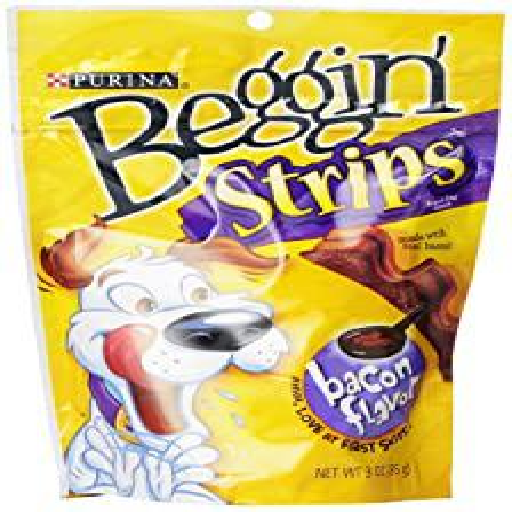

1/1 [==============================] - 1s 1s/step


-----------------------------------------------------------------------
Most similar products:
-----------------------------------------------------------------------
Product ID :  B00HXX1DK8
Title :  Beggin Strips Real Bacon and Ranch Flavor Pet Treats, 25-Ounce , pack of 4.
Brand :  Unknown
Cost :  $21.87
Rating :  5 out of 5.0
Url:  https://www.amazon.com/dp/B00HXX1DK8



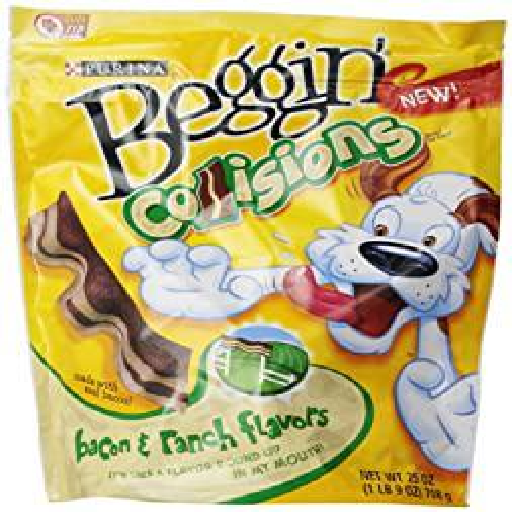

Product ID :  B004IN2P9Y
Title :  Purina Beggin' Strips
Brand :  Purina
Cost :  $16.24
Rating :  5 out of 5.0
Url:  https://www.amazon.com/dp/B004IN2P9Y



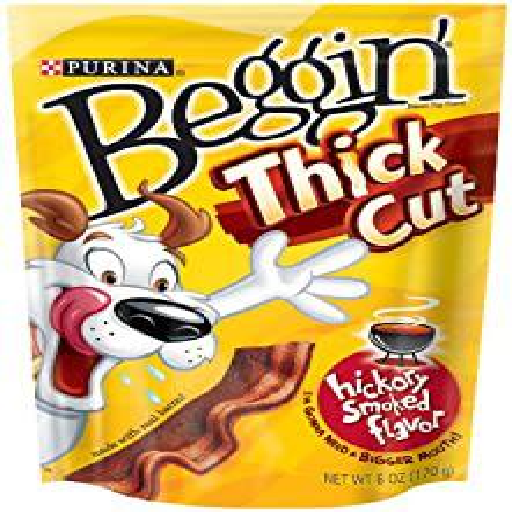

Product ID :  B004AWH6ZG
Title :  Beggin' Strips Bacon
Brand :  Purina
Cost :  $23.48
Rating :  5 out of 5.0
Url:  https://www.amazon.com/dp/B004AWH6ZG



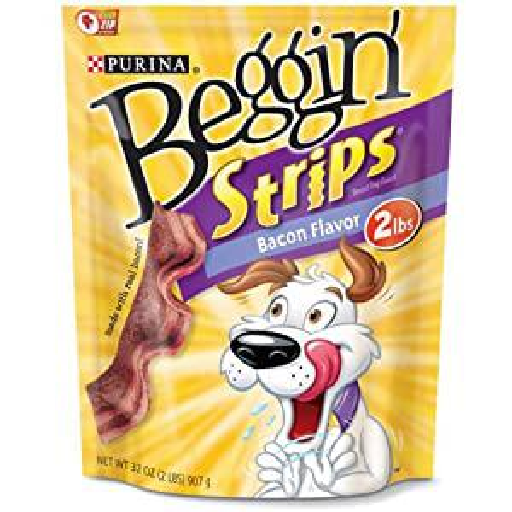

Product ID :  B00CYRZWU0
Title :  Beggin Strips Real Bacon and Peanut Butter Flavors Pet Treats, 25-Ounce
Brand :  Beggin&#39; Strips
Cost :  $22.0
Rating :  5 out of 5.0
Url:  https://www.amazon.com/dp/B00CYRZWU0



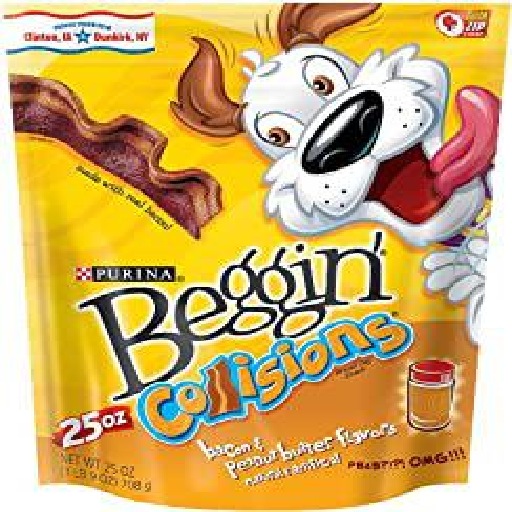

Product ID :  B00CHMU9KA
Title :  GREENIES 6-Pack Canine Pill Pockets Hickory Smoke Capsule
Brand :  Greenies
Cost :  $42.5
Rating :  4 out of 5.0
Url:  https://www.amazon.com/dp/B00CHMU9KA



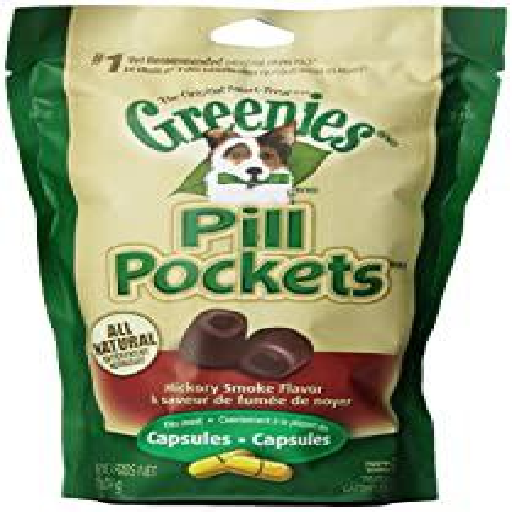

In [39]:
image_recommendation(3507,5)

-----------------------------------------------------------------------
Original product:
-----------------------------------------------------------------------
Product ID :  B00ANCGVRG
Title :  Casio G-Shock Black Dial Men's Quartz Watch
Brand :  Casio
Cost :  $80.0
Rating :  5 out of 5.0



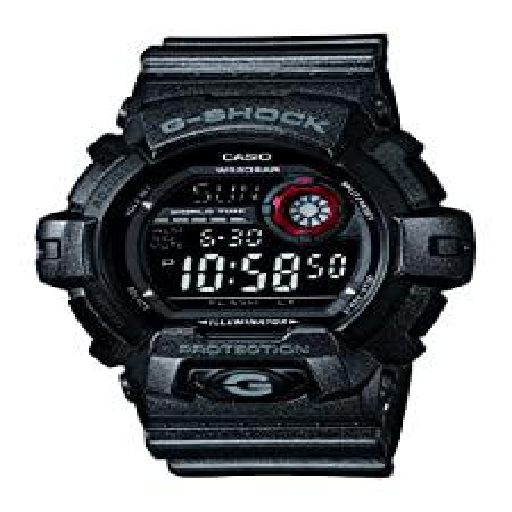

1/1 [==============================] - 0s 463ms/step


-----------------------------------------------------------------------
Most similar products:
-----------------------------------------------------------------------
Product ID :  B00BF2CUYG
Title :  Casio G-Shock Garish Color Super Illuminator
Brand :  Casio
Cost :  $61.61
Rating :  5 out of 5.0
Url:  https://www.amazon.com/dp/B00BF2CUYG



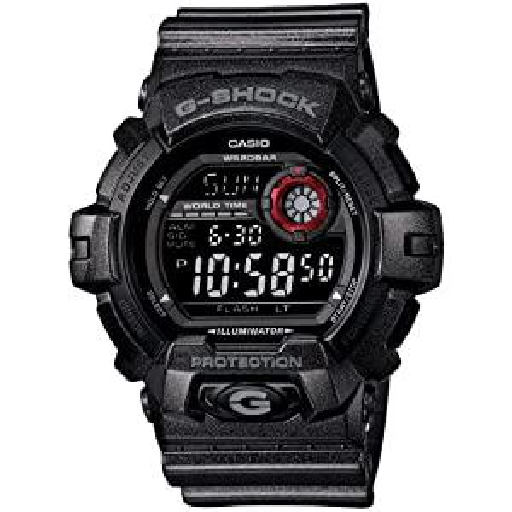

Product ID :  B00791YX10
Title :  Casio Men's G6900KG-3CR G-Shock Military Green Multi-Function Digital Watch
Brand :  Casio
Cost :  $93.0
Rating :  4 out of 5.0
Url:  https://www.amazon.com/dp/B00791YX10



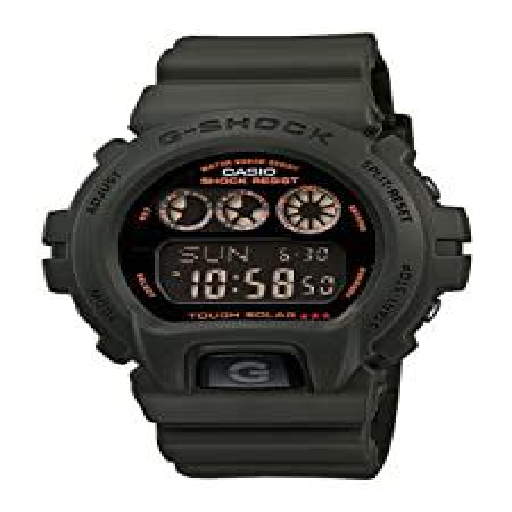

Product ID :  B00BU6RUU6
Title :  Casio Men's GD350-1B G Shock Black Watch
Brand :  Casio
Cost :  $112.0
Rating :  5 out of 5.0
Url:  https://www.amazon.com/dp/B00BU6RUU6



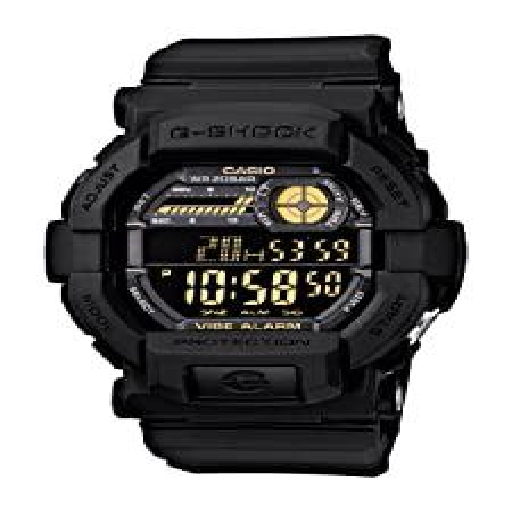

Product ID :  B00EBBC3XG
Title :  Casio G Shock Digital Black Resin Mens Watch GR8900A-1CR
Brand :  Casio
Cost :  $115.0
Rating :  4 out of 5.0
Url:  https://www.amazon.com/dp/B00EBBC3XG



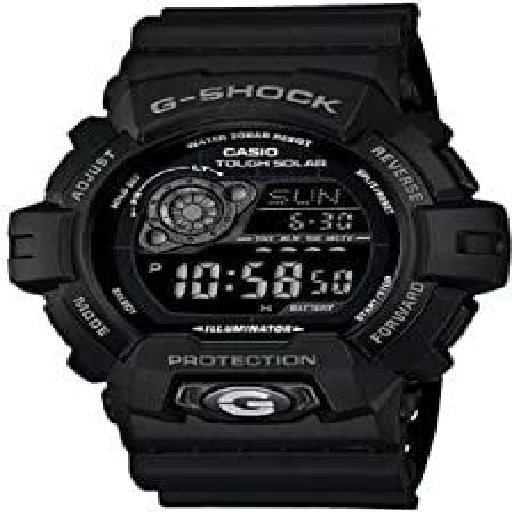

Product ID :  B00IF3K7MK
Title :  Casio GD-X6900-1ER Mens G-Shock World Time All Black Digital Watch
Brand :  Casio
Cost :  $140.0
Rating :  5 out of 5.0
Url:  https://www.amazon.com/dp/B00IF3K7MK



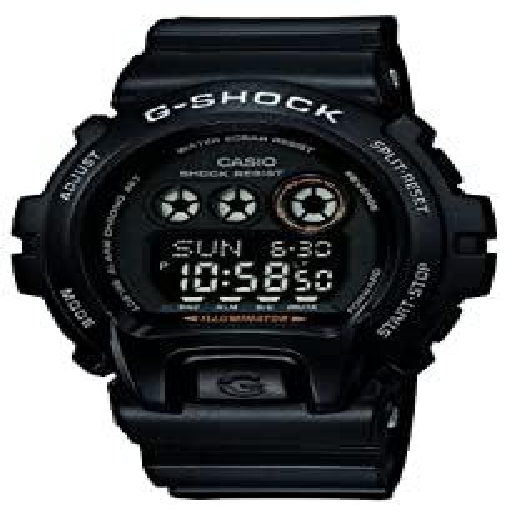

In [40]:
image_recommendation(26403,5)

---